In [1]:
import re
import string

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
!pip install seaborn
import seaborn as sns

import tensorflow as tf
!pip install transformers

import transformers
from transformers import BertTokenizer
from transformers import TFAutoModel

from tensorflow.keras.callbacks import EarlyStopping

print(tf.__version__)
print(transformers.__version__)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/293.3 KB ? eta -:--:--

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.3/293.3 KB 7.2 MB/s eta 0:00:00


You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


D0513 15:53:47.128733637      13 config.cc:119]                        gRPC EXPERIMENT tcp_frame_size_tuning               OFF (default:OFF)
D0513 15:53:47.128773316      13 config.cc:119]                        gRPC EXPERIMENT tcp_rcv_lowat                       OFF (default:OFF)
D0513 15:53:47.128776962      13 config.cc:119]                        gRPC EXPERIMENT peer_state_based_framing            OFF (default:OFF)
D0513 15:53:47.128779623      13 config.cc:119]                        gRPC EXPERIMENT flow_control_fixes                  ON  (default:ON)
D0513 15:53:47.128782127      13 config.cc:119]                        gRPC EXPERIMENT memory_pressure_controller          OFF (default:OFF)
D0513 15:53:47.128785005      13 config.cc:119]                        gRPC EXPERIMENT unconstrained_max_quota_buffer_size OFF (default:OFF)
D0513 15:53:47.128787482      13 config.cc:119]                        gRPC EXPERIMENT new_hpack_huffman_decoder           ON  (default:ON)
D0513 15:53:47.

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/7.1 MB ? eta -:--:--

     ━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━ 3.5/7.1 MB 50.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 7.1/7.1 MB 74.4 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 48.2 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/771.9 KB ? eta -:--:--

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 771.9/771.9 KB 17.5 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 KB 17.7 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━ 4.5/7.8 MB 134.5 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━ 5.2/7.8 MB 129.9 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 7.8/7.8 MB 80.5 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 52.3 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 160.1/160.1 KB 13.7 MB/s eta 0:00:00


You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


/usr/local/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


2.12.0
4.29.1


# 📋 Loading the Data

In [2]:
import pandas as pd
import numpy as np
!pip install gensim nltk
import gensim
from gensim.models import Word2Vec
from nltk.tokenize import sent_tokenize, word_tokenize
import warnings
warnings.filterwarnings("ignore")
#df = pd.read_csv('/kaggle/input/uk-twitter-covid19-dataset/sample_data.csv')
#df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Global.csv')
#df = pd.read_csv('/kaggle/input/external-covid-19-twitter-dataset/Reddit_Data.csv')
df = pd.read_csv('/kaggle/input/external-covid-19-twitter-dataset/Twitter_Data.csv')

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/26.5 MB ? eta -:--:--

     ━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/26.5 MB 47.5 MB/s eta 0:00:01

     ━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.5/26.5 MB 80.9 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━ 13.6/26.5 MB 149.2 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━ 23.9/26.5 MB 148.9 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 26.5/26.5 MB 144.5 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 26.5/26.5 MB 144.5 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 26.5/26.5 MB 144.5 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 26.5/26.5 MB 144.5 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.5/26.5 MB 35.9 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 54.0 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/56.8 KB ? eta -:--:--

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 KB 4.3 MB/s eta 0:00:00


You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


In [3]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 162980 entries, 0 to 162979
Data columns (total 2 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   clean_text  162976 non-null  object 
 1   category    162973 non-null  float64
dtypes: float64(1), object(1)
memory usage: 2.5+ MB
None


In [4]:
df = df.dropna()
df

,clean_text,category
0,when modi promised “minimum government maximum...,-1.0
1,talk all the nonsense and continue all the dra...,0.0
2,what did just say vote for modi welcome bjp t...,1.0
3,asking his supporters prefix chowkidar their n...,1.0
4,answer who among these the most powerful world...,1.0
...,...,...
162975,why these 456 crores paid neerav modi not reco...,-1.0
162976,dear rss terrorist payal gawar what about modi...,-1.0
162977,did you cover her interaction forum where she ...,0.0
162978,there big project came into india modi dream p...,0.0


In [5]:
# df['text'] = df['clean_tweet']
# df['target'] = df['senti_textblob']
df['text'] = df['clean_text']
df['target'] = df['category']

In [6]:
'''
import pandas as pd

# assuming your dataframe is named 'df'
num_samples_per_label = 2000

# group the dataframe by the label column
grouped_df = df.groupby('target')

# sample a specified number of rows from each group
sampled_df = grouped_df.apply(lambda x: x.sample(n=num_samples_per_label))

# reset the index of the resulting dataframe
sampled_df = sampled_df.reset_index(drop=True)
df = sampled_df 
'''

"\nimport pandas as pd\n\n# assuming your dataframe is named 'df'\nnum_samples_per_label = 2000\n\n# group the dataframe by the label column\ngrouped_df = df.groupby('target')\n\n# sample a specified number of rows from each group\nsampled_df = grouped_df.apply(lambda x: x.sample(n=num_samples_per_label))\n\n# reset the index of the resulting dataframe\nsampled_df = sampled_df.reset_index(drop=True)\ndf = sampled_df \n"

In [7]:
df = df.drop(columns = ['clean_text','category'])
df

,text,target
0,when modi promised “minimum government maximum...,-1.0
1,talk all the nonsense and continue all the dra...,0.0
2,what did just say vote for modi welcome bjp t...,1.0
3,asking his supporters prefix chowkidar their n...,1.0
4,answer who among these the most powerful world...,1.0
...,...,...
162975,why these 456 crores paid neerav modi not reco...,-1.0
162976,dear rss terrorist payal gawar what about modi...,-1.0
162977,did you cover her interaction forum where she ...,0.0
162978,there big project came into india modi dream p...,0.0


In [8]:
from sklearn.model_selection import train_test_split
train, test = train_test_split(df[['text','target']], test_size = 0.2, random_state = 42)

In [9]:
train

,text,target
63425,some media guys cant even think straight forwa...,1.0
78455,only namo,0.0
70129,does this add the space debris problem the awa...,1.0
157073,today’ interaction modi phenomenal looking fre...,1.0
120885,more modi bjp wants change nitin gadkari will ...,1.0
...,...,...
119880,will buy mallyas kingfisher nirav modi choksi ...,0.0
103695,all the way modi,0.0
131934,indians are getting cosy the idea voting rahul...,1.0
146869,wow reading comments here like watching circus...,1.0


In [10]:
print("train, counts of label '1': {}".format(sum(train.target == 1)))
print("train, counts of label '0': {}".format(sum(train.target == 0)))
print("train, counts of label '-1': {}\n".format(sum(train.target == -1)))
print("test, counts of label '1': {}".format(sum(test.target == 1)))
print("test, counts of label '0': {}".format(sum(test.target == 0)))
print("test, counts of label '-1': {}".format(sum(test.target == -1)))

train, counts of label '1': 57874
train, counts of label '0': 44144
train, counts of label '-1': 28357

test, counts of label '1': 14375
test, counts of label '0': 11067
test, counts of label '-1': 7152


In [11]:
def reduce_mem_usage(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))

    return df

#train = reduce_mem_usage(train)
#train = reduce_mem_usage(test)

In [12]:
import pandas as pd

# assume your test data is stored in a pandas DataFrame called 'test'
# and the labels are stored in a column called 'target'

# randomly sample 1000 rows from each label
label_1 = test[test.target == 1].sample(n=1000, replace=False)
label_0 = test[test.target == 0].sample(n=1000, replace=False)
label_minus_1 = test[test.target == -1].sample(n=1000, replace=False)

# concatenate the sampled rows into one DataFrame
sampled_data = pd.concat([label_1, label_0, label_minus_1])

# shuffle the DataFrame
test = sampled_data.sample(frac=1).reset_index(drop=True)

In [13]:
test

,text,target
0,the promise made rahul gandhi was completed th...,0.0
1,think some will definitely get against nobody ...,0.0
2,drmurli manohar joshi\neducated man future igo...,0.0
3,sir its not matter that who pri minister india...,1.0
4,actually modi dog shame them would allowed mov...,0.0
...,...,...
2995,not interested freedom fighters they are all g...,-1.0
2996,modi will soon bjps list star campaigners for ...,0.0
2997,indira started garibi hatao they are still wor...,0.0
2998,film producer sandeep singh bhoomi sarbjit has...,1.0


In [14]:
#train2, test2 = train, test

# 🔨 Preprocessing

In [15]:
#Use regex to clean the data
def remove_url(text):
    url = re.compile(r'https?://\S+|www\.\S+')
    return url.sub(r'',text)

def remove_punct(text):
    table = str.maketrans('', '', string.punctuation)
    return text.translate(table)
def remove_html(text):
    html=re.compile(r'<.*?>')
    return html.sub(r'',text)

def remove_emoji(text):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', text)

def decontraction(text):
    text = re.sub(r"won\'t", " will not", text)
    text = re.sub(r"won\'t've", " will not have", text)
    text = re.sub(r"can\'t", " can not", text)
    text = re.sub(r"don\'t", " do not", text)
    
    text = re.sub(r"can\'t've", " can not have", text)
    text = re.sub(r"ma\'am", " madam", text)
    text = re.sub(r"let\'s", " let us", text)
    text = re.sub(r"ain\'t", " am not", text)
    text = re.sub(r"shan\'t", " shall not", text)
    text = re.sub(r"sha\n't", " shall not", text)
    text = re.sub(r"o\'clock", " of the clock", text)
    text = re.sub(r"y\'all", " you all", text)

    text = re.sub(r"n\'t", " not", text)
    text = re.sub(r"n\'t've", " not have", text)
    text = re.sub(r"\'re", " are", text)
    text = re.sub(r"\'s", " is", text)
    text = re.sub(r"\'d", " would", text)
    text = re.sub(r"\'d've", " would have", text)
    text = re.sub(r"\'ll", " will", text)
    text = re.sub(r"\'ll've", " will have", text)
    text = re.sub(r"\'t", " not", text)
    text = re.sub(r"\'ve", " have", text)
    text = re.sub(r"\'m", " am", text)
    text = re.sub(r"\'re", " are", text)
    return text 

def seperate_alphanumeric(text):
    words = text
    words = re.findall(r"[^\W\d_]+|\d+", words)
    return " ".join(words)

def cont_rep_char(text):
    tchr = text.group(0) 
    
    if len(tchr) > 1:
        return tchr[0:2] 

def unique_char(rep, text):
    substitute = re.sub(r'(\w)\1+', rep, text)
    return substitute

train['text'] = train['text'].apply(lambda x : remove_url(x))
train['text'] = train['text'].apply(lambda x : remove_punct(x))
train['text'] = train['text'].apply(lambda x : remove_emoji(x))
train['text'] = train['text'].apply(lambda x : decontraction(x))
train['text'] = train['text'].apply(lambda x : seperate_alphanumeric(x))
train['text'] = train['text'].apply(lambda x : unique_char(cont_rep_char,x))

test['text'] = test['text'].apply(lambda x : remove_url(x))
test['text'] = test['text'].apply(lambda x : remove_punct(x))
test['text'] = test['text'].apply(lambda x : remove_emoji(x))
test['text'] = test['text'].apply(lambda x : decontraction(x))
test['text'] = test['text'].apply(lambda x : seperate_alphanumeric(x))
test['text'] = test['text'].apply(lambda x : unique_char(cont_rep_char,x))

# ✂️ Tokenization

In [16]:
seq_len = 256 #max([len(text) for text in train['text']]) #256
batch_size = 16 #16
num_samples = len(train)

model_name = 'cardiffnlp/twitter-roberta-base-sentiment-latest'
tokenizer = transformers.AutoTokenizer.from_pretrained(model_name)

train_tokens = tokenizer(
    train['text'].tolist(), 
    max_length=seq_len, 
    truncation=True, 
    padding='max_length', 
    add_special_tokens=True, 
    return_tensors='np'
)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
train['target'] = le.fit_transform(train['target'])
test['target'] = le.fit_transform(test['target'])

y_train = train['target'].values
labels = np.zeros((num_samples, y_train.max() + 1))
labels[np.arange(num_samples), y_train] = 1

dataset = tf.data.Dataset.from_tensor_slices(
    (
        train_tokens['input_ids'], 
        train_tokens['attention_mask'], 
        labels
    )
)

def map_func(input_ids, masks, labels):
    return {
        'input_ids': input_ids,
        'attention_mask': masks
    }, labels

dataset = dataset.map(map_func)
dataset = dataset.shuffle(10000).batch(batch_size=batch_size, drop_remainder=True)

split = 0.7
size = int((train_tokens['input_ids'].shape[0] // batch_size) * split)

train_ds = dataset.take(size)
val_ds = dataset.skip(size)

In [17]:
size

5703

In [18]:
labels.shape

(130375, 3)

# 🤖 Model Building

In [19]:
####### MODEL 3 #########
'''
In this example, a BiLSTM layer is added after the Transformer layer. The number of units in the BiLSTM layer is set to 64, 
but you can modify this value based on your specific use case. The output of the BiLSTM layer is passed through two dense layers, 
each with 512 units and a ReLU activation function, before being fed to the classifier head.
'''
    
# detect and init the TPU
tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect()
# instantiate a distribution strategy
tpu_strategy = tf.distribute.experimental.TPUStrategy(tpu)

# instantiating the model in the strategy scope creates the model on the TPU
with tpu_strategy.scope():
    model_name = 'cardiffnlp/twitter-roberta-base-sentiment-latest'
    bert_model = TFAutoModel.from_pretrained(model_name)

    # Input layers
    input_ids = tf.keras.layers.Input(shape=(seq_len,), name='input_ids', dtype='int32')
    mask = tf.keras.layers.Input(shape=(seq_len,), name='attention_mask', dtype='int32')

    # Transformer
    embeddings = bert_model(input_ids, attention_mask=mask)[0]
    embeddings = tf.keras.layers.GlobalAveragePooling1D()(embeddings)
    embeddings = tf.keras.layers.Reshape((1, -1))(embeddings)

    # Add a BiLSTM layer
    lstm_units = 512 
    lstm = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(lstm_units, return_sequences=True))(embeddings)
    attention_layer = tf.keras.layers.Attention()([lstm, lstm])

    # Add Dense layers
    #x = tf.keras.layers.Dense(512, activation='relu')(lstm)
    x = tf.keras.layers.Dense(512, activation='relu')(attention_layer)
    x = tf.keras.layers.Dense(256, activation='relu')(x)
    x = tf.keras.layers.Dense(128, activation='relu')(x)
    x = tf.keras.layers.Dropout(0.05)(x)

    # Flatten the output tensor
    x = tf.keras.layers.Flatten()(x)

    # Classifier head
    outputs = tf.keras.layers.Dense(3, activation='softmax', name='outputs')(x)

    # Create the model
    model = tf.keras.Model(inputs=[input_ids, mask], outputs=outputs)

    # Compile the model
    learning_rate = 4e-5 # 4e-5
    optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)
    loss = tf.keras.losses.CategoricalCrossentropy()
    acc = tf.keras.metrics.CategoricalAccuracy()
    model.compile(optimizer=optimizer, loss=tf.keras.losses.CategoricalCrossentropy(), metrics=tf.keras.metrics.CategoricalAccuracy())

'''
In the above example, monitor specifies the metric to be monitored for early stopping, 
patience specifies the number of epochs with no improvement after which training will be stopped, 
mode specifies whether the monitored metric should be minimized or maximized, and 
restore_best_weights specifies whether to restore the weights of the model corresponding to the epoch with the best monitored metric value.

Adagrad
Adadelta
RMSprop

1.2277e-05 (best val loss)


import math
# Define the LearningRateScheduler callback
initial_learning_rate = 1e-3
def lr_exp_decay(epoch):
    k = 0.1
    return initial_learning_rate * math.exp(-k*epoch)

'''

filepath = "model.h5"
checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath, monitor='loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]
# Define early stopping
early_stop = EarlyStopping(monitor='val_loss', patience=5, verbose=1, restore_best_weights=True)
#lr_callback = tf.keras.callbacks.LearningRateScheduler(lr_exp_decay)

# Fit the model with early stopping
history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs= 5,
    batch_size=batch_size,
    callbacks=[early_stop, callbacks_list]
    #callbacks=[lr_callback] 
)

INFO:tensorflow:Deallocate tpu buffers before initializing tpu system.


INFO:tensorflow:Initializing the TPU system: local


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Found TPU system:


INFO:tensorflow:Found TPU system:


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


All model checkpoint layers were used when initializing TFRobertaModel.



All the layers of TFRobertaModel were initialized from the model checkpoint at cardiffnlp/twitter-roberta-base-sentiment-latest.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFRobertaModel for predictions without further training.


Epoch 1/5


2023-05-13 15:56:28.562029: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.


2023-05-13 15:56:29.442057: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.


   1/5703 [..............................] - ETA: 131:31:21 - loss: 1.1261 - categorical_accuracy: 0.3125

   2/5703 [..............................] - ETA: 5:31 - loss: 1.1117 - categorical_accuracy: 0.4062     

   3/5703 [..............................] - ETA: 5:41 - loss: 1.0934 - categorical_accuracy: 0.4375

   4/5703 [..............................] - ETA: 5:40 - loss: 1.0920 - categorical_accuracy: 0.4062

   5/5703 [..............................] - ETA: 5:38 - loss: 1.0750 - categorical_accuracy: 0.4375

   6/5703 [..............................] - ETA: 5:37 - loss: 1.0816 - categorical_accuracy: 0.4271

   7/5703 [..............................] - ETA: 5:38 - loss: 1.0799 - categorical_accuracy: 0.4375

   8/5703 [..............................] - ETA: 5:38 - loss: 1.0755 - categorical_accuracy: 0.4375

   9/5703 [..............................] - ETA: 5:35 - loss: 1.0641 - categorical_accuracy: 0.4444

  10/5703 [..............................] - ETA: 5:34 - loss: 1.0585 - categorical_accuracy: 0.4625

  11/5703 [..............................] - ETA: 5:32 - loss: 1.0423 - categorical_accuracy: 0.4830

  12/5703 [..............................] - ETA: 5:31 - loss: 1.0451 - categorical_accuracy: 0.4740

  13/5703 [..............................] - ETA: 5:30 - loss: 1.0475 - categorical_accuracy: 0.4663

  14/5703 [..............................] - ETA: 5:29 - loss: 1.0551 - categorical_accuracy: 0.4598

  15/5703 [..............................] - ETA: 5:28 - loss: 1.0433 - categorical_accuracy: 0.4667

  16/5703 [..............................] - ETA: 5:27 - loss: 1.0425 - categorical_accuracy: 0.4688

  17/5703 [..............................] - ETA: 5:27 - loss: 1.0509 - categorical_accuracy: 0.4559

  18/5703 [..............................] - ETA: 5:26 - loss: 1.0470 - categorical_accuracy: 0.4583

  19/5703 [..............................] - ETA: 5:26 - loss: 1.0391 - categorical_accuracy: 0.4671

  20/5703 [..............................] - ETA: 5:25 - loss: 1.0349 - categorical_accuracy: 0.4719

  21/5703 [..............................] - ETA: 5:25 - loss: 1.0322 - categorical_accuracy: 0.4762

  22/5703 [..............................] - ETA: 5:25 - loss: 1.0297 - categorical_accuracy: 0.4801

  23/5703 [..............................] - ETA: 5:25 - loss: 1.0265 - categorical_accuracy: 0.4783

  24/5703 [..............................] - ETA: 5:24 - loss: 1.0291 - categorical_accuracy: 0.4714

  25/5703 [..............................] - ETA: 5:24 - loss: 1.0272 - categorical_accuracy: 0.4750

  26/5703 [..............................] - ETA: 5:24 - loss: 1.0221 - categorical_accuracy: 0.4784

  27/5703 [..............................] - ETA: 5:24 - loss: 1.0172 - categorical_accuracy: 0.4838

  28/5703 [..............................] - ETA: 5:24 - loss: 1.0117 - categorical_accuracy: 0.4955

  29/5703 [..............................] - ETA: 5:24 - loss: 1.0076 - categorical_accuracy: 0.5022

  30/5703 [..............................] - ETA: 5:24 - loss: 1.0062 - categorical_accuracy: 0.5021

  31/5703 [..............................] - ETA: 5:23 - loss: 1.0054 - categorical_accuracy: 0.5040

  32/5703 [..............................] - ETA: 5:23 - loss: 1.0072 - categorical_accuracy: 0.5039

  33/5703 [..............................] - ETA: 5:23 - loss: 1.0089 - categorical_accuracy: 0.4981

  34/5703 [..............................] - ETA: 5:23 - loss: 1.0075 - categorical_accuracy: 0.4963

  35/5703 [..............................] - ETA: 5:23 - loss: 1.0101 - categorical_accuracy: 0.4946

  36/5703 [..............................] - ETA: 5:23 - loss: 1.0026 - categorical_accuracy: 0.5017

  37/5703 [..............................] - ETA: 5:23 - loss: 1.0070 - categorical_accuracy: 0.4966

  38/5703 [..............................] - ETA: 5:23 - loss: 1.0126 - categorical_accuracy: 0.4918

  39/5703 [..............................] - ETA: 5:23 - loss: 1.0106 - categorical_accuracy: 0.4936

  40/5703 [..............................] - ETA: 5:23 - loss: 1.0104 - categorical_accuracy: 0.4969

  41/5703 [..............................] - ETA: 5:23 - loss: 1.0071 - categorical_accuracy: 0.5015

  42/5703 [..............................] - ETA: 5:23 - loss: 1.0092 - categorical_accuracy: 0.5030

  43/5703 [..............................] - ETA: 5:23 - loss: 1.0056 - categorical_accuracy: 0.5058

  44/5703 [..............................] - ETA: 5:23 - loss: 1.0040 - categorical_accuracy: 0.5085

  45/5703 [..............................] - ETA: 5:23 - loss: 1.0016 - categorical_accuracy: 0.5125

  46/5703 [..............................] - ETA: 5:23 - loss: 0.9996 - categorical_accuracy: 0.5149

  47/5703 [..............................] - ETA: 5:23 - loss: 0.9966 - categorical_accuracy: 0.5199

  48/5703 [..............................] - ETA: 5:23 - loss: 0.9993 - categorical_accuracy: 0.5182

  49/5703 [..............................] - ETA: 5:23 - loss: 0.9985 - categorical_accuracy: 0.5166

  50/5703 [..............................] - ETA: 5:23 - loss: 0.9936 - categorical_accuracy: 0.5213

  51/5703 [..............................] - ETA: 5:23 - loss: 0.9920 - categorical_accuracy: 0.5233

  52/5703 [..............................] - ETA: 5:23 - loss: 0.9857 - categorical_accuracy: 0.5264

  53/5703 [..............................] - ETA: 5:22 - loss: 0.9842 - categorical_accuracy: 0.5271

  54/5703 [..............................] - ETA: 5:22 - loss: 0.9804 - categorical_accuracy: 0.5289

  55/5703 [..............................] - ETA: 5:22 - loss: 0.9779 - categorical_accuracy: 0.5330

  56/5703 [..............................] - ETA: 5:22 - loss: 0.9790 - categorical_accuracy: 0.5324

  57/5703 [..............................] - ETA: 5:22 - loss: 0.9797 - categorical_accuracy: 0.5318

  58/5703 [..............................] - ETA: 5:22 - loss: 0.9756 - categorical_accuracy: 0.5356

  59/5703 [..............................] - ETA: 5:22 - loss: 0.9721 - categorical_accuracy: 0.5381

  60/5703 [..............................] - ETA: 5:22 - loss: 0.9733 - categorical_accuracy: 0.5365

  61/5703 [..............................] - ETA: 5:21 - loss: 0.9707 - categorical_accuracy: 0.5379

  62/5703 [..............................] - ETA: 5:21 - loss: 0.9700 - categorical_accuracy: 0.5403

  63/5703 [..............................] - ETA: 5:21 - loss: 0.9689 - categorical_accuracy: 0.5417

  64/5703 [..............................] - ETA: 5:21 - loss: 0.9707 - categorical_accuracy: 0.5400

  65/5703 [..............................] - ETA: 5:21 - loss: 0.9711 - categorical_accuracy: 0.5404

  66/5703 [..............................] - ETA: 5:21 - loss: 0.9680 - categorical_accuracy: 0.5417

  67/5703 [..............................] - ETA: 5:21 - loss: 0.9671 - categorical_accuracy: 0.5438

  68/5703 [..............................] - ETA: 5:21 - loss: 0.9624 - categorical_accuracy: 0.5478

  69/5703 [..............................] - ETA: 5:21 - loss: 0.9636 - categorical_accuracy: 0.5480

  70/5703 [..............................] - ETA: 5:21 - loss: 0.9598 - categorical_accuracy: 0.5500

  71/5703 [..............................] - ETA: 5:21 - loss: 0.9581 - categorical_accuracy: 0.5528

  72/5703 [..............................] - ETA: 5:21 - loss: 0.9556 - categorical_accuracy: 0.5547

  73/5703 [..............................] - ETA: 5:21 - loss: 0.9532 - categorical_accuracy: 0.5557

  74/5703 [..............................] - ETA: 5:21 - loss: 0.9531 - categorical_accuracy: 0.5557

  75/5703 [..............................] - ETA: 5:21 - loss: 0.9495 - categorical_accuracy: 0.5575

  76/5703 [..............................] - ETA: 5:21 - loss: 0.9484 - categorical_accuracy: 0.5592

  77/5703 [..............................] - ETA: 5:21 - loss: 0.9512 - categorical_accuracy: 0.5568

  78/5703 [..............................] - ETA: 5:21 - loss: 0.9524 - categorical_accuracy: 0.5553

  79/5703 [..............................] - ETA: 5:21 - loss: 0.9505 - categorical_accuracy: 0.5570

  80/5703 [..............................] - ETA: 5:20 - loss: 0.9482 - categorical_accuracy: 0.5594

  81/5703 [..............................] - ETA: 5:20 - loss: 0.9477 - categorical_accuracy: 0.5602

  82/5703 [..............................] - ETA: 5:20 - loss: 0.9471 - categorical_accuracy: 0.5610

  83/5703 [..............................] - ETA: 5:20 - loss: 0.9461 - categorical_accuracy: 0.5610

  84/5703 [..............................] - ETA: 5:21 - loss: 0.9430 - categorical_accuracy: 0.5625

  85/5703 [..............................] - ETA: 5:20 - loss: 0.9404 - categorical_accuracy: 0.5625

  86/5703 [..............................] - ETA: 5:21 - loss: 0.9377 - categorical_accuracy: 0.5640

  87/5703 [..............................] - ETA: 5:21 - loss: 0.9353 - categorical_accuracy: 0.5647

  88/5703 [..............................] - ETA: 5:21 - loss: 0.9346 - categorical_accuracy: 0.5639

  89/5703 [..............................] - ETA: 5:22 - loss: 0.9355 - categorical_accuracy: 0.5639

  90/5703 [..............................] - ETA: 5:22 - loss: 0.9357 - categorical_accuracy: 0.5639

  91/5703 [..............................] - ETA: 5:22 - loss: 0.9352 - categorical_accuracy: 0.5646

  92/5703 [..............................] - ETA: 5:22 - loss: 0.9347 - categorical_accuracy: 0.5652

  93/5703 [..............................] - ETA: 5:22 - loss: 0.9371 - categorical_accuracy: 0.5638

  94/5703 [..............................] - ETA: 5:22 - loss: 0.9352 - categorical_accuracy: 0.5645

  95/5703 [..............................] - ETA: 5:22 - loss: 0.9337 - categorical_accuracy: 0.5664

  96/5703 [..............................] - ETA: 5:22 - loss: 0.9312 - categorical_accuracy: 0.5677

  97/5703 [..............................] - ETA: 5:22 - loss: 0.9295 - categorical_accuracy: 0.5696

  98/5703 [..............................] - ETA: 5:22 - loss: 0.9276 - categorical_accuracy: 0.5727

  99/5703 [..............................] - ETA: 5:23 - loss: 0.9267 - categorical_accuracy: 0.5739

 100/5703 [..............................] - ETA: 5:22 - loss: 0.9256 - categorical_accuracy: 0.5750

 101/5703 [..............................] - ETA: 5:22 - loss: 0.9254 - categorical_accuracy: 0.5755

 102/5703 [..............................] - ETA: 5:22 - loss: 0.9240 - categorical_accuracy: 0.5760

 103/5703 [..............................] - ETA: 5:22 - loss: 0.9206 - categorical_accuracy: 0.5789

 104/5703 [..............................] - ETA: 5:22 - loss: 0.9200 - categorical_accuracy: 0.5793

 105/5703 [..............................] - ETA: 5:22 - loss: 0.9197 - categorical_accuracy: 0.5798

 106/5703 [..............................] - ETA: 5:22 - loss: 0.9167 - categorical_accuracy: 0.5814

 107/5703 [..............................] - ETA: 5:22 - loss: 0.9182 - categorical_accuracy: 0.5800

 108/5703 [..............................] - ETA: 5:22 - loss: 0.9155 - categorical_accuracy: 0.5816

 109/5703 [..............................] - ETA: 5:22 - loss: 0.9144 - categorical_accuracy: 0.5826

 110/5703 [..............................] - ETA: 5:22 - loss: 0.9150 - categorical_accuracy: 0.5824

 111/5703 [..............................] - ETA: 5:22 - loss: 0.9182 - categorical_accuracy: 0.5811

 112/5703 [..............................] - ETA: 5:22 - loss: 0.9158 - categorical_accuracy: 0.5826

 113/5703 [..............................] - ETA: 5:22 - loss: 0.9157 - categorical_accuracy: 0.5830

 114/5703 [..............................] - ETA: 5:22 - loss: 0.9116 - categorical_accuracy: 0.5861

 115/5703 [..............................] - ETA: 5:22 - loss: 0.9106 - categorical_accuracy: 0.5870

 116/5703 [..............................] - ETA: 5:21 - loss: 0.9078 - categorical_accuracy: 0.5884

 117/5703 [..............................] - ETA: 5:21 - loss: 0.9071 - categorical_accuracy: 0.5887

 118/5703 [..............................] - ETA: 5:21 - loss: 0.9058 - categorical_accuracy: 0.5895

 119/5703 [..............................] - ETA: 5:21 - loss: 0.9041 - categorical_accuracy: 0.5914

 120/5703 [..............................] - ETA: 5:21 - loss: 0.9013 - categorical_accuracy: 0.5927

 121/5703 [..............................] - ETA: 5:21 - loss: 0.9001 - categorical_accuracy: 0.5940

 122/5703 [..............................] - ETA: 5:21 - loss: 0.8997 - categorical_accuracy: 0.5932

 123/5703 [..............................] - ETA: 5:21 - loss: 0.8976 - categorical_accuracy: 0.5950

 124/5703 [..............................] - ETA: 5:21 - loss: 0.8973 - categorical_accuracy: 0.5958

 125/5703 [..............................] - ETA: 5:21 - loss: 0.8979 - categorical_accuracy: 0.5960

 126/5703 [..............................] - ETA: 5:21 - loss: 0.8990 - categorical_accuracy: 0.5957

 127/5703 [..............................] - ETA: 5:21 - loss: 0.9003 - categorical_accuracy: 0.5945

 128/5703 [..............................] - ETA: 5:21 - loss: 0.8993 - categorical_accuracy: 0.5947

 129/5703 [..............................] - ETA: 5:21 - loss: 0.9005 - categorical_accuracy: 0.5940

 130/5703 [..............................] - ETA: 5:21 - loss: 0.8996 - categorical_accuracy: 0.5952

 131/5703 [..............................] - ETA: 5:21 - loss: 0.8973 - categorical_accuracy: 0.5964

 132/5703 [..............................] - ETA: 5:21 - loss: 0.8965 - categorical_accuracy: 0.5975

 133/5703 [..............................] - ETA: 5:20 - loss: 0.8949 - categorical_accuracy: 0.5982

 134/5703 [..............................] - ETA: 5:20 - loss: 0.8946 - categorical_accuracy: 0.5984

 135/5703 [..............................] - ETA: 5:20 - loss: 0.8929 - categorical_accuracy: 0.6000

 136/5703 [..............................] - ETA: 5:20 - loss: 0.8933 - categorical_accuracy: 0.6002

 137/5703 [..............................] - ETA: 5:20 - loss: 0.8910 - categorical_accuracy: 0.6026

 138/5703 [..............................] - ETA: 5:20 - loss: 0.8891 - categorical_accuracy: 0.6037

 139/5703 [..............................] - ETA: 5:20 - loss: 0.8892 - categorical_accuracy: 0.6043

 140/5703 [..............................] - ETA: 5:20 - loss: 0.8858 - categorical_accuracy: 0.6067

 141/5703 [..............................] - ETA: 5:20 - loss: 0.8825 - categorical_accuracy: 0.6086

 142/5703 [..............................] - ETA: 5:20 - loss: 0.8828 - categorical_accuracy: 0.6083

 143/5703 [..............................] - ETA: 5:20 - loss: 0.8831 - categorical_accuracy: 0.6080

 144/5703 [..............................] - ETA: 5:20 - loss: 0.8820 - categorical_accuracy: 0.6085

 145/5703 [..............................] - ETA: 5:20 - loss: 0.8820 - categorical_accuracy: 0.6082

 146/5703 [..............................] - ETA: 5:19 - loss: 0.8794 - categorical_accuracy: 0.6092

 147/5703 [..............................] - ETA: 5:19 - loss: 0.8785 - categorical_accuracy: 0.6097

 148/5703 [..............................] - ETA: 5:19 - loss: 0.8751 - categorical_accuracy: 0.6115

 149/5703 [..............................] - ETA: 5:19 - loss: 0.8736 - categorical_accuracy: 0.6124

 150/5703 [..............................] - ETA: 5:19 - loss: 0.8706 - categorical_accuracy: 0.6142

 151/5703 [..............................] - ETA: 5:19 - loss: 0.8684 - categorical_accuracy: 0.6155

 152/5703 [..............................] - ETA: 5:19 - loss: 0.8698 - categorical_accuracy: 0.6147

 153/5703 [..............................] - ETA: 5:19 - loss: 0.8679 - categorical_accuracy: 0.6160

 154/5703 [..............................] - ETA: 5:19 - loss: 0.8687 - categorical_accuracy: 0.6153

 155/5703 [..............................] - ETA: 5:19 - loss: 0.8677 - categorical_accuracy: 0.6161

 156/5703 [..............................] - ETA: 5:19 - loss: 0.8664 - categorical_accuracy: 0.6170

 157/5703 [..............................] - ETA: 5:19 - loss: 0.8650 - categorical_accuracy: 0.6182

 158/5703 [..............................] - ETA: 5:19 - loss: 0.8637 - categorical_accuracy: 0.6195

 159/5703 [..............................] - ETA: 5:19 - loss: 0.8625 - categorical_accuracy: 0.6203

 160/5703 [..............................] - ETA: 5:18 - loss: 0.8614 - categorical_accuracy: 0.6211

 161/5703 [..............................] - ETA: 5:18 - loss: 0.8597 - categorical_accuracy: 0.6219

 162/5703 [..............................] - ETA: 5:18 - loss: 0.8580 - categorical_accuracy: 0.6235

 163/5703 [..............................] - ETA: 5:18 - loss: 0.8551 - categorical_accuracy: 0.6246

 164/5703 [..............................] - ETA: 5:18 - loss: 0.8539 - categorical_accuracy: 0.6254

 165/5703 [..............................] - ETA: 5:18 - loss: 0.8523 - categorical_accuracy: 0.6265

 166/5703 [..............................] - ETA: 5:18 - loss: 0.8538 - categorical_accuracy: 0.6258

 167/5703 [..............................] - ETA: 5:18 - loss: 0.8529 - categorical_accuracy: 0.6269

 168/5703 [..............................] - ETA: 5:18 - loss: 0.8510 - categorical_accuracy: 0.6280

 169/5703 [..............................] - ETA: 5:18 - loss: 0.8498 - categorical_accuracy: 0.6283

 170/5703 [..............................] - ETA: 5:18 - loss: 0.8477 - categorical_accuracy: 0.6294

 171/5703 [..............................] - ETA: 5:18 - loss: 0.8474 - categorical_accuracy: 0.6294

 172/5703 [..............................] - ETA: 5:18 - loss: 0.8476 - categorical_accuracy: 0.6297

 173/5703 [..............................] - ETA: 5:20 - loss: 0.8456 - categorical_accuracy: 0.6311

 174/5703 [..............................] - ETA: 5:20 - loss: 0.8440 - categorical_accuracy: 0.6318

 175/5703 [..............................] - ETA: 5:19 - loss: 0.8441 - categorical_accuracy: 0.6314

 176/5703 [..............................] - ETA: 5:20 - loss: 0.8435 - categorical_accuracy: 0.6314

 177/5703 [..............................] - ETA: 5:19 - loss: 0.8426 - categorical_accuracy: 0.6321

 178/5703 [..............................] - ETA: 5:19 - loss: 0.8437 - categorical_accuracy: 0.6320

 179/5703 [..............................] - ETA: 5:19 - loss: 0.8421 - categorical_accuracy: 0.6327

 180/5703 [..............................] - ETA: 5:19 - loss: 0.8408 - categorical_accuracy: 0.6337

 181/5703 [..............................] - ETA: 5:19 - loss: 0.8402 - categorical_accuracy: 0.6340

 182/5703 [..............................] - ETA: 5:19 - loss: 0.8387 - categorical_accuracy: 0.6346

 183/5703 [..............................] - ETA: 5:19 - loss: 0.8375 - categorical_accuracy: 0.6352

 184/5703 [..............................] - ETA: 5:19 - loss: 0.8361 - categorical_accuracy: 0.6362

 185/5703 [..............................] - ETA: 5:19 - loss: 0.8337 - categorical_accuracy: 0.6378

 186/5703 [..............................] - ETA: 5:19 - loss: 0.8323 - categorical_accuracy: 0.6384

 187/5703 [..............................] - ETA: 5:19 - loss: 0.8301 - categorical_accuracy: 0.6397

 188/5703 [..............................] - ETA: 5:19 - loss: 0.8305 - categorical_accuracy: 0.6393

 189/5703 [..............................] - ETA: 5:19 - loss: 0.8294 - categorical_accuracy: 0.6396

 190/5703 [..............................] - ETA: 5:20 - loss: 0.8272 - categorical_accuracy: 0.6408

 191/5703 [>.............................] - ETA: 5:20 - loss: 0.8262 - categorical_accuracy: 0.6410

 192/5703 [>.............................] - ETA: 5:20 - loss: 0.8254 - categorical_accuracy: 0.6416

 193/5703 [>.............................] - ETA: 5:20 - loss: 0.8246 - categorical_accuracy: 0.6422

 194/5703 [>.............................] - ETA: 5:20 - loss: 0.8225 - categorical_accuracy: 0.6437

 195/5703 [>.............................] - ETA: 5:20 - loss: 0.8202 - categorical_accuracy: 0.6449

 196/5703 [>.............................] - ETA: 5:20 - loss: 0.8188 - categorical_accuracy: 0.6457

 197/5703 [>.............................] - ETA: 5:20 - loss: 0.8177 - categorical_accuracy: 0.6463

 198/5703 [>.............................] - ETA: 5:20 - loss: 0.8158 - categorical_accuracy: 0.6474

 199/5703 [>.............................] - ETA: 5:20 - loss: 0.8151 - categorical_accuracy: 0.6476

 200/5703 [>.............................] - ETA: 5:20 - loss: 0.8135 - categorical_accuracy: 0.6484

 201/5703 [>.............................] - ETA: 5:20 - loss: 0.8110 - categorical_accuracy: 0.6499

 202/5703 [>.............................] - ETA: 5:20 - loss: 0.8095 - categorical_accuracy: 0.6504

 203/5703 [>.............................] - ETA: 5:20 - loss: 0.8089 - categorical_accuracy: 0.6509

 204/5703 [>.............................] - ETA: 5:20 - loss: 0.8084 - categorical_accuracy: 0.6513

 205/5703 [>.............................] - ETA: 5:20 - loss: 0.8099 - categorical_accuracy: 0.6512

 206/5703 [>.............................] - ETA: 5:20 - loss: 0.8078 - categorical_accuracy: 0.6523

 207/5703 [>.............................] - ETA: 5:20 - loss: 0.8084 - categorical_accuracy: 0.6522

 208/5703 [>.............................] - ETA: 5:19 - loss: 0.8063 - categorical_accuracy: 0.6532

 209/5703 [>.............................] - ETA: 5:19 - loss: 0.8061 - categorical_accuracy: 0.6531

 210/5703 [>.............................] - ETA: 5:19 - loss: 0.8070 - categorical_accuracy: 0.6527

 211/5703 [>.............................] - ETA: 5:19 - loss: 0.8063 - categorical_accuracy: 0.6528

 212/5703 [>.............................] - ETA: 5:19 - loss: 0.8044 - categorical_accuracy: 0.6539

 213/5703 [>.............................] - ETA: 5:19 - loss: 0.8034 - categorical_accuracy: 0.6540

 214/5703 [>.............................] - ETA: 5:19 - loss: 0.8034 - categorical_accuracy: 0.6542

 215/5703 [>.............................] - ETA: 5:19 - loss: 0.8028 - categorical_accuracy: 0.6547

 216/5703 [>.............................] - ETA: 5:19 - loss: 0.8006 - categorical_accuracy: 0.6557

 217/5703 [>.............................] - ETA: 5:19 - loss: 0.8004 - categorical_accuracy: 0.6555

 218/5703 [>.............................] - ETA: 5:19 - loss: 0.7985 - categorical_accuracy: 0.6565

 219/5703 [>.............................] - ETA: 5:19 - loss: 0.7961 - categorical_accuracy: 0.6578

 220/5703 [>.............................] - ETA: 5:19 - loss: 0.7957 - categorical_accuracy: 0.6580

 221/5703 [>.............................] - ETA: 5:19 - loss: 0.7948 - categorical_accuracy: 0.6578

 222/5703 [>.............................] - ETA: 5:19 - loss: 0.7938 - categorical_accuracy: 0.6585

 223/5703 [>.............................] - ETA: 5:19 - loss: 0.7936 - categorical_accuracy: 0.6589

 224/5703 [>.............................] - ETA: 5:19 - loss: 0.7925 - categorical_accuracy: 0.6599

 225/5703 [>.............................] - ETA: 5:19 - loss: 0.7916 - categorical_accuracy: 0.6603

 226/5703 [>.............................] - ETA: 5:19 - loss: 0.7919 - categorical_accuracy: 0.6601

 227/5703 [>.............................] - ETA: 5:19 - loss: 0.7920 - categorical_accuracy: 0.6602

 228/5703 [>.............................] - ETA: 5:19 - loss: 0.7897 - categorical_accuracy: 0.6617

 229/5703 [>.............................] - ETA: 5:18 - loss: 0.7885 - categorical_accuracy: 0.6624

 230/5703 [>.............................] - ETA: 5:18 - loss: 0.7892 - categorical_accuracy: 0.6620

 231/5703 [>.............................] - ETA: 5:18 - loss: 0.7886 - categorical_accuracy: 0.6621

 232/5703 [>.............................] - ETA: 5:18 - loss: 0.7883 - categorical_accuracy: 0.6622

 233/5703 [>.............................] - ETA: 5:18 - loss: 0.7869 - categorical_accuracy: 0.6628

 234/5703 [>.............................] - ETA: 5:18 - loss: 0.7870 - categorical_accuracy: 0.6629

 235/5703 [>.............................] - ETA: 5:18 - loss: 0.7861 - categorical_accuracy: 0.6636

 236/5703 [>.............................] - ETA: 5:18 - loss: 0.7846 - categorical_accuracy: 0.6645

 237/5703 [>.............................] - ETA: 5:18 - loss: 0.7840 - categorical_accuracy: 0.6648

 238/5703 [>.............................] - ETA: 5:18 - loss: 0.7835 - categorical_accuracy: 0.6649

 239/5703 [>.............................] - ETA: 5:18 - loss: 0.7840 - categorical_accuracy: 0.6650

 240/5703 [>.............................] - ETA: 5:18 - loss: 0.7834 - categorical_accuracy: 0.6656

 241/5703 [>.............................] - ETA: 5:18 - loss: 0.7827 - categorical_accuracy: 0.6660

 242/5703 [>.............................] - ETA: 5:18 - loss: 0.7838 - categorical_accuracy: 0.6655

 243/5703 [>.............................] - ETA: 5:18 - loss: 0.7834 - categorical_accuracy: 0.6654

 244/5703 [>.............................] - ETA: 5:18 - loss: 0.7820 - categorical_accuracy: 0.6660

 245/5703 [>.............................] - ETA: 5:18 - loss: 0.7804 - categorical_accuracy: 0.6668

 246/5703 [>.............................] - ETA: 5:18 - loss: 0.7797 - categorical_accuracy: 0.6674

 247/5703 [>.............................] - ETA: 5:18 - loss: 0.7782 - categorical_accuracy: 0.6685

 248/5703 [>.............................] - ETA: 5:18 - loss: 0.7776 - categorical_accuracy: 0.6691

 249/5703 [>.............................] - ETA: 5:18 - loss: 0.7772 - categorical_accuracy: 0.6692

 250/5703 [>.............................] - ETA: 5:18 - loss: 0.7764 - categorical_accuracy: 0.6693

 251/5703 [>.............................] - ETA: 5:18 - loss: 0.7747 - categorical_accuracy: 0.6698

 252/5703 [>.............................] - ETA: 5:18 - loss: 0.7745 - categorical_accuracy: 0.6699

 253/5703 [>.............................] - ETA: 5:17 - loss: 0.7747 - categorical_accuracy: 0.6700

 254/5703 [>.............................] - ETA: 5:17 - loss: 0.7738 - categorical_accuracy: 0.6705

 255/5703 [>.............................] - ETA: 5:17 - loss: 0.7737 - categorical_accuracy: 0.6706

 256/5703 [>.............................] - ETA: 5:17 - loss: 0.7717 - categorical_accuracy: 0.6719

 257/5703 [>.............................] - ETA: 5:18 - loss: 0.7709 - categorical_accuracy: 0.6719

 258/5703 [>.............................] - ETA: 5:18 - loss: 0.7712 - categorical_accuracy: 0.6718

 259/5703 [>.............................] - ETA: 5:18 - loss: 0.7696 - categorical_accuracy: 0.6728

 260/5703 [>.............................] - ETA: 5:18 - loss: 0.7687 - categorical_accuracy: 0.6731

 261/5703 [>.............................] - ETA: 5:17 - loss: 0.7675 - categorical_accuracy: 0.6739

 262/5703 [>.............................] - ETA: 5:17 - loss: 0.7671 - categorical_accuracy: 0.6739

 263/5703 [>.............................] - ETA: 5:17 - loss: 0.7651 - categorical_accuracy: 0.6751

 264/5703 [>.............................] - ETA: 5:17 - loss: 0.7653 - categorical_accuracy: 0.6747

 265/5703 [>.............................] - ETA: 5:17 - loss: 0.7660 - categorical_accuracy: 0.6748

 266/5703 [>.............................] - ETA: 5:17 - loss: 0.7646 - categorical_accuracy: 0.6753

 267/5703 [>.............................] - ETA: 5:17 - loss: 0.7647 - categorical_accuracy: 0.6751

 268/5703 [>.............................] - ETA: 5:17 - loss: 0.7632 - categorical_accuracy: 0.6754

 269/5703 [>.............................] - ETA: 5:17 - loss: 0.7633 - categorical_accuracy: 0.6757

 270/5703 [>.............................] - ETA: 5:17 - loss: 0.7638 - categorical_accuracy: 0.6757

 271/5703 [>.............................] - ETA: 5:17 - loss: 0.7620 - categorical_accuracy: 0.6762

 272/5703 [>.............................] - ETA: 5:17 - loss: 0.7619 - categorical_accuracy: 0.6760

 273/5703 [>.............................] - ETA: 5:17 - loss: 0.7602 - categorical_accuracy: 0.6770

 274/5703 [>.............................] - ETA: 5:17 - loss: 0.7592 - categorical_accuracy: 0.6770

 275/5703 [>.............................] - ETA: 5:17 - loss: 0.7595 - categorical_accuracy: 0.6770

 276/5703 [>.............................] - ETA: 5:16 - loss: 0.7587 - categorical_accuracy: 0.6775

 277/5703 [>.............................] - ETA: 5:16 - loss: 0.7584 - categorical_accuracy: 0.6773

 278/5703 [>.............................] - ETA: 5:16 - loss: 0.7582 - categorical_accuracy: 0.6774

 279/5703 [>.............................] - ETA: 5:16 - loss: 0.7573 - categorical_accuracy: 0.6776

 280/5703 [>.............................] - ETA: 5:16 - loss: 0.7560 - categorical_accuracy: 0.6783

 281/5703 [>.............................] - ETA: 5:16 - loss: 0.7550 - categorical_accuracy: 0.6788

 282/5703 [>.............................] - ETA: 5:16 - loss: 0.7552 - categorical_accuracy: 0.6789

 283/5703 [>.............................] - ETA: 5:16 - loss: 0.7557 - categorical_accuracy: 0.6789

 284/5703 [>.............................] - ETA: 5:16 - loss: 0.7559 - categorical_accuracy: 0.6789

 285/5703 [>.............................] - ETA: 5:16 - loss: 0.7562 - categorical_accuracy: 0.6785

 286/5703 [>.............................] - ETA: 5:16 - loss: 0.7545 - categorical_accuracy: 0.6794

 287/5703 [>.............................] - ETA: 5:16 - loss: 0.7543 - categorical_accuracy: 0.6797

 288/5703 [>.............................] - ETA: 5:15 - loss: 0.7537 - categorical_accuracy: 0.6801

 289/5703 [>.............................] - ETA: 5:15 - loss: 0.7525 - categorical_accuracy: 0.6806

 290/5703 [>.............................] - ETA: 5:15 - loss: 0.7520 - categorical_accuracy: 0.6804

 291/5703 [>.............................] - ETA: 5:15 - loss: 0.7505 - categorical_accuracy: 0.6808

 292/5703 [>.............................] - ETA: 5:15 - loss: 0.7489 - categorical_accuracy: 0.6817

 293/5703 [>.............................] - ETA: 5:15 - loss: 0.7481 - categorical_accuracy: 0.6822

 294/5703 [>.............................] - ETA: 5:15 - loss: 0.7477 - categorical_accuracy: 0.6824

 295/5703 [>.............................] - ETA: 5:15 - loss: 0.7479 - categorical_accuracy: 0.6822

 296/5703 [>.............................] - ETA: 5:15 - loss: 0.7482 - categorical_accuracy: 0.6822

 297/5703 [>.............................] - ETA: 5:15 - loss: 0.7473 - categorical_accuracy: 0.6827

 298/5703 [>.............................] - ETA: 5:15 - loss: 0.7464 - categorical_accuracy: 0.6833

 299/5703 [>.............................] - ETA: 5:15 - loss: 0.7454 - categorical_accuracy: 0.6835

 300/5703 [>.............................] - ETA: 5:15 - loss: 0.7444 - categorical_accuracy: 0.6838

 301/5703 [>.............................] - ETA: 5:15 - loss: 0.7437 - categorical_accuracy: 0.6842

 302/5703 [>.............................] - ETA: 5:15 - loss: 0.7432 - categorical_accuracy: 0.6844

 303/5703 [>.............................] - ETA: 5:15 - loss: 0.7438 - categorical_accuracy: 0.6842

 304/5703 [>.............................] - ETA: 5:14 - loss: 0.7436 - categorical_accuracy: 0.6844

 305/5703 [>.............................] - ETA: 5:14 - loss: 0.7425 - categorical_accuracy: 0.6852

 306/5703 [>.............................] - ETA: 5:14 - loss: 0.7425 - categorical_accuracy: 0.6855

 307/5703 [>.............................] - ETA: 5:14 - loss: 0.7411 - categorical_accuracy: 0.6863

 308/5703 [>.............................] - ETA: 5:14 - loss: 0.7406 - categorical_accuracy: 0.6865

 309/5703 [>.............................] - ETA: 5:14 - loss: 0.7396 - categorical_accuracy: 0.6871

 310/5703 [>.............................] - ETA: 5:14 - loss: 0.7383 - categorical_accuracy: 0.6879

 311/5703 [>.............................] - ETA: 5:14 - loss: 0.7375 - categorical_accuracy: 0.6883

 312/5703 [>.............................] - ETA: 5:14 - loss: 0.7369 - categorical_accuracy: 0.6885

 313/5703 [>.............................] - ETA: 5:14 - loss: 0.7365 - categorical_accuracy: 0.6885

 314/5703 [>.............................] - ETA: 5:14 - loss: 0.7355 - categorical_accuracy: 0.6891

 315/5703 [>.............................] - ETA: 5:14 - loss: 0.7346 - categorical_accuracy: 0.6895

 316/5703 [>.............................] - ETA: 5:14 - loss: 0.7341 - categorical_accuracy: 0.6899

 317/5703 [>.............................] - ETA: 5:14 - loss: 0.7334 - categorical_accuracy: 0.6901

 318/5703 [>.............................] - ETA: 5:14 - loss: 0.7337 - categorical_accuracy: 0.6901

 319/5703 [>.............................] - ETA: 5:13 - loss: 0.7322 - categorical_accuracy: 0.6910

 320/5703 [>.............................] - ETA: 5:13 - loss: 0.7313 - categorical_accuracy: 0.6914

 321/5703 [>.............................] - ETA: 5:13 - loss: 0.7299 - categorical_accuracy: 0.6922

 322/5703 [>.............................] - ETA: 5:13 - loss: 0.7297 - categorical_accuracy: 0.6922

 323/5703 [>.............................] - ETA: 5:13 - loss: 0.7293 - categorical_accuracy: 0.6923

 324/5703 [>.............................] - ETA: 5:13 - loss: 0.7286 - categorical_accuracy: 0.6929

 325/5703 [>.............................] - ETA: 5:13 - loss: 0.7277 - categorical_accuracy: 0.6933

 326/5703 [>.............................] - ETA: 5:13 - loss: 0.7262 - categorical_accuracy: 0.6940

 327/5703 [>.............................] - ETA: 5:13 - loss: 0.7254 - categorical_accuracy: 0.6944

 328/5703 [>.............................] - ETA: 5:13 - loss: 0.7244 - categorical_accuracy: 0.6947

 329/5703 [>.............................] - ETA: 5:13 - loss: 0.7228 - categorical_accuracy: 0.6957

 330/5703 [>.............................] - ETA: 5:13 - loss: 0.7213 - categorical_accuracy: 0.6964

 331/5703 [>.............................] - ETA: 5:13 - loss: 0.7209 - categorical_accuracy: 0.6968

 332/5703 [>.............................] - ETA: 5:13 - loss: 0.7205 - categorical_accuracy: 0.6971

 333/5703 [>.............................] - ETA: 5:13 - loss: 0.7206 - categorical_accuracy: 0.6973

 334/5703 [>.............................] - ETA: 5:12 - loss: 0.7197 - categorical_accuracy: 0.6978

 335/5703 [>.............................] - ETA: 5:12 - loss: 0.7180 - categorical_accuracy: 0.6987

 336/5703 [>.............................] - ETA: 5:12 - loss: 0.7166 - categorical_accuracy: 0.6992

 337/5703 [>.............................] - ETA: 5:12 - loss: 0.7154 - categorical_accuracy: 0.6999

 338/5703 [>.............................] - ETA: 5:12 - loss: 0.7147 - categorical_accuracy: 0.7004

 339/5703 [>.............................] - ETA: 5:12 - loss: 0.7136 - categorical_accuracy: 0.7010

 340/5703 [>.............................] - ETA: 5:12 - loss: 0.7139 - categorical_accuracy: 0.7013

 341/5703 [>.............................] - ETA: 5:12 - loss: 0.7135 - categorical_accuracy: 0.7014

 342/5703 [>.............................] - ETA: 5:12 - loss: 0.7131 - categorical_accuracy: 0.7016

 343/5703 [>.............................] - ETA: 5:12 - loss: 0.7123 - categorical_accuracy: 0.7021

 344/5703 [>.............................] - ETA: 5:12 - loss: 0.7113 - categorical_accuracy: 0.7024

 345/5703 [>.............................] - ETA: 5:12 - loss: 0.7104 - categorical_accuracy: 0.7027

 346/5703 [>.............................] - ETA: 5:12 - loss: 0.7092 - categorical_accuracy: 0.7034

 347/5703 [>.............................] - ETA: 5:12 - loss: 0.7076 - categorical_accuracy: 0.7041

 348/5703 [>.............................] - ETA: 5:12 - loss: 0.7068 - categorical_accuracy: 0.7046

 349/5703 [>.............................] - ETA: 5:12 - loss: 0.7060 - categorical_accuracy: 0.7047

 350/5703 [>.............................] - ETA: 5:12 - loss: 0.7060 - categorical_accuracy: 0.7046

 351/5703 [>.............................] - ETA: 5:12 - loss: 0.7058 - categorical_accuracy: 0.7050

 352/5703 [>.............................] - ETA: 5:12 - loss: 0.7056 - categorical_accuracy: 0.7051

 353/5703 [>.............................] - ETA: 5:12 - loss: 0.7046 - categorical_accuracy: 0.7057

 354/5703 [>.............................] - ETA: 5:12 - loss: 0.7035 - categorical_accuracy: 0.7060

 355/5703 [>.............................] - ETA: 5:11 - loss: 0.7021 - categorical_accuracy: 0.7067

 356/5703 [>.............................] - ETA: 5:11 - loss: 0.7008 - categorical_accuracy: 0.7073

 357/5703 [>.............................] - ETA: 5:11 - loss: 0.7001 - categorical_accuracy: 0.7076

 358/5703 [>.............................] - ETA: 5:11 - loss: 0.6998 - categorical_accuracy: 0.7078

 359/5703 [>.............................] - ETA: 5:11 - loss: 0.6994 - categorical_accuracy: 0.7079

 360/5703 [>.............................] - ETA: 5:11 - loss: 0.6982 - categorical_accuracy: 0.7085

 361/5703 [>.............................] - ETA: 5:11 - loss: 0.6996 - categorical_accuracy: 0.7084

 362/5703 [>.............................] - ETA: 5:11 - loss: 0.6980 - categorical_accuracy: 0.7093

 363/5703 [>.............................] - ETA: 5:11 - loss: 0.6970 - categorical_accuracy: 0.7097

 364/5703 [>.............................] - ETA: 5:11 - loss: 0.6964 - categorical_accuracy: 0.7102

 365/5703 [>.............................] - ETA: 5:11 - loss: 0.6959 - categorical_accuracy: 0.7103

 366/5703 [>.............................] - ETA: 5:11 - loss: 0.6964 - categorical_accuracy: 0.7097

 367/5703 [>.............................] - ETA: 5:10 - loss: 0.6968 - categorical_accuracy: 0.7096

 368/5703 [>.............................] - ETA: 5:10 - loss: 0.6961 - categorical_accuracy: 0.7101

 369/5703 [>.............................] - ETA: 5:10 - loss: 0.6954 - categorical_accuracy: 0.7104

 370/5703 [>.............................] - ETA: 5:10 - loss: 0.6950 - categorical_accuracy: 0.7108

 371/5703 [>.............................] - ETA: 5:10 - loss: 0.6951 - categorical_accuracy: 0.7106

 372/5703 [>.............................] - ETA: 5:10 - loss: 0.6942 - categorical_accuracy: 0.7110

 373/5703 [>.............................] - ETA: 5:10 - loss: 0.6944 - categorical_accuracy: 0.7110

 374/5703 [>.............................] - ETA: 5:10 - loss: 0.6940 - categorical_accuracy: 0.7112

 375/5703 [>.............................] - ETA: 5:10 - loss: 0.6928 - categorical_accuracy: 0.7118

 376/5703 [>.............................] - ETA: 5:10 - loss: 0.6925 - categorical_accuracy: 0.7118

 377/5703 [>.............................] - ETA: 5:10 - loss: 0.6915 - categorical_accuracy: 0.7125

 378/5703 [>.............................] - ETA: 5:10 - loss: 0.6908 - categorical_accuracy: 0.7130

 379/5703 [>.............................] - ETA: 5:10 - loss: 0.6900 - categorical_accuracy: 0.7132

 380/5703 [>.............................] - ETA: 5:09 - loss: 0.6895 - categorical_accuracy: 0.7132

 381/5703 [=>............................] - ETA: 5:09 - loss: 0.6894 - categorical_accuracy: 0.7136

 382/5703 [=>............................] - ETA: 5:09 - loss: 0.6884 - categorical_accuracy: 0.7140

 383/5703 [=>............................] - ETA: 5:09 - loss: 0.6888 - categorical_accuracy: 0.7139

 384/5703 [=>............................] - ETA: 5:09 - loss: 0.6886 - categorical_accuracy: 0.7139

 385/5703 [=>............................] - ETA: 5:09 - loss: 0.6882 - categorical_accuracy: 0.7138

 386/5703 [=>............................] - ETA: 5:09 - loss: 0.6871 - categorical_accuracy: 0.7144

 387/5703 [=>............................] - ETA: 5:09 - loss: 0.6866 - categorical_accuracy: 0.7145

 388/5703 [=>............................] - ETA: 5:09 - loss: 0.6860 - categorical_accuracy: 0.7146

 389/5703 [=>............................] - ETA: 5:09 - loss: 0.6859 - categorical_accuracy: 0.7147

 390/5703 [=>............................] - ETA: 5:09 - loss: 0.6856 - categorical_accuracy: 0.7149

 391/5703 [=>............................] - ETA: 5:09 - loss: 0.6850 - categorical_accuracy: 0.7153

 392/5703 [=>............................] - ETA: 5:09 - loss: 0.6845 - categorical_accuracy: 0.7157

 393/5703 [=>............................] - ETA: 5:08 - loss: 0.6835 - categorical_accuracy: 0.7163

 394/5703 [=>............................] - ETA: 5:08 - loss: 0.6840 - categorical_accuracy: 0.7162

 395/5703 [=>............................] - ETA: 5:08 - loss: 0.6839 - categorical_accuracy: 0.7161

 396/5703 [=>............................] - ETA: 5:08 - loss: 0.6831 - categorical_accuracy: 0.7165

 397/5703 [=>............................] - ETA: 5:08 - loss: 0.6823 - categorical_accuracy: 0.7169

 398/5703 [=>............................] - ETA: 5:08 - loss: 0.6813 - categorical_accuracy: 0.7173

 399/5703 [=>............................] - ETA: 5:08 - loss: 0.6805 - categorical_accuracy: 0.7177

 400/5703 [=>............................] - ETA: 5:08 - loss: 0.6800 - categorical_accuracy: 0.7181

 401/5703 [=>............................] - ETA: 5:08 - loss: 0.6801 - categorical_accuracy: 0.7180

 402/5703 [=>............................] - ETA: 5:08 - loss: 0.6792 - categorical_accuracy: 0.7184

 403/5703 [=>............................] - ETA: 5:08 - loss: 0.6787 - categorical_accuracy: 0.7188

 404/5703 [=>............................] - ETA: 5:08 - loss: 0.6784 - categorical_accuracy: 0.7188

 405/5703 [=>............................] - ETA: 5:08 - loss: 0.6779 - categorical_accuracy: 0.7188

 406/5703 [=>............................] - ETA: 5:07 - loss: 0.6771 - categorical_accuracy: 0.7192

 407/5703 [=>............................] - ETA: 5:07 - loss: 0.6773 - categorical_accuracy: 0.7191

 408/5703 [=>............................] - ETA: 5:07 - loss: 0.6768 - categorical_accuracy: 0.7194

 409/5703 [=>............................] - ETA: 5:07 - loss: 0.6766 - categorical_accuracy: 0.7194

 410/5703 [=>............................] - ETA: 5:07 - loss: 0.6764 - categorical_accuracy: 0.7192

 411/5703 [=>............................] - ETA: 5:07 - loss: 0.6768 - categorical_accuracy: 0.7193

 412/5703 [=>............................] - ETA: 5:07 - loss: 0.6760 - categorical_accuracy: 0.7197

 413/5703 [=>............................] - ETA: 5:07 - loss: 0.6756 - categorical_accuracy: 0.7199

 414/5703 [=>............................] - ETA: 5:07 - loss: 0.6753 - categorical_accuracy: 0.7201

 415/5703 [=>............................] - ETA: 5:07 - loss: 0.6747 - categorical_accuracy: 0.7205

 416/5703 [=>............................] - ETA: 5:07 - loss: 0.6747 - categorical_accuracy: 0.7204

 417/5703 [=>............................] - ETA: 5:07 - loss: 0.6741 - categorical_accuracy: 0.7205

 418/5703 [=>............................] - ETA: 5:07 - loss: 0.6738 - categorical_accuracy: 0.7207

 419/5703 [=>............................] - ETA: 5:07 - loss: 0.6736 - categorical_accuracy: 0.7208

 420/5703 [=>............................] - ETA: 5:06 - loss: 0.6731 - categorical_accuracy: 0.7208

 421/5703 [=>............................] - ETA: 5:06 - loss: 0.6726 - categorical_accuracy: 0.7211

 422/5703 [=>............................] - ETA: 5:06 - loss: 0.6722 - categorical_accuracy: 0.7214

 423/5703 [=>............................] - ETA: 5:06 - loss: 0.6720 - categorical_accuracy: 0.7215

 424/5703 [=>............................] - ETA: 5:06 - loss: 0.6721 - categorical_accuracy: 0.7214

 425/5703 [=>............................] - ETA: 5:06 - loss: 0.6711 - categorical_accuracy: 0.7221

 426/5703 [=>............................] - ETA: 5:06 - loss: 0.6701 - categorical_accuracy: 0.7226

 427/5703 [=>............................] - ETA: 5:06 - loss: 0.6698 - categorical_accuracy: 0.7228

 428/5703 [=>............................] - ETA: 5:06 - loss: 0.6693 - categorical_accuracy: 0.7231

 429/5703 [=>............................] - ETA: 5:06 - loss: 0.6687 - categorical_accuracy: 0.7233

 430/5703 [=>............................] - ETA: 5:06 - loss: 0.6686 - categorical_accuracy: 0.7233

 431/5703 [=>............................] - ETA: 5:06 - loss: 0.6687 - categorical_accuracy: 0.7233

 432/5703 [=>............................] - ETA: 5:06 - loss: 0.6678 - categorical_accuracy: 0.7237

 433/5703 [=>............................] - ETA: 5:06 - loss: 0.6679 - categorical_accuracy: 0.7237

 434/5703 [=>............................] - ETA: 5:06 - loss: 0.6673 - categorical_accuracy: 0.7239

 435/5703 [=>............................] - ETA: 5:06 - loss: 0.6662 - categorical_accuracy: 0.7244

 436/5703 [=>............................] - ETA: 5:06 - loss: 0.6655 - categorical_accuracy: 0.7248

 437/5703 [=>............................] - ETA: 5:06 - loss: 0.6648 - categorical_accuracy: 0.7253

 438/5703 [=>............................] - ETA: 5:06 - loss: 0.6644 - categorical_accuracy: 0.7255

 439/5703 [=>............................] - ETA: 5:05 - loss: 0.6640 - categorical_accuracy: 0.7257

 440/5703 [=>............................] - ETA: 5:05 - loss: 0.6634 - categorical_accuracy: 0.7259

 441/5703 [=>............................] - ETA: 5:05 - loss: 0.6633 - categorical_accuracy: 0.7259

 442/5703 [=>............................] - ETA: 5:05 - loss: 0.6622 - categorical_accuracy: 0.7264

 443/5703 [=>............................] - ETA: 5:05 - loss: 0.6615 - categorical_accuracy: 0.7267

 444/5703 [=>............................] - ETA: 5:05 - loss: 0.6608 - categorical_accuracy: 0.7271

 445/5703 [=>............................] - ETA: 5:05 - loss: 0.6609 - categorical_accuracy: 0.7270

 446/5703 [=>............................] - ETA: 5:05 - loss: 0.6602 - categorical_accuracy: 0.7273

 447/5703 [=>............................] - ETA: 5:05 - loss: 0.6595 - categorical_accuracy: 0.7276

 448/5703 [=>............................] - ETA: 5:05 - loss: 0.6596 - categorical_accuracy: 0.7278

 449/5703 [=>............................] - ETA: 5:05 - loss: 0.6590 - categorical_accuracy: 0.7283

 450/5703 [=>............................] - ETA: 5:05 - loss: 0.6588 - categorical_accuracy: 0.7282

 451/5703 [=>............................] - ETA: 5:05 - loss: 0.6585 - categorical_accuracy: 0.7282

 452/5703 [=>............................] - ETA: 5:05 - loss: 0.6587 - categorical_accuracy: 0.7283

 453/5703 [=>............................] - ETA: 5:05 - loss: 0.6583 - categorical_accuracy: 0.7285

 454/5703 [=>............................] - ETA: 5:05 - loss: 0.6574 - categorical_accuracy: 0.7289

 455/5703 [=>............................] - ETA: 5:05 - loss: 0.6569 - categorical_accuracy: 0.7291

 456/5703 [=>............................] - ETA: 5:04 - loss: 0.6559 - categorical_accuracy: 0.7296

 457/5703 [=>............................] - ETA: 5:04 - loss: 0.6557 - categorical_accuracy: 0.7296

 458/5703 [=>............................] - ETA: 5:04 - loss: 0.6557 - categorical_accuracy: 0.7297

 459/5703 [=>............................] - ETA: 5:04 - loss: 0.6558 - categorical_accuracy: 0.7297

 460/5703 [=>............................] - ETA: 5:04 - loss: 0.6563 - categorical_accuracy: 0.7298

 461/5703 [=>............................] - ETA: 5:04 - loss: 0.6556 - categorical_accuracy: 0.7302

 462/5703 [=>............................] - ETA: 5:04 - loss: 0.6553 - categorical_accuracy: 0.7305

 463/5703 [=>............................] - ETA: 5:04 - loss: 0.6551 - categorical_accuracy: 0.7307

 464/5703 [=>............................] - ETA: 5:04 - loss: 0.6545 - categorical_accuracy: 0.7310

 465/5703 [=>............................] - ETA: 5:04 - loss: 0.6539 - categorical_accuracy: 0.7313

 466/5703 [=>............................] - ETA: 5:04 - loss: 0.6543 - categorical_accuracy: 0.7314

 467/5703 [=>............................] - ETA: 5:04 - loss: 0.6534 - categorical_accuracy: 0.7318

 468/5703 [=>............................] - ETA: 5:04 - loss: 0.6535 - categorical_accuracy: 0.7318

 469/5703 [=>............................] - ETA: 5:04 - loss: 0.6528 - categorical_accuracy: 0.7323

 470/5703 [=>............................] - ETA: 5:03 - loss: 0.6522 - categorical_accuracy: 0.7327

 471/5703 [=>............................] - ETA: 5:03 - loss: 0.6520 - categorical_accuracy: 0.7327

 472/5703 [=>............................] - ETA: 5:03 - loss: 0.6516 - categorical_accuracy: 0.7329

 473/5703 [=>............................] - ETA: 5:03 - loss: 0.6513 - categorical_accuracy: 0.7330

 474/5703 [=>............................] - ETA: 5:03 - loss: 0.6512 - categorical_accuracy: 0.7330

 475/5703 [=>............................] - ETA: 5:03 - loss: 0.6518 - categorical_accuracy: 0.7329

 476/5703 [=>............................] - ETA: 5:03 - loss: 0.6514 - categorical_accuracy: 0.7329

 477/5703 [=>............................] - ETA: 5:03 - loss: 0.6518 - categorical_accuracy: 0.7327

 478/5703 [=>............................] - ETA: 5:03 - loss: 0.6511 - categorical_accuracy: 0.7329

 479/5703 [=>............................] - ETA: 5:03 - loss: 0.6502 - categorical_accuracy: 0.7333

 480/5703 [=>............................] - ETA: 5:03 - loss: 0.6492 - categorical_accuracy: 0.7339

 481/5703 [=>............................] - ETA: 5:03 - loss: 0.6489 - categorical_accuracy: 0.7339

 482/5703 [=>............................] - ETA: 5:03 - loss: 0.6482 - categorical_accuracy: 0.7343

 483/5703 [=>............................] - ETA: 5:03 - loss: 0.6479 - categorical_accuracy: 0.7345

 484/5703 [=>............................] - ETA: 5:03 - loss: 0.6475 - categorical_accuracy: 0.7345

 485/5703 [=>............................] - ETA: 5:02 - loss: 0.6470 - categorical_accuracy: 0.7348

 486/5703 [=>............................] - ETA: 5:02 - loss: 0.6469 - categorical_accuracy: 0.7351

 487/5703 [=>............................] - ETA: 5:02 - loss: 0.6458 - categorical_accuracy: 0.7356

 488/5703 [=>............................] - ETA: 5:02 - loss: 0.6454 - categorical_accuracy: 0.7359

 489/5703 [=>............................] - ETA: 5:02 - loss: 0.6456 - categorical_accuracy: 0.7358

 490/5703 [=>............................] - ETA: 5:02 - loss: 0.6447 - categorical_accuracy: 0.7364

 491/5703 [=>............................] - ETA: 5:02 - loss: 0.6437 - categorical_accuracy: 0.7368

 492/5703 [=>............................] - ETA: 5:02 - loss: 0.6428 - categorical_accuracy: 0.7372

 493/5703 [=>............................] - ETA: 5:02 - loss: 0.6422 - categorical_accuracy: 0.7374

 494/5703 [=>............................] - ETA: 5:02 - loss: 0.6420 - categorical_accuracy: 0.7376

 495/5703 [=>............................] - ETA: 5:02 - loss: 0.6417 - categorical_accuracy: 0.7378

 496/5703 [=>............................] - ETA: 5:02 - loss: 0.6420 - categorical_accuracy: 0.7377

 497/5703 [=>............................] - ETA: 5:02 - loss: 0.6416 - categorical_accuracy: 0.7379

 498/5703 [=>............................] - ETA: 5:02 - loss: 0.6414 - categorical_accuracy: 0.7381

 499/5703 [=>............................] - ETA: 5:02 - loss: 0.6408 - categorical_accuracy: 0.7385

 500/5703 [=>............................] - ETA: 5:02 - loss: 0.6409 - categorical_accuracy: 0.7385

 501/5703 [=>............................] - ETA: 5:01 - loss: 0.6408 - categorical_accuracy: 0.7386

 502/5703 [=>............................] - ETA: 5:01 - loss: 0.6401 - categorical_accuracy: 0.7389

 503/5703 [=>............................] - ETA: 5:01 - loss: 0.6402 - categorical_accuracy: 0.7391

 504/5703 [=>............................] - ETA: 5:01 - loss: 0.6403 - categorical_accuracy: 0.7391

 505/5703 [=>............................] - ETA: 5:01 - loss: 0.6402 - categorical_accuracy: 0.7391

 506/5703 [=>............................] - ETA: 5:01 - loss: 0.6397 - categorical_accuracy: 0.7393

 507/5703 [=>............................] - ETA: 5:01 - loss: 0.6390 - categorical_accuracy: 0.7396

 508/5703 [=>............................] - ETA: 5:01 - loss: 0.6386 - categorical_accuracy: 0.7399

 509/5703 [=>............................] - ETA: 5:01 - loss: 0.6377 - categorical_accuracy: 0.7403

 510/5703 [=>............................] - ETA: 5:01 - loss: 0.6369 - categorical_accuracy: 0.7407

 511/5703 [=>............................] - ETA: 5:01 - loss: 0.6362 - categorical_accuracy: 0.7411

 512/5703 [=>............................] - ETA: 5:01 - loss: 0.6352 - categorical_accuracy: 0.7415

 513/5703 [=>............................] - ETA: 5:01 - loss: 0.6346 - categorical_accuracy: 0.7417

 514/5703 [=>............................] - ETA: 5:01 - loss: 0.6349 - categorical_accuracy: 0.7416

 515/5703 [=>............................] - ETA: 5:01 - loss: 0.6346 - categorical_accuracy: 0.7417

 516/5703 [=>............................] - ETA: 5:01 - loss: 0.6341 - categorical_accuracy: 0.7420

 517/5703 [=>............................] - ETA: 5:01 - loss: 0.6339 - categorical_accuracy: 0.7423

 518/5703 [=>............................] - ETA: 5:01 - loss: 0.6336 - categorical_accuracy: 0.7425

 519/5703 [=>............................] - ETA: 5:01 - loss: 0.6334 - categorical_accuracy: 0.7427

 520/5703 [=>............................] - ETA: 5:01 - loss: 0.6326 - categorical_accuracy: 0.7430

 521/5703 [=>............................] - ETA: 5:00 - loss: 0.6321 - categorical_accuracy: 0.7433

 522/5703 [=>............................] - ETA: 5:00 - loss: 0.6315 - categorical_accuracy: 0.7434

 523/5703 [=>............................] - ETA: 5:00 - loss: 0.6311 - categorical_accuracy: 0.7435

 524/5703 [=>............................] - ETA: 5:00 - loss: 0.6305 - categorical_accuracy: 0.7438

 525/5703 [=>............................] - ETA: 5:00 - loss: 0.6300 - categorical_accuracy: 0.7439

 526/5703 [=>............................] - ETA: 5:00 - loss: 0.6297 - categorical_accuracy: 0.7442

 527/5703 [=>............................] - ETA: 5:00 - loss: 0.6298 - categorical_accuracy: 0.7443

 528/5703 [=>............................] - ETA: 5:00 - loss: 0.6291 - categorical_accuracy: 0.7447

 529/5703 [=>............................] - ETA: 5:00 - loss: 0.6291 - categorical_accuracy: 0.7446

 530/5703 [=>............................] - ETA: 5:00 - loss: 0.6288 - categorical_accuracy: 0.7447

 531/5703 [=>............................] - ETA: 5:00 - loss: 0.6282 - categorical_accuracy: 0.7451

 532/5703 [=>............................] - ETA: 5:00 - loss: 0.6281 - categorical_accuracy: 0.7452

 533/5703 [=>............................] - ETA: 5:00 - loss: 0.6277 - categorical_accuracy: 0.7454

 534/5703 [=>............................] - ETA: 5:00 - loss: 0.6277 - categorical_accuracy: 0.7456

 535/5703 [=>............................] - ETA: 4:59 - loss: 0.6271 - categorical_accuracy: 0.7458

 536/5703 [=>............................] - ETA: 4:59 - loss: 0.6269 - categorical_accuracy: 0.7459

 537/5703 [=>............................] - ETA: 4:59 - loss: 0.6262 - categorical_accuracy: 0.7463

 538/5703 [=>............................] - ETA: 4:59 - loss: 0.6258 - categorical_accuracy: 0.7466

 539/5703 [=>............................] - ETA: 4:59 - loss: 0.6252 - categorical_accuracy: 0.7469

 540/5703 [=>............................] - ETA: 4:59 - loss: 0.6246 - categorical_accuracy: 0.7470

 541/5703 [=>............................] - ETA: 4:59 - loss: 0.6246 - categorical_accuracy: 0.7469

 542/5703 [=>............................] - ETA: 4:59 - loss: 0.6243 - categorical_accuracy: 0.7471

 543/5703 [=>............................] - ETA: 4:59 - loss: 0.6238 - categorical_accuracy: 0.7474

 544/5703 [=>............................] - ETA: 4:59 - loss: 0.6231 - categorical_accuracy: 0.7477

 545/5703 [=>............................] - ETA: 4:59 - loss: 0.6229 - categorical_accuracy: 0.7478

 546/5703 [=>............................] - ETA: 4:59 - loss: 0.6222 - categorical_accuracy: 0.7482

 547/5703 [=>............................] - ETA: 4:59 - loss: 0.6216 - categorical_accuracy: 0.7486

 548/5703 [=>............................] - ETA: 4:59 - loss: 0.6216 - categorical_accuracy: 0.7484

 549/5703 [=>............................] - ETA: 4:59 - loss: 0.6215 - categorical_accuracy: 0.7486

 550/5703 [=>............................] - ETA: 4:59 - loss: 0.6212 - categorical_accuracy: 0.7488

 551/5703 [=>............................] - ETA: 4:59 - loss: 0.6208 - categorical_accuracy: 0.7490

 552/5703 [=>............................] - ETA: 4:59 - loss: 0.6203 - categorical_accuracy: 0.7493

 553/5703 [=>............................] - ETA: 4:59 - loss: 0.6196 - categorical_accuracy: 0.7495

 554/5703 [=>............................] - ETA: 4:59 - loss: 0.6194 - categorical_accuracy: 0.7498

 555/5703 [=>............................] - ETA: 4:58 - loss: 0.6185 - categorical_accuracy: 0.7502

 556/5703 [=>............................] - ETA: 4:58 - loss: 0.6185 - categorical_accuracy: 0.7502

 557/5703 [=>............................] - ETA: 4:58 - loss: 0.6181 - categorical_accuracy: 0.7504

 558/5703 [=>............................] - ETA: 4:58 - loss: 0.6178 - categorical_accuracy: 0.7506

 559/5703 [=>............................] - ETA: 4:58 - loss: 0.6175 - categorical_accuracy: 0.7507

 560/5703 [=>............................] - ETA: 4:58 - loss: 0.6172 - categorical_accuracy: 0.7509

 561/5703 [=>............................] - ETA: 4:58 - loss: 0.6164 - categorical_accuracy: 0.7513

 562/5703 [=>............................] - ETA: 4:58 - loss: 0.6154 - categorical_accuracy: 0.7518

 563/5703 [=>............................] - ETA: 4:58 - loss: 0.6151 - categorical_accuracy: 0.7519

 564/5703 [=>............................] - ETA: 4:58 - loss: 0.6144 - categorical_accuracy: 0.7522

 565/5703 [=>............................] - ETA: 4:58 - loss: 0.6144 - categorical_accuracy: 0.7523

 566/5703 [=>............................] - ETA: 4:58 - loss: 0.6139 - categorical_accuracy: 0.7525

 567/5703 [=>............................] - ETA: 4:58 - loss: 0.6132 - categorical_accuracy: 0.7528

 568/5703 [=>............................] - ETA: 4:58 - loss: 0.6130 - categorical_accuracy: 0.7530

 569/5703 [=>............................] - ETA: 4:58 - loss: 0.6126 - categorical_accuracy: 0.7531

 570/5703 [=>............................] - ETA: 4:58 - loss: 0.6118 - categorical_accuracy: 0.7534

 571/5703 [==>...........................] - ETA: 4:57 - loss: 0.6114 - categorical_accuracy: 0.7536

 572/5703 [==>...........................] - ETA: 4:57 - loss: 0.6111 - categorical_accuracy: 0.7538

 573/5703 [==>...........................] - ETA: 4:57 - loss: 0.6101 - categorical_accuracy: 0.7543

 574/5703 [==>...........................] - ETA: 4:57 - loss: 0.6097 - categorical_accuracy: 0.7545

 575/5703 [==>...........................] - ETA: 4:57 - loss: 0.6095 - categorical_accuracy: 0.7546

 576/5703 [==>...........................] - ETA: 4:57 - loss: 0.6087 - categorical_accuracy: 0.7550

 577/5703 [==>...........................] - ETA: 4:57 - loss: 0.6086 - categorical_accuracy: 0.7550

 578/5703 [==>...........................] - ETA: 4:57 - loss: 0.6083 - categorical_accuracy: 0.7552

 579/5703 [==>...........................] - ETA: 4:57 - loss: 0.6077 - categorical_accuracy: 0.7555

 580/5703 [==>...........................] - ETA: 4:57 - loss: 0.6079 - categorical_accuracy: 0.7555

 581/5703 [==>...........................] - ETA: 4:57 - loss: 0.6071 - categorical_accuracy: 0.7558

 582/5703 [==>...........................] - ETA: 4:57 - loss: 0.6069 - categorical_accuracy: 0.7560

 583/5703 [==>...........................] - ETA: 4:57 - loss: 0.6066 - categorical_accuracy: 0.7561

 584/5703 [==>...........................] - ETA: 4:57 - loss: 0.6064 - categorical_accuracy: 0.7563

 585/5703 [==>...........................] - ETA: 4:56 - loss: 0.6066 - categorical_accuracy: 0.7563

 586/5703 [==>...........................] - ETA: 4:56 - loss: 0.6074 - categorical_accuracy: 0.7561

 587/5703 [==>...........................] - ETA: 4:56 - loss: 0.6074 - categorical_accuracy: 0.7561

 588/5703 [==>...........................] - ETA: 4:56 - loss: 0.6071 - categorical_accuracy: 0.7562

 589/5703 [==>...........................] - ETA: 4:56 - loss: 0.6071 - categorical_accuracy: 0.7562

 590/5703 [==>...........................] - ETA: 4:56 - loss: 0.6064 - categorical_accuracy: 0.7565

 591/5703 [==>...........................] - ETA: 4:56 - loss: 0.6064 - categorical_accuracy: 0.7566

 592/5703 [==>...........................] - ETA: 4:56 - loss: 0.6061 - categorical_accuracy: 0.7565

 593/5703 [==>...........................] - ETA: 4:56 - loss: 0.6058 - categorical_accuracy: 0.7565

 594/5703 [==>...........................] - ETA: 4:56 - loss: 0.6056 - categorical_accuracy: 0.7567

 595/5703 [==>...........................] - ETA: 4:56 - loss: 0.6054 - categorical_accuracy: 0.7569

 596/5703 [==>...........................] - ETA: 4:56 - loss: 0.6049 - categorical_accuracy: 0.7570

 597/5703 [==>...........................] - ETA: 4:56 - loss: 0.6044 - categorical_accuracy: 0.7572

 598/5703 [==>...........................] - ETA: 4:56 - loss: 0.6042 - categorical_accuracy: 0.7573

 599/5703 [==>...........................] - ETA: 4:55 - loss: 0.6040 - categorical_accuracy: 0.7574

 600/5703 [==>...........................] - ETA: 4:55 - loss: 0.6032 - categorical_accuracy: 0.7577

 601/5703 [==>...........................] - ETA: 4:55 - loss: 0.6025 - categorical_accuracy: 0.7581

 602/5703 [==>...........................] - ETA: 4:55 - loss: 0.6020 - categorical_accuracy: 0.7583

 603/5703 [==>...........................] - ETA: 4:55 - loss: 0.6016 - categorical_accuracy: 0.7584

 604/5703 [==>...........................] - ETA: 4:55 - loss: 0.6017 - categorical_accuracy: 0.7584

 605/5703 [==>...........................] - ETA: 4:55 - loss: 0.6014 - categorical_accuracy: 0.7586

 606/5703 [==>...........................] - ETA: 4:55 - loss: 0.6012 - categorical_accuracy: 0.7588

 607/5703 [==>...........................] - ETA: 4:55 - loss: 0.6011 - categorical_accuracy: 0.7586

 608/5703 [==>...........................] - ETA: 4:55 - loss: 0.6008 - categorical_accuracy: 0.7587

 609/5703 [==>...........................] - ETA: 4:55 - loss: 0.6001 - categorical_accuracy: 0.7590

 610/5703 [==>...........................] - ETA: 4:55 - loss: 0.5998 - categorical_accuracy: 0.7592

 611/5703 [==>...........................] - ETA: 4:55 - loss: 0.5994 - categorical_accuracy: 0.7593

 612/5703 [==>...........................] - ETA: 4:55 - loss: 0.5997 - categorical_accuracy: 0.7592

 613/5703 [==>...........................] - ETA: 4:55 - loss: 0.5996 - categorical_accuracy: 0.7593

 614/5703 [==>...........................] - ETA: 4:55 - loss: 0.5994 - categorical_accuracy: 0.7593

 615/5703 [==>...........................] - ETA: 4:55 - loss: 0.5990 - categorical_accuracy: 0.7596

 616/5703 [==>...........................] - ETA: 4:55 - loss: 0.5984 - categorical_accuracy: 0.7597

 617/5703 [==>...........................] - ETA: 4:55 - loss: 0.5977 - categorical_accuracy: 0.7601

 618/5703 [==>...........................] - ETA: 4:55 - loss: 0.5973 - categorical_accuracy: 0.7603

 619/5703 [==>...........................] - ETA: 4:55 - loss: 0.5973 - categorical_accuracy: 0.7604

 620/5703 [==>...........................] - ETA: 4:55 - loss: 0.5970 - categorical_accuracy: 0.7607

 621/5703 [==>...........................] - ETA: 4:54 - loss: 0.5965 - categorical_accuracy: 0.7608

 622/5703 [==>...........................] - ETA: 4:54 - loss: 0.5958 - categorical_accuracy: 0.7612

 623/5703 [==>...........................] - ETA: 4:54 - loss: 0.5957 - categorical_accuracy: 0.7611

 624/5703 [==>...........................] - ETA: 4:54 - loss: 0.5953 - categorical_accuracy: 0.7614

 625/5703 [==>...........................] - ETA: 4:54 - loss: 0.5958 - categorical_accuracy: 0.7615

 626/5703 [==>...........................] - ETA: 4:54 - loss: 0.5950 - categorical_accuracy: 0.7619

 627/5703 [==>...........................] - ETA: 4:54 - loss: 0.5943 - categorical_accuracy: 0.7623

 628/5703 [==>...........................] - ETA: 4:54 - loss: 0.5935 - categorical_accuracy: 0.7625

 629/5703 [==>...........................] - ETA: 4:54 - loss: 0.5932 - categorical_accuracy: 0.7627

 630/5703 [==>...........................] - ETA: 4:54 - loss: 0.5928 - categorical_accuracy: 0.7629

 631/5703 [==>...........................] - ETA: 4:54 - loss: 0.5936 - categorical_accuracy: 0.7627

 632/5703 [==>...........................] - ETA: 4:54 - loss: 0.5938 - categorical_accuracy: 0.7626

 633/5703 [==>...........................] - ETA: 4:54 - loss: 0.5930 - categorical_accuracy: 0.7629

 634/5703 [==>...........................] - ETA: 4:54 - loss: 0.5924 - categorical_accuracy: 0.7632

 635/5703 [==>...........................] - ETA: 4:54 - loss: 0.5919 - categorical_accuracy: 0.7635

 636/5703 [==>...........................] - ETA: 4:54 - loss: 0.5912 - categorical_accuracy: 0.7638

 637/5703 [==>...........................] - ETA: 4:53 - loss: 0.5913 - categorical_accuracy: 0.7637

 638/5703 [==>...........................] - ETA: 4:53 - loss: 0.5910 - categorical_accuracy: 0.7639

 639/5703 [==>...........................] - ETA: 4:53 - loss: 0.5905 - categorical_accuracy: 0.7641

 640/5703 [==>...........................] - ETA: 4:53 - loss: 0.5900 - categorical_accuracy: 0.7643

 641/5703 [==>...........................] - ETA: 4:53 - loss: 0.5896 - categorical_accuracy: 0.7644

 642/5703 [==>...........................] - ETA: 4:53 - loss: 0.5893 - categorical_accuracy: 0.7646

 643/5703 [==>...........................] - ETA: 4:53 - loss: 0.5892 - categorical_accuracy: 0.7647

 644/5703 [==>...........................] - ETA: 4:53 - loss: 0.5887 - categorical_accuracy: 0.7649

 645/5703 [==>...........................] - ETA: 4:53 - loss: 0.5883 - categorical_accuracy: 0.7651

 646/5703 [==>...........................] - ETA: 4:53 - loss: 0.5875 - categorical_accuracy: 0.7655

 647/5703 [==>...........................] - ETA: 4:53 - loss: 0.5873 - categorical_accuracy: 0.7656

 648/5703 [==>...........................] - ETA: 4:53 - loss: 0.5871 - categorical_accuracy: 0.7658

 649/5703 [==>...........................] - ETA: 4:53 - loss: 0.5869 - categorical_accuracy: 0.7659

 650/5703 [==>...........................] - ETA: 4:53 - loss: 0.5864 - categorical_accuracy: 0.7662

 651/5703 [==>...........................] - ETA: 4:53 - loss: 0.5864 - categorical_accuracy: 0.7662

 652/5703 [==>...........................] - ETA: 4:53 - loss: 0.5860 - categorical_accuracy: 0.7664

 653/5703 [==>...........................] - ETA: 4:53 - loss: 0.5859 - categorical_accuracy: 0.7664

 654/5703 [==>...........................] - ETA: 4:52 - loss: 0.5860 - categorical_accuracy: 0.7662

 655/5703 [==>...........................] - ETA: 4:52 - loss: 0.5864 - categorical_accuracy: 0.7661

 656/5703 [==>...........................] - ETA: 4:52 - loss: 0.5859 - categorical_accuracy: 0.7662

 657/5703 [==>...........................] - ETA: 4:52 - loss: 0.5858 - categorical_accuracy: 0.7664

 658/5703 [==>...........................] - ETA: 4:52 - loss: 0.5855 - categorical_accuracy: 0.7665

 659/5703 [==>...........................] - ETA: 4:52 - loss: 0.5850 - categorical_accuracy: 0.7668

 660/5703 [==>...........................] - ETA: 4:52 - loss: 0.5843 - categorical_accuracy: 0.7671

 661/5703 [==>...........................] - ETA: 4:52 - loss: 0.5845 - categorical_accuracy: 0.7672

 662/5703 [==>...........................] - ETA: 4:52 - loss: 0.5839 - categorical_accuracy: 0.7674

 663/5703 [==>...........................] - ETA: 4:52 - loss: 0.5837 - categorical_accuracy: 0.7674

 664/5703 [==>...........................] - ETA: 4:52 - loss: 0.5834 - categorical_accuracy: 0.7676

 665/5703 [==>...........................] - ETA: 4:52 - loss: 0.5834 - categorical_accuracy: 0.7676

 666/5703 [==>...........................] - ETA: 4:52 - loss: 0.5835 - categorical_accuracy: 0.7675

 667/5703 [==>...........................] - ETA: 4:52 - loss: 0.5833 - categorical_accuracy: 0.7677

 668/5703 [==>...........................] - ETA: 4:52 - loss: 0.5829 - categorical_accuracy: 0.7680

 669/5703 [==>...........................] - ETA: 4:52 - loss: 0.5825 - categorical_accuracy: 0.7682

 670/5703 [==>...........................] - ETA: 4:52 - loss: 0.5826 - categorical_accuracy: 0.7682

 671/5703 [==>...........................] - ETA: 4:51 - loss: 0.5824 - categorical_accuracy: 0.7683

 672/5703 [==>...........................] - ETA: 4:51 - loss: 0.5819 - categorical_accuracy: 0.7687

 673/5703 [==>...........................] - ETA: 4:51 - loss: 0.5814 - categorical_accuracy: 0.7690

 674/5703 [==>...........................] - ETA: 4:51 - loss: 0.5809 - categorical_accuracy: 0.7693

 675/5703 [==>...........................] - ETA: 4:51 - loss: 0.5808 - categorical_accuracy: 0.7694

 676/5703 [==>...........................] - ETA: 4:51 - loss: 0.5803 - categorical_accuracy: 0.7697

 677/5703 [==>...........................] - ETA: 4:51 - loss: 0.5800 - categorical_accuracy: 0.7698

 678/5703 [==>...........................] - ETA: 4:51 - loss: 0.5799 - categorical_accuracy: 0.7698

 679/5703 [==>...........................] - ETA: 4:51 - loss: 0.5793 - categorical_accuracy: 0.7701

 680/5703 [==>...........................] - ETA: 4:51 - loss: 0.5788 - categorical_accuracy: 0.7703

 681/5703 [==>...........................] - ETA: 4:51 - loss: 0.5784 - categorical_accuracy: 0.7705

 682/5703 [==>...........................] - ETA: 4:51 - loss: 0.5780 - categorical_accuracy: 0.7706

 683/5703 [==>...........................] - ETA: 4:51 - loss: 0.5785 - categorical_accuracy: 0.7704

 684/5703 [==>...........................] - ETA: 4:51 - loss: 0.5781 - categorical_accuracy: 0.7706

 685/5703 [==>...........................] - ETA: 4:51 - loss: 0.5781 - categorical_accuracy: 0.7706

 686/5703 [==>...........................] - ETA: 4:51 - loss: 0.5775 - categorical_accuracy: 0.7709

 687/5703 [==>...........................] - ETA: 4:51 - loss: 0.5769 - categorical_accuracy: 0.7712

 688/5703 [==>...........................] - ETA: 4:51 - loss: 0.5764 - categorical_accuracy: 0.7713

 689/5703 [==>...........................] - ETA: 4:51 - loss: 0.5762 - categorical_accuracy: 0.7713

 690/5703 [==>...........................] - ETA: 4:51 - loss: 0.5758 - categorical_accuracy: 0.7716

 691/5703 [==>...........................] - ETA: 4:51 - loss: 0.5758 - categorical_accuracy: 0.7716

 692/5703 [==>...........................] - ETA: 4:51 - loss: 0.5757 - categorical_accuracy: 0.7717

 693/5703 [==>...........................] - ETA: 4:50 - loss: 0.5751 - categorical_accuracy: 0.7719

 694/5703 [==>...........................] - ETA: 4:50 - loss: 0.5745 - categorical_accuracy: 0.7722

 695/5703 [==>...........................] - ETA: 4:50 - loss: 0.5754 - categorical_accuracy: 0.7720

 696/5703 [==>...........................] - ETA: 4:50 - loss: 0.5752 - categorical_accuracy: 0.7721

 697/5703 [==>...........................] - ETA: 4:50 - loss: 0.5752 - categorical_accuracy: 0.7722

 698/5703 [==>...........................] - ETA: 4:50 - loss: 0.5745 - categorical_accuracy: 0.7725

 699/5703 [==>...........................] - ETA: 4:50 - loss: 0.5745 - categorical_accuracy: 0.7726

 700/5703 [==>...........................] - ETA: 4:50 - loss: 0.5747 - categorical_accuracy: 0.7726

 701/5703 [==>...........................] - ETA: 4:50 - loss: 0.5741 - categorical_accuracy: 0.7728

 702/5703 [==>...........................] - ETA: 4:50 - loss: 0.5736 - categorical_accuracy: 0.7731

 703/5703 [==>...........................] - ETA: 4:50 - loss: 0.5733 - categorical_accuracy: 0.7733

 704/5703 [==>...........................] - ETA: 4:50 - loss: 0.5730 - categorical_accuracy: 0.7735

 705/5703 [==>...........................] - ETA: 4:50 - loss: 0.5726 - categorical_accuracy: 0.7738

 706/5703 [==>...........................] - ETA: 4:50 - loss: 0.5726 - categorical_accuracy: 0.7738

 707/5703 [==>...........................] - ETA: 4:50 - loss: 0.5722 - categorical_accuracy: 0.7740

 708/5703 [==>...........................] - ETA: 4:50 - loss: 0.5721 - categorical_accuracy: 0.7740

 709/5703 [==>...........................] - ETA: 4:49 - loss: 0.5715 - categorical_accuracy: 0.7743

 710/5703 [==>...........................] - ETA: 4:49 - loss: 0.5711 - categorical_accuracy: 0.7746

 711/5703 [==>...........................] - ETA: 4:49 - loss: 0.5710 - categorical_accuracy: 0.7745

 712/5703 [==>...........................] - ETA: 4:49 - loss: 0.5706 - categorical_accuracy: 0.7748

 713/5703 [==>...........................] - ETA: 4:49 - loss: 0.5703 - categorical_accuracy: 0.7750

 714/5703 [==>...........................] - ETA: 4:49 - loss: 0.5697 - categorical_accuracy: 0.7752

 715/5703 [==>...........................] - ETA: 4:49 - loss: 0.5693 - categorical_accuracy: 0.7753

 716/5703 [==>...........................] - ETA: 4:49 - loss: 0.5690 - categorical_accuracy: 0.7756

 717/5703 [==>...........................] - ETA: 4:49 - loss: 0.5684 - categorical_accuracy: 0.7759

 718/5703 [==>...........................] - ETA: 4:49 - loss: 0.5687 - categorical_accuracy: 0.7759

 719/5703 [==>...........................] - ETA: 4:49 - loss: 0.5683 - categorical_accuracy: 0.7760

 720/5703 [==>...........................] - ETA: 4:49 - loss: 0.5682 - categorical_accuracy: 0.7761

 721/5703 [==>...........................] - ETA: 4:49 - loss: 0.5678 - categorical_accuracy: 0.7764

 722/5703 [==>...........................] - ETA: 4:49 - loss: 0.5674 - categorical_accuracy: 0.7766

 723/5703 [==>...........................] - ETA: 4:49 - loss: 0.5677 - categorical_accuracy: 0.7765

 724/5703 [==>...........................] - ETA: 4:49 - loss: 0.5672 - categorical_accuracy: 0.7767

 725/5703 [==>...........................] - ETA: 4:49 - loss: 0.5670 - categorical_accuracy: 0.7767

 726/5703 [==>...........................] - ETA: 4:48 - loss: 0.5668 - categorical_accuracy: 0.7769

 727/5703 [==>...........................] - ETA: 4:48 - loss: 0.5662 - categorical_accuracy: 0.7772

 728/5703 [==>...........................] - ETA: 4:48 - loss: 0.5665 - categorical_accuracy: 0.7770

 729/5703 [==>...........................] - ETA: 4:48 - loss: 0.5671 - categorical_accuracy: 0.7769

 730/5703 [==>...........................] - ETA: 4:48 - loss: 0.5666 - categorical_accuracy: 0.7771

 731/5703 [==>...........................] - ETA: 4:48 - loss: 0.5666 - categorical_accuracy: 0.7772

 732/5703 [==>...........................] - ETA: 4:48 - loss: 0.5663 - categorical_accuracy: 0.7773

 733/5703 [==>...........................] - ETA: 4:48 - loss: 0.5663 - categorical_accuracy: 0.7772

 734/5703 [==>...........................] - ETA: 4:48 - loss: 0.5660 - categorical_accuracy: 0.7774

 735/5703 [==>...........................] - ETA: 4:48 - loss: 0.5655 - categorical_accuracy: 0.7776

 736/5703 [==>...........................] - ETA: 4:48 - loss: 0.5655 - categorical_accuracy: 0.7777

 737/5703 [==>...........................] - ETA: 4:48 - loss: 0.5651 - categorical_accuracy: 0.7779

 738/5703 [==>...........................] - ETA: 4:48 - loss: 0.5651 - categorical_accuracy: 0.7779

 739/5703 [==>...........................] - ETA: 4:48 - loss: 0.5649 - categorical_accuracy: 0.7780

 740/5703 [==>...........................] - ETA: 4:48 - loss: 0.5644 - categorical_accuracy: 0.7782

 741/5703 [==>...........................] - ETA: 4:48 - loss: 0.5638 - categorical_accuracy: 0.7785

 742/5703 [==>...........................] - ETA: 4:48 - loss: 0.5634 - categorical_accuracy: 0.7787

 743/5703 [==>...........................] - ETA: 4:47 - loss: 0.5631 - categorical_accuracy: 0.7789

 744/5703 [==>...........................] - ETA: 4:47 - loss: 0.5637 - categorical_accuracy: 0.7787

 745/5703 [==>...........................] - ETA: 4:47 - loss: 0.5639 - categorical_accuracy: 0.7786

 746/5703 [==>...........................] - ETA: 4:47 - loss: 0.5635 - categorical_accuracy: 0.7788

 747/5703 [==>...........................] - ETA: 4:47 - loss: 0.5633 - categorical_accuracy: 0.7789

 748/5703 [==>...........................] - ETA: 4:47 - loss: 0.5632 - categorical_accuracy: 0.7791

 749/5703 [==>...........................] - ETA: 4:47 - loss: 0.5627 - categorical_accuracy: 0.7793

 750/5703 [==>...........................] - ETA: 4:47 - loss: 0.5622 - categorical_accuracy: 0.7796

 751/5703 [==>...........................] - ETA: 4:47 - loss: 0.5622 - categorical_accuracy: 0.7797

 752/5703 [==>...........................] - ETA: 4:47 - loss: 0.5616 - categorical_accuracy: 0.7800

 753/5703 [==>...........................] - ETA: 4:47 - loss: 0.5616 - categorical_accuracy: 0.7800

 754/5703 [==>...........................] - ETA: 4:47 - loss: 0.5612 - categorical_accuracy: 0.7803

 755/5703 [==>...........................] - ETA: 4:47 - loss: 0.5611 - categorical_accuracy: 0.7805

 756/5703 [==>...........................] - ETA: 4:47 - loss: 0.5609 - categorical_accuracy: 0.7805

 757/5703 [==>...........................] - ETA: 4:47 - loss: 0.5606 - categorical_accuracy: 0.7806

 758/5703 [==>...........................] - ETA: 4:47 - loss: 0.5605 - categorical_accuracy: 0.7808

 759/5703 [==>...........................] - ETA: 4:47 - loss: 0.5602 - categorical_accuracy: 0.7810

 760/5703 [==>...........................] - ETA: 4:47 - loss: 0.5597 - categorical_accuracy: 0.7812

 761/5703 [===>..........................] - ETA: 4:46 - loss: 0.5592 - categorical_accuracy: 0.7814

 762/5703 [===>..........................] - ETA: 4:46 - loss: 0.5585 - categorical_accuracy: 0.7817

 763/5703 [===>..........................] - ETA: 4:46 - loss: 0.5582 - categorical_accuracy: 0.7818

 764/5703 [===>..........................] - ETA: 4:46 - loss: 0.5581 - categorical_accuracy: 0.7819

 765/5703 [===>..........................] - ETA: 4:46 - loss: 0.5574 - categorical_accuracy: 0.7822

 766/5703 [===>..........................] - ETA: 4:46 - loss: 0.5574 - categorical_accuracy: 0.7823

 767/5703 [===>..........................] - ETA: 4:46 - loss: 0.5577 - categorical_accuracy: 0.7824

 768/5703 [===>..........................] - ETA: 4:46 - loss: 0.5580 - categorical_accuracy: 0.7823

 769/5703 [===>..........................] - ETA: 4:46 - loss: 0.5576 - categorical_accuracy: 0.7825

 770/5703 [===>..........................] - ETA: 4:46 - loss: 0.5571 - categorical_accuracy: 0.7827

 771/5703 [===>..........................] - ETA: 4:46 - loss: 0.5567 - categorical_accuracy: 0.7829

 772/5703 [===>..........................] - ETA: 4:46 - loss: 0.5566 - categorical_accuracy: 0.7830

 773/5703 [===>..........................] - ETA: 4:46 - loss: 0.5564 - categorical_accuracy: 0.7831

 774/5703 [===>..........................] - ETA: 4:46 - loss: 0.5558 - categorical_accuracy: 0.7833

 775/5703 [===>..........................] - ETA: 4:46 - loss: 0.5555 - categorical_accuracy: 0.7835

 776/5703 [===>..........................] - ETA: 4:46 - loss: 0.5553 - categorical_accuracy: 0.7837

 777/5703 [===>..........................] - ETA: 4:46 - loss: 0.5551 - categorical_accuracy: 0.7839

 778/5703 [===>..........................] - ETA: 4:46 - loss: 0.5547 - categorical_accuracy: 0.7840

 779/5703 [===>..........................] - ETA: 4:46 - loss: 0.5545 - categorical_accuracy: 0.7841

 780/5703 [===>..........................] - ETA: 4:46 - loss: 0.5543 - categorical_accuracy: 0.7842

 781/5703 [===>..........................] - ETA: 4:46 - loss: 0.5537 - categorical_accuracy: 0.7845

 782/5703 [===>..........................] - ETA: 4:45 - loss: 0.5535 - categorical_accuracy: 0.7846

 783/5703 [===>..........................] - ETA: 4:45 - loss: 0.5532 - categorical_accuracy: 0.7848

 784/5703 [===>..........................] - ETA: 4:45 - loss: 0.5527 - categorical_accuracy: 0.7851

 785/5703 [===>..........................] - ETA: 4:45 - loss: 0.5523 - categorical_accuracy: 0.7853

 786/5703 [===>..........................] - ETA: 4:45 - loss: 0.5520 - categorical_accuracy: 0.7855

 787/5703 [===>..........................] - ETA: 4:45 - loss: 0.5518 - categorical_accuracy: 0.7856

 788/5703 [===>..........................] - ETA: 4:45 - loss: 0.5517 - categorical_accuracy: 0.7856

 789/5703 [===>..........................] - ETA: 4:45 - loss: 0.5515 - categorical_accuracy: 0.7857

 790/5703 [===>..........................] - ETA: 4:45 - loss: 0.5510 - categorical_accuracy: 0.7860

 791/5703 [===>..........................] - ETA: 4:45 - loss: 0.5507 - categorical_accuracy: 0.7862

 792/5703 [===>..........................] - ETA: 4:45 - loss: 0.5502 - categorical_accuracy: 0.7863

 793/5703 [===>..........................] - ETA: 4:45 - loss: 0.5506 - categorical_accuracy: 0.7863

 794/5703 [===>..........................] - ETA: 4:45 - loss: 0.5502 - categorical_accuracy: 0.7864

 795/5703 [===>..........................] - ETA: 4:45 - loss: 0.5505 - categorical_accuracy: 0.7864

 796/5703 [===>..........................] - ETA: 4:45 - loss: 0.5503 - categorical_accuracy: 0.7865

 797/5703 [===>..........................] - ETA: 4:45 - loss: 0.5500 - categorical_accuracy: 0.7866

 798/5703 [===>..........................] - ETA: 4:45 - loss: 0.5495 - categorical_accuracy: 0.7869

 799/5703 [===>..........................] - ETA: 4:45 - loss: 0.5494 - categorical_accuracy: 0.7869

 800/5703 [===>..........................] - ETA: 4:44 - loss: 0.5491 - categorical_accuracy: 0.7870

 801/5703 [===>..........................] - ETA: 4:44 - loss: 0.5488 - categorical_accuracy: 0.7871

 802/5703 [===>..........................] - ETA: 4:44 - loss: 0.5483 - categorical_accuracy: 0.7873

 803/5703 [===>..........................] - ETA: 4:44 - loss: 0.5483 - categorical_accuracy: 0.7874

 804/5703 [===>..........................] - ETA: 4:44 - loss: 0.5478 - categorical_accuracy: 0.7875

 805/5703 [===>..........................] - ETA: 4:44 - loss: 0.5475 - categorical_accuracy: 0.7877

 806/5703 [===>..........................] - ETA: 4:44 - loss: 0.5475 - categorical_accuracy: 0.7877

 807/5703 [===>..........................] - ETA: 4:44 - loss: 0.5473 - categorical_accuracy: 0.7878

 808/5703 [===>..........................] - ETA: 4:44 - loss: 0.5473 - categorical_accuracy: 0.7878

 809/5703 [===>..........................] - ETA: 4:44 - loss: 0.5470 - categorical_accuracy: 0.7879

 810/5703 [===>..........................] - ETA: 4:44 - loss: 0.5469 - categorical_accuracy: 0.7880

 811/5703 [===>..........................] - ETA: 4:44 - loss: 0.5465 - categorical_accuracy: 0.7882

 812/5703 [===>..........................] - ETA: 4:44 - loss: 0.5461 - categorical_accuracy: 0.7884

 813/5703 [===>..........................] - ETA: 4:44 - loss: 0.5457 - categorical_accuracy: 0.7886

 814/5703 [===>..........................] - ETA: 4:44 - loss: 0.5456 - categorical_accuracy: 0.7887

 815/5703 [===>..........................] - ETA: 4:43 - loss: 0.5452 - categorical_accuracy: 0.7887

 816/5703 [===>..........................] - ETA: 4:43 - loss: 0.5449 - categorical_accuracy: 0.7888

 817/5703 [===>..........................] - ETA: 4:43 - loss: 0.5444 - categorical_accuracy: 0.7891

 818/5703 [===>..........................] - ETA: 4:43 - loss: 0.5449 - categorical_accuracy: 0.7890

 819/5703 [===>..........................] - ETA: 4:43 - loss: 0.5444 - categorical_accuracy: 0.7891

 820/5703 [===>..........................] - ETA: 4:43 - loss: 0.5440 - categorical_accuracy: 0.7893

 821/5703 [===>..........................] - ETA: 4:43 - loss: 0.5436 - categorical_accuracy: 0.7895

 822/5703 [===>..........................] - ETA: 4:43 - loss: 0.5435 - categorical_accuracy: 0.7896

 823/5703 [===>..........................] - ETA: 4:43 - loss: 0.5435 - categorical_accuracy: 0.7897

 824/5703 [===>..........................] - ETA: 4:43 - loss: 0.5432 - categorical_accuracy: 0.7898

 825/5703 [===>..........................] - ETA: 4:43 - loss: 0.5429 - categorical_accuracy: 0.7898

 826/5703 [===>..........................] - ETA: 4:43 - loss: 0.5425 - categorical_accuracy: 0.7901

 827/5703 [===>..........................] - ETA: 4:43 - loss: 0.5428 - categorical_accuracy: 0.7901

 828/5703 [===>..........................] - ETA: 4:43 - loss: 0.5425 - categorical_accuracy: 0.7902

 829/5703 [===>..........................] - ETA: 4:43 - loss: 0.5419 - categorical_accuracy: 0.7904

 830/5703 [===>..........................] - ETA: 4:43 - loss: 0.5416 - categorical_accuracy: 0.7906

 831/5703 [===>..........................] - ETA: 4:42 - loss: 0.5410 - categorical_accuracy: 0.7908

 832/5703 [===>..........................] - ETA: 4:42 - loss: 0.5408 - categorical_accuracy: 0.7910

 833/5703 [===>..........................] - ETA: 4:42 - loss: 0.5406 - categorical_accuracy: 0.7911

 834/5703 [===>..........................] - ETA: 4:42 - loss: 0.5402 - categorical_accuracy: 0.7912

 835/5703 [===>..........................] - ETA: 4:42 - loss: 0.5399 - categorical_accuracy: 0.7913

 836/5703 [===>..........................] - ETA: 4:42 - loss: 0.5399 - categorical_accuracy: 0.7913

 837/5703 [===>..........................] - ETA: 4:42 - loss: 0.5394 - categorical_accuracy: 0.7915

 838/5703 [===>..........................] - ETA: 4:42 - loss: 0.5389 - categorical_accuracy: 0.7917

 839/5703 [===>..........................] - ETA: 4:42 - loss: 0.5389 - categorical_accuracy: 0.7917

 840/5703 [===>..........................] - ETA: 4:42 - loss: 0.5385 - categorical_accuracy: 0.7919

 841/5703 [===>..........................] - ETA: 4:42 - loss: 0.5386 - categorical_accuracy: 0.7919

 842/5703 [===>..........................] - ETA: 4:42 - loss: 0.5381 - categorical_accuracy: 0.7922

 843/5703 [===>..........................] - ETA: 4:42 - loss: 0.5380 - categorical_accuracy: 0.7922

 844/5703 [===>..........................] - ETA: 4:42 - loss: 0.5375 - categorical_accuracy: 0.7924

 845/5703 [===>..........................] - ETA: 4:42 - loss: 0.5372 - categorical_accuracy: 0.7925

 846/5703 [===>..........................] - ETA: 4:42 - loss: 0.5368 - categorical_accuracy: 0.7927

 847/5703 [===>..........................] - ETA: 4:41 - loss: 0.5368 - categorical_accuracy: 0.7928

 848/5703 [===>..........................] - ETA: 4:41 - loss: 0.5369 - categorical_accuracy: 0.7929

 849/5703 [===>..........................] - ETA: 4:41 - loss: 0.5373 - categorical_accuracy: 0.7928

 850/5703 [===>..........................] - ETA: 4:41 - loss: 0.5368 - categorical_accuracy: 0.7930

 851/5703 [===>..........................] - ETA: 4:41 - loss: 0.5372 - categorical_accuracy: 0.7930

 852/5703 [===>..........................] - ETA: 4:41 - loss: 0.5370 - categorical_accuracy: 0.7930

 853/5703 [===>..........................] - ETA: 4:41 - loss: 0.5365 - categorical_accuracy: 0.7932

 854/5703 [===>..........................] - ETA: 4:41 - loss: 0.5362 - categorical_accuracy: 0.7933

 855/5703 [===>..........................] - ETA: 4:41 - loss: 0.5359 - categorical_accuracy: 0.7933

 856/5703 [===>..........................] - ETA: 4:41 - loss: 0.5354 - categorical_accuracy: 0.7935

 857/5703 [===>..........................] - ETA: 4:41 - loss: 0.5351 - categorical_accuracy: 0.7936

 858/5703 [===>..........................] - ETA: 4:41 - loss: 0.5351 - categorical_accuracy: 0.7936

 859/5703 [===>..........................] - ETA: 4:41 - loss: 0.5347 - categorical_accuracy: 0.7938

 860/5703 [===>..........................] - ETA: 4:41 - loss: 0.5346 - categorical_accuracy: 0.7939

 861/5703 [===>..........................] - ETA: 4:41 - loss: 0.5345 - categorical_accuracy: 0.7941

 862/5703 [===>..........................] - ETA: 4:41 - loss: 0.5342 - categorical_accuracy: 0.7942

 863/5703 [===>..........................] - ETA: 4:41 - loss: 0.5337 - categorical_accuracy: 0.7945

 864/5703 [===>..........................] - ETA: 4:40 - loss: 0.5333 - categorical_accuracy: 0.7946

 865/5703 [===>..........................] - ETA: 4:40 - loss: 0.5330 - categorical_accuracy: 0.7947

 866/5703 [===>..........................] - ETA: 4:40 - loss: 0.5329 - categorical_accuracy: 0.7947

 867/5703 [===>..........................] - ETA: 4:40 - loss: 0.5329 - categorical_accuracy: 0.7948

 868/5703 [===>..........................] - ETA: 4:40 - loss: 0.5328 - categorical_accuracy: 0.7947

 869/5703 [===>..........................] - ETA: 4:40 - loss: 0.5326 - categorical_accuracy: 0.7948

 870/5703 [===>..........................] - ETA: 4:40 - loss: 0.5323 - categorical_accuracy: 0.7950

 871/5703 [===>..........................] - ETA: 4:40 - loss: 0.5322 - categorical_accuracy: 0.7951

 872/5703 [===>..........................] - ETA: 4:40 - loss: 0.5323 - categorical_accuracy: 0.7951

 873/5703 [===>..........................] - ETA: 4:40 - loss: 0.5320 - categorical_accuracy: 0.7952

 874/5703 [===>..........................] - ETA: 4:40 - loss: 0.5322 - categorical_accuracy: 0.7953

 875/5703 [===>..........................] - ETA: 4:40 - loss: 0.5321 - categorical_accuracy: 0.7952

 876/5703 [===>..........................] - ETA: 4:40 - loss: 0.5323 - categorical_accuracy: 0.7952

 877/5703 [===>..........................] - ETA: 4:40 - loss: 0.5325 - categorical_accuracy: 0.7953

 878/5703 [===>..........................] - ETA: 4:40 - loss: 0.5322 - categorical_accuracy: 0.7953

 879/5703 [===>..........................] - ETA: 4:39 - loss: 0.5323 - categorical_accuracy: 0.7954

 880/5703 [===>..........................] - ETA: 4:39 - loss: 0.5325 - categorical_accuracy: 0.7953

 881/5703 [===>..........................] - ETA: 4:39 - loss: 0.5324 - categorical_accuracy: 0.7953

 882/5703 [===>..........................] - ETA: 4:39 - loss: 0.5320 - categorical_accuracy: 0.7955

 883/5703 [===>..........................] - ETA: 4:39 - loss: 0.5323 - categorical_accuracy: 0.7954

 884/5703 [===>..........................] - ETA: 4:39 - loss: 0.5325 - categorical_accuracy: 0.7954

 885/5703 [===>..........................] - ETA: 4:39 - loss: 0.5320 - categorical_accuracy: 0.7956

 886/5703 [===>..........................] - ETA: 4:39 - loss: 0.5320 - categorical_accuracy: 0.7956

 887/5703 [===>..........................] - ETA: 4:39 - loss: 0.5318 - categorical_accuracy: 0.7956

 888/5703 [===>..........................] - ETA: 4:39 - loss: 0.5314 - categorical_accuracy: 0.7957

 889/5703 [===>..........................] - ETA: 4:39 - loss: 0.5314 - categorical_accuracy: 0.7957

 890/5703 [===>..........................] - ETA: 4:39 - loss: 0.5315 - categorical_accuracy: 0.7958

 891/5703 [===>..........................] - ETA: 4:39 - loss: 0.5313 - categorical_accuracy: 0.7959

 892/5703 [===>..........................] - ETA: 4:39 - loss: 0.5313 - categorical_accuracy: 0.7959

 893/5703 [===>..........................] - ETA: 4:39 - loss: 0.5308 - categorical_accuracy: 0.7961

 894/5703 [===>..........................] - ETA: 4:39 - loss: 0.5307 - categorical_accuracy: 0.7962

 895/5703 [===>..........................] - ETA: 4:39 - loss: 0.5305 - categorical_accuracy: 0.7962

 896/5703 [===>..........................] - ETA: 4:38 - loss: 0.5301 - categorical_accuracy: 0.7965

 897/5703 [===>..........................] - ETA: 4:38 - loss: 0.5297 - categorical_accuracy: 0.7966

 898/5703 [===>..........................] - ETA: 4:38 - loss: 0.5296 - categorical_accuracy: 0.7967

 899/5703 [===>..........................] - ETA: 4:38 - loss: 0.5295 - categorical_accuracy: 0.7968

 900/5703 [===>..........................] - ETA: 4:38 - loss: 0.5291 - categorical_accuracy: 0.7970

 901/5703 [===>..........................] - ETA: 4:38 - loss: 0.5286 - categorical_accuracy: 0.7972

 902/5703 [===>..........................] - ETA: 4:38 - loss: 0.5284 - categorical_accuracy: 0.7972

 903/5703 [===>..........................] - ETA: 4:38 - loss: 0.5283 - categorical_accuracy: 0.7973

 904/5703 [===>..........................] - ETA: 4:38 - loss: 0.5281 - categorical_accuracy: 0.7974

 905/5703 [===>..........................] - ETA: 4:38 - loss: 0.5277 - categorical_accuracy: 0.7976

 906/5703 [===>..........................] - ETA: 4:38 - loss: 0.5273 - categorical_accuracy: 0.7977

 907/5703 [===>..........................] - ETA: 4:38 - loss: 0.5270 - categorical_accuracy: 0.7978

 908/5703 [===>..........................] - ETA: 4:38 - loss: 0.5271 - categorical_accuracy: 0.7978

 909/5703 [===>..........................] - ETA: 4:38 - loss: 0.5267 - categorical_accuracy: 0.7979

 910/5703 [===>..........................] - ETA: 4:38 - loss: 0.5266 - categorical_accuracy: 0.7980

 911/5703 [===>..........................] - ETA: 4:38 - loss: 0.5266 - categorical_accuracy: 0.7981

 912/5703 [===>..........................] - ETA: 4:38 - loss: 0.5266 - categorical_accuracy: 0.7982

 913/5703 [===>..........................] - ETA: 4:38 - loss: 0.5265 - categorical_accuracy: 0.7981

 914/5703 [===>..........................] - ETA: 4:37 - loss: 0.5273 - categorical_accuracy: 0.7980

 915/5703 [===>..........................] - ETA: 4:37 - loss: 0.5268 - categorical_accuracy: 0.7982

 916/5703 [===>..........................] - ETA: 4:37 - loss: 0.5264 - categorical_accuracy: 0.7984

 917/5703 [===>..........................] - ETA: 4:37 - loss: 0.5266 - categorical_accuracy: 0.7983

 918/5703 [===>..........................] - ETA: 4:37 - loss: 0.5264 - categorical_accuracy: 0.7984

 919/5703 [===>..........................] - ETA: 4:37 - loss: 0.5260 - categorical_accuracy: 0.7986

 920/5703 [===>..........................] - ETA: 4:37 - loss: 0.5256 - categorical_accuracy: 0.7988

 921/5703 [===>..........................] - ETA: 4:37 - loss: 0.5251 - categorical_accuracy: 0.7990

 922/5703 [===>..........................] - ETA: 4:37 - loss: 0.5251 - categorical_accuracy: 0.7989

 923/5703 [===>..........................] - ETA: 4:37 - loss: 0.5247 - categorical_accuracy: 0.7991

 924/5703 [===>..........................] - ETA: 4:37 - loss: 0.5245 - categorical_accuracy: 0.7992

 925/5703 [===>..........................] - ETA: 4:37 - loss: 0.5244 - categorical_accuracy: 0.7993

 926/5703 [===>..........................] - ETA: 4:37 - loss: 0.5243 - categorical_accuracy: 0.7993

 927/5703 [===>..........................] - ETA: 4:37 - loss: 0.5240 - categorical_accuracy: 0.7995

 928/5703 [===>..........................] - ETA: 4:37 - loss: 0.5235 - categorical_accuracy: 0.7997

 929/5703 [===>..........................] - ETA: 4:37 - loss: 0.5235 - categorical_accuracy: 0.7998

 930/5703 [===>..........................] - ETA: 4:37 - loss: 0.5235 - categorical_accuracy: 0.7999

 931/5703 [===>..........................] - ETA: 4:36 - loss: 0.5231 - categorical_accuracy: 0.8001

 932/5703 [===>..........................] - ETA: 4:36 - loss: 0.5227 - categorical_accuracy: 0.8002

 933/5703 [===>..........................] - ETA: 4:36 - loss: 0.5227 - categorical_accuracy: 0.8002

 934/5703 [===>..........................] - ETA: 4:36 - loss: 0.5226 - categorical_accuracy: 0.8002

 935/5703 [===>..........................] - ETA: 4:36 - loss: 0.5223 - categorical_accuracy: 0.8003

 936/5703 [===>..........................] - ETA: 4:36 - loss: 0.5219 - categorical_accuracy: 0.8005

 937/5703 [===>..........................] - ETA: 4:36 - loss: 0.5218 - categorical_accuracy: 0.8005

 938/5703 [===>..........................] - ETA: 4:36 - loss: 0.5225 - categorical_accuracy: 0.8002

 939/5703 [===>..........................] - ETA: 4:36 - loss: 0.5221 - categorical_accuracy: 0.8004

 940/5703 [===>..........................] - ETA: 4:36 - loss: 0.5216 - categorical_accuracy: 0.8006

 941/5703 [===>..........................] - ETA: 4:36 - loss: 0.5212 - categorical_accuracy: 0.8008

 942/5703 [===>..........................] - ETA: 4:36 - loss: 0.5208 - categorical_accuracy: 0.8010

 943/5703 [===>..........................] - ETA: 4:36 - loss: 0.5206 - categorical_accuracy: 0.8010

 944/5703 [===>..........................] - ETA: 4:36 - loss: 0.5207 - categorical_accuracy: 0.8010

 945/5703 [===>..........................] - ETA: 4:36 - loss: 0.5205 - categorical_accuracy: 0.8011

 946/5703 [===>..........................] - ETA: 4:35 - loss: 0.5201 - categorical_accuracy: 0.8013

 947/5703 [===>..........................] - ETA: 4:35 - loss: 0.5200 - categorical_accuracy: 0.8013

 948/5703 [===>..........................] - ETA: 4:35 - loss: 0.5197 - categorical_accuracy: 0.8014

 949/5703 [===>..........................] - ETA: 4:35 - loss: 0.5193 - categorical_accuracy: 0.8016

 950/5703 [===>..........................] - ETA: 4:35 - loss: 0.5189 - categorical_accuracy: 0.8018

 951/5703 [====>.........................] - ETA: 4:35 - loss: 0.5187 - categorical_accuracy: 0.8019

 952/5703 [====>.........................] - ETA: 4:35 - loss: 0.5185 - categorical_accuracy: 0.8019

 953/5703 [====>.........................] - ETA: 4:35 - loss: 0.5181 - categorical_accuracy: 0.8021

 954/5703 [====>.........................] - ETA: 4:35 - loss: 0.5177 - categorical_accuracy: 0.8023

 955/5703 [====>.........................] - ETA: 4:35 - loss: 0.5176 - categorical_accuracy: 0.8024

 956/5703 [====>.........................] - ETA: 4:35 - loss: 0.5173 - categorical_accuracy: 0.8025

 957/5703 [====>.........................] - ETA: 4:35 - loss: 0.5169 - categorical_accuracy: 0.8026

 958/5703 [====>.........................] - ETA: 4:35 - loss: 0.5171 - categorical_accuracy: 0.8026

 959/5703 [====>.........................] - ETA: 4:35 - loss: 0.5170 - categorical_accuracy: 0.8027

 960/5703 [====>.........................] - ETA: 4:35 - loss: 0.5172 - categorical_accuracy: 0.8027

 961/5703 [====>.........................] - ETA: 4:35 - loss: 0.5173 - categorical_accuracy: 0.8026

 962/5703 [====>.........................] - ETA: 4:35 - loss: 0.5170 - categorical_accuracy: 0.8028

 963/5703 [====>.........................] - ETA: 4:35 - loss: 0.5165 - categorical_accuracy: 0.8030

 964/5703 [====>.........................] - ETA: 4:34 - loss: 0.5161 - categorical_accuracy: 0.8031

 965/5703 [====>.........................] - ETA: 4:34 - loss: 0.5157 - categorical_accuracy: 0.8033

 966/5703 [====>.........................] - ETA: 4:34 - loss: 0.5153 - categorical_accuracy: 0.8034

 967/5703 [====>.........................] - ETA: 4:34 - loss: 0.5149 - categorical_accuracy: 0.8036

 968/5703 [====>.........................] - ETA: 4:34 - loss: 0.5148 - categorical_accuracy: 0.8036

 969/5703 [====>.........................] - ETA: 4:34 - loss: 0.5144 - categorical_accuracy: 0.8037

 970/5703 [====>.........................] - ETA: 4:34 - loss: 0.5145 - categorical_accuracy: 0.8036

 971/5703 [====>.........................] - ETA: 4:34 - loss: 0.5144 - categorical_accuracy: 0.8036

 972/5703 [====>.........................] - ETA: 4:34 - loss: 0.5142 - categorical_accuracy: 0.8036

 973/5703 [====>.........................] - ETA: 4:34 - loss: 0.5141 - categorical_accuracy: 0.8036

 974/5703 [====>.........................] - ETA: 4:34 - loss: 0.5141 - categorical_accuracy: 0.8036

 975/5703 [====>.........................] - ETA: 4:34 - loss: 0.5137 - categorical_accuracy: 0.8038

 976/5703 [====>.........................] - ETA: 4:34 - loss: 0.5139 - categorical_accuracy: 0.8037

 977/5703 [====>.........................] - ETA: 4:34 - loss: 0.5140 - categorical_accuracy: 0.8037

 978/5703 [====>.........................] - ETA: 4:34 - loss: 0.5137 - categorical_accuracy: 0.8038

 979/5703 [====>.........................] - ETA: 4:34 - loss: 0.5133 - categorical_accuracy: 0.8040

 980/5703 [====>.........................] - ETA: 4:33 - loss: 0.5132 - categorical_accuracy: 0.8041

 981/5703 [====>.........................] - ETA: 4:33 - loss: 0.5127 - categorical_accuracy: 0.8043

 982/5703 [====>.........................] - ETA: 4:33 - loss: 0.5127 - categorical_accuracy: 0.8044

 983/5703 [====>.........................] - ETA: 4:33 - loss: 0.5126 - categorical_accuracy: 0.8045

 984/5703 [====>.........................] - ETA: 4:33 - loss: 0.5123 - categorical_accuracy: 0.8046

 985/5703 [====>.........................] - ETA: 4:33 - loss: 0.5119 - categorical_accuracy: 0.8048

 986/5703 [====>.........................] - ETA: 4:33 - loss: 0.5117 - categorical_accuracy: 0.8049

 987/5703 [====>.........................] - ETA: 4:33 - loss: 0.5113 - categorical_accuracy: 0.8050

 988/5703 [====>.........................] - ETA: 4:33 - loss: 0.5111 - categorical_accuracy: 0.8052

 989/5703 [====>.........................] - ETA: 4:33 - loss: 0.5117 - categorical_accuracy: 0.8050

 990/5703 [====>.........................] - ETA: 4:33 - loss: 0.5113 - categorical_accuracy: 0.8052

 991/5703 [====>.........................] - ETA: 4:33 - loss: 0.5110 - categorical_accuracy: 0.8053

 992/5703 [====>.........................] - ETA: 4:33 - loss: 0.5108 - categorical_accuracy: 0.8054

 993/5703 [====>.........................] - ETA: 4:33 - loss: 0.5106 - categorical_accuracy: 0.8055

 994/5703 [====>.........................] - ETA: 4:33 - loss: 0.5106 - categorical_accuracy: 0.8056

 995/5703 [====>.........................] - ETA: 4:33 - loss: 0.5109 - categorical_accuracy: 0.8055

 996/5703 [====>.........................] - ETA: 4:33 - loss: 0.5106 - categorical_accuracy: 0.8057

 997/5703 [====>.........................] - ETA: 4:32 - loss: 0.5104 - categorical_accuracy: 0.8057

 998/5703 [====>.........................] - ETA: 4:32 - loss: 0.5101 - categorical_accuracy: 0.8059

 999/5703 [====>.........................] - ETA: 4:32 - loss: 0.5100 - categorical_accuracy: 0.8059

1000/5703 [====>.........................] - ETA: 4:32 - loss: 0.5099 - categorical_accuracy: 0.8060

1001/5703 [====>.........................] - ETA: 4:32 - loss: 0.5101 - categorical_accuracy: 0.8058

1002/5703 [====>.........................] - ETA: 4:32 - loss: 0.5099 - categorical_accuracy: 0.8060

1003/5703 [====>.........................] - ETA: 4:32 - loss: 0.5097 - categorical_accuracy: 0.8060

1004/5703 [====>.........................] - ETA: 4:32 - loss: 0.5094 - categorical_accuracy: 0.8062

1005/5703 [====>.........................] - ETA: 4:32 - loss: 0.5092 - categorical_accuracy: 0.8063

1006/5703 [====>.........................] - ETA: 4:32 - loss: 0.5090 - categorical_accuracy: 0.8064

1007/5703 [====>.........................] - ETA: 4:32 - loss: 0.5088 - categorical_accuracy: 0.8064

1008/5703 [====>.........................] - ETA: 4:32 - loss: 0.5087 - categorical_accuracy: 0.8065

1009/5703 [====>.........................] - ETA: 4:32 - loss: 0.5089 - categorical_accuracy: 0.8065

1010/5703 [====>.........................] - ETA: 4:32 - loss: 0.5087 - categorical_accuracy: 0.8066

1011/5703 [====>.........................] - ETA: 4:32 - loss: 0.5086 - categorical_accuracy: 0.8067

1012/5703 [====>.........................] - ETA: 4:32 - loss: 0.5084 - categorical_accuracy: 0.8068

1013/5703 [====>.........................] - ETA: 4:32 - loss: 0.5082 - categorical_accuracy: 0.8069

1014/5703 [====>.........................] - ETA: 4:31 - loss: 0.5079 - categorical_accuracy: 0.8070

1015/5703 [====>.........................] - ETA: 4:31 - loss: 0.5076 - categorical_accuracy: 0.8070

1016/5703 [====>.........................] - ETA: 4:31 - loss: 0.5075 - categorical_accuracy: 0.8071

1017/5703 [====>.........................] - ETA: 4:31 - loss: 0.5073 - categorical_accuracy: 0.8072

1018/5703 [====>.........................] - ETA: 4:31 - loss: 0.5077 - categorical_accuracy: 0.8071

1019/5703 [====>.........................] - ETA: 4:31 - loss: 0.5075 - categorical_accuracy: 0.8071

1020/5703 [====>.........................] - ETA: 4:31 - loss: 0.5071 - categorical_accuracy: 0.8073

1021/5703 [====>.........................] - ETA: 4:31 - loss: 0.5073 - categorical_accuracy: 0.8073

1022/5703 [====>.........................] - ETA: 4:31 - loss: 0.5071 - categorical_accuracy: 0.8074

1023/5703 [====>.........................] - ETA: 4:31 - loss: 0.5068 - categorical_accuracy: 0.8076

1024/5703 [====>.........................] - ETA: 4:31 - loss: 0.5067 - categorical_accuracy: 0.8076

1025/5703 [====>.........................] - ETA: 4:31 - loss: 0.5065 - categorical_accuracy: 0.8077

1026/5703 [====>.........................] - ETA: 4:31 - loss: 0.5063 - categorical_accuracy: 0.8077

1027/5703 [====>.........................] - ETA: 4:31 - loss: 0.5060 - categorical_accuracy: 0.8078

1028/5703 [====>.........................] - ETA: 4:31 - loss: 0.5059 - categorical_accuracy: 0.8078

1029/5703 [====>.........................] - ETA: 4:31 - loss: 0.5058 - categorical_accuracy: 0.8078

1030/5703 [====>.........................] - ETA: 4:31 - loss: 0.5056 - categorical_accuracy: 0.8079

1031/5703 [====>.........................] - ETA: 4:30 - loss: 0.5056 - categorical_accuracy: 0.8080

1032/5703 [====>.........................] - ETA: 4:30 - loss: 0.5054 - categorical_accuracy: 0.8081

1033/5703 [====>.........................] - ETA: 4:30 - loss: 0.5051 - categorical_accuracy: 0.8082

1034/5703 [====>.........................] - ETA: 4:30 - loss: 0.5047 - categorical_accuracy: 0.8084

1035/5703 [====>.........................] - ETA: 4:30 - loss: 0.5045 - categorical_accuracy: 0.8085

1036/5703 [====>.........................] - ETA: 4:30 - loss: 0.5045 - categorical_accuracy: 0.8085

1037/5703 [====>.........................] - ETA: 4:30 - loss: 0.5042 - categorical_accuracy: 0.8086

1038/5703 [====>.........................] - ETA: 4:30 - loss: 0.5046 - categorical_accuracy: 0.8085

1039/5703 [====>.........................] - ETA: 4:30 - loss: 0.5044 - categorical_accuracy: 0.8086

1040/5703 [====>.........................] - ETA: 4:30 - loss: 0.5043 - categorical_accuracy: 0.8086

1041/5703 [====>.........................] - ETA: 4:30 - loss: 0.5039 - categorical_accuracy: 0.8088

1042/5703 [====>.........................] - ETA: 4:30 - loss: 0.5037 - categorical_accuracy: 0.8089

1043/5703 [====>.........................] - ETA: 4:30 - loss: 0.5033 - categorical_accuracy: 0.8091

1044/5703 [====>.........................] - ETA: 4:30 - loss: 0.5033 - categorical_accuracy: 0.8091

1045/5703 [====>.........................] - ETA: 4:30 - loss: 0.5029 - categorical_accuracy: 0.8093

1046/5703 [====>.........................] - ETA: 4:30 - loss: 0.5025 - categorical_accuracy: 0.8095

1047/5703 [====>.........................] - ETA: 4:30 - loss: 0.5023 - categorical_accuracy: 0.8095

1048/5703 [====>.........................] - ETA: 4:30 - loss: 0.5022 - categorical_accuracy: 0.8095

1049/5703 [====>.........................] - ETA: 4:29 - loss: 0.5018 - categorical_accuracy: 0.8096

1050/5703 [====>.........................] - ETA: 4:29 - loss: 0.5015 - categorical_accuracy: 0.8097

1051/5703 [====>.........................] - ETA: 4:29 - loss: 0.5014 - categorical_accuracy: 0.8096

1052/5703 [====>.........................] - ETA: 4:29 - loss: 0.5013 - categorical_accuracy: 0.8097

1053/5703 [====>.........................] - ETA: 4:29 - loss: 0.5009 - categorical_accuracy: 0.8099

1054/5703 [====>.........................] - ETA: 4:29 - loss: 0.5008 - categorical_accuracy: 0.8100

1055/5703 [====>.........................] - ETA: 4:29 - loss: 0.5005 - categorical_accuracy: 0.8101

1056/5703 [====>.........................] - ETA: 4:29 - loss: 0.5002 - categorical_accuracy: 0.8102

1057/5703 [====>.........................] - ETA: 4:29 - loss: 0.5000 - categorical_accuracy: 0.8103

1058/5703 [====>.........................] - ETA: 4:29 - loss: 0.4999 - categorical_accuracy: 0.8103

1059/5703 [====>.........................] - ETA: 4:29 - loss: 0.4998 - categorical_accuracy: 0.8104

1060/5703 [====>.........................] - ETA: 4:29 - loss: 0.4998 - categorical_accuracy: 0.8104

1061/5703 [====>.........................] - ETA: 4:29 - loss: 0.4996 - categorical_accuracy: 0.8105

1062/5703 [====>.........................] - ETA: 4:29 - loss: 0.5001 - categorical_accuracy: 0.8104

1063/5703 [====>.........................] - ETA: 4:29 - loss: 0.4999 - categorical_accuracy: 0.8105

1064/5703 [====>.........................] - ETA: 4:29 - loss: 0.4997 - categorical_accuracy: 0.8106

1065/5703 [====>.........................] - ETA: 4:29 - loss: 0.4997 - categorical_accuracy: 0.8106

1066/5703 [====>.........................] - ETA: 4:28 - loss: 0.4997 - categorical_accuracy: 0.8106

1067/5703 [====>.........................] - ETA: 4:28 - loss: 0.4995 - categorical_accuracy: 0.8107

1068/5703 [====>.........................] - ETA: 4:28 - loss: 0.4993 - categorical_accuracy: 0.8108

1069/5703 [====>.........................] - ETA: 4:28 - loss: 0.4989 - categorical_accuracy: 0.8110

1070/5703 [====>.........................] - ETA: 4:28 - loss: 0.4986 - categorical_accuracy: 0.8112

1071/5703 [====>.........................] - ETA: 4:28 - loss: 0.4985 - categorical_accuracy: 0.8112

1072/5703 [====>.........................] - ETA: 4:28 - loss: 0.4983 - categorical_accuracy: 0.8113

1073/5703 [====>.........................] - ETA: 4:28 - loss: 0.4982 - categorical_accuracy: 0.8114

1074/5703 [====>.........................] - ETA: 4:28 - loss: 0.4980 - categorical_accuracy: 0.8115

1075/5703 [====>.........................] - ETA: 4:28 - loss: 0.4978 - categorical_accuracy: 0.8115

1076/5703 [====>.........................] - ETA: 4:28 - loss: 0.4977 - categorical_accuracy: 0.8115

1077/5703 [====>.........................] - ETA: 4:28 - loss: 0.4974 - categorical_accuracy: 0.8116

1078/5703 [====>.........................] - ETA: 4:28 - loss: 0.4975 - categorical_accuracy: 0.8116

1079/5703 [====>.........................] - ETA: 4:28 - loss: 0.4972 - categorical_accuracy: 0.8118

1080/5703 [====>.........................] - ETA: 4:28 - loss: 0.4969 - categorical_accuracy: 0.8119

1081/5703 [====>.........................] - ETA: 4:28 - loss: 0.4965 - categorical_accuracy: 0.8120

1082/5703 [====>.........................] - ETA: 4:28 - loss: 0.4962 - categorical_accuracy: 0.8121

1083/5703 [====>.........................] - ETA: 4:27 - loss: 0.4962 - categorical_accuracy: 0.8120

1084/5703 [====>.........................] - ETA: 4:27 - loss: 0.4962 - categorical_accuracy: 0.8121

1085/5703 [====>.........................] - ETA: 4:27 - loss: 0.4961 - categorical_accuracy: 0.8122

1086/5703 [====>.........................] - ETA: 4:27 - loss: 0.4959 - categorical_accuracy: 0.8123

1087/5703 [====>.........................] - ETA: 4:27 - loss: 0.4957 - categorical_accuracy: 0.8124

1088/5703 [====>.........................] - ETA: 4:27 - loss: 0.4955 - categorical_accuracy: 0.8124

1089/5703 [====>.........................] - ETA: 4:27 - loss: 0.4952 - categorical_accuracy: 0.8126

1090/5703 [====>.........................] - ETA: 4:27 - loss: 0.4954 - categorical_accuracy: 0.8125

1091/5703 [====>.........................] - ETA: 4:27 - loss: 0.4956 - categorical_accuracy: 0.8125

1092/5703 [====>.........................] - ETA: 4:27 - loss: 0.4955 - categorical_accuracy: 0.8126

1093/5703 [====>.........................] - ETA: 4:27 - loss: 0.4952 - categorical_accuracy: 0.8127

1094/5703 [====>.........................] - ETA: 4:27 - loss: 0.4949 - categorical_accuracy: 0.8129

1095/5703 [====>.........................] - ETA: 4:27 - loss: 0.4945 - categorical_accuracy: 0.8131

1096/5703 [====>.........................] - ETA: 4:27 - loss: 0.4945 - categorical_accuracy: 0.8131

1097/5703 [====>.........................] - ETA: 4:27 - loss: 0.4943 - categorical_accuracy: 0.8132

1098/5703 [====>.........................] - ETA: 4:27 - loss: 0.4940 - categorical_accuracy: 0.8132

1099/5703 [====>.........................] - ETA: 4:26 - loss: 0.4937 - categorical_accuracy: 0.8134

1100/5703 [====>.........................] - ETA: 4:26 - loss: 0.4934 - categorical_accuracy: 0.8135

1101/5703 [====>.........................] - ETA: 4:26 - loss: 0.4929 - categorical_accuracy: 0.8137

1102/5703 [====>.........................] - ETA: 4:26 - loss: 0.4927 - categorical_accuracy: 0.8138

1103/5703 [====>.........................] - ETA: 4:26 - loss: 0.4923 - categorical_accuracy: 0.8140

1104/5703 [====>.........................] - ETA: 4:26 - loss: 0.4922 - categorical_accuracy: 0.8140

1105/5703 [====>.........................] - ETA: 4:26 - loss: 0.4918 - categorical_accuracy: 0.8142

1106/5703 [====>.........................] - ETA: 4:26 - loss: 0.4920 - categorical_accuracy: 0.8142

1107/5703 [====>.........................] - ETA: 4:26 - loss: 0.4917 - categorical_accuracy: 0.8143

1108/5703 [====>.........................] - ETA: 4:26 - loss: 0.4914 - categorical_accuracy: 0.8144

1109/5703 [====>.........................] - ETA: 4:26 - loss: 0.4915 - categorical_accuracy: 0.8144

1110/5703 [====>.........................] - ETA: 4:26 - loss: 0.4912 - categorical_accuracy: 0.8145

1111/5703 [====>.........................] - ETA: 4:26 - loss: 0.4908 - categorical_accuracy: 0.8147

1112/5703 [====>.........................] - ETA: 4:26 - loss: 0.4908 - categorical_accuracy: 0.8147

1113/5703 [====>.........................] - ETA: 4:26 - loss: 0.4906 - categorical_accuracy: 0.8148

1114/5703 [====>.........................] - ETA: 4:26 - loss: 0.4916 - categorical_accuracy: 0.8146

1115/5703 [====>.........................] - ETA: 4:25 - loss: 0.4915 - categorical_accuracy: 0.8146

1116/5703 [====>.........................] - ETA: 4:25 - loss: 0.4913 - categorical_accuracy: 0.8147

1117/5703 [====>.........................] - ETA: 4:25 - loss: 0.4913 - categorical_accuracy: 0.8147

1118/5703 [====>.........................] - ETA: 4:25 - loss: 0.4909 - categorical_accuracy: 0.8149

1119/5703 [====>.........................] - ETA: 4:25 - loss: 0.4910 - categorical_accuracy: 0.8150

1120/5703 [====>.........................] - ETA: 4:25 - loss: 0.4907 - categorical_accuracy: 0.8150

1121/5703 [====>.........................] - ETA: 4:25 - loss: 0.4905 - categorical_accuracy: 0.8151

1122/5703 [====>.........................] - ETA: 4:25 - loss: 0.4905 - categorical_accuracy: 0.8151

1123/5703 [====>.........................] - ETA: 4:25 - loss: 0.4903 - categorical_accuracy: 0.8151

1124/5703 [====>.........................] - ETA: 4:25 - loss: 0.4902 - categorical_accuracy: 0.8152

1125/5703 [====>.........................] - ETA: 4:25 - loss: 0.4899 - categorical_accuracy: 0.8153

1126/5703 [====>.........................] - ETA: 4:25 - loss: 0.4897 - categorical_accuracy: 0.8154

1127/5703 [====>.........................] - ETA: 4:25 - loss: 0.4898 - categorical_accuracy: 0.8154

1128/5703 [====>.........................] - ETA: 4:25 - loss: 0.4897 - categorical_accuracy: 0.8155

1129/5703 [====>.........................] - ETA: 4:25 - loss: 0.4895 - categorical_accuracy: 0.8156

1130/5703 [====>.........................] - ETA: 4:25 - loss: 0.4896 - categorical_accuracy: 0.8156

1131/5703 [====>.........................] - ETA: 4:25 - loss: 0.4895 - categorical_accuracy: 0.8157

1132/5703 [====>.........................] - ETA: 4:25 - loss: 0.4895 - categorical_accuracy: 0.8157

1133/5703 [====>.........................] - ETA: 4:25 - loss: 0.4895 - categorical_accuracy: 0.8158

1134/5703 [====>.........................] - ETA: 4:24 - loss: 0.4893 - categorical_accuracy: 0.8159

1135/5703 [====>.........................] - ETA: 4:24 - loss: 0.4891 - categorical_accuracy: 0.8160

1136/5703 [====>.........................] - ETA: 4:24 - loss: 0.4889 - categorical_accuracy: 0.8160

1137/5703 [====>.........................] - ETA: 4:24 - loss: 0.4887 - categorical_accuracy: 0.8161

1138/5703 [====>.........................] - ETA: 4:24 - loss: 0.4884 - categorical_accuracy: 0.8162

1139/5703 [====>.........................] - ETA: 4:24 - loss: 0.4881 - categorical_accuracy: 0.8163

1140/5703 [====>.........................] - ETA: 4:24 - loss: 0.4879 - categorical_accuracy: 0.8164

1141/5703 [=====>........................] - ETA: 4:24 - loss: 0.4878 - categorical_accuracy: 0.8164

1142/5703 [=====>........................] - ETA: 4:24 - loss: 0.4877 - categorical_accuracy: 0.8165

1143/5703 [=====>........................] - ETA: 4:24 - loss: 0.4874 - categorical_accuracy: 0.8167

1144/5703 [=====>........................] - ETA: 4:24 - loss: 0.4871 - categorical_accuracy: 0.8167

1145/5703 [=====>........................] - ETA: 4:24 - loss: 0.4870 - categorical_accuracy: 0.8168

1146/5703 [=====>........................] - ETA: 4:24 - loss: 0.4867 - categorical_accuracy: 0.8170

1147/5703 [=====>........................] - ETA: 4:24 - loss: 0.4863 - categorical_accuracy: 0.8171

1148/5703 [=====>........................] - ETA: 4:24 - loss: 0.4863 - categorical_accuracy: 0.8171

1149/5703 [=====>........................] - ETA: 4:24 - loss: 0.4861 - categorical_accuracy: 0.8172

1150/5703 [=====>........................] - ETA: 4:24 - loss: 0.4858 - categorical_accuracy: 0.8173

1151/5703 [=====>........................] - ETA: 4:24 - loss: 0.4858 - categorical_accuracy: 0.8173

1152/5703 [=====>........................] - ETA: 4:23 - loss: 0.4856 - categorical_accuracy: 0.8174

1153/5703 [=====>........................] - ETA: 4:23 - loss: 0.4855 - categorical_accuracy: 0.8174

1154/5703 [=====>........................] - ETA: 4:23 - loss: 0.4855 - categorical_accuracy: 0.8174

1155/5703 [=====>........................] - ETA: 4:23 - loss: 0.4852 - categorical_accuracy: 0.8175

1156/5703 [=====>........................] - ETA: 4:23 - loss: 0.4851 - categorical_accuracy: 0.8175

1157/5703 [=====>........................] - ETA: 4:23 - loss: 0.4848 - categorical_accuracy: 0.8176

1158/5703 [=====>........................] - ETA: 4:23 - loss: 0.4847 - categorical_accuracy: 0.8177

1159/5703 [=====>........................] - ETA: 4:23 - loss: 0.4844 - categorical_accuracy: 0.8177

1160/5703 [=====>........................] - ETA: 4:23 - loss: 0.4843 - categorical_accuracy: 0.8177

1161/5703 [=====>........................] - ETA: 4:23 - loss: 0.4844 - categorical_accuracy: 0.8177

1162/5703 [=====>........................] - ETA: 4:23 - loss: 0.4840 - categorical_accuracy: 0.8179

1163/5703 [=====>........................] - ETA: 4:23 - loss: 0.4836 - categorical_accuracy: 0.8180

1164/5703 [=====>........................] - ETA: 4:23 - loss: 0.4833 - categorical_accuracy: 0.8181

1165/5703 [=====>........................] - ETA: 4:23 - loss: 0.4832 - categorical_accuracy: 0.8182

1166/5703 [=====>........................] - ETA: 4:23 - loss: 0.4836 - categorical_accuracy: 0.8181

1167/5703 [=====>........................] - ETA: 4:23 - loss: 0.4833 - categorical_accuracy: 0.8182

1168/5703 [=====>........................] - ETA: 4:23 - loss: 0.4832 - categorical_accuracy: 0.8182

1169/5703 [=====>........................] - ETA: 4:23 - loss: 0.4828 - categorical_accuracy: 0.8184

1170/5703 [=====>........................] - ETA: 4:22 - loss: 0.4824 - categorical_accuracy: 0.8185

1171/5703 [=====>........................] - ETA: 4:22 - loss: 0.4821 - categorical_accuracy: 0.8186

1172/5703 [=====>........................] - ETA: 4:22 - loss: 0.4820 - categorical_accuracy: 0.8187

1173/5703 [=====>........................] - ETA: 4:22 - loss: 0.4817 - categorical_accuracy: 0.8187

1174/5703 [=====>........................] - ETA: 4:22 - loss: 0.4816 - categorical_accuracy: 0.8187

1175/5703 [=====>........................] - ETA: 4:22 - loss: 0.4816 - categorical_accuracy: 0.8188

1176/5703 [=====>........................] - ETA: 4:22 - loss: 0.4814 - categorical_accuracy: 0.8189

1177/5703 [=====>........................] - ETA: 4:22 - loss: 0.4812 - categorical_accuracy: 0.8189

1178/5703 [=====>........................] - ETA: 4:22 - loss: 0.4811 - categorical_accuracy: 0.8190

1179/5703 [=====>........................] - ETA: 4:22 - loss: 0.4808 - categorical_accuracy: 0.8191

1180/5703 [=====>........................] - ETA: 4:22 - loss: 0.4806 - categorical_accuracy: 0.8192

1181/5703 [=====>........................] - ETA: 4:22 - loss: 0.4806 - categorical_accuracy: 0.8192

1182/5703 [=====>........................] - ETA: 4:22 - loss: 0.4805 - categorical_accuracy: 0.8192

1183/5703 [=====>........................] - ETA: 4:22 - loss: 0.4803 - categorical_accuracy: 0.8193

1184/5703 [=====>........................] - ETA: 4:22 - loss: 0.4801 - categorical_accuracy: 0.8194

1185/5703 [=====>........................] - ETA: 4:22 - loss: 0.4800 - categorical_accuracy: 0.8193

1186/5703 [=====>........................] - ETA: 4:21 - loss: 0.4800 - categorical_accuracy: 0.8193

1187/5703 [=====>........................] - ETA: 4:21 - loss: 0.4798 - categorical_accuracy: 0.8194

1188/5703 [=====>........................] - ETA: 4:21 - loss: 0.4797 - categorical_accuracy: 0.8194

1189/5703 [=====>........................] - ETA: 4:21 - loss: 0.4796 - categorical_accuracy: 0.8194

1190/5703 [=====>........................] - ETA: 4:21 - loss: 0.4794 - categorical_accuracy: 0.8195

1191/5703 [=====>........................] - ETA: 4:21 - loss: 0.4791 - categorical_accuracy: 0.8196

1192/5703 [=====>........................] - ETA: 4:21 - loss: 0.4790 - categorical_accuracy: 0.8197

1193/5703 [=====>........................] - ETA: 4:21 - loss: 0.4790 - categorical_accuracy: 0.8198

1194/5703 [=====>........................] - ETA: 4:21 - loss: 0.4787 - categorical_accuracy: 0.8199

1195/5703 [=====>........................] - ETA: 4:21 - loss: 0.4785 - categorical_accuracy: 0.8200

1196/5703 [=====>........................] - ETA: 4:21 - loss: 0.4783 - categorical_accuracy: 0.8201

1197/5703 [=====>........................] - ETA: 4:21 - loss: 0.4782 - categorical_accuracy: 0.8201

1198/5703 [=====>........................] - ETA: 4:21 - loss: 0.4784 - categorical_accuracy: 0.8200

1199/5703 [=====>........................] - ETA: 4:21 - loss: 0.4782 - categorical_accuracy: 0.8201

1200/5703 [=====>........................] - ETA: 4:21 - loss: 0.4781 - categorical_accuracy: 0.8202

1201/5703 [=====>........................] - ETA: 4:21 - loss: 0.4779 - categorical_accuracy: 0.8203

1202/5703 [=====>........................] - ETA: 4:21 - loss: 0.4775 - categorical_accuracy: 0.8205

1203/5703 [=====>........................] - ETA: 4:21 - loss: 0.4773 - categorical_accuracy: 0.8206

1204/5703 [=====>........................] - ETA: 4:20 - loss: 0.4774 - categorical_accuracy: 0.8206

1205/5703 [=====>........................] - ETA: 4:20 - loss: 0.4771 - categorical_accuracy: 0.8207

1206/5703 [=====>........................] - ETA: 4:20 - loss: 0.4769 - categorical_accuracy: 0.8208

1207/5703 [=====>........................] - ETA: 4:20 - loss: 0.4766 - categorical_accuracy: 0.8209

1208/5703 [=====>........................] - ETA: 4:20 - loss: 0.4766 - categorical_accuracy: 0.8210

1209/5703 [=====>........................] - ETA: 4:20 - loss: 0.4764 - categorical_accuracy: 0.8210

1210/5703 [=====>........................] - ETA: 4:20 - loss: 0.4762 - categorical_accuracy: 0.8211

1211/5703 [=====>........................] - ETA: 4:20 - loss: 0.4759 - categorical_accuracy: 0.8212

1212/5703 [=====>........................] - ETA: 4:20 - loss: 0.4756 - categorical_accuracy: 0.8214

1213/5703 [=====>........................] - ETA: 4:20 - loss: 0.4753 - categorical_accuracy: 0.8215

1214/5703 [=====>........................] - ETA: 4:20 - loss: 0.4750 - categorical_accuracy: 0.8216

1215/5703 [=====>........................] - ETA: 4:20 - loss: 0.4749 - categorical_accuracy: 0.8217

1216/5703 [=====>........................] - ETA: 4:20 - loss: 0.4749 - categorical_accuracy: 0.8217

1217/5703 [=====>........................] - ETA: 4:20 - loss: 0.4748 - categorical_accuracy: 0.8217

1218/5703 [=====>........................] - ETA: 4:20 - loss: 0.4745 - categorical_accuracy: 0.8217

1219/5703 [=====>........................] - ETA: 4:20 - loss: 0.4745 - categorical_accuracy: 0.8218

1220/5703 [=====>........................] - ETA: 4:20 - loss: 0.4746 - categorical_accuracy: 0.8218

1221/5703 [=====>........................] - ETA: 4:20 - loss: 0.4744 - categorical_accuracy: 0.8219

1222/5703 [=====>........................] - ETA: 4:19 - loss: 0.4742 - categorical_accuracy: 0.8221

1223/5703 [=====>........................] - ETA: 4:19 - loss: 0.4740 - categorical_accuracy: 0.8222

1224/5703 [=====>........................] - ETA: 4:19 - loss: 0.4738 - categorical_accuracy: 0.8223

1225/5703 [=====>........................] - ETA: 4:19 - loss: 0.4734 - categorical_accuracy: 0.8224

1226/5703 [=====>........................] - ETA: 4:19 - loss: 0.4733 - categorical_accuracy: 0.8225

1227/5703 [=====>........................] - ETA: 4:19 - loss: 0.4732 - categorical_accuracy: 0.8226

1228/5703 [=====>........................] - ETA: 4:19 - loss: 0.4733 - categorical_accuracy: 0.8226

1229/5703 [=====>........................] - ETA: 4:19 - loss: 0.4732 - categorical_accuracy: 0.8226

1230/5703 [=====>........................] - ETA: 4:19 - loss: 0.4728 - categorical_accuracy: 0.8228

1231/5703 [=====>........................] - ETA: 4:19 - loss: 0.4725 - categorical_accuracy: 0.8229

1232/5703 [=====>........................] - ETA: 4:19 - loss: 0.4723 - categorical_accuracy: 0.8230

1233/5703 [=====>........................] - ETA: 4:19 - loss: 0.4723 - categorical_accuracy: 0.8230

1234/5703 [=====>........................] - ETA: 4:19 - loss: 0.4721 - categorical_accuracy: 0.8231

1235/5703 [=====>........................] - ETA: 4:19 - loss: 0.4718 - categorical_accuracy: 0.8232

1236/5703 [=====>........................] - ETA: 4:19 - loss: 0.4719 - categorical_accuracy: 0.8232

1237/5703 [=====>........................] - ETA: 4:19 - loss: 0.4720 - categorical_accuracy: 0.8233

1238/5703 [=====>........................] - ETA: 4:19 - loss: 0.4721 - categorical_accuracy: 0.8233

1239/5703 [=====>........................] - ETA: 4:18 - loss: 0.4720 - categorical_accuracy: 0.8233

1240/5703 [=====>........................] - ETA: 4:18 - loss: 0.4720 - categorical_accuracy: 0.8234

1241/5703 [=====>........................] - ETA: 4:18 - loss: 0.4718 - categorical_accuracy: 0.8235

1242/5703 [=====>........................] - ETA: 4:18 - loss: 0.4715 - categorical_accuracy: 0.8236

1243/5703 [=====>........................] - ETA: 4:18 - loss: 0.4713 - categorical_accuracy: 0.8237

1244/5703 [=====>........................] - ETA: 4:18 - loss: 0.4711 - categorical_accuracy: 0.8237

1245/5703 [=====>........................] - ETA: 4:18 - loss: 0.4711 - categorical_accuracy: 0.8237

1246/5703 [=====>........................] - ETA: 4:18 - loss: 0.4711 - categorical_accuracy: 0.8237

1247/5703 [=====>........................] - ETA: 4:18 - loss: 0.4711 - categorical_accuracy: 0.8237

1248/5703 [=====>........................] - ETA: 4:18 - loss: 0.4710 - categorical_accuracy: 0.8238

1249/5703 [=====>........................] - ETA: 4:18 - loss: 0.4708 - categorical_accuracy: 0.8240

1250/5703 [=====>........................] - ETA: 4:18 - loss: 0.4706 - categorical_accuracy: 0.8240

1251/5703 [=====>........................] - ETA: 4:18 - loss: 0.4704 - categorical_accuracy: 0.8241

1252/5703 [=====>........................] - ETA: 4:18 - loss: 0.4703 - categorical_accuracy: 0.8241

1253/5703 [=====>........................] - ETA: 4:18 - loss: 0.4703 - categorical_accuracy: 0.8242

1254/5703 [=====>........................] - ETA: 4:18 - loss: 0.4705 - categorical_accuracy: 0.8242

1255/5703 [=====>........................] - ETA: 4:18 - loss: 0.4701 - categorical_accuracy: 0.8244

1256/5703 [=====>........................] - ETA: 4:18 - loss: 0.4698 - categorical_accuracy: 0.8245

1257/5703 [=====>........................] - ETA: 4:17 - loss: 0.4696 - categorical_accuracy: 0.8246

1258/5703 [=====>........................] - ETA: 4:17 - loss: 0.4694 - categorical_accuracy: 0.8247

1259/5703 [=====>........................] - ETA: 4:17 - loss: 0.4691 - categorical_accuracy: 0.8248

1260/5703 [=====>........................] - ETA: 4:17 - loss: 0.4690 - categorical_accuracy: 0.8248

1261/5703 [=====>........................] - ETA: 4:17 - loss: 0.4688 - categorical_accuracy: 0.8249

1262/5703 [=====>........................] - ETA: 4:17 - loss: 0.4688 - categorical_accuracy: 0.8249

1263/5703 [=====>........................] - ETA: 4:17 - loss: 0.4686 - categorical_accuracy: 0.8250

1264/5703 [=====>........................] - ETA: 4:17 - loss: 0.4686 - categorical_accuracy: 0.8250

1265/5703 [=====>........................] - ETA: 4:17 - loss: 0.4690 - categorical_accuracy: 0.8249

1266/5703 [=====>........................] - ETA: 4:17 - loss: 0.4689 - categorical_accuracy: 0.8249

1267/5703 [=====>........................] - ETA: 4:17 - loss: 0.4686 - categorical_accuracy: 0.8250

1268/5703 [=====>........................] - ETA: 4:17 - loss: 0.4685 - categorical_accuracy: 0.8250

1269/5703 [=====>........................] - ETA: 4:17 - loss: 0.4682 - categorical_accuracy: 0.8252

1270/5703 [=====>........................] - ETA: 4:17 - loss: 0.4680 - categorical_accuracy: 0.8252

1271/5703 [=====>........................] - ETA: 4:17 - loss: 0.4677 - categorical_accuracy: 0.8253

1272/5703 [=====>........................] - ETA: 4:17 - loss: 0.4680 - categorical_accuracy: 0.8252

1273/5703 [=====>........................] - ETA: 4:17 - loss: 0.4685 - categorical_accuracy: 0.8252

1274/5703 [=====>........................] - ETA: 4:16 - loss: 0.4681 - categorical_accuracy: 0.8253

1275/5703 [=====>........................] - ETA: 4:16 - loss: 0.4679 - categorical_accuracy: 0.8254

1276/5703 [=====>........................] - ETA: 4:16 - loss: 0.4676 - categorical_accuracy: 0.8255

1277/5703 [=====>........................] - ETA: 4:16 - loss: 0.4674 - categorical_accuracy: 0.8257

1278/5703 [=====>........................] - ETA: 4:16 - loss: 0.4671 - categorical_accuracy: 0.8258

1279/5703 [=====>........................] - ETA: 4:16 - loss: 0.4670 - categorical_accuracy: 0.8258

1280/5703 [=====>........................] - ETA: 4:16 - loss: 0.4669 - categorical_accuracy: 0.8259

1281/5703 [=====>........................] - ETA: 4:16 - loss: 0.4666 - categorical_accuracy: 0.8260

1282/5703 [=====>........................] - ETA: 4:16 - loss: 0.4667 - categorical_accuracy: 0.8260

1283/5703 [=====>........................] - ETA: 4:16 - loss: 0.4670 - categorical_accuracy: 0.8259

1284/5703 [=====>........................] - ETA: 4:16 - loss: 0.4668 - categorical_accuracy: 0.8260

1285/5703 [=====>........................] - ETA: 4:16 - loss: 0.4669 - categorical_accuracy: 0.8260

1286/5703 [=====>........................] - ETA: 4:16 - loss: 0.4667 - categorical_accuracy: 0.8261

1287/5703 [=====>........................] - ETA: 4:16 - loss: 0.4664 - categorical_accuracy: 0.8262

1288/5703 [=====>........................] - ETA: 4:16 - loss: 0.4665 - categorical_accuracy: 0.8262

1289/5703 [=====>........................] - ETA: 4:16 - loss: 0.4662 - categorical_accuracy: 0.8264

1290/5703 [=====>........................] - ETA: 4:16 - loss: 0.4662 - categorical_accuracy: 0.8264

1291/5703 [=====>........................] - ETA: 4:16 - loss: 0.4659 - categorical_accuracy: 0.8264

1292/5703 [=====>........................] - ETA: 4:15 - loss: 0.4658 - categorical_accuracy: 0.8265

1293/5703 [=====>........................] - ETA: 4:15 - loss: 0.4656 - categorical_accuracy: 0.8266

1294/5703 [=====>........................] - ETA: 4:15 - loss: 0.4654 - categorical_accuracy: 0.8267

1295/5703 [=====>........................] - ETA: 4:15 - loss: 0.4651 - categorical_accuracy: 0.8267

1296/5703 [=====>........................] - ETA: 4:15 - loss: 0.4649 - categorical_accuracy: 0.8268

1297/5703 [=====>........................] - ETA: 4:15 - loss: 0.4648 - categorical_accuracy: 0.8269

1298/5703 [=====>........................] - ETA: 4:15 - loss: 0.4650 - categorical_accuracy: 0.8269

1299/5703 [=====>........................] - ETA: 4:15 - loss: 0.4647 - categorical_accuracy: 0.8270

1300/5703 [=====>........................] - ETA: 4:15 - loss: 0.4646 - categorical_accuracy: 0.8271

1301/5703 [=====>........................] - ETA: 4:15 - loss: 0.4645 - categorical_accuracy: 0.8271

1302/5703 [=====>........................] - ETA: 4:15 - loss: 0.4643 - categorical_accuracy: 0.8271

1303/5703 [=====>........................] - ETA: 4:15 - loss: 0.4643 - categorical_accuracy: 0.8271

1304/5703 [=====>........................] - ETA: 4:15 - loss: 0.4644 - categorical_accuracy: 0.8271

1305/5703 [=====>........................] - ETA: 4:15 - loss: 0.4646 - categorical_accuracy: 0.8270

1306/5703 [=====>........................] - ETA: 4:15 - loss: 0.4644 - categorical_accuracy: 0.8271

1307/5703 [=====>........................] - ETA: 4:15 - loss: 0.4645 - categorical_accuracy: 0.8271

1308/5703 [=====>........................] - ETA: 4:15 - loss: 0.4642 - categorical_accuracy: 0.8272

1309/5703 [=====>........................] - ETA: 4:15 - loss: 0.4639 - categorical_accuracy: 0.8273

1310/5703 [=====>........................] - ETA: 4:15 - loss: 0.4638 - categorical_accuracy: 0.8274

1311/5703 [=====>........................] - ETA: 4:15 - loss: 0.4636 - categorical_accuracy: 0.8275

1312/5703 [=====>........................] - ETA: 4:14 - loss: 0.4634 - categorical_accuracy: 0.8276

1313/5703 [=====>........................] - ETA: 4:14 - loss: 0.4633 - categorical_accuracy: 0.8276

1314/5703 [=====>........................] - ETA: 4:14 - loss: 0.4632 - categorical_accuracy: 0.8277

1315/5703 [=====>........................] - ETA: 4:14 - loss: 0.4630 - categorical_accuracy: 0.8279

1316/5703 [=====>........................] - ETA: 4:14 - loss: 0.4628 - categorical_accuracy: 0.8279

1317/5703 [=====>........................] - ETA: 4:14 - loss: 0.4628 - categorical_accuracy: 0.8280

1318/5703 [=====>........................] - ETA: 4:14 - loss: 0.4628 - categorical_accuracy: 0.8280

1319/5703 [=====>........................] - ETA: 4:14 - loss: 0.4628 - categorical_accuracy: 0.8279

1320/5703 [=====>........................] - ETA: 4:14 - loss: 0.4627 - categorical_accuracy: 0.8279

1321/5703 [=====>........................] - ETA: 4:14 - loss: 0.4632 - categorical_accuracy: 0.8278

1322/5703 [=====>........................] - ETA: 4:14 - loss: 0.4630 - categorical_accuracy: 0.8278

1323/5703 [=====>........................] - ETA: 4:14 - loss: 0.4628 - categorical_accuracy: 0.8279

1324/5703 [=====>........................] - ETA: 4:14 - loss: 0.4626 - categorical_accuracy: 0.8280

1325/5703 [=====>........................] - ETA: 4:14 - loss: 0.4623 - categorical_accuracy: 0.8281

1326/5703 [=====>........................] - ETA: 4:14 - loss: 0.4622 - categorical_accuracy: 0.8281

1327/5703 [=====>........................] - ETA: 4:14 - loss: 0.4619 - categorical_accuracy: 0.8283

1328/5703 [=====>........................] - ETA: 4:13 - loss: 0.4617 - categorical_accuracy: 0.8284

1329/5703 [=====>........................] - ETA: 4:13 - loss: 0.4614 - categorical_accuracy: 0.8284

1330/5703 [=====>........................] - ETA: 4:13 - loss: 0.4613 - categorical_accuracy: 0.8285

1331/5703 [======>.......................] - ETA: 4:13 - loss: 0.4611 - categorical_accuracy: 0.8286

1332/5703 [======>.......................] - ETA: 4:13 - loss: 0.4609 - categorical_accuracy: 0.8286

1333/5703 [======>.......................] - ETA: 4:13 - loss: 0.4606 - categorical_accuracy: 0.8288

1334/5703 [======>.......................] - ETA: 4:13 - loss: 0.4604 - categorical_accuracy: 0.8288

1335/5703 [======>.......................] - ETA: 4:13 - loss: 0.4602 - categorical_accuracy: 0.8289

1336/5703 [======>.......................] - ETA: 4:13 - loss: 0.4600 - categorical_accuracy: 0.8290

1337/5703 [======>.......................] - ETA: 4:13 - loss: 0.4600 - categorical_accuracy: 0.8290

1338/5703 [======>.......................] - ETA: 4:13 - loss: 0.4597 - categorical_accuracy: 0.8292

1339/5703 [======>.......................] - ETA: 4:13 - loss: 0.4594 - categorical_accuracy: 0.8293

1340/5703 [======>.......................] - ETA: 4:13 - loss: 0.4593 - categorical_accuracy: 0.8293

1341/5703 [======>.......................] - ETA: 4:13 - loss: 0.4592 - categorical_accuracy: 0.8293

1342/5703 [======>.......................] - ETA: 4:13 - loss: 0.4592 - categorical_accuracy: 0.8293

1343/5703 [======>.......................] - ETA: 4:13 - loss: 0.4590 - categorical_accuracy: 0.8293

1344/5703 [======>.......................] - ETA: 4:13 - loss: 0.4589 - categorical_accuracy: 0.8294

1345/5703 [======>.......................] - ETA: 4:13 - loss: 0.4589 - categorical_accuracy: 0.8294

1346/5703 [======>.......................] - ETA: 4:12 - loss: 0.4587 - categorical_accuracy: 0.8295

1347/5703 [======>.......................] - ETA: 4:12 - loss: 0.4587 - categorical_accuracy: 0.8295

1348/5703 [======>.......................] - ETA: 4:12 - loss: 0.4585 - categorical_accuracy: 0.8296

1349/5703 [======>.......................] - ETA: 4:12 - loss: 0.4585 - categorical_accuracy: 0.8296

1350/5703 [======>.......................] - ETA: 4:12 - loss: 0.4584 - categorical_accuracy: 0.8296

1351/5703 [======>.......................] - ETA: 4:12 - loss: 0.4585 - categorical_accuracy: 0.8297

1352/5703 [======>.......................] - ETA: 4:12 - loss: 0.4583 - categorical_accuracy: 0.8297

1353/5703 [======>.......................] - ETA: 4:12 - loss: 0.4583 - categorical_accuracy: 0.8297

1354/5703 [======>.......................] - ETA: 4:12 - loss: 0.4580 - categorical_accuracy: 0.8298

1355/5703 [======>.......................] - ETA: 4:12 - loss: 0.4580 - categorical_accuracy: 0.8298

1356/5703 [======>.......................] - ETA: 4:12 - loss: 0.4578 - categorical_accuracy: 0.8299

1357/5703 [======>.......................] - ETA: 4:12 - loss: 0.4575 - categorical_accuracy: 0.8300

1358/5703 [======>.......................] - ETA: 4:12 - loss: 0.4573 - categorical_accuracy: 0.8301

1359/5703 [======>.......................] - ETA: 4:12 - loss: 0.4575 - categorical_accuracy: 0.8301

1360/5703 [======>.......................] - ETA: 4:12 - loss: 0.4572 - categorical_accuracy: 0.8302

1361/5703 [======>.......................] - ETA: 4:12 - loss: 0.4571 - categorical_accuracy: 0.8303

1362/5703 [======>.......................] - ETA: 4:12 - loss: 0.4569 - categorical_accuracy: 0.8304

1363/5703 [======>.......................] - ETA: 4:11 - loss: 0.4568 - categorical_accuracy: 0.8305

1364/5703 [======>.......................] - ETA: 4:11 - loss: 0.4567 - categorical_accuracy: 0.8305

1365/5703 [======>.......................] - ETA: 4:11 - loss: 0.4569 - categorical_accuracy: 0.8305

1366/5703 [======>.......................] - ETA: 4:11 - loss: 0.4567 - categorical_accuracy: 0.8306

1367/5703 [======>.......................] - ETA: 4:11 - loss: 0.4565 - categorical_accuracy: 0.8307

1368/5703 [======>.......................] - ETA: 4:11 - loss: 0.4563 - categorical_accuracy: 0.8307

1369/5703 [======>.......................] - ETA: 4:11 - loss: 0.4563 - categorical_accuracy: 0.8308

1370/5703 [======>.......................] - ETA: 4:11 - loss: 0.4563 - categorical_accuracy: 0.8308

1371/5703 [======>.......................] - ETA: 4:11 - loss: 0.4564 - categorical_accuracy: 0.8308

1372/5703 [======>.......................] - ETA: 4:11 - loss: 0.4563 - categorical_accuracy: 0.8309

1373/5703 [======>.......................] - ETA: 4:11 - loss: 0.4563 - categorical_accuracy: 0.8308

1374/5703 [======>.......................] - ETA: 4:11 - loss: 0.4562 - categorical_accuracy: 0.8308

1375/5703 [======>.......................] - ETA: 4:11 - loss: 0.4562 - categorical_accuracy: 0.8308

1376/5703 [======>.......................] - ETA: 4:11 - loss: 0.4562 - categorical_accuracy: 0.8308

1377/5703 [======>.......................] - ETA: 4:11 - loss: 0.4559 - categorical_accuracy: 0.8308

1378/5703 [======>.......................] - ETA: 4:11 - loss: 0.4559 - categorical_accuracy: 0.8308

1379/5703 [======>.......................] - ETA: 4:11 - loss: 0.4558 - categorical_accuracy: 0.8309

1380/5703 [======>.......................] - ETA: 4:10 - loss: 0.4559 - categorical_accuracy: 0.8308

1381/5703 [======>.......................] - ETA: 4:10 - loss: 0.4559 - categorical_accuracy: 0.8308

1382/5703 [======>.......................] - ETA: 4:10 - loss: 0.4558 - categorical_accuracy: 0.8309

1383/5703 [======>.......................] - ETA: 4:10 - loss: 0.4558 - categorical_accuracy: 0.8309

1384/5703 [======>.......................] - ETA: 4:10 - loss: 0.4559 - categorical_accuracy: 0.8308

1385/5703 [======>.......................] - ETA: 4:10 - loss: 0.4557 - categorical_accuracy: 0.8310

1386/5703 [======>.......................] - ETA: 4:10 - loss: 0.4559 - categorical_accuracy: 0.8309

1387/5703 [======>.......................] - ETA: 4:10 - loss: 0.4556 - categorical_accuracy: 0.8310

1388/5703 [======>.......................] - ETA: 4:10 - loss: 0.4556 - categorical_accuracy: 0.8310

1389/5703 [======>.......................] - ETA: 4:10 - loss: 0.4554 - categorical_accuracy: 0.8311

1390/5703 [======>.......................] - ETA: 4:10 - loss: 0.4552 - categorical_accuracy: 0.8312

1391/5703 [======>.......................] - ETA: 4:10 - loss: 0.4550 - categorical_accuracy: 0.8312

1392/5703 [======>.......................] - ETA: 4:10 - loss: 0.4549 - categorical_accuracy: 0.8313

1393/5703 [======>.......................] - ETA: 4:10 - loss: 0.4547 - categorical_accuracy: 0.8313

1394/5703 [======>.......................] - ETA: 4:10 - loss: 0.4546 - categorical_accuracy: 0.8314

1395/5703 [======>.......................] - ETA: 4:10 - loss: 0.4544 - categorical_accuracy: 0.8315

1396/5703 [======>.......................] - ETA: 4:10 - loss: 0.4543 - categorical_accuracy: 0.8315

1397/5703 [======>.......................] - ETA: 4:10 - loss: 0.4540 - categorical_accuracy: 0.8316

1398/5703 [======>.......................] - ETA: 4:09 - loss: 0.4538 - categorical_accuracy: 0.8317

1399/5703 [======>.......................] - ETA: 4:09 - loss: 0.4535 - categorical_accuracy: 0.8318

1400/5703 [======>.......................] - ETA: 4:09 - loss: 0.4536 - categorical_accuracy: 0.8318

1401/5703 [======>.......................] - ETA: 4:09 - loss: 0.4535 - categorical_accuracy: 0.8319

1402/5703 [======>.......................] - ETA: 4:09 - loss: 0.4532 - categorical_accuracy: 0.8320

1403/5703 [======>.......................] - ETA: 4:09 - loss: 0.4531 - categorical_accuracy: 0.8320

1404/5703 [======>.......................] - ETA: 4:09 - loss: 0.4532 - categorical_accuracy: 0.8320

1405/5703 [======>.......................] - ETA: 4:09 - loss: 0.4532 - categorical_accuracy: 0.8319

1406/5703 [======>.......................] - ETA: 4:09 - loss: 0.4529 - categorical_accuracy: 0.8321

1407/5703 [======>.......................] - ETA: 4:09 - loss: 0.4528 - categorical_accuracy: 0.8321

1408/5703 [======>.......................] - ETA: 4:09 - loss: 0.4525 - categorical_accuracy: 0.8323

1409/5703 [======>.......................] - ETA: 4:09 - loss: 0.4527 - categorical_accuracy: 0.8322

1410/5703 [======>.......................] - ETA: 4:09 - loss: 0.4525 - categorical_accuracy: 0.8323

1411/5703 [======>.......................] - ETA: 4:09 - loss: 0.4524 - categorical_accuracy: 0.8323

1412/5703 [======>.......................] - ETA: 4:09 - loss: 0.4524 - categorical_accuracy: 0.8324

1413/5703 [======>.......................] - ETA: 4:09 - loss: 0.4522 - categorical_accuracy: 0.8325

1414/5703 [======>.......................] - ETA: 4:09 - loss: 0.4520 - categorical_accuracy: 0.8326

1415/5703 [======>.......................] - ETA: 4:08 - loss: 0.4517 - categorical_accuracy: 0.8327

1416/5703 [======>.......................] - ETA: 4:08 - loss: 0.4516 - categorical_accuracy: 0.8328

1417/5703 [======>.......................] - ETA: 4:08 - loss: 0.4513 - categorical_accuracy: 0.8329

1418/5703 [======>.......................] - ETA: 4:08 - loss: 0.4512 - categorical_accuracy: 0.8329

1419/5703 [======>.......................] - ETA: 4:08 - loss: 0.4509 - categorical_accuracy: 0.8330

1420/5703 [======>.......................] - ETA: 4:08 - loss: 0.4508 - categorical_accuracy: 0.8330

1421/5703 [======>.......................] - ETA: 4:08 - loss: 0.4505 - categorical_accuracy: 0.8331

1422/5703 [======>.......................] - ETA: 4:08 - loss: 0.4508 - categorical_accuracy: 0.8330

1423/5703 [======>.......................] - ETA: 4:08 - loss: 0.4505 - categorical_accuracy: 0.8331

1424/5703 [======>.......................] - ETA: 4:08 - loss: 0.4504 - categorical_accuracy: 0.8332

1425/5703 [======>.......................] - ETA: 4:08 - loss: 0.4502 - categorical_accuracy: 0.8333

1426/5703 [======>.......................] - ETA: 4:08 - loss: 0.4500 - categorical_accuracy: 0.8333

1427/5703 [======>.......................] - ETA: 4:08 - loss: 0.4498 - categorical_accuracy: 0.8334

1428/5703 [======>.......................] - ETA: 4:08 - loss: 0.4498 - categorical_accuracy: 0.8334

1429/5703 [======>.......................] - ETA: 4:08 - loss: 0.4496 - categorical_accuracy: 0.8335

1430/5703 [======>.......................] - ETA: 4:08 - loss: 0.4494 - categorical_accuracy: 0.8336

1431/5703 [======>.......................] - ETA: 4:08 - loss: 0.4494 - categorical_accuracy: 0.8336

1432/5703 [======>.......................] - ETA: 4:07 - loss: 0.4492 - categorical_accuracy: 0.8336

1433/5703 [======>.......................] - ETA: 4:07 - loss: 0.4492 - categorical_accuracy: 0.8336

1434/5703 [======>.......................] - ETA: 4:07 - loss: 0.4489 - categorical_accuracy: 0.8337

1435/5703 [======>.......................] - ETA: 4:07 - loss: 0.4487 - categorical_accuracy: 0.8338

1436/5703 [======>.......................] - ETA: 4:07 - loss: 0.4486 - categorical_accuracy: 0.8339

1437/5703 [======>.......................] - ETA: 4:07 - loss: 0.4484 - categorical_accuracy: 0.8339

1438/5703 [======>.......................] - ETA: 4:07 - loss: 0.4483 - categorical_accuracy: 0.8340

1439/5703 [======>.......................] - ETA: 4:07 - loss: 0.4482 - categorical_accuracy: 0.8340

1440/5703 [======>.......................] - ETA: 4:07 - loss: 0.4481 - categorical_accuracy: 0.8341

1441/5703 [======>.......................] - ETA: 4:07 - loss: 0.4480 - categorical_accuracy: 0.8341

1442/5703 [======>.......................] - ETA: 4:07 - loss: 0.4482 - categorical_accuracy: 0.8341

1443/5703 [======>.......................] - ETA: 4:07 - loss: 0.4481 - categorical_accuracy: 0.8342

1444/5703 [======>.......................] - ETA: 4:07 - loss: 0.4479 - categorical_accuracy: 0.8342

1445/5703 [======>.......................] - ETA: 4:07 - loss: 0.4478 - categorical_accuracy: 0.8342

1446/5703 [======>.......................] - ETA: 4:07 - loss: 0.4476 - categorical_accuracy: 0.8343

1447/5703 [======>.......................] - ETA: 4:07 - loss: 0.4475 - categorical_accuracy: 0.8343

1448/5703 [======>.......................] - ETA: 4:07 - loss: 0.4474 - categorical_accuracy: 0.8343

1449/5703 [======>.......................] - ETA: 4:06 - loss: 0.4473 - categorical_accuracy: 0.8343

1450/5703 [======>.......................] - ETA: 4:06 - loss: 0.4471 - categorical_accuracy: 0.8344

1451/5703 [======>.......................] - ETA: 4:06 - loss: 0.4469 - categorical_accuracy: 0.8345

1452/5703 [======>.......................] - ETA: 4:06 - loss: 0.4468 - categorical_accuracy: 0.8345

1453/5703 [======>.......................] - ETA: 4:06 - loss: 0.4466 - categorical_accuracy: 0.8346

1454/5703 [======>.......................] - ETA: 4:06 - loss: 0.4465 - categorical_accuracy: 0.8346

1455/5703 [======>.......................] - ETA: 4:06 - loss: 0.4463 - categorical_accuracy: 0.8346

1456/5703 [======>.......................] - ETA: 4:06 - loss: 0.4461 - categorical_accuracy: 0.8347

1457/5703 [======>.......................] - ETA: 4:06 - loss: 0.4461 - categorical_accuracy: 0.8347

1458/5703 [======>.......................] - ETA: 4:06 - loss: 0.4462 - categorical_accuracy: 0.8347

1459/5703 [======>.......................] - ETA: 4:06 - loss: 0.4461 - categorical_accuracy: 0.8347

1460/5703 [======>.......................] - ETA: 4:06 - loss: 0.4458 - categorical_accuracy: 0.8348

1461/5703 [======>.......................] - ETA: 4:06 - loss: 0.4456 - categorical_accuracy: 0.8349

1462/5703 [======>.......................] - ETA: 4:06 - loss: 0.4454 - categorical_accuracy: 0.8349

1463/5703 [======>.......................] - ETA: 4:06 - loss: 0.4451 - categorical_accuracy: 0.8351

1464/5703 [======>.......................] - ETA: 4:06 - loss: 0.4450 - categorical_accuracy: 0.8351

1465/5703 [======>.......................] - ETA: 4:05 - loss: 0.4450 - categorical_accuracy: 0.8351

1466/5703 [======>.......................] - ETA: 4:05 - loss: 0.4448 - categorical_accuracy: 0.8351

1467/5703 [======>.......................] - ETA: 4:05 - loss: 0.4448 - categorical_accuracy: 0.8352

1468/5703 [======>.......................] - ETA: 4:05 - loss: 0.4447 - categorical_accuracy: 0.8352

1469/5703 [======>.......................] - ETA: 4:05 - loss: 0.4445 - categorical_accuracy: 0.8353

1470/5703 [======>.......................] - ETA: 4:05 - loss: 0.4443 - categorical_accuracy: 0.8354

1471/5703 [======>.......................] - ETA: 4:05 - loss: 0.4442 - categorical_accuracy: 0.8354

1472/5703 [======>.......................] - ETA: 4:05 - loss: 0.4441 - categorical_accuracy: 0.8355

1473/5703 [======>.......................] - ETA: 4:05 - loss: 0.4440 - categorical_accuracy: 0.8355

1474/5703 [======>.......................] - ETA: 4:05 - loss: 0.4440 - categorical_accuracy: 0.8356

1475/5703 [======>.......................] - ETA: 4:05 - loss: 0.4438 - categorical_accuracy: 0.8357

1476/5703 [======>.......................] - ETA: 4:05 - loss: 0.4438 - categorical_accuracy: 0.8357

1477/5703 [======>.......................] - ETA: 4:05 - loss: 0.4437 - categorical_accuracy: 0.8358

1478/5703 [======>.......................] - ETA: 4:05 - loss: 0.4435 - categorical_accuracy: 0.8358

1479/5703 [======>.......................] - ETA: 4:05 - loss: 0.4435 - categorical_accuracy: 0.8359

1480/5703 [======>.......................] - ETA: 4:05 - loss: 0.4435 - categorical_accuracy: 0.8359

1481/5703 [======>.......................] - ETA: 4:05 - loss: 0.4434 - categorical_accuracy: 0.8359

1482/5703 [======>.......................] - ETA: 4:05 - loss: 0.4432 - categorical_accuracy: 0.8360

1483/5703 [======>.......................] - ETA: 4:05 - loss: 0.4432 - categorical_accuracy: 0.8360

1484/5703 [======>.......................] - ETA: 4:04 - loss: 0.4430 - categorical_accuracy: 0.8361

1485/5703 [======>.......................] - ETA: 4:04 - loss: 0.4428 - categorical_accuracy: 0.8362

1486/5703 [======>.......................] - ETA: 4:04 - loss: 0.4427 - categorical_accuracy: 0.8363

1487/5703 [======>.......................] - ETA: 4:04 - loss: 0.4424 - categorical_accuracy: 0.8364

1488/5703 [======>.......................] - ETA: 4:04 - loss: 0.4422 - categorical_accuracy: 0.8365

1489/5703 [======>.......................] - ETA: 4:04 - loss: 0.4420 - categorical_accuracy: 0.8366

1490/5703 [======>.......................] - ETA: 4:04 - loss: 0.4419 - categorical_accuracy: 0.8366

1491/5703 [======>.......................] - ETA: 4:04 - loss: 0.4418 - categorical_accuracy: 0.8366

1492/5703 [======>.......................] - ETA: 4:04 - loss: 0.4417 - categorical_accuracy: 0.8367

1493/5703 [======>.......................] - ETA: 4:04 - loss: 0.4417 - categorical_accuracy: 0.8367

1494/5703 [======>.......................] - ETA: 4:04 - loss: 0.4415 - categorical_accuracy: 0.8367

1495/5703 [======>.......................] - ETA: 4:04 - loss: 0.4415 - categorical_accuracy: 0.8367

1496/5703 [======>.......................] - ETA: 4:04 - loss: 0.4414 - categorical_accuracy: 0.8367

1497/5703 [======>.......................] - ETA: 4:04 - loss: 0.4416 - categorical_accuracy: 0.8367

1498/5703 [======>.......................] - ETA: 4:04 - loss: 0.4414 - categorical_accuracy: 0.8368

1499/5703 [======>.......................] - ETA: 4:04 - loss: 0.4413 - categorical_accuracy: 0.8368

1500/5703 [======>.......................] - ETA: 4:04 - loss: 0.4412 - categorical_accuracy: 0.8368

1501/5703 [======>.......................] - ETA: 4:03 - loss: 0.4410 - categorical_accuracy: 0.8369

1502/5703 [======>.......................] - ETA: 4:03 - loss: 0.4410 - categorical_accuracy: 0.8368

1503/5703 [======>.......................] - ETA: 4:03 - loss: 0.4408 - categorical_accuracy: 0.8370

1504/5703 [======>.......................] - ETA: 4:03 - loss: 0.4406 - categorical_accuracy: 0.8370

1505/5703 [======>.......................] - ETA: 4:03 - loss: 0.4407 - categorical_accuracy: 0.8370

1506/5703 [======>.......................] - ETA: 4:03 - loss: 0.4406 - categorical_accuracy: 0.8371

1507/5703 [======>.......................] - ETA: 4:03 - loss: 0.4403 - categorical_accuracy: 0.8371

1508/5703 [======>.......................] - ETA: 4:03 - loss: 0.4402 - categorical_accuracy: 0.8372

1509/5703 [======>.......................] - ETA: 4:03 - loss: 0.4402 - categorical_accuracy: 0.8371

1510/5703 [======>.......................] - ETA: 4:03 - loss: 0.4401 - categorical_accuracy: 0.8372

1511/5703 [======>.......................] - ETA: 4:03 - loss: 0.4400 - categorical_accuracy: 0.8372

1512/5703 [======>.......................] - ETA: 4:03 - loss: 0.4398 - categorical_accuracy: 0.8373

1513/5703 [======>.......................] - ETA: 4:03 - loss: 0.4398 - categorical_accuracy: 0.8374

1514/5703 [======>.......................] - ETA: 4:03 - loss: 0.4396 - categorical_accuracy: 0.8374

1515/5703 [======>.......................] - ETA: 4:03 - loss: 0.4397 - categorical_accuracy: 0.8375

1516/5703 [======>.......................] - ETA: 4:03 - loss: 0.4396 - categorical_accuracy: 0.8375

1517/5703 [======>.......................] - ETA: 4:03 - loss: 0.4393 - categorical_accuracy: 0.8376

1518/5703 [======>.......................] - ETA: 4:02 - loss: 0.4391 - categorical_accuracy: 0.8377

1519/5703 [======>.......................] - ETA: 4:02 - loss: 0.4389 - categorical_accuracy: 0.8377

1520/5703 [======>.......................] - ETA: 4:02 - loss: 0.4387 - categorical_accuracy: 0.8378

1521/5703 [=======>......................] - ETA: 4:02 - loss: 0.4386 - categorical_accuracy: 0.8379

1522/5703 [=======>......................] - ETA: 4:02 - loss: 0.4384 - categorical_accuracy: 0.8380

1523/5703 [=======>......................] - ETA: 4:02 - loss: 0.4383 - categorical_accuracy: 0.8380

1524/5703 [=======>......................] - ETA: 4:02 - loss: 0.4383 - categorical_accuracy: 0.8380

1525/5703 [=======>......................] - ETA: 4:02 - loss: 0.4382 - categorical_accuracy: 0.8381

1526/5703 [=======>......................] - ETA: 4:02 - loss: 0.4382 - categorical_accuracy: 0.8381

1527/5703 [=======>......................] - ETA: 4:02 - loss: 0.4381 - categorical_accuracy: 0.8382

1528/5703 [=======>......................] - ETA: 4:02 - loss: 0.4381 - categorical_accuracy: 0.8382

1529/5703 [=======>......................] - ETA: 4:02 - loss: 0.4379 - categorical_accuracy: 0.8383

1530/5703 [=======>......................] - ETA: 4:02 - loss: 0.4377 - categorical_accuracy: 0.8384

1531/5703 [=======>......................] - ETA: 4:02 - loss: 0.4374 - categorical_accuracy: 0.8385

1532/5703 [=======>......................] - ETA: 4:02 - loss: 0.4374 - categorical_accuracy: 0.8385

1533/5703 [=======>......................] - ETA: 4:02 - loss: 0.4372 - categorical_accuracy: 0.8386

1534/5703 [=======>......................] - ETA: 4:01 - loss: 0.4371 - categorical_accuracy: 0.8387

1535/5703 [=======>......................] - ETA: 4:01 - loss: 0.4369 - categorical_accuracy: 0.8387

1536/5703 [=======>......................] - ETA: 4:01 - loss: 0.4369 - categorical_accuracy: 0.8387

1537/5703 [=======>......................] - ETA: 4:01 - loss: 0.4368 - categorical_accuracy: 0.8387

1538/5703 [=======>......................] - ETA: 4:01 - loss: 0.4368 - categorical_accuracy: 0.8388

1539/5703 [=======>......................] - ETA: 4:01 - loss: 0.4366 - categorical_accuracy: 0.8389

1540/5703 [=======>......................] - ETA: 4:01 - loss: 0.4365 - categorical_accuracy: 0.8388

1541/5703 [=======>......................] - ETA: 4:01 - loss: 0.4362 - categorical_accuracy: 0.8389

1542/5703 [=======>......................] - ETA: 4:01 - loss: 0.4363 - categorical_accuracy: 0.8389

1543/5703 [=======>......................] - ETA: 4:01 - loss: 0.4362 - categorical_accuracy: 0.8390

1544/5703 [=======>......................] - ETA: 4:01 - loss: 0.4360 - categorical_accuracy: 0.8391

1545/5703 [=======>......................] - ETA: 4:01 - loss: 0.4358 - categorical_accuracy: 0.8392

1546/5703 [=======>......................] - ETA: 4:01 - loss: 0.4355 - categorical_accuracy: 0.8393

1547/5703 [=======>......................] - ETA: 4:01 - loss: 0.4354 - categorical_accuracy: 0.8393

1548/5703 [=======>......................] - ETA: 4:01 - loss: 0.4354 - categorical_accuracy: 0.8393

1549/5703 [=======>......................] - ETA: 4:01 - loss: 0.4352 - categorical_accuracy: 0.8395

1550/5703 [=======>......................] - ETA: 4:01 - loss: 0.4352 - categorical_accuracy: 0.8394

1551/5703 [=======>......................] - ETA: 4:00 - loss: 0.4350 - categorical_accuracy: 0.8395

1552/5703 [=======>......................] - ETA: 4:00 - loss: 0.4349 - categorical_accuracy: 0.8395

1553/5703 [=======>......................] - ETA: 4:00 - loss: 0.4347 - categorical_accuracy: 0.8396

1554/5703 [=======>......................] - ETA: 4:00 - loss: 0.4348 - categorical_accuracy: 0.8396

1555/5703 [=======>......................] - ETA: 4:00 - loss: 0.4346 - categorical_accuracy: 0.8397

1556/5703 [=======>......................] - ETA: 4:00 - loss: 0.4344 - categorical_accuracy: 0.8398

1557/5703 [=======>......................] - ETA: 4:00 - loss: 0.4342 - categorical_accuracy: 0.8398

1558/5703 [=======>......................] - ETA: 4:00 - loss: 0.4342 - categorical_accuracy: 0.8399

1559/5703 [=======>......................] - ETA: 4:00 - loss: 0.4339 - categorical_accuracy: 0.8400

1560/5703 [=======>......................] - ETA: 4:00 - loss: 0.4340 - categorical_accuracy: 0.8400

1561/5703 [=======>......................] - ETA: 4:00 - loss: 0.4342 - categorical_accuracy: 0.8400

1562/5703 [=======>......................] - ETA: 4:00 - loss: 0.4341 - categorical_accuracy: 0.8401

1563/5703 [=======>......................] - ETA: 4:00 - loss: 0.4338 - categorical_accuracy: 0.8402

1564/5703 [=======>......................] - ETA: 4:00 - loss: 0.4337 - categorical_accuracy: 0.8402

1565/5703 [=======>......................] - ETA: 4:00 - loss: 0.4336 - categorical_accuracy: 0.8403

1566/5703 [=======>......................] - ETA: 4:00 - loss: 0.4334 - categorical_accuracy: 0.8404

1567/5703 [=======>......................] - ETA: 4:00 - loss: 0.4333 - categorical_accuracy: 0.8405

1568/5703 [=======>......................] - ETA: 4:00 - loss: 0.4331 - categorical_accuracy: 0.8405

1569/5703 [=======>......................] - ETA: 3:59 - loss: 0.4330 - categorical_accuracy: 0.8406

1570/5703 [=======>......................] - ETA: 3:59 - loss: 0.4328 - categorical_accuracy: 0.8406

1571/5703 [=======>......................] - ETA: 3:59 - loss: 0.4328 - categorical_accuracy: 0.8406

1572/5703 [=======>......................] - ETA: 3:59 - loss: 0.4329 - categorical_accuracy: 0.8406

1573/5703 [=======>......................] - ETA: 3:59 - loss: 0.4326 - categorical_accuracy: 0.8407

1574/5703 [=======>......................] - ETA: 3:59 - loss: 0.4324 - categorical_accuracy: 0.8408

1575/5703 [=======>......................] - ETA: 3:59 - loss: 0.4324 - categorical_accuracy: 0.8408

1576/5703 [=======>......................] - ETA: 3:59 - loss: 0.4323 - categorical_accuracy: 0.8408

1577/5703 [=======>......................] - ETA: 3:59 - loss: 0.4322 - categorical_accuracy: 0.8409

1578/5703 [=======>......................] - ETA: 3:59 - loss: 0.4324 - categorical_accuracy: 0.8409

1579/5703 [=======>......................] - ETA: 3:59 - loss: 0.4323 - categorical_accuracy: 0.8409

1580/5703 [=======>......................] - ETA: 3:59 - loss: 0.4321 - categorical_accuracy: 0.8409

1581/5703 [=======>......................] - ETA: 3:59 - loss: 0.4319 - categorical_accuracy: 0.8410

1582/5703 [=======>......................] - ETA: 3:59 - loss: 0.4319 - categorical_accuracy: 0.8410

1583/5703 [=======>......................] - ETA: 3:59 - loss: 0.4320 - categorical_accuracy: 0.8410

1584/5703 [=======>......................] - ETA: 3:59 - loss: 0.4318 - categorical_accuracy: 0.8411

1585/5703 [=======>......................] - ETA: 3:58 - loss: 0.4316 - categorical_accuracy: 0.8411

1586/5703 [=======>......................] - ETA: 3:58 - loss: 0.4314 - categorical_accuracy: 0.8412

1587/5703 [=======>......................] - ETA: 3:58 - loss: 0.4316 - categorical_accuracy: 0.8411

1588/5703 [=======>......................] - ETA: 3:58 - loss: 0.4316 - categorical_accuracy: 0.8412

1589/5703 [=======>......................] - ETA: 3:58 - loss: 0.4314 - categorical_accuracy: 0.8412

1590/5703 [=======>......................] - ETA: 3:58 - loss: 0.4312 - categorical_accuracy: 0.8413

1591/5703 [=======>......................] - ETA: 3:58 - loss: 0.4310 - categorical_accuracy: 0.8413

1592/5703 [=======>......................] - ETA: 3:58 - loss: 0.4309 - categorical_accuracy: 0.8414

1593/5703 [=======>......................] - ETA: 3:58 - loss: 0.4307 - categorical_accuracy: 0.8415

1594/5703 [=======>......................] - ETA: 3:58 - loss: 0.4305 - categorical_accuracy: 0.8415

1595/5703 [=======>......................] - ETA: 3:58 - loss: 0.4306 - categorical_accuracy: 0.8414

1596/5703 [=======>......................] - ETA: 3:58 - loss: 0.4305 - categorical_accuracy: 0.8414

1597/5703 [=======>......................] - ETA: 3:58 - loss: 0.4303 - categorical_accuracy: 0.8415

1598/5703 [=======>......................] - ETA: 3:58 - loss: 0.4301 - categorical_accuracy: 0.8416

1599/5703 [=======>......................] - ETA: 3:58 - loss: 0.4300 - categorical_accuracy: 0.8417

1600/5703 [=======>......................] - ETA: 3:58 - loss: 0.4299 - categorical_accuracy: 0.8417

1601/5703 [=======>......................] - ETA: 3:58 - loss: 0.4299 - categorical_accuracy: 0.8417

1602/5703 [=======>......................] - ETA: 3:57 - loss: 0.4297 - categorical_accuracy: 0.8418

1603/5703 [=======>......................] - ETA: 3:57 - loss: 0.4295 - categorical_accuracy: 0.8418

1604/5703 [=======>......................] - ETA: 3:57 - loss: 0.4295 - categorical_accuracy: 0.8418

1605/5703 [=======>......................] - ETA: 3:57 - loss: 0.4294 - categorical_accuracy: 0.8419

1606/5703 [=======>......................] - ETA: 3:57 - loss: 0.4295 - categorical_accuracy: 0.8418

1607/5703 [=======>......................] - ETA: 3:57 - loss: 0.4293 - categorical_accuracy: 0.8419

1608/5703 [=======>......................] - ETA: 3:57 - loss: 0.4292 - categorical_accuracy: 0.8419

1609/5703 [=======>......................] - ETA: 3:57 - loss: 0.4292 - categorical_accuracy: 0.8419

1610/5703 [=======>......................] - ETA: 3:57 - loss: 0.4290 - categorical_accuracy: 0.8420

1611/5703 [=======>......................] - ETA: 3:57 - loss: 0.4291 - categorical_accuracy: 0.8420

1612/5703 [=======>......................] - ETA: 3:57 - loss: 0.4291 - categorical_accuracy: 0.8420

1613/5703 [=======>......................] - ETA: 3:57 - loss: 0.4292 - categorical_accuracy: 0.8421

1614/5703 [=======>......................] - ETA: 3:57 - loss: 0.4290 - categorical_accuracy: 0.8422

1615/5703 [=======>......................] - ETA: 3:57 - loss: 0.4289 - categorical_accuracy: 0.8422

1616/5703 [=======>......................] - ETA: 3:57 - loss: 0.4289 - categorical_accuracy: 0.8422

1617/5703 [=======>......................] - ETA: 3:57 - loss: 0.4289 - categorical_accuracy: 0.8422

1618/5703 [=======>......................] - ETA: 3:57 - loss: 0.4289 - categorical_accuracy: 0.8422

1619/5703 [=======>......................] - ETA: 3:56 - loss: 0.4288 - categorical_accuracy: 0.8422

1620/5703 [=======>......................] - ETA: 3:56 - loss: 0.4287 - categorical_accuracy: 0.8422

1621/5703 [=======>......................] - ETA: 3:56 - loss: 0.4287 - categorical_accuracy: 0.8423

1622/5703 [=======>......................] - ETA: 3:56 - loss: 0.4286 - categorical_accuracy: 0.8423

1623/5703 [=======>......................] - ETA: 3:56 - loss: 0.4285 - categorical_accuracy: 0.8423

1624/5703 [=======>......................] - ETA: 3:56 - loss: 0.4285 - categorical_accuracy: 0.8423

1625/5703 [=======>......................] - ETA: 3:56 - loss: 0.4283 - categorical_accuracy: 0.8424

1626/5703 [=======>......................] - ETA: 3:56 - loss: 0.4281 - categorical_accuracy: 0.8424

1627/5703 [=======>......................] - ETA: 3:56 - loss: 0.4280 - categorical_accuracy: 0.8425

1628/5703 [=======>......................] - ETA: 3:56 - loss: 0.4281 - categorical_accuracy: 0.8425

1629/5703 [=======>......................] - ETA: 3:56 - loss: 0.4279 - categorical_accuracy: 0.8425

1630/5703 [=======>......................] - ETA: 3:56 - loss: 0.4277 - categorical_accuracy: 0.8426

1631/5703 [=======>......................] - ETA: 3:56 - loss: 0.4275 - categorical_accuracy: 0.8427

1632/5703 [=======>......................] - ETA: 3:56 - loss: 0.4273 - categorical_accuracy: 0.8428

1633/5703 [=======>......................] - ETA: 3:56 - loss: 0.4271 - categorical_accuracy: 0.8429

1634/5703 [=======>......................] - ETA: 3:56 - loss: 0.4269 - categorical_accuracy: 0.8429

1635/5703 [=======>......................] - ETA: 3:56 - loss: 0.4269 - categorical_accuracy: 0.8430

1636/5703 [=======>......................] - ETA: 3:55 - loss: 0.4267 - categorical_accuracy: 0.8431

1637/5703 [=======>......................] - ETA: 3:55 - loss: 0.4266 - categorical_accuracy: 0.8432

1638/5703 [=======>......................] - ETA: 3:55 - loss: 0.4265 - categorical_accuracy: 0.8432

1639/5703 [=======>......................] - ETA: 3:55 - loss: 0.4263 - categorical_accuracy: 0.8433

1640/5703 [=======>......................] - ETA: 3:55 - loss: 0.4261 - categorical_accuracy: 0.8434

1641/5703 [=======>......................] - ETA: 3:55 - loss: 0.4259 - categorical_accuracy: 0.8435

1642/5703 [=======>......................] - ETA: 3:55 - loss: 0.4257 - categorical_accuracy: 0.8435

1643/5703 [=======>......................] - ETA: 3:55 - loss: 0.4255 - categorical_accuracy: 0.8436

1644/5703 [=======>......................] - ETA: 3:55 - loss: 0.4256 - categorical_accuracy: 0.8436

1645/5703 [=======>......................] - ETA: 3:55 - loss: 0.4255 - categorical_accuracy: 0.8437

1646/5703 [=======>......................] - ETA: 3:55 - loss: 0.4253 - categorical_accuracy: 0.8437

1647/5703 [=======>......................] - ETA: 3:55 - loss: 0.4251 - categorical_accuracy: 0.8438

1648/5703 [=======>......................] - ETA: 3:55 - loss: 0.4249 - categorical_accuracy: 0.8439

1649/5703 [=======>......................] - ETA: 3:55 - loss: 0.4247 - categorical_accuracy: 0.8439

1650/5703 [=======>......................] - ETA: 3:55 - loss: 0.4245 - categorical_accuracy: 0.8440

1651/5703 [=======>......................] - ETA: 3:55 - loss: 0.4244 - categorical_accuracy: 0.8440

1652/5703 [=======>......................] - ETA: 3:55 - loss: 0.4245 - categorical_accuracy: 0.8441

1653/5703 [=======>......................] - ETA: 3:54 - loss: 0.4245 - categorical_accuracy: 0.8440

1654/5703 [=======>......................] - ETA: 3:54 - loss: 0.4244 - categorical_accuracy: 0.8441

1655/5703 [=======>......................] - ETA: 3:54 - loss: 0.4245 - categorical_accuracy: 0.8441

1656/5703 [=======>......................] - ETA: 3:54 - loss: 0.4244 - categorical_accuracy: 0.8442

1657/5703 [=======>......................] - ETA: 3:54 - loss: 0.4242 - categorical_accuracy: 0.8442

1658/5703 [=======>......................] - ETA: 3:54 - loss: 0.4241 - categorical_accuracy: 0.8442

1659/5703 [=======>......................] - ETA: 3:54 - loss: 0.4242 - categorical_accuracy: 0.8442

1660/5703 [=======>......................] - ETA: 3:54 - loss: 0.4240 - categorical_accuracy: 0.8443

1661/5703 [=======>......................] - ETA: 3:54 - loss: 0.4239 - categorical_accuracy: 0.8443

1662/5703 [=======>......................] - ETA: 3:54 - loss: 0.4236 - categorical_accuracy: 0.8444

1663/5703 [=======>......................] - ETA: 3:54 - loss: 0.4236 - categorical_accuracy: 0.8444

1664/5703 [=======>......................] - ETA: 3:54 - loss: 0.4234 - categorical_accuracy: 0.8445

1665/5703 [=======>......................] - ETA: 3:54 - loss: 0.4233 - categorical_accuracy: 0.8446

1666/5703 [=======>......................] - ETA: 3:54 - loss: 0.4230 - categorical_accuracy: 0.8447

1667/5703 [=======>......................] - ETA: 3:54 - loss: 0.4232 - categorical_accuracy: 0.8446

1668/5703 [=======>......................] - ETA: 3:54 - loss: 0.4230 - categorical_accuracy: 0.8447

1669/5703 [=======>......................] - ETA: 3:53 - loss: 0.4228 - categorical_accuracy: 0.8447

1670/5703 [=======>......................] - ETA: 3:53 - loss: 0.4227 - categorical_accuracy: 0.8448

1671/5703 [=======>......................] - ETA: 3:53 - loss: 0.4227 - categorical_accuracy: 0.8449

1672/5703 [=======>......................] - ETA: 3:53 - loss: 0.4225 - categorical_accuracy: 0.8449

1673/5703 [=======>......................] - ETA: 3:53 - loss: 0.4224 - categorical_accuracy: 0.8450

1674/5703 [=======>......................] - ETA: 3:53 - loss: 0.4224 - categorical_accuracy: 0.8450

1675/5703 [=======>......................] - ETA: 3:53 - loss: 0.4224 - categorical_accuracy: 0.8450

1676/5703 [=======>......................] - ETA: 3:53 - loss: 0.4223 - categorical_accuracy: 0.8450

1677/5703 [=======>......................] - ETA: 3:53 - loss: 0.4222 - categorical_accuracy: 0.8450

1678/5703 [=======>......................] - ETA: 3:53 - loss: 0.4220 - categorical_accuracy: 0.8451

1679/5703 [=======>......................] - ETA: 3:53 - loss: 0.4219 - categorical_accuracy: 0.8451

1680/5703 [=======>......................] - ETA: 3:53 - loss: 0.4219 - categorical_accuracy: 0.8451

1681/5703 [=======>......................] - ETA: 3:53 - loss: 0.4218 - categorical_accuracy: 0.8452

1682/5703 [=======>......................] - ETA: 3:53 - loss: 0.4216 - categorical_accuracy: 0.8453

1683/5703 [=======>......................] - ETA: 3:53 - loss: 0.4215 - categorical_accuracy: 0.8453

1684/5703 [=======>......................] - ETA: 3:53 - loss: 0.4215 - categorical_accuracy: 0.8453

1685/5703 [=======>......................] - ETA: 3:52 - loss: 0.4213 - categorical_accuracy: 0.8454

1686/5703 [=======>......................] - ETA: 3:52 - loss: 0.4213 - categorical_accuracy: 0.8454

1687/5703 [=======>......................] - ETA: 3:52 - loss: 0.4212 - categorical_accuracy: 0.8455

1688/5703 [=======>......................] - ETA: 3:52 - loss: 0.4212 - categorical_accuracy: 0.8455

1689/5703 [=======>......................] - ETA: 3:52 - loss: 0.4210 - categorical_accuracy: 0.8456

1690/5703 [=======>......................] - ETA: 3:52 - loss: 0.4207 - categorical_accuracy: 0.8457

1691/5703 [=======>......................] - ETA: 3:52 - loss: 0.4207 - categorical_accuracy: 0.8457

1692/5703 [=======>......................] - ETA: 3:52 - loss: 0.4207 - categorical_accuracy: 0.8457

1693/5703 [=======>......................] - ETA: 3:52 - loss: 0.4205 - categorical_accuracy: 0.8458

1694/5703 [=======>......................] - ETA: 3:52 - loss: 0.4204 - categorical_accuracy: 0.8459

1695/5703 [=======>......................] - ETA: 3:52 - loss: 0.4203 - categorical_accuracy: 0.8458

1696/5703 [=======>......................] - ETA: 3:52 - loss: 0.4203 - categorical_accuracy: 0.8459

1697/5703 [=======>......................] - ETA: 3:52 - loss: 0.4201 - categorical_accuracy: 0.8459

1698/5703 [=======>......................] - ETA: 3:52 - loss: 0.4199 - categorical_accuracy: 0.8460

1699/5703 [=======>......................] - ETA: 3:52 - loss: 0.4199 - categorical_accuracy: 0.8460

1700/5703 [=======>......................] - ETA: 3:52 - loss: 0.4198 - categorical_accuracy: 0.8460

1701/5703 [=======>......................] - ETA: 3:52 - loss: 0.4197 - categorical_accuracy: 0.8460

1702/5703 [=======>......................] - ETA: 3:51 - loss: 0.4195 - categorical_accuracy: 0.8461

1703/5703 [=======>......................] - ETA: 3:51 - loss: 0.4194 - categorical_accuracy: 0.8461

1704/5703 [=======>......................] - ETA: 3:51 - loss: 0.4192 - categorical_accuracy: 0.8462

1705/5703 [=======>......................] - ETA: 3:51 - loss: 0.4190 - categorical_accuracy: 0.8463

1706/5703 [=======>......................] - ETA: 3:51 - loss: 0.4190 - categorical_accuracy: 0.8463

1707/5703 [=======>......................] - ETA: 3:51 - loss: 0.4189 - categorical_accuracy: 0.8464

1708/5703 [=======>......................] - ETA: 3:51 - loss: 0.4188 - categorical_accuracy: 0.8464

1709/5703 [=======>......................] - ETA: 3:51 - loss: 0.4186 - categorical_accuracy: 0.8465

1710/5703 [=======>......................] - ETA: 3:51 - loss: 0.4184 - categorical_accuracy: 0.8465

1711/5703 [========>.....................] - ETA: 3:51 - loss: 0.4183 - categorical_accuracy: 0.8465

1712/5703 [========>.....................] - ETA: 3:51 - loss: 0.4183 - categorical_accuracy: 0.8466

1713/5703 [========>.....................] - ETA: 3:51 - loss: 0.4183 - categorical_accuracy: 0.8466

1714/5703 [========>.....................] - ETA: 3:51 - loss: 0.4181 - categorical_accuracy: 0.8467

1715/5703 [========>.....................] - ETA: 3:51 - loss: 0.4179 - categorical_accuracy: 0.8468

1716/5703 [========>.....................] - ETA: 3:51 - loss: 0.4177 - categorical_accuracy: 0.8468

1717/5703 [========>.....................] - ETA: 3:51 - loss: 0.4177 - categorical_accuracy: 0.8468

1718/5703 [========>.....................] - ETA: 3:51 - loss: 0.4175 - categorical_accuracy: 0.8469

1719/5703 [========>.....................] - ETA: 3:50 - loss: 0.4174 - categorical_accuracy: 0.8469

1720/5703 [========>.....................] - ETA: 3:50 - loss: 0.4174 - categorical_accuracy: 0.8469

1721/5703 [========>.....................] - ETA: 3:50 - loss: 0.4173 - categorical_accuracy: 0.8470

1722/5703 [========>.....................] - ETA: 3:50 - loss: 0.4174 - categorical_accuracy: 0.8469

1723/5703 [========>.....................] - ETA: 3:50 - loss: 0.4174 - categorical_accuracy: 0.8470

1724/5703 [========>.....................] - ETA: 3:50 - loss: 0.4173 - categorical_accuracy: 0.8470

1725/5703 [========>.....................] - ETA: 3:50 - loss: 0.4170 - categorical_accuracy: 0.8471

1726/5703 [========>.....................] - ETA: 3:50 - loss: 0.4168 - categorical_accuracy: 0.8472

1727/5703 [========>.....................] - ETA: 3:50 - loss: 0.4167 - categorical_accuracy: 0.8473

1728/5703 [========>.....................] - ETA: 3:50 - loss: 0.4165 - categorical_accuracy: 0.8473

1729/5703 [========>.....................] - ETA: 3:50 - loss: 0.4164 - categorical_accuracy: 0.8473

1730/5703 [========>.....................] - ETA: 3:50 - loss: 0.4164 - categorical_accuracy: 0.8473

1731/5703 [========>.....................] - ETA: 3:50 - loss: 0.4161 - categorical_accuracy: 0.8474

1732/5703 [========>.....................] - ETA: 3:50 - loss: 0.4162 - categorical_accuracy: 0.8474

1733/5703 [========>.....................] - ETA: 3:50 - loss: 0.4161 - categorical_accuracy: 0.8474

1734/5703 [========>.....................] - ETA: 3:50 - loss: 0.4160 - categorical_accuracy: 0.8475

1735/5703 [========>.....................] - ETA: 3:50 - loss: 0.4159 - categorical_accuracy: 0.8475

1736/5703 [========>.....................] - ETA: 3:50 - loss: 0.4158 - categorical_accuracy: 0.8476

1737/5703 [========>.....................] - ETA: 3:50 - loss: 0.4159 - categorical_accuracy: 0.8476

1738/5703 [========>.....................] - ETA: 3:49 - loss: 0.4157 - categorical_accuracy: 0.8477

1739/5703 [========>.....................] - ETA: 3:49 - loss: 0.4156 - categorical_accuracy: 0.8477

1740/5703 [========>.....................] - ETA: 3:49 - loss: 0.4154 - categorical_accuracy: 0.8478

1741/5703 [========>.....................] - ETA: 3:49 - loss: 0.4152 - categorical_accuracy: 0.8478

1742/5703 [========>.....................] - ETA: 3:49 - loss: 0.4151 - categorical_accuracy: 0.8478

1743/5703 [========>.....................] - ETA: 3:49 - loss: 0.4150 - categorical_accuracy: 0.8479

1744/5703 [========>.....................] - ETA: 3:49 - loss: 0.4151 - categorical_accuracy: 0.8478

1745/5703 [========>.....................] - ETA: 3:49 - loss: 0.4151 - categorical_accuracy: 0.8478

1746/5703 [========>.....................] - ETA: 3:49 - loss: 0.4151 - categorical_accuracy: 0.8478

1747/5703 [========>.....................] - ETA: 3:49 - loss: 0.4149 - categorical_accuracy: 0.8479

1748/5703 [========>.....................] - ETA: 3:49 - loss: 0.4148 - categorical_accuracy: 0.8479

1749/5703 [========>.....................] - ETA: 3:49 - loss: 0.4146 - categorical_accuracy: 0.8480

1750/5703 [========>.....................] - ETA: 3:49 - loss: 0.4145 - categorical_accuracy: 0.8480

1751/5703 [========>.....................] - ETA: 3:49 - loss: 0.4145 - categorical_accuracy: 0.8481

1752/5703 [========>.....................] - ETA: 3:49 - loss: 0.4146 - categorical_accuracy: 0.8481

1753/5703 [========>.....................] - ETA: 3:49 - loss: 0.4147 - categorical_accuracy: 0.8481

1754/5703 [========>.....................] - ETA: 3:49 - loss: 0.4146 - categorical_accuracy: 0.8481

1755/5703 [========>.....................] - ETA: 3:48 - loss: 0.4145 - categorical_accuracy: 0.8482

1756/5703 [========>.....................] - ETA: 3:48 - loss: 0.4144 - categorical_accuracy: 0.8482

1757/5703 [========>.....................] - ETA: 3:48 - loss: 0.4144 - categorical_accuracy: 0.8482

1758/5703 [========>.....................] - ETA: 3:48 - loss: 0.4142 - categorical_accuracy: 0.8483

1759/5703 [========>.....................] - ETA: 3:48 - loss: 0.4141 - categorical_accuracy: 0.8484

1760/5703 [========>.....................] - ETA: 3:48 - loss: 0.4138 - categorical_accuracy: 0.8484

1761/5703 [========>.....................] - ETA: 3:48 - loss: 0.4136 - categorical_accuracy: 0.8485

1762/5703 [========>.....................] - ETA: 3:48 - loss: 0.4135 - categorical_accuracy: 0.8486

1763/5703 [========>.....................] - ETA: 3:48 - loss: 0.4134 - categorical_accuracy: 0.8486

1764/5703 [========>.....................] - ETA: 3:48 - loss: 0.4132 - categorical_accuracy: 0.8487

1765/5703 [========>.....................] - ETA: 3:48 - loss: 0.4132 - categorical_accuracy: 0.8487

1766/5703 [========>.....................] - ETA: 3:48 - loss: 0.4131 - categorical_accuracy: 0.8488

1767/5703 [========>.....................] - ETA: 3:48 - loss: 0.4131 - categorical_accuracy: 0.8488

1768/5703 [========>.....................] - ETA: 3:48 - loss: 0.4130 - categorical_accuracy: 0.8488

1769/5703 [========>.....................] - ETA: 3:48 - loss: 0.4132 - categorical_accuracy: 0.8488

1770/5703 [========>.....................] - ETA: 3:48 - loss: 0.4132 - categorical_accuracy: 0.8488

1771/5703 [========>.....................] - ETA: 3:48 - loss: 0.4130 - categorical_accuracy: 0.8489

1772/5703 [========>.....................] - ETA: 3:47 - loss: 0.4130 - categorical_accuracy: 0.8489

1773/5703 [========>.....................] - ETA: 3:47 - loss: 0.4128 - categorical_accuracy: 0.8490

1774/5703 [========>.....................] - ETA: 3:47 - loss: 0.4130 - categorical_accuracy: 0.8490

1775/5703 [========>.....................] - ETA: 3:47 - loss: 0.4129 - categorical_accuracy: 0.8490

1776/5703 [========>.....................] - ETA: 3:47 - loss: 0.4130 - categorical_accuracy: 0.8490

1777/5703 [========>.....................] - ETA: 3:47 - loss: 0.4130 - categorical_accuracy: 0.8490

1778/5703 [========>.....................] - ETA: 3:47 - loss: 0.4129 - categorical_accuracy: 0.8491

1779/5703 [========>.....................] - ETA: 3:47 - loss: 0.4128 - categorical_accuracy: 0.8491

1780/5703 [========>.....................] - ETA: 3:47 - loss: 0.4128 - categorical_accuracy: 0.8491

1781/5703 [========>.....................] - ETA: 3:47 - loss: 0.4128 - categorical_accuracy: 0.8491

1782/5703 [========>.....................] - ETA: 3:47 - loss: 0.4127 - categorical_accuracy: 0.8491

1783/5703 [========>.....................] - ETA: 3:47 - loss: 0.4126 - categorical_accuracy: 0.8492

1784/5703 [========>.....................] - ETA: 3:47 - loss: 0.4124 - categorical_accuracy: 0.8492

1785/5703 [========>.....................] - ETA: 3:47 - loss: 0.4122 - categorical_accuracy: 0.8493

1786/5703 [========>.....................] - ETA: 3:47 - loss: 0.4120 - categorical_accuracy: 0.8494

1787/5703 [========>.....................] - ETA: 3:47 - loss: 0.4118 - categorical_accuracy: 0.8495

1788/5703 [========>.....................] - ETA: 3:47 - loss: 0.4116 - categorical_accuracy: 0.8496

1789/5703 [========>.....................] - ETA: 3:46 - loss: 0.4116 - categorical_accuracy: 0.8496

1790/5703 [========>.....................] - ETA: 3:46 - loss: 0.4114 - categorical_accuracy: 0.8497

1791/5703 [========>.....................] - ETA: 3:46 - loss: 0.4112 - categorical_accuracy: 0.8497

1792/5703 [========>.....................] - ETA: 3:46 - loss: 0.4112 - categorical_accuracy: 0.8498

1793/5703 [========>.....................] - ETA: 3:46 - loss: 0.4111 - categorical_accuracy: 0.8498

1794/5703 [========>.....................] - ETA: 3:46 - loss: 0.4109 - categorical_accuracy: 0.8499

1795/5703 [========>.....................] - ETA: 3:46 - loss: 0.4107 - categorical_accuracy: 0.8500

1796/5703 [========>.....................] - ETA: 3:46 - loss: 0.4105 - categorical_accuracy: 0.8500

1797/5703 [========>.....................] - ETA: 3:46 - loss: 0.4103 - categorical_accuracy: 0.8501

1798/5703 [========>.....................] - ETA: 3:46 - loss: 0.4103 - categorical_accuracy: 0.8501

1799/5703 [========>.....................] - ETA: 3:46 - loss: 0.4102 - categorical_accuracy: 0.8502

1800/5703 [========>.....................] - ETA: 3:46 - loss: 0.4101 - categorical_accuracy: 0.8502

1801/5703 [========>.....................] - ETA: 3:46 - loss: 0.4101 - categorical_accuracy: 0.8502

1802/5703 [========>.....................] - ETA: 3:46 - loss: 0.4099 - categorical_accuracy: 0.8502

1803/5703 [========>.....................] - ETA: 3:46 - loss: 0.4098 - categorical_accuracy: 0.8502

1804/5703 [========>.....................] - ETA: 3:46 - loss: 0.4098 - categorical_accuracy: 0.8503

1805/5703 [========>.....................] - ETA: 3:46 - loss: 0.4096 - categorical_accuracy: 0.8503

1806/5703 [========>.....................] - ETA: 3:45 - loss: 0.4096 - categorical_accuracy: 0.8503

1807/5703 [========>.....................] - ETA: 3:45 - loss: 0.4094 - categorical_accuracy: 0.8504

1808/5703 [========>.....................] - ETA: 3:45 - loss: 0.4092 - categorical_accuracy: 0.8505

1809/5703 [========>.....................] - ETA: 3:45 - loss: 0.4090 - categorical_accuracy: 0.8505

1810/5703 [========>.....................] - ETA: 3:45 - loss: 0.4089 - categorical_accuracy: 0.8506

1811/5703 [========>.....................] - ETA: 3:45 - loss: 0.4087 - categorical_accuracy: 0.8506

1812/5703 [========>.....................] - ETA: 3:45 - loss: 0.4088 - categorical_accuracy: 0.8506

1813/5703 [========>.....................] - ETA: 3:45 - loss: 0.4087 - categorical_accuracy: 0.8507

1814/5703 [========>.....................] - ETA: 3:45 - loss: 0.4085 - categorical_accuracy: 0.8508

1815/5703 [========>.....................] - ETA: 3:45 - loss: 0.4086 - categorical_accuracy: 0.8508

1816/5703 [========>.....................] - ETA: 3:45 - loss: 0.4087 - categorical_accuracy: 0.8508

1817/5703 [========>.....................] - ETA: 3:45 - loss: 0.4086 - categorical_accuracy: 0.8508

1818/5703 [========>.....................] - ETA: 3:45 - loss: 0.4086 - categorical_accuracy: 0.8508

1819/5703 [========>.....................] - ETA: 3:45 - loss: 0.4085 - categorical_accuracy: 0.8508

1820/5703 [========>.....................] - ETA: 3:45 - loss: 0.4083 - categorical_accuracy: 0.8509

1821/5703 [========>.....................] - ETA: 3:45 - loss: 0.4082 - categorical_accuracy: 0.8509

1822/5703 [========>.....................] - ETA: 3:45 - loss: 0.4080 - categorical_accuracy: 0.8510

1823/5703 [========>.....................] - ETA: 3:45 - loss: 0.4080 - categorical_accuracy: 0.8510

1824/5703 [========>.....................] - ETA: 3:44 - loss: 0.4080 - categorical_accuracy: 0.8509

1825/5703 [========>.....................] - ETA: 3:44 - loss: 0.4079 - categorical_accuracy: 0.8510

1826/5703 [========>.....................] - ETA: 3:44 - loss: 0.4078 - categorical_accuracy: 0.8510

1827/5703 [========>.....................] - ETA: 3:44 - loss: 0.4077 - categorical_accuracy: 0.8511

1828/5703 [========>.....................] - ETA: 3:44 - loss: 0.4075 - categorical_accuracy: 0.8511

1829/5703 [========>.....................] - ETA: 3:44 - loss: 0.4076 - categorical_accuracy: 0.8511

1830/5703 [========>.....................] - ETA: 3:44 - loss: 0.4075 - categorical_accuracy: 0.8511

1831/5703 [========>.....................] - ETA: 3:44 - loss: 0.4074 - categorical_accuracy: 0.8510

1832/5703 [========>.....................] - ETA: 3:44 - loss: 0.4073 - categorical_accuracy: 0.8511

1833/5703 [========>.....................] - ETA: 3:44 - loss: 0.4071 - categorical_accuracy: 0.8512

1834/5703 [========>.....................] - ETA: 3:44 - loss: 0.4070 - categorical_accuracy: 0.8512

1835/5703 [========>.....................] - ETA: 3:44 - loss: 0.4068 - categorical_accuracy: 0.8513

1836/5703 [========>.....................] - ETA: 3:44 - loss: 0.4067 - categorical_accuracy: 0.8514

1837/5703 [========>.....................] - ETA: 3:44 - loss: 0.4066 - categorical_accuracy: 0.8514

1838/5703 [========>.....................] - ETA: 3:44 - loss: 0.4066 - categorical_accuracy: 0.8514

1839/5703 [========>.....................] - ETA: 3:44 - loss: 0.4066 - categorical_accuracy: 0.8514

1840/5703 [========>.....................] - ETA: 3:43 - loss: 0.4066 - categorical_accuracy: 0.8514

1841/5703 [========>.....................] - ETA: 3:43 - loss: 0.4064 - categorical_accuracy: 0.8515

1842/5703 [========>.....................] - ETA: 3:43 - loss: 0.4062 - categorical_accuracy: 0.8516

1843/5703 [========>.....................] - ETA: 3:43 - loss: 0.4063 - categorical_accuracy: 0.8515

1844/5703 [========>.....................] - ETA: 3:43 - loss: 0.4061 - categorical_accuracy: 0.8516

1845/5703 [========>.....................] - ETA: 3:43 - loss: 0.4060 - categorical_accuracy: 0.8516

1846/5703 [========>.....................] - ETA: 3:43 - loss: 0.4059 - categorical_accuracy: 0.8517

1847/5703 [========>.....................] - ETA: 3:43 - loss: 0.4060 - categorical_accuracy: 0.8516

1848/5703 [========>.....................] - ETA: 3:43 - loss: 0.4058 - categorical_accuracy: 0.8517

1849/5703 [========>.....................] - ETA: 3:43 - loss: 0.4057 - categorical_accuracy: 0.8517

1850/5703 [========>.....................] - ETA: 3:43 - loss: 0.4056 - categorical_accuracy: 0.8517

1851/5703 [========>.....................] - ETA: 3:43 - loss: 0.4054 - categorical_accuracy: 0.8518

1852/5703 [========>.....................] - ETA: 3:43 - loss: 0.4054 - categorical_accuracy: 0.8518

1853/5703 [========>.....................] - ETA: 3:43 - loss: 0.4057 - categorical_accuracy: 0.8518

1854/5703 [========>.....................] - ETA: 3:43 - loss: 0.4056 - categorical_accuracy: 0.8519

1855/5703 [========>.....................] - ETA: 3:43 - loss: 0.4054 - categorical_accuracy: 0.8520

1856/5703 [========>.....................] - ETA: 3:43 - loss: 0.4054 - categorical_accuracy: 0.8519

1857/5703 [========>.....................] - ETA: 3:43 - loss: 0.4053 - categorical_accuracy: 0.8520

1858/5703 [========>.....................] - ETA: 3:42 - loss: 0.4052 - categorical_accuracy: 0.8520

1859/5703 [========>.....................] - ETA: 3:42 - loss: 0.4053 - categorical_accuracy: 0.8519

1860/5703 [========>.....................] - ETA: 3:42 - loss: 0.4052 - categorical_accuracy: 0.8520

1861/5703 [========>.....................] - ETA: 3:42 - loss: 0.4051 - categorical_accuracy: 0.8520

1862/5703 [========>.....................] - ETA: 3:42 - loss: 0.4051 - categorical_accuracy: 0.8520

1863/5703 [========>.....................] - ETA: 3:42 - loss: 0.4051 - categorical_accuracy: 0.8521

1864/5703 [========>.....................] - ETA: 3:42 - loss: 0.4049 - categorical_accuracy: 0.8521

1865/5703 [========>.....................] - ETA: 3:42 - loss: 0.4049 - categorical_accuracy: 0.8521

1866/5703 [========>.....................] - ETA: 3:42 - loss: 0.4049 - categorical_accuracy: 0.8522

1867/5703 [========>.....................] - ETA: 3:42 - loss: 0.4049 - categorical_accuracy: 0.8522

1868/5703 [========>.....................] - ETA: 3:42 - loss: 0.4047 - categorical_accuracy: 0.8522

1869/5703 [========>.....................] - ETA: 3:42 - loss: 0.4047 - categorical_accuracy: 0.8522

1870/5703 [========>.....................] - ETA: 3:42 - loss: 0.4046 - categorical_accuracy: 0.8522

1871/5703 [========>.....................] - ETA: 3:42 - loss: 0.4046 - categorical_accuracy: 0.8523

1872/5703 [========>.....................] - ETA: 3:42 - loss: 0.4046 - categorical_accuracy: 0.8523

1873/5703 [========>.....................] - ETA: 3:42 - loss: 0.4044 - categorical_accuracy: 0.8524

1874/5703 [========>.....................] - ETA: 3:42 - loss: 0.4042 - categorical_accuracy: 0.8525

1875/5703 [========>.....................] - ETA: 3:41 - loss: 0.4041 - categorical_accuracy: 0.8525

1876/5703 [========>.....................] - ETA: 3:41 - loss: 0.4042 - categorical_accuracy: 0.8525

1877/5703 [========>.....................] - ETA: 3:41 - loss: 0.4039 - categorical_accuracy: 0.8526

1878/5703 [========>.....................] - ETA: 3:41 - loss: 0.4038 - categorical_accuracy: 0.8526

1879/5703 [========>.....................] - ETA: 3:41 - loss: 0.4036 - categorical_accuracy: 0.8527

1880/5703 [========>.....................] - ETA: 3:41 - loss: 0.4036 - categorical_accuracy: 0.8528

1881/5703 [========>.....................] - ETA: 3:41 - loss: 0.4035 - categorical_accuracy: 0.8528

1882/5703 [========>.....................] - ETA: 3:41 - loss: 0.4035 - categorical_accuracy: 0.8528

1883/5703 [========>.....................] - ETA: 3:41 - loss: 0.4034 - categorical_accuracy: 0.8528

1884/5703 [========>.....................] - ETA: 3:41 - loss: 0.4033 - categorical_accuracy: 0.8529

1885/5703 [========>.....................] - ETA: 3:41 - loss: 0.4032 - categorical_accuracy: 0.8529

1886/5703 [========>.....................] - ETA: 3:41 - loss: 0.4030 - categorical_accuracy: 0.8530

1887/5703 [========>.....................] - ETA: 3:41 - loss: 0.4029 - categorical_accuracy: 0.8530

1888/5703 [========>.....................] - ETA: 3:41 - loss: 0.4028 - categorical_accuracy: 0.8531

1889/5703 [========>.....................] - ETA: 3:41 - loss: 0.4026 - categorical_accuracy: 0.8531

1890/5703 [========>.....................] - ETA: 3:41 - loss: 0.4025 - categorical_accuracy: 0.8531

1891/5703 [========>.....................] - ETA: 3:41 - loss: 0.4023 - categorical_accuracy: 0.8532

1892/5703 [========>.....................] - ETA: 3:40 - loss: 0.4024 - categorical_accuracy: 0.8532

1893/5703 [========>.....................] - ETA: 3:40 - loss: 0.4025 - categorical_accuracy: 0.8531

1894/5703 [========>.....................] - ETA: 3:40 - loss: 0.4024 - categorical_accuracy: 0.8532

1895/5703 [========>.....................] - ETA: 3:40 - loss: 0.4022 - categorical_accuracy: 0.8532

1896/5703 [========>.....................] - ETA: 3:40 - loss: 0.4021 - categorical_accuracy: 0.8532

1897/5703 [========>.....................] - ETA: 3:40 - loss: 0.4021 - categorical_accuracy: 0.8532

1898/5703 [========>.....................] - ETA: 3:40 - loss: 0.4020 - categorical_accuracy: 0.8532

1899/5703 [========>.....................] - ETA: 3:40 - loss: 0.4019 - categorical_accuracy: 0.8532

1900/5703 [========>.....................] - ETA: 3:40 - loss: 0.4018 - categorical_accuracy: 0.8533

1901/5703 [=========>....................] - ETA: 3:40 - loss: 0.4017 - categorical_accuracy: 0.8533

1902/5703 [=========>....................] - ETA: 3:40 - loss: 0.4016 - categorical_accuracy: 0.8534

1903/5703 [=========>....................] - ETA: 3:40 - loss: 0.4015 - categorical_accuracy: 0.8534

1904/5703 [=========>....................] - ETA: 3:40 - loss: 0.4015 - categorical_accuracy: 0.8534

1905/5703 [=========>....................] - ETA: 3:40 - loss: 0.4014 - categorical_accuracy: 0.8534

1906/5703 [=========>....................] - ETA: 3:40 - loss: 0.4014 - categorical_accuracy: 0.8534

1907/5703 [=========>....................] - ETA: 3:40 - loss: 0.4013 - categorical_accuracy: 0.8534

1908/5703 [=========>....................] - ETA: 3:40 - loss: 0.4012 - categorical_accuracy: 0.8535

1909/5703 [=========>....................] - ETA: 3:39 - loss: 0.4012 - categorical_accuracy: 0.8535

1910/5703 [=========>....................] - ETA: 3:39 - loss: 0.4012 - categorical_accuracy: 0.8535

1911/5703 [=========>....................] - ETA: 3:39 - loss: 0.4011 - categorical_accuracy: 0.8535

1912/5703 [=========>....................] - ETA: 3:39 - loss: 0.4010 - categorical_accuracy: 0.8536

1913/5703 [=========>....................] - ETA: 3:39 - loss: 0.4009 - categorical_accuracy: 0.8536

1914/5703 [=========>....................] - ETA: 3:39 - loss: 0.4007 - categorical_accuracy: 0.8537

1915/5703 [=========>....................] - ETA: 3:39 - loss: 0.4007 - categorical_accuracy: 0.8537

1916/5703 [=========>....................] - ETA: 3:39 - loss: 0.4006 - categorical_accuracy: 0.8537

1917/5703 [=========>....................] - ETA: 3:39 - loss: 0.4004 - categorical_accuracy: 0.8537

1918/5703 [=========>....................] - ETA: 3:39 - loss: 0.4003 - categorical_accuracy: 0.8538

1919/5703 [=========>....................] - ETA: 3:39 - loss: 0.4002 - categorical_accuracy: 0.8538

1920/5703 [=========>....................] - ETA: 3:39 - loss: 0.4001 - categorical_accuracy: 0.8538

1921/5703 [=========>....................] - ETA: 3:39 - loss: 0.4000 - categorical_accuracy: 0.8539

1922/5703 [=========>....................] - ETA: 3:39 - loss: 0.4000 - categorical_accuracy: 0.8539

1923/5703 [=========>....................] - ETA: 3:39 - loss: 0.4000 - categorical_accuracy: 0.8539

1924/5703 [=========>....................] - ETA: 3:39 - loss: 0.3998 - categorical_accuracy: 0.8540

1925/5703 [=========>....................] - ETA: 3:39 - loss: 0.3998 - categorical_accuracy: 0.8540

1926/5703 [=========>....................] - ETA: 3:38 - loss: 0.4001 - categorical_accuracy: 0.8539

1927/5703 [=========>....................] - ETA: 3:38 - loss: 0.4001 - categorical_accuracy: 0.8539

1928/5703 [=========>....................] - ETA: 3:38 - loss: 0.4000 - categorical_accuracy: 0.8539

1929/5703 [=========>....................] - ETA: 3:38 - loss: 0.3999 - categorical_accuracy: 0.8540

1930/5703 [=========>....................] - ETA: 3:38 - loss: 0.3997 - categorical_accuracy: 0.8540

1931/5703 [=========>....................] - ETA: 3:38 - loss: 0.3996 - categorical_accuracy: 0.8541

1932/5703 [=========>....................] - ETA: 3:38 - loss: 0.3995 - categorical_accuracy: 0.8541

1933/5703 [=========>....................] - ETA: 3:38 - loss: 0.3993 - categorical_accuracy: 0.8541

1934/5703 [=========>....................] - ETA: 3:38 - loss: 0.3993 - categorical_accuracy: 0.8542

1935/5703 [=========>....................] - ETA: 3:38 - loss: 0.3993 - categorical_accuracy: 0.8542

1936/5703 [=========>....................] - ETA: 3:38 - loss: 0.3991 - categorical_accuracy: 0.8542

1937/5703 [=========>....................] - ETA: 3:38 - loss: 0.3991 - categorical_accuracy: 0.8543

1938/5703 [=========>....................] - ETA: 3:38 - loss: 0.3990 - categorical_accuracy: 0.8543

1939/5703 [=========>....................] - ETA: 3:38 - loss: 0.3988 - categorical_accuracy: 0.8544

1940/5703 [=========>....................] - ETA: 3:38 - loss: 0.3986 - categorical_accuracy: 0.8545

1941/5703 [=========>....................] - ETA: 3:38 - loss: 0.3985 - categorical_accuracy: 0.8546

1942/5703 [=========>....................] - ETA: 3:37 - loss: 0.3983 - categorical_accuracy: 0.8546

1943/5703 [=========>....................] - ETA: 3:37 - loss: 0.3982 - categorical_accuracy: 0.8547

1944/5703 [=========>....................] - ETA: 3:37 - loss: 0.3980 - categorical_accuracy: 0.8547

1945/5703 [=========>....................] - ETA: 3:37 - loss: 0.3979 - categorical_accuracy: 0.8548

1946/5703 [=========>....................] - ETA: 3:37 - loss: 0.3977 - categorical_accuracy: 0.8548

1947/5703 [=========>....................] - ETA: 3:37 - loss: 0.3976 - categorical_accuracy: 0.8549

1948/5703 [=========>....................] - ETA: 3:37 - loss: 0.3975 - categorical_accuracy: 0.8549

1949/5703 [=========>....................] - ETA: 3:37 - loss: 0.3973 - categorical_accuracy: 0.8550

1950/5703 [=========>....................] - ETA: 3:37 - loss: 0.3973 - categorical_accuracy: 0.8550

1951/5703 [=========>....................] - ETA: 3:37 - loss: 0.3972 - categorical_accuracy: 0.8550

1952/5703 [=========>....................] - ETA: 3:37 - loss: 0.3971 - categorical_accuracy: 0.8551

1953/5703 [=========>....................] - ETA: 3:37 - loss: 0.3969 - categorical_accuracy: 0.8551

1954/5703 [=========>....................] - ETA: 3:37 - loss: 0.3972 - categorical_accuracy: 0.8551

1955/5703 [=========>....................] - ETA: 3:37 - loss: 0.3971 - categorical_accuracy: 0.8551

1956/5703 [=========>....................] - ETA: 3:37 - loss: 0.3969 - categorical_accuracy: 0.8552

1957/5703 [=========>....................] - ETA: 3:37 - loss: 0.3967 - categorical_accuracy: 0.8553

1958/5703 [=========>....................] - ETA: 3:37 - loss: 0.3965 - categorical_accuracy: 0.8554

1959/5703 [=========>....................] - ETA: 3:36 - loss: 0.3965 - categorical_accuracy: 0.8554

1960/5703 [=========>....................] - ETA: 3:36 - loss: 0.3964 - categorical_accuracy: 0.8554

1961/5703 [=========>....................] - ETA: 3:36 - loss: 0.3965 - categorical_accuracy: 0.8555

1962/5703 [=========>....................] - ETA: 3:36 - loss: 0.3964 - categorical_accuracy: 0.8555

1963/5703 [=========>....................] - ETA: 3:36 - loss: 0.3962 - categorical_accuracy: 0.8555

1964/5703 [=========>....................] - ETA: 3:36 - loss: 0.3961 - categorical_accuracy: 0.8556

1965/5703 [=========>....................] - ETA: 3:36 - loss: 0.3959 - categorical_accuracy: 0.8557

1966/5703 [=========>....................] - ETA: 3:36 - loss: 0.3958 - categorical_accuracy: 0.8557

1967/5703 [=========>....................] - ETA: 3:36 - loss: 0.3957 - categorical_accuracy: 0.8557

1968/5703 [=========>....................] - ETA: 3:36 - loss: 0.3956 - categorical_accuracy: 0.8558

1969/5703 [=========>....................] - ETA: 3:36 - loss: 0.3958 - categorical_accuracy: 0.8557

1970/5703 [=========>....................] - ETA: 3:36 - loss: 0.3956 - categorical_accuracy: 0.8558

1971/5703 [=========>....................] - ETA: 3:36 - loss: 0.3956 - categorical_accuracy: 0.8558

1972/5703 [=========>....................] - ETA: 3:36 - loss: 0.3956 - categorical_accuracy: 0.8559

1973/5703 [=========>....................] - ETA: 3:36 - loss: 0.3956 - categorical_accuracy: 0.8558

1974/5703 [=========>....................] - ETA: 3:36 - loss: 0.3956 - categorical_accuracy: 0.8559

1975/5703 [=========>....................] - ETA: 3:36 - loss: 0.3955 - categorical_accuracy: 0.8559

1976/5703 [=========>....................] - ETA: 3:36 - loss: 0.3955 - categorical_accuracy: 0.8559

1977/5703 [=========>....................] - ETA: 3:35 - loss: 0.3954 - categorical_accuracy: 0.8559

1978/5703 [=========>....................] - ETA: 3:35 - loss: 0.3954 - categorical_accuracy: 0.8559

1979/5703 [=========>....................] - ETA: 3:35 - loss: 0.3953 - categorical_accuracy: 0.8560

1980/5703 [=========>....................] - ETA: 3:35 - loss: 0.3952 - categorical_accuracy: 0.8560

1981/5703 [=========>....................] - ETA: 3:35 - loss: 0.3951 - categorical_accuracy: 0.8560

1982/5703 [=========>....................] - ETA: 3:35 - loss: 0.3949 - categorical_accuracy: 0.8561

1983/5703 [=========>....................] - ETA: 3:35 - loss: 0.3949 - categorical_accuracy: 0.8561

1984/5703 [=========>....................] - ETA: 3:35 - loss: 0.3948 - categorical_accuracy: 0.8562

1985/5703 [=========>....................] - ETA: 3:35 - loss: 0.3948 - categorical_accuracy: 0.8562

1986/5703 [=========>....................] - ETA: 3:35 - loss: 0.3946 - categorical_accuracy: 0.8562

1987/5703 [=========>....................] - ETA: 3:35 - loss: 0.3947 - categorical_accuracy: 0.8563

1988/5703 [=========>....................] - ETA: 3:35 - loss: 0.3945 - categorical_accuracy: 0.8563

1989/5703 [=========>....................] - ETA: 3:35 - loss: 0.3944 - categorical_accuracy: 0.8563

1990/5703 [=========>....................] - ETA: 3:35 - loss: 0.3943 - categorical_accuracy: 0.8564

1991/5703 [=========>....................] - ETA: 3:35 - loss: 0.3943 - categorical_accuracy: 0.8564

1992/5703 [=========>....................] - ETA: 3:35 - loss: 0.3942 - categorical_accuracy: 0.8564

1993/5703 [=========>....................] - ETA: 3:35 - loss: 0.3942 - categorical_accuracy: 0.8564

1994/5703 [=========>....................] - ETA: 3:35 - loss: 0.3940 - categorical_accuracy: 0.8564

1995/5703 [=========>....................] - ETA: 3:34 - loss: 0.3940 - categorical_accuracy: 0.8565

1996/5703 [=========>....................] - ETA: 3:34 - loss: 0.3939 - categorical_accuracy: 0.8565

1997/5703 [=========>....................] - ETA: 3:34 - loss: 0.3937 - categorical_accuracy: 0.8565

1998/5703 [=========>....................] - ETA: 3:34 - loss: 0.3939 - categorical_accuracy: 0.8565

1999/5703 [=========>....................] - ETA: 3:34 - loss: 0.3937 - categorical_accuracy: 0.8565

2000/5703 [=========>....................] - ETA: 3:34 - loss: 0.3937 - categorical_accuracy: 0.8566

2001/5703 [=========>....................] - ETA: 3:34 - loss: 0.3937 - categorical_accuracy: 0.8566

2002/5703 [=========>....................] - ETA: 3:34 - loss: 0.3936 - categorical_accuracy: 0.8566

2003/5703 [=========>....................] - ETA: 3:34 - loss: 0.3936 - categorical_accuracy: 0.8567

2004/5703 [=========>....................] - ETA: 3:34 - loss: 0.3935 - categorical_accuracy: 0.8567

2005/5703 [=========>....................] - ETA: 3:34 - loss: 0.3933 - categorical_accuracy: 0.8567

2006/5703 [=========>....................] - ETA: 3:34 - loss: 0.3934 - categorical_accuracy: 0.8567

2007/5703 [=========>....................] - ETA: 3:34 - loss: 0.3934 - categorical_accuracy: 0.8568

2008/5703 [=========>....................] - ETA: 3:34 - loss: 0.3935 - categorical_accuracy: 0.8567

2009/5703 [=========>....................] - ETA: 3:34 - loss: 0.3934 - categorical_accuracy: 0.8567

2010/5703 [=========>....................] - ETA: 3:34 - loss: 0.3933 - categorical_accuracy: 0.8568

2011/5703 [=========>....................] - ETA: 3:33 - loss: 0.3931 - categorical_accuracy: 0.8569

2012/5703 [=========>....................] - ETA: 3:33 - loss: 0.3931 - categorical_accuracy: 0.8569

2013/5703 [=========>....................] - ETA: 3:33 - loss: 0.3929 - categorical_accuracy: 0.8570

2014/5703 [=========>....................] - ETA: 3:33 - loss: 0.3928 - categorical_accuracy: 0.8570

2015/5703 [=========>....................] - ETA: 3:33 - loss: 0.3928 - categorical_accuracy: 0.8570

2016/5703 [=========>....................] - ETA: 3:33 - loss: 0.3927 - categorical_accuracy: 0.8570

2017/5703 [=========>....................] - ETA: 3:33 - loss: 0.3927 - categorical_accuracy: 0.8571

2018/5703 [=========>....................] - ETA: 3:33 - loss: 0.3926 - categorical_accuracy: 0.8571

2019/5703 [=========>....................] - ETA: 3:33 - loss: 0.3926 - categorical_accuracy: 0.8571

2020/5703 [=========>....................] - ETA: 3:33 - loss: 0.3926 - categorical_accuracy: 0.8571

2021/5703 [=========>....................] - ETA: 3:33 - loss: 0.3925 - categorical_accuracy: 0.8572

2022/5703 [=========>....................] - ETA: 3:33 - loss: 0.3925 - categorical_accuracy: 0.8572

2023/5703 [=========>....................] - ETA: 3:33 - loss: 0.3924 - categorical_accuracy: 0.8572

2024/5703 [=========>....................] - ETA: 3:33 - loss: 0.3923 - categorical_accuracy: 0.8572

2025/5703 [=========>....................] - ETA: 3:33 - loss: 0.3923 - categorical_accuracy: 0.8573

2026/5703 [=========>....................] - ETA: 3:33 - loss: 0.3922 - categorical_accuracy: 0.8573

2027/5703 [=========>....................] - ETA: 3:33 - loss: 0.3921 - categorical_accuracy: 0.8574

2028/5703 [=========>....................] - ETA: 3:32 - loss: 0.3919 - categorical_accuracy: 0.8574

2029/5703 [=========>....................] - ETA: 3:32 - loss: 0.3918 - categorical_accuracy: 0.8575

2030/5703 [=========>....................] - ETA: 3:32 - loss: 0.3918 - categorical_accuracy: 0.8575

2031/5703 [=========>....................] - ETA: 3:32 - loss: 0.3917 - categorical_accuracy: 0.8575

2032/5703 [=========>....................] - ETA: 3:32 - loss: 0.3915 - categorical_accuracy: 0.8576

2033/5703 [=========>....................] - ETA: 3:32 - loss: 0.3916 - categorical_accuracy: 0.8575

2034/5703 [=========>....................] - ETA: 3:32 - loss: 0.3916 - categorical_accuracy: 0.8575

2035/5703 [=========>....................] - ETA: 3:32 - loss: 0.3915 - categorical_accuracy: 0.8576

2036/5703 [=========>....................] - ETA: 3:32 - loss: 0.3914 - categorical_accuracy: 0.8576

2037/5703 [=========>....................] - ETA: 3:32 - loss: 0.3912 - categorical_accuracy: 0.8577

2038/5703 [=========>....................] - ETA: 3:32 - loss: 0.3911 - categorical_accuracy: 0.8577

2039/5703 [=========>....................] - ETA: 3:32 - loss: 0.3911 - categorical_accuracy: 0.8577

2040/5703 [=========>....................] - ETA: 3:32 - loss: 0.3910 - categorical_accuracy: 0.8578

2041/5703 [=========>....................] - ETA: 3:32 - loss: 0.3909 - categorical_accuracy: 0.8578

2042/5703 [=========>....................] - ETA: 3:32 - loss: 0.3909 - categorical_accuracy: 0.8578

2043/5703 [=========>....................] - ETA: 3:32 - loss: 0.3908 - categorical_accuracy: 0.8579

2044/5703 [=========>....................] - ETA: 3:32 - loss: 0.3907 - categorical_accuracy: 0.8579

2045/5703 [=========>....................] - ETA: 3:31 - loss: 0.3906 - categorical_accuracy: 0.8580

2046/5703 [=========>....................] - ETA: 3:31 - loss: 0.3906 - categorical_accuracy: 0.8580

2047/5703 [=========>....................] - ETA: 3:31 - loss: 0.3906 - categorical_accuracy: 0.8580

2048/5703 [=========>....................] - ETA: 3:31 - loss: 0.3906 - categorical_accuracy: 0.8580

2049/5703 [=========>....................] - ETA: 3:31 - loss: 0.3905 - categorical_accuracy: 0.8581

2050/5703 [=========>....................] - ETA: 3:31 - loss: 0.3905 - categorical_accuracy: 0.8581

2051/5703 [=========>....................] - ETA: 3:31 - loss: 0.3905 - categorical_accuracy: 0.8581

2052/5703 [=========>....................] - ETA: 3:31 - loss: 0.3905 - categorical_accuracy: 0.8581

2053/5703 [=========>....................] - ETA: 3:31 - loss: 0.3904 - categorical_accuracy: 0.8581

2054/5703 [=========>....................] - ETA: 3:31 - loss: 0.3903 - categorical_accuracy: 0.8582

2055/5703 [=========>....................] - ETA: 3:31 - loss: 0.3904 - categorical_accuracy: 0.8582

2056/5703 [=========>....................] - ETA: 3:31 - loss: 0.3905 - categorical_accuracy: 0.8581

2057/5703 [=========>....................] - ETA: 3:31 - loss: 0.3905 - categorical_accuracy: 0.8582

2058/5703 [=========>....................] - ETA: 3:31 - loss: 0.3904 - categorical_accuracy: 0.8582

2059/5703 [=========>....................] - ETA: 3:31 - loss: 0.3902 - categorical_accuracy: 0.8582

2060/5703 [=========>....................] - ETA: 3:31 - loss: 0.3902 - categorical_accuracy: 0.8582

2061/5703 [=========>....................] - ETA: 3:31 - loss: 0.3901 - categorical_accuracy: 0.8582

2062/5703 [=========>....................] - ETA: 3:30 - loss: 0.3903 - categorical_accuracy: 0.8581

2063/5703 [=========>....................] - ETA: 3:30 - loss: 0.3902 - categorical_accuracy: 0.8582

2064/5703 [=========>....................] - ETA: 3:30 - loss: 0.3903 - categorical_accuracy: 0.8582

2065/5703 [=========>....................] - ETA: 3:30 - loss: 0.3902 - categorical_accuracy: 0.8582

2066/5703 [=========>....................] - ETA: 3:30 - loss: 0.3900 - categorical_accuracy: 0.8582

2067/5703 [=========>....................] - ETA: 3:30 - loss: 0.3899 - categorical_accuracy: 0.8583

2068/5703 [=========>....................] - ETA: 3:30 - loss: 0.3899 - categorical_accuracy: 0.8583

2069/5703 [=========>....................] - ETA: 3:30 - loss: 0.3900 - categorical_accuracy: 0.8582

2070/5703 [=========>....................] - ETA: 3:30 - loss: 0.3900 - categorical_accuracy: 0.8582

2071/5703 [=========>....................] - ETA: 3:30 - loss: 0.3898 - categorical_accuracy: 0.8583

2072/5703 [=========>....................] - ETA: 3:30 - loss: 0.3899 - categorical_accuracy: 0.8583

2073/5703 [=========>....................] - ETA: 3:30 - loss: 0.3898 - categorical_accuracy: 0.8584

2074/5703 [=========>....................] - ETA: 3:30 - loss: 0.3896 - categorical_accuracy: 0.8585

2075/5703 [=========>....................] - ETA: 3:30 - loss: 0.3896 - categorical_accuracy: 0.8585

2076/5703 [=========>....................] - ETA: 3:30 - loss: 0.3897 - categorical_accuracy: 0.8585

2077/5703 [=========>....................] - ETA: 3:30 - loss: 0.3895 - categorical_accuracy: 0.8585

2078/5703 [=========>....................] - ETA: 3:30 - loss: 0.3895 - categorical_accuracy: 0.8585

2079/5703 [=========>....................] - ETA: 3:30 - loss: 0.3894 - categorical_accuracy: 0.8585

2080/5703 [=========>....................] - ETA: 3:30 - loss: 0.3894 - categorical_accuracy: 0.8586

2081/5703 [=========>....................] - ETA: 3:29 - loss: 0.3893 - categorical_accuracy: 0.8586

2082/5703 [=========>....................] - ETA: 3:29 - loss: 0.3891 - categorical_accuracy: 0.8587

2083/5703 [=========>....................] - ETA: 3:29 - loss: 0.3890 - categorical_accuracy: 0.8588

2084/5703 [=========>....................] - ETA: 3:29 - loss: 0.3889 - categorical_accuracy: 0.8588

2085/5703 [=========>....................] - ETA: 3:29 - loss: 0.3890 - categorical_accuracy: 0.8588

2086/5703 [=========>....................] - ETA: 3:29 - loss: 0.3888 - categorical_accuracy: 0.8589

2087/5703 [=========>....................] - ETA: 3:29 - loss: 0.3888 - categorical_accuracy: 0.8588

2088/5703 [=========>....................] - ETA: 3:29 - loss: 0.3888 - categorical_accuracy: 0.8588

2089/5703 [=========>....................] - ETA: 3:29 - loss: 0.3887 - categorical_accuracy: 0.8588

2090/5703 [=========>....................] - ETA: 3:29 - loss: 0.3887 - categorical_accuracy: 0.8588

2091/5703 [=========>....................] - ETA: 3:29 - loss: 0.3886 - categorical_accuracy: 0.8589

2092/5703 [==========>...................] - ETA: 3:29 - loss: 0.3884 - categorical_accuracy: 0.8589

2093/5703 [==========>...................] - ETA: 3:29 - loss: 0.3884 - categorical_accuracy: 0.8590

2094/5703 [==========>...................] - ETA: 3:29 - loss: 0.3883 - categorical_accuracy: 0.8590

2095/5703 [==========>...................] - ETA: 3:29 - loss: 0.3883 - categorical_accuracy: 0.8590

2096/5703 [==========>...................] - ETA: 3:29 - loss: 0.3883 - categorical_accuracy: 0.8590

2097/5703 [==========>...................] - ETA: 3:29 - loss: 0.3881 - categorical_accuracy: 0.8591

2098/5703 [==========>...................] - ETA: 3:29 - loss: 0.3882 - categorical_accuracy: 0.8591

2099/5703 [==========>...................] - ETA: 3:28 - loss: 0.3880 - categorical_accuracy: 0.8591

2100/5703 [==========>...................] - ETA: 3:28 - loss: 0.3880 - categorical_accuracy: 0.8591

2101/5703 [==========>...................] - ETA: 3:28 - loss: 0.3880 - categorical_accuracy: 0.8591

2102/5703 [==========>...................] - ETA: 3:28 - loss: 0.3879 - categorical_accuracy: 0.8592

2103/5703 [==========>...................] - ETA: 3:28 - loss: 0.3879 - categorical_accuracy: 0.8591

2104/5703 [==========>...................] - ETA: 3:28 - loss: 0.3879 - categorical_accuracy: 0.8592

2105/5703 [==========>...................] - ETA: 3:28 - loss: 0.3878 - categorical_accuracy: 0.8592

2106/5703 [==========>...................] - ETA: 3:28 - loss: 0.3877 - categorical_accuracy: 0.8593

2107/5703 [==========>...................] - ETA: 3:28 - loss: 0.3878 - categorical_accuracy: 0.8592

2108/5703 [==========>...................] - ETA: 3:28 - loss: 0.3878 - categorical_accuracy: 0.8593

2109/5703 [==========>...................] - ETA: 3:28 - loss: 0.3876 - categorical_accuracy: 0.8594

2110/5703 [==========>...................] - ETA: 3:28 - loss: 0.3875 - categorical_accuracy: 0.8594

2111/5703 [==========>...................] - ETA: 3:28 - loss: 0.3873 - categorical_accuracy: 0.8595

2112/5703 [==========>...................] - ETA: 3:28 - loss: 0.3872 - categorical_accuracy: 0.8595

2113/5703 [==========>...................] - ETA: 3:28 - loss: 0.3870 - categorical_accuracy: 0.8596

2114/5703 [==========>...................] - ETA: 3:28 - loss: 0.3870 - categorical_accuracy: 0.8596

2115/5703 [==========>...................] - ETA: 3:28 - loss: 0.3870 - categorical_accuracy: 0.8596

2116/5703 [==========>...................] - ETA: 3:27 - loss: 0.3869 - categorical_accuracy: 0.8597

2117/5703 [==========>...................] - ETA: 3:27 - loss: 0.3867 - categorical_accuracy: 0.8598

2118/5703 [==========>...................] - ETA: 3:27 - loss: 0.3866 - categorical_accuracy: 0.8598

2119/5703 [==========>...................] - ETA: 3:27 - loss: 0.3865 - categorical_accuracy: 0.8598

2120/5703 [==========>...................] - ETA: 3:27 - loss: 0.3865 - categorical_accuracy: 0.8598

2121/5703 [==========>...................] - ETA: 3:27 - loss: 0.3865 - categorical_accuracy: 0.8599

2122/5703 [==========>...................] - ETA: 3:27 - loss: 0.3863 - categorical_accuracy: 0.8599

2123/5703 [==========>...................] - ETA: 3:27 - loss: 0.3862 - categorical_accuracy: 0.8600

2124/5703 [==========>...................] - ETA: 3:27 - loss: 0.3862 - categorical_accuracy: 0.8600

2125/5703 [==========>...................] - ETA: 3:27 - loss: 0.3862 - categorical_accuracy: 0.8600

2126/5703 [==========>...................] - ETA: 3:27 - loss: 0.3861 - categorical_accuracy: 0.8601

2127/5703 [==========>...................] - ETA: 3:27 - loss: 0.3862 - categorical_accuracy: 0.8601

2128/5703 [==========>...................] - ETA: 3:27 - loss: 0.3861 - categorical_accuracy: 0.8601

2129/5703 [==========>...................] - ETA: 3:27 - loss: 0.3859 - categorical_accuracy: 0.8601

2130/5703 [==========>...................] - ETA: 3:27 - loss: 0.3859 - categorical_accuracy: 0.8602

2131/5703 [==========>...................] - ETA: 3:27 - loss: 0.3859 - categorical_accuracy: 0.8602

2132/5703 [==========>...................] - ETA: 3:27 - loss: 0.3858 - categorical_accuracy: 0.8602

2133/5703 [==========>...................] - ETA: 3:26 - loss: 0.3857 - categorical_accuracy: 0.8602

2134/5703 [==========>...................] - ETA: 3:26 - loss: 0.3858 - categorical_accuracy: 0.8602

2135/5703 [==========>...................] - ETA: 3:26 - loss: 0.3857 - categorical_accuracy: 0.8603

2136/5703 [==========>...................] - ETA: 3:26 - loss: 0.3856 - categorical_accuracy: 0.8603

2137/5703 [==========>...................] - ETA: 3:26 - loss: 0.3854 - categorical_accuracy: 0.8604

2138/5703 [==========>...................] - ETA: 3:26 - loss: 0.3854 - categorical_accuracy: 0.8604

2139/5703 [==========>...................] - ETA: 3:26 - loss: 0.3853 - categorical_accuracy: 0.8604

2140/5703 [==========>...................] - ETA: 3:26 - loss: 0.3854 - categorical_accuracy: 0.8604

2141/5703 [==========>...................] - ETA: 3:26 - loss: 0.3853 - categorical_accuracy: 0.8604

2142/5703 [==========>...................] - ETA: 3:26 - loss: 0.3852 - categorical_accuracy: 0.8604

2143/5703 [==========>...................] - ETA: 3:26 - loss: 0.3852 - categorical_accuracy: 0.8605

2144/5703 [==========>...................] - ETA: 3:26 - loss: 0.3851 - categorical_accuracy: 0.8605

2145/5703 [==========>...................] - ETA: 3:26 - loss: 0.3851 - categorical_accuracy: 0.8605

2146/5703 [==========>...................] - ETA: 3:26 - loss: 0.3851 - categorical_accuracy: 0.8605

2147/5703 [==========>...................] - ETA: 3:26 - loss: 0.3849 - categorical_accuracy: 0.8606

2148/5703 [==========>...................] - ETA: 3:26 - loss: 0.3848 - categorical_accuracy: 0.8606

2149/5703 [==========>...................] - ETA: 3:26 - loss: 0.3847 - categorical_accuracy: 0.8606

2150/5703 [==========>...................] - ETA: 3:26 - loss: 0.3846 - categorical_accuracy: 0.8607

2151/5703 [==========>...................] - ETA: 3:25 - loss: 0.3845 - categorical_accuracy: 0.8607

2152/5703 [==========>...................] - ETA: 3:25 - loss: 0.3844 - categorical_accuracy: 0.8608

2153/5703 [==========>...................] - ETA: 3:25 - loss: 0.3843 - categorical_accuracy: 0.8608

2154/5703 [==========>...................] - ETA: 3:25 - loss: 0.3844 - categorical_accuracy: 0.8608

2155/5703 [==========>...................] - ETA: 3:25 - loss: 0.3844 - categorical_accuracy: 0.8608

2156/5703 [==========>...................] - ETA: 3:25 - loss: 0.3843 - categorical_accuracy: 0.8609

2157/5703 [==========>...................] - ETA: 3:25 - loss: 0.3843 - categorical_accuracy: 0.8609

2158/5703 [==========>...................] - ETA: 3:25 - loss: 0.3843 - categorical_accuracy: 0.8609

2159/5703 [==========>...................] - ETA: 3:25 - loss: 0.3843 - categorical_accuracy: 0.8609

2160/5703 [==========>...................] - ETA: 3:25 - loss: 0.3842 - categorical_accuracy: 0.8609

2161/5703 [==========>...................] - ETA: 3:25 - loss: 0.3841 - categorical_accuracy: 0.8610

2162/5703 [==========>...................] - ETA: 3:25 - loss: 0.3841 - categorical_accuracy: 0.8610

2163/5703 [==========>...................] - ETA: 3:25 - loss: 0.3839 - categorical_accuracy: 0.8610

2164/5703 [==========>...................] - ETA: 3:25 - loss: 0.3838 - categorical_accuracy: 0.8611

2165/5703 [==========>...................] - ETA: 3:25 - loss: 0.3839 - categorical_accuracy: 0.8611

2166/5703 [==========>...................] - ETA: 3:25 - loss: 0.3839 - categorical_accuracy: 0.8611

2167/5703 [==========>...................] - ETA: 3:25 - loss: 0.3837 - categorical_accuracy: 0.8612

2168/5703 [==========>...................] - ETA: 3:25 - loss: 0.3838 - categorical_accuracy: 0.8611

2169/5703 [==========>...................] - ETA: 3:24 - loss: 0.3837 - categorical_accuracy: 0.8612

2170/5703 [==========>...................] - ETA: 3:24 - loss: 0.3836 - categorical_accuracy: 0.8612

2171/5703 [==========>...................] - ETA: 3:24 - loss: 0.3834 - categorical_accuracy: 0.8613

2172/5703 [==========>...................] - ETA: 3:24 - loss: 0.3834 - categorical_accuracy: 0.8613

2173/5703 [==========>...................] - ETA: 3:24 - loss: 0.3834 - categorical_accuracy: 0.8613

2174/5703 [==========>...................] - ETA: 3:24 - loss: 0.3834 - categorical_accuracy: 0.8613

2175/5703 [==========>...................] - ETA: 3:24 - loss: 0.3833 - categorical_accuracy: 0.8613

2176/5703 [==========>...................] - ETA: 3:24 - loss: 0.3831 - categorical_accuracy: 0.8614

2177/5703 [==========>...................] - ETA: 3:24 - loss: 0.3831 - categorical_accuracy: 0.8614

2178/5703 [==========>...................] - ETA: 3:24 - loss: 0.3830 - categorical_accuracy: 0.8614

2179/5703 [==========>...................] - ETA: 3:24 - loss: 0.3829 - categorical_accuracy: 0.8615

2180/5703 [==========>...................] - ETA: 3:24 - loss: 0.3829 - categorical_accuracy: 0.8615

2181/5703 [==========>...................] - ETA: 3:24 - loss: 0.3829 - categorical_accuracy: 0.8615

2182/5703 [==========>...................] - ETA: 3:24 - loss: 0.3831 - categorical_accuracy: 0.8615

2183/5703 [==========>...................] - ETA: 3:24 - loss: 0.3829 - categorical_accuracy: 0.8615

2184/5703 [==========>...................] - ETA: 3:24 - loss: 0.3829 - categorical_accuracy: 0.8615

2185/5703 [==========>...................] - ETA: 3:24 - loss: 0.3829 - categorical_accuracy: 0.8615

2186/5703 [==========>...................] - ETA: 3:24 - loss: 0.3828 - categorical_accuracy: 0.8615

2187/5703 [==========>...................] - ETA: 3:23 - loss: 0.3827 - categorical_accuracy: 0.8616

2188/5703 [==========>...................] - ETA: 3:23 - loss: 0.3826 - categorical_accuracy: 0.8616

2189/5703 [==========>...................] - ETA: 3:23 - loss: 0.3824 - categorical_accuracy: 0.8617

2190/5703 [==========>...................] - ETA: 3:23 - loss: 0.3823 - categorical_accuracy: 0.8617

2191/5703 [==========>...................] - ETA: 3:23 - loss: 0.3823 - categorical_accuracy: 0.8618

2192/5703 [==========>...................] - ETA: 3:23 - loss: 0.3824 - categorical_accuracy: 0.8618

2193/5703 [==========>...................] - ETA: 3:23 - loss: 0.3822 - categorical_accuracy: 0.8618

2194/5703 [==========>...................] - ETA: 3:23 - loss: 0.3821 - categorical_accuracy: 0.8619

2195/5703 [==========>...................] - ETA: 3:23 - loss: 0.3820 - categorical_accuracy: 0.8619

2196/5703 [==========>...................] - ETA: 3:23 - loss: 0.3819 - categorical_accuracy: 0.8619

2197/5703 [==========>...................] - ETA: 3:23 - loss: 0.3819 - categorical_accuracy: 0.8620

2198/5703 [==========>...................] - ETA: 3:23 - loss: 0.3817 - categorical_accuracy: 0.8620

2199/5703 [==========>...................] - ETA: 3:23 - loss: 0.3817 - categorical_accuracy: 0.8620

2200/5703 [==========>...................] - ETA: 3:23 - loss: 0.3816 - categorical_accuracy: 0.8621

2201/5703 [==========>...................] - ETA: 3:23 - loss: 0.3815 - categorical_accuracy: 0.8621

2202/5703 [==========>...................] - ETA: 3:23 - loss: 0.3816 - categorical_accuracy: 0.8621

2203/5703 [==========>...................] - ETA: 3:23 - loss: 0.3815 - categorical_accuracy: 0.8621

2204/5703 [==========>...................] - ETA: 3:23 - loss: 0.3815 - categorical_accuracy: 0.8621

2205/5703 [==========>...................] - ETA: 3:23 - loss: 0.3815 - categorical_accuracy: 0.8621

2206/5703 [==========>...................] - ETA: 3:22 - loss: 0.3815 - categorical_accuracy: 0.8621

2207/5703 [==========>...................] - ETA: 3:22 - loss: 0.3814 - categorical_accuracy: 0.8621

2208/5703 [==========>...................] - ETA: 3:22 - loss: 0.3816 - categorical_accuracy: 0.8621

2209/5703 [==========>...................] - ETA: 3:22 - loss: 0.3816 - categorical_accuracy: 0.8621

2210/5703 [==========>...................] - ETA: 3:22 - loss: 0.3815 - categorical_accuracy: 0.8621

2211/5703 [==========>...................] - ETA: 3:22 - loss: 0.3814 - categorical_accuracy: 0.8621

2212/5703 [==========>...................] - ETA: 3:22 - loss: 0.3815 - categorical_accuracy: 0.8621

2213/5703 [==========>...................] - ETA: 3:22 - loss: 0.3814 - categorical_accuracy: 0.8622

2214/5703 [==========>...................] - ETA: 3:22 - loss: 0.3812 - categorical_accuracy: 0.8623

2215/5703 [==========>...................] - ETA: 3:22 - loss: 0.3811 - categorical_accuracy: 0.8623

2216/5703 [==========>...................] - ETA: 3:22 - loss: 0.3812 - categorical_accuracy: 0.8623

2217/5703 [==========>...................] - ETA: 3:22 - loss: 0.3812 - categorical_accuracy: 0.8623

2218/5703 [==========>...................] - ETA: 3:22 - loss: 0.3815 - categorical_accuracy: 0.8623

2219/5703 [==========>...................] - ETA: 3:22 - loss: 0.3813 - categorical_accuracy: 0.8623

2220/5703 [==========>...................] - ETA: 3:22 - loss: 0.3814 - categorical_accuracy: 0.8623

2221/5703 [==========>...................] - ETA: 3:22 - loss: 0.3814 - categorical_accuracy: 0.8624

2222/5703 [==========>...................] - ETA: 3:22 - loss: 0.3815 - categorical_accuracy: 0.8623

2223/5703 [==========>...................] - ETA: 3:22 - loss: 0.3813 - categorical_accuracy: 0.8623

2224/5703 [==========>...................] - ETA: 3:21 - loss: 0.3813 - categorical_accuracy: 0.8624

2225/5703 [==========>...................] - ETA: 3:21 - loss: 0.3812 - categorical_accuracy: 0.8624

2226/5703 [==========>...................] - ETA: 3:21 - loss: 0.3811 - categorical_accuracy: 0.8624

2227/5703 [==========>...................] - ETA: 3:21 - loss: 0.3811 - categorical_accuracy: 0.8624

2228/5703 [==========>...................] - ETA: 3:21 - loss: 0.3810 - categorical_accuracy: 0.8625

2229/5703 [==========>...................] - ETA: 3:21 - loss: 0.3809 - categorical_accuracy: 0.8626

2230/5703 [==========>...................] - ETA: 3:21 - loss: 0.3808 - categorical_accuracy: 0.8626

2231/5703 [==========>...................] - ETA: 3:21 - loss: 0.3807 - categorical_accuracy: 0.8626

2232/5703 [==========>...................] - ETA: 3:21 - loss: 0.3806 - categorical_accuracy: 0.8627

2233/5703 [==========>...................] - ETA: 3:21 - loss: 0.3805 - categorical_accuracy: 0.8627

2234/5703 [==========>...................] - ETA: 3:21 - loss: 0.3805 - categorical_accuracy: 0.8628

2235/5703 [==========>...................] - ETA: 3:21 - loss: 0.3805 - categorical_accuracy: 0.8628

2236/5703 [==========>...................] - ETA: 3:21 - loss: 0.3804 - categorical_accuracy: 0.8629

2237/5703 [==========>...................] - ETA: 3:21 - loss: 0.3802 - categorical_accuracy: 0.8629

2238/5703 [==========>...................] - ETA: 3:21 - loss: 0.3802 - categorical_accuracy: 0.8629

2239/5703 [==========>...................] - ETA: 3:21 - loss: 0.3803 - categorical_accuracy: 0.8629

2240/5703 [==========>...................] - ETA: 3:21 - loss: 0.3803 - categorical_accuracy: 0.8630

2241/5703 [==========>...................] - ETA: 3:20 - loss: 0.3802 - categorical_accuracy: 0.8630

2242/5703 [==========>...................] - ETA: 3:20 - loss: 0.3800 - categorical_accuracy: 0.8631

2243/5703 [==========>...................] - ETA: 3:20 - loss: 0.3801 - categorical_accuracy: 0.8631

2244/5703 [==========>...................] - ETA: 3:20 - loss: 0.3801 - categorical_accuracy: 0.8631

2245/5703 [==========>...................] - ETA: 3:20 - loss: 0.3799 - categorical_accuracy: 0.8632

2246/5703 [==========>...................] - ETA: 3:20 - loss: 0.3799 - categorical_accuracy: 0.8632

2247/5703 [==========>...................] - ETA: 3:20 - loss: 0.3798 - categorical_accuracy: 0.8632

2248/5703 [==========>...................] - ETA: 3:20 - loss: 0.3797 - categorical_accuracy: 0.8632

2249/5703 [==========>...................] - ETA: 3:20 - loss: 0.3796 - categorical_accuracy: 0.8632

2250/5703 [==========>...................] - ETA: 3:20 - loss: 0.3796 - categorical_accuracy: 0.8633

2251/5703 [==========>...................] - ETA: 3:20 - loss: 0.3796 - categorical_accuracy: 0.8633

2252/5703 [==========>...................] - ETA: 3:20 - loss: 0.3795 - categorical_accuracy: 0.8633

2253/5703 [==========>...................] - ETA: 3:20 - loss: 0.3795 - categorical_accuracy: 0.8633

2254/5703 [==========>...................] - ETA: 3:20 - loss: 0.3794 - categorical_accuracy: 0.8634

2255/5703 [==========>...................] - ETA: 3:20 - loss: 0.3792 - categorical_accuracy: 0.8634

2256/5703 [==========>...................] - ETA: 3:20 - loss: 0.3793 - categorical_accuracy: 0.8634

2257/5703 [==========>...................] - ETA: 3:20 - loss: 0.3793 - categorical_accuracy: 0.8634

2258/5703 [==========>...................] - ETA: 3:20 - loss: 0.3793 - categorical_accuracy: 0.8634

2259/5703 [==========>...................] - ETA: 3:19 - loss: 0.3795 - categorical_accuracy: 0.8634

2260/5703 [==========>...................] - ETA: 3:19 - loss: 0.3794 - categorical_accuracy: 0.8634

2261/5703 [==========>...................] - ETA: 3:19 - loss: 0.3793 - categorical_accuracy: 0.8635

2262/5703 [==========>...................] - ETA: 3:19 - loss: 0.3793 - categorical_accuracy: 0.8635

2263/5703 [==========>...................] - ETA: 3:19 - loss: 0.3792 - categorical_accuracy: 0.8635

2264/5703 [==========>...................] - ETA: 3:19 - loss: 0.3792 - categorical_accuracy: 0.8635

2265/5703 [==========>...................] - ETA: 3:19 - loss: 0.3792 - categorical_accuracy: 0.8634

2266/5703 [==========>...................] - ETA: 3:19 - loss: 0.3791 - categorical_accuracy: 0.8635

2267/5703 [==========>...................] - ETA: 3:19 - loss: 0.3790 - categorical_accuracy: 0.8635

2268/5703 [==========>...................] - ETA: 3:19 - loss: 0.3790 - categorical_accuracy: 0.8635

2269/5703 [==========>...................] - ETA: 3:19 - loss: 0.3790 - categorical_accuracy: 0.8635

2270/5703 [==========>...................] - ETA: 3:19 - loss: 0.3789 - categorical_accuracy: 0.8636

2271/5703 [==========>...................] - ETA: 3:19 - loss: 0.3789 - categorical_accuracy: 0.8636

2272/5703 [==========>...................] - ETA: 3:19 - loss: 0.3788 - categorical_accuracy: 0.8637

2273/5703 [==========>...................] - ETA: 3:19 - loss: 0.3788 - categorical_accuracy: 0.8637

2274/5703 [==========>...................] - ETA: 3:19 - loss: 0.3787 - categorical_accuracy: 0.8637

2275/5703 [==========>...................] - ETA: 3:19 - loss: 0.3786 - categorical_accuracy: 0.8638

2276/5703 [==========>...................] - ETA: 3:19 - loss: 0.3786 - categorical_accuracy: 0.8638

2277/5703 [==========>...................] - ETA: 3:18 - loss: 0.3784 - categorical_accuracy: 0.8638

2278/5703 [==========>...................] - ETA: 3:18 - loss: 0.3784 - categorical_accuracy: 0.8638

2279/5703 [==========>...................] - ETA: 3:18 - loss: 0.3782 - categorical_accuracy: 0.8639

2280/5703 [==========>...................] - ETA: 3:18 - loss: 0.3781 - categorical_accuracy: 0.8640

2281/5703 [==========>...................] - ETA: 3:18 - loss: 0.3781 - categorical_accuracy: 0.8640

2282/5703 [===========>..................] - ETA: 3:18 - loss: 0.3780 - categorical_accuracy: 0.8640

2283/5703 [===========>..................] - ETA: 3:18 - loss: 0.3779 - categorical_accuracy: 0.8640

2284/5703 [===========>..................] - ETA: 3:18 - loss: 0.3778 - categorical_accuracy: 0.8641

2285/5703 [===========>..................] - ETA: 3:18 - loss: 0.3777 - categorical_accuracy: 0.8641

2286/5703 [===========>..................] - ETA: 3:18 - loss: 0.3776 - categorical_accuracy: 0.8642

2287/5703 [===========>..................] - ETA: 3:18 - loss: 0.3776 - categorical_accuracy: 0.8642

2288/5703 [===========>..................] - ETA: 3:18 - loss: 0.3775 - categorical_accuracy: 0.8642

2289/5703 [===========>..................] - ETA: 3:18 - loss: 0.3775 - categorical_accuracy: 0.8642

2290/5703 [===========>..................] - ETA: 3:18 - loss: 0.3774 - categorical_accuracy: 0.8642

2291/5703 [===========>..................] - ETA: 3:18 - loss: 0.3774 - categorical_accuracy: 0.8642

2292/5703 [===========>..................] - ETA: 3:18 - loss: 0.3773 - categorical_accuracy: 0.8643

2293/5703 [===========>..................] - ETA: 3:18 - loss: 0.3773 - categorical_accuracy: 0.8643

2294/5703 [===========>..................] - ETA: 3:17 - loss: 0.3771 - categorical_accuracy: 0.8643

2295/5703 [===========>..................] - ETA: 3:17 - loss: 0.3772 - categorical_accuracy: 0.8644

2296/5703 [===========>..................] - ETA: 3:17 - loss: 0.3771 - categorical_accuracy: 0.8644

2297/5703 [===========>..................] - ETA: 3:17 - loss: 0.3770 - categorical_accuracy: 0.8644

2298/5703 [===========>..................] - ETA: 3:17 - loss: 0.3769 - categorical_accuracy: 0.8645

2299/5703 [===========>..................] - ETA: 3:17 - loss: 0.3768 - categorical_accuracy: 0.8646

2300/5703 [===========>..................] - ETA: 3:17 - loss: 0.3766 - categorical_accuracy: 0.8646

2301/5703 [===========>..................] - ETA: 3:17 - loss: 0.3765 - categorical_accuracy: 0.8647

2302/5703 [===========>..................] - ETA: 3:17 - loss: 0.3767 - categorical_accuracy: 0.8646

2303/5703 [===========>..................] - ETA: 3:17 - loss: 0.3765 - categorical_accuracy: 0.8647

2304/5703 [===========>..................] - ETA: 3:17 - loss: 0.3765 - categorical_accuracy: 0.8647

2305/5703 [===========>..................] - ETA: 3:17 - loss: 0.3764 - categorical_accuracy: 0.8647

2306/5703 [===========>..................] - ETA: 3:17 - loss: 0.3764 - categorical_accuracy: 0.8647

2307/5703 [===========>..................] - ETA: 3:17 - loss: 0.3763 - categorical_accuracy: 0.8648

2308/5703 [===========>..................] - ETA: 3:17 - loss: 0.3762 - categorical_accuracy: 0.8648

2309/5703 [===========>..................] - ETA: 3:17 - loss: 0.3763 - categorical_accuracy: 0.8648

2310/5703 [===========>..................] - ETA: 3:17 - loss: 0.3762 - categorical_accuracy: 0.8648

2311/5703 [===========>..................] - ETA: 3:17 - loss: 0.3761 - categorical_accuracy: 0.8648

2312/5703 [===========>..................] - ETA: 3:17 - loss: 0.3761 - categorical_accuracy: 0.8648

2313/5703 [===========>..................] - ETA: 3:16 - loss: 0.3762 - categorical_accuracy: 0.8648

2314/5703 [===========>..................] - ETA: 3:16 - loss: 0.3763 - categorical_accuracy: 0.8647

2315/5703 [===========>..................] - ETA: 3:16 - loss: 0.3762 - categorical_accuracy: 0.8647

2316/5703 [===========>..................] - ETA: 3:16 - loss: 0.3760 - categorical_accuracy: 0.8648

2317/5703 [===========>..................] - ETA: 3:16 - loss: 0.3759 - categorical_accuracy: 0.8648

2318/5703 [===========>..................] - ETA: 3:16 - loss: 0.3758 - categorical_accuracy: 0.8649

2319/5703 [===========>..................] - ETA: 3:16 - loss: 0.3758 - categorical_accuracy: 0.8649

2320/5703 [===========>..................] - ETA: 3:16 - loss: 0.3757 - categorical_accuracy: 0.8649

2321/5703 [===========>..................] - ETA: 3:16 - loss: 0.3756 - categorical_accuracy: 0.8650

2322/5703 [===========>..................] - ETA: 3:16 - loss: 0.3756 - categorical_accuracy: 0.8650

2323/5703 [===========>..................] - ETA: 3:16 - loss: 0.3756 - categorical_accuracy: 0.8650

2324/5703 [===========>..................] - ETA: 3:16 - loss: 0.3755 - categorical_accuracy: 0.8650

2325/5703 [===========>..................] - ETA: 3:16 - loss: 0.3754 - categorical_accuracy: 0.8651

2326/5703 [===========>..................] - ETA: 3:16 - loss: 0.3753 - categorical_accuracy: 0.8651

2327/5703 [===========>..................] - ETA: 3:16 - loss: 0.3752 - categorical_accuracy: 0.8652

2328/5703 [===========>..................] - ETA: 3:16 - loss: 0.3752 - categorical_accuracy: 0.8652

2329/5703 [===========>..................] - ETA: 3:16 - loss: 0.3751 - categorical_accuracy: 0.8652

2330/5703 [===========>..................] - ETA: 3:16 - loss: 0.3749 - categorical_accuracy: 0.8653

2331/5703 [===========>..................] - ETA: 3:15 - loss: 0.3748 - categorical_accuracy: 0.8653

2332/5703 [===========>..................] - ETA: 3:15 - loss: 0.3748 - categorical_accuracy: 0.8653

2333/5703 [===========>..................] - ETA: 3:15 - loss: 0.3748 - categorical_accuracy: 0.8653

2334/5703 [===========>..................] - ETA: 3:15 - loss: 0.3748 - categorical_accuracy: 0.8653

2335/5703 [===========>..................] - ETA: 3:15 - loss: 0.3750 - categorical_accuracy: 0.8652

2336/5703 [===========>..................] - ETA: 3:15 - loss: 0.3748 - categorical_accuracy: 0.8653

2337/5703 [===========>..................] - ETA: 3:15 - loss: 0.3748 - categorical_accuracy: 0.8652

2338/5703 [===========>..................] - ETA: 3:15 - loss: 0.3749 - categorical_accuracy: 0.8652

2339/5703 [===========>..................] - ETA: 3:15 - loss: 0.3750 - categorical_accuracy: 0.8652

2340/5703 [===========>..................] - ETA: 3:15 - loss: 0.3749 - categorical_accuracy: 0.8653

2341/5703 [===========>..................] - ETA: 3:15 - loss: 0.3749 - categorical_accuracy: 0.8653

2342/5703 [===========>..................] - ETA: 3:15 - loss: 0.3748 - categorical_accuracy: 0.8653

2343/5703 [===========>..................] - ETA: 3:15 - loss: 0.3748 - categorical_accuracy: 0.8653

2344/5703 [===========>..................] - ETA: 3:15 - loss: 0.3747 - categorical_accuracy: 0.8654

2345/5703 [===========>..................] - ETA: 3:15 - loss: 0.3747 - categorical_accuracy: 0.8654

2346/5703 [===========>..................] - ETA: 3:15 - loss: 0.3749 - categorical_accuracy: 0.8653

2347/5703 [===========>..................] - ETA: 3:15 - loss: 0.3749 - categorical_accuracy: 0.8653

2348/5703 [===========>..................] - ETA: 3:14 - loss: 0.3748 - categorical_accuracy: 0.8654

2349/5703 [===========>..................] - ETA: 3:14 - loss: 0.3747 - categorical_accuracy: 0.8654

2350/5703 [===========>..................] - ETA: 3:14 - loss: 0.3746 - categorical_accuracy: 0.8655

2351/5703 [===========>..................] - ETA: 3:14 - loss: 0.3745 - categorical_accuracy: 0.8655

2352/5703 [===========>..................] - ETA: 3:14 - loss: 0.3745 - categorical_accuracy: 0.8655

2353/5703 [===========>..................] - ETA: 3:14 - loss: 0.3745 - categorical_accuracy: 0.8655

2354/5703 [===========>..................] - ETA: 3:14 - loss: 0.3744 - categorical_accuracy: 0.8655

2355/5703 [===========>..................] - ETA: 3:14 - loss: 0.3744 - categorical_accuracy: 0.8656

2356/5703 [===========>..................] - ETA: 3:14 - loss: 0.3743 - categorical_accuracy: 0.8656

2357/5703 [===========>..................] - ETA: 3:14 - loss: 0.3742 - categorical_accuracy: 0.8656

2358/5703 [===========>..................] - ETA: 3:14 - loss: 0.3742 - categorical_accuracy: 0.8656

2359/5703 [===========>..................] - ETA: 3:14 - loss: 0.3741 - categorical_accuracy: 0.8656

2360/5703 [===========>..................] - ETA: 3:14 - loss: 0.3740 - categorical_accuracy: 0.8657

2361/5703 [===========>..................] - ETA: 3:14 - loss: 0.3741 - categorical_accuracy: 0.8656

2362/5703 [===========>..................] - ETA: 3:14 - loss: 0.3740 - categorical_accuracy: 0.8657

2363/5703 [===========>..................] - ETA: 3:14 - loss: 0.3739 - categorical_accuracy: 0.8657

2364/5703 [===========>..................] - ETA: 3:14 - loss: 0.3738 - categorical_accuracy: 0.8658

2365/5703 [===========>..................] - ETA: 3:14 - loss: 0.3736 - categorical_accuracy: 0.8658

2366/5703 [===========>..................] - ETA: 3:13 - loss: 0.3735 - categorical_accuracy: 0.8659

2367/5703 [===========>..................] - ETA: 3:13 - loss: 0.3735 - categorical_accuracy: 0.8659

2368/5703 [===========>..................] - ETA: 3:13 - loss: 0.3734 - categorical_accuracy: 0.8659

2369/5703 [===========>..................] - ETA: 3:13 - loss: 0.3733 - categorical_accuracy: 0.8659

2370/5703 [===========>..................] - ETA: 3:13 - loss: 0.3733 - categorical_accuracy: 0.8659

2371/5703 [===========>..................] - ETA: 3:13 - loss: 0.3732 - categorical_accuracy: 0.8660

2372/5703 [===========>..................] - ETA: 3:13 - loss: 0.3736 - categorical_accuracy: 0.8659

2373/5703 [===========>..................] - ETA: 3:13 - loss: 0.3735 - categorical_accuracy: 0.8659

2374/5703 [===========>..................] - ETA: 3:13 - loss: 0.3733 - categorical_accuracy: 0.8660

2375/5703 [===========>..................] - ETA: 3:13 - loss: 0.3732 - categorical_accuracy: 0.8660

2376/5703 [===========>..................] - ETA: 3:13 - loss: 0.3731 - categorical_accuracy: 0.8661

2377/5703 [===========>..................] - ETA: 3:13 - loss: 0.3731 - categorical_accuracy: 0.8661

2378/5703 [===========>..................] - ETA: 3:13 - loss: 0.3729 - categorical_accuracy: 0.8661

2379/5703 [===========>..................] - ETA: 3:13 - loss: 0.3729 - categorical_accuracy: 0.8661

2380/5703 [===========>..................] - ETA: 3:13 - loss: 0.3728 - categorical_accuracy: 0.8662

2381/5703 [===========>..................] - ETA: 3:13 - loss: 0.3727 - categorical_accuracy: 0.8662

2382/5703 [===========>..................] - ETA: 3:13 - loss: 0.3727 - categorical_accuracy: 0.8662

2383/5703 [===========>..................] - ETA: 3:12 - loss: 0.3726 - categorical_accuracy: 0.8662

2384/5703 [===========>..................] - ETA: 3:12 - loss: 0.3725 - categorical_accuracy: 0.8662

2385/5703 [===========>..................] - ETA: 3:12 - loss: 0.3724 - categorical_accuracy: 0.8662

2386/5703 [===========>..................] - ETA: 3:12 - loss: 0.3724 - categorical_accuracy: 0.8663

2387/5703 [===========>..................] - ETA: 3:12 - loss: 0.3723 - categorical_accuracy: 0.8663

2388/5703 [===========>..................] - ETA: 3:12 - loss: 0.3723 - categorical_accuracy: 0.8663

2389/5703 [===========>..................] - ETA: 3:12 - loss: 0.3722 - categorical_accuracy: 0.8663

2390/5703 [===========>..................] - ETA: 3:12 - loss: 0.3720 - categorical_accuracy: 0.8664

2391/5703 [===========>..................] - ETA: 3:12 - loss: 0.3721 - categorical_accuracy: 0.8663

2392/5703 [===========>..................] - ETA: 3:12 - loss: 0.3721 - categorical_accuracy: 0.8664

2393/5703 [===========>..................] - ETA: 3:12 - loss: 0.3721 - categorical_accuracy: 0.8663

2394/5703 [===========>..................] - ETA: 3:12 - loss: 0.3720 - categorical_accuracy: 0.8664

2395/5703 [===========>..................] - ETA: 3:12 - loss: 0.3720 - categorical_accuracy: 0.8664

2396/5703 [===========>..................] - ETA: 3:12 - loss: 0.3719 - categorical_accuracy: 0.8664

2397/5703 [===========>..................] - ETA: 3:12 - loss: 0.3718 - categorical_accuracy: 0.8664

2398/5703 [===========>..................] - ETA: 3:12 - loss: 0.3718 - categorical_accuracy: 0.8665

2399/5703 [===========>..................] - ETA: 3:12 - loss: 0.3718 - categorical_accuracy: 0.8665

2400/5703 [===========>..................] - ETA: 3:12 - loss: 0.3717 - categorical_accuracy: 0.8665

2401/5703 [===========>..................] - ETA: 3:11 - loss: 0.3716 - categorical_accuracy: 0.8665

2402/5703 [===========>..................] - ETA: 3:11 - loss: 0.3715 - categorical_accuracy: 0.8666

2403/5703 [===========>..................] - ETA: 3:11 - loss: 0.3714 - categorical_accuracy: 0.8666

2404/5703 [===========>..................] - ETA: 3:11 - loss: 0.3713 - categorical_accuracy: 0.8666

2405/5703 [===========>..................] - ETA: 3:11 - loss: 0.3712 - categorical_accuracy: 0.8667

2406/5703 [===========>..................] - ETA: 3:11 - loss: 0.3711 - categorical_accuracy: 0.8667

2407/5703 [===========>..................] - ETA: 3:11 - loss: 0.3711 - categorical_accuracy: 0.8667

2408/5703 [===========>..................] - ETA: 3:11 - loss: 0.3711 - categorical_accuracy: 0.8667

2409/5703 [===========>..................] - ETA: 3:11 - loss: 0.3710 - categorical_accuracy: 0.8667

2410/5703 [===========>..................] - ETA: 3:11 - loss: 0.3709 - categorical_accuracy: 0.8668

2411/5703 [===========>..................] - ETA: 3:11 - loss: 0.3708 - categorical_accuracy: 0.8668

2412/5703 [===========>..................] - ETA: 3:11 - loss: 0.3707 - categorical_accuracy: 0.8669

2413/5703 [===========>..................] - ETA: 3:11 - loss: 0.3707 - categorical_accuracy: 0.8669

2414/5703 [===========>..................] - ETA: 3:11 - loss: 0.3707 - categorical_accuracy: 0.8669

2415/5703 [===========>..................] - ETA: 3:11 - loss: 0.3706 - categorical_accuracy: 0.8669

2416/5703 [===========>..................] - ETA: 3:11 - loss: 0.3707 - categorical_accuracy: 0.8669

2417/5703 [===========>..................] - ETA: 3:11 - loss: 0.3706 - categorical_accuracy: 0.8670

2418/5703 [===========>..................] - ETA: 3:11 - loss: 0.3705 - categorical_accuracy: 0.8670

2419/5703 [===========>..................] - ETA: 3:10 - loss: 0.3704 - categorical_accuracy: 0.8670

2420/5703 [===========>..................] - ETA: 3:10 - loss: 0.3703 - categorical_accuracy: 0.8671

2421/5703 [===========>..................] - ETA: 3:10 - loss: 0.3701 - categorical_accuracy: 0.8671

2422/5703 [===========>..................] - ETA: 3:10 - loss: 0.3701 - categorical_accuracy: 0.8672

2423/5703 [===========>..................] - ETA: 3:10 - loss: 0.3700 - categorical_accuracy: 0.8672

2424/5703 [===========>..................] - ETA: 3:10 - loss: 0.3700 - categorical_accuracy: 0.8672

2425/5703 [===========>..................] - ETA: 3:10 - loss: 0.3700 - categorical_accuracy: 0.8672

2426/5703 [===========>..................] - ETA: 3:10 - loss: 0.3699 - categorical_accuracy: 0.8673

2427/5703 [===========>..................] - ETA: 3:10 - loss: 0.3697 - categorical_accuracy: 0.8673

2428/5703 [===========>..................] - ETA: 3:10 - loss: 0.3697 - categorical_accuracy: 0.8674

2429/5703 [===========>..................] - ETA: 3:10 - loss: 0.3698 - categorical_accuracy: 0.8674

2430/5703 [===========>..................] - ETA: 3:10 - loss: 0.3697 - categorical_accuracy: 0.8674

2431/5703 [===========>..................] - ETA: 3:10 - loss: 0.3696 - categorical_accuracy: 0.8674

2432/5703 [===========>..................] - ETA: 3:10 - loss: 0.3696 - categorical_accuracy: 0.8674

2433/5703 [===========>..................] - ETA: 3:10 - loss: 0.3695 - categorical_accuracy: 0.8675

2434/5703 [===========>..................] - ETA: 3:10 - loss: 0.3696 - categorical_accuracy: 0.8674

2435/5703 [===========>..................] - ETA: 3:10 - loss: 0.3694 - categorical_accuracy: 0.8675

2436/5703 [===========>..................] - ETA: 3:10 - loss: 0.3693 - categorical_accuracy: 0.8675

2437/5703 [===========>..................] - ETA: 3:10 - loss: 0.3693 - categorical_accuracy: 0.8675

2438/5703 [===========>..................] - ETA: 3:09 - loss: 0.3693 - categorical_accuracy: 0.8676

2439/5703 [===========>..................] - ETA: 3:09 - loss: 0.3692 - categorical_accuracy: 0.8676

2440/5703 [===========>..................] - ETA: 3:09 - loss: 0.3690 - categorical_accuracy: 0.8676

2441/5703 [===========>..................] - ETA: 3:09 - loss: 0.3691 - categorical_accuracy: 0.8677

2442/5703 [===========>..................] - ETA: 3:09 - loss: 0.3691 - categorical_accuracy: 0.8677

2443/5703 [===========>..................] - ETA: 3:09 - loss: 0.3690 - categorical_accuracy: 0.8677

2444/5703 [===========>..................] - ETA: 3:09 - loss: 0.3690 - categorical_accuracy: 0.8677

2445/5703 [===========>..................] - ETA: 3:09 - loss: 0.3690 - categorical_accuracy: 0.8677

2446/5703 [===========>..................] - ETA: 3:09 - loss: 0.3690 - categorical_accuracy: 0.8677

2447/5703 [===========>..................] - ETA: 3:09 - loss: 0.3689 - categorical_accuracy: 0.8677

2448/5703 [===========>..................] - ETA: 3:09 - loss: 0.3688 - categorical_accuracy: 0.8678

2449/5703 [===========>..................] - ETA: 3:09 - loss: 0.3688 - categorical_accuracy: 0.8678

2450/5703 [===========>..................] - ETA: 3:09 - loss: 0.3688 - categorical_accuracy: 0.8678

2451/5703 [===========>..................] - ETA: 3:09 - loss: 0.3687 - categorical_accuracy: 0.8679

2452/5703 [===========>..................] - ETA: 3:09 - loss: 0.3686 - categorical_accuracy: 0.8679

2453/5703 [===========>..................] - ETA: 3:09 - loss: 0.3685 - categorical_accuracy: 0.8679

2454/5703 [===========>..................] - ETA: 3:09 - loss: 0.3684 - categorical_accuracy: 0.8680

2455/5703 [===========>..................] - ETA: 3:08 - loss: 0.3685 - categorical_accuracy: 0.8679

2456/5703 [===========>..................] - ETA: 3:08 - loss: 0.3684 - categorical_accuracy: 0.8680

2457/5703 [===========>..................] - ETA: 3:08 - loss: 0.3683 - categorical_accuracy: 0.8680

2458/5703 [===========>..................] - ETA: 3:08 - loss: 0.3684 - categorical_accuracy: 0.8680

2459/5703 [===========>..................] - ETA: 3:08 - loss: 0.3684 - categorical_accuracy: 0.8680

2460/5703 [===========>..................] - ETA: 3:08 - loss: 0.3683 - categorical_accuracy: 0.8680

2461/5703 [===========>..................] - ETA: 3:08 - loss: 0.3682 - categorical_accuracy: 0.8681

2462/5703 [===========>..................] - ETA: 3:08 - loss: 0.3680 - categorical_accuracy: 0.8681

2463/5703 [===========>..................] - ETA: 3:08 - loss: 0.3680 - categorical_accuracy: 0.8681

2464/5703 [===========>..................] - ETA: 3:08 - loss: 0.3680 - categorical_accuracy: 0.8682

2465/5703 [===========>..................] - ETA: 3:08 - loss: 0.3679 - categorical_accuracy: 0.8682

2466/5703 [===========>..................] - ETA: 3:08 - loss: 0.3678 - categorical_accuracy: 0.8682

2467/5703 [===========>..................] - ETA: 3:08 - loss: 0.3678 - categorical_accuracy: 0.8683

2468/5703 [===========>..................] - ETA: 3:08 - loss: 0.3677 - categorical_accuracy: 0.8683

2469/5703 [===========>..................] - ETA: 3:08 - loss: 0.3677 - categorical_accuracy: 0.8683

2470/5703 [===========>..................] - ETA: 3:08 - loss: 0.3676 - categorical_accuracy: 0.8683

2471/5703 [===========>..................] - ETA: 3:08 - loss: 0.3675 - categorical_accuracy: 0.8684

2472/5703 [============>.................] - ETA: 3:08 - loss: 0.3674 - categorical_accuracy: 0.8684

2473/5703 [============>.................] - ETA: 3:07 - loss: 0.3673 - categorical_accuracy: 0.8685

2474/5703 [============>.................] - ETA: 3:07 - loss: 0.3672 - categorical_accuracy: 0.8685

2475/5703 [============>.................] - ETA: 3:07 - loss: 0.3671 - categorical_accuracy: 0.8685

2476/5703 [============>.................] - ETA: 3:07 - loss: 0.3671 - categorical_accuracy: 0.8685

2477/5703 [============>.................] - ETA: 3:07 - loss: 0.3672 - categorical_accuracy: 0.8685

2478/5703 [============>.................] - ETA: 3:07 - loss: 0.3672 - categorical_accuracy: 0.8685

2479/5703 [============>.................] - ETA: 3:07 - loss: 0.3672 - categorical_accuracy: 0.8685

2480/5703 [============>.................] - ETA: 3:07 - loss: 0.3671 - categorical_accuracy: 0.8685

2481/5703 [============>.................] - ETA: 3:07 - loss: 0.3671 - categorical_accuracy: 0.8685

2482/5703 [============>.................] - ETA: 3:07 - loss: 0.3670 - categorical_accuracy: 0.8685

2483/5703 [============>.................] - ETA: 3:07 - loss: 0.3670 - categorical_accuracy: 0.8686

2484/5703 [============>.................] - ETA: 3:07 - loss: 0.3669 - categorical_accuracy: 0.8686

2485/5703 [============>.................] - ETA: 3:07 - loss: 0.3669 - categorical_accuracy: 0.8686

2486/5703 [============>.................] - ETA: 3:07 - loss: 0.3669 - categorical_accuracy: 0.8686

2487/5703 [============>.................] - ETA: 3:07 - loss: 0.3668 - categorical_accuracy: 0.8686

2488/5703 [============>.................] - ETA: 3:07 - loss: 0.3667 - categorical_accuracy: 0.8686

2489/5703 [============>.................] - ETA: 3:07 - loss: 0.3666 - categorical_accuracy: 0.8686

2490/5703 [============>.................] - ETA: 3:06 - loss: 0.3665 - categorical_accuracy: 0.8687

2491/5703 [============>.................] - ETA: 3:06 - loss: 0.3665 - categorical_accuracy: 0.8687

2492/5703 [============>.................] - ETA: 3:06 - loss: 0.3664 - categorical_accuracy: 0.8687

2493/5703 [============>.................] - ETA: 3:06 - loss: 0.3663 - categorical_accuracy: 0.8687

2494/5703 [============>.................] - ETA: 3:06 - loss: 0.3663 - categorical_accuracy: 0.8687

2495/5703 [============>.................] - ETA: 3:06 - loss: 0.3663 - categorical_accuracy: 0.8687

2496/5703 [============>.................] - ETA: 3:06 - loss: 0.3664 - categorical_accuracy: 0.8687

2497/5703 [============>.................] - ETA: 3:06 - loss: 0.3664 - categorical_accuracy: 0.8687

2498/5703 [============>.................] - ETA: 3:06 - loss: 0.3663 - categorical_accuracy: 0.8687

2499/5703 [============>.................] - ETA: 3:06 - loss: 0.3662 - categorical_accuracy: 0.8688

2500/5703 [============>.................] - ETA: 3:06 - loss: 0.3662 - categorical_accuracy: 0.8688

2501/5703 [============>.................] - ETA: 3:06 - loss: 0.3662 - categorical_accuracy: 0.8688

2502/5703 [============>.................] - ETA: 3:06 - loss: 0.3661 - categorical_accuracy: 0.8688

2503/5703 [============>.................] - ETA: 3:06 - loss: 0.3661 - categorical_accuracy: 0.8688

2504/5703 [============>.................] - ETA: 3:06 - loss: 0.3661 - categorical_accuracy: 0.8689

2505/5703 [============>.................] - ETA: 3:06 - loss: 0.3660 - categorical_accuracy: 0.8689

2506/5703 [============>.................] - ETA: 3:06 - loss: 0.3660 - categorical_accuracy: 0.8689

2507/5703 [============>.................] - ETA: 3:06 - loss: 0.3659 - categorical_accuracy: 0.8690

2508/5703 [============>.................] - ETA: 3:05 - loss: 0.3658 - categorical_accuracy: 0.8690

2509/5703 [============>.................] - ETA: 3:05 - loss: 0.3657 - categorical_accuracy: 0.8690

2510/5703 [============>.................] - ETA: 3:05 - loss: 0.3656 - categorical_accuracy: 0.8691

2511/5703 [============>.................] - ETA: 3:05 - loss: 0.3656 - categorical_accuracy: 0.8691

2512/5703 [============>.................] - ETA: 3:05 - loss: 0.3655 - categorical_accuracy: 0.8692

2513/5703 [============>.................] - ETA: 3:05 - loss: 0.3655 - categorical_accuracy: 0.8692

2514/5703 [============>.................] - ETA: 3:05 - loss: 0.3653 - categorical_accuracy: 0.8692

2515/5703 [============>.................] - ETA: 3:05 - loss: 0.3654 - categorical_accuracy: 0.8692

2516/5703 [============>.................] - ETA: 3:05 - loss: 0.3652 - categorical_accuracy: 0.8693

2517/5703 [============>.................] - ETA: 3:05 - loss: 0.3652 - categorical_accuracy: 0.8693

2518/5703 [============>.................] - ETA: 3:05 - loss: 0.3651 - categorical_accuracy: 0.8693

2519/5703 [============>.................] - ETA: 3:05 - loss: 0.3652 - categorical_accuracy: 0.8693

2520/5703 [============>.................] - ETA: 3:05 - loss: 0.3652 - categorical_accuracy: 0.8694

2521/5703 [============>.................] - ETA: 3:05 - loss: 0.3650 - categorical_accuracy: 0.8694

2522/5703 [============>.................] - ETA: 3:05 - loss: 0.3649 - categorical_accuracy: 0.8694

2523/5703 [============>.................] - ETA: 3:05 - loss: 0.3649 - categorical_accuracy: 0.8695

2524/5703 [============>.................] - ETA: 3:05 - loss: 0.3650 - categorical_accuracy: 0.8694

2525/5703 [============>.................] - ETA: 3:05 - loss: 0.3650 - categorical_accuracy: 0.8694

2526/5703 [============>.................] - ETA: 3:04 - loss: 0.3650 - categorical_accuracy: 0.8694

2527/5703 [============>.................] - ETA: 3:04 - loss: 0.3648 - categorical_accuracy: 0.8695

2528/5703 [============>.................] - ETA: 3:04 - loss: 0.3648 - categorical_accuracy: 0.8695

2529/5703 [============>.................] - ETA: 3:04 - loss: 0.3647 - categorical_accuracy: 0.8695

2530/5703 [============>.................] - ETA: 3:04 - loss: 0.3647 - categorical_accuracy: 0.8695

2531/5703 [============>.................] - ETA: 3:04 - loss: 0.3646 - categorical_accuracy: 0.8696

2532/5703 [============>.................] - ETA: 3:04 - loss: 0.3645 - categorical_accuracy: 0.8696

2533/5703 [============>.................] - ETA: 3:04 - loss: 0.3644 - categorical_accuracy: 0.8696

2534/5703 [============>.................] - ETA: 3:04 - loss: 0.3644 - categorical_accuracy: 0.8697

2535/5703 [============>.................] - ETA: 3:04 - loss: 0.3643 - categorical_accuracy: 0.8697

2536/5703 [============>.................] - ETA: 3:04 - loss: 0.3642 - categorical_accuracy: 0.8698

2537/5703 [============>.................] - ETA: 3:04 - loss: 0.3641 - categorical_accuracy: 0.8698

2538/5703 [============>.................] - ETA: 3:04 - loss: 0.3640 - categorical_accuracy: 0.8698

2539/5703 [============>.................] - ETA: 3:04 - loss: 0.3640 - categorical_accuracy: 0.8698

2540/5703 [============>.................] - ETA: 3:04 - loss: 0.3640 - categorical_accuracy: 0.8698

2541/5703 [============>.................] - ETA: 3:04 - loss: 0.3638 - categorical_accuracy: 0.8699

2542/5703 [============>.................] - ETA: 3:04 - loss: 0.3639 - categorical_accuracy: 0.8699

2543/5703 [============>.................] - ETA: 3:03 - loss: 0.3638 - categorical_accuracy: 0.8699

2544/5703 [============>.................] - ETA: 3:03 - loss: 0.3637 - categorical_accuracy: 0.8700

2545/5703 [============>.................] - ETA: 3:03 - loss: 0.3635 - categorical_accuracy: 0.8700

2546/5703 [============>.................] - ETA: 3:03 - loss: 0.3635 - categorical_accuracy: 0.8700

2547/5703 [============>.................] - ETA: 3:03 - loss: 0.3634 - categorical_accuracy: 0.8701

2548/5703 [============>.................] - ETA: 3:03 - loss: 0.3633 - categorical_accuracy: 0.8701

2549/5703 [============>.................] - ETA: 3:03 - loss: 0.3632 - categorical_accuracy: 0.8702

2550/5703 [============>.................] - ETA: 3:03 - loss: 0.3631 - categorical_accuracy: 0.8702

2551/5703 [============>.................] - ETA: 3:03 - loss: 0.3630 - categorical_accuracy: 0.8702

2552/5703 [============>.................] - ETA: 3:03 - loss: 0.3630 - categorical_accuracy: 0.8702

2553/5703 [============>.................] - ETA: 3:03 - loss: 0.3631 - categorical_accuracy: 0.8703

2554/5703 [============>.................] - ETA: 3:03 - loss: 0.3629 - categorical_accuracy: 0.8703

2555/5703 [============>.................] - ETA: 3:03 - loss: 0.3628 - categorical_accuracy: 0.8704

2556/5703 [============>.................] - ETA: 3:03 - loss: 0.3628 - categorical_accuracy: 0.8704

2557/5703 [============>.................] - ETA: 3:03 - loss: 0.3627 - categorical_accuracy: 0.8704

2558/5703 [============>.................] - ETA: 3:03 - loss: 0.3626 - categorical_accuracy: 0.8705

2559/5703 [============>.................] - ETA: 3:03 - loss: 0.3625 - categorical_accuracy: 0.8705

2560/5703 [============>.................] - ETA: 3:03 - loss: 0.3626 - categorical_accuracy: 0.8705

2561/5703 [============>.................] - ETA: 3:02 - loss: 0.3624 - categorical_accuracy: 0.8706

2562/5703 [============>.................] - ETA: 3:02 - loss: 0.3623 - categorical_accuracy: 0.8706

2563/5703 [============>.................] - ETA: 3:02 - loss: 0.3622 - categorical_accuracy: 0.8707

2564/5703 [============>.................] - ETA: 3:02 - loss: 0.3621 - categorical_accuracy: 0.8707

2565/5703 [============>.................] - ETA: 3:02 - loss: 0.3621 - categorical_accuracy: 0.8707

2566/5703 [============>.................] - ETA: 3:02 - loss: 0.3620 - categorical_accuracy: 0.8708

2567/5703 [============>.................] - ETA: 3:02 - loss: 0.3619 - categorical_accuracy: 0.8708

2568/5703 [============>.................] - ETA: 3:02 - loss: 0.3619 - categorical_accuracy: 0.8708

2569/5703 [============>.................] - ETA: 3:02 - loss: 0.3619 - categorical_accuracy: 0.8708

2570/5703 [============>.................] - ETA: 3:02 - loss: 0.3618 - categorical_accuracy: 0.8708

2571/5703 [============>.................] - ETA: 3:02 - loss: 0.3618 - categorical_accuracy: 0.8708

2572/5703 [============>.................] - ETA: 3:02 - loss: 0.3617 - categorical_accuracy: 0.8709

2573/5703 [============>.................] - ETA: 3:02 - loss: 0.3615 - categorical_accuracy: 0.8709

2574/5703 [============>.................] - ETA: 3:02 - loss: 0.3615 - categorical_accuracy: 0.8709

2575/5703 [============>.................] - ETA: 3:02 - loss: 0.3613 - categorical_accuracy: 0.8710

2576/5703 [============>.................] - ETA: 3:02 - loss: 0.3612 - categorical_accuracy: 0.8710

2577/5703 [============>.................] - ETA: 3:02 - loss: 0.3611 - categorical_accuracy: 0.8711

2578/5703 [============>.................] - ETA: 3:02 - loss: 0.3611 - categorical_accuracy: 0.8711

2579/5703 [============>.................] - ETA: 3:01 - loss: 0.3610 - categorical_accuracy: 0.8711

2580/5703 [============>.................] - ETA: 3:01 - loss: 0.3609 - categorical_accuracy: 0.8711

2581/5703 [============>.................] - ETA: 3:01 - loss: 0.3609 - categorical_accuracy: 0.8711

2582/5703 [============>.................] - ETA: 3:01 - loss: 0.3608 - categorical_accuracy: 0.8712

2583/5703 [============>.................] - ETA: 3:01 - loss: 0.3608 - categorical_accuracy: 0.8712

2584/5703 [============>.................] - ETA: 3:01 - loss: 0.3607 - categorical_accuracy: 0.8712

2585/5703 [============>.................] - ETA: 3:01 - loss: 0.3606 - categorical_accuracy: 0.8713

2586/5703 [============>.................] - ETA: 3:01 - loss: 0.3606 - categorical_accuracy: 0.8713

2587/5703 [============>.................] - ETA: 3:01 - loss: 0.3605 - categorical_accuracy: 0.8713

2588/5703 [============>.................] - ETA: 3:01 - loss: 0.3604 - categorical_accuracy: 0.8714

2589/5703 [============>.................] - ETA: 3:01 - loss: 0.3605 - categorical_accuracy: 0.8714

2590/5703 [============>.................] - ETA: 3:01 - loss: 0.3605 - categorical_accuracy: 0.8714

2591/5703 [============>.................] - ETA: 3:01 - loss: 0.3606 - categorical_accuracy: 0.8713

2592/5703 [============>.................] - ETA: 3:01 - loss: 0.3605 - categorical_accuracy: 0.8714

2593/5703 [============>.................] - ETA: 3:01 - loss: 0.3604 - categorical_accuracy: 0.8714

2594/5703 [============>.................] - ETA: 3:01 - loss: 0.3605 - categorical_accuracy: 0.8714

2595/5703 [============>.................] - ETA: 3:01 - loss: 0.3604 - categorical_accuracy: 0.8715

2596/5703 [============>.................] - ETA: 3:01 - loss: 0.3603 - categorical_accuracy: 0.8715

2597/5703 [============>.................] - ETA: 3:00 - loss: 0.3603 - categorical_accuracy: 0.8715

2598/5703 [============>.................] - ETA: 3:00 - loss: 0.3604 - categorical_accuracy: 0.8715

2599/5703 [============>.................] - ETA: 3:00 - loss: 0.3603 - categorical_accuracy: 0.8715

2600/5703 [============>.................] - ETA: 3:00 - loss: 0.3602 - categorical_accuracy: 0.8715

2601/5703 [============>.................] - ETA: 3:00 - loss: 0.3601 - categorical_accuracy: 0.8716

2602/5703 [============>.................] - ETA: 3:00 - loss: 0.3600 - categorical_accuracy: 0.8716

2603/5703 [============>.................] - ETA: 3:00 - loss: 0.3601 - categorical_accuracy: 0.8716

2604/5703 [============>.................] - ETA: 3:00 - loss: 0.3601 - categorical_accuracy: 0.8716

2605/5703 [============>.................] - ETA: 3:00 - loss: 0.3600 - categorical_accuracy: 0.8716

2606/5703 [============>.................] - ETA: 3:00 - loss: 0.3599 - categorical_accuracy: 0.8717

2607/5703 [============>.................] - ETA: 3:00 - loss: 0.3600 - categorical_accuracy: 0.8716

2608/5703 [============>.................] - ETA: 3:00 - loss: 0.3600 - categorical_accuracy: 0.8717

2609/5703 [============>.................] - ETA: 3:00 - loss: 0.3600 - categorical_accuracy: 0.8717

2610/5703 [============>.................] - ETA: 3:00 - loss: 0.3599 - categorical_accuracy: 0.8717

2611/5703 [============>.................] - ETA: 3:00 - loss: 0.3599 - categorical_accuracy: 0.8717

2612/5703 [============>.................] - ETA: 3:00 - loss: 0.3598 - categorical_accuracy: 0.8718

2613/5703 [============>.................] - ETA: 3:00 - loss: 0.3598 - categorical_accuracy: 0.8718

2614/5703 [============>.................] - ETA: 2:59 - loss: 0.3597 - categorical_accuracy: 0.8718

2615/5703 [============>.................] - ETA: 2:59 - loss: 0.3597 - categorical_accuracy: 0.8718

2616/5703 [============>.................] - ETA: 2:59 - loss: 0.3596 - categorical_accuracy: 0.8718

2617/5703 [============>.................] - ETA: 2:59 - loss: 0.3595 - categorical_accuracy: 0.8719

2618/5703 [============>.................] - ETA: 2:59 - loss: 0.3594 - categorical_accuracy: 0.8719

2619/5703 [============>.................] - ETA: 2:59 - loss: 0.3593 - categorical_accuracy: 0.8720

2620/5703 [============>.................] - ETA: 2:59 - loss: 0.3592 - categorical_accuracy: 0.8720

2621/5703 [============>.................] - ETA: 2:59 - loss: 0.3592 - categorical_accuracy: 0.8720

2622/5703 [============>.................] - ETA: 2:59 - loss: 0.3592 - categorical_accuracy: 0.8720

2623/5703 [============>.................] - ETA: 2:59 - loss: 0.3591 - categorical_accuracy: 0.8720

2624/5703 [============>.................] - ETA: 2:59 - loss: 0.3590 - categorical_accuracy: 0.8721

2625/5703 [============>.................] - ETA: 2:59 - loss: 0.3590 - categorical_accuracy: 0.8721

2626/5703 [============>.................] - ETA: 2:59 - loss: 0.3588 - categorical_accuracy: 0.8721

2627/5703 [============>.................] - ETA: 2:59 - loss: 0.3588 - categorical_accuracy: 0.8722

2628/5703 [============>.................] - ETA: 2:59 - loss: 0.3587 - categorical_accuracy: 0.8722

2629/5703 [============>.................] - ETA: 2:59 - loss: 0.3587 - categorical_accuracy: 0.8722

2630/5703 [============>.................] - ETA: 2:59 - loss: 0.3585 - categorical_accuracy: 0.8723

2631/5703 [============>.................] - ETA: 2:59 - loss: 0.3584 - categorical_accuracy: 0.8723

2632/5703 [============>.................] - ETA: 2:58 - loss: 0.3583 - categorical_accuracy: 0.8724

2633/5703 [============>.................] - ETA: 2:58 - loss: 0.3583 - categorical_accuracy: 0.8724

2634/5703 [============>.................] - ETA: 2:58 - loss: 0.3582 - categorical_accuracy: 0.8724

2635/5703 [============>.................] - ETA: 2:58 - loss: 0.3583 - categorical_accuracy: 0.8724

2636/5703 [============>.................] - ETA: 2:58 - loss: 0.3581 - categorical_accuracy: 0.8724

2637/5703 [============>.................] - ETA: 2:58 - loss: 0.3581 - categorical_accuracy: 0.8724

2638/5703 [============>.................] - ETA: 2:58 - loss: 0.3581 - categorical_accuracy: 0.8724

2639/5703 [============>.................] - ETA: 2:58 - loss: 0.3581 - categorical_accuracy: 0.8724

2640/5703 [============>.................] - ETA: 2:58 - loss: 0.3581 - categorical_accuracy: 0.8724

2641/5703 [============>.................] - ETA: 2:58 - loss: 0.3581 - categorical_accuracy: 0.8725

2642/5703 [============>.................] - ETA: 2:58 - loss: 0.3580 - categorical_accuracy: 0.8725

2643/5703 [============>.................] - ETA: 2:58 - loss: 0.3579 - categorical_accuracy: 0.8725

2644/5703 [============>.................] - ETA: 2:58 - loss: 0.3578 - categorical_accuracy: 0.8726

2645/5703 [============>.................] - ETA: 2:58 - loss: 0.3577 - categorical_accuracy: 0.8726

2646/5703 [============>.................] - ETA: 2:58 - loss: 0.3578 - categorical_accuracy: 0.8726

2647/5703 [============>.................] - ETA: 2:58 - loss: 0.3578 - categorical_accuracy: 0.8726

2648/5703 [============>.................] - ETA: 2:58 - loss: 0.3577 - categorical_accuracy: 0.8727

2649/5703 [============>.................] - ETA: 2:58 - loss: 0.3575 - categorical_accuracy: 0.8727

2650/5703 [============>.................] - ETA: 2:57 - loss: 0.3575 - categorical_accuracy: 0.8727

2651/5703 [============>.................] - ETA: 2:57 - loss: 0.3574 - categorical_accuracy: 0.8728

2652/5703 [============>.................] - ETA: 2:57 - loss: 0.3573 - categorical_accuracy: 0.8728

2653/5703 [============>.................] - ETA: 2:57 - loss: 0.3572 - categorical_accuracy: 0.8729

2654/5703 [============>.................] - ETA: 2:57 - loss: 0.3571 - categorical_accuracy: 0.8729

2655/5703 [============>.................] - ETA: 2:57 - loss: 0.3572 - categorical_accuracy: 0.8729

2656/5703 [============>.................] - ETA: 2:57 - loss: 0.3572 - categorical_accuracy: 0.8729

2657/5703 [============>.................] - ETA: 2:57 - loss: 0.3571 - categorical_accuracy: 0.8730

2658/5703 [============>.................] - ETA: 2:57 - loss: 0.3570 - categorical_accuracy: 0.8730

2659/5703 [============>.................] - ETA: 2:57 - loss: 0.3571 - categorical_accuracy: 0.8730

2660/5703 [============>.................] - ETA: 2:57 - loss: 0.3569 - categorical_accuracy: 0.8730

2661/5703 [============>.................] - ETA: 2:57 - loss: 0.3568 - categorical_accuracy: 0.8731

2662/5703 [=============>................] - ETA: 2:57 - loss: 0.3567 - categorical_accuracy: 0.8731

2663/5703 [=============>................] - ETA: 2:57 - loss: 0.3567 - categorical_accuracy: 0.8731

2664/5703 [=============>................] - ETA: 2:57 - loss: 0.3566 - categorical_accuracy: 0.8731

2665/5703 [=============>................] - ETA: 2:57 - loss: 0.3566 - categorical_accuracy: 0.8731

2666/5703 [=============>................] - ETA: 2:57 - loss: 0.3566 - categorical_accuracy: 0.8731

2667/5703 [=============>................] - ETA: 2:57 - loss: 0.3565 - categorical_accuracy: 0.8731

2668/5703 [=============>................] - ETA: 2:56 - loss: 0.3564 - categorical_accuracy: 0.8732

2669/5703 [=============>................] - ETA: 2:56 - loss: 0.3563 - categorical_accuracy: 0.8732

2670/5703 [=============>................] - ETA: 2:56 - loss: 0.3563 - categorical_accuracy: 0.8732

2671/5703 [=============>................] - ETA: 2:56 - loss: 0.3564 - categorical_accuracy: 0.8732

2672/5703 [=============>................] - ETA: 2:56 - loss: 0.3564 - categorical_accuracy: 0.8732

2673/5703 [=============>................] - ETA: 2:56 - loss: 0.3563 - categorical_accuracy: 0.8733

2674/5703 [=============>................] - ETA: 2:56 - loss: 0.3565 - categorical_accuracy: 0.8732

2675/5703 [=============>................] - ETA: 2:56 - loss: 0.3565 - categorical_accuracy: 0.8733

2676/5703 [=============>................] - ETA: 2:56 - loss: 0.3565 - categorical_accuracy: 0.8732

2677/5703 [=============>................] - ETA: 2:56 - loss: 0.3564 - categorical_accuracy: 0.8733

2678/5703 [=============>................] - ETA: 2:56 - loss: 0.3564 - categorical_accuracy: 0.8732

2679/5703 [=============>................] - ETA: 2:56 - loss: 0.3563 - categorical_accuracy: 0.8733

2680/5703 [=============>................] - ETA: 2:56 - loss: 0.3562 - categorical_accuracy: 0.8733

2681/5703 [=============>................] - ETA: 2:56 - loss: 0.3562 - categorical_accuracy: 0.8734

2682/5703 [=============>................] - ETA: 2:56 - loss: 0.3560 - categorical_accuracy: 0.8734

2683/5703 [=============>................] - ETA: 2:56 - loss: 0.3559 - categorical_accuracy: 0.8734

2684/5703 [=============>................] - ETA: 2:56 - loss: 0.3558 - categorical_accuracy: 0.8735

2685/5703 [=============>................] - ETA: 2:56 - loss: 0.3557 - categorical_accuracy: 0.8735

2686/5703 [=============>................] - ETA: 2:55 - loss: 0.3559 - categorical_accuracy: 0.8735

2687/5703 [=============>................] - ETA: 2:55 - loss: 0.3558 - categorical_accuracy: 0.8736

2688/5703 [=============>................] - ETA: 2:55 - loss: 0.3558 - categorical_accuracy: 0.8736

2689/5703 [=============>................] - ETA: 2:55 - loss: 0.3558 - categorical_accuracy: 0.8736

2690/5703 [=============>................] - ETA: 2:55 - loss: 0.3557 - categorical_accuracy: 0.8736

2691/5703 [=============>................] - ETA: 2:55 - loss: 0.3556 - categorical_accuracy: 0.8737

2692/5703 [=============>................] - ETA: 2:55 - loss: 0.3555 - categorical_accuracy: 0.8737

2693/5703 [=============>................] - ETA: 2:55 - loss: 0.3555 - categorical_accuracy: 0.8737

2694/5703 [=============>................] - ETA: 2:55 - loss: 0.3554 - categorical_accuracy: 0.8737

2695/5703 [=============>................] - ETA: 2:55 - loss: 0.3553 - categorical_accuracy: 0.8738

2696/5703 [=============>................] - ETA: 2:55 - loss: 0.3553 - categorical_accuracy: 0.8738

2697/5703 [=============>................] - ETA: 2:55 - loss: 0.3552 - categorical_accuracy: 0.8738

2698/5703 [=============>................] - ETA: 2:55 - loss: 0.3551 - categorical_accuracy: 0.8739

2699/5703 [=============>................] - ETA: 2:55 - loss: 0.3551 - categorical_accuracy: 0.8739

2700/5703 [=============>................] - ETA: 2:55 - loss: 0.3550 - categorical_accuracy: 0.8739

2701/5703 [=============>................] - ETA: 2:55 - loss: 0.3549 - categorical_accuracy: 0.8739

2702/5703 [=============>................] - ETA: 2:55 - loss: 0.3549 - categorical_accuracy: 0.8740

2703/5703 [=============>................] - ETA: 2:54 - loss: 0.3547 - categorical_accuracy: 0.8740

2704/5703 [=============>................] - ETA: 2:54 - loss: 0.3547 - categorical_accuracy: 0.8740

2705/5703 [=============>................] - ETA: 2:54 - loss: 0.3548 - categorical_accuracy: 0.8740

2706/5703 [=============>................] - ETA: 2:54 - loss: 0.3547 - categorical_accuracy: 0.8740

2707/5703 [=============>................] - ETA: 2:54 - loss: 0.3546 - categorical_accuracy: 0.8741

2708/5703 [=============>................] - ETA: 2:54 - loss: 0.3546 - categorical_accuracy: 0.8741

2709/5703 [=============>................] - ETA: 2:54 - loss: 0.3545 - categorical_accuracy: 0.8741

2710/5703 [=============>................] - ETA: 2:54 - loss: 0.3545 - categorical_accuracy: 0.8741

2711/5703 [=============>................] - ETA: 2:54 - loss: 0.3543 - categorical_accuracy: 0.8742

2712/5703 [=============>................] - ETA: 2:54 - loss: 0.3542 - categorical_accuracy: 0.8742

2713/5703 [=============>................] - ETA: 2:54 - loss: 0.3542 - categorical_accuracy: 0.8742

2714/5703 [=============>................] - ETA: 2:54 - loss: 0.3541 - categorical_accuracy: 0.8743

2715/5703 [=============>................] - ETA: 2:54 - loss: 0.3540 - categorical_accuracy: 0.8743

2716/5703 [=============>................] - ETA: 2:54 - loss: 0.3539 - categorical_accuracy: 0.8744

2717/5703 [=============>................] - ETA: 2:54 - loss: 0.3539 - categorical_accuracy: 0.8744

2718/5703 [=============>................] - ETA: 2:54 - loss: 0.3538 - categorical_accuracy: 0.8744

2719/5703 [=============>................] - ETA: 2:54 - loss: 0.3537 - categorical_accuracy: 0.8744

2720/5703 [=============>................] - ETA: 2:53 - loss: 0.3536 - categorical_accuracy: 0.8744

2721/5703 [=============>................] - ETA: 2:53 - loss: 0.3536 - categorical_accuracy: 0.8744

2722/5703 [=============>................] - ETA: 2:53 - loss: 0.3536 - categorical_accuracy: 0.8745

2723/5703 [=============>................] - ETA: 2:53 - loss: 0.3535 - categorical_accuracy: 0.8745

2724/5703 [=============>................] - ETA: 2:53 - loss: 0.3534 - categorical_accuracy: 0.8745

2725/5703 [=============>................] - ETA: 2:53 - loss: 0.3534 - categorical_accuracy: 0.8745

2726/5703 [=============>................] - ETA: 2:53 - loss: 0.3533 - categorical_accuracy: 0.8746

2727/5703 [=============>................] - ETA: 2:53 - loss: 0.3532 - categorical_accuracy: 0.8746

2728/5703 [=============>................] - ETA: 2:53 - loss: 0.3532 - categorical_accuracy: 0.8746

2729/5703 [=============>................] - ETA: 2:53 - loss: 0.3532 - categorical_accuracy: 0.8746

2730/5703 [=============>................] - ETA: 2:53 - loss: 0.3531 - categorical_accuracy: 0.8746

2731/5703 [=============>................] - ETA: 2:53 - loss: 0.3530 - categorical_accuracy: 0.8746

2732/5703 [=============>................] - ETA: 2:53 - loss: 0.3529 - categorical_accuracy: 0.8747

2733/5703 [=============>................] - ETA: 2:53 - loss: 0.3528 - categorical_accuracy: 0.8747

2734/5703 [=============>................] - ETA: 2:53 - loss: 0.3527 - categorical_accuracy: 0.8748

2735/5703 [=============>................] - ETA: 2:53 - loss: 0.3527 - categorical_accuracy: 0.8748

2736/5703 [=============>................] - ETA: 2:53 - loss: 0.3528 - categorical_accuracy: 0.8748

2737/5703 [=============>................] - ETA: 2:52 - loss: 0.3527 - categorical_accuracy: 0.8748

2738/5703 [=============>................] - ETA: 2:52 - loss: 0.3527 - categorical_accuracy: 0.8748

2739/5703 [=============>................] - ETA: 2:52 - loss: 0.3526 - categorical_accuracy: 0.8748

2740/5703 [=============>................] - ETA: 2:52 - loss: 0.3526 - categorical_accuracy: 0.8749

2741/5703 [=============>................] - ETA: 2:52 - loss: 0.3525 - categorical_accuracy: 0.8749

2742/5703 [=============>................] - ETA: 2:52 - loss: 0.3525 - categorical_accuracy: 0.8749

2743/5703 [=============>................] - ETA: 2:52 - loss: 0.3525 - categorical_accuracy: 0.8749

2744/5703 [=============>................] - ETA: 2:52 - loss: 0.3524 - categorical_accuracy: 0.8749

2745/5703 [=============>................] - ETA: 2:52 - loss: 0.3524 - categorical_accuracy: 0.8749

2746/5703 [=============>................] - ETA: 2:52 - loss: 0.3524 - categorical_accuracy: 0.8749

2747/5703 [=============>................] - ETA: 2:52 - loss: 0.3524 - categorical_accuracy: 0.8749

2748/5703 [=============>................] - ETA: 2:52 - loss: 0.3524 - categorical_accuracy: 0.8749

2749/5703 [=============>................] - ETA: 2:52 - loss: 0.3523 - categorical_accuracy: 0.8749

2750/5703 [=============>................] - ETA: 2:52 - loss: 0.3522 - categorical_accuracy: 0.8749

2751/5703 [=============>................] - ETA: 2:52 - loss: 0.3521 - categorical_accuracy: 0.8750

2752/5703 [=============>................] - ETA: 2:52 - loss: 0.3521 - categorical_accuracy: 0.8750

2753/5703 [=============>................] - ETA: 2:52 - loss: 0.3520 - categorical_accuracy: 0.8750

2754/5703 [=============>................] - ETA: 2:52 - loss: 0.3519 - categorical_accuracy: 0.8750

2755/5703 [=============>................] - ETA: 2:51 - loss: 0.3518 - categorical_accuracy: 0.8751

2756/5703 [=============>................] - ETA: 2:51 - loss: 0.3517 - categorical_accuracy: 0.8751

2757/5703 [=============>................] - ETA: 2:51 - loss: 0.3518 - categorical_accuracy: 0.8751

2758/5703 [=============>................] - ETA: 2:51 - loss: 0.3519 - categorical_accuracy: 0.8751

2759/5703 [=============>................] - ETA: 2:51 - loss: 0.3519 - categorical_accuracy: 0.8751

2760/5703 [=============>................] - ETA: 2:51 - loss: 0.3520 - categorical_accuracy: 0.8751

2761/5703 [=============>................] - ETA: 2:51 - loss: 0.3520 - categorical_accuracy: 0.8751

2762/5703 [=============>................] - ETA: 2:51 - loss: 0.3519 - categorical_accuracy: 0.8752

2763/5703 [=============>................] - ETA: 2:51 - loss: 0.3518 - categorical_accuracy: 0.8752

2764/5703 [=============>................] - ETA: 2:51 - loss: 0.3517 - categorical_accuracy: 0.8752

2765/5703 [=============>................] - ETA: 2:51 - loss: 0.3516 - categorical_accuracy: 0.8753

2766/5703 [=============>................] - ETA: 2:51 - loss: 0.3516 - categorical_accuracy: 0.8753

2767/5703 [=============>................] - ETA: 2:51 - loss: 0.3515 - categorical_accuracy: 0.8753

2768/5703 [=============>................] - ETA: 2:51 - loss: 0.3515 - categorical_accuracy: 0.8754

2769/5703 [=============>................] - ETA: 2:51 - loss: 0.3516 - categorical_accuracy: 0.8754

2770/5703 [=============>................] - ETA: 2:51 - loss: 0.3515 - categorical_accuracy: 0.8754

2771/5703 [=============>................] - ETA: 2:51 - loss: 0.3515 - categorical_accuracy: 0.8754

2772/5703 [=============>................] - ETA: 2:51 - loss: 0.3515 - categorical_accuracy: 0.8754

2773/5703 [=============>................] - ETA: 2:50 - loss: 0.3514 - categorical_accuracy: 0.8755

2774/5703 [=============>................] - ETA: 2:50 - loss: 0.3513 - categorical_accuracy: 0.8755

2775/5703 [=============>................] - ETA: 2:50 - loss: 0.3512 - categorical_accuracy: 0.8755

2776/5703 [=============>................] - ETA: 2:50 - loss: 0.3512 - categorical_accuracy: 0.8755

2777/5703 [=============>................] - ETA: 2:50 - loss: 0.3512 - categorical_accuracy: 0.8756

2778/5703 [=============>................] - ETA: 2:50 - loss: 0.3511 - categorical_accuracy: 0.8756

2779/5703 [=============>................] - ETA: 2:50 - loss: 0.3511 - categorical_accuracy: 0.8756

2780/5703 [=============>................] - ETA: 2:50 - loss: 0.3510 - categorical_accuracy: 0.8757

2781/5703 [=============>................] - ETA: 2:50 - loss: 0.3509 - categorical_accuracy: 0.8757

2782/5703 [=============>................] - ETA: 2:50 - loss: 0.3508 - categorical_accuracy: 0.8757

2783/5703 [=============>................] - ETA: 2:50 - loss: 0.3509 - categorical_accuracy: 0.8757

2784/5703 [=============>................] - ETA: 2:50 - loss: 0.3508 - categorical_accuracy: 0.8758

2785/5703 [=============>................] - ETA: 2:50 - loss: 0.3508 - categorical_accuracy: 0.8758

2786/5703 [=============>................] - ETA: 2:50 - loss: 0.3507 - categorical_accuracy: 0.8758

2787/5703 [=============>................] - ETA: 2:50 - loss: 0.3506 - categorical_accuracy: 0.8758

2788/5703 [=============>................] - ETA: 2:50 - loss: 0.3505 - categorical_accuracy: 0.8759

2789/5703 [=============>................] - ETA: 2:50 - loss: 0.3504 - categorical_accuracy: 0.8759

2790/5703 [=============>................] - ETA: 2:49 - loss: 0.3503 - categorical_accuracy: 0.8759

2791/5703 [=============>................] - ETA: 2:49 - loss: 0.3503 - categorical_accuracy: 0.8759

2792/5703 [=============>................] - ETA: 2:49 - loss: 0.3501 - categorical_accuracy: 0.8760

2793/5703 [=============>................] - ETA: 2:49 - loss: 0.3501 - categorical_accuracy: 0.8760

2794/5703 [=============>................] - ETA: 2:49 - loss: 0.3501 - categorical_accuracy: 0.8760

2795/5703 [=============>................] - ETA: 2:49 - loss: 0.3500 - categorical_accuracy: 0.8760

2796/5703 [=============>................] - ETA: 2:49 - loss: 0.3500 - categorical_accuracy: 0.8761

2797/5703 [=============>................] - ETA: 2:49 - loss: 0.3501 - categorical_accuracy: 0.8761

2798/5703 [=============>................] - ETA: 2:49 - loss: 0.3500 - categorical_accuracy: 0.8761

2799/5703 [=============>................] - ETA: 2:49 - loss: 0.3500 - categorical_accuracy: 0.8760

2800/5703 [=============>................] - ETA: 2:49 - loss: 0.3499 - categorical_accuracy: 0.8761

2801/5703 [=============>................] - ETA: 2:49 - loss: 0.3499 - categorical_accuracy: 0.8761

2802/5703 [=============>................] - ETA: 2:49 - loss: 0.3500 - categorical_accuracy: 0.8760

2803/5703 [=============>................] - ETA: 2:49 - loss: 0.3500 - categorical_accuracy: 0.8760

2804/5703 [=============>................] - ETA: 2:49 - loss: 0.3499 - categorical_accuracy: 0.8760

2805/5703 [=============>................] - ETA: 2:49 - loss: 0.3499 - categorical_accuracy: 0.8761

2806/5703 [=============>................] - ETA: 2:49 - loss: 0.3498 - categorical_accuracy: 0.8761

2807/5703 [=============>................] - ETA: 2:49 - loss: 0.3498 - categorical_accuracy: 0.8761

2808/5703 [=============>................] - ETA: 2:48 - loss: 0.3497 - categorical_accuracy: 0.8762

2809/5703 [=============>................] - ETA: 2:48 - loss: 0.3496 - categorical_accuracy: 0.8762

2810/5703 [=============>................] - ETA: 2:48 - loss: 0.3496 - categorical_accuracy: 0.8762

2811/5703 [=============>................] - ETA: 2:48 - loss: 0.3495 - categorical_accuracy: 0.8762

2812/5703 [=============>................] - ETA: 2:48 - loss: 0.3495 - categorical_accuracy: 0.8762

2813/5703 [=============>................] - ETA: 2:48 - loss: 0.3494 - categorical_accuracy: 0.8762

2814/5703 [=============>................] - ETA: 2:48 - loss: 0.3494 - categorical_accuracy: 0.8762

2815/5703 [=============>................] - ETA: 2:48 - loss: 0.3493 - categorical_accuracy: 0.8763

2816/5703 [=============>................] - ETA: 2:48 - loss: 0.3493 - categorical_accuracy: 0.8763

2817/5703 [=============>................] - ETA: 2:48 - loss: 0.3492 - categorical_accuracy: 0.8763

2818/5703 [=============>................] - ETA: 2:48 - loss: 0.3492 - categorical_accuracy: 0.8763

2819/5703 [=============>................] - ETA: 2:48 - loss: 0.3491 - categorical_accuracy: 0.8764

2820/5703 [=============>................] - ETA: 2:48 - loss: 0.3489 - categorical_accuracy: 0.8764

2821/5703 [=============>................] - ETA: 2:48 - loss: 0.3489 - categorical_accuracy: 0.8764

2822/5703 [=============>................] - ETA: 2:48 - loss: 0.3488 - categorical_accuracy: 0.8765

2823/5703 [=============>................] - ETA: 2:48 - loss: 0.3487 - categorical_accuracy: 0.8765

2824/5703 [=============>................] - ETA: 2:48 - loss: 0.3486 - categorical_accuracy: 0.8765

2825/5703 [=============>................] - ETA: 2:47 - loss: 0.3487 - categorical_accuracy: 0.8765

2826/5703 [=============>................] - ETA: 2:47 - loss: 0.3488 - categorical_accuracy: 0.8765

2827/5703 [=============>................] - ETA: 2:47 - loss: 0.3487 - categorical_accuracy: 0.8766

2828/5703 [=============>................] - ETA: 2:47 - loss: 0.3487 - categorical_accuracy: 0.8766

2829/5703 [=============>................] - ETA: 2:47 - loss: 0.3486 - categorical_accuracy: 0.8766

2830/5703 [=============>................] - ETA: 2:47 - loss: 0.3486 - categorical_accuracy: 0.8766

2831/5703 [=============>................] - ETA: 2:47 - loss: 0.3485 - categorical_accuracy: 0.8767

2832/5703 [=============>................] - ETA: 2:47 - loss: 0.3485 - categorical_accuracy: 0.8767

2833/5703 [=============>................] - ETA: 2:47 - loss: 0.3484 - categorical_accuracy: 0.8767

2834/5703 [=============>................] - ETA: 2:47 - loss: 0.3484 - categorical_accuracy: 0.8767

2835/5703 [=============>................] - ETA: 2:47 - loss: 0.3483 - categorical_accuracy: 0.8767

2836/5703 [=============>................] - ETA: 2:47 - loss: 0.3482 - categorical_accuracy: 0.8768

2837/5703 [=============>................] - ETA: 2:47 - loss: 0.3481 - categorical_accuracy: 0.8768

2838/5703 [=============>................] - ETA: 2:47 - loss: 0.3481 - categorical_accuracy: 0.8768

2839/5703 [=============>................] - ETA: 2:47 - loss: 0.3481 - categorical_accuracy: 0.8768

2840/5703 [=============>................] - ETA: 2:47 - loss: 0.3480 - categorical_accuracy: 0.8768

2841/5703 [=============>................] - ETA: 2:47 - loss: 0.3479 - categorical_accuracy: 0.8769

2842/5703 [=============>................] - ETA: 2:46 - loss: 0.3479 - categorical_accuracy: 0.8769

2843/5703 [=============>................] - ETA: 2:46 - loss: 0.3478 - categorical_accuracy: 0.8770

2844/5703 [=============>................] - ETA: 2:46 - loss: 0.3477 - categorical_accuracy: 0.8770

2845/5703 [=============>................] - ETA: 2:46 - loss: 0.3477 - categorical_accuracy: 0.8770

2846/5703 [=============>................] - ETA: 2:46 - loss: 0.3476 - categorical_accuracy: 0.8770

2847/5703 [=============>................] - ETA: 2:46 - loss: 0.3477 - categorical_accuracy: 0.8770

2848/5703 [=============>................] - ETA: 2:46 - loss: 0.3477 - categorical_accuracy: 0.8770

2849/5703 [=============>................] - ETA: 2:46 - loss: 0.3477 - categorical_accuracy: 0.8770

2850/5703 [=============>................] - ETA: 2:46 - loss: 0.3476 - categorical_accuracy: 0.8771

2851/5703 [=============>................] - ETA: 2:46 - loss: 0.3477 - categorical_accuracy: 0.8770

2852/5703 [==============>...............] - ETA: 2:46 - loss: 0.3477 - categorical_accuracy: 0.8771

2853/5703 [==============>...............] - ETA: 2:46 - loss: 0.3477 - categorical_accuracy: 0.8771

2854/5703 [==============>...............] - ETA: 2:46 - loss: 0.3476 - categorical_accuracy: 0.8771

2855/5703 [==============>...............] - ETA: 2:46 - loss: 0.3477 - categorical_accuracy: 0.8771

2856/5703 [==============>...............] - ETA: 2:46 - loss: 0.3476 - categorical_accuracy: 0.8771

2857/5703 [==============>...............] - ETA: 2:46 - loss: 0.3476 - categorical_accuracy: 0.8771

2858/5703 [==============>...............] - ETA: 2:46 - loss: 0.3476 - categorical_accuracy: 0.8771

2859/5703 [==============>...............] - ETA: 2:45 - loss: 0.3475 - categorical_accuracy: 0.8772

2860/5703 [==============>...............] - ETA: 2:45 - loss: 0.3475 - categorical_accuracy: 0.8772

2861/5703 [==============>...............] - ETA: 2:45 - loss: 0.3475 - categorical_accuracy: 0.8772

2862/5703 [==============>...............] - ETA: 2:45 - loss: 0.3474 - categorical_accuracy: 0.8772

2863/5703 [==============>...............] - ETA: 2:45 - loss: 0.3473 - categorical_accuracy: 0.8772

2864/5703 [==============>...............] - ETA: 2:45 - loss: 0.3472 - categorical_accuracy: 0.8773

2865/5703 [==============>...............] - ETA: 2:45 - loss: 0.3472 - categorical_accuracy: 0.8773

2866/5703 [==============>...............] - ETA: 2:45 - loss: 0.3472 - categorical_accuracy: 0.8773

2867/5703 [==============>...............] - ETA: 2:45 - loss: 0.3471 - categorical_accuracy: 0.8774

2868/5703 [==============>...............] - ETA: 2:45 - loss: 0.3471 - categorical_accuracy: 0.8774

2869/5703 [==============>...............] - ETA: 2:45 - loss: 0.3470 - categorical_accuracy: 0.8774

2870/5703 [==============>...............] - ETA: 2:45 - loss: 0.3470 - categorical_accuracy: 0.8774

2871/5703 [==============>...............] - ETA: 2:45 - loss: 0.3469 - categorical_accuracy: 0.8774

2872/5703 [==============>...............] - ETA: 2:45 - loss: 0.3469 - categorical_accuracy: 0.8774

2873/5703 [==============>...............] - ETA: 2:45 - loss: 0.3468 - categorical_accuracy: 0.8775

2874/5703 [==============>...............] - ETA: 2:45 - loss: 0.3468 - categorical_accuracy: 0.8775

2875/5703 [==============>...............] - ETA: 2:45 - loss: 0.3467 - categorical_accuracy: 0.8775

2876/5703 [==============>...............] - ETA: 2:45 - loss: 0.3466 - categorical_accuracy: 0.8776

2877/5703 [==============>...............] - ETA: 2:44 - loss: 0.3466 - categorical_accuracy: 0.8776

2878/5703 [==============>...............] - ETA: 2:44 - loss: 0.3466 - categorical_accuracy: 0.8776

2879/5703 [==============>...............] - ETA: 2:44 - loss: 0.3466 - categorical_accuracy: 0.8776

2880/5703 [==============>...............] - ETA: 2:44 - loss: 0.3465 - categorical_accuracy: 0.8776

2881/5703 [==============>...............] - ETA: 2:44 - loss: 0.3464 - categorical_accuracy: 0.8776

2882/5703 [==============>...............] - ETA: 2:44 - loss: 0.3463 - categorical_accuracy: 0.8777

2883/5703 [==============>...............] - ETA: 2:44 - loss: 0.3463 - categorical_accuracy: 0.8777

2884/5703 [==============>...............] - ETA: 2:44 - loss: 0.3462 - categorical_accuracy: 0.8777

2885/5703 [==============>...............] - ETA: 2:44 - loss: 0.3461 - categorical_accuracy: 0.8777

2886/5703 [==============>...............] - ETA: 2:44 - loss: 0.3460 - categorical_accuracy: 0.8778

2887/5703 [==============>...............] - ETA: 2:44 - loss: 0.3460 - categorical_accuracy: 0.8778

2888/5703 [==============>...............] - ETA: 2:44 - loss: 0.3461 - categorical_accuracy: 0.8778

2889/5703 [==============>...............] - ETA: 2:44 - loss: 0.3460 - categorical_accuracy: 0.8778

2890/5703 [==============>...............] - ETA: 2:44 - loss: 0.3459 - categorical_accuracy: 0.8779

2891/5703 [==============>...............] - ETA: 2:44 - loss: 0.3458 - categorical_accuracy: 0.8779

2892/5703 [==============>...............] - ETA: 2:44 - loss: 0.3458 - categorical_accuracy: 0.8779

2893/5703 [==============>...............] - ETA: 2:44 - loss: 0.3458 - categorical_accuracy: 0.8779

2894/5703 [==============>...............] - ETA: 2:43 - loss: 0.3457 - categorical_accuracy: 0.8779

2895/5703 [==============>...............] - ETA: 2:43 - loss: 0.3457 - categorical_accuracy: 0.8779

2896/5703 [==============>...............] - ETA: 2:43 - loss: 0.3456 - categorical_accuracy: 0.8779

2897/5703 [==============>...............] - ETA: 2:43 - loss: 0.3455 - categorical_accuracy: 0.8780

2898/5703 [==============>...............] - ETA: 2:43 - loss: 0.3454 - categorical_accuracy: 0.8780

2899/5703 [==============>...............] - ETA: 2:43 - loss: 0.3454 - categorical_accuracy: 0.8780

2900/5703 [==============>...............] - ETA: 2:43 - loss: 0.3453 - categorical_accuracy: 0.8780

2901/5703 [==============>...............] - ETA: 2:43 - loss: 0.3452 - categorical_accuracy: 0.8781

2902/5703 [==============>...............] - ETA: 2:43 - loss: 0.3452 - categorical_accuracy: 0.8781

2903/5703 [==============>...............] - ETA: 2:43 - loss: 0.3452 - categorical_accuracy: 0.8781

2904/5703 [==============>...............] - ETA: 2:43 - loss: 0.3451 - categorical_accuracy: 0.8781

2905/5703 [==============>...............] - ETA: 2:43 - loss: 0.3450 - categorical_accuracy: 0.8781

2906/5703 [==============>...............] - ETA: 2:43 - loss: 0.3450 - categorical_accuracy: 0.8781

2907/5703 [==============>...............] - ETA: 2:43 - loss: 0.3450 - categorical_accuracy: 0.8781

2908/5703 [==============>...............] - ETA: 2:43 - loss: 0.3450 - categorical_accuracy: 0.8781

2909/5703 [==============>...............] - ETA: 2:43 - loss: 0.3449 - categorical_accuracy: 0.8781

2910/5703 [==============>...............] - ETA: 2:43 - loss: 0.3448 - categorical_accuracy: 0.8782

2911/5703 [==============>...............] - ETA: 2:42 - loss: 0.3448 - categorical_accuracy: 0.8782

2912/5703 [==============>...............] - ETA: 2:42 - loss: 0.3447 - categorical_accuracy: 0.8782

2913/5703 [==============>...............] - ETA: 2:42 - loss: 0.3446 - categorical_accuracy: 0.8782

2914/5703 [==============>...............] - ETA: 2:42 - loss: 0.3446 - categorical_accuracy: 0.8782

2915/5703 [==============>...............] - ETA: 2:42 - loss: 0.3445 - categorical_accuracy: 0.8783

2916/5703 [==============>...............] - ETA: 2:42 - loss: 0.3444 - categorical_accuracy: 0.8783

2917/5703 [==============>...............] - ETA: 2:42 - loss: 0.3444 - categorical_accuracy: 0.8783

2918/5703 [==============>...............] - ETA: 2:42 - loss: 0.3443 - categorical_accuracy: 0.8783

2919/5703 [==============>...............] - ETA: 2:42 - loss: 0.3442 - categorical_accuracy: 0.8783

2920/5703 [==============>...............] - ETA: 2:42 - loss: 0.3441 - categorical_accuracy: 0.8783

2921/5703 [==============>...............] - ETA: 2:42 - loss: 0.3441 - categorical_accuracy: 0.8783

2922/5703 [==============>...............] - ETA: 2:42 - loss: 0.3441 - categorical_accuracy: 0.8784

2923/5703 [==============>...............] - ETA: 2:42 - loss: 0.3441 - categorical_accuracy: 0.8784

2924/5703 [==============>...............] - ETA: 2:42 - loss: 0.3440 - categorical_accuracy: 0.8784

2925/5703 [==============>...............] - ETA: 2:42 - loss: 0.3441 - categorical_accuracy: 0.8784

2926/5703 [==============>...............] - ETA: 2:42 - loss: 0.3440 - categorical_accuracy: 0.8784

2927/5703 [==============>...............] - ETA: 2:42 - loss: 0.3439 - categorical_accuracy: 0.8785

2928/5703 [==============>...............] - ETA: 2:42 - loss: 0.3438 - categorical_accuracy: 0.8785

2929/5703 [==============>...............] - ETA: 2:41 - loss: 0.3437 - categorical_accuracy: 0.8785

2930/5703 [==============>...............] - ETA: 2:41 - loss: 0.3438 - categorical_accuracy: 0.8785

2931/5703 [==============>...............] - ETA: 2:41 - loss: 0.3438 - categorical_accuracy: 0.8785

2932/5703 [==============>...............] - ETA: 2:41 - loss: 0.3437 - categorical_accuracy: 0.8785

2933/5703 [==============>...............] - ETA: 2:41 - loss: 0.3436 - categorical_accuracy: 0.8786

2934/5703 [==============>...............] - ETA: 2:41 - loss: 0.3436 - categorical_accuracy: 0.8786

2935/5703 [==============>...............] - ETA: 2:41 - loss: 0.3435 - categorical_accuracy: 0.8786

2936/5703 [==============>...............] - ETA: 2:41 - loss: 0.3435 - categorical_accuracy: 0.8786

2937/5703 [==============>...............] - ETA: 2:41 - loss: 0.3435 - categorical_accuracy: 0.8786

2938/5703 [==============>...............] - ETA: 2:41 - loss: 0.3434 - categorical_accuracy: 0.8787

2939/5703 [==============>...............] - ETA: 2:41 - loss: 0.3433 - categorical_accuracy: 0.8787

2940/5703 [==============>...............] - ETA: 2:41 - loss: 0.3432 - categorical_accuracy: 0.8787

2941/5703 [==============>...............] - ETA: 2:41 - loss: 0.3432 - categorical_accuracy: 0.8787

2942/5703 [==============>...............] - ETA: 2:41 - loss: 0.3432 - categorical_accuracy: 0.8788

2943/5703 [==============>...............] - ETA: 2:41 - loss: 0.3431 - categorical_accuracy: 0.8788

2944/5703 [==============>...............] - ETA: 2:41 - loss: 0.3430 - categorical_accuracy: 0.8788

2945/5703 [==============>...............] - ETA: 2:41 - loss: 0.3430 - categorical_accuracy: 0.8788

2946/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8788

2947/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8788

2948/5703 [==============>...............] - ETA: 2:40 - loss: 0.3430 - categorical_accuracy: 0.8789

2949/5703 [==============>...............] - ETA: 2:40 - loss: 0.3430 - categorical_accuracy: 0.8789

2950/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8789

2951/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8789

2952/5703 [==============>...............] - ETA: 2:40 - loss: 0.3430 - categorical_accuracy: 0.8789

2953/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8789

2954/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8789

2955/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8789

2956/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8789

2957/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8789

2958/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8789

2959/5703 [==============>...............] - ETA: 2:40 - loss: 0.3430 - categorical_accuracy: 0.8789

2960/5703 [==============>...............] - ETA: 2:40 - loss: 0.3430 - categorical_accuracy: 0.8789

2961/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8789

2962/5703 [==============>...............] - ETA: 2:40 - loss: 0.3431 - categorical_accuracy: 0.8789

2963/5703 [==============>...............] - ETA: 2:39 - loss: 0.3431 - categorical_accuracy: 0.8789

2964/5703 [==============>...............] - ETA: 2:39 - loss: 0.3430 - categorical_accuracy: 0.8789

2965/5703 [==============>...............] - ETA: 2:39 - loss: 0.3430 - categorical_accuracy: 0.8789

2966/5703 [==============>...............] - ETA: 2:39 - loss: 0.3431 - categorical_accuracy: 0.8788

2967/5703 [==============>...............] - ETA: 2:39 - loss: 0.3431 - categorical_accuracy: 0.8788

2968/5703 [==============>...............] - ETA: 2:39 - loss: 0.3430 - categorical_accuracy: 0.8789

2969/5703 [==============>...............] - ETA: 2:39 - loss: 0.3430 - categorical_accuracy: 0.8789

2970/5703 [==============>...............] - ETA: 2:39 - loss: 0.3430 - categorical_accuracy: 0.8789

2971/5703 [==============>...............] - ETA: 2:39 - loss: 0.3429 - categorical_accuracy: 0.8789

2972/5703 [==============>...............] - ETA: 2:39 - loss: 0.3429 - categorical_accuracy: 0.8789

2973/5703 [==============>...............] - ETA: 2:39 - loss: 0.3428 - categorical_accuracy: 0.8790

2974/5703 [==============>...............] - ETA: 2:39 - loss: 0.3428 - categorical_accuracy: 0.8790

2975/5703 [==============>...............] - ETA: 2:39 - loss: 0.3429 - categorical_accuracy: 0.8789

2976/5703 [==============>...............] - ETA: 2:39 - loss: 0.3428 - categorical_accuracy: 0.8790

2977/5703 [==============>...............] - ETA: 2:39 - loss: 0.3428 - categorical_accuracy: 0.8789

2978/5703 [==============>...............] - ETA: 2:39 - loss: 0.3428 - categorical_accuracy: 0.8789

2979/5703 [==============>...............] - ETA: 2:39 - loss: 0.3428 - categorical_accuracy: 0.8790

2980/5703 [==============>...............] - ETA: 2:38 - loss: 0.3428 - categorical_accuracy: 0.8790

2981/5703 [==============>...............] - ETA: 2:38 - loss: 0.3427 - categorical_accuracy: 0.8790

2982/5703 [==============>...............] - ETA: 2:38 - loss: 0.3426 - categorical_accuracy: 0.8791

2983/5703 [==============>...............] - ETA: 2:38 - loss: 0.3425 - categorical_accuracy: 0.8791

2984/5703 [==============>...............] - ETA: 2:38 - loss: 0.3426 - categorical_accuracy: 0.8791

2985/5703 [==============>...............] - ETA: 2:38 - loss: 0.3427 - categorical_accuracy: 0.8791

2986/5703 [==============>...............] - ETA: 2:38 - loss: 0.3427 - categorical_accuracy: 0.8791

2987/5703 [==============>...............] - ETA: 2:38 - loss: 0.3427 - categorical_accuracy: 0.8791

2988/5703 [==============>...............] - ETA: 2:38 - loss: 0.3427 - categorical_accuracy: 0.8791

2989/5703 [==============>...............] - ETA: 2:38 - loss: 0.3426 - categorical_accuracy: 0.8791

2990/5703 [==============>...............] - ETA: 2:38 - loss: 0.3426 - categorical_accuracy: 0.8791

2991/5703 [==============>...............] - ETA: 2:38 - loss: 0.3426 - categorical_accuracy: 0.8792

2992/5703 [==============>...............] - ETA: 2:38 - loss: 0.3426 - categorical_accuracy: 0.8791

2993/5703 [==============>...............] - ETA: 2:38 - loss: 0.3426 - categorical_accuracy: 0.8792

2994/5703 [==============>...............] - ETA: 2:38 - loss: 0.3425 - categorical_accuracy: 0.8792

2995/5703 [==============>...............] - ETA: 2:38 - loss: 0.3424 - categorical_accuracy: 0.8792

2996/5703 [==============>...............] - ETA: 2:38 - loss: 0.3424 - categorical_accuracy: 0.8792

2997/5703 [==============>...............] - ETA: 2:37 - loss: 0.3424 - categorical_accuracy: 0.8793

2998/5703 [==============>...............] - ETA: 2:37 - loss: 0.3423 - categorical_accuracy: 0.8793

2999/5703 [==============>...............] - ETA: 2:37 - loss: 0.3422 - categorical_accuracy: 0.8793

3000/5703 [==============>...............] - ETA: 2:37 - loss: 0.3422 - categorical_accuracy: 0.8793

3001/5703 [==============>...............] - ETA: 2:37 - loss: 0.3421 - categorical_accuracy: 0.8793

3002/5703 [==============>...............] - ETA: 2:37 - loss: 0.3420 - categorical_accuracy: 0.8794

3003/5703 [==============>...............] - ETA: 2:37 - loss: 0.3420 - categorical_accuracy: 0.8794

3004/5703 [==============>...............] - ETA: 2:37 - loss: 0.3420 - categorical_accuracy: 0.8794

3005/5703 [==============>...............] - ETA: 2:37 - loss: 0.3420 - categorical_accuracy: 0.8794

3006/5703 [==============>...............] - ETA: 2:37 - loss: 0.3419 - categorical_accuracy: 0.8794

3007/5703 [==============>...............] - ETA: 2:37 - loss: 0.3419 - categorical_accuracy: 0.8794

3008/5703 [==============>...............] - ETA: 2:37 - loss: 0.3419 - categorical_accuracy: 0.8794

3009/5703 [==============>...............] - ETA: 2:37 - loss: 0.3418 - categorical_accuracy: 0.8794

3010/5703 [==============>...............] - ETA: 2:37 - loss: 0.3418 - categorical_accuracy: 0.8794

3011/5703 [==============>...............] - ETA: 2:37 - loss: 0.3418 - categorical_accuracy: 0.8795

3012/5703 [==============>...............] - ETA: 2:37 - loss: 0.3418 - categorical_accuracy: 0.8795

3013/5703 [==============>...............] - ETA: 2:37 - loss: 0.3417 - categorical_accuracy: 0.8795

3014/5703 [==============>...............] - ETA: 2:36 - loss: 0.3416 - categorical_accuracy: 0.8795

3015/5703 [==============>...............] - ETA: 2:36 - loss: 0.3415 - categorical_accuracy: 0.8796

3016/5703 [==============>...............] - ETA: 2:36 - loss: 0.3416 - categorical_accuracy: 0.8796

3017/5703 [==============>...............] - ETA: 2:36 - loss: 0.3417 - categorical_accuracy: 0.8796

3018/5703 [==============>...............] - ETA: 2:36 - loss: 0.3416 - categorical_accuracy: 0.8796

3019/5703 [==============>...............] - ETA: 2:36 - loss: 0.3415 - categorical_accuracy: 0.8796

3020/5703 [==============>...............] - ETA: 2:36 - loss: 0.3417 - categorical_accuracy: 0.8796

3021/5703 [==============>...............] - ETA: 2:36 - loss: 0.3416 - categorical_accuracy: 0.8796

3022/5703 [==============>...............] - ETA: 2:36 - loss: 0.3416 - categorical_accuracy: 0.8796

3023/5703 [==============>...............] - ETA: 2:36 - loss: 0.3415 - categorical_accuracy: 0.8797

3024/5703 [==============>...............] - ETA: 2:36 - loss: 0.3414 - categorical_accuracy: 0.8797

3025/5703 [==============>...............] - ETA: 2:36 - loss: 0.3415 - categorical_accuracy: 0.8797

3026/5703 [==============>...............] - ETA: 2:36 - loss: 0.3414 - categorical_accuracy: 0.8797

3027/5703 [==============>...............] - ETA: 2:36 - loss: 0.3413 - categorical_accuracy: 0.8798

3028/5703 [==============>...............] - ETA: 2:36 - loss: 0.3412 - categorical_accuracy: 0.8798

3029/5703 [==============>...............] - ETA: 2:36 - loss: 0.3411 - categorical_accuracy: 0.8798

3030/5703 [==============>...............] - ETA: 2:36 - loss: 0.3411 - categorical_accuracy: 0.8798

3031/5703 [==============>...............] - ETA: 2:35 - loss: 0.3411 - categorical_accuracy: 0.8798

3032/5703 [==============>...............] - ETA: 2:35 - loss: 0.3410 - categorical_accuracy: 0.8799

3033/5703 [==============>...............] - ETA: 2:35 - loss: 0.3409 - categorical_accuracy: 0.8799

3034/5703 [==============>...............] - ETA: 2:35 - loss: 0.3408 - categorical_accuracy: 0.8800

3035/5703 [==============>...............] - ETA: 2:35 - loss: 0.3407 - categorical_accuracy: 0.8800

3036/5703 [==============>...............] - ETA: 2:35 - loss: 0.3406 - categorical_accuracy: 0.8800

3037/5703 [==============>...............] - ETA: 2:35 - loss: 0.3406 - categorical_accuracy: 0.8801

3038/5703 [==============>...............] - ETA: 2:35 - loss: 0.3405 - categorical_accuracy: 0.8801

3039/5703 [==============>...............] - ETA: 2:35 - loss: 0.3404 - categorical_accuracy: 0.8801

3040/5703 [==============>...............] - ETA: 2:35 - loss: 0.3404 - categorical_accuracy: 0.8801

3041/5703 [==============>...............] - ETA: 2:35 - loss: 0.3404 - categorical_accuracy: 0.8801

3042/5703 [===============>..............] - ETA: 2:35 - loss: 0.3403 - categorical_accuracy: 0.8802

3043/5703 [===============>..............] - ETA: 2:35 - loss: 0.3403 - categorical_accuracy: 0.8802

3044/5703 [===============>..............] - ETA: 2:35 - loss: 0.3403 - categorical_accuracy: 0.8802

3045/5703 [===============>..............] - ETA: 2:35 - loss: 0.3402 - categorical_accuracy: 0.8802

3046/5703 [===============>..............] - ETA: 2:35 - loss: 0.3401 - categorical_accuracy: 0.8802

3047/5703 [===============>..............] - ETA: 2:35 - loss: 0.3401 - categorical_accuracy: 0.8802

3048/5703 [===============>..............] - ETA: 2:34 - loss: 0.3400 - categorical_accuracy: 0.8803

3049/5703 [===============>..............] - ETA: 2:34 - loss: 0.3399 - categorical_accuracy: 0.8803

3050/5703 [===============>..............] - ETA: 2:34 - loss: 0.3399 - categorical_accuracy: 0.8803

3051/5703 [===============>..............] - ETA: 2:34 - loss: 0.3398 - categorical_accuracy: 0.8803

3052/5703 [===============>..............] - ETA: 2:34 - loss: 0.3397 - categorical_accuracy: 0.8804

3053/5703 [===============>..............] - ETA: 2:34 - loss: 0.3397 - categorical_accuracy: 0.8803

3054/5703 [===============>..............] - ETA: 2:34 - loss: 0.3396 - categorical_accuracy: 0.8804

3055/5703 [===============>..............] - ETA: 2:34 - loss: 0.3396 - categorical_accuracy: 0.8804

3056/5703 [===============>..............] - ETA: 2:34 - loss: 0.3398 - categorical_accuracy: 0.8804

3057/5703 [===============>..............] - ETA: 2:34 - loss: 0.3397 - categorical_accuracy: 0.8804

3058/5703 [===============>..............] - ETA: 2:34 - loss: 0.3397 - categorical_accuracy: 0.8804

3059/5703 [===============>..............] - ETA: 2:34 - loss: 0.3396 - categorical_accuracy: 0.8804

3060/5703 [===============>..............] - ETA: 2:34 - loss: 0.3397 - categorical_accuracy: 0.8804

3061/5703 [===============>..............] - ETA: 2:34 - loss: 0.3397 - categorical_accuracy: 0.8804

3062/5703 [===============>..............] - ETA: 2:34 - loss: 0.3397 - categorical_accuracy: 0.8804

3063/5703 [===============>..............] - ETA: 2:34 - loss: 0.3396 - categorical_accuracy: 0.8805

3064/5703 [===============>..............] - ETA: 2:34 - loss: 0.3395 - categorical_accuracy: 0.8805

3065/5703 [===============>..............] - ETA: 2:33 - loss: 0.3395 - categorical_accuracy: 0.8805

3066/5703 [===============>..............] - ETA: 2:33 - loss: 0.3394 - categorical_accuracy: 0.8805

3067/5703 [===============>..............] - ETA: 2:33 - loss: 0.3394 - categorical_accuracy: 0.8805

3068/5703 [===============>..............] - ETA: 2:33 - loss: 0.3393 - categorical_accuracy: 0.8805

3069/5703 [===============>..............] - ETA: 2:33 - loss: 0.3394 - categorical_accuracy: 0.8805

3070/5703 [===============>..............] - ETA: 2:33 - loss: 0.3394 - categorical_accuracy: 0.8805

3071/5703 [===============>..............] - ETA: 2:33 - loss: 0.3393 - categorical_accuracy: 0.8805

3072/5703 [===============>..............] - ETA: 2:33 - loss: 0.3393 - categorical_accuracy: 0.8805

3073/5703 [===============>..............] - ETA: 2:33 - loss: 0.3393 - categorical_accuracy: 0.8806

3074/5703 [===============>..............] - ETA: 2:33 - loss: 0.3392 - categorical_accuracy: 0.8806

3075/5703 [===============>..............] - ETA: 2:33 - loss: 0.3392 - categorical_accuracy: 0.8806

3076/5703 [===============>..............] - ETA: 2:33 - loss: 0.3392 - categorical_accuracy: 0.8806

3077/5703 [===============>..............] - ETA: 2:33 - loss: 0.3392 - categorical_accuracy: 0.8806

3078/5703 [===============>..............] - ETA: 2:33 - loss: 0.3391 - categorical_accuracy: 0.8807

3079/5703 [===============>..............] - ETA: 2:33 - loss: 0.3390 - categorical_accuracy: 0.8807

3080/5703 [===============>..............] - ETA: 2:33 - loss: 0.3390 - categorical_accuracy: 0.8807

3081/5703 [===============>..............] - ETA: 2:33 - loss: 0.3390 - categorical_accuracy: 0.8807

3082/5703 [===============>..............] - ETA: 2:32 - loss: 0.3389 - categorical_accuracy: 0.8807

3083/5703 [===============>..............] - ETA: 2:32 - loss: 0.3388 - categorical_accuracy: 0.8807

3084/5703 [===============>..............] - ETA: 2:32 - loss: 0.3388 - categorical_accuracy: 0.8807

3085/5703 [===============>..............] - ETA: 2:32 - loss: 0.3388 - categorical_accuracy: 0.8807

3086/5703 [===============>..............] - ETA: 2:32 - loss: 0.3388 - categorical_accuracy: 0.8807

3087/5703 [===============>..............] - ETA: 2:32 - loss: 0.3388 - categorical_accuracy: 0.8807

3088/5703 [===============>..............] - ETA: 2:32 - loss: 0.3388 - categorical_accuracy: 0.8807

3089/5703 [===============>..............] - ETA: 2:32 - loss: 0.3388 - categorical_accuracy: 0.8807

3090/5703 [===============>..............] - ETA: 2:32 - loss: 0.3388 - categorical_accuracy: 0.8807

3091/5703 [===============>..............] - ETA: 2:32 - loss: 0.3387 - categorical_accuracy: 0.8808

3092/5703 [===============>..............] - ETA: 2:32 - loss: 0.3386 - categorical_accuracy: 0.8808

3093/5703 [===============>..............] - ETA: 2:32 - loss: 0.3387 - categorical_accuracy: 0.8808

3094/5703 [===============>..............] - ETA: 2:32 - loss: 0.3386 - categorical_accuracy: 0.8808

3095/5703 [===============>..............] - ETA: 2:32 - loss: 0.3387 - categorical_accuracy: 0.8807

3096/5703 [===============>..............] - ETA: 2:32 - loss: 0.3387 - categorical_accuracy: 0.8808

3097/5703 [===============>..............] - ETA: 2:32 - loss: 0.3386 - categorical_accuracy: 0.8808

3098/5703 [===============>..............] - ETA: 2:32 - loss: 0.3385 - categorical_accuracy: 0.8808

3099/5703 [===============>..............] - ETA: 2:31 - loss: 0.3385 - categorical_accuracy: 0.8808

3100/5703 [===============>..............] - ETA: 2:31 - loss: 0.3384 - categorical_accuracy: 0.8808

3101/5703 [===============>..............] - ETA: 2:31 - loss: 0.3383 - categorical_accuracy: 0.8808

3102/5703 [===============>..............] - ETA: 2:31 - loss: 0.3383 - categorical_accuracy: 0.8809

3103/5703 [===============>..............] - ETA: 2:31 - loss: 0.3383 - categorical_accuracy: 0.8809

3104/5703 [===============>..............] - ETA: 2:31 - loss: 0.3382 - categorical_accuracy: 0.8809

3105/5703 [===============>..............] - ETA: 2:31 - loss: 0.3381 - categorical_accuracy: 0.8809

3106/5703 [===============>..............] - ETA: 2:31 - loss: 0.3380 - categorical_accuracy: 0.8810

3107/5703 [===============>..............] - ETA: 2:31 - loss: 0.3380 - categorical_accuracy: 0.8810

3108/5703 [===============>..............] - ETA: 2:31 - loss: 0.3380 - categorical_accuracy: 0.8810

3109/5703 [===============>..............] - ETA: 2:31 - loss: 0.3379 - categorical_accuracy: 0.8810

3110/5703 [===============>..............] - ETA: 2:31 - loss: 0.3380 - categorical_accuracy: 0.8810

3111/5703 [===============>..............] - ETA: 2:31 - loss: 0.3380 - categorical_accuracy: 0.8810

3112/5703 [===============>..............] - ETA: 2:31 - loss: 0.3379 - categorical_accuracy: 0.8810

3113/5703 [===============>..............] - ETA: 2:31 - loss: 0.3379 - categorical_accuracy: 0.8810

3114/5703 [===============>..............] - ETA: 2:31 - loss: 0.3379 - categorical_accuracy: 0.8810

3115/5703 [===============>..............] - ETA: 2:31 - loss: 0.3379 - categorical_accuracy: 0.8810

3116/5703 [===============>..............] - ETA: 2:30 - loss: 0.3378 - categorical_accuracy: 0.8811

3117/5703 [===============>..............] - ETA: 2:30 - loss: 0.3378 - categorical_accuracy: 0.8811

3118/5703 [===============>..............] - ETA: 2:30 - loss: 0.3378 - categorical_accuracy: 0.8811

3119/5703 [===============>..............] - ETA: 2:30 - loss: 0.3378 - categorical_accuracy: 0.8811

3120/5703 [===============>..............] - ETA: 2:30 - loss: 0.3378 - categorical_accuracy: 0.8811

3121/5703 [===============>..............] - ETA: 2:30 - loss: 0.3377 - categorical_accuracy: 0.8811

3122/5703 [===============>..............] - ETA: 2:30 - loss: 0.3376 - categorical_accuracy: 0.8811

3123/5703 [===============>..............] - ETA: 2:30 - loss: 0.3376 - categorical_accuracy: 0.8811

3124/5703 [===============>..............] - ETA: 2:30 - loss: 0.3375 - categorical_accuracy: 0.8812

3125/5703 [===============>..............] - ETA: 2:30 - loss: 0.3374 - categorical_accuracy: 0.8812

3126/5703 [===============>..............] - ETA: 2:30 - loss: 0.3373 - categorical_accuracy: 0.8812

3127/5703 [===============>..............] - ETA: 2:30 - loss: 0.3373 - categorical_accuracy: 0.8813

3128/5703 [===============>..............] - ETA: 2:30 - loss: 0.3372 - categorical_accuracy: 0.8813

3129/5703 [===============>..............] - ETA: 2:30 - loss: 0.3373 - categorical_accuracy: 0.8813

3130/5703 [===============>..............] - ETA: 2:30 - loss: 0.3372 - categorical_accuracy: 0.8813

3131/5703 [===============>..............] - ETA: 2:30 - loss: 0.3372 - categorical_accuracy: 0.8813

3132/5703 [===============>..............] - ETA: 2:30 - loss: 0.3371 - categorical_accuracy: 0.8813

3133/5703 [===============>..............] - ETA: 2:29 - loss: 0.3372 - categorical_accuracy: 0.8813

3134/5703 [===============>..............] - ETA: 2:29 - loss: 0.3372 - categorical_accuracy: 0.8814

3135/5703 [===============>..............] - ETA: 2:29 - loss: 0.3371 - categorical_accuracy: 0.8814

3136/5703 [===============>..............] - ETA: 2:29 - loss: 0.3370 - categorical_accuracy: 0.8814

3137/5703 [===============>..............] - ETA: 2:29 - loss: 0.3370 - categorical_accuracy: 0.8815

3138/5703 [===============>..............] - ETA: 2:29 - loss: 0.3370 - categorical_accuracy: 0.8815

3139/5703 [===============>..............] - ETA: 2:29 - loss: 0.3369 - categorical_accuracy: 0.8815

3140/5703 [===============>..............] - ETA: 2:29 - loss: 0.3368 - categorical_accuracy: 0.8815

3141/5703 [===============>..............] - ETA: 2:29 - loss: 0.3369 - categorical_accuracy: 0.8815

3142/5703 [===============>..............] - ETA: 2:29 - loss: 0.3368 - categorical_accuracy: 0.8815

3143/5703 [===============>..............] - ETA: 2:29 - loss: 0.3368 - categorical_accuracy: 0.8815

3144/5703 [===============>..............] - ETA: 2:29 - loss: 0.3367 - categorical_accuracy: 0.8816

3145/5703 [===============>..............] - ETA: 2:29 - loss: 0.3366 - categorical_accuracy: 0.8816

3146/5703 [===============>..............] - ETA: 2:29 - loss: 0.3365 - categorical_accuracy: 0.8816

3147/5703 [===============>..............] - ETA: 2:29 - loss: 0.3365 - categorical_accuracy: 0.8817

3148/5703 [===============>..............] - ETA: 2:29 - loss: 0.3364 - categorical_accuracy: 0.8817

3149/5703 [===============>..............] - ETA: 2:28 - loss: 0.3363 - categorical_accuracy: 0.8817

3150/5703 [===============>..............] - ETA: 2:28 - loss: 0.3362 - categorical_accuracy: 0.8818

3151/5703 [===============>..............] - ETA: 2:28 - loss: 0.3362 - categorical_accuracy: 0.8818

3152/5703 [===============>..............] - ETA: 2:28 - loss: 0.3362 - categorical_accuracy: 0.8818

3153/5703 [===============>..............] - ETA: 2:28 - loss: 0.3361 - categorical_accuracy: 0.8818

3154/5703 [===============>..............] - ETA: 2:28 - loss: 0.3361 - categorical_accuracy: 0.8818

3155/5703 [===============>..............] - ETA: 2:28 - loss: 0.3361 - categorical_accuracy: 0.8818

3156/5703 [===============>..............] - ETA: 2:28 - loss: 0.3360 - categorical_accuracy: 0.8818

3157/5703 [===============>..............] - ETA: 2:28 - loss: 0.3361 - categorical_accuracy: 0.8818

3158/5703 [===============>..............] - ETA: 2:28 - loss: 0.3360 - categorical_accuracy: 0.8819

3159/5703 [===============>..............] - ETA: 2:28 - loss: 0.3359 - categorical_accuracy: 0.8819

3160/5703 [===============>..............] - ETA: 2:28 - loss: 0.3358 - categorical_accuracy: 0.8819

3161/5703 [===============>..............] - ETA: 2:28 - loss: 0.3358 - categorical_accuracy: 0.8819

3162/5703 [===============>..............] - ETA: 2:28 - loss: 0.3357 - categorical_accuracy: 0.8819

3163/5703 [===============>..............] - ETA: 2:28 - loss: 0.3356 - categorical_accuracy: 0.8820

3164/5703 [===============>..............] - ETA: 2:28 - loss: 0.3356 - categorical_accuracy: 0.8820

3165/5703 [===============>..............] - ETA: 2:28 - loss: 0.3355 - categorical_accuracy: 0.8820

3166/5703 [===============>..............] - ETA: 2:27 - loss: 0.3356 - categorical_accuracy: 0.8820

3167/5703 [===============>..............] - ETA: 2:27 - loss: 0.3356 - categorical_accuracy: 0.8819

3168/5703 [===============>..............] - ETA: 2:27 - loss: 0.3356 - categorical_accuracy: 0.8820

3169/5703 [===============>..............] - ETA: 2:27 - loss: 0.3356 - categorical_accuracy: 0.8820

3170/5703 [===============>..............] - ETA: 2:27 - loss: 0.3356 - categorical_accuracy: 0.8820

3171/5703 [===============>..............] - ETA: 2:27 - loss: 0.3355 - categorical_accuracy: 0.8820

3172/5703 [===============>..............] - ETA: 2:27 - loss: 0.3356 - categorical_accuracy: 0.8820

3173/5703 [===============>..............] - ETA: 2:27 - loss: 0.3355 - categorical_accuracy: 0.8820

3174/5703 [===============>..............] - ETA: 2:27 - loss: 0.3355 - categorical_accuracy: 0.8820

3175/5703 [===============>..............] - ETA: 2:27 - loss: 0.3354 - categorical_accuracy: 0.8820

3176/5703 [===============>..............] - ETA: 2:27 - loss: 0.3353 - categorical_accuracy: 0.8821

3177/5703 [===============>..............] - ETA: 2:27 - loss: 0.3353 - categorical_accuracy: 0.8821

3178/5703 [===============>..............] - ETA: 2:27 - loss: 0.3352 - categorical_accuracy: 0.8821

3179/5703 [===============>..............] - ETA: 2:27 - loss: 0.3352 - categorical_accuracy: 0.8821

3180/5703 [===============>..............] - ETA: 2:27 - loss: 0.3351 - categorical_accuracy: 0.8821

3181/5703 [===============>..............] - ETA: 2:27 - loss: 0.3351 - categorical_accuracy: 0.8822

3182/5703 [===============>..............] - ETA: 2:27 - loss: 0.3351 - categorical_accuracy: 0.8822

3183/5703 [===============>..............] - ETA: 2:26 - loss: 0.3352 - categorical_accuracy: 0.8821

3184/5703 [===============>..............] - ETA: 2:26 - loss: 0.3352 - categorical_accuracy: 0.8821

3185/5703 [===============>..............] - ETA: 2:26 - loss: 0.3352 - categorical_accuracy: 0.8822

3186/5703 [===============>..............] - ETA: 2:26 - loss: 0.3351 - categorical_accuracy: 0.8822

3187/5703 [===============>..............] - ETA: 2:26 - loss: 0.3350 - categorical_accuracy: 0.8822

3188/5703 [===============>..............] - ETA: 2:26 - loss: 0.3350 - categorical_accuracy: 0.8822

3189/5703 [===============>..............] - ETA: 2:26 - loss: 0.3349 - categorical_accuracy: 0.8822

3190/5703 [===============>..............] - ETA: 2:26 - loss: 0.3351 - categorical_accuracy: 0.8822

3191/5703 [===============>..............] - ETA: 2:26 - loss: 0.3350 - categorical_accuracy: 0.8822

3192/5703 [===============>..............] - ETA: 2:26 - loss: 0.3350 - categorical_accuracy: 0.8822

3193/5703 [===============>..............] - ETA: 2:26 - loss: 0.3350 - categorical_accuracy: 0.8822

3194/5703 [===============>..............] - ETA: 2:26 - loss: 0.3349 - categorical_accuracy: 0.8823

3195/5703 [===============>..............] - ETA: 2:26 - loss: 0.3349 - categorical_accuracy: 0.8823

3196/5703 [===============>..............] - ETA: 2:26 - loss: 0.3348 - categorical_accuracy: 0.8823

3197/5703 [===============>..............] - ETA: 2:26 - loss: 0.3347 - categorical_accuracy: 0.8823

3198/5703 [===============>..............] - ETA: 2:26 - loss: 0.3347 - categorical_accuracy: 0.8823

3199/5703 [===============>..............] - ETA: 2:25 - loss: 0.3346 - categorical_accuracy: 0.8824

3200/5703 [===============>..............] - ETA: 2:25 - loss: 0.3345 - categorical_accuracy: 0.8824

3201/5703 [===============>..............] - ETA: 2:25 - loss: 0.3345 - categorical_accuracy: 0.8824

3202/5703 [===============>..............] - ETA: 2:25 - loss: 0.3344 - categorical_accuracy: 0.8825

3203/5703 [===============>..............] - ETA: 2:25 - loss: 0.3345 - categorical_accuracy: 0.8825

3204/5703 [===============>..............] - ETA: 2:25 - loss: 0.3344 - categorical_accuracy: 0.8825

3205/5703 [===============>..............] - ETA: 2:25 - loss: 0.3344 - categorical_accuracy: 0.8825

3206/5703 [===============>..............] - ETA: 2:25 - loss: 0.3343 - categorical_accuracy: 0.8825

3207/5703 [===============>..............] - ETA: 2:25 - loss: 0.3343 - categorical_accuracy: 0.8825

3208/5703 [===============>..............] - ETA: 2:25 - loss: 0.3342 - categorical_accuracy: 0.8825

3209/5703 [===============>..............] - ETA: 2:25 - loss: 0.3343 - categorical_accuracy: 0.8825

3210/5703 [===============>..............] - ETA: 2:25 - loss: 0.3342 - categorical_accuracy: 0.8826

3211/5703 [===============>..............] - ETA: 2:25 - loss: 0.3342 - categorical_accuracy: 0.8826

3212/5703 [===============>..............] - ETA: 2:25 - loss: 0.3341 - categorical_accuracy: 0.8826

3213/5703 [===============>..............] - ETA: 2:25 - loss: 0.3341 - categorical_accuracy: 0.8826

3214/5703 [===============>..............] - ETA: 2:25 - loss: 0.3340 - categorical_accuracy: 0.8826

3215/5703 [===============>..............] - ETA: 2:25 - loss: 0.3340 - categorical_accuracy: 0.8827

3216/5703 [===============>..............] - ETA: 2:24 - loss: 0.3340 - categorical_accuracy: 0.8827

3217/5703 [===============>..............] - ETA: 2:24 - loss: 0.3339 - categorical_accuracy: 0.8827

3218/5703 [===============>..............] - ETA: 2:24 - loss: 0.3338 - categorical_accuracy: 0.8827

3219/5703 [===============>..............] - ETA: 2:24 - loss: 0.3337 - categorical_accuracy: 0.8828

3220/5703 [===============>..............] - ETA: 2:24 - loss: 0.3337 - categorical_accuracy: 0.8827

3221/5703 [===============>..............] - ETA: 2:24 - loss: 0.3336 - categorical_accuracy: 0.8828

3222/5703 [===============>..............] - ETA: 2:24 - loss: 0.3336 - categorical_accuracy: 0.8828

3223/5703 [===============>..............] - ETA: 2:24 - loss: 0.3335 - categorical_accuracy: 0.8828

3224/5703 [===============>..............] - ETA: 2:24 - loss: 0.3336 - categorical_accuracy: 0.8828

3225/5703 [===============>..............] - ETA: 2:24 - loss: 0.3335 - categorical_accuracy: 0.8828

3226/5703 [===============>..............] - ETA: 2:24 - loss: 0.3335 - categorical_accuracy: 0.8829

3227/5703 [===============>..............] - ETA: 2:24 - loss: 0.3334 - categorical_accuracy: 0.8829

3228/5703 [===============>..............] - ETA: 2:24 - loss: 0.3335 - categorical_accuracy: 0.8829

3229/5703 [===============>..............] - ETA: 2:24 - loss: 0.3334 - categorical_accuracy: 0.8829

3230/5703 [===============>..............] - ETA: 2:24 - loss: 0.3334 - categorical_accuracy: 0.8829

3231/5703 [===============>..............] - ETA: 2:24 - loss: 0.3333 - categorical_accuracy: 0.8830

3232/5703 [================>.............] - ETA: 2:24 - loss: 0.3333 - categorical_accuracy: 0.8830

3233/5703 [================>.............] - ETA: 2:24 - loss: 0.3333 - categorical_accuracy: 0.8830

3234/5703 [================>.............] - ETA: 2:23 - loss: 0.3333 - categorical_accuracy: 0.8830

3235/5703 [================>.............] - ETA: 2:23 - loss: 0.3333 - categorical_accuracy: 0.8830

3236/5703 [================>.............] - ETA: 2:23 - loss: 0.3333 - categorical_accuracy: 0.8830

3237/5703 [================>.............] - ETA: 2:23 - loss: 0.3333 - categorical_accuracy: 0.8830

3238/5703 [================>.............] - ETA: 2:23 - loss: 0.3332 - categorical_accuracy: 0.8830

3239/5703 [================>.............] - ETA: 2:23 - loss: 0.3332 - categorical_accuracy: 0.8831

3240/5703 [================>.............] - ETA: 2:23 - loss: 0.3333 - categorical_accuracy: 0.8831

3241/5703 [================>.............] - ETA: 2:23 - loss: 0.3332 - categorical_accuracy: 0.8831

3242/5703 [================>.............] - ETA: 2:23 - loss: 0.3332 - categorical_accuracy: 0.8831

3243/5703 [================>.............] - ETA: 2:23 - loss: 0.3331 - categorical_accuracy: 0.8832

3244/5703 [================>.............] - ETA: 2:23 - loss: 0.3330 - categorical_accuracy: 0.8832

3245/5703 [================>.............] - ETA: 2:23 - loss: 0.3330 - categorical_accuracy: 0.8832

3246/5703 [================>.............] - ETA: 2:23 - loss: 0.3329 - categorical_accuracy: 0.8832

3247/5703 [================>.............] - ETA: 2:23 - loss: 0.3328 - categorical_accuracy: 0.8833

3248/5703 [================>.............] - ETA: 2:23 - loss: 0.3328 - categorical_accuracy: 0.8833

3249/5703 [================>.............] - ETA: 2:23 - loss: 0.3327 - categorical_accuracy: 0.8833

3250/5703 [================>.............] - ETA: 2:23 - loss: 0.3326 - categorical_accuracy: 0.8833

3251/5703 [================>.............] - ETA: 2:22 - loss: 0.3326 - categorical_accuracy: 0.8833

3252/5703 [================>.............] - ETA: 2:22 - loss: 0.3326 - categorical_accuracy: 0.8834

3253/5703 [================>.............] - ETA: 2:22 - loss: 0.3325 - categorical_accuracy: 0.8834

3254/5703 [================>.............] - ETA: 2:22 - loss: 0.3325 - categorical_accuracy: 0.8834

3255/5703 [================>.............] - ETA: 2:22 - loss: 0.3325 - categorical_accuracy: 0.8834

3256/5703 [================>.............] - ETA: 2:22 - loss: 0.3324 - categorical_accuracy: 0.8834

3257/5703 [================>.............] - ETA: 2:22 - loss: 0.3324 - categorical_accuracy: 0.8834

3258/5703 [================>.............] - ETA: 2:22 - loss: 0.3323 - categorical_accuracy: 0.8834

3259/5703 [================>.............] - ETA: 2:22 - loss: 0.3323 - categorical_accuracy: 0.8835

3260/5703 [================>.............] - ETA: 2:22 - loss: 0.3322 - categorical_accuracy: 0.8835

3261/5703 [================>.............] - ETA: 2:22 - loss: 0.3322 - categorical_accuracy: 0.8835

3262/5703 [================>.............] - ETA: 2:22 - loss: 0.3322 - categorical_accuracy: 0.8835

3263/5703 [================>.............] - ETA: 2:22 - loss: 0.3321 - categorical_accuracy: 0.8835

3264/5703 [================>.............] - ETA: 2:22 - loss: 0.3320 - categorical_accuracy: 0.8835

3265/5703 [================>.............] - ETA: 2:22 - loss: 0.3320 - categorical_accuracy: 0.8836

3266/5703 [================>.............] - ETA: 2:22 - loss: 0.3319 - categorical_accuracy: 0.8836

3267/5703 [================>.............] - ETA: 2:22 - loss: 0.3319 - categorical_accuracy: 0.8836

3268/5703 [================>.............] - ETA: 2:21 - loss: 0.3319 - categorical_accuracy: 0.8836

3269/5703 [================>.............] - ETA: 2:21 - loss: 0.3318 - categorical_accuracy: 0.8836

3270/5703 [================>.............] - ETA: 2:21 - loss: 0.3318 - categorical_accuracy: 0.8837

3271/5703 [================>.............] - ETA: 2:21 - loss: 0.3318 - categorical_accuracy: 0.8837

3272/5703 [================>.............] - ETA: 2:21 - loss: 0.3317 - categorical_accuracy: 0.8837

3273/5703 [================>.............] - ETA: 2:21 - loss: 0.3317 - categorical_accuracy: 0.8837

3274/5703 [================>.............] - ETA: 2:21 - loss: 0.3317 - categorical_accuracy: 0.8837

3275/5703 [================>.............] - ETA: 2:21 - loss: 0.3316 - categorical_accuracy: 0.8837

3276/5703 [================>.............] - ETA: 2:21 - loss: 0.3316 - categorical_accuracy: 0.8837

3277/5703 [================>.............] - ETA: 2:21 - loss: 0.3315 - categorical_accuracy: 0.8838

3278/5703 [================>.............] - ETA: 2:21 - loss: 0.3315 - categorical_accuracy: 0.8838

3279/5703 [================>.............] - ETA: 2:21 - loss: 0.3315 - categorical_accuracy: 0.8838

3280/5703 [================>.............] - ETA: 2:21 - loss: 0.3314 - categorical_accuracy: 0.8838

3281/5703 [================>.............] - ETA: 2:21 - loss: 0.3314 - categorical_accuracy: 0.8838

3282/5703 [================>.............] - ETA: 2:21 - loss: 0.3313 - categorical_accuracy: 0.8838

3283/5703 [================>.............] - ETA: 2:21 - loss: 0.3313 - categorical_accuracy: 0.8839

3284/5703 [================>.............] - ETA: 2:21 - loss: 0.3312 - categorical_accuracy: 0.8839

3285/5703 [================>.............] - ETA: 2:20 - loss: 0.3311 - categorical_accuracy: 0.8839

3286/5703 [================>.............] - ETA: 2:20 - loss: 0.3312 - categorical_accuracy: 0.8839

3287/5703 [================>.............] - ETA: 2:20 - loss: 0.3311 - categorical_accuracy: 0.8839

3288/5703 [================>.............] - ETA: 2:20 - loss: 0.3311 - categorical_accuracy: 0.8839

3289/5703 [================>.............] - ETA: 2:20 - loss: 0.3310 - categorical_accuracy: 0.8840

3290/5703 [================>.............] - ETA: 2:20 - loss: 0.3309 - categorical_accuracy: 0.8840

3291/5703 [================>.............] - ETA: 2:20 - loss: 0.3308 - categorical_accuracy: 0.8840

3292/5703 [================>.............] - ETA: 2:20 - loss: 0.3308 - categorical_accuracy: 0.8840

3293/5703 [================>.............] - ETA: 2:20 - loss: 0.3307 - categorical_accuracy: 0.8840

3294/5703 [================>.............] - ETA: 2:20 - loss: 0.3307 - categorical_accuracy: 0.8840

3295/5703 [================>.............] - ETA: 2:20 - loss: 0.3307 - categorical_accuracy: 0.8840

3296/5703 [================>.............] - ETA: 2:20 - loss: 0.3306 - categorical_accuracy: 0.8840

3297/5703 [================>.............] - ETA: 2:20 - loss: 0.3306 - categorical_accuracy: 0.8841

3298/5703 [================>.............] - ETA: 2:20 - loss: 0.3305 - categorical_accuracy: 0.8841

3299/5703 [================>.............] - ETA: 2:20 - loss: 0.3304 - categorical_accuracy: 0.8841

3300/5703 [================>.............] - ETA: 2:20 - loss: 0.3304 - categorical_accuracy: 0.8841

3301/5703 [================>.............] - ETA: 2:20 - loss: 0.3304 - categorical_accuracy: 0.8841

3302/5703 [================>.............] - ETA: 2:19 - loss: 0.3303 - categorical_accuracy: 0.8842

3303/5703 [================>.............] - ETA: 2:19 - loss: 0.3303 - categorical_accuracy: 0.8842

3304/5703 [================>.............] - ETA: 2:19 - loss: 0.3303 - categorical_accuracy: 0.8842

3305/5703 [================>.............] - ETA: 2:19 - loss: 0.3303 - categorical_accuracy: 0.8842

3306/5703 [================>.............] - ETA: 2:19 - loss: 0.3302 - categorical_accuracy: 0.8842

3307/5703 [================>.............] - ETA: 2:19 - loss: 0.3301 - categorical_accuracy: 0.8843

3308/5703 [================>.............] - ETA: 2:19 - loss: 0.3301 - categorical_accuracy: 0.8843

3309/5703 [================>.............] - ETA: 2:19 - loss: 0.3301 - categorical_accuracy: 0.8843

3310/5703 [================>.............] - ETA: 2:19 - loss: 0.3301 - categorical_accuracy: 0.8843

3311/5703 [================>.............] - ETA: 2:19 - loss: 0.3301 - categorical_accuracy: 0.8843

3312/5703 [================>.............] - ETA: 2:19 - loss: 0.3300 - categorical_accuracy: 0.8843

3313/5703 [================>.............] - ETA: 2:19 - loss: 0.3299 - categorical_accuracy: 0.8843

3314/5703 [================>.............] - ETA: 2:19 - loss: 0.3298 - categorical_accuracy: 0.8844

3315/5703 [================>.............] - ETA: 2:19 - loss: 0.3299 - categorical_accuracy: 0.8844

3316/5703 [================>.............] - ETA: 2:19 - loss: 0.3298 - categorical_accuracy: 0.8844

3317/5703 [================>.............] - ETA: 2:19 - loss: 0.3298 - categorical_accuracy: 0.8844

3318/5703 [================>.............] - ETA: 2:18 - loss: 0.3297 - categorical_accuracy: 0.8844

3319/5703 [================>.............] - ETA: 2:18 - loss: 0.3297 - categorical_accuracy: 0.8844

3320/5703 [================>.............] - ETA: 2:18 - loss: 0.3297 - categorical_accuracy: 0.8844

3321/5703 [================>.............] - ETA: 2:18 - loss: 0.3297 - categorical_accuracy: 0.8844

3322/5703 [================>.............] - ETA: 2:18 - loss: 0.3296 - categorical_accuracy: 0.8844

3323/5703 [================>.............] - ETA: 2:18 - loss: 0.3295 - categorical_accuracy: 0.8845

3324/5703 [================>.............] - ETA: 2:18 - loss: 0.3294 - categorical_accuracy: 0.8845

3325/5703 [================>.............] - ETA: 2:18 - loss: 0.3295 - categorical_accuracy: 0.8845

3326/5703 [================>.............] - ETA: 2:18 - loss: 0.3295 - categorical_accuracy: 0.8845

3327/5703 [================>.............] - ETA: 2:18 - loss: 0.3294 - categorical_accuracy: 0.8845

3328/5703 [================>.............] - ETA: 2:18 - loss: 0.3293 - categorical_accuracy: 0.8845

3329/5703 [================>.............] - ETA: 2:18 - loss: 0.3295 - categorical_accuracy: 0.8845

3330/5703 [================>.............] - ETA: 2:18 - loss: 0.3294 - categorical_accuracy: 0.8845

3331/5703 [================>.............] - ETA: 2:18 - loss: 0.3295 - categorical_accuracy: 0.8845

3332/5703 [================>.............] - ETA: 2:18 - loss: 0.3295 - categorical_accuracy: 0.8845

3333/5703 [================>.............] - ETA: 2:18 - loss: 0.3294 - categorical_accuracy: 0.8845

3334/5703 [================>.............] - ETA: 2:18 - loss: 0.3294 - categorical_accuracy: 0.8845

3335/5703 [================>.............] - ETA: 2:17 - loss: 0.3293 - categorical_accuracy: 0.8845

3336/5703 [================>.............] - ETA: 2:17 - loss: 0.3292 - categorical_accuracy: 0.8846

3337/5703 [================>.............] - ETA: 2:17 - loss: 0.3292 - categorical_accuracy: 0.8846

3338/5703 [================>.............] - ETA: 2:17 - loss: 0.3291 - categorical_accuracy: 0.8846

3339/5703 [================>.............] - ETA: 2:17 - loss: 0.3291 - categorical_accuracy: 0.8847

3340/5703 [================>.............] - ETA: 2:17 - loss: 0.3290 - categorical_accuracy: 0.8847

3341/5703 [================>.............] - ETA: 2:17 - loss: 0.3289 - categorical_accuracy: 0.8847

3342/5703 [================>.............] - ETA: 2:17 - loss: 0.3289 - categorical_accuracy: 0.8847

3343/5703 [================>.............] - ETA: 2:17 - loss: 0.3288 - categorical_accuracy: 0.8848

3344/5703 [================>.............] - ETA: 2:17 - loss: 0.3287 - categorical_accuracy: 0.8848

3345/5703 [================>.............] - ETA: 2:17 - loss: 0.3287 - categorical_accuracy: 0.8848

3346/5703 [================>.............] - ETA: 2:17 - loss: 0.3287 - categorical_accuracy: 0.8848

3347/5703 [================>.............] - ETA: 2:17 - loss: 0.3286 - categorical_accuracy: 0.8848

3348/5703 [================>.............] - ETA: 2:17 - loss: 0.3286 - categorical_accuracy: 0.8848

3349/5703 [================>.............] - ETA: 2:17 - loss: 0.3285 - categorical_accuracy: 0.8849

3350/5703 [================>.............] - ETA: 2:17 - loss: 0.3284 - categorical_accuracy: 0.8849

3351/5703 [================>.............] - ETA: 2:17 - loss: 0.3283 - categorical_accuracy: 0.8849

3352/5703 [================>.............] - ETA: 2:17 - loss: 0.3282 - categorical_accuracy: 0.8850

3353/5703 [================>.............] - ETA: 2:16 - loss: 0.3282 - categorical_accuracy: 0.8850

3354/5703 [================>.............] - ETA: 2:16 - loss: 0.3282 - categorical_accuracy: 0.8850

3355/5703 [================>.............] - ETA: 2:16 - loss: 0.3281 - categorical_accuracy: 0.8850

3356/5703 [================>.............] - ETA: 2:16 - loss: 0.3281 - categorical_accuracy: 0.8850

3357/5703 [================>.............] - ETA: 2:16 - loss: 0.3280 - categorical_accuracy: 0.8850

3358/5703 [================>.............] - ETA: 2:16 - loss: 0.3280 - categorical_accuracy: 0.8851

3359/5703 [================>.............] - ETA: 2:16 - loss: 0.3279 - categorical_accuracy: 0.8851

3360/5703 [================>.............] - ETA: 2:16 - loss: 0.3279 - categorical_accuracy: 0.8851

3361/5703 [================>.............] - ETA: 2:16 - loss: 0.3278 - categorical_accuracy: 0.8851

3362/5703 [================>.............] - ETA: 2:16 - loss: 0.3277 - categorical_accuracy: 0.8852

3363/5703 [================>.............] - ETA: 2:16 - loss: 0.3276 - categorical_accuracy: 0.8852

3364/5703 [================>.............] - ETA: 2:16 - loss: 0.3277 - categorical_accuracy: 0.8852

3365/5703 [================>.............] - ETA: 2:16 - loss: 0.3277 - categorical_accuracy: 0.8852

3366/5703 [================>.............] - ETA: 2:16 - loss: 0.3277 - categorical_accuracy: 0.8852

3367/5703 [================>.............] - ETA: 2:16 - loss: 0.3276 - categorical_accuracy: 0.8852

3368/5703 [================>.............] - ETA: 2:16 - loss: 0.3276 - categorical_accuracy: 0.8852

3369/5703 [================>.............] - ETA: 2:16 - loss: 0.3276 - categorical_accuracy: 0.8852

3370/5703 [================>.............] - ETA: 2:15 - loss: 0.3275 - categorical_accuracy: 0.8853

3371/5703 [================>.............] - ETA: 2:15 - loss: 0.3274 - categorical_accuracy: 0.8853

3372/5703 [================>.............] - ETA: 2:15 - loss: 0.3274 - categorical_accuracy: 0.8853

3373/5703 [================>.............] - ETA: 2:15 - loss: 0.3274 - categorical_accuracy: 0.8853

3374/5703 [================>.............] - ETA: 2:15 - loss: 0.3273 - categorical_accuracy: 0.8853

3375/5703 [================>.............] - ETA: 2:15 - loss: 0.3272 - categorical_accuracy: 0.8854

3376/5703 [================>.............] - ETA: 2:15 - loss: 0.3272 - categorical_accuracy: 0.8854

3377/5703 [================>.............] - ETA: 2:15 - loss: 0.3271 - categorical_accuracy: 0.8854

3378/5703 [================>.............] - ETA: 2:15 - loss: 0.3270 - categorical_accuracy: 0.8854

3379/5703 [================>.............] - ETA: 2:15 - loss: 0.3270 - categorical_accuracy: 0.8855

3380/5703 [================>.............] - ETA: 2:15 - loss: 0.3269 - categorical_accuracy: 0.8854

3381/5703 [================>.............] - ETA: 2:15 - loss: 0.3269 - categorical_accuracy: 0.8854

3382/5703 [================>.............] - ETA: 2:15 - loss: 0.3268 - categorical_accuracy: 0.8855

3383/5703 [================>.............] - ETA: 2:15 - loss: 0.3268 - categorical_accuracy: 0.8855

3384/5703 [================>.............] - ETA: 2:15 - loss: 0.3268 - categorical_accuracy: 0.8855

3385/5703 [================>.............] - ETA: 2:15 - loss: 0.3269 - categorical_accuracy: 0.8855

3386/5703 [================>.............] - ETA: 2:15 - loss: 0.3268 - categorical_accuracy: 0.8855

3387/5703 [================>.............] - ETA: 2:14 - loss: 0.3268 - categorical_accuracy: 0.8855

3388/5703 [================>.............] - ETA: 2:14 - loss: 0.3267 - categorical_accuracy: 0.8855

3389/5703 [================>.............] - ETA: 2:14 - loss: 0.3267 - categorical_accuracy: 0.8855

3390/5703 [================>.............] - ETA: 2:14 - loss: 0.3266 - categorical_accuracy: 0.8855

3391/5703 [================>.............] - ETA: 2:14 - loss: 0.3267 - categorical_accuracy: 0.8855

3392/5703 [================>.............] - ETA: 2:14 - loss: 0.3267 - categorical_accuracy: 0.8855

3393/5703 [================>.............] - ETA: 2:14 - loss: 0.3266 - categorical_accuracy: 0.8856

3394/5703 [================>.............] - ETA: 2:14 - loss: 0.3265 - categorical_accuracy: 0.8856

3395/5703 [================>.............] - ETA: 2:14 - loss: 0.3265 - categorical_accuracy: 0.8856

3396/5703 [================>.............] - ETA: 2:14 - loss: 0.3266 - categorical_accuracy: 0.8856

3397/5703 [================>.............] - ETA: 2:14 - loss: 0.3265 - categorical_accuracy: 0.8856

3398/5703 [================>.............] - ETA: 2:14 - loss: 0.3264 - categorical_accuracy: 0.8856

3399/5703 [================>.............] - ETA: 2:14 - loss: 0.3263 - categorical_accuracy: 0.8857

3400/5703 [================>.............] - ETA: 2:14 - loss: 0.3263 - categorical_accuracy: 0.8857

3401/5703 [================>.............] - ETA: 2:14 - loss: 0.3263 - categorical_accuracy: 0.8857

3402/5703 [================>.............] - ETA: 2:14 - loss: 0.3262 - categorical_accuracy: 0.8857

3403/5703 [================>.............] - ETA: 2:14 - loss: 0.3262 - categorical_accuracy: 0.8857

3404/5703 [================>.............] - ETA: 2:13 - loss: 0.3261 - categorical_accuracy: 0.8858

3405/5703 [================>.............] - ETA: 2:13 - loss: 0.3261 - categorical_accuracy: 0.8858

3406/5703 [================>.............] - ETA: 2:13 - loss: 0.3261 - categorical_accuracy: 0.8858

3407/5703 [================>.............] - ETA: 2:13 - loss: 0.3260 - categorical_accuracy: 0.8858

3408/5703 [================>.............] - ETA: 2:13 - loss: 0.3259 - categorical_accuracy: 0.8858

3409/5703 [================>.............] - ETA: 2:13 - loss: 0.3258 - categorical_accuracy: 0.8859

3410/5703 [================>.............] - ETA: 2:13 - loss: 0.3258 - categorical_accuracy: 0.8859

3411/5703 [================>.............] - ETA: 2:13 - loss: 0.3257 - categorical_accuracy: 0.8859

3412/5703 [================>.............] - ETA: 2:13 - loss: 0.3256 - categorical_accuracy: 0.8859

3413/5703 [================>.............] - ETA: 2:13 - loss: 0.3257 - categorical_accuracy: 0.8859

3414/5703 [================>.............] - ETA: 2:13 - loss: 0.3259 - categorical_accuracy: 0.8859

3415/5703 [================>.............] - ETA: 2:13 - loss: 0.3258 - categorical_accuracy: 0.8859

3416/5703 [================>.............] - ETA: 2:13 - loss: 0.3258 - categorical_accuracy: 0.8859

3417/5703 [================>.............] - ETA: 2:13 - loss: 0.3257 - categorical_accuracy: 0.8860

3418/5703 [================>.............] - ETA: 2:13 - loss: 0.3257 - categorical_accuracy: 0.8860

3419/5703 [================>.............] - ETA: 2:13 - loss: 0.3256 - categorical_accuracy: 0.8860

3420/5703 [================>.............] - ETA: 2:13 - loss: 0.3256 - categorical_accuracy: 0.8860

3421/5703 [================>.............] - ETA: 2:12 - loss: 0.3256 - categorical_accuracy: 0.8860

3422/5703 [=================>............] - ETA: 2:12 - loss: 0.3256 - categorical_accuracy: 0.8860

3423/5703 [=================>............] - ETA: 2:12 - loss: 0.3256 - categorical_accuracy: 0.8860

3424/5703 [=================>............] - ETA: 2:12 - loss: 0.3255 - categorical_accuracy: 0.8861

3425/5703 [=================>............] - ETA: 2:12 - loss: 0.3255 - categorical_accuracy: 0.8861

3426/5703 [=================>............] - ETA: 2:12 - loss: 0.3255 - categorical_accuracy: 0.8861

3427/5703 [=================>............] - ETA: 2:12 - loss: 0.3254 - categorical_accuracy: 0.8861

3428/5703 [=================>............] - ETA: 2:12 - loss: 0.3254 - categorical_accuracy: 0.8861

3429/5703 [=================>............] - ETA: 2:12 - loss: 0.3254 - categorical_accuracy: 0.8861

3430/5703 [=================>............] - ETA: 2:12 - loss: 0.3255 - categorical_accuracy: 0.8861

3431/5703 [=================>............] - ETA: 2:12 - loss: 0.3255 - categorical_accuracy: 0.8861

3432/5703 [=================>............] - ETA: 2:12 - loss: 0.3255 - categorical_accuracy: 0.8861

3433/5703 [=================>............] - ETA: 2:12 - loss: 0.3254 - categorical_accuracy: 0.8861

3434/5703 [=================>............] - ETA: 2:12 - loss: 0.3254 - categorical_accuracy: 0.8862

3435/5703 [=================>............] - ETA: 2:12 - loss: 0.3254 - categorical_accuracy: 0.8862

3436/5703 [=================>............] - ETA: 2:12 - loss: 0.3254 - categorical_accuracy: 0.8862

3437/5703 [=================>............] - ETA: 2:12 - loss: 0.3253 - categorical_accuracy: 0.8862

3438/5703 [=================>............] - ETA: 2:12 - loss: 0.3253 - categorical_accuracy: 0.8862

3439/5703 [=================>............] - ETA: 2:11 - loss: 0.3252 - categorical_accuracy: 0.8862

3440/5703 [=================>............] - ETA: 2:11 - loss: 0.3251 - categorical_accuracy: 0.8863

3441/5703 [=================>............] - ETA: 2:11 - loss: 0.3250 - categorical_accuracy: 0.8863

3442/5703 [=================>............] - ETA: 2:11 - loss: 0.3251 - categorical_accuracy: 0.8863

3443/5703 [=================>............] - ETA: 2:11 - loss: 0.3250 - categorical_accuracy: 0.8864

3444/5703 [=================>............] - ETA: 2:11 - loss: 0.3249 - categorical_accuracy: 0.8864

3445/5703 [=================>............] - ETA: 2:11 - loss: 0.3248 - categorical_accuracy: 0.8864

3446/5703 [=================>............] - ETA: 2:11 - loss: 0.3248 - categorical_accuracy: 0.8864

3447/5703 [=================>............] - ETA: 2:11 - loss: 0.3248 - categorical_accuracy: 0.8864

3448/5703 [=================>............] - ETA: 2:11 - loss: 0.3247 - categorical_accuracy: 0.8865

3449/5703 [=================>............] - ETA: 2:11 - loss: 0.3247 - categorical_accuracy: 0.8865

3450/5703 [=================>............] - ETA: 2:11 - loss: 0.3247 - categorical_accuracy: 0.8865

3451/5703 [=================>............] - ETA: 2:11 - loss: 0.3247 - categorical_accuracy: 0.8865

3452/5703 [=================>............] - ETA: 2:11 - loss: 0.3246 - categorical_accuracy: 0.8865

3453/5703 [=================>............] - ETA: 2:11 - loss: 0.3245 - categorical_accuracy: 0.8865

3454/5703 [=================>............] - ETA: 2:11 - loss: 0.3245 - categorical_accuracy: 0.8866

3455/5703 [=================>............] - ETA: 2:11 - loss: 0.3244 - categorical_accuracy: 0.8866

3456/5703 [=================>............] - ETA: 2:10 - loss: 0.3244 - categorical_accuracy: 0.8866

3457/5703 [=================>............] - ETA: 2:10 - loss: 0.3244 - categorical_accuracy: 0.8866

3458/5703 [=================>............] - ETA: 2:10 - loss: 0.3243 - categorical_accuracy: 0.8866

3459/5703 [=================>............] - ETA: 2:10 - loss: 0.3243 - categorical_accuracy: 0.8867

3460/5703 [=================>............] - ETA: 2:10 - loss: 0.3243 - categorical_accuracy: 0.8867

3461/5703 [=================>............] - ETA: 2:10 - loss: 0.3243 - categorical_accuracy: 0.8867

3462/5703 [=================>............] - ETA: 2:10 - loss: 0.3243 - categorical_accuracy: 0.8866

3463/5703 [=================>............] - ETA: 2:10 - loss: 0.3242 - categorical_accuracy: 0.8867

3464/5703 [=================>............] - ETA: 2:10 - loss: 0.3242 - categorical_accuracy: 0.8867

3465/5703 [=================>............] - ETA: 2:10 - loss: 0.3241 - categorical_accuracy: 0.8867

3466/5703 [=================>............] - ETA: 2:10 - loss: 0.3241 - categorical_accuracy: 0.8868

3467/5703 [=================>............] - ETA: 2:10 - loss: 0.3241 - categorical_accuracy: 0.8868

3468/5703 [=================>............] - ETA: 2:10 - loss: 0.3240 - categorical_accuracy: 0.8868

3469/5703 [=================>............] - ETA: 2:10 - loss: 0.3240 - categorical_accuracy: 0.8868

3470/5703 [=================>............] - ETA: 2:10 - loss: 0.3240 - categorical_accuracy: 0.8868

3471/5703 [=================>............] - ETA: 2:10 - loss: 0.3239 - categorical_accuracy: 0.8868

3472/5703 [=================>............] - ETA: 2:10 - loss: 0.3239 - categorical_accuracy: 0.8868

3473/5703 [=================>............] - ETA: 2:10 - loss: 0.3239 - categorical_accuracy: 0.8868

3474/5703 [=================>............] - ETA: 2:09 - loss: 0.3238 - categorical_accuracy: 0.8869

3475/5703 [=================>............] - ETA: 2:09 - loss: 0.3237 - categorical_accuracy: 0.8869

3476/5703 [=================>............] - ETA: 2:09 - loss: 0.3237 - categorical_accuracy: 0.8869

3477/5703 [=================>............] - ETA: 2:09 - loss: 0.3236 - categorical_accuracy: 0.8869

3478/5703 [=================>............] - ETA: 2:09 - loss: 0.3236 - categorical_accuracy: 0.8869

3479/5703 [=================>............] - ETA: 2:09 - loss: 0.3235 - categorical_accuracy: 0.8870

3480/5703 [=================>............] - ETA: 2:09 - loss: 0.3234 - categorical_accuracy: 0.8870

3481/5703 [=================>............] - ETA: 2:09 - loss: 0.3234 - categorical_accuracy: 0.8870

3482/5703 [=================>............] - ETA: 2:09 - loss: 0.3233 - categorical_accuracy: 0.8870

3483/5703 [=================>............] - ETA: 2:09 - loss: 0.3233 - categorical_accuracy: 0.8870

3484/5703 [=================>............] - ETA: 2:09 - loss: 0.3233 - categorical_accuracy: 0.8870

3485/5703 [=================>............] - ETA: 2:09 - loss: 0.3232 - categorical_accuracy: 0.8870

3486/5703 [=================>............] - ETA: 2:09 - loss: 0.3232 - categorical_accuracy: 0.8870

3487/5703 [=================>............] - ETA: 2:09 - loss: 0.3232 - categorical_accuracy: 0.8871

3488/5703 [=================>............] - ETA: 2:09 - loss: 0.3232 - categorical_accuracy: 0.8871

3489/5703 [=================>............] - ETA: 2:09 - loss: 0.3231 - categorical_accuracy: 0.8871

3490/5703 [=================>............] - ETA: 2:09 - loss: 0.3231 - categorical_accuracy: 0.8871

3491/5703 [=================>............] - ETA: 2:08 - loss: 0.3230 - categorical_accuracy: 0.8871

3492/5703 [=================>............] - ETA: 2:08 - loss: 0.3230 - categorical_accuracy: 0.8871

3493/5703 [=================>............] - ETA: 2:08 - loss: 0.3229 - categorical_accuracy: 0.8871

3494/5703 [=================>............] - ETA: 2:08 - loss: 0.3229 - categorical_accuracy: 0.8872

3495/5703 [=================>............] - ETA: 2:08 - loss: 0.3228 - categorical_accuracy: 0.8872

3496/5703 [=================>............] - ETA: 2:08 - loss: 0.3227 - categorical_accuracy: 0.8872

3497/5703 [=================>............] - ETA: 2:08 - loss: 0.3227 - categorical_accuracy: 0.8872

3498/5703 [=================>............] - ETA: 2:08 - loss: 0.3226 - categorical_accuracy: 0.8873

3499/5703 [=================>............] - ETA: 2:08 - loss: 0.3226 - categorical_accuracy: 0.8873

3500/5703 [=================>............] - ETA: 2:08 - loss: 0.3225 - categorical_accuracy: 0.8873

3501/5703 [=================>............] - ETA: 2:08 - loss: 0.3225 - categorical_accuracy: 0.8873

3502/5703 [=================>............] - ETA: 2:08 - loss: 0.3226 - categorical_accuracy: 0.8873

3503/5703 [=================>............] - ETA: 2:08 - loss: 0.3225 - categorical_accuracy: 0.8873

3504/5703 [=================>............] - ETA: 2:08 - loss: 0.3224 - categorical_accuracy: 0.8873

3505/5703 [=================>............] - ETA: 2:08 - loss: 0.3224 - categorical_accuracy: 0.8874

3506/5703 [=================>............] - ETA: 2:08 - loss: 0.3224 - categorical_accuracy: 0.8874

3507/5703 [=================>............] - ETA: 2:08 - loss: 0.3224 - categorical_accuracy: 0.8874

3508/5703 [=================>............] - ETA: 2:08 - loss: 0.3224 - categorical_accuracy: 0.8873

3509/5703 [=================>............] - ETA: 2:07 - loss: 0.3223 - categorical_accuracy: 0.8874

3510/5703 [=================>............] - ETA: 2:07 - loss: 0.3224 - categorical_accuracy: 0.8874

3511/5703 [=================>............] - ETA: 2:07 - loss: 0.3223 - categorical_accuracy: 0.8874

3512/5703 [=================>............] - ETA: 2:07 - loss: 0.3223 - categorical_accuracy: 0.8874

3513/5703 [=================>............] - ETA: 2:07 - loss: 0.3223 - categorical_accuracy: 0.8874

3514/5703 [=================>............] - ETA: 2:07 - loss: 0.3224 - categorical_accuracy: 0.8874

3515/5703 [=================>............] - ETA: 2:07 - loss: 0.3223 - categorical_accuracy: 0.8874

3516/5703 [=================>............] - ETA: 2:07 - loss: 0.3223 - categorical_accuracy: 0.8874

3517/5703 [=================>............] - ETA: 2:07 - loss: 0.3223 - categorical_accuracy: 0.8874

3518/5703 [=================>............] - ETA: 2:07 - loss: 0.3223 - categorical_accuracy: 0.8874

3519/5703 [=================>............] - ETA: 2:07 - loss: 0.3222 - categorical_accuracy: 0.8875

3520/5703 [=================>............] - ETA: 2:07 - loss: 0.3222 - categorical_accuracy: 0.8875

3521/5703 [=================>............] - ETA: 2:07 - loss: 0.3221 - categorical_accuracy: 0.8875

3522/5703 [=================>............] - ETA: 2:07 - loss: 0.3221 - categorical_accuracy: 0.8875

3523/5703 [=================>............] - ETA: 2:07 - loss: 0.3221 - categorical_accuracy: 0.8875

3524/5703 [=================>............] - ETA: 2:07 - loss: 0.3220 - categorical_accuracy: 0.8875

3525/5703 [=================>............] - ETA: 2:07 - loss: 0.3219 - categorical_accuracy: 0.8876

3526/5703 [=================>............] - ETA: 2:06 - loss: 0.3218 - categorical_accuracy: 0.8876

3527/5703 [=================>............] - ETA: 2:06 - loss: 0.3218 - categorical_accuracy: 0.8876

3528/5703 [=================>............] - ETA: 2:06 - loss: 0.3217 - categorical_accuracy: 0.8876

3529/5703 [=================>............] - ETA: 2:06 - loss: 0.3217 - categorical_accuracy: 0.8876

3530/5703 [=================>............] - ETA: 2:06 - loss: 0.3217 - categorical_accuracy: 0.8877

3531/5703 [=================>............] - ETA: 2:06 - loss: 0.3216 - categorical_accuracy: 0.8877

3532/5703 [=================>............] - ETA: 2:06 - loss: 0.3216 - categorical_accuracy: 0.8877

3533/5703 [=================>............] - ETA: 2:06 - loss: 0.3215 - categorical_accuracy: 0.8877

3534/5703 [=================>............] - ETA: 2:06 - loss: 0.3215 - categorical_accuracy: 0.8877

3535/5703 [=================>............] - ETA: 2:06 - loss: 0.3215 - categorical_accuracy: 0.8877

3536/5703 [=================>............] - ETA: 2:06 - loss: 0.3216 - categorical_accuracy: 0.8877

3537/5703 [=================>............] - ETA: 2:06 - loss: 0.3215 - categorical_accuracy: 0.8877

3538/5703 [=================>............] - ETA: 2:06 - loss: 0.3215 - categorical_accuracy: 0.8877

3539/5703 [=================>............] - ETA: 2:06 - loss: 0.3214 - categorical_accuracy: 0.8878

3540/5703 [=================>............] - ETA: 2:06 - loss: 0.3213 - categorical_accuracy: 0.8878

3541/5703 [=================>............] - ETA: 2:06 - loss: 0.3213 - categorical_accuracy: 0.8878

3542/5703 [=================>............] - ETA: 2:06 - loss: 0.3213 - categorical_accuracy: 0.8878

3543/5703 [=================>............] - ETA: 2:05 - loss: 0.3212 - categorical_accuracy: 0.8879

3544/5703 [=================>............] - ETA: 2:05 - loss: 0.3211 - categorical_accuracy: 0.8879

3545/5703 [=================>............] - ETA: 2:05 - loss: 0.3211 - categorical_accuracy: 0.8879

3546/5703 [=================>............] - ETA: 2:05 - loss: 0.3210 - categorical_accuracy: 0.8879

3547/5703 [=================>............] - ETA: 2:05 - loss: 0.3209 - categorical_accuracy: 0.8880

3548/5703 [=================>............] - ETA: 2:05 - loss: 0.3209 - categorical_accuracy: 0.8880

3549/5703 [=================>............] - ETA: 2:05 - loss: 0.3209 - categorical_accuracy: 0.8880

3550/5703 [=================>............] - ETA: 2:05 - loss: 0.3208 - categorical_accuracy: 0.8880

3551/5703 [=================>............] - ETA: 2:05 - loss: 0.3207 - categorical_accuracy: 0.8880

3552/5703 [=================>............] - ETA: 2:05 - loss: 0.3207 - categorical_accuracy: 0.8881

3553/5703 [=================>............] - ETA: 2:05 - loss: 0.3206 - categorical_accuracy: 0.8881

3554/5703 [=================>............] - ETA: 2:05 - loss: 0.3205 - categorical_accuracy: 0.8881

3555/5703 [=================>............] - ETA: 2:05 - loss: 0.3205 - categorical_accuracy: 0.8881

3556/5703 [=================>............] - ETA: 2:05 - loss: 0.3205 - categorical_accuracy: 0.8881

3557/5703 [=================>............] - ETA: 2:05 - loss: 0.3204 - categorical_accuracy: 0.8881

3558/5703 [=================>............] - ETA: 2:05 - loss: 0.3205 - categorical_accuracy: 0.8881

3559/5703 [=================>............] - ETA: 2:05 - loss: 0.3204 - categorical_accuracy: 0.8881

3560/5703 [=================>............] - ETA: 2:05 - loss: 0.3204 - categorical_accuracy: 0.8882

3561/5703 [=================>............] - ETA: 2:04 - loss: 0.3203 - categorical_accuracy: 0.8882

3562/5703 [=================>............] - ETA: 2:04 - loss: 0.3202 - categorical_accuracy: 0.8882

3563/5703 [=================>............] - ETA: 2:04 - loss: 0.3202 - categorical_accuracy: 0.8882

3564/5703 [=================>............] - ETA: 2:04 - loss: 0.3203 - categorical_accuracy: 0.8882

3565/5703 [=================>............] - ETA: 2:04 - loss: 0.3204 - categorical_accuracy: 0.8881

3566/5703 [=================>............] - ETA: 2:04 - loss: 0.3203 - categorical_accuracy: 0.8882

3567/5703 [=================>............] - ETA: 2:04 - loss: 0.3203 - categorical_accuracy: 0.8882

3568/5703 [=================>............] - ETA: 2:04 - loss: 0.3203 - categorical_accuracy: 0.8882

3569/5703 [=================>............] - ETA: 2:04 - loss: 0.3202 - categorical_accuracy: 0.8882

3570/5703 [=================>............] - ETA: 2:04 - loss: 0.3202 - categorical_accuracy: 0.8882

3571/5703 [=================>............] - ETA: 2:04 - loss: 0.3201 - categorical_accuracy: 0.8882

3572/5703 [=================>............] - ETA: 2:04 - loss: 0.3201 - categorical_accuracy: 0.8882

3573/5703 [=================>............] - ETA: 2:04 - loss: 0.3201 - categorical_accuracy: 0.8882

3574/5703 [=================>............] - ETA: 2:04 - loss: 0.3200 - categorical_accuracy: 0.8883

3575/5703 [=================>............] - ETA: 2:04 - loss: 0.3200 - categorical_accuracy: 0.8883

3576/5703 [=================>............] - ETA: 2:04 - loss: 0.3200 - categorical_accuracy: 0.8882

3577/5703 [=================>............] - ETA: 2:04 - loss: 0.3200 - categorical_accuracy: 0.8883

3578/5703 [=================>............] - ETA: 2:03 - loss: 0.3199 - categorical_accuracy: 0.8883

3579/5703 [=================>............] - ETA: 2:03 - loss: 0.3199 - categorical_accuracy: 0.8883

3580/5703 [=================>............] - ETA: 2:03 - loss: 0.3199 - categorical_accuracy: 0.8883

3581/5703 [=================>............] - ETA: 2:03 - loss: 0.3198 - categorical_accuracy: 0.8883

3582/5703 [=================>............] - ETA: 2:03 - loss: 0.3197 - categorical_accuracy: 0.8883

3583/5703 [=================>............] - ETA: 2:03 - loss: 0.3197 - categorical_accuracy: 0.8883

3584/5703 [=================>............] - ETA: 2:03 - loss: 0.3197 - categorical_accuracy: 0.8883

3585/5703 [=================>............] - ETA: 2:03 - loss: 0.3196 - categorical_accuracy: 0.8884

3586/5703 [=================>............] - ETA: 2:03 - loss: 0.3195 - categorical_accuracy: 0.8884

3587/5703 [=================>............] - ETA: 2:03 - loss: 0.3195 - categorical_accuracy: 0.8884

3588/5703 [=================>............] - ETA: 2:03 - loss: 0.3194 - categorical_accuracy: 0.8884

3589/5703 [=================>............] - ETA: 2:03 - loss: 0.3193 - categorical_accuracy: 0.8884

3590/5703 [=================>............] - ETA: 2:03 - loss: 0.3193 - categorical_accuracy: 0.8884

3591/5703 [=================>............] - ETA: 2:03 - loss: 0.3193 - categorical_accuracy: 0.8885

3592/5703 [=================>............] - ETA: 2:03 - loss: 0.3192 - categorical_accuracy: 0.8885

3593/5703 [=================>............] - ETA: 2:03 - loss: 0.3192 - categorical_accuracy: 0.8885

3594/5703 [=================>............] - ETA: 2:03 - loss: 0.3191 - categorical_accuracy: 0.8885

3595/5703 [=================>............] - ETA: 2:03 - loss: 0.3190 - categorical_accuracy: 0.8886

3596/5703 [=================>............] - ETA: 2:02 - loss: 0.3189 - categorical_accuracy: 0.8886

3597/5703 [=================>............] - ETA: 2:02 - loss: 0.3189 - categorical_accuracy: 0.8886

3598/5703 [=================>............] - ETA: 2:02 - loss: 0.3188 - categorical_accuracy: 0.8887

3599/5703 [=================>............] - ETA: 2:02 - loss: 0.3188 - categorical_accuracy: 0.8887

3600/5703 [=================>............] - ETA: 2:02 - loss: 0.3187 - categorical_accuracy: 0.8887

3601/5703 [=================>............] - ETA: 2:02 - loss: 0.3186 - categorical_accuracy: 0.8887

3602/5703 [=================>............] - ETA: 2:02 - loss: 0.3185 - categorical_accuracy: 0.8887

3603/5703 [=================>............] - ETA: 2:02 - loss: 0.3185 - categorical_accuracy: 0.8888

3604/5703 [=================>............] - ETA: 2:02 - loss: 0.3184 - categorical_accuracy: 0.8888

3605/5703 [=================>............] - ETA: 2:02 - loss: 0.3184 - categorical_accuracy: 0.8888

3606/5703 [=================>............] - ETA: 2:02 - loss: 0.3183 - categorical_accuracy: 0.8888

3607/5703 [=================>............] - ETA: 2:02 - loss: 0.3183 - categorical_accuracy: 0.8889

3608/5703 [=================>............] - ETA: 2:02 - loss: 0.3182 - categorical_accuracy: 0.8889

3609/5703 [=================>............] - ETA: 2:02 - loss: 0.3182 - categorical_accuracy: 0.8889

3610/5703 [=================>............] - ETA: 2:02 - loss: 0.3182 - categorical_accuracy: 0.8889

3611/5703 [=================>............] - ETA: 2:02 - loss: 0.3182 - categorical_accuracy: 0.8888

3612/5703 [==================>...........] - ETA: 2:02 - loss: 0.3181 - categorical_accuracy: 0.8889

3613/5703 [==================>...........] - ETA: 2:02 - loss: 0.3180 - categorical_accuracy: 0.8889

3614/5703 [==================>...........] - ETA: 2:01 - loss: 0.3181 - categorical_accuracy: 0.8889

3615/5703 [==================>...........] - ETA: 2:01 - loss: 0.3180 - categorical_accuracy: 0.8889

3616/5703 [==================>...........] - ETA: 2:01 - loss: 0.3180 - categorical_accuracy: 0.8889

3617/5703 [==================>...........] - ETA: 2:01 - loss: 0.3179 - categorical_accuracy: 0.8889

3618/5703 [==================>...........] - ETA: 2:01 - loss: 0.3179 - categorical_accuracy: 0.8889

3619/5703 [==================>...........] - ETA: 2:01 - loss: 0.3179 - categorical_accuracy: 0.8890

3620/5703 [==================>...........] - ETA: 2:01 - loss: 0.3179 - categorical_accuracy: 0.8890

3621/5703 [==================>...........] - ETA: 2:01 - loss: 0.3179 - categorical_accuracy: 0.8890

3622/5703 [==================>...........] - ETA: 2:01 - loss: 0.3178 - categorical_accuracy: 0.8890

3623/5703 [==================>...........] - ETA: 2:01 - loss: 0.3178 - categorical_accuracy: 0.8890

3624/5703 [==================>...........] - ETA: 2:01 - loss: 0.3178 - categorical_accuracy: 0.8890

3625/5703 [==================>...........] - ETA: 2:01 - loss: 0.3177 - categorical_accuracy: 0.8891

3626/5703 [==================>...........] - ETA: 2:01 - loss: 0.3176 - categorical_accuracy: 0.8891

3627/5703 [==================>...........] - ETA: 2:01 - loss: 0.3176 - categorical_accuracy: 0.8891

3628/5703 [==================>...........] - ETA: 2:01 - loss: 0.3175 - categorical_accuracy: 0.8891

3629/5703 [==================>...........] - ETA: 2:01 - loss: 0.3175 - categorical_accuracy: 0.8891

3630/5703 [==================>...........] - ETA: 2:01 - loss: 0.3174 - categorical_accuracy: 0.8891

3631/5703 [==================>...........] - ETA: 2:00 - loss: 0.3174 - categorical_accuracy: 0.8891

3632/5703 [==================>...........] - ETA: 2:00 - loss: 0.3173 - categorical_accuracy: 0.8892

3633/5703 [==================>...........] - ETA: 2:00 - loss: 0.3174 - categorical_accuracy: 0.8892

3634/5703 [==================>...........] - ETA: 2:00 - loss: 0.3174 - categorical_accuracy: 0.8892

3635/5703 [==================>...........] - ETA: 2:00 - loss: 0.3173 - categorical_accuracy: 0.8892

3636/5703 [==================>...........] - ETA: 2:00 - loss: 0.3172 - categorical_accuracy: 0.8892

3637/5703 [==================>...........] - ETA: 2:00 - loss: 0.3172 - categorical_accuracy: 0.8892

3638/5703 [==================>...........] - ETA: 2:00 - loss: 0.3171 - categorical_accuracy: 0.8893

3639/5703 [==================>...........] - ETA: 2:00 - loss: 0.3172 - categorical_accuracy: 0.8892

3640/5703 [==================>...........] - ETA: 2:00 - loss: 0.3172 - categorical_accuracy: 0.8893

3641/5703 [==================>...........] - ETA: 2:00 - loss: 0.3172 - categorical_accuracy: 0.8893

3642/5703 [==================>...........] - ETA: 2:00 - loss: 0.3171 - categorical_accuracy: 0.8893

3643/5703 [==================>...........] - ETA: 2:00 - loss: 0.3170 - categorical_accuracy: 0.8893

3644/5703 [==================>...........] - ETA: 2:00 - loss: 0.3170 - categorical_accuracy: 0.8894

3645/5703 [==================>...........] - ETA: 2:00 - loss: 0.3169 - categorical_accuracy: 0.8894

3646/5703 [==================>...........] - ETA: 2:00 - loss: 0.3168 - categorical_accuracy: 0.8894

3647/5703 [==================>...........] - ETA: 2:00 - loss: 0.3168 - categorical_accuracy: 0.8894

3648/5703 [==================>...........] - ETA: 1:59 - loss: 0.3167 - categorical_accuracy: 0.8894

3649/5703 [==================>...........] - ETA: 1:59 - loss: 0.3168 - categorical_accuracy: 0.8894

3650/5703 [==================>...........] - ETA: 1:59 - loss: 0.3168 - categorical_accuracy: 0.8895

3651/5703 [==================>...........] - ETA: 1:59 - loss: 0.3167 - categorical_accuracy: 0.8895

3652/5703 [==================>...........] - ETA: 1:59 - loss: 0.3167 - categorical_accuracy: 0.8895

3653/5703 [==================>...........] - ETA: 1:59 - loss: 0.3166 - categorical_accuracy: 0.8895

3654/5703 [==================>...........] - ETA: 1:59 - loss: 0.3166 - categorical_accuracy: 0.8896

3655/5703 [==================>...........] - ETA: 1:59 - loss: 0.3166 - categorical_accuracy: 0.8896

3656/5703 [==================>...........] - ETA: 1:59 - loss: 0.3166 - categorical_accuracy: 0.8896

3657/5703 [==================>...........] - ETA: 1:59 - loss: 0.3165 - categorical_accuracy: 0.8896

3658/5703 [==================>...........] - ETA: 1:59 - loss: 0.3166 - categorical_accuracy: 0.8896

3659/5703 [==================>...........] - ETA: 1:59 - loss: 0.3166 - categorical_accuracy: 0.8896

3660/5703 [==================>...........] - ETA: 1:59 - loss: 0.3165 - categorical_accuracy: 0.8896

3661/5703 [==================>...........] - ETA: 1:59 - loss: 0.3164 - categorical_accuracy: 0.8897

3662/5703 [==================>...........] - ETA: 1:59 - loss: 0.3164 - categorical_accuracy: 0.8897

3663/5703 [==================>...........] - ETA: 1:59 - loss: 0.3163 - categorical_accuracy: 0.8897

3664/5703 [==================>...........] - ETA: 1:59 - loss: 0.3163 - categorical_accuracy: 0.8897

3665/5703 [==================>...........] - ETA: 1:58 - loss: 0.3163 - categorical_accuracy: 0.8897

3666/5703 [==================>...........] - ETA: 1:58 - loss: 0.3162 - categorical_accuracy: 0.8897

3667/5703 [==================>...........] - ETA: 1:58 - loss: 0.3161 - categorical_accuracy: 0.8897

3668/5703 [==================>...........] - ETA: 1:58 - loss: 0.3161 - categorical_accuracy: 0.8898

3669/5703 [==================>...........] - ETA: 1:58 - loss: 0.3161 - categorical_accuracy: 0.8898

3670/5703 [==================>...........] - ETA: 1:58 - loss: 0.3161 - categorical_accuracy: 0.8898

3671/5703 [==================>...........] - ETA: 1:58 - loss: 0.3160 - categorical_accuracy: 0.8898

3672/5703 [==================>...........] - ETA: 1:58 - loss: 0.3159 - categorical_accuracy: 0.8899

3673/5703 [==================>...........] - ETA: 1:58 - loss: 0.3159 - categorical_accuracy: 0.8899

3674/5703 [==================>...........] - ETA: 1:58 - loss: 0.3159 - categorical_accuracy: 0.8899

3675/5703 [==================>...........] - ETA: 1:58 - loss: 0.3158 - categorical_accuracy: 0.8899

3676/5703 [==================>...........] - ETA: 1:58 - loss: 0.3158 - categorical_accuracy: 0.8899

3677/5703 [==================>...........] - ETA: 1:58 - loss: 0.3158 - categorical_accuracy: 0.8899

3678/5703 [==================>...........] - ETA: 1:58 - loss: 0.3157 - categorical_accuracy: 0.8900

3679/5703 [==================>...........] - ETA: 1:58 - loss: 0.3158 - categorical_accuracy: 0.8899

3680/5703 [==================>...........] - ETA: 1:58 - loss: 0.3158 - categorical_accuracy: 0.8900

3681/5703 [==================>...........] - ETA: 1:58 - loss: 0.3157 - categorical_accuracy: 0.8900

3682/5703 [==================>...........] - ETA: 1:58 - loss: 0.3157 - categorical_accuracy: 0.8900

3683/5703 [==================>...........] - ETA: 1:57 - loss: 0.3157 - categorical_accuracy: 0.8900

3684/5703 [==================>...........] - ETA: 1:57 - loss: 0.3157 - categorical_accuracy: 0.8900

3685/5703 [==================>...........] - ETA: 1:57 - loss: 0.3157 - categorical_accuracy: 0.8900

3686/5703 [==================>...........] - ETA: 1:57 - loss: 0.3156 - categorical_accuracy: 0.8900

3687/5703 [==================>...........] - ETA: 1:57 - loss: 0.3156 - categorical_accuracy: 0.8900

3688/5703 [==================>...........] - ETA: 1:57 - loss: 0.3156 - categorical_accuracy: 0.8900

3689/5703 [==================>...........] - ETA: 1:57 - loss: 0.3155 - categorical_accuracy: 0.8901

3690/5703 [==================>...........] - ETA: 1:57 - loss: 0.3154 - categorical_accuracy: 0.8901

3691/5703 [==================>...........] - ETA: 1:57 - loss: 0.3154 - categorical_accuracy: 0.8901

3692/5703 [==================>...........] - ETA: 1:57 - loss: 0.3154 - categorical_accuracy: 0.8901

3693/5703 [==================>...........] - ETA: 1:57 - loss: 0.3154 - categorical_accuracy: 0.8901

3694/5703 [==================>...........] - ETA: 1:57 - loss: 0.3154 - categorical_accuracy: 0.8901

3695/5703 [==================>...........] - ETA: 1:57 - loss: 0.3153 - categorical_accuracy: 0.8901

3696/5703 [==================>...........] - ETA: 1:57 - loss: 0.3153 - categorical_accuracy: 0.8901

3697/5703 [==================>...........] - ETA: 1:57 - loss: 0.3153 - categorical_accuracy: 0.8901

3698/5703 [==================>...........] - ETA: 1:57 - loss: 0.3153 - categorical_accuracy: 0.8901

3699/5703 [==================>...........] - ETA: 1:57 - loss: 0.3153 - categorical_accuracy: 0.8901

3700/5703 [==================>...........] - ETA: 1:56 - loss: 0.3152 - categorical_accuracy: 0.8901

3701/5703 [==================>...........] - ETA: 1:56 - loss: 0.3152 - categorical_accuracy: 0.8901

3702/5703 [==================>...........] - ETA: 1:56 - loss: 0.3151 - categorical_accuracy: 0.8901

3703/5703 [==================>...........] - ETA: 1:56 - loss: 0.3152 - categorical_accuracy: 0.8901

3704/5703 [==================>...........] - ETA: 1:56 - loss: 0.3151 - categorical_accuracy: 0.8902

3705/5703 [==================>...........] - ETA: 1:56 - loss: 0.3151 - categorical_accuracy: 0.8902

3706/5703 [==================>...........] - ETA: 1:56 - loss: 0.3150 - categorical_accuracy: 0.8902

3707/5703 [==================>...........] - ETA: 1:56 - loss: 0.3150 - categorical_accuracy: 0.8902

3708/5703 [==================>...........] - ETA: 1:56 - loss: 0.3150 - categorical_accuracy: 0.8902

3709/5703 [==================>...........] - ETA: 1:56 - loss: 0.3150 - categorical_accuracy: 0.8902

3710/5703 [==================>...........] - ETA: 1:56 - loss: 0.3150 - categorical_accuracy: 0.8902

3711/5703 [==================>...........] - ETA: 1:56 - loss: 0.3149 - categorical_accuracy: 0.8902

3712/5703 [==================>...........] - ETA: 1:56 - loss: 0.3149 - categorical_accuracy: 0.8902

3713/5703 [==================>...........] - ETA: 1:56 - loss: 0.3149 - categorical_accuracy: 0.8902

3714/5703 [==================>...........] - ETA: 1:56 - loss: 0.3148 - categorical_accuracy: 0.8902

3715/5703 [==================>...........] - ETA: 1:56 - loss: 0.3148 - categorical_accuracy: 0.8903

3716/5703 [==================>...........] - ETA: 1:56 - loss: 0.3147 - categorical_accuracy: 0.8903

3717/5703 [==================>...........] - ETA: 1:55 - loss: 0.3147 - categorical_accuracy: 0.8903

3718/5703 [==================>...........] - ETA: 1:55 - loss: 0.3147 - categorical_accuracy: 0.8903

3719/5703 [==================>...........] - ETA: 1:55 - loss: 0.3146 - categorical_accuracy: 0.8903

3720/5703 [==================>...........] - ETA: 1:55 - loss: 0.3147 - categorical_accuracy: 0.8903

3721/5703 [==================>...........] - ETA: 1:55 - loss: 0.3146 - categorical_accuracy: 0.8903

3722/5703 [==================>...........] - ETA: 1:55 - loss: 0.3146 - categorical_accuracy: 0.8903

3723/5703 [==================>...........] - ETA: 1:55 - loss: 0.3146 - categorical_accuracy: 0.8903

3724/5703 [==================>...........] - ETA: 1:55 - loss: 0.3145 - categorical_accuracy: 0.8904

3725/5703 [==================>...........] - ETA: 1:55 - loss: 0.3145 - categorical_accuracy: 0.8904

3726/5703 [==================>...........] - ETA: 1:55 - loss: 0.3145 - categorical_accuracy: 0.8904

3727/5703 [==================>...........] - ETA: 1:55 - loss: 0.3144 - categorical_accuracy: 0.8904

3728/5703 [==================>...........] - ETA: 1:55 - loss: 0.3144 - categorical_accuracy: 0.8904

3729/5703 [==================>...........] - ETA: 1:55 - loss: 0.3143 - categorical_accuracy: 0.8904

3730/5703 [==================>...........] - ETA: 1:55 - loss: 0.3142 - categorical_accuracy: 0.8904

3731/5703 [==================>...........] - ETA: 1:55 - loss: 0.3142 - categorical_accuracy: 0.8904

3732/5703 [==================>...........] - ETA: 1:55 - loss: 0.3142 - categorical_accuracy: 0.8905

3733/5703 [==================>...........] - ETA: 1:55 - loss: 0.3141 - categorical_accuracy: 0.8905

3734/5703 [==================>...........] - ETA: 1:54 - loss: 0.3141 - categorical_accuracy: 0.8905

3735/5703 [==================>...........] - ETA: 1:54 - loss: 0.3141 - categorical_accuracy: 0.8905

3736/5703 [==================>...........] - ETA: 1:54 - loss: 0.3140 - categorical_accuracy: 0.8905

3737/5703 [==================>...........] - ETA: 1:54 - loss: 0.3139 - categorical_accuracy: 0.8906

3738/5703 [==================>...........] - ETA: 1:54 - loss: 0.3139 - categorical_accuracy: 0.8906

3739/5703 [==================>...........] - ETA: 1:54 - loss: 0.3139 - categorical_accuracy: 0.8906

3740/5703 [==================>...........] - ETA: 1:54 - loss: 0.3139 - categorical_accuracy: 0.8906

3741/5703 [==================>...........] - ETA: 1:54 - loss: 0.3138 - categorical_accuracy: 0.8906

3742/5703 [==================>...........] - ETA: 1:54 - loss: 0.3138 - categorical_accuracy: 0.8906

3743/5703 [==================>...........] - ETA: 1:54 - loss: 0.3137 - categorical_accuracy: 0.8906

3744/5703 [==================>...........] - ETA: 1:54 - loss: 0.3136 - categorical_accuracy: 0.8907

3745/5703 [==================>...........] - ETA: 1:54 - loss: 0.3136 - categorical_accuracy: 0.8907

3746/5703 [==================>...........] - ETA: 1:54 - loss: 0.3135 - categorical_accuracy: 0.8907

3747/5703 [==================>...........] - ETA: 1:54 - loss: 0.3136 - categorical_accuracy: 0.8907

3748/5703 [==================>...........] - ETA: 1:54 - loss: 0.3135 - categorical_accuracy: 0.8907

3749/5703 [==================>...........] - ETA: 1:54 - loss: 0.3134 - categorical_accuracy: 0.8907

3750/5703 [==================>...........] - ETA: 1:54 - loss: 0.3135 - categorical_accuracy: 0.8907

3751/5703 [==================>...........] - ETA: 1:53 - loss: 0.3135 - categorical_accuracy: 0.8907

3752/5703 [==================>...........] - ETA: 1:53 - loss: 0.3135 - categorical_accuracy: 0.8907

3753/5703 [==================>...........] - ETA: 1:53 - loss: 0.3135 - categorical_accuracy: 0.8907

3754/5703 [==================>...........] - ETA: 1:53 - loss: 0.3134 - categorical_accuracy: 0.8908

3755/5703 [==================>...........] - ETA: 1:53 - loss: 0.3133 - categorical_accuracy: 0.8908

3756/5703 [==================>...........] - ETA: 1:53 - loss: 0.3134 - categorical_accuracy: 0.8908

3757/5703 [==================>...........] - ETA: 1:53 - loss: 0.3134 - categorical_accuracy: 0.8908

3758/5703 [==================>...........] - ETA: 1:53 - loss: 0.3134 - categorical_accuracy: 0.8908

3759/5703 [==================>...........] - ETA: 1:53 - loss: 0.3133 - categorical_accuracy: 0.8908

3760/5703 [==================>...........] - ETA: 1:53 - loss: 0.3132 - categorical_accuracy: 0.8908

3761/5703 [==================>...........] - ETA: 1:53 - loss: 0.3132 - categorical_accuracy: 0.8909

3762/5703 [==================>...........] - ETA: 1:53 - loss: 0.3132 - categorical_accuracy: 0.8908

3763/5703 [==================>...........] - ETA: 1:53 - loss: 0.3131 - categorical_accuracy: 0.8909

3764/5703 [==================>...........] - ETA: 1:53 - loss: 0.3130 - categorical_accuracy: 0.8909

3765/5703 [==================>...........] - ETA: 1:53 - loss: 0.3130 - categorical_accuracy: 0.8909

3766/5703 [==================>...........] - ETA: 1:53 - loss: 0.3130 - categorical_accuracy: 0.8909

3767/5703 [==================>...........] - ETA: 1:53 - loss: 0.3130 - categorical_accuracy: 0.8909

3768/5703 [==================>...........] - ETA: 1:52 - loss: 0.3129 - categorical_accuracy: 0.8909

3769/5703 [==================>...........] - ETA: 1:52 - loss: 0.3129 - categorical_accuracy: 0.8909

3770/5703 [==================>...........] - ETA: 1:52 - loss: 0.3129 - categorical_accuracy: 0.8910

3771/5703 [==================>...........] - ETA: 1:52 - loss: 0.3128 - categorical_accuracy: 0.8910

3772/5703 [==================>...........] - ETA: 1:52 - loss: 0.3128 - categorical_accuracy: 0.8910

3773/5703 [==================>...........] - ETA: 1:52 - loss: 0.3127 - categorical_accuracy: 0.8910

3774/5703 [==================>...........] - ETA: 1:52 - loss: 0.3127 - categorical_accuracy: 0.8910

3775/5703 [==================>...........] - ETA: 1:52 - loss: 0.3126 - categorical_accuracy: 0.8911

3776/5703 [==================>...........] - ETA: 1:52 - loss: 0.3126 - categorical_accuracy: 0.8911

3777/5703 [==================>...........] - ETA: 1:52 - loss: 0.3126 - categorical_accuracy: 0.8911

3778/5703 [==================>...........] - ETA: 1:52 - loss: 0.3125 - categorical_accuracy: 0.8911

3779/5703 [==================>...........] - ETA: 1:52 - loss: 0.3126 - categorical_accuracy: 0.8911

3780/5703 [==================>...........] - ETA: 1:52 - loss: 0.3125 - categorical_accuracy: 0.8911

3781/5703 [==================>...........] - ETA: 1:52 - loss: 0.3124 - categorical_accuracy: 0.8911

3782/5703 [==================>...........] - ETA: 1:52 - loss: 0.3124 - categorical_accuracy: 0.8911

3783/5703 [==================>...........] - ETA: 1:52 - loss: 0.3124 - categorical_accuracy: 0.8911

3784/5703 [==================>...........] - ETA: 1:52 - loss: 0.3123 - categorical_accuracy: 0.8912

3785/5703 [==================>...........] - ETA: 1:51 - loss: 0.3123 - categorical_accuracy: 0.8912

3786/5703 [==================>...........] - ETA: 1:51 - loss: 0.3122 - categorical_accuracy: 0.8912

3787/5703 [==================>...........] - ETA: 1:51 - loss: 0.3121 - categorical_accuracy: 0.8912

3788/5703 [==================>...........] - ETA: 1:51 - loss: 0.3122 - categorical_accuracy: 0.8912

3789/5703 [==================>...........] - ETA: 1:51 - loss: 0.3122 - categorical_accuracy: 0.8913

3790/5703 [==================>...........] - ETA: 1:51 - loss: 0.3121 - categorical_accuracy: 0.8913

3791/5703 [==================>...........] - ETA: 1:51 - loss: 0.3122 - categorical_accuracy: 0.8913

3792/5703 [==================>...........] - ETA: 1:51 - loss: 0.3121 - categorical_accuracy: 0.8913

3793/5703 [==================>...........] - ETA: 1:51 - loss: 0.3121 - categorical_accuracy: 0.8913

3794/5703 [==================>...........] - ETA: 1:51 - loss: 0.3121 - categorical_accuracy: 0.8913

3795/5703 [==================>...........] - ETA: 1:51 - loss: 0.3120 - categorical_accuracy: 0.8913

3796/5703 [==================>...........] - ETA: 1:51 - loss: 0.3120 - categorical_accuracy: 0.8913

3797/5703 [==================>...........] - ETA: 1:51 - loss: 0.3120 - categorical_accuracy: 0.8913

3798/5703 [==================>...........] - ETA: 1:51 - loss: 0.3119 - categorical_accuracy: 0.8914

3799/5703 [==================>...........] - ETA: 1:51 - loss: 0.3119 - categorical_accuracy: 0.8914

3800/5703 [==================>...........] - ETA: 1:51 - loss: 0.3118 - categorical_accuracy: 0.8914

3801/5703 [==================>...........] - ETA: 1:51 - loss: 0.3117 - categorical_accuracy: 0.8914

3802/5703 [===================>..........] - ETA: 1:50 - loss: 0.3117 - categorical_accuracy: 0.8914

3803/5703 [===================>..........] - ETA: 1:50 - loss: 0.3116 - categorical_accuracy: 0.8915

3804/5703 [===================>..........] - ETA: 1:50 - loss: 0.3116 - categorical_accuracy: 0.8915

3805/5703 [===================>..........] - ETA: 1:50 - loss: 0.3115 - categorical_accuracy: 0.8915

3806/5703 [===================>..........] - ETA: 1:50 - loss: 0.3114 - categorical_accuracy: 0.8915

3807/5703 [===================>..........] - ETA: 1:50 - loss: 0.3113 - categorical_accuracy: 0.8916

3808/5703 [===================>..........] - ETA: 1:50 - loss: 0.3113 - categorical_accuracy: 0.8916

3809/5703 [===================>..........] - ETA: 1:50 - loss: 0.3113 - categorical_accuracy: 0.8916

3810/5703 [===================>..........] - ETA: 1:50 - loss: 0.3113 - categorical_accuracy: 0.8916

3811/5703 [===================>..........] - ETA: 1:50 - loss: 0.3113 - categorical_accuracy: 0.8916

3812/5703 [===================>..........] - ETA: 1:50 - loss: 0.3112 - categorical_accuracy: 0.8916

3813/5703 [===================>..........] - ETA: 1:50 - loss: 0.3111 - categorical_accuracy: 0.8916

3814/5703 [===================>..........] - ETA: 1:50 - loss: 0.3111 - categorical_accuracy: 0.8916

3815/5703 [===================>..........] - ETA: 1:50 - loss: 0.3110 - categorical_accuracy: 0.8917

3816/5703 [===================>..........] - ETA: 1:50 - loss: 0.3110 - categorical_accuracy: 0.8917

3817/5703 [===================>..........] - ETA: 1:50 - loss: 0.3109 - categorical_accuracy: 0.8917

3818/5703 [===================>..........] - ETA: 1:50 - loss: 0.3108 - categorical_accuracy: 0.8917

3819/5703 [===================>..........] - ETA: 1:50 - loss: 0.3108 - categorical_accuracy: 0.8918

3820/5703 [===================>..........] - ETA: 1:49 - loss: 0.3107 - categorical_accuracy: 0.8918

3821/5703 [===================>..........] - ETA: 1:49 - loss: 0.3107 - categorical_accuracy: 0.8918

3822/5703 [===================>..........] - ETA: 1:49 - loss: 0.3106 - categorical_accuracy: 0.8918

3823/5703 [===================>..........] - ETA: 1:49 - loss: 0.3106 - categorical_accuracy: 0.8918

3824/5703 [===================>..........] - ETA: 1:49 - loss: 0.3107 - categorical_accuracy: 0.8918

3825/5703 [===================>..........] - ETA: 1:49 - loss: 0.3107 - categorical_accuracy: 0.8918

3826/5703 [===================>..........] - ETA: 1:49 - loss: 0.3107 - categorical_accuracy: 0.8918

3827/5703 [===================>..........] - ETA: 1:49 - loss: 0.3107 - categorical_accuracy: 0.8918

3828/5703 [===================>..........] - ETA: 1:49 - loss: 0.3107 - categorical_accuracy: 0.8918

3829/5703 [===================>..........] - ETA: 1:49 - loss: 0.3106 - categorical_accuracy: 0.8918

3830/5703 [===================>..........] - ETA: 1:49 - loss: 0.3106 - categorical_accuracy: 0.8918

3831/5703 [===================>..........] - ETA: 1:49 - loss: 0.3107 - categorical_accuracy: 0.8918

3832/5703 [===================>..........] - ETA: 1:49 - loss: 0.3106 - categorical_accuracy: 0.8918

3833/5703 [===================>..........] - ETA: 1:49 - loss: 0.3106 - categorical_accuracy: 0.8918

3834/5703 [===================>..........] - ETA: 1:49 - loss: 0.3106 - categorical_accuracy: 0.8918

3835/5703 [===================>..........] - ETA: 1:49 - loss: 0.3105 - categorical_accuracy: 0.8919

3836/5703 [===================>..........] - ETA: 1:49 - loss: 0.3105 - categorical_accuracy: 0.8919

3837/5703 [===================>..........] - ETA: 1:48 - loss: 0.3104 - categorical_accuracy: 0.8919

3838/5703 [===================>..........] - ETA: 1:48 - loss: 0.3104 - categorical_accuracy: 0.8919

3839/5703 [===================>..........] - ETA: 1:48 - loss: 0.3104 - categorical_accuracy: 0.8919

3840/5703 [===================>..........] - ETA: 1:48 - loss: 0.3103 - categorical_accuracy: 0.8920

3841/5703 [===================>..........] - ETA: 1:48 - loss: 0.3103 - categorical_accuracy: 0.8920

3842/5703 [===================>..........] - ETA: 1:48 - loss: 0.3102 - categorical_accuracy: 0.8920

3843/5703 [===================>..........] - ETA: 1:48 - loss: 0.3103 - categorical_accuracy: 0.8920

3844/5703 [===================>..........] - ETA: 1:48 - loss: 0.3102 - categorical_accuracy: 0.8920

3845/5703 [===================>..........] - ETA: 1:48 - loss: 0.3101 - categorical_accuracy: 0.8920

3846/5703 [===================>..........] - ETA: 1:48 - loss: 0.3101 - categorical_accuracy: 0.8920

3847/5703 [===================>..........] - ETA: 1:48 - loss: 0.3101 - categorical_accuracy: 0.8921

3848/5703 [===================>..........] - ETA: 1:48 - loss: 0.3101 - categorical_accuracy: 0.8921

3849/5703 [===================>..........] - ETA: 1:48 - loss: 0.3101 - categorical_accuracy: 0.8920

3850/5703 [===================>..........] - ETA: 1:48 - loss: 0.3101 - categorical_accuracy: 0.8920

3851/5703 [===================>..........] - ETA: 1:48 - loss: 0.3102 - categorical_accuracy: 0.8920

3852/5703 [===================>..........] - ETA: 1:48 - loss: 0.3101 - categorical_accuracy: 0.8921

3853/5703 [===================>..........] - ETA: 1:48 - loss: 0.3100 - categorical_accuracy: 0.8921

3854/5703 [===================>..........] - ETA: 1:47 - loss: 0.3100 - categorical_accuracy: 0.8921

3855/5703 [===================>..........] - ETA: 1:47 - loss: 0.3099 - categorical_accuracy: 0.8922

3856/5703 [===================>..........] - ETA: 1:47 - loss: 0.3099 - categorical_accuracy: 0.8921

3857/5703 [===================>..........] - ETA: 1:47 - loss: 0.3099 - categorical_accuracy: 0.8921

3858/5703 [===================>..........] - ETA: 1:47 - loss: 0.3099 - categorical_accuracy: 0.8922

3859/5703 [===================>..........] - ETA: 1:47 - loss: 0.3098 - categorical_accuracy: 0.8922

3860/5703 [===================>..........] - ETA: 1:47 - loss: 0.3098 - categorical_accuracy: 0.8922

3861/5703 [===================>..........] - ETA: 1:47 - loss: 0.3097 - categorical_accuracy: 0.8922

3862/5703 [===================>..........] - ETA: 1:47 - loss: 0.3096 - categorical_accuracy: 0.8922

3863/5703 [===================>..........] - ETA: 1:47 - loss: 0.3096 - categorical_accuracy: 0.8922

3864/5703 [===================>..........] - ETA: 1:47 - loss: 0.3096 - categorical_accuracy: 0.8923

3865/5703 [===================>..........] - ETA: 1:47 - loss: 0.3096 - categorical_accuracy: 0.8923

3866/5703 [===================>..........] - ETA: 1:47 - loss: 0.3096 - categorical_accuracy: 0.8923

3867/5703 [===================>..........] - ETA: 1:47 - loss: 0.3096 - categorical_accuracy: 0.8923

3868/5703 [===================>..........] - ETA: 1:47 - loss: 0.3095 - categorical_accuracy: 0.8923

3869/5703 [===================>..........] - ETA: 1:47 - loss: 0.3095 - categorical_accuracy: 0.8923

3870/5703 [===================>..........] - ETA: 1:47 - loss: 0.3094 - categorical_accuracy: 0.8923

3871/5703 [===================>..........] - ETA: 1:46 - loss: 0.3094 - categorical_accuracy: 0.8923

3872/5703 [===================>..........] - ETA: 1:46 - loss: 0.3094 - categorical_accuracy: 0.8923

3873/5703 [===================>..........] - ETA: 1:46 - loss: 0.3094 - categorical_accuracy: 0.8923

3874/5703 [===================>..........] - ETA: 1:46 - loss: 0.3093 - categorical_accuracy: 0.8923

3875/5703 [===================>..........] - ETA: 1:46 - loss: 0.3093 - categorical_accuracy: 0.8923

3876/5703 [===================>..........] - ETA: 1:46 - loss: 0.3092 - categorical_accuracy: 0.8923

3877/5703 [===================>..........] - ETA: 1:46 - loss: 0.3092 - categorical_accuracy: 0.8923

3878/5703 [===================>..........] - ETA: 1:46 - loss: 0.3092 - categorical_accuracy: 0.8923

3879/5703 [===================>..........] - ETA: 1:46 - loss: 0.3092 - categorical_accuracy: 0.8924

3880/5703 [===================>..........] - ETA: 1:46 - loss: 0.3092 - categorical_accuracy: 0.8924

3881/5703 [===================>..........] - ETA: 1:46 - loss: 0.3091 - categorical_accuracy: 0.8924

3882/5703 [===================>..........] - ETA: 1:46 - loss: 0.3091 - categorical_accuracy: 0.8924

3883/5703 [===================>..........] - ETA: 1:46 - loss: 0.3091 - categorical_accuracy: 0.8924

3884/5703 [===================>..........] - ETA: 1:46 - loss: 0.3090 - categorical_accuracy: 0.8924

3885/5703 [===================>..........] - ETA: 1:46 - loss: 0.3090 - categorical_accuracy: 0.8924

3886/5703 [===================>..........] - ETA: 1:46 - loss: 0.3090 - categorical_accuracy: 0.8924

3887/5703 [===================>..........] - ETA: 1:46 - loss: 0.3090 - categorical_accuracy: 0.8924

3888/5703 [===================>..........] - ETA: 1:45 - loss: 0.3089 - categorical_accuracy: 0.8925

3889/5703 [===================>..........] - ETA: 1:45 - loss: 0.3089 - categorical_accuracy: 0.8925

3890/5703 [===================>..........] - ETA: 1:45 - loss: 0.3088 - categorical_accuracy: 0.8925

3891/5703 [===================>..........] - ETA: 1:45 - loss: 0.3088 - categorical_accuracy: 0.8925

3892/5703 [===================>..........] - ETA: 1:45 - loss: 0.3087 - categorical_accuracy: 0.8925

3893/5703 [===================>..........] - ETA: 1:45 - loss: 0.3087 - categorical_accuracy: 0.8925

3894/5703 [===================>..........] - ETA: 1:45 - loss: 0.3086 - categorical_accuracy: 0.8925

3895/5703 [===================>..........] - ETA: 1:45 - loss: 0.3086 - categorical_accuracy: 0.8926

3896/5703 [===================>..........] - ETA: 1:45 - loss: 0.3086 - categorical_accuracy: 0.8926

3897/5703 [===================>..........] - ETA: 1:45 - loss: 0.3086 - categorical_accuracy: 0.8926

3898/5703 [===================>..........] - ETA: 1:45 - loss: 0.3085 - categorical_accuracy: 0.8926

3899/5703 [===================>..........] - ETA: 1:45 - loss: 0.3084 - categorical_accuracy: 0.8926

3900/5703 [===================>..........] - ETA: 1:45 - loss: 0.3084 - categorical_accuracy: 0.8926

3901/5703 [===================>..........] - ETA: 1:45 - loss: 0.3083 - categorical_accuracy: 0.8927

3902/5703 [===================>..........] - ETA: 1:45 - loss: 0.3083 - categorical_accuracy: 0.8927

3903/5703 [===================>..........] - ETA: 1:45 - loss: 0.3083 - categorical_accuracy: 0.8926

3904/5703 [===================>..........] - ETA: 1:45 - loss: 0.3083 - categorical_accuracy: 0.8927

3905/5703 [===================>..........] - ETA: 1:44 - loss: 0.3084 - categorical_accuracy: 0.8927

3906/5703 [===================>..........] - ETA: 1:44 - loss: 0.3084 - categorical_accuracy: 0.8926

3907/5703 [===================>..........] - ETA: 1:44 - loss: 0.3084 - categorical_accuracy: 0.8926

3908/5703 [===================>..........] - ETA: 1:44 - loss: 0.3084 - categorical_accuracy: 0.8927

3909/5703 [===================>..........] - ETA: 1:44 - loss: 0.3083 - categorical_accuracy: 0.8927

3910/5703 [===================>..........] - ETA: 1:44 - loss: 0.3083 - categorical_accuracy: 0.8927

3911/5703 [===================>..........] - ETA: 1:44 - loss: 0.3084 - categorical_accuracy: 0.8927

3912/5703 [===================>..........] - ETA: 1:44 - loss: 0.3083 - categorical_accuracy: 0.8927

3913/5703 [===================>..........] - ETA: 1:44 - loss: 0.3083 - categorical_accuracy: 0.8927

3914/5703 [===================>..........] - ETA: 1:44 - loss: 0.3082 - categorical_accuracy: 0.8927

3915/5703 [===================>..........] - ETA: 1:44 - loss: 0.3082 - categorical_accuracy: 0.8928

3916/5703 [===================>..........] - ETA: 1:44 - loss: 0.3082 - categorical_accuracy: 0.8927

3917/5703 [===================>..........] - ETA: 1:44 - loss: 0.3082 - categorical_accuracy: 0.8928

3918/5703 [===================>..........] - ETA: 1:44 - loss: 0.3082 - categorical_accuracy: 0.8928

3919/5703 [===================>..........] - ETA: 1:44 - loss: 0.3081 - categorical_accuracy: 0.8928

3920/5703 [===================>..........] - ETA: 1:44 - loss: 0.3081 - categorical_accuracy: 0.8928

3921/5703 [===================>..........] - ETA: 1:44 - loss: 0.3081 - categorical_accuracy: 0.8928

3922/5703 [===================>..........] - ETA: 1:43 - loss: 0.3081 - categorical_accuracy: 0.8928

3923/5703 [===================>..........] - ETA: 1:43 - loss: 0.3081 - categorical_accuracy: 0.8928

3924/5703 [===================>..........] - ETA: 1:43 - loss: 0.3081 - categorical_accuracy: 0.8928

3925/5703 [===================>..........] - ETA: 1:43 - loss: 0.3081 - categorical_accuracy: 0.8928

3926/5703 [===================>..........] - ETA: 1:43 - loss: 0.3081 - categorical_accuracy: 0.8928

3927/5703 [===================>..........] - ETA: 1:43 - loss: 0.3081 - categorical_accuracy: 0.8928

3928/5703 [===================>..........] - ETA: 1:43 - loss: 0.3081 - categorical_accuracy: 0.8928

3929/5703 [===================>..........] - ETA: 1:43 - loss: 0.3081 - categorical_accuracy: 0.8928

3930/5703 [===================>..........] - ETA: 1:43 - loss: 0.3080 - categorical_accuracy: 0.8929

3931/5703 [===================>..........] - ETA: 1:43 - loss: 0.3080 - categorical_accuracy: 0.8929

3932/5703 [===================>..........] - ETA: 1:43 - loss: 0.3079 - categorical_accuracy: 0.8929

3933/5703 [===================>..........] - ETA: 1:43 - loss: 0.3079 - categorical_accuracy: 0.8929

3934/5703 [===================>..........] - ETA: 1:43 - loss: 0.3078 - categorical_accuracy: 0.8929

3935/5703 [===================>..........] - ETA: 1:43 - loss: 0.3078 - categorical_accuracy: 0.8930

3936/5703 [===================>..........] - ETA: 1:43 - loss: 0.3078 - categorical_accuracy: 0.8930

3937/5703 [===================>..........] - ETA: 1:43 - loss: 0.3078 - categorical_accuracy: 0.8930

3938/5703 [===================>..........] - ETA: 1:43 - loss: 0.3077 - categorical_accuracy: 0.8930

3939/5703 [===================>..........] - ETA: 1:42 - loss: 0.3077 - categorical_accuracy: 0.8930

3940/5703 [===================>..........] - ETA: 1:42 - loss: 0.3077 - categorical_accuracy: 0.8930

3941/5703 [===================>..........] - ETA: 1:42 - loss: 0.3077 - categorical_accuracy: 0.8930

3942/5703 [===================>..........] - ETA: 1:42 - loss: 0.3077 - categorical_accuracy: 0.8930

3943/5703 [===================>..........] - ETA: 1:42 - loss: 0.3076 - categorical_accuracy: 0.8930

3944/5703 [===================>..........] - ETA: 1:42 - loss: 0.3076 - categorical_accuracy: 0.8930

3945/5703 [===================>..........] - ETA: 1:42 - loss: 0.3075 - categorical_accuracy: 0.8930

3946/5703 [===================>..........] - ETA: 1:42 - loss: 0.3075 - categorical_accuracy: 0.8930

3947/5703 [===================>..........] - ETA: 1:42 - loss: 0.3074 - categorical_accuracy: 0.8931

3948/5703 [===================>..........] - ETA: 1:42 - loss: 0.3074 - categorical_accuracy: 0.8931

3949/5703 [===================>..........] - ETA: 1:42 - loss: 0.3073 - categorical_accuracy: 0.8931

3950/5703 [===================>..........] - ETA: 1:42 - loss: 0.3074 - categorical_accuracy: 0.8931

3951/5703 [===================>..........] - ETA: 1:42 - loss: 0.3073 - categorical_accuracy: 0.8931

3952/5703 [===================>..........] - ETA: 1:42 - loss: 0.3072 - categorical_accuracy: 0.8932

3953/5703 [===================>..........] - ETA: 1:42 - loss: 0.3072 - categorical_accuracy: 0.8932

3954/5703 [===================>..........] - ETA: 1:42 - loss: 0.3071 - categorical_accuracy: 0.8932

3955/5703 [===================>..........] - ETA: 1:42 - loss: 0.3071 - categorical_accuracy: 0.8932

3956/5703 [===================>..........] - ETA: 1:41 - loss: 0.3071 - categorical_accuracy: 0.8932

3957/5703 [===================>..........] - ETA: 1:41 - loss: 0.3072 - categorical_accuracy: 0.8932

3958/5703 [===================>..........] - ETA: 1:41 - loss: 0.3071 - categorical_accuracy: 0.8932

3959/5703 [===================>..........] - ETA: 1:41 - loss: 0.3070 - categorical_accuracy: 0.8932

3960/5703 [===================>..........] - ETA: 1:41 - loss: 0.3070 - categorical_accuracy: 0.8932

3961/5703 [===================>..........] - ETA: 1:41 - loss: 0.3069 - categorical_accuracy: 0.8933

3962/5703 [===================>..........] - ETA: 1:41 - loss: 0.3069 - categorical_accuracy: 0.8933

3963/5703 [===================>..........] - ETA: 1:41 - loss: 0.3069 - categorical_accuracy: 0.8933

3964/5703 [===================>..........] - ETA: 1:41 - loss: 0.3070 - categorical_accuracy: 0.8932

3965/5703 [===================>..........] - ETA: 1:41 - loss: 0.3070 - categorical_accuracy: 0.8932

3966/5703 [===================>..........] - ETA: 1:41 - loss: 0.3069 - categorical_accuracy: 0.8933

3967/5703 [===================>..........] - ETA: 1:41 - loss: 0.3069 - categorical_accuracy: 0.8933

3968/5703 [===================>..........] - ETA: 1:41 - loss: 0.3068 - categorical_accuracy: 0.8933

3969/5703 [===================>..........] - ETA: 1:41 - loss: 0.3067 - categorical_accuracy: 0.8933

3970/5703 [===================>..........] - ETA: 1:41 - loss: 0.3067 - categorical_accuracy: 0.8933

3971/5703 [===================>..........] - ETA: 1:41 - loss: 0.3067 - categorical_accuracy: 0.8934

3972/5703 [===================>..........] - ETA: 1:41 - loss: 0.3067 - categorical_accuracy: 0.8934

3973/5703 [===================>..........] - ETA: 1:40 - loss: 0.3066 - categorical_accuracy: 0.8934

3974/5703 [===================>..........] - ETA: 1:40 - loss: 0.3066 - categorical_accuracy: 0.8934

3975/5703 [===================>..........] - ETA: 1:40 - loss: 0.3065 - categorical_accuracy: 0.8934

3976/5703 [===================>..........] - ETA: 1:40 - loss: 0.3064 - categorical_accuracy: 0.8934

3977/5703 [===================>..........] - ETA: 1:40 - loss: 0.3064 - categorical_accuracy: 0.8934

3978/5703 [===================>..........] - ETA: 1:40 - loss: 0.3064 - categorical_accuracy: 0.8934

3979/5703 [===================>..........] - ETA: 1:40 - loss: 0.3064 - categorical_accuracy: 0.8935

3980/5703 [===================>..........] - ETA: 1:40 - loss: 0.3064 - categorical_accuracy: 0.8935

3981/5703 [===================>..........] - ETA: 1:40 - loss: 0.3064 - categorical_accuracy: 0.8935

3982/5703 [===================>..........] - ETA: 1:40 - loss: 0.3063 - categorical_accuracy: 0.8935

3983/5703 [===================>..........] - ETA: 1:40 - loss: 0.3062 - categorical_accuracy: 0.8935

3984/5703 [===================>..........] - ETA: 1:40 - loss: 0.3062 - categorical_accuracy: 0.8935

3985/5703 [===================>..........] - ETA: 1:40 - loss: 0.3062 - categorical_accuracy: 0.8936

3986/5703 [===================>..........] - ETA: 1:40 - loss: 0.3062 - categorical_accuracy: 0.8936

3987/5703 [===================>..........] - ETA: 1:40 - loss: 0.3062 - categorical_accuracy: 0.8936

3988/5703 [===================>..........] - ETA: 1:40 - loss: 0.3061 - categorical_accuracy: 0.8936

3989/5703 [===================>..........] - ETA: 1:40 - loss: 0.3060 - categorical_accuracy: 0.8936

3990/5703 [===================>..........] - ETA: 1:39 - loss: 0.3060 - categorical_accuracy: 0.8937

3991/5703 [===================>..........] - ETA: 1:39 - loss: 0.3060 - categorical_accuracy: 0.8936

3992/5703 [===================>..........] - ETA: 1:39 - loss: 0.3061 - categorical_accuracy: 0.8936

3993/5703 [====================>.........] - ETA: 1:39 - loss: 0.3060 - categorical_accuracy: 0.8936

3994/5703 [====================>.........] - ETA: 1:39 - loss: 0.3060 - categorical_accuracy: 0.8937

3995/5703 [====================>.........] - ETA: 1:39 - loss: 0.3059 - categorical_accuracy: 0.8937

3996/5703 [====================>.........] - ETA: 1:39 - loss: 0.3059 - categorical_accuracy: 0.8937

3997/5703 [====================>.........] - ETA: 1:39 - loss: 0.3058 - categorical_accuracy: 0.8937

3998/5703 [====================>.........] - ETA: 1:39 - loss: 0.3058 - categorical_accuracy: 0.8937

3999/5703 [====================>.........] - ETA: 1:39 - loss: 0.3057 - categorical_accuracy: 0.8938

4000/5703 [====================>.........] - ETA: 1:39 - loss: 0.3058 - categorical_accuracy: 0.8938

4001/5703 [====================>.........] - ETA: 1:39 - loss: 0.3057 - categorical_accuracy: 0.8938

4002/5703 [====================>.........] - ETA: 1:39 - loss: 0.3057 - categorical_accuracy: 0.8938

4003/5703 [====================>.........] - ETA: 1:39 - loss: 0.3057 - categorical_accuracy: 0.8938

4004/5703 [====================>.........] - ETA: 1:39 - loss: 0.3057 - categorical_accuracy: 0.8938

4005/5703 [====================>.........] - ETA: 1:39 - loss: 0.3056 - categorical_accuracy: 0.8938

4006/5703 [====================>.........] - ETA: 1:39 - loss: 0.3056 - categorical_accuracy: 0.8938

4007/5703 [====================>.........] - ETA: 1:38 - loss: 0.3055 - categorical_accuracy: 0.8939

4008/5703 [====================>.........] - ETA: 1:38 - loss: 0.3054 - categorical_accuracy: 0.8939

4009/5703 [====================>.........] - ETA: 1:38 - loss: 0.3054 - categorical_accuracy: 0.8939

4010/5703 [====================>.........] - ETA: 1:38 - loss: 0.3054 - categorical_accuracy: 0.8939

4011/5703 [====================>.........] - ETA: 1:38 - loss: 0.3053 - categorical_accuracy: 0.8939

4012/5703 [====================>.........] - ETA: 1:38 - loss: 0.3053 - categorical_accuracy: 0.8939

4013/5703 [====================>.........] - ETA: 1:38 - loss: 0.3053 - categorical_accuracy: 0.8939

4014/5703 [====================>.........] - ETA: 1:38 - loss: 0.3053 - categorical_accuracy: 0.8939

4015/5703 [====================>.........] - ETA: 1:38 - loss: 0.3054 - categorical_accuracy: 0.8939

4016/5703 [====================>.........] - ETA: 1:38 - loss: 0.3053 - categorical_accuracy: 0.8940

4017/5703 [====================>.........] - ETA: 1:38 - loss: 0.3053 - categorical_accuracy: 0.8940

4018/5703 [====================>.........] - ETA: 1:38 - loss: 0.3052 - categorical_accuracy: 0.8940

4019/5703 [====================>.........] - ETA: 1:38 - loss: 0.3051 - categorical_accuracy: 0.8940

4020/5703 [====================>.........] - ETA: 1:38 - loss: 0.3051 - categorical_accuracy: 0.8940

4021/5703 [====================>.........] - ETA: 1:38 - loss: 0.3050 - categorical_accuracy: 0.8941

4022/5703 [====================>.........] - ETA: 1:38 - loss: 0.3049 - categorical_accuracy: 0.8941

4023/5703 [====================>.........] - ETA: 1:38 - loss: 0.3049 - categorical_accuracy: 0.8941

4024/5703 [====================>.........] - ETA: 1:37 - loss: 0.3049 - categorical_accuracy: 0.8941

4025/5703 [====================>.........] - ETA: 1:37 - loss: 0.3048 - categorical_accuracy: 0.8941

4026/5703 [====================>.........] - ETA: 1:37 - loss: 0.3048 - categorical_accuracy: 0.8942

4027/5703 [====================>.........] - ETA: 1:37 - loss: 0.3047 - categorical_accuracy: 0.8942

4028/5703 [====================>.........] - ETA: 1:37 - loss: 0.3047 - categorical_accuracy: 0.8942

4029/5703 [====================>.........] - ETA: 1:37 - loss: 0.3046 - categorical_accuracy: 0.8942

4030/5703 [====================>.........] - ETA: 1:37 - loss: 0.3046 - categorical_accuracy: 0.8942

4031/5703 [====================>.........] - ETA: 1:37 - loss: 0.3045 - categorical_accuracy: 0.8943

4032/5703 [====================>.........] - ETA: 1:37 - loss: 0.3045 - categorical_accuracy: 0.8943

4033/5703 [====================>.........] - ETA: 1:37 - loss: 0.3045 - categorical_accuracy: 0.8943

4034/5703 [====================>.........] - ETA: 1:37 - loss: 0.3045 - categorical_accuracy: 0.8943

4035/5703 [====================>.........] - ETA: 1:37 - loss: 0.3044 - categorical_accuracy: 0.8943

4036/5703 [====================>.........] - ETA: 1:37 - loss: 0.3044 - categorical_accuracy: 0.8943

4037/5703 [====================>.........] - ETA: 1:37 - loss: 0.3043 - categorical_accuracy: 0.8944

4038/5703 [====================>.........] - ETA: 1:37 - loss: 0.3043 - categorical_accuracy: 0.8943

4039/5703 [====================>.........] - ETA: 1:37 - loss: 0.3043 - categorical_accuracy: 0.8944

4040/5703 [====================>.........] - ETA: 1:37 - loss: 0.3043 - categorical_accuracy: 0.8944

4041/5703 [====================>.........] - ETA: 1:36 - loss: 0.3042 - categorical_accuracy: 0.8944

4042/5703 [====================>.........] - ETA: 1:36 - loss: 0.3043 - categorical_accuracy: 0.8944

4043/5703 [====================>.........] - ETA: 1:36 - loss: 0.3042 - categorical_accuracy: 0.8944

4044/5703 [====================>.........] - ETA: 1:36 - loss: 0.3042 - categorical_accuracy: 0.8944

4045/5703 [====================>.........] - ETA: 1:36 - loss: 0.3041 - categorical_accuracy: 0.8944

4046/5703 [====================>.........] - ETA: 1:36 - loss: 0.3041 - categorical_accuracy: 0.8944

4047/5703 [====================>.........] - ETA: 1:36 - loss: 0.3040 - categorical_accuracy: 0.8945

4048/5703 [====================>.........] - ETA: 1:36 - loss: 0.3040 - categorical_accuracy: 0.8945

4049/5703 [====================>.........] - ETA: 1:36 - loss: 0.3039 - categorical_accuracy: 0.8945

4050/5703 [====================>.........] - ETA: 1:36 - loss: 0.3039 - categorical_accuracy: 0.8945

4051/5703 [====================>.........] - ETA: 1:36 - loss: 0.3040 - categorical_accuracy: 0.8945

4052/5703 [====================>.........] - ETA: 1:36 - loss: 0.3040 - categorical_accuracy: 0.8945

4053/5703 [====================>.........] - ETA: 1:36 - loss: 0.3040 - categorical_accuracy: 0.8945

4054/5703 [====================>.........] - ETA: 1:36 - loss: 0.3039 - categorical_accuracy: 0.8945

4055/5703 [====================>.........] - ETA: 1:36 - loss: 0.3039 - categorical_accuracy: 0.8945

4056/5703 [====================>.........] - ETA: 1:36 - loss: 0.3038 - categorical_accuracy: 0.8946

4057/5703 [====================>.........] - ETA: 1:36 - loss: 0.3038 - categorical_accuracy: 0.8945

4058/5703 [====================>.........] - ETA: 1:36 - loss: 0.3038 - categorical_accuracy: 0.8946

4059/5703 [====================>.........] - ETA: 1:35 - loss: 0.3037 - categorical_accuracy: 0.8946

4060/5703 [====================>.........] - ETA: 1:35 - loss: 0.3037 - categorical_accuracy: 0.8946

4061/5703 [====================>.........] - ETA: 1:35 - loss: 0.3037 - categorical_accuracy: 0.8946

4062/5703 [====================>.........] - ETA: 1:35 - loss: 0.3036 - categorical_accuracy: 0.8946

4063/5703 [====================>.........] - ETA: 1:35 - loss: 0.3036 - categorical_accuracy: 0.8946

4064/5703 [====================>.........] - ETA: 1:35 - loss: 0.3036 - categorical_accuracy: 0.8947

4065/5703 [====================>.........] - ETA: 1:35 - loss: 0.3036 - categorical_accuracy: 0.8946

4066/5703 [====================>.........] - ETA: 1:35 - loss: 0.3036 - categorical_accuracy: 0.8947

4067/5703 [====================>.........] - ETA: 1:35 - loss: 0.3035 - categorical_accuracy: 0.8947

4068/5703 [====================>.........] - ETA: 1:35 - loss: 0.3035 - categorical_accuracy: 0.8947

4069/5703 [====================>.........] - ETA: 1:35 - loss: 0.3035 - categorical_accuracy: 0.8947

4070/5703 [====================>.........] - ETA: 1:35 - loss: 0.3034 - categorical_accuracy: 0.8947

4071/5703 [====================>.........] - ETA: 1:35 - loss: 0.3034 - categorical_accuracy: 0.8947

4072/5703 [====================>.........] - ETA: 1:35 - loss: 0.3034 - categorical_accuracy: 0.8947

4073/5703 [====================>.........] - ETA: 1:35 - loss: 0.3033 - categorical_accuracy: 0.8947

4074/5703 [====================>.........] - ETA: 1:35 - loss: 0.3032 - categorical_accuracy: 0.8948

4075/5703 [====================>.........] - ETA: 1:35 - loss: 0.3032 - categorical_accuracy: 0.8948

4076/5703 [====================>.........] - ETA: 1:34 - loss: 0.3033 - categorical_accuracy: 0.8947

4077/5703 [====================>.........] - ETA: 1:34 - loss: 0.3033 - categorical_accuracy: 0.8948

4078/5703 [====================>.........] - ETA: 1:34 - loss: 0.3033 - categorical_accuracy: 0.8948

4079/5703 [====================>.........] - ETA: 1:34 - loss: 0.3033 - categorical_accuracy: 0.8948

4080/5703 [====================>.........] - ETA: 1:34 - loss: 0.3033 - categorical_accuracy: 0.8948

4081/5703 [====================>.........] - ETA: 1:34 - loss: 0.3032 - categorical_accuracy: 0.8948

4082/5703 [====================>.........] - ETA: 1:34 - loss: 0.3032 - categorical_accuracy: 0.8948

4083/5703 [====================>.........] - ETA: 1:34 - loss: 0.3031 - categorical_accuracy: 0.8949

4084/5703 [====================>.........] - ETA: 1:34 - loss: 0.3031 - categorical_accuracy: 0.8949

4085/5703 [====================>.........] - ETA: 1:34 - loss: 0.3031 - categorical_accuracy: 0.8949

4086/5703 [====================>.........] - ETA: 1:34 - loss: 0.3031 - categorical_accuracy: 0.8949

4087/5703 [====================>.........] - ETA: 1:34 - loss: 0.3030 - categorical_accuracy: 0.8949

4088/5703 [====================>.........] - ETA: 1:34 - loss: 0.3030 - categorical_accuracy: 0.8949

4089/5703 [====================>.........] - ETA: 1:34 - loss: 0.3029 - categorical_accuracy: 0.8949

4090/5703 [====================>.........] - ETA: 1:34 - loss: 0.3029 - categorical_accuracy: 0.8950

4091/5703 [====================>.........] - ETA: 1:34 - loss: 0.3028 - categorical_accuracy: 0.8950

4092/5703 [====================>.........] - ETA: 1:34 - loss: 0.3029 - categorical_accuracy: 0.8949

4093/5703 [====================>.........] - ETA: 1:33 - loss: 0.3029 - categorical_accuracy: 0.8950

4094/5703 [====================>.........] - ETA: 1:33 - loss: 0.3028 - categorical_accuracy: 0.8950

4095/5703 [====================>.........] - ETA: 1:33 - loss: 0.3027 - categorical_accuracy: 0.8950

4096/5703 [====================>.........] - ETA: 1:33 - loss: 0.3027 - categorical_accuracy: 0.8950

4097/5703 [====================>.........] - ETA: 1:33 - loss: 0.3026 - categorical_accuracy: 0.8951

4098/5703 [====================>.........] - ETA: 1:33 - loss: 0.3025 - categorical_accuracy: 0.8951

4099/5703 [====================>.........] - ETA: 1:33 - loss: 0.3025 - categorical_accuracy: 0.8951

4100/5703 [====================>.........] - ETA: 1:33 - loss: 0.3025 - categorical_accuracy: 0.8951

4101/5703 [====================>.........] - ETA: 1:33 - loss: 0.3024 - categorical_accuracy: 0.8951

4102/5703 [====================>.........] - ETA: 1:33 - loss: 0.3024 - categorical_accuracy: 0.8952

4103/5703 [====================>.........] - ETA: 1:33 - loss: 0.3023 - categorical_accuracy: 0.8952

4104/5703 [====================>.........] - ETA: 1:33 - loss: 0.3024 - categorical_accuracy: 0.8952

4105/5703 [====================>.........] - ETA: 1:33 - loss: 0.3023 - categorical_accuracy: 0.8951

4106/5703 [====================>.........] - ETA: 1:33 - loss: 0.3023 - categorical_accuracy: 0.8952

4107/5703 [====================>.........] - ETA: 1:33 - loss: 0.3023 - categorical_accuracy: 0.8952

4108/5703 [====================>.........] - ETA: 1:33 - loss: 0.3022 - categorical_accuracy: 0.8952

4109/5703 [====================>.........] - ETA: 1:33 - loss: 0.3022 - categorical_accuracy: 0.8952

4110/5703 [====================>.........] - ETA: 1:32 - loss: 0.3021 - categorical_accuracy: 0.8952

4111/5703 [====================>.........] - ETA: 1:32 - loss: 0.3021 - categorical_accuracy: 0.8953

4112/5703 [====================>.........] - ETA: 1:32 - loss: 0.3020 - categorical_accuracy: 0.8953

4113/5703 [====================>.........] - ETA: 1:32 - loss: 0.3020 - categorical_accuracy: 0.8953

4114/5703 [====================>.........] - ETA: 1:32 - loss: 0.3019 - categorical_accuracy: 0.8953

4115/5703 [====================>.........] - ETA: 1:32 - loss: 0.3019 - categorical_accuracy: 0.8953

4116/5703 [====================>.........] - ETA: 1:32 - loss: 0.3018 - categorical_accuracy: 0.8953

4117/5703 [====================>.........] - ETA: 1:32 - loss: 0.3018 - categorical_accuracy: 0.8953

4118/5703 [====================>.........] - ETA: 1:32 - loss: 0.3017 - categorical_accuracy: 0.8954

4119/5703 [====================>.........] - ETA: 1:32 - loss: 0.3017 - categorical_accuracy: 0.8954

4120/5703 [====================>.........] - ETA: 1:32 - loss: 0.3016 - categorical_accuracy: 0.8954

4121/5703 [====================>.........] - ETA: 1:32 - loss: 0.3016 - categorical_accuracy: 0.8954

4122/5703 [====================>.........] - ETA: 1:32 - loss: 0.3015 - categorical_accuracy: 0.8955

4123/5703 [====================>.........] - ETA: 1:32 - loss: 0.3015 - categorical_accuracy: 0.8955

4124/5703 [====================>.........] - ETA: 1:32 - loss: 0.3014 - categorical_accuracy: 0.8955

4125/5703 [====================>.........] - ETA: 1:32 - loss: 0.3014 - categorical_accuracy: 0.8955

4126/5703 [====================>.........] - ETA: 1:32 - loss: 0.3013 - categorical_accuracy: 0.8955

4127/5703 [====================>.........] - ETA: 1:31 - loss: 0.3013 - categorical_accuracy: 0.8955

4128/5703 [====================>.........] - ETA: 1:31 - loss: 0.3013 - categorical_accuracy: 0.8955

4129/5703 [====================>.........] - ETA: 1:31 - loss: 0.3013 - categorical_accuracy: 0.8956

4130/5703 [====================>.........] - ETA: 1:31 - loss: 0.3012 - categorical_accuracy: 0.8956

4131/5703 [====================>.........] - ETA: 1:31 - loss: 0.3012 - categorical_accuracy: 0.8956

4132/5703 [====================>.........] - ETA: 1:31 - loss: 0.3012 - categorical_accuracy: 0.8956

4133/5703 [====================>.........] - ETA: 1:31 - loss: 0.3013 - categorical_accuracy: 0.8956

4134/5703 [====================>.........] - ETA: 1:31 - loss: 0.3013 - categorical_accuracy: 0.8956

4135/5703 [====================>.........] - ETA: 1:31 - loss: 0.3012 - categorical_accuracy: 0.8956

4136/5703 [====================>.........] - ETA: 1:31 - loss: 0.3012 - categorical_accuracy: 0.8956

4137/5703 [====================>.........] - ETA: 1:31 - loss: 0.3012 - categorical_accuracy: 0.8956

4138/5703 [====================>.........] - ETA: 1:31 - loss: 0.3012 - categorical_accuracy: 0.8956

4139/5703 [====================>.........] - ETA: 1:31 - loss: 0.3011 - categorical_accuracy: 0.8956

4140/5703 [====================>.........] - ETA: 1:31 - loss: 0.3011 - categorical_accuracy: 0.8956

4141/5703 [====================>.........] - ETA: 1:31 - loss: 0.3011 - categorical_accuracy: 0.8956

4142/5703 [====================>.........] - ETA: 1:31 - loss: 0.3011 - categorical_accuracy: 0.8956

4143/5703 [====================>.........] - ETA: 1:31 - loss: 0.3011 - categorical_accuracy: 0.8956

4144/5703 [====================>.........] - ETA: 1:30 - loss: 0.3010 - categorical_accuracy: 0.8957

4145/5703 [====================>.........] - ETA: 1:30 - loss: 0.3010 - categorical_accuracy: 0.8957

4146/5703 [====================>.........] - ETA: 1:30 - loss: 0.3009 - categorical_accuracy: 0.8957

4147/5703 [====================>.........] - ETA: 1:30 - loss: 0.3009 - categorical_accuracy: 0.8957

4148/5703 [====================>.........] - ETA: 1:30 - loss: 0.3010 - categorical_accuracy: 0.8957

4149/5703 [====================>.........] - ETA: 1:30 - loss: 0.3009 - categorical_accuracy: 0.8957

4150/5703 [====================>.........] - ETA: 1:30 - loss: 0.3009 - categorical_accuracy: 0.8957

4151/5703 [====================>.........] - ETA: 1:30 - loss: 0.3009 - categorical_accuracy: 0.8957

4152/5703 [====================>.........] - ETA: 1:30 - loss: 0.3008 - categorical_accuracy: 0.8957

4153/5703 [====================>.........] - ETA: 1:30 - loss: 0.3008 - categorical_accuracy: 0.8957

4154/5703 [====================>.........] - ETA: 1:30 - loss: 0.3008 - categorical_accuracy: 0.8957

4155/5703 [====================>.........] - ETA: 1:30 - loss: 0.3007 - categorical_accuracy: 0.8958

4156/5703 [====================>.........] - ETA: 1:30 - loss: 0.3007 - categorical_accuracy: 0.8958

4157/5703 [====================>.........] - ETA: 1:30 - loss: 0.3006 - categorical_accuracy: 0.8958

4158/5703 [====================>.........] - ETA: 1:30 - loss: 0.3006 - categorical_accuracy: 0.8958

4159/5703 [====================>.........] - ETA: 1:30 - loss: 0.3005 - categorical_accuracy: 0.8959

4160/5703 [====================>.........] - ETA: 1:30 - loss: 0.3005 - categorical_accuracy: 0.8959

4161/5703 [====================>.........] - ETA: 1:29 - loss: 0.3005 - categorical_accuracy: 0.8959

4162/5703 [====================>.........] - ETA: 1:29 - loss: 0.3004 - categorical_accuracy: 0.8959

4163/5703 [====================>.........] - ETA: 1:29 - loss: 0.3004 - categorical_accuracy: 0.8959

4164/5703 [====================>.........] - ETA: 1:29 - loss: 0.3003 - categorical_accuracy: 0.8959

4165/5703 [====================>.........] - ETA: 1:29 - loss: 0.3004 - categorical_accuracy: 0.8959

4166/5703 [====================>.........] - ETA: 1:29 - loss: 0.3003 - categorical_accuracy: 0.8959

4167/5703 [====================>.........] - ETA: 1:29 - loss: 0.3003 - categorical_accuracy: 0.8960

4168/5703 [====================>.........] - ETA: 1:29 - loss: 0.3004 - categorical_accuracy: 0.8959

4169/5703 [====================>.........] - ETA: 1:29 - loss: 0.3003 - categorical_accuracy: 0.8960

4170/5703 [====================>.........] - ETA: 1:29 - loss: 0.3003 - categorical_accuracy: 0.8960

4171/5703 [====================>.........] - ETA: 1:29 - loss: 0.3002 - categorical_accuracy: 0.8960

4172/5703 [====================>.........] - ETA: 1:29 - loss: 0.3002 - categorical_accuracy: 0.8960

4173/5703 [====================>.........] - ETA: 1:29 - loss: 0.3001 - categorical_accuracy: 0.8960

4174/5703 [====================>.........] - ETA: 1:29 - loss: 0.3001 - categorical_accuracy: 0.8960

4175/5703 [====================>.........] - ETA: 1:29 - loss: 0.3000 - categorical_accuracy: 0.8960

4176/5703 [====================>.........] - ETA: 1:29 - loss: 0.3000 - categorical_accuracy: 0.8961

4177/5703 [====================>.........] - ETA: 1:29 - loss: 0.2999 - categorical_accuracy: 0.8961

4178/5703 [====================>.........] - ETA: 1:28 - loss: 0.3000 - categorical_accuracy: 0.8961

4179/5703 [====================>.........] - ETA: 1:28 - loss: 0.3000 - categorical_accuracy: 0.8961

4180/5703 [====================>.........] - ETA: 1:28 - loss: 0.2999 - categorical_accuracy: 0.8961

4181/5703 [====================>.........] - ETA: 1:28 - loss: 0.2999 - categorical_accuracy: 0.8961

4182/5703 [====================>.........] - ETA: 1:28 - loss: 0.2998 - categorical_accuracy: 0.8961

4183/5703 [=====================>........] - ETA: 1:28 - loss: 0.2999 - categorical_accuracy: 0.8961

4184/5703 [=====================>........] - ETA: 1:28 - loss: 0.2998 - categorical_accuracy: 0.8962

4185/5703 [=====================>........] - ETA: 1:28 - loss: 0.2998 - categorical_accuracy: 0.8962

4186/5703 [=====================>........] - ETA: 1:28 - loss: 0.2998 - categorical_accuracy: 0.8962

4187/5703 [=====================>........] - ETA: 1:28 - loss: 0.2998 - categorical_accuracy: 0.8962

4188/5703 [=====================>........] - ETA: 1:28 - loss: 0.2997 - categorical_accuracy: 0.8962

4189/5703 [=====================>........] - ETA: 1:28 - loss: 0.2997 - categorical_accuracy: 0.8962

4190/5703 [=====================>........] - ETA: 1:28 - loss: 0.2996 - categorical_accuracy: 0.8962

4191/5703 [=====================>........] - ETA: 1:28 - loss: 0.2997 - categorical_accuracy: 0.8962

4192/5703 [=====================>........] - ETA: 1:28 - loss: 0.2996 - categorical_accuracy: 0.8963

4193/5703 [=====================>........] - ETA: 1:28 - loss: 0.2996 - categorical_accuracy: 0.8963

4194/5703 [=====================>........] - ETA: 1:28 - loss: 0.2996 - categorical_accuracy: 0.8963

4195/5703 [=====================>........] - ETA: 1:27 - loss: 0.2995 - categorical_accuracy: 0.8963

4196/5703 [=====================>........] - ETA: 1:27 - loss: 0.2996 - categorical_accuracy: 0.8963

4197/5703 [=====================>........] - ETA: 1:27 - loss: 0.2996 - categorical_accuracy: 0.8963

4198/5703 [=====================>........] - ETA: 1:27 - loss: 0.2995 - categorical_accuracy: 0.8963

4199/5703 [=====================>........] - ETA: 1:27 - loss: 0.2995 - categorical_accuracy: 0.8963

4200/5703 [=====================>........] - ETA: 1:27 - loss: 0.2995 - categorical_accuracy: 0.8963

4201/5703 [=====================>........] - ETA: 1:27 - loss: 0.2994 - categorical_accuracy: 0.8963

4202/5703 [=====================>........] - ETA: 1:27 - loss: 0.2994 - categorical_accuracy: 0.8963

4203/5703 [=====================>........] - ETA: 1:27 - loss: 0.2993 - categorical_accuracy: 0.8963

4204/5703 [=====================>........] - ETA: 1:27 - loss: 0.2992 - categorical_accuracy: 0.8963

4205/5703 [=====================>........] - ETA: 1:27 - loss: 0.2993 - categorical_accuracy: 0.8963

4206/5703 [=====================>........] - ETA: 1:27 - loss: 0.2992 - categorical_accuracy: 0.8964

4207/5703 [=====================>........] - ETA: 1:27 - loss: 0.2992 - categorical_accuracy: 0.8964

4208/5703 [=====================>........] - ETA: 1:27 - loss: 0.2992 - categorical_accuracy: 0.8964

4209/5703 [=====================>........] - ETA: 1:27 - loss: 0.2992 - categorical_accuracy: 0.8964

4210/5703 [=====================>........] - ETA: 1:27 - loss: 0.2991 - categorical_accuracy: 0.8964

4211/5703 [=====================>........] - ETA: 1:27 - loss: 0.2991 - categorical_accuracy: 0.8964

4212/5703 [=====================>........] - ETA: 1:27 - loss: 0.2991 - categorical_accuracy: 0.8964

4213/5703 [=====================>........] - ETA: 1:26 - loss: 0.2991 - categorical_accuracy: 0.8964

4214/5703 [=====================>........] - ETA: 1:26 - loss: 0.2992 - categorical_accuracy: 0.8964

4215/5703 [=====================>........] - ETA: 1:26 - loss: 0.2991 - categorical_accuracy: 0.8964

4216/5703 [=====================>........] - ETA: 1:26 - loss: 0.2991 - categorical_accuracy: 0.8965

4217/5703 [=====================>........] - ETA: 1:26 - loss: 0.2990 - categorical_accuracy: 0.8965

4218/5703 [=====================>........] - ETA: 1:26 - loss: 0.2989 - categorical_accuracy: 0.8965

4219/5703 [=====================>........] - ETA: 1:26 - loss: 0.2990 - categorical_accuracy: 0.8965

4220/5703 [=====================>........] - ETA: 1:26 - loss: 0.2989 - categorical_accuracy: 0.8965

4221/5703 [=====================>........] - ETA: 1:26 - loss: 0.2989 - categorical_accuracy: 0.8965

4222/5703 [=====================>........] - ETA: 1:26 - loss: 0.2989 - categorical_accuracy: 0.8965

4223/5703 [=====================>........] - ETA: 1:26 - loss: 0.2989 - categorical_accuracy: 0.8965

4224/5703 [=====================>........] - ETA: 1:26 - loss: 0.2989 - categorical_accuracy: 0.8965

4225/5703 [=====================>........] - ETA: 1:26 - loss: 0.2989 - categorical_accuracy: 0.8966

4226/5703 [=====================>........] - ETA: 1:26 - loss: 0.2988 - categorical_accuracy: 0.8966

4227/5703 [=====================>........] - ETA: 1:26 - loss: 0.2988 - categorical_accuracy: 0.8966

4228/5703 [=====================>........] - ETA: 1:26 - loss: 0.2987 - categorical_accuracy: 0.8966

4229/5703 [=====================>........] - ETA: 1:26 - loss: 0.2988 - categorical_accuracy: 0.8966

4230/5703 [=====================>........] - ETA: 1:25 - loss: 0.2988 - categorical_accuracy: 0.8966

4231/5703 [=====================>........] - ETA: 1:25 - loss: 0.2988 - categorical_accuracy: 0.8966

4232/5703 [=====================>........] - ETA: 1:25 - loss: 0.2988 - categorical_accuracy: 0.8966

4233/5703 [=====================>........] - ETA: 1:25 - loss: 0.2988 - categorical_accuracy: 0.8966

4234/5703 [=====================>........] - ETA: 1:25 - loss: 0.2988 - categorical_accuracy: 0.8966

4235/5703 [=====================>........] - ETA: 1:25 - loss: 0.2987 - categorical_accuracy: 0.8966

4236/5703 [=====================>........] - ETA: 1:25 - loss: 0.2987 - categorical_accuracy: 0.8966

4237/5703 [=====================>........] - ETA: 1:25 - loss: 0.2987 - categorical_accuracy: 0.8966

4238/5703 [=====================>........] - ETA: 1:25 - loss: 0.2986 - categorical_accuracy: 0.8967

4239/5703 [=====================>........] - ETA: 1:25 - loss: 0.2986 - categorical_accuracy: 0.8967

4240/5703 [=====================>........] - ETA: 1:25 - loss: 0.2986 - categorical_accuracy: 0.8967

4241/5703 [=====================>........] - ETA: 1:25 - loss: 0.2985 - categorical_accuracy: 0.8967

4242/5703 [=====================>........] - ETA: 1:25 - loss: 0.2986 - categorical_accuracy: 0.8967

4243/5703 [=====================>........] - ETA: 1:25 - loss: 0.2986 - categorical_accuracy: 0.8967

4244/5703 [=====================>........] - ETA: 1:25 - loss: 0.2985 - categorical_accuracy: 0.8967

4245/5703 [=====================>........] - ETA: 1:25 - loss: 0.2986 - categorical_accuracy: 0.8967

4246/5703 [=====================>........] - ETA: 1:25 - loss: 0.2986 - categorical_accuracy: 0.8967

4247/5703 [=====================>........] - ETA: 1:24 - loss: 0.2985 - categorical_accuracy: 0.8967

4248/5703 [=====================>........] - ETA: 1:24 - loss: 0.2985 - categorical_accuracy: 0.8967

4249/5703 [=====================>........] - ETA: 1:24 - loss: 0.2985 - categorical_accuracy: 0.8967

4250/5703 [=====================>........] - ETA: 1:24 - loss: 0.2985 - categorical_accuracy: 0.8967

4251/5703 [=====================>........] - ETA: 1:24 - loss: 0.2984 - categorical_accuracy: 0.8967

4252/5703 [=====================>........] - ETA: 1:24 - loss: 0.2984 - categorical_accuracy: 0.8967

4253/5703 [=====================>........] - ETA: 1:24 - loss: 0.2984 - categorical_accuracy: 0.8967

4254/5703 [=====================>........] - ETA: 1:24 - loss: 0.2984 - categorical_accuracy: 0.8967

4255/5703 [=====================>........] - ETA: 1:24 - loss: 0.2985 - categorical_accuracy: 0.8967

4256/5703 [=====================>........] - ETA: 1:24 - loss: 0.2984 - categorical_accuracy: 0.8967

4257/5703 [=====================>........] - ETA: 1:24 - loss: 0.2984 - categorical_accuracy: 0.8968

4258/5703 [=====================>........] - ETA: 1:24 - loss: 0.2984 - categorical_accuracy: 0.8968

4259/5703 [=====================>........] - ETA: 1:24 - loss: 0.2984 - categorical_accuracy: 0.8968

4260/5703 [=====================>........] - ETA: 1:24 - loss: 0.2984 - categorical_accuracy: 0.8968

4261/5703 [=====================>........] - ETA: 1:24 - loss: 0.2984 - categorical_accuracy: 0.8968

4262/5703 [=====================>........] - ETA: 1:24 - loss: 0.2983 - categorical_accuracy: 0.8968

4263/5703 [=====================>........] - ETA: 1:24 - loss: 0.2982 - categorical_accuracy: 0.8968

4264/5703 [=====================>........] - ETA: 1:23 - loss: 0.2982 - categorical_accuracy: 0.8968

4265/5703 [=====================>........] - ETA: 1:23 - loss: 0.2982 - categorical_accuracy: 0.8968

4266/5703 [=====================>........] - ETA: 1:23 - loss: 0.2981 - categorical_accuracy: 0.8969

4267/5703 [=====================>........] - ETA: 1:23 - loss: 0.2981 - categorical_accuracy: 0.8969

4268/5703 [=====================>........] - ETA: 1:23 - loss: 0.2981 - categorical_accuracy: 0.8969

4269/5703 [=====================>........] - ETA: 1:23 - loss: 0.2980 - categorical_accuracy: 0.8969

4270/5703 [=====================>........] - ETA: 1:23 - loss: 0.2980 - categorical_accuracy: 0.8969

4271/5703 [=====================>........] - ETA: 1:23 - loss: 0.2980 - categorical_accuracy: 0.8969

4272/5703 [=====================>........] - ETA: 1:23 - loss: 0.2979 - categorical_accuracy: 0.8969

4273/5703 [=====================>........] - ETA: 1:23 - loss: 0.2979 - categorical_accuracy: 0.8970

4274/5703 [=====================>........] - ETA: 1:23 - loss: 0.2979 - categorical_accuracy: 0.8969

4275/5703 [=====================>........] - ETA: 1:23 - loss: 0.2979 - categorical_accuracy: 0.8970

4276/5703 [=====================>........] - ETA: 1:23 - loss: 0.2978 - categorical_accuracy: 0.8970

4277/5703 [=====================>........] - ETA: 1:23 - loss: 0.2978 - categorical_accuracy: 0.8970

4278/5703 [=====================>........] - ETA: 1:23 - loss: 0.2978 - categorical_accuracy: 0.8970

4279/5703 [=====================>........] - ETA: 1:23 - loss: 0.2977 - categorical_accuracy: 0.8970

4280/5703 [=====================>........] - ETA: 1:23 - loss: 0.2977 - categorical_accuracy: 0.8971

4281/5703 [=====================>........] - ETA: 1:22 - loss: 0.2976 - categorical_accuracy: 0.8971

4282/5703 [=====================>........] - ETA: 1:22 - loss: 0.2977 - categorical_accuracy: 0.8970

4283/5703 [=====================>........] - ETA: 1:22 - loss: 0.2976 - categorical_accuracy: 0.8971

4284/5703 [=====================>........] - ETA: 1:22 - loss: 0.2976 - categorical_accuracy: 0.8971

4285/5703 [=====================>........] - ETA: 1:22 - loss: 0.2976 - categorical_accuracy: 0.8971

4286/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4287/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4288/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4289/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4290/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4291/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4292/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4293/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4294/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4295/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4296/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4297/5703 [=====================>........] - ETA: 1:22 - loss: 0.2975 - categorical_accuracy: 0.8971

4298/5703 [=====================>........] - ETA: 1:21 - loss: 0.2975 - categorical_accuracy: 0.8971

4299/5703 [=====================>........] - ETA: 1:21 - loss: 0.2974 - categorical_accuracy: 0.8971

4300/5703 [=====================>........] - ETA: 1:21 - loss: 0.2974 - categorical_accuracy: 0.8971

4301/5703 [=====================>........] - ETA: 1:21 - loss: 0.2974 - categorical_accuracy: 0.8971

4302/5703 [=====================>........] - ETA: 1:21 - loss: 0.2974 - categorical_accuracy: 0.8971

4303/5703 [=====================>........] - ETA: 1:21 - loss: 0.2973 - categorical_accuracy: 0.8972

4304/5703 [=====================>........] - ETA: 1:21 - loss: 0.2973 - categorical_accuracy: 0.8972

4305/5703 [=====================>........] - ETA: 1:21 - loss: 0.2974 - categorical_accuracy: 0.8971

4306/5703 [=====================>........] - ETA: 1:21 - loss: 0.2973 - categorical_accuracy: 0.8972

4307/5703 [=====================>........] - ETA: 1:21 - loss: 0.2973 - categorical_accuracy: 0.8972

4308/5703 [=====================>........] - ETA: 1:21 - loss: 0.2973 - categorical_accuracy: 0.8972

4309/5703 [=====================>........] - ETA: 1:21 - loss: 0.2972 - categorical_accuracy: 0.8972

4310/5703 [=====================>........] - ETA: 1:21 - loss: 0.2972 - categorical_accuracy: 0.8972

4311/5703 [=====================>........] - ETA: 1:21 - loss: 0.2971 - categorical_accuracy: 0.8972

4312/5703 [=====================>........] - ETA: 1:21 - loss: 0.2972 - categorical_accuracy: 0.8972

4313/5703 [=====================>........] - ETA: 1:21 - loss: 0.2971 - categorical_accuracy: 0.8973

4314/5703 [=====================>........] - ETA: 1:21 - loss: 0.2970 - categorical_accuracy: 0.8973

4315/5703 [=====================>........] - ETA: 1:20 - loss: 0.2970 - categorical_accuracy: 0.8973

4316/5703 [=====================>........] - ETA: 1:20 - loss: 0.2969 - categorical_accuracy: 0.8973

4317/5703 [=====================>........] - ETA: 1:20 - loss: 0.2969 - categorical_accuracy: 0.8973

4318/5703 [=====================>........] - ETA: 1:20 - loss: 0.2968 - categorical_accuracy: 0.8974

4319/5703 [=====================>........] - ETA: 1:20 - loss: 0.2968 - categorical_accuracy: 0.8974

4320/5703 [=====================>........] - ETA: 1:20 - loss: 0.2969 - categorical_accuracy: 0.8974

4321/5703 [=====================>........] - ETA: 1:20 - loss: 0.2968 - categorical_accuracy: 0.8974

4322/5703 [=====================>........] - ETA: 1:20 - loss: 0.2967 - categorical_accuracy: 0.8974

4323/5703 [=====================>........] - ETA: 1:20 - loss: 0.2967 - categorical_accuracy: 0.8974

4324/5703 [=====================>........] - ETA: 1:20 - loss: 0.2967 - categorical_accuracy: 0.8974

4325/5703 [=====================>........] - ETA: 1:20 - loss: 0.2967 - categorical_accuracy: 0.8974

4326/5703 [=====================>........] - ETA: 1:20 - loss: 0.2967 - categorical_accuracy: 0.8975

4327/5703 [=====================>........] - ETA: 1:20 - loss: 0.2966 - categorical_accuracy: 0.8975

4328/5703 [=====================>........] - ETA: 1:20 - loss: 0.2966 - categorical_accuracy: 0.8975

4329/5703 [=====================>........] - ETA: 1:20 - loss: 0.2965 - categorical_accuracy: 0.8975

4330/5703 [=====================>........] - ETA: 1:20 - loss: 0.2966 - categorical_accuracy: 0.8975

4331/5703 [=====================>........] - ETA: 1:20 - loss: 0.2966 - categorical_accuracy: 0.8975

4332/5703 [=====================>........] - ETA: 1:19 - loss: 0.2965 - categorical_accuracy: 0.8975

4333/5703 [=====================>........] - ETA: 1:19 - loss: 0.2965 - categorical_accuracy: 0.8976

4334/5703 [=====================>........] - ETA: 1:19 - loss: 0.2964 - categorical_accuracy: 0.8976

4335/5703 [=====================>........] - ETA: 1:19 - loss: 0.2964 - categorical_accuracy: 0.8976

4336/5703 [=====================>........] - ETA: 1:19 - loss: 0.2964 - categorical_accuracy: 0.8976

4337/5703 [=====================>........] - ETA: 1:19 - loss: 0.2964 - categorical_accuracy: 0.8976

4338/5703 [=====================>........] - ETA: 1:19 - loss: 0.2963 - categorical_accuracy: 0.8976

4339/5703 [=====================>........] - ETA: 1:19 - loss: 0.2962 - categorical_accuracy: 0.8976

4340/5703 [=====================>........] - ETA: 1:19 - loss: 0.2962 - categorical_accuracy: 0.8977

4341/5703 [=====================>........] - ETA: 1:19 - loss: 0.2961 - categorical_accuracy: 0.8977

4342/5703 [=====================>........] - ETA: 1:19 - loss: 0.2960 - categorical_accuracy: 0.8977

4343/5703 [=====================>........] - ETA: 1:19 - loss: 0.2962 - categorical_accuracy: 0.8977

4344/5703 [=====================>........] - ETA: 1:19 - loss: 0.2962 - categorical_accuracy: 0.8977

4345/5703 [=====================>........] - ETA: 1:19 - loss: 0.2961 - categorical_accuracy: 0.8977

4346/5703 [=====================>........] - ETA: 1:19 - loss: 0.2960 - categorical_accuracy: 0.8977

4347/5703 [=====================>........] - ETA: 1:19 - loss: 0.2960 - categorical_accuracy: 0.8977

4348/5703 [=====================>........] - ETA: 1:19 - loss: 0.2960 - categorical_accuracy: 0.8977

4349/5703 [=====================>........] - ETA: 1:18 - loss: 0.2959 - categorical_accuracy: 0.8978

4350/5703 [=====================>........] - ETA: 1:18 - loss: 0.2958 - categorical_accuracy: 0.8978

4351/5703 [=====================>........] - ETA: 1:18 - loss: 0.2959 - categorical_accuracy: 0.8978

4352/5703 [=====================>........] - ETA: 1:18 - loss: 0.2959 - categorical_accuracy: 0.8978

4353/5703 [=====================>........] - ETA: 1:18 - loss: 0.2958 - categorical_accuracy: 0.8978

4354/5703 [=====================>........] - ETA: 1:18 - loss: 0.2958 - categorical_accuracy: 0.8978

4355/5703 [=====================>........] - ETA: 1:18 - loss: 0.2959 - categorical_accuracy: 0.8978

4356/5703 [=====================>........] - ETA: 1:18 - loss: 0.2959 - categorical_accuracy: 0.8978

4357/5703 [=====================>........] - ETA: 1:18 - loss: 0.2958 - categorical_accuracy: 0.8978

4358/5703 [=====================>........] - ETA: 1:18 - loss: 0.2958 - categorical_accuracy: 0.8978

4359/5703 [=====================>........] - ETA: 1:18 - loss: 0.2958 - categorical_accuracy: 0.8979

4360/5703 [=====================>........] - ETA: 1:18 - loss: 0.2957 - categorical_accuracy: 0.8979

4361/5703 [=====================>........] - ETA: 1:18 - loss: 0.2957 - categorical_accuracy: 0.8978

4362/5703 [=====================>........] - ETA: 1:18 - loss: 0.2958 - categorical_accuracy: 0.8978

4363/5703 [=====================>........] - ETA: 1:18 - loss: 0.2958 - categorical_accuracy: 0.8978

4364/5703 [=====================>........] - ETA: 1:18 - loss: 0.2957 - categorical_accuracy: 0.8978

4365/5703 [=====================>........] - ETA: 1:18 - loss: 0.2957 - categorical_accuracy: 0.8979

4366/5703 [=====================>........] - ETA: 1:18 - loss: 0.2957 - categorical_accuracy: 0.8979

4367/5703 [=====================>........] - ETA: 1:17 - loss: 0.2957 - categorical_accuracy: 0.8978

4368/5703 [=====================>........] - ETA: 1:17 - loss: 0.2957 - categorical_accuracy: 0.8979

4369/5703 [=====================>........] - ETA: 1:17 - loss: 0.2956 - categorical_accuracy: 0.8979

4370/5703 [=====================>........] - ETA: 1:17 - loss: 0.2956 - categorical_accuracy: 0.8979

4371/5703 [=====================>........] - ETA: 1:17 - loss: 0.2955 - categorical_accuracy: 0.8979

4372/5703 [=====================>........] - ETA: 1:17 - loss: 0.2955 - categorical_accuracy: 0.8979

4373/5703 [======================>.......] - ETA: 1:17 - loss: 0.2955 - categorical_accuracy: 0.8980

4374/5703 [======================>.......] - ETA: 1:17 - loss: 0.2954 - categorical_accuracy: 0.8980

4375/5703 [======================>.......] - ETA: 1:17 - loss: 0.2953 - categorical_accuracy: 0.8980

4376/5703 [======================>.......] - ETA: 1:17 - loss: 0.2953 - categorical_accuracy: 0.8980

4377/5703 [======================>.......] - ETA: 1:17 - loss: 0.2953 - categorical_accuracy: 0.8980

4378/5703 [======================>.......] - ETA: 1:17 - loss: 0.2952 - categorical_accuracy: 0.8980

4379/5703 [======================>.......] - ETA: 1:17 - loss: 0.2952 - categorical_accuracy: 0.8981

4380/5703 [======================>.......] - ETA: 1:17 - loss: 0.2952 - categorical_accuracy: 0.8981

4381/5703 [======================>.......] - ETA: 1:17 - loss: 0.2951 - categorical_accuracy: 0.8981

4382/5703 [======================>.......] - ETA: 1:17 - loss: 0.2952 - categorical_accuracy: 0.8981

4383/5703 [======================>.......] - ETA: 1:17 - loss: 0.2951 - categorical_accuracy: 0.8981

4384/5703 [======================>.......] - ETA: 1:16 - loss: 0.2951 - categorical_accuracy: 0.8981

4385/5703 [======================>.......] - ETA: 1:16 - loss: 0.2950 - categorical_accuracy: 0.8981

4386/5703 [======================>.......] - ETA: 1:16 - loss: 0.2950 - categorical_accuracy: 0.8981

4387/5703 [======================>.......] - ETA: 1:16 - loss: 0.2950 - categorical_accuracy: 0.8981

4388/5703 [======================>.......] - ETA: 1:16 - loss: 0.2950 - categorical_accuracy: 0.8981

4389/5703 [======================>.......] - ETA: 1:16 - loss: 0.2949 - categorical_accuracy: 0.8982

4390/5703 [======================>.......] - ETA: 1:16 - loss: 0.2949 - categorical_accuracy: 0.8982

4391/5703 [======================>.......] - ETA: 1:16 - loss: 0.2949 - categorical_accuracy: 0.8982

4392/5703 [======================>.......] - ETA: 1:16 - loss: 0.2949 - categorical_accuracy: 0.8982

4393/5703 [======================>.......] - ETA: 1:16 - loss: 0.2948 - categorical_accuracy: 0.8982

4394/5703 [======================>.......] - ETA: 1:16 - loss: 0.2948 - categorical_accuracy: 0.8982

4395/5703 [======================>.......] - ETA: 1:16 - loss: 0.2948 - categorical_accuracy: 0.8982

4396/5703 [======================>.......] - ETA: 1:16 - loss: 0.2948 - categorical_accuracy: 0.8982

4397/5703 [======================>.......] - ETA: 1:16 - loss: 0.2947 - categorical_accuracy: 0.8983

4398/5703 [======================>.......] - ETA: 1:16 - loss: 0.2947 - categorical_accuracy: 0.8983

4399/5703 [======================>.......] - ETA: 1:16 - loss: 0.2947 - categorical_accuracy: 0.8983

4400/5703 [======================>.......] - ETA: 1:16 - loss: 0.2947 - categorical_accuracy: 0.8983

4401/5703 [======================>.......] - ETA: 1:15 - loss: 0.2946 - categorical_accuracy: 0.8983

4402/5703 [======================>.......] - ETA: 1:15 - loss: 0.2947 - categorical_accuracy: 0.8983

4403/5703 [======================>.......] - ETA: 1:15 - loss: 0.2946 - categorical_accuracy: 0.8983

4404/5703 [======================>.......] - ETA: 1:15 - loss: 0.2946 - categorical_accuracy: 0.8984

4405/5703 [======================>.......] - ETA: 1:15 - loss: 0.2945 - categorical_accuracy: 0.8984

4406/5703 [======================>.......] - ETA: 1:15 - loss: 0.2945 - categorical_accuracy: 0.8984

4407/5703 [======================>.......] - ETA: 1:15 - loss: 0.2945 - categorical_accuracy: 0.8984

4408/5703 [======================>.......] - ETA: 1:15 - loss: 0.2944 - categorical_accuracy: 0.8984

4409/5703 [======================>.......] - ETA: 1:15 - loss: 0.2944 - categorical_accuracy: 0.8984

4410/5703 [======================>.......] - ETA: 1:15 - loss: 0.2943 - categorical_accuracy: 0.8984

4411/5703 [======================>.......] - ETA: 1:15 - loss: 0.2944 - categorical_accuracy: 0.8984

4412/5703 [======================>.......] - ETA: 1:15 - loss: 0.2944 - categorical_accuracy: 0.8984

4413/5703 [======================>.......] - ETA: 1:15 - loss: 0.2944 - categorical_accuracy: 0.8984

4414/5703 [======================>.......] - ETA: 1:15 - loss: 0.2944 - categorical_accuracy: 0.8984

4415/5703 [======================>.......] - ETA: 1:15 - loss: 0.2943 - categorical_accuracy: 0.8984

4416/5703 [======================>.......] - ETA: 1:15 - loss: 0.2943 - categorical_accuracy: 0.8985

4417/5703 [======================>.......] - ETA: 1:15 - loss: 0.2942 - categorical_accuracy: 0.8985

4418/5703 [======================>.......] - ETA: 1:14 - loss: 0.2943 - categorical_accuracy: 0.8985

4419/5703 [======================>.......] - ETA: 1:14 - loss: 0.2942 - categorical_accuracy: 0.8985

4420/5703 [======================>.......] - ETA: 1:14 - loss: 0.2942 - categorical_accuracy: 0.8985

4421/5703 [======================>.......] - ETA: 1:14 - loss: 0.2942 - categorical_accuracy: 0.8985

4422/5703 [======================>.......] - ETA: 1:14 - loss: 0.2942 - categorical_accuracy: 0.8985

4423/5703 [======================>.......] - ETA: 1:14 - loss: 0.2942 - categorical_accuracy: 0.8985

4424/5703 [======================>.......] - ETA: 1:14 - loss: 0.2941 - categorical_accuracy: 0.8985

4425/5703 [======================>.......] - ETA: 1:14 - loss: 0.2941 - categorical_accuracy: 0.8985

4426/5703 [======================>.......] - ETA: 1:14 - loss: 0.2941 - categorical_accuracy: 0.8985

4427/5703 [======================>.......] - ETA: 1:14 - loss: 0.2941 - categorical_accuracy: 0.8985

4428/5703 [======================>.......] - ETA: 1:14 - loss: 0.2940 - categorical_accuracy: 0.8986

4429/5703 [======================>.......] - ETA: 1:14 - loss: 0.2940 - categorical_accuracy: 0.8986

4430/5703 [======================>.......] - ETA: 1:14 - loss: 0.2940 - categorical_accuracy: 0.8986

4431/5703 [======================>.......] - ETA: 1:14 - loss: 0.2940 - categorical_accuracy: 0.8986

4432/5703 [======================>.......] - ETA: 1:14 - loss: 0.2940 - categorical_accuracy: 0.8986

4433/5703 [======================>.......] - ETA: 1:14 - loss: 0.2939 - categorical_accuracy: 0.8986

4434/5703 [======================>.......] - ETA: 1:14 - loss: 0.2939 - categorical_accuracy: 0.8986

4435/5703 [======================>.......] - ETA: 1:13 - loss: 0.2938 - categorical_accuracy: 0.8986

4436/5703 [======================>.......] - ETA: 1:13 - loss: 0.2939 - categorical_accuracy: 0.8987

4437/5703 [======================>.......] - ETA: 1:13 - loss: 0.2938 - categorical_accuracy: 0.8987

4438/5703 [======================>.......] - ETA: 1:13 - loss: 0.2938 - categorical_accuracy: 0.8987

4439/5703 [======================>.......] - ETA: 1:13 - loss: 0.2939 - categorical_accuracy: 0.8986

4440/5703 [======================>.......] - ETA: 1:13 - loss: 0.2939 - categorical_accuracy: 0.8986

4441/5703 [======================>.......] - ETA: 1:13 - loss: 0.2939 - categorical_accuracy: 0.8987

4442/5703 [======================>.......] - ETA: 1:13 - loss: 0.2939 - categorical_accuracy: 0.8987

4443/5703 [======================>.......] - ETA: 1:13 - loss: 0.2938 - categorical_accuracy: 0.8987

4444/5703 [======================>.......] - ETA: 1:13 - loss: 0.2938 - categorical_accuracy: 0.8987

4445/5703 [======================>.......] - ETA: 1:13 - loss: 0.2937 - categorical_accuracy: 0.8987

4446/5703 [======================>.......] - ETA: 1:13 - loss: 0.2937 - categorical_accuracy: 0.8988

4447/5703 [======================>.......] - ETA: 1:13 - loss: 0.2937 - categorical_accuracy: 0.8988

4448/5703 [======================>.......] - ETA: 1:13 - loss: 0.2937 - categorical_accuracy: 0.8988

4449/5703 [======================>.......] - ETA: 1:13 - loss: 0.2936 - categorical_accuracy: 0.8988

4450/5703 [======================>.......] - ETA: 1:13 - loss: 0.2936 - categorical_accuracy: 0.8988

4451/5703 [======================>.......] - ETA: 1:13 - loss: 0.2937 - categorical_accuracy: 0.8988

4452/5703 [======================>.......] - ETA: 1:12 - loss: 0.2937 - categorical_accuracy: 0.8988

4453/5703 [======================>.......] - ETA: 1:12 - loss: 0.2937 - categorical_accuracy: 0.8988

4454/5703 [======================>.......] - ETA: 1:12 - loss: 0.2936 - categorical_accuracy: 0.8988

4455/5703 [======================>.......] - ETA: 1:12 - loss: 0.2937 - categorical_accuracy: 0.8988

4456/5703 [======================>.......] - ETA: 1:12 - loss: 0.2936 - categorical_accuracy: 0.8988

4457/5703 [======================>.......] - ETA: 1:12 - loss: 0.2936 - categorical_accuracy: 0.8989

4458/5703 [======================>.......] - ETA: 1:12 - loss: 0.2935 - categorical_accuracy: 0.8989

4459/5703 [======================>.......] - ETA: 1:12 - loss: 0.2936 - categorical_accuracy: 0.8989

4460/5703 [======================>.......] - ETA: 1:12 - loss: 0.2936 - categorical_accuracy: 0.8989

4461/5703 [======================>.......] - ETA: 1:12 - loss: 0.2935 - categorical_accuracy: 0.8989

4462/5703 [======================>.......] - ETA: 1:12 - loss: 0.2935 - categorical_accuracy: 0.8989

4463/5703 [======================>.......] - ETA: 1:12 - loss: 0.2934 - categorical_accuracy: 0.8989

4464/5703 [======================>.......] - ETA: 1:12 - loss: 0.2934 - categorical_accuracy: 0.8989

4465/5703 [======================>.......] - ETA: 1:12 - loss: 0.2934 - categorical_accuracy: 0.8989

4466/5703 [======================>.......] - ETA: 1:12 - loss: 0.2933 - categorical_accuracy: 0.8989

4467/5703 [======================>.......] - ETA: 1:12 - loss: 0.2933 - categorical_accuracy: 0.8990

4468/5703 [======================>.......] - ETA: 1:12 - loss: 0.2933 - categorical_accuracy: 0.8990

4469/5703 [======================>.......] - ETA: 1:11 - loss: 0.2932 - categorical_accuracy: 0.8990

4470/5703 [======================>.......] - ETA: 1:11 - loss: 0.2932 - categorical_accuracy: 0.8990

4471/5703 [======================>.......] - ETA: 1:11 - loss: 0.2932 - categorical_accuracy: 0.8990

4472/5703 [======================>.......] - ETA: 1:11 - loss: 0.2931 - categorical_accuracy: 0.8990

4473/5703 [======================>.......] - ETA: 1:11 - loss: 0.2931 - categorical_accuracy: 0.8990

4474/5703 [======================>.......] - ETA: 1:11 - loss: 0.2930 - categorical_accuracy: 0.8990

4475/5703 [======================>.......] - ETA: 1:11 - loss: 0.2930 - categorical_accuracy: 0.8991

4476/5703 [======================>.......] - ETA: 1:11 - loss: 0.2929 - categorical_accuracy: 0.8991

4477/5703 [======================>.......] - ETA: 1:11 - loss: 0.2929 - categorical_accuracy: 0.8991

4478/5703 [======================>.......] - ETA: 1:11 - loss: 0.2929 - categorical_accuracy: 0.8991

4479/5703 [======================>.......] - ETA: 1:11 - loss: 0.2930 - categorical_accuracy: 0.8991

4480/5703 [======================>.......] - ETA: 1:11 - loss: 0.2930 - categorical_accuracy: 0.8991

4481/5703 [======================>.......] - ETA: 1:11 - loss: 0.2930 - categorical_accuracy: 0.8991

4482/5703 [======================>.......] - ETA: 1:11 - loss: 0.2930 - categorical_accuracy: 0.8991

4483/5703 [======================>.......] - ETA: 1:11 - loss: 0.2929 - categorical_accuracy: 0.8991

4484/5703 [======================>.......] - ETA: 1:11 - loss: 0.2929 - categorical_accuracy: 0.8991

4485/5703 [======================>.......] - ETA: 1:11 - loss: 0.2929 - categorical_accuracy: 0.8991

4486/5703 [======================>.......] - ETA: 1:11 - loss: 0.2929 - categorical_accuracy: 0.8991

4487/5703 [======================>.......] - ETA: 1:10 - loss: 0.2928 - categorical_accuracy: 0.8992

4488/5703 [======================>.......] - ETA: 1:10 - loss: 0.2927 - categorical_accuracy: 0.8992

4489/5703 [======================>.......] - ETA: 1:10 - loss: 0.2927 - categorical_accuracy: 0.8992

4490/5703 [======================>.......] - ETA: 1:10 - loss: 0.2926 - categorical_accuracy: 0.8992

4491/5703 [======================>.......] - ETA: 1:10 - loss: 0.2926 - categorical_accuracy: 0.8992

4492/5703 [======================>.......] - ETA: 1:10 - loss: 0.2926 - categorical_accuracy: 0.8993

4493/5703 [======================>.......] - ETA: 1:10 - loss: 0.2926 - categorical_accuracy: 0.8993

4494/5703 [======================>.......] - ETA: 1:10 - loss: 0.2927 - categorical_accuracy: 0.8993

4495/5703 [======================>.......] - ETA: 1:10 - loss: 0.2926 - categorical_accuracy: 0.8993

4496/5703 [======================>.......] - ETA: 1:10 - loss: 0.2926 - categorical_accuracy: 0.8993

4497/5703 [======================>.......] - ETA: 1:10 - loss: 0.2926 - categorical_accuracy: 0.8993

4498/5703 [======================>.......] - ETA: 1:10 - loss: 0.2926 - categorical_accuracy: 0.8993

4499/5703 [======================>.......] - ETA: 1:10 - loss: 0.2927 - categorical_accuracy: 0.8992

4500/5703 [======================>.......] - ETA: 1:10 - loss: 0.2927 - categorical_accuracy: 0.8993

4501/5703 [======================>.......] - ETA: 1:10 - loss: 0.2928 - categorical_accuracy: 0.8992

4502/5703 [======================>.......] - ETA: 1:10 - loss: 0.2927 - categorical_accuracy: 0.8993

4503/5703 [======================>.......] - ETA: 1:10 - loss: 0.2926 - categorical_accuracy: 0.8993

4504/5703 [======================>.......] - ETA: 1:09 - loss: 0.2926 - categorical_accuracy: 0.8993

4505/5703 [======================>.......] - ETA: 1:09 - loss: 0.2926 - categorical_accuracy: 0.8993

4506/5703 [======================>.......] - ETA: 1:09 - loss: 0.2926 - categorical_accuracy: 0.8993

4507/5703 [======================>.......] - ETA: 1:09 - loss: 0.2926 - categorical_accuracy: 0.8993

4508/5703 [======================>.......] - ETA: 1:09 - loss: 0.2926 - categorical_accuracy: 0.8993

4509/5703 [======================>.......] - ETA: 1:09 - loss: 0.2925 - categorical_accuracy: 0.8993

4510/5703 [======================>.......] - ETA: 1:09 - loss: 0.2925 - categorical_accuracy: 0.8993

4511/5703 [======================>.......] - ETA: 1:09 - loss: 0.2925 - categorical_accuracy: 0.8994

4512/5703 [======================>.......] - ETA: 1:09 - loss: 0.2924 - categorical_accuracy: 0.8994

4513/5703 [======================>.......] - ETA: 1:09 - loss: 0.2924 - categorical_accuracy: 0.8994

4514/5703 [======================>.......] - ETA: 1:09 - loss: 0.2924 - categorical_accuracy: 0.8994

4515/5703 [======================>.......] - ETA: 1:09 - loss: 0.2924 - categorical_accuracy: 0.8994

4516/5703 [======================>.......] - ETA: 1:09 - loss: 0.2923 - categorical_accuracy: 0.8994

4517/5703 [======================>.......] - ETA: 1:09 - loss: 0.2923 - categorical_accuracy: 0.8994

4518/5703 [======================>.......] - ETA: 1:09 - loss: 0.2923 - categorical_accuracy: 0.8994

4519/5703 [======================>.......] - ETA: 1:09 - loss: 0.2922 - categorical_accuracy: 0.8995

4520/5703 [======================>.......] - ETA: 1:09 - loss: 0.2922 - categorical_accuracy: 0.8995

4521/5703 [======================>.......] - ETA: 1:08 - loss: 0.2921 - categorical_accuracy: 0.8995

4522/5703 [======================>.......] - ETA: 1:08 - loss: 0.2921 - categorical_accuracy: 0.8995

4523/5703 [======================>.......] - ETA: 1:08 - loss: 0.2920 - categorical_accuracy: 0.8995

4524/5703 [======================>.......] - ETA: 1:08 - loss: 0.2920 - categorical_accuracy: 0.8995

4525/5703 [======================>.......] - ETA: 1:08 - loss: 0.2920 - categorical_accuracy: 0.8995

4526/5703 [======================>.......] - ETA: 1:08 - loss: 0.2919 - categorical_accuracy: 0.8996

4527/5703 [======================>.......] - ETA: 1:08 - loss: 0.2918 - categorical_accuracy: 0.8996

4528/5703 [======================>.......] - ETA: 1:08 - loss: 0.2918 - categorical_accuracy: 0.8996

4529/5703 [======================>.......] - ETA: 1:08 - loss: 0.2918 - categorical_accuracy: 0.8996

4530/5703 [======================>.......] - ETA: 1:08 - loss: 0.2918 - categorical_accuracy: 0.8996

4531/5703 [======================>.......] - ETA: 1:08 - loss: 0.2918 - categorical_accuracy: 0.8996

4532/5703 [======================>.......] - ETA: 1:08 - loss: 0.2917 - categorical_accuracy: 0.8996

4533/5703 [======================>.......] - ETA: 1:08 - loss: 0.2917 - categorical_accuracy: 0.8996

4534/5703 [======================>.......] - ETA: 1:08 - loss: 0.2916 - categorical_accuracy: 0.8996

4535/5703 [======================>.......] - ETA: 1:08 - loss: 0.2916 - categorical_accuracy: 0.8996

4536/5703 [======================>.......] - ETA: 1:08 - loss: 0.2916 - categorical_accuracy: 0.8996

4537/5703 [======================>.......] - ETA: 1:08 - loss: 0.2917 - categorical_accuracy: 0.8996

4538/5703 [======================>.......] - ETA: 1:07 - loss: 0.2917 - categorical_accuracy: 0.8996

4539/5703 [======================>.......] - ETA: 1:07 - loss: 0.2916 - categorical_accuracy: 0.8997

4540/5703 [======================>.......] - ETA: 1:07 - loss: 0.2916 - categorical_accuracy: 0.8997

4541/5703 [======================>.......] - ETA: 1:07 - loss: 0.2915 - categorical_accuracy: 0.8997

4542/5703 [======================>.......] - ETA: 1:07 - loss: 0.2915 - categorical_accuracy: 0.8997

4543/5703 [======================>.......] - ETA: 1:07 - loss: 0.2915 - categorical_accuracy: 0.8997

4544/5703 [======================>.......] - ETA: 1:07 - loss: 0.2916 - categorical_accuracy: 0.8997

4545/5703 [======================>.......] - ETA: 1:07 - loss: 0.2916 - categorical_accuracy: 0.8997

4546/5703 [======================>.......] - ETA: 1:07 - loss: 0.2915 - categorical_accuracy: 0.8997

4547/5703 [======================>.......] - ETA: 1:07 - loss: 0.2915 - categorical_accuracy: 0.8998

4548/5703 [======================>.......] - ETA: 1:07 - loss: 0.2914 - categorical_accuracy: 0.8998

4549/5703 [======================>.......] - ETA: 1:07 - loss: 0.2914 - categorical_accuracy: 0.8998

4550/5703 [======================>.......] - ETA: 1:07 - loss: 0.2913 - categorical_accuracy: 0.8998

4551/5703 [======================>.......] - ETA: 1:07 - loss: 0.2913 - categorical_accuracy: 0.8998

4552/5703 [======================>.......] - ETA: 1:07 - loss: 0.2913 - categorical_accuracy: 0.8998

4553/5703 [======================>.......] - ETA: 1:07 - loss: 0.2912 - categorical_accuracy: 0.8998

4554/5703 [======================>.......] - ETA: 1:07 - loss: 0.2912 - categorical_accuracy: 0.8998

4555/5703 [======================>.......] - ETA: 1:06 - loss: 0.2912 - categorical_accuracy: 0.8998

4556/5703 [======================>.......] - ETA: 1:06 - loss: 0.2912 - categorical_accuracy: 0.8999

4557/5703 [======================>.......] - ETA: 1:06 - loss: 0.2912 - categorical_accuracy: 0.8999

4558/5703 [======================>.......] - ETA: 1:06 - loss: 0.2911 - categorical_accuracy: 0.8999

4559/5703 [======================>.......] - ETA: 1:06 - loss: 0.2911 - categorical_accuracy: 0.8999

4560/5703 [======================>.......] - ETA: 1:06 - loss: 0.2911 - categorical_accuracy: 0.8999

4561/5703 [======================>.......] - ETA: 1:06 - loss: 0.2910 - categorical_accuracy: 0.8999

4562/5703 [======================>.......] - ETA: 1:06 - loss: 0.2910 - categorical_accuracy: 0.8999

4563/5703 [=======================>......] - ETA: 1:06 - loss: 0.2909 - categorical_accuracy: 0.8999

4564/5703 [=======================>......] - ETA: 1:06 - loss: 0.2910 - categorical_accuracy: 0.8999

4565/5703 [=======================>......] - ETA: 1:06 - loss: 0.2909 - categorical_accuracy: 0.8999

4566/5703 [=======================>......] - ETA: 1:06 - loss: 0.2909 - categorical_accuracy: 0.8999

4567/5703 [=======================>......] - ETA: 1:06 - loss: 0.2909 - categorical_accuracy: 0.8999

4568/5703 [=======================>......] - ETA: 1:06 - loss: 0.2908 - categorical_accuracy: 0.9000

4569/5703 [=======================>......] - ETA: 1:06 - loss: 0.2908 - categorical_accuracy: 0.9000

4570/5703 [=======================>......] - ETA: 1:06 - loss: 0.2908 - categorical_accuracy: 0.9000

4571/5703 [=======================>......] - ETA: 1:06 - loss: 0.2907 - categorical_accuracy: 0.9000

4572/5703 [=======================>......] - ETA: 1:05 - loss: 0.2907 - categorical_accuracy: 0.9000

4573/5703 [=======================>......] - ETA: 1:05 - loss: 0.2907 - categorical_accuracy: 0.9000

4574/5703 [=======================>......] - ETA: 1:05 - loss: 0.2907 - categorical_accuracy: 0.9000

4575/5703 [=======================>......] - ETA: 1:05 - loss: 0.2906 - categorical_accuracy: 0.9000

4576/5703 [=======================>......] - ETA: 1:05 - loss: 0.2906 - categorical_accuracy: 0.9000

4577/5703 [=======================>......] - ETA: 1:05 - loss: 0.2906 - categorical_accuracy: 0.9001

4578/5703 [=======================>......] - ETA: 1:05 - loss: 0.2905 - categorical_accuracy: 0.9001

4579/5703 [=======================>......] - ETA: 1:05 - loss: 0.2905 - categorical_accuracy: 0.9001

4580/5703 [=======================>......] - ETA: 1:05 - loss: 0.2905 - categorical_accuracy: 0.9001

4581/5703 [=======================>......] - ETA: 1:05 - loss: 0.2905 - categorical_accuracy: 0.9001

4582/5703 [=======================>......] - ETA: 1:05 - loss: 0.2905 - categorical_accuracy: 0.9001

4583/5703 [=======================>......] - ETA: 1:05 - loss: 0.2904 - categorical_accuracy: 0.9001

4584/5703 [=======================>......] - ETA: 1:05 - loss: 0.2904 - categorical_accuracy: 0.9001

4585/5703 [=======================>......] - ETA: 1:05 - loss: 0.2904 - categorical_accuracy: 0.9001

4586/5703 [=======================>......] - ETA: 1:05 - loss: 0.2905 - categorical_accuracy: 0.9001

4587/5703 [=======================>......] - ETA: 1:05 - loss: 0.2906 - categorical_accuracy: 0.9001

4588/5703 [=======================>......] - ETA: 1:05 - loss: 0.2905 - categorical_accuracy: 0.9001

4589/5703 [=======================>......] - ETA: 1:04 - loss: 0.2905 - categorical_accuracy: 0.9001

4590/5703 [=======================>......] - ETA: 1:04 - loss: 0.2906 - categorical_accuracy: 0.9001

4591/5703 [=======================>......] - ETA: 1:04 - loss: 0.2905 - categorical_accuracy: 0.9001

4592/5703 [=======================>......] - ETA: 1:04 - loss: 0.2905 - categorical_accuracy: 0.9001

4593/5703 [=======================>......] - ETA: 1:04 - loss: 0.2904 - categorical_accuracy: 0.9001

4594/5703 [=======================>......] - ETA: 1:04 - loss: 0.2904 - categorical_accuracy: 0.9002

4595/5703 [=======================>......] - ETA: 1:04 - loss: 0.2903 - categorical_accuracy: 0.9002

4596/5703 [=======================>......] - ETA: 1:04 - loss: 0.2903 - categorical_accuracy: 0.9002

4597/5703 [=======================>......] - ETA: 1:04 - loss: 0.2903 - categorical_accuracy: 0.9002

4598/5703 [=======================>......] - ETA: 1:04 - loss: 0.2902 - categorical_accuracy: 0.9002

4599/5703 [=======================>......] - ETA: 1:04 - loss: 0.2902 - categorical_accuracy: 0.9002

4600/5703 [=======================>......] - ETA: 1:04 - loss: 0.2901 - categorical_accuracy: 0.9002

4601/5703 [=======================>......] - ETA: 1:04 - loss: 0.2901 - categorical_accuracy: 0.9002

4602/5703 [=======================>......] - ETA: 1:04 - loss: 0.2900 - categorical_accuracy: 0.9003

4603/5703 [=======================>......] - ETA: 1:04 - loss: 0.2900 - categorical_accuracy: 0.9003

4604/5703 [=======================>......] - ETA: 1:04 - loss: 0.2899 - categorical_accuracy: 0.9003

4605/5703 [=======================>......] - ETA: 1:04 - loss: 0.2900 - categorical_accuracy: 0.9003

4606/5703 [=======================>......] - ETA: 1:03 - loss: 0.2899 - categorical_accuracy: 0.9003

4607/5703 [=======================>......] - ETA: 1:03 - loss: 0.2900 - categorical_accuracy: 0.9003

4608/5703 [=======================>......] - ETA: 1:03 - loss: 0.2899 - categorical_accuracy: 0.9003

4609/5703 [=======================>......] - ETA: 1:03 - loss: 0.2899 - categorical_accuracy: 0.9003

4610/5703 [=======================>......] - ETA: 1:03 - loss: 0.2898 - categorical_accuracy: 0.9003

4611/5703 [=======================>......] - ETA: 1:03 - loss: 0.2898 - categorical_accuracy: 0.9003

4612/5703 [=======================>......] - ETA: 1:03 - loss: 0.2898 - categorical_accuracy: 0.9004

4613/5703 [=======================>......] - ETA: 1:03 - loss: 0.2897 - categorical_accuracy: 0.9004

4614/5703 [=======================>......] - ETA: 1:03 - loss: 0.2897 - categorical_accuracy: 0.9004

4615/5703 [=======================>......] - ETA: 1:03 - loss: 0.2896 - categorical_accuracy: 0.9004

4616/5703 [=======================>......] - ETA: 1:03 - loss: 0.2896 - categorical_accuracy: 0.9004

4617/5703 [=======================>......] - ETA: 1:03 - loss: 0.2895 - categorical_accuracy: 0.9004

4618/5703 [=======================>......] - ETA: 1:03 - loss: 0.2895 - categorical_accuracy: 0.9005

4619/5703 [=======================>......] - ETA: 1:03 - loss: 0.2895 - categorical_accuracy: 0.9005

4620/5703 [=======================>......] - ETA: 1:03 - loss: 0.2895 - categorical_accuracy: 0.9005

4621/5703 [=======================>......] - ETA: 1:03 - loss: 0.2895 - categorical_accuracy: 0.9005

4622/5703 [=======================>......] - ETA: 1:03 - loss: 0.2895 - categorical_accuracy: 0.9005

4623/5703 [=======================>......] - ETA: 1:02 - loss: 0.2894 - categorical_accuracy: 0.9005

4624/5703 [=======================>......] - ETA: 1:02 - loss: 0.2894 - categorical_accuracy: 0.9005

4625/5703 [=======================>......] - ETA: 1:02 - loss: 0.2894 - categorical_accuracy: 0.9005

4626/5703 [=======================>......] - ETA: 1:02 - loss: 0.2894 - categorical_accuracy: 0.9005

4627/5703 [=======================>......] - ETA: 1:02 - loss: 0.2893 - categorical_accuracy: 0.9005

4628/5703 [=======================>......] - ETA: 1:02 - loss: 0.2893 - categorical_accuracy: 0.9005

4629/5703 [=======================>......] - ETA: 1:02 - loss: 0.2892 - categorical_accuracy: 0.9005

4630/5703 [=======================>......] - ETA: 1:02 - loss: 0.2892 - categorical_accuracy: 0.9006

4631/5703 [=======================>......] - ETA: 1:02 - loss: 0.2891 - categorical_accuracy: 0.9006

4632/5703 [=======================>......] - ETA: 1:02 - loss: 0.2891 - categorical_accuracy: 0.9006

4633/5703 [=======================>......] - ETA: 1:02 - loss: 0.2890 - categorical_accuracy: 0.9006

4634/5703 [=======================>......] - ETA: 1:02 - loss: 0.2891 - categorical_accuracy: 0.9006

4635/5703 [=======================>......] - ETA: 1:02 - loss: 0.2892 - categorical_accuracy: 0.9006

4636/5703 [=======================>......] - ETA: 1:02 - loss: 0.2891 - categorical_accuracy: 0.9006

4637/5703 [=======================>......] - ETA: 1:02 - loss: 0.2891 - categorical_accuracy: 0.9006

4638/5703 [=======================>......] - ETA: 1:02 - loss: 0.2890 - categorical_accuracy: 0.9006

4639/5703 [=======================>......] - ETA: 1:02 - loss: 0.2890 - categorical_accuracy: 0.9006

4640/5703 [=======================>......] - ETA: 1:02 - loss: 0.2890 - categorical_accuracy: 0.9006

4641/5703 [=======================>......] - ETA: 1:01 - loss: 0.2889 - categorical_accuracy: 0.9007

4642/5703 [=======================>......] - ETA: 1:01 - loss: 0.2889 - categorical_accuracy: 0.9007

4643/5703 [=======================>......] - ETA: 1:01 - loss: 0.2888 - categorical_accuracy: 0.9007

4644/5703 [=======================>......] - ETA: 1:01 - loss: 0.2889 - categorical_accuracy: 0.9007

4645/5703 [=======================>......] - ETA: 1:01 - loss: 0.2888 - categorical_accuracy: 0.9007

4646/5703 [=======================>......] - ETA: 1:01 - loss: 0.2888 - categorical_accuracy: 0.9007

4647/5703 [=======================>......] - ETA: 1:01 - loss: 0.2887 - categorical_accuracy: 0.9007

4648/5703 [=======================>......] - ETA: 1:01 - loss: 0.2887 - categorical_accuracy: 0.9007

4649/5703 [=======================>......] - ETA: 1:01 - loss: 0.2887 - categorical_accuracy: 0.9008

4650/5703 [=======================>......] - ETA: 1:01 - loss: 0.2886 - categorical_accuracy: 0.9008

4651/5703 [=======================>......] - ETA: 1:01 - loss: 0.2886 - categorical_accuracy: 0.9008

4652/5703 [=======================>......] - ETA: 1:01 - loss: 0.2885 - categorical_accuracy: 0.9008

4653/5703 [=======================>......] - ETA: 1:01 - loss: 0.2885 - categorical_accuracy: 0.9008

4654/5703 [=======================>......] - ETA: 1:01 - loss: 0.2885 - categorical_accuracy: 0.9008

4655/5703 [=======================>......] - ETA: 1:01 - loss: 0.2884 - categorical_accuracy: 0.9008

4656/5703 [=======================>......] - ETA: 1:01 - loss: 0.2884 - categorical_accuracy: 0.9008

4657/5703 [=======================>......] - ETA: 1:01 - loss: 0.2884 - categorical_accuracy: 0.9008

4658/5703 [=======================>......] - ETA: 1:00 - loss: 0.2884 - categorical_accuracy: 0.9008

4659/5703 [=======================>......] - ETA: 1:00 - loss: 0.2884 - categorical_accuracy: 0.9008

4660/5703 [=======================>......] - ETA: 1:00 - loss: 0.2884 - categorical_accuracy: 0.9008

4661/5703 [=======================>......] - ETA: 1:00 - loss: 0.2883 - categorical_accuracy: 0.9009

4662/5703 [=======================>......] - ETA: 1:00 - loss: 0.2883 - categorical_accuracy: 0.9009

4663/5703 [=======================>......] - ETA: 1:00 - loss: 0.2883 - categorical_accuracy: 0.9009

4664/5703 [=======================>......] - ETA: 1:00 - loss: 0.2883 - categorical_accuracy: 0.9009

4665/5703 [=======================>......] - ETA: 1:00 - loss: 0.2882 - categorical_accuracy: 0.9009

4666/5703 [=======================>......] - ETA: 1:00 - loss: 0.2882 - categorical_accuracy: 0.9009

4667/5703 [=======================>......] - ETA: 1:00 - loss: 0.2882 - categorical_accuracy: 0.9009

4668/5703 [=======================>......] - ETA: 1:00 - loss: 0.2881 - categorical_accuracy: 0.9009

4669/5703 [=======================>......] - ETA: 1:00 - loss: 0.2881 - categorical_accuracy: 0.9010

4670/5703 [=======================>......] - ETA: 1:00 - loss: 0.2881 - categorical_accuracy: 0.9010

4671/5703 [=======================>......] - ETA: 1:00 - loss: 0.2880 - categorical_accuracy: 0.9010

4672/5703 [=======================>......] - ETA: 1:00 - loss: 0.2881 - categorical_accuracy: 0.9010

4673/5703 [=======================>......] - ETA: 1:00 - loss: 0.2880 - categorical_accuracy: 0.9010

4674/5703 [=======================>......] - ETA: 1:00 - loss: 0.2880 - categorical_accuracy: 0.9010

4675/5703 [=======================>......] - ETA: 59s - loss: 0.2879 - categorical_accuracy: 0.9010 

4676/5703 [=======================>......] - ETA: 59s - loss: 0.2879 - categorical_accuracy: 0.9010

4677/5703 [=======================>......] - ETA: 59s - loss: 0.2879 - categorical_accuracy: 0.9010

4678/5703 [=======================>......] - ETA: 59s - loss: 0.2879 - categorical_accuracy: 0.9011

4679/5703 [=======================>......] - ETA: 59s - loss: 0.2878 - categorical_accuracy: 0.9011

4680/5703 [=======================>......] - ETA: 59s - loss: 0.2878 - categorical_accuracy: 0.9011

4681/5703 [=======================>......] - ETA: 59s - loss: 0.2877 - categorical_accuracy: 0.9011

4682/5703 [=======================>......] - ETA: 59s - loss: 0.2876 - categorical_accuracy: 0.9011

4683/5703 [=======================>......] - ETA: 59s - loss: 0.2877 - categorical_accuracy: 0.9011

4684/5703 [=======================>......] - ETA: 59s - loss: 0.2876 - categorical_accuracy: 0.9012

4685/5703 [=======================>......] - ETA: 59s - loss: 0.2876 - categorical_accuracy: 0.9012

4686/5703 [=======================>......] - ETA: 59s - loss: 0.2876 - categorical_accuracy: 0.9012

4687/5703 [=======================>......] - ETA: 59s - loss: 0.2876 - categorical_accuracy: 0.9012

4688/5703 [=======================>......] - ETA: 59s - loss: 0.2875 - categorical_accuracy: 0.9012

4689/5703 [=======================>......] - ETA: 59s - loss: 0.2875 - categorical_accuracy: 0.9012

4690/5703 [=======================>......] - ETA: 59s - loss: 0.2875 - categorical_accuracy: 0.9012

4691/5703 [=======================>......] - ETA: 59s - loss: 0.2875 - categorical_accuracy: 0.9012

4692/5703 [=======================>......] - ETA: 58s - loss: 0.2875 - categorical_accuracy: 0.9012

4693/5703 [=======================>......] - ETA: 58s - loss: 0.2875 - categorical_accuracy: 0.9012

4694/5703 [=======================>......] - ETA: 58s - loss: 0.2874 - categorical_accuracy: 0.9012

4695/5703 [=======================>......] - ETA: 58s - loss: 0.2874 - categorical_accuracy: 0.9012

4696/5703 [=======================>......] - ETA: 58s - loss: 0.2874 - categorical_accuracy: 0.9013

4697/5703 [=======================>......] - ETA: 58s - loss: 0.2873 - categorical_accuracy: 0.9013

4698/5703 [=======================>......] - ETA: 58s - loss: 0.2873 - categorical_accuracy: 0.9013

4699/5703 [=======================>......] - ETA: 58s - loss: 0.2872 - categorical_accuracy: 0.9013

4700/5703 [=======================>......] - ETA: 58s - loss: 0.2872 - categorical_accuracy: 0.9013

4701/5703 [=======================>......] - ETA: 58s - loss: 0.2871 - categorical_accuracy: 0.9014

4702/5703 [=======================>......] - ETA: 58s - loss: 0.2871 - categorical_accuracy: 0.9014

4703/5703 [=======================>......] - ETA: 58s - loss: 0.2871 - categorical_accuracy: 0.9014

4704/5703 [=======================>......] - ETA: 58s - loss: 0.2871 - categorical_accuracy: 0.9014

4705/5703 [=======================>......] - ETA: 58s - loss: 0.2871 - categorical_accuracy: 0.9014

4706/5703 [=======================>......] - ETA: 58s - loss: 0.2871 - categorical_accuracy: 0.9014

4707/5703 [=======================>......] - ETA: 58s - loss: 0.2870 - categorical_accuracy: 0.9014

4708/5703 [=======================>......] - ETA: 58s - loss: 0.2870 - categorical_accuracy: 0.9014

4709/5703 [=======================>......] - ETA: 57s - loss: 0.2869 - categorical_accuracy: 0.9015

4710/5703 [=======================>......] - ETA: 57s - loss: 0.2869 - categorical_accuracy: 0.9015

4711/5703 [=======================>......] - ETA: 57s - loss: 0.2868 - categorical_accuracy: 0.9015

4712/5703 [=======================>......] - ETA: 57s - loss: 0.2868 - categorical_accuracy: 0.9015

4713/5703 [=======================>......] - ETA: 57s - loss: 0.2868 - categorical_accuracy: 0.9015

4714/5703 [=======================>......] - ETA: 57s - loss: 0.2868 - categorical_accuracy: 0.9015

4715/5703 [=======================>......] - ETA: 57s - loss: 0.2868 - categorical_accuracy: 0.9015

4716/5703 [=======================>......] - ETA: 57s - loss: 0.2867 - categorical_accuracy: 0.9015

4717/5703 [=======================>......] - ETA: 57s - loss: 0.2867 - categorical_accuracy: 0.9015

4718/5703 [=======================>......] - ETA: 57s - loss: 0.2867 - categorical_accuracy: 0.9015

4719/5703 [=======================>......] - ETA: 57s - loss: 0.2867 - categorical_accuracy: 0.9015

4720/5703 [=======================>......] - ETA: 57s - loss: 0.2866 - categorical_accuracy: 0.9015

4721/5703 [=======================>......] - ETA: 57s - loss: 0.2866 - categorical_accuracy: 0.9016

4722/5703 [=======================>......] - ETA: 57s - loss: 0.2867 - categorical_accuracy: 0.9016

4723/5703 [=======================>......] - ETA: 57s - loss: 0.2866 - categorical_accuracy: 0.9016

4724/5703 [=======================>......] - ETA: 57s - loss: 0.2865 - categorical_accuracy: 0.9016

4725/5703 [=======================>......] - ETA: 57s - loss: 0.2865 - categorical_accuracy: 0.9016

4726/5703 [=======================>......] - ETA: 56s - loss: 0.2865 - categorical_accuracy: 0.9016

4727/5703 [=======================>......] - ETA: 56s - loss: 0.2865 - categorical_accuracy: 0.9016

4728/5703 [=======================>......] - ETA: 56s - loss: 0.2865 - categorical_accuracy: 0.9016

4729/5703 [=======================>......] - ETA: 56s - loss: 0.2864 - categorical_accuracy: 0.9017

4730/5703 [=======================>......] - ETA: 56s - loss: 0.2864 - categorical_accuracy: 0.9017

4731/5703 [=======================>......] - ETA: 56s - loss: 0.2863 - categorical_accuracy: 0.9017

4732/5703 [=======================>......] - ETA: 56s - loss: 0.2863 - categorical_accuracy: 0.9017

4733/5703 [=======================>......] - ETA: 56s - loss: 0.2863 - categorical_accuracy: 0.9017

4734/5703 [=======================>......] - ETA: 56s - loss: 0.2862 - categorical_accuracy: 0.9017

4735/5703 [=======================>......] - ETA: 56s - loss: 0.2862 - categorical_accuracy: 0.9017

4736/5703 [=======================>......] - ETA: 56s - loss: 0.2861 - categorical_accuracy: 0.9018

4737/5703 [=======================>......] - ETA: 56s - loss: 0.2861 - categorical_accuracy: 0.9018

4738/5703 [=======================>......] - ETA: 56s - loss: 0.2860 - categorical_accuracy: 0.9018

4739/5703 [=======================>......] - ETA: 56s - loss: 0.2861 - categorical_accuracy: 0.9018

4740/5703 [=======================>......] - ETA: 56s - loss: 0.2860 - categorical_accuracy: 0.9018

4741/5703 [=======================>......] - ETA: 56s - loss: 0.2860 - categorical_accuracy: 0.9018

4742/5703 [=======================>......] - ETA: 56s - loss: 0.2860 - categorical_accuracy: 0.9018

4743/5703 [=======================>......] - ETA: 56s - loss: 0.2859 - categorical_accuracy: 0.9018

4744/5703 [=======================>......] - ETA: 55s - loss: 0.2860 - categorical_accuracy: 0.9018

4745/5703 [=======================>......] - ETA: 55s - loss: 0.2859 - categorical_accuracy: 0.9018

4746/5703 [=======================>......] - ETA: 55s - loss: 0.2859 - categorical_accuracy: 0.9018

4747/5703 [=======================>......] - ETA: 55s - loss: 0.2859 - categorical_accuracy: 0.9018

4748/5703 [=======================>......] - ETA: 55s - loss: 0.2858 - categorical_accuracy: 0.9018

4749/5703 [=======================>......] - ETA: 55s - loss: 0.2858 - categorical_accuracy: 0.9018

4750/5703 [=======================>......] - ETA: 55s - loss: 0.2857 - categorical_accuracy: 0.9019

4751/5703 [=======================>......] - ETA: 55s - loss: 0.2857 - categorical_accuracy: 0.9019

4752/5703 [=======================>......] - ETA: 55s - loss: 0.2857 - categorical_accuracy: 0.9019

4753/5703 [========================>.....] - ETA: 55s - loss: 0.2856 - categorical_accuracy: 0.9019

4754/5703 [========================>.....] - ETA: 55s - loss: 0.2856 - categorical_accuracy: 0.9019

4755/5703 [========================>.....] - ETA: 55s - loss: 0.2855 - categorical_accuracy: 0.9019

4756/5703 [========================>.....] - ETA: 55s - loss: 0.2855 - categorical_accuracy: 0.9020

4757/5703 [========================>.....] - ETA: 55s - loss: 0.2855 - categorical_accuracy: 0.9020

4758/5703 [========================>.....] - ETA: 55s - loss: 0.2855 - categorical_accuracy: 0.9020

4759/5703 [========================>.....] - ETA: 55s - loss: 0.2854 - categorical_accuracy: 0.9020

4760/5703 [========================>.....] - ETA: 55s - loss: 0.2853 - categorical_accuracy: 0.9020

4761/5703 [========================>.....] - ETA: 54s - loss: 0.2853 - categorical_accuracy: 0.9020

4762/5703 [========================>.....] - ETA: 54s - loss: 0.2853 - categorical_accuracy: 0.9021

4763/5703 [========================>.....] - ETA: 54s - loss: 0.2852 - categorical_accuracy: 0.9021

4764/5703 [========================>.....] - ETA: 54s - loss: 0.2852 - categorical_accuracy: 0.9021

4765/5703 [========================>.....] - ETA: 54s - loss: 0.2851 - categorical_accuracy: 0.9021

4766/5703 [========================>.....] - ETA: 54s - loss: 0.2851 - categorical_accuracy: 0.9021

4767/5703 [========================>.....] - ETA: 54s - loss: 0.2850 - categorical_accuracy: 0.9021

4768/5703 [========================>.....] - ETA: 54s - loss: 0.2850 - categorical_accuracy: 0.9021

4769/5703 [========================>.....] - ETA: 54s - loss: 0.2849 - categorical_accuracy: 0.9022

4770/5703 [========================>.....] - ETA: 54s - loss: 0.2848 - categorical_accuracy: 0.9022

4771/5703 [========================>.....] - ETA: 54s - loss: 0.2848 - categorical_accuracy: 0.9022

4772/5703 [========================>.....] - ETA: 54s - loss: 0.2847 - categorical_accuracy: 0.9022

4773/5703 [========================>.....] - ETA: 54s - loss: 0.2847 - categorical_accuracy: 0.9022

4774/5703 [========================>.....] - ETA: 54s - loss: 0.2847 - categorical_accuracy: 0.9022

4775/5703 [========================>.....] - ETA: 54s - loss: 0.2847 - categorical_accuracy: 0.9022

4776/5703 [========================>.....] - ETA: 54s - loss: 0.2847 - categorical_accuracy: 0.9022

4777/5703 [========================>.....] - ETA: 54s - loss: 0.2846 - categorical_accuracy: 0.9023

4778/5703 [========================>.....] - ETA: 53s - loss: 0.2846 - categorical_accuracy: 0.9023

4779/5703 [========================>.....] - ETA: 53s - loss: 0.2846 - categorical_accuracy: 0.9023

4780/5703 [========================>.....] - ETA: 53s - loss: 0.2846 - categorical_accuracy: 0.9023

4781/5703 [========================>.....] - ETA: 53s - loss: 0.2845 - categorical_accuracy: 0.9023

4782/5703 [========================>.....] - ETA: 53s - loss: 0.2845 - categorical_accuracy: 0.9023

4783/5703 [========================>.....] - ETA: 53s - loss: 0.2845 - categorical_accuracy: 0.9023

4784/5703 [========================>.....] - ETA: 53s - loss: 0.2845 - categorical_accuracy: 0.9023

4785/5703 [========================>.....] - ETA: 53s - loss: 0.2845 - categorical_accuracy: 0.9023

4786/5703 [========================>.....] - ETA: 53s - loss: 0.2845 - categorical_accuracy: 0.9023

4787/5703 [========================>.....] - ETA: 53s - loss: 0.2845 - categorical_accuracy: 0.9023

4788/5703 [========================>.....] - ETA: 53s - loss: 0.2844 - categorical_accuracy: 0.9023

4789/5703 [========================>.....] - ETA: 53s - loss: 0.2844 - categorical_accuracy: 0.9023

4790/5703 [========================>.....] - ETA: 53s - loss: 0.2844 - categorical_accuracy: 0.9024

4791/5703 [========================>.....] - ETA: 53s - loss: 0.2844 - categorical_accuracy: 0.9024

4792/5703 [========================>.....] - ETA: 53s - loss: 0.2843 - categorical_accuracy: 0.9024

4793/5703 [========================>.....] - ETA: 53s - loss: 0.2843 - categorical_accuracy: 0.9024

4794/5703 [========================>.....] - ETA: 53s - loss: 0.2842 - categorical_accuracy: 0.9024

4795/5703 [========================>.....] - ETA: 52s - loss: 0.2842 - categorical_accuracy: 0.9024

4796/5703 [========================>.....] - ETA: 52s - loss: 0.2842 - categorical_accuracy: 0.9024

4797/5703 [========================>.....] - ETA: 52s - loss: 0.2841 - categorical_accuracy: 0.9024

4798/5703 [========================>.....] - ETA: 52s - loss: 0.2842 - categorical_accuracy: 0.9024

4799/5703 [========================>.....] - ETA: 52s - loss: 0.2841 - categorical_accuracy: 0.9025

4800/5703 [========================>.....] - ETA: 52s - loss: 0.2841 - categorical_accuracy: 0.9025

4801/5703 [========================>.....] - ETA: 52s - loss: 0.2840 - categorical_accuracy: 0.9025

4802/5703 [========================>.....] - ETA: 52s - loss: 0.2840 - categorical_accuracy: 0.9025

4803/5703 [========================>.....] - ETA: 52s - loss: 0.2840 - categorical_accuracy: 0.9025

4804/5703 [========================>.....] - ETA: 52s - loss: 0.2839 - categorical_accuracy: 0.9025

4805/5703 [========================>.....] - ETA: 52s - loss: 0.2839 - categorical_accuracy: 0.9025

4806/5703 [========================>.....] - ETA: 52s - loss: 0.2839 - categorical_accuracy: 0.9025

4807/5703 [========================>.....] - ETA: 52s - loss: 0.2838 - categorical_accuracy: 0.9026

4808/5703 [========================>.....] - ETA: 52s - loss: 0.2838 - categorical_accuracy: 0.9026

4809/5703 [========================>.....] - ETA: 52s - loss: 0.2838 - categorical_accuracy: 0.9026

4810/5703 [========================>.....] - ETA: 52s - loss: 0.2839 - categorical_accuracy: 0.9025

4811/5703 [========================>.....] - ETA: 52s - loss: 0.2838 - categorical_accuracy: 0.9026

4812/5703 [========================>.....] - ETA: 51s - loss: 0.2838 - categorical_accuracy: 0.9026

4813/5703 [========================>.....] - ETA: 51s - loss: 0.2838 - categorical_accuracy: 0.9026

4814/5703 [========================>.....] - ETA: 51s - loss: 0.2837 - categorical_accuracy: 0.9026

4815/5703 [========================>.....] - ETA: 51s - loss: 0.2837 - categorical_accuracy: 0.9026

4816/5703 [========================>.....] - ETA: 51s - loss: 0.2836 - categorical_accuracy: 0.9026

4817/5703 [========================>.....] - ETA: 51s - loss: 0.2836 - categorical_accuracy: 0.9026

4818/5703 [========================>.....] - ETA: 51s - loss: 0.2835 - categorical_accuracy: 0.9027

4819/5703 [========================>.....] - ETA: 51s - loss: 0.2835 - categorical_accuracy: 0.9027

4820/5703 [========================>.....] - ETA: 51s - loss: 0.2835 - categorical_accuracy: 0.9027

4821/5703 [========================>.....] - ETA: 51s - loss: 0.2835 - categorical_accuracy: 0.9027

4822/5703 [========================>.....] - ETA: 51s - loss: 0.2834 - categorical_accuracy: 0.9027

4823/5703 [========================>.....] - ETA: 51s - loss: 0.2834 - categorical_accuracy: 0.9027

4824/5703 [========================>.....] - ETA: 51s - loss: 0.2833 - categorical_accuracy: 0.9028

4825/5703 [========================>.....] - ETA: 51s - loss: 0.2833 - categorical_accuracy: 0.9028

4826/5703 [========================>.....] - ETA: 51s - loss: 0.2833 - categorical_accuracy: 0.9028

4827/5703 [========================>.....] - ETA: 51s - loss: 0.2833 - categorical_accuracy: 0.9028

4828/5703 [========================>.....] - ETA: 51s - loss: 0.2833 - categorical_accuracy: 0.9028

4829/5703 [========================>.....] - ETA: 50s - loss: 0.2833 - categorical_accuracy: 0.9028

4830/5703 [========================>.....] - ETA: 50s - loss: 0.2832 - categorical_accuracy: 0.9028

4831/5703 [========================>.....] - ETA: 50s - loss: 0.2832 - categorical_accuracy: 0.9028

4832/5703 [========================>.....] - ETA: 50s - loss: 0.2832 - categorical_accuracy: 0.9028

4833/5703 [========================>.....] - ETA: 50s - loss: 0.2832 - categorical_accuracy: 0.9028

4834/5703 [========================>.....] - ETA: 50s - loss: 0.2832 - categorical_accuracy: 0.9028

4835/5703 [========================>.....] - ETA: 50s - loss: 0.2832 - categorical_accuracy: 0.9028

4836/5703 [========================>.....] - ETA: 50s - loss: 0.2831 - categorical_accuracy: 0.9029

4837/5703 [========================>.....] - ETA: 50s - loss: 0.2831 - categorical_accuracy: 0.9028

4838/5703 [========================>.....] - ETA: 50s - loss: 0.2831 - categorical_accuracy: 0.9029

4839/5703 [========================>.....] - ETA: 50s - loss: 0.2830 - categorical_accuracy: 0.9029

4840/5703 [========================>.....] - ETA: 50s - loss: 0.2830 - categorical_accuracy: 0.9029

4841/5703 [========================>.....] - ETA: 50s - loss: 0.2830 - categorical_accuracy: 0.9029

4842/5703 [========================>.....] - ETA: 50s - loss: 0.2829 - categorical_accuracy: 0.9029

4843/5703 [========================>.....] - ETA: 50s - loss: 0.2829 - categorical_accuracy: 0.9029

4844/5703 [========================>.....] - ETA: 50s - loss: 0.2830 - categorical_accuracy: 0.9029

4845/5703 [========================>.....] - ETA: 50s - loss: 0.2829 - categorical_accuracy: 0.9029

4846/5703 [========================>.....] - ETA: 49s - loss: 0.2829 - categorical_accuracy: 0.9029

4847/5703 [========================>.....] - ETA: 49s - loss: 0.2829 - categorical_accuracy: 0.9029

4848/5703 [========================>.....] - ETA: 49s - loss: 0.2829 - categorical_accuracy: 0.9029

4849/5703 [========================>.....] - ETA: 49s - loss: 0.2829 - categorical_accuracy: 0.9029

4850/5703 [========================>.....] - ETA: 49s - loss: 0.2829 - categorical_accuracy: 0.9029

4851/5703 [========================>.....] - ETA: 49s - loss: 0.2828 - categorical_accuracy: 0.9029

4852/5703 [========================>.....] - ETA: 49s - loss: 0.2828 - categorical_accuracy: 0.9030

4853/5703 [========================>.....] - ETA: 49s - loss: 0.2828 - categorical_accuracy: 0.9030

4854/5703 [========================>.....] - ETA: 49s - loss: 0.2828 - categorical_accuracy: 0.9030

4855/5703 [========================>.....] - ETA: 49s - loss: 0.2828 - categorical_accuracy: 0.9030

4856/5703 [========================>.....] - ETA: 49s - loss: 0.2828 - categorical_accuracy: 0.9030

4857/5703 [========================>.....] - ETA: 49s - loss: 0.2827 - categorical_accuracy: 0.9030

4858/5703 [========================>.....] - ETA: 49s - loss: 0.2827 - categorical_accuracy: 0.9030

4859/5703 [========================>.....] - ETA: 49s - loss: 0.2827 - categorical_accuracy: 0.9030

4860/5703 [========================>.....] - ETA: 49s - loss: 0.2827 - categorical_accuracy: 0.9030

4861/5703 [========================>.....] - ETA: 49s - loss: 0.2827 - categorical_accuracy: 0.9031

4862/5703 [========================>.....] - ETA: 49s - loss: 0.2827 - categorical_accuracy: 0.9030

4863/5703 [========================>.....] - ETA: 48s - loss: 0.2826 - categorical_accuracy: 0.9031

4864/5703 [========================>.....] - ETA: 48s - loss: 0.2826 - categorical_accuracy: 0.9031

4865/5703 [========================>.....] - ETA: 48s - loss: 0.2826 - categorical_accuracy: 0.9031

4866/5703 [========================>.....] - ETA: 48s - loss: 0.2827 - categorical_accuracy: 0.9031

4867/5703 [========================>.....] - ETA: 48s - loss: 0.2826 - categorical_accuracy: 0.9030

4868/5703 [========================>.....] - ETA: 48s - loss: 0.2826 - categorical_accuracy: 0.9031

4869/5703 [========================>.....] - ETA: 48s - loss: 0.2826 - categorical_accuracy: 0.9031

4870/5703 [========================>.....] - ETA: 48s - loss: 0.2826 - categorical_accuracy: 0.9031

4871/5703 [========================>.....] - ETA: 48s - loss: 0.2825 - categorical_accuracy: 0.9031

4872/5703 [========================>.....] - ETA: 48s - loss: 0.2825 - categorical_accuracy: 0.9031

4873/5703 [========================>.....] - ETA: 48s - loss: 0.2824 - categorical_accuracy: 0.9031

4874/5703 [========================>.....] - ETA: 48s - loss: 0.2824 - categorical_accuracy: 0.9031

4875/5703 [========================>.....] - ETA: 48s - loss: 0.2824 - categorical_accuracy: 0.9031

4876/5703 [========================>.....] - ETA: 48s - loss: 0.2823 - categorical_accuracy: 0.9032

4877/5703 [========================>.....] - ETA: 48s - loss: 0.2823 - categorical_accuracy: 0.9032

4878/5703 [========================>.....] - ETA: 48s - loss: 0.2823 - categorical_accuracy: 0.9032

4879/5703 [========================>.....] - ETA: 48s - loss: 0.2823 - categorical_accuracy: 0.9032

4880/5703 [========================>.....] - ETA: 47s - loss: 0.2822 - categorical_accuracy: 0.9032

4881/5703 [========================>.....] - ETA: 47s - loss: 0.2822 - categorical_accuracy: 0.9032

4882/5703 [========================>.....] - ETA: 47s - loss: 0.2822 - categorical_accuracy: 0.9032

4883/5703 [========================>.....] - ETA: 47s - loss: 0.2821 - categorical_accuracy: 0.9032

4884/5703 [========================>.....] - ETA: 47s - loss: 0.2821 - categorical_accuracy: 0.9032

4885/5703 [========================>.....] - ETA: 47s - loss: 0.2821 - categorical_accuracy: 0.9032

4886/5703 [========================>.....] - ETA: 47s - loss: 0.2820 - categorical_accuracy: 0.9033

4887/5703 [========================>.....] - ETA: 47s - loss: 0.2820 - categorical_accuracy: 0.9033

4888/5703 [========================>.....] - ETA: 47s - loss: 0.2820 - categorical_accuracy: 0.9033

4889/5703 [========================>.....] - ETA: 47s - loss: 0.2819 - categorical_accuracy: 0.9033

4890/5703 [========================>.....] - ETA: 47s - loss: 0.2819 - categorical_accuracy: 0.9033

4891/5703 [========================>.....] - ETA: 47s - loss: 0.2818 - categorical_accuracy: 0.9033

4892/5703 [========================>.....] - ETA: 47s - loss: 0.2818 - categorical_accuracy: 0.9033

4893/5703 [========================>.....] - ETA: 47s - loss: 0.2818 - categorical_accuracy: 0.9033

4894/5703 [========================>.....] - ETA: 47s - loss: 0.2818 - categorical_accuracy: 0.9033

4895/5703 [========================>.....] - ETA: 47s - loss: 0.2818 - categorical_accuracy: 0.9033

4896/5703 [========================>.....] - ETA: 47s - loss: 0.2818 - categorical_accuracy: 0.9034

4897/5703 [========================>.....] - ETA: 47s - loss: 0.2817 - categorical_accuracy: 0.9034

4898/5703 [========================>.....] - ETA: 46s - loss: 0.2817 - categorical_accuracy: 0.9034

4899/5703 [========================>.....] - ETA: 46s - loss: 0.2817 - categorical_accuracy: 0.9034

4900/5703 [========================>.....] - ETA: 46s - loss: 0.2816 - categorical_accuracy: 0.9034

4901/5703 [========================>.....] - ETA: 46s - loss: 0.2816 - categorical_accuracy: 0.9034

4902/5703 [========================>.....] - ETA: 46s - loss: 0.2816 - categorical_accuracy: 0.9034

4903/5703 [========================>.....] - ETA: 46s - loss: 0.2816 - categorical_accuracy: 0.9034

4904/5703 [========================>.....] - ETA: 46s - loss: 0.2816 - categorical_accuracy: 0.9034

4905/5703 [========================>.....] - ETA: 46s - loss: 0.2816 - categorical_accuracy: 0.9034

4906/5703 [========================>.....] - ETA: 46s - loss: 0.2815 - categorical_accuracy: 0.9034

4907/5703 [========================>.....] - ETA: 46s - loss: 0.2815 - categorical_accuracy: 0.9034

4908/5703 [========================>.....] - ETA: 46s - loss: 0.2815 - categorical_accuracy: 0.9034

4909/5703 [========================>.....] - ETA: 46s - loss: 0.2815 - categorical_accuracy: 0.9034

4910/5703 [========================>.....] - ETA: 46s - loss: 0.2815 - categorical_accuracy: 0.9034

4911/5703 [========================>.....] - ETA: 46s - loss: 0.2815 - categorical_accuracy: 0.9034

4912/5703 [========================>.....] - ETA: 46s - loss: 0.2815 - categorical_accuracy: 0.9035

4913/5703 [========================>.....] - ETA: 46s - loss: 0.2814 - categorical_accuracy: 0.9035

4914/5703 [========================>.....] - ETA: 46s - loss: 0.2814 - categorical_accuracy: 0.9035

4915/5703 [========================>.....] - ETA: 45s - loss: 0.2813 - categorical_accuracy: 0.9035

4916/5703 [========================>.....] - ETA: 45s - loss: 0.2813 - categorical_accuracy: 0.9035

4917/5703 [========================>.....] - ETA: 45s - loss: 0.2813 - categorical_accuracy: 0.9035

4918/5703 [========================>.....] - ETA: 45s - loss: 0.2812 - categorical_accuracy: 0.9035

4919/5703 [========================>.....] - ETA: 45s - loss: 0.2813 - categorical_accuracy: 0.9035

4920/5703 [========================>.....] - ETA: 45s - loss: 0.2812 - categorical_accuracy: 0.9035

4921/5703 [========================>.....] - ETA: 45s - loss: 0.2812 - categorical_accuracy: 0.9035

4922/5703 [========================>.....] - ETA: 45s - loss: 0.2812 - categorical_accuracy: 0.9035

4923/5703 [========================>.....] - ETA: 45s - loss: 0.2811 - categorical_accuracy: 0.9035

4924/5703 [========================>.....] - ETA: 45s - loss: 0.2811 - categorical_accuracy: 0.9035

4925/5703 [========================>.....] - ETA: 45s - loss: 0.2811 - categorical_accuracy: 0.9036

4926/5703 [========================>.....] - ETA: 45s - loss: 0.2810 - categorical_accuracy: 0.9036

4927/5703 [========================>.....] - ETA: 45s - loss: 0.2810 - categorical_accuracy: 0.9036

4928/5703 [========================>.....] - ETA: 45s - loss: 0.2810 - categorical_accuracy: 0.9036

4929/5703 [========================>.....] - ETA: 45s - loss: 0.2809 - categorical_accuracy: 0.9036

4930/5703 [========================>.....] - ETA: 45s - loss: 0.2809 - categorical_accuracy: 0.9036

4931/5703 [========================>.....] - ETA: 45s - loss: 0.2809 - categorical_accuracy: 0.9036

4932/5703 [========================>.....] - ETA: 44s - loss: 0.2809 - categorical_accuracy: 0.9036

4933/5703 [========================>.....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9036

4934/5703 [========================>.....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9036

4935/5703 [========================>.....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9036

4936/5703 [========================>.....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9036

4937/5703 [========================>.....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9036

4938/5703 [========================>.....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9036

4939/5703 [========================>.....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9036

4940/5703 [========================>.....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9036

4941/5703 [========================>.....] - ETA: 44s - loss: 0.2809 - categorical_accuracy: 0.9036

4942/5703 [========================>.....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9036

4943/5703 [=========================>....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9037

4944/5703 [=========================>....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9037

4945/5703 [=========================>....] - ETA: 44s - loss: 0.2807 - categorical_accuracy: 0.9037

4946/5703 [=========================>....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9036

4947/5703 [=========================>....] - ETA: 44s - loss: 0.2808 - categorical_accuracy: 0.9037

4948/5703 [=========================>....] - ETA: 44s - loss: 0.2807 - categorical_accuracy: 0.9037

4949/5703 [=========================>....] - ETA: 43s - loss: 0.2807 - categorical_accuracy: 0.9037

4950/5703 [=========================>....] - ETA: 43s - loss: 0.2807 - categorical_accuracy: 0.9037

4951/5703 [=========================>....] - ETA: 43s - loss: 0.2807 - categorical_accuracy: 0.9037

4952/5703 [=========================>....] - ETA: 43s - loss: 0.2806 - categorical_accuracy: 0.9037

4953/5703 [=========================>....] - ETA: 43s - loss: 0.2806 - categorical_accuracy: 0.9037

4954/5703 [=========================>....] - ETA: 43s - loss: 0.2806 - categorical_accuracy: 0.9038

4955/5703 [=========================>....] - ETA: 43s - loss: 0.2805 - categorical_accuracy: 0.9038

4956/5703 [=========================>....] - ETA: 43s - loss: 0.2805 - categorical_accuracy: 0.9038

4957/5703 [=========================>....] - ETA: 43s - loss: 0.2804 - categorical_accuracy: 0.9038

4958/5703 [=========================>....] - ETA: 43s - loss: 0.2805 - categorical_accuracy: 0.9038

4959/5703 [=========================>....] - ETA: 43s - loss: 0.2805 - categorical_accuracy: 0.9038

4960/5703 [=========================>....] - ETA: 43s - loss: 0.2804 - categorical_accuracy: 0.9038

4961/5703 [=========================>....] - ETA: 43s - loss: 0.2804 - categorical_accuracy: 0.9039

4962/5703 [=========================>....] - ETA: 43s - loss: 0.2804 - categorical_accuracy: 0.9039

4963/5703 [=========================>....] - ETA: 43s - loss: 0.2803 - categorical_accuracy: 0.9039

4964/5703 [=========================>....] - ETA: 43s - loss: 0.2804 - categorical_accuracy: 0.9039

4965/5703 [=========================>....] - ETA: 43s - loss: 0.2804 - categorical_accuracy: 0.9039

4966/5703 [=========================>....] - ETA: 42s - loss: 0.2805 - categorical_accuracy: 0.9039

4967/5703 [=========================>....] - ETA: 42s - loss: 0.2806 - categorical_accuracy: 0.9039

4968/5703 [=========================>....] - ETA: 42s - loss: 0.2806 - categorical_accuracy: 0.9039

4969/5703 [=========================>....] - ETA: 42s - loss: 0.2805 - categorical_accuracy: 0.9039

4970/5703 [=========================>....] - ETA: 42s - loss: 0.2805 - categorical_accuracy: 0.9039

4971/5703 [=========================>....] - ETA: 42s - loss: 0.2804 - categorical_accuracy: 0.9039

4972/5703 [=========================>....] - ETA: 42s - loss: 0.2804 - categorical_accuracy: 0.9039

4973/5703 [=========================>....] - ETA: 42s - loss: 0.2804 - categorical_accuracy: 0.9039

4974/5703 [=========================>....] - ETA: 42s - loss: 0.2804 - categorical_accuracy: 0.9039

4975/5703 [=========================>....] - ETA: 42s - loss: 0.2803 - categorical_accuracy: 0.9039

4976/5703 [=========================>....] - ETA: 42s - loss: 0.2804 - categorical_accuracy: 0.9039

4977/5703 [=========================>....] - ETA: 42s - loss: 0.2803 - categorical_accuracy: 0.9039

4978/5703 [=========================>....] - ETA: 42s - loss: 0.2803 - categorical_accuracy: 0.9039

4979/5703 [=========================>....] - ETA: 42s - loss: 0.2803 - categorical_accuracy: 0.9039

4980/5703 [=========================>....] - ETA: 42s - loss: 0.2803 - categorical_accuracy: 0.9039

4981/5703 [=========================>....] - ETA: 42s - loss: 0.2802 - categorical_accuracy: 0.9039

4982/5703 [=========================>....] - ETA: 42s - loss: 0.2802 - categorical_accuracy: 0.9040

4983/5703 [=========================>....] - ETA: 41s - loss: 0.2802 - categorical_accuracy: 0.9040

4984/5703 [=========================>....] - ETA: 41s - loss: 0.2802 - categorical_accuracy: 0.9040

4985/5703 [=========================>....] - ETA: 41s - loss: 0.2801 - categorical_accuracy: 0.9040

4986/5703 [=========================>....] - ETA: 41s - loss: 0.2801 - categorical_accuracy: 0.9040

4987/5703 [=========================>....] - ETA: 41s - loss: 0.2800 - categorical_accuracy: 0.9040

4988/5703 [=========================>....] - ETA: 41s - loss: 0.2800 - categorical_accuracy: 0.9040

4989/5703 [=========================>....] - ETA: 41s - loss: 0.2800 - categorical_accuracy: 0.9041

4990/5703 [=========================>....] - ETA: 41s - loss: 0.2800 - categorical_accuracy: 0.9040

4991/5703 [=========================>....] - ETA: 41s - loss: 0.2800 - categorical_accuracy: 0.9041

4992/5703 [=========================>....] - ETA: 41s - loss: 0.2800 - categorical_accuracy: 0.9041

4993/5703 [=========================>....] - ETA: 41s - loss: 0.2799 - categorical_accuracy: 0.9041

4994/5703 [=========================>....] - ETA: 41s - loss: 0.2799 - categorical_accuracy: 0.9041

4995/5703 [=========================>....] - ETA: 41s - loss: 0.2798 - categorical_accuracy: 0.9041

4996/5703 [=========================>....] - ETA: 41s - loss: 0.2799 - categorical_accuracy: 0.9041

4997/5703 [=========================>....] - ETA: 41s - loss: 0.2799 - categorical_accuracy: 0.9041

4998/5703 [=========================>....] - ETA: 41s - loss: 0.2798 - categorical_accuracy: 0.9041

4999/5703 [=========================>....] - ETA: 41s - loss: 0.2798 - categorical_accuracy: 0.9041

5000/5703 [=========================>....] - ETA: 40s - loss: 0.2798 - categorical_accuracy: 0.9041

5001/5703 [=========================>....] - ETA: 40s - loss: 0.2798 - categorical_accuracy: 0.9041

5002/5703 [=========================>....] - ETA: 40s - loss: 0.2797 - categorical_accuracy: 0.9042

5003/5703 [=========================>....] - ETA: 40s - loss: 0.2797 - categorical_accuracy: 0.9042

5004/5703 [=========================>....] - ETA: 40s - loss: 0.2797 - categorical_accuracy: 0.9042

5005/5703 [=========================>....] - ETA: 40s - loss: 0.2797 - categorical_accuracy: 0.9042

5006/5703 [=========================>....] - ETA: 40s - loss: 0.2797 - categorical_accuracy: 0.9042

5007/5703 [=========================>....] - ETA: 40s - loss: 0.2796 - categorical_accuracy: 0.9042

5008/5703 [=========================>....] - ETA: 40s - loss: 0.2797 - categorical_accuracy: 0.9042

5009/5703 [=========================>....] - ETA: 40s - loss: 0.2797 - categorical_accuracy: 0.9042

5010/5703 [=========================>....] - ETA: 40s - loss: 0.2797 - categorical_accuracy: 0.9042

5011/5703 [=========================>....] - ETA: 40s - loss: 0.2796 - categorical_accuracy: 0.9042

5012/5703 [=========================>....] - ETA: 40s - loss: 0.2796 - categorical_accuracy: 0.9043

5013/5703 [=========================>....] - ETA: 40s - loss: 0.2795 - categorical_accuracy: 0.9043

5014/5703 [=========================>....] - ETA: 40s - loss: 0.2795 - categorical_accuracy: 0.9043

5015/5703 [=========================>....] - ETA: 40s - loss: 0.2794 - categorical_accuracy: 0.9043

5016/5703 [=========================>....] - ETA: 40s - loss: 0.2794 - categorical_accuracy: 0.9043

5017/5703 [=========================>....] - ETA: 40s - loss: 0.2794 - categorical_accuracy: 0.9043

5018/5703 [=========================>....] - ETA: 39s - loss: 0.2793 - categorical_accuracy: 0.9044

5019/5703 [=========================>....] - ETA: 39s - loss: 0.2793 - categorical_accuracy: 0.9043

5020/5703 [=========================>....] - ETA: 39s - loss: 0.2793 - categorical_accuracy: 0.9044

5021/5703 [=========================>....] - ETA: 39s - loss: 0.2792 - categorical_accuracy: 0.9044

5022/5703 [=========================>....] - ETA: 39s - loss: 0.2792 - categorical_accuracy: 0.9044

5023/5703 [=========================>....] - ETA: 39s - loss: 0.2792 - categorical_accuracy: 0.9044

5024/5703 [=========================>....] - ETA: 39s - loss: 0.2791 - categorical_accuracy: 0.9044

5025/5703 [=========================>....] - ETA: 39s - loss: 0.2791 - categorical_accuracy: 0.9044

5026/5703 [=========================>....] - ETA: 39s - loss: 0.2791 - categorical_accuracy: 0.9044

5027/5703 [=========================>....] - ETA: 39s - loss: 0.2790 - categorical_accuracy: 0.9045

5028/5703 [=========================>....] - ETA: 39s - loss: 0.2790 - categorical_accuracy: 0.9045

5029/5703 [=========================>....] - ETA: 39s - loss: 0.2789 - categorical_accuracy: 0.9045

5030/5703 [=========================>....] - ETA: 39s - loss: 0.2789 - categorical_accuracy: 0.9045

5031/5703 [=========================>....] - ETA: 39s - loss: 0.2790 - categorical_accuracy: 0.9045

5032/5703 [=========================>....] - ETA: 39s - loss: 0.2789 - categorical_accuracy: 0.9045

5033/5703 [=========================>....] - ETA: 39s - loss: 0.2789 - categorical_accuracy: 0.9045

5034/5703 [=========================>....] - ETA: 39s - loss: 0.2788 - categorical_accuracy: 0.9045

5035/5703 [=========================>....] - ETA: 38s - loss: 0.2788 - categorical_accuracy: 0.9045

5036/5703 [=========================>....] - ETA: 38s - loss: 0.2789 - categorical_accuracy: 0.9045

5037/5703 [=========================>....] - ETA: 38s - loss: 0.2789 - categorical_accuracy: 0.9045

5038/5703 [=========================>....] - ETA: 38s - loss: 0.2788 - categorical_accuracy: 0.9045

5039/5703 [=========================>....] - ETA: 38s - loss: 0.2788 - categorical_accuracy: 0.9045

5040/5703 [=========================>....] - ETA: 38s - loss: 0.2788 - categorical_accuracy: 0.9045

5041/5703 [=========================>....] - ETA: 38s - loss: 0.2787 - categorical_accuracy: 0.9046

5042/5703 [=========================>....] - ETA: 38s - loss: 0.2787 - categorical_accuracy: 0.9046

5043/5703 [=========================>....] - ETA: 38s - loss: 0.2787 - categorical_accuracy: 0.9046

5044/5703 [=========================>....] - ETA: 38s - loss: 0.2786 - categorical_accuracy: 0.9046

5045/5703 [=========================>....] - ETA: 38s - loss: 0.2786 - categorical_accuracy: 0.9046

5046/5703 [=========================>....] - ETA: 38s - loss: 0.2785 - categorical_accuracy: 0.9046

5047/5703 [=========================>....] - ETA: 38s - loss: 0.2785 - categorical_accuracy: 0.9046

5048/5703 [=========================>....] - ETA: 38s - loss: 0.2785 - categorical_accuracy: 0.9046

5049/5703 [=========================>....] - ETA: 38s - loss: 0.2785 - categorical_accuracy: 0.9046

5050/5703 [=========================>....] - ETA: 38s - loss: 0.2784 - categorical_accuracy: 0.9047

5051/5703 [=========================>....] - ETA: 38s - loss: 0.2784 - categorical_accuracy: 0.9047

5052/5703 [=========================>....] - ETA: 37s - loss: 0.2784 - categorical_accuracy: 0.9047

5053/5703 [=========================>....] - ETA: 37s - loss: 0.2784 - categorical_accuracy: 0.9047

5054/5703 [=========================>....] - ETA: 37s - loss: 0.2784 - categorical_accuracy: 0.9047

5055/5703 [=========================>....] - ETA: 37s - loss: 0.2784 - categorical_accuracy: 0.9047

5056/5703 [=========================>....] - ETA: 37s - loss: 0.2783 - categorical_accuracy: 0.9047

5057/5703 [=========================>....] - ETA: 37s - loss: 0.2783 - categorical_accuracy: 0.9047

5058/5703 [=========================>....] - ETA: 37s - loss: 0.2783 - categorical_accuracy: 0.9047

5059/5703 [=========================>....] - ETA: 37s - loss: 0.2782 - categorical_accuracy: 0.9047

5060/5703 [=========================>....] - ETA: 37s - loss: 0.2783 - categorical_accuracy: 0.9047

5061/5703 [=========================>....] - ETA: 37s - loss: 0.2783 - categorical_accuracy: 0.9047

5062/5703 [=========================>....] - ETA: 37s - loss: 0.2783 - categorical_accuracy: 0.9047

5063/5703 [=========================>....] - ETA: 37s - loss: 0.2783 - categorical_accuracy: 0.9047

5064/5703 [=========================>....] - ETA: 37s - loss: 0.2782 - categorical_accuracy: 0.9048

5065/5703 [=========================>....] - ETA: 37s - loss: 0.2782 - categorical_accuracy: 0.9048

5066/5703 [=========================>....] - ETA: 37s - loss: 0.2782 - categorical_accuracy: 0.9048

5067/5703 [=========================>....] - ETA: 37s - loss: 0.2782 - categorical_accuracy: 0.9048

5068/5703 [=========================>....] - ETA: 37s - loss: 0.2782 - categorical_accuracy: 0.9048

5069/5703 [=========================>....] - ETA: 36s - loss: 0.2781 - categorical_accuracy: 0.9048

5070/5703 [=========================>....] - ETA: 36s - loss: 0.2781 - categorical_accuracy: 0.9048

5071/5703 [=========================>....] - ETA: 36s - loss: 0.2780 - categorical_accuracy: 0.9048

5072/5703 [=========================>....] - ETA: 36s - loss: 0.2780 - categorical_accuracy: 0.9049

5073/5703 [=========================>....] - ETA: 36s - loss: 0.2780 - categorical_accuracy: 0.9049

5074/5703 [=========================>....] - ETA: 36s - loss: 0.2779 - categorical_accuracy: 0.9049

5075/5703 [=========================>....] - ETA: 36s - loss: 0.2779 - categorical_accuracy: 0.9049

5076/5703 [=========================>....] - ETA: 36s - loss: 0.2778 - categorical_accuracy: 0.9049

5077/5703 [=========================>....] - ETA: 36s - loss: 0.2778 - categorical_accuracy: 0.9049

5078/5703 [=========================>....] - ETA: 36s - loss: 0.2778 - categorical_accuracy: 0.9049

5079/5703 [=========================>....] - ETA: 36s - loss: 0.2777 - categorical_accuracy: 0.9050

5080/5703 [=========================>....] - ETA: 36s - loss: 0.2777 - categorical_accuracy: 0.9050

5081/5703 [=========================>....] - ETA: 36s - loss: 0.2777 - categorical_accuracy: 0.9050

5082/5703 [=========================>....] - ETA: 36s - loss: 0.2776 - categorical_accuracy: 0.9050

5083/5703 [=========================>....] - ETA: 36s - loss: 0.2776 - categorical_accuracy: 0.9050

5084/5703 [=========================>....] - ETA: 36s - loss: 0.2776 - categorical_accuracy: 0.9050

5085/5703 [=========================>....] - ETA: 36s - loss: 0.2775 - categorical_accuracy: 0.9050

5086/5703 [=========================>....] - ETA: 35s - loss: 0.2775 - categorical_accuracy: 0.9050

5087/5703 [=========================>....] - ETA: 35s - loss: 0.2775 - categorical_accuracy: 0.9050

5088/5703 [=========================>....] - ETA: 35s - loss: 0.2774 - categorical_accuracy: 0.9050

5089/5703 [=========================>....] - ETA: 35s - loss: 0.2774 - categorical_accuracy: 0.9051

5090/5703 [=========================>....] - ETA: 35s - loss: 0.2774 - categorical_accuracy: 0.9051

5091/5703 [=========================>....] - ETA: 35s - loss: 0.2773 - categorical_accuracy: 0.9051

5092/5703 [=========================>....] - ETA: 35s - loss: 0.2774 - categorical_accuracy: 0.9051

5093/5703 [=========================>....] - ETA: 35s - loss: 0.2774 - categorical_accuracy: 0.9051

5094/5703 [=========================>....] - ETA: 35s - loss: 0.2773 - categorical_accuracy: 0.9051

5095/5703 [=========================>....] - ETA: 35s - loss: 0.2773 - categorical_accuracy: 0.9051

5096/5703 [=========================>....] - ETA: 35s - loss: 0.2773 - categorical_accuracy: 0.9051

5097/5703 [=========================>....] - ETA: 35s - loss: 0.2773 - categorical_accuracy: 0.9051

5098/5703 [=========================>....] - ETA: 35s - loss: 0.2773 - categorical_accuracy: 0.9051

5099/5703 [=========================>....] - ETA: 35s - loss: 0.2773 - categorical_accuracy: 0.9051

5100/5703 [=========================>....] - ETA: 35s - loss: 0.2772 - categorical_accuracy: 0.9051

5101/5703 [=========================>....] - ETA: 35s - loss: 0.2772 - categorical_accuracy: 0.9051

5102/5703 [=========================>....] - ETA: 35s - loss: 0.2771 - categorical_accuracy: 0.9051

5103/5703 [=========================>....] - ETA: 34s - loss: 0.2771 - categorical_accuracy: 0.9051

5104/5703 [=========================>....] - ETA: 34s - loss: 0.2771 - categorical_accuracy: 0.9051

5105/5703 [=========================>....] - ETA: 34s - loss: 0.2771 - categorical_accuracy: 0.9051

5106/5703 [=========================>....] - ETA: 34s - loss: 0.2771 - categorical_accuracy: 0.9051

5107/5703 [=========================>....] - ETA: 34s - loss: 0.2770 - categorical_accuracy: 0.9051

5108/5703 [=========================>....] - ETA: 34s - loss: 0.2770 - categorical_accuracy: 0.9052

5109/5703 [=========================>....] - ETA: 34s - loss: 0.2769 - categorical_accuracy: 0.9052

5110/5703 [=========================>....] - ETA: 34s - loss: 0.2769 - categorical_accuracy: 0.9052

5111/5703 [=========================>....] - ETA: 34s - loss: 0.2769 - categorical_accuracy: 0.9052

5112/5703 [=========================>....] - ETA: 34s - loss: 0.2770 - categorical_accuracy: 0.9052

5113/5703 [=========================>....] - ETA: 34s - loss: 0.2769 - categorical_accuracy: 0.9052

5114/5703 [=========================>....] - ETA: 34s - loss: 0.2769 - categorical_accuracy: 0.9052

5115/5703 [=========================>....] - ETA: 34s - loss: 0.2769 - categorical_accuracy: 0.9052

5116/5703 [=========================>....] - ETA: 34s - loss: 0.2768 - categorical_accuracy: 0.9052

5117/5703 [=========================>....] - ETA: 34s - loss: 0.2768 - categorical_accuracy: 0.9052

5118/5703 [=========================>....] - ETA: 34s - loss: 0.2769 - categorical_accuracy: 0.9052

5119/5703 [=========================>....] - ETA: 34s - loss: 0.2769 - categorical_accuracy: 0.9052

5120/5703 [=========================>....] - ETA: 33s - loss: 0.2769 - categorical_accuracy: 0.9052

5121/5703 [=========================>....] - ETA: 33s - loss: 0.2769 - categorical_accuracy: 0.9052

5122/5703 [=========================>....] - ETA: 33s - loss: 0.2769 - categorical_accuracy: 0.9052

5123/5703 [=========================>....] - ETA: 33s - loss: 0.2769 - categorical_accuracy: 0.9052

5124/5703 [=========================>....] - ETA: 33s - loss: 0.2768 - categorical_accuracy: 0.9052

5125/5703 [=========================>....] - ETA: 33s - loss: 0.2768 - categorical_accuracy: 0.9052

5126/5703 [=========================>....] - ETA: 33s - loss: 0.2768 - categorical_accuracy: 0.9053

5127/5703 [=========================>....] - ETA: 33s - loss: 0.2767 - categorical_accuracy: 0.9053

5128/5703 [=========================>....] - ETA: 33s - loss: 0.2767 - categorical_accuracy: 0.9053

5129/5703 [=========================>....] - ETA: 33s - loss: 0.2767 - categorical_accuracy: 0.9053

5130/5703 [=========================>....] - ETA: 33s - loss: 0.2767 - categorical_accuracy: 0.9053

5131/5703 [=========================>....] - ETA: 33s - loss: 0.2767 - categorical_accuracy: 0.9053

5132/5703 [=========================>....] - ETA: 33s - loss: 0.2767 - categorical_accuracy: 0.9053

5133/5703 [==========================>...] - ETA: 33s - loss: 0.2766 - categorical_accuracy: 0.9053

5134/5703 [==========================>...] - ETA: 33s - loss: 0.2766 - categorical_accuracy: 0.9053

5135/5703 [==========================>...] - ETA: 33s - loss: 0.2766 - categorical_accuracy: 0.9053

5136/5703 [==========================>...] - ETA: 33s - loss: 0.2766 - categorical_accuracy: 0.9053

5137/5703 [==========================>...] - ETA: 33s - loss: 0.2766 - categorical_accuracy: 0.9053

5138/5703 [==========================>...] - ETA: 32s - loss: 0.2765 - categorical_accuracy: 0.9053

5139/5703 [==========================>...] - ETA: 32s - loss: 0.2766 - categorical_accuracy: 0.9053

5140/5703 [==========================>...] - ETA: 32s - loss: 0.2766 - categorical_accuracy: 0.9054

5141/5703 [==========================>...] - ETA: 32s - loss: 0.2765 - categorical_accuracy: 0.9054

5142/5703 [==========================>...] - ETA: 32s - loss: 0.2765 - categorical_accuracy: 0.9054

5143/5703 [==========================>...] - ETA: 32s - loss: 0.2765 - categorical_accuracy: 0.9054

5144/5703 [==========================>...] - ETA: 32s - loss: 0.2765 - categorical_accuracy: 0.9054

5145/5703 [==========================>...] - ETA: 32s - loss: 0.2766 - categorical_accuracy: 0.9054

5146/5703 [==========================>...] - ETA: 32s - loss: 0.2765 - categorical_accuracy: 0.9054

5147/5703 [==========================>...] - ETA: 32s - loss: 0.2765 - categorical_accuracy: 0.9054

5148/5703 [==========================>...] - ETA: 32s - loss: 0.2764 - categorical_accuracy: 0.9054

5149/5703 [==========================>...] - ETA: 32s - loss: 0.2764 - categorical_accuracy: 0.9055

5150/5703 [==========================>...] - ETA: 32s - loss: 0.2764 - categorical_accuracy: 0.9055

5151/5703 [==========================>...] - ETA: 32s - loss: 0.2763 - categorical_accuracy: 0.9055

5152/5703 [==========================>...] - ETA: 32s - loss: 0.2763 - categorical_accuracy: 0.9055

5153/5703 [==========================>...] - ETA: 32s - loss: 0.2763 - categorical_accuracy: 0.9055

5154/5703 [==========================>...] - ETA: 32s - loss: 0.2763 - categorical_accuracy: 0.9055

5155/5703 [==========================>...] - ETA: 31s - loss: 0.2763 - categorical_accuracy: 0.9055

5156/5703 [==========================>...] - ETA: 31s - loss: 0.2762 - categorical_accuracy: 0.9055

5157/5703 [==========================>...] - ETA: 31s - loss: 0.2762 - categorical_accuracy: 0.9055

5158/5703 [==========================>...] - ETA: 31s - loss: 0.2762 - categorical_accuracy: 0.9055

5159/5703 [==========================>...] - ETA: 31s - loss: 0.2762 - categorical_accuracy: 0.9055

5160/5703 [==========================>...] - ETA: 31s - loss: 0.2761 - categorical_accuracy: 0.9055

5161/5703 [==========================>...] - ETA: 31s - loss: 0.2761 - categorical_accuracy: 0.9056

5162/5703 [==========================>...] - ETA: 31s - loss: 0.2761 - categorical_accuracy: 0.9056

5163/5703 [==========================>...] - ETA: 31s - loss: 0.2760 - categorical_accuracy: 0.9056

5164/5703 [==========================>...] - ETA: 31s - loss: 0.2760 - categorical_accuracy: 0.9056

5165/5703 [==========================>...] - ETA: 31s - loss: 0.2759 - categorical_accuracy: 0.9056

5166/5703 [==========================>...] - ETA: 31s - loss: 0.2759 - categorical_accuracy: 0.9056

5167/5703 [==========================>...] - ETA: 31s - loss: 0.2759 - categorical_accuracy: 0.9056

5168/5703 [==========================>...] - ETA: 31s - loss: 0.2758 - categorical_accuracy: 0.9057

5169/5703 [==========================>...] - ETA: 31s - loss: 0.2759 - categorical_accuracy: 0.9057

5170/5703 [==========================>...] - ETA: 31s - loss: 0.2758 - categorical_accuracy: 0.9057

5171/5703 [==========================>...] - ETA: 31s - loss: 0.2758 - categorical_accuracy: 0.9057

5172/5703 [==========================>...] - ETA: 30s - loss: 0.2758 - categorical_accuracy: 0.9057

5173/5703 [==========================>...] - ETA: 30s - loss: 0.2758 - categorical_accuracy: 0.9057

5174/5703 [==========================>...] - ETA: 30s - loss: 0.2758 - categorical_accuracy: 0.9057

5175/5703 [==========================>...] - ETA: 30s - loss: 0.2757 - categorical_accuracy: 0.9057

5176/5703 [==========================>...] - ETA: 30s - loss: 0.2757 - categorical_accuracy: 0.9057

5177/5703 [==========================>...] - ETA: 30s - loss: 0.2757 - categorical_accuracy: 0.9057

5178/5703 [==========================>...] - ETA: 30s - loss: 0.2757 - categorical_accuracy: 0.9057

5179/5703 [==========================>...] - ETA: 30s - loss: 0.2757 - categorical_accuracy: 0.9057

5180/5703 [==========================>...] - ETA: 30s - loss: 0.2757 - categorical_accuracy: 0.9057

5181/5703 [==========================>...] - ETA: 30s - loss: 0.2757 - categorical_accuracy: 0.9057

5182/5703 [==========================>...] - ETA: 30s - loss: 0.2757 - categorical_accuracy: 0.9057

5183/5703 [==========================>...] - ETA: 30s - loss: 0.2756 - categorical_accuracy: 0.9057

5184/5703 [==========================>...] - ETA: 30s - loss: 0.2756 - categorical_accuracy: 0.9057

5185/5703 [==========================>...] - ETA: 30s - loss: 0.2756 - categorical_accuracy: 0.9058

5186/5703 [==========================>...] - ETA: 30s - loss: 0.2755 - categorical_accuracy: 0.9058

5187/5703 [==========================>...] - ETA: 30s - loss: 0.2755 - categorical_accuracy: 0.9058

5188/5703 [==========================>...] - ETA: 30s - loss: 0.2755 - categorical_accuracy: 0.9058

5189/5703 [==========================>...] - ETA: 29s - loss: 0.2755 - categorical_accuracy: 0.9058

5190/5703 [==========================>...] - ETA: 29s - loss: 0.2754 - categorical_accuracy: 0.9058

5191/5703 [==========================>...] - ETA: 29s - loss: 0.2755 - categorical_accuracy: 0.9058

5192/5703 [==========================>...] - ETA: 29s - loss: 0.2756 - categorical_accuracy: 0.9058

5193/5703 [==========================>...] - ETA: 29s - loss: 0.2756 - categorical_accuracy: 0.9058

5194/5703 [==========================>...] - ETA: 29s - loss: 0.2756 - categorical_accuracy: 0.9058

5195/5703 [==========================>...] - ETA: 29s - loss: 0.2756 - categorical_accuracy: 0.9058

5196/5703 [==========================>...] - ETA: 29s - loss: 0.2756 - categorical_accuracy: 0.9058

5197/5703 [==========================>...] - ETA: 29s - loss: 0.2756 - categorical_accuracy: 0.9058

5198/5703 [==========================>...] - ETA: 29s - loss: 0.2755 - categorical_accuracy: 0.9058

5199/5703 [==========================>...] - ETA: 29s - loss: 0.2755 - categorical_accuracy: 0.9058

5200/5703 [==========================>...] - ETA: 29s - loss: 0.2755 - categorical_accuracy: 0.9058

5201/5703 [==========================>...] - ETA: 29s - loss: 0.2755 - categorical_accuracy: 0.9058

5202/5703 [==========================>...] - ETA: 29s - loss: 0.2756 - categorical_accuracy: 0.9058

5203/5703 [==========================>...] - ETA: 29s - loss: 0.2756 - categorical_accuracy: 0.9058

5204/5703 [==========================>...] - ETA: 29s - loss: 0.2756 - categorical_accuracy: 0.9058

5205/5703 [==========================>...] - ETA: 29s - loss: 0.2756 - categorical_accuracy: 0.9058

5206/5703 [==========================>...] - ETA: 28s - loss: 0.2756 - categorical_accuracy: 0.9058

5207/5703 [==========================>...] - ETA: 28s - loss: 0.2756 - categorical_accuracy: 0.9058

5208/5703 [==========================>...] - ETA: 28s - loss: 0.2756 - categorical_accuracy: 0.9058

5209/5703 [==========================>...] - ETA: 28s - loss: 0.2755 - categorical_accuracy: 0.9059

5210/5703 [==========================>...] - ETA: 28s - loss: 0.2755 - categorical_accuracy: 0.9059

5211/5703 [==========================>...] - ETA: 28s - loss: 0.2754 - categorical_accuracy: 0.9059

5212/5703 [==========================>...] - ETA: 28s - loss: 0.2754 - categorical_accuracy: 0.9059

5213/5703 [==========================>...] - ETA: 28s - loss: 0.2754 - categorical_accuracy: 0.9059

5214/5703 [==========================>...] - ETA: 28s - loss: 0.2754 - categorical_accuracy: 0.9059

5215/5703 [==========================>...] - ETA: 28s - loss: 0.2753 - categorical_accuracy: 0.9059

5216/5703 [==========================>...] - ETA: 28s - loss: 0.2753 - categorical_accuracy: 0.9059

5217/5703 [==========================>...] - ETA: 28s - loss: 0.2753 - categorical_accuracy: 0.9059

5218/5703 [==========================>...] - ETA: 28s - loss: 0.2753 - categorical_accuracy: 0.9060

5219/5703 [==========================>...] - ETA: 28s - loss: 0.2752 - categorical_accuracy: 0.9060

5220/5703 [==========================>...] - ETA: 28s - loss: 0.2752 - categorical_accuracy: 0.9060

5221/5703 [==========================>...] - ETA: 28s - loss: 0.2752 - categorical_accuracy: 0.9060

5222/5703 [==========================>...] - ETA: 28s - loss: 0.2752 - categorical_accuracy: 0.9060

5223/5703 [==========================>...] - ETA: 27s - loss: 0.2751 - categorical_accuracy: 0.9060

5224/5703 [==========================>...] - ETA: 27s - loss: 0.2751 - categorical_accuracy: 0.9060

5225/5703 [==========================>...] - ETA: 27s - loss: 0.2751 - categorical_accuracy: 0.9060

5226/5703 [==========================>...] - ETA: 27s - loss: 0.2751 - categorical_accuracy: 0.9060

5227/5703 [==========================>...] - ETA: 27s - loss: 0.2750 - categorical_accuracy: 0.9060

5228/5703 [==========================>...] - ETA: 27s - loss: 0.2750 - categorical_accuracy: 0.9060

5229/5703 [==========================>...] - ETA: 27s - loss: 0.2750 - categorical_accuracy: 0.9060

5230/5703 [==========================>...] - ETA: 27s - loss: 0.2750 - categorical_accuracy: 0.9060

5231/5703 [==========================>...] - ETA: 27s - loss: 0.2750 - categorical_accuracy: 0.9060

5232/5703 [==========================>...] - ETA: 27s - loss: 0.2749 - categorical_accuracy: 0.9061

5233/5703 [==========================>...] - ETA: 27s - loss: 0.2749 - categorical_accuracy: 0.9061

5234/5703 [==========================>...] - ETA: 27s - loss: 0.2749 - categorical_accuracy: 0.9061

5235/5703 [==========================>...] - ETA: 27s - loss: 0.2748 - categorical_accuracy: 0.9061

5236/5703 [==========================>...] - ETA: 27s - loss: 0.2748 - categorical_accuracy: 0.9061

5237/5703 [==========================>...] - ETA: 27s - loss: 0.2748 - categorical_accuracy: 0.9061

5238/5703 [==========================>...] - ETA: 27s - loss: 0.2747 - categorical_accuracy: 0.9061

5239/5703 [==========================>...] - ETA: 27s - loss: 0.2747 - categorical_accuracy: 0.9061

5240/5703 [==========================>...] - ETA: 26s - loss: 0.2747 - categorical_accuracy: 0.9061

5241/5703 [==========================>...] - ETA: 26s - loss: 0.2747 - categorical_accuracy: 0.9061

5242/5703 [==========================>...] - ETA: 26s - loss: 0.2747 - categorical_accuracy: 0.9061

5243/5703 [==========================>...] - ETA: 26s - loss: 0.2747 - categorical_accuracy: 0.9061

5244/5703 [==========================>...] - ETA: 26s - loss: 0.2747 - categorical_accuracy: 0.9061

5245/5703 [==========================>...] - ETA: 26s - loss: 0.2746 - categorical_accuracy: 0.9062

5246/5703 [==========================>...] - ETA: 26s - loss: 0.2747 - categorical_accuracy: 0.9061

5247/5703 [==========================>...] - ETA: 26s - loss: 0.2746 - categorical_accuracy: 0.9062

5248/5703 [==========================>...] - ETA: 26s - loss: 0.2746 - categorical_accuracy: 0.9062

5249/5703 [==========================>...] - ETA: 26s - loss: 0.2745 - categorical_accuracy: 0.9062

5250/5703 [==========================>...] - ETA: 26s - loss: 0.2745 - categorical_accuracy: 0.9062

5251/5703 [==========================>...] - ETA: 26s - loss: 0.2745 - categorical_accuracy: 0.9062

5252/5703 [==========================>...] - ETA: 26s - loss: 0.2745 - categorical_accuracy: 0.9062

5253/5703 [==========================>...] - ETA: 26s - loss: 0.2745 - categorical_accuracy: 0.9062

5254/5703 [==========================>...] - ETA: 26s - loss: 0.2744 - categorical_accuracy: 0.9062

5255/5703 [==========================>...] - ETA: 26s - loss: 0.2744 - categorical_accuracy: 0.9062

5256/5703 [==========================>...] - ETA: 26s - loss: 0.2744 - categorical_accuracy: 0.9062

5257/5703 [==========================>...] - ETA: 25s - loss: 0.2743 - categorical_accuracy: 0.9063

5258/5703 [==========================>...] - ETA: 25s - loss: 0.2744 - categorical_accuracy: 0.9063

5259/5703 [==========================>...] - ETA: 25s - loss: 0.2743 - categorical_accuracy: 0.9063

5260/5703 [==========================>...] - ETA: 25s - loss: 0.2743 - categorical_accuracy: 0.9063

5261/5703 [==========================>...] - ETA: 25s - loss: 0.2743 - categorical_accuracy: 0.9063

5262/5703 [==========================>...] - ETA: 25s - loss: 0.2743 - categorical_accuracy: 0.9063

5263/5703 [==========================>...] - ETA: 25s - loss: 0.2743 - categorical_accuracy: 0.9063

5264/5703 [==========================>...] - ETA: 25s - loss: 0.2742 - categorical_accuracy: 0.9063

5265/5703 [==========================>...] - ETA: 25s - loss: 0.2742 - categorical_accuracy: 0.9063

5266/5703 [==========================>...] - ETA: 25s - loss: 0.2741 - categorical_accuracy: 0.9063

5267/5703 [==========================>...] - ETA: 25s - loss: 0.2741 - categorical_accuracy: 0.9063

5268/5703 [==========================>...] - ETA: 25s - loss: 0.2741 - categorical_accuracy: 0.9063

5269/5703 [==========================>...] - ETA: 25s - loss: 0.2741 - categorical_accuracy: 0.9064

5270/5703 [==========================>...] - ETA: 25s - loss: 0.2740 - categorical_accuracy: 0.9064

5271/5703 [==========================>...] - ETA: 25s - loss: 0.2740 - categorical_accuracy: 0.9064

5272/5703 [==========================>...] - ETA: 25s - loss: 0.2740 - categorical_accuracy: 0.9064

5273/5703 [==========================>...] - ETA: 25s - loss: 0.2740 - categorical_accuracy: 0.9064

5274/5703 [==========================>...] - ETA: 25s - loss: 0.2739 - categorical_accuracy: 0.9064

5275/5703 [==========================>...] - ETA: 24s - loss: 0.2739 - categorical_accuracy: 0.9064

5276/5703 [==========================>...] - ETA: 24s - loss: 0.2738 - categorical_accuracy: 0.9065

5277/5703 [==========================>...] - ETA: 24s - loss: 0.2738 - categorical_accuracy: 0.9065

5278/5703 [==========================>...] - ETA: 24s - loss: 0.2737 - categorical_accuracy: 0.9065

5279/5703 [==========================>...] - ETA: 24s - loss: 0.2738 - categorical_accuracy: 0.9065

5280/5703 [==========================>...] - ETA: 24s - loss: 0.2737 - categorical_accuracy: 0.9065

5281/5703 [==========================>...] - ETA: 24s - loss: 0.2738 - categorical_accuracy: 0.9065

5282/5703 [==========================>...] - ETA: 24s - loss: 0.2738 - categorical_accuracy: 0.9065

5283/5703 [==========================>...] - ETA: 24s - loss: 0.2738 - categorical_accuracy: 0.9065

5284/5703 [==========================>...] - ETA: 24s - loss: 0.2738 - categorical_accuracy: 0.9065

5285/5703 [==========================>...] - ETA: 24s - loss: 0.2737 - categorical_accuracy: 0.9065

5286/5703 [==========================>...] - ETA: 24s - loss: 0.2737 - categorical_accuracy: 0.9065

5287/5703 [==========================>...] - ETA: 24s - loss: 0.2737 - categorical_accuracy: 0.9065

5288/5703 [==========================>...] - ETA: 24s - loss: 0.2737 - categorical_accuracy: 0.9065

5289/5703 [==========================>...] - ETA: 24s - loss: 0.2737 - categorical_accuracy: 0.9065

5290/5703 [==========================>...] - ETA: 24s - loss: 0.2737 - categorical_accuracy: 0.9066

5291/5703 [==========================>...] - ETA: 24s - loss: 0.2736 - categorical_accuracy: 0.9066

5292/5703 [==========================>...] - ETA: 23s - loss: 0.2736 - categorical_accuracy: 0.9066

5293/5703 [==========================>...] - ETA: 23s - loss: 0.2736 - categorical_accuracy: 0.9066

5294/5703 [==========================>...] - ETA: 23s - loss: 0.2735 - categorical_accuracy: 0.9066

5295/5703 [==========================>...] - ETA: 23s - loss: 0.2735 - categorical_accuracy: 0.9066

5296/5703 [==========================>...] - ETA: 23s - loss: 0.2735 - categorical_accuracy: 0.9066

5297/5703 [==========================>...] - ETA: 23s - loss: 0.2734 - categorical_accuracy: 0.9066

5298/5703 [==========================>...] - ETA: 23s - loss: 0.2734 - categorical_accuracy: 0.9067

5299/5703 [==========================>...] - ETA: 23s - loss: 0.2733 - categorical_accuracy: 0.9067

5300/5703 [==========================>...] - ETA: 23s - loss: 0.2733 - categorical_accuracy: 0.9067

5301/5703 [==========================>...] - ETA: 23s - loss: 0.2734 - categorical_accuracy: 0.9067

5302/5703 [==========================>...] - ETA: 23s - loss: 0.2733 - categorical_accuracy: 0.9067

5303/5703 [==========================>...] - ETA: 23s - loss: 0.2733 - categorical_accuracy: 0.9067

5304/5703 [==========================>...] - ETA: 23s - loss: 0.2733 - categorical_accuracy: 0.9067

5305/5703 [==========================>...] - ETA: 23s - loss: 0.2732 - categorical_accuracy: 0.9067

5306/5703 [==========================>...] - ETA: 23s - loss: 0.2732 - categorical_accuracy: 0.9067

5307/5703 [==========================>...] - ETA: 23s - loss: 0.2732 - categorical_accuracy: 0.9067

5308/5703 [==========================>...] - ETA: 23s - loss: 0.2732 - categorical_accuracy: 0.9067

5309/5703 [==========================>...] - ETA: 22s - loss: 0.2731 - categorical_accuracy: 0.9068

5310/5703 [==========================>...] - ETA: 22s - loss: 0.2731 - categorical_accuracy: 0.9067

5311/5703 [==========================>...] - ETA: 22s - loss: 0.2731 - categorical_accuracy: 0.9068

5312/5703 [==========================>...] - ETA: 22s - loss: 0.2731 - categorical_accuracy: 0.9068

5313/5703 [==========================>...] - ETA: 22s - loss: 0.2731 - categorical_accuracy: 0.9068

5314/5703 [==========================>...] - ETA: 22s - loss: 0.2730 - categorical_accuracy: 0.9068

5315/5703 [==========================>...] - ETA: 22s - loss: 0.2730 - categorical_accuracy: 0.9068

5316/5703 [==========================>...] - ETA: 22s - loss: 0.2730 - categorical_accuracy: 0.9068

5317/5703 [==========================>...] - ETA: 22s - loss: 0.2729 - categorical_accuracy: 0.9068

5318/5703 [==========================>...] - ETA: 22s - loss: 0.2730 - categorical_accuracy: 0.9068

5319/5703 [==========================>...] - ETA: 22s - loss: 0.2730 - categorical_accuracy: 0.9068

5320/5703 [==========================>...] - ETA: 22s - loss: 0.2730 - categorical_accuracy: 0.9068

5321/5703 [==========================>...] - ETA: 22s - loss: 0.2730 - categorical_accuracy: 0.9068

5322/5703 [==========================>...] - ETA: 22s - loss: 0.2730 - categorical_accuracy: 0.9068

5323/5703 [===========================>..] - ETA: 22s - loss: 0.2730 - categorical_accuracy: 0.9068

5324/5703 [===========================>..] - ETA: 22s - loss: 0.2729 - categorical_accuracy: 0.9068

5325/5703 [===========================>..] - ETA: 22s - loss: 0.2730 - categorical_accuracy: 0.9068

5326/5703 [===========================>..] - ETA: 21s - loss: 0.2730 - categorical_accuracy: 0.9068

5327/5703 [===========================>..] - ETA: 21s - loss: 0.2729 - categorical_accuracy: 0.9068

5328/5703 [===========================>..] - ETA: 21s - loss: 0.2729 - categorical_accuracy: 0.9068

5329/5703 [===========================>..] - ETA: 21s - loss: 0.2729 - categorical_accuracy: 0.9068

5330/5703 [===========================>..] - ETA: 21s - loss: 0.2729 - categorical_accuracy: 0.9068

5331/5703 [===========================>..] - ETA: 21s - loss: 0.2728 - categorical_accuracy: 0.9068

5332/5703 [===========================>..] - ETA: 21s - loss: 0.2729 - categorical_accuracy: 0.9068

5333/5703 [===========================>..] - ETA: 21s - loss: 0.2729 - categorical_accuracy: 0.9068

5334/5703 [===========================>..] - ETA: 21s - loss: 0.2728 - categorical_accuracy: 0.9068

5335/5703 [===========================>..] - ETA: 21s - loss: 0.2728 - categorical_accuracy: 0.9068

5336/5703 [===========================>..] - ETA: 21s - loss: 0.2728 - categorical_accuracy: 0.9069

5337/5703 [===========================>..] - ETA: 21s - loss: 0.2727 - categorical_accuracy: 0.9069

5338/5703 [===========================>..] - ETA: 21s - loss: 0.2727 - categorical_accuracy: 0.9069

5339/5703 [===========================>..] - ETA: 21s - loss: 0.2727 - categorical_accuracy: 0.9069

5340/5703 [===========================>..] - ETA: 21s - loss: 0.2726 - categorical_accuracy: 0.9069

5341/5703 [===========================>..] - ETA: 21s - loss: 0.2726 - categorical_accuracy: 0.9069

5342/5703 [===========================>..] - ETA: 21s - loss: 0.2726 - categorical_accuracy: 0.9069

5343/5703 [===========================>..] - ETA: 20s - loss: 0.2726 - categorical_accuracy: 0.9069

5344/5703 [===========================>..] - ETA: 20s - loss: 0.2725 - categorical_accuracy: 0.9069

5345/5703 [===========================>..] - ETA: 20s - loss: 0.2725 - categorical_accuracy: 0.9069

5346/5703 [===========================>..] - ETA: 20s - loss: 0.2725 - categorical_accuracy: 0.9070

5347/5703 [===========================>..] - ETA: 20s - loss: 0.2724 - categorical_accuracy: 0.9070

5348/5703 [===========================>..] - ETA: 20s - loss: 0.2724 - categorical_accuracy: 0.9070

5349/5703 [===========================>..] - ETA: 20s - loss: 0.2724 - categorical_accuracy: 0.9070

5350/5703 [===========================>..] - ETA: 20s - loss: 0.2724 - categorical_accuracy: 0.9070

5351/5703 [===========================>..] - ETA: 20s - loss: 0.2724 - categorical_accuracy: 0.9070

5352/5703 [===========================>..] - ETA: 20s - loss: 0.2723 - categorical_accuracy: 0.9070

5353/5703 [===========================>..] - ETA: 20s - loss: 0.2723 - categorical_accuracy: 0.9070

5354/5703 [===========================>..] - ETA: 20s - loss: 0.2723 - categorical_accuracy: 0.9070

5355/5703 [===========================>..] - ETA: 20s - loss: 0.2722 - categorical_accuracy: 0.9070

5356/5703 [===========================>..] - ETA: 20s - loss: 0.2722 - categorical_accuracy: 0.9071

5357/5703 [===========================>..] - ETA: 20s - loss: 0.2721 - categorical_accuracy: 0.9071

5358/5703 [===========================>..] - ETA: 20s - loss: 0.2721 - categorical_accuracy: 0.9071

5359/5703 [===========================>..] - ETA: 20s - loss: 0.2721 - categorical_accuracy: 0.9071

5360/5703 [===========================>..] - ETA: 19s - loss: 0.2720 - categorical_accuracy: 0.9071

5361/5703 [===========================>..] - ETA: 19s - loss: 0.2720 - categorical_accuracy: 0.9071

5362/5703 [===========================>..] - ETA: 19s - loss: 0.2720 - categorical_accuracy: 0.9071

5363/5703 [===========================>..] - ETA: 19s - loss: 0.2720 - categorical_accuracy: 0.9071

5364/5703 [===========================>..] - ETA: 19s - loss: 0.2720 - categorical_accuracy: 0.9071

5365/5703 [===========================>..] - ETA: 19s - loss: 0.2720 - categorical_accuracy: 0.9071

5366/5703 [===========================>..] - ETA: 19s - loss: 0.2719 - categorical_accuracy: 0.9071

5367/5703 [===========================>..] - ETA: 19s - loss: 0.2719 - categorical_accuracy: 0.9072

5368/5703 [===========================>..] - ETA: 19s - loss: 0.2719 - categorical_accuracy: 0.9072

5369/5703 [===========================>..] - ETA: 19s - loss: 0.2719 - categorical_accuracy: 0.9072

5370/5703 [===========================>..] - ETA: 19s - loss: 0.2719 - categorical_accuracy: 0.9072

5371/5703 [===========================>..] - ETA: 19s - loss: 0.2719 - categorical_accuracy: 0.9072

5372/5703 [===========================>..] - ETA: 19s - loss: 0.2719 - categorical_accuracy: 0.9072

5373/5703 [===========================>..] - ETA: 19s - loss: 0.2718 - categorical_accuracy: 0.9072

5374/5703 [===========================>..] - ETA: 19s - loss: 0.2718 - categorical_accuracy: 0.9072

5375/5703 [===========================>..] - ETA: 19s - loss: 0.2718 - categorical_accuracy: 0.9072

5376/5703 [===========================>..] - ETA: 19s - loss: 0.2718 - categorical_accuracy: 0.9072

5377/5703 [===========================>..] - ETA: 18s - loss: 0.2717 - categorical_accuracy: 0.9072

5378/5703 [===========================>..] - ETA: 18s - loss: 0.2717 - categorical_accuracy: 0.9072

5379/5703 [===========================>..] - ETA: 18s - loss: 0.2717 - categorical_accuracy: 0.9073

5380/5703 [===========================>..] - ETA: 18s - loss: 0.2716 - categorical_accuracy: 0.9073

5381/5703 [===========================>..] - ETA: 18s - loss: 0.2716 - categorical_accuracy: 0.9073

5382/5703 [===========================>..] - ETA: 18s - loss: 0.2715 - categorical_accuracy: 0.9073

5383/5703 [===========================>..] - ETA: 18s - loss: 0.2715 - categorical_accuracy: 0.9073

5384/5703 [===========================>..] - ETA: 18s - loss: 0.2715 - categorical_accuracy: 0.9073

5385/5703 [===========================>..] - ETA: 18s - loss: 0.2715 - categorical_accuracy: 0.9073

5386/5703 [===========================>..] - ETA: 18s - loss: 0.2714 - categorical_accuracy: 0.9074

5387/5703 [===========================>..] - ETA: 18s - loss: 0.2714 - categorical_accuracy: 0.9074

5388/5703 [===========================>..] - ETA: 18s - loss: 0.2714 - categorical_accuracy: 0.9074

5389/5703 [===========================>..] - ETA: 18s - loss: 0.2714 - categorical_accuracy: 0.9074

5390/5703 [===========================>..] - ETA: 18s - loss: 0.2714 - categorical_accuracy: 0.9074

5391/5703 [===========================>..] - ETA: 18s - loss: 0.2713 - categorical_accuracy: 0.9074

5392/5703 [===========================>..] - ETA: 18s - loss: 0.2714 - categorical_accuracy: 0.9074

5393/5703 [===========================>..] - ETA: 18s - loss: 0.2714 - categorical_accuracy: 0.9074

5394/5703 [===========================>..] - ETA: 18s - loss: 0.2713 - categorical_accuracy: 0.9074

5395/5703 [===========================>..] - ETA: 17s - loss: 0.2713 - categorical_accuracy: 0.9074

5396/5703 [===========================>..] - ETA: 17s - loss: 0.2713 - categorical_accuracy: 0.9074

5397/5703 [===========================>..] - ETA: 17s - loss: 0.2712 - categorical_accuracy: 0.9074

5398/5703 [===========================>..] - ETA: 17s - loss: 0.2712 - categorical_accuracy: 0.9074

5399/5703 [===========================>..] - ETA: 17s - loss: 0.2711 - categorical_accuracy: 0.9075

5400/5703 [===========================>..] - ETA: 17s - loss: 0.2711 - categorical_accuracy: 0.9075

5401/5703 [===========================>..] - ETA: 17s - loss: 0.2712 - categorical_accuracy: 0.9074

5402/5703 [===========================>..] - ETA: 17s - loss: 0.2712 - categorical_accuracy: 0.9074

5403/5703 [===========================>..] - ETA: 17s - loss: 0.2712 - categorical_accuracy: 0.9075

5404/5703 [===========================>..] - ETA: 17s - loss: 0.2712 - categorical_accuracy: 0.9075

5405/5703 [===========================>..] - ETA: 17s - loss: 0.2711 - categorical_accuracy: 0.9075

5406/5703 [===========================>..] - ETA: 17s - loss: 0.2711 - categorical_accuracy: 0.9075

5407/5703 [===========================>..] - ETA: 17s - loss: 0.2711 - categorical_accuracy: 0.9075

5408/5703 [===========================>..] - ETA: 17s - loss: 0.2711 - categorical_accuracy: 0.9075

5409/5703 [===========================>..] - ETA: 17s - loss: 0.2710 - categorical_accuracy: 0.9075

5410/5703 [===========================>..] - ETA: 17s - loss: 0.2710 - categorical_accuracy: 0.9075

5411/5703 [===========================>..] - ETA: 17s - loss: 0.2710 - categorical_accuracy: 0.9075

5412/5703 [===========================>..] - ETA: 16s - loss: 0.2709 - categorical_accuracy: 0.9075

5413/5703 [===========================>..] - ETA: 16s - loss: 0.2709 - categorical_accuracy: 0.9075

5414/5703 [===========================>..] - ETA: 16s - loss: 0.2709 - categorical_accuracy: 0.9075

5415/5703 [===========================>..] - ETA: 16s - loss: 0.2709 - categorical_accuracy: 0.9075

5416/5703 [===========================>..] - ETA: 16s - loss: 0.2709 - categorical_accuracy: 0.9075

5417/5703 [===========================>..] - ETA: 16s - loss: 0.2708 - categorical_accuracy: 0.9076

5418/5703 [===========================>..] - ETA: 16s - loss: 0.2708 - categorical_accuracy: 0.9076

5419/5703 [===========================>..] - ETA: 16s - loss: 0.2708 - categorical_accuracy: 0.9076

5420/5703 [===========================>..] - ETA: 16s - loss: 0.2708 - categorical_accuracy: 0.9076

5421/5703 [===========================>..] - ETA: 16s - loss: 0.2708 - categorical_accuracy: 0.9076

5422/5703 [===========================>..] - ETA: 16s - loss: 0.2707 - categorical_accuracy: 0.9076

5423/5703 [===========================>..] - ETA: 16s - loss: 0.2707 - categorical_accuracy: 0.9076

5424/5703 [===========================>..] - ETA: 16s - loss: 0.2707 - categorical_accuracy: 0.9076

5425/5703 [===========================>..] - ETA: 16s - loss: 0.2708 - categorical_accuracy: 0.9076

5426/5703 [===========================>..] - ETA: 16s - loss: 0.2707 - categorical_accuracy: 0.9076

5427/5703 [===========================>..] - ETA: 16s - loss: 0.2707 - categorical_accuracy: 0.9076

5428/5703 [===========================>..] - ETA: 16s - loss: 0.2707 - categorical_accuracy: 0.9076

5429/5703 [===========================>..] - ETA: 15s - loss: 0.2707 - categorical_accuracy: 0.9076

5430/5703 [===========================>..] - ETA: 15s - loss: 0.2706 - categorical_accuracy: 0.9077

5431/5703 [===========================>..] - ETA: 15s - loss: 0.2706 - categorical_accuracy: 0.9077

5432/5703 [===========================>..] - ETA: 15s - loss: 0.2706 - categorical_accuracy: 0.9077

5433/5703 [===========================>..] - ETA: 15s - loss: 0.2706 - categorical_accuracy: 0.9077

5434/5703 [===========================>..] - ETA: 15s - loss: 0.2706 - categorical_accuracy: 0.9077

5435/5703 [===========================>..] - ETA: 15s - loss: 0.2705 - categorical_accuracy: 0.9077

5436/5703 [===========================>..] - ETA: 15s - loss: 0.2705 - categorical_accuracy: 0.9077

5437/5703 [===========================>..] - ETA: 15s - loss: 0.2705 - categorical_accuracy: 0.9077

5438/5703 [===========================>..] - ETA: 15s - loss: 0.2705 - categorical_accuracy: 0.9077

5439/5703 [===========================>..] - ETA: 15s - loss: 0.2704 - categorical_accuracy: 0.9077

5440/5703 [===========================>..] - ETA: 15s - loss: 0.2704 - categorical_accuracy: 0.9078

5441/5703 [===========================>..] - ETA: 15s - loss: 0.2704 - categorical_accuracy: 0.9077

5442/5703 [===========================>..] - ETA: 15s - loss: 0.2703 - categorical_accuracy: 0.9078

5443/5703 [===========================>..] - ETA: 15s - loss: 0.2703 - categorical_accuracy: 0.9078

5444/5703 [===========================>..] - ETA: 15s - loss: 0.2703 - categorical_accuracy: 0.9078

5445/5703 [===========================>..] - ETA: 15s - loss: 0.2703 - categorical_accuracy: 0.9078

5446/5703 [===========================>..] - ETA: 14s - loss: 0.2702 - categorical_accuracy: 0.9078

5447/5703 [===========================>..] - ETA: 14s - loss: 0.2702 - categorical_accuracy: 0.9078

5448/5703 [===========================>..] - ETA: 14s - loss: 0.2702 - categorical_accuracy: 0.9078

5449/5703 [===========================>..] - ETA: 14s - loss: 0.2701 - categorical_accuracy: 0.9078

5450/5703 [===========================>..] - ETA: 14s - loss: 0.2701 - categorical_accuracy: 0.9078

5451/5703 [===========================>..] - ETA: 14s - loss: 0.2701 - categorical_accuracy: 0.9078

5452/5703 [===========================>..] - ETA: 14s - loss: 0.2700 - categorical_accuracy: 0.9079

5453/5703 [===========================>..] - ETA: 14s - loss: 0.2700 - categorical_accuracy: 0.9079

5454/5703 [===========================>..] - ETA: 14s - loss: 0.2700 - categorical_accuracy: 0.9079

5455/5703 [===========================>..] - ETA: 14s - loss: 0.2700 - categorical_accuracy: 0.9079

5456/5703 [===========================>..] - ETA: 14s - loss: 0.2700 - categorical_accuracy: 0.9079

5457/5703 [===========================>..] - ETA: 14s - loss: 0.2699 - categorical_accuracy: 0.9079

5458/5703 [===========================>..] - ETA: 14s - loss: 0.2699 - categorical_accuracy: 0.9079

5459/5703 [===========================>..] - ETA: 14s - loss: 0.2699 - categorical_accuracy: 0.9079

5460/5703 [===========================>..] - ETA: 14s - loss: 0.2699 - categorical_accuracy: 0.9079

5461/5703 [===========================>..] - ETA: 14s - loss: 0.2699 - categorical_accuracy: 0.9079

5462/5703 [===========================>..] - ETA: 14s - loss: 0.2698 - categorical_accuracy: 0.9079

5463/5703 [===========================>..] - ETA: 13s - loss: 0.2698 - categorical_accuracy: 0.9080

5464/5703 [===========================>..] - ETA: 13s - loss: 0.2698 - categorical_accuracy: 0.9080

5465/5703 [===========================>..] - ETA: 13s - loss: 0.2697 - categorical_accuracy: 0.9080

5466/5703 [===========================>..] - ETA: 13s - loss: 0.2697 - categorical_accuracy: 0.9080

5467/5703 [===========================>..] - ETA: 13s - loss: 0.2697 - categorical_accuracy: 0.9080

5468/5703 [===========================>..] - ETA: 13s - loss: 0.2697 - categorical_accuracy: 0.9080

5469/5703 [===========================>..] - ETA: 13s - loss: 0.2697 - categorical_accuracy: 0.9080

5470/5703 [===========================>..] - ETA: 13s - loss: 0.2697 - categorical_accuracy: 0.9080

5471/5703 [===========================>..] - ETA: 13s - loss: 0.2697 - categorical_accuracy: 0.9080

5472/5703 [===========================>..] - ETA: 13s - loss: 0.2697 - categorical_accuracy: 0.9080

5473/5703 [===========================>..] - ETA: 13s - loss: 0.2696 - categorical_accuracy: 0.9080

5474/5703 [===========================>..] - ETA: 13s - loss: 0.2696 - categorical_accuracy: 0.9080

5475/5703 [===========================>..] - ETA: 13s - loss: 0.2696 - categorical_accuracy: 0.9080

5476/5703 [===========================>..] - ETA: 13s - loss: 0.2696 - categorical_accuracy: 0.9081

5477/5703 [===========================>..] - ETA: 13s - loss: 0.2695 - categorical_accuracy: 0.9081

5478/5703 [===========================>..] - ETA: 13s - loss: 0.2695 - categorical_accuracy: 0.9081

5479/5703 [===========================>..] - ETA: 13s - loss: 0.2695 - categorical_accuracy: 0.9081

5480/5703 [===========================>..] - ETA: 12s - loss: 0.2694 - categorical_accuracy: 0.9081

5481/5703 [===========================>..] - ETA: 12s - loss: 0.2694 - categorical_accuracy: 0.9081

5482/5703 [===========================>..] - ETA: 12s - loss: 0.2694 - categorical_accuracy: 0.9081

5483/5703 [===========================>..] - ETA: 12s - loss: 0.2693 - categorical_accuracy: 0.9081

5484/5703 [===========================>..] - ETA: 12s - loss: 0.2693 - categorical_accuracy: 0.9081

5485/5703 [===========================>..] - ETA: 12s - loss: 0.2693 - categorical_accuracy: 0.9081

5486/5703 [===========================>..] - ETA: 12s - loss: 0.2693 - categorical_accuracy: 0.9081

5487/5703 [===========================>..] - ETA: 12s - loss: 0.2693 - categorical_accuracy: 0.9081

5488/5703 [===========================>..] - ETA: 12s - loss: 0.2692 - categorical_accuracy: 0.9081

5489/5703 [===========================>..] - ETA: 12s - loss: 0.2692 - categorical_accuracy: 0.9081

5490/5703 [===========================>..] - ETA: 12s - loss: 0.2692 - categorical_accuracy: 0.9081

5491/5703 [===========================>..] - ETA: 12s - loss: 0.2692 - categorical_accuracy: 0.9081

5492/5703 [===========================>..] - ETA: 12s - loss: 0.2692 - categorical_accuracy: 0.9081

5493/5703 [===========================>..] - ETA: 12s - loss: 0.2692 - categorical_accuracy: 0.9081

5494/5703 [===========================>..] - ETA: 12s - loss: 0.2691 - categorical_accuracy: 0.9082

5495/5703 [===========================>..] - ETA: 12s - loss: 0.2691 - categorical_accuracy: 0.9082

5496/5703 [===========================>..] - ETA: 12s - loss: 0.2691 - categorical_accuracy: 0.9082

5497/5703 [===========================>..] - ETA: 12s - loss: 0.2690 - categorical_accuracy: 0.9082

5498/5703 [===========================>..] - ETA: 11s - loss: 0.2690 - categorical_accuracy: 0.9082

5499/5703 [===========================>..] - ETA: 11s - loss: 0.2690 - categorical_accuracy: 0.9082

5500/5703 [===========================>..] - ETA: 11s - loss: 0.2689 - categorical_accuracy: 0.9082

5501/5703 [===========================>..] - ETA: 11s - loss: 0.2689 - categorical_accuracy: 0.9083

5502/5703 [===========================>..] - ETA: 11s - loss: 0.2689 - categorical_accuracy: 0.9083

5503/5703 [===========================>..] - ETA: 11s - loss: 0.2689 - categorical_accuracy: 0.9083

5504/5703 [===========================>..] - ETA: 11s - loss: 0.2688 - categorical_accuracy: 0.9083

5505/5703 [===========================>..] - ETA: 11s - loss: 0.2688 - categorical_accuracy: 0.9083

5506/5703 [===========================>..] - ETA: 11s - loss: 0.2688 - categorical_accuracy: 0.9083

5507/5703 [===========================>..] - ETA: 11s - loss: 0.2687 - categorical_accuracy: 0.9083

5508/5703 [===========================>..] - ETA: 11s - loss: 0.2687 - categorical_accuracy: 0.9083

5509/5703 [===========================>..] - ETA: 11s - loss: 0.2686 - categorical_accuracy: 0.9083

5510/5703 [===========================>..] - ETA: 11s - loss: 0.2686 - categorical_accuracy: 0.9083

5511/5703 [===========================>..] - ETA: 11s - loss: 0.2686 - categorical_accuracy: 0.9084

5512/5703 [===========================>..] - ETA: 11s - loss: 0.2686 - categorical_accuracy: 0.9084

5513/5703 [============================>.] - ETA: 11s - loss: 0.2686 - categorical_accuracy: 0.9084

5514/5703 [============================>.] - ETA: 11s - loss: 0.2685 - categorical_accuracy: 0.9084

5515/5703 [============================>.] - ETA: 10s - loss: 0.2685 - categorical_accuracy: 0.9084

5516/5703 [============================>.] - ETA: 10s - loss: 0.2685 - categorical_accuracy: 0.9084

5517/5703 [============================>.] - ETA: 10s - loss: 0.2685 - categorical_accuracy: 0.9084

5518/5703 [============================>.] - ETA: 10s - loss: 0.2684 - categorical_accuracy: 0.9084

5519/5703 [============================>.] - ETA: 10s - loss: 0.2685 - categorical_accuracy: 0.9084

5520/5703 [============================>.] - ETA: 10s - loss: 0.2685 - categorical_accuracy: 0.9084

5521/5703 [============================>.] - ETA: 10s - loss: 0.2684 - categorical_accuracy: 0.9084

5522/5703 [============================>.] - ETA: 10s - loss: 0.2684 - categorical_accuracy: 0.9084

5523/5703 [============================>.] - ETA: 10s - loss: 0.2684 - categorical_accuracy: 0.9085

5524/5703 [============================>.] - ETA: 10s - loss: 0.2683 - categorical_accuracy: 0.9085

5525/5703 [============================>.] - ETA: 10s - loss: 0.2683 - categorical_accuracy: 0.9085

5526/5703 [============================>.] - ETA: 10s - loss: 0.2682 - categorical_accuracy: 0.9085

5527/5703 [============================>.] - ETA: 10s - loss: 0.2682 - categorical_accuracy: 0.9085

5528/5703 [============================>.] - ETA: 10s - loss: 0.2682 - categorical_accuracy: 0.9085

5529/5703 [============================>.] - ETA: 10s - loss: 0.2682 - categorical_accuracy: 0.9085

5530/5703 [============================>.] - ETA: 10s - loss: 0.2682 - categorical_accuracy: 0.9085

5531/5703 [============================>.] - ETA: 10s - loss: 0.2682 - categorical_accuracy: 0.9085

5532/5703 [============================>.] - ETA: 9s - loss: 0.2681 - categorical_accuracy: 0.9085 

5533/5703 [============================>.] - ETA: 9s - loss: 0.2681 - categorical_accuracy: 0.9085

5534/5703 [============================>.] - ETA: 9s - loss: 0.2681 - categorical_accuracy: 0.9085

5535/5703 [============================>.] - ETA: 9s - loss: 0.2681 - categorical_accuracy: 0.9085

5536/5703 [============================>.] - ETA: 9s - loss: 0.2681 - categorical_accuracy: 0.9085

5537/5703 [============================>.] - ETA: 9s - loss: 0.2681 - categorical_accuracy: 0.9085

5538/5703 [============================>.] - ETA: 9s - loss: 0.2680 - categorical_accuracy: 0.9086

5539/5703 [============================>.] - ETA: 9s - loss: 0.2680 - categorical_accuracy: 0.9086

5540/5703 [============================>.] - ETA: 9s - loss: 0.2680 - categorical_accuracy: 0.9086

5541/5703 [============================>.] - ETA: 9s - loss: 0.2679 - categorical_accuracy: 0.9086

5542/5703 [============================>.] - ETA: 9s - loss: 0.2679 - categorical_accuracy: 0.9086

5543/5703 [============================>.] - ETA: 9s - loss: 0.2679 - categorical_accuracy: 0.9086

5544/5703 [============================>.] - ETA: 9s - loss: 0.2679 - categorical_accuracy: 0.9086

5545/5703 [============================>.] - ETA: 9s - loss: 0.2678 - categorical_accuracy: 0.9086

5546/5703 [============================>.] - ETA: 9s - loss: 0.2678 - categorical_accuracy: 0.9086

5547/5703 [============================>.] - ETA: 9s - loss: 0.2678 - categorical_accuracy: 0.9086

5548/5703 [============================>.] - ETA: 9s - loss: 0.2678 - categorical_accuracy: 0.9086

5549/5703 [============================>.] - ETA: 8s - loss: 0.2678 - categorical_accuracy: 0.9086

5550/5703 [============================>.] - ETA: 8s - loss: 0.2678 - categorical_accuracy: 0.9086

5551/5703 [============================>.] - ETA: 8s - loss: 0.2678 - categorical_accuracy: 0.9086

5552/5703 [============================>.] - ETA: 8s - loss: 0.2677 - categorical_accuracy: 0.9087

5553/5703 [============================>.] - ETA: 8s - loss: 0.2677 - categorical_accuracy: 0.9087

5554/5703 [============================>.] - ETA: 8s - loss: 0.2677 - categorical_accuracy: 0.9087

5555/5703 [============================>.] - ETA: 8s - loss: 0.2676 - categorical_accuracy: 0.9087

5556/5703 [============================>.] - ETA: 8s - loss: 0.2676 - categorical_accuracy: 0.9087

5557/5703 [============================>.] - ETA: 8s - loss: 0.2676 - categorical_accuracy: 0.9087

5558/5703 [============================>.] - ETA: 8s - loss: 0.2676 - categorical_accuracy: 0.9087

5559/5703 [============================>.] - ETA: 8s - loss: 0.2675 - categorical_accuracy: 0.9087

5560/5703 [============================>.] - ETA: 8s - loss: 0.2675 - categorical_accuracy: 0.9087

5561/5703 [============================>.] - ETA: 8s - loss: 0.2675 - categorical_accuracy: 0.9087

5562/5703 [============================>.] - ETA: 8s - loss: 0.2675 - categorical_accuracy: 0.9087

5563/5703 [============================>.] - ETA: 8s - loss: 0.2674 - categorical_accuracy: 0.9087

5564/5703 [============================>.] - ETA: 8s - loss: 0.2674 - categorical_accuracy: 0.9088

5565/5703 [============================>.] - ETA: 8s - loss: 0.2674 - categorical_accuracy: 0.9088

5566/5703 [============================>.] - ETA: 7s - loss: 0.2674 - categorical_accuracy: 0.9088

5567/5703 [============================>.] - ETA: 7s - loss: 0.2673 - categorical_accuracy: 0.9088

5568/5703 [============================>.] - ETA: 7s - loss: 0.2673 - categorical_accuracy: 0.9088

5569/5703 [============================>.] - ETA: 7s - loss: 0.2673 - categorical_accuracy: 0.9088

5570/5703 [============================>.] - ETA: 7s - loss: 0.2673 - categorical_accuracy: 0.9088

5571/5703 [============================>.] - ETA: 7s - loss: 0.2673 - categorical_accuracy: 0.9088

5572/5703 [============================>.] - ETA: 7s - loss: 0.2673 - categorical_accuracy: 0.9088

5573/5703 [============================>.] - ETA: 7s - loss: 0.2673 - categorical_accuracy: 0.9088

5574/5703 [============================>.] - ETA: 7s - loss: 0.2673 - categorical_accuracy: 0.9088

5575/5703 [============================>.] - ETA: 7s - loss: 0.2673 - categorical_accuracy: 0.9088

5576/5703 [============================>.] - ETA: 7s - loss: 0.2673 - categorical_accuracy: 0.9088

5577/5703 [============================>.] - ETA: 7s - loss: 0.2672 - categorical_accuracy: 0.9088

5578/5703 [============================>.] - ETA: 7s - loss: 0.2672 - categorical_accuracy: 0.9088

5579/5703 [============================>.] - ETA: 7s - loss: 0.2672 - categorical_accuracy: 0.9089

5580/5703 [============================>.] - ETA: 7s - loss: 0.2671 - categorical_accuracy: 0.9089

5581/5703 [============================>.] - ETA: 7s - loss: 0.2671 - categorical_accuracy: 0.9089

5582/5703 [============================>.] - ETA: 7s - loss: 0.2670 - categorical_accuracy: 0.9089

5583/5703 [============================>.] - ETA: 6s - loss: 0.2671 - categorical_accuracy: 0.9089

5584/5703 [============================>.] - ETA: 6s - loss: 0.2670 - categorical_accuracy: 0.9089

5585/5703 [============================>.] - ETA: 6s - loss: 0.2670 - categorical_accuracy: 0.9089

5586/5703 [============================>.] - ETA: 6s - loss: 0.2670 - categorical_accuracy: 0.9089

5587/5703 [============================>.] - ETA: 6s - loss: 0.2670 - categorical_accuracy: 0.9089

5588/5703 [============================>.] - ETA: 6s - loss: 0.2670 - categorical_accuracy: 0.9089

5589/5703 [============================>.] - ETA: 6s - loss: 0.2669 - categorical_accuracy: 0.9089

5590/5703 [============================>.] - ETA: 6s - loss: 0.2669 - categorical_accuracy: 0.9089

5591/5703 [============================>.] - ETA: 6s - loss: 0.2669 - categorical_accuracy: 0.9090

5592/5703 [============================>.] - ETA: 6s - loss: 0.2669 - categorical_accuracy: 0.9090

5593/5703 [============================>.] - ETA: 6s - loss: 0.2668 - categorical_accuracy: 0.9090

5594/5703 [============================>.] - ETA: 6s - loss: 0.2668 - categorical_accuracy: 0.9090

5595/5703 [============================>.] - ETA: 6s - loss: 0.2668 - categorical_accuracy: 0.9090

5596/5703 [============================>.] - ETA: 6s - loss: 0.2667 - categorical_accuracy: 0.9090

5597/5703 [============================>.] - ETA: 6s - loss: 0.2667 - categorical_accuracy: 0.9090

5598/5703 [============================>.] - ETA: 6s - loss: 0.2667 - categorical_accuracy: 0.9090

5599/5703 [============================>.] - ETA: 6s - loss: 0.2667 - categorical_accuracy: 0.9090

5600/5703 [============================>.] - ETA: 6s - loss: 0.2666 - categorical_accuracy: 0.9091

5601/5703 [============================>.] - ETA: 5s - loss: 0.2666 - categorical_accuracy: 0.9091

5602/5703 [============================>.] - ETA: 5s - loss: 0.2665 - categorical_accuracy: 0.9091

5603/5703 [============================>.] - ETA: 5s - loss: 0.2665 - categorical_accuracy: 0.9091

5604/5703 [============================>.] - ETA: 5s - loss: 0.2665 - categorical_accuracy: 0.9091

5605/5703 [============================>.] - ETA: 5s - loss: 0.2665 - categorical_accuracy: 0.9091

5606/5703 [============================>.] - ETA: 5s - loss: 0.2664 - categorical_accuracy: 0.9091

5607/5703 [============================>.] - ETA: 5s - loss: 0.2664 - categorical_accuracy: 0.9091

5608/5703 [============================>.] - ETA: 5s - loss: 0.2664 - categorical_accuracy: 0.9091

5609/5703 [============================>.] - ETA: 5s - loss: 0.2664 - categorical_accuracy: 0.9091

5610/5703 [============================>.] - ETA: 5s - loss: 0.2663 - categorical_accuracy: 0.9092

5611/5703 [============================>.] - ETA: 5s - loss: 0.2663 - categorical_accuracy: 0.9092

5612/5703 [============================>.] - ETA: 5s - loss: 0.2663 - categorical_accuracy: 0.9092

5613/5703 [============================>.] - ETA: 5s - loss: 0.2663 - categorical_accuracy: 0.9092

5614/5703 [============================>.] - ETA: 5s - loss: 0.2664 - categorical_accuracy: 0.9092

5615/5703 [============================>.] - ETA: 5s - loss: 0.2664 - categorical_accuracy: 0.9091

5616/5703 [============================>.] - ETA: 5s - loss: 0.2664 - categorical_accuracy: 0.9092

5617/5703 [============================>.] - ETA: 5s - loss: 0.2663 - categorical_accuracy: 0.9092

5618/5703 [============================>.] - ETA: 4s - loss: 0.2663 - categorical_accuracy: 0.9092

5619/5703 [============================>.] - ETA: 4s - loss: 0.2663 - categorical_accuracy: 0.9092

5620/5703 [============================>.] - ETA: 4s - loss: 0.2662 - categorical_accuracy: 0.9092

5621/5703 [============================>.] - ETA: 4s - loss: 0.2662 - categorical_accuracy: 0.9092

5622/5703 [============================>.] - ETA: 4s - loss: 0.2662 - categorical_accuracy: 0.9092

5623/5703 [============================>.] - ETA: 4s - loss: 0.2663 - categorical_accuracy: 0.9092

5624/5703 [============================>.] - ETA: 4s - loss: 0.2662 - categorical_accuracy: 0.9092

5625/5703 [============================>.] - ETA: 4s - loss: 0.2662 - categorical_accuracy: 0.9092

5626/5703 [============================>.] - ETA: 4s - loss: 0.2662 - categorical_accuracy: 0.9093

5627/5703 [============================>.] - ETA: 4s - loss: 0.2662 - categorical_accuracy: 0.9093

5628/5703 [============================>.] - ETA: 4s - loss: 0.2661 - categorical_accuracy: 0.9093

5629/5703 [============================>.] - ETA: 4s - loss: 0.2661 - categorical_accuracy: 0.9093

5630/5703 [============================>.] - ETA: 4s - loss: 0.2661 - categorical_accuracy: 0.9093

5631/5703 [============================>.] - ETA: 4s - loss: 0.2661 - categorical_accuracy: 0.9093

5632/5703 [============================>.] - ETA: 4s - loss: 0.2661 - categorical_accuracy: 0.9093

5633/5703 [============================>.] - ETA: 4s - loss: 0.2660 - categorical_accuracy: 0.9093

5634/5703 [============================>.] - ETA: 4s - loss: 0.2661 - categorical_accuracy: 0.9093

5635/5703 [============================>.] - ETA: 3s - loss: 0.2661 - categorical_accuracy: 0.9093

5636/5703 [============================>.] - ETA: 3s - loss: 0.2660 - categorical_accuracy: 0.9093

5637/5703 [============================>.] - ETA: 3s - loss: 0.2661 - categorical_accuracy: 0.9093

5638/5703 [============================>.] - ETA: 3s - loss: 0.2661 - categorical_accuracy: 0.9093

5639/5703 [============================>.] - ETA: 3s - loss: 0.2660 - categorical_accuracy: 0.9093

5640/5703 [============================>.] - ETA: 3s - loss: 0.2660 - categorical_accuracy: 0.9093

5641/5703 [============================>.] - ETA: 3s - loss: 0.2660 - categorical_accuracy: 0.9093

5642/5703 [============================>.] - ETA: 3s - loss: 0.2660 - categorical_accuracy: 0.9093

5643/5703 [============================>.] - ETA: 3s - loss: 0.2660 - categorical_accuracy: 0.9093

5644/5703 [============================>.] - ETA: 3s - loss: 0.2660 - categorical_accuracy: 0.9093

5645/5703 [============================>.] - ETA: 3s - loss: 0.2660 - categorical_accuracy: 0.9093

5646/5703 [============================>.] - ETA: 3s - loss: 0.2660 - categorical_accuracy: 0.9093

5647/5703 [============================>.] - ETA: 3s - loss: 0.2660 - categorical_accuracy: 0.9094

5648/5703 [============================>.] - ETA: 3s - loss: 0.2659 - categorical_accuracy: 0.9094

5649/5703 [============================>.] - ETA: 3s - loss: 0.2659 - categorical_accuracy: 0.9094

5650/5703 [============================>.] - ETA: 3s - loss: 0.2658 - categorical_accuracy: 0.9094

5651/5703 [============================>.] - ETA: 3s - loss: 0.2658 - categorical_accuracy: 0.9094

5652/5703 [============================>.] - ETA: 2s - loss: 0.2658 - categorical_accuracy: 0.9094

5653/5703 [============================>.] - ETA: 2s - loss: 0.2657 - categorical_accuracy: 0.9095

5654/5703 [============================>.] - ETA: 2s - loss: 0.2657 - categorical_accuracy: 0.9095

5655/5703 [============================>.] - ETA: 2s - loss: 0.2657 - categorical_accuracy: 0.9095

5656/5703 [============================>.] - ETA: 2s - loss: 0.2656 - categorical_accuracy: 0.9095

5657/5703 [============================>.] - ETA: 2s - loss: 0.2656 - categorical_accuracy: 0.9095

5658/5703 [============================>.] - ETA: 2s - loss: 0.2656 - categorical_accuracy: 0.9095

5659/5703 [============================>.] - ETA: 2s - loss: 0.2656 - categorical_accuracy: 0.9095

5660/5703 [============================>.] - ETA: 2s - loss: 0.2656 - categorical_accuracy: 0.9095

5661/5703 [============================>.] - ETA: 2s - loss: 0.2656 - categorical_accuracy: 0.9095

5662/5703 [============================>.] - ETA: 2s - loss: 0.2655 - categorical_accuracy: 0.9095

5663/5703 [============================>.] - ETA: 2s - loss: 0.2655 - categorical_accuracy: 0.9095

5664/5703 [============================>.] - ETA: 2s - loss: 0.2655 - categorical_accuracy: 0.9095

5665/5703 [============================>.] - ETA: 2s - loss: 0.2654 - categorical_accuracy: 0.9096

5666/5703 [============================>.] - ETA: 2s - loss: 0.2655 - categorical_accuracy: 0.9095

5667/5703 [============================>.] - ETA: 2s - loss: 0.2655 - categorical_accuracy: 0.9095

5668/5703 [============================>.] - ETA: 2s - loss: 0.2654 - categorical_accuracy: 0.9096

5669/5703 [============================>.] - ETA: 1s - loss: 0.2654 - categorical_accuracy: 0.9096

5670/5703 [============================>.] - ETA: 1s - loss: 0.2654 - categorical_accuracy: 0.9096

5671/5703 [============================>.] - ETA: 1s - loss: 0.2653 - categorical_accuracy: 0.9096

5672/5703 [============================>.] - ETA: 1s - loss: 0.2653 - categorical_accuracy: 0.9096

5673/5703 [============================>.] - ETA: 1s - loss: 0.2653 - categorical_accuracy: 0.9096

5674/5703 [============================>.] - ETA: 1s - loss: 0.2652 - categorical_accuracy: 0.9096

5675/5703 [============================>.] - ETA: 1s - loss: 0.2652 - categorical_accuracy: 0.9096

5676/5703 [============================>.] - ETA: 1s - loss: 0.2652 - categorical_accuracy: 0.9096

5677/5703 [============================>.] - ETA: 1s - loss: 0.2651 - categorical_accuracy: 0.9096

5678/5703 [============================>.] - ETA: 1s - loss: 0.2651 - categorical_accuracy: 0.9097

5679/5703 [============================>.] - ETA: 1s - loss: 0.2652 - categorical_accuracy: 0.9096

5680/5703 [============================>.] - ETA: 1s - loss: 0.2651 - categorical_accuracy: 0.9096

5681/5703 [============================>.] - ETA: 1s - loss: 0.2651 - categorical_accuracy: 0.9097

5682/5703 [============================>.] - ETA: 1s - loss: 0.2651 - categorical_accuracy: 0.9097

5683/5703 [============================>.] - ETA: 1s - loss: 0.2650 - categorical_accuracy: 0.9097

5684/5703 [============================>.] - ETA: 1s - loss: 0.2650 - categorical_accuracy: 0.9097

5685/5703 [============================>.] - ETA: 1s - loss: 0.2650 - categorical_accuracy: 0.9097

5686/5703 [============================>.] - ETA: 0s - loss: 0.2649 - categorical_accuracy: 0.9097

5687/5703 [============================>.] - ETA: 0s - loss: 0.2650 - categorical_accuracy: 0.9097

5688/5703 [============================>.] - ETA: 0s - loss: 0.2650 - categorical_accuracy: 0.9097

5689/5703 [============================>.] - ETA: 0s - loss: 0.2650 - categorical_accuracy: 0.9097

5690/5703 [============================>.] - ETA: 0s - loss: 0.2650 - categorical_accuracy: 0.9097

5691/5703 [============================>.] - ETA: 0s - loss: 0.2649 - categorical_accuracy: 0.9097

5692/5703 [============================>.] - ETA: 0s - loss: 0.2649 - categorical_accuracy: 0.9097

5693/5703 [============================>.] - ETA: 0s - loss: 0.2649 - categorical_accuracy: 0.9097

5694/5703 [============================>.] - ETA: 0s - loss: 0.2649 - categorical_accuracy: 0.9097

5695/5703 [============================>.] - ETA: 0s - loss: 0.2649 - categorical_accuracy: 0.9097

5696/5703 [============================>.] - ETA: 0s - loss: 0.2648 - categorical_accuracy: 0.9097

5697/5703 [============================>.] - ETA: 0s - loss: 0.2649 - categorical_accuracy: 0.9097

5698/5703 [============================>.] - ETA: 0s - loss: 0.2648 - categorical_accuracy: 0.9097

5699/5703 [============================>.] - ETA: 0s - loss: 0.2648 - categorical_accuracy: 0.9097

5700/5703 [============================>.] - ETA: 0s - loss: 0.2648 - categorical_accuracy: 0.9097

5701/5703 [============================>.] - ETA: 0s - loss: 0.2648 - categorical_accuracy: 0.9097

5702/5703 [============================>.] - ETA: 0s - loss: 0.2647 - categorical_accuracy: 0.9097

5703/5703 [==============================] - ETA: 0s - loss: 0.2647 - categorical_accuracy: 0.9097

2023-05-13 16:02:56.300794: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.
2023-05-13 16:02:56.496205: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.



Epoch 1: loss improved from inf to 0.26473, saving model to model.h5


5703/5703 [==============================] - 460s 66ms/step - loss: 0.2647 - categorical_accuracy: 0.9097 - val_loss: 0.1409 - val_categorical_accuracy: 0.9556


Epoch 2/5


   1/5703 [..............................] - ETA: 14:30 - loss: 0.1449 - categorical_accuracy: 0.9375

   2/5703 [..............................] - ETA: 5:37 - loss: 0.0847 - categorical_accuracy: 0.9688 

   3/5703 [..............................] - ETA: 5:37 - loss: 0.1036 - categorical_accuracy: 0.9583

   4/5703 [..............................] - ETA: 5:41 - loss: 0.0815 - categorical_accuracy: 0.9688

   5/5703 [..............................] - ETA: 5:39 - loss: 0.1294 - categorical_accuracy: 0.9500

   6/5703 [..............................] - ETA: 5:37 - loss: 0.1262 - categorical_accuracy: 0.9479

   7/5703 [..............................] - ETA: 5:35 - loss: 0.1250 - categorical_accuracy: 0.9464

   8/5703 [..............................] - ETA: 5:36 - loss: 0.1166 - categorical_accuracy: 0.9531

   9/5703 [..............................] - ETA: 5:35 - loss: 0.1075 - categorical_accuracy: 0.9583

  10/5703 [..............................] - ETA: 5:35 - loss: 0.1196 - categorical_accuracy: 0.9563

  11/5703 [..............................] - ETA: 5:34 - loss: 0.1173 - categorical_accuracy: 0.9545

  12/5703 [..............................] - ETA: 5:35 - loss: 0.1214 - categorical_accuracy: 0.9583

  13/5703 [..............................] - ETA: 5:35 - loss: 0.1152 - categorical_accuracy: 0.9615

  14/5703 [..............................] - ETA: 5:34 - loss: 0.1103 - categorical_accuracy: 0.9643

  15/5703 [..............................] - ETA: 5:34 - loss: 0.1132 - categorical_accuracy: 0.9625

  16/5703 [..............................] - ETA: 5:34 - loss: 0.1128 - categorical_accuracy: 0.9648

  17/5703 [..............................] - ETA: 5:35 - loss: 0.1172 - categorical_accuracy: 0.9632

  18/5703 [..............................] - ETA: 5:35 - loss: 0.1305 - categorical_accuracy: 0.9583

  19/5703 [..............................] - ETA: 5:35 - loss: 0.1352 - categorical_accuracy: 0.9572

  20/5703 [..............................] - ETA: 5:34 - loss: 0.1354 - categorical_accuracy: 0.9531

  21/5703 [..............................] - ETA: 5:33 - loss: 0.1623 - categorical_accuracy: 0.9464

  22/5703 [..............................] - ETA: 5:33 - loss: 0.1552 - categorical_accuracy: 0.9489

  23/5703 [..............................] - ETA: 5:34 - loss: 0.1527 - categorical_accuracy: 0.9484

  24/5703 [..............................] - ETA: 5:34 - loss: 0.1474 - categorical_accuracy: 0.9505

  25/5703 [..............................] - ETA: 5:34 - loss: 0.1444 - categorical_accuracy: 0.9525

  26/5703 [..............................] - ETA: 5:34 - loss: 0.1406 - categorical_accuracy: 0.9543

  27/5703 [..............................] - ETA: 5:34 - loss: 0.1372 - categorical_accuracy: 0.9560

  28/5703 [..............................] - ETA: 5:35 - loss: 0.1335 - categorical_accuracy: 0.9576

  29/5703 [..............................] - ETA: 5:35 - loss: 0.1292 - categorical_accuracy: 0.9591

  30/5703 [..............................] - ETA: 5:35 - loss: 0.1301 - categorical_accuracy: 0.9583

  31/5703 [..............................] - ETA: 5:35 - loss: 0.1264 - categorical_accuracy: 0.9597

  32/5703 [..............................] - ETA: 5:36 - loss: 0.1227 - categorical_accuracy: 0.9609

  33/5703 [..............................] - ETA: 5:36 - loss: 0.1191 - categorical_accuracy: 0.9621

  34/5703 [..............................] - ETA: 5:36 - loss: 0.1160 - categorical_accuracy: 0.9632

  35/5703 [..............................] - ETA: 5:35 - loss: 0.1210 - categorical_accuracy: 0.9625

  36/5703 [..............................] - ETA: 5:35 - loss: 0.1178 - categorical_accuracy: 0.9635

  37/5703 [..............................] - ETA: 5:35 - loss: 0.1153 - categorical_accuracy: 0.9645

  38/5703 [..............................] - ETA: 5:34 - loss: 0.1134 - categorical_accuracy: 0.9655

  39/5703 [..............................] - ETA: 5:34 - loss: 0.1152 - categorical_accuracy: 0.9631

  40/5703 [..............................] - ETA: 5:34 - loss: 0.1149 - categorical_accuracy: 0.9641

  41/5703 [..............................] - ETA: 5:34 - loss: 0.1162 - categorical_accuracy: 0.9634

  42/5703 [..............................] - ETA: 5:34 - loss: 0.1150 - categorical_accuracy: 0.9643

  43/5703 [..............................] - ETA: 5:34 - loss: 0.1168 - categorical_accuracy: 0.9637

  44/5703 [..............................] - ETA: 5:34 - loss: 0.1220 - categorical_accuracy: 0.9631

  45/5703 [..............................] - ETA: 5:34 - loss: 0.1236 - categorical_accuracy: 0.9625

  46/5703 [..............................] - ETA: 5:34 - loss: 0.1211 - categorical_accuracy: 0.9633

  47/5703 [..............................] - ETA: 5:33 - loss: 0.1194 - categorical_accuracy: 0.9641

  48/5703 [..............................] - ETA: 5:33 - loss: 0.1176 - categorical_accuracy: 0.9648

  49/5703 [..............................] - ETA: 5:33 - loss: 0.1272 - categorical_accuracy: 0.9630

  50/5703 [..............................] - ETA: 5:33 - loss: 0.1396 - categorical_accuracy: 0.9600

  51/5703 [..............................] - ETA: 5:33 - loss: 0.1405 - categorical_accuracy: 0.9596

  52/5703 [..............................] - ETA: 5:33 - loss: 0.1442 - categorical_accuracy: 0.9591

  53/5703 [..............................] - ETA: 5:33 - loss: 0.1483 - categorical_accuracy: 0.9575

  54/5703 [..............................] - ETA: 5:33 - loss: 0.1542 - categorical_accuracy: 0.9560

  55/5703 [..............................] - ETA: 5:32 - loss: 0.1516 - categorical_accuracy: 0.9568

  56/5703 [..............................] - ETA: 5:32 - loss: 0.1494 - categorical_accuracy: 0.9576

  57/5703 [..............................] - ETA: 5:32 - loss: 0.1507 - categorical_accuracy: 0.9561

  58/5703 [..............................] - ETA: 5:32 - loss: 0.1506 - categorical_accuracy: 0.9558

  59/5703 [..............................] - ETA: 5:32 - loss: 0.1494 - categorical_accuracy: 0.9566

  60/5703 [..............................] - ETA: 5:31 - loss: 0.1477 - categorical_accuracy: 0.9573

  61/5703 [..............................] - ETA: 5:31 - loss: 0.1518 - categorical_accuracy: 0.9559

  62/5703 [..............................] - ETA: 5:31 - loss: 0.1501 - categorical_accuracy: 0.9567

  63/5703 [..............................] - ETA: 5:31 - loss: 0.1523 - categorical_accuracy: 0.9554

  64/5703 [..............................] - ETA: 5:31 - loss: 0.1512 - categorical_accuracy: 0.9561

  65/5703 [..............................] - ETA: 5:31 - loss: 0.1552 - categorical_accuracy: 0.9548

  66/5703 [..............................] - ETA: 5:31 - loss: 0.1566 - categorical_accuracy: 0.9536

  67/5703 [..............................] - ETA: 5:30 - loss: 0.1574 - categorical_accuracy: 0.9534

  68/5703 [..............................] - ETA: 5:30 - loss: 0.1583 - categorical_accuracy: 0.9540

  69/5703 [..............................] - ETA: 5:30 - loss: 0.1586 - categorical_accuracy: 0.9547

  70/5703 [..............................] - ETA: 5:30 - loss: 0.1567 - categorical_accuracy: 0.9554

  71/5703 [..............................] - ETA: 5:30 - loss: 0.1557 - categorical_accuracy: 0.9560

  72/5703 [..............................] - ETA: 5:30 - loss: 0.1554 - categorical_accuracy: 0.9566

  73/5703 [..............................] - ETA: 5:30 - loss: 0.1541 - categorical_accuracy: 0.9572

  74/5703 [..............................] - ETA: 5:29 - loss: 0.1567 - categorical_accuracy: 0.9569

  75/5703 [..............................] - ETA: 5:29 - loss: 0.1562 - categorical_accuracy: 0.9575

  76/5703 [..............................] - ETA: 5:29 - loss: 0.1568 - categorical_accuracy: 0.9572

  77/5703 [..............................] - ETA: 5:29 - loss: 0.1559 - categorical_accuracy: 0.9570

  78/5703 [..............................] - ETA: 5:29 - loss: 0.1542 - categorical_accuracy: 0.9575

  79/5703 [..............................] - ETA: 5:29 - loss: 0.1530 - categorical_accuracy: 0.9581

  80/5703 [..............................] - ETA: 5:29 - loss: 0.1531 - categorical_accuracy: 0.9578

  81/5703 [..............................] - ETA: 5:29 - loss: 0.1539 - categorical_accuracy: 0.9568

  82/5703 [..............................] - ETA: 5:29 - loss: 0.1522 - categorical_accuracy: 0.9573

  83/5703 [..............................] - ETA: 5:30 - loss: 0.1504 - categorical_accuracy: 0.9578

  84/5703 [..............................] - ETA: 5:30 - loss: 0.1499 - categorical_accuracy: 0.9576

  85/5703 [..............................] - ETA: 5:30 - loss: 0.1482 - categorical_accuracy: 0.9581

  86/5703 [..............................] - ETA: 5:30 - loss: 0.1471 - categorical_accuracy: 0.9586

  87/5703 [..............................] - ETA: 5:30 - loss: 0.1468 - categorical_accuracy: 0.9583

  88/5703 [..............................] - ETA: 5:30 - loss: 0.1473 - categorical_accuracy: 0.9581

  89/5703 [..............................] - ETA: 5:30 - loss: 0.1458 - categorical_accuracy: 0.9586

  90/5703 [..............................] - ETA: 5:30 - loss: 0.1444 - categorical_accuracy: 0.9590

  91/5703 [..............................] - ETA: 5:30 - loss: 0.1500 - categorical_accuracy: 0.9574

  92/5703 [..............................] - ETA: 5:30 - loss: 0.1485 - categorical_accuracy: 0.9579

  93/5703 [..............................] - ETA: 5:30 - loss: 0.1480 - categorical_accuracy: 0.9577

  94/5703 [..............................] - ETA: 5:30 - loss: 0.1475 - categorical_accuracy: 0.9581

  95/5703 [..............................] - ETA: 5:30 - loss: 0.1479 - categorical_accuracy: 0.9579

  96/5703 [..............................] - ETA: 5:30 - loss: 0.1508 - categorical_accuracy: 0.9570

  97/5703 [..............................] - ETA: 5:31 - loss: 0.1498 - categorical_accuracy: 0.9575

  98/5703 [..............................] - ETA: 5:31 - loss: 0.1490 - categorical_accuracy: 0.9579

  99/5703 [..............................] - ETA: 5:31 - loss: 0.1503 - categorical_accuracy: 0.9577

 100/5703 [..............................] - ETA: 5:31 - loss: 0.1491 - categorical_accuracy: 0.9581

 101/5703 [..............................] - ETA: 5:31 - loss: 0.1478 - categorical_accuracy: 0.9585

 102/5703 [..............................] - ETA: 5:31 - loss: 0.1466 - categorical_accuracy: 0.9589

 103/5703 [..............................] - ETA: 5:31 - loss: 0.1453 - categorical_accuracy: 0.9593

 104/5703 [..............................] - ETA: 5:31 - loss: 0.1483 - categorical_accuracy: 0.9585

 105/5703 [..............................] - ETA: 5:31 - loss: 0.1470 - categorical_accuracy: 0.9589

 106/5703 [..............................] - ETA: 5:31 - loss: 0.1503 - categorical_accuracy: 0.9575

 107/5703 [..............................] - ETA: 5:31 - loss: 0.1566 - categorical_accuracy: 0.9562

 108/5703 [..............................] - ETA: 5:30 - loss: 0.1554 - categorical_accuracy: 0.9566

 109/5703 [..............................] - ETA: 5:30 - loss: 0.1548 - categorical_accuracy: 0.9564

 110/5703 [..............................] - ETA: 5:30 - loss: 0.1545 - categorical_accuracy: 0.9562

 111/5703 [..............................] - ETA: 5:31 - loss: 0.1538 - categorical_accuracy: 0.9561

 112/5703 [..............................] - ETA: 5:31 - loss: 0.1527 - categorical_accuracy: 0.9565

 113/5703 [..............................] - ETA: 5:30 - loss: 0.1533 - categorical_accuracy: 0.9563

 114/5703 [..............................] - ETA: 5:30 - loss: 0.1533 - categorical_accuracy: 0.9567

 115/5703 [..............................] - ETA: 5:30 - loss: 0.1523 - categorical_accuracy: 0.9571

 116/5703 [..............................] - ETA: 5:30 - loss: 0.1519 - categorical_accuracy: 0.9569

 117/5703 [..............................] - ETA: 5:30 - loss: 0.1509 - categorical_accuracy: 0.9573

 118/5703 [..............................] - ETA: 5:30 - loss: 0.1510 - categorical_accuracy: 0.9571

 119/5703 [..............................] - ETA: 5:30 - loss: 0.1500 - categorical_accuracy: 0.9575

 120/5703 [..............................] - ETA: 5:30 - loss: 0.1494 - categorical_accuracy: 0.9573

 121/5703 [..............................] - ETA: 5:30 - loss: 0.1507 - categorical_accuracy: 0.9566

 122/5703 [..............................] - ETA: 5:29 - loss: 0.1500 - categorical_accuracy: 0.9570

 123/5703 [..............................] - ETA: 5:29 - loss: 0.1502 - categorical_accuracy: 0.9568

 124/5703 [..............................] - ETA: 5:29 - loss: 0.1511 - categorical_accuracy: 0.9567

 125/5703 [..............................] - ETA: 5:29 - loss: 0.1504 - categorical_accuracy: 0.9570

 126/5703 [..............................] - ETA: 5:29 - loss: 0.1504 - categorical_accuracy: 0.9568

 127/5703 [..............................] - ETA: 5:29 - loss: 0.1549 - categorical_accuracy: 0.9562

 128/5703 [..............................] - ETA: 5:29 - loss: 0.1539 - categorical_accuracy: 0.9565

 129/5703 [..............................] - ETA: 5:29 - loss: 0.1547 - categorical_accuracy: 0.9559

 130/5703 [..............................] - ETA: 5:29 - loss: 0.1538 - categorical_accuracy: 0.9563

 131/5703 [..............................] - ETA: 5:29 - loss: 0.1532 - categorical_accuracy: 0.9566

 132/5703 [..............................] - ETA: 5:29 - loss: 0.1537 - categorical_accuracy: 0.9564

 133/5703 [..............................] - ETA: 5:29 - loss: 0.1530 - categorical_accuracy: 0.9568

 134/5703 [..............................] - ETA: 5:28 - loss: 0.1519 - categorical_accuracy: 0.9571

 135/5703 [..............................] - ETA: 5:28 - loss: 0.1521 - categorical_accuracy: 0.9569

 136/5703 [..............................] - ETA: 5:28 - loss: 0.1511 - categorical_accuracy: 0.9573

 137/5703 [..............................] - ETA: 5:28 - loss: 0.1501 - categorical_accuracy: 0.9576

 138/5703 [..............................] - ETA: 5:28 - loss: 0.1493 - categorical_accuracy: 0.9579

 139/5703 [..............................] - ETA: 5:28 - loss: 0.1486 - categorical_accuracy: 0.9582

 140/5703 [..............................] - ETA: 5:28 - loss: 0.1488 - categorical_accuracy: 0.9580

 141/5703 [..............................] - ETA: 5:28 - loss: 0.1505 - categorical_accuracy: 0.9574

 142/5703 [..............................] - ETA: 5:28 - loss: 0.1501 - categorical_accuracy: 0.9573

 143/5703 [..............................] - ETA: 5:27 - loss: 0.1495 - categorical_accuracy: 0.9576

 144/5703 [..............................] - ETA: 5:27 - loss: 0.1486 - categorical_accuracy: 0.9579

 145/5703 [..............................] - ETA: 5:27 - loss: 0.1494 - categorical_accuracy: 0.9578

 146/5703 [..............................] - ETA: 5:27 - loss: 0.1503 - categorical_accuracy: 0.9576

 147/5703 [..............................] - ETA: 5:27 - loss: 0.1496 - categorical_accuracy: 0.9579

 148/5703 [..............................] - ETA: 5:27 - loss: 0.1492 - categorical_accuracy: 0.9578

 149/5703 [..............................] - ETA: 5:27 - loss: 0.1500 - categorical_accuracy: 0.9576

 150/5703 [..............................] - ETA: 5:27 - loss: 0.1497 - categorical_accuracy: 0.9579

 151/5703 [..............................] - ETA: 5:27 - loss: 0.1495 - categorical_accuracy: 0.9578

 152/5703 [..............................] - ETA: 5:27 - loss: 0.1487 - categorical_accuracy: 0.9581

 153/5703 [..............................] - ETA: 5:27 - loss: 0.1486 - categorical_accuracy: 0.9579

 154/5703 [..............................] - ETA: 5:27 - loss: 0.1481 - categorical_accuracy: 0.9578

 155/5703 [..............................] - ETA: 5:27 - loss: 0.1478 - categorical_accuracy: 0.9577

 156/5703 [..............................] - ETA: 5:27 - loss: 0.1471 - categorical_accuracy: 0.9579

 157/5703 [..............................] - ETA: 5:27 - loss: 0.1465 - categorical_accuracy: 0.9582

 158/5703 [..............................] - ETA: 5:27 - loss: 0.1464 - categorical_accuracy: 0.9577

 159/5703 [..............................] - ETA: 5:26 - loss: 0.1476 - categorical_accuracy: 0.9572

 160/5703 [..............................] - ETA: 5:26 - loss: 0.1468 - categorical_accuracy: 0.9574

 161/5703 [..............................] - ETA: 5:26 - loss: 0.1461 - categorical_accuracy: 0.9577

 162/5703 [..............................] - ETA: 5:26 - loss: 0.1453 - categorical_accuracy: 0.9579

 163/5703 [..............................] - ETA: 5:26 - loss: 0.1456 - categorical_accuracy: 0.9578

 164/5703 [..............................] - ETA: 5:26 - loss: 0.1464 - categorical_accuracy: 0.9577

 165/5703 [..............................] - ETA: 5:26 - loss: 0.1466 - categorical_accuracy: 0.9572

 166/5703 [..............................] - ETA: 5:26 - loss: 0.1465 - categorical_accuracy: 0.9571

 167/5703 [..............................] - ETA: 5:26 - loss: 0.1457 - categorical_accuracy: 0.9573

 168/5703 [..............................] - ETA: 5:27 - loss: 0.1456 - categorical_accuracy: 0.9572

 169/5703 [..............................] - ETA: 5:27 - loss: 0.1466 - categorical_accuracy: 0.9571

 170/5703 [..............................] - ETA: 5:27 - loss: 0.1463 - categorical_accuracy: 0.9570

 171/5703 [..............................] - ETA: 5:27 - loss: 0.1461 - categorical_accuracy: 0.9569

 172/5703 [..............................] - ETA: 5:27 - loss: 0.1456 - categorical_accuracy: 0.9571

 173/5703 [..............................] - ETA: 5:27 - loss: 0.1448 - categorical_accuracy: 0.9574

 174/5703 [..............................] - ETA: 5:27 - loss: 0.1441 - categorical_accuracy: 0.9576

 175/5703 [..............................] - ETA: 5:27 - loss: 0.1436 - categorical_accuracy: 0.9579

 176/5703 [..............................] - ETA: 5:27 - loss: 0.1438 - categorical_accuracy: 0.9577

 177/5703 [..............................] - ETA: 5:26 - loss: 0.1432 - categorical_accuracy: 0.9580

 178/5703 [..............................] - ETA: 5:26 - loss: 0.1434 - categorical_accuracy: 0.9579

 179/5703 [..............................] - ETA: 5:26 - loss: 0.1427 - categorical_accuracy: 0.9581

 180/5703 [..............................] - ETA: 5:26 - loss: 0.1443 - categorical_accuracy: 0.9580

 181/5703 [..............................] - ETA: 5:26 - loss: 0.1451 - categorical_accuracy: 0.9579

 182/5703 [..............................] - ETA: 5:26 - loss: 0.1443 - categorical_accuracy: 0.9581

 183/5703 [..............................] - ETA: 5:26 - loss: 0.1436 - categorical_accuracy: 0.9583

 184/5703 [..............................] - ETA: 5:26 - loss: 0.1460 - categorical_accuracy: 0.9575

 185/5703 [..............................] - ETA: 5:26 - loss: 0.1454 - categorical_accuracy: 0.9578

 186/5703 [..............................] - ETA: 5:26 - loss: 0.1457 - categorical_accuracy: 0.9577

 187/5703 [..............................] - ETA: 5:26 - loss: 0.1451 - categorical_accuracy: 0.9579

 188/5703 [..............................] - ETA: 5:26 - loss: 0.1457 - categorical_accuracy: 0.9578

 189/5703 [..............................] - ETA: 5:25 - loss: 0.1456 - categorical_accuracy: 0.9577

 190/5703 [..............................] - ETA: 5:25 - loss: 0.1450 - categorical_accuracy: 0.9579

 191/5703 [>.............................] - ETA: 5:25 - loss: 0.1451 - categorical_accuracy: 0.9578

 192/5703 [>.............................] - ETA: 5:25 - loss: 0.1444 - categorical_accuracy: 0.9580

 193/5703 [>.............................] - ETA: 5:25 - loss: 0.1438 - categorical_accuracy: 0.9582

 194/5703 [>.............................] - ETA: 5:25 - loss: 0.1437 - categorical_accuracy: 0.9581

 195/5703 [>.............................] - ETA: 5:25 - loss: 0.1456 - categorical_accuracy: 0.9580

 196/5703 [>.............................] - ETA: 5:25 - loss: 0.1449 - categorical_accuracy: 0.9582

 197/5703 [>.............................] - ETA: 5:25 - loss: 0.1447 - categorical_accuracy: 0.9581

 198/5703 [>.............................] - ETA: 5:25 - loss: 0.1442 - categorical_accuracy: 0.9583

 199/5703 [>.............................] - ETA: 5:25 - loss: 0.1438 - categorical_accuracy: 0.9582

 200/5703 [>.............................] - ETA: 5:25 - loss: 0.1439 - categorical_accuracy: 0.9581

 201/5703 [>.............................] - ETA: 5:25 - loss: 0.1433 - categorical_accuracy: 0.9583

 202/5703 [>.............................] - ETA: 5:25 - loss: 0.1437 - categorical_accuracy: 0.9582

 203/5703 [>.............................] - ETA: 5:25 - loss: 0.1434 - categorical_accuracy: 0.9581

 204/5703 [>.............................] - ETA: 5:25 - loss: 0.1453 - categorical_accuracy: 0.9574

 205/5703 [>.............................] - ETA: 5:25 - loss: 0.1448 - categorical_accuracy: 0.9576

 206/5703 [>.............................] - ETA: 5:25 - loss: 0.1442 - categorical_accuracy: 0.9578

 207/5703 [>.............................] - ETA: 5:25 - loss: 0.1436 - categorical_accuracy: 0.9580

 208/5703 [>.............................] - ETA: 5:25 - loss: 0.1443 - categorical_accuracy: 0.9579

 209/5703 [>.............................] - ETA: 5:25 - loss: 0.1442 - categorical_accuracy: 0.9578

 210/5703 [>.............................] - ETA: 5:25 - loss: 0.1437 - categorical_accuracy: 0.9580

 211/5703 [>.............................] - ETA: 5:25 - loss: 0.1435 - categorical_accuracy: 0.9582

 212/5703 [>.............................] - ETA: 5:25 - loss: 0.1429 - categorical_accuracy: 0.9584

 213/5703 [>.............................] - ETA: 5:25 - loss: 0.1424 - categorical_accuracy: 0.9586

 214/5703 [>.............................] - ETA: 5:25 - loss: 0.1418 - categorical_accuracy: 0.9588

 215/5703 [>.............................] - ETA: 5:25 - loss: 0.1416 - categorical_accuracy: 0.9587

 216/5703 [>.............................] - ETA: 5:25 - loss: 0.1417 - categorical_accuracy: 0.9586

 217/5703 [>.............................] - ETA: 5:25 - loss: 0.1416 - categorical_accuracy: 0.9585

 218/5703 [>.............................] - ETA: 5:25 - loss: 0.1411 - categorical_accuracy: 0.9587

 219/5703 [>.............................] - ETA: 5:25 - loss: 0.1416 - categorical_accuracy: 0.9583

 220/5703 [>.............................] - ETA: 5:25 - loss: 0.1419 - categorical_accuracy: 0.9582

 221/5703 [>.............................] - ETA: 5:25 - loss: 0.1438 - categorical_accuracy: 0.9579

 222/5703 [>.............................] - ETA: 5:25 - loss: 0.1439 - categorical_accuracy: 0.9578

 223/5703 [>.............................] - ETA: 5:25 - loss: 0.1435 - categorical_accuracy: 0.9580

 224/5703 [>.............................] - ETA: 5:25 - loss: 0.1445 - categorical_accuracy: 0.9576

 225/5703 [>.............................] - ETA: 5:24 - loss: 0.1442 - categorical_accuracy: 0.9575

 226/5703 [>.............................] - ETA: 5:24 - loss: 0.1446 - categorical_accuracy: 0.9574

 227/5703 [>.............................] - ETA: 5:25 - loss: 0.1465 - categorical_accuracy: 0.9568

 228/5703 [>.............................] - ETA: 5:25 - loss: 0.1460 - categorical_accuracy: 0.9570

 229/5703 [>.............................] - ETA: 5:24 - loss: 0.1470 - categorical_accuracy: 0.9563

 230/5703 [>.............................] - ETA: 5:24 - loss: 0.1465 - categorical_accuracy: 0.9565

 231/5703 [>.............................] - ETA: 5:24 - loss: 0.1460 - categorical_accuracy: 0.9567

 232/5703 [>.............................] - ETA: 5:24 - loss: 0.1460 - categorical_accuracy: 0.9564

 233/5703 [>.............................] - ETA: 5:24 - loss: 0.1465 - categorical_accuracy: 0.9560

 234/5703 [>.............................] - ETA: 5:24 - loss: 0.1464 - categorical_accuracy: 0.9562

 235/5703 [>.............................] - ETA: 5:24 - loss: 0.1458 - categorical_accuracy: 0.9564

 236/5703 [>.............................] - ETA: 5:24 - loss: 0.1459 - categorical_accuracy: 0.9563

 237/5703 [>.............................] - ETA: 5:24 - loss: 0.1465 - categorical_accuracy: 0.9557

 238/5703 [>.............................] - ETA: 5:24 - loss: 0.1462 - categorical_accuracy: 0.9556

 239/5703 [>.............................] - ETA: 5:24 - loss: 0.1459 - categorical_accuracy: 0.9558

 240/5703 [>.............................] - ETA: 5:24 - loss: 0.1456 - categorical_accuracy: 0.9560

 241/5703 [>.............................] - ETA: 5:24 - loss: 0.1453 - categorical_accuracy: 0.9562

 242/5703 [>.............................] - ETA: 5:24 - loss: 0.1449 - categorical_accuracy: 0.9564

 243/5703 [>.............................] - ETA: 5:24 - loss: 0.1453 - categorical_accuracy: 0.9563

 244/5703 [>.............................] - ETA: 5:24 - loss: 0.1454 - categorical_accuracy: 0.9562

 245/5703 [>.............................] - ETA: 5:24 - loss: 0.1449 - categorical_accuracy: 0.9564

 246/5703 [>.............................] - ETA: 5:24 - loss: 0.1448 - categorical_accuracy: 0.9566

 247/5703 [>.............................] - ETA: 5:24 - loss: 0.1452 - categorical_accuracy: 0.9565

 248/5703 [>.............................] - ETA: 5:24 - loss: 0.1452 - categorical_accuracy: 0.9564

 249/5703 [>.............................] - ETA: 5:24 - loss: 0.1447 - categorical_accuracy: 0.9566

 250/5703 [>.............................] - ETA: 5:24 - loss: 0.1442 - categorical_accuracy: 0.9568

 251/5703 [>.............................] - ETA: 5:24 - loss: 0.1436 - categorical_accuracy: 0.9569

 252/5703 [>.............................] - ETA: 5:24 - loss: 0.1434 - categorical_accuracy: 0.9568

 253/5703 [>.............................] - ETA: 5:24 - loss: 0.1445 - categorical_accuracy: 0.9565

 254/5703 [>.............................] - ETA: 5:24 - loss: 0.1440 - categorical_accuracy: 0.9567

 255/5703 [>.............................] - ETA: 5:24 - loss: 0.1435 - categorical_accuracy: 0.9569

 256/5703 [>.............................] - ETA: 5:24 - loss: 0.1437 - categorical_accuracy: 0.9568

 257/5703 [>.............................] - ETA: 5:24 - loss: 0.1433 - categorical_accuracy: 0.9570

 258/5703 [>.............................] - ETA: 5:24 - loss: 0.1430 - categorical_accuracy: 0.9571

 259/5703 [>.............................] - ETA: 5:23 - loss: 0.1425 - categorical_accuracy: 0.9573

 260/5703 [>.............................] - ETA: 5:23 - loss: 0.1420 - categorical_accuracy: 0.9575

 261/5703 [>.............................] - ETA: 5:23 - loss: 0.1429 - categorical_accuracy: 0.9571

 262/5703 [>.............................] - ETA: 5:23 - loss: 0.1437 - categorical_accuracy: 0.9571

 263/5703 [>.............................] - ETA: 5:23 - loss: 0.1432 - categorical_accuracy: 0.9572

 264/5703 [>.............................] - ETA: 5:23 - loss: 0.1432 - categorical_accuracy: 0.9574

 265/5703 [>.............................] - ETA: 5:23 - loss: 0.1428 - categorical_accuracy: 0.9575

 266/5703 [>.............................] - ETA: 5:23 - loss: 0.1441 - categorical_accuracy: 0.9570

 267/5703 [>.............................] - ETA: 5:23 - loss: 0.1438 - categorical_accuracy: 0.9569

 268/5703 [>.............................] - ETA: 5:23 - loss: 0.1433 - categorical_accuracy: 0.9571

 269/5703 [>.............................] - ETA: 5:23 - loss: 0.1433 - categorical_accuracy: 0.9570

 270/5703 [>.............................] - ETA: 5:23 - loss: 0.1428 - categorical_accuracy: 0.9572

 271/5703 [>.............................] - ETA: 5:22 - loss: 0.1430 - categorical_accuracy: 0.9569

 272/5703 [>.............................] - ETA: 5:22 - loss: 0.1426 - categorical_accuracy: 0.9570

 273/5703 [>.............................] - ETA: 5:22 - loss: 0.1426 - categorical_accuracy: 0.9570

 274/5703 [>.............................] - ETA: 5:22 - loss: 0.1431 - categorical_accuracy: 0.9567

 275/5703 [>.............................] - ETA: 5:22 - loss: 0.1445 - categorical_accuracy: 0.9566

 276/5703 [>.............................] - ETA: 5:22 - loss: 0.1447 - categorical_accuracy: 0.9565

 277/5703 [>.............................] - ETA: 5:22 - loss: 0.1442 - categorical_accuracy: 0.9567

 278/5703 [>.............................] - ETA: 5:22 - loss: 0.1437 - categorical_accuracy: 0.9568

 279/5703 [>.............................] - ETA: 5:22 - loss: 0.1442 - categorical_accuracy: 0.9568

 280/5703 [>.............................] - ETA: 5:22 - loss: 0.1437 - categorical_accuracy: 0.9569

 281/5703 [>.............................] - ETA: 5:22 - loss: 0.1432 - categorical_accuracy: 0.9571

 282/5703 [>.............................] - ETA: 5:22 - loss: 0.1429 - categorical_accuracy: 0.9572

 283/5703 [>.............................] - ETA: 5:22 - loss: 0.1433 - categorical_accuracy: 0.9569

 284/5703 [>.............................] - ETA: 5:22 - loss: 0.1446 - categorical_accuracy: 0.9566

 285/5703 [>.............................] - ETA: 5:21 - loss: 0.1443 - categorical_accuracy: 0.9568

 286/5703 [>.............................] - ETA: 5:21 - loss: 0.1439 - categorical_accuracy: 0.9569

 287/5703 [>.............................] - ETA: 5:21 - loss: 0.1448 - categorical_accuracy: 0.9567

 288/5703 [>.............................] - ETA: 5:21 - loss: 0.1448 - categorical_accuracy: 0.9566

 289/5703 [>.............................] - ETA: 5:21 - loss: 0.1446 - categorical_accuracy: 0.9565

 290/5703 [>.............................] - ETA: 5:21 - loss: 0.1444 - categorical_accuracy: 0.9567

 291/5703 [>.............................] - ETA: 5:21 - loss: 0.1448 - categorical_accuracy: 0.9562

 292/5703 [>.............................] - ETA: 5:21 - loss: 0.1456 - categorical_accuracy: 0.9561

 293/5703 [>.............................] - ETA: 5:21 - loss: 0.1452 - categorical_accuracy: 0.9563

 294/5703 [>.............................] - ETA: 5:21 - loss: 0.1451 - categorical_accuracy: 0.9562

 295/5703 [>.............................] - ETA: 5:21 - loss: 0.1449 - categorical_accuracy: 0.9561

 296/5703 [>.............................] - ETA: 5:21 - loss: 0.1445 - categorical_accuracy: 0.9563

 297/5703 [>.............................] - ETA: 5:21 - loss: 0.1444 - categorical_accuracy: 0.9564

 298/5703 [>.............................] - ETA: 5:21 - loss: 0.1441 - categorical_accuracy: 0.9566

 299/5703 [>.............................] - ETA: 5:21 - loss: 0.1440 - categorical_accuracy: 0.9565

 300/5703 [>.............................] - ETA: 5:21 - loss: 0.1437 - categorical_accuracy: 0.9567

 301/5703 [>.............................] - ETA: 5:21 - loss: 0.1439 - categorical_accuracy: 0.9566

 302/5703 [>.............................] - ETA: 5:21 - loss: 0.1446 - categorical_accuracy: 0.9565

 303/5703 [>.............................] - ETA: 5:20 - loss: 0.1458 - categorical_accuracy: 0.9563

 304/5703 [>.............................] - ETA: 5:20 - loss: 0.1456 - categorical_accuracy: 0.9564

 305/5703 [>.............................] - ETA: 5:20 - loss: 0.1457 - categorical_accuracy: 0.9561

 306/5703 [>.............................] - ETA: 5:20 - loss: 0.1455 - categorical_accuracy: 0.9563

 307/5703 [>.............................] - ETA: 5:20 - loss: 0.1453 - categorical_accuracy: 0.9562

 308/5703 [>.............................] - ETA: 5:20 - loss: 0.1453 - categorical_accuracy: 0.9562

 309/5703 [>.............................] - ETA: 5:20 - loss: 0.1461 - categorical_accuracy: 0.9559

 310/5703 [>.............................] - ETA: 5:20 - loss: 0.1458 - categorical_accuracy: 0.9560

 311/5703 [>.............................] - ETA: 5:20 - loss: 0.1455 - categorical_accuracy: 0.9562

 312/5703 [>.............................] - ETA: 5:20 - loss: 0.1451 - categorical_accuracy: 0.9563

 313/5703 [>.............................] - ETA: 5:20 - loss: 0.1454 - categorical_accuracy: 0.9563

 314/5703 [>.............................] - ETA: 5:20 - loss: 0.1451 - categorical_accuracy: 0.9564

 315/5703 [>.............................] - ETA: 5:20 - loss: 0.1447 - categorical_accuracy: 0.9565

 316/5703 [>.............................] - ETA: 5:20 - loss: 0.1446 - categorical_accuracy: 0.9567

 317/5703 [>.............................] - ETA: 5:20 - loss: 0.1442 - categorical_accuracy: 0.9568

 318/5703 [>.............................] - ETA: 5:20 - loss: 0.1453 - categorical_accuracy: 0.9566

 319/5703 [>.............................] - ETA: 5:20 - loss: 0.1460 - categorical_accuracy: 0.9565

 320/5703 [>.............................] - ETA: 5:20 - loss: 0.1458 - categorical_accuracy: 0.9564

 321/5703 [>.............................] - ETA: 5:20 - loss: 0.1465 - categorical_accuracy: 0.9562

 322/5703 [>.............................] - ETA: 5:20 - loss: 0.1462 - categorical_accuracy: 0.9563

 323/5703 [>.............................] - ETA: 5:19 - loss: 0.1460 - categorical_accuracy: 0.9563

 324/5703 [>.............................] - ETA: 5:19 - loss: 0.1456 - categorical_accuracy: 0.9564

 325/5703 [>.............................] - ETA: 5:19 - loss: 0.1453 - categorical_accuracy: 0.9565

 326/5703 [>.............................] - ETA: 5:19 - loss: 0.1450 - categorical_accuracy: 0.9567

 327/5703 [>.............................] - ETA: 5:19 - loss: 0.1458 - categorical_accuracy: 0.9566

 328/5703 [>.............................] - ETA: 5:19 - loss: 0.1460 - categorical_accuracy: 0.9566

 329/5703 [>.............................] - ETA: 5:19 - loss: 0.1465 - categorical_accuracy: 0.9565

 330/5703 [>.............................] - ETA: 5:19 - loss: 0.1461 - categorical_accuracy: 0.9566

 331/5703 [>.............................] - ETA: 5:19 - loss: 0.1464 - categorical_accuracy: 0.9566

 332/5703 [>.............................] - ETA: 5:19 - loss: 0.1460 - categorical_accuracy: 0.9567

 333/5703 [>.............................] - ETA: 5:19 - loss: 0.1456 - categorical_accuracy: 0.9568

 334/5703 [>.............................] - ETA: 5:19 - loss: 0.1452 - categorical_accuracy: 0.9570

 335/5703 [>.............................] - ETA: 5:19 - loss: 0.1451 - categorical_accuracy: 0.9569

 336/5703 [>.............................] - ETA: 5:19 - loss: 0.1448 - categorical_accuracy: 0.9570

 337/5703 [>.............................] - ETA: 5:19 - loss: 0.1444 - categorical_accuracy: 0.9572

 338/5703 [>.............................] - ETA: 5:19 - loss: 0.1443 - categorical_accuracy: 0.9573

 339/5703 [>.............................] - ETA: 5:19 - loss: 0.1442 - categorical_accuracy: 0.9572

 340/5703 [>.............................] - ETA: 5:19 - loss: 0.1441 - categorical_accuracy: 0.9572

 341/5703 [>.............................] - ETA: 5:19 - loss: 0.1443 - categorical_accuracy: 0.9569

 342/5703 [>.............................] - ETA: 5:19 - loss: 0.1446 - categorical_accuracy: 0.9567

 343/5703 [>.............................] - ETA: 5:19 - loss: 0.1452 - categorical_accuracy: 0.9566

 344/5703 [>.............................] - ETA: 5:19 - loss: 0.1448 - categorical_accuracy: 0.9568

 345/5703 [>.............................] - ETA: 5:19 - loss: 0.1445 - categorical_accuracy: 0.9569

 346/5703 [>.............................] - ETA: 5:18 - loss: 0.1448 - categorical_accuracy: 0.9568

 347/5703 [>.............................] - ETA: 5:18 - loss: 0.1446 - categorical_accuracy: 0.9570

 348/5703 [>.............................] - ETA: 5:18 - loss: 0.1442 - categorical_accuracy: 0.9571

 349/5703 [>.............................] - ETA: 5:18 - loss: 0.1440 - categorical_accuracy: 0.9570

 350/5703 [>.............................] - ETA: 5:18 - loss: 0.1439 - categorical_accuracy: 0.9571

 351/5703 [>.............................] - ETA: 5:18 - loss: 0.1446 - categorical_accuracy: 0.9571

 352/5703 [>.............................] - ETA: 5:18 - loss: 0.1447 - categorical_accuracy: 0.9569

 353/5703 [>.............................] - ETA: 5:18 - loss: 0.1443 - categorical_accuracy: 0.9570

 354/5703 [>.............................] - ETA: 5:18 - loss: 0.1440 - categorical_accuracy: 0.9571

 355/5703 [>.............................] - ETA: 5:18 - loss: 0.1442 - categorical_accuracy: 0.9569

 356/5703 [>.............................] - ETA: 5:18 - loss: 0.1443 - categorical_accuracy: 0.9566

 357/5703 [>.............................] - ETA: 5:18 - loss: 0.1442 - categorical_accuracy: 0.9566

 358/5703 [>.............................] - ETA: 5:18 - loss: 0.1439 - categorical_accuracy: 0.9567

 359/5703 [>.............................] - ETA: 5:18 - loss: 0.1439 - categorical_accuracy: 0.9565

 360/5703 [>.............................] - ETA: 5:18 - loss: 0.1436 - categorical_accuracy: 0.9566

 361/5703 [>.............................] - ETA: 5:18 - loss: 0.1436 - categorical_accuracy: 0.9565

 362/5703 [>.............................] - ETA: 5:18 - loss: 0.1434 - categorical_accuracy: 0.9567

 363/5703 [>.............................] - ETA: 5:18 - loss: 0.1432 - categorical_accuracy: 0.9568

 364/5703 [>.............................] - ETA: 5:18 - loss: 0.1429 - categorical_accuracy: 0.9569

 365/5703 [>.............................] - ETA: 5:18 - loss: 0.1426 - categorical_accuracy: 0.9570

 366/5703 [>.............................] - ETA: 5:17 - loss: 0.1425 - categorical_accuracy: 0.9570

 367/5703 [>.............................] - ETA: 5:17 - loss: 0.1423 - categorical_accuracy: 0.9571

 368/5703 [>.............................] - ETA: 5:17 - loss: 0.1420 - categorical_accuracy: 0.9572

 369/5703 [>.............................] - ETA: 5:17 - loss: 0.1416 - categorical_accuracy: 0.9573

 370/5703 [>.............................] - ETA: 5:17 - loss: 0.1418 - categorical_accuracy: 0.9573

 371/5703 [>.............................] - ETA: 5:17 - loss: 0.1414 - categorical_accuracy: 0.9574

 372/5703 [>.............................] - ETA: 5:17 - loss: 0.1411 - categorical_accuracy: 0.9575

 373/5703 [>.............................] - ETA: 5:17 - loss: 0.1408 - categorical_accuracy: 0.9576

 374/5703 [>.............................] - ETA: 5:17 - loss: 0.1404 - categorical_accuracy: 0.9577

 375/5703 [>.............................] - ETA: 5:17 - loss: 0.1401 - categorical_accuracy: 0.9578

 376/5703 [>.............................] - ETA: 5:17 - loss: 0.1402 - categorical_accuracy: 0.9578

 377/5703 [>.............................] - ETA: 5:17 - loss: 0.1400 - categorical_accuracy: 0.9579

 378/5703 [>.............................] - ETA: 5:17 - loss: 0.1401 - categorical_accuracy: 0.9578

 379/5703 [>.............................] - ETA: 5:17 - loss: 0.1398 - categorical_accuracy: 0.9579

 380/5703 [>.............................] - ETA: 5:17 - loss: 0.1395 - categorical_accuracy: 0.9579

 381/5703 [=>............................] - ETA: 5:17 - loss: 0.1398 - categorical_accuracy: 0.9578

 382/5703 [=>............................] - ETA: 5:17 - loss: 0.1411 - categorical_accuracy: 0.9576

 383/5703 [=>............................] - ETA: 5:17 - loss: 0.1426 - categorical_accuracy: 0.9572

 384/5703 [=>............................] - ETA: 5:16 - loss: 0.1449 - categorical_accuracy: 0.9567

 385/5703 [=>............................] - ETA: 5:16 - loss: 0.1446 - categorical_accuracy: 0.9568

 386/5703 [=>............................] - ETA: 5:16 - loss: 0.1451 - categorical_accuracy: 0.9564

 387/5703 [=>............................] - ETA: 5:16 - loss: 0.1448 - categorical_accuracy: 0.9566

 388/5703 [=>............................] - ETA: 5:16 - loss: 0.1445 - categorical_accuracy: 0.9567

 389/5703 [=>............................] - ETA: 5:16 - loss: 0.1450 - categorical_accuracy: 0.9566

 390/5703 [=>............................] - ETA: 5:16 - loss: 0.1449 - categorical_accuracy: 0.9566

 391/5703 [=>............................] - ETA: 5:16 - loss: 0.1447 - categorical_accuracy: 0.9567

 392/5703 [=>............................] - ETA: 5:16 - loss: 0.1450 - categorical_accuracy: 0.9566

 393/5703 [=>............................] - ETA: 5:16 - loss: 0.1447 - categorical_accuracy: 0.9567

 394/5703 [=>............................] - ETA: 5:16 - loss: 0.1447 - categorical_accuracy: 0.9567

 395/5703 [=>............................] - ETA: 5:16 - loss: 0.1444 - categorical_accuracy: 0.9568

 396/5703 [=>............................] - ETA: 5:16 - loss: 0.1444 - categorical_accuracy: 0.9568

 397/5703 [=>............................] - ETA: 5:16 - loss: 0.1447 - categorical_accuracy: 0.9565

 398/5703 [=>............................] - ETA: 5:16 - loss: 0.1453 - categorical_accuracy: 0.9565

 399/5703 [=>............................] - ETA: 5:16 - loss: 0.1450 - categorical_accuracy: 0.9566

 400/5703 [=>............................] - ETA: 5:16 - loss: 0.1448 - categorical_accuracy: 0.9567

 401/5703 [=>............................] - ETA: 5:15 - loss: 0.1445 - categorical_accuracy: 0.9568

 402/5703 [=>............................] - ETA: 5:15 - loss: 0.1444 - categorical_accuracy: 0.9569

 403/5703 [=>............................] - ETA: 5:15 - loss: 0.1445 - categorical_accuracy: 0.9569

 404/5703 [=>............................] - ETA: 5:15 - loss: 0.1445 - categorical_accuracy: 0.9568

 405/5703 [=>............................] - ETA: 5:15 - loss: 0.1443 - categorical_accuracy: 0.9569

 406/5703 [=>............................] - ETA: 5:15 - loss: 0.1444 - categorical_accuracy: 0.9569

 407/5703 [=>............................] - ETA: 5:15 - loss: 0.1450 - categorical_accuracy: 0.9567

 408/5703 [=>............................] - ETA: 5:15 - loss: 0.1449 - categorical_accuracy: 0.9568

 409/5703 [=>............................] - ETA: 5:15 - loss: 0.1448 - categorical_accuracy: 0.9568

 410/5703 [=>............................] - ETA: 5:15 - loss: 0.1447 - categorical_accuracy: 0.9567

 411/5703 [=>............................] - ETA: 5:15 - loss: 0.1448 - categorical_accuracy: 0.9567

 412/5703 [=>............................] - ETA: 5:15 - loss: 0.1448 - categorical_accuracy: 0.9566

 413/5703 [=>............................] - ETA: 5:15 - loss: 0.1445 - categorical_accuracy: 0.9567

 414/5703 [=>............................] - ETA: 5:15 - loss: 0.1443 - categorical_accuracy: 0.9568

 415/5703 [=>............................] - ETA: 5:15 - loss: 0.1449 - categorical_accuracy: 0.9566

 416/5703 [=>............................] - ETA: 5:15 - loss: 0.1454 - categorical_accuracy: 0.9564

 417/5703 [=>............................] - ETA: 5:15 - loss: 0.1456 - categorical_accuracy: 0.9562

 418/5703 [=>............................] - ETA: 5:15 - loss: 0.1456 - categorical_accuracy: 0.9562

 419/5703 [=>............................] - ETA: 5:15 - loss: 0.1453 - categorical_accuracy: 0.9563

 420/5703 [=>............................] - ETA: 5:15 - loss: 0.1452 - categorical_accuracy: 0.9564

 421/5703 [=>............................] - ETA: 5:15 - loss: 0.1449 - categorical_accuracy: 0.9565

 422/5703 [=>............................] - ETA: 5:15 - loss: 0.1448 - categorical_accuracy: 0.9566

 423/5703 [=>............................] - ETA: 5:15 - loss: 0.1450 - categorical_accuracy: 0.9564

 424/5703 [=>............................] - ETA: 5:15 - loss: 0.1453 - categorical_accuracy: 0.9564

 425/5703 [=>............................] - ETA: 5:15 - loss: 0.1454 - categorical_accuracy: 0.9563

 426/5703 [=>............................] - ETA: 5:15 - loss: 0.1457 - categorical_accuracy: 0.9561

 427/5703 [=>............................] - ETA: 5:14 - loss: 0.1458 - categorical_accuracy: 0.9559

 428/5703 [=>............................] - ETA: 5:14 - loss: 0.1459 - categorical_accuracy: 0.9559

 429/5703 [=>............................] - ETA: 5:14 - loss: 0.1460 - categorical_accuracy: 0.9559

 430/5703 [=>............................] - ETA: 5:14 - loss: 0.1460 - categorical_accuracy: 0.9560

 431/5703 [=>............................] - ETA: 5:14 - loss: 0.1458 - categorical_accuracy: 0.9561

 432/5703 [=>............................] - ETA: 5:14 - loss: 0.1458 - categorical_accuracy: 0.9562

 433/5703 [=>............................] - ETA: 5:14 - loss: 0.1455 - categorical_accuracy: 0.9563

 434/5703 [=>............................] - ETA: 5:14 - loss: 0.1452 - categorical_accuracy: 0.9564

 435/5703 [=>............................] - ETA: 5:14 - loss: 0.1454 - categorical_accuracy: 0.9563

 436/5703 [=>............................] - ETA: 5:14 - loss: 0.1454 - categorical_accuracy: 0.9563

 437/5703 [=>............................] - ETA: 5:14 - loss: 0.1451 - categorical_accuracy: 0.9564

 438/5703 [=>............................] - ETA: 5:14 - loss: 0.1453 - categorical_accuracy: 0.9563

 439/5703 [=>............................] - ETA: 5:14 - loss: 0.1451 - categorical_accuracy: 0.9564

 440/5703 [=>............................] - ETA: 5:14 - loss: 0.1449 - categorical_accuracy: 0.9565

 441/5703 [=>............................] - ETA: 5:14 - loss: 0.1454 - categorical_accuracy: 0.9565

 442/5703 [=>............................] - ETA: 5:14 - loss: 0.1453 - categorical_accuracy: 0.9564

 443/5703 [=>............................] - ETA: 5:14 - loss: 0.1450 - categorical_accuracy: 0.9565

 444/5703 [=>............................] - ETA: 5:13 - loss: 0.1447 - categorical_accuracy: 0.9566

 445/5703 [=>............................] - ETA: 5:13 - loss: 0.1446 - categorical_accuracy: 0.9566

 446/5703 [=>............................] - ETA: 5:13 - loss: 0.1447 - categorical_accuracy: 0.9566

 447/5703 [=>............................] - ETA: 5:13 - loss: 0.1444 - categorical_accuracy: 0.9567

 448/5703 [=>............................] - ETA: 5:13 - loss: 0.1444 - categorical_accuracy: 0.9566

 449/5703 [=>............................] - ETA: 5:13 - loss: 0.1443 - categorical_accuracy: 0.9566

 450/5703 [=>............................] - ETA: 5:13 - loss: 0.1440 - categorical_accuracy: 0.9567

 451/5703 [=>............................] - ETA: 5:13 - loss: 0.1444 - categorical_accuracy: 0.9566

 452/5703 [=>............................] - ETA: 5:13 - loss: 0.1441 - categorical_accuracy: 0.9567

 453/5703 [=>............................] - ETA: 5:13 - loss: 0.1438 - categorical_accuracy: 0.9568

 454/5703 [=>............................] - ETA: 5:13 - loss: 0.1438 - categorical_accuracy: 0.9568

 455/5703 [=>............................] - ETA: 5:13 - loss: 0.1445 - categorical_accuracy: 0.9566

 456/5703 [=>............................] - ETA: 5:13 - loss: 0.1446 - categorical_accuracy: 0.9564

 457/5703 [=>............................] - ETA: 5:13 - loss: 0.1442 - categorical_accuracy: 0.9565

 458/5703 [=>............................] - ETA: 5:13 - loss: 0.1440 - categorical_accuracy: 0.9566

 459/5703 [=>............................] - ETA: 5:13 - loss: 0.1443 - categorical_accuracy: 0.9566

 460/5703 [=>............................] - ETA: 5:13 - loss: 0.1449 - categorical_accuracy: 0.9565

 461/5703 [=>............................] - ETA: 5:12 - loss: 0.1450 - categorical_accuracy: 0.9565

 462/5703 [=>............................] - ETA: 5:12 - loss: 0.1447 - categorical_accuracy: 0.9566

 463/5703 [=>............................] - ETA: 5:12 - loss: 0.1445 - categorical_accuracy: 0.9567

 464/5703 [=>............................] - ETA: 5:12 - loss: 0.1442 - categorical_accuracy: 0.9568

 465/5703 [=>............................] - ETA: 5:12 - loss: 0.1441 - categorical_accuracy: 0.9569

 466/5703 [=>............................] - ETA: 5:12 - loss: 0.1440 - categorical_accuracy: 0.9568

 467/5703 [=>............................] - ETA: 5:12 - loss: 0.1437 - categorical_accuracy: 0.9569

 468/5703 [=>............................] - ETA: 5:12 - loss: 0.1444 - categorical_accuracy: 0.9567

 469/5703 [=>............................] - ETA: 5:12 - loss: 0.1445 - categorical_accuracy: 0.9566

 470/5703 [=>............................] - ETA: 5:12 - loss: 0.1448 - categorical_accuracy: 0.9565

 471/5703 [=>............................] - ETA: 5:12 - loss: 0.1451 - categorical_accuracy: 0.9565

 472/5703 [=>............................] - ETA: 5:12 - loss: 0.1449 - categorical_accuracy: 0.9566

 473/5703 [=>............................] - ETA: 5:12 - loss: 0.1455 - categorical_accuracy: 0.9563

 474/5703 [=>............................] - ETA: 5:12 - loss: 0.1454 - categorical_accuracy: 0.9562

 475/5703 [=>............................] - ETA: 5:12 - loss: 0.1464 - categorical_accuracy: 0.9561

 476/5703 [=>............................] - ETA: 5:12 - loss: 0.1463 - categorical_accuracy: 0.9561

 477/5703 [=>............................] - ETA: 5:11 - loss: 0.1461 - categorical_accuracy: 0.9562

 478/5703 [=>............................] - ETA: 5:11 - loss: 0.1459 - categorical_accuracy: 0.9563

 479/5703 [=>............................] - ETA: 5:11 - loss: 0.1461 - categorical_accuracy: 0.9563

 480/5703 [=>............................] - ETA: 5:11 - loss: 0.1461 - categorical_accuracy: 0.9564

 481/5703 [=>............................] - ETA: 5:11 - loss: 0.1460 - categorical_accuracy: 0.9565

 482/5703 [=>............................] - ETA: 5:11 - loss: 0.1465 - categorical_accuracy: 0.9564

 483/5703 [=>............................] - ETA: 5:11 - loss: 0.1463 - categorical_accuracy: 0.9565

 484/5703 [=>............................] - ETA: 5:11 - loss: 0.1461 - categorical_accuracy: 0.9566

 485/5703 [=>............................] - ETA: 5:11 - loss: 0.1458 - categorical_accuracy: 0.9567

 486/5703 [=>............................] - ETA: 5:11 - loss: 0.1457 - categorical_accuracy: 0.9568

 487/5703 [=>............................] - ETA: 5:11 - loss: 0.1454 - categorical_accuracy: 0.9569

 488/5703 [=>............................] - ETA: 5:11 - loss: 0.1459 - categorical_accuracy: 0.9568

 489/5703 [=>............................] - ETA: 5:11 - loss: 0.1457 - categorical_accuracy: 0.9569

 490/5703 [=>............................] - ETA: 5:11 - loss: 0.1456 - categorical_accuracy: 0.9569

 491/5703 [=>............................] - ETA: 5:11 - loss: 0.1454 - categorical_accuracy: 0.9570

 492/5703 [=>............................] - ETA: 5:11 - loss: 0.1454 - categorical_accuracy: 0.9571

 493/5703 [=>............................] - ETA: 5:10 - loss: 0.1452 - categorical_accuracy: 0.9572

 494/5703 [=>............................] - ETA: 5:10 - loss: 0.1458 - categorical_accuracy: 0.9570

 495/5703 [=>............................] - ETA: 5:10 - loss: 0.1459 - categorical_accuracy: 0.9569

 496/5703 [=>............................] - ETA: 5:10 - loss: 0.1457 - categorical_accuracy: 0.9570

 497/5703 [=>............................] - ETA: 5:10 - loss: 0.1455 - categorical_accuracy: 0.9571

 498/5703 [=>............................] - ETA: 5:10 - loss: 0.1455 - categorical_accuracy: 0.9571

 499/5703 [=>............................] - ETA: 5:10 - loss: 0.1455 - categorical_accuracy: 0.9569

 500/5703 [=>............................] - ETA: 5:10 - loss: 0.1460 - categorical_accuracy: 0.9569

 501/5703 [=>............................] - ETA: 5:10 - loss: 0.1459 - categorical_accuracy: 0.9570

 502/5703 [=>............................] - ETA: 5:10 - loss: 0.1461 - categorical_accuracy: 0.9569

 503/5703 [=>............................] - ETA: 5:10 - loss: 0.1460 - categorical_accuracy: 0.9569

 504/5703 [=>............................] - ETA: 5:10 - loss: 0.1458 - categorical_accuracy: 0.9570

 505/5703 [=>............................] - ETA: 5:10 - loss: 0.1459 - categorical_accuracy: 0.9569

 506/5703 [=>............................] - ETA: 5:10 - loss: 0.1457 - categorical_accuracy: 0.9570

 507/5703 [=>............................] - ETA: 5:10 - loss: 0.1460 - categorical_accuracy: 0.9570

 508/5703 [=>............................] - ETA: 5:10 - loss: 0.1462 - categorical_accuracy: 0.9569

 509/5703 [=>............................] - ETA: 5:10 - loss: 0.1465 - categorical_accuracy: 0.9568

 510/5703 [=>............................] - ETA: 5:10 - loss: 0.1466 - categorical_accuracy: 0.9567

 511/5703 [=>............................] - ETA: 5:10 - loss: 0.1464 - categorical_accuracy: 0.9568

 512/5703 [=>............................] - ETA: 5:09 - loss: 0.1461 - categorical_accuracy: 0.9569

 513/5703 [=>............................] - ETA: 5:09 - loss: 0.1462 - categorical_accuracy: 0.9569

 514/5703 [=>............................] - ETA: 5:09 - loss: 0.1464 - categorical_accuracy: 0.9567

 515/5703 [=>............................] - ETA: 5:09 - loss: 0.1462 - categorical_accuracy: 0.9568

 516/5703 [=>............................] - ETA: 5:09 - loss: 0.1470 - categorical_accuracy: 0.9565

 517/5703 [=>............................] - ETA: 5:09 - loss: 0.1468 - categorical_accuracy: 0.9565

 518/5703 [=>............................] - ETA: 5:09 - loss: 0.1473 - categorical_accuracy: 0.9563

 519/5703 [=>............................] - ETA: 5:09 - loss: 0.1471 - categorical_accuracy: 0.9564

 520/5703 [=>............................] - ETA: 5:09 - loss: 0.1471 - categorical_accuracy: 0.9564

 521/5703 [=>............................] - ETA: 5:09 - loss: 0.1470 - categorical_accuracy: 0.9563

 522/5703 [=>............................] - ETA: 5:09 - loss: 0.1467 - categorical_accuracy: 0.9564

 523/5703 [=>............................] - ETA: 5:09 - loss: 0.1466 - categorical_accuracy: 0.9565

 524/5703 [=>............................] - ETA: 5:09 - loss: 0.1469 - categorical_accuracy: 0.9565

 525/5703 [=>............................] - ETA: 5:08 - loss: 0.1474 - categorical_accuracy: 0.9563

 526/5703 [=>............................] - ETA: 5:08 - loss: 0.1471 - categorical_accuracy: 0.9564

 527/5703 [=>............................] - ETA: 5:08 - loss: 0.1476 - categorical_accuracy: 0.9560

 528/5703 [=>............................] - ETA: 5:08 - loss: 0.1476 - categorical_accuracy: 0.9560

 529/5703 [=>............................] - ETA: 5:08 - loss: 0.1475 - categorical_accuracy: 0.9560

 530/5703 [=>............................] - ETA: 5:08 - loss: 0.1473 - categorical_accuracy: 0.9561

 531/5703 [=>............................] - ETA: 5:08 - loss: 0.1471 - categorical_accuracy: 0.9562

 532/5703 [=>............................] - ETA: 5:08 - loss: 0.1472 - categorical_accuracy: 0.9562

 533/5703 [=>............................] - ETA: 5:08 - loss: 0.1470 - categorical_accuracy: 0.9563

 534/5703 [=>............................] - ETA: 5:08 - loss: 0.1473 - categorical_accuracy: 0.9561

 535/5703 [=>............................] - ETA: 5:08 - loss: 0.1475 - categorical_accuracy: 0.9560

 536/5703 [=>............................] - ETA: 5:08 - loss: 0.1483 - categorical_accuracy: 0.9556

 537/5703 [=>............................] - ETA: 5:08 - loss: 0.1481 - categorical_accuracy: 0.9557

 538/5703 [=>............................] - ETA: 5:08 - loss: 0.1484 - categorical_accuracy: 0.9556

 539/5703 [=>............................] - ETA: 5:08 - loss: 0.1488 - categorical_accuracy: 0.9556

 540/5703 [=>............................] - ETA: 5:08 - loss: 0.1487 - categorical_accuracy: 0.9557

 541/5703 [=>............................] - ETA: 5:07 - loss: 0.1496 - categorical_accuracy: 0.9555

 542/5703 [=>............................] - ETA: 5:07 - loss: 0.1494 - categorical_accuracy: 0.9556

 543/5703 [=>............................] - ETA: 5:07 - loss: 0.1492 - categorical_accuracy: 0.9557

 544/5703 [=>............................] - ETA: 5:07 - loss: 0.1498 - categorical_accuracy: 0.9555

 545/5703 [=>............................] - ETA: 5:07 - loss: 0.1496 - categorical_accuracy: 0.9556

 546/5703 [=>............................] - ETA: 5:07 - loss: 0.1504 - categorical_accuracy: 0.9554

 547/5703 [=>............................] - ETA: 5:07 - loss: 0.1503 - categorical_accuracy: 0.9554

 548/5703 [=>............................] - ETA: 5:07 - loss: 0.1504 - categorical_accuracy: 0.9554

 549/5703 [=>............................] - ETA: 5:07 - loss: 0.1503 - categorical_accuracy: 0.9555

 550/5703 [=>............................] - ETA: 5:07 - loss: 0.1503 - categorical_accuracy: 0.9555

 551/5703 [=>............................] - ETA: 5:07 - loss: 0.1501 - categorical_accuracy: 0.9554

 552/5703 [=>............................] - ETA: 5:07 - loss: 0.1500 - categorical_accuracy: 0.9555

 553/5703 [=>............................] - ETA: 5:07 - loss: 0.1498 - categorical_accuracy: 0.9556

 554/5703 [=>............................] - ETA: 5:07 - loss: 0.1497 - categorical_accuracy: 0.9556

 555/5703 [=>............................] - ETA: 5:06 - loss: 0.1500 - categorical_accuracy: 0.9555

 556/5703 [=>............................] - ETA: 5:06 - loss: 0.1498 - categorical_accuracy: 0.9556

 557/5703 [=>............................] - ETA: 5:06 - loss: 0.1496 - categorical_accuracy: 0.9557

 558/5703 [=>............................] - ETA: 5:06 - loss: 0.1496 - categorical_accuracy: 0.9556

 559/5703 [=>............................] - ETA: 5:06 - loss: 0.1496 - categorical_accuracy: 0.9556

 560/5703 [=>............................] - ETA: 5:06 - loss: 0.1494 - categorical_accuracy: 0.9557

 561/5703 [=>............................] - ETA: 5:06 - loss: 0.1495 - categorical_accuracy: 0.9555

 562/5703 [=>............................] - ETA: 5:06 - loss: 0.1493 - categorical_accuracy: 0.9556

 563/5703 [=>............................] - ETA: 5:06 - loss: 0.1491 - categorical_accuracy: 0.9557

 564/5703 [=>............................] - ETA: 5:06 - loss: 0.1489 - categorical_accuracy: 0.9558

 565/5703 [=>............................] - ETA: 5:06 - loss: 0.1486 - categorical_accuracy: 0.9559

 566/5703 [=>............................] - ETA: 5:06 - loss: 0.1487 - categorical_accuracy: 0.9558

 567/5703 [=>............................] - ETA: 5:06 - loss: 0.1489 - categorical_accuracy: 0.9558

 568/5703 [=>............................] - ETA: 5:06 - loss: 0.1494 - categorical_accuracy: 0.9557

 569/5703 [=>............................] - ETA: 5:06 - loss: 0.1492 - categorical_accuracy: 0.9556

 570/5703 [=>............................] - ETA: 5:06 - loss: 0.1490 - categorical_accuracy: 0.9557

 571/5703 [==>...........................] - ETA: 5:05 - loss: 0.1490 - categorical_accuracy: 0.9556

 572/5703 [==>...........................] - ETA: 5:05 - loss: 0.1488 - categorical_accuracy: 0.9556

 573/5703 [==>...........................] - ETA: 5:05 - loss: 0.1486 - categorical_accuracy: 0.9557

 574/5703 [==>...........................] - ETA: 5:05 - loss: 0.1490 - categorical_accuracy: 0.9557

 575/5703 [==>...........................] - ETA: 5:05 - loss: 0.1489 - categorical_accuracy: 0.9558

 576/5703 [==>...........................] - ETA: 5:05 - loss: 0.1487 - categorical_accuracy: 0.9558

 577/5703 [==>...........................] - ETA: 5:05 - loss: 0.1485 - categorical_accuracy: 0.9559

 578/5703 [==>...........................] - ETA: 5:05 - loss: 0.1483 - categorical_accuracy: 0.9560

 579/5703 [==>...........................] - ETA: 5:05 - loss: 0.1481 - categorical_accuracy: 0.9561

 580/5703 [==>...........................] - ETA: 5:05 - loss: 0.1479 - categorical_accuracy: 0.9561

 581/5703 [==>...........................] - ETA: 5:05 - loss: 0.1477 - categorical_accuracy: 0.9562

 582/5703 [==>...........................] - ETA: 5:05 - loss: 0.1475 - categorical_accuracy: 0.9563

 583/5703 [==>...........................] - ETA: 5:05 - loss: 0.1473 - categorical_accuracy: 0.9564

 584/5703 [==>...........................] - ETA: 5:05 - loss: 0.1470 - categorical_accuracy: 0.9564

 585/5703 [==>...........................] - ETA: 5:05 - loss: 0.1468 - categorical_accuracy: 0.9565

 586/5703 [==>...........................] - ETA: 5:05 - loss: 0.1475 - categorical_accuracy: 0.9564

 587/5703 [==>...........................] - ETA: 5:05 - loss: 0.1474 - categorical_accuracy: 0.9565

 588/5703 [==>...........................] - ETA: 5:05 - loss: 0.1471 - categorical_accuracy: 0.9565

 589/5703 [==>...........................] - ETA: 5:05 - loss: 0.1469 - categorical_accuracy: 0.9566

 590/5703 [==>...........................] - ETA: 5:05 - loss: 0.1467 - categorical_accuracy: 0.9567

 591/5703 [==>...........................] - ETA: 5:05 - loss: 0.1465 - categorical_accuracy: 0.9567

 592/5703 [==>...........................] - ETA: 5:05 - loss: 0.1463 - categorical_accuracy: 0.9568

 593/5703 [==>...........................] - ETA: 5:05 - loss: 0.1461 - categorical_accuracy: 0.9569

 594/5703 [==>...........................] - ETA: 5:05 - loss: 0.1458 - categorical_accuracy: 0.9570

 595/5703 [==>...........................] - ETA: 5:05 - loss: 0.1460 - categorical_accuracy: 0.9568

 596/5703 [==>...........................] - ETA: 5:05 - loss: 0.1458 - categorical_accuracy: 0.9569

 597/5703 [==>...........................] - ETA: 5:05 - loss: 0.1460 - categorical_accuracy: 0.9569

 598/5703 [==>...........................] - ETA: 5:05 - loss: 0.1457 - categorical_accuracy: 0.9569

 599/5703 [==>...........................] - ETA: 5:05 - loss: 0.1455 - categorical_accuracy: 0.9570

 600/5703 [==>...........................] - ETA: 5:04 - loss: 0.1453 - categorical_accuracy: 0.9571

 601/5703 [==>...........................] - ETA: 5:04 - loss: 0.1450 - categorical_accuracy: 0.9572

 602/5703 [==>...........................] - ETA: 5:04 - loss: 0.1449 - categorical_accuracy: 0.9571

 603/5703 [==>...........................] - ETA: 5:04 - loss: 0.1448 - categorical_accuracy: 0.9571

 604/5703 [==>...........................] - ETA: 5:04 - loss: 0.1447 - categorical_accuracy: 0.9572

 605/5703 [==>...........................] - ETA: 5:04 - loss: 0.1453 - categorical_accuracy: 0.9569

 606/5703 [==>...........................] - ETA: 5:04 - loss: 0.1451 - categorical_accuracy: 0.9570

 607/5703 [==>...........................] - ETA: 5:04 - loss: 0.1449 - categorical_accuracy: 0.9571

 608/5703 [==>...........................] - ETA: 5:04 - loss: 0.1451 - categorical_accuracy: 0.9569

 609/5703 [==>...........................] - ETA: 5:04 - loss: 0.1451 - categorical_accuracy: 0.9568

 610/5703 [==>...........................] - ETA: 5:04 - loss: 0.1454 - categorical_accuracy: 0.9567

 611/5703 [==>...........................] - ETA: 5:04 - loss: 0.1451 - categorical_accuracy: 0.9567

 612/5703 [==>...........................] - ETA: 5:04 - loss: 0.1450 - categorical_accuracy: 0.9567

 613/5703 [==>...........................] - ETA: 5:04 - loss: 0.1448 - categorical_accuracy: 0.9568

 614/5703 [==>...........................] - ETA: 5:04 - loss: 0.1447 - categorical_accuracy: 0.9567

 615/5703 [==>...........................] - ETA: 5:03 - loss: 0.1444 - categorical_accuracy: 0.9568

 616/5703 [==>...........................] - ETA: 5:03 - loss: 0.1443 - categorical_accuracy: 0.9568

 617/5703 [==>...........................] - ETA: 5:03 - loss: 0.1442 - categorical_accuracy: 0.9568

 618/5703 [==>...........................] - ETA: 5:03 - loss: 0.1440 - categorical_accuracy: 0.9569

 619/5703 [==>...........................] - ETA: 5:03 - loss: 0.1438 - categorical_accuracy: 0.9570

 620/5703 [==>...........................] - ETA: 5:03 - loss: 0.1436 - categorical_accuracy: 0.9571

 621/5703 [==>...........................] - ETA: 5:03 - loss: 0.1434 - categorical_accuracy: 0.9570

 622/5703 [==>...........................] - ETA: 5:03 - loss: 0.1439 - categorical_accuracy: 0.9570

 623/5703 [==>...........................] - ETA: 5:03 - loss: 0.1439 - categorical_accuracy: 0.9570

 624/5703 [==>...........................] - ETA: 5:03 - loss: 0.1438 - categorical_accuracy: 0.9569

 625/5703 [==>...........................] - ETA: 5:03 - loss: 0.1442 - categorical_accuracy: 0.9568

 626/5703 [==>...........................] - ETA: 5:03 - loss: 0.1446 - categorical_accuracy: 0.9568

 627/5703 [==>...........................] - ETA: 5:03 - loss: 0.1444 - categorical_accuracy: 0.9568

 628/5703 [==>...........................] - ETA: 5:02 - loss: 0.1444 - categorical_accuracy: 0.9567

 629/5703 [==>...........................] - ETA: 5:02 - loss: 0.1449 - categorical_accuracy: 0.9566

 630/5703 [==>...........................] - ETA: 5:02 - loss: 0.1448 - categorical_accuracy: 0.9566

 631/5703 [==>...........................] - ETA: 5:02 - loss: 0.1445 - categorical_accuracy: 0.9567

 632/5703 [==>...........................] - ETA: 5:02 - loss: 0.1443 - categorical_accuracy: 0.9568

 633/5703 [==>...........................] - ETA: 5:02 - loss: 0.1442 - categorical_accuracy: 0.9569

 634/5703 [==>...........................] - ETA: 5:02 - loss: 0.1440 - categorical_accuracy: 0.9569

 635/5703 [==>...........................] - ETA: 5:02 - loss: 0.1438 - categorical_accuracy: 0.9570

 636/5703 [==>...........................] - ETA: 5:02 - loss: 0.1438 - categorical_accuracy: 0.9570

 637/5703 [==>...........................] - ETA: 5:02 - loss: 0.1438 - categorical_accuracy: 0.9569

 638/5703 [==>...........................] - ETA: 5:02 - loss: 0.1436 - categorical_accuracy: 0.9570

 639/5703 [==>...........................] - ETA: 5:02 - loss: 0.1434 - categorical_accuracy: 0.9571

 640/5703 [==>...........................] - ETA: 5:02 - loss: 0.1432 - categorical_accuracy: 0.9571

 641/5703 [==>...........................] - ETA: 5:02 - loss: 0.1437 - categorical_accuracy: 0.9570

 642/5703 [==>...........................] - ETA: 5:02 - loss: 0.1435 - categorical_accuracy: 0.9571

 643/5703 [==>...........................] - ETA: 5:01 - loss: 0.1440 - categorical_accuracy: 0.9568

 644/5703 [==>...........................] - ETA: 5:01 - loss: 0.1437 - categorical_accuracy: 0.9569

 645/5703 [==>...........................] - ETA: 5:01 - loss: 0.1442 - categorical_accuracy: 0.9567

 646/5703 [==>...........................] - ETA: 5:01 - loss: 0.1440 - categorical_accuracy: 0.9568

 647/5703 [==>...........................] - ETA: 5:01 - loss: 0.1438 - categorical_accuracy: 0.9568

 648/5703 [==>...........................] - ETA: 5:01 - loss: 0.1437 - categorical_accuracy: 0.9569

 649/5703 [==>...........................] - ETA: 5:01 - loss: 0.1435 - categorical_accuracy: 0.9570

 650/5703 [==>...........................] - ETA: 5:01 - loss: 0.1437 - categorical_accuracy: 0.9569

 651/5703 [==>...........................] - ETA: 5:01 - loss: 0.1435 - categorical_accuracy: 0.9570

 652/5703 [==>...........................] - ETA: 5:01 - loss: 0.1433 - categorical_accuracy: 0.9571

 653/5703 [==>...........................] - ETA: 5:01 - loss: 0.1432 - categorical_accuracy: 0.9571

 654/5703 [==>...........................] - ETA: 5:01 - loss: 0.1432 - categorical_accuracy: 0.9570

 655/5703 [==>...........................] - ETA: 5:01 - loss: 0.1430 - categorical_accuracy: 0.9571

 656/5703 [==>...........................] - ETA: 5:01 - loss: 0.1434 - categorical_accuracy: 0.9570

 657/5703 [==>...........................] - ETA: 5:00 - loss: 0.1432 - categorical_accuracy: 0.9571

 658/5703 [==>...........................] - ETA: 5:00 - loss: 0.1431 - categorical_accuracy: 0.9572

 659/5703 [==>...........................] - ETA: 5:00 - loss: 0.1432 - categorical_accuracy: 0.9571

 660/5703 [==>...........................] - ETA: 5:00 - loss: 0.1430 - categorical_accuracy: 0.9572

 661/5703 [==>...........................] - ETA: 5:00 - loss: 0.1428 - categorical_accuracy: 0.9573

 662/5703 [==>...........................] - ETA: 5:00 - loss: 0.1428 - categorical_accuracy: 0.9572

 663/5703 [==>...........................] - ETA: 5:00 - loss: 0.1428 - categorical_accuracy: 0.9571

 664/5703 [==>...........................] - ETA: 5:00 - loss: 0.1426 - categorical_accuracy: 0.9572

 665/5703 [==>...........................] - ETA: 5:00 - loss: 0.1425 - categorical_accuracy: 0.9572

 666/5703 [==>...........................] - ETA: 5:00 - loss: 0.1423 - categorical_accuracy: 0.9573

 667/5703 [==>...........................] - ETA: 5:00 - loss: 0.1422 - categorical_accuracy: 0.9573

 668/5703 [==>...........................] - ETA: 5:00 - loss: 0.1425 - categorical_accuracy: 0.9571

 669/5703 [==>...........................] - ETA: 5:00 - loss: 0.1423 - categorical_accuracy: 0.9572

 670/5703 [==>...........................] - ETA: 5:00 - loss: 0.1422 - categorical_accuracy: 0.9573

 671/5703 [==>...........................] - ETA: 5:00 - loss: 0.1423 - categorical_accuracy: 0.9572

 672/5703 [==>...........................] - ETA: 5:00 - loss: 0.1427 - categorical_accuracy: 0.9571

 673/5703 [==>...........................] - ETA: 4:59 - loss: 0.1426 - categorical_accuracy: 0.9572

 674/5703 [==>...........................] - ETA: 4:59 - loss: 0.1426 - categorical_accuracy: 0.9572

 675/5703 [==>...........................] - ETA: 4:59 - loss: 0.1431 - categorical_accuracy: 0.9570

 676/5703 [==>...........................] - ETA: 4:59 - loss: 0.1430 - categorical_accuracy: 0.9570

 677/5703 [==>...........................] - ETA: 4:59 - loss: 0.1431 - categorical_accuracy: 0.9570

 678/5703 [==>...........................] - ETA: 4:59 - loss: 0.1430 - categorical_accuracy: 0.9570

 679/5703 [==>...........................] - ETA: 4:59 - loss: 0.1429 - categorical_accuracy: 0.9571

 680/5703 [==>...........................] - ETA: 4:59 - loss: 0.1427 - categorical_accuracy: 0.9572

 681/5703 [==>...........................] - ETA: 4:59 - loss: 0.1425 - categorical_accuracy: 0.9572

 682/5703 [==>...........................] - ETA: 4:59 - loss: 0.1427 - categorical_accuracy: 0.9572

 683/5703 [==>...........................] - ETA: 4:59 - loss: 0.1427 - categorical_accuracy: 0.9573

 684/5703 [==>...........................] - ETA: 4:59 - loss: 0.1426 - categorical_accuracy: 0.9572

 685/5703 [==>...........................] - ETA: 4:59 - loss: 0.1432 - categorical_accuracy: 0.9571

 686/5703 [==>...........................] - ETA: 4:59 - loss: 0.1431 - categorical_accuracy: 0.9571

 687/5703 [==>...........................] - ETA: 4:59 - loss: 0.1430 - categorical_accuracy: 0.9572

 688/5703 [==>...........................] - ETA: 4:58 - loss: 0.1430 - categorical_accuracy: 0.9571

 689/5703 [==>...........................] - ETA: 4:58 - loss: 0.1428 - categorical_accuracy: 0.9572

 690/5703 [==>...........................] - ETA: 4:58 - loss: 0.1426 - categorical_accuracy: 0.9572

 691/5703 [==>...........................] - ETA: 4:58 - loss: 0.1426 - categorical_accuracy: 0.9572

 692/5703 [==>...........................] - ETA: 4:58 - loss: 0.1424 - categorical_accuracy: 0.9573

 693/5703 [==>...........................] - ETA: 4:58 - loss: 0.1422 - categorical_accuracy: 0.9573

 694/5703 [==>...........................] - ETA: 4:58 - loss: 0.1425 - categorical_accuracy: 0.9572

 695/5703 [==>...........................] - ETA: 4:58 - loss: 0.1429 - categorical_accuracy: 0.9571

 696/5703 [==>...........................] - ETA: 4:58 - loss: 0.1427 - categorical_accuracy: 0.9572

 697/5703 [==>...........................] - ETA: 4:58 - loss: 0.1425 - categorical_accuracy: 0.9572

 698/5703 [==>...........................] - ETA: 4:58 - loss: 0.1424 - categorical_accuracy: 0.9573

 699/5703 [==>...........................] - ETA: 4:58 - loss: 0.1422 - categorical_accuracy: 0.9573

 700/5703 [==>...........................] - ETA: 4:58 - loss: 0.1420 - categorical_accuracy: 0.9574

 701/5703 [==>...........................] - ETA: 4:58 - loss: 0.1422 - categorical_accuracy: 0.9574

 702/5703 [==>...........................] - ETA: 4:58 - loss: 0.1424 - categorical_accuracy: 0.9573

 703/5703 [==>...........................] - ETA: 4:58 - loss: 0.1423 - categorical_accuracy: 0.9573

 704/5703 [==>...........................] - ETA: 4:58 - loss: 0.1423 - categorical_accuracy: 0.9573

 705/5703 [==>...........................] - ETA: 4:57 - loss: 0.1421 - categorical_accuracy: 0.9574

 706/5703 [==>...........................] - ETA: 4:57 - loss: 0.1430 - categorical_accuracy: 0.9572

 707/5703 [==>...........................] - ETA: 4:57 - loss: 0.1428 - categorical_accuracy: 0.9573

 708/5703 [==>...........................] - ETA: 4:57 - loss: 0.1426 - categorical_accuracy: 0.9574

 709/5703 [==>...........................] - ETA: 4:57 - loss: 0.1431 - categorical_accuracy: 0.9573

 710/5703 [==>...........................] - ETA: 4:57 - loss: 0.1436 - categorical_accuracy: 0.9573

 711/5703 [==>...........................] - ETA: 4:57 - loss: 0.1435 - categorical_accuracy: 0.9573

 712/5703 [==>...........................] - ETA: 4:57 - loss: 0.1435 - categorical_accuracy: 0.9572

 713/5703 [==>...........................] - ETA: 4:57 - loss: 0.1434 - categorical_accuracy: 0.9572

 714/5703 [==>...........................] - ETA: 4:57 - loss: 0.1433 - categorical_accuracy: 0.9573

 715/5703 [==>...........................] - ETA: 4:57 - loss: 0.1438 - categorical_accuracy: 0.9572

 716/5703 [==>...........................] - ETA: 4:57 - loss: 0.1438 - categorical_accuracy: 0.9571

 717/5703 [==>...........................] - ETA: 4:57 - loss: 0.1436 - categorical_accuracy: 0.9571

 718/5703 [==>...........................] - ETA: 4:57 - loss: 0.1435 - categorical_accuracy: 0.9572

 719/5703 [==>...........................] - ETA: 4:57 - loss: 0.1437 - categorical_accuracy: 0.9571

 720/5703 [==>...........................] - ETA: 4:57 - loss: 0.1437 - categorical_accuracy: 0.9571

 721/5703 [==>...........................] - ETA: 4:56 - loss: 0.1436 - categorical_accuracy: 0.9572

 722/5703 [==>...........................] - ETA: 4:56 - loss: 0.1437 - categorical_accuracy: 0.9571

 723/5703 [==>...........................] - ETA: 4:56 - loss: 0.1439 - categorical_accuracy: 0.9570

 724/5703 [==>...........................] - ETA: 4:56 - loss: 0.1437 - categorical_accuracy: 0.9571

 725/5703 [==>...........................] - ETA: 4:56 - loss: 0.1441 - categorical_accuracy: 0.9570

 726/5703 [==>...........................] - ETA: 4:56 - loss: 0.1441 - categorical_accuracy: 0.9570

 727/5703 [==>...........................] - ETA: 4:56 - loss: 0.1444 - categorical_accuracy: 0.9568

 728/5703 [==>...........................] - ETA: 4:56 - loss: 0.1445 - categorical_accuracy: 0.9568

 729/5703 [==>...........................] - ETA: 4:56 - loss: 0.1444 - categorical_accuracy: 0.9569

 730/5703 [==>...........................] - ETA: 4:56 - loss: 0.1443 - categorical_accuracy: 0.9568

 731/5703 [==>...........................] - ETA: 4:56 - loss: 0.1446 - categorical_accuracy: 0.9567

 732/5703 [==>...........................] - ETA: 4:56 - loss: 0.1445 - categorical_accuracy: 0.9567

 733/5703 [==>...........................] - ETA: 4:56 - loss: 0.1446 - categorical_accuracy: 0.9567

 734/5703 [==>...........................] - ETA: 4:55 - loss: 0.1445 - categorical_accuracy: 0.9567

 735/5703 [==>...........................] - ETA: 4:55 - loss: 0.1445 - categorical_accuracy: 0.9567

 736/5703 [==>...........................] - ETA: 4:55 - loss: 0.1444 - categorical_accuracy: 0.9568

 737/5703 [==>...........................] - ETA: 4:55 - loss: 0.1451 - categorical_accuracy: 0.9566

 738/5703 [==>...........................] - ETA: 4:55 - loss: 0.1454 - categorical_accuracy: 0.9565

 739/5703 [==>...........................] - ETA: 4:55 - loss: 0.1456 - categorical_accuracy: 0.9564

 740/5703 [==>...........................] - ETA: 4:55 - loss: 0.1455 - categorical_accuracy: 0.9565

 741/5703 [==>...........................] - ETA: 4:55 - loss: 0.1454 - categorical_accuracy: 0.9566

 742/5703 [==>...........................] - ETA: 4:55 - loss: 0.1453 - categorical_accuracy: 0.9566

 743/5703 [==>...........................] - ETA: 4:55 - loss: 0.1453 - categorical_accuracy: 0.9567

 744/5703 [==>...........................] - ETA: 4:55 - loss: 0.1453 - categorical_accuracy: 0.9567

 745/5703 [==>...........................] - ETA: 4:55 - loss: 0.1452 - categorical_accuracy: 0.9566

 746/5703 [==>...........................] - ETA: 4:55 - loss: 0.1455 - categorical_accuracy: 0.9566

 747/5703 [==>...........................] - ETA: 4:55 - loss: 0.1455 - categorical_accuracy: 0.9566

 748/5703 [==>...........................] - ETA: 4:54 - loss: 0.1458 - categorical_accuracy: 0.9566

 749/5703 [==>...........................] - ETA: 4:54 - loss: 0.1463 - categorical_accuracy: 0.9564

 750/5703 [==>...........................] - ETA: 4:54 - loss: 0.1465 - categorical_accuracy: 0.9564

 751/5703 [==>...........................] - ETA: 4:54 - loss: 0.1469 - categorical_accuracy: 0.9562

 752/5703 [==>...........................] - ETA: 4:54 - loss: 0.1467 - categorical_accuracy: 0.9563

 753/5703 [==>...........................] - ETA: 4:54 - loss: 0.1466 - categorical_accuracy: 0.9563

 754/5703 [==>...........................] - ETA: 4:54 - loss: 0.1466 - categorical_accuracy: 0.9563

 755/5703 [==>...........................] - ETA: 4:54 - loss: 0.1466 - categorical_accuracy: 0.9563

 756/5703 [==>...........................] - ETA: 4:54 - loss: 0.1465 - categorical_accuracy: 0.9563

 757/5703 [==>...........................] - ETA: 4:54 - loss: 0.1463 - categorical_accuracy: 0.9564

 758/5703 [==>...........................] - ETA: 4:54 - loss: 0.1462 - categorical_accuracy: 0.9565

 759/5703 [==>...........................] - ETA: 4:54 - loss: 0.1460 - categorical_accuracy: 0.9565

 760/5703 [==>...........................] - ETA: 4:54 - loss: 0.1460 - categorical_accuracy: 0.9565

 761/5703 [===>..........................] - ETA: 4:54 - loss: 0.1462 - categorical_accuracy: 0.9565

 762/5703 [===>..........................] - ETA: 4:54 - loss: 0.1463 - categorical_accuracy: 0.9564

 763/5703 [===>..........................] - ETA: 4:54 - loss: 0.1461 - categorical_accuracy: 0.9565

 764/5703 [===>..........................] - ETA: 4:54 - loss: 0.1464 - categorical_accuracy: 0.9565

 765/5703 [===>..........................] - ETA: 4:53 - loss: 0.1464 - categorical_accuracy: 0.9565

 766/5703 [===>..........................] - ETA: 4:53 - loss: 0.1462 - categorical_accuracy: 0.9566

 767/5703 [===>..........................] - ETA: 4:53 - loss: 0.1464 - categorical_accuracy: 0.9565

 768/5703 [===>..........................] - ETA: 4:53 - loss: 0.1463 - categorical_accuracy: 0.9565

 769/5703 [===>..........................] - ETA: 4:53 - loss: 0.1461 - categorical_accuracy: 0.9566

 770/5703 [===>..........................] - ETA: 4:53 - loss: 0.1462 - categorical_accuracy: 0.9566

 771/5703 [===>..........................] - ETA: 4:53 - loss: 0.1461 - categorical_accuracy: 0.9566

 772/5703 [===>..........................] - ETA: 4:53 - loss: 0.1463 - categorical_accuracy: 0.9565

 773/5703 [===>..........................] - ETA: 4:53 - loss: 0.1461 - categorical_accuracy: 0.9566

 774/5703 [===>..........................] - ETA: 4:53 - loss: 0.1459 - categorical_accuracy: 0.9566

 775/5703 [===>..........................] - ETA: 4:53 - loss: 0.1461 - categorical_accuracy: 0.9566

 776/5703 [===>..........................] - ETA: 4:53 - loss: 0.1460 - categorical_accuracy: 0.9567

 777/5703 [===>..........................] - ETA: 4:53 - loss: 0.1460 - categorical_accuracy: 0.9566

 778/5703 [===>..........................] - ETA: 4:53 - loss: 0.1459 - categorical_accuracy: 0.9567

 779/5703 [===>..........................] - ETA: 4:52 - loss: 0.1459 - categorical_accuracy: 0.9567

 780/5703 [===>..........................] - ETA: 4:52 - loss: 0.1458 - categorical_accuracy: 0.9567

 781/5703 [===>..........................] - ETA: 4:52 - loss: 0.1458 - categorical_accuracy: 0.9566

 782/5703 [===>..........................] - ETA: 4:52 - loss: 0.1457 - categorical_accuracy: 0.9567

 783/5703 [===>..........................] - ETA: 4:52 - loss: 0.1456 - categorical_accuracy: 0.9567

 784/5703 [===>..........................] - ETA: 4:52 - loss: 0.1460 - categorical_accuracy: 0.9567

 785/5703 [===>..........................] - ETA: 4:52 - loss: 0.1458 - categorical_accuracy: 0.9568

 786/5703 [===>..........................] - ETA: 4:52 - loss: 0.1457 - categorical_accuracy: 0.9568

 787/5703 [===>..........................] - ETA: 4:52 - loss: 0.1457 - categorical_accuracy: 0.9568

 788/5703 [===>..........................] - ETA: 4:52 - loss: 0.1457 - categorical_accuracy: 0.9568

 789/5703 [===>..........................] - ETA: 4:52 - loss: 0.1461 - categorical_accuracy: 0.9567

 790/5703 [===>..........................] - ETA: 4:52 - loss: 0.1465 - categorical_accuracy: 0.9566

 791/5703 [===>..........................] - ETA: 4:52 - loss: 0.1464 - categorical_accuracy: 0.9566

 792/5703 [===>..........................] - ETA: 4:52 - loss: 0.1462 - categorical_accuracy: 0.9567

 793/5703 [===>..........................] - ETA: 4:51 - loss: 0.1461 - categorical_accuracy: 0.9567

 794/5703 [===>..........................] - ETA: 4:51 - loss: 0.1465 - categorical_accuracy: 0.9565

 795/5703 [===>..........................] - ETA: 4:51 - loss: 0.1472 - categorical_accuracy: 0.9563

 796/5703 [===>..........................] - ETA: 4:51 - loss: 0.1473 - categorical_accuracy: 0.9563

 797/5703 [===>..........................] - ETA: 4:51 - loss: 0.1471 - categorical_accuracy: 0.9563

 798/5703 [===>..........................] - ETA: 4:51 - loss: 0.1470 - categorical_accuracy: 0.9564

 799/5703 [===>..........................] - ETA: 4:51 - loss: 0.1469 - categorical_accuracy: 0.9564

 800/5703 [===>..........................] - ETA: 4:51 - loss: 0.1468 - categorical_accuracy: 0.9565

 801/5703 [===>..........................] - ETA: 4:51 - loss: 0.1467 - categorical_accuracy: 0.9565

 802/5703 [===>..........................] - ETA: 4:51 - loss: 0.1466 - categorical_accuracy: 0.9566

 803/5703 [===>..........................] - ETA: 4:51 - loss: 0.1465 - categorical_accuracy: 0.9566

 804/5703 [===>..........................] - ETA: 4:51 - loss: 0.1465 - categorical_accuracy: 0.9567

 805/5703 [===>..........................] - ETA: 4:51 - loss: 0.1468 - categorical_accuracy: 0.9567

 806/5703 [===>..........................] - ETA: 4:51 - loss: 0.1467 - categorical_accuracy: 0.9567

 807/5703 [===>..........................] - ETA: 4:51 - loss: 0.1468 - categorical_accuracy: 0.9567

 808/5703 [===>..........................] - ETA: 4:51 - loss: 0.1467 - categorical_accuracy: 0.9568

 809/5703 [===>..........................] - ETA: 4:50 - loss: 0.1466 - categorical_accuracy: 0.9568

 810/5703 [===>..........................] - ETA: 4:50 - loss: 0.1464 - categorical_accuracy: 0.9569

 811/5703 [===>..........................] - ETA: 4:50 - loss: 0.1465 - categorical_accuracy: 0.9568

 812/5703 [===>..........................] - ETA: 4:50 - loss: 0.1464 - categorical_accuracy: 0.9569

 813/5703 [===>..........................] - ETA: 4:50 - loss: 0.1463 - categorical_accuracy: 0.9569

 814/5703 [===>..........................] - ETA: 4:50 - loss: 0.1462 - categorical_accuracy: 0.9570

 815/5703 [===>..........................] - ETA: 4:50 - loss: 0.1462 - categorical_accuracy: 0.9569

 816/5703 [===>..........................] - ETA: 4:50 - loss: 0.1461 - categorical_accuracy: 0.9570

 817/5703 [===>..........................] - ETA: 4:50 - loss: 0.1463 - categorical_accuracy: 0.9569

 818/5703 [===>..........................] - ETA: 4:50 - loss: 0.1470 - categorical_accuracy: 0.9568

 819/5703 [===>..........................] - ETA: 4:50 - loss: 0.1469 - categorical_accuracy: 0.9568

 820/5703 [===>..........................] - ETA: 4:50 - loss: 0.1467 - categorical_accuracy: 0.9569

 821/5703 [===>..........................] - ETA: 4:50 - loss: 0.1467 - categorical_accuracy: 0.9568

 822/5703 [===>..........................] - ETA: 4:50 - loss: 0.1466 - categorical_accuracy: 0.9569

 823/5703 [===>..........................] - ETA: 4:50 - loss: 0.1465 - categorical_accuracy: 0.9569

 824/5703 [===>..........................] - ETA: 4:50 - loss: 0.1467 - categorical_accuracy: 0.9569

 825/5703 [===>..........................] - ETA: 4:50 - loss: 0.1470 - categorical_accuracy: 0.9568

 826/5703 [===>..........................] - ETA: 4:49 - loss: 0.1468 - categorical_accuracy: 0.9569

 827/5703 [===>..........................] - ETA: 4:49 - loss: 0.1468 - categorical_accuracy: 0.9568

 828/5703 [===>..........................] - ETA: 4:49 - loss: 0.1466 - categorical_accuracy: 0.9569

 829/5703 [===>..........................] - ETA: 4:49 - loss: 0.1466 - categorical_accuracy: 0.9569

 830/5703 [===>..........................] - ETA: 4:49 - loss: 0.1466 - categorical_accuracy: 0.9569

 831/5703 [===>..........................] - ETA: 4:49 - loss: 0.1470 - categorical_accuracy: 0.9567

 832/5703 [===>..........................] - ETA: 4:49 - loss: 0.1469 - categorical_accuracy: 0.9567

 833/5703 [===>..........................] - ETA: 4:49 - loss: 0.1468 - categorical_accuracy: 0.9567

 834/5703 [===>..........................] - ETA: 4:49 - loss: 0.1474 - categorical_accuracy: 0.9566

 835/5703 [===>..........................] - ETA: 4:49 - loss: 0.1477 - categorical_accuracy: 0.9565

 836/5703 [===>..........................] - ETA: 4:49 - loss: 0.1475 - categorical_accuracy: 0.9566

 837/5703 [===>..........................] - ETA: 4:49 - loss: 0.1477 - categorical_accuracy: 0.9565

 838/5703 [===>..........................] - ETA: 4:49 - loss: 0.1476 - categorical_accuracy: 0.9564

 839/5703 [===>..........................] - ETA: 4:49 - loss: 0.1478 - categorical_accuracy: 0.9564

 840/5703 [===>..........................] - ETA: 4:49 - loss: 0.1477 - categorical_accuracy: 0.9565

 841/5703 [===>..........................] - ETA: 4:49 - loss: 0.1478 - categorical_accuracy: 0.9565

 842/5703 [===>..........................] - ETA: 4:49 - loss: 0.1479 - categorical_accuracy: 0.9564

 843/5703 [===>..........................] - ETA: 4:49 - loss: 0.1480 - categorical_accuracy: 0.9563

 844/5703 [===>..........................] - ETA: 4:48 - loss: 0.1479 - categorical_accuracy: 0.9564

 845/5703 [===>..........................] - ETA: 4:48 - loss: 0.1480 - categorical_accuracy: 0.9564

 846/5703 [===>..........................] - ETA: 4:48 - loss: 0.1481 - categorical_accuracy: 0.9563

 847/5703 [===>..........................] - ETA: 4:48 - loss: 0.1479 - categorical_accuracy: 0.9564

 848/5703 [===>..........................] - ETA: 4:48 - loss: 0.1479 - categorical_accuracy: 0.9564

 849/5703 [===>..........................] - ETA: 4:48 - loss: 0.1481 - categorical_accuracy: 0.9563

 850/5703 [===>..........................] - ETA: 4:48 - loss: 0.1483 - categorical_accuracy: 0.9563

 851/5703 [===>..........................] - ETA: 4:48 - loss: 0.1481 - categorical_accuracy: 0.9564

 852/5703 [===>..........................] - ETA: 4:48 - loss: 0.1484 - categorical_accuracy: 0.9563

 853/5703 [===>..........................] - ETA: 4:48 - loss: 0.1484 - categorical_accuracy: 0.9563

 854/5703 [===>..........................] - ETA: 4:48 - loss: 0.1482 - categorical_accuracy: 0.9563

 855/5703 [===>..........................] - ETA: 4:48 - loss: 0.1485 - categorical_accuracy: 0.9562

 856/5703 [===>..........................] - ETA: 4:48 - loss: 0.1486 - categorical_accuracy: 0.9562

 857/5703 [===>..........................] - ETA: 4:48 - loss: 0.1488 - categorical_accuracy: 0.9561

 858/5703 [===>..........................] - ETA: 4:48 - loss: 0.1486 - categorical_accuracy: 0.9561

 859/5703 [===>..........................] - ETA: 4:47 - loss: 0.1486 - categorical_accuracy: 0.9561

 860/5703 [===>..........................] - ETA: 4:47 - loss: 0.1488 - categorical_accuracy: 0.9561

 861/5703 [===>..........................] - ETA: 4:47 - loss: 0.1487 - categorical_accuracy: 0.9561

 862/5703 [===>..........................] - ETA: 4:47 - loss: 0.1488 - categorical_accuracy: 0.9561

 863/5703 [===>..........................] - ETA: 4:47 - loss: 0.1493 - categorical_accuracy: 0.9560

 864/5703 [===>..........................] - ETA: 4:47 - loss: 0.1497 - categorical_accuracy: 0.9559

 865/5703 [===>..........................] - ETA: 4:47 - loss: 0.1496 - categorical_accuracy: 0.9559

 866/5703 [===>..........................] - ETA: 4:47 - loss: 0.1501 - categorical_accuracy: 0.9556

 867/5703 [===>..........................] - ETA: 4:47 - loss: 0.1500 - categorical_accuracy: 0.9557

 868/5703 [===>..........................] - ETA: 4:47 - loss: 0.1499 - categorical_accuracy: 0.9557

 869/5703 [===>..........................] - ETA: 4:47 - loss: 0.1498 - categorical_accuracy: 0.9556

 870/5703 [===>..........................] - ETA: 4:47 - loss: 0.1499 - categorical_accuracy: 0.9555

 871/5703 [===>..........................] - ETA: 4:47 - loss: 0.1498 - categorical_accuracy: 0.9556

 872/5703 [===>..........................] - ETA: 4:47 - loss: 0.1497 - categorical_accuracy: 0.9556

 873/5703 [===>..........................] - ETA: 4:47 - loss: 0.1500 - categorical_accuracy: 0.9556

 874/5703 [===>..........................] - ETA: 4:46 - loss: 0.1499 - categorical_accuracy: 0.9557

 875/5703 [===>..........................] - ETA: 4:46 - loss: 0.1498 - categorical_accuracy: 0.9557

 876/5703 [===>..........................] - ETA: 4:46 - loss: 0.1497 - categorical_accuracy: 0.9557

 877/5703 [===>..........................] - ETA: 4:46 - loss: 0.1496 - categorical_accuracy: 0.9557

 878/5703 [===>..........................] - ETA: 4:46 - loss: 0.1495 - categorical_accuracy: 0.9558

 879/5703 [===>..........................] - ETA: 4:46 - loss: 0.1495 - categorical_accuracy: 0.9558

 880/5703 [===>..........................] - ETA: 4:46 - loss: 0.1497 - categorical_accuracy: 0.9558

 881/5703 [===>..........................] - ETA: 4:46 - loss: 0.1495 - categorical_accuracy: 0.9558

 882/5703 [===>..........................] - ETA: 4:46 - loss: 0.1495 - categorical_accuracy: 0.9558

 883/5703 [===>..........................] - ETA: 4:46 - loss: 0.1495 - categorical_accuracy: 0.9557

 884/5703 [===>..........................] - ETA: 4:46 - loss: 0.1493 - categorical_accuracy: 0.9557

 885/5703 [===>..........................] - ETA: 4:46 - loss: 0.1492 - categorical_accuracy: 0.9558

 886/5703 [===>..........................] - ETA: 4:46 - loss: 0.1492 - categorical_accuracy: 0.9558

 887/5703 [===>..........................] - ETA: 4:46 - loss: 0.1492 - categorical_accuracy: 0.9557

 888/5703 [===>..........................] - ETA: 4:46 - loss: 0.1491 - categorical_accuracy: 0.9558

 889/5703 [===>..........................] - ETA: 4:46 - loss: 0.1489 - categorical_accuracy: 0.9558

 890/5703 [===>..........................] - ETA: 4:46 - loss: 0.1488 - categorical_accuracy: 0.9559

 891/5703 [===>..........................] - ETA: 4:46 - loss: 0.1488 - categorical_accuracy: 0.9559

 892/5703 [===>..........................] - ETA: 4:45 - loss: 0.1486 - categorical_accuracy: 0.9559

 893/5703 [===>..........................] - ETA: 4:45 - loss: 0.1485 - categorical_accuracy: 0.9560

 894/5703 [===>..........................] - ETA: 4:45 - loss: 0.1484 - categorical_accuracy: 0.9560

 895/5703 [===>..........................] - ETA: 4:45 - loss: 0.1483 - categorical_accuracy: 0.9560

 896/5703 [===>..........................] - ETA: 4:45 - loss: 0.1481 - categorical_accuracy: 0.9561

 897/5703 [===>..........................] - ETA: 4:45 - loss: 0.1483 - categorical_accuracy: 0.9560

 898/5703 [===>..........................] - ETA: 4:45 - loss: 0.1486 - categorical_accuracy: 0.9559

 899/5703 [===>..........................] - ETA: 4:45 - loss: 0.1486 - categorical_accuracy: 0.9559

 900/5703 [===>..........................] - ETA: 4:45 - loss: 0.1484 - categorical_accuracy: 0.9560

 901/5703 [===>..........................] - ETA: 4:45 - loss: 0.1485 - categorical_accuracy: 0.9559

 902/5703 [===>..........................] - ETA: 4:45 - loss: 0.1487 - categorical_accuracy: 0.9558

 903/5703 [===>..........................] - ETA: 4:45 - loss: 0.1488 - categorical_accuracy: 0.9558

 904/5703 [===>..........................] - ETA: 4:45 - loss: 0.1487 - categorical_accuracy: 0.9558

 905/5703 [===>..........................] - ETA: 4:45 - loss: 0.1487 - categorical_accuracy: 0.9558

 906/5703 [===>..........................] - ETA: 4:45 - loss: 0.1487 - categorical_accuracy: 0.9558

 907/5703 [===>..........................] - ETA: 4:45 - loss: 0.1487 - categorical_accuracy: 0.9558

 908/5703 [===>..........................] - ETA: 4:44 - loss: 0.1491 - categorical_accuracy: 0.9557

 909/5703 [===>..........................] - ETA: 4:44 - loss: 0.1492 - categorical_accuracy: 0.9556

 910/5703 [===>..........................] - ETA: 4:44 - loss: 0.1492 - categorical_accuracy: 0.9556

 911/5703 [===>..........................] - ETA: 4:44 - loss: 0.1490 - categorical_accuracy: 0.9556

 912/5703 [===>..........................] - ETA: 4:44 - loss: 0.1489 - categorical_accuracy: 0.9557

 913/5703 [===>..........................] - ETA: 4:44 - loss: 0.1488 - categorical_accuracy: 0.9557

 914/5703 [===>..........................] - ETA: 4:44 - loss: 0.1487 - categorical_accuracy: 0.9558

 915/5703 [===>..........................] - ETA: 4:44 - loss: 0.1486 - categorical_accuracy: 0.9558

 916/5703 [===>..........................] - ETA: 4:44 - loss: 0.1486 - categorical_accuracy: 0.9558

 917/5703 [===>..........................] - ETA: 4:44 - loss: 0.1487 - categorical_accuracy: 0.9558

 918/5703 [===>..........................] - ETA: 4:44 - loss: 0.1486 - categorical_accuracy: 0.9558

 919/5703 [===>..........................] - ETA: 4:44 - loss: 0.1484 - categorical_accuracy: 0.9559

 920/5703 [===>..........................] - ETA: 4:44 - loss: 0.1484 - categorical_accuracy: 0.9558

 921/5703 [===>..........................] - ETA: 4:44 - loss: 0.1482 - categorical_accuracy: 0.9559

 922/5703 [===>..........................] - ETA: 4:44 - loss: 0.1482 - categorical_accuracy: 0.9559

 923/5703 [===>..........................] - ETA: 4:44 - loss: 0.1482 - categorical_accuracy: 0.9559

 924/5703 [===>..........................] - ETA: 4:43 - loss: 0.1481 - categorical_accuracy: 0.9559

 925/5703 [===>..........................] - ETA: 4:43 - loss: 0.1481 - categorical_accuracy: 0.9558

 926/5703 [===>..........................] - ETA: 4:43 - loss: 0.1480 - categorical_accuracy: 0.9559

 927/5703 [===>..........................] - ETA: 4:43 - loss: 0.1480 - categorical_accuracy: 0.9558

 928/5703 [===>..........................] - ETA: 4:43 - loss: 0.1479 - categorical_accuracy: 0.9558

 929/5703 [===>..........................] - ETA: 4:43 - loss: 0.1479 - categorical_accuracy: 0.9557

 930/5703 [===>..........................] - ETA: 4:43 - loss: 0.1478 - categorical_accuracy: 0.9558

 931/5703 [===>..........................] - ETA: 4:43 - loss: 0.1476 - categorical_accuracy: 0.9558

 932/5703 [===>..........................] - ETA: 4:43 - loss: 0.1478 - categorical_accuracy: 0.9558

 933/5703 [===>..........................] - ETA: 4:43 - loss: 0.1476 - categorical_accuracy: 0.9559

 934/5703 [===>..........................] - ETA: 4:43 - loss: 0.1476 - categorical_accuracy: 0.9558

 935/5703 [===>..........................] - ETA: 4:43 - loss: 0.1475 - categorical_accuracy: 0.9558

 936/5703 [===>..........................] - ETA: 4:43 - loss: 0.1474 - categorical_accuracy: 0.9558

 937/5703 [===>..........................] - ETA: 4:43 - loss: 0.1474 - categorical_accuracy: 0.9558

 938/5703 [===>..........................] - ETA: 4:43 - loss: 0.1474 - categorical_accuracy: 0.9558

 939/5703 [===>..........................] - ETA: 4:43 - loss: 0.1473 - categorical_accuracy: 0.9559

 940/5703 [===>..........................] - ETA: 4:43 - loss: 0.1472 - categorical_accuracy: 0.9559

 941/5703 [===>..........................] - ETA: 4:43 - loss: 0.1475 - categorical_accuracy: 0.9559

 942/5703 [===>..........................] - ETA: 4:43 - loss: 0.1474 - categorical_accuracy: 0.9559

 943/5703 [===>..........................] - ETA: 4:43 - loss: 0.1472 - categorical_accuracy: 0.9559

 944/5703 [===>..........................] - ETA: 4:42 - loss: 0.1471 - categorical_accuracy: 0.9560

 945/5703 [===>..........................] - ETA: 4:42 - loss: 0.1470 - categorical_accuracy: 0.9560

 946/5703 [===>..........................] - ETA: 4:42 - loss: 0.1468 - categorical_accuracy: 0.9561

 947/5703 [===>..........................] - ETA: 4:42 - loss: 0.1470 - categorical_accuracy: 0.9560

 948/5703 [===>..........................] - ETA: 4:42 - loss: 0.1476 - categorical_accuracy: 0.9558

 949/5703 [===>..........................] - ETA: 4:42 - loss: 0.1477 - categorical_accuracy: 0.9557

 950/5703 [===>..........................] - ETA: 4:42 - loss: 0.1476 - categorical_accuracy: 0.9558

 951/5703 [====>.........................] - ETA: 4:42 - loss: 0.1475 - categorical_accuracy: 0.9558

 952/5703 [====>.........................] - ETA: 4:42 - loss: 0.1474 - categorical_accuracy: 0.9559

 953/5703 [====>.........................] - ETA: 4:42 - loss: 0.1473 - categorical_accuracy: 0.9559

 954/5703 [====>.........................] - ETA: 4:42 - loss: 0.1471 - categorical_accuracy: 0.9560

 955/5703 [====>.........................] - ETA: 4:42 - loss: 0.1471 - categorical_accuracy: 0.9559

 956/5703 [====>.........................] - ETA: 4:42 - loss: 0.1470 - categorical_accuracy: 0.9559

 957/5703 [====>.........................] - ETA: 4:42 - loss: 0.1469 - categorical_accuracy: 0.9560

 958/5703 [====>.........................] - ETA: 4:42 - loss: 0.1468 - categorical_accuracy: 0.9560

 959/5703 [====>.........................] - ETA: 4:42 - loss: 0.1467 - categorical_accuracy: 0.9561

 960/5703 [====>.........................] - ETA: 4:41 - loss: 0.1468 - categorical_accuracy: 0.9561

 961/5703 [====>.........................] - ETA: 4:41 - loss: 0.1466 - categorical_accuracy: 0.9561

 962/5703 [====>.........................] - ETA: 4:41 - loss: 0.1466 - categorical_accuracy: 0.9561

 963/5703 [====>.........................] - ETA: 4:41 - loss: 0.1465 - categorical_accuracy: 0.9562

 964/5703 [====>.........................] - ETA: 4:41 - loss: 0.1464 - categorical_accuracy: 0.9562

 965/5703 [====>.........................] - ETA: 4:41 - loss: 0.1463 - categorical_accuracy: 0.9563

 966/5703 [====>.........................] - ETA: 4:41 - loss: 0.1462 - categorical_accuracy: 0.9563

 967/5703 [====>.........................] - ETA: 4:41 - loss: 0.1460 - categorical_accuracy: 0.9564

 968/5703 [====>.........................] - ETA: 4:41 - loss: 0.1460 - categorical_accuracy: 0.9564

 969/5703 [====>.........................] - ETA: 4:41 - loss: 0.1459 - categorical_accuracy: 0.9564

 970/5703 [====>.........................] - ETA: 4:41 - loss: 0.1459 - categorical_accuracy: 0.9564

 971/5703 [====>.........................] - ETA: 4:41 - loss: 0.1459 - categorical_accuracy: 0.9564

 972/5703 [====>.........................] - ETA: 4:41 - loss: 0.1459 - categorical_accuracy: 0.9563

 973/5703 [====>.........................] - ETA: 4:41 - loss: 0.1460 - categorical_accuracy: 0.9562

 974/5703 [====>.........................] - ETA: 4:41 - loss: 0.1459 - categorical_accuracy: 0.9562

 975/5703 [====>.........................] - ETA: 4:40 - loss: 0.1457 - categorical_accuracy: 0.9563

 976/5703 [====>.........................] - ETA: 4:40 - loss: 0.1456 - categorical_accuracy: 0.9563

 977/5703 [====>.........................] - ETA: 4:40 - loss: 0.1456 - categorical_accuracy: 0.9563

 978/5703 [====>.........................] - ETA: 4:40 - loss: 0.1459 - categorical_accuracy: 0.9563

 979/5703 [====>.........................] - ETA: 4:40 - loss: 0.1459 - categorical_accuracy: 0.9563

 980/5703 [====>.........................] - ETA: 4:40 - loss: 0.1457 - categorical_accuracy: 0.9563

 981/5703 [====>.........................] - ETA: 4:40 - loss: 0.1456 - categorical_accuracy: 0.9564

 982/5703 [====>.........................] - ETA: 4:40 - loss: 0.1463 - categorical_accuracy: 0.9562

 983/5703 [====>.........................] - ETA: 4:40 - loss: 0.1461 - categorical_accuracy: 0.9563

 984/5703 [====>.........................] - ETA: 4:40 - loss: 0.1460 - categorical_accuracy: 0.9563

 985/5703 [====>.........................] - ETA: 4:40 - loss: 0.1459 - categorical_accuracy: 0.9563

 986/5703 [====>.........................] - ETA: 4:40 - loss: 0.1457 - categorical_accuracy: 0.9564

 987/5703 [====>.........................] - ETA: 4:40 - loss: 0.1456 - categorical_accuracy: 0.9564

 988/5703 [====>.........................] - ETA: 4:40 - loss: 0.1457 - categorical_accuracy: 0.9564

 989/5703 [====>.........................] - ETA: 4:40 - loss: 0.1456 - categorical_accuracy: 0.9564

 990/5703 [====>.........................] - ETA: 4:40 - loss: 0.1459 - categorical_accuracy: 0.9563

 991/5703 [====>.........................] - ETA: 4:40 - loss: 0.1458 - categorical_accuracy: 0.9564

 992/5703 [====>.........................] - ETA: 4:40 - loss: 0.1458 - categorical_accuracy: 0.9563

 993/5703 [====>.........................] - ETA: 4:39 - loss: 0.1460 - categorical_accuracy: 0.9563

 994/5703 [====>.........................] - ETA: 4:39 - loss: 0.1459 - categorical_accuracy: 0.9563

 995/5703 [====>.........................] - ETA: 4:39 - loss: 0.1458 - categorical_accuracy: 0.9563

 996/5703 [====>.........................] - ETA: 4:39 - loss: 0.1457 - categorical_accuracy: 0.9564

 997/5703 [====>.........................] - ETA: 4:39 - loss: 0.1456 - categorical_accuracy: 0.9564

 998/5703 [====>.........................] - ETA: 4:39 - loss: 0.1457 - categorical_accuracy: 0.9564

 999/5703 [====>.........................] - ETA: 4:39 - loss: 0.1456 - categorical_accuracy: 0.9564

1000/5703 [====>.........................] - ETA: 4:39 - loss: 0.1455 - categorical_accuracy: 0.9564

1001/5703 [====>.........................] - ETA: 4:39 - loss: 0.1455 - categorical_accuracy: 0.9564

1002/5703 [====>.........................] - ETA: 4:39 - loss: 0.1454 - categorical_accuracy: 0.9564

1003/5703 [====>.........................] - ETA: 4:39 - loss: 0.1453 - categorical_accuracy: 0.9564

1004/5703 [====>.........................] - ETA: 4:39 - loss: 0.1452 - categorical_accuracy: 0.9564

1005/5703 [====>.........................] - ETA: 4:39 - loss: 0.1452 - categorical_accuracy: 0.9564

1006/5703 [====>.........................] - ETA: 4:39 - loss: 0.1451 - categorical_accuracy: 0.9564

1007/5703 [====>.........................] - ETA: 4:39 - loss: 0.1450 - categorical_accuracy: 0.9565

1008/5703 [====>.........................] - ETA: 4:39 - loss: 0.1450 - categorical_accuracy: 0.9564

1009/5703 [====>.........................] - ETA: 4:39 - loss: 0.1452 - categorical_accuracy: 0.9564

1010/5703 [====>.........................] - ETA: 4:39 - loss: 0.1452 - categorical_accuracy: 0.9564

1011/5703 [====>.........................] - ETA: 4:39 - loss: 0.1453 - categorical_accuracy: 0.9564

1012/5703 [====>.........................] - ETA: 4:38 - loss: 0.1454 - categorical_accuracy: 0.9563

1013/5703 [====>.........................] - ETA: 4:38 - loss: 0.1459 - categorical_accuracy: 0.9562

1014/5703 [====>.........................] - ETA: 4:38 - loss: 0.1458 - categorical_accuracy: 0.9562

1015/5703 [====>.........................] - ETA: 4:38 - loss: 0.1457 - categorical_accuracy: 0.9563

1016/5703 [====>.........................] - ETA: 4:38 - loss: 0.1462 - categorical_accuracy: 0.9560

1017/5703 [====>.........................] - ETA: 4:38 - loss: 0.1461 - categorical_accuracy: 0.9561

1018/5703 [====>.........................] - ETA: 4:38 - loss: 0.1462 - categorical_accuracy: 0.9560

1019/5703 [====>.........................] - ETA: 4:38 - loss: 0.1461 - categorical_accuracy: 0.9561

1020/5703 [====>.........................] - ETA: 4:38 - loss: 0.1461 - categorical_accuracy: 0.9561

1021/5703 [====>.........................] - ETA: 4:38 - loss: 0.1460 - categorical_accuracy: 0.9561

1022/5703 [====>.........................] - ETA: 4:38 - loss: 0.1461 - categorical_accuracy: 0.9561

1023/5703 [====>.........................] - ETA: 4:38 - loss: 0.1460 - categorical_accuracy: 0.9561

1024/5703 [====>.........................] - ETA: 4:38 - loss: 0.1459 - categorical_accuracy: 0.9562

1025/5703 [====>.........................] - ETA: 4:38 - loss: 0.1458 - categorical_accuracy: 0.9562

1026/5703 [====>.........................] - ETA: 4:38 - loss: 0.1457 - categorical_accuracy: 0.9563

1027/5703 [====>.........................] - ETA: 4:38 - loss: 0.1456 - categorical_accuracy: 0.9563

1028/5703 [====>.........................] - ETA: 4:37 - loss: 0.1456 - categorical_accuracy: 0.9563

1029/5703 [====>.........................] - ETA: 4:37 - loss: 0.1456 - categorical_accuracy: 0.9563

1030/5703 [====>.........................] - ETA: 4:37 - loss: 0.1455 - categorical_accuracy: 0.9563

1031/5703 [====>.........................] - ETA: 4:37 - loss: 0.1456 - categorical_accuracy: 0.9563

1032/5703 [====>.........................] - ETA: 4:37 - loss: 0.1461 - categorical_accuracy: 0.9561

1033/5703 [====>.........................] - ETA: 4:37 - loss: 0.1466 - categorical_accuracy: 0.9560

1034/5703 [====>.........................] - ETA: 4:37 - loss: 0.1464 - categorical_accuracy: 0.9560

1035/5703 [====>.........................] - ETA: 4:37 - loss: 0.1466 - categorical_accuracy: 0.9559

1036/5703 [====>.........................] - ETA: 4:37 - loss: 0.1464 - categorical_accuracy: 0.9560

1037/5703 [====>.........................] - ETA: 4:37 - loss: 0.1463 - categorical_accuracy: 0.9560

1038/5703 [====>.........................] - ETA: 4:37 - loss: 0.1462 - categorical_accuracy: 0.9560

1039/5703 [====>.........................] - ETA: 4:37 - loss: 0.1461 - categorical_accuracy: 0.9561

1040/5703 [====>.........................] - ETA: 4:37 - loss: 0.1462 - categorical_accuracy: 0.9561

1041/5703 [====>.........................] - ETA: 4:37 - loss: 0.1461 - categorical_accuracy: 0.9561

1042/5703 [====>.........................] - ETA: 4:37 - loss: 0.1461 - categorical_accuracy: 0.9560

1043/5703 [====>.........................] - ETA: 4:37 - loss: 0.1460 - categorical_accuracy: 0.9561

1044/5703 [====>.........................] - ETA: 4:37 - loss: 0.1460 - categorical_accuracy: 0.9561

1045/5703 [====>.........................] - ETA: 4:37 - loss: 0.1459 - categorical_accuracy: 0.9562

1046/5703 [====>.........................] - ETA: 4:36 - loss: 0.1458 - categorical_accuracy: 0.9562

1047/5703 [====>.........................] - ETA: 4:36 - loss: 0.1457 - categorical_accuracy: 0.9562

1048/5703 [====>.........................] - ETA: 4:36 - loss: 0.1456 - categorical_accuracy: 0.9563

1049/5703 [====>.........................] - ETA: 4:36 - loss: 0.1459 - categorical_accuracy: 0.9561

1050/5703 [====>.........................] - ETA: 4:36 - loss: 0.1459 - categorical_accuracy: 0.9561

1051/5703 [====>.........................] - ETA: 4:36 - loss: 0.1461 - categorical_accuracy: 0.9561

1052/5703 [====>.........................] - ETA: 4:36 - loss: 0.1460 - categorical_accuracy: 0.9561

1053/5703 [====>.........................] - ETA: 4:36 - loss: 0.1459 - categorical_accuracy: 0.9561

1054/5703 [====>.........................] - ETA: 4:36 - loss: 0.1459 - categorical_accuracy: 0.9561

1055/5703 [====>.........................] - ETA: 4:36 - loss: 0.1458 - categorical_accuracy: 0.9561

1056/5703 [====>.........................] - ETA: 4:36 - loss: 0.1458 - categorical_accuracy: 0.9561

1057/5703 [====>.........................] - ETA: 4:36 - loss: 0.1456 - categorical_accuracy: 0.9562

1058/5703 [====>.........................] - ETA: 4:36 - loss: 0.1458 - categorical_accuracy: 0.9562

1059/5703 [====>.........................] - ETA: 4:36 - loss: 0.1457 - categorical_accuracy: 0.9562

1060/5703 [====>.........................] - ETA: 4:36 - loss: 0.1456 - categorical_accuracy: 0.9562

1061/5703 [====>.........................] - ETA: 4:35 - loss: 0.1456 - categorical_accuracy: 0.9562

1062/5703 [====>.........................] - ETA: 4:35 - loss: 0.1458 - categorical_accuracy: 0.9562

1063/5703 [====>.........................] - ETA: 4:35 - loss: 0.1457 - categorical_accuracy: 0.9563

1064/5703 [====>.........................] - ETA: 4:35 - loss: 0.1455 - categorical_accuracy: 0.9563

1065/5703 [====>.........................] - ETA: 4:35 - loss: 0.1456 - categorical_accuracy: 0.9563

1066/5703 [====>.........................] - ETA: 4:35 - loss: 0.1454 - categorical_accuracy: 0.9563

1067/5703 [====>.........................] - ETA: 4:35 - loss: 0.1454 - categorical_accuracy: 0.9563

1068/5703 [====>.........................] - ETA: 4:35 - loss: 0.1453 - categorical_accuracy: 0.9563

1069/5703 [====>.........................] - ETA: 4:35 - loss: 0.1453 - categorical_accuracy: 0.9563

1070/5703 [====>.........................] - ETA: 4:35 - loss: 0.1454 - categorical_accuracy: 0.9563

1071/5703 [====>.........................] - ETA: 4:35 - loss: 0.1453 - categorical_accuracy: 0.9563

1072/5703 [====>.........................] - ETA: 4:35 - loss: 0.1452 - categorical_accuracy: 0.9563

1073/5703 [====>.........................] - ETA: 4:35 - loss: 0.1451 - categorical_accuracy: 0.9564

1074/5703 [====>.........................] - ETA: 4:35 - loss: 0.1450 - categorical_accuracy: 0.9564

1075/5703 [====>.........................] - ETA: 4:34 - loss: 0.1449 - categorical_accuracy: 0.9565

1076/5703 [====>.........................] - ETA: 4:34 - loss: 0.1447 - categorical_accuracy: 0.9565

1077/5703 [====>.........................] - ETA: 4:34 - loss: 0.1446 - categorical_accuracy: 0.9565

1078/5703 [====>.........................] - ETA: 4:34 - loss: 0.1446 - categorical_accuracy: 0.9565

1079/5703 [====>.........................] - ETA: 4:34 - loss: 0.1445 - categorical_accuracy: 0.9566

1080/5703 [====>.........................] - ETA: 4:34 - loss: 0.1444 - categorical_accuracy: 0.9566

1081/5703 [====>.........................] - ETA: 4:34 - loss: 0.1446 - categorical_accuracy: 0.9566

1082/5703 [====>.........................] - ETA: 4:34 - loss: 0.1446 - categorical_accuracy: 0.9566

1083/5703 [====>.........................] - ETA: 4:34 - loss: 0.1445 - categorical_accuracy: 0.9566

1084/5703 [====>.........................] - ETA: 4:34 - loss: 0.1445 - categorical_accuracy: 0.9566

1085/5703 [====>.........................] - ETA: 4:34 - loss: 0.1445 - categorical_accuracy: 0.9566

1086/5703 [====>.........................] - ETA: 4:34 - loss: 0.1443 - categorical_accuracy: 0.9566

1087/5703 [====>.........................] - ETA: 4:34 - loss: 0.1442 - categorical_accuracy: 0.9566

1088/5703 [====>.........................] - ETA: 4:34 - loss: 0.1441 - categorical_accuracy: 0.9567

1089/5703 [====>.........................] - ETA: 4:34 - loss: 0.1440 - categorical_accuracy: 0.9567

1090/5703 [====>.........................] - ETA: 4:33 - loss: 0.1439 - categorical_accuracy: 0.9568

1091/5703 [====>.........................] - ETA: 4:33 - loss: 0.1438 - categorical_accuracy: 0.9568

1092/5703 [====>.........................] - ETA: 4:33 - loss: 0.1438 - categorical_accuracy: 0.9568

1093/5703 [====>.........................] - ETA: 4:33 - loss: 0.1437 - categorical_accuracy: 0.9568

1094/5703 [====>.........................] - ETA: 4:33 - loss: 0.1435 - categorical_accuracy: 0.9568

1095/5703 [====>.........................] - ETA: 4:33 - loss: 0.1436 - categorical_accuracy: 0.9568

1096/5703 [====>.........................] - ETA: 4:33 - loss: 0.1439 - categorical_accuracy: 0.9567

1097/5703 [====>.........................] - ETA: 4:33 - loss: 0.1438 - categorical_accuracy: 0.9568

1098/5703 [====>.........................] - ETA: 4:33 - loss: 0.1440 - categorical_accuracy: 0.9567

1099/5703 [====>.........................] - ETA: 4:33 - loss: 0.1438 - categorical_accuracy: 0.9568

1100/5703 [====>.........................] - ETA: 4:33 - loss: 0.1437 - categorical_accuracy: 0.9568

1101/5703 [====>.........................] - ETA: 4:33 - loss: 0.1437 - categorical_accuracy: 0.9568

1102/5703 [====>.........................] - ETA: 4:33 - loss: 0.1437 - categorical_accuracy: 0.9568

1103/5703 [====>.........................] - ETA: 4:33 - loss: 0.1436 - categorical_accuracy: 0.9568

1104/5703 [====>.........................] - ETA: 4:33 - loss: 0.1435 - categorical_accuracy: 0.9569

1105/5703 [====>.........................] - ETA: 4:33 - loss: 0.1434 - categorical_accuracy: 0.9569

1106/5703 [====>.........................] - ETA: 4:32 - loss: 0.1433 - categorical_accuracy: 0.9569

1107/5703 [====>.........................] - ETA: 4:32 - loss: 0.1433 - categorical_accuracy: 0.9570

1108/5703 [====>.........................] - ETA: 4:32 - loss: 0.1432 - categorical_accuracy: 0.9570

1109/5703 [====>.........................] - ETA: 4:32 - loss: 0.1435 - categorical_accuracy: 0.9568

1110/5703 [====>.........................] - ETA: 4:32 - loss: 0.1440 - categorical_accuracy: 0.9567

1111/5703 [====>.........................] - ETA: 4:32 - loss: 0.1442 - categorical_accuracy: 0.9567

1112/5703 [====>.........................] - ETA: 4:32 - loss: 0.1441 - categorical_accuracy: 0.9567

1113/5703 [====>.........................] - ETA: 4:32 - loss: 0.1441 - categorical_accuracy: 0.9566

1114/5703 [====>.........................] - ETA: 4:32 - loss: 0.1444 - categorical_accuracy: 0.9565

1115/5703 [====>.........................] - ETA: 4:32 - loss: 0.1445 - categorical_accuracy: 0.9565

1116/5703 [====>.........................] - ETA: 4:32 - loss: 0.1444 - categorical_accuracy: 0.9565

1117/5703 [====>.........................] - ETA: 4:32 - loss: 0.1443 - categorical_accuracy: 0.9566

1118/5703 [====>.........................] - ETA: 4:32 - loss: 0.1443 - categorical_accuracy: 0.9566

1119/5703 [====>.........................] - ETA: 4:32 - loss: 0.1443 - categorical_accuracy: 0.9565

1120/5703 [====>.........................] - ETA: 4:31 - loss: 0.1443 - categorical_accuracy: 0.9565

1121/5703 [====>.........................] - ETA: 4:31 - loss: 0.1442 - categorical_accuracy: 0.9565

1122/5703 [====>.........................] - ETA: 4:31 - loss: 0.1441 - categorical_accuracy: 0.9566

1123/5703 [====>.........................] - ETA: 4:31 - loss: 0.1442 - categorical_accuracy: 0.9565

1124/5703 [====>.........................] - ETA: 4:31 - loss: 0.1442 - categorical_accuracy: 0.9566

1125/5703 [====>.........................] - ETA: 4:31 - loss: 0.1441 - categorical_accuracy: 0.9566

1126/5703 [====>.........................] - ETA: 4:31 - loss: 0.1440 - categorical_accuracy: 0.9566

1127/5703 [====>.........................] - ETA: 4:31 - loss: 0.1439 - categorical_accuracy: 0.9567

1128/5703 [====>.........................] - ETA: 4:31 - loss: 0.1438 - categorical_accuracy: 0.9567

1129/5703 [====>.........................] - ETA: 4:31 - loss: 0.1438 - categorical_accuracy: 0.9567

1130/5703 [====>.........................] - ETA: 4:31 - loss: 0.1439 - categorical_accuracy: 0.9566

1131/5703 [====>.........................] - ETA: 4:31 - loss: 0.1438 - categorical_accuracy: 0.9566

1132/5703 [====>.........................] - ETA: 4:31 - loss: 0.1437 - categorical_accuracy: 0.9567

1133/5703 [====>.........................] - ETA: 4:30 - loss: 0.1437 - categorical_accuracy: 0.9567

1134/5703 [====>.........................] - ETA: 4:30 - loss: 0.1439 - categorical_accuracy: 0.9567

1135/5703 [====>.........................] - ETA: 4:30 - loss: 0.1438 - categorical_accuracy: 0.9567

1136/5703 [====>.........................] - ETA: 4:30 - loss: 0.1439 - categorical_accuracy: 0.9567

1137/5703 [====>.........................] - ETA: 4:30 - loss: 0.1438 - categorical_accuracy: 0.9567

1138/5703 [====>.........................] - ETA: 4:30 - loss: 0.1438 - categorical_accuracy: 0.9567

1139/5703 [====>.........................] - ETA: 4:30 - loss: 0.1437 - categorical_accuracy: 0.9568

1140/5703 [====>.........................] - ETA: 4:30 - loss: 0.1436 - categorical_accuracy: 0.9568

1141/5703 [=====>........................] - ETA: 4:30 - loss: 0.1438 - categorical_accuracy: 0.9567

1142/5703 [=====>........................] - ETA: 4:30 - loss: 0.1439 - categorical_accuracy: 0.9567

1143/5703 [=====>........................] - ETA: 4:30 - loss: 0.1438 - categorical_accuracy: 0.9567

1144/5703 [=====>........................] - ETA: 4:30 - loss: 0.1438 - categorical_accuracy: 0.9567

1145/5703 [=====>........................] - ETA: 4:30 - loss: 0.1437 - categorical_accuracy: 0.9567

1146/5703 [=====>........................] - ETA: 4:30 - loss: 0.1436 - categorical_accuracy: 0.9568

1147/5703 [=====>........................] - ETA: 4:30 - loss: 0.1438 - categorical_accuracy: 0.9567

1148/5703 [=====>........................] - ETA: 4:29 - loss: 0.1437 - categorical_accuracy: 0.9567

1149/5703 [=====>........................] - ETA: 4:29 - loss: 0.1440 - categorical_accuracy: 0.9566

1150/5703 [=====>........................] - ETA: 4:29 - loss: 0.1439 - categorical_accuracy: 0.9567

1151/5703 [=====>........................] - ETA: 4:29 - loss: 0.1438 - categorical_accuracy: 0.9567

1152/5703 [=====>........................] - ETA: 4:29 - loss: 0.1437 - categorical_accuracy: 0.9568

1153/5703 [=====>........................] - ETA: 4:29 - loss: 0.1438 - categorical_accuracy: 0.9567

1154/5703 [=====>........................] - ETA: 4:29 - loss: 0.1437 - categorical_accuracy: 0.9567

1155/5703 [=====>........................] - ETA: 4:29 - loss: 0.1436 - categorical_accuracy: 0.9567

1156/5703 [=====>........................] - ETA: 4:29 - loss: 0.1435 - categorical_accuracy: 0.9567

1157/5703 [=====>........................] - ETA: 4:29 - loss: 0.1436 - categorical_accuracy: 0.9567

1158/5703 [=====>........................] - ETA: 4:29 - loss: 0.1435 - categorical_accuracy: 0.9568

1159/5703 [=====>........................] - ETA: 4:29 - loss: 0.1435 - categorical_accuracy: 0.9568

1160/5703 [=====>........................] - ETA: 4:29 - loss: 0.1434 - categorical_accuracy: 0.9568

1161/5703 [=====>........................] - ETA: 4:29 - loss: 0.1433 - categorical_accuracy: 0.9568

1162/5703 [=====>........................] - ETA: 4:29 - loss: 0.1433 - categorical_accuracy: 0.9568

1163/5703 [=====>........................] - ETA: 4:29 - loss: 0.1433 - categorical_accuracy: 0.9568

1164/5703 [=====>........................] - ETA: 4:29 - loss: 0.1431 - categorical_accuracy: 0.9569

1165/5703 [=====>........................] - ETA: 4:28 - loss: 0.1431 - categorical_accuracy: 0.9569

1166/5703 [=====>........................] - ETA: 4:28 - loss: 0.1430 - categorical_accuracy: 0.9570

1167/5703 [=====>........................] - ETA: 4:28 - loss: 0.1429 - categorical_accuracy: 0.9570

1168/5703 [=====>........................] - ETA: 4:28 - loss: 0.1432 - categorical_accuracy: 0.9569

1169/5703 [=====>........................] - ETA: 4:28 - loss: 0.1432 - categorical_accuracy: 0.9569

1170/5703 [=====>........................] - ETA: 4:28 - loss: 0.1432 - categorical_accuracy: 0.9569

1171/5703 [=====>........................] - ETA: 4:28 - loss: 0.1431 - categorical_accuracy: 0.9569

1172/5703 [=====>........................] - ETA: 4:28 - loss: 0.1434 - categorical_accuracy: 0.9569

1173/5703 [=====>........................] - ETA: 4:28 - loss: 0.1434 - categorical_accuracy: 0.9569

1174/5703 [=====>........................] - ETA: 4:28 - loss: 0.1433 - categorical_accuracy: 0.9569

1175/5703 [=====>........................] - ETA: 4:28 - loss: 0.1434 - categorical_accuracy: 0.9568

1176/5703 [=====>........................] - ETA: 4:28 - loss: 0.1433 - categorical_accuracy: 0.9568

1177/5703 [=====>........................] - ETA: 4:28 - loss: 0.1433 - categorical_accuracy: 0.9569

1178/5703 [=====>........................] - ETA: 4:28 - loss: 0.1435 - categorical_accuracy: 0.9568

1179/5703 [=====>........................] - ETA: 4:28 - loss: 0.1434 - categorical_accuracy: 0.9568

1180/5703 [=====>........................] - ETA: 4:28 - loss: 0.1433 - categorical_accuracy: 0.9568

1181/5703 [=====>........................] - ETA: 4:28 - loss: 0.1432 - categorical_accuracy: 0.9569

1182/5703 [=====>........................] - ETA: 4:27 - loss: 0.1435 - categorical_accuracy: 0.9568

1183/5703 [=====>........................] - ETA: 4:27 - loss: 0.1434 - categorical_accuracy: 0.9568

1184/5703 [=====>........................] - ETA: 4:27 - loss: 0.1434 - categorical_accuracy: 0.9568

1185/5703 [=====>........................] - ETA: 4:27 - loss: 0.1433 - categorical_accuracy: 0.9569

1186/5703 [=====>........................] - ETA: 4:27 - loss: 0.1432 - categorical_accuracy: 0.9569

1187/5703 [=====>........................] - ETA: 4:27 - loss: 0.1434 - categorical_accuracy: 0.9568

1188/5703 [=====>........................] - ETA: 4:27 - loss: 0.1435 - categorical_accuracy: 0.9568

1189/5703 [=====>........................] - ETA: 4:27 - loss: 0.1434 - categorical_accuracy: 0.9568

1190/5703 [=====>........................] - ETA: 4:27 - loss: 0.1434 - categorical_accuracy: 0.9568

1191/5703 [=====>........................] - ETA: 4:27 - loss: 0.1433 - categorical_accuracy: 0.9568

1192/5703 [=====>........................] - ETA: 4:27 - loss: 0.1434 - categorical_accuracy: 0.9568

1193/5703 [=====>........................] - ETA: 4:27 - loss: 0.1436 - categorical_accuracy: 0.9568

1194/5703 [=====>........................] - ETA: 4:27 - loss: 0.1436 - categorical_accuracy: 0.9568

1195/5703 [=====>........................] - ETA: 4:27 - loss: 0.1438 - categorical_accuracy: 0.9567

1196/5703 [=====>........................] - ETA: 4:27 - loss: 0.1440 - categorical_accuracy: 0.9567

1197/5703 [=====>........................] - ETA: 4:27 - loss: 0.1442 - categorical_accuracy: 0.9567

1198/5703 [=====>........................] - ETA: 4:26 - loss: 0.1443 - categorical_accuracy: 0.9566

1199/5703 [=====>........................] - ETA: 4:26 - loss: 0.1442 - categorical_accuracy: 0.9567

1200/5703 [=====>........................] - ETA: 4:26 - loss: 0.1442 - categorical_accuracy: 0.9567

1201/5703 [=====>........................] - ETA: 4:26 - loss: 0.1443 - categorical_accuracy: 0.9567

1202/5703 [=====>........................] - ETA: 4:26 - loss: 0.1442 - categorical_accuracy: 0.9567

1203/5703 [=====>........................] - ETA: 4:26 - loss: 0.1443 - categorical_accuracy: 0.9567

1204/5703 [=====>........................] - ETA: 4:26 - loss: 0.1442 - categorical_accuracy: 0.9567

1205/5703 [=====>........................] - ETA: 4:26 - loss: 0.1441 - categorical_accuracy: 0.9567

1206/5703 [=====>........................] - ETA: 4:26 - loss: 0.1444 - categorical_accuracy: 0.9566

1207/5703 [=====>........................] - ETA: 4:26 - loss: 0.1443 - categorical_accuracy: 0.9566

1208/5703 [=====>........................] - ETA: 4:26 - loss: 0.1443 - categorical_accuracy: 0.9566

1209/5703 [=====>........................] - ETA: 4:26 - loss: 0.1442 - categorical_accuracy: 0.9566

1210/5703 [=====>........................] - ETA: 4:26 - loss: 0.1443 - categorical_accuracy: 0.9566

1211/5703 [=====>........................] - ETA: 4:26 - loss: 0.1443 - categorical_accuracy: 0.9565

1212/5703 [=====>........................] - ETA: 4:26 - loss: 0.1444 - categorical_accuracy: 0.9565

1213/5703 [=====>........................] - ETA: 4:25 - loss: 0.1444 - categorical_accuracy: 0.9564

1214/5703 [=====>........................] - ETA: 4:25 - loss: 0.1445 - categorical_accuracy: 0.9563

1215/5703 [=====>........................] - ETA: 4:25 - loss: 0.1444 - categorical_accuracy: 0.9564

1216/5703 [=====>........................] - ETA: 4:25 - loss: 0.1443 - categorical_accuracy: 0.9564

1217/5703 [=====>........................] - ETA: 4:25 - loss: 0.1443 - categorical_accuracy: 0.9564

1218/5703 [=====>........................] - ETA: 4:25 - loss: 0.1442 - categorical_accuracy: 0.9564

1219/5703 [=====>........................] - ETA: 4:25 - loss: 0.1444 - categorical_accuracy: 0.9564

1220/5703 [=====>........................] - ETA: 4:25 - loss: 0.1443 - categorical_accuracy: 0.9564

1221/5703 [=====>........................] - ETA: 4:25 - loss: 0.1444 - categorical_accuracy: 0.9563

1222/5703 [=====>........................] - ETA: 4:25 - loss: 0.1445 - categorical_accuracy: 0.9562

1223/5703 [=====>........................] - ETA: 4:25 - loss: 0.1445 - categorical_accuracy: 0.9562

1224/5703 [=====>........................] - ETA: 4:25 - loss: 0.1446 - categorical_accuracy: 0.9562

1225/5703 [=====>........................] - ETA: 4:25 - loss: 0.1445 - categorical_accuracy: 0.9562

1226/5703 [=====>........................] - ETA: 4:25 - loss: 0.1445 - categorical_accuracy: 0.9562

1227/5703 [=====>........................] - ETA: 4:24 - loss: 0.1445 - categorical_accuracy: 0.9562

1228/5703 [=====>........................] - ETA: 4:24 - loss: 0.1444 - categorical_accuracy: 0.9563

1229/5703 [=====>........................] - ETA: 4:24 - loss: 0.1443 - categorical_accuracy: 0.9563

1230/5703 [=====>........................] - ETA: 4:24 - loss: 0.1443 - categorical_accuracy: 0.9563

1231/5703 [=====>........................] - ETA: 4:24 - loss: 0.1442 - categorical_accuracy: 0.9563

1232/5703 [=====>........................] - ETA: 4:24 - loss: 0.1442 - categorical_accuracy: 0.9563

1233/5703 [=====>........................] - ETA: 4:24 - loss: 0.1443 - categorical_accuracy: 0.9562

1234/5703 [=====>........................] - ETA: 4:24 - loss: 0.1447 - categorical_accuracy: 0.9561

1235/5703 [=====>........................] - ETA: 4:24 - loss: 0.1446 - categorical_accuracy: 0.9562

1236/5703 [=====>........................] - ETA: 4:24 - loss: 0.1445 - categorical_accuracy: 0.9562

1237/5703 [=====>........................] - ETA: 4:24 - loss: 0.1445 - categorical_accuracy: 0.9562

1238/5703 [=====>........................] - ETA: 4:24 - loss: 0.1446 - categorical_accuracy: 0.9562

1239/5703 [=====>........................] - ETA: 4:24 - loss: 0.1445 - categorical_accuracy: 0.9563

1240/5703 [=====>........................] - ETA: 4:24 - loss: 0.1444 - categorical_accuracy: 0.9563

1241/5703 [=====>........................] - ETA: 4:24 - loss: 0.1443 - categorical_accuracy: 0.9563

1242/5703 [=====>........................] - ETA: 4:23 - loss: 0.1443 - categorical_accuracy: 0.9563

1243/5703 [=====>........................] - ETA: 4:23 - loss: 0.1442 - categorical_accuracy: 0.9564

1244/5703 [=====>........................] - ETA: 4:23 - loss: 0.1442 - categorical_accuracy: 0.9563

1245/5703 [=====>........................] - ETA: 4:23 - loss: 0.1441 - categorical_accuracy: 0.9563

1246/5703 [=====>........................] - ETA: 4:23 - loss: 0.1440 - categorical_accuracy: 0.9564

1247/5703 [=====>........................] - ETA: 4:23 - loss: 0.1440 - categorical_accuracy: 0.9563

1248/5703 [=====>........................] - ETA: 4:23 - loss: 0.1440 - categorical_accuracy: 0.9564

1249/5703 [=====>........................] - ETA: 4:23 - loss: 0.1439 - categorical_accuracy: 0.9564

1250/5703 [=====>........................] - ETA: 4:23 - loss: 0.1440 - categorical_accuracy: 0.9563

1251/5703 [=====>........................] - ETA: 4:23 - loss: 0.1440 - categorical_accuracy: 0.9563

1252/5703 [=====>........................] - ETA: 4:23 - loss: 0.1442 - categorical_accuracy: 0.9563

1253/5703 [=====>........................] - ETA: 4:23 - loss: 0.1441 - categorical_accuracy: 0.9564

1254/5703 [=====>........................] - ETA: 4:23 - loss: 0.1441 - categorical_accuracy: 0.9564

1255/5703 [=====>........................] - ETA: 4:23 - loss: 0.1439 - categorical_accuracy: 0.9564

1256/5703 [=====>........................] - ETA: 4:23 - loss: 0.1441 - categorical_accuracy: 0.9564

1257/5703 [=====>........................] - ETA: 4:22 - loss: 0.1440 - categorical_accuracy: 0.9564

1258/5703 [=====>........................] - ETA: 4:22 - loss: 0.1439 - categorical_accuracy: 0.9564

1259/5703 [=====>........................] - ETA: 4:22 - loss: 0.1438 - categorical_accuracy: 0.9564

1260/5703 [=====>........................] - ETA: 4:22 - loss: 0.1441 - categorical_accuracy: 0.9563

1261/5703 [=====>........................] - ETA: 4:22 - loss: 0.1444 - categorical_accuracy: 0.9562

1262/5703 [=====>........................] - ETA: 4:22 - loss: 0.1447 - categorical_accuracy: 0.9562

1263/5703 [=====>........................] - ETA: 4:22 - loss: 0.1449 - categorical_accuracy: 0.9561

1264/5703 [=====>........................] - ETA: 4:22 - loss: 0.1448 - categorical_accuracy: 0.9561

1265/5703 [=====>........................] - ETA: 4:22 - loss: 0.1448 - categorical_accuracy: 0.9561

1266/5703 [=====>........................] - ETA: 4:22 - loss: 0.1447 - categorical_accuracy: 0.9562

1267/5703 [=====>........................] - ETA: 4:22 - loss: 0.1446 - categorical_accuracy: 0.9562

1268/5703 [=====>........................] - ETA: 4:22 - loss: 0.1445 - categorical_accuracy: 0.9562

1269/5703 [=====>........................] - ETA: 4:22 - loss: 0.1444 - categorical_accuracy: 0.9563

1270/5703 [=====>........................] - ETA: 4:22 - loss: 0.1444 - categorical_accuracy: 0.9563

1271/5703 [=====>........................] - ETA: 4:22 - loss: 0.1443 - categorical_accuracy: 0.9563

1272/5703 [=====>........................] - ETA: 4:22 - loss: 0.1443 - categorical_accuracy: 0.9563

1273/5703 [=====>........................] - ETA: 4:22 - loss: 0.1443 - categorical_accuracy: 0.9563

1274/5703 [=====>........................] - ETA: 4:21 - loss: 0.1442 - categorical_accuracy: 0.9563

1275/5703 [=====>........................] - ETA: 4:21 - loss: 0.1442 - categorical_accuracy: 0.9563

1276/5703 [=====>........................] - ETA: 4:21 - loss: 0.1444 - categorical_accuracy: 0.9562

1277/5703 [=====>........................] - ETA: 4:21 - loss: 0.1445 - categorical_accuracy: 0.9562

1278/5703 [=====>........................] - ETA: 4:21 - loss: 0.1444 - categorical_accuracy: 0.9562

1279/5703 [=====>........................] - ETA: 4:21 - loss: 0.1445 - categorical_accuracy: 0.9562

1280/5703 [=====>........................] - ETA: 4:21 - loss: 0.1444 - categorical_accuracy: 0.9562

1281/5703 [=====>........................] - ETA: 4:21 - loss: 0.1444 - categorical_accuracy: 0.9562

1282/5703 [=====>........................] - ETA: 4:21 - loss: 0.1443 - categorical_accuracy: 0.9562

1283/5703 [=====>........................] - ETA: 4:21 - loss: 0.1442 - categorical_accuracy: 0.9563

1284/5703 [=====>........................] - ETA: 4:21 - loss: 0.1441 - categorical_accuracy: 0.9563

1285/5703 [=====>........................] - ETA: 4:21 - loss: 0.1440 - categorical_accuracy: 0.9563

1286/5703 [=====>........................] - ETA: 4:21 - loss: 0.1440 - categorical_accuracy: 0.9563

1287/5703 [=====>........................] - ETA: 4:21 - loss: 0.1441 - categorical_accuracy: 0.9562

1288/5703 [=====>........................] - ETA: 4:21 - loss: 0.1440 - categorical_accuracy: 0.9563

1289/5703 [=====>........................] - ETA: 4:21 - loss: 0.1440 - categorical_accuracy: 0.9563

1290/5703 [=====>........................] - ETA: 4:21 - loss: 0.1440 - categorical_accuracy: 0.9563

1291/5703 [=====>........................] - ETA: 4:21 - loss: 0.1439 - categorical_accuracy: 0.9563

1292/5703 [=====>........................] - ETA: 4:20 - loss: 0.1438 - categorical_accuracy: 0.9563

1293/5703 [=====>........................] - ETA: 4:20 - loss: 0.1438 - categorical_accuracy: 0.9564

1294/5703 [=====>........................] - ETA: 4:20 - loss: 0.1439 - categorical_accuracy: 0.9563

1295/5703 [=====>........................] - ETA: 4:20 - loss: 0.1438 - categorical_accuracy: 0.9564

1296/5703 [=====>........................] - ETA: 4:20 - loss: 0.1437 - categorical_accuracy: 0.9564

1297/5703 [=====>........................] - ETA: 4:20 - loss: 0.1438 - categorical_accuracy: 0.9563

1298/5703 [=====>........................] - ETA: 4:20 - loss: 0.1437 - categorical_accuracy: 0.9564

1299/5703 [=====>........................] - ETA: 4:20 - loss: 0.1438 - categorical_accuracy: 0.9564

1300/5703 [=====>........................] - ETA: 4:20 - loss: 0.1437 - categorical_accuracy: 0.9564

1301/5703 [=====>........................] - ETA: 4:20 - loss: 0.1437 - categorical_accuracy: 0.9564

1302/5703 [=====>........................] - ETA: 4:20 - loss: 0.1436 - categorical_accuracy: 0.9564

1303/5703 [=====>........................] - ETA: 4:20 - loss: 0.1437 - categorical_accuracy: 0.9564

1304/5703 [=====>........................] - ETA: 4:20 - loss: 0.1436 - categorical_accuracy: 0.9564

1305/5703 [=====>........................] - ETA: 4:20 - loss: 0.1435 - categorical_accuracy: 0.9565

1306/5703 [=====>........................] - ETA: 4:20 - loss: 0.1436 - categorical_accuracy: 0.9565

1307/5703 [=====>........................] - ETA: 4:19 - loss: 0.1435 - categorical_accuracy: 0.9565

1308/5703 [=====>........................] - ETA: 4:19 - loss: 0.1434 - categorical_accuracy: 0.9565

1309/5703 [=====>........................] - ETA: 4:19 - loss: 0.1435 - categorical_accuracy: 0.9565

1310/5703 [=====>........................] - ETA: 4:19 - loss: 0.1435 - categorical_accuracy: 0.9565

1311/5703 [=====>........................] - ETA: 4:19 - loss: 0.1434 - categorical_accuracy: 0.9565

1312/5703 [=====>........................] - ETA: 4:19 - loss: 0.1433 - categorical_accuracy: 0.9566

1313/5703 [=====>........................] - ETA: 4:19 - loss: 0.1435 - categorical_accuracy: 0.9565

1314/5703 [=====>........................] - ETA: 4:19 - loss: 0.1434 - categorical_accuracy: 0.9565

1315/5703 [=====>........................] - ETA: 4:19 - loss: 0.1435 - categorical_accuracy: 0.9565

1316/5703 [=====>........................] - ETA: 4:19 - loss: 0.1435 - categorical_accuracy: 0.9564

1317/5703 [=====>........................] - ETA: 4:19 - loss: 0.1435 - categorical_accuracy: 0.9564

1318/5703 [=====>........................] - ETA: 4:19 - loss: 0.1434 - categorical_accuracy: 0.9565

1319/5703 [=====>........................] - ETA: 4:19 - loss: 0.1434 - categorical_accuracy: 0.9565

1320/5703 [=====>........................] - ETA: 4:19 - loss: 0.1433 - categorical_accuracy: 0.9565

1321/5703 [=====>........................] - ETA: 4:19 - loss: 0.1433 - categorical_accuracy: 0.9565

1322/5703 [=====>........................] - ETA: 4:18 - loss: 0.1434 - categorical_accuracy: 0.9565

1323/5703 [=====>........................] - ETA: 4:18 - loss: 0.1434 - categorical_accuracy: 0.9564

1324/5703 [=====>........................] - ETA: 4:18 - loss: 0.1435 - categorical_accuracy: 0.9564

1325/5703 [=====>........................] - ETA: 4:18 - loss: 0.1434 - categorical_accuracy: 0.9564

1326/5703 [=====>........................] - ETA: 4:18 - loss: 0.1436 - categorical_accuracy: 0.9564

1327/5703 [=====>........................] - ETA: 4:18 - loss: 0.1435 - categorical_accuracy: 0.9564

1328/5703 [=====>........................] - ETA: 4:18 - loss: 0.1434 - categorical_accuracy: 0.9565

1329/5703 [=====>........................] - ETA: 4:18 - loss: 0.1434 - categorical_accuracy: 0.9565

1330/5703 [=====>........................] - ETA: 4:18 - loss: 0.1437 - categorical_accuracy: 0.9564

1331/5703 [======>.......................] - ETA: 4:18 - loss: 0.1436 - categorical_accuracy: 0.9564

1332/5703 [======>.......................] - ETA: 4:18 - loss: 0.1435 - categorical_accuracy: 0.9564

1333/5703 [======>.......................] - ETA: 4:18 - loss: 0.1434 - categorical_accuracy: 0.9564

1334/5703 [======>.......................] - ETA: 4:18 - loss: 0.1434 - categorical_accuracy: 0.9565

1335/5703 [======>.......................] - ETA: 4:18 - loss: 0.1437 - categorical_accuracy: 0.9564

1336/5703 [======>.......................] - ETA: 4:18 - loss: 0.1438 - categorical_accuracy: 0.9564

1337/5703 [======>.......................] - ETA: 4:17 - loss: 0.1439 - categorical_accuracy: 0.9563

1338/5703 [======>.......................] - ETA: 4:17 - loss: 0.1439 - categorical_accuracy: 0.9563

1339/5703 [======>.......................] - ETA: 4:17 - loss: 0.1439 - categorical_accuracy: 0.9564

1340/5703 [======>.......................] - ETA: 4:17 - loss: 0.1438 - categorical_accuracy: 0.9563

1341/5703 [======>.......................] - ETA: 4:17 - loss: 0.1438 - categorical_accuracy: 0.9564

1342/5703 [======>.......................] - ETA: 4:17 - loss: 0.1438 - categorical_accuracy: 0.9563

1343/5703 [======>.......................] - ETA: 4:17 - loss: 0.1441 - categorical_accuracy: 0.9563

1344/5703 [======>.......................] - ETA: 4:17 - loss: 0.1440 - categorical_accuracy: 0.9563

1345/5703 [======>.......................] - ETA: 4:17 - loss: 0.1443 - categorical_accuracy: 0.9562

1346/5703 [======>.......................] - ETA: 4:17 - loss: 0.1442 - categorical_accuracy: 0.9562

1347/5703 [======>.......................] - ETA: 4:17 - loss: 0.1441 - categorical_accuracy: 0.9562

1348/5703 [======>.......................] - ETA: 4:17 - loss: 0.1441 - categorical_accuracy: 0.9562

1349/5703 [======>.......................] - ETA: 4:17 - loss: 0.1441 - categorical_accuracy: 0.9562

1350/5703 [======>.......................] - ETA: 4:17 - loss: 0.1441 - categorical_accuracy: 0.9562

1351/5703 [======>.......................] - ETA: 4:17 - loss: 0.1441 - categorical_accuracy: 0.9562

1352/5703 [======>.......................] - ETA: 4:16 - loss: 0.1442 - categorical_accuracy: 0.9562

1353/5703 [======>.......................] - ETA: 4:16 - loss: 0.1443 - categorical_accuracy: 0.9562

1354/5703 [======>.......................] - ETA: 4:16 - loss: 0.1444 - categorical_accuracy: 0.9561

1355/5703 [======>.......................] - ETA: 4:16 - loss: 0.1446 - categorical_accuracy: 0.9561

1356/5703 [======>.......................] - ETA: 4:16 - loss: 0.1445 - categorical_accuracy: 0.9561

1357/5703 [======>.......................] - ETA: 4:16 - loss: 0.1446 - categorical_accuracy: 0.9561

1358/5703 [======>.......................] - ETA: 4:16 - loss: 0.1447 - categorical_accuracy: 0.9560

1359/5703 [======>.......................] - ETA: 4:16 - loss: 0.1448 - categorical_accuracy: 0.9560

1360/5703 [======>.......................] - ETA: 4:16 - loss: 0.1447 - categorical_accuracy: 0.9560

1361/5703 [======>.......................] - ETA: 4:16 - loss: 0.1447 - categorical_accuracy: 0.9560

1362/5703 [======>.......................] - ETA: 4:16 - loss: 0.1447 - categorical_accuracy: 0.9560

1363/5703 [======>.......................] - ETA: 4:16 - loss: 0.1446 - categorical_accuracy: 0.9560

1364/5703 [======>.......................] - ETA: 4:16 - loss: 0.1446 - categorical_accuracy: 0.9560

1365/5703 [======>.......................] - ETA: 4:16 - loss: 0.1445 - categorical_accuracy: 0.9560

1366/5703 [======>.......................] - ETA: 4:16 - loss: 0.1445 - categorical_accuracy: 0.9561

1367/5703 [======>.......................] - ETA: 4:16 - loss: 0.1445 - categorical_accuracy: 0.9560

1368/5703 [======>.......................] - ETA: 4:16 - loss: 0.1445 - categorical_accuracy: 0.9560

1369/5703 [======>.......................] - ETA: 4:15 - loss: 0.1444 - categorical_accuracy: 0.9560

1370/5703 [======>.......................] - ETA: 4:15 - loss: 0.1443 - categorical_accuracy: 0.9561

1371/5703 [======>.......................] - ETA: 4:15 - loss: 0.1443 - categorical_accuracy: 0.9561

1372/5703 [======>.......................] - ETA: 4:15 - loss: 0.1442 - categorical_accuracy: 0.9561

1373/5703 [======>.......................] - ETA: 4:15 - loss: 0.1442 - categorical_accuracy: 0.9561

1374/5703 [======>.......................] - ETA: 4:15 - loss: 0.1441 - categorical_accuracy: 0.9561

1375/5703 [======>.......................] - ETA: 4:15 - loss: 0.1440 - categorical_accuracy: 0.9561

1376/5703 [======>.......................] - ETA: 4:15 - loss: 0.1439 - categorical_accuracy: 0.9562

1377/5703 [======>.......................] - ETA: 4:15 - loss: 0.1438 - categorical_accuracy: 0.9562

1378/5703 [======>.......................] - ETA: 4:15 - loss: 0.1437 - categorical_accuracy: 0.9562

1379/5703 [======>.......................] - ETA: 4:15 - loss: 0.1438 - categorical_accuracy: 0.9562

1380/5703 [======>.......................] - ETA: 4:15 - loss: 0.1437 - categorical_accuracy: 0.9562

1381/5703 [======>.......................] - ETA: 4:15 - loss: 0.1436 - categorical_accuracy: 0.9562

1382/5703 [======>.......................] - ETA: 4:15 - loss: 0.1436 - categorical_accuracy: 0.9562

1383/5703 [======>.......................] - ETA: 4:15 - loss: 0.1436 - categorical_accuracy: 0.9562

1384/5703 [======>.......................] - ETA: 4:14 - loss: 0.1435 - categorical_accuracy: 0.9562

1385/5703 [======>.......................] - ETA: 4:14 - loss: 0.1434 - categorical_accuracy: 0.9563

1386/5703 [======>.......................] - ETA: 4:14 - loss: 0.1433 - categorical_accuracy: 0.9563

1387/5703 [======>.......................] - ETA: 4:14 - loss: 0.1432 - categorical_accuracy: 0.9563

1388/5703 [======>.......................] - ETA: 4:14 - loss: 0.1435 - categorical_accuracy: 0.9563

1389/5703 [======>.......................] - ETA: 4:14 - loss: 0.1441 - categorical_accuracy: 0.9562

1390/5703 [======>.......................] - ETA: 4:14 - loss: 0.1440 - categorical_accuracy: 0.9562

1391/5703 [======>.......................] - ETA: 4:14 - loss: 0.1439 - categorical_accuracy: 0.9562

1392/5703 [======>.......................] - ETA: 4:14 - loss: 0.1438 - categorical_accuracy: 0.9563

1393/5703 [======>.......................] - ETA: 4:14 - loss: 0.1437 - categorical_accuracy: 0.9563

1394/5703 [======>.......................] - ETA: 4:14 - loss: 0.1438 - categorical_accuracy: 0.9563

1395/5703 [======>.......................] - ETA: 4:14 - loss: 0.1437 - categorical_accuracy: 0.9563

1396/5703 [======>.......................] - ETA: 4:14 - loss: 0.1436 - categorical_accuracy: 0.9563

1397/5703 [======>.......................] - ETA: 4:14 - loss: 0.1436 - categorical_accuracy: 0.9563

1398/5703 [======>.......................] - ETA: 4:14 - loss: 0.1436 - categorical_accuracy: 0.9563

1399/5703 [======>.......................] - ETA: 4:14 - loss: 0.1436 - categorical_accuracy: 0.9563

1400/5703 [======>.......................] - ETA: 4:14 - loss: 0.1435 - categorical_accuracy: 0.9563

1401/5703 [======>.......................] - ETA: 4:14 - loss: 0.1434 - categorical_accuracy: 0.9563

1402/5703 [======>.......................] - ETA: 4:13 - loss: 0.1434 - categorical_accuracy: 0.9563

1403/5703 [======>.......................] - ETA: 4:13 - loss: 0.1436 - categorical_accuracy: 0.9563

1404/5703 [======>.......................] - ETA: 4:13 - loss: 0.1435 - categorical_accuracy: 0.9563

1405/5703 [======>.......................] - ETA: 4:13 - loss: 0.1434 - categorical_accuracy: 0.9564

1406/5703 [======>.......................] - ETA: 4:13 - loss: 0.1433 - categorical_accuracy: 0.9564

1407/5703 [======>.......................] - ETA: 4:13 - loss: 0.1432 - categorical_accuracy: 0.9564

1408/5703 [======>.......................] - ETA: 4:13 - loss: 0.1432 - categorical_accuracy: 0.9565

1409/5703 [======>.......................] - ETA: 4:13 - loss: 0.1431 - categorical_accuracy: 0.9565

1410/5703 [======>.......................] - ETA: 4:13 - loss: 0.1432 - categorical_accuracy: 0.9564

1411/5703 [======>.......................] - ETA: 4:13 - loss: 0.1431 - categorical_accuracy: 0.9565

1412/5703 [======>.......................] - ETA: 4:13 - loss: 0.1430 - categorical_accuracy: 0.9565

1413/5703 [======>.......................] - ETA: 4:13 - loss: 0.1429 - categorical_accuracy: 0.9565

1414/5703 [======>.......................] - ETA: 4:13 - loss: 0.1429 - categorical_accuracy: 0.9566

1415/5703 [======>.......................] - ETA: 4:13 - loss: 0.1428 - categorical_accuracy: 0.9566

1416/5703 [======>.......................] - ETA: 4:13 - loss: 0.1427 - categorical_accuracy: 0.9566

1417/5703 [======>.......................] - ETA: 4:13 - loss: 0.1426 - categorical_accuracy: 0.9566

1418/5703 [======>.......................] - ETA: 4:13 - loss: 0.1426 - categorical_accuracy: 0.9566

1419/5703 [======>.......................] - ETA: 4:13 - loss: 0.1425 - categorical_accuracy: 0.9567

1420/5703 [======>.......................] - ETA: 4:12 - loss: 0.1424 - categorical_accuracy: 0.9567

1421/5703 [======>.......................] - ETA: 4:12 - loss: 0.1423 - categorical_accuracy: 0.9567

1422/5703 [======>.......................] - ETA: 4:12 - loss: 0.1423 - categorical_accuracy: 0.9568

1423/5703 [======>.......................] - ETA: 4:12 - loss: 0.1422 - categorical_accuracy: 0.9568

1424/5703 [======>.......................] - ETA: 4:12 - loss: 0.1422 - categorical_accuracy: 0.9567

1425/5703 [======>.......................] - ETA: 4:12 - loss: 0.1423 - categorical_accuracy: 0.9567

1426/5703 [======>.......................] - ETA: 4:12 - loss: 0.1423 - categorical_accuracy: 0.9567

1427/5703 [======>.......................] - ETA: 4:12 - loss: 0.1422 - categorical_accuracy: 0.9567

1428/5703 [======>.......................] - ETA: 4:12 - loss: 0.1422 - categorical_accuracy: 0.9567

1429/5703 [======>.......................] - ETA: 4:12 - loss: 0.1421 - categorical_accuracy: 0.9567

1430/5703 [======>.......................] - ETA: 4:12 - loss: 0.1422 - categorical_accuracy: 0.9567

1431/5703 [======>.......................] - ETA: 4:12 - loss: 0.1421 - categorical_accuracy: 0.9568

1432/5703 [======>.......................] - ETA: 4:12 - loss: 0.1420 - categorical_accuracy: 0.9568

1433/5703 [======>.......................] - ETA: 4:12 - loss: 0.1421 - categorical_accuracy: 0.9568

1434/5703 [======>.......................] - ETA: 4:12 - loss: 0.1421 - categorical_accuracy: 0.9568

1435/5703 [======>.......................] - ETA: 4:12 - loss: 0.1422 - categorical_accuracy: 0.9568

1436/5703 [======>.......................] - ETA: 4:12 - loss: 0.1422 - categorical_accuracy: 0.9567

1437/5703 [======>.......................] - ETA: 4:11 - loss: 0.1422 - categorical_accuracy: 0.9568

1438/5703 [======>.......................] - ETA: 4:11 - loss: 0.1421 - categorical_accuracy: 0.9568

1439/5703 [======>.......................] - ETA: 4:11 - loss: 0.1420 - categorical_accuracy: 0.9568

1440/5703 [======>.......................] - ETA: 4:11 - loss: 0.1421 - categorical_accuracy: 0.9568

1441/5703 [======>.......................] - ETA: 4:11 - loss: 0.1421 - categorical_accuracy: 0.9568

1442/5703 [======>.......................] - ETA: 4:11 - loss: 0.1421 - categorical_accuracy: 0.9567

1443/5703 [======>.......................] - ETA: 4:11 - loss: 0.1420 - categorical_accuracy: 0.9568

1444/5703 [======>.......................] - ETA: 4:11 - loss: 0.1421 - categorical_accuracy: 0.9567

1445/5703 [======>.......................] - ETA: 4:11 - loss: 0.1420 - categorical_accuracy: 0.9567

1446/5703 [======>.......................] - ETA: 4:11 - loss: 0.1419 - categorical_accuracy: 0.9568

1447/5703 [======>.......................] - ETA: 4:11 - loss: 0.1422 - categorical_accuracy: 0.9567

1448/5703 [======>.......................] - ETA: 4:11 - loss: 0.1423 - categorical_accuracy: 0.9567

1449/5703 [======>.......................] - ETA: 4:11 - loss: 0.1423 - categorical_accuracy: 0.9567

1450/5703 [======>.......................] - ETA: 4:11 - loss: 0.1422 - categorical_accuracy: 0.9567

1451/5703 [======>.......................] - ETA: 4:11 - loss: 0.1422 - categorical_accuracy: 0.9567

1452/5703 [======>.......................] - ETA: 4:11 - loss: 0.1422 - categorical_accuracy: 0.9567

1453/5703 [======>.......................] - ETA: 4:11 - loss: 0.1421 - categorical_accuracy: 0.9567

1454/5703 [======>.......................] - ETA: 4:11 - loss: 0.1420 - categorical_accuracy: 0.9567

1455/5703 [======>.......................] - ETA: 4:11 - loss: 0.1420 - categorical_accuracy: 0.9567

1456/5703 [======>.......................] - ETA: 4:10 - loss: 0.1422 - categorical_accuracy: 0.9567

1457/5703 [======>.......................] - ETA: 4:10 - loss: 0.1421 - categorical_accuracy: 0.9568

1458/5703 [======>.......................] - ETA: 4:10 - loss: 0.1423 - categorical_accuracy: 0.9566

1459/5703 [======>.......................] - ETA: 4:10 - loss: 0.1423 - categorical_accuracy: 0.9566

1460/5703 [======>.......................] - ETA: 4:10 - loss: 0.1423 - categorical_accuracy: 0.9566

1461/5703 [======>.......................] - ETA: 4:10 - loss: 0.1423 - categorical_accuracy: 0.9566

1462/5703 [======>.......................] - ETA: 4:10 - loss: 0.1425 - categorical_accuracy: 0.9566

1463/5703 [======>.......................] - ETA: 4:10 - loss: 0.1425 - categorical_accuracy: 0.9566

1464/5703 [======>.......................] - ETA: 4:10 - loss: 0.1424 - categorical_accuracy: 0.9566

1465/5703 [======>.......................] - ETA: 4:10 - loss: 0.1424 - categorical_accuracy: 0.9566

1466/5703 [======>.......................] - ETA: 4:10 - loss: 0.1423 - categorical_accuracy: 0.9566

1467/5703 [======>.......................] - ETA: 4:10 - loss: 0.1422 - categorical_accuracy: 0.9567

1468/5703 [======>.......................] - ETA: 4:10 - loss: 0.1422 - categorical_accuracy: 0.9567

1469/5703 [======>.......................] - ETA: 4:10 - loss: 0.1421 - categorical_accuracy: 0.9567

1470/5703 [======>.......................] - ETA: 4:10 - loss: 0.1420 - categorical_accuracy: 0.9568

1471/5703 [======>.......................] - ETA: 4:10 - loss: 0.1422 - categorical_accuracy: 0.9567

1472/5703 [======>.......................] - ETA: 4:10 - loss: 0.1421 - categorical_accuracy: 0.9567

1473/5703 [======>.......................] - ETA: 4:09 - loss: 0.1422 - categorical_accuracy: 0.9567

1474/5703 [======>.......................] - ETA: 4:09 - loss: 0.1422 - categorical_accuracy: 0.9567

1475/5703 [======>.......................] - ETA: 4:09 - loss: 0.1423 - categorical_accuracy: 0.9566

1476/5703 [======>.......................] - ETA: 4:09 - loss: 0.1422 - categorical_accuracy: 0.9566

1477/5703 [======>.......................] - ETA: 4:09 - loss: 0.1421 - categorical_accuracy: 0.9567

1478/5703 [======>.......................] - ETA: 4:09 - loss: 0.1421 - categorical_accuracy: 0.9567

1479/5703 [======>.......................] - ETA: 4:09 - loss: 0.1425 - categorical_accuracy: 0.9566

1480/5703 [======>.......................] - ETA: 4:09 - loss: 0.1424 - categorical_accuracy: 0.9566

1481/5703 [======>.......................] - ETA: 4:09 - loss: 0.1426 - categorical_accuracy: 0.9565

1482/5703 [======>.......................] - ETA: 4:09 - loss: 0.1427 - categorical_accuracy: 0.9565

1483/5703 [======>.......................] - ETA: 4:09 - loss: 0.1426 - categorical_accuracy: 0.9565

1484/5703 [======>.......................] - ETA: 4:09 - loss: 0.1425 - categorical_accuracy: 0.9566

1485/5703 [======>.......................] - ETA: 4:09 - loss: 0.1425 - categorical_accuracy: 0.9566

1486/5703 [======>.......................] - ETA: 4:09 - loss: 0.1426 - categorical_accuracy: 0.9566

1487/5703 [======>.......................] - ETA: 4:09 - loss: 0.1426 - categorical_accuracy: 0.9565

1488/5703 [======>.......................] - ETA: 4:09 - loss: 0.1426 - categorical_accuracy: 0.9566

1489/5703 [======>.......................] - ETA: 4:09 - loss: 0.1425 - categorical_accuracy: 0.9566

1490/5703 [======>.......................] - ETA: 4:08 - loss: 0.1425 - categorical_accuracy: 0.9566

1491/5703 [======>.......................] - ETA: 4:08 - loss: 0.1426 - categorical_accuracy: 0.9565

1492/5703 [======>.......................] - ETA: 4:08 - loss: 0.1425 - categorical_accuracy: 0.9566

1493/5703 [======>.......................] - ETA: 4:08 - loss: 0.1424 - categorical_accuracy: 0.9566

1494/5703 [======>.......................] - ETA: 4:08 - loss: 0.1424 - categorical_accuracy: 0.9566

1495/5703 [======>.......................] - ETA: 4:08 - loss: 0.1424 - categorical_accuracy: 0.9566

1496/5703 [======>.......................] - ETA: 4:08 - loss: 0.1424 - categorical_accuracy: 0.9566

1497/5703 [======>.......................] - ETA: 4:08 - loss: 0.1423 - categorical_accuracy: 0.9566

1498/5703 [======>.......................] - ETA: 4:08 - loss: 0.1422 - categorical_accuracy: 0.9566

1499/5703 [======>.......................] - ETA: 4:08 - loss: 0.1423 - categorical_accuracy: 0.9566

1500/5703 [======>.......................] - ETA: 4:08 - loss: 0.1423 - categorical_accuracy: 0.9565

1501/5703 [======>.......................] - ETA: 4:08 - loss: 0.1422 - categorical_accuracy: 0.9566

1502/5703 [======>.......................] - ETA: 4:08 - loss: 0.1421 - categorical_accuracy: 0.9566

1503/5703 [======>.......................] - ETA: 4:08 - loss: 0.1421 - categorical_accuracy: 0.9566

1504/5703 [======>.......................] - ETA: 4:08 - loss: 0.1421 - categorical_accuracy: 0.9566

1505/5703 [======>.......................] - ETA: 4:08 - loss: 0.1420 - categorical_accuracy: 0.9566

1506/5703 [======>.......................] - ETA: 4:08 - loss: 0.1420 - categorical_accuracy: 0.9566

1507/5703 [======>.......................] - ETA: 4:08 - loss: 0.1420 - categorical_accuracy: 0.9567

1508/5703 [======>.......................] - ETA: 4:07 - loss: 0.1419 - categorical_accuracy: 0.9567

1509/5703 [======>.......................] - ETA: 4:07 - loss: 0.1420 - categorical_accuracy: 0.9567

1510/5703 [======>.......................] - ETA: 4:07 - loss: 0.1420 - categorical_accuracy: 0.9567

1511/5703 [======>.......................] - ETA: 4:07 - loss: 0.1420 - categorical_accuracy: 0.9567

1512/5703 [======>.......................] - ETA: 4:07 - loss: 0.1420 - categorical_accuracy: 0.9567

1513/5703 [======>.......................] - ETA: 4:07 - loss: 0.1420 - categorical_accuracy: 0.9567

1514/5703 [======>.......................] - ETA: 4:07 - loss: 0.1421 - categorical_accuracy: 0.9567

1515/5703 [======>.......................] - ETA: 4:07 - loss: 0.1420 - categorical_accuracy: 0.9567

1516/5703 [======>.......................] - ETA: 4:07 - loss: 0.1420 - categorical_accuracy: 0.9567

1517/5703 [======>.......................] - ETA: 4:07 - loss: 0.1425 - categorical_accuracy: 0.9566

1518/5703 [======>.......................] - ETA: 4:07 - loss: 0.1424 - categorical_accuracy: 0.9566

1519/5703 [======>.......................] - ETA: 4:07 - loss: 0.1424 - categorical_accuracy: 0.9566

1520/5703 [======>.......................] - ETA: 4:07 - loss: 0.1425 - categorical_accuracy: 0.9565

1521/5703 [=======>......................] - ETA: 4:07 - loss: 0.1426 - categorical_accuracy: 0.9565

1522/5703 [=======>......................] - ETA: 4:07 - loss: 0.1426 - categorical_accuracy: 0.9566

1523/5703 [=======>......................] - ETA: 4:07 - loss: 0.1427 - categorical_accuracy: 0.9565

1524/5703 [=======>......................] - ETA: 4:07 - loss: 0.1427 - categorical_accuracy: 0.9565

1525/5703 [=======>......................] - ETA: 4:07 - loss: 0.1428 - categorical_accuracy: 0.9565

1526/5703 [=======>......................] - ETA: 4:07 - loss: 0.1428 - categorical_accuracy: 0.9565

1527/5703 [=======>......................] - ETA: 4:06 - loss: 0.1427 - categorical_accuracy: 0.9565

1528/5703 [=======>......................] - ETA: 4:06 - loss: 0.1428 - categorical_accuracy: 0.9564

1529/5703 [=======>......................] - ETA: 4:06 - loss: 0.1428 - categorical_accuracy: 0.9565

1530/5703 [=======>......................] - ETA: 4:06 - loss: 0.1430 - categorical_accuracy: 0.9564

1531/5703 [=======>......................] - ETA: 4:06 - loss: 0.1430 - categorical_accuracy: 0.9564

1532/5703 [=======>......................] - ETA: 4:06 - loss: 0.1429 - categorical_accuracy: 0.9564

1533/5703 [=======>......................] - ETA: 4:06 - loss: 0.1429 - categorical_accuracy: 0.9565

1534/5703 [=======>......................] - ETA: 4:06 - loss: 0.1429 - categorical_accuracy: 0.9564

1535/5703 [=======>......................] - ETA: 4:06 - loss: 0.1429 - categorical_accuracy: 0.9564

1536/5703 [=======>......................] - ETA: 4:06 - loss: 0.1429 - categorical_accuracy: 0.9564

1537/5703 [=======>......................] - ETA: 4:06 - loss: 0.1429 - categorical_accuracy: 0.9564

1538/5703 [=======>......................] - ETA: 4:06 - loss: 0.1429 - categorical_accuracy: 0.9564

1539/5703 [=======>......................] - ETA: 4:06 - loss: 0.1429 - categorical_accuracy: 0.9564

1540/5703 [=======>......................] - ETA: 4:06 - loss: 0.1428 - categorical_accuracy: 0.9565

1541/5703 [=======>......................] - ETA: 4:06 - loss: 0.1427 - categorical_accuracy: 0.9565

1542/5703 [=======>......................] - ETA: 4:06 - loss: 0.1429 - categorical_accuracy: 0.9565

1543/5703 [=======>......................] - ETA: 4:06 - loss: 0.1430 - categorical_accuracy: 0.9564

1544/5703 [=======>......................] - ETA: 4:05 - loss: 0.1431 - categorical_accuracy: 0.9564

1545/5703 [=======>......................] - ETA: 4:05 - loss: 0.1430 - categorical_accuracy: 0.9564

1546/5703 [=======>......................] - ETA: 4:05 - loss: 0.1431 - categorical_accuracy: 0.9564

1547/5703 [=======>......................] - ETA: 4:05 - loss: 0.1431 - categorical_accuracy: 0.9564

1548/5703 [=======>......................] - ETA: 4:05 - loss: 0.1430 - categorical_accuracy: 0.9564

1549/5703 [=======>......................] - ETA: 4:05 - loss: 0.1430 - categorical_accuracy: 0.9564

1550/5703 [=======>......................] - ETA: 4:05 - loss: 0.1430 - categorical_accuracy: 0.9564

1551/5703 [=======>......................] - ETA: 4:05 - loss: 0.1430 - categorical_accuracy: 0.9564

1552/5703 [=======>......................] - ETA: 4:05 - loss: 0.1431 - categorical_accuracy: 0.9563

1553/5703 [=======>......................] - ETA: 4:05 - loss: 0.1432 - categorical_accuracy: 0.9563

1554/5703 [=======>......................] - ETA: 4:05 - loss: 0.1432 - categorical_accuracy: 0.9562

1555/5703 [=======>......................] - ETA: 4:05 - loss: 0.1433 - categorical_accuracy: 0.9561

1556/5703 [=======>......................] - ETA: 4:05 - loss: 0.1434 - categorical_accuracy: 0.9561

1557/5703 [=======>......................] - ETA: 4:05 - loss: 0.1433 - categorical_accuracy: 0.9562

1558/5703 [=======>......................] - ETA: 4:05 - loss: 0.1432 - categorical_accuracy: 0.9562

1559/5703 [=======>......................] - ETA: 4:05 - loss: 0.1433 - categorical_accuracy: 0.9562

1560/5703 [=======>......................] - ETA: 4:05 - loss: 0.1433 - categorical_accuracy: 0.9562

1561/5703 [=======>......................] - ETA: 4:04 - loss: 0.1434 - categorical_accuracy: 0.9562

1562/5703 [=======>......................] - ETA: 4:04 - loss: 0.1435 - categorical_accuracy: 0.9561

1563/5703 [=======>......................] - ETA: 4:04 - loss: 0.1437 - categorical_accuracy: 0.9561

1564/5703 [=======>......................] - ETA: 4:04 - loss: 0.1437 - categorical_accuracy: 0.9562

1565/5703 [=======>......................] - ETA: 4:04 - loss: 0.1436 - categorical_accuracy: 0.9562

1566/5703 [=======>......................] - ETA: 4:04 - loss: 0.1435 - categorical_accuracy: 0.9562

1567/5703 [=======>......................] - ETA: 4:04 - loss: 0.1435 - categorical_accuracy: 0.9562

1568/5703 [=======>......................] - ETA: 4:04 - loss: 0.1437 - categorical_accuracy: 0.9562

1569/5703 [=======>......................] - ETA: 4:04 - loss: 0.1439 - categorical_accuracy: 0.9561

1570/5703 [=======>......................] - ETA: 4:04 - loss: 0.1438 - categorical_accuracy: 0.9561

1571/5703 [=======>......................] - ETA: 4:04 - loss: 0.1437 - categorical_accuracy: 0.9562

1572/5703 [=======>......................] - ETA: 4:04 - loss: 0.1440 - categorical_accuracy: 0.9561

1573/5703 [=======>......................] - ETA: 4:04 - loss: 0.1439 - categorical_accuracy: 0.9561

1574/5703 [=======>......................] - ETA: 4:04 - loss: 0.1439 - categorical_accuracy: 0.9561

1575/5703 [=======>......................] - ETA: 4:04 - loss: 0.1441 - categorical_accuracy: 0.9560

1576/5703 [=======>......................] - ETA: 4:04 - loss: 0.1441 - categorical_accuracy: 0.9560

1577/5703 [=======>......................] - ETA: 4:04 - loss: 0.1441 - categorical_accuracy: 0.9560

1578/5703 [=======>......................] - ETA: 4:03 - loss: 0.1441 - categorical_accuracy: 0.9560

1579/5703 [=======>......................] - ETA: 4:03 - loss: 0.1441 - categorical_accuracy: 0.9560

1580/5703 [=======>......................] - ETA: 4:03 - loss: 0.1441 - categorical_accuracy: 0.9560

1581/5703 [=======>......................] - ETA: 4:03 - loss: 0.1444 - categorical_accuracy: 0.9559

1582/5703 [=======>......................] - ETA: 4:03 - loss: 0.1443 - categorical_accuracy: 0.9559

1583/5703 [=======>......................] - ETA: 4:03 - loss: 0.1443 - categorical_accuracy: 0.9559

1584/5703 [=======>......................] - ETA: 4:03 - loss: 0.1443 - categorical_accuracy: 0.9559

1585/5703 [=======>......................] - ETA: 4:03 - loss: 0.1442 - categorical_accuracy: 0.9560

1586/5703 [=======>......................] - ETA: 4:03 - loss: 0.1442 - categorical_accuracy: 0.9560

1587/5703 [=======>......................] - ETA: 4:03 - loss: 0.1443 - categorical_accuracy: 0.9560

1588/5703 [=======>......................] - ETA: 4:03 - loss: 0.1442 - categorical_accuracy: 0.9560

1589/5703 [=======>......................] - ETA: 4:03 - loss: 0.1442 - categorical_accuracy: 0.9560

1590/5703 [=======>......................] - ETA: 4:03 - loss: 0.1441 - categorical_accuracy: 0.9561

1591/5703 [=======>......................] - ETA: 4:03 - loss: 0.1440 - categorical_accuracy: 0.9561

1592/5703 [=======>......................] - ETA: 4:03 - loss: 0.1442 - categorical_accuracy: 0.9561

1593/5703 [=======>......................] - ETA: 4:03 - loss: 0.1441 - categorical_accuracy: 0.9561

1594/5703 [=======>......................] - ETA: 4:03 - loss: 0.1440 - categorical_accuracy: 0.9561

1595/5703 [=======>......................] - ETA: 4:02 - loss: 0.1440 - categorical_accuracy: 0.9562

1596/5703 [=======>......................] - ETA: 4:02 - loss: 0.1439 - categorical_accuracy: 0.9562

1597/5703 [=======>......................] - ETA: 4:02 - loss: 0.1440 - categorical_accuracy: 0.9562

1598/5703 [=======>......................] - ETA: 4:02 - loss: 0.1439 - categorical_accuracy: 0.9562

1599/5703 [=======>......................] - ETA: 4:02 - loss: 0.1440 - categorical_accuracy: 0.9562

1600/5703 [=======>......................] - ETA: 4:02 - loss: 0.1439 - categorical_accuracy: 0.9562

1601/5703 [=======>......................] - ETA: 4:02 - loss: 0.1438 - categorical_accuracy: 0.9562

1602/5703 [=======>......................] - ETA: 4:02 - loss: 0.1441 - categorical_accuracy: 0.9562

1603/5703 [=======>......................] - ETA: 4:02 - loss: 0.1440 - categorical_accuracy: 0.9562

1604/5703 [=======>......................] - ETA: 4:02 - loss: 0.1439 - categorical_accuracy: 0.9562

1605/5703 [=======>......................] - ETA: 4:02 - loss: 0.1439 - categorical_accuracy: 0.9562

1606/5703 [=======>......................] - ETA: 4:02 - loss: 0.1438 - categorical_accuracy: 0.9563

1607/5703 [=======>......................] - ETA: 4:02 - loss: 0.1438 - categorical_accuracy: 0.9562

1608/5703 [=======>......................] - ETA: 4:02 - loss: 0.1438 - categorical_accuracy: 0.9562

1609/5703 [=======>......................] - ETA: 4:02 - loss: 0.1438 - categorical_accuracy: 0.9563

1610/5703 [=======>......................] - ETA: 4:02 - loss: 0.1437 - categorical_accuracy: 0.9563

1611/5703 [=======>......................] - ETA: 4:02 - loss: 0.1437 - categorical_accuracy: 0.9562

1612/5703 [=======>......................] - ETA: 4:02 - loss: 0.1436 - categorical_accuracy: 0.9563

1613/5703 [=======>......................] - ETA: 4:01 - loss: 0.1436 - categorical_accuracy: 0.9563

1614/5703 [=======>......................] - ETA: 4:01 - loss: 0.1436 - categorical_accuracy: 0.9563

1615/5703 [=======>......................] - ETA: 4:01 - loss: 0.1435 - categorical_accuracy: 0.9563

1616/5703 [=======>......................] - ETA: 4:01 - loss: 0.1435 - categorical_accuracy: 0.9563

1617/5703 [=======>......................] - ETA: 4:01 - loss: 0.1435 - categorical_accuracy: 0.9563

1618/5703 [=======>......................] - ETA: 4:01 - loss: 0.1435 - categorical_accuracy: 0.9563

1619/5703 [=======>......................] - ETA: 4:01 - loss: 0.1434 - categorical_accuracy: 0.9563

1620/5703 [=======>......................] - ETA: 4:01 - loss: 0.1434 - categorical_accuracy: 0.9563

1621/5703 [=======>......................] - ETA: 4:01 - loss: 0.1435 - categorical_accuracy: 0.9563

1622/5703 [=======>......................] - ETA: 4:01 - loss: 0.1435 - categorical_accuracy: 0.9563

1623/5703 [=======>......................] - ETA: 4:01 - loss: 0.1434 - categorical_accuracy: 0.9563

1624/5703 [=======>......................] - ETA: 4:01 - loss: 0.1434 - categorical_accuracy: 0.9563

1625/5703 [=======>......................] - ETA: 4:01 - loss: 0.1434 - categorical_accuracy: 0.9563

1626/5703 [=======>......................] - ETA: 4:01 - loss: 0.1433 - categorical_accuracy: 0.9563

1627/5703 [=======>......................] - ETA: 4:01 - loss: 0.1432 - categorical_accuracy: 0.9564

1628/5703 [=======>......................] - ETA: 4:01 - loss: 0.1432 - categorical_accuracy: 0.9563

1629/5703 [=======>......................] - ETA: 4:01 - loss: 0.1431 - categorical_accuracy: 0.9564

1630/5703 [=======>......................] - ETA: 4:01 - loss: 0.1432 - categorical_accuracy: 0.9564

1631/5703 [=======>......................] - ETA: 4:01 - loss: 0.1431 - categorical_accuracy: 0.9564

1632/5703 [=======>......................] - ETA: 4:00 - loss: 0.1432 - categorical_accuracy: 0.9564

1633/5703 [=======>......................] - ETA: 4:00 - loss: 0.1431 - categorical_accuracy: 0.9564

1634/5703 [=======>......................] - ETA: 4:00 - loss: 0.1430 - categorical_accuracy: 0.9564

1635/5703 [=======>......................] - ETA: 4:00 - loss: 0.1430 - categorical_accuracy: 0.9565

1636/5703 [=======>......................] - ETA: 4:00 - loss: 0.1429 - categorical_accuracy: 0.9565

1637/5703 [=======>......................] - ETA: 4:00 - loss: 0.1429 - categorical_accuracy: 0.9565

1638/5703 [=======>......................] - ETA: 4:00 - loss: 0.1428 - categorical_accuracy: 0.9565

1639/5703 [=======>......................] - ETA: 4:00 - loss: 0.1429 - categorical_accuracy: 0.9565

1640/5703 [=======>......................] - ETA: 4:00 - loss: 0.1428 - categorical_accuracy: 0.9565

1641/5703 [=======>......................] - ETA: 4:00 - loss: 0.1429 - categorical_accuracy: 0.9565

1642/5703 [=======>......................] - ETA: 4:00 - loss: 0.1429 - categorical_accuracy: 0.9565

1643/5703 [=======>......................] - ETA: 4:00 - loss: 0.1429 - categorical_accuracy: 0.9564

1644/5703 [=======>......................] - ETA: 4:00 - loss: 0.1428 - categorical_accuracy: 0.9565

1645/5703 [=======>......................] - ETA: 4:00 - loss: 0.1427 - categorical_accuracy: 0.9565

1646/5703 [=======>......................] - ETA: 4:00 - loss: 0.1428 - categorical_accuracy: 0.9564

1647/5703 [=======>......................] - ETA: 4:00 - loss: 0.1427 - categorical_accuracy: 0.9565

1648/5703 [=======>......................] - ETA: 3:59 - loss: 0.1427 - categorical_accuracy: 0.9565

1649/5703 [=======>......................] - ETA: 3:59 - loss: 0.1426 - categorical_accuracy: 0.9565

1650/5703 [=======>......................] - ETA: 3:59 - loss: 0.1427 - categorical_accuracy: 0.9565

1651/5703 [=======>......................] - ETA: 3:59 - loss: 0.1427 - categorical_accuracy: 0.9565

1652/5703 [=======>......................] - ETA: 3:59 - loss: 0.1426 - categorical_accuracy: 0.9565

1653/5703 [=======>......................] - ETA: 3:59 - loss: 0.1426 - categorical_accuracy: 0.9565

1654/5703 [=======>......................] - ETA: 3:59 - loss: 0.1426 - categorical_accuracy: 0.9565

1655/5703 [=======>......................] - ETA: 3:59 - loss: 0.1426 - categorical_accuracy: 0.9565

1656/5703 [=======>......................] - ETA: 3:59 - loss: 0.1428 - categorical_accuracy: 0.9564

1657/5703 [=======>......................] - ETA: 3:59 - loss: 0.1427 - categorical_accuracy: 0.9565

1658/5703 [=======>......................] - ETA: 3:59 - loss: 0.1428 - categorical_accuracy: 0.9565

1659/5703 [=======>......................] - ETA: 3:59 - loss: 0.1427 - categorical_accuracy: 0.9565

1660/5703 [=======>......................] - ETA: 3:59 - loss: 0.1428 - categorical_accuracy: 0.9564

1661/5703 [=======>......................] - ETA: 3:59 - loss: 0.1427 - categorical_accuracy: 0.9565

1662/5703 [=======>......................] - ETA: 3:59 - loss: 0.1426 - categorical_accuracy: 0.9565

1663/5703 [=======>......................] - ETA: 3:59 - loss: 0.1426 - categorical_accuracy: 0.9565

1664/5703 [=======>......................] - ETA: 3:59 - loss: 0.1426 - categorical_accuracy: 0.9565

1665/5703 [=======>......................] - ETA: 3:58 - loss: 0.1428 - categorical_accuracy: 0.9565

1666/5703 [=======>......................] - ETA: 3:58 - loss: 0.1428 - categorical_accuracy: 0.9564

1667/5703 [=======>......................] - ETA: 3:58 - loss: 0.1427 - categorical_accuracy: 0.9565

1668/5703 [=======>......................] - ETA: 3:58 - loss: 0.1427 - categorical_accuracy: 0.9565

1669/5703 [=======>......................] - ETA: 3:58 - loss: 0.1427 - categorical_accuracy: 0.9565

1670/5703 [=======>......................] - ETA: 3:58 - loss: 0.1427 - categorical_accuracy: 0.9565

1671/5703 [=======>......................] - ETA: 3:58 - loss: 0.1426 - categorical_accuracy: 0.9565

1672/5703 [=======>......................] - ETA: 3:58 - loss: 0.1426 - categorical_accuracy: 0.9565

1673/5703 [=======>......................] - ETA: 3:58 - loss: 0.1425 - categorical_accuracy: 0.9565

1674/5703 [=======>......................] - ETA: 3:58 - loss: 0.1425 - categorical_accuracy: 0.9565

1675/5703 [=======>......................] - ETA: 3:58 - loss: 0.1425 - categorical_accuracy: 0.9565

1676/5703 [=======>......................] - ETA: 3:58 - loss: 0.1425 - categorical_accuracy: 0.9565

1677/5703 [=======>......................] - ETA: 3:58 - loss: 0.1424 - categorical_accuracy: 0.9565

1678/5703 [=======>......................] - ETA: 3:58 - loss: 0.1424 - categorical_accuracy: 0.9565

1679/5703 [=======>......................] - ETA: 3:58 - loss: 0.1426 - categorical_accuracy: 0.9565

1680/5703 [=======>......................] - ETA: 3:58 - loss: 0.1426 - categorical_accuracy: 0.9565

1681/5703 [=======>......................] - ETA: 3:57 - loss: 0.1427 - categorical_accuracy: 0.9564

1682/5703 [=======>......................] - ETA: 3:57 - loss: 0.1427 - categorical_accuracy: 0.9564

1683/5703 [=======>......................] - ETA: 3:57 - loss: 0.1426 - categorical_accuracy: 0.9564

1684/5703 [=======>......................] - ETA: 3:57 - loss: 0.1425 - categorical_accuracy: 0.9565

1685/5703 [=======>......................] - ETA: 3:57 - loss: 0.1425 - categorical_accuracy: 0.9565

1686/5703 [=======>......................] - ETA: 3:57 - loss: 0.1424 - categorical_accuracy: 0.9565

1687/5703 [=======>......................] - ETA: 3:57 - loss: 0.1425 - categorical_accuracy: 0.9564

1688/5703 [=======>......................] - ETA: 3:57 - loss: 0.1424 - categorical_accuracy: 0.9565

1689/5703 [=======>......................] - ETA: 3:57 - loss: 0.1424 - categorical_accuracy: 0.9565

1690/5703 [=======>......................] - ETA: 3:57 - loss: 0.1423 - categorical_accuracy: 0.9565

1691/5703 [=======>......................] - ETA: 3:57 - loss: 0.1423 - categorical_accuracy: 0.9565

1692/5703 [=======>......................] - ETA: 3:57 - loss: 0.1423 - categorical_accuracy: 0.9565

1693/5703 [=======>......................] - ETA: 3:57 - loss: 0.1423 - categorical_accuracy: 0.9565

1694/5703 [=======>......................] - ETA: 3:57 - loss: 0.1422 - categorical_accuracy: 0.9565

1695/5703 [=======>......................] - ETA: 3:57 - loss: 0.1421 - categorical_accuracy: 0.9565

1696/5703 [=======>......................] - ETA: 3:57 - loss: 0.1421 - categorical_accuracy: 0.9566

1697/5703 [=======>......................] - ETA: 3:57 - loss: 0.1420 - categorical_accuracy: 0.9566

1698/5703 [=======>......................] - ETA: 3:56 - loss: 0.1419 - categorical_accuracy: 0.9566

1699/5703 [=======>......................] - ETA: 3:56 - loss: 0.1420 - categorical_accuracy: 0.9566

1700/5703 [=======>......................] - ETA: 3:56 - loss: 0.1421 - categorical_accuracy: 0.9565

1701/5703 [=======>......................] - ETA: 3:56 - loss: 0.1421 - categorical_accuracy: 0.9565

1702/5703 [=======>......................] - ETA: 3:56 - loss: 0.1421 - categorical_accuracy: 0.9565

1703/5703 [=======>......................] - ETA: 3:56 - loss: 0.1421 - categorical_accuracy: 0.9565

1704/5703 [=======>......................] - ETA: 3:56 - loss: 0.1420 - categorical_accuracy: 0.9565

1705/5703 [=======>......................] - ETA: 3:56 - loss: 0.1419 - categorical_accuracy: 0.9566

1706/5703 [=======>......................] - ETA: 3:56 - loss: 0.1421 - categorical_accuracy: 0.9565

1707/5703 [=======>......................] - ETA: 3:56 - loss: 0.1422 - categorical_accuracy: 0.9565

1708/5703 [=======>......................] - ETA: 3:56 - loss: 0.1422 - categorical_accuracy: 0.9565

1709/5703 [=======>......................] - ETA: 3:56 - loss: 0.1421 - categorical_accuracy: 0.9565

1710/5703 [=======>......................] - ETA: 3:56 - loss: 0.1421 - categorical_accuracy: 0.9565

1711/5703 [========>.....................] - ETA: 3:56 - loss: 0.1422 - categorical_accuracy: 0.9565

1712/5703 [========>.....................] - ETA: 3:56 - loss: 0.1421 - categorical_accuracy: 0.9565

1713/5703 [========>.....................] - ETA: 3:56 - loss: 0.1422 - categorical_accuracy: 0.9565

1714/5703 [========>.....................] - ETA: 3:56 - loss: 0.1422 - categorical_accuracy: 0.9565

1715/5703 [========>.....................] - ETA: 3:55 - loss: 0.1422 - categorical_accuracy: 0.9565

1716/5703 [========>.....................] - ETA: 3:55 - loss: 0.1422 - categorical_accuracy: 0.9564

1717/5703 [========>.....................] - ETA: 3:55 - loss: 0.1424 - categorical_accuracy: 0.9564

1718/5703 [========>.....................] - ETA: 3:55 - loss: 0.1424 - categorical_accuracy: 0.9564

1719/5703 [========>.....................] - ETA: 3:55 - loss: 0.1423 - categorical_accuracy: 0.9564

1720/5703 [========>.....................] - ETA: 3:55 - loss: 0.1424 - categorical_accuracy: 0.9564

1721/5703 [========>.....................] - ETA: 3:55 - loss: 0.1425 - categorical_accuracy: 0.9563

1722/5703 [========>.....................] - ETA: 3:55 - loss: 0.1425 - categorical_accuracy: 0.9563

1723/5703 [========>.....................] - ETA: 3:55 - loss: 0.1425 - categorical_accuracy: 0.9563

1724/5703 [========>.....................] - ETA: 3:55 - loss: 0.1425 - categorical_accuracy: 0.9564

1725/5703 [========>.....................] - ETA: 3:55 - loss: 0.1425 - categorical_accuracy: 0.9563

1726/5703 [========>.....................] - ETA: 3:55 - loss: 0.1425 - categorical_accuracy: 0.9563

1727/5703 [========>.....................] - ETA: 3:55 - loss: 0.1425 - categorical_accuracy: 0.9563

1728/5703 [========>.....................] - ETA: 3:55 - loss: 0.1425 - categorical_accuracy: 0.9563

1729/5703 [========>.....................] - ETA: 3:55 - loss: 0.1425 - categorical_accuracy: 0.9563

1730/5703 [========>.....................] - ETA: 3:55 - loss: 0.1426 - categorical_accuracy: 0.9562

1731/5703 [========>.....................] - ETA: 3:55 - loss: 0.1425 - categorical_accuracy: 0.9562

1732/5703 [========>.....................] - ETA: 3:54 - loss: 0.1425 - categorical_accuracy: 0.9562

1733/5703 [========>.....................] - ETA: 3:54 - loss: 0.1425 - categorical_accuracy: 0.9562

1734/5703 [========>.....................] - ETA: 3:54 - loss: 0.1425 - categorical_accuracy: 0.9562

1735/5703 [========>.....................] - ETA: 3:54 - loss: 0.1425 - categorical_accuracy: 0.9562

1736/5703 [========>.....................] - ETA: 3:54 - loss: 0.1424 - categorical_accuracy: 0.9562

1737/5703 [========>.....................] - ETA: 3:54 - loss: 0.1424 - categorical_accuracy: 0.9562

1738/5703 [========>.....................] - ETA: 3:54 - loss: 0.1423 - categorical_accuracy: 0.9563

1739/5703 [========>.....................] - ETA: 3:54 - loss: 0.1423 - categorical_accuracy: 0.9562

1740/5703 [========>.....................] - ETA: 3:54 - loss: 0.1423 - categorical_accuracy: 0.9563

1741/5703 [========>.....................] - ETA: 3:54 - loss: 0.1422 - categorical_accuracy: 0.9563

1742/5703 [========>.....................] - ETA: 3:54 - loss: 0.1422 - categorical_accuracy: 0.9563

1743/5703 [========>.....................] - ETA: 3:54 - loss: 0.1421 - categorical_accuracy: 0.9563

1744/5703 [========>.....................] - ETA: 3:54 - loss: 0.1421 - categorical_accuracy: 0.9563

1745/5703 [========>.....................] - ETA: 3:54 - loss: 0.1420 - categorical_accuracy: 0.9563

1746/5703 [========>.....................] - ETA: 3:54 - loss: 0.1421 - categorical_accuracy: 0.9563

1747/5703 [========>.....................] - ETA: 3:54 - loss: 0.1423 - categorical_accuracy: 0.9563

1748/5703 [========>.....................] - ETA: 3:54 - loss: 0.1423 - categorical_accuracy: 0.9563

1749/5703 [========>.....................] - ETA: 3:54 - loss: 0.1424 - categorical_accuracy: 0.9563

1750/5703 [========>.....................] - ETA: 3:53 - loss: 0.1424 - categorical_accuracy: 0.9563

1751/5703 [========>.....................] - ETA: 3:53 - loss: 0.1423 - categorical_accuracy: 0.9563

1752/5703 [========>.....................] - ETA: 3:53 - loss: 0.1422 - categorical_accuracy: 0.9563

1753/5703 [========>.....................] - ETA: 3:53 - loss: 0.1421 - categorical_accuracy: 0.9564

1754/5703 [========>.....................] - ETA: 3:53 - loss: 0.1421 - categorical_accuracy: 0.9564

1755/5703 [========>.....................] - ETA: 3:53 - loss: 0.1422 - categorical_accuracy: 0.9564

1756/5703 [========>.....................] - ETA: 3:53 - loss: 0.1421 - categorical_accuracy: 0.9564

1757/5703 [========>.....................] - ETA: 3:53 - loss: 0.1422 - categorical_accuracy: 0.9564

1758/5703 [========>.....................] - ETA: 3:53 - loss: 0.1422 - categorical_accuracy: 0.9563

1759/5703 [========>.....................] - ETA: 3:53 - loss: 0.1424 - categorical_accuracy: 0.9563

1760/5703 [========>.....................] - ETA: 3:53 - loss: 0.1424 - categorical_accuracy: 0.9563

1761/5703 [========>.....................] - ETA: 3:53 - loss: 0.1426 - categorical_accuracy: 0.9562

1762/5703 [========>.....................] - ETA: 3:53 - loss: 0.1428 - categorical_accuracy: 0.9562

1763/5703 [========>.....................] - ETA: 3:53 - loss: 0.1428 - categorical_accuracy: 0.9562

1764/5703 [========>.....................] - ETA: 3:53 - loss: 0.1427 - categorical_accuracy: 0.9562

1765/5703 [========>.....................] - ETA: 3:53 - loss: 0.1427 - categorical_accuracy: 0.9562

1766/5703 [========>.....................] - ETA: 3:52 - loss: 0.1427 - categorical_accuracy: 0.9562

1767/5703 [========>.....................] - ETA: 3:52 - loss: 0.1426 - categorical_accuracy: 0.9562

1768/5703 [========>.....................] - ETA: 3:52 - loss: 0.1426 - categorical_accuracy: 0.9563

1769/5703 [========>.....................] - ETA: 3:52 - loss: 0.1425 - categorical_accuracy: 0.9563

1770/5703 [========>.....................] - ETA: 3:52 - loss: 0.1425 - categorical_accuracy: 0.9563

1771/5703 [========>.....................] - ETA: 3:52 - loss: 0.1424 - categorical_accuracy: 0.9563

1772/5703 [========>.....................] - ETA: 3:52 - loss: 0.1426 - categorical_accuracy: 0.9563

1773/5703 [========>.....................] - ETA: 3:52 - loss: 0.1426 - categorical_accuracy: 0.9563

1774/5703 [========>.....................] - ETA: 3:52 - loss: 0.1427 - categorical_accuracy: 0.9562

1775/5703 [========>.....................] - ETA: 3:52 - loss: 0.1429 - categorical_accuracy: 0.9562

1776/5703 [========>.....................] - ETA: 3:52 - loss: 0.1428 - categorical_accuracy: 0.9562

1777/5703 [========>.....................] - ETA: 3:52 - loss: 0.1428 - categorical_accuracy: 0.9562

1778/5703 [========>.....................] - ETA: 3:52 - loss: 0.1428 - categorical_accuracy: 0.9562

1779/5703 [========>.....................] - ETA: 3:52 - loss: 0.1429 - categorical_accuracy: 0.9562

1780/5703 [========>.....................] - ETA: 3:52 - loss: 0.1428 - categorical_accuracy: 0.9562

1781/5703 [========>.....................] - ETA: 3:52 - loss: 0.1429 - categorical_accuracy: 0.9562

1782/5703 [========>.....................] - ETA: 3:52 - loss: 0.1428 - categorical_accuracy: 0.9562

1783/5703 [========>.....................] - ETA: 3:51 - loss: 0.1430 - categorical_accuracy: 0.9561

1784/5703 [========>.....................] - ETA: 3:51 - loss: 0.1432 - categorical_accuracy: 0.9561

1785/5703 [========>.....................] - ETA: 3:51 - loss: 0.1431 - categorical_accuracy: 0.9561

1786/5703 [========>.....................] - ETA: 3:51 - loss: 0.1431 - categorical_accuracy: 0.9561

1787/5703 [========>.....................] - ETA: 3:51 - loss: 0.1431 - categorical_accuracy: 0.9561

1788/5703 [========>.....................] - ETA: 3:51 - loss: 0.1430 - categorical_accuracy: 0.9561

1789/5703 [========>.....................] - ETA: 3:51 - loss: 0.1430 - categorical_accuracy: 0.9562

1790/5703 [========>.....................] - ETA: 3:51 - loss: 0.1430 - categorical_accuracy: 0.9562

1791/5703 [========>.....................] - ETA: 3:51 - loss: 0.1430 - categorical_accuracy: 0.9562

1792/5703 [========>.....................] - ETA: 3:51 - loss: 0.1429 - categorical_accuracy: 0.9562

1793/5703 [========>.....................] - ETA: 3:51 - loss: 0.1429 - categorical_accuracy: 0.9562

1794/5703 [========>.....................] - ETA: 3:51 - loss: 0.1431 - categorical_accuracy: 0.9562

1795/5703 [========>.....................] - ETA: 3:51 - loss: 0.1430 - categorical_accuracy: 0.9562

1796/5703 [========>.....................] - ETA: 3:51 - loss: 0.1430 - categorical_accuracy: 0.9562

1797/5703 [========>.....................] - ETA: 3:51 - loss: 0.1429 - categorical_accuracy: 0.9562

1798/5703 [========>.....................] - ETA: 3:51 - loss: 0.1429 - categorical_accuracy: 0.9563

1799/5703 [========>.....................] - ETA: 3:51 - loss: 0.1428 - categorical_accuracy: 0.9563

1800/5703 [========>.....................] - ETA: 3:50 - loss: 0.1429 - categorical_accuracy: 0.9562

1801/5703 [========>.....................] - ETA: 3:50 - loss: 0.1429 - categorical_accuracy: 0.9562

1802/5703 [========>.....................] - ETA: 3:50 - loss: 0.1430 - categorical_accuracy: 0.9562

1803/5703 [========>.....................] - ETA: 3:50 - loss: 0.1429 - categorical_accuracy: 0.9562

1804/5703 [========>.....................] - ETA: 3:50 - loss: 0.1429 - categorical_accuracy: 0.9562

1805/5703 [========>.....................] - ETA: 3:50 - loss: 0.1428 - categorical_accuracy: 0.9562

1806/5703 [========>.....................] - ETA: 3:50 - loss: 0.1428 - categorical_accuracy: 0.9562

1807/5703 [========>.....................] - ETA: 3:50 - loss: 0.1427 - categorical_accuracy: 0.9562

1808/5703 [========>.....................] - ETA: 3:50 - loss: 0.1427 - categorical_accuracy: 0.9563

1809/5703 [========>.....................] - ETA: 3:50 - loss: 0.1426 - categorical_accuracy: 0.9563

1810/5703 [========>.....................] - ETA: 3:50 - loss: 0.1426 - categorical_accuracy: 0.9563

1811/5703 [========>.....................] - ETA: 3:50 - loss: 0.1425 - categorical_accuracy: 0.9563

1812/5703 [========>.....................] - ETA: 3:50 - loss: 0.1424 - categorical_accuracy: 0.9564

1813/5703 [========>.....................] - ETA: 3:50 - loss: 0.1424 - categorical_accuracy: 0.9564

1814/5703 [========>.....................] - ETA: 3:50 - loss: 0.1424 - categorical_accuracy: 0.9564

1815/5703 [========>.....................] - ETA: 3:50 - loss: 0.1423 - categorical_accuracy: 0.9564

1816/5703 [========>.....................] - ETA: 3:49 - loss: 0.1423 - categorical_accuracy: 0.9564

1817/5703 [========>.....................] - ETA: 3:49 - loss: 0.1422 - categorical_accuracy: 0.9564

1818/5703 [========>.....................] - ETA: 3:49 - loss: 0.1424 - categorical_accuracy: 0.9563

1819/5703 [========>.....................] - ETA: 3:49 - loss: 0.1423 - categorical_accuracy: 0.9564

1820/5703 [========>.....................] - ETA: 3:49 - loss: 0.1423 - categorical_accuracy: 0.9564

1821/5703 [========>.....................] - ETA: 3:49 - loss: 0.1425 - categorical_accuracy: 0.9563

1822/5703 [========>.....................] - ETA: 3:49 - loss: 0.1424 - categorical_accuracy: 0.9563

1823/5703 [========>.....................] - ETA: 3:49 - loss: 0.1423 - categorical_accuracy: 0.9564

1824/5703 [========>.....................] - ETA: 3:49 - loss: 0.1423 - categorical_accuracy: 0.9564

1825/5703 [========>.....................] - ETA: 3:49 - loss: 0.1422 - categorical_accuracy: 0.9564

1826/5703 [========>.....................] - ETA: 3:49 - loss: 0.1425 - categorical_accuracy: 0.9564

1827/5703 [========>.....................] - ETA: 3:49 - loss: 0.1426 - categorical_accuracy: 0.9563

1828/5703 [========>.....................] - ETA: 3:49 - loss: 0.1426 - categorical_accuracy: 0.9563

1829/5703 [========>.....................] - ETA: 3:49 - loss: 0.1425 - categorical_accuracy: 0.9563

1830/5703 [========>.....................] - ETA: 3:49 - loss: 0.1424 - categorical_accuracy: 0.9564

1831/5703 [========>.....................] - ETA: 3:49 - loss: 0.1424 - categorical_accuracy: 0.9564

1832/5703 [========>.....................] - ETA: 3:49 - loss: 0.1424 - categorical_accuracy: 0.9564

1833/5703 [========>.....................] - ETA: 3:48 - loss: 0.1424 - categorical_accuracy: 0.9564

1834/5703 [========>.....................] - ETA: 3:48 - loss: 0.1423 - categorical_accuracy: 0.9564

1835/5703 [========>.....................] - ETA: 3:48 - loss: 0.1422 - categorical_accuracy: 0.9564

1836/5703 [========>.....................] - ETA: 3:48 - loss: 0.1422 - categorical_accuracy: 0.9565

1837/5703 [========>.....................] - ETA: 3:48 - loss: 0.1422 - categorical_accuracy: 0.9565

1838/5703 [========>.....................] - ETA: 3:48 - loss: 0.1422 - categorical_accuracy: 0.9564

1839/5703 [========>.....................] - ETA: 3:48 - loss: 0.1422 - categorical_accuracy: 0.9565

1840/5703 [========>.....................] - ETA: 3:48 - loss: 0.1421 - categorical_accuracy: 0.9565

1841/5703 [========>.....................] - ETA: 3:48 - loss: 0.1421 - categorical_accuracy: 0.9565

1842/5703 [========>.....................] - ETA: 3:48 - loss: 0.1420 - categorical_accuracy: 0.9565

1843/5703 [========>.....................] - ETA: 3:48 - loss: 0.1420 - categorical_accuracy: 0.9565

1844/5703 [========>.....................] - ETA: 3:48 - loss: 0.1421 - categorical_accuracy: 0.9565

1845/5703 [========>.....................] - ETA: 3:48 - loss: 0.1423 - categorical_accuracy: 0.9564

1846/5703 [========>.....................] - ETA: 3:48 - loss: 0.1424 - categorical_accuracy: 0.9564

1847/5703 [========>.....................] - ETA: 3:48 - loss: 0.1423 - categorical_accuracy: 0.9564

1848/5703 [========>.....................] - ETA: 3:48 - loss: 0.1423 - categorical_accuracy: 0.9564

1849/5703 [========>.....................] - ETA: 3:48 - loss: 0.1423 - categorical_accuracy: 0.9564

1850/5703 [========>.....................] - ETA: 3:47 - loss: 0.1423 - categorical_accuracy: 0.9564

1851/5703 [========>.....................] - ETA: 3:47 - loss: 0.1423 - categorical_accuracy: 0.9564

1852/5703 [========>.....................] - ETA: 3:47 - loss: 0.1424 - categorical_accuracy: 0.9564

1853/5703 [========>.....................] - ETA: 3:47 - loss: 0.1423 - categorical_accuracy: 0.9564

1854/5703 [========>.....................] - ETA: 3:47 - loss: 0.1423 - categorical_accuracy: 0.9564

1855/5703 [========>.....................] - ETA: 3:47 - loss: 0.1423 - categorical_accuracy: 0.9564

1856/5703 [========>.....................] - ETA: 3:47 - loss: 0.1423 - categorical_accuracy: 0.9564

1857/5703 [========>.....................] - ETA: 3:47 - loss: 0.1425 - categorical_accuracy: 0.9563

1858/5703 [========>.....................] - ETA: 3:47 - loss: 0.1426 - categorical_accuracy: 0.9563

1859/5703 [========>.....................] - ETA: 3:47 - loss: 0.1426 - categorical_accuracy: 0.9563

1860/5703 [========>.....................] - ETA: 3:47 - loss: 0.1425 - categorical_accuracy: 0.9564

1861/5703 [========>.....................] - ETA: 3:47 - loss: 0.1426 - categorical_accuracy: 0.9563

1862/5703 [========>.....................] - ETA: 3:47 - loss: 0.1426 - categorical_accuracy: 0.9564

1863/5703 [========>.....................] - ETA: 3:47 - loss: 0.1425 - categorical_accuracy: 0.9564

1864/5703 [========>.....................] - ETA: 3:47 - loss: 0.1425 - categorical_accuracy: 0.9564

1865/5703 [========>.....................] - ETA: 3:47 - loss: 0.1424 - categorical_accuracy: 0.9564

1866/5703 [========>.....................] - ETA: 3:47 - loss: 0.1426 - categorical_accuracy: 0.9564

1867/5703 [========>.....................] - ETA: 3:46 - loss: 0.1425 - categorical_accuracy: 0.9564

1868/5703 [========>.....................] - ETA: 3:46 - loss: 0.1426 - categorical_accuracy: 0.9564

1869/5703 [========>.....................] - ETA: 3:46 - loss: 0.1426 - categorical_accuracy: 0.9564

1870/5703 [========>.....................] - ETA: 3:46 - loss: 0.1426 - categorical_accuracy: 0.9564

1871/5703 [========>.....................] - ETA: 3:46 - loss: 0.1426 - categorical_accuracy: 0.9564

1872/5703 [========>.....................] - ETA: 3:46 - loss: 0.1427 - categorical_accuracy: 0.9563

1873/5703 [========>.....................] - ETA: 3:46 - loss: 0.1427 - categorical_accuracy: 0.9564

1874/5703 [========>.....................] - ETA: 3:46 - loss: 0.1427 - categorical_accuracy: 0.9564

1875/5703 [========>.....................] - ETA: 3:46 - loss: 0.1427 - categorical_accuracy: 0.9564

1876/5703 [========>.....................] - ETA: 3:46 - loss: 0.1427 - categorical_accuracy: 0.9564

1877/5703 [========>.....................] - ETA: 3:46 - loss: 0.1428 - categorical_accuracy: 0.9563

1878/5703 [========>.....................] - ETA: 3:46 - loss: 0.1429 - categorical_accuracy: 0.9563

1879/5703 [========>.....................] - ETA: 3:46 - loss: 0.1429 - categorical_accuracy: 0.9562

1880/5703 [========>.....................] - ETA: 3:46 - loss: 0.1429 - categorical_accuracy: 0.9562

1881/5703 [========>.....................] - ETA: 3:46 - loss: 0.1429 - categorical_accuracy: 0.9562

1882/5703 [========>.....................] - ETA: 3:46 - loss: 0.1429 - categorical_accuracy: 0.9562

1883/5703 [========>.....................] - ETA: 3:46 - loss: 0.1429 - categorical_accuracy: 0.9562

1884/5703 [========>.....................] - ETA: 3:45 - loss: 0.1429 - categorical_accuracy: 0.9562

1885/5703 [========>.....................] - ETA: 3:45 - loss: 0.1430 - categorical_accuracy: 0.9562

1886/5703 [========>.....................] - ETA: 3:45 - loss: 0.1431 - categorical_accuracy: 0.9561

1887/5703 [========>.....................] - ETA: 3:45 - loss: 0.1430 - categorical_accuracy: 0.9561

1888/5703 [========>.....................] - ETA: 3:45 - loss: 0.1432 - categorical_accuracy: 0.9561

1889/5703 [========>.....................] - ETA: 3:45 - loss: 0.1432 - categorical_accuracy: 0.9561

1890/5703 [========>.....................] - ETA: 3:45 - loss: 0.1432 - categorical_accuracy: 0.9561

1891/5703 [========>.....................] - ETA: 3:45 - loss: 0.1432 - categorical_accuracy: 0.9560

1892/5703 [========>.....................] - ETA: 3:45 - loss: 0.1432 - categorical_accuracy: 0.9560

1893/5703 [========>.....................] - ETA: 3:45 - loss: 0.1432 - categorical_accuracy: 0.9560

1894/5703 [========>.....................] - ETA: 3:45 - loss: 0.1431 - categorical_accuracy: 0.9560

1895/5703 [========>.....................] - ETA: 3:45 - loss: 0.1431 - categorical_accuracy: 0.9561

1896/5703 [========>.....................] - ETA: 3:45 - loss: 0.1430 - categorical_accuracy: 0.9561

1897/5703 [========>.....................] - ETA: 3:45 - loss: 0.1430 - categorical_accuracy: 0.9561

1898/5703 [========>.....................] - ETA: 3:45 - loss: 0.1432 - categorical_accuracy: 0.9560

1899/5703 [========>.....................] - ETA: 3:45 - loss: 0.1433 - categorical_accuracy: 0.9560

1900/5703 [========>.....................] - ETA: 3:45 - loss: 0.1433 - categorical_accuracy: 0.9561

1901/5703 [=========>....................] - ETA: 3:44 - loss: 0.1432 - categorical_accuracy: 0.9561

1902/5703 [=========>....................] - ETA: 3:44 - loss: 0.1432 - categorical_accuracy: 0.9561

1903/5703 [=========>....................] - ETA: 3:44 - loss: 0.1431 - categorical_accuracy: 0.9561

1904/5703 [=========>....................] - ETA: 3:44 - loss: 0.1431 - categorical_accuracy: 0.9561

1905/5703 [=========>....................] - ETA: 3:44 - loss: 0.1430 - categorical_accuracy: 0.9562

1906/5703 [=========>....................] - ETA: 3:44 - loss: 0.1430 - categorical_accuracy: 0.9562

1907/5703 [=========>....................] - ETA: 3:44 - loss: 0.1430 - categorical_accuracy: 0.9561

1908/5703 [=========>....................] - ETA: 3:44 - loss: 0.1430 - categorical_accuracy: 0.9561

1909/5703 [=========>....................] - ETA: 3:44 - loss: 0.1430 - categorical_accuracy: 0.9561

1910/5703 [=========>....................] - ETA: 3:44 - loss: 0.1430 - categorical_accuracy: 0.9561

1911/5703 [=========>....................] - ETA: 3:44 - loss: 0.1430 - categorical_accuracy: 0.9561

1912/5703 [=========>....................] - ETA: 3:44 - loss: 0.1429 - categorical_accuracy: 0.9561

1913/5703 [=========>....................] - ETA: 3:44 - loss: 0.1429 - categorical_accuracy: 0.9561

1914/5703 [=========>....................] - ETA: 3:44 - loss: 0.1429 - categorical_accuracy: 0.9561

1915/5703 [=========>....................] - ETA: 3:44 - loss: 0.1429 - categorical_accuracy: 0.9561

1916/5703 [=========>....................] - ETA: 3:44 - loss: 0.1428 - categorical_accuracy: 0.9562

1917/5703 [=========>....................] - ETA: 3:44 - loss: 0.1428 - categorical_accuracy: 0.9562

1918/5703 [=========>....................] - ETA: 3:43 - loss: 0.1427 - categorical_accuracy: 0.9562

1919/5703 [=========>....................] - ETA: 3:43 - loss: 0.1427 - categorical_accuracy: 0.9562

1920/5703 [=========>....................] - ETA: 3:43 - loss: 0.1426 - categorical_accuracy: 0.9563

1921/5703 [=========>....................] - ETA: 3:43 - loss: 0.1425 - categorical_accuracy: 0.9563

1922/5703 [=========>....................] - ETA: 3:43 - loss: 0.1425 - categorical_accuracy: 0.9563

1923/5703 [=========>....................] - ETA: 3:43 - loss: 0.1425 - categorical_accuracy: 0.9563

1924/5703 [=========>....................] - ETA: 3:43 - loss: 0.1426 - categorical_accuracy: 0.9563

1925/5703 [=========>....................] - ETA: 3:43 - loss: 0.1426 - categorical_accuracy: 0.9563

1926/5703 [=========>....................] - ETA: 3:43 - loss: 0.1426 - categorical_accuracy: 0.9563

1927/5703 [=========>....................] - ETA: 3:43 - loss: 0.1425 - categorical_accuracy: 0.9563

1928/5703 [=========>....................] - ETA: 3:43 - loss: 0.1424 - categorical_accuracy: 0.9563

1929/5703 [=========>....................] - ETA: 3:43 - loss: 0.1425 - categorical_accuracy: 0.9563

1930/5703 [=========>....................] - ETA: 3:43 - loss: 0.1424 - categorical_accuracy: 0.9563

1931/5703 [=========>....................] - ETA: 3:43 - loss: 0.1424 - categorical_accuracy: 0.9563

1932/5703 [=========>....................] - ETA: 3:43 - loss: 0.1423 - categorical_accuracy: 0.9564

1933/5703 [=========>....................] - ETA: 3:43 - loss: 0.1422 - categorical_accuracy: 0.9564

1934/5703 [=========>....................] - ETA: 3:43 - loss: 0.1422 - categorical_accuracy: 0.9564

1935/5703 [=========>....................] - ETA: 3:42 - loss: 0.1421 - categorical_accuracy: 0.9564

1936/5703 [=========>....................] - ETA: 3:42 - loss: 0.1420 - categorical_accuracy: 0.9565

1937/5703 [=========>....................] - ETA: 3:42 - loss: 0.1420 - categorical_accuracy: 0.9565

1938/5703 [=========>....................] - ETA: 3:42 - loss: 0.1422 - categorical_accuracy: 0.9564

1939/5703 [=========>....................] - ETA: 3:42 - loss: 0.1421 - categorical_accuracy: 0.9565

1940/5703 [=========>....................] - ETA: 3:42 - loss: 0.1420 - categorical_accuracy: 0.9565

1941/5703 [=========>....................] - ETA: 3:42 - loss: 0.1421 - categorical_accuracy: 0.9565

1942/5703 [=========>....................] - ETA: 3:42 - loss: 0.1422 - categorical_accuracy: 0.9565

1943/5703 [=========>....................] - ETA: 3:42 - loss: 0.1422 - categorical_accuracy: 0.9565

1944/5703 [=========>....................] - ETA: 3:42 - loss: 0.1422 - categorical_accuracy: 0.9565

1945/5703 [=========>....................] - ETA: 3:42 - loss: 0.1422 - categorical_accuracy: 0.9565

1946/5703 [=========>....................] - ETA: 3:42 - loss: 0.1422 - categorical_accuracy: 0.9565

1947/5703 [=========>....................] - ETA: 3:42 - loss: 0.1421 - categorical_accuracy: 0.9565

1948/5703 [=========>....................] - ETA: 3:42 - loss: 0.1421 - categorical_accuracy: 0.9565

1949/5703 [=========>....................] - ETA: 3:42 - loss: 0.1420 - categorical_accuracy: 0.9565

1950/5703 [=========>....................] - ETA: 3:42 - loss: 0.1419 - categorical_accuracy: 0.9566

1951/5703 [=========>....................] - ETA: 3:42 - loss: 0.1419 - categorical_accuracy: 0.9566

1952/5703 [=========>....................] - ETA: 3:42 - loss: 0.1418 - categorical_accuracy: 0.9566

1953/5703 [=========>....................] - ETA: 3:41 - loss: 0.1417 - categorical_accuracy: 0.9566

1954/5703 [=========>....................] - ETA: 3:41 - loss: 0.1417 - categorical_accuracy: 0.9567

1955/5703 [=========>....................] - ETA: 3:41 - loss: 0.1416 - categorical_accuracy: 0.9567

1956/5703 [=========>....................] - ETA: 3:41 - loss: 0.1416 - categorical_accuracy: 0.9567

1957/5703 [=========>....................] - ETA: 3:41 - loss: 0.1416 - categorical_accuracy: 0.9567

1958/5703 [=========>....................] - ETA: 3:41 - loss: 0.1416 - categorical_accuracy: 0.9567

1959/5703 [=========>....................] - ETA: 3:41 - loss: 0.1415 - categorical_accuracy: 0.9567

1960/5703 [=========>....................] - ETA: 3:41 - loss: 0.1415 - categorical_accuracy: 0.9567

1961/5703 [=========>....................] - ETA: 3:41 - loss: 0.1414 - categorical_accuracy: 0.9567

1962/5703 [=========>....................] - ETA: 3:41 - loss: 0.1414 - categorical_accuracy: 0.9567

1963/5703 [=========>....................] - ETA: 3:41 - loss: 0.1415 - categorical_accuracy: 0.9567

1964/5703 [=========>....................] - ETA: 3:41 - loss: 0.1415 - categorical_accuracy: 0.9567

1965/5703 [=========>....................] - ETA: 3:41 - loss: 0.1416 - categorical_accuracy: 0.9567

1966/5703 [=========>....................] - ETA: 3:41 - loss: 0.1416 - categorical_accuracy: 0.9567

1967/5703 [=========>....................] - ETA: 3:41 - loss: 0.1415 - categorical_accuracy: 0.9567

1968/5703 [=========>....................] - ETA: 3:41 - loss: 0.1414 - categorical_accuracy: 0.9567

1969/5703 [=========>....................] - ETA: 3:41 - loss: 0.1414 - categorical_accuracy: 0.9567

1970/5703 [=========>....................] - ETA: 3:41 - loss: 0.1414 - categorical_accuracy: 0.9567

1971/5703 [=========>....................] - ETA: 3:40 - loss: 0.1415 - categorical_accuracy: 0.9567

1972/5703 [=========>....................] - ETA: 3:40 - loss: 0.1415 - categorical_accuracy: 0.9566

1973/5703 [=========>....................] - ETA: 3:40 - loss: 0.1415 - categorical_accuracy: 0.9567

1974/5703 [=========>....................] - ETA: 3:40 - loss: 0.1414 - categorical_accuracy: 0.9567

1975/5703 [=========>....................] - ETA: 3:40 - loss: 0.1413 - categorical_accuracy: 0.9567

1976/5703 [=========>....................] - ETA: 3:40 - loss: 0.1414 - categorical_accuracy: 0.9567

1977/5703 [=========>....................] - ETA: 3:40 - loss: 0.1414 - categorical_accuracy: 0.9567

1978/5703 [=========>....................] - ETA: 3:40 - loss: 0.1415 - categorical_accuracy: 0.9567

1979/5703 [=========>....................] - ETA: 3:40 - loss: 0.1415 - categorical_accuracy: 0.9567

1980/5703 [=========>....................] - ETA: 3:40 - loss: 0.1414 - categorical_accuracy: 0.9567

1981/5703 [=========>....................] - ETA: 3:40 - loss: 0.1414 - categorical_accuracy: 0.9567

1982/5703 [=========>....................] - ETA: 3:40 - loss: 0.1414 - categorical_accuracy: 0.9567

1983/5703 [=========>....................] - ETA: 3:40 - loss: 0.1414 - categorical_accuracy: 0.9567

1984/5703 [=========>....................] - ETA: 3:40 - loss: 0.1413 - categorical_accuracy: 0.9567

1985/5703 [=========>....................] - ETA: 3:40 - loss: 0.1413 - categorical_accuracy: 0.9567

1986/5703 [=========>....................] - ETA: 3:40 - loss: 0.1414 - categorical_accuracy: 0.9567

1987/5703 [=========>....................] - ETA: 3:40 - loss: 0.1413 - categorical_accuracy: 0.9567

1988/5703 [=========>....................] - ETA: 3:39 - loss: 0.1414 - categorical_accuracy: 0.9567

1989/5703 [=========>....................] - ETA: 3:39 - loss: 0.1413 - categorical_accuracy: 0.9567

1990/5703 [=========>....................] - ETA: 3:39 - loss: 0.1413 - categorical_accuracy: 0.9567

1991/5703 [=========>....................] - ETA: 3:39 - loss: 0.1414 - categorical_accuracy: 0.9567

1992/5703 [=========>....................] - ETA: 3:39 - loss: 0.1414 - categorical_accuracy: 0.9567

1993/5703 [=========>....................] - ETA: 3:39 - loss: 0.1415 - categorical_accuracy: 0.9567

1994/5703 [=========>....................] - ETA: 3:39 - loss: 0.1414 - categorical_accuracy: 0.9567

1995/5703 [=========>....................] - ETA: 3:39 - loss: 0.1414 - categorical_accuracy: 0.9567

1996/5703 [=========>....................] - ETA: 3:39 - loss: 0.1413 - categorical_accuracy: 0.9568

1997/5703 [=========>....................] - ETA: 3:39 - loss: 0.1414 - categorical_accuracy: 0.9567

1998/5703 [=========>....................] - ETA: 3:39 - loss: 0.1414 - categorical_accuracy: 0.9567

1999/5703 [=========>....................] - ETA: 3:39 - loss: 0.1414 - categorical_accuracy: 0.9567

2000/5703 [=========>....................] - ETA: 3:39 - loss: 0.1414 - categorical_accuracy: 0.9567

2001/5703 [=========>....................] - ETA: 3:39 - loss: 0.1413 - categorical_accuracy: 0.9567

2002/5703 [=========>....................] - ETA: 3:39 - loss: 0.1413 - categorical_accuracy: 0.9567

2003/5703 [=========>....................] - ETA: 3:39 - loss: 0.1413 - categorical_accuracy: 0.9567

2004/5703 [=========>....................] - ETA: 3:38 - loss: 0.1413 - categorical_accuracy: 0.9567

2005/5703 [=========>....................] - ETA: 3:38 - loss: 0.1412 - categorical_accuracy: 0.9567

2006/5703 [=========>....................] - ETA: 3:38 - loss: 0.1411 - categorical_accuracy: 0.9567

2007/5703 [=========>....................] - ETA: 3:38 - loss: 0.1412 - categorical_accuracy: 0.9567

2008/5703 [=========>....................] - ETA: 3:38 - loss: 0.1412 - categorical_accuracy: 0.9567

2009/5703 [=========>....................] - ETA: 3:38 - loss: 0.1411 - categorical_accuracy: 0.9567

2010/5703 [=========>....................] - ETA: 3:38 - loss: 0.1411 - categorical_accuracy: 0.9567

2011/5703 [=========>....................] - ETA: 3:38 - loss: 0.1410 - categorical_accuracy: 0.9568

2012/5703 [=========>....................] - ETA: 3:38 - loss: 0.1410 - categorical_accuracy: 0.9568

2013/5703 [=========>....................] - ETA: 3:38 - loss: 0.1409 - categorical_accuracy: 0.9568

2014/5703 [=========>....................] - ETA: 3:38 - loss: 0.1409 - categorical_accuracy: 0.9568

2015/5703 [=========>....................] - ETA: 3:38 - loss: 0.1408 - categorical_accuracy: 0.9568

2016/5703 [=========>....................] - ETA: 3:38 - loss: 0.1408 - categorical_accuracy: 0.9568

2017/5703 [=========>....................] - ETA: 3:38 - loss: 0.1410 - categorical_accuracy: 0.9568

2018/5703 [=========>....................] - ETA: 3:38 - loss: 0.1410 - categorical_accuracy: 0.9568

2019/5703 [=========>....................] - ETA: 3:38 - loss: 0.1409 - categorical_accuracy: 0.9568

2020/5703 [=========>....................] - ETA: 3:38 - loss: 0.1409 - categorical_accuracy: 0.9569

2021/5703 [=========>....................] - ETA: 3:37 - loss: 0.1409 - categorical_accuracy: 0.9569

2022/5703 [=========>....................] - ETA: 3:37 - loss: 0.1408 - categorical_accuracy: 0.9569

2023/5703 [=========>....................] - ETA: 3:37 - loss: 0.1408 - categorical_accuracy: 0.9569

2024/5703 [=========>....................] - ETA: 3:37 - loss: 0.1409 - categorical_accuracy: 0.9569

2025/5703 [=========>....................] - ETA: 3:37 - loss: 0.1409 - categorical_accuracy: 0.9569

2026/5703 [=========>....................] - ETA: 3:37 - loss: 0.1408 - categorical_accuracy: 0.9569

2027/5703 [=========>....................] - ETA: 3:37 - loss: 0.1407 - categorical_accuracy: 0.9569

2028/5703 [=========>....................] - ETA: 3:37 - loss: 0.1408 - categorical_accuracy: 0.9569

2029/5703 [=========>....................] - ETA: 3:37 - loss: 0.1407 - categorical_accuracy: 0.9569

2030/5703 [=========>....................] - ETA: 3:37 - loss: 0.1407 - categorical_accuracy: 0.9570

2031/5703 [=========>....................] - ETA: 3:37 - loss: 0.1406 - categorical_accuracy: 0.9570

2032/5703 [=========>....................] - ETA: 3:37 - loss: 0.1406 - categorical_accuracy: 0.9570

2033/5703 [=========>....................] - ETA: 3:37 - loss: 0.1406 - categorical_accuracy: 0.9570

2034/5703 [=========>....................] - ETA: 3:37 - loss: 0.1406 - categorical_accuracy: 0.9570

2035/5703 [=========>....................] - ETA: 3:37 - loss: 0.1408 - categorical_accuracy: 0.9569

2036/5703 [=========>....................] - ETA: 3:37 - loss: 0.1409 - categorical_accuracy: 0.9569

2037/5703 [=========>....................] - ETA: 3:37 - loss: 0.1408 - categorical_accuracy: 0.9569

2038/5703 [=========>....................] - ETA: 3:36 - loss: 0.1408 - categorical_accuracy: 0.9569

2039/5703 [=========>....................] - ETA: 3:36 - loss: 0.1408 - categorical_accuracy: 0.9569

2040/5703 [=========>....................] - ETA: 3:36 - loss: 0.1408 - categorical_accuracy: 0.9569

2041/5703 [=========>....................] - ETA: 3:36 - loss: 0.1408 - categorical_accuracy: 0.9569

2042/5703 [=========>....................] - ETA: 3:36 - loss: 0.1408 - categorical_accuracy: 0.9569

2043/5703 [=========>....................] - ETA: 3:36 - loss: 0.1408 - categorical_accuracy: 0.9569

2044/5703 [=========>....................] - ETA: 3:36 - loss: 0.1407 - categorical_accuracy: 0.9569

2045/5703 [=========>....................] - ETA: 3:36 - loss: 0.1406 - categorical_accuracy: 0.9570

2046/5703 [=========>....................] - ETA: 3:36 - loss: 0.1407 - categorical_accuracy: 0.9570

2047/5703 [=========>....................] - ETA: 3:36 - loss: 0.1406 - categorical_accuracy: 0.9570

2048/5703 [=========>....................] - ETA: 3:36 - loss: 0.1408 - categorical_accuracy: 0.9569

2049/5703 [=========>....................] - ETA: 3:36 - loss: 0.1409 - categorical_accuracy: 0.9569

2050/5703 [=========>....................] - ETA: 3:36 - loss: 0.1408 - categorical_accuracy: 0.9569

2051/5703 [=========>....................] - ETA: 3:36 - loss: 0.1408 - categorical_accuracy: 0.9569

2052/5703 [=========>....................] - ETA: 3:36 - loss: 0.1407 - categorical_accuracy: 0.9569

2053/5703 [=========>....................] - ETA: 3:36 - loss: 0.1407 - categorical_accuracy: 0.9569

2054/5703 [=========>....................] - ETA: 3:36 - loss: 0.1408 - categorical_accuracy: 0.9569

2055/5703 [=========>....................] - ETA: 3:35 - loss: 0.1407 - categorical_accuracy: 0.9569

2056/5703 [=========>....................] - ETA: 3:35 - loss: 0.1407 - categorical_accuracy: 0.9569

2057/5703 [=========>....................] - ETA: 3:35 - loss: 0.1407 - categorical_accuracy: 0.9569

2058/5703 [=========>....................] - ETA: 3:35 - loss: 0.1406 - categorical_accuracy: 0.9569

2059/5703 [=========>....................] - ETA: 3:35 - loss: 0.1406 - categorical_accuracy: 0.9570

2060/5703 [=========>....................] - ETA: 3:35 - loss: 0.1406 - categorical_accuracy: 0.9569

2061/5703 [=========>....................] - ETA: 3:35 - loss: 0.1407 - categorical_accuracy: 0.9569

2062/5703 [=========>....................] - ETA: 3:35 - loss: 0.1406 - categorical_accuracy: 0.9570

2063/5703 [=========>....................] - ETA: 3:35 - loss: 0.1406 - categorical_accuracy: 0.9569

2064/5703 [=========>....................] - ETA: 3:35 - loss: 0.1406 - categorical_accuracy: 0.9570

2065/5703 [=========>....................] - ETA: 3:35 - loss: 0.1405 - categorical_accuracy: 0.9570

2066/5703 [=========>....................] - ETA: 3:35 - loss: 0.1405 - categorical_accuracy: 0.9570

2067/5703 [=========>....................] - ETA: 3:35 - loss: 0.1405 - categorical_accuracy: 0.9570

2068/5703 [=========>....................] - ETA: 3:35 - loss: 0.1404 - categorical_accuracy: 0.9570

2069/5703 [=========>....................] - ETA: 3:35 - loss: 0.1404 - categorical_accuracy: 0.9570

2070/5703 [=========>....................] - ETA: 3:35 - loss: 0.1405 - categorical_accuracy: 0.9570

2071/5703 [=========>....................] - ETA: 3:34 - loss: 0.1405 - categorical_accuracy: 0.9570

2072/5703 [=========>....................] - ETA: 3:34 - loss: 0.1405 - categorical_accuracy: 0.9569

2073/5703 [=========>....................] - ETA: 3:34 - loss: 0.1406 - categorical_accuracy: 0.9569

2074/5703 [=========>....................] - ETA: 3:34 - loss: 0.1407 - categorical_accuracy: 0.9569

2075/5703 [=========>....................] - ETA: 3:34 - loss: 0.1407 - categorical_accuracy: 0.9569

2076/5703 [=========>....................] - ETA: 3:34 - loss: 0.1409 - categorical_accuracy: 0.9569

2077/5703 [=========>....................] - ETA: 3:34 - loss: 0.1408 - categorical_accuracy: 0.9569

2078/5703 [=========>....................] - ETA: 3:34 - loss: 0.1408 - categorical_accuracy: 0.9569

2079/5703 [=========>....................] - ETA: 3:34 - loss: 0.1408 - categorical_accuracy: 0.9569

2080/5703 [=========>....................] - ETA: 3:34 - loss: 0.1407 - categorical_accuracy: 0.9569

2081/5703 [=========>....................] - ETA: 3:34 - loss: 0.1408 - categorical_accuracy: 0.9569

2082/5703 [=========>....................] - ETA: 3:34 - loss: 0.1407 - categorical_accuracy: 0.9569

2083/5703 [=========>....................] - ETA: 3:34 - loss: 0.1406 - categorical_accuracy: 0.9569

2084/5703 [=========>....................] - ETA: 3:34 - loss: 0.1407 - categorical_accuracy: 0.9569

2085/5703 [=========>....................] - ETA: 3:34 - loss: 0.1408 - categorical_accuracy: 0.9568

2086/5703 [=========>....................] - ETA: 3:34 - loss: 0.1409 - categorical_accuracy: 0.9568

2087/5703 [=========>....................] - ETA: 3:34 - loss: 0.1408 - categorical_accuracy: 0.9568

2088/5703 [=========>....................] - ETA: 3:34 - loss: 0.1408 - categorical_accuracy: 0.9569

2089/5703 [=========>....................] - ETA: 3:33 - loss: 0.1407 - categorical_accuracy: 0.9569

2090/5703 [=========>....................] - ETA: 3:33 - loss: 0.1408 - categorical_accuracy: 0.9568

2091/5703 [=========>....................] - ETA: 3:33 - loss: 0.1408 - categorical_accuracy: 0.9568

2092/5703 [==========>...................] - ETA: 3:33 - loss: 0.1407 - categorical_accuracy: 0.9569

2093/5703 [==========>...................] - ETA: 3:33 - loss: 0.1409 - categorical_accuracy: 0.9568

2094/5703 [==========>...................] - ETA: 3:33 - loss: 0.1409 - categorical_accuracy: 0.9568

2095/5703 [==========>...................] - ETA: 3:33 - loss: 0.1409 - categorical_accuracy: 0.9568

2096/5703 [==========>...................] - ETA: 3:33 - loss: 0.1410 - categorical_accuracy: 0.9568

2097/5703 [==========>...................] - ETA: 3:33 - loss: 0.1410 - categorical_accuracy: 0.9568

2098/5703 [==========>...................] - ETA: 3:33 - loss: 0.1409 - categorical_accuracy: 0.9568

2099/5703 [==========>...................] - ETA: 3:33 - loss: 0.1410 - categorical_accuracy: 0.9568

2100/5703 [==========>...................] - ETA: 3:33 - loss: 0.1410 - categorical_accuracy: 0.9568

2101/5703 [==========>...................] - ETA: 3:33 - loss: 0.1410 - categorical_accuracy: 0.9568

2102/5703 [==========>...................] - ETA: 3:33 - loss: 0.1410 - categorical_accuracy: 0.9569

2103/5703 [==========>...................] - ETA: 3:33 - loss: 0.1409 - categorical_accuracy: 0.9569

2104/5703 [==========>...................] - ETA: 3:33 - loss: 0.1409 - categorical_accuracy: 0.9569

2105/5703 [==========>...................] - ETA: 3:32 - loss: 0.1409 - categorical_accuracy: 0.9569

2106/5703 [==========>...................] - ETA: 3:32 - loss: 0.1410 - categorical_accuracy: 0.9568

2107/5703 [==========>...................] - ETA: 3:32 - loss: 0.1410 - categorical_accuracy: 0.9568

2108/5703 [==========>...................] - ETA: 3:32 - loss: 0.1409 - categorical_accuracy: 0.9569

2109/5703 [==========>...................] - ETA: 3:32 - loss: 0.1409 - categorical_accuracy: 0.9569

2110/5703 [==========>...................] - ETA: 3:32 - loss: 0.1409 - categorical_accuracy: 0.9569

2111/5703 [==========>...................] - ETA: 3:32 - loss: 0.1410 - categorical_accuracy: 0.9568

2112/5703 [==========>...................] - ETA: 3:32 - loss: 0.1409 - categorical_accuracy: 0.9568

2113/5703 [==========>...................] - ETA: 3:32 - loss: 0.1411 - categorical_accuracy: 0.9567

2114/5703 [==========>...................] - ETA: 3:32 - loss: 0.1411 - categorical_accuracy: 0.9567

2115/5703 [==========>...................] - ETA: 3:32 - loss: 0.1411 - categorical_accuracy: 0.9567

2116/5703 [==========>...................] - ETA: 3:32 - loss: 0.1410 - categorical_accuracy: 0.9567

2117/5703 [==========>...................] - ETA: 3:32 - loss: 0.1410 - categorical_accuracy: 0.9567

2118/5703 [==========>...................] - ETA: 3:32 - loss: 0.1410 - categorical_accuracy: 0.9567

2119/5703 [==========>...................] - ETA: 3:32 - loss: 0.1410 - categorical_accuracy: 0.9567

2120/5703 [==========>...................] - ETA: 3:32 - loss: 0.1409 - categorical_accuracy: 0.9568

2121/5703 [==========>...................] - ETA: 3:32 - loss: 0.1409 - categorical_accuracy: 0.9568

2122/5703 [==========>...................] - ETA: 3:32 - loss: 0.1408 - categorical_accuracy: 0.9568

2123/5703 [==========>...................] - ETA: 3:31 - loss: 0.1408 - categorical_accuracy: 0.9568

2124/5703 [==========>...................] - ETA: 3:31 - loss: 0.1407 - categorical_accuracy: 0.9568

2125/5703 [==========>...................] - ETA: 3:31 - loss: 0.1407 - categorical_accuracy: 0.9568

2126/5703 [==========>...................] - ETA: 3:31 - loss: 0.1407 - categorical_accuracy: 0.9568

2127/5703 [==========>...................] - ETA: 3:31 - loss: 0.1406 - categorical_accuracy: 0.9569

2128/5703 [==========>...................] - ETA: 3:31 - loss: 0.1407 - categorical_accuracy: 0.9569

2129/5703 [==========>...................] - ETA: 3:31 - loss: 0.1406 - categorical_accuracy: 0.9569

2130/5703 [==========>...................] - ETA: 3:31 - loss: 0.1406 - categorical_accuracy: 0.9569

2131/5703 [==========>...................] - ETA: 3:31 - loss: 0.1406 - categorical_accuracy: 0.9568

2132/5703 [==========>...................] - ETA: 3:31 - loss: 0.1405 - categorical_accuracy: 0.9568

2133/5703 [==========>...................] - ETA: 3:31 - loss: 0.1405 - categorical_accuracy: 0.9568

2134/5703 [==========>...................] - ETA: 3:31 - loss: 0.1405 - categorical_accuracy: 0.9568

2135/5703 [==========>...................] - ETA: 3:31 - loss: 0.1406 - categorical_accuracy: 0.9568

2136/5703 [==========>...................] - ETA: 3:31 - loss: 0.1406 - categorical_accuracy: 0.9568

2137/5703 [==========>...................] - ETA: 3:31 - loss: 0.1405 - categorical_accuracy: 0.9568

2138/5703 [==========>...................] - ETA: 3:31 - loss: 0.1405 - categorical_accuracy: 0.9569

2139/5703 [==========>...................] - ETA: 3:31 - loss: 0.1404 - categorical_accuracy: 0.9569

2140/5703 [==========>...................] - ETA: 3:30 - loss: 0.1406 - categorical_accuracy: 0.9569

2141/5703 [==========>...................] - ETA: 3:30 - loss: 0.1405 - categorical_accuracy: 0.9569

2142/5703 [==========>...................] - ETA: 3:30 - loss: 0.1405 - categorical_accuracy: 0.9569

2143/5703 [==========>...................] - ETA: 3:30 - loss: 0.1405 - categorical_accuracy: 0.9569

2144/5703 [==========>...................] - ETA: 3:30 - loss: 0.1404 - categorical_accuracy: 0.9569

2145/5703 [==========>...................] - ETA: 3:30 - loss: 0.1404 - categorical_accuracy: 0.9569

2146/5703 [==========>...................] - ETA: 3:30 - loss: 0.1404 - categorical_accuracy: 0.9569

2147/5703 [==========>...................] - ETA: 3:30 - loss: 0.1405 - categorical_accuracy: 0.9569

2148/5703 [==========>...................] - ETA: 3:30 - loss: 0.1406 - categorical_accuracy: 0.9569

2149/5703 [==========>...................] - ETA: 3:30 - loss: 0.1406 - categorical_accuracy: 0.9569

2150/5703 [==========>...................] - ETA: 3:30 - loss: 0.1406 - categorical_accuracy: 0.9568

2151/5703 [==========>...................] - ETA: 3:30 - loss: 0.1406 - categorical_accuracy: 0.9568

2152/5703 [==========>...................] - ETA: 3:30 - loss: 0.1406 - categorical_accuracy: 0.9568

2153/5703 [==========>...................] - ETA: 3:30 - loss: 0.1406 - categorical_accuracy: 0.9568

2154/5703 [==========>...................] - ETA: 3:30 - loss: 0.1405 - categorical_accuracy: 0.9568

2155/5703 [==========>...................] - ETA: 3:30 - loss: 0.1405 - categorical_accuracy: 0.9568

2156/5703 [==========>...................] - ETA: 3:29 - loss: 0.1406 - categorical_accuracy: 0.9568

2157/5703 [==========>...................] - ETA: 3:29 - loss: 0.1406 - categorical_accuracy: 0.9568

2158/5703 [==========>...................] - ETA: 3:29 - loss: 0.1406 - categorical_accuracy: 0.9568

2159/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9568

2160/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9568

2161/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9568

2162/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9568

2163/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9568

2164/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9568

2165/5703 [==========>...................] - ETA: 3:29 - loss: 0.1406 - categorical_accuracy: 0.9568

2166/5703 [==========>...................] - ETA: 3:29 - loss: 0.1406 - categorical_accuracy: 0.9568

2167/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9569

2168/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9568

2169/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9569

2170/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9569

2171/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9569

2172/5703 [==========>...................] - ETA: 3:29 - loss: 0.1405 - categorical_accuracy: 0.9569

2173/5703 [==========>...................] - ETA: 3:28 - loss: 0.1406 - categorical_accuracy: 0.9569

2174/5703 [==========>...................] - ETA: 3:28 - loss: 0.1405 - categorical_accuracy: 0.9569

2175/5703 [==========>...................] - ETA: 3:28 - loss: 0.1406 - categorical_accuracy: 0.9568

2176/5703 [==========>...................] - ETA: 3:28 - loss: 0.1405 - categorical_accuracy: 0.9569

2177/5703 [==========>...................] - ETA: 3:28 - loss: 0.1405 - categorical_accuracy: 0.9569

2178/5703 [==========>...................] - ETA: 3:28 - loss: 0.1404 - categorical_accuracy: 0.9569

2179/5703 [==========>...................] - ETA: 3:28 - loss: 0.1404 - categorical_accuracy: 0.9569

2180/5703 [==========>...................] - ETA: 3:28 - loss: 0.1404 - categorical_accuracy: 0.9569

2181/5703 [==========>...................] - ETA: 3:28 - loss: 0.1404 - categorical_accuracy: 0.9569

2182/5703 [==========>...................] - ETA: 3:28 - loss: 0.1404 - categorical_accuracy: 0.9569

2183/5703 [==========>...................] - ETA: 3:28 - loss: 0.1404 - categorical_accuracy: 0.9569

2184/5703 [==========>...................] - ETA: 3:28 - loss: 0.1403 - categorical_accuracy: 0.9569

2185/5703 [==========>...................] - ETA: 3:28 - loss: 0.1403 - categorical_accuracy: 0.9569

2186/5703 [==========>...................] - ETA: 3:28 - loss: 0.1404 - categorical_accuracy: 0.9568

2187/5703 [==========>...................] - ETA: 3:28 - loss: 0.1404 - categorical_accuracy: 0.9568

2188/5703 [==========>...................] - ETA: 3:28 - loss: 0.1404 - categorical_accuracy: 0.9568

2189/5703 [==========>...................] - ETA: 3:28 - loss: 0.1406 - categorical_accuracy: 0.9568

2190/5703 [==========>...................] - ETA: 3:27 - loss: 0.1407 - categorical_accuracy: 0.9568

2191/5703 [==========>...................] - ETA: 3:27 - loss: 0.1407 - categorical_accuracy: 0.9568

2192/5703 [==========>...................] - ETA: 3:27 - loss: 0.1409 - categorical_accuracy: 0.9568

2193/5703 [==========>...................] - ETA: 3:27 - loss: 0.1409 - categorical_accuracy: 0.9568

2194/5703 [==========>...................] - ETA: 3:27 - loss: 0.1409 - categorical_accuracy: 0.9568

2195/5703 [==========>...................] - ETA: 3:27 - loss: 0.1409 - categorical_accuracy: 0.9567

2196/5703 [==========>...................] - ETA: 3:27 - loss: 0.1409 - categorical_accuracy: 0.9567

2197/5703 [==========>...................] - ETA: 3:27 - loss: 0.1408 - categorical_accuracy: 0.9567

2198/5703 [==========>...................] - ETA: 3:27 - loss: 0.1408 - categorical_accuracy: 0.9568

2199/5703 [==========>...................] - ETA: 3:27 - loss: 0.1407 - categorical_accuracy: 0.9568

2200/5703 [==========>...................] - ETA: 3:27 - loss: 0.1407 - categorical_accuracy: 0.9568

2201/5703 [==========>...................] - ETA: 3:27 - loss: 0.1406 - categorical_accuracy: 0.9568

2202/5703 [==========>...................] - ETA: 3:27 - loss: 0.1406 - categorical_accuracy: 0.9568

2203/5703 [==========>...................] - ETA: 3:27 - loss: 0.1406 - categorical_accuracy: 0.9568

2204/5703 [==========>...................] - ETA: 3:27 - loss: 0.1405 - categorical_accuracy: 0.9569

2205/5703 [==========>...................] - ETA: 3:27 - loss: 0.1406 - categorical_accuracy: 0.9569

2206/5703 [==========>...................] - ETA: 3:27 - loss: 0.1406 - categorical_accuracy: 0.9569

2207/5703 [==========>...................] - ETA: 3:27 - loss: 0.1405 - categorical_accuracy: 0.9569

2208/5703 [==========>...................] - ETA: 3:26 - loss: 0.1405 - categorical_accuracy: 0.9569

2209/5703 [==========>...................] - ETA: 3:26 - loss: 0.1404 - categorical_accuracy: 0.9569

2210/5703 [==========>...................] - ETA: 3:26 - loss: 0.1404 - categorical_accuracy: 0.9569

2211/5703 [==========>...................] - ETA: 3:26 - loss: 0.1403 - categorical_accuracy: 0.9569

2212/5703 [==========>...................] - ETA: 3:26 - loss: 0.1405 - categorical_accuracy: 0.9568

2213/5703 [==========>...................] - ETA: 3:26 - loss: 0.1405 - categorical_accuracy: 0.9568

2214/5703 [==========>...................] - ETA: 3:26 - loss: 0.1405 - categorical_accuracy: 0.9568

2215/5703 [==========>...................] - ETA: 3:26 - loss: 0.1406 - categorical_accuracy: 0.9568

2216/5703 [==========>...................] - ETA: 3:26 - loss: 0.1406 - categorical_accuracy: 0.9568

2217/5703 [==========>...................] - ETA: 3:26 - loss: 0.1406 - categorical_accuracy: 0.9568

2218/5703 [==========>...................] - ETA: 3:26 - loss: 0.1405 - categorical_accuracy: 0.9568

2219/5703 [==========>...................] - ETA: 3:26 - loss: 0.1405 - categorical_accuracy: 0.9568

2220/5703 [==========>...................] - ETA: 3:26 - loss: 0.1405 - categorical_accuracy: 0.9568

2221/5703 [==========>...................] - ETA: 3:26 - loss: 0.1405 - categorical_accuracy: 0.9568

2222/5703 [==========>...................] - ETA: 3:26 - loss: 0.1407 - categorical_accuracy: 0.9568

2223/5703 [==========>...................] - ETA: 3:26 - loss: 0.1407 - categorical_accuracy: 0.9568

2224/5703 [==========>...................] - ETA: 3:26 - loss: 0.1411 - categorical_accuracy: 0.9568

2225/5703 [==========>...................] - ETA: 3:25 - loss: 0.1410 - categorical_accuracy: 0.9568

2226/5703 [==========>...................] - ETA: 3:25 - loss: 0.1411 - categorical_accuracy: 0.9567

2227/5703 [==========>...................] - ETA: 3:25 - loss: 0.1411 - categorical_accuracy: 0.9567

2228/5703 [==========>...................] - ETA: 3:25 - loss: 0.1411 - categorical_accuracy: 0.9567

2229/5703 [==========>...................] - ETA: 3:25 - loss: 0.1410 - categorical_accuracy: 0.9567

2230/5703 [==========>...................] - ETA: 3:25 - loss: 0.1410 - categorical_accuracy: 0.9567

2231/5703 [==========>...................] - ETA: 3:25 - loss: 0.1409 - categorical_accuracy: 0.9567

2232/5703 [==========>...................] - ETA: 3:25 - loss: 0.1409 - categorical_accuracy: 0.9567

2233/5703 [==========>...................] - ETA: 3:25 - loss: 0.1409 - categorical_accuracy: 0.9568

2234/5703 [==========>...................] - ETA: 3:25 - loss: 0.1408 - categorical_accuracy: 0.9568

2235/5703 [==========>...................] - ETA: 3:25 - loss: 0.1408 - categorical_accuracy: 0.9568

2236/5703 [==========>...................] - ETA: 3:25 - loss: 0.1407 - categorical_accuracy: 0.9568

2237/5703 [==========>...................] - ETA: 3:25 - loss: 0.1407 - categorical_accuracy: 0.9568

2238/5703 [==========>...................] - ETA: 3:25 - loss: 0.1407 - categorical_accuracy: 0.9568

2239/5703 [==========>...................] - ETA: 3:25 - loss: 0.1406 - categorical_accuracy: 0.9568

2240/5703 [==========>...................] - ETA: 3:25 - loss: 0.1406 - categorical_accuracy: 0.9568

2241/5703 [==========>...................] - ETA: 3:25 - loss: 0.1407 - categorical_accuracy: 0.9568

2242/5703 [==========>...................] - ETA: 3:24 - loss: 0.1408 - categorical_accuracy: 0.9567

2243/5703 [==========>...................] - ETA: 3:24 - loss: 0.1407 - categorical_accuracy: 0.9568

2244/5703 [==========>...................] - ETA: 3:24 - loss: 0.1407 - categorical_accuracy: 0.9567

2245/5703 [==========>...................] - ETA: 3:24 - loss: 0.1406 - categorical_accuracy: 0.9568

2246/5703 [==========>...................] - ETA: 3:24 - loss: 0.1406 - categorical_accuracy: 0.9568

2247/5703 [==========>...................] - ETA: 3:24 - loss: 0.1405 - categorical_accuracy: 0.9568

2248/5703 [==========>...................] - ETA: 3:24 - loss: 0.1405 - categorical_accuracy: 0.9568

2249/5703 [==========>...................] - ETA: 3:24 - loss: 0.1405 - categorical_accuracy: 0.9568

2250/5703 [==========>...................] - ETA: 3:24 - loss: 0.1405 - categorical_accuracy: 0.9568

2251/5703 [==========>...................] - ETA: 3:24 - loss: 0.1405 - categorical_accuracy: 0.9568

2252/5703 [==========>...................] - ETA: 3:24 - loss: 0.1404 - categorical_accuracy: 0.9568

2253/5703 [==========>...................] - ETA: 3:24 - loss: 0.1405 - categorical_accuracy: 0.9568

2254/5703 [==========>...................] - ETA: 3:24 - loss: 0.1404 - categorical_accuracy: 0.9568

2255/5703 [==========>...................] - ETA: 3:24 - loss: 0.1404 - categorical_accuracy: 0.9568

2256/5703 [==========>...................] - ETA: 3:24 - loss: 0.1405 - categorical_accuracy: 0.9568

2257/5703 [==========>...................] - ETA: 3:24 - loss: 0.1404 - categorical_accuracy: 0.9569

2258/5703 [==========>...................] - ETA: 3:23 - loss: 0.1404 - categorical_accuracy: 0.9569

2259/5703 [==========>...................] - ETA: 3:23 - loss: 0.1403 - categorical_accuracy: 0.9569

2260/5703 [==========>...................] - ETA: 3:23 - loss: 0.1403 - categorical_accuracy: 0.9569

2261/5703 [==========>...................] - ETA: 3:23 - loss: 0.1402 - categorical_accuracy: 0.9569

2262/5703 [==========>...................] - ETA: 3:23 - loss: 0.1401 - categorical_accuracy: 0.9570

2263/5703 [==========>...................] - ETA: 3:23 - loss: 0.1401 - categorical_accuracy: 0.9570

2264/5703 [==========>...................] - ETA: 3:23 - loss: 0.1401 - categorical_accuracy: 0.9570

2265/5703 [==========>...................] - ETA: 3:23 - loss: 0.1400 - categorical_accuracy: 0.9570

2266/5703 [==========>...................] - ETA: 3:23 - loss: 0.1401 - categorical_accuracy: 0.9570

2267/5703 [==========>...................] - ETA: 3:23 - loss: 0.1401 - categorical_accuracy: 0.9570

2268/5703 [==========>...................] - ETA: 3:23 - loss: 0.1400 - categorical_accuracy: 0.9570

2269/5703 [==========>...................] - ETA: 3:23 - loss: 0.1400 - categorical_accuracy: 0.9570

2270/5703 [==========>...................] - ETA: 3:23 - loss: 0.1400 - categorical_accuracy: 0.9570

2271/5703 [==========>...................] - ETA: 3:23 - loss: 0.1399 - categorical_accuracy: 0.9570

2272/5703 [==========>...................] - ETA: 3:23 - loss: 0.1399 - categorical_accuracy: 0.9570

2273/5703 [==========>...................] - ETA: 3:23 - loss: 0.1399 - categorical_accuracy: 0.9570

2274/5703 [==========>...................] - ETA: 3:22 - loss: 0.1399 - categorical_accuracy: 0.9570

2275/5703 [==========>...................] - ETA: 3:22 - loss: 0.1399 - categorical_accuracy: 0.9570

2276/5703 [==========>...................] - ETA: 3:22 - loss: 0.1398 - categorical_accuracy: 0.9570

2277/5703 [==========>...................] - ETA: 3:22 - loss: 0.1398 - categorical_accuracy: 0.9570

2278/5703 [==========>...................] - ETA: 3:22 - loss: 0.1397 - categorical_accuracy: 0.9570

2279/5703 [==========>...................] - ETA: 3:22 - loss: 0.1397 - categorical_accuracy: 0.9570

2280/5703 [==========>...................] - ETA: 3:22 - loss: 0.1398 - categorical_accuracy: 0.9570

2281/5703 [==========>...................] - ETA: 3:22 - loss: 0.1397 - categorical_accuracy: 0.9570

2282/5703 [===========>..................] - ETA: 3:22 - loss: 0.1398 - categorical_accuracy: 0.9570

2283/5703 [===========>..................] - ETA: 3:22 - loss: 0.1398 - categorical_accuracy: 0.9570

2284/5703 [===========>..................] - ETA: 3:22 - loss: 0.1398 - categorical_accuracy: 0.9570

2285/5703 [===========>..................] - ETA: 3:22 - loss: 0.1400 - categorical_accuracy: 0.9569

2286/5703 [===========>..................] - ETA: 3:22 - loss: 0.1400 - categorical_accuracy: 0.9569

2287/5703 [===========>..................] - ETA: 3:22 - loss: 0.1402 - categorical_accuracy: 0.9569

2288/5703 [===========>..................] - ETA: 3:22 - loss: 0.1401 - categorical_accuracy: 0.9569

2289/5703 [===========>..................] - ETA: 3:22 - loss: 0.1401 - categorical_accuracy: 0.9569

2290/5703 [===========>..................] - ETA: 3:22 - loss: 0.1400 - categorical_accuracy: 0.9569

2291/5703 [===========>..................] - ETA: 3:22 - loss: 0.1400 - categorical_accuracy: 0.9569

2292/5703 [===========>..................] - ETA: 3:21 - loss: 0.1400 - categorical_accuracy: 0.9569

2293/5703 [===========>..................] - ETA: 3:21 - loss: 0.1401 - categorical_accuracy: 0.9569

2294/5703 [===========>..................] - ETA: 3:21 - loss: 0.1401 - categorical_accuracy: 0.9569

2295/5703 [===========>..................] - ETA: 3:21 - loss: 0.1401 - categorical_accuracy: 0.9569

2296/5703 [===========>..................] - ETA: 3:21 - loss: 0.1401 - categorical_accuracy: 0.9569

2297/5703 [===========>..................] - ETA: 3:21 - loss: 0.1400 - categorical_accuracy: 0.9569

2298/5703 [===========>..................] - ETA: 3:21 - loss: 0.1400 - categorical_accuracy: 0.9569

2299/5703 [===========>..................] - ETA: 3:21 - loss: 0.1401 - categorical_accuracy: 0.9569

2300/5703 [===========>..................] - ETA: 3:21 - loss: 0.1403 - categorical_accuracy: 0.9568

2301/5703 [===========>..................] - ETA: 3:21 - loss: 0.1403 - categorical_accuracy: 0.9568

2302/5703 [===========>..................] - ETA: 3:21 - loss: 0.1402 - categorical_accuracy: 0.9569

2303/5703 [===========>..................] - ETA: 3:21 - loss: 0.1402 - categorical_accuracy: 0.9569

2304/5703 [===========>..................] - ETA: 3:21 - loss: 0.1401 - categorical_accuracy: 0.9569

2305/5703 [===========>..................] - ETA: 3:21 - loss: 0.1401 - categorical_accuracy: 0.9569

2306/5703 [===========>..................] - ETA: 3:21 - loss: 0.1400 - categorical_accuracy: 0.9569

2307/5703 [===========>..................] - ETA: 3:21 - loss: 0.1400 - categorical_accuracy: 0.9570

2308/5703 [===========>..................] - ETA: 3:21 - loss: 0.1399 - categorical_accuracy: 0.9570

2309/5703 [===========>..................] - ETA: 3:20 - loss: 0.1401 - categorical_accuracy: 0.9570

2310/5703 [===========>..................] - ETA: 3:20 - loss: 0.1400 - categorical_accuracy: 0.9570

2311/5703 [===========>..................] - ETA: 3:20 - loss: 0.1401 - categorical_accuracy: 0.9570

2312/5703 [===========>..................] - ETA: 3:20 - loss: 0.1401 - categorical_accuracy: 0.9570

2313/5703 [===========>..................] - ETA: 3:20 - loss: 0.1401 - categorical_accuracy: 0.9570

2314/5703 [===========>..................] - ETA: 3:20 - loss: 0.1400 - categorical_accuracy: 0.9570

2315/5703 [===========>..................] - ETA: 3:20 - loss: 0.1400 - categorical_accuracy: 0.9570

2316/5703 [===========>..................] - ETA: 3:20 - loss: 0.1399 - categorical_accuracy: 0.9571

2317/5703 [===========>..................] - ETA: 3:20 - loss: 0.1399 - categorical_accuracy: 0.9571

2318/5703 [===========>..................] - ETA: 3:20 - loss: 0.1400 - categorical_accuracy: 0.9570

2319/5703 [===========>..................] - ETA: 3:20 - loss: 0.1400 - categorical_accuracy: 0.9570

2320/5703 [===========>..................] - ETA: 3:20 - loss: 0.1401 - categorical_accuracy: 0.9570

2321/5703 [===========>..................] - ETA: 3:20 - loss: 0.1400 - categorical_accuracy: 0.9570

2322/5703 [===========>..................] - ETA: 3:20 - loss: 0.1400 - categorical_accuracy: 0.9570

2323/5703 [===========>..................] - ETA: 3:20 - loss: 0.1400 - categorical_accuracy: 0.9571

2324/5703 [===========>..................] - ETA: 3:20 - loss: 0.1399 - categorical_accuracy: 0.9571

2325/5703 [===========>..................] - ETA: 3:20 - loss: 0.1399 - categorical_accuracy: 0.9571

2326/5703 [===========>..................] - ETA: 3:19 - loss: 0.1399 - categorical_accuracy: 0.9571

2327/5703 [===========>..................] - ETA: 3:19 - loss: 0.1398 - categorical_accuracy: 0.9571

2328/5703 [===========>..................] - ETA: 3:19 - loss: 0.1398 - categorical_accuracy: 0.9571

2329/5703 [===========>..................] - ETA: 3:19 - loss: 0.1398 - categorical_accuracy: 0.9571

2330/5703 [===========>..................] - ETA: 3:19 - loss: 0.1398 - categorical_accuracy: 0.9571

2331/5703 [===========>..................] - ETA: 3:19 - loss: 0.1397 - categorical_accuracy: 0.9571

2332/5703 [===========>..................] - ETA: 3:19 - loss: 0.1398 - categorical_accuracy: 0.9571

2333/5703 [===========>..................] - ETA: 3:19 - loss: 0.1397 - categorical_accuracy: 0.9571

2334/5703 [===========>..................] - ETA: 3:19 - loss: 0.1397 - categorical_accuracy: 0.9571

2335/5703 [===========>..................] - ETA: 3:19 - loss: 0.1396 - categorical_accuracy: 0.9571

2336/5703 [===========>..................] - ETA: 3:19 - loss: 0.1396 - categorical_accuracy: 0.9572

2337/5703 [===========>..................] - ETA: 3:19 - loss: 0.1395 - categorical_accuracy: 0.9572

2338/5703 [===========>..................] - ETA: 3:19 - loss: 0.1395 - categorical_accuracy: 0.9571

2339/5703 [===========>..................] - ETA: 3:19 - loss: 0.1395 - categorical_accuracy: 0.9572

2340/5703 [===========>..................] - ETA: 3:19 - loss: 0.1394 - categorical_accuracy: 0.9572

2341/5703 [===========>..................] - ETA: 3:19 - loss: 0.1395 - categorical_accuracy: 0.9572

2342/5703 [===========>..................] - ETA: 3:18 - loss: 0.1394 - categorical_accuracy: 0.9572

2343/5703 [===========>..................] - ETA: 3:18 - loss: 0.1395 - categorical_accuracy: 0.9572

2344/5703 [===========>..................] - ETA: 3:18 - loss: 0.1394 - categorical_accuracy: 0.9572

2345/5703 [===========>..................] - ETA: 3:18 - loss: 0.1394 - categorical_accuracy: 0.9572

2346/5703 [===========>..................] - ETA: 3:18 - loss: 0.1393 - categorical_accuracy: 0.9572

2347/5703 [===========>..................] - ETA: 3:18 - loss: 0.1392 - categorical_accuracy: 0.9573

2348/5703 [===========>..................] - ETA: 3:18 - loss: 0.1392 - categorical_accuracy: 0.9573

2349/5703 [===========>..................] - ETA: 3:18 - loss: 0.1393 - categorical_accuracy: 0.9572

2350/5703 [===========>..................] - ETA: 3:18 - loss: 0.1393 - categorical_accuracy: 0.9573

2351/5703 [===========>..................] - ETA: 3:18 - loss: 0.1392 - categorical_accuracy: 0.9573

2352/5703 [===========>..................] - ETA: 3:18 - loss: 0.1392 - categorical_accuracy: 0.9573

2353/5703 [===========>..................] - ETA: 3:18 - loss: 0.1392 - categorical_accuracy: 0.9573

2354/5703 [===========>..................] - ETA: 3:18 - loss: 0.1393 - categorical_accuracy: 0.9573

2355/5703 [===========>..................] - ETA: 3:18 - loss: 0.1392 - categorical_accuracy: 0.9573

2356/5703 [===========>..................] - ETA: 3:18 - loss: 0.1393 - categorical_accuracy: 0.9573

2357/5703 [===========>..................] - ETA: 3:18 - loss: 0.1393 - categorical_accuracy: 0.9572

2358/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2359/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2360/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2361/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2362/5703 [===========>..................] - ETA: 3:17 - loss: 0.1392 - categorical_accuracy: 0.9573

2363/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9573

2364/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2365/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2366/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2367/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2368/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2369/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2370/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9571

2371/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9572

2372/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9571

2373/5703 [===========>..................] - ETA: 3:17 - loss: 0.1393 - categorical_accuracy: 0.9571

2374/5703 [===========>..................] - ETA: 3:16 - loss: 0.1393 - categorical_accuracy: 0.9571

2375/5703 [===========>..................] - ETA: 3:16 - loss: 0.1392 - categorical_accuracy: 0.9572

2376/5703 [===========>..................] - ETA: 3:16 - loss: 0.1392 - categorical_accuracy: 0.9572

2377/5703 [===========>..................] - ETA: 3:16 - loss: 0.1392 - categorical_accuracy: 0.9572

2378/5703 [===========>..................] - ETA: 3:16 - loss: 0.1392 - categorical_accuracy: 0.9572

2379/5703 [===========>..................] - ETA: 3:16 - loss: 0.1392 - categorical_accuracy: 0.9572

2380/5703 [===========>..................] - ETA: 3:16 - loss: 0.1392 - categorical_accuracy: 0.9572

2381/5703 [===========>..................] - ETA: 3:16 - loss: 0.1391 - categorical_accuracy: 0.9572

2382/5703 [===========>..................] - ETA: 3:16 - loss: 0.1391 - categorical_accuracy: 0.9572

2383/5703 [===========>..................] - ETA: 3:16 - loss: 0.1391 - categorical_accuracy: 0.9572

2384/5703 [===========>..................] - ETA: 3:16 - loss: 0.1391 - categorical_accuracy: 0.9572

2385/5703 [===========>..................] - ETA: 3:16 - loss: 0.1390 - categorical_accuracy: 0.9572

2386/5703 [===========>..................] - ETA: 3:16 - loss: 0.1390 - categorical_accuracy: 0.9572

2387/5703 [===========>..................] - ETA: 3:16 - loss: 0.1390 - categorical_accuracy: 0.9572

2388/5703 [===========>..................] - ETA: 3:16 - loss: 0.1390 - categorical_accuracy: 0.9572

2389/5703 [===========>..................] - ETA: 3:16 - loss: 0.1389 - categorical_accuracy: 0.9572

2390/5703 [===========>..................] - ETA: 3:15 - loss: 0.1390 - categorical_accuracy: 0.9572

2391/5703 [===========>..................] - ETA: 3:15 - loss: 0.1390 - categorical_accuracy: 0.9572

2392/5703 [===========>..................] - ETA: 3:15 - loss: 0.1390 - categorical_accuracy: 0.9572

2393/5703 [===========>..................] - ETA: 3:15 - loss: 0.1389 - categorical_accuracy: 0.9572

2394/5703 [===========>..................] - ETA: 3:15 - loss: 0.1389 - categorical_accuracy: 0.9572

2395/5703 [===========>..................] - ETA: 3:15 - loss: 0.1389 - categorical_accuracy: 0.9572

2396/5703 [===========>..................] - ETA: 3:15 - loss: 0.1388 - categorical_accuracy: 0.9572

2397/5703 [===========>..................] - ETA: 3:15 - loss: 0.1388 - categorical_accuracy: 0.9572

2398/5703 [===========>..................] - ETA: 3:15 - loss: 0.1387 - categorical_accuracy: 0.9573

2399/5703 [===========>..................] - ETA: 3:15 - loss: 0.1387 - categorical_accuracy: 0.9573

2400/5703 [===========>..................] - ETA: 3:15 - loss: 0.1386 - categorical_accuracy: 0.9573

2401/5703 [===========>..................] - ETA: 3:15 - loss: 0.1386 - categorical_accuracy: 0.9573

2402/5703 [===========>..................] - ETA: 3:15 - loss: 0.1386 - categorical_accuracy: 0.9573

2403/5703 [===========>..................] - ETA: 3:15 - loss: 0.1386 - categorical_accuracy: 0.9573

2404/5703 [===========>..................] - ETA: 3:15 - loss: 0.1385 - categorical_accuracy: 0.9573

2405/5703 [===========>..................] - ETA: 3:15 - loss: 0.1385 - categorical_accuracy: 0.9573

2406/5703 [===========>..................] - ETA: 3:14 - loss: 0.1385 - categorical_accuracy: 0.9573

2407/5703 [===========>..................] - ETA: 3:14 - loss: 0.1388 - categorical_accuracy: 0.9572

2408/5703 [===========>..................] - ETA: 3:14 - loss: 0.1387 - categorical_accuracy: 0.9572

2409/5703 [===========>..................] - ETA: 3:14 - loss: 0.1388 - categorical_accuracy: 0.9572

2410/5703 [===========>..................] - ETA: 3:14 - loss: 0.1387 - categorical_accuracy: 0.9572

2411/5703 [===========>..................] - ETA: 3:14 - loss: 0.1387 - categorical_accuracy: 0.9572

2412/5703 [===========>..................] - ETA: 3:14 - loss: 0.1387 - categorical_accuracy: 0.9572

2413/5703 [===========>..................] - ETA: 3:14 - loss: 0.1386 - categorical_accuracy: 0.9572

2414/5703 [===========>..................] - ETA: 3:14 - loss: 0.1386 - categorical_accuracy: 0.9572

2415/5703 [===========>..................] - ETA: 3:14 - loss: 0.1386 - categorical_accuracy: 0.9572

2416/5703 [===========>..................] - ETA: 3:14 - loss: 0.1386 - categorical_accuracy: 0.9572

2417/5703 [===========>..................] - ETA: 3:14 - loss: 0.1386 - categorical_accuracy: 0.9572

2418/5703 [===========>..................] - ETA: 3:14 - loss: 0.1385 - categorical_accuracy: 0.9572

2419/5703 [===========>..................] - ETA: 3:14 - loss: 0.1385 - categorical_accuracy: 0.9572

2420/5703 [===========>..................] - ETA: 3:14 - loss: 0.1385 - categorical_accuracy: 0.9573

2421/5703 [===========>..................] - ETA: 3:14 - loss: 0.1386 - categorical_accuracy: 0.9572

2422/5703 [===========>..................] - ETA: 3:14 - loss: 0.1386 - categorical_accuracy: 0.9572

2423/5703 [===========>..................] - ETA: 3:13 - loss: 0.1385 - categorical_accuracy: 0.9573

2424/5703 [===========>..................] - ETA: 3:13 - loss: 0.1385 - categorical_accuracy: 0.9573

2425/5703 [===========>..................] - ETA: 3:13 - loss: 0.1385 - categorical_accuracy: 0.9573

2426/5703 [===========>..................] - ETA: 3:13 - loss: 0.1385 - categorical_accuracy: 0.9573

2427/5703 [===========>..................] - ETA: 3:13 - loss: 0.1386 - categorical_accuracy: 0.9573

2428/5703 [===========>..................] - ETA: 3:13 - loss: 0.1386 - categorical_accuracy: 0.9572

2429/5703 [===========>..................] - ETA: 3:13 - loss: 0.1387 - categorical_accuracy: 0.9572

2430/5703 [===========>..................] - ETA: 3:13 - loss: 0.1387 - categorical_accuracy: 0.9572

2431/5703 [===========>..................] - ETA: 3:13 - loss: 0.1388 - categorical_accuracy: 0.9572

2432/5703 [===========>..................] - ETA: 3:13 - loss: 0.1388 - categorical_accuracy: 0.9572

2433/5703 [===========>..................] - ETA: 3:13 - loss: 0.1388 - categorical_accuracy: 0.9572

2434/5703 [===========>..................] - ETA: 3:13 - loss: 0.1387 - categorical_accuracy: 0.9572

2435/5703 [===========>..................] - ETA: 3:13 - loss: 0.1387 - categorical_accuracy: 0.9572

2436/5703 [===========>..................] - ETA: 3:13 - loss: 0.1387 - categorical_accuracy: 0.9572

2437/5703 [===========>..................] - ETA: 3:13 - loss: 0.1387 - categorical_accuracy: 0.9572

2438/5703 [===========>..................] - ETA: 3:13 - loss: 0.1387 - categorical_accuracy: 0.9572

2439/5703 [===========>..................] - ETA: 3:13 - loss: 0.1387 - categorical_accuracy: 0.9573

2440/5703 [===========>..................] - ETA: 3:12 - loss: 0.1386 - categorical_accuracy: 0.9573

2441/5703 [===========>..................] - ETA: 3:12 - loss: 0.1386 - categorical_accuracy: 0.9573

2442/5703 [===========>..................] - ETA: 3:12 - loss: 0.1386 - categorical_accuracy: 0.9573

2443/5703 [===========>..................] - ETA: 3:12 - loss: 0.1385 - categorical_accuracy: 0.9573

2444/5703 [===========>..................] - ETA: 3:12 - loss: 0.1385 - categorical_accuracy: 0.9573

2445/5703 [===========>..................] - ETA: 3:12 - loss: 0.1385 - categorical_accuracy: 0.9573

2446/5703 [===========>..................] - ETA: 3:12 - loss: 0.1384 - categorical_accuracy: 0.9574

2447/5703 [===========>..................] - ETA: 3:12 - loss: 0.1384 - categorical_accuracy: 0.9573

2448/5703 [===========>..................] - ETA: 3:12 - loss: 0.1384 - categorical_accuracy: 0.9573

2449/5703 [===========>..................] - ETA: 3:12 - loss: 0.1383 - categorical_accuracy: 0.9574

2450/5703 [===========>..................] - ETA: 3:12 - loss: 0.1383 - categorical_accuracy: 0.9574

2451/5703 [===========>..................] - ETA: 3:12 - loss: 0.1383 - categorical_accuracy: 0.9574

2452/5703 [===========>..................] - ETA: 3:12 - loss: 0.1384 - categorical_accuracy: 0.9574

2453/5703 [===========>..................] - ETA: 3:12 - loss: 0.1384 - categorical_accuracy: 0.9574

2454/5703 [===========>..................] - ETA: 3:12 - loss: 0.1383 - categorical_accuracy: 0.9574

2455/5703 [===========>..................] - ETA: 3:12 - loss: 0.1383 - categorical_accuracy: 0.9574

2456/5703 [===========>..................] - ETA: 3:11 - loss: 0.1384 - categorical_accuracy: 0.9574

2457/5703 [===========>..................] - ETA: 3:11 - loss: 0.1383 - categorical_accuracy: 0.9574

2458/5703 [===========>..................] - ETA: 3:11 - loss: 0.1384 - categorical_accuracy: 0.9574

2459/5703 [===========>..................] - ETA: 3:11 - loss: 0.1383 - categorical_accuracy: 0.9574

2460/5703 [===========>..................] - ETA: 3:11 - loss: 0.1383 - categorical_accuracy: 0.9574

2461/5703 [===========>..................] - ETA: 3:11 - loss: 0.1382 - categorical_accuracy: 0.9574

2462/5703 [===========>..................] - ETA: 3:11 - loss: 0.1382 - categorical_accuracy: 0.9574

2463/5703 [===========>..................] - ETA: 3:11 - loss: 0.1382 - categorical_accuracy: 0.9574

2464/5703 [===========>..................] - ETA: 3:11 - loss: 0.1382 - categorical_accuracy: 0.9574

2465/5703 [===========>..................] - ETA: 3:11 - loss: 0.1381 - categorical_accuracy: 0.9574

2466/5703 [===========>..................] - ETA: 3:11 - loss: 0.1381 - categorical_accuracy: 0.9574

2467/5703 [===========>..................] - ETA: 3:11 - loss: 0.1384 - categorical_accuracy: 0.9574

2468/5703 [===========>..................] - ETA: 3:11 - loss: 0.1384 - categorical_accuracy: 0.9574

2469/5703 [===========>..................] - ETA: 3:11 - loss: 0.1385 - categorical_accuracy: 0.9573

2470/5703 [===========>..................] - ETA: 3:11 - loss: 0.1385 - categorical_accuracy: 0.9573

2471/5703 [===========>..................] - ETA: 3:11 - loss: 0.1386 - categorical_accuracy: 0.9573

2472/5703 [============>.................] - ETA: 3:10 - loss: 0.1386 - categorical_accuracy: 0.9573

2473/5703 [============>.................] - ETA: 3:10 - loss: 0.1386 - categorical_accuracy: 0.9573

2474/5703 [============>.................] - ETA: 3:10 - loss: 0.1387 - categorical_accuracy: 0.9573

2475/5703 [============>.................] - ETA: 3:10 - loss: 0.1388 - categorical_accuracy: 0.9572

2476/5703 [============>.................] - ETA: 3:10 - loss: 0.1387 - categorical_accuracy: 0.9573

2477/5703 [============>.................] - ETA: 3:10 - loss: 0.1387 - categorical_accuracy: 0.9573

2478/5703 [============>.................] - ETA: 3:10 - loss: 0.1387 - categorical_accuracy: 0.9573

2479/5703 [============>.................] - ETA: 3:10 - loss: 0.1387 - categorical_accuracy: 0.9573

2480/5703 [============>.................] - ETA: 3:10 - loss: 0.1387 - categorical_accuracy: 0.9573

2481/5703 [============>.................] - ETA: 3:10 - loss: 0.1388 - categorical_accuracy: 0.9573

2482/5703 [============>.................] - ETA: 3:10 - loss: 0.1388 - categorical_accuracy: 0.9573

2483/5703 [============>.................] - ETA: 3:10 - loss: 0.1387 - categorical_accuracy: 0.9573

2484/5703 [============>.................] - ETA: 3:10 - loss: 0.1388 - categorical_accuracy: 0.9573

2485/5703 [============>.................] - ETA: 3:10 - loss: 0.1389 - categorical_accuracy: 0.9573

2486/5703 [============>.................] - ETA: 3:10 - loss: 0.1388 - categorical_accuracy: 0.9573

2487/5703 [============>.................] - ETA: 3:10 - loss: 0.1388 - categorical_accuracy: 0.9573

2488/5703 [============>.................] - ETA: 3:09 - loss: 0.1389 - categorical_accuracy: 0.9573

2489/5703 [============>.................] - ETA: 3:09 - loss: 0.1389 - categorical_accuracy: 0.9573

2490/5703 [============>.................] - ETA: 3:09 - loss: 0.1388 - categorical_accuracy: 0.9573

2491/5703 [============>.................] - ETA: 3:09 - loss: 0.1389 - categorical_accuracy: 0.9572

2492/5703 [============>.................] - ETA: 3:09 - loss: 0.1389 - categorical_accuracy: 0.9572

2493/5703 [============>.................] - ETA: 3:09 - loss: 0.1388 - categorical_accuracy: 0.9573

2494/5703 [============>.................] - ETA: 3:09 - loss: 0.1388 - categorical_accuracy: 0.9573

2495/5703 [============>.................] - ETA: 3:09 - loss: 0.1388 - categorical_accuracy: 0.9572

2496/5703 [============>.................] - ETA: 3:09 - loss: 0.1388 - categorical_accuracy: 0.9572

2497/5703 [============>.................] - ETA: 3:09 - loss: 0.1388 - categorical_accuracy: 0.9572

2498/5703 [============>.................] - ETA: 3:09 - loss: 0.1388 - categorical_accuracy: 0.9572

2499/5703 [============>.................] - ETA: 3:09 - loss: 0.1388 - categorical_accuracy: 0.9572

2500/5703 [============>.................] - ETA: 3:09 - loss: 0.1388 - categorical_accuracy: 0.9572

2501/5703 [============>.................] - ETA: 3:09 - loss: 0.1388 - categorical_accuracy: 0.9572

2502/5703 [============>.................] - ETA: 3:09 - loss: 0.1387 - categorical_accuracy: 0.9573

2503/5703 [============>.................] - ETA: 3:09 - loss: 0.1387 - categorical_accuracy: 0.9573

2504/5703 [============>.................] - ETA: 3:08 - loss: 0.1387 - categorical_accuracy: 0.9573

2505/5703 [============>.................] - ETA: 3:08 - loss: 0.1386 - categorical_accuracy: 0.9573

2506/5703 [============>.................] - ETA: 3:08 - loss: 0.1386 - categorical_accuracy: 0.9573

2507/5703 [============>.................] - ETA: 3:08 - loss: 0.1385 - categorical_accuracy: 0.9573

2508/5703 [============>.................] - ETA: 3:08 - loss: 0.1385 - categorical_accuracy: 0.9573

2509/5703 [============>.................] - ETA: 3:08 - loss: 0.1384 - categorical_accuracy: 0.9574

2510/5703 [============>.................] - ETA: 3:08 - loss: 0.1384 - categorical_accuracy: 0.9574

2511/5703 [============>.................] - ETA: 3:08 - loss: 0.1383 - categorical_accuracy: 0.9574

2512/5703 [============>.................] - ETA: 3:08 - loss: 0.1383 - categorical_accuracy: 0.9574

2513/5703 [============>.................] - ETA: 3:08 - loss: 0.1382 - categorical_accuracy: 0.9574

2514/5703 [============>.................] - ETA: 3:08 - loss: 0.1382 - categorical_accuracy: 0.9574

2515/5703 [============>.................] - ETA: 3:08 - loss: 0.1382 - categorical_accuracy: 0.9574

2516/5703 [============>.................] - ETA: 3:08 - loss: 0.1381 - categorical_accuracy: 0.9574

2517/5703 [============>.................] - ETA: 3:08 - loss: 0.1383 - categorical_accuracy: 0.9574

2518/5703 [============>.................] - ETA: 3:08 - loss: 0.1383 - categorical_accuracy: 0.9574

2519/5703 [============>.................] - ETA: 3:08 - loss: 0.1382 - categorical_accuracy: 0.9574

2520/5703 [============>.................] - ETA: 3:08 - loss: 0.1383 - categorical_accuracy: 0.9574

2521/5703 [============>.................] - ETA: 3:07 - loss: 0.1382 - categorical_accuracy: 0.9574

2522/5703 [============>.................] - ETA: 3:07 - loss: 0.1382 - categorical_accuracy: 0.9574

2523/5703 [============>.................] - ETA: 3:07 - loss: 0.1382 - categorical_accuracy: 0.9574

2524/5703 [============>.................] - ETA: 3:07 - loss: 0.1381 - categorical_accuracy: 0.9575

2525/5703 [============>.................] - ETA: 3:07 - loss: 0.1382 - categorical_accuracy: 0.9574

2526/5703 [============>.................] - ETA: 3:07 - loss: 0.1382 - categorical_accuracy: 0.9574

2527/5703 [============>.................] - ETA: 3:07 - loss: 0.1381 - categorical_accuracy: 0.9575

2528/5703 [============>.................] - ETA: 3:07 - loss: 0.1382 - categorical_accuracy: 0.9575

2529/5703 [============>.................] - ETA: 3:07 - loss: 0.1381 - categorical_accuracy: 0.9575

2530/5703 [============>.................] - ETA: 3:07 - loss: 0.1382 - categorical_accuracy: 0.9574

2531/5703 [============>.................] - ETA: 3:07 - loss: 0.1382 - categorical_accuracy: 0.9575

2532/5703 [============>.................] - ETA: 3:07 - loss: 0.1381 - categorical_accuracy: 0.9575

2533/5703 [============>.................] - ETA: 3:07 - loss: 0.1382 - categorical_accuracy: 0.9575

2534/5703 [============>.................] - ETA: 3:07 - loss: 0.1383 - categorical_accuracy: 0.9575

2535/5703 [============>.................] - ETA: 3:07 - loss: 0.1383 - categorical_accuracy: 0.9574

2536/5703 [============>.................] - ETA: 3:07 - loss: 0.1383 - categorical_accuracy: 0.9574

2537/5703 [============>.................] - ETA: 3:07 - loss: 0.1382 - categorical_accuracy: 0.9574

2538/5703 [============>.................] - ETA: 3:06 - loss: 0.1382 - categorical_accuracy: 0.9574

2539/5703 [============>.................] - ETA: 3:06 - loss: 0.1382 - categorical_accuracy: 0.9575

2540/5703 [============>.................] - ETA: 3:06 - loss: 0.1381 - categorical_accuracy: 0.9575

2541/5703 [============>.................] - ETA: 3:06 - loss: 0.1381 - categorical_accuracy: 0.9575

2542/5703 [============>.................] - ETA: 3:06 - loss: 0.1381 - categorical_accuracy: 0.9575

2543/5703 [============>.................] - ETA: 3:06 - loss: 0.1381 - categorical_accuracy: 0.9575

2544/5703 [============>.................] - ETA: 3:06 - loss: 0.1381 - categorical_accuracy: 0.9575

2545/5703 [============>.................] - ETA: 3:06 - loss: 0.1381 - categorical_accuracy: 0.9575

2546/5703 [============>.................] - ETA: 3:06 - loss: 0.1380 - categorical_accuracy: 0.9575

2547/5703 [============>.................] - ETA: 3:06 - loss: 0.1380 - categorical_accuracy: 0.9575

2548/5703 [============>.................] - ETA: 3:06 - loss: 0.1380 - categorical_accuracy: 0.9575

2549/5703 [============>.................] - ETA: 3:06 - loss: 0.1379 - categorical_accuracy: 0.9575

2550/5703 [============>.................] - ETA: 3:06 - loss: 0.1379 - categorical_accuracy: 0.9575

2551/5703 [============>.................] - ETA: 3:06 - loss: 0.1379 - categorical_accuracy: 0.9575

2552/5703 [============>.................] - ETA: 3:06 - loss: 0.1378 - categorical_accuracy: 0.9576

2553/5703 [============>.................] - ETA: 3:06 - loss: 0.1378 - categorical_accuracy: 0.9576

2554/5703 [============>.................] - ETA: 3:06 - loss: 0.1377 - categorical_accuracy: 0.9576

2555/5703 [============>.................] - ETA: 3:05 - loss: 0.1378 - categorical_accuracy: 0.9576

2556/5703 [============>.................] - ETA: 3:05 - loss: 0.1378 - categorical_accuracy: 0.9576

2557/5703 [============>.................] - ETA: 3:05 - loss: 0.1377 - categorical_accuracy: 0.9576

2558/5703 [============>.................] - ETA: 3:05 - loss: 0.1378 - categorical_accuracy: 0.9576

2559/5703 [============>.................] - ETA: 3:05 - loss: 0.1378 - categorical_accuracy: 0.9576

2560/5703 [============>.................] - ETA: 3:05 - loss: 0.1378 - categorical_accuracy: 0.9576

2561/5703 [============>.................] - ETA: 3:05 - loss: 0.1378 - categorical_accuracy: 0.9576

2562/5703 [============>.................] - ETA: 3:05 - loss: 0.1377 - categorical_accuracy: 0.9576

2563/5703 [============>.................] - ETA: 3:05 - loss: 0.1377 - categorical_accuracy: 0.9576

2564/5703 [============>.................] - ETA: 3:05 - loss: 0.1376 - categorical_accuracy: 0.9576

2565/5703 [============>.................] - ETA: 3:05 - loss: 0.1376 - categorical_accuracy: 0.9577

2566/5703 [============>.................] - ETA: 3:05 - loss: 0.1376 - categorical_accuracy: 0.9576

2567/5703 [============>.................] - ETA: 3:05 - loss: 0.1376 - categorical_accuracy: 0.9577

2568/5703 [============>.................] - ETA: 3:05 - loss: 0.1376 - categorical_accuracy: 0.9577

2569/5703 [============>.................] - ETA: 3:05 - loss: 0.1377 - categorical_accuracy: 0.9576

2570/5703 [============>.................] - ETA: 3:05 - loss: 0.1377 - categorical_accuracy: 0.9576

2571/5703 [============>.................] - ETA: 3:04 - loss: 0.1376 - categorical_accuracy: 0.9576

2572/5703 [============>.................] - ETA: 3:04 - loss: 0.1377 - categorical_accuracy: 0.9576

2573/5703 [============>.................] - ETA: 3:04 - loss: 0.1376 - categorical_accuracy: 0.9576

2574/5703 [============>.................] - ETA: 3:04 - loss: 0.1377 - categorical_accuracy: 0.9576

2575/5703 [============>.................] - ETA: 3:04 - loss: 0.1376 - categorical_accuracy: 0.9576

2576/5703 [============>.................] - ETA: 3:04 - loss: 0.1377 - categorical_accuracy: 0.9576

2577/5703 [============>.................] - ETA: 3:04 - loss: 0.1378 - categorical_accuracy: 0.9576

2578/5703 [============>.................] - ETA: 3:04 - loss: 0.1379 - categorical_accuracy: 0.9576

2579/5703 [============>.................] - ETA: 3:04 - loss: 0.1380 - categorical_accuracy: 0.9575

2580/5703 [============>.................] - ETA: 3:04 - loss: 0.1380 - categorical_accuracy: 0.9575

2581/5703 [============>.................] - ETA: 3:04 - loss: 0.1380 - categorical_accuracy: 0.9576

2582/5703 [============>.................] - ETA: 3:04 - loss: 0.1379 - categorical_accuracy: 0.9576

2583/5703 [============>.................] - ETA: 3:04 - loss: 0.1379 - categorical_accuracy: 0.9576

2584/5703 [============>.................] - ETA: 3:04 - loss: 0.1379 - categorical_accuracy: 0.9576

2585/5703 [============>.................] - ETA: 3:04 - loss: 0.1378 - categorical_accuracy: 0.9576

2586/5703 [============>.................] - ETA: 3:04 - loss: 0.1379 - categorical_accuracy: 0.9575

2587/5703 [============>.................] - ETA: 3:04 - loss: 0.1380 - categorical_accuracy: 0.9575

2588/5703 [============>.................] - ETA: 3:03 - loss: 0.1381 - categorical_accuracy: 0.9575

2589/5703 [============>.................] - ETA: 3:03 - loss: 0.1382 - categorical_accuracy: 0.9575

2590/5703 [============>.................] - ETA: 3:03 - loss: 0.1382 - categorical_accuracy: 0.9575

2591/5703 [============>.................] - ETA: 3:03 - loss: 0.1381 - categorical_accuracy: 0.9575

2592/5703 [============>.................] - ETA: 3:03 - loss: 0.1382 - categorical_accuracy: 0.9575

2593/5703 [============>.................] - ETA: 3:03 - loss: 0.1381 - categorical_accuracy: 0.9575

2594/5703 [============>.................] - ETA: 3:03 - loss: 0.1381 - categorical_accuracy: 0.9575

2595/5703 [============>.................] - ETA: 3:03 - loss: 0.1381 - categorical_accuracy: 0.9575

2596/5703 [============>.................] - ETA: 3:03 - loss: 0.1380 - categorical_accuracy: 0.9576

2597/5703 [============>.................] - ETA: 3:03 - loss: 0.1381 - categorical_accuracy: 0.9575

2598/5703 [============>.................] - ETA: 3:03 - loss: 0.1381 - categorical_accuracy: 0.9575

2599/5703 [============>.................] - ETA: 3:03 - loss: 0.1380 - categorical_accuracy: 0.9576

2600/5703 [============>.................] - ETA: 3:03 - loss: 0.1381 - categorical_accuracy: 0.9575

2601/5703 [============>.................] - ETA: 3:03 - loss: 0.1380 - categorical_accuracy: 0.9575

2602/5703 [============>.................] - ETA: 3:03 - loss: 0.1380 - categorical_accuracy: 0.9576

2603/5703 [============>.................] - ETA: 3:03 - loss: 0.1380 - categorical_accuracy: 0.9576

2604/5703 [============>.................] - ETA: 3:02 - loss: 0.1379 - categorical_accuracy: 0.9576

2605/5703 [============>.................] - ETA: 3:02 - loss: 0.1379 - categorical_accuracy: 0.9576

2606/5703 [============>.................] - ETA: 3:02 - loss: 0.1380 - categorical_accuracy: 0.9575

2607/5703 [============>.................] - ETA: 3:02 - loss: 0.1380 - categorical_accuracy: 0.9575

2608/5703 [============>.................] - ETA: 3:02 - loss: 0.1379 - categorical_accuracy: 0.9575

2609/5703 [============>.................] - ETA: 3:02 - loss: 0.1379 - categorical_accuracy: 0.9575

2610/5703 [============>.................] - ETA: 3:02 - loss: 0.1379 - categorical_accuracy: 0.9575

2611/5703 [============>.................] - ETA: 3:02 - loss: 0.1378 - categorical_accuracy: 0.9576

2612/5703 [============>.................] - ETA: 3:02 - loss: 0.1378 - categorical_accuracy: 0.9576

2613/5703 [============>.................] - ETA: 3:02 - loss: 0.1378 - categorical_accuracy: 0.9576

2614/5703 [============>.................] - ETA: 3:02 - loss: 0.1377 - categorical_accuracy: 0.9576

2615/5703 [============>.................] - ETA: 3:02 - loss: 0.1377 - categorical_accuracy: 0.9576

2616/5703 [============>.................] - ETA: 3:02 - loss: 0.1376 - categorical_accuracy: 0.9576

2617/5703 [============>.................] - ETA: 3:02 - loss: 0.1377 - categorical_accuracy: 0.9576

2618/5703 [============>.................] - ETA: 3:02 - loss: 0.1378 - categorical_accuracy: 0.9576

2619/5703 [============>.................] - ETA: 3:02 - loss: 0.1377 - categorical_accuracy: 0.9576

2620/5703 [============>.................] - ETA: 3:01 - loss: 0.1377 - categorical_accuracy: 0.9576

2621/5703 [============>.................] - ETA: 3:01 - loss: 0.1377 - categorical_accuracy: 0.9576

2622/5703 [============>.................] - ETA: 3:01 - loss: 0.1377 - categorical_accuracy: 0.9576

2623/5703 [============>.................] - ETA: 3:01 - loss: 0.1376 - categorical_accuracy: 0.9576

2624/5703 [============>.................] - ETA: 3:01 - loss: 0.1376 - categorical_accuracy: 0.9576

2625/5703 [============>.................] - ETA: 3:01 - loss: 0.1376 - categorical_accuracy: 0.9576

2626/5703 [============>.................] - ETA: 3:01 - loss: 0.1375 - categorical_accuracy: 0.9576

2627/5703 [============>.................] - ETA: 3:01 - loss: 0.1375 - categorical_accuracy: 0.9576

2628/5703 [============>.................] - ETA: 3:01 - loss: 0.1375 - categorical_accuracy: 0.9576

2629/5703 [============>.................] - ETA: 3:01 - loss: 0.1375 - categorical_accuracy: 0.9576

2630/5703 [============>.................] - ETA: 3:01 - loss: 0.1374 - categorical_accuracy: 0.9577

2631/5703 [============>.................] - ETA: 3:01 - loss: 0.1374 - categorical_accuracy: 0.9576

2632/5703 [============>.................] - ETA: 3:01 - loss: 0.1374 - categorical_accuracy: 0.9576

2633/5703 [============>.................] - ETA: 3:01 - loss: 0.1374 - categorical_accuracy: 0.9576

2634/5703 [============>.................] - ETA: 3:01 - loss: 0.1373 - categorical_accuracy: 0.9576

2635/5703 [============>.................] - ETA: 3:01 - loss: 0.1373 - categorical_accuracy: 0.9577

2636/5703 [============>.................] - ETA: 3:01 - loss: 0.1372 - categorical_accuracy: 0.9577

2637/5703 [============>.................] - ETA: 3:00 - loss: 0.1372 - categorical_accuracy: 0.9577

2638/5703 [============>.................] - ETA: 3:00 - loss: 0.1372 - categorical_accuracy: 0.9577

2639/5703 [============>.................] - ETA: 3:00 - loss: 0.1371 - categorical_accuracy: 0.9577

2640/5703 [============>.................] - ETA: 3:00 - loss: 0.1372 - categorical_accuracy: 0.9577

2641/5703 [============>.................] - ETA: 3:00 - loss: 0.1373 - categorical_accuracy: 0.9577

2642/5703 [============>.................] - ETA: 3:00 - loss: 0.1372 - categorical_accuracy: 0.9577

2643/5703 [============>.................] - ETA: 3:00 - loss: 0.1372 - categorical_accuracy: 0.9577

2644/5703 [============>.................] - ETA: 3:00 - loss: 0.1372 - categorical_accuracy: 0.9577

2645/5703 [============>.................] - ETA: 3:00 - loss: 0.1371 - categorical_accuracy: 0.9578

2646/5703 [============>.................] - ETA: 3:00 - loss: 0.1371 - categorical_accuracy: 0.9577

2647/5703 [============>.................] - ETA: 3:00 - loss: 0.1371 - categorical_accuracy: 0.9577

2648/5703 [============>.................] - ETA: 3:00 - loss: 0.1371 - categorical_accuracy: 0.9577

2649/5703 [============>.................] - ETA: 3:00 - loss: 0.1371 - categorical_accuracy: 0.9577

2650/5703 [============>.................] - ETA: 3:00 - loss: 0.1371 - categorical_accuracy: 0.9577

2651/5703 [============>.................] - ETA: 3:00 - loss: 0.1370 - categorical_accuracy: 0.9577

2652/5703 [============>.................] - ETA: 3:00 - loss: 0.1370 - categorical_accuracy: 0.9577

2653/5703 [============>.................] - ETA: 3:00 - loss: 0.1370 - categorical_accuracy: 0.9577

2654/5703 [============>.................] - ETA: 2:59 - loss: 0.1369 - categorical_accuracy: 0.9577

2655/5703 [============>.................] - ETA: 2:59 - loss: 0.1371 - categorical_accuracy: 0.9577

2656/5703 [============>.................] - ETA: 2:59 - loss: 0.1371 - categorical_accuracy: 0.9577

2657/5703 [============>.................] - ETA: 2:59 - loss: 0.1371 - categorical_accuracy: 0.9577

2658/5703 [============>.................] - ETA: 2:59 - loss: 0.1370 - categorical_accuracy: 0.9577

2659/5703 [============>.................] - ETA: 2:59 - loss: 0.1370 - categorical_accuracy: 0.9577

2660/5703 [============>.................] - ETA: 2:59 - loss: 0.1370 - categorical_accuracy: 0.9577

2661/5703 [============>.................] - ETA: 2:59 - loss: 0.1369 - categorical_accuracy: 0.9577

2662/5703 [=============>................] - ETA: 2:59 - loss: 0.1370 - categorical_accuracy: 0.9577

2663/5703 [=============>................] - ETA: 2:59 - loss: 0.1370 - categorical_accuracy: 0.9578

2664/5703 [=============>................] - ETA: 2:59 - loss: 0.1370 - categorical_accuracy: 0.9577

2665/5703 [=============>................] - ETA: 2:59 - loss: 0.1370 - categorical_accuracy: 0.9577

2666/5703 [=============>................] - ETA: 2:59 - loss: 0.1371 - categorical_accuracy: 0.9577

2667/5703 [=============>................] - ETA: 2:59 - loss: 0.1371 - categorical_accuracy: 0.9577

2668/5703 [=============>................] - ETA: 2:59 - loss: 0.1371 - categorical_accuracy: 0.9577

2669/5703 [=============>................] - ETA: 2:59 - loss: 0.1372 - categorical_accuracy: 0.9577

2670/5703 [=============>................] - ETA: 2:59 - loss: 0.1371 - categorical_accuracy: 0.9577

2671/5703 [=============>................] - ETA: 2:58 - loss: 0.1371 - categorical_accuracy: 0.9577

2672/5703 [=============>................] - ETA: 2:58 - loss: 0.1371 - categorical_accuracy: 0.9577

2673/5703 [=============>................] - ETA: 2:58 - loss: 0.1370 - categorical_accuracy: 0.9577

2674/5703 [=============>................] - ETA: 2:58 - loss: 0.1370 - categorical_accuracy: 0.9577

2675/5703 [=============>................] - ETA: 2:58 - loss: 0.1370 - categorical_accuracy: 0.9578

2676/5703 [=============>................] - ETA: 2:58 - loss: 0.1370 - categorical_accuracy: 0.9577

2677/5703 [=============>................] - ETA: 2:58 - loss: 0.1370 - categorical_accuracy: 0.9577

2678/5703 [=============>................] - ETA: 2:58 - loss: 0.1371 - categorical_accuracy: 0.9577

2679/5703 [=============>................] - ETA: 2:58 - loss: 0.1371 - categorical_accuracy: 0.9577

2680/5703 [=============>................] - ETA: 2:58 - loss: 0.1372 - categorical_accuracy: 0.9577

2681/5703 [=============>................] - ETA: 2:58 - loss: 0.1372 - categorical_accuracy: 0.9577

2682/5703 [=============>................] - ETA: 2:58 - loss: 0.1372 - categorical_accuracy: 0.9577

2683/5703 [=============>................] - ETA: 2:58 - loss: 0.1372 - categorical_accuracy: 0.9577

2684/5703 [=============>................] - ETA: 2:58 - loss: 0.1372 - categorical_accuracy: 0.9577

2685/5703 [=============>................] - ETA: 2:58 - loss: 0.1372 - categorical_accuracy: 0.9577

2686/5703 [=============>................] - ETA: 2:58 - loss: 0.1372 - categorical_accuracy: 0.9577

2687/5703 [=============>................] - ETA: 2:57 - loss: 0.1372 - categorical_accuracy: 0.9576

2688/5703 [=============>................] - ETA: 2:57 - loss: 0.1371 - categorical_accuracy: 0.9577

2689/5703 [=============>................] - ETA: 2:57 - loss: 0.1371 - categorical_accuracy: 0.9577

2690/5703 [=============>................] - ETA: 2:57 - loss: 0.1371 - categorical_accuracy: 0.9577

2691/5703 [=============>................] - ETA: 2:57 - loss: 0.1371 - categorical_accuracy: 0.9577

2692/5703 [=============>................] - ETA: 2:57 - loss: 0.1370 - categorical_accuracy: 0.9577

2693/5703 [=============>................] - ETA: 2:57 - loss: 0.1370 - categorical_accuracy: 0.9577

2694/5703 [=============>................] - ETA: 2:57 - loss: 0.1370 - categorical_accuracy: 0.9577

2695/5703 [=============>................] - ETA: 2:57 - loss: 0.1369 - categorical_accuracy: 0.9577

2696/5703 [=============>................] - ETA: 2:57 - loss: 0.1370 - categorical_accuracy: 0.9577

2697/5703 [=============>................] - ETA: 2:57 - loss: 0.1370 - categorical_accuracy: 0.9577

2698/5703 [=============>................] - ETA: 2:57 - loss: 0.1369 - categorical_accuracy: 0.9577

2699/5703 [=============>................] - ETA: 2:57 - loss: 0.1369 - categorical_accuracy: 0.9577

2700/5703 [=============>................] - ETA: 2:57 - loss: 0.1369 - categorical_accuracy: 0.9578

2701/5703 [=============>................] - ETA: 2:57 - loss: 0.1369 - categorical_accuracy: 0.9577

2702/5703 [=============>................] - ETA: 2:57 - loss: 0.1369 - categorical_accuracy: 0.9577

2703/5703 [=============>................] - ETA: 2:56 - loss: 0.1368 - categorical_accuracy: 0.9578

2704/5703 [=============>................] - ETA: 2:56 - loss: 0.1368 - categorical_accuracy: 0.9578

2705/5703 [=============>................] - ETA: 2:56 - loss: 0.1368 - categorical_accuracy: 0.9577

2706/5703 [=============>................] - ETA: 2:56 - loss: 0.1368 - categorical_accuracy: 0.9578

2707/5703 [=============>................] - ETA: 2:56 - loss: 0.1367 - categorical_accuracy: 0.9578

2708/5703 [=============>................] - ETA: 2:56 - loss: 0.1367 - categorical_accuracy: 0.9578

2709/5703 [=============>................] - ETA: 2:56 - loss: 0.1366 - categorical_accuracy: 0.9578

2710/5703 [=============>................] - ETA: 2:56 - loss: 0.1366 - categorical_accuracy: 0.9578

2711/5703 [=============>................] - ETA: 2:56 - loss: 0.1366 - categorical_accuracy: 0.9578

2712/5703 [=============>................] - ETA: 2:56 - loss: 0.1366 - categorical_accuracy: 0.9578

2713/5703 [=============>................] - ETA: 2:56 - loss: 0.1366 - categorical_accuracy: 0.9578

2714/5703 [=============>................] - ETA: 2:56 - loss: 0.1365 - categorical_accuracy: 0.9578

2715/5703 [=============>................] - ETA: 2:56 - loss: 0.1365 - categorical_accuracy: 0.9578

2716/5703 [=============>................] - ETA: 2:56 - loss: 0.1365 - categorical_accuracy: 0.9578

2717/5703 [=============>................] - ETA: 2:56 - loss: 0.1364 - categorical_accuracy: 0.9579

2718/5703 [=============>................] - ETA: 2:56 - loss: 0.1366 - categorical_accuracy: 0.9578

2719/5703 [=============>................] - ETA: 2:56 - loss: 0.1366 - categorical_accuracy: 0.9578

2720/5703 [=============>................] - ETA: 2:56 - loss: 0.1367 - categorical_accuracy: 0.9578

2721/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2722/5703 [=============>................] - ETA: 2:55 - loss: 0.1367 - categorical_accuracy: 0.9578

2723/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2724/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2725/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2726/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2727/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2728/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2729/5703 [=============>................] - ETA: 2:55 - loss: 0.1365 - categorical_accuracy: 0.9578

2730/5703 [=============>................] - ETA: 2:55 - loss: 0.1365 - categorical_accuracy: 0.9578

2731/5703 [=============>................] - ETA: 2:55 - loss: 0.1367 - categorical_accuracy: 0.9578

2732/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2733/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2734/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2735/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2736/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2737/5703 [=============>................] - ETA: 2:55 - loss: 0.1366 - categorical_accuracy: 0.9578

2738/5703 [=============>................] - ETA: 2:54 - loss: 0.1365 - categorical_accuracy: 0.9578

2739/5703 [=============>................] - ETA: 2:54 - loss: 0.1366 - categorical_accuracy: 0.9578

2740/5703 [=============>................] - ETA: 2:54 - loss: 0.1366 - categorical_accuracy: 0.9578

2741/5703 [=============>................] - ETA: 2:54 - loss: 0.1365 - categorical_accuracy: 0.9578

2742/5703 [=============>................] - ETA: 2:54 - loss: 0.1366 - categorical_accuracy: 0.9578

2743/5703 [=============>................] - ETA: 2:54 - loss: 0.1366 - categorical_accuracy: 0.9578

2744/5703 [=============>................] - ETA: 2:54 - loss: 0.1365 - categorical_accuracy: 0.9578

2745/5703 [=============>................] - ETA: 2:54 - loss: 0.1365 - categorical_accuracy: 0.9578

2746/5703 [=============>................] - ETA: 2:54 - loss: 0.1365 - categorical_accuracy: 0.9578

2747/5703 [=============>................] - ETA: 2:54 - loss: 0.1364 - categorical_accuracy: 0.9578

2748/5703 [=============>................] - ETA: 2:54 - loss: 0.1364 - categorical_accuracy: 0.9578

2749/5703 [=============>................] - ETA: 2:54 - loss: 0.1364 - categorical_accuracy: 0.9578

2750/5703 [=============>................] - ETA: 2:54 - loss: 0.1364 - categorical_accuracy: 0.9578

2751/5703 [=============>................] - ETA: 2:54 - loss: 0.1364 - categorical_accuracy: 0.9578

2752/5703 [=============>................] - ETA: 2:54 - loss: 0.1364 - categorical_accuracy: 0.9578

2753/5703 [=============>................] - ETA: 2:54 - loss: 0.1363 - categorical_accuracy: 0.9578

2754/5703 [=============>................] - ETA: 2:53 - loss: 0.1363 - categorical_accuracy: 0.9579

2755/5703 [=============>................] - ETA: 2:53 - loss: 0.1365 - categorical_accuracy: 0.9578

2756/5703 [=============>................] - ETA: 2:53 - loss: 0.1365 - categorical_accuracy: 0.9578

2757/5703 [=============>................] - ETA: 2:53 - loss: 0.1364 - categorical_accuracy: 0.9578

2758/5703 [=============>................] - ETA: 2:53 - loss: 0.1364 - categorical_accuracy: 0.9578

2759/5703 [=============>................] - ETA: 2:53 - loss: 0.1363 - categorical_accuracy: 0.9578

2760/5703 [=============>................] - ETA: 2:53 - loss: 0.1363 - categorical_accuracy: 0.9579

2761/5703 [=============>................] - ETA: 2:53 - loss: 0.1362 - categorical_accuracy: 0.9579

2762/5703 [=============>................] - ETA: 2:53 - loss: 0.1362 - categorical_accuracy: 0.9579

2763/5703 [=============>................] - ETA: 2:53 - loss: 0.1363 - categorical_accuracy: 0.9579

2764/5703 [=============>................] - ETA: 2:53 - loss: 0.1363 - categorical_accuracy: 0.9579

2765/5703 [=============>................] - ETA: 2:53 - loss: 0.1363 - categorical_accuracy: 0.9579

2766/5703 [=============>................] - ETA: 2:53 - loss: 0.1363 - categorical_accuracy: 0.9579

2767/5703 [=============>................] - ETA: 2:53 - loss: 0.1363 - categorical_accuracy: 0.9579

2768/5703 [=============>................] - ETA: 2:53 - loss: 0.1363 - categorical_accuracy: 0.9579

2769/5703 [=============>................] - ETA: 2:53 - loss: 0.1363 - categorical_accuracy: 0.9579

2770/5703 [=============>................] - ETA: 2:53 - loss: 0.1362 - categorical_accuracy: 0.9579

2771/5703 [=============>................] - ETA: 2:52 - loss: 0.1362 - categorical_accuracy: 0.9579

2772/5703 [=============>................] - ETA: 2:52 - loss: 0.1362 - categorical_accuracy: 0.9579

2773/5703 [=============>................] - ETA: 2:52 - loss: 0.1362 - categorical_accuracy: 0.9579

2774/5703 [=============>................] - ETA: 2:52 - loss: 0.1362 - categorical_accuracy: 0.9579

2775/5703 [=============>................] - ETA: 2:52 - loss: 0.1362 - categorical_accuracy: 0.9579

2776/5703 [=============>................] - ETA: 2:52 - loss: 0.1361 - categorical_accuracy: 0.9579

2777/5703 [=============>................] - ETA: 2:52 - loss: 0.1361 - categorical_accuracy: 0.9579

2778/5703 [=============>................] - ETA: 2:52 - loss: 0.1361 - categorical_accuracy: 0.9579

2779/5703 [=============>................] - ETA: 2:52 - loss: 0.1362 - categorical_accuracy: 0.9579

2780/5703 [=============>................] - ETA: 2:52 - loss: 0.1362 - categorical_accuracy: 0.9579

2781/5703 [=============>................] - ETA: 2:52 - loss: 0.1361 - categorical_accuracy: 0.9579

2782/5703 [=============>................] - ETA: 2:52 - loss: 0.1361 - categorical_accuracy: 0.9579

2783/5703 [=============>................] - ETA: 2:52 - loss: 0.1361 - categorical_accuracy: 0.9579

2784/5703 [=============>................] - ETA: 2:52 - loss: 0.1362 - categorical_accuracy: 0.9578

2785/5703 [=============>................] - ETA: 2:52 - loss: 0.1363 - categorical_accuracy: 0.9578

2786/5703 [=============>................] - ETA: 2:52 - loss: 0.1362 - categorical_accuracy: 0.9578

2787/5703 [=============>................] - ETA: 2:52 - loss: 0.1362 - categorical_accuracy: 0.9579

2788/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2789/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2790/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2791/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2792/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2793/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2794/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2795/5703 [=============>................] - ETA: 2:51 - loss: 0.1364 - categorical_accuracy: 0.9578

2796/5703 [=============>................] - ETA: 2:51 - loss: 0.1364 - categorical_accuracy: 0.9578

2797/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2798/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2799/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2800/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2801/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2802/5703 [=============>................] - ETA: 2:51 - loss: 0.1363 - categorical_accuracy: 0.9578

2803/5703 [=============>................] - ETA: 2:51 - loss: 0.1362 - categorical_accuracy: 0.9578

2804/5703 [=============>................] - ETA: 2:51 - loss: 0.1362 - categorical_accuracy: 0.9578

2805/5703 [=============>................] - ETA: 2:50 - loss: 0.1362 - categorical_accuracy: 0.9578

2806/5703 [=============>................] - ETA: 2:50 - loss: 0.1362 - categorical_accuracy: 0.9578

2807/5703 [=============>................] - ETA: 2:50 - loss: 0.1362 - categorical_accuracy: 0.9578

2808/5703 [=============>................] - ETA: 2:50 - loss: 0.1361 - categorical_accuracy: 0.9578

2809/5703 [=============>................] - ETA: 2:50 - loss: 0.1361 - categorical_accuracy: 0.9579

2810/5703 [=============>................] - ETA: 2:50 - loss: 0.1361 - categorical_accuracy: 0.9578

2811/5703 [=============>................] - ETA: 2:50 - loss: 0.1360 - categorical_accuracy: 0.9578

2812/5703 [=============>................] - ETA: 2:50 - loss: 0.1360 - categorical_accuracy: 0.9578

2813/5703 [=============>................] - ETA: 2:50 - loss: 0.1360 - categorical_accuracy: 0.9578

2814/5703 [=============>................] - ETA: 2:50 - loss: 0.1361 - categorical_accuracy: 0.9578

2815/5703 [=============>................] - ETA: 2:50 - loss: 0.1361 - categorical_accuracy: 0.9578

2816/5703 [=============>................] - ETA: 2:50 - loss: 0.1360 - categorical_accuracy: 0.9579

2817/5703 [=============>................] - ETA: 2:50 - loss: 0.1360 - categorical_accuracy: 0.9579

2818/5703 [=============>................] - ETA: 2:50 - loss: 0.1360 - categorical_accuracy: 0.9579

2819/5703 [=============>................] - ETA: 2:50 - loss: 0.1361 - categorical_accuracy: 0.9579

2820/5703 [=============>................] - ETA: 2:50 - loss: 0.1361 - categorical_accuracy: 0.9578

2821/5703 [=============>................] - ETA: 2:50 - loss: 0.1360 - categorical_accuracy: 0.9579

2822/5703 [=============>................] - ETA: 2:49 - loss: 0.1360 - categorical_accuracy: 0.9579

2823/5703 [=============>................] - ETA: 2:49 - loss: 0.1360 - categorical_accuracy: 0.9579

2824/5703 [=============>................] - ETA: 2:49 - loss: 0.1359 - categorical_accuracy: 0.9579

2825/5703 [=============>................] - ETA: 2:49 - loss: 0.1359 - categorical_accuracy: 0.9579

2826/5703 [=============>................] - ETA: 2:49 - loss: 0.1359 - categorical_accuracy: 0.9579

2827/5703 [=============>................] - ETA: 2:49 - loss: 0.1359 - categorical_accuracy: 0.9579

2828/5703 [=============>................] - ETA: 2:49 - loss: 0.1359 - categorical_accuracy: 0.9579

2829/5703 [=============>................] - ETA: 2:49 - loss: 0.1359 - categorical_accuracy: 0.9579

2830/5703 [=============>................] - ETA: 2:49 - loss: 0.1361 - categorical_accuracy: 0.9579

2831/5703 [=============>................] - ETA: 2:49 - loss: 0.1361 - categorical_accuracy: 0.9579

2832/5703 [=============>................] - ETA: 2:49 - loss: 0.1360 - categorical_accuracy: 0.9579

2833/5703 [=============>................] - ETA: 2:49 - loss: 0.1360 - categorical_accuracy: 0.9580

2834/5703 [=============>................] - ETA: 2:49 - loss: 0.1359 - categorical_accuracy: 0.9580

2835/5703 [=============>................] - ETA: 2:49 - loss: 0.1359 - categorical_accuracy: 0.9580

2836/5703 [=============>................] - ETA: 2:49 - loss: 0.1359 - categorical_accuracy: 0.9580

2837/5703 [=============>................] - ETA: 2:49 - loss: 0.1358 - categorical_accuracy: 0.9580

2838/5703 [=============>................] - ETA: 2:49 - loss: 0.1358 - categorical_accuracy: 0.9580

2839/5703 [=============>................] - ETA: 2:48 - loss: 0.1358 - categorical_accuracy: 0.9580

2840/5703 [=============>................] - ETA: 2:48 - loss: 0.1358 - categorical_accuracy: 0.9580

2841/5703 [=============>................] - ETA: 2:48 - loss: 0.1357 - categorical_accuracy: 0.9580

2842/5703 [=============>................] - ETA: 2:48 - loss: 0.1357 - categorical_accuracy: 0.9580

2843/5703 [=============>................] - ETA: 2:48 - loss: 0.1357 - categorical_accuracy: 0.9580

2844/5703 [=============>................] - ETA: 2:48 - loss: 0.1356 - categorical_accuracy: 0.9580

2845/5703 [=============>................] - ETA: 2:48 - loss: 0.1356 - categorical_accuracy: 0.9580

2846/5703 [=============>................] - ETA: 2:48 - loss: 0.1356 - categorical_accuracy: 0.9581

2847/5703 [=============>................] - ETA: 2:48 - loss: 0.1356 - categorical_accuracy: 0.9580

2848/5703 [=============>................] - ETA: 2:48 - loss: 0.1355 - categorical_accuracy: 0.9581

2849/5703 [=============>................] - ETA: 2:48 - loss: 0.1355 - categorical_accuracy: 0.9581

2850/5703 [=============>................] - ETA: 2:48 - loss: 0.1355 - categorical_accuracy: 0.9581

2851/5703 [=============>................] - ETA: 2:48 - loss: 0.1354 - categorical_accuracy: 0.9581

2852/5703 [==============>...............] - ETA: 2:48 - loss: 0.1355 - categorical_accuracy: 0.9580

2853/5703 [==============>...............] - ETA: 2:48 - loss: 0.1355 - categorical_accuracy: 0.9580

2854/5703 [==============>...............] - ETA: 2:48 - loss: 0.1355 - categorical_accuracy: 0.9580

2855/5703 [==============>...............] - ETA: 2:48 - loss: 0.1354 - categorical_accuracy: 0.9581

2856/5703 [==============>...............] - ETA: 2:47 - loss: 0.1354 - categorical_accuracy: 0.9581

2857/5703 [==============>...............] - ETA: 2:47 - loss: 0.1353 - categorical_accuracy: 0.9581

2858/5703 [==============>...............] - ETA: 2:47 - loss: 0.1353 - categorical_accuracy: 0.9581

2859/5703 [==============>...............] - ETA: 2:47 - loss: 0.1353 - categorical_accuracy: 0.9581

2860/5703 [==============>...............] - ETA: 2:47 - loss: 0.1353 - categorical_accuracy: 0.9581

2861/5703 [==============>...............] - ETA: 2:47 - loss: 0.1352 - categorical_accuracy: 0.9581

2862/5703 [==============>...............] - ETA: 2:47 - loss: 0.1352 - categorical_accuracy: 0.9581

2863/5703 [==============>...............] - ETA: 2:47 - loss: 0.1352 - categorical_accuracy: 0.9582

2864/5703 [==============>...............] - ETA: 2:47 - loss: 0.1352 - categorical_accuracy: 0.9581

2865/5703 [==============>...............] - ETA: 2:47 - loss: 0.1351 - categorical_accuracy: 0.9582

2866/5703 [==============>...............] - ETA: 2:47 - loss: 0.1351 - categorical_accuracy: 0.9582

2867/5703 [==============>...............] - ETA: 2:47 - loss: 0.1351 - categorical_accuracy: 0.9582

2868/5703 [==============>...............] - ETA: 2:47 - loss: 0.1351 - categorical_accuracy: 0.9582

2869/5703 [==============>...............] - ETA: 2:47 - loss: 0.1350 - categorical_accuracy: 0.9582

2870/5703 [==============>...............] - ETA: 2:47 - loss: 0.1350 - categorical_accuracy: 0.9582

2871/5703 [==============>...............] - ETA: 2:47 - loss: 0.1349 - categorical_accuracy: 0.9582

2872/5703 [==============>...............] - ETA: 2:46 - loss: 0.1349 - categorical_accuracy: 0.9582

2873/5703 [==============>...............] - ETA: 2:46 - loss: 0.1349 - categorical_accuracy: 0.9583

2874/5703 [==============>...............] - ETA: 2:46 - loss: 0.1349 - categorical_accuracy: 0.9582

2875/5703 [==============>...............] - ETA: 2:46 - loss: 0.1348 - categorical_accuracy: 0.9583

2876/5703 [==============>...............] - ETA: 2:46 - loss: 0.1348 - categorical_accuracy: 0.9583

2877/5703 [==============>...............] - ETA: 2:46 - loss: 0.1348 - categorical_accuracy: 0.9582

2878/5703 [==============>...............] - ETA: 2:46 - loss: 0.1348 - categorical_accuracy: 0.9583

2879/5703 [==============>...............] - ETA: 2:46 - loss: 0.1348 - categorical_accuracy: 0.9583

2880/5703 [==============>...............] - ETA: 2:46 - loss: 0.1348 - categorical_accuracy: 0.9583

2881/5703 [==============>...............] - ETA: 2:46 - loss: 0.1349 - categorical_accuracy: 0.9583

2882/5703 [==============>...............] - ETA: 2:46 - loss: 0.1349 - categorical_accuracy: 0.9583

2883/5703 [==============>...............] - ETA: 2:46 - loss: 0.1348 - categorical_accuracy: 0.9583

2884/5703 [==============>...............] - ETA: 2:46 - loss: 0.1348 - categorical_accuracy: 0.9583

2885/5703 [==============>...............] - ETA: 2:46 - loss: 0.1347 - categorical_accuracy: 0.9583

2886/5703 [==============>...............] - ETA: 2:46 - loss: 0.1348 - categorical_accuracy: 0.9583

2887/5703 [==============>...............] - ETA: 2:46 - loss: 0.1347 - categorical_accuracy: 0.9583

2888/5703 [==============>...............] - ETA: 2:46 - loss: 0.1347 - categorical_accuracy: 0.9583

2889/5703 [==============>...............] - ETA: 2:46 - loss: 0.1347 - categorical_accuracy: 0.9583

2890/5703 [==============>...............] - ETA: 2:45 - loss: 0.1348 - categorical_accuracy: 0.9583

2891/5703 [==============>...............] - ETA: 2:45 - loss: 0.1349 - categorical_accuracy: 0.9583

2892/5703 [==============>...............] - ETA: 2:45 - loss: 0.1348 - categorical_accuracy: 0.9583

2893/5703 [==============>...............] - ETA: 2:45 - loss: 0.1348 - categorical_accuracy: 0.9583

2894/5703 [==============>...............] - ETA: 2:45 - loss: 0.1348 - categorical_accuracy: 0.9583

2895/5703 [==============>...............] - ETA: 2:45 - loss: 0.1347 - categorical_accuracy: 0.9584

2896/5703 [==============>...............] - ETA: 2:45 - loss: 0.1348 - categorical_accuracy: 0.9583

2897/5703 [==============>...............] - ETA: 2:45 - loss: 0.1348 - categorical_accuracy: 0.9583

2898/5703 [==============>...............] - ETA: 2:45 - loss: 0.1349 - categorical_accuracy: 0.9583

2899/5703 [==============>...............] - ETA: 2:45 - loss: 0.1350 - categorical_accuracy: 0.9583

2900/5703 [==============>...............] - ETA: 2:45 - loss: 0.1352 - categorical_accuracy: 0.9583

2901/5703 [==============>...............] - ETA: 2:45 - loss: 0.1352 - categorical_accuracy: 0.9583

2902/5703 [==============>...............] - ETA: 2:45 - loss: 0.1352 - categorical_accuracy: 0.9583

2903/5703 [==============>...............] - ETA: 2:45 - loss: 0.1352 - categorical_accuracy: 0.9583

2904/5703 [==============>...............] - ETA: 2:45 - loss: 0.1352 - categorical_accuracy: 0.9583

2905/5703 [==============>...............] - ETA: 2:45 - loss: 0.1353 - categorical_accuracy: 0.9583

2906/5703 [==============>...............] - ETA: 2:45 - loss: 0.1353 - categorical_accuracy: 0.9583

2907/5703 [==============>...............] - ETA: 2:44 - loss: 0.1353 - categorical_accuracy: 0.9582

2908/5703 [==============>...............] - ETA: 2:44 - loss: 0.1353 - categorical_accuracy: 0.9582

2909/5703 [==============>...............] - ETA: 2:44 - loss: 0.1353 - categorical_accuracy: 0.9583

2910/5703 [==============>...............] - ETA: 2:44 - loss: 0.1352 - categorical_accuracy: 0.9583

2911/5703 [==============>...............] - ETA: 2:44 - loss: 0.1353 - categorical_accuracy: 0.9583

2912/5703 [==============>...............] - ETA: 2:44 - loss: 0.1353 - categorical_accuracy: 0.9583

2913/5703 [==============>...............] - ETA: 2:44 - loss: 0.1352 - categorical_accuracy: 0.9583

2914/5703 [==============>...............] - ETA: 2:44 - loss: 0.1352 - categorical_accuracy: 0.9583

2915/5703 [==============>...............] - ETA: 2:44 - loss: 0.1352 - categorical_accuracy: 0.9583

2916/5703 [==============>...............] - ETA: 2:44 - loss: 0.1353 - categorical_accuracy: 0.9583

2917/5703 [==============>...............] - ETA: 2:44 - loss: 0.1353 - categorical_accuracy: 0.9583

2918/5703 [==============>...............] - ETA: 2:44 - loss: 0.1354 - categorical_accuracy: 0.9583

2919/5703 [==============>...............] - ETA: 2:44 - loss: 0.1353 - categorical_accuracy: 0.9583

2920/5703 [==============>...............] - ETA: 2:44 - loss: 0.1353 - categorical_accuracy: 0.9583

2921/5703 [==============>...............] - ETA: 2:44 - loss: 0.1354 - categorical_accuracy: 0.9583

2922/5703 [==============>...............] - ETA: 2:44 - loss: 0.1355 - categorical_accuracy: 0.9583

2923/5703 [==============>...............] - ETA: 2:43 - loss: 0.1354 - categorical_accuracy: 0.9583

2924/5703 [==============>...............] - ETA: 2:43 - loss: 0.1354 - categorical_accuracy: 0.9583

2925/5703 [==============>...............] - ETA: 2:43 - loss: 0.1354 - categorical_accuracy: 0.9583

2926/5703 [==============>...............] - ETA: 2:43 - loss: 0.1354 - categorical_accuracy: 0.9583

2927/5703 [==============>...............] - ETA: 2:43 - loss: 0.1354 - categorical_accuracy: 0.9583

2928/5703 [==============>...............] - ETA: 2:43 - loss: 0.1354 - categorical_accuracy: 0.9584

2929/5703 [==============>...............] - ETA: 2:43 - loss: 0.1353 - categorical_accuracy: 0.9584

2930/5703 [==============>...............] - ETA: 2:43 - loss: 0.1353 - categorical_accuracy: 0.9584

2931/5703 [==============>...............] - ETA: 2:43 - loss: 0.1353 - categorical_accuracy: 0.9584

2932/5703 [==============>...............] - ETA: 2:43 - loss: 0.1352 - categorical_accuracy: 0.9584

2933/5703 [==============>...............] - ETA: 2:43 - loss: 0.1352 - categorical_accuracy: 0.9584

2934/5703 [==============>...............] - ETA: 2:43 - loss: 0.1352 - categorical_accuracy: 0.9584

2935/5703 [==============>...............] - ETA: 2:43 - loss: 0.1352 - categorical_accuracy: 0.9584

2936/5703 [==============>...............] - ETA: 2:43 - loss: 0.1351 - categorical_accuracy: 0.9584

2937/5703 [==============>...............] - ETA: 2:43 - loss: 0.1351 - categorical_accuracy: 0.9585

2938/5703 [==============>...............] - ETA: 2:43 - loss: 0.1351 - categorical_accuracy: 0.9585

2939/5703 [==============>...............] - ETA: 2:43 - loss: 0.1351 - categorical_accuracy: 0.9585

2940/5703 [==============>...............] - ETA: 2:42 - loss: 0.1350 - categorical_accuracy: 0.9585

2941/5703 [==============>...............] - ETA: 2:42 - loss: 0.1351 - categorical_accuracy: 0.9585

2942/5703 [==============>...............] - ETA: 2:42 - loss: 0.1351 - categorical_accuracy: 0.9585

2943/5703 [==============>...............] - ETA: 2:42 - loss: 0.1350 - categorical_accuracy: 0.9585

2944/5703 [==============>...............] - ETA: 2:42 - loss: 0.1350 - categorical_accuracy: 0.9585

2945/5703 [==============>...............] - ETA: 2:42 - loss: 0.1352 - categorical_accuracy: 0.9584

2946/5703 [==============>...............] - ETA: 2:42 - loss: 0.1352 - categorical_accuracy: 0.9585

2947/5703 [==============>...............] - ETA: 2:42 - loss: 0.1352 - categorical_accuracy: 0.9585

2948/5703 [==============>...............] - ETA: 2:42 - loss: 0.1351 - categorical_accuracy: 0.9585

2949/5703 [==============>...............] - ETA: 2:42 - loss: 0.1351 - categorical_accuracy: 0.9585

2950/5703 [==============>...............] - ETA: 2:42 - loss: 0.1351 - categorical_accuracy: 0.9585

2951/5703 [==============>...............] - ETA: 2:42 - loss: 0.1351 - categorical_accuracy: 0.9585

2952/5703 [==============>...............] - ETA: 2:42 - loss: 0.1350 - categorical_accuracy: 0.9585

2953/5703 [==============>...............] - ETA: 2:42 - loss: 0.1350 - categorical_accuracy: 0.9585

2954/5703 [==============>...............] - ETA: 2:42 - loss: 0.1350 - categorical_accuracy: 0.9585

2955/5703 [==============>...............] - ETA: 2:42 - loss: 0.1351 - categorical_accuracy: 0.9585

2956/5703 [==============>...............] - ETA: 2:42 - loss: 0.1351 - categorical_accuracy: 0.9585

2957/5703 [==============>...............] - ETA: 2:41 - loss: 0.1351 - categorical_accuracy: 0.9585

2958/5703 [==============>...............] - ETA: 2:41 - loss: 0.1351 - categorical_accuracy: 0.9585

2959/5703 [==============>...............] - ETA: 2:41 - loss: 0.1350 - categorical_accuracy: 0.9585

2960/5703 [==============>...............] - ETA: 2:41 - loss: 0.1350 - categorical_accuracy: 0.9586

2961/5703 [==============>...............] - ETA: 2:41 - loss: 0.1349 - categorical_accuracy: 0.9586

2962/5703 [==============>...............] - ETA: 2:41 - loss: 0.1349 - categorical_accuracy: 0.9586

2963/5703 [==============>...............] - ETA: 2:41 - loss: 0.1349 - categorical_accuracy: 0.9586

2964/5703 [==============>...............] - ETA: 2:41 - loss: 0.1349 - categorical_accuracy: 0.9586

2965/5703 [==============>...............] - ETA: 2:41 - loss: 0.1348 - categorical_accuracy: 0.9586

2966/5703 [==============>...............] - ETA: 2:41 - loss: 0.1348 - categorical_accuracy: 0.9586

2967/5703 [==============>...............] - ETA: 2:41 - loss: 0.1348 - categorical_accuracy: 0.9586

2968/5703 [==============>...............] - ETA: 2:41 - loss: 0.1348 - categorical_accuracy: 0.9586

2969/5703 [==============>...............] - ETA: 2:41 - loss: 0.1349 - categorical_accuracy: 0.9586

2970/5703 [==============>...............] - ETA: 2:41 - loss: 0.1349 - categorical_accuracy: 0.9586

2971/5703 [==============>...............] - ETA: 2:41 - loss: 0.1350 - categorical_accuracy: 0.9586

2972/5703 [==============>...............] - ETA: 2:41 - loss: 0.1351 - categorical_accuracy: 0.9586

2973/5703 [==============>...............] - ETA: 2:40 - loss: 0.1351 - categorical_accuracy: 0.9586

2974/5703 [==============>...............] - ETA: 2:40 - loss: 0.1351 - categorical_accuracy: 0.9586

2975/5703 [==============>...............] - ETA: 2:40 - loss: 0.1350 - categorical_accuracy: 0.9586

2976/5703 [==============>...............] - ETA: 2:40 - loss: 0.1350 - categorical_accuracy: 0.9586

2977/5703 [==============>...............] - ETA: 2:40 - loss: 0.1351 - categorical_accuracy: 0.9586

2978/5703 [==============>...............] - ETA: 2:40 - loss: 0.1352 - categorical_accuracy: 0.9586

2979/5703 [==============>...............] - ETA: 2:40 - loss: 0.1352 - categorical_accuracy: 0.9586

2980/5703 [==============>...............] - ETA: 2:40 - loss: 0.1353 - categorical_accuracy: 0.9586

2981/5703 [==============>...............] - ETA: 2:40 - loss: 0.1353 - categorical_accuracy: 0.9585

2982/5703 [==============>...............] - ETA: 2:40 - loss: 0.1353 - categorical_accuracy: 0.9585

2983/5703 [==============>...............] - ETA: 2:40 - loss: 0.1353 - categorical_accuracy: 0.9586

2984/5703 [==============>...............] - ETA: 2:40 - loss: 0.1354 - categorical_accuracy: 0.9585

2985/5703 [==============>...............] - ETA: 2:40 - loss: 0.1354 - categorical_accuracy: 0.9585

2986/5703 [==============>...............] - ETA: 2:40 - loss: 0.1354 - categorical_accuracy: 0.9585

2987/5703 [==============>...............] - ETA: 2:40 - loss: 0.1354 - categorical_accuracy: 0.9585

2988/5703 [==============>...............] - ETA: 2:40 - loss: 0.1355 - categorical_accuracy: 0.9585

2989/5703 [==============>...............] - ETA: 2:40 - loss: 0.1354 - categorical_accuracy: 0.9585

2990/5703 [==============>...............] - ETA: 2:39 - loss: 0.1355 - categorical_accuracy: 0.9585

2991/5703 [==============>...............] - ETA: 2:39 - loss: 0.1355 - categorical_accuracy: 0.9585

2992/5703 [==============>...............] - ETA: 2:39 - loss: 0.1355 - categorical_accuracy: 0.9585

2993/5703 [==============>...............] - ETA: 2:39 - loss: 0.1356 - categorical_accuracy: 0.9585

2994/5703 [==============>...............] - ETA: 2:39 - loss: 0.1355 - categorical_accuracy: 0.9585

2995/5703 [==============>...............] - ETA: 2:39 - loss: 0.1356 - categorical_accuracy: 0.9585

2996/5703 [==============>...............] - ETA: 2:39 - loss: 0.1357 - categorical_accuracy: 0.9584

2997/5703 [==============>...............] - ETA: 2:39 - loss: 0.1356 - categorical_accuracy: 0.9584

2998/5703 [==============>...............] - ETA: 2:39 - loss: 0.1356 - categorical_accuracy: 0.9585

2999/5703 [==============>...............] - ETA: 2:39 - loss: 0.1356 - categorical_accuracy: 0.9584

3000/5703 [==============>...............] - ETA: 2:39 - loss: 0.1355 - categorical_accuracy: 0.9585

3001/5703 [==============>...............] - ETA: 2:39 - loss: 0.1356 - categorical_accuracy: 0.9584

3002/5703 [==============>...............] - ETA: 2:39 - loss: 0.1356 - categorical_accuracy: 0.9584

3003/5703 [==============>...............] - ETA: 2:39 - loss: 0.1356 - categorical_accuracy: 0.9584

3004/5703 [==============>...............] - ETA: 2:39 - loss: 0.1357 - categorical_accuracy: 0.9584

3005/5703 [==============>...............] - ETA: 2:39 - loss: 0.1357 - categorical_accuracy: 0.9584

3006/5703 [==============>...............] - ETA: 2:39 - loss: 0.1358 - categorical_accuracy: 0.9584

3007/5703 [==============>...............] - ETA: 2:38 - loss: 0.1357 - categorical_accuracy: 0.9584

3008/5703 [==============>...............] - ETA: 2:38 - loss: 0.1358 - categorical_accuracy: 0.9584

3009/5703 [==============>...............] - ETA: 2:38 - loss: 0.1358 - categorical_accuracy: 0.9584

3010/5703 [==============>...............] - ETA: 2:38 - loss: 0.1357 - categorical_accuracy: 0.9584

3011/5703 [==============>...............] - ETA: 2:38 - loss: 0.1357 - categorical_accuracy: 0.9584

3012/5703 [==============>...............] - ETA: 2:38 - loss: 0.1357 - categorical_accuracy: 0.9584

3013/5703 [==============>...............] - ETA: 2:38 - loss: 0.1356 - categorical_accuracy: 0.9584

3014/5703 [==============>...............] - ETA: 2:38 - loss: 0.1357 - categorical_accuracy: 0.9584

3015/5703 [==============>...............] - ETA: 2:38 - loss: 0.1356 - categorical_accuracy: 0.9584

3016/5703 [==============>...............] - ETA: 2:38 - loss: 0.1356 - categorical_accuracy: 0.9585

3017/5703 [==============>...............] - ETA: 2:38 - loss: 0.1356 - categorical_accuracy: 0.9585

3018/5703 [==============>...............] - ETA: 2:38 - loss: 0.1356 - categorical_accuracy: 0.9585

3019/5703 [==============>...............] - ETA: 2:38 - loss: 0.1355 - categorical_accuracy: 0.9585

3020/5703 [==============>...............] - ETA: 2:38 - loss: 0.1355 - categorical_accuracy: 0.9585

3021/5703 [==============>...............] - ETA: 2:38 - loss: 0.1355 - categorical_accuracy: 0.9585

3022/5703 [==============>...............] - ETA: 2:38 - loss: 0.1355 - categorical_accuracy: 0.9585

3023/5703 [==============>...............] - ETA: 2:38 - loss: 0.1355 - categorical_accuracy: 0.9585

3024/5703 [==============>...............] - ETA: 2:37 - loss: 0.1354 - categorical_accuracy: 0.9585

3025/5703 [==============>...............] - ETA: 2:37 - loss: 0.1354 - categorical_accuracy: 0.9585

3026/5703 [==============>...............] - ETA: 2:37 - loss: 0.1353 - categorical_accuracy: 0.9585

3027/5703 [==============>...............] - ETA: 2:37 - loss: 0.1353 - categorical_accuracy: 0.9586

3028/5703 [==============>...............] - ETA: 2:37 - loss: 0.1353 - categorical_accuracy: 0.9586

3029/5703 [==============>...............] - ETA: 2:37 - loss: 0.1352 - categorical_accuracy: 0.9586

3030/5703 [==============>...............] - ETA: 2:37 - loss: 0.1354 - categorical_accuracy: 0.9585

3031/5703 [==============>...............] - ETA: 2:37 - loss: 0.1353 - categorical_accuracy: 0.9586

3032/5703 [==============>...............] - ETA: 2:37 - loss: 0.1353 - categorical_accuracy: 0.9586

3033/5703 [==============>...............] - ETA: 2:37 - loss: 0.1353 - categorical_accuracy: 0.9586

3034/5703 [==============>...............] - ETA: 2:37 - loss: 0.1353 - categorical_accuracy: 0.9586

3035/5703 [==============>...............] - ETA: 2:37 - loss: 0.1352 - categorical_accuracy: 0.9586

3036/5703 [==============>...............] - ETA: 2:37 - loss: 0.1352 - categorical_accuracy: 0.9586

3037/5703 [==============>...............] - ETA: 2:37 - loss: 0.1352 - categorical_accuracy: 0.9586

3038/5703 [==============>...............] - ETA: 2:37 - loss: 0.1353 - categorical_accuracy: 0.9585

3039/5703 [==============>...............] - ETA: 2:37 - loss: 0.1353 - categorical_accuracy: 0.9585

3040/5703 [==============>...............] - ETA: 2:36 - loss: 0.1353 - categorical_accuracy: 0.9585

3041/5703 [==============>...............] - ETA: 2:36 - loss: 0.1355 - categorical_accuracy: 0.9585

3042/5703 [===============>..............] - ETA: 2:36 - loss: 0.1355 - categorical_accuracy: 0.9585

3043/5703 [===============>..............] - ETA: 2:36 - loss: 0.1355 - categorical_accuracy: 0.9585

3044/5703 [===============>..............] - ETA: 2:36 - loss: 0.1354 - categorical_accuracy: 0.9585

3045/5703 [===============>..............] - ETA: 2:36 - loss: 0.1354 - categorical_accuracy: 0.9585

3046/5703 [===============>..............] - ETA: 2:36 - loss: 0.1354 - categorical_accuracy: 0.9585

3047/5703 [===============>..............] - ETA: 2:36 - loss: 0.1353 - categorical_accuracy: 0.9585

3048/5703 [===============>..............] - ETA: 2:36 - loss: 0.1354 - categorical_accuracy: 0.9585

3049/5703 [===============>..............] - ETA: 2:36 - loss: 0.1355 - categorical_accuracy: 0.9585

3050/5703 [===============>..............] - ETA: 2:36 - loss: 0.1354 - categorical_accuracy: 0.9585

3051/5703 [===============>..............] - ETA: 2:36 - loss: 0.1354 - categorical_accuracy: 0.9585

3052/5703 [===============>..............] - ETA: 2:36 - loss: 0.1354 - categorical_accuracy: 0.9585

3053/5703 [===============>..............] - ETA: 2:36 - loss: 0.1354 - categorical_accuracy: 0.9585

3054/5703 [===============>..............] - ETA: 2:36 - loss: 0.1354 - categorical_accuracy: 0.9585

3055/5703 [===============>..............] - ETA: 2:36 - loss: 0.1353 - categorical_accuracy: 0.9586

3056/5703 [===============>..............] - ETA: 2:36 - loss: 0.1353 - categorical_accuracy: 0.9586

3057/5703 [===============>..............] - ETA: 2:35 - loss: 0.1353 - categorical_accuracy: 0.9586

3058/5703 [===============>..............] - ETA: 2:35 - loss: 0.1352 - categorical_accuracy: 0.9586

3059/5703 [===============>..............] - ETA: 2:35 - loss: 0.1352 - categorical_accuracy: 0.9586

3060/5703 [===============>..............] - ETA: 2:35 - loss: 0.1352 - categorical_accuracy: 0.9586

3061/5703 [===============>..............] - ETA: 2:35 - loss: 0.1351 - categorical_accuracy: 0.9586

3062/5703 [===============>..............] - ETA: 2:35 - loss: 0.1352 - categorical_accuracy: 0.9586

3063/5703 [===============>..............] - ETA: 2:35 - loss: 0.1351 - categorical_accuracy: 0.9586

3064/5703 [===============>..............] - ETA: 2:35 - loss: 0.1352 - categorical_accuracy: 0.9586

3065/5703 [===============>..............] - ETA: 2:35 - loss: 0.1351 - categorical_accuracy: 0.9586

3066/5703 [===============>..............] - ETA: 2:35 - loss: 0.1351 - categorical_accuracy: 0.9586

3067/5703 [===============>..............] - ETA: 2:35 - loss: 0.1353 - categorical_accuracy: 0.9586

3068/5703 [===============>..............] - ETA: 2:35 - loss: 0.1353 - categorical_accuracy: 0.9586

3069/5703 [===============>..............] - ETA: 2:35 - loss: 0.1352 - categorical_accuracy: 0.9586

3070/5703 [===============>..............] - ETA: 2:35 - loss: 0.1353 - categorical_accuracy: 0.9586

3071/5703 [===============>..............] - ETA: 2:35 - loss: 0.1353 - categorical_accuracy: 0.9586

3072/5703 [===============>..............] - ETA: 2:35 - loss: 0.1352 - categorical_accuracy: 0.9586

3073/5703 [===============>..............] - ETA: 2:34 - loss: 0.1352 - categorical_accuracy: 0.9587

3074/5703 [===============>..............] - ETA: 2:34 - loss: 0.1352 - categorical_accuracy: 0.9586

3075/5703 [===============>..............] - ETA: 2:34 - loss: 0.1352 - categorical_accuracy: 0.9587

3076/5703 [===============>..............] - ETA: 2:34 - loss: 0.1352 - categorical_accuracy: 0.9586

3077/5703 [===============>..............] - ETA: 2:34 - loss: 0.1352 - categorical_accuracy: 0.9586

3078/5703 [===============>..............] - ETA: 2:34 - loss: 0.1352 - categorical_accuracy: 0.9586

3079/5703 [===============>..............] - ETA: 2:34 - loss: 0.1352 - categorical_accuracy: 0.9586

3080/5703 [===============>..............] - ETA: 2:34 - loss: 0.1352 - categorical_accuracy: 0.9586

3081/5703 [===============>..............] - ETA: 2:34 - loss: 0.1352 - categorical_accuracy: 0.9586

3082/5703 [===============>..............] - ETA: 2:34 - loss: 0.1351 - categorical_accuracy: 0.9586

3083/5703 [===============>..............] - ETA: 2:34 - loss: 0.1351 - categorical_accuracy: 0.9586

3084/5703 [===============>..............] - ETA: 2:34 - loss: 0.1351 - categorical_accuracy: 0.9587

3085/5703 [===============>..............] - ETA: 2:34 - loss: 0.1350 - categorical_accuracy: 0.9587

3086/5703 [===============>..............] - ETA: 2:34 - loss: 0.1350 - categorical_accuracy: 0.9587

3087/5703 [===============>..............] - ETA: 2:34 - loss: 0.1350 - categorical_accuracy: 0.9587

3088/5703 [===============>..............] - ETA: 2:34 - loss: 0.1350 - categorical_accuracy: 0.9587

3089/5703 [===============>..............] - ETA: 2:34 - loss: 0.1350 - categorical_accuracy: 0.9587

3090/5703 [===============>..............] - ETA: 2:33 - loss: 0.1350 - categorical_accuracy: 0.9587

3091/5703 [===============>..............] - ETA: 2:33 - loss: 0.1349 - categorical_accuracy: 0.9587

3092/5703 [===============>..............] - ETA: 2:33 - loss: 0.1349 - categorical_accuracy: 0.9587

3093/5703 [===============>..............] - ETA: 2:33 - loss: 0.1350 - categorical_accuracy: 0.9587

3094/5703 [===============>..............] - ETA: 2:33 - loss: 0.1350 - categorical_accuracy: 0.9587

3095/5703 [===============>..............] - ETA: 2:33 - loss: 0.1350 - categorical_accuracy: 0.9587

3096/5703 [===============>..............] - ETA: 2:33 - loss: 0.1350 - categorical_accuracy: 0.9587

3097/5703 [===============>..............] - ETA: 2:33 - loss: 0.1350 - categorical_accuracy: 0.9587

3098/5703 [===============>..............] - ETA: 2:33 - loss: 0.1349 - categorical_accuracy: 0.9587

3099/5703 [===============>..............] - ETA: 2:33 - loss: 0.1349 - categorical_accuracy: 0.9587

3100/5703 [===============>..............] - ETA: 2:33 - loss: 0.1349 - categorical_accuracy: 0.9587

3101/5703 [===============>..............] - ETA: 2:33 - loss: 0.1348 - categorical_accuracy: 0.9587

3102/5703 [===============>..............] - ETA: 2:33 - loss: 0.1348 - categorical_accuracy: 0.9587

3103/5703 [===============>..............] - ETA: 2:33 - loss: 0.1347 - categorical_accuracy: 0.9587

3104/5703 [===============>..............] - ETA: 2:33 - loss: 0.1347 - categorical_accuracy: 0.9588

3105/5703 [===============>..............] - ETA: 2:33 - loss: 0.1348 - categorical_accuracy: 0.9588

3106/5703 [===============>..............] - ETA: 2:33 - loss: 0.1347 - categorical_accuracy: 0.9588

3107/5703 [===============>..............] - ETA: 2:32 - loss: 0.1350 - categorical_accuracy: 0.9587

3108/5703 [===============>..............] - ETA: 2:32 - loss: 0.1349 - categorical_accuracy: 0.9587

3109/5703 [===============>..............] - ETA: 2:32 - loss: 0.1349 - categorical_accuracy: 0.9587

3110/5703 [===============>..............] - ETA: 2:32 - loss: 0.1349 - categorical_accuracy: 0.9587

3111/5703 [===============>..............] - ETA: 2:32 - loss: 0.1348 - categorical_accuracy: 0.9587

3112/5703 [===============>..............] - ETA: 2:32 - loss: 0.1348 - categorical_accuracy: 0.9587

3113/5703 [===============>..............] - ETA: 2:32 - loss: 0.1348 - categorical_accuracy: 0.9588

3114/5703 [===============>..............] - ETA: 2:32 - loss: 0.1348 - categorical_accuracy: 0.9588

3115/5703 [===============>..............] - ETA: 2:32 - loss: 0.1348 - categorical_accuracy: 0.9588

3116/5703 [===============>..............] - ETA: 2:32 - loss: 0.1348 - categorical_accuracy: 0.9588

3117/5703 [===============>..............] - ETA: 2:32 - loss: 0.1348 - categorical_accuracy: 0.9588

3118/5703 [===============>..............] - ETA: 2:32 - loss: 0.1348 - categorical_accuracy: 0.9588

3119/5703 [===============>..............] - ETA: 2:32 - loss: 0.1348 - categorical_accuracy: 0.9588

3120/5703 [===============>..............] - ETA: 2:32 - loss: 0.1347 - categorical_accuracy: 0.9588

3121/5703 [===============>..............] - ETA: 2:32 - loss: 0.1347 - categorical_accuracy: 0.9588

3122/5703 [===============>..............] - ETA: 2:32 - loss: 0.1347 - categorical_accuracy: 0.9588

3123/5703 [===============>..............] - ETA: 2:32 - loss: 0.1347 - categorical_accuracy: 0.9588

3124/5703 [===============>..............] - ETA: 2:31 - loss: 0.1347 - categorical_accuracy: 0.9588

3125/5703 [===============>..............] - ETA: 2:31 - loss: 0.1348 - categorical_accuracy: 0.9588

3126/5703 [===============>..............] - ETA: 2:31 - loss: 0.1349 - categorical_accuracy: 0.9588

3127/5703 [===============>..............] - ETA: 2:31 - loss: 0.1348 - categorical_accuracy: 0.9588

3128/5703 [===============>..............] - ETA: 2:31 - loss: 0.1348 - categorical_accuracy: 0.9588

3129/5703 [===============>..............] - ETA: 2:31 - loss: 0.1348 - categorical_accuracy: 0.9588

3130/5703 [===============>..............] - ETA: 2:31 - loss: 0.1348 - categorical_accuracy: 0.9587

3131/5703 [===============>..............] - ETA: 2:31 - loss: 0.1348 - categorical_accuracy: 0.9587

3132/5703 [===============>..............] - ETA: 2:31 - loss: 0.1348 - categorical_accuracy: 0.9588

3133/5703 [===============>..............] - ETA: 2:31 - loss: 0.1347 - categorical_accuracy: 0.9588

3134/5703 [===============>..............] - ETA: 2:31 - loss: 0.1347 - categorical_accuracy: 0.9588

3135/5703 [===============>..............] - ETA: 2:31 - loss: 0.1347 - categorical_accuracy: 0.9588

3136/5703 [===============>..............] - ETA: 2:31 - loss: 0.1347 - categorical_accuracy: 0.9588

3137/5703 [===============>..............] - ETA: 2:31 - loss: 0.1346 - categorical_accuracy: 0.9588

3138/5703 [===============>..............] - ETA: 2:31 - loss: 0.1346 - categorical_accuracy: 0.9588

3139/5703 [===============>..............] - ETA: 2:31 - loss: 0.1345 - categorical_accuracy: 0.9588

3140/5703 [===============>..............] - ETA: 2:30 - loss: 0.1345 - categorical_accuracy: 0.9588

3141/5703 [===============>..............] - ETA: 2:30 - loss: 0.1345 - categorical_accuracy: 0.9589

3142/5703 [===============>..............] - ETA: 2:30 - loss: 0.1344 - categorical_accuracy: 0.9589

3143/5703 [===============>..............] - ETA: 2:30 - loss: 0.1345 - categorical_accuracy: 0.9589

3144/5703 [===============>..............] - ETA: 2:30 - loss: 0.1345 - categorical_accuracy: 0.9589

3145/5703 [===============>..............] - ETA: 2:30 - loss: 0.1344 - categorical_accuracy: 0.9589

3146/5703 [===============>..............] - ETA: 2:30 - loss: 0.1344 - categorical_accuracy: 0.9589

3147/5703 [===============>..............] - ETA: 2:30 - loss: 0.1344 - categorical_accuracy: 0.9589

3148/5703 [===============>..............] - ETA: 2:30 - loss: 0.1343 - categorical_accuracy: 0.9589

3149/5703 [===============>..............] - ETA: 2:30 - loss: 0.1343 - categorical_accuracy: 0.9589

3150/5703 [===============>..............] - ETA: 2:30 - loss: 0.1342 - categorical_accuracy: 0.9589

3151/5703 [===============>..............] - ETA: 2:30 - loss: 0.1342 - categorical_accuracy: 0.9589

3152/5703 [===============>..............] - ETA: 2:30 - loss: 0.1342 - categorical_accuracy: 0.9589

3153/5703 [===============>..............] - ETA: 2:30 - loss: 0.1342 - categorical_accuracy: 0.9589

3154/5703 [===============>..............] - ETA: 2:30 - loss: 0.1342 - categorical_accuracy: 0.9589

3155/5703 [===============>..............] - ETA: 2:30 - loss: 0.1341 - categorical_accuracy: 0.9589

3156/5703 [===============>..............] - ETA: 2:30 - loss: 0.1341 - categorical_accuracy: 0.9589

3157/5703 [===============>..............] - ETA: 2:29 - loss: 0.1343 - categorical_accuracy: 0.9589

3158/5703 [===============>..............] - ETA: 2:29 - loss: 0.1342 - categorical_accuracy: 0.9589

3159/5703 [===============>..............] - ETA: 2:29 - loss: 0.1342 - categorical_accuracy: 0.9589

3160/5703 [===============>..............] - ETA: 2:29 - loss: 0.1342 - categorical_accuracy: 0.9589

3161/5703 [===============>..............] - ETA: 2:29 - loss: 0.1342 - categorical_accuracy: 0.9589

3162/5703 [===============>..............] - ETA: 2:29 - loss: 0.1341 - categorical_accuracy: 0.9589

3163/5703 [===============>..............] - ETA: 2:29 - loss: 0.1341 - categorical_accuracy: 0.9589

3164/5703 [===============>..............] - ETA: 2:29 - loss: 0.1342 - categorical_accuracy: 0.9589

3165/5703 [===============>..............] - ETA: 2:29 - loss: 0.1342 - categorical_accuracy: 0.9589

3166/5703 [===============>..............] - ETA: 2:29 - loss: 0.1343 - categorical_accuracy: 0.9589

3167/5703 [===============>..............] - ETA: 2:29 - loss: 0.1342 - categorical_accuracy: 0.9589

3168/5703 [===============>..............] - ETA: 2:29 - loss: 0.1343 - categorical_accuracy: 0.9589

3169/5703 [===============>..............] - ETA: 2:29 - loss: 0.1343 - categorical_accuracy: 0.9589

3170/5703 [===============>..............] - ETA: 2:29 - loss: 0.1343 - categorical_accuracy: 0.9589

3171/5703 [===============>..............] - ETA: 2:29 - loss: 0.1342 - categorical_accuracy: 0.9589

3172/5703 [===============>..............] - ETA: 2:29 - loss: 0.1342 - categorical_accuracy: 0.9589

3173/5703 [===============>..............] - ETA: 2:29 - loss: 0.1343 - categorical_accuracy: 0.9588

3174/5703 [===============>..............] - ETA: 2:28 - loss: 0.1343 - categorical_accuracy: 0.9588

3175/5703 [===============>..............] - ETA: 2:28 - loss: 0.1343 - categorical_accuracy: 0.9588

3176/5703 [===============>..............] - ETA: 2:28 - loss: 0.1343 - categorical_accuracy: 0.9588

3177/5703 [===============>..............] - ETA: 2:28 - loss: 0.1343 - categorical_accuracy: 0.9588

3178/5703 [===============>..............] - ETA: 2:28 - loss: 0.1342 - categorical_accuracy: 0.9589

3179/5703 [===============>..............] - ETA: 2:28 - loss: 0.1342 - categorical_accuracy: 0.9589

3180/5703 [===============>..............] - ETA: 2:28 - loss: 0.1342 - categorical_accuracy: 0.9589

3181/5703 [===============>..............] - ETA: 2:28 - loss: 0.1342 - categorical_accuracy: 0.9589

3182/5703 [===============>..............] - ETA: 2:28 - loss: 0.1342 - categorical_accuracy: 0.9588

3183/5703 [===============>..............] - ETA: 2:28 - loss: 0.1341 - categorical_accuracy: 0.9588

3184/5703 [===============>..............] - ETA: 2:28 - loss: 0.1342 - categorical_accuracy: 0.9588

3185/5703 [===============>..............] - ETA: 2:28 - loss: 0.1343 - categorical_accuracy: 0.9588

3186/5703 [===============>..............] - ETA: 2:28 - loss: 0.1342 - categorical_accuracy: 0.9588

3187/5703 [===============>..............] - ETA: 2:28 - loss: 0.1342 - categorical_accuracy: 0.9588

3188/5703 [===============>..............] - ETA: 2:28 - loss: 0.1342 - categorical_accuracy: 0.9588

3189/5703 [===============>..............] - ETA: 2:28 - loss: 0.1341 - categorical_accuracy: 0.9588

3190/5703 [===============>..............] - ETA: 2:28 - loss: 0.1343 - categorical_accuracy: 0.9588

3191/5703 [===============>..............] - ETA: 2:27 - loss: 0.1343 - categorical_accuracy: 0.9588

3192/5703 [===============>..............] - ETA: 2:27 - loss: 0.1343 - categorical_accuracy: 0.9588

3193/5703 [===============>..............] - ETA: 2:27 - loss: 0.1343 - categorical_accuracy: 0.9588

3194/5703 [===============>..............] - ETA: 2:27 - loss: 0.1343 - categorical_accuracy: 0.9588

3195/5703 [===============>..............] - ETA: 2:27 - loss: 0.1343 - categorical_accuracy: 0.9588

3196/5703 [===============>..............] - ETA: 2:27 - loss: 0.1343 - categorical_accuracy: 0.9588

3197/5703 [===============>..............] - ETA: 2:27 - loss: 0.1342 - categorical_accuracy: 0.9588

3198/5703 [===============>..............] - ETA: 2:27 - loss: 0.1342 - categorical_accuracy: 0.9588

3199/5703 [===============>..............] - ETA: 2:27 - loss: 0.1342 - categorical_accuracy: 0.9588

3200/5703 [===============>..............] - ETA: 2:27 - loss: 0.1342 - categorical_accuracy: 0.9588

3201/5703 [===============>..............] - ETA: 2:27 - loss: 0.1341 - categorical_accuracy: 0.9588

3202/5703 [===============>..............] - ETA: 2:27 - loss: 0.1341 - categorical_accuracy: 0.9588

3203/5703 [===============>..............] - ETA: 2:27 - loss: 0.1342 - categorical_accuracy: 0.9588

3204/5703 [===============>..............] - ETA: 2:27 - loss: 0.1341 - categorical_accuracy: 0.9588

3205/5703 [===============>..............] - ETA: 2:27 - loss: 0.1341 - categorical_accuracy: 0.9588

3206/5703 [===============>..............] - ETA: 2:27 - loss: 0.1342 - categorical_accuracy: 0.9588

3207/5703 [===============>..............] - ETA: 2:26 - loss: 0.1342 - categorical_accuracy: 0.9588

3208/5703 [===============>..............] - ETA: 2:26 - loss: 0.1342 - categorical_accuracy: 0.9588

3209/5703 [===============>..............] - ETA: 2:26 - loss: 0.1341 - categorical_accuracy: 0.9588

3210/5703 [===============>..............] - ETA: 2:26 - loss: 0.1342 - categorical_accuracy: 0.9588

3211/5703 [===============>..............] - ETA: 2:26 - loss: 0.1342 - categorical_accuracy: 0.9588

3212/5703 [===============>..............] - ETA: 2:26 - loss: 0.1342 - categorical_accuracy: 0.9588

3213/5703 [===============>..............] - ETA: 2:26 - loss: 0.1342 - categorical_accuracy: 0.9588

3214/5703 [===============>..............] - ETA: 2:26 - loss: 0.1341 - categorical_accuracy: 0.9588

3215/5703 [===============>..............] - ETA: 2:26 - loss: 0.1341 - categorical_accuracy: 0.9588

3216/5703 [===============>..............] - ETA: 2:26 - loss: 0.1341 - categorical_accuracy: 0.9588

3217/5703 [===============>..............] - ETA: 2:26 - loss: 0.1341 - categorical_accuracy: 0.9588

3218/5703 [===============>..............] - ETA: 2:26 - loss: 0.1341 - categorical_accuracy: 0.9588

3219/5703 [===============>..............] - ETA: 2:26 - loss: 0.1341 - categorical_accuracy: 0.9588

3220/5703 [===============>..............] - ETA: 2:26 - loss: 0.1341 - categorical_accuracy: 0.9588

3221/5703 [===============>..............] - ETA: 2:26 - loss: 0.1341 - categorical_accuracy: 0.9588

3222/5703 [===============>..............] - ETA: 2:26 - loss: 0.1341 - categorical_accuracy: 0.9588

3223/5703 [===============>..............] - ETA: 2:26 - loss: 0.1340 - categorical_accuracy: 0.9588

3224/5703 [===============>..............] - ETA: 2:25 - loss: 0.1340 - categorical_accuracy: 0.9588

3225/5703 [===============>..............] - ETA: 2:25 - loss: 0.1340 - categorical_accuracy: 0.9588

3226/5703 [===============>..............] - ETA: 2:25 - loss: 0.1340 - categorical_accuracy: 0.9588

3227/5703 [===============>..............] - ETA: 2:25 - loss: 0.1340 - categorical_accuracy: 0.9588

3228/5703 [===============>..............] - ETA: 2:25 - loss: 0.1340 - categorical_accuracy: 0.9588

3229/5703 [===============>..............] - ETA: 2:25 - loss: 0.1340 - categorical_accuracy: 0.9588

3230/5703 [===============>..............] - ETA: 2:25 - loss: 0.1340 - categorical_accuracy: 0.9588

3231/5703 [===============>..............] - ETA: 2:25 - loss: 0.1339 - categorical_accuracy: 0.9588

3232/5703 [================>.............] - ETA: 2:25 - loss: 0.1339 - categorical_accuracy: 0.9588

3233/5703 [================>.............] - ETA: 2:25 - loss: 0.1338 - categorical_accuracy: 0.9588

3234/5703 [================>.............] - ETA: 2:25 - loss: 0.1338 - categorical_accuracy: 0.9589

3235/5703 [================>.............] - ETA: 2:25 - loss: 0.1338 - categorical_accuracy: 0.9589

3236/5703 [================>.............] - ETA: 2:25 - loss: 0.1337 - categorical_accuracy: 0.9589

3237/5703 [================>.............] - ETA: 2:25 - loss: 0.1337 - categorical_accuracy: 0.9589

3238/5703 [================>.............] - ETA: 2:25 - loss: 0.1337 - categorical_accuracy: 0.9589

3239/5703 [================>.............] - ETA: 2:25 - loss: 0.1338 - categorical_accuracy: 0.9589

3240/5703 [================>.............] - ETA: 2:25 - loss: 0.1338 - categorical_accuracy: 0.9589

3241/5703 [================>.............] - ETA: 2:25 - loss: 0.1338 - categorical_accuracy: 0.9589

3242/5703 [================>.............] - ETA: 2:24 - loss: 0.1338 - categorical_accuracy: 0.9589

3243/5703 [================>.............] - ETA: 2:24 - loss: 0.1338 - categorical_accuracy: 0.9589

3244/5703 [================>.............] - ETA: 2:24 - loss: 0.1338 - categorical_accuracy: 0.9589

3245/5703 [================>.............] - ETA: 2:24 - loss: 0.1337 - categorical_accuracy: 0.9589

3246/5703 [================>.............] - ETA: 2:24 - loss: 0.1337 - categorical_accuracy: 0.9589

3247/5703 [================>.............] - ETA: 2:24 - loss: 0.1337 - categorical_accuracy: 0.9589

3248/5703 [================>.............] - ETA: 2:24 - loss: 0.1337 - categorical_accuracy: 0.9589

3249/5703 [================>.............] - ETA: 2:24 - loss: 0.1337 - categorical_accuracy: 0.9589

3250/5703 [================>.............] - ETA: 2:24 - loss: 0.1338 - categorical_accuracy: 0.9589

3251/5703 [================>.............] - ETA: 2:24 - loss: 0.1339 - categorical_accuracy: 0.9588

3252/5703 [================>.............] - ETA: 2:24 - loss: 0.1339 - categorical_accuracy: 0.9589

3253/5703 [================>.............] - ETA: 2:24 - loss: 0.1339 - categorical_accuracy: 0.9588

3254/5703 [================>.............] - ETA: 2:24 - loss: 0.1338 - categorical_accuracy: 0.9588

3255/5703 [================>.............] - ETA: 2:24 - loss: 0.1338 - categorical_accuracy: 0.9588

3256/5703 [================>.............] - ETA: 2:24 - loss: 0.1338 - categorical_accuracy: 0.9588

3257/5703 [================>.............] - ETA: 2:24 - loss: 0.1338 - categorical_accuracy: 0.9588

3258/5703 [================>.............] - ETA: 2:24 - loss: 0.1337 - categorical_accuracy: 0.9589

3259/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9588

3260/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9588

3261/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9589

3262/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9589

3263/5703 [================>.............] - ETA: 2:23 - loss: 0.1339 - categorical_accuracy: 0.9589

3264/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9589

3265/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9589

3266/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9589

3267/5703 [================>.............] - ETA: 2:23 - loss: 0.1337 - categorical_accuracy: 0.9589

3268/5703 [================>.............] - ETA: 2:23 - loss: 0.1337 - categorical_accuracy: 0.9589

3269/5703 [================>.............] - ETA: 2:23 - loss: 0.1337 - categorical_accuracy: 0.9589

3270/5703 [================>.............] - ETA: 2:23 - loss: 0.1337 - categorical_accuracy: 0.9589

3271/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9589

3272/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9589

3273/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9589

3274/5703 [================>.............] - ETA: 2:23 - loss: 0.1338 - categorical_accuracy: 0.9589

3275/5703 [================>.............] - ETA: 2:23 - loss: 0.1339 - categorical_accuracy: 0.9588

3276/5703 [================>.............] - ETA: 2:22 - loss: 0.1338 - categorical_accuracy: 0.9588

3277/5703 [================>.............] - ETA: 2:22 - loss: 0.1338 - categorical_accuracy: 0.9588

3278/5703 [================>.............] - ETA: 2:22 - loss: 0.1338 - categorical_accuracy: 0.9589

3279/5703 [================>.............] - ETA: 2:22 - loss: 0.1338 - categorical_accuracy: 0.9589

3280/5703 [================>.............] - ETA: 2:22 - loss: 0.1337 - categorical_accuracy: 0.9589

3281/5703 [================>.............] - ETA: 2:22 - loss: 0.1337 - categorical_accuracy: 0.9589

3282/5703 [================>.............] - ETA: 2:22 - loss: 0.1337 - categorical_accuracy: 0.9589

3283/5703 [================>.............] - ETA: 2:22 - loss: 0.1337 - categorical_accuracy: 0.9589

3284/5703 [================>.............] - ETA: 2:22 - loss: 0.1338 - categorical_accuracy: 0.9589

3285/5703 [================>.............] - ETA: 2:22 - loss: 0.1337 - categorical_accuracy: 0.9589

3286/5703 [================>.............] - ETA: 2:22 - loss: 0.1338 - categorical_accuracy: 0.9589

3287/5703 [================>.............] - ETA: 2:22 - loss: 0.1338 - categorical_accuracy: 0.9589

3288/5703 [================>.............] - ETA: 2:22 - loss: 0.1337 - categorical_accuracy: 0.9589

3289/5703 [================>.............] - ETA: 2:22 - loss: 0.1337 - categorical_accuracy: 0.9589

3290/5703 [================>.............] - ETA: 2:22 - loss: 0.1337 - categorical_accuracy: 0.9589

3291/5703 [================>.............] - ETA: 2:22 - loss: 0.1337 - categorical_accuracy: 0.9588

3292/5703 [================>.............] - ETA: 2:21 - loss: 0.1337 - categorical_accuracy: 0.9588

3293/5703 [================>.............] - ETA: 2:21 - loss: 0.1337 - categorical_accuracy: 0.9588

3294/5703 [================>.............] - ETA: 2:21 - loss: 0.1337 - categorical_accuracy: 0.9588

3295/5703 [================>.............] - ETA: 2:21 - loss: 0.1337 - categorical_accuracy: 0.9588

3296/5703 [================>.............] - ETA: 2:21 - loss: 0.1337 - categorical_accuracy: 0.9588

3297/5703 [================>.............] - ETA: 2:21 - loss: 0.1337 - categorical_accuracy: 0.9588

3298/5703 [================>.............] - ETA: 2:21 - loss: 0.1337 - categorical_accuracy: 0.9588

3299/5703 [================>.............] - ETA: 2:21 - loss: 0.1337 - categorical_accuracy: 0.9588

3300/5703 [================>.............] - ETA: 2:21 - loss: 0.1336 - categorical_accuracy: 0.9588

3301/5703 [================>.............] - ETA: 2:21 - loss: 0.1336 - categorical_accuracy: 0.9588

3302/5703 [================>.............] - ETA: 2:21 - loss: 0.1337 - categorical_accuracy: 0.9588

3303/5703 [================>.............] - ETA: 2:21 - loss: 0.1337 - categorical_accuracy: 0.9588

3304/5703 [================>.............] - ETA: 2:21 - loss: 0.1336 - categorical_accuracy: 0.9588

3305/5703 [================>.............] - ETA: 2:21 - loss: 0.1336 - categorical_accuracy: 0.9588

3306/5703 [================>.............] - ETA: 2:21 - loss: 0.1336 - categorical_accuracy: 0.9588

3307/5703 [================>.............] - ETA: 2:21 - loss: 0.1335 - categorical_accuracy: 0.9588

3308/5703 [================>.............] - ETA: 2:21 - loss: 0.1335 - categorical_accuracy: 0.9588

3309/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9588

3310/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9589

3311/5703 [================>.............] - ETA: 2:20 - loss: 0.1334 - categorical_accuracy: 0.9589

3312/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9589

3313/5703 [================>.............] - ETA: 2:20 - loss: 0.1336 - categorical_accuracy: 0.9588

3314/5703 [================>.............] - ETA: 2:20 - loss: 0.1336 - categorical_accuracy: 0.9588

3315/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9588

3316/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9588

3317/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9588

3318/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9588

3319/5703 [================>.............] - ETA: 2:20 - loss: 0.1334 - categorical_accuracy: 0.9589

3320/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9588

3321/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9589

3322/5703 [================>.............] - ETA: 2:20 - loss: 0.1334 - categorical_accuracy: 0.9589

3323/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9588

3324/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9589

3325/5703 [================>.............] - ETA: 2:20 - loss: 0.1335 - categorical_accuracy: 0.9589

3326/5703 [================>.............] - ETA: 2:19 - loss: 0.1335 - categorical_accuracy: 0.9589

3327/5703 [================>.............] - ETA: 2:19 - loss: 0.1334 - categorical_accuracy: 0.9589

3328/5703 [================>.............] - ETA: 2:19 - loss: 0.1334 - categorical_accuracy: 0.9589

3329/5703 [================>.............] - ETA: 2:19 - loss: 0.1334 - categorical_accuracy: 0.9589

3330/5703 [================>.............] - ETA: 2:19 - loss: 0.1334 - categorical_accuracy: 0.9589

3331/5703 [================>.............] - ETA: 2:19 - loss: 0.1334 - categorical_accuracy: 0.9589

3332/5703 [================>.............] - ETA: 2:19 - loss: 0.1335 - categorical_accuracy: 0.9589

3333/5703 [================>.............] - ETA: 2:19 - loss: 0.1335 - categorical_accuracy: 0.9589

3334/5703 [================>.............] - ETA: 2:19 - loss: 0.1335 - categorical_accuracy: 0.9589

3335/5703 [================>.............] - ETA: 2:19 - loss: 0.1334 - categorical_accuracy: 0.9589

3336/5703 [================>.............] - ETA: 2:19 - loss: 0.1335 - categorical_accuracy: 0.9589

3337/5703 [================>.............] - ETA: 2:19 - loss: 0.1335 - categorical_accuracy: 0.9589

3338/5703 [================>.............] - ETA: 2:19 - loss: 0.1335 - categorical_accuracy: 0.9589

3339/5703 [================>.............] - ETA: 2:19 - loss: 0.1334 - categorical_accuracy: 0.9589

3340/5703 [================>.............] - ETA: 2:19 - loss: 0.1334 - categorical_accuracy: 0.9589

3341/5703 [================>.............] - ETA: 2:19 - loss: 0.1334 - categorical_accuracy: 0.9589

3342/5703 [================>.............] - ETA: 2:18 - loss: 0.1334 - categorical_accuracy: 0.9589

3343/5703 [================>.............] - ETA: 2:18 - loss: 0.1333 - categorical_accuracy: 0.9589

3344/5703 [================>.............] - ETA: 2:18 - loss: 0.1333 - categorical_accuracy: 0.9589

3345/5703 [================>.............] - ETA: 2:18 - loss: 0.1333 - categorical_accuracy: 0.9589

3346/5703 [================>.............] - ETA: 2:18 - loss: 0.1332 - categorical_accuracy: 0.9590

3347/5703 [================>.............] - ETA: 2:18 - loss: 0.1332 - categorical_accuracy: 0.9590

3348/5703 [================>.............] - ETA: 2:18 - loss: 0.1333 - categorical_accuracy: 0.9589

3349/5703 [================>.............] - ETA: 2:18 - loss: 0.1334 - categorical_accuracy: 0.9589

3350/5703 [================>.............] - ETA: 2:18 - loss: 0.1334 - categorical_accuracy: 0.9589

3351/5703 [================>.............] - ETA: 2:18 - loss: 0.1334 - categorical_accuracy: 0.9589

3352/5703 [================>.............] - ETA: 2:18 - loss: 0.1334 - categorical_accuracy: 0.9589

3353/5703 [================>.............] - ETA: 2:18 - loss: 0.1334 - categorical_accuracy: 0.9589

3354/5703 [================>.............] - ETA: 2:18 - loss: 0.1336 - categorical_accuracy: 0.9589

3355/5703 [================>.............] - ETA: 2:18 - loss: 0.1336 - categorical_accuracy: 0.9589

3356/5703 [================>.............] - ETA: 2:18 - loss: 0.1335 - categorical_accuracy: 0.9589

3357/5703 [================>.............] - ETA: 2:18 - loss: 0.1335 - categorical_accuracy: 0.9589

3358/5703 [================>.............] - ETA: 2:18 - loss: 0.1337 - categorical_accuracy: 0.9588

3359/5703 [================>.............] - ETA: 2:17 - loss: 0.1337 - categorical_accuracy: 0.9589

3360/5703 [================>.............] - ETA: 2:17 - loss: 0.1337 - categorical_accuracy: 0.9589

3361/5703 [================>.............] - ETA: 2:17 - loss: 0.1337 - categorical_accuracy: 0.9589

3362/5703 [================>.............] - ETA: 2:17 - loss: 0.1336 - categorical_accuracy: 0.9589

3363/5703 [================>.............] - ETA: 2:17 - loss: 0.1336 - categorical_accuracy: 0.9589

3364/5703 [================>.............] - ETA: 2:17 - loss: 0.1336 - categorical_accuracy: 0.9589

3365/5703 [================>.............] - ETA: 2:17 - loss: 0.1336 - categorical_accuracy: 0.9589

3366/5703 [================>.............] - ETA: 2:17 - loss: 0.1336 - categorical_accuracy: 0.9589

3367/5703 [================>.............] - ETA: 2:17 - loss: 0.1335 - categorical_accuracy: 0.9589

3368/5703 [================>.............] - ETA: 2:17 - loss: 0.1335 - categorical_accuracy: 0.9589

3369/5703 [================>.............] - ETA: 2:17 - loss: 0.1335 - categorical_accuracy: 0.9589

3370/5703 [================>.............] - ETA: 2:17 - loss: 0.1335 - categorical_accuracy: 0.9590

3371/5703 [================>.............] - ETA: 2:17 - loss: 0.1334 - categorical_accuracy: 0.9590

3372/5703 [================>.............] - ETA: 2:17 - loss: 0.1334 - categorical_accuracy: 0.9590

3373/5703 [================>.............] - ETA: 2:17 - loss: 0.1334 - categorical_accuracy: 0.9590

3374/5703 [================>.............] - ETA: 2:17 - loss: 0.1334 - categorical_accuracy: 0.9590

3375/5703 [================>.............] - ETA: 2:17 - loss: 0.1334 - categorical_accuracy: 0.9590

3376/5703 [================>.............] - ETA: 2:16 - loss: 0.1333 - categorical_accuracy: 0.9590

3377/5703 [================>.............] - ETA: 2:16 - loss: 0.1333 - categorical_accuracy: 0.9590

3378/5703 [================>.............] - ETA: 2:16 - loss: 0.1333 - categorical_accuracy: 0.9590

3379/5703 [================>.............] - ETA: 2:16 - loss: 0.1333 - categorical_accuracy: 0.9590

3380/5703 [================>.............] - ETA: 2:16 - loss: 0.1333 - categorical_accuracy: 0.9590

3381/5703 [================>.............] - ETA: 2:16 - loss: 0.1333 - categorical_accuracy: 0.9590

3382/5703 [================>.............] - ETA: 2:16 - loss: 0.1333 - categorical_accuracy: 0.9590

3383/5703 [================>.............] - ETA: 2:16 - loss: 0.1332 - categorical_accuracy: 0.9590

3384/5703 [================>.............] - ETA: 2:16 - loss: 0.1332 - categorical_accuracy: 0.9590

3385/5703 [================>.............] - ETA: 2:16 - loss: 0.1332 - categorical_accuracy: 0.9590

3386/5703 [================>.............] - ETA: 2:16 - loss: 0.1332 - categorical_accuracy: 0.9590

3387/5703 [================>.............] - ETA: 2:16 - loss: 0.1332 - categorical_accuracy: 0.9590

3388/5703 [================>.............] - ETA: 2:16 - loss: 0.1331 - categorical_accuracy: 0.9590

3389/5703 [================>.............] - ETA: 2:16 - loss: 0.1332 - categorical_accuracy: 0.9590

3390/5703 [================>.............] - ETA: 2:16 - loss: 0.1331 - categorical_accuracy: 0.9590

3391/5703 [================>.............] - ETA: 2:16 - loss: 0.1332 - categorical_accuracy: 0.9590

3392/5703 [================>.............] - ETA: 2:16 - loss: 0.1333 - categorical_accuracy: 0.9590

3393/5703 [================>.............] - ETA: 2:15 - loss: 0.1332 - categorical_accuracy: 0.9590

3394/5703 [================>.............] - ETA: 2:15 - loss: 0.1332 - categorical_accuracy: 0.9590

3395/5703 [================>.............] - ETA: 2:15 - loss: 0.1334 - categorical_accuracy: 0.9589

3396/5703 [================>.............] - ETA: 2:15 - loss: 0.1333 - categorical_accuracy: 0.9590

3397/5703 [================>.............] - ETA: 2:15 - loss: 0.1333 - categorical_accuracy: 0.9590

3398/5703 [================>.............] - ETA: 2:15 - loss: 0.1333 - categorical_accuracy: 0.9590

3399/5703 [================>.............] - ETA: 2:15 - loss: 0.1333 - categorical_accuracy: 0.9590

3400/5703 [================>.............] - ETA: 2:15 - loss: 0.1332 - categorical_accuracy: 0.9590

3401/5703 [================>.............] - ETA: 2:15 - loss: 0.1332 - categorical_accuracy: 0.9590

3402/5703 [================>.............] - ETA: 2:15 - loss: 0.1332 - categorical_accuracy: 0.9590

3403/5703 [================>.............] - ETA: 2:15 - loss: 0.1332 - categorical_accuracy: 0.9590

3404/5703 [================>.............] - ETA: 2:15 - loss: 0.1331 - categorical_accuracy: 0.9590

3405/5703 [================>.............] - ETA: 2:15 - loss: 0.1332 - categorical_accuracy: 0.9590

3406/5703 [================>.............] - ETA: 2:15 - loss: 0.1332 - categorical_accuracy: 0.9590

3407/5703 [================>.............] - ETA: 2:15 - loss: 0.1332 - categorical_accuracy: 0.9590

3408/5703 [================>.............] - ETA: 2:15 - loss: 0.1332 - categorical_accuracy: 0.9590

3409/5703 [================>.............] - ETA: 2:15 - loss: 0.1331 - categorical_accuracy: 0.9590

3410/5703 [================>.............] - ETA: 2:14 - loss: 0.1331 - categorical_accuracy: 0.9590

3411/5703 [================>.............] - ETA: 2:14 - loss: 0.1331 - categorical_accuracy: 0.9590

3412/5703 [================>.............] - ETA: 2:14 - loss: 0.1331 - categorical_accuracy: 0.9591

3413/5703 [================>.............] - ETA: 2:14 - loss: 0.1330 - categorical_accuracy: 0.9591

3414/5703 [================>.............] - ETA: 2:14 - loss: 0.1330 - categorical_accuracy: 0.9591

3415/5703 [================>.............] - ETA: 2:14 - loss: 0.1330 - categorical_accuracy: 0.9591

3416/5703 [================>.............] - ETA: 2:14 - loss: 0.1330 - categorical_accuracy: 0.9591

3417/5703 [================>.............] - ETA: 2:14 - loss: 0.1330 - categorical_accuracy: 0.9591

3418/5703 [================>.............] - ETA: 2:14 - loss: 0.1330 - categorical_accuracy: 0.9591

3419/5703 [================>.............] - ETA: 2:14 - loss: 0.1330 - categorical_accuracy: 0.9591

3420/5703 [================>.............] - ETA: 2:14 - loss: 0.1330 - categorical_accuracy: 0.9591

3421/5703 [================>.............] - ETA: 2:14 - loss: 0.1329 - categorical_accuracy: 0.9591

3422/5703 [=================>............] - ETA: 2:14 - loss: 0.1329 - categorical_accuracy: 0.9591

3423/5703 [=================>............] - ETA: 2:14 - loss: 0.1329 - categorical_accuracy: 0.9591

3424/5703 [=================>............] - ETA: 2:14 - loss: 0.1329 - categorical_accuracy: 0.9591

3425/5703 [=================>............] - ETA: 2:14 - loss: 0.1329 - categorical_accuracy: 0.9591

3426/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9591

3427/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9591

3428/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9591

3429/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9592

3430/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9592

3431/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9592

3432/5703 [=================>............] - ETA: 2:13 - loss: 0.1327 - categorical_accuracy: 0.9592

3433/5703 [=================>............] - ETA: 2:13 - loss: 0.1327 - categorical_accuracy: 0.9592

3434/5703 [=================>............] - ETA: 2:13 - loss: 0.1327 - categorical_accuracy: 0.9592

3435/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9592

3436/5703 [=================>............] - ETA: 2:13 - loss: 0.1327 - categorical_accuracy: 0.9592

3437/5703 [=================>............] - ETA: 2:13 - loss: 0.1327 - categorical_accuracy: 0.9592

3438/5703 [=================>............] - ETA: 2:13 - loss: 0.1327 - categorical_accuracy: 0.9592

3439/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9591

3440/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9592

3441/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9592

3442/5703 [=================>............] - ETA: 2:13 - loss: 0.1328 - categorical_accuracy: 0.9591

3443/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9592

3444/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3445/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3446/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3447/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3448/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3449/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9590

3450/5703 [=================>............] - ETA: 2:12 - loss: 0.1329 - categorical_accuracy: 0.9590

3451/5703 [=================>............] - ETA: 2:12 - loss: 0.1329 - categorical_accuracy: 0.9591

3452/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3453/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3454/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3455/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3456/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3457/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3458/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3459/5703 [=================>............] - ETA: 2:12 - loss: 0.1328 - categorical_accuracy: 0.9591

3460/5703 [=================>............] - ETA: 2:11 - loss: 0.1327 - categorical_accuracy: 0.9591

3461/5703 [=================>............] - ETA: 2:11 - loss: 0.1327 - categorical_accuracy: 0.9591

3462/5703 [=================>............] - ETA: 2:11 - loss: 0.1327 - categorical_accuracy: 0.9591

3463/5703 [=================>............] - ETA: 2:11 - loss: 0.1326 - categorical_accuracy: 0.9591

3464/5703 [=================>............] - ETA: 2:11 - loss: 0.1326 - categorical_accuracy: 0.9591

3465/5703 [=================>............] - ETA: 2:11 - loss: 0.1326 - categorical_accuracy: 0.9591

3466/5703 [=================>............] - ETA: 2:11 - loss: 0.1326 - categorical_accuracy: 0.9592

3467/5703 [=================>............] - ETA: 2:11 - loss: 0.1325 - categorical_accuracy: 0.9592

3468/5703 [=================>............] - ETA: 2:11 - loss: 0.1325 - categorical_accuracy: 0.9592

3469/5703 [=================>............] - ETA: 2:11 - loss: 0.1325 - categorical_accuracy: 0.9592

3470/5703 [=================>............] - ETA: 2:11 - loss: 0.1325 - categorical_accuracy: 0.9592

3471/5703 [=================>............] - ETA: 2:11 - loss: 0.1324 - categorical_accuracy: 0.9592

3472/5703 [=================>............] - ETA: 2:11 - loss: 0.1324 - categorical_accuracy: 0.9592

3473/5703 [=================>............] - ETA: 2:11 - loss: 0.1324 - categorical_accuracy: 0.9592

3474/5703 [=================>............] - ETA: 2:11 - loss: 0.1323 - categorical_accuracy: 0.9592

3475/5703 [=================>............] - ETA: 2:11 - loss: 0.1323 - categorical_accuracy: 0.9592

3476/5703 [=================>............] - ETA: 2:11 - loss: 0.1323 - categorical_accuracy: 0.9592

3477/5703 [=================>............] - ETA: 2:10 - loss: 0.1323 - categorical_accuracy: 0.9592

3478/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3479/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3480/5703 [=================>............] - ETA: 2:10 - loss: 0.1323 - categorical_accuracy: 0.9592

3481/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3482/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3483/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3484/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3485/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3486/5703 [=================>............] - ETA: 2:10 - loss: 0.1323 - categorical_accuracy: 0.9592

3487/5703 [=================>............] - ETA: 2:10 - loss: 0.1323 - categorical_accuracy: 0.9592

3488/5703 [=================>............] - ETA: 2:10 - loss: 0.1323 - categorical_accuracy: 0.9592

3489/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3490/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3491/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3492/5703 [=================>............] - ETA: 2:10 - loss: 0.1323 - categorical_accuracy: 0.9592

3493/5703 [=================>............] - ETA: 2:10 - loss: 0.1324 - categorical_accuracy: 0.9592

3494/5703 [=================>............] - ETA: 2:09 - loss: 0.1324 - categorical_accuracy: 0.9592

3495/5703 [=================>............] - ETA: 2:09 - loss: 0.1323 - categorical_accuracy: 0.9592

3496/5703 [=================>............] - ETA: 2:09 - loss: 0.1323 - categorical_accuracy: 0.9592

3497/5703 [=================>............] - ETA: 2:09 - loss: 0.1323 - categorical_accuracy: 0.9592

3498/5703 [=================>............] - ETA: 2:09 - loss: 0.1324 - categorical_accuracy: 0.9592

3499/5703 [=================>............] - ETA: 2:09 - loss: 0.1323 - categorical_accuracy: 0.9592

3500/5703 [=================>............] - ETA: 2:09 - loss: 0.1323 - categorical_accuracy: 0.9592

3501/5703 [=================>............] - ETA: 2:09 - loss: 0.1323 - categorical_accuracy: 0.9592

3502/5703 [=================>............] - ETA: 2:09 - loss: 0.1323 - categorical_accuracy: 0.9592

3503/5703 [=================>............] - ETA: 2:09 - loss: 0.1323 - categorical_accuracy: 0.9592

3504/5703 [=================>............] - ETA: 2:09 - loss: 0.1323 - categorical_accuracy: 0.9592

3505/5703 [=================>............] - ETA: 2:09 - loss: 0.1324 - categorical_accuracy: 0.9591

3506/5703 [=================>............] - ETA: 2:09 - loss: 0.1324 - categorical_accuracy: 0.9591

3507/5703 [=================>............] - ETA: 2:09 - loss: 0.1324 - categorical_accuracy: 0.9591

3508/5703 [=================>............] - ETA: 2:09 - loss: 0.1324 - categorical_accuracy: 0.9591

3509/5703 [=================>............] - ETA: 2:09 - loss: 0.1324 - categorical_accuracy: 0.9591

3510/5703 [=================>............] - ETA: 2:09 - loss: 0.1325 - categorical_accuracy: 0.9592

3511/5703 [=================>............] - ETA: 2:08 - loss: 0.1324 - categorical_accuracy: 0.9592

3512/5703 [=================>............] - ETA: 2:08 - loss: 0.1324 - categorical_accuracy: 0.9592

3513/5703 [=================>............] - ETA: 2:08 - loss: 0.1324 - categorical_accuracy: 0.9592

3514/5703 [=================>............] - ETA: 2:08 - loss: 0.1324 - categorical_accuracy: 0.9592

3515/5703 [=================>............] - ETA: 2:08 - loss: 0.1323 - categorical_accuracy: 0.9592

3516/5703 [=================>............] - ETA: 2:08 - loss: 0.1323 - categorical_accuracy: 0.9592

3517/5703 [=================>............] - ETA: 2:08 - loss: 0.1323 - categorical_accuracy: 0.9592

3518/5703 [=================>............] - ETA: 2:08 - loss: 0.1323 - categorical_accuracy: 0.9592

3519/5703 [=================>............] - ETA: 2:08 - loss: 0.1323 - categorical_accuracy: 0.9592

3520/5703 [=================>............] - ETA: 2:08 - loss: 0.1323 - categorical_accuracy: 0.9592

3521/5703 [=================>............] - ETA: 2:08 - loss: 0.1323 - categorical_accuracy: 0.9592

3522/5703 [=================>............] - ETA: 2:08 - loss: 0.1322 - categorical_accuracy: 0.9592

3523/5703 [=================>............] - ETA: 2:08 - loss: 0.1322 - categorical_accuracy: 0.9592

3524/5703 [=================>............] - ETA: 2:08 - loss: 0.1322 - categorical_accuracy: 0.9592

3525/5703 [=================>............] - ETA: 2:08 - loss: 0.1322 - categorical_accuracy: 0.9592

3526/5703 [=================>............] - ETA: 2:08 - loss: 0.1322 - categorical_accuracy: 0.9592

3527/5703 [=================>............] - ETA: 2:07 - loss: 0.1322 - categorical_accuracy: 0.9592

3528/5703 [=================>............] - ETA: 2:07 - loss: 0.1322 - categorical_accuracy: 0.9592

3529/5703 [=================>............] - ETA: 2:07 - loss: 0.1323 - categorical_accuracy: 0.9592

3530/5703 [=================>............] - ETA: 2:07 - loss: 0.1322 - categorical_accuracy: 0.9592

3531/5703 [=================>............] - ETA: 2:07 - loss: 0.1322 - categorical_accuracy: 0.9592

3532/5703 [=================>............] - ETA: 2:07 - loss: 0.1322 - categorical_accuracy: 0.9592

3533/5703 [=================>............] - ETA: 2:07 - loss: 0.1322 - categorical_accuracy: 0.9592

3534/5703 [=================>............] - ETA: 2:07 - loss: 0.1322 - categorical_accuracy: 0.9593

3535/5703 [=================>............] - ETA: 2:07 - loss: 0.1321 - categorical_accuracy: 0.9593

3536/5703 [=================>............] - ETA: 2:07 - loss: 0.1321 - categorical_accuracy: 0.9593

3537/5703 [=================>............] - ETA: 2:07 - loss: 0.1321 - categorical_accuracy: 0.9593

3538/5703 [=================>............] - ETA: 2:07 - loss: 0.1322 - categorical_accuracy: 0.9593

3539/5703 [=================>............] - ETA: 2:07 - loss: 0.1323 - categorical_accuracy: 0.9593

3540/5703 [=================>............] - ETA: 2:07 - loss: 0.1323 - categorical_accuracy: 0.9593

3541/5703 [=================>............] - ETA: 2:07 - loss: 0.1323 - categorical_accuracy: 0.9593

3542/5703 [=================>............] - ETA: 2:07 - loss: 0.1323 - categorical_accuracy: 0.9593

3543/5703 [=================>............] - ETA: 2:07 - loss: 0.1323 - categorical_accuracy: 0.9593

3544/5703 [=================>............] - ETA: 2:06 - loss: 0.1323 - categorical_accuracy: 0.9593

3545/5703 [=================>............] - ETA: 2:06 - loss: 0.1322 - categorical_accuracy: 0.9593

3546/5703 [=================>............] - ETA: 2:06 - loss: 0.1322 - categorical_accuracy: 0.9593

3547/5703 [=================>............] - ETA: 2:06 - loss: 0.1322 - categorical_accuracy: 0.9593

3548/5703 [=================>............] - ETA: 2:06 - loss: 0.1323 - categorical_accuracy: 0.9593

3549/5703 [=================>............] - ETA: 2:06 - loss: 0.1322 - categorical_accuracy: 0.9593

3550/5703 [=================>............] - ETA: 2:06 - loss: 0.1322 - categorical_accuracy: 0.9593

3551/5703 [=================>............] - ETA: 2:06 - loss: 0.1322 - categorical_accuracy: 0.9593

3552/5703 [=================>............] - ETA: 2:06 - loss: 0.1322 - categorical_accuracy: 0.9593

3553/5703 [=================>............] - ETA: 2:06 - loss: 0.1322 - categorical_accuracy: 0.9593

3554/5703 [=================>............] - ETA: 2:06 - loss: 0.1323 - categorical_accuracy: 0.9593

3555/5703 [=================>............] - ETA: 2:06 - loss: 0.1324 - categorical_accuracy: 0.9592

3556/5703 [=================>............] - ETA: 2:06 - loss: 0.1324 - categorical_accuracy: 0.9592

3557/5703 [=================>............] - ETA: 2:06 - loss: 0.1324 - categorical_accuracy: 0.9592

3558/5703 [=================>............] - ETA: 2:06 - loss: 0.1324 - categorical_accuracy: 0.9592

3559/5703 [=================>............] - ETA: 2:06 - loss: 0.1325 - categorical_accuracy: 0.9592

3560/5703 [=================>............] - ETA: 2:06 - loss: 0.1325 - categorical_accuracy: 0.9592

3561/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3562/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3563/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3564/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3565/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3566/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3567/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3568/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3569/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3570/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3571/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9593

3572/5703 [=================>............] - ETA: 2:05 - loss: 0.1325 - categorical_accuracy: 0.9592

3573/5703 [=================>............] - ETA: 2:05 - loss: 0.1324 - categorical_accuracy: 0.9593

3574/5703 [=================>............] - ETA: 2:05 - loss: 0.1324 - categorical_accuracy: 0.9593

3575/5703 [=================>............] - ETA: 2:05 - loss: 0.1324 - categorical_accuracy: 0.9592

3576/5703 [=================>............] - ETA: 2:05 - loss: 0.1324 - categorical_accuracy: 0.9592

3577/5703 [=================>............] - ETA: 2:05 - loss: 0.1324 - categorical_accuracy: 0.9593

3578/5703 [=================>............] - ETA: 2:04 - loss: 0.1325 - categorical_accuracy: 0.9592

3579/5703 [=================>............] - ETA: 2:04 - loss: 0.1324 - categorical_accuracy: 0.9593

3580/5703 [=================>............] - ETA: 2:04 - loss: 0.1326 - categorical_accuracy: 0.9592

3581/5703 [=================>............] - ETA: 2:04 - loss: 0.1325 - categorical_accuracy: 0.9592

3582/5703 [=================>............] - ETA: 2:04 - loss: 0.1325 - categorical_accuracy: 0.9592

3583/5703 [=================>............] - ETA: 2:04 - loss: 0.1325 - categorical_accuracy: 0.9592

3584/5703 [=================>............] - ETA: 2:04 - loss: 0.1325 - categorical_accuracy: 0.9592

3585/5703 [=================>............] - ETA: 2:04 - loss: 0.1325 - categorical_accuracy: 0.9592

3586/5703 [=================>............] - ETA: 2:04 - loss: 0.1324 - categorical_accuracy: 0.9592

3587/5703 [=================>............] - ETA: 2:04 - loss: 0.1324 - categorical_accuracy: 0.9592

3588/5703 [=================>............] - ETA: 2:04 - loss: 0.1325 - categorical_accuracy: 0.9592

3589/5703 [=================>............] - ETA: 2:04 - loss: 0.1324 - categorical_accuracy: 0.9593

3590/5703 [=================>............] - ETA: 2:04 - loss: 0.1324 - categorical_accuracy: 0.9593

3591/5703 [=================>............] - ETA: 2:04 - loss: 0.1324 - categorical_accuracy: 0.9593

3592/5703 [=================>............] - ETA: 2:04 - loss: 0.1324 - categorical_accuracy: 0.9593

3593/5703 [=================>............] - ETA: 2:04 - loss: 0.1323 - categorical_accuracy: 0.9593

3594/5703 [=================>............] - ETA: 2:04 - loss: 0.1323 - categorical_accuracy: 0.9593

3595/5703 [=================>............] - ETA: 2:03 - loss: 0.1324 - categorical_accuracy: 0.9593

3596/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9593

3597/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9593

3598/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9593

3599/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9593

3600/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9593

3601/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9593

3602/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9593

3603/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9593

3604/5703 [=================>............] - ETA: 2:03 - loss: 0.1322 - categorical_accuracy: 0.9594

3605/5703 [=================>............] - ETA: 2:03 - loss: 0.1322 - categorical_accuracy: 0.9594

3606/5703 [=================>............] - ETA: 2:03 - loss: 0.1322 - categorical_accuracy: 0.9594

3607/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9594

3608/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9593

3609/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9594

3610/5703 [=================>............] - ETA: 2:03 - loss: 0.1323 - categorical_accuracy: 0.9594

3611/5703 [=================>............] - ETA: 2:02 - loss: 0.1322 - categorical_accuracy: 0.9594

3612/5703 [==================>...........] - ETA: 2:02 - loss: 0.1323 - categorical_accuracy: 0.9594

3613/5703 [==================>...........] - ETA: 2:02 - loss: 0.1323 - categorical_accuracy: 0.9594

3614/5703 [==================>...........] - ETA: 2:02 - loss: 0.1323 - categorical_accuracy: 0.9594

3615/5703 [==================>...........] - ETA: 2:02 - loss: 0.1323 - categorical_accuracy: 0.9594

3616/5703 [==================>...........] - ETA: 2:02 - loss: 0.1323 - categorical_accuracy: 0.9594

3617/5703 [==================>...........] - ETA: 2:02 - loss: 0.1323 - categorical_accuracy: 0.9594

3618/5703 [==================>...........] - ETA: 2:02 - loss: 0.1322 - categorical_accuracy: 0.9594

3619/5703 [==================>...........] - ETA: 2:02 - loss: 0.1322 - categorical_accuracy: 0.9594

3620/5703 [==================>...........] - ETA: 2:02 - loss: 0.1322 - categorical_accuracy: 0.9594

3621/5703 [==================>...........] - ETA: 2:02 - loss: 0.1322 - categorical_accuracy: 0.9594

3622/5703 [==================>...........] - ETA: 2:02 - loss: 0.1322 - categorical_accuracy: 0.9594

3623/5703 [==================>...........] - ETA: 2:02 - loss: 0.1321 - categorical_accuracy: 0.9594

3624/5703 [==================>...........] - ETA: 2:02 - loss: 0.1321 - categorical_accuracy: 0.9594

3625/5703 [==================>...........] - ETA: 2:02 - loss: 0.1322 - categorical_accuracy: 0.9594

3626/5703 [==================>...........] - ETA: 2:02 - loss: 0.1322 - categorical_accuracy: 0.9594

3627/5703 [==================>...........] - ETA: 2:02 - loss: 0.1321 - categorical_accuracy: 0.9594

3628/5703 [==================>...........] - ETA: 2:01 - loss: 0.1321 - categorical_accuracy: 0.9594

3629/5703 [==================>...........] - ETA: 2:01 - loss: 0.1321 - categorical_accuracy: 0.9594

3630/5703 [==================>...........] - ETA: 2:01 - loss: 0.1321 - categorical_accuracy: 0.9594

3631/5703 [==================>...........] - ETA: 2:01 - loss: 0.1321 - categorical_accuracy: 0.9594

3632/5703 [==================>...........] - ETA: 2:01 - loss: 0.1321 - categorical_accuracy: 0.9594

3633/5703 [==================>...........] - ETA: 2:01 - loss: 0.1321 - categorical_accuracy: 0.9594

3634/5703 [==================>...........] - ETA: 2:01 - loss: 0.1321 - categorical_accuracy: 0.9594

3635/5703 [==================>...........] - ETA: 2:01 - loss: 0.1322 - categorical_accuracy: 0.9594

3636/5703 [==================>...........] - ETA: 2:01 - loss: 0.1322 - categorical_accuracy: 0.9593

3637/5703 [==================>...........] - ETA: 2:01 - loss: 0.1323 - categorical_accuracy: 0.9593

3638/5703 [==================>...........] - ETA: 2:01 - loss: 0.1322 - categorical_accuracy: 0.9593

3639/5703 [==================>...........] - ETA: 2:01 - loss: 0.1322 - categorical_accuracy: 0.9593

3640/5703 [==================>...........] - ETA: 2:01 - loss: 0.1322 - categorical_accuracy: 0.9593

3641/5703 [==================>...........] - ETA: 2:01 - loss: 0.1322 - categorical_accuracy: 0.9593

3642/5703 [==================>...........] - ETA: 2:01 - loss: 0.1322 - categorical_accuracy: 0.9593

3643/5703 [==================>...........] - ETA: 2:01 - loss: 0.1322 - categorical_accuracy: 0.9593

3644/5703 [==================>...........] - ETA: 2:01 - loss: 0.1322 - categorical_accuracy: 0.9593

3645/5703 [==================>...........] - ETA: 2:00 - loss: 0.1322 - categorical_accuracy: 0.9593

3646/5703 [==================>...........] - ETA: 2:00 - loss: 0.1322 - categorical_accuracy: 0.9594

3647/5703 [==================>...........] - ETA: 2:00 - loss: 0.1322 - categorical_accuracy: 0.9594

3648/5703 [==================>...........] - ETA: 2:00 - loss: 0.1321 - categorical_accuracy: 0.9594

3649/5703 [==================>...........] - ETA: 2:00 - loss: 0.1321 - categorical_accuracy: 0.9594

3650/5703 [==================>...........] - ETA: 2:00 - loss: 0.1322 - categorical_accuracy: 0.9594

3651/5703 [==================>...........] - ETA: 2:00 - loss: 0.1321 - categorical_accuracy: 0.9594

3652/5703 [==================>...........] - ETA: 2:00 - loss: 0.1321 - categorical_accuracy: 0.9594

3653/5703 [==================>...........] - ETA: 2:00 - loss: 0.1322 - categorical_accuracy: 0.9594

3654/5703 [==================>...........] - ETA: 2:00 - loss: 0.1321 - categorical_accuracy: 0.9594

3655/5703 [==================>...........] - ETA: 2:00 - loss: 0.1321 - categorical_accuracy: 0.9594

3656/5703 [==================>...........] - ETA: 2:00 - loss: 0.1321 - categorical_accuracy: 0.9594

3657/5703 [==================>...........] - ETA: 2:00 - loss: 0.1322 - categorical_accuracy: 0.9594

3658/5703 [==================>...........] - ETA: 2:00 - loss: 0.1322 - categorical_accuracy: 0.9594

3659/5703 [==================>...........] - ETA: 2:00 - loss: 0.1322 - categorical_accuracy: 0.9594

3660/5703 [==================>...........] - ETA: 2:00 - loss: 0.1322 - categorical_accuracy: 0.9594

3661/5703 [==================>...........] - ETA: 1:59 - loss: 0.1322 - categorical_accuracy: 0.9594

3662/5703 [==================>...........] - ETA: 1:59 - loss: 0.1322 - categorical_accuracy: 0.9594

3663/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3664/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3665/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3666/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3667/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3668/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3669/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3670/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3671/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3672/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3673/5703 [==================>...........] - ETA: 1:59 - loss: 0.1320 - categorical_accuracy: 0.9594

3674/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3675/5703 [==================>...........] - ETA: 1:59 - loss: 0.1321 - categorical_accuracy: 0.9594

3676/5703 [==================>...........] - ETA: 1:59 - loss: 0.1320 - categorical_accuracy: 0.9594

3677/5703 [==================>...........] - ETA: 1:59 - loss: 0.1320 - categorical_accuracy: 0.9594

3678/5703 [==================>...........] - ETA: 1:58 - loss: 0.1321 - categorical_accuracy: 0.9594

3679/5703 [==================>...........] - ETA: 1:58 - loss: 0.1320 - categorical_accuracy: 0.9594

3680/5703 [==================>...........] - ETA: 1:58 - loss: 0.1320 - categorical_accuracy: 0.9594

3681/5703 [==================>...........] - ETA: 1:58 - loss: 0.1320 - categorical_accuracy: 0.9594

3682/5703 [==================>...........] - ETA: 1:58 - loss: 0.1319 - categorical_accuracy: 0.9594

3683/5703 [==================>...........] - ETA: 1:58 - loss: 0.1319 - categorical_accuracy: 0.9594

3684/5703 [==================>...........] - ETA: 1:58 - loss: 0.1319 - categorical_accuracy: 0.9594

3685/5703 [==================>...........] - ETA: 1:58 - loss: 0.1319 - categorical_accuracy: 0.9594

3686/5703 [==================>...........] - ETA: 1:58 - loss: 0.1319 - categorical_accuracy: 0.9594

3687/5703 [==================>...........] - ETA: 1:58 - loss: 0.1319 - categorical_accuracy: 0.9594

3688/5703 [==================>...........] - ETA: 1:58 - loss: 0.1319 - categorical_accuracy: 0.9594

3689/5703 [==================>...........] - ETA: 1:58 - loss: 0.1318 - categorical_accuracy: 0.9594

3690/5703 [==================>...........] - ETA: 1:58 - loss: 0.1319 - categorical_accuracy: 0.9594

3691/5703 [==================>...........] - ETA: 1:58 - loss: 0.1319 - categorical_accuracy: 0.9594

3692/5703 [==================>...........] - ETA: 1:58 - loss: 0.1320 - categorical_accuracy: 0.9594

3693/5703 [==================>...........] - ETA: 1:58 - loss: 0.1320 - categorical_accuracy: 0.9594

3694/5703 [==================>...........] - ETA: 1:58 - loss: 0.1321 - categorical_accuracy: 0.9594

3695/5703 [==================>...........] - ETA: 1:57 - loss: 0.1321 - categorical_accuracy: 0.9594

3696/5703 [==================>...........] - ETA: 1:57 - loss: 0.1321 - categorical_accuracy: 0.9594

3697/5703 [==================>...........] - ETA: 1:57 - loss: 0.1320 - categorical_accuracy: 0.9594

3698/5703 [==================>...........] - ETA: 1:57 - loss: 0.1320 - categorical_accuracy: 0.9594

3699/5703 [==================>...........] - ETA: 1:57 - loss: 0.1320 - categorical_accuracy: 0.9594

3700/5703 [==================>...........] - ETA: 1:57 - loss: 0.1321 - categorical_accuracy: 0.9594

3701/5703 [==================>...........] - ETA: 1:57 - loss: 0.1321 - categorical_accuracy: 0.9594

3702/5703 [==================>...........] - ETA: 1:57 - loss: 0.1321 - categorical_accuracy: 0.9594

3703/5703 [==================>...........] - ETA: 1:57 - loss: 0.1321 - categorical_accuracy: 0.9594

3704/5703 [==================>...........] - ETA: 1:57 - loss: 0.1321 - categorical_accuracy: 0.9594

3705/5703 [==================>...........] - ETA: 1:57 - loss: 0.1321 - categorical_accuracy: 0.9594

3706/5703 [==================>...........] - ETA: 1:57 - loss: 0.1321 - categorical_accuracy: 0.9594

3707/5703 [==================>...........] - ETA: 1:57 - loss: 0.1320 - categorical_accuracy: 0.9594

3708/5703 [==================>...........] - ETA: 1:57 - loss: 0.1320 - categorical_accuracy: 0.9594

3709/5703 [==================>...........] - ETA: 1:57 - loss: 0.1320 - categorical_accuracy: 0.9594

3710/5703 [==================>...........] - ETA: 1:57 - loss: 0.1320 - categorical_accuracy: 0.9594

3711/5703 [==================>...........] - ETA: 1:57 - loss: 0.1320 - categorical_accuracy: 0.9594

3712/5703 [==================>...........] - ETA: 1:56 - loss: 0.1319 - categorical_accuracy: 0.9594

3713/5703 [==================>...........] - ETA: 1:56 - loss: 0.1320 - categorical_accuracy: 0.9594

3714/5703 [==================>...........] - ETA: 1:56 - loss: 0.1321 - categorical_accuracy: 0.9593

3715/5703 [==================>...........] - ETA: 1:56 - loss: 0.1320 - categorical_accuracy: 0.9594

3716/5703 [==================>...........] - ETA: 1:56 - loss: 0.1320 - categorical_accuracy: 0.9594

3717/5703 [==================>...........] - ETA: 1:56 - loss: 0.1320 - categorical_accuracy: 0.9594

3718/5703 [==================>...........] - ETA: 1:56 - loss: 0.1320 - categorical_accuracy: 0.9594

3719/5703 [==================>...........] - ETA: 1:56 - loss: 0.1320 - categorical_accuracy: 0.9594

3720/5703 [==================>...........] - ETA: 1:56 - loss: 0.1319 - categorical_accuracy: 0.9594

3721/5703 [==================>...........] - ETA: 1:56 - loss: 0.1319 - categorical_accuracy: 0.9594

3722/5703 [==================>...........] - ETA: 1:56 - loss: 0.1319 - categorical_accuracy: 0.9594

3723/5703 [==================>...........] - ETA: 1:56 - loss: 0.1319 - categorical_accuracy: 0.9594

3724/5703 [==================>...........] - ETA: 1:56 - loss: 0.1320 - categorical_accuracy: 0.9594

3725/5703 [==================>...........] - ETA: 1:56 - loss: 0.1320 - categorical_accuracy: 0.9594

3726/5703 [==================>...........] - ETA: 1:56 - loss: 0.1319 - categorical_accuracy: 0.9594

3727/5703 [==================>...........] - ETA: 1:56 - loss: 0.1321 - categorical_accuracy: 0.9594

3728/5703 [==================>...........] - ETA: 1:56 - loss: 0.1321 - categorical_accuracy: 0.9594

3729/5703 [==================>...........] - ETA: 1:55 - loss: 0.1321 - categorical_accuracy: 0.9593

3730/5703 [==================>...........] - ETA: 1:55 - loss: 0.1321 - categorical_accuracy: 0.9593

3731/5703 [==================>...........] - ETA: 1:55 - loss: 0.1321 - categorical_accuracy: 0.9593

3732/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9594

3733/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9593

3734/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9593

3735/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9594

3736/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9593

3737/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9593

3738/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9593

3739/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9593

3740/5703 [==================>...........] - ETA: 1:55 - loss: 0.1319 - categorical_accuracy: 0.9593

3741/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9593

3742/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9593

3743/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9593

3744/5703 [==================>...........] - ETA: 1:55 - loss: 0.1320 - categorical_accuracy: 0.9593

3745/5703 [==================>...........] - ETA: 1:54 - loss: 0.1320 - categorical_accuracy: 0.9593

3746/5703 [==================>...........] - ETA: 1:54 - loss: 0.1320 - categorical_accuracy: 0.9593

3747/5703 [==================>...........] - ETA: 1:54 - loss: 0.1320 - categorical_accuracy: 0.9593

3748/5703 [==================>...........] - ETA: 1:54 - loss: 0.1320 - categorical_accuracy: 0.9593

3749/5703 [==================>...........] - ETA: 1:54 - loss: 0.1320 - categorical_accuracy: 0.9593

3750/5703 [==================>...........] - ETA: 1:54 - loss: 0.1319 - categorical_accuracy: 0.9593

3751/5703 [==================>...........] - ETA: 1:54 - loss: 0.1319 - categorical_accuracy: 0.9594

3752/5703 [==================>...........] - ETA: 1:54 - loss: 0.1319 - categorical_accuracy: 0.9594

3753/5703 [==================>...........] - ETA: 1:54 - loss: 0.1319 - categorical_accuracy: 0.9594

3754/5703 [==================>...........] - ETA: 1:54 - loss: 0.1318 - categorical_accuracy: 0.9594

3755/5703 [==================>...........] - ETA: 1:54 - loss: 0.1318 - categorical_accuracy: 0.9594

3756/5703 [==================>...........] - ETA: 1:54 - loss: 0.1318 - categorical_accuracy: 0.9594

3757/5703 [==================>...........] - ETA: 1:54 - loss: 0.1318 - categorical_accuracy: 0.9594

3758/5703 [==================>...........] - ETA: 1:54 - loss: 0.1318 - categorical_accuracy: 0.9594

3759/5703 [==================>...........] - ETA: 1:54 - loss: 0.1318 - categorical_accuracy: 0.9594

3760/5703 [==================>...........] - ETA: 1:54 - loss: 0.1317 - categorical_accuracy: 0.9594

3761/5703 [==================>...........] - ETA: 1:54 - loss: 0.1318 - categorical_accuracy: 0.9594

3762/5703 [==================>...........] - ETA: 1:53 - loss: 0.1318 - categorical_accuracy: 0.9594

3763/5703 [==================>...........] - ETA: 1:53 - loss: 0.1319 - categorical_accuracy: 0.9593

3764/5703 [==================>...........] - ETA: 1:53 - loss: 0.1318 - categorical_accuracy: 0.9593

3765/5703 [==================>...........] - ETA: 1:53 - loss: 0.1318 - categorical_accuracy: 0.9593

3766/5703 [==================>...........] - ETA: 1:53 - loss: 0.1318 - categorical_accuracy: 0.9593

3767/5703 [==================>...........] - ETA: 1:53 - loss: 0.1318 - categorical_accuracy: 0.9593

3768/5703 [==================>...........] - ETA: 1:53 - loss: 0.1318 - categorical_accuracy: 0.9593

3769/5703 [==================>...........] - ETA: 1:53 - loss: 0.1318 - categorical_accuracy: 0.9593

3770/5703 [==================>...........] - ETA: 1:53 - loss: 0.1318 - categorical_accuracy: 0.9593

3771/5703 [==================>...........] - ETA: 1:53 - loss: 0.1317 - categorical_accuracy: 0.9593

3772/5703 [==================>...........] - ETA: 1:53 - loss: 0.1317 - categorical_accuracy: 0.9594

3773/5703 [==================>...........] - ETA: 1:53 - loss: 0.1317 - categorical_accuracy: 0.9593

3774/5703 [==================>...........] - ETA: 1:53 - loss: 0.1319 - categorical_accuracy: 0.9593

3775/5703 [==================>...........] - ETA: 1:53 - loss: 0.1319 - categorical_accuracy: 0.9593

3776/5703 [==================>...........] - ETA: 1:53 - loss: 0.1319 - categorical_accuracy: 0.9593

3777/5703 [==================>...........] - ETA: 1:53 - loss: 0.1319 - categorical_accuracy: 0.9593

3778/5703 [==================>...........] - ETA: 1:53 - loss: 0.1319 - categorical_accuracy: 0.9593

3779/5703 [==================>...........] - ETA: 1:52 - loss: 0.1319 - categorical_accuracy: 0.9593

3780/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3781/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3782/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3783/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3784/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3785/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3786/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3787/5703 [==================>...........] - ETA: 1:52 - loss: 0.1317 - categorical_accuracy: 0.9593

3788/5703 [==================>...........] - ETA: 1:52 - loss: 0.1317 - categorical_accuracy: 0.9593

3789/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3790/5703 [==================>...........] - ETA: 1:52 - loss: 0.1317 - categorical_accuracy: 0.9593

3791/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3792/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3793/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3794/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3795/5703 [==================>...........] - ETA: 1:52 - loss: 0.1318 - categorical_accuracy: 0.9593

3796/5703 [==================>...........] - ETA: 1:51 - loss: 0.1318 - categorical_accuracy: 0.9593

3797/5703 [==================>...........] - ETA: 1:51 - loss: 0.1317 - categorical_accuracy: 0.9593

3798/5703 [==================>...........] - ETA: 1:51 - loss: 0.1318 - categorical_accuracy: 0.9593

3799/5703 [==================>...........] - ETA: 1:51 - loss: 0.1317 - categorical_accuracy: 0.9593

3800/5703 [==================>...........] - ETA: 1:51 - loss: 0.1317 - categorical_accuracy: 0.9594

3801/5703 [==================>...........] - ETA: 1:51 - loss: 0.1317 - categorical_accuracy: 0.9594

3802/5703 [===================>..........] - ETA: 1:51 - loss: 0.1317 - categorical_accuracy: 0.9594

3803/5703 [===================>..........] - ETA: 1:51 - loss: 0.1317 - categorical_accuracy: 0.9593

3804/5703 [===================>..........] - ETA: 1:51 - loss: 0.1317 - categorical_accuracy: 0.9593

3805/5703 [===================>..........] - ETA: 1:51 - loss: 0.1317 - categorical_accuracy: 0.9593

3806/5703 [===================>..........] - ETA: 1:51 - loss: 0.1317 - categorical_accuracy: 0.9594

3807/5703 [===================>..........] - ETA: 1:51 - loss: 0.1318 - categorical_accuracy: 0.9594

3808/5703 [===================>..........] - ETA: 1:51 - loss: 0.1318 - categorical_accuracy: 0.9593

3809/5703 [===================>..........] - ETA: 1:51 - loss: 0.1319 - categorical_accuracy: 0.9593

3810/5703 [===================>..........] - ETA: 1:51 - loss: 0.1319 - categorical_accuracy: 0.9593

3811/5703 [===================>..........] - ETA: 1:51 - loss: 0.1318 - categorical_accuracy: 0.9593

3812/5703 [===================>..........] - ETA: 1:50 - loss: 0.1318 - categorical_accuracy: 0.9594

3813/5703 [===================>..........] - ETA: 1:50 - loss: 0.1318 - categorical_accuracy: 0.9594

3814/5703 [===================>..........] - ETA: 1:50 - loss: 0.1317 - categorical_accuracy: 0.9594

3815/5703 [===================>..........] - ETA: 1:50 - loss: 0.1317 - categorical_accuracy: 0.9594

3816/5703 [===================>..........] - ETA: 1:50 - loss: 0.1317 - categorical_accuracy: 0.9594

3817/5703 [===================>..........] - ETA: 1:50 - loss: 0.1317 - categorical_accuracy: 0.9594

3818/5703 [===================>..........] - ETA: 1:50 - loss: 0.1317 - categorical_accuracy: 0.9594

3819/5703 [===================>..........] - ETA: 1:50 - loss: 0.1317 - categorical_accuracy: 0.9594

3820/5703 [===================>..........] - ETA: 1:50 - loss: 0.1317 - categorical_accuracy: 0.9594

3821/5703 [===================>..........] - ETA: 1:50 - loss: 0.1316 - categorical_accuracy: 0.9594

3822/5703 [===================>..........] - ETA: 1:50 - loss: 0.1316 - categorical_accuracy: 0.9594

3823/5703 [===================>..........] - ETA: 1:50 - loss: 0.1316 - categorical_accuracy: 0.9595

3824/5703 [===================>..........] - ETA: 1:50 - loss: 0.1316 - categorical_accuracy: 0.9595

3825/5703 [===================>..........] - ETA: 1:50 - loss: 0.1316 - categorical_accuracy: 0.9594

3826/5703 [===================>..........] - ETA: 1:50 - loss: 0.1316 - categorical_accuracy: 0.9594

3827/5703 [===================>..........] - ETA: 1:50 - loss: 0.1316 - categorical_accuracy: 0.9594

3828/5703 [===================>..........] - ETA: 1:50 - loss: 0.1316 - categorical_accuracy: 0.9594

3829/5703 [===================>..........] - ETA: 1:49 - loss: 0.1316 - categorical_accuracy: 0.9594

3830/5703 [===================>..........] - ETA: 1:49 - loss: 0.1316 - categorical_accuracy: 0.9594

3831/5703 [===================>..........] - ETA: 1:49 - loss: 0.1316 - categorical_accuracy: 0.9594

3832/5703 [===================>..........] - ETA: 1:49 - loss: 0.1315 - categorical_accuracy: 0.9594

3833/5703 [===================>..........] - ETA: 1:49 - loss: 0.1315 - categorical_accuracy: 0.9594

3834/5703 [===================>..........] - ETA: 1:49 - loss: 0.1315 - categorical_accuracy: 0.9594

3835/5703 [===================>..........] - ETA: 1:49 - loss: 0.1315 - categorical_accuracy: 0.9594

3836/5703 [===================>..........] - ETA: 1:49 - loss: 0.1315 - categorical_accuracy: 0.9594

3837/5703 [===================>..........] - ETA: 1:49 - loss: 0.1315 - categorical_accuracy: 0.9595

3838/5703 [===================>..........] - ETA: 1:49 - loss: 0.1314 - categorical_accuracy: 0.9595

3839/5703 [===================>..........] - ETA: 1:49 - loss: 0.1314 - categorical_accuracy: 0.9595

3840/5703 [===================>..........] - ETA: 1:49 - loss: 0.1314 - categorical_accuracy: 0.9594

3841/5703 [===================>..........] - ETA: 1:49 - loss: 0.1315 - categorical_accuracy: 0.9594

3842/5703 [===================>..........] - ETA: 1:49 - loss: 0.1314 - categorical_accuracy: 0.9594

3843/5703 [===================>..........] - ETA: 1:49 - loss: 0.1314 - categorical_accuracy: 0.9594

3844/5703 [===================>..........] - ETA: 1:49 - loss: 0.1314 - categorical_accuracy: 0.9594

3845/5703 [===================>..........] - ETA: 1:49 - loss: 0.1315 - categorical_accuracy: 0.9594

3846/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9595

3847/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9595

3848/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9595

3849/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9595

3850/5703 [===================>..........] - ETA: 1:48 - loss: 0.1313 - categorical_accuracy: 0.9595

3851/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9595

3852/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9595

3853/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9594

3854/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9595

3855/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9595

3856/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9595

3857/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9595

3858/5703 [===================>..........] - ETA: 1:48 - loss: 0.1313 - categorical_accuracy: 0.9595

3859/5703 [===================>..........] - ETA: 1:48 - loss: 0.1313 - categorical_accuracy: 0.9594

3860/5703 [===================>..........] - ETA: 1:48 - loss: 0.1313 - categorical_accuracy: 0.9594

3861/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9594

3862/5703 [===================>..........] - ETA: 1:48 - loss: 0.1314 - categorical_accuracy: 0.9594

3863/5703 [===================>..........] - ETA: 1:47 - loss: 0.1314 - categorical_accuracy: 0.9595

3864/5703 [===================>..........] - ETA: 1:47 - loss: 0.1313 - categorical_accuracy: 0.9595

3865/5703 [===================>..........] - ETA: 1:47 - loss: 0.1313 - categorical_accuracy: 0.9595

3866/5703 [===================>..........] - ETA: 1:47 - loss: 0.1314 - categorical_accuracy: 0.9594

3867/5703 [===================>..........] - ETA: 1:47 - loss: 0.1314 - categorical_accuracy: 0.9594

3868/5703 [===================>..........] - ETA: 1:47 - loss: 0.1313 - categorical_accuracy: 0.9594

3869/5703 [===================>..........] - ETA: 1:47 - loss: 0.1313 - categorical_accuracy: 0.9594

3870/5703 [===================>..........] - ETA: 1:47 - loss: 0.1313 - categorical_accuracy: 0.9594

3871/5703 [===================>..........] - ETA: 1:47 - loss: 0.1313 - categorical_accuracy: 0.9595

3872/5703 [===================>..........] - ETA: 1:47 - loss: 0.1312 - categorical_accuracy: 0.9595

3873/5703 [===================>..........] - ETA: 1:47 - loss: 0.1313 - categorical_accuracy: 0.9594

3874/5703 [===================>..........] - ETA: 1:47 - loss: 0.1313 - categorical_accuracy: 0.9595

3875/5703 [===================>..........] - ETA: 1:47 - loss: 0.1312 - categorical_accuracy: 0.9595

3876/5703 [===================>..........] - ETA: 1:47 - loss: 0.1312 - categorical_accuracy: 0.9595

3877/5703 [===================>..........] - ETA: 1:47 - loss: 0.1312 - categorical_accuracy: 0.9595

3878/5703 [===================>..........] - ETA: 1:47 - loss: 0.1312 - categorical_accuracy: 0.9595

3879/5703 [===================>..........] - ETA: 1:47 - loss: 0.1312 - categorical_accuracy: 0.9595

3880/5703 [===================>..........] - ETA: 1:46 - loss: 0.1312 - categorical_accuracy: 0.9595

3881/5703 [===================>..........] - ETA: 1:46 - loss: 0.1311 - categorical_accuracy: 0.9595

3882/5703 [===================>..........] - ETA: 1:46 - loss: 0.1311 - categorical_accuracy: 0.9595

3883/5703 [===================>..........] - ETA: 1:46 - loss: 0.1311 - categorical_accuracy: 0.9595

3884/5703 [===================>..........] - ETA: 1:46 - loss: 0.1311 - categorical_accuracy: 0.9595

3885/5703 [===================>..........] - ETA: 1:46 - loss: 0.1310 - categorical_accuracy: 0.9595

3886/5703 [===================>..........] - ETA: 1:46 - loss: 0.1310 - categorical_accuracy: 0.9596

3887/5703 [===================>..........] - ETA: 1:46 - loss: 0.1310 - categorical_accuracy: 0.9596

3888/5703 [===================>..........] - ETA: 1:46 - loss: 0.1309 - categorical_accuracy: 0.9596

3889/5703 [===================>..........] - ETA: 1:46 - loss: 0.1309 - categorical_accuracy: 0.9596

3890/5703 [===================>..........] - ETA: 1:46 - loss: 0.1309 - categorical_accuracy: 0.9596

3891/5703 [===================>..........] - ETA: 1:46 - loss: 0.1309 - categorical_accuracy: 0.9596

3892/5703 [===================>..........] - ETA: 1:46 - loss: 0.1308 - categorical_accuracy: 0.9596

3893/5703 [===================>..........] - ETA: 1:46 - loss: 0.1308 - categorical_accuracy: 0.9596

3894/5703 [===================>..........] - ETA: 1:46 - loss: 0.1308 - categorical_accuracy: 0.9596

3895/5703 [===================>..........] - ETA: 1:46 - loss: 0.1308 - categorical_accuracy: 0.9596

3896/5703 [===================>..........] - ETA: 1:46 - loss: 0.1307 - categorical_accuracy: 0.9596

3897/5703 [===================>..........] - ETA: 1:45 - loss: 0.1307 - categorical_accuracy: 0.9596

3898/5703 [===================>..........] - ETA: 1:45 - loss: 0.1308 - categorical_accuracy: 0.9596

3899/5703 [===================>..........] - ETA: 1:45 - loss: 0.1309 - categorical_accuracy: 0.9596

3900/5703 [===================>..........] - ETA: 1:45 - loss: 0.1309 - categorical_accuracy: 0.9596

3901/5703 [===================>..........] - ETA: 1:45 - loss: 0.1309 - categorical_accuracy: 0.9596

3902/5703 [===================>..........] - ETA: 1:45 - loss: 0.1309 - categorical_accuracy: 0.9596

3903/5703 [===================>..........] - ETA: 1:45 - loss: 0.1309 - categorical_accuracy: 0.9596

3904/5703 [===================>..........] - ETA: 1:45 - loss: 0.1309 - categorical_accuracy: 0.9596

3905/5703 [===================>..........] - ETA: 1:45 - loss: 0.1309 - categorical_accuracy: 0.9596

3906/5703 [===================>..........] - ETA: 1:45 - loss: 0.1308 - categorical_accuracy: 0.9596

3907/5703 [===================>..........] - ETA: 1:45 - loss: 0.1308 - categorical_accuracy: 0.9596

3908/5703 [===================>..........] - ETA: 1:45 - loss: 0.1308 - categorical_accuracy: 0.9596

3909/5703 [===================>..........] - ETA: 1:45 - loss: 0.1308 - categorical_accuracy: 0.9596

3910/5703 [===================>..........] - ETA: 1:45 - loss: 0.1308 - categorical_accuracy: 0.9596

3911/5703 [===================>..........] - ETA: 1:45 - loss: 0.1308 - categorical_accuracy: 0.9596

3912/5703 [===================>..........] - ETA: 1:45 - loss: 0.1309 - categorical_accuracy: 0.9596

3913/5703 [===================>..........] - ETA: 1:45 - loss: 0.1308 - categorical_accuracy: 0.9596

3914/5703 [===================>..........] - ETA: 1:44 - loss: 0.1308 - categorical_accuracy: 0.9596

3915/5703 [===================>..........] - ETA: 1:44 - loss: 0.1308 - categorical_accuracy: 0.9596

3916/5703 [===================>..........] - ETA: 1:44 - loss: 0.1308 - categorical_accuracy: 0.9596

3917/5703 [===================>..........] - ETA: 1:44 - loss: 0.1308 - categorical_accuracy: 0.9596

3918/5703 [===================>..........] - ETA: 1:44 - loss: 0.1308 - categorical_accuracy: 0.9596

3919/5703 [===================>..........] - ETA: 1:44 - loss: 0.1309 - categorical_accuracy: 0.9596

3920/5703 [===================>..........] - ETA: 1:44 - loss: 0.1309 - categorical_accuracy: 0.9596

3921/5703 [===================>..........] - ETA: 1:44 - loss: 0.1309 - categorical_accuracy: 0.9596

3922/5703 [===================>..........] - ETA: 1:44 - loss: 0.1309 - categorical_accuracy: 0.9596

3923/5703 [===================>..........] - ETA: 1:44 - loss: 0.1309 - categorical_accuracy: 0.9596

3924/5703 [===================>..........] - ETA: 1:44 - loss: 0.1309 - categorical_accuracy: 0.9596

3925/5703 [===================>..........] - ETA: 1:44 - loss: 0.1308 - categorical_accuracy: 0.9596

3926/5703 [===================>..........] - ETA: 1:44 - loss: 0.1308 - categorical_accuracy: 0.9596

3927/5703 [===================>..........] - ETA: 1:44 - loss: 0.1308 - categorical_accuracy: 0.9596

3928/5703 [===================>..........] - ETA: 1:44 - loss: 0.1308 - categorical_accuracy: 0.9596

3929/5703 [===================>..........] - ETA: 1:44 - loss: 0.1308 - categorical_accuracy: 0.9596

3930/5703 [===================>..........] - ETA: 1:43 - loss: 0.1309 - categorical_accuracy: 0.9596

3931/5703 [===================>..........] - ETA: 1:43 - loss: 0.1308 - categorical_accuracy: 0.9596

3932/5703 [===================>..........] - ETA: 1:43 - loss: 0.1308 - categorical_accuracy: 0.9596

3933/5703 [===================>..........] - ETA: 1:43 - loss: 0.1308 - categorical_accuracy: 0.9596

3934/5703 [===================>..........] - ETA: 1:43 - loss: 0.1308 - categorical_accuracy: 0.9596

3935/5703 [===================>..........] - ETA: 1:43 - loss: 0.1310 - categorical_accuracy: 0.9595

3936/5703 [===================>..........] - ETA: 1:43 - loss: 0.1309 - categorical_accuracy: 0.9596

3937/5703 [===================>..........] - ETA: 1:43 - loss: 0.1309 - categorical_accuracy: 0.9596

3938/5703 [===================>..........] - ETA: 1:43 - loss: 0.1309 - categorical_accuracy: 0.9596

3939/5703 [===================>..........] - ETA: 1:43 - loss: 0.1309 - categorical_accuracy: 0.9596

3940/5703 [===================>..........] - ETA: 1:43 - loss: 0.1309 - categorical_accuracy: 0.9596

3941/5703 [===================>..........] - ETA: 1:43 - loss: 0.1308 - categorical_accuracy: 0.9596

3942/5703 [===================>..........] - ETA: 1:43 - loss: 0.1308 - categorical_accuracy: 0.9596

3943/5703 [===================>..........] - ETA: 1:43 - loss: 0.1308 - categorical_accuracy: 0.9596

3944/5703 [===================>..........] - ETA: 1:43 - loss: 0.1308 - categorical_accuracy: 0.9596

3945/5703 [===================>..........] - ETA: 1:43 - loss: 0.1308 - categorical_accuracy: 0.9596

3946/5703 [===================>..........] - ETA: 1:43 - loss: 0.1307 - categorical_accuracy: 0.9596

3947/5703 [===================>..........] - ETA: 1:43 - loss: 0.1307 - categorical_accuracy: 0.9596

3948/5703 [===================>..........] - ETA: 1:42 - loss: 0.1308 - categorical_accuracy: 0.9596

3949/5703 [===================>..........] - ETA: 1:42 - loss: 0.1308 - categorical_accuracy: 0.9596

3950/5703 [===================>..........] - ETA: 1:42 - loss: 0.1307 - categorical_accuracy: 0.9596

3951/5703 [===================>..........] - ETA: 1:42 - loss: 0.1307 - categorical_accuracy: 0.9596

3952/5703 [===================>..........] - ETA: 1:42 - loss: 0.1307 - categorical_accuracy: 0.9596

3953/5703 [===================>..........] - ETA: 1:42 - loss: 0.1307 - categorical_accuracy: 0.9596

3954/5703 [===================>..........] - ETA: 1:42 - loss: 0.1306 - categorical_accuracy: 0.9596

3955/5703 [===================>..........] - ETA: 1:42 - loss: 0.1306 - categorical_accuracy: 0.9597

3956/5703 [===================>..........] - ETA: 1:42 - loss: 0.1306 - categorical_accuracy: 0.9597

3957/5703 [===================>..........] - ETA: 1:42 - loss: 0.1306 - categorical_accuracy: 0.9597

3958/5703 [===================>..........] - ETA: 1:42 - loss: 0.1306 - categorical_accuracy: 0.9597

3959/5703 [===================>..........] - ETA: 1:42 - loss: 0.1306 - categorical_accuracy: 0.9597

3960/5703 [===================>..........] - ETA: 1:42 - loss: 0.1305 - categorical_accuracy: 0.9597

3961/5703 [===================>..........] - ETA: 1:42 - loss: 0.1305 - categorical_accuracy: 0.9597

3962/5703 [===================>..........] - ETA: 1:42 - loss: 0.1305 - categorical_accuracy: 0.9597

3963/5703 [===================>..........] - ETA: 1:42 - loss: 0.1305 - categorical_accuracy: 0.9597

3964/5703 [===================>..........] - ETA: 1:42 - loss: 0.1305 - categorical_accuracy: 0.9597

3965/5703 [===================>..........] - ETA: 1:41 - loss: 0.1304 - categorical_accuracy: 0.9597

3966/5703 [===================>..........] - ETA: 1:41 - loss: 0.1304 - categorical_accuracy: 0.9597

3967/5703 [===================>..........] - ETA: 1:41 - loss: 0.1304 - categorical_accuracy: 0.9597

3968/5703 [===================>..........] - ETA: 1:41 - loss: 0.1304 - categorical_accuracy: 0.9597

3969/5703 [===================>..........] - ETA: 1:41 - loss: 0.1303 - categorical_accuracy: 0.9597

3970/5703 [===================>..........] - ETA: 1:41 - loss: 0.1303 - categorical_accuracy: 0.9597

3971/5703 [===================>..........] - ETA: 1:41 - loss: 0.1303 - categorical_accuracy: 0.9598

3972/5703 [===================>..........] - ETA: 1:41 - loss: 0.1303 - categorical_accuracy: 0.9598

3973/5703 [===================>..........] - ETA: 1:41 - loss: 0.1302 - categorical_accuracy: 0.9598

3974/5703 [===================>..........] - ETA: 1:41 - loss: 0.1302 - categorical_accuracy: 0.9598

3975/5703 [===================>..........] - ETA: 1:41 - loss: 0.1302 - categorical_accuracy: 0.9598

3976/5703 [===================>..........] - ETA: 1:41 - loss: 0.1302 - categorical_accuracy: 0.9598

3977/5703 [===================>..........] - ETA: 1:41 - loss: 0.1301 - categorical_accuracy: 0.9598

3978/5703 [===================>..........] - ETA: 1:41 - loss: 0.1301 - categorical_accuracy: 0.9598

3979/5703 [===================>..........] - ETA: 1:41 - loss: 0.1301 - categorical_accuracy: 0.9598

3980/5703 [===================>..........] - ETA: 1:41 - loss: 0.1301 - categorical_accuracy: 0.9598

3981/5703 [===================>..........] - ETA: 1:41 - loss: 0.1300 - categorical_accuracy: 0.9598

3982/5703 [===================>..........] - ETA: 1:40 - loss: 0.1300 - categorical_accuracy: 0.9598

3983/5703 [===================>..........] - ETA: 1:40 - loss: 0.1301 - categorical_accuracy: 0.9598

3984/5703 [===================>..........] - ETA: 1:40 - loss: 0.1300 - categorical_accuracy: 0.9598

3985/5703 [===================>..........] - ETA: 1:40 - loss: 0.1301 - categorical_accuracy: 0.9598

3986/5703 [===================>..........] - ETA: 1:40 - loss: 0.1301 - categorical_accuracy: 0.9598

3987/5703 [===================>..........] - ETA: 1:40 - loss: 0.1300 - categorical_accuracy: 0.9598

3988/5703 [===================>..........] - ETA: 1:40 - loss: 0.1300 - categorical_accuracy: 0.9598

3989/5703 [===================>..........] - ETA: 1:40 - loss: 0.1300 - categorical_accuracy: 0.9598

3990/5703 [===================>..........] - ETA: 1:40 - loss: 0.1299 - categorical_accuracy: 0.9599

3991/5703 [===================>..........] - ETA: 1:40 - loss: 0.1299 - categorical_accuracy: 0.9599

3992/5703 [===================>..........] - ETA: 1:40 - loss: 0.1299 - categorical_accuracy: 0.9598

3993/5703 [====================>.........] - ETA: 1:40 - loss: 0.1299 - categorical_accuracy: 0.9598

3994/5703 [====================>.........] - ETA: 1:40 - loss: 0.1300 - categorical_accuracy: 0.9598

3995/5703 [====================>.........] - ETA: 1:40 - loss: 0.1301 - categorical_accuracy: 0.9598

3996/5703 [====================>.........] - ETA: 1:40 - loss: 0.1300 - categorical_accuracy: 0.9598

3997/5703 [====================>.........] - ETA: 1:40 - loss: 0.1301 - categorical_accuracy: 0.9598

3998/5703 [====================>.........] - ETA: 1:40 - loss: 0.1301 - categorical_accuracy: 0.9598

3999/5703 [====================>.........] - ETA: 1:39 - loss: 0.1300 - categorical_accuracy: 0.9598

4000/5703 [====================>.........] - ETA: 1:39 - loss: 0.1300 - categorical_accuracy: 0.9598

4001/5703 [====================>.........] - ETA: 1:39 - loss: 0.1300 - categorical_accuracy: 0.9598

4002/5703 [====================>.........] - ETA: 1:39 - loss: 0.1300 - categorical_accuracy: 0.9598

4003/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4004/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4005/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4006/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4007/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4008/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4009/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4010/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4011/5703 [====================>.........] - ETA: 1:39 - loss: 0.1298 - categorical_accuracy: 0.9598

4012/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4013/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4014/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4015/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4016/5703 [====================>.........] - ETA: 1:39 - loss: 0.1299 - categorical_accuracy: 0.9598

4017/5703 [====================>.........] - ETA: 1:38 - loss: 0.1298 - categorical_accuracy: 0.9599

4018/5703 [====================>.........] - ETA: 1:38 - loss: 0.1299 - categorical_accuracy: 0.9598

4019/5703 [====================>.........] - ETA: 1:38 - loss: 0.1299 - categorical_accuracy: 0.9598

4020/5703 [====================>.........] - ETA: 1:38 - loss: 0.1300 - categorical_accuracy: 0.9598

4021/5703 [====================>.........] - ETA: 1:38 - loss: 0.1300 - categorical_accuracy: 0.9598

4022/5703 [====================>.........] - ETA: 1:38 - loss: 0.1300 - categorical_accuracy: 0.9598

4023/5703 [====================>.........] - ETA: 1:38 - loss: 0.1300 - categorical_accuracy: 0.9598

4024/5703 [====================>.........] - ETA: 1:38 - loss: 0.1300 - categorical_accuracy: 0.9598

4025/5703 [====================>.........] - ETA: 1:38 - loss: 0.1299 - categorical_accuracy: 0.9598

4026/5703 [====================>.........] - ETA: 1:38 - loss: 0.1299 - categorical_accuracy: 0.9598

4027/5703 [====================>.........] - ETA: 1:38 - loss: 0.1299 - categorical_accuracy: 0.9598

4028/5703 [====================>.........] - ETA: 1:38 - loss: 0.1298 - categorical_accuracy: 0.9598

4029/5703 [====================>.........] - ETA: 1:38 - loss: 0.1299 - categorical_accuracy: 0.9598

4030/5703 [====================>.........] - ETA: 1:38 - loss: 0.1298 - categorical_accuracy: 0.9598

4031/5703 [====================>.........] - ETA: 1:38 - loss: 0.1298 - categorical_accuracy: 0.9598

4032/5703 [====================>.........] - ETA: 1:38 - loss: 0.1298 - categorical_accuracy: 0.9598

4033/5703 [====================>.........] - ETA: 1:38 - loss: 0.1298 - categorical_accuracy: 0.9598

4034/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4035/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4036/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4037/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4038/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4039/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4040/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4041/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4042/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4043/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4044/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4045/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4046/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4047/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4048/5703 [====================>.........] - ETA: 1:37 - loss: 0.1299 - categorical_accuracy: 0.9599

4049/5703 [====================>.........] - ETA: 1:37 - loss: 0.1299 - categorical_accuracy: 0.9599

4050/5703 [====================>.........] - ETA: 1:37 - loss: 0.1298 - categorical_accuracy: 0.9599

4051/5703 [====================>.........] - ETA: 1:36 - loss: 0.1298 - categorical_accuracy: 0.9599

4052/5703 [====================>.........] - ETA: 1:36 - loss: 0.1298 - categorical_accuracy: 0.9599

4053/5703 [====================>.........] - ETA: 1:36 - loss: 0.1297 - categorical_accuracy: 0.9599

4054/5703 [====================>.........] - ETA: 1:36 - loss: 0.1297 - categorical_accuracy: 0.9599

4055/5703 [====================>.........] - ETA: 1:36 - loss: 0.1297 - categorical_accuracy: 0.9599

4056/5703 [====================>.........] - ETA: 1:36 - loss: 0.1297 - categorical_accuracy: 0.9599

4057/5703 [====================>.........] - ETA: 1:36 - loss: 0.1297 - categorical_accuracy: 0.9599

4058/5703 [====================>.........] - ETA: 1:36 - loss: 0.1298 - categorical_accuracy: 0.9599

4059/5703 [====================>.........] - ETA: 1:36 - loss: 0.1297 - categorical_accuracy: 0.9600

4060/5703 [====================>.........] - ETA: 1:36 - loss: 0.1298 - categorical_accuracy: 0.9599

4061/5703 [====================>.........] - ETA: 1:36 - loss: 0.1297 - categorical_accuracy: 0.9599

4062/5703 [====================>.........] - ETA: 1:36 - loss: 0.1298 - categorical_accuracy: 0.9599

4063/5703 [====================>.........] - ETA: 1:36 - loss: 0.1297 - categorical_accuracy: 0.9599

4064/5703 [====================>.........] - ETA: 1:36 - loss: 0.1297 - categorical_accuracy: 0.9600

4065/5703 [====================>.........] - ETA: 1:36 - loss: 0.1297 - categorical_accuracy: 0.9600

4066/5703 [====================>.........] - ETA: 1:36 - loss: 0.1296 - categorical_accuracy: 0.9600

4067/5703 [====================>.........] - ETA: 1:36 - loss: 0.1296 - categorical_accuracy: 0.9600

4068/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4069/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4070/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4071/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4072/5703 [====================>.........] - ETA: 1:35 - loss: 0.1297 - categorical_accuracy: 0.9599

4073/5703 [====================>.........] - ETA: 1:35 - loss: 0.1297 - categorical_accuracy: 0.9599

4074/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9599

4075/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4076/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4077/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4078/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4079/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4080/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4081/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4082/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4083/5703 [====================>.........] - ETA: 1:35 - loss: 0.1295 - categorical_accuracy: 0.9600

4084/5703 [====================>.........] - ETA: 1:35 - loss: 0.1296 - categorical_accuracy: 0.9600

4085/5703 [====================>.........] - ETA: 1:34 - loss: 0.1295 - categorical_accuracy: 0.9600

4086/5703 [====================>.........] - ETA: 1:34 - loss: 0.1295 - categorical_accuracy: 0.9600

4087/5703 [====================>.........] - ETA: 1:34 - loss: 0.1295 - categorical_accuracy: 0.9600

4088/5703 [====================>.........] - ETA: 1:34 - loss: 0.1295 - categorical_accuracy: 0.9600

4089/5703 [====================>.........] - ETA: 1:34 - loss: 0.1295 - categorical_accuracy: 0.9600

4090/5703 [====================>.........] - ETA: 1:34 - loss: 0.1295 - categorical_accuracy: 0.9600

4091/5703 [====================>.........] - ETA: 1:34 - loss: 0.1295 - categorical_accuracy: 0.9600

4092/5703 [====================>.........] - ETA: 1:34 - loss: 0.1295 - categorical_accuracy: 0.9600

4093/5703 [====================>.........] - ETA: 1:34 - loss: 0.1294 - categorical_accuracy: 0.9600

4094/5703 [====================>.........] - ETA: 1:34 - loss: 0.1294 - categorical_accuracy: 0.9600

4095/5703 [====================>.........] - ETA: 1:34 - loss: 0.1294 - categorical_accuracy: 0.9600

4096/5703 [====================>.........] - ETA: 1:34 - loss: 0.1294 - categorical_accuracy: 0.9600

4097/5703 [====================>.........] - ETA: 1:34 - loss: 0.1293 - categorical_accuracy: 0.9600

4098/5703 [====================>.........] - ETA: 1:34 - loss: 0.1294 - categorical_accuracy: 0.9600

4099/5703 [====================>.........] - ETA: 1:34 - loss: 0.1294 - categorical_accuracy: 0.9600

4100/5703 [====================>.........] - ETA: 1:34 - loss: 0.1294 - categorical_accuracy: 0.9600

4101/5703 [====================>.........] - ETA: 1:34 - loss: 0.1293 - categorical_accuracy: 0.9600

4102/5703 [====================>.........] - ETA: 1:33 - loss: 0.1293 - categorical_accuracy: 0.9600

4103/5703 [====================>.........] - ETA: 1:33 - loss: 0.1293 - categorical_accuracy: 0.9600

4104/5703 [====================>.........] - ETA: 1:33 - loss: 0.1293 - categorical_accuracy: 0.9600

4105/5703 [====================>.........] - ETA: 1:33 - loss: 0.1294 - categorical_accuracy: 0.9600

4106/5703 [====================>.........] - ETA: 1:33 - loss: 0.1294 - categorical_accuracy: 0.9600

4107/5703 [====================>.........] - ETA: 1:33 - loss: 0.1296 - categorical_accuracy: 0.9600

4108/5703 [====================>.........] - ETA: 1:33 - loss: 0.1296 - categorical_accuracy: 0.9600

4109/5703 [====================>.........] - ETA: 1:33 - loss: 0.1296 - categorical_accuracy: 0.9600

4110/5703 [====================>.........] - ETA: 1:33 - loss: 0.1296 - categorical_accuracy: 0.9600

4111/5703 [====================>.........] - ETA: 1:33 - loss: 0.1297 - categorical_accuracy: 0.9600

4112/5703 [====================>.........] - ETA: 1:33 - loss: 0.1297 - categorical_accuracy: 0.9600

4113/5703 [====================>.........] - ETA: 1:33 - loss: 0.1297 - categorical_accuracy: 0.9599

4114/5703 [====================>.........] - ETA: 1:33 - loss: 0.1297 - categorical_accuracy: 0.9600

4115/5703 [====================>.........] - ETA: 1:33 - loss: 0.1297 - categorical_accuracy: 0.9600

4116/5703 [====================>.........] - ETA: 1:33 - loss: 0.1297 - categorical_accuracy: 0.9600

4117/5703 [====================>.........] - ETA: 1:33 - loss: 0.1297 - categorical_accuracy: 0.9600

4118/5703 [====================>.........] - ETA: 1:33 - loss: 0.1297 - categorical_accuracy: 0.9599

4119/5703 [====================>.........] - ETA: 1:32 - loss: 0.1297 - categorical_accuracy: 0.9600

4120/5703 [====================>.........] - ETA: 1:32 - loss: 0.1297 - categorical_accuracy: 0.9600

4121/5703 [====================>.........] - ETA: 1:32 - loss: 0.1297 - categorical_accuracy: 0.9600

4122/5703 [====================>.........] - ETA: 1:32 - loss: 0.1296 - categorical_accuracy: 0.9600

4123/5703 [====================>.........] - ETA: 1:32 - loss: 0.1296 - categorical_accuracy: 0.9600

4124/5703 [====================>.........] - ETA: 1:32 - loss: 0.1296 - categorical_accuracy: 0.9600

4125/5703 [====================>.........] - ETA: 1:32 - loss: 0.1296 - categorical_accuracy: 0.9600

4126/5703 [====================>.........] - ETA: 1:32 - loss: 0.1295 - categorical_accuracy: 0.9600

4127/5703 [====================>.........] - ETA: 1:32 - loss: 0.1295 - categorical_accuracy: 0.9600

4128/5703 [====================>.........] - ETA: 1:32 - loss: 0.1295 - categorical_accuracy: 0.9600

4129/5703 [====================>.........] - ETA: 1:32 - loss: 0.1295 - categorical_accuracy: 0.9600

4130/5703 [====================>.........] - ETA: 1:32 - loss: 0.1295 - categorical_accuracy: 0.9600

4131/5703 [====================>.........] - ETA: 1:32 - loss: 0.1295 - categorical_accuracy: 0.9601

4132/5703 [====================>.........] - ETA: 1:32 - loss: 0.1294 - categorical_accuracy: 0.9601

4133/5703 [====================>.........] - ETA: 1:32 - loss: 0.1294 - categorical_accuracy: 0.9601

4134/5703 [====================>.........] - ETA: 1:32 - loss: 0.1294 - categorical_accuracy: 0.9601

4135/5703 [====================>.........] - ETA: 1:32 - loss: 0.1294 - categorical_accuracy: 0.9601

4136/5703 [====================>.........] - ETA: 1:31 - loss: 0.1294 - categorical_accuracy: 0.9601

4137/5703 [====================>.........] - ETA: 1:31 - loss: 0.1295 - categorical_accuracy: 0.9601

4138/5703 [====================>.........] - ETA: 1:31 - loss: 0.1294 - categorical_accuracy: 0.9601

4139/5703 [====================>.........] - ETA: 1:31 - loss: 0.1294 - categorical_accuracy: 0.9601

4140/5703 [====================>.........] - ETA: 1:31 - loss: 0.1294 - categorical_accuracy: 0.9601

4141/5703 [====================>.........] - ETA: 1:31 - loss: 0.1294 - categorical_accuracy: 0.9601

4142/5703 [====================>.........] - ETA: 1:31 - loss: 0.1294 - categorical_accuracy: 0.9601

4143/5703 [====================>.........] - ETA: 1:31 - loss: 0.1294 - categorical_accuracy: 0.9601

4144/5703 [====================>.........] - ETA: 1:31 - loss: 0.1294 - categorical_accuracy: 0.9601

4145/5703 [====================>.........] - ETA: 1:31 - loss: 0.1293 - categorical_accuracy: 0.9601

4146/5703 [====================>.........] - ETA: 1:31 - loss: 0.1293 - categorical_accuracy: 0.9601

4147/5703 [====================>.........] - ETA: 1:31 - loss: 0.1293 - categorical_accuracy: 0.9601

4148/5703 [====================>.........] - ETA: 1:31 - loss: 0.1293 - categorical_accuracy: 0.9601

4149/5703 [====================>.........] - ETA: 1:31 - loss: 0.1293 - categorical_accuracy: 0.9601

4150/5703 [====================>.........] - ETA: 1:31 - loss: 0.1292 - categorical_accuracy: 0.9601

4151/5703 [====================>.........] - ETA: 1:31 - loss: 0.1292 - categorical_accuracy: 0.9601

4152/5703 [====================>.........] - ETA: 1:31 - loss: 0.1292 - categorical_accuracy: 0.9601

4153/5703 [====================>.........] - ETA: 1:30 - loss: 0.1293 - categorical_accuracy: 0.9601

4154/5703 [====================>.........] - ETA: 1:30 - loss: 0.1292 - categorical_accuracy: 0.9601

4155/5703 [====================>.........] - ETA: 1:30 - loss: 0.1293 - categorical_accuracy: 0.9601

4156/5703 [====================>.........] - ETA: 1:30 - loss: 0.1293 - categorical_accuracy: 0.9601

4157/5703 [====================>.........] - ETA: 1:30 - loss: 0.1293 - categorical_accuracy: 0.9601

4158/5703 [====================>.........] - ETA: 1:30 - loss: 0.1292 - categorical_accuracy: 0.9601

4159/5703 [====================>.........] - ETA: 1:30 - loss: 0.1292 - categorical_accuracy: 0.9601

4160/5703 [====================>.........] - ETA: 1:30 - loss: 0.1293 - categorical_accuracy: 0.9601

4161/5703 [====================>.........] - ETA: 1:30 - loss: 0.1292 - categorical_accuracy: 0.9601

4162/5703 [====================>.........] - ETA: 1:30 - loss: 0.1292 - categorical_accuracy: 0.9601

4163/5703 [====================>.........] - ETA: 1:30 - loss: 0.1292 - categorical_accuracy: 0.9601

4164/5703 [====================>.........] - ETA: 1:30 - loss: 0.1292 - categorical_accuracy: 0.9601

4165/5703 [====================>.........] - ETA: 1:30 - loss: 0.1292 - categorical_accuracy: 0.9601

4166/5703 [====================>.........] - ETA: 1:30 - loss: 0.1292 - categorical_accuracy: 0.9601

4167/5703 [====================>.........] - ETA: 1:30 - loss: 0.1292 - categorical_accuracy: 0.9601

4168/5703 [====================>.........] - ETA: 1:30 - loss: 0.1293 - categorical_accuracy: 0.9601

4169/5703 [====================>.........] - ETA: 1:30 - loss: 0.1293 - categorical_accuracy: 0.9601

4170/5703 [====================>.........] - ETA: 1:30 - loss: 0.1293 - categorical_accuracy: 0.9601

4171/5703 [====================>.........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4172/5703 [====================>.........] - ETA: 1:29 - loss: 0.1294 - categorical_accuracy: 0.9601

4173/5703 [====================>.........] - ETA: 1:29 - loss: 0.1294 - categorical_accuracy: 0.9601

4174/5703 [====================>.........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4175/5703 [====================>.........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4176/5703 [====================>.........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4177/5703 [====================>.........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4178/5703 [====================>.........] - ETA: 1:29 - loss: 0.1294 - categorical_accuracy: 0.9601

4179/5703 [====================>.........] - ETA: 1:29 - loss: 0.1294 - categorical_accuracy: 0.9601

4180/5703 [====================>.........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4181/5703 [====================>.........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4182/5703 [====================>.........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4183/5703 [=====================>........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4184/5703 [=====================>........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4185/5703 [=====================>........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4186/5703 [=====================>........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4187/5703 [=====================>........] - ETA: 1:29 - loss: 0.1293 - categorical_accuracy: 0.9601

4188/5703 [=====================>........] - ETA: 1:28 - loss: 0.1293 - categorical_accuracy: 0.9601

4189/5703 [=====================>........] - ETA: 1:28 - loss: 0.1293 - categorical_accuracy: 0.9601

4190/5703 [=====================>........] - ETA: 1:28 - loss: 0.1293 - categorical_accuracy: 0.9601

4191/5703 [=====================>........] - ETA: 1:28 - loss: 0.1293 - categorical_accuracy: 0.9601

4192/5703 [=====================>........] - ETA: 1:28 - loss: 0.1293 - categorical_accuracy: 0.9601

4193/5703 [=====================>........] - ETA: 1:28 - loss: 0.1293 - categorical_accuracy: 0.9601

4194/5703 [=====================>........] - ETA: 1:28 - loss: 0.1292 - categorical_accuracy: 0.9601

4195/5703 [=====================>........] - ETA: 1:28 - loss: 0.1292 - categorical_accuracy: 0.9601

4196/5703 [=====================>........] - ETA: 1:28 - loss: 0.1292 - categorical_accuracy: 0.9602

4197/5703 [=====================>........] - ETA: 1:28 - loss: 0.1292 - categorical_accuracy: 0.9602

4198/5703 [=====================>........] - ETA: 1:28 - loss: 0.1293 - categorical_accuracy: 0.9602

4199/5703 [=====================>........] - ETA: 1:28 - loss: 0.1292 - categorical_accuracy: 0.9602

4200/5703 [=====================>........] - ETA: 1:28 - loss: 0.1292 - categorical_accuracy: 0.9602

4201/5703 [=====================>........] - ETA: 1:28 - loss: 0.1292 - categorical_accuracy: 0.9602

4202/5703 [=====================>........] - ETA: 1:28 - loss: 0.1292 - categorical_accuracy: 0.9602

4203/5703 [=====================>........] - ETA: 1:28 - loss: 0.1292 - categorical_accuracy: 0.9602

4204/5703 [=====================>........] - ETA: 1:28 - loss: 0.1292 - categorical_accuracy: 0.9602

4205/5703 [=====================>........] - ETA: 1:27 - loss: 0.1293 - categorical_accuracy: 0.9602

4206/5703 [=====================>........] - ETA: 1:27 - loss: 0.1293 - categorical_accuracy: 0.9602

4207/5703 [=====================>........] - ETA: 1:27 - loss: 0.1292 - categorical_accuracy: 0.9602

4208/5703 [=====================>........] - ETA: 1:27 - loss: 0.1292 - categorical_accuracy: 0.9602

4209/5703 [=====================>........] - ETA: 1:27 - loss: 0.1292 - categorical_accuracy: 0.9602

4210/5703 [=====================>........] - ETA: 1:27 - loss: 0.1293 - categorical_accuracy: 0.9602

4211/5703 [=====================>........] - ETA: 1:27 - loss: 0.1293 - categorical_accuracy: 0.9602

4212/5703 [=====================>........] - ETA: 1:27 - loss: 0.1292 - categorical_accuracy: 0.9602

4213/5703 [=====================>........] - ETA: 1:27 - loss: 0.1292 - categorical_accuracy: 0.9602

4214/5703 [=====================>........] - ETA: 1:27 - loss: 0.1292 - categorical_accuracy: 0.9602

4215/5703 [=====================>........] - ETA: 1:27 - loss: 0.1292 - categorical_accuracy: 0.9602

4216/5703 [=====================>........] - ETA: 1:27 - loss: 0.1292 - categorical_accuracy: 0.9602

4217/5703 [=====================>........] - ETA: 1:27 - loss: 0.1291 - categorical_accuracy: 0.9602

4218/5703 [=====================>........] - ETA: 1:27 - loss: 0.1291 - categorical_accuracy: 0.9602

4219/5703 [=====================>........] - ETA: 1:27 - loss: 0.1291 - categorical_accuracy: 0.9603

4220/5703 [=====================>........] - ETA: 1:27 - loss: 0.1290 - categorical_accuracy: 0.9603

4221/5703 [=====================>........] - ETA: 1:27 - loss: 0.1290 - categorical_accuracy: 0.9603

4222/5703 [=====================>........] - ETA: 1:26 - loss: 0.1290 - categorical_accuracy: 0.9603

4223/5703 [=====================>........] - ETA: 1:26 - loss: 0.1290 - categorical_accuracy: 0.9603

4224/5703 [=====================>........] - ETA: 1:26 - loss: 0.1290 - categorical_accuracy: 0.9603

4225/5703 [=====================>........] - ETA: 1:26 - loss: 0.1290 - categorical_accuracy: 0.9603

4226/5703 [=====================>........] - ETA: 1:26 - loss: 0.1290 - categorical_accuracy: 0.9603

4227/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9603

4228/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9603

4229/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9603

4230/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9603

4231/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9602

4232/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9603

4233/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9603

4234/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9603

4235/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9602

4236/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9603

4237/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9603

4238/5703 [=====================>........] - ETA: 1:26 - loss: 0.1291 - categorical_accuracy: 0.9603

4239/5703 [=====================>........] - ETA: 1:25 - loss: 0.1291 - categorical_accuracy: 0.9603

4240/5703 [=====================>........] - ETA: 1:25 - loss: 0.1291 - categorical_accuracy: 0.9603

4241/5703 [=====================>........] - ETA: 1:25 - loss: 0.1291 - categorical_accuracy: 0.9603

4242/5703 [=====================>........] - ETA: 1:25 - loss: 0.1291 - categorical_accuracy: 0.9602

4243/5703 [=====================>........] - ETA: 1:25 - loss: 0.1291 - categorical_accuracy: 0.9603

4244/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4245/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4246/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4247/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4248/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4249/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4250/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4251/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4252/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4253/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4254/5703 [=====================>........] - ETA: 1:25 - loss: 0.1290 - categorical_accuracy: 0.9603

4255/5703 [=====================>........] - ETA: 1:24 - loss: 0.1290 - categorical_accuracy: 0.9603

4256/5703 [=====================>........] - ETA: 1:24 - loss: 0.1290 - categorical_accuracy: 0.9603

4257/5703 [=====================>........] - ETA: 1:24 - loss: 0.1290 - categorical_accuracy: 0.9603

4258/5703 [=====================>........] - ETA: 1:24 - loss: 0.1289 - categorical_accuracy: 0.9603

4259/5703 [=====================>........] - ETA: 1:24 - loss: 0.1290 - categorical_accuracy: 0.9603

4260/5703 [=====================>........] - ETA: 1:24 - loss: 0.1289 - categorical_accuracy: 0.9603

4261/5703 [=====================>........] - ETA: 1:24 - loss: 0.1289 - categorical_accuracy: 0.9603

4262/5703 [=====================>........] - ETA: 1:24 - loss: 0.1289 - categorical_accuracy: 0.9603

4263/5703 [=====================>........] - ETA: 1:24 - loss: 0.1289 - categorical_accuracy: 0.9603

4264/5703 [=====================>........] - ETA: 1:24 - loss: 0.1289 - categorical_accuracy: 0.9603

4265/5703 [=====================>........] - ETA: 1:24 - loss: 0.1291 - categorical_accuracy: 0.9603

4266/5703 [=====================>........] - ETA: 1:24 - loss: 0.1291 - categorical_accuracy: 0.9603

4267/5703 [=====================>........] - ETA: 1:24 - loss: 0.1291 - categorical_accuracy: 0.9603

4268/5703 [=====================>........] - ETA: 1:24 - loss: 0.1291 - categorical_accuracy: 0.9603

4269/5703 [=====================>........] - ETA: 1:24 - loss: 0.1290 - categorical_accuracy: 0.9603

4270/5703 [=====================>........] - ETA: 1:24 - loss: 0.1290 - categorical_accuracy: 0.9603

4271/5703 [=====================>........] - ETA: 1:24 - loss: 0.1290 - categorical_accuracy: 0.9603

4272/5703 [=====================>........] - ETA: 1:24 - loss: 0.1290 - categorical_accuracy: 0.9603

4273/5703 [=====================>........] - ETA: 1:23 - loss: 0.1290 - categorical_accuracy: 0.9603

4274/5703 [=====================>........] - ETA: 1:23 - loss: 0.1291 - categorical_accuracy: 0.9603

4275/5703 [=====================>........] - ETA: 1:23 - loss: 0.1291 - categorical_accuracy: 0.9603

4276/5703 [=====================>........] - ETA: 1:23 - loss: 0.1291 - categorical_accuracy: 0.9603

4277/5703 [=====================>........] - ETA: 1:23 - loss: 0.1291 - categorical_accuracy: 0.9603

4278/5703 [=====================>........] - ETA: 1:23 - loss: 0.1291 - categorical_accuracy: 0.9603

4279/5703 [=====================>........] - ETA: 1:23 - loss: 0.1291 - categorical_accuracy: 0.9603

4280/5703 [=====================>........] - ETA: 1:23 - loss: 0.1292 - categorical_accuracy: 0.9603

4281/5703 [=====================>........] - ETA: 1:23 - loss: 0.1292 - categorical_accuracy: 0.9602

4282/5703 [=====================>........] - ETA: 1:23 - loss: 0.1293 - categorical_accuracy: 0.9602

4283/5703 [=====================>........] - ETA: 1:23 - loss: 0.1293 - categorical_accuracy: 0.9602

4284/5703 [=====================>........] - ETA: 1:23 - loss: 0.1293 - categorical_accuracy: 0.9602

4285/5703 [=====================>........] - ETA: 1:23 - loss: 0.1292 - categorical_accuracy: 0.9602

4286/5703 [=====================>........] - ETA: 1:23 - loss: 0.1292 - categorical_accuracy: 0.9602

4287/5703 [=====================>........] - ETA: 1:23 - loss: 0.1292 - categorical_accuracy: 0.9603

4288/5703 [=====================>........] - ETA: 1:23 - loss: 0.1292 - categorical_accuracy: 0.9603

4289/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9602

4290/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4291/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4292/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4293/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4294/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9602

4295/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4296/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4297/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4298/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4299/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4300/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4301/5703 [=====================>........] - ETA: 1:22 - loss: 0.1291 - categorical_accuracy: 0.9603

4302/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4303/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4304/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4305/5703 [=====================>........] - ETA: 1:22 - loss: 0.1292 - categorical_accuracy: 0.9603

4306/5703 [=====================>........] - ETA: 1:21 - loss: 0.1293 - categorical_accuracy: 0.9603

4307/5703 [=====================>........] - ETA: 1:21 - loss: 0.1293 - categorical_accuracy: 0.9603

4308/5703 [=====================>........] - ETA: 1:21 - loss: 0.1293 - categorical_accuracy: 0.9602

4309/5703 [=====================>........] - ETA: 1:21 - loss: 0.1293 - categorical_accuracy: 0.9603

4310/5703 [=====================>........] - ETA: 1:21 - loss: 0.1292 - categorical_accuracy: 0.9603

4311/5703 [=====================>........] - ETA: 1:21 - loss: 0.1292 - categorical_accuracy: 0.9603

4312/5703 [=====================>........] - ETA: 1:21 - loss: 0.1292 - categorical_accuracy: 0.9603

4313/5703 [=====================>........] - ETA: 1:21 - loss: 0.1292 - categorical_accuracy: 0.9603

4314/5703 [=====================>........] - ETA: 1:21 - loss: 0.1292 - categorical_accuracy: 0.9603

4315/5703 [=====================>........] - ETA: 1:21 - loss: 0.1292 - categorical_accuracy: 0.9603

4316/5703 [=====================>........] - ETA: 1:21 - loss: 0.1292 - categorical_accuracy: 0.9603

4317/5703 [=====================>........] - ETA: 1:21 - loss: 0.1292 - categorical_accuracy: 0.9603

4318/5703 [=====================>........] - ETA: 1:21 - loss: 0.1292 - categorical_accuracy: 0.9603

4319/5703 [=====================>........] - ETA: 1:21 - loss: 0.1292 - categorical_accuracy: 0.9603

4320/5703 [=====================>........] - ETA: 1:21 - loss: 0.1291 - categorical_accuracy: 0.9603

4321/5703 [=====================>........] - ETA: 1:21 - loss: 0.1291 - categorical_accuracy: 0.9603

4322/5703 [=====================>........] - ETA: 1:21 - loss: 0.1291 - categorical_accuracy: 0.9603

4323/5703 [=====================>........] - ETA: 1:20 - loss: 0.1291 - categorical_accuracy: 0.9603

4324/5703 [=====================>........] - ETA: 1:20 - loss: 0.1291 - categorical_accuracy: 0.9603

4325/5703 [=====================>........] - ETA: 1:20 - loss: 0.1291 - categorical_accuracy: 0.9603

4326/5703 [=====================>........] - ETA: 1:20 - loss: 0.1291 - categorical_accuracy: 0.9603

4327/5703 [=====================>........] - ETA: 1:20 - loss: 0.1291 - categorical_accuracy: 0.9603

4328/5703 [=====================>........] - ETA: 1:20 - loss: 0.1290 - categorical_accuracy: 0.9603

4329/5703 [=====================>........] - ETA: 1:20 - loss: 0.1291 - categorical_accuracy: 0.9603

4330/5703 [=====================>........] - ETA: 1:20 - loss: 0.1291 - categorical_accuracy: 0.9603

4331/5703 [=====================>........] - ETA: 1:20 - loss: 0.1291 - categorical_accuracy: 0.9603

4332/5703 [=====================>........] - ETA: 1:20 - loss: 0.1292 - categorical_accuracy: 0.9603

4333/5703 [=====================>........] - ETA: 1:20 - loss: 0.1292 - categorical_accuracy: 0.9602

4334/5703 [=====================>........] - ETA: 1:20 - loss: 0.1292 - categorical_accuracy: 0.9602

4335/5703 [=====================>........] - ETA: 1:20 - loss: 0.1292 - categorical_accuracy: 0.9602

4336/5703 [=====================>........] - ETA: 1:20 - loss: 0.1292 - categorical_accuracy: 0.9602

4337/5703 [=====================>........] - ETA: 1:20 - loss: 0.1292 - categorical_accuracy: 0.9602

4338/5703 [=====================>........] - ETA: 1:20 - loss: 0.1292 - categorical_accuracy: 0.9602

4339/5703 [=====================>........] - ETA: 1:20 - loss: 0.1291 - categorical_accuracy: 0.9603

4340/5703 [=====================>........] - ETA: 1:19 - loss: 0.1291 - categorical_accuracy: 0.9603

4341/5703 [=====================>........] - ETA: 1:19 - loss: 0.1291 - categorical_accuracy: 0.9603

4342/5703 [=====================>........] - ETA: 1:19 - loss: 0.1291 - categorical_accuracy: 0.9603

4343/5703 [=====================>........] - ETA: 1:19 - loss: 0.1290 - categorical_accuracy: 0.9603

4344/5703 [=====================>........] - ETA: 1:19 - loss: 0.1290 - categorical_accuracy: 0.9603

4345/5703 [=====================>........] - ETA: 1:19 - loss: 0.1290 - categorical_accuracy: 0.9603

4346/5703 [=====================>........] - ETA: 1:19 - loss: 0.1290 - categorical_accuracy: 0.9603

4347/5703 [=====================>........] - ETA: 1:19 - loss: 0.1290 - categorical_accuracy: 0.9603

4348/5703 [=====================>........] - ETA: 1:19 - loss: 0.1290 - categorical_accuracy: 0.9603

4349/5703 [=====================>........] - ETA: 1:19 - loss: 0.1289 - categorical_accuracy: 0.9603

4350/5703 [=====================>........] - ETA: 1:19 - loss: 0.1289 - categorical_accuracy: 0.9603

4351/5703 [=====================>........] - ETA: 1:19 - loss: 0.1289 - categorical_accuracy: 0.9603

4352/5703 [=====================>........] - ETA: 1:19 - loss: 0.1289 - categorical_accuracy: 0.9603

4353/5703 [=====================>........] - ETA: 1:19 - loss: 0.1289 - categorical_accuracy: 0.9603

4354/5703 [=====================>........] - ETA: 1:19 - loss: 0.1288 - categorical_accuracy: 0.9603

4355/5703 [=====================>........] - ETA: 1:19 - loss: 0.1288 - categorical_accuracy: 0.9603

4356/5703 [=====================>........] - ETA: 1:19 - loss: 0.1288 - categorical_accuracy: 0.9603

4357/5703 [=====================>........] - ETA: 1:18 - loss: 0.1288 - categorical_accuracy: 0.9604

4358/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4359/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4360/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4361/5703 [=====================>........] - ETA: 1:18 - loss: 0.1288 - categorical_accuracy: 0.9603

4362/5703 [=====================>........] - ETA: 1:18 - loss: 0.1288 - categorical_accuracy: 0.9603

4363/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4364/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4365/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9604

4366/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4367/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4368/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4369/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4370/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4371/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4372/5703 [=====================>........] - ETA: 1:18 - loss: 0.1289 - categorical_accuracy: 0.9603

4373/5703 [======================>.......] - ETA: 1:18 - loss: 0.1288 - categorical_accuracy: 0.9604

4374/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4375/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4376/5703 [======================>.......] - ETA: 1:17 - loss: 0.1290 - categorical_accuracy: 0.9603

4377/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4378/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4379/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4380/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4381/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4382/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4383/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4384/5703 [======================>.......] - ETA: 1:17 - loss: 0.1288 - categorical_accuracy: 0.9604

4385/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4386/5703 [======================>.......] - ETA: 1:17 - loss: 0.1289 - categorical_accuracy: 0.9603

4387/5703 [======================>.......] - ETA: 1:17 - loss: 0.1288 - categorical_accuracy: 0.9604

4388/5703 [======================>.......] - ETA: 1:17 - loss: 0.1288 - categorical_accuracy: 0.9603

4389/5703 [======================>.......] - ETA: 1:17 - loss: 0.1288 - categorical_accuracy: 0.9604

4390/5703 [======================>.......] - ETA: 1:17 - loss: 0.1288 - categorical_accuracy: 0.9604

4391/5703 [======================>.......] - ETA: 1:16 - loss: 0.1288 - categorical_accuracy: 0.9604

4392/5703 [======================>.......] - ETA: 1:16 - loss: 0.1288 - categorical_accuracy: 0.9604

4393/5703 [======================>.......] - ETA: 1:16 - loss: 0.1288 - categorical_accuracy: 0.9603

4394/5703 [======================>.......] - ETA: 1:16 - loss: 0.1287 - categorical_accuracy: 0.9604

4395/5703 [======================>.......] - ETA: 1:16 - loss: 0.1287 - categorical_accuracy: 0.9604

4396/5703 [======================>.......] - ETA: 1:16 - loss: 0.1287 - categorical_accuracy: 0.9604

4397/5703 [======================>.......] - ETA: 1:16 - loss: 0.1287 - categorical_accuracy: 0.9604

4398/5703 [======================>.......] - ETA: 1:16 - loss: 0.1286 - categorical_accuracy: 0.9604

4399/5703 [======================>.......] - ETA: 1:16 - loss: 0.1286 - categorical_accuracy: 0.9604

4400/5703 [======================>.......] - ETA: 1:16 - loss: 0.1286 - categorical_accuracy: 0.9604

4401/5703 [======================>.......] - ETA: 1:16 - loss: 0.1286 - categorical_accuracy: 0.9604

4402/5703 [======================>.......] - ETA: 1:16 - loss: 0.1286 - categorical_accuracy: 0.9604

4403/5703 [======================>.......] - ETA: 1:16 - loss: 0.1285 - categorical_accuracy: 0.9604

4404/5703 [======================>.......] - ETA: 1:16 - loss: 0.1285 - categorical_accuracy: 0.9604

4405/5703 [======================>.......] - ETA: 1:16 - loss: 0.1285 - categorical_accuracy: 0.9604

4406/5703 [======================>.......] - ETA: 1:16 - loss: 0.1285 - categorical_accuracy: 0.9604

4407/5703 [======================>.......] - ETA: 1:16 - loss: 0.1285 - categorical_accuracy: 0.9604

4408/5703 [======================>.......] - ETA: 1:15 - loss: 0.1285 - categorical_accuracy: 0.9604

4409/5703 [======================>.......] - ETA: 1:15 - loss: 0.1285 - categorical_accuracy: 0.9604

4410/5703 [======================>.......] - ETA: 1:15 - loss: 0.1285 - categorical_accuracy: 0.9604

4411/5703 [======================>.......] - ETA: 1:15 - loss: 0.1284 - categorical_accuracy: 0.9604

4412/5703 [======================>.......] - ETA: 1:15 - loss: 0.1284 - categorical_accuracy: 0.9604

4413/5703 [======================>.......] - ETA: 1:15 - loss: 0.1284 - categorical_accuracy: 0.9604

4414/5703 [======================>.......] - ETA: 1:15 - loss: 0.1285 - categorical_accuracy: 0.9604

4415/5703 [======================>.......] - ETA: 1:15 - loss: 0.1285 - categorical_accuracy: 0.9604

4416/5703 [======================>.......] - ETA: 1:15 - loss: 0.1284 - categorical_accuracy: 0.9604

4417/5703 [======================>.......] - ETA: 1:15 - loss: 0.1284 - categorical_accuracy: 0.9605

4418/5703 [======================>.......] - ETA: 1:15 - loss: 0.1284 - categorical_accuracy: 0.9605

4419/5703 [======================>.......] - ETA: 1:15 - loss: 0.1284 - categorical_accuracy: 0.9605

4420/5703 [======================>.......] - ETA: 1:15 - loss: 0.1285 - categorical_accuracy: 0.9604

4421/5703 [======================>.......] - ETA: 1:15 - loss: 0.1284 - categorical_accuracy: 0.9605

4422/5703 [======================>.......] - ETA: 1:15 - loss: 0.1284 - categorical_accuracy: 0.9605

4423/5703 [======================>.......] - ETA: 1:15 - loss: 0.1285 - categorical_accuracy: 0.9604

4424/5703 [======================>.......] - ETA: 1:15 - loss: 0.1285 - categorical_accuracy: 0.9604

4425/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9604

4426/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9604

4427/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9604

4428/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9604

4429/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9604

4430/5703 [======================>.......] - ETA: 1:14 - loss: 0.1284 - categorical_accuracy: 0.9605

4431/5703 [======================>.......] - ETA: 1:14 - loss: 0.1284 - categorical_accuracy: 0.9605

4432/5703 [======================>.......] - ETA: 1:14 - loss: 0.1284 - categorical_accuracy: 0.9605

4433/5703 [======================>.......] - ETA: 1:14 - loss: 0.1284 - categorical_accuracy: 0.9605

4434/5703 [======================>.......] - ETA: 1:14 - loss: 0.1284 - categorical_accuracy: 0.9605

4435/5703 [======================>.......] - ETA: 1:14 - loss: 0.1284 - categorical_accuracy: 0.9605

4436/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9604

4437/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9604

4438/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9605

4439/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9605

4440/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9605

4441/5703 [======================>.......] - ETA: 1:14 - loss: 0.1285 - categorical_accuracy: 0.9605

4442/5703 [======================>.......] - ETA: 1:13 - loss: 0.1284 - categorical_accuracy: 0.9605

4443/5703 [======================>.......] - ETA: 1:13 - loss: 0.1284 - categorical_accuracy: 0.9605

4444/5703 [======================>.......] - ETA: 1:13 - loss: 0.1284 - categorical_accuracy: 0.9605

4445/5703 [======================>.......] - ETA: 1:13 - loss: 0.1284 - categorical_accuracy: 0.9605

4446/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4447/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4448/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4449/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4450/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4451/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4452/5703 [======================>.......] - ETA: 1:13 - loss: 0.1282 - categorical_accuracy: 0.9605

4453/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4454/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4455/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4456/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4457/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4458/5703 [======================>.......] - ETA: 1:13 - loss: 0.1283 - categorical_accuracy: 0.9605

4459/5703 [======================>.......] - ETA: 1:12 - loss: 0.1283 - categorical_accuracy: 0.9605

4460/5703 [======================>.......] - ETA: 1:12 - loss: 0.1282 - categorical_accuracy: 0.9605

4461/5703 [======================>.......] - ETA: 1:12 - loss: 0.1282 - categorical_accuracy: 0.9605

4462/5703 [======================>.......] - ETA: 1:12 - loss: 0.1282 - categorical_accuracy: 0.9605

4463/5703 [======================>.......] - ETA: 1:12 - loss: 0.1282 - categorical_accuracy: 0.9605

4464/5703 [======================>.......] - ETA: 1:12 - loss: 0.1282 - categorical_accuracy: 0.9605

4465/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9606

4466/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9605

4467/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9606

4468/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9606

4469/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9606

4470/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9606

4471/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9606

4472/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9606

4473/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9606

4474/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9606

4475/5703 [======================>.......] - ETA: 1:12 - loss: 0.1281 - categorical_accuracy: 0.9606

4476/5703 [======================>.......] - ETA: 1:11 - loss: 0.1281 - categorical_accuracy: 0.9606

4477/5703 [======================>.......] - ETA: 1:11 - loss: 0.1281 - categorical_accuracy: 0.9606

4478/5703 [======================>.......] - ETA: 1:11 - loss: 0.1282 - categorical_accuracy: 0.9606

4479/5703 [======================>.......] - ETA: 1:11 - loss: 0.1281 - categorical_accuracy: 0.9606

4480/5703 [======================>.......] - ETA: 1:11 - loss: 0.1281 - categorical_accuracy: 0.9606

4481/5703 [======================>.......] - ETA: 1:11 - loss: 0.1281 - categorical_accuracy: 0.9606

4482/5703 [======================>.......] - ETA: 1:11 - loss: 0.1281 - categorical_accuracy: 0.9606

4483/5703 [======================>.......] - ETA: 1:11 - loss: 0.1280 - categorical_accuracy: 0.9606

4484/5703 [======================>.......] - ETA: 1:11 - loss: 0.1280 - categorical_accuracy: 0.9606

4485/5703 [======================>.......] - ETA: 1:11 - loss: 0.1280 - categorical_accuracy: 0.9606

4486/5703 [======================>.......] - ETA: 1:11 - loss: 0.1280 - categorical_accuracy: 0.9606

4487/5703 [======================>.......] - ETA: 1:11 - loss: 0.1279 - categorical_accuracy: 0.9607

4488/5703 [======================>.......] - ETA: 1:11 - loss: 0.1279 - categorical_accuracy: 0.9607

4489/5703 [======================>.......] - ETA: 1:11 - loss: 0.1279 - categorical_accuracy: 0.9607

4490/5703 [======================>.......] - ETA: 1:11 - loss: 0.1279 - categorical_accuracy: 0.9606

4491/5703 [======================>.......] - ETA: 1:11 - loss: 0.1280 - categorical_accuracy: 0.9606

4492/5703 [======================>.......] - ETA: 1:11 - loss: 0.1280 - categorical_accuracy: 0.9606

4493/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4494/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4495/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4496/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4497/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4498/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4499/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4500/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4501/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4502/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4503/5703 [======================>.......] - ETA: 1:10 - loss: 0.1281 - categorical_accuracy: 0.9606

4504/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4505/5703 [======================>.......] - ETA: 1:10 - loss: 0.1281 - categorical_accuracy: 0.9606

4506/5703 [======================>.......] - ETA: 1:10 - loss: 0.1281 - categorical_accuracy: 0.9606

4507/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4508/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4509/5703 [======================>.......] - ETA: 1:10 - loss: 0.1280 - categorical_accuracy: 0.9606

4510/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4511/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4512/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4513/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4514/5703 [======================>.......] - ETA: 1:09 - loss: 0.1281 - categorical_accuracy: 0.9606

4515/5703 [======================>.......] - ETA: 1:09 - loss: 0.1281 - categorical_accuracy: 0.9606

4516/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4517/5703 [======================>.......] - ETA: 1:09 - loss: 0.1281 - categorical_accuracy: 0.9606

4518/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4519/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4520/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4521/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4522/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4523/5703 [======================>.......] - ETA: 1:09 - loss: 0.1280 - categorical_accuracy: 0.9606

4524/5703 [======================>.......] - ETA: 1:09 - loss: 0.1279 - categorical_accuracy: 0.9606

4525/5703 [======================>.......] - ETA: 1:09 - loss: 0.1279 - categorical_accuracy: 0.9606

4526/5703 [======================>.......] - ETA: 1:09 - loss: 0.1279 - categorical_accuracy: 0.9606

4527/5703 [======================>.......] - ETA: 1:08 - loss: 0.1279 - categorical_accuracy: 0.9606

4528/5703 [======================>.......] - ETA: 1:08 - loss: 0.1279 - categorical_accuracy: 0.9606

4529/5703 [======================>.......] - ETA: 1:08 - loss: 0.1279 - categorical_accuracy: 0.9606

4530/5703 [======================>.......] - ETA: 1:08 - loss: 0.1279 - categorical_accuracy: 0.9606

4531/5703 [======================>.......] - ETA: 1:08 - loss: 0.1280 - categorical_accuracy: 0.9606

4532/5703 [======================>.......] - ETA: 1:08 - loss: 0.1279 - categorical_accuracy: 0.9606

4533/5703 [======================>.......] - ETA: 1:08 - loss: 0.1279 - categorical_accuracy: 0.9606

4534/5703 [======================>.......] - ETA: 1:08 - loss: 0.1279 - categorical_accuracy: 0.9606

4535/5703 [======================>.......] - ETA: 1:08 - loss: 0.1279 - categorical_accuracy: 0.9606

4536/5703 [======================>.......] - ETA: 1:08 - loss: 0.1279 - categorical_accuracy: 0.9606

4537/5703 [======================>.......] - ETA: 1:08 - loss: 0.1280 - categorical_accuracy: 0.9606

4538/5703 [======================>.......] - ETA: 1:08 - loss: 0.1280 - categorical_accuracy: 0.9606

4539/5703 [======================>.......] - ETA: 1:08 - loss: 0.1280 - categorical_accuracy: 0.9606

4540/5703 [======================>.......] - ETA: 1:08 - loss: 0.1280 - categorical_accuracy: 0.9606

4541/5703 [======================>.......] - ETA: 1:08 - loss: 0.1280 - categorical_accuracy: 0.9606

4542/5703 [======================>.......] - ETA: 1:08 - loss: 0.1280 - categorical_accuracy: 0.9606

4543/5703 [======================>.......] - ETA: 1:08 - loss: 0.1280 - categorical_accuracy: 0.9606

4544/5703 [======================>.......] - ETA: 1:07 - loss: 0.1280 - categorical_accuracy: 0.9606

4545/5703 [======================>.......] - ETA: 1:07 - loss: 0.1280 - categorical_accuracy: 0.9606

4546/5703 [======================>.......] - ETA: 1:07 - loss: 0.1280 - categorical_accuracy: 0.9606

4547/5703 [======================>.......] - ETA: 1:07 - loss: 0.1280 - categorical_accuracy: 0.9606

4548/5703 [======================>.......] - ETA: 1:07 - loss: 0.1280 - categorical_accuracy: 0.9606

4549/5703 [======================>.......] - ETA: 1:07 - loss: 0.1280 - categorical_accuracy: 0.9606

4550/5703 [======================>.......] - ETA: 1:07 - loss: 0.1280 - categorical_accuracy: 0.9606

4551/5703 [======================>.......] - ETA: 1:07 - loss: 0.1279 - categorical_accuracy: 0.9606

4552/5703 [======================>.......] - ETA: 1:07 - loss: 0.1279 - categorical_accuracy: 0.9606

4553/5703 [======================>.......] - ETA: 1:07 - loss: 0.1279 - categorical_accuracy: 0.9606

4554/5703 [======================>.......] - ETA: 1:07 - loss: 0.1279 - categorical_accuracy: 0.9606

4555/5703 [======================>.......] - ETA: 1:07 - loss: 0.1278 - categorical_accuracy: 0.9606

4556/5703 [======================>.......] - ETA: 1:07 - loss: 0.1278 - categorical_accuracy: 0.9607

4557/5703 [======================>.......] - ETA: 1:07 - loss: 0.1278 - categorical_accuracy: 0.9607

4558/5703 [======================>.......] - ETA: 1:07 - loss: 0.1278 - categorical_accuracy: 0.9607

4559/5703 [======================>.......] - ETA: 1:07 - loss: 0.1278 - categorical_accuracy: 0.9607

4560/5703 [======================>.......] - ETA: 1:07 - loss: 0.1277 - categorical_accuracy: 0.9607

4561/5703 [======================>.......] - ETA: 1:06 - loss: 0.1277 - categorical_accuracy: 0.9607

4562/5703 [======================>.......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4563/5703 [=======================>......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4564/5703 [=======================>......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4565/5703 [=======================>......] - ETA: 1:06 - loss: 0.1277 - categorical_accuracy: 0.9607

4566/5703 [=======================>......] - ETA: 1:06 - loss: 0.1277 - categorical_accuracy: 0.9607

4567/5703 [=======================>......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4568/5703 [=======================>......] - ETA: 1:06 - loss: 0.1277 - categorical_accuracy: 0.9607

4569/5703 [=======================>......] - ETA: 1:06 - loss: 0.1277 - categorical_accuracy: 0.9607

4570/5703 [=======================>......] - ETA: 1:06 - loss: 0.1277 - categorical_accuracy: 0.9607

4571/5703 [=======================>......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4572/5703 [=======================>......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4573/5703 [=======================>......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4574/5703 [=======================>......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4575/5703 [=======================>......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4576/5703 [=======================>......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4577/5703 [=======================>......] - ETA: 1:06 - loss: 0.1278 - categorical_accuracy: 0.9607

4578/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4579/5703 [=======================>......] - ETA: 1:05 - loss: 0.1278 - categorical_accuracy: 0.9607

4580/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4581/5703 [=======================>......] - ETA: 1:05 - loss: 0.1278 - categorical_accuracy: 0.9607

4582/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4583/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4584/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4585/5703 [=======================>......] - ETA: 1:05 - loss: 0.1278 - categorical_accuracy: 0.9607

4586/5703 [=======================>......] - ETA: 1:05 - loss: 0.1278 - categorical_accuracy: 0.9607

4587/5703 [=======================>......] - ETA: 1:05 - loss: 0.1278 - categorical_accuracy: 0.9607

4588/5703 [=======================>......] - ETA: 1:05 - loss: 0.1278 - categorical_accuracy: 0.9607

4589/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4590/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4591/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4592/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4593/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4594/5703 [=======================>......] - ETA: 1:05 - loss: 0.1277 - categorical_accuracy: 0.9607

4595/5703 [=======================>......] - ETA: 1:04 - loss: 0.1277 - categorical_accuracy: 0.9607

4596/5703 [=======================>......] - ETA: 1:04 - loss: 0.1277 - categorical_accuracy: 0.9607

4597/5703 [=======================>......] - ETA: 1:04 - loss: 0.1277 - categorical_accuracy: 0.9607

4598/5703 [=======================>......] - ETA: 1:04 - loss: 0.1277 - categorical_accuracy: 0.9606

4599/5703 [=======================>......] - ETA: 1:04 - loss: 0.1278 - categorical_accuracy: 0.9606

4600/5703 [=======================>......] - ETA: 1:04 - loss: 0.1278 - categorical_accuracy: 0.9606

4601/5703 [=======================>......] - ETA: 1:04 - loss: 0.1278 - categorical_accuracy: 0.9606

4602/5703 [=======================>......] - ETA: 1:04 - loss: 0.1278 - categorical_accuracy: 0.9606

4603/5703 [=======================>......] - ETA: 1:04 - loss: 0.1278 - categorical_accuracy: 0.9606

4604/5703 [=======================>......] - ETA: 1:04 - loss: 0.1278 - categorical_accuracy: 0.9606

4605/5703 [=======================>......] - ETA: 1:04 - loss: 0.1278 - categorical_accuracy: 0.9606

4606/5703 [=======================>......] - ETA: 1:04 - loss: 0.1278 - categorical_accuracy: 0.9606

4607/5703 [=======================>......] - ETA: 1:04 - loss: 0.1278 - categorical_accuracy: 0.9606

4608/5703 [=======================>......] - ETA: 1:04 - loss: 0.1278 - categorical_accuracy: 0.9606

4609/5703 [=======================>......] - ETA: 1:04 - loss: 0.1277 - categorical_accuracy: 0.9606

4610/5703 [=======================>......] - ETA: 1:04 - loss: 0.1277 - categorical_accuracy: 0.9606

4611/5703 [=======================>......] - ETA: 1:04 - loss: 0.1277 - categorical_accuracy: 0.9606

4612/5703 [=======================>......] - ETA: 1:03 - loss: 0.1277 - categorical_accuracy: 0.9606

4613/5703 [=======================>......] - ETA: 1:03 - loss: 0.1277 - categorical_accuracy: 0.9606

4614/5703 [=======================>......] - ETA: 1:03 - loss: 0.1276 - categorical_accuracy: 0.9606

4615/5703 [=======================>......] - ETA: 1:03 - loss: 0.1276 - categorical_accuracy: 0.9607

4616/5703 [=======================>......] - ETA: 1:03 - loss: 0.1276 - categorical_accuracy: 0.9607

4617/5703 [=======================>......] - ETA: 1:03 - loss: 0.1276 - categorical_accuracy: 0.9607

4618/5703 [=======================>......] - ETA: 1:03 - loss: 0.1277 - categorical_accuracy: 0.9606

4619/5703 [=======================>......] - ETA: 1:03 - loss: 0.1277 - categorical_accuracy: 0.9606

4620/5703 [=======================>......] - ETA: 1:03 - loss: 0.1277 - categorical_accuracy: 0.9606

4621/5703 [=======================>......] - ETA: 1:03 - loss: 0.1277 - categorical_accuracy: 0.9607

4622/5703 [=======================>......] - ETA: 1:03 - loss: 0.1276 - categorical_accuracy: 0.9607

4623/5703 [=======================>......] - ETA: 1:03 - loss: 0.1276 - categorical_accuracy: 0.9607

4624/5703 [=======================>......] - ETA: 1:03 - loss: 0.1276 - categorical_accuracy: 0.9607

4625/5703 [=======================>......] - ETA: 1:03 - loss: 0.1277 - categorical_accuracy: 0.9606

4626/5703 [=======================>......] - ETA: 1:03 - loss: 0.1277 - categorical_accuracy: 0.9606

4627/5703 [=======================>......] - ETA: 1:03 - loss: 0.1277 - categorical_accuracy: 0.9606

4628/5703 [=======================>......] - ETA: 1:03 - loss: 0.1277 - categorical_accuracy: 0.9606

4629/5703 [=======================>......] - ETA: 1:02 - loss: 0.1277 - categorical_accuracy: 0.9606

4630/5703 [=======================>......] - ETA: 1:02 - loss: 0.1277 - categorical_accuracy: 0.9606

4631/5703 [=======================>......] - ETA: 1:02 - loss: 0.1277 - categorical_accuracy: 0.9606

4632/5703 [=======================>......] - ETA: 1:02 - loss: 0.1277 - categorical_accuracy: 0.9606

4633/5703 [=======================>......] - ETA: 1:02 - loss: 0.1277 - categorical_accuracy: 0.9606

4634/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4635/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4636/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4637/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4638/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4639/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4640/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4641/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4642/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4643/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4644/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4645/5703 [=======================>......] - ETA: 1:02 - loss: 0.1276 - categorical_accuracy: 0.9606

4646/5703 [=======================>......] - ETA: 1:01 - loss: 0.1276 - categorical_accuracy: 0.9606

4647/5703 [=======================>......] - ETA: 1:01 - loss: 0.1276 - categorical_accuracy: 0.9606

4648/5703 [=======================>......] - ETA: 1:01 - loss: 0.1276 - categorical_accuracy: 0.9606

4649/5703 [=======================>......] - ETA: 1:01 - loss: 0.1276 - categorical_accuracy: 0.9606

4650/5703 [=======================>......] - ETA: 1:01 - loss: 0.1276 - categorical_accuracy: 0.9606

4651/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9606

4652/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9606

4653/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9606

4654/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9606

4655/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9606

4656/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9605

4657/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9605

4658/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9606

4659/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9606

4660/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9606

4661/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9606

4662/5703 [=======================>......] - ETA: 1:01 - loss: 0.1275 - categorical_accuracy: 0.9605

4663/5703 [=======================>......] - ETA: 1:00 - loss: 0.1275 - categorical_accuracy: 0.9605

4664/5703 [=======================>......] - ETA: 1:00 - loss: 0.1275 - categorical_accuracy: 0.9605

4665/5703 [=======================>......] - ETA: 1:00 - loss: 0.1275 - categorical_accuracy: 0.9606

4666/5703 [=======================>......] - ETA: 1:00 - loss: 0.1275 - categorical_accuracy: 0.9606

4667/5703 [=======================>......] - ETA: 1:00 - loss: 0.1275 - categorical_accuracy: 0.9606

4668/5703 [=======================>......] - ETA: 1:00 - loss: 0.1275 - categorical_accuracy: 0.9606

4669/5703 [=======================>......] - ETA: 1:00 - loss: 0.1274 - categorical_accuracy: 0.9606

4670/5703 [=======================>......] - ETA: 1:00 - loss: 0.1274 - categorical_accuracy: 0.9606

4671/5703 [=======================>......] - ETA: 1:00 - loss: 0.1274 - categorical_accuracy: 0.9606

4672/5703 [=======================>......] - ETA: 1:00 - loss: 0.1274 - categorical_accuracy: 0.9606

4673/5703 [=======================>......] - ETA: 1:00 - loss: 0.1274 - categorical_accuracy: 0.9606

4674/5703 [=======================>......] - ETA: 1:00 - loss: 0.1274 - categorical_accuracy: 0.9606

4675/5703 [=======================>......] - ETA: 1:00 - loss: 0.1273 - categorical_accuracy: 0.9606

4676/5703 [=======================>......] - ETA: 1:00 - loss: 0.1273 - categorical_accuracy: 0.9606

4677/5703 [=======================>......] - ETA: 1:00 - loss: 0.1273 - categorical_accuracy: 0.9606

4678/5703 [=======================>......] - ETA: 1:00 - loss: 0.1273 - categorical_accuracy: 0.9607

4679/5703 [=======================>......] - ETA: 1:00 - loss: 0.1273 - categorical_accuracy: 0.9606

4680/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9606 

4681/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9607

4682/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9607

4683/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9607

4684/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9607

4685/5703 [=======================>......] - ETA: 59s - loss: 0.1272 - categorical_accuracy: 0.9607

4686/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9607

4687/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9607

4688/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9607

4689/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9606

4690/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9606

4691/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9607

4692/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9607

4693/5703 [=======================>......] - ETA: 59s - loss: 0.1273 - categorical_accuracy: 0.9607

4694/5703 [=======================>......] - ETA: 59s - loss: 0.1272 - categorical_accuracy: 0.9607

4695/5703 [=======================>......] - ETA: 59s - loss: 0.1272 - categorical_accuracy: 0.9607

4696/5703 [=======================>......] - ETA: 59s - loss: 0.1272 - categorical_accuracy: 0.9607

4697/5703 [=======================>......] - ETA: 58s - loss: 0.1272 - categorical_accuracy: 0.9607

4698/5703 [=======================>......] - ETA: 58s - loss: 0.1272 - categorical_accuracy: 0.9607

4699/5703 [=======================>......] - ETA: 58s - loss: 0.1272 - categorical_accuracy: 0.9607

4700/5703 [=======================>......] - ETA: 58s - loss: 0.1271 - categorical_accuracy: 0.9607

4701/5703 [=======================>......] - ETA: 58s - loss: 0.1272 - categorical_accuracy: 0.9607

4702/5703 [=======================>......] - ETA: 58s - loss: 0.1272 - categorical_accuracy: 0.9607

4703/5703 [=======================>......] - ETA: 58s - loss: 0.1272 - categorical_accuracy: 0.9607

4704/5703 [=======================>......] - ETA: 58s - loss: 0.1271 - categorical_accuracy: 0.9607

4705/5703 [=======================>......] - ETA: 58s - loss: 0.1271 - categorical_accuracy: 0.9607

4706/5703 [=======================>......] - ETA: 58s - loss: 0.1272 - categorical_accuracy: 0.9607

4707/5703 [=======================>......] - ETA: 58s - loss: 0.1272 - categorical_accuracy: 0.9607

4708/5703 [=======================>......] - ETA: 58s - loss: 0.1271 - categorical_accuracy: 0.9607

4709/5703 [=======================>......] - ETA: 58s - loss: 0.1271 - categorical_accuracy: 0.9607

4710/5703 [=======================>......] - ETA: 58s - loss: 0.1271 - categorical_accuracy: 0.9607

4711/5703 [=======================>......] - ETA: 58s - loss: 0.1271 - categorical_accuracy: 0.9607

4712/5703 [=======================>......] - ETA: 58s - loss: 0.1271 - categorical_accuracy: 0.9607

4713/5703 [=======================>......] - ETA: 58s - loss: 0.1271 - categorical_accuracy: 0.9607

4714/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4715/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4716/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4717/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4718/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4719/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4720/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4721/5703 [=======================>......] - ETA: 57s - loss: 0.1272 - categorical_accuracy: 0.9607

4722/5703 [=======================>......] - ETA: 57s - loss: 0.1272 - categorical_accuracy: 0.9607

4723/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4724/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4725/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4726/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4727/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9607

4728/5703 [=======================>......] - ETA: 57s - loss: 0.1272 - categorical_accuracy: 0.9607

4729/5703 [=======================>......] - ETA: 57s - loss: 0.1272 - categorical_accuracy: 0.9607

4730/5703 [=======================>......] - ETA: 57s - loss: 0.1271 - categorical_accuracy: 0.9608

4731/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4732/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9607

4733/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4734/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4735/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4736/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4737/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4738/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4739/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4740/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4741/5703 [=======================>......] - ETA: 56s - loss: 0.1270 - categorical_accuracy: 0.9608

4742/5703 [=======================>......] - ETA: 56s - loss: 0.1270 - categorical_accuracy: 0.9608

4743/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4744/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4745/5703 [=======================>......] - ETA: 56s - loss: 0.1272 - categorical_accuracy: 0.9608

4746/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4747/5703 [=======================>......] - ETA: 56s - loss: 0.1271 - categorical_accuracy: 0.9608

4748/5703 [=======================>......] - ETA: 55s - loss: 0.1272 - categorical_accuracy: 0.9608

4749/5703 [=======================>......] - ETA: 55s - loss: 0.1272 - categorical_accuracy: 0.9608

4750/5703 [=======================>......] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4751/5703 [=======================>......] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4752/5703 [=======================>......] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4753/5703 [========================>.....] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4754/5703 [========================>.....] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4755/5703 [========================>.....] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4756/5703 [========================>.....] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4757/5703 [========================>.....] - ETA: 55s - loss: 0.1270 - categorical_accuracy: 0.9608

4758/5703 [========================>.....] - ETA: 55s - loss: 0.1270 - categorical_accuracy: 0.9608

4759/5703 [========================>.....] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4760/5703 [========================>.....] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4761/5703 [========================>.....] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4762/5703 [========================>.....] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4763/5703 [========================>.....] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4764/5703 [========================>.....] - ETA: 55s - loss: 0.1271 - categorical_accuracy: 0.9608

4765/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4766/5703 [========================>.....] - ETA: 54s - loss: 0.1271 - categorical_accuracy: 0.9608

4767/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4768/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4769/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4770/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4771/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4772/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4773/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4774/5703 [========================>.....] - ETA: 54s - loss: 0.1271 - categorical_accuracy: 0.9608

4775/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4776/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4777/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4778/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4779/5703 [========================>.....] - ETA: 54s - loss: 0.1271 - categorical_accuracy: 0.9608

4780/5703 [========================>.....] - ETA: 54s - loss: 0.1271 - categorical_accuracy: 0.9608

4781/5703 [========================>.....] - ETA: 54s - loss: 0.1270 - categorical_accuracy: 0.9608

4782/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4783/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4784/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4785/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4786/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4787/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4788/5703 [========================>.....] - ETA: 53s - loss: 0.1271 - categorical_accuracy: 0.9608

4789/5703 [========================>.....] - ETA: 53s - loss: 0.1271 - categorical_accuracy: 0.9608

4790/5703 [========================>.....] - ETA: 53s - loss: 0.1271 - categorical_accuracy: 0.9608

4791/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4792/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4793/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4794/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4795/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4796/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4797/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4798/5703 [========================>.....] - ETA: 53s - loss: 0.1270 - categorical_accuracy: 0.9608

4799/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9608

4800/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9608

4801/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9608

4802/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9608

4803/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9608

4804/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9609

4805/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9608

4806/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9608

4807/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9609

4808/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9608

4809/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9608

4810/5703 [========================>.....] - ETA: 52s - loss: 0.1269 - categorical_accuracy: 0.9608

4811/5703 [========================>.....] - ETA: 52s - loss: 0.1270 - categorical_accuracy: 0.9608

4812/5703 [========================>.....] - ETA: 52s - loss: 0.1270 - categorical_accuracy: 0.9608

4813/5703 [========================>.....] - ETA: 52s - loss: 0.1270 - categorical_accuracy: 0.9608

4814/5703 [========================>.....] - ETA: 52s - loss: 0.1270 - categorical_accuracy: 0.9608

4815/5703 [========================>.....] - ETA: 52s - loss: 0.1270 - categorical_accuracy: 0.9608

4816/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4817/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4818/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4819/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4820/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4821/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4822/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4823/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4824/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4825/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4826/5703 [========================>.....] - ETA: 51s - loss: 0.1270 - categorical_accuracy: 0.9608

4827/5703 [========================>.....] - ETA: 51s - loss: 0.1271 - categorical_accuracy: 0.9608

4828/5703 [========================>.....] - ETA: 51s - loss: 0.1271 - categorical_accuracy: 0.9608

4829/5703 [========================>.....] - ETA: 51s - loss: 0.1271 - categorical_accuracy: 0.9608

4830/5703 [========================>.....] - ETA: 51s - loss: 0.1271 - categorical_accuracy: 0.9608

4831/5703 [========================>.....] - ETA: 51s - loss: 0.1271 - categorical_accuracy: 0.9607

4832/5703 [========================>.....] - ETA: 51s - loss: 0.1271 - categorical_accuracy: 0.9607

4833/5703 [========================>.....] - ETA: 50s - loss: 0.1272 - categorical_accuracy: 0.9607

4834/5703 [========================>.....] - ETA: 50s - loss: 0.1272 - categorical_accuracy: 0.9607

4835/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9607

4836/5703 [========================>.....] - ETA: 50s - loss: 0.1272 - categorical_accuracy: 0.9607

4837/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9607

4838/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9608

4839/5703 [========================>.....] - ETA: 50s - loss: 0.1272 - categorical_accuracy: 0.9607

4840/5703 [========================>.....] - ETA: 50s - loss: 0.1272 - categorical_accuracy: 0.9607

4841/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9607

4842/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9607

4843/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9607

4844/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9608

4845/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9608

4846/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9607

4847/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9607

4848/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9607

4849/5703 [========================>.....] - ETA: 50s - loss: 0.1271 - categorical_accuracy: 0.9607

4850/5703 [========================>.....] - ETA: 49s - loss: 0.1271 - categorical_accuracy: 0.9607

4851/5703 [========================>.....] - ETA: 49s - loss: 0.1271 - categorical_accuracy: 0.9608

4852/5703 [========================>.....] - ETA: 49s - loss: 0.1271 - categorical_accuracy: 0.9608

4853/5703 [========================>.....] - ETA: 49s - loss: 0.1270 - categorical_accuracy: 0.9608

4854/5703 [========================>.....] - ETA: 49s - loss: 0.1270 - categorical_accuracy: 0.9608

4855/5703 [========================>.....] - ETA: 49s - loss: 0.1270 - categorical_accuracy: 0.9608

4856/5703 [========================>.....] - ETA: 49s - loss: 0.1270 - categorical_accuracy: 0.9608

4857/5703 [========================>.....] - ETA: 49s - loss: 0.1270 - categorical_accuracy: 0.9608

4858/5703 [========================>.....] - ETA: 49s - loss: 0.1270 - categorical_accuracy: 0.9608

4859/5703 [========================>.....] - ETA: 49s - loss: 0.1269 - categorical_accuracy: 0.9608

4860/5703 [========================>.....] - ETA: 49s - loss: 0.1270 - categorical_accuracy: 0.9608

4861/5703 [========================>.....] - ETA: 49s - loss: 0.1271 - categorical_accuracy: 0.9608

4862/5703 [========================>.....] - ETA: 49s - loss: 0.1271 - categorical_accuracy: 0.9608

4863/5703 [========================>.....] - ETA: 49s - loss: 0.1271 - categorical_accuracy: 0.9608

4864/5703 [========================>.....] - ETA: 49s - loss: 0.1270 - categorical_accuracy: 0.9608

4865/5703 [========================>.....] - ETA: 49s - loss: 0.1270 - categorical_accuracy: 0.9608

4866/5703 [========================>.....] - ETA: 49s - loss: 0.1270 - categorical_accuracy: 0.9608

4867/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4868/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4869/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4870/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4871/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4872/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4873/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4874/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4875/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4876/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4877/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4878/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4879/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4880/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4881/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4882/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4883/5703 [========================>.....] - ETA: 48s - loss: 0.1270 - categorical_accuracy: 0.9608

4884/5703 [========================>.....] - ETA: 47s - loss: 0.1270 - categorical_accuracy: 0.9608

4885/5703 [========================>.....] - ETA: 47s - loss: 0.1270 - categorical_accuracy: 0.9608

4886/5703 [========================>.....] - ETA: 47s - loss: 0.1270 - categorical_accuracy: 0.9608

4887/5703 [========================>.....] - ETA: 47s - loss: 0.1270 - categorical_accuracy: 0.9608

4888/5703 [========================>.....] - ETA: 47s - loss: 0.1270 - categorical_accuracy: 0.9608

4889/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9608

4890/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9607

4891/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9607

4892/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9607

4893/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9607

4894/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9607

4895/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9607

4896/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9607

4897/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9607

4898/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9607

4899/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9607

4900/5703 [========================>.....] - ETA: 47s - loss: 0.1271 - categorical_accuracy: 0.9608

4901/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9608

4902/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9608

4903/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9608

4904/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9608

4905/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9608

4906/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9608

4907/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9608

4908/5703 [========================>.....] - ETA: 46s - loss: 0.1271 - categorical_accuracy: 0.9607

4909/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9607

4910/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9608

4911/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9608

4912/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9607

4913/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9608

4914/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9607

4915/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9607

4916/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9607

4917/5703 [========================>.....] - ETA: 46s - loss: 0.1271 - categorical_accuracy: 0.9607

4918/5703 [========================>.....] - ETA: 46s - loss: 0.1270 - categorical_accuracy: 0.9607

4919/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4920/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4921/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4922/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4923/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4924/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4925/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4926/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4927/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4928/5703 [========================>.....] - ETA: 45s - loss: 0.1269 - categorical_accuracy: 0.9607

4929/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4930/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4931/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4932/5703 [========================>.....] - ETA: 45s - loss: 0.1269 - categorical_accuracy: 0.9607

4933/5703 [========================>.....] - ETA: 45s - loss: 0.1269 - categorical_accuracy: 0.9607

4934/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4935/5703 [========================>.....] - ETA: 45s - loss: 0.1270 - categorical_accuracy: 0.9607

4936/5703 [========================>.....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4937/5703 [========================>.....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4938/5703 [========================>.....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4939/5703 [========================>.....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4940/5703 [========================>.....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4941/5703 [========================>.....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4942/5703 [========================>.....] - ETA: 44s - loss: 0.1269 - categorical_accuracy: 0.9607

4943/5703 [=========================>....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4944/5703 [=========================>....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4945/5703 [=========================>....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4946/5703 [=========================>....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4947/5703 [=========================>....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4948/5703 [=========================>....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4949/5703 [=========================>....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4950/5703 [=========================>....] - ETA: 44s - loss: 0.1269 - categorical_accuracy: 0.9607

4951/5703 [=========================>....] - ETA: 44s - loss: 0.1270 - categorical_accuracy: 0.9607

4952/5703 [=========================>....] - ETA: 44s - loss: 0.1269 - categorical_accuracy: 0.9607

4953/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4954/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4955/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4956/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4957/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4958/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4959/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4960/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4961/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4962/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4963/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4964/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4965/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4966/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4967/5703 [=========================>....] - ETA: 43s - loss: 0.1269 - categorical_accuracy: 0.9608

4968/5703 [=========================>....] - ETA: 43s - loss: 0.1268 - categorical_accuracy: 0.9608

4969/5703 [=========================>....] - ETA: 43s - loss: 0.1268 - categorical_accuracy: 0.9608

4970/5703 [=========================>....] - ETA: 42s - loss: 0.1268 - categorical_accuracy: 0.9608

4971/5703 [=========================>....] - ETA: 42s - loss: 0.1268 - categorical_accuracy: 0.9608

4972/5703 [=========================>....] - ETA: 42s - loss: 0.1268 - categorical_accuracy: 0.9608

4973/5703 [=========================>....] - ETA: 42s - loss: 0.1268 - categorical_accuracy: 0.9608

4974/5703 [=========================>....] - ETA: 42s - loss: 0.1269 - categorical_accuracy: 0.9608

4975/5703 [=========================>....] - ETA: 42s - loss: 0.1269 - categorical_accuracy: 0.9607

4976/5703 [=========================>....] - ETA: 42s - loss: 0.1269 - categorical_accuracy: 0.9607

4977/5703 [=========================>....] - ETA: 42s - loss: 0.1269 - categorical_accuracy: 0.9608

4978/5703 [=========================>....] - ETA: 42s - loss: 0.1270 - categorical_accuracy: 0.9607

4979/5703 [=========================>....] - ETA: 42s - loss: 0.1270 - categorical_accuracy: 0.9607

4980/5703 [=========================>....] - ETA: 42s - loss: 0.1269 - categorical_accuracy: 0.9608

4981/5703 [=========================>....] - ETA: 42s - loss: 0.1269 - categorical_accuracy: 0.9608

4982/5703 [=========================>....] - ETA: 42s - loss: 0.1269 - categorical_accuracy: 0.9608

4983/5703 [=========================>....] - ETA: 42s - loss: 0.1269 - categorical_accuracy: 0.9608

4984/5703 [=========================>....] - ETA: 42s - loss: 0.1269 - categorical_accuracy: 0.9608

4985/5703 [=========================>....] - ETA: 42s - loss: 0.1268 - categorical_accuracy: 0.9608

4986/5703 [=========================>....] - ETA: 42s - loss: 0.1269 - categorical_accuracy: 0.9608

4987/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9608

4988/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9608

4989/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9608

4990/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9608

4991/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9608

4992/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9607

4993/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9607

4994/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9607

4995/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9607

4996/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9608

4997/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9608

4998/5703 [=========================>....] - ETA: 41s - loss: 0.1268 - categorical_accuracy: 0.9608

4999/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9608

5000/5703 [=========================>....] - ETA: 41s - loss: 0.1268 - categorical_accuracy: 0.9608

5001/5703 [=========================>....] - ETA: 41s - loss: 0.1268 - categorical_accuracy: 0.9608

5002/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9608

5003/5703 [=========================>....] - ETA: 41s - loss: 0.1269 - categorical_accuracy: 0.9608

5004/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5005/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5006/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5007/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5008/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5009/5703 [=========================>....] - ETA: 40s - loss: 0.1268 - categorical_accuracy: 0.9608

5010/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5011/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5012/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5013/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5014/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5015/5703 [=========================>....] - ETA: 40s - loss: 0.1269 - categorical_accuracy: 0.9608

5016/5703 [=========================>....] - ETA: 40s - loss: 0.1268 - categorical_accuracy: 0.9608

5017/5703 [=========================>....] - ETA: 40s - loss: 0.1268 - categorical_accuracy: 0.9608

5018/5703 [=========================>....] - ETA: 40s - loss: 0.1268 - categorical_accuracy: 0.9608

5019/5703 [=========================>....] - ETA: 40s - loss: 0.1268 - categorical_accuracy: 0.9608

5020/5703 [=========================>....] - ETA: 40s - loss: 0.1268 - categorical_accuracy: 0.9608

5021/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5022/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5023/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5024/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5025/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5026/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5027/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5028/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5029/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5030/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5031/5703 [=========================>....] - ETA: 39s - loss: 0.1267 - categorical_accuracy: 0.9608

5032/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5033/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9608

5034/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9607

5035/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9607

5036/5703 [=========================>....] - ETA: 39s - loss: 0.1268 - categorical_accuracy: 0.9607

5037/5703 [=========================>....] - ETA: 39s - loss: 0.1269 - categorical_accuracy: 0.9607

5038/5703 [=========================>....] - ETA: 38s - loss: 0.1269 - categorical_accuracy: 0.9607

5039/5703 [=========================>....] - ETA: 38s - loss: 0.1269 - categorical_accuracy: 0.9607

5040/5703 [=========================>....] - ETA: 38s - loss: 0.1269 - categorical_accuracy: 0.9607

5041/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9607

5042/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9607

5043/5703 [=========================>....] - ETA: 38s - loss: 0.1269 - categorical_accuracy: 0.9607

5044/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9607

5045/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9608

5046/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9607

5047/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9608

5048/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9608

5049/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9607

5050/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9607

5051/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9607

5052/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9607

5053/5703 [=========================>....] - ETA: 38s - loss: 0.1268 - categorical_accuracy: 0.9607

5054/5703 [=========================>....] - ETA: 38s - loss: 0.1269 - categorical_accuracy: 0.9607

5055/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5056/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5057/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5058/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5059/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5060/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5061/5703 [=========================>....] - ETA: 37s - loss: 0.1270 - categorical_accuracy: 0.9607

5062/5703 [=========================>....] - ETA: 37s - loss: 0.1270 - categorical_accuracy: 0.9607

5063/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5064/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5065/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5066/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5067/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9608

5068/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5069/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9608

5070/5703 [=========================>....] - ETA: 37s - loss: 0.1268 - categorical_accuracy: 0.9607

5071/5703 [=========================>....] - ETA: 37s - loss: 0.1269 - categorical_accuracy: 0.9607

5072/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5073/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5074/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5075/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5076/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5077/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5078/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5079/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5080/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5081/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5082/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5083/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5084/5703 [=========================>....] - ETA: 36s - loss: 0.1269 - categorical_accuracy: 0.9607

5085/5703 [=========================>....] - ETA: 36s - loss: 0.1268 - categorical_accuracy: 0.9607

5086/5703 [=========================>....] - ETA: 36s - loss: 0.1268 - categorical_accuracy: 0.9607

5087/5703 [=========================>....] - ETA: 36s - loss: 0.1268 - categorical_accuracy: 0.9607

5088/5703 [=========================>....] - ETA: 36s - loss: 0.1268 - categorical_accuracy: 0.9607

5089/5703 [=========================>....] - ETA: 35s - loss: 0.1269 - categorical_accuracy: 0.9607

5090/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9607

5091/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9608

5092/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9608

5093/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9608

5094/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9607

5095/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9607

5096/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9607

5097/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9607

5098/5703 [=========================>....] - ETA: 35s - loss: 0.1269 - categorical_accuracy: 0.9607

5099/5703 [=========================>....] - ETA: 35s - loss: 0.1269 - categorical_accuracy: 0.9607

5100/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9607

5101/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9607

5102/5703 [=========================>....] - ETA: 35s - loss: 0.1269 - categorical_accuracy: 0.9607

5103/5703 [=========================>....] - ETA: 35s - loss: 0.1269 - categorical_accuracy: 0.9607

5104/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9607

5105/5703 [=========================>....] - ETA: 35s - loss: 0.1268 - categorical_accuracy: 0.9607

5106/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5107/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5108/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5109/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5110/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5111/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5112/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5113/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5114/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5115/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5116/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5117/5703 [=========================>....] - ETA: 34s - loss: 0.1267 - categorical_accuracy: 0.9607

5118/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5119/5703 [=========================>....] - ETA: 34s - loss: 0.1269 - categorical_accuracy: 0.9607

5120/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5121/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5122/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5123/5703 [=========================>....] - ETA: 34s - loss: 0.1268 - categorical_accuracy: 0.9607

5124/5703 [=========================>....] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5125/5703 [=========================>....] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5126/5703 [=========================>....] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5127/5703 [=========================>....] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5128/5703 [=========================>....] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5129/5703 [=========================>....] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5130/5703 [=========================>....] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5131/5703 [=========================>....] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5132/5703 [=========================>....] - ETA: 33s - loss: 0.1267 - categorical_accuracy: 0.9607

5133/5703 [==========================>...] - ETA: 33s - loss: 0.1267 - categorical_accuracy: 0.9607

5134/5703 [==========================>...] - ETA: 33s - loss: 0.1267 - categorical_accuracy: 0.9607

5135/5703 [==========================>...] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5136/5703 [==========================>...] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5137/5703 [==========================>...] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5138/5703 [==========================>...] - ETA: 33s - loss: 0.1268 - categorical_accuracy: 0.9607

5139/5703 [==========================>...] - ETA: 33s - loss: 0.1267 - categorical_accuracy: 0.9607

5140/5703 [==========================>...] - ETA: 33s - loss: 0.1269 - categorical_accuracy: 0.9607

5141/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5142/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5143/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5144/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5145/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5146/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5147/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5148/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5149/5703 [==========================>...] - ETA: 32s - loss: 0.1269 - categorical_accuracy: 0.9607

5150/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5151/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5152/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5153/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5154/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5155/5703 [==========================>...] - ETA: 32s - loss: 0.1268 - categorical_accuracy: 0.9607

5156/5703 [==========================>...] - ETA: 32s - loss: 0.1269 - categorical_accuracy: 0.9607

5157/5703 [==========================>...] - ETA: 32s - loss: 0.1269 - categorical_accuracy: 0.9607

5158/5703 [==========================>...] - ETA: 31s - loss: 0.1269 - categorical_accuracy: 0.9607

5159/5703 [==========================>...] - ETA: 31s - loss: 0.1269 - categorical_accuracy: 0.9607

5160/5703 [==========================>...] - ETA: 31s - loss: 0.1269 - categorical_accuracy: 0.9607

5161/5703 [==========================>...] - ETA: 31s - loss: 0.1269 - categorical_accuracy: 0.9607

5162/5703 [==========================>...] - ETA: 31s - loss: 0.1269 - categorical_accuracy: 0.9607

5163/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5164/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5165/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5166/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5167/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5168/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5169/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5170/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5171/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5172/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5173/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5174/5703 [==========================>...] - ETA: 31s - loss: 0.1268 - categorical_accuracy: 0.9607

5175/5703 [==========================>...] - ETA: 30s - loss: 0.1268 - categorical_accuracy: 0.9607

5176/5703 [==========================>...] - ETA: 30s - loss: 0.1268 - categorical_accuracy: 0.9607

5177/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5178/5703 [==========================>...] - ETA: 30s - loss: 0.1268 - categorical_accuracy: 0.9607

5179/5703 [==========================>...] - ETA: 30s - loss: 0.1268 - categorical_accuracy: 0.9607

5180/5703 [==========================>...] - ETA: 30s - loss: 0.1268 - categorical_accuracy: 0.9607

5181/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5182/5703 [==========================>...] - ETA: 30s - loss: 0.1268 - categorical_accuracy: 0.9607

5183/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5184/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5185/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5186/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5187/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5188/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5189/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5190/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5191/5703 [==========================>...] - ETA: 30s - loss: 0.1269 - categorical_accuracy: 0.9607

5192/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5193/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5194/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5195/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5196/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5197/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5198/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5199/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5200/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5201/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5202/5703 [==========================>...] - ETA: 29s - loss: 0.1267 - categorical_accuracy: 0.9607

5203/5703 [==========================>...] - ETA: 29s - loss: 0.1267 - categorical_accuracy: 0.9607

5204/5703 [==========================>...] - ETA: 29s - loss: 0.1267 - categorical_accuracy: 0.9607

5205/5703 [==========================>...] - ETA: 29s - loss: 0.1267 - categorical_accuracy: 0.9607

5206/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5207/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5208/5703 [==========================>...] - ETA: 29s - loss: 0.1268 - categorical_accuracy: 0.9607

5209/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5210/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5211/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5212/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5213/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5214/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5215/5703 [==========================>...] - ETA: 28s - loss: 0.1269 - categorical_accuracy: 0.9607

5216/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5217/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5218/5703 [==========================>...] - ETA: 28s - loss: 0.1269 - categorical_accuracy: 0.9607

5219/5703 [==========================>...] - ETA: 28s - loss: 0.1269 - categorical_accuracy: 0.9607

5220/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5221/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5222/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5223/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5224/5703 [==========================>...] - ETA: 28s - loss: 0.1268 - categorical_accuracy: 0.9607

5225/5703 [==========================>...] - ETA: 28s - loss: 0.1267 - categorical_accuracy: 0.9607

5226/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5227/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5228/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5229/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5230/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5231/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5232/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5233/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5234/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5235/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5236/5703 [==========================>...] - ETA: 27s - loss: 0.1269 - categorical_accuracy: 0.9607

5237/5703 [==========================>...] - ETA: 27s - loss: 0.1269 - categorical_accuracy: 0.9607

5238/5703 [==========================>...] - ETA: 27s - loss: 0.1269 - categorical_accuracy: 0.9607

5239/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5240/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5241/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5242/5703 [==========================>...] - ETA: 27s - loss: 0.1268 - categorical_accuracy: 0.9607

5243/5703 [==========================>...] - ETA: 26s - loss: 0.1268 - categorical_accuracy: 0.9607

5244/5703 [==========================>...] - ETA: 26s - loss: 0.1268 - categorical_accuracy: 0.9607

5245/5703 [==========================>...] - ETA: 26s - loss: 0.1268 - categorical_accuracy: 0.9607

5246/5703 [==========================>...] - ETA: 26s - loss: 0.1268 - categorical_accuracy: 0.9607

5247/5703 [==========================>...] - ETA: 26s - loss: 0.1268 - categorical_accuracy: 0.9608

5248/5703 [==========================>...] - ETA: 26s - loss: 0.1267 - categorical_accuracy: 0.9608

5249/5703 [==========================>...] - ETA: 26s - loss: 0.1267 - categorical_accuracy: 0.9607

5250/5703 [==========================>...] - ETA: 26s - loss: 0.1267 - categorical_accuracy: 0.9607

5251/5703 [==========================>...] - ETA: 26s - loss: 0.1267 - categorical_accuracy: 0.9607

5252/5703 [==========================>...] - ETA: 26s - loss: 0.1267 - categorical_accuracy: 0.9607

5253/5703 [==========================>...] - ETA: 26s - loss: 0.1267 - categorical_accuracy: 0.9607

5254/5703 [==========================>...] - ETA: 26s - loss: 0.1268 - categorical_accuracy: 0.9607

5255/5703 [==========================>...] - ETA: 26s - loss: 0.1268 - categorical_accuracy: 0.9607

5256/5703 [==========================>...] - ETA: 26s - loss: 0.1268 - categorical_accuracy: 0.9607

5257/5703 [==========================>...] - ETA: 26s - loss: 0.1268 - categorical_accuracy: 0.9607

5258/5703 [==========================>...] - ETA: 26s - loss: 0.1267 - categorical_accuracy: 0.9607

5259/5703 [==========================>...] - ETA: 26s - loss: 0.1268 - categorical_accuracy: 0.9607

5260/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5261/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5262/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5263/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5264/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5265/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5266/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5267/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5268/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5269/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5270/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5271/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5272/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5273/5703 [==========================>...] - ETA: 25s - loss: 0.1268 - categorical_accuracy: 0.9607

5274/5703 [==========================>...] - ETA: 25s - loss: 0.1267 - categorical_accuracy: 0.9608

5275/5703 [==========================>...] - ETA: 25s - loss: 0.1267 - categorical_accuracy: 0.9608

5276/5703 [==========================>...] - ETA: 25s - loss: 0.1267 - categorical_accuracy: 0.9608

5277/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5278/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5279/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5280/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5281/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5282/5703 [==========================>...] - ETA: 24s - loss: 0.1266 - categorical_accuracy: 0.9608

5283/5703 [==========================>...] - ETA: 24s - loss: 0.1268 - categorical_accuracy: 0.9608

5284/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5285/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5286/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5287/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5288/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5289/5703 [==========================>...] - ETA: 24s - loss: 0.1266 - categorical_accuracy: 0.9608

5290/5703 [==========================>...] - ETA: 24s - loss: 0.1266 - categorical_accuracy: 0.9608

5291/5703 [==========================>...] - ETA: 24s - loss: 0.1266 - categorical_accuracy: 0.9608

5292/5703 [==========================>...] - ETA: 24s - loss: 0.1266 - categorical_accuracy: 0.9608

5293/5703 [==========================>...] - ETA: 24s - loss: 0.1267 - categorical_accuracy: 0.9608

5294/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5295/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5296/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5297/5703 [==========================>...] - ETA: 23s - loss: 0.1267 - categorical_accuracy: 0.9608

5298/5703 [==========================>...] - ETA: 23s - loss: 0.1267 - categorical_accuracy: 0.9608

5299/5703 [==========================>...] - ETA: 23s - loss: 0.1267 - categorical_accuracy: 0.9608

5300/5703 [==========================>...] - ETA: 23s - loss: 0.1267 - categorical_accuracy: 0.9608

5301/5703 [==========================>...] - ETA: 23s - loss: 0.1267 - categorical_accuracy: 0.9608

5302/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5303/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5304/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5305/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5306/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5307/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5308/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5309/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5310/5703 [==========================>...] - ETA: 23s - loss: 0.1266 - categorical_accuracy: 0.9608

5311/5703 [==========================>...] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5312/5703 [==========================>...] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5313/5703 [==========================>...] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5314/5703 [==========================>...] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5315/5703 [==========================>...] - ETA: 22s - loss: 0.1267 - categorical_accuracy: 0.9608

5316/5703 [==========================>...] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5317/5703 [==========================>...] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5318/5703 [==========================>...] - ETA: 22s - loss: 0.1267 - categorical_accuracy: 0.9608

5319/5703 [==========================>...] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5320/5703 [==========================>...] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5321/5703 [==========================>...] - ETA: 22s - loss: 0.1267 - categorical_accuracy: 0.9608

5322/5703 [==========================>...] - ETA: 22s - loss: 0.1267 - categorical_accuracy: 0.9608

5323/5703 [===========================>..] - ETA: 22s - loss: 0.1267 - categorical_accuracy: 0.9608

5324/5703 [===========================>..] - ETA: 22s - loss: 0.1267 - categorical_accuracy: 0.9608

5325/5703 [===========================>..] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5326/5703 [===========================>..] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5327/5703 [===========================>..] - ETA: 22s - loss: 0.1266 - categorical_accuracy: 0.9608

5328/5703 [===========================>..] - ETA: 21s - loss: 0.1266 - categorical_accuracy: 0.9608

5329/5703 [===========================>..] - ETA: 21s - loss: 0.1266 - categorical_accuracy: 0.9608

5330/5703 [===========================>..] - ETA: 21s - loss: 0.1266 - categorical_accuracy: 0.9608

5331/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9608

5332/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9608

5333/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9609

5334/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9608

5335/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9608

5336/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9608

5337/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9608

5338/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9608

5339/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9608

5340/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9608

5341/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9609

5342/5703 [===========================>..] - ETA: 21s - loss: 0.1265 - categorical_accuracy: 0.9609

5343/5703 [===========================>..] - ETA: 21s - loss: 0.1264 - categorical_accuracy: 0.9609

5344/5703 [===========================>..] - ETA: 21s - loss: 0.1264 - categorical_accuracy: 0.9609

5345/5703 [===========================>..] - ETA: 20s - loss: 0.1264 - categorical_accuracy: 0.9609

5346/5703 [===========================>..] - ETA: 20s - loss: 0.1264 - categorical_accuracy: 0.9609

5347/5703 [===========================>..] - ETA: 20s - loss: 0.1264 - categorical_accuracy: 0.9609

5348/5703 [===========================>..] - ETA: 20s - loss: 0.1264 - categorical_accuracy: 0.9609

5349/5703 [===========================>..] - ETA: 20s - loss: 0.1264 - categorical_accuracy: 0.9609

5350/5703 [===========================>..] - ETA: 20s - loss: 0.1264 - categorical_accuracy: 0.9609

5351/5703 [===========================>..] - ETA: 20s - loss: 0.1264 - categorical_accuracy: 0.9609

5352/5703 [===========================>..] - ETA: 20s - loss: 0.1265 - categorical_accuracy: 0.9609

5353/5703 [===========================>..] - ETA: 20s - loss: 0.1266 - categorical_accuracy: 0.9609

5354/5703 [===========================>..] - ETA: 20s - loss: 0.1265 - categorical_accuracy: 0.9609

5355/5703 [===========================>..] - ETA: 20s - loss: 0.1265 - categorical_accuracy: 0.9609

5356/5703 [===========================>..] - ETA: 20s - loss: 0.1265 - categorical_accuracy: 0.9609

5357/5703 [===========================>..] - ETA: 20s - loss: 0.1265 - categorical_accuracy: 0.9609

5358/5703 [===========================>..] - ETA: 20s - loss: 0.1265 - categorical_accuracy: 0.9609

5359/5703 [===========================>..] - ETA: 20s - loss: 0.1265 - categorical_accuracy: 0.9609

5360/5703 [===========================>..] - ETA: 20s - loss: 0.1265 - categorical_accuracy: 0.9609

5361/5703 [===========================>..] - ETA: 20s - loss: 0.1265 - categorical_accuracy: 0.9609

5362/5703 [===========================>..] - ETA: 19s - loss: 0.1265 - categorical_accuracy: 0.9609

5363/5703 [===========================>..] - ETA: 19s - loss: 0.1265 - categorical_accuracy: 0.9609

5364/5703 [===========================>..] - ETA: 19s - loss: 0.1265 - categorical_accuracy: 0.9609

5365/5703 [===========================>..] - ETA: 19s - loss: 0.1265 - categorical_accuracy: 0.9608

5366/5703 [===========================>..] - ETA: 19s - loss: 0.1266 - categorical_accuracy: 0.9608

5367/5703 [===========================>..] - ETA: 19s - loss: 0.1266 - categorical_accuracy: 0.9608

5368/5703 [===========================>..] - ETA: 19s - loss: 0.1266 - categorical_accuracy: 0.9608

5369/5703 [===========================>..] - ETA: 19s - loss: 0.1265 - categorical_accuracy: 0.9608

5370/5703 [===========================>..] - ETA: 19s - loss: 0.1266 - categorical_accuracy: 0.9608

5371/5703 [===========================>..] - ETA: 19s - loss: 0.1266 - categorical_accuracy: 0.9608

5372/5703 [===========================>..] - ETA: 19s - loss: 0.1266 - categorical_accuracy: 0.9608

5373/5703 [===========================>..] - ETA: 19s - loss: 0.1266 - categorical_accuracy: 0.9608

5374/5703 [===========================>..] - ETA: 19s - loss: 0.1266 - categorical_accuracy: 0.9608

5375/5703 [===========================>..] - ETA: 19s - loss: 0.1265 - categorical_accuracy: 0.9608

5376/5703 [===========================>..] - ETA: 19s - loss: 0.1265 - categorical_accuracy: 0.9609

5377/5703 [===========================>..] - ETA: 19s - loss: 0.1265 - categorical_accuracy: 0.9609

5378/5703 [===========================>..] - ETA: 19s - loss: 0.1266 - categorical_accuracy: 0.9609

5379/5703 [===========================>..] - ETA: 18s - loss: 0.1266 - categorical_accuracy: 0.9609

5380/5703 [===========================>..] - ETA: 18s - loss: 0.1266 - categorical_accuracy: 0.9609

5381/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5382/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5383/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5384/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5385/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5386/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5387/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5388/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5389/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5390/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5391/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9609

5392/5703 [===========================>..] - ETA: 18s - loss: 0.1266 - categorical_accuracy: 0.9608

5393/5703 [===========================>..] - ETA: 18s - loss: 0.1266 - categorical_accuracy: 0.9608

5394/5703 [===========================>..] - ETA: 18s - loss: 0.1266 - categorical_accuracy: 0.9608

5395/5703 [===========================>..] - ETA: 18s - loss: 0.1266 - categorical_accuracy: 0.9608

5396/5703 [===========================>..] - ETA: 18s - loss: 0.1265 - categorical_accuracy: 0.9608

5397/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5398/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5399/5703 [===========================>..] - ETA: 17s - loss: 0.1265 - categorical_accuracy: 0.9608

5400/5703 [===========================>..] - ETA: 17s - loss: 0.1265 - categorical_accuracy: 0.9608

5401/5703 [===========================>..] - ETA: 17s - loss: 0.1265 - categorical_accuracy: 0.9609

5402/5703 [===========================>..] - ETA: 17s - loss: 0.1265 - categorical_accuracy: 0.9608

5403/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5404/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9609

5405/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5406/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5407/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5408/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5409/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5410/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5411/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5412/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9609

5413/5703 [===========================>..] - ETA: 17s - loss: 0.1266 - categorical_accuracy: 0.9608

5414/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5415/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5416/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5417/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5418/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5419/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5420/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5421/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5422/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5423/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5424/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5425/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5426/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5427/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5428/5703 [===========================>..] - ETA: 16s - loss: 0.1266 - categorical_accuracy: 0.9608

5429/5703 [===========================>..] - ETA: 16s - loss: 0.1267 - categorical_accuracy: 0.9608

5430/5703 [===========================>..] - ETA: 16s - loss: 0.1267 - categorical_accuracy: 0.9608

5431/5703 [===========================>..] - ETA: 15s - loss: 0.1266 - categorical_accuracy: 0.9608

5432/5703 [===========================>..] - ETA: 15s - loss: 0.1266 - categorical_accuracy: 0.9608

5433/5703 [===========================>..] - ETA: 15s - loss: 0.1267 - categorical_accuracy: 0.9608

5434/5703 [===========================>..] - ETA: 15s - loss: 0.1267 - categorical_accuracy: 0.9608

5435/5703 [===========================>..] - ETA: 15s - loss: 0.1267 - categorical_accuracy: 0.9608

5436/5703 [===========================>..] - ETA: 15s - loss: 0.1267 - categorical_accuracy: 0.9608

5437/5703 [===========================>..] - ETA: 15s - loss: 0.1268 - categorical_accuracy: 0.9608

5438/5703 [===========================>..] - ETA: 15s - loss: 0.1267 - categorical_accuracy: 0.9608

5439/5703 [===========================>..] - ETA: 15s - loss: 0.1267 - categorical_accuracy: 0.9608

5440/5703 [===========================>..] - ETA: 15s - loss: 0.1267 - categorical_accuracy: 0.9608

5441/5703 [===========================>..] - ETA: 15s - loss: 0.1267 - categorical_accuracy: 0.9608

5442/5703 [===========================>..] - ETA: 15s - loss: 0.1268 - categorical_accuracy: 0.9608

5443/5703 [===========================>..] - ETA: 15s - loss: 0.1268 - categorical_accuracy: 0.9608

5444/5703 [===========================>..] - ETA: 15s - loss: 0.1268 - categorical_accuracy: 0.9607

5445/5703 [===========================>..] - ETA: 15s - loss: 0.1268 - categorical_accuracy: 0.9607

5446/5703 [===========================>..] - ETA: 15s - loss: 0.1268 - categorical_accuracy: 0.9607

5447/5703 [===========================>..] - ETA: 15s - loss: 0.1268 - categorical_accuracy: 0.9607

5448/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5449/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5450/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5451/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5452/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5453/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5454/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5455/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5456/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5457/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5458/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5459/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5460/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5461/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5462/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5463/5703 [===========================>..] - ETA: 14s - loss: 0.1268 - categorical_accuracy: 0.9607

5464/5703 [===========================>..] - ETA: 14s - loss: 0.1267 - categorical_accuracy: 0.9607

5465/5703 [===========================>..] - ETA: 13s - loss: 0.1267 - categorical_accuracy: 0.9607

5466/5703 [===========================>..] - ETA: 13s - loss: 0.1267 - categorical_accuracy: 0.9607

5467/5703 [===========================>..] - ETA: 13s - loss: 0.1267 - categorical_accuracy: 0.9607

5468/5703 [===========================>..] - ETA: 13s - loss: 0.1267 - categorical_accuracy: 0.9607

5469/5703 [===========================>..] - ETA: 13s - loss: 0.1267 - categorical_accuracy: 0.9607

5470/5703 [===========================>..] - ETA: 13s - loss: 0.1267 - categorical_accuracy: 0.9607

5471/5703 [===========================>..] - ETA: 13s - loss: 0.1266 - categorical_accuracy: 0.9607

5472/5703 [===========================>..] - ETA: 13s - loss: 0.1266 - categorical_accuracy: 0.9608

5473/5703 [===========================>..] - ETA: 13s - loss: 0.1266 - categorical_accuracy: 0.9608

5474/5703 [===========================>..] - ETA: 13s - loss: 0.1266 - categorical_accuracy: 0.9608

5475/5703 [===========================>..] - ETA: 13s - loss: 0.1266 - categorical_accuracy: 0.9608

5476/5703 [===========================>..] - ETA: 13s - loss: 0.1266 - categorical_accuracy: 0.9608

5477/5703 [===========================>..] - ETA: 13s - loss: 0.1266 - categorical_accuracy: 0.9608

5478/5703 [===========================>..] - ETA: 13s - loss: 0.1265 - categorical_accuracy: 0.9608

5479/5703 [===========================>..] - ETA: 13s - loss: 0.1265 - categorical_accuracy: 0.9608

5480/5703 [===========================>..] - ETA: 13s - loss: 0.1266 - categorical_accuracy: 0.9608

5481/5703 [===========================>..] - ETA: 13s - loss: 0.1266 - categorical_accuracy: 0.9608

5482/5703 [===========================>..] - ETA: 12s - loss: 0.1266 - categorical_accuracy: 0.9608

5483/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5484/5703 [===========================>..] - ETA: 12s - loss: 0.1266 - categorical_accuracy: 0.9608

5485/5703 [===========================>..] - ETA: 12s - loss: 0.1266 - categorical_accuracy: 0.9608

5486/5703 [===========================>..] - ETA: 12s - loss: 0.1266 - categorical_accuracy: 0.9608

5487/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5488/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5489/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5490/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5491/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5492/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5493/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5494/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5495/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5496/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5497/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5498/5703 [===========================>..] - ETA: 12s - loss: 0.1265 - categorical_accuracy: 0.9608

5499/5703 [===========================>..] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5500/5703 [===========================>..] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5501/5703 [===========================>..] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5502/5703 [===========================>..] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5503/5703 [===========================>..] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5504/5703 [===========================>..] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5505/5703 [===========================>..] - ETA: 11s - loss: 0.1264 - categorical_accuracy: 0.9608

5506/5703 [===========================>..] - ETA: 11s - loss: 0.1264 - categorical_accuracy: 0.9608

5507/5703 [===========================>..] - ETA: 11s - loss: 0.1264 - categorical_accuracy: 0.9608

5508/5703 [===========================>..] - ETA: 11s - loss: 0.1264 - categorical_accuracy: 0.9608

5509/5703 [===========================>..] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5510/5703 [===========================>..] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5511/5703 [===========================>..] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5512/5703 [===========================>..] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5513/5703 [============================>.] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5514/5703 [============================>.] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5515/5703 [============================>.] - ETA: 11s - loss: 0.1265 - categorical_accuracy: 0.9608

5516/5703 [============================>.] - ETA: 10s - loss: 0.1265 - categorical_accuracy: 0.9608

5517/5703 [============================>.] - ETA: 10s - loss: 0.1265 - categorical_accuracy: 0.9608

5518/5703 [============================>.] - ETA: 10s - loss: 0.1265 - categorical_accuracy: 0.9608

5519/5703 [============================>.] - ETA: 10s - loss: 0.1265 - categorical_accuracy: 0.9608

5520/5703 [============================>.] - ETA: 10s - loss: 0.1265 - categorical_accuracy: 0.9608

5521/5703 [============================>.] - ETA: 10s - loss: 0.1264 - categorical_accuracy: 0.9608

5522/5703 [============================>.] - ETA: 10s - loss: 0.1264 - categorical_accuracy: 0.9608

5523/5703 [============================>.] - ETA: 10s - loss: 0.1264 - categorical_accuracy: 0.9608

5524/5703 [============================>.] - ETA: 10s - loss: 0.1264 - categorical_accuracy: 0.9608

5525/5703 [============================>.] - ETA: 10s - loss: 0.1264 - categorical_accuracy: 0.9608

5526/5703 [============================>.] - ETA: 10s - loss: 0.1264 - categorical_accuracy: 0.9608

5527/5703 [============================>.] - ETA: 10s - loss: 0.1265 - categorical_accuracy: 0.9608

5528/5703 [============================>.] - ETA: 10s - loss: 0.1265 - categorical_accuracy: 0.9608

5529/5703 [============================>.] - ETA: 10s - loss: 0.1265 - categorical_accuracy: 0.9608

5530/5703 [============================>.] - ETA: 10s - loss: 0.1266 - categorical_accuracy: 0.9608

5531/5703 [============================>.] - ETA: 10s - loss: 0.1266 - categorical_accuracy: 0.9608

5532/5703 [============================>.] - ETA: 10s - loss: 0.1266 - categorical_accuracy: 0.9608

5533/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9608 

5534/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9608

5535/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9607

5536/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9608

5537/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9607

5538/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9607

5539/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9607

5540/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9608

5541/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9608

5542/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9608

5543/5703 [============================>.] - ETA: 9s - loss: 0.1266 - categorical_accuracy: 0.9608

5544/5703 [============================>.] - ETA: 9s - loss: 0.1265 - categorical_accuracy: 0.9608

5545/5703 [============================>.] - ETA: 9s - loss: 0.1265 - categorical_accuracy: 0.9608

5546/5703 [============================>.] - ETA: 9s - loss: 0.1265 - categorical_accuracy: 0.9608

5547/5703 [============================>.] - ETA: 9s - loss: 0.1265 - categorical_accuracy: 0.9608

5548/5703 [============================>.] - ETA: 9s - loss: 0.1265 - categorical_accuracy: 0.9608

5549/5703 [============================>.] - ETA: 9s - loss: 0.1265 - categorical_accuracy: 0.9608

5550/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5551/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5552/5703 [============================>.] - ETA: 8s - loss: 0.1266 - categorical_accuracy: 0.9608

5553/5703 [============================>.] - ETA: 8s - loss: 0.1266 - categorical_accuracy: 0.9608

5554/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5555/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5556/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5557/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5558/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5559/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5560/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5561/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5562/5703 [============================>.] - ETA: 8s - loss: 0.1265 - categorical_accuracy: 0.9608

5563/5703 [============================>.] - ETA: 8s - loss: 0.1264 - categorical_accuracy: 0.9608

5564/5703 [============================>.] - ETA: 8s - loss: 0.1264 - categorical_accuracy: 0.9608

5565/5703 [============================>.] - ETA: 8s - loss: 0.1264 - categorical_accuracy: 0.9608

5566/5703 [============================>.] - ETA: 8s - loss: 0.1264 - categorical_accuracy: 0.9608

5567/5703 [============================>.] - ETA: 7s - loss: 0.1264 - categorical_accuracy: 0.9608

5568/5703 [============================>.] - ETA: 7s - loss: 0.1264 - categorical_accuracy: 0.9608

5569/5703 [============================>.] - ETA: 7s - loss: 0.1264 - categorical_accuracy: 0.9608

5570/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5571/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5572/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5573/5703 [============================>.] - ETA: 7s - loss: 0.1264 - categorical_accuracy: 0.9609

5574/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5575/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5576/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5577/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5578/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5579/5703 [============================>.] - ETA: 7s - loss: 0.1262 - categorical_accuracy: 0.9609

5580/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5581/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5582/5703 [============================>.] - ETA: 7s - loss: 0.1262 - categorical_accuracy: 0.9609

5583/5703 [============================>.] - ETA: 7s - loss: 0.1263 - categorical_accuracy: 0.9609

5584/5703 [============================>.] - ETA: 6s - loss: 0.1263 - categorical_accuracy: 0.9609

5585/5703 [============================>.] - ETA: 6s - loss: 0.1263 - categorical_accuracy: 0.9609

5586/5703 [============================>.] - ETA: 6s - loss: 0.1262 - categorical_accuracy: 0.9609

5587/5703 [============================>.] - ETA: 6s - loss: 0.1263 - categorical_accuracy: 0.9609

5588/5703 [============================>.] - ETA: 6s - loss: 0.1262 - categorical_accuracy: 0.9609

5589/5703 [============================>.] - ETA: 6s - loss: 0.1262 - categorical_accuracy: 0.9609

5590/5703 [============================>.] - ETA: 6s - loss: 0.1262 - categorical_accuracy: 0.9609

5591/5703 [============================>.] - ETA: 6s - loss: 0.1262 - categorical_accuracy: 0.9609

5592/5703 [============================>.] - ETA: 6s - loss: 0.1262 - categorical_accuracy: 0.9609

5593/5703 [============================>.] - ETA: 6s - loss: 0.1262 - categorical_accuracy: 0.9609

5594/5703 [============================>.] - ETA: 6s - loss: 0.1262 - categorical_accuracy: 0.9609

5595/5703 [============================>.] - ETA: 6s - loss: 0.1262 - categorical_accuracy: 0.9609

5596/5703 [============================>.] - ETA: 6s - loss: 0.1261 - categorical_accuracy: 0.9609

5597/5703 [============================>.] - ETA: 6s - loss: 0.1261 - categorical_accuracy: 0.9610

5598/5703 [============================>.] - ETA: 6s - loss: 0.1261 - categorical_accuracy: 0.9610

5599/5703 [============================>.] - ETA: 6s - loss: 0.1261 - categorical_accuracy: 0.9610

5600/5703 [============================>.] - ETA: 6s - loss: 0.1261 - categorical_accuracy: 0.9610

5601/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9609

5602/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9610

5603/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9609

5604/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9610

5605/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9610

5606/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9610

5607/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9610

5608/5703 [============================>.] - ETA: 5s - loss: 0.1260 - categorical_accuracy: 0.9610

5609/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9610

5610/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9610

5611/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9610

5612/5703 [============================>.] - ETA: 5s - loss: 0.1260 - categorical_accuracy: 0.9610

5613/5703 [============================>.] - ETA: 5s - loss: 0.1260 - categorical_accuracy: 0.9610

5614/5703 [============================>.] - ETA: 5s - loss: 0.1260 - categorical_accuracy: 0.9610

5615/5703 [============================>.] - ETA: 5s - loss: 0.1261 - categorical_accuracy: 0.9610

5616/5703 [============================>.] - ETA: 5s - loss: 0.1260 - categorical_accuracy: 0.9610

5617/5703 [============================>.] - ETA: 5s - loss: 0.1260 - categorical_accuracy: 0.9610

5618/5703 [============================>.] - ETA: 4s - loss: 0.1261 - categorical_accuracy: 0.9610

5619/5703 [============================>.] - ETA: 4s - loss: 0.1261 - categorical_accuracy: 0.9609

5620/5703 [============================>.] - ETA: 4s - loss: 0.1261 - categorical_accuracy: 0.9609

5621/5703 [============================>.] - ETA: 4s - loss: 0.1261 - categorical_accuracy: 0.9609

5622/5703 [============================>.] - ETA: 4s - loss: 0.1261 - categorical_accuracy: 0.9609

5623/5703 [============================>.] - ETA: 4s - loss: 0.1261 - categorical_accuracy: 0.9609

5624/5703 [============================>.] - ETA: 4s - loss: 0.1261 - categorical_accuracy: 0.9609

5625/5703 [============================>.] - ETA: 4s - loss: 0.1261 - categorical_accuracy: 0.9610

5626/5703 [============================>.] - ETA: 4s - loss: 0.1261 - categorical_accuracy: 0.9610

5627/5703 [============================>.] - ETA: 4s - loss: 0.1261 - categorical_accuracy: 0.9610

5628/5703 [============================>.] - ETA: 4s - loss: 0.1260 - categorical_accuracy: 0.9610

5629/5703 [============================>.] - ETA: 4s - loss: 0.1260 - categorical_accuracy: 0.9610

5630/5703 [============================>.] - ETA: 4s - loss: 0.1260 - categorical_accuracy: 0.9610

5631/5703 [============================>.] - ETA: 4s - loss: 0.1260 - categorical_accuracy: 0.9610

5632/5703 [============================>.] - ETA: 4s - loss: 0.1260 - categorical_accuracy: 0.9609

5633/5703 [============================>.] - ETA: 4s - loss: 0.1260 - categorical_accuracy: 0.9609

5634/5703 [============================>.] - ETA: 4s - loss: 0.1260 - categorical_accuracy: 0.9609

5635/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5636/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5637/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5638/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5639/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5640/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5641/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5642/5703 [============================>.] - ETA: 3s - loss: 0.1259 - categorical_accuracy: 0.9609

5643/5703 [============================>.] - ETA: 3s - loss: 0.1259 - categorical_accuracy: 0.9609

5644/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5645/5703 [============================>.] - ETA: 3s - loss: 0.1259 - categorical_accuracy: 0.9609

5646/5703 [============================>.] - ETA: 3s - loss: 0.1259 - categorical_accuracy: 0.9609

5647/5703 [============================>.] - ETA: 3s - loss: 0.1259 - categorical_accuracy: 0.9609

5648/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5649/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5650/5703 [============================>.] - ETA: 3s - loss: 0.1260 - categorical_accuracy: 0.9609

5651/5703 [============================>.] - ETA: 3s - loss: 0.1259 - categorical_accuracy: 0.9609

5652/5703 [============================>.] - ETA: 2s - loss: 0.1259 - categorical_accuracy: 0.9609

5653/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5654/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5655/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5656/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5657/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5658/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5659/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5660/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5661/5703 [============================>.] - ETA: 2s - loss: 0.1259 - categorical_accuracy: 0.9609

5662/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5663/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5664/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5665/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5666/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5667/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5668/5703 [============================>.] - ETA: 2s - loss: 0.1260 - categorical_accuracy: 0.9609

5669/5703 [============================>.] - ETA: 1s - loss: 0.1259 - categorical_accuracy: 0.9609

5670/5703 [============================>.] - ETA: 1s - loss: 0.1259 - categorical_accuracy: 0.9609

5671/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9609

5672/5703 [============================>.] - ETA: 1s - loss: 0.1259 - categorical_accuracy: 0.9609

5673/5703 [============================>.] - ETA: 1s - loss: 0.1259 - categorical_accuracy: 0.9609

5674/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9609

5675/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9609

5676/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9610

5677/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9609

5678/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9609

5679/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9609

5680/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9609

5681/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9609

5682/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9610

5683/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9610

5684/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9610

5685/5703 [============================>.] - ETA: 1s - loss: 0.1260 - categorical_accuracy: 0.9609

5686/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5687/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5688/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5689/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5690/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5691/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9609

5692/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5693/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5694/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5695/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5696/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5697/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5698/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5699/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5700/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5701/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5702/5703 [============================>.] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9610

5703/5703 [==============================] - ETA: 0s - loss: 0.1260 - categorical_accuracy: 0.9609


Epoch 2: loss improved from 0.26473 to 0.12602, saving model to model.h5


5703/5703 [==============================] - 372s 65ms/step - loss: 0.1260 - categorical_accuracy: 0.9609 - val_loss: 0.1091 - val_categorical_accuracy: 0.9660


Epoch 3/5


   1/5703 [..............................] - ETA: 13:20 - loss: 0.0174 - categorical_accuracy: 1.0000

   2/5703 [..............................] - ETA: 5:30 - loss: 0.0334 - categorical_accuracy: 1.0000 

   3/5703 [..............................] - ETA: 5:31 - loss: 0.0292 - categorical_accuracy: 1.0000

   4/5703 [..............................] - ETA: 5:35 - loss: 0.0318 - categorical_accuracy: 1.0000

   5/5703 [..............................] - ETA: 5:36 - loss: 0.0571 - categorical_accuracy: 0.9875

   6/5703 [..............................] - ETA: 5:36 - loss: 0.0732 - categorical_accuracy: 0.9792

   7/5703 [..............................] - ETA: 5:35 - loss: 0.0656 - categorical_accuracy: 0.9821

   8/5703 [..............................] - ETA: 5:34 - loss: 0.0670 - categorical_accuracy: 0.9766

   9/5703 [..............................] - ETA: 5:33 - loss: 0.0790 - categorical_accuracy: 0.9722

  10/5703 [..............................] - ETA: 5:32 - loss: 0.0921 - categorical_accuracy: 0.9688

  11/5703 [..............................] - ETA: 5:34 - loss: 0.0859 - categorical_accuracy: 0.9716

  12/5703 [..............................] - ETA: 5:35 - loss: 0.0903 - categorical_accuracy: 0.9688

  13/5703 [..............................] - ETA: 5:35 - loss: 0.0838 - categorical_accuracy: 0.9712

  14/5703 [..............................] - ETA: 5:35 - loss: 0.0817 - categorical_accuracy: 0.9732

  15/5703 [..............................] - ETA: 5:34 - loss: 0.0796 - categorical_accuracy: 0.9750

  16/5703 [..............................] - ETA: 5:34 - loss: 0.0751 - categorical_accuracy: 0.9766

  17/5703 [..............................] - ETA: 5:35 - loss: 0.0873 - categorical_accuracy: 0.9743

  18/5703 [..............................] - ETA: 5:34 - loss: 0.0840 - categorical_accuracy: 0.9757

  19/5703 [..............................] - ETA: 5:35 - loss: 0.1125 - categorical_accuracy: 0.9704

  20/5703 [..............................] - ETA: 5:34 - loss: 0.1115 - categorical_accuracy: 0.9688

  21/5703 [..............................] - ETA: 5:35 - loss: 0.1065 - categorical_accuracy: 0.9702

  22/5703 [..............................] - ETA: 5:34 - loss: 0.1224 - categorical_accuracy: 0.9631

  23/5703 [..............................] - ETA: 5:34 - loss: 0.1236 - categorical_accuracy: 0.9620

  24/5703 [..............................] - ETA: 5:34 - loss: 0.1188 - categorical_accuracy: 0.9635

  25/5703 [..............................] - ETA: 5:34 - loss: 0.1247 - categorical_accuracy: 0.9625

  26/5703 [..............................] - ETA: 5:34 - loss: 0.1299 - categorical_accuracy: 0.9591

  27/5703 [..............................] - ETA: 5:33 - loss: 0.1281 - categorical_accuracy: 0.9606

  28/5703 [..............................] - ETA: 5:34 - loss: 0.1242 - categorical_accuracy: 0.9621

  29/5703 [..............................] - ETA: 5:34 - loss: 0.1201 - categorical_accuracy: 0.9634

  30/5703 [..............................] - ETA: 5:34 - loss: 0.1168 - categorical_accuracy: 0.9646

  31/5703 [..............................] - ETA: 5:34 - loss: 0.1185 - categorical_accuracy: 0.9637

  32/5703 [..............................] - ETA: 5:34 - loss: 0.1160 - categorical_accuracy: 0.9648

  33/5703 [..............................] - ETA: 5:34 - loss: 0.1282 - categorical_accuracy: 0.9621

  34/5703 [..............................] - ETA: 5:34 - loss: 0.1252 - categorical_accuracy: 0.9632

  35/5703 [..............................] - ETA: 5:34 - loss: 0.1235 - categorical_accuracy: 0.9643

  36/5703 [..............................] - ETA: 5:34 - loss: 0.1219 - categorical_accuracy: 0.9653

  37/5703 [..............................] - ETA: 5:34 - loss: 0.1196 - categorical_accuracy: 0.9662

  38/5703 [..............................] - ETA: 5:34 - loss: 0.1169 - categorical_accuracy: 0.9671

  39/5703 [..............................] - ETA: 5:33 - loss: 0.1143 - categorical_accuracy: 0.9679

  40/5703 [..............................] - ETA: 5:33 - loss: 0.1144 - categorical_accuracy: 0.9672

  41/5703 [..............................] - ETA: 5:33 - loss: 0.1123 - categorical_accuracy: 0.9680

  42/5703 [..............................] - ETA: 5:33 - loss: 0.1102 - categorical_accuracy: 0.9688

  43/5703 [..............................] - ETA: 5:32 - loss: 0.1099 - categorical_accuracy: 0.9695

  44/5703 [..............................] - ETA: 5:33 - loss: 0.1080 - categorical_accuracy: 0.9702

  45/5703 [..............................] - ETA: 5:33 - loss: 0.1067 - categorical_accuracy: 0.9708

  46/5703 [..............................] - ETA: 5:32 - loss: 0.1078 - categorical_accuracy: 0.9701

  47/5703 [..............................] - ETA: 5:32 - loss: 0.1137 - categorical_accuracy: 0.9694

  48/5703 [..............................] - ETA: 5:32 - loss: 0.1116 - categorical_accuracy: 0.9701

  49/5703 [..............................] - ETA: 5:32 - loss: 0.1103 - categorical_accuracy: 0.9707

  50/5703 [..............................] - ETA: 5:32 - loss: 0.1088 - categorical_accuracy: 0.9712

  51/5703 [..............................] - ETA: 5:32 - loss: 0.1069 - categorical_accuracy: 0.9718

  52/5703 [..............................] - ETA: 5:32 - loss: 0.1054 - categorical_accuracy: 0.9724

  53/5703 [..............................] - ETA: 5:32 - loss: 0.1059 - categorical_accuracy: 0.9717

  54/5703 [..............................] - ETA: 5:32 - loss: 0.1040 - categorical_accuracy: 0.9722

  55/5703 [..............................] - ETA: 5:32 - loss: 0.1066 - categorical_accuracy: 0.9716

  56/5703 [..............................] - ETA: 5:32 - loss: 0.1049 - categorical_accuracy: 0.9721

  57/5703 [..............................] - ETA: 5:32 - loss: 0.1032 - categorical_accuracy: 0.9726

  58/5703 [..............................] - ETA: 5:32 - loss: 0.1015 - categorical_accuracy: 0.9731

  59/5703 [..............................] - ETA: 5:31 - loss: 0.1000 - categorical_accuracy: 0.9735

  60/5703 [..............................] - ETA: 5:31 - loss: 0.0987 - categorical_accuracy: 0.9740

  61/5703 [..............................] - ETA: 5:31 - loss: 0.0989 - categorical_accuracy: 0.9734

  62/5703 [..............................] - ETA: 5:31 - loss: 0.0977 - categorical_accuracy: 0.9738

  63/5703 [..............................] - ETA: 5:31 - loss: 0.1043 - categorical_accuracy: 0.9732

  64/5703 [..............................] - ETA: 5:31 - loss: 0.1056 - categorical_accuracy: 0.9727

  65/5703 [..............................] - ETA: 5:30 - loss: 0.1095 - categorical_accuracy: 0.9721

  66/5703 [..............................] - ETA: 5:30 - loss: 0.1103 - categorical_accuracy: 0.9716

  67/5703 [..............................] - ETA: 5:30 - loss: 0.1087 - categorical_accuracy: 0.9720

  68/5703 [..............................] - ETA: 5:30 - loss: 0.1072 - categorical_accuracy: 0.9724

  69/5703 [..............................] - ETA: 5:30 - loss: 0.1060 - categorical_accuracy: 0.9728

  70/5703 [..............................] - ETA: 5:30 - loss: 0.1098 - categorical_accuracy: 0.9723

  71/5703 [..............................] - ETA: 5:30 - loss: 0.1094 - categorical_accuracy: 0.9718

  72/5703 [..............................] - ETA: 5:30 - loss: 0.1089 - categorical_accuracy: 0.9714

  73/5703 [..............................] - ETA: 5:29 - loss: 0.1079 - categorical_accuracy: 0.9717

  74/5703 [..............................] - ETA: 5:29 - loss: 0.1065 - categorical_accuracy: 0.9721

  75/5703 [..............................] - ETA: 5:29 - loss: 0.1060 - categorical_accuracy: 0.9717

  76/5703 [..............................] - ETA: 5:30 - loss: 0.1059 - categorical_accuracy: 0.9712

  77/5703 [..............................] - ETA: 5:32 - loss: 0.1046 - categorical_accuracy: 0.9716

  78/5703 [..............................] - ETA: 5:32 - loss: 0.1037 - categorical_accuracy: 0.9720

  79/5703 [..............................] - ETA: 5:31 - loss: 0.1030 - categorical_accuracy: 0.9723

  80/5703 [..............................] - ETA: 5:31 - loss: 0.1023 - categorical_accuracy: 0.9727

  81/5703 [..............................] - ETA: 5:31 - loss: 0.1013 - categorical_accuracy: 0.9730

  82/5703 [..............................] - ETA: 5:31 - loss: 0.1004 - categorical_accuracy: 0.9733

  83/5703 [..............................] - ETA: 5:31 - loss: 0.0994 - categorical_accuracy: 0.9736

  84/5703 [..............................] - ETA: 5:31 - loss: 0.0990 - categorical_accuracy: 0.9732

  85/5703 [..............................] - ETA: 5:31 - loss: 0.0982 - categorical_accuracy: 0.9735

  86/5703 [..............................] - ETA: 5:31 - loss: 0.0985 - categorical_accuracy: 0.9738

  87/5703 [..............................] - ETA: 5:31 - loss: 0.0976 - categorical_accuracy: 0.9741

  88/5703 [..............................] - ETA: 5:30 - loss: 0.0967 - categorical_accuracy: 0.9744

  89/5703 [..............................] - ETA: 5:30 - loss: 0.0959 - categorical_accuracy: 0.9747

  90/5703 [..............................] - ETA: 5:30 - loss: 0.0952 - categorical_accuracy: 0.9750

  91/5703 [..............................] - ETA: 5:30 - loss: 0.0942 - categorical_accuracy: 0.9753

  92/5703 [..............................] - ETA: 5:30 - loss: 0.0946 - categorical_accuracy: 0.9749

  93/5703 [..............................] - ETA: 5:30 - loss: 0.0970 - categorical_accuracy: 0.9745

  94/5703 [..............................] - ETA: 5:30 - loss: 0.0978 - categorical_accuracy: 0.9741

  95/5703 [..............................] - ETA: 5:30 - loss: 0.0972 - categorical_accuracy: 0.9743

  96/5703 [..............................] - ETA: 5:30 - loss: 0.0963 - categorical_accuracy: 0.9746

  97/5703 [..............................] - ETA: 5:29 - loss: 0.1010 - categorical_accuracy: 0.9729

  98/5703 [..............................] - ETA: 5:29 - loss: 0.1005 - categorical_accuracy: 0.9732

  99/5703 [..............................] - ETA: 5:29 - loss: 0.1006 - categorical_accuracy: 0.9729

 100/5703 [..............................] - ETA: 5:29 - loss: 0.0996 - categorical_accuracy: 0.9731

 101/5703 [..............................] - ETA: 5:29 - loss: 0.1002 - categorical_accuracy: 0.9728

 102/5703 [..............................] - ETA: 5:29 - loss: 0.0993 - categorical_accuracy: 0.9730

 103/5703 [..............................] - ETA: 5:29 - loss: 0.0985 - categorical_accuracy: 0.9733

 104/5703 [..............................] - ETA: 5:28 - loss: 0.0980 - categorical_accuracy: 0.9736

 105/5703 [..............................] - ETA: 5:28 - loss: 0.0971 - categorical_accuracy: 0.9738

 106/5703 [..............................] - ETA: 5:28 - loss: 0.0973 - categorical_accuracy: 0.9735

 107/5703 [..............................] - ETA: 5:28 - loss: 0.1013 - categorical_accuracy: 0.9725

 108/5703 [..............................] - ETA: 5:28 - loss: 0.1005 - categorical_accuracy: 0.9728

 109/5703 [..............................] - ETA: 5:28 - loss: 0.0997 - categorical_accuracy: 0.9731

 110/5703 [..............................] - ETA: 5:28 - loss: 0.1026 - categorical_accuracy: 0.9727

 111/5703 [..............................] - ETA: 5:28 - loss: 0.1058 - categorical_accuracy: 0.9718

 112/5703 [..............................] - ETA: 5:28 - loss: 0.1050 - categorical_accuracy: 0.9721

 113/5703 [..............................] - ETA: 5:28 - loss: 0.1071 - categorical_accuracy: 0.9718

 114/5703 [..............................] - ETA: 5:28 - loss: 0.1062 - categorical_accuracy: 0.9720

 115/5703 [..............................] - ETA: 5:28 - loss: 0.1056 - categorical_accuracy: 0.9723

 116/5703 [..............................] - ETA: 5:28 - loss: 0.1054 - categorical_accuracy: 0.9720

 117/5703 [..............................] - ETA: 5:28 - loss: 0.1080 - categorical_accuracy: 0.9706

 118/5703 [..............................] - ETA: 5:28 - loss: 0.1072 - categorical_accuracy: 0.9709

 119/5703 [..............................] - ETA: 5:28 - loss: 0.1065 - categorical_accuracy: 0.9711

 120/5703 [..............................] - ETA: 5:27 - loss: 0.1058 - categorical_accuracy: 0.9714

 121/5703 [..............................] - ETA: 5:27 - loss: 0.1052 - categorical_accuracy: 0.9716

 122/5703 [..............................] - ETA: 5:27 - loss: 0.1051 - categorical_accuracy: 0.9713

 123/5703 [..............................] - ETA: 5:27 - loss: 0.1065 - categorical_accuracy: 0.9710

 124/5703 [..............................] - ETA: 5:27 - loss: 0.1069 - categorical_accuracy: 0.9708

 125/5703 [..............................] - ETA: 5:27 - loss: 0.1073 - categorical_accuracy: 0.9705

 126/5703 [..............................] - ETA: 5:27 - loss: 0.1074 - categorical_accuracy: 0.9702

 127/5703 [..............................] - ETA: 5:27 - loss: 0.1067 - categorical_accuracy: 0.9705

 128/5703 [..............................] - ETA: 5:26 - loss: 0.1074 - categorical_accuracy: 0.9702

 129/5703 [..............................] - ETA: 5:26 - loss: 0.1068 - categorical_accuracy: 0.9704

 130/5703 [..............................] - ETA: 5:26 - loss: 0.1068 - categorical_accuracy: 0.9702

 131/5703 [..............................] - ETA: 5:26 - loss: 0.1066 - categorical_accuracy: 0.9699

 132/5703 [..............................] - ETA: 5:26 - loss: 0.1073 - categorical_accuracy: 0.9697

 133/5703 [..............................] - ETA: 5:26 - loss: 0.1066 - categorical_accuracy: 0.9699

 134/5703 [..............................] - ETA: 5:26 - loss: 0.1067 - categorical_accuracy: 0.9697

 135/5703 [..............................] - ETA: 5:26 - loss: 0.1065 - categorical_accuracy: 0.9694

 136/5703 [..............................] - ETA: 5:26 - loss: 0.1060 - categorical_accuracy: 0.9697

 137/5703 [..............................] - ETA: 5:26 - loss: 0.1053 - categorical_accuracy: 0.9699

 138/5703 [..............................] - ETA: 5:26 - loss: 0.1047 - categorical_accuracy: 0.9701

 139/5703 [..............................] - ETA: 5:26 - loss: 0.1044 - categorical_accuracy: 0.9703

 140/5703 [..............................] - ETA: 5:26 - loss: 0.1048 - categorical_accuracy: 0.9696

 141/5703 [..............................] - ETA: 5:26 - loss: 0.1047 - categorical_accuracy: 0.9694

 142/5703 [..............................] - ETA: 5:26 - loss: 0.1041 - categorical_accuracy: 0.9696

 143/5703 [..............................] - ETA: 5:26 - loss: 0.1066 - categorical_accuracy: 0.9694

 144/5703 [..............................] - ETA: 5:25 - loss: 0.1076 - categorical_accuracy: 0.9688

 145/5703 [..............................] - ETA: 5:25 - loss: 0.1086 - categorical_accuracy: 0.9685

 146/5703 [..............................] - ETA: 5:25 - loss: 0.1080 - categorical_accuracy: 0.9688

 147/5703 [..............................] - ETA: 5:25 - loss: 0.1085 - categorical_accuracy: 0.9685

 148/5703 [..............................] - ETA: 5:25 - loss: 0.1079 - categorical_accuracy: 0.9688

 149/5703 [..............................] - ETA: 5:25 - loss: 0.1081 - categorical_accuracy: 0.9685

 150/5703 [..............................] - ETA: 5:25 - loss: 0.1090 - categorical_accuracy: 0.9683

 151/5703 [..............................] - ETA: 5:25 - loss: 0.1083 - categorical_accuracy: 0.9685

 152/5703 [..............................] - ETA: 5:25 - loss: 0.1081 - categorical_accuracy: 0.9688

 153/5703 [..............................] - ETA: 5:25 - loss: 0.1077 - categorical_accuracy: 0.9690

 154/5703 [..............................] - ETA: 5:25 - loss: 0.1073 - categorical_accuracy: 0.9692

 155/5703 [..............................] - ETA: 5:25 - loss: 0.1067 - categorical_accuracy: 0.9694

 156/5703 [..............................] - ETA: 5:25 - loss: 0.1062 - categorical_accuracy: 0.9696

 157/5703 [..............................] - ETA: 5:25 - loss: 0.1057 - categorical_accuracy: 0.9697

 158/5703 [..............................] - ETA: 5:25 - loss: 0.1052 - categorical_accuracy: 0.9699

 159/5703 [..............................] - ETA: 5:25 - loss: 0.1047 - categorical_accuracy: 0.9701

 160/5703 [..............................] - ETA: 5:24 - loss: 0.1041 - categorical_accuracy: 0.9703

 161/5703 [..............................] - ETA: 5:24 - loss: 0.1036 - categorical_accuracy: 0.9705

 162/5703 [..............................] - ETA: 5:25 - loss: 0.1032 - categorical_accuracy: 0.9707

 163/5703 [..............................] - ETA: 5:24 - loss: 0.1026 - categorical_accuracy: 0.9709

 164/5703 [..............................] - ETA: 5:24 - loss: 0.1022 - categorical_accuracy: 0.9710

 165/5703 [..............................] - ETA: 5:24 - loss: 0.1030 - categorical_accuracy: 0.9708

 166/5703 [..............................] - ETA: 5:24 - loss: 0.1025 - categorical_accuracy: 0.9710

 167/5703 [..............................] - ETA: 5:24 - loss: 0.1021 - categorical_accuracy: 0.9712

 168/5703 [..............................] - ETA: 5:24 - loss: 0.1015 - categorical_accuracy: 0.9714

 169/5703 [..............................] - ETA: 5:24 - loss: 0.1023 - categorical_accuracy: 0.9712

 170/5703 [..............................] - ETA: 5:24 - loss: 0.1019 - categorical_accuracy: 0.9713

 171/5703 [..............................] - ETA: 5:24 - loss: 0.1015 - categorical_accuracy: 0.9715

 172/5703 [..............................] - ETA: 5:24 - loss: 0.1010 - categorical_accuracy: 0.9717

 173/5703 [..............................] - ETA: 5:24 - loss: 0.1005 - categorical_accuracy: 0.9718

 174/5703 [..............................] - ETA: 5:24 - loss: 0.1000 - categorical_accuracy: 0.9720

 175/5703 [..............................] - ETA: 5:24 - loss: 0.0997 - categorical_accuracy: 0.9721

 176/5703 [..............................] - ETA: 5:24 - loss: 0.0991 - categorical_accuracy: 0.9723

 177/5703 [..............................] - ETA: 5:24 - loss: 0.0994 - categorical_accuracy: 0.9721

 178/5703 [..............................] - ETA: 5:24 - loss: 0.1016 - categorical_accuracy: 0.9719

 179/5703 [..............................] - ETA: 5:24 - loss: 0.1011 - categorical_accuracy: 0.9721

 180/5703 [..............................] - ETA: 5:23 - loss: 0.1005 - categorical_accuracy: 0.9722

 181/5703 [..............................] - ETA: 5:23 - loss: 0.1000 - categorical_accuracy: 0.9724

 182/5703 [..............................] - ETA: 5:23 - loss: 0.0995 - categorical_accuracy: 0.9725

 183/5703 [..............................] - ETA: 5:23 - loss: 0.1004 - categorical_accuracy: 0.9723

 184/5703 [..............................] - ETA: 5:23 - loss: 0.0998 - categorical_accuracy: 0.9725

 185/5703 [..............................] - ETA: 5:23 - loss: 0.0997 - categorical_accuracy: 0.9723

 186/5703 [..............................] - ETA: 5:23 - loss: 0.1022 - categorical_accuracy: 0.9718

 187/5703 [..............................] - ETA: 5:23 - loss: 0.1019 - categorical_accuracy: 0.9719

 188/5703 [..............................] - ETA: 5:23 - loss: 0.1015 - categorical_accuracy: 0.9721

 189/5703 [..............................] - ETA: 5:23 - loss: 0.1011 - categorical_accuracy: 0.9722

 190/5703 [..............................] - ETA: 5:23 - loss: 0.1007 - categorical_accuracy: 0.9724

 191/5703 [>.............................] - ETA: 5:23 - loss: 0.1004 - categorical_accuracy: 0.9725

 192/5703 [>.............................] - ETA: 5:23 - loss: 0.1010 - categorical_accuracy: 0.9720

 193/5703 [>.............................] - ETA: 5:23 - loss: 0.1006 - categorical_accuracy: 0.9722

 194/5703 [>.............................] - ETA: 5:23 - loss: 0.1006 - categorical_accuracy: 0.9720

 195/5703 [>.............................] - ETA: 5:22 - loss: 0.1004 - categorical_accuracy: 0.9721

 196/5703 [>.............................] - ETA: 5:22 - loss: 0.1008 - categorical_accuracy: 0.9719

 197/5703 [>.............................] - ETA: 5:22 - loss: 0.1003 - categorical_accuracy: 0.9721

 198/5703 [>.............................] - ETA: 5:22 - loss: 0.1004 - categorical_accuracy: 0.9719

 199/5703 [>.............................] - ETA: 5:22 - loss: 0.1000 - categorical_accuracy: 0.9720

 200/5703 [>.............................] - ETA: 5:22 - loss: 0.0996 - categorical_accuracy: 0.9722

 201/5703 [>.............................] - ETA: 5:22 - loss: 0.0997 - categorical_accuracy: 0.9720

 202/5703 [>.............................] - ETA: 5:22 - loss: 0.0995 - categorical_accuracy: 0.9718

 203/5703 [>.............................] - ETA: 5:22 - loss: 0.0991 - categorical_accuracy: 0.9720

 204/5703 [>.............................] - ETA: 5:22 - loss: 0.0987 - categorical_accuracy: 0.9721

 205/5703 [>.............................] - ETA: 5:22 - loss: 0.0983 - categorical_accuracy: 0.9723

 206/5703 [>.............................] - ETA: 5:22 - loss: 0.0978 - categorical_accuracy: 0.9724

 207/5703 [>.............................] - ETA: 5:22 - loss: 0.0976 - categorical_accuracy: 0.9725

 208/5703 [>.............................] - ETA: 5:22 - loss: 0.0972 - categorical_accuracy: 0.9727

 209/5703 [>.............................] - ETA: 5:22 - loss: 0.0984 - categorical_accuracy: 0.9722

 210/5703 [>.............................] - ETA: 5:21 - loss: 0.0980 - categorical_accuracy: 0.9723

 211/5703 [>.............................] - ETA: 5:21 - loss: 0.0976 - categorical_accuracy: 0.9725

 212/5703 [>.............................] - ETA: 5:21 - loss: 0.0972 - categorical_accuracy: 0.9726

 213/5703 [>.............................] - ETA: 5:21 - loss: 0.0980 - categorical_accuracy: 0.9721

 214/5703 [>.............................] - ETA: 5:21 - loss: 0.0985 - categorical_accuracy: 0.9717

 215/5703 [>.............................] - ETA: 5:21 - loss: 0.0982 - categorical_accuracy: 0.9718

 216/5703 [>.............................] - ETA: 5:21 - loss: 0.0978 - categorical_accuracy: 0.9719

 217/5703 [>.............................] - ETA: 5:21 - loss: 0.0977 - categorical_accuracy: 0.9718

 218/5703 [>.............................] - ETA: 5:21 - loss: 0.0973 - categorical_accuracy: 0.9719

 219/5703 [>.............................] - ETA: 5:21 - loss: 0.0969 - categorical_accuracy: 0.9720

 220/5703 [>.............................] - ETA: 5:21 - loss: 0.0975 - categorical_accuracy: 0.9716

 221/5703 [>.............................] - ETA: 5:21 - loss: 0.0971 - categorical_accuracy: 0.9717

 222/5703 [>.............................] - ETA: 5:21 - loss: 0.0968 - categorical_accuracy: 0.9718

 223/5703 [>.............................] - ETA: 5:21 - loss: 0.0976 - categorical_accuracy: 0.9717

 224/5703 [>.............................] - ETA: 5:21 - loss: 0.0974 - categorical_accuracy: 0.9718

 225/5703 [>.............................] - ETA: 5:21 - loss: 0.0972 - categorical_accuracy: 0.9719

 226/5703 [>.............................] - ETA: 5:20 - loss: 0.0974 - categorical_accuracy: 0.9718

 227/5703 [>.............................] - ETA: 5:20 - loss: 0.0970 - categorical_accuracy: 0.9719

 228/5703 [>.............................] - ETA: 5:20 - loss: 0.0966 - categorical_accuracy: 0.9720

 229/5703 [>.............................] - ETA: 5:20 - loss: 0.0966 - categorical_accuracy: 0.9719

 230/5703 [>.............................] - ETA: 5:20 - loss: 0.0964 - categorical_accuracy: 0.9720

 231/5703 [>.............................] - ETA: 5:20 - loss: 0.0961 - categorical_accuracy: 0.9721

 232/5703 [>.............................] - ETA: 5:20 - loss: 0.0969 - categorical_accuracy: 0.9717

 233/5703 [>.............................] - ETA: 5:20 - loss: 0.0968 - categorical_accuracy: 0.9716

 234/5703 [>.............................] - ETA: 5:20 - loss: 0.0965 - categorical_accuracy: 0.9717

 235/5703 [>.............................] - ETA: 5:20 - loss: 0.0973 - categorical_accuracy: 0.9715

 236/5703 [>.............................] - ETA: 5:20 - loss: 0.0978 - categorical_accuracy: 0.9714

 237/5703 [>.............................] - ETA: 5:20 - loss: 0.0975 - categorical_accuracy: 0.9715

 238/5703 [>.............................] - ETA: 5:20 - loss: 0.0971 - categorical_accuracy: 0.9716

 239/5703 [>.............................] - ETA: 5:20 - loss: 0.0971 - categorical_accuracy: 0.9715

 240/5703 [>.............................] - ETA: 5:20 - loss: 0.0968 - categorical_accuracy: 0.9716

 241/5703 [>.............................] - ETA: 5:19 - loss: 0.0964 - categorical_accuracy: 0.9717

 242/5703 [>.............................] - ETA: 5:19 - loss: 0.0961 - categorical_accuracy: 0.9718

 243/5703 [>.............................] - ETA: 5:19 - loss: 0.0973 - categorical_accuracy: 0.9717

 244/5703 [>.............................] - ETA: 5:19 - loss: 0.0969 - categorical_accuracy: 0.9718

 245/5703 [>.............................] - ETA: 5:19 - loss: 0.0975 - categorical_accuracy: 0.9714

 246/5703 [>.............................] - ETA: 5:19 - loss: 0.0978 - categorical_accuracy: 0.9713

 247/5703 [>.............................] - ETA: 5:19 - loss: 0.0982 - categorical_accuracy: 0.9712

 248/5703 [>.............................] - ETA: 5:19 - loss: 0.0986 - categorical_accuracy: 0.9710

 249/5703 [>.............................] - ETA: 5:19 - loss: 0.0983 - categorical_accuracy: 0.9711

 250/5703 [>.............................] - ETA: 5:19 - loss: 0.1005 - categorical_accuracy: 0.9705

 251/5703 [>.............................] - ETA: 5:19 - loss: 0.1009 - categorical_accuracy: 0.9704

 252/5703 [>.............................] - ETA: 5:19 - loss: 0.1012 - categorical_accuracy: 0.9702

 253/5703 [>.............................] - ETA: 5:19 - loss: 0.1011 - categorical_accuracy: 0.9701

 254/5703 [>.............................] - ETA: 5:19 - loss: 0.1008 - categorical_accuracy: 0.9702

 255/5703 [>.............................] - ETA: 5:19 - loss: 0.1004 - categorical_accuracy: 0.9703

 256/5703 [>.............................] - ETA: 5:19 - loss: 0.1019 - categorical_accuracy: 0.9700

 257/5703 [>.............................] - ETA: 5:19 - loss: 0.1016 - categorical_accuracy: 0.9701

 258/5703 [>.............................] - ETA: 5:19 - loss: 0.1018 - categorical_accuracy: 0.9700

 259/5703 [>.............................] - ETA: 5:19 - loss: 0.1015 - categorical_accuracy: 0.9701

 260/5703 [>.............................] - ETA: 5:19 - loss: 0.1019 - categorical_accuracy: 0.9700

 261/5703 [>.............................] - ETA: 5:18 - loss: 0.1017 - categorical_accuracy: 0.9701

 262/5703 [>.............................] - ETA: 5:18 - loss: 0.1017 - categorical_accuracy: 0.9699

 263/5703 [>.............................] - ETA: 5:18 - loss: 0.1017 - categorical_accuracy: 0.9698

 264/5703 [>.............................] - ETA: 5:18 - loss: 0.1019 - categorical_accuracy: 0.9699

 265/5703 [>.............................] - ETA: 5:18 - loss: 0.1017 - categorical_accuracy: 0.9700

 266/5703 [>.............................] - ETA: 5:18 - loss: 0.1013 - categorical_accuracy: 0.9702

 267/5703 [>.............................] - ETA: 5:18 - loss: 0.1012 - categorical_accuracy: 0.9703

 268/5703 [>.............................] - ETA: 5:18 - loss: 0.1009 - categorical_accuracy: 0.9704

 269/5703 [>.............................] - ETA: 5:18 - loss: 0.1007 - categorical_accuracy: 0.9705

 270/5703 [>.............................] - ETA: 5:18 - loss: 0.1010 - categorical_accuracy: 0.9704

 271/5703 [>.............................] - ETA: 5:18 - loss: 0.1007 - categorical_accuracy: 0.9705

 272/5703 [>.............................] - ETA: 5:18 - loss: 0.1005 - categorical_accuracy: 0.9706

 273/5703 [>.............................] - ETA: 5:18 - loss: 0.1013 - categorical_accuracy: 0.9702

 274/5703 [>.............................] - ETA: 5:18 - loss: 0.1017 - categorical_accuracy: 0.9699

 275/5703 [>.............................] - ETA: 5:18 - loss: 0.1018 - categorical_accuracy: 0.9698

 276/5703 [>.............................] - ETA: 5:17 - loss: 0.1017 - categorical_accuracy: 0.9699

 277/5703 [>.............................] - ETA: 5:17 - loss: 0.1016 - categorical_accuracy: 0.9698

 278/5703 [>.............................] - ETA: 5:17 - loss: 0.1014 - categorical_accuracy: 0.9699

 279/5703 [>.............................] - ETA: 5:17 - loss: 0.1013 - categorical_accuracy: 0.9698

 280/5703 [>.............................] - ETA: 5:17 - loss: 0.1022 - categorical_accuracy: 0.9690

 281/5703 [>.............................] - ETA: 5:17 - loss: 0.1031 - categorical_accuracy: 0.9689

 282/5703 [>.............................] - ETA: 5:17 - loss: 0.1032 - categorical_accuracy: 0.9687

 283/5703 [>.............................] - ETA: 5:17 - loss: 0.1031 - categorical_accuracy: 0.9689

 284/5703 [>.............................] - ETA: 5:17 - loss: 0.1033 - categorical_accuracy: 0.9688

 285/5703 [>.............................] - ETA: 5:17 - loss: 0.1030 - categorical_accuracy: 0.9689

 286/5703 [>.............................] - ETA: 5:17 - loss: 0.1027 - categorical_accuracy: 0.9690

 287/5703 [>.............................] - ETA: 5:17 - loss: 0.1024 - categorical_accuracy: 0.9691

 288/5703 [>.............................] - ETA: 5:17 - loss: 0.1023 - categorical_accuracy: 0.9692

 289/5703 [>.............................] - ETA: 5:17 - loss: 0.1024 - categorical_accuracy: 0.9691

 290/5703 [>.............................] - ETA: 5:16 - loss: 0.1026 - categorical_accuracy: 0.9690

 291/5703 [>.............................] - ETA: 5:16 - loss: 0.1026 - categorical_accuracy: 0.9689

 292/5703 [>.............................] - ETA: 5:16 - loss: 0.1024 - categorical_accuracy: 0.9690

 293/5703 [>.............................] - ETA: 5:16 - loss: 0.1022 - categorical_accuracy: 0.9691

 294/5703 [>.............................] - ETA: 5:16 - loss: 0.1019 - categorical_accuracy: 0.9692

 295/5703 [>.............................] - ETA: 5:16 - loss: 0.1018 - categorical_accuracy: 0.9693

 296/5703 [>.............................] - ETA: 5:16 - loss: 0.1014 - categorical_accuracy: 0.9694

 297/5703 [>.............................] - ETA: 5:16 - loss: 0.1011 - categorical_accuracy: 0.9695

 298/5703 [>.............................] - ETA: 5:16 - loss: 0.1008 - categorical_accuracy: 0.9696

 299/5703 [>.............................] - ETA: 5:16 - loss: 0.1007 - categorical_accuracy: 0.9697

 300/5703 [>.............................] - ETA: 5:16 - loss: 0.1007 - categorical_accuracy: 0.9696

 301/5703 [>.............................] - ETA: 5:16 - loss: 0.1004 - categorical_accuracy: 0.9697

 302/5703 [>.............................] - ETA: 5:16 - loss: 0.1005 - categorical_accuracy: 0.9696

 303/5703 [>.............................] - ETA: 5:16 - loss: 0.1002 - categorical_accuracy: 0.9697

 304/5703 [>.............................] - ETA: 5:16 - loss: 0.1005 - categorical_accuracy: 0.9696

 305/5703 [>.............................] - ETA: 5:16 - loss: 0.1005 - categorical_accuracy: 0.9695

 306/5703 [>.............................] - ETA: 5:16 - loss: 0.1003 - categorical_accuracy: 0.9696

 307/5703 [>.............................] - ETA: 5:15 - loss: 0.1000 - categorical_accuracy: 0.9697

 308/5703 [>.............................] - ETA: 5:15 - loss: 0.0997 - categorical_accuracy: 0.9698

 309/5703 [>.............................] - ETA: 5:15 - loss: 0.0996 - categorical_accuracy: 0.9697

 310/5703 [>.............................] - ETA: 5:15 - loss: 0.0995 - categorical_accuracy: 0.9698

 311/5703 [>.............................] - ETA: 5:15 - loss: 0.1010 - categorical_accuracy: 0.9693

 312/5703 [>.............................] - ETA: 5:15 - loss: 0.1011 - categorical_accuracy: 0.9692

 313/5703 [>.............................] - ETA: 5:15 - loss: 0.1009 - categorical_accuracy: 0.9692

 314/5703 [>.............................] - ETA: 5:15 - loss: 0.1006 - categorical_accuracy: 0.9693

 315/5703 [>.............................] - ETA: 5:15 - loss: 0.1006 - categorical_accuracy: 0.9692

 316/5703 [>.............................] - ETA: 5:15 - loss: 0.1003 - categorical_accuracy: 0.9693

 317/5703 [>.............................] - ETA: 5:15 - loss: 0.1002 - categorical_accuracy: 0.9694

 318/5703 [>.............................] - ETA: 5:15 - loss: 0.1000 - categorical_accuracy: 0.9695

 319/5703 [>.............................] - ETA: 5:15 - loss: 0.0997 - categorical_accuracy: 0.9696

 320/5703 [>.............................] - ETA: 5:15 - loss: 0.0994 - categorical_accuracy: 0.9697

 321/5703 [>.............................] - ETA: 5:15 - loss: 0.0994 - categorical_accuracy: 0.9698

 322/5703 [>.............................] - ETA: 5:15 - loss: 0.1002 - categorical_accuracy: 0.9693

 323/5703 [>.............................] - ETA: 5:15 - loss: 0.1004 - categorical_accuracy: 0.9692

 324/5703 [>.............................] - ETA: 5:14 - loss: 0.1006 - categorical_accuracy: 0.9689

 325/5703 [>.............................] - ETA: 5:14 - loss: 0.1009 - categorical_accuracy: 0.9688

 326/5703 [>.............................] - ETA: 5:14 - loss: 0.1007 - categorical_accuracy: 0.9689

 327/5703 [>.............................] - ETA: 5:14 - loss: 0.1005 - categorical_accuracy: 0.9690

 328/5703 [>.............................] - ETA: 5:14 - loss: 0.1019 - categorical_accuracy: 0.9686

 329/5703 [>.............................] - ETA: 5:14 - loss: 0.1019 - categorical_accuracy: 0.9687

 330/5703 [>.............................] - ETA: 5:14 - loss: 0.1021 - categorical_accuracy: 0.9684

 331/5703 [>.............................] - ETA: 5:14 - loss: 0.1022 - categorical_accuracy: 0.9683

 332/5703 [>.............................] - ETA: 5:14 - loss: 0.1020 - categorical_accuracy: 0.9682

 333/5703 [>.............................] - ETA: 5:14 - loss: 0.1018 - categorical_accuracy: 0.9683

 334/5703 [>.............................] - ETA: 5:14 - loss: 0.1019 - categorical_accuracy: 0.9682

 335/5703 [>.............................] - ETA: 5:14 - loss: 0.1021 - categorical_accuracy: 0.9681

 336/5703 [>.............................] - ETA: 5:14 - loss: 0.1019 - categorical_accuracy: 0.9682

 337/5703 [>.............................] - ETA: 5:14 - loss: 0.1017 - categorical_accuracy: 0.9683

 338/5703 [>.............................] - ETA: 5:14 - loss: 0.1014 - categorical_accuracy: 0.9684

 339/5703 [>.............................] - ETA: 5:14 - loss: 0.1012 - categorical_accuracy: 0.9685

 340/5703 [>.............................] - ETA: 5:14 - loss: 0.1009 - categorical_accuracy: 0.9686

 341/5703 [>.............................] - ETA: 5:14 - loss: 0.1007 - categorical_accuracy: 0.9685

 342/5703 [>.............................] - ETA: 5:14 - loss: 0.1012 - categorical_accuracy: 0.9684

 343/5703 [>.............................] - ETA: 5:14 - loss: 0.1016 - categorical_accuracy: 0.9681

 344/5703 [>.............................] - ETA: 5:14 - loss: 0.1014 - categorical_accuracy: 0.9682

 345/5703 [>.............................] - ETA: 5:13 - loss: 0.1012 - categorical_accuracy: 0.9683

 346/5703 [>.............................] - ETA: 5:13 - loss: 0.1010 - categorical_accuracy: 0.9684

 347/5703 [>.............................] - ETA: 5:13 - loss: 0.1007 - categorical_accuracy: 0.9685

 348/5703 [>.............................] - ETA: 5:13 - loss: 0.1004 - categorical_accuracy: 0.9686

 349/5703 [>.............................] - ETA: 5:13 - loss: 0.1008 - categorical_accuracy: 0.9681

 350/5703 [>.............................] - ETA: 5:13 - loss: 0.1016 - categorical_accuracy: 0.9680

 351/5703 [>.............................] - ETA: 5:13 - loss: 0.1014 - categorical_accuracy: 0.9681

 352/5703 [>.............................] - ETA: 5:13 - loss: 0.1017 - categorical_accuracy: 0.9680

 353/5703 [>.............................] - ETA: 5:13 - loss: 0.1014 - categorical_accuracy: 0.9681

 354/5703 [>.............................] - ETA: 5:13 - loss: 0.1025 - categorical_accuracy: 0.9680

 355/5703 [>.............................] - ETA: 5:13 - loss: 0.1032 - categorical_accuracy: 0.9680

 356/5703 [>.............................] - ETA: 5:13 - loss: 0.1029 - categorical_accuracy: 0.9680

 357/5703 [>.............................] - ETA: 5:13 - loss: 0.1027 - categorical_accuracy: 0.9681

 358/5703 [>.............................] - ETA: 5:13 - loss: 0.1024 - categorical_accuracy: 0.9682

 359/5703 [>.............................] - ETA: 5:13 - loss: 0.1023 - categorical_accuracy: 0.9683

 360/5703 [>.............................] - ETA: 5:13 - loss: 0.1030 - categorical_accuracy: 0.9682

 361/5703 [>.............................] - ETA: 5:13 - loss: 0.1037 - categorical_accuracy: 0.9681

 362/5703 [>.............................] - ETA: 5:13 - loss: 0.1049 - categorical_accuracy: 0.9679

 363/5703 [>.............................] - ETA: 5:12 - loss: 0.1047 - categorical_accuracy: 0.9680

 364/5703 [>.............................] - ETA: 5:12 - loss: 0.1047 - categorical_accuracy: 0.9679

 365/5703 [>.............................] - ETA: 5:12 - loss: 0.1044 - categorical_accuracy: 0.9680

 366/5703 [>.............................] - ETA: 5:12 - loss: 0.1043 - categorical_accuracy: 0.9681

 367/5703 [>.............................] - ETA: 5:12 - loss: 0.1041 - categorical_accuracy: 0.9682

 368/5703 [>.............................] - ETA: 5:12 - loss: 0.1047 - categorical_accuracy: 0.9679

 369/5703 [>.............................] - ETA: 5:12 - loss: 0.1047 - categorical_accuracy: 0.9680

 370/5703 [>.............................] - ETA: 5:12 - loss: 0.1046 - categorical_accuracy: 0.9679

 371/5703 [>.............................] - ETA: 5:12 - loss: 0.1051 - categorical_accuracy: 0.9677

 372/5703 [>.............................] - ETA: 5:12 - loss: 0.1049 - categorical_accuracy: 0.9677

 373/5703 [>.............................] - ETA: 5:12 - loss: 0.1047 - categorical_accuracy: 0.9678

 374/5703 [>.............................] - ETA: 5:12 - loss: 0.1045 - categorical_accuracy: 0.9679

 375/5703 [>.............................] - ETA: 5:12 - loss: 0.1050 - categorical_accuracy: 0.9678

 376/5703 [>.............................] - ETA: 5:12 - loss: 0.1047 - categorical_accuracy: 0.9679

 377/5703 [>.............................] - ETA: 5:12 - loss: 0.1046 - categorical_accuracy: 0.9680

 378/5703 [>.............................] - ETA: 5:12 - loss: 0.1045 - categorical_accuracy: 0.9679

 379/5703 [>.............................] - ETA: 5:11 - loss: 0.1043 - categorical_accuracy: 0.9680

 380/5703 [>.............................] - ETA: 5:11 - loss: 0.1042 - categorical_accuracy: 0.9679

 381/5703 [=>............................] - ETA: 5:11 - loss: 0.1046 - categorical_accuracy: 0.9678

 382/5703 [=>............................] - ETA: 5:11 - loss: 0.1044 - categorical_accuracy: 0.9679

 383/5703 [=>............................] - ETA: 5:11 - loss: 0.1045 - categorical_accuracy: 0.9679

 384/5703 [=>............................] - ETA: 5:11 - loss: 0.1045 - categorical_accuracy: 0.9678

 385/5703 [=>............................] - ETA: 5:11 - loss: 0.1043 - categorical_accuracy: 0.9679

 386/5703 [=>............................] - ETA: 5:11 - loss: 0.1042 - categorical_accuracy: 0.9679

 387/5703 [=>............................] - ETA: 5:11 - loss: 0.1040 - categorical_accuracy: 0.9680

 388/5703 [=>............................] - ETA: 5:11 - loss: 0.1039 - categorical_accuracy: 0.9681

 389/5703 [=>............................] - ETA: 5:11 - loss: 0.1038 - categorical_accuracy: 0.9680

 390/5703 [=>............................] - ETA: 5:11 - loss: 0.1042 - categorical_accuracy: 0.9678

 391/5703 [=>............................] - ETA: 5:11 - loss: 0.1041 - categorical_accuracy: 0.9677

 392/5703 [=>............................] - ETA: 5:11 - loss: 0.1039 - categorical_accuracy: 0.9678

 393/5703 [=>............................] - ETA: 5:10 - loss: 0.1037 - categorical_accuracy: 0.9679

 394/5703 [=>............................] - ETA: 5:10 - loss: 0.1036 - categorical_accuracy: 0.9680

 395/5703 [=>............................] - ETA: 5:10 - loss: 0.1036 - categorical_accuracy: 0.9679

 396/5703 [=>............................] - ETA: 5:10 - loss: 0.1035 - categorical_accuracy: 0.9678

 397/5703 [=>............................] - ETA: 5:10 - loss: 0.1035 - categorical_accuracy: 0.9679

 398/5703 [=>............................] - ETA: 5:10 - loss: 0.1034 - categorical_accuracy: 0.9680

 399/5703 [=>............................] - ETA: 5:10 - loss: 0.1043 - categorical_accuracy: 0.9679

 400/5703 [=>............................] - ETA: 5:10 - loss: 0.1048 - categorical_accuracy: 0.9678

 401/5703 [=>............................] - ETA: 5:10 - loss: 0.1048 - categorical_accuracy: 0.9677

 402/5703 [=>............................] - ETA: 5:10 - loss: 0.1048 - categorical_accuracy: 0.9678

 403/5703 [=>............................] - ETA: 5:10 - loss: 0.1052 - categorical_accuracy: 0.9677

 404/5703 [=>............................] - ETA: 5:10 - loss: 0.1050 - categorical_accuracy: 0.9678

 405/5703 [=>............................] - ETA: 5:10 - loss: 0.1048 - categorical_accuracy: 0.9679

 406/5703 [=>............................] - ETA: 5:10 - loss: 0.1045 - categorical_accuracy: 0.9680

 407/5703 [=>............................] - ETA: 5:10 - loss: 0.1046 - categorical_accuracy: 0.9679

 408/5703 [=>............................] - ETA: 5:10 - loss: 0.1044 - categorical_accuracy: 0.9680

 409/5703 [=>............................] - ETA: 5:09 - loss: 0.1043 - categorical_accuracy: 0.9681

 410/5703 [=>............................] - ETA: 5:09 - loss: 0.1041 - categorical_accuracy: 0.9681

 411/5703 [=>............................] - ETA: 5:09 - loss: 0.1042 - categorical_accuracy: 0.9681

 412/5703 [=>............................] - ETA: 5:09 - loss: 0.1040 - categorical_accuracy: 0.9681

 413/5703 [=>............................] - ETA: 5:09 - loss: 0.1038 - categorical_accuracy: 0.9682

 414/5703 [=>............................] - ETA: 5:09 - loss: 0.1036 - categorical_accuracy: 0.9683

 415/5703 [=>............................] - ETA: 5:09 - loss: 0.1034 - categorical_accuracy: 0.9684

 416/5703 [=>............................] - ETA: 5:09 - loss: 0.1032 - categorical_accuracy: 0.9684

 417/5703 [=>............................] - ETA: 5:09 - loss: 0.1030 - categorical_accuracy: 0.9685

 418/5703 [=>............................] - ETA: 5:09 - loss: 0.1028 - categorical_accuracy: 0.9686

 419/5703 [=>............................] - ETA: 5:09 - loss: 0.1028 - categorical_accuracy: 0.9685

 420/5703 [=>............................] - ETA: 5:09 - loss: 0.1031 - categorical_accuracy: 0.9683

 421/5703 [=>............................] - ETA: 5:09 - loss: 0.1030 - categorical_accuracy: 0.9684

 422/5703 [=>............................] - ETA: 5:09 - loss: 0.1028 - categorical_accuracy: 0.9685

 423/5703 [=>............................] - ETA: 5:09 - loss: 0.1029 - categorical_accuracy: 0.9684

 424/5703 [=>............................] - ETA: 5:09 - loss: 0.1029 - categorical_accuracy: 0.9683

 425/5703 [=>............................] - ETA: 5:09 - loss: 0.1027 - categorical_accuracy: 0.9684

 426/5703 [=>............................] - ETA: 5:09 - loss: 0.1026 - categorical_accuracy: 0.9685

 427/5703 [=>............................] - ETA: 5:09 - loss: 0.1028 - categorical_accuracy: 0.9682

 428/5703 [=>............................] - ETA: 5:09 - loss: 0.1030 - categorical_accuracy: 0.9682

 429/5703 [=>............................] - ETA: 5:09 - loss: 0.1029 - categorical_accuracy: 0.9682

 430/5703 [=>............................] - ETA: 5:09 - loss: 0.1027 - categorical_accuracy: 0.9683

 431/5703 [=>............................] - ETA: 5:08 - loss: 0.1025 - categorical_accuracy: 0.9684

 432/5703 [=>............................] - ETA: 5:08 - loss: 0.1023 - categorical_accuracy: 0.9685

 433/5703 [=>............................] - ETA: 5:08 - loss: 0.1020 - categorical_accuracy: 0.9685

 434/5703 [=>............................] - ETA: 5:08 - loss: 0.1022 - categorical_accuracy: 0.9685

 435/5703 [=>............................] - ETA: 5:08 - loss: 0.1026 - categorical_accuracy: 0.9684

 436/5703 [=>............................] - ETA: 5:08 - loss: 0.1024 - categorical_accuracy: 0.9685

 437/5703 [=>............................] - ETA: 5:08 - loss: 0.1028 - categorical_accuracy: 0.9682

 438/5703 [=>............................] - ETA: 5:08 - loss: 0.1027 - categorical_accuracy: 0.9682

 439/5703 [=>............................] - ETA: 5:08 - loss: 0.1025 - categorical_accuracy: 0.9683

 440/5703 [=>............................] - ETA: 5:08 - loss: 0.1023 - categorical_accuracy: 0.9683

 441/5703 [=>............................] - ETA: 5:08 - loss: 0.1023 - categorical_accuracy: 0.9684

 442/5703 [=>............................] - ETA: 5:08 - loss: 0.1024 - categorical_accuracy: 0.9683

 443/5703 [=>............................] - ETA: 5:08 - loss: 0.1028 - categorical_accuracy: 0.9681

 444/5703 [=>............................] - ETA: 5:08 - loss: 0.1028 - categorical_accuracy: 0.9680

 445/5703 [=>............................] - ETA: 5:08 - loss: 0.1026 - categorical_accuracy: 0.9681

 446/5703 [=>............................] - ETA: 5:07 - loss: 0.1024 - categorical_accuracy: 0.9682

 447/5703 [=>............................] - ETA: 5:07 - loss: 0.1022 - categorical_accuracy: 0.9683

 448/5703 [=>............................] - ETA: 5:07 - loss: 0.1032 - categorical_accuracy: 0.9682

 449/5703 [=>............................] - ETA: 5:07 - loss: 0.1034 - categorical_accuracy: 0.9680

 450/5703 [=>............................] - ETA: 5:07 - loss: 0.1033 - categorical_accuracy: 0.9681

 451/5703 [=>............................] - ETA: 5:07 - loss: 0.1045 - categorical_accuracy: 0.9678

 452/5703 [=>............................] - ETA: 5:07 - loss: 0.1045 - categorical_accuracy: 0.9678

 453/5703 [=>............................] - ETA: 5:07 - loss: 0.1048 - categorical_accuracy: 0.9677

 454/5703 [=>............................] - ETA: 5:07 - loss: 0.1046 - categorical_accuracy: 0.9678

 455/5703 [=>............................] - ETA: 5:07 - loss: 0.1044 - categorical_accuracy: 0.9679

 456/5703 [=>............................] - ETA: 5:07 - loss: 0.1045 - categorical_accuracy: 0.9678

 457/5703 [=>............................] - ETA: 5:07 - loss: 0.1043 - categorical_accuracy: 0.9679

 458/5703 [=>............................] - ETA: 5:07 - loss: 0.1043 - categorical_accuracy: 0.9678

 459/5703 [=>............................] - ETA: 5:07 - loss: 0.1042 - categorical_accuracy: 0.9679

 460/5703 [=>............................] - ETA: 5:07 - loss: 0.1049 - categorical_accuracy: 0.9677

 461/5703 [=>............................] - ETA: 5:07 - loss: 0.1047 - categorical_accuracy: 0.9677

 462/5703 [=>............................] - ETA: 5:07 - loss: 0.1047 - categorical_accuracy: 0.9678

 463/5703 [=>............................] - ETA: 5:06 - loss: 0.1049 - categorical_accuracy: 0.9676

 464/5703 [=>............................] - ETA: 5:06 - loss: 0.1047 - categorical_accuracy: 0.9677

 465/5703 [=>............................] - ETA: 5:06 - loss: 0.1046 - categorical_accuracy: 0.9677

 466/5703 [=>............................] - ETA: 5:06 - loss: 0.1048 - categorical_accuracy: 0.9677

 467/5703 [=>............................] - ETA: 5:06 - loss: 0.1049 - categorical_accuracy: 0.9676

 468/5703 [=>............................] - ETA: 5:06 - loss: 0.1048 - categorical_accuracy: 0.9677

 469/5703 [=>............................] - ETA: 5:06 - loss: 0.1047 - categorical_accuracy: 0.9678

 470/5703 [=>............................] - ETA: 5:06 - loss: 0.1045 - categorical_accuracy: 0.9678

 471/5703 [=>............................] - ETA: 5:06 - loss: 0.1048 - categorical_accuracy: 0.9678

 472/5703 [=>............................] - ETA: 5:06 - loss: 0.1053 - categorical_accuracy: 0.9677

 473/5703 [=>............................] - ETA: 5:06 - loss: 0.1057 - categorical_accuracy: 0.9675

 474/5703 [=>............................] - ETA: 5:06 - loss: 0.1055 - categorical_accuracy: 0.9676

 475/5703 [=>............................] - ETA: 5:06 - loss: 0.1053 - categorical_accuracy: 0.9676

 476/5703 [=>............................] - ETA: 5:06 - loss: 0.1052 - categorical_accuracy: 0.9677

 477/5703 [=>............................] - ETA: 5:05 - loss: 0.1051 - categorical_accuracy: 0.9678

 478/5703 [=>............................] - ETA: 5:05 - loss: 0.1049 - categorical_accuracy: 0.9678

 479/5703 [=>............................] - ETA: 5:05 - loss: 0.1047 - categorical_accuracy: 0.9679

 480/5703 [=>............................] - ETA: 5:05 - loss: 0.1051 - categorical_accuracy: 0.9678

 481/5703 [=>............................] - ETA: 5:05 - loss: 0.1049 - categorical_accuracy: 0.9679

 482/5703 [=>............................] - ETA: 5:05 - loss: 0.1047 - categorical_accuracy: 0.9680

 483/5703 [=>............................] - ETA: 5:05 - loss: 0.1046 - categorical_accuracy: 0.9679

 484/5703 [=>............................] - ETA: 5:05 - loss: 0.1048 - categorical_accuracy: 0.9678

 485/5703 [=>............................] - ETA: 5:05 - loss: 0.1046 - categorical_accuracy: 0.9679

 486/5703 [=>............................] - ETA: 5:05 - loss: 0.1045 - categorical_accuracy: 0.9680

 487/5703 [=>............................] - ETA: 5:05 - loss: 0.1049 - categorical_accuracy: 0.9677

 488/5703 [=>............................] - ETA: 5:05 - loss: 0.1053 - categorical_accuracy: 0.9675

 489/5703 [=>............................] - ETA: 5:05 - loss: 0.1051 - categorical_accuracy: 0.9675

 490/5703 [=>............................] - ETA: 5:04 - loss: 0.1049 - categorical_accuracy: 0.9676

 491/5703 [=>............................] - ETA: 5:04 - loss: 0.1048 - categorical_accuracy: 0.9677

 492/5703 [=>............................] - ETA: 5:04 - loss: 0.1049 - categorical_accuracy: 0.9676

 493/5703 [=>............................] - ETA: 5:04 - loss: 0.1048 - categorical_accuracy: 0.9677

 494/5703 [=>............................] - ETA: 5:04 - loss: 0.1047 - categorical_accuracy: 0.9677

 495/5703 [=>............................] - ETA: 5:04 - loss: 0.1045 - categorical_accuracy: 0.9678

 496/5703 [=>............................] - ETA: 5:04 - loss: 0.1043 - categorical_accuracy: 0.9679

 497/5703 [=>............................] - ETA: 5:04 - loss: 0.1042 - categorical_accuracy: 0.9679

 498/5703 [=>............................] - ETA: 5:04 - loss: 0.1042 - categorical_accuracy: 0.9679

 499/5703 [=>............................] - ETA: 5:04 - loss: 0.1040 - categorical_accuracy: 0.9679

 500/5703 [=>............................] - ETA: 5:04 - loss: 0.1038 - categorical_accuracy: 0.9680

 501/5703 [=>............................] - ETA: 5:04 - loss: 0.1039 - categorical_accuracy: 0.9678

 502/5703 [=>............................] - ETA: 5:04 - loss: 0.1037 - categorical_accuracy: 0.9679

 503/5703 [=>............................] - ETA: 5:04 - loss: 0.1035 - categorical_accuracy: 0.9679

 504/5703 [=>............................] - ETA: 5:03 - loss: 0.1033 - categorical_accuracy: 0.9680

 505/5703 [=>............................] - ETA: 5:04 - loss: 0.1031 - categorical_accuracy: 0.9681

 506/5703 [=>............................] - ETA: 5:04 - loss: 0.1032 - categorical_accuracy: 0.9680

 507/5703 [=>............................] - ETA: 5:04 - loss: 0.1030 - categorical_accuracy: 0.9681

 508/5703 [=>............................] - ETA: 5:04 - loss: 0.1032 - categorical_accuracy: 0.9680

 509/5703 [=>............................] - ETA: 5:03 - loss: 0.1031 - categorical_accuracy: 0.9681

 510/5703 [=>............................] - ETA: 5:03 - loss: 0.1030 - categorical_accuracy: 0.9681

 511/5703 [=>............................] - ETA: 5:03 - loss: 0.1034 - categorical_accuracy: 0.9681

 512/5703 [=>............................] - ETA: 5:03 - loss: 0.1033 - categorical_accuracy: 0.9681

 513/5703 [=>............................] - ETA: 5:03 - loss: 0.1031 - categorical_accuracy: 0.9682

 514/5703 [=>............................] - ETA: 5:03 - loss: 0.1032 - categorical_accuracy: 0.9681

 515/5703 [=>............................] - ETA: 5:03 - loss: 0.1031 - categorical_accuracy: 0.9682

 516/5703 [=>............................] - ETA: 5:03 - loss: 0.1031 - categorical_accuracy: 0.9681

 517/5703 [=>............................] - ETA: 5:03 - loss: 0.1032 - categorical_accuracy: 0.9681

 518/5703 [=>............................] - ETA: 5:03 - loss: 0.1037 - categorical_accuracy: 0.9680

 519/5703 [=>............................] - ETA: 5:03 - loss: 0.1035 - categorical_accuracy: 0.9681

 520/5703 [=>............................] - ETA: 5:03 - loss: 0.1034 - categorical_accuracy: 0.9681

 521/5703 [=>............................] - ETA: 5:03 - loss: 0.1032 - categorical_accuracy: 0.9682

 522/5703 [=>............................] - ETA: 5:03 - loss: 0.1032 - categorical_accuracy: 0.9682

 523/5703 [=>............................] - ETA: 5:02 - loss: 0.1031 - categorical_accuracy: 0.9682

 524/5703 [=>............................] - ETA: 5:02 - loss: 0.1029 - categorical_accuracy: 0.9683

 525/5703 [=>............................] - ETA: 5:02 - loss: 0.1027 - categorical_accuracy: 0.9683

 526/5703 [=>............................] - ETA: 5:02 - loss: 0.1025 - categorical_accuracy: 0.9684

 527/5703 [=>............................] - ETA: 5:02 - loss: 0.1024 - categorical_accuracy: 0.9685

 528/5703 [=>............................] - ETA: 5:02 - loss: 0.1024 - categorical_accuracy: 0.9684

 529/5703 [=>............................] - ETA: 5:02 - loss: 0.1024 - categorical_accuracy: 0.9683

 530/5703 [=>............................] - ETA: 5:02 - loss: 0.1023 - categorical_accuracy: 0.9684

 531/5703 [=>............................] - ETA: 5:02 - loss: 0.1022 - categorical_accuracy: 0.9685

 532/5703 [=>............................] - ETA: 5:02 - loss: 0.1027 - categorical_accuracy: 0.9682

 533/5703 [=>............................] - ETA: 5:02 - loss: 0.1029 - categorical_accuracy: 0.9681

 534/5703 [=>............................] - ETA: 5:02 - loss: 0.1037 - categorical_accuracy: 0.9680

 535/5703 [=>............................] - ETA: 5:02 - loss: 0.1037 - categorical_accuracy: 0.9680

 536/5703 [=>............................] - ETA: 5:01 - loss: 0.1040 - categorical_accuracy: 0.9678

 537/5703 [=>............................] - ETA: 5:01 - loss: 0.1046 - categorical_accuracy: 0.9676

 538/5703 [=>............................] - ETA: 5:01 - loss: 0.1044 - categorical_accuracy: 0.9677

 539/5703 [=>............................] - ETA: 5:01 - loss: 0.1044 - categorical_accuracy: 0.9676

 540/5703 [=>............................] - ETA: 5:01 - loss: 0.1045 - categorical_accuracy: 0.9676

 541/5703 [=>............................] - ETA: 5:01 - loss: 0.1043 - categorical_accuracy: 0.9677

 542/5703 [=>............................] - ETA: 5:01 - loss: 0.1041 - categorical_accuracy: 0.9677

 543/5703 [=>............................] - ETA: 5:01 - loss: 0.1042 - categorical_accuracy: 0.9678

 544/5703 [=>............................] - ETA: 5:01 - loss: 0.1041 - categorical_accuracy: 0.9678

 545/5703 [=>............................] - ETA: 5:01 - loss: 0.1041 - categorical_accuracy: 0.9678

 546/5703 [=>............................] - ETA: 5:01 - loss: 0.1040 - categorical_accuracy: 0.9678

 547/5703 [=>............................] - ETA: 5:01 - loss: 0.1041 - categorical_accuracy: 0.9678

 548/5703 [=>............................] - ETA: 5:01 - loss: 0.1041 - categorical_accuracy: 0.9677

 549/5703 [=>............................] - ETA: 5:01 - loss: 0.1039 - categorical_accuracy: 0.9678

 550/5703 [=>............................] - ETA: 5:01 - loss: 0.1037 - categorical_accuracy: 0.9678

 551/5703 [=>............................] - ETA: 5:01 - loss: 0.1038 - categorical_accuracy: 0.9678

 552/5703 [=>............................] - ETA: 5:01 - loss: 0.1038 - categorical_accuracy: 0.9677

 553/5703 [=>............................] - ETA: 5:00 - loss: 0.1038 - categorical_accuracy: 0.9677

 554/5703 [=>............................] - ETA: 5:00 - loss: 0.1037 - categorical_accuracy: 0.9677

 555/5703 [=>............................] - ETA: 5:00 - loss: 0.1036 - categorical_accuracy: 0.9678

 556/5703 [=>............................] - ETA: 5:00 - loss: 0.1035 - categorical_accuracy: 0.9677

 557/5703 [=>............................] - ETA: 5:00 - loss: 0.1036 - categorical_accuracy: 0.9677

 558/5703 [=>............................] - ETA: 5:00 - loss: 0.1036 - categorical_accuracy: 0.9676

 559/5703 [=>............................] - ETA: 5:00 - loss: 0.1036 - categorical_accuracy: 0.9676

 560/5703 [=>............................] - ETA: 5:00 - loss: 0.1035 - categorical_accuracy: 0.9676

 561/5703 [=>............................] - ETA: 5:00 - loss: 0.1040 - categorical_accuracy: 0.9676

 562/5703 [=>............................] - ETA: 5:00 - loss: 0.1038 - categorical_accuracy: 0.9676

 563/5703 [=>............................] - ETA: 5:00 - loss: 0.1038 - categorical_accuracy: 0.9676

 564/5703 [=>............................] - ETA: 5:00 - loss: 0.1038 - categorical_accuracy: 0.9675

 565/5703 [=>............................] - ETA: 5:00 - loss: 0.1037 - categorical_accuracy: 0.9676

 566/5703 [=>............................] - ETA: 5:00 - loss: 0.1038 - categorical_accuracy: 0.9675

 567/5703 [=>............................] - ETA: 5:00 - loss: 0.1036 - categorical_accuracy: 0.9676

 568/5703 [=>............................] - ETA: 4:59 - loss: 0.1038 - categorical_accuracy: 0.9675

 569/5703 [=>............................] - ETA: 4:59 - loss: 0.1036 - categorical_accuracy: 0.9676

 570/5703 [=>............................] - ETA: 4:59 - loss: 0.1037 - categorical_accuracy: 0.9675

 571/5703 [==>...........................] - ETA: 4:59 - loss: 0.1036 - categorical_accuracy: 0.9676

 572/5703 [==>...........................] - ETA: 4:59 - loss: 0.1035 - categorical_accuracy: 0.9677

 573/5703 [==>...........................] - ETA: 4:59 - loss: 0.1033 - categorical_accuracy: 0.9677

 574/5703 [==>...........................] - ETA: 4:59 - loss: 0.1035 - categorical_accuracy: 0.9677

 575/5703 [==>...........................] - ETA: 4:59 - loss: 0.1034 - categorical_accuracy: 0.9677

 576/5703 [==>...........................] - ETA: 4:59 - loss: 0.1032 - categorical_accuracy: 0.9678

 577/5703 [==>...........................] - ETA: 4:59 - loss: 0.1031 - categorical_accuracy: 0.9678

 578/5703 [==>...........................] - ETA: 4:59 - loss: 0.1030 - categorical_accuracy: 0.9679

 579/5703 [==>...........................] - ETA: 4:59 - loss: 0.1035 - categorical_accuracy: 0.9678

 580/5703 [==>...........................] - ETA: 4:59 - loss: 0.1035 - categorical_accuracy: 0.9679

 581/5703 [==>...........................] - ETA: 4:59 - loss: 0.1035 - categorical_accuracy: 0.9678

 582/5703 [==>...........................] - ETA: 4:59 - loss: 0.1035 - categorical_accuracy: 0.9678

 583/5703 [==>...........................] - ETA: 4:59 - loss: 0.1034 - categorical_accuracy: 0.9678

 584/5703 [==>...........................] - ETA: 4:59 - loss: 0.1033 - categorical_accuracy: 0.9679

 585/5703 [==>...........................] - ETA: 4:58 - loss: 0.1033 - categorical_accuracy: 0.9679

 586/5703 [==>...........................] - ETA: 4:58 - loss: 0.1031 - categorical_accuracy: 0.9680

 587/5703 [==>...........................] - ETA: 4:58 - loss: 0.1029 - categorical_accuracy: 0.9681

 588/5703 [==>...........................] - ETA: 4:58 - loss: 0.1029 - categorical_accuracy: 0.9681

 589/5703 [==>...........................] - ETA: 4:58 - loss: 0.1027 - categorical_accuracy: 0.9682

 590/5703 [==>...........................] - ETA: 4:58 - loss: 0.1026 - categorical_accuracy: 0.9682

 591/5703 [==>...........................] - ETA: 4:58 - loss: 0.1029 - categorical_accuracy: 0.9681

 592/5703 [==>...........................] - ETA: 4:58 - loss: 0.1029 - categorical_accuracy: 0.9680

 593/5703 [==>...........................] - ETA: 4:58 - loss: 0.1028 - categorical_accuracy: 0.9681

 594/5703 [==>...........................] - ETA: 4:58 - loss: 0.1026 - categorical_accuracy: 0.9681

 595/5703 [==>...........................] - ETA: 4:58 - loss: 0.1025 - categorical_accuracy: 0.9682

 596/5703 [==>...........................] - ETA: 4:58 - loss: 0.1025 - categorical_accuracy: 0.9681

 597/5703 [==>...........................] - ETA: 4:58 - loss: 0.1024 - categorical_accuracy: 0.9682

 598/5703 [==>...........................] - ETA: 4:58 - loss: 0.1023 - categorical_accuracy: 0.9682

 599/5703 [==>...........................] - ETA: 4:58 - loss: 0.1022 - categorical_accuracy: 0.9683

 600/5703 [==>...........................] - ETA: 4:58 - loss: 0.1022 - categorical_accuracy: 0.9683

 601/5703 [==>...........................] - ETA: 4:58 - loss: 0.1021 - categorical_accuracy: 0.9684

 602/5703 [==>...........................] - ETA: 4:58 - loss: 0.1019 - categorical_accuracy: 0.9684

 603/5703 [==>...........................] - ETA: 4:58 - loss: 0.1018 - categorical_accuracy: 0.9685

 604/5703 [==>...........................] - ETA: 4:58 - loss: 0.1018 - categorical_accuracy: 0.9684

 605/5703 [==>...........................] - ETA: 4:58 - loss: 0.1021 - categorical_accuracy: 0.9684

 606/5703 [==>...........................] - ETA: 4:58 - loss: 0.1020 - categorical_accuracy: 0.9684

 607/5703 [==>...........................] - ETA: 4:58 - loss: 0.1026 - categorical_accuracy: 0.9682

 608/5703 [==>...........................] - ETA: 4:58 - loss: 0.1024 - categorical_accuracy: 0.9682

 609/5703 [==>...........................] - ETA: 4:58 - loss: 0.1022 - categorical_accuracy: 0.9683

 610/5703 [==>...........................] - ETA: 4:57 - loss: 0.1021 - categorical_accuracy: 0.9683

 611/5703 [==>...........................] - ETA: 4:57 - loss: 0.1019 - categorical_accuracy: 0.9684

 612/5703 [==>...........................] - ETA: 4:57 - loss: 0.1018 - categorical_accuracy: 0.9684

 613/5703 [==>...........................] - ETA: 4:57 - loss: 0.1016 - categorical_accuracy: 0.9685

 614/5703 [==>...........................] - ETA: 4:57 - loss: 0.1018 - categorical_accuracy: 0.9684

 615/5703 [==>...........................] - ETA: 4:57 - loss: 0.1017 - categorical_accuracy: 0.9685

 616/5703 [==>...........................] - ETA: 4:57 - loss: 0.1015 - categorical_accuracy: 0.9685

 617/5703 [==>...........................] - ETA: 4:57 - loss: 0.1014 - categorical_accuracy: 0.9686

 618/5703 [==>...........................] - ETA: 4:57 - loss: 0.1014 - categorical_accuracy: 0.9685

 619/5703 [==>...........................] - ETA: 4:57 - loss: 0.1015 - categorical_accuracy: 0.9685

 620/5703 [==>...........................] - ETA: 4:57 - loss: 0.1015 - categorical_accuracy: 0.9684

 621/5703 [==>...........................] - ETA: 4:57 - loss: 0.1014 - categorical_accuracy: 0.9685

 622/5703 [==>...........................] - ETA: 4:57 - loss: 0.1013 - categorical_accuracy: 0.9685

 623/5703 [==>...........................] - ETA: 4:57 - loss: 0.1011 - categorical_accuracy: 0.9686

 624/5703 [==>...........................] - ETA: 4:57 - loss: 0.1011 - categorical_accuracy: 0.9685

 625/5703 [==>...........................] - ETA: 4:56 - loss: 0.1010 - categorical_accuracy: 0.9686

 626/5703 [==>...........................] - ETA: 4:56 - loss: 0.1011 - categorical_accuracy: 0.9685

 627/5703 [==>...........................] - ETA: 4:56 - loss: 0.1011 - categorical_accuracy: 0.9685

 628/5703 [==>...........................] - ETA: 4:56 - loss: 0.1009 - categorical_accuracy: 0.9686

 629/5703 [==>...........................] - ETA: 4:56 - loss: 0.1008 - categorical_accuracy: 0.9686

 630/5703 [==>...........................] - ETA: 4:56 - loss: 0.1007 - categorical_accuracy: 0.9687

 631/5703 [==>...........................] - ETA: 4:56 - loss: 0.1006 - categorical_accuracy: 0.9687

 632/5703 [==>...........................] - ETA: 4:56 - loss: 0.1004 - categorical_accuracy: 0.9687

 633/5703 [==>...........................] - ETA: 4:56 - loss: 0.1002 - categorical_accuracy: 0.9688

 634/5703 [==>...........................] - ETA: 4:56 - loss: 0.1001 - categorical_accuracy: 0.9688

 635/5703 [==>...........................] - ETA: 4:56 - loss: 0.1000 - categorical_accuracy: 0.9689

 636/5703 [==>...........................] - ETA: 4:56 - loss: 0.1003 - categorical_accuracy: 0.9687

 637/5703 [==>...........................] - ETA: 4:56 - loss: 0.1001 - categorical_accuracy: 0.9688

 638/5703 [==>...........................] - ETA: 4:55 - loss: 0.1000 - categorical_accuracy: 0.9688

 639/5703 [==>...........................] - ETA: 4:55 - loss: 0.1001 - categorical_accuracy: 0.9688

 640/5703 [==>...........................] - ETA: 4:55 - loss: 0.1000 - categorical_accuracy: 0.9688

 641/5703 [==>...........................] - ETA: 4:55 - loss: 0.1001 - categorical_accuracy: 0.9688

 642/5703 [==>...........................] - ETA: 4:55 - loss: 0.1000 - categorical_accuracy: 0.9688

 643/5703 [==>...........................] - ETA: 4:55 - loss: 0.0998 - categorical_accuracy: 0.9689

 644/5703 [==>...........................] - ETA: 4:55 - loss: 0.0997 - categorical_accuracy: 0.9689

 645/5703 [==>...........................] - ETA: 4:55 - loss: 0.0996 - categorical_accuracy: 0.9690

 646/5703 [==>...........................] - ETA: 4:55 - loss: 0.0994 - categorical_accuracy: 0.9690

 647/5703 [==>...........................] - ETA: 4:55 - loss: 0.0993 - categorical_accuracy: 0.9691

 648/5703 [==>...........................] - ETA: 4:55 - loss: 0.0996 - categorical_accuracy: 0.9690

 649/5703 [==>...........................] - ETA: 4:55 - loss: 0.0995 - categorical_accuracy: 0.9691

 650/5703 [==>...........................] - ETA: 4:55 - loss: 0.0993 - categorical_accuracy: 0.9691

 651/5703 [==>...........................] - ETA: 4:55 - loss: 0.0992 - categorical_accuracy: 0.9692

 652/5703 [==>...........................] - ETA: 4:55 - loss: 0.0995 - categorical_accuracy: 0.9691

 653/5703 [==>...........................] - ETA: 4:55 - loss: 0.0995 - categorical_accuracy: 0.9692

 654/5703 [==>...........................] - ETA: 4:54 - loss: 0.0997 - categorical_accuracy: 0.9691

 655/5703 [==>...........................] - ETA: 4:54 - loss: 0.0997 - categorical_accuracy: 0.9691

 656/5703 [==>...........................] - ETA: 4:54 - loss: 0.0997 - categorical_accuracy: 0.9691

 657/5703 [==>...........................] - ETA: 4:54 - loss: 0.0995 - categorical_accuracy: 0.9692

 658/5703 [==>...........................] - ETA: 4:54 - loss: 0.0994 - categorical_accuracy: 0.9692

 659/5703 [==>...........................] - ETA: 4:54 - loss: 0.0993 - categorical_accuracy: 0.9693

 660/5703 [==>...........................] - ETA: 4:54 - loss: 0.0993 - categorical_accuracy: 0.9692

 661/5703 [==>...........................] - ETA: 4:54 - loss: 0.0992 - categorical_accuracy: 0.9693

 662/5703 [==>...........................] - ETA: 4:54 - loss: 0.0994 - categorical_accuracy: 0.9691

 663/5703 [==>...........................] - ETA: 4:54 - loss: 0.0992 - categorical_accuracy: 0.9692

 664/5703 [==>...........................] - ETA: 4:54 - loss: 0.0993 - categorical_accuracy: 0.9690

 665/5703 [==>...........................] - ETA: 4:54 - loss: 0.0992 - categorical_accuracy: 0.9691

 666/5703 [==>...........................] - ETA: 4:54 - loss: 0.0995 - categorical_accuracy: 0.9689

 667/5703 [==>...........................] - ETA: 4:54 - loss: 0.0994 - categorical_accuracy: 0.9690

 668/5703 [==>...........................] - ETA: 4:54 - loss: 0.0996 - categorical_accuracy: 0.9689

 669/5703 [==>...........................] - ETA: 4:54 - loss: 0.0995 - categorical_accuracy: 0.9690

 670/5703 [==>...........................] - ETA: 4:54 - loss: 0.0994 - categorical_accuracy: 0.9690

 671/5703 [==>...........................] - ETA: 4:53 - loss: 0.0993 - categorical_accuracy: 0.9691

 672/5703 [==>...........................] - ETA: 4:53 - loss: 0.0992 - categorical_accuracy: 0.9691

 673/5703 [==>...........................] - ETA: 4:53 - loss: 0.0992 - categorical_accuracy: 0.9691

 674/5703 [==>...........................] - ETA: 4:53 - loss: 0.0991 - categorical_accuracy: 0.9691

 675/5703 [==>...........................] - ETA: 4:53 - loss: 0.0990 - categorical_accuracy: 0.9692

 676/5703 [==>...........................] - ETA: 4:53 - loss: 0.0990 - categorical_accuracy: 0.9691

 677/5703 [==>...........................] - ETA: 4:53 - loss: 0.0988 - categorical_accuracy: 0.9692

 678/5703 [==>...........................] - ETA: 4:53 - loss: 0.0989 - categorical_accuracy: 0.9692

 679/5703 [==>...........................] - ETA: 4:53 - loss: 0.0988 - categorical_accuracy: 0.9693

 680/5703 [==>...........................] - ETA: 4:53 - loss: 0.0990 - categorical_accuracy: 0.9692

 681/5703 [==>...........................] - ETA: 4:53 - loss: 0.0989 - categorical_accuracy: 0.9693

 682/5703 [==>...........................] - ETA: 4:53 - loss: 0.0989 - categorical_accuracy: 0.9693

 683/5703 [==>...........................] - ETA: 4:53 - loss: 0.0991 - categorical_accuracy: 0.9693

 684/5703 [==>...........................] - ETA: 4:53 - loss: 0.0992 - categorical_accuracy: 0.9692

 685/5703 [==>...........................] - ETA: 4:53 - loss: 0.0990 - categorical_accuracy: 0.9693

 686/5703 [==>...........................] - ETA: 4:53 - loss: 0.0989 - categorical_accuracy: 0.9693

 687/5703 [==>...........................] - ETA: 4:52 - loss: 0.0989 - categorical_accuracy: 0.9693

 688/5703 [==>...........................] - ETA: 4:52 - loss: 0.0989 - categorical_accuracy: 0.9693

 689/5703 [==>...........................] - ETA: 4:52 - loss: 0.0988 - categorical_accuracy: 0.9692

 690/5703 [==>...........................] - ETA: 4:52 - loss: 0.0988 - categorical_accuracy: 0.9692

 691/5703 [==>...........................] - ETA: 4:52 - loss: 0.0987 - categorical_accuracy: 0.9692

 692/5703 [==>...........................] - ETA: 4:52 - loss: 0.0986 - categorical_accuracy: 0.9692

 693/5703 [==>...........................] - ETA: 4:52 - loss: 0.0985 - categorical_accuracy: 0.9692

 694/5703 [==>...........................] - ETA: 4:52 - loss: 0.0984 - categorical_accuracy: 0.9693

 695/5703 [==>...........................] - ETA: 4:52 - loss: 0.0983 - categorical_accuracy: 0.9693

 696/5703 [==>...........................] - ETA: 4:52 - loss: 0.0988 - categorical_accuracy: 0.9692

 697/5703 [==>...........................] - ETA: 4:52 - loss: 0.0989 - categorical_accuracy: 0.9691

 698/5703 [==>...........................] - ETA: 4:52 - loss: 0.0991 - categorical_accuracy: 0.9690

 699/5703 [==>...........................] - ETA: 4:52 - loss: 0.0989 - categorical_accuracy: 0.9691

 700/5703 [==>...........................] - ETA: 4:52 - loss: 0.0988 - categorical_accuracy: 0.9691

 701/5703 [==>...........................] - ETA: 4:52 - loss: 0.0991 - categorical_accuracy: 0.9690

 702/5703 [==>...........................] - ETA: 4:52 - loss: 0.0990 - categorical_accuracy: 0.9690

 703/5703 [==>...........................] - ETA: 4:51 - loss: 0.0989 - categorical_accuracy: 0.9691

 704/5703 [==>...........................] - ETA: 4:51 - loss: 0.0989 - categorical_accuracy: 0.9691

 705/5703 [==>...........................] - ETA: 4:51 - loss: 0.0988 - categorical_accuracy: 0.9691

 706/5703 [==>...........................] - ETA: 4:51 - loss: 0.0986 - categorical_accuracy: 0.9692

 707/5703 [==>...........................] - ETA: 4:51 - loss: 0.0991 - categorical_accuracy: 0.9690

 708/5703 [==>...........................] - ETA: 4:51 - loss: 0.0991 - categorical_accuracy: 0.9690

 709/5703 [==>...........................] - ETA: 4:51 - loss: 0.0996 - categorical_accuracy: 0.9690

 710/5703 [==>...........................] - ETA: 4:51 - loss: 0.0998 - categorical_accuracy: 0.9689

 711/5703 [==>...........................] - ETA: 4:51 - loss: 0.0999 - categorical_accuracy: 0.9689

 712/5703 [==>...........................] - ETA: 4:51 - loss: 0.0998 - categorical_accuracy: 0.9689

 713/5703 [==>...........................] - ETA: 4:51 - loss: 0.0997 - categorical_accuracy: 0.9690

 714/5703 [==>...........................] - ETA: 4:51 - loss: 0.0997 - categorical_accuracy: 0.9689

 715/5703 [==>...........................] - ETA: 4:51 - loss: 0.0997 - categorical_accuracy: 0.9689

 716/5703 [==>...........................] - ETA: 4:51 - loss: 0.0996 - categorical_accuracy: 0.9689

 717/5703 [==>...........................] - ETA: 4:51 - loss: 0.0995 - categorical_accuracy: 0.9690

 718/5703 [==>...........................] - ETA: 4:51 - loss: 0.0995 - categorical_accuracy: 0.9689

 719/5703 [==>...........................] - ETA: 4:50 - loss: 0.0995 - categorical_accuracy: 0.9689

 720/5703 [==>...........................] - ETA: 4:50 - loss: 0.0996 - categorical_accuracy: 0.9688

 721/5703 [==>...........................] - ETA: 4:50 - loss: 0.0995 - categorical_accuracy: 0.9689

 722/5703 [==>...........................] - ETA: 4:50 - loss: 0.0994 - categorical_accuracy: 0.9689

 723/5703 [==>...........................] - ETA: 4:50 - loss: 0.0993 - categorical_accuracy: 0.9690

 724/5703 [==>...........................] - ETA: 4:50 - loss: 0.0994 - categorical_accuracy: 0.9689

 725/5703 [==>...........................] - ETA: 4:50 - loss: 0.1000 - categorical_accuracy: 0.9687

 726/5703 [==>...........................] - ETA: 4:50 - loss: 0.1002 - categorical_accuracy: 0.9687

 727/5703 [==>...........................] - ETA: 4:50 - loss: 0.1003 - categorical_accuracy: 0.9686

 728/5703 [==>...........................] - ETA: 4:50 - loss: 0.1002 - categorical_accuracy: 0.9687

 729/5703 [==>...........................] - ETA: 4:50 - loss: 0.1001 - categorical_accuracy: 0.9687

 730/5703 [==>...........................] - ETA: 4:50 - loss: 0.1003 - categorical_accuracy: 0.9687

 731/5703 [==>...........................] - ETA: 4:50 - loss: 0.1004 - categorical_accuracy: 0.9686

 732/5703 [==>...........................] - ETA: 4:50 - loss: 0.1003 - categorical_accuracy: 0.9687

 733/5703 [==>...........................] - ETA: 4:50 - loss: 0.1003 - categorical_accuracy: 0.9687

 734/5703 [==>...........................] - ETA: 4:49 - loss: 0.1003 - categorical_accuracy: 0.9687

 735/5703 [==>...........................] - ETA: 4:49 - loss: 0.1003 - categorical_accuracy: 0.9687

 736/5703 [==>...........................] - ETA: 4:49 - loss: 0.1006 - categorical_accuracy: 0.9686

 737/5703 [==>...........................] - ETA: 4:49 - loss: 0.1005 - categorical_accuracy: 0.9686

 738/5703 [==>...........................] - ETA: 4:49 - loss: 0.1004 - categorical_accuracy: 0.9687

 739/5703 [==>...........................] - ETA: 4:49 - loss: 0.1005 - categorical_accuracy: 0.9686

 740/5703 [==>...........................] - ETA: 4:49 - loss: 0.1010 - categorical_accuracy: 0.9685

 741/5703 [==>...........................] - ETA: 4:49 - loss: 0.1010 - categorical_accuracy: 0.9685

 742/5703 [==>...........................] - ETA: 4:49 - loss: 0.1010 - categorical_accuracy: 0.9685

 743/5703 [==>...........................] - ETA: 4:49 - loss: 0.1009 - categorical_accuracy: 0.9685

 744/5703 [==>...........................] - ETA: 4:49 - loss: 0.1013 - categorical_accuracy: 0.9684

 745/5703 [==>...........................] - ETA: 4:49 - loss: 0.1012 - categorical_accuracy: 0.9685

 746/5703 [==>...........................] - ETA: 4:49 - loss: 0.1011 - categorical_accuracy: 0.9685

 747/5703 [==>...........................] - ETA: 4:49 - loss: 0.1011 - categorical_accuracy: 0.9685

 748/5703 [==>...........................] - ETA: 4:49 - loss: 0.1011 - categorical_accuracy: 0.9685

 749/5703 [==>...........................] - ETA: 4:48 - loss: 0.1013 - categorical_accuracy: 0.9684

 750/5703 [==>...........................] - ETA: 4:48 - loss: 0.1013 - categorical_accuracy: 0.9683

 751/5703 [==>...........................] - ETA: 4:48 - loss: 0.1013 - categorical_accuracy: 0.9684

 752/5703 [==>...........................] - ETA: 4:48 - loss: 0.1012 - categorical_accuracy: 0.9684

 753/5703 [==>...........................] - ETA: 4:48 - loss: 0.1014 - categorical_accuracy: 0.9683

 754/5703 [==>...........................] - ETA: 4:48 - loss: 0.1013 - categorical_accuracy: 0.9683

 755/5703 [==>...........................] - ETA: 4:48 - loss: 0.1012 - categorical_accuracy: 0.9684

 756/5703 [==>...........................] - ETA: 4:48 - loss: 0.1012 - categorical_accuracy: 0.9683

 757/5703 [==>...........................] - ETA: 4:48 - loss: 0.1011 - categorical_accuracy: 0.9684

 758/5703 [==>...........................] - ETA: 4:48 - loss: 0.1010 - categorical_accuracy: 0.9684

 759/5703 [==>...........................] - ETA: 4:48 - loss: 0.1010 - categorical_accuracy: 0.9685

 760/5703 [==>...........................] - ETA: 4:48 - loss: 0.1009 - categorical_accuracy: 0.9685

 761/5703 [===>..........................] - ETA: 4:48 - loss: 0.1009 - categorical_accuracy: 0.9685

 762/5703 [===>..........................] - ETA: 4:48 - loss: 0.1009 - categorical_accuracy: 0.9685

 763/5703 [===>..........................] - ETA: 4:48 - loss: 0.1008 - categorical_accuracy: 0.9685

 764/5703 [===>..........................] - ETA: 4:48 - loss: 0.1007 - categorical_accuracy: 0.9686

 765/5703 [===>..........................] - ETA: 4:48 - loss: 0.1006 - categorical_accuracy: 0.9685

 766/5703 [===>..........................] - ETA: 4:48 - loss: 0.1005 - categorical_accuracy: 0.9686

 767/5703 [===>..........................] - ETA: 4:48 - loss: 0.1004 - categorical_accuracy: 0.9686

 768/5703 [===>..........................] - ETA: 4:48 - loss: 0.1002 - categorical_accuracy: 0.9687

 769/5703 [===>..........................] - ETA: 4:47 - loss: 0.1001 - categorical_accuracy: 0.9687

 770/5703 [===>..........................] - ETA: 4:47 - loss: 0.1000 - categorical_accuracy: 0.9688

 771/5703 [===>..........................] - ETA: 4:47 - loss: 0.1004 - categorical_accuracy: 0.9687

 772/5703 [===>..........................] - ETA: 4:47 - loss: 0.1005 - categorical_accuracy: 0.9687

 773/5703 [===>..........................] - ETA: 4:47 - loss: 0.1004 - categorical_accuracy: 0.9687

 774/5703 [===>..........................] - ETA: 4:47 - loss: 0.1008 - categorical_accuracy: 0.9686

 775/5703 [===>..........................] - ETA: 4:47 - loss: 0.1006 - categorical_accuracy: 0.9686

 776/5703 [===>..........................] - ETA: 4:47 - loss: 0.1005 - categorical_accuracy: 0.9687

 777/5703 [===>..........................] - ETA: 4:47 - loss: 0.1005 - categorical_accuracy: 0.9686

 778/5703 [===>..........................] - ETA: 4:47 - loss: 0.1006 - categorical_accuracy: 0.9685

 779/5703 [===>..........................] - ETA: 4:47 - loss: 0.1005 - categorical_accuracy: 0.9685

 780/5703 [===>..........................] - ETA: 4:47 - loss: 0.1006 - categorical_accuracy: 0.9685

 781/5703 [===>..........................] - ETA: 4:47 - loss: 0.1006 - categorical_accuracy: 0.9685

 782/5703 [===>..........................] - ETA: 4:47 - loss: 0.1005 - categorical_accuracy: 0.9686

 783/5703 [===>..........................] - ETA: 4:47 - loss: 0.1004 - categorical_accuracy: 0.9686

 784/5703 [===>..........................] - ETA: 4:46 - loss: 0.1003 - categorical_accuracy: 0.9687

 785/5703 [===>..........................] - ETA: 4:46 - loss: 0.1003 - categorical_accuracy: 0.9686

 786/5703 [===>..........................] - ETA: 4:46 - loss: 0.1005 - categorical_accuracy: 0.9686

 787/5703 [===>..........................] - ETA: 4:46 - loss: 0.1004 - categorical_accuracy: 0.9686

 788/5703 [===>..........................] - ETA: 4:46 - loss: 0.1009 - categorical_accuracy: 0.9685

 789/5703 [===>..........................] - ETA: 4:46 - loss: 0.1010 - categorical_accuracy: 0.9684

 790/5703 [===>..........................] - ETA: 4:46 - loss: 0.1008 - categorical_accuracy: 0.9684

 791/5703 [===>..........................] - ETA: 4:46 - loss: 0.1007 - categorical_accuracy: 0.9685

 792/5703 [===>..........................] - ETA: 4:46 - loss: 0.1006 - categorical_accuracy: 0.9685

 793/5703 [===>..........................] - ETA: 4:46 - loss: 0.1006 - categorical_accuracy: 0.9686

 794/5703 [===>..........................] - ETA: 4:46 - loss: 0.1011 - categorical_accuracy: 0.9684

 795/5703 [===>..........................] - ETA: 4:46 - loss: 0.1010 - categorical_accuracy: 0.9685

 796/5703 [===>..........................] - ETA: 4:46 - loss: 0.1011 - categorical_accuracy: 0.9684

 797/5703 [===>..........................] - ETA: 4:46 - loss: 0.1016 - categorical_accuracy: 0.9684

 798/5703 [===>..........................] - ETA: 4:46 - loss: 0.1016 - categorical_accuracy: 0.9684

 799/5703 [===>..........................] - ETA: 4:46 - loss: 0.1016 - categorical_accuracy: 0.9684

 800/5703 [===>..........................] - ETA: 4:46 - loss: 0.1015 - categorical_accuracy: 0.9684

 801/5703 [===>..........................] - ETA: 4:45 - loss: 0.1014 - categorical_accuracy: 0.9685

 802/5703 [===>..........................] - ETA: 4:45 - loss: 0.1014 - categorical_accuracy: 0.9685

 803/5703 [===>..........................] - ETA: 4:45 - loss: 0.1015 - categorical_accuracy: 0.9685

 804/5703 [===>..........................] - ETA: 4:45 - loss: 0.1014 - categorical_accuracy: 0.9685

 805/5703 [===>..........................] - ETA: 4:45 - loss: 0.1013 - categorical_accuracy: 0.9686

 806/5703 [===>..........................] - ETA: 4:45 - loss: 0.1014 - categorical_accuracy: 0.9685

 807/5703 [===>..........................] - ETA: 4:45 - loss: 0.1013 - categorical_accuracy: 0.9686

 808/5703 [===>..........................] - ETA: 4:45 - loss: 0.1014 - categorical_accuracy: 0.9685

 809/5703 [===>..........................] - ETA: 4:45 - loss: 0.1014 - categorical_accuracy: 0.9686

 810/5703 [===>..........................] - ETA: 4:45 - loss: 0.1013 - categorical_accuracy: 0.9686

 811/5703 [===>..........................] - ETA: 4:45 - loss: 0.1012 - categorical_accuracy: 0.9686

 812/5703 [===>..........................] - ETA: 4:45 - loss: 0.1012 - categorical_accuracy: 0.9687

 813/5703 [===>..........................] - ETA: 4:45 - loss: 0.1011 - categorical_accuracy: 0.9687

 814/5703 [===>..........................] - ETA: 4:45 - loss: 0.1010 - categorical_accuracy: 0.9687

 815/5703 [===>..........................] - ETA: 4:45 - loss: 0.1010 - categorical_accuracy: 0.9686

 816/5703 [===>..........................] - ETA: 4:45 - loss: 0.1009 - categorical_accuracy: 0.9687

 817/5703 [===>..........................] - ETA: 4:45 - loss: 0.1014 - categorical_accuracy: 0.9685

 818/5703 [===>..........................] - ETA: 4:44 - loss: 0.1013 - categorical_accuracy: 0.9685

 819/5703 [===>..........................] - ETA: 4:44 - loss: 0.1013 - categorical_accuracy: 0.9686

 820/5703 [===>..........................] - ETA: 4:44 - loss: 0.1014 - categorical_accuracy: 0.9685

 821/5703 [===>..........................] - ETA: 4:44 - loss: 0.1014 - categorical_accuracy: 0.9685

 822/5703 [===>..........................] - ETA: 4:44 - loss: 0.1013 - categorical_accuracy: 0.9685

 823/5703 [===>..........................] - ETA: 4:44 - loss: 0.1012 - categorical_accuracy: 0.9686

 824/5703 [===>..........................] - ETA: 4:44 - loss: 0.1011 - categorical_accuracy: 0.9686

 825/5703 [===>..........................] - ETA: 4:44 - loss: 0.1012 - categorical_accuracy: 0.9685

 826/5703 [===>..........................] - ETA: 4:44 - loss: 0.1011 - categorical_accuracy: 0.9685

 827/5703 [===>..........................] - ETA: 4:44 - loss: 0.1015 - categorical_accuracy: 0.9685

 828/5703 [===>..........................] - ETA: 4:44 - loss: 0.1023 - categorical_accuracy: 0.9683

 829/5703 [===>..........................] - ETA: 4:44 - loss: 0.1026 - categorical_accuracy: 0.9682

 830/5703 [===>..........................] - ETA: 4:44 - loss: 0.1025 - categorical_accuracy: 0.9682

 831/5703 [===>..........................] - ETA: 4:44 - loss: 0.1024 - categorical_accuracy: 0.9683

 832/5703 [===>..........................] - ETA: 4:43 - loss: 0.1023 - categorical_accuracy: 0.9683

 833/5703 [===>..........................] - ETA: 4:43 - loss: 0.1023 - categorical_accuracy: 0.9683

 834/5703 [===>..........................] - ETA: 4:43 - loss: 0.1022 - categorical_accuracy: 0.9683

 835/5703 [===>..........................] - ETA: 4:43 - loss: 0.1021 - categorical_accuracy: 0.9683

 836/5703 [===>..........................] - ETA: 4:43 - loss: 0.1021 - categorical_accuracy: 0.9683

 837/5703 [===>..........................] - ETA: 4:43 - loss: 0.1020 - categorical_accuracy: 0.9683

 838/5703 [===>..........................] - ETA: 4:43 - loss: 0.1022 - categorical_accuracy: 0.9683

 839/5703 [===>..........................] - ETA: 4:43 - loss: 0.1027 - categorical_accuracy: 0.9683

 840/5703 [===>..........................] - ETA: 4:43 - loss: 0.1026 - categorical_accuracy: 0.9683

 841/5703 [===>..........................] - ETA: 4:43 - loss: 0.1026 - categorical_accuracy: 0.9683

 842/5703 [===>..........................] - ETA: 4:43 - loss: 0.1028 - categorical_accuracy: 0.9683

 843/5703 [===>..........................] - ETA: 4:43 - loss: 0.1030 - categorical_accuracy: 0.9683

 844/5703 [===>..........................] - ETA: 4:43 - loss: 0.1034 - categorical_accuracy: 0.9682

 845/5703 [===>..........................] - ETA: 4:43 - loss: 0.1033 - categorical_accuracy: 0.9682

 846/5703 [===>..........................] - ETA: 4:43 - loss: 0.1033 - categorical_accuracy: 0.9682

 847/5703 [===>..........................] - ETA: 4:43 - loss: 0.1032 - categorical_accuracy: 0.9683

 848/5703 [===>..........................] - ETA: 4:42 - loss: 0.1031 - categorical_accuracy: 0.9683

 849/5703 [===>..........................] - ETA: 4:42 - loss: 0.1030 - categorical_accuracy: 0.9683

 850/5703 [===>..........................] - ETA: 4:42 - loss: 0.1032 - categorical_accuracy: 0.9683

 851/5703 [===>..........................] - ETA: 4:42 - loss: 0.1031 - categorical_accuracy: 0.9683

 852/5703 [===>..........................] - ETA: 4:42 - loss: 0.1030 - categorical_accuracy: 0.9684

 853/5703 [===>..........................] - ETA: 4:42 - loss: 0.1029 - categorical_accuracy: 0.9684

 854/5703 [===>..........................] - ETA: 4:42 - loss: 0.1028 - categorical_accuracy: 0.9685

 855/5703 [===>..........................] - ETA: 4:42 - loss: 0.1028 - categorical_accuracy: 0.9684

 856/5703 [===>..........................] - ETA: 4:42 - loss: 0.1027 - categorical_accuracy: 0.9685

 857/5703 [===>..........................] - ETA: 4:42 - loss: 0.1031 - categorical_accuracy: 0.9684

 858/5703 [===>..........................] - ETA: 4:42 - loss: 0.1031 - categorical_accuracy: 0.9685

 859/5703 [===>..........................] - ETA: 4:42 - loss: 0.1030 - categorical_accuracy: 0.9685

 860/5703 [===>..........................] - ETA: 4:42 - loss: 0.1029 - categorical_accuracy: 0.9685

 861/5703 [===>..........................] - ETA: 4:42 - loss: 0.1032 - categorical_accuracy: 0.9684

 862/5703 [===>..........................] - ETA: 4:42 - loss: 0.1031 - categorical_accuracy: 0.9685

 863/5703 [===>..........................] - ETA: 4:42 - loss: 0.1030 - categorical_accuracy: 0.9685

 864/5703 [===>..........................] - ETA: 4:42 - loss: 0.1029 - categorical_accuracy: 0.9685

 865/5703 [===>..........................] - ETA: 4:41 - loss: 0.1029 - categorical_accuracy: 0.9686

 866/5703 [===>..........................] - ETA: 4:41 - loss: 0.1028 - categorical_accuracy: 0.9686

 867/5703 [===>..........................] - ETA: 4:41 - loss: 0.1028 - categorical_accuracy: 0.9686

 868/5703 [===>..........................] - ETA: 4:41 - loss: 0.1027 - categorical_accuracy: 0.9686

 869/5703 [===>..........................] - ETA: 4:41 - loss: 0.1026 - categorical_accuracy: 0.9686

 870/5703 [===>..........................] - ETA: 4:41 - loss: 0.1025 - categorical_accuracy: 0.9687

 871/5703 [===>..........................] - ETA: 4:41 - loss: 0.1024 - categorical_accuracy: 0.9687

 872/5703 [===>..........................] - ETA: 4:41 - loss: 0.1023 - categorical_accuracy: 0.9688

 873/5703 [===>..........................] - ETA: 4:41 - loss: 0.1022 - categorical_accuracy: 0.9688

 874/5703 [===>..........................] - ETA: 4:41 - loss: 0.1021 - categorical_accuracy: 0.9688

 875/5703 [===>..........................] - ETA: 4:41 - loss: 0.1020 - categorical_accuracy: 0.9689

 876/5703 [===>..........................] - ETA: 4:41 - loss: 0.1019 - categorical_accuracy: 0.9688

 877/5703 [===>..........................] - ETA: 4:41 - loss: 0.1019 - categorical_accuracy: 0.9689

 878/5703 [===>..........................] - ETA: 4:41 - loss: 0.1019 - categorical_accuracy: 0.9688

 879/5703 [===>..........................] - ETA: 4:41 - loss: 0.1020 - categorical_accuracy: 0.9688

 880/5703 [===>..........................] - ETA: 4:40 - loss: 0.1019 - categorical_accuracy: 0.9688

 881/5703 [===>..........................] - ETA: 4:40 - loss: 0.1018 - categorical_accuracy: 0.9689

 882/5703 [===>..........................] - ETA: 4:40 - loss: 0.1018 - categorical_accuracy: 0.9688

 883/5703 [===>..........................] - ETA: 4:40 - loss: 0.1017 - categorical_accuracy: 0.9689

 884/5703 [===>..........................] - ETA: 4:40 - loss: 0.1016 - categorical_accuracy: 0.9689

 885/5703 [===>..........................] - ETA: 4:40 - loss: 0.1016 - categorical_accuracy: 0.9689

 886/5703 [===>..........................] - ETA: 4:40 - loss: 0.1015 - categorical_accuracy: 0.9689

 887/5703 [===>..........................] - ETA: 4:40 - loss: 0.1016 - categorical_accuracy: 0.9689

 888/5703 [===>..........................] - ETA: 4:40 - loss: 0.1018 - categorical_accuracy: 0.9688

 889/5703 [===>..........................] - ETA: 4:40 - loss: 0.1017 - categorical_accuracy: 0.9689

 890/5703 [===>..........................] - ETA: 4:40 - loss: 0.1016 - categorical_accuracy: 0.9689

 891/5703 [===>..........................] - ETA: 4:40 - loss: 0.1015 - categorical_accuracy: 0.9689

 892/5703 [===>..........................] - ETA: 4:40 - loss: 0.1018 - categorical_accuracy: 0.9689

 893/5703 [===>..........................] - ETA: 4:40 - loss: 0.1018 - categorical_accuracy: 0.9689

 894/5703 [===>..........................] - ETA: 4:40 - loss: 0.1017 - categorical_accuracy: 0.9689

 895/5703 [===>..........................] - ETA: 4:40 - loss: 0.1016 - categorical_accuracy: 0.9689

 896/5703 [===>..........................] - ETA: 4:40 - loss: 0.1015 - categorical_accuracy: 0.9690

 897/5703 [===>..........................] - ETA: 4:40 - loss: 0.1014 - categorical_accuracy: 0.9690

 898/5703 [===>..........................] - ETA: 4:39 - loss: 0.1016 - categorical_accuracy: 0.9690

 899/5703 [===>..........................] - ETA: 4:39 - loss: 0.1016 - categorical_accuracy: 0.9690

 900/5703 [===>..........................] - ETA: 4:39 - loss: 0.1015 - categorical_accuracy: 0.9690

 901/5703 [===>..........................] - ETA: 4:39 - loss: 0.1014 - categorical_accuracy: 0.9691

 902/5703 [===>..........................] - ETA: 4:39 - loss: 0.1015 - categorical_accuracy: 0.9690

 903/5703 [===>..........................] - ETA: 4:39 - loss: 0.1015 - categorical_accuracy: 0.9690

 904/5703 [===>..........................] - ETA: 4:39 - loss: 0.1015 - categorical_accuracy: 0.9690

 905/5703 [===>..........................] - ETA: 4:39 - loss: 0.1014 - categorical_accuracy: 0.9690

 906/5703 [===>..........................] - ETA: 4:39 - loss: 0.1013 - categorical_accuracy: 0.9690

 907/5703 [===>..........................] - ETA: 4:39 - loss: 0.1014 - categorical_accuracy: 0.9690

 908/5703 [===>..........................] - ETA: 4:39 - loss: 0.1013 - categorical_accuracy: 0.9690

 909/5703 [===>..........................] - ETA: 4:39 - loss: 0.1012 - categorical_accuracy: 0.9691

 910/5703 [===>..........................] - ETA: 4:39 - loss: 0.1014 - categorical_accuracy: 0.9690

 911/5703 [===>..........................] - ETA: 4:39 - loss: 0.1013 - categorical_accuracy: 0.9690

 912/5703 [===>..........................] - ETA: 4:39 - loss: 0.1016 - categorical_accuracy: 0.9689

 913/5703 [===>..........................] - ETA: 4:39 - loss: 0.1016 - categorical_accuracy: 0.9689

 914/5703 [===>..........................] - ETA: 4:39 - loss: 0.1015 - categorical_accuracy: 0.9689

 915/5703 [===>..........................] - ETA: 4:38 - loss: 0.1014 - categorical_accuracy: 0.9689

 916/5703 [===>..........................] - ETA: 4:38 - loss: 0.1013 - categorical_accuracy: 0.9690

 917/5703 [===>..........................] - ETA: 4:38 - loss: 0.1014 - categorical_accuracy: 0.9689

 918/5703 [===>..........................] - ETA: 4:38 - loss: 0.1015 - categorical_accuracy: 0.9689

 919/5703 [===>..........................] - ETA: 4:38 - loss: 0.1017 - categorical_accuracy: 0.9688

 920/5703 [===>..........................] - ETA: 4:38 - loss: 0.1016 - categorical_accuracy: 0.9688

 921/5703 [===>..........................] - ETA: 4:38 - loss: 0.1016 - categorical_accuracy: 0.9688

 922/5703 [===>..........................] - ETA: 4:38 - loss: 0.1015 - categorical_accuracy: 0.9688

 923/5703 [===>..........................] - ETA: 4:38 - loss: 0.1014 - categorical_accuracy: 0.9689

 924/5703 [===>..........................] - ETA: 4:38 - loss: 0.1014 - categorical_accuracy: 0.9689

 925/5703 [===>..........................] - ETA: 4:38 - loss: 0.1015 - categorical_accuracy: 0.9689

 926/5703 [===>..........................] - ETA: 4:38 - loss: 0.1015 - categorical_accuracy: 0.9688

 927/5703 [===>..........................] - ETA: 4:38 - loss: 0.1015 - categorical_accuracy: 0.9688

 928/5703 [===>..........................] - ETA: 4:38 - loss: 0.1014 - categorical_accuracy: 0.9688

 929/5703 [===>..........................] - ETA: 4:38 - loss: 0.1015 - categorical_accuracy: 0.9688

 930/5703 [===>..........................] - ETA: 4:38 - loss: 0.1014 - categorical_accuracy: 0.9688

 931/5703 [===>..........................] - ETA: 4:38 - loss: 0.1015 - categorical_accuracy: 0.9688

 932/5703 [===>..........................] - ETA: 4:37 - loss: 0.1014 - categorical_accuracy: 0.9688

 933/5703 [===>..........................] - ETA: 4:37 - loss: 0.1013 - categorical_accuracy: 0.9689

 934/5703 [===>..........................] - ETA: 4:37 - loss: 0.1012 - categorical_accuracy: 0.9689

 935/5703 [===>..........................] - ETA: 4:37 - loss: 0.1012 - categorical_accuracy: 0.9689

 936/5703 [===>..........................] - ETA: 4:37 - loss: 0.1011 - categorical_accuracy: 0.9689

 937/5703 [===>..........................] - ETA: 4:37 - loss: 0.1010 - categorical_accuracy: 0.9689

 938/5703 [===>..........................] - ETA: 4:37 - loss: 0.1010 - categorical_accuracy: 0.9689

 939/5703 [===>..........................] - ETA: 4:37 - loss: 0.1009 - categorical_accuracy: 0.9689

 940/5703 [===>..........................] - ETA: 4:37 - loss: 0.1008 - categorical_accuracy: 0.9689

 941/5703 [===>..........................] - ETA: 4:37 - loss: 0.1008 - categorical_accuracy: 0.9690

 942/5703 [===>..........................] - ETA: 4:37 - loss: 0.1007 - categorical_accuracy: 0.9690

 943/5703 [===>..........................] - ETA: 4:37 - loss: 0.1007 - categorical_accuracy: 0.9690

 944/5703 [===>..........................] - ETA: 4:37 - loss: 0.1007 - categorical_accuracy: 0.9690

 945/5703 [===>..........................] - ETA: 4:37 - loss: 0.1008 - categorical_accuracy: 0.9690

 946/5703 [===>..........................] - ETA: 4:37 - loss: 0.1007 - categorical_accuracy: 0.9690

 947/5703 [===>..........................] - ETA: 4:37 - loss: 0.1007 - categorical_accuracy: 0.9690

 948/5703 [===>..........................] - ETA: 4:37 - loss: 0.1007 - categorical_accuracy: 0.9690

 949/5703 [===>..........................] - ETA: 4:37 - loss: 0.1006 - categorical_accuracy: 0.9690

 950/5703 [===>..........................] - ETA: 4:37 - loss: 0.1009 - categorical_accuracy: 0.9689

 951/5703 [====>.........................] - ETA: 4:36 - loss: 0.1008 - categorical_accuracy: 0.9689

 952/5703 [====>.........................] - ETA: 4:36 - loss: 0.1011 - categorical_accuracy: 0.9689

 953/5703 [====>.........................] - ETA: 4:36 - loss: 0.1014 - categorical_accuracy: 0.9688

 954/5703 [====>.........................] - ETA: 4:36 - loss: 0.1016 - categorical_accuracy: 0.9687

 955/5703 [====>.........................] - ETA: 4:36 - loss: 0.1017 - categorical_accuracy: 0.9687

 956/5703 [====>.........................] - ETA: 4:36 - loss: 0.1016 - categorical_accuracy: 0.9687

 957/5703 [====>.........................] - ETA: 4:36 - loss: 0.1015 - categorical_accuracy: 0.9687

 958/5703 [====>.........................] - ETA: 4:36 - loss: 0.1015 - categorical_accuracy: 0.9688

 959/5703 [====>.........................] - ETA: 4:36 - loss: 0.1014 - categorical_accuracy: 0.9688

 960/5703 [====>.........................] - ETA: 4:36 - loss: 0.1014 - categorical_accuracy: 0.9688

 961/5703 [====>.........................] - ETA: 4:36 - loss: 0.1013 - categorical_accuracy: 0.9688

 962/5703 [====>.........................] - ETA: 4:36 - loss: 0.1013 - categorical_accuracy: 0.9688

 963/5703 [====>.........................] - ETA: 4:36 - loss: 0.1013 - categorical_accuracy: 0.9688

 964/5703 [====>.........................] - ETA: 4:36 - loss: 0.1014 - categorical_accuracy: 0.9687

 965/5703 [====>.........................] - ETA: 4:36 - loss: 0.1013 - categorical_accuracy: 0.9688

 966/5703 [====>.........................] - ETA: 4:36 - loss: 0.1013 - categorical_accuracy: 0.9688

 967/5703 [====>.........................] - ETA: 4:36 - loss: 0.1012 - categorical_accuracy: 0.9688

 968/5703 [====>.........................] - ETA: 4:35 - loss: 0.1011 - categorical_accuracy: 0.9688

 969/5703 [====>.........................] - ETA: 4:35 - loss: 0.1010 - categorical_accuracy: 0.9688

 970/5703 [====>.........................] - ETA: 4:35 - loss: 0.1010 - categorical_accuracy: 0.9688

 971/5703 [====>.........................] - ETA: 4:35 - loss: 0.1009 - categorical_accuracy: 0.9688

 972/5703 [====>.........................] - ETA: 4:35 - loss: 0.1010 - categorical_accuracy: 0.9688

 973/5703 [====>.........................] - ETA: 4:35 - loss: 0.1010 - categorical_accuracy: 0.9687

 974/5703 [====>.........................] - ETA: 4:35 - loss: 0.1009 - categorical_accuracy: 0.9688

 975/5703 [====>.........................] - ETA: 4:35 - loss: 0.1009 - categorical_accuracy: 0.9687

 976/5703 [====>.........................] - ETA: 4:35 - loss: 0.1009 - categorical_accuracy: 0.9687

 977/5703 [====>.........................] - ETA: 4:35 - loss: 0.1008 - categorical_accuracy: 0.9688

 978/5703 [====>.........................] - ETA: 4:35 - loss: 0.1007 - categorical_accuracy: 0.9688

 979/5703 [====>.........................] - ETA: 4:35 - loss: 0.1012 - categorical_accuracy: 0.9687

 980/5703 [====>.........................] - ETA: 4:35 - loss: 0.1012 - categorical_accuracy: 0.9687

 981/5703 [====>.........................] - ETA: 4:35 - loss: 0.1011 - categorical_accuracy: 0.9688

 982/5703 [====>.........................] - ETA: 4:35 - loss: 0.1010 - categorical_accuracy: 0.9688

 983/5703 [====>.........................] - ETA: 4:35 - loss: 0.1012 - categorical_accuracy: 0.9688

 984/5703 [====>.........................] - ETA: 4:35 - loss: 0.1011 - categorical_accuracy: 0.9688

 985/5703 [====>.........................] - ETA: 4:34 - loss: 0.1010 - categorical_accuracy: 0.9688

 986/5703 [====>.........................] - ETA: 4:34 - loss: 0.1010 - categorical_accuracy: 0.9689

 987/5703 [====>.........................] - ETA: 4:34 - loss: 0.1009 - categorical_accuracy: 0.9689

 988/5703 [====>.........................] - ETA: 4:34 - loss: 0.1010 - categorical_accuracy: 0.9689

 989/5703 [====>.........................] - ETA: 4:34 - loss: 0.1010 - categorical_accuracy: 0.9689

 990/5703 [====>.........................] - ETA: 4:34 - loss: 0.1009 - categorical_accuracy: 0.9689

 991/5703 [====>.........................] - ETA: 4:34 - loss: 0.1009 - categorical_accuracy: 0.9690

 992/5703 [====>.........................] - ETA: 4:34 - loss: 0.1008 - categorical_accuracy: 0.9690

 993/5703 [====>.........................] - ETA: 4:34 - loss: 0.1008 - categorical_accuracy: 0.9690

 994/5703 [====>.........................] - ETA: 4:34 - loss: 0.1009 - categorical_accuracy: 0.9690

 995/5703 [====>.........................] - ETA: 4:34 - loss: 0.1008 - categorical_accuracy: 0.9690

 996/5703 [====>.........................] - ETA: 4:34 - loss: 0.1007 - categorical_accuracy: 0.9691

 997/5703 [====>.........................] - ETA: 4:34 - loss: 0.1006 - categorical_accuracy: 0.9691

 998/5703 [====>.........................] - ETA: 4:34 - loss: 0.1006 - categorical_accuracy: 0.9691

 999/5703 [====>.........................] - ETA: 4:34 - loss: 0.1005 - categorical_accuracy: 0.9692

1000/5703 [====>.........................] - ETA: 4:34 - loss: 0.1004 - categorical_accuracy: 0.9692

1001/5703 [====>.........................] - ETA: 4:34 - loss: 0.1004 - categorical_accuracy: 0.9692

1002/5703 [====>.........................] - ETA: 4:33 - loss: 0.1004 - categorical_accuracy: 0.9692

1003/5703 [====>.........................] - ETA: 4:33 - loss: 0.1005 - categorical_accuracy: 0.9692

1004/5703 [====>.........................] - ETA: 4:33 - loss: 0.1004 - categorical_accuracy: 0.9692

1005/5703 [====>.........................] - ETA: 4:33 - loss: 0.1003 - categorical_accuracy: 0.9692

1006/5703 [====>.........................] - ETA: 4:33 - loss: 0.1002 - categorical_accuracy: 0.9692

1007/5703 [====>.........................] - ETA: 4:33 - loss: 0.1006 - categorical_accuracy: 0.9692

1008/5703 [====>.........................] - ETA: 4:33 - loss: 0.1005 - categorical_accuracy: 0.9692

1009/5703 [====>.........................] - ETA: 4:33 - loss: 0.1004 - categorical_accuracy: 0.9693

1010/5703 [====>.........................] - ETA: 4:33 - loss: 0.1003 - categorical_accuracy: 0.9693

1011/5703 [====>.........................] - ETA: 4:33 - loss: 0.1003 - categorical_accuracy: 0.9693

1012/5703 [====>.........................] - ETA: 4:33 - loss: 0.1002 - categorical_accuracy: 0.9694

1013/5703 [====>.........................] - ETA: 4:33 - loss: 0.1001 - categorical_accuracy: 0.9694

1014/5703 [====>.........................] - ETA: 4:33 - loss: 0.1000 - categorical_accuracy: 0.9694

1015/5703 [====>.........................] - ETA: 4:33 - loss: 0.1000 - categorical_accuracy: 0.9695

1016/5703 [====>.........................] - ETA: 4:33 - loss: 0.0999 - categorical_accuracy: 0.9695

1017/5703 [====>.........................] - ETA: 4:33 - loss: 0.0998 - categorical_accuracy: 0.9695

1018/5703 [====>.........................] - ETA: 4:32 - loss: 0.0997 - categorical_accuracy: 0.9695

1019/5703 [====>.........................] - ETA: 4:32 - loss: 0.0997 - categorical_accuracy: 0.9696

1020/5703 [====>.........................] - ETA: 4:32 - loss: 0.0996 - categorical_accuracy: 0.9696

1021/5703 [====>.........................] - ETA: 4:32 - loss: 0.0995 - categorical_accuracy: 0.9696

1022/5703 [====>.........................] - ETA: 4:32 - loss: 0.0996 - categorical_accuracy: 0.9696

1023/5703 [====>.........................] - ETA: 4:32 - loss: 0.0997 - categorical_accuracy: 0.9696

1024/5703 [====>.........................] - ETA: 4:32 - loss: 0.0996 - categorical_accuracy: 0.9696

1025/5703 [====>.........................] - ETA: 4:32 - loss: 0.0997 - categorical_accuracy: 0.9696

1026/5703 [====>.........................] - ETA: 4:32 - loss: 0.0996 - categorical_accuracy: 0.9696

1027/5703 [====>.........................] - ETA: 4:32 - loss: 0.0997 - categorical_accuracy: 0.9696

1028/5703 [====>.........................] - ETA: 4:32 - loss: 0.0997 - categorical_accuracy: 0.9696

1029/5703 [====>.........................] - ETA: 4:32 - loss: 0.0997 - categorical_accuracy: 0.9696

1030/5703 [====>.........................] - ETA: 4:32 - loss: 0.0999 - categorical_accuracy: 0.9695

1031/5703 [====>.........................] - ETA: 4:32 - loss: 0.0998 - categorical_accuracy: 0.9696

1032/5703 [====>.........................] - ETA: 4:32 - loss: 0.0997 - categorical_accuracy: 0.9696

1033/5703 [====>.........................] - ETA: 4:32 - loss: 0.0996 - categorical_accuracy: 0.9696

1034/5703 [====>.........................] - ETA: 4:32 - loss: 0.0995 - categorical_accuracy: 0.9697

1035/5703 [====>.........................] - ETA: 4:32 - loss: 0.0997 - categorical_accuracy: 0.9696

1036/5703 [====>.........................] - ETA: 4:32 - loss: 0.0997 - categorical_accuracy: 0.9697

1037/5703 [====>.........................] - ETA: 4:31 - loss: 0.0998 - categorical_accuracy: 0.9696

1038/5703 [====>.........................] - ETA: 4:31 - loss: 0.0997 - categorical_accuracy: 0.9697

1039/5703 [====>.........................] - ETA: 4:31 - loss: 0.0996 - categorical_accuracy: 0.9697

1040/5703 [====>.........................] - ETA: 4:31 - loss: 0.0996 - categorical_accuracy: 0.9697

1041/5703 [====>.........................] - ETA: 4:31 - loss: 0.0995 - categorical_accuracy: 0.9697

1042/5703 [====>.........................] - ETA: 4:31 - loss: 0.0994 - categorical_accuracy: 0.9697

1043/5703 [====>.........................] - ETA: 4:31 - loss: 0.0994 - categorical_accuracy: 0.9697

1044/5703 [====>.........................] - ETA: 4:31 - loss: 0.0995 - categorical_accuracy: 0.9697

1045/5703 [====>.........................] - ETA: 4:31 - loss: 0.0994 - categorical_accuracy: 0.9697

1046/5703 [====>.........................] - ETA: 4:31 - loss: 0.0993 - categorical_accuracy: 0.9698

1047/5703 [====>.........................] - ETA: 4:31 - loss: 0.0996 - categorical_accuracy: 0.9697

1048/5703 [====>.........................] - ETA: 4:31 - loss: 0.0995 - categorical_accuracy: 0.9698

1049/5703 [====>.........................] - ETA: 4:31 - loss: 0.0994 - categorical_accuracy: 0.9698

1050/5703 [====>.........................] - ETA: 4:31 - loss: 0.0994 - categorical_accuracy: 0.9698

1051/5703 [====>.........................] - ETA: 4:31 - loss: 0.0993 - categorical_accuracy: 0.9699

1052/5703 [====>.........................] - ETA: 4:31 - loss: 0.0992 - categorical_accuracy: 0.9699

1053/5703 [====>.........................] - ETA: 4:31 - loss: 0.0992 - categorical_accuracy: 0.9699

1054/5703 [====>.........................] - ETA: 4:31 - loss: 0.0993 - categorical_accuracy: 0.9699

1055/5703 [====>.........................] - ETA: 4:30 - loss: 0.0992 - categorical_accuracy: 0.9699

1056/5703 [====>.........................] - ETA: 4:30 - loss: 0.0992 - categorical_accuracy: 0.9699

1057/5703 [====>.........................] - ETA: 4:30 - loss: 0.0991 - categorical_accuracy: 0.9699

1058/5703 [====>.........................] - ETA: 4:30 - loss: 0.0990 - categorical_accuracy: 0.9699

1059/5703 [====>.........................] - ETA: 4:30 - loss: 0.0989 - categorical_accuracy: 0.9700

1060/5703 [====>.........................] - ETA: 4:30 - loss: 0.0988 - categorical_accuracy: 0.9700

1061/5703 [====>.........................] - ETA: 4:30 - loss: 0.0988 - categorical_accuracy: 0.9700

1062/5703 [====>.........................] - ETA: 4:30 - loss: 0.0987 - categorical_accuracy: 0.9700

1063/5703 [====>.........................] - ETA: 4:30 - loss: 0.0986 - categorical_accuracy: 0.9701

1064/5703 [====>.........................] - ETA: 4:30 - loss: 0.0988 - categorical_accuracy: 0.9700

1065/5703 [====>.........................] - ETA: 4:30 - loss: 0.0987 - categorical_accuracy: 0.9701

1066/5703 [====>.........................] - ETA: 4:30 - loss: 0.0986 - categorical_accuracy: 0.9701

1067/5703 [====>.........................] - ETA: 4:30 - loss: 0.0985 - categorical_accuracy: 0.9701

1068/5703 [====>.........................] - ETA: 4:30 - loss: 0.0987 - categorical_accuracy: 0.9700

1069/5703 [====>.........................] - ETA: 4:30 - loss: 0.0987 - categorical_accuracy: 0.9700

1070/5703 [====>.........................] - ETA: 4:30 - loss: 0.0988 - categorical_accuracy: 0.9700

1071/5703 [====>.........................] - ETA: 4:30 - loss: 0.0988 - categorical_accuracy: 0.9700

1072/5703 [====>.........................] - ETA: 4:29 - loss: 0.0988 - categorical_accuracy: 0.9700

1073/5703 [====>.........................] - ETA: 4:29 - loss: 0.0987 - categorical_accuracy: 0.9701

1074/5703 [====>.........................] - ETA: 4:29 - loss: 0.0990 - categorical_accuracy: 0.9700

1075/5703 [====>.........................] - ETA: 4:29 - loss: 0.0989 - categorical_accuracy: 0.9701

1076/5703 [====>.........................] - ETA: 4:29 - loss: 0.0988 - categorical_accuracy: 0.9701

1077/5703 [====>.........................] - ETA: 4:29 - loss: 0.0988 - categorical_accuracy: 0.9701

1078/5703 [====>.........................] - ETA: 4:29 - loss: 0.0989 - categorical_accuracy: 0.9700

1079/5703 [====>.........................] - ETA: 4:29 - loss: 0.0988 - categorical_accuracy: 0.9701

1080/5703 [====>.........................] - ETA: 4:29 - loss: 0.0990 - categorical_accuracy: 0.9700

1081/5703 [====>.........................] - ETA: 4:29 - loss: 0.0989 - categorical_accuracy: 0.9700

1082/5703 [====>.........................] - ETA: 4:29 - loss: 0.0990 - categorical_accuracy: 0.9700

1083/5703 [====>.........................] - ETA: 4:29 - loss: 0.0991 - categorical_accuracy: 0.9699

1084/5703 [====>.........................] - ETA: 4:29 - loss: 0.0990 - categorical_accuracy: 0.9700

1085/5703 [====>.........................] - ETA: 4:29 - loss: 0.0990 - categorical_accuracy: 0.9699

1086/5703 [====>.........................] - ETA: 4:29 - loss: 0.0989 - categorical_accuracy: 0.9700

1087/5703 [====>.........................] - ETA: 4:29 - loss: 0.0991 - categorical_accuracy: 0.9699

1088/5703 [====>.........................] - ETA: 4:29 - loss: 0.0990 - categorical_accuracy: 0.9700

1089/5703 [====>.........................] - ETA: 4:28 - loss: 0.0989 - categorical_accuracy: 0.9700

1090/5703 [====>.........................] - ETA: 4:28 - loss: 0.0988 - categorical_accuracy: 0.9700

1091/5703 [====>.........................] - ETA: 4:28 - loss: 0.0988 - categorical_accuracy: 0.9700

1092/5703 [====>.........................] - ETA: 4:28 - loss: 0.0987 - categorical_accuracy: 0.9701

1093/5703 [====>.........................] - ETA: 4:28 - loss: 0.0986 - categorical_accuracy: 0.9701

1094/5703 [====>.........................] - ETA: 4:28 - loss: 0.0986 - categorical_accuracy: 0.9701

1095/5703 [====>.........................] - ETA: 4:28 - loss: 0.0985 - categorical_accuracy: 0.9701

1096/5703 [====>.........................] - ETA: 4:28 - loss: 0.0985 - categorical_accuracy: 0.9701

1097/5703 [====>.........................] - ETA: 4:28 - loss: 0.0986 - categorical_accuracy: 0.9700

1098/5703 [====>.........................] - ETA: 4:28 - loss: 0.0986 - categorical_accuracy: 0.9701

1099/5703 [====>.........................] - ETA: 4:28 - loss: 0.0987 - categorical_accuracy: 0.9700

1100/5703 [====>.........................] - ETA: 4:28 - loss: 0.0988 - categorical_accuracy: 0.9700

1101/5703 [====>.........................] - ETA: 4:28 - loss: 0.0988 - categorical_accuracy: 0.9700

1102/5703 [====>.........................] - ETA: 4:28 - loss: 0.0987 - categorical_accuracy: 0.9701

1103/5703 [====>.........................] - ETA: 4:28 - loss: 0.0987 - categorical_accuracy: 0.9700

1104/5703 [====>.........................] - ETA: 4:28 - loss: 0.0988 - categorical_accuracy: 0.9700

1105/5703 [====>.........................] - ETA: 4:27 - loss: 0.0988 - categorical_accuracy: 0.9700

1106/5703 [====>.........................] - ETA: 4:27 - loss: 0.0989 - categorical_accuracy: 0.9699

1107/5703 [====>.........................] - ETA: 4:27 - loss: 0.0988 - categorical_accuracy: 0.9700

1108/5703 [====>.........................] - ETA: 4:27 - loss: 0.0991 - categorical_accuracy: 0.9699

1109/5703 [====>.........................] - ETA: 4:27 - loss: 0.0991 - categorical_accuracy: 0.9700

1110/5703 [====>.........................] - ETA: 4:27 - loss: 0.0990 - categorical_accuracy: 0.9700

1111/5703 [====>.........................] - ETA: 4:27 - loss: 0.0990 - categorical_accuracy: 0.9700

1112/5703 [====>.........................] - ETA: 4:27 - loss: 0.0989 - categorical_accuracy: 0.9700

1113/5703 [====>.........................] - ETA: 4:27 - loss: 0.0990 - categorical_accuracy: 0.9700

1114/5703 [====>.........................] - ETA: 4:27 - loss: 0.0989 - categorical_accuracy: 0.9700

1115/5703 [====>.........................] - ETA: 4:27 - loss: 0.0989 - categorical_accuracy: 0.9700

1116/5703 [====>.........................] - ETA: 4:27 - loss: 0.0990 - categorical_accuracy: 0.9699

1117/5703 [====>.........................] - ETA: 4:27 - loss: 0.0989 - categorical_accuracy: 0.9700

1118/5703 [====>.........................] - ETA: 4:27 - loss: 0.0988 - categorical_accuracy: 0.9700

1119/5703 [====>.........................] - ETA: 4:27 - loss: 0.0988 - categorical_accuracy: 0.9700

1120/5703 [====>.........................] - ETA: 4:27 - loss: 0.0990 - categorical_accuracy: 0.9698

1121/5703 [====>.........................] - ETA: 4:27 - loss: 0.0991 - categorical_accuracy: 0.9698

1122/5703 [====>.........................] - ETA: 4:27 - loss: 0.0990 - categorical_accuracy: 0.9698

1123/5703 [====>.........................] - ETA: 4:26 - loss: 0.0989 - categorical_accuracy: 0.9698

1124/5703 [====>.........................] - ETA: 4:26 - loss: 0.0989 - categorical_accuracy: 0.9699

1125/5703 [====>.........................] - ETA: 4:26 - loss: 0.0989 - categorical_accuracy: 0.9698

1126/5703 [====>.........................] - ETA: 4:26 - loss: 0.0989 - categorical_accuracy: 0.9699

1127/5703 [====>.........................] - ETA: 4:26 - loss: 0.0988 - categorical_accuracy: 0.9699

1128/5703 [====>.........................] - ETA: 4:26 - loss: 0.0987 - categorical_accuracy: 0.9699

1129/5703 [====>.........................] - ETA: 4:26 - loss: 0.0987 - categorical_accuracy: 0.9699

1130/5703 [====>.........................] - ETA: 4:26 - loss: 0.0988 - categorical_accuracy: 0.9699

1131/5703 [====>.........................] - ETA: 4:26 - loss: 0.0988 - categorical_accuracy: 0.9699

1132/5703 [====>.........................] - ETA: 4:26 - loss: 0.0987 - categorical_accuracy: 0.9699

1133/5703 [====>.........................] - ETA: 4:26 - loss: 0.0986 - categorical_accuracy: 0.9699

1134/5703 [====>.........................] - ETA: 4:26 - loss: 0.0988 - categorical_accuracy: 0.9699

1135/5703 [====>.........................] - ETA: 4:26 - loss: 0.0987 - categorical_accuracy: 0.9699

1136/5703 [====>.........................] - ETA: 4:26 - loss: 0.0986 - categorical_accuracy: 0.9700

1137/5703 [====>.........................] - ETA: 4:26 - loss: 0.0985 - categorical_accuracy: 0.9700

1138/5703 [====>.........................] - ETA: 4:26 - loss: 0.0985 - categorical_accuracy: 0.9700

1139/5703 [====>.........................] - ETA: 4:26 - loss: 0.0985 - categorical_accuracy: 0.9700

1140/5703 [====>.........................] - ETA: 4:26 - loss: 0.0984 - categorical_accuracy: 0.9700

1141/5703 [=====>........................] - ETA: 4:25 - loss: 0.0983 - categorical_accuracy: 0.9700

1142/5703 [=====>........................] - ETA: 4:25 - loss: 0.0983 - categorical_accuracy: 0.9700

1143/5703 [=====>........................] - ETA: 4:25 - loss: 0.0985 - categorical_accuracy: 0.9699

1144/5703 [=====>........................] - ETA: 4:25 - loss: 0.0985 - categorical_accuracy: 0.9700

1145/5703 [=====>........................] - ETA: 4:25 - loss: 0.0985 - categorical_accuracy: 0.9700

1146/5703 [=====>........................] - ETA: 4:25 - loss: 0.0985 - categorical_accuracy: 0.9699

1147/5703 [=====>........................] - ETA: 4:25 - loss: 0.0987 - categorical_accuracy: 0.9699

1148/5703 [=====>........................] - ETA: 4:25 - loss: 0.0986 - categorical_accuracy: 0.9699

1149/5703 [=====>........................] - ETA: 4:25 - loss: 0.0986 - categorical_accuracy: 0.9699

1150/5703 [=====>........................] - ETA: 4:25 - loss: 0.0985 - categorical_accuracy: 0.9699

1151/5703 [=====>........................] - ETA: 4:25 - loss: 0.0984 - categorical_accuracy: 0.9700

1152/5703 [=====>........................] - ETA: 4:25 - loss: 0.0984 - categorical_accuracy: 0.9700

1153/5703 [=====>........................] - ETA: 4:25 - loss: 0.0984 - categorical_accuracy: 0.9700

1154/5703 [=====>........................] - ETA: 4:25 - loss: 0.0984 - categorical_accuracy: 0.9700

1155/5703 [=====>........................] - ETA: 4:25 - loss: 0.0986 - categorical_accuracy: 0.9699

1156/5703 [=====>........................] - ETA: 4:25 - loss: 0.0989 - categorical_accuracy: 0.9698

1157/5703 [=====>........................] - ETA: 4:25 - loss: 0.0988 - categorical_accuracy: 0.9699

1158/5703 [=====>........................] - ETA: 4:25 - loss: 0.0987 - categorical_accuracy: 0.9699

1159/5703 [=====>........................] - ETA: 4:25 - loss: 0.0987 - categorical_accuracy: 0.9699

1160/5703 [=====>........................] - ETA: 4:25 - loss: 0.0986 - categorical_accuracy: 0.9699

1161/5703 [=====>........................] - ETA: 4:25 - loss: 0.0987 - categorical_accuracy: 0.9699

1162/5703 [=====>........................] - ETA: 4:24 - loss: 0.0987 - categorical_accuracy: 0.9698

1163/5703 [=====>........................] - ETA: 4:24 - loss: 0.0986 - categorical_accuracy: 0.9699

1164/5703 [=====>........................] - ETA: 4:24 - loss: 0.0986 - categorical_accuracy: 0.9698

1165/5703 [=====>........................] - ETA: 4:24 - loss: 0.0987 - categorical_accuracy: 0.9698

1166/5703 [=====>........................] - ETA: 4:24 - loss: 0.0987 - categorical_accuracy: 0.9698

1167/5703 [=====>........................] - ETA: 4:24 - loss: 0.0987 - categorical_accuracy: 0.9698

1168/5703 [=====>........................] - ETA: 4:24 - loss: 0.0986 - categorical_accuracy: 0.9698

1169/5703 [=====>........................] - ETA: 4:24 - loss: 0.0986 - categorical_accuracy: 0.9698

1170/5703 [=====>........................] - ETA: 4:24 - loss: 0.0985 - categorical_accuracy: 0.9698

1171/5703 [=====>........................] - ETA: 4:24 - loss: 0.0985 - categorical_accuracy: 0.9698

1172/5703 [=====>........................] - ETA: 4:24 - loss: 0.0985 - categorical_accuracy: 0.9698

1173/5703 [=====>........................] - ETA: 4:24 - loss: 0.0986 - categorical_accuracy: 0.9698

1174/5703 [=====>........................] - ETA: 4:24 - loss: 0.0985 - categorical_accuracy: 0.9698

1175/5703 [=====>........................] - ETA: 4:24 - loss: 0.0984 - categorical_accuracy: 0.9698

1176/5703 [=====>........................] - ETA: 4:24 - loss: 0.0984 - categorical_accuracy: 0.9699

1177/5703 [=====>........................] - ETA: 4:24 - loss: 0.0983 - categorical_accuracy: 0.9699

1178/5703 [=====>........................] - ETA: 4:24 - loss: 0.0982 - categorical_accuracy: 0.9699

1179/5703 [=====>........................] - ETA: 4:23 - loss: 0.0982 - categorical_accuracy: 0.9699

1180/5703 [=====>........................] - ETA: 4:23 - loss: 0.0981 - categorical_accuracy: 0.9699

1181/5703 [=====>........................] - ETA: 4:23 - loss: 0.0981 - categorical_accuracy: 0.9699

1182/5703 [=====>........................] - ETA: 4:23 - loss: 0.0981 - categorical_accuracy: 0.9699

1183/5703 [=====>........................] - ETA: 4:23 - loss: 0.0980 - categorical_accuracy: 0.9699

1184/5703 [=====>........................] - ETA: 4:23 - loss: 0.0979 - categorical_accuracy: 0.9700

1185/5703 [=====>........................] - ETA: 4:23 - loss: 0.0981 - categorical_accuracy: 0.9699

1186/5703 [=====>........................] - ETA: 4:23 - loss: 0.0981 - categorical_accuracy: 0.9699

1187/5703 [=====>........................] - ETA: 4:23 - loss: 0.0981 - categorical_accuracy: 0.9698

1188/5703 [=====>........................] - ETA: 4:23 - loss: 0.0980 - categorical_accuracy: 0.9699

1189/5703 [=====>........................] - ETA: 4:23 - loss: 0.0980 - categorical_accuracy: 0.9699

1190/5703 [=====>........................] - ETA: 4:23 - loss: 0.0980 - categorical_accuracy: 0.9699

1191/5703 [=====>........................] - ETA: 4:23 - loss: 0.0983 - categorical_accuracy: 0.9698

1192/5703 [=====>........................] - ETA: 4:23 - loss: 0.0984 - categorical_accuracy: 0.9697

1193/5703 [=====>........................] - ETA: 4:23 - loss: 0.0983 - categorical_accuracy: 0.9698

1194/5703 [=====>........................] - ETA: 4:23 - loss: 0.0983 - categorical_accuracy: 0.9698

1195/5703 [=====>........................] - ETA: 4:23 - loss: 0.0982 - categorical_accuracy: 0.9698

1196/5703 [=====>........................] - ETA: 4:23 - loss: 0.0983 - categorical_accuracy: 0.9697

1197/5703 [=====>........................] - ETA: 4:23 - loss: 0.0983 - categorical_accuracy: 0.9698

1198/5703 [=====>........................] - ETA: 4:22 - loss: 0.0982 - categorical_accuracy: 0.9698

1199/5703 [=====>........................] - ETA: 4:22 - loss: 0.0982 - categorical_accuracy: 0.9698

1200/5703 [=====>........................] - ETA: 4:22 - loss: 0.0981 - categorical_accuracy: 0.9698

1201/5703 [=====>........................] - ETA: 4:22 - loss: 0.0982 - categorical_accuracy: 0.9697

1202/5703 [=====>........................] - ETA: 4:22 - loss: 0.0985 - categorical_accuracy: 0.9696

1203/5703 [=====>........................] - ETA: 4:22 - loss: 0.0985 - categorical_accuracy: 0.9696

1204/5703 [=====>........................] - ETA: 4:22 - loss: 0.0985 - categorical_accuracy: 0.9696

1205/5703 [=====>........................] - ETA: 4:22 - loss: 0.0985 - categorical_accuracy: 0.9696

1206/5703 [=====>........................] - ETA: 4:22 - loss: 0.0984 - categorical_accuracy: 0.9696

1207/5703 [=====>........................] - ETA: 4:22 - loss: 0.0984 - categorical_accuracy: 0.9697

1208/5703 [=====>........................] - ETA: 4:22 - loss: 0.0984 - categorical_accuracy: 0.9696

1209/5703 [=====>........................] - ETA: 4:22 - loss: 0.0984 - categorical_accuracy: 0.9697

1210/5703 [=====>........................] - ETA: 4:22 - loss: 0.0983 - categorical_accuracy: 0.9697

1211/5703 [=====>........................] - ETA: 4:22 - loss: 0.0986 - categorical_accuracy: 0.9696

1212/5703 [=====>........................] - ETA: 4:22 - loss: 0.0986 - categorical_accuracy: 0.9696

1213/5703 [=====>........................] - ETA: 4:22 - loss: 0.0985 - categorical_accuracy: 0.9696

1214/5703 [=====>........................] - ETA: 4:22 - loss: 0.0985 - categorical_accuracy: 0.9696

1215/5703 [=====>........................] - ETA: 4:22 - loss: 0.0986 - categorical_accuracy: 0.9696

1216/5703 [=====>........................] - ETA: 4:21 - loss: 0.0989 - categorical_accuracy: 0.9696

1217/5703 [=====>........................] - ETA: 4:21 - loss: 0.0988 - categorical_accuracy: 0.9696

1218/5703 [=====>........................] - ETA: 4:21 - loss: 0.0992 - categorical_accuracy: 0.9696

1219/5703 [=====>........................] - ETA: 4:21 - loss: 0.0991 - categorical_accuracy: 0.9696

1220/5703 [=====>........................] - ETA: 4:21 - loss: 0.0996 - categorical_accuracy: 0.9695

1221/5703 [=====>........................] - ETA: 4:21 - loss: 0.0995 - categorical_accuracy: 0.9695

1222/5703 [=====>........................] - ETA: 4:21 - loss: 0.0995 - categorical_accuracy: 0.9695

1223/5703 [=====>........................] - ETA: 4:21 - loss: 0.0994 - categorical_accuracy: 0.9695

1224/5703 [=====>........................] - ETA: 4:21 - loss: 0.0993 - categorical_accuracy: 0.9696

1225/5703 [=====>........................] - ETA: 4:21 - loss: 0.0996 - categorical_accuracy: 0.9695

1226/5703 [=====>........................] - ETA: 4:21 - loss: 0.0997 - categorical_accuracy: 0.9695

1227/5703 [=====>........................] - ETA: 4:21 - loss: 0.0996 - categorical_accuracy: 0.9695

1228/5703 [=====>........................] - ETA: 4:21 - loss: 0.0998 - categorical_accuracy: 0.9695

1229/5703 [=====>........................] - ETA: 4:21 - loss: 0.0999 - categorical_accuracy: 0.9694

1230/5703 [=====>........................] - ETA: 4:21 - loss: 0.0999 - categorical_accuracy: 0.9695

1231/5703 [=====>........................] - ETA: 4:21 - loss: 0.0998 - categorical_accuracy: 0.9695

1232/5703 [=====>........................] - ETA: 4:21 - loss: 0.0998 - categorical_accuracy: 0.9695

1233/5703 [=====>........................] - ETA: 4:21 - loss: 0.0998 - categorical_accuracy: 0.9695

1234/5703 [=====>........................] - ETA: 4:20 - loss: 0.0997 - categorical_accuracy: 0.9695

1235/5703 [=====>........................] - ETA: 4:20 - loss: 0.0997 - categorical_accuracy: 0.9695

1236/5703 [=====>........................] - ETA: 4:20 - loss: 0.0997 - categorical_accuracy: 0.9695

1237/5703 [=====>........................] - ETA: 4:20 - loss: 0.0997 - categorical_accuracy: 0.9695

1238/5703 [=====>........................] - ETA: 4:20 - loss: 0.0998 - categorical_accuracy: 0.9695

1239/5703 [=====>........................] - ETA: 4:20 - loss: 0.0997 - categorical_accuracy: 0.9695

1240/5703 [=====>........................] - ETA: 4:20 - loss: 0.1000 - categorical_accuracy: 0.9694

1241/5703 [=====>........................] - ETA: 4:20 - loss: 0.1000 - categorical_accuracy: 0.9694

1242/5703 [=====>........................] - ETA: 4:20 - loss: 0.0999 - categorical_accuracy: 0.9694

1243/5703 [=====>........................] - ETA: 4:20 - loss: 0.0999 - categorical_accuracy: 0.9694

1244/5703 [=====>........................] - ETA: 4:20 - loss: 0.1000 - categorical_accuracy: 0.9694

1245/5703 [=====>........................] - ETA: 4:20 - loss: 0.1002 - categorical_accuracy: 0.9693

1246/5703 [=====>........................] - ETA: 4:20 - loss: 0.1001 - categorical_accuracy: 0.9694

1247/5703 [=====>........................] - ETA: 4:20 - loss: 0.1000 - categorical_accuracy: 0.9694

1248/5703 [=====>........................] - ETA: 4:20 - loss: 0.1000 - categorical_accuracy: 0.9694

1249/5703 [=====>........................] - ETA: 4:20 - loss: 0.0999 - categorical_accuracy: 0.9694

1250/5703 [=====>........................] - ETA: 4:20 - loss: 0.0998 - categorical_accuracy: 0.9694

1251/5703 [=====>........................] - ETA: 4:20 - loss: 0.0999 - categorical_accuracy: 0.9694

1252/5703 [=====>........................] - ETA: 4:19 - loss: 0.0999 - categorical_accuracy: 0.9694

1253/5703 [=====>........................] - ETA: 4:19 - loss: 0.0998 - categorical_accuracy: 0.9694

1254/5703 [=====>........................] - ETA: 4:19 - loss: 0.0998 - categorical_accuracy: 0.9694

1255/5703 [=====>........................] - ETA: 4:19 - loss: 0.1000 - categorical_accuracy: 0.9694

1256/5703 [=====>........................] - ETA: 4:19 - loss: 0.1000 - categorical_accuracy: 0.9693

1257/5703 [=====>........................] - ETA: 4:19 - loss: 0.1000 - categorical_accuracy: 0.9694

1258/5703 [=====>........................] - ETA: 4:19 - loss: 0.1002 - categorical_accuracy: 0.9693

1259/5703 [=====>........................] - ETA: 4:19 - loss: 0.1002 - categorical_accuracy: 0.9693

1260/5703 [=====>........................] - ETA: 4:19 - loss: 0.1002 - categorical_accuracy: 0.9693

1261/5703 [=====>........................] - ETA: 4:19 - loss: 0.1002 - categorical_accuracy: 0.9693

1262/5703 [=====>........................] - ETA: 4:19 - loss: 0.1002 - categorical_accuracy: 0.9693

1263/5703 [=====>........................] - ETA: 4:19 - loss: 0.1002 - categorical_accuracy: 0.9693

1264/5703 [=====>........................] - ETA: 4:19 - loss: 0.1001 - categorical_accuracy: 0.9693

1265/5703 [=====>........................] - ETA: 4:19 - loss: 0.1001 - categorical_accuracy: 0.9693

1266/5703 [=====>........................] - ETA: 4:19 - loss: 0.1002 - categorical_accuracy: 0.9693

1267/5703 [=====>........................] - ETA: 4:19 - loss: 0.1001 - categorical_accuracy: 0.9693

1268/5703 [=====>........................] - ETA: 4:19 - loss: 0.1000 - categorical_accuracy: 0.9693

1269/5703 [=====>........................] - ETA: 4:19 - loss: 0.1003 - categorical_accuracy: 0.9693

1270/5703 [=====>........................] - ETA: 4:19 - loss: 0.1004 - categorical_accuracy: 0.9692

1271/5703 [=====>........................] - ETA: 4:18 - loss: 0.1003 - categorical_accuracy: 0.9693

1272/5703 [=====>........................] - ETA: 4:18 - loss: 0.1003 - categorical_accuracy: 0.9693

1273/5703 [=====>........................] - ETA: 4:18 - loss: 0.1003 - categorical_accuracy: 0.9693

1274/5703 [=====>........................] - ETA: 4:18 - loss: 0.1003 - categorical_accuracy: 0.9693

1275/5703 [=====>........................] - ETA: 4:18 - loss: 0.1005 - categorical_accuracy: 0.9693

1276/5703 [=====>........................] - ETA: 4:18 - loss: 0.1004 - categorical_accuracy: 0.9693

1277/5703 [=====>........................] - ETA: 4:18 - loss: 0.1006 - categorical_accuracy: 0.9693

1278/5703 [=====>........................] - ETA: 4:18 - loss: 0.1005 - categorical_accuracy: 0.9693

1279/5703 [=====>........................] - ETA: 4:18 - loss: 0.1005 - categorical_accuracy: 0.9693

1280/5703 [=====>........................] - ETA: 4:18 - loss: 0.1004 - categorical_accuracy: 0.9693

1281/5703 [=====>........................] - ETA: 4:18 - loss: 0.1003 - categorical_accuracy: 0.9694

1282/5703 [=====>........................] - ETA: 4:18 - loss: 0.1003 - categorical_accuracy: 0.9694

1283/5703 [=====>........................] - ETA: 4:18 - loss: 0.1002 - categorical_accuracy: 0.9694

1284/5703 [=====>........................] - ETA: 4:18 - loss: 0.1001 - categorical_accuracy: 0.9694

1285/5703 [=====>........................] - ETA: 4:18 - loss: 0.1001 - categorical_accuracy: 0.9694

1286/5703 [=====>........................] - ETA: 4:18 - loss: 0.1003 - categorical_accuracy: 0.9694

1287/5703 [=====>........................] - ETA: 4:18 - loss: 0.1002 - categorical_accuracy: 0.9694

1288/5703 [=====>........................] - ETA: 4:18 - loss: 0.1002 - categorical_accuracy: 0.9694

1289/5703 [=====>........................] - ETA: 4:17 - loss: 0.1001 - categorical_accuracy: 0.9695

1290/5703 [=====>........................] - ETA: 4:17 - loss: 0.1000 - categorical_accuracy: 0.9695

1291/5703 [=====>........................] - ETA: 4:17 - loss: 0.1000 - categorical_accuracy: 0.9695

1292/5703 [=====>........................] - ETA: 4:17 - loss: 0.0999 - categorical_accuracy: 0.9695

1293/5703 [=====>........................] - ETA: 4:17 - loss: 0.0998 - categorical_accuracy: 0.9695

1294/5703 [=====>........................] - ETA: 4:17 - loss: 0.0998 - categorical_accuracy: 0.9695

1295/5703 [=====>........................] - ETA: 4:17 - loss: 0.0998 - categorical_accuracy: 0.9695

1296/5703 [=====>........................] - ETA: 4:17 - loss: 0.0998 - categorical_accuracy: 0.9695

1297/5703 [=====>........................] - ETA: 4:17 - loss: 0.1001 - categorical_accuracy: 0.9694

1298/5703 [=====>........................] - ETA: 4:17 - loss: 0.1001 - categorical_accuracy: 0.9695

1299/5703 [=====>........................] - ETA: 4:17 - loss: 0.1000 - categorical_accuracy: 0.9695

1300/5703 [=====>........................] - ETA: 4:17 - loss: 0.1000 - categorical_accuracy: 0.9695

1301/5703 [=====>........................] - ETA: 4:17 - loss: 0.1000 - categorical_accuracy: 0.9694

1302/5703 [=====>........................] - ETA: 4:17 - loss: 0.1002 - categorical_accuracy: 0.9693

1303/5703 [=====>........................] - ETA: 4:17 - loss: 0.1002 - categorical_accuracy: 0.9693

1304/5703 [=====>........................] - ETA: 4:17 - loss: 0.1002 - categorical_accuracy: 0.9693

1305/5703 [=====>........................] - ETA: 4:17 - loss: 0.1001 - categorical_accuracy: 0.9693

1306/5703 [=====>........................] - ETA: 4:16 - loss: 0.1001 - categorical_accuracy: 0.9693

1307/5703 [=====>........................] - ETA: 4:16 - loss: 0.1002 - categorical_accuracy: 0.9693

1308/5703 [=====>........................] - ETA: 4:16 - loss: 0.1002 - categorical_accuracy: 0.9693

1309/5703 [=====>........................] - ETA: 4:16 - loss: 0.1001 - categorical_accuracy: 0.9693

1310/5703 [=====>........................] - ETA: 4:16 - loss: 0.1001 - categorical_accuracy: 0.9693

1311/5703 [=====>........................] - ETA: 4:16 - loss: 0.1001 - categorical_accuracy: 0.9693

1312/5703 [=====>........................] - ETA: 4:16 - loss: 0.1002 - categorical_accuracy: 0.9693

1313/5703 [=====>........................] - ETA: 4:16 - loss: 0.1002 - categorical_accuracy: 0.9692

1314/5703 [=====>........................] - ETA: 4:16 - loss: 0.1002 - categorical_accuracy: 0.9693

1315/5703 [=====>........................] - ETA: 4:16 - loss: 0.1001 - categorical_accuracy: 0.9693

1316/5703 [=====>........................] - ETA: 4:16 - loss: 0.1001 - categorical_accuracy: 0.9693

1317/5703 [=====>........................] - ETA: 4:16 - loss: 0.1000 - categorical_accuracy: 0.9693

1318/5703 [=====>........................] - ETA: 4:16 - loss: 0.1000 - categorical_accuracy: 0.9694

1319/5703 [=====>........................] - ETA: 4:16 - loss: 0.0999 - categorical_accuracy: 0.9694

1320/5703 [=====>........................] - ETA: 4:16 - loss: 0.1000 - categorical_accuracy: 0.9694

1321/5703 [=====>........................] - ETA: 4:16 - loss: 0.1000 - categorical_accuracy: 0.9693

1322/5703 [=====>........................] - ETA: 4:16 - loss: 0.1001 - categorical_accuracy: 0.9694

1323/5703 [=====>........................] - ETA: 4:16 - loss: 0.1000 - categorical_accuracy: 0.9694

1324/5703 [=====>........................] - ETA: 4:15 - loss: 0.1000 - categorical_accuracy: 0.9694

1325/5703 [=====>........................] - ETA: 4:15 - loss: 0.0999 - categorical_accuracy: 0.9694

1326/5703 [=====>........................] - ETA: 4:15 - loss: 0.0999 - categorical_accuracy: 0.9694

1327/5703 [=====>........................] - ETA: 4:15 - loss: 0.0998 - categorical_accuracy: 0.9694

1328/5703 [=====>........................] - ETA: 4:15 - loss: 0.0999 - categorical_accuracy: 0.9694

1329/5703 [=====>........................] - ETA: 4:15 - loss: 0.1000 - categorical_accuracy: 0.9694

1330/5703 [=====>........................] - ETA: 4:15 - loss: 0.0999 - categorical_accuracy: 0.9694

1331/5703 [======>.......................] - ETA: 4:15 - loss: 0.1000 - categorical_accuracy: 0.9694

1332/5703 [======>.......................] - ETA: 4:15 - loss: 0.1000 - categorical_accuracy: 0.9694

1333/5703 [======>.......................] - ETA: 4:15 - loss: 0.0999 - categorical_accuracy: 0.9694

1334/5703 [======>.......................] - ETA: 4:15 - loss: 0.0999 - categorical_accuracy: 0.9694

1335/5703 [======>.......................] - ETA: 4:15 - loss: 0.0998 - categorical_accuracy: 0.9694

1336/5703 [======>.......................] - ETA: 4:15 - loss: 0.1000 - categorical_accuracy: 0.9694

1337/5703 [======>.......................] - ETA: 4:15 - loss: 0.1003 - categorical_accuracy: 0.9693

1338/5703 [======>.......................] - ETA: 4:15 - loss: 0.1002 - categorical_accuracy: 0.9694

1339/5703 [======>.......................] - ETA: 4:15 - loss: 0.1002 - categorical_accuracy: 0.9694

1340/5703 [======>.......................] - ETA: 4:14 - loss: 0.1001 - categorical_accuracy: 0.9694

1341/5703 [======>.......................] - ETA: 4:14 - loss: 0.1000 - categorical_accuracy: 0.9694

1342/5703 [======>.......................] - ETA: 4:14 - loss: 0.1000 - categorical_accuracy: 0.9694

1343/5703 [======>.......................] - ETA: 4:14 - loss: 0.0999 - categorical_accuracy: 0.9695

1344/5703 [======>.......................] - ETA: 4:14 - loss: 0.0999 - categorical_accuracy: 0.9695

1345/5703 [======>.......................] - ETA: 4:14 - loss: 0.1000 - categorical_accuracy: 0.9694

1346/5703 [======>.......................] - ETA: 4:14 - loss: 0.1000 - categorical_accuracy: 0.9694

1347/5703 [======>.......................] - ETA: 4:14 - loss: 0.0999 - categorical_accuracy: 0.9695

1348/5703 [======>.......................] - ETA: 4:14 - loss: 0.0999 - categorical_accuracy: 0.9695

1349/5703 [======>.......................] - ETA: 4:14 - loss: 0.0998 - categorical_accuracy: 0.9695

1350/5703 [======>.......................] - ETA: 4:14 - loss: 0.0997 - categorical_accuracy: 0.9695

1351/5703 [======>.......................] - ETA: 4:14 - loss: 0.0999 - categorical_accuracy: 0.9695

1352/5703 [======>.......................] - ETA: 4:14 - loss: 0.1000 - categorical_accuracy: 0.9694

1353/5703 [======>.......................] - ETA: 4:14 - loss: 0.1003 - categorical_accuracy: 0.9694

1354/5703 [======>.......................] - ETA: 4:14 - loss: 0.1003 - categorical_accuracy: 0.9694

1355/5703 [======>.......................] - ETA: 4:14 - loss: 0.1004 - categorical_accuracy: 0.9694

1356/5703 [======>.......................] - ETA: 4:14 - loss: 0.1003 - categorical_accuracy: 0.9694

1357/5703 [======>.......................] - ETA: 4:14 - loss: 0.1004 - categorical_accuracy: 0.9694

1358/5703 [======>.......................] - ETA: 4:13 - loss: 0.1004 - categorical_accuracy: 0.9694

1359/5703 [======>.......................] - ETA: 4:13 - loss: 0.1003 - categorical_accuracy: 0.9694

1360/5703 [======>.......................] - ETA: 4:13 - loss: 0.1003 - categorical_accuracy: 0.9694

1361/5703 [======>.......................] - ETA: 4:13 - loss: 0.1002 - categorical_accuracy: 0.9695

1362/5703 [======>.......................] - ETA: 4:13 - loss: 0.1002 - categorical_accuracy: 0.9694

1363/5703 [======>.......................] - ETA: 4:13 - loss: 0.1003 - categorical_accuracy: 0.9694

1364/5703 [======>.......................] - ETA: 4:13 - loss: 0.1003 - categorical_accuracy: 0.9694

1365/5703 [======>.......................] - ETA: 4:13 - loss: 0.1008 - categorical_accuracy: 0.9693

1366/5703 [======>.......................] - ETA: 4:13 - loss: 0.1008 - categorical_accuracy: 0.9693

1367/5703 [======>.......................] - ETA: 4:13 - loss: 0.1009 - categorical_accuracy: 0.9693

1368/5703 [======>.......................] - ETA: 4:13 - loss: 0.1008 - categorical_accuracy: 0.9693

1369/5703 [======>.......................] - ETA: 4:13 - loss: 0.1009 - categorical_accuracy: 0.9693

1370/5703 [======>.......................] - ETA: 4:13 - loss: 0.1010 - categorical_accuracy: 0.9693

1371/5703 [======>.......................] - ETA: 4:13 - loss: 0.1009 - categorical_accuracy: 0.9693

1372/5703 [======>.......................] - ETA: 4:13 - loss: 0.1011 - categorical_accuracy: 0.9692

1373/5703 [======>.......................] - ETA: 4:13 - loss: 0.1010 - categorical_accuracy: 0.9692

1374/5703 [======>.......................] - ETA: 4:13 - loss: 0.1010 - categorical_accuracy: 0.9692

1375/5703 [======>.......................] - ETA: 4:13 - loss: 0.1010 - categorical_accuracy: 0.9692

1376/5703 [======>.......................] - ETA: 4:13 - loss: 0.1010 - categorical_accuracy: 0.9692

1377/5703 [======>.......................] - ETA: 4:12 - loss: 0.1011 - categorical_accuracy: 0.9692

1378/5703 [======>.......................] - ETA: 4:12 - loss: 0.1012 - categorical_accuracy: 0.9692

1379/5703 [======>.......................] - ETA: 4:12 - loss: 0.1012 - categorical_accuracy: 0.9692

1380/5703 [======>.......................] - ETA: 4:12 - loss: 0.1011 - categorical_accuracy: 0.9692

1381/5703 [======>.......................] - ETA: 4:12 - loss: 0.1011 - categorical_accuracy: 0.9692

1382/5703 [======>.......................] - ETA: 4:12 - loss: 0.1013 - categorical_accuracy: 0.9692

1383/5703 [======>.......................] - ETA: 4:12 - loss: 0.1013 - categorical_accuracy: 0.9692

1384/5703 [======>.......................] - ETA: 4:12 - loss: 0.1014 - categorical_accuracy: 0.9691

1385/5703 [======>.......................] - ETA: 4:12 - loss: 0.1013 - categorical_accuracy: 0.9691

1386/5703 [======>.......................] - ETA: 4:12 - loss: 0.1013 - categorical_accuracy: 0.9692

1387/5703 [======>.......................] - ETA: 4:12 - loss: 0.1012 - categorical_accuracy: 0.9692

1388/5703 [======>.......................] - ETA: 4:12 - loss: 0.1012 - categorical_accuracy: 0.9692

1389/5703 [======>.......................] - ETA: 4:12 - loss: 0.1011 - categorical_accuracy: 0.9692

1390/5703 [======>.......................] - ETA: 4:12 - loss: 0.1011 - categorical_accuracy: 0.9692

1391/5703 [======>.......................] - ETA: 4:12 - loss: 0.1011 - categorical_accuracy: 0.9693

1392/5703 [======>.......................] - ETA: 4:12 - loss: 0.1010 - categorical_accuracy: 0.9693

1393/5703 [======>.......................] - ETA: 4:12 - loss: 0.1013 - categorical_accuracy: 0.9693

1394/5703 [======>.......................] - ETA: 4:12 - loss: 0.1012 - categorical_accuracy: 0.9693

1395/5703 [======>.......................] - ETA: 4:11 - loss: 0.1012 - categorical_accuracy: 0.9693

1396/5703 [======>.......................] - ETA: 4:11 - loss: 0.1013 - categorical_accuracy: 0.9693

1397/5703 [======>.......................] - ETA: 4:11 - loss: 0.1013 - categorical_accuracy: 0.9693

1398/5703 [======>.......................] - ETA: 4:11 - loss: 0.1013 - categorical_accuracy: 0.9693

1399/5703 [======>.......................] - ETA: 4:11 - loss: 0.1014 - categorical_accuracy: 0.9693

1400/5703 [======>.......................] - ETA: 4:11 - loss: 0.1015 - categorical_accuracy: 0.9692

1401/5703 [======>.......................] - ETA: 4:11 - loss: 0.1014 - categorical_accuracy: 0.9692

1402/5703 [======>.......................] - ETA: 4:11 - loss: 0.1013 - categorical_accuracy: 0.9692

1403/5703 [======>.......................] - ETA: 4:11 - loss: 0.1013 - categorical_accuracy: 0.9693

1404/5703 [======>.......................] - ETA: 4:11 - loss: 0.1013 - categorical_accuracy: 0.9693

1405/5703 [======>.......................] - ETA: 4:11 - loss: 0.1017 - categorical_accuracy: 0.9692

1406/5703 [======>.......................] - ETA: 4:11 - loss: 0.1018 - categorical_accuracy: 0.9692

1407/5703 [======>.......................] - ETA: 4:11 - loss: 0.1018 - categorical_accuracy: 0.9692

1408/5703 [======>.......................] - ETA: 4:11 - loss: 0.1018 - categorical_accuracy: 0.9692

1409/5703 [======>.......................] - ETA: 4:11 - loss: 0.1017 - categorical_accuracy: 0.9692

1410/5703 [======>.......................] - ETA: 4:10 - loss: 0.1017 - categorical_accuracy: 0.9692

1411/5703 [======>.......................] - ETA: 4:10 - loss: 0.1016 - categorical_accuracy: 0.9693

1412/5703 [======>.......................] - ETA: 4:10 - loss: 0.1015 - categorical_accuracy: 0.9693

1413/5703 [======>.......................] - ETA: 4:10 - loss: 0.1016 - categorical_accuracy: 0.9693

1414/5703 [======>.......................] - ETA: 4:10 - loss: 0.1015 - categorical_accuracy: 0.9693

1415/5703 [======>.......................] - ETA: 4:10 - loss: 0.1015 - categorical_accuracy: 0.9693

1416/5703 [======>.......................] - ETA: 4:10 - loss: 0.1015 - categorical_accuracy: 0.9692

1417/5703 [======>.......................] - ETA: 4:10 - loss: 0.1015 - categorical_accuracy: 0.9693

1418/5703 [======>.......................] - ETA: 4:10 - loss: 0.1014 - categorical_accuracy: 0.9693

1419/5703 [======>.......................] - ETA: 4:10 - loss: 0.1014 - categorical_accuracy: 0.9693

1420/5703 [======>.......................] - ETA: 4:10 - loss: 0.1015 - categorical_accuracy: 0.9692

1421/5703 [======>.......................] - ETA: 4:10 - loss: 0.1014 - categorical_accuracy: 0.9693

1422/5703 [======>.......................] - ETA: 4:10 - loss: 0.1014 - categorical_accuracy: 0.9693

1423/5703 [======>.......................] - ETA: 4:10 - loss: 0.1013 - categorical_accuracy: 0.9693

1424/5703 [======>.......................] - ETA: 4:10 - loss: 0.1013 - categorical_accuracy: 0.9693

1425/5703 [======>.......................] - ETA: 4:10 - loss: 0.1012 - categorical_accuracy: 0.9693

1426/5703 [======>.......................] - ETA: 4:09 - loss: 0.1015 - categorical_accuracy: 0.9693

1427/5703 [======>.......................] - ETA: 4:09 - loss: 0.1015 - categorical_accuracy: 0.9693

1428/5703 [======>.......................] - ETA: 4:09 - loss: 0.1017 - categorical_accuracy: 0.9692

1429/5703 [======>.......................] - ETA: 4:09 - loss: 0.1016 - categorical_accuracy: 0.9692

1430/5703 [======>.......................] - ETA: 4:09 - loss: 0.1018 - categorical_accuracy: 0.9692

1431/5703 [======>.......................] - ETA: 4:09 - loss: 0.1017 - categorical_accuracy: 0.9692

1432/5703 [======>.......................] - ETA: 4:09 - loss: 0.1016 - categorical_accuracy: 0.9692

1433/5703 [======>.......................] - ETA: 4:09 - loss: 0.1016 - categorical_accuracy: 0.9693

1434/5703 [======>.......................] - ETA: 4:09 - loss: 0.1015 - categorical_accuracy: 0.9693

1435/5703 [======>.......................] - ETA: 4:09 - loss: 0.1015 - categorical_accuracy: 0.9693

1436/5703 [======>.......................] - ETA: 4:09 - loss: 0.1014 - categorical_accuracy: 0.9693

1437/5703 [======>.......................] - ETA: 4:09 - loss: 0.1015 - categorical_accuracy: 0.9693

1438/5703 [======>.......................] - ETA: 4:09 - loss: 0.1016 - categorical_accuracy: 0.9692

1439/5703 [======>.......................] - ETA: 4:09 - loss: 0.1016 - categorical_accuracy: 0.9692

1440/5703 [======>.......................] - ETA: 4:09 - loss: 0.1017 - categorical_accuracy: 0.9692

1441/5703 [======>.......................] - ETA: 4:09 - loss: 0.1016 - categorical_accuracy: 0.9692

1442/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1443/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1444/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1445/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1446/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1447/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1448/5703 [======>.......................] - ETA: 4:08 - loss: 0.1017 - categorical_accuracy: 0.9691

1449/5703 [======>.......................] - ETA: 4:08 - loss: 0.1017 - categorical_accuracy: 0.9692

1450/5703 [======>.......................] - ETA: 4:08 - loss: 0.1016 - categorical_accuracy: 0.9692

1451/5703 [======>.......................] - ETA: 4:08 - loss: 0.1016 - categorical_accuracy: 0.9692

1452/5703 [======>.......................] - ETA: 4:08 - loss: 0.1016 - categorical_accuracy: 0.9691

1453/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1454/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1455/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1456/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1457/5703 [======>.......................] - ETA: 4:08 - loss: 0.1017 - categorical_accuracy: 0.9691

1458/5703 [======>.......................] - ETA: 4:08 - loss: 0.1016 - categorical_accuracy: 0.9691

1459/5703 [======>.......................] - ETA: 4:08 - loss: 0.1018 - categorical_accuracy: 0.9691

1460/5703 [======>.......................] - ETA: 4:07 - loss: 0.1017 - categorical_accuracy: 0.9691

1461/5703 [======>.......................] - ETA: 4:07 - loss: 0.1017 - categorical_accuracy: 0.9692

1462/5703 [======>.......................] - ETA: 4:07 - loss: 0.1016 - categorical_accuracy: 0.9692

1463/5703 [======>.......................] - ETA: 4:07 - loss: 0.1016 - categorical_accuracy: 0.9692

1464/5703 [======>.......................] - ETA: 4:07 - loss: 0.1019 - categorical_accuracy: 0.9691

1465/5703 [======>.......................] - ETA: 4:07 - loss: 0.1019 - categorical_accuracy: 0.9692

1466/5703 [======>.......................] - ETA: 4:07 - loss: 0.1021 - categorical_accuracy: 0.9691

1467/5703 [======>.......................] - ETA: 4:07 - loss: 0.1024 - categorical_accuracy: 0.9690

1468/5703 [======>.......................] - ETA: 4:07 - loss: 0.1024 - categorical_accuracy: 0.9690

1469/5703 [======>.......................] - ETA: 4:07 - loss: 0.1023 - categorical_accuracy: 0.9690

1470/5703 [======>.......................] - ETA: 4:07 - loss: 0.1023 - categorical_accuracy: 0.9690

1471/5703 [======>.......................] - ETA: 4:07 - loss: 0.1023 - categorical_accuracy: 0.9690

1472/5703 [======>.......................] - ETA: 4:07 - loss: 0.1023 - categorical_accuracy: 0.9690

1473/5703 [======>.......................] - ETA: 4:07 - loss: 0.1022 - categorical_accuracy: 0.9690

1474/5703 [======>.......................] - ETA: 4:07 - loss: 0.1024 - categorical_accuracy: 0.9690

1475/5703 [======>.......................] - ETA: 4:07 - loss: 0.1024 - categorical_accuracy: 0.9690

1476/5703 [======>.......................] - ETA: 4:07 - loss: 0.1023 - categorical_accuracy: 0.9690

1477/5703 [======>.......................] - ETA: 4:07 - loss: 0.1023 - categorical_accuracy: 0.9690

1478/5703 [======>.......................] - ETA: 4:06 - loss: 0.1022 - categorical_accuracy: 0.9690

1479/5703 [======>.......................] - ETA: 4:06 - loss: 0.1022 - categorical_accuracy: 0.9691

1480/5703 [======>.......................] - ETA: 4:06 - loss: 0.1021 - categorical_accuracy: 0.9691

1481/5703 [======>.......................] - ETA: 4:06 - loss: 0.1021 - categorical_accuracy: 0.9691

1482/5703 [======>.......................] - ETA: 4:06 - loss: 0.1021 - categorical_accuracy: 0.9691

1483/5703 [======>.......................] - ETA: 4:06 - loss: 0.1020 - categorical_accuracy: 0.9691

1484/5703 [======>.......................] - ETA: 4:06 - loss: 0.1021 - categorical_accuracy: 0.9690

1485/5703 [======>.......................] - ETA: 4:06 - loss: 0.1020 - categorical_accuracy: 0.9691

1486/5703 [======>.......................] - ETA: 4:06 - loss: 0.1020 - categorical_accuracy: 0.9691

1487/5703 [======>.......................] - ETA: 4:06 - loss: 0.1020 - categorical_accuracy: 0.9691

1488/5703 [======>.......................] - ETA: 4:06 - loss: 0.1020 - categorical_accuracy: 0.9690

1489/5703 [======>.......................] - ETA: 4:06 - loss: 0.1020 - categorical_accuracy: 0.9691

1490/5703 [======>.......................] - ETA: 4:06 - loss: 0.1019 - categorical_accuracy: 0.9691

1491/5703 [======>.......................] - ETA: 4:06 - loss: 0.1019 - categorical_accuracy: 0.9691

1492/5703 [======>.......................] - ETA: 4:06 - loss: 0.1018 - categorical_accuracy: 0.9691

1493/5703 [======>.......................] - ETA: 4:06 - loss: 0.1018 - categorical_accuracy: 0.9691

1494/5703 [======>.......................] - ETA: 4:05 - loss: 0.1019 - categorical_accuracy: 0.9691

1495/5703 [======>.......................] - ETA: 4:05 - loss: 0.1019 - categorical_accuracy: 0.9691

1496/5703 [======>.......................] - ETA: 4:05 - loss: 0.1020 - categorical_accuracy: 0.9691

1497/5703 [======>.......................] - ETA: 4:05 - loss: 0.1020 - categorical_accuracy: 0.9691

1498/5703 [======>.......................] - ETA: 4:05 - loss: 0.1019 - categorical_accuracy: 0.9691

1499/5703 [======>.......................] - ETA: 4:05 - loss: 0.1019 - categorical_accuracy: 0.9691

1500/5703 [======>.......................] - ETA: 4:05 - loss: 0.1018 - categorical_accuracy: 0.9692

1501/5703 [======>.......................] - ETA: 4:05 - loss: 0.1018 - categorical_accuracy: 0.9692

1502/5703 [======>.......................] - ETA: 4:05 - loss: 0.1018 - categorical_accuracy: 0.9692

1503/5703 [======>.......................] - ETA: 4:05 - loss: 0.1017 - categorical_accuracy: 0.9692

1504/5703 [======>.......................] - ETA: 4:05 - loss: 0.1018 - categorical_accuracy: 0.9692

1505/5703 [======>.......................] - ETA: 4:05 - loss: 0.1017 - categorical_accuracy: 0.9691

1506/5703 [======>.......................] - ETA: 4:05 - loss: 0.1017 - categorical_accuracy: 0.9692

1507/5703 [======>.......................] - ETA: 4:05 - loss: 0.1018 - categorical_accuracy: 0.9691

1508/5703 [======>.......................] - ETA: 4:05 - loss: 0.1018 - categorical_accuracy: 0.9692

1509/5703 [======>.......................] - ETA: 4:05 - loss: 0.1017 - categorical_accuracy: 0.9692

1510/5703 [======>.......................] - ETA: 4:05 - loss: 0.1017 - categorical_accuracy: 0.9692

1511/5703 [======>.......................] - ETA: 4:04 - loss: 0.1017 - categorical_accuracy: 0.9691

1512/5703 [======>.......................] - ETA: 4:04 - loss: 0.1017 - categorical_accuracy: 0.9692

1513/5703 [======>.......................] - ETA: 4:04 - loss: 0.1016 - categorical_accuracy: 0.9692

1514/5703 [======>.......................] - ETA: 4:04 - loss: 0.1017 - categorical_accuracy: 0.9692

1515/5703 [======>.......................] - ETA: 4:04 - loss: 0.1017 - categorical_accuracy: 0.9692

1516/5703 [======>.......................] - ETA: 4:04 - loss: 0.1016 - categorical_accuracy: 0.9692

1517/5703 [======>.......................] - ETA: 4:04 - loss: 0.1016 - categorical_accuracy: 0.9692

1518/5703 [======>.......................] - ETA: 4:04 - loss: 0.1015 - categorical_accuracy: 0.9692

1519/5703 [======>.......................] - ETA: 4:04 - loss: 0.1014 - categorical_accuracy: 0.9693

1520/5703 [======>.......................] - ETA: 4:04 - loss: 0.1014 - categorical_accuracy: 0.9693

1521/5703 [=======>......................] - ETA: 4:04 - loss: 0.1013 - categorical_accuracy: 0.9693

1522/5703 [=======>......................] - ETA: 4:04 - loss: 0.1013 - categorical_accuracy: 0.9693

1523/5703 [=======>......................] - ETA: 4:04 - loss: 0.1012 - categorical_accuracy: 0.9693

1524/5703 [=======>......................] - ETA: 4:04 - loss: 0.1012 - categorical_accuracy: 0.9694

1525/5703 [=======>......................] - ETA: 4:04 - loss: 0.1011 - categorical_accuracy: 0.9694

1526/5703 [=======>......................] - ETA: 4:04 - loss: 0.1010 - categorical_accuracy: 0.9694

1527/5703 [=======>......................] - ETA: 4:04 - loss: 0.1010 - categorical_accuracy: 0.9694

1528/5703 [=======>......................] - ETA: 4:03 - loss: 0.1010 - categorical_accuracy: 0.9694

1529/5703 [=======>......................] - ETA: 4:03 - loss: 0.1009 - categorical_accuracy: 0.9694

1530/5703 [=======>......................] - ETA: 4:03 - loss: 0.1009 - categorical_accuracy: 0.9694

1531/5703 [=======>......................] - ETA: 4:03 - loss: 0.1008 - categorical_accuracy: 0.9695

1532/5703 [=======>......................] - ETA: 4:03 - loss: 0.1007 - categorical_accuracy: 0.9695

1533/5703 [=======>......................] - ETA: 4:03 - loss: 0.1007 - categorical_accuracy: 0.9695

1534/5703 [=======>......................] - ETA: 4:03 - loss: 0.1008 - categorical_accuracy: 0.9695

1535/5703 [=======>......................] - ETA: 4:03 - loss: 0.1009 - categorical_accuracy: 0.9695

1536/5703 [=======>......................] - ETA: 4:03 - loss: 0.1011 - categorical_accuracy: 0.9694

1537/5703 [=======>......................] - ETA: 4:03 - loss: 0.1011 - categorical_accuracy: 0.9695

1538/5703 [=======>......................] - ETA: 4:03 - loss: 0.1010 - categorical_accuracy: 0.9695

1539/5703 [=======>......................] - ETA: 4:03 - loss: 0.1010 - categorical_accuracy: 0.9695

1540/5703 [=======>......................] - ETA: 4:03 - loss: 0.1009 - categorical_accuracy: 0.9695

1541/5703 [=======>......................] - ETA: 4:03 - loss: 0.1009 - categorical_accuracy: 0.9695

1542/5703 [=======>......................] - ETA: 4:03 - loss: 0.1008 - categorical_accuracy: 0.9696

1543/5703 [=======>......................] - ETA: 4:03 - loss: 0.1009 - categorical_accuracy: 0.9695

1544/5703 [=======>......................] - ETA: 4:03 - loss: 0.1008 - categorical_accuracy: 0.9696

1545/5703 [=======>......................] - ETA: 4:03 - loss: 0.1008 - categorical_accuracy: 0.9695

1546/5703 [=======>......................] - ETA: 4:02 - loss: 0.1010 - categorical_accuracy: 0.9695

1547/5703 [=======>......................] - ETA: 4:02 - loss: 0.1009 - categorical_accuracy: 0.9695

1548/5703 [=======>......................] - ETA: 4:02 - loss: 0.1011 - categorical_accuracy: 0.9694

1549/5703 [=======>......................] - ETA: 4:02 - loss: 0.1011 - categorical_accuracy: 0.9695

1550/5703 [=======>......................] - ETA: 4:02 - loss: 0.1010 - categorical_accuracy: 0.9695

1551/5703 [=======>......................] - ETA: 4:02 - loss: 0.1011 - categorical_accuracy: 0.9694

1552/5703 [=======>......................] - ETA: 4:02 - loss: 0.1010 - categorical_accuracy: 0.9694

1553/5703 [=======>......................] - ETA: 4:02 - loss: 0.1010 - categorical_accuracy: 0.9695

1554/5703 [=======>......................] - ETA: 4:02 - loss: 0.1009 - categorical_accuracy: 0.9695

1555/5703 [=======>......................] - ETA: 4:02 - loss: 0.1009 - categorical_accuracy: 0.9695

1556/5703 [=======>......................] - ETA: 4:02 - loss: 0.1009 - categorical_accuracy: 0.9695

1557/5703 [=======>......................] - ETA: 4:02 - loss: 0.1008 - categorical_accuracy: 0.9695

1558/5703 [=======>......................] - ETA: 4:02 - loss: 0.1008 - categorical_accuracy: 0.9695

1559/5703 [=======>......................] - ETA: 4:02 - loss: 0.1008 - categorical_accuracy: 0.9695

1560/5703 [=======>......................] - ETA: 4:02 - loss: 0.1008 - categorical_accuracy: 0.9695

1561/5703 [=======>......................] - ETA: 4:02 - loss: 0.1007 - categorical_accuracy: 0.9695

1562/5703 [=======>......................] - ETA: 4:01 - loss: 0.1006 - categorical_accuracy: 0.9696

1563/5703 [=======>......................] - ETA: 4:01 - loss: 0.1006 - categorical_accuracy: 0.9696

1564/5703 [=======>......................] - ETA: 4:01 - loss: 0.1006 - categorical_accuracy: 0.9696

1565/5703 [=======>......................] - ETA: 4:01 - loss: 0.1005 - categorical_accuracy: 0.9696

1566/5703 [=======>......................] - ETA: 4:01 - loss: 0.1004 - categorical_accuracy: 0.9696

1567/5703 [=======>......................] - ETA: 4:01 - loss: 0.1005 - categorical_accuracy: 0.9696

1568/5703 [=======>......................] - ETA: 4:01 - loss: 0.1006 - categorical_accuracy: 0.9696

1569/5703 [=======>......................] - ETA: 4:01 - loss: 0.1005 - categorical_accuracy: 0.9696

1570/5703 [=======>......................] - ETA: 4:01 - loss: 0.1005 - categorical_accuracy: 0.9696

1571/5703 [=======>......................] - ETA: 4:01 - loss: 0.1004 - categorical_accuracy: 0.9696

1572/5703 [=======>......................] - ETA: 4:01 - loss: 0.1004 - categorical_accuracy: 0.9697

1573/5703 [=======>......................] - ETA: 4:01 - loss: 0.1003 - categorical_accuracy: 0.9697

1574/5703 [=======>......................] - ETA: 4:01 - loss: 0.1003 - categorical_accuracy: 0.9697

1575/5703 [=======>......................] - ETA: 4:01 - loss: 0.1002 - categorical_accuracy: 0.9697

1576/5703 [=======>......................] - ETA: 4:01 - loss: 0.1002 - categorical_accuracy: 0.9697

1577/5703 [=======>......................] - ETA: 4:01 - loss: 0.1002 - categorical_accuracy: 0.9698

1578/5703 [=======>......................] - ETA: 4:01 - loss: 0.1001 - categorical_accuracy: 0.9698

1579/5703 [=======>......................] - ETA: 4:00 - loss: 0.1002 - categorical_accuracy: 0.9698

1580/5703 [=======>......................] - ETA: 4:00 - loss: 0.1002 - categorical_accuracy: 0.9698

1581/5703 [=======>......................] - ETA: 4:00 - loss: 0.1001 - categorical_accuracy: 0.9698

1582/5703 [=======>......................] - ETA: 4:00 - loss: 0.1001 - categorical_accuracy: 0.9698

1583/5703 [=======>......................] - ETA: 4:00 - loss: 0.1000 - categorical_accuracy: 0.9698

1584/5703 [=======>......................] - ETA: 4:00 - loss: 0.1001 - categorical_accuracy: 0.9698

1585/5703 [=======>......................] - ETA: 4:00 - loss: 0.1002 - categorical_accuracy: 0.9698

1586/5703 [=======>......................] - ETA: 4:00 - loss: 0.1001 - categorical_accuracy: 0.9697

1587/5703 [=======>......................] - ETA: 4:00 - loss: 0.1001 - categorical_accuracy: 0.9698

1588/5703 [=======>......................] - ETA: 4:00 - loss: 0.1001 - categorical_accuracy: 0.9697

1589/5703 [=======>......................] - ETA: 4:00 - loss: 0.1001 - categorical_accuracy: 0.9698

1590/5703 [=======>......................] - ETA: 4:00 - loss: 0.1002 - categorical_accuracy: 0.9697

1591/5703 [=======>......................] - ETA: 4:00 - loss: 0.1002 - categorical_accuracy: 0.9697

1592/5703 [=======>......................] - ETA: 4:00 - loss: 0.1004 - categorical_accuracy: 0.9696

1593/5703 [=======>......................] - ETA: 4:00 - loss: 0.1006 - categorical_accuracy: 0.9696

1594/5703 [=======>......................] - ETA: 4:00 - loss: 0.1005 - categorical_accuracy: 0.9696

1595/5703 [=======>......................] - ETA: 4:00 - loss: 0.1005 - categorical_accuracy: 0.9696

1596/5703 [=======>......................] - ETA: 3:59 - loss: 0.1007 - categorical_accuracy: 0.9696

1597/5703 [=======>......................] - ETA: 3:59 - loss: 0.1007 - categorical_accuracy: 0.9696

1598/5703 [=======>......................] - ETA: 3:59 - loss: 0.1006 - categorical_accuracy: 0.9696

1599/5703 [=======>......................] - ETA: 3:59 - loss: 0.1005 - categorical_accuracy: 0.9696

1600/5703 [=======>......................] - ETA: 3:59 - loss: 0.1006 - categorical_accuracy: 0.9696

1601/5703 [=======>......................] - ETA: 3:59 - loss: 0.1005 - categorical_accuracy: 0.9696

1602/5703 [=======>......................] - ETA: 3:59 - loss: 0.1005 - categorical_accuracy: 0.9696

1603/5703 [=======>......................] - ETA: 3:59 - loss: 0.1005 - categorical_accuracy: 0.9696

1604/5703 [=======>......................] - ETA: 3:59 - loss: 0.1005 - categorical_accuracy: 0.9696

1605/5703 [=======>......................] - ETA: 3:59 - loss: 0.1007 - categorical_accuracy: 0.9695

1606/5703 [=======>......................] - ETA: 3:59 - loss: 0.1008 - categorical_accuracy: 0.9695

1607/5703 [=======>......................] - ETA: 3:59 - loss: 0.1009 - categorical_accuracy: 0.9695

1608/5703 [=======>......................] - ETA: 3:59 - loss: 0.1008 - categorical_accuracy: 0.9695

1609/5703 [=======>......................] - ETA: 3:59 - loss: 0.1009 - categorical_accuracy: 0.9695

1610/5703 [=======>......................] - ETA: 3:59 - loss: 0.1008 - categorical_accuracy: 0.9695

1611/5703 [=======>......................] - ETA: 3:59 - loss: 0.1008 - categorical_accuracy: 0.9695

1612/5703 [=======>......................] - ETA: 3:59 - loss: 0.1008 - categorical_accuracy: 0.9696

1613/5703 [=======>......................] - ETA: 3:58 - loss: 0.1007 - categorical_accuracy: 0.9696

1614/5703 [=======>......................] - ETA: 3:58 - loss: 0.1008 - categorical_accuracy: 0.9696

1615/5703 [=======>......................] - ETA: 3:58 - loss: 0.1007 - categorical_accuracy: 0.9696

1616/5703 [=======>......................] - ETA: 3:58 - loss: 0.1007 - categorical_accuracy: 0.9696

1617/5703 [=======>......................] - ETA: 3:58 - loss: 0.1009 - categorical_accuracy: 0.9695

1618/5703 [=======>......................] - ETA: 3:58 - loss: 0.1008 - categorical_accuracy: 0.9696

1619/5703 [=======>......................] - ETA: 3:58 - loss: 0.1008 - categorical_accuracy: 0.9696

1620/5703 [=======>......................] - ETA: 3:58 - loss: 0.1007 - categorical_accuracy: 0.9696

1621/5703 [=======>......................] - ETA: 3:58 - loss: 0.1007 - categorical_accuracy: 0.9696

1622/5703 [=======>......................] - ETA: 3:58 - loss: 0.1007 - categorical_accuracy: 0.9696

1623/5703 [=======>......................] - ETA: 3:58 - loss: 0.1007 - categorical_accuracy: 0.9696

1624/5703 [=======>......................] - ETA: 3:58 - loss: 0.1006 - categorical_accuracy: 0.9696

1625/5703 [=======>......................] - ETA: 3:58 - loss: 0.1005 - categorical_accuracy: 0.9697

1626/5703 [=======>......................] - ETA: 3:58 - loss: 0.1005 - categorical_accuracy: 0.9697

1627/5703 [=======>......................] - ETA: 3:58 - loss: 0.1004 - categorical_accuracy: 0.9697

1628/5703 [=======>......................] - ETA: 3:58 - loss: 0.1004 - categorical_accuracy: 0.9697

1629/5703 [=======>......................] - ETA: 3:58 - loss: 0.1004 - categorical_accuracy: 0.9697

1630/5703 [=======>......................] - ETA: 3:57 - loss: 0.1003 - categorical_accuracy: 0.9697

1631/5703 [=======>......................] - ETA: 3:57 - loss: 0.1003 - categorical_accuracy: 0.9698

1632/5703 [=======>......................] - ETA: 3:57 - loss: 0.1002 - categorical_accuracy: 0.9698

1633/5703 [=======>......................] - ETA: 3:57 - loss: 0.1001 - categorical_accuracy: 0.9698

1634/5703 [=======>......................] - ETA: 3:57 - loss: 0.1002 - categorical_accuracy: 0.9698

1635/5703 [=======>......................] - ETA: 3:57 - loss: 0.1001 - categorical_accuracy: 0.9698

1636/5703 [=======>......................] - ETA: 3:57 - loss: 0.1001 - categorical_accuracy: 0.9698

1637/5703 [=======>......................] - ETA: 3:57 - loss: 0.1001 - categorical_accuracy: 0.9698

1638/5703 [=======>......................] - ETA: 3:57 - loss: 0.1001 - categorical_accuracy: 0.9698

1639/5703 [=======>......................] - ETA: 3:57 - loss: 0.1001 - categorical_accuracy: 0.9698

1640/5703 [=======>......................] - ETA: 3:57 - loss: 0.1000 - categorical_accuracy: 0.9698

1641/5703 [=======>......................] - ETA: 3:57 - loss: 0.1000 - categorical_accuracy: 0.9698

1642/5703 [=======>......................] - ETA: 3:57 - loss: 0.1000 - categorical_accuracy: 0.9698

1643/5703 [=======>......................] - ETA: 3:57 - loss: 0.0999 - categorical_accuracy: 0.9698

1644/5703 [=======>......................] - ETA: 3:57 - loss: 0.0999 - categorical_accuracy: 0.9698

1645/5703 [=======>......................] - ETA: 3:57 - loss: 0.1001 - categorical_accuracy: 0.9698

1646/5703 [=======>......................] - ETA: 3:57 - loss: 0.1000 - categorical_accuracy: 0.9698

1647/5703 [=======>......................] - ETA: 3:56 - loss: 0.1000 - categorical_accuracy: 0.9698

1648/5703 [=======>......................] - ETA: 3:56 - loss: 0.1001 - categorical_accuracy: 0.9698

1649/5703 [=======>......................] - ETA: 3:56 - loss: 0.1002 - categorical_accuracy: 0.9697

1650/5703 [=======>......................] - ETA: 3:56 - loss: 0.1001 - categorical_accuracy: 0.9697

1651/5703 [=======>......................] - ETA: 3:56 - loss: 0.1005 - categorical_accuracy: 0.9696

1652/5703 [=======>......................] - ETA: 3:56 - loss: 0.1005 - categorical_accuracy: 0.9696

1653/5703 [=======>......................] - ETA: 3:56 - loss: 0.1005 - categorical_accuracy: 0.9696

1654/5703 [=======>......................] - ETA: 3:56 - loss: 0.1004 - categorical_accuracy: 0.9696

1655/5703 [=======>......................] - ETA: 3:56 - loss: 0.1004 - categorical_accuracy: 0.9696

1656/5703 [=======>......................] - ETA: 3:56 - loss: 0.1006 - categorical_accuracy: 0.9696

1657/5703 [=======>......................] - ETA: 3:56 - loss: 0.1005 - categorical_accuracy: 0.9696

1658/5703 [=======>......................] - ETA: 3:56 - loss: 0.1007 - categorical_accuracy: 0.9695

1659/5703 [=======>......................] - ETA: 3:56 - loss: 0.1007 - categorical_accuracy: 0.9695

1660/5703 [=======>......................] - ETA: 3:56 - loss: 0.1007 - categorical_accuracy: 0.9695

1661/5703 [=======>......................] - ETA: 3:56 - loss: 0.1006 - categorical_accuracy: 0.9696

1662/5703 [=======>......................] - ETA: 3:56 - loss: 0.1008 - categorical_accuracy: 0.9695

1663/5703 [=======>......................] - ETA: 3:55 - loss: 0.1008 - categorical_accuracy: 0.9695

1664/5703 [=======>......................] - ETA: 3:55 - loss: 0.1008 - categorical_accuracy: 0.9695

1665/5703 [=======>......................] - ETA: 3:55 - loss: 0.1008 - categorical_accuracy: 0.9694

1666/5703 [=======>......................] - ETA: 3:55 - loss: 0.1007 - categorical_accuracy: 0.9695

1667/5703 [=======>......................] - ETA: 3:55 - loss: 0.1007 - categorical_accuracy: 0.9695

1668/5703 [=======>......................] - ETA: 3:55 - loss: 0.1007 - categorical_accuracy: 0.9695

1669/5703 [=======>......................] - ETA: 3:55 - loss: 0.1006 - categorical_accuracy: 0.9695

1670/5703 [=======>......................] - ETA: 3:55 - loss: 0.1006 - categorical_accuracy: 0.9695

1671/5703 [=======>......................] - ETA: 3:55 - loss: 0.1005 - categorical_accuracy: 0.9696

1672/5703 [=======>......................] - ETA: 3:55 - loss: 0.1005 - categorical_accuracy: 0.9696

1673/5703 [=======>......................] - ETA: 3:55 - loss: 0.1006 - categorical_accuracy: 0.9696

1674/5703 [=======>......................] - ETA: 3:55 - loss: 0.1005 - categorical_accuracy: 0.9696

1675/5703 [=======>......................] - ETA: 3:55 - loss: 0.1005 - categorical_accuracy: 0.9696

1676/5703 [=======>......................] - ETA: 3:55 - loss: 0.1005 - categorical_accuracy: 0.9696

1677/5703 [=======>......................] - ETA: 3:55 - loss: 0.1004 - categorical_accuracy: 0.9696

1678/5703 [=======>......................] - ETA: 3:55 - loss: 0.1004 - categorical_accuracy: 0.9696

1679/5703 [=======>......................] - ETA: 3:55 - loss: 0.1006 - categorical_accuracy: 0.9696

1680/5703 [=======>......................] - ETA: 3:55 - loss: 0.1005 - categorical_accuracy: 0.9696

1681/5703 [=======>......................] - ETA: 3:54 - loss: 0.1006 - categorical_accuracy: 0.9696

1682/5703 [=======>......................] - ETA: 3:54 - loss: 0.1005 - categorical_accuracy: 0.9696

1683/5703 [=======>......................] - ETA: 3:54 - loss: 0.1005 - categorical_accuracy: 0.9696

1684/5703 [=======>......................] - ETA: 3:54 - loss: 0.1006 - categorical_accuracy: 0.9695

1685/5703 [=======>......................] - ETA: 3:54 - loss: 0.1007 - categorical_accuracy: 0.9695

1686/5703 [=======>......................] - ETA: 3:54 - loss: 0.1006 - categorical_accuracy: 0.9695

1687/5703 [=======>......................] - ETA: 3:54 - loss: 0.1006 - categorical_accuracy: 0.9695

1688/5703 [=======>......................] - ETA: 3:54 - loss: 0.1005 - categorical_accuracy: 0.9696

1689/5703 [=======>......................] - ETA: 3:54 - loss: 0.1005 - categorical_accuracy: 0.9696

1690/5703 [=======>......................] - ETA: 3:54 - loss: 0.1005 - categorical_accuracy: 0.9696

1691/5703 [=======>......................] - ETA: 3:54 - loss: 0.1006 - categorical_accuracy: 0.9695

1692/5703 [=======>......................] - ETA: 3:54 - loss: 0.1007 - categorical_accuracy: 0.9695

1693/5703 [=======>......................] - ETA: 3:54 - loss: 0.1007 - categorical_accuracy: 0.9695

1694/5703 [=======>......................] - ETA: 3:54 - loss: 0.1007 - categorical_accuracy: 0.9695

1695/5703 [=======>......................] - ETA: 3:54 - loss: 0.1007 - categorical_accuracy: 0.9695

1696/5703 [=======>......................] - ETA: 3:54 - loss: 0.1007 - categorical_accuracy: 0.9695

1697/5703 [=======>......................] - ETA: 3:54 - loss: 0.1007 - categorical_accuracy: 0.9695

1698/5703 [=======>......................] - ETA: 3:53 - loss: 0.1007 - categorical_accuracy: 0.9695

1699/5703 [=======>......................] - ETA: 3:53 - loss: 0.1007 - categorical_accuracy: 0.9695

1700/5703 [=======>......................] - ETA: 3:53 - loss: 0.1007 - categorical_accuracy: 0.9694

1701/5703 [=======>......................] - ETA: 3:53 - loss: 0.1006 - categorical_accuracy: 0.9695

1702/5703 [=======>......................] - ETA: 3:53 - loss: 0.1006 - categorical_accuracy: 0.9695

1703/5703 [=======>......................] - ETA: 3:53 - loss: 0.1005 - categorical_accuracy: 0.9695

1704/5703 [=======>......................] - ETA: 3:53 - loss: 0.1005 - categorical_accuracy: 0.9695

1705/5703 [=======>......................] - ETA: 3:53 - loss: 0.1005 - categorical_accuracy: 0.9695

1706/5703 [=======>......................] - ETA: 3:53 - loss: 0.1004 - categorical_accuracy: 0.9695

1707/5703 [=======>......................] - ETA: 3:53 - loss: 0.1005 - categorical_accuracy: 0.9695

1708/5703 [=======>......................] - ETA: 3:53 - loss: 0.1005 - categorical_accuracy: 0.9695

1709/5703 [=======>......................] - ETA: 3:53 - loss: 0.1005 - categorical_accuracy: 0.9695

1710/5703 [=======>......................] - ETA: 3:53 - loss: 0.1005 - categorical_accuracy: 0.9695

1711/5703 [========>.....................] - ETA: 3:53 - loss: 0.1006 - categorical_accuracy: 0.9695

1712/5703 [========>.....................] - ETA: 3:53 - loss: 0.1005 - categorical_accuracy: 0.9695

1713/5703 [========>.....................] - ETA: 3:53 - loss: 0.1005 - categorical_accuracy: 0.9695

1714/5703 [========>.....................] - ETA: 3:53 - loss: 0.1005 - categorical_accuracy: 0.9695

1715/5703 [========>.....................] - ETA: 3:53 - loss: 0.1004 - categorical_accuracy: 0.9695

1716/5703 [========>.....................] - ETA: 3:53 - loss: 0.1004 - categorical_accuracy: 0.9696

1717/5703 [========>.....................] - ETA: 3:52 - loss: 0.1004 - categorical_accuracy: 0.9695

1718/5703 [========>.....................] - ETA: 3:52 - loss: 0.1004 - categorical_accuracy: 0.9696

1719/5703 [========>.....................] - ETA: 3:52 - loss: 0.1003 - categorical_accuracy: 0.9696

1720/5703 [========>.....................] - ETA: 3:52 - loss: 0.1003 - categorical_accuracy: 0.9696

1721/5703 [========>.....................] - ETA: 3:52 - loss: 0.1003 - categorical_accuracy: 0.9696

1722/5703 [========>.....................] - ETA: 3:52 - loss: 0.1003 - categorical_accuracy: 0.9696

1723/5703 [========>.....................] - ETA: 3:52 - loss: 0.1002 - categorical_accuracy: 0.9696

1724/5703 [========>.....................] - ETA: 3:52 - loss: 0.1002 - categorical_accuracy: 0.9696

1725/5703 [========>.....................] - ETA: 3:52 - loss: 0.1002 - categorical_accuracy: 0.9696

1726/5703 [========>.....................] - ETA: 3:52 - loss: 0.1001 - categorical_accuracy: 0.9697

1727/5703 [========>.....................] - ETA: 3:52 - loss: 0.1001 - categorical_accuracy: 0.9697

1728/5703 [========>.....................] - ETA: 3:52 - loss: 0.1000 - categorical_accuracy: 0.9697

1729/5703 [========>.....................] - ETA: 3:52 - loss: 0.1001 - categorical_accuracy: 0.9697

1730/5703 [========>.....................] - ETA: 3:52 - loss: 0.1003 - categorical_accuracy: 0.9697

1731/5703 [========>.....................] - ETA: 3:52 - loss: 0.1003 - categorical_accuracy: 0.9697

1732/5703 [========>.....................] - ETA: 3:52 - loss: 0.1002 - categorical_accuracy: 0.9697

1733/5703 [========>.....................] - ETA: 3:52 - loss: 0.1002 - categorical_accuracy: 0.9697

1734/5703 [========>.....................] - ETA: 3:51 - loss: 0.1001 - categorical_accuracy: 0.9697

1735/5703 [========>.....................] - ETA: 3:51 - loss: 0.1001 - categorical_accuracy: 0.9697

1736/5703 [========>.....................] - ETA: 3:51 - loss: 0.1001 - categorical_accuracy: 0.9697

1737/5703 [========>.....................] - ETA: 3:51 - loss: 0.1001 - categorical_accuracy: 0.9697

1738/5703 [========>.....................] - ETA: 3:51 - loss: 0.1001 - categorical_accuracy: 0.9697

1739/5703 [========>.....................] - ETA: 3:51 - loss: 0.1000 - categorical_accuracy: 0.9697

1740/5703 [========>.....................] - ETA: 3:51 - loss: 0.1000 - categorical_accuracy: 0.9696

1741/5703 [========>.....................] - ETA: 3:51 - loss: 0.1001 - categorical_accuracy: 0.9696

1742/5703 [========>.....................] - ETA: 3:51 - loss: 0.1001 - categorical_accuracy: 0.9696

1743/5703 [========>.....................] - ETA: 3:51 - loss: 0.1001 - categorical_accuracy: 0.9696

1744/5703 [========>.....................] - ETA: 3:51 - loss: 0.1001 - categorical_accuracy: 0.9696

1745/5703 [========>.....................] - ETA: 3:51 - loss: 0.1001 - categorical_accuracy: 0.9696

1746/5703 [========>.....................] - ETA: 3:51 - loss: 0.1000 - categorical_accuracy: 0.9696

1747/5703 [========>.....................] - ETA: 3:51 - loss: 0.1000 - categorical_accuracy: 0.9696

1748/5703 [========>.....................] - ETA: 3:51 - loss: 0.1000 - categorical_accuracy: 0.9696

1749/5703 [========>.....................] - ETA: 3:51 - loss: 0.0999 - categorical_accuracy: 0.9696

1750/5703 [========>.....................] - ETA: 3:51 - loss: 0.0999 - categorical_accuracy: 0.9696

1751/5703 [========>.....................] - ETA: 3:50 - loss: 0.0998 - categorical_accuracy: 0.9697

1752/5703 [========>.....................] - ETA: 3:50 - loss: 0.0998 - categorical_accuracy: 0.9697

1753/5703 [========>.....................] - ETA: 3:50 - loss: 0.0997 - categorical_accuracy: 0.9697

1754/5703 [========>.....................] - ETA: 3:50 - loss: 0.0997 - categorical_accuracy: 0.9697

1755/5703 [========>.....................] - ETA: 3:50 - loss: 0.0997 - categorical_accuracy: 0.9697

1756/5703 [========>.....................] - ETA: 3:50 - loss: 0.0997 - categorical_accuracy: 0.9697

1757/5703 [========>.....................] - ETA: 3:50 - loss: 0.0997 - categorical_accuracy: 0.9697

1758/5703 [========>.....................] - ETA: 3:50 - loss: 0.0996 - categorical_accuracy: 0.9697

1759/5703 [========>.....................] - ETA: 3:50 - loss: 0.0996 - categorical_accuracy: 0.9697

1760/5703 [========>.....................] - ETA: 3:50 - loss: 0.0995 - categorical_accuracy: 0.9697

1761/5703 [========>.....................] - ETA: 3:50 - loss: 0.0997 - categorical_accuracy: 0.9697

1762/5703 [========>.....................] - ETA: 3:50 - loss: 0.0996 - categorical_accuracy: 0.9697

1763/5703 [========>.....................] - ETA: 3:50 - loss: 0.0996 - categorical_accuracy: 0.9697

1764/5703 [========>.....................] - ETA: 3:50 - loss: 0.0996 - categorical_accuracy: 0.9697

1765/5703 [========>.....................] - ETA: 3:50 - loss: 0.0995 - categorical_accuracy: 0.9697

1766/5703 [========>.....................] - ETA: 3:50 - loss: 0.0995 - categorical_accuracy: 0.9697

1767/5703 [========>.....................] - ETA: 3:50 - loss: 0.0994 - categorical_accuracy: 0.9698

1768/5703 [========>.....................] - ETA: 3:49 - loss: 0.0994 - categorical_accuracy: 0.9697

1769/5703 [========>.....................] - ETA: 3:49 - loss: 0.0994 - categorical_accuracy: 0.9698

1770/5703 [========>.....................] - ETA: 3:49 - loss: 0.0995 - categorical_accuracy: 0.9697

1771/5703 [========>.....................] - ETA: 3:49 - loss: 0.0995 - categorical_accuracy: 0.9697

1772/5703 [========>.....................] - ETA: 3:49 - loss: 0.0994 - categorical_accuracy: 0.9697

1773/5703 [========>.....................] - ETA: 3:49 - loss: 0.0994 - categorical_accuracy: 0.9697

1774/5703 [========>.....................] - ETA: 3:49 - loss: 0.0993 - categorical_accuracy: 0.9697

1775/5703 [========>.....................] - ETA: 3:49 - loss: 0.0994 - categorical_accuracy: 0.9697

1776/5703 [========>.....................] - ETA: 3:49 - loss: 0.0993 - categorical_accuracy: 0.9697

1777/5703 [========>.....................] - ETA: 3:49 - loss: 0.0994 - categorical_accuracy: 0.9697

1778/5703 [========>.....................] - ETA: 3:49 - loss: 0.0994 - categorical_accuracy: 0.9697

1779/5703 [========>.....................] - ETA: 3:49 - loss: 0.0995 - categorical_accuracy: 0.9697

1780/5703 [========>.....................] - ETA: 3:49 - loss: 0.0995 - categorical_accuracy: 0.9697

1781/5703 [========>.....................] - ETA: 3:49 - loss: 0.0996 - categorical_accuracy: 0.9697

1782/5703 [========>.....................] - ETA: 3:49 - loss: 0.0996 - categorical_accuracy: 0.9697

1783/5703 [========>.....................] - ETA: 3:49 - loss: 0.0995 - categorical_accuracy: 0.9697

1784/5703 [========>.....................] - ETA: 3:49 - loss: 0.0995 - categorical_accuracy: 0.9697

1785/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9697

1786/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9697

1787/5703 [========>.....................] - ETA: 3:48 - loss: 0.0994 - categorical_accuracy: 0.9697

1788/5703 [========>.....................] - ETA: 3:48 - loss: 0.0994 - categorical_accuracy: 0.9697

1789/5703 [========>.....................] - ETA: 3:48 - loss: 0.0993 - categorical_accuracy: 0.9697

1790/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9697

1791/5703 [========>.....................] - ETA: 3:48 - loss: 0.0996 - categorical_accuracy: 0.9697

1792/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9697

1793/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9697

1794/5703 [========>.....................] - ETA: 3:48 - loss: 0.0996 - categorical_accuracy: 0.9697

1795/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9697

1796/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9697

1797/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9697

1798/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9698

1799/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9697

1800/5703 [========>.....................] - ETA: 3:48 - loss: 0.0995 - categorical_accuracy: 0.9697

1801/5703 [========>.....................] - ETA: 3:47 - loss: 0.0994 - categorical_accuracy: 0.9697

1802/5703 [========>.....................] - ETA: 3:47 - loss: 0.0995 - categorical_accuracy: 0.9697

1803/5703 [========>.....................] - ETA: 3:47 - loss: 0.0998 - categorical_accuracy: 0.9696

1804/5703 [========>.....................] - ETA: 3:47 - loss: 0.0998 - categorical_accuracy: 0.9696

1805/5703 [========>.....................] - ETA: 3:47 - loss: 0.0999 - categorical_accuracy: 0.9696

1806/5703 [========>.....................] - ETA: 3:47 - loss: 0.0999 - categorical_accuracy: 0.9695

1807/5703 [========>.....................] - ETA: 3:47 - loss: 0.0999 - categorical_accuracy: 0.9695

1808/5703 [========>.....................] - ETA: 3:47 - loss: 0.1000 - categorical_accuracy: 0.9695

1809/5703 [========>.....................] - ETA: 3:47 - loss: 0.1000 - categorical_accuracy: 0.9695

1810/5703 [========>.....................] - ETA: 3:47 - loss: 0.0999 - categorical_accuracy: 0.9695

1811/5703 [========>.....................] - ETA: 3:47 - loss: 0.0999 - categorical_accuracy: 0.9695

1812/5703 [========>.....................] - ETA: 3:47 - loss: 0.0999 - categorical_accuracy: 0.9695

1813/5703 [========>.....................] - ETA: 3:47 - loss: 0.0999 - categorical_accuracy: 0.9695

1814/5703 [========>.....................] - ETA: 3:47 - loss: 0.0999 - categorical_accuracy: 0.9695

1815/5703 [========>.....................] - ETA: 3:47 - loss: 0.0998 - categorical_accuracy: 0.9695

1816/5703 [========>.....................] - ETA: 3:47 - loss: 0.0998 - categorical_accuracy: 0.9695

1817/5703 [========>.....................] - ETA: 3:46 - loss: 0.0998 - categorical_accuracy: 0.9695

1818/5703 [========>.....................] - ETA: 3:46 - loss: 0.0998 - categorical_accuracy: 0.9695

1819/5703 [========>.....................] - ETA: 3:46 - loss: 0.0997 - categorical_accuracy: 0.9696

1820/5703 [========>.....................] - ETA: 3:46 - loss: 0.0997 - categorical_accuracy: 0.9695

1821/5703 [========>.....................] - ETA: 3:46 - loss: 0.0997 - categorical_accuracy: 0.9696

1822/5703 [========>.....................] - ETA: 3:46 - loss: 0.0997 - categorical_accuracy: 0.9695

1823/5703 [========>.....................] - ETA: 3:46 - loss: 0.0998 - categorical_accuracy: 0.9696

1824/5703 [========>.....................] - ETA: 3:46 - loss: 0.0997 - categorical_accuracy: 0.9696

1825/5703 [========>.....................] - ETA: 3:46 - loss: 0.0997 - categorical_accuracy: 0.9696

1826/5703 [========>.....................] - ETA: 3:46 - loss: 0.0998 - categorical_accuracy: 0.9696

1827/5703 [========>.....................] - ETA: 3:46 - loss: 0.0998 - categorical_accuracy: 0.9696

1828/5703 [========>.....................] - ETA: 3:46 - loss: 0.0998 - categorical_accuracy: 0.9696

1829/5703 [========>.....................] - ETA: 3:46 - loss: 0.0998 - categorical_accuracy: 0.9696

1830/5703 [========>.....................] - ETA: 3:46 - loss: 0.0998 - categorical_accuracy: 0.9695

1831/5703 [========>.....................] - ETA: 3:46 - loss: 0.0999 - categorical_accuracy: 0.9695

1832/5703 [========>.....................] - ETA: 3:46 - loss: 0.1002 - categorical_accuracy: 0.9694

1833/5703 [========>.....................] - ETA: 3:46 - loss: 0.1001 - categorical_accuracy: 0.9694

1834/5703 [========>.....................] - ETA: 3:45 - loss: 0.1001 - categorical_accuracy: 0.9695

1835/5703 [========>.....................] - ETA: 3:45 - loss: 0.1002 - categorical_accuracy: 0.9694

1836/5703 [========>.....................] - ETA: 3:45 - loss: 0.1001 - categorical_accuracy: 0.9695

1837/5703 [========>.....................] - ETA: 3:45 - loss: 0.1001 - categorical_accuracy: 0.9695

1838/5703 [========>.....................] - ETA: 3:45 - loss: 0.1002 - categorical_accuracy: 0.9694

1839/5703 [========>.....................] - ETA: 3:45 - loss: 0.1002 - categorical_accuracy: 0.9694

1840/5703 [========>.....................] - ETA: 3:45 - loss: 0.1003 - categorical_accuracy: 0.9694

1841/5703 [========>.....................] - ETA: 3:45 - loss: 0.1003 - categorical_accuracy: 0.9694

1842/5703 [========>.....................] - ETA: 3:45 - loss: 0.1003 - categorical_accuracy: 0.9694

1843/5703 [========>.....................] - ETA: 3:45 - loss: 0.1003 - categorical_accuracy: 0.9694

1844/5703 [========>.....................] - ETA: 3:45 - loss: 0.1002 - categorical_accuracy: 0.9694

1845/5703 [========>.....................] - ETA: 3:45 - loss: 0.1002 - categorical_accuracy: 0.9694

1846/5703 [========>.....................] - ETA: 3:45 - loss: 0.1002 - categorical_accuracy: 0.9694

1847/5703 [========>.....................] - ETA: 3:45 - loss: 0.1003 - categorical_accuracy: 0.9694

1848/5703 [========>.....................] - ETA: 3:45 - loss: 0.1002 - categorical_accuracy: 0.9694

1849/5703 [========>.....................] - ETA: 3:45 - loss: 0.1002 - categorical_accuracy: 0.9694

1850/5703 [========>.....................] - ETA: 3:45 - loss: 0.1001 - categorical_accuracy: 0.9694

1851/5703 [========>.....................] - ETA: 3:44 - loss: 0.1001 - categorical_accuracy: 0.9694

1852/5703 [========>.....................] - ETA: 3:44 - loss: 0.1001 - categorical_accuracy: 0.9695

1853/5703 [========>.....................] - ETA: 3:44 - loss: 0.1001 - categorical_accuracy: 0.9695

1854/5703 [========>.....................] - ETA: 3:44 - loss: 0.1001 - categorical_accuracy: 0.9695

1855/5703 [========>.....................] - ETA: 3:44 - loss: 0.1001 - categorical_accuracy: 0.9695

1856/5703 [========>.....................] - ETA: 3:44 - loss: 0.1000 - categorical_accuracy: 0.9695

1857/5703 [========>.....................] - ETA: 3:44 - loss: 0.1000 - categorical_accuracy: 0.9695

1858/5703 [========>.....................] - ETA: 3:44 - loss: 0.1000 - categorical_accuracy: 0.9695

1859/5703 [========>.....................] - ETA: 3:44 - loss: 0.1000 - categorical_accuracy: 0.9695

1860/5703 [========>.....................] - ETA: 3:44 - loss: 0.0999 - categorical_accuracy: 0.9696

1861/5703 [========>.....................] - ETA: 3:44 - loss: 0.0999 - categorical_accuracy: 0.9696

1862/5703 [========>.....................] - ETA: 3:44 - loss: 0.1001 - categorical_accuracy: 0.9696

1863/5703 [========>.....................] - ETA: 3:44 - loss: 0.1002 - categorical_accuracy: 0.9695

1864/5703 [========>.....................] - ETA: 3:44 - loss: 0.1002 - categorical_accuracy: 0.9696

1865/5703 [========>.....................] - ETA: 3:44 - loss: 0.1001 - categorical_accuracy: 0.9696

1866/5703 [========>.....................] - ETA: 3:44 - loss: 0.1001 - categorical_accuracy: 0.9696

1867/5703 [========>.....................] - ETA: 3:44 - loss: 0.1003 - categorical_accuracy: 0.9696

1868/5703 [========>.....................] - ETA: 3:43 - loss: 0.1002 - categorical_accuracy: 0.9696

1869/5703 [========>.....................] - ETA: 3:43 - loss: 0.1002 - categorical_accuracy: 0.9696

1870/5703 [========>.....................] - ETA: 3:43 - loss: 0.1005 - categorical_accuracy: 0.9696

1871/5703 [========>.....................] - ETA: 3:43 - loss: 0.1004 - categorical_accuracy: 0.9696

1872/5703 [========>.....................] - ETA: 3:43 - loss: 0.1004 - categorical_accuracy: 0.9696

1873/5703 [========>.....................] - ETA: 3:43 - loss: 0.1004 - categorical_accuracy: 0.9696

1874/5703 [========>.....................] - ETA: 3:43 - loss: 0.1004 - categorical_accuracy: 0.9696

1875/5703 [========>.....................] - ETA: 3:43 - loss: 0.1004 - categorical_accuracy: 0.9696

1876/5703 [========>.....................] - ETA: 3:43 - loss: 0.1006 - categorical_accuracy: 0.9695

1877/5703 [========>.....................] - ETA: 3:43 - loss: 0.1005 - categorical_accuracy: 0.9696

1878/5703 [========>.....................] - ETA: 3:43 - loss: 0.1007 - categorical_accuracy: 0.9695

1879/5703 [========>.....................] - ETA: 3:43 - loss: 0.1010 - categorical_accuracy: 0.9694

1880/5703 [========>.....................] - ETA: 3:43 - loss: 0.1012 - categorical_accuracy: 0.9694

1881/5703 [========>.....................] - ETA: 3:43 - loss: 0.1012 - categorical_accuracy: 0.9693

1882/5703 [========>.....................] - ETA: 3:43 - loss: 0.1012 - categorical_accuracy: 0.9693

1883/5703 [========>.....................] - ETA: 3:43 - loss: 0.1013 - categorical_accuracy: 0.9693

1884/5703 [========>.....................] - ETA: 3:43 - loss: 0.1012 - categorical_accuracy: 0.9693

1885/5703 [========>.....................] - ETA: 3:43 - loss: 0.1012 - categorical_accuracy: 0.9693

1886/5703 [========>.....................] - ETA: 3:43 - loss: 0.1013 - categorical_accuracy: 0.9693

1887/5703 [========>.....................] - ETA: 3:42 - loss: 0.1012 - categorical_accuracy: 0.9693

1888/5703 [========>.....................] - ETA: 3:42 - loss: 0.1012 - categorical_accuracy: 0.9693

1889/5703 [========>.....................] - ETA: 3:42 - loss: 0.1012 - categorical_accuracy: 0.9693

1890/5703 [========>.....................] - ETA: 3:42 - loss: 0.1012 - categorical_accuracy: 0.9693

1891/5703 [========>.....................] - ETA: 3:42 - loss: 0.1012 - categorical_accuracy: 0.9693

1892/5703 [========>.....................] - ETA: 3:42 - loss: 0.1012 - categorical_accuracy: 0.9693

1893/5703 [========>.....................] - ETA: 3:42 - loss: 0.1012 - categorical_accuracy: 0.9693

1894/5703 [========>.....................] - ETA: 3:42 - loss: 0.1011 - categorical_accuracy: 0.9693

1895/5703 [========>.....................] - ETA: 3:42 - loss: 0.1011 - categorical_accuracy: 0.9694

1896/5703 [========>.....................] - ETA: 3:42 - loss: 0.1011 - categorical_accuracy: 0.9694

1897/5703 [========>.....................] - ETA: 3:42 - loss: 0.1010 - categorical_accuracy: 0.9694

1898/5703 [========>.....................] - ETA: 3:42 - loss: 0.1011 - categorical_accuracy: 0.9694

1899/5703 [========>.....................] - ETA: 3:42 - loss: 0.1011 - categorical_accuracy: 0.9694

1900/5703 [========>.....................] - ETA: 3:42 - loss: 0.1011 - categorical_accuracy: 0.9693

1901/5703 [=========>....................] - ETA: 3:42 - loss: 0.1010 - categorical_accuracy: 0.9694

1902/5703 [=========>....................] - ETA: 3:42 - loss: 0.1011 - categorical_accuracy: 0.9693

1903/5703 [=========>....................] - ETA: 3:42 - loss: 0.1011 - categorical_accuracy: 0.9693

1904/5703 [=========>....................] - ETA: 3:41 - loss: 0.1011 - categorical_accuracy: 0.9693

1905/5703 [=========>....................] - ETA: 3:41 - loss: 0.1010 - categorical_accuracy: 0.9694

1906/5703 [=========>....................] - ETA: 3:41 - loss: 0.1011 - categorical_accuracy: 0.9693

1907/5703 [=========>....................] - ETA: 3:41 - loss: 0.1010 - categorical_accuracy: 0.9694

1908/5703 [=========>....................] - ETA: 3:41 - loss: 0.1010 - categorical_accuracy: 0.9694

1909/5703 [=========>....................] - ETA: 3:41 - loss: 0.1010 - categorical_accuracy: 0.9694

1910/5703 [=========>....................] - ETA: 3:41 - loss: 0.1010 - categorical_accuracy: 0.9694

1911/5703 [=========>....................] - ETA: 3:41 - loss: 0.1009 - categorical_accuracy: 0.9694

1912/5703 [=========>....................] - ETA: 3:41 - loss: 0.1009 - categorical_accuracy: 0.9694

1913/5703 [=========>....................] - ETA: 3:41 - loss: 0.1008 - categorical_accuracy: 0.9695

1914/5703 [=========>....................] - ETA: 3:41 - loss: 0.1008 - categorical_accuracy: 0.9695

1915/5703 [=========>....................] - ETA: 3:41 - loss: 0.1007 - categorical_accuracy: 0.9695

1916/5703 [=========>....................] - ETA: 3:41 - loss: 0.1007 - categorical_accuracy: 0.9695

1917/5703 [=========>....................] - ETA: 3:41 - loss: 0.1006 - categorical_accuracy: 0.9695

1918/5703 [=========>....................] - ETA: 3:41 - loss: 0.1006 - categorical_accuracy: 0.9695

1919/5703 [=========>....................] - ETA: 3:41 - loss: 0.1007 - categorical_accuracy: 0.9695

1920/5703 [=========>....................] - ETA: 3:40 - loss: 0.1007 - categorical_accuracy: 0.9695

1921/5703 [=========>....................] - ETA: 3:40 - loss: 0.1006 - categorical_accuracy: 0.9695

1922/5703 [=========>....................] - ETA: 3:40 - loss: 0.1006 - categorical_accuracy: 0.9695

1923/5703 [=========>....................] - ETA: 3:40 - loss: 0.1006 - categorical_accuracy: 0.9695

1924/5703 [=========>....................] - ETA: 3:40 - loss: 0.1005 - categorical_accuracy: 0.9695

1925/5703 [=========>....................] - ETA: 3:40 - loss: 0.1005 - categorical_accuracy: 0.9695

1926/5703 [=========>....................] - ETA: 3:40 - loss: 0.1004 - categorical_accuracy: 0.9695

1927/5703 [=========>....................] - ETA: 3:40 - loss: 0.1006 - categorical_accuracy: 0.9695

1928/5703 [=========>....................] - ETA: 3:40 - loss: 0.1006 - categorical_accuracy: 0.9695

1929/5703 [=========>....................] - ETA: 3:40 - loss: 0.1006 - categorical_accuracy: 0.9695

1930/5703 [=========>....................] - ETA: 3:40 - loss: 0.1006 - categorical_accuracy: 0.9695

1931/5703 [=========>....................] - ETA: 3:40 - loss: 0.1008 - categorical_accuracy: 0.9694

1932/5703 [=========>....................] - ETA: 3:40 - loss: 0.1008 - categorical_accuracy: 0.9695

1933/5703 [=========>....................] - ETA: 3:40 - loss: 0.1007 - categorical_accuracy: 0.9695

1934/5703 [=========>....................] - ETA: 3:40 - loss: 0.1007 - categorical_accuracy: 0.9695

1935/5703 [=========>....................] - ETA: 3:40 - loss: 0.1007 - categorical_accuracy: 0.9695

1936/5703 [=========>....................] - ETA: 3:40 - loss: 0.1008 - categorical_accuracy: 0.9694

1937/5703 [=========>....................] - ETA: 3:39 - loss: 0.1008 - categorical_accuracy: 0.9694

1938/5703 [=========>....................] - ETA: 3:39 - loss: 0.1007 - categorical_accuracy: 0.9695

1939/5703 [=========>....................] - ETA: 3:39 - loss: 0.1007 - categorical_accuracy: 0.9694

1940/5703 [=========>....................] - ETA: 3:39 - loss: 0.1010 - categorical_accuracy: 0.9694

1941/5703 [=========>....................] - ETA: 3:39 - loss: 0.1009 - categorical_accuracy: 0.9694

1942/5703 [=========>....................] - ETA: 3:39 - loss: 0.1009 - categorical_accuracy: 0.9694

1943/5703 [=========>....................] - ETA: 3:39 - loss: 0.1008 - categorical_accuracy: 0.9694

1944/5703 [=========>....................] - ETA: 3:39 - loss: 0.1008 - categorical_accuracy: 0.9695

1945/5703 [=========>....................] - ETA: 3:39 - loss: 0.1008 - categorical_accuracy: 0.9695

1946/5703 [=========>....................] - ETA: 3:39 - loss: 0.1007 - categorical_accuracy: 0.9695

1947/5703 [=========>....................] - ETA: 3:39 - loss: 0.1007 - categorical_accuracy: 0.9695

1948/5703 [=========>....................] - ETA: 3:39 - loss: 0.1007 - categorical_accuracy: 0.9695

1949/5703 [=========>....................] - ETA: 3:39 - loss: 0.1007 - categorical_accuracy: 0.9695

1950/5703 [=========>....................] - ETA: 3:39 - loss: 0.1006 - categorical_accuracy: 0.9695

1951/5703 [=========>....................] - ETA: 3:39 - loss: 0.1008 - categorical_accuracy: 0.9694

1952/5703 [=========>....................] - ETA: 3:39 - loss: 0.1008 - categorical_accuracy: 0.9694

1953/5703 [=========>....................] - ETA: 3:39 - loss: 0.1008 - categorical_accuracy: 0.9694

1954/5703 [=========>....................] - ETA: 3:38 - loss: 0.1007 - categorical_accuracy: 0.9694

1955/5703 [=========>....................] - ETA: 3:38 - loss: 0.1008 - categorical_accuracy: 0.9694

1956/5703 [=========>....................] - ETA: 3:38 - loss: 0.1007 - categorical_accuracy: 0.9694

1957/5703 [=========>....................] - ETA: 3:38 - loss: 0.1007 - categorical_accuracy: 0.9694

1958/5703 [=========>....................] - ETA: 3:38 - loss: 0.1008 - categorical_accuracy: 0.9694

1959/5703 [=========>....................] - ETA: 3:38 - loss: 0.1009 - categorical_accuracy: 0.9694

1960/5703 [=========>....................] - ETA: 3:38 - loss: 0.1009 - categorical_accuracy: 0.9694

1961/5703 [=========>....................] - ETA: 3:38 - loss: 0.1009 - categorical_accuracy: 0.9694

1962/5703 [=========>....................] - ETA: 3:38 - loss: 0.1008 - categorical_accuracy: 0.9694

1963/5703 [=========>....................] - ETA: 3:38 - loss: 0.1009 - categorical_accuracy: 0.9694

1964/5703 [=========>....................] - ETA: 3:38 - loss: 0.1010 - categorical_accuracy: 0.9693

1965/5703 [=========>....................] - ETA: 3:38 - loss: 0.1009 - categorical_accuracy: 0.9693

1966/5703 [=========>....................] - ETA: 3:38 - loss: 0.1009 - categorical_accuracy: 0.9694

1967/5703 [=========>....................] - ETA: 3:38 - loss: 0.1009 - categorical_accuracy: 0.9693

1968/5703 [=========>....................] - ETA: 3:38 - loss: 0.1009 - categorical_accuracy: 0.9694

1969/5703 [=========>....................] - ETA: 3:38 - loss: 0.1008 - categorical_accuracy: 0.9694

1970/5703 [=========>....................] - ETA: 3:38 - loss: 0.1008 - categorical_accuracy: 0.9694

1971/5703 [=========>....................] - ETA: 3:38 - loss: 0.1008 - categorical_accuracy: 0.9694

1972/5703 [=========>....................] - ETA: 3:37 - loss: 0.1009 - categorical_accuracy: 0.9694

1973/5703 [=========>....................] - ETA: 3:37 - loss: 0.1009 - categorical_accuracy: 0.9693

1974/5703 [=========>....................] - ETA: 3:37 - loss: 0.1009 - categorical_accuracy: 0.9693

1975/5703 [=========>....................] - ETA: 3:37 - loss: 0.1008 - categorical_accuracy: 0.9693

1976/5703 [=========>....................] - ETA: 3:37 - loss: 0.1008 - categorical_accuracy: 0.9693

1977/5703 [=========>....................] - ETA: 3:37 - loss: 0.1009 - categorical_accuracy: 0.9693

1978/5703 [=========>....................] - ETA: 3:37 - loss: 0.1009 - categorical_accuracy: 0.9693

1979/5703 [=========>....................] - ETA: 3:37 - loss: 0.1009 - categorical_accuracy: 0.9693

1980/5703 [=========>....................] - ETA: 3:37 - loss: 0.1009 - categorical_accuracy: 0.9693

1981/5703 [=========>....................] - ETA: 3:37 - loss: 0.1009 - categorical_accuracy: 0.9693

1982/5703 [=========>....................] - ETA: 3:37 - loss: 0.1009 - categorical_accuracy: 0.9693

1983/5703 [=========>....................] - ETA: 3:37 - loss: 0.1010 - categorical_accuracy: 0.9693

1984/5703 [=========>....................] - ETA: 3:37 - loss: 0.1009 - categorical_accuracy: 0.9693

1985/5703 [=========>....................] - ETA: 3:37 - loss: 0.1010 - categorical_accuracy: 0.9692

1986/5703 [=========>....................] - ETA: 3:37 - loss: 0.1010 - categorical_accuracy: 0.9692

1987/5703 [=========>....................] - ETA: 3:37 - loss: 0.1010 - categorical_accuracy: 0.9692

1988/5703 [=========>....................] - ETA: 3:37 - loss: 0.1010 - categorical_accuracy: 0.9693

1989/5703 [=========>....................] - ETA: 3:36 - loss: 0.1009 - categorical_accuracy: 0.9693

1990/5703 [=========>....................] - ETA: 3:36 - loss: 0.1009 - categorical_accuracy: 0.9693

1991/5703 [=========>....................] - ETA: 3:36 - loss: 0.1009 - categorical_accuracy: 0.9693

1992/5703 [=========>....................] - ETA: 3:36 - loss: 0.1009 - categorical_accuracy: 0.9693

1993/5703 [=========>....................] - ETA: 3:36 - loss: 0.1008 - categorical_accuracy: 0.9693

1994/5703 [=========>....................] - ETA: 3:36 - loss: 0.1008 - categorical_accuracy: 0.9693

1995/5703 [=========>....................] - ETA: 3:36 - loss: 0.1008 - categorical_accuracy: 0.9693

1996/5703 [=========>....................] - ETA: 3:36 - loss: 0.1009 - categorical_accuracy: 0.9693

1997/5703 [=========>....................] - ETA: 3:36 - loss: 0.1008 - categorical_accuracy: 0.9693

1998/5703 [=========>....................] - ETA: 3:36 - loss: 0.1008 - categorical_accuracy: 0.9693

1999/5703 [=========>....................] - ETA: 3:36 - loss: 0.1008 - categorical_accuracy: 0.9693

2000/5703 [=========>....................] - ETA: 3:36 - loss: 0.1007 - categorical_accuracy: 0.9693

2001/5703 [=========>....................] - ETA: 3:36 - loss: 0.1007 - categorical_accuracy: 0.9694

2002/5703 [=========>....................] - ETA: 3:36 - loss: 0.1007 - categorical_accuracy: 0.9694

2003/5703 [=========>....................] - ETA: 3:36 - loss: 0.1006 - categorical_accuracy: 0.9694

2004/5703 [=========>....................] - ETA: 3:36 - loss: 0.1006 - categorical_accuracy: 0.9694

2005/5703 [=========>....................] - ETA: 3:36 - loss: 0.1005 - categorical_accuracy: 0.9694

2006/5703 [=========>....................] - ETA: 3:35 - loss: 0.1005 - categorical_accuracy: 0.9694

2007/5703 [=========>....................] - ETA: 3:35 - loss: 0.1005 - categorical_accuracy: 0.9695

2008/5703 [=========>....................] - ETA: 3:35 - loss: 0.1004 - categorical_accuracy: 0.9695

2009/5703 [=========>....................] - ETA: 3:35 - loss: 0.1004 - categorical_accuracy: 0.9694

2010/5703 [=========>....................] - ETA: 3:35 - loss: 0.1004 - categorical_accuracy: 0.9695

2011/5703 [=========>....................] - ETA: 3:35 - loss: 0.1003 - categorical_accuracy: 0.9695

2012/5703 [=========>....................] - ETA: 3:35 - loss: 0.1004 - categorical_accuracy: 0.9695

2013/5703 [=========>....................] - ETA: 3:35 - loss: 0.1004 - categorical_accuracy: 0.9695

2014/5703 [=========>....................] - ETA: 3:35 - loss: 0.1005 - categorical_accuracy: 0.9695

2015/5703 [=========>....................] - ETA: 3:35 - loss: 0.1004 - categorical_accuracy: 0.9695

2016/5703 [=========>....................] - ETA: 3:35 - loss: 0.1004 - categorical_accuracy: 0.9695

2017/5703 [=========>....................] - ETA: 3:35 - loss: 0.1004 - categorical_accuracy: 0.9695

2018/5703 [=========>....................] - ETA: 3:35 - loss: 0.1004 - categorical_accuracy: 0.9695

2019/5703 [=========>....................] - ETA: 3:35 - loss: 0.1005 - categorical_accuracy: 0.9695

2020/5703 [=========>....................] - ETA: 3:35 - loss: 0.1005 - categorical_accuracy: 0.9694

2021/5703 [=========>....................] - ETA: 3:35 - loss: 0.1005 - categorical_accuracy: 0.9694

2022/5703 [=========>....................] - ETA: 3:35 - loss: 0.1005 - categorical_accuracy: 0.9694

2023/5703 [=========>....................] - ETA: 3:34 - loss: 0.1005 - categorical_accuracy: 0.9694

2024/5703 [=========>....................] - ETA: 3:34 - loss: 0.1006 - categorical_accuracy: 0.9694

2025/5703 [=========>....................] - ETA: 3:34 - loss: 0.1005 - categorical_accuracy: 0.9694

2026/5703 [=========>....................] - ETA: 3:34 - loss: 0.1005 - categorical_accuracy: 0.9694

2027/5703 [=========>....................] - ETA: 3:34 - loss: 0.1005 - categorical_accuracy: 0.9694

2028/5703 [=========>....................] - ETA: 3:34 - loss: 0.1004 - categorical_accuracy: 0.9694

2029/5703 [=========>....................] - ETA: 3:34 - loss: 0.1004 - categorical_accuracy: 0.9694

2030/5703 [=========>....................] - ETA: 3:34 - loss: 0.1007 - categorical_accuracy: 0.9694

2031/5703 [=========>....................] - ETA: 3:34 - loss: 0.1007 - categorical_accuracy: 0.9694

2032/5703 [=========>....................] - ETA: 3:34 - loss: 0.1007 - categorical_accuracy: 0.9694

2033/5703 [=========>....................] - ETA: 3:34 - loss: 0.1006 - categorical_accuracy: 0.9694

2034/5703 [=========>....................] - ETA: 3:34 - loss: 0.1006 - categorical_accuracy: 0.9694

2035/5703 [=========>....................] - ETA: 3:34 - loss: 0.1006 - categorical_accuracy: 0.9694

2036/5703 [=========>....................] - ETA: 3:34 - loss: 0.1006 - categorical_accuracy: 0.9694

2037/5703 [=========>....................] - ETA: 3:34 - loss: 0.1006 - categorical_accuracy: 0.9694

2038/5703 [=========>....................] - ETA: 3:34 - loss: 0.1005 - categorical_accuracy: 0.9695

2039/5703 [=========>....................] - ETA: 3:33 - loss: 0.1005 - categorical_accuracy: 0.9695

2040/5703 [=========>....................] - ETA: 3:33 - loss: 0.1005 - categorical_accuracy: 0.9695

2041/5703 [=========>....................] - ETA: 3:33 - loss: 0.1004 - categorical_accuracy: 0.9695

2042/5703 [=========>....................] - ETA: 3:33 - loss: 0.1004 - categorical_accuracy: 0.9695

2043/5703 [=========>....................] - ETA: 3:33 - loss: 0.1004 - categorical_accuracy: 0.9695

2044/5703 [=========>....................] - ETA: 3:33 - loss: 0.1004 - categorical_accuracy: 0.9695

2045/5703 [=========>....................] - ETA: 3:33 - loss: 0.1003 - categorical_accuracy: 0.9695

2046/5703 [=========>....................] - ETA: 3:33 - loss: 0.1004 - categorical_accuracy: 0.9695

2047/5703 [=========>....................] - ETA: 3:33 - loss: 0.1004 - categorical_accuracy: 0.9695

2048/5703 [=========>....................] - ETA: 3:33 - loss: 0.1003 - categorical_accuracy: 0.9695

2049/5703 [=========>....................] - ETA: 3:33 - loss: 0.1003 - categorical_accuracy: 0.9695

2050/5703 [=========>....................] - ETA: 3:33 - loss: 0.1002 - categorical_accuracy: 0.9695

2051/5703 [=========>....................] - ETA: 3:33 - loss: 0.1002 - categorical_accuracy: 0.9696

2052/5703 [=========>....................] - ETA: 3:33 - loss: 0.1002 - categorical_accuracy: 0.9696

2053/5703 [=========>....................] - ETA: 3:33 - loss: 0.1002 - categorical_accuracy: 0.9696

2054/5703 [=========>....................] - ETA: 3:33 - loss: 0.1003 - categorical_accuracy: 0.9695

2055/5703 [=========>....................] - ETA: 3:33 - loss: 0.1004 - categorical_accuracy: 0.9695

2056/5703 [=========>....................] - ETA: 3:33 - loss: 0.1003 - categorical_accuracy: 0.9695

2057/5703 [=========>....................] - ETA: 3:32 - loss: 0.1003 - categorical_accuracy: 0.9695

2058/5703 [=========>....................] - ETA: 3:32 - loss: 0.1003 - categorical_accuracy: 0.9695

2059/5703 [=========>....................] - ETA: 3:32 - loss: 0.1002 - categorical_accuracy: 0.9695

2060/5703 [=========>....................] - ETA: 3:32 - loss: 0.1002 - categorical_accuracy: 0.9695

2061/5703 [=========>....................] - ETA: 3:32 - loss: 0.1002 - categorical_accuracy: 0.9696

2062/5703 [=========>....................] - ETA: 3:32 - loss: 0.1002 - categorical_accuracy: 0.9695

2063/5703 [=========>....................] - ETA: 3:32 - loss: 0.1002 - categorical_accuracy: 0.9695

2064/5703 [=========>....................] - ETA: 3:32 - loss: 0.1003 - categorical_accuracy: 0.9694

2065/5703 [=========>....................] - ETA: 3:32 - loss: 0.1002 - categorical_accuracy: 0.9695

2066/5703 [=========>....................] - ETA: 3:32 - loss: 0.1003 - categorical_accuracy: 0.9694

2067/5703 [=========>....................] - ETA: 3:32 - loss: 0.1002 - categorical_accuracy: 0.9694

2068/5703 [=========>....................] - ETA: 3:32 - loss: 0.1004 - categorical_accuracy: 0.9694

2069/5703 [=========>....................] - ETA: 3:32 - loss: 0.1004 - categorical_accuracy: 0.9694

2070/5703 [=========>....................] - ETA: 3:32 - loss: 0.1004 - categorical_accuracy: 0.9694

2071/5703 [=========>....................] - ETA: 3:32 - loss: 0.1004 - categorical_accuracy: 0.9694

2072/5703 [=========>....................] - ETA: 3:32 - loss: 0.1004 - categorical_accuracy: 0.9694

2073/5703 [=========>....................] - ETA: 3:32 - loss: 0.1004 - categorical_accuracy: 0.9694

2074/5703 [=========>....................] - ETA: 3:31 - loss: 0.1004 - categorical_accuracy: 0.9694

2075/5703 [=========>....................] - ETA: 3:31 - loss: 0.1004 - categorical_accuracy: 0.9694

2076/5703 [=========>....................] - ETA: 3:31 - loss: 0.1004 - categorical_accuracy: 0.9694

2077/5703 [=========>....................] - ETA: 3:31 - loss: 0.1004 - categorical_accuracy: 0.9694

2078/5703 [=========>....................] - ETA: 3:31 - loss: 0.1003 - categorical_accuracy: 0.9694

2079/5703 [=========>....................] - ETA: 3:31 - loss: 0.1003 - categorical_accuracy: 0.9695

2080/5703 [=========>....................] - ETA: 3:31 - loss: 0.1002 - categorical_accuracy: 0.9695

2081/5703 [=========>....................] - ETA: 3:31 - loss: 0.1002 - categorical_accuracy: 0.9695

2082/5703 [=========>....................] - ETA: 3:31 - loss: 0.1002 - categorical_accuracy: 0.9695

2083/5703 [=========>....................] - ETA: 3:31 - loss: 0.1002 - categorical_accuracy: 0.9695

2084/5703 [=========>....................] - ETA: 3:31 - loss: 0.1001 - categorical_accuracy: 0.9695

2085/5703 [=========>....................] - ETA: 3:31 - loss: 0.1001 - categorical_accuracy: 0.9695

2086/5703 [=========>....................] - ETA: 3:31 - loss: 0.1000 - categorical_accuracy: 0.9695

2087/5703 [=========>....................] - ETA: 3:31 - loss: 0.1000 - categorical_accuracy: 0.9695

2088/5703 [=========>....................] - ETA: 3:31 - loss: 0.1000 - categorical_accuracy: 0.9695

2089/5703 [=========>....................] - ETA: 3:31 - loss: 0.1003 - categorical_accuracy: 0.9694

2090/5703 [=========>....................] - ETA: 3:31 - loss: 0.1003 - categorical_accuracy: 0.9694

2091/5703 [=========>....................] - ETA: 3:30 - loss: 0.1003 - categorical_accuracy: 0.9694

2092/5703 [==========>...................] - ETA: 3:30 - loss: 0.1003 - categorical_accuracy: 0.9694

2093/5703 [==========>...................] - ETA: 3:30 - loss: 0.1003 - categorical_accuracy: 0.9695

2094/5703 [==========>...................] - ETA: 3:30 - loss: 0.1002 - categorical_accuracy: 0.9695

2095/5703 [==========>...................] - ETA: 3:30 - loss: 0.1002 - categorical_accuracy: 0.9695

2096/5703 [==========>...................] - ETA: 3:30 - loss: 0.1002 - categorical_accuracy: 0.9695

2097/5703 [==========>...................] - ETA: 3:30 - loss: 0.1002 - categorical_accuracy: 0.9695

2098/5703 [==========>...................] - ETA: 3:30 - loss: 0.1002 - categorical_accuracy: 0.9694

2099/5703 [==========>...................] - ETA: 3:30 - loss: 0.1002 - categorical_accuracy: 0.9694

2100/5703 [==========>...................] - ETA: 3:30 - loss: 0.1002 - categorical_accuracy: 0.9695

2101/5703 [==========>...................] - ETA: 3:30 - loss: 0.1003 - categorical_accuracy: 0.9694

2102/5703 [==========>...................] - ETA: 3:30 - loss: 0.1004 - categorical_accuracy: 0.9694

2103/5703 [==========>...................] - ETA: 3:30 - loss: 0.1003 - categorical_accuracy: 0.9694

2104/5703 [==========>...................] - ETA: 3:30 - loss: 0.1003 - categorical_accuracy: 0.9694

2105/5703 [==========>...................] - ETA: 3:30 - loss: 0.1003 - categorical_accuracy: 0.9694

2106/5703 [==========>...................] - ETA: 3:30 - loss: 0.1004 - categorical_accuracy: 0.9694

2107/5703 [==========>...................] - ETA: 3:30 - loss: 0.1004 - categorical_accuracy: 0.9694

2108/5703 [==========>...................] - ETA: 3:29 - loss: 0.1004 - categorical_accuracy: 0.9694

2109/5703 [==========>...................] - ETA: 3:29 - loss: 0.1005 - categorical_accuracy: 0.9694

2110/5703 [==========>...................] - ETA: 3:29 - loss: 0.1006 - categorical_accuracy: 0.9693

2111/5703 [==========>...................] - ETA: 3:29 - loss: 0.1006 - categorical_accuracy: 0.9693

2112/5703 [==========>...................] - ETA: 3:29 - loss: 0.1006 - categorical_accuracy: 0.9693

2113/5703 [==========>...................] - ETA: 3:29 - loss: 0.1007 - categorical_accuracy: 0.9693

2114/5703 [==========>...................] - ETA: 3:29 - loss: 0.1007 - categorical_accuracy: 0.9693

2115/5703 [==========>...................] - ETA: 3:29 - loss: 0.1006 - categorical_accuracy: 0.9694

2116/5703 [==========>...................] - ETA: 3:29 - loss: 0.1006 - categorical_accuracy: 0.9694

2117/5703 [==========>...................] - ETA: 3:29 - loss: 0.1006 - categorical_accuracy: 0.9694

2118/5703 [==========>...................] - ETA: 3:29 - loss: 0.1005 - categorical_accuracy: 0.9694

2119/5703 [==========>...................] - ETA: 3:29 - loss: 0.1008 - categorical_accuracy: 0.9694

2120/5703 [==========>...................] - ETA: 3:29 - loss: 0.1007 - categorical_accuracy: 0.9694

2121/5703 [==========>...................] - ETA: 3:29 - loss: 0.1007 - categorical_accuracy: 0.9694

2122/5703 [==========>...................] - ETA: 3:29 - loss: 0.1006 - categorical_accuracy: 0.9694

2123/5703 [==========>...................] - ETA: 3:29 - loss: 0.1006 - categorical_accuracy: 0.9694

2124/5703 [==========>...................] - ETA: 3:29 - loss: 0.1006 - categorical_accuracy: 0.9694

2125/5703 [==========>...................] - ETA: 3:28 - loss: 0.1006 - categorical_accuracy: 0.9694

2126/5703 [==========>...................] - ETA: 3:28 - loss: 0.1005 - categorical_accuracy: 0.9695

2127/5703 [==========>...................] - ETA: 3:28 - loss: 0.1005 - categorical_accuracy: 0.9694

2128/5703 [==========>...................] - ETA: 3:28 - loss: 0.1005 - categorical_accuracy: 0.9695

2129/5703 [==========>...................] - ETA: 3:28 - loss: 0.1005 - categorical_accuracy: 0.9695

2130/5703 [==========>...................] - ETA: 3:28 - loss: 0.1007 - categorical_accuracy: 0.9694

2131/5703 [==========>...................] - ETA: 3:28 - loss: 0.1006 - categorical_accuracy: 0.9694

2132/5703 [==========>...................] - ETA: 3:28 - loss: 0.1006 - categorical_accuracy: 0.9695

2133/5703 [==========>...................] - ETA: 3:28 - loss: 0.1006 - categorical_accuracy: 0.9695

2134/5703 [==========>...................] - ETA: 3:28 - loss: 0.1005 - categorical_accuracy: 0.9695

2135/5703 [==========>...................] - ETA: 3:28 - loss: 0.1005 - categorical_accuracy: 0.9695

2136/5703 [==========>...................] - ETA: 3:28 - loss: 0.1004 - categorical_accuracy: 0.9695

2137/5703 [==========>...................] - ETA: 3:28 - loss: 0.1004 - categorical_accuracy: 0.9695

2138/5703 [==========>...................] - ETA: 3:28 - loss: 0.1004 - categorical_accuracy: 0.9695

2139/5703 [==========>...................] - ETA: 3:28 - loss: 0.1003 - categorical_accuracy: 0.9695

2140/5703 [==========>...................] - ETA: 3:28 - loss: 0.1003 - categorical_accuracy: 0.9695

2141/5703 [==========>...................] - ETA: 3:28 - loss: 0.1004 - categorical_accuracy: 0.9695

2142/5703 [==========>...................] - ETA: 3:27 - loss: 0.1004 - categorical_accuracy: 0.9695

2143/5703 [==========>...................] - ETA: 3:27 - loss: 0.1005 - categorical_accuracy: 0.9695

2144/5703 [==========>...................] - ETA: 3:27 - loss: 0.1005 - categorical_accuracy: 0.9695

2145/5703 [==========>...................] - ETA: 3:27 - loss: 0.1004 - categorical_accuracy: 0.9695

2146/5703 [==========>...................] - ETA: 3:27 - loss: 0.1004 - categorical_accuracy: 0.9695

2147/5703 [==========>...................] - ETA: 3:27 - loss: 0.1004 - categorical_accuracy: 0.9695

2148/5703 [==========>...................] - ETA: 3:27 - loss: 0.1004 - categorical_accuracy: 0.9695

2149/5703 [==========>...................] - ETA: 3:27 - loss: 0.1004 - categorical_accuracy: 0.9695

2150/5703 [==========>...................] - ETA: 3:27 - loss: 0.1003 - categorical_accuracy: 0.9695

2151/5703 [==========>...................] - ETA: 3:27 - loss: 0.1003 - categorical_accuracy: 0.9695

2152/5703 [==========>...................] - ETA: 3:27 - loss: 0.1002 - categorical_accuracy: 0.9695

2153/5703 [==========>...................] - ETA: 3:27 - loss: 0.1002 - categorical_accuracy: 0.9695

2154/5703 [==========>...................] - ETA: 3:27 - loss: 0.1002 - categorical_accuracy: 0.9695

2155/5703 [==========>...................] - ETA: 3:27 - loss: 0.1001 - categorical_accuracy: 0.9695

2156/5703 [==========>...................] - ETA: 3:27 - loss: 0.1001 - categorical_accuracy: 0.9696

2157/5703 [==========>...................] - ETA: 3:27 - loss: 0.1001 - categorical_accuracy: 0.9695

2158/5703 [==========>...................] - ETA: 3:27 - loss: 0.1001 - categorical_accuracy: 0.9695

2159/5703 [==========>...................] - ETA: 3:26 - loss: 0.1002 - categorical_accuracy: 0.9695

2160/5703 [==========>...................] - ETA: 3:26 - loss: 0.1002 - categorical_accuracy: 0.9695

2161/5703 [==========>...................] - ETA: 3:26 - loss: 0.1001 - categorical_accuracy: 0.9695

2162/5703 [==========>...................] - ETA: 3:26 - loss: 0.1002 - categorical_accuracy: 0.9695

2163/5703 [==========>...................] - ETA: 3:26 - loss: 0.1001 - categorical_accuracy: 0.9695

2164/5703 [==========>...................] - ETA: 3:26 - loss: 0.1001 - categorical_accuracy: 0.9695

2165/5703 [==========>...................] - ETA: 3:26 - loss: 0.1001 - categorical_accuracy: 0.9695

2166/5703 [==========>...................] - ETA: 3:26 - loss: 0.1001 - categorical_accuracy: 0.9695

2167/5703 [==========>...................] - ETA: 3:26 - loss: 0.1001 - categorical_accuracy: 0.9695

2168/5703 [==========>...................] - ETA: 3:26 - loss: 0.1002 - categorical_accuracy: 0.9695

2169/5703 [==========>...................] - ETA: 3:26 - loss: 0.1002 - categorical_accuracy: 0.9695

2170/5703 [==========>...................] - ETA: 3:26 - loss: 0.1002 - categorical_accuracy: 0.9695

2171/5703 [==========>...................] - ETA: 3:26 - loss: 0.1001 - categorical_accuracy: 0.9695

2172/5703 [==========>...................] - ETA: 3:26 - loss: 0.1001 - categorical_accuracy: 0.9695

2173/5703 [==========>...................] - ETA: 3:26 - loss: 0.1001 - categorical_accuracy: 0.9695

2174/5703 [==========>...................] - ETA: 3:26 - loss: 0.1002 - categorical_accuracy: 0.9695

2175/5703 [==========>...................] - ETA: 3:25 - loss: 0.1001 - categorical_accuracy: 0.9695

2176/5703 [==========>...................] - ETA: 3:25 - loss: 0.1001 - categorical_accuracy: 0.9695

2177/5703 [==========>...................] - ETA: 3:25 - loss: 0.1001 - categorical_accuracy: 0.9695

2178/5703 [==========>...................] - ETA: 3:25 - loss: 0.1000 - categorical_accuracy: 0.9695

2179/5703 [==========>...................] - ETA: 3:25 - loss: 0.1000 - categorical_accuracy: 0.9695

2180/5703 [==========>...................] - ETA: 3:25 - loss: 0.1000 - categorical_accuracy: 0.9695

2181/5703 [==========>...................] - ETA: 3:25 - loss: 0.0999 - categorical_accuracy: 0.9695

2182/5703 [==========>...................] - ETA: 3:25 - loss: 0.0999 - categorical_accuracy: 0.9695

2183/5703 [==========>...................] - ETA: 3:25 - loss: 0.0999 - categorical_accuracy: 0.9695

2184/5703 [==========>...................] - ETA: 3:25 - loss: 0.0999 - categorical_accuracy: 0.9695

2185/5703 [==========>...................] - ETA: 3:25 - loss: 0.0998 - categorical_accuracy: 0.9695

2186/5703 [==========>...................] - ETA: 3:25 - loss: 0.0998 - categorical_accuracy: 0.9696

2187/5703 [==========>...................] - ETA: 3:25 - loss: 0.0998 - categorical_accuracy: 0.9695

2188/5703 [==========>...................] - ETA: 3:25 - loss: 0.0998 - categorical_accuracy: 0.9695

2189/5703 [==========>...................] - ETA: 3:25 - loss: 0.0997 - categorical_accuracy: 0.9696

2190/5703 [==========>...................] - ETA: 3:25 - loss: 0.0997 - categorical_accuracy: 0.9696

2191/5703 [==========>...................] - ETA: 3:25 - loss: 0.0997 - categorical_accuracy: 0.9696

2192/5703 [==========>...................] - ETA: 3:24 - loss: 0.0996 - categorical_accuracy: 0.9696

2193/5703 [==========>...................] - ETA: 3:24 - loss: 0.0996 - categorical_accuracy: 0.9696

2194/5703 [==========>...................] - ETA: 3:24 - loss: 0.0995 - categorical_accuracy: 0.9696

2195/5703 [==========>...................] - ETA: 3:24 - loss: 0.0995 - categorical_accuracy: 0.9696

2196/5703 [==========>...................] - ETA: 3:24 - loss: 0.0995 - categorical_accuracy: 0.9697

2197/5703 [==========>...................] - ETA: 3:24 - loss: 0.0995 - categorical_accuracy: 0.9696

2198/5703 [==========>...................] - ETA: 3:24 - loss: 0.0995 - categorical_accuracy: 0.9697

2199/5703 [==========>...................] - ETA: 3:24 - loss: 0.0994 - categorical_accuracy: 0.9697

2200/5703 [==========>...................] - ETA: 3:24 - loss: 0.0995 - categorical_accuracy: 0.9697

2201/5703 [==========>...................] - ETA: 3:24 - loss: 0.0995 - categorical_accuracy: 0.9696

2202/5703 [==========>...................] - ETA: 3:24 - loss: 0.0995 - categorical_accuracy: 0.9697

2203/5703 [==========>...................] - ETA: 3:24 - loss: 0.0995 - categorical_accuracy: 0.9696

2204/5703 [==========>...................] - ETA: 3:24 - loss: 0.0995 - categorical_accuracy: 0.9696

2205/5703 [==========>...................] - ETA: 3:24 - loss: 0.0996 - categorical_accuracy: 0.9696

2206/5703 [==========>...................] - ETA: 3:24 - loss: 0.0996 - categorical_accuracy: 0.9696

2207/5703 [==========>...................] - ETA: 3:24 - loss: 0.0996 - categorical_accuracy: 0.9696

2208/5703 [==========>...................] - ETA: 3:24 - loss: 0.0996 - categorical_accuracy: 0.9695

2209/5703 [==========>...................] - ETA: 3:23 - loss: 0.0997 - categorical_accuracy: 0.9695

2210/5703 [==========>...................] - ETA: 3:23 - loss: 0.0997 - categorical_accuracy: 0.9695

2211/5703 [==========>...................] - ETA: 3:23 - loss: 0.0997 - categorical_accuracy: 0.9695

2212/5703 [==========>...................] - ETA: 3:23 - loss: 0.0997 - categorical_accuracy: 0.9695

2213/5703 [==========>...................] - ETA: 3:23 - loss: 0.0997 - categorical_accuracy: 0.9695

2214/5703 [==========>...................] - ETA: 3:23 - loss: 0.0997 - categorical_accuracy: 0.9695

2215/5703 [==========>...................] - ETA: 3:23 - loss: 0.0996 - categorical_accuracy: 0.9696

2216/5703 [==========>...................] - ETA: 3:23 - loss: 0.0998 - categorical_accuracy: 0.9695

2217/5703 [==========>...................] - ETA: 3:23 - loss: 0.0998 - categorical_accuracy: 0.9695

2218/5703 [==========>...................] - ETA: 3:23 - loss: 0.0999 - categorical_accuracy: 0.9695

2219/5703 [==========>...................] - ETA: 3:23 - loss: 0.0999 - categorical_accuracy: 0.9695

2220/5703 [==========>...................] - ETA: 3:23 - loss: 0.1000 - categorical_accuracy: 0.9694

2221/5703 [==========>...................] - ETA: 3:23 - loss: 0.0999 - categorical_accuracy: 0.9694

2222/5703 [==========>...................] - ETA: 3:23 - loss: 0.0999 - categorical_accuracy: 0.9694

2223/5703 [==========>...................] - ETA: 3:23 - loss: 0.1000 - categorical_accuracy: 0.9694

2224/5703 [==========>...................] - ETA: 3:23 - loss: 0.1000 - categorical_accuracy: 0.9694

2225/5703 [==========>...................] - ETA: 3:23 - loss: 0.1001 - categorical_accuracy: 0.9694

2226/5703 [==========>...................] - ETA: 3:23 - loss: 0.1001 - categorical_accuracy: 0.9694

2227/5703 [==========>...................] - ETA: 3:22 - loss: 0.1001 - categorical_accuracy: 0.9694

2228/5703 [==========>...................] - ETA: 3:22 - loss: 0.1001 - categorical_accuracy: 0.9693

2229/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9693

2230/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9693

2231/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9692

2232/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9692

2233/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9692

2234/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9693

2235/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9693

2236/5703 [==========>...................] - ETA: 3:22 - loss: 0.1001 - categorical_accuracy: 0.9693

2237/5703 [==========>...................] - ETA: 3:22 - loss: 0.1001 - categorical_accuracy: 0.9693

2238/5703 [==========>...................] - ETA: 3:22 - loss: 0.1001 - categorical_accuracy: 0.9693

2239/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9693

2240/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9693

2241/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9692

2242/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9693

2243/5703 [==========>...................] - ETA: 3:22 - loss: 0.1002 - categorical_accuracy: 0.9693

2244/5703 [==========>...................] - ETA: 3:21 - loss: 0.1002 - categorical_accuracy: 0.9693

2245/5703 [==========>...................] - ETA: 3:21 - loss: 0.1002 - categorical_accuracy: 0.9693

2246/5703 [==========>...................] - ETA: 3:21 - loss: 0.1001 - categorical_accuracy: 0.9693

2247/5703 [==========>...................] - ETA: 3:21 - loss: 0.1001 - categorical_accuracy: 0.9693

2248/5703 [==========>...................] - ETA: 3:21 - loss: 0.1001 - categorical_accuracy: 0.9693

2249/5703 [==========>...................] - ETA: 3:21 - loss: 0.1001 - categorical_accuracy: 0.9692

2250/5703 [==========>...................] - ETA: 3:21 - loss: 0.1001 - categorical_accuracy: 0.9692

2251/5703 [==========>...................] - ETA: 3:21 - loss: 0.1001 - categorical_accuracy: 0.9692

2252/5703 [==========>...................] - ETA: 3:21 - loss: 0.1001 - categorical_accuracy: 0.9692

2253/5703 [==========>...................] - ETA: 3:21 - loss: 0.1000 - categorical_accuracy: 0.9692

2254/5703 [==========>...................] - ETA: 3:21 - loss: 0.1000 - categorical_accuracy: 0.9692

2255/5703 [==========>...................] - ETA: 3:21 - loss: 0.1000 - categorical_accuracy: 0.9692

2256/5703 [==========>...................] - ETA: 3:21 - loss: 0.0999 - categorical_accuracy: 0.9692

2257/5703 [==========>...................] - ETA: 3:21 - loss: 0.0999 - categorical_accuracy: 0.9693

2258/5703 [==========>...................] - ETA: 3:21 - loss: 0.0999 - categorical_accuracy: 0.9692

2259/5703 [==========>...................] - ETA: 3:21 - loss: 0.0999 - categorical_accuracy: 0.9693

2260/5703 [==========>...................] - ETA: 3:21 - loss: 0.0998 - categorical_accuracy: 0.9693

2261/5703 [==========>...................] - ETA: 3:20 - loss: 0.0998 - categorical_accuracy: 0.9693

2262/5703 [==========>...................] - ETA: 3:20 - loss: 0.0998 - categorical_accuracy: 0.9693

2263/5703 [==========>...................] - ETA: 3:20 - loss: 0.0997 - categorical_accuracy: 0.9693

2264/5703 [==========>...................] - ETA: 3:20 - loss: 0.0998 - categorical_accuracy: 0.9693

2265/5703 [==========>...................] - ETA: 3:20 - loss: 0.0997 - categorical_accuracy: 0.9693

2266/5703 [==========>...................] - ETA: 3:20 - loss: 0.0998 - categorical_accuracy: 0.9693

2267/5703 [==========>...................] - ETA: 3:20 - loss: 0.0998 - categorical_accuracy: 0.9693

2268/5703 [==========>...................] - ETA: 3:20 - loss: 0.0998 - categorical_accuracy: 0.9693

2269/5703 [==========>...................] - ETA: 3:20 - loss: 0.0997 - categorical_accuracy: 0.9693

2270/5703 [==========>...................] - ETA: 3:20 - loss: 0.0998 - categorical_accuracy: 0.9693

2271/5703 [==========>...................] - ETA: 3:20 - loss: 0.0998 - categorical_accuracy: 0.9693

2272/5703 [==========>...................] - ETA: 3:20 - loss: 0.0997 - categorical_accuracy: 0.9693

2273/5703 [==========>...................] - ETA: 3:20 - loss: 0.0997 - categorical_accuracy: 0.9693

2274/5703 [==========>...................] - ETA: 3:20 - loss: 0.0996 - categorical_accuracy: 0.9693

2275/5703 [==========>...................] - ETA: 3:20 - loss: 0.0996 - categorical_accuracy: 0.9693

2276/5703 [==========>...................] - ETA: 3:20 - loss: 0.0996 - categorical_accuracy: 0.9694

2277/5703 [==========>...................] - ETA: 3:20 - loss: 0.0995 - categorical_accuracy: 0.9694

2278/5703 [==========>...................] - ETA: 3:19 - loss: 0.0995 - categorical_accuracy: 0.9694

2279/5703 [==========>...................] - ETA: 3:19 - loss: 0.0995 - categorical_accuracy: 0.9694

2280/5703 [==========>...................] - ETA: 3:19 - loss: 0.0996 - categorical_accuracy: 0.9694

2281/5703 [==========>...................] - ETA: 3:19 - loss: 0.0996 - categorical_accuracy: 0.9694

2282/5703 [===========>..................] - ETA: 3:19 - loss: 0.0995 - categorical_accuracy: 0.9694

2283/5703 [===========>..................] - ETA: 3:19 - loss: 0.0995 - categorical_accuracy: 0.9694

2284/5703 [===========>..................] - ETA: 3:19 - loss: 0.0995 - categorical_accuracy: 0.9694

2285/5703 [===========>..................] - ETA: 3:19 - loss: 0.0995 - categorical_accuracy: 0.9694

2286/5703 [===========>..................] - ETA: 3:19 - loss: 0.0994 - categorical_accuracy: 0.9694

2287/5703 [===========>..................] - ETA: 3:19 - loss: 0.0995 - categorical_accuracy: 0.9694

2288/5703 [===========>..................] - ETA: 3:19 - loss: 0.0995 - categorical_accuracy: 0.9694

2289/5703 [===========>..................] - ETA: 3:19 - loss: 0.0995 - categorical_accuracy: 0.9693

2290/5703 [===========>..................] - ETA: 3:19 - loss: 0.0996 - categorical_accuracy: 0.9693

2291/5703 [===========>..................] - ETA: 3:19 - loss: 0.0996 - categorical_accuracy: 0.9693

2292/5703 [===========>..................] - ETA: 3:19 - loss: 0.0996 - categorical_accuracy: 0.9693

2293/5703 [===========>..................] - ETA: 3:19 - loss: 0.0996 - categorical_accuracy: 0.9693

2294/5703 [===========>..................] - ETA: 3:19 - loss: 0.0997 - categorical_accuracy: 0.9693

2295/5703 [===========>..................] - ETA: 3:18 - loss: 0.0996 - categorical_accuracy: 0.9693

2296/5703 [===========>..................] - ETA: 3:18 - loss: 0.0996 - categorical_accuracy: 0.9693

2297/5703 [===========>..................] - ETA: 3:18 - loss: 0.0996 - categorical_accuracy: 0.9693

2298/5703 [===========>..................] - ETA: 3:18 - loss: 0.0996 - categorical_accuracy: 0.9693

2299/5703 [===========>..................] - ETA: 3:18 - loss: 0.0996 - categorical_accuracy: 0.9693

2300/5703 [===========>..................] - ETA: 3:18 - loss: 0.0996 - categorical_accuracy: 0.9693

2301/5703 [===========>..................] - ETA: 3:18 - loss: 0.0997 - categorical_accuracy: 0.9693

2302/5703 [===========>..................] - ETA: 3:18 - loss: 0.0997 - categorical_accuracy: 0.9692

2303/5703 [===========>..................] - ETA: 3:18 - loss: 0.0997 - categorical_accuracy: 0.9692

2304/5703 [===========>..................] - ETA: 3:18 - loss: 0.0997 - categorical_accuracy: 0.9692

2305/5703 [===========>..................] - ETA: 3:18 - loss: 0.0997 - categorical_accuracy: 0.9692

2306/5703 [===========>..................] - ETA: 3:18 - loss: 0.0997 - categorical_accuracy: 0.9692

2307/5703 [===========>..................] - ETA: 3:18 - loss: 0.0996 - categorical_accuracy: 0.9692

2308/5703 [===========>..................] - ETA: 3:18 - loss: 0.0997 - categorical_accuracy: 0.9692

2309/5703 [===========>..................] - ETA: 3:18 - loss: 0.0997 - categorical_accuracy: 0.9692

2310/5703 [===========>..................] - ETA: 3:18 - loss: 0.0996 - categorical_accuracy: 0.9692

2311/5703 [===========>..................] - ETA: 3:18 - loss: 0.0996 - categorical_accuracy: 0.9692

2312/5703 [===========>..................] - ETA: 3:18 - loss: 0.0997 - categorical_accuracy: 0.9692

2313/5703 [===========>..................] - ETA: 3:17 - loss: 0.0996 - categorical_accuracy: 0.9692

2314/5703 [===========>..................] - ETA: 3:17 - loss: 0.0996 - categorical_accuracy: 0.9692

2315/5703 [===========>..................] - ETA: 3:17 - loss: 0.0996 - categorical_accuracy: 0.9692

2316/5703 [===========>..................] - ETA: 3:17 - loss: 0.0996 - categorical_accuracy: 0.9692

2317/5703 [===========>..................] - ETA: 3:17 - loss: 0.0995 - categorical_accuracy: 0.9692

2318/5703 [===========>..................] - ETA: 3:17 - loss: 0.0995 - categorical_accuracy: 0.9692

2319/5703 [===========>..................] - ETA: 3:17 - loss: 0.0995 - categorical_accuracy: 0.9692

2320/5703 [===========>..................] - ETA: 3:17 - loss: 0.0996 - categorical_accuracy: 0.9691

2321/5703 [===========>..................] - ETA: 3:17 - loss: 0.0996 - categorical_accuracy: 0.9691

2322/5703 [===========>..................] - ETA: 3:17 - loss: 0.0996 - categorical_accuracy: 0.9691

2323/5703 [===========>..................] - ETA: 3:17 - loss: 0.0996 - categorical_accuracy: 0.9691

2324/5703 [===========>..................] - ETA: 3:17 - loss: 0.0996 - categorical_accuracy: 0.9691

2325/5703 [===========>..................] - ETA: 3:17 - loss: 0.0996 - categorical_accuracy: 0.9691

2326/5703 [===========>..................] - ETA: 3:17 - loss: 0.0997 - categorical_accuracy: 0.9691

2327/5703 [===========>..................] - ETA: 3:17 - loss: 0.0997 - categorical_accuracy: 0.9691

2328/5703 [===========>..................] - ETA: 3:17 - loss: 0.0997 - categorical_accuracy: 0.9691

2329/5703 [===========>..................] - ETA: 3:17 - loss: 0.0997 - categorical_accuracy: 0.9691

2330/5703 [===========>..................] - ETA: 3:16 - loss: 0.0997 - categorical_accuracy: 0.9691

2331/5703 [===========>..................] - ETA: 3:16 - loss: 0.0996 - categorical_accuracy: 0.9691

2332/5703 [===========>..................] - ETA: 3:16 - loss: 0.0996 - categorical_accuracy: 0.9692

2333/5703 [===========>..................] - ETA: 3:16 - loss: 0.0996 - categorical_accuracy: 0.9692

2334/5703 [===========>..................] - ETA: 3:16 - loss: 0.0997 - categorical_accuracy: 0.9691

2335/5703 [===========>..................] - ETA: 3:16 - loss: 0.0997 - categorical_accuracy: 0.9691

2336/5703 [===========>..................] - ETA: 3:16 - loss: 0.0997 - categorical_accuracy: 0.9691

2337/5703 [===========>..................] - ETA: 3:16 - loss: 0.0997 - categorical_accuracy: 0.9691

2338/5703 [===========>..................] - ETA: 3:16 - loss: 0.0996 - categorical_accuracy: 0.9691

2339/5703 [===========>..................] - ETA: 3:16 - loss: 0.0996 - categorical_accuracy: 0.9691

2340/5703 [===========>..................] - ETA: 3:16 - loss: 0.0996 - categorical_accuracy: 0.9691

2341/5703 [===========>..................] - ETA: 3:16 - loss: 0.0996 - categorical_accuracy: 0.9691

2342/5703 [===========>..................] - ETA: 3:16 - loss: 0.0996 - categorical_accuracy: 0.9691

2343/5703 [===========>..................] - ETA: 3:16 - loss: 0.0995 - categorical_accuracy: 0.9691

2344/5703 [===========>..................] - ETA: 3:16 - loss: 0.0995 - categorical_accuracy: 0.9691

2345/5703 [===========>..................] - ETA: 3:16 - loss: 0.0997 - categorical_accuracy: 0.9691

2346/5703 [===========>..................] - ETA: 3:15 - loss: 0.0996 - categorical_accuracy: 0.9691

2347/5703 [===========>..................] - ETA: 3:15 - loss: 0.0996 - categorical_accuracy: 0.9691

2348/5703 [===========>..................] - ETA: 3:15 - loss: 0.0996 - categorical_accuracy: 0.9691

2349/5703 [===========>..................] - ETA: 3:15 - loss: 0.0996 - categorical_accuracy: 0.9692

2350/5703 [===========>..................] - ETA: 3:15 - loss: 0.0996 - categorical_accuracy: 0.9691

2351/5703 [===========>..................] - ETA: 3:15 - loss: 0.0996 - categorical_accuracy: 0.9691

2352/5703 [===========>..................] - ETA: 3:15 - loss: 0.0996 - categorical_accuracy: 0.9691

2353/5703 [===========>..................] - ETA: 3:15 - loss: 0.0998 - categorical_accuracy: 0.9691

2354/5703 [===========>..................] - ETA: 3:15 - loss: 0.0998 - categorical_accuracy: 0.9691

2355/5703 [===========>..................] - ETA: 3:15 - loss: 0.1000 - categorical_accuracy: 0.9691

2356/5703 [===========>..................] - ETA: 3:15 - loss: 0.1000 - categorical_accuracy: 0.9691

2357/5703 [===========>..................] - ETA: 3:15 - loss: 0.0999 - categorical_accuracy: 0.9691

2358/5703 [===========>..................] - ETA: 3:15 - loss: 0.0999 - categorical_accuracy: 0.9691

2359/5703 [===========>..................] - ETA: 3:15 - loss: 0.0999 - categorical_accuracy: 0.9691

2360/5703 [===========>..................] - ETA: 3:15 - loss: 0.0998 - categorical_accuracy: 0.9691

2361/5703 [===========>..................] - ETA: 3:15 - loss: 0.0999 - categorical_accuracy: 0.9691

2362/5703 [===========>..................] - ETA: 3:15 - loss: 0.0999 - categorical_accuracy: 0.9691

2363/5703 [===========>..................] - ETA: 3:14 - loss: 0.0999 - categorical_accuracy: 0.9691

2364/5703 [===========>..................] - ETA: 3:14 - loss: 0.0998 - categorical_accuracy: 0.9691

2365/5703 [===========>..................] - ETA: 3:14 - loss: 0.0999 - categorical_accuracy: 0.9691

2366/5703 [===========>..................] - ETA: 3:14 - loss: 0.1000 - categorical_accuracy: 0.9691

2367/5703 [===========>..................] - ETA: 3:14 - loss: 0.0999 - categorical_accuracy: 0.9691

2368/5703 [===========>..................] - ETA: 3:14 - loss: 0.0999 - categorical_accuracy: 0.9691

2369/5703 [===========>..................] - ETA: 3:14 - loss: 0.0999 - categorical_accuracy: 0.9691

2370/5703 [===========>..................] - ETA: 3:14 - loss: 0.0999 - categorical_accuracy: 0.9691

2371/5703 [===========>..................] - ETA: 3:14 - loss: 0.0998 - categorical_accuracy: 0.9691

2372/5703 [===========>..................] - ETA: 3:14 - loss: 0.0998 - categorical_accuracy: 0.9691

2373/5703 [===========>..................] - ETA: 3:14 - loss: 0.0998 - categorical_accuracy: 0.9691

2374/5703 [===========>..................] - ETA: 3:14 - loss: 0.0998 - categorical_accuracy: 0.9691

2375/5703 [===========>..................] - ETA: 3:14 - loss: 0.0999 - categorical_accuracy: 0.9691

2376/5703 [===========>..................] - ETA: 3:14 - loss: 0.0998 - categorical_accuracy: 0.9691

2377/5703 [===========>..................] - ETA: 3:14 - loss: 0.0998 - categorical_accuracy: 0.9691

2378/5703 [===========>..................] - ETA: 3:14 - loss: 0.0998 - categorical_accuracy: 0.9691

2379/5703 [===========>..................] - ETA: 3:14 - loss: 0.0998 - categorical_accuracy: 0.9691

2380/5703 [===========>..................] - ETA: 3:13 - loss: 0.0998 - categorical_accuracy: 0.9691

2381/5703 [===========>..................] - ETA: 3:13 - loss: 0.0998 - categorical_accuracy: 0.9691

2382/5703 [===========>..................] - ETA: 3:13 - loss: 0.0997 - categorical_accuracy: 0.9691

2383/5703 [===========>..................] - ETA: 3:13 - loss: 0.0997 - categorical_accuracy: 0.9692

2384/5703 [===========>..................] - ETA: 3:13 - loss: 0.0997 - categorical_accuracy: 0.9691

2385/5703 [===========>..................] - ETA: 3:13 - loss: 0.0997 - categorical_accuracy: 0.9692

2386/5703 [===========>..................] - ETA: 3:13 - loss: 0.0997 - categorical_accuracy: 0.9692

2387/5703 [===========>..................] - ETA: 3:13 - loss: 0.0996 - categorical_accuracy: 0.9692

2388/5703 [===========>..................] - ETA: 3:13 - loss: 0.0996 - categorical_accuracy: 0.9692

2389/5703 [===========>..................] - ETA: 3:13 - loss: 0.0996 - categorical_accuracy: 0.9692

2390/5703 [===========>..................] - ETA: 3:13 - loss: 0.0996 - categorical_accuracy: 0.9692

2391/5703 [===========>..................] - ETA: 3:13 - loss: 0.0996 - categorical_accuracy: 0.9692

2392/5703 [===========>..................] - ETA: 3:13 - loss: 0.0995 - categorical_accuracy: 0.9692

2393/5703 [===========>..................] - ETA: 3:13 - loss: 0.0995 - categorical_accuracy: 0.9692

2394/5703 [===========>..................] - ETA: 3:13 - loss: 0.0994 - categorical_accuracy: 0.9692

2395/5703 [===========>..................] - ETA: 3:13 - loss: 0.0996 - categorical_accuracy: 0.9692

2396/5703 [===========>..................] - ETA: 3:13 - loss: 0.0996 - categorical_accuracy: 0.9692

2397/5703 [===========>..................] - ETA: 3:12 - loss: 0.0995 - categorical_accuracy: 0.9692

2398/5703 [===========>..................] - ETA: 3:12 - loss: 0.0995 - categorical_accuracy: 0.9692

2399/5703 [===========>..................] - ETA: 3:12 - loss: 0.0996 - categorical_accuracy: 0.9692

2400/5703 [===========>..................] - ETA: 3:12 - loss: 0.0997 - categorical_accuracy: 0.9692

2401/5703 [===========>..................] - ETA: 3:12 - loss: 0.0997 - categorical_accuracy: 0.9692

2402/5703 [===========>..................] - ETA: 3:12 - loss: 0.0996 - categorical_accuracy: 0.9692

2403/5703 [===========>..................] - ETA: 3:12 - loss: 0.0998 - categorical_accuracy: 0.9692

2404/5703 [===========>..................] - ETA: 3:12 - loss: 0.0997 - categorical_accuracy: 0.9692

2405/5703 [===========>..................] - ETA: 3:12 - loss: 0.0997 - categorical_accuracy: 0.9692

2406/5703 [===========>..................] - ETA: 3:12 - loss: 0.0997 - categorical_accuracy: 0.9692

2407/5703 [===========>..................] - ETA: 3:12 - loss: 0.0996 - categorical_accuracy: 0.9692

2408/5703 [===========>..................] - ETA: 3:12 - loss: 0.0996 - categorical_accuracy: 0.9692

2409/5703 [===========>..................] - ETA: 3:12 - loss: 0.0996 - categorical_accuracy: 0.9693

2410/5703 [===========>..................] - ETA: 3:12 - loss: 0.0996 - categorical_accuracy: 0.9692

2411/5703 [===========>..................] - ETA: 3:12 - loss: 0.0996 - categorical_accuracy: 0.9693

2412/5703 [===========>..................] - ETA: 3:12 - loss: 0.0996 - categorical_accuracy: 0.9692

2413/5703 [===========>..................] - ETA: 3:12 - loss: 0.0996 - categorical_accuracy: 0.9692

2414/5703 [===========>..................] - ETA: 3:11 - loss: 0.0995 - categorical_accuracy: 0.9692

2415/5703 [===========>..................] - ETA: 3:11 - loss: 0.0995 - categorical_accuracy: 0.9693

2416/5703 [===========>..................] - ETA: 3:11 - loss: 0.0996 - categorical_accuracy: 0.9692

2417/5703 [===========>..................] - ETA: 3:11 - loss: 0.0995 - categorical_accuracy: 0.9693

2418/5703 [===========>..................] - ETA: 3:11 - loss: 0.0995 - categorical_accuracy: 0.9693

2419/5703 [===========>..................] - ETA: 3:11 - loss: 0.0994 - categorical_accuracy: 0.9693

2420/5703 [===========>..................] - ETA: 3:11 - loss: 0.0994 - categorical_accuracy: 0.9693

2421/5703 [===========>..................] - ETA: 3:11 - loss: 0.0994 - categorical_accuracy: 0.9693

2422/5703 [===========>..................] - ETA: 3:11 - loss: 0.0994 - categorical_accuracy: 0.9693

2423/5703 [===========>..................] - ETA: 3:11 - loss: 0.0995 - categorical_accuracy: 0.9693

2424/5703 [===========>..................] - ETA: 3:11 - loss: 0.0997 - categorical_accuracy: 0.9692

2425/5703 [===========>..................] - ETA: 3:11 - loss: 0.0997 - categorical_accuracy: 0.9692

2426/5703 [===========>..................] - ETA: 3:11 - loss: 0.0998 - categorical_accuracy: 0.9692

2427/5703 [===========>..................] - ETA: 3:11 - loss: 0.0998 - categorical_accuracy: 0.9691

2428/5703 [===========>..................] - ETA: 3:11 - loss: 0.0999 - categorical_accuracy: 0.9691

2429/5703 [===========>..................] - ETA: 3:11 - loss: 0.0999 - categorical_accuracy: 0.9691

2430/5703 [===========>..................] - ETA: 3:11 - loss: 0.0999 - categorical_accuracy: 0.9691

2431/5703 [===========>..................] - ETA: 3:10 - loss: 0.0999 - categorical_accuracy: 0.9691

2432/5703 [===========>..................] - ETA: 3:10 - loss: 0.0998 - categorical_accuracy: 0.9691

2433/5703 [===========>..................] - ETA: 3:10 - loss: 0.0998 - categorical_accuracy: 0.9691

2434/5703 [===========>..................] - ETA: 3:10 - loss: 0.0998 - categorical_accuracy: 0.9691

2435/5703 [===========>..................] - ETA: 3:10 - loss: 0.0998 - categorical_accuracy: 0.9691

2436/5703 [===========>..................] - ETA: 3:10 - loss: 0.0998 - categorical_accuracy: 0.9692

2437/5703 [===========>..................] - ETA: 3:10 - loss: 0.0997 - categorical_accuracy: 0.9692

2438/5703 [===========>..................] - ETA: 3:10 - loss: 0.0997 - categorical_accuracy: 0.9692

2439/5703 [===========>..................] - ETA: 3:10 - loss: 0.0997 - categorical_accuracy: 0.9692

2440/5703 [===========>..................] - ETA: 3:10 - loss: 0.0997 - categorical_accuracy: 0.9692

2441/5703 [===========>..................] - ETA: 3:10 - loss: 0.0998 - categorical_accuracy: 0.9691

2442/5703 [===========>..................] - ETA: 3:10 - loss: 0.0999 - categorical_accuracy: 0.9691

2443/5703 [===========>..................] - ETA: 3:10 - loss: 0.0999 - categorical_accuracy: 0.9691

2444/5703 [===========>..................] - ETA: 3:10 - loss: 0.0999 - categorical_accuracy: 0.9691

2445/5703 [===========>..................] - ETA: 3:10 - loss: 0.0999 - categorical_accuracy: 0.9691

2446/5703 [===========>..................] - ETA: 3:10 - loss: 0.0999 - categorical_accuracy: 0.9691

2447/5703 [===========>..................] - ETA: 3:10 - loss: 0.0999 - categorical_accuracy: 0.9691

2448/5703 [===========>..................] - ETA: 3:09 - loss: 0.0998 - categorical_accuracy: 0.9691

2449/5703 [===========>..................] - ETA: 3:09 - loss: 0.0998 - categorical_accuracy: 0.9691

2450/5703 [===========>..................] - ETA: 3:09 - loss: 0.0998 - categorical_accuracy: 0.9691

2451/5703 [===========>..................] - ETA: 3:09 - loss: 0.0997 - categorical_accuracy: 0.9691

2452/5703 [===========>..................] - ETA: 3:09 - loss: 0.0997 - categorical_accuracy: 0.9691

2453/5703 [===========>..................] - ETA: 3:09 - loss: 0.0999 - categorical_accuracy: 0.9691

2454/5703 [===========>..................] - ETA: 3:09 - loss: 0.0999 - categorical_accuracy: 0.9691

2455/5703 [===========>..................] - ETA: 3:09 - loss: 0.0998 - categorical_accuracy: 0.9691

2456/5703 [===========>..................] - ETA: 3:09 - loss: 0.0998 - categorical_accuracy: 0.9691

2457/5703 [===========>..................] - ETA: 3:09 - loss: 0.1000 - categorical_accuracy: 0.9691

2458/5703 [===========>..................] - ETA: 3:09 - loss: 0.0999 - categorical_accuracy: 0.9691

2459/5703 [===========>..................] - ETA: 3:09 - loss: 0.0999 - categorical_accuracy: 0.9691

2460/5703 [===========>..................] - ETA: 3:09 - loss: 0.0999 - categorical_accuracy: 0.9692

2461/5703 [===========>..................] - ETA: 3:09 - loss: 0.0998 - categorical_accuracy: 0.9692

2462/5703 [===========>..................] - ETA: 3:09 - loss: 0.0998 - categorical_accuracy: 0.9692

2463/5703 [===========>..................] - ETA: 3:09 - loss: 0.0998 - categorical_accuracy: 0.9692

2464/5703 [===========>..................] - ETA: 3:09 - loss: 0.0997 - categorical_accuracy: 0.9692

2465/5703 [===========>..................] - ETA: 3:08 - loss: 0.0998 - categorical_accuracy: 0.9692

2466/5703 [===========>..................] - ETA: 3:08 - loss: 0.0998 - categorical_accuracy: 0.9692

2467/5703 [===========>..................] - ETA: 3:08 - loss: 0.0997 - categorical_accuracy: 0.9692

2468/5703 [===========>..................] - ETA: 3:08 - loss: 0.0997 - categorical_accuracy: 0.9692

2469/5703 [===========>..................] - ETA: 3:08 - loss: 0.0997 - categorical_accuracy: 0.9692

2470/5703 [===========>..................] - ETA: 3:08 - loss: 0.0996 - categorical_accuracy: 0.9692

2471/5703 [===========>..................] - ETA: 3:08 - loss: 0.0996 - categorical_accuracy: 0.9692

2472/5703 [============>.................] - ETA: 3:08 - loss: 0.0996 - categorical_accuracy: 0.9692

2473/5703 [============>.................] - ETA: 3:08 - loss: 0.0995 - categorical_accuracy: 0.9692

2474/5703 [============>.................] - ETA: 3:08 - loss: 0.0995 - categorical_accuracy: 0.9693

2475/5703 [============>.................] - ETA: 3:08 - loss: 0.0995 - categorical_accuracy: 0.9692

2476/5703 [============>.................] - ETA: 3:08 - loss: 0.0996 - categorical_accuracy: 0.9692

2477/5703 [============>.................] - ETA: 3:08 - loss: 0.0996 - categorical_accuracy: 0.9692

2478/5703 [============>.................] - ETA: 3:08 - loss: 0.0996 - categorical_accuracy: 0.9692

2479/5703 [============>.................] - ETA: 3:08 - loss: 0.0995 - categorical_accuracy: 0.9692

2480/5703 [============>.................] - ETA: 3:08 - loss: 0.0995 - categorical_accuracy: 0.9692

2481/5703 [============>.................] - ETA: 3:08 - loss: 0.0994 - categorical_accuracy: 0.9692

2482/5703 [============>.................] - ETA: 3:07 - loss: 0.0994 - categorical_accuracy: 0.9693

2483/5703 [============>.................] - ETA: 3:07 - loss: 0.0994 - categorical_accuracy: 0.9693

2484/5703 [============>.................] - ETA: 3:07 - loss: 0.0993 - categorical_accuracy: 0.9693

2485/5703 [============>.................] - ETA: 3:07 - loss: 0.0993 - categorical_accuracy: 0.9693

2486/5703 [============>.................] - ETA: 3:07 - loss: 0.0993 - categorical_accuracy: 0.9693

2487/5703 [============>.................] - ETA: 3:07 - loss: 0.0992 - categorical_accuracy: 0.9693

2488/5703 [============>.................] - ETA: 3:07 - loss: 0.0992 - categorical_accuracy: 0.9693

2489/5703 [============>.................] - ETA: 3:07 - loss: 0.0992 - categorical_accuracy: 0.9693

2490/5703 [============>.................] - ETA: 3:07 - loss: 0.0991 - categorical_accuracy: 0.9694

2491/5703 [============>.................] - ETA: 3:07 - loss: 0.0991 - categorical_accuracy: 0.9693

2492/5703 [============>.................] - ETA: 3:07 - loss: 0.0991 - categorical_accuracy: 0.9693

2493/5703 [============>.................] - ETA: 3:07 - loss: 0.0991 - categorical_accuracy: 0.9693

2494/5703 [============>.................] - ETA: 3:07 - loss: 0.0991 - categorical_accuracy: 0.9693

2495/5703 [============>.................] - ETA: 3:07 - loss: 0.0990 - categorical_accuracy: 0.9693

2496/5703 [============>.................] - ETA: 3:07 - loss: 0.0990 - categorical_accuracy: 0.9694

2497/5703 [============>.................] - ETA: 3:07 - loss: 0.0991 - categorical_accuracy: 0.9693

2498/5703 [============>.................] - ETA: 3:07 - loss: 0.0991 - categorical_accuracy: 0.9693

2499/5703 [============>.................] - ETA: 3:07 - loss: 0.0991 - categorical_accuracy: 0.9693

2500/5703 [============>.................] - ETA: 3:06 - loss: 0.0991 - categorical_accuracy: 0.9693

2501/5703 [============>.................] - ETA: 3:06 - loss: 0.0990 - categorical_accuracy: 0.9693

2502/5703 [============>.................] - ETA: 3:06 - loss: 0.0991 - categorical_accuracy: 0.9693

2503/5703 [============>.................] - ETA: 3:06 - loss: 0.0992 - categorical_accuracy: 0.9693

2504/5703 [============>.................] - ETA: 3:06 - loss: 0.0992 - categorical_accuracy: 0.9693

2505/5703 [============>.................] - ETA: 3:06 - loss: 0.0991 - categorical_accuracy: 0.9693

2506/5703 [============>.................] - ETA: 3:06 - loss: 0.0991 - categorical_accuracy: 0.9693

2507/5703 [============>.................] - ETA: 3:06 - loss: 0.0991 - categorical_accuracy: 0.9693

2508/5703 [============>.................] - ETA: 3:06 - loss: 0.0990 - categorical_accuracy: 0.9693

2509/5703 [============>.................] - ETA: 3:06 - loss: 0.0991 - categorical_accuracy: 0.9693

2510/5703 [============>.................] - ETA: 3:06 - loss: 0.0991 - categorical_accuracy: 0.9693

2511/5703 [============>.................] - ETA: 3:06 - loss: 0.0992 - categorical_accuracy: 0.9693

2512/5703 [============>.................] - ETA: 3:06 - loss: 0.0992 - categorical_accuracy: 0.9693

2513/5703 [============>.................] - ETA: 3:06 - loss: 0.0992 - categorical_accuracy: 0.9693

2514/5703 [============>.................] - ETA: 3:06 - loss: 0.0992 - categorical_accuracy: 0.9693

2515/5703 [============>.................] - ETA: 3:06 - loss: 0.0991 - categorical_accuracy: 0.9693

2516/5703 [============>.................] - ETA: 3:05 - loss: 0.0991 - categorical_accuracy: 0.9693

2517/5703 [============>.................] - ETA: 3:05 - loss: 0.0992 - categorical_accuracy: 0.9693

2518/5703 [============>.................] - ETA: 3:05 - loss: 0.0991 - categorical_accuracy: 0.9693

2519/5703 [============>.................] - ETA: 3:05 - loss: 0.0991 - categorical_accuracy: 0.9693

2520/5703 [============>.................] - ETA: 3:05 - loss: 0.0992 - categorical_accuracy: 0.9693

2521/5703 [============>.................] - ETA: 3:05 - loss: 0.0992 - categorical_accuracy: 0.9693

2522/5703 [============>.................] - ETA: 3:05 - loss: 0.0992 - categorical_accuracy: 0.9693

2523/5703 [============>.................] - ETA: 3:05 - loss: 0.0992 - categorical_accuracy: 0.9693

2524/5703 [============>.................] - ETA: 3:05 - loss: 0.0991 - categorical_accuracy: 0.9693

2525/5703 [============>.................] - ETA: 3:05 - loss: 0.0992 - categorical_accuracy: 0.9693

2526/5703 [============>.................] - ETA: 3:05 - loss: 0.0993 - categorical_accuracy: 0.9693

2527/5703 [============>.................] - ETA: 3:05 - loss: 0.0993 - categorical_accuracy: 0.9693

2528/5703 [============>.................] - ETA: 3:05 - loss: 0.0992 - categorical_accuracy: 0.9693

2529/5703 [============>.................] - ETA: 3:05 - loss: 0.0992 - categorical_accuracy: 0.9693

2530/5703 [============>.................] - ETA: 3:05 - loss: 0.0993 - categorical_accuracy: 0.9692

2531/5703 [============>.................] - ETA: 3:05 - loss: 0.0993 - categorical_accuracy: 0.9692

2532/5703 [============>.................] - ETA: 3:05 - loss: 0.0993 - categorical_accuracy: 0.9692

2533/5703 [============>.................] - ETA: 3:05 - loss: 0.0994 - categorical_accuracy: 0.9692

2534/5703 [============>.................] - ETA: 3:04 - loss: 0.0994 - categorical_accuracy: 0.9691

2535/5703 [============>.................] - ETA: 3:04 - loss: 0.0994 - categorical_accuracy: 0.9691

2536/5703 [============>.................] - ETA: 3:04 - loss: 0.0994 - categorical_accuracy: 0.9691

2537/5703 [============>.................] - ETA: 3:04 - loss: 0.0993 - categorical_accuracy: 0.9691

2538/5703 [============>.................] - ETA: 3:04 - loss: 0.0994 - categorical_accuracy: 0.9691

2539/5703 [============>.................] - ETA: 3:04 - loss: 0.0993 - categorical_accuracy: 0.9692

2540/5703 [============>.................] - ETA: 3:04 - loss: 0.0993 - categorical_accuracy: 0.9692

2541/5703 [============>.................] - ETA: 3:04 - loss: 0.0994 - categorical_accuracy: 0.9691

2542/5703 [============>.................] - ETA: 3:04 - loss: 0.0994 - categorical_accuracy: 0.9691

2543/5703 [============>.................] - ETA: 3:04 - loss: 0.0994 - categorical_accuracy: 0.9691

2544/5703 [============>.................] - ETA: 3:04 - loss: 0.0994 - categorical_accuracy: 0.9691

2545/5703 [============>.................] - ETA: 3:04 - loss: 0.0994 - categorical_accuracy: 0.9692

2546/5703 [============>.................] - ETA: 3:04 - loss: 0.0993 - categorical_accuracy: 0.9692

2547/5703 [============>.................] - ETA: 3:04 - loss: 0.0993 - categorical_accuracy: 0.9692

2548/5703 [============>.................] - ETA: 3:04 - loss: 0.0993 - categorical_accuracy: 0.9692

2549/5703 [============>.................] - ETA: 3:04 - loss: 0.0993 - categorical_accuracy: 0.9692

2550/5703 [============>.................] - ETA: 3:04 - loss: 0.0993 - categorical_accuracy: 0.9692

2551/5703 [============>.................] - ETA: 3:04 - loss: 0.0994 - categorical_accuracy: 0.9692

2552/5703 [============>.................] - ETA: 3:03 - loss: 0.0993 - categorical_accuracy: 0.9692

2553/5703 [============>.................] - ETA: 3:03 - loss: 0.0994 - categorical_accuracy: 0.9692

2554/5703 [============>.................] - ETA: 3:03 - loss: 0.0994 - categorical_accuracy: 0.9692

2555/5703 [============>.................] - ETA: 3:03 - loss: 0.0993 - categorical_accuracy: 0.9692

2556/5703 [============>.................] - ETA: 3:03 - loss: 0.0993 - categorical_accuracy: 0.9692

2557/5703 [============>.................] - ETA: 3:03 - loss: 0.0993 - categorical_accuracy: 0.9692

2558/5703 [============>.................] - ETA: 3:03 - loss: 0.0995 - categorical_accuracy: 0.9691

2559/5703 [============>.................] - ETA: 3:03 - loss: 0.0995 - categorical_accuracy: 0.9691

2560/5703 [============>.................] - ETA: 3:03 - loss: 0.0995 - categorical_accuracy: 0.9691

2561/5703 [============>.................] - ETA: 3:03 - loss: 0.0995 - categorical_accuracy: 0.9691

2562/5703 [============>.................] - ETA: 3:03 - loss: 0.0994 - categorical_accuracy: 0.9691

2563/5703 [============>.................] - ETA: 3:03 - loss: 0.0994 - categorical_accuracy: 0.9691

2564/5703 [============>.................] - ETA: 3:03 - loss: 0.0994 - categorical_accuracy: 0.9691

2565/5703 [============>.................] - ETA: 3:03 - loss: 0.0994 - categorical_accuracy: 0.9692

2566/5703 [============>.................] - ETA: 3:03 - loss: 0.0994 - categorical_accuracy: 0.9691

2567/5703 [============>.................] - ETA: 3:03 - loss: 0.0994 - categorical_accuracy: 0.9692

2568/5703 [============>.................] - ETA: 3:03 - loss: 0.0993 - categorical_accuracy: 0.9692

2569/5703 [============>.................] - ETA: 3:02 - loss: 0.0993 - categorical_accuracy: 0.9692

2570/5703 [============>.................] - ETA: 3:02 - loss: 0.0994 - categorical_accuracy: 0.9691

2571/5703 [============>.................] - ETA: 3:02 - loss: 0.0995 - categorical_accuracy: 0.9691

2572/5703 [============>.................] - ETA: 3:02 - loss: 0.0994 - categorical_accuracy: 0.9691

2573/5703 [============>.................] - ETA: 3:02 - loss: 0.0994 - categorical_accuracy: 0.9692

2574/5703 [============>.................] - ETA: 3:02 - loss: 0.0994 - categorical_accuracy: 0.9692

2575/5703 [============>.................] - ETA: 3:02 - loss: 0.0993 - categorical_accuracy: 0.9692

2576/5703 [============>.................] - ETA: 3:02 - loss: 0.0993 - categorical_accuracy: 0.9692

2577/5703 [============>.................] - ETA: 3:02 - loss: 0.0993 - categorical_accuracy: 0.9692

2578/5703 [============>.................] - ETA: 3:02 - loss: 0.0993 - categorical_accuracy: 0.9692

2579/5703 [============>.................] - ETA: 3:02 - loss: 0.0993 - categorical_accuracy: 0.9692

2580/5703 [============>.................] - ETA: 3:02 - loss: 0.0993 - categorical_accuracy: 0.9692

2581/5703 [============>.................] - ETA: 3:02 - loss: 0.0993 - categorical_accuracy: 0.9692

2582/5703 [============>.................] - ETA: 3:02 - loss: 0.0992 - categorical_accuracy: 0.9692

2583/5703 [============>.................] - ETA: 3:02 - loss: 0.0992 - categorical_accuracy: 0.9692

2584/5703 [============>.................] - ETA: 3:02 - loss: 0.0992 - categorical_accuracy: 0.9692

2585/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2586/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2587/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2588/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2589/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2590/5703 [============>.................] - ETA: 3:01 - loss: 0.0991 - categorical_accuracy: 0.9692

2591/5703 [============>.................] - ETA: 3:01 - loss: 0.0991 - categorical_accuracy: 0.9692

2592/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2593/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2594/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2595/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2596/5703 [============>.................] - ETA: 3:01 - loss: 0.0991 - categorical_accuracy: 0.9692

2597/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2598/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2599/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2600/5703 [============>.................] - ETA: 3:01 - loss: 0.0992 - categorical_accuracy: 0.9692

2601/5703 [============>.................] - ETA: 3:01 - loss: 0.0991 - categorical_accuracy: 0.9692

2602/5703 [============>.................] - ETA: 3:00 - loss: 0.0992 - categorical_accuracy: 0.9692

2603/5703 [============>.................] - ETA: 3:00 - loss: 0.0992 - categorical_accuracy: 0.9692

2604/5703 [============>.................] - ETA: 3:00 - loss: 0.0992 - categorical_accuracy: 0.9692

2605/5703 [============>.................] - ETA: 3:00 - loss: 0.0991 - categorical_accuracy: 0.9692

2606/5703 [============>.................] - ETA: 3:00 - loss: 0.0991 - categorical_accuracy: 0.9693

2607/5703 [============>.................] - ETA: 3:00 - loss: 0.0991 - categorical_accuracy: 0.9692

2608/5703 [============>.................] - ETA: 3:00 - loss: 0.0991 - categorical_accuracy: 0.9692

2609/5703 [============>.................] - ETA: 3:00 - loss: 0.0991 - categorical_accuracy: 0.9692

2610/5703 [============>.................] - ETA: 3:00 - loss: 0.0991 - categorical_accuracy: 0.9693

2611/5703 [============>.................] - ETA: 3:00 - loss: 0.0991 - categorical_accuracy: 0.9692

2612/5703 [============>.................] - ETA: 3:00 - loss: 0.0991 - categorical_accuracy: 0.9693

2613/5703 [============>.................] - ETA: 3:00 - loss: 0.0991 - categorical_accuracy: 0.9692

2614/5703 [============>.................] - ETA: 3:00 - loss: 0.0991 - categorical_accuracy: 0.9692

2615/5703 [============>.................] - ETA: 3:00 - loss: 0.0990 - categorical_accuracy: 0.9692

2616/5703 [============>.................] - ETA: 3:00 - loss: 0.0990 - categorical_accuracy: 0.9693

2617/5703 [============>.................] - ETA: 3:00 - loss: 0.0990 - categorical_accuracy: 0.9693

2618/5703 [============>.................] - ETA: 3:00 - loss: 0.0989 - categorical_accuracy: 0.9693

2619/5703 [============>.................] - ETA: 2:59 - loss: 0.0989 - categorical_accuracy: 0.9693

2620/5703 [============>.................] - ETA: 2:59 - loss: 0.0990 - categorical_accuracy: 0.9693

2621/5703 [============>.................] - ETA: 2:59 - loss: 0.0989 - categorical_accuracy: 0.9693

2622/5703 [============>.................] - ETA: 2:59 - loss: 0.0991 - categorical_accuracy: 0.9692

2623/5703 [============>.................] - ETA: 2:59 - loss: 0.0991 - categorical_accuracy: 0.9692

2624/5703 [============>.................] - ETA: 2:59 - loss: 0.0991 - categorical_accuracy: 0.9692

2625/5703 [============>.................] - ETA: 2:59 - loss: 0.0990 - categorical_accuracy: 0.9692

2626/5703 [============>.................] - ETA: 2:59 - loss: 0.0990 - categorical_accuracy: 0.9692

2627/5703 [============>.................] - ETA: 2:59 - loss: 0.0990 - categorical_accuracy: 0.9693

2628/5703 [============>.................] - ETA: 2:59 - loss: 0.0989 - categorical_accuracy: 0.9693

2629/5703 [============>.................] - ETA: 2:59 - loss: 0.0991 - categorical_accuracy: 0.9692

2630/5703 [============>.................] - ETA: 2:59 - loss: 0.0991 - categorical_accuracy: 0.9692

2631/5703 [============>.................] - ETA: 2:59 - loss: 0.0991 - categorical_accuracy: 0.9692

2632/5703 [============>.................] - ETA: 2:59 - loss: 0.0991 - categorical_accuracy: 0.9692

2633/5703 [============>.................] - ETA: 2:59 - loss: 0.0991 - categorical_accuracy: 0.9692

2634/5703 [============>.................] - ETA: 2:59 - loss: 0.0990 - categorical_accuracy: 0.9692

2635/5703 [============>.................] - ETA: 2:59 - loss: 0.0990 - categorical_accuracy: 0.9692

2636/5703 [============>.................] - ETA: 2:58 - loss: 0.0990 - categorical_accuracy: 0.9692

2637/5703 [============>.................] - ETA: 2:58 - loss: 0.0989 - categorical_accuracy: 0.9693

2638/5703 [============>.................] - ETA: 2:58 - loss: 0.0990 - categorical_accuracy: 0.9692

2639/5703 [============>.................] - ETA: 2:58 - loss: 0.0989 - categorical_accuracy: 0.9693

2640/5703 [============>.................] - ETA: 2:58 - loss: 0.0989 - categorical_accuracy: 0.9693

2641/5703 [============>.................] - ETA: 2:58 - loss: 0.0989 - categorical_accuracy: 0.9693

2642/5703 [============>.................] - ETA: 2:58 - loss: 0.0989 - categorical_accuracy: 0.9693

2643/5703 [============>.................] - ETA: 2:58 - loss: 0.0988 - categorical_accuracy: 0.9693

2644/5703 [============>.................] - ETA: 2:58 - loss: 0.0988 - categorical_accuracy: 0.9693

2645/5703 [============>.................] - ETA: 2:58 - loss: 0.0989 - categorical_accuracy: 0.9692

2646/5703 [============>.................] - ETA: 2:58 - loss: 0.0988 - categorical_accuracy: 0.9692

2647/5703 [============>.................] - ETA: 2:58 - loss: 0.0988 - categorical_accuracy: 0.9693

2648/5703 [============>.................] - ETA: 2:58 - loss: 0.0988 - categorical_accuracy: 0.9693

2649/5703 [============>.................] - ETA: 2:58 - loss: 0.0988 - categorical_accuracy: 0.9693

2650/5703 [============>.................] - ETA: 2:58 - loss: 0.0988 - categorical_accuracy: 0.9693

2651/5703 [============>.................] - ETA: 2:58 - loss: 0.0988 - categorical_accuracy: 0.9693

2652/5703 [============>.................] - ETA: 2:57 - loss: 0.0988 - categorical_accuracy: 0.9693

2653/5703 [============>.................] - ETA: 2:57 - loss: 0.0988 - categorical_accuracy: 0.9693

2654/5703 [============>.................] - ETA: 2:57 - loss: 0.0987 - categorical_accuracy: 0.9693

2655/5703 [============>.................] - ETA: 2:57 - loss: 0.0987 - categorical_accuracy: 0.9693

2656/5703 [============>.................] - ETA: 2:57 - loss: 0.0987 - categorical_accuracy: 0.9693

2657/5703 [============>.................] - ETA: 2:57 - loss: 0.0987 - categorical_accuracy: 0.9693

2658/5703 [============>.................] - ETA: 2:57 - loss: 0.0987 - categorical_accuracy: 0.9693

2659/5703 [============>.................] - ETA: 2:57 - loss: 0.0986 - categorical_accuracy: 0.9693

2660/5703 [============>.................] - ETA: 2:57 - loss: 0.0986 - categorical_accuracy: 0.9693

2661/5703 [============>.................] - ETA: 2:57 - loss: 0.0986 - categorical_accuracy: 0.9693

2662/5703 [=============>................] - ETA: 2:57 - loss: 0.0987 - categorical_accuracy: 0.9693

2663/5703 [=============>................] - ETA: 2:57 - loss: 0.0986 - categorical_accuracy: 0.9693

2664/5703 [=============>................] - ETA: 2:57 - loss: 0.0986 - categorical_accuracy: 0.9693

2665/5703 [=============>................] - ETA: 2:57 - loss: 0.0986 - categorical_accuracy: 0.9693

2666/5703 [=============>................] - ETA: 2:57 - loss: 0.0986 - categorical_accuracy: 0.9693

2667/5703 [=============>................] - ETA: 2:57 - loss: 0.0986 - categorical_accuracy: 0.9693

2668/5703 [=============>................] - ETA: 2:57 - loss: 0.0987 - categorical_accuracy: 0.9693

2669/5703 [=============>................] - ETA: 2:57 - loss: 0.0986 - categorical_accuracy: 0.9693

2670/5703 [=============>................] - ETA: 2:56 - loss: 0.0986 - categorical_accuracy: 0.9693

2671/5703 [=============>................] - ETA: 2:56 - loss: 0.0985 - categorical_accuracy: 0.9693

2672/5703 [=============>................] - ETA: 2:56 - loss: 0.0987 - categorical_accuracy: 0.9693

2673/5703 [=============>................] - ETA: 2:56 - loss: 0.0987 - categorical_accuracy: 0.9693

2674/5703 [=============>................] - ETA: 2:56 - loss: 0.0987 - categorical_accuracy: 0.9692

2675/5703 [=============>................] - ETA: 2:56 - loss: 0.0987 - categorical_accuracy: 0.9693

2676/5703 [=============>................] - ETA: 2:56 - loss: 0.0986 - categorical_accuracy: 0.9693

2677/5703 [=============>................] - ETA: 2:56 - loss: 0.0986 - categorical_accuracy: 0.9693

2678/5703 [=============>................] - ETA: 2:56 - loss: 0.0986 - categorical_accuracy: 0.9693

2679/5703 [=============>................] - ETA: 2:56 - loss: 0.0985 - categorical_accuracy: 0.9693

2680/5703 [=============>................] - ETA: 2:56 - loss: 0.0985 - categorical_accuracy: 0.9693

2681/5703 [=============>................] - ETA: 2:56 - loss: 0.0985 - categorical_accuracy: 0.9693

2682/5703 [=============>................] - ETA: 2:56 - loss: 0.0985 - categorical_accuracy: 0.9693

2683/5703 [=============>................] - ETA: 2:56 - loss: 0.0987 - categorical_accuracy: 0.9693

2684/5703 [=============>................] - ETA: 2:56 - loss: 0.0987 - categorical_accuracy: 0.9693

2685/5703 [=============>................] - ETA: 2:56 - loss: 0.0987 - categorical_accuracy: 0.9693

2686/5703 [=============>................] - ETA: 2:56 - loss: 0.0987 - categorical_accuracy: 0.9693

2687/5703 [=============>................] - ETA: 2:55 - loss: 0.0986 - categorical_accuracy: 0.9693

2688/5703 [=============>................] - ETA: 2:55 - loss: 0.0986 - categorical_accuracy: 0.9693

2689/5703 [=============>................] - ETA: 2:55 - loss: 0.0987 - categorical_accuracy: 0.9693

2690/5703 [=============>................] - ETA: 2:55 - loss: 0.0986 - categorical_accuracy: 0.9693

2691/5703 [=============>................] - ETA: 2:55 - loss: 0.0986 - categorical_accuracy: 0.9693

2692/5703 [=============>................] - ETA: 2:55 - loss: 0.0986 - categorical_accuracy: 0.9693

2693/5703 [=============>................] - ETA: 2:55 - loss: 0.0986 - categorical_accuracy: 0.9693

2694/5703 [=============>................] - ETA: 2:55 - loss: 0.0985 - categorical_accuracy: 0.9693

2695/5703 [=============>................] - ETA: 2:55 - loss: 0.0985 - categorical_accuracy: 0.9693

2696/5703 [=============>................] - ETA: 2:55 - loss: 0.0986 - categorical_accuracy: 0.9693

2697/5703 [=============>................] - ETA: 2:55 - loss: 0.0985 - categorical_accuracy: 0.9693

2698/5703 [=============>................] - ETA: 2:55 - loss: 0.0985 - categorical_accuracy: 0.9693

2699/5703 [=============>................] - ETA: 2:55 - loss: 0.0985 - categorical_accuracy: 0.9693

2700/5703 [=============>................] - ETA: 2:55 - loss: 0.0985 - categorical_accuracy: 0.9693

2701/5703 [=============>................] - ETA: 2:55 - loss: 0.0985 - categorical_accuracy: 0.9693

2702/5703 [=============>................] - ETA: 2:55 - loss: 0.0987 - categorical_accuracy: 0.9693

2703/5703 [=============>................] - ETA: 2:55 - loss: 0.0986 - categorical_accuracy: 0.9693

2704/5703 [=============>................] - ETA: 2:54 - loss: 0.0986 - categorical_accuracy: 0.9693

2705/5703 [=============>................] - ETA: 2:54 - loss: 0.0986 - categorical_accuracy: 0.9693

2706/5703 [=============>................] - ETA: 2:54 - loss: 0.0985 - categorical_accuracy: 0.9693

2707/5703 [=============>................] - ETA: 2:54 - loss: 0.0986 - categorical_accuracy: 0.9693

2708/5703 [=============>................] - ETA: 2:54 - loss: 0.0986 - categorical_accuracy: 0.9693

2709/5703 [=============>................] - ETA: 2:54 - loss: 0.0986 - categorical_accuracy: 0.9693

2710/5703 [=============>................] - ETA: 2:54 - loss: 0.0986 - categorical_accuracy: 0.9693

2711/5703 [=============>................] - ETA: 2:54 - loss: 0.0986 - categorical_accuracy: 0.9693

2712/5703 [=============>................] - ETA: 2:54 - loss: 0.0985 - categorical_accuracy: 0.9693

2713/5703 [=============>................] - ETA: 2:54 - loss: 0.0985 - categorical_accuracy: 0.9693

2714/5703 [=============>................] - ETA: 2:54 - loss: 0.0985 - categorical_accuracy: 0.9693

2715/5703 [=============>................] - ETA: 2:54 - loss: 0.0985 - categorical_accuracy: 0.9693

2716/5703 [=============>................] - ETA: 2:54 - loss: 0.0985 - categorical_accuracy: 0.9693

2717/5703 [=============>................] - ETA: 2:54 - loss: 0.0985 - categorical_accuracy: 0.9693

2718/5703 [=============>................] - ETA: 2:54 - loss: 0.0984 - categorical_accuracy: 0.9693

2719/5703 [=============>................] - ETA: 2:54 - loss: 0.0985 - categorical_accuracy: 0.9693

2720/5703 [=============>................] - ETA: 2:54 - loss: 0.0985 - categorical_accuracy: 0.9693

2721/5703 [=============>................] - ETA: 2:53 - loss: 0.0985 - categorical_accuracy: 0.9693

2722/5703 [=============>................] - ETA: 2:53 - loss: 0.0985 - categorical_accuracy: 0.9693

2723/5703 [=============>................] - ETA: 2:53 - loss: 0.0984 - categorical_accuracy: 0.9693

2724/5703 [=============>................] - ETA: 2:53 - loss: 0.0984 - categorical_accuracy: 0.9693

2725/5703 [=============>................] - ETA: 2:53 - loss: 0.0985 - categorical_accuracy: 0.9693

2726/5703 [=============>................] - ETA: 2:53 - loss: 0.0984 - categorical_accuracy: 0.9693

2727/5703 [=============>................] - ETA: 2:53 - loss: 0.0984 - categorical_accuracy: 0.9693

2728/5703 [=============>................] - ETA: 2:53 - loss: 0.0984 - categorical_accuracy: 0.9693

2729/5703 [=============>................] - ETA: 2:53 - loss: 0.0984 - categorical_accuracy: 0.9693

2730/5703 [=============>................] - ETA: 2:53 - loss: 0.0985 - categorical_accuracy: 0.9693

2731/5703 [=============>................] - ETA: 2:53 - loss: 0.0986 - categorical_accuracy: 0.9693

2732/5703 [=============>................] - ETA: 2:53 - loss: 0.0987 - categorical_accuracy: 0.9693

2733/5703 [=============>................] - ETA: 2:53 - loss: 0.0987 - categorical_accuracy: 0.9692

2734/5703 [=============>................] - ETA: 2:53 - loss: 0.0987 - categorical_accuracy: 0.9693

2735/5703 [=============>................] - ETA: 2:53 - loss: 0.0987 - categorical_accuracy: 0.9693

2736/5703 [=============>................] - ETA: 2:53 - loss: 0.0987 - categorical_accuracy: 0.9693

2737/5703 [=============>................] - ETA: 2:52 - loss: 0.0987 - categorical_accuracy: 0.9693

2738/5703 [=============>................] - ETA: 2:52 - loss: 0.0987 - categorical_accuracy: 0.9693

2739/5703 [=============>................] - ETA: 2:52 - loss: 0.0988 - categorical_accuracy: 0.9692

2740/5703 [=============>................] - ETA: 2:52 - loss: 0.0989 - categorical_accuracy: 0.9692

2741/5703 [=============>................] - ETA: 2:52 - loss: 0.0990 - categorical_accuracy: 0.9692

2742/5703 [=============>................] - ETA: 2:52 - loss: 0.0990 - categorical_accuracy: 0.9692

2743/5703 [=============>................] - ETA: 2:52 - loss: 0.0990 - categorical_accuracy: 0.9692

2744/5703 [=============>................] - ETA: 2:52 - loss: 0.0990 - categorical_accuracy: 0.9692

2745/5703 [=============>................] - ETA: 2:52 - loss: 0.0989 - categorical_accuracy: 0.9692

2746/5703 [=============>................] - ETA: 2:52 - loss: 0.0989 - categorical_accuracy: 0.9692

2747/5703 [=============>................] - ETA: 2:52 - loss: 0.0989 - categorical_accuracy: 0.9692

2748/5703 [=============>................] - ETA: 2:52 - loss: 0.0989 - categorical_accuracy: 0.9692

2749/5703 [=============>................] - ETA: 2:52 - loss: 0.0989 - categorical_accuracy: 0.9692

2750/5703 [=============>................] - ETA: 2:52 - loss: 0.0989 - categorical_accuracy: 0.9692

2751/5703 [=============>................] - ETA: 2:52 - loss: 0.0989 - categorical_accuracy: 0.9692

2752/5703 [=============>................] - ETA: 2:52 - loss: 0.0990 - categorical_accuracy: 0.9692

2753/5703 [=============>................] - ETA: 2:52 - loss: 0.0989 - categorical_accuracy: 0.9692

2754/5703 [=============>................] - ETA: 2:51 - loss: 0.0989 - categorical_accuracy: 0.9692

2755/5703 [=============>................] - ETA: 2:51 - loss: 0.0989 - categorical_accuracy: 0.9692

2756/5703 [=============>................] - ETA: 2:51 - loss: 0.0989 - categorical_accuracy: 0.9692

2757/5703 [=============>................] - ETA: 2:51 - loss: 0.0989 - categorical_accuracy: 0.9692

2758/5703 [=============>................] - ETA: 2:51 - loss: 0.0988 - categorical_accuracy: 0.9692

2759/5703 [=============>................] - ETA: 2:51 - loss: 0.0990 - categorical_accuracy: 0.9692

2760/5703 [=============>................] - ETA: 2:51 - loss: 0.0990 - categorical_accuracy: 0.9692

2761/5703 [=============>................] - ETA: 2:51 - loss: 0.0990 - categorical_accuracy: 0.9692

2762/5703 [=============>................] - ETA: 2:51 - loss: 0.0991 - categorical_accuracy: 0.9692

2763/5703 [=============>................] - ETA: 2:51 - loss: 0.0991 - categorical_accuracy: 0.9692

2764/5703 [=============>................] - ETA: 2:51 - loss: 0.0991 - categorical_accuracy: 0.9692

2765/5703 [=============>................] - ETA: 2:51 - loss: 0.0991 - categorical_accuracy: 0.9692

2766/5703 [=============>................] - ETA: 2:51 - loss: 0.0990 - categorical_accuracy: 0.9692

2767/5703 [=============>................] - ETA: 2:51 - loss: 0.0990 - categorical_accuracy: 0.9692

2768/5703 [=============>................] - ETA: 2:51 - loss: 0.0990 - categorical_accuracy: 0.9692

2769/5703 [=============>................] - ETA: 2:51 - loss: 0.0990 - categorical_accuracy: 0.9692

2770/5703 [=============>................] - ETA: 2:51 - loss: 0.0990 - categorical_accuracy: 0.9692

2771/5703 [=============>................] - ETA: 2:50 - loss: 0.0990 - categorical_accuracy: 0.9692

2772/5703 [=============>................] - ETA: 2:50 - loss: 0.0990 - categorical_accuracy: 0.9692

2773/5703 [=============>................] - ETA: 2:50 - loss: 0.0990 - categorical_accuracy: 0.9692

2774/5703 [=============>................] - ETA: 2:50 - loss: 0.0990 - categorical_accuracy: 0.9692

2775/5703 [=============>................] - ETA: 2:50 - loss: 0.0991 - categorical_accuracy: 0.9692

2776/5703 [=============>................] - ETA: 2:50 - loss: 0.0992 - categorical_accuracy: 0.9692

2777/5703 [=============>................] - ETA: 2:50 - loss: 0.0991 - categorical_accuracy: 0.9692

2778/5703 [=============>................] - ETA: 2:50 - loss: 0.0991 - categorical_accuracy: 0.9692

2779/5703 [=============>................] - ETA: 2:50 - loss: 0.0991 - categorical_accuracy: 0.9692

2780/5703 [=============>................] - ETA: 2:50 - loss: 0.0990 - categorical_accuracy: 0.9692

2781/5703 [=============>................] - ETA: 2:50 - loss: 0.0990 - categorical_accuracy: 0.9692

2782/5703 [=============>................] - ETA: 2:50 - loss: 0.0990 - categorical_accuracy: 0.9692

2783/5703 [=============>................] - ETA: 2:50 - loss: 0.0990 - categorical_accuracy: 0.9692

2784/5703 [=============>................] - ETA: 2:50 - loss: 0.0990 - categorical_accuracy: 0.9692

2785/5703 [=============>................] - ETA: 2:50 - loss: 0.0989 - categorical_accuracy: 0.9692

2786/5703 [=============>................] - ETA: 2:50 - loss: 0.0989 - categorical_accuracy: 0.9692

2787/5703 [=============>................] - ETA: 2:50 - loss: 0.0989 - categorical_accuracy: 0.9693

2788/5703 [=============>................] - ETA: 2:49 - loss: 0.0989 - categorical_accuracy: 0.9693

2789/5703 [=============>................] - ETA: 2:49 - loss: 0.0989 - categorical_accuracy: 0.9693

2790/5703 [=============>................] - ETA: 2:49 - loss: 0.0989 - categorical_accuracy: 0.9693

2791/5703 [=============>................] - ETA: 2:49 - loss: 0.0989 - categorical_accuracy: 0.9693

2792/5703 [=============>................] - ETA: 2:49 - loss: 0.0989 - categorical_accuracy: 0.9693

2793/5703 [=============>................] - ETA: 2:49 - loss: 0.0988 - categorical_accuracy: 0.9693

2794/5703 [=============>................] - ETA: 2:49 - loss: 0.0988 - categorical_accuracy: 0.9693

2795/5703 [=============>................] - ETA: 2:49 - loss: 0.0988 - categorical_accuracy: 0.9693

2796/5703 [=============>................] - ETA: 2:49 - loss: 0.0988 - categorical_accuracy: 0.9693

2797/5703 [=============>................] - ETA: 2:49 - loss: 0.0987 - categorical_accuracy: 0.9693

2798/5703 [=============>................] - ETA: 2:49 - loss: 0.0987 - categorical_accuracy: 0.9693

2799/5703 [=============>................] - ETA: 2:49 - loss: 0.0987 - categorical_accuracy: 0.9693

2800/5703 [=============>................] - ETA: 2:49 - loss: 0.0987 - categorical_accuracy: 0.9693

2801/5703 [=============>................] - ETA: 2:49 - loss: 0.0987 - categorical_accuracy: 0.9693

2802/5703 [=============>................] - ETA: 2:49 - loss: 0.0987 - categorical_accuracy: 0.9693

2803/5703 [=============>................] - ETA: 2:49 - loss: 0.0987 - categorical_accuracy: 0.9693

2804/5703 [=============>................] - ETA: 2:49 - loss: 0.0988 - categorical_accuracy: 0.9693

2805/5703 [=============>................] - ETA: 2:48 - loss: 0.0989 - categorical_accuracy: 0.9693

2806/5703 [=============>................] - ETA: 2:48 - loss: 0.0989 - categorical_accuracy: 0.9693

2807/5703 [=============>................] - ETA: 2:48 - loss: 0.0989 - categorical_accuracy: 0.9693

2808/5703 [=============>................] - ETA: 2:48 - loss: 0.0989 - categorical_accuracy: 0.9693

2809/5703 [=============>................] - ETA: 2:48 - loss: 0.0989 - categorical_accuracy: 0.9693

2810/5703 [=============>................] - ETA: 2:48 - loss: 0.0988 - categorical_accuracy: 0.9693

2811/5703 [=============>................] - ETA: 2:48 - loss: 0.0990 - categorical_accuracy: 0.9693

2812/5703 [=============>................] - ETA: 2:48 - loss: 0.0990 - categorical_accuracy: 0.9693

2813/5703 [=============>................] - ETA: 2:48 - loss: 0.0989 - categorical_accuracy: 0.9693

2814/5703 [=============>................] - ETA: 2:48 - loss: 0.0989 - categorical_accuracy: 0.9693

2815/5703 [=============>................] - ETA: 2:48 - loss: 0.0989 - categorical_accuracy: 0.9693

2816/5703 [=============>................] - ETA: 2:48 - loss: 0.0989 - categorical_accuracy: 0.9693

2817/5703 [=============>................] - ETA: 2:48 - loss: 0.0989 - categorical_accuracy: 0.9693

2818/5703 [=============>................] - ETA: 2:48 - loss: 0.0988 - categorical_accuracy: 0.9693

2819/5703 [=============>................] - ETA: 2:48 - loss: 0.0988 - categorical_accuracy: 0.9693

2820/5703 [=============>................] - ETA: 2:48 - loss: 0.0988 - categorical_accuracy: 0.9693

2821/5703 [=============>................] - ETA: 2:48 - loss: 0.0988 - categorical_accuracy: 0.9693

2822/5703 [=============>................] - ETA: 2:47 - loss: 0.0988 - categorical_accuracy: 0.9693

2823/5703 [=============>................] - ETA: 2:47 - loss: 0.0987 - categorical_accuracy: 0.9694

2824/5703 [=============>................] - ETA: 2:47 - loss: 0.0988 - categorical_accuracy: 0.9693

2825/5703 [=============>................] - ETA: 2:47 - loss: 0.0988 - categorical_accuracy: 0.9693

2826/5703 [=============>................] - ETA: 2:47 - loss: 0.0989 - categorical_accuracy: 0.9693

2827/5703 [=============>................] - ETA: 2:47 - loss: 0.0989 - categorical_accuracy: 0.9693

2828/5703 [=============>................] - ETA: 2:47 - loss: 0.0989 - categorical_accuracy: 0.9693

2829/5703 [=============>................] - ETA: 2:47 - loss: 0.0989 - categorical_accuracy: 0.9693

2830/5703 [=============>................] - ETA: 2:47 - loss: 0.0989 - categorical_accuracy: 0.9693

2831/5703 [=============>................] - ETA: 2:47 - loss: 0.0989 - categorical_accuracy: 0.9693

2832/5703 [=============>................] - ETA: 2:47 - loss: 0.0989 - categorical_accuracy: 0.9693

2833/5703 [=============>................] - ETA: 2:47 - loss: 0.0988 - categorical_accuracy: 0.9693

2834/5703 [=============>................] - ETA: 2:47 - loss: 0.0989 - categorical_accuracy: 0.9693

2835/5703 [=============>................] - ETA: 2:47 - loss: 0.0989 - categorical_accuracy: 0.9693

2836/5703 [=============>................] - ETA: 2:47 - loss: 0.0989 - categorical_accuracy: 0.9693

2837/5703 [=============>................] - ETA: 2:47 - loss: 0.0988 - categorical_accuracy: 0.9693

2838/5703 [=============>................] - ETA: 2:47 - loss: 0.0988 - categorical_accuracy: 0.9693

2839/5703 [=============>................] - ETA: 2:47 - loss: 0.0988 - categorical_accuracy: 0.9694

2840/5703 [=============>................] - ETA: 2:46 - loss: 0.0988 - categorical_accuracy: 0.9693

2841/5703 [=============>................] - ETA: 2:46 - loss: 0.0989 - categorical_accuracy: 0.9693

2842/5703 [=============>................] - ETA: 2:46 - loss: 0.0989 - categorical_accuracy: 0.9693

2843/5703 [=============>................] - ETA: 2:46 - loss: 0.0990 - categorical_accuracy: 0.9693

2844/5703 [=============>................] - ETA: 2:46 - loss: 0.0990 - categorical_accuracy: 0.9693

2845/5703 [=============>................] - ETA: 2:46 - loss: 0.0990 - categorical_accuracy: 0.9693

2846/5703 [=============>................] - ETA: 2:46 - loss: 0.0989 - categorical_accuracy: 0.9693

2847/5703 [=============>................] - ETA: 2:46 - loss: 0.0990 - categorical_accuracy: 0.9692

2848/5703 [=============>................] - ETA: 2:46 - loss: 0.0989 - categorical_accuracy: 0.9693

2849/5703 [=============>................] - ETA: 2:46 - loss: 0.0991 - categorical_accuracy: 0.9692

2850/5703 [=============>................] - ETA: 2:46 - loss: 0.0991 - categorical_accuracy: 0.9692

2851/5703 [=============>................] - ETA: 2:46 - loss: 0.0991 - categorical_accuracy: 0.9692

2852/5703 [==============>...............] - ETA: 2:46 - loss: 0.0991 - categorical_accuracy: 0.9692

2853/5703 [==============>...............] - ETA: 2:46 - loss: 0.0991 - categorical_accuracy: 0.9692

2854/5703 [==============>...............] - ETA: 2:46 - loss: 0.0991 - categorical_accuracy: 0.9692

2855/5703 [==============>...............] - ETA: 2:46 - loss: 0.0991 - categorical_accuracy: 0.9692

2856/5703 [==============>...............] - ETA: 2:45 - loss: 0.0991 - categorical_accuracy: 0.9692

2857/5703 [==============>...............] - ETA: 2:45 - loss: 0.0991 - categorical_accuracy: 0.9692

2858/5703 [==============>...............] - ETA: 2:45 - loss: 0.0991 - categorical_accuracy: 0.9692

2859/5703 [==============>...............] - ETA: 2:45 - loss: 0.0992 - categorical_accuracy: 0.9692

2860/5703 [==============>...............] - ETA: 2:45 - loss: 0.0992 - categorical_accuracy: 0.9692

2861/5703 [==============>...............] - ETA: 2:45 - loss: 0.0992 - categorical_accuracy: 0.9692

2862/5703 [==============>...............] - ETA: 2:45 - loss: 0.0992 - categorical_accuracy: 0.9692

2863/5703 [==============>...............] - ETA: 2:45 - loss: 0.0992 - categorical_accuracy: 0.9692

2864/5703 [==============>...............] - ETA: 2:45 - loss: 0.0993 - categorical_accuracy: 0.9691

2865/5703 [==============>...............] - ETA: 2:45 - loss: 0.0993 - categorical_accuracy: 0.9691

2866/5703 [==============>...............] - ETA: 2:45 - loss: 0.0992 - categorical_accuracy: 0.9691

2867/5703 [==============>...............] - ETA: 2:45 - loss: 0.0994 - categorical_accuracy: 0.9691

2868/5703 [==============>...............] - ETA: 2:45 - loss: 0.0994 - categorical_accuracy: 0.9691

2869/5703 [==============>...............] - ETA: 2:45 - loss: 0.0994 - categorical_accuracy: 0.9691

2870/5703 [==============>...............] - ETA: 2:45 - loss: 0.0994 - categorical_accuracy: 0.9691

2871/5703 [==============>...............] - ETA: 2:45 - loss: 0.0994 - categorical_accuracy: 0.9691

2872/5703 [==============>...............] - ETA: 2:45 - loss: 0.0993 - categorical_accuracy: 0.9691

2873/5703 [==============>...............] - ETA: 2:44 - loss: 0.0993 - categorical_accuracy: 0.9691

2874/5703 [==============>...............] - ETA: 2:44 - loss: 0.0994 - categorical_accuracy: 0.9691

2875/5703 [==============>...............] - ETA: 2:44 - loss: 0.0993 - categorical_accuracy: 0.9691

2876/5703 [==============>...............] - ETA: 2:44 - loss: 0.0993 - categorical_accuracy: 0.9691

2877/5703 [==============>...............] - ETA: 2:44 - loss: 0.0993 - categorical_accuracy: 0.9691

2878/5703 [==============>...............] - ETA: 2:44 - loss: 0.0993 - categorical_accuracy: 0.9691

2879/5703 [==============>...............] - ETA: 2:44 - loss: 0.0993 - categorical_accuracy: 0.9691

2880/5703 [==============>...............] - ETA: 2:44 - loss: 0.0993 - categorical_accuracy: 0.9691

2881/5703 [==============>...............] - ETA: 2:44 - loss: 0.0994 - categorical_accuracy: 0.9691

2882/5703 [==============>...............] - ETA: 2:44 - loss: 0.0993 - categorical_accuracy: 0.9691

2883/5703 [==============>...............] - ETA: 2:44 - loss: 0.0993 - categorical_accuracy: 0.9691

2884/5703 [==============>...............] - ETA: 2:44 - loss: 0.0993 - categorical_accuracy: 0.9691

2885/5703 [==============>...............] - ETA: 2:44 - loss: 0.0994 - categorical_accuracy: 0.9691

2886/5703 [==============>...............] - ETA: 2:44 - loss: 0.0994 - categorical_accuracy: 0.9691

2887/5703 [==============>...............] - ETA: 2:44 - loss: 0.0994 - categorical_accuracy: 0.9691

2888/5703 [==============>...............] - ETA: 2:44 - loss: 0.0995 - categorical_accuracy: 0.9691

2889/5703 [==============>...............] - ETA: 2:44 - loss: 0.0994 - categorical_accuracy: 0.9691

2890/5703 [==============>...............] - ETA: 2:43 - loss: 0.0994 - categorical_accuracy: 0.9691

2891/5703 [==============>...............] - ETA: 2:43 - loss: 0.0995 - categorical_accuracy: 0.9691

2892/5703 [==============>...............] - ETA: 2:43 - loss: 0.0995 - categorical_accuracy: 0.9691

2893/5703 [==============>...............] - ETA: 2:43 - loss: 0.0994 - categorical_accuracy: 0.9691

2894/5703 [==============>...............] - ETA: 2:43 - loss: 0.0995 - categorical_accuracy: 0.9691

2895/5703 [==============>...............] - ETA: 2:43 - loss: 0.0994 - categorical_accuracy: 0.9691

2896/5703 [==============>...............] - ETA: 2:43 - loss: 0.0995 - categorical_accuracy: 0.9691

2897/5703 [==============>...............] - ETA: 2:43 - loss: 0.0994 - categorical_accuracy: 0.9691

2898/5703 [==============>...............] - ETA: 2:43 - loss: 0.0994 - categorical_accuracy: 0.9691

2899/5703 [==============>...............] - ETA: 2:43 - loss: 0.0994 - categorical_accuracy: 0.9691

2900/5703 [==============>...............] - ETA: 2:43 - loss: 0.0994 - categorical_accuracy: 0.9691

2901/5703 [==============>...............] - ETA: 2:43 - loss: 0.0995 - categorical_accuracy: 0.9691

2902/5703 [==============>...............] - ETA: 2:43 - loss: 0.0995 - categorical_accuracy: 0.9691

2903/5703 [==============>...............] - ETA: 2:43 - loss: 0.0995 - categorical_accuracy: 0.9691

2904/5703 [==============>...............] - ETA: 2:43 - loss: 0.0996 - categorical_accuracy: 0.9691

2905/5703 [==============>...............] - ETA: 2:43 - loss: 0.0996 - categorical_accuracy: 0.9691

2906/5703 [==============>...............] - ETA: 2:43 - loss: 0.0996 - categorical_accuracy: 0.9691

2907/5703 [==============>...............] - ETA: 2:43 - loss: 0.0996 - categorical_accuracy: 0.9691

2908/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9691

2909/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9691

2910/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9691

2911/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9691

2912/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9691

2913/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9691

2914/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9691

2915/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9691

2916/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9691

2917/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9691

2918/5703 [==============>...............] - ETA: 2:42 - loss: 0.0996 - categorical_accuracy: 0.9692

2919/5703 [==============>...............] - ETA: 2:42 - loss: 0.0995 - categorical_accuracy: 0.9692

2920/5703 [==============>...............] - ETA: 2:42 - loss: 0.0995 - categorical_accuracy: 0.9692

2921/5703 [==============>...............] - ETA: 2:42 - loss: 0.0995 - categorical_accuracy: 0.9692

2922/5703 [==============>...............] - ETA: 2:42 - loss: 0.0995 - categorical_accuracy: 0.9692

2923/5703 [==============>...............] - ETA: 2:42 - loss: 0.0995 - categorical_accuracy: 0.9692

2924/5703 [==============>...............] - ETA: 2:42 - loss: 0.0995 - categorical_accuracy: 0.9692

2925/5703 [==============>...............] - ETA: 2:41 - loss: 0.0994 - categorical_accuracy: 0.9692

2926/5703 [==============>...............] - ETA: 2:41 - loss: 0.0994 - categorical_accuracy: 0.9692

2927/5703 [==============>...............] - ETA: 2:41 - loss: 0.0996 - categorical_accuracy: 0.9692

2928/5703 [==============>...............] - ETA: 2:41 - loss: 0.0996 - categorical_accuracy: 0.9692

2929/5703 [==============>...............] - ETA: 2:41 - loss: 0.0996 - categorical_accuracy: 0.9692

2930/5703 [==============>...............] - ETA: 2:41 - loss: 0.0995 - categorical_accuracy: 0.9692

2931/5703 [==============>...............] - ETA: 2:41 - loss: 0.0995 - categorical_accuracy: 0.9692

2932/5703 [==============>...............] - ETA: 2:41 - loss: 0.0996 - categorical_accuracy: 0.9692

2933/5703 [==============>...............] - ETA: 2:41 - loss: 0.0996 - categorical_accuracy: 0.9692

2934/5703 [==============>...............] - ETA: 2:41 - loss: 0.0995 - categorical_accuracy: 0.9692

2935/5703 [==============>...............] - ETA: 2:41 - loss: 0.0995 - categorical_accuracy: 0.9692

2936/5703 [==============>...............] - ETA: 2:41 - loss: 0.0995 - categorical_accuracy: 0.9692

2937/5703 [==============>...............] - ETA: 2:41 - loss: 0.0995 - categorical_accuracy: 0.9692

2938/5703 [==============>...............] - ETA: 2:41 - loss: 0.0997 - categorical_accuracy: 0.9692

2939/5703 [==============>...............] - ETA: 2:41 - loss: 0.0996 - categorical_accuracy: 0.9692

2940/5703 [==============>...............] - ETA: 2:41 - loss: 0.0996 - categorical_accuracy: 0.9692

2941/5703 [==============>...............] - ETA: 2:40 - loss: 0.0997 - categorical_accuracy: 0.9692

2942/5703 [==============>...............] - ETA: 2:40 - loss: 0.0997 - categorical_accuracy: 0.9692

2943/5703 [==============>...............] - ETA: 2:40 - loss: 0.0997 - categorical_accuracy: 0.9692

2944/5703 [==============>...............] - ETA: 2:40 - loss: 0.0997 - categorical_accuracy: 0.9692

2945/5703 [==============>...............] - ETA: 2:40 - loss: 0.0998 - categorical_accuracy: 0.9692

2946/5703 [==============>...............] - ETA: 2:40 - loss: 0.0998 - categorical_accuracy: 0.9692

2947/5703 [==============>...............] - ETA: 2:40 - loss: 0.0998 - categorical_accuracy: 0.9691

2948/5703 [==============>...............] - ETA: 2:40 - loss: 0.0998 - categorical_accuracy: 0.9692

2949/5703 [==============>...............] - ETA: 2:40 - loss: 0.0998 - categorical_accuracy: 0.9692

2950/5703 [==============>...............] - ETA: 2:40 - loss: 0.0997 - categorical_accuracy: 0.9692

2951/5703 [==============>...............] - ETA: 2:40 - loss: 0.0997 - categorical_accuracy: 0.9692

2952/5703 [==============>...............] - ETA: 2:40 - loss: 0.0997 - categorical_accuracy: 0.9692

2953/5703 [==============>...............] - ETA: 2:40 - loss: 0.0997 - categorical_accuracy: 0.9692

2954/5703 [==============>...............] - ETA: 2:40 - loss: 0.0997 - categorical_accuracy: 0.9692

2955/5703 [==============>...............] - ETA: 2:40 - loss: 0.0998 - categorical_accuracy: 0.9692

2956/5703 [==============>...............] - ETA: 2:40 - loss: 0.0998 - categorical_accuracy: 0.9692

2957/5703 [==============>...............] - ETA: 2:40 - loss: 0.0997 - categorical_accuracy: 0.9692

2958/5703 [==============>...............] - ETA: 2:39 - loss: 0.0997 - categorical_accuracy: 0.9692

2959/5703 [==============>...............] - ETA: 2:39 - loss: 0.0997 - categorical_accuracy: 0.9692

2960/5703 [==============>...............] - ETA: 2:39 - loss: 0.0997 - categorical_accuracy: 0.9692

2961/5703 [==============>...............] - ETA: 2:39 - loss: 0.0997 - categorical_accuracy: 0.9692

2962/5703 [==============>...............] - ETA: 2:39 - loss: 0.0997 - categorical_accuracy: 0.9692

2963/5703 [==============>...............] - ETA: 2:39 - loss: 0.0996 - categorical_accuracy: 0.9692

2964/5703 [==============>...............] - ETA: 2:39 - loss: 0.0997 - categorical_accuracy: 0.9692

2965/5703 [==============>...............] - ETA: 2:39 - loss: 0.0997 - categorical_accuracy: 0.9692

2966/5703 [==============>...............] - ETA: 2:39 - loss: 0.0997 - categorical_accuracy: 0.9692

2967/5703 [==============>...............] - ETA: 2:39 - loss: 0.0997 - categorical_accuracy: 0.9692

2968/5703 [==============>...............] - ETA: 2:39 - loss: 0.0998 - categorical_accuracy: 0.9692

2969/5703 [==============>...............] - ETA: 2:39 - loss: 0.0998 - categorical_accuracy: 0.9692

2970/5703 [==============>...............] - ETA: 2:39 - loss: 0.0998 - categorical_accuracy: 0.9692

2971/5703 [==============>...............] - ETA: 2:39 - loss: 0.0998 - categorical_accuracy: 0.9692

2972/5703 [==============>...............] - ETA: 2:39 - loss: 0.0997 - categorical_accuracy: 0.9692

2973/5703 [==============>...............] - ETA: 2:39 - loss: 0.0998 - categorical_accuracy: 0.9692

2974/5703 [==============>...............] - ETA: 2:38 - loss: 0.0998 - categorical_accuracy: 0.9692

2975/5703 [==============>...............] - ETA: 2:38 - loss: 0.0997 - categorical_accuracy: 0.9692

2976/5703 [==============>...............] - ETA: 2:38 - loss: 0.0997 - categorical_accuracy: 0.9692

2977/5703 [==============>...............] - ETA: 2:38 - loss: 0.0998 - categorical_accuracy: 0.9692

2978/5703 [==============>...............] - ETA: 2:38 - loss: 0.0998 - categorical_accuracy: 0.9692

2979/5703 [==============>...............] - ETA: 2:38 - loss: 0.0997 - categorical_accuracy: 0.9692

2980/5703 [==============>...............] - ETA: 2:38 - loss: 0.0997 - categorical_accuracy: 0.9692

2981/5703 [==============>...............] - ETA: 2:38 - loss: 0.0997 - categorical_accuracy: 0.9692

2982/5703 [==============>...............] - ETA: 2:38 - loss: 0.0997 - categorical_accuracy: 0.9692

2983/5703 [==============>...............] - ETA: 2:38 - loss: 0.0997 - categorical_accuracy: 0.9692

2984/5703 [==============>...............] - ETA: 2:38 - loss: 0.0996 - categorical_accuracy: 0.9692

2985/5703 [==============>...............] - ETA: 2:38 - loss: 0.0997 - categorical_accuracy: 0.9692

2986/5703 [==============>...............] - ETA: 2:38 - loss: 0.0997 - categorical_accuracy: 0.9692

2987/5703 [==============>...............] - ETA: 2:38 - loss: 0.0998 - categorical_accuracy: 0.9692

2988/5703 [==============>...............] - ETA: 2:38 - loss: 0.0998 - categorical_accuracy: 0.9692

2989/5703 [==============>...............] - ETA: 2:38 - loss: 0.0998 - categorical_accuracy: 0.9692

2990/5703 [==============>...............] - ETA: 2:38 - loss: 0.0997 - categorical_accuracy: 0.9692

2991/5703 [==============>...............] - ETA: 2:37 - loss: 0.0997 - categorical_accuracy: 0.9692

2992/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

2993/5703 [==============>...............] - ETA: 2:37 - loss: 0.0999 - categorical_accuracy: 0.9692

2994/5703 [==============>...............] - ETA: 2:37 - loss: 0.0999 - categorical_accuracy: 0.9692

2995/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

2996/5703 [==============>...............] - ETA: 2:37 - loss: 0.0999 - categorical_accuracy: 0.9692

2997/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

2998/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

2999/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

3000/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

3001/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

3002/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

3003/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

3004/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

3005/5703 [==============>...............] - ETA: 2:37 - loss: 0.0999 - categorical_accuracy: 0.9692

3006/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

3007/5703 [==============>...............] - ETA: 2:37 - loss: 0.0999 - categorical_accuracy: 0.9692

3008/5703 [==============>...............] - ETA: 2:37 - loss: 0.0998 - categorical_accuracy: 0.9692

3009/5703 [==============>...............] - ETA: 2:36 - loss: 0.0998 - categorical_accuracy: 0.9692

3010/5703 [==============>...............] - ETA: 2:36 - loss: 0.0998 - categorical_accuracy: 0.9692

3011/5703 [==============>...............] - ETA: 2:36 - loss: 0.0998 - categorical_accuracy: 0.9692

3012/5703 [==============>...............] - ETA: 2:36 - loss: 0.0998 - categorical_accuracy: 0.9692

3013/5703 [==============>...............] - ETA: 2:36 - loss: 0.1000 - categorical_accuracy: 0.9691

3014/5703 [==============>...............] - ETA: 2:36 - loss: 0.1000 - categorical_accuracy: 0.9691

3015/5703 [==============>...............] - ETA: 2:36 - loss: 0.1000 - categorical_accuracy: 0.9692

3016/5703 [==============>...............] - ETA: 2:36 - loss: 0.0999 - categorical_accuracy: 0.9692

3017/5703 [==============>...............] - ETA: 2:36 - loss: 0.0999 - categorical_accuracy: 0.9692

3018/5703 [==============>...............] - ETA: 2:36 - loss: 0.0999 - categorical_accuracy: 0.9692

3019/5703 [==============>...............] - ETA: 2:36 - loss: 0.1000 - categorical_accuracy: 0.9692

3020/5703 [==============>...............] - ETA: 2:36 - loss: 0.1000 - categorical_accuracy: 0.9691

3021/5703 [==============>...............] - ETA: 2:36 - loss: 0.1000 - categorical_accuracy: 0.9691

3022/5703 [==============>...............] - ETA: 2:36 - loss: 0.1000 - categorical_accuracy: 0.9691

3023/5703 [==============>...............] - ETA: 2:36 - loss: 0.1000 - categorical_accuracy: 0.9691

3024/5703 [==============>...............] - ETA: 2:36 - loss: 0.1000 - categorical_accuracy: 0.9691

3025/5703 [==============>...............] - ETA: 2:36 - loss: 0.0999 - categorical_accuracy: 0.9691

3026/5703 [==============>...............] - ETA: 2:36 - loss: 0.0999 - categorical_accuracy: 0.9691

3027/5703 [==============>...............] - ETA: 2:35 - loss: 0.0999 - categorical_accuracy: 0.9692

3028/5703 [==============>...............] - ETA: 2:35 - loss: 0.1000 - categorical_accuracy: 0.9691

3029/5703 [==============>...............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3030/5703 [==============>...............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3031/5703 [==============>...............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3032/5703 [==============>...............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3033/5703 [==============>...............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3034/5703 [==============>...............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3035/5703 [==============>...............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3036/5703 [==============>...............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3037/5703 [==============>...............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3038/5703 [==============>...............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3039/5703 [==============>...............] - ETA: 2:35 - loss: 0.1000 - categorical_accuracy: 0.9691

3040/5703 [==============>...............] - ETA: 2:35 - loss: 0.1002 - categorical_accuracy: 0.9691

3041/5703 [==============>...............] - ETA: 2:35 - loss: 0.1002 - categorical_accuracy: 0.9691

3042/5703 [===============>..............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3043/5703 [===============>..............] - ETA: 2:35 - loss: 0.1001 - categorical_accuracy: 0.9691

3044/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3045/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3046/5703 [===============>..............] - ETA: 2:34 - loss: 0.1002 - categorical_accuracy: 0.9691

3047/5703 [===============>..............] - ETA: 2:34 - loss: 0.1002 - categorical_accuracy: 0.9691

3048/5703 [===============>..............] - ETA: 2:34 - loss: 0.1002 - categorical_accuracy: 0.9691

3049/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3050/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3051/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3052/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3053/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3054/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3055/5703 [===============>..............] - ETA: 2:34 - loss: 0.1000 - categorical_accuracy: 0.9691

3056/5703 [===============>..............] - ETA: 2:34 - loss: 0.1000 - categorical_accuracy: 0.9691

3057/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3058/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3059/5703 [===============>..............] - ETA: 2:34 - loss: 0.1001 - categorical_accuracy: 0.9691

3060/5703 [===============>..............] - ETA: 2:34 - loss: 0.1000 - categorical_accuracy: 0.9691

3061/5703 [===============>..............] - ETA: 2:34 - loss: 0.1000 - categorical_accuracy: 0.9691

3062/5703 [===============>..............] - ETA: 2:33 - loss: 0.1000 - categorical_accuracy: 0.9691

3063/5703 [===============>..............] - ETA: 2:33 - loss: 0.1000 - categorical_accuracy: 0.9691

3064/5703 [===============>..............] - ETA: 2:33 - loss: 0.0999 - categorical_accuracy: 0.9691

3065/5703 [===============>..............] - ETA: 2:33 - loss: 0.0999 - categorical_accuracy: 0.9691

3066/5703 [===============>..............] - ETA: 2:33 - loss: 0.0999 - categorical_accuracy: 0.9691

3067/5703 [===============>..............] - ETA: 2:33 - loss: 0.0999 - categorical_accuracy: 0.9691

3068/5703 [===============>..............] - ETA: 2:33 - loss: 0.0999 - categorical_accuracy: 0.9691

3069/5703 [===============>..............] - ETA: 2:33 - loss: 0.0999 - categorical_accuracy: 0.9691

3070/5703 [===============>..............] - ETA: 2:33 - loss: 0.0998 - categorical_accuracy: 0.9692

3071/5703 [===============>..............] - ETA: 2:33 - loss: 0.0998 - categorical_accuracy: 0.9691

3072/5703 [===============>..............] - ETA: 2:33 - loss: 0.1000 - categorical_accuracy: 0.9691

3073/5703 [===============>..............] - ETA: 2:33 - loss: 0.1000 - categorical_accuracy: 0.9691

3074/5703 [===============>..............] - ETA: 2:33 - loss: 0.1000 - categorical_accuracy: 0.9691

3075/5703 [===============>..............] - ETA: 2:33 - loss: 0.0999 - categorical_accuracy: 0.9691

3076/5703 [===============>..............] - ETA: 2:33 - loss: 0.0999 - categorical_accuracy: 0.9692

3077/5703 [===============>..............] - ETA: 2:33 - loss: 0.0999 - categorical_accuracy: 0.9692

3078/5703 [===============>..............] - ETA: 2:33 - loss: 0.0999 - categorical_accuracy: 0.9692

3079/5703 [===============>..............] - ETA: 2:32 - loss: 0.0999 - categorical_accuracy: 0.9692

3080/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3081/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3082/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3083/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3084/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3085/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3086/5703 [===============>..............] - ETA: 2:32 - loss: 0.0999 - categorical_accuracy: 0.9692

3087/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3088/5703 [===============>..............] - ETA: 2:32 - loss: 0.0999 - categorical_accuracy: 0.9692

3089/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3090/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3091/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3092/5703 [===============>..............] - ETA: 2:32 - loss: 0.0998 - categorical_accuracy: 0.9692

3093/5703 [===============>..............] - ETA: 2:32 - loss: 0.0999 - categorical_accuracy: 0.9691

3094/5703 [===============>..............] - ETA: 2:32 - loss: 0.0999 - categorical_accuracy: 0.9691

3095/5703 [===============>..............] - ETA: 2:32 - loss: 0.0999 - categorical_accuracy: 0.9691

3096/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3097/5703 [===============>..............] - ETA: 2:31 - loss: 0.1000 - categorical_accuracy: 0.9691

3098/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3099/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3100/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3101/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3102/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3103/5703 [===============>..............] - ETA: 2:31 - loss: 0.1000 - categorical_accuracy: 0.9691

3104/5703 [===============>..............] - ETA: 2:31 - loss: 0.1000 - categorical_accuracy: 0.9691

3105/5703 [===============>..............] - ETA: 2:31 - loss: 0.1000 - categorical_accuracy: 0.9691

3106/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3107/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3108/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3109/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3110/5703 [===============>..............] - ETA: 2:31 - loss: 0.0999 - categorical_accuracy: 0.9691

3111/5703 [===============>..............] - ETA: 2:31 - loss: 0.0998 - categorical_accuracy: 0.9691

3112/5703 [===============>..............] - ETA: 2:31 - loss: 0.0998 - categorical_accuracy: 0.9691

3113/5703 [===============>..............] - ETA: 2:31 - loss: 0.0998 - categorical_accuracy: 0.9691

3114/5703 [===============>..............] - ETA: 2:30 - loss: 0.0998 - categorical_accuracy: 0.9691

3115/5703 [===============>..............] - ETA: 2:30 - loss: 0.0998 - categorical_accuracy: 0.9691

3116/5703 [===============>..............] - ETA: 2:30 - loss: 0.0998 - categorical_accuracy: 0.9691

3117/5703 [===============>..............] - ETA: 2:30 - loss: 0.0998 - categorical_accuracy: 0.9691

3118/5703 [===============>..............] - ETA: 2:30 - loss: 0.0997 - categorical_accuracy: 0.9691

3119/5703 [===============>..............] - ETA: 2:30 - loss: 0.0997 - categorical_accuracy: 0.9691

3120/5703 [===============>..............] - ETA: 2:30 - loss: 0.0997 - categorical_accuracy: 0.9692

3121/5703 [===============>..............] - ETA: 2:30 - loss: 0.0997 - categorical_accuracy: 0.9692

3122/5703 [===============>..............] - ETA: 2:30 - loss: 0.0997 - categorical_accuracy: 0.9692

3123/5703 [===============>..............] - ETA: 2:30 - loss: 0.0997 - categorical_accuracy: 0.9691

3124/5703 [===============>..............] - ETA: 2:30 - loss: 0.0996 - categorical_accuracy: 0.9692

3125/5703 [===============>..............] - ETA: 2:30 - loss: 0.0997 - categorical_accuracy: 0.9691

3126/5703 [===============>..............] - ETA: 2:30 - loss: 0.0997 - categorical_accuracy: 0.9691

3127/5703 [===============>..............] - ETA: 2:30 - loss: 0.0997 - categorical_accuracy: 0.9691

3128/5703 [===============>..............] - ETA: 2:30 - loss: 0.0997 - categorical_accuracy: 0.9691

3129/5703 [===============>..............] - ETA: 2:30 - loss: 0.0998 - categorical_accuracy: 0.9691

3130/5703 [===============>..............] - ETA: 2:30 - loss: 0.0998 - categorical_accuracy: 0.9691

3131/5703 [===============>..............] - ETA: 2:30 - loss: 0.0998 - categorical_accuracy: 0.9691

3132/5703 [===============>..............] - ETA: 2:29 - loss: 0.0998 - categorical_accuracy: 0.9691

3133/5703 [===============>..............] - ETA: 2:29 - loss: 0.0998 - categorical_accuracy: 0.9691

3134/5703 [===============>..............] - ETA: 2:29 - loss: 0.0997 - categorical_accuracy: 0.9691

3135/5703 [===============>..............] - ETA: 2:29 - loss: 0.0998 - categorical_accuracy: 0.9691

3136/5703 [===============>..............] - ETA: 2:29 - loss: 0.0998 - categorical_accuracy: 0.9691

3137/5703 [===============>..............] - ETA: 2:29 - loss: 0.0998 - categorical_accuracy: 0.9691

3138/5703 [===============>..............] - ETA: 2:29 - loss: 0.0998 - categorical_accuracy: 0.9691

3139/5703 [===============>..............] - ETA: 2:29 - loss: 0.0998 - categorical_accuracy: 0.9691

3140/5703 [===============>..............] - ETA: 2:29 - loss: 0.0998 - categorical_accuracy: 0.9691

3141/5703 [===============>..............] - ETA: 2:29 - loss: 0.0999 - categorical_accuracy: 0.9691

3142/5703 [===============>..............] - ETA: 2:29 - loss: 0.0999 - categorical_accuracy: 0.9691

3143/5703 [===============>..............] - ETA: 2:29 - loss: 0.0999 - categorical_accuracy: 0.9690

3144/5703 [===============>..............] - ETA: 2:29 - loss: 0.0999 - categorical_accuracy: 0.9690

3145/5703 [===============>..............] - ETA: 2:29 - loss: 0.0999 - categorical_accuracy: 0.9690

3146/5703 [===============>..............] - ETA: 2:29 - loss: 0.0999 - categorical_accuracy: 0.9690

3147/5703 [===============>..............] - ETA: 2:29 - loss: 0.0999 - categorical_accuracy: 0.9690

3148/5703 [===============>..............] - ETA: 2:29 - loss: 0.0999 - categorical_accuracy: 0.9690

3149/5703 [===============>..............] - ETA: 2:29 - loss: 0.0999 - categorical_accuracy: 0.9690

3150/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9690

3151/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9690

3152/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9690

3153/5703 [===============>..............] - ETA: 2:28 - loss: 0.0999 - categorical_accuracy: 0.9690

3154/5703 [===============>..............] - ETA: 2:28 - loss: 0.0999 - categorical_accuracy: 0.9690

3155/5703 [===============>..............] - ETA: 2:28 - loss: 0.0999 - categorical_accuracy: 0.9690

3156/5703 [===============>..............] - ETA: 2:28 - loss: 0.0999 - categorical_accuracy: 0.9690

3157/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9690

3158/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9690

3159/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9691

3160/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9691

3161/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9691

3162/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9691

3163/5703 [===============>..............] - ETA: 2:28 - loss: 0.0997 - categorical_accuracy: 0.9691

3164/5703 [===============>..............] - ETA: 2:28 - loss: 0.0997 - categorical_accuracy: 0.9691

3165/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9691

3166/5703 [===============>..............] - ETA: 2:28 - loss: 0.0998 - categorical_accuracy: 0.9690

3167/5703 [===============>..............] - ETA: 2:27 - loss: 0.0998 - categorical_accuracy: 0.9690

3168/5703 [===============>..............] - ETA: 2:27 - loss: 0.0999 - categorical_accuracy: 0.9690

3169/5703 [===============>..............] - ETA: 2:27 - loss: 0.0998 - categorical_accuracy: 0.9690

3170/5703 [===============>..............] - ETA: 2:27 - loss: 0.0998 - categorical_accuracy: 0.9690

3171/5703 [===============>..............] - ETA: 2:27 - loss: 0.0998 - categorical_accuracy: 0.9690

3172/5703 [===============>..............] - ETA: 2:27 - loss: 0.0998 - categorical_accuracy: 0.9690

3173/5703 [===============>..............] - ETA: 2:27 - loss: 0.0997 - categorical_accuracy: 0.9691

3174/5703 [===============>..............] - ETA: 2:27 - loss: 0.0997 - categorical_accuracy: 0.9691

3175/5703 [===============>..............] - ETA: 2:27 - loss: 0.0997 - categorical_accuracy: 0.9691

3176/5703 [===============>..............] - ETA: 2:27 - loss: 0.0998 - categorical_accuracy: 0.9691

3177/5703 [===============>..............] - ETA: 2:27 - loss: 0.0998 - categorical_accuracy: 0.9691

3178/5703 [===============>..............] - ETA: 2:27 - loss: 0.0997 - categorical_accuracy: 0.9691

3179/5703 [===============>..............] - ETA: 2:27 - loss: 0.0997 - categorical_accuracy: 0.9691

3180/5703 [===============>..............] - ETA: 2:27 - loss: 0.0997 - categorical_accuracy: 0.9691

3181/5703 [===============>..............] - ETA: 2:27 - loss: 0.0997 - categorical_accuracy: 0.9691

3182/5703 [===============>..............] - ETA: 2:27 - loss: 0.0997 - categorical_accuracy: 0.9691

3183/5703 [===============>..............] - ETA: 2:27 - loss: 0.0996 - categorical_accuracy: 0.9691

3184/5703 [===============>..............] - ETA: 2:27 - loss: 0.0996 - categorical_accuracy: 0.9691

3185/5703 [===============>..............] - ETA: 2:26 - loss: 0.0996 - categorical_accuracy: 0.9692

3186/5703 [===============>..............] - ETA: 2:26 - loss: 0.0996 - categorical_accuracy: 0.9692

3187/5703 [===============>..............] - ETA: 2:26 - loss: 0.0995 - categorical_accuracy: 0.9692

3188/5703 [===============>..............] - ETA: 2:26 - loss: 0.0995 - categorical_accuracy: 0.9692

3189/5703 [===============>..............] - ETA: 2:26 - loss: 0.0995 - categorical_accuracy: 0.9692

3190/5703 [===============>..............] - ETA: 2:26 - loss: 0.0995 - categorical_accuracy: 0.9692

3191/5703 [===============>..............] - ETA: 2:26 - loss: 0.0996 - categorical_accuracy: 0.9691

3192/5703 [===============>..............] - ETA: 2:26 - loss: 0.0995 - categorical_accuracy: 0.9691

3193/5703 [===============>..............] - ETA: 2:26 - loss: 0.0995 - categorical_accuracy: 0.9691

3194/5703 [===============>..............] - ETA: 2:26 - loss: 0.0996 - categorical_accuracy: 0.9691

3195/5703 [===============>..............] - ETA: 2:26 - loss: 0.0995 - categorical_accuracy: 0.9691

3196/5703 [===============>..............] - ETA: 2:26 - loss: 0.0995 - categorical_accuracy: 0.9691

3197/5703 [===============>..............] - ETA: 2:26 - loss: 0.0995 - categorical_accuracy: 0.9692

3198/5703 [===============>..............] - ETA: 2:26 - loss: 0.0994 - categorical_accuracy: 0.9692

3199/5703 [===============>..............] - ETA: 2:26 - loss: 0.0994 - categorical_accuracy: 0.9692

3200/5703 [===============>..............] - ETA: 2:26 - loss: 0.0994 - categorical_accuracy: 0.9692

3201/5703 [===============>..............] - ETA: 2:26 - loss: 0.0994 - categorical_accuracy: 0.9692

3202/5703 [===============>..............] - ETA: 2:25 - loss: 0.0994 - categorical_accuracy: 0.9692

3203/5703 [===============>..............] - ETA: 2:25 - loss: 0.0994 - categorical_accuracy: 0.9692

3204/5703 [===============>..............] - ETA: 2:25 - loss: 0.0994 - categorical_accuracy: 0.9692

3205/5703 [===============>..............] - ETA: 2:25 - loss: 0.0993 - categorical_accuracy: 0.9692

3206/5703 [===============>..............] - ETA: 2:25 - loss: 0.0993 - categorical_accuracy: 0.9692

3207/5703 [===============>..............] - ETA: 2:25 - loss: 0.0993 - categorical_accuracy: 0.9692

3208/5703 [===============>..............] - ETA: 2:25 - loss: 0.0993 - categorical_accuracy: 0.9692

3209/5703 [===============>..............] - ETA: 2:25 - loss: 0.0992 - categorical_accuracy: 0.9692

3210/5703 [===============>..............] - ETA: 2:25 - loss: 0.0992 - categorical_accuracy: 0.9692

3211/5703 [===============>..............] - ETA: 2:25 - loss: 0.0992 - categorical_accuracy: 0.9692

3212/5703 [===============>..............] - ETA: 2:25 - loss: 0.0992 - categorical_accuracy: 0.9692

3213/5703 [===============>..............] - ETA: 2:25 - loss: 0.0992 - categorical_accuracy: 0.9692

3214/5703 [===============>..............] - ETA: 2:25 - loss: 0.0992 - categorical_accuracy: 0.9692

3215/5703 [===============>..............] - ETA: 2:25 - loss: 0.0991 - categorical_accuracy: 0.9692

3216/5703 [===============>..............] - ETA: 2:25 - loss: 0.0991 - categorical_accuracy: 0.9692

3217/5703 [===============>..............] - ETA: 2:25 - loss: 0.0991 - categorical_accuracy: 0.9692

3218/5703 [===============>..............] - ETA: 2:25 - loss: 0.0991 - categorical_accuracy: 0.9692

3219/5703 [===============>..............] - ETA: 2:24 - loss: 0.0991 - categorical_accuracy: 0.9692

3220/5703 [===============>..............] - ETA: 2:24 - loss: 0.0991 - categorical_accuracy: 0.9692

3221/5703 [===============>..............] - ETA: 2:24 - loss: 0.0991 - categorical_accuracy: 0.9692

3222/5703 [===============>..............] - ETA: 2:24 - loss: 0.0991 - categorical_accuracy: 0.9692

3223/5703 [===============>..............] - ETA: 2:24 - loss: 0.0991 - categorical_accuracy: 0.9692

3224/5703 [===============>..............] - ETA: 2:24 - loss: 0.0991 - categorical_accuracy: 0.9692

3225/5703 [===============>..............] - ETA: 2:24 - loss: 0.0990 - categorical_accuracy: 0.9692

3226/5703 [===============>..............] - ETA: 2:24 - loss: 0.0990 - categorical_accuracy: 0.9693

3227/5703 [===============>..............] - ETA: 2:24 - loss: 0.0990 - categorical_accuracy: 0.9692

3228/5703 [===============>..............] - ETA: 2:24 - loss: 0.0990 - categorical_accuracy: 0.9693

3229/5703 [===============>..............] - ETA: 2:24 - loss: 0.0989 - categorical_accuracy: 0.9693

3230/5703 [===============>..............] - ETA: 2:24 - loss: 0.0989 - categorical_accuracy: 0.9693

3231/5703 [===============>..............] - ETA: 2:24 - loss: 0.0989 - categorical_accuracy: 0.9692

3232/5703 [================>.............] - ETA: 2:24 - loss: 0.0989 - categorical_accuracy: 0.9692

3233/5703 [================>.............] - ETA: 2:24 - loss: 0.0989 - categorical_accuracy: 0.9692

3234/5703 [================>.............] - ETA: 2:24 - loss: 0.0989 - categorical_accuracy: 0.9692

3235/5703 [================>.............] - ETA: 2:24 - loss: 0.0989 - categorical_accuracy: 0.9692

3236/5703 [================>.............] - ETA: 2:24 - loss: 0.0989 - categorical_accuracy: 0.9692

3237/5703 [================>.............] - ETA: 2:23 - loss: 0.0989 - categorical_accuracy: 0.9692

3238/5703 [================>.............] - ETA: 2:23 - loss: 0.0989 - categorical_accuracy: 0.9692

3239/5703 [================>.............] - ETA: 2:23 - loss: 0.0989 - categorical_accuracy: 0.9692

3240/5703 [================>.............] - ETA: 2:23 - loss: 0.0989 - categorical_accuracy: 0.9692

3241/5703 [================>.............] - ETA: 2:23 - loss: 0.0988 - categorical_accuracy: 0.9692

3242/5703 [================>.............] - ETA: 2:23 - loss: 0.0989 - categorical_accuracy: 0.9692

3243/5703 [================>.............] - ETA: 2:23 - loss: 0.0988 - categorical_accuracy: 0.9692

3244/5703 [================>.............] - ETA: 2:23 - loss: 0.0988 - categorical_accuracy: 0.9692

3245/5703 [================>.............] - ETA: 2:23 - loss: 0.0988 - categorical_accuracy: 0.9692

3246/5703 [================>.............] - ETA: 2:23 - loss: 0.0988 - categorical_accuracy: 0.9692

3247/5703 [================>.............] - ETA: 2:23 - loss: 0.0988 - categorical_accuracy: 0.9692

3248/5703 [================>.............] - ETA: 2:23 - loss: 0.0988 - categorical_accuracy: 0.9692

3249/5703 [================>.............] - ETA: 2:23 - loss: 0.0988 - categorical_accuracy: 0.9692

3250/5703 [================>.............] - ETA: 2:23 - loss: 0.0989 - categorical_accuracy: 0.9692

3251/5703 [================>.............] - ETA: 2:23 - loss: 0.0990 - categorical_accuracy: 0.9692

3252/5703 [================>.............] - ETA: 2:23 - loss: 0.0990 - categorical_accuracy: 0.9692

3253/5703 [================>.............] - ETA: 2:23 - loss: 0.0990 - categorical_accuracy: 0.9692

3254/5703 [================>.............] - ETA: 2:23 - loss: 0.0990 - categorical_accuracy: 0.9692

3255/5703 [================>.............] - ETA: 2:22 - loss: 0.0989 - categorical_accuracy: 0.9692

3256/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3257/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3258/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3259/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3260/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3261/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3262/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3263/5703 [================>.............] - ETA: 2:22 - loss: 0.0990 - categorical_accuracy: 0.9692

3264/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3265/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3266/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3267/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3268/5703 [================>.............] - ETA: 2:22 - loss: 0.0992 - categorical_accuracy: 0.9692

3269/5703 [================>.............] - ETA: 2:22 - loss: 0.0992 - categorical_accuracy: 0.9692

3270/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3271/5703 [================>.............] - ETA: 2:22 - loss: 0.0991 - categorical_accuracy: 0.9692

3272/5703 [================>.............] - ETA: 2:21 - loss: 0.0992 - categorical_accuracy: 0.9692

3273/5703 [================>.............] - ETA: 2:21 - loss: 0.0991 - categorical_accuracy: 0.9692

3274/5703 [================>.............] - ETA: 2:21 - loss: 0.0992 - categorical_accuracy: 0.9692

3275/5703 [================>.............] - ETA: 2:21 - loss: 0.0992 - categorical_accuracy: 0.9692

3276/5703 [================>.............] - ETA: 2:21 - loss: 0.0992 - categorical_accuracy: 0.9692

3277/5703 [================>.............] - ETA: 2:21 - loss: 0.0992 - categorical_accuracy: 0.9692

3278/5703 [================>.............] - ETA: 2:21 - loss: 0.0991 - categorical_accuracy: 0.9692

3279/5703 [================>.............] - ETA: 2:21 - loss: 0.0991 - categorical_accuracy: 0.9692

3280/5703 [================>.............] - ETA: 2:21 - loss: 0.0991 - categorical_accuracy: 0.9692

3281/5703 [================>.............] - ETA: 2:21 - loss: 0.0991 - categorical_accuracy: 0.9692

3282/5703 [================>.............] - ETA: 2:21 - loss: 0.0991 - categorical_accuracy: 0.9692

3283/5703 [================>.............] - ETA: 2:21 - loss: 0.0991 - categorical_accuracy: 0.9692

3284/5703 [================>.............] - ETA: 2:21 - loss: 0.0992 - categorical_accuracy: 0.9692

3285/5703 [================>.............] - ETA: 2:21 - loss: 0.0992 - categorical_accuracy: 0.9692

3286/5703 [================>.............] - ETA: 2:21 - loss: 0.0991 - categorical_accuracy: 0.9692

3287/5703 [================>.............] - ETA: 2:21 - loss: 0.0991 - categorical_accuracy: 0.9693

3288/5703 [================>.............] - ETA: 2:21 - loss: 0.0991 - categorical_accuracy: 0.9693

3289/5703 [================>.............] - ETA: 2:20 - loss: 0.0991 - categorical_accuracy: 0.9693

3290/5703 [================>.............] - ETA: 2:20 - loss: 0.0990 - categorical_accuracy: 0.9693

3291/5703 [================>.............] - ETA: 2:20 - loss: 0.0991 - categorical_accuracy: 0.9693

3292/5703 [================>.............] - ETA: 2:20 - loss: 0.0991 - categorical_accuracy: 0.9693

3293/5703 [================>.............] - ETA: 2:20 - loss: 0.0991 - categorical_accuracy: 0.9693

3294/5703 [================>.............] - ETA: 2:20 - loss: 0.0991 - categorical_accuracy: 0.9693

3295/5703 [================>.............] - ETA: 2:20 - loss: 0.0991 - categorical_accuracy: 0.9693

3296/5703 [================>.............] - ETA: 2:20 - loss: 0.0991 - categorical_accuracy: 0.9693

3297/5703 [================>.............] - ETA: 2:20 - loss: 0.0991 - categorical_accuracy: 0.9693

3298/5703 [================>.............] - ETA: 2:20 - loss: 0.0991 - categorical_accuracy: 0.9693

3299/5703 [================>.............] - ETA: 2:20 - loss: 0.0990 - categorical_accuracy: 0.9693

3300/5703 [================>.............] - ETA: 2:20 - loss: 0.0990 - categorical_accuracy: 0.9693

3301/5703 [================>.............] - ETA: 2:20 - loss: 0.0990 - categorical_accuracy: 0.9693

3302/5703 [================>.............] - ETA: 2:20 - loss: 0.0990 - categorical_accuracy: 0.9693

3303/5703 [================>.............] - ETA: 2:20 - loss: 0.0990 - categorical_accuracy: 0.9693

3304/5703 [================>.............] - ETA: 2:20 - loss: 0.0990 - categorical_accuracy: 0.9693

3305/5703 [================>.............] - ETA: 2:20 - loss: 0.0990 - categorical_accuracy: 0.9693

3306/5703 [================>.............] - ETA: 2:19 - loss: 0.0990 - categorical_accuracy: 0.9693

3307/5703 [================>.............] - ETA: 2:19 - loss: 0.0991 - categorical_accuracy: 0.9693

3308/5703 [================>.............] - ETA: 2:19 - loss: 0.0990 - categorical_accuracy: 0.9693

3309/5703 [================>.............] - ETA: 2:19 - loss: 0.0990 - categorical_accuracy: 0.9693

3310/5703 [================>.............] - ETA: 2:19 - loss: 0.0990 - categorical_accuracy: 0.9693

3311/5703 [================>.............] - ETA: 2:19 - loss: 0.0990 - categorical_accuracy: 0.9693

3312/5703 [================>.............] - ETA: 2:19 - loss: 0.0989 - categorical_accuracy: 0.9693

3313/5703 [================>.............] - ETA: 2:19 - loss: 0.0989 - categorical_accuracy: 0.9693

3314/5703 [================>.............] - ETA: 2:19 - loss: 0.0990 - categorical_accuracy: 0.9693

3315/5703 [================>.............] - ETA: 2:19 - loss: 0.0989 - categorical_accuracy: 0.9693

3316/5703 [================>.............] - ETA: 2:19 - loss: 0.0989 - categorical_accuracy: 0.9693

3317/5703 [================>.............] - ETA: 2:19 - loss: 0.0989 - categorical_accuracy: 0.9693

3318/5703 [================>.............] - ETA: 2:19 - loss: 0.0989 - categorical_accuracy: 0.9693

3319/5703 [================>.............] - ETA: 2:19 - loss: 0.0989 - categorical_accuracy: 0.9693

3320/5703 [================>.............] - ETA: 2:19 - loss: 0.0989 - categorical_accuracy: 0.9693

3321/5703 [================>.............] - ETA: 2:19 - loss: 0.0989 - categorical_accuracy: 0.9693

3322/5703 [================>.............] - ETA: 2:19 - loss: 0.0989 - categorical_accuracy: 0.9693

3323/5703 [================>.............] - ETA: 2:19 - loss: 0.0988 - categorical_accuracy: 0.9693

3324/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3325/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3326/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3327/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3328/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3329/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3330/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3331/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3332/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3333/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3334/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3335/5703 [================>.............] - ETA: 2:18 - loss: 0.0988 - categorical_accuracy: 0.9693

3336/5703 [================>.............] - ETA: 2:18 - loss: 0.0987 - categorical_accuracy: 0.9693

3337/5703 [================>.............] - ETA: 2:18 - loss: 0.0987 - categorical_accuracy: 0.9693

3338/5703 [================>.............] - ETA: 2:18 - loss: 0.0987 - categorical_accuracy: 0.9693

3339/5703 [================>.............] - ETA: 2:18 - loss: 0.0987 - categorical_accuracy: 0.9693

3340/5703 [================>.............] - ETA: 2:18 - loss: 0.0987 - categorical_accuracy: 0.9693

3341/5703 [================>.............] - ETA: 2:17 - loss: 0.0987 - categorical_accuracy: 0.9693

3342/5703 [================>.............] - ETA: 2:17 - loss: 0.0987 - categorical_accuracy: 0.9693

3343/5703 [================>.............] - ETA: 2:17 - loss: 0.0987 - categorical_accuracy: 0.9693

3344/5703 [================>.............] - ETA: 2:17 - loss: 0.0986 - categorical_accuracy: 0.9693

3345/5703 [================>.............] - ETA: 2:17 - loss: 0.0986 - categorical_accuracy: 0.9693

3346/5703 [================>.............] - ETA: 2:17 - loss: 0.0986 - categorical_accuracy: 0.9693

3347/5703 [================>.............] - ETA: 2:17 - loss: 0.0986 - categorical_accuracy: 0.9693

3348/5703 [================>.............] - ETA: 2:17 - loss: 0.0986 - categorical_accuracy: 0.9693

3349/5703 [================>.............] - ETA: 2:17 - loss: 0.0986 - categorical_accuracy: 0.9693

3350/5703 [================>.............] - ETA: 2:17 - loss: 0.0985 - categorical_accuracy: 0.9693

3351/5703 [================>.............] - ETA: 2:17 - loss: 0.0985 - categorical_accuracy: 0.9693

3352/5703 [================>.............] - ETA: 2:17 - loss: 0.0985 - categorical_accuracy: 0.9693

3353/5703 [================>.............] - ETA: 2:17 - loss: 0.0985 - categorical_accuracy: 0.9693

3354/5703 [================>.............] - ETA: 2:17 - loss: 0.0985 - categorical_accuracy: 0.9693

3355/5703 [================>.............] - ETA: 2:17 - loss: 0.0985 - categorical_accuracy: 0.9694

3356/5703 [================>.............] - ETA: 2:17 - loss: 0.0985 - categorical_accuracy: 0.9693

3357/5703 [================>.............] - ETA: 2:17 - loss: 0.0986 - categorical_accuracy: 0.9693

3358/5703 [================>.............] - ETA: 2:17 - loss: 0.0986 - categorical_accuracy: 0.9693

3359/5703 [================>.............] - ETA: 2:16 - loss: 0.0986 - categorical_accuracy: 0.9693

3360/5703 [================>.............] - ETA: 2:16 - loss: 0.0986 - categorical_accuracy: 0.9693

3361/5703 [================>.............] - ETA: 2:16 - loss: 0.0986 - categorical_accuracy: 0.9693

3362/5703 [================>.............] - ETA: 2:16 - loss: 0.0986 - categorical_accuracy: 0.9693

3363/5703 [================>.............] - ETA: 2:16 - loss: 0.0986 - categorical_accuracy: 0.9693

3364/5703 [================>.............] - ETA: 2:16 - loss: 0.0985 - categorical_accuracy: 0.9693

3365/5703 [================>.............] - ETA: 2:16 - loss: 0.0985 - categorical_accuracy: 0.9693

3366/5703 [================>.............] - ETA: 2:16 - loss: 0.0985 - categorical_accuracy: 0.9693

3367/5703 [================>.............] - ETA: 2:16 - loss: 0.0985 - categorical_accuracy: 0.9693

3368/5703 [================>.............] - ETA: 2:16 - loss: 0.0986 - categorical_accuracy: 0.9693

3369/5703 [================>.............] - ETA: 2:16 - loss: 0.0986 - categorical_accuracy: 0.9693

3370/5703 [================>.............] - ETA: 2:16 - loss: 0.0986 - categorical_accuracy: 0.9693

3371/5703 [================>.............] - ETA: 2:16 - loss: 0.0986 - categorical_accuracy: 0.9693

3372/5703 [================>.............] - ETA: 2:16 - loss: 0.0985 - categorical_accuracy: 0.9693

3373/5703 [================>.............] - ETA: 2:16 - loss: 0.0985 - categorical_accuracy: 0.9693

3374/5703 [================>.............] - ETA: 2:16 - loss: 0.0985 - categorical_accuracy: 0.9693

3375/5703 [================>.............] - ETA: 2:16 - loss: 0.0985 - categorical_accuracy: 0.9693

3376/5703 [================>.............] - ETA: 2:15 - loss: 0.0987 - categorical_accuracy: 0.9693

3377/5703 [================>.............] - ETA: 2:15 - loss: 0.0986 - categorical_accuracy: 0.9693

3378/5703 [================>.............] - ETA: 2:15 - loss: 0.0986 - categorical_accuracy: 0.9693

3379/5703 [================>.............] - ETA: 2:15 - loss: 0.0987 - categorical_accuracy: 0.9693

3380/5703 [================>.............] - ETA: 2:15 - loss: 0.0986 - categorical_accuracy: 0.9693

3381/5703 [================>.............] - ETA: 2:15 - loss: 0.0986 - categorical_accuracy: 0.9693

3382/5703 [================>.............] - ETA: 2:15 - loss: 0.0987 - categorical_accuracy: 0.9693

3383/5703 [================>.............] - ETA: 2:15 - loss: 0.0987 - categorical_accuracy: 0.9693

3384/5703 [================>.............] - ETA: 2:15 - loss: 0.0987 - categorical_accuracy: 0.9693

3385/5703 [================>.............] - ETA: 2:15 - loss: 0.0987 - categorical_accuracy: 0.9693

3386/5703 [================>.............] - ETA: 2:15 - loss: 0.0987 - categorical_accuracy: 0.9692

3387/5703 [================>.............] - ETA: 2:15 - loss: 0.0987 - categorical_accuracy: 0.9693

3388/5703 [================>.............] - ETA: 2:15 - loss: 0.0987 - categorical_accuracy: 0.9693

3389/5703 [================>.............] - ETA: 2:15 - loss: 0.0988 - categorical_accuracy: 0.9693

3390/5703 [================>.............] - ETA: 2:15 - loss: 0.0988 - categorical_accuracy: 0.9693

3391/5703 [================>.............] - ETA: 2:15 - loss: 0.0988 - categorical_accuracy: 0.9693

3392/5703 [================>.............] - ETA: 2:15 - loss: 0.0987 - categorical_accuracy: 0.9693

3393/5703 [================>.............] - ETA: 2:14 - loss: 0.0987 - categorical_accuracy: 0.9693

3394/5703 [================>.............] - ETA: 2:14 - loss: 0.0987 - categorical_accuracy: 0.9693

3395/5703 [================>.............] - ETA: 2:14 - loss: 0.0987 - categorical_accuracy: 0.9693

3396/5703 [================>.............] - ETA: 2:14 - loss: 0.0987 - categorical_accuracy: 0.9693

3397/5703 [================>.............] - ETA: 2:14 - loss: 0.0987 - categorical_accuracy: 0.9693

3398/5703 [================>.............] - ETA: 2:14 - loss: 0.0988 - categorical_accuracy: 0.9693

3399/5703 [================>.............] - ETA: 2:14 - loss: 0.0987 - categorical_accuracy: 0.9693

3400/5703 [================>.............] - ETA: 2:14 - loss: 0.0988 - categorical_accuracy: 0.9693

3401/5703 [================>.............] - ETA: 2:14 - loss: 0.0988 - categorical_accuracy: 0.9693

3402/5703 [================>.............] - ETA: 2:14 - loss: 0.0987 - categorical_accuracy: 0.9692

3403/5703 [================>.............] - ETA: 2:14 - loss: 0.0987 - categorical_accuracy: 0.9693

3404/5703 [================>.............] - ETA: 2:14 - loss: 0.0989 - categorical_accuracy: 0.9692

3405/5703 [================>.............] - ETA: 2:14 - loss: 0.0988 - categorical_accuracy: 0.9692

3406/5703 [================>.............] - ETA: 2:14 - loss: 0.0989 - categorical_accuracy: 0.9692

3407/5703 [================>.............] - ETA: 2:14 - loss: 0.0989 - categorical_accuracy: 0.9692

3408/5703 [================>.............] - ETA: 2:14 - loss: 0.0990 - categorical_accuracy: 0.9692

3409/5703 [================>.............] - ETA: 2:14 - loss: 0.0990 - categorical_accuracy: 0.9692

3410/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3411/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3412/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3413/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3414/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3415/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3416/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3417/5703 [================>.............] - ETA: 2:13 - loss: 0.0989 - categorical_accuracy: 0.9692

3418/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3419/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3420/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3421/5703 [================>.............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3422/5703 [=================>............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3423/5703 [=================>............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3424/5703 [=================>............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3425/5703 [=================>............] - ETA: 2:13 - loss: 0.0990 - categorical_accuracy: 0.9692

3426/5703 [=================>............] - ETA: 2:13 - loss: 0.0989 - categorical_accuracy: 0.9692

3427/5703 [=================>............] - ETA: 2:13 - loss: 0.0989 - categorical_accuracy: 0.9692

3428/5703 [=================>............] - ETA: 2:12 - loss: 0.0989 - categorical_accuracy: 0.9692

3429/5703 [=================>............] - ETA: 2:12 - loss: 0.0989 - categorical_accuracy: 0.9692

3430/5703 [=================>............] - ETA: 2:12 - loss: 0.0989 - categorical_accuracy: 0.9692

3431/5703 [=================>............] - ETA: 2:12 - loss: 0.0989 - categorical_accuracy: 0.9692

3432/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3433/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3434/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3435/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3436/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3437/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3438/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3439/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3440/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3441/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3442/5703 [=================>............] - ETA: 2:12 - loss: 0.0987 - categorical_accuracy: 0.9692

3443/5703 [=================>............] - ETA: 2:12 - loss: 0.0987 - categorical_accuracy: 0.9692

3444/5703 [=================>............] - ETA: 2:12 - loss: 0.0988 - categorical_accuracy: 0.9692

3445/5703 [=================>............] - ETA: 2:11 - loss: 0.0987 - categorical_accuracy: 0.9692

3446/5703 [=================>............] - ETA: 2:11 - loss: 0.0987 - categorical_accuracy: 0.9693

3447/5703 [=================>............] - ETA: 2:11 - loss: 0.0987 - categorical_accuracy: 0.9693

3448/5703 [=================>............] - ETA: 2:11 - loss: 0.0987 - categorical_accuracy: 0.9693

3449/5703 [=================>............] - ETA: 2:11 - loss: 0.0987 - categorical_accuracy: 0.9692

3450/5703 [=================>............] - ETA: 2:11 - loss: 0.0987 - categorical_accuracy: 0.9693

3451/5703 [=================>............] - ETA: 2:11 - loss: 0.0987 - categorical_accuracy: 0.9693

3452/5703 [=================>............] - ETA: 2:11 - loss: 0.0987 - categorical_accuracy: 0.9693

3453/5703 [=================>............] - ETA: 2:11 - loss: 0.0986 - categorical_accuracy: 0.9693

3454/5703 [=================>............] - ETA: 2:11 - loss: 0.0986 - categorical_accuracy: 0.9693

3455/5703 [=================>............] - ETA: 2:11 - loss: 0.0986 - categorical_accuracy: 0.9693

3456/5703 [=================>............] - ETA: 2:11 - loss: 0.0986 - categorical_accuracy: 0.9693

3457/5703 [=================>............] - ETA: 2:11 - loss: 0.0986 - categorical_accuracy: 0.9693

3458/5703 [=================>............] - ETA: 2:11 - loss: 0.0986 - categorical_accuracy: 0.9693

3459/5703 [=================>............] - ETA: 2:11 - loss: 0.0985 - categorical_accuracy: 0.9693

3460/5703 [=================>............] - ETA: 2:11 - loss: 0.0985 - categorical_accuracy: 0.9693

3461/5703 [=================>............] - ETA: 2:11 - loss: 0.0985 - categorical_accuracy: 0.9693

3462/5703 [=================>............] - ETA: 2:10 - loss: 0.0985 - categorical_accuracy: 0.9693

3463/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3464/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3465/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3466/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3467/5703 [=================>............] - ETA: 2:10 - loss: 0.0985 - categorical_accuracy: 0.9693

3468/5703 [=================>............] - ETA: 2:10 - loss: 0.0985 - categorical_accuracy: 0.9693

3469/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3470/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3471/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3472/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3473/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3474/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3475/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3476/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3477/5703 [=================>............] - ETA: 2:10 - loss: 0.0986 - categorical_accuracy: 0.9693

3478/5703 [=================>............] - ETA: 2:10 - loss: 0.0985 - categorical_accuracy: 0.9693

3479/5703 [=================>............] - ETA: 2:10 - loss: 0.0985 - categorical_accuracy: 0.9693

3480/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3481/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3482/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3483/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3484/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3485/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3486/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3487/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3488/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3489/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3490/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3491/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3492/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3493/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3494/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3495/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3496/5703 [=================>............] - ETA: 2:09 - loss: 0.0985 - categorical_accuracy: 0.9693

3497/5703 [=================>............] - ETA: 2:08 - loss: 0.0985 - categorical_accuracy: 0.9693

3498/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9693

3499/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9693

3500/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9694

3501/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9693

3502/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9693

3503/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9693

3504/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9694

3505/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9693

3506/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9694

3507/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9694

3508/5703 [=================>............] - ETA: 2:08 - loss: 0.0983 - categorical_accuracy: 0.9694

3509/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9694

3510/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9694

3511/5703 [=================>............] - ETA: 2:08 - loss: 0.0984 - categorical_accuracy: 0.9693

3512/5703 [=================>............] - ETA: 2:08 - loss: 0.0983 - categorical_accuracy: 0.9694

3513/5703 [=================>............] - ETA: 2:08 - loss: 0.0983 - categorical_accuracy: 0.9694

3514/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3515/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3516/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3517/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3518/5703 [=================>............] - ETA: 2:07 - loss: 0.0982 - categorical_accuracy: 0.9694

3519/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3520/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3521/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3522/5703 [=================>............] - ETA: 2:07 - loss: 0.0982 - categorical_accuracy: 0.9694

3523/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3524/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3525/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3526/5703 [=================>............] - ETA: 2:07 - loss: 0.0982 - categorical_accuracy: 0.9694

3527/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3528/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9694

3529/5703 [=================>............] - ETA: 2:07 - loss: 0.0983 - categorical_accuracy: 0.9693

3530/5703 [=================>............] - ETA: 2:07 - loss: 0.0984 - categorical_accuracy: 0.9693

3531/5703 [=================>............] - ETA: 2:06 - loss: 0.0983 - categorical_accuracy: 0.9693

3532/5703 [=================>............] - ETA: 2:06 - loss: 0.0983 - categorical_accuracy: 0.9694

3533/5703 [=================>............] - ETA: 2:06 - loss: 0.0983 - categorical_accuracy: 0.9693

3534/5703 [=================>............] - ETA: 2:06 - loss: 0.0983 - categorical_accuracy: 0.9694

3535/5703 [=================>............] - ETA: 2:06 - loss: 0.0984 - categorical_accuracy: 0.9693

3536/5703 [=================>............] - ETA: 2:06 - loss: 0.0984 - categorical_accuracy: 0.9693

3537/5703 [=================>............] - ETA: 2:06 - loss: 0.0983 - categorical_accuracy: 0.9693

3538/5703 [=================>............] - ETA: 2:06 - loss: 0.0984 - categorical_accuracy: 0.9693

3539/5703 [=================>............] - ETA: 2:06 - loss: 0.0984 - categorical_accuracy: 0.9693

3540/5703 [=================>............] - ETA: 2:06 - loss: 0.0985 - categorical_accuracy: 0.9693

3541/5703 [=================>............] - ETA: 2:06 - loss: 0.0985 - categorical_accuracy: 0.9693

3542/5703 [=================>............] - ETA: 2:06 - loss: 0.0985 - categorical_accuracy: 0.9693

3543/5703 [=================>............] - ETA: 2:06 - loss: 0.0985 - categorical_accuracy: 0.9693

3544/5703 [=================>............] - ETA: 2:06 - loss: 0.0985 - categorical_accuracy: 0.9693

3545/5703 [=================>............] - ETA: 2:06 - loss: 0.0985 - categorical_accuracy: 0.9693

3546/5703 [=================>............] - ETA: 2:06 - loss: 0.0984 - categorical_accuracy: 0.9693

3547/5703 [=================>............] - ETA: 2:06 - loss: 0.0984 - categorical_accuracy: 0.9693

3548/5703 [=================>............] - ETA: 2:05 - loss: 0.0984 - categorical_accuracy: 0.9693

3549/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3550/5703 [=================>............] - ETA: 2:05 - loss: 0.0986 - categorical_accuracy: 0.9693

3551/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3552/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3553/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3554/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3555/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3556/5703 [=================>............] - ETA: 2:05 - loss: 0.0986 - categorical_accuracy: 0.9693

3557/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3558/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3559/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3560/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3561/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9694

3562/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3563/5703 [=================>............] - ETA: 2:05 - loss: 0.0986 - categorical_accuracy: 0.9693

3564/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9693

3565/5703 [=================>............] - ETA: 2:05 - loss: 0.0985 - categorical_accuracy: 0.9694

3566/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9694

3567/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9694

3568/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9694

3569/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9694

3570/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9693

3571/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9693

3572/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9693

3573/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9693

3574/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9693

3575/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9693

3576/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9693

3577/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9693

3578/5703 [=================>............] - ETA: 2:04 - loss: 0.0985 - categorical_accuracy: 0.9693

3579/5703 [=================>............] - ETA: 2:04 - loss: 0.0986 - categorical_accuracy: 0.9693

3580/5703 [=================>............] - ETA: 2:04 - loss: 0.0986 - categorical_accuracy: 0.9693

3581/5703 [=================>............] - ETA: 2:04 - loss: 0.0986 - categorical_accuracy: 0.9693

3582/5703 [=================>............] - ETA: 2:04 - loss: 0.0986 - categorical_accuracy: 0.9693

3583/5703 [=================>............] - ETA: 2:03 - loss: 0.0986 - categorical_accuracy: 0.9693

3584/5703 [=================>............] - ETA: 2:03 - loss: 0.0986 - categorical_accuracy: 0.9693

3585/5703 [=================>............] - ETA: 2:03 - loss: 0.0986 - categorical_accuracy: 0.9693

3586/5703 [=================>............] - ETA: 2:03 - loss: 0.0986 - categorical_accuracy: 0.9693

3587/5703 [=================>............] - ETA: 2:03 - loss: 0.0987 - categorical_accuracy: 0.9693

3588/5703 [=================>............] - ETA: 2:03 - loss: 0.0987 - categorical_accuracy: 0.9693

3589/5703 [=================>............] - ETA: 2:03 - loss: 0.0987 - categorical_accuracy: 0.9692

3590/5703 [=================>............] - ETA: 2:03 - loss: 0.0988 - categorical_accuracy: 0.9692

3591/5703 [=================>............] - ETA: 2:03 - loss: 0.0988 - categorical_accuracy: 0.9692

3592/5703 [=================>............] - ETA: 2:03 - loss: 0.0988 - categorical_accuracy: 0.9692

3593/5703 [=================>............] - ETA: 2:03 - loss: 0.0988 - categorical_accuracy: 0.9692

3594/5703 [=================>............] - ETA: 2:03 - loss: 0.0988 - categorical_accuracy: 0.9692

3595/5703 [=================>............] - ETA: 2:03 - loss: 0.0988 - categorical_accuracy: 0.9692

3596/5703 [=================>............] - ETA: 2:03 - loss: 0.0988 - categorical_accuracy: 0.9692

3597/5703 [=================>............] - ETA: 2:03 - loss: 0.0988 - categorical_accuracy: 0.9692

3598/5703 [=================>............] - ETA: 2:03 - loss: 0.0988 - categorical_accuracy: 0.9692

3599/5703 [=================>............] - ETA: 2:03 - loss: 0.0988 - categorical_accuracy: 0.9692

3600/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9692

3601/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9692

3602/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9692

3603/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9692

3604/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9693

3605/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9692

3606/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9693

3607/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9693

3608/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9692

3609/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9692

3610/5703 [=================>............] - ETA: 2:02 - loss: 0.0988 - categorical_accuracy: 0.9692

3611/5703 [=================>............] - ETA: 2:02 - loss: 0.0987 - categorical_accuracy: 0.9692

3612/5703 [==================>...........] - ETA: 2:02 - loss: 0.0987 - categorical_accuracy: 0.9693

3613/5703 [==================>...........] - ETA: 2:02 - loss: 0.0987 - categorical_accuracy: 0.9693

3614/5703 [==================>...........] - ETA: 2:02 - loss: 0.0987 - categorical_accuracy: 0.9693

3615/5703 [==================>...........] - ETA: 2:02 - loss: 0.0986 - categorical_accuracy: 0.9693

3616/5703 [==================>...........] - ETA: 2:02 - loss: 0.0986 - categorical_accuracy: 0.9693

3617/5703 [==================>...........] - ETA: 2:01 - loss: 0.0986 - categorical_accuracy: 0.9693

3618/5703 [==================>...........] - ETA: 2:01 - loss: 0.0988 - categorical_accuracy: 0.9693

3619/5703 [==================>...........] - ETA: 2:01 - loss: 0.0989 - categorical_accuracy: 0.9693

3620/5703 [==================>...........] - ETA: 2:01 - loss: 0.0989 - categorical_accuracy: 0.9693

3621/5703 [==================>...........] - ETA: 2:01 - loss: 0.0989 - categorical_accuracy: 0.9693

3622/5703 [==================>...........] - ETA: 2:01 - loss: 0.0990 - categorical_accuracy: 0.9693

3623/5703 [==================>...........] - ETA: 2:01 - loss: 0.0990 - categorical_accuracy: 0.9692

3624/5703 [==================>...........] - ETA: 2:01 - loss: 0.0990 - categorical_accuracy: 0.9692

3625/5703 [==================>...........] - ETA: 2:01 - loss: 0.0990 - categorical_accuracy: 0.9692

3626/5703 [==================>...........] - ETA: 2:01 - loss: 0.0989 - categorical_accuracy: 0.9692

3627/5703 [==================>...........] - ETA: 2:01 - loss: 0.0989 - categorical_accuracy: 0.9692

3628/5703 [==================>...........] - ETA: 2:01 - loss: 0.0989 - categorical_accuracy: 0.9692

3629/5703 [==================>...........] - ETA: 2:01 - loss: 0.0989 - categorical_accuracy: 0.9693

3630/5703 [==================>...........] - ETA: 2:01 - loss: 0.0989 - categorical_accuracy: 0.9692

3631/5703 [==================>...........] - ETA: 2:01 - loss: 0.0989 - categorical_accuracy: 0.9692

3632/5703 [==================>...........] - ETA: 2:01 - loss: 0.0990 - categorical_accuracy: 0.9692

3633/5703 [==================>...........] - ETA: 2:01 - loss: 0.0989 - categorical_accuracy: 0.9692

3634/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3635/5703 [==================>...........] - ETA: 2:00 - loss: 0.0990 - categorical_accuracy: 0.9692

3636/5703 [==================>...........] - ETA: 2:00 - loss: 0.0990 - categorical_accuracy: 0.9692

3637/5703 [==================>...........] - ETA: 2:00 - loss: 0.0990 - categorical_accuracy: 0.9692

3638/5703 [==================>...........] - ETA: 2:00 - loss: 0.0990 - categorical_accuracy: 0.9692

3639/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3640/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3641/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3642/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3643/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3644/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3645/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3646/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3647/5703 [==================>...........] - ETA: 2:00 - loss: 0.0990 - categorical_accuracy: 0.9692

3648/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3649/5703 [==================>...........] - ETA: 2:00 - loss: 0.0989 - categorical_accuracy: 0.9692

3650/5703 [==================>...........] - ETA: 2:00 - loss: 0.0990 - categorical_accuracy: 0.9692

3651/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3652/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3653/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3654/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3655/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3656/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3657/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3658/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3659/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3660/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3661/5703 [==================>...........] - ETA: 1:59 - loss: 0.0989 - categorical_accuracy: 0.9692

3662/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3663/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3664/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3665/5703 [==================>...........] - ETA: 1:59 - loss: 0.0990 - categorical_accuracy: 0.9692

3666/5703 [==================>...........] - ETA: 1:59 - loss: 0.0991 - categorical_accuracy: 0.9692

3667/5703 [==================>...........] - ETA: 1:59 - loss: 0.0991 - categorical_accuracy: 0.9692

3668/5703 [==================>...........] - ETA: 1:58 - loss: 0.0991 - categorical_accuracy: 0.9692

3669/5703 [==================>...........] - ETA: 1:58 - loss: 0.0991 - categorical_accuracy: 0.9692

3670/5703 [==================>...........] - ETA: 1:58 - loss: 0.0991 - categorical_accuracy: 0.9692

3671/5703 [==================>...........] - ETA: 1:58 - loss: 0.0991 - categorical_accuracy: 0.9692

3672/5703 [==================>...........] - ETA: 1:58 - loss: 0.0992 - categorical_accuracy: 0.9691

3673/5703 [==================>...........] - ETA: 1:58 - loss: 0.0993 - categorical_accuracy: 0.9691

3674/5703 [==================>...........] - ETA: 1:58 - loss: 0.0992 - categorical_accuracy: 0.9691

3675/5703 [==================>...........] - ETA: 1:58 - loss: 0.0993 - categorical_accuracy: 0.9691

3676/5703 [==================>...........] - ETA: 1:58 - loss: 0.0992 - categorical_accuracy: 0.9691

3677/5703 [==================>...........] - ETA: 1:58 - loss: 0.0993 - categorical_accuracy: 0.9691

3678/5703 [==================>...........] - ETA: 1:58 - loss: 0.0993 - categorical_accuracy: 0.9691

3679/5703 [==================>...........] - ETA: 1:58 - loss: 0.0993 - categorical_accuracy: 0.9691

3680/5703 [==================>...........] - ETA: 1:58 - loss: 0.0994 - categorical_accuracy: 0.9691

3681/5703 [==================>...........] - ETA: 1:58 - loss: 0.0994 - categorical_accuracy: 0.9690

3682/5703 [==================>...........] - ETA: 1:58 - loss: 0.0996 - categorical_accuracy: 0.9690

3683/5703 [==================>...........] - ETA: 1:58 - loss: 0.0996 - categorical_accuracy: 0.9690

3684/5703 [==================>...........] - ETA: 1:58 - loss: 0.0996 - categorical_accuracy: 0.9690

3685/5703 [==================>...........] - ETA: 1:58 - loss: 0.0996 - categorical_accuracy: 0.9690

3686/5703 [==================>...........] - ETA: 1:57 - loss: 0.0996 - categorical_accuracy: 0.9690

3687/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3688/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3689/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3690/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3691/5703 [==================>...........] - ETA: 1:57 - loss: 0.0996 - categorical_accuracy: 0.9690

3692/5703 [==================>...........] - ETA: 1:57 - loss: 0.0996 - categorical_accuracy: 0.9690

3693/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3694/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3695/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3696/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3697/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3698/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3699/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3700/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3701/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3702/5703 [==================>...........] - ETA: 1:57 - loss: 0.0995 - categorical_accuracy: 0.9690

3703/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9690

3704/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9690

3705/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9690

3706/5703 [==================>...........] - ETA: 1:56 - loss: 0.0994 - categorical_accuracy: 0.9690

3707/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9690

3708/5703 [==================>...........] - ETA: 1:56 - loss: 0.0994 - categorical_accuracy: 0.9690

3709/5703 [==================>...........] - ETA: 1:56 - loss: 0.0994 - categorical_accuracy: 0.9690

3710/5703 [==================>...........] - ETA: 1:56 - loss: 0.0994 - categorical_accuracy: 0.9690

3711/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9690

3712/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9690

3713/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9690

3714/5703 [==================>...........] - ETA: 1:56 - loss: 0.0994 - categorical_accuracy: 0.9691

3715/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9690

3716/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9691

3717/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9690

3718/5703 [==================>...........] - ETA: 1:56 - loss: 0.0995 - categorical_accuracy: 0.9691

3719/5703 [==================>...........] - ETA: 1:56 - loss: 0.0994 - categorical_accuracy: 0.9691

3720/5703 [==================>...........] - ETA: 1:56 - loss: 0.0994 - categorical_accuracy: 0.9691

3721/5703 [==================>...........] - ETA: 1:55 - loss: 0.0994 - categorical_accuracy: 0.9690

3722/5703 [==================>...........] - ETA: 1:55 - loss: 0.0995 - categorical_accuracy: 0.9690

3723/5703 [==================>...........] - ETA: 1:55 - loss: 0.0995 - categorical_accuracy: 0.9690

3724/5703 [==================>...........] - ETA: 1:55 - loss: 0.0995 - categorical_accuracy: 0.9690

3725/5703 [==================>...........] - ETA: 1:55 - loss: 0.0995 - categorical_accuracy: 0.9690

3726/5703 [==================>...........] - ETA: 1:55 - loss: 0.0995 - categorical_accuracy: 0.9691

3727/5703 [==================>...........] - ETA: 1:55 - loss: 0.0994 - categorical_accuracy: 0.9691

3728/5703 [==================>...........] - ETA: 1:55 - loss: 0.0994 - categorical_accuracy: 0.9691

3729/5703 [==================>...........] - ETA: 1:55 - loss: 0.0994 - categorical_accuracy: 0.9691

3730/5703 [==================>...........] - ETA: 1:55 - loss: 0.0994 - categorical_accuracy: 0.9691

3731/5703 [==================>...........] - ETA: 1:55 - loss: 0.0994 - categorical_accuracy: 0.9691

3732/5703 [==================>...........] - ETA: 1:55 - loss: 0.0994 - categorical_accuracy: 0.9691

3733/5703 [==================>...........] - ETA: 1:55 - loss: 0.0994 - categorical_accuracy: 0.9691

3734/5703 [==================>...........] - ETA: 1:55 - loss: 0.0993 - categorical_accuracy: 0.9691

3735/5703 [==================>...........] - ETA: 1:55 - loss: 0.0993 - categorical_accuracy: 0.9691

3736/5703 [==================>...........] - ETA: 1:55 - loss: 0.0993 - categorical_accuracy: 0.9691

3737/5703 [==================>...........] - ETA: 1:55 - loss: 0.0993 - categorical_accuracy: 0.9691

3738/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3739/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3740/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3741/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3742/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3743/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3744/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3745/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3746/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3747/5703 [==================>...........] - ETA: 1:54 - loss: 0.0991 - categorical_accuracy: 0.9691

3748/5703 [==================>...........] - ETA: 1:54 - loss: 0.0991 - categorical_accuracy: 0.9691

3749/5703 [==================>...........] - ETA: 1:54 - loss: 0.0991 - categorical_accuracy: 0.9691

3750/5703 [==================>...........] - ETA: 1:54 - loss: 0.0991 - categorical_accuracy: 0.9691

3751/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3752/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3753/5703 [==================>...........] - ETA: 1:54 - loss: 0.0992 - categorical_accuracy: 0.9691

3754/5703 [==================>...........] - ETA: 1:54 - loss: 0.0991 - categorical_accuracy: 0.9691

3755/5703 [==================>...........] - ETA: 1:53 - loss: 0.0991 - categorical_accuracy: 0.9691

3756/5703 [==================>...........] - ETA: 1:53 - loss: 0.0992 - categorical_accuracy: 0.9691

3757/5703 [==================>...........] - ETA: 1:53 - loss: 0.0992 - categorical_accuracy: 0.9691

3758/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3759/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3760/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3761/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3762/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3763/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3764/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3765/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3766/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3767/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3768/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3769/5703 [==================>...........] - ETA: 1:53 - loss: 0.0992 - categorical_accuracy: 0.9691

3770/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9691

3771/5703 [==================>...........] - ETA: 1:53 - loss: 0.0993 - categorical_accuracy: 0.9690

3772/5703 [==================>...........] - ETA: 1:52 - loss: 0.0994 - categorical_accuracy: 0.9690

3773/5703 [==================>...........] - ETA: 1:52 - loss: 0.0994 - categorical_accuracy: 0.9690

3774/5703 [==================>...........] - ETA: 1:52 - loss: 0.0994 - categorical_accuracy: 0.9690

3775/5703 [==================>...........] - ETA: 1:52 - loss: 0.0993 - categorical_accuracy: 0.9691

3776/5703 [==================>...........] - ETA: 1:52 - loss: 0.0993 - categorical_accuracy: 0.9691

3777/5703 [==================>...........] - ETA: 1:52 - loss: 0.0993 - categorical_accuracy: 0.9691

3778/5703 [==================>...........] - ETA: 1:52 - loss: 0.0993 - categorical_accuracy: 0.9691

3779/5703 [==================>...........] - ETA: 1:52 - loss: 0.0994 - categorical_accuracy: 0.9690

3780/5703 [==================>...........] - ETA: 1:52 - loss: 0.0994 - categorical_accuracy: 0.9690

3781/5703 [==================>...........] - ETA: 1:52 - loss: 0.0994 - categorical_accuracy: 0.9690

3782/5703 [==================>...........] - ETA: 1:52 - loss: 0.0994 - categorical_accuracy: 0.9690

3783/5703 [==================>...........] - ETA: 1:52 - loss: 0.0995 - categorical_accuracy: 0.9690

3784/5703 [==================>...........] - ETA: 1:52 - loss: 0.0996 - categorical_accuracy: 0.9690

3785/5703 [==================>...........] - ETA: 1:52 - loss: 0.0996 - categorical_accuracy: 0.9690

3786/5703 [==================>...........] - ETA: 1:52 - loss: 0.0995 - categorical_accuracy: 0.9690

3787/5703 [==================>...........] - ETA: 1:52 - loss: 0.0995 - categorical_accuracy: 0.9690

3788/5703 [==================>...........] - ETA: 1:52 - loss: 0.0995 - categorical_accuracy: 0.9690

3789/5703 [==================>...........] - ETA: 1:51 - loss: 0.0995 - categorical_accuracy: 0.9690

3790/5703 [==================>...........] - ETA: 1:51 - loss: 0.0996 - categorical_accuracy: 0.9690

3791/5703 [==================>...........] - ETA: 1:51 - loss: 0.0996 - categorical_accuracy: 0.9690

3792/5703 [==================>...........] - ETA: 1:51 - loss: 0.0996 - categorical_accuracy: 0.9690

3793/5703 [==================>...........] - ETA: 1:51 - loss: 0.0996 - categorical_accuracy: 0.9690

3794/5703 [==================>...........] - ETA: 1:51 - loss: 0.0996 - categorical_accuracy: 0.9690

3795/5703 [==================>...........] - ETA: 1:51 - loss: 0.0997 - categorical_accuracy: 0.9690

3796/5703 [==================>...........] - ETA: 1:51 - loss: 0.0996 - categorical_accuracy: 0.9690

3797/5703 [==================>...........] - ETA: 1:51 - loss: 0.0996 - categorical_accuracy: 0.9690

3798/5703 [==================>...........] - ETA: 1:51 - loss: 0.0996 - categorical_accuracy: 0.9690

3799/5703 [==================>...........] - ETA: 1:51 - loss: 0.0996 - categorical_accuracy: 0.9690

3800/5703 [==================>...........] - ETA: 1:51 - loss: 0.0997 - categorical_accuracy: 0.9690

3801/5703 [==================>...........] - ETA: 1:51 - loss: 0.0998 - categorical_accuracy: 0.9689

3802/5703 [===================>..........] - ETA: 1:51 - loss: 0.0997 - categorical_accuracy: 0.9689

3803/5703 [===================>..........] - ETA: 1:51 - loss: 0.0998 - categorical_accuracy: 0.9689

3804/5703 [===================>..........] - ETA: 1:51 - loss: 0.0998 - categorical_accuracy: 0.9689

3805/5703 [===================>..........] - ETA: 1:51 - loss: 0.0998 - categorical_accuracy: 0.9689

3806/5703 [===================>..........] - ETA: 1:51 - loss: 0.0998 - categorical_accuracy: 0.9689

3807/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3808/5703 [===================>..........] - ETA: 1:50 - loss: 0.0997 - categorical_accuracy: 0.9689

3809/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3810/5703 [===================>..........] - ETA: 1:50 - loss: 0.0997 - categorical_accuracy: 0.9689

3811/5703 [===================>..........] - ETA: 1:50 - loss: 0.0997 - categorical_accuracy: 0.9689

3812/5703 [===================>..........] - ETA: 1:50 - loss: 0.0997 - categorical_accuracy: 0.9689

3813/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3814/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3815/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3816/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3817/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3818/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3819/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3820/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3821/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3822/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9689

3823/5703 [===================>..........] - ETA: 1:50 - loss: 0.0998 - categorical_accuracy: 0.9690

3824/5703 [===================>..........] - ETA: 1:49 - loss: 0.0998 - categorical_accuracy: 0.9690

3825/5703 [===================>..........] - ETA: 1:49 - loss: 0.0997 - categorical_accuracy: 0.9690

3826/5703 [===================>..........] - ETA: 1:49 - loss: 0.0998 - categorical_accuracy: 0.9690

3827/5703 [===================>..........] - ETA: 1:49 - loss: 0.0998 - categorical_accuracy: 0.9690

3828/5703 [===================>..........] - ETA: 1:49 - loss: 0.0998 - categorical_accuracy: 0.9689

3829/5703 [===================>..........] - ETA: 1:49 - loss: 0.1000 - categorical_accuracy: 0.9689

3830/5703 [===================>..........] - ETA: 1:49 - loss: 0.1000 - categorical_accuracy: 0.9689

3831/5703 [===================>..........] - ETA: 1:49 - loss: 0.0999 - categorical_accuracy: 0.9689

3832/5703 [===================>..........] - ETA: 1:49 - loss: 0.1000 - categorical_accuracy: 0.9689

3833/5703 [===================>..........] - ETA: 1:49 - loss: 0.1000 - categorical_accuracy: 0.9689

3834/5703 [===================>..........] - ETA: 1:49 - loss: 0.1000 - categorical_accuracy: 0.9689

3835/5703 [===================>..........] - ETA: 1:49 - loss: 0.0999 - categorical_accuracy: 0.9689

3836/5703 [===================>..........] - ETA: 1:49 - loss: 0.0999 - categorical_accuracy: 0.9689

3837/5703 [===================>..........] - ETA: 1:49 - loss: 0.1000 - categorical_accuracy: 0.9689

3838/5703 [===================>..........] - ETA: 1:49 - loss: 0.1000 - categorical_accuracy: 0.9689

3839/5703 [===================>..........] - ETA: 1:49 - loss: 0.1000 - categorical_accuracy: 0.9689

3840/5703 [===================>..........] - ETA: 1:49 - loss: 0.1000 - categorical_accuracy: 0.9689

3841/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3842/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3843/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3844/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3845/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3846/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3847/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3848/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3849/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3850/5703 [===================>..........] - ETA: 1:48 - loss: 0.1001 - categorical_accuracy: 0.9689

3851/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3852/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3853/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3854/5703 [===================>..........] - ETA: 1:48 - loss: 0.1000 - categorical_accuracy: 0.9689

3855/5703 [===================>..........] - ETA: 1:48 - loss: 0.1001 - categorical_accuracy: 0.9689

3856/5703 [===================>..........] - ETA: 1:48 - loss: 0.1001 - categorical_accuracy: 0.9689

3857/5703 [===================>..........] - ETA: 1:48 - loss: 0.1001 - categorical_accuracy: 0.9689

3858/5703 [===================>..........] - ETA: 1:47 - loss: 0.1001 - categorical_accuracy: 0.9689

3859/5703 [===================>..........] - ETA: 1:47 - loss: 0.1001 - categorical_accuracy: 0.9689

3860/5703 [===================>..........] - ETA: 1:47 - loss: 0.1001 - categorical_accuracy: 0.9689

3861/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3862/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3863/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3864/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3865/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3866/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3867/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3868/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3869/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3870/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3871/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3872/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3873/5703 [===================>..........] - ETA: 1:47 - loss: 0.1000 - categorical_accuracy: 0.9689

3874/5703 [===================>..........] - ETA: 1:47 - loss: 0.0999 - categorical_accuracy: 0.9689

3875/5703 [===================>..........] - ETA: 1:46 - loss: 0.0999 - categorical_accuracy: 0.9689

3876/5703 [===================>..........] - ETA: 1:46 - loss: 0.0999 - categorical_accuracy: 0.9689

3877/5703 [===================>..........] - ETA: 1:46 - loss: 0.0999 - categorical_accuracy: 0.9690

3878/5703 [===================>..........] - ETA: 1:46 - loss: 0.0999 - categorical_accuracy: 0.9690

3879/5703 [===================>..........] - ETA: 1:46 - loss: 0.0999 - categorical_accuracy: 0.9690

3880/5703 [===================>..........] - ETA: 1:46 - loss: 0.0998 - categorical_accuracy: 0.9690

3881/5703 [===================>..........] - ETA: 1:46 - loss: 0.0998 - categorical_accuracy: 0.9690

3882/5703 [===================>..........] - ETA: 1:46 - loss: 0.0998 - categorical_accuracy: 0.9690

3883/5703 [===================>..........] - ETA: 1:46 - loss: 0.0998 - categorical_accuracy: 0.9690

3884/5703 [===================>..........] - ETA: 1:46 - loss: 0.0998 - categorical_accuracy: 0.9690

3885/5703 [===================>..........] - ETA: 1:46 - loss: 0.0998 - categorical_accuracy: 0.9690

3886/5703 [===================>..........] - ETA: 1:46 - loss: 0.0998 - categorical_accuracy: 0.9690

3887/5703 [===================>..........] - ETA: 1:46 - loss: 0.0998 - categorical_accuracy: 0.9690

3888/5703 [===================>..........] - ETA: 1:46 - loss: 0.0997 - categorical_accuracy: 0.9690

3889/5703 [===================>..........] - ETA: 1:46 - loss: 0.0997 - categorical_accuracy: 0.9690

3890/5703 [===================>..........] - ETA: 1:46 - loss: 0.0997 - categorical_accuracy: 0.9690

3891/5703 [===================>..........] - ETA: 1:46 - loss: 0.0997 - categorical_accuracy: 0.9690

3892/5703 [===================>..........] - ETA: 1:45 - loss: 0.0997 - categorical_accuracy: 0.9690

3893/5703 [===================>..........] - ETA: 1:45 - loss: 0.0996 - categorical_accuracy: 0.9690

3894/5703 [===================>..........] - ETA: 1:45 - loss: 0.0996 - categorical_accuracy: 0.9691

3895/5703 [===================>..........] - ETA: 1:45 - loss: 0.0996 - categorical_accuracy: 0.9691

3896/5703 [===================>..........] - ETA: 1:45 - loss: 0.0996 - categorical_accuracy: 0.9691

3897/5703 [===================>..........] - ETA: 1:45 - loss: 0.0996 - categorical_accuracy: 0.9691

3898/5703 [===================>..........] - ETA: 1:45 - loss: 0.0996 - categorical_accuracy: 0.9691

3899/5703 [===================>..........] - ETA: 1:45 - loss: 0.0996 - categorical_accuracy: 0.9691

3900/5703 [===================>..........] - ETA: 1:45 - loss: 0.0996 - categorical_accuracy: 0.9691

3901/5703 [===================>..........] - ETA: 1:45 - loss: 0.0995 - categorical_accuracy: 0.9691

3902/5703 [===================>..........] - ETA: 1:45 - loss: 0.0995 - categorical_accuracy: 0.9691

3903/5703 [===================>..........] - ETA: 1:45 - loss: 0.0995 - categorical_accuracy: 0.9691

3904/5703 [===================>..........] - ETA: 1:45 - loss: 0.0995 - categorical_accuracy: 0.9691

3905/5703 [===================>..........] - ETA: 1:45 - loss: 0.0994 - categorical_accuracy: 0.9691

3906/5703 [===================>..........] - ETA: 1:45 - loss: 0.0994 - categorical_accuracy: 0.9691

3907/5703 [===================>..........] - ETA: 1:45 - loss: 0.0994 - categorical_accuracy: 0.9691

3908/5703 [===================>..........] - ETA: 1:45 - loss: 0.0994 - categorical_accuracy: 0.9691

3909/5703 [===================>..........] - ETA: 1:44 - loss: 0.0994 - categorical_accuracy: 0.9691

3910/5703 [===================>..........] - ETA: 1:44 - loss: 0.0994 - categorical_accuracy: 0.9691

3911/5703 [===================>..........] - ETA: 1:44 - loss: 0.0994 - categorical_accuracy: 0.9691

3912/5703 [===================>..........] - ETA: 1:44 - loss: 0.0994 - categorical_accuracy: 0.9691

3913/5703 [===================>..........] - ETA: 1:44 - loss: 0.0993 - categorical_accuracy: 0.9692

3914/5703 [===================>..........] - ETA: 1:44 - loss: 0.0993 - categorical_accuracy: 0.9691

3915/5703 [===================>..........] - ETA: 1:44 - loss: 0.0993 - categorical_accuracy: 0.9692

3916/5703 [===================>..........] - ETA: 1:44 - loss: 0.0993 - categorical_accuracy: 0.9692

3917/5703 [===================>..........] - ETA: 1:44 - loss: 0.0993 - categorical_accuracy: 0.9692

3918/5703 [===================>..........] - ETA: 1:44 - loss: 0.0993 - categorical_accuracy: 0.9692

3919/5703 [===================>..........] - ETA: 1:44 - loss: 0.0992 - categorical_accuracy: 0.9692

3920/5703 [===================>..........] - ETA: 1:44 - loss: 0.0992 - categorical_accuracy: 0.9692

3921/5703 [===================>..........] - ETA: 1:44 - loss: 0.0992 - categorical_accuracy: 0.9692

3922/5703 [===================>..........] - ETA: 1:44 - loss: 0.0992 - categorical_accuracy: 0.9692

3923/5703 [===================>..........] - ETA: 1:44 - loss: 0.0992 - categorical_accuracy: 0.9692

3924/5703 [===================>..........] - ETA: 1:44 - loss: 0.0991 - categorical_accuracy: 0.9692

3925/5703 [===================>..........] - ETA: 1:44 - loss: 0.0991 - categorical_accuracy: 0.9692

3926/5703 [===================>..........] - ETA: 1:44 - loss: 0.0992 - categorical_accuracy: 0.9692

3927/5703 [===================>..........] - ETA: 1:43 - loss: 0.0992 - categorical_accuracy: 0.9692

3928/5703 [===================>..........] - ETA: 1:43 - loss: 0.0992 - categorical_accuracy: 0.9692

3929/5703 [===================>..........] - ETA: 1:43 - loss: 0.0992 - categorical_accuracy: 0.9692

3930/5703 [===================>..........] - ETA: 1:43 - loss: 0.0991 - categorical_accuracy: 0.9692

3931/5703 [===================>..........] - ETA: 1:43 - loss: 0.0991 - categorical_accuracy: 0.9692

3932/5703 [===================>..........] - ETA: 1:43 - loss: 0.0992 - categorical_accuracy: 0.9692

3933/5703 [===================>..........] - ETA: 1:43 - loss: 0.0992 - categorical_accuracy: 0.9692

3934/5703 [===================>..........] - ETA: 1:43 - loss: 0.0992 - categorical_accuracy: 0.9692

3935/5703 [===================>..........] - ETA: 1:43 - loss: 0.0992 - categorical_accuracy: 0.9692

3936/5703 [===================>..........] - ETA: 1:43 - loss: 0.0993 - categorical_accuracy: 0.9691

3937/5703 [===================>..........] - ETA: 1:43 - loss: 0.0993 - categorical_accuracy: 0.9691

3938/5703 [===================>..........] - ETA: 1:43 - loss: 0.0993 - categorical_accuracy: 0.9691

3939/5703 [===================>..........] - ETA: 1:43 - loss: 0.0993 - categorical_accuracy: 0.9691

3940/5703 [===================>..........] - ETA: 1:43 - loss: 0.0993 - categorical_accuracy: 0.9691

3941/5703 [===================>..........] - ETA: 1:43 - loss: 0.0993 - categorical_accuracy: 0.9691

3942/5703 [===================>..........] - ETA: 1:43 - loss: 0.0993 - categorical_accuracy: 0.9691

3943/5703 [===================>..........] - ETA: 1:43 - loss: 0.0994 - categorical_accuracy: 0.9691

3944/5703 [===================>..........] - ETA: 1:42 - loss: 0.0994 - categorical_accuracy: 0.9691

3945/5703 [===================>..........] - ETA: 1:42 - loss: 0.0994 - categorical_accuracy: 0.9691

3946/5703 [===================>..........] - ETA: 1:42 - loss: 0.0994 - categorical_accuracy: 0.9691

3947/5703 [===================>..........] - ETA: 1:42 - loss: 0.0994 - categorical_accuracy: 0.9691

3948/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9691

3949/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9692

3950/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9691

3951/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9692

3952/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9692

3953/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9692

3954/5703 [===================>..........] - ETA: 1:42 - loss: 0.0992 - categorical_accuracy: 0.9692

3955/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9692

3956/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9692

3957/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9692

3958/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9692

3959/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9692

3960/5703 [===================>..........] - ETA: 1:42 - loss: 0.0993 - categorical_accuracy: 0.9692

3961/5703 [===================>..........] - ETA: 1:41 - loss: 0.0993 - categorical_accuracy: 0.9692

3962/5703 [===================>..........] - ETA: 1:41 - loss: 0.0993 - categorical_accuracy: 0.9692

3963/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3964/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3965/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3966/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3967/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3968/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3969/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3970/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3971/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3972/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3973/5703 [===================>..........] - ETA: 1:41 - loss: 0.0991 - categorical_accuracy: 0.9692

3974/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3975/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3976/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3977/5703 [===================>..........] - ETA: 1:41 - loss: 0.0992 - categorical_accuracy: 0.9692

3978/5703 [===================>..........] - ETA: 1:40 - loss: 0.0992 - categorical_accuracy: 0.9692

3979/5703 [===================>..........] - ETA: 1:40 - loss: 0.0992 - categorical_accuracy: 0.9692

3980/5703 [===================>..........] - ETA: 1:40 - loss: 0.0992 - categorical_accuracy: 0.9692

3981/5703 [===================>..........] - ETA: 1:40 - loss: 0.0992 - categorical_accuracy: 0.9692

3982/5703 [===================>..........] - ETA: 1:40 - loss: 0.0992 - categorical_accuracy: 0.9692

3983/5703 [===================>..........] - ETA: 1:40 - loss: 0.0991 - categorical_accuracy: 0.9692

3984/5703 [===================>..........] - ETA: 1:40 - loss: 0.0991 - categorical_accuracy: 0.9692

3985/5703 [===================>..........] - ETA: 1:40 - loss: 0.0991 - categorical_accuracy: 0.9692

3986/5703 [===================>..........] - ETA: 1:40 - loss: 0.0991 - categorical_accuracy: 0.9692

3987/5703 [===================>..........] - ETA: 1:40 - loss: 0.0991 - categorical_accuracy: 0.9692

3988/5703 [===================>..........] - ETA: 1:40 - loss: 0.0991 - categorical_accuracy: 0.9692

3989/5703 [===================>..........] - ETA: 1:40 - loss: 0.0991 - categorical_accuracy: 0.9692

3990/5703 [===================>..........] - ETA: 1:40 - loss: 0.0991 - categorical_accuracy: 0.9692

3991/5703 [===================>..........] - ETA: 1:40 - loss: 0.0991 - categorical_accuracy: 0.9692

3992/5703 [===================>..........] - ETA: 1:40 - loss: 0.0991 - categorical_accuracy: 0.9692

3993/5703 [====================>.........] - ETA: 1:40 - loss: 0.0990 - categorical_accuracy: 0.9692

3994/5703 [====================>.........] - ETA: 1:40 - loss: 0.0990 - categorical_accuracy: 0.9693

3995/5703 [====================>.........] - ETA: 1:39 - loss: 0.0990 - categorical_accuracy: 0.9693

3996/5703 [====================>.........] - ETA: 1:39 - loss: 0.0990 - categorical_accuracy: 0.9693

3997/5703 [====================>.........] - ETA: 1:39 - loss: 0.0990 - categorical_accuracy: 0.9693

3998/5703 [====================>.........] - ETA: 1:39 - loss: 0.0989 - categorical_accuracy: 0.9693

3999/5703 [====================>.........] - ETA: 1:39 - loss: 0.0989 - categorical_accuracy: 0.9693

4000/5703 [====================>.........] - ETA: 1:39 - loss: 0.0989 - categorical_accuracy: 0.9693

4001/5703 [====================>.........] - ETA: 1:39 - loss: 0.0989 - categorical_accuracy: 0.9693

4002/5703 [====================>.........] - ETA: 1:39 - loss: 0.0989 - categorical_accuracy: 0.9693

4003/5703 [====================>.........] - ETA: 1:39 - loss: 0.0989 - categorical_accuracy: 0.9693

4004/5703 [====================>.........] - ETA: 1:39 - loss: 0.0988 - categorical_accuracy: 0.9693

4005/5703 [====================>.........] - ETA: 1:39 - loss: 0.0988 - categorical_accuracy: 0.9693

4006/5703 [====================>.........] - ETA: 1:39 - loss: 0.0988 - categorical_accuracy: 0.9693

4007/5703 [====================>.........] - ETA: 1:39 - loss: 0.0988 - categorical_accuracy: 0.9693

4008/5703 [====================>.........] - ETA: 1:39 - loss: 0.0988 - categorical_accuracy: 0.9693

4009/5703 [====================>.........] - ETA: 1:39 - loss: 0.0988 - categorical_accuracy: 0.9693

4010/5703 [====================>.........] - ETA: 1:39 - loss: 0.0988 - categorical_accuracy: 0.9693

4011/5703 [====================>.........] - ETA: 1:39 - loss: 0.0988 - categorical_accuracy: 0.9693

4012/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4013/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4014/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4015/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4016/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4017/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4018/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4019/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4020/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4021/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4022/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4023/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4024/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4025/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4026/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4027/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4028/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4029/5703 [====================>.........] - ETA: 1:38 - loss: 0.0988 - categorical_accuracy: 0.9693

4030/5703 [====================>.........] - ETA: 1:37 - loss: 0.0988 - categorical_accuracy: 0.9693

4031/5703 [====================>.........] - ETA: 1:37 - loss: 0.0988 - categorical_accuracy: 0.9693

4032/5703 [====================>.........] - ETA: 1:37 - loss: 0.0988 - categorical_accuracy: 0.9693

4033/5703 [====================>.........] - ETA: 1:37 - loss: 0.0988 - categorical_accuracy: 0.9693

4034/5703 [====================>.........] - ETA: 1:37 - loss: 0.0988 - categorical_accuracy: 0.9693

4035/5703 [====================>.........] - ETA: 1:37 - loss: 0.0988 - categorical_accuracy: 0.9693

4036/5703 [====================>.........] - ETA: 1:37 - loss: 0.0988 - categorical_accuracy: 0.9693

4037/5703 [====================>.........] - ETA: 1:37 - loss: 0.0987 - categorical_accuracy: 0.9693

4038/5703 [====================>.........] - ETA: 1:37 - loss: 0.0987 - categorical_accuracy: 0.9694

4039/5703 [====================>.........] - ETA: 1:37 - loss: 0.0987 - categorical_accuracy: 0.9694

4040/5703 [====================>.........] - ETA: 1:37 - loss: 0.0987 - categorical_accuracy: 0.9694

4041/5703 [====================>.........] - ETA: 1:37 - loss: 0.0987 - categorical_accuracy: 0.9694

4042/5703 [====================>.........] - ETA: 1:37 - loss: 0.0987 - categorical_accuracy: 0.9694

4043/5703 [====================>.........] - ETA: 1:37 - loss: 0.0987 - categorical_accuracy: 0.9694

4044/5703 [====================>.........] - ETA: 1:37 - loss: 0.0987 - categorical_accuracy: 0.9694

4045/5703 [====================>.........] - ETA: 1:37 - loss: 0.0987 - categorical_accuracy: 0.9694

4046/5703 [====================>.........] - ETA: 1:37 - loss: 0.0987 - categorical_accuracy: 0.9694

4047/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4048/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4049/5703 [====================>.........] - ETA: 1:36 - loss: 0.0986 - categorical_accuracy: 0.9694

4050/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4051/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4052/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4053/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4054/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4055/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4056/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4057/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4058/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9694

4059/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9693

4060/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9693

4061/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9693

4062/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9693

4063/5703 [====================>.........] - ETA: 1:36 - loss: 0.0987 - categorical_accuracy: 0.9693

4064/5703 [====================>.........] - ETA: 1:35 - loss: 0.0987 - categorical_accuracy: 0.9693

4065/5703 [====================>.........] - ETA: 1:35 - loss: 0.0987 - categorical_accuracy: 0.9693

4066/5703 [====================>.........] - ETA: 1:35 - loss: 0.0987 - categorical_accuracy: 0.9693

4067/5703 [====================>.........] - ETA: 1:35 - loss: 0.0987 - categorical_accuracy: 0.9693

4068/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9693

4069/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9694

4070/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9693

4071/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9694

4072/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9694

4073/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9694

4074/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9694

4075/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9694

4076/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9694

4077/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9694

4078/5703 [====================>.........] - ETA: 1:35 - loss: 0.0987 - categorical_accuracy: 0.9694

4079/5703 [====================>.........] - ETA: 1:35 - loss: 0.0986 - categorical_accuracy: 0.9694

4080/5703 [====================>.........] - ETA: 1:35 - loss: 0.0987 - categorical_accuracy: 0.9694

4081/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4082/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4083/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4084/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4085/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4086/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4087/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4088/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4089/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4090/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4091/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9694

4092/5703 [====================>.........] - ETA: 1:34 - loss: 0.0987 - categorical_accuracy: 0.9693

4093/5703 [====================>.........] - ETA: 1:34 - loss: 0.0988 - categorical_accuracy: 0.9693

4094/5703 [====================>.........] - ETA: 1:34 - loss: 0.0988 - categorical_accuracy: 0.9693

4095/5703 [====================>.........] - ETA: 1:34 - loss: 0.0989 - categorical_accuracy: 0.9693

4096/5703 [====================>.........] - ETA: 1:34 - loss: 0.0989 - categorical_accuracy: 0.9693

4097/5703 [====================>.........] - ETA: 1:34 - loss: 0.0989 - categorical_accuracy: 0.9693

4098/5703 [====================>.........] - ETA: 1:34 - loss: 0.0989 - categorical_accuracy: 0.9693

4099/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4100/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4101/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4102/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4103/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4104/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4105/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4106/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4107/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4108/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4109/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4110/5703 [====================>.........] - ETA: 1:33 - loss: 0.0988 - categorical_accuracy: 0.9693

4111/5703 [====================>.........] - ETA: 1:33 - loss: 0.0988 - categorical_accuracy: 0.9693

4112/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4113/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4114/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4115/5703 [====================>.........] - ETA: 1:33 - loss: 0.0989 - categorical_accuracy: 0.9693

4116/5703 [====================>.........] - ETA: 1:32 - loss: 0.0989 - categorical_accuracy: 0.9693

4117/5703 [====================>.........] - ETA: 1:32 - loss: 0.0989 - categorical_accuracy: 0.9693

4118/5703 [====================>.........] - ETA: 1:32 - loss: 0.0989 - categorical_accuracy: 0.9693

4119/5703 [====================>.........] - ETA: 1:32 - loss: 0.0989 - categorical_accuracy: 0.9693

4120/5703 [====================>.........] - ETA: 1:32 - loss: 0.0989 - categorical_accuracy: 0.9693

4121/5703 [====================>.........] - ETA: 1:32 - loss: 0.0989 - categorical_accuracy: 0.9693

4122/5703 [====================>.........] - ETA: 1:32 - loss: 0.0988 - categorical_accuracy: 0.9694

4123/5703 [====================>.........] - ETA: 1:32 - loss: 0.0988 - categorical_accuracy: 0.9694

4124/5703 [====================>.........] - ETA: 1:32 - loss: 0.0988 - categorical_accuracy: 0.9694

4125/5703 [====================>.........] - ETA: 1:32 - loss: 0.0988 - categorical_accuracy: 0.9694

4126/5703 [====================>.........] - ETA: 1:32 - loss: 0.0988 - categorical_accuracy: 0.9694

4127/5703 [====================>.........] - ETA: 1:32 - loss: 0.0988 - categorical_accuracy: 0.9694

4128/5703 [====================>.........] - ETA: 1:32 - loss: 0.0987 - categorical_accuracy: 0.9694

4129/5703 [====================>.........] - ETA: 1:32 - loss: 0.0987 - categorical_accuracy: 0.9694

4130/5703 [====================>.........] - ETA: 1:32 - loss: 0.0987 - categorical_accuracy: 0.9694

4131/5703 [====================>.........] - ETA: 1:32 - loss: 0.0987 - categorical_accuracy: 0.9694

4132/5703 [====================>.........] - ETA: 1:32 - loss: 0.0987 - categorical_accuracy: 0.9694

4133/5703 [====================>.........] - ETA: 1:31 - loss: 0.0986 - categorical_accuracy: 0.9694

4134/5703 [====================>.........] - ETA: 1:31 - loss: 0.0986 - categorical_accuracy: 0.9694

4135/5703 [====================>.........] - ETA: 1:31 - loss: 0.0986 - categorical_accuracy: 0.9694

4136/5703 [====================>.........] - ETA: 1:31 - loss: 0.0987 - categorical_accuracy: 0.9694

4137/5703 [====================>.........] - ETA: 1:31 - loss: 0.0987 - categorical_accuracy: 0.9694

4138/5703 [====================>.........] - ETA: 1:31 - loss: 0.0986 - categorical_accuracy: 0.9694

4139/5703 [====================>.........] - ETA: 1:31 - loss: 0.0987 - categorical_accuracy: 0.9694

4140/5703 [====================>.........] - ETA: 1:31 - loss: 0.0987 - categorical_accuracy: 0.9694

4141/5703 [====================>.........] - ETA: 1:31 - loss: 0.0987 - categorical_accuracy: 0.9694

4142/5703 [====================>.........] - ETA: 1:31 - loss: 0.0987 - categorical_accuracy: 0.9694

4143/5703 [====================>.........] - ETA: 1:31 - loss: 0.0987 - categorical_accuracy: 0.9694

4144/5703 [====================>.........] - ETA: 1:31 - loss: 0.0987 - categorical_accuracy: 0.9694

4145/5703 [====================>.........] - ETA: 1:31 - loss: 0.0987 - categorical_accuracy: 0.9694

4146/5703 [====================>.........] - ETA: 1:31 - loss: 0.0986 - categorical_accuracy: 0.9694

4147/5703 [====================>.........] - ETA: 1:31 - loss: 0.0986 - categorical_accuracy: 0.9694

4148/5703 [====================>.........] - ETA: 1:31 - loss: 0.0986 - categorical_accuracy: 0.9694

4149/5703 [====================>.........] - ETA: 1:31 - loss: 0.0986 - categorical_accuracy: 0.9694

4150/5703 [====================>.........] - ETA: 1:30 - loss: 0.0986 - categorical_accuracy: 0.9694

4151/5703 [====================>.........] - ETA: 1:30 - loss: 0.0986 - categorical_accuracy: 0.9694

4152/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4153/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4154/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4155/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4156/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4157/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4158/5703 [====================>.........] - ETA: 1:30 - loss: 0.0987 - categorical_accuracy: 0.9694

4159/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4160/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4161/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4162/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4163/5703 [====================>.........] - ETA: 1:30 - loss: 0.0988 - categorical_accuracy: 0.9694

4164/5703 [====================>.........] - ETA: 1:30 - loss: 0.0987 - categorical_accuracy: 0.9694

4165/5703 [====================>.........] - ETA: 1:30 - loss: 0.0987 - categorical_accuracy: 0.9694

4166/5703 [====================>.........] - ETA: 1:30 - loss: 0.0987 - categorical_accuracy: 0.9694

4167/5703 [====================>.........] - ETA: 1:29 - loss: 0.0987 - categorical_accuracy: 0.9694

4168/5703 [====================>.........] - ETA: 1:29 - loss: 0.0987 - categorical_accuracy: 0.9694

4169/5703 [====================>.........] - ETA: 1:29 - loss: 0.0988 - categorical_accuracy: 0.9694

4170/5703 [====================>.........] - ETA: 1:29 - loss: 0.0987 - categorical_accuracy: 0.9694

4171/5703 [====================>.........] - ETA: 1:29 - loss: 0.0987 - categorical_accuracy: 0.9694

4172/5703 [====================>.........] - ETA: 1:29 - loss: 0.0987 - categorical_accuracy: 0.9694

4173/5703 [====================>.........] - ETA: 1:29 - loss: 0.0987 - categorical_accuracy: 0.9694

4174/5703 [====================>.........] - ETA: 1:29 - loss: 0.0987 - categorical_accuracy: 0.9694

4175/5703 [====================>.........] - ETA: 1:29 - loss: 0.0987 - categorical_accuracy: 0.9694

4176/5703 [====================>.........] - ETA: 1:29 - loss: 0.0986 - categorical_accuracy: 0.9694

4177/5703 [====================>.........] - ETA: 1:29 - loss: 0.0986 - categorical_accuracy: 0.9694

4178/5703 [====================>.........] - ETA: 1:29 - loss: 0.0986 - categorical_accuracy: 0.9694

4179/5703 [====================>.........] - ETA: 1:29 - loss: 0.0986 - categorical_accuracy: 0.9694

4180/5703 [====================>.........] - ETA: 1:29 - loss: 0.0986 - categorical_accuracy: 0.9695

4181/5703 [====================>.........] - ETA: 1:29 - loss: 0.0986 - categorical_accuracy: 0.9694

4182/5703 [====================>.........] - ETA: 1:29 - loss: 0.0986 - categorical_accuracy: 0.9694

4183/5703 [=====================>........] - ETA: 1:29 - loss: 0.0986 - categorical_accuracy: 0.9694

4184/5703 [=====================>........] - ETA: 1:28 - loss: 0.0986 - categorical_accuracy: 0.9695

4185/5703 [=====================>........] - ETA: 1:28 - loss: 0.0986 - categorical_accuracy: 0.9695

4186/5703 [=====================>........] - ETA: 1:28 - loss: 0.0986 - categorical_accuracy: 0.9695

4187/5703 [=====================>........] - ETA: 1:28 - loss: 0.0987 - categorical_accuracy: 0.9694

4188/5703 [=====================>........] - ETA: 1:28 - loss: 0.0987 - categorical_accuracy: 0.9694

4189/5703 [=====================>........] - ETA: 1:28 - loss: 0.0987 - categorical_accuracy: 0.9694

4190/5703 [=====================>........] - ETA: 1:28 - loss: 0.0987 - categorical_accuracy: 0.9694

4191/5703 [=====================>........] - ETA: 1:28 - loss: 0.0987 - categorical_accuracy: 0.9694

4192/5703 [=====================>........] - ETA: 1:28 - loss: 0.0987 - categorical_accuracy: 0.9694

4193/5703 [=====================>........] - ETA: 1:28 - loss: 0.0987 - categorical_accuracy: 0.9694

4194/5703 [=====================>........] - ETA: 1:28 - loss: 0.0987 - categorical_accuracy: 0.9694

4195/5703 [=====================>........] - ETA: 1:28 - loss: 0.0987 - categorical_accuracy: 0.9694

4196/5703 [=====================>........] - ETA: 1:28 - loss: 0.0986 - categorical_accuracy: 0.9695

4197/5703 [=====================>........] - ETA: 1:28 - loss: 0.0986 - categorical_accuracy: 0.9695

4198/5703 [=====================>........] - ETA: 1:28 - loss: 0.0987 - categorical_accuracy: 0.9694

4199/5703 [=====================>........] - ETA: 1:28 - loss: 0.0986 - categorical_accuracy: 0.9694

4200/5703 [=====================>........] - ETA: 1:28 - loss: 0.0986 - categorical_accuracy: 0.9694

4201/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9694

4202/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9694

4203/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9695

4204/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9695

4205/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9695

4206/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9695

4207/5703 [=====================>........] - ETA: 1:27 - loss: 0.0985 - categorical_accuracy: 0.9695

4208/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9695

4209/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9695

4210/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9695

4211/5703 [=====================>........] - ETA: 1:27 - loss: 0.0985 - categorical_accuracy: 0.9695

4212/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9695

4213/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9695

4214/5703 [=====================>........] - ETA: 1:27 - loss: 0.0986 - categorical_accuracy: 0.9694

4215/5703 [=====================>........] - ETA: 1:27 - loss: 0.0987 - categorical_accuracy: 0.9694

4216/5703 [=====================>........] - ETA: 1:27 - loss: 0.0987 - categorical_accuracy: 0.9694

4217/5703 [=====================>........] - ETA: 1:27 - loss: 0.0987 - categorical_accuracy: 0.9694

4218/5703 [=====================>........] - ETA: 1:26 - loss: 0.0988 - categorical_accuracy: 0.9694

4219/5703 [=====================>........] - ETA: 1:26 - loss: 0.0988 - categorical_accuracy: 0.9693

4220/5703 [=====================>........] - ETA: 1:26 - loss: 0.0988 - categorical_accuracy: 0.9693

4221/5703 [=====================>........] - ETA: 1:26 - loss: 0.0988 - categorical_accuracy: 0.9693

4222/5703 [=====================>........] - ETA: 1:26 - loss: 0.0988 - categorical_accuracy: 0.9693

4223/5703 [=====================>........] - ETA: 1:26 - loss: 0.0987 - categorical_accuracy: 0.9693

4224/5703 [=====================>........] - ETA: 1:26 - loss: 0.0988 - categorical_accuracy: 0.9693

4225/5703 [=====================>........] - ETA: 1:26 - loss: 0.0988 - categorical_accuracy: 0.9693

4226/5703 [=====================>........] - ETA: 1:26 - loss: 0.0987 - categorical_accuracy: 0.9693

4227/5703 [=====================>........] - ETA: 1:26 - loss: 0.0987 - categorical_accuracy: 0.9693

4228/5703 [=====================>........] - ETA: 1:26 - loss: 0.0988 - categorical_accuracy: 0.9693

4229/5703 [=====================>........] - ETA: 1:26 - loss: 0.0988 - categorical_accuracy: 0.9693

4230/5703 [=====================>........] - ETA: 1:26 - loss: 0.0987 - categorical_accuracy: 0.9693

4231/5703 [=====================>........] - ETA: 1:26 - loss: 0.0987 - categorical_accuracy: 0.9693

4232/5703 [=====================>........] - ETA: 1:26 - loss: 0.0987 - categorical_accuracy: 0.9693

4233/5703 [=====================>........] - ETA: 1:26 - loss: 0.0987 - categorical_accuracy: 0.9693

4234/5703 [=====================>........] - ETA: 1:26 - loss: 0.0987 - categorical_accuracy: 0.9693

4235/5703 [=====================>........] - ETA: 1:25 - loss: 0.0987 - categorical_accuracy: 0.9693

4236/5703 [=====================>........] - ETA: 1:25 - loss: 0.0987 - categorical_accuracy: 0.9693

4237/5703 [=====================>........] - ETA: 1:25 - loss: 0.0987 - categorical_accuracy: 0.9693

4238/5703 [=====================>........] - ETA: 1:25 - loss: 0.0987 - categorical_accuracy: 0.9693

4239/5703 [=====================>........] - ETA: 1:25 - loss: 0.0988 - categorical_accuracy: 0.9693

4240/5703 [=====================>........] - ETA: 1:25 - loss: 0.0988 - categorical_accuracy: 0.9693

4241/5703 [=====================>........] - ETA: 1:25 - loss: 0.0988 - categorical_accuracy: 0.9693

4242/5703 [=====================>........] - ETA: 1:25 - loss: 0.0988 - categorical_accuracy: 0.9693

4243/5703 [=====================>........] - ETA: 1:25 - loss: 0.0988 - categorical_accuracy: 0.9693

4244/5703 [=====================>........] - ETA: 1:25 - loss: 0.0988 - categorical_accuracy: 0.9693

4245/5703 [=====================>........] - ETA: 1:25 - loss: 0.0988 - categorical_accuracy: 0.9693

4246/5703 [=====================>........] - ETA: 1:25 - loss: 0.0988 - categorical_accuracy: 0.9693

4247/5703 [=====================>........] - ETA: 1:25 - loss: 0.0988 - categorical_accuracy: 0.9693

4248/5703 [=====================>........] - ETA: 1:25 - loss: 0.0987 - categorical_accuracy: 0.9693

4249/5703 [=====================>........] - ETA: 1:25 - loss: 0.0988 - categorical_accuracy: 0.9693

4250/5703 [=====================>........] - ETA: 1:25 - loss: 0.0987 - categorical_accuracy: 0.9693

4251/5703 [=====================>........] - ETA: 1:25 - loss: 0.0987 - categorical_accuracy: 0.9693

4252/5703 [=====================>........] - ETA: 1:24 - loss: 0.0987 - categorical_accuracy: 0.9693

4253/5703 [=====================>........] - ETA: 1:24 - loss: 0.0987 - categorical_accuracy: 0.9693

4254/5703 [=====================>........] - ETA: 1:24 - loss: 0.0987 - categorical_accuracy: 0.9693

4255/5703 [=====================>........] - ETA: 1:24 - loss: 0.0987 - categorical_accuracy: 0.9693

4256/5703 [=====================>........] - ETA: 1:24 - loss: 0.0987 - categorical_accuracy: 0.9693

4257/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9693

4258/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4259/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4260/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4261/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4262/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4263/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4264/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4265/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4266/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4267/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4268/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4269/5703 [=====================>........] - ETA: 1:24 - loss: 0.0986 - categorical_accuracy: 0.9694

4270/5703 [=====================>........] - ETA: 1:23 - loss: 0.0986 - categorical_accuracy: 0.9694

4271/5703 [=====================>........] - ETA: 1:23 - loss: 0.0986 - categorical_accuracy: 0.9694

4272/5703 [=====================>........] - ETA: 1:23 - loss: 0.0986 - categorical_accuracy: 0.9694

4273/5703 [=====================>........] - ETA: 1:23 - loss: 0.0986 - categorical_accuracy: 0.9694

4274/5703 [=====================>........] - ETA: 1:23 - loss: 0.0986 - categorical_accuracy: 0.9694

4275/5703 [=====================>........] - ETA: 1:23 - loss: 0.0985 - categorical_accuracy: 0.9694

4276/5703 [=====================>........] - ETA: 1:23 - loss: 0.0985 - categorical_accuracy: 0.9694

4277/5703 [=====================>........] - ETA: 1:23 - loss: 0.0985 - categorical_accuracy: 0.9694

4278/5703 [=====================>........] - ETA: 1:23 - loss: 0.0985 - categorical_accuracy: 0.9694

4279/5703 [=====================>........] - ETA: 1:23 - loss: 0.0985 - categorical_accuracy: 0.9694

4280/5703 [=====================>........] - ETA: 1:23 - loss: 0.0985 - categorical_accuracy: 0.9694

4281/5703 [=====================>........] - ETA: 1:23 - loss: 0.0985 - categorical_accuracy: 0.9694

4282/5703 [=====================>........] - ETA: 1:23 - loss: 0.0984 - categorical_accuracy: 0.9694

4283/5703 [=====================>........] - ETA: 1:23 - loss: 0.0984 - categorical_accuracy: 0.9694

4284/5703 [=====================>........] - ETA: 1:23 - loss: 0.0984 - categorical_accuracy: 0.9694

4285/5703 [=====================>........] - ETA: 1:23 - loss: 0.0984 - categorical_accuracy: 0.9694

4286/5703 [=====================>........] - ETA: 1:23 - loss: 0.0984 - categorical_accuracy: 0.9694

4287/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4288/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9694

4289/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4290/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4291/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4292/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4293/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4294/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9694

4295/5703 [=====================>........] - ETA: 1:22 - loss: 0.0984 - categorical_accuracy: 0.9694

4296/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9694

4297/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4298/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4299/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4300/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4301/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4302/5703 [=====================>........] - ETA: 1:22 - loss: 0.0983 - categorical_accuracy: 0.9695

4303/5703 [=====================>........] - ETA: 1:22 - loss: 0.0982 - categorical_accuracy: 0.9695

4304/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4305/5703 [=====================>........] - ETA: 1:21 - loss: 0.0983 - categorical_accuracy: 0.9695

4306/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4307/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4308/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4309/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4310/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4311/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4312/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4313/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4314/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4315/5703 [=====================>........] - ETA: 1:21 - loss: 0.0982 - categorical_accuracy: 0.9695

4316/5703 [=====================>........] - ETA: 1:21 - loss: 0.0981 - categorical_accuracy: 0.9695

4317/5703 [=====================>........] - ETA: 1:21 - loss: 0.0981 - categorical_accuracy: 0.9695

4318/5703 [=====================>........] - ETA: 1:21 - loss: 0.0981 - categorical_accuracy: 0.9695

4319/5703 [=====================>........] - ETA: 1:21 - loss: 0.0981 - categorical_accuracy: 0.9696

4320/5703 [=====================>........] - ETA: 1:21 - loss: 0.0981 - categorical_accuracy: 0.9696

4321/5703 [=====================>........] - ETA: 1:20 - loss: 0.0980 - categorical_accuracy: 0.9696

4322/5703 [=====================>........] - ETA: 1:20 - loss: 0.0980 - categorical_accuracy: 0.9696

4323/5703 [=====================>........] - ETA: 1:20 - loss: 0.0980 - categorical_accuracy: 0.9696

4324/5703 [=====================>........] - ETA: 1:20 - loss: 0.0982 - categorical_accuracy: 0.9695

4325/5703 [=====================>........] - ETA: 1:20 - loss: 0.0982 - categorical_accuracy: 0.9696

4326/5703 [=====================>........] - ETA: 1:20 - loss: 0.0982 - categorical_accuracy: 0.9696

4327/5703 [=====================>........] - ETA: 1:20 - loss: 0.0982 - categorical_accuracy: 0.9696

4328/5703 [=====================>........] - ETA: 1:20 - loss: 0.0982 - categorical_accuracy: 0.9696

4329/5703 [=====================>........] - ETA: 1:20 - loss: 0.0981 - categorical_accuracy: 0.9696

4330/5703 [=====================>........] - ETA: 1:20 - loss: 0.0981 - categorical_accuracy: 0.9696

4331/5703 [=====================>........] - ETA: 1:20 - loss: 0.0981 - categorical_accuracy: 0.9696

4332/5703 [=====================>........] - ETA: 1:20 - loss: 0.0982 - categorical_accuracy: 0.9696

4333/5703 [=====================>........] - ETA: 1:20 - loss: 0.0982 - categorical_accuracy: 0.9696

4334/5703 [=====================>........] - ETA: 1:20 - loss: 0.0982 - categorical_accuracy: 0.9696

4335/5703 [=====================>........] - ETA: 1:20 - loss: 0.0982 - categorical_accuracy: 0.9696

4336/5703 [=====================>........] - ETA: 1:20 - loss: 0.0981 - categorical_accuracy: 0.9696

4337/5703 [=====================>........] - ETA: 1:20 - loss: 0.0982 - categorical_accuracy: 0.9696

4338/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4339/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4340/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4341/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4342/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4343/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4344/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4345/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4346/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4347/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4348/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4349/5703 [=====================>........] - ETA: 1:19 - loss: 0.0981 - categorical_accuracy: 0.9696

4350/5703 [=====================>........] - ETA: 1:19 - loss: 0.0980 - categorical_accuracy: 0.9696

4351/5703 [=====================>........] - ETA: 1:19 - loss: 0.0980 - categorical_accuracy: 0.9696

4352/5703 [=====================>........] - ETA: 1:19 - loss: 0.0980 - categorical_accuracy: 0.9696

4353/5703 [=====================>........] - ETA: 1:19 - loss: 0.0980 - categorical_accuracy: 0.9696

4354/5703 [=====================>........] - ETA: 1:19 - loss: 0.0980 - categorical_accuracy: 0.9696

4355/5703 [=====================>........] - ETA: 1:19 - loss: 0.0980 - categorical_accuracy: 0.9696

4356/5703 [=====================>........] - ETA: 1:18 - loss: 0.0980 - categorical_accuracy: 0.9696

4357/5703 [=====================>........] - ETA: 1:18 - loss: 0.0980 - categorical_accuracy: 0.9696

4358/5703 [=====================>........] - ETA: 1:18 - loss: 0.0980 - categorical_accuracy: 0.9696

4359/5703 [=====================>........] - ETA: 1:18 - loss: 0.0980 - categorical_accuracy: 0.9696

4360/5703 [=====================>........] - ETA: 1:18 - loss: 0.0980 - categorical_accuracy: 0.9696

4361/5703 [=====================>........] - ETA: 1:18 - loss: 0.0980 - categorical_accuracy: 0.9696

4362/5703 [=====================>........] - ETA: 1:18 - loss: 0.0980 - categorical_accuracy: 0.9696

4363/5703 [=====================>........] - ETA: 1:18 - loss: 0.0980 - categorical_accuracy: 0.9696

4364/5703 [=====================>........] - ETA: 1:18 - loss: 0.0980 - categorical_accuracy: 0.9696

4365/5703 [=====================>........] - ETA: 1:18 - loss: 0.0979 - categorical_accuracy: 0.9696

4366/5703 [=====================>........] - ETA: 1:18 - loss: 0.0979 - categorical_accuracy: 0.9696

4367/5703 [=====================>........] - ETA: 1:18 - loss: 0.0979 - categorical_accuracy: 0.9696

4368/5703 [=====================>........] - ETA: 1:18 - loss: 0.0979 - categorical_accuracy: 0.9696

4369/5703 [=====================>........] - ETA: 1:18 - loss: 0.0979 - categorical_accuracy: 0.9696

4370/5703 [=====================>........] - ETA: 1:18 - loss: 0.0979 - categorical_accuracy: 0.9697

4371/5703 [=====================>........] - ETA: 1:18 - loss: 0.0979 - categorical_accuracy: 0.9696

4372/5703 [=====================>........] - ETA: 1:18 - loss: 0.0979 - categorical_accuracy: 0.9697

4373/5703 [======================>.......] - ETA: 1:17 - loss: 0.0978 - categorical_accuracy: 0.9697

4374/5703 [======================>.......] - ETA: 1:17 - loss: 0.0978 - categorical_accuracy: 0.9697

4375/5703 [======================>.......] - ETA: 1:17 - loss: 0.0980 - categorical_accuracy: 0.9696

4376/5703 [======================>.......] - ETA: 1:17 - loss: 0.0980 - categorical_accuracy: 0.9696

4377/5703 [======================>.......] - ETA: 1:17 - loss: 0.0980 - categorical_accuracy: 0.9696

4378/5703 [======================>.......] - ETA: 1:17 - loss: 0.0979 - categorical_accuracy: 0.9696

4379/5703 [======================>.......] - ETA: 1:17 - loss: 0.0979 - categorical_accuracy: 0.9696

4380/5703 [======================>.......] - ETA: 1:17 - loss: 0.0979 - categorical_accuracy: 0.9696

4381/5703 [======================>.......] - ETA: 1:17 - loss: 0.0980 - categorical_accuracy: 0.9696

4382/5703 [======================>.......] - ETA: 1:17 - loss: 0.0980 - categorical_accuracy: 0.9696

4383/5703 [======================>.......] - ETA: 1:17 - loss: 0.0979 - categorical_accuracy: 0.9696

4384/5703 [======================>.......] - ETA: 1:17 - loss: 0.0979 - categorical_accuracy: 0.9696

4385/5703 [======================>.......] - ETA: 1:17 - loss: 0.0980 - categorical_accuracy: 0.9696

4386/5703 [======================>.......] - ETA: 1:17 - loss: 0.0980 - categorical_accuracy: 0.9696

4387/5703 [======================>.......] - ETA: 1:17 - loss: 0.0980 - categorical_accuracy: 0.9697

4388/5703 [======================>.......] - ETA: 1:17 - loss: 0.0980 - categorical_accuracy: 0.9697

4389/5703 [======================>.......] - ETA: 1:17 - loss: 0.0981 - categorical_accuracy: 0.9696

4390/5703 [======================>.......] - ETA: 1:16 - loss: 0.0980 - categorical_accuracy: 0.9696

4391/5703 [======================>.......] - ETA: 1:16 - loss: 0.0980 - categorical_accuracy: 0.9696

4392/5703 [======================>.......] - ETA: 1:16 - loss: 0.0980 - categorical_accuracy: 0.9696

4393/5703 [======================>.......] - ETA: 1:16 - loss: 0.0980 - categorical_accuracy: 0.9697

4394/5703 [======================>.......] - ETA: 1:16 - loss: 0.0981 - categorical_accuracy: 0.9696

4395/5703 [======================>.......] - ETA: 1:16 - loss: 0.0981 - categorical_accuracy: 0.9696

4396/5703 [======================>.......] - ETA: 1:16 - loss: 0.0980 - categorical_accuracy: 0.9696

4397/5703 [======================>.......] - ETA: 1:16 - loss: 0.0981 - categorical_accuracy: 0.9696

4398/5703 [======================>.......] - ETA: 1:16 - loss: 0.0981 - categorical_accuracy: 0.9696

4399/5703 [======================>.......] - ETA: 1:16 - loss: 0.0982 - categorical_accuracy: 0.9696

4400/5703 [======================>.......] - ETA: 1:16 - loss: 0.0981 - categorical_accuracy: 0.9696

4401/5703 [======================>.......] - ETA: 1:16 - loss: 0.0981 - categorical_accuracy: 0.9696

4402/5703 [======================>.......] - ETA: 1:16 - loss: 0.0981 - categorical_accuracy: 0.9696

4403/5703 [======================>.......] - ETA: 1:16 - loss: 0.0982 - categorical_accuracy: 0.9696

4404/5703 [======================>.......] - ETA: 1:16 - loss: 0.0981 - categorical_accuracy: 0.9696

4405/5703 [======================>.......] - ETA: 1:16 - loss: 0.0981 - categorical_accuracy: 0.9696

4406/5703 [======================>.......] - ETA: 1:16 - loss: 0.0981 - categorical_accuracy: 0.9696

4407/5703 [======================>.......] - ETA: 1:15 - loss: 0.0981 - categorical_accuracy: 0.9696

4408/5703 [======================>.......] - ETA: 1:15 - loss: 0.0981 - categorical_accuracy: 0.9696

4409/5703 [======================>.......] - ETA: 1:15 - loss: 0.0981 - categorical_accuracy: 0.9696

4410/5703 [======================>.......] - ETA: 1:15 - loss: 0.0980 - categorical_accuracy: 0.9696

4411/5703 [======================>.......] - ETA: 1:15 - loss: 0.0981 - categorical_accuracy: 0.9696

4412/5703 [======================>.......] - ETA: 1:15 - loss: 0.0981 - categorical_accuracy: 0.9696

4413/5703 [======================>.......] - ETA: 1:15 - loss: 0.0980 - categorical_accuracy: 0.9696

4414/5703 [======================>.......] - ETA: 1:15 - loss: 0.0980 - categorical_accuracy: 0.9697

4415/5703 [======================>.......] - ETA: 1:15 - loss: 0.0980 - categorical_accuracy: 0.9696

4416/5703 [======================>.......] - ETA: 1:15 - loss: 0.0980 - categorical_accuracy: 0.9697

4417/5703 [======================>.......] - ETA: 1:15 - loss: 0.0981 - categorical_accuracy: 0.9696

4418/5703 [======================>.......] - ETA: 1:15 - loss: 0.0981 - categorical_accuracy: 0.9696

4419/5703 [======================>.......] - ETA: 1:15 - loss: 0.0982 - categorical_accuracy: 0.9696

4420/5703 [======================>.......] - ETA: 1:15 - loss: 0.0982 - categorical_accuracy: 0.9696

4421/5703 [======================>.......] - ETA: 1:15 - loss: 0.0982 - categorical_accuracy: 0.9696

4422/5703 [======================>.......] - ETA: 1:15 - loss: 0.0982 - categorical_accuracy: 0.9696

4423/5703 [======================>.......] - ETA: 1:15 - loss: 0.0982 - categorical_accuracy: 0.9696

4424/5703 [======================>.......] - ETA: 1:15 - loss: 0.0982 - categorical_accuracy: 0.9696

4425/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9696

4426/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9696

4427/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9696

4428/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9696

4429/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9696

4430/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9697

4431/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9697

4432/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9697

4433/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9696

4434/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9697

4435/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9697

4436/5703 [======================>.......] - ETA: 1:14 - loss: 0.0981 - categorical_accuracy: 0.9697

4437/5703 [======================>.......] - ETA: 1:14 - loss: 0.0982 - categorical_accuracy: 0.9696

4438/5703 [======================>.......] - ETA: 1:14 - loss: 0.0982 - categorical_accuracy: 0.9697

4439/5703 [======================>.......] - ETA: 1:14 - loss: 0.0982 - categorical_accuracy: 0.9696

4440/5703 [======================>.......] - ETA: 1:14 - loss: 0.0982 - categorical_accuracy: 0.9696

4441/5703 [======================>.......] - ETA: 1:14 - loss: 0.0982 - categorical_accuracy: 0.9696

4442/5703 [======================>.......] - ETA: 1:13 - loss: 0.0982 - categorical_accuracy: 0.9696

4443/5703 [======================>.......] - ETA: 1:13 - loss: 0.0982 - categorical_accuracy: 0.9696

4444/5703 [======================>.......] - ETA: 1:13 - loss: 0.0981 - categorical_accuracy: 0.9696

4445/5703 [======================>.......] - ETA: 1:13 - loss: 0.0981 - categorical_accuracy: 0.9696

4446/5703 [======================>.......] - ETA: 1:13 - loss: 0.0981 - categorical_accuracy: 0.9696

4447/5703 [======================>.......] - ETA: 1:13 - loss: 0.0982 - categorical_accuracy: 0.9696

4448/5703 [======================>.......] - ETA: 1:13 - loss: 0.0982 - categorical_accuracy: 0.9696

4449/5703 [======================>.......] - ETA: 1:13 - loss: 0.0982 - categorical_accuracy: 0.9696

4450/5703 [======================>.......] - ETA: 1:13 - loss: 0.0982 - categorical_accuracy: 0.9696

4451/5703 [======================>.......] - ETA: 1:13 - loss: 0.0983 - categorical_accuracy: 0.9696

4452/5703 [======================>.......] - ETA: 1:13 - loss: 0.0982 - categorical_accuracy: 0.9696

4453/5703 [======================>.......] - ETA: 1:13 - loss: 0.0983 - categorical_accuracy: 0.9696

4454/5703 [======================>.......] - ETA: 1:13 - loss: 0.0983 - categorical_accuracy: 0.9696

4455/5703 [======================>.......] - ETA: 1:13 - loss: 0.0983 - categorical_accuracy: 0.9696

4456/5703 [======================>.......] - ETA: 1:13 - loss: 0.0983 - categorical_accuracy: 0.9696

4457/5703 [======================>.......] - ETA: 1:13 - loss: 0.0983 - categorical_accuracy: 0.9696

4458/5703 [======================>.......] - ETA: 1:13 - loss: 0.0983 - categorical_accuracy: 0.9696

4459/5703 [======================>.......] - ETA: 1:12 - loss: 0.0983 - categorical_accuracy: 0.9696

4460/5703 [======================>.......] - ETA: 1:12 - loss: 0.0983 - categorical_accuracy: 0.9696

4461/5703 [======================>.......] - ETA: 1:12 - loss: 0.0983 - categorical_accuracy: 0.9696

4462/5703 [======================>.......] - ETA: 1:12 - loss: 0.0983 - categorical_accuracy: 0.9696

4463/5703 [======================>.......] - ETA: 1:12 - loss: 0.0983 - categorical_accuracy: 0.9696

4464/5703 [======================>.......] - ETA: 1:12 - loss: 0.0984 - categorical_accuracy: 0.9696

4465/5703 [======================>.......] - ETA: 1:12 - loss: 0.0984 - categorical_accuracy: 0.9696

4466/5703 [======================>.......] - ETA: 1:12 - loss: 0.0984 - categorical_accuracy: 0.9696

4467/5703 [======================>.......] - ETA: 1:12 - loss: 0.0984 - categorical_accuracy: 0.9696

4468/5703 [======================>.......] - ETA: 1:12 - loss: 0.0984 - categorical_accuracy: 0.9696

4469/5703 [======================>.......] - ETA: 1:12 - loss: 0.0984 - categorical_accuracy: 0.9696

4470/5703 [======================>.......] - ETA: 1:12 - loss: 0.0984 - categorical_accuracy: 0.9696

4471/5703 [======================>.......] - ETA: 1:12 - loss: 0.0983 - categorical_accuracy: 0.9696

4472/5703 [======================>.......] - ETA: 1:12 - loss: 0.0983 - categorical_accuracy: 0.9696

4473/5703 [======================>.......] - ETA: 1:12 - loss: 0.0983 - categorical_accuracy: 0.9696

4474/5703 [======================>.......] - ETA: 1:12 - loss: 0.0983 - categorical_accuracy: 0.9696

4475/5703 [======================>.......] - ETA: 1:12 - loss: 0.0983 - categorical_accuracy: 0.9696

4476/5703 [======================>.......] - ETA: 1:11 - loss: 0.0983 - categorical_accuracy: 0.9696

4477/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4478/5703 [======================>.......] - ETA: 1:11 - loss: 0.0983 - categorical_accuracy: 0.9696

4479/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4480/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4481/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4482/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4483/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4484/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4485/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4486/5703 [======================>.......] - ETA: 1:11 - loss: 0.0981 - categorical_accuracy: 0.9697

4487/5703 [======================>.......] - ETA: 1:11 - loss: 0.0981 - categorical_accuracy: 0.9697

4488/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4489/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4490/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4491/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4492/5703 [======================>.......] - ETA: 1:11 - loss: 0.0982 - categorical_accuracy: 0.9697

4493/5703 [======================>.......] - ETA: 1:10 - loss: 0.0982 - categorical_accuracy: 0.9697

4494/5703 [======================>.......] - ETA: 1:10 - loss: 0.0982 - categorical_accuracy: 0.9697

4495/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4496/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4497/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4498/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4499/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4500/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4501/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4502/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4503/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4504/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4505/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4506/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4507/5703 [======================>.......] - ETA: 1:10 - loss: 0.0981 - categorical_accuracy: 0.9697

4508/5703 [======================>.......] - ETA: 1:10 - loss: 0.0982 - categorical_accuracy: 0.9697

4509/5703 [======================>.......] - ETA: 1:10 - loss: 0.0982 - categorical_accuracy: 0.9697

4510/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4511/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4512/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4513/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4514/5703 [======================>.......] - ETA: 1:09 - loss: 0.0982 - categorical_accuracy: 0.9697

4515/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4516/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4517/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4518/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4519/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4520/5703 [======================>.......] - ETA: 1:09 - loss: 0.0982 - categorical_accuracy: 0.9697

4521/5703 [======================>.......] - ETA: 1:09 - loss: 0.0982 - categorical_accuracy: 0.9697

4522/5703 [======================>.......] - ETA: 1:09 - loss: 0.0982 - categorical_accuracy: 0.9697

4523/5703 [======================>.......] - ETA: 1:09 - loss: 0.0982 - categorical_accuracy: 0.9697

4524/5703 [======================>.......] - ETA: 1:09 - loss: 0.0982 - categorical_accuracy: 0.9697

4525/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4526/5703 [======================>.......] - ETA: 1:09 - loss: 0.0983 - categorical_accuracy: 0.9697

4527/5703 [======================>.......] - ETA: 1:08 - loss: 0.0983 - categorical_accuracy: 0.9697

4528/5703 [======================>.......] - ETA: 1:08 - loss: 0.0983 - categorical_accuracy: 0.9697

4529/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9697

4530/5703 [======================>.......] - ETA: 1:08 - loss: 0.0983 - categorical_accuracy: 0.9697

4531/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9697

4532/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9697

4533/5703 [======================>.......] - ETA: 1:08 - loss: 0.0983 - categorical_accuracy: 0.9697

4534/5703 [======================>.......] - ETA: 1:08 - loss: 0.0983 - categorical_accuracy: 0.9697

4535/5703 [======================>.......] - ETA: 1:08 - loss: 0.0983 - categorical_accuracy: 0.9697

4536/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9697

4537/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9697

4538/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9697

4539/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9697

4540/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9696

4541/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9696

4542/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9696

4543/5703 [======================>.......] - ETA: 1:08 - loss: 0.0984 - categorical_accuracy: 0.9697

4544/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4545/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4546/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4547/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9697

4548/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4549/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4550/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4551/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4552/5703 [======================>.......] - ETA: 1:07 - loss: 0.0985 - categorical_accuracy: 0.9696

4553/5703 [======================>.......] - ETA: 1:07 - loss: 0.0985 - categorical_accuracy: 0.9696

4554/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4555/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4556/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4557/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4558/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4559/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4560/5703 [======================>.......] - ETA: 1:07 - loss: 0.0984 - categorical_accuracy: 0.9696

4561/5703 [======================>.......] - ETA: 1:06 - loss: 0.0984 - categorical_accuracy: 0.9696

4562/5703 [======================>.......] - ETA: 1:06 - loss: 0.0984 - categorical_accuracy: 0.9696

4563/5703 [=======================>......] - ETA: 1:06 - loss: 0.0984 - categorical_accuracy: 0.9696

4564/5703 [=======================>......] - ETA: 1:06 - loss: 0.0984 - categorical_accuracy: 0.9696

4565/5703 [=======================>......] - ETA: 1:06 - loss: 0.0984 - categorical_accuracy: 0.9696

4566/5703 [=======================>......] - ETA: 1:06 - loss: 0.0984 - categorical_accuracy: 0.9696

4567/5703 [=======================>......] - ETA: 1:06 - loss: 0.0984 - categorical_accuracy: 0.9696

4568/5703 [=======================>......] - ETA: 1:06 - loss: 0.0984 - categorical_accuracy: 0.9696

4569/5703 [=======================>......] - ETA: 1:06 - loss: 0.0986 - categorical_accuracy: 0.9696

4570/5703 [=======================>......] - ETA: 1:06 - loss: 0.0986 - categorical_accuracy: 0.9696

4571/5703 [=======================>......] - ETA: 1:06 - loss: 0.0986 - categorical_accuracy: 0.9696

4572/5703 [=======================>......] - ETA: 1:06 - loss: 0.0986 - categorical_accuracy: 0.9696

4573/5703 [=======================>......] - ETA: 1:06 - loss: 0.0987 - categorical_accuracy: 0.9696

4574/5703 [=======================>......] - ETA: 1:06 - loss: 0.0986 - categorical_accuracy: 0.9696

4575/5703 [=======================>......] - ETA: 1:06 - loss: 0.0986 - categorical_accuracy: 0.9696

4576/5703 [=======================>......] - ETA: 1:06 - loss: 0.0986 - categorical_accuracy: 0.9696

4577/5703 [=======================>......] - ETA: 1:06 - loss: 0.0986 - categorical_accuracy: 0.9696

4578/5703 [=======================>......] - ETA: 1:06 - loss: 0.0986 - categorical_accuracy: 0.9696

4579/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4580/5703 [=======================>......] - ETA: 1:05 - loss: 0.0987 - categorical_accuracy: 0.9696

4581/5703 [=======================>......] - ETA: 1:05 - loss: 0.0987 - categorical_accuracy: 0.9696

4582/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4583/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4584/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4585/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4586/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4587/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4588/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4589/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4590/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4591/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4592/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4593/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4594/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4595/5703 [=======================>......] - ETA: 1:05 - loss: 0.0986 - categorical_accuracy: 0.9696

4596/5703 [=======================>......] - ETA: 1:04 - loss: 0.0986 - categorical_accuracy: 0.9696

4597/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4598/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4599/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4600/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4601/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4602/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4603/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4604/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4605/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4606/5703 [=======================>......] - ETA: 1:04 - loss: 0.0984 - categorical_accuracy: 0.9696

4607/5703 [=======================>......] - ETA: 1:04 - loss: 0.0984 - categorical_accuracy: 0.9697

4608/5703 [=======================>......] - ETA: 1:04 - loss: 0.0984 - categorical_accuracy: 0.9697

4609/5703 [=======================>......] - ETA: 1:04 - loss: 0.0984 - categorical_accuracy: 0.9697

4610/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4611/5703 [=======================>......] - ETA: 1:04 - loss: 0.0984 - categorical_accuracy: 0.9697

4612/5703 [=======================>......] - ETA: 1:04 - loss: 0.0985 - categorical_accuracy: 0.9696

4613/5703 [=======================>......] - ETA: 1:03 - loss: 0.0985 - categorical_accuracy: 0.9696

4614/5703 [=======================>......] - ETA: 1:03 - loss: 0.0985 - categorical_accuracy: 0.9696

4615/5703 [=======================>......] - ETA: 1:03 - loss: 0.0985 - categorical_accuracy: 0.9697

4616/5703 [=======================>......] - ETA: 1:03 - loss: 0.0985 - categorical_accuracy: 0.9696

4617/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4618/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4619/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4620/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4621/5703 [=======================>......] - ETA: 1:03 - loss: 0.0985 - categorical_accuracy: 0.9696

4622/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4623/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4624/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4625/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4626/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4627/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4628/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4629/5703 [=======================>......] - ETA: 1:03 - loss: 0.0986 - categorical_accuracy: 0.9696

4630/5703 [=======================>......] - ETA: 1:02 - loss: 0.0985 - categorical_accuracy: 0.9696

4631/5703 [=======================>......] - ETA: 1:02 - loss: 0.0985 - categorical_accuracy: 0.9696

4632/5703 [=======================>......] - ETA: 1:02 - loss: 0.0985 - categorical_accuracy: 0.9696

4633/5703 [=======================>......] - ETA: 1:02 - loss: 0.0985 - categorical_accuracy: 0.9696

4634/5703 [=======================>......] - ETA: 1:02 - loss: 0.0985 - categorical_accuracy: 0.9696

4635/5703 [=======================>......] - ETA: 1:02 - loss: 0.0985 - categorical_accuracy: 0.9696

4636/5703 [=======================>......] - ETA: 1:02 - loss: 0.0985 - categorical_accuracy: 0.9697

4637/5703 [=======================>......] - ETA: 1:02 - loss: 0.0984 - categorical_accuracy: 0.9697

4638/5703 [=======================>......] - ETA: 1:02 - loss: 0.0984 - categorical_accuracy: 0.9697

4639/5703 [=======================>......] - ETA: 1:02 - loss: 0.0984 - categorical_accuracy: 0.9697

4640/5703 [=======================>......] - ETA: 1:02 - loss: 0.0984 - categorical_accuracy: 0.9697

4641/5703 [=======================>......] - ETA: 1:02 - loss: 0.0984 - categorical_accuracy: 0.9697

4642/5703 [=======================>......] - ETA: 1:02 - loss: 0.0984 - categorical_accuracy: 0.9697

4643/5703 [=======================>......] - ETA: 1:02 - loss: 0.0984 - categorical_accuracy: 0.9697

4644/5703 [=======================>......] - ETA: 1:02 - loss: 0.0983 - categorical_accuracy: 0.9697

4645/5703 [=======================>......] - ETA: 1:02 - loss: 0.0983 - categorical_accuracy: 0.9697

4646/5703 [=======================>......] - ETA: 1:02 - loss: 0.0983 - categorical_accuracy: 0.9697

4647/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4648/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4649/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4650/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4651/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4652/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4653/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4654/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4655/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4656/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4657/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4658/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4659/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4660/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4661/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4662/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4663/5703 [=======================>......] - ETA: 1:01 - loss: 0.0983 - categorical_accuracy: 0.9697

4664/5703 [=======================>......] - ETA: 1:00 - loss: 0.0983 - categorical_accuracy: 0.9697

4665/5703 [=======================>......] - ETA: 1:00 - loss: 0.0983 - categorical_accuracy: 0.9697

4666/5703 [=======================>......] - ETA: 1:00 - loss: 0.0983 - categorical_accuracy: 0.9697

4667/5703 [=======================>......] - ETA: 1:00 - loss: 0.0983 - categorical_accuracy: 0.9697

4668/5703 [=======================>......] - ETA: 1:00 - loss: 0.0983 - categorical_accuracy: 0.9697

4669/5703 [=======================>......] - ETA: 1:00 - loss: 0.0983 - categorical_accuracy: 0.9697

4670/5703 [=======================>......] - ETA: 1:00 - loss: 0.0983 - categorical_accuracy: 0.9697

4671/5703 [=======================>......] - ETA: 1:00 - loss: 0.0983 - categorical_accuracy: 0.9697

4672/5703 [=======================>......] - ETA: 1:00 - loss: 0.0982 - categorical_accuracy: 0.9697

4673/5703 [=======================>......] - ETA: 1:00 - loss: 0.0982 - categorical_accuracy: 0.9697

4674/5703 [=======================>......] - ETA: 1:00 - loss: 0.0982 - categorical_accuracy: 0.9697

4675/5703 [=======================>......] - ETA: 1:00 - loss: 0.0982 - categorical_accuracy: 0.9697

4676/5703 [=======================>......] - ETA: 1:00 - loss: 0.0982 - categorical_accuracy: 0.9697

4677/5703 [=======================>......] - ETA: 1:00 - loss: 0.0982 - categorical_accuracy: 0.9697

4678/5703 [=======================>......] - ETA: 1:00 - loss: 0.0982 - categorical_accuracy: 0.9697

4679/5703 [=======================>......] - ETA: 1:00 - loss: 0.0982 - categorical_accuracy: 0.9697

4680/5703 [=======================>......] - ETA: 1:00 - loss: 0.0982 - categorical_accuracy: 0.9697

4681/5703 [=======================>......] - ETA: 59s - loss: 0.0981 - categorical_accuracy: 0.9697 

4682/5703 [=======================>......] - ETA: 59s - loss: 0.0982 - categorical_accuracy: 0.9697

4683/5703 [=======================>......] - ETA: 59s - loss: 0.0982 - categorical_accuracy: 0.9697

4684/5703 [=======================>......] - ETA: 59s - loss: 0.0982 - categorical_accuracy: 0.9697

4685/5703 [=======================>......] - ETA: 59s - loss: 0.0982 - categorical_accuracy: 0.9697

4686/5703 [=======================>......] - ETA: 59s - loss: 0.0982 - categorical_accuracy: 0.9698

4687/5703 [=======================>......] - ETA: 59s - loss: 0.0982 - categorical_accuracy: 0.9698

4688/5703 [=======================>......] - ETA: 59s - loss: 0.0981 - categorical_accuracy: 0.9698

4689/5703 [=======================>......] - ETA: 59s - loss: 0.0981 - categorical_accuracy: 0.9698

4690/5703 [=======================>......] - ETA: 59s - loss: 0.0981 - categorical_accuracy: 0.9698

4691/5703 [=======================>......] - ETA: 59s - loss: 0.0982 - categorical_accuracy: 0.9698

4692/5703 [=======================>......] - ETA: 59s - loss: 0.0982 - categorical_accuracy: 0.9698

4693/5703 [=======================>......] - ETA: 59s - loss: 0.0981 - categorical_accuracy: 0.9698

4694/5703 [=======================>......] - ETA: 59s - loss: 0.0981 - categorical_accuracy: 0.9698

4695/5703 [=======================>......] - ETA: 59s - loss: 0.0981 - categorical_accuracy: 0.9698

4696/5703 [=======================>......] - ETA: 59s - loss: 0.0981 - categorical_accuracy: 0.9698

4697/5703 [=======================>......] - ETA: 59s - loss: 0.0981 - categorical_accuracy: 0.9698

4698/5703 [=======================>......] - ETA: 58s - loss: 0.0981 - categorical_accuracy: 0.9698

4699/5703 [=======================>......] - ETA: 58s - loss: 0.0980 - categorical_accuracy: 0.9698

4700/5703 [=======================>......] - ETA: 58s - loss: 0.0981 - categorical_accuracy: 0.9698

4701/5703 [=======================>......] - ETA: 58s - loss: 0.0981 - categorical_accuracy: 0.9698

4702/5703 [=======================>......] - ETA: 58s - loss: 0.0981 - categorical_accuracy: 0.9698

4703/5703 [=======================>......] - ETA: 58s - loss: 0.0981 - categorical_accuracy: 0.9698

4704/5703 [=======================>......] - ETA: 58s - loss: 0.0980 - categorical_accuracy: 0.9698

4705/5703 [=======================>......] - ETA: 58s - loss: 0.0980 - categorical_accuracy: 0.9698

4706/5703 [=======================>......] - ETA: 58s - loss: 0.0980 - categorical_accuracy: 0.9698

4707/5703 [=======================>......] - ETA: 58s - loss: 0.0980 - categorical_accuracy: 0.9698

4708/5703 [=======================>......] - ETA: 58s - loss: 0.0980 - categorical_accuracy: 0.9698

4709/5703 [=======================>......] - ETA: 58s - loss: 0.0980 - categorical_accuracy: 0.9698

4710/5703 [=======================>......] - ETA: 58s - loss: 0.0980 - categorical_accuracy: 0.9698

4711/5703 [=======================>......] - ETA: 58s - loss: 0.0980 - categorical_accuracy: 0.9698

4712/5703 [=======================>......] - ETA: 58s - loss: 0.0980 - categorical_accuracy: 0.9698

4713/5703 [=======================>......] - ETA: 58s - loss: 0.0981 - categorical_accuracy: 0.9698

4714/5703 [=======================>......] - ETA: 58s - loss: 0.0981 - categorical_accuracy: 0.9698

4715/5703 [=======================>......] - ETA: 57s - loss: 0.0981 - categorical_accuracy: 0.9698

4716/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9698

4717/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9698

4718/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9698

4719/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9698

4720/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9698

4721/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9698

4722/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9698

4723/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9697

4724/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9697

4725/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9697

4726/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9697

4727/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9697

4728/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9697

4729/5703 [=======================>......] - ETA: 57s - loss: 0.0980 - categorical_accuracy: 0.9697

4730/5703 [=======================>......] - ETA: 57s - loss: 0.0981 - categorical_accuracy: 0.9697

4731/5703 [=======================>......] - ETA: 57s - loss: 0.0981 - categorical_accuracy: 0.9697

4732/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4733/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4734/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4735/5703 [=======================>......] - ETA: 56s - loss: 0.0982 - categorical_accuracy: 0.9697

4736/5703 [=======================>......] - ETA: 56s - loss: 0.0982 - categorical_accuracy: 0.9697

4737/5703 [=======================>......] - ETA: 56s - loss: 0.0982 - categorical_accuracy: 0.9697

4738/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4739/5703 [=======================>......] - ETA: 56s - loss: 0.0982 - categorical_accuracy: 0.9697

4740/5703 [=======================>......] - ETA: 56s - loss: 0.0982 - categorical_accuracy: 0.9697

4741/5703 [=======================>......] - ETA: 56s - loss: 0.0982 - categorical_accuracy: 0.9697

4742/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4743/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4744/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4745/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4746/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4747/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4748/5703 [=======================>......] - ETA: 56s - loss: 0.0981 - categorical_accuracy: 0.9697

4749/5703 [=======================>......] - ETA: 55s - loss: 0.0981 - categorical_accuracy: 0.9697

4750/5703 [=======================>......] - ETA: 55s - loss: 0.0981 - categorical_accuracy: 0.9697

4751/5703 [=======================>......] - ETA: 55s - loss: 0.0981 - categorical_accuracy: 0.9697

4752/5703 [=======================>......] - ETA: 55s - loss: 0.0981 - categorical_accuracy: 0.9697

4753/5703 [========================>.....] - ETA: 55s - loss: 0.0981 - categorical_accuracy: 0.9697

4754/5703 [========================>.....] - ETA: 55s - loss: 0.0981 - categorical_accuracy: 0.9697

4755/5703 [========================>.....] - ETA: 55s - loss: 0.0981 - categorical_accuracy: 0.9697

4756/5703 [========================>.....] - ETA: 55s - loss: 0.0980 - categorical_accuracy: 0.9697

4757/5703 [========================>.....] - ETA: 55s - loss: 0.0980 - categorical_accuracy: 0.9697

4758/5703 [========================>.....] - ETA: 55s - loss: 0.0980 - categorical_accuracy: 0.9697

4759/5703 [========================>.....] - ETA: 55s - loss: 0.0980 - categorical_accuracy: 0.9698

4760/5703 [========================>.....] - ETA: 55s - loss: 0.0980 - categorical_accuracy: 0.9698

4761/5703 [========================>.....] - ETA: 55s - loss: 0.0980 - categorical_accuracy: 0.9698

4762/5703 [========================>.....] - ETA: 55s - loss: 0.0980 - categorical_accuracy: 0.9698

4763/5703 [========================>.....] - ETA: 55s - loss: 0.0979 - categorical_accuracy: 0.9698

4764/5703 [========================>.....] - ETA: 55s - loss: 0.0980 - categorical_accuracy: 0.9698

4765/5703 [========================>.....] - ETA: 55s - loss: 0.0979 - categorical_accuracy: 0.9698

4766/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9698

4767/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9698

4768/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9698

4769/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9698

4770/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9698

4771/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9698

4772/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9698

4773/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9698

4774/5703 [========================>.....] - ETA: 54s - loss: 0.0980 - categorical_accuracy: 0.9698

4775/5703 [========================>.....] - ETA: 54s - loss: 0.0980 - categorical_accuracy: 0.9698

4776/5703 [========================>.....] - ETA: 54s - loss: 0.0980 - categorical_accuracy: 0.9697

4777/5703 [========================>.....] - ETA: 54s - loss: 0.0980 - categorical_accuracy: 0.9697

4778/5703 [========================>.....] - ETA: 54s - loss: 0.0980 - categorical_accuracy: 0.9697

4779/5703 [========================>.....] - ETA: 54s - loss: 0.0980 - categorical_accuracy: 0.9698

4780/5703 [========================>.....] - ETA: 54s - loss: 0.0980 - categorical_accuracy: 0.9697

4781/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9697

4782/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9698

4783/5703 [========================>.....] - ETA: 54s - loss: 0.0979 - categorical_accuracy: 0.9698

4784/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9698

4785/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9698

4786/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9698

4787/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9697

4788/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9697

4789/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9697

4790/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9697

4791/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9697

4792/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9698

4793/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9697

4794/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9697

4795/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9697

4796/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9698

4797/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9698

4798/5703 [========================>.....] - ETA: 53s - loss: 0.0979 - categorical_accuracy: 0.9698

4799/5703 [========================>.....] - ETA: 53s - loss: 0.0978 - categorical_accuracy: 0.9698

4800/5703 [========================>.....] - ETA: 53s - loss: 0.0978 - categorical_accuracy: 0.9698

4801/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4802/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4803/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4804/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4805/5703 [========================>.....] - ETA: 52s - loss: 0.0977 - categorical_accuracy: 0.9698

4806/5703 [========================>.....] - ETA: 52s - loss: 0.0977 - categorical_accuracy: 0.9698

4807/5703 [========================>.....] - ETA: 52s - loss: 0.0977 - categorical_accuracy: 0.9698

4808/5703 [========================>.....] - ETA: 52s - loss: 0.0977 - categorical_accuracy: 0.9698

4809/5703 [========================>.....] - ETA: 52s - loss: 0.0977 - categorical_accuracy: 0.9698

4810/5703 [========================>.....] - ETA: 52s - loss: 0.0977 - categorical_accuracy: 0.9698

4811/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4812/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4813/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4814/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4815/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4816/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4817/5703 [========================>.....] - ETA: 52s - loss: 0.0978 - categorical_accuracy: 0.9698

4818/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4819/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4820/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4821/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4822/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4823/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4824/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4825/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4826/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4827/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4828/5703 [========================>.....] - ETA: 51s - loss: 0.0977 - categorical_accuracy: 0.9698

4829/5703 [========================>.....] - ETA: 51s - loss: 0.0976 - categorical_accuracy: 0.9698

4830/5703 [========================>.....] - ETA: 51s - loss: 0.0976 - categorical_accuracy: 0.9698

4831/5703 [========================>.....] - ETA: 51s - loss: 0.0976 - categorical_accuracy: 0.9698

4832/5703 [========================>.....] - ETA: 51s - loss: 0.0976 - categorical_accuracy: 0.9698

4833/5703 [========================>.....] - ETA: 51s - loss: 0.0976 - categorical_accuracy: 0.9699

4834/5703 [========================>.....] - ETA: 51s - loss: 0.0976 - categorical_accuracy: 0.9698

4835/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9699

4836/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4837/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4838/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4839/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4840/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4841/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4842/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4843/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4844/5703 [========================>.....] - ETA: 50s - loss: 0.0977 - categorical_accuracy: 0.9698

4845/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4846/5703 [========================>.....] - ETA: 50s - loss: 0.0977 - categorical_accuracy: 0.9698

4847/5703 [========================>.....] - ETA: 50s - loss: 0.0977 - categorical_accuracy: 0.9698

4848/5703 [========================>.....] - ETA: 50s - loss: 0.0977 - categorical_accuracy: 0.9698

4849/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4850/5703 [========================>.....] - ETA: 50s - loss: 0.0976 - categorical_accuracy: 0.9698

4851/5703 [========================>.....] - ETA: 50s - loss: 0.0977 - categorical_accuracy: 0.9698

4852/5703 [========================>.....] - ETA: 49s - loss: 0.0976 - categorical_accuracy: 0.9698

4853/5703 [========================>.....] - ETA: 49s - loss: 0.0976 - categorical_accuracy: 0.9698

4854/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4855/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4856/5703 [========================>.....] - ETA: 49s - loss: 0.0976 - categorical_accuracy: 0.9698

4857/5703 [========================>.....] - ETA: 49s - loss: 0.0976 - categorical_accuracy: 0.9698

4858/5703 [========================>.....] - ETA: 49s - loss: 0.0976 - categorical_accuracy: 0.9698

4859/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4860/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4861/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4862/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4863/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4864/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4865/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4866/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4867/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4868/5703 [========================>.....] - ETA: 49s - loss: 0.0977 - categorical_accuracy: 0.9698

4869/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4870/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4871/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4872/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4873/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4874/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4875/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4876/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4877/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4878/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4879/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4880/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4881/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4882/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4883/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4884/5703 [========================>.....] - ETA: 48s - loss: 0.0977 - categorical_accuracy: 0.9698

4885/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4886/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4887/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4888/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4889/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4890/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4891/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4892/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4893/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4894/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4895/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4896/5703 [========================>.....] - ETA: 47s - loss: 0.0978 - categorical_accuracy: 0.9698

4897/5703 [========================>.....] - ETA: 47s - loss: 0.0978 - categorical_accuracy: 0.9698

4898/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4899/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4900/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4901/5703 [========================>.....] - ETA: 47s - loss: 0.0977 - categorical_accuracy: 0.9698

4902/5703 [========================>.....] - ETA: 46s - loss: 0.0977 - categorical_accuracy: 0.9698

4903/5703 [========================>.....] - ETA: 46s - loss: 0.0978 - categorical_accuracy: 0.9698

4904/5703 [========================>.....] - ETA: 46s - loss: 0.0978 - categorical_accuracy: 0.9698

4905/5703 [========================>.....] - ETA: 46s - loss: 0.0978 - categorical_accuracy: 0.9698

4906/5703 [========================>.....] - ETA: 46s - loss: 0.0979 - categorical_accuracy: 0.9697

4907/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4908/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4909/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4910/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4911/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4912/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4913/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4914/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4915/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4916/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4917/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4918/5703 [========================>.....] - ETA: 46s - loss: 0.0980 - categorical_accuracy: 0.9697

4919/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4920/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4921/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4922/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4923/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4924/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4925/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4926/5703 [========================>.....] - ETA: 45s - loss: 0.0979 - categorical_accuracy: 0.9697

4927/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4928/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4929/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4930/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4931/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4932/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4933/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4934/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4935/5703 [========================>.....] - ETA: 45s - loss: 0.0980 - categorical_accuracy: 0.9697

4936/5703 [========================>.....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4937/5703 [========================>.....] - ETA: 44s - loss: 0.0979 - categorical_accuracy: 0.9697

4938/5703 [========================>.....] - ETA: 44s - loss: 0.0979 - categorical_accuracy: 0.9697

4939/5703 [========================>.....] - ETA: 44s - loss: 0.0979 - categorical_accuracy: 0.9697

4940/5703 [========================>.....] - ETA: 44s - loss: 0.0979 - categorical_accuracy: 0.9697

4941/5703 [========================>.....] - ETA: 44s - loss: 0.0979 - categorical_accuracy: 0.9697

4942/5703 [========================>.....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4943/5703 [=========================>....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4944/5703 [=========================>....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4945/5703 [=========================>....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4946/5703 [=========================>....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4947/5703 [=========================>....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4948/5703 [=========================>....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4949/5703 [=========================>....] - ETA: 44s - loss: 0.0979 - categorical_accuracy: 0.9697

4950/5703 [=========================>....] - ETA: 44s - loss: 0.0979 - categorical_accuracy: 0.9697

4951/5703 [=========================>....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4952/5703 [=========================>....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4953/5703 [=========================>....] - ETA: 44s - loss: 0.0980 - categorical_accuracy: 0.9697

4954/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4955/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4956/5703 [=========================>....] - ETA: 43s - loss: 0.0981 - categorical_accuracy: 0.9697

4957/5703 [=========================>....] - ETA: 43s - loss: 0.0981 - categorical_accuracy: 0.9697

4958/5703 [=========================>....] - ETA: 43s - loss: 0.0981 - categorical_accuracy: 0.9697

4959/5703 [=========================>....] - ETA: 43s - loss: 0.0981 - categorical_accuracy: 0.9697

4960/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4961/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4962/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4963/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4964/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4965/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4966/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4967/5703 [=========================>....] - ETA: 43s - loss: 0.0981 - categorical_accuracy: 0.9697

4968/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4969/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4970/5703 [=========================>....] - ETA: 43s - loss: 0.0980 - categorical_accuracy: 0.9697

4971/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4972/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4973/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4974/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4975/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4976/5703 [=========================>....] - ETA: 42s - loss: 0.0979 - categorical_accuracy: 0.9697

4977/5703 [=========================>....] - ETA: 42s - loss: 0.0979 - categorical_accuracy: 0.9697

4978/5703 [=========================>....] - ETA: 42s - loss: 0.0979 - categorical_accuracy: 0.9697

4979/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4980/5703 [=========================>....] - ETA: 42s - loss: 0.0981 - categorical_accuracy: 0.9697

4981/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4982/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4983/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4984/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4985/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4986/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4987/5703 [=========================>....] - ETA: 42s - loss: 0.0980 - categorical_accuracy: 0.9697

4988/5703 [=========================>....] - ETA: 41s - loss: 0.0981 - categorical_accuracy: 0.9697

4989/5703 [=========================>....] - ETA: 41s - loss: 0.0980 - categorical_accuracy: 0.9697

4990/5703 [=========================>....] - ETA: 41s - loss: 0.0980 - categorical_accuracy: 0.9697

4991/5703 [=========================>....] - ETA: 41s - loss: 0.0980 - categorical_accuracy: 0.9697

4992/5703 [=========================>....] - ETA: 41s - loss: 0.0980 - categorical_accuracy: 0.9697

4993/5703 [=========================>....] - ETA: 41s - loss: 0.0980 - categorical_accuracy: 0.9697

4994/5703 [=========================>....] - ETA: 41s - loss: 0.0980 - categorical_accuracy: 0.9697

4995/5703 [=========================>....] - ETA: 41s - loss: 0.0980 - categorical_accuracy: 0.9697

4996/5703 [=========================>....] - ETA: 41s - loss: 0.0980 - categorical_accuracy: 0.9697

4997/5703 [=========================>....] - ETA: 41s - loss: 0.0980 - categorical_accuracy: 0.9697

4998/5703 [=========================>....] - ETA: 41s - loss: 0.0980 - categorical_accuracy: 0.9697

4999/5703 [=========================>....] - ETA: 41s - loss: 0.0981 - categorical_accuracy: 0.9697

5000/5703 [=========================>....] - ETA: 41s - loss: 0.0981 - categorical_accuracy: 0.9697

5001/5703 [=========================>....] - ETA: 41s - loss: 0.0981 - categorical_accuracy: 0.9697

5002/5703 [=========================>....] - ETA: 41s - loss: 0.0981 - categorical_accuracy: 0.9697

5003/5703 [=========================>....] - ETA: 41s - loss: 0.0981 - categorical_accuracy: 0.9697

5004/5703 [=========================>....] - ETA: 41s - loss: 0.0981 - categorical_accuracy: 0.9697

5005/5703 [=========================>....] - ETA: 40s - loss: 0.0981 - categorical_accuracy: 0.9697

5006/5703 [=========================>....] - ETA: 40s - loss: 0.0981 - categorical_accuracy: 0.9697

5007/5703 [=========================>....] - ETA: 40s - loss: 0.0981 - categorical_accuracy: 0.9697

5008/5703 [=========================>....] - ETA: 40s - loss: 0.0981 - categorical_accuracy: 0.9697

5009/5703 [=========================>....] - ETA: 40s - loss: 0.0981 - categorical_accuracy: 0.9697

5010/5703 [=========================>....] - ETA: 40s - loss: 0.0981 - categorical_accuracy: 0.9697

5011/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5012/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5013/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5014/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5015/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5016/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5017/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5018/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5019/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5020/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5021/5703 [=========================>....] - ETA: 40s - loss: 0.0980 - categorical_accuracy: 0.9697

5022/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5023/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5024/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5025/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5026/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5027/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5028/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5029/5703 [=========================>....] - ETA: 39s - loss: 0.0981 - categorical_accuracy: 0.9697

5030/5703 [=========================>....] - ETA: 39s - loss: 0.0981 - categorical_accuracy: 0.9697

5031/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5032/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5033/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5034/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5035/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5036/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5037/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5038/5703 [=========================>....] - ETA: 39s - loss: 0.0980 - categorical_accuracy: 0.9697

5039/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5040/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5041/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5042/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5043/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5044/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5045/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5046/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5047/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5048/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5049/5703 [=========================>....] - ETA: 38s - loss: 0.0980 - categorical_accuracy: 0.9697

5050/5703 [=========================>....] - ETA: 38s - loss: 0.0980 - categorical_accuracy: 0.9697

5051/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5052/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5053/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5054/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5055/5703 [=========================>....] - ETA: 38s - loss: 0.0981 - categorical_accuracy: 0.9697

5056/5703 [=========================>....] - ETA: 37s - loss: 0.0981 - categorical_accuracy: 0.9697

5057/5703 [=========================>....] - ETA: 37s - loss: 0.0981 - categorical_accuracy: 0.9697

5058/5703 [=========================>....] - ETA: 37s - loss: 0.0982 - categorical_accuracy: 0.9697

5059/5703 [=========================>....] - ETA: 37s - loss: 0.0982 - categorical_accuracy: 0.9697

5060/5703 [=========================>....] - ETA: 37s - loss: 0.0981 - categorical_accuracy: 0.9697

5061/5703 [=========================>....] - ETA: 37s - loss: 0.0981 - categorical_accuracy: 0.9697

5062/5703 [=========================>....] - ETA: 37s - loss: 0.0981 - categorical_accuracy: 0.9697

5063/5703 [=========================>....] - ETA: 37s - loss: 0.0981 - categorical_accuracy: 0.9697

5064/5703 [=========================>....] - ETA: 37s - loss: 0.0981 - categorical_accuracy: 0.9697

5065/5703 [=========================>....] - ETA: 37s - loss: 0.0981 - categorical_accuracy: 0.9697

5066/5703 [=========================>....] - ETA: 37s - loss: 0.0981 - categorical_accuracy: 0.9697

5067/5703 [=========================>....] - ETA: 37s - loss: 0.0981 - categorical_accuracy: 0.9697

5068/5703 [=========================>....] - ETA: 37s - loss: 0.0980 - categorical_accuracy: 0.9697

5069/5703 [=========================>....] - ETA: 37s - loss: 0.0980 - categorical_accuracy: 0.9697

5070/5703 [=========================>....] - ETA: 37s - loss: 0.0980 - categorical_accuracy: 0.9697

5071/5703 [=========================>....] - ETA: 37s - loss: 0.0980 - categorical_accuracy: 0.9697

5072/5703 [=========================>....] - ETA: 37s - loss: 0.0980 - categorical_accuracy: 0.9697

5073/5703 [=========================>....] - ETA: 36s - loss: 0.0980 - categorical_accuracy: 0.9697

5074/5703 [=========================>....] - ETA: 36s - loss: 0.0980 - categorical_accuracy: 0.9697

5075/5703 [=========================>....] - ETA: 36s - loss: 0.0980 - categorical_accuracy: 0.9697

5076/5703 [=========================>....] - ETA: 36s - loss: 0.0980 - categorical_accuracy: 0.9697

5077/5703 [=========================>....] - ETA: 36s - loss: 0.0980 - categorical_accuracy: 0.9697

5078/5703 [=========================>....] - ETA: 36s - loss: 0.0980 - categorical_accuracy: 0.9697

5079/5703 [=========================>....] - ETA: 36s - loss: 0.0980 - categorical_accuracy: 0.9697

5080/5703 [=========================>....] - ETA: 36s - loss: 0.0980 - categorical_accuracy: 0.9697

5081/5703 [=========================>....] - ETA: 36s - loss: 0.0979 - categorical_accuracy: 0.9697

5082/5703 [=========================>....] - ETA: 36s - loss: 0.0979 - categorical_accuracy: 0.9697

5083/5703 [=========================>....] - ETA: 36s - loss: 0.0979 - categorical_accuracy: 0.9697

5084/5703 [=========================>....] - ETA: 36s - loss: 0.0979 - categorical_accuracy: 0.9697

5085/5703 [=========================>....] - ETA: 36s - loss: 0.0979 - categorical_accuracy: 0.9697

5086/5703 [=========================>....] - ETA: 36s - loss: 0.0979 - categorical_accuracy: 0.9697

5087/5703 [=========================>....] - ETA: 36s - loss: 0.0979 - categorical_accuracy: 0.9698

5088/5703 [=========================>....] - ETA: 36s - loss: 0.0978 - categorical_accuracy: 0.9698

5089/5703 [=========================>....] - ETA: 36s - loss: 0.0978 - categorical_accuracy: 0.9698

5090/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9698

5091/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9698

5092/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9698

5093/5703 [=========================>....] - ETA: 35s - loss: 0.0979 - categorical_accuracy: 0.9698

5094/5703 [=========================>....] - ETA: 35s - loss: 0.0979 - categorical_accuracy: 0.9697

5095/5703 [=========================>....] - ETA: 35s - loss: 0.0979 - categorical_accuracy: 0.9697

5096/5703 [=========================>....] - ETA: 35s - loss: 0.0979 - categorical_accuracy: 0.9697

5097/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9697

5098/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9697

5099/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9697

5100/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9697

5101/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9697

5102/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9698

5103/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9697

5104/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9697

5105/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9697

5106/5703 [=========================>....] - ETA: 35s - loss: 0.0978 - categorical_accuracy: 0.9698

5107/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9697

5108/5703 [=========================>....] - ETA: 34s - loss: 0.0977 - categorical_accuracy: 0.9697

5109/5703 [=========================>....] - ETA: 34s - loss: 0.0977 - categorical_accuracy: 0.9697

5110/5703 [=========================>....] - ETA: 34s - loss: 0.0977 - categorical_accuracy: 0.9698

5111/5703 [=========================>....] - ETA: 34s - loss: 0.0977 - categorical_accuracy: 0.9697

5112/5703 [=========================>....] - ETA: 34s - loss: 0.0977 - categorical_accuracy: 0.9698

5113/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9697

5114/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9698

5115/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9697

5116/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9697

5117/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9697

5118/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9697

5119/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9697

5120/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9697

5121/5703 [=========================>....] - ETA: 34s - loss: 0.0979 - categorical_accuracy: 0.9697

5122/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9697

5123/5703 [=========================>....] - ETA: 34s - loss: 0.0978 - categorical_accuracy: 0.9697

5124/5703 [=========================>....] - ETA: 33s - loss: 0.0978 - categorical_accuracy: 0.9697

5125/5703 [=========================>....] - ETA: 33s - loss: 0.0978 - categorical_accuracy: 0.9697

5126/5703 [=========================>....] - ETA: 33s - loss: 0.0978 - categorical_accuracy: 0.9697

5127/5703 [=========================>....] - ETA: 33s - loss: 0.0978 - categorical_accuracy: 0.9697

5128/5703 [=========================>....] - ETA: 33s - loss: 0.0978 - categorical_accuracy: 0.9697

5129/5703 [=========================>....] - ETA: 33s - loss: 0.0979 - categorical_accuracy: 0.9697

5130/5703 [=========================>....] - ETA: 33s - loss: 0.0978 - categorical_accuracy: 0.9697

5131/5703 [=========================>....] - ETA: 33s - loss: 0.0978 - categorical_accuracy: 0.9697

5132/5703 [=========================>....] - ETA: 33s - loss: 0.0979 - categorical_accuracy: 0.9697

5133/5703 [==========================>...] - ETA: 33s - loss: 0.0979 - categorical_accuracy: 0.9697

5134/5703 [==========================>...] - ETA: 33s - loss: 0.0979 - categorical_accuracy: 0.9697

5135/5703 [==========================>...] - ETA: 33s - loss: 0.0979 - categorical_accuracy: 0.9697

5136/5703 [==========================>...] - ETA: 33s - loss: 0.0979 - categorical_accuracy: 0.9697

5137/5703 [==========================>...] - ETA: 33s - loss: 0.0980 - categorical_accuracy: 0.9697

5138/5703 [==========================>...] - ETA: 33s - loss: 0.0980 - categorical_accuracy: 0.9697

5139/5703 [==========================>...] - ETA: 33s - loss: 0.0980 - categorical_accuracy: 0.9697

5140/5703 [==========================>...] - ETA: 33s - loss: 0.0980 - categorical_accuracy: 0.9697

5141/5703 [==========================>...] - ETA: 32s - loss: 0.0980 - categorical_accuracy: 0.9697

5142/5703 [==========================>...] - ETA: 32s - loss: 0.0980 - categorical_accuracy: 0.9697

5143/5703 [==========================>...] - ETA: 32s - loss: 0.0980 - categorical_accuracy: 0.9697

5144/5703 [==========================>...] - ETA: 32s - loss: 0.0980 - categorical_accuracy: 0.9697

5145/5703 [==========================>...] - ETA: 32s - loss: 0.0980 - categorical_accuracy: 0.9697

5146/5703 [==========================>...] - ETA: 32s - loss: 0.0980 - categorical_accuracy: 0.9697

5147/5703 [==========================>...] - ETA: 32s - loss: 0.0980 - categorical_accuracy: 0.9697

5148/5703 [==========================>...] - ETA: 32s - loss: 0.0980 - categorical_accuracy: 0.9696

5149/5703 [==========================>...] - ETA: 32s - loss: 0.0981 - categorical_accuracy: 0.9696

5150/5703 [==========================>...] - ETA: 32s - loss: 0.0981 - categorical_accuracy: 0.9696

5151/5703 [==========================>...] - ETA: 32s - loss: 0.0981 - categorical_accuracy: 0.9696

5152/5703 [==========================>...] - ETA: 32s - loss: 0.0981 - categorical_accuracy: 0.9696

5153/5703 [==========================>...] - ETA: 32s - loss: 0.0981 - categorical_accuracy: 0.9696

5154/5703 [==========================>...] - ETA: 32s - loss: 0.0981 - categorical_accuracy: 0.9696

5155/5703 [==========================>...] - ETA: 32s - loss: 0.0982 - categorical_accuracy: 0.9696

5156/5703 [==========================>...] - ETA: 32s - loss: 0.0982 - categorical_accuracy: 0.9696

5157/5703 [==========================>...] - ETA: 32s - loss: 0.0981 - categorical_accuracy: 0.9696

5158/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5159/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5160/5703 [==========================>...] - ETA: 31s - loss: 0.0982 - categorical_accuracy: 0.9696

5161/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5162/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5163/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5164/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5165/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5166/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5167/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5168/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5169/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5170/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5171/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5172/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5173/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5174/5703 [==========================>...] - ETA: 31s - loss: 0.0981 - categorical_accuracy: 0.9696

5175/5703 [==========================>...] - ETA: 30s - loss: 0.0981 - categorical_accuracy: 0.9696

5176/5703 [==========================>...] - ETA: 30s - loss: 0.0981 - categorical_accuracy: 0.9696

5177/5703 [==========================>...] - ETA: 30s - loss: 0.0981 - categorical_accuracy: 0.9696

5178/5703 [==========================>...] - ETA: 30s - loss: 0.0980 - categorical_accuracy: 0.9696

5179/5703 [==========================>...] - ETA: 30s - loss: 0.0980 - categorical_accuracy: 0.9696

5180/5703 [==========================>...] - ETA: 30s - loss: 0.0980 - categorical_accuracy: 0.9696

5181/5703 [==========================>...] - ETA: 30s - loss: 0.0980 - categorical_accuracy: 0.9696

5182/5703 [==========================>...] - ETA: 30s - loss: 0.0980 - categorical_accuracy: 0.9696

5183/5703 [==========================>...] - ETA: 30s - loss: 0.0980 - categorical_accuracy: 0.9696

5184/5703 [==========================>...] - ETA: 30s - loss: 0.0980 - categorical_accuracy: 0.9696

5185/5703 [==========================>...] - ETA: 30s - loss: 0.0980 - categorical_accuracy: 0.9696

5186/5703 [==========================>...] - ETA: 30s - loss: 0.0981 - categorical_accuracy: 0.9696

5187/5703 [==========================>...] - ETA: 30s - loss: 0.0981 - categorical_accuracy: 0.9696

5188/5703 [==========================>...] - ETA: 30s - loss: 0.0981 - categorical_accuracy: 0.9696

5189/5703 [==========================>...] - ETA: 30s - loss: 0.0981 - categorical_accuracy: 0.9696

5190/5703 [==========================>...] - ETA: 30s - loss: 0.0981 - categorical_accuracy: 0.9696

5191/5703 [==========================>...] - ETA: 30s - loss: 0.0981 - categorical_accuracy: 0.9696

5192/5703 [==========================>...] - ETA: 29s - loss: 0.0981 - categorical_accuracy: 0.9696

5193/5703 [==========================>...] - ETA: 29s - loss: 0.0981 - categorical_accuracy: 0.9696

5194/5703 [==========================>...] - ETA: 29s - loss: 0.0981 - categorical_accuracy: 0.9696

5195/5703 [==========================>...] - ETA: 29s - loss: 0.0981 - categorical_accuracy: 0.9696

5196/5703 [==========================>...] - ETA: 29s - loss: 0.0981 - categorical_accuracy: 0.9696

5197/5703 [==========================>...] - ETA: 29s - loss: 0.0981 - categorical_accuracy: 0.9696

5198/5703 [==========================>...] - ETA: 29s - loss: 0.0981 - categorical_accuracy: 0.9696

5199/5703 [==========================>...] - ETA: 29s - loss: 0.0981 - categorical_accuracy: 0.9696

5200/5703 [==========================>...] - ETA: 29s - loss: 0.0981 - categorical_accuracy: 0.9696

5201/5703 [==========================>...] - ETA: 29s - loss: 0.0981 - categorical_accuracy: 0.9696

5202/5703 [==========================>...] - ETA: 29s - loss: 0.0980 - categorical_accuracy: 0.9696

5203/5703 [==========================>...] - ETA: 29s - loss: 0.0980 - categorical_accuracy: 0.9696

5204/5703 [==========================>...] - ETA: 29s - loss: 0.0980 - categorical_accuracy: 0.9696

5205/5703 [==========================>...] - ETA: 29s - loss: 0.0980 - categorical_accuracy: 0.9696

5206/5703 [==========================>...] - ETA: 29s - loss: 0.0980 - categorical_accuracy: 0.9696

5207/5703 [==========================>...] - ETA: 29s - loss: 0.0980 - categorical_accuracy: 0.9696

5208/5703 [==========================>...] - ETA: 29s - loss: 0.0980 - categorical_accuracy: 0.9696

5209/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5210/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5211/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5212/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5213/5703 [==========================>...] - ETA: 28s - loss: 0.0981 - categorical_accuracy: 0.9696

5214/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5215/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5216/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5217/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5218/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5219/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5220/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5221/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5222/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5223/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5224/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5225/5703 [==========================>...] - ETA: 28s - loss: 0.0980 - categorical_accuracy: 0.9696

5226/5703 [==========================>...] - ETA: 27s - loss: 0.0980 - categorical_accuracy: 0.9696

5227/5703 [==========================>...] - ETA: 27s - loss: 0.0980 - categorical_accuracy: 0.9696

5228/5703 [==========================>...] - ETA: 27s - loss: 0.0980 - categorical_accuracy: 0.9696

5229/5703 [==========================>...] - ETA: 27s - loss: 0.0979 - categorical_accuracy: 0.9696

5230/5703 [==========================>...] - ETA: 27s - loss: 0.0979 - categorical_accuracy: 0.9696

5231/5703 [==========================>...] - ETA: 27s - loss: 0.0979 - categorical_accuracy: 0.9696

5232/5703 [==========================>...] - ETA: 27s - loss: 0.0979 - categorical_accuracy: 0.9696

5233/5703 [==========================>...] - ETA: 27s - loss: 0.0980 - categorical_accuracy: 0.9696

5234/5703 [==========================>...] - ETA: 27s - loss: 0.0979 - categorical_accuracy: 0.9696

5235/5703 [==========================>...] - ETA: 27s - loss: 0.0980 - categorical_accuracy: 0.9696

5236/5703 [==========================>...] - ETA: 27s - loss: 0.0980 - categorical_accuracy: 0.9696

5237/5703 [==========================>...] - ETA: 27s - loss: 0.0981 - categorical_accuracy: 0.9696

5238/5703 [==========================>...] - ETA: 27s - loss: 0.0981 - categorical_accuracy: 0.9696

5239/5703 [==========================>...] - ETA: 27s - loss: 0.0981 - categorical_accuracy: 0.9696

5240/5703 [==========================>...] - ETA: 27s - loss: 0.0981 - categorical_accuracy: 0.9696

5241/5703 [==========================>...] - ETA: 27s - loss: 0.0981 - categorical_accuracy: 0.9696

5242/5703 [==========================>...] - ETA: 27s - loss: 0.0981 - categorical_accuracy: 0.9696

5243/5703 [==========================>...] - ETA: 26s - loss: 0.0981 - categorical_accuracy: 0.9696

5244/5703 [==========================>...] - ETA: 26s - loss: 0.0981 - categorical_accuracy: 0.9696

5245/5703 [==========================>...] - ETA: 26s - loss: 0.0981 - categorical_accuracy: 0.9696

5246/5703 [==========================>...] - ETA: 26s - loss: 0.0981 - categorical_accuracy: 0.9696

5247/5703 [==========================>...] - ETA: 26s - loss: 0.0981 - categorical_accuracy: 0.9696

5248/5703 [==========================>...] - ETA: 26s - loss: 0.0981 - categorical_accuracy: 0.9696

5249/5703 [==========================>...] - ETA: 26s - loss: 0.0981 - categorical_accuracy: 0.9696

5250/5703 [==========================>...] - ETA: 26s - loss: 0.0981 - categorical_accuracy: 0.9696

5251/5703 [==========================>...] - ETA: 26s - loss: 0.0981 - categorical_accuracy: 0.9696

5252/5703 [==========================>...] - ETA: 26s - loss: 0.0981 - categorical_accuracy: 0.9696

5253/5703 [==========================>...] - ETA: 26s - loss: 0.0980 - categorical_accuracy: 0.9696

5254/5703 [==========================>...] - ETA: 26s - loss: 0.0980 - categorical_accuracy: 0.9696

5255/5703 [==========================>...] - ETA: 26s - loss: 0.0980 - categorical_accuracy: 0.9696

5256/5703 [==========================>...] - ETA: 26s - loss: 0.0980 - categorical_accuracy: 0.9696

5257/5703 [==========================>...] - ETA: 26s - loss: 0.0980 - categorical_accuracy: 0.9696

5258/5703 [==========================>...] - ETA: 26s - loss: 0.0980 - categorical_accuracy: 0.9697

5259/5703 [==========================>...] - ETA: 26s - loss: 0.0980 - categorical_accuracy: 0.9696

5260/5703 [==========================>...] - ETA: 25s - loss: 0.0980 - categorical_accuracy: 0.9697

5261/5703 [==========================>...] - ETA: 25s - loss: 0.0980 - categorical_accuracy: 0.9697

5262/5703 [==========================>...] - ETA: 25s - loss: 0.0980 - categorical_accuracy: 0.9697

5263/5703 [==========================>...] - ETA: 25s - loss: 0.0980 - categorical_accuracy: 0.9697

5264/5703 [==========================>...] - ETA: 25s - loss: 0.0980 - categorical_accuracy: 0.9697

5265/5703 [==========================>...] - ETA: 25s - loss: 0.0980 - categorical_accuracy: 0.9697

5266/5703 [==========================>...] - ETA: 25s - loss: 0.0980 - categorical_accuracy: 0.9697

5267/5703 [==========================>...] - ETA: 25s - loss: 0.0979 - categorical_accuracy: 0.9697

5268/5703 [==========================>...] - ETA: 25s - loss: 0.0979 - categorical_accuracy: 0.9697

5269/5703 [==========================>...] - ETA: 25s - loss: 0.0979 - categorical_accuracy: 0.9697

5270/5703 [==========================>...] - ETA: 25s - loss: 0.0979 - categorical_accuracy: 0.9697

5271/5703 [==========================>...] - ETA: 25s - loss: 0.0979 - categorical_accuracy: 0.9697

5272/5703 [==========================>...] - ETA: 25s - loss: 0.0979 - categorical_accuracy: 0.9697

5273/5703 [==========================>...] - ETA: 25s - loss: 0.0979 - categorical_accuracy: 0.9697

5274/5703 [==========================>...] - ETA: 25s - loss: 0.0979 - categorical_accuracy: 0.9697

5275/5703 [==========================>...] - ETA: 25s - loss: 0.0979 - categorical_accuracy: 0.9697

5276/5703 [==========================>...] - ETA: 25s - loss: 0.0979 - categorical_accuracy: 0.9697

5277/5703 [==========================>...] - ETA: 24s - loss: 0.0979 - categorical_accuracy: 0.9697

5278/5703 [==========================>...] - ETA: 24s - loss: 0.0979 - categorical_accuracy: 0.9697

5279/5703 [==========================>...] - ETA: 24s - loss: 0.0979 - categorical_accuracy: 0.9697

5280/5703 [==========================>...] - ETA: 24s - loss: 0.0979 - categorical_accuracy: 0.9697

5281/5703 [==========================>...] - ETA: 24s - loss: 0.0979 - categorical_accuracy: 0.9697

5282/5703 [==========================>...] - ETA: 24s - loss: 0.0978 - categorical_accuracy: 0.9697

5283/5703 [==========================>...] - ETA: 24s - loss: 0.0978 - categorical_accuracy: 0.9697

5284/5703 [==========================>...] - ETA: 24s - loss: 0.0978 - categorical_accuracy: 0.9697

5285/5703 [==========================>...] - ETA: 24s - loss: 0.0978 - categorical_accuracy: 0.9697

5286/5703 [==========================>...] - ETA: 24s - loss: 0.0978 - categorical_accuracy: 0.9697

5287/5703 [==========================>...] - ETA: 24s - loss: 0.0978 - categorical_accuracy: 0.9697

5288/5703 [==========================>...] - ETA: 24s - loss: 0.0978 - categorical_accuracy: 0.9697

5289/5703 [==========================>...] - ETA: 24s - loss: 0.0978 - categorical_accuracy: 0.9697

5290/5703 [==========================>...] - ETA: 24s - loss: 0.0979 - categorical_accuracy: 0.9697

5291/5703 [==========================>...] - ETA: 24s - loss: 0.0979 - categorical_accuracy: 0.9697

5292/5703 [==========================>...] - ETA: 24s - loss: 0.0979 - categorical_accuracy: 0.9697

5293/5703 [==========================>...] - ETA: 24s - loss: 0.0979 - categorical_accuracy: 0.9697

5294/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5295/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5296/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5297/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5298/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5299/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5300/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5301/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5302/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5303/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5304/5703 [==========================>...] - ETA: 23s - loss: 0.0979 - categorical_accuracy: 0.9697

5305/5703 [==========================>...] - ETA: 23s - loss: 0.0979 - categorical_accuracy: 0.9697

5306/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5307/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5308/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5309/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5310/5703 [==========================>...] - ETA: 23s - loss: 0.0978 - categorical_accuracy: 0.9697

5311/5703 [==========================>...] - ETA: 22s - loss: 0.0978 - categorical_accuracy: 0.9697

5312/5703 [==========================>...] - ETA: 22s - loss: 0.0978 - categorical_accuracy: 0.9697

5313/5703 [==========================>...] - ETA: 22s - loss: 0.0978 - categorical_accuracy: 0.9697

5314/5703 [==========================>...] - ETA: 22s - loss: 0.0978 - categorical_accuracy: 0.9697

5315/5703 [==========================>...] - ETA: 22s - loss: 0.0978 - categorical_accuracy: 0.9697

5316/5703 [==========================>...] - ETA: 22s - loss: 0.0978 - categorical_accuracy: 0.9697

5317/5703 [==========================>...] - ETA: 22s - loss: 0.0977 - categorical_accuracy: 0.9697

5318/5703 [==========================>...] - ETA: 22s - loss: 0.0978 - categorical_accuracy: 0.9697

5319/5703 [==========================>...] - ETA: 22s - loss: 0.0978 - categorical_accuracy: 0.9697

5320/5703 [==========================>...] - ETA: 22s - loss: 0.0978 - categorical_accuracy: 0.9697

5321/5703 [==========================>...] - ETA: 22s - loss: 0.0978 - categorical_accuracy: 0.9697

5322/5703 [==========================>...] - ETA: 22s - loss: 0.0977 - categorical_accuracy: 0.9697

5323/5703 [===========================>..] - ETA: 22s - loss: 0.0977 - categorical_accuracy: 0.9697

5324/5703 [===========================>..] - ETA: 22s - loss: 0.0977 - categorical_accuracy: 0.9697

5325/5703 [===========================>..] - ETA: 22s - loss: 0.0977 - categorical_accuracy: 0.9697

5326/5703 [===========================>..] - ETA: 22s - loss: 0.0977 - categorical_accuracy: 0.9697

5327/5703 [===========================>..] - ETA: 22s - loss: 0.0977 - categorical_accuracy: 0.9697

5328/5703 [===========================>..] - ETA: 22s - loss: 0.0977 - categorical_accuracy: 0.9697

5329/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5330/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5331/5703 [===========================>..] - ETA: 21s - loss: 0.0976 - categorical_accuracy: 0.9698

5332/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5333/5703 [===========================>..] - ETA: 21s - loss: 0.0978 - categorical_accuracy: 0.9697

5334/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5335/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5336/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5337/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5338/5703 [===========================>..] - ETA: 21s - loss: 0.0978 - categorical_accuracy: 0.9697

5339/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5340/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5341/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5342/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9697

5343/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9698

5344/5703 [===========================>..] - ETA: 21s - loss: 0.0977 - categorical_accuracy: 0.9698

5345/5703 [===========================>..] - ETA: 21s - loss: 0.0976 - categorical_accuracy: 0.9698

5346/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9697

5347/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9697

5348/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9698

5349/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9698

5350/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9697

5351/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9697

5352/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9698

5353/5703 [===========================>..] - ETA: 20s - loss: 0.0976 - categorical_accuracy: 0.9698

5354/5703 [===========================>..] - ETA: 20s - loss: 0.0976 - categorical_accuracy: 0.9698

5355/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9698

5356/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9697

5357/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9697

5358/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9697

5359/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9697

5360/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9697

5361/5703 [===========================>..] - ETA: 20s - loss: 0.0977 - categorical_accuracy: 0.9697

5362/5703 [===========================>..] - ETA: 20s - loss: 0.0976 - categorical_accuracy: 0.9698

5363/5703 [===========================>..] - ETA: 19s - loss: 0.0976 - categorical_accuracy: 0.9698

5364/5703 [===========================>..] - ETA: 19s - loss: 0.0976 - categorical_accuracy: 0.9698

5365/5703 [===========================>..] - ETA: 19s - loss: 0.0976 - categorical_accuracy: 0.9698

5366/5703 [===========================>..] - ETA: 19s - loss: 0.0976 - categorical_accuracy: 0.9698

5367/5703 [===========================>..] - ETA: 19s - loss: 0.0976 - categorical_accuracy: 0.9698

5368/5703 [===========================>..] - ETA: 19s - loss: 0.0976 - categorical_accuracy: 0.9698

5369/5703 [===========================>..] - ETA: 19s - loss: 0.0976 - categorical_accuracy: 0.9698

5370/5703 [===========================>..] - ETA: 19s - loss: 0.0975 - categorical_accuracy: 0.9698

5371/5703 [===========================>..] - ETA: 19s - loss: 0.0975 - categorical_accuracy: 0.9698

5372/5703 [===========================>..] - ETA: 19s - loss: 0.0975 - categorical_accuracy: 0.9698

5373/5703 [===========================>..] - ETA: 19s - loss: 0.0975 - categorical_accuracy: 0.9698

5374/5703 [===========================>..] - ETA: 19s - loss: 0.0975 - categorical_accuracy: 0.9698

5375/5703 [===========================>..] - ETA: 19s - loss: 0.0975 - categorical_accuracy: 0.9698

5376/5703 [===========================>..] - ETA: 19s - loss: 0.0975 - categorical_accuracy: 0.9698

5377/5703 [===========================>..] - ETA: 19s - loss: 0.0975 - categorical_accuracy: 0.9698

5378/5703 [===========================>..] - ETA: 19s - loss: 0.0976 - categorical_accuracy: 0.9698

5379/5703 [===========================>..] - ETA: 19s - loss: 0.0976 - categorical_accuracy: 0.9698

5380/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5381/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5382/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5383/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5384/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5385/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5386/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5387/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5388/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5389/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5390/5703 [===========================>..] - ETA: 18s - loss: 0.0976 - categorical_accuracy: 0.9698

5391/5703 [===========================>..] - ETA: 18s - loss: 0.0976 - categorical_accuracy: 0.9698

5392/5703 [===========================>..] - ETA: 18s - loss: 0.0976 - categorical_accuracy: 0.9698

5393/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5394/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5395/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5396/5703 [===========================>..] - ETA: 18s - loss: 0.0975 - categorical_accuracy: 0.9698

5397/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5398/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5399/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5400/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5401/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5402/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5403/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5404/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5405/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5406/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5407/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5408/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5409/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5410/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5411/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5412/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5413/5703 [===========================>..] - ETA: 17s - loss: 0.0975 - categorical_accuracy: 0.9698

5414/5703 [===========================>..] - ETA: 16s - loss: 0.0975 - categorical_accuracy: 0.9698

5415/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9698

5416/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9697

5417/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9697

5418/5703 [===========================>..] - ETA: 16s - loss: 0.0977 - categorical_accuracy: 0.9697

5419/5703 [===========================>..] - ETA: 16s - loss: 0.0977 - categorical_accuracy: 0.9697

5420/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9697

5421/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9697

5422/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9698

5423/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9698

5424/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9698

5425/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9698

5426/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9698

5427/5703 [===========================>..] - ETA: 16s - loss: 0.0976 - categorical_accuracy: 0.9698

5428/5703 [===========================>..] - ETA: 16s - loss: 0.0975 - categorical_accuracy: 0.9698

5429/5703 [===========================>..] - ETA: 16s - loss: 0.0975 - categorical_accuracy: 0.9698

5430/5703 [===========================>..] - ETA: 16s - loss: 0.0975 - categorical_accuracy: 0.9698

5431/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5432/5703 [===========================>..] - ETA: 15s - loss: 0.0975 - categorical_accuracy: 0.9698

5433/5703 [===========================>..] - ETA: 15s - loss: 0.0975 - categorical_accuracy: 0.9698

5434/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5435/5703 [===========================>..] - ETA: 15s - loss: 0.0975 - categorical_accuracy: 0.9698

5436/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5437/5703 [===========================>..] - ETA: 15s - loss: 0.0975 - categorical_accuracy: 0.9698

5438/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5439/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5440/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5441/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5442/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5443/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5444/5703 [===========================>..] - ETA: 15s - loss: 0.0975 - categorical_accuracy: 0.9698

5445/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5446/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5447/5703 [===========================>..] - ETA: 15s - loss: 0.0976 - categorical_accuracy: 0.9698

5448/5703 [===========================>..] - ETA: 14s - loss: 0.0976 - categorical_accuracy: 0.9698

5449/5703 [===========================>..] - ETA: 14s - loss: 0.0976 - categorical_accuracy: 0.9698

5450/5703 [===========================>..] - ETA: 14s - loss: 0.0976 - categorical_accuracy: 0.9698

5451/5703 [===========================>..] - ETA: 14s - loss: 0.0975 - categorical_accuracy: 0.9698

5452/5703 [===========================>..] - ETA: 14s - loss: 0.0975 - categorical_accuracy: 0.9698

5453/5703 [===========================>..] - ETA: 14s - loss: 0.0976 - categorical_accuracy: 0.9698

5454/5703 [===========================>..] - ETA: 14s - loss: 0.0975 - categorical_accuracy: 0.9698

5455/5703 [===========================>..] - ETA: 14s - loss: 0.0976 - categorical_accuracy: 0.9698

5456/5703 [===========================>..] - ETA: 14s - loss: 0.0976 - categorical_accuracy: 0.9698

5457/5703 [===========================>..] - ETA: 14s - loss: 0.0976 - categorical_accuracy: 0.9698

5458/5703 [===========================>..] - ETA: 14s - loss: 0.0976 - categorical_accuracy: 0.9698

5459/5703 [===========================>..] - ETA: 14s - loss: 0.0975 - categorical_accuracy: 0.9698

5460/5703 [===========================>..] - ETA: 14s - loss: 0.0975 - categorical_accuracy: 0.9698

5461/5703 [===========================>..] - ETA: 14s - loss: 0.0975 - categorical_accuracy: 0.9698

5462/5703 [===========================>..] - ETA: 14s - loss: 0.0975 - categorical_accuracy: 0.9698

5463/5703 [===========================>..] - ETA: 14s - loss: 0.0975 - categorical_accuracy: 0.9698

5464/5703 [===========================>..] - ETA: 14s - loss: 0.0975 - categorical_accuracy: 0.9698

5465/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5466/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5467/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5468/5703 [===========================>..] - ETA: 13s - loss: 0.0976 - categorical_accuracy: 0.9698

5469/5703 [===========================>..] - ETA: 13s - loss: 0.0976 - categorical_accuracy: 0.9698

5470/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5471/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5472/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5473/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5474/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5475/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5476/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5477/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5478/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5479/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5480/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5481/5703 [===========================>..] - ETA: 13s - loss: 0.0975 - categorical_accuracy: 0.9698

5482/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5483/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5484/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5485/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5486/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5487/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5488/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5489/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5490/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5491/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9697

5492/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5493/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5494/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9698

5495/5703 [===========================>..] - ETA: 12s - loss: 0.0975 - categorical_accuracy: 0.9697

5496/5703 [===========================>..] - ETA: 12s - loss: 0.0976 - categorical_accuracy: 0.9697

5497/5703 [===========================>..] - ETA: 12s - loss: 0.0976 - categorical_accuracy: 0.9697

5498/5703 [===========================>..] - ETA: 12s - loss: 0.0976 - categorical_accuracy: 0.9697

5499/5703 [===========================>..] - ETA: 11s - loss: 0.0976 - categorical_accuracy: 0.9697

5500/5703 [===========================>..] - ETA: 11s - loss: 0.0976 - categorical_accuracy: 0.9697

5501/5703 [===========================>..] - ETA: 11s - loss: 0.0976 - categorical_accuracy: 0.9697

5502/5703 [===========================>..] - ETA: 11s - loss: 0.0976 - categorical_accuracy: 0.9697

5503/5703 [===========================>..] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5504/5703 [===========================>..] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5505/5703 [===========================>..] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5506/5703 [===========================>..] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5507/5703 [===========================>..] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5508/5703 [===========================>..] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5509/5703 [===========================>..] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5510/5703 [===========================>..] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5511/5703 [===========================>..] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5512/5703 [===========================>..] - ETA: 11s - loss: 0.0976 - categorical_accuracy: 0.9697

5513/5703 [============================>.] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5514/5703 [============================>.] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5515/5703 [============================>.] - ETA: 11s - loss: 0.0977 - categorical_accuracy: 0.9697

5516/5703 [============================>.] - ETA: 10s - loss: 0.0977 - categorical_accuracy: 0.9697

5517/5703 [============================>.] - ETA: 10s - loss: 0.0977 - categorical_accuracy: 0.9697

5518/5703 [============================>.] - ETA: 10s - loss: 0.0977 - categorical_accuracy: 0.9697

5519/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5520/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5521/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5522/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5523/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5524/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5525/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5526/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5527/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5528/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5529/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5530/5703 [============================>.] - ETA: 10s - loss: 0.0977 - categorical_accuracy: 0.9697

5531/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5532/5703 [============================>.] - ETA: 10s - loss: 0.0978 - categorical_accuracy: 0.9697

5533/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696 

5534/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9697

5535/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5536/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5537/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5538/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5539/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5540/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5541/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5542/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5543/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5544/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5545/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5546/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5547/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5548/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5549/5703 [============================>.] - ETA: 9s - loss: 0.0979 - categorical_accuracy: 0.9696

5550/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5551/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5552/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5553/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5554/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9697

5555/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9697

5556/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5557/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5558/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5559/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5560/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5561/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5562/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5563/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5564/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5565/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5566/5703 [============================>.] - ETA: 8s - loss: 0.0978 - categorical_accuracy: 0.9696

5567/5703 [============================>.] - ETA: 7s - loss: 0.0978 - categorical_accuracy: 0.9696

5568/5703 [============================>.] - ETA: 7s - loss: 0.0978 - categorical_accuracy: 0.9696

5569/5703 [============================>.] - ETA: 7s - loss: 0.0978 - categorical_accuracy: 0.9696

5570/5703 [============================>.] - ETA: 7s - loss: 0.0978 - categorical_accuracy: 0.9696

5571/5703 [============================>.] - ETA: 7s - loss: 0.0978 - categorical_accuracy: 0.9697

5572/5703 [============================>.] - ETA: 7s - loss: 0.0978 - categorical_accuracy: 0.9697

5573/5703 [============================>.] - ETA: 7s - loss: 0.0978 - categorical_accuracy: 0.9697

5574/5703 [============================>.] - ETA: 7s - loss: 0.0978 - categorical_accuracy: 0.9697

5575/5703 [============================>.] - ETA: 7s - loss: 0.0978 - categorical_accuracy: 0.9697

5576/5703 [============================>.] - ETA: 7s - loss: 0.0978 - categorical_accuracy: 0.9697

5577/5703 [============================>.] - ETA: 7s - loss: 0.0977 - categorical_accuracy: 0.9697

5578/5703 [============================>.] - ETA: 7s - loss: 0.0977 - categorical_accuracy: 0.9697

5579/5703 [============================>.] - ETA: 7s - loss: 0.0977 - categorical_accuracy: 0.9697

5580/5703 [============================>.] - ETA: 7s - loss: 0.0977 - categorical_accuracy: 0.9697

5581/5703 [============================>.] - ETA: 7s - loss: 0.0977 - categorical_accuracy: 0.9697

5582/5703 [============================>.] - ETA: 7s - loss: 0.0977 - categorical_accuracy: 0.9697

5583/5703 [============================>.] - ETA: 7s - loss: 0.0977 - categorical_accuracy: 0.9697

5584/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5585/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5586/5703 [============================>.] - ETA: 6s - loss: 0.0978 - categorical_accuracy: 0.9697

5587/5703 [============================>.] - ETA: 6s - loss: 0.0978 - categorical_accuracy: 0.9697

5588/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5589/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5590/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5591/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5592/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5593/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5594/5703 [============================>.] - ETA: 6s - loss: 0.0978 - categorical_accuracy: 0.9697

5595/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5596/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5597/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5598/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5599/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5600/5703 [============================>.] - ETA: 6s - loss: 0.0977 - categorical_accuracy: 0.9697

5601/5703 [============================>.] - ETA: 5s - loss: 0.0977 - categorical_accuracy: 0.9697

5602/5703 [============================>.] - ETA: 5s - loss: 0.0977 - categorical_accuracy: 0.9697

5603/5703 [============================>.] - ETA: 5s - loss: 0.0977 - categorical_accuracy: 0.9697

5604/5703 [============================>.] - ETA: 5s - loss: 0.0977 - categorical_accuracy: 0.9697

5605/5703 [============================>.] - ETA: 5s - loss: 0.0977 - categorical_accuracy: 0.9697

5606/5703 [============================>.] - ETA: 5s - loss: 0.0977 - categorical_accuracy: 0.9697

5607/5703 [============================>.] - ETA: 5s - loss: 0.0977 - categorical_accuracy: 0.9697

5608/5703 [============================>.] - ETA: 5s - loss: 0.0976 - categorical_accuracy: 0.9697

5609/5703 [============================>.] - ETA: 5s - loss: 0.0976 - categorical_accuracy: 0.9697

5610/5703 [============================>.] - ETA: 5s - loss: 0.0976 - categorical_accuracy: 0.9697

5611/5703 [============================>.] - ETA: 5s - loss: 0.0976 - categorical_accuracy: 0.9697

5612/5703 [============================>.] - ETA: 5s - loss: 0.0976 - categorical_accuracy: 0.9697

5613/5703 [============================>.] - ETA: 5s - loss: 0.0976 - categorical_accuracy: 0.9697

5614/5703 [============================>.] - ETA: 5s - loss: 0.0976 - categorical_accuracy: 0.9697

5615/5703 [============================>.] - ETA: 5s - loss: 0.0976 - categorical_accuracy: 0.9697

5616/5703 [============================>.] - ETA: 5s - loss: 0.0976 - categorical_accuracy: 0.9697

5617/5703 [============================>.] - ETA: 5s - loss: 0.0978 - categorical_accuracy: 0.9697

5618/5703 [============================>.] - ETA: 4s - loss: 0.0978 - categorical_accuracy: 0.9697

5619/5703 [============================>.] - ETA: 4s - loss: 0.0978 - categorical_accuracy: 0.9697

5620/5703 [============================>.] - ETA: 4s - loss: 0.0977 - categorical_accuracy: 0.9697

5621/5703 [============================>.] - ETA: 4s - loss: 0.0977 - categorical_accuracy: 0.9697

5622/5703 [============================>.] - ETA: 4s - loss: 0.0977 - categorical_accuracy: 0.9697

5623/5703 [============================>.] - ETA: 4s - loss: 0.0977 - categorical_accuracy: 0.9697

5624/5703 [============================>.] - ETA: 4s - loss: 0.0978 - categorical_accuracy: 0.9697

5625/5703 [============================>.] - ETA: 4s - loss: 0.0979 - categorical_accuracy: 0.9697

5626/5703 [============================>.] - ETA: 4s - loss: 0.0979 - categorical_accuracy: 0.9697

5627/5703 [============================>.] - ETA: 4s - loss: 0.0979 - categorical_accuracy: 0.9697

5628/5703 [============================>.] - ETA: 4s - loss: 0.0979 - categorical_accuracy: 0.9697

5629/5703 [============================>.] - ETA: 4s - loss: 0.0979 - categorical_accuracy: 0.9697

5630/5703 [============================>.] - ETA: 4s - loss: 0.0979 - categorical_accuracy: 0.9697

5631/5703 [============================>.] - ETA: 4s - loss: 0.0979 - categorical_accuracy: 0.9697

5632/5703 [============================>.] - ETA: 4s - loss: 0.0979 - categorical_accuracy: 0.9697

5633/5703 [============================>.] - ETA: 4s - loss: 0.0979 - categorical_accuracy: 0.9697

5634/5703 [============================>.] - ETA: 4s - loss: 0.0979 - categorical_accuracy: 0.9697

5635/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5636/5703 [============================>.] - ETA: 3s - loss: 0.0980 - categorical_accuracy: 0.9697

5637/5703 [============================>.] - ETA: 3s - loss: 0.0980 - categorical_accuracy: 0.9697

5638/5703 [============================>.] - ETA: 3s - loss: 0.0980 - categorical_accuracy: 0.9697

5639/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5640/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5641/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5642/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5643/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5644/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5645/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5646/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5647/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5648/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5649/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5650/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5651/5703 [============================>.] - ETA: 3s - loss: 0.0979 - categorical_accuracy: 0.9697

5652/5703 [============================>.] - ETA: 2s - loss: 0.0979 - categorical_accuracy: 0.9697

5653/5703 [============================>.] - ETA: 2s - loss: 0.0979 - categorical_accuracy: 0.9697

5654/5703 [============================>.] - ETA: 2s - loss: 0.0979 - categorical_accuracy: 0.9697

5655/5703 [============================>.] - ETA: 2s - loss: 0.0979 - categorical_accuracy: 0.9697

5656/5703 [============================>.] - ETA: 2s - loss: 0.0979 - categorical_accuracy: 0.9697

5657/5703 [============================>.] - ETA: 2s - loss: 0.0979 - categorical_accuracy: 0.9697

5658/5703 [============================>.] - ETA: 2s - loss: 0.0979 - categorical_accuracy: 0.9697

5659/5703 [============================>.] - ETA: 2s - loss: 0.0979 - categorical_accuracy: 0.9697

5660/5703 [============================>.] - ETA: 2s - loss: 0.0978 - categorical_accuracy: 0.9697

5661/5703 [============================>.] - ETA: 2s - loss: 0.0978 - categorical_accuracy: 0.9697

5662/5703 [============================>.] - ETA: 2s - loss: 0.0978 - categorical_accuracy: 0.9697

5663/5703 [============================>.] - ETA: 2s - loss: 0.0978 - categorical_accuracy: 0.9697

5664/5703 [============================>.] - ETA: 2s - loss: 0.0978 - categorical_accuracy: 0.9697

5665/5703 [============================>.] - ETA: 2s - loss: 0.0978 - categorical_accuracy: 0.9697

5666/5703 [============================>.] - ETA: 2s - loss: 0.0978 - categorical_accuracy: 0.9697

5667/5703 [============================>.] - ETA: 2s - loss: 0.0978 - categorical_accuracy: 0.9697

5668/5703 [============================>.] - ETA: 2s - loss: 0.0978 - categorical_accuracy: 0.9697

5669/5703 [============================>.] - ETA: 1s - loss: 0.0978 - categorical_accuracy: 0.9697

5670/5703 [============================>.] - ETA: 1s - loss: 0.0977 - categorical_accuracy: 0.9697

5671/5703 [============================>.] - ETA: 1s - loss: 0.0978 - categorical_accuracy: 0.9697

5672/5703 [============================>.] - ETA: 1s - loss: 0.0978 - categorical_accuracy: 0.9697

5673/5703 [============================>.] - ETA: 1s - loss: 0.0978 - categorical_accuracy: 0.9697

5674/5703 [============================>.] - ETA: 1s - loss: 0.0979 - categorical_accuracy: 0.9697

5675/5703 [============================>.] - ETA: 1s - loss: 0.0979 - categorical_accuracy: 0.9697

5676/5703 [============================>.] - ETA: 1s - loss: 0.0979 - categorical_accuracy: 0.9697

5677/5703 [============================>.] - ETA: 1s - loss: 0.0979 - categorical_accuracy: 0.9697

5678/5703 [============================>.] - ETA: 1s - loss: 0.0979 - categorical_accuracy: 0.9697

5679/5703 [============================>.] - ETA: 1s - loss: 0.0979 - categorical_accuracy: 0.9697

5680/5703 [============================>.] - ETA: 1s - loss: 0.0978 - categorical_accuracy: 0.9697

5681/5703 [============================>.] - ETA: 1s - loss: 0.0978 - categorical_accuracy: 0.9697

5682/5703 [============================>.] - ETA: 1s - loss: 0.0978 - categorical_accuracy: 0.9697

5683/5703 [============================>.] - ETA: 1s - loss: 0.0978 - categorical_accuracy: 0.9697

5684/5703 [============================>.] - ETA: 1s - loss: 0.0978 - categorical_accuracy: 0.9698

5685/5703 [============================>.] - ETA: 1s - loss: 0.0978 - categorical_accuracy: 0.9698

5686/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5687/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5688/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5689/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5690/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5691/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5692/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5693/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5694/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5695/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9698

5696/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9698

5697/5703 [============================>.] - ETA: 0s - loss: 0.0977 - categorical_accuracy: 0.9698

5698/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9698

5699/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9698

5700/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5701/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5702/5703 [============================>.] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697

5703/5703 [==============================] - ETA: 0s - loss: 0.0978 - categorical_accuracy: 0.9697


Epoch 3: loss improved from 0.12602 to 0.09778, saving model to model.h5


5703/5703 [==============================] - 372s 65ms/step - loss: 0.0978 - categorical_accuracy: 0.9697 - val_loss: 0.0873 - val_categorical_accuracy: 0.9732


Epoch 4/5


   1/5703 [..............................] - ETA: 14:00 - loss: 0.0875 - categorical_accuracy: 0.9375

   2/5703 [..............................] - ETA: 5:30 - loss: 0.0475 - categorical_accuracy: 0.9688 

   3/5703 [..............................] - ETA: 5:32 - loss: 0.0456 - categorical_accuracy: 0.9792

   4/5703 [..............................] - ETA: 5:31 - loss: 0.0380 - categorical_accuracy: 0.9844

   5/5703 [..............................] - ETA: 5:31 - loss: 0.0323 - categorical_accuracy: 0.9875

   6/5703 [..............................] - ETA: 5:31 - loss: 0.0338 - categorical_accuracy: 0.9896

   7/5703 [..............................] - ETA: 5:31 - loss: 0.0314 - categorical_accuracy: 0.9911

   8/5703 [..............................] - ETA: 5:31 - loss: 0.0291 - categorical_accuracy: 0.9922

   9/5703 [..............................] - ETA: 5:31 - loss: 0.0312 - categorical_accuracy: 0.9931

  10/5703 [..............................] - ETA: 5:31 - loss: 0.0292 - categorical_accuracy: 0.9938

  11/5703 [..............................] - ETA: 5:31 - loss: 0.0299 - categorical_accuracy: 0.9943

  12/5703 [..............................] - ETA: 5:32 - loss: 0.0304 - categorical_accuracy: 0.9948

  13/5703 [..............................] - ETA: 5:32 - loss: 0.0296 - categorical_accuracy: 0.9952

  14/5703 [..............................] - ETA: 5:32 - loss: 0.0299 - categorical_accuracy: 0.9955

  15/5703 [..............................] - ETA: 5:32 - loss: 0.0284 - categorical_accuracy: 0.9958

  16/5703 [..............................] - ETA: 5:32 - loss: 0.0271 - categorical_accuracy: 0.9961

  17/5703 [..............................] - ETA: 5:32 - loss: 0.0413 - categorical_accuracy: 0.9926

  18/5703 [..............................] - ETA: 5:32 - loss: 0.0407 - categorical_accuracy: 0.9931

  19/5703 [..............................] - ETA: 5:32 - loss: 0.0398 - categorical_accuracy: 0.9934

  20/5703 [..............................] - ETA: 5:32 - loss: 0.0424 - categorical_accuracy: 0.9906

  21/5703 [..............................] - ETA: 5:32 - loss: 0.0600 - categorical_accuracy: 0.9881

  22/5703 [..............................] - ETA: 5:32 - loss: 0.0578 - categorical_accuracy: 0.9886

  23/5703 [..............................] - ETA: 5:32 - loss: 0.0555 - categorical_accuracy: 0.9891

  24/5703 [..............................] - ETA: 5:32 - loss: 0.0595 - categorical_accuracy: 0.9870

  25/5703 [..............................] - ETA: 5:32 - loss: 0.0578 - categorical_accuracy: 0.9875

  26/5703 [..............................] - ETA: 5:32 - loss: 0.0558 - categorical_accuracy: 0.9880

  27/5703 [..............................] - ETA: 5:32 - loss: 0.0677 - categorical_accuracy: 0.9838

  28/5703 [..............................] - ETA: 5:31 - loss: 0.0655 - categorical_accuracy: 0.9844

  29/5703 [..............................] - ETA: 5:31 - loss: 0.0639 - categorical_accuracy: 0.9849

  30/5703 [..............................] - ETA: 5:31 - loss: 0.0815 - categorical_accuracy: 0.9813

  31/5703 [..............................] - ETA: 5:31 - loss: 0.0842 - categorical_accuracy: 0.9798

  32/5703 [..............................] - ETA: 5:32 - loss: 0.0819 - categorical_accuracy: 0.9805

  33/5703 [..............................] - ETA: 5:31 - loss: 0.0914 - categorical_accuracy: 0.9792

  34/5703 [..............................] - ETA: 5:32 - loss: 0.0915 - categorical_accuracy: 0.9779

  35/5703 [..............................] - ETA: 5:32 - loss: 0.0926 - categorical_accuracy: 0.9768

  36/5703 [..............................] - ETA: 5:32 - loss: 0.0903 - categorical_accuracy: 0.9774

  37/5703 [..............................] - ETA: 5:32 - loss: 0.0881 - categorical_accuracy: 0.9780

  38/5703 [..............................] - ETA: 5:32 - loss: 0.0859 - categorical_accuracy: 0.9786

  39/5703 [..............................] - ETA: 5:31 - loss: 0.0858 - categorical_accuracy: 0.9776

  40/5703 [..............................] - ETA: 5:31 - loss: 0.0838 - categorical_accuracy: 0.9781

  41/5703 [..............................] - ETA: 5:31 - loss: 0.0830 - categorical_accuracy: 0.9787

  42/5703 [..............................] - ETA: 5:31 - loss: 0.0918 - categorical_accuracy: 0.9762

  43/5703 [..............................] - ETA: 5:31 - loss: 0.0899 - categorical_accuracy: 0.9767

  44/5703 [..............................] - ETA: 5:31 - loss: 0.0965 - categorical_accuracy: 0.9759

  45/5703 [..............................] - ETA: 5:31 - loss: 0.0950 - categorical_accuracy: 0.9764

  46/5703 [..............................] - ETA: 5:31 - loss: 0.1003 - categorical_accuracy: 0.9728

  47/5703 [..............................] - ETA: 5:31 - loss: 0.0991 - categorical_accuracy: 0.9734

  48/5703 [..............................] - ETA: 5:31 - loss: 0.0972 - categorical_accuracy: 0.9740

  49/5703 [..............................] - ETA: 5:31 - loss: 0.0962 - categorical_accuracy: 0.9745

  50/5703 [..............................] - ETA: 5:31 - loss: 0.0960 - categorical_accuracy: 0.9750

  51/5703 [..............................] - ETA: 5:31 - loss: 0.0966 - categorical_accuracy: 0.9743

  52/5703 [..............................] - ETA: 5:31 - loss: 0.0951 - categorical_accuracy: 0.9748

  53/5703 [..............................] - ETA: 5:31 - loss: 0.0943 - categorical_accuracy: 0.9752

  54/5703 [..............................] - ETA: 5:31 - loss: 0.0931 - categorical_accuracy: 0.9757

  55/5703 [..............................] - ETA: 5:31 - loss: 0.0941 - categorical_accuracy: 0.9750

  56/5703 [..............................] - ETA: 5:31 - loss: 0.0931 - categorical_accuracy: 0.9754

  57/5703 [..............................] - ETA: 5:31 - loss: 0.1003 - categorical_accuracy: 0.9726

  58/5703 [..............................] - ETA: 5:31 - loss: 0.1002 - categorical_accuracy: 0.9720

  59/5703 [..............................] - ETA: 5:31 - loss: 0.0988 - categorical_accuracy: 0.9725

  60/5703 [..............................] - ETA: 5:31 - loss: 0.0987 - categorical_accuracy: 0.9729

  61/5703 [..............................] - ETA: 5:31 - loss: 0.0973 - categorical_accuracy: 0.9734

  62/5703 [..............................] - ETA: 5:31 - loss: 0.0962 - categorical_accuracy: 0.9738

  63/5703 [..............................] - ETA: 5:31 - loss: 0.0949 - categorical_accuracy: 0.9742

  64/5703 [..............................] - ETA: 5:31 - loss: 0.0936 - categorical_accuracy: 0.9746

  65/5703 [..............................] - ETA: 5:30 - loss: 0.0974 - categorical_accuracy: 0.9731

  66/5703 [..............................] - ETA: 5:31 - loss: 0.0961 - categorical_accuracy: 0.9735

  67/5703 [..............................] - ETA: 5:30 - loss: 0.0954 - categorical_accuracy: 0.9739

  68/5703 [..............................] - ETA: 5:30 - loss: 0.0943 - categorical_accuracy: 0.9743

  69/5703 [..............................] - ETA: 5:30 - loss: 0.0936 - categorical_accuracy: 0.9746

  70/5703 [..............................] - ETA: 5:30 - loss: 0.0929 - categorical_accuracy: 0.9750

  71/5703 [..............................] - ETA: 5:30 - loss: 0.0922 - categorical_accuracy: 0.9754

  72/5703 [..............................] - ETA: 5:30 - loss: 0.0926 - categorical_accuracy: 0.9748

  73/5703 [..............................] - ETA: 5:30 - loss: 0.0931 - categorical_accuracy: 0.9743

  74/5703 [..............................] - ETA: 5:30 - loss: 0.0920 - categorical_accuracy: 0.9747

  75/5703 [..............................] - ETA: 5:31 - loss: 0.0910 - categorical_accuracy: 0.9750

  76/5703 [..............................] - ETA: 5:32 - loss: 0.0899 - categorical_accuracy: 0.9753

  77/5703 [..............................] - ETA: 5:32 - loss: 0.0888 - categorical_accuracy: 0.9756

  78/5703 [..............................] - ETA: 5:32 - loss: 0.0877 - categorical_accuracy: 0.9760

  79/5703 [..............................] - ETA: 5:32 - loss: 0.0877 - categorical_accuracy: 0.9763

  80/5703 [..............................] - ETA: 5:32 - loss: 0.0867 - categorical_accuracy: 0.9766

  81/5703 [..............................] - ETA: 5:32 - loss: 0.0856 - categorical_accuracy: 0.9769

  82/5703 [..............................] - ETA: 5:32 - loss: 0.0850 - categorical_accuracy: 0.9771

  83/5703 [..............................] - ETA: 5:32 - loss: 0.0840 - categorical_accuracy: 0.9774

  84/5703 [..............................] - ETA: 5:32 - loss: 0.0838 - categorical_accuracy: 0.9769

  85/5703 [..............................] - ETA: 5:32 - loss: 0.0843 - categorical_accuracy: 0.9765

  86/5703 [..............................] - ETA: 5:32 - loss: 0.0846 - categorical_accuracy: 0.9760

  87/5703 [..............................] - ETA: 5:32 - loss: 0.0839 - categorical_accuracy: 0.9763

  88/5703 [..............................] - ETA: 5:32 - loss: 0.0831 - categorical_accuracy: 0.9766

  89/5703 [..............................] - ETA: 5:32 - loss: 0.0823 - categorical_accuracy: 0.9768

  90/5703 [..............................] - ETA: 5:32 - loss: 0.0815 - categorical_accuracy: 0.9771

  91/5703 [..............................] - ETA: 5:32 - loss: 0.0808 - categorical_accuracy: 0.9773

  92/5703 [..............................] - ETA: 5:32 - loss: 0.0799 - categorical_accuracy: 0.9776

  93/5703 [..............................] - ETA: 5:32 - loss: 0.0809 - categorical_accuracy: 0.9772

  94/5703 [..............................] - ETA: 5:32 - loss: 0.0801 - categorical_accuracy: 0.9774

  95/5703 [..............................] - ETA: 5:32 - loss: 0.0793 - categorical_accuracy: 0.9776

  96/5703 [..............................] - ETA: 5:32 - loss: 0.0785 - categorical_accuracy: 0.9779

  97/5703 [..............................] - ETA: 5:32 - loss: 0.0777 - categorical_accuracy: 0.9781

  98/5703 [..............................] - ETA: 5:31 - loss: 0.0770 - categorical_accuracy: 0.9783

  99/5703 [..............................] - ETA: 5:31 - loss: 0.0848 - categorical_accuracy: 0.9760

 100/5703 [..............................] - ETA: 5:31 - loss: 0.0842 - categorical_accuracy: 0.9762

 101/5703 [..............................] - ETA: 5:31 - loss: 0.0834 - categorical_accuracy: 0.9765

 102/5703 [..............................] - ETA: 5:31 - loss: 0.0899 - categorical_accuracy: 0.9755

 103/5703 [..............................] - ETA: 5:31 - loss: 0.0900 - categorical_accuracy: 0.9751

 104/5703 [..............................] - ETA: 5:31 - loss: 0.0913 - categorical_accuracy: 0.9742

 105/5703 [..............................] - ETA: 5:31 - loss: 0.0905 - categorical_accuracy: 0.9744

 106/5703 [..............................] - ETA: 5:31 - loss: 0.0898 - categorical_accuracy: 0.9746

 107/5703 [..............................] - ETA: 5:31 - loss: 0.0891 - categorical_accuracy: 0.9749

 108/5703 [..............................] - ETA: 5:31 - loss: 0.0900 - categorical_accuracy: 0.9745

 109/5703 [..............................] - ETA: 5:31 - loss: 0.0895 - categorical_accuracy: 0.9748

 110/5703 [..............................] - ETA: 5:31 - loss: 0.0887 - categorical_accuracy: 0.9750

 111/5703 [..............................] - ETA: 5:31 - loss: 0.0880 - categorical_accuracy: 0.9752

 112/5703 [..............................] - ETA: 5:31 - loss: 0.0879 - categorical_accuracy: 0.9754

 113/5703 [..............................] - ETA: 5:30 - loss: 0.0885 - categorical_accuracy: 0.9751

 114/5703 [..............................] - ETA: 5:30 - loss: 0.0879 - categorical_accuracy: 0.9753

 115/5703 [..............................] - ETA: 5:30 - loss: 0.0872 - categorical_accuracy: 0.9755

 116/5703 [..............................] - ETA: 5:30 - loss: 0.0866 - categorical_accuracy: 0.9758

 117/5703 [..............................] - ETA: 5:30 - loss: 0.0862 - categorical_accuracy: 0.9760

 118/5703 [..............................] - ETA: 5:30 - loss: 0.0856 - categorical_accuracy: 0.9762

 119/5703 [..............................] - ETA: 5:30 - loss: 0.0867 - categorical_accuracy: 0.9753

 120/5703 [..............................] - ETA: 5:30 - loss: 0.0860 - categorical_accuracy: 0.9755

 121/5703 [..............................] - ETA: 5:30 - loss: 0.0856 - categorical_accuracy: 0.9757

 122/5703 [..............................] - ETA: 5:30 - loss: 0.0866 - categorical_accuracy: 0.9754

 123/5703 [..............................] - ETA: 5:29 - loss: 0.0861 - categorical_accuracy: 0.9756

 124/5703 [..............................] - ETA: 5:29 - loss: 0.0857 - categorical_accuracy: 0.9758

 125/5703 [..............................] - ETA: 5:29 - loss: 0.0852 - categorical_accuracy: 0.9760

 126/5703 [..............................] - ETA: 5:29 - loss: 0.0846 - categorical_accuracy: 0.9762

 127/5703 [..............................] - ETA: 5:29 - loss: 0.0843 - categorical_accuracy: 0.9764

 128/5703 [..............................] - ETA: 5:29 - loss: 0.0837 - categorical_accuracy: 0.9766

 129/5703 [..............................] - ETA: 5:29 - loss: 0.0833 - categorical_accuracy: 0.9767

 130/5703 [..............................] - ETA: 5:29 - loss: 0.0836 - categorical_accuracy: 0.9764

 131/5703 [..............................] - ETA: 5:29 - loss: 0.0831 - categorical_accuracy: 0.9766

 132/5703 [..............................] - ETA: 5:29 - loss: 0.0825 - categorical_accuracy: 0.9768

 133/5703 [..............................] - ETA: 5:29 - loss: 0.0822 - categorical_accuracy: 0.9770

 134/5703 [..............................] - ETA: 5:29 - loss: 0.0818 - categorical_accuracy: 0.9771

 135/5703 [..............................] - ETA: 5:28 - loss: 0.0832 - categorical_accuracy: 0.9764

 136/5703 [..............................] - ETA: 5:28 - loss: 0.0829 - categorical_accuracy: 0.9766

 137/5703 [..............................] - ETA: 5:28 - loss: 0.0824 - categorical_accuracy: 0.9767

 138/5703 [..............................] - ETA: 5:28 - loss: 0.0835 - categorical_accuracy: 0.9764

 139/5703 [..............................] - ETA: 5:28 - loss: 0.0835 - categorical_accuracy: 0.9762

 140/5703 [..............................] - ETA: 5:28 - loss: 0.0830 - categorical_accuracy: 0.9763

 141/5703 [..............................] - ETA: 5:28 - loss: 0.0825 - categorical_accuracy: 0.9765

 142/5703 [..............................] - ETA: 5:28 - loss: 0.0821 - categorical_accuracy: 0.9767

 143/5703 [..............................] - ETA: 5:28 - loss: 0.0823 - categorical_accuracy: 0.9764

 144/5703 [..............................] - ETA: 5:28 - loss: 0.0826 - categorical_accuracy: 0.9761

 145/5703 [..............................] - ETA: 5:28 - loss: 0.0820 - categorical_accuracy: 0.9763

 146/5703 [..............................] - ETA: 5:28 - loss: 0.0819 - categorical_accuracy: 0.9765

 147/5703 [..............................] - ETA: 5:28 - loss: 0.0831 - categorical_accuracy: 0.9762

 148/5703 [..............................] - ETA: 5:28 - loss: 0.0830 - categorical_accuracy: 0.9759

 149/5703 [..............................] - ETA: 5:28 - loss: 0.0826 - categorical_accuracy: 0.9761

 150/5703 [..............................] - ETA: 5:28 - loss: 0.0821 - categorical_accuracy: 0.9763

 151/5703 [..............................] - ETA: 5:28 - loss: 0.0837 - categorical_accuracy: 0.9756

 152/5703 [..............................] - ETA: 5:28 - loss: 0.0832 - categorical_accuracy: 0.9757

 153/5703 [..............................] - ETA: 5:28 - loss: 0.0828 - categorical_accuracy: 0.9759

 154/5703 [..............................] - ETA: 5:28 - loss: 0.0830 - categorical_accuracy: 0.9756

 155/5703 [..............................] - ETA: 5:27 - loss: 0.0831 - categorical_accuracy: 0.9754

 156/5703 [..............................] - ETA: 5:27 - loss: 0.0827 - categorical_accuracy: 0.9756

 157/5703 [..............................] - ETA: 5:27 - loss: 0.0823 - categorical_accuracy: 0.9757

 158/5703 [..............................] - ETA: 5:27 - loss: 0.0818 - categorical_accuracy: 0.9759

 159/5703 [..............................] - ETA: 5:27 - loss: 0.0830 - categorical_accuracy: 0.9756

 160/5703 [..............................] - ETA: 5:28 - loss: 0.0828 - categorical_accuracy: 0.9758

 161/5703 [..............................] - ETA: 5:27 - loss: 0.0838 - categorical_accuracy: 0.9752

 162/5703 [..............................] - ETA: 5:27 - loss: 0.0835 - categorical_accuracy: 0.9753

 163/5703 [..............................] - ETA: 5:27 - loss: 0.0833 - categorical_accuracy: 0.9755

 164/5703 [..............................] - ETA: 5:27 - loss: 0.0834 - categorical_accuracy: 0.9752

 165/5703 [..............................] - ETA: 5:27 - loss: 0.0841 - categorical_accuracy: 0.9750

 166/5703 [..............................] - ETA: 5:27 - loss: 0.0842 - categorical_accuracy: 0.9748

 167/5703 [..............................] - ETA: 5:27 - loss: 0.0839 - categorical_accuracy: 0.9749

 168/5703 [..............................] - ETA: 5:27 - loss: 0.0836 - categorical_accuracy: 0.9751

 169/5703 [..............................] - ETA: 5:27 - loss: 0.0837 - categorical_accuracy: 0.9752

 170/5703 [..............................] - ETA: 5:27 - loss: 0.0837 - categorical_accuracy: 0.9750

 171/5703 [..............................] - ETA: 5:27 - loss: 0.0837 - categorical_accuracy: 0.9748

 172/5703 [..............................] - ETA: 5:27 - loss: 0.0835 - categorical_accuracy: 0.9749

 173/5703 [..............................] - ETA: 5:27 - loss: 0.0843 - categorical_accuracy: 0.9747

 174/5703 [..............................] - ETA: 5:27 - loss: 0.0839 - categorical_accuracy: 0.9749

 175/5703 [..............................] - ETA: 5:26 - loss: 0.0836 - categorical_accuracy: 0.9750

 176/5703 [..............................] - ETA: 5:26 - loss: 0.0834 - categorical_accuracy: 0.9751

 177/5703 [..............................] - ETA: 5:26 - loss: 0.0831 - categorical_accuracy: 0.9753

 178/5703 [..............................] - ETA: 5:26 - loss: 0.0829 - categorical_accuracy: 0.9754

 179/5703 [..............................] - ETA: 5:26 - loss: 0.0827 - categorical_accuracy: 0.9752

 180/5703 [..............................] - ETA: 5:26 - loss: 0.0827 - categorical_accuracy: 0.9750

 181/5703 [..............................] - ETA: 5:26 - loss: 0.0823 - categorical_accuracy: 0.9751

 182/5703 [..............................] - ETA: 5:26 - loss: 0.0826 - categorical_accuracy: 0.9749

 183/5703 [..............................] - ETA: 5:26 - loss: 0.0822 - categorical_accuracy: 0.9751

 184/5703 [..............................] - ETA: 5:26 - loss: 0.0818 - categorical_accuracy: 0.9752

 185/5703 [..............................] - ETA: 5:26 - loss: 0.0825 - categorical_accuracy: 0.9750

 186/5703 [..............................] - ETA: 5:26 - loss: 0.0826 - categorical_accuracy: 0.9748

 187/5703 [..............................] - ETA: 5:26 - loss: 0.0822 - categorical_accuracy: 0.9749

 188/5703 [..............................] - ETA: 5:26 - loss: 0.0830 - categorical_accuracy: 0.9744

 189/5703 [..............................] - ETA: 5:25 - loss: 0.0841 - categorical_accuracy: 0.9742

 190/5703 [..............................] - ETA: 5:25 - loss: 0.0843 - categorical_accuracy: 0.9740

 191/5703 [>.............................] - ETA: 5:25 - loss: 0.0839 - categorical_accuracy: 0.9741

 192/5703 [>.............................] - ETA: 5:25 - loss: 0.0835 - categorical_accuracy: 0.9743

 193/5703 [>.............................] - ETA: 5:25 - loss: 0.0843 - categorical_accuracy: 0.9738

 194/5703 [>.............................] - ETA: 5:25 - loss: 0.0841 - categorical_accuracy: 0.9739

 195/5703 [>.............................] - ETA: 5:25 - loss: 0.0838 - categorical_accuracy: 0.9740

 196/5703 [>.............................] - ETA: 5:25 - loss: 0.0834 - categorical_accuracy: 0.9742

 197/5703 [>.............................] - ETA: 5:25 - loss: 0.0842 - categorical_accuracy: 0.9740

 198/5703 [>.............................] - ETA: 5:25 - loss: 0.0841 - categorical_accuracy: 0.9741

 199/5703 [>.............................] - ETA: 5:25 - loss: 0.0837 - categorical_accuracy: 0.9742

 200/5703 [>.............................] - ETA: 5:25 - loss: 0.0835 - categorical_accuracy: 0.9744

 201/5703 [>.............................] - ETA: 5:25 - loss: 0.0836 - categorical_accuracy: 0.9742

 202/5703 [>.............................] - ETA: 5:25 - loss: 0.0840 - categorical_accuracy: 0.9740

 203/5703 [>.............................] - ETA: 5:25 - loss: 0.0847 - categorical_accuracy: 0.9738

 204/5703 [>.............................] - ETA: 5:25 - loss: 0.0848 - categorical_accuracy: 0.9737

 205/5703 [>.............................] - ETA: 5:24 - loss: 0.0844 - categorical_accuracy: 0.9738

 206/5703 [>.............................] - ETA: 5:24 - loss: 0.0842 - categorical_accuracy: 0.9739

 207/5703 [>.............................] - ETA: 5:24 - loss: 0.0840 - categorical_accuracy: 0.9740

 208/5703 [>.............................] - ETA: 5:24 - loss: 0.0841 - categorical_accuracy: 0.9739

 209/5703 [>.............................] - ETA: 5:24 - loss: 0.0841 - categorical_accuracy: 0.9737

 210/5703 [>.............................] - ETA: 5:24 - loss: 0.0839 - categorical_accuracy: 0.9738

 211/5703 [>.............................] - ETA: 5:24 - loss: 0.0836 - categorical_accuracy: 0.9739

 212/5703 [>.............................] - ETA: 5:24 - loss: 0.0833 - categorical_accuracy: 0.9741

 213/5703 [>.............................] - ETA: 5:24 - loss: 0.0831 - categorical_accuracy: 0.9742

 214/5703 [>.............................] - ETA: 5:24 - loss: 0.0828 - categorical_accuracy: 0.9743

 215/5703 [>.............................] - ETA: 5:24 - loss: 0.0827 - categorical_accuracy: 0.9744

 216/5703 [>.............................] - ETA: 5:23 - loss: 0.0824 - categorical_accuracy: 0.9745

 217/5703 [>.............................] - ETA: 5:23 - loss: 0.0821 - categorical_accuracy: 0.9747

 218/5703 [>.............................] - ETA: 5:23 - loss: 0.0818 - categorical_accuracy: 0.9748

 219/5703 [>.............................] - ETA: 5:23 - loss: 0.0815 - categorical_accuracy: 0.9749

 220/5703 [>.............................] - ETA: 5:23 - loss: 0.0819 - categorical_accuracy: 0.9747

 221/5703 [>.............................] - ETA: 5:23 - loss: 0.0817 - categorical_accuracy: 0.9748

 222/5703 [>.............................] - ETA: 5:23 - loss: 0.0818 - categorical_accuracy: 0.9747

 223/5703 [>.............................] - ETA: 5:23 - loss: 0.0825 - categorical_accuracy: 0.9745

 224/5703 [>.............................] - ETA: 5:23 - loss: 0.0822 - categorical_accuracy: 0.9746

 225/5703 [>.............................] - ETA: 5:23 - loss: 0.0830 - categorical_accuracy: 0.9744

 226/5703 [>.............................] - ETA: 5:23 - loss: 0.0827 - categorical_accuracy: 0.9746

 227/5703 [>.............................] - ETA: 5:23 - loss: 0.0824 - categorical_accuracy: 0.9747

 228/5703 [>.............................] - ETA: 5:23 - loss: 0.0821 - categorical_accuracy: 0.9748

 229/5703 [>.............................] - ETA: 5:23 - loss: 0.0817 - categorical_accuracy: 0.9749

 230/5703 [>.............................] - ETA: 5:23 - loss: 0.0818 - categorical_accuracy: 0.9747

 231/5703 [>.............................] - ETA: 5:23 - loss: 0.0814 - categorical_accuracy: 0.9748

 232/5703 [>.............................] - ETA: 5:23 - loss: 0.0815 - categorical_accuracy: 0.9747

 233/5703 [>.............................] - ETA: 5:22 - loss: 0.0814 - categorical_accuracy: 0.9745

 234/5703 [>.............................] - ETA: 5:22 - loss: 0.0812 - categorical_accuracy: 0.9746

 235/5703 [>.............................] - ETA: 5:22 - loss: 0.0812 - categorical_accuracy: 0.9745

 236/5703 [>.............................] - ETA: 5:22 - loss: 0.0811 - categorical_accuracy: 0.9746

 237/5703 [>.............................] - ETA: 5:22 - loss: 0.0836 - categorical_accuracy: 0.9742

 238/5703 [>.............................] - ETA: 5:22 - loss: 0.0832 - categorical_accuracy: 0.9743

 239/5703 [>.............................] - ETA: 5:22 - loss: 0.0829 - categorical_accuracy: 0.9744

 240/5703 [>.............................] - ETA: 5:22 - loss: 0.0826 - categorical_accuracy: 0.9745

 241/5703 [>.............................] - ETA: 5:22 - loss: 0.0823 - categorical_accuracy: 0.9746

 242/5703 [>.............................] - ETA: 5:22 - loss: 0.0820 - categorical_accuracy: 0.9747

 243/5703 [>.............................] - ETA: 5:22 - loss: 0.0829 - categorical_accuracy: 0.9745

 244/5703 [>.............................] - ETA: 5:22 - loss: 0.0827 - categorical_accuracy: 0.9746

 245/5703 [>.............................] - ETA: 5:22 - loss: 0.0825 - categorical_accuracy: 0.9747

 246/5703 [>.............................] - ETA: 5:22 - loss: 0.0823 - categorical_accuracy: 0.9748

 247/5703 [>.............................] - ETA: 5:22 - loss: 0.0822 - categorical_accuracy: 0.9749

 248/5703 [>.............................] - ETA: 5:22 - loss: 0.0819 - categorical_accuracy: 0.9751

 249/5703 [>.............................] - ETA: 5:22 - loss: 0.0816 - categorical_accuracy: 0.9752

 250/5703 [>.............................] - ETA: 5:22 - loss: 0.0814 - categorical_accuracy: 0.9753

 251/5703 [>.............................] - ETA: 5:22 - loss: 0.0831 - categorical_accuracy: 0.9749

 252/5703 [>.............................] - ETA: 5:21 - loss: 0.0832 - categorical_accuracy: 0.9747

 253/5703 [>.............................] - ETA: 5:21 - loss: 0.0829 - categorical_accuracy: 0.9748

 254/5703 [>.............................] - ETA: 5:21 - loss: 0.0832 - categorical_accuracy: 0.9744

 255/5703 [>.............................] - ETA: 5:21 - loss: 0.0833 - categorical_accuracy: 0.9743

 256/5703 [>.............................] - ETA: 5:21 - loss: 0.0831 - categorical_accuracy: 0.9744

 257/5703 [>.............................] - ETA: 5:21 - loss: 0.0829 - categorical_accuracy: 0.9745

 258/5703 [>.............................] - ETA: 5:21 - loss: 0.0827 - categorical_accuracy: 0.9746

 259/5703 [>.............................] - ETA: 5:21 - loss: 0.0827 - categorical_accuracy: 0.9747

 260/5703 [>.............................] - ETA: 5:21 - loss: 0.0838 - categorical_accuracy: 0.9745

 261/5703 [>.............................] - ETA: 5:21 - loss: 0.0835 - categorical_accuracy: 0.9746

 262/5703 [>.............................] - ETA: 5:21 - loss: 0.0837 - categorical_accuracy: 0.9745

 263/5703 [>.............................] - ETA: 5:21 - loss: 0.0833 - categorical_accuracy: 0.9746

 264/5703 [>.............................] - ETA: 5:21 - loss: 0.0833 - categorical_accuracy: 0.9747

 265/5703 [>.............................] - ETA: 5:21 - loss: 0.0831 - categorical_accuracy: 0.9748

 266/5703 [>.............................] - ETA: 5:20 - loss: 0.0829 - categorical_accuracy: 0.9749

 267/5703 [>.............................] - ETA: 5:20 - loss: 0.0827 - categorical_accuracy: 0.9750

 268/5703 [>.............................] - ETA: 5:20 - loss: 0.0832 - categorical_accuracy: 0.9748

 269/5703 [>.............................] - ETA: 5:20 - loss: 0.0830 - categorical_accuracy: 0.9749

 270/5703 [>.............................] - ETA: 5:20 - loss: 0.0828 - categorical_accuracy: 0.9750

 271/5703 [>.............................] - ETA: 5:20 - loss: 0.0826 - categorical_accuracy: 0.9751

 272/5703 [>.............................] - ETA: 5:20 - loss: 0.0823 - categorical_accuracy: 0.9752

 273/5703 [>.............................] - ETA: 5:20 - loss: 0.0820 - categorical_accuracy: 0.9753

 274/5703 [>.............................] - ETA: 5:20 - loss: 0.0819 - categorical_accuracy: 0.9751

 275/5703 [>.............................] - ETA: 5:20 - loss: 0.0816 - categorical_accuracy: 0.9752

 276/5703 [>.............................] - ETA: 5:20 - loss: 0.0817 - categorical_accuracy: 0.9751

 277/5703 [>.............................] - ETA: 5:19 - loss: 0.0815 - categorical_accuracy: 0.9752

 278/5703 [>.............................] - ETA: 5:19 - loss: 0.0812 - categorical_accuracy: 0.9753

 279/5703 [>.............................] - ETA: 5:19 - loss: 0.0810 - categorical_accuracy: 0.9754

 280/5703 [>.............................] - ETA: 5:19 - loss: 0.0808 - categorical_accuracy: 0.9754

 281/5703 [>.............................] - ETA: 5:19 - loss: 0.0805 - categorical_accuracy: 0.9755

 282/5703 [>.............................] - ETA: 5:19 - loss: 0.0803 - categorical_accuracy: 0.9756

 283/5703 [>.............................] - ETA: 5:19 - loss: 0.0803 - categorical_accuracy: 0.9755

 284/5703 [>.............................] - ETA: 5:19 - loss: 0.0812 - categorical_accuracy: 0.9754

 285/5703 [>.............................] - ETA: 5:19 - loss: 0.0814 - categorical_accuracy: 0.9752

 286/5703 [>.............................] - ETA: 5:19 - loss: 0.0812 - categorical_accuracy: 0.9753

 287/5703 [>.............................] - ETA: 5:19 - loss: 0.0809 - categorical_accuracy: 0.9754

 288/5703 [>.............................] - ETA: 5:19 - loss: 0.0812 - categorical_accuracy: 0.9753

 289/5703 [>.............................] - ETA: 5:18 - loss: 0.0812 - categorical_accuracy: 0.9751

 290/5703 [>.............................] - ETA: 5:18 - loss: 0.0810 - categorical_accuracy: 0.9752

 291/5703 [>.............................] - ETA: 5:18 - loss: 0.0808 - categorical_accuracy: 0.9753

 292/5703 [>.............................] - ETA: 5:18 - loss: 0.0815 - categorical_accuracy: 0.9750

 293/5703 [>.............................] - ETA: 5:18 - loss: 0.0820 - categorical_accuracy: 0.9746

 294/5703 [>.............................] - ETA: 5:18 - loss: 0.0817 - categorical_accuracy: 0.9747

 295/5703 [>.............................] - ETA: 5:18 - loss: 0.0815 - categorical_accuracy: 0.9748

 296/5703 [>.............................] - ETA: 5:18 - loss: 0.0815 - categorical_accuracy: 0.9747

 297/5703 [>.............................] - ETA: 5:18 - loss: 0.0816 - categorical_accuracy: 0.9745

 298/5703 [>.............................] - ETA: 5:18 - loss: 0.0821 - categorical_accuracy: 0.9742

 299/5703 [>.............................] - ETA: 5:18 - loss: 0.0819 - categorical_accuracy: 0.9743

 300/5703 [>.............................] - ETA: 5:18 - loss: 0.0817 - categorical_accuracy: 0.9744

 301/5703 [>.............................] - ETA: 5:17 - loss: 0.0818 - categorical_accuracy: 0.9743

 302/5703 [>.............................] - ETA: 5:17 - loss: 0.0816 - categorical_accuracy: 0.9743

 303/5703 [>.............................] - ETA: 5:17 - loss: 0.0816 - categorical_accuracy: 0.9742

 304/5703 [>.............................] - ETA: 5:17 - loss: 0.0814 - categorical_accuracy: 0.9743

 305/5703 [>.............................] - ETA: 5:17 - loss: 0.0826 - categorical_accuracy: 0.9740

 306/5703 [>.............................] - ETA: 5:17 - loss: 0.0825 - categorical_accuracy: 0.9741

 307/5703 [>.............................] - ETA: 5:17 - loss: 0.0823 - categorical_accuracy: 0.9741

 308/5703 [>.............................] - ETA: 5:17 - loss: 0.0821 - categorical_accuracy: 0.9742

 309/5703 [>.............................] - ETA: 5:17 - loss: 0.0818 - categorical_accuracy: 0.9743

 310/5703 [>.............................] - ETA: 5:17 - loss: 0.0817 - categorical_accuracy: 0.9744

 311/5703 [>.............................] - ETA: 5:17 - loss: 0.0820 - categorical_accuracy: 0.9745

 312/5703 [>.............................] - ETA: 5:17 - loss: 0.0817 - categorical_accuracy: 0.9746

 313/5703 [>.............................] - ETA: 5:17 - loss: 0.0816 - categorical_accuracy: 0.9746

 314/5703 [>.............................] - ETA: 5:17 - loss: 0.0830 - categorical_accuracy: 0.9745

 315/5703 [>.............................] - ETA: 5:17 - loss: 0.0828 - categorical_accuracy: 0.9746

 316/5703 [>.............................] - ETA: 5:16 - loss: 0.0826 - categorical_accuracy: 0.9747

 317/5703 [>.............................] - ETA: 5:16 - loss: 0.0827 - categorical_accuracy: 0.9746

 318/5703 [>.............................] - ETA: 5:16 - loss: 0.0826 - categorical_accuracy: 0.9746

 319/5703 [>.............................] - ETA: 5:16 - loss: 0.0826 - categorical_accuracy: 0.9747

 320/5703 [>.............................] - ETA: 5:16 - loss: 0.0823 - categorical_accuracy: 0.9748

 321/5703 [>.............................] - ETA: 5:16 - loss: 0.0822 - categorical_accuracy: 0.9747

 322/5703 [>.............................] - ETA: 5:16 - loss: 0.0821 - categorical_accuracy: 0.9748

 323/5703 [>.............................] - ETA: 5:16 - loss: 0.0831 - categorical_accuracy: 0.9745

 324/5703 [>.............................] - ETA: 5:16 - loss: 0.0829 - categorical_accuracy: 0.9745

 325/5703 [>.............................] - ETA: 5:16 - loss: 0.0826 - categorical_accuracy: 0.9746

 326/5703 [>.............................] - ETA: 5:16 - loss: 0.0825 - categorical_accuracy: 0.9747

 327/5703 [>.............................] - ETA: 5:16 - loss: 0.0823 - categorical_accuracy: 0.9748

 328/5703 [>.............................] - ETA: 5:15 - loss: 0.0821 - categorical_accuracy: 0.9748

 329/5703 [>.............................] - ETA: 5:15 - loss: 0.0820 - categorical_accuracy: 0.9749

 330/5703 [>.............................] - ETA: 5:15 - loss: 0.0818 - categorical_accuracy: 0.9750

 331/5703 [>.............................] - ETA: 5:15 - loss: 0.0816 - categorical_accuracy: 0.9751

 332/5703 [>.............................] - ETA: 5:15 - loss: 0.0821 - categorical_accuracy: 0.9750

 333/5703 [>.............................] - ETA: 5:15 - loss: 0.0819 - categorical_accuracy: 0.9750

 334/5703 [>.............................] - ETA: 5:15 - loss: 0.0817 - categorical_accuracy: 0.9751

 335/5703 [>.............................] - ETA: 5:15 - loss: 0.0815 - categorical_accuracy: 0.9752

 336/5703 [>.............................] - ETA: 5:15 - loss: 0.0813 - categorical_accuracy: 0.9753

 337/5703 [>.............................] - ETA: 5:15 - loss: 0.0811 - categorical_accuracy: 0.9753

 338/5703 [>.............................] - ETA: 5:15 - loss: 0.0810 - categorical_accuracy: 0.9752

 339/5703 [>.............................] - ETA: 5:15 - loss: 0.0808 - categorical_accuracy: 0.9753

 340/5703 [>.............................] - ETA: 5:15 - loss: 0.0806 - categorical_accuracy: 0.9754

 341/5703 [>.............................] - ETA: 5:15 - loss: 0.0803 - categorical_accuracy: 0.9754

 342/5703 [>.............................] - ETA: 5:15 - loss: 0.0801 - categorical_accuracy: 0.9755

 343/5703 [>.............................] - ETA: 5:15 - loss: 0.0811 - categorical_accuracy: 0.9754

 344/5703 [>.............................] - ETA: 5:15 - loss: 0.0812 - categorical_accuracy: 0.9753

 345/5703 [>.............................] - ETA: 5:15 - loss: 0.0811 - categorical_accuracy: 0.9754

 346/5703 [>.............................] - ETA: 5:14 - loss: 0.0809 - categorical_accuracy: 0.9754

 347/5703 [>.............................] - ETA: 5:14 - loss: 0.0807 - categorical_accuracy: 0.9755

 348/5703 [>.............................] - ETA: 5:14 - loss: 0.0805 - categorical_accuracy: 0.9756

 349/5703 [>.............................] - ETA: 5:14 - loss: 0.0807 - categorical_accuracy: 0.9755

 350/5703 [>.............................] - ETA: 5:14 - loss: 0.0805 - categorical_accuracy: 0.9755

 351/5703 [>.............................] - ETA: 5:14 - loss: 0.0803 - categorical_accuracy: 0.9756

 352/5703 [>.............................] - ETA: 5:14 - loss: 0.0802 - categorical_accuracy: 0.9757

 353/5703 [>.............................] - ETA: 5:14 - loss: 0.0804 - categorical_accuracy: 0.9756

 354/5703 [>.............................] - ETA: 5:14 - loss: 0.0806 - categorical_accuracy: 0.9755

 355/5703 [>.............................] - ETA: 5:14 - loss: 0.0820 - categorical_accuracy: 0.9752

 356/5703 [>.............................] - ETA: 5:14 - loss: 0.0818 - categorical_accuracy: 0.9752

 357/5703 [>.............................] - ETA: 5:14 - loss: 0.0816 - categorical_accuracy: 0.9753

 358/5703 [>.............................] - ETA: 5:14 - loss: 0.0816 - categorical_accuracy: 0.9752

 359/5703 [>.............................] - ETA: 5:14 - loss: 0.0814 - categorical_accuracy: 0.9753

 360/5703 [>.............................] - ETA: 5:14 - loss: 0.0815 - categorical_accuracy: 0.9752

 361/5703 [>.............................] - ETA: 5:14 - loss: 0.0815 - categorical_accuracy: 0.9752

 362/5703 [>.............................] - ETA: 5:14 - loss: 0.0813 - categorical_accuracy: 0.9753

 363/5703 [>.............................] - ETA: 5:14 - loss: 0.0811 - categorical_accuracy: 0.9754

 364/5703 [>.............................] - ETA: 5:13 - loss: 0.0812 - categorical_accuracy: 0.9753

 365/5703 [>.............................] - ETA: 5:13 - loss: 0.0811 - categorical_accuracy: 0.9753

 366/5703 [>.............................] - ETA: 5:13 - loss: 0.0818 - categorical_accuracy: 0.9752

 367/5703 [>.............................] - ETA: 5:13 - loss: 0.0824 - categorical_accuracy: 0.9751

 368/5703 [>.............................] - ETA: 5:13 - loss: 0.0824 - categorical_accuracy: 0.9750

 369/5703 [>.............................] - ETA: 5:13 - loss: 0.0823 - categorical_accuracy: 0.9751

 370/5703 [>.............................] - ETA: 5:13 - loss: 0.0829 - categorical_accuracy: 0.9750

 371/5703 [>.............................] - ETA: 5:13 - loss: 0.0828 - categorical_accuracy: 0.9751

 372/5703 [>.............................] - ETA: 5:13 - loss: 0.0826 - categorical_accuracy: 0.9751

 373/5703 [>.............................] - ETA: 5:13 - loss: 0.0824 - categorical_accuracy: 0.9752

 374/5703 [>.............................] - ETA: 5:13 - loss: 0.0822 - categorical_accuracy: 0.9753

 375/5703 [>.............................] - ETA: 5:12 - loss: 0.0820 - categorical_accuracy: 0.9753

 376/5703 [>.............................] - ETA: 5:12 - loss: 0.0818 - categorical_accuracy: 0.9754

 377/5703 [>.............................] - ETA: 5:12 - loss: 0.0816 - categorical_accuracy: 0.9755

 378/5703 [>.............................] - ETA: 5:12 - loss: 0.0815 - categorical_accuracy: 0.9755

 379/5703 [>.............................] - ETA: 5:12 - loss: 0.0815 - categorical_accuracy: 0.9754

 380/5703 [>.............................] - ETA: 5:12 - loss: 0.0814 - categorical_accuracy: 0.9755

 381/5703 [=>............................] - ETA: 5:12 - loss: 0.0813 - categorical_accuracy: 0.9756

 382/5703 [=>............................] - ETA: 5:12 - loss: 0.0812 - categorical_accuracy: 0.9755

 383/5703 [=>............................] - ETA: 5:12 - loss: 0.0810 - categorical_accuracy: 0.9755

 384/5703 [=>............................] - ETA: 5:12 - loss: 0.0812 - categorical_accuracy: 0.9754

 385/5703 [=>............................] - ETA: 5:12 - loss: 0.0810 - categorical_accuracy: 0.9755

 386/5703 [=>............................] - ETA: 5:11 - loss: 0.0809 - categorical_accuracy: 0.9756

 387/5703 [=>............................] - ETA: 5:11 - loss: 0.0807 - categorical_accuracy: 0.9756

 388/5703 [=>............................] - ETA: 5:11 - loss: 0.0807 - categorical_accuracy: 0.9755

 389/5703 [=>............................] - ETA: 5:11 - loss: 0.0805 - categorical_accuracy: 0.9756

 390/5703 [=>............................] - ETA: 5:11 - loss: 0.0804 - categorical_accuracy: 0.9756

 391/5703 [=>............................] - ETA: 5:11 - loss: 0.0803 - categorical_accuracy: 0.9757

 392/5703 [=>............................] - ETA: 5:11 - loss: 0.0803 - categorical_accuracy: 0.9756

 393/5703 [=>............................] - ETA: 5:11 - loss: 0.0802 - categorical_accuracy: 0.9757

 394/5703 [=>............................] - ETA: 5:11 - loss: 0.0800 - categorical_accuracy: 0.9757

 395/5703 [=>............................] - ETA: 5:11 - loss: 0.0798 - categorical_accuracy: 0.9758

 396/5703 [=>............................] - ETA: 5:11 - loss: 0.0797 - categorical_accuracy: 0.9759

 397/5703 [=>............................] - ETA: 5:11 - loss: 0.0797 - categorical_accuracy: 0.9758

 398/5703 [=>............................] - ETA: 5:10 - loss: 0.0797 - categorical_accuracy: 0.9758

 399/5703 [=>............................] - ETA: 5:10 - loss: 0.0795 - categorical_accuracy: 0.9759

 400/5703 [=>............................] - ETA: 5:10 - loss: 0.0795 - categorical_accuracy: 0.9759

 401/5703 [=>............................] - ETA: 5:10 - loss: 0.0793 - categorical_accuracy: 0.9760

 402/5703 [=>............................] - ETA: 5:10 - loss: 0.0791 - categorical_accuracy: 0.9761

 403/5703 [=>............................] - ETA: 5:10 - loss: 0.0789 - categorical_accuracy: 0.9761

 404/5703 [=>............................] - ETA: 5:10 - loss: 0.0787 - categorical_accuracy: 0.9762

 405/5703 [=>............................] - ETA: 5:10 - loss: 0.0791 - categorical_accuracy: 0.9759

 406/5703 [=>............................] - ETA: 5:10 - loss: 0.0789 - categorical_accuracy: 0.9760

 407/5703 [=>............................] - ETA: 5:10 - loss: 0.0787 - categorical_accuracy: 0.9760

 408/5703 [=>............................] - ETA: 5:10 - loss: 0.0785 - categorical_accuracy: 0.9761

 409/5703 [=>............................] - ETA: 5:10 - loss: 0.0783 - categorical_accuracy: 0.9762

 410/5703 [=>............................] - ETA: 5:09 - loss: 0.0782 - categorical_accuracy: 0.9762

 411/5703 [=>............................] - ETA: 5:09 - loss: 0.0784 - categorical_accuracy: 0.9761

 412/5703 [=>............................] - ETA: 5:09 - loss: 0.0782 - categorical_accuracy: 0.9762

 413/5703 [=>............................] - ETA: 5:09 - loss: 0.0780 - categorical_accuracy: 0.9762

 414/5703 [=>............................] - ETA: 5:09 - loss: 0.0781 - categorical_accuracy: 0.9761

 415/5703 [=>............................] - ETA: 5:09 - loss: 0.0780 - categorical_accuracy: 0.9761

 416/5703 [=>............................] - ETA: 5:09 - loss: 0.0785 - categorical_accuracy: 0.9760

 417/5703 [=>............................] - ETA: 5:09 - loss: 0.0783 - categorical_accuracy: 0.9760

 418/5703 [=>............................] - ETA: 5:09 - loss: 0.0781 - categorical_accuracy: 0.9761

 419/5703 [=>............................] - ETA: 5:09 - loss: 0.0780 - categorical_accuracy: 0.9761

 420/5703 [=>............................] - ETA: 5:09 - loss: 0.0778 - categorical_accuracy: 0.9762

 421/5703 [=>............................] - ETA: 5:09 - loss: 0.0776 - categorical_accuracy: 0.9762

 422/5703 [=>............................] - ETA: 5:09 - loss: 0.0774 - categorical_accuracy: 0.9763

 423/5703 [=>............................] - ETA: 5:09 - loss: 0.0776 - categorical_accuracy: 0.9762

 424/5703 [=>............................] - ETA: 5:09 - loss: 0.0781 - categorical_accuracy: 0.9761

 425/5703 [=>............................] - ETA: 5:09 - loss: 0.0779 - categorical_accuracy: 0.9762

 426/5703 [=>............................] - ETA: 5:09 - loss: 0.0777 - categorical_accuracy: 0.9762

 427/5703 [=>............................] - ETA: 5:09 - loss: 0.0784 - categorical_accuracy: 0.9761

 428/5703 [=>............................] - ETA: 5:09 - loss: 0.0785 - categorical_accuracy: 0.9761

 429/5703 [=>............................] - ETA: 5:08 - loss: 0.0786 - categorical_accuracy: 0.9758

 430/5703 [=>............................] - ETA: 5:08 - loss: 0.0786 - categorical_accuracy: 0.9757

 431/5703 [=>............................] - ETA: 5:08 - loss: 0.0784 - categorical_accuracy: 0.9758

 432/5703 [=>............................] - ETA: 5:08 - loss: 0.0788 - categorical_accuracy: 0.9757

 433/5703 [=>............................] - ETA: 5:08 - loss: 0.0786 - categorical_accuracy: 0.9758

 434/5703 [=>............................] - ETA: 5:08 - loss: 0.0785 - categorical_accuracy: 0.9758

 435/5703 [=>............................] - ETA: 5:08 - loss: 0.0783 - categorical_accuracy: 0.9759

 436/5703 [=>............................] - ETA: 5:08 - loss: 0.0781 - categorical_accuracy: 0.9759

 437/5703 [=>............................] - ETA: 5:08 - loss: 0.0779 - categorical_accuracy: 0.9760

 438/5703 [=>............................] - ETA: 5:08 - loss: 0.0779 - categorical_accuracy: 0.9759

 439/5703 [=>............................] - ETA: 5:08 - loss: 0.0778 - categorical_accuracy: 0.9759

 440/5703 [=>............................] - ETA: 5:08 - loss: 0.0779 - categorical_accuracy: 0.9757

 441/5703 [=>............................] - ETA: 5:08 - loss: 0.0778 - categorical_accuracy: 0.9758

 442/5703 [=>............................] - ETA: 5:08 - loss: 0.0776 - categorical_accuracy: 0.9758

 443/5703 [=>............................] - ETA: 5:08 - loss: 0.0776 - categorical_accuracy: 0.9757

 444/5703 [=>............................] - ETA: 5:08 - loss: 0.0781 - categorical_accuracy: 0.9755

 445/5703 [=>............................] - ETA: 5:07 - loss: 0.0779 - categorical_accuracy: 0.9756

 446/5703 [=>............................] - ETA: 5:07 - loss: 0.0778 - categorical_accuracy: 0.9756

 447/5703 [=>............................] - ETA: 5:07 - loss: 0.0776 - categorical_accuracy: 0.9757

 448/5703 [=>............................] - ETA: 5:07 - loss: 0.0777 - categorical_accuracy: 0.9756

 449/5703 [=>............................] - ETA: 5:07 - loss: 0.0777 - categorical_accuracy: 0.9755

 450/5703 [=>............................] - ETA: 5:07 - loss: 0.0775 - categorical_accuracy: 0.9756

 451/5703 [=>............................] - ETA: 5:07 - loss: 0.0773 - categorical_accuracy: 0.9756

 452/5703 [=>............................] - ETA: 5:07 - loss: 0.0773 - categorical_accuracy: 0.9757

 453/5703 [=>............................] - ETA: 5:07 - loss: 0.0776 - categorical_accuracy: 0.9754

 454/5703 [=>............................] - ETA: 5:07 - loss: 0.0774 - categorical_accuracy: 0.9755

 455/5703 [=>............................] - ETA: 5:07 - loss: 0.0774 - categorical_accuracy: 0.9755

 456/5703 [=>............................] - ETA: 5:07 - loss: 0.0772 - categorical_accuracy: 0.9756

 457/5703 [=>............................] - ETA: 5:07 - loss: 0.0776 - categorical_accuracy: 0.9755

 458/5703 [=>............................] - ETA: 5:07 - loss: 0.0779 - categorical_accuracy: 0.9754

 459/5703 [=>............................] - ETA: 5:07 - loss: 0.0778 - categorical_accuracy: 0.9755

 460/5703 [=>............................] - ETA: 5:07 - loss: 0.0776 - categorical_accuracy: 0.9755

 461/5703 [=>............................] - ETA: 5:06 - loss: 0.0782 - categorical_accuracy: 0.9755

 462/5703 [=>............................] - ETA: 5:06 - loss: 0.0781 - categorical_accuracy: 0.9755

 463/5703 [=>............................] - ETA: 5:06 - loss: 0.0780 - categorical_accuracy: 0.9756

 464/5703 [=>............................] - ETA: 5:06 - loss: 0.0782 - categorical_accuracy: 0.9754

 465/5703 [=>............................] - ETA: 5:06 - loss: 0.0781 - categorical_accuracy: 0.9754

 466/5703 [=>............................] - ETA: 5:06 - loss: 0.0779 - categorical_accuracy: 0.9755

 467/5703 [=>............................] - ETA: 5:06 - loss: 0.0779 - categorical_accuracy: 0.9755

 468/5703 [=>............................] - ETA: 5:06 - loss: 0.0778 - categorical_accuracy: 0.9756

 469/5703 [=>............................] - ETA: 5:06 - loss: 0.0777 - categorical_accuracy: 0.9756

 470/5703 [=>............................] - ETA: 5:06 - loss: 0.0776 - categorical_accuracy: 0.9757

 471/5703 [=>............................] - ETA: 5:06 - loss: 0.0774 - categorical_accuracy: 0.9757

 472/5703 [=>............................] - ETA: 5:06 - loss: 0.0775 - categorical_accuracy: 0.9756

 473/5703 [=>............................] - ETA: 5:06 - loss: 0.0774 - categorical_accuracy: 0.9757

 474/5703 [=>............................] - ETA: 5:06 - loss: 0.0772 - categorical_accuracy: 0.9757

 475/5703 [=>............................] - ETA: 5:06 - loss: 0.0774 - categorical_accuracy: 0.9755

 476/5703 [=>............................] - ETA: 5:06 - loss: 0.0773 - categorical_accuracy: 0.9756

 477/5703 [=>............................] - ETA: 5:06 - loss: 0.0772 - categorical_accuracy: 0.9756

 478/5703 [=>............................] - ETA: 5:05 - loss: 0.0771 - categorical_accuracy: 0.9757

 479/5703 [=>............................] - ETA: 5:05 - loss: 0.0770 - categorical_accuracy: 0.9757

 480/5703 [=>............................] - ETA: 5:05 - loss: 0.0768 - categorical_accuracy: 0.9758

 481/5703 [=>............................] - ETA: 5:05 - loss: 0.0769 - categorical_accuracy: 0.9757

 482/5703 [=>............................] - ETA: 5:05 - loss: 0.0768 - categorical_accuracy: 0.9758

 483/5703 [=>............................] - ETA: 5:05 - loss: 0.0768 - categorical_accuracy: 0.9758

 484/5703 [=>............................] - ETA: 5:05 - loss: 0.0766 - categorical_accuracy: 0.9759

 485/5703 [=>............................] - ETA: 5:05 - loss: 0.0766 - categorical_accuracy: 0.9758

 486/5703 [=>............................] - ETA: 5:05 - loss: 0.0773 - categorical_accuracy: 0.9757

 487/5703 [=>............................] - ETA: 5:05 - loss: 0.0772 - categorical_accuracy: 0.9757

 488/5703 [=>............................] - ETA: 5:05 - loss: 0.0774 - categorical_accuracy: 0.9757

 489/5703 [=>............................] - ETA: 5:05 - loss: 0.0772 - categorical_accuracy: 0.9757

 490/5703 [=>............................] - ETA: 5:05 - loss: 0.0771 - categorical_accuracy: 0.9758

 491/5703 [=>............................] - ETA: 5:04 - loss: 0.0770 - categorical_accuracy: 0.9758

 492/5703 [=>............................] - ETA: 5:04 - loss: 0.0768 - categorical_accuracy: 0.9759

 493/5703 [=>............................] - ETA: 5:04 - loss: 0.0768 - categorical_accuracy: 0.9758

 494/5703 [=>............................] - ETA: 5:04 - loss: 0.0770 - categorical_accuracy: 0.9757

 495/5703 [=>............................] - ETA: 5:04 - loss: 0.0769 - categorical_accuracy: 0.9758

 496/5703 [=>............................] - ETA: 5:04 - loss: 0.0768 - categorical_accuracy: 0.9758

 497/5703 [=>............................] - ETA: 5:04 - loss: 0.0767 - categorical_accuracy: 0.9759

 498/5703 [=>............................] - ETA: 5:04 - loss: 0.0765 - categorical_accuracy: 0.9759

 499/5703 [=>............................] - ETA: 5:04 - loss: 0.0765 - categorical_accuracy: 0.9760

 500/5703 [=>............................] - ETA: 5:04 - loss: 0.0764 - categorical_accuracy: 0.9760

 501/5703 [=>............................] - ETA: 5:04 - loss: 0.0762 - categorical_accuracy: 0.9760

 502/5703 [=>............................] - ETA: 5:04 - loss: 0.0762 - categorical_accuracy: 0.9761

 503/5703 [=>............................] - ETA: 5:03 - loss: 0.0761 - categorical_accuracy: 0.9761

 504/5703 [=>............................] - ETA: 5:04 - loss: 0.0759 - categorical_accuracy: 0.9762

 505/5703 [=>............................] - ETA: 5:04 - loss: 0.0758 - categorical_accuracy: 0.9762

 506/5703 [=>............................] - ETA: 5:04 - loss: 0.0756 - categorical_accuracy: 0.9763

 507/5703 [=>............................] - ETA: 5:04 - loss: 0.0755 - categorical_accuracy: 0.9763

 508/5703 [=>............................] - ETA: 5:03 - loss: 0.0756 - categorical_accuracy: 0.9763

 509/5703 [=>............................] - ETA: 5:03 - loss: 0.0757 - categorical_accuracy: 0.9762

 510/5703 [=>............................] - ETA: 5:03 - loss: 0.0758 - categorical_accuracy: 0.9761

 511/5703 [=>............................] - ETA: 5:03 - loss: 0.0757 - categorical_accuracy: 0.9761

 512/5703 [=>............................] - ETA: 5:03 - loss: 0.0756 - categorical_accuracy: 0.9762

 513/5703 [=>............................] - ETA: 5:03 - loss: 0.0755 - categorical_accuracy: 0.9762

 514/5703 [=>............................] - ETA: 5:03 - loss: 0.0763 - categorical_accuracy: 0.9762

 515/5703 [=>............................] - ETA: 5:03 - loss: 0.0764 - categorical_accuracy: 0.9761

 516/5703 [=>............................] - ETA: 5:03 - loss: 0.0762 - categorical_accuracy: 0.9761

 517/5703 [=>............................] - ETA: 5:03 - loss: 0.0762 - categorical_accuracy: 0.9762

 518/5703 [=>............................] - ETA: 5:03 - loss: 0.0760 - categorical_accuracy: 0.9762

 519/5703 [=>............................] - ETA: 5:02 - loss: 0.0761 - categorical_accuracy: 0.9762

 520/5703 [=>............................] - ETA: 5:02 - loss: 0.0759 - categorical_accuracy: 0.9762

 521/5703 [=>............................] - ETA: 5:02 - loss: 0.0763 - categorical_accuracy: 0.9761

 522/5703 [=>............................] - ETA: 5:02 - loss: 0.0762 - categorical_accuracy: 0.9761

 523/5703 [=>............................] - ETA: 5:02 - loss: 0.0761 - categorical_accuracy: 0.9761

 524/5703 [=>............................] - ETA: 5:02 - loss: 0.0763 - categorical_accuracy: 0.9759

 525/5703 [=>............................] - ETA: 5:02 - loss: 0.0761 - categorical_accuracy: 0.9760

 526/5703 [=>............................] - ETA: 5:02 - loss: 0.0760 - categorical_accuracy: 0.9760

 527/5703 [=>............................] - ETA: 5:02 - loss: 0.0759 - categorical_accuracy: 0.9760

 528/5703 [=>............................] - ETA: 5:02 - loss: 0.0759 - categorical_accuracy: 0.9760

 529/5703 [=>............................] - ETA: 5:02 - loss: 0.0758 - categorical_accuracy: 0.9760

 530/5703 [=>............................] - ETA: 5:02 - loss: 0.0757 - categorical_accuracy: 0.9761

 531/5703 [=>............................] - ETA: 5:01 - loss: 0.0755 - categorical_accuracy: 0.9761

 532/5703 [=>............................] - ETA: 5:01 - loss: 0.0755 - categorical_accuracy: 0.9762

 533/5703 [=>............................] - ETA: 5:01 - loss: 0.0755 - categorical_accuracy: 0.9761

 534/5703 [=>............................] - ETA: 5:01 - loss: 0.0754 - categorical_accuracy: 0.9761

 535/5703 [=>............................] - ETA: 5:01 - loss: 0.0753 - categorical_accuracy: 0.9762

 536/5703 [=>............................] - ETA: 5:01 - loss: 0.0756 - categorical_accuracy: 0.9761

 537/5703 [=>............................] - ETA: 5:01 - loss: 0.0758 - categorical_accuracy: 0.9760

 538/5703 [=>............................] - ETA: 5:01 - loss: 0.0756 - categorical_accuracy: 0.9761

 539/5703 [=>............................] - ETA: 5:01 - loss: 0.0755 - categorical_accuracy: 0.9761

 540/5703 [=>............................] - ETA: 5:01 - loss: 0.0754 - categorical_accuracy: 0.9762

 541/5703 [=>............................] - ETA: 5:01 - loss: 0.0752 - categorical_accuracy: 0.9762

 542/5703 [=>............................] - ETA: 5:01 - loss: 0.0751 - categorical_accuracy: 0.9762

 543/5703 [=>............................] - ETA: 5:01 - loss: 0.0750 - categorical_accuracy: 0.9763

 544/5703 [=>............................] - ETA: 5:01 - loss: 0.0751 - categorical_accuracy: 0.9762

 545/5703 [=>............................] - ETA: 5:00 - loss: 0.0759 - categorical_accuracy: 0.9761

 546/5703 [=>............................] - ETA: 5:00 - loss: 0.0757 - categorical_accuracy: 0.9762

 547/5703 [=>............................] - ETA: 5:00 - loss: 0.0756 - categorical_accuracy: 0.9762

 548/5703 [=>............................] - ETA: 5:00 - loss: 0.0757 - categorical_accuracy: 0.9762

 549/5703 [=>............................] - ETA: 5:00 - loss: 0.0756 - categorical_accuracy: 0.9762

 550/5703 [=>............................] - ETA: 5:00 - loss: 0.0755 - categorical_accuracy: 0.9763

 551/5703 [=>............................] - ETA: 5:00 - loss: 0.0759 - categorical_accuracy: 0.9761

 552/5703 [=>............................] - ETA: 5:00 - loss: 0.0759 - categorical_accuracy: 0.9760

 553/5703 [=>............................] - ETA: 5:00 - loss: 0.0758 - categorical_accuracy: 0.9760

 554/5703 [=>............................] - ETA: 5:00 - loss: 0.0757 - categorical_accuracy: 0.9761

 555/5703 [=>............................] - ETA: 5:00 - loss: 0.0757 - categorical_accuracy: 0.9761

 556/5703 [=>............................] - ETA: 5:00 - loss: 0.0756 - categorical_accuracy: 0.9762

 557/5703 [=>............................] - ETA: 5:00 - loss: 0.0755 - categorical_accuracy: 0.9762

 558/5703 [=>............................] - ETA: 5:00 - loss: 0.0754 - categorical_accuracy: 0.9763

 559/5703 [=>............................] - ETA: 5:00 - loss: 0.0753 - categorical_accuracy: 0.9763

 560/5703 [=>............................] - ETA: 5:00 - loss: 0.0752 - categorical_accuracy: 0.9763

 561/5703 [=>............................] - ETA: 5:00 - loss: 0.0754 - categorical_accuracy: 0.9763

 562/5703 [=>............................] - ETA: 4:59 - loss: 0.0754 - categorical_accuracy: 0.9763

 563/5703 [=>............................] - ETA: 4:59 - loss: 0.0753 - categorical_accuracy: 0.9764

 564/5703 [=>............................] - ETA: 4:59 - loss: 0.0752 - categorical_accuracy: 0.9764

 565/5703 [=>............................] - ETA: 4:59 - loss: 0.0756 - categorical_accuracy: 0.9763

 566/5703 [=>............................] - ETA: 4:59 - loss: 0.0758 - categorical_accuracy: 0.9763

 567/5703 [=>............................] - ETA: 4:59 - loss: 0.0760 - categorical_accuracy: 0.9762

 568/5703 [=>............................] - ETA: 4:59 - loss: 0.0761 - categorical_accuracy: 0.9761

 569/5703 [=>............................] - ETA: 4:59 - loss: 0.0764 - categorical_accuracy: 0.9761

 570/5703 [=>............................] - ETA: 4:59 - loss: 0.0764 - categorical_accuracy: 0.9760

 571/5703 [==>...........................] - ETA: 4:59 - loss: 0.0764 - categorical_accuracy: 0.9760

 572/5703 [==>...........................] - ETA: 4:59 - loss: 0.0765 - categorical_accuracy: 0.9760

 573/5703 [==>...........................] - ETA: 4:59 - loss: 0.0769 - categorical_accuracy: 0.9759

 574/5703 [==>...........................] - ETA: 4:59 - loss: 0.0771 - categorical_accuracy: 0.9758

 575/5703 [==>...........................] - ETA: 4:59 - loss: 0.0771 - categorical_accuracy: 0.9759

 576/5703 [==>...........................] - ETA: 4:59 - loss: 0.0770 - categorical_accuracy: 0.9759

 577/5703 [==>...........................] - ETA: 4:59 - loss: 0.0769 - categorical_accuracy: 0.9760

 578/5703 [==>...........................] - ETA: 4:58 - loss: 0.0768 - categorical_accuracy: 0.9760

 579/5703 [==>...........................] - ETA: 4:58 - loss: 0.0767 - categorical_accuracy: 0.9760

 580/5703 [==>...........................] - ETA: 4:58 - loss: 0.0766 - categorical_accuracy: 0.9761

 581/5703 [==>...........................] - ETA: 4:58 - loss: 0.0776 - categorical_accuracy: 0.9759

 582/5703 [==>...........................] - ETA: 4:58 - loss: 0.0775 - categorical_accuracy: 0.9759

 583/5703 [==>...........................] - ETA: 4:58 - loss: 0.0775 - categorical_accuracy: 0.9759

 584/5703 [==>...........................] - ETA: 4:58 - loss: 0.0776 - categorical_accuracy: 0.9758

 585/5703 [==>...........................] - ETA: 4:58 - loss: 0.0775 - categorical_accuracy: 0.9759

 586/5703 [==>...........................] - ETA: 4:58 - loss: 0.0774 - categorical_accuracy: 0.9759

 587/5703 [==>...........................] - ETA: 4:58 - loss: 0.0773 - categorical_accuracy: 0.9759

 588/5703 [==>...........................] - ETA: 4:58 - loss: 0.0775 - categorical_accuracy: 0.9758

 589/5703 [==>...........................] - ETA: 4:58 - loss: 0.0777 - categorical_accuracy: 0.9757

 590/5703 [==>...........................] - ETA: 4:58 - loss: 0.0778 - categorical_accuracy: 0.9755

 591/5703 [==>...........................] - ETA: 4:58 - loss: 0.0777 - categorical_accuracy: 0.9756

 592/5703 [==>...........................] - ETA: 4:58 - loss: 0.0777 - categorical_accuracy: 0.9756

 593/5703 [==>...........................] - ETA: 4:58 - loss: 0.0778 - categorical_accuracy: 0.9755

 594/5703 [==>...........................] - ETA: 4:58 - loss: 0.0780 - categorical_accuracy: 0.9755

 595/5703 [==>...........................] - ETA: 4:57 - loss: 0.0779 - categorical_accuracy: 0.9755

 596/5703 [==>...........................] - ETA: 4:57 - loss: 0.0778 - categorical_accuracy: 0.9756

 597/5703 [==>...........................] - ETA: 4:57 - loss: 0.0777 - categorical_accuracy: 0.9756

 598/5703 [==>...........................] - ETA: 4:57 - loss: 0.0777 - categorical_accuracy: 0.9756

 599/5703 [==>...........................] - ETA: 4:57 - loss: 0.0776 - categorical_accuracy: 0.9757

 600/5703 [==>...........................] - ETA: 4:57 - loss: 0.0776 - categorical_accuracy: 0.9757

 601/5703 [==>...........................] - ETA: 4:57 - loss: 0.0776 - categorical_accuracy: 0.9758

 602/5703 [==>...........................] - ETA: 4:57 - loss: 0.0775 - categorical_accuracy: 0.9758

 603/5703 [==>...........................] - ETA: 4:57 - loss: 0.0774 - categorical_accuracy: 0.9758

 604/5703 [==>...........................] - ETA: 4:57 - loss: 0.0773 - categorical_accuracy: 0.9759

 605/5703 [==>...........................] - ETA: 4:57 - loss: 0.0772 - categorical_accuracy: 0.9759

 606/5703 [==>...........................] - ETA: 4:57 - loss: 0.0772 - categorical_accuracy: 0.9760

 607/5703 [==>...........................] - ETA: 4:57 - loss: 0.0772 - categorical_accuracy: 0.9759

 608/5703 [==>...........................] - ETA: 4:57 - loss: 0.0772 - categorical_accuracy: 0.9759

 609/5703 [==>...........................] - ETA: 4:57 - loss: 0.0771 - categorical_accuracy: 0.9760

 610/5703 [==>...........................] - ETA: 4:57 - loss: 0.0771 - categorical_accuracy: 0.9759

 611/5703 [==>...........................] - ETA: 4:56 - loss: 0.0770 - categorical_accuracy: 0.9760

 612/5703 [==>...........................] - ETA: 4:56 - loss: 0.0768 - categorical_accuracy: 0.9760

 613/5703 [==>...........................] - ETA: 4:56 - loss: 0.0767 - categorical_accuracy: 0.9760

 614/5703 [==>...........................] - ETA: 4:56 - loss: 0.0771 - categorical_accuracy: 0.9759

 615/5703 [==>...........................] - ETA: 4:56 - loss: 0.0770 - categorical_accuracy: 0.9759

 616/5703 [==>...........................] - ETA: 4:56 - loss: 0.0771 - categorical_accuracy: 0.9759

 617/5703 [==>...........................] - ETA: 4:56 - loss: 0.0775 - categorical_accuracy: 0.9758

 618/5703 [==>...........................] - ETA: 4:56 - loss: 0.0774 - categorical_accuracy: 0.9758

 619/5703 [==>...........................] - ETA: 4:56 - loss: 0.0774 - categorical_accuracy: 0.9758

 620/5703 [==>...........................] - ETA: 4:56 - loss: 0.0773 - categorical_accuracy: 0.9758

 621/5703 [==>...........................] - ETA: 4:56 - loss: 0.0777 - categorical_accuracy: 0.9757

 622/5703 [==>...........................] - ETA: 4:56 - loss: 0.0776 - categorical_accuracy: 0.9758

 623/5703 [==>...........................] - ETA: 4:56 - loss: 0.0775 - categorical_accuracy: 0.9758

 624/5703 [==>...........................] - ETA: 4:56 - loss: 0.0774 - categorical_accuracy: 0.9759

 625/5703 [==>...........................] - ETA: 4:56 - loss: 0.0773 - categorical_accuracy: 0.9759

 626/5703 [==>...........................] - ETA: 4:56 - loss: 0.0772 - categorical_accuracy: 0.9759

 627/5703 [==>...........................] - ETA: 4:55 - loss: 0.0772 - categorical_accuracy: 0.9759

 628/5703 [==>...........................] - ETA: 4:55 - loss: 0.0771 - categorical_accuracy: 0.9759

 629/5703 [==>...........................] - ETA: 4:55 - loss: 0.0771 - categorical_accuracy: 0.9760

 630/5703 [==>...........................] - ETA: 4:55 - loss: 0.0776 - categorical_accuracy: 0.9758

 631/5703 [==>...........................] - ETA: 4:55 - loss: 0.0781 - categorical_accuracy: 0.9756

 632/5703 [==>...........................] - ETA: 4:55 - loss: 0.0782 - categorical_accuracy: 0.9756

 633/5703 [==>...........................] - ETA: 4:55 - loss: 0.0781 - categorical_accuracy: 0.9756

 634/5703 [==>...........................] - ETA: 4:55 - loss: 0.0783 - categorical_accuracy: 0.9756

 635/5703 [==>...........................] - ETA: 4:55 - loss: 0.0782 - categorical_accuracy: 0.9756

 636/5703 [==>...........................] - ETA: 4:55 - loss: 0.0781 - categorical_accuracy: 0.9756

 637/5703 [==>...........................] - ETA: 4:55 - loss: 0.0780 - categorical_accuracy: 0.9757

 638/5703 [==>...........................] - ETA: 4:55 - loss: 0.0782 - categorical_accuracy: 0.9756

 639/5703 [==>...........................] - ETA: 4:55 - loss: 0.0784 - categorical_accuracy: 0.9755

 640/5703 [==>...........................] - ETA: 4:55 - loss: 0.0790 - categorical_accuracy: 0.9754

 641/5703 [==>...........................] - ETA: 4:55 - loss: 0.0789 - categorical_accuracy: 0.9754

 642/5703 [==>...........................] - ETA: 4:55 - loss: 0.0788 - categorical_accuracy: 0.9754

 643/5703 [==>...........................] - ETA: 4:55 - loss: 0.0793 - categorical_accuracy: 0.9751

 644/5703 [==>...........................] - ETA: 4:55 - loss: 0.0792 - categorical_accuracy: 0.9752

 645/5703 [==>...........................] - ETA: 4:55 - loss: 0.0791 - categorical_accuracy: 0.9752

 646/5703 [==>...........................] - ETA: 4:54 - loss: 0.0791 - categorical_accuracy: 0.9752

 647/5703 [==>...........................] - ETA: 4:54 - loss: 0.0791 - categorical_accuracy: 0.9753

 648/5703 [==>...........................] - ETA: 4:54 - loss: 0.0795 - categorical_accuracy: 0.9749

 649/5703 [==>...........................] - ETA: 4:54 - loss: 0.0795 - categorical_accuracy: 0.9750

 650/5703 [==>...........................] - ETA: 4:54 - loss: 0.0794 - categorical_accuracy: 0.9750

 651/5703 [==>...........................] - ETA: 4:54 - loss: 0.0795 - categorical_accuracy: 0.9749

 652/5703 [==>...........................] - ETA: 4:54 - loss: 0.0794 - categorical_accuracy: 0.9750

 653/5703 [==>...........................] - ETA: 4:54 - loss: 0.0793 - categorical_accuracy: 0.9750

 654/5703 [==>...........................] - ETA: 4:54 - loss: 0.0792 - categorical_accuracy: 0.9751

 655/5703 [==>...........................] - ETA: 4:54 - loss: 0.0796 - categorical_accuracy: 0.9750

 656/5703 [==>...........................] - ETA: 4:54 - loss: 0.0795 - categorical_accuracy: 0.9750

 657/5703 [==>...........................] - ETA: 4:54 - loss: 0.0795 - categorical_accuracy: 0.9751

 658/5703 [==>...........................] - ETA: 4:54 - loss: 0.0794 - categorical_accuracy: 0.9751

 659/5703 [==>...........................] - ETA: 4:54 - loss: 0.0795 - categorical_accuracy: 0.9751

 660/5703 [==>...........................] - ETA: 4:54 - loss: 0.0794 - categorical_accuracy: 0.9751

 661/5703 [==>...........................] - ETA: 4:54 - loss: 0.0793 - categorical_accuracy: 0.9751

 662/5703 [==>...........................] - ETA: 4:54 - loss: 0.0793 - categorical_accuracy: 0.9752

 663/5703 [==>...........................] - ETA: 4:54 - loss: 0.0792 - categorical_accuracy: 0.9752

 664/5703 [==>...........................] - ETA: 4:54 - loss: 0.0800 - categorical_accuracy: 0.9751

 665/5703 [==>...........................] - ETA: 4:53 - loss: 0.0799 - categorical_accuracy: 0.9751

 666/5703 [==>...........................] - ETA: 4:53 - loss: 0.0804 - categorical_accuracy: 0.9750

 667/5703 [==>...........................] - ETA: 4:53 - loss: 0.0803 - categorical_accuracy: 0.9751

 668/5703 [==>...........................] - ETA: 4:53 - loss: 0.0802 - categorical_accuracy: 0.9751

 669/5703 [==>...........................] - ETA: 4:53 - loss: 0.0801 - categorical_accuracy: 0.9751

 670/5703 [==>...........................] - ETA: 4:53 - loss: 0.0800 - categorical_accuracy: 0.9752

 671/5703 [==>...........................] - ETA: 4:53 - loss: 0.0800 - categorical_accuracy: 0.9752

 672/5703 [==>...........................] - ETA: 4:53 - loss: 0.0801 - categorical_accuracy: 0.9752

 673/5703 [==>...........................] - ETA: 4:53 - loss: 0.0800 - categorical_accuracy: 0.9752

 674/5703 [==>...........................] - ETA: 4:53 - loss: 0.0800 - categorical_accuracy: 0.9752

 675/5703 [==>...........................] - ETA: 4:53 - loss: 0.0800 - categorical_accuracy: 0.9752

 676/5703 [==>...........................] - ETA: 4:53 - loss: 0.0799 - categorical_accuracy: 0.9752

 677/5703 [==>...........................] - ETA: 4:53 - loss: 0.0798 - categorical_accuracy: 0.9753

 678/5703 [==>...........................] - ETA: 4:53 - loss: 0.0797 - categorical_accuracy: 0.9753

 679/5703 [==>...........................] - ETA: 4:53 - loss: 0.0796 - categorical_accuracy: 0.9753

 680/5703 [==>...........................] - ETA: 4:53 - loss: 0.0795 - categorical_accuracy: 0.9754

 681/5703 [==>...........................] - ETA: 4:53 - loss: 0.0795 - categorical_accuracy: 0.9753

 682/5703 [==>...........................] - ETA: 4:53 - loss: 0.0794 - categorical_accuracy: 0.9753

 683/5703 [==>...........................] - ETA: 4:52 - loss: 0.0796 - categorical_accuracy: 0.9753

 684/5703 [==>...........................] - ETA: 4:52 - loss: 0.0798 - categorical_accuracy: 0.9751

 685/5703 [==>...........................] - ETA: 4:52 - loss: 0.0799 - categorical_accuracy: 0.9751

 686/5703 [==>...........................] - ETA: 4:52 - loss: 0.0799 - categorical_accuracy: 0.9751

 687/5703 [==>...........................] - ETA: 4:52 - loss: 0.0798 - categorical_accuracy: 0.9752

 688/5703 [==>...........................] - ETA: 4:52 - loss: 0.0798 - categorical_accuracy: 0.9751

 689/5703 [==>...........................] - ETA: 4:52 - loss: 0.0797 - categorical_accuracy: 0.9751

 690/5703 [==>...........................] - ETA: 4:52 - loss: 0.0796 - categorical_accuracy: 0.9752

 691/5703 [==>...........................] - ETA: 4:52 - loss: 0.0795 - categorical_accuracy: 0.9752

 692/5703 [==>...........................] - ETA: 4:52 - loss: 0.0798 - categorical_accuracy: 0.9752

 693/5703 [==>...........................] - ETA: 4:52 - loss: 0.0797 - categorical_accuracy: 0.9752

 694/5703 [==>...........................] - ETA: 4:52 - loss: 0.0797 - categorical_accuracy: 0.9752

 695/5703 [==>...........................] - ETA: 4:52 - loss: 0.0796 - categorical_accuracy: 0.9753

 696/5703 [==>...........................] - ETA: 4:52 - loss: 0.0795 - categorical_accuracy: 0.9753

 697/5703 [==>...........................] - ETA: 4:52 - loss: 0.0795 - categorical_accuracy: 0.9753

 698/5703 [==>...........................] - ETA: 4:52 - loss: 0.0794 - categorical_accuracy: 0.9754

 699/5703 [==>...........................] - ETA: 4:52 - loss: 0.0793 - categorical_accuracy: 0.9754

 700/5703 [==>...........................] - ETA: 4:51 - loss: 0.0793 - categorical_accuracy: 0.9754

 701/5703 [==>...........................] - ETA: 4:51 - loss: 0.0792 - categorical_accuracy: 0.9755

 702/5703 [==>...........................] - ETA: 4:51 - loss: 0.0791 - categorical_accuracy: 0.9755

 703/5703 [==>...........................] - ETA: 4:51 - loss: 0.0790 - categorical_accuracy: 0.9756

 704/5703 [==>...........................] - ETA: 4:51 - loss: 0.0790 - categorical_accuracy: 0.9755

 705/5703 [==>...........................] - ETA: 4:51 - loss: 0.0790 - categorical_accuracy: 0.9755

 706/5703 [==>...........................] - ETA: 4:51 - loss: 0.0789 - categorical_accuracy: 0.9756

 707/5703 [==>...........................] - ETA: 4:51 - loss: 0.0788 - categorical_accuracy: 0.9756

 708/5703 [==>...........................] - ETA: 4:51 - loss: 0.0788 - categorical_accuracy: 0.9756

 709/5703 [==>...........................] - ETA: 4:51 - loss: 0.0788 - categorical_accuracy: 0.9756

 710/5703 [==>...........................] - ETA: 4:51 - loss: 0.0797 - categorical_accuracy: 0.9754

 711/5703 [==>...........................] - ETA: 4:51 - loss: 0.0797 - categorical_accuracy: 0.9754

 712/5703 [==>...........................] - ETA: 4:51 - loss: 0.0798 - categorical_accuracy: 0.9753

 713/5703 [==>...........................] - ETA: 4:51 - loss: 0.0797 - categorical_accuracy: 0.9754

 714/5703 [==>...........................] - ETA: 4:51 - loss: 0.0796 - categorical_accuracy: 0.9754

 715/5703 [==>...........................] - ETA: 4:51 - loss: 0.0799 - categorical_accuracy: 0.9753

 716/5703 [==>...........................] - ETA: 4:50 - loss: 0.0799 - categorical_accuracy: 0.9752

 717/5703 [==>...........................] - ETA: 4:50 - loss: 0.0800 - categorical_accuracy: 0.9752

 718/5703 [==>...........................] - ETA: 4:50 - loss: 0.0799 - categorical_accuracy: 0.9752

 719/5703 [==>...........................] - ETA: 4:50 - loss: 0.0798 - categorical_accuracy: 0.9752

 720/5703 [==>...........................] - ETA: 4:50 - loss: 0.0797 - categorical_accuracy: 0.9753

 721/5703 [==>...........................] - ETA: 4:50 - loss: 0.0796 - categorical_accuracy: 0.9753

 722/5703 [==>...........................] - ETA: 4:50 - loss: 0.0795 - categorical_accuracy: 0.9753

 723/5703 [==>...........................] - ETA: 4:50 - loss: 0.0794 - categorical_accuracy: 0.9754

 724/5703 [==>...........................] - ETA: 4:50 - loss: 0.0793 - categorical_accuracy: 0.9754

 725/5703 [==>...........................] - ETA: 4:50 - loss: 0.0794 - categorical_accuracy: 0.9753

 726/5703 [==>...........................] - ETA: 4:50 - loss: 0.0799 - categorical_accuracy: 0.9753

 727/5703 [==>...........................] - ETA: 4:50 - loss: 0.0801 - categorical_accuracy: 0.9752

 728/5703 [==>...........................] - ETA: 4:50 - loss: 0.0799 - categorical_accuracy: 0.9753

 729/5703 [==>...........................] - ETA: 4:50 - loss: 0.0799 - categorical_accuracy: 0.9753

 730/5703 [==>...........................] - ETA: 4:50 - loss: 0.0798 - categorical_accuracy: 0.9753

 731/5703 [==>...........................] - ETA: 4:49 - loss: 0.0798 - categorical_accuracy: 0.9754

 732/5703 [==>...........................] - ETA: 4:49 - loss: 0.0798 - categorical_accuracy: 0.9754

 733/5703 [==>...........................] - ETA: 4:49 - loss: 0.0797 - categorical_accuracy: 0.9754

 734/5703 [==>...........................] - ETA: 4:49 - loss: 0.0798 - categorical_accuracy: 0.9754

 735/5703 [==>...........................] - ETA: 4:49 - loss: 0.0797 - categorical_accuracy: 0.9754

 736/5703 [==>...........................] - ETA: 4:49 - loss: 0.0796 - categorical_accuracy: 0.9755

 737/5703 [==>...........................] - ETA: 4:49 - loss: 0.0795 - categorical_accuracy: 0.9755

 738/5703 [==>...........................] - ETA: 4:49 - loss: 0.0795 - categorical_accuracy: 0.9754

 739/5703 [==>...........................] - ETA: 4:49 - loss: 0.0795 - categorical_accuracy: 0.9754

 740/5703 [==>...........................] - ETA: 4:49 - loss: 0.0795 - categorical_accuracy: 0.9754

 741/5703 [==>...........................] - ETA: 4:49 - loss: 0.0794 - categorical_accuracy: 0.9755

 742/5703 [==>...........................] - ETA: 4:49 - loss: 0.0798 - categorical_accuracy: 0.9754

 743/5703 [==>...........................] - ETA: 4:49 - loss: 0.0798 - categorical_accuracy: 0.9754

 744/5703 [==>...........................] - ETA: 4:49 - loss: 0.0797 - categorical_accuracy: 0.9755

 745/5703 [==>...........................] - ETA: 4:49 - loss: 0.0796 - categorical_accuracy: 0.9755

 746/5703 [==>...........................] - ETA: 4:49 - loss: 0.0795 - categorical_accuracy: 0.9755

 747/5703 [==>...........................] - ETA: 4:49 - loss: 0.0794 - categorical_accuracy: 0.9756

 748/5703 [==>...........................] - ETA: 4:48 - loss: 0.0795 - categorical_accuracy: 0.9755

 749/5703 [==>...........................] - ETA: 4:48 - loss: 0.0794 - categorical_accuracy: 0.9756

 750/5703 [==>...........................] - ETA: 4:48 - loss: 0.0793 - categorical_accuracy: 0.9756

 751/5703 [==>...........................] - ETA: 4:48 - loss: 0.0793 - categorical_accuracy: 0.9755

 752/5703 [==>...........................] - ETA: 4:48 - loss: 0.0794 - categorical_accuracy: 0.9754

 753/5703 [==>...........................] - ETA: 4:48 - loss: 0.0797 - categorical_accuracy: 0.9753

 754/5703 [==>...........................] - ETA: 4:48 - loss: 0.0800 - categorical_accuracy: 0.9752

 755/5703 [==>...........................] - ETA: 4:48 - loss: 0.0799 - categorical_accuracy: 0.9752

 756/5703 [==>...........................] - ETA: 4:48 - loss: 0.0799 - categorical_accuracy: 0.9753

 757/5703 [==>...........................] - ETA: 4:48 - loss: 0.0800 - categorical_accuracy: 0.9752

 758/5703 [==>...........................] - ETA: 4:48 - loss: 0.0799 - categorical_accuracy: 0.9753

 759/5703 [==>...........................] - ETA: 4:48 - loss: 0.0798 - categorical_accuracy: 0.9753

 760/5703 [==>...........................] - ETA: 4:48 - loss: 0.0797 - categorical_accuracy: 0.9753

 761/5703 [===>..........................] - ETA: 4:48 - loss: 0.0797 - categorical_accuracy: 0.9754

 762/5703 [===>..........................] - ETA: 4:48 - loss: 0.0796 - categorical_accuracy: 0.9753

 763/5703 [===>..........................] - ETA: 4:48 - loss: 0.0797 - categorical_accuracy: 0.9753

 764/5703 [===>..........................] - ETA: 4:48 - loss: 0.0796 - categorical_accuracy: 0.9753

 765/5703 [===>..........................] - ETA: 4:48 - loss: 0.0795 - categorical_accuracy: 0.9753

 766/5703 [===>..........................] - ETA: 4:48 - loss: 0.0794 - categorical_accuracy: 0.9754

 767/5703 [===>..........................] - ETA: 4:47 - loss: 0.0794 - categorical_accuracy: 0.9754

 768/5703 [===>..........................] - ETA: 4:47 - loss: 0.0795 - categorical_accuracy: 0.9753

 769/5703 [===>..........................] - ETA: 4:47 - loss: 0.0795 - categorical_accuracy: 0.9754

 770/5703 [===>..........................] - ETA: 4:47 - loss: 0.0794 - categorical_accuracy: 0.9754

 771/5703 [===>..........................] - ETA: 4:47 - loss: 0.0793 - categorical_accuracy: 0.9754

 772/5703 [===>..........................] - ETA: 4:47 - loss: 0.0794 - categorical_accuracy: 0.9754

 773/5703 [===>..........................] - ETA: 4:47 - loss: 0.0793 - categorical_accuracy: 0.9754

 774/5703 [===>..........................] - ETA: 4:47 - loss: 0.0794 - categorical_accuracy: 0.9754

 775/5703 [===>..........................] - ETA: 4:47 - loss: 0.0793 - categorical_accuracy: 0.9754

 776/5703 [===>..........................] - ETA: 4:47 - loss: 0.0796 - categorical_accuracy: 0.9754

 777/5703 [===>..........................] - ETA: 4:47 - loss: 0.0795 - categorical_accuracy: 0.9754

 778/5703 [===>..........................] - ETA: 4:47 - loss: 0.0795 - categorical_accuracy: 0.9754

 779/5703 [===>..........................] - ETA: 4:47 - loss: 0.0796 - categorical_accuracy: 0.9754

 780/5703 [===>..........................] - ETA: 4:47 - loss: 0.0795 - categorical_accuracy: 0.9754

 781/5703 [===>..........................] - ETA: 4:47 - loss: 0.0799 - categorical_accuracy: 0.9754

 782/5703 [===>..........................] - ETA: 4:46 - loss: 0.0798 - categorical_accuracy: 0.9754

 783/5703 [===>..........................] - ETA: 4:46 - loss: 0.0798 - categorical_accuracy: 0.9753

 784/5703 [===>..........................] - ETA: 4:46 - loss: 0.0797 - categorical_accuracy: 0.9754

 785/5703 [===>..........................] - ETA: 4:46 - loss: 0.0800 - categorical_accuracy: 0.9752

 786/5703 [===>..........................] - ETA: 4:46 - loss: 0.0800 - categorical_accuracy: 0.9752

 787/5703 [===>..........................] - ETA: 4:46 - loss: 0.0799 - categorical_accuracy: 0.9752

 788/5703 [===>..........................] - ETA: 4:46 - loss: 0.0799 - categorical_accuracy: 0.9752

 789/5703 [===>..........................] - ETA: 4:46 - loss: 0.0800 - categorical_accuracy: 0.9751

 790/5703 [===>..........................] - ETA: 4:46 - loss: 0.0804 - categorical_accuracy: 0.9751

 791/5703 [===>..........................] - ETA: 4:46 - loss: 0.0803 - categorical_accuracy: 0.9751

 792/5703 [===>..........................] - ETA: 4:46 - loss: 0.0802 - categorical_accuracy: 0.9751

 793/5703 [===>..........................] - ETA: 4:46 - loss: 0.0804 - categorical_accuracy: 0.9751

 794/5703 [===>..........................] - ETA: 4:46 - loss: 0.0803 - categorical_accuracy: 0.9751

 795/5703 [===>..........................] - ETA: 4:46 - loss: 0.0805 - categorical_accuracy: 0.9750

 796/5703 [===>..........................] - ETA: 4:46 - loss: 0.0806 - categorical_accuracy: 0.9750

 797/5703 [===>..........................] - ETA: 4:46 - loss: 0.0807 - categorical_accuracy: 0.9748

 798/5703 [===>..........................] - ETA: 4:45 - loss: 0.0807 - categorical_accuracy: 0.9748

 799/5703 [===>..........................] - ETA: 4:45 - loss: 0.0807 - categorical_accuracy: 0.9747

 800/5703 [===>..........................] - ETA: 4:45 - loss: 0.0806 - categorical_accuracy: 0.9748

 801/5703 [===>..........................] - ETA: 4:45 - loss: 0.0807 - categorical_accuracy: 0.9747

 802/5703 [===>..........................] - ETA: 4:45 - loss: 0.0806 - categorical_accuracy: 0.9748

 803/5703 [===>..........................] - ETA: 4:45 - loss: 0.0806 - categorical_accuracy: 0.9748

 804/5703 [===>..........................] - ETA: 4:45 - loss: 0.0805 - categorical_accuracy: 0.9748

 805/5703 [===>..........................] - ETA: 4:45 - loss: 0.0805 - categorical_accuracy: 0.9748

 806/5703 [===>..........................] - ETA: 4:45 - loss: 0.0809 - categorical_accuracy: 0.9748

 807/5703 [===>..........................] - ETA: 4:45 - loss: 0.0808 - categorical_accuracy: 0.9748

 808/5703 [===>..........................] - ETA: 4:45 - loss: 0.0808 - categorical_accuracy: 0.9749

 809/5703 [===>..........................] - ETA: 4:45 - loss: 0.0807 - categorical_accuracy: 0.9749

 810/5703 [===>..........................] - ETA: 4:45 - loss: 0.0806 - categorical_accuracy: 0.9749

 811/5703 [===>..........................] - ETA: 4:45 - loss: 0.0806 - categorical_accuracy: 0.9750

 812/5703 [===>..........................] - ETA: 4:45 - loss: 0.0806 - categorical_accuracy: 0.9749

 813/5703 [===>..........................] - ETA: 4:45 - loss: 0.0805 - categorical_accuracy: 0.9749

 814/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9750

 815/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9749

 816/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9750

 817/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9749

 818/5703 [===>..........................] - ETA: 4:44 - loss: 0.0803 - categorical_accuracy: 0.9749

 819/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9749

 820/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9749

 821/5703 [===>..........................] - ETA: 4:44 - loss: 0.0803 - categorical_accuracy: 0.9750

 822/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9749

 823/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9749

 824/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9748

 825/5703 [===>..........................] - ETA: 4:44 - loss: 0.0803 - categorical_accuracy: 0.9748

 826/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9748

 827/5703 [===>..........................] - ETA: 4:44 - loss: 0.0804 - categorical_accuracy: 0.9748

 828/5703 [===>..........................] - ETA: 4:44 - loss: 0.0803 - categorical_accuracy: 0.9749

 829/5703 [===>..........................] - ETA: 4:44 - loss: 0.0803 - categorical_accuracy: 0.9749

 830/5703 [===>..........................] - ETA: 4:44 - loss: 0.0802 - categorical_accuracy: 0.9749

 831/5703 [===>..........................] - ETA: 4:43 - loss: 0.0804 - categorical_accuracy: 0.9749

 832/5703 [===>..........................] - ETA: 4:43 - loss: 0.0804 - categorical_accuracy: 0.9749

 833/5703 [===>..........................] - ETA: 4:43 - loss: 0.0803 - categorical_accuracy: 0.9749

 834/5703 [===>..........................] - ETA: 4:43 - loss: 0.0802 - categorical_accuracy: 0.9750

 835/5703 [===>..........................] - ETA: 4:43 - loss: 0.0802 - categorical_accuracy: 0.9750

 836/5703 [===>..........................] - ETA: 4:43 - loss: 0.0802 - categorical_accuracy: 0.9750

 837/5703 [===>..........................] - ETA: 4:43 - loss: 0.0802 - categorical_accuracy: 0.9750

 838/5703 [===>..........................] - ETA: 4:43 - loss: 0.0801 - categorical_accuracy: 0.9750

 839/5703 [===>..........................] - ETA: 4:43 - loss: 0.0801 - categorical_accuracy: 0.9750

 840/5703 [===>..........................] - ETA: 4:43 - loss: 0.0801 - categorical_accuracy: 0.9750

 841/5703 [===>..........................] - ETA: 4:43 - loss: 0.0800 - categorical_accuracy: 0.9750

 842/5703 [===>..........................] - ETA: 4:43 - loss: 0.0799 - categorical_accuracy: 0.9751

 843/5703 [===>..........................] - ETA: 4:43 - loss: 0.0798 - categorical_accuracy: 0.9751

 844/5703 [===>..........................] - ETA: 4:43 - loss: 0.0798 - categorical_accuracy: 0.9751

 845/5703 [===>..........................] - ETA: 4:43 - loss: 0.0802 - categorical_accuracy: 0.9751

 846/5703 [===>..........................] - ETA: 4:42 - loss: 0.0802 - categorical_accuracy: 0.9750

 847/5703 [===>..........................] - ETA: 4:42 - loss: 0.0802 - categorical_accuracy: 0.9751

 848/5703 [===>..........................] - ETA: 4:42 - loss: 0.0801 - categorical_accuracy: 0.9750

 849/5703 [===>..........................] - ETA: 4:42 - loss: 0.0802 - categorical_accuracy: 0.9750

 850/5703 [===>..........................] - ETA: 4:42 - loss: 0.0802 - categorical_accuracy: 0.9749

 851/5703 [===>..........................] - ETA: 4:42 - loss: 0.0801 - categorical_accuracy: 0.9750

 852/5703 [===>..........................] - ETA: 4:42 - loss: 0.0800 - categorical_accuracy: 0.9750

 853/5703 [===>..........................] - ETA: 4:42 - loss: 0.0801 - categorical_accuracy: 0.9749

 854/5703 [===>..........................] - ETA: 4:42 - loss: 0.0800 - categorical_accuracy: 0.9750

 855/5703 [===>..........................] - ETA: 4:42 - loss: 0.0803 - categorical_accuracy: 0.9749

 856/5703 [===>..........................] - ETA: 4:42 - loss: 0.0802 - categorical_accuracy: 0.9750

 857/5703 [===>..........................] - ETA: 4:42 - loss: 0.0801 - categorical_accuracy: 0.9750

 858/5703 [===>..........................] - ETA: 4:42 - loss: 0.0800 - categorical_accuracy: 0.9750

 859/5703 [===>..........................] - ETA: 4:42 - loss: 0.0800 - categorical_accuracy: 0.9750

 860/5703 [===>..........................] - ETA: 4:42 - loss: 0.0799 - categorical_accuracy: 0.9751

 861/5703 [===>..........................] - ETA: 4:42 - loss: 0.0800 - categorical_accuracy: 0.9750

 862/5703 [===>..........................] - ETA: 4:42 - loss: 0.0799 - categorical_accuracy: 0.9751

 863/5703 [===>..........................] - ETA: 4:42 - loss: 0.0798 - categorical_accuracy: 0.9751

 864/5703 [===>..........................] - ETA: 4:41 - loss: 0.0803 - categorical_accuracy: 0.9750

 865/5703 [===>..........................] - ETA: 4:41 - loss: 0.0802 - categorical_accuracy: 0.9751

 866/5703 [===>..........................] - ETA: 4:41 - loss: 0.0804 - categorical_accuracy: 0.9750

 867/5703 [===>..........................] - ETA: 4:41 - loss: 0.0804 - categorical_accuracy: 0.9750

 868/5703 [===>..........................] - ETA: 4:41 - loss: 0.0812 - categorical_accuracy: 0.9749

 869/5703 [===>..........................] - ETA: 4:41 - loss: 0.0812 - categorical_accuracy: 0.9749

 870/5703 [===>..........................] - ETA: 4:41 - loss: 0.0811 - categorical_accuracy: 0.9749

 871/5703 [===>..........................] - ETA: 4:41 - loss: 0.0810 - categorical_accuracy: 0.9750

 872/5703 [===>..........................] - ETA: 4:41 - loss: 0.0809 - categorical_accuracy: 0.9750

 873/5703 [===>..........................] - ETA: 4:41 - loss: 0.0811 - categorical_accuracy: 0.9749

 874/5703 [===>..........................] - ETA: 4:41 - loss: 0.0810 - categorical_accuracy: 0.9749

 875/5703 [===>..........................] - ETA: 4:41 - loss: 0.0811 - categorical_accuracy: 0.9748

 876/5703 [===>..........................] - ETA: 4:41 - loss: 0.0811 - categorical_accuracy: 0.9748

 877/5703 [===>..........................] - ETA: 4:41 - loss: 0.0810 - categorical_accuracy: 0.9748

 878/5703 [===>..........................] - ETA: 4:41 - loss: 0.0809 - categorical_accuracy: 0.9749

 879/5703 [===>..........................] - ETA: 4:41 - loss: 0.0808 - categorical_accuracy: 0.9749

 880/5703 [===>..........................] - ETA: 4:40 - loss: 0.0808 - categorical_accuracy: 0.9749

 881/5703 [===>..........................] - ETA: 4:40 - loss: 0.0807 - categorical_accuracy: 0.9750

 882/5703 [===>..........................] - ETA: 4:40 - loss: 0.0807 - categorical_accuracy: 0.9750

 883/5703 [===>..........................] - ETA: 4:40 - loss: 0.0812 - categorical_accuracy: 0.9749

 884/5703 [===>..........................] - ETA: 4:40 - loss: 0.0811 - categorical_accuracy: 0.9750

 885/5703 [===>..........................] - ETA: 4:40 - loss: 0.0810 - categorical_accuracy: 0.9750

 886/5703 [===>..........................] - ETA: 4:40 - loss: 0.0809 - categorical_accuracy: 0.9750

 887/5703 [===>..........................] - ETA: 4:40 - loss: 0.0809 - categorical_accuracy: 0.9751

 888/5703 [===>..........................] - ETA: 4:40 - loss: 0.0809 - categorical_accuracy: 0.9750

 889/5703 [===>..........................] - ETA: 4:40 - loss: 0.0808 - categorical_accuracy: 0.9750

 890/5703 [===>..........................] - ETA: 4:40 - loss: 0.0807 - categorical_accuracy: 0.9751

 891/5703 [===>..........................] - ETA: 4:40 - loss: 0.0806 - categorical_accuracy: 0.9751

 892/5703 [===>..........................] - ETA: 4:40 - loss: 0.0806 - categorical_accuracy: 0.9751

 893/5703 [===>..........................] - ETA: 4:40 - loss: 0.0805 - categorical_accuracy: 0.9752

 894/5703 [===>..........................] - ETA: 4:40 - loss: 0.0805 - categorical_accuracy: 0.9751

 895/5703 [===>..........................] - ETA: 4:39 - loss: 0.0804 - categorical_accuracy: 0.9751

 896/5703 [===>..........................] - ETA: 4:39 - loss: 0.0803 - categorical_accuracy: 0.9752

 897/5703 [===>..........................] - ETA: 4:39 - loss: 0.0803 - categorical_accuracy: 0.9752

 898/5703 [===>..........................] - ETA: 4:39 - loss: 0.0802 - categorical_accuracy: 0.9752

 899/5703 [===>..........................] - ETA: 4:39 - loss: 0.0801 - categorical_accuracy: 0.9753

 900/5703 [===>..........................] - ETA: 4:39 - loss: 0.0800 - categorical_accuracy: 0.9753

 901/5703 [===>..........................] - ETA: 4:39 - loss: 0.0803 - categorical_accuracy: 0.9752

 902/5703 [===>..........................] - ETA: 4:39 - loss: 0.0805 - categorical_accuracy: 0.9751

 903/5703 [===>..........................] - ETA: 4:39 - loss: 0.0806 - categorical_accuracy: 0.9751

 904/5703 [===>..........................] - ETA: 4:39 - loss: 0.0806 - categorical_accuracy: 0.9751

 905/5703 [===>..........................] - ETA: 4:39 - loss: 0.0806 - categorical_accuracy: 0.9751

 906/5703 [===>..........................] - ETA: 4:39 - loss: 0.0808 - categorical_accuracy: 0.9750

 907/5703 [===>..........................] - ETA: 4:39 - loss: 0.0807 - categorical_accuracy: 0.9751

 908/5703 [===>..........................] - ETA: 4:39 - loss: 0.0806 - categorical_accuracy: 0.9751

 909/5703 [===>..........................] - ETA: 4:39 - loss: 0.0805 - categorical_accuracy: 0.9751

 910/5703 [===>..........................] - ETA: 4:38 - loss: 0.0805 - categorical_accuracy: 0.9751

 911/5703 [===>..........................] - ETA: 4:38 - loss: 0.0805 - categorical_accuracy: 0.9751

 912/5703 [===>..........................] - ETA: 4:38 - loss: 0.0804 - categorical_accuracy: 0.9751

 913/5703 [===>..........................] - ETA: 4:38 - loss: 0.0804 - categorical_accuracy: 0.9751

 914/5703 [===>..........................] - ETA: 4:38 - loss: 0.0804 - categorical_accuracy: 0.9751

 915/5703 [===>..........................] - ETA: 4:38 - loss: 0.0803 - categorical_accuracy: 0.9751

 916/5703 [===>..........................] - ETA: 4:38 - loss: 0.0802 - categorical_accuracy: 0.9752

 917/5703 [===>..........................] - ETA: 4:38 - loss: 0.0802 - categorical_accuracy: 0.9751

 918/5703 [===>..........................] - ETA: 4:38 - loss: 0.0802 - categorical_accuracy: 0.9751

 919/5703 [===>..........................] - ETA: 4:38 - loss: 0.0802 - categorical_accuracy: 0.9751

 920/5703 [===>..........................] - ETA: 4:38 - loss: 0.0801 - categorical_accuracy: 0.9751

 921/5703 [===>..........................] - ETA: 4:38 - loss: 0.0801 - categorical_accuracy: 0.9751

 922/5703 [===>..........................] - ETA: 4:38 - loss: 0.0800 - categorical_accuracy: 0.9751

 923/5703 [===>..........................] - ETA: 4:38 - loss: 0.0803 - categorical_accuracy: 0.9751

 924/5703 [===>..........................] - ETA: 4:38 - loss: 0.0805 - categorical_accuracy: 0.9750

 925/5703 [===>..........................] - ETA: 4:38 - loss: 0.0804 - categorical_accuracy: 0.9750

 926/5703 [===>..........................] - ETA: 4:38 - loss: 0.0803 - categorical_accuracy: 0.9750

 927/5703 [===>..........................] - ETA: 4:37 - loss: 0.0803 - categorical_accuracy: 0.9751

 928/5703 [===>..........................] - ETA: 4:37 - loss: 0.0803 - categorical_accuracy: 0.9751

 929/5703 [===>..........................] - ETA: 4:37 - loss: 0.0804 - categorical_accuracy: 0.9750

 930/5703 [===>..........................] - ETA: 4:37 - loss: 0.0803 - categorical_accuracy: 0.9751

 931/5703 [===>..........................] - ETA: 4:37 - loss: 0.0803 - categorical_accuracy: 0.9751

 932/5703 [===>..........................] - ETA: 4:37 - loss: 0.0802 - categorical_accuracy: 0.9751

 933/5703 [===>..........................] - ETA: 4:37 - loss: 0.0801 - categorical_accuracy: 0.9751

 934/5703 [===>..........................] - ETA: 4:37 - loss: 0.0804 - categorical_accuracy: 0.9750

 935/5703 [===>..........................] - ETA: 4:37 - loss: 0.0804 - categorical_accuracy: 0.9751

 936/5703 [===>..........................] - ETA: 4:37 - loss: 0.0803 - categorical_accuracy: 0.9751

 937/5703 [===>..........................] - ETA: 4:37 - loss: 0.0803 - categorical_accuracy: 0.9751

 938/5703 [===>..........................] - ETA: 4:37 - loss: 0.0803 - categorical_accuracy: 0.9751

 939/5703 [===>..........................] - ETA: 4:37 - loss: 0.0802 - categorical_accuracy: 0.9752

 940/5703 [===>..........................] - ETA: 4:37 - loss: 0.0801 - categorical_accuracy: 0.9752

 941/5703 [===>..........................] - ETA: 4:37 - loss: 0.0801 - categorical_accuracy: 0.9752

 942/5703 [===>..........................] - ETA: 4:37 - loss: 0.0801 - categorical_accuracy: 0.9751

 943/5703 [===>..........................] - ETA: 4:37 - loss: 0.0801 - categorical_accuracy: 0.9751

 944/5703 [===>..........................] - ETA: 4:37 - loss: 0.0801 - categorical_accuracy: 0.9751

 945/5703 [===>..........................] - ETA: 4:37 - loss: 0.0801 - categorical_accuracy: 0.9751

 946/5703 [===>..........................] - ETA: 4:37 - loss: 0.0801 - categorical_accuracy: 0.9750

 947/5703 [===>..........................] - ETA: 4:37 - loss: 0.0801 - categorical_accuracy: 0.9751

 948/5703 [===>..........................] - ETA: 4:36 - loss: 0.0801 - categorical_accuracy: 0.9751

 949/5703 [===>..........................] - ETA: 4:36 - loss: 0.0800 - categorical_accuracy: 0.9751

 950/5703 [===>..........................] - ETA: 4:36 - loss: 0.0799 - categorical_accuracy: 0.9751

 951/5703 [====>.........................] - ETA: 4:36 - loss: 0.0799 - categorical_accuracy: 0.9752

 952/5703 [====>.........................] - ETA: 4:36 - loss: 0.0798 - categorical_accuracy: 0.9752

 953/5703 [====>.........................] - ETA: 4:36 - loss: 0.0797 - categorical_accuracy: 0.9752

 954/5703 [====>.........................] - ETA: 4:36 - loss: 0.0797 - categorical_accuracy: 0.9752

 955/5703 [====>.........................] - ETA: 4:36 - loss: 0.0796 - categorical_accuracy: 0.9753

 956/5703 [====>.........................] - ETA: 4:36 - loss: 0.0799 - categorical_accuracy: 0.9752

 957/5703 [====>.........................] - ETA: 4:36 - loss: 0.0799 - categorical_accuracy: 0.9752

 958/5703 [====>.........................] - ETA: 4:36 - loss: 0.0798 - categorical_accuracy: 0.9752

 959/5703 [====>.........................] - ETA: 4:36 - loss: 0.0798 - categorical_accuracy: 0.9752

 960/5703 [====>.........................] - ETA: 4:36 - loss: 0.0797 - categorical_accuracy: 0.9753

 961/5703 [====>.........................] - ETA: 4:36 - loss: 0.0797 - categorical_accuracy: 0.9753

 962/5703 [====>.........................] - ETA: 4:36 - loss: 0.0796 - categorical_accuracy: 0.9753

 963/5703 [====>.........................] - ETA: 4:36 - loss: 0.0795 - categorical_accuracy: 0.9753

 964/5703 [====>.........................] - ETA: 4:36 - loss: 0.0795 - categorical_accuracy: 0.9754

 965/5703 [====>.........................] - ETA: 4:35 - loss: 0.0794 - categorical_accuracy: 0.9754

 966/5703 [====>.........................] - ETA: 4:35 - loss: 0.0801 - categorical_accuracy: 0.9752

 967/5703 [====>.........................] - ETA: 4:35 - loss: 0.0803 - categorical_accuracy: 0.9752

 968/5703 [====>.........................] - ETA: 4:35 - loss: 0.0804 - categorical_accuracy: 0.9751

 969/5703 [====>.........................] - ETA: 4:35 - loss: 0.0803 - categorical_accuracy: 0.9752

 970/5703 [====>.........................] - ETA: 4:35 - loss: 0.0803 - categorical_accuracy: 0.9752

 971/5703 [====>.........................] - ETA: 4:35 - loss: 0.0803 - categorical_accuracy: 0.9752

 972/5703 [====>.........................] - ETA: 4:35 - loss: 0.0804 - categorical_accuracy: 0.9751

 973/5703 [====>.........................] - ETA: 4:35 - loss: 0.0803 - categorical_accuracy: 0.9751

 974/5703 [====>.........................] - ETA: 4:35 - loss: 0.0803 - categorical_accuracy: 0.9752

 975/5703 [====>.........................] - ETA: 4:35 - loss: 0.0804 - categorical_accuracy: 0.9751

 976/5703 [====>.........................] - ETA: 4:35 - loss: 0.0803 - categorical_accuracy: 0.9752

 977/5703 [====>.........................] - ETA: 4:35 - loss: 0.0802 - categorical_accuracy: 0.9752

 978/5703 [====>.........................] - ETA: 4:35 - loss: 0.0804 - categorical_accuracy: 0.9751

 979/5703 [====>.........................] - ETA: 4:35 - loss: 0.0804 - categorical_accuracy: 0.9751

 980/5703 [====>.........................] - ETA: 4:35 - loss: 0.0811 - categorical_accuracy: 0.9750

 981/5703 [====>.........................] - ETA: 4:34 - loss: 0.0813 - categorical_accuracy: 0.9750

 982/5703 [====>.........................] - ETA: 4:34 - loss: 0.0812 - categorical_accuracy: 0.9750

 983/5703 [====>.........................] - ETA: 4:34 - loss: 0.0812 - categorical_accuracy: 0.9749

 984/5703 [====>.........................] - ETA: 4:34 - loss: 0.0811 - categorical_accuracy: 0.9750

 985/5703 [====>.........................] - ETA: 4:34 - loss: 0.0811 - categorical_accuracy: 0.9750

 986/5703 [====>.........................] - ETA: 4:34 - loss: 0.0811 - categorical_accuracy: 0.9750

 987/5703 [====>.........................] - ETA: 4:34 - loss: 0.0810 - categorical_accuracy: 0.9751

 988/5703 [====>.........................] - ETA: 4:34 - loss: 0.0809 - categorical_accuracy: 0.9751

 989/5703 [====>.........................] - ETA: 4:34 - loss: 0.0811 - categorical_accuracy: 0.9750

 990/5703 [====>.........................] - ETA: 4:34 - loss: 0.0810 - categorical_accuracy: 0.9751

 991/5703 [====>.........................] - ETA: 4:34 - loss: 0.0810 - categorical_accuracy: 0.9751

 992/5703 [====>.........................] - ETA: 4:34 - loss: 0.0809 - categorical_accuracy: 0.9751

 993/5703 [====>.........................] - ETA: 4:34 - loss: 0.0809 - categorical_accuracy: 0.9751

 994/5703 [====>.........................] - ETA: 4:34 - loss: 0.0809 - categorical_accuracy: 0.9751

 995/5703 [====>.........................] - ETA: 4:34 - loss: 0.0808 - categorical_accuracy: 0.9751

 996/5703 [====>.........................] - ETA: 4:34 - loss: 0.0813 - categorical_accuracy: 0.9751

 997/5703 [====>.........................] - ETA: 4:34 - loss: 0.0812 - categorical_accuracy: 0.9751

 998/5703 [====>.........................] - ETA: 4:33 - loss: 0.0815 - categorical_accuracy: 0.9751

 999/5703 [====>.........................] - ETA: 4:33 - loss: 0.0815 - categorical_accuracy: 0.9751

1000/5703 [====>.........................] - ETA: 4:33 - loss: 0.0817 - categorical_accuracy: 0.9751

1001/5703 [====>.........................] - ETA: 4:33 - loss: 0.0816 - categorical_accuracy: 0.9751

1002/5703 [====>.........................] - ETA: 4:33 - loss: 0.0816 - categorical_accuracy: 0.9750

1003/5703 [====>.........................] - ETA: 4:33 - loss: 0.0818 - categorical_accuracy: 0.9749

1004/5703 [====>.........................] - ETA: 4:33 - loss: 0.0818 - categorical_accuracy: 0.9749

1005/5703 [====>.........................] - ETA: 4:33 - loss: 0.0817 - categorical_accuracy: 0.9749

1006/5703 [====>.........................] - ETA: 4:33 - loss: 0.0817 - categorical_accuracy: 0.9750

1007/5703 [====>.........................] - ETA: 4:33 - loss: 0.0819 - categorical_accuracy: 0.9749

1008/5703 [====>.........................] - ETA: 4:33 - loss: 0.0820 - categorical_accuracy: 0.9748

1009/5703 [====>.........................] - ETA: 4:33 - loss: 0.0819 - categorical_accuracy: 0.9748

1010/5703 [====>.........................] - ETA: 4:33 - loss: 0.0819 - categorical_accuracy: 0.9748

1011/5703 [====>.........................] - ETA: 4:33 - loss: 0.0819 - categorical_accuracy: 0.9748

1012/5703 [====>.........................] - ETA: 4:33 - loss: 0.0820 - categorical_accuracy: 0.9748

1013/5703 [====>.........................] - ETA: 4:33 - loss: 0.0821 - categorical_accuracy: 0.9747

1014/5703 [====>.........................] - ETA: 4:33 - loss: 0.0821 - categorical_accuracy: 0.9747

1015/5703 [====>.........................] - ETA: 4:33 - loss: 0.0824 - categorical_accuracy: 0.9747

1016/5703 [====>.........................] - ETA: 4:32 - loss: 0.0824 - categorical_accuracy: 0.9747

1017/5703 [====>.........................] - ETA: 4:32 - loss: 0.0823 - categorical_accuracy: 0.9747

1018/5703 [====>.........................] - ETA: 4:32 - loss: 0.0823 - categorical_accuracy: 0.9748

1019/5703 [====>.........................] - ETA: 4:32 - loss: 0.0823 - categorical_accuracy: 0.9747

1020/5703 [====>.........................] - ETA: 4:32 - loss: 0.0823 - categorical_accuracy: 0.9748

1021/5703 [====>.........................] - ETA: 4:32 - loss: 0.0822 - categorical_accuracy: 0.9748

1022/5703 [====>.........................] - ETA: 4:32 - loss: 0.0822 - categorical_accuracy: 0.9748

1023/5703 [====>.........................] - ETA: 4:32 - loss: 0.0822 - categorical_accuracy: 0.9748

1024/5703 [====>.........................] - ETA: 4:32 - loss: 0.0821 - categorical_accuracy: 0.9747

1025/5703 [====>.........................] - ETA: 4:32 - loss: 0.0822 - categorical_accuracy: 0.9746

1026/5703 [====>.........................] - ETA: 4:32 - loss: 0.0822 - categorical_accuracy: 0.9747

1027/5703 [====>.........................] - ETA: 4:32 - loss: 0.0821 - categorical_accuracy: 0.9747

1028/5703 [====>.........................] - ETA: 4:32 - loss: 0.0828 - categorical_accuracy: 0.9745

1029/5703 [====>.........................] - ETA: 4:32 - loss: 0.0827 - categorical_accuracy: 0.9746

1030/5703 [====>.........................] - ETA: 4:32 - loss: 0.0826 - categorical_accuracy: 0.9746

1031/5703 [====>.........................] - ETA: 4:32 - loss: 0.0826 - categorical_accuracy: 0.9746

1032/5703 [====>.........................] - ETA: 4:32 - loss: 0.0825 - categorical_accuracy: 0.9746

1033/5703 [====>.........................] - ETA: 4:31 - loss: 0.0825 - categorical_accuracy: 0.9746

1034/5703 [====>.........................] - ETA: 4:31 - loss: 0.0824 - categorical_accuracy: 0.9747

1035/5703 [====>.........................] - ETA: 4:31 - loss: 0.0823 - categorical_accuracy: 0.9747

1036/5703 [====>.........................] - ETA: 4:31 - loss: 0.0823 - categorical_accuracy: 0.9747

1037/5703 [====>.........................] - ETA: 4:31 - loss: 0.0822 - categorical_accuracy: 0.9747

1038/5703 [====>.........................] - ETA: 4:31 - loss: 0.0821 - categorical_accuracy: 0.9748

1039/5703 [====>.........................] - ETA: 4:31 - loss: 0.0821 - categorical_accuracy: 0.9747

1040/5703 [====>.........................] - ETA: 4:31 - loss: 0.0821 - categorical_accuracy: 0.9748

1041/5703 [====>.........................] - ETA: 4:31 - loss: 0.0820 - categorical_accuracy: 0.9748

1042/5703 [====>.........................] - ETA: 4:31 - loss: 0.0820 - categorical_accuracy: 0.9747

1043/5703 [====>.........................] - ETA: 4:31 - loss: 0.0820 - categorical_accuracy: 0.9748

1044/5703 [====>.........................] - ETA: 4:31 - loss: 0.0821 - categorical_accuracy: 0.9747

1045/5703 [====>.........................] - ETA: 4:31 - loss: 0.0821 - categorical_accuracy: 0.9747

1046/5703 [====>.........................] - ETA: 4:31 - loss: 0.0820 - categorical_accuracy: 0.9747

1047/5703 [====>.........................] - ETA: 4:31 - loss: 0.0820 - categorical_accuracy: 0.9747

1048/5703 [====>.........................] - ETA: 4:31 - loss: 0.0820 - categorical_accuracy: 0.9747

1049/5703 [====>.........................] - ETA: 4:31 - loss: 0.0820 - categorical_accuracy: 0.9747

1050/5703 [====>.........................] - ETA: 4:31 - loss: 0.0820 - categorical_accuracy: 0.9747

1051/5703 [====>.........................] - ETA: 4:30 - loss: 0.0819 - categorical_accuracy: 0.9747

1052/5703 [====>.........................] - ETA: 4:30 - loss: 0.0824 - categorical_accuracy: 0.9746

1053/5703 [====>.........................] - ETA: 4:30 - loss: 0.0823 - categorical_accuracy: 0.9747

1054/5703 [====>.........................] - ETA: 4:30 - loss: 0.0823 - categorical_accuracy: 0.9747

1055/5703 [====>.........................] - ETA: 4:30 - loss: 0.0822 - categorical_accuracy: 0.9747

1056/5703 [====>.........................] - ETA: 4:30 - loss: 0.0821 - categorical_accuracy: 0.9747

1057/5703 [====>.........................] - ETA: 4:30 - loss: 0.0824 - categorical_accuracy: 0.9747

1058/5703 [====>.........................] - ETA: 4:30 - loss: 0.0823 - categorical_accuracy: 0.9747

1059/5703 [====>.........................] - ETA: 4:30 - loss: 0.0822 - categorical_accuracy: 0.9747

1060/5703 [====>.........................] - ETA: 4:30 - loss: 0.0822 - categorical_accuracy: 0.9748

1061/5703 [====>.........................] - ETA: 4:30 - loss: 0.0823 - categorical_accuracy: 0.9747

1062/5703 [====>.........................] - ETA: 4:30 - loss: 0.0822 - categorical_accuracy: 0.9747

1063/5703 [====>.........................] - ETA: 4:30 - loss: 0.0823 - categorical_accuracy: 0.9747

1064/5703 [====>.........................] - ETA: 4:30 - loss: 0.0825 - categorical_accuracy: 0.9746

1065/5703 [====>.........................] - ETA: 4:30 - loss: 0.0825 - categorical_accuracy: 0.9746

1066/5703 [====>.........................] - ETA: 4:30 - loss: 0.0825 - categorical_accuracy: 0.9746

1067/5703 [====>.........................] - ETA: 4:30 - loss: 0.0824 - categorical_accuracy: 0.9746

1068/5703 [====>.........................] - ETA: 4:30 - loss: 0.0825 - categorical_accuracy: 0.9745

1069/5703 [====>.........................] - ETA: 4:29 - loss: 0.0824 - categorical_accuracy: 0.9746

1070/5703 [====>.........................] - ETA: 4:29 - loss: 0.0823 - categorical_accuracy: 0.9746

1071/5703 [====>.........................] - ETA: 4:29 - loss: 0.0825 - categorical_accuracy: 0.9745

1072/5703 [====>.........................] - ETA: 4:29 - loss: 0.0824 - categorical_accuracy: 0.9745

1073/5703 [====>.........................] - ETA: 4:29 - loss: 0.0824 - categorical_accuracy: 0.9745

1074/5703 [====>.........................] - ETA: 4:29 - loss: 0.0824 - categorical_accuracy: 0.9745

1075/5703 [====>.........................] - ETA: 4:29 - loss: 0.0824 - categorical_accuracy: 0.9745

1076/5703 [====>.........................] - ETA: 4:29 - loss: 0.0823 - categorical_accuracy: 0.9745

1077/5703 [====>.........................] - ETA: 4:29 - loss: 0.0828 - categorical_accuracy: 0.9744

1078/5703 [====>.........................] - ETA: 4:29 - loss: 0.0828 - categorical_accuracy: 0.9744

1079/5703 [====>.........................] - ETA: 4:29 - loss: 0.0827 - categorical_accuracy: 0.9745

1080/5703 [====>.........................] - ETA: 4:29 - loss: 0.0826 - categorical_accuracy: 0.9745

1081/5703 [====>.........................] - ETA: 4:29 - loss: 0.0829 - categorical_accuracy: 0.9744

1082/5703 [====>.........................] - ETA: 4:29 - loss: 0.0829 - categorical_accuracy: 0.9744

1083/5703 [====>.........................] - ETA: 4:29 - loss: 0.0829 - categorical_accuracy: 0.9744

1084/5703 [====>.........................] - ETA: 4:29 - loss: 0.0830 - categorical_accuracy: 0.9743

1085/5703 [====>.........................] - ETA: 4:28 - loss: 0.0830 - categorical_accuracy: 0.9744

1086/5703 [====>.........................] - ETA: 4:28 - loss: 0.0830 - categorical_accuracy: 0.9744

1087/5703 [====>.........................] - ETA: 4:28 - loss: 0.0829 - categorical_accuracy: 0.9744

1088/5703 [====>.........................] - ETA: 4:28 - loss: 0.0828 - categorical_accuracy: 0.9744

1089/5703 [====>.........................] - ETA: 4:28 - loss: 0.0828 - categorical_accuracy: 0.9745

1090/5703 [====>.........................] - ETA: 4:28 - loss: 0.0827 - categorical_accuracy: 0.9745

1091/5703 [====>.........................] - ETA: 4:28 - loss: 0.0827 - categorical_accuracy: 0.9745

1092/5703 [====>.........................] - ETA: 4:28 - loss: 0.0826 - categorical_accuracy: 0.9745

1093/5703 [====>.........................] - ETA: 4:28 - loss: 0.0826 - categorical_accuracy: 0.9745

1094/5703 [====>.........................] - ETA: 4:28 - loss: 0.0826 - categorical_accuracy: 0.9745

1095/5703 [====>.........................] - ETA: 4:28 - loss: 0.0826 - categorical_accuracy: 0.9745

1096/5703 [====>.........................] - ETA: 4:28 - loss: 0.0825 - categorical_accuracy: 0.9745

1097/5703 [====>.........................] - ETA: 4:28 - loss: 0.0824 - categorical_accuracy: 0.9745

1098/5703 [====>.........................] - ETA: 4:28 - loss: 0.0824 - categorical_accuracy: 0.9746

1099/5703 [====>.........................] - ETA: 4:28 - loss: 0.0823 - categorical_accuracy: 0.9746

1100/5703 [====>.........................] - ETA: 4:28 - loss: 0.0823 - categorical_accuracy: 0.9745

1101/5703 [====>.........................] - ETA: 4:28 - loss: 0.0825 - categorical_accuracy: 0.9745

1102/5703 [====>.........................] - ETA: 4:27 - loss: 0.0824 - categorical_accuracy: 0.9745

1103/5703 [====>.........................] - ETA: 4:27 - loss: 0.0828 - categorical_accuracy: 0.9745

1104/5703 [====>.........................] - ETA: 4:27 - loss: 0.0827 - categorical_accuracy: 0.9745

1105/5703 [====>.........................] - ETA: 4:27 - loss: 0.0827 - categorical_accuracy: 0.9745

1106/5703 [====>.........................] - ETA: 4:27 - loss: 0.0830 - categorical_accuracy: 0.9745

1107/5703 [====>.........................] - ETA: 4:27 - loss: 0.0833 - categorical_accuracy: 0.9744

1108/5703 [====>.........................] - ETA: 4:27 - loss: 0.0833 - categorical_accuracy: 0.9743

1109/5703 [====>.........................] - ETA: 4:27 - loss: 0.0833 - categorical_accuracy: 0.9744

1110/5703 [====>.........................] - ETA: 4:27 - loss: 0.0832 - categorical_accuracy: 0.9744

1111/5703 [====>.........................] - ETA: 4:27 - loss: 0.0831 - categorical_accuracy: 0.9744

1112/5703 [====>.........................] - ETA: 4:27 - loss: 0.0831 - categorical_accuracy: 0.9744

1113/5703 [====>.........................] - ETA: 4:27 - loss: 0.0830 - categorical_accuracy: 0.9744

1114/5703 [====>.........................] - ETA: 4:27 - loss: 0.0830 - categorical_accuracy: 0.9745

1115/5703 [====>.........................] - ETA: 4:27 - loss: 0.0830 - categorical_accuracy: 0.9745

1116/5703 [====>.........................] - ETA: 4:27 - loss: 0.0830 - categorical_accuracy: 0.9745

1117/5703 [====>.........................] - ETA: 4:27 - loss: 0.0830 - categorical_accuracy: 0.9744

1118/5703 [====>.........................] - ETA: 4:27 - loss: 0.0830 - categorical_accuracy: 0.9745

1119/5703 [====>.........................] - ETA: 4:26 - loss: 0.0830 - categorical_accuracy: 0.9744

1120/5703 [====>.........................] - ETA: 4:26 - loss: 0.0830 - categorical_accuracy: 0.9744

1121/5703 [====>.........................] - ETA: 4:26 - loss: 0.0829 - categorical_accuracy: 0.9745

1122/5703 [====>.........................] - ETA: 4:26 - loss: 0.0832 - categorical_accuracy: 0.9744

1123/5703 [====>.........................] - ETA: 4:26 - loss: 0.0831 - categorical_accuracy: 0.9744

1124/5703 [====>.........................] - ETA: 4:26 - loss: 0.0831 - categorical_accuracy: 0.9744

1125/5703 [====>.........................] - ETA: 4:26 - loss: 0.0830 - categorical_accuracy: 0.9744

1126/5703 [====>.........................] - ETA: 4:26 - loss: 0.0833 - categorical_accuracy: 0.9744

1127/5703 [====>.........................] - ETA: 4:26 - loss: 0.0834 - categorical_accuracy: 0.9743

1128/5703 [====>.........................] - ETA: 4:26 - loss: 0.0834 - categorical_accuracy: 0.9743

1129/5703 [====>.........................] - ETA: 4:26 - loss: 0.0833 - categorical_accuracy: 0.9744

1130/5703 [====>.........................] - ETA: 4:26 - loss: 0.0833 - categorical_accuracy: 0.9744

1131/5703 [====>.........................] - ETA: 4:26 - loss: 0.0832 - categorical_accuracy: 0.9744

1132/5703 [====>.........................] - ETA: 4:26 - loss: 0.0832 - categorical_accuracy: 0.9744

1133/5703 [====>.........................] - ETA: 4:26 - loss: 0.0832 - categorical_accuracy: 0.9744

1134/5703 [====>.........................] - ETA: 4:26 - loss: 0.0831 - categorical_accuracy: 0.9744

1135/5703 [====>.........................] - ETA: 4:25 - loss: 0.0831 - categorical_accuracy: 0.9744

1136/5703 [====>.........................] - ETA: 4:25 - loss: 0.0831 - categorical_accuracy: 0.9745

1137/5703 [====>.........................] - ETA: 4:25 - loss: 0.0830 - categorical_accuracy: 0.9745

1138/5703 [====>.........................] - ETA: 4:25 - loss: 0.0831 - categorical_accuracy: 0.9745

1139/5703 [====>.........................] - ETA: 4:25 - loss: 0.0831 - categorical_accuracy: 0.9744

1140/5703 [====>.........................] - ETA: 4:25 - loss: 0.0831 - categorical_accuracy: 0.9745

1141/5703 [=====>........................] - ETA: 4:25 - loss: 0.0830 - categorical_accuracy: 0.9745

1142/5703 [=====>........................] - ETA: 4:25 - loss: 0.0830 - categorical_accuracy: 0.9745

1143/5703 [=====>........................] - ETA: 4:25 - loss: 0.0829 - categorical_accuracy: 0.9745

1144/5703 [=====>........................] - ETA: 4:25 - loss: 0.0829 - categorical_accuracy: 0.9745

1145/5703 [=====>........................] - ETA: 4:25 - loss: 0.0829 - categorical_accuracy: 0.9745

1146/5703 [=====>........................] - ETA: 4:25 - loss: 0.0829 - categorical_accuracy: 0.9745

1147/5703 [=====>........................] - ETA: 4:25 - loss: 0.0829 - categorical_accuracy: 0.9745

1148/5703 [=====>........................] - ETA: 4:25 - loss: 0.0830 - categorical_accuracy: 0.9744

1149/5703 [=====>........................] - ETA: 4:25 - loss: 0.0830 - categorical_accuracy: 0.9744

1150/5703 [=====>........................] - ETA: 4:25 - loss: 0.0829 - categorical_accuracy: 0.9745

1151/5703 [=====>........................] - ETA: 4:25 - loss: 0.0828 - categorical_accuracy: 0.9745

1152/5703 [=====>........................] - ETA: 4:24 - loss: 0.0828 - categorical_accuracy: 0.9745

1153/5703 [=====>........................] - ETA: 4:24 - loss: 0.0827 - categorical_accuracy: 0.9745

1154/5703 [=====>........................] - ETA: 4:24 - loss: 0.0826 - categorical_accuracy: 0.9745

1155/5703 [=====>........................] - ETA: 4:24 - loss: 0.0826 - categorical_accuracy: 0.9746

1156/5703 [=====>........................] - ETA: 4:24 - loss: 0.0825 - categorical_accuracy: 0.9746

1157/5703 [=====>........................] - ETA: 4:24 - loss: 0.0824 - categorical_accuracy: 0.9746

1158/5703 [=====>........................] - ETA: 4:24 - loss: 0.0824 - categorical_accuracy: 0.9746

1159/5703 [=====>........................] - ETA: 4:24 - loss: 0.0827 - categorical_accuracy: 0.9746

1160/5703 [=====>........................] - ETA: 4:24 - loss: 0.0826 - categorical_accuracy: 0.9746

1161/5703 [=====>........................] - ETA: 4:24 - loss: 0.0827 - categorical_accuracy: 0.9745

1162/5703 [=====>........................] - ETA: 4:24 - loss: 0.0827 - categorical_accuracy: 0.9746

1163/5703 [=====>........................] - ETA: 4:24 - loss: 0.0829 - categorical_accuracy: 0.9745

1164/5703 [=====>........................] - ETA: 4:24 - loss: 0.0829 - categorical_accuracy: 0.9745

1165/5703 [=====>........................] - ETA: 4:24 - loss: 0.0828 - categorical_accuracy: 0.9746

1166/5703 [=====>........................] - ETA: 4:24 - loss: 0.0828 - categorical_accuracy: 0.9746

1167/5703 [=====>........................] - ETA: 4:24 - loss: 0.0830 - categorical_accuracy: 0.9746

1168/5703 [=====>........................] - ETA: 4:24 - loss: 0.0830 - categorical_accuracy: 0.9746

1169/5703 [=====>........................] - ETA: 4:24 - loss: 0.0830 - categorical_accuracy: 0.9746

1170/5703 [=====>........................] - ETA: 4:23 - loss: 0.0829 - categorical_accuracy: 0.9746

1171/5703 [=====>........................] - ETA: 4:23 - loss: 0.0829 - categorical_accuracy: 0.9746

1172/5703 [=====>........................] - ETA: 4:23 - loss: 0.0832 - categorical_accuracy: 0.9745

1173/5703 [=====>........................] - ETA: 4:23 - loss: 0.0831 - categorical_accuracy: 0.9745

1174/5703 [=====>........................] - ETA: 4:23 - loss: 0.0833 - categorical_accuracy: 0.9745

1175/5703 [=====>........................] - ETA: 4:23 - loss: 0.0833 - categorical_accuracy: 0.9745

1176/5703 [=====>........................] - ETA: 4:23 - loss: 0.0832 - categorical_accuracy: 0.9745

1177/5703 [=====>........................] - ETA: 4:23 - loss: 0.0831 - categorical_accuracy: 0.9746

1178/5703 [=====>........................] - ETA: 4:23 - loss: 0.0831 - categorical_accuracy: 0.9746

1179/5703 [=====>........................] - ETA: 4:23 - loss: 0.0830 - categorical_accuracy: 0.9746

1180/5703 [=====>........................] - ETA: 4:23 - loss: 0.0834 - categorical_accuracy: 0.9745

1181/5703 [=====>........................] - ETA: 4:23 - loss: 0.0833 - categorical_accuracy: 0.9745

1182/5703 [=====>........................] - ETA: 4:23 - loss: 0.0833 - categorical_accuracy: 0.9746

1183/5703 [=====>........................] - ETA: 4:23 - loss: 0.0833 - categorical_accuracy: 0.9745

1184/5703 [=====>........................] - ETA: 4:23 - loss: 0.0835 - categorical_accuracy: 0.9745

1185/5703 [=====>........................] - ETA: 4:23 - loss: 0.0836 - categorical_accuracy: 0.9745

1186/5703 [=====>........................] - ETA: 4:23 - loss: 0.0836 - categorical_accuracy: 0.9744

1187/5703 [=====>........................] - ETA: 4:23 - loss: 0.0836 - categorical_accuracy: 0.9745

1188/5703 [=====>........................] - ETA: 4:22 - loss: 0.0836 - categorical_accuracy: 0.9745

1189/5703 [=====>........................] - ETA: 4:22 - loss: 0.0835 - categorical_accuracy: 0.9745

1190/5703 [=====>........................] - ETA: 4:22 - loss: 0.0835 - categorical_accuracy: 0.9745

1191/5703 [=====>........................] - ETA: 4:22 - loss: 0.0836 - categorical_accuracy: 0.9745

1192/5703 [=====>........................] - ETA: 4:22 - loss: 0.0836 - categorical_accuracy: 0.9745

1193/5703 [=====>........................] - ETA: 4:22 - loss: 0.0835 - categorical_accuracy: 0.9745

1194/5703 [=====>........................] - ETA: 4:22 - loss: 0.0835 - categorical_accuracy: 0.9746

1195/5703 [=====>........................] - ETA: 4:22 - loss: 0.0834 - categorical_accuracy: 0.9746

1196/5703 [=====>........................] - ETA: 4:22 - loss: 0.0834 - categorical_accuracy: 0.9746

1197/5703 [=====>........................] - ETA: 4:22 - loss: 0.0834 - categorical_accuracy: 0.9746

1198/5703 [=====>........................] - ETA: 4:22 - loss: 0.0834 - categorical_accuracy: 0.9746

1199/5703 [=====>........................] - ETA: 4:22 - loss: 0.0833 - categorical_accuracy: 0.9746

1200/5703 [=====>........................] - ETA: 4:22 - loss: 0.0833 - categorical_accuracy: 0.9746

1201/5703 [=====>........................] - ETA: 4:22 - loss: 0.0832 - categorical_accuracy: 0.9747

1202/5703 [=====>........................] - ETA: 4:22 - loss: 0.0832 - categorical_accuracy: 0.9747

1203/5703 [=====>........................] - ETA: 4:22 - loss: 0.0831 - categorical_accuracy: 0.9747

1204/5703 [=====>........................] - ETA: 4:22 - loss: 0.0831 - categorical_accuracy: 0.9747

1205/5703 [=====>........................] - ETA: 4:22 - loss: 0.0831 - categorical_accuracy: 0.9747

1206/5703 [=====>........................] - ETA: 4:22 - loss: 0.0832 - categorical_accuracy: 0.9747

1207/5703 [=====>........................] - ETA: 4:21 - loss: 0.0831 - categorical_accuracy: 0.9747

1208/5703 [=====>........................] - ETA: 4:21 - loss: 0.0830 - categorical_accuracy: 0.9747

1209/5703 [=====>........................] - ETA: 4:21 - loss: 0.0830 - categorical_accuracy: 0.9747

1210/5703 [=====>........................] - ETA: 4:21 - loss: 0.0831 - categorical_accuracy: 0.9747

1211/5703 [=====>........................] - ETA: 4:21 - loss: 0.0830 - categorical_accuracy: 0.9747

1212/5703 [=====>........................] - ETA: 4:21 - loss: 0.0830 - categorical_accuracy: 0.9747

1213/5703 [=====>........................] - ETA: 4:21 - loss: 0.0833 - categorical_accuracy: 0.9747

1214/5703 [=====>........................] - ETA: 4:21 - loss: 0.0832 - categorical_accuracy: 0.9747

1215/5703 [=====>........................] - ETA: 4:21 - loss: 0.0832 - categorical_accuracy: 0.9747

1216/5703 [=====>........................] - ETA: 4:21 - loss: 0.0831 - categorical_accuracy: 0.9748

1217/5703 [=====>........................] - ETA: 4:21 - loss: 0.0831 - categorical_accuracy: 0.9747

1218/5703 [=====>........................] - ETA: 4:21 - loss: 0.0830 - categorical_accuracy: 0.9748

1219/5703 [=====>........................] - ETA: 4:21 - loss: 0.0830 - categorical_accuracy: 0.9748

1220/5703 [=====>........................] - ETA: 4:21 - loss: 0.0832 - categorical_accuracy: 0.9747

1221/5703 [=====>........................] - ETA: 4:21 - loss: 0.0832 - categorical_accuracy: 0.9748

1222/5703 [=====>........................] - ETA: 4:21 - loss: 0.0831 - categorical_accuracy: 0.9748

1223/5703 [=====>........................] - ETA: 4:21 - loss: 0.0830 - categorical_accuracy: 0.9748

1224/5703 [=====>........................] - ETA: 4:20 - loss: 0.0830 - categorical_accuracy: 0.9748

1225/5703 [=====>........................] - ETA: 4:20 - loss: 0.0830 - categorical_accuracy: 0.9748

1226/5703 [=====>........................] - ETA: 4:20 - loss: 0.0829 - categorical_accuracy: 0.9749

1227/5703 [=====>........................] - ETA: 4:20 - loss: 0.0830 - categorical_accuracy: 0.9748

1228/5703 [=====>........................] - ETA: 4:20 - loss: 0.0832 - categorical_accuracy: 0.9748

1229/5703 [=====>........................] - ETA: 4:20 - loss: 0.0831 - categorical_accuracy: 0.9748

1230/5703 [=====>........................] - ETA: 4:20 - loss: 0.0831 - categorical_accuracy: 0.9748

1231/5703 [=====>........................] - ETA: 4:20 - loss: 0.0830 - categorical_accuracy: 0.9749

1232/5703 [=====>........................] - ETA: 4:20 - loss: 0.0830 - categorical_accuracy: 0.9748

1233/5703 [=====>........................] - ETA: 4:20 - loss: 0.0831 - categorical_accuracy: 0.9748

1234/5703 [=====>........................] - ETA: 4:20 - loss: 0.0830 - categorical_accuracy: 0.9748

1235/5703 [=====>........................] - ETA: 4:20 - loss: 0.0830 - categorical_accuracy: 0.9748

1236/5703 [=====>........................] - ETA: 4:20 - loss: 0.0834 - categorical_accuracy: 0.9747

1237/5703 [=====>........................] - ETA: 4:20 - loss: 0.0834 - categorical_accuracy: 0.9747

1238/5703 [=====>........................] - ETA: 4:20 - loss: 0.0834 - categorical_accuracy: 0.9747

1239/5703 [=====>........................] - ETA: 4:20 - loss: 0.0834 - categorical_accuracy: 0.9747

1240/5703 [=====>........................] - ETA: 4:19 - loss: 0.0833 - categorical_accuracy: 0.9747

1241/5703 [=====>........................] - ETA: 4:19 - loss: 0.0836 - categorical_accuracy: 0.9747

1242/5703 [=====>........................] - ETA: 4:19 - loss: 0.0836 - categorical_accuracy: 0.9747

1243/5703 [=====>........................] - ETA: 4:19 - loss: 0.0839 - categorical_accuracy: 0.9747

1244/5703 [=====>........................] - ETA: 4:19 - loss: 0.0838 - categorical_accuracy: 0.9747

1245/5703 [=====>........................] - ETA: 4:19 - loss: 0.0837 - categorical_accuracy: 0.9747

1246/5703 [=====>........................] - ETA: 4:19 - loss: 0.0837 - categorical_accuracy: 0.9748

1247/5703 [=====>........................] - ETA: 4:19 - loss: 0.0839 - categorical_accuracy: 0.9747

1248/5703 [=====>........................] - ETA: 4:19 - loss: 0.0838 - categorical_accuracy: 0.9748

1249/5703 [=====>........................] - ETA: 4:19 - loss: 0.0838 - categorical_accuracy: 0.9748

1250/5703 [=====>........................] - ETA: 4:19 - loss: 0.0839 - categorical_accuracy: 0.9747

1251/5703 [=====>........................] - ETA: 4:19 - loss: 0.0840 - categorical_accuracy: 0.9746

1252/5703 [=====>........................] - ETA: 4:19 - loss: 0.0841 - categorical_accuracy: 0.9746

1253/5703 [=====>........................] - ETA: 4:19 - loss: 0.0842 - categorical_accuracy: 0.9746

1254/5703 [=====>........................] - ETA: 4:19 - loss: 0.0842 - categorical_accuracy: 0.9746

1255/5703 [=====>........................] - ETA: 4:19 - loss: 0.0841 - categorical_accuracy: 0.9746

1256/5703 [=====>........................] - ETA: 4:19 - loss: 0.0841 - categorical_accuracy: 0.9746

1257/5703 [=====>........................] - ETA: 4:18 - loss: 0.0840 - categorical_accuracy: 0.9746

1258/5703 [=====>........................] - ETA: 4:18 - loss: 0.0840 - categorical_accuracy: 0.9747

1259/5703 [=====>........................] - ETA: 4:18 - loss: 0.0840 - categorical_accuracy: 0.9747

1260/5703 [=====>........................] - ETA: 4:18 - loss: 0.0840 - categorical_accuracy: 0.9747

1261/5703 [=====>........................] - ETA: 4:18 - loss: 0.0839 - categorical_accuracy: 0.9747

1262/5703 [=====>........................] - ETA: 4:18 - loss: 0.0842 - categorical_accuracy: 0.9747

1263/5703 [=====>........................] - ETA: 4:18 - loss: 0.0842 - categorical_accuracy: 0.9747

1264/5703 [=====>........................] - ETA: 4:18 - loss: 0.0842 - categorical_accuracy: 0.9747

1265/5703 [=====>........................] - ETA: 4:18 - loss: 0.0841 - categorical_accuracy: 0.9747

1266/5703 [=====>........................] - ETA: 4:18 - loss: 0.0841 - categorical_accuracy: 0.9747

1267/5703 [=====>........................] - ETA: 4:18 - loss: 0.0840 - categorical_accuracy: 0.9747

1268/5703 [=====>........................] - ETA: 4:18 - loss: 0.0843 - categorical_accuracy: 0.9746

1269/5703 [=====>........................] - ETA: 4:18 - loss: 0.0844 - categorical_accuracy: 0.9745

1270/5703 [=====>........................] - ETA: 4:18 - loss: 0.0844 - categorical_accuracy: 0.9746

1271/5703 [=====>........................] - ETA: 4:18 - loss: 0.0844 - categorical_accuracy: 0.9746

1272/5703 [=====>........................] - ETA: 4:18 - loss: 0.0843 - categorical_accuracy: 0.9746

1273/5703 [=====>........................] - ETA: 4:18 - loss: 0.0843 - categorical_accuracy: 0.9746

1274/5703 [=====>........................] - ETA: 4:17 - loss: 0.0843 - categorical_accuracy: 0.9746

1275/5703 [=====>........................] - ETA: 4:17 - loss: 0.0844 - categorical_accuracy: 0.9746

1276/5703 [=====>........................] - ETA: 4:17 - loss: 0.0844 - categorical_accuracy: 0.9746

1277/5703 [=====>........................] - ETA: 4:17 - loss: 0.0844 - categorical_accuracy: 0.9746

1278/5703 [=====>........................] - ETA: 4:17 - loss: 0.0845 - categorical_accuracy: 0.9746

1279/5703 [=====>........................] - ETA: 4:17 - loss: 0.0844 - categorical_accuracy: 0.9746

1280/5703 [=====>........................] - ETA: 4:17 - loss: 0.0844 - categorical_accuracy: 0.9746

1281/5703 [=====>........................] - ETA: 4:17 - loss: 0.0844 - categorical_accuracy: 0.9746

1282/5703 [=====>........................] - ETA: 4:17 - loss: 0.0843 - categorical_accuracy: 0.9746

1283/5703 [=====>........................] - ETA: 4:17 - loss: 0.0843 - categorical_accuracy: 0.9746

1284/5703 [=====>........................] - ETA: 4:17 - loss: 0.0842 - categorical_accuracy: 0.9746

1285/5703 [=====>........................] - ETA: 4:17 - loss: 0.0842 - categorical_accuracy: 0.9747

1286/5703 [=====>........................] - ETA: 4:17 - loss: 0.0841 - categorical_accuracy: 0.9747

1287/5703 [=====>........................] - ETA: 4:17 - loss: 0.0841 - categorical_accuracy: 0.9747

1288/5703 [=====>........................] - ETA: 4:17 - loss: 0.0840 - categorical_accuracy: 0.9747

1289/5703 [=====>........................] - ETA: 4:17 - loss: 0.0841 - categorical_accuracy: 0.9746

1290/5703 [=====>........................] - ETA: 4:17 - loss: 0.0842 - categorical_accuracy: 0.9746

1291/5703 [=====>........................] - ETA: 4:17 - loss: 0.0841 - categorical_accuracy: 0.9746

1292/5703 [=====>........................] - ETA: 4:17 - loss: 0.0841 - categorical_accuracy: 0.9747

1293/5703 [=====>........................] - ETA: 4:16 - loss: 0.0841 - categorical_accuracy: 0.9746

1294/5703 [=====>........................] - ETA: 4:16 - loss: 0.0840 - categorical_accuracy: 0.9746

1295/5703 [=====>........................] - ETA: 4:16 - loss: 0.0844 - categorical_accuracy: 0.9746

1296/5703 [=====>........................] - ETA: 4:16 - loss: 0.0844 - categorical_accuracy: 0.9746

1297/5703 [=====>........................] - ETA: 4:16 - loss: 0.0843 - categorical_accuracy: 0.9746

1298/5703 [=====>........................] - ETA: 4:16 - loss: 0.0843 - categorical_accuracy: 0.9746

1299/5703 [=====>........................] - ETA: 4:16 - loss: 0.0843 - categorical_accuracy: 0.9746

1300/5703 [=====>........................] - ETA: 4:16 - loss: 0.0842 - categorical_accuracy: 0.9746

1301/5703 [=====>........................] - ETA: 4:16 - loss: 0.0842 - categorical_accuracy: 0.9746

1302/5703 [=====>........................] - ETA: 4:16 - loss: 0.0841 - categorical_accuracy: 0.9746

1303/5703 [=====>........................] - ETA: 4:16 - loss: 0.0841 - categorical_accuracy: 0.9746

1304/5703 [=====>........................] - ETA: 4:16 - loss: 0.0842 - categorical_accuracy: 0.9746

1305/5703 [=====>........................] - ETA: 4:16 - loss: 0.0841 - categorical_accuracy: 0.9746

1306/5703 [=====>........................] - ETA: 4:16 - loss: 0.0841 - categorical_accuracy: 0.9746

1307/5703 [=====>........................] - ETA: 4:16 - loss: 0.0840 - categorical_accuracy: 0.9747

1308/5703 [=====>........................] - ETA: 4:16 - loss: 0.0839 - categorical_accuracy: 0.9747

1309/5703 [=====>........................] - ETA: 4:16 - loss: 0.0839 - categorical_accuracy: 0.9747

1310/5703 [=====>........................] - ETA: 4:15 - loss: 0.0838 - categorical_accuracy: 0.9747

1311/5703 [=====>........................] - ETA: 4:15 - loss: 0.0838 - categorical_accuracy: 0.9747

1312/5703 [=====>........................] - ETA: 4:15 - loss: 0.0837 - categorical_accuracy: 0.9748

1313/5703 [=====>........................] - ETA: 4:15 - loss: 0.0840 - categorical_accuracy: 0.9747

1314/5703 [=====>........................] - ETA: 4:15 - loss: 0.0840 - categorical_accuracy: 0.9747

1315/5703 [=====>........................] - ETA: 4:15 - loss: 0.0839 - categorical_accuracy: 0.9747

1316/5703 [=====>........................] - ETA: 4:15 - loss: 0.0839 - categorical_accuracy: 0.9747

1317/5703 [=====>........................] - ETA: 4:15 - loss: 0.0838 - categorical_accuracy: 0.9748

1318/5703 [=====>........................] - ETA: 4:15 - loss: 0.0838 - categorical_accuracy: 0.9748

1319/5703 [=====>........................] - ETA: 4:15 - loss: 0.0837 - categorical_accuracy: 0.9748

1320/5703 [=====>........................] - ETA: 4:15 - loss: 0.0837 - categorical_accuracy: 0.9748

1321/5703 [=====>........................] - ETA: 4:15 - loss: 0.0836 - categorical_accuracy: 0.9748

1322/5703 [=====>........................] - ETA: 4:15 - loss: 0.0837 - categorical_accuracy: 0.9748

1323/5703 [=====>........................] - ETA: 4:15 - loss: 0.0836 - categorical_accuracy: 0.9748

1324/5703 [=====>........................] - ETA: 4:15 - loss: 0.0836 - categorical_accuracy: 0.9748

1325/5703 [=====>........................] - ETA: 4:15 - loss: 0.0836 - categorical_accuracy: 0.9748

1326/5703 [=====>........................] - ETA: 4:14 - loss: 0.0835 - categorical_accuracy: 0.9748

1327/5703 [=====>........................] - ETA: 4:14 - loss: 0.0834 - categorical_accuracy: 0.9748

1328/5703 [=====>........................] - ETA: 4:14 - loss: 0.0834 - categorical_accuracy: 0.9749

1329/5703 [=====>........................] - ETA: 4:14 - loss: 0.0834 - categorical_accuracy: 0.9749

1330/5703 [=====>........................] - ETA: 4:14 - loss: 0.0833 - categorical_accuracy: 0.9749

1331/5703 [======>.......................] - ETA: 4:14 - loss: 0.0834 - categorical_accuracy: 0.9749

1332/5703 [======>.......................] - ETA: 4:14 - loss: 0.0833 - categorical_accuracy: 0.9749

1333/5703 [======>.......................] - ETA: 4:14 - loss: 0.0833 - categorical_accuracy: 0.9749

1334/5703 [======>.......................] - ETA: 4:14 - loss: 0.0832 - categorical_accuracy: 0.9749

1335/5703 [======>.......................] - ETA: 4:14 - loss: 0.0832 - categorical_accuracy: 0.9750

1336/5703 [======>.......................] - ETA: 4:14 - loss: 0.0832 - categorical_accuracy: 0.9750

1337/5703 [======>.......................] - ETA: 4:14 - loss: 0.0831 - categorical_accuracy: 0.9750

1338/5703 [======>.......................] - ETA: 4:14 - loss: 0.0830 - categorical_accuracy: 0.9750

1339/5703 [======>.......................] - ETA: 4:14 - loss: 0.0830 - categorical_accuracy: 0.9750

1340/5703 [======>.......................] - ETA: 4:14 - loss: 0.0830 - categorical_accuracy: 0.9750

1341/5703 [======>.......................] - ETA: 4:14 - loss: 0.0830 - categorical_accuracy: 0.9750

1342/5703 [======>.......................] - ETA: 4:14 - loss: 0.0829 - categorical_accuracy: 0.9750

1343/5703 [======>.......................] - ETA: 4:13 - loss: 0.0829 - categorical_accuracy: 0.9750

1344/5703 [======>.......................] - ETA: 4:13 - loss: 0.0830 - categorical_accuracy: 0.9750

1345/5703 [======>.......................] - ETA: 4:13 - loss: 0.0829 - categorical_accuracy: 0.9750

1346/5703 [======>.......................] - ETA: 4:13 - loss: 0.0829 - categorical_accuracy: 0.9750

1347/5703 [======>.......................] - ETA: 4:13 - loss: 0.0828 - categorical_accuracy: 0.9750

1348/5703 [======>.......................] - ETA: 4:13 - loss: 0.0828 - categorical_accuracy: 0.9751

1349/5703 [======>.......................] - ETA: 4:13 - loss: 0.0829 - categorical_accuracy: 0.9750

1350/5703 [======>.......................] - ETA: 4:13 - loss: 0.0829 - categorical_accuracy: 0.9750

1351/5703 [======>.......................] - ETA: 4:13 - loss: 0.0829 - categorical_accuracy: 0.9750

1352/5703 [======>.......................] - ETA: 4:13 - loss: 0.0829 - categorical_accuracy: 0.9749

1353/5703 [======>.......................] - ETA: 4:13 - loss: 0.0830 - categorical_accuracy: 0.9749

1354/5703 [======>.......................] - ETA: 4:13 - loss: 0.0829 - categorical_accuracy: 0.9749

1355/5703 [======>.......................] - ETA: 4:13 - loss: 0.0829 - categorical_accuracy: 0.9749

1356/5703 [======>.......................] - ETA: 4:13 - loss: 0.0829 - categorical_accuracy: 0.9749

1357/5703 [======>.......................] - ETA: 4:13 - loss: 0.0828 - categorical_accuracy: 0.9749

1358/5703 [======>.......................] - ETA: 4:13 - loss: 0.0828 - categorical_accuracy: 0.9750

1359/5703 [======>.......................] - ETA: 4:12 - loss: 0.0829 - categorical_accuracy: 0.9749

1360/5703 [======>.......................] - ETA: 4:12 - loss: 0.0828 - categorical_accuracy: 0.9750

1361/5703 [======>.......................] - ETA: 4:12 - loss: 0.0827 - categorical_accuracy: 0.9750

1362/5703 [======>.......................] - ETA: 4:12 - loss: 0.0827 - categorical_accuracy: 0.9750

1363/5703 [======>.......................] - ETA: 4:12 - loss: 0.0826 - categorical_accuracy: 0.9750

1364/5703 [======>.......................] - ETA: 4:12 - loss: 0.0826 - categorical_accuracy: 0.9750

1365/5703 [======>.......................] - ETA: 4:12 - loss: 0.0825 - categorical_accuracy: 0.9750

1366/5703 [======>.......................] - ETA: 4:12 - loss: 0.0825 - categorical_accuracy: 0.9751

1367/5703 [======>.......................] - ETA: 4:12 - loss: 0.0825 - categorical_accuracy: 0.9750

1368/5703 [======>.......................] - ETA: 4:12 - loss: 0.0824 - categorical_accuracy: 0.9751

1369/5703 [======>.......................] - ETA: 4:12 - loss: 0.0824 - categorical_accuracy: 0.9750

1370/5703 [======>.......................] - ETA: 4:12 - loss: 0.0824 - categorical_accuracy: 0.9750

1371/5703 [======>.......................] - ETA: 4:12 - loss: 0.0824 - categorical_accuracy: 0.9750

1372/5703 [======>.......................] - ETA: 4:12 - loss: 0.0823 - categorical_accuracy: 0.9750

1373/5703 [======>.......................] - ETA: 4:12 - loss: 0.0824 - categorical_accuracy: 0.9750

1374/5703 [======>.......................] - ETA: 4:12 - loss: 0.0823 - categorical_accuracy: 0.9750

1375/5703 [======>.......................] - ETA: 4:12 - loss: 0.0823 - categorical_accuracy: 0.9750

1376/5703 [======>.......................] - ETA: 4:12 - loss: 0.0824 - categorical_accuracy: 0.9749

1377/5703 [======>.......................] - ETA: 4:12 - loss: 0.0823 - categorical_accuracy: 0.9749

1378/5703 [======>.......................] - ETA: 4:11 - loss: 0.0823 - categorical_accuracy: 0.9750

1379/5703 [======>.......................] - ETA: 4:11 - loss: 0.0823 - categorical_accuracy: 0.9749

1380/5703 [======>.......................] - ETA: 4:11 - loss: 0.0823 - categorical_accuracy: 0.9750

1381/5703 [======>.......................] - ETA: 4:11 - loss: 0.0824 - categorical_accuracy: 0.9749

1382/5703 [======>.......................] - ETA: 4:11 - loss: 0.0825 - categorical_accuracy: 0.9749

1383/5703 [======>.......................] - ETA: 4:11 - loss: 0.0826 - categorical_accuracy: 0.9748

1384/5703 [======>.......................] - ETA: 4:11 - loss: 0.0825 - categorical_accuracy: 0.9748

1385/5703 [======>.......................] - ETA: 4:11 - loss: 0.0829 - categorical_accuracy: 0.9748

1386/5703 [======>.......................] - ETA: 4:11 - loss: 0.0831 - categorical_accuracy: 0.9747

1387/5703 [======>.......................] - ETA: 4:11 - loss: 0.0831 - categorical_accuracy: 0.9748

1388/5703 [======>.......................] - ETA: 4:11 - loss: 0.0830 - categorical_accuracy: 0.9747

1389/5703 [======>.......................] - ETA: 4:11 - loss: 0.0830 - categorical_accuracy: 0.9748

1390/5703 [======>.......................] - ETA: 4:11 - loss: 0.0829 - categorical_accuracy: 0.9748

1391/5703 [======>.......................] - ETA: 4:11 - loss: 0.0829 - categorical_accuracy: 0.9748

1392/5703 [======>.......................] - ETA: 4:11 - loss: 0.0829 - categorical_accuracy: 0.9748

1393/5703 [======>.......................] - ETA: 4:11 - loss: 0.0828 - categorical_accuracy: 0.9748

1394/5703 [======>.......................] - ETA: 4:11 - loss: 0.0828 - categorical_accuracy: 0.9748

1395/5703 [======>.......................] - ETA: 4:10 - loss: 0.0828 - categorical_accuracy: 0.9748

1396/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1397/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9749

1398/5703 [======>.......................] - ETA: 4:10 - loss: 0.0828 - categorical_accuracy: 0.9748

1399/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1400/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1401/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1402/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9749

1403/5703 [======>.......................] - ETA: 4:10 - loss: 0.0826 - categorical_accuracy: 0.9749

1404/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1405/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1406/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1407/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1408/5703 [======>.......................] - ETA: 4:10 - loss: 0.0826 - categorical_accuracy: 0.9748

1409/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1410/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1411/5703 [======>.......................] - ETA: 4:10 - loss: 0.0827 - categorical_accuracy: 0.9748

1412/5703 [======>.......................] - ETA: 4:09 - loss: 0.0826 - categorical_accuracy: 0.9748

1413/5703 [======>.......................] - ETA: 4:09 - loss: 0.0827 - categorical_accuracy: 0.9747

1414/5703 [======>.......................] - ETA: 4:09 - loss: 0.0829 - categorical_accuracy: 0.9747

1415/5703 [======>.......................] - ETA: 4:09 - loss: 0.0829 - categorical_accuracy: 0.9746

1416/5703 [======>.......................] - ETA: 4:09 - loss: 0.0830 - categorical_accuracy: 0.9746

1417/5703 [======>.......................] - ETA: 4:09 - loss: 0.0830 - categorical_accuracy: 0.9746

1418/5703 [======>.......................] - ETA: 4:09 - loss: 0.0830 - categorical_accuracy: 0.9746

1419/5703 [======>.......................] - ETA: 4:09 - loss: 0.0830 - categorical_accuracy: 0.9746

1420/5703 [======>.......................] - ETA: 4:09 - loss: 0.0830 - categorical_accuracy: 0.9746

1421/5703 [======>.......................] - ETA: 4:09 - loss: 0.0830 - categorical_accuracy: 0.9746

1422/5703 [======>.......................] - ETA: 4:09 - loss: 0.0829 - categorical_accuracy: 0.9746

1423/5703 [======>.......................] - ETA: 4:09 - loss: 0.0829 - categorical_accuracy: 0.9746

1424/5703 [======>.......................] - ETA: 4:09 - loss: 0.0828 - categorical_accuracy: 0.9746

1425/5703 [======>.......................] - ETA: 4:09 - loss: 0.0828 - categorical_accuracy: 0.9746

1426/5703 [======>.......................] - ETA: 4:09 - loss: 0.0828 - categorical_accuracy: 0.9747

1427/5703 [======>.......................] - ETA: 4:09 - loss: 0.0827 - categorical_accuracy: 0.9747

1428/5703 [======>.......................] - ETA: 4:09 - loss: 0.0827 - categorical_accuracy: 0.9747

1429/5703 [======>.......................] - ETA: 4:08 - loss: 0.0826 - categorical_accuracy: 0.9747

1430/5703 [======>.......................] - ETA: 4:08 - loss: 0.0827 - categorical_accuracy: 0.9747

1431/5703 [======>.......................] - ETA: 4:08 - loss: 0.0826 - categorical_accuracy: 0.9747

1432/5703 [======>.......................] - ETA: 4:08 - loss: 0.0826 - categorical_accuracy: 0.9747

1433/5703 [======>.......................] - ETA: 4:08 - loss: 0.0825 - categorical_accuracy: 0.9747

1434/5703 [======>.......................] - ETA: 4:08 - loss: 0.0825 - categorical_accuracy: 0.9748

1435/5703 [======>.......................] - ETA: 4:08 - loss: 0.0825 - categorical_accuracy: 0.9747

1436/5703 [======>.......................] - ETA: 4:08 - loss: 0.0825 - categorical_accuracy: 0.9748

1437/5703 [======>.......................] - ETA: 4:08 - loss: 0.0825 - categorical_accuracy: 0.9747

1438/5703 [======>.......................] - ETA: 4:08 - loss: 0.0825 - categorical_accuracy: 0.9747

1439/5703 [======>.......................] - ETA: 4:08 - loss: 0.0824 - categorical_accuracy: 0.9748

1440/5703 [======>.......................] - ETA: 4:08 - loss: 0.0824 - categorical_accuracy: 0.9748

1441/5703 [======>.......................] - ETA: 4:08 - loss: 0.0823 - categorical_accuracy: 0.9748

1442/5703 [======>.......................] - ETA: 4:08 - loss: 0.0824 - categorical_accuracy: 0.9748

1443/5703 [======>.......................] - ETA: 4:08 - loss: 0.0824 - categorical_accuracy: 0.9747

1444/5703 [======>.......................] - ETA: 4:07 - loss: 0.0824 - categorical_accuracy: 0.9748

1445/5703 [======>.......................] - ETA: 4:07 - loss: 0.0823 - categorical_accuracy: 0.9748

1446/5703 [======>.......................] - ETA: 4:07 - loss: 0.0823 - categorical_accuracy: 0.9748

1447/5703 [======>.......................] - ETA: 4:07 - loss: 0.0822 - categorical_accuracy: 0.9748

1448/5703 [======>.......................] - ETA: 4:07 - loss: 0.0822 - categorical_accuracy: 0.9748

1449/5703 [======>.......................] - ETA: 4:07 - loss: 0.0821 - categorical_accuracy: 0.9749

1450/5703 [======>.......................] - ETA: 4:07 - loss: 0.0825 - categorical_accuracy: 0.9748

1451/5703 [======>.......................] - ETA: 4:07 - loss: 0.0824 - categorical_accuracy: 0.9748

1452/5703 [======>.......................] - ETA: 4:07 - loss: 0.0825 - categorical_accuracy: 0.9748

1453/5703 [======>.......................] - ETA: 4:07 - loss: 0.0824 - categorical_accuracy: 0.9748

1454/5703 [======>.......................] - ETA: 4:07 - loss: 0.0823 - categorical_accuracy: 0.9749

1455/5703 [======>.......................] - ETA: 4:07 - loss: 0.0824 - categorical_accuracy: 0.9748

1456/5703 [======>.......................] - ETA: 4:07 - loss: 0.0824 - categorical_accuracy: 0.9748

1457/5703 [======>.......................] - ETA: 4:07 - loss: 0.0823 - categorical_accuracy: 0.9749

1458/5703 [======>.......................] - ETA: 4:07 - loss: 0.0823 - categorical_accuracy: 0.9749

1459/5703 [======>.......................] - ETA: 4:07 - loss: 0.0822 - categorical_accuracy: 0.9749

1460/5703 [======>.......................] - ETA: 4:07 - loss: 0.0823 - categorical_accuracy: 0.9749

1461/5703 [======>.......................] - ETA: 4:06 - loss: 0.0822 - categorical_accuracy: 0.9749

1462/5703 [======>.......................] - ETA: 4:06 - loss: 0.0822 - categorical_accuracy: 0.9749

1463/5703 [======>.......................] - ETA: 4:06 - loss: 0.0821 - categorical_accuracy: 0.9749

1464/5703 [======>.......................] - ETA: 4:06 - loss: 0.0821 - categorical_accuracy: 0.9749

1465/5703 [======>.......................] - ETA: 4:06 - loss: 0.0824 - categorical_accuracy: 0.9749

1466/5703 [======>.......................] - ETA: 4:06 - loss: 0.0824 - categorical_accuracy: 0.9749

1467/5703 [======>.......................] - ETA: 4:06 - loss: 0.0823 - categorical_accuracy: 0.9749

1468/5703 [======>.......................] - ETA: 4:06 - loss: 0.0823 - categorical_accuracy: 0.9749

1469/5703 [======>.......................] - ETA: 4:06 - loss: 0.0823 - categorical_accuracy: 0.9749

1470/5703 [======>.......................] - ETA: 4:06 - loss: 0.0823 - categorical_accuracy: 0.9749

1471/5703 [======>.......................] - ETA: 4:06 - loss: 0.0823 - categorical_accuracy: 0.9749

1472/5703 [======>.......................] - ETA: 4:06 - loss: 0.0822 - categorical_accuracy: 0.9749

1473/5703 [======>.......................] - ETA: 4:06 - loss: 0.0821 - categorical_accuracy: 0.9750

1474/5703 [======>.......................] - ETA: 4:06 - loss: 0.0821 - categorical_accuracy: 0.9750

1475/5703 [======>.......................] - ETA: 4:06 - loss: 0.0821 - categorical_accuracy: 0.9750

1476/5703 [======>.......................] - ETA: 4:06 - loss: 0.0821 - categorical_accuracy: 0.9749

1477/5703 [======>.......................] - ETA: 4:05 - loss: 0.0822 - categorical_accuracy: 0.9749

1478/5703 [======>.......................] - ETA: 4:05 - loss: 0.0823 - categorical_accuracy: 0.9749

1479/5703 [======>.......................] - ETA: 4:05 - loss: 0.0822 - categorical_accuracy: 0.9749

1480/5703 [======>.......................] - ETA: 4:05 - loss: 0.0822 - categorical_accuracy: 0.9749

1481/5703 [======>.......................] - ETA: 4:05 - loss: 0.0822 - categorical_accuracy: 0.9749

1482/5703 [======>.......................] - ETA: 4:05 - loss: 0.0821 - categorical_accuracy: 0.9749

1483/5703 [======>.......................] - ETA: 4:05 - loss: 0.0821 - categorical_accuracy: 0.9750

1484/5703 [======>.......................] - ETA: 4:05 - loss: 0.0820 - categorical_accuracy: 0.9750

1485/5703 [======>.......................] - ETA: 4:05 - loss: 0.0820 - categorical_accuracy: 0.9750

1486/5703 [======>.......................] - ETA: 4:05 - loss: 0.0820 - categorical_accuracy: 0.9750

1487/5703 [======>.......................] - ETA: 4:05 - loss: 0.0820 - categorical_accuracy: 0.9750

1488/5703 [======>.......................] - ETA: 4:05 - loss: 0.0820 - categorical_accuracy: 0.9750

1489/5703 [======>.......................] - ETA: 4:05 - loss: 0.0819 - categorical_accuracy: 0.9750

1490/5703 [======>.......................] - ETA: 4:05 - loss: 0.0819 - categorical_accuracy: 0.9750

1491/5703 [======>.......................] - ETA: 4:05 - loss: 0.0818 - categorical_accuracy: 0.9750

1492/5703 [======>.......................] - ETA: 4:05 - loss: 0.0818 - categorical_accuracy: 0.9750

1493/5703 [======>.......................] - ETA: 4:05 - loss: 0.0818 - categorical_accuracy: 0.9750

1494/5703 [======>.......................] - ETA: 4:04 - loss: 0.0817 - categorical_accuracy: 0.9750

1495/5703 [======>.......................] - ETA: 4:04 - loss: 0.0817 - categorical_accuracy: 0.9750

1496/5703 [======>.......................] - ETA: 4:04 - loss: 0.0817 - categorical_accuracy: 0.9750

1497/5703 [======>.......................] - ETA: 4:04 - loss: 0.0817 - categorical_accuracy: 0.9750

1498/5703 [======>.......................] - ETA: 4:04 - loss: 0.0817 - categorical_accuracy: 0.9750

1499/5703 [======>.......................] - ETA: 4:04 - loss: 0.0818 - categorical_accuracy: 0.9749

1500/5703 [======>.......................] - ETA: 4:04 - loss: 0.0817 - categorical_accuracy: 0.9750

1501/5703 [======>.......................] - ETA: 4:04 - loss: 0.0817 - categorical_accuracy: 0.9750

1502/5703 [======>.......................] - ETA: 4:04 - loss: 0.0816 - categorical_accuracy: 0.9750

1503/5703 [======>.......................] - ETA: 4:04 - loss: 0.0816 - categorical_accuracy: 0.9750

1504/5703 [======>.......................] - ETA: 4:04 - loss: 0.0818 - categorical_accuracy: 0.9749

1505/5703 [======>.......................] - ETA: 4:04 - loss: 0.0818 - categorical_accuracy: 0.9750

1506/5703 [======>.......................] - ETA: 4:04 - loss: 0.0818 - categorical_accuracy: 0.9749

1507/5703 [======>.......................] - ETA: 4:04 - loss: 0.0819 - categorical_accuracy: 0.9749

1508/5703 [======>.......................] - ETA: 4:04 - loss: 0.0821 - categorical_accuracy: 0.9749

1509/5703 [======>.......................] - ETA: 4:04 - loss: 0.0820 - categorical_accuracy: 0.9749

1510/5703 [======>.......................] - ETA: 4:03 - loss: 0.0820 - categorical_accuracy: 0.9749

1511/5703 [======>.......................] - ETA: 4:03 - loss: 0.0819 - categorical_accuracy: 0.9749

1512/5703 [======>.......................] - ETA: 4:03 - loss: 0.0819 - categorical_accuracy: 0.9750

1513/5703 [======>.......................] - ETA: 4:03 - loss: 0.0818 - categorical_accuracy: 0.9750

1514/5703 [======>.......................] - ETA: 4:03 - loss: 0.0818 - categorical_accuracy: 0.9750

1515/5703 [======>.......................] - ETA: 4:03 - loss: 0.0818 - categorical_accuracy: 0.9750

1516/5703 [======>.......................] - ETA: 4:03 - loss: 0.0817 - categorical_accuracy: 0.9750

1517/5703 [======>.......................] - ETA: 4:03 - loss: 0.0817 - categorical_accuracy: 0.9750

1518/5703 [======>.......................] - ETA: 4:03 - loss: 0.0817 - categorical_accuracy: 0.9750

1519/5703 [======>.......................] - ETA: 4:03 - loss: 0.0817 - categorical_accuracy: 0.9750

1520/5703 [======>.......................] - ETA: 4:03 - loss: 0.0816 - categorical_accuracy: 0.9750

1521/5703 [=======>......................] - ETA: 4:03 - loss: 0.0816 - categorical_accuracy: 0.9751

1522/5703 [=======>......................] - ETA: 4:03 - loss: 0.0816 - categorical_accuracy: 0.9750

1523/5703 [=======>......................] - ETA: 4:03 - loss: 0.0816 - categorical_accuracy: 0.9750

1524/5703 [=======>......................] - ETA: 4:03 - loss: 0.0815 - categorical_accuracy: 0.9751

1525/5703 [=======>......................] - ETA: 4:03 - loss: 0.0815 - categorical_accuracy: 0.9751

1526/5703 [=======>......................] - ETA: 4:03 - loss: 0.0814 - categorical_accuracy: 0.9751

1527/5703 [=======>......................] - ETA: 4:03 - loss: 0.0814 - categorical_accuracy: 0.9751

1528/5703 [=======>......................] - ETA: 4:02 - loss: 0.0814 - categorical_accuracy: 0.9751

1529/5703 [=======>......................] - ETA: 4:02 - loss: 0.0813 - categorical_accuracy: 0.9751

1530/5703 [=======>......................] - ETA: 4:02 - loss: 0.0814 - categorical_accuracy: 0.9751

1531/5703 [=======>......................] - ETA: 4:02 - loss: 0.0814 - categorical_accuracy: 0.9751

1532/5703 [=======>......................] - ETA: 4:02 - loss: 0.0814 - categorical_accuracy: 0.9751

1533/5703 [=======>......................] - ETA: 4:02 - loss: 0.0813 - categorical_accuracy: 0.9751

1534/5703 [=======>......................] - ETA: 4:02 - loss: 0.0813 - categorical_accuracy: 0.9751

1535/5703 [=======>......................] - ETA: 4:02 - loss: 0.0813 - categorical_accuracy: 0.9751

1536/5703 [=======>......................] - ETA: 4:02 - loss: 0.0813 - categorical_accuracy: 0.9751

1537/5703 [=======>......................] - ETA: 4:02 - loss: 0.0812 - categorical_accuracy: 0.9751

1538/5703 [=======>......................] - ETA: 4:02 - loss: 0.0812 - categorical_accuracy: 0.9750

1539/5703 [=======>......................] - ETA: 4:02 - loss: 0.0813 - categorical_accuracy: 0.9750

1540/5703 [=======>......................] - ETA: 4:02 - loss: 0.0814 - categorical_accuracy: 0.9750

1541/5703 [=======>......................] - ETA: 4:02 - loss: 0.0813 - categorical_accuracy: 0.9750

1542/5703 [=======>......................] - ETA: 4:02 - loss: 0.0818 - categorical_accuracy: 0.9749

1543/5703 [=======>......................] - ETA: 4:02 - loss: 0.0818 - categorical_accuracy: 0.9749

1544/5703 [=======>......................] - ETA: 4:02 - loss: 0.0817 - categorical_accuracy: 0.9749

1545/5703 [=======>......................] - ETA: 4:01 - loss: 0.0817 - categorical_accuracy: 0.9749

1546/5703 [=======>......................] - ETA: 4:01 - loss: 0.0817 - categorical_accuracy: 0.9749

1547/5703 [=======>......................] - ETA: 4:01 - loss: 0.0816 - categorical_accuracy: 0.9749

1548/5703 [=======>......................] - ETA: 4:01 - loss: 0.0816 - categorical_accuracy: 0.9749

1549/5703 [=======>......................] - ETA: 4:01 - loss: 0.0815 - categorical_accuracy: 0.9749

1550/5703 [=======>......................] - ETA: 4:01 - loss: 0.0815 - categorical_accuracy: 0.9750

1551/5703 [=======>......................] - ETA: 4:01 - loss: 0.0814 - categorical_accuracy: 0.9750

1552/5703 [=======>......................] - ETA: 4:01 - loss: 0.0815 - categorical_accuracy: 0.9750

1553/5703 [=======>......................] - ETA: 4:01 - loss: 0.0814 - categorical_accuracy: 0.9750

1554/5703 [=======>......................] - ETA: 4:01 - loss: 0.0814 - categorical_accuracy: 0.9750

1555/5703 [=======>......................] - ETA: 4:01 - loss: 0.0814 - categorical_accuracy: 0.9750

1556/5703 [=======>......................] - ETA: 4:01 - loss: 0.0813 - categorical_accuracy: 0.9750

1557/5703 [=======>......................] - ETA: 4:01 - loss: 0.0813 - categorical_accuracy: 0.9750

1558/5703 [=======>......................] - ETA: 4:01 - loss: 0.0812 - categorical_accuracy: 0.9750

1559/5703 [=======>......................] - ETA: 4:01 - loss: 0.0812 - categorical_accuracy: 0.9751

1560/5703 [=======>......................] - ETA: 4:01 - loss: 0.0812 - categorical_accuracy: 0.9751

1561/5703 [=======>......................] - ETA: 4:00 - loss: 0.0811 - categorical_accuracy: 0.9751

1562/5703 [=======>......................] - ETA: 4:00 - loss: 0.0811 - categorical_accuracy: 0.9751

1563/5703 [=======>......................] - ETA: 4:00 - loss: 0.0810 - categorical_accuracy: 0.9751

1564/5703 [=======>......................] - ETA: 4:00 - loss: 0.0811 - categorical_accuracy: 0.9751

1565/5703 [=======>......................] - ETA: 4:00 - loss: 0.0812 - categorical_accuracy: 0.9750

1566/5703 [=======>......................] - ETA: 4:00 - loss: 0.0812 - categorical_accuracy: 0.9751

1567/5703 [=======>......................] - ETA: 4:00 - loss: 0.0812 - categorical_accuracy: 0.9751

1568/5703 [=======>......................] - ETA: 4:00 - loss: 0.0811 - categorical_accuracy: 0.9751

1569/5703 [=======>......................] - ETA: 4:00 - loss: 0.0811 - categorical_accuracy: 0.9751

1570/5703 [=======>......................] - ETA: 4:00 - loss: 0.0810 - categorical_accuracy: 0.9751

1571/5703 [=======>......................] - ETA: 4:00 - loss: 0.0810 - categorical_accuracy: 0.9751

1572/5703 [=======>......................] - ETA: 4:00 - loss: 0.0812 - categorical_accuracy: 0.9751

1573/5703 [=======>......................] - ETA: 4:00 - loss: 0.0812 - categorical_accuracy: 0.9751

1574/5703 [=======>......................] - ETA: 4:00 - loss: 0.0812 - categorical_accuracy: 0.9751

1575/5703 [=======>......................] - ETA: 4:00 - loss: 0.0812 - categorical_accuracy: 0.9751

1576/5703 [=======>......................] - ETA: 4:00 - loss: 0.0811 - categorical_accuracy: 0.9751

1577/5703 [=======>......................] - ETA: 3:59 - loss: 0.0811 - categorical_accuracy: 0.9752

1578/5703 [=======>......................] - ETA: 3:59 - loss: 0.0811 - categorical_accuracy: 0.9752

1579/5703 [=======>......................] - ETA: 3:59 - loss: 0.0810 - categorical_accuracy: 0.9752

1580/5703 [=======>......................] - ETA: 3:59 - loss: 0.0810 - categorical_accuracy: 0.9752

1581/5703 [=======>......................] - ETA: 3:59 - loss: 0.0810 - categorical_accuracy: 0.9752

1582/5703 [=======>......................] - ETA: 3:59 - loss: 0.0812 - categorical_accuracy: 0.9752

1583/5703 [=======>......................] - ETA: 3:59 - loss: 0.0812 - categorical_accuracy: 0.9751

1584/5703 [=======>......................] - ETA: 3:59 - loss: 0.0811 - categorical_accuracy: 0.9751

1585/5703 [=======>......................] - ETA: 3:59 - loss: 0.0811 - categorical_accuracy: 0.9752

1586/5703 [=======>......................] - ETA: 3:59 - loss: 0.0811 - categorical_accuracy: 0.9751

1587/5703 [=======>......................] - ETA: 3:59 - loss: 0.0810 - categorical_accuracy: 0.9751

1588/5703 [=======>......................] - ETA: 3:59 - loss: 0.0811 - categorical_accuracy: 0.9751

1589/5703 [=======>......................] - ETA: 3:59 - loss: 0.0811 - categorical_accuracy: 0.9751

1590/5703 [=======>......................] - ETA: 3:59 - loss: 0.0813 - categorical_accuracy: 0.9750

1591/5703 [=======>......................] - ETA: 3:59 - loss: 0.0813 - categorical_accuracy: 0.9750

1592/5703 [=======>......................] - ETA: 3:59 - loss: 0.0813 - categorical_accuracy: 0.9750

1593/5703 [=======>......................] - ETA: 3:59 - loss: 0.0813 - categorical_accuracy: 0.9750

1594/5703 [=======>......................] - ETA: 3:58 - loss: 0.0812 - categorical_accuracy: 0.9750

1595/5703 [=======>......................] - ETA: 3:58 - loss: 0.0812 - categorical_accuracy: 0.9750

1596/5703 [=======>......................] - ETA: 3:58 - loss: 0.0811 - categorical_accuracy: 0.9751

1597/5703 [=======>......................] - ETA: 3:58 - loss: 0.0814 - categorical_accuracy: 0.9750

1598/5703 [=======>......................] - ETA: 3:58 - loss: 0.0813 - categorical_accuracy: 0.9750

1599/5703 [=======>......................] - ETA: 3:58 - loss: 0.0814 - categorical_accuracy: 0.9750

1600/5703 [=======>......................] - ETA: 3:58 - loss: 0.0813 - categorical_accuracy: 0.9750

1601/5703 [=======>......................] - ETA: 3:58 - loss: 0.0813 - categorical_accuracy: 0.9750

1602/5703 [=======>......................] - ETA: 3:58 - loss: 0.0813 - categorical_accuracy: 0.9750

1603/5703 [=======>......................] - ETA: 3:58 - loss: 0.0813 - categorical_accuracy: 0.9750

1604/5703 [=======>......................] - ETA: 3:58 - loss: 0.0813 - categorical_accuracy: 0.9751

1605/5703 [=======>......................] - ETA: 3:58 - loss: 0.0812 - categorical_accuracy: 0.9751

1606/5703 [=======>......................] - ETA: 3:58 - loss: 0.0814 - categorical_accuracy: 0.9751

1607/5703 [=======>......................] - ETA: 3:58 - loss: 0.0814 - categorical_accuracy: 0.9750

1608/5703 [=======>......................] - ETA: 3:58 - loss: 0.0815 - categorical_accuracy: 0.9750

1609/5703 [=======>......................] - ETA: 3:58 - loss: 0.0815 - categorical_accuracy: 0.9750

1610/5703 [=======>......................] - ETA: 3:57 - loss: 0.0814 - categorical_accuracy: 0.9750

1611/5703 [=======>......................] - ETA: 3:57 - loss: 0.0814 - categorical_accuracy: 0.9751

1612/5703 [=======>......................] - ETA: 3:57 - loss: 0.0814 - categorical_accuracy: 0.9751

1613/5703 [=======>......................] - ETA: 3:57 - loss: 0.0815 - categorical_accuracy: 0.9750

1614/5703 [=======>......................] - ETA: 3:57 - loss: 0.0815 - categorical_accuracy: 0.9750

1615/5703 [=======>......................] - ETA: 3:57 - loss: 0.0816 - categorical_accuracy: 0.9750

1616/5703 [=======>......................] - ETA: 3:57 - loss: 0.0815 - categorical_accuracy: 0.9750

1617/5703 [=======>......................] - ETA: 3:57 - loss: 0.0815 - categorical_accuracy: 0.9750

1618/5703 [=======>......................] - ETA: 3:57 - loss: 0.0814 - categorical_accuracy: 0.9750

1619/5703 [=======>......................] - ETA: 3:57 - loss: 0.0814 - categorical_accuracy: 0.9751

1620/5703 [=======>......................] - ETA: 3:57 - loss: 0.0814 - categorical_accuracy: 0.9751

1621/5703 [=======>......................] - ETA: 3:57 - loss: 0.0813 - categorical_accuracy: 0.9751

1622/5703 [=======>......................] - ETA: 3:57 - loss: 0.0813 - categorical_accuracy: 0.9751

1623/5703 [=======>......................] - ETA: 3:57 - loss: 0.0813 - categorical_accuracy: 0.9751

1624/5703 [=======>......................] - ETA: 3:57 - loss: 0.0812 - categorical_accuracy: 0.9751

1625/5703 [=======>......................] - ETA: 3:57 - loss: 0.0812 - categorical_accuracy: 0.9751

1626/5703 [=======>......................] - ETA: 3:57 - loss: 0.0811 - categorical_accuracy: 0.9751

1627/5703 [=======>......................] - ETA: 3:57 - loss: 0.0811 - categorical_accuracy: 0.9751

1628/5703 [=======>......................] - ETA: 3:57 - loss: 0.0811 - categorical_accuracy: 0.9751

1629/5703 [=======>......................] - ETA: 3:56 - loss: 0.0810 - categorical_accuracy: 0.9751

1630/5703 [=======>......................] - ETA: 3:56 - loss: 0.0810 - categorical_accuracy: 0.9752

1631/5703 [=======>......................] - ETA: 3:56 - loss: 0.0810 - categorical_accuracy: 0.9752

1632/5703 [=======>......................] - ETA: 3:56 - loss: 0.0809 - categorical_accuracy: 0.9752

1633/5703 [=======>......................] - ETA: 3:56 - loss: 0.0809 - categorical_accuracy: 0.9752

1634/5703 [=======>......................] - ETA: 3:56 - loss: 0.0808 - categorical_accuracy: 0.9752

1635/5703 [=======>......................] - ETA: 3:56 - loss: 0.0808 - categorical_accuracy: 0.9752

1636/5703 [=======>......................] - ETA: 3:56 - loss: 0.0808 - categorical_accuracy: 0.9752

1637/5703 [=======>......................] - ETA: 3:56 - loss: 0.0809 - categorical_accuracy: 0.9752

1638/5703 [=======>......................] - ETA: 3:56 - loss: 0.0808 - categorical_accuracy: 0.9752

1639/5703 [=======>......................] - ETA: 3:56 - loss: 0.0808 - categorical_accuracy: 0.9753

1640/5703 [=======>......................] - ETA: 3:56 - loss: 0.0813 - categorical_accuracy: 0.9752

1641/5703 [=======>......................] - ETA: 3:56 - loss: 0.0813 - categorical_accuracy: 0.9752

1642/5703 [=======>......................] - ETA: 3:56 - loss: 0.0812 - categorical_accuracy: 0.9751

1643/5703 [=======>......................] - ETA: 3:56 - loss: 0.0812 - categorical_accuracy: 0.9752

1644/5703 [=======>......................] - ETA: 3:56 - loss: 0.0812 - categorical_accuracy: 0.9752

1645/5703 [=======>......................] - ETA: 3:56 - loss: 0.0811 - categorical_accuracy: 0.9752

1646/5703 [=======>......................] - ETA: 3:56 - loss: 0.0812 - categorical_accuracy: 0.9752

1647/5703 [=======>......................] - ETA: 3:55 - loss: 0.0812 - categorical_accuracy: 0.9752

1648/5703 [=======>......................] - ETA: 3:55 - loss: 0.0812 - categorical_accuracy: 0.9752

1649/5703 [=======>......................] - ETA: 3:55 - loss: 0.0811 - categorical_accuracy: 0.9752

1650/5703 [=======>......................] - ETA: 3:55 - loss: 0.0811 - categorical_accuracy: 0.9752

1651/5703 [=======>......................] - ETA: 3:55 - loss: 0.0811 - categorical_accuracy: 0.9752

1652/5703 [=======>......................] - ETA: 3:55 - loss: 0.0810 - categorical_accuracy: 0.9753

1653/5703 [=======>......................] - ETA: 3:55 - loss: 0.0810 - categorical_accuracy: 0.9753

1654/5703 [=======>......................] - ETA: 3:55 - loss: 0.0809 - categorical_accuracy: 0.9753

1655/5703 [=======>......................] - ETA: 3:55 - loss: 0.0810 - categorical_accuracy: 0.9753

1656/5703 [=======>......................] - ETA: 3:55 - loss: 0.0809 - categorical_accuracy: 0.9753

1657/5703 [=======>......................] - ETA: 3:55 - loss: 0.0810 - categorical_accuracy: 0.9753

1658/5703 [=======>......................] - ETA: 3:55 - loss: 0.0809 - categorical_accuracy: 0.9753

1659/5703 [=======>......................] - ETA: 3:55 - loss: 0.0809 - categorical_accuracy: 0.9753

1660/5703 [=======>......................] - ETA: 3:55 - loss: 0.0808 - categorical_accuracy: 0.9753

1661/5703 [=======>......................] - ETA: 3:55 - loss: 0.0809 - categorical_accuracy: 0.9753

1662/5703 [=======>......................] - ETA: 3:55 - loss: 0.0808 - categorical_accuracy: 0.9753

1663/5703 [=======>......................] - ETA: 3:54 - loss: 0.0808 - categorical_accuracy: 0.9753

1664/5703 [=======>......................] - ETA: 3:54 - loss: 0.0807 - categorical_accuracy: 0.9753

1665/5703 [=======>......................] - ETA: 3:54 - loss: 0.0807 - categorical_accuracy: 0.9753

1666/5703 [=======>......................] - ETA: 3:54 - loss: 0.0807 - categorical_accuracy: 0.9753

1667/5703 [=======>......................] - ETA: 3:54 - loss: 0.0807 - categorical_accuracy: 0.9753

1668/5703 [=======>......................] - ETA: 3:54 - loss: 0.0806 - categorical_accuracy: 0.9753

1669/5703 [=======>......................] - ETA: 3:54 - loss: 0.0807 - categorical_accuracy: 0.9752

1670/5703 [=======>......................] - ETA: 3:54 - loss: 0.0806 - categorical_accuracy: 0.9753

1671/5703 [=======>......................] - ETA: 3:54 - loss: 0.0806 - categorical_accuracy: 0.9753

1672/5703 [=======>......................] - ETA: 3:54 - loss: 0.0807 - categorical_accuracy: 0.9753

1673/5703 [=======>......................] - ETA: 3:54 - loss: 0.0806 - categorical_accuracy: 0.9753

1674/5703 [=======>......................] - ETA: 3:54 - loss: 0.0806 - categorical_accuracy: 0.9753

1675/5703 [=======>......................] - ETA: 3:54 - loss: 0.0806 - categorical_accuracy: 0.9753

1676/5703 [=======>......................] - ETA: 3:54 - loss: 0.0806 - categorical_accuracy: 0.9753

1677/5703 [=======>......................] - ETA: 3:54 - loss: 0.0806 - categorical_accuracy: 0.9753

1678/5703 [=======>......................] - ETA: 3:54 - loss: 0.0806 - categorical_accuracy: 0.9753

1679/5703 [=======>......................] - ETA: 3:54 - loss: 0.0806 - categorical_accuracy: 0.9753

1680/5703 [=======>......................] - ETA: 3:53 - loss: 0.0808 - categorical_accuracy: 0.9752

1681/5703 [=======>......................] - ETA: 3:53 - loss: 0.0807 - categorical_accuracy: 0.9752

1682/5703 [=======>......................] - ETA: 3:53 - loss: 0.0807 - categorical_accuracy: 0.9752

1683/5703 [=======>......................] - ETA: 3:53 - loss: 0.0806 - categorical_accuracy: 0.9752

1684/5703 [=======>......................] - ETA: 3:53 - loss: 0.0806 - categorical_accuracy: 0.9752

1685/5703 [=======>......................] - ETA: 3:53 - loss: 0.0808 - categorical_accuracy: 0.9752

1686/5703 [=======>......................] - ETA: 3:53 - loss: 0.0808 - categorical_accuracy: 0.9752

1687/5703 [=======>......................] - ETA: 3:53 - loss: 0.0808 - categorical_accuracy: 0.9752

1688/5703 [=======>......................] - ETA: 3:53 - loss: 0.0808 - categorical_accuracy: 0.9752

1689/5703 [=======>......................] - ETA: 3:53 - loss: 0.0808 - categorical_accuracy: 0.9752

1690/5703 [=======>......................] - ETA: 3:53 - loss: 0.0808 - categorical_accuracy: 0.9752

1691/5703 [=======>......................] - ETA: 3:53 - loss: 0.0808 - categorical_accuracy: 0.9752

1692/5703 [=======>......................] - ETA: 3:53 - loss: 0.0810 - categorical_accuracy: 0.9751

1693/5703 [=======>......................] - ETA: 3:53 - loss: 0.0809 - categorical_accuracy: 0.9751

1694/5703 [=======>......................] - ETA: 3:53 - loss: 0.0809 - categorical_accuracy: 0.9751

1695/5703 [=======>......................] - ETA: 3:53 - loss: 0.0808 - categorical_accuracy: 0.9751

1696/5703 [=======>......................] - ETA: 3:52 - loss: 0.0808 - categorical_accuracy: 0.9752

1697/5703 [=======>......................] - ETA: 3:52 - loss: 0.0808 - categorical_accuracy: 0.9752

1698/5703 [=======>......................] - ETA: 3:52 - loss: 0.0808 - categorical_accuracy: 0.9752

1699/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9752

1700/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9752

1701/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9752

1702/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9752

1703/5703 [=======>......................] - ETA: 3:52 - loss: 0.0806 - categorical_accuracy: 0.9752

1704/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9752

1705/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9751

1706/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9751

1707/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9751

1708/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9751

1709/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9751

1710/5703 [=======>......................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9751

1711/5703 [========>.....................] - ETA: 3:52 - loss: 0.0807 - categorical_accuracy: 0.9751

1712/5703 [========>.....................] - ETA: 3:51 - loss: 0.0807 - categorical_accuracy: 0.9751

1713/5703 [========>.....................] - ETA: 3:51 - loss: 0.0807 - categorical_accuracy: 0.9751

1714/5703 [========>.....................] - ETA: 3:51 - loss: 0.0806 - categorical_accuracy: 0.9751

1715/5703 [========>.....................] - ETA: 3:51 - loss: 0.0806 - categorical_accuracy: 0.9751

1716/5703 [========>.....................] - ETA: 3:51 - loss: 0.0806 - categorical_accuracy: 0.9751

1717/5703 [========>.....................] - ETA: 3:51 - loss: 0.0805 - categorical_accuracy: 0.9751

1718/5703 [========>.....................] - ETA: 3:51 - loss: 0.0805 - categorical_accuracy: 0.9752

1719/5703 [========>.....................] - ETA: 3:51 - loss: 0.0805 - categorical_accuracy: 0.9752

1720/5703 [========>.....................] - ETA: 3:51 - loss: 0.0804 - categorical_accuracy: 0.9752

1721/5703 [========>.....................] - ETA: 3:51 - loss: 0.0804 - categorical_accuracy: 0.9752

1722/5703 [========>.....................] - ETA: 3:51 - loss: 0.0804 - categorical_accuracy: 0.9752

1723/5703 [========>.....................] - ETA: 3:51 - loss: 0.0803 - categorical_accuracy: 0.9752

1724/5703 [========>.....................] - ETA: 3:51 - loss: 0.0803 - categorical_accuracy: 0.9752

1725/5703 [========>.....................] - ETA: 3:51 - loss: 0.0803 - categorical_accuracy: 0.9752

1726/5703 [========>.....................] - ETA: 3:51 - loss: 0.0805 - categorical_accuracy: 0.9751

1727/5703 [========>.....................] - ETA: 3:51 - loss: 0.0804 - categorical_accuracy: 0.9751

1728/5703 [========>.....................] - ETA: 3:51 - loss: 0.0804 - categorical_accuracy: 0.9752

1729/5703 [========>.....................] - ETA: 3:51 - loss: 0.0803 - categorical_accuracy: 0.9752

1730/5703 [========>.....................] - ETA: 3:50 - loss: 0.0803 - categorical_accuracy: 0.9752

1731/5703 [========>.....................] - ETA: 3:50 - loss: 0.0805 - categorical_accuracy: 0.9752

1732/5703 [========>.....................] - ETA: 3:50 - loss: 0.0805 - categorical_accuracy: 0.9752

1733/5703 [========>.....................] - ETA: 3:50 - loss: 0.0805 - categorical_accuracy: 0.9752

1734/5703 [========>.....................] - ETA: 3:50 - loss: 0.0804 - categorical_accuracy: 0.9752

1735/5703 [========>.....................] - ETA: 3:50 - loss: 0.0804 - categorical_accuracy: 0.9752

1736/5703 [========>.....................] - ETA: 3:50 - loss: 0.0803 - categorical_accuracy: 0.9752

1737/5703 [========>.....................] - ETA: 3:50 - loss: 0.0803 - categorical_accuracy: 0.9752

1738/5703 [========>.....................] - ETA: 3:50 - loss: 0.0803 - categorical_accuracy: 0.9752

1739/5703 [========>.....................] - ETA: 3:50 - loss: 0.0803 - categorical_accuracy: 0.9752

1740/5703 [========>.....................] - ETA: 3:50 - loss: 0.0803 - categorical_accuracy: 0.9752

1741/5703 [========>.....................] - ETA: 3:50 - loss: 0.0803 - categorical_accuracy: 0.9752

1742/5703 [========>.....................] - ETA: 3:50 - loss: 0.0802 - categorical_accuracy: 0.9752

1743/5703 [========>.....................] - ETA: 3:50 - loss: 0.0802 - categorical_accuracy: 0.9753

1744/5703 [========>.....................] - ETA: 3:50 - loss: 0.0802 - categorical_accuracy: 0.9753

1745/5703 [========>.....................] - ETA: 3:50 - loss: 0.0801 - categorical_accuracy: 0.9753

1746/5703 [========>.....................] - ETA: 3:49 - loss: 0.0801 - categorical_accuracy: 0.9753

1747/5703 [========>.....................] - ETA: 3:49 - loss: 0.0802 - categorical_accuracy: 0.9753

1748/5703 [========>.....................] - ETA: 3:49 - loss: 0.0804 - categorical_accuracy: 0.9753

1749/5703 [========>.....................] - ETA: 3:49 - loss: 0.0803 - categorical_accuracy: 0.9753

1750/5703 [========>.....................] - ETA: 3:49 - loss: 0.0807 - categorical_accuracy: 0.9752

1751/5703 [========>.....................] - ETA: 3:49 - loss: 0.0807 - categorical_accuracy: 0.9752

1752/5703 [========>.....................] - ETA: 3:49 - loss: 0.0807 - categorical_accuracy: 0.9752

1753/5703 [========>.....................] - ETA: 3:49 - loss: 0.0807 - categorical_accuracy: 0.9752

1754/5703 [========>.....................] - ETA: 3:49 - loss: 0.0807 - categorical_accuracy: 0.9752

1755/5703 [========>.....................] - ETA: 3:49 - loss: 0.0806 - categorical_accuracy: 0.9752

1756/5703 [========>.....................] - ETA: 3:49 - loss: 0.0806 - categorical_accuracy: 0.9752

1757/5703 [========>.....................] - ETA: 3:49 - loss: 0.0806 - categorical_accuracy: 0.9752

1758/5703 [========>.....................] - ETA: 3:49 - loss: 0.0805 - categorical_accuracy: 0.9753

1759/5703 [========>.....................] - ETA: 3:49 - loss: 0.0805 - categorical_accuracy: 0.9753

1760/5703 [========>.....................] - ETA: 3:49 - loss: 0.0807 - categorical_accuracy: 0.9752

1761/5703 [========>.....................] - ETA: 3:49 - loss: 0.0806 - categorical_accuracy: 0.9752

1762/5703 [========>.....................] - ETA: 3:49 - loss: 0.0806 - categorical_accuracy: 0.9752

1763/5703 [========>.....................] - ETA: 3:49 - loss: 0.0807 - categorical_accuracy: 0.9751

1764/5703 [========>.....................] - ETA: 3:48 - loss: 0.0807 - categorical_accuracy: 0.9751

1765/5703 [========>.....................] - ETA: 3:48 - loss: 0.0807 - categorical_accuracy: 0.9751

1766/5703 [========>.....................] - ETA: 3:48 - loss: 0.0806 - categorical_accuracy: 0.9752

1767/5703 [========>.....................] - ETA: 3:48 - loss: 0.0806 - categorical_accuracy: 0.9752

1768/5703 [========>.....................] - ETA: 3:48 - loss: 0.0806 - categorical_accuracy: 0.9752

1769/5703 [========>.....................] - ETA: 3:48 - loss: 0.0807 - categorical_accuracy: 0.9751

1770/5703 [========>.....................] - ETA: 3:48 - loss: 0.0807 - categorical_accuracy: 0.9751

1771/5703 [========>.....................] - ETA: 3:48 - loss: 0.0806 - categorical_accuracy: 0.9752

1772/5703 [========>.....................] - ETA: 3:48 - loss: 0.0806 - categorical_accuracy: 0.9751

1773/5703 [========>.....................] - ETA: 3:48 - loss: 0.0806 - categorical_accuracy: 0.9751

1774/5703 [========>.....................] - ETA: 3:48 - loss: 0.0807 - categorical_accuracy: 0.9751

1775/5703 [========>.....................] - ETA: 3:48 - loss: 0.0807 - categorical_accuracy: 0.9751

1776/5703 [========>.....................] - ETA: 3:48 - loss: 0.0807 - categorical_accuracy: 0.9751

1777/5703 [========>.....................] - ETA: 3:48 - loss: 0.0807 - categorical_accuracy: 0.9751

1778/5703 [========>.....................] - ETA: 3:48 - loss: 0.0807 - categorical_accuracy: 0.9751

1779/5703 [========>.....................] - ETA: 3:48 - loss: 0.0807 - categorical_accuracy: 0.9751

1780/5703 [========>.....................] - ETA: 3:47 - loss: 0.0807 - categorical_accuracy: 0.9751

1781/5703 [========>.....................] - ETA: 3:47 - loss: 0.0806 - categorical_accuracy: 0.9751

1782/5703 [========>.....................] - ETA: 3:47 - loss: 0.0806 - categorical_accuracy: 0.9751

1783/5703 [========>.....................] - ETA: 3:47 - loss: 0.0806 - categorical_accuracy: 0.9751

1784/5703 [========>.....................] - ETA: 3:47 - loss: 0.0806 - categorical_accuracy: 0.9751

1785/5703 [========>.....................] - ETA: 3:47 - loss: 0.0805 - categorical_accuracy: 0.9751

1786/5703 [========>.....................] - ETA: 3:47 - loss: 0.0805 - categorical_accuracy: 0.9752

1787/5703 [========>.....................] - ETA: 3:47 - loss: 0.0805 - categorical_accuracy: 0.9752

1788/5703 [========>.....................] - ETA: 3:47 - loss: 0.0804 - categorical_accuracy: 0.9752

1789/5703 [========>.....................] - ETA: 3:47 - loss: 0.0804 - categorical_accuracy: 0.9752

1790/5703 [========>.....................] - ETA: 3:47 - loss: 0.0804 - categorical_accuracy: 0.9752

1791/5703 [========>.....................] - ETA: 3:47 - loss: 0.0803 - categorical_accuracy: 0.9752

1792/5703 [========>.....................] - ETA: 3:47 - loss: 0.0803 - categorical_accuracy: 0.9752

1793/5703 [========>.....................] - ETA: 3:47 - loss: 0.0803 - categorical_accuracy: 0.9752

1794/5703 [========>.....................] - ETA: 3:47 - loss: 0.0804 - categorical_accuracy: 0.9752

1795/5703 [========>.....................] - ETA: 3:47 - loss: 0.0805 - categorical_accuracy: 0.9752

1796/5703 [========>.....................] - ETA: 3:47 - loss: 0.0804 - categorical_accuracy: 0.9752

1797/5703 [========>.....................] - ETA: 3:46 - loss: 0.0805 - categorical_accuracy: 0.9752

1798/5703 [========>.....................] - ETA: 3:46 - loss: 0.0805 - categorical_accuracy: 0.9752

1799/5703 [========>.....................] - ETA: 3:46 - loss: 0.0805 - categorical_accuracy: 0.9752

1800/5703 [========>.....................] - ETA: 3:46 - loss: 0.0805 - categorical_accuracy: 0.9752

1801/5703 [========>.....................] - ETA: 3:46 - loss: 0.0804 - categorical_accuracy: 0.9752

1802/5703 [========>.....................] - ETA: 3:46 - loss: 0.0804 - categorical_accuracy: 0.9752

1803/5703 [========>.....................] - ETA: 3:46 - loss: 0.0803 - categorical_accuracy: 0.9752

1804/5703 [========>.....................] - ETA: 3:46 - loss: 0.0803 - categorical_accuracy: 0.9752

1805/5703 [========>.....................] - ETA: 3:46 - loss: 0.0803 - categorical_accuracy: 0.9752

1806/5703 [========>.....................] - ETA: 3:46 - loss: 0.0803 - categorical_accuracy: 0.9752

1807/5703 [========>.....................] - ETA: 3:46 - loss: 0.0803 - categorical_accuracy: 0.9752

1808/5703 [========>.....................] - ETA: 3:46 - loss: 0.0803 - categorical_accuracy: 0.9752

1809/5703 [========>.....................] - ETA: 3:46 - loss: 0.0804 - categorical_accuracy: 0.9752

1810/5703 [========>.....................] - ETA: 3:46 - loss: 0.0804 - categorical_accuracy: 0.9752

1811/5703 [========>.....................] - ETA: 3:46 - loss: 0.0804 - categorical_accuracy: 0.9752

1812/5703 [========>.....................] - ETA: 3:46 - loss: 0.0804 - categorical_accuracy: 0.9752

1813/5703 [========>.....................] - ETA: 3:46 - loss: 0.0803 - categorical_accuracy: 0.9752

1814/5703 [========>.....................] - ETA: 3:46 - loss: 0.0803 - categorical_accuracy: 0.9752

1815/5703 [========>.....................] - ETA: 3:45 - loss: 0.0803 - categorical_accuracy: 0.9752

1816/5703 [========>.....................] - ETA: 3:45 - loss: 0.0802 - categorical_accuracy: 0.9753

1817/5703 [========>.....................] - ETA: 3:45 - loss: 0.0802 - categorical_accuracy: 0.9753

1818/5703 [========>.....................] - ETA: 3:45 - loss: 0.0802 - categorical_accuracy: 0.9753

1819/5703 [========>.....................] - ETA: 3:45 - loss: 0.0803 - categorical_accuracy: 0.9752

1820/5703 [========>.....................] - ETA: 3:45 - loss: 0.0803 - categorical_accuracy: 0.9752

1821/5703 [========>.....................] - ETA: 3:45 - loss: 0.0803 - categorical_accuracy: 0.9752

1822/5703 [========>.....................] - ETA: 3:45 - loss: 0.0802 - categorical_accuracy: 0.9752

1823/5703 [========>.....................] - ETA: 3:45 - loss: 0.0802 - categorical_accuracy: 0.9752

1824/5703 [========>.....................] - ETA: 3:45 - loss: 0.0801 - categorical_accuracy: 0.9753

1825/5703 [========>.....................] - ETA: 3:45 - loss: 0.0801 - categorical_accuracy: 0.9752

1826/5703 [========>.....................] - ETA: 3:45 - loss: 0.0802 - categorical_accuracy: 0.9752

1827/5703 [========>.....................] - ETA: 3:45 - loss: 0.0801 - categorical_accuracy: 0.9752

1828/5703 [========>.....................] - ETA: 3:45 - loss: 0.0801 - categorical_accuracy: 0.9752

1829/5703 [========>.....................] - ETA: 3:45 - loss: 0.0801 - categorical_accuracy: 0.9752

1830/5703 [========>.....................] - ETA: 3:45 - loss: 0.0801 - categorical_accuracy: 0.9752

1831/5703 [========>.....................] - ETA: 3:45 - loss: 0.0800 - categorical_accuracy: 0.9753

1832/5703 [========>.....................] - ETA: 3:44 - loss: 0.0800 - categorical_accuracy: 0.9753

1833/5703 [========>.....................] - ETA: 3:44 - loss: 0.0799 - categorical_accuracy: 0.9753

1834/5703 [========>.....................] - ETA: 3:44 - loss: 0.0800 - categorical_accuracy: 0.9753

1835/5703 [========>.....................] - ETA: 3:44 - loss: 0.0802 - categorical_accuracy: 0.9752

1836/5703 [========>.....................] - ETA: 3:44 - loss: 0.0802 - categorical_accuracy: 0.9753

1837/5703 [========>.....................] - ETA: 3:44 - loss: 0.0801 - categorical_accuracy: 0.9753

1838/5703 [========>.....................] - ETA: 3:44 - loss: 0.0801 - categorical_accuracy: 0.9753

1839/5703 [========>.....................] - ETA: 3:44 - loss: 0.0800 - categorical_accuracy: 0.9753

1840/5703 [========>.....................] - ETA: 3:44 - loss: 0.0800 - categorical_accuracy: 0.9753

1841/5703 [========>.....................] - ETA: 3:44 - loss: 0.0799 - categorical_accuracy: 0.9753

1842/5703 [========>.....................] - ETA: 3:44 - loss: 0.0801 - categorical_accuracy: 0.9753

1843/5703 [========>.....................] - ETA: 3:44 - loss: 0.0801 - categorical_accuracy: 0.9753

1844/5703 [========>.....................] - ETA: 3:44 - loss: 0.0800 - categorical_accuracy: 0.9753

1845/5703 [========>.....................] - ETA: 3:44 - loss: 0.0800 - categorical_accuracy: 0.9753

1846/5703 [========>.....................] - ETA: 3:44 - loss: 0.0803 - categorical_accuracy: 0.9753

1847/5703 [========>.....................] - ETA: 3:44 - loss: 0.0805 - categorical_accuracy: 0.9753

1848/5703 [========>.....................] - ETA: 3:43 - loss: 0.0805 - categorical_accuracy: 0.9753

1849/5703 [========>.....................] - ETA: 3:43 - loss: 0.0804 - categorical_accuracy: 0.9753

1850/5703 [========>.....................] - ETA: 3:43 - loss: 0.0805 - categorical_accuracy: 0.9753

1851/5703 [========>.....................] - ETA: 3:43 - loss: 0.0804 - categorical_accuracy: 0.9753

1852/5703 [========>.....................] - ETA: 3:43 - loss: 0.0804 - categorical_accuracy: 0.9753

1853/5703 [========>.....................] - ETA: 3:43 - loss: 0.0805 - categorical_accuracy: 0.9753

1854/5703 [========>.....................] - ETA: 3:43 - loss: 0.0805 - categorical_accuracy: 0.9753

1855/5703 [========>.....................] - ETA: 3:43 - loss: 0.0805 - categorical_accuracy: 0.9753

1856/5703 [========>.....................] - ETA: 3:43 - loss: 0.0806 - categorical_accuracy: 0.9753

1857/5703 [========>.....................] - ETA: 3:43 - loss: 0.0806 - categorical_accuracy: 0.9753

1858/5703 [========>.....................] - ETA: 3:43 - loss: 0.0806 - categorical_accuracy: 0.9753

1859/5703 [========>.....................] - ETA: 3:43 - loss: 0.0807 - categorical_accuracy: 0.9752

1860/5703 [========>.....................] - ETA: 3:43 - loss: 0.0806 - categorical_accuracy: 0.9752

1861/5703 [========>.....................] - ETA: 3:43 - loss: 0.0806 - categorical_accuracy: 0.9752

1862/5703 [========>.....................] - ETA: 3:43 - loss: 0.0806 - categorical_accuracy: 0.9753

1863/5703 [========>.....................] - ETA: 3:43 - loss: 0.0806 - categorical_accuracy: 0.9753

1864/5703 [========>.....................] - ETA: 3:43 - loss: 0.0805 - categorical_accuracy: 0.9753

1865/5703 [========>.....................] - ETA: 3:42 - loss: 0.0805 - categorical_accuracy: 0.9753

1866/5703 [========>.....................] - ETA: 3:42 - loss: 0.0805 - categorical_accuracy: 0.9753

1867/5703 [========>.....................] - ETA: 3:42 - loss: 0.0807 - categorical_accuracy: 0.9753

1868/5703 [========>.....................] - ETA: 3:42 - loss: 0.0807 - categorical_accuracy: 0.9753

1869/5703 [========>.....................] - ETA: 3:42 - loss: 0.0806 - categorical_accuracy: 0.9753

1870/5703 [========>.....................] - ETA: 3:42 - loss: 0.0806 - categorical_accuracy: 0.9753

1871/5703 [========>.....................] - ETA: 3:42 - loss: 0.0807 - categorical_accuracy: 0.9753

1872/5703 [========>.....................] - ETA: 3:42 - loss: 0.0806 - categorical_accuracy: 0.9753

1873/5703 [========>.....................] - ETA: 3:42 - loss: 0.0806 - categorical_accuracy: 0.9753

1874/5703 [========>.....................] - ETA: 3:42 - loss: 0.0806 - categorical_accuracy: 0.9753

1875/5703 [========>.....................] - ETA: 3:42 - loss: 0.0806 - categorical_accuracy: 0.9753

1876/5703 [========>.....................] - ETA: 3:42 - loss: 0.0806 - categorical_accuracy: 0.9753

1877/5703 [========>.....................] - ETA: 3:42 - loss: 0.0805 - categorical_accuracy: 0.9753

1878/5703 [========>.....................] - ETA: 3:42 - loss: 0.0805 - categorical_accuracy: 0.9753

1879/5703 [========>.....................] - ETA: 3:42 - loss: 0.0805 - categorical_accuracy: 0.9754

1880/5703 [========>.....................] - ETA: 3:42 - loss: 0.0805 - categorical_accuracy: 0.9754

1881/5703 [========>.....................] - ETA: 3:42 - loss: 0.0805 - categorical_accuracy: 0.9754

1882/5703 [========>.....................] - ETA: 3:41 - loss: 0.0805 - categorical_accuracy: 0.9753

1883/5703 [========>.....................] - ETA: 3:41 - loss: 0.0805 - categorical_accuracy: 0.9753

1884/5703 [========>.....................] - ETA: 3:41 - loss: 0.0804 - categorical_accuracy: 0.9754

1885/5703 [========>.....................] - ETA: 3:41 - loss: 0.0804 - categorical_accuracy: 0.9754

1886/5703 [========>.....................] - ETA: 3:41 - loss: 0.0804 - categorical_accuracy: 0.9753

1887/5703 [========>.....................] - ETA: 3:41 - loss: 0.0804 - categorical_accuracy: 0.9754

1888/5703 [========>.....................] - ETA: 3:41 - loss: 0.0804 - categorical_accuracy: 0.9753

1889/5703 [========>.....................] - ETA: 3:41 - loss: 0.0805 - categorical_accuracy: 0.9753

1890/5703 [========>.....................] - ETA: 3:41 - loss: 0.0805 - categorical_accuracy: 0.9753

1891/5703 [========>.....................] - ETA: 3:41 - loss: 0.0804 - categorical_accuracy: 0.9753

1892/5703 [========>.....................] - ETA: 3:41 - loss: 0.0806 - categorical_accuracy: 0.9753

1893/5703 [========>.....................] - ETA: 3:41 - loss: 0.0806 - categorical_accuracy: 0.9753

1894/5703 [========>.....................] - ETA: 3:41 - loss: 0.0806 - categorical_accuracy: 0.9753

1895/5703 [========>.....................] - ETA: 3:41 - loss: 0.0805 - categorical_accuracy: 0.9753

1896/5703 [========>.....................] - ETA: 3:41 - loss: 0.0805 - categorical_accuracy: 0.9753

1897/5703 [========>.....................] - ETA: 3:41 - loss: 0.0806 - categorical_accuracy: 0.9753

1898/5703 [========>.....................] - ETA: 3:41 - loss: 0.0807 - categorical_accuracy: 0.9753

1899/5703 [========>.....................] - ETA: 3:41 - loss: 0.0807 - categorical_accuracy: 0.9753

1900/5703 [========>.....................] - ETA: 3:40 - loss: 0.0806 - categorical_accuracy: 0.9753

1901/5703 [=========>....................] - ETA: 3:40 - loss: 0.0806 - categorical_accuracy: 0.9753

1902/5703 [=========>....................] - ETA: 3:40 - loss: 0.0806 - categorical_accuracy: 0.9752

1903/5703 [=========>....................] - ETA: 3:40 - loss: 0.0806 - categorical_accuracy: 0.9752

1904/5703 [=========>....................] - ETA: 3:40 - loss: 0.0806 - categorical_accuracy: 0.9752

1905/5703 [=========>....................] - ETA: 3:40 - loss: 0.0807 - categorical_accuracy: 0.9752

1906/5703 [=========>....................] - ETA: 3:40 - loss: 0.0806 - categorical_accuracy: 0.9752

1907/5703 [=========>....................] - ETA: 3:40 - loss: 0.0806 - categorical_accuracy: 0.9753

1908/5703 [=========>....................] - ETA: 3:40 - loss: 0.0806 - categorical_accuracy: 0.9753

1909/5703 [=========>....................] - ETA: 3:40 - loss: 0.0805 - categorical_accuracy: 0.9753

1910/5703 [=========>....................] - ETA: 3:40 - loss: 0.0805 - categorical_accuracy: 0.9753

1911/5703 [=========>....................] - ETA: 3:40 - loss: 0.0805 - categorical_accuracy: 0.9753

1912/5703 [=========>....................] - ETA: 3:40 - loss: 0.0805 - categorical_accuracy: 0.9753

1913/5703 [=========>....................] - ETA: 3:40 - loss: 0.0808 - categorical_accuracy: 0.9752

1914/5703 [=========>....................] - ETA: 3:40 - loss: 0.0807 - categorical_accuracy: 0.9752

1915/5703 [=========>....................] - ETA: 3:40 - loss: 0.0808 - categorical_accuracy: 0.9752

1916/5703 [=========>....................] - ETA: 3:40 - loss: 0.0807 - categorical_accuracy: 0.9752

1917/5703 [=========>....................] - ETA: 3:39 - loss: 0.0807 - categorical_accuracy: 0.9753

1918/5703 [=========>....................] - ETA: 3:39 - loss: 0.0807 - categorical_accuracy: 0.9753

1919/5703 [=========>....................] - ETA: 3:39 - loss: 0.0807 - categorical_accuracy: 0.9752

1920/5703 [=========>....................] - ETA: 3:39 - loss: 0.0806 - categorical_accuracy: 0.9753

1921/5703 [=========>....................] - ETA: 3:39 - loss: 0.0806 - categorical_accuracy: 0.9753

1922/5703 [=========>....................] - ETA: 3:39 - loss: 0.0806 - categorical_accuracy: 0.9753

1923/5703 [=========>....................] - ETA: 3:39 - loss: 0.0805 - categorical_accuracy: 0.9753

1924/5703 [=========>....................] - ETA: 3:39 - loss: 0.0805 - categorical_accuracy: 0.9753

1925/5703 [=========>....................] - ETA: 3:39 - loss: 0.0805 - categorical_accuracy: 0.9753

1926/5703 [=========>....................] - ETA: 3:39 - loss: 0.0805 - categorical_accuracy: 0.9753

1927/5703 [=========>....................] - ETA: 3:39 - loss: 0.0807 - categorical_accuracy: 0.9752

1928/5703 [=========>....................] - ETA: 3:39 - loss: 0.0806 - categorical_accuracy: 0.9752

1929/5703 [=========>....................] - ETA: 3:39 - loss: 0.0806 - categorical_accuracy: 0.9752

1930/5703 [=========>....................] - ETA: 3:39 - loss: 0.0808 - categorical_accuracy: 0.9752

1931/5703 [=========>....................] - ETA: 3:39 - loss: 0.0808 - categorical_accuracy: 0.9751

1932/5703 [=========>....................] - ETA: 3:39 - loss: 0.0809 - categorical_accuracy: 0.9751

1933/5703 [=========>....................] - ETA: 3:39 - loss: 0.0808 - categorical_accuracy: 0.9751

1934/5703 [=========>....................] - ETA: 3:38 - loss: 0.0808 - categorical_accuracy: 0.9751

1935/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9751

1936/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9751

1937/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1938/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1939/5703 [=========>....................] - ETA: 3:38 - loss: 0.0808 - categorical_accuracy: 0.9751

1940/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1941/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1942/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1943/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1944/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1945/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1946/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1947/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1948/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1949/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1950/5703 [=========>....................] - ETA: 3:38 - loss: 0.0807 - categorical_accuracy: 0.9752

1951/5703 [=========>....................] - ETA: 3:37 - loss: 0.0807 - categorical_accuracy: 0.9752

1952/5703 [=========>....................] - ETA: 3:37 - loss: 0.0807 - categorical_accuracy: 0.9752

1953/5703 [=========>....................] - ETA: 3:37 - loss: 0.0807 - categorical_accuracy: 0.9752

1954/5703 [=========>....................] - ETA: 3:37 - loss: 0.0807 - categorical_accuracy: 0.9752

1955/5703 [=========>....................] - ETA: 3:37 - loss: 0.0806 - categorical_accuracy: 0.9752

1956/5703 [=========>....................] - ETA: 3:37 - loss: 0.0806 - categorical_accuracy: 0.9752

1957/5703 [=========>....................] - ETA: 3:37 - loss: 0.0806 - categorical_accuracy: 0.9752

1958/5703 [=========>....................] - ETA: 3:37 - loss: 0.0806 - categorical_accuracy: 0.9752

1959/5703 [=========>....................] - ETA: 3:37 - loss: 0.0806 - categorical_accuracy: 0.9751

1960/5703 [=========>....................] - ETA: 3:37 - loss: 0.0806 - categorical_accuracy: 0.9752

1961/5703 [=========>....................] - ETA: 3:37 - loss: 0.0805 - categorical_accuracy: 0.9752

1962/5703 [=========>....................] - ETA: 3:37 - loss: 0.0805 - categorical_accuracy: 0.9752

1963/5703 [=========>....................] - ETA: 3:37 - loss: 0.0805 - categorical_accuracy: 0.9752

1964/5703 [=========>....................] - ETA: 3:37 - loss: 0.0805 - categorical_accuracy: 0.9752

1965/5703 [=========>....................] - ETA: 3:37 - loss: 0.0805 - categorical_accuracy: 0.9752

1966/5703 [=========>....................] - ETA: 3:37 - loss: 0.0805 - categorical_accuracy: 0.9751

1967/5703 [=========>....................] - ETA: 3:37 - loss: 0.0805 - categorical_accuracy: 0.9751

1968/5703 [=========>....................] - ETA: 3:36 - loss: 0.0805 - categorical_accuracy: 0.9751

1969/5703 [=========>....................] - ETA: 3:36 - loss: 0.0805 - categorical_accuracy: 0.9751

1970/5703 [=========>....................] - ETA: 3:36 - loss: 0.0806 - categorical_accuracy: 0.9751

1971/5703 [=========>....................] - ETA: 3:36 - loss: 0.0806 - categorical_accuracy: 0.9751

1972/5703 [=========>....................] - ETA: 3:36 - loss: 0.0805 - categorical_accuracy: 0.9751

1973/5703 [=========>....................] - ETA: 3:36 - loss: 0.0805 - categorical_accuracy: 0.9751

1974/5703 [=========>....................] - ETA: 3:36 - loss: 0.0805 - categorical_accuracy: 0.9751

1975/5703 [=========>....................] - ETA: 3:36 - loss: 0.0805 - categorical_accuracy: 0.9751

1976/5703 [=========>....................] - ETA: 3:36 - loss: 0.0804 - categorical_accuracy: 0.9751

1977/5703 [=========>....................] - ETA: 3:36 - loss: 0.0804 - categorical_accuracy: 0.9751

1978/5703 [=========>....................] - ETA: 3:36 - loss: 0.0804 - categorical_accuracy: 0.9751

1979/5703 [=========>....................] - ETA: 3:36 - loss: 0.0804 - categorical_accuracy: 0.9751

1980/5703 [=========>....................] - ETA: 3:36 - loss: 0.0804 - categorical_accuracy: 0.9751

1981/5703 [=========>....................] - ETA: 3:36 - loss: 0.0804 - categorical_accuracy: 0.9751

1982/5703 [=========>....................] - ETA: 3:36 - loss: 0.0803 - categorical_accuracy: 0.9751

1983/5703 [=========>....................] - ETA: 3:36 - loss: 0.0803 - categorical_accuracy: 0.9751

1984/5703 [=========>....................] - ETA: 3:36 - loss: 0.0803 - categorical_accuracy: 0.9751

1985/5703 [=========>....................] - ETA: 3:36 - loss: 0.0803 - categorical_accuracy: 0.9751

1986/5703 [=========>....................] - ETA: 3:35 - loss: 0.0803 - categorical_accuracy: 0.9751

1987/5703 [=========>....................] - ETA: 3:35 - loss: 0.0804 - categorical_accuracy: 0.9751

1988/5703 [=========>....................] - ETA: 3:35 - loss: 0.0804 - categorical_accuracy: 0.9751

1989/5703 [=========>....................] - ETA: 3:35 - loss: 0.0804 - categorical_accuracy: 0.9751

1990/5703 [=========>....................] - ETA: 3:35 - loss: 0.0803 - categorical_accuracy: 0.9751

1991/5703 [=========>....................] - ETA: 3:35 - loss: 0.0803 - categorical_accuracy: 0.9751

1992/5703 [=========>....................] - ETA: 3:35 - loss: 0.0803 - categorical_accuracy: 0.9751

1993/5703 [=========>....................] - ETA: 3:35 - loss: 0.0803 - categorical_accuracy: 0.9751

1994/5703 [=========>....................] - ETA: 3:35 - loss: 0.0802 - categorical_accuracy: 0.9751

1995/5703 [=========>....................] - ETA: 3:35 - loss: 0.0802 - categorical_accuracy: 0.9751

1996/5703 [=========>....................] - ETA: 3:35 - loss: 0.0804 - categorical_accuracy: 0.9751

1997/5703 [=========>....................] - ETA: 3:35 - loss: 0.0804 - categorical_accuracy: 0.9751

1998/5703 [=========>....................] - ETA: 3:35 - loss: 0.0803 - categorical_accuracy: 0.9751

1999/5703 [=========>....................] - ETA: 3:35 - loss: 0.0803 - categorical_accuracy: 0.9751

2000/5703 [=========>....................] - ETA: 3:35 - loss: 0.0804 - categorical_accuracy: 0.9751

2001/5703 [=========>....................] - ETA: 3:35 - loss: 0.0803 - categorical_accuracy: 0.9751

2002/5703 [=========>....................] - ETA: 3:35 - loss: 0.0803 - categorical_accuracy: 0.9751

2003/5703 [=========>....................] - ETA: 3:34 - loss: 0.0803 - categorical_accuracy: 0.9752

2004/5703 [=========>....................] - ETA: 3:34 - loss: 0.0802 - categorical_accuracy: 0.9752

2005/5703 [=========>....................] - ETA: 3:34 - loss: 0.0802 - categorical_accuracy: 0.9752

2006/5703 [=========>....................] - ETA: 3:34 - loss: 0.0803 - categorical_accuracy: 0.9752

2007/5703 [=========>....................] - ETA: 3:34 - loss: 0.0802 - categorical_accuracy: 0.9752

2008/5703 [=========>....................] - ETA: 3:34 - loss: 0.0802 - categorical_accuracy: 0.9752

2009/5703 [=========>....................] - ETA: 3:34 - loss: 0.0803 - categorical_accuracy: 0.9752

2010/5703 [=========>....................] - ETA: 3:34 - loss: 0.0803 - categorical_accuracy: 0.9752

2011/5703 [=========>....................] - ETA: 3:34 - loss: 0.0803 - categorical_accuracy: 0.9752

2012/5703 [=========>....................] - ETA: 3:34 - loss: 0.0802 - categorical_accuracy: 0.9752

2013/5703 [=========>....................] - ETA: 3:34 - loss: 0.0802 - categorical_accuracy: 0.9752

2014/5703 [=========>....................] - ETA: 3:34 - loss: 0.0802 - categorical_accuracy: 0.9752

2015/5703 [=========>....................] - ETA: 3:34 - loss: 0.0802 - categorical_accuracy: 0.9752

2016/5703 [=========>....................] - ETA: 3:34 - loss: 0.0801 - categorical_accuracy: 0.9752

2017/5703 [=========>....................] - ETA: 3:34 - loss: 0.0804 - categorical_accuracy: 0.9752

2018/5703 [=========>....................] - ETA: 3:34 - loss: 0.0803 - categorical_accuracy: 0.9752

2019/5703 [=========>....................] - ETA: 3:34 - loss: 0.0803 - categorical_accuracy: 0.9752

2020/5703 [=========>....................] - ETA: 3:33 - loss: 0.0805 - categorical_accuracy: 0.9752

2021/5703 [=========>....................] - ETA: 3:33 - loss: 0.0806 - categorical_accuracy: 0.9752

2022/5703 [=========>....................] - ETA: 3:33 - loss: 0.0806 - categorical_accuracy: 0.9752

2023/5703 [=========>....................] - ETA: 3:33 - loss: 0.0806 - categorical_accuracy: 0.9752

2024/5703 [=========>....................] - ETA: 3:33 - loss: 0.0806 - categorical_accuracy: 0.9752

2025/5703 [=========>....................] - ETA: 3:33 - loss: 0.0807 - categorical_accuracy: 0.9752

2026/5703 [=========>....................] - ETA: 3:33 - loss: 0.0807 - categorical_accuracy: 0.9752

2027/5703 [=========>....................] - ETA: 3:33 - loss: 0.0807 - categorical_accuracy: 0.9752

2028/5703 [=========>....................] - ETA: 3:33 - loss: 0.0806 - categorical_accuracy: 0.9752

2029/5703 [=========>....................] - ETA: 3:33 - loss: 0.0807 - categorical_accuracy: 0.9752

2030/5703 [=========>....................] - ETA: 3:33 - loss: 0.0807 - categorical_accuracy: 0.9752

2031/5703 [=========>....................] - ETA: 3:33 - loss: 0.0806 - categorical_accuracy: 0.9752

2032/5703 [=========>....................] - ETA: 3:33 - loss: 0.0806 - categorical_accuracy: 0.9752

2033/5703 [=========>....................] - ETA: 3:33 - loss: 0.0806 - categorical_accuracy: 0.9752

2034/5703 [=========>....................] - ETA: 3:33 - loss: 0.0806 - categorical_accuracy: 0.9752

2035/5703 [=========>....................] - ETA: 3:33 - loss: 0.0805 - categorical_accuracy: 0.9752

2036/5703 [=========>....................] - ETA: 3:33 - loss: 0.0805 - categorical_accuracy: 0.9753

2037/5703 [=========>....................] - ETA: 3:32 - loss: 0.0805 - categorical_accuracy: 0.9753

2038/5703 [=========>....................] - ETA: 3:32 - loss: 0.0805 - categorical_accuracy: 0.9753

2039/5703 [=========>....................] - ETA: 3:32 - loss: 0.0804 - categorical_accuracy: 0.9753

2040/5703 [=========>....................] - ETA: 3:32 - loss: 0.0805 - categorical_accuracy: 0.9753

2041/5703 [=========>....................] - ETA: 3:32 - loss: 0.0806 - categorical_accuracy: 0.9753

2042/5703 [=========>....................] - ETA: 3:32 - loss: 0.0805 - categorical_accuracy: 0.9753

2043/5703 [=========>....................] - ETA: 3:32 - loss: 0.0805 - categorical_accuracy: 0.9753

2044/5703 [=========>....................] - ETA: 3:32 - loss: 0.0805 - categorical_accuracy: 0.9753

2045/5703 [=========>....................] - ETA: 3:32 - loss: 0.0804 - categorical_accuracy: 0.9753

2046/5703 [=========>....................] - ETA: 3:32 - loss: 0.0806 - categorical_accuracy: 0.9753

2047/5703 [=========>....................] - ETA: 3:32 - loss: 0.0806 - categorical_accuracy: 0.9753

2048/5703 [=========>....................] - ETA: 3:32 - loss: 0.0806 - categorical_accuracy: 0.9753

2049/5703 [=========>....................] - ETA: 3:32 - loss: 0.0806 - categorical_accuracy: 0.9753

2050/5703 [=========>....................] - ETA: 3:32 - loss: 0.0805 - categorical_accuracy: 0.9753

2051/5703 [=========>....................] - ETA: 3:32 - loss: 0.0805 - categorical_accuracy: 0.9753

2052/5703 [=========>....................] - ETA: 3:32 - loss: 0.0805 - categorical_accuracy: 0.9753

2053/5703 [=========>....................] - ETA: 3:32 - loss: 0.0804 - categorical_accuracy: 0.9753

2054/5703 [=========>....................] - ETA: 3:31 - loss: 0.0804 - categorical_accuracy: 0.9754

2055/5703 [=========>....................] - ETA: 3:31 - loss: 0.0804 - categorical_accuracy: 0.9754

2056/5703 [=========>....................] - ETA: 3:31 - loss: 0.0803 - categorical_accuracy: 0.9754

2057/5703 [=========>....................] - ETA: 3:31 - loss: 0.0803 - categorical_accuracy: 0.9754

2058/5703 [=========>....................] - ETA: 3:31 - loss: 0.0803 - categorical_accuracy: 0.9754

2059/5703 [=========>....................] - ETA: 3:31 - loss: 0.0802 - categorical_accuracy: 0.9754

2060/5703 [=========>....................] - ETA: 3:31 - loss: 0.0802 - categorical_accuracy: 0.9754

2061/5703 [=========>....................] - ETA: 3:31 - loss: 0.0802 - categorical_accuracy: 0.9754

2062/5703 [=========>....................] - ETA: 3:31 - loss: 0.0802 - categorical_accuracy: 0.9754

2063/5703 [=========>....................] - ETA: 3:31 - loss: 0.0801 - categorical_accuracy: 0.9755

2064/5703 [=========>....................] - ETA: 3:31 - loss: 0.0801 - categorical_accuracy: 0.9754

2065/5703 [=========>....................] - ETA: 3:31 - loss: 0.0801 - categorical_accuracy: 0.9755

2066/5703 [=========>....................] - ETA: 3:31 - loss: 0.0801 - categorical_accuracy: 0.9755

2067/5703 [=========>....................] - ETA: 3:31 - loss: 0.0800 - categorical_accuracy: 0.9755

2068/5703 [=========>....................] - ETA: 3:31 - loss: 0.0800 - categorical_accuracy: 0.9755

2069/5703 [=========>....................] - ETA: 3:31 - loss: 0.0800 - categorical_accuracy: 0.9754

2070/5703 [=========>....................] - ETA: 3:31 - loss: 0.0800 - categorical_accuracy: 0.9755

2071/5703 [=========>....................] - ETA: 3:30 - loss: 0.0801 - categorical_accuracy: 0.9754

2072/5703 [=========>....................] - ETA: 3:30 - loss: 0.0802 - categorical_accuracy: 0.9754

2073/5703 [=========>....................] - ETA: 3:30 - loss: 0.0802 - categorical_accuracy: 0.9754

2074/5703 [=========>....................] - ETA: 3:30 - loss: 0.0802 - categorical_accuracy: 0.9754

2075/5703 [=========>....................] - ETA: 3:30 - loss: 0.0801 - categorical_accuracy: 0.9754

2076/5703 [=========>....................] - ETA: 3:30 - loss: 0.0801 - categorical_accuracy: 0.9754

2077/5703 [=========>....................] - ETA: 3:30 - loss: 0.0801 - categorical_accuracy: 0.9754

2078/5703 [=========>....................] - ETA: 3:30 - loss: 0.0801 - categorical_accuracy: 0.9754

2079/5703 [=========>....................] - ETA: 3:30 - loss: 0.0801 - categorical_accuracy: 0.9754

2080/5703 [=========>....................] - ETA: 3:30 - loss: 0.0800 - categorical_accuracy: 0.9755

2081/5703 [=========>....................] - ETA: 3:30 - loss: 0.0800 - categorical_accuracy: 0.9755

2082/5703 [=========>....................] - ETA: 3:30 - loss: 0.0800 - categorical_accuracy: 0.9755

2083/5703 [=========>....................] - ETA: 3:30 - loss: 0.0802 - categorical_accuracy: 0.9754

2084/5703 [=========>....................] - ETA: 3:30 - loss: 0.0802 - categorical_accuracy: 0.9754

2085/5703 [=========>....................] - ETA: 3:30 - loss: 0.0801 - categorical_accuracy: 0.9754

2086/5703 [=========>....................] - ETA: 3:30 - loss: 0.0802 - categorical_accuracy: 0.9754

2087/5703 [=========>....................] - ETA: 3:30 - loss: 0.0805 - categorical_accuracy: 0.9753

2088/5703 [=========>....................] - ETA: 3:30 - loss: 0.0806 - categorical_accuracy: 0.9752

2089/5703 [=========>....................] - ETA: 3:29 - loss: 0.0807 - categorical_accuracy: 0.9752

2090/5703 [=========>....................] - ETA: 3:29 - loss: 0.0807 - categorical_accuracy: 0.9752

2091/5703 [=========>....................] - ETA: 3:29 - loss: 0.0807 - categorical_accuracy: 0.9752

2092/5703 [==========>...................] - ETA: 3:29 - loss: 0.0806 - categorical_accuracy: 0.9752

2093/5703 [==========>...................] - ETA: 3:29 - loss: 0.0806 - categorical_accuracy: 0.9752

2094/5703 [==========>...................] - ETA: 3:29 - loss: 0.0806 - categorical_accuracy: 0.9753

2095/5703 [==========>...................] - ETA: 3:29 - loss: 0.0806 - categorical_accuracy: 0.9753

2096/5703 [==========>...................] - ETA: 3:29 - loss: 0.0806 - categorical_accuracy: 0.9753

2097/5703 [==========>...................] - ETA: 3:29 - loss: 0.0806 - categorical_accuracy: 0.9753

2098/5703 [==========>...................] - ETA: 3:29 - loss: 0.0805 - categorical_accuracy: 0.9753

2099/5703 [==========>...................] - ETA: 3:29 - loss: 0.0805 - categorical_accuracy: 0.9753

2100/5703 [==========>...................] - ETA: 3:29 - loss: 0.0805 - categorical_accuracy: 0.9753

2101/5703 [==========>...................] - ETA: 3:29 - loss: 0.0805 - categorical_accuracy: 0.9753

2102/5703 [==========>...................] - ETA: 3:29 - loss: 0.0805 - categorical_accuracy: 0.9753

2103/5703 [==========>...................] - ETA: 3:29 - loss: 0.0804 - categorical_accuracy: 0.9753

2104/5703 [==========>...................] - ETA: 3:29 - loss: 0.0806 - categorical_accuracy: 0.9753

2105/5703 [==========>...................] - ETA: 3:29 - loss: 0.0807 - categorical_accuracy: 0.9753

2106/5703 [==========>...................] - ETA: 3:29 - loss: 0.0806 - categorical_accuracy: 0.9753

2107/5703 [==========>...................] - ETA: 3:28 - loss: 0.0807 - categorical_accuracy: 0.9752

2108/5703 [==========>...................] - ETA: 3:28 - loss: 0.0806 - categorical_accuracy: 0.9752

2109/5703 [==========>...................] - ETA: 3:28 - loss: 0.0806 - categorical_accuracy: 0.9753

2110/5703 [==========>...................] - ETA: 3:28 - loss: 0.0806 - categorical_accuracy: 0.9752

2111/5703 [==========>...................] - ETA: 3:28 - loss: 0.0806 - categorical_accuracy: 0.9752

2112/5703 [==========>...................] - ETA: 3:28 - loss: 0.0806 - categorical_accuracy: 0.9752

2113/5703 [==========>...................] - ETA: 3:28 - loss: 0.0805 - categorical_accuracy: 0.9752

2114/5703 [==========>...................] - ETA: 3:28 - loss: 0.0805 - categorical_accuracy: 0.9753

2115/5703 [==========>...................] - ETA: 3:28 - loss: 0.0807 - categorical_accuracy: 0.9752

2116/5703 [==========>...................] - ETA: 3:28 - loss: 0.0807 - categorical_accuracy: 0.9752

2117/5703 [==========>...................] - ETA: 3:28 - loss: 0.0807 - categorical_accuracy: 0.9752

2118/5703 [==========>...................] - ETA: 3:28 - loss: 0.0807 - categorical_accuracy: 0.9752

2119/5703 [==========>...................] - ETA: 3:28 - loss: 0.0807 - categorical_accuracy: 0.9752

2120/5703 [==========>...................] - ETA: 3:28 - loss: 0.0807 - categorical_accuracy: 0.9752

2121/5703 [==========>...................] - ETA: 3:28 - loss: 0.0807 - categorical_accuracy: 0.9752

2122/5703 [==========>...................] - ETA: 3:28 - loss: 0.0806 - categorical_accuracy: 0.9752

2123/5703 [==========>...................] - ETA: 3:27 - loss: 0.0807 - categorical_accuracy: 0.9752

2124/5703 [==========>...................] - ETA: 3:27 - loss: 0.0807 - categorical_accuracy: 0.9752

2125/5703 [==========>...................] - ETA: 3:27 - loss: 0.0806 - categorical_accuracy: 0.9752

2126/5703 [==========>...................] - ETA: 3:27 - loss: 0.0806 - categorical_accuracy: 0.9752

2127/5703 [==========>...................] - ETA: 3:27 - loss: 0.0806 - categorical_accuracy: 0.9752

2128/5703 [==========>...................] - ETA: 3:27 - loss: 0.0806 - categorical_accuracy: 0.9752

2129/5703 [==========>...................] - ETA: 3:27 - loss: 0.0806 - categorical_accuracy: 0.9752

2130/5703 [==========>...................] - ETA: 3:27 - loss: 0.0806 - categorical_accuracy: 0.9752

2131/5703 [==========>...................] - ETA: 3:27 - loss: 0.0805 - categorical_accuracy: 0.9752

2132/5703 [==========>...................] - ETA: 3:27 - loss: 0.0805 - categorical_accuracy: 0.9753

2133/5703 [==========>...................] - ETA: 3:27 - loss: 0.0805 - categorical_accuracy: 0.9753

2134/5703 [==========>...................] - ETA: 3:27 - loss: 0.0805 - categorical_accuracy: 0.9753

2135/5703 [==========>...................] - ETA: 3:27 - loss: 0.0804 - categorical_accuracy: 0.9753

2136/5703 [==========>...................] - ETA: 3:27 - loss: 0.0804 - categorical_accuracy: 0.9753

2137/5703 [==========>...................] - ETA: 3:27 - loss: 0.0805 - categorical_accuracy: 0.9753

2138/5703 [==========>...................] - ETA: 3:27 - loss: 0.0806 - categorical_accuracy: 0.9752

2139/5703 [==========>...................] - ETA: 3:27 - loss: 0.0805 - categorical_accuracy: 0.9753

2140/5703 [==========>...................] - ETA: 3:26 - loss: 0.0805 - categorical_accuracy: 0.9753

2141/5703 [==========>...................] - ETA: 3:26 - loss: 0.0805 - categorical_accuracy: 0.9753

2142/5703 [==========>...................] - ETA: 3:26 - loss: 0.0805 - categorical_accuracy: 0.9753

2143/5703 [==========>...................] - ETA: 3:26 - loss: 0.0805 - categorical_accuracy: 0.9753

2144/5703 [==========>...................] - ETA: 3:26 - loss: 0.0804 - categorical_accuracy: 0.9753

2145/5703 [==========>...................] - ETA: 3:26 - loss: 0.0804 - categorical_accuracy: 0.9753

2146/5703 [==========>...................] - ETA: 3:26 - loss: 0.0804 - categorical_accuracy: 0.9753

2147/5703 [==========>...................] - ETA: 3:26 - loss: 0.0803 - categorical_accuracy: 0.9753

2148/5703 [==========>...................] - ETA: 3:26 - loss: 0.0803 - categorical_accuracy: 0.9753

2149/5703 [==========>...................] - ETA: 3:26 - loss: 0.0804 - categorical_accuracy: 0.9753

2150/5703 [==========>...................] - ETA: 3:26 - loss: 0.0804 - categorical_accuracy: 0.9753

2151/5703 [==========>...................] - ETA: 3:26 - loss: 0.0806 - categorical_accuracy: 0.9752

2152/5703 [==========>...................] - ETA: 3:26 - loss: 0.0806 - categorical_accuracy: 0.9752

2153/5703 [==========>...................] - ETA: 3:26 - loss: 0.0806 - categorical_accuracy: 0.9752

2154/5703 [==========>...................] - ETA: 3:26 - loss: 0.0806 - categorical_accuracy: 0.9752

2155/5703 [==========>...................] - ETA: 3:26 - loss: 0.0806 - categorical_accuracy: 0.9752

2156/5703 [==========>...................] - ETA: 3:26 - loss: 0.0806 - categorical_accuracy: 0.9752

2157/5703 [==========>...................] - ETA: 3:25 - loss: 0.0806 - categorical_accuracy: 0.9752

2158/5703 [==========>...................] - ETA: 3:25 - loss: 0.0806 - categorical_accuracy: 0.9752

2159/5703 [==========>...................] - ETA: 3:25 - loss: 0.0806 - categorical_accuracy: 0.9752

2160/5703 [==========>...................] - ETA: 3:25 - loss: 0.0806 - categorical_accuracy: 0.9752

2161/5703 [==========>...................] - ETA: 3:25 - loss: 0.0805 - categorical_accuracy: 0.9752

2162/5703 [==========>...................] - ETA: 3:25 - loss: 0.0805 - categorical_accuracy: 0.9752

2163/5703 [==========>...................] - ETA: 3:25 - loss: 0.0805 - categorical_accuracy: 0.9752

2164/5703 [==========>...................] - ETA: 3:25 - loss: 0.0804 - categorical_accuracy: 0.9752

2165/5703 [==========>...................] - ETA: 3:25 - loss: 0.0804 - categorical_accuracy: 0.9753

2166/5703 [==========>...................] - ETA: 3:25 - loss: 0.0804 - categorical_accuracy: 0.9753

2167/5703 [==========>...................] - ETA: 3:25 - loss: 0.0803 - categorical_accuracy: 0.9753

2168/5703 [==========>...................] - ETA: 3:25 - loss: 0.0803 - categorical_accuracy: 0.9753

2169/5703 [==========>...................] - ETA: 3:25 - loss: 0.0804 - categorical_accuracy: 0.9753

2170/5703 [==========>...................] - ETA: 3:25 - loss: 0.0804 - categorical_accuracy: 0.9753

2171/5703 [==========>...................] - ETA: 3:25 - loss: 0.0804 - categorical_accuracy: 0.9752

2172/5703 [==========>...................] - ETA: 3:25 - loss: 0.0804 - categorical_accuracy: 0.9753

2173/5703 [==========>...................] - ETA: 3:24 - loss: 0.0803 - categorical_accuracy: 0.9753

2174/5703 [==========>...................] - ETA: 3:24 - loss: 0.0803 - categorical_accuracy: 0.9753

2175/5703 [==========>...................] - ETA: 3:24 - loss: 0.0803 - categorical_accuracy: 0.9753

2176/5703 [==========>...................] - ETA: 3:24 - loss: 0.0803 - categorical_accuracy: 0.9753

2177/5703 [==========>...................] - ETA: 3:24 - loss: 0.0803 - categorical_accuracy: 0.9753

2178/5703 [==========>...................] - ETA: 3:24 - loss: 0.0803 - categorical_accuracy: 0.9753

2179/5703 [==========>...................] - ETA: 3:24 - loss: 0.0802 - categorical_accuracy: 0.9753

2180/5703 [==========>...................] - ETA: 3:24 - loss: 0.0802 - categorical_accuracy: 0.9753

2181/5703 [==========>...................] - ETA: 3:24 - loss: 0.0803 - categorical_accuracy: 0.9753

2182/5703 [==========>...................] - ETA: 3:24 - loss: 0.0803 - categorical_accuracy: 0.9753

2183/5703 [==========>...................] - ETA: 3:24 - loss: 0.0802 - categorical_accuracy: 0.9753

2184/5703 [==========>...................] - ETA: 3:24 - loss: 0.0802 - categorical_accuracy: 0.9753

2185/5703 [==========>...................] - ETA: 3:24 - loss: 0.0802 - categorical_accuracy: 0.9753

2186/5703 [==========>...................] - ETA: 3:24 - loss: 0.0801 - categorical_accuracy: 0.9754

2187/5703 [==========>...................] - ETA: 3:24 - loss: 0.0801 - categorical_accuracy: 0.9753

2188/5703 [==========>...................] - ETA: 3:24 - loss: 0.0801 - categorical_accuracy: 0.9753

2189/5703 [==========>...................] - ETA: 3:24 - loss: 0.0801 - categorical_accuracy: 0.9754

2190/5703 [==========>...................] - ETA: 3:23 - loss: 0.0801 - categorical_accuracy: 0.9753

2191/5703 [==========>...................] - ETA: 3:23 - loss: 0.0801 - categorical_accuracy: 0.9753

2192/5703 [==========>...................] - ETA: 3:23 - loss: 0.0801 - categorical_accuracy: 0.9753

2193/5703 [==========>...................] - ETA: 3:23 - loss: 0.0802 - categorical_accuracy: 0.9753

2194/5703 [==========>...................] - ETA: 3:23 - loss: 0.0802 - categorical_accuracy: 0.9753

2195/5703 [==========>...................] - ETA: 3:23 - loss: 0.0801 - categorical_accuracy: 0.9753

2196/5703 [==========>...................] - ETA: 3:23 - loss: 0.0801 - categorical_accuracy: 0.9753

2197/5703 [==========>...................] - ETA: 3:23 - loss: 0.0801 - categorical_accuracy: 0.9753

2198/5703 [==========>...................] - ETA: 3:23 - loss: 0.0801 - categorical_accuracy: 0.9753

2199/5703 [==========>...................] - ETA: 3:23 - loss: 0.0800 - categorical_accuracy: 0.9753

2200/5703 [==========>...................] - ETA: 3:23 - loss: 0.0800 - categorical_accuracy: 0.9753

2201/5703 [==========>...................] - ETA: 3:23 - loss: 0.0800 - categorical_accuracy: 0.9753

2202/5703 [==========>...................] - ETA: 3:23 - loss: 0.0799 - categorical_accuracy: 0.9753

2203/5703 [==========>...................] - ETA: 3:23 - loss: 0.0799 - categorical_accuracy: 0.9753

2204/5703 [==========>...................] - ETA: 3:23 - loss: 0.0800 - categorical_accuracy: 0.9753

2205/5703 [==========>...................] - ETA: 3:23 - loss: 0.0800 - categorical_accuracy: 0.9753

2206/5703 [==========>...................] - ETA: 3:23 - loss: 0.0801 - categorical_accuracy: 0.9753

2207/5703 [==========>...................] - ETA: 3:22 - loss: 0.0801 - categorical_accuracy: 0.9753

2208/5703 [==========>...................] - ETA: 3:22 - loss: 0.0801 - categorical_accuracy: 0.9753

2209/5703 [==========>...................] - ETA: 3:22 - loss: 0.0803 - categorical_accuracy: 0.9753

2210/5703 [==========>...................] - ETA: 3:22 - loss: 0.0803 - categorical_accuracy: 0.9753

2211/5703 [==========>...................] - ETA: 3:22 - loss: 0.0803 - categorical_accuracy: 0.9753

2212/5703 [==========>...................] - ETA: 3:22 - loss: 0.0802 - categorical_accuracy: 0.9753

2213/5703 [==========>...................] - ETA: 3:22 - loss: 0.0802 - categorical_accuracy: 0.9753

2214/5703 [==========>...................] - ETA: 3:22 - loss: 0.0802 - categorical_accuracy: 0.9753

2215/5703 [==========>...................] - ETA: 3:22 - loss: 0.0801 - categorical_accuracy: 0.9753

2216/5703 [==========>...................] - ETA: 3:22 - loss: 0.0801 - categorical_accuracy: 0.9753

2217/5703 [==========>...................] - ETA: 3:22 - loss: 0.0801 - categorical_accuracy: 0.9754

2218/5703 [==========>...................] - ETA: 3:22 - loss: 0.0801 - categorical_accuracy: 0.9754

2219/5703 [==========>...................] - ETA: 3:22 - loss: 0.0801 - categorical_accuracy: 0.9754

2220/5703 [==========>...................] - ETA: 3:22 - loss: 0.0803 - categorical_accuracy: 0.9753

2221/5703 [==========>...................] - ETA: 3:22 - loss: 0.0802 - categorical_accuracy: 0.9753

2222/5703 [==========>...................] - ETA: 3:22 - loss: 0.0802 - categorical_accuracy: 0.9754

2223/5703 [==========>...................] - ETA: 3:22 - loss: 0.0802 - categorical_accuracy: 0.9754

2224/5703 [==========>...................] - ETA: 3:21 - loss: 0.0802 - categorical_accuracy: 0.9754

2225/5703 [==========>...................] - ETA: 3:21 - loss: 0.0801 - categorical_accuracy: 0.9754

2226/5703 [==========>...................] - ETA: 3:21 - loss: 0.0802 - categorical_accuracy: 0.9754

2227/5703 [==========>...................] - ETA: 3:21 - loss: 0.0801 - categorical_accuracy: 0.9754

2228/5703 [==========>...................] - ETA: 3:21 - loss: 0.0801 - categorical_accuracy: 0.9754

2229/5703 [==========>...................] - ETA: 3:21 - loss: 0.0801 - categorical_accuracy: 0.9754

2230/5703 [==========>...................] - ETA: 3:21 - loss: 0.0801 - categorical_accuracy: 0.9754

2231/5703 [==========>...................] - ETA: 3:21 - loss: 0.0800 - categorical_accuracy: 0.9754

2232/5703 [==========>...................] - ETA: 3:21 - loss: 0.0800 - categorical_accuracy: 0.9754

2233/5703 [==========>...................] - ETA: 3:21 - loss: 0.0800 - categorical_accuracy: 0.9754

2234/5703 [==========>...................] - ETA: 3:21 - loss: 0.0800 - categorical_accuracy: 0.9754

2235/5703 [==========>...................] - ETA: 3:21 - loss: 0.0800 - categorical_accuracy: 0.9754

2236/5703 [==========>...................] - ETA: 3:21 - loss: 0.0799 - categorical_accuracy: 0.9755

2237/5703 [==========>...................] - ETA: 3:21 - loss: 0.0799 - categorical_accuracy: 0.9755

2238/5703 [==========>...................] - ETA: 3:21 - loss: 0.0799 - categorical_accuracy: 0.9755

2239/5703 [==========>...................] - ETA: 3:21 - loss: 0.0799 - categorical_accuracy: 0.9755

2240/5703 [==========>...................] - ETA: 3:21 - loss: 0.0798 - categorical_accuracy: 0.9755

2241/5703 [==========>...................] - ETA: 3:20 - loss: 0.0798 - categorical_accuracy: 0.9755

2242/5703 [==========>...................] - ETA: 3:20 - loss: 0.0798 - categorical_accuracy: 0.9755

2243/5703 [==========>...................] - ETA: 3:20 - loss: 0.0798 - categorical_accuracy: 0.9755

2244/5703 [==========>...................] - ETA: 3:20 - loss: 0.0798 - categorical_accuracy: 0.9755

2245/5703 [==========>...................] - ETA: 3:20 - loss: 0.0798 - categorical_accuracy: 0.9755

2246/5703 [==========>...................] - ETA: 3:20 - loss: 0.0797 - categorical_accuracy: 0.9755

2247/5703 [==========>...................] - ETA: 3:20 - loss: 0.0797 - categorical_accuracy: 0.9756

2248/5703 [==========>...................] - ETA: 3:20 - loss: 0.0797 - categorical_accuracy: 0.9756

2249/5703 [==========>...................] - ETA: 3:20 - loss: 0.0797 - categorical_accuracy: 0.9756

2250/5703 [==========>...................] - ETA: 3:20 - loss: 0.0796 - categorical_accuracy: 0.9756

2251/5703 [==========>...................] - ETA: 3:20 - loss: 0.0796 - categorical_accuracy: 0.9756

2252/5703 [==========>...................] - ETA: 3:20 - loss: 0.0796 - categorical_accuracy: 0.9756

2253/5703 [==========>...................] - ETA: 3:20 - loss: 0.0796 - categorical_accuracy: 0.9756

2254/5703 [==========>...................] - ETA: 3:20 - loss: 0.0796 - categorical_accuracy: 0.9755

2255/5703 [==========>...................] - ETA: 3:20 - loss: 0.0796 - categorical_accuracy: 0.9756

2256/5703 [==========>...................] - ETA: 3:20 - loss: 0.0797 - categorical_accuracy: 0.9755

2257/5703 [==========>...................] - ETA: 3:20 - loss: 0.0797 - categorical_accuracy: 0.9755

2258/5703 [==========>...................] - ETA: 3:19 - loss: 0.0799 - categorical_accuracy: 0.9755

2259/5703 [==========>...................] - ETA: 3:19 - loss: 0.0799 - categorical_accuracy: 0.9755

2260/5703 [==========>...................] - ETA: 3:19 - loss: 0.0798 - categorical_accuracy: 0.9755

2261/5703 [==========>...................] - ETA: 3:19 - loss: 0.0799 - categorical_accuracy: 0.9755

2262/5703 [==========>...................] - ETA: 3:19 - loss: 0.0799 - categorical_accuracy: 0.9755

2263/5703 [==========>...................] - ETA: 3:19 - loss: 0.0798 - categorical_accuracy: 0.9755

2264/5703 [==========>...................] - ETA: 3:19 - loss: 0.0798 - categorical_accuracy: 0.9755

2265/5703 [==========>...................] - ETA: 3:19 - loss: 0.0798 - categorical_accuracy: 0.9755

2266/5703 [==========>...................] - ETA: 3:19 - loss: 0.0798 - categorical_accuracy: 0.9755

2267/5703 [==========>...................] - ETA: 3:19 - loss: 0.0797 - categorical_accuracy: 0.9755

2268/5703 [==========>...................] - ETA: 3:19 - loss: 0.0797 - categorical_accuracy: 0.9755

2269/5703 [==========>...................] - ETA: 3:19 - loss: 0.0797 - categorical_accuracy: 0.9755

2270/5703 [==========>...................] - ETA: 3:19 - loss: 0.0797 - categorical_accuracy: 0.9756

2271/5703 [==========>...................] - ETA: 3:19 - loss: 0.0796 - categorical_accuracy: 0.9756

2272/5703 [==========>...................] - ETA: 3:19 - loss: 0.0796 - categorical_accuracy: 0.9756

2273/5703 [==========>...................] - ETA: 3:19 - loss: 0.0796 - categorical_accuracy: 0.9756

2274/5703 [==========>...................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9756

2275/5703 [==========>...................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9755

2276/5703 [==========>...................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9756

2277/5703 [==========>...................] - ETA: 3:18 - loss: 0.0795 - categorical_accuracy: 0.9756

2278/5703 [==========>...................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9756

2279/5703 [==========>...................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9756

2280/5703 [==========>...................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9756

2281/5703 [==========>...................] - ETA: 3:18 - loss: 0.0795 - categorical_accuracy: 0.9756

2282/5703 [===========>..................] - ETA: 3:18 - loss: 0.0795 - categorical_accuracy: 0.9756

2283/5703 [===========>..................] - ETA: 3:18 - loss: 0.0797 - categorical_accuracy: 0.9756

2284/5703 [===========>..................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9756

2285/5703 [===========>..................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9756

2286/5703 [===========>..................] - ETA: 3:18 - loss: 0.0797 - categorical_accuracy: 0.9756

2287/5703 [===========>..................] - ETA: 3:18 - loss: 0.0797 - categorical_accuracy: 0.9756

2288/5703 [===========>..................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9756

2289/5703 [===========>..................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9756

2290/5703 [===========>..................] - ETA: 3:18 - loss: 0.0796 - categorical_accuracy: 0.9756

2291/5703 [===========>..................] - ETA: 3:17 - loss: 0.0795 - categorical_accuracy: 0.9756

2292/5703 [===========>..................] - ETA: 3:17 - loss: 0.0795 - categorical_accuracy: 0.9756

2293/5703 [===========>..................] - ETA: 3:17 - loss: 0.0795 - categorical_accuracy: 0.9756

2294/5703 [===========>..................] - ETA: 3:17 - loss: 0.0795 - categorical_accuracy: 0.9756

2295/5703 [===========>..................] - ETA: 3:17 - loss: 0.0795 - categorical_accuracy: 0.9756

2296/5703 [===========>..................] - ETA: 3:17 - loss: 0.0795 - categorical_accuracy: 0.9756

2297/5703 [===========>..................] - ETA: 3:17 - loss: 0.0795 - categorical_accuracy: 0.9756

2298/5703 [===========>..................] - ETA: 3:17 - loss: 0.0794 - categorical_accuracy: 0.9756

2299/5703 [===========>..................] - ETA: 3:17 - loss: 0.0794 - categorical_accuracy: 0.9756

2300/5703 [===========>..................] - ETA: 3:17 - loss: 0.0794 - categorical_accuracy: 0.9757

2301/5703 [===========>..................] - ETA: 3:17 - loss: 0.0793 - categorical_accuracy: 0.9757

2302/5703 [===========>..................] - ETA: 3:17 - loss: 0.0793 - categorical_accuracy: 0.9756

2303/5703 [===========>..................] - ETA: 3:17 - loss: 0.0794 - categorical_accuracy: 0.9756

2304/5703 [===========>..................] - ETA: 3:17 - loss: 0.0794 - categorical_accuracy: 0.9756

2305/5703 [===========>..................] - ETA: 3:17 - loss: 0.0794 - categorical_accuracy: 0.9756

2306/5703 [===========>..................] - ETA: 3:17 - loss: 0.0794 - categorical_accuracy: 0.9756

2307/5703 [===========>..................] - ETA: 3:17 - loss: 0.0795 - categorical_accuracy: 0.9756

2308/5703 [===========>..................] - ETA: 3:16 - loss: 0.0794 - categorical_accuracy: 0.9756

2309/5703 [===========>..................] - ETA: 3:16 - loss: 0.0796 - categorical_accuracy: 0.9756

2310/5703 [===========>..................] - ETA: 3:16 - loss: 0.0795 - categorical_accuracy: 0.9756

2311/5703 [===========>..................] - ETA: 3:16 - loss: 0.0796 - categorical_accuracy: 0.9756

2312/5703 [===========>..................] - ETA: 3:16 - loss: 0.0796 - categorical_accuracy: 0.9756

2313/5703 [===========>..................] - ETA: 3:16 - loss: 0.0796 - categorical_accuracy: 0.9756

2314/5703 [===========>..................] - ETA: 3:16 - loss: 0.0796 - categorical_accuracy: 0.9756

2315/5703 [===========>..................] - ETA: 3:16 - loss: 0.0796 - categorical_accuracy: 0.9756

2316/5703 [===========>..................] - ETA: 3:16 - loss: 0.0796 - categorical_accuracy: 0.9756

2317/5703 [===========>..................] - ETA: 3:16 - loss: 0.0796 - categorical_accuracy: 0.9756

2318/5703 [===========>..................] - ETA: 3:16 - loss: 0.0795 - categorical_accuracy: 0.9756

2319/5703 [===========>..................] - ETA: 3:16 - loss: 0.0795 - categorical_accuracy: 0.9756

2320/5703 [===========>..................] - ETA: 3:16 - loss: 0.0795 - categorical_accuracy: 0.9756

2321/5703 [===========>..................] - ETA: 3:16 - loss: 0.0794 - categorical_accuracy: 0.9757

2322/5703 [===========>..................] - ETA: 3:16 - loss: 0.0794 - categorical_accuracy: 0.9757

2323/5703 [===========>..................] - ETA: 3:16 - loss: 0.0794 - categorical_accuracy: 0.9757

2324/5703 [===========>..................] - ETA: 3:16 - loss: 0.0794 - categorical_accuracy: 0.9757

2325/5703 [===========>..................] - ETA: 3:15 - loss: 0.0793 - categorical_accuracy: 0.9757

2326/5703 [===========>..................] - ETA: 3:15 - loss: 0.0793 - categorical_accuracy: 0.9757

2327/5703 [===========>..................] - ETA: 3:15 - loss: 0.0794 - categorical_accuracy: 0.9757

2328/5703 [===========>..................] - ETA: 3:15 - loss: 0.0793 - categorical_accuracy: 0.9757

2329/5703 [===========>..................] - ETA: 3:15 - loss: 0.0793 - categorical_accuracy: 0.9757

2330/5703 [===========>..................] - ETA: 3:15 - loss: 0.0793 - categorical_accuracy: 0.9757

2331/5703 [===========>..................] - ETA: 3:15 - loss: 0.0793 - categorical_accuracy: 0.9757

2332/5703 [===========>..................] - ETA: 3:15 - loss: 0.0792 - categorical_accuracy: 0.9757

2333/5703 [===========>..................] - ETA: 3:15 - loss: 0.0793 - categorical_accuracy: 0.9757

2334/5703 [===========>..................] - ETA: 3:15 - loss: 0.0793 - categorical_accuracy: 0.9757

2335/5703 [===========>..................] - ETA: 3:15 - loss: 0.0793 - categorical_accuracy: 0.9757

2336/5703 [===========>..................] - ETA: 3:15 - loss: 0.0792 - categorical_accuracy: 0.9758

2337/5703 [===========>..................] - ETA: 3:15 - loss: 0.0792 - categorical_accuracy: 0.9758

2338/5703 [===========>..................] - ETA: 3:15 - loss: 0.0795 - categorical_accuracy: 0.9757

2339/5703 [===========>..................] - ETA: 3:15 - loss: 0.0795 - categorical_accuracy: 0.9757

2340/5703 [===========>..................] - ETA: 3:15 - loss: 0.0795 - categorical_accuracy: 0.9757

2341/5703 [===========>..................] - ETA: 3:15 - loss: 0.0795 - categorical_accuracy: 0.9757

2342/5703 [===========>..................] - ETA: 3:15 - loss: 0.0795 - categorical_accuracy: 0.9757

2343/5703 [===========>..................] - ETA: 3:14 - loss: 0.0795 - categorical_accuracy: 0.9757

2344/5703 [===========>..................] - ETA: 3:14 - loss: 0.0795 - categorical_accuracy: 0.9757

2345/5703 [===========>..................] - ETA: 3:14 - loss: 0.0794 - categorical_accuracy: 0.9757

2346/5703 [===========>..................] - ETA: 3:14 - loss: 0.0794 - categorical_accuracy: 0.9757

2347/5703 [===========>..................] - ETA: 3:14 - loss: 0.0796 - categorical_accuracy: 0.9757

2348/5703 [===========>..................] - ETA: 3:14 - loss: 0.0795 - categorical_accuracy: 0.9757

2349/5703 [===========>..................] - ETA: 3:14 - loss: 0.0796 - categorical_accuracy: 0.9757

2350/5703 [===========>..................] - ETA: 3:14 - loss: 0.0796 - categorical_accuracy: 0.9757

2351/5703 [===========>..................] - ETA: 3:14 - loss: 0.0795 - categorical_accuracy: 0.9758

2352/5703 [===========>..................] - ETA: 3:14 - loss: 0.0795 - categorical_accuracy: 0.9758

2353/5703 [===========>..................] - ETA: 3:14 - loss: 0.0796 - categorical_accuracy: 0.9757

2354/5703 [===========>..................] - ETA: 3:14 - loss: 0.0796 - categorical_accuracy: 0.9757

2355/5703 [===========>..................] - ETA: 3:14 - loss: 0.0796 - categorical_accuracy: 0.9757

2356/5703 [===========>..................] - ETA: 3:14 - loss: 0.0797 - categorical_accuracy: 0.9757

2357/5703 [===========>..................] - ETA: 3:14 - loss: 0.0797 - categorical_accuracy: 0.9757

2358/5703 [===========>..................] - ETA: 3:14 - loss: 0.0797 - categorical_accuracy: 0.9757

2359/5703 [===========>..................] - ETA: 3:14 - loss: 0.0797 - categorical_accuracy: 0.9757

2360/5703 [===========>..................] - ETA: 3:13 - loss: 0.0797 - categorical_accuracy: 0.9757

2361/5703 [===========>..................] - ETA: 3:13 - loss: 0.0798 - categorical_accuracy: 0.9757

2362/5703 [===========>..................] - ETA: 3:13 - loss: 0.0799 - categorical_accuracy: 0.9756

2363/5703 [===========>..................] - ETA: 3:13 - loss: 0.0799 - categorical_accuracy: 0.9756

2364/5703 [===========>..................] - ETA: 3:13 - loss: 0.0799 - categorical_accuracy: 0.9756

2365/5703 [===========>..................] - ETA: 3:13 - loss: 0.0799 - categorical_accuracy: 0.9756

2366/5703 [===========>..................] - ETA: 3:13 - loss: 0.0799 - categorical_accuracy: 0.9756

2367/5703 [===========>..................] - ETA: 3:13 - loss: 0.0799 - categorical_accuracy: 0.9756

2368/5703 [===========>..................] - ETA: 3:13 - loss: 0.0798 - categorical_accuracy: 0.9756

2369/5703 [===========>..................] - ETA: 3:13 - loss: 0.0798 - categorical_accuracy: 0.9756

2370/5703 [===========>..................] - ETA: 3:13 - loss: 0.0798 - categorical_accuracy: 0.9756

2371/5703 [===========>..................] - ETA: 3:13 - loss: 0.0798 - categorical_accuracy: 0.9756

2372/5703 [===========>..................] - ETA: 3:13 - loss: 0.0798 - categorical_accuracy: 0.9757

2373/5703 [===========>..................] - ETA: 3:13 - loss: 0.0798 - categorical_accuracy: 0.9757

2374/5703 [===========>..................] - ETA: 3:13 - loss: 0.0798 - categorical_accuracy: 0.9757

2375/5703 [===========>..................] - ETA: 3:13 - loss: 0.0798 - categorical_accuracy: 0.9756

2376/5703 [===========>..................] - ETA: 3:12 - loss: 0.0798 - categorical_accuracy: 0.9756

2377/5703 [===========>..................] - ETA: 3:12 - loss: 0.0798 - categorical_accuracy: 0.9757

2378/5703 [===========>..................] - ETA: 3:12 - loss: 0.0798 - categorical_accuracy: 0.9756

2379/5703 [===========>..................] - ETA: 3:12 - loss: 0.0800 - categorical_accuracy: 0.9756

2380/5703 [===========>..................] - ETA: 3:12 - loss: 0.0799 - categorical_accuracy: 0.9756

2381/5703 [===========>..................] - ETA: 3:12 - loss: 0.0800 - categorical_accuracy: 0.9756

2382/5703 [===========>..................] - ETA: 3:12 - loss: 0.0800 - categorical_accuracy: 0.9756

2383/5703 [===========>..................] - ETA: 3:12 - loss: 0.0801 - categorical_accuracy: 0.9756

2384/5703 [===========>..................] - ETA: 3:12 - loss: 0.0802 - categorical_accuracy: 0.9755

2385/5703 [===========>..................] - ETA: 3:12 - loss: 0.0802 - categorical_accuracy: 0.9755

2386/5703 [===========>..................] - ETA: 3:12 - loss: 0.0803 - categorical_accuracy: 0.9755

2387/5703 [===========>..................] - ETA: 3:12 - loss: 0.0803 - categorical_accuracy: 0.9755

2388/5703 [===========>..................] - ETA: 3:12 - loss: 0.0803 - categorical_accuracy: 0.9755

2389/5703 [===========>..................] - ETA: 3:12 - loss: 0.0803 - categorical_accuracy: 0.9755

2390/5703 [===========>..................] - ETA: 3:12 - loss: 0.0803 - categorical_accuracy: 0.9755

2391/5703 [===========>..................] - ETA: 3:12 - loss: 0.0803 - categorical_accuracy: 0.9755

2392/5703 [===========>..................] - ETA: 3:12 - loss: 0.0803 - categorical_accuracy: 0.9755

2393/5703 [===========>..................] - ETA: 3:11 - loss: 0.0803 - categorical_accuracy: 0.9755

2394/5703 [===========>..................] - ETA: 3:11 - loss: 0.0803 - categorical_accuracy: 0.9755

2395/5703 [===========>..................] - ETA: 3:11 - loss: 0.0803 - categorical_accuracy: 0.9755

2396/5703 [===========>..................] - ETA: 3:11 - loss: 0.0803 - categorical_accuracy: 0.9755

2397/5703 [===========>..................] - ETA: 3:11 - loss: 0.0803 - categorical_accuracy: 0.9755

2398/5703 [===========>..................] - ETA: 3:11 - loss: 0.0803 - categorical_accuracy: 0.9755

2399/5703 [===========>..................] - ETA: 3:11 - loss: 0.0802 - categorical_accuracy: 0.9755

2400/5703 [===========>..................] - ETA: 3:11 - loss: 0.0802 - categorical_accuracy: 0.9755

2401/5703 [===========>..................] - ETA: 3:11 - loss: 0.0802 - categorical_accuracy: 0.9755

2402/5703 [===========>..................] - ETA: 3:11 - loss: 0.0802 - categorical_accuracy: 0.9755

2403/5703 [===========>..................] - ETA: 3:11 - loss: 0.0802 - categorical_accuracy: 0.9756

2404/5703 [===========>..................] - ETA: 3:11 - loss: 0.0801 - categorical_accuracy: 0.9756

2405/5703 [===========>..................] - ETA: 3:11 - loss: 0.0801 - categorical_accuracy: 0.9756

2406/5703 [===========>..................] - ETA: 3:11 - loss: 0.0801 - categorical_accuracy: 0.9756

2407/5703 [===========>..................] - ETA: 3:11 - loss: 0.0801 - categorical_accuracy: 0.9756

2408/5703 [===========>..................] - ETA: 3:11 - loss: 0.0800 - categorical_accuracy: 0.9756

2409/5703 [===========>..................] - ETA: 3:11 - loss: 0.0800 - categorical_accuracy: 0.9756

2410/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2411/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2412/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2413/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2414/5703 [===========>..................] - ETA: 3:10 - loss: 0.0800 - categorical_accuracy: 0.9756

2415/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2416/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2417/5703 [===========>..................] - ETA: 3:10 - loss: 0.0802 - categorical_accuracy: 0.9756

2418/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2419/5703 [===========>..................] - ETA: 3:10 - loss: 0.0802 - categorical_accuracy: 0.9756

2420/5703 [===========>..................] - ETA: 3:10 - loss: 0.0802 - categorical_accuracy: 0.9756

2421/5703 [===========>..................] - ETA: 3:10 - loss: 0.0802 - categorical_accuracy: 0.9756

2422/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2423/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2424/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2425/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2426/5703 [===========>..................] - ETA: 3:10 - loss: 0.0802 - categorical_accuracy: 0.9756

2427/5703 [===========>..................] - ETA: 3:10 - loss: 0.0801 - categorical_accuracy: 0.9756

2428/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2429/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2430/5703 [===========>..................] - ETA: 3:09 - loss: 0.0800 - categorical_accuracy: 0.9756

2431/5703 [===========>..................] - ETA: 3:09 - loss: 0.0800 - categorical_accuracy: 0.9756

2432/5703 [===========>..................] - ETA: 3:09 - loss: 0.0802 - categorical_accuracy: 0.9756

2433/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2434/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2435/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2436/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2437/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2438/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2439/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2440/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2441/5703 [===========>..................] - ETA: 3:09 - loss: 0.0800 - categorical_accuracy: 0.9756

2442/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2443/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2444/5703 [===========>..................] - ETA: 3:09 - loss: 0.0801 - categorical_accuracy: 0.9756

2445/5703 [===========>..................] - ETA: 3:08 - loss: 0.0801 - categorical_accuracy: 0.9756

2446/5703 [===========>..................] - ETA: 3:08 - loss: 0.0801 - categorical_accuracy: 0.9756

2447/5703 [===========>..................] - ETA: 3:08 - loss: 0.0801 - categorical_accuracy: 0.9756

2448/5703 [===========>..................] - ETA: 3:08 - loss: 0.0800 - categorical_accuracy: 0.9756

2449/5703 [===========>..................] - ETA: 3:08 - loss: 0.0800 - categorical_accuracy: 0.9756

2450/5703 [===========>..................] - ETA: 3:08 - loss: 0.0800 - categorical_accuracy: 0.9756

2451/5703 [===========>..................] - ETA: 3:08 - loss: 0.0800 - categorical_accuracy: 0.9756

2452/5703 [===========>..................] - ETA: 3:08 - loss: 0.0799 - categorical_accuracy: 0.9757

2453/5703 [===========>..................] - ETA: 3:08 - loss: 0.0799 - categorical_accuracy: 0.9757

2454/5703 [===========>..................] - ETA: 3:08 - loss: 0.0799 - categorical_accuracy: 0.9757

2455/5703 [===========>..................] - ETA: 3:08 - loss: 0.0799 - categorical_accuracy: 0.9757

2456/5703 [===========>..................] - ETA: 3:08 - loss: 0.0798 - categorical_accuracy: 0.9757

2457/5703 [===========>..................] - ETA: 3:08 - loss: 0.0798 - categorical_accuracy: 0.9757

2458/5703 [===========>..................] - ETA: 3:08 - loss: 0.0799 - categorical_accuracy: 0.9757

2459/5703 [===========>..................] - ETA: 3:08 - loss: 0.0799 - categorical_accuracy: 0.9757

2460/5703 [===========>..................] - ETA: 3:08 - loss: 0.0799 - categorical_accuracy: 0.9757

2461/5703 [===========>..................] - ETA: 3:08 - loss: 0.0799 - categorical_accuracy: 0.9757

2462/5703 [===========>..................] - ETA: 3:07 - loss: 0.0799 - categorical_accuracy: 0.9757

2463/5703 [===========>..................] - ETA: 3:07 - loss: 0.0799 - categorical_accuracy: 0.9757

2464/5703 [===========>..................] - ETA: 3:07 - loss: 0.0799 - categorical_accuracy: 0.9757

2465/5703 [===========>..................] - ETA: 3:07 - loss: 0.0799 - categorical_accuracy: 0.9757

2466/5703 [===========>..................] - ETA: 3:07 - loss: 0.0799 - categorical_accuracy: 0.9757

2467/5703 [===========>..................] - ETA: 3:07 - loss: 0.0798 - categorical_accuracy: 0.9757

2468/5703 [===========>..................] - ETA: 3:07 - loss: 0.0798 - categorical_accuracy: 0.9757

2469/5703 [===========>..................] - ETA: 3:07 - loss: 0.0798 - categorical_accuracy: 0.9756

2470/5703 [===========>..................] - ETA: 3:07 - loss: 0.0798 - categorical_accuracy: 0.9757

2471/5703 [===========>..................] - ETA: 3:07 - loss: 0.0798 - categorical_accuracy: 0.9757

2472/5703 [============>.................] - ETA: 3:07 - loss: 0.0797 - categorical_accuracy: 0.9757

2473/5703 [============>.................] - ETA: 3:07 - loss: 0.0797 - categorical_accuracy: 0.9757

2474/5703 [============>.................] - ETA: 3:07 - loss: 0.0799 - categorical_accuracy: 0.9757

2475/5703 [============>.................] - ETA: 3:07 - loss: 0.0799 - categorical_accuracy: 0.9757

2476/5703 [============>.................] - ETA: 3:07 - loss: 0.0798 - categorical_accuracy: 0.9757

2477/5703 [============>.................] - ETA: 3:07 - loss: 0.0798 - categorical_accuracy: 0.9757

2478/5703 [============>.................] - ETA: 3:07 - loss: 0.0798 - categorical_accuracy: 0.9757

2479/5703 [============>.................] - ETA: 3:06 - loss: 0.0797 - categorical_accuracy: 0.9757

2480/5703 [============>.................] - ETA: 3:06 - loss: 0.0798 - categorical_accuracy: 0.9757

2481/5703 [============>.................] - ETA: 3:06 - loss: 0.0798 - categorical_accuracy: 0.9757

2482/5703 [============>.................] - ETA: 3:06 - loss: 0.0797 - categorical_accuracy: 0.9757

2483/5703 [============>.................] - ETA: 3:06 - loss: 0.0797 - categorical_accuracy: 0.9757

2484/5703 [============>.................] - ETA: 3:06 - loss: 0.0797 - categorical_accuracy: 0.9757

2485/5703 [============>.................] - ETA: 3:06 - loss: 0.0797 - categorical_accuracy: 0.9758

2486/5703 [============>.................] - ETA: 3:06 - loss: 0.0796 - categorical_accuracy: 0.9758

2487/5703 [============>.................] - ETA: 3:06 - loss: 0.0796 - categorical_accuracy: 0.9758

2488/5703 [============>.................] - ETA: 3:06 - loss: 0.0796 - categorical_accuracy: 0.9758

2489/5703 [============>.................] - ETA: 3:06 - loss: 0.0796 - categorical_accuracy: 0.9758

2490/5703 [============>.................] - ETA: 3:06 - loss: 0.0795 - categorical_accuracy: 0.9758

2491/5703 [============>.................] - ETA: 3:06 - loss: 0.0795 - categorical_accuracy: 0.9758

2492/5703 [============>.................] - ETA: 3:06 - loss: 0.0797 - categorical_accuracy: 0.9757

2493/5703 [============>.................] - ETA: 3:06 - loss: 0.0797 - categorical_accuracy: 0.9758

2494/5703 [============>.................] - ETA: 3:06 - loss: 0.0797 - categorical_accuracy: 0.9757

2495/5703 [============>.................] - ETA: 3:06 - loss: 0.0797 - categorical_accuracy: 0.9758

2496/5703 [============>.................] - ETA: 3:05 - loss: 0.0799 - categorical_accuracy: 0.9757

2497/5703 [============>.................] - ETA: 3:05 - loss: 0.0799 - categorical_accuracy: 0.9757

2498/5703 [============>.................] - ETA: 3:05 - loss: 0.0801 - categorical_accuracy: 0.9757

2499/5703 [============>.................] - ETA: 3:05 - loss: 0.0801 - categorical_accuracy: 0.9757

2500/5703 [============>.................] - ETA: 3:05 - loss: 0.0801 - categorical_accuracy: 0.9757

2501/5703 [============>.................] - ETA: 3:05 - loss: 0.0800 - categorical_accuracy: 0.9757

2502/5703 [============>.................] - ETA: 3:05 - loss: 0.0801 - categorical_accuracy: 0.9757

2503/5703 [============>.................] - ETA: 3:05 - loss: 0.0800 - categorical_accuracy: 0.9757

2504/5703 [============>.................] - ETA: 3:05 - loss: 0.0800 - categorical_accuracy: 0.9757

2505/5703 [============>.................] - ETA: 3:05 - loss: 0.0800 - categorical_accuracy: 0.9757

2506/5703 [============>.................] - ETA: 3:05 - loss: 0.0800 - categorical_accuracy: 0.9757

2507/5703 [============>.................] - ETA: 3:05 - loss: 0.0801 - categorical_accuracy: 0.9757

2508/5703 [============>.................] - ETA: 3:05 - loss: 0.0800 - categorical_accuracy: 0.9757

2509/5703 [============>.................] - ETA: 3:05 - loss: 0.0800 - categorical_accuracy: 0.9757

2510/5703 [============>.................] - ETA: 3:05 - loss: 0.0800 - categorical_accuracy: 0.9757

2511/5703 [============>.................] - ETA: 3:05 - loss: 0.0800 - categorical_accuracy: 0.9757

2512/5703 [============>.................] - ETA: 3:05 - loss: 0.0800 - categorical_accuracy: 0.9757

2513/5703 [============>.................] - ETA: 3:04 - loss: 0.0800 - categorical_accuracy: 0.9758

2514/5703 [============>.................] - ETA: 3:04 - loss: 0.0800 - categorical_accuracy: 0.9757

2515/5703 [============>.................] - ETA: 3:04 - loss: 0.0800 - categorical_accuracy: 0.9757

2516/5703 [============>.................] - ETA: 3:04 - loss: 0.0800 - categorical_accuracy: 0.9758

2517/5703 [============>.................] - ETA: 3:04 - loss: 0.0800 - categorical_accuracy: 0.9758

2518/5703 [============>.................] - ETA: 3:04 - loss: 0.0800 - categorical_accuracy: 0.9758

2519/5703 [============>.................] - ETA: 3:04 - loss: 0.0800 - categorical_accuracy: 0.9758

2520/5703 [============>.................] - ETA: 3:04 - loss: 0.0800 - categorical_accuracy: 0.9758

2521/5703 [============>.................] - ETA: 3:04 - loss: 0.0800 - categorical_accuracy: 0.9758

2522/5703 [============>.................] - ETA: 3:04 - loss: 0.0799 - categorical_accuracy: 0.9758

2523/5703 [============>.................] - ETA: 3:04 - loss: 0.0799 - categorical_accuracy: 0.9758

2524/5703 [============>.................] - ETA: 3:04 - loss: 0.0799 - categorical_accuracy: 0.9758

2525/5703 [============>.................] - ETA: 3:04 - loss: 0.0799 - categorical_accuracy: 0.9758

2526/5703 [============>.................] - ETA: 3:04 - loss: 0.0799 - categorical_accuracy: 0.9758

2527/5703 [============>.................] - ETA: 3:04 - loss: 0.0799 - categorical_accuracy: 0.9758

2528/5703 [============>.................] - ETA: 3:04 - loss: 0.0798 - categorical_accuracy: 0.9758

2529/5703 [============>.................] - ETA: 3:04 - loss: 0.0798 - categorical_accuracy: 0.9759

2530/5703 [============>.................] - ETA: 3:04 - loss: 0.0798 - categorical_accuracy: 0.9759

2531/5703 [============>.................] - ETA: 3:03 - loss: 0.0798 - categorical_accuracy: 0.9759

2532/5703 [============>.................] - ETA: 3:03 - loss: 0.0798 - categorical_accuracy: 0.9759

2533/5703 [============>.................] - ETA: 3:03 - loss: 0.0798 - categorical_accuracy: 0.9758

2534/5703 [============>.................] - ETA: 3:03 - loss: 0.0798 - categorical_accuracy: 0.9758

2535/5703 [============>.................] - ETA: 3:03 - loss: 0.0798 - categorical_accuracy: 0.9758

2536/5703 [============>.................] - ETA: 3:03 - loss: 0.0798 - categorical_accuracy: 0.9758

2537/5703 [============>.................] - ETA: 3:03 - loss: 0.0797 - categorical_accuracy: 0.9759

2538/5703 [============>.................] - ETA: 3:03 - loss: 0.0798 - categorical_accuracy: 0.9758

2539/5703 [============>.................] - ETA: 3:03 - loss: 0.0797 - categorical_accuracy: 0.9759

2540/5703 [============>.................] - ETA: 3:03 - loss: 0.0797 - categorical_accuracy: 0.9758

2541/5703 [============>.................] - ETA: 3:03 - loss: 0.0797 - categorical_accuracy: 0.9758

2542/5703 [============>.................] - ETA: 3:03 - loss: 0.0798 - categorical_accuracy: 0.9758

2543/5703 [============>.................] - ETA: 3:03 - loss: 0.0798 - categorical_accuracy: 0.9758

2544/5703 [============>.................] - ETA: 3:03 - loss: 0.0797 - categorical_accuracy: 0.9758

2545/5703 [============>.................] - ETA: 3:03 - loss: 0.0797 - categorical_accuracy: 0.9758

2546/5703 [============>.................] - ETA: 3:03 - loss: 0.0797 - categorical_accuracy: 0.9758

2547/5703 [============>.................] - ETA: 3:02 - loss: 0.0797 - categorical_accuracy: 0.9759

2548/5703 [============>.................] - ETA: 3:02 - loss: 0.0796 - categorical_accuracy: 0.9759

2549/5703 [============>.................] - ETA: 3:02 - loss: 0.0797 - categorical_accuracy: 0.9758

2550/5703 [============>.................] - ETA: 3:02 - loss: 0.0797 - categorical_accuracy: 0.9759

2551/5703 [============>.................] - ETA: 3:02 - loss: 0.0797 - categorical_accuracy: 0.9759

2552/5703 [============>.................] - ETA: 3:02 - loss: 0.0796 - categorical_accuracy: 0.9759

2553/5703 [============>.................] - ETA: 3:02 - loss: 0.0796 - categorical_accuracy: 0.9759

2554/5703 [============>.................] - ETA: 3:02 - loss: 0.0796 - categorical_accuracy: 0.9759

2555/5703 [============>.................] - ETA: 3:02 - loss: 0.0796 - categorical_accuracy: 0.9759

2556/5703 [============>.................] - ETA: 3:02 - loss: 0.0795 - categorical_accuracy: 0.9759

2557/5703 [============>.................] - ETA: 3:02 - loss: 0.0796 - categorical_accuracy: 0.9759

2558/5703 [============>.................] - ETA: 3:02 - loss: 0.0796 - categorical_accuracy: 0.9759

2559/5703 [============>.................] - ETA: 3:02 - loss: 0.0796 - categorical_accuracy: 0.9759

2560/5703 [============>.................] - ETA: 3:02 - loss: 0.0796 - categorical_accuracy: 0.9759

2561/5703 [============>.................] - ETA: 3:02 - loss: 0.0795 - categorical_accuracy: 0.9759

2562/5703 [============>.................] - ETA: 3:02 - loss: 0.0795 - categorical_accuracy: 0.9759

2563/5703 [============>.................] - ETA: 3:02 - loss: 0.0795 - categorical_accuracy: 0.9759

2564/5703 [============>.................] - ETA: 3:02 - loss: 0.0795 - categorical_accuracy: 0.9759

2565/5703 [============>.................] - ETA: 3:01 - loss: 0.0795 - categorical_accuracy: 0.9759

2566/5703 [============>.................] - ETA: 3:01 - loss: 0.0796 - categorical_accuracy: 0.9759

2567/5703 [============>.................] - ETA: 3:01 - loss: 0.0795 - categorical_accuracy: 0.9759

2568/5703 [============>.................] - ETA: 3:01 - loss: 0.0795 - categorical_accuracy: 0.9759

2569/5703 [============>.................] - ETA: 3:01 - loss: 0.0795 - categorical_accuracy: 0.9759

2570/5703 [============>.................] - ETA: 3:01 - loss: 0.0795 - categorical_accuracy: 0.9759

2571/5703 [============>.................] - ETA: 3:01 - loss: 0.0795 - categorical_accuracy: 0.9759

2572/5703 [============>.................] - ETA: 3:01 - loss: 0.0795 - categorical_accuracy: 0.9759

2573/5703 [============>.................] - ETA: 3:01 - loss: 0.0795 - categorical_accuracy: 0.9759

2574/5703 [============>.................] - ETA: 3:01 - loss: 0.0794 - categorical_accuracy: 0.9759

2575/5703 [============>.................] - ETA: 3:01 - loss: 0.0795 - categorical_accuracy: 0.9759

2576/5703 [============>.................] - ETA: 3:01 - loss: 0.0794 - categorical_accuracy: 0.9759

2577/5703 [============>.................] - ETA: 3:01 - loss: 0.0794 - categorical_accuracy: 0.9759

2578/5703 [============>.................] - ETA: 3:01 - loss: 0.0794 - categorical_accuracy: 0.9759

2579/5703 [============>.................] - ETA: 3:01 - loss: 0.0794 - categorical_accuracy: 0.9759

2580/5703 [============>.................] - ETA: 3:01 - loss: 0.0793 - categorical_accuracy: 0.9759

2581/5703 [============>.................] - ETA: 3:01 - loss: 0.0793 - categorical_accuracy: 0.9760

2582/5703 [============>.................] - ETA: 3:00 - loss: 0.0793 - categorical_accuracy: 0.9760

2583/5703 [============>.................] - ETA: 3:00 - loss: 0.0793 - categorical_accuracy: 0.9760

2584/5703 [============>.................] - ETA: 3:00 - loss: 0.0792 - categorical_accuracy: 0.9760

2585/5703 [============>.................] - ETA: 3:00 - loss: 0.0793 - categorical_accuracy: 0.9760

2586/5703 [============>.................] - ETA: 3:00 - loss: 0.0792 - categorical_accuracy: 0.9760

2587/5703 [============>.................] - ETA: 3:00 - loss: 0.0792 - categorical_accuracy: 0.9760

2588/5703 [============>.................] - ETA: 3:00 - loss: 0.0792 - categorical_accuracy: 0.9760

2589/5703 [============>.................] - ETA: 3:00 - loss: 0.0792 - categorical_accuracy: 0.9760

2590/5703 [============>.................] - ETA: 3:00 - loss: 0.0791 - categorical_accuracy: 0.9760

2591/5703 [============>.................] - ETA: 3:00 - loss: 0.0791 - categorical_accuracy: 0.9760

2592/5703 [============>.................] - ETA: 3:00 - loss: 0.0791 - categorical_accuracy: 0.9760

2593/5703 [============>.................] - ETA: 3:00 - loss: 0.0791 - categorical_accuracy: 0.9760

2594/5703 [============>.................] - ETA: 3:00 - loss: 0.0791 - categorical_accuracy: 0.9760

2595/5703 [============>.................] - ETA: 3:00 - loss: 0.0792 - categorical_accuracy: 0.9760

2596/5703 [============>.................] - ETA: 3:00 - loss: 0.0793 - categorical_accuracy: 0.9760

2597/5703 [============>.................] - ETA: 3:00 - loss: 0.0792 - categorical_accuracy: 0.9760

2598/5703 [============>.................] - ETA: 3:00 - loss: 0.0793 - categorical_accuracy: 0.9760

2599/5703 [============>.................] - ETA: 2:59 - loss: 0.0793 - categorical_accuracy: 0.9760

2600/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2601/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2602/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2603/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2604/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2605/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2606/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2607/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2608/5703 [============>.................] - ETA: 2:59 - loss: 0.0793 - categorical_accuracy: 0.9760

2609/5703 [============>.................] - ETA: 2:59 - loss: 0.0793 - categorical_accuracy: 0.9759

2610/5703 [============>.................] - ETA: 2:59 - loss: 0.0793 - categorical_accuracy: 0.9760

2611/5703 [============>.................] - ETA: 2:59 - loss: 0.0793 - categorical_accuracy: 0.9760

2612/5703 [============>.................] - ETA: 2:59 - loss: 0.0793 - categorical_accuracy: 0.9760

2613/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2614/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2615/5703 [============>.................] - ETA: 2:59 - loss: 0.0792 - categorical_accuracy: 0.9760

2616/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2617/5703 [============>.................] - ETA: 2:58 - loss: 0.0793 - categorical_accuracy: 0.9760

2618/5703 [============>.................] - ETA: 2:58 - loss: 0.0793 - categorical_accuracy: 0.9760

2619/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2620/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2621/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2622/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2623/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2624/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2625/5703 [============>.................] - ETA: 2:58 - loss: 0.0793 - categorical_accuracy: 0.9760

2626/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2627/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2628/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9761

2629/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2630/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2631/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2632/5703 [============>.................] - ETA: 2:58 - loss: 0.0792 - categorical_accuracy: 0.9760

2633/5703 [============>.................] - ETA: 2:57 - loss: 0.0792 - categorical_accuracy: 0.9760

2634/5703 [============>.................] - ETA: 2:57 - loss: 0.0791 - categorical_accuracy: 0.9761

2635/5703 [============>.................] - ETA: 2:57 - loss: 0.0791 - categorical_accuracy: 0.9761

2636/5703 [============>.................] - ETA: 2:57 - loss: 0.0791 - categorical_accuracy: 0.9761

2637/5703 [============>.................] - ETA: 2:57 - loss: 0.0791 - categorical_accuracy: 0.9761

2638/5703 [============>.................] - ETA: 2:57 - loss: 0.0790 - categorical_accuracy: 0.9761

2639/5703 [============>.................] - ETA: 2:57 - loss: 0.0791 - categorical_accuracy: 0.9761

2640/5703 [============>.................] - ETA: 2:57 - loss: 0.0791 - categorical_accuracy: 0.9761

2641/5703 [============>.................] - ETA: 2:57 - loss: 0.0791 - categorical_accuracy: 0.9761

2642/5703 [============>.................] - ETA: 2:57 - loss: 0.0792 - categorical_accuracy: 0.9761

2643/5703 [============>.................] - ETA: 2:57 - loss: 0.0792 - categorical_accuracy: 0.9760

2644/5703 [============>.................] - ETA: 2:57 - loss: 0.0792 - categorical_accuracy: 0.9761

2645/5703 [============>.................] - ETA: 2:57 - loss: 0.0792 - categorical_accuracy: 0.9761

2646/5703 [============>.................] - ETA: 2:57 - loss: 0.0791 - categorical_accuracy: 0.9761

2647/5703 [============>.................] - ETA: 2:57 - loss: 0.0791 - categorical_accuracy: 0.9761

2648/5703 [============>.................] - ETA: 2:57 - loss: 0.0792 - categorical_accuracy: 0.9760

2649/5703 [============>.................] - ETA: 2:57 - loss: 0.0791 - categorical_accuracy: 0.9761

2650/5703 [============>.................] - ETA: 2:56 - loss: 0.0791 - categorical_accuracy: 0.9761

2651/5703 [============>.................] - ETA: 2:56 - loss: 0.0791 - categorical_accuracy: 0.9761

2652/5703 [============>.................] - ETA: 2:56 - loss: 0.0793 - categorical_accuracy: 0.9760

2653/5703 [============>.................] - ETA: 2:56 - loss: 0.0793 - categorical_accuracy: 0.9760

2654/5703 [============>.................] - ETA: 2:56 - loss: 0.0792 - categorical_accuracy: 0.9761

2655/5703 [============>.................] - ETA: 2:56 - loss: 0.0792 - categorical_accuracy: 0.9761

2656/5703 [============>.................] - ETA: 2:56 - loss: 0.0792 - categorical_accuracy: 0.9761

2657/5703 [============>.................] - ETA: 2:56 - loss: 0.0792 - categorical_accuracy: 0.9761

2658/5703 [============>.................] - ETA: 2:56 - loss: 0.0791 - categorical_accuracy: 0.9761

2659/5703 [============>.................] - ETA: 2:56 - loss: 0.0792 - categorical_accuracy: 0.9761

2660/5703 [============>.................] - ETA: 2:56 - loss: 0.0791 - categorical_accuracy: 0.9761

2661/5703 [============>.................] - ETA: 2:56 - loss: 0.0791 - categorical_accuracy: 0.9761

2662/5703 [=============>................] - ETA: 2:56 - loss: 0.0791 - categorical_accuracy: 0.9761

2663/5703 [=============>................] - ETA: 2:56 - loss: 0.0791 - categorical_accuracy: 0.9761

2664/5703 [=============>................] - ETA: 2:56 - loss: 0.0790 - categorical_accuracy: 0.9761

2665/5703 [=============>................] - ETA: 2:56 - loss: 0.0790 - categorical_accuracy: 0.9761

2666/5703 [=============>................] - ETA: 2:56 - loss: 0.0790 - categorical_accuracy: 0.9761

2667/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9761

2668/5703 [=============>................] - ETA: 2:55 - loss: 0.0791 - categorical_accuracy: 0.9761

2669/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9761

2670/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9761

2671/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9762

2672/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9762

2673/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9762

2674/5703 [=============>................] - ETA: 2:55 - loss: 0.0791 - categorical_accuracy: 0.9761

2675/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9761

2676/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9762

2677/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9761

2678/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9761

2679/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9761

2680/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9761

2681/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9762

2682/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9761

2683/5703 [=============>................] - ETA: 2:55 - loss: 0.0790 - categorical_accuracy: 0.9761

2684/5703 [=============>................] - ETA: 2:55 - loss: 0.0791 - categorical_accuracy: 0.9761

2685/5703 [=============>................] - ETA: 2:54 - loss: 0.0790 - categorical_accuracy: 0.9761

2686/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9761

2687/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9761

2688/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9761

2689/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9761

2690/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9761

2691/5703 [=============>................] - ETA: 2:54 - loss: 0.0792 - categorical_accuracy: 0.9760

2692/5703 [=============>................] - ETA: 2:54 - loss: 0.0792 - categorical_accuracy: 0.9760

2693/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9760

2694/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9761

2695/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9761

2696/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9761

2697/5703 [=============>................] - ETA: 2:54 - loss: 0.0790 - categorical_accuracy: 0.9761

2698/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9761

2699/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9761

2700/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9760

2701/5703 [=============>................] - ETA: 2:54 - loss: 0.0791 - categorical_accuracy: 0.9760

2702/5703 [=============>................] - ETA: 2:53 - loss: 0.0791 - categorical_accuracy: 0.9760

2703/5703 [=============>................] - ETA: 2:53 - loss: 0.0792 - categorical_accuracy: 0.9760

2704/5703 [=============>................] - ETA: 2:53 - loss: 0.0793 - categorical_accuracy: 0.9760

2705/5703 [=============>................] - ETA: 2:53 - loss: 0.0793 - categorical_accuracy: 0.9760

2706/5703 [=============>................] - ETA: 2:53 - loss: 0.0793 - categorical_accuracy: 0.9760

2707/5703 [=============>................] - ETA: 2:53 - loss: 0.0793 - categorical_accuracy: 0.9760

2708/5703 [=============>................] - ETA: 2:53 - loss: 0.0794 - categorical_accuracy: 0.9760

2709/5703 [=============>................] - ETA: 2:53 - loss: 0.0793 - categorical_accuracy: 0.9760

2710/5703 [=============>................] - ETA: 2:53 - loss: 0.0793 - categorical_accuracy: 0.9760

2711/5703 [=============>................] - ETA: 2:53 - loss: 0.0794 - categorical_accuracy: 0.9760

2712/5703 [=============>................] - ETA: 2:53 - loss: 0.0794 - categorical_accuracy: 0.9759

2713/5703 [=============>................] - ETA: 2:53 - loss: 0.0795 - categorical_accuracy: 0.9759

2714/5703 [=============>................] - ETA: 2:53 - loss: 0.0794 - categorical_accuracy: 0.9759

2715/5703 [=============>................] - ETA: 2:53 - loss: 0.0795 - categorical_accuracy: 0.9759

2716/5703 [=============>................] - ETA: 2:53 - loss: 0.0795 - categorical_accuracy: 0.9759

2717/5703 [=============>................] - ETA: 2:53 - loss: 0.0795 - categorical_accuracy: 0.9759

2718/5703 [=============>................] - ETA: 2:53 - loss: 0.0794 - categorical_accuracy: 0.9759

2719/5703 [=============>................] - ETA: 2:53 - loss: 0.0794 - categorical_accuracy: 0.9759

2720/5703 [=============>................] - ETA: 2:52 - loss: 0.0794 - categorical_accuracy: 0.9759

2721/5703 [=============>................] - ETA: 2:52 - loss: 0.0795 - categorical_accuracy: 0.9759

2722/5703 [=============>................] - ETA: 2:52 - loss: 0.0795 - categorical_accuracy: 0.9759

2723/5703 [=============>................] - ETA: 2:52 - loss: 0.0794 - categorical_accuracy: 0.9759

2724/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2725/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2726/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2727/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2728/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2729/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2730/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2731/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2732/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9758

2733/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2734/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2735/5703 [=============>................] - ETA: 2:52 - loss: 0.0796 - categorical_accuracy: 0.9759

2736/5703 [=============>................] - ETA: 2:52 - loss: 0.0797 - categorical_accuracy: 0.9758

2737/5703 [=============>................] - ETA: 2:51 - loss: 0.0797 - categorical_accuracy: 0.9758

2738/5703 [=============>................] - ETA: 2:51 - loss: 0.0796 - categorical_accuracy: 0.9758

2739/5703 [=============>................] - ETA: 2:51 - loss: 0.0796 - categorical_accuracy: 0.9759

2740/5703 [=============>................] - ETA: 2:51 - loss: 0.0796 - categorical_accuracy: 0.9759

2741/5703 [=============>................] - ETA: 2:51 - loss: 0.0796 - categorical_accuracy: 0.9759

2742/5703 [=============>................] - ETA: 2:51 - loss: 0.0796 - categorical_accuracy: 0.9759

2743/5703 [=============>................] - ETA: 2:51 - loss: 0.0796 - categorical_accuracy: 0.9759

2744/5703 [=============>................] - ETA: 2:51 - loss: 0.0795 - categorical_accuracy: 0.9759

2745/5703 [=============>................] - ETA: 2:51 - loss: 0.0797 - categorical_accuracy: 0.9759

2746/5703 [=============>................] - ETA: 2:51 - loss: 0.0797 - categorical_accuracy: 0.9759

2747/5703 [=============>................] - ETA: 2:51 - loss: 0.0797 - categorical_accuracy: 0.9759

2748/5703 [=============>................] - ETA: 2:51 - loss: 0.0797 - categorical_accuracy: 0.9758

2749/5703 [=============>................] - ETA: 2:51 - loss: 0.0797 - categorical_accuracy: 0.9758

2750/5703 [=============>................] - ETA: 2:51 - loss: 0.0797 - categorical_accuracy: 0.9758

2751/5703 [=============>................] - ETA: 2:51 - loss: 0.0797 - categorical_accuracy: 0.9758

2752/5703 [=============>................] - ETA: 2:51 - loss: 0.0797 - categorical_accuracy: 0.9759

2753/5703 [=============>................] - ETA: 2:51 - loss: 0.0797 - categorical_accuracy: 0.9758

2754/5703 [=============>................] - ETA: 2:50 - loss: 0.0797 - categorical_accuracy: 0.9759

2755/5703 [=============>................] - ETA: 2:50 - loss: 0.0797 - categorical_accuracy: 0.9759

2756/5703 [=============>................] - ETA: 2:50 - loss: 0.0797 - categorical_accuracy: 0.9759

2757/5703 [=============>................] - ETA: 2:50 - loss: 0.0797 - categorical_accuracy: 0.9759

2758/5703 [=============>................] - ETA: 2:50 - loss: 0.0796 - categorical_accuracy: 0.9759

2759/5703 [=============>................] - ETA: 2:50 - loss: 0.0796 - categorical_accuracy: 0.9759

2760/5703 [=============>................] - ETA: 2:50 - loss: 0.0796 - categorical_accuracy: 0.9759

2761/5703 [=============>................] - ETA: 2:50 - loss: 0.0796 - categorical_accuracy: 0.9759

2762/5703 [=============>................] - ETA: 2:50 - loss: 0.0796 - categorical_accuracy: 0.9759

2763/5703 [=============>................] - ETA: 2:50 - loss: 0.0795 - categorical_accuracy: 0.9759

2764/5703 [=============>................] - ETA: 2:50 - loss: 0.0795 - categorical_accuracy: 0.9759

2765/5703 [=============>................] - ETA: 2:50 - loss: 0.0795 - categorical_accuracy: 0.9759

2766/5703 [=============>................] - ETA: 2:50 - loss: 0.0795 - categorical_accuracy: 0.9760

2767/5703 [=============>................] - ETA: 2:50 - loss: 0.0794 - categorical_accuracy: 0.9760

2768/5703 [=============>................] - ETA: 2:50 - loss: 0.0794 - categorical_accuracy: 0.9760

2769/5703 [=============>................] - ETA: 2:50 - loss: 0.0794 - categorical_accuracy: 0.9760

2770/5703 [=============>................] - ETA: 2:50 - loss: 0.0794 - categorical_accuracy: 0.9760

2771/5703 [=============>................] - ETA: 2:50 - loss: 0.0794 - categorical_accuracy: 0.9760

2772/5703 [=============>................] - ETA: 2:49 - loss: 0.0793 - categorical_accuracy: 0.9760

2773/5703 [=============>................] - ETA: 2:49 - loss: 0.0793 - categorical_accuracy: 0.9760

2774/5703 [=============>................] - ETA: 2:49 - loss: 0.0793 - categorical_accuracy: 0.9760

2775/5703 [=============>................] - ETA: 2:49 - loss: 0.0793 - categorical_accuracy: 0.9760

2776/5703 [=============>................] - ETA: 2:49 - loss: 0.0792 - categorical_accuracy: 0.9760

2777/5703 [=============>................] - ETA: 2:49 - loss: 0.0792 - categorical_accuracy: 0.9761

2778/5703 [=============>................] - ETA: 2:49 - loss: 0.0792 - categorical_accuracy: 0.9761

2779/5703 [=============>................] - ETA: 2:49 - loss: 0.0791 - categorical_accuracy: 0.9761

2780/5703 [=============>................] - ETA: 2:49 - loss: 0.0791 - categorical_accuracy: 0.9761

2781/5703 [=============>................] - ETA: 2:49 - loss: 0.0791 - categorical_accuracy: 0.9761

2782/5703 [=============>................] - ETA: 2:49 - loss: 0.0791 - categorical_accuracy: 0.9761

2783/5703 [=============>................] - ETA: 2:49 - loss: 0.0790 - categorical_accuracy: 0.9761

2784/5703 [=============>................] - ETA: 2:49 - loss: 0.0790 - categorical_accuracy: 0.9761

2785/5703 [=============>................] - ETA: 2:49 - loss: 0.0790 - categorical_accuracy: 0.9761

2786/5703 [=============>................] - ETA: 2:49 - loss: 0.0790 - categorical_accuracy: 0.9761

2787/5703 [=============>................] - ETA: 2:49 - loss: 0.0790 - categorical_accuracy: 0.9761

2788/5703 [=============>................] - ETA: 2:49 - loss: 0.0792 - categorical_accuracy: 0.9761

2789/5703 [=============>................] - ETA: 2:48 - loss: 0.0792 - categorical_accuracy: 0.9761

2790/5703 [=============>................] - ETA: 2:48 - loss: 0.0791 - categorical_accuracy: 0.9761

2791/5703 [=============>................] - ETA: 2:48 - loss: 0.0792 - categorical_accuracy: 0.9761

2792/5703 [=============>................] - ETA: 2:48 - loss: 0.0792 - categorical_accuracy: 0.9761

2793/5703 [=============>................] - ETA: 2:48 - loss: 0.0792 - categorical_accuracy: 0.9761

2794/5703 [=============>................] - ETA: 2:48 - loss: 0.0792 - categorical_accuracy: 0.9761

2795/5703 [=============>................] - ETA: 2:48 - loss: 0.0792 - categorical_accuracy: 0.9761

2796/5703 [=============>................] - ETA: 2:48 - loss: 0.0791 - categorical_accuracy: 0.9761

2797/5703 [=============>................] - ETA: 2:48 - loss: 0.0791 - categorical_accuracy: 0.9761

2798/5703 [=============>................] - ETA: 2:48 - loss: 0.0791 - categorical_accuracy: 0.9761

2799/5703 [=============>................] - ETA: 2:48 - loss: 0.0791 - categorical_accuracy: 0.9762

2800/5703 [=============>................] - ETA: 2:48 - loss: 0.0791 - categorical_accuracy: 0.9761

2801/5703 [=============>................] - ETA: 2:48 - loss: 0.0791 - categorical_accuracy: 0.9761

2802/5703 [=============>................] - ETA: 2:48 - loss: 0.0791 - categorical_accuracy: 0.9761

2803/5703 [=============>................] - ETA: 2:48 - loss: 0.0790 - categorical_accuracy: 0.9761

2804/5703 [=============>................] - ETA: 2:48 - loss: 0.0790 - categorical_accuracy: 0.9762

2805/5703 [=============>................] - ETA: 2:48 - loss: 0.0790 - categorical_accuracy: 0.9762

2806/5703 [=============>................] - ETA: 2:48 - loss: 0.0791 - categorical_accuracy: 0.9761

2807/5703 [=============>................] - ETA: 2:47 - loss: 0.0790 - categorical_accuracy: 0.9761

2808/5703 [=============>................] - ETA: 2:47 - loss: 0.0791 - categorical_accuracy: 0.9761

2809/5703 [=============>................] - ETA: 2:47 - loss: 0.0791 - categorical_accuracy: 0.9761

2810/5703 [=============>................] - ETA: 2:47 - loss: 0.0791 - categorical_accuracy: 0.9761

2811/5703 [=============>................] - ETA: 2:47 - loss: 0.0791 - categorical_accuracy: 0.9761

2812/5703 [=============>................] - ETA: 2:47 - loss: 0.0791 - categorical_accuracy: 0.9761

2813/5703 [=============>................] - ETA: 2:47 - loss: 0.0791 - categorical_accuracy: 0.9761

2814/5703 [=============>................] - ETA: 2:47 - loss: 0.0791 - categorical_accuracy: 0.9761

2815/5703 [=============>................] - ETA: 2:47 - loss: 0.0791 - categorical_accuracy: 0.9761

2816/5703 [=============>................] - ETA: 2:47 - loss: 0.0791 - categorical_accuracy: 0.9761

2817/5703 [=============>................] - ETA: 2:47 - loss: 0.0791 - categorical_accuracy: 0.9761

2818/5703 [=============>................] - ETA: 2:47 - loss: 0.0790 - categorical_accuracy: 0.9761

2819/5703 [=============>................] - ETA: 2:47 - loss: 0.0790 - categorical_accuracy: 0.9761

2820/5703 [=============>................] - ETA: 2:47 - loss: 0.0790 - categorical_accuracy: 0.9761

2821/5703 [=============>................] - ETA: 2:47 - loss: 0.0790 - categorical_accuracy: 0.9761

2822/5703 [=============>................] - ETA: 2:47 - loss: 0.0789 - categorical_accuracy: 0.9761

2823/5703 [=============>................] - ETA: 2:47 - loss: 0.0789 - categorical_accuracy: 0.9761

2824/5703 [=============>................] - ETA: 2:46 - loss: 0.0789 - categorical_accuracy: 0.9761

2825/5703 [=============>................] - ETA: 2:46 - loss: 0.0789 - categorical_accuracy: 0.9762

2826/5703 [=============>................] - ETA: 2:46 - loss: 0.0789 - categorical_accuracy: 0.9762

2827/5703 [=============>................] - ETA: 2:46 - loss: 0.0789 - categorical_accuracy: 0.9762

2828/5703 [=============>................] - ETA: 2:46 - loss: 0.0788 - categorical_accuracy: 0.9762

2829/5703 [=============>................] - ETA: 2:46 - loss: 0.0788 - categorical_accuracy: 0.9762

2830/5703 [=============>................] - ETA: 2:46 - loss: 0.0788 - categorical_accuracy: 0.9762

2831/5703 [=============>................] - ETA: 2:46 - loss: 0.0788 - categorical_accuracy: 0.9762

2832/5703 [=============>................] - ETA: 2:46 - loss: 0.0788 - categorical_accuracy: 0.9762

2833/5703 [=============>................] - ETA: 2:46 - loss: 0.0788 - categorical_accuracy: 0.9762

2834/5703 [=============>................] - ETA: 2:46 - loss: 0.0788 - categorical_accuracy: 0.9762

2835/5703 [=============>................] - ETA: 2:46 - loss: 0.0788 - categorical_accuracy: 0.9762

2836/5703 [=============>................] - ETA: 2:46 - loss: 0.0788 - categorical_accuracy: 0.9762

2837/5703 [=============>................] - ETA: 2:46 - loss: 0.0787 - categorical_accuracy: 0.9762

2838/5703 [=============>................] - ETA: 2:46 - loss: 0.0787 - categorical_accuracy: 0.9762

2839/5703 [=============>................] - ETA: 2:46 - loss: 0.0787 - categorical_accuracy: 0.9762

2840/5703 [=============>................] - ETA: 2:46 - loss: 0.0787 - categorical_accuracy: 0.9762

2841/5703 [=============>................] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2842/5703 [=============>................] - ETA: 2:45 - loss: 0.0787 - categorical_accuracy: 0.9762

2843/5703 [=============>................] - ETA: 2:45 - loss: 0.0787 - categorical_accuracy: 0.9762

2844/5703 [=============>................] - ETA: 2:45 - loss: 0.0787 - categorical_accuracy: 0.9762

2845/5703 [=============>................] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2846/5703 [=============>................] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2847/5703 [=============>................] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2848/5703 [=============>................] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2849/5703 [=============>................] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2850/5703 [=============>................] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2851/5703 [=============>................] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2852/5703 [==============>...............] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2853/5703 [==============>...............] - ETA: 2:45 - loss: 0.0785 - categorical_accuracy: 0.9762

2854/5703 [==============>...............] - ETA: 2:45 - loss: 0.0785 - categorical_accuracy: 0.9762

2855/5703 [==============>...............] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2856/5703 [==============>...............] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2857/5703 [==============>...............] - ETA: 2:45 - loss: 0.0786 - categorical_accuracy: 0.9762

2858/5703 [==============>...............] - ETA: 2:45 - loss: 0.0787 - categorical_accuracy: 0.9762

2859/5703 [==============>...............] - ETA: 2:44 - loss: 0.0787 - categorical_accuracy: 0.9762

2860/5703 [==============>...............] - ETA: 2:44 - loss: 0.0787 - categorical_accuracy: 0.9762

2861/5703 [==============>...............] - ETA: 2:44 - loss: 0.0787 - categorical_accuracy: 0.9762

2862/5703 [==============>...............] - ETA: 2:44 - loss: 0.0787 - categorical_accuracy: 0.9762

2863/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9762

2864/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9762

2865/5703 [==============>...............] - ETA: 2:44 - loss: 0.0787 - categorical_accuracy: 0.9762

2866/5703 [==============>...............] - ETA: 2:44 - loss: 0.0787 - categorical_accuracy: 0.9762

2867/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9762

2868/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9762

2869/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9762

2870/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9762

2871/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9762

2872/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9761

2873/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9762

2874/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9762

2875/5703 [==============>...............] - ETA: 2:44 - loss: 0.0788 - categorical_accuracy: 0.9762

2876/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9762

2877/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9762

2878/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9762

2879/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9762

2880/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9762

2881/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9762

2882/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9761

2883/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9762

2884/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9761

2885/5703 [==============>...............] - ETA: 2:43 - loss: 0.0787 - categorical_accuracy: 0.9761

2886/5703 [==============>...............] - ETA: 2:43 - loss: 0.0787 - categorical_accuracy: 0.9762

2887/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9761

2888/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9762

2889/5703 [==============>...............] - ETA: 2:43 - loss: 0.0787 - categorical_accuracy: 0.9762

2890/5703 [==============>...............] - ETA: 2:43 - loss: 0.0787 - categorical_accuracy: 0.9762

2891/5703 [==============>...............] - ETA: 2:43 - loss: 0.0787 - categorical_accuracy: 0.9762

2892/5703 [==============>...............] - ETA: 2:43 - loss: 0.0788 - categorical_accuracy: 0.9762

2893/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9762

2894/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9761

2895/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9761

2896/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9762

2897/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9762

2898/5703 [==============>...............] - ETA: 2:42 - loss: 0.0787 - categorical_accuracy: 0.9762

2899/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9762

2900/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9761

2901/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9761

2902/5703 [==============>...............] - ETA: 2:42 - loss: 0.0787 - categorical_accuracy: 0.9761

2903/5703 [==============>...............] - ETA: 2:42 - loss: 0.0787 - categorical_accuracy: 0.9761

2904/5703 [==============>...............] - ETA: 2:42 - loss: 0.0787 - categorical_accuracy: 0.9761

2905/5703 [==============>...............] - ETA: 2:42 - loss: 0.0787 - categorical_accuracy: 0.9761

2906/5703 [==============>...............] - ETA: 2:42 - loss: 0.0789 - categorical_accuracy: 0.9761

2907/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9761

2908/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9761

2909/5703 [==============>...............] - ETA: 2:42 - loss: 0.0788 - categorical_accuracy: 0.9761

2910/5703 [==============>...............] - ETA: 2:41 - loss: 0.0789 - categorical_accuracy: 0.9761

2911/5703 [==============>...............] - ETA: 2:41 - loss: 0.0789 - categorical_accuracy: 0.9761

2912/5703 [==============>...............] - ETA: 2:41 - loss: 0.0789 - categorical_accuracy: 0.9761

2913/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2914/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2915/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2916/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2917/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2918/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2919/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2920/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2921/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2922/5703 [==============>...............] - ETA: 2:41 - loss: 0.0787 - categorical_accuracy: 0.9762

2923/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2924/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2925/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2926/5703 [==============>...............] - ETA: 2:41 - loss: 0.0788 - categorical_accuracy: 0.9761

2927/5703 [==============>...............] - ETA: 2:41 - loss: 0.0787 - categorical_accuracy: 0.9761

2928/5703 [==============>...............] - ETA: 2:40 - loss: 0.0787 - categorical_accuracy: 0.9762

2929/5703 [==============>...............] - ETA: 2:40 - loss: 0.0787 - categorical_accuracy: 0.9762

2930/5703 [==============>...............] - ETA: 2:40 - loss: 0.0787 - categorical_accuracy: 0.9762

2931/5703 [==============>...............] - ETA: 2:40 - loss: 0.0787 - categorical_accuracy: 0.9762

2932/5703 [==============>...............] - ETA: 2:40 - loss: 0.0786 - categorical_accuracy: 0.9762

2933/5703 [==============>...............] - ETA: 2:40 - loss: 0.0786 - categorical_accuracy: 0.9762

2934/5703 [==============>...............] - ETA: 2:40 - loss: 0.0786 - categorical_accuracy: 0.9762

2935/5703 [==============>...............] - ETA: 2:40 - loss: 0.0786 - categorical_accuracy: 0.9762

2936/5703 [==============>...............] - ETA: 2:40 - loss: 0.0786 - categorical_accuracy: 0.9762

2937/5703 [==============>...............] - ETA: 2:40 - loss: 0.0786 - categorical_accuracy: 0.9762

2938/5703 [==============>...............] - ETA: 2:40 - loss: 0.0786 - categorical_accuracy: 0.9762

2939/5703 [==============>...............] - ETA: 2:40 - loss: 0.0785 - categorical_accuracy: 0.9762

2940/5703 [==============>...............] - ETA: 2:40 - loss: 0.0785 - categorical_accuracy: 0.9762

2941/5703 [==============>...............] - ETA: 2:40 - loss: 0.0785 - categorical_accuracy: 0.9762

2942/5703 [==============>...............] - ETA: 2:40 - loss: 0.0785 - categorical_accuracy: 0.9762

2943/5703 [==============>...............] - ETA: 2:40 - loss: 0.0785 - categorical_accuracy: 0.9763

2944/5703 [==============>...............] - ETA: 2:40 - loss: 0.0784 - categorical_accuracy: 0.9763

2945/5703 [==============>...............] - ETA: 2:40 - loss: 0.0784 - categorical_accuracy: 0.9763

2946/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2947/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2948/5703 [==============>...............] - ETA: 2:39 - loss: 0.0785 - categorical_accuracy: 0.9763

2949/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2950/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2951/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2952/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2953/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2954/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2955/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2956/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2957/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9762

2958/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9763

2959/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9762

2960/5703 [==============>...............] - ETA: 2:39 - loss: 0.0785 - categorical_accuracy: 0.9762

2961/5703 [==============>...............] - ETA: 2:39 - loss: 0.0785 - categorical_accuracy: 0.9762

2962/5703 [==============>...............] - ETA: 2:39 - loss: 0.0784 - categorical_accuracy: 0.9762

2963/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2964/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2965/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2966/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9763

2967/5703 [==============>...............] - ETA: 2:38 - loss: 0.0783 - categorical_accuracy: 0.9763

2968/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2969/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2970/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2971/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2972/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2973/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2974/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2975/5703 [==============>...............] - ETA: 2:38 - loss: 0.0784 - categorical_accuracy: 0.9762

2976/5703 [==============>...............] - ETA: 2:38 - loss: 0.0787 - categorical_accuracy: 0.9762

2977/5703 [==============>...............] - ETA: 2:38 - loss: 0.0787 - categorical_accuracy: 0.9762

2978/5703 [==============>...............] - ETA: 2:38 - loss: 0.0786 - categorical_accuracy: 0.9762

2979/5703 [==============>...............] - ETA: 2:38 - loss: 0.0786 - categorical_accuracy: 0.9762

2980/5703 [==============>...............] - ETA: 2:37 - loss: 0.0786 - categorical_accuracy: 0.9762

2981/5703 [==============>...............] - ETA: 2:37 - loss: 0.0787 - categorical_accuracy: 0.9762

2982/5703 [==============>...............] - ETA: 2:37 - loss: 0.0787 - categorical_accuracy: 0.9762

2983/5703 [==============>...............] - ETA: 2:37 - loss: 0.0787 - categorical_accuracy: 0.9762

2984/5703 [==============>...............] - ETA: 2:37 - loss: 0.0787 - categorical_accuracy: 0.9762

2985/5703 [==============>...............] - ETA: 2:37 - loss: 0.0787 - categorical_accuracy: 0.9762

2986/5703 [==============>...............] - ETA: 2:37 - loss: 0.0787 - categorical_accuracy: 0.9762

2987/5703 [==============>...............] - ETA: 2:37 - loss: 0.0787 - categorical_accuracy: 0.9762

2988/5703 [==============>...............] - ETA: 2:37 - loss: 0.0786 - categorical_accuracy: 0.9762

2989/5703 [==============>...............] - ETA: 2:37 - loss: 0.0786 - categorical_accuracy: 0.9762

2990/5703 [==============>...............] - ETA: 2:37 - loss: 0.0786 - categorical_accuracy: 0.9762

2991/5703 [==============>...............] - ETA: 2:37 - loss: 0.0786 - categorical_accuracy: 0.9762

2992/5703 [==============>...............] - ETA: 2:37 - loss: 0.0786 - categorical_accuracy: 0.9762

2993/5703 [==============>...............] - ETA: 2:37 - loss: 0.0785 - categorical_accuracy: 0.9762

2994/5703 [==============>...............] - ETA: 2:37 - loss: 0.0786 - categorical_accuracy: 0.9762

2995/5703 [==============>...............] - ETA: 2:37 - loss: 0.0787 - categorical_accuracy: 0.9762

2996/5703 [==============>...............] - ETA: 2:37 - loss: 0.0787 - categorical_accuracy: 0.9762

2997/5703 [==============>...............] - ETA: 2:37 - loss: 0.0787 - categorical_accuracy: 0.9762

2998/5703 [==============>...............] - ETA: 2:36 - loss: 0.0787 - categorical_accuracy: 0.9762

2999/5703 [==============>...............] - ETA: 2:36 - loss: 0.0786 - categorical_accuracy: 0.9762

3000/5703 [==============>...............] - ETA: 2:36 - loss: 0.0787 - categorical_accuracy: 0.9762

3001/5703 [==============>...............] - ETA: 2:36 - loss: 0.0787 - categorical_accuracy: 0.9762

3002/5703 [==============>...............] - ETA: 2:36 - loss: 0.0787 - categorical_accuracy: 0.9762

3003/5703 [==============>...............] - ETA: 2:36 - loss: 0.0787 - categorical_accuracy: 0.9762

3004/5703 [==============>...............] - ETA: 2:36 - loss: 0.0786 - categorical_accuracy: 0.9762

3005/5703 [==============>...............] - ETA: 2:36 - loss: 0.0786 - categorical_accuracy: 0.9762

3006/5703 [==============>...............] - ETA: 2:36 - loss: 0.0787 - categorical_accuracy: 0.9762

3007/5703 [==============>...............] - ETA: 2:36 - loss: 0.0787 - categorical_accuracy: 0.9762

3008/5703 [==============>...............] - ETA: 2:36 - loss: 0.0786 - categorical_accuracy: 0.9762

3009/5703 [==============>...............] - ETA: 2:36 - loss: 0.0786 - categorical_accuracy: 0.9762

3010/5703 [==============>...............] - ETA: 2:36 - loss: 0.0786 - categorical_accuracy: 0.9762

3011/5703 [==============>...............] - ETA: 2:36 - loss: 0.0786 - categorical_accuracy: 0.9762

3012/5703 [==============>...............] - ETA: 2:36 - loss: 0.0786 - categorical_accuracy: 0.9762

3013/5703 [==============>...............] - ETA: 2:36 - loss: 0.0786 - categorical_accuracy: 0.9762

3014/5703 [==============>...............] - ETA: 2:36 - loss: 0.0786 - categorical_accuracy: 0.9762

3015/5703 [==============>...............] - ETA: 2:36 - loss: 0.0785 - categorical_accuracy: 0.9762

3016/5703 [==============>...............] - ETA: 2:35 - loss: 0.0785 - categorical_accuracy: 0.9762

3017/5703 [==============>...............] - ETA: 2:35 - loss: 0.0785 - categorical_accuracy: 0.9762

3018/5703 [==============>...............] - ETA: 2:35 - loss: 0.0785 - categorical_accuracy: 0.9762

3019/5703 [==============>...............] - ETA: 2:35 - loss: 0.0786 - categorical_accuracy: 0.9762

3020/5703 [==============>...............] - ETA: 2:35 - loss: 0.0786 - categorical_accuracy: 0.9762

3021/5703 [==============>...............] - ETA: 2:35 - loss: 0.0786 - categorical_accuracy: 0.9762

3022/5703 [==============>...............] - ETA: 2:35 - loss: 0.0786 - categorical_accuracy: 0.9762

3023/5703 [==============>...............] - ETA: 2:35 - loss: 0.0787 - categorical_accuracy: 0.9762

3024/5703 [==============>...............] - ETA: 2:35 - loss: 0.0786 - categorical_accuracy: 0.9762

3025/5703 [==============>...............] - ETA: 2:35 - loss: 0.0787 - categorical_accuracy: 0.9762

3026/5703 [==============>...............] - ETA: 2:35 - loss: 0.0786 - categorical_accuracy: 0.9762

3027/5703 [==============>...............] - ETA: 2:35 - loss: 0.0788 - categorical_accuracy: 0.9761

3028/5703 [==============>...............] - ETA: 2:35 - loss: 0.0788 - categorical_accuracy: 0.9761

3029/5703 [==============>...............] - ETA: 2:35 - loss: 0.0788 - categorical_accuracy: 0.9761

3030/5703 [==============>...............] - ETA: 2:35 - loss: 0.0788 - categorical_accuracy: 0.9761

3031/5703 [==============>...............] - ETA: 2:35 - loss: 0.0788 - categorical_accuracy: 0.9761

3032/5703 [==============>...............] - ETA: 2:35 - loss: 0.0789 - categorical_accuracy: 0.9761

3033/5703 [==============>...............] - ETA: 2:35 - loss: 0.0789 - categorical_accuracy: 0.9761

3034/5703 [==============>...............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3035/5703 [==============>...............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3036/5703 [==============>...............] - ETA: 2:34 - loss: 0.0790 - categorical_accuracy: 0.9761

3037/5703 [==============>...............] - ETA: 2:34 - loss: 0.0790 - categorical_accuracy: 0.9761

3038/5703 [==============>...............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3039/5703 [==============>...............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3040/5703 [==============>...............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3041/5703 [==============>...............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3042/5703 [===============>..............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3043/5703 [===============>..............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3044/5703 [===============>..............] - ETA: 2:34 - loss: 0.0788 - categorical_accuracy: 0.9761

3045/5703 [===============>..............] - ETA: 2:34 - loss: 0.0788 - categorical_accuracy: 0.9761

3046/5703 [===============>..............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3047/5703 [===============>..............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3048/5703 [===============>..............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3049/5703 [===============>..............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3050/5703 [===============>..............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3051/5703 [===============>..............] - ETA: 2:34 - loss: 0.0789 - categorical_accuracy: 0.9761

3052/5703 [===============>..............] - ETA: 2:33 - loss: 0.0789 - categorical_accuracy: 0.9761

3053/5703 [===============>..............] - ETA: 2:33 - loss: 0.0789 - categorical_accuracy: 0.9761

3054/5703 [===============>..............] - ETA: 2:33 - loss: 0.0789 - categorical_accuracy: 0.9761

3055/5703 [===============>..............] - ETA: 2:33 - loss: 0.0789 - categorical_accuracy: 0.9761

3056/5703 [===============>..............] - ETA: 2:33 - loss: 0.0789 - categorical_accuracy: 0.9761

3057/5703 [===============>..............] - ETA: 2:33 - loss: 0.0789 - categorical_accuracy: 0.9761

3058/5703 [===============>..............] - ETA: 2:33 - loss: 0.0789 - categorical_accuracy: 0.9761

3059/5703 [===============>..............] - ETA: 2:33 - loss: 0.0789 - categorical_accuracy: 0.9761

3060/5703 [===============>..............] - ETA: 2:33 - loss: 0.0788 - categorical_accuracy: 0.9761

3061/5703 [===============>..............] - ETA: 2:33 - loss: 0.0788 - categorical_accuracy: 0.9761

3062/5703 [===============>..............] - ETA: 2:33 - loss: 0.0788 - categorical_accuracy: 0.9761

3063/5703 [===============>..............] - ETA: 2:33 - loss: 0.0788 - categorical_accuracy: 0.9761

3064/5703 [===============>..............] - ETA: 2:33 - loss: 0.0787 - categorical_accuracy: 0.9762

3065/5703 [===============>..............] - ETA: 2:33 - loss: 0.0787 - categorical_accuracy: 0.9762

3066/5703 [===============>..............] - ETA: 2:33 - loss: 0.0787 - categorical_accuracy: 0.9762

3067/5703 [===============>..............] - ETA: 2:33 - loss: 0.0787 - categorical_accuracy: 0.9762

3068/5703 [===============>..............] - ETA: 2:33 - loss: 0.0787 - categorical_accuracy: 0.9762

3069/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3070/5703 [===============>..............] - ETA: 2:32 - loss: 0.0787 - categorical_accuracy: 0.9762

3071/5703 [===============>..............] - ETA: 2:32 - loss: 0.0787 - categorical_accuracy: 0.9762

3072/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3073/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3074/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3075/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3076/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3077/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3078/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3079/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3080/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3081/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3082/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3083/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3084/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3085/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3086/5703 [===============>..............] - ETA: 2:32 - loss: 0.0786 - categorical_accuracy: 0.9762

3087/5703 [===============>..............] - ETA: 2:31 - loss: 0.0786 - categorical_accuracy: 0.9762

3088/5703 [===============>..............] - ETA: 2:31 - loss: 0.0786 - categorical_accuracy: 0.9762

3089/5703 [===============>..............] - ETA: 2:31 - loss: 0.0785 - categorical_accuracy: 0.9762

3090/5703 [===============>..............] - ETA: 2:31 - loss: 0.0786 - categorical_accuracy: 0.9762

3091/5703 [===============>..............] - ETA: 2:31 - loss: 0.0786 - categorical_accuracy: 0.9762

3092/5703 [===============>..............] - ETA: 2:31 - loss: 0.0786 - categorical_accuracy: 0.9762

3093/5703 [===============>..............] - ETA: 2:31 - loss: 0.0785 - categorical_accuracy: 0.9762

3094/5703 [===============>..............] - ETA: 2:31 - loss: 0.0785 - categorical_accuracy: 0.9762

3095/5703 [===============>..............] - ETA: 2:31 - loss: 0.0785 - categorical_accuracy: 0.9762

3096/5703 [===============>..............] - ETA: 2:31 - loss: 0.0785 - categorical_accuracy: 0.9762

3097/5703 [===============>..............] - ETA: 2:31 - loss: 0.0785 - categorical_accuracy: 0.9762

3098/5703 [===============>..............] - ETA: 2:31 - loss: 0.0785 - categorical_accuracy: 0.9762

3099/5703 [===============>..............] - ETA: 2:31 - loss: 0.0785 - categorical_accuracy: 0.9762

3100/5703 [===============>..............] - ETA: 2:31 - loss: 0.0786 - categorical_accuracy: 0.9762

3101/5703 [===============>..............] - ETA: 2:31 - loss: 0.0786 - categorical_accuracy: 0.9762

3102/5703 [===============>..............] - ETA: 2:31 - loss: 0.0787 - categorical_accuracy: 0.9762

3103/5703 [===============>..............] - ETA: 2:31 - loss: 0.0786 - categorical_accuracy: 0.9762

3104/5703 [===============>..............] - ETA: 2:30 - loss: 0.0786 - categorical_accuracy: 0.9762

3105/5703 [===============>..............] - ETA: 2:30 - loss: 0.0787 - categorical_accuracy: 0.9762

3106/5703 [===============>..............] - ETA: 2:30 - loss: 0.0787 - categorical_accuracy: 0.9762

3107/5703 [===============>..............] - ETA: 2:30 - loss: 0.0787 - categorical_accuracy: 0.9762

3108/5703 [===============>..............] - ETA: 2:30 - loss: 0.0786 - categorical_accuracy: 0.9762

3109/5703 [===============>..............] - ETA: 2:30 - loss: 0.0786 - categorical_accuracy: 0.9762

3110/5703 [===============>..............] - ETA: 2:30 - loss: 0.0786 - categorical_accuracy: 0.9762

3111/5703 [===============>..............] - ETA: 2:30 - loss: 0.0786 - categorical_accuracy: 0.9762

3112/5703 [===============>..............] - ETA: 2:30 - loss: 0.0786 - categorical_accuracy: 0.9762

3113/5703 [===============>..............] - ETA: 2:30 - loss: 0.0786 - categorical_accuracy: 0.9762

3114/5703 [===============>..............] - ETA: 2:30 - loss: 0.0786 - categorical_accuracy: 0.9762

3115/5703 [===============>..............] - ETA: 2:30 - loss: 0.0785 - categorical_accuracy: 0.9762

3116/5703 [===============>..............] - ETA: 2:30 - loss: 0.0785 - categorical_accuracy: 0.9762

3117/5703 [===============>..............] - ETA: 2:30 - loss: 0.0786 - categorical_accuracy: 0.9762

3118/5703 [===============>..............] - ETA: 2:30 - loss: 0.0787 - categorical_accuracy: 0.9762

3119/5703 [===============>..............] - ETA: 2:30 - loss: 0.0787 - categorical_accuracy: 0.9762

3120/5703 [===============>..............] - ETA: 2:30 - loss: 0.0787 - categorical_accuracy: 0.9762

3121/5703 [===============>..............] - ETA: 2:30 - loss: 0.0787 - categorical_accuracy: 0.9762

3122/5703 [===============>..............] - ETA: 2:29 - loss: 0.0787 - categorical_accuracy: 0.9762

3123/5703 [===============>..............] - ETA: 2:29 - loss: 0.0787 - categorical_accuracy: 0.9762

3124/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3125/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3126/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3127/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3128/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3129/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3130/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3131/5703 [===============>..............] - ETA: 2:29 - loss: 0.0787 - categorical_accuracy: 0.9762

3132/5703 [===============>..............] - ETA: 2:29 - loss: 0.0787 - categorical_accuracy: 0.9762

3133/5703 [===============>..............] - ETA: 2:29 - loss: 0.0787 - categorical_accuracy: 0.9762

3134/5703 [===============>..............] - ETA: 2:29 - loss: 0.0787 - categorical_accuracy: 0.9762

3135/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3136/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3137/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3138/5703 [===============>..............] - ETA: 2:29 - loss: 0.0786 - categorical_accuracy: 0.9762

3139/5703 [===============>..............] - ETA: 2:29 - loss: 0.0785 - categorical_accuracy: 0.9762

3140/5703 [===============>..............] - ETA: 2:28 - loss: 0.0785 - categorical_accuracy: 0.9762

3141/5703 [===============>..............] - ETA: 2:28 - loss: 0.0785 - categorical_accuracy: 0.9762

3142/5703 [===============>..............] - ETA: 2:28 - loss: 0.0785 - categorical_accuracy: 0.9762

3143/5703 [===============>..............] - ETA: 2:28 - loss: 0.0785 - categorical_accuracy: 0.9762

3144/5703 [===============>..............] - ETA: 2:28 - loss: 0.0785 - categorical_accuracy: 0.9762

3145/5703 [===============>..............] - ETA: 2:28 - loss: 0.0784 - categorical_accuracy: 0.9763

3146/5703 [===============>..............] - ETA: 2:28 - loss: 0.0784 - categorical_accuracy: 0.9763

3147/5703 [===============>..............] - ETA: 2:28 - loss: 0.0785 - categorical_accuracy: 0.9762

3148/5703 [===============>..............] - ETA: 2:28 - loss: 0.0785 - categorical_accuracy: 0.9762

3149/5703 [===============>..............] - ETA: 2:28 - loss: 0.0785 - categorical_accuracy: 0.9762

3150/5703 [===============>..............] - ETA: 2:28 - loss: 0.0785 - categorical_accuracy: 0.9763

3151/5703 [===============>..............] - ETA: 2:28 - loss: 0.0784 - categorical_accuracy: 0.9763

3152/5703 [===============>..............] - ETA: 2:28 - loss: 0.0785 - categorical_accuracy: 0.9762

3153/5703 [===============>..............] - ETA: 2:28 - loss: 0.0784 - categorical_accuracy: 0.9763

3154/5703 [===============>..............] - ETA: 2:28 - loss: 0.0784 - categorical_accuracy: 0.9763

3155/5703 [===============>..............] - ETA: 2:28 - loss: 0.0784 - categorical_accuracy: 0.9763

3156/5703 [===============>..............] - ETA: 2:28 - loss: 0.0784 - categorical_accuracy: 0.9763

3157/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3158/5703 [===============>..............] - ETA: 2:27 - loss: 0.0783 - categorical_accuracy: 0.9763

3159/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3160/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3161/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3162/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3163/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3164/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3165/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3166/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3167/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3168/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3169/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3170/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3171/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3172/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3173/5703 [===============>..............] - ETA: 2:27 - loss: 0.0784 - categorical_accuracy: 0.9763

3174/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3175/5703 [===============>..............] - ETA: 2:26 - loss: 0.0783 - categorical_accuracy: 0.9763

3176/5703 [===============>..............] - ETA: 2:26 - loss: 0.0783 - categorical_accuracy: 0.9763

3177/5703 [===============>..............] - ETA: 2:26 - loss: 0.0783 - categorical_accuracy: 0.9763

3178/5703 [===============>..............] - ETA: 2:26 - loss: 0.0785 - categorical_accuracy: 0.9763

3179/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3180/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3181/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3182/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3183/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3184/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3185/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3186/5703 [===============>..............] - ETA: 2:26 - loss: 0.0783 - categorical_accuracy: 0.9763

3187/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3188/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3189/5703 [===============>..............] - ETA: 2:26 - loss: 0.0784 - categorical_accuracy: 0.9763

3190/5703 [===============>..............] - ETA: 2:26 - loss: 0.0783 - categorical_accuracy: 0.9763

3191/5703 [===============>..............] - ETA: 2:25 - loss: 0.0783 - categorical_accuracy: 0.9763

3192/5703 [===============>..............] - ETA: 2:25 - loss: 0.0783 - categorical_accuracy: 0.9763

3193/5703 [===============>..............] - ETA: 2:25 - loss: 0.0783 - categorical_accuracy: 0.9763

3194/5703 [===============>..............] - ETA: 2:25 - loss: 0.0784 - categorical_accuracy: 0.9763

3195/5703 [===============>..............] - ETA: 2:25 - loss: 0.0784 - categorical_accuracy: 0.9763

3196/5703 [===============>..............] - ETA: 2:25 - loss: 0.0784 - categorical_accuracy: 0.9763

3197/5703 [===============>..............] - ETA: 2:25 - loss: 0.0784 - categorical_accuracy: 0.9763

3198/5703 [===============>..............] - ETA: 2:25 - loss: 0.0783 - categorical_accuracy: 0.9763

3199/5703 [===============>..............] - ETA: 2:25 - loss: 0.0784 - categorical_accuracy: 0.9763

3200/5703 [===============>..............] - ETA: 2:25 - loss: 0.0784 - categorical_accuracy: 0.9763

3201/5703 [===============>..............] - ETA: 2:25 - loss: 0.0784 - categorical_accuracy: 0.9763

3202/5703 [===============>..............] - ETA: 2:25 - loss: 0.0784 - categorical_accuracy: 0.9763

3203/5703 [===============>..............] - ETA: 2:25 - loss: 0.0784 - categorical_accuracy: 0.9763

3204/5703 [===============>..............] - ETA: 2:25 - loss: 0.0783 - categorical_accuracy: 0.9763

3205/5703 [===============>..............] - ETA: 2:25 - loss: 0.0783 - categorical_accuracy: 0.9763

3206/5703 [===============>..............] - ETA: 2:25 - loss: 0.0783 - categorical_accuracy: 0.9763

3207/5703 [===============>..............] - ETA: 2:25 - loss: 0.0783 - categorical_accuracy: 0.9763

3208/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9763

3209/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9763

3210/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9763

3211/5703 [===============>..............] - ETA: 2:24 - loss: 0.0782 - categorical_accuracy: 0.9764

3212/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9763

3213/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9763

3214/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9764

3215/5703 [===============>..............] - ETA: 2:24 - loss: 0.0782 - categorical_accuracy: 0.9764

3216/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9763

3217/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9764

3218/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9764

3219/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9764

3220/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9763

3221/5703 [===============>..............] - ETA: 2:24 - loss: 0.0784 - categorical_accuracy: 0.9763

3222/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9763

3223/5703 [===============>..............] - ETA: 2:24 - loss: 0.0784 - categorical_accuracy: 0.9763

3224/5703 [===============>..............] - ETA: 2:24 - loss: 0.0783 - categorical_accuracy: 0.9763

3225/5703 [===============>..............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3226/5703 [===============>..............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3227/5703 [===============>..............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3228/5703 [===============>..............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3229/5703 [===============>..............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3230/5703 [===============>..............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9764

3231/5703 [===============>..............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3232/5703 [================>.............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3233/5703 [================>.............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3234/5703 [================>.............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3235/5703 [================>.............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3236/5703 [================>.............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3237/5703 [================>.............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3238/5703 [================>.............] - ETA: 2:23 - loss: 0.0783 - categorical_accuracy: 0.9763

3239/5703 [================>.............] - ETA: 2:23 - loss: 0.0784 - categorical_accuracy: 0.9763

3240/5703 [================>.............] - ETA: 2:23 - loss: 0.0784 - categorical_accuracy: 0.9763

3241/5703 [================>.............] - ETA: 2:23 - loss: 0.0784 - categorical_accuracy: 0.9763

3242/5703 [================>.............] - ETA: 2:23 - loss: 0.0785 - categorical_accuracy: 0.9763

3243/5703 [================>.............] - ETA: 2:22 - loss: 0.0784 - categorical_accuracy: 0.9763

3244/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3245/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3246/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3247/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3248/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3249/5703 [================>.............] - ETA: 2:22 - loss: 0.0784 - categorical_accuracy: 0.9763

3250/5703 [================>.............] - ETA: 2:22 - loss: 0.0784 - categorical_accuracy: 0.9763

3251/5703 [================>.............] - ETA: 2:22 - loss: 0.0784 - categorical_accuracy: 0.9763

3252/5703 [================>.............] - ETA: 2:22 - loss: 0.0784 - categorical_accuracy: 0.9763

3253/5703 [================>.............] - ETA: 2:22 - loss: 0.0784 - categorical_accuracy: 0.9763

3254/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3255/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3256/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3257/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3258/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3259/5703 [================>.............] - ETA: 2:22 - loss: 0.0785 - categorical_accuracy: 0.9763

3260/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3261/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3262/5703 [================>.............] - ETA: 2:21 - loss: 0.0786 - categorical_accuracy: 0.9763

3263/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3264/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3265/5703 [================>.............] - ETA: 2:21 - loss: 0.0786 - categorical_accuracy: 0.9763

3266/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3267/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3268/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3269/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3270/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3271/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3272/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3273/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3274/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3275/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3276/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3277/5703 [================>.............] - ETA: 2:21 - loss: 0.0785 - categorical_accuracy: 0.9763

3278/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3279/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3280/5703 [================>.............] - ETA: 2:20 - loss: 0.0786 - categorical_accuracy: 0.9763

3281/5703 [================>.............] - ETA: 2:20 - loss: 0.0786 - categorical_accuracy: 0.9763

3282/5703 [================>.............] - ETA: 2:20 - loss: 0.0786 - categorical_accuracy: 0.9763

3283/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3284/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3285/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3286/5703 [================>.............] - ETA: 2:20 - loss: 0.0786 - categorical_accuracy: 0.9763

3287/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3288/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3289/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3290/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3291/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3292/5703 [================>.............] - ETA: 2:20 - loss: 0.0784 - categorical_accuracy: 0.9763

3293/5703 [================>.............] - ETA: 2:20 - loss: 0.0784 - categorical_accuracy: 0.9763

3294/5703 [================>.............] - ETA: 2:20 - loss: 0.0785 - categorical_accuracy: 0.9763

3295/5703 [================>.............] - ETA: 2:19 - loss: 0.0785 - categorical_accuracy: 0.9763

3296/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3297/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3298/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3299/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3300/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3301/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3302/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3303/5703 [================>.............] - ETA: 2:19 - loss: 0.0787 - categorical_accuracy: 0.9763

3304/5703 [================>.............] - ETA: 2:19 - loss: 0.0787 - categorical_accuracy: 0.9763

3305/5703 [================>.............] - ETA: 2:19 - loss: 0.0787 - categorical_accuracy: 0.9763

3306/5703 [================>.............] - ETA: 2:19 - loss: 0.0787 - categorical_accuracy: 0.9763

3307/5703 [================>.............] - ETA: 2:19 - loss: 0.0787 - categorical_accuracy: 0.9763

3308/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3309/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3310/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3311/5703 [================>.............] - ETA: 2:19 - loss: 0.0786 - categorical_accuracy: 0.9763

3312/5703 [================>.............] - ETA: 2:18 - loss: 0.0786 - categorical_accuracy: 0.9763

3313/5703 [================>.............] - ETA: 2:18 - loss: 0.0785 - categorical_accuracy: 0.9763

3314/5703 [================>.............] - ETA: 2:18 - loss: 0.0785 - categorical_accuracy: 0.9763

3315/5703 [================>.............] - ETA: 2:18 - loss: 0.0786 - categorical_accuracy: 0.9763

3316/5703 [================>.............] - ETA: 2:18 - loss: 0.0785 - categorical_accuracy: 0.9763

3317/5703 [================>.............] - ETA: 2:18 - loss: 0.0785 - categorical_accuracy: 0.9763

3318/5703 [================>.............] - ETA: 2:18 - loss: 0.0785 - categorical_accuracy: 0.9763

3319/5703 [================>.............] - ETA: 2:18 - loss: 0.0785 - categorical_accuracy: 0.9763

3320/5703 [================>.............] - ETA: 2:18 - loss: 0.0785 - categorical_accuracy: 0.9763

3321/5703 [================>.............] - ETA: 2:18 - loss: 0.0784 - categorical_accuracy: 0.9763

3322/5703 [================>.............] - ETA: 2:18 - loss: 0.0784 - categorical_accuracy: 0.9764

3323/5703 [================>.............] - ETA: 2:18 - loss: 0.0784 - categorical_accuracy: 0.9764

3324/5703 [================>.............] - ETA: 2:18 - loss: 0.0784 - categorical_accuracy: 0.9764

3325/5703 [================>.............] - ETA: 2:18 - loss: 0.0784 - categorical_accuracy: 0.9763

3326/5703 [================>.............] - ETA: 2:18 - loss: 0.0784 - categorical_accuracy: 0.9763

3327/5703 [================>.............] - ETA: 2:18 - loss: 0.0784 - categorical_accuracy: 0.9763

3328/5703 [================>.............] - ETA: 2:18 - loss: 0.0784 - categorical_accuracy: 0.9763

3329/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9763

3330/5703 [================>.............] - ETA: 2:17 - loss: 0.0783 - categorical_accuracy: 0.9764

3331/5703 [================>.............] - ETA: 2:17 - loss: 0.0783 - categorical_accuracy: 0.9764

3332/5703 [================>.............] - ETA: 2:17 - loss: 0.0783 - categorical_accuracy: 0.9764

3333/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9764

3334/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9764

3335/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9763

3336/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9764

3337/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9763

3338/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9764

3339/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9763

3340/5703 [================>.............] - ETA: 2:17 - loss: 0.0785 - categorical_accuracy: 0.9763

3341/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9763

3342/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9763

3343/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9763

3344/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9763

3345/5703 [================>.............] - ETA: 2:17 - loss: 0.0784 - categorical_accuracy: 0.9763

3346/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9764

3347/5703 [================>.............] - ETA: 2:16 - loss: 0.0783 - categorical_accuracy: 0.9764

3348/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9763

3349/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9764

3350/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9764

3351/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9763

3352/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9763

3353/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9763

3354/5703 [================>.............] - ETA: 2:16 - loss: 0.0785 - categorical_accuracy: 0.9763

3355/5703 [================>.............] - ETA: 2:16 - loss: 0.0785 - categorical_accuracy: 0.9763

3356/5703 [================>.............] - ETA: 2:16 - loss: 0.0785 - categorical_accuracy: 0.9763

3357/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9764

3358/5703 [================>.............] - ETA: 2:16 - loss: 0.0785 - categorical_accuracy: 0.9763

3359/5703 [================>.............] - ETA: 2:16 - loss: 0.0785 - categorical_accuracy: 0.9763

3360/5703 [================>.............] - ETA: 2:16 - loss: 0.0785 - categorical_accuracy: 0.9763

3361/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9763

3362/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9764

3363/5703 [================>.............] - ETA: 2:16 - loss: 0.0784 - categorical_accuracy: 0.9764

3364/5703 [================>.............] - ETA: 2:15 - loss: 0.0784 - categorical_accuracy: 0.9763

3365/5703 [================>.............] - ETA: 2:15 - loss: 0.0784 - categorical_accuracy: 0.9764

3366/5703 [================>.............] - ETA: 2:15 - loss: 0.0784 - categorical_accuracy: 0.9764

3367/5703 [================>.............] - ETA: 2:15 - loss: 0.0783 - categorical_accuracy: 0.9764

3368/5703 [================>.............] - ETA: 2:15 - loss: 0.0783 - categorical_accuracy: 0.9764

3369/5703 [================>.............] - ETA: 2:15 - loss: 0.0784 - categorical_accuracy: 0.9764

3370/5703 [================>.............] - ETA: 2:15 - loss: 0.0784 - categorical_accuracy: 0.9764

3371/5703 [================>.............] - ETA: 2:15 - loss: 0.0784 - categorical_accuracy: 0.9764

3372/5703 [================>.............] - ETA: 2:15 - loss: 0.0784 - categorical_accuracy: 0.9764

3373/5703 [================>.............] - ETA: 2:15 - loss: 0.0784 - categorical_accuracy: 0.9764

3374/5703 [================>.............] - ETA: 2:15 - loss: 0.0784 - categorical_accuracy: 0.9764

3375/5703 [================>.............] - ETA: 2:15 - loss: 0.0783 - categorical_accuracy: 0.9764

3376/5703 [================>.............] - ETA: 2:15 - loss: 0.0783 - categorical_accuracy: 0.9764

3377/5703 [================>.............] - ETA: 2:15 - loss: 0.0783 - categorical_accuracy: 0.9764

3378/5703 [================>.............] - ETA: 2:15 - loss: 0.0783 - categorical_accuracy: 0.9764

3379/5703 [================>.............] - ETA: 2:15 - loss: 0.0783 - categorical_accuracy: 0.9764

3380/5703 [================>.............] - ETA: 2:15 - loss: 0.0783 - categorical_accuracy: 0.9764

3381/5703 [================>.............] - ETA: 2:14 - loss: 0.0783 - categorical_accuracy: 0.9764

3382/5703 [================>.............] - ETA: 2:14 - loss: 0.0783 - categorical_accuracy: 0.9764

3383/5703 [================>.............] - ETA: 2:14 - loss: 0.0783 - categorical_accuracy: 0.9764

3384/5703 [================>.............] - ETA: 2:14 - loss: 0.0783 - categorical_accuracy: 0.9764

3385/5703 [================>.............] - ETA: 2:14 - loss: 0.0783 - categorical_accuracy: 0.9764

3386/5703 [================>.............] - ETA: 2:14 - loss: 0.0782 - categorical_accuracy: 0.9764

3387/5703 [================>.............] - ETA: 2:14 - loss: 0.0782 - categorical_accuracy: 0.9764

3388/5703 [================>.............] - ETA: 2:14 - loss: 0.0782 - categorical_accuracy: 0.9764

3389/5703 [================>.............] - ETA: 2:14 - loss: 0.0782 - categorical_accuracy: 0.9764

3390/5703 [================>.............] - ETA: 2:14 - loss: 0.0783 - categorical_accuracy: 0.9764

3391/5703 [================>.............] - ETA: 2:14 - loss: 0.0784 - categorical_accuracy: 0.9764

3392/5703 [================>.............] - ETA: 2:14 - loss: 0.0784 - categorical_accuracy: 0.9764

3393/5703 [================>.............] - ETA: 2:14 - loss: 0.0784 - categorical_accuracy: 0.9764

3394/5703 [================>.............] - ETA: 2:14 - loss: 0.0783 - categorical_accuracy: 0.9764

3395/5703 [================>.............] - ETA: 2:14 - loss: 0.0783 - categorical_accuracy: 0.9764

3396/5703 [================>.............] - ETA: 2:14 - loss: 0.0783 - categorical_accuracy: 0.9764

3397/5703 [================>.............] - ETA: 2:14 - loss: 0.0783 - categorical_accuracy: 0.9764

3398/5703 [================>.............] - ETA: 2:13 - loss: 0.0784 - categorical_accuracy: 0.9764

3399/5703 [================>.............] - ETA: 2:13 - loss: 0.0784 - categorical_accuracy: 0.9764

3400/5703 [================>.............] - ETA: 2:13 - loss: 0.0784 - categorical_accuracy: 0.9764

3401/5703 [================>.............] - ETA: 2:13 - loss: 0.0784 - categorical_accuracy: 0.9764

3402/5703 [================>.............] - ETA: 2:13 - loss: 0.0785 - categorical_accuracy: 0.9764

3403/5703 [================>.............] - ETA: 2:13 - loss: 0.0785 - categorical_accuracy: 0.9764

3404/5703 [================>.............] - ETA: 2:13 - loss: 0.0786 - categorical_accuracy: 0.9763

3405/5703 [================>.............] - ETA: 2:13 - loss: 0.0786 - categorical_accuracy: 0.9763

3406/5703 [================>.............] - ETA: 2:13 - loss: 0.0786 - categorical_accuracy: 0.9763

3407/5703 [================>.............] - ETA: 2:13 - loss: 0.0786 - categorical_accuracy: 0.9763

3408/5703 [================>.............] - ETA: 2:13 - loss: 0.0786 - categorical_accuracy: 0.9763

3409/5703 [================>.............] - ETA: 2:13 - loss: 0.0786 - categorical_accuracy: 0.9763

3410/5703 [================>.............] - ETA: 2:13 - loss: 0.0786 - categorical_accuracy: 0.9763

3411/5703 [================>.............] - ETA: 2:13 - loss: 0.0786 - categorical_accuracy: 0.9763

3412/5703 [================>.............] - ETA: 2:13 - loss: 0.0786 - categorical_accuracy: 0.9763

3413/5703 [================>.............] - ETA: 2:13 - loss: 0.0786 - categorical_accuracy: 0.9763

3414/5703 [================>.............] - ETA: 2:13 - loss: 0.0787 - categorical_accuracy: 0.9763

3415/5703 [================>.............] - ETA: 2:12 - loss: 0.0788 - categorical_accuracy: 0.9763

3416/5703 [================>.............] - ETA: 2:12 - loss: 0.0788 - categorical_accuracy: 0.9763

3417/5703 [================>.............] - ETA: 2:12 - loss: 0.0789 - categorical_accuracy: 0.9763

3418/5703 [================>.............] - ETA: 2:12 - loss: 0.0789 - categorical_accuracy: 0.9763

3419/5703 [================>.............] - ETA: 2:12 - loss: 0.0789 - categorical_accuracy: 0.9763

3420/5703 [================>.............] - ETA: 2:12 - loss: 0.0789 - categorical_accuracy: 0.9763

3421/5703 [================>.............] - ETA: 2:12 - loss: 0.0789 - categorical_accuracy: 0.9763

3422/5703 [=================>............] - ETA: 2:12 - loss: 0.0789 - categorical_accuracy: 0.9763

3423/5703 [=================>............] - ETA: 2:12 - loss: 0.0789 - categorical_accuracy: 0.9763

3424/5703 [=================>............] - ETA: 2:12 - loss: 0.0789 - categorical_accuracy: 0.9763

3425/5703 [=================>............] - ETA: 2:12 - loss: 0.0788 - categorical_accuracy: 0.9763

3426/5703 [=================>............] - ETA: 2:12 - loss: 0.0788 - categorical_accuracy: 0.9763

3427/5703 [=================>............] - ETA: 2:12 - loss: 0.0789 - categorical_accuracy: 0.9763

3428/5703 [=================>............] - ETA: 2:12 - loss: 0.0788 - categorical_accuracy: 0.9763

3429/5703 [=================>............] - ETA: 2:12 - loss: 0.0788 - categorical_accuracy: 0.9763

3430/5703 [=================>............] - ETA: 2:12 - loss: 0.0788 - categorical_accuracy: 0.9763

3431/5703 [=================>............] - ETA: 2:12 - loss: 0.0788 - categorical_accuracy: 0.9763

3432/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9763

3433/5703 [=================>............] - ETA: 2:11 - loss: 0.0788 - categorical_accuracy: 0.9763

3434/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9762

3435/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9762

3436/5703 [=================>............] - ETA: 2:11 - loss: 0.0790 - categorical_accuracy: 0.9762

3437/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9762

3438/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9762

3439/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9762

3440/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9763

3441/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9762

3442/5703 [=================>............] - ETA: 2:11 - loss: 0.0790 - categorical_accuracy: 0.9762

3443/5703 [=================>............] - ETA: 2:11 - loss: 0.0790 - categorical_accuracy: 0.9762

3444/5703 [=================>............] - ETA: 2:11 - loss: 0.0790 - categorical_accuracy: 0.9762

3445/5703 [=================>............] - ETA: 2:11 - loss: 0.0790 - categorical_accuracy: 0.9762

3446/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9762

3447/5703 [=================>............] - ETA: 2:11 - loss: 0.0790 - categorical_accuracy: 0.9762

3448/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9762

3449/5703 [=================>............] - ETA: 2:11 - loss: 0.0789 - categorical_accuracy: 0.9762

3450/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3451/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3452/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3453/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3454/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3455/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3456/5703 [=================>............] - ETA: 2:10 - loss: 0.0790 - categorical_accuracy: 0.9762

3457/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3458/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3459/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3460/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3461/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3462/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3463/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3464/5703 [=================>............] - ETA: 2:10 - loss: 0.0790 - categorical_accuracy: 0.9762

3465/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3466/5703 [=================>............] - ETA: 2:10 - loss: 0.0789 - categorical_accuracy: 0.9762

3467/5703 [=================>............] - ETA: 2:09 - loss: 0.0789 - categorical_accuracy: 0.9762

3468/5703 [=================>............] - ETA: 2:09 - loss: 0.0789 - categorical_accuracy: 0.9762

3469/5703 [=================>............] - ETA: 2:09 - loss: 0.0789 - categorical_accuracy: 0.9763

3470/5703 [=================>............] - ETA: 2:09 - loss: 0.0789 - categorical_accuracy: 0.9762

3471/5703 [=================>............] - ETA: 2:09 - loss: 0.0789 - categorical_accuracy: 0.9762

3472/5703 [=================>............] - ETA: 2:09 - loss: 0.0789 - categorical_accuracy: 0.9762

3473/5703 [=================>............] - ETA: 2:09 - loss: 0.0789 - categorical_accuracy: 0.9762

3474/5703 [=================>............] - ETA: 2:09 - loss: 0.0789 - categorical_accuracy: 0.9762

3475/5703 [=================>............] - ETA: 2:09 - loss: 0.0789 - categorical_accuracy: 0.9762

3476/5703 [=================>............] - ETA: 2:09 - loss: 0.0789 - categorical_accuracy: 0.9762

3477/5703 [=================>............] - ETA: 2:09 - loss: 0.0788 - categorical_accuracy: 0.9762

3478/5703 [=================>............] - ETA: 2:09 - loss: 0.0788 - categorical_accuracy: 0.9762

3479/5703 [=================>............] - ETA: 2:09 - loss: 0.0788 - categorical_accuracy: 0.9763

3480/5703 [=================>............] - ETA: 2:09 - loss: 0.0788 - categorical_accuracy: 0.9763

3481/5703 [=================>............] - ETA: 2:09 - loss: 0.0788 - categorical_accuracy: 0.9763

3482/5703 [=================>............] - ETA: 2:09 - loss: 0.0788 - categorical_accuracy: 0.9763

3483/5703 [=================>............] - ETA: 2:09 - loss: 0.0788 - categorical_accuracy: 0.9762

3484/5703 [=================>............] - ETA: 2:08 - loss: 0.0788 - categorical_accuracy: 0.9762

3485/5703 [=================>............] - ETA: 2:08 - loss: 0.0788 - categorical_accuracy: 0.9762

3486/5703 [=================>............] - ETA: 2:08 - loss: 0.0788 - categorical_accuracy: 0.9762

3487/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3488/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3489/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3490/5703 [=================>............] - ETA: 2:08 - loss: 0.0788 - categorical_accuracy: 0.9762

3491/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3492/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3493/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3494/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3495/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9763

3496/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3497/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3498/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3499/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3500/5703 [=================>............] - ETA: 2:08 - loss: 0.0787 - categorical_accuracy: 0.9762

3501/5703 [=================>............] - ETA: 2:07 - loss: 0.0787 - categorical_accuracy: 0.9762

3502/5703 [=================>............] - ETA: 2:07 - loss: 0.0787 - categorical_accuracy: 0.9762

3503/5703 [=================>............] - ETA: 2:07 - loss: 0.0787 - categorical_accuracy: 0.9762

3504/5703 [=================>............] - ETA: 2:07 - loss: 0.0787 - categorical_accuracy: 0.9762

3505/5703 [=================>............] - ETA: 2:07 - loss: 0.0786 - categorical_accuracy: 0.9762

3506/5703 [=================>............] - ETA: 2:07 - loss: 0.0786 - categorical_accuracy: 0.9763

3507/5703 [=================>............] - ETA: 2:07 - loss: 0.0786 - categorical_accuracy: 0.9763

3508/5703 [=================>............] - ETA: 2:07 - loss: 0.0786 - categorical_accuracy: 0.9763

3509/5703 [=================>............] - ETA: 2:07 - loss: 0.0786 - categorical_accuracy: 0.9763

3510/5703 [=================>............] - ETA: 2:07 - loss: 0.0785 - categorical_accuracy: 0.9763

3511/5703 [=================>............] - ETA: 2:07 - loss: 0.0785 - categorical_accuracy: 0.9763

3512/5703 [=================>............] - ETA: 2:07 - loss: 0.0785 - categorical_accuracy: 0.9763

3513/5703 [=================>............] - ETA: 2:07 - loss: 0.0785 - categorical_accuracy: 0.9763

3514/5703 [=================>............] - ETA: 2:07 - loss: 0.0785 - categorical_accuracy: 0.9763

3515/5703 [=================>............] - ETA: 2:07 - loss: 0.0785 - categorical_accuracy: 0.9763

3516/5703 [=================>............] - ETA: 2:07 - loss: 0.0785 - categorical_accuracy: 0.9763

3517/5703 [=================>............] - ETA: 2:07 - loss: 0.0785 - categorical_accuracy: 0.9763

3518/5703 [=================>............] - ETA: 2:06 - loss: 0.0785 - categorical_accuracy: 0.9763

3519/5703 [=================>............] - ETA: 2:06 - loss: 0.0785 - categorical_accuracy: 0.9763

3520/5703 [=================>............] - ETA: 2:06 - loss: 0.0784 - categorical_accuracy: 0.9763

3521/5703 [=================>............] - ETA: 2:06 - loss: 0.0784 - categorical_accuracy: 0.9763

3522/5703 [=================>............] - ETA: 2:06 - loss: 0.0784 - categorical_accuracy: 0.9763

3523/5703 [=================>............] - ETA: 2:06 - loss: 0.0784 - categorical_accuracy: 0.9763

3524/5703 [=================>............] - ETA: 2:06 - loss: 0.0784 - categorical_accuracy: 0.9763

3525/5703 [=================>............] - ETA: 2:06 - loss: 0.0784 - categorical_accuracy: 0.9763

3526/5703 [=================>............] - ETA: 2:06 - loss: 0.0785 - categorical_accuracy: 0.9763

3527/5703 [=================>............] - ETA: 2:06 - loss: 0.0785 - categorical_accuracy: 0.9763

3528/5703 [=================>............] - ETA: 2:06 - loss: 0.0784 - categorical_accuracy: 0.9763

3529/5703 [=================>............] - ETA: 2:06 - loss: 0.0785 - categorical_accuracy: 0.9763

3530/5703 [=================>............] - ETA: 2:06 - loss: 0.0784 - categorical_accuracy: 0.9763

3531/5703 [=================>............] - ETA: 2:06 - loss: 0.0784 - categorical_accuracy: 0.9763

3532/5703 [=================>............] - ETA: 2:06 - loss: 0.0785 - categorical_accuracy: 0.9763

3533/5703 [=================>............] - ETA: 2:06 - loss: 0.0785 - categorical_accuracy: 0.9763

3534/5703 [=================>............] - ETA: 2:06 - loss: 0.0784 - categorical_accuracy: 0.9763

3535/5703 [=================>............] - ETA: 2:06 - loss: 0.0785 - categorical_accuracy: 0.9763

3536/5703 [=================>............] - ETA: 2:05 - loss: 0.0786 - categorical_accuracy: 0.9763

3537/5703 [=================>............] - ETA: 2:05 - loss: 0.0786 - categorical_accuracy: 0.9763

3538/5703 [=================>............] - ETA: 2:05 - loss: 0.0786 - categorical_accuracy: 0.9763

3539/5703 [=================>............] - ETA: 2:05 - loss: 0.0786 - categorical_accuracy: 0.9763

3540/5703 [=================>............] - ETA: 2:05 - loss: 0.0785 - categorical_accuracy: 0.9763

3541/5703 [=================>............] - ETA: 2:05 - loss: 0.0786 - categorical_accuracy: 0.9763

3542/5703 [=================>............] - ETA: 2:05 - loss: 0.0786 - categorical_accuracy: 0.9763

3543/5703 [=================>............] - ETA: 2:05 - loss: 0.0786 - categorical_accuracy: 0.9763

3544/5703 [=================>............] - ETA: 2:05 - loss: 0.0785 - categorical_accuracy: 0.9763

3545/5703 [=================>............] - ETA: 2:05 - loss: 0.0785 - categorical_accuracy: 0.9763

3546/5703 [=================>............] - ETA: 2:05 - loss: 0.0786 - categorical_accuracy: 0.9762

3547/5703 [=================>............] - ETA: 2:05 - loss: 0.0786 - categorical_accuracy: 0.9762

3548/5703 [=================>............] - ETA: 2:05 - loss: 0.0785 - categorical_accuracy: 0.9763

3549/5703 [=================>............] - ETA: 2:05 - loss: 0.0785 - categorical_accuracy: 0.9763

3550/5703 [=================>............] - ETA: 2:05 - loss: 0.0785 - categorical_accuracy: 0.9763

3551/5703 [=================>............] - ETA: 2:05 - loss: 0.0785 - categorical_accuracy: 0.9763

3552/5703 [=================>............] - ETA: 2:05 - loss: 0.0785 - categorical_accuracy: 0.9762

3553/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9762

3554/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9762

3555/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9762

3556/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9763

3557/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9762

3558/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9763

3559/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9763

3560/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9763

3561/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9763

3562/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9763

3563/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9763

3564/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9763

3565/5703 [=================>............] - ETA: 2:04 - loss: 0.0786 - categorical_accuracy: 0.9763

3566/5703 [=================>............] - ETA: 2:04 - loss: 0.0785 - categorical_accuracy: 0.9763

3567/5703 [=================>............] - ETA: 2:04 - loss: 0.0785 - categorical_accuracy: 0.9763

3568/5703 [=================>............] - ETA: 2:04 - loss: 0.0785 - categorical_accuracy: 0.9763

3569/5703 [=================>............] - ETA: 2:04 - loss: 0.0785 - categorical_accuracy: 0.9763

3570/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3571/5703 [=================>............] - ETA: 2:03 - loss: 0.0786 - categorical_accuracy: 0.9762

3572/5703 [=================>............] - ETA: 2:03 - loss: 0.0786 - categorical_accuracy: 0.9763

3573/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3574/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3575/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3576/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3577/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3578/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3579/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3580/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3581/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3582/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3583/5703 [=================>............] - ETA: 2:03 - loss: 0.0786 - categorical_accuracy: 0.9763

3584/5703 [=================>............] - ETA: 2:03 - loss: 0.0786 - categorical_accuracy: 0.9763

3585/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3586/5703 [=================>............] - ETA: 2:03 - loss: 0.0786 - categorical_accuracy: 0.9763

3587/5703 [=================>............] - ETA: 2:03 - loss: 0.0785 - categorical_accuracy: 0.9763

3588/5703 [=================>............] - ETA: 2:02 - loss: 0.0785 - categorical_accuracy: 0.9763

3589/5703 [=================>............] - ETA: 2:02 - loss: 0.0785 - categorical_accuracy: 0.9763

3590/5703 [=================>............] - ETA: 2:02 - loss: 0.0785 - categorical_accuracy: 0.9763

3591/5703 [=================>............] - ETA: 2:02 - loss: 0.0785 - categorical_accuracy: 0.9763

3592/5703 [=================>............] - ETA: 2:02 - loss: 0.0785 - categorical_accuracy: 0.9763

3593/5703 [=================>............] - ETA: 2:02 - loss: 0.0784 - categorical_accuracy: 0.9763

3594/5703 [=================>............] - ETA: 2:02 - loss: 0.0785 - categorical_accuracy: 0.9763

3595/5703 [=================>............] - ETA: 2:02 - loss: 0.0786 - categorical_accuracy: 0.9763

3596/5703 [=================>............] - ETA: 2:02 - loss: 0.0786 - categorical_accuracy: 0.9763

3597/5703 [=================>............] - ETA: 2:02 - loss: 0.0786 - categorical_accuracy: 0.9762

3598/5703 [=================>............] - ETA: 2:02 - loss: 0.0786 - categorical_accuracy: 0.9763

3599/5703 [=================>............] - ETA: 2:02 - loss: 0.0787 - categorical_accuracy: 0.9762

3600/5703 [=================>............] - ETA: 2:02 - loss: 0.0787 - categorical_accuracy: 0.9762

3601/5703 [=================>............] - ETA: 2:02 - loss: 0.0788 - categorical_accuracy: 0.9762

3602/5703 [=================>............] - ETA: 2:02 - loss: 0.0788 - categorical_accuracy: 0.9762

3603/5703 [=================>............] - ETA: 2:02 - loss: 0.0787 - categorical_accuracy: 0.9762

3604/5703 [=================>............] - ETA: 2:02 - loss: 0.0787 - categorical_accuracy: 0.9762

3605/5703 [=================>............] - ETA: 2:01 - loss: 0.0787 - categorical_accuracy: 0.9762

3606/5703 [=================>............] - ETA: 2:01 - loss: 0.0787 - categorical_accuracy: 0.9762

3607/5703 [=================>............] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3608/5703 [=================>............] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3609/5703 [=================>............] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3610/5703 [=================>............] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3611/5703 [=================>............] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3612/5703 [==================>...........] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3613/5703 [==================>...........] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3614/5703 [==================>...........] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3615/5703 [==================>...........] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3616/5703 [==================>...........] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3617/5703 [==================>...........] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3618/5703 [==================>...........] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3619/5703 [==================>...........] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3620/5703 [==================>...........] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3621/5703 [==================>...........] - ETA: 2:01 - loss: 0.0788 - categorical_accuracy: 0.9762

3622/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3623/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3624/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3625/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3626/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3627/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3628/5703 [==================>...........] - ETA: 2:00 - loss: 0.0787 - categorical_accuracy: 0.9762

3629/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3630/5703 [==================>...........] - ETA: 2:00 - loss: 0.0787 - categorical_accuracy: 0.9762

3631/5703 [==================>...........] - ETA: 2:00 - loss: 0.0787 - categorical_accuracy: 0.9762

3632/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3633/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3634/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3635/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3636/5703 [==================>...........] - ETA: 2:00 - loss: 0.0788 - categorical_accuracy: 0.9762

3637/5703 [==================>...........] - ETA: 2:00 - loss: 0.0787 - categorical_accuracy: 0.9762

3638/5703 [==================>...........] - ETA: 2:00 - loss: 0.0787 - categorical_accuracy: 0.9762

3639/5703 [==================>...........] - ETA: 1:59 - loss: 0.0787 - categorical_accuracy: 0.9762

3640/5703 [==================>...........] - ETA: 1:59 - loss: 0.0787 - categorical_accuracy: 0.9762

3641/5703 [==================>...........] - ETA: 1:59 - loss: 0.0787 - categorical_accuracy: 0.9762

3642/5703 [==================>...........] - ETA: 1:59 - loss: 0.0787 - categorical_accuracy: 0.9762

3643/5703 [==================>...........] - ETA: 1:59 - loss: 0.0787 - categorical_accuracy: 0.9762

3644/5703 [==================>...........] - ETA: 1:59 - loss: 0.0786 - categorical_accuracy: 0.9762

3645/5703 [==================>...........] - ETA: 1:59 - loss: 0.0786 - categorical_accuracy: 0.9762

3646/5703 [==================>...........] - ETA: 1:59 - loss: 0.0786 - categorical_accuracy: 0.9762

3647/5703 [==================>...........] - ETA: 1:59 - loss: 0.0786 - categorical_accuracy: 0.9762

3648/5703 [==================>...........] - ETA: 1:59 - loss: 0.0786 - categorical_accuracy: 0.9763

3649/5703 [==================>...........] - ETA: 1:59 - loss: 0.0786 - categorical_accuracy: 0.9763

3650/5703 [==================>...........] - ETA: 1:59 - loss: 0.0786 - categorical_accuracy: 0.9762

3651/5703 [==================>...........] - ETA: 1:59 - loss: 0.0786 - categorical_accuracy: 0.9763

3652/5703 [==================>...........] - ETA: 1:59 - loss: 0.0785 - categorical_accuracy: 0.9763

3653/5703 [==================>...........] - ETA: 1:59 - loss: 0.0785 - categorical_accuracy: 0.9763

3654/5703 [==================>...........] - ETA: 1:59 - loss: 0.0785 - categorical_accuracy: 0.9763

3655/5703 [==================>...........] - ETA: 1:59 - loss: 0.0785 - categorical_accuracy: 0.9762

3656/5703 [==================>...........] - ETA: 1:58 - loss: 0.0785 - categorical_accuracy: 0.9763

3657/5703 [==================>...........] - ETA: 1:58 - loss: 0.0786 - categorical_accuracy: 0.9762

3658/5703 [==================>...........] - ETA: 1:58 - loss: 0.0785 - categorical_accuracy: 0.9763

3659/5703 [==================>...........] - ETA: 1:58 - loss: 0.0785 - categorical_accuracy: 0.9763

3660/5703 [==================>...........] - ETA: 1:58 - loss: 0.0786 - categorical_accuracy: 0.9762

3661/5703 [==================>...........] - ETA: 1:58 - loss: 0.0785 - categorical_accuracy: 0.9763

3662/5703 [==================>...........] - ETA: 1:58 - loss: 0.0785 - categorical_accuracy: 0.9762

3663/5703 [==================>...........] - ETA: 1:58 - loss: 0.0785 - categorical_accuracy: 0.9762

3664/5703 [==================>...........] - ETA: 1:58 - loss: 0.0785 - categorical_accuracy: 0.9763

3665/5703 [==================>...........] - ETA: 1:58 - loss: 0.0785 - categorical_accuracy: 0.9763

3666/5703 [==================>...........] - ETA: 1:58 - loss: 0.0785 - categorical_accuracy: 0.9763

3667/5703 [==================>...........] - ETA: 1:58 - loss: 0.0784 - categorical_accuracy: 0.9763

3668/5703 [==================>...........] - ETA: 1:58 - loss: 0.0784 - categorical_accuracy: 0.9763

3669/5703 [==================>...........] - ETA: 1:58 - loss: 0.0784 - categorical_accuracy: 0.9763

3670/5703 [==================>...........] - ETA: 1:58 - loss: 0.0784 - categorical_accuracy: 0.9763

3671/5703 [==================>...........] - ETA: 1:58 - loss: 0.0784 - categorical_accuracy: 0.9763

3672/5703 [==================>...........] - ETA: 1:58 - loss: 0.0784 - categorical_accuracy: 0.9763

3673/5703 [==================>...........] - ETA: 1:58 - loss: 0.0784 - categorical_accuracy: 0.9763

3674/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3675/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3676/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3677/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3678/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3679/5703 [==================>...........] - ETA: 1:57 - loss: 0.0783 - categorical_accuracy: 0.9763

3680/5703 [==================>...........] - ETA: 1:57 - loss: 0.0783 - categorical_accuracy: 0.9763

3681/5703 [==================>...........] - ETA: 1:57 - loss: 0.0783 - categorical_accuracy: 0.9763

3682/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3683/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3684/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3685/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3686/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3687/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3688/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3689/5703 [==================>...........] - ETA: 1:57 - loss: 0.0784 - categorical_accuracy: 0.9763

3690/5703 [==================>...........] - ETA: 1:57 - loss: 0.0783 - categorical_accuracy: 0.9763

3691/5703 [==================>...........] - ETA: 1:56 - loss: 0.0783 - categorical_accuracy: 0.9763

3692/5703 [==================>...........] - ETA: 1:56 - loss: 0.0783 - categorical_accuracy: 0.9763

3693/5703 [==================>...........] - ETA: 1:56 - loss: 0.0783 - categorical_accuracy: 0.9763

3694/5703 [==================>...........] - ETA: 1:56 - loss: 0.0784 - categorical_accuracy: 0.9763

3695/5703 [==================>...........] - ETA: 1:56 - loss: 0.0784 - categorical_accuracy: 0.9763

3696/5703 [==================>...........] - ETA: 1:56 - loss: 0.0784 - categorical_accuracy: 0.9763

3697/5703 [==================>...........] - ETA: 1:56 - loss: 0.0786 - categorical_accuracy: 0.9763

3698/5703 [==================>...........] - ETA: 1:56 - loss: 0.0786 - categorical_accuracy: 0.9763

3699/5703 [==================>...........] - ETA: 1:56 - loss: 0.0785 - categorical_accuracy: 0.9763

3700/5703 [==================>...........] - ETA: 1:56 - loss: 0.0786 - categorical_accuracy: 0.9762

3701/5703 [==================>...........] - ETA: 1:56 - loss: 0.0785 - categorical_accuracy: 0.9763

3702/5703 [==================>...........] - ETA: 1:56 - loss: 0.0786 - categorical_accuracy: 0.9762

3703/5703 [==================>...........] - ETA: 1:56 - loss: 0.0786 - categorical_accuracy: 0.9763

3704/5703 [==================>...........] - ETA: 1:56 - loss: 0.0785 - categorical_accuracy: 0.9763

3705/5703 [==================>...........] - ETA: 1:56 - loss: 0.0785 - categorical_accuracy: 0.9763

3706/5703 [==================>...........] - ETA: 1:56 - loss: 0.0785 - categorical_accuracy: 0.9763

3707/5703 [==================>...........] - ETA: 1:56 - loss: 0.0785 - categorical_accuracy: 0.9763

3708/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9763

3709/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9763

3710/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9763

3711/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9763

3712/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9763

3713/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9763

3714/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9763

3715/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9763

3716/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9763

3717/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9762

3718/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9762

3719/5703 [==================>...........] - ETA: 1:55 - loss: 0.0785 - categorical_accuracy: 0.9763

3720/5703 [==================>...........] - ETA: 1:55 - loss: 0.0786 - categorical_accuracy: 0.9762

3721/5703 [==================>...........] - ETA: 1:55 - loss: 0.0786 - categorical_accuracy: 0.9762

3722/5703 [==================>...........] - ETA: 1:55 - loss: 0.0786 - categorical_accuracy: 0.9762

3723/5703 [==================>...........] - ETA: 1:55 - loss: 0.0786 - categorical_accuracy: 0.9762

3724/5703 [==================>...........] - ETA: 1:55 - loss: 0.0786 - categorical_accuracy: 0.9762

3725/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3726/5703 [==================>...........] - ETA: 1:54 - loss: 0.0786 - categorical_accuracy: 0.9762

3727/5703 [==================>...........] - ETA: 1:54 - loss: 0.0786 - categorical_accuracy: 0.9762

3728/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3729/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3730/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3731/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3732/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9763

3733/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3734/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3735/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3736/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3737/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3738/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3739/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3740/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3741/5703 [==================>...........] - ETA: 1:54 - loss: 0.0785 - categorical_accuracy: 0.9762

3742/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3743/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3744/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3745/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3746/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3747/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3748/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3749/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3750/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3751/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3752/5703 [==================>...........] - ETA: 1:53 - loss: 0.0784 - categorical_accuracy: 0.9762

3753/5703 [==================>...........] - ETA: 1:53 - loss: 0.0784 - categorical_accuracy: 0.9762

3754/5703 [==================>...........] - ETA: 1:53 - loss: 0.0784 - categorical_accuracy: 0.9762

3755/5703 [==================>...........] - ETA: 1:53 - loss: 0.0784 - categorical_accuracy: 0.9762

3756/5703 [==================>...........] - ETA: 1:53 - loss: 0.0784 - categorical_accuracy: 0.9762

3757/5703 [==================>...........] - ETA: 1:53 - loss: 0.0785 - categorical_accuracy: 0.9762

3758/5703 [==================>...........] - ETA: 1:53 - loss: 0.0784 - categorical_accuracy: 0.9762

3759/5703 [==================>...........] - ETA: 1:52 - loss: 0.0784 - categorical_accuracy: 0.9762

3760/5703 [==================>...........] - ETA: 1:52 - loss: 0.0784 - categorical_accuracy: 0.9762

3761/5703 [==================>...........] - ETA: 1:52 - loss: 0.0784 - categorical_accuracy: 0.9762

3762/5703 [==================>...........] - ETA: 1:52 - loss: 0.0784 - categorical_accuracy: 0.9762

3763/5703 [==================>...........] - ETA: 1:52 - loss: 0.0784 - categorical_accuracy: 0.9762

3764/5703 [==================>...........] - ETA: 1:52 - loss: 0.0785 - categorical_accuracy: 0.9762

3765/5703 [==================>...........] - ETA: 1:52 - loss: 0.0785 - categorical_accuracy: 0.9762

3766/5703 [==================>...........] - ETA: 1:52 - loss: 0.0786 - categorical_accuracy: 0.9762

3767/5703 [==================>...........] - ETA: 1:52 - loss: 0.0786 - categorical_accuracy: 0.9762

3768/5703 [==================>...........] - ETA: 1:52 - loss: 0.0786 - categorical_accuracy: 0.9762

3769/5703 [==================>...........] - ETA: 1:52 - loss: 0.0786 - categorical_accuracy: 0.9762

3770/5703 [==================>...........] - ETA: 1:52 - loss: 0.0786 - categorical_accuracy: 0.9762

3771/5703 [==================>...........] - ETA: 1:52 - loss: 0.0786 - categorical_accuracy: 0.9762

3772/5703 [==================>...........] - ETA: 1:52 - loss: 0.0786 - categorical_accuracy: 0.9762

3773/5703 [==================>...........] - ETA: 1:52 - loss: 0.0786 - categorical_accuracy: 0.9762

3774/5703 [==================>...........] - ETA: 1:52 - loss: 0.0785 - categorical_accuracy: 0.9762

3775/5703 [==================>...........] - ETA: 1:52 - loss: 0.0785 - categorical_accuracy: 0.9762

3776/5703 [==================>...........] - ETA: 1:51 - loss: 0.0785 - categorical_accuracy: 0.9762

3777/5703 [==================>...........] - ETA: 1:51 - loss: 0.0785 - categorical_accuracy: 0.9762

3778/5703 [==================>...........] - ETA: 1:51 - loss: 0.0785 - categorical_accuracy: 0.9762

3779/5703 [==================>...........] - ETA: 1:51 - loss: 0.0785 - categorical_accuracy: 0.9762

3780/5703 [==================>...........] - ETA: 1:51 - loss: 0.0786 - categorical_accuracy: 0.9762

3781/5703 [==================>...........] - ETA: 1:51 - loss: 0.0786 - categorical_accuracy: 0.9762

3782/5703 [==================>...........] - ETA: 1:51 - loss: 0.0787 - categorical_accuracy: 0.9762

3783/5703 [==================>...........] - ETA: 1:51 - loss: 0.0787 - categorical_accuracy: 0.9762

3784/5703 [==================>...........] - ETA: 1:51 - loss: 0.0787 - categorical_accuracy: 0.9762

3785/5703 [==================>...........] - ETA: 1:51 - loss: 0.0787 - categorical_accuracy: 0.9762

3786/5703 [==================>...........] - ETA: 1:51 - loss: 0.0788 - categorical_accuracy: 0.9762

3787/5703 [==================>...........] - ETA: 1:51 - loss: 0.0788 - categorical_accuracy: 0.9762

3788/5703 [==================>...........] - ETA: 1:51 - loss: 0.0788 - categorical_accuracy: 0.9762

3789/5703 [==================>...........] - ETA: 1:51 - loss: 0.0788 - categorical_accuracy: 0.9762

3790/5703 [==================>...........] - ETA: 1:51 - loss: 0.0788 - categorical_accuracy: 0.9762

3791/5703 [==================>...........] - ETA: 1:51 - loss: 0.0788 - categorical_accuracy: 0.9762

3792/5703 [==================>...........] - ETA: 1:51 - loss: 0.0788 - categorical_accuracy: 0.9762

3793/5703 [==================>...........] - ETA: 1:51 - loss: 0.0788 - categorical_accuracy: 0.9762

3794/5703 [==================>...........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3795/5703 [==================>...........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3796/5703 [==================>...........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3797/5703 [==================>...........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3798/5703 [==================>...........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3799/5703 [==================>...........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3800/5703 [==================>...........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3801/5703 [==================>...........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3802/5703 [===================>..........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3803/5703 [===================>..........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3804/5703 [===================>..........] - ETA: 1:50 - loss: 0.0787 - categorical_accuracy: 0.9762

3805/5703 [===================>..........] - ETA: 1:50 - loss: 0.0789 - categorical_accuracy: 0.9761

3806/5703 [===================>..........] - ETA: 1:50 - loss: 0.0789 - categorical_accuracy: 0.9761

3807/5703 [===================>..........] - ETA: 1:50 - loss: 0.0789 - categorical_accuracy: 0.9761

3808/5703 [===================>..........] - ETA: 1:50 - loss: 0.0789 - categorical_accuracy: 0.9761

3809/5703 [===================>..........] - ETA: 1:50 - loss: 0.0789 - categorical_accuracy: 0.9761

3810/5703 [===================>..........] - ETA: 1:50 - loss: 0.0789 - categorical_accuracy: 0.9761

3811/5703 [===================>..........] - ETA: 1:49 - loss: 0.0789 - categorical_accuracy: 0.9761

3812/5703 [===================>..........] - ETA: 1:49 - loss: 0.0789 - categorical_accuracy: 0.9761

3813/5703 [===================>..........] - ETA: 1:49 - loss: 0.0789 - categorical_accuracy: 0.9761

3814/5703 [===================>..........] - ETA: 1:49 - loss: 0.0789 - categorical_accuracy: 0.9761

3815/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3816/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3817/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3818/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3819/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3820/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3821/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9762

3822/5703 [===================>..........] - ETA: 1:49 - loss: 0.0787 - categorical_accuracy: 0.9762

3823/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3824/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3825/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3826/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3827/5703 [===================>..........] - ETA: 1:49 - loss: 0.0788 - categorical_accuracy: 0.9761

3828/5703 [===================>..........] - ETA: 1:48 - loss: 0.0787 - categorical_accuracy: 0.9761

3829/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3830/5703 [===================>..........] - ETA: 1:48 - loss: 0.0790 - categorical_accuracy: 0.9761

3831/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3832/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3833/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3834/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3835/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3836/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3837/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3838/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3839/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3840/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3841/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3842/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3843/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3844/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3845/5703 [===================>..........] - ETA: 1:48 - loss: 0.0789 - categorical_accuracy: 0.9761

3846/5703 [===================>..........] - ETA: 1:47 - loss: 0.0789 - categorical_accuracy: 0.9761

3847/5703 [===================>..........] - ETA: 1:47 - loss: 0.0788 - categorical_accuracy: 0.9761

3848/5703 [===================>..........] - ETA: 1:47 - loss: 0.0788 - categorical_accuracy: 0.9761

3849/5703 [===================>..........] - ETA: 1:47 - loss: 0.0788 - categorical_accuracy: 0.9761

3850/5703 [===================>..........] - ETA: 1:47 - loss: 0.0788 - categorical_accuracy: 0.9761

3851/5703 [===================>..........] - ETA: 1:47 - loss: 0.0789 - categorical_accuracy: 0.9761

3852/5703 [===================>..........] - ETA: 1:47 - loss: 0.0789 - categorical_accuracy: 0.9761

3853/5703 [===================>..........] - ETA: 1:47 - loss: 0.0790 - categorical_accuracy: 0.9761

3854/5703 [===================>..........] - ETA: 1:47 - loss: 0.0790 - categorical_accuracy: 0.9761

3855/5703 [===================>..........] - ETA: 1:47 - loss: 0.0790 - categorical_accuracy: 0.9761

3856/5703 [===================>..........] - ETA: 1:47 - loss: 0.0789 - categorical_accuracy: 0.9761

3857/5703 [===================>..........] - ETA: 1:47 - loss: 0.0789 - categorical_accuracy: 0.9761

3858/5703 [===================>..........] - ETA: 1:47 - loss: 0.0789 - categorical_accuracy: 0.9761

3859/5703 [===================>..........] - ETA: 1:47 - loss: 0.0789 - categorical_accuracy: 0.9761

3860/5703 [===================>..........] - ETA: 1:47 - loss: 0.0789 - categorical_accuracy: 0.9761

3861/5703 [===================>..........] - ETA: 1:47 - loss: 0.0789 - categorical_accuracy: 0.9761

3862/5703 [===================>..........] - ETA: 1:47 - loss: 0.0788 - categorical_accuracy: 0.9761

3863/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3864/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3865/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3866/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3867/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3868/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9762

3869/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9762

3870/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9762

3871/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3872/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3873/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3874/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3875/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3876/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3877/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3878/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9761

3879/5703 [===================>..........] - ETA: 1:46 - loss: 0.0788 - categorical_accuracy: 0.9762

3880/5703 [===================>..........] - ETA: 1:45 - loss: 0.0788 - categorical_accuracy: 0.9762

3881/5703 [===================>..........] - ETA: 1:45 - loss: 0.0787 - categorical_accuracy: 0.9762

3882/5703 [===================>..........] - ETA: 1:45 - loss: 0.0787 - categorical_accuracy: 0.9762

3883/5703 [===================>..........] - ETA: 1:45 - loss: 0.0787 - categorical_accuracy: 0.9762

3884/5703 [===================>..........] - ETA: 1:45 - loss: 0.0787 - categorical_accuracy: 0.9762

3885/5703 [===================>..........] - ETA: 1:45 - loss: 0.0787 - categorical_accuracy: 0.9762

3886/5703 [===================>..........] - ETA: 1:45 - loss: 0.0787 - categorical_accuracy: 0.9762

3887/5703 [===================>..........] - ETA: 1:45 - loss: 0.0786 - categorical_accuracy: 0.9762

3888/5703 [===================>..........] - ETA: 1:45 - loss: 0.0786 - categorical_accuracy: 0.9762

3889/5703 [===================>..........] - ETA: 1:45 - loss: 0.0786 - categorical_accuracy: 0.9762

3890/5703 [===================>..........] - ETA: 1:45 - loss: 0.0786 - categorical_accuracy: 0.9762

3891/5703 [===================>..........] - ETA: 1:45 - loss: 0.0786 - categorical_accuracy: 0.9762

3892/5703 [===================>..........] - ETA: 1:45 - loss: 0.0786 - categorical_accuracy: 0.9762

3893/5703 [===================>..........] - ETA: 1:45 - loss: 0.0786 - categorical_accuracy: 0.9762

3894/5703 [===================>..........] - ETA: 1:45 - loss: 0.0786 - categorical_accuracy: 0.9762

3895/5703 [===================>..........] - ETA: 1:45 - loss: 0.0785 - categorical_accuracy: 0.9762

3896/5703 [===================>..........] - ETA: 1:45 - loss: 0.0785 - categorical_accuracy: 0.9762

3897/5703 [===================>..........] - ETA: 1:44 - loss: 0.0785 - categorical_accuracy: 0.9762

3898/5703 [===================>..........] - ETA: 1:44 - loss: 0.0785 - categorical_accuracy: 0.9763

3899/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3900/5703 [===================>..........] - ETA: 1:44 - loss: 0.0785 - categorical_accuracy: 0.9762

3901/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3902/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3903/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3904/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3905/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3906/5703 [===================>..........] - ETA: 1:44 - loss: 0.0787 - categorical_accuracy: 0.9762

3907/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3908/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9763

3909/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9763

3910/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3911/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3912/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3913/5703 [===================>..........] - ETA: 1:44 - loss: 0.0786 - categorical_accuracy: 0.9762

3914/5703 [===================>..........] - ETA: 1:43 - loss: 0.0786 - categorical_accuracy: 0.9762

3915/5703 [===================>..........] - ETA: 1:43 - loss: 0.0786 - categorical_accuracy: 0.9762

3916/5703 [===================>..........] - ETA: 1:43 - loss: 0.0786 - categorical_accuracy: 0.9763

3917/5703 [===================>..........] - ETA: 1:43 - loss: 0.0786 - categorical_accuracy: 0.9762

3918/5703 [===================>..........] - ETA: 1:43 - loss: 0.0785 - categorical_accuracy: 0.9762

3919/5703 [===================>..........] - ETA: 1:43 - loss: 0.0786 - categorical_accuracy: 0.9762

3920/5703 [===================>..........] - ETA: 1:43 - loss: 0.0785 - categorical_accuracy: 0.9762

3921/5703 [===================>..........] - ETA: 1:43 - loss: 0.0788 - categorical_accuracy: 0.9762

3922/5703 [===================>..........] - ETA: 1:43 - loss: 0.0787 - categorical_accuracy: 0.9762

3923/5703 [===================>..........] - ETA: 1:43 - loss: 0.0787 - categorical_accuracy: 0.9762

3924/5703 [===================>..........] - ETA: 1:43 - loss: 0.0787 - categorical_accuracy: 0.9762

3925/5703 [===================>..........] - ETA: 1:43 - loss: 0.0787 - categorical_accuracy: 0.9762

3926/5703 [===================>..........] - ETA: 1:43 - loss: 0.0787 - categorical_accuracy: 0.9762

3927/5703 [===================>..........] - ETA: 1:43 - loss: 0.0787 - categorical_accuracy: 0.9762

3928/5703 [===================>..........] - ETA: 1:43 - loss: 0.0787 - categorical_accuracy: 0.9762

3929/5703 [===================>..........] - ETA: 1:43 - loss: 0.0787 - categorical_accuracy: 0.9763

3930/5703 [===================>..........] - ETA: 1:43 - loss: 0.0786 - categorical_accuracy: 0.9763

3931/5703 [===================>..........] - ETA: 1:42 - loss: 0.0786 - categorical_accuracy: 0.9763

3932/5703 [===================>..........] - ETA: 1:42 - loss: 0.0786 - categorical_accuracy: 0.9763

3933/5703 [===================>..........] - ETA: 1:42 - loss: 0.0786 - categorical_accuracy: 0.9763

3934/5703 [===================>..........] - ETA: 1:42 - loss: 0.0786 - categorical_accuracy: 0.9763

3935/5703 [===================>..........] - ETA: 1:42 - loss: 0.0786 - categorical_accuracy: 0.9763

3936/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3937/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3938/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3939/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3940/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3941/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3942/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3943/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3944/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3945/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3946/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3947/5703 [===================>..........] - ETA: 1:42 - loss: 0.0785 - categorical_accuracy: 0.9763

3948/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3949/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3950/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3951/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3952/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3953/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3954/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3955/5703 [===================>..........] - ETA: 1:41 - loss: 0.0786 - categorical_accuracy: 0.9763

3956/5703 [===================>..........] - ETA: 1:41 - loss: 0.0786 - categorical_accuracy: 0.9763

3957/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3958/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3959/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3960/5703 [===================>..........] - ETA: 1:41 - loss: 0.0786 - categorical_accuracy: 0.9763

3961/5703 [===================>..........] - ETA: 1:41 - loss: 0.0786 - categorical_accuracy: 0.9763

3962/5703 [===================>..........] - ETA: 1:41 - loss: 0.0785 - categorical_accuracy: 0.9763

3963/5703 [===================>..........] - ETA: 1:41 - loss: 0.0786 - categorical_accuracy: 0.9762

3964/5703 [===================>..........] - ETA: 1:41 - loss: 0.0786 - categorical_accuracy: 0.9763

3965/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3966/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3967/5703 [===================>..........] - ETA: 1:40 - loss: 0.0786 - categorical_accuracy: 0.9762

3968/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3969/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3970/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3971/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3972/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3973/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3974/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3975/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3976/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3977/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3978/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3979/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3980/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3981/5703 [===================>..........] - ETA: 1:40 - loss: 0.0787 - categorical_accuracy: 0.9762

3982/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3983/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3984/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3985/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3986/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3987/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3988/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3989/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3990/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3991/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3992/5703 [===================>..........] - ETA: 1:39 - loss: 0.0787 - categorical_accuracy: 0.9762

3993/5703 [====================>.........] - ETA: 1:39 - loss: 0.0786 - categorical_accuracy: 0.9762

3994/5703 [====================>.........] - ETA: 1:39 - loss: 0.0786 - categorical_accuracy: 0.9762

3995/5703 [====================>.........] - ETA: 1:39 - loss: 0.0786 - categorical_accuracy: 0.9762

3996/5703 [====================>.........] - ETA: 1:39 - loss: 0.0786 - categorical_accuracy: 0.9762

3997/5703 [====================>.........] - ETA: 1:39 - loss: 0.0786 - categorical_accuracy: 0.9762

3998/5703 [====================>.........] - ETA: 1:39 - loss: 0.0786 - categorical_accuracy: 0.9762

3999/5703 [====================>.........] - ETA: 1:38 - loss: 0.0786 - categorical_accuracy: 0.9762

4000/5703 [====================>.........] - ETA: 1:38 - loss: 0.0786 - categorical_accuracy: 0.9762

4001/5703 [====================>.........] - ETA: 1:38 - loss: 0.0786 - categorical_accuracy: 0.9762

4002/5703 [====================>.........] - ETA: 1:38 - loss: 0.0786 - categorical_accuracy: 0.9762

4003/5703 [====================>.........] - ETA: 1:38 - loss: 0.0786 - categorical_accuracy: 0.9762

4004/5703 [====================>.........] - ETA: 1:38 - loss: 0.0786 - categorical_accuracy: 0.9762

4005/5703 [====================>.........] - ETA: 1:38 - loss: 0.0786 - categorical_accuracy: 0.9762

4006/5703 [====================>.........] - ETA: 1:38 - loss: 0.0786 - categorical_accuracy: 0.9762

4007/5703 [====================>.........] - ETA: 1:38 - loss: 0.0785 - categorical_accuracy: 0.9762

4008/5703 [====================>.........] - ETA: 1:38 - loss: 0.0785 - categorical_accuracy: 0.9762

4009/5703 [====================>.........] - ETA: 1:38 - loss: 0.0785 - categorical_accuracy: 0.9762

4010/5703 [====================>.........] - ETA: 1:38 - loss: 0.0785 - categorical_accuracy: 0.9762

4011/5703 [====================>.........] - ETA: 1:38 - loss: 0.0785 - categorical_accuracy: 0.9763

4012/5703 [====================>.........] - ETA: 1:38 - loss: 0.0785 - categorical_accuracy: 0.9763

4013/5703 [====================>.........] - ETA: 1:38 - loss: 0.0785 - categorical_accuracy: 0.9763

4014/5703 [====================>.........] - ETA: 1:38 - loss: 0.0784 - categorical_accuracy: 0.9763

4015/5703 [====================>.........] - ETA: 1:38 - loss: 0.0784 - categorical_accuracy: 0.9763

4016/5703 [====================>.........] - ETA: 1:37 - loss: 0.0784 - categorical_accuracy: 0.9763

4017/5703 [====================>.........] - ETA: 1:37 - loss: 0.0784 - categorical_accuracy: 0.9763

4018/5703 [====================>.........] - ETA: 1:37 - loss: 0.0784 - categorical_accuracy: 0.9762

4019/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4020/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4021/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4022/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4023/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4024/5703 [====================>.........] - ETA: 1:37 - loss: 0.0784 - categorical_accuracy: 0.9762

4025/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4026/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4027/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4028/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4029/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4030/5703 [====================>.........] - ETA: 1:37 - loss: 0.0785 - categorical_accuracy: 0.9762

4031/5703 [====================>.........] - ETA: 1:37 - loss: 0.0786 - categorical_accuracy: 0.9762

4032/5703 [====================>.........] - ETA: 1:37 - loss: 0.0786 - categorical_accuracy: 0.9762

4033/5703 [====================>.........] - ETA: 1:36 - loss: 0.0786 - categorical_accuracy: 0.9762

4034/5703 [====================>.........] - ETA: 1:36 - loss: 0.0786 - categorical_accuracy: 0.9762

4035/5703 [====================>.........] - ETA: 1:36 - loss: 0.0786 - categorical_accuracy: 0.9762

4036/5703 [====================>.........] - ETA: 1:36 - loss: 0.0786 - categorical_accuracy: 0.9762

4037/5703 [====================>.........] - ETA: 1:36 - loss: 0.0786 - categorical_accuracy: 0.9762

4038/5703 [====================>.........] - ETA: 1:36 - loss: 0.0786 - categorical_accuracy: 0.9762

4039/5703 [====================>.........] - ETA: 1:36 - loss: 0.0786 - categorical_accuracy: 0.9762

4040/5703 [====================>.........] - ETA: 1:36 - loss: 0.0786 - categorical_accuracy: 0.9762

4041/5703 [====================>.........] - ETA: 1:36 - loss: 0.0786 - categorical_accuracy: 0.9762

4042/5703 [====================>.........] - ETA: 1:36 - loss: 0.0787 - categorical_accuracy: 0.9762

4043/5703 [====================>.........] - ETA: 1:36 - loss: 0.0787 - categorical_accuracy: 0.9762

4044/5703 [====================>.........] - ETA: 1:36 - loss: 0.0788 - categorical_accuracy: 0.9762

4045/5703 [====================>.........] - ETA: 1:36 - loss: 0.0788 - categorical_accuracy: 0.9761

4046/5703 [====================>.........] - ETA: 1:36 - loss: 0.0788 - categorical_accuracy: 0.9761

4047/5703 [====================>.........] - ETA: 1:36 - loss: 0.0788 - categorical_accuracy: 0.9761

4048/5703 [====================>.........] - ETA: 1:36 - loss: 0.0788 - categorical_accuracy: 0.9761

4049/5703 [====================>.........] - ETA: 1:36 - loss: 0.0788 - categorical_accuracy: 0.9762

4050/5703 [====================>.........] - ETA: 1:36 - loss: 0.0788 - categorical_accuracy: 0.9761

4051/5703 [====================>.........] - ETA: 1:35 - loss: 0.0788 - categorical_accuracy: 0.9761

4052/5703 [====================>.........] - ETA: 1:35 - loss: 0.0787 - categorical_accuracy: 0.9762

4053/5703 [====================>.........] - ETA: 1:35 - loss: 0.0787 - categorical_accuracy: 0.9762

4054/5703 [====================>.........] - ETA: 1:35 - loss: 0.0788 - categorical_accuracy: 0.9761

4055/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4056/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4057/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4058/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4059/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4060/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4061/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4062/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4063/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4064/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4065/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4066/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4067/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4068/5703 [====================>.........] - ETA: 1:35 - loss: 0.0789 - categorical_accuracy: 0.9761

4069/5703 [====================>.........] - ETA: 1:34 - loss: 0.0789 - categorical_accuracy: 0.9761

4070/5703 [====================>.........] - ETA: 1:34 - loss: 0.0788 - categorical_accuracy: 0.9761

4071/5703 [====================>.........] - ETA: 1:34 - loss: 0.0788 - categorical_accuracy: 0.9761

4072/5703 [====================>.........] - ETA: 1:34 - loss: 0.0789 - categorical_accuracy: 0.9761

4073/5703 [====================>.........] - ETA: 1:34 - loss: 0.0789 - categorical_accuracy: 0.9761

4074/5703 [====================>.........] - ETA: 1:34 - loss: 0.0788 - categorical_accuracy: 0.9761

4075/5703 [====================>.........] - ETA: 1:34 - loss: 0.0788 - categorical_accuracy: 0.9761

4076/5703 [====================>.........] - ETA: 1:34 - loss: 0.0788 - categorical_accuracy: 0.9761

4077/5703 [====================>.........] - ETA: 1:34 - loss: 0.0788 - categorical_accuracy: 0.9761

4078/5703 [====================>.........] - ETA: 1:34 - loss: 0.0788 - categorical_accuracy: 0.9761

4079/5703 [====================>.........] - ETA: 1:34 - loss: 0.0788 - categorical_accuracy: 0.9761

4080/5703 [====================>.........] - ETA: 1:34 - loss: 0.0787 - categorical_accuracy: 0.9761

4081/5703 [====================>.........] - ETA: 1:34 - loss: 0.0787 - categorical_accuracy: 0.9762

4082/5703 [====================>.........] - ETA: 1:34 - loss: 0.0787 - categorical_accuracy: 0.9762

4083/5703 [====================>.........] - ETA: 1:34 - loss: 0.0787 - categorical_accuracy: 0.9762

4084/5703 [====================>.........] - ETA: 1:34 - loss: 0.0787 - categorical_accuracy: 0.9762

4085/5703 [====================>.........] - ETA: 1:34 - loss: 0.0787 - categorical_accuracy: 0.9762

4086/5703 [====================>.........] - ETA: 1:33 - loss: 0.0786 - categorical_accuracy: 0.9762

4087/5703 [====================>.........] - ETA: 1:33 - loss: 0.0786 - categorical_accuracy: 0.9762

4088/5703 [====================>.........] - ETA: 1:33 - loss: 0.0786 - categorical_accuracy: 0.9762

4089/5703 [====================>.........] - ETA: 1:33 - loss: 0.0786 - categorical_accuracy: 0.9762

4090/5703 [====================>.........] - ETA: 1:33 - loss: 0.0786 - categorical_accuracy: 0.9762

4091/5703 [====================>.........] - ETA: 1:33 - loss: 0.0786 - categorical_accuracy: 0.9762

4092/5703 [====================>.........] - ETA: 1:33 - loss: 0.0785 - categorical_accuracy: 0.9762

4093/5703 [====================>.........] - ETA: 1:33 - loss: 0.0785 - categorical_accuracy: 0.9762

4094/5703 [====================>.........] - ETA: 1:33 - loss: 0.0785 - categorical_accuracy: 0.9762

4095/5703 [====================>.........] - ETA: 1:33 - loss: 0.0785 - categorical_accuracy: 0.9762

4096/5703 [====================>.........] - ETA: 1:33 - loss: 0.0786 - categorical_accuracy: 0.9762

4097/5703 [====================>.........] - ETA: 1:33 - loss: 0.0786 - categorical_accuracy: 0.9762

4098/5703 [====================>.........] - ETA: 1:33 - loss: 0.0786 - categorical_accuracy: 0.9762

4099/5703 [====================>.........] - ETA: 1:33 - loss: 0.0787 - categorical_accuracy: 0.9762

4100/5703 [====================>.........] - ETA: 1:33 - loss: 0.0787 - categorical_accuracy: 0.9762

4101/5703 [====================>.........] - ETA: 1:33 - loss: 0.0788 - categorical_accuracy: 0.9761

4102/5703 [====================>.........] - ETA: 1:33 - loss: 0.0788 - categorical_accuracy: 0.9761

4103/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9761

4104/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9762

4105/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9762

4106/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9761

4107/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9761

4108/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9761

4109/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9761

4110/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9762

4111/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9761

4112/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9762

4113/5703 [====================>.........] - ETA: 1:32 - loss: 0.0786 - categorical_accuracy: 0.9762

4114/5703 [====================>.........] - ETA: 1:32 - loss: 0.0786 - categorical_accuracy: 0.9762

4115/5703 [====================>.........] - ETA: 1:32 - loss: 0.0786 - categorical_accuracy: 0.9762

4116/5703 [====================>.........] - ETA: 1:32 - loss: 0.0786 - categorical_accuracy: 0.9762

4117/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9762

4118/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9761

4119/5703 [====================>.........] - ETA: 1:32 - loss: 0.0787 - categorical_accuracy: 0.9761

4120/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9761

4121/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9761

4122/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9761

4123/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9761

4124/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9761

4125/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9761

4126/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9761

4127/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9761

4128/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9762

4129/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9762

4130/5703 [====================>.........] - ETA: 1:31 - loss: 0.0786 - categorical_accuracy: 0.9762

4131/5703 [====================>.........] - ETA: 1:31 - loss: 0.0786 - categorical_accuracy: 0.9762

4132/5703 [====================>.........] - ETA: 1:31 - loss: 0.0786 - categorical_accuracy: 0.9762

4133/5703 [====================>.........] - ETA: 1:31 - loss: 0.0786 - categorical_accuracy: 0.9762

4134/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9762

4135/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9762

4136/5703 [====================>.........] - ETA: 1:31 - loss: 0.0786 - categorical_accuracy: 0.9762

4137/5703 [====================>.........] - ETA: 1:31 - loss: 0.0787 - categorical_accuracy: 0.9762

4138/5703 [====================>.........] - ETA: 1:30 - loss: 0.0787 - categorical_accuracy: 0.9762

4139/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4140/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4141/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4142/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4143/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4144/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4145/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4146/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4147/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4148/5703 [====================>.........] - ETA: 1:30 - loss: 0.0787 - categorical_accuracy: 0.9762

4149/5703 [====================>.........] - ETA: 1:30 - loss: 0.0787 - categorical_accuracy: 0.9762

4150/5703 [====================>.........] - ETA: 1:30 - loss: 0.0787 - categorical_accuracy: 0.9762

4151/5703 [====================>.........] - ETA: 1:30 - loss: 0.0787 - categorical_accuracy: 0.9762

4152/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4153/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4154/5703 [====================>.........] - ETA: 1:30 - loss: 0.0786 - categorical_accuracy: 0.9762

4155/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9762

4156/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4157/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9762

4158/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4159/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9762

4160/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9762

4161/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9762

4162/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9762

4163/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4164/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4165/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4166/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4167/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4168/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4169/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4170/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4171/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4172/5703 [====================>.........] - ETA: 1:29 - loss: 0.0786 - categorical_accuracy: 0.9761

4173/5703 [====================>.........] - ETA: 1:28 - loss: 0.0786 - categorical_accuracy: 0.9761

4174/5703 [====================>.........] - ETA: 1:28 - loss: 0.0786 - categorical_accuracy: 0.9761

4175/5703 [====================>.........] - ETA: 1:28 - loss: 0.0786 - categorical_accuracy: 0.9761

4176/5703 [====================>.........] - ETA: 1:28 - loss: 0.0786 - categorical_accuracy: 0.9761

4177/5703 [====================>.........] - ETA: 1:28 - loss: 0.0786 - categorical_accuracy: 0.9761

4178/5703 [====================>.........] - ETA: 1:28 - loss: 0.0786 - categorical_accuracy: 0.9761

4179/5703 [====================>.........] - ETA: 1:28 - loss: 0.0786 - categorical_accuracy: 0.9761

4180/5703 [====================>.........] - ETA: 1:28 - loss: 0.0786 - categorical_accuracy: 0.9761

4181/5703 [====================>.........] - ETA: 1:28 - loss: 0.0786 - categorical_accuracy: 0.9761

4182/5703 [====================>.........] - ETA: 1:28 - loss: 0.0786 - categorical_accuracy: 0.9761

4183/5703 [=====================>........] - ETA: 1:28 - loss: 0.0787 - categorical_accuracy: 0.9761

4184/5703 [=====================>........] - ETA: 1:28 - loss: 0.0787 - categorical_accuracy: 0.9761

4185/5703 [=====================>........] - ETA: 1:28 - loss: 0.0787 - categorical_accuracy: 0.9761

4186/5703 [=====================>........] - ETA: 1:28 - loss: 0.0787 - categorical_accuracy: 0.9761

4187/5703 [=====================>........] - ETA: 1:28 - loss: 0.0787 - categorical_accuracy: 0.9761

4188/5703 [=====================>........] - ETA: 1:28 - loss: 0.0787 - categorical_accuracy: 0.9761

4189/5703 [=====================>........] - ETA: 1:28 - loss: 0.0787 - categorical_accuracy: 0.9761

4190/5703 [=====================>........] - ETA: 1:27 - loss: 0.0787 - categorical_accuracy: 0.9761

4191/5703 [=====================>........] - ETA: 1:27 - loss: 0.0787 - categorical_accuracy: 0.9761

4192/5703 [=====================>........] - ETA: 1:27 - loss: 0.0787 - categorical_accuracy: 0.9761

4193/5703 [=====================>........] - ETA: 1:27 - loss: 0.0787 - categorical_accuracy: 0.9761

4194/5703 [=====================>........] - ETA: 1:27 - loss: 0.0787 - categorical_accuracy: 0.9761

4195/5703 [=====================>........] - ETA: 1:27 - loss: 0.0788 - categorical_accuracy: 0.9761

4196/5703 [=====================>........] - ETA: 1:27 - loss: 0.0787 - categorical_accuracy: 0.9761

4197/5703 [=====================>........] - ETA: 1:27 - loss: 0.0787 - categorical_accuracy: 0.9761

4198/5703 [=====================>........] - ETA: 1:27 - loss: 0.0789 - categorical_accuracy: 0.9761

4199/5703 [=====================>........] - ETA: 1:27 - loss: 0.0789 - categorical_accuracy: 0.9760

4200/5703 [=====================>........] - ETA: 1:27 - loss: 0.0790 - categorical_accuracy: 0.9760

4201/5703 [=====================>........] - ETA: 1:27 - loss: 0.0790 - categorical_accuracy: 0.9760

4202/5703 [=====================>........] - ETA: 1:27 - loss: 0.0791 - categorical_accuracy: 0.9760

4203/5703 [=====================>........] - ETA: 1:27 - loss: 0.0790 - categorical_accuracy: 0.9760

4204/5703 [=====================>........] - ETA: 1:27 - loss: 0.0791 - categorical_accuracy: 0.9760

4205/5703 [=====================>........] - ETA: 1:27 - loss: 0.0791 - categorical_accuracy: 0.9760

4206/5703 [=====================>........] - ETA: 1:27 - loss: 0.0790 - categorical_accuracy: 0.9760

4207/5703 [=====================>........] - ETA: 1:26 - loss: 0.0791 - categorical_accuracy: 0.9760

4208/5703 [=====================>........] - ETA: 1:26 - loss: 0.0791 - categorical_accuracy: 0.9760

4209/5703 [=====================>........] - ETA: 1:26 - loss: 0.0791 - categorical_accuracy: 0.9760

4210/5703 [=====================>........] - ETA: 1:26 - loss: 0.0791 - categorical_accuracy: 0.9760

4211/5703 [=====================>........] - ETA: 1:26 - loss: 0.0791 - categorical_accuracy: 0.9760

4212/5703 [=====================>........] - ETA: 1:26 - loss: 0.0791 - categorical_accuracy: 0.9760

4213/5703 [=====================>........] - ETA: 1:26 - loss: 0.0791 - categorical_accuracy: 0.9760

4214/5703 [=====================>........] - ETA: 1:26 - loss: 0.0791 - categorical_accuracy: 0.9760

4215/5703 [=====================>........] - ETA: 1:26 - loss: 0.0791 - categorical_accuracy: 0.9760

4216/5703 [=====================>........] - ETA: 1:26 - loss: 0.0791 - categorical_accuracy: 0.9760

4217/5703 [=====================>........] - ETA: 1:26 - loss: 0.0790 - categorical_accuracy: 0.9760

4218/5703 [=====================>........] - ETA: 1:26 - loss: 0.0790 - categorical_accuracy: 0.9760

4219/5703 [=====================>........] - ETA: 1:26 - loss: 0.0790 - categorical_accuracy: 0.9760

4220/5703 [=====================>........] - ETA: 1:26 - loss: 0.0790 - categorical_accuracy: 0.9761

4221/5703 [=====================>........] - ETA: 1:26 - loss: 0.0790 - categorical_accuracy: 0.9760

4222/5703 [=====================>........] - ETA: 1:26 - loss: 0.0790 - categorical_accuracy: 0.9760

4223/5703 [=====================>........] - ETA: 1:26 - loss: 0.0790 - categorical_accuracy: 0.9760

4224/5703 [=====================>........] - ETA: 1:25 - loss: 0.0790 - categorical_accuracy: 0.9760

4225/5703 [=====================>........] - ETA: 1:25 - loss: 0.0790 - categorical_accuracy: 0.9760

4226/5703 [=====================>........] - ETA: 1:25 - loss: 0.0790 - categorical_accuracy: 0.9760

4227/5703 [=====================>........] - ETA: 1:25 - loss: 0.0790 - categorical_accuracy: 0.9760

4228/5703 [=====================>........] - ETA: 1:25 - loss: 0.0790 - categorical_accuracy: 0.9760

4229/5703 [=====================>........] - ETA: 1:25 - loss: 0.0790 - categorical_accuracy: 0.9760

4230/5703 [=====================>........] - ETA: 1:25 - loss: 0.0790 - categorical_accuracy: 0.9760

4231/5703 [=====================>........] - ETA: 1:25 - loss: 0.0790 - categorical_accuracy: 0.9760

4232/5703 [=====================>........] - ETA: 1:25 - loss: 0.0789 - categorical_accuracy: 0.9760

4233/5703 [=====================>........] - ETA: 1:25 - loss: 0.0789 - categorical_accuracy: 0.9761

4234/5703 [=====================>........] - ETA: 1:25 - loss: 0.0790 - categorical_accuracy: 0.9760

4235/5703 [=====================>........] - ETA: 1:25 - loss: 0.0789 - categorical_accuracy: 0.9760

4236/5703 [=====================>........] - ETA: 1:25 - loss: 0.0789 - categorical_accuracy: 0.9761

4237/5703 [=====================>........] - ETA: 1:25 - loss: 0.0789 - categorical_accuracy: 0.9760

4238/5703 [=====================>........] - ETA: 1:25 - loss: 0.0789 - categorical_accuracy: 0.9761

4239/5703 [=====================>........] - ETA: 1:25 - loss: 0.0789 - categorical_accuracy: 0.9760

4240/5703 [=====================>........] - ETA: 1:25 - loss: 0.0789 - categorical_accuracy: 0.9760

4241/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4242/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4243/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4244/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4245/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4246/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4247/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4248/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4249/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4250/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4251/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4252/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4253/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4254/5703 [=====================>........] - ETA: 1:24 - loss: 0.0788 - categorical_accuracy: 0.9760

4255/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4256/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4257/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4258/5703 [=====================>........] - ETA: 1:24 - loss: 0.0789 - categorical_accuracy: 0.9760

4259/5703 [=====================>........] - ETA: 1:23 - loss: 0.0789 - categorical_accuracy: 0.9760

4260/5703 [=====================>........] - ETA: 1:23 - loss: 0.0789 - categorical_accuracy: 0.9760

4261/5703 [=====================>........] - ETA: 1:23 - loss: 0.0790 - categorical_accuracy: 0.9760

4262/5703 [=====================>........] - ETA: 1:23 - loss: 0.0790 - categorical_accuracy: 0.9760

4263/5703 [=====================>........] - ETA: 1:23 - loss: 0.0790 - categorical_accuracy: 0.9760

4264/5703 [=====================>........] - ETA: 1:23 - loss: 0.0790 - categorical_accuracy: 0.9760

4265/5703 [=====================>........] - ETA: 1:23 - loss: 0.0791 - categorical_accuracy: 0.9760

4266/5703 [=====================>........] - ETA: 1:23 - loss: 0.0791 - categorical_accuracy: 0.9760

4267/5703 [=====================>........] - ETA: 1:23 - loss: 0.0791 - categorical_accuracy: 0.9760

4268/5703 [=====================>........] - ETA: 1:23 - loss: 0.0791 - categorical_accuracy: 0.9760

4269/5703 [=====================>........] - ETA: 1:23 - loss: 0.0791 - categorical_accuracy: 0.9760

4270/5703 [=====================>........] - ETA: 1:23 - loss: 0.0791 - categorical_accuracy: 0.9760

4271/5703 [=====================>........] - ETA: 1:23 - loss: 0.0791 - categorical_accuracy: 0.9760

4272/5703 [=====================>........] - ETA: 1:23 - loss: 0.0791 - categorical_accuracy: 0.9760

4273/5703 [=====================>........] - ETA: 1:23 - loss: 0.0790 - categorical_accuracy: 0.9760

4274/5703 [=====================>........] - ETA: 1:23 - loss: 0.0790 - categorical_accuracy: 0.9760

4275/5703 [=====================>........] - ETA: 1:23 - loss: 0.0790 - categorical_accuracy: 0.9760

4276/5703 [=====================>........] - ETA: 1:22 - loss: 0.0790 - categorical_accuracy: 0.9760

4277/5703 [=====================>........] - ETA: 1:22 - loss: 0.0790 - categorical_accuracy: 0.9760

4278/5703 [=====================>........] - ETA: 1:22 - loss: 0.0790 - categorical_accuracy: 0.9761

4279/5703 [=====================>........] - ETA: 1:22 - loss: 0.0789 - categorical_accuracy: 0.9761

4280/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4281/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4282/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4283/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4284/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4285/5703 [=====================>........] - ETA: 1:22 - loss: 0.0792 - categorical_accuracy: 0.9760

4286/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4287/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4288/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4289/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4290/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4291/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4292/5703 [=====================>........] - ETA: 1:22 - loss: 0.0791 - categorical_accuracy: 0.9760

4293/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4294/5703 [=====================>........] - ETA: 1:21 - loss: 0.0792 - categorical_accuracy: 0.9760

4295/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4296/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4297/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4298/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4299/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4300/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4301/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4302/5703 [=====================>........] - ETA: 1:21 - loss: 0.0790 - categorical_accuracy: 0.9760

4303/5703 [=====================>........] - ETA: 1:21 - loss: 0.0790 - categorical_accuracy: 0.9760

4304/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4305/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4306/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9761

4307/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4308/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4309/5703 [=====================>........] - ETA: 1:21 - loss: 0.0791 - categorical_accuracy: 0.9760

4310/5703 [=====================>........] - ETA: 1:20 - loss: 0.0791 - categorical_accuracy: 0.9760

4311/5703 [=====================>........] - ETA: 1:20 - loss: 0.0791 - categorical_accuracy: 0.9760

4312/5703 [=====================>........] - ETA: 1:20 - loss: 0.0791 - categorical_accuracy: 0.9760

4313/5703 [=====================>........] - ETA: 1:20 - loss: 0.0792 - categorical_accuracy: 0.9760

4314/5703 [=====================>........] - ETA: 1:20 - loss: 0.0792 - categorical_accuracy: 0.9760

4315/5703 [=====================>........] - ETA: 1:20 - loss: 0.0792 - categorical_accuracy: 0.9760

4316/5703 [=====================>........] - ETA: 1:20 - loss: 0.0792 - categorical_accuracy: 0.9760

4317/5703 [=====================>........] - ETA: 1:20 - loss: 0.0792 - categorical_accuracy: 0.9760

4318/5703 [=====================>........] - ETA: 1:20 - loss: 0.0792 - categorical_accuracy: 0.9760

4319/5703 [=====================>........] - ETA: 1:20 - loss: 0.0792 - categorical_accuracy: 0.9760

4320/5703 [=====================>........] - ETA: 1:20 - loss: 0.0792 - categorical_accuracy: 0.9760

4321/5703 [=====================>........] - ETA: 1:20 - loss: 0.0792 - categorical_accuracy: 0.9760

4322/5703 [=====================>........] - ETA: 1:20 - loss: 0.0791 - categorical_accuracy: 0.9760

4323/5703 [=====================>........] - ETA: 1:20 - loss: 0.0791 - categorical_accuracy: 0.9760

4324/5703 [=====================>........] - ETA: 1:20 - loss: 0.0791 - categorical_accuracy: 0.9760

4325/5703 [=====================>........] - ETA: 1:20 - loss: 0.0791 - categorical_accuracy: 0.9760

4326/5703 [=====================>........] - ETA: 1:20 - loss: 0.0791 - categorical_accuracy: 0.9760

4327/5703 [=====================>........] - ETA: 1:20 - loss: 0.0791 - categorical_accuracy: 0.9760

4328/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4329/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4330/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4331/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4332/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4333/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4334/5703 [=====================>........] - ETA: 1:19 - loss: 0.0790 - categorical_accuracy: 0.9760

4335/5703 [=====================>........] - ETA: 1:19 - loss: 0.0790 - categorical_accuracy: 0.9760

4336/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4337/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4338/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4339/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4340/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4341/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4342/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4343/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4344/5703 [=====================>........] - ETA: 1:19 - loss: 0.0791 - categorical_accuracy: 0.9760

4345/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4346/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4347/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4348/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4349/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4350/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4351/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4352/5703 [=====================>........] - ETA: 1:18 - loss: 0.0790 - categorical_accuracy: 0.9760

4353/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4354/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4355/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4356/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4357/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4358/5703 [=====================>........] - ETA: 1:18 - loss: 0.0790 - categorical_accuracy: 0.9760

4359/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4360/5703 [=====================>........] - ETA: 1:18 - loss: 0.0791 - categorical_accuracy: 0.9760

4361/5703 [=====================>........] - ETA: 1:18 - loss: 0.0790 - categorical_accuracy: 0.9760

4362/5703 [=====================>........] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4363/5703 [=====================>........] - ETA: 1:17 - loss: 0.0791 - categorical_accuracy: 0.9760

4364/5703 [=====================>........] - ETA: 1:17 - loss: 0.0791 - categorical_accuracy: 0.9760

4365/5703 [=====================>........] - ETA: 1:17 - loss: 0.0791 - categorical_accuracy: 0.9760

4366/5703 [=====================>........] - ETA: 1:17 - loss: 0.0791 - categorical_accuracy: 0.9760

4367/5703 [=====================>........] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4368/5703 [=====================>........] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4369/5703 [=====================>........] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4370/5703 [=====================>........] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4371/5703 [=====================>........] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4372/5703 [=====================>........] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4373/5703 [======================>.......] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4374/5703 [======================>.......] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4375/5703 [======================>.......] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4376/5703 [======================>.......] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4377/5703 [======================>.......] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4378/5703 [======================>.......] - ETA: 1:17 - loss: 0.0790 - categorical_accuracy: 0.9760

4379/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4380/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4381/5703 [======================>.......] - ETA: 1:16 - loss: 0.0789 - categorical_accuracy: 0.9760

4382/5703 [======================>.......] - ETA: 1:16 - loss: 0.0789 - categorical_accuracy: 0.9760

4383/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4384/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4385/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4386/5703 [======================>.......] - ETA: 1:16 - loss: 0.0791 - categorical_accuracy: 0.9760

4387/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4388/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4389/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4390/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4391/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4392/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4393/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4394/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4395/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4396/5703 [======================>.......] - ETA: 1:16 - loss: 0.0790 - categorical_accuracy: 0.9760

4397/5703 [======================>.......] - ETA: 1:15 - loss: 0.0790 - categorical_accuracy: 0.9760

4398/5703 [======================>.......] - ETA: 1:15 - loss: 0.0790 - categorical_accuracy: 0.9760

4399/5703 [======================>.......] - ETA: 1:15 - loss: 0.0790 - categorical_accuracy: 0.9760

4400/5703 [======================>.......] - ETA: 1:15 - loss: 0.0790 - categorical_accuracy: 0.9760

4401/5703 [======================>.......] - ETA: 1:15 - loss: 0.0790 - categorical_accuracy: 0.9760

4402/5703 [======================>.......] - ETA: 1:15 - loss: 0.0790 - categorical_accuracy: 0.9760

4403/5703 [======================>.......] - ETA: 1:15 - loss: 0.0790 - categorical_accuracy: 0.9760

4404/5703 [======================>.......] - ETA: 1:15 - loss: 0.0790 - categorical_accuracy: 0.9760

4405/5703 [======================>.......] - ETA: 1:15 - loss: 0.0791 - categorical_accuracy: 0.9760

4406/5703 [======================>.......] - ETA: 1:15 - loss: 0.0791 - categorical_accuracy: 0.9759

4407/5703 [======================>.......] - ETA: 1:15 - loss: 0.0791 - categorical_accuracy: 0.9759

4408/5703 [======================>.......] - ETA: 1:15 - loss: 0.0791 - categorical_accuracy: 0.9759

4409/5703 [======================>.......] - ETA: 1:15 - loss: 0.0791 - categorical_accuracy: 0.9759

4410/5703 [======================>.......] - ETA: 1:15 - loss: 0.0791 - categorical_accuracy: 0.9759

4411/5703 [======================>.......] - ETA: 1:15 - loss: 0.0791 - categorical_accuracy: 0.9760

4412/5703 [======================>.......] - ETA: 1:15 - loss: 0.0791 - categorical_accuracy: 0.9760

4413/5703 [======================>.......] - ETA: 1:15 - loss: 0.0791 - categorical_accuracy: 0.9760

4414/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4415/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4416/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4417/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4418/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4419/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4420/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4421/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4422/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4423/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4424/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4425/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4426/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4427/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4428/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9759

4429/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4430/5703 [======================>.......] - ETA: 1:14 - loss: 0.0790 - categorical_accuracy: 0.9760

4431/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9760

4432/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9760

4433/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9760

4434/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9760

4435/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9760

4436/5703 [======================>.......] - ETA: 1:13 - loss: 0.0789 - categorical_accuracy: 0.9760

4437/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9759

4438/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9759

4439/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9760

4440/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9760

4441/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9759

4442/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9759

4443/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9759

4444/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9759

4445/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9759

4446/5703 [======================>.......] - ETA: 1:13 - loss: 0.0790 - categorical_accuracy: 0.9759

4447/5703 [======================>.......] - ETA: 1:13 - loss: 0.0791 - categorical_accuracy: 0.9759

4448/5703 [======================>.......] - ETA: 1:13 - loss: 0.0791 - categorical_accuracy: 0.9759

4449/5703 [======================>.......] - ETA: 1:12 - loss: 0.0790 - categorical_accuracy: 0.9759

4450/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4451/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4452/5703 [======================>.......] - ETA: 1:12 - loss: 0.0790 - categorical_accuracy: 0.9759

4453/5703 [======================>.......] - ETA: 1:12 - loss: 0.0790 - categorical_accuracy: 0.9759

4454/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4455/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4456/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4457/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4458/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4459/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4460/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4461/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4462/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4463/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4464/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4465/5703 [======================>.......] - ETA: 1:12 - loss: 0.0791 - categorical_accuracy: 0.9759

4466/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4467/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4468/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4469/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4470/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4471/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4472/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4473/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4474/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4475/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4476/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4477/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4478/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4479/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4480/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4481/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4482/5703 [======================>.......] - ETA: 1:11 - loss: 0.0791 - categorical_accuracy: 0.9759

4483/5703 [======================>.......] - ETA: 1:10 - loss: 0.0791 - categorical_accuracy: 0.9759

4484/5703 [======================>.......] - ETA: 1:10 - loss: 0.0791 - categorical_accuracy: 0.9759

4485/5703 [======================>.......] - ETA: 1:10 - loss: 0.0791 - categorical_accuracy: 0.9759

4486/5703 [======================>.......] - ETA: 1:10 - loss: 0.0791 - categorical_accuracy: 0.9759

4487/5703 [======================>.......] - ETA: 1:10 - loss: 0.0791 - categorical_accuracy: 0.9759

4488/5703 [======================>.......] - ETA: 1:10 - loss: 0.0790 - categorical_accuracy: 0.9759

4489/5703 [======================>.......] - ETA: 1:10 - loss: 0.0790 - categorical_accuracy: 0.9759

4490/5703 [======================>.......] - ETA: 1:10 - loss: 0.0791 - categorical_accuracy: 0.9759

4491/5703 [======================>.......] - ETA: 1:10 - loss: 0.0791 - categorical_accuracy: 0.9759

4492/5703 [======================>.......] - ETA: 1:10 - loss: 0.0791 - categorical_accuracy: 0.9759

4493/5703 [======================>.......] - ETA: 1:10 - loss: 0.0791 - categorical_accuracy: 0.9759

4494/5703 [======================>.......] - ETA: 1:10 - loss: 0.0791 - categorical_accuracy: 0.9759

4495/5703 [======================>.......] - ETA: 1:10 - loss: 0.0792 - categorical_accuracy: 0.9759

4496/5703 [======================>.......] - ETA: 1:10 - loss: 0.0792 - categorical_accuracy: 0.9759

4497/5703 [======================>.......] - ETA: 1:10 - loss: 0.0792 - categorical_accuracy: 0.9759

4498/5703 [======================>.......] - ETA: 1:10 - loss: 0.0792 - categorical_accuracy: 0.9759

4499/5703 [======================>.......] - ETA: 1:10 - loss: 0.0792 - categorical_accuracy: 0.9759

4500/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4501/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4502/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4503/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4504/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4505/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4506/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4507/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4508/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4509/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4510/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4511/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4512/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4513/5703 [======================>.......] - ETA: 1:09 - loss: 0.0791 - categorical_accuracy: 0.9759

4514/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4515/5703 [======================>.......] - ETA: 1:09 - loss: 0.0791 - categorical_accuracy: 0.9759

4516/5703 [======================>.......] - ETA: 1:09 - loss: 0.0792 - categorical_accuracy: 0.9759

4517/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4518/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4519/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4520/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4521/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4522/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4523/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4524/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4525/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4526/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4527/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4528/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4529/5703 [======================>.......] - ETA: 1:08 - loss: 0.0792 - categorical_accuracy: 0.9759

4530/5703 [======================>.......] - ETA: 1:08 - loss: 0.0791 - categorical_accuracy: 0.9759

4531/5703 [======================>.......] - ETA: 1:08 - loss: 0.0791 - categorical_accuracy: 0.9759

4532/5703 [======================>.......] - ETA: 1:08 - loss: 0.0791 - categorical_accuracy: 0.9759

4533/5703 [======================>.......] - ETA: 1:08 - loss: 0.0791 - categorical_accuracy: 0.9759

4534/5703 [======================>.......] - ETA: 1:08 - loss: 0.0791 - categorical_accuracy: 0.9759

4535/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4536/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4537/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4538/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4539/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4540/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4541/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4542/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4543/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4544/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4545/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4546/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4547/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4548/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4549/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4550/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4551/5703 [======================>.......] - ETA: 1:07 - loss: 0.0791 - categorical_accuracy: 0.9759

4552/5703 [======================>.......] - ETA: 1:06 - loss: 0.0792 - categorical_accuracy: 0.9759

4553/5703 [======================>.......] - ETA: 1:06 - loss: 0.0792 - categorical_accuracy: 0.9759

4554/5703 [======================>.......] - ETA: 1:06 - loss: 0.0792 - categorical_accuracy: 0.9759

4555/5703 [======================>.......] - ETA: 1:06 - loss: 0.0792 - categorical_accuracy: 0.9759

4556/5703 [======================>.......] - ETA: 1:06 - loss: 0.0792 - categorical_accuracy: 0.9759

4557/5703 [======================>.......] - ETA: 1:06 - loss: 0.0792 - categorical_accuracy: 0.9759

4558/5703 [======================>.......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4559/5703 [======================>.......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4560/5703 [======================>.......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4561/5703 [======================>.......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4562/5703 [======================>.......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4563/5703 [=======================>......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4564/5703 [=======================>......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4565/5703 [=======================>......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4566/5703 [=======================>......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4567/5703 [=======================>......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4568/5703 [=======================>......] - ETA: 1:06 - loss: 0.0792 - categorical_accuracy: 0.9759

4569/5703 [=======================>......] - ETA: 1:06 - loss: 0.0793 - categorical_accuracy: 0.9759

4570/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9759

4571/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9759

4572/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9759

4573/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9759

4574/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9759

4575/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9759

4576/5703 [=======================>......] - ETA: 1:05 - loss: 0.0792 - categorical_accuracy: 0.9759

4577/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9760

4578/5703 [=======================>......] - ETA: 1:05 - loss: 0.0792 - categorical_accuracy: 0.9760

4579/5703 [=======================>......] - ETA: 1:05 - loss: 0.0792 - categorical_accuracy: 0.9760

4580/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9760

4581/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9760

4582/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9760

4583/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9760

4584/5703 [=======================>......] - ETA: 1:05 - loss: 0.0793 - categorical_accuracy: 0.9760

4585/5703 [=======================>......] - ETA: 1:05 - loss: 0.0792 - categorical_accuracy: 0.9760

4586/5703 [=======================>......] - ETA: 1:05 - loss: 0.0792 - categorical_accuracy: 0.9760

4587/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4588/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4589/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4590/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4591/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4592/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4593/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4594/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4595/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4596/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4597/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4598/5703 [=======================>......] - ETA: 1:04 - loss: 0.0792 - categorical_accuracy: 0.9760

4599/5703 [=======================>......] - ETA: 1:04 - loss: 0.0791 - categorical_accuracy: 0.9760

4600/5703 [=======================>......] - ETA: 1:04 - loss: 0.0791 - categorical_accuracy: 0.9760

4601/5703 [=======================>......] - ETA: 1:04 - loss: 0.0791 - categorical_accuracy: 0.9760

4602/5703 [=======================>......] - ETA: 1:04 - loss: 0.0791 - categorical_accuracy: 0.9760

4603/5703 [=======================>......] - ETA: 1:04 - loss: 0.0791 - categorical_accuracy: 0.9760

4604/5703 [=======================>......] - ETA: 1:03 - loss: 0.0791 - categorical_accuracy: 0.9760

4605/5703 [=======================>......] - ETA: 1:03 - loss: 0.0791 - categorical_accuracy: 0.9760

4606/5703 [=======================>......] - ETA: 1:03 - loss: 0.0791 - categorical_accuracy: 0.9760

4607/5703 [=======================>......] - ETA: 1:03 - loss: 0.0791 - categorical_accuracy: 0.9760

4608/5703 [=======================>......] - ETA: 1:03 - loss: 0.0791 - categorical_accuracy: 0.9760

4609/5703 [=======================>......] - ETA: 1:03 - loss: 0.0791 - categorical_accuracy: 0.9760

4610/5703 [=======================>......] - ETA: 1:03 - loss: 0.0791 - categorical_accuracy: 0.9760

4611/5703 [=======================>......] - ETA: 1:03 - loss: 0.0791 - categorical_accuracy: 0.9760

4612/5703 [=======================>......] - ETA: 1:03 - loss: 0.0791 - categorical_accuracy: 0.9760

4613/5703 [=======================>......] - ETA: 1:03 - loss: 0.0792 - categorical_accuracy: 0.9760

4614/5703 [=======================>......] - ETA: 1:03 - loss: 0.0793 - categorical_accuracy: 0.9760

4615/5703 [=======================>......] - ETA: 1:03 - loss: 0.0793 - categorical_accuracy: 0.9760

4616/5703 [=======================>......] - ETA: 1:03 - loss: 0.0793 - categorical_accuracy: 0.9760

4617/5703 [=======================>......] - ETA: 1:03 - loss: 0.0793 - categorical_accuracy: 0.9760

4618/5703 [=======================>......] - ETA: 1:03 - loss: 0.0793 - categorical_accuracy: 0.9760

4619/5703 [=======================>......] - ETA: 1:03 - loss: 0.0793 - categorical_accuracy: 0.9760

4620/5703 [=======================>......] - ETA: 1:03 - loss: 0.0793 - categorical_accuracy: 0.9760

4621/5703 [=======================>......] - ETA: 1:02 - loss: 0.0793 - categorical_accuracy: 0.9760

4622/5703 [=======================>......] - ETA: 1:02 - loss: 0.0793 - categorical_accuracy: 0.9760

4623/5703 [=======================>......] - ETA: 1:02 - loss: 0.0793 - categorical_accuracy: 0.9760

4624/5703 [=======================>......] - ETA: 1:02 - loss: 0.0793 - categorical_accuracy: 0.9760

4625/5703 [=======================>......] - ETA: 1:02 - loss: 0.0793 - categorical_accuracy: 0.9760

4626/5703 [=======================>......] - ETA: 1:02 - loss: 0.0793 - categorical_accuracy: 0.9760

4627/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4628/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4629/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4630/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4631/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4632/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4633/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4634/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4635/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4636/5703 [=======================>......] - ETA: 1:02 - loss: 0.0791 - categorical_accuracy: 0.9760

4637/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4638/5703 [=======================>......] - ETA: 1:02 - loss: 0.0792 - categorical_accuracy: 0.9760

4639/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4640/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4641/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4642/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4643/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4644/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4645/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4646/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4647/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4648/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4649/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4650/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4651/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4652/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4653/5703 [=======================>......] - ETA: 1:01 - loss: 0.0792 - categorical_accuracy: 0.9760

4654/5703 [=======================>......] - ETA: 1:01 - loss: 0.0791 - categorical_accuracy: 0.9760

4655/5703 [=======================>......] - ETA: 1:01 - loss: 0.0791 - categorical_accuracy: 0.9760

4656/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4657/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4658/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4659/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4660/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4661/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4662/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4663/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4664/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4665/5703 [=======================>......] - ETA: 1:00 - loss: 0.0790 - categorical_accuracy: 0.9760

4666/5703 [=======================>......] - ETA: 1:00 - loss: 0.0790 - categorical_accuracy: 0.9761

4667/5703 [=======================>......] - ETA: 1:00 - loss: 0.0790 - categorical_accuracy: 0.9761

4668/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4669/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9761

4670/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9761

4671/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9760

4672/5703 [=======================>......] - ETA: 1:00 - loss: 0.0791 - categorical_accuracy: 0.9761

4673/5703 [=======================>......] - ETA: 59s - loss: 0.0791 - categorical_accuracy: 0.9761 

4674/5703 [=======================>......] - ETA: 59s - loss: 0.0790 - categorical_accuracy: 0.9761

4675/5703 [=======================>......] - ETA: 59s - loss: 0.0790 - categorical_accuracy: 0.9761

4676/5703 [=======================>......] - ETA: 59s - loss: 0.0790 - categorical_accuracy: 0.9761

4677/5703 [=======================>......] - ETA: 59s - loss: 0.0790 - categorical_accuracy: 0.9761

4678/5703 [=======================>......] - ETA: 59s - loss: 0.0790 - categorical_accuracy: 0.9761

4679/5703 [=======================>......] - ETA: 59s - loss: 0.0790 - categorical_accuracy: 0.9761

4680/5703 [=======================>......] - ETA: 59s - loss: 0.0790 - categorical_accuracy: 0.9761

4681/5703 [=======================>......] - ETA: 59s - loss: 0.0791 - categorical_accuracy: 0.9760

4682/5703 [=======================>......] - ETA: 59s - loss: 0.0791 - categorical_accuracy: 0.9761

4683/5703 [=======================>......] - ETA: 59s - loss: 0.0791 - categorical_accuracy: 0.9761

4684/5703 [=======================>......] - ETA: 59s - loss: 0.0790 - categorical_accuracy: 0.9761

4685/5703 [=======================>......] - ETA: 59s - loss: 0.0790 - categorical_accuracy: 0.9761

4686/5703 [=======================>......] - ETA: 59s - loss: 0.0792 - categorical_accuracy: 0.9760

4687/5703 [=======================>......] - ETA: 59s - loss: 0.0792 - categorical_accuracy: 0.9760

4688/5703 [=======================>......] - ETA: 59s - loss: 0.0792 - categorical_accuracy: 0.9760

4689/5703 [=======================>......] - ETA: 59s - loss: 0.0791 - categorical_accuracy: 0.9760

4690/5703 [=======================>......] - ETA: 58s - loss: 0.0791 - categorical_accuracy: 0.9761

4691/5703 [=======================>......] - ETA: 58s - loss: 0.0791 - categorical_accuracy: 0.9761

4692/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9760

4693/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9760

4694/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9760

4695/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9761

4696/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9761

4697/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9761

4698/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9761

4699/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9761

4700/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9761

4701/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9761

4702/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9761

4703/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9761

4704/5703 [=======================>......] - ETA: 58s - loss: 0.0792 - categorical_accuracy: 0.9761

4705/5703 [=======================>......] - ETA: 58s - loss: 0.0791 - categorical_accuracy: 0.9761

4706/5703 [=======================>......] - ETA: 58s - loss: 0.0791 - categorical_accuracy: 0.9761

4707/5703 [=======================>......] - ETA: 58s - loss: 0.0791 - categorical_accuracy: 0.9761

4708/5703 [=======================>......] - ETA: 57s - loss: 0.0791 - categorical_accuracy: 0.9761

4709/5703 [=======================>......] - ETA: 57s - loss: 0.0791 - categorical_accuracy: 0.9761

4710/5703 [=======================>......] - ETA: 57s - loss: 0.0791 - categorical_accuracy: 0.9761

4711/5703 [=======================>......] - ETA: 57s - loss: 0.0791 - categorical_accuracy: 0.9761

4712/5703 [=======================>......] - ETA: 57s - loss: 0.0791 - categorical_accuracy: 0.9761

4713/5703 [=======================>......] - ETA: 57s - loss: 0.0791 - categorical_accuracy: 0.9761

4714/5703 [=======================>......] - ETA: 57s - loss: 0.0790 - categorical_accuracy: 0.9761

4715/5703 [=======================>......] - ETA: 57s - loss: 0.0790 - categorical_accuracy: 0.9761

4716/5703 [=======================>......] - ETA: 57s - loss: 0.0790 - categorical_accuracy: 0.9761

4717/5703 [=======================>......] - ETA: 57s - loss: 0.0790 - categorical_accuracy: 0.9761

4718/5703 [=======================>......] - ETA: 57s - loss: 0.0790 - categorical_accuracy: 0.9761

4719/5703 [=======================>......] - ETA: 57s - loss: 0.0790 - categorical_accuracy: 0.9761

4720/5703 [=======================>......] - ETA: 57s - loss: 0.0790 - categorical_accuracy: 0.9761

4721/5703 [=======================>......] - ETA: 57s - loss: 0.0791 - categorical_accuracy: 0.9761

4722/5703 [=======================>......] - ETA: 57s - loss: 0.0790 - categorical_accuracy: 0.9761

4723/5703 [=======================>......] - ETA: 57s - loss: 0.0791 - categorical_accuracy: 0.9761

4724/5703 [=======================>......] - ETA: 57s - loss: 0.0791 - categorical_accuracy: 0.9761

4725/5703 [=======================>......] - ETA: 56s - loss: 0.0790 - categorical_accuracy: 0.9761

4726/5703 [=======================>......] - ETA: 56s - loss: 0.0790 - categorical_accuracy: 0.9761

4727/5703 [=======================>......] - ETA: 56s - loss: 0.0790 - categorical_accuracy: 0.9761

4728/5703 [=======================>......] - ETA: 56s - loss: 0.0790 - categorical_accuracy: 0.9761

4729/5703 [=======================>......] - ETA: 56s - loss: 0.0790 - categorical_accuracy: 0.9761

4730/5703 [=======================>......] - ETA: 56s - loss: 0.0790 - categorical_accuracy: 0.9761

4731/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9761

4732/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9761

4733/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9761

4734/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9761

4735/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9761

4736/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9761

4737/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9761

4738/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9761

4739/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9761

4740/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9761

4741/5703 [=======================>......] - ETA: 56s - loss: 0.0791 - categorical_accuracy: 0.9762

4742/5703 [=======================>......] - ETA: 55s - loss: 0.0791 - categorical_accuracy: 0.9761

4743/5703 [=======================>......] - ETA: 55s - loss: 0.0791 - categorical_accuracy: 0.9761

4744/5703 [=======================>......] - ETA: 55s - loss: 0.0792 - categorical_accuracy: 0.9761

4745/5703 [=======================>......] - ETA: 55s - loss: 0.0791 - categorical_accuracy: 0.9761

4746/5703 [=======================>......] - ETA: 55s - loss: 0.0791 - categorical_accuracy: 0.9761

4747/5703 [=======================>......] - ETA: 55s - loss: 0.0792 - categorical_accuracy: 0.9761

4748/5703 [=======================>......] - ETA: 55s - loss: 0.0792 - categorical_accuracy: 0.9761

4749/5703 [=======================>......] - ETA: 55s - loss: 0.0792 - categorical_accuracy: 0.9761

4750/5703 [=======================>......] - ETA: 55s - loss: 0.0792 - categorical_accuracy: 0.9761

4751/5703 [=======================>......] - ETA: 55s - loss: 0.0791 - categorical_accuracy: 0.9761

4752/5703 [=======================>......] - ETA: 55s - loss: 0.0791 - categorical_accuracy: 0.9761

4753/5703 [========================>.....] - ETA: 55s - loss: 0.0791 - categorical_accuracy: 0.9761

4754/5703 [========================>.....] - ETA: 55s - loss: 0.0792 - categorical_accuracy: 0.9761

4755/5703 [========================>.....] - ETA: 55s - loss: 0.0792 - categorical_accuracy: 0.9761

4756/5703 [========================>.....] - ETA: 55s - loss: 0.0792 - categorical_accuracy: 0.9761

4757/5703 [========================>.....] - ETA: 55s - loss: 0.0792 - categorical_accuracy: 0.9761

4758/5703 [========================>.....] - ETA: 55s - loss: 0.0792 - categorical_accuracy: 0.9761

4759/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4760/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4761/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4762/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4763/5703 [========================>.....] - ETA: 54s - loss: 0.0793 - categorical_accuracy: 0.9761

4764/5703 [========================>.....] - ETA: 54s - loss: 0.0793 - categorical_accuracy: 0.9761

4765/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4766/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4767/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4768/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4769/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4770/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4771/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4772/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4773/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4774/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4775/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4776/5703 [========================>.....] - ETA: 54s - loss: 0.0792 - categorical_accuracy: 0.9761

4777/5703 [========================>.....] - ETA: 53s - loss: 0.0791 - categorical_accuracy: 0.9761

4778/5703 [========================>.....] - ETA: 53s - loss: 0.0791 - categorical_accuracy: 0.9761

4779/5703 [========================>.....] - ETA: 53s - loss: 0.0791 - categorical_accuracy: 0.9761

4780/5703 [========================>.....] - ETA: 53s - loss: 0.0791 - categorical_accuracy: 0.9762

4781/5703 [========================>.....] - ETA: 53s - loss: 0.0791 - categorical_accuracy: 0.9762

4782/5703 [========================>.....] - ETA: 53s - loss: 0.0791 - categorical_accuracy: 0.9762

4783/5703 [========================>.....] - ETA: 53s - loss: 0.0791 - categorical_accuracy: 0.9762

4784/5703 [========================>.....] - ETA: 53s - loss: 0.0791 - categorical_accuracy: 0.9762

4785/5703 [========================>.....] - ETA: 53s - loss: 0.0792 - categorical_accuracy: 0.9761

4786/5703 [========================>.....] - ETA: 53s - loss: 0.0792 - categorical_accuracy: 0.9761

4787/5703 [========================>.....] - ETA: 53s - loss: 0.0792 - categorical_accuracy: 0.9761

4788/5703 [========================>.....] - ETA: 53s - loss: 0.0792 - categorical_accuracy: 0.9761

4789/5703 [========================>.....] - ETA: 53s - loss: 0.0792 - categorical_accuracy: 0.9761

4790/5703 [========================>.....] - ETA: 53s - loss: 0.0792 - categorical_accuracy: 0.9761

4791/5703 [========================>.....] - ETA: 53s - loss: 0.0792 - categorical_accuracy: 0.9761

4792/5703 [========================>.....] - ETA: 53s - loss: 0.0792 - categorical_accuracy: 0.9761

4793/5703 [========================>.....] - ETA: 53s - loss: 0.0792 - categorical_accuracy: 0.9761

4794/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9761

4795/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9761

4796/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9761

4797/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9761

4798/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9761

4799/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9762

4800/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9762

4801/5703 [========================>.....] - ETA: 52s - loss: 0.0790 - categorical_accuracy: 0.9762

4802/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9762

4803/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9762

4804/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9762

4805/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9761

4806/5703 [========================>.....] - ETA: 52s - loss: 0.0791 - categorical_accuracy: 0.9761

4807/5703 [========================>.....] - ETA: 52s - loss: 0.0792 - categorical_accuracy: 0.9761

4808/5703 [========================>.....] - ETA: 52s - loss: 0.0792 - categorical_accuracy: 0.9761

4809/5703 [========================>.....] - ETA: 52s - loss: 0.0792 - categorical_accuracy: 0.9761

4810/5703 [========================>.....] - ETA: 52s - loss: 0.0792 - categorical_accuracy: 0.9761

4811/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4812/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4813/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4814/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4815/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4816/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4817/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4818/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4819/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4820/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4821/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4822/5703 [========================>.....] - ETA: 51s - loss: 0.0792 - categorical_accuracy: 0.9761

4823/5703 [========================>.....] - ETA: 51s - loss: 0.0791 - categorical_accuracy: 0.9761

4824/5703 [========================>.....] - ETA: 51s - loss: 0.0791 - categorical_accuracy: 0.9761

4825/5703 [========================>.....] - ETA: 51s - loss: 0.0791 - categorical_accuracy: 0.9762

4826/5703 [========================>.....] - ETA: 51s - loss: 0.0791 - categorical_accuracy: 0.9761

4827/5703 [========================>.....] - ETA: 51s - loss: 0.0791 - categorical_accuracy: 0.9761

4828/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4829/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9761

4830/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4831/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4832/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4833/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4834/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4835/5703 [========================>.....] - ETA: 50s - loss: 0.0790 - categorical_accuracy: 0.9762

4836/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4837/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4838/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4839/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9761

4840/5703 [========================>.....] - ETA: 50s - loss: 0.0792 - categorical_accuracy: 0.9761

4841/5703 [========================>.....] - ETA: 50s - loss: 0.0792 - categorical_accuracy: 0.9761

4842/5703 [========================>.....] - ETA: 50s - loss: 0.0792 - categorical_accuracy: 0.9761

4843/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4844/5703 [========================>.....] - ETA: 50s - loss: 0.0791 - categorical_accuracy: 0.9762

4845/5703 [========================>.....] - ETA: 49s - loss: 0.0791 - categorical_accuracy: 0.9762

4846/5703 [========================>.....] - ETA: 49s - loss: 0.0791 - categorical_accuracy: 0.9762

4847/5703 [========================>.....] - ETA: 49s - loss: 0.0791 - categorical_accuracy: 0.9762

4848/5703 [========================>.....] - ETA: 49s - loss: 0.0791 - categorical_accuracy: 0.9762

4849/5703 [========================>.....] - ETA: 49s - loss: 0.0791 - categorical_accuracy: 0.9762

4850/5703 [========================>.....] - ETA: 49s - loss: 0.0791 - categorical_accuracy: 0.9762

4851/5703 [========================>.....] - ETA: 49s - loss: 0.0792 - categorical_accuracy: 0.9761

4852/5703 [========================>.....] - ETA: 49s - loss: 0.0792 - categorical_accuracy: 0.9761

4853/5703 [========================>.....] - ETA: 49s - loss: 0.0792 - categorical_accuracy: 0.9761

4854/5703 [========================>.....] - ETA: 49s - loss: 0.0792 - categorical_accuracy: 0.9761

4855/5703 [========================>.....] - ETA: 49s - loss: 0.0792 - categorical_accuracy: 0.9761

4856/5703 [========================>.....] - ETA: 49s - loss: 0.0792 - categorical_accuracy: 0.9762

4857/5703 [========================>.....] - ETA: 49s - loss: 0.0792 - categorical_accuracy: 0.9761

4858/5703 [========================>.....] - ETA: 49s - loss: 0.0793 - categorical_accuracy: 0.9761

4859/5703 [========================>.....] - ETA: 49s - loss: 0.0793 - categorical_accuracy: 0.9761

4860/5703 [========================>.....] - ETA: 49s - loss: 0.0793 - categorical_accuracy: 0.9761

4861/5703 [========================>.....] - ETA: 49s - loss: 0.0793 - categorical_accuracy: 0.9761

4862/5703 [========================>.....] - ETA: 48s - loss: 0.0793 - categorical_accuracy: 0.9761

4863/5703 [========================>.....] - ETA: 48s - loss: 0.0793 - categorical_accuracy: 0.9761

4864/5703 [========================>.....] - ETA: 48s - loss: 0.0793 - categorical_accuracy: 0.9761

4865/5703 [========================>.....] - ETA: 48s - loss: 0.0793 - categorical_accuracy: 0.9761

4866/5703 [========================>.....] - ETA: 48s - loss: 0.0793 - categorical_accuracy: 0.9761

4867/5703 [========================>.....] - ETA: 48s - loss: 0.0793 - categorical_accuracy: 0.9761

4868/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9761

4869/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9761

4870/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9761

4871/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9761

4872/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9761

4873/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9761

4874/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9761

4875/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9762

4876/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9761

4877/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9762

4878/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9762

4879/5703 [========================>.....] - ETA: 48s - loss: 0.0792 - categorical_accuracy: 0.9762

4880/5703 [========================>.....] - ETA: 47s - loss: 0.0791 - categorical_accuracy: 0.9762

4881/5703 [========================>.....] - ETA: 47s - loss: 0.0791 - categorical_accuracy: 0.9762

4882/5703 [========================>.....] - ETA: 47s - loss: 0.0792 - categorical_accuracy: 0.9762

4883/5703 [========================>.....] - ETA: 47s - loss: 0.0792 - categorical_accuracy: 0.9762

4884/5703 [========================>.....] - ETA: 47s - loss: 0.0792 - categorical_accuracy: 0.9761

4885/5703 [========================>.....] - ETA: 47s - loss: 0.0792 - categorical_accuracy: 0.9762

4886/5703 [========================>.....] - ETA: 47s - loss: 0.0792 - categorical_accuracy: 0.9762

4887/5703 [========================>.....] - ETA: 47s - loss: 0.0792 - categorical_accuracy: 0.9761

4888/5703 [========================>.....] - ETA: 47s - loss: 0.0794 - categorical_accuracy: 0.9761

4889/5703 [========================>.....] - ETA: 47s - loss: 0.0794 - categorical_accuracy: 0.9761

4890/5703 [========================>.....] - ETA: 47s - loss: 0.0794 - categorical_accuracy: 0.9761

4891/5703 [========================>.....] - ETA: 47s - loss: 0.0794 - categorical_accuracy: 0.9761

4892/5703 [========================>.....] - ETA: 47s - loss: 0.0794 - categorical_accuracy: 0.9761

4893/5703 [========================>.....] - ETA: 47s - loss: 0.0794 - categorical_accuracy: 0.9761

4894/5703 [========================>.....] - ETA: 47s - loss: 0.0794 - categorical_accuracy: 0.9761

4895/5703 [========================>.....] - ETA: 47s - loss: 0.0794 - categorical_accuracy: 0.9761

4896/5703 [========================>.....] - ETA: 47s - loss: 0.0794 - categorical_accuracy: 0.9761

4897/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4898/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4899/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4900/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4901/5703 [========================>.....] - ETA: 46s - loss: 0.0795 - categorical_accuracy: 0.9761

4902/5703 [========================>.....] - ETA: 46s - loss: 0.0795 - categorical_accuracy: 0.9761

4903/5703 [========================>.....] - ETA: 46s - loss: 0.0795 - categorical_accuracy: 0.9761

4904/5703 [========================>.....] - ETA: 46s - loss: 0.0795 - categorical_accuracy: 0.9761

4905/5703 [========================>.....] - ETA: 46s - loss: 0.0795 - categorical_accuracy: 0.9761

4906/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4907/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4908/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4909/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4910/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4911/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4912/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4913/5703 [========================>.....] - ETA: 46s - loss: 0.0794 - categorical_accuracy: 0.9761

4914/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4915/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4916/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4917/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4918/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4919/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4920/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4921/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4922/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4923/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4924/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4925/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4926/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4927/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4928/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4929/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4930/5703 [========================>.....] - ETA: 45s - loss: 0.0794 - categorical_accuracy: 0.9761

4931/5703 [========================>.....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4932/5703 [========================>.....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4933/5703 [========================>.....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4934/5703 [========================>.....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4935/5703 [========================>.....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4936/5703 [========================>.....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4937/5703 [========================>.....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4938/5703 [========================>.....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4939/5703 [========================>.....] - ETA: 44s - loss: 0.0792 - categorical_accuracy: 0.9761

4940/5703 [========================>.....] - ETA: 44s - loss: 0.0792 - categorical_accuracy: 0.9761

4941/5703 [========================>.....] - ETA: 44s - loss: 0.0792 - categorical_accuracy: 0.9761

4942/5703 [========================>.....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4943/5703 [=========================>....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4944/5703 [=========================>....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4945/5703 [=========================>....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4946/5703 [=========================>....] - ETA: 44s - loss: 0.0793 - categorical_accuracy: 0.9761

4947/5703 [=========================>....] - ETA: 44s - loss: 0.0792 - categorical_accuracy: 0.9761

4948/5703 [=========================>....] - ETA: 43s - loss: 0.0792 - categorical_accuracy: 0.9761

4949/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4950/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4951/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4952/5703 [=========================>....] - ETA: 43s - loss: 0.0792 - categorical_accuracy: 0.9761

4953/5703 [=========================>....] - ETA: 43s - loss: 0.0792 - categorical_accuracy: 0.9761

4954/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4955/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4956/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4957/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4958/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4959/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4960/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4961/5703 [=========================>....] - ETA: 43s - loss: 0.0792 - categorical_accuracy: 0.9761

4962/5703 [=========================>....] - ETA: 43s - loss: 0.0793 - categorical_accuracy: 0.9761

4963/5703 [=========================>....] - ETA: 43s - loss: 0.0792 - categorical_accuracy: 0.9761

4964/5703 [=========================>....] - ETA: 43s - loss: 0.0792 - categorical_accuracy: 0.9761

4965/5703 [=========================>....] - ETA: 43s - loss: 0.0792 - categorical_accuracy: 0.9761

4966/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4967/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4968/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4969/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4970/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4971/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4972/5703 [=========================>....] - ETA: 42s - loss: 0.0791 - categorical_accuracy: 0.9761

4973/5703 [=========================>....] - ETA: 42s - loss: 0.0791 - categorical_accuracy: 0.9761

4974/5703 [=========================>....] - ETA: 42s - loss: 0.0791 - categorical_accuracy: 0.9762

4975/5703 [=========================>....] - ETA: 42s - loss: 0.0791 - categorical_accuracy: 0.9761

4976/5703 [=========================>....] - ETA: 42s - loss: 0.0791 - categorical_accuracy: 0.9761

4977/5703 [=========================>....] - ETA: 42s - loss: 0.0791 - categorical_accuracy: 0.9761

4978/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4979/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4980/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4981/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4982/5703 [=========================>....] - ETA: 42s - loss: 0.0792 - categorical_accuracy: 0.9761

4983/5703 [=========================>....] - ETA: 41s - loss: 0.0792 - categorical_accuracy: 0.9761

4984/5703 [=========================>....] - ETA: 41s - loss: 0.0791 - categorical_accuracy: 0.9761

4985/5703 [=========================>....] - ETA: 41s - loss: 0.0791 - categorical_accuracy: 0.9761

4986/5703 [=========================>....] - ETA: 41s - loss: 0.0792 - categorical_accuracy: 0.9761

4987/5703 [=========================>....] - ETA: 41s - loss: 0.0792 - categorical_accuracy: 0.9761

4988/5703 [=========================>....] - ETA: 41s - loss: 0.0792 - categorical_accuracy: 0.9761

4989/5703 [=========================>....] - ETA: 41s - loss: 0.0792 - categorical_accuracy: 0.9761

4990/5703 [=========================>....] - ETA: 41s - loss: 0.0792 - categorical_accuracy: 0.9761

4991/5703 [=========================>....] - ETA: 41s - loss: 0.0792 - categorical_accuracy: 0.9761

4992/5703 [=========================>....] - ETA: 41s - loss: 0.0792 - categorical_accuracy: 0.9761

4993/5703 [=========================>....] - ETA: 41s - loss: 0.0793 - categorical_accuracy: 0.9761

4994/5703 [=========================>....] - ETA: 41s - loss: 0.0793 - categorical_accuracy: 0.9761

4995/5703 [=========================>....] - ETA: 41s - loss: 0.0793 - categorical_accuracy: 0.9761

4996/5703 [=========================>....] - ETA: 41s - loss: 0.0793 - categorical_accuracy: 0.9761

4997/5703 [=========================>....] - ETA: 41s - loss: 0.0793 - categorical_accuracy: 0.9760

4998/5703 [=========================>....] - ETA: 41s - loss: 0.0793 - categorical_accuracy: 0.9760

4999/5703 [=========================>....] - ETA: 41s - loss: 0.0793 - categorical_accuracy: 0.9760

5000/5703 [=========================>....] - ETA: 40s - loss: 0.0793 - categorical_accuracy: 0.9760

5001/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5002/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5003/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5004/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5005/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5006/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5007/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5008/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5009/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5010/5703 [=========================>....] - ETA: 40s - loss: 0.0793 - categorical_accuracy: 0.9760

5011/5703 [=========================>....] - ETA: 40s - loss: 0.0793 - categorical_accuracy: 0.9760

5012/5703 [=========================>....] - ETA: 40s - loss: 0.0793 - categorical_accuracy: 0.9760

5013/5703 [=========================>....] - ETA: 40s - loss: 0.0793 - categorical_accuracy: 0.9760

5014/5703 [=========================>....] - ETA: 40s - loss: 0.0793 - categorical_accuracy: 0.9760

5015/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5016/5703 [=========================>....] - ETA: 40s - loss: 0.0794 - categorical_accuracy: 0.9760

5017/5703 [=========================>....] - ETA: 39s - loss: 0.0794 - categorical_accuracy: 0.9760

5018/5703 [=========================>....] - ETA: 39s - loss: 0.0794 - categorical_accuracy: 0.9760

5019/5703 [=========================>....] - ETA: 39s - loss: 0.0794 - categorical_accuracy: 0.9761

5020/5703 [=========================>....] - ETA: 39s - loss: 0.0793 - categorical_accuracy: 0.9761

5021/5703 [=========================>....] - ETA: 39s - loss: 0.0793 - categorical_accuracy: 0.9761

5022/5703 [=========================>....] - ETA: 39s - loss: 0.0793 - categorical_accuracy: 0.9761

5023/5703 [=========================>....] - ETA: 39s - loss: 0.0793 - categorical_accuracy: 0.9761

5024/5703 [=========================>....] - ETA: 39s - loss: 0.0793 - categorical_accuracy: 0.9761

5025/5703 [=========================>....] - ETA: 39s - loss: 0.0793 - categorical_accuracy: 0.9761

5026/5703 [=========================>....] - ETA: 39s - loss: 0.0794 - categorical_accuracy: 0.9761

5027/5703 [=========================>....] - ETA: 39s - loss: 0.0794 - categorical_accuracy: 0.9761

5028/5703 [=========================>....] - ETA: 39s - loss: 0.0794 - categorical_accuracy: 0.9761

5029/5703 [=========================>....] - ETA: 39s - loss: 0.0794 - categorical_accuracy: 0.9761

5030/5703 [=========================>....] - ETA: 39s - loss: 0.0794 - categorical_accuracy: 0.9760

5031/5703 [=========================>....] - ETA: 39s - loss: 0.0795 - categorical_accuracy: 0.9760

5032/5703 [=========================>....] - ETA: 39s - loss: 0.0795 - categorical_accuracy: 0.9760

5033/5703 [=========================>....] - ETA: 39s - loss: 0.0795 - categorical_accuracy: 0.9760

5034/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5035/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5036/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5037/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5038/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5039/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5040/5703 [=========================>....] - ETA: 38s - loss: 0.0794 - categorical_accuracy: 0.9760

5041/5703 [=========================>....] - ETA: 38s - loss: 0.0794 - categorical_accuracy: 0.9760

5042/5703 [=========================>....] - ETA: 38s - loss: 0.0794 - categorical_accuracy: 0.9760

5043/5703 [=========================>....] - ETA: 38s - loss: 0.0794 - categorical_accuracy: 0.9760

5044/5703 [=========================>....] - ETA: 38s - loss: 0.0794 - categorical_accuracy: 0.9760

5045/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5046/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5047/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5048/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5049/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5050/5703 [=========================>....] - ETA: 38s - loss: 0.0795 - categorical_accuracy: 0.9760

5051/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5052/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5053/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5054/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5055/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5056/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5057/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5058/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5059/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5060/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5061/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5062/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5063/5703 [=========================>....] - ETA: 37s - loss: 0.0795 - categorical_accuracy: 0.9760

5064/5703 [=========================>....] - ETA: 37s - loss: 0.0796 - categorical_accuracy: 0.9760

5065/5703 [=========================>....] - ETA: 37s - loss: 0.0796 - categorical_accuracy: 0.9760

5066/5703 [=========================>....] - ETA: 37s - loss: 0.0796 - categorical_accuracy: 0.9760

5067/5703 [=========================>....] - ETA: 37s - loss: 0.0796 - categorical_accuracy: 0.9759

5068/5703 [=========================>....] - ETA: 37s - loss: 0.0796 - categorical_accuracy: 0.9759

5069/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5070/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5071/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5072/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5073/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5074/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5075/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5076/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5077/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5078/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5079/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5080/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9759

5081/5703 [=========================>....] - ETA: 36s - loss: 0.0796 - categorical_accuracy: 0.9760

5082/5703 [=========================>....] - ETA: 36s - loss: 0.0795 - categorical_accuracy: 0.9760

5083/5703 [=========================>....] - ETA: 36s - loss: 0.0795 - categorical_accuracy: 0.9760

5084/5703 [=========================>....] - ETA: 36s - loss: 0.0795 - categorical_accuracy: 0.9760

5085/5703 [=========================>....] - ETA: 36s - loss: 0.0795 - categorical_accuracy: 0.9760

5086/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5087/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5088/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5089/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5090/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5091/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5092/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5093/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5094/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5095/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5096/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5097/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5098/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5099/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5100/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5101/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5102/5703 [=========================>....] - ETA: 35s - loss: 0.0795 - categorical_accuracy: 0.9760

5103/5703 [=========================>....] - ETA: 34s - loss: 0.0795 - categorical_accuracy: 0.9760

5104/5703 [=========================>....] - ETA: 34s - loss: 0.0795 - categorical_accuracy: 0.9760

5105/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5106/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5107/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5108/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5109/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5110/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5111/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5112/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5113/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5114/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5115/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5116/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5117/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5118/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5119/5703 [=========================>....] - ETA: 34s - loss: 0.0796 - categorical_accuracy: 0.9759

5120/5703 [=========================>....] - ETA: 33s - loss: 0.0796 - categorical_accuracy: 0.9759

5121/5703 [=========================>....] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5122/5703 [=========================>....] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5123/5703 [=========================>....] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5124/5703 [=========================>....] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5125/5703 [=========================>....] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5126/5703 [=========================>....] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5127/5703 [=========================>....] - ETA: 33s - loss: 0.0796 - categorical_accuracy: 0.9759

5128/5703 [=========================>....] - ETA: 33s - loss: 0.0796 - categorical_accuracy: 0.9759

5129/5703 [=========================>....] - ETA: 33s - loss: 0.0796 - categorical_accuracy: 0.9759

5130/5703 [=========================>....] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5131/5703 [=========================>....] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5132/5703 [=========================>....] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5133/5703 [==========================>...] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5134/5703 [==========================>...] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5135/5703 [==========================>...] - ETA: 33s - loss: 0.0797 - categorical_accuracy: 0.9759

5136/5703 [==========================>...] - ETA: 33s - loss: 0.0796 - categorical_accuracy: 0.9759

5137/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5138/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5139/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5140/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5141/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5142/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5143/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5144/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5145/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5146/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5147/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5148/5703 [==========================>...] - ETA: 32s - loss: 0.0795 - categorical_accuracy: 0.9759

5149/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5150/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5151/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9760

5152/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5153/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5154/5703 [==========================>...] - ETA: 32s - loss: 0.0796 - categorical_accuracy: 0.9759

5155/5703 [==========================>...] - ETA: 31s - loss: 0.0796 - categorical_accuracy: 0.9759

5156/5703 [==========================>...] - ETA: 31s - loss: 0.0796 - categorical_accuracy: 0.9760

5157/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5158/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5159/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5160/5703 [==========================>...] - ETA: 31s - loss: 0.0796 - categorical_accuracy: 0.9759

5161/5703 [==========================>...] - ETA: 31s - loss: 0.0796 - categorical_accuracy: 0.9759

5162/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5163/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5164/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5165/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5166/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5167/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5168/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5169/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5170/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5171/5703 [==========================>...] - ETA: 31s - loss: 0.0795 - categorical_accuracy: 0.9760

5172/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5173/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5174/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5175/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5176/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5177/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5178/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5179/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5180/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5181/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5182/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5183/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5184/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5185/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5186/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5187/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5188/5703 [==========================>...] - ETA: 30s - loss: 0.0795 - categorical_accuracy: 0.9760

5189/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5190/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5191/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5192/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5193/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5194/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5195/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5196/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5197/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5198/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5199/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5200/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5201/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5202/5703 [==========================>...] - ETA: 29s - loss: 0.0795 - categorical_accuracy: 0.9760

5203/5703 [==========================>...] - ETA: 29s - loss: 0.0794 - categorical_accuracy: 0.9760

5204/5703 [==========================>...] - ETA: 29s - loss: 0.0794 - categorical_accuracy: 0.9760

5205/5703 [==========================>...] - ETA: 29s - loss: 0.0794 - categorical_accuracy: 0.9760

5206/5703 [==========================>...] - ETA: 28s - loss: 0.0794 - categorical_accuracy: 0.9760

5207/5703 [==========================>...] - ETA: 28s - loss: 0.0794 - categorical_accuracy: 0.9760

5208/5703 [==========================>...] - ETA: 28s - loss: 0.0794 - categorical_accuracy: 0.9760

5209/5703 [==========================>...] - ETA: 28s - loss: 0.0794 - categorical_accuracy: 0.9760

5210/5703 [==========================>...] - ETA: 28s - loss: 0.0794 - categorical_accuracy: 0.9760

5211/5703 [==========================>...] - ETA: 28s - loss: 0.0794 - categorical_accuracy: 0.9760

5212/5703 [==========================>...] - ETA: 28s - loss: 0.0794 - categorical_accuracy: 0.9760

5213/5703 [==========================>...] - ETA: 28s - loss: 0.0793 - categorical_accuracy: 0.9760

5214/5703 [==========================>...] - ETA: 28s - loss: 0.0793 - categorical_accuracy: 0.9760

5215/5703 [==========================>...] - ETA: 28s - loss: 0.0793 - categorical_accuracy: 0.9760

5216/5703 [==========================>...] - ETA: 28s - loss: 0.0793 - categorical_accuracy: 0.9760

5217/5703 [==========================>...] - ETA: 28s - loss: 0.0793 - categorical_accuracy: 0.9760

5218/5703 [==========================>...] - ETA: 28s - loss: 0.0793 - categorical_accuracy: 0.9760

5219/5703 [==========================>...] - ETA: 28s - loss: 0.0793 - categorical_accuracy: 0.9760

5220/5703 [==========================>...] - ETA: 28s - loss: 0.0793 - categorical_accuracy: 0.9760

5221/5703 [==========================>...] - ETA: 28s - loss: 0.0793 - categorical_accuracy: 0.9760

5222/5703 [==========================>...] - ETA: 28s - loss: 0.0793 - categorical_accuracy: 0.9760

5223/5703 [==========================>...] - ETA: 27s - loss: 0.0793 - categorical_accuracy: 0.9760

5224/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9760

5225/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9760

5226/5703 [==========================>...] - ETA: 27s - loss: 0.0793 - categorical_accuracy: 0.9760

5227/5703 [==========================>...] - ETA: 27s - loss: 0.0793 - categorical_accuracy: 0.9760

5228/5703 [==========================>...] - ETA: 27s - loss: 0.0793 - categorical_accuracy: 0.9760

5229/5703 [==========================>...] - ETA: 27s - loss: 0.0793 - categorical_accuracy: 0.9760

5230/5703 [==========================>...] - ETA: 27s - loss: 0.0793 - categorical_accuracy: 0.9760

5231/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9759

5232/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9759

5233/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9759

5234/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9759

5235/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9759

5236/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9759

5237/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9759

5238/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9759

5239/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9759

5240/5703 [==========================>...] - ETA: 27s - loss: 0.0794 - categorical_accuracy: 0.9759

5241/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5242/5703 [==========================>...] - ETA: 26s - loss: 0.0795 - categorical_accuracy: 0.9759

5243/5703 [==========================>...] - ETA: 26s - loss: 0.0795 - categorical_accuracy: 0.9759

5244/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5245/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5246/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5247/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5248/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5249/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5250/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5251/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5252/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5253/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5254/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5255/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5256/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5257/5703 [==========================>...] - ETA: 26s - loss: 0.0794 - categorical_accuracy: 0.9759

5258/5703 [==========================>...] - ETA: 25s - loss: 0.0794 - categorical_accuracy: 0.9759

5259/5703 [==========================>...] - ETA: 25s - loss: 0.0794 - categorical_accuracy: 0.9759

5260/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5261/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5262/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5263/5703 [==========================>...] - ETA: 25s - loss: 0.0794 - categorical_accuracy: 0.9759

5264/5703 [==========================>...] - ETA: 25s - loss: 0.0794 - categorical_accuracy: 0.9759

5265/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5266/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5267/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5268/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5269/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5270/5703 [==========================>...] - ETA: 25s - loss: 0.0794 - categorical_accuracy: 0.9759

5271/5703 [==========================>...] - ETA: 25s - loss: 0.0794 - categorical_accuracy: 0.9759

5272/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5273/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5274/5703 [==========================>...] - ETA: 25s - loss: 0.0795 - categorical_accuracy: 0.9759

5275/5703 [==========================>...] - ETA: 24s - loss: 0.0795 - categorical_accuracy: 0.9759

5276/5703 [==========================>...] - ETA: 24s - loss: 0.0795 - categorical_accuracy: 0.9759

5277/5703 [==========================>...] - ETA: 24s - loss: 0.0795 - categorical_accuracy: 0.9759

5278/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5279/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5280/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5281/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5282/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5283/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5284/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5285/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5286/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5287/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5288/5703 [==========================>...] - ETA: 24s - loss: 0.0795 - categorical_accuracy: 0.9759

5289/5703 [==========================>...] - ETA: 24s - loss: 0.0795 - categorical_accuracy: 0.9759

5290/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5291/5703 [==========================>...] - ETA: 24s - loss: 0.0796 - categorical_accuracy: 0.9759

5292/5703 [==========================>...] - ETA: 23s - loss: 0.0795 - categorical_accuracy: 0.9759

5293/5703 [==========================>...] - ETA: 23s - loss: 0.0795 - categorical_accuracy: 0.9759

5294/5703 [==========================>...] - ETA: 23s - loss: 0.0796 - categorical_accuracy: 0.9759

5295/5703 [==========================>...] - ETA: 23s - loss: 0.0796 - categorical_accuracy: 0.9759

5296/5703 [==========================>...] - ETA: 23s - loss: 0.0796 - categorical_accuracy: 0.9759

5297/5703 [==========================>...] - ETA: 23s - loss: 0.0797 - categorical_accuracy: 0.9758

5298/5703 [==========================>...] - ETA: 23s - loss: 0.0797 - categorical_accuracy: 0.9759

5299/5703 [==========================>...] - ETA: 23s - loss: 0.0797 - categorical_accuracy: 0.9758

5300/5703 [==========================>...] - ETA: 23s - loss: 0.0797 - categorical_accuracy: 0.9758

5301/5703 [==========================>...] - ETA: 23s - loss: 0.0797 - categorical_accuracy: 0.9758

5302/5703 [==========================>...] - ETA: 23s - loss: 0.0797 - categorical_accuracy: 0.9758

5303/5703 [==========================>...] - ETA: 23s - loss: 0.0797 - categorical_accuracy: 0.9758

5304/5703 [==========================>...] - ETA: 23s - loss: 0.0797 - categorical_accuracy: 0.9758

5305/5703 [==========================>...] - ETA: 23s - loss: 0.0796 - categorical_accuracy: 0.9758

5306/5703 [==========================>...] - ETA: 23s - loss: 0.0796 - categorical_accuracy: 0.9759

5307/5703 [==========================>...] - ETA: 23s - loss: 0.0796 - categorical_accuracy: 0.9759

5308/5703 [==========================>...] - ETA: 23s - loss: 0.0796 - categorical_accuracy: 0.9758

5309/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9758

5310/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9758

5311/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9758

5312/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9758

5313/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9758

5314/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9758

5315/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9758

5316/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9759

5317/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9759

5318/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9759

5319/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9759

5320/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9758

5321/5703 [==========================>...] - ETA: 22s - loss: 0.0796 - categorical_accuracy: 0.9759

5322/5703 [==========================>...] - ETA: 22s - loss: 0.0795 - categorical_accuracy: 0.9759

5323/5703 [===========================>..] - ETA: 22s - loss: 0.0795 - categorical_accuracy: 0.9758

5324/5703 [===========================>..] - ETA: 22s - loss: 0.0795 - categorical_accuracy: 0.9759

5325/5703 [===========================>..] - ETA: 22s - loss: 0.0795 - categorical_accuracy: 0.9759

5326/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9759

5327/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9759

5328/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9759

5329/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5330/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5331/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5332/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9759

5333/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5334/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5335/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5336/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5337/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5338/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5339/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5340/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5341/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5342/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5343/5703 [===========================>..] - ETA: 21s - loss: 0.0795 - categorical_accuracy: 0.9758

5344/5703 [===========================>..] - ETA: 20s - loss: 0.0795 - categorical_accuracy: 0.9758

5345/5703 [===========================>..] - ETA: 20s - loss: 0.0795 - categorical_accuracy: 0.9758

5346/5703 [===========================>..] - ETA: 20s - loss: 0.0795 - categorical_accuracy: 0.9758

5347/5703 [===========================>..] - ETA: 20s - loss: 0.0795 - categorical_accuracy: 0.9758

5348/5703 [===========================>..] - ETA: 20s - loss: 0.0795 - categorical_accuracy: 0.9758

5349/5703 [===========================>..] - ETA: 20s - loss: 0.0795 - categorical_accuracy: 0.9758

5350/5703 [===========================>..] - ETA: 20s - loss: 0.0795 - categorical_accuracy: 0.9758

5351/5703 [===========================>..] - ETA: 20s - loss: 0.0795 - categorical_accuracy: 0.9758

5352/5703 [===========================>..] - ETA: 20s - loss: 0.0795 - categorical_accuracy: 0.9758

5353/5703 [===========================>..] - ETA: 20s - loss: 0.0795 - categorical_accuracy: 0.9758

5354/5703 [===========================>..] - ETA: 20s - loss: 0.0797 - categorical_accuracy: 0.9758

5355/5703 [===========================>..] - ETA: 20s - loss: 0.0797 - categorical_accuracy: 0.9758

5356/5703 [===========================>..] - ETA: 20s - loss: 0.0797 - categorical_accuracy: 0.9758

5357/5703 [===========================>..] - ETA: 20s - loss: 0.0797 - categorical_accuracy: 0.9758

5358/5703 [===========================>..] - ETA: 20s - loss: 0.0797 - categorical_accuracy: 0.9758

5359/5703 [===========================>..] - ETA: 20s - loss: 0.0797 - categorical_accuracy: 0.9758

5360/5703 [===========================>..] - ETA: 20s - loss: 0.0796 - categorical_accuracy: 0.9758

5361/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5362/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5363/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5364/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5365/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5366/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5367/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5368/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5369/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5370/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5371/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5372/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5373/5703 [===========================>..] - ETA: 19s - loss: 0.0797 - categorical_accuracy: 0.9758

5374/5703 [===========================>..] - ETA: 19s - loss: 0.0797 - categorical_accuracy: 0.9758

5375/5703 [===========================>..] - ETA: 19s - loss: 0.0797 - categorical_accuracy: 0.9758

5376/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5377/5703 [===========================>..] - ETA: 19s - loss: 0.0796 - categorical_accuracy: 0.9758

5378/5703 [===========================>..] - ETA: 18s - loss: 0.0796 - categorical_accuracy: 0.9758

5379/5703 [===========================>..] - ETA: 18s - loss: 0.0796 - categorical_accuracy: 0.9758

5380/5703 [===========================>..] - ETA: 18s - loss: 0.0796 - categorical_accuracy: 0.9758

5381/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5382/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5383/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5384/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5385/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5386/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5387/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5388/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5389/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5390/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5391/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5392/5703 [===========================>..] - ETA: 18s - loss: 0.0797 - categorical_accuracy: 0.9758

5393/5703 [===========================>..] - ETA: 18s - loss: 0.0798 - categorical_accuracy: 0.9758

5394/5703 [===========================>..] - ETA: 18s - loss: 0.0798 - categorical_accuracy: 0.9758

5395/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5396/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5397/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5398/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5399/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5400/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5401/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5402/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5403/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5404/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5405/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5406/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5407/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5408/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5409/5703 [===========================>..] - ETA: 17s - loss: 0.0798 - categorical_accuracy: 0.9758

5410/5703 [===========================>..] - ETA: 17s - loss: 0.0797 - categorical_accuracy: 0.9758

5411/5703 [===========================>..] - ETA: 17s - loss: 0.0797 - categorical_accuracy: 0.9758

5412/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5413/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5414/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5415/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5416/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5417/5703 [===========================>..] - ETA: 16s - loss: 0.0798 - categorical_accuracy: 0.9758

5418/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5419/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5420/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5421/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5422/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5423/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5424/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5425/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5426/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5427/5703 [===========================>..] - ETA: 16s - loss: 0.0797 - categorical_accuracy: 0.9758

5428/5703 [===========================>..] - ETA: 16s - loss: 0.0798 - categorical_accuracy: 0.9758

5429/5703 [===========================>..] - ETA: 15s - loss: 0.0798 - categorical_accuracy: 0.9758

5430/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5431/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5432/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5433/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5434/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5435/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5436/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5437/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5438/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5439/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5440/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5441/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5442/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5443/5703 [===========================>..] - ETA: 15s - loss: 0.0797 - categorical_accuracy: 0.9758

5444/5703 [===========================>..] - ETA: 15s - loss: 0.0796 - categorical_accuracy: 0.9758

5445/5703 [===========================>..] - ETA: 15s - loss: 0.0796 - categorical_accuracy: 0.9758

5446/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9759

5447/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5448/5703 [===========================>..] - ETA: 14s - loss: 0.0797 - categorical_accuracy: 0.9758

5449/5703 [===========================>..] - ETA: 14s - loss: 0.0797 - categorical_accuracy: 0.9758

5450/5703 [===========================>..] - ETA: 14s - loss: 0.0797 - categorical_accuracy: 0.9758

5451/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5452/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5453/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5454/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5455/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5456/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5457/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5458/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5459/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5460/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5461/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5462/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5463/5703 [===========================>..] - ETA: 14s - loss: 0.0796 - categorical_accuracy: 0.9758

5464/5703 [===========================>..] - ETA: 13s - loss: 0.0796 - categorical_accuracy: 0.9758

5465/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9758

5466/5703 [===========================>..] - ETA: 13s - loss: 0.0796 - categorical_accuracy: 0.9758

5467/5703 [===========================>..] - ETA: 13s - loss: 0.0796 - categorical_accuracy: 0.9758

5468/5703 [===========================>..] - ETA: 13s - loss: 0.0796 - categorical_accuracy: 0.9758

5469/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9758

5470/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9758

5471/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9758

5472/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9758

5473/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9758

5474/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9759

5475/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9759

5476/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9759

5477/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9759

5478/5703 [===========================>..] - ETA: 13s - loss: 0.0794 - categorical_accuracy: 0.9759

5479/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9759

5480/5703 [===========================>..] - ETA: 13s - loss: 0.0795 - categorical_accuracy: 0.9759

5481/5703 [===========================>..] - ETA: 12s - loss: 0.0795 - categorical_accuracy: 0.9759

5482/5703 [===========================>..] - ETA: 12s - loss: 0.0795 - categorical_accuracy: 0.9759

5483/5703 [===========================>..] - ETA: 12s - loss: 0.0796 - categorical_accuracy: 0.9759

5484/5703 [===========================>..] - ETA: 12s - loss: 0.0796 - categorical_accuracy: 0.9759

5485/5703 [===========================>..] - ETA: 12s - loss: 0.0796 - categorical_accuracy: 0.9758

5486/5703 [===========================>..] - ETA: 12s - loss: 0.0796 - categorical_accuracy: 0.9758

5487/5703 [===========================>..] - ETA: 12s - loss: 0.0796 - categorical_accuracy: 0.9758

5488/5703 [===========================>..] - ETA: 12s - loss: 0.0797 - categorical_accuracy: 0.9758

5489/5703 [===========================>..] - ETA: 12s - loss: 0.0797 - categorical_accuracy: 0.9758

5490/5703 [===========================>..] - ETA: 12s - loss: 0.0797 - categorical_accuracy: 0.9758

5491/5703 [===========================>..] - ETA: 12s - loss: 0.0797 - categorical_accuracy: 0.9758

5492/5703 [===========================>..] - ETA: 12s - loss: 0.0798 - categorical_accuracy: 0.9758

5493/5703 [===========================>..] - ETA: 12s - loss: 0.0798 - categorical_accuracy: 0.9758

5494/5703 [===========================>..] - ETA: 12s - loss: 0.0798 - categorical_accuracy: 0.9758

5495/5703 [===========================>..] - ETA: 12s - loss: 0.0798 - categorical_accuracy: 0.9758

5496/5703 [===========================>..] - ETA: 12s - loss: 0.0798 - categorical_accuracy: 0.9758

5497/5703 [===========================>..] - ETA: 12s - loss: 0.0799 - categorical_accuracy: 0.9758

5498/5703 [===========================>..] - ETA: 11s - loss: 0.0799 - categorical_accuracy: 0.9758

5499/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5500/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5501/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5502/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5503/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5504/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5505/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5506/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5507/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5508/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5509/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5510/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5511/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5512/5703 [===========================>..] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5513/5703 [============================>.] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5514/5703 [============================>.] - ETA: 11s - loss: 0.0798 - categorical_accuracy: 0.9758

5515/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5516/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5517/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5518/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5519/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5520/5703 [============================>.] - ETA: 10s - loss: 0.0799 - categorical_accuracy: 0.9758

5521/5703 [============================>.] - ETA: 10s - loss: 0.0799 - categorical_accuracy: 0.9758

5522/5703 [============================>.] - ETA: 10s - loss: 0.0799 - categorical_accuracy: 0.9758

5523/5703 [============================>.] - ETA: 10s - loss: 0.0799 - categorical_accuracy: 0.9758

5524/5703 [============================>.] - ETA: 10s - loss: 0.0799 - categorical_accuracy: 0.9758

5525/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5526/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5527/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5528/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5529/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5530/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5531/5703 [============================>.] - ETA: 10s - loss: 0.0798 - categorical_accuracy: 0.9758

5532/5703 [============================>.] - ETA: 9s - loss: 0.0799 - categorical_accuracy: 0.9758 

5533/5703 [============================>.] - ETA: 9s - loss: 0.0799 - categorical_accuracy: 0.9758

5534/5703 [============================>.] - ETA: 9s - loss: 0.0799 - categorical_accuracy: 0.9758

5535/5703 [============================>.] - ETA: 9s - loss: 0.0799 - categorical_accuracy: 0.9758

5536/5703 [============================>.] - ETA: 9s - loss: 0.0799 - categorical_accuracy: 0.9758

5537/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5538/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5539/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5540/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5541/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5542/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5543/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5544/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5545/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5546/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5547/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5548/5703 [============================>.] - ETA: 9s - loss: 0.0798 - categorical_accuracy: 0.9758

5549/5703 [============================>.] - ETA: 8s - loss: 0.0798 - categorical_accuracy: 0.9758

5550/5703 [============================>.] - ETA: 8s - loss: 0.0798 - categorical_accuracy: 0.9758

5551/5703 [============================>.] - ETA: 8s - loss: 0.0798 - categorical_accuracy: 0.9758

5552/5703 [============================>.] - ETA: 8s - loss: 0.0798 - categorical_accuracy: 0.9758

5553/5703 [============================>.] - ETA: 8s - loss: 0.0797 - categorical_accuracy: 0.9758

5554/5703 [============================>.] - ETA: 8s - loss: 0.0797 - categorical_accuracy: 0.9759

5555/5703 [============================>.] - ETA: 8s - loss: 0.0798 - categorical_accuracy: 0.9758

5556/5703 [============================>.] - ETA: 8s - loss: 0.0798 - categorical_accuracy: 0.9758

5557/5703 [============================>.] - ETA: 8s - loss: 0.0798 - categorical_accuracy: 0.9758

5558/5703 [============================>.] - ETA: 8s - loss: 0.0798 - categorical_accuracy: 0.9758

5559/5703 [============================>.] - ETA: 8s - loss: 0.0797 - categorical_accuracy: 0.9758

5560/5703 [============================>.] - ETA: 8s - loss: 0.0797 - categorical_accuracy: 0.9758

5561/5703 [============================>.] - ETA: 8s - loss: 0.0797 - categorical_accuracy: 0.9758

5562/5703 [============================>.] - ETA: 8s - loss: 0.0798 - categorical_accuracy: 0.9758

5563/5703 [============================>.] - ETA: 8s - loss: 0.0798 - categorical_accuracy: 0.9758

5564/5703 [============================>.] - ETA: 8s - loss: 0.0797 - categorical_accuracy: 0.9758

5565/5703 [============================>.] - ETA: 8s - loss: 0.0797 - categorical_accuracy: 0.9758

5566/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9758

5567/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9759

5568/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9759

5569/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9758

5570/5703 [============================>.] - ETA: 7s - loss: 0.0798 - categorical_accuracy: 0.9758

5571/5703 [============================>.] - ETA: 7s - loss: 0.0798 - categorical_accuracy: 0.9758

5572/5703 [============================>.] - ETA: 7s - loss: 0.0798 - categorical_accuracy: 0.9758

5573/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9758

5574/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9758

5575/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9759

5576/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9759

5577/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9759

5578/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9759

5579/5703 [============================>.] - ETA: 7s - loss: 0.0797 - categorical_accuracy: 0.9758

5580/5703 [============================>.] - ETA: 7s - loss: 0.0798 - categorical_accuracy: 0.9758

5581/5703 [============================>.] - ETA: 7s - loss: 0.0798 - categorical_accuracy: 0.9758

5582/5703 [============================>.] - ETA: 7s - loss: 0.0798 - categorical_accuracy: 0.9758

5583/5703 [============================>.] - ETA: 7s - loss: 0.0798 - categorical_accuracy: 0.9758

5584/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5585/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5586/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5587/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5588/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5589/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5590/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5591/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5592/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5593/5703 [============================>.] - ETA: 6s - loss: 0.0797 - categorical_accuracy: 0.9759

5594/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5595/5703 [============================>.] - ETA: 6s - loss: 0.0798 - categorical_accuracy: 0.9758

5596/5703 [============================>.] - ETA: 6s - loss: 0.0797 - categorical_accuracy: 0.9758

5597/5703 [============================>.] - ETA: 6s - loss: 0.0797 - categorical_accuracy: 0.9758

5598/5703 [============================>.] - ETA: 6s - loss: 0.0797 - categorical_accuracy: 0.9759

5599/5703 [============================>.] - ETA: 6s - loss: 0.0797 - categorical_accuracy: 0.9759

5600/5703 [============================>.] - ETA: 6s - loss: 0.0797 - categorical_accuracy: 0.9759

5601/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9759

5602/5703 [============================>.] - ETA: 5s - loss: 0.0798 - categorical_accuracy: 0.9758

5603/5703 [============================>.] - ETA: 5s - loss: 0.0798 - categorical_accuracy: 0.9758

5604/5703 [============================>.] - ETA: 5s - loss: 0.0798 - categorical_accuracy: 0.9758

5605/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9758

5606/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9759

5607/5703 [============================>.] - ETA: 5s - loss: 0.0798 - categorical_accuracy: 0.9758

5608/5703 [============================>.] - ETA: 5s - loss: 0.0798 - categorical_accuracy: 0.9758

5609/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9758

5610/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9758

5611/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9759

5612/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9759

5613/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9759

5614/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9759

5615/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9759

5616/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9759

5617/5703 [============================>.] - ETA: 5s - loss: 0.0797 - categorical_accuracy: 0.9759

5618/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5619/5703 [============================>.] - ETA: 4s - loss: 0.0797 - categorical_accuracy: 0.9759

5620/5703 [============================>.] - ETA: 4s - loss: 0.0797 - categorical_accuracy: 0.9759

5621/5703 [============================>.] - ETA: 4s - loss: 0.0797 - categorical_accuracy: 0.9759

5622/5703 [============================>.] - ETA: 4s - loss: 0.0797 - categorical_accuracy: 0.9759

5623/5703 [============================>.] - ETA: 4s - loss: 0.0797 - categorical_accuracy: 0.9759

5624/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5625/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5626/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5627/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5628/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5629/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5630/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5631/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5632/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5633/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5634/5703 [============================>.] - ETA: 4s - loss: 0.0796 - categorical_accuracy: 0.9759

5635/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9759

5636/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9759

5637/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9759

5638/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9758

5639/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9758

5640/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9759

5641/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9759

5642/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9759

5643/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9759

5644/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9758

5645/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9758

5646/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9758

5647/5703 [============================>.] - ETA: 3s - loss: 0.0797 - categorical_accuracy: 0.9758

5648/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9758

5649/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9758

5650/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9759

5651/5703 [============================>.] - ETA: 3s - loss: 0.0796 - categorical_accuracy: 0.9759

5652/5703 [============================>.] - ETA: 2s - loss: 0.0796 - categorical_accuracy: 0.9759

5653/5703 [============================>.] - ETA: 2s - loss: 0.0796 - categorical_accuracy: 0.9759

5654/5703 [============================>.] - ETA: 2s - loss: 0.0797 - categorical_accuracy: 0.9759

5655/5703 [============================>.] - ETA: 2s - loss: 0.0796 - categorical_accuracy: 0.9759

5656/5703 [============================>.] - ETA: 2s - loss: 0.0796 - categorical_accuracy: 0.9759

5657/5703 [============================>.] - ETA: 2s - loss: 0.0796 - categorical_accuracy: 0.9759

5658/5703 [============================>.] - ETA: 2s - loss: 0.0796 - categorical_accuracy: 0.9759

5659/5703 [============================>.] - ETA: 2s - loss: 0.0797 - categorical_accuracy: 0.9759

5660/5703 [============================>.] - ETA: 2s - loss: 0.0797 - categorical_accuracy: 0.9759

5661/5703 [============================>.] - ETA: 2s - loss: 0.0797 - categorical_accuracy: 0.9759

5662/5703 [============================>.] - ETA: 2s - loss: 0.0797 - categorical_accuracy: 0.9759

5663/5703 [============================>.] - ETA: 2s - loss: 0.0796 - categorical_accuracy: 0.9759

5664/5703 [============================>.] - ETA: 2s - loss: 0.0797 - categorical_accuracy: 0.9759

5665/5703 [============================>.] - ETA: 2s - loss: 0.0797 - categorical_accuracy: 0.9758

5666/5703 [============================>.] - ETA: 2s - loss: 0.0797 - categorical_accuracy: 0.9759

5667/5703 [============================>.] - ETA: 2s - loss: 0.0796 - categorical_accuracy: 0.9759

5668/5703 [============================>.] - ETA: 2s - loss: 0.0796 - categorical_accuracy: 0.9759

5669/5703 [============================>.] - ETA: 1s - loss: 0.0796 - categorical_accuracy: 0.9759

5670/5703 [============================>.] - ETA: 1s - loss: 0.0796 - categorical_accuracy: 0.9759

5671/5703 [============================>.] - ETA: 1s - loss: 0.0796 - categorical_accuracy: 0.9759

5672/5703 [============================>.] - ETA: 1s - loss: 0.0796 - categorical_accuracy: 0.9758

5673/5703 [============================>.] - ETA: 1s - loss: 0.0796 - categorical_accuracy: 0.9759

5674/5703 [============================>.] - ETA: 1s - loss: 0.0796 - categorical_accuracy: 0.9759

5675/5703 [============================>.] - ETA: 1s - loss: 0.0796 - categorical_accuracy: 0.9758

5676/5703 [============================>.] - ETA: 1s - loss: 0.0796 - categorical_accuracy: 0.9759

5677/5703 [============================>.] - ETA: 1s - loss: 0.0796 - categorical_accuracy: 0.9758

5678/5703 [============================>.] - ETA: 1s - loss: 0.0797 - categorical_accuracy: 0.9758

5679/5703 [============================>.] - ETA: 1s - loss: 0.0797 - categorical_accuracy: 0.9758

5680/5703 [============================>.] - ETA: 1s - loss: 0.0797 - categorical_accuracy: 0.9758

5681/5703 [============================>.] - ETA: 1s - loss: 0.0797 - categorical_accuracy: 0.9758

5682/5703 [============================>.] - ETA: 1s - loss: 0.0797 - categorical_accuracy: 0.9758

5683/5703 [============================>.] - ETA: 1s - loss: 0.0797 - categorical_accuracy: 0.9758

5684/5703 [============================>.] - ETA: 1s - loss: 0.0797 - categorical_accuracy: 0.9758

5685/5703 [============================>.] - ETA: 1s - loss: 0.0796 - categorical_accuracy: 0.9758

5686/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9758

5687/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9758

5688/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9758

5689/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9758

5690/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9758

5691/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9758

5692/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9759

5693/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9759

5694/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9759

5695/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9759

5696/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9759

5697/5703 [============================>.] - ETA: 0s - loss: 0.0795 - categorical_accuracy: 0.9759

5698/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9759

5699/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9759

5700/5703 [============================>.] - ETA: 0s - loss: 0.0795 - categorical_accuracy: 0.9759

5701/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9759

5702/5703 [============================>.] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9759

5703/5703 [==============================] - ETA: 0s - loss: 0.0796 - categorical_accuracy: 0.9759


Epoch 4: loss improved from 0.09778 to 0.07955, saving model to model.h5


5703/5703 [==============================] - 370s 65ms/step - loss: 0.0796 - categorical_accuracy: 0.9759 - val_loss: 0.1152 - val_categorical_accuracy: 0.9684


Epoch 5/5


   1/5703 [..............................] - ETA: 16:37 - loss: 0.0810 - categorical_accuracy: 0.9375

   2/5703 [..............................] - ETA: 5:35 - loss: 0.1179 - categorical_accuracy: 0.9062 

   3/5703 [..............................] - ETA: 5:49 - loss: 0.0821 - categorical_accuracy: 0.9375

   4/5703 [..............................] - ETA: 5:46 - loss: 0.1246 - categorical_accuracy: 0.9375

   5/5703 [..............................] - ETA: 5:43 - loss: 0.1026 - categorical_accuracy: 0.9500

   6/5703 [..............................] - ETA: 5:42 - loss: 0.0866 - categorical_accuracy: 0.9583

   7/5703 [..............................] - ETA: 5:40 - loss: 0.0776 - categorical_accuracy: 0.9643

   8/5703 [..............................] - ETA: 5:40 - loss: 0.0684 - categorical_accuracy: 0.9688

   9/5703 [..............................] - ETA: 5:40 - loss: 0.0612 - categorical_accuracy: 0.9722

  10/5703 [..............................] - ETA: 5:40 - loss: 0.0802 - categorical_accuracy: 0.9688

  11/5703 [..............................] - ETA: 5:41 - loss: 0.0932 - categorical_accuracy: 0.9659

  12/5703 [..............................] - ETA: 5:42 - loss: 0.0860 - categorical_accuracy: 0.9688

  13/5703 [..............................] - ETA: 5:43 - loss: 0.0902 - categorical_accuracy: 0.9663

  14/5703 [..............................] - ETA: 5:43 - loss: 0.0846 - categorical_accuracy: 0.9688

  15/5703 [..............................] - ETA: 5:43 - loss: 0.0828 - categorical_accuracy: 0.9708

  16/5703 [..............................] - ETA: 5:43 - loss: 0.0778 - categorical_accuracy: 0.9727

  17/5703 [..............................] - ETA: 5:43 - loss: 0.0738 - categorical_accuracy: 0.9743

  18/5703 [..............................] - ETA: 5:43 - loss: 0.0880 - categorical_accuracy: 0.9688

  19/5703 [..............................] - ETA: 5:43 - loss: 0.0910 - categorical_accuracy: 0.9671

  20/5703 [..............................] - ETA: 5:42 - loss: 0.0997 - categorical_accuracy: 0.9594

  21/5703 [..............................] - ETA: 5:42 - loss: 0.0964 - categorical_accuracy: 0.9613

  22/5703 [..............................] - ETA: 5:41 - loss: 0.0922 - categorical_accuracy: 0.9631

  23/5703 [..............................] - ETA: 5:41 - loss: 0.0884 - categorical_accuracy: 0.9647

  24/5703 [..............................] - ETA: 5:40 - loss: 0.0921 - categorical_accuracy: 0.9635

  25/5703 [..............................] - ETA: 5:40 - loss: 0.0888 - categorical_accuracy: 0.9650

  26/5703 [..............................] - ETA: 5:40 - loss: 0.0856 - categorical_accuracy: 0.9663

  27/5703 [..............................] - ETA: 5:40 - loss: 0.0851 - categorical_accuracy: 0.9653

  28/5703 [..............................] - ETA: 5:40 - loss: 0.0842 - categorical_accuracy: 0.9643

  29/5703 [..............................] - ETA: 5:39 - loss: 0.0814 - categorical_accuracy: 0.9655

  30/5703 [..............................] - ETA: 5:39 - loss: 0.0945 - categorical_accuracy: 0.9625

  31/5703 [..............................] - ETA: 5:39 - loss: 0.0918 - categorical_accuracy: 0.9637

  32/5703 [..............................] - ETA: 5:39 - loss: 0.0900 - categorical_accuracy: 0.9648

  33/5703 [..............................] - ETA: 5:39 - loss: 0.0873 - categorical_accuracy: 0.9659

  34/5703 [..............................] - ETA: 5:39 - loss: 0.0849 - categorical_accuracy: 0.9669

  35/5703 [..............................] - ETA: 5:39 - loss: 0.0835 - categorical_accuracy: 0.9679

  36/5703 [..............................] - ETA: 5:39 - loss: 0.0835 - categorical_accuracy: 0.9670

  37/5703 [..............................] - ETA: 5:38 - loss: 0.0815 - categorical_accuracy: 0.9679

  38/5703 [..............................] - ETA: 5:38 - loss: 0.0795 - categorical_accuracy: 0.9688

  39/5703 [..............................] - ETA: 5:38 - loss: 0.0780 - categorical_accuracy: 0.9696

  40/5703 [..............................] - ETA: 5:38 - loss: 0.0762 - categorical_accuracy: 0.9703

  41/5703 [..............................] - ETA: 5:37 - loss: 0.0745 - categorical_accuracy: 0.9710

  42/5703 [..............................] - ETA: 5:37 - loss: 0.0735 - categorical_accuracy: 0.9717

  43/5703 [..............................] - ETA: 5:37 - loss: 0.0727 - categorical_accuracy: 0.9724

  44/5703 [..............................] - ETA: 5:36 - loss: 0.0719 - categorical_accuracy: 0.9730

  45/5703 [..............................] - ETA: 5:36 - loss: 0.0711 - categorical_accuracy: 0.9736

  46/5703 [..............................] - ETA: 5:36 - loss: 0.0710 - categorical_accuracy: 0.9742

  47/5703 [..............................] - ETA: 5:36 - loss: 0.0697 - categorical_accuracy: 0.9747

  48/5703 [..............................] - ETA: 5:36 - loss: 0.0685 - categorical_accuracy: 0.9753

  49/5703 [..............................] - ETA: 5:36 - loss: 0.0742 - categorical_accuracy: 0.9745

  50/5703 [..............................] - ETA: 5:35 - loss: 0.0740 - categorical_accuracy: 0.9737

  51/5703 [..............................] - ETA: 5:35 - loss: 0.0725 - categorical_accuracy: 0.9743

  52/5703 [..............................] - ETA: 5:35 - loss: 0.0776 - categorical_accuracy: 0.9712

  53/5703 [..............................] - ETA: 5:35 - loss: 0.0770 - categorical_accuracy: 0.9717

  54/5703 [..............................] - ETA: 5:35 - loss: 0.0759 - categorical_accuracy: 0.9722

  55/5703 [..............................] - ETA: 5:35 - loss: 0.0751 - categorical_accuracy: 0.9727

  56/5703 [..............................] - ETA: 5:35 - loss: 0.0739 - categorical_accuracy: 0.9732

  57/5703 [..............................] - ETA: 5:35 - loss: 0.0728 - categorical_accuracy: 0.9737

  58/5703 [..............................] - ETA: 5:35 - loss: 0.0716 - categorical_accuracy: 0.9741

  59/5703 [..............................] - ETA: 5:34 - loss: 0.0704 - categorical_accuracy: 0.9746

  60/5703 [..............................] - ETA: 5:34 - loss: 0.0727 - categorical_accuracy: 0.9729

  61/5703 [..............................] - ETA: 5:34 - loss: 0.0716 - categorical_accuracy: 0.9734

  62/5703 [..............................] - ETA: 5:34 - loss: 0.0709 - categorical_accuracy: 0.9738

  63/5703 [..............................] - ETA: 5:34 - loss: 0.0708 - categorical_accuracy: 0.9732

  64/5703 [..............................] - ETA: 5:34 - loss: 0.0725 - categorical_accuracy: 0.9727

  65/5703 [..............................] - ETA: 5:34 - loss: 0.0723 - categorical_accuracy: 0.9721

  66/5703 [..............................] - ETA: 5:34 - loss: 0.0785 - categorical_accuracy: 0.9716

  67/5703 [..............................] - ETA: 5:34 - loss: 0.0793 - categorical_accuracy: 0.9711

  68/5703 [..............................] - ETA: 5:34 - loss: 0.0782 - categorical_accuracy: 0.9715

  69/5703 [..............................] - ETA: 5:34 - loss: 0.0780 - categorical_accuracy: 0.9710

  70/5703 [..............................] - ETA: 5:34 - loss: 0.0772 - categorical_accuracy: 0.9714

  71/5703 [..............................] - ETA: 5:34 - loss: 0.0765 - categorical_accuracy: 0.9718

  72/5703 [..............................] - ETA: 5:34 - loss: 0.0759 - categorical_accuracy: 0.9722

  73/5703 [..............................] - ETA: 5:34 - loss: 0.0772 - categorical_accuracy: 0.9717

  74/5703 [..............................] - ETA: 5:34 - loss: 0.0774 - categorical_accuracy: 0.9713

  75/5703 [..............................] - ETA: 5:33 - loss: 0.0771 - categorical_accuracy: 0.9717

  76/5703 [..............................] - ETA: 5:33 - loss: 0.0762 - categorical_accuracy: 0.9720

  77/5703 [..............................] - ETA: 5:33 - loss: 0.0762 - categorical_accuracy: 0.9716

  78/5703 [..............................] - ETA: 5:33 - loss: 0.0753 - categorical_accuracy: 0.9720

  79/5703 [..............................] - ETA: 5:33 - loss: 0.0771 - categorical_accuracy: 0.9715

  80/5703 [..............................] - ETA: 5:34 - loss: 0.0762 - categorical_accuracy: 0.9719

  81/5703 [..............................] - ETA: 5:34 - loss: 0.0772 - categorical_accuracy: 0.9715

  82/5703 [..............................] - ETA: 5:34 - loss: 0.0763 - categorical_accuracy: 0.9718

  83/5703 [..............................] - ETA: 5:35 - loss: 0.0759 - categorical_accuracy: 0.9721

  84/5703 [..............................] - ETA: 5:34 - loss: 0.0753 - categorical_accuracy: 0.9725

  85/5703 [..............................] - ETA: 5:34 - loss: 0.0745 - categorical_accuracy: 0.9728

  86/5703 [..............................] - ETA: 5:34 - loss: 0.0738 - categorical_accuracy: 0.9731

  87/5703 [..............................] - ETA: 5:34 - loss: 0.0732 - categorical_accuracy: 0.9734

  88/5703 [..............................] - ETA: 5:34 - loss: 0.0724 - categorical_accuracy: 0.9737

  89/5703 [..............................] - ETA: 5:34 - loss: 0.0725 - categorical_accuracy: 0.9733

  90/5703 [..............................] - ETA: 5:34 - loss: 0.0755 - categorical_accuracy: 0.9722

  91/5703 [..............................] - ETA: 5:34 - loss: 0.0762 - categorical_accuracy: 0.9718

  92/5703 [..............................] - ETA: 5:34 - loss: 0.0798 - categorical_accuracy: 0.9715

  93/5703 [..............................] - ETA: 5:34 - loss: 0.0790 - categorical_accuracy: 0.9718

  94/5703 [..............................] - ETA: 5:34 - loss: 0.0782 - categorical_accuracy: 0.9721

  95/5703 [..............................] - ETA: 5:34 - loss: 0.0774 - categorical_accuracy: 0.9724

  96/5703 [..............................] - ETA: 5:34 - loss: 0.0778 - categorical_accuracy: 0.9720

  97/5703 [..............................] - ETA: 5:34 - loss: 0.0773 - categorical_accuracy: 0.9723

  98/5703 [..............................] - ETA: 5:34 - loss: 0.0767 - categorical_accuracy: 0.9726

  99/5703 [..............................] - ETA: 5:34 - loss: 0.0772 - categorical_accuracy: 0.9722

 100/5703 [..............................] - ETA: 5:34 - loss: 0.0766 - categorical_accuracy: 0.9725

 101/5703 [..............................] - ETA: 5:34 - loss: 0.0770 - categorical_accuracy: 0.9722

 102/5703 [..............................] - ETA: 5:34 - loss: 0.0780 - categorical_accuracy: 0.9718

 103/5703 [..............................] - ETA: 5:34 - loss: 0.0825 - categorical_accuracy: 0.9715

 104/5703 [..............................] - ETA: 5:34 - loss: 0.0818 - categorical_accuracy: 0.9718

 105/5703 [..............................] - ETA: 5:33 - loss: 0.0812 - categorical_accuracy: 0.9720

 106/5703 [..............................] - ETA: 5:33 - loss: 0.0810 - categorical_accuracy: 0.9723

 107/5703 [..............................] - ETA: 5:33 - loss: 0.0808 - categorical_accuracy: 0.9725

 108/5703 [..............................] - ETA: 5:33 - loss: 0.0802 - categorical_accuracy: 0.9728

 109/5703 [..............................] - ETA: 5:33 - loss: 0.0797 - categorical_accuracy: 0.9731

 110/5703 [..............................] - ETA: 5:33 - loss: 0.0807 - categorical_accuracy: 0.9727

 111/5703 [..............................] - ETA: 5:33 - loss: 0.0814 - categorical_accuracy: 0.9724

 112/5703 [..............................] - ETA: 5:33 - loss: 0.0807 - categorical_accuracy: 0.9727

 113/5703 [..............................] - ETA: 5:33 - loss: 0.0802 - categorical_accuracy: 0.9729

 114/5703 [..............................] - ETA: 5:33 - loss: 0.0802 - categorical_accuracy: 0.9726

 115/5703 [..............................] - ETA: 5:33 - loss: 0.0796 - categorical_accuracy: 0.9728

 116/5703 [..............................] - ETA: 5:33 - loss: 0.0798 - categorical_accuracy: 0.9725

 117/5703 [..............................] - ETA: 5:33 - loss: 0.0792 - categorical_accuracy: 0.9728

 118/5703 [..............................] - ETA: 5:33 - loss: 0.0786 - categorical_accuracy: 0.9730

 119/5703 [..............................] - ETA: 5:33 - loss: 0.0781 - categorical_accuracy: 0.9732

 120/5703 [..............................] - ETA: 5:32 - loss: 0.0776 - categorical_accuracy: 0.9734

 121/5703 [..............................] - ETA: 5:32 - loss: 0.0770 - categorical_accuracy: 0.9737

 122/5703 [..............................] - ETA: 5:32 - loss: 0.0769 - categorical_accuracy: 0.9734

 123/5703 [..............................] - ETA: 5:32 - loss: 0.0764 - categorical_accuracy: 0.9736

 124/5703 [..............................] - ETA: 5:32 - loss: 0.0786 - categorical_accuracy: 0.9733

 125/5703 [..............................] - ETA: 5:32 - loss: 0.0782 - categorical_accuracy: 0.9735

 126/5703 [..............................] - ETA: 5:32 - loss: 0.0777 - categorical_accuracy: 0.9737

 127/5703 [..............................] - ETA: 5:32 - loss: 0.0779 - categorical_accuracy: 0.9734

 128/5703 [..............................] - ETA: 5:32 - loss: 0.0775 - categorical_accuracy: 0.9736

 129/5703 [..............................] - ETA: 5:32 - loss: 0.0769 - categorical_accuracy: 0.9738

 130/5703 [..............................] - ETA: 5:32 - loss: 0.0764 - categorical_accuracy: 0.9740

 131/5703 [..............................] - ETA: 5:32 - loss: 0.0758 - categorical_accuracy: 0.9742

 132/5703 [..............................] - ETA: 5:32 - loss: 0.0753 - categorical_accuracy: 0.9744

 133/5703 [..............................] - ETA: 5:32 - loss: 0.0754 - categorical_accuracy: 0.9742

 134/5703 [..............................] - ETA: 5:32 - loss: 0.0749 - categorical_accuracy: 0.9743

 135/5703 [..............................] - ETA: 5:32 - loss: 0.0759 - categorical_accuracy: 0.9741

 136/5703 [..............................] - ETA: 5:32 - loss: 0.0755 - categorical_accuracy: 0.9743

 137/5703 [..............................] - ETA: 5:32 - loss: 0.0750 - categorical_accuracy: 0.9745

 138/5703 [..............................] - ETA: 5:32 - loss: 0.0745 - categorical_accuracy: 0.9746

 139/5703 [..............................] - ETA: 5:32 - loss: 0.0740 - categorical_accuracy: 0.9748

 140/5703 [..............................] - ETA: 5:32 - loss: 0.0735 - categorical_accuracy: 0.9750

 141/5703 [..............................] - ETA: 5:32 - loss: 0.0735 - categorical_accuracy: 0.9747

 142/5703 [..............................] - ETA: 5:31 - loss: 0.0730 - categorical_accuracy: 0.9749

 143/5703 [..............................] - ETA: 5:31 - loss: 0.0732 - categorical_accuracy: 0.9747

 144/5703 [..............................] - ETA: 5:31 - loss: 0.0727 - categorical_accuracy: 0.9748

 145/5703 [..............................] - ETA: 5:31 - loss: 0.0722 - categorical_accuracy: 0.9750

 146/5703 [..............................] - ETA: 5:31 - loss: 0.0718 - categorical_accuracy: 0.9752

 147/5703 [..............................] - ETA: 5:31 - loss: 0.0716 - categorical_accuracy: 0.9753

 148/5703 [..............................] - ETA: 5:31 - loss: 0.0720 - categorical_accuracy: 0.9751

 149/5703 [..............................] - ETA: 5:31 - loss: 0.0716 - categorical_accuracy: 0.9753

 150/5703 [..............................] - ETA: 5:31 - loss: 0.0711 - categorical_accuracy: 0.9754

 151/5703 [..............................] - ETA: 5:31 - loss: 0.0710 - categorical_accuracy: 0.9756

 152/5703 [..............................] - ETA: 5:31 - loss: 0.0745 - categorical_accuracy: 0.9749

 153/5703 [..............................] - ETA: 5:31 - loss: 0.0741 - categorical_accuracy: 0.9751

 154/5703 [..............................] - ETA: 5:31 - loss: 0.0748 - categorical_accuracy: 0.9748

 155/5703 [..............................] - ETA: 5:31 - loss: 0.0744 - categorical_accuracy: 0.9750

 156/5703 [..............................] - ETA: 5:31 - loss: 0.0740 - categorical_accuracy: 0.9752

 157/5703 [..............................] - ETA: 5:31 - loss: 0.0736 - categorical_accuracy: 0.9753

 158/5703 [..............................] - ETA: 5:31 - loss: 0.0732 - categorical_accuracy: 0.9755

 159/5703 [..............................] - ETA: 5:31 - loss: 0.0730 - categorical_accuracy: 0.9756

 160/5703 [..............................] - ETA: 5:31 - loss: 0.0726 - categorical_accuracy: 0.9758

 161/5703 [..............................] - ETA: 5:31 - loss: 0.0730 - categorical_accuracy: 0.9752

 162/5703 [..............................] - ETA: 5:31 - loss: 0.0726 - categorical_accuracy: 0.9753

 163/5703 [..............................] - ETA: 5:31 - loss: 0.0748 - categorical_accuracy: 0.9743

 164/5703 [..............................] - ETA: 5:32 - loss: 0.0747 - categorical_accuracy: 0.9745

 165/5703 [..............................] - ETA: 5:32 - loss: 0.0754 - categorical_accuracy: 0.9739

 166/5703 [..............................] - ETA: 5:32 - loss: 0.0750 - categorical_accuracy: 0.9740

 167/5703 [..............................] - ETA: 5:32 - loss: 0.0746 - categorical_accuracy: 0.9742

 168/5703 [..............................] - ETA: 5:32 - loss: 0.0769 - categorical_accuracy: 0.9740

 169/5703 [..............................] - ETA: 5:32 - loss: 0.0775 - categorical_accuracy: 0.9737

 170/5703 [..............................] - ETA: 5:31 - loss: 0.0770 - categorical_accuracy: 0.9739

 171/5703 [..............................] - ETA: 5:31 - loss: 0.0768 - categorical_accuracy: 0.9740

 172/5703 [..............................] - ETA: 5:31 - loss: 0.0764 - categorical_accuracy: 0.9742

 173/5703 [..............................] - ETA: 5:31 - loss: 0.0763 - categorical_accuracy: 0.9743

 174/5703 [..............................] - ETA: 5:31 - loss: 0.0763 - categorical_accuracy: 0.9741

 175/5703 [..............................] - ETA: 5:31 - loss: 0.0764 - categorical_accuracy: 0.9739

 176/5703 [..............................] - ETA: 5:31 - loss: 0.0762 - categorical_accuracy: 0.9741

 177/5703 [..............................] - ETA: 5:31 - loss: 0.0759 - categorical_accuracy: 0.9742

 178/5703 [..............................] - ETA: 5:31 - loss: 0.0758 - categorical_accuracy: 0.9740

 179/5703 [..............................] - ETA: 5:31 - loss: 0.0755 - categorical_accuracy: 0.9742

 180/5703 [..............................] - ETA: 5:31 - loss: 0.0751 - categorical_accuracy: 0.9743

 181/5703 [..............................] - ETA: 5:31 - loss: 0.0748 - categorical_accuracy: 0.9744

 182/5703 [..............................] - ETA: 5:31 - loss: 0.0745 - categorical_accuracy: 0.9746

 183/5703 [..............................] - ETA: 5:31 - loss: 0.0755 - categorical_accuracy: 0.9744

 184/5703 [..............................] - ETA: 5:31 - loss: 0.0752 - categorical_accuracy: 0.9745

 185/5703 [..............................] - ETA: 5:30 - loss: 0.0749 - categorical_accuracy: 0.9747

 186/5703 [..............................] - ETA: 5:30 - loss: 0.0755 - categorical_accuracy: 0.9745

 187/5703 [..............................] - ETA: 5:30 - loss: 0.0753 - categorical_accuracy: 0.9746

 188/5703 [..............................] - ETA: 5:30 - loss: 0.0749 - categorical_accuracy: 0.9747

 189/5703 [..............................] - ETA: 5:30 - loss: 0.0750 - categorical_accuracy: 0.9745

 190/5703 [..............................] - ETA: 5:30 - loss: 0.0747 - categorical_accuracy: 0.9747

 191/5703 [>.............................] - ETA: 5:30 - loss: 0.0743 - categorical_accuracy: 0.9748

 192/5703 [>.............................] - ETA: 5:30 - loss: 0.0746 - categorical_accuracy: 0.9746

 193/5703 [>.............................] - ETA: 5:30 - loss: 0.0751 - categorical_accuracy: 0.9744

 194/5703 [>.............................] - ETA: 5:30 - loss: 0.0747 - categorical_accuracy: 0.9745

 195/5703 [>.............................] - ETA: 5:30 - loss: 0.0744 - categorical_accuracy: 0.9747

 196/5703 [>.............................] - ETA: 5:30 - loss: 0.0740 - categorical_accuracy: 0.9748

 197/5703 [>.............................] - ETA: 5:30 - loss: 0.0737 - categorical_accuracy: 0.9749

 198/5703 [>.............................] - ETA: 5:30 - loss: 0.0733 - categorical_accuracy: 0.9751

 199/5703 [>.............................] - ETA: 5:30 - loss: 0.0730 - categorical_accuracy: 0.9752

 200/5703 [>.............................] - ETA: 5:30 - loss: 0.0726 - categorical_accuracy: 0.9753

 201/5703 [>.............................] - ETA: 5:30 - loss: 0.0725 - categorical_accuracy: 0.9754

 202/5703 [>.............................] - ETA: 5:30 - loss: 0.0729 - categorical_accuracy: 0.9752

 203/5703 [>.............................] - ETA: 5:29 - loss: 0.0730 - categorical_accuracy: 0.9751

 204/5703 [>.............................] - ETA: 5:29 - loss: 0.0729 - categorical_accuracy: 0.9752

 205/5703 [>.............................] - ETA: 5:29 - loss: 0.0726 - categorical_accuracy: 0.9753

 206/5703 [>.............................] - ETA: 5:29 - loss: 0.0727 - categorical_accuracy: 0.9751

 207/5703 [>.............................] - ETA: 5:29 - loss: 0.0733 - categorical_accuracy: 0.9746

 208/5703 [>.............................] - ETA: 5:29 - loss: 0.0729 - categorical_accuracy: 0.9748

 209/5703 [>.............................] - ETA: 5:29 - loss: 0.0728 - categorical_accuracy: 0.9746

 210/5703 [>.............................] - ETA: 5:29 - loss: 0.0725 - categorical_accuracy: 0.9747

 211/5703 [>.............................] - ETA: 5:29 - loss: 0.0722 - categorical_accuracy: 0.9748

 212/5703 [>.............................] - ETA: 5:29 - loss: 0.0719 - categorical_accuracy: 0.9749

 213/5703 [>.............................] - ETA: 5:29 - loss: 0.0716 - categorical_accuracy: 0.9751

 214/5703 [>.............................] - ETA: 5:29 - loss: 0.0725 - categorical_accuracy: 0.9749

 215/5703 [>.............................] - ETA: 5:29 - loss: 0.0725 - categorical_accuracy: 0.9747

 216/5703 [>.............................] - ETA: 5:29 - loss: 0.0725 - categorical_accuracy: 0.9748

 217/5703 [>.............................] - ETA: 5:29 - loss: 0.0722 - categorical_accuracy: 0.9749

 218/5703 [>.............................] - ETA: 5:28 - loss: 0.0719 - categorical_accuracy: 0.9751

 219/5703 [>.............................] - ETA: 5:28 - loss: 0.0716 - categorical_accuracy: 0.9752

 220/5703 [>.............................] - ETA: 5:28 - loss: 0.0714 - categorical_accuracy: 0.9753

 221/5703 [>.............................] - ETA: 5:28 - loss: 0.0711 - categorical_accuracy: 0.9754

 222/5703 [>.............................] - ETA: 5:28 - loss: 0.0708 - categorical_accuracy: 0.9755

 223/5703 [>.............................] - ETA: 5:28 - loss: 0.0705 - categorical_accuracy: 0.9756

 224/5703 [>.............................] - ETA: 5:28 - loss: 0.0702 - categorical_accuracy: 0.9757

 225/5703 [>.............................] - ETA: 5:28 - loss: 0.0699 - categorical_accuracy: 0.9758

 226/5703 [>.............................] - ETA: 5:28 - loss: 0.0696 - categorical_accuracy: 0.9759

 227/5703 [>.............................] - ETA: 5:28 - loss: 0.0693 - categorical_accuracy: 0.9760

 228/5703 [>.............................] - ETA: 5:28 - loss: 0.0691 - categorical_accuracy: 0.9762

 229/5703 [>.............................] - ETA: 5:28 - loss: 0.0688 - categorical_accuracy: 0.9763

 230/5703 [>.............................] - ETA: 5:28 - loss: 0.0706 - categorical_accuracy: 0.9761

 231/5703 [>.............................] - ETA: 5:28 - loss: 0.0704 - categorical_accuracy: 0.9762

 232/5703 [>.............................] - ETA: 5:28 - loss: 0.0701 - categorical_accuracy: 0.9763

 233/5703 [>.............................] - ETA: 5:28 - loss: 0.0709 - categorical_accuracy: 0.9761

 234/5703 [>.............................] - ETA: 5:28 - loss: 0.0706 - categorical_accuracy: 0.9762

 235/5703 [>.............................] - ETA: 5:28 - loss: 0.0703 - categorical_accuracy: 0.9763

 236/5703 [>.............................] - ETA: 5:28 - loss: 0.0722 - categorical_accuracy: 0.9762

 237/5703 [>.............................] - ETA: 5:28 - loss: 0.0720 - categorical_accuracy: 0.9763

 238/5703 [>.............................] - ETA: 5:28 - loss: 0.0731 - categorical_accuracy: 0.9761

 239/5703 [>.............................] - ETA: 5:27 - loss: 0.0737 - categorical_accuracy: 0.9759

 240/5703 [>.............................] - ETA: 5:27 - loss: 0.0736 - categorical_accuracy: 0.9760

 241/5703 [>.............................] - ETA: 5:27 - loss: 0.0734 - categorical_accuracy: 0.9761

 242/5703 [>.............................] - ETA: 5:27 - loss: 0.0731 - categorical_accuracy: 0.9762

 243/5703 [>.............................] - ETA: 5:27 - loss: 0.0728 - categorical_accuracy: 0.9763

 244/5703 [>.............................] - ETA: 5:27 - loss: 0.0725 - categorical_accuracy: 0.9764

 245/5703 [>.............................] - ETA: 5:27 - loss: 0.0723 - categorical_accuracy: 0.9765

 246/5703 [>.............................] - ETA: 5:27 - loss: 0.0722 - categorical_accuracy: 0.9766

 247/5703 [>.............................] - ETA: 5:27 - loss: 0.0720 - categorical_accuracy: 0.9767

 248/5703 [>.............................] - ETA: 5:27 - loss: 0.0717 - categorical_accuracy: 0.9768

 249/5703 [>.............................] - ETA: 5:27 - loss: 0.0722 - categorical_accuracy: 0.9767

 250/5703 [>.............................] - ETA: 5:27 - loss: 0.0725 - categorical_accuracy: 0.9765

 251/5703 [>.............................] - ETA: 5:27 - loss: 0.0724 - categorical_accuracy: 0.9766

 252/5703 [>.............................] - ETA: 5:27 - loss: 0.0723 - categorical_accuracy: 0.9764

 253/5703 [>.............................] - ETA: 5:27 - loss: 0.0721 - categorical_accuracy: 0.9765

 254/5703 [>.............................] - ETA: 5:27 - loss: 0.0720 - categorical_accuracy: 0.9766

 255/5703 [>.............................] - ETA: 5:27 - loss: 0.0717 - categorical_accuracy: 0.9767

 256/5703 [>.............................] - ETA: 5:26 - loss: 0.0715 - categorical_accuracy: 0.9768

 257/5703 [>.............................] - ETA: 5:26 - loss: 0.0722 - categorical_accuracy: 0.9767

 258/5703 [>.............................] - ETA: 5:26 - loss: 0.0719 - categorical_accuracy: 0.9767

 259/5703 [>.............................] - ETA: 5:26 - loss: 0.0716 - categorical_accuracy: 0.9768

 260/5703 [>.............................] - ETA: 5:26 - loss: 0.0715 - categorical_accuracy: 0.9769

 261/5703 [>.............................] - ETA: 5:26 - loss: 0.0713 - categorical_accuracy: 0.9770

 262/5703 [>.............................] - ETA: 5:26 - loss: 0.0710 - categorical_accuracy: 0.9771

 263/5703 [>.............................] - ETA: 5:26 - loss: 0.0708 - categorical_accuracy: 0.9772

 264/5703 [>.............................] - ETA: 5:26 - loss: 0.0705 - categorical_accuracy: 0.9773

 265/5703 [>.............................] - ETA: 5:25 - loss: 0.0703 - categorical_accuracy: 0.9774

 266/5703 [>.............................] - ETA: 5:25 - loss: 0.0706 - categorical_accuracy: 0.9772

 267/5703 [>.............................] - ETA: 5:25 - loss: 0.0704 - categorical_accuracy: 0.9773

 268/5703 [>.............................] - ETA: 5:25 - loss: 0.0704 - categorical_accuracy: 0.9774

 269/5703 [>.............................] - ETA: 5:25 - loss: 0.0702 - categorical_accuracy: 0.9775

 270/5703 [>.............................] - ETA: 5:25 - loss: 0.0702 - categorical_accuracy: 0.9773

 271/5703 [>.............................] - ETA: 5:25 - loss: 0.0702 - categorical_accuracy: 0.9772

 272/5703 [>.............................] - ETA: 5:25 - loss: 0.0709 - categorical_accuracy: 0.9770

 273/5703 [>.............................] - ETA: 5:25 - loss: 0.0707 - categorical_accuracy: 0.9771

 274/5703 [>.............................] - ETA: 5:25 - loss: 0.0705 - categorical_accuracy: 0.9772

 275/5703 [>.............................] - ETA: 5:25 - loss: 0.0702 - categorical_accuracy: 0.9773

 276/5703 [>.............................] - ETA: 5:25 - loss: 0.0700 - categorical_accuracy: 0.9774

 277/5703 [>.............................] - ETA: 5:25 - loss: 0.0699 - categorical_accuracy: 0.9774

 278/5703 [>.............................] - ETA: 5:24 - loss: 0.0697 - categorical_accuracy: 0.9775

 279/5703 [>.............................] - ETA: 5:24 - loss: 0.0712 - categorical_accuracy: 0.9772

 280/5703 [>.............................] - ETA: 5:24 - loss: 0.0711 - categorical_accuracy: 0.9772

 281/5703 [>.............................] - ETA: 5:24 - loss: 0.0708 - categorical_accuracy: 0.9773

 282/5703 [>.............................] - ETA: 5:24 - loss: 0.0706 - categorical_accuracy: 0.9774

 283/5703 [>.............................] - ETA: 5:24 - loss: 0.0706 - categorical_accuracy: 0.9775

 284/5703 [>.............................] - ETA: 5:24 - loss: 0.0704 - categorical_accuracy: 0.9776

 285/5703 [>.............................] - ETA: 5:24 - loss: 0.0702 - categorical_accuracy: 0.9776

 286/5703 [>.............................] - ETA: 5:24 - loss: 0.0700 - categorical_accuracy: 0.9777

 287/5703 [>.............................] - ETA: 5:24 - loss: 0.0699 - categorical_accuracy: 0.9778

 288/5703 [>.............................] - ETA: 5:24 - loss: 0.0700 - categorical_accuracy: 0.9776

 289/5703 [>.............................] - ETA: 5:24 - loss: 0.0708 - categorical_accuracy: 0.9773

 290/5703 [>.............................] - ETA: 5:24 - loss: 0.0709 - categorical_accuracy: 0.9772

 291/5703 [>.............................] - ETA: 5:24 - loss: 0.0714 - categorical_accuracy: 0.9770

 292/5703 [>.............................] - ETA: 5:23 - loss: 0.0713 - categorical_accuracy: 0.9771

 293/5703 [>.............................] - ETA: 5:23 - loss: 0.0720 - categorical_accuracy: 0.9767

 294/5703 [>.............................] - ETA: 5:23 - loss: 0.0717 - categorical_accuracy: 0.9768

 295/5703 [>.............................] - ETA: 5:23 - loss: 0.0725 - categorical_accuracy: 0.9765

 296/5703 [>.............................] - ETA: 5:23 - loss: 0.0725 - categorical_accuracy: 0.9766

 297/5703 [>.............................] - ETA: 5:23 - loss: 0.0723 - categorical_accuracy: 0.9766

 298/5703 [>.............................] - ETA: 5:23 - loss: 0.0721 - categorical_accuracy: 0.9767

 299/5703 [>.............................] - ETA: 5:23 - loss: 0.0719 - categorical_accuracy: 0.9768

 300/5703 [>.............................] - ETA: 5:23 - loss: 0.0717 - categorical_accuracy: 0.9769

 301/5703 [>.............................] - ETA: 5:23 - loss: 0.0731 - categorical_accuracy: 0.9765

 302/5703 [>.............................] - ETA: 5:23 - loss: 0.0732 - categorical_accuracy: 0.9764

 303/5703 [>.............................] - ETA: 5:23 - loss: 0.0732 - categorical_accuracy: 0.9765

 304/5703 [>.............................] - ETA: 5:22 - loss: 0.0732 - categorical_accuracy: 0.9764

 305/5703 [>.............................] - ETA: 5:22 - loss: 0.0730 - categorical_accuracy: 0.9764

 306/5703 [>.............................] - ETA: 5:22 - loss: 0.0728 - categorical_accuracy: 0.9765

 307/5703 [>.............................] - ETA: 5:22 - loss: 0.0739 - categorical_accuracy: 0.9764

 308/5703 [>.............................] - ETA: 5:22 - loss: 0.0737 - categorical_accuracy: 0.9765

 309/5703 [>.............................] - ETA: 5:22 - loss: 0.0736 - categorical_accuracy: 0.9765

 310/5703 [>.............................] - ETA: 5:22 - loss: 0.0735 - categorical_accuracy: 0.9766

 311/5703 [>.............................] - ETA: 5:22 - loss: 0.0733 - categorical_accuracy: 0.9767

 312/5703 [>.............................] - ETA: 5:22 - loss: 0.0731 - categorical_accuracy: 0.9768

 313/5703 [>.............................] - ETA: 5:22 - loss: 0.0730 - categorical_accuracy: 0.9768

 314/5703 [>.............................] - ETA: 5:22 - loss: 0.0728 - categorical_accuracy: 0.9769

 315/5703 [>.............................] - ETA: 5:22 - loss: 0.0725 - categorical_accuracy: 0.9770

 316/5703 [>.............................] - ETA: 5:22 - loss: 0.0723 - categorical_accuracy: 0.9771

 317/5703 [>.............................] - ETA: 5:21 - loss: 0.0722 - categorical_accuracy: 0.9771

 318/5703 [>.............................] - ETA: 5:21 - loss: 0.0720 - categorical_accuracy: 0.9772

 319/5703 [>.............................] - ETA: 5:21 - loss: 0.0718 - categorical_accuracy: 0.9773

 320/5703 [>.............................] - ETA: 5:21 - loss: 0.0716 - categorical_accuracy: 0.9773

 321/5703 [>.............................] - ETA: 5:21 - loss: 0.0714 - categorical_accuracy: 0.9774

 322/5703 [>.............................] - ETA: 5:21 - loss: 0.0717 - categorical_accuracy: 0.9773

 323/5703 [>.............................] - ETA: 5:21 - loss: 0.0715 - categorical_accuracy: 0.9774

 324/5703 [>.............................] - ETA: 5:21 - loss: 0.0716 - categorical_accuracy: 0.9772

 325/5703 [>.............................] - ETA: 5:21 - loss: 0.0716 - categorical_accuracy: 0.9773

 326/5703 [>.............................] - ETA: 5:21 - loss: 0.0715 - categorical_accuracy: 0.9774

 327/5703 [>.............................] - ETA: 5:21 - loss: 0.0715 - categorical_accuracy: 0.9773

 328/5703 [>.............................] - ETA: 5:21 - loss: 0.0714 - categorical_accuracy: 0.9773

 329/5703 [>.............................] - ETA: 5:21 - loss: 0.0712 - categorical_accuracy: 0.9774

 330/5703 [>.............................] - ETA: 5:21 - loss: 0.0710 - categorical_accuracy: 0.9775

 331/5703 [>.............................] - ETA: 5:22 - loss: 0.0715 - categorical_accuracy: 0.9772

 332/5703 [>.............................] - ETA: 5:22 - loss: 0.0713 - categorical_accuracy: 0.9772

 333/5703 [>.............................] - ETA: 5:21 - loss: 0.0711 - categorical_accuracy: 0.9773

 334/5703 [>.............................] - ETA: 5:21 - loss: 0.0718 - categorical_accuracy: 0.9772

 335/5703 [>.............................] - ETA: 5:21 - loss: 0.0716 - categorical_accuracy: 0.9772

 336/5703 [>.............................] - ETA: 5:21 - loss: 0.0714 - categorical_accuracy: 0.9773

 337/5703 [>.............................] - ETA: 5:21 - loss: 0.0712 - categorical_accuracy: 0.9774

 338/5703 [>.............................] - ETA: 5:21 - loss: 0.0711 - categorical_accuracy: 0.9774

 339/5703 [>.............................] - ETA: 5:21 - loss: 0.0711 - categorical_accuracy: 0.9773

 340/5703 [>.............................] - ETA: 5:21 - loss: 0.0709 - categorical_accuracy: 0.9774

 341/5703 [>.............................] - ETA: 5:21 - loss: 0.0707 - categorical_accuracy: 0.9775

 342/5703 [>.............................] - ETA: 5:21 - loss: 0.0705 - categorical_accuracy: 0.9775

 343/5703 [>.............................] - ETA: 5:21 - loss: 0.0704 - categorical_accuracy: 0.9776

 344/5703 [>.............................] - ETA: 5:21 - loss: 0.0702 - categorical_accuracy: 0.9777

 345/5703 [>.............................] - ETA: 5:21 - loss: 0.0700 - categorical_accuracy: 0.9777

 346/5703 [>.............................] - ETA: 5:21 - loss: 0.0700 - categorical_accuracy: 0.9776

 347/5703 [>.............................] - ETA: 5:21 - loss: 0.0698 - categorical_accuracy: 0.9777

 348/5703 [>.............................] - ETA: 5:20 - loss: 0.0696 - categorical_accuracy: 0.9777

 349/5703 [>.............................] - ETA: 5:20 - loss: 0.0694 - categorical_accuracy: 0.9778

 350/5703 [>.............................] - ETA: 5:20 - loss: 0.0694 - categorical_accuracy: 0.9777

 351/5703 [>.............................] - ETA: 5:20 - loss: 0.0695 - categorical_accuracy: 0.9776

 352/5703 [>.............................] - ETA: 5:20 - loss: 0.0693 - categorical_accuracy: 0.9776

 353/5703 [>.............................] - ETA: 5:20 - loss: 0.0691 - categorical_accuracy: 0.9777

 354/5703 [>.............................] - ETA: 5:20 - loss: 0.0690 - categorical_accuracy: 0.9778

 355/5703 [>.............................] - ETA: 5:20 - loss: 0.0694 - categorical_accuracy: 0.9776

 356/5703 [>.............................] - ETA: 5:20 - loss: 0.0692 - categorical_accuracy: 0.9777

 357/5703 [>.............................] - ETA: 5:20 - loss: 0.0691 - categorical_accuracy: 0.9778

 358/5703 [>.............................] - ETA: 5:20 - loss: 0.0690 - categorical_accuracy: 0.9778

 359/5703 [>.............................] - ETA: 5:20 - loss: 0.0688 - categorical_accuracy: 0.9779

 360/5703 [>.............................] - ETA: 5:19 - loss: 0.0686 - categorical_accuracy: 0.9780

 361/5703 [>.............................] - ETA: 5:19 - loss: 0.0684 - categorical_accuracy: 0.9780

 362/5703 [>.............................] - ETA: 5:19 - loss: 0.0686 - categorical_accuracy: 0.9779

 363/5703 [>.............................] - ETA: 5:19 - loss: 0.0685 - categorical_accuracy: 0.9780

 364/5703 [>.............................] - ETA: 5:19 - loss: 0.0683 - categorical_accuracy: 0.9780

 365/5703 [>.............................] - ETA: 5:19 - loss: 0.0681 - categorical_accuracy: 0.9781

 366/5703 [>.............................] - ETA: 5:19 - loss: 0.0680 - categorical_accuracy: 0.9781

 367/5703 [>.............................] - ETA: 5:19 - loss: 0.0678 - categorical_accuracy: 0.9782

 368/5703 [>.............................] - ETA: 5:19 - loss: 0.0678 - categorical_accuracy: 0.9781

 369/5703 [>.............................] - ETA: 5:19 - loss: 0.0677 - categorical_accuracy: 0.9782

 370/5703 [>.............................] - ETA: 5:19 - loss: 0.0676 - categorical_accuracy: 0.9782

 371/5703 [>.............................] - ETA: 5:18 - loss: 0.0680 - categorical_accuracy: 0.9779

 372/5703 [>.............................] - ETA: 5:18 - loss: 0.0685 - categorical_accuracy: 0.9778

 373/5703 [>.............................] - ETA: 5:18 - loss: 0.0683 - categorical_accuracy: 0.9779

 374/5703 [>.............................] - ETA: 5:18 - loss: 0.0681 - categorical_accuracy: 0.9779

 375/5703 [>.............................] - ETA: 5:18 - loss: 0.0680 - categorical_accuracy: 0.9780

 376/5703 [>.............................] - ETA: 5:18 - loss: 0.0679 - categorical_accuracy: 0.9781

 377/5703 [>.............................] - ETA: 5:18 - loss: 0.0678 - categorical_accuracy: 0.9781

 378/5703 [>.............................] - ETA: 5:18 - loss: 0.0676 - categorical_accuracy: 0.9782

 379/5703 [>.............................] - ETA: 5:18 - loss: 0.0675 - categorical_accuracy: 0.9782

 380/5703 [>.............................] - ETA: 5:18 - loss: 0.0673 - categorical_accuracy: 0.9783

 381/5703 [=>............................] - ETA: 5:18 - loss: 0.0671 - categorical_accuracy: 0.9783

 382/5703 [=>............................] - ETA: 5:17 - loss: 0.0669 - categorical_accuracy: 0.9784

 383/5703 [=>............................] - ETA: 5:17 - loss: 0.0669 - categorical_accuracy: 0.9785

 384/5703 [=>............................] - ETA: 5:17 - loss: 0.0667 - categorical_accuracy: 0.9785

 385/5703 [=>............................] - ETA: 5:17 - loss: 0.0665 - categorical_accuracy: 0.9786

 386/5703 [=>............................] - ETA: 5:17 - loss: 0.0670 - categorical_accuracy: 0.9785

 387/5703 [=>............................] - ETA: 5:17 - loss: 0.0668 - categorical_accuracy: 0.9785

 388/5703 [=>............................] - ETA: 5:17 - loss: 0.0667 - categorical_accuracy: 0.9786

 389/5703 [=>............................] - ETA: 5:17 - loss: 0.0665 - categorical_accuracy: 0.9786

 390/5703 [=>............................] - ETA: 5:17 - loss: 0.0666 - categorical_accuracy: 0.9785

 391/5703 [=>............................] - ETA: 5:17 - loss: 0.0664 - categorical_accuracy: 0.9786

 392/5703 [=>............................] - ETA: 5:17 - loss: 0.0663 - categorical_accuracy: 0.9786

 393/5703 [=>............................] - ETA: 5:17 - loss: 0.0664 - categorical_accuracy: 0.9785

 394/5703 [=>............................] - ETA: 5:16 - loss: 0.0662 - categorical_accuracy: 0.9786

 395/5703 [=>............................] - ETA: 5:16 - loss: 0.0661 - categorical_accuracy: 0.9786

 396/5703 [=>............................] - ETA: 5:16 - loss: 0.0659 - categorical_accuracy: 0.9787

 397/5703 [=>............................] - ETA: 5:16 - loss: 0.0662 - categorical_accuracy: 0.9786

 398/5703 [=>............................] - ETA: 5:16 - loss: 0.0661 - categorical_accuracy: 0.9785

 399/5703 [=>............................] - ETA: 5:16 - loss: 0.0663 - categorical_accuracy: 0.9784

 400/5703 [=>............................] - ETA: 5:16 - loss: 0.0663 - categorical_accuracy: 0.9783

 401/5703 [=>............................] - ETA: 5:16 - loss: 0.0661 - categorical_accuracy: 0.9783

 402/5703 [=>............................] - ETA: 5:16 - loss: 0.0660 - categorical_accuracy: 0.9784

 403/5703 [=>............................] - ETA: 5:16 - loss: 0.0659 - categorical_accuracy: 0.9784

 404/5703 [=>............................] - ETA: 5:16 - loss: 0.0657 - categorical_accuracy: 0.9785

 405/5703 [=>............................] - ETA: 5:16 - loss: 0.0656 - categorical_accuracy: 0.9785

 406/5703 [=>............................] - ETA: 5:16 - loss: 0.0657 - categorical_accuracy: 0.9784

 407/5703 [=>............................] - ETA: 5:16 - loss: 0.0655 - categorical_accuracy: 0.9785

 408/5703 [=>............................] - ETA: 5:15 - loss: 0.0665 - categorical_accuracy: 0.9784

 409/5703 [=>............................] - ETA: 5:15 - loss: 0.0664 - categorical_accuracy: 0.9785

 410/5703 [=>............................] - ETA: 5:15 - loss: 0.0669 - categorical_accuracy: 0.9784

 411/5703 [=>............................] - ETA: 5:15 - loss: 0.0673 - categorical_accuracy: 0.9783

 412/5703 [=>............................] - ETA: 5:15 - loss: 0.0671 - categorical_accuracy: 0.9783

 413/5703 [=>............................] - ETA: 5:15 - loss: 0.0671 - categorical_accuracy: 0.9782

 414/5703 [=>............................] - ETA: 5:15 - loss: 0.0670 - categorical_accuracy: 0.9783

 415/5703 [=>............................] - ETA: 5:15 - loss: 0.0669 - categorical_accuracy: 0.9783

 416/5703 [=>............................] - ETA: 5:15 - loss: 0.0668 - categorical_accuracy: 0.9784

 417/5703 [=>............................] - ETA: 5:15 - loss: 0.0674 - categorical_accuracy: 0.9783

 418/5703 [=>............................] - ETA: 5:15 - loss: 0.0679 - categorical_accuracy: 0.9782

 419/5703 [=>............................] - ETA: 5:15 - loss: 0.0681 - categorical_accuracy: 0.9781

 420/5703 [=>............................] - ETA: 5:15 - loss: 0.0680 - categorical_accuracy: 0.9781

 421/5703 [=>............................] - ETA: 5:15 - loss: 0.0691 - categorical_accuracy: 0.9780

 422/5703 [=>............................] - ETA: 5:15 - loss: 0.0690 - categorical_accuracy: 0.9781

 423/5703 [=>............................] - ETA: 5:15 - loss: 0.0695 - categorical_accuracy: 0.9780

 424/5703 [=>............................] - ETA: 5:15 - loss: 0.0694 - categorical_accuracy: 0.9780

 425/5703 [=>............................] - ETA: 5:15 - loss: 0.0694 - categorical_accuracy: 0.9779

 426/5703 [=>............................] - ETA: 5:15 - loss: 0.0694 - categorical_accuracy: 0.9780

 427/5703 [=>............................] - ETA: 5:15 - loss: 0.0693 - categorical_accuracy: 0.9780

 428/5703 [=>............................] - ETA: 5:15 - loss: 0.0691 - categorical_accuracy: 0.9781

 429/5703 [=>............................] - ETA: 5:15 - loss: 0.0690 - categorical_accuracy: 0.9781

 430/5703 [=>............................] - ETA: 5:15 - loss: 0.0690 - categorical_accuracy: 0.9781

 431/5703 [=>............................] - ETA: 5:15 - loss: 0.0688 - categorical_accuracy: 0.9781

 432/5703 [=>............................] - ETA: 5:14 - loss: 0.0689 - categorical_accuracy: 0.9780

 433/5703 [=>............................] - ETA: 5:14 - loss: 0.0690 - categorical_accuracy: 0.9781

 434/5703 [=>............................] - ETA: 5:14 - loss: 0.0689 - categorical_accuracy: 0.9781

 435/5703 [=>............................] - ETA: 5:14 - loss: 0.0688 - categorical_accuracy: 0.9782

 436/5703 [=>............................] - ETA: 5:14 - loss: 0.0686 - categorical_accuracy: 0.9782

 437/5703 [=>............................] - ETA: 5:14 - loss: 0.0686 - categorical_accuracy: 0.9783

 438/5703 [=>............................] - ETA: 5:14 - loss: 0.0685 - categorical_accuracy: 0.9783

 439/5703 [=>............................] - ETA: 5:14 - loss: 0.0685 - categorical_accuracy: 0.9784

 440/5703 [=>............................] - ETA: 5:14 - loss: 0.0683 - categorical_accuracy: 0.9784

 441/5703 [=>............................] - ETA: 5:14 - loss: 0.0682 - categorical_accuracy: 0.9785

 442/5703 [=>............................] - ETA: 5:14 - loss: 0.0681 - categorical_accuracy: 0.9785

 443/5703 [=>............................] - ETA: 5:14 - loss: 0.0683 - categorical_accuracy: 0.9784

 444/5703 [=>............................] - ETA: 5:14 - loss: 0.0694 - categorical_accuracy: 0.9780

 445/5703 [=>............................] - ETA: 5:14 - loss: 0.0693 - categorical_accuracy: 0.9781

 446/5703 [=>............................] - ETA: 5:14 - loss: 0.0691 - categorical_accuracy: 0.9781

 447/5703 [=>............................] - ETA: 5:14 - loss: 0.0690 - categorical_accuracy: 0.9782

 448/5703 [=>............................] - ETA: 5:14 - loss: 0.0689 - categorical_accuracy: 0.9782

 449/5703 [=>............................] - ETA: 5:14 - loss: 0.0698 - categorical_accuracy: 0.9781

 450/5703 [=>............................] - ETA: 5:13 - loss: 0.0696 - categorical_accuracy: 0.9782

 451/5703 [=>............................] - ETA: 5:13 - loss: 0.0697 - categorical_accuracy: 0.9781

 452/5703 [=>............................] - ETA: 5:13 - loss: 0.0695 - categorical_accuracy: 0.9782

 453/5703 [=>............................] - ETA: 5:13 - loss: 0.0694 - categorical_accuracy: 0.9782

 454/5703 [=>............................] - ETA: 5:13 - loss: 0.0692 - categorical_accuracy: 0.9782

 455/5703 [=>............................] - ETA: 5:13 - loss: 0.0691 - categorical_accuracy: 0.9783

 456/5703 [=>............................] - ETA: 5:13 - loss: 0.0689 - categorical_accuracy: 0.9783

 457/5703 [=>............................] - ETA: 5:13 - loss: 0.0689 - categorical_accuracy: 0.9784

 458/5703 [=>............................] - ETA: 5:13 - loss: 0.0690 - categorical_accuracy: 0.9783

 459/5703 [=>............................] - ETA: 5:13 - loss: 0.0696 - categorical_accuracy: 0.9781

 460/5703 [=>............................] - ETA: 5:13 - loss: 0.0704 - categorical_accuracy: 0.9780

 461/5703 [=>............................] - ETA: 5:13 - loss: 0.0703 - categorical_accuracy: 0.9780

 462/5703 [=>............................] - ETA: 5:13 - loss: 0.0702 - categorical_accuracy: 0.9779

 463/5703 [=>............................] - ETA: 5:13 - loss: 0.0701 - categorical_accuracy: 0.9780

 464/5703 [=>............................] - ETA: 5:13 - loss: 0.0701 - categorical_accuracy: 0.9779

 465/5703 [=>............................] - ETA: 5:12 - loss: 0.0700 - categorical_accuracy: 0.9780

 466/5703 [=>............................] - ETA: 5:12 - loss: 0.0699 - categorical_accuracy: 0.9780

 467/5703 [=>............................] - ETA: 5:12 - loss: 0.0698 - categorical_accuracy: 0.9781

 468/5703 [=>............................] - ETA: 5:12 - loss: 0.0697 - categorical_accuracy: 0.9781

 469/5703 [=>............................] - ETA: 5:12 - loss: 0.0696 - categorical_accuracy: 0.9781

 470/5703 [=>............................] - ETA: 5:12 - loss: 0.0695 - categorical_accuracy: 0.9782

 471/5703 [=>............................] - ETA: 5:12 - loss: 0.0697 - categorical_accuracy: 0.9780

 472/5703 [=>............................] - ETA: 5:12 - loss: 0.0698 - categorical_accuracy: 0.9779

 473/5703 [=>............................] - ETA: 5:12 - loss: 0.0697 - categorical_accuracy: 0.9779

 474/5703 [=>............................] - ETA: 5:12 - loss: 0.0699 - categorical_accuracy: 0.9778

 475/5703 [=>............................] - ETA: 5:12 - loss: 0.0700 - categorical_accuracy: 0.9778

 476/5703 [=>............................] - ETA: 5:12 - loss: 0.0699 - categorical_accuracy: 0.9778

 477/5703 [=>............................] - ETA: 5:11 - loss: 0.0698 - categorical_accuracy: 0.9779

 478/5703 [=>............................] - ETA: 5:11 - loss: 0.0697 - categorical_accuracy: 0.9779

 479/5703 [=>............................] - ETA: 5:11 - loss: 0.0700 - categorical_accuracy: 0.9778

 480/5703 [=>............................] - ETA: 5:11 - loss: 0.0704 - categorical_accuracy: 0.9777

 481/5703 [=>............................] - ETA: 5:11 - loss: 0.0703 - categorical_accuracy: 0.9778

 482/5703 [=>............................] - ETA: 5:11 - loss: 0.0701 - categorical_accuracy: 0.9778

 483/5703 [=>............................] - ETA: 5:11 - loss: 0.0700 - categorical_accuracy: 0.9779

 484/5703 [=>............................] - ETA: 5:11 - loss: 0.0699 - categorical_accuracy: 0.9779

 485/5703 [=>............................] - ETA: 5:11 - loss: 0.0698 - categorical_accuracy: 0.9780

 486/5703 [=>............................] - ETA: 5:11 - loss: 0.0697 - categorical_accuracy: 0.9780

 487/5703 [=>............................] - ETA: 5:11 - loss: 0.0696 - categorical_accuracy: 0.9781

 488/5703 [=>............................] - ETA: 5:11 - loss: 0.0696 - categorical_accuracy: 0.9780

 489/5703 [=>............................] - ETA: 5:11 - loss: 0.0695 - categorical_accuracy: 0.9780

 490/5703 [=>............................] - ETA: 5:10 - loss: 0.0693 - categorical_accuracy: 0.9781

 491/5703 [=>............................] - ETA: 5:10 - loss: 0.0700 - categorical_accuracy: 0.9779

 492/5703 [=>............................] - ETA: 5:10 - loss: 0.0700 - categorical_accuracy: 0.9778

 493/5703 [=>............................] - ETA: 5:10 - loss: 0.0700 - categorical_accuracy: 0.9778

 494/5703 [=>............................] - ETA: 5:10 - loss: 0.0700 - categorical_accuracy: 0.9777

 495/5703 [=>............................] - ETA: 5:10 - loss: 0.0699 - categorical_accuracy: 0.9778

 496/5703 [=>............................] - ETA: 5:10 - loss: 0.0698 - categorical_accuracy: 0.9778

 497/5703 [=>............................] - ETA: 5:10 - loss: 0.0700 - categorical_accuracy: 0.9777

 498/5703 [=>............................] - ETA: 5:10 - loss: 0.0702 - categorical_accuracy: 0.9777

 499/5703 [=>............................] - ETA: 5:10 - loss: 0.0701 - categorical_accuracy: 0.9777

 500/5703 [=>............................] - ETA: 5:10 - loss: 0.0700 - categorical_accuracy: 0.9778

 501/5703 [=>............................] - ETA: 5:10 - loss: 0.0698 - categorical_accuracy: 0.9778

 502/5703 [=>............................] - ETA: 5:10 - loss: 0.0697 - categorical_accuracy: 0.9778

 503/5703 [=>............................] - ETA: 5:10 - loss: 0.0696 - categorical_accuracy: 0.9779

 504/5703 [=>............................] - ETA: 5:10 - loss: 0.0695 - categorical_accuracy: 0.9779

 505/5703 [=>............................] - ETA: 5:10 - loss: 0.0693 - categorical_accuracy: 0.9780

 506/5703 [=>............................] - ETA: 5:09 - loss: 0.0692 - categorical_accuracy: 0.9780

 507/5703 [=>............................] - ETA: 5:09 - loss: 0.0691 - categorical_accuracy: 0.9781

 508/5703 [=>............................] - ETA: 5:09 - loss: 0.0690 - categorical_accuracy: 0.9781

 509/5703 [=>............................] - ETA: 5:09 - loss: 0.0690 - categorical_accuracy: 0.9780

 510/5703 [=>............................] - ETA: 5:09 - loss: 0.0689 - categorical_accuracy: 0.9781

 511/5703 [=>............................] - ETA: 5:09 - loss: 0.0693 - categorical_accuracy: 0.9780

 512/5703 [=>............................] - ETA: 5:09 - loss: 0.0693 - categorical_accuracy: 0.9780

 513/5703 [=>............................] - ETA: 5:09 - loss: 0.0692 - categorical_accuracy: 0.9779

 514/5703 [=>............................] - ETA: 5:09 - loss: 0.0691 - categorical_accuracy: 0.9780

 515/5703 [=>............................] - ETA: 5:09 - loss: 0.0690 - categorical_accuracy: 0.9780

 516/5703 [=>............................] - ETA: 5:09 - loss: 0.0689 - categorical_accuracy: 0.9781

 517/5703 [=>............................] - ETA: 5:09 - loss: 0.0688 - categorical_accuracy: 0.9781

 518/5703 [=>............................] - ETA: 5:09 - loss: 0.0687 - categorical_accuracy: 0.9782

 519/5703 [=>............................] - ETA: 5:08 - loss: 0.0686 - categorical_accuracy: 0.9782

 520/5703 [=>............................] - ETA: 5:08 - loss: 0.0685 - categorical_accuracy: 0.9782

 521/5703 [=>............................] - ETA: 5:08 - loss: 0.0684 - categorical_accuracy: 0.9783

 522/5703 [=>............................] - ETA: 5:08 - loss: 0.0684 - categorical_accuracy: 0.9782

 523/5703 [=>............................] - ETA: 5:08 - loss: 0.0685 - categorical_accuracy: 0.9781

 524/5703 [=>............................] - ETA: 5:08 - loss: 0.0684 - categorical_accuracy: 0.9782

 525/5703 [=>............................] - ETA: 5:08 - loss: 0.0685 - categorical_accuracy: 0.9781

 526/5703 [=>............................] - ETA: 5:08 - loss: 0.0684 - categorical_accuracy: 0.9781

 527/5703 [=>............................] - ETA: 5:08 - loss: 0.0683 - categorical_accuracy: 0.9782

 528/5703 [=>............................] - ETA: 5:08 - loss: 0.0682 - categorical_accuracy: 0.9782

 529/5703 [=>............................] - ETA: 5:08 - loss: 0.0681 - categorical_accuracy: 0.9783

 530/5703 [=>............................] - ETA: 5:08 - loss: 0.0680 - categorical_accuracy: 0.9783

 531/5703 [=>............................] - ETA: 5:08 - loss: 0.0690 - categorical_accuracy: 0.9782

 532/5703 [=>............................] - ETA: 5:07 - loss: 0.0691 - categorical_accuracy: 0.9780

 533/5703 [=>............................] - ETA: 5:07 - loss: 0.0690 - categorical_accuracy: 0.9781

 534/5703 [=>............................] - ETA: 5:07 - loss: 0.0689 - categorical_accuracy: 0.9781

 535/5703 [=>............................] - ETA: 5:07 - loss: 0.0688 - categorical_accuracy: 0.9782

 536/5703 [=>............................] - ETA: 5:07 - loss: 0.0689 - categorical_accuracy: 0.9781

 537/5703 [=>............................] - ETA: 5:07 - loss: 0.0689 - categorical_accuracy: 0.9780

 538/5703 [=>............................] - ETA: 5:07 - loss: 0.0688 - categorical_accuracy: 0.9780

 539/5703 [=>............................] - ETA: 5:07 - loss: 0.0687 - categorical_accuracy: 0.9781

 540/5703 [=>............................] - ETA: 5:07 - loss: 0.0693 - categorical_accuracy: 0.9779

 541/5703 [=>............................] - ETA: 5:07 - loss: 0.0692 - categorical_accuracy: 0.9779

 542/5703 [=>............................] - ETA: 5:07 - loss: 0.0691 - categorical_accuracy: 0.9780

 543/5703 [=>............................] - ETA: 5:07 - loss: 0.0691 - categorical_accuracy: 0.9780

 544/5703 [=>............................] - ETA: 5:07 - loss: 0.0690 - categorical_accuracy: 0.9781

 545/5703 [=>............................] - ETA: 5:07 - loss: 0.0689 - categorical_accuracy: 0.9781

 546/5703 [=>............................] - ETA: 5:06 - loss: 0.0688 - categorical_accuracy: 0.9781

 547/5703 [=>............................] - ETA: 5:06 - loss: 0.0686 - categorical_accuracy: 0.9782

 548/5703 [=>............................] - ETA: 5:06 - loss: 0.0689 - categorical_accuracy: 0.9780

 549/5703 [=>............................] - ETA: 5:06 - loss: 0.0689 - categorical_accuracy: 0.9779

 550/5703 [=>............................] - ETA: 5:06 - loss: 0.0688 - categorical_accuracy: 0.9780

 551/5703 [=>............................] - ETA: 5:06 - loss: 0.0687 - categorical_accuracy: 0.9780

 552/5703 [=>............................] - ETA: 5:06 - loss: 0.0687 - categorical_accuracy: 0.9780

 553/5703 [=>............................] - ETA: 5:06 - loss: 0.0686 - categorical_accuracy: 0.9781

 554/5703 [=>............................] - ETA: 5:06 - loss: 0.0685 - categorical_accuracy: 0.9781

 555/5703 [=>............................] - ETA: 5:06 - loss: 0.0684 - categorical_accuracy: 0.9782

 556/5703 [=>............................] - ETA: 5:06 - loss: 0.0683 - categorical_accuracy: 0.9782

 557/5703 [=>............................] - ETA: 5:06 - loss: 0.0682 - categorical_accuracy: 0.9782

 558/5703 [=>............................] - ETA: 5:06 - loss: 0.0682 - categorical_accuracy: 0.9782

 559/5703 [=>............................] - ETA: 5:06 - loss: 0.0681 - categorical_accuracy: 0.9782

 560/5703 [=>............................] - ETA: 5:06 - loss: 0.0680 - categorical_accuracy: 0.9782

 561/5703 [=>............................] - ETA: 5:05 - loss: 0.0679 - categorical_accuracy: 0.9783

 562/5703 [=>............................] - ETA: 5:05 - loss: 0.0677 - categorical_accuracy: 0.9783

 563/5703 [=>............................] - ETA: 5:05 - loss: 0.0682 - categorical_accuracy: 0.9781

 564/5703 [=>............................] - ETA: 5:05 - loss: 0.0681 - categorical_accuracy: 0.9782

 565/5703 [=>............................] - ETA: 5:05 - loss: 0.0684 - categorical_accuracy: 0.9781

 566/5703 [=>............................] - ETA: 5:05 - loss: 0.0683 - categorical_accuracy: 0.9781

 567/5703 [=>............................] - ETA: 5:05 - loss: 0.0685 - categorical_accuracy: 0.9781

 568/5703 [=>............................] - ETA: 5:05 - loss: 0.0684 - categorical_accuracy: 0.9781

 569/5703 [=>............................] - ETA: 5:05 - loss: 0.0686 - categorical_accuracy: 0.9780

 570/5703 [=>............................] - ETA: 5:05 - loss: 0.0687 - categorical_accuracy: 0.9779

 571/5703 [==>...........................] - ETA: 5:05 - loss: 0.0686 - categorical_accuracy: 0.9779

 572/5703 [==>...........................] - ETA: 5:05 - loss: 0.0686 - categorical_accuracy: 0.9779

 573/5703 [==>...........................] - ETA: 5:05 - loss: 0.0684 - categorical_accuracy: 0.9780

 574/5703 [==>...........................] - ETA: 5:05 - loss: 0.0687 - categorical_accuracy: 0.9778

 575/5703 [==>...........................] - ETA: 5:04 - loss: 0.0686 - categorical_accuracy: 0.9778

 576/5703 [==>...........................] - ETA: 5:04 - loss: 0.0688 - categorical_accuracy: 0.9776

 577/5703 [==>...........................] - ETA: 5:04 - loss: 0.0693 - categorical_accuracy: 0.9776

 578/5703 [==>...........................] - ETA: 5:04 - loss: 0.0692 - categorical_accuracy: 0.9776

 579/5703 [==>...........................] - ETA: 5:04 - loss: 0.0691 - categorical_accuracy: 0.9777

 580/5703 [==>...........................] - ETA: 5:04 - loss: 0.0690 - categorical_accuracy: 0.9777

 581/5703 [==>...........................] - ETA: 5:04 - loss: 0.0690 - categorical_accuracy: 0.9777

 582/5703 [==>...........................] - ETA: 5:04 - loss: 0.0689 - categorical_accuracy: 0.9778

 583/5703 [==>...........................] - ETA: 5:04 - loss: 0.0688 - categorical_accuracy: 0.9778

 584/5703 [==>...........................] - ETA: 5:04 - loss: 0.0688 - categorical_accuracy: 0.9778

 585/5703 [==>...........................] - ETA: 5:04 - loss: 0.0688 - categorical_accuracy: 0.9778

 586/5703 [==>...........................] - ETA: 5:04 - loss: 0.0687 - categorical_accuracy: 0.9778

 587/5703 [==>...........................] - ETA: 5:04 - loss: 0.0687 - categorical_accuracy: 0.9779

 588/5703 [==>...........................] - ETA: 5:04 - loss: 0.0686 - categorical_accuracy: 0.9779

 589/5703 [==>...........................] - ETA: 5:04 - loss: 0.0686 - categorical_accuracy: 0.9779

 590/5703 [==>...........................] - ETA: 5:04 - loss: 0.0686 - categorical_accuracy: 0.9779

 591/5703 [==>...........................] - ETA: 5:04 - loss: 0.0685 - categorical_accuracy: 0.9779

 592/5703 [==>...........................] - ETA: 5:03 - loss: 0.0684 - categorical_accuracy: 0.9779

 593/5703 [==>...........................] - ETA: 5:03 - loss: 0.0683 - categorical_accuracy: 0.9780

 594/5703 [==>...........................] - ETA: 5:03 - loss: 0.0682 - categorical_accuracy: 0.9780

 595/5703 [==>...........................] - ETA: 5:03 - loss: 0.0681 - categorical_accuracy: 0.9780

 596/5703 [==>...........................] - ETA: 5:03 - loss: 0.0684 - categorical_accuracy: 0.9780

 597/5703 [==>...........................] - ETA: 5:03 - loss: 0.0683 - categorical_accuracy: 0.9780

 598/5703 [==>...........................] - ETA: 5:03 - loss: 0.0683 - categorical_accuracy: 0.9781

 599/5703 [==>...........................] - ETA: 5:03 - loss: 0.0682 - categorical_accuracy: 0.9781

 600/5703 [==>...........................] - ETA: 5:03 - loss: 0.0682 - categorical_accuracy: 0.9781

 601/5703 [==>...........................] - ETA: 5:03 - loss: 0.0682 - categorical_accuracy: 0.9781

 602/5703 [==>...........................] - ETA: 5:03 - loss: 0.0681 - categorical_accuracy: 0.9781

 603/5703 [==>...........................] - ETA: 5:03 - loss: 0.0680 - categorical_accuracy: 0.9781

 604/5703 [==>...........................] - ETA: 5:03 - loss: 0.0682 - categorical_accuracy: 0.9781

 605/5703 [==>...........................] - ETA: 5:02 - loss: 0.0684 - categorical_accuracy: 0.9780

 606/5703 [==>...........................] - ETA: 5:02 - loss: 0.0686 - categorical_accuracy: 0.9779

 607/5703 [==>...........................] - ETA: 5:02 - loss: 0.0687 - categorical_accuracy: 0.9779

 608/5703 [==>...........................] - ETA: 5:02 - loss: 0.0686 - categorical_accuracy: 0.9779

 609/5703 [==>...........................] - ETA: 5:02 - loss: 0.0686 - categorical_accuracy: 0.9779

 610/5703 [==>...........................] - ETA: 5:02 - loss: 0.0684 - categorical_accuracy: 0.9780

 611/5703 [==>...........................] - ETA: 5:02 - loss: 0.0683 - categorical_accuracy: 0.9780

 612/5703 [==>...........................] - ETA: 5:02 - loss: 0.0683 - categorical_accuracy: 0.9779

 613/5703 [==>...........................] - ETA: 5:02 - loss: 0.0687 - categorical_accuracy: 0.9778

 614/5703 [==>...........................] - ETA: 5:02 - loss: 0.0687 - categorical_accuracy: 0.9778

 615/5703 [==>...........................] - ETA: 5:02 - loss: 0.0686 - categorical_accuracy: 0.9778

 616/5703 [==>...........................] - ETA: 5:02 - loss: 0.0685 - categorical_accuracy: 0.9779

 617/5703 [==>...........................] - ETA: 5:02 - loss: 0.0684 - categorical_accuracy: 0.9778

 618/5703 [==>...........................] - ETA: 5:01 - loss: 0.0684 - categorical_accuracy: 0.9779

 619/5703 [==>...........................] - ETA: 5:01 - loss: 0.0683 - categorical_accuracy: 0.9779

 620/5703 [==>...........................] - ETA: 5:01 - loss: 0.0686 - categorical_accuracy: 0.9778

 621/5703 [==>...........................] - ETA: 5:01 - loss: 0.0688 - categorical_accuracy: 0.9777

 622/5703 [==>...........................] - ETA: 5:01 - loss: 0.0687 - categorical_accuracy: 0.9777

 623/5703 [==>...........................] - ETA: 5:01 - loss: 0.0686 - categorical_accuracy: 0.9777

 624/5703 [==>...........................] - ETA: 5:01 - loss: 0.0686 - categorical_accuracy: 0.9778

 625/5703 [==>...........................] - ETA: 5:01 - loss: 0.0685 - categorical_accuracy: 0.9778

 626/5703 [==>...........................] - ETA: 5:01 - loss: 0.0684 - categorical_accuracy: 0.9778

 627/5703 [==>...........................] - ETA: 5:01 - loss: 0.0683 - categorical_accuracy: 0.9779

 628/5703 [==>...........................] - ETA: 5:01 - loss: 0.0685 - categorical_accuracy: 0.9777

 629/5703 [==>...........................] - ETA: 5:01 - loss: 0.0685 - categorical_accuracy: 0.9777

 630/5703 [==>...........................] - ETA: 5:01 - loss: 0.0685 - categorical_accuracy: 0.9777

 631/5703 [==>...........................] - ETA: 5:01 - loss: 0.0687 - categorical_accuracy: 0.9776

 632/5703 [==>...........................] - ETA: 5:00 - loss: 0.0687 - categorical_accuracy: 0.9777

 633/5703 [==>...........................] - ETA: 5:00 - loss: 0.0687 - categorical_accuracy: 0.9776

 634/5703 [==>...........................] - ETA: 5:00 - loss: 0.0687 - categorical_accuracy: 0.9776

 635/5703 [==>...........................] - ETA: 5:00 - loss: 0.0686 - categorical_accuracy: 0.9777

 636/5703 [==>...........................] - ETA: 5:00 - loss: 0.0685 - categorical_accuracy: 0.9777

 637/5703 [==>...........................] - ETA: 5:00 - loss: 0.0684 - categorical_accuracy: 0.9777

 638/5703 [==>...........................] - ETA: 5:00 - loss: 0.0683 - categorical_accuracy: 0.9778

 639/5703 [==>...........................] - ETA: 5:00 - loss: 0.0682 - categorical_accuracy: 0.9778

 640/5703 [==>...........................] - ETA: 5:00 - loss: 0.0682 - categorical_accuracy: 0.9778

 641/5703 [==>...........................] - ETA: 5:00 - loss: 0.0681 - categorical_accuracy: 0.9779

 642/5703 [==>...........................] - ETA: 5:00 - loss: 0.0680 - categorical_accuracy: 0.9779

 643/5703 [==>...........................] - ETA: 5:00 - loss: 0.0680 - categorical_accuracy: 0.9779

 644/5703 [==>...........................] - ETA: 4:59 - loss: 0.0679 - categorical_accuracy: 0.9780

 645/5703 [==>...........................] - ETA: 4:59 - loss: 0.0679 - categorical_accuracy: 0.9779

 646/5703 [==>...........................] - ETA: 4:59 - loss: 0.0678 - categorical_accuracy: 0.9779

 647/5703 [==>...........................] - ETA: 4:59 - loss: 0.0681 - categorical_accuracy: 0.9779

 648/5703 [==>...........................] - ETA: 4:59 - loss: 0.0680 - categorical_accuracy: 0.9779

 649/5703 [==>...........................] - ETA: 4:59 - loss: 0.0682 - categorical_accuracy: 0.9778

 650/5703 [==>...........................] - ETA: 4:59 - loss: 0.0681 - categorical_accuracy: 0.9778

 651/5703 [==>...........................] - ETA: 4:59 - loss: 0.0680 - categorical_accuracy: 0.9778

 652/5703 [==>...........................] - ETA: 4:59 - loss: 0.0680 - categorical_accuracy: 0.9779

 653/5703 [==>...........................] - ETA: 4:59 - loss: 0.0679 - categorical_accuracy: 0.9779

 654/5703 [==>...........................] - ETA: 4:59 - loss: 0.0678 - categorical_accuracy: 0.9779

 655/5703 [==>...........................] - ETA: 4:59 - loss: 0.0678 - categorical_accuracy: 0.9780

 656/5703 [==>...........................] - ETA: 4:59 - loss: 0.0678 - categorical_accuracy: 0.9779

 657/5703 [==>...........................] - ETA: 4:58 - loss: 0.0678 - categorical_accuracy: 0.9778

 658/5703 [==>...........................] - ETA: 4:58 - loss: 0.0678 - categorical_accuracy: 0.9779

 659/5703 [==>...........................] - ETA: 4:58 - loss: 0.0678 - categorical_accuracy: 0.9779

 660/5703 [==>...........................] - ETA: 4:58 - loss: 0.0677 - categorical_accuracy: 0.9779

 661/5703 [==>...........................] - ETA: 4:58 - loss: 0.0676 - categorical_accuracy: 0.9780

 662/5703 [==>...........................] - ETA: 4:58 - loss: 0.0675 - categorical_accuracy: 0.9780

 663/5703 [==>...........................] - ETA: 4:58 - loss: 0.0674 - categorical_accuracy: 0.9780

 664/5703 [==>...........................] - ETA: 4:58 - loss: 0.0673 - categorical_accuracy: 0.9781

 665/5703 [==>...........................] - ETA: 4:58 - loss: 0.0672 - categorical_accuracy: 0.9781

 666/5703 [==>...........................] - ETA: 4:58 - loss: 0.0678 - categorical_accuracy: 0.9780

 667/5703 [==>...........................] - ETA: 4:58 - loss: 0.0677 - categorical_accuracy: 0.9781

 668/5703 [==>...........................] - ETA: 4:58 - loss: 0.0676 - categorical_accuracy: 0.9781

 669/5703 [==>...........................] - ETA: 4:58 - loss: 0.0679 - categorical_accuracy: 0.9780

 670/5703 [==>...........................] - ETA: 4:58 - loss: 0.0678 - categorical_accuracy: 0.9781

 671/5703 [==>...........................] - ETA: 4:58 - loss: 0.0677 - categorical_accuracy: 0.9781

 672/5703 [==>...........................] - ETA: 4:58 - loss: 0.0677 - categorical_accuracy: 0.9781

 673/5703 [==>...........................] - ETA: 4:58 - loss: 0.0676 - categorical_accuracy: 0.9781

 674/5703 [==>...........................] - ETA: 4:58 - loss: 0.0676 - categorical_accuracy: 0.9781

 675/5703 [==>...........................] - ETA: 4:58 - loss: 0.0678 - categorical_accuracy: 0.9781

 676/5703 [==>...........................] - ETA: 4:57 - loss: 0.0677 - categorical_accuracy: 0.9781

 677/5703 [==>...........................] - ETA: 4:57 - loss: 0.0676 - categorical_accuracy: 0.9781

 678/5703 [==>...........................] - ETA: 4:57 - loss: 0.0676 - categorical_accuracy: 0.9781

 679/5703 [==>...........................] - ETA: 4:57 - loss: 0.0675 - categorical_accuracy: 0.9781

 680/5703 [==>...........................] - ETA: 4:57 - loss: 0.0674 - categorical_accuracy: 0.9781

 681/5703 [==>...........................] - ETA: 4:57 - loss: 0.0673 - categorical_accuracy: 0.9782

 682/5703 [==>...........................] - ETA: 4:57 - loss: 0.0672 - categorical_accuracy: 0.9782

 683/5703 [==>...........................] - ETA: 4:57 - loss: 0.0673 - categorical_accuracy: 0.9781

 684/5703 [==>...........................] - ETA: 4:57 - loss: 0.0678 - categorical_accuracy: 0.9781

 685/5703 [==>...........................] - ETA: 4:57 - loss: 0.0678 - categorical_accuracy: 0.9780

 686/5703 [==>...........................] - ETA: 4:57 - loss: 0.0677 - categorical_accuracy: 0.9780

 687/5703 [==>...........................] - ETA: 4:57 - loss: 0.0677 - categorical_accuracy: 0.9781

 688/5703 [==>...........................] - ETA: 4:57 - loss: 0.0678 - categorical_accuracy: 0.9780

 689/5703 [==>...........................] - ETA: 4:57 - loss: 0.0679 - categorical_accuracy: 0.9780

 690/5703 [==>...........................] - ETA: 4:57 - loss: 0.0679 - categorical_accuracy: 0.9780

 691/5703 [==>...........................] - ETA: 4:56 - loss: 0.0678 - categorical_accuracy: 0.9780

 692/5703 [==>...........................] - ETA: 4:56 - loss: 0.0679 - categorical_accuracy: 0.9779

 693/5703 [==>...........................] - ETA: 4:56 - loss: 0.0680 - categorical_accuracy: 0.9778

 694/5703 [==>...........................] - ETA: 4:56 - loss: 0.0680 - categorical_accuracy: 0.9778

 695/5703 [==>...........................] - ETA: 4:56 - loss: 0.0679 - categorical_accuracy: 0.9779

 696/5703 [==>...........................] - ETA: 4:56 - loss: 0.0678 - categorical_accuracy: 0.9779

 697/5703 [==>...........................] - ETA: 4:56 - loss: 0.0678 - categorical_accuracy: 0.9779

 698/5703 [==>...........................] - ETA: 4:56 - loss: 0.0677 - categorical_accuracy: 0.9780

 699/5703 [==>...........................] - ETA: 4:56 - loss: 0.0676 - categorical_accuracy: 0.9780

 700/5703 [==>...........................] - ETA: 4:56 - loss: 0.0675 - categorical_accuracy: 0.9780

 701/5703 [==>...........................] - ETA: 4:56 - loss: 0.0675 - categorical_accuracy: 0.9781

 702/5703 [==>...........................] - ETA: 4:56 - loss: 0.0674 - categorical_accuracy: 0.9781

 703/5703 [==>...........................] - ETA: 4:55 - loss: 0.0673 - categorical_accuracy: 0.9781

 704/5703 [==>...........................] - ETA: 4:55 - loss: 0.0673 - categorical_accuracy: 0.9782

 705/5703 [==>...........................] - ETA: 4:55 - loss: 0.0673 - categorical_accuracy: 0.9782

 706/5703 [==>...........................] - ETA: 4:55 - loss: 0.0672 - categorical_accuracy: 0.9782

 707/5703 [==>...........................] - ETA: 4:55 - loss: 0.0672 - categorical_accuracy: 0.9782

 708/5703 [==>...........................] - ETA: 4:55 - loss: 0.0673 - categorical_accuracy: 0.9781

 709/5703 [==>...........................] - ETA: 4:55 - loss: 0.0673 - categorical_accuracy: 0.9780

 710/5703 [==>...........................] - ETA: 4:55 - loss: 0.0674 - categorical_accuracy: 0.9780

 711/5703 [==>...........................] - ETA: 4:55 - loss: 0.0681 - categorical_accuracy: 0.9778

 712/5703 [==>...........................] - ETA: 4:55 - loss: 0.0680 - categorical_accuracy: 0.9779

 713/5703 [==>...........................] - ETA: 4:55 - loss: 0.0680 - categorical_accuracy: 0.9779

 714/5703 [==>...........................] - ETA: 4:55 - loss: 0.0680 - categorical_accuracy: 0.9779

 715/5703 [==>...........................] - ETA: 4:55 - loss: 0.0679 - categorical_accuracy: 0.9778

 716/5703 [==>...........................] - ETA: 4:54 - loss: 0.0679 - categorical_accuracy: 0.9778

 717/5703 [==>...........................] - ETA: 4:54 - loss: 0.0678 - categorical_accuracy: 0.9779

 718/5703 [==>...........................] - ETA: 4:54 - loss: 0.0677 - categorical_accuracy: 0.9779

 719/5703 [==>...........................] - ETA: 4:54 - loss: 0.0682 - categorical_accuracy: 0.9777

 720/5703 [==>...........................] - ETA: 4:54 - loss: 0.0685 - categorical_accuracy: 0.9777

 721/5703 [==>...........................] - ETA: 4:54 - loss: 0.0684 - categorical_accuracy: 0.9777

 722/5703 [==>...........................] - ETA: 4:54 - loss: 0.0686 - categorical_accuracy: 0.9777

 723/5703 [==>...........................] - ETA: 4:54 - loss: 0.0685 - categorical_accuracy: 0.9776

 724/5703 [==>...........................] - ETA: 4:54 - loss: 0.0685 - categorical_accuracy: 0.9776

 725/5703 [==>...........................] - ETA: 4:54 - loss: 0.0685 - categorical_accuracy: 0.9776

 726/5703 [==>...........................] - ETA: 4:54 - loss: 0.0684 - categorical_accuracy: 0.9776

 727/5703 [==>...........................] - ETA: 4:54 - loss: 0.0684 - categorical_accuracy: 0.9776

 728/5703 [==>...........................] - ETA: 4:53 - loss: 0.0683 - categorical_accuracy: 0.9777

 729/5703 [==>...........................] - ETA: 4:53 - loss: 0.0683 - categorical_accuracy: 0.9777

 730/5703 [==>...........................] - ETA: 4:53 - loss: 0.0682 - categorical_accuracy: 0.9777

 731/5703 [==>...........................] - ETA: 4:53 - loss: 0.0682 - categorical_accuracy: 0.9778

 732/5703 [==>...........................] - ETA: 4:53 - loss: 0.0683 - categorical_accuracy: 0.9776

 733/5703 [==>...........................] - ETA: 4:53 - loss: 0.0682 - categorical_accuracy: 0.9777

 734/5703 [==>...........................] - ETA: 4:53 - loss: 0.0684 - categorical_accuracy: 0.9776

 735/5703 [==>...........................] - ETA: 4:53 - loss: 0.0688 - categorical_accuracy: 0.9776

 736/5703 [==>...........................] - ETA: 4:53 - loss: 0.0688 - categorical_accuracy: 0.9775

 737/5703 [==>...........................] - ETA: 4:53 - loss: 0.0687 - categorical_accuracy: 0.9775

 738/5703 [==>...........................] - ETA: 4:53 - loss: 0.0687 - categorical_accuracy: 0.9776

 739/5703 [==>...........................] - ETA: 4:53 - loss: 0.0687 - categorical_accuracy: 0.9775

 740/5703 [==>...........................] - ETA: 4:53 - loss: 0.0687 - categorical_accuracy: 0.9775

 741/5703 [==>...........................] - ETA: 4:53 - loss: 0.0687 - categorical_accuracy: 0.9775

 742/5703 [==>...........................] - ETA: 4:53 - loss: 0.0686 - categorical_accuracy: 0.9774

 743/5703 [==>...........................] - ETA: 4:52 - loss: 0.0686 - categorical_accuracy: 0.9774

 744/5703 [==>...........................] - ETA: 4:52 - loss: 0.0686 - categorical_accuracy: 0.9773

 745/5703 [==>...........................] - ETA: 4:52 - loss: 0.0686 - categorical_accuracy: 0.9773

 746/5703 [==>...........................] - ETA: 4:52 - loss: 0.0686 - categorical_accuracy: 0.9774

 747/5703 [==>...........................] - ETA: 4:52 - loss: 0.0685 - categorical_accuracy: 0.9774

 748/5703 [==>...........................] - ETA: 4:52 - loss: 0.0685 - categorical_accuracy: 0.9774

 749/5703 [==>...........................] - ETA: 4:52 - loss: 0.0688 - categorical_accuracy: 0.9773

 750/5703 [==>...........................] - ETA: 4:52 - loss: 0.0688 - categorical_accuracy: 0.9772

 751/5703 [==>...........................] - ETA: 4:52 - loss: 0.0687 - categorical_accuracy: 0.9773

 752/5703 [==>...........................] - ETA: 4:52 - loss: 0.0687 - categorical_accuracy: 0.9773

 753/5703 [==>...........................] - ETA: 4:52 - loss: 0.0686 - categorical_accuracy: 0.9773

 754/5703 [==>...........................] - ETA: 4:52 - loss: 0.0686 - categorical_accuracy: 0.9774

 755/5703 [==>...........................] - ETA: 4:52 - loss: 0.0685 - categorical_accuracy: 0.9774

 756/5703 [==>...........................] - ETA: 4:52 - loss: 0.0684 - categorical_accuracy: 0.9774

 757/5703 [==>...........................] - ETA: 4:51 - loss: 0.0683 - categorical_accuracy: 0.9775

 758/5703 [==>...........................] - ETA: 4:51 - loss: 0.0685 - categorical_accuracy: 0.9774

 759/5703 [==>...........................] - ETA: 4:51 - loss: 0.0684 - categorical_accuracy: 0.9774

 760/5703 [==>...........................] - ETA: 4:51 - loss: 0.0687 - categorical_accuracy: 0.9774

 761/5703 [===>..........................] - ETA: 4:51 - loss: 0.0686 - categorical_accuracy: 0.9774

 762/5703 [===>..........................] - ETA: 4:51 - loss: 0.0686 - categorical_accuracy: 0.9774

 763/5703 [===>..........................] - ETA: 4:51 - loss: 0.0685 - categorical_accuracy: 0.9775

 764/5703 [===>..........................] - ETA: 4:51 - loss: 0.0684 - categorical_accuracy: 0.9775

 765/5703 [===>..........................] - ETA: 4:51 - loss: 0.0683 - categorical_accuracy: 0.9775

 766/5703 [===>..........................] - ETA: 4:51 - loss: 0.0685 - categorical_accuracy: 0.9775

 767/5703 [===>..........................] - ETA: 4:51 - loss: 0.0685 - categorical_accuracy: 0.9774

 768/5703 [===>..........................] - ETA: 4:51 - loss: 0.0685 - categorical_accuracy: 0.9774

 769/5703 [===>..........................] - ETA: 4:51 - loss: 0.0684 - categorical_accuracy: 0.9774

 770/5703 [===>..........................] - ETA: 4:51 - loss: 0.0683 - categorical_accuracy: 0.9774

 771/5703 [===>..........................] - ETA: 4:51 - loss: 0.0683 - categorical_accuracy: 0.9775

 772/5703 [===>..........................] - ETA: 4:51 - loss: 0.0684 - categorical_accuracy: 0.9774

 773/5703 [===>..........................] - ETA: 4:50 - loss: 0.0683 - categorical_accuracy: 0.9774

 774/5703 [===>..........................] - ETA: 4:50 - loss: 0.0691 - categorical_accuracy: 0.9774

 775/5703 [===>..........................] - ETA: 4:50 - loss: 0.0690 - categorical_accuracy: 0.9774

 776/5703 [===>..........................] - ETA: 4:50 - loss: 0.0689 - categorical_accuracy: 0.9774

 777/5703 [===>..........................] - ETA: 4:50 - loss: 0.0688 - categorical_accuracy: 0.9775

 778/5703 [===>..........................] - ETA: 4:50 - loss: 0.0687 - categorical_accuracy: 0.9775

 779/5703 [===>..........................] - ETA: 4:50 - loss: 0.0687 - categorical_accuracy: 0.9775

 780/5703 [===>..........................] - ETA: 4:50 - loss: 0.0686 - categorical_accuracy: 0.9776

 781/5703 [===>..........................] - ETA: 4:50 - loss: 0.0685 - categorical_accuracy: 0.9776

 782/5703 [===>..........................] - ETA: 4:50 - loss: 0.0685 - categorical_accuracy: 0.9776

 783/5703 [===>..........................] - ETA: 4:50 - loss: 0.0687 - categorical_accuracy: 0.9775

 784/5703 [===>..........................] - ETA: 4:50 - loss: 0.0693 - categorical_accuracy: 0.9774

 785/5703 [===>..........................] - ETA: 4:50 - loss: 0.0693 - categorical_accuracy: 0.9775

 786/5703 [===>..........................] - ETA: 4:50 - loss: 0.0692 - categorical_accuracy: 0.9775

 787/5703 [===>..........................] - ETA: 4:50 - loss: 0.0691 - categorical_accuracy: 0.9775

 788/5703 [===>..........................] - ETA: 4:50 - loss: 0.0690 - categorical_accuracy: 0.9776

 789/5703 [===>..........................] - ETA: 4:49 - loss: 0.0690 - categorical_accuracy: 0.9776

 790/5703 [===>..........................] - ETA: 4:49 - loss: 0.0689 - categorical_accuracy: 0.9776

 791/5703 [===>..........................] - ETA: 4:49 - loss: 0.0691 - categorical_accuracy: 0.9776

 792/5703 [===>..........................] - ETA: 4:49 - loss: 0.0693 - categorical_accuracy: 0.9775

 793/5703 [===>..........................] - ETA: 4:49 - loss: 0.0693 - categorical_accuracy: 0.9775

 794/5703 [===>..........................] - ETA: 4:49 - loss: 0.0692 - categorical_accuracy: 0.9776

 795/5703 [===>..........................] - ETA: 4:49 - loss: 0.0691 - categorical_accuracy: 0.9776

 796/5703 [===>..........................] - ETA: 4:49 - loss: 0.0690 - categorical_accuracy: 0.9776

 797/5703 [===>..........................] - ETA: 4:49 - loss: 0.0691 - categorical_accuracy: 0.9776

 798/5703 [===>..........................] - ETA: 4:49 - loss: 0.0690 - categorical_accuracy: 0.9776

 799/5703 [===>..........................] - ETA: 4:49 - loss: 0.0690 - categorical_accuracy: 0.9776

 800/5703 [===>..........................] - ETA: 4:49 - loss: 0.0692 - categorical_accuracy: 0.9775

 801/5703 [===>..........................] - ETA: 4:49 - loss: 0.0694 - categorical_accuracy: 0.9775

 802/5703 [===>..........................] - ETA: 4:49 - loss: 0.0694 - categorical_accuracy: 0.9775

 803/5703 [===>..........................] - ETA: 4:49 - loss: 0.0693 - categorical_accuracy: 0.9775

 804/5703 [===>..........................] - ETA: 4:49 - loss: 0.0694 - categorical_accuracy: 0.9775

 805/5703 [===>..........................] - ETA: 4:48 - loss: 0.0693 - categorical_accuracy: 0.9775

 806/5703 [===>..........................] - ETA: 4:48 - loss: 0.0692 - categorical_accuracy: 0.9775

 807/5703 [===>..........................] - ETA: 4:48 - loss: 0.0693 - categorical_accuracy: 0.9775

 808/5703 [===>..........................] - ETA: 4:48 - loss: 0.0693 - categorical_accuracy: 0.9775

 809/5703 [===>..........................] - ETA: 4:48 - loss: 0.0692 - categorical_accuracy: 0.9775

 810/5703 [===>..........................] - ETA: 4:48 - loss: 0.0691 - categorical_accuracy: 0.9775

 811/5703 [===>..........................] - ETA: 4:48 - loss: 0.0691 - categorical_accuracy: 0.9775

 812/5703 [===>..........................] - ETA: 4:48 - loss: 0.0691 - categorical_accuracy: 0.9775

 813/5703 [===>..........................] - ETA: 4:48 - loss: 0.0690 - categorical_accuracy: 0.9776

 814/5703 [===>..........................] - ETA: 4:48 - loss: 0.0690 - categorical_accuracy: 0.9776

 815/5703 [===>..........................] - ETA: 4:48 - loss: 0.0689 - categorical_accuracy: 0.9776

 816/5703 [===>..........................] - ETA: 4:48 - loss: 0.0689 - categorical_accuracy: 0.9776

 817/5703 [===>..........................] - ETA: 4:48 - loss: 0.0688 - categorical_accuracy: 0.9777

 818/5703 [===>..........................] - ETA: 4:48 - loss: 0.0688 - categorical_accuracy: 0.9777

 819/5703 [===>..........................] - ETA: 4:47 - loss: 0.0689 - categorical_accuracy: 0.9776

 820/5703 [===>..........................] - ETA: 4:47 - loss: 0.0689 - categorical_accuracy: 0.9776

 821/5703 [===>..........................] - ETA: 4:47 - loss: 0.0689 - categorical_accuracy: 0.9776

 822/5703 [===>..........................] - ETA: 4:47 - loss: 0.0696 - categorical_accuracy: 0.9774

 823/5703 [===>..........................] - ETA: 4:47 - loss: 0.0696 - categorical_accuracy: 0.9774

 824/5703 [===>..........................] - ETA: 4:47 - loss: 0.0695 - categorical_accuracy: 0.9775

 825/5703 [===>..........................] - ETA: 4:47 - loss: 0.0695 - categorical_accuracy: 0.9775

 826/5703 [===>..........................] - ETA: 4:47 - loss: 0.0699 - categorical_accuracy: 0.9775

 827/5703 [===>..........................] - ETA: 4:47 - loss: 0.0698 - categorical_accuracy: 0.9775

 828/5703 [===>..........................] - ETA: 4:47 - loss: 0.0699 - categorical_accuracy: 0.9774

 829/5703 [===>..........................] - ETA: 4:47 - loss: 0.0699 - categorical_accuracy: 0.9775

 830/5703 [===>..........................] - ETA: 4:47 - loss: 0.0698 - categorical_accuracy: 0.9775

 831/5703 [===>..........................] - ETA: 4:47 - loss: 0.0697 - categorical_accuracy: 0.9775

 832/5703 [===>..........................] - ETA: 4:47 - loss: 0.0698 - categorical_accuracy: 0.9775

 833/5703 [===>..........................] - ETA: 4:47 - loss: 0.0697 - categorical_accuracy: 0.9775

 834/5703 [===>..........................] - ETA: 4:46 - loss: 0.0696 - categorical_accuracy: 0.9775

 835/5703 [===>..........................] - ETA: 4:46 - loss: 0.0700 - categorical_accuracy: 0.9775

 836/5703 [===>..........................] - ETA: 4:46 - loss: 0.0704 - categorical_accuracy: 0.9774

 837/5703 [===>..........................] - ETA: 4:46 - loss: 0.0705 - categorical_accuracy: 0.9774

 838/5703 [===>..........................] - ETA: 4:46 - loss: 0.0704 - categorical_accuracy: 0.9774

 839/5703 [===>..........................] - ETA: 4:46 - loss: 0.0707 - categorical_accuracy: 0.9773

 840/5703 [===>..........................] - ETA: 4:46 - loss: 0.0707 - categorical_accuracy: 0.9772

 841/5703 [===>..........................] - ETA: 4:46 - loss: 0.0707 - categorical_accuracy: 0.9773

 842/5703 [===>..........................] - ETA: 4:46 - loss: 0.0710 - categorical_accuracy: 0.9772

 843/5703 [===>..........................] - ETA: 4:46 - loss: 0.0709 - categorical_accuracy: 0.9772

 844/5703 [===>..........................] - ETA: 4:46 - loss: 0.0714 - categorical_accuracy: 0.9771

 845/5703 [===>..........................] - ETA: 4:46 - loss: 0.0714 - categorical_accuracy: 0.9771

 846/5703 [===>..........................] - ETA: 4:46 - loss: 0.0713 - categorical_accuracy: 0.9771

 847/5703 [===>..........................] - ETA: 4:46 - loss: 0.0713 - categorical_accuracy: 0.9771

 848/5703 [===>..........................] - ETA: 4:46 - loss: 0.0714 - categorical_accuracy: 0.9771

 849/5703 [===>..........................] - ETA: 4:46 - loss: 0.0714 - categorical_accuracy: 0.9771

 850/5703 [===>..........................] - ETA: 4:46 - loss: 0.0714 - categorical_accuracy: 0.9771

 851/5703 [===>..........................] - ETA: 4:46 - loss: 0.0713 - categorical_accuracy: 0.9771

 852/5703 [===>..........................] - ETA: 4:45 - loss: 0.0712 - categorical_accuracy: 0.9771

 853/5703 [===>..........................] - ETA: 4:45 - loss: 0.0712 - categorical_accuracy: 0.9771

 854/5703 [===>..........................] - ETA: 4:45 - loss: 0.0715 - categorical_accuracy: 0.9771

 855/5703 [===>..........................] - ETA: 4:45 - loss: 0.0714 - categorical_accuracy: 0.9771

 856/5703 [===>..........................] - ETA: 4:45 - loss: 0.0713 - categorical_accuracy: 0.9771

 857/5703 [===>..........................] - ETA: 4:45 - loss: 0.0713 - categorical_accuracy: 0.9772

 858/5703 [===>..........................] - ETA: 4:45 - loss: 0.0712 - categorical_accuracy: 0.9772

 859/5703 [===>..........................] - ETA: 4:45 - loss: 0.0711 - categorical_accuracy: 0.9772

 860/5703 [===>..........................] - ETA: 4:45 - loss: 0.0711 - categorical_accuracy: 0.9773

 861/5703 [===>..........................] - ETA: 4:45 - loss: 0.0710 - categorical_accuracy: 0.9773

 862/5703 [===>..........................] - ETA: 4:45 - loss: 0.0711 - categorical_accuracy: 0.9772

 863/5703 [===>..........................] - ETA: 4:45 - loss: 0.0715 - categorical_accuracy: 0.9771

 864/5703 [===>..........................] - ETA: 4:45 - loss: 0.0716 - categorical_accuracy: 0.9771

 865/5703 [===>..........................] - ETA: 4:45 - loss: 0.0716 - categorical_accuracy: 0.9770

 866/5703 [===>..........................] - ETA: 4:45 - loss: 0.0716 - categorical_accuracy: 0.9770

 867/5703 [===>..........................] - ETA: 4:44 - loss: 0.0715 - categorical_accuracy: 0.9770

 868/5703 [===>..........................] - ETA: 4:44 - loss: 0.0715 - categorical_accuracy: 0.9770

 869/5703 [===>..........................] - ETA: 4:44 - loss: 0.0714 - categorical_accuracy: 0.9771

 870/5703 [===>..........................] - ETA: 4:44 - loss: 0.0714 - categorical_accuracy: 0.9770

 871/5703 [===>..........................] - ETA: 4:44 - loss: 0.0717 - categorical_accuracy: 0.9770

 872/5703 [===>..........................] - ETA: 4:44 - loss: 0.0717 - categorical_accuracy: 0.9770

 873/5703 [===>..........................] - ETA: 4:44 - loss: 0.0717 - categorical_accuracy: 0.9770

 874/5703 [===>..........................] - ETA: 4:44 - loss: 0.0716 - categorical_accuracy: 0.9770

 875/5703 [===>..........................] - ETA: 4:44 - loss: 0.0715 - categorical_accuracy: 0.9771

 876/5703 [===>..........................] - ETA: 4:44 - loss: 0.0714 - categorical_accuracy: 0.9771

 877/5703 [===>..........................] - ETA: 4:44 - loss: 0.0714 - categorical_accuracy: 0.9771

 878/5703 [===>..........................] - ETA: 4:44 - loss: 0.0713 - categorical_accuracy: 0.9771

 879/5703 [===>..........................] - ETA: 4:44 - loss: 0.0712 - categorical_accuracy: 0.9772

 880/5703 [===>..........................] - ETA: 4:44 - loss: 0.0712 - categorical_accuracy: 0.9772

 881/5703 [===>..........................] - ETA: 4:43 - loss: 0.0712 - categorical_accuracy: 0.9772

 882/5703 [===>..........................] - ETA: 4:43 - loss: 0.0711 - categorical_accuracy: 0.9772

 883/5703 [===>..........................] - ETA: 4:43 - loss: 0.0714 - categorical_accuracy: 0.9771

 884/5703 [===>..........................] - ETA: 4:43 - loss: 0.0713 - categorical_accuracy: 0.9772

 885/5703 [===>..........................] - ETA: 4:43 - loss: 0.0713 - categorical_accuracy: 0.9772

 886/5703 [===>..........................] - ETA: 4:43 - loss: 0.0712 - categorical_accuracy: 0.9772

 887/5703 [===>..........................] - ETA: 4:43 - loss: 0.0713 - categorical_accuracy: 0.9772

 888/5703 [===>..........................] - ETA: 4:43 - loss: 0.0713 - categorical_accuracy: 0.9772

 889/5703 [===>..........................] - ETA: 4:43 - loss: 0.0712 - categorical_accuracy: 0.9772

 890/5703 [===>..........................] - ETA: 4:43 - loss: 0.0711 - categorical_accuracy: 0.9772

 891/5703 [===>..........................] - ETA: 4:43 - loss: 0.0714 - categorical_accuracy: 0.9772

 892/5703 [===>..........................] - ETA: 4:43 - loss: 0.0713 - categorical_accuracy: 0.9772

 893/5703 [===>..........................] - ETA: 4:43 - loss: 0.0713 - categorical_accuracy: 0.9772

 894/5703 [===>..........................] - ETA: 4:43 - loss: 0.0712 - categorical_accuracy: 0.9772

 895/5703 [===>..........................] - ETA: 4:43 - loss: 0.0713 - categorical_accuracy: 0.9772

 896/5703 [===>..........................] - ETA: 4:43 - loss: 0.0715 - categorical_accuracy: 0.9771

 897/5703 [===>..........................] - ETA: 4:42 - loss: 0.0716 - categorical_accuracy: 0.9770

 898/5703 [===>..........................] - ETA: 4:42 - loss: 0.0716 - categorical_accuracy: 0.9770

 899/5703 [===>..........................] - ETA: 4:42 - loss: 0.0717 - categorical_accuracy: 0.9770

 900/5703 [===>..........................] - ETA: 4:42 - loss: 0.0717 - categorical_accuracy: 0.9769

 901/5703 [===>..........................] - ETA: 4:42 - loss: 0.0716 - categorical_accuracy: 0.9770

 902/5703 [===>..........................] - ETA: 4:42 - loss: 0.0716 - categorical_accuracy: 0.9770

 903/5703 [===>..........................] - ETA: 4:42 - loss: 0.0718 - categorical_accuracy: 0.9769

 904/5703 [===>..........................] - ETA: 4:42 - loss: 0.0717 - categorical_accuracy: 0.9769

 905/5703 [===>..........................] - ETA: 4:42 - loss: 0.0717 - categorical_accuracy: 0.9769

 906/5703 [===>..........................] - ETA: 4:42 - loss: 0.0717 - categorical_accuracy: 0.9770

 907/5703 [===>..........................] - ETA: 4:42 - loss: 0.0716 - categorical_accuracy: 0.9770

 908/5703 [===>..........................] - ETA: 4:42 - loss: 0.0715 - categorical_accuracy: 0.9770

 909/5703 [===>..........................] - ETA: 4:42 - loss: 0.0715 - categorical_accuracy: 0.9770

 910/5703 [===>..........................] - ETA: 4:42 - loss: 0.0719 - categorical_accuracy: 0.9770

 911/5703 [===>..........................] - ETA: 4:42 - loss: 0.0718 - categorical_accuracy: 0.9770

 912/5703 [===>..........................] - ETA: 4:42 - loss: 0.0718 - categorical_accuracy: 0.9770

 913/5703 [===>..........................] - ETA: 4:41 - loss: 0.0717 - categorical_accuracy: 0.9771

 914/5703 [===>..........................] - ETA: 4:41 - loss: 0.0716 - categorical_accuracy: 0.9771

 915/5703 [===>..........................] - ETA: 4:41 - loss: 0.0717 - categorical_accuracy: 0.9771

 916/5703 [===>..........................] - ETA: 4:41 - loss: 0.0716 - categorical_accuracy: 0.9771

 917/5703 [===>..........................] - ETA: 4:41 - loss: 0.0716 - categorical_accuracy: 0.9772

 918/5703 [===>..........................] - ETA: 4:41 - loss: 0.0715 - categorical_accuracy: 0.9772

 919/5703 [===>..........................] - ETA: 4:41 - loss: 0.0715 - categorical_accuracy: 0.9772

 920/5703 [===>..........................] - ETA: 4:41 - loss: 0.0715 - categorical_accuracy: 0.9772

 921/5703 [===>..........................] - ETA: 4:41 - loss: 0.0716 - categorical_accuracy: 0.9771

 922/5703 [===>..........................] - ETA: 4:41 - loss: 0.0717 - categorical_accuracy: 0.9771

 923/5703 [===>..........................] - ETA: 4:41 - loss: 0.0716 - categorical_accuracy: 0.9771

 924/5703 [===>..........................] - ETA: 4:41 - loss: 0.0716 - categorical_accuracy: 0.9771

 925/5703 [===>..........................] - ETA: 4:41 - loss: 0.0715 - categorical_accuracy: 0.9772

 926/5703 [===>..........................] - ETA: 4:41 - loss: 0.0715 - categorical_accuracy: 0.9772

 927/5703 [===>..........................] - ETA: 4:41 - loss: 0.0715 - categorical_accuracy: 0.9772

 928/5703 [===>..........................] - ETA: 4:41 - loss: 0.0721 - categorical_accuracy: 0.9771

 929/5703 [===>..........................] - ETA: 4:40 - loss: 0.0720 - categorical_accuracy: 0.9771

 930/5703 [===>..........................] - ETA: 4:40 - loss: 0.0720 - categorical_accuracy: 0.9771

 931/5703 [===>..........................] - ETA: 4:40 - loss: 0.0720 - categorical_accuracy: 0.9771

 932/5703 [===>..........................] - ETA: 4:40 - loss: 0.0719 - categorical_accuracy: 0.9771

 933/5703 [===>..........................] - ETA: 4:40 - loss: 0.0718 - categorical_accuracy: 0.9772

 934/5703 [===>..........................] - ETA: 4:40 - loss: 0.0718 - categorical_accuracy: 0.9772

 935/5703 [===>..........................] - ETA: 4:40 - loss: 0.0718 - categorical_accuracy: 0.9771

 936/5703 [===>..........................] - ETA: 4:40 - loss: 0.0719 - categorical_accuracy: 0.9771

 937/5703 [===>..........................] - ETA: 4:40 - loss: 0.0719 - categorical_accuracy: 0.9771

 938/5703 [===>..........................] - ETA: 4:40 - loss: 0.0719 - categorical_accuracy: 0.9771

 939/5703 [===>..........................] - ETA: 4:40 - loss: 0.0718 - categorical_accuracy: 0.9772

 940/5703 [===>..........................] - ETA: 4:40 - loss: 0.0717 - categorical_accuracy: 0.9772

 941/5703 [===>..........................] - ETA: 4:40 - loss: 0.0717 - categorical_accuracy: 0.9772

 942/5703 [===>..........................] - ETA: 4:40 - loss: 0.0716 - categorical_accuracy: 0.9772

 943/5703 [===>..........................] - ETA: 4:40 - loss: 0.0716 - categorical_accuracy: 0.9773

 944/5703 [===>..........................] - ETA: 4:40 - loss: 0.0715 - categorical_accuracy: 0.9773

 945/5703 [===>..........................] - ETA: 4:40 - loss: 0.0717 - categorical_accuracy: 0.9772

 946/5703 [===>..........................] - ETA: 4:39 - loss: 0.0717 - categorical_accuracy: 0.9773

 947/5703 [===>..........................] - ETA: 4:39 - loss: 0.0716 - categorical_accuracy: 0.9773

 948/5703 [===>..........................] - ETA: 4:39 - loss: 0.0715 - categorical_accuracy: 0.9773

 949/5703 [===>..........................] - ETA: 4:39 - loss: 0.0720 - categorical_accuracy: 0.9773

 950/5703 [===>..........................] - ETA: 4:39 - loss: 0.0726 - categorical_accuracy: 0.9772

 951/5703 [====>.........................] - ETA: 4:39 - loss: 0.0726 - categorical_accuracy: 0.9772

 952/5703 [====>.........................] - ETA: 4:39 - loss: 0.0725 - categorical_accuracy: 0.9772

 953/5703 [====>.........................] - ETA: 4:39 - loss: 0.0726 - categorical_accuracy: 0.9772

 954/5703 [====>.........................] - ETA: 4:39 - loss: 0.0725 - categorical_accuracy: 0.9772

 955/5703 [====>.........................] - ETA: 4:39 - loss: 0.0725 - categorical_accuracy: 0.9772

 956/5703 [====>.........................] - ETA: 4:39 - loss: 0.0724 - categorical_accuracy: 0.9772

 957/5703 [====>.........................] - ETA: 4:39 - loss: 0.0724 - categorical_accuracy: 0.9773

 958/5703 [====>.........................] - ETA: 4:39 - loss: 0.0724 - categorical_accuracy: 0.9772

 959/5703 [====>.........................] - ETA: 4:39 - loss: 0.0724 - categorical_accuracy: 0.9773

 960/5703 [====>.........................] - ETA: 4:39 - loss: 0.0724 - categorical_accuracy: 0.9772

 961/5703 [====>.........................] - ETA: 4:38 - loss: 0.0726 - categorical_accuracy: 0.9771

 962/5703 [====>.........................] - ETA: 4:38 - loss: 0.0726 - categorical_accuracy: 0.9771

 963/5703 [====>.........................] - ETA: 4:38 - loss: 0.0726 - categorical_accuracy: 0.9771

 964/5703 [====>.........................] - ETA: 4:38 - loss: 0.0726 - categorical_accuracy: 0.9770

 965/5703 [====>.........................] - ETA: 4:38 - loss: 0.0726 - categorical_accuracy: 0.9771

 966/5703 [====>.........................] - ETA: 4:38 - loss: 0.0728 - categorical_accuracy: 0.9770

 967/5703 [====>.........................] - ETA: 4:38 - loss: 0.0729 - categorical_accuracy: 0.9769

 968/5703 [====>.........................] - ETA: 4:38 - loss: 0.0728 - categorical_accuracy: 0.9769

 969/5703 [====>.........................] - ETA: 4:38 - loss: 0.0730 - categorical_accuracy: 0.9768

 970/5703 [====>.........................] - ETA: 4:38 - loss: 0.0729 - categorical_accuracy: 0.9769

 971/5703 [====>.........................] - ETA: 4:38 - loss: 0.0728 - categorical_accuracy: 0.9769

 972/5703 [====>.........................] - ETA: 4:38 - loss: 0.0730 - categorical_accuracy: 0.9769

 973/5703 [====>.........................] - ETA: 4:38 - loss: 0.0729 - categorical_accuracy: 0.9769

 974/5703 [====>.........................] - ETA: 4:38 - loss: 0.0729 - categorical_accuracy: 0.9769

 975/5703 [====>.........................] - ETA: 4:37 - loss: 0.0728 - categorical_accuracy: 0.9769

 976/5703 [====>.........................] - ETA: 4:37 - loss: 0.0728 - categorical_accuracy: 0.9769

 977/5703 [====>.........................] - ETA: 4:37 - loss: 0.0728 - categorical_accuracy: 0.9770

 978/5703 [====>.........................] - ETA: 4:37 - loss: 0.0727 - categorical_accuracy: 0.9770

 979/5703 [====>.........................] - ETA: 4:37 - loss: 0.0726 - categorical_accuracy: 0.9770

 980/5703 [====>.........................] - ETA: 4:37 - loss: 0.0726 - categorical_accuracy: 0.9770

 981/5703 [====>.........................] - ETA: 4:37 - loss: 0.0725 - categorical_accuracy: 0.9771

 982/5703 [====>.........................] - ETA: 4:37 - loss: 0.0726 - categorical_accuracy: 0.9771

 983/5703 [====>.........................] - ETA: 4:37 - loss: 0.0725 - categorical_accuracy: 0.9771

 984/5703 [====>.........................] - ETA: 4:37 - loss: 0.0724 - categorical_accuracy: 0.9771

 985/5703 [====>.........................] - ETA: 4:37 - loss: 0.0723 - categorical_accuracy: 0.9772

 986/5703 [====>.........................] - ETA: 4:37 - loss: 0.0726 - categorical_accuracy: 0.9771

 987/5703 [====>.........................] - ETA: 4:37 - loss: 0.0729 - categorical_accuracy: 0.9771

 988/5703 [====>.........................] - ETA: 4:37 - loss: 0.0733 - categorical_accuracy: 0.9770

 989/5703 [====>.........................] - ETA: 4:36 - loss: 0.0732 - categorical_accuracy: 0.9771

 990/5703 [====>.........................] - ETA: 4:36 - loss: 0.0732 - categorical_accuracy: 0.9771

 991/5703 [====>.........................] - ETA: 4:36 - loss: 0.0731 - categorical_accuracy: 0.9771

 992/5703 [====>.........................] - ETA: 4:36 - loss: 0.0730 - categorical_accuracy: 0.9771

 993/5703 [====>.........................] - ETA: 4:36 - loss: 0.0732 - categorical_accuracy: 0.9770

 994/5703 [====>.........................] - ETA: 4:36 - loss: 0.0731 - categorical_accuracy: 0.9770

 995/5703 [====>.........................] - ETA: 4:36 - loss: 0.0735 - categorical_accuracy: 0.9769

 996/5703 [====>.........................] - ETA: 4:36 - loss: 0.0735 - categorical_accuracy: 0.9770

 997/5703 [====>.........................] - ETA: 4:36 - loss: 0.0739 - categorical_accuracy: 0.9769

 998/5703 [====>.........................] - ETA: 4:36 - loss: 0.0738 - categorical_accuracy: 0.9770

 999/5703 [====>.........................] - ETA: 4:36 - loss: 0.0739 - categorical_accuracy: 0.9769

1000/5703 [====>.........................] - ETA: 4:36 - loss: 0.0740 - categorical_accuracy: 0.9769

1001/5703 [====>.........................] - ETA: 4:36 - loss: 0.0740 - categorical_accuracy: 0.9769

1002/5703 [====>.........................] - ETA: 4:36 - loss: 0.0741 - categorical_accuracy: 0.9769

1003/5703 [====>.........................] - ETA: 4:35 - loss: 0.0741 - categorical_accuracy: 0.9769

1004/5703 [====>.........................] - ETA: 4:35 - loss: 0.0740 - categorical_accuracy: 0.9769

1005/5703 [====>.........................] - ETA: 4:35 - loss: 0.0741 - categorical_accuracy: 0.9769

1006/5703 [====>.........................] - ETA: 4:35 - loss: 0.0740 - categorical_accuracy: 0.9769

1007/5703 [====>.........................] - ETA: 4:35 - loss: 0.0740 - categorical_accuracy: 0.9769

1008/5703 [====>.........................] - ETA: 4:35 - loss: 0.0739 - categorical_accuracy: 0.9769

1009/5703 [====>.........................] - ETA: 4:35 - loss: 0.0739 - categorical_accuracy: 0.9770

1010/5703 [====>.........................] - ETA: 4:35 - loss: 0.0740 - categorical_accuracy: 0.9769

1011/5703 [====>.........................] - ETA: 4:35 - loss: 0.0739 - categorical_accuracy: 0.9769

1012/5703 [====>.........................] - ETA: 4:35 - loss: 0.0739 - categorical_accuracy: 0.9770

1013/5703 [====>.........................] - ETA: 4:35 - loss: 0.0738 - categorical_accuracy: 0.9770

1014/5703 [====>.........................] - ETA: 4:35 - loss: 0.0738 - categorical_accuracy: 0.9770

1015/5703 [====>.........................] - ETA: 4:35 - loss: 0.0740 - categorical_accuracy: 0.9769

1016/5703 [====>.........................] - ETA: 4:35 - loss: 0.0740 - categorical_accuracy: 0.9769

1017/5703 [====>.........................] - ETA: 4:35 - loss: 0.0740 - categorical_accuracy: 0.9769

1018/5703 [====>.........................] - ETA: 4:34 - loss: 0.0743 - categorical_accuracy: 0.9769

1019/5703 [====>.........................] - ETA: 4:34 - loss: 0.0745 - categorical_accuracy: 0.9768

1020/5703 [====>.........................] - ETA: 4:34 - loss: 0.0744 - categorical_accuracy: 0.9768

1021/5703 [====>.........................] - ETA: 4:34 - loss: 0.0744 - categorical_accuracy: 0.9769

1022/5703 [====>.........................] - ETA: 4:34 - loss: 0.0743 - categorical_accuracy: 0.9769

1023/5703 [====>.........................] - ETA: 4:34 - loss: 0.0743 - categorical_accuracy: 0.9769

1024/5703 [====>.........................] - ETA: 4:34 - loss: 0.0742 - categorical_accuracy: 0.9769

1025/5703 [====>.........................] - ETA: 4:34 - loss: 0.0742 - categorical_accuracy: 0.9769

1026/5703 [====>.........................] - ETA: 4:34 - loss: 0.0745 - categorical_accuracy: 0.9769

1027/5703 [====>.........................] - ETA: 4:34 - loss: 0.0745 - categorical_accuracy: 0.9769

1028/5703 [====>.........................] - ETA: 4:34 - loss: 0.0744 - categorical_accuracy: 0.9769

1029/5703 [====>.........................] - ETA: 4:34 - loss: 0.0744 - categorical_accuracy: 0.9769

1030/5703 [====>.........................] - ETA: 4:34 - loss: 0.0743 - categorical_accuracy: 0.9769

1031/5703 [====>.........................] - ETA: 4:34 - loss: 0.0743 - categorical_accuracy: 0.9770

1032/5703 [====>.........................] - ETA: 4:34 - loss: 0.0742 - categorical_accuracy: 0.9770

1033/5703 [====>.........................] - ETA: 4:34 - loss: 0.0742 - categorical_accuracy: 0.9770

1034/5703 [====>.........................] - ETA: 4:34 - loss: 0.0743 - categorical_accuracy: 0.9770

1035/5703 [====>.........................] - ETA: 4:34 - loss: 0.0746 - categorical_accuracy: 0.9769

1036/5703 [====>.........................] - ETA: 4:34 - loss: 0.0746 - categorical_accuracy: 0.9770

1037/5703 [====>.........................] - ETA: 4:33 - loss: 0.0745 - categorical_accuracy: 0.9770

1038/5703 [====>.........................] - ETA: 4:33 - loss: 0.0745 - categorical_accuracy: 0.9770

1039/5703 [====>.........................] - ETA: 4:33 - loss: 0.0744 - categorical_accuracy: 0.9770

1040/5703 [====>.........................] - ETA: 4:33 - loss: 0.0744 - categorical_accuracy: 0.9770

1041/5703 [====>.........................] - ETA: 4:33 - loss: 0.0744 - categorical_accuracy: 0.9770

1042/5703 [====>.........................] - ETA: 4:33 - loss: 0.0744 - categorical_accuracy: 0.9770

1043/5703 [====>.........................] - ETA: 4:33 - loss: 0.0744 - categorical_accuracy: 0.9770

1044/5703 [====>.........................] - ETA: 4:33 - loss: 0.0743 - categorical_accuracy: 0.9770

1045/5703 [====>.........................] - ETA: 4:33 - loss: 0.0742 - categorical_accuracy: 0.9770

1046/5703 [====>.........................] - ETA: 4:33 - loss: 0.0742 - categorical_accuracy: 0.9771

1047/5703 [====>.........................] - ETA: 4:33 - loss: 0.0741 - categorical_accuracy: 0.9771

1048/5703 [====>.........................] - ETA: 4:33 - loss: 0.0741 - categorical_accuracy: 0.9771

1049/5703 [====>.........................] - ETA: 4:33 - loss: 0.0740 - categorical_accuracy: 0.9771

1050/5703 [====>.........................] - ETA: 4:33 - loss: 0.0743 - categorical_accuracy: 0.9771

1051/5703 [====>.........................] - ETA: 4:33 - loss: 0.0742 - categorical_accuracy: 0.9771

1052/5703 [====>.........................] - ETA: 4:33 - loss: 0.0742 - categorical_accuracy: 0.9771

1053/5703 [====>.........................] - ETA: 4:33 - loss: 0.0741 - categorical_accuracy: 0.9771

1054/5703 [====>.........................] - ETA: 4:33 - loss: 0.0743 - categorical_accuracy: 0.9771

1055/5703 [====>.........................] - ETA: 4:33 - loss: 0.0742 - categorical_accuracy: 0.9771

1056/5703 [====>.........................] - ETA: 4:32 - loss: 0.0743 - categorical_accuracy: 0.9771

1057/5703 [====>.........................] - ETA: 4:32 - loss: 0.0742 - categorical_accuracy: 0.9771

1058/5703 [====>.........................] - ETA: 4:32 - loss: 0.0741 - categorical_accuracy: 0.9771

1059/5703 [====>.........................] - ETA: 4:32 - loss: 0.0741 - categorical_accuracy: 0.9772

1060/5703 [====>.........................] - ETA: 4:32 - loss: 0.0740 - categorical_accuracy: 0.9772

1061/5703 [====>.........................] - ETA: 4:32 - loss: 0.0740 - categorical_accuracy: 0.9772

1062/5703 [====>.........................] - ETA: 4:32 - loss: 0.0739 - categorical_accuracy: 0.9772

1063/5703 [====>.........................] - ETA: 4:32 - loss: 0.0739 - categorical_accuracy: 0.9772

1064/5703 [====>.........................] - ETA: 4:32 - loss: 0.0743 - categorical_accuracy: 0.9771

1065/5703 [====>.........................] - ETA: 4:32 - loss: 0.0742 - categorical_accuracy: 0.9772

1066/5703 [====>.........................] - ETA: 4:32 - loss: 0.0742 - categorical_accuracy: 0.9772

1067/5703 [====>.........................] - ETA: 4:32 - loss: 0.0742 - categorical_accuracy: 0.9772

1068/5703 [====>.........................] - ETA: 4:32 - loss: 0.0742 - categorical_accuracy: 0.9772

1069/5703 [====>.........................] - ETA: 4:32 - loss: 0.0741 - categorical_accuracy: 0.9772

1070/5703 [====>.........................] - ETA: 4:32 - loss: 0.0741 - categorical_accuracy: 0.9772

1071/5703 [====>.........................] - ETA: 4:32 - loss: 0.0741 - categorical_accuracy: 0.9772

1072/5703 [====>.........................] - ETA: 4:32 - loss: 0.0740 - categorical_accuracy: 0.9773

1073/5703 [====>.........................] - ETA: 4:31 - loss: 0.0739 - categorical_accuracy: 0.9773

1074/5703 [====>.........................] - ETA: 4:31 - loss: 0.0741 - categorical_accuracy: 0.9772

1075/5703 [====>.........................] - ETA: 4:31 - loss: 0.0740 - categorical_accuracy: 0.9773

1076/5703 [====>.........................] - ETA: 4:31 - loss: 0.0739 - categorical_accuracy: 0.9773

1077/5703 [====>.........................] - ETA: 4:31 - loss: 0.0739 - categorical_accuracy: 0.9773

1078/5703 [====>.........................] - ETA: 4:31 - loss: 0.0739 - categorical_accuracy: 0.9773

1079/5703 [====>.........................] - ETA: 4:31 - loss: 0.0739 - categorical_accuracy: 0.9773

1080/5703 [====>.........................] - ETA: 4:31 - loss: 0.0738 - categorical_accuracy: 0.9773

1081/5703 [====>.........................] - ETA: 4:31 - loss: 0.0738 - categorical_accuracy: 0.9773

1082/5703 [====>.........................] - ETA: 4:31 - loss: 0.0737 - categorical_accuracy: 0.9774

1083/5703 [====>.........................] - ETA: 4:31 - loss: 0.0737 - categorical_accuracy: 0.9774

1084/5703 [====>.........................] - ETA: 4:31 - loss: 0.0739 - categorical_accuracy: 0.9773

1085/5703 [====>.........................] - ETA: 4:31 - loss: 0.0738 - categorical_accuracy: 0.9773

1086/5703 [====>.........................] - ETA: 4:31 - loss: 0.0738 - categorical_accuracy: 0.9773

1087/5703 [====>.........................] - ETA: 4:31 - loss: 0.0737 - categorical_accuracy: 0.9773

1088/5703 [====>.........................] - ETA: 4:31 - loss: 0.0737 - categorical_accuracy: 0.9774

1089/5703 [====>.........................] - ETA: 4:31 - loss: 0.0736 - categorical_accuracy: 0.9774

1090/5703 [====>.........................] - ETA: 4:31 - loss: 0.0735 - categorical_accuracy: 0.9774

1091/5703 [====>.........................] - ETA: 4:30 - loss: 0.0735 - categorical_accuracy: 0.9774

1092/5703 [====>.........................] - ETA: 4:30 - loss: 0.0735 - categorical_accuracy: 0.9774

1093/5703 [====>.........................] - ETA: 4:30 - loss: 0.0735 - categorical_accuracy: 0.9774

1094/5703 [====>.........................] - ETA: 4:30 - loss: 0.0735 - categorical_accuracy: 0.9774

1095/5703 [====>.........................] - ETA: 4:30 - loss: 0.0734 - categorical_accuracy: 0.9775

1096/5703 [====>.........................] - ETA: 4:30 - loss: 0.0738 - categorical_accuracy: 0.9774

1097/5703 [====>.........................] - ETA: 4:30 - loss: 0.0737 - categorical_accuracy: 0.9774

1098/5703 [====>.........................] - ETA: 4:30 - loss: 0.0737 - categorical_accuracy: 0.9773

1099/5703 [====>.........................] - ETA: 4:30 - loss: 0.0736 - categorical_accuracy: 0.9774

1100/5703 [====>.........................] - ETA: 4:30 - loss: 0.0736 - categorical_accuracy: 0.9774

1101/5703 [====>.........................] - ETA: 4:30 - loss: 0.0738 - categorical_accuracy: 0.9774

1102/5703 [====>.........................] - ETA: 4:30 - loss: 0.0740 - categorical_accuracy: 0.9773

1103/5703 [====>.........................] - ETA: 4:30 - loss: 0.0741 - categorical_accuracy: 0.9773

1104/5703 [====>.........................] - ETA: 4:30 - loss: 0.0740 - categorical_accuracy: 0.9773

1105/5703 [====>.........................] - ETA: 4:30 - loss: 0.0740 - categorical_accuracy: 0.9773

1106/5703 [====>.........................] - ETA: 4:30 - loss: 0.0740 - categorical_accuracy: 0.9773

1107/5703 [====>.........................] - ETA: 4:30 - loss: 0.0739 - categorical_accuracy: 0.9774

1108/5703 [====>.........................] - ETA: 4:30 - loss: 0.0741 - categorical_accuracy: 0.9773

1109/5703 [====>.........................] - ETA: 4:30 - loss: 0.0742 - categorical_accuracy: 0.9773

1110/5703 [====>.........................] - ETA: 4:29 - loss: 0.0744 - categorical_accuracy: 0.9773

1111/5703 [====>.........................] - ETA: 4:29 - loss: 0.0743 - categorical_accuracy: 0.9773

1112/5703 [====>.........................] - ETA: 4:29 - loss: 0.0744 - categorical_accuracy: 0.9772

1113/5703 [====>.........................] - ETA: 4:29 - loss: 0.0744 - categorical_accuracy: 0.9772

1114/5703 [====>.........................] - ETA: 4:29 - loss: 0.0743 - categorical_accuracy: 0.9772

1115/5703 [====>.........................] - ETA: 4:29 - loss: 0.0742 - categorical_accuracy: 0.9772

1116/5703 [====>.........................] - ETA: 4:29 - loss: 0.0742 - categorical_accuracy: 0.9773

1117/5703 [====>.........................] - ETA: 4:29 - loss: 0.0741 - categorical_accuracy: 0.9773

1118/5703 [====>.........................] - ETA: 4:29 - loss: 0.0741 - categorical_accuracy: 0.9773

1119/5703 [====>.........................] - ETA: 4:29 - loss: 0.0740 - categorical_accuracy: 0.9773

1120/5703 [====>.........................] - ETA: 4:29 - loss: 0.0740 - categorical_accuracy: 0.9773

1121/5703 [====>.........................] - ETA: 4:29 - loss: 0.0740 - categorical_accuracy: 0.9773

1122/5703 [====>.........................] - ETA: 4:29 - loss: 0.0740 - categorical_accuracy: 0.9773

1123/5703 [====>.........................] - ETA: 4:29 - loss: 0.0739 - categorical_accuracy: 0.9773

1124/5703 [====>.........................] - ETA: 4:29 - loss: 0.0739 - categorical_accuracy: 0.9773

1125/5703 [====>.........................] - ETA: 4:29 - loss: 0.0738 - categorical_accuracy: 0.9773

1126/5703 [====>.........................] - ETA: 4:29 - loss: 0.0738 - categorical_accuracy: 0.9774

1127/5703 [====>.........................] - ETA: 4:28 - loss: 0.0739 - categorical_accuracy: 0.9773

1128/5703 [====>.........................] - ETA: 4:28 - loss: 0.0739 - categorical_accuracy: 0.9773

1129/5703 [====>.........................] - ETA: 4:28 - loss: 0.0739 - categorical_accuracy: 0.9773

1130/5703 [====>.........................] - ETA: 4:28 - loss: 0.0738 - categorical_accuracy: 0.9773

1131/5703 [====>.........................] - ETA: 4:28 - loss: 0.0739 - categorical_accuracy: 0.9772

1132/5703 [====>.........................] - ETA: 4:28 - loss: 0.0739 - categorical_accuracy: 0.9773

1133/5703 [====>.........................] - ETA: 4:28 - loss: 0.0738 - categorical_accuracy: 0.9773

1134/5703 [====>.........................] - ETA: 4:28 - loss: 0.0738 - categorical_accuracy: 0.9772

1135/5703 [====>.........................] - ETA: 4:28 - loss: 0.0738 - categorical_accuracy: 0.9773

1136/5703 [====>.........................] - ETA: 4:28 - loss: 0.0738 - categorical_accuracy: 0.9772

1137/5703 [====>.........................] - ETA: 4:28 - loss: 0.0737 - categorical_accuracy: 0.9772

1138/5703 [====>.........................] - ETA: 4:28 - loss: 0.0738 - categorical_accuracy: 0.9772

1139/5703 [====>.........................] - ETA: 4:28 - loss: 0.0737 - categorical_accuracy: 0.9772

1140/5703 [====>.........................] - ETA: 4:28 - loss: 0.0738 - categorical_accuracy: 0.9772

1141/5703 [=====>........................] - ETA: 4:28 - loss: 0.0738 - categorical_accuracy: 0.9772

1142/5703 [=====>........................] - ETA: 4:28 - loss: 0.0737 - categorical_accuracy: 0.9772

1143/5703 [=====>........................] - ETA: 4:28 - loss: 0.0736 - categorical_accuracy: 0.9773

1144/5703 [=====>........................] - ETA: 4:28 - loss: 0.0736 - categorical_accuracy: 0.9773

1145/5703 [=====>........................] - ETA: 4:27 - loss: 0.0735 - categorical_accuracy: 0.9773

1146/5703 [=====>........................] - ETA: 4:27 - loss: 0.0735 - categorical_accuracy: 0.9773

1147/5703 [=====>........................] - ETA: 4:27 - loss: 0.0734 - categorical_accuracy: 0.9773

1148/5703 [=====>........................] - ETA: 4:27 - loss: 0.0734 - categorical_accuracy: 0.9774

1149/5703 [=====>........................] - ETA: 4:27 - loss: 0.0734 - categorical_accuracy: 0.9773

1150/5703 [=====>........................] - ETA: 4:27 - loss: 0.0736 - categorical_accuracy: 0.9773

1151/5703 [=====>........................] - ETA: 4:27 - loss: 0.0736 - categorical_accuracy: 0.9772

1152/5703 [=====>........................] - ETA: 4:27 - loss: 0.0737 - categorical_accuracy: 0.9772

1153/5703 [=====>........................] - ETA: 4:27 - loss: 0.0737 - categorical_accuracy: 0.9772

1154/5703 [=====>........................] - ETA: 4:27 - loss: 0.0737 - categorical_accuracy: 0.9773

1155/5703 [=====>........................] - ETA: 4:27 - loss: 0.0738 - categorical_accuracy: 0.9772

1156/5703 [=====>........................] - ETA: 4:27 - loss: 0.0740 - categorical_accuracy: 0.9772

1157/5703 [=====>........................] - ETA: 4:27 - loss: 0.0739 - categorical_accuracy: 0.9772

1158/5703 [=====>........................] - ETA: 4:27 - loss: 0.0739 - categorical_accuracy: 0.9772

1159/5703 [=====>........................] - ETA: 4:27 - loss: 0.0739 - categorical_accuracy: 0.9772

1160/5703 [=====>........................] - ETA: 4:27 - loss: 0.0739 - categorical_accuracy: 0.9772

1161/5703 [=====>........................] - ETA: 4:27 - loss: 0.0739 - categorical_accuracy: 0.9771

1162/5703 [=====>........................] - ETA: 4:27 - loss: 0.0739 - categorical_accuracy: 0.9771

1163/5703 [=====>........................] - ETA: 4:27 - loss: 0.0738 - categorical_accuracy: 0.9772

1164/5703 [=====>........................] - ETA: 4:26 - loss: 0.0738 - categorical_accuracy: 0.9772

1165/5703 [=====>........................] - ETA: 4:26 - loss: 0.0737 - categorical_accuracy: 0.9772

1166/5703 [=====>........................] - ETA: 4:26 - loss: 0.0738 - categorical_accuracy: 0.9772

1167/5703 [=====>........................] - ETA: 4:26 - loss: 0.0737 - categorical_accuracy: 0.9772

1168/5703 [=====>........................] - ETA: 4:26 - loss: 0.0738 - categorical_accuracy: 0.9772

1169/5703 [=====>........................] - ETA: 4:26 - loss: 0.0738 - categorical_accuracy: 0.9772

1170/5703 [=====>........................] - ETA: 4:26 - loss: 0.0737 - categorical_accuracy: 0.9772

1171/5703 [=====>........................] - ETA: 4:26 - loss: 0.0738 - categorical_accuracy: 0.9772

1172/5703 [=====>........................] - ETA: 4:26 - loss: 0.0738 - categorical_accuracy: 0.9772

1173/5703 [=====>........................] - ETA: 4:26 - loss: 0.0738 - categorical_accuracy: 0.9771

1174/5703 [=====>........................] - ETA: 4:26 - loss: 0.0738 - categorical_accuracy: 0.9772

1175/5703 [=====>........................] - ETA: 4:26 - loss: 0.0737 - categorical_accuracy: 0.9772

1176/5703 [=====>........................] - ETA: 4:26 - loss: 0.0737 - categorical_accuracy: 0.9772

1177/5703 [=====>........................] - ETA: 4:26 - loss: 0.0736 - categorical_accuracy: 0.9772

1178/5703 [=====>........................] - ETA: 4:26 - loss: 0.0739 - categorical_accuracy: 0.9772

1179/5703 [=====>........................] - ETA: 4:26 - loss: 0.0739 - categorical_accuracy: 0.9772

1180/5703 [=====>........................] - ETA: 4:26 - loss: 0.0738 - categorical_accuracy: 0.9772

1181/5703 [=====>........................] - ETA: 4:25 - loss: 0.0738 - categorical_accuracy: 0.9772

1182/5703 [=====>........................] - ETA: 4:25 - loss: 0.0738 - categorical_accuracy: 0.9773

1183/5703 [=====>........................] - ETA: 4:25 - loss: 0.0737 - categorical_accuracy: 0.9773

1184/5703 [=====>........................] - ETA: 4:25 - loss: 0.0737 - categorical_accuracy: 0.9773

1185/5703 [=====>........................] - ETA: 4:25 - loss: 0.0736 - categorical_accuracy: 0.9773

1186/5703 [=====>........................] - ETA: 4:25 - loss: 0.0736 - categorical_accuracy: 0.9773

1187/5703 [=====>........................] - ETA: 4:25 - loss: 0.0735 - categorical_accuracy: 0.9774

1188/5703 [=====>........................] - ETA: 4:25 - loss: 0.0736 - categorical_accuracy: 0.9773

1189/5703 [=====>........................] - ETA: 4:25 - loss: 0.0738 - categorical_accuracy: 0.9773

1190/5703 [=====>........................] - ETA: 4:25 - loss: 0.0737 - categorical_accuracy: 0.9773

1191/5703 [=====>........................] - ETA: 4:25 - loss: 0.0737 - categorical_accuracy: 0.9773

1192/5703 [=====>........................] - ETA: 4:25 - loss: 0.0738 - categorical_accuracy: 0.9773

1193/5703 [=====>........................] - ETA: 4:25 - loss: 0.0737 - categorical_accuracy: 0.9773

1194/5703 [=====>........................] - ETA: 4:25 - loss: 0.0737 - categorical_accuracy: 0.9773

1195/5703 [=====>........................] - ETA: 4:25 - loss: 0.0738 - categorical_accuracy: 0.9773

1196/5703 [=====>........................] - ETA: 4:25 - loss: 0.0738 - categorical_accuracy: 0.9773

1197/5703 [=====>........................] - ETA: 4:25 - loss: 0.0737 - categorical_accuracy: 0.9773

1198/5703 [=====>........................] - ETA: 4:25 - loss: 0.0737 - categorical_accuracy: 0.9774

1199/5703 [=====>........................] - ETA: 4:25 - loss: 0.0736 - categorical_accuracy: 0.9774

1200/5703 [=====>........................] - ETA: 4:24 - loss: 0.0737 - categorical_accuracy: 0.9773

1201/5703 [=====>........................] - ETA: 4:24 - loss: 0.0737 - categorical_accuracy: 0.9774

1202/5703 [=====>........................] - ETA: 4:24 - loss: 0.0738 - categorical_accuracy: 0.9773

1203/5703 [=====>........................] - ETA: 4:24 - loss: 0.0738 - categorical_accuracy: 0.9773

1204/5703 [=====>........................] - ETA: 4:24 - loss: 0.0738 - categorical_accuracy: 0.9774

1205/5703 [=====>........................] - ETA: 4:24 - loss: 0.0738 - categorical_accuracy: 0.9773

1206/5703 [=====>........................] - ETA: 4:24 - loss: 0.0738 - categorical_accuracy: 0.9774

1207/5703 [=====>........................] - ETA: 4:24 - loss: 0.0738 - categorical_accuracy: 0.9773

1208/5703 [=====>........................] - ETA: 4:24 - loss: 0.0737 - categorical_accuracy: 0.9773

1209/5703 [=====>........................] - ETA: 4:24 - loss: 0.0737 - categorical_accuracy: 0.9774

1210/5703 [=====>........................] - ETA: 4:24 - loss: 0.0737 - categorical_accuracy: 0.9773

1211/5703 [=====>........................] - ETA: 4:24 - loss: 0.0739 - categorical_accuracy: 0.9772

1212/5703 [=====>........................] - ETA: 4:24 - loss: 0.0738 - categorical_accuracy: 0.9773

1213/5703 [=====>........................] - ETA: 4:24 - loss: 0.0738 - categorical_accuracy: 0.9773

1214/5703 [=====>........................] - ETA: 4:24 - loss: 0.0740 - categorical_accuracy: 0.9772

1215/5703 [=====>........................] - ETA: 4:24 - loss: 0.0739 - categorical_accuracy: 0.9773

1216/5703 [=====>........................] - ETA: 4:23 - loss: 0.0739 - categorical_accuracy: 0.9773

1217/5703 [=====>........................] - ETA: 4:23 - loss: 0.0742 - categorical_accuracy: 0.9772

1218/5703 [=====>........................] - ETA: 4:23 - loss: 0.0741 - categorical_accuracy: 0.9772

1219/5703 [=====>........................] - ETA: 4:23 - loss: 0.0741 - categorical_accuracy: 0.9772

1220/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9773

1221/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9773

1222/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9773

1223/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9773

1224/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9772

1225/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9772

1226/5703 [=====>........................] - ETA: 4:23 - loss: 0.0739 - categorical_accuracy: 0.9773

1227/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9772

1228/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9772

1229/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9773

1230/5703 [=====>........................] - ETA: 4:23 - loss: 0.0739 - categorical_accuracy: 0.9773

1231/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9773

1232/5703 [=====>........................] - ETA: 4:23 - loss: 0.0740 - categorical_accuracy: 0.9772

1233/5703 [=====>........................] - ETA: 4:22 - loss: 0.0740 - categorical_accuracy: 0.9772

1234/5703 [=====>........................] - ETA: 4:22 - loss: 0.0739 - categorical_accuracy: 0.9773

1235/5703 [=====>........................] - ETA: 4:22 - loss: 0.0739 - categorical_accuracy: 0.9772

1236/5703 [=====>........................] - ETA: 4:22 - loss: 0.0741 - categorical_accuracy: 0.9771

1237/5703 [=====>........................] - ETA: 4:22 - loss: 0.0741 - categorical_accuracy: 0.9772

1238/5703 [=====>........................] - ETA: 4:22 - loss: 0.0741 - categorical_accuracy: 0.9772

1239/5703 [=====>........................] - ETA: 4:22 - loss: 0.0740 - categorical_accuracy: 0.9772

1240/5703 [=====>........................] - ETA: 4:22 - loss: 0.0740 - categorical_accuracy: 0.9772

1241/5703 [=====>........................] - ETA: 4:22 - loss: 0.0739 - categorical_accuracy: 0.9772

1242/5703 [=====>........................] - ETA: 4:22 - loss: 0.0739 - categorical_accuracy: 0.9773

1243/5703 [=====>........................] - ETA: 4:22 - loss: 0.0739 - categorical_accuracy: 0.9773

1244/5703 [=====>........................] - ETA: 4:22 - loss: 0.0738 - categorical_accuracy: 0.9773

1245/5703 [=====>........................] - ETA: 4:22 - loss: 0.0740 - categorical_accuracy: 0.9773

1246/5703 [=====>........................] - ETA: 4:22 - loss: 0.0739 - categorical_accuracy: 0.9773

1247/5703 [=====>........................] - ETA: 4:22 - loss: 0.0739 - categorical_accuracy: 0.9773

1248/5703 [=====>........................] - ETA: 4:22 - loss: 0.0739 - categorical_accuracy: 0.9773

1249/5703 [=====>........................] - ETA: 4:22 - loss: 0.0738 - categorical_accuracy: 0.9773

1250/5703 [=====>........................] - ETA: 4:21 - loss: 0.0738 - categorical_accuracy: 0.9773

1251/5703 [=====>........................] - ETA: 4:21 - loss: 0.0737 - categorical_accuracy: 0.9774

1252/5703 [=====>........................] - ETA: 4:21 - loss: 0.0737 - categorical_accuracy: 0.9773

1253/5703 [=====>........................] - ETA: 4:21 - loss: 0.0737 - categorical_accuracy: 0.9774

1254/5703 [=====>........................] - ETA: 4:21 - loss: 0.0737 - categorical_accuracy: 0.9774

1255/5703 [=====>........................] - ETA: 4:21 - loss: 0.0736 - categorical_accuracy: 0.9774

1256/5703 [=====>........................] - ETA: 4:21 - loss: 0.0738 - categorical_accuracy: 0.9774

1257/5703 [=====>........................] - ETA: 4:21 - loss: 0.0739 - categorical_accuracy: 0.9773

1258/5703 [=====>........................] - ETA: 4:21 - loss: 0.0738 - categorical_accuracy: 0.9773

1259/5703 [=====>........................] - ETA: 4:21 - loss: 0.0738 - categorical_accuracy: 0.9773

1260/5703 [=====>........................] - ETA: 4:21 - loss: 0.0737 - categorical_accuracy: 0.9773

1261/5703 [=====>........................] - ETA: 4:21 - loss: 0.0737 - categorical_accuracy: 0.9773

1262/5703 [=====>........................] - ETA: 4:21 - loss: 0.0736 - categorical_accuracy: 0.9774

1263/5703 [=====>........................] - ETA: 4:21 - loss: 0.0736 - categorical_accuracy: 0.9773

1264/5703 [=====>........................] - ETA: 4:21 - loss: 0.0736 - categorical_accuracy: 0.9774

1265/5703 [=====>........................] - ETA: 4:21 - loss: 0.0739 - categorical_accuracy: 0.9773

1266/5703 [=====>........................] - ETA: 4:21 - loss: 0.0739 - categorical_accuracy: 0.9773

1267/5703 [=====>........................] - ETA: 4:21 - loss: 0.0738 - categorical_accuracy: 0.9773

1268/5703 [=====>........................] - ETA: 4:21 - loss: 0.0738 - categorical_accuracy: 0.9773

1269/5703 [=====>........................] - ETA: 4:20 - loss: 0.0738 - categorical_accuracy: 0.9773

1270/5703 [=====>........................] - ETA: 4:20 - loss: 0.0737 - categorical_accuracy: 0.9773

1271/5703 [=====>........................] - ETA: 4:20 - loss: 0.0737 - categorical_accuracy: 0.9773

1272/5703 [=====>........................] - ETA: 4:20 - loss: 0.0736 - categorical_accuracy: 0.9773

1273/5703 [=====>........................] - ETA: 4:20 - loss: 0.0736 - categorical_accuracy: 0.9773

1274/5703 [=====>........................] - ETA: 4:20 - loss: 0.0736 - categorical_accuracy: 0.9773

1275/5703 [=====>........................] - ETA: 4:20 - loss: 0.0736 - categorical_accuracy: 0.9773

1276/5703 [=====>........................] - ETA: 4:20 - loss: 0.0736 - categorical_accuracy: 0.9772

1277/5703 [=====>........................] - ETA: 4:20 - loss: 0.0735 - categorical_accuracy: 0.9772

1278/5703 [=====>........................] - ETA: 4:20 - loss: 0.0734 - categorical_accuracy: 0.9773

1279/5703 [=====>........................] - ETA: 4:20 - loss: 0.0735 - categorical_accuracy: 0.9772

1280/5703 [=====>........................] - ETA: 4:20 - loss: 0.0736 - categorical_accuracy: 0.9771

1281/5703 [=====>........................] - ETA: 4:20 - loss: 0.0736 - categorical_accuracy: 0.9772

1282/5703 [=====>........................] - ETA: 4:20 - loss: 0.0738 - categorical_accuracy: 0.9771

1283/5703 [=====>........................] - ETA: 4:20 - loss: 0.0740 - categorical_accuracy: 0.9771

1284/5703 [=====>........................] - ETA: 4:20 - loss: 0.0739 - categorical_accuracy: 0.9771

1285/5703 [=====>........................] - ETA: 4:20 - loss: 0.0739 - categorical_accuracy: 0.9771

1286/5703 [=====>........................] - ETA: 4:20 - loss: 0.0740 - categorical_accuracy: 0.9771

1287/5703 [=====>........................] - ETA: 4:20 - loss: 0.0740 - categorical_accuracy: 0.9771

1288/5703 [=====>........................] - ETA: 4:20 - loss: 0.0741 - categorical_accuracy: 0.9770

1289/5703 [=====>........................] - ETA: 4:19 - loss: 0.0740 - categorical_accuracy: 0.9771

1290/5703 [=====>........................] - ETA: 4:19 - loss: 0.0741 - categorical_accuracy: 0.9770

1291/5703 [=====>........................] - ETA: 4:19 - loss: 0.0741 - categorical_accuracy: 0.9771

1292/5703 [=====>........................] - ETA: 4:19 - loss: 0.0741 - categorical_accuracy: 0.9771

1293/5703 [=====>........................] - ETA: 4:19 - loss: 0.0741 - categorical_accuracy: 0.9770

1294/5703 [=====>........................] - ETA: 4:19 - loss: 0.0740 - categorical_accuracy: 0.9771

1295/5703 [=====>........................] - ETA: 4:19 - loss: 0.0740 - categorical_accuracy: 0.9770

1296/5703 [=====>........................] - ETA: 4:19 - loss: 0.0740 - categorical_accuracy: 0.9770

1297/5703 [=====>........................] - ETA: 4:19 - loss: 0.0740 - categorical_accuracy: 0.9770

1298/5703 [=====>........................] - ETA: 4:19 - loss: 0.0740 - categorical_accuracy: 0.9770

1299/5703 [=====>........................] - ETA: 4:19 - loss: 0.0741 - categorical_accuracy: 0.9770

1300/5703 [=====>........................] - ETA: 4:19 - loss: 0.0742 - categorical_accuracy: 0.9769

1301/5703 [=====>........................] - ETA: 4:19 - loss: 0.0745 - categorical_accuracy: 0.9769

1302/5703 [=====>........................] - ETA: 4:19 - loss: 0.0745 - categorical_accuracy: 0.9769

1303/5703 [=====>........................] - ETA: 4:19 - loss: 0.0745 - categorical_accuracy: 0.9769

1304/5703 [=====>........................] - ETA: 4:19 - loss: 0.0746 - categorical_accuracy: 0.9769

1305/5703 [=====>........................] - ETA: 4:18 - loss: 0.0745 - categorical_accuracy: 0.9769

1306/5703 [=====>........................] - ETA: 4:18 - loss: 0.0745 - categorical_accuracy: 0.9769

1307/5703 [=====>........................] - ETA: 4:18 - loss: 0.0744 - categorical_accuracy: 0.9769

1308/5703 [=====>........................] - ETA: 4:18 - loss: 0.0744 - categorical_accuracy: 0.9769

1309/5703 [=====>........................] - ETA: 4:18 - loss: 0.0744 - categorical_accuracy: 0.9769

1310/5703 [=====>........................] - ETA: 4:18 - loss: 0.0744 - categorical_accuracy: 0.9769

1311/5703 [=====>........................] - ETA: 4:18 - loss: 0.0745 - categorical_accuracy: 0.9769

1312/5703 [=====>........................] - ETA: 4:18 - loss: 0.0745 - categorical_accuracy: 0.9769

1313/5703 [=====>........................] - ETA: 4:18 - loss: 0.0744 - categorical_accuracy: 0.9769

1314/5703 [=====>........................] - ETA: 4:18 - loss: 0.0745 - categorical_accuracy: 0.9769

1315/5703 [=====>........................] - ETA: 4:18 - loss: 0.0744 - categorical_accuracy: 0.9769

1316/5703 [=====>........................] - ETA: 4:18 - loss: 0.0744 - categorical_accuracy: 0.9769

1317/5703 [=====>........................] - ETA: 4:18 - loss: 0.0744 - categorical_accuracy: 0.9769

1318/5703 [=====>........................] - ETA: 4:18 - loss: 0.0744 - categorical_accuracy: 0.9769

1319/5703 [=====>........................] - ETA: 4:18 - loss: 0.0743 - categorical_accuracy: 0.9769

1320/5703 [=====>........................] - ETA: 4:18 - loss: 0.0746 - categorical_accuracy: 0.9769

1321/5703 [=====>........................] - ETA: 4:17 - loss: 0.0745 - categorical_accuracy: 0.9769

1322/5703 [=====>........................] - ETA: 4:17 - loss: 0.0746 - categorical_accuracy: 0.9769

1323/5703 [=====>........................] - ETA: 4:17 - loss: 0.0746 - categorical_accuracy: 0.9769

1324/5703 [=====>........................] - ETA: 4:17 - loss: 0.0745 - categorical_accuracy: 0.9769

1325/5703 [=====>........................] - ETA: 4:17 - loss: 0.0746 - categorical_accuracy: 0.9769

1326/5703 [=====>........................] - ETA: 4:17 - loss: 0.0746 - categorical_accuracy: 0.9769

1327/5703 [=====>........................] - ETA: 4:17 - loss: 0.0746 - categorical_accuracy: 0.9768

1328/5703 [=====>........................] - ETA: 4:17 - loss: 0.0746 - categorical_accuracy: 0.9768

1329/5703 [=====>........................] - ETA: 4:17 - loss: 0.0745 - categorical_accuracy: 0.9769

1330/5703 [=====>........................] - ETA: 4:17 - loss: 0.0745 - categorical_accuracy: 0.9769

1331/5703 [======>.......................] - ETA: 4:17 - loss: 0.0745 - categorical_accuracy: 0.9769

1332/5703 [======>.......................] - ETA: 4:17 - loss: 0.0745 - categorical_accuracy: 0.9769

1333/5703 [======>.......................] - ETA: 4:17 - loss: 0.0745 - categorical_accuracy: 0.9769

1334/5703 [======>.......................] - ETA: 4:17 - loss: 0.0744 - categorical_accuracy: 0.9769

1335/5703 [======>.......................] - ETA: 4:17 - loss: 0.0744 - categorical_accuracy: 0.9769

1336/5703 [======>.......................] - ETA: 4:17 - loss: 0.0745 - categorical_accuracy: 0.9769

1337/5703 [======>.......................] - ETA: 4:16 - loss: 0.0744 - categorical_accuracy: 0.9769

1338/5703 [======>.......................] - ETA: 4:16 - loss: 0.0744 - categorical_accuracy: 0.9769

1339/5703 [======>.......................] - ETA: 4:16 - loss: 0.0744 - categorical_accuracy: 0.9769

1340/5703 [======>.......................] - ETA: 4:16 - loss: 0.0743 - categorical_accuracy: 0.9770

1341/5703 [======>.......................] - ETA: 4:16 - loss: 0.0743 - categorical_accuracy: 0.9770

1342/5703 [======>.......................] - ETA: 4:16 - loss: 0.0742 - categorical_accuracy: 0.9770

1343/5703 [======>.......................] - ETA: 4:16 - loss: 0.0742 - categorical_accuracy: 0.9770

1344/5703 [======>.......................] - ETA: 4:16 - loss: 0.0741 - categorical_accuracy: 0.9770

1345/5703 [======>.......................] - ETA: 4:16 - loss: 0.0744 - categorical_accuracy: 0.9770

1346/5703 [======>.......................] - ETA: 4:16 - loss: 0.0744 - categorical_accuracy: 0.9770

1347/5703 [======>.......................] - ETA: 4:16 - loss: 0.0744 - categorical_accuracy: 0.9770

1348/5703 [======>.......................] - ETA: 4:16 - loss: 0.0743 - categorical_accuracy: 0.9770

1349/5703 [======>.......................] - ETA: 4:16 - loss: 0.0743 - categorical_accuracy: 0.9771

1350/5703 [======>.......................] - ETA: 4:16 - loss: 0.0743 - categorical_accuracy: 0.9771

1351/5703 [======>.......................] - ETA: 4:16 - loss: 0.0742 - categorical_accuracy: 0.9771

1352/5703 [======>.......................] - ETA: 4:16 - loss: 0.0742 - categorical_accuracy: 0.9771

1353/5703 [======>.......................] - ETA: 4:15 - loss: 0.0741 - categorical_accuracy: 0.9771

1354/5703 [======>.......................] - ETA: 4:15 - loss: 0.0741 - categorical_accuracy: 0.9772

1355/5703 [======>.......................] - ETA: 4:15 - loss: 0.0741 - categorical_accuracy: 0.9772

1356/5703 [======>.......................] - ETA: 4:15 - loss: 0.0741 - categorical_accuracy: 0.9771

1357/5703 [======>.......................] - ETA: 4:15 - loss: 0.0740 - categorical_accuracy: 0.9772

1358/5703 [======>.......................] - ETA: 4:15 - loss: 0.0741 - categorical_accuracy: 0.9771

1359/5703 [======>.......................] - ETA: 4:15 - loss: 0.0740 - categorical_accuracy: 0.9771

1360/5703 [======>.......................] - ETA: 4:15 - loss: 0.0740 - categorical_accuracy: 0.9772

1361/5703 [======>.......................] - ETA: 4:15 - loss: 0.0739 - categorical_accuracy: 0.9772

1362/5703 [======>.......................] - ETA: 4:15 - loss: 0.0743 - categorical_accuracy: 0.9771

1363/5703 [======>.......................] - ETA: 4:15 - loss: 0.0743 - categorical_accuracy: 0.9771

1364/5703 [======>.......................] - ETA: 4:15 - loss: 0.0746 - categorical_accuracy: 0.9771

1365/5703 [======>.......................] - ETA: 4:15 - loss: 0.0748 - categorical_accuracy: 0.9771

1366/5703 [======>.......................] - ETA: 4:15 - loss: 0.0747 - categorical_accuracy: 0.9771

1367/5703 [======>.......................] - ETA: 4:15 - loss: 0.0751 - categorical_accuracy: 0.9770

1368/5703 [======>.......................] - ETA: 4:15 - loss: 0.0751 - categorical_accuracy: 0.9770

1369/5703 [======>.......................] - ETA: 4:15 - loss: 0.0750 - categorical_accuracy: 0.9770

1370/5703 [======>.......................] - ETA: 4:15 - loss: 0.0750 - categorical_accuracy: 0.9771

1371/5703 [======>.......................] - ETA: 4:14 - loss: 0.0750 - categorical_accuracy: 0.9770

1372/5703 [======>.......................] - ETA: 4:14 - loss: 0.0752 - categorical_accuracy: 0.9770

1373/5703 [======>.......................] - ETA: 4:14 - loss: 0.0751 - categorical_accuracy: 0.9770

1374/5703 [======>.......................] - ETA: 4:14 - loss: 0.0752 - categorical_accuracy: 0.9770

1375/5703 [======>.......................] - ETA: 4:14 - loss: 0.0751 - categorical_accuracy: 0.9770

1376/5703 [======>.......................] - ETA: 4:14 - loss: 0.0751 - categorical_accuracy: 0.9770

1377/5703 [======>.......................] - ETA: 4:14 - loss: 0.0750 - categorical_accuracy: 0.9770

1378/5703 [======>.......................] - ETA: 4:14 - loss: 0.0750 - categorical_accuracy: 0.9771

1379/5703 [======>.......................] - ETA: 4:14 - loss: 0.0749 - categorical_accuracy: 0.9771

1380/5703 [======>.......................] - ETA: 4:14 - loss: 0.0749 - categorical_accuracy: 0.9771

1381/5703 [======>.......................] - ETA: 4:14 - loss: 0.0750 - categorical_accuracy: 0.9770

1382/5703 [======>.......................] - ETA: 4:14 - loss: 0.0749 - categorical_accuracy: 0.9770

1383/5703 [======>.......................] - ETA: 4:14 - loss: 0.0750 - categorical_accuracy: 0.9770

1384/5703 [======>.......................] - ETA: 4:14 - loss: 0.0750 - categorical_accuracy: 0.9770

1385/5703 [======>.......................] - ETA: 4:14 - loss: 0.0750 - categorical_accuracy: 0.9770

1386/5703 [======>.......................] - ETA: 4:14 - loss: 0.0749 - categorical_accuracy: 0.9770

1387/5703 [======>.......................] - ETA: 4:14 - loss: 0.0750 - categorical_accuracy: 0.9769

1388/5703 [======>.......................] - ETA: 4:14 - loss: 0.0750 - categorical_accuracy: 0.9769

1389/5703 [======>.......................] - ETA: 4:14 - loss: 0.0750 - categorical_accuracy: 0.9769

1390/5703 [======>.......................] - ETA: 4:13 - loss: 0.0750 - categorical_accuracy: 0.9769

1391/5703 [======>.......................] - ETA: 4:13 - loss: 0.0750 - categorical_accuracy: 0.9769

1392/5703 [======>.......................] - ETA: 4:13 - loss: 0.0750 - categorical_accuracy: 0.9769

1393/5703 [======>.......................] - ETA: 4:13 - loss: 0.0749 - categorical_accuracy: 0.9769

1394/5703 [======>.......................] - ETA: 4:13 - loss: 0.0749 - categorical_accuracy: 0.9769

1395/5703 [======>.......................] - ETA: 4:13 - loss: 0.0749 - categorical_accuracy: 0.9769

1396/5703 [======>.......................] - ETA: 4:13 - loss: 0.0749 - categorical_accuracy: 0.9769

1397/5703 [======>.......................] - ETA: 4:13 - loss: 0.0748 - categorical_accuracy: 0.9769

1398/5703 [======>.......................] - ETA: 4:13 - loss: 0.0748 - categorical_accuracy: 0.9769

1399/5703 [======>.......................] - ETA: 4:13 - loss: 0.0748 - categorical_accuracy: 0.9769

1400/5703 [======>.......................] - ETA: 4:13 - loss: 0.0747 - categorical_accuracy: 0.9770

1401/5703 [======>.......................] - ETA: 4:13 - loss: 0.0747 - categorical_accuracy: 0.9770

1402/5703 [======>.......................] - ETA: 4:13 - loss: 0.0747 - categorical_accuracy: 0.9770

1403/5703 [======>.......................] - ETA: 4:13 - loss: 0.0747 - categorical_accuracy: 0.9770

1404/5703 [======>.......................] - ETA: 4:13 - loss: 0.0747 - categorical_accuracy: 0.9769

1405/5703 [======>.......................] - ETA: 4:13 - loss: 0.0749 - categorical_accuracy: 0.9769

1406/5703 [======>.......................] - ETA: 4:13 - loss: 0.0749 - categorical_accuracy: 0.9769

1407/5703 [======>.......................] - ETA: 4:12 - loss: 0.0748 - categorical_accuracy: 0.9769

1408/5703 [======>.......................] - ETA: 4:12 - loss: 0.0748 - categorical_accuracy: 0.9769

1409/5703 [======>.......................] - ETA: 4:12 - loss: 0.0748 - categorical_accuracy: 0.9769

1410/5703 [======>.......................] - ETA: 4:12 - loss: 0.0751 - categorical_accuracy: 0.9769

1411/5703 [======>.......................] - ETA: 4:12 - loss: 0.0751 - categorical_accuracy: 0.9768

1412/5703 [======>.......................] - ETA: 4:12 - loss: 0.0752 - categorical_accuracy: 0.9768

1413/5703 [======>.......................] - ETA: 4:12 - loss: 0.0752 - categorical_accuracy: 0.9768

1414/5703 [======>.......................] - ETA: 4:12 - loss: 0.0752 - categorical_accuracy: 0.9768

1415/5703 [======>.......................] - ETA: 4:12 - loss: 0.0754 - categorical_accuracy: 0.9768

1416/5703 [======>.......................] - ETA: 4:12 - loss: 0.0754 - categorical_accuracy: 0.9768

1417/5703 [======>.......................] - ETA: 4:12 - loss: 0.0754 - categorical_accuracy: 0.9768

1418/5703 [======>.......................] - ETA: 4:12 - loss: 0.0754 - categorical_accuracy: 0.9768

1419/5703 [======>.......................] - ETA: 4:12 - loss: 0.0754 - categorical_accuracy: 0.9767

1420/5703 [======>.......................] - ETA: 4:12 - loss: 0.0754 - categorical_accuracy: 0.9767

1421/5703 [======>.......................] - ETA: 4:12 - loss: 0.0754 - categorical_accuracy: 0.9767

1422/5703 [======>.......................] - ETA: 4:12 - loss: 0.0754 - categorical_accuracy: 0.9767

1423/5703 [======>.......................] - ETA: 4:11 - loss: 0.0753 - categorical_accuracy: 0.9768

1424/5703 [======>.......................] - ETA: 4:11 - loss: 0.0754 - categorical_accuracy: 0.9767

1425/5703 [======>.......................] - ETA: 4:11 - loss: 0.0754 - categorical_accuracy: 0.9767

1426/5703 [======>.......................] - ETA: 4:11 - loss: 0.0754 - categorical_accuracy: 0.9767

1427/5703 [======>.......................] - ETA: 4:11 - loss: 0.0753 - categorical_accuracy: 0.9767

1428/5703 [======>.......................] - ETA: 4:11 - loss: 0.0754 - categorical_accuracy: 0.9766

1429/5703 [======>.......................] - ETA: 4:11 - loss: 0.0753 - categorical_accuracy: 0.9766

1430/5703 [======>.......................] - ETA: 4:11 - loss: 0.0753 - categorical_accuracy: 0.9767

1431/5703 [======>.......................] - ETA: 4:11 - loss: 0.0753 - categorical_accuracy: 0.9766

1432/5703 [======>.......................] - ETA: 4:11 - loss: 0.0755 - categorical_accuracy: 0.9766

1433/5703 [======>.......................] - ETA: 4:11 - loss: 0.0754 - categorical_accuracy: 0.9766

1434/5703 [======>.......................] - ETA: 4:11 - loss: 0.0755 - categorical_accuracy: 0.9766

1435/5703 [======>.......................] - ETA: 4:11 - loss: 0.0756 - categorical_accuracy: 0.9765

1436/5703 [======>.......................] - ETA: 4:11 - loss: 0.0755 - categorical_accuracy: 0.9765

1437/5703 [======>.......................] - ETA: 4:11 - loss: 0.0755 - categorical_accuracy: 0.9766

1438/5703 [======>.......................] - ETA: 4:11 - loss: 0.0755 - categorical_accuracy: 0.9766

1439/5703 [======>.......................] - ETA: 4:11 - loss: 0.0756 - categorical_accuracy: 0.9765

1440/5703 [======>.......................] - ETA: 4:10 - loss: 0.0756 - categorical_accuracy: 0.9766

1441/5703 [======>.......................] - ETA: 4:10 - loss: 0.0758 - categorical_accuracy: 0.9765

1442/5703 [======>.......................] - ETA: 4:10 - loss: 0.0757 - categorical_accuracy: 0.9765

1443/5703 [======>.......................] - ETA: 4:10 - loss: 0.0758 - categorical_accuracy: 0.9765

1444/5703 [======>.......................] - ETA: 4:10 - loss: 0.0758 - categorical_accuracy: 0.9765

1445/5703 [======>.......................] - ETA: 4:10 - loss: 0.0758 - categorical_accuracy: 0.9765

1446/5703 [======>.......................] - ETA: 4:10 - loss: 0.0758 - categorical_accuracy: 0.9765

1447/5703 [======>.......................] - ETA: 4:10 - loss: 0.0758 - categorical_accuracy: 0.9764

1448/5703 [======>.......................] - ETA: 4:10 - loss: 0.0760 - categorical_accuracy: 0.9763

1449/5703 [======>.......................] - ETA: 4:10 - loss: 0.0759 - categorical_accuracy: 0.9764

1450/5703 [======>.......................] - ETA: 4:10 - loss: 0.0759 - categorical_accuracy: 0.9764

1451/5703 [======>.......................] - ETA: 4:10 - loss: 0.0759 - categorical_accuracy: 0.9763

1452/5703 [======>.......................] - ETA: 4:10 - loss: 0.0759 - categorical_accuracy: 0.9763

1453/5703 [======>.......................] - ETA: 4:10 - loss: 0.0758 - categorical_accuracy: 0.9763

1454/5703 [======>.......................] - ETA: 4:10 - loss: 0.0759 - categorical_accuracy: 0.9763

1455/5703 [======>.......................] - ETA: 4:10 - loss: 0.0759 - categorical_accuracy: 0.9763

1456/5703 [======>.......................] - ETA: 4:10 - loss: 0.0759 - categorical_accuracy: 0.9763

1457/5703 [======>.......................] - ETA: 4:10 - loss: 0.0760 - categorical_accuracy: 0.9762

1458/5703 [======>.......................] - ETA: 4:10 - loss: 0.0760 - categorical_accuracy: 0.9763

1459/5703 [======>.......................] - ETA: 4:10 - loss: 0.0759 - categorical_accuracy: 0.9763

1460/5703 [======>.......................] - ETA: 4:09 - loss: 0.0759 - categorical_accuracy: 0.9763

1461/5703 [======>.......................] - ETA: 4:09 - loss: 0.0759 - categorical_accuracy: 0.9763

1462/5703 [======>.......................] - ETA: 4:09 - loss: 0.0758 - categorical_accuracy: 0.9763

1463/5703 [======>.......................] - ETA: 4:09 - loss: 0.0759 - categorical_accuracy: 0.9763

1464/5703 [======>.......................] - ETA: 4:09 - loss: 0.0759 - categorical_accuracy: 0.9763

1465/5703 [======>.......................] - ETA: 4:09 - loss: 0.0759 - categorical_accuracy: 0.9763

1466/5703 [======>.......................] - ETA: 4:09 - loss: 0.0758 - categorical_accuracy: 0.9763

1467/5703 [======>.......................] - ETA: 4:09 - loss: 0.0758 - categorical_accuracy: 0.9763

1468/5703 [======>.......................] - ETA: 4:09 - loss: 0.0758 - categorical_accuracy: 0.9763

1469/5703 [======>.......................] - ETA: 4:09 - loss: 0.0758 - categorical_accuracy: 0.9763

1470/5703 [======>.......................] - ETA: 4:09 - loss: 0.0757 - categorical_accuracy: 0.9764

1471/5703 [======>.......................] - ETA: 4:09 - loss: 0.0757 - categorical_accuracy: 0.9764

1472/5703 [======>.......................] - ETA: 4:09 - loss: 0.0757 - categorical_accuracy: 0.9764

1473/5703 [======>.......................] - ETA: 4:09 - loss: 0.0757 - categorical_accuracy: 0.9764

1474/5703 [======>.......................] - ETA: 4:09 - loss: 0.0757 - categorical_accuracy: 0.9764

1475/5703 [======>.......................] - ETA: 4:09 - loss: 0.0757 - categorical_accuracy: 0.9764

1476/5703 [======>.......................] - ETA: 4:09 - loss: 0.0757 - categorical_accuracy: 0.9764

1477/5703 [======>.......................] - ETA: 4:08 - loss: 0.0757 - categorical_accuracy: 0.9763

1478/5703 [======>.......................] - ETA: 4:08 - loss: 0.0757 - categorical_accuracy: 0.9763

1479/5703 [======>.......................] - ETA: 4:08 - loss: 0.0756 - categorical_accuracy: 0.9763

1480/5703 [======>.......................] - ETA: 4:08 - loss: 0.0756 - categorical_accuracy: 0.9764

1481/5703 [======>.......................] - ETA: 4:08 - loss: 0.0756 - categorical_accuracy: 0.9764

1482/5703 [======>.......................] - ETA: 4:08 - loss: 0.0755 - categorical_accuracy: 0.9764

1483/5703 [======>.......................] - ETA: 4:08 - loss: 0.0755 - categorical_accuracy: 0.9764

1484/5703 [======>.......................] - ETA: 4:08 - loss: 0.0757 - categorical_accuracy: 0.9764

1485/5703 [======>.......................] - ETA: 4:08 - loss: 0.0757 - categorical_accuracy: 0.9764

1486/5703 [======>.......................] - ETA: 4:08 - loss: 0.0757 - categorical_accuracy: 0.9764

1487/5703 [======>.......................] - ETA: 4:08 - loss: 0.0757 - categorical_accuracy: 0.9764

1488/5703 [======>.......................] - ETA: 4:08 - loss: 0.0756 - categorical_accuracy: 0.9764

1489/5703 [======>.......................] - ETA: 4:08 - loss: 0.0756 - categorical_accuracy: 0.9764

1490/5703 [======>.......................] - ETA: 4:08 - loss: 0.0759 - categorical_accuracy: 0.9763

1491/5703 [======>.......................] - ETA: 4:08 - loss: 0.0759 - categorical_accuracy: 0.9763

1492/5703 [======>.......................] - ETA: 4:08 - loss: 0.0758 - categorical_accuracy: 0.9763

1493/5703 [======>.......................] - ETA: 4:08 - loss: 0.0758 - categorical_accuracy: 0.9763

1494/5703 [======>.......................] - ETA: 4:08 - loss: 0.0758 - categorical_accuracy: 0.9764

1495/5703 [======>.......................] - ETA: 4:07 - loss: 0.0757 - categorical_accuracy: 0.9764

1496/5703 [======>.......................] - ETA: 4:07 - loss: 0.0758 - categorical_accuracy: 0.9763

1497/5703 [======>.......................] - ETA: 4:07 - loss: 0.0758 - categorical_accuracy: 0.9763

1498/5703 [======>.......................] - ETA: 4:07 - loss: 0.0758 - categorical_accuracy: 0.9763

1499/5703 [======>.......................] - ETA: 4:07 - loss: 0.0757 - categorical_accuracy: 0.9763

1500/5703 [======>.......................] - ETA: 4:07 - loss: 0.0757 - categorical_accuracy: 0.9763

1501/5703 [======>.......................] - ETA: 4:07 - loss: 0.0757 - categorical_accuracy: 0.9763

1502/5703 [======>.......................] - ETA: 4:07 - loss: 0.0757 - categorical_accuracy: 0.9763

1503/5703 [======>.......................] - ETA: 4:07 - loss: 0.0757 - categorical_accuracy: 0.9763

1504/5703 [======>.......................] - ETA: 4:07 - loss: 0.0757 - categorical_accuracy: 0.9764

1505/5703 [======>.......................] - ETA: 4:07 - loss: 0.0756 - categorical_accuracy: 0.9764

1506/5703 [======>.......................] - ETA: 4:07 - loss: 0.0756 - categorical_accuracy: 0.9764

1507/5703 [======>.......................] - ETA: 4:07 - loss: 0.0756 - categorical_accuracy: 0.9764

1508/5703 [======>.......................] - ETA: 4:07 - loss: 0.0755 - categorical_accuracy: 0.9764

1509/5703 [======>.......................] - ETA: 4:07 - loss: 0.0755 - categorical_accuracy: 0.9764

1510/5703 [======>.......................] - ETA: 4:07 - loss: 0.0755 - categorical_accuracy: 0.9764

1511/5703 [======>.......................] - ETA: 4:07 - loss: 0.0755 - categorical_accuracy: 0.9764

1512/5703 [======>.......................] - ETA: 4:06 - loss: 0.0756 - categorical_accuracy: 0.9764

1513/5703 [======>.......................] - ETA: 4:06 - loss: 0.0757 - categorical_accuracy: 0.9763

1514/5703 [======>.......................] - ETA: 4:06 - loss: 0.0760 - categorical_accuracy: 0.9763

1515/5703 [======>.......................] - ETA: 4:06 - loss: 0.0761 - categorical_accuracy: 0.9763

1516/5703 [======>.......................] - ETA: 4:06 - loss: 0.0761 - categorical_accuracy: 0.9763

1517/5703 [======>.......................] - ETA: 4:06 - loss: 0.0760 - categorical_accuracy: 0.9763

1518/5703 [======>.......................] - ETA: 4:06 - loss: 0.0760 - categorical_accuracy: 0.9763

1519/5703 [======>.......................] - ETA: 4:06 - loss: 0.0759 - categorical_accuracy: 0.9763

1520/5703 [======>.......................] - ETA: 4:06 - loss: 0.0759 - categorical_accuracy: 0.9764

1521/5703 [=======>......................] - ETA: 4:06 - loss: 0.0758 - categorical_accuracy: 0.9764

1522/5703 [=======>......................] - ETA: 4:06 - loss: 0.0759 - categorical_accuracy: 0.9763

1523/5703 [=======>......................] - ETA: 4:06 - loss: 0.0759 - categorical_accuracy: 0.9763

1524/5703 [=======>......................] - ETA: 4:06 - loss: 0.0758 - categorical_accuracy: 0.9763

1525/5703 [=======>......................] - ETA: 4:06 - loss: 0.0758 - categorical_accuracy: 0.9764

1526/5703 [=======>......................] - ETA: 4:06 - loss: 0.0758 - categorical_accuracy: 0.9763

1527/5703 [=======>......................] - ETA: 4:05 - loss: 0.0757 - categorical_accuracy: 0.9763

1528/5703 [=======>......................] - ETA: 4:05 - loss: 0.0757 - categorical_accuracy: 0.9764

1529/5703 [=======>......................] - ETA: 4:05 - loss: 0.0756 - categorical_accuracy: 0.9764

1530/5703 [=======>......................] - ETA: 4:05 - loss: 0.0756 - categorical_accuracy: 0.9764

1531/5703 [=======>......................] - ETA: 4:05 - loss: 0.0756 - categorical_accuracy: 0.9764

1532/5703 [=======>......................] - ETA: 4:05 - loss: 0.0756 - categorical_accuracy: 0.9764

1533/5703 [=======>......................] - ETA: 4:05 - loss: 0.0756 - categorical_accuracy: 0.9764

1534/5703 [=======>......................] - ETA: 4:05 - loss: 0.0755 - categorical_accuracy: 0.9764

1535/5703 [=======>......................] - ETA: 4:05 - loss: 0.0755 - categorical_accuracy: 0.9764

1536/5703 [=======>......................] - ETA: 4:05 - loss: 0.0755 - categorical_accuracy: 0.9764

1537/5703 [=======>......................] - ETA: 4:05 - loss: 0.0755 - categorical_accuracy: 0.9764

1538/5703 [=======>......................] - ETA: 4:05 - loss: 0.0754 - categorical_accuracy: 0.9764

1539/5703 [=======>......................] - ETA: 4:05 - loss: 0.0754 - categorical_accuracy: 0.9764

1540/5703 [=======>......................] - ETA: 4:05 - loss: 0.0753 - categorical_accuracy: 0.9765

1541/5703 [=======>......................] - ETA: 4:05 - loss: 0.0753 - categorical_accuracy: 0.9765

1542/5703 [=======>......................] - ETA: 4:04 - loss: 0.0752 - categorical_accuracy: 0.9765

1543/5703 [=======>......................] - ETA: 4:04 - loss: 0.0752 - categorical_accuracy: 0.9765

1544/5703 [=======>......................] - ETA: 4:04 - loss: 0.0753 - categorical_accuracy: 0.9765

1545/5703 [=======>......................] - ETA: 4:04 - loss: 0.0753 - categorical_accuracy: 0.9765

1546/5703 [=======>......................] - ETA: 4:04 - loss: 0.0752 - categorical_accuracy: 0.9765

1547/5703 [=======>......................] - ETA: 4:04 - loss: 0.0752 - categorical_accuracy: 0.9765

1548/5703 [=======>......................] - ETA: 4:04 - loss: 0.0752 - categorical_accuracy: 0.9765

1549/5703 [=======>......................] - ETA: 4:04 - loss: 0.0751 - categorical_accuracy: 0.9765

1550/5703 [=======>......................] - ETA: 4:04 - loss: 0.0752 - categorical_accuracy: 0.9765

1551/5703 [=======>......................] - ETA: 4:04 - loss: 0.0751 - categorical_accuracy: 0.9765

1552/5703 [=======>......................] - ETA: 4:04 - loss: 0.0753 - categorical_accuracy: 0.9765

1553/5703 [=======>......................] - ETA: 4:04 - loss: 0.0752 - categorical_accuracy: 0.9765

1554/5703 [=======>......................] - ETA: 4:04 - loss: 0.0752 - categorical_accuracy: 0.9765

1555/5703 [=======>......................] - ETA: 4:04 - loss: 0.0752 - categorical_accuracy: 0.9764

1556/5703 [=======>......................] - ETA: 4:04 - loss: 0.0752 - categorical_accuracy: 0.9765

1557/5703 [=======>......................] - ETA: 4:04 - loss: 0.0751 - categorical_accuracy: 0.9765

1558/5703 [=======>......................] - ETA: 4:03 - loss: 0.0752 - categorical_accuracy: 0.9765

1559/5703 [=======>......................] - ETA: 4:03 - loss: 0.0752 - categorical_accuracy: 0.9765

1560/5703 [=======>......................] - ETA: 4:03 - loss: 0.0751 - categorical_accuracy: 0.9765

1561/5703 [=======>......................] - ETA: 4:03 - loss: 0.0751 - categorical_accuracy: 0.9765

1562/5703 [=======>......................] - ETA: 4:03 - loss: 0.0752 - categorical_accuracy: 0.9765

1563/5703 [=======>......................] - ETA: 4:03 - loss: 0.0751 - categorical_accuracy: 0.9765

1564/5703 [=======>......................] - ETA: 4:03 - loss: 0.0751 - categorical_accuracy: 0.9765

1565/5703 [=======>......................] - ETA: 4:03 - loss: 0.0751 - categorical_accuracy: 0.9765

1566/5703 [=======>......................] - ETA: 4:03 - loss: 0.0750 - categorical_accuracy: 0.9765

1567/5703 [=======>......................] - ETA: 4:03 - loss: 0.0750 - categorical_accuracy: 0.9765

1568/5703 [=======>......................] - ETA: 4:03 - loss: 0.0750 - categorical_accuracy: 0.9766

1569/5703 [=======>......................] - ETA: 4:03 - loss: 0.0749 - categorical_accuracy: 0.9766

1570/5703 [=======>......................] - ETA: 4:03 - loss: 0.0749 - categorical_accuracy: 0.9766

1571/5703 [=======>......................] - ETA: 4:03 - loss: 0.0749 - categorical_accuracy: 0.9766

1572/5703 [=======>......................] - ETA: 4:03 - loss: 0.0749 - categorical_accuracy: 0.9766

1573/5703 [=======>......................] - ETA: 4:03 - loss: 0.0750 - categorical_accuracy: 0.9765

1574/5703 [=======>......................] - ETA: 4:02 - loss: 0.0750 - categorical_accuracy: 0.9765

1575/5703 [=======>......................] - ETA: 4:02 - loss: 0.0750 - categorical_accuracy: 0.9765

1576/5703 [=======>......................] - ETA: 4:02 - loss: 0.0749 - categorical_accuracy: 0.9766

1577/5703 [=======>......................] - ETA: 4:02 - loss: 0.0753 - categorical_accuracy: 0.9765

1578/5703 [=======>......................] - ETA: 4:02 - loss: 0.0753 - categorical_accuracy: 0.9765

1579/5703 [=======>......................] - ETA: 4:02 - loss: 0.0752 - categorical_accuracy: 0.9765

1580/5703 [=======>......................] - ETA: 4:02 - loss: 0.0753 - categorical_accuracy: 0.9765

1581/5703 [=======>......................] - ETA: 4:02 - loss: 0.0753 - categorical_accuracy: 0.9765

1582/5703 [=======>......................] - ETA: 4:02 - loss: 0.0753 - categorical_accuracy: 0.9765

1583/5703 [=======>......................] - ETA: 4:02 - loss: 0.0753 - categorical_accuracy: 0.9765

1584/5703 [=======>......................] - ETA: 4:02 - loss: 0.0753 - categorical_accuracy: 0.9765

1585/5703 [=======>......................] - ETA: 4:02 - loss: 0.0753 - categorical_accuracy: 0.9765

1586/5703 [=======>......................] - ETA: 4:02 - loss: 0.0753 - categorical_accuracy: 0.9764

1587/5703 [=======>......................] - ETA: 4:02 - loss: 0.0755 - categorical_accuracy: 0.9764

1588/5703 [=======>......................] - ETA: 4:02 - loss: 0.0755 - categorical_accuracy: 0.9764

1589/5703 [=======>......................] - ETA: 4:01 - loss: 0.0755 - categorical_accuracy: 0.9764

1590/5703 [=======>......................] - ETA: 4:01 - loss: 0.0756 - categorical_accuracy: 0.9763

1591/5703 [=======>......................] - ETA: 4:01 - loss: 0.0756 - categorical_accuracy: 0.9764

1592/5703 [=======>......................] - ETA: 4:01 - loss: 0.0756 - categorical_accuracy: 0.9763

1593/5703 [=======>......................] - ETA: 4:01 - loss: 0.0756 - categorical_accuracy: 0.9763

1594/5703 [=======>......................] - ETA: 4:01 - loss: 0.0755 - categorical_accuracy: 0.9764

1595/5703 [=======>......................] - ETA: 4:01 - loss: 0.0755 - categorical_accuracy: 0.9764

1596/5703 [=======>......................] - ETA: 4:01 - loss: 0.0756 - categorical_accuracy: 0.9763

1597/5703 [=======>......................] - ETA: 4:01 - loss: 0.0758 - categorical_accuracy: 0.9762

1598/5703 [=======>......................] - ETA: 4:01 - loss: 0.0758 - categorical_accuracy: 0.9763

1599/5703 [=======>......................] - ETA: 4:01 - loss: 0.0757 - categorical_accuracy: 0.9763

1600/5703 [=======>......................] - ETA: 4:01 - loss: 0.0759 - categorical_accuracy: 0.9762

1601/5703 [=======>......................] - ETA: 4:01 - loss: 0.0758 - categorical_accuracy: 0.9762

1602/5703 [=======>......................] - ETA: 4:01 - loss: 0.0758 - categorical_accuracy: 0.9762

1603/5703 [=======>......................] - ETA: 4:01 - loss: 0.0758 - categorical_accuracy: 0.9763

1604/5703 [=======>......................] - ETA: 4:01 - loss: 0.0757 - categorical_accuracy: 0.9763

1605/5703 [=======>......................] - ETA: 4:01 - loss: 0.0757 - categorical_accuracy: 0.9763

1606/5703 [=======>......................] - ETA: 4:00 - loss: 0.0756 - categorical_accuracy: 0.9763

1607/5703 [=======>......................] - ETA: 4:00 - loss: 0.0756 - categorical_accuracy: 0.9763

1608/5703 [=======>......................] - ETA: 4:00 - loss: 0.0757 - categorical_accuracy: 0.9763

1609/5703 [=======>......................] - ETA: 4:00 - loss: 0.0757 - categorical_accuracy: 0.9763

1610/5703 [=======>......................] - ETA: 4:00 - loss: 0.0756 - categorical_accuracy: 0.9763

1611/5703 [=======>......................] - ETA: 4:00 - loss: 0.0756 - categorical_accuracy: 0.9763

1612/5703 [=======>......................] - ETA: 4:00 - loss: 0.0756 - categorical_accuracy: 0.9763

1613/5703 [=======>......................] - ETA: 4:00 - loss: 0.0755 - categorical_accuracy: 0.9763

1614/5703 [=======>......................] - ETA: 4:00 - loss: 0.0755 - categorical_accuracy: 0.9763

1615/5703 [=======>......................] - ETA: 4:00 - loss: 0.0755 - categorical_accuracy: 0.9764

1616/5703 [=======>......................] - ETA: 4:00 - loss: 0.0755 - categorical_accuracy: 0.9764

1617/5703 [=======>......................] - ETA: 4:00 - loss: 0.0755 - categorical_accuracy: 0.9763

1618/5703 [=======>......................] - ETA: 4:00 - loss: 0.0755 - categorical_accuracy: 0.9764

1619/5703 [=======>......................] - ETA: 4:00 - loss: 0.0754 - categorical_accuracy: 0.9764

1620/5703 [=======>......................] - ETA: 4:00 - loss: 0.0754 - categorical_accuracy: 0.9764

1621/5703 [=======>......................] - ETA: 4:00 - loss: 0.0754 - categorical_accuracy: 0.9764

1622/5703 [=======>......................] - ETA: 4:00 - loss: 0.0753 - categorical_accuracy: 0.9764

1623/5703 [=======>......................] - ETA: 3:59 - loss: 0.0754 - categorical_accuracy: 0.9764

1624/5703 [=======>......................] - ETA: 3:59 - loss: 0.0753 - categorical_accuracy: 0.9764

1625/5703 [=======>......................] - ETA: 3:59 - loss: 0.0753 - categorical_accuracy: 0.9764

1626/5703 [=======>......................] - ETA: 3:59 - loss: 0.0754 - categorical_accuracy: 0.9764

1627/5703 [=======>......................] - ETA: 3:59 - loss: 0.0754 - categorical_accuracy: 0.9764

1628/5703 [=======>......................] - ETA: 3:59 - loss: 0.0753 - categorical_accuracy: 0.9764

1629/5703 [=======>......................] - ETA: 3:59 - loss: 0.0753 - categorical_accuracy: 0.9764

1630/5703 [=======>......................] - ETA: 3:59 - loss: 0.0753 - categorical_accuracy: 0.9764

1631/5703 [=======>......................] - ETA: 3:59 - loss: 0.0752 - categorical_accuracy: 0.9764

1632/5703 [=======>......................] - ETA: 3:59 - loss: 0.0752 - categorical_accuracy: 0.9764

1633/5703 [=======>......................] - ETA: 3:59 - loss: 0.0752 - categorical_accuracy: 0.9765

1634/5703 [=======>......................] - ETA: 3:59 - loss: 0.0751 - categorical_accuracy: 0.9765

1635/5703 [=======>......................] - ETA: 3:59 - loss: 0.0751 - categorical_accuracy: 0.9765

1636/5703 [=======>......................] - ETA: 3:59 - loss: 0.0751 - categorical_accuracy: 0.9765

1637/5703 [=======>......................] - ETA: 3:59 - loss: 0.0751 - categorical_accuracy: 0.9765

1638/5703 [=======>......................] - ETA: 3:58 - loss: 0.0750 - categorical_accuracy: 0.9765

1639/5703 [=======>......................] - ETA: 3:58 - loss: 0.0752 - categorical_accuracy: 0.9765

1640/5703 [=======>......................] - ETA: 3:58 - loss: 0.0752 - categorical_accuracy: 0.9765

1641/5703 [=======>......................] - ETA: 3:58 - loss: 0.0751 - categorical_accuracy: 0.9765

1642/5703 [=======>......................] - ETA: 3:58 - loss: 0.0752 - categorical_accuracy: 0.9765

1643/5703 [=======>......................] - ETA: 3:58 - loss: 0.0754 - categorical_accuracy: 0.9765

1644/5703 [=======>......................] - ETA: 3:58 - loss: 0.0754 - categorical_accuracy: 0.9764

1645/5703 [=======>......................] - ETA: 3:58 - loss: 0.0754 - categorical_accuracy: 0.9764

1646/5703 [=======>......................] - ETA: 3:58 - loss: 0.0753 - categorical_accuracy: 0.9764

1647/5703 [=======>......................] - ETA: 3:58 - loss: 0.0753 - categorical_accuracy: 0.9764

1648/5703 [=======>......................] - ETA: 3:58 - loss: 0.0753 - categorical_accuracy: 0.9764

1649/5703 [=======>......................] - ETA: 3:58 - loss: 0.0753 - categorical_accuracy: 0.9765

1650/5703 [=======>......................] - ETA: 3:58 - loss: 0.0753 - categorical_accuracy: 0.9765

1651/5703 [=======>......................] - ETA: 3:58 - loss: 0.0753 - categorical_accuracy: 0.9765

1652/5703 [=======>......................] - ETA: 3:58 - loss: 0.0752 - categorical_accuracy: 0.9765

1653/5703 [=======>......................] - ETA: 3:57 - loss: 0.0752 - categorical_accuracy: 0.9765

1654/5703 [=======>......................] - ETA: 3:57 - loss: 0.0752 - categorical_accuracy: 0.9765

1655/5703 [=======>......................] - ETA: 3:57 - loss: 0.0754 - categorical_accuracy: 0.9765

1656/5703 [=======>......................] - ETA: 3:57 - loss: 0.0754 - categorical_accuracy: 0.9764

1657/5703 [=======>......................] - ETA: 3:57 - loss: 0.0754 - categorical_accuracy: 0.9765

1658/5703 [=======>......................] - ETA: 3:57 - loss: 0.0753 - categorical_accuracy: 0.9765

1659/5703 [=======>......................] - ETA: 3:57 - loss: 0.0754 - categorical_accuracy: 0.9765

1660/5703 [=======>......................] - ETA: 3:57 - loss: 0.0753 - categorical_accuracy: 0.9765

1661/5703 [=======>......................] - ETA: 3:57 - loss: 0.0754 - categorical_accuracy: 0.9765

1662/5703 [=======>......................] - ETA: 3:57 - loss: 0.0754 - categorical_accuracy: 0.9765

1663/5703 [=======>......................] - ETA: 3:57 - loss: 0.0756 - categorical_accuracy: 0.9764

1664/5703 [=======>......................] - ETA: 3:57 - loss: 0.0755 - categorical_accuracy: 0.9764

1665/5703 [=======>......................] - ETA: 3:57 - loss: 0.0755 - categorical_accuracy: 0.9764

1666/5703 [=======>......................] - ETA: 3:57 - loss: 0.0756 - categorical_accuracy: 0.9764

1667/5703 [=======>......................] - ETA: 3:57 - loss: 0.0756 - categorical_accuracy: 0.9763

1668/5703 [=======>......................] - ETA: 3:57 - loss: 0.0756 - categorical_accuracy: 0.9764

1669/5703 [=======>......................] - ETA: 3:57 - loss: 0.0758 - categorical_accuracy: 0.9763

1670/5703 [=======>......................] - ETA: 3:56 - loss: 0.0758 - categorical_accuracy: 0.9763

1671/5703 [=======>......................] - ETA: 3:56 - loss: 0.0757 - categorical_accuracy: 0.9763

1672/5703 [=======>......................] - ETA: 3:56 - loss: 0.0757 - categorical_accuracy: 0.9763

1673/5703 [=======>......................] - ETA: 3:56 - loss: 0.0756 - categorical_accuracy: 0.9764

1674/5703 [=======>......................] - ETA: 3:56 - loss: 0.0757 - categorical_accuracy: 0.9763

1675/5703 [=======>......................] - ETA: 3:56 - loss: 0.0757 - categorical_accuracy: 0.9763

1676/5703 [=======>......................] - ETA: 3:56 - loss: 0.0756 - categorical_accuracy: 0.9763

1677/5703 [=======>......................] - ETA: 3:56 - loss: 0.0756 - categorical_accuracy: 0.9763

1678/5703 [=======>......................] - ETA: 3:56 - loss: 0.0757 - categorical_accuracy: 0.9763

1679/5703 [=======>......................] - ETA: 3:56 - loss: 0.0757 - categorical_accuracy: 0.9763

1680/5703 [=======>......................] - ETA: 3:56 - loss: 0.0758 - categorical_accuracy: 0.9763

1681/5703 [=======>......................] - ETA: 3:56 - loss: 0.0758 - categorical_accuracy: 0.9762

1682/5703 [=======>......................] - ETA: 3:56 - loss: 0.0757 - categorical_accuracy: 0.9763

1683/5703 [=======>......................] - ETA: 3:56 - loss: 0.0757 - categorical_accuracy: 0.9763

1684/5703 [=======>......................] - ETA: 3:56 - loss: 0.0757 - categorical_accuracy: 0.9763

1685/5703 [=======>......................] - ETA: 3:56 - loss: 0.0756 - categorical_accuracy: 0.9763

1686/5703 [=======>......................] - ETA: 3:55 - loss: 0.0757 - categorical_accuracy: 0.9763

1687/5703 [=======>......................] - ETA: 3:55 - loss: 0.0757 - categorical_accuracy: 0.9763

1688/5703 [=======>......................] - ETA: 3:55 - loss: 0.0757 - categorical_accuracy: 0.9763

1689/5703 [=======>......................] - ETA: 3:55 - loss: 0.0757 - categorical_accuracy: 0.9763

1690/5703 [=======>......................] - ETA: 3:55 - loss: 0.0757 - categorical_accuracy: 0.9763

1691/5703 [=======>......................] - ETA: 3:55 - loss: 0.0757 - categorical_accuracy: 0.9763

1692/5703 [=======>......................] - ETA: 3:55 - loss: 0.0757 - categorical_accuracy: 0.9763

1693/5703 [=======>......................] - ETA: 3:55 - loss: 0.0758 - categorical_accuracy: 0.9763

1694/5703 [=======>......................] - ETA: 3:55 - loss: 0.0758 - categorical_accuracy: 0.9763

1695/5703 [=======>......................] - ETA: 3:55 - loss: 0.0758 - categorical_accuracy: 0.9763

1696/5703 [=======>......................] - ETA: 3:55 - loss: 0.0757 - categorical_accuracy: 0.9763

1697/5703 [=======>......................] - ETA: 3:55 - loss: 0.0757 - categorical_accuracy: 0.9763

1698/5703 [=======>......................] - ETA: 3:55 - loss: 0.0758 - categorical_accuracy: 0.9763

1699/5703 [=======>......................] - ETA: 3:55 - loss: 0.0758 - categorical_accuracy: 0.9763

1700/5703 [=======>......................] - ETA: 3:55 - loss: 0.0758 - categorical_accuracy: 0.9763

1701/5703 [=======>......................] - ETA: 3:54 - loss: 0.0757 - categorical_accuracy: 0.9763

1702/5703 [=======>......................] - ETA: 3:54 - loss: 0.0757 - categorical_accuracy: 0.9764

1703/5703 [=======>......................] - ETA: 3:54 - loss: 0.0756 - categorical_accuracy: 0.9764

1704/5703 [=======>......................] - ETA: 3:54 - loss: 0.0757 - categorical_accuracy: 0.9763

1705/5703 [=======>......................] - ETA: 3:54 - loss: 0.0757 - categorical_accuracy: 0.9763

1706/5703 [=======>......................] - ETA: 3:54 - loss: 0.0757 - categorical_accuracy: 0.9763

1707/5703 [=======>......................] - ETA: 3:54 - loss: 0.0760 - categorical_accuracy: 0.9763

1708/5703 [=======>......................] - ETA: 3:54 - loss: 0.0760 - categorical_accuracy: 0.9763

1709/5703 [=======>......................] - ETA: 3:54 - loss: 0.0761 - categorical_accuracy: 0.9762

1710/5703 [=======>......................] - ETA: 3:54 - loss: 0.0760 - categorical_accuracy: 0.9762

1711/5703 [========>.....................] - ETA: 3:54 - loss: 0.0761 - categorical_accuracy: 0.9762

1712/5703 [========>.....................] - ETA: 3:54 - loss: 0.0761 - categorical_accuracy: 0.9762

1713/5703 [========>.....................] - ETA: 3:54 - loss: 0.0761 - categorical_accuracy: 0.9762

1714/5703 [========>.....................] - ETA: 3:54 - loss: 0.0760 - categorical_accuracy: 0.9762

1715/5703 [========>.....................] - ETA: 3:54 - loss: 0.0760 - categorical_accuracy: 0.9762

1716/5703 [========>.....................] - ETA: 3:54 - loss: 0.0760 - categorical_accuracy: 0.9762

1717/5703 [========>.....................] - ETA: 3:54 - loss: 0.0760 - categorical_accuracy: 0.9762

1718/5703 [========>.....................] - ETA: 3:53 - loss: 0.0761 - categorical_accuracy: 0.9762

1719/5703 [========>.....................] - ETA: 3:53 - loss: 0.0761 - categorical_accuracy: 0.9762

1720/5703 [========>.....................] - ETA: 3:53 - loss: 0.0761 - categorical_accuracy: 0.9762

1721/5703 [========>.....................] - ETA: 3:53 - loss: 0.0760 - categorical_accuracy: 0.9762

1722/5703 [========>.....................] - ETA: 3:53 - loss: 0.0760 - categorical_accuracy: 0.9763

1723/5703 [========>.....................] - ETA: 3:53 - loss: 0.0760 - categorical_accuracy: 0.9762

1724/5703 [========>.....................] - ETA: 3:53 - loss: 0.0761 - categorical_accuracy: 0.9762

1725/5703 [========>.....................] - ETA: 3:53 - loss: 0.0762 - categorical_accuracy: 0.9762

1726/5703 [========>.....................] - ETA: 3:53 - loss: 0.0762 - categorical_accuracy: 0.9762

1727/5703 [========>.....................] - ETA: 3:53 - loss: 0.0762 - categorical_accuracy: 0.9762

1728/5703 [========>.....................] - ETA: 3:53 - loss: 0.0761 - categorical_accuracy: 0.9762

1729/5703 [========>.....................] - ETA: 3:53 - loss: 0.0761 - categorical_accuracy: 0.9762

1730/5703 [========>.....................] - ETA: 3:53 - loss: 0.0761 - categorical_accuracy: 0.9762

1731/5703 [========>.....................] - ETA: 3:53 - loss: 0.0762 - categorical_accuracy: 0.9761

1732/5703 [========>.....................] - ETA: 3:53 - loss: 0.0763 - categorical_accuracy: 0.9761

1733/5703 [========>.....................] - ETA: 3:53 - loss: 0.0762 - categorical_accuracy: 0.9761

1734/5703 [========>.....................] - ETA: 3:53 - loss: 0.0765 - categorical_accuracy: 0.9761

1735/5703 [========>.....................] - ETA: 3:52 - loss: 0.0764 - categorical_accuracy: 0.9761

1736/5703 [========>.....................] - ETA: 3:52 - loss: 0.0765 - categorical_accuracy: 0.9761

1737/5703 [========>.....................] - ETA: 3:52 - loss: 0.0764 - categorical_accuracy: 0.9761

1738/5703 [========>.....................] - ETA: 3:52 - loss: 0.0764 - categorical_accuracy: 0.9761

1739/5703 [========>.....................] - ETA: 3:52 - loss: 0.0764 - categorical_accuracy: 0.9761

1740/5703 [========>.....................] - ETA: 3:52 - loss: 0.0764 - categorical_accuracy: 0.9761

1741/5703 [========>.....................] - ETA: 3:52 - loss: 0.0764 - categorical_accuracy: 0.9761

1742/5703 [========>.....................] - ETA: 3:52 - loss: 0.0764 - categorical_accuracy: 0.9761

1743/5703 [========>.....................] - ETA: 3:52 - loss: 0.0764 - categorical_accuracy: 0.9761

1744/5703 [========>.....................] - ETA: 3:52 - loss: 0.0763 - categorical_accuracy: 0.9761

1745/5703 [========>.....................] - ETA: 3:52 - loss: 0.0763 - categorical_accuracy: 0.9761

1746/5703 [========>.....................] - ETA: 3:52 - loss: 0.0763 - categorical_accuracy: 0.9761

1747/5703 [========>.....................] - ETA: 3:52 - loss: 0.0763 - categorical_accuracy: 0.9761

1748/5703 [========>.....................] - ETA: 3:52 - loss: 0.0763 - categorical_accuracy: 0.9761

1749/5703 [========>.....................] - ETA: 3:52 - loss: 0.0763 - categorical_accuracy: 0.9761

1750/5703 [========>.....................] - ETA: 3:52 - loss: 0.0763 - categorical_accuracy: 0.9761

1751/5703 [========>.....................] - ETA: 3:51 - loss: 0.0763 - categorical_accuracy: 0.9761

1752/5703 [========>.....................] - ETA: 3:51 - loss: 0.0764 - categorical_accuracy: 0.9761

1753/5703 [========>.....................] - ETA: 3:51 - loss: 0.0763 - categorical_accuracy: 0.9761

1754/5703 [========>.....................] - ETA: 3:51 - loss: 0.0763 - categorical_accuracy: 0.9761

1755/5703 [========>.....................] - ETA: 3:51 - loss: 0.0763 - categorical_accuracy: 0.9761

1756/5703 [========>.....................] - ETA: 3:51 - loss: 0.0763 - categorical_accuracy: 0.9761

1757/5703 [========>.....................] - ETA: 3:51 - loss: 0.0763 - categorical_accuracy: 0.9761

1758/5703 [========>.....................] - ETA: 3:51 - loss: 0.0762 - categorical_accuracy: 0.9761

1759/5703 [========>.....................] - ETA: 3:51 - loss: 0.0763 - categorical_accuracy: 0.9761

1760/5703 [========>.....................] - ETA: 3:51 - loss: 0.0762 - categorical_accuracy: 0.9761

1761/5703 [========>.....................] - ETA: 3:51 - loss: 0.0762 - categorical_accuracy: 0.9761

1762/5703 [========>.....................] - ETA: 3:51 - loss: 0.0761 - categorical_accuracy: 0.9762

1763/5703 [========>.....................] - ETA: 3:51 - loss: 0.0762 - categorical_accuracy: 0.9761

1764/5703 [========>.....................] - ETA: 3:51 - loss: 0.0761 - categorical_accuracy: 0.9762

1765/5703 [========>.....................] - ETA: 3:51 - loss: 0.0761 - categorical_accuracy: 0.9762

1766/5703 [========>.....................] - ETA: 3:51 - loss: 0.0761 - categorical_accuracy: 0.9762

1767/5703 [========>.....................] - ETA: 3:50 - loss: 0.0760 - categorical_accuracy: 0.9762

1768/5703 [========>.....................] - ETA: 3:50 - loss: 0.0761 - categorical_accuracy: 0.9762

1769/5703 [========>.....................] - ETA: 3:50 - loss: 0.0761 - categorical_accuracy: 0.9762

1770/5703 [========>.....................] - ETA: 3:50 - loss: 0.0761 - categorical_accuracy: 0.9762

1771/5703 [========>.....................] - ETA: 3:50 - loss: 0.0760 - categorical_accuracy: 0.9762

1772/5703 [========>.....................] - ETA: 3:50 - loss: 0.0761 - categorical_accuracy: 0.9761

1773/5703 [========>.....................] - ETA: 3:50 - loss: 0.0761 - categorical_accuracy: 0.9761

1774/5703 [========>.....................] - ETA: 3:50 - loss: 0.0760 - categorical_accuracy: 0.9761

1775/5703 [========>.....................] - ETA: 3:50 - loss: 0.0761 - categorical_accuracy: 0.9761

1776/5703 [========>.....................] - ETA: 3:50 - loss: 0.0761 - categorical_accuracy: 0.9761

1777/5703 [========>.....................] - ETA: 3:50 - loss: 0.0761 - categorical_accuracy: 0.9762

1778/5703 [========>.....................] - ETA: 3:50 - loss: 0.0761 - categorical_accuracy: 0.9762

1779/5703 [========>.....................] - ETA: 3:50 - loss: 0.0762 - categorical_accuracy: 0.9761

1780/5703 [========>.....................] - ETA: 3:50 - loss: 0.0762 - categorical_accuracy: 0.9762

1781/5703 [========>.....................] - ETA: 3:50 - loss: 0.0762 - categorical_accuracy: 0.9762

1782/5703 [========>.....................] - ETA: 3:50 - loss: 0.0761 - categorical_accuracy: 0.9762

1783/5703 [========>.....................] - ETA: 3:49 - loss: 0.0761 - categorical_accuracy: 0.9762

1784/5703 [========>.....................] - ETA: 3:49 - loss: 0.0761 - categorical_accuracy: 0.9762

1785/5703 [========>.....................] - ETA: 3:49 - loss: 0.0761 - categorical_accuracy: 0.9762

1786/5703 [========>.....................] - ETA: 3:49 - loss: 0.0760 - categorical_accuracy: 0.9762

1787/5703 [========>.....................] - ETA: 3:49 - loss: 0.0760 - categorical_accuracy: 0.9762

1788/5703 [========>.....................] - ETA: 3:49 - loss: 0.0760 - categorical_accuracy: 0.9762

1789/5703 [========>.....................] - ETA: 3:49 - loss: 0.0760 - categorical_accuracy: 0.9762

1790/5703 [========>.....................] - ETA: 3:49 - loss: 0.0759 - categorical_accuracy: 0.9763

1791/5703 [========>.....................] - ETA: 3:49 - loss: 0.0759 - categorical_accuracy: 0.9763

1792/5703 [========>.....................] - ETA: 3:49 - loss: 0.0760 - categorical_accuracy: 0.9762

1793/5703 [========>.....................] - ETA: 3:49 - loss: 0.0760 - categorical_accuracy: 0.9763

1794/5703 [========>.....................] - ETA: 3:49 - loss: 0.0759 - categorical_accuracy: 0.9763

1795/5703 [========>.....................] - ETA: 3:49 - loss: 0.0759 - categorical_accuracy: 0.9763

1796/5703 [========>.....................] - ETA: 3:49 - loss: 0.0759 - categorical_accuracy: 0.9763

1797/5703 [========>.....................] - ETA: 3:49 - loss: 0.0758 - categorical_accuracy: 0.9763

1798/5703 [========>.....................] - ETA: 3:49 - loss: 0.0758 - categorical_accuracy: 0.9763

1799/5703 [========>.....................] - ETA: 3:49 - loss: 0.0758 - categorical_accuracy: 0.9763

1800/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9763

1801/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9763

1802/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9763

1803/5703 [========>.....................] - ETA: 3:48 - loss: 0.0759 - categorical_accuracy: 0.9763

1804/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9763

1805/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9763

1806/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9763

1807/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9763

1808/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9763

1809/5703 [========>.....................] - ETA: 3:48 - loss: 0.0757 - categorical_accuracy: 0.9763

1810/5703 [========>.....................] - ETA: 3:48 - loss: 0.0759 - categorical_accuracy: 0.9763

1811/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9763

1812/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9763

1813/5703 [========>.....................] - ETA: 3:48 - loss: 0.0758 - categorical_accuracy: 0.9764

1814/5703 [========>.....................] - ETA: 3:48 - loss: 0.0757 - categorical_accuracy: 0.9764

1815/5703 [========>.....................] - ETA: 3:48 - loss: 0.0757 - categorical_accuracy: 0.9763

1816/5703 [========>.....................] - ETA: 3:47 - loss: 0.0757 - categorical_accuracy: 0.9764

1817/5703 [========>.....................] - ETA: 3:47 - loss: 0.0756 - categorical_accuracy: 0.9764

1818/5703 [========>.....................] - ETA: 3:47 - loss: 0.0757 - categorical_accuracy: 0.9763

1819/5703 [========>.....................] - ETA: 3:47 - loss: 0.0757 - categorical_accuracy: 0.9763

1820/5703 [========>.....................] - ETA: 3:47 - loss: 0.0758 - categorical_accuracy: 0.9763

1821/5703 [========>.....................] - ETA: 3:47 - loss: 0.0757 - categorical_accuracy: 0.9763

1822/5703 [========>.....................] - ETA: 3:47 - loss: 0.0757 - categorical_accuracy: 0.9763

1823/5703 [========>.....................] - ETA: 3:47 - loss: 0.0757 - categorical_accuracy: 0.9763

1824/5703 [========>.....................] - ETA: 3:47 - loss: 0.0757 - categorical_accuracy: 0.9763

1825/5703 [========>.....................] - ETA: 3:47 - loss: 0.0756 - categorical_accuracy: 0.9763

1826/5703 [========>.....................] - ETA: 3:47 - loss: 0.0757 - categorical_accuracy: 0.9763

1827/5703 [========>.....................] - ETA: 3:47 - loss: 0.0758 - categorical_accuracy: 0.9763

1828/5703 [========>.....................] - ETA: 3:47 - loss: 0.0758 - categorical_accuracy: 0.9763

1829/5703 [========>.....................] - ETA: 3:47 - loss: 0.0758 - categorical_accuracy: 0.9763

1830/5703 [========>.....................] - ETA: 3:47 - loss: 0.0758 - categorical_accuracy: 0.9763

1831/5703 [========>.....................] - ETA: 3:47 - loss: 0.0757 - categorical_accuracy: 0.9763

1832/5703 [========>.....................] - ETA: 3:47 - loss: 0.0757 - categorical_accuracy: 0.9763

1833/5703 [========>.....................] - ETA: 3:46 - loss: 0.0757 - categorical_accuracy: 0.9763

1834/5703 [========>.....................] - ETA: 3:46 - loss: 0.0757 - categorical_accuracy: 0.9763

1835/5703 [========>.....................] - ETA: 3:46 - loss: 0.0757 - categorical_accuracy: 0.9763

1836/5703 [========>.....................] - ETA: 3:46 - loss: 0.0757 - categorical_accuracy: 0.9763

1837/5703 [========>.....................] - ETA: 3:46 - loss: 0.0757 - categorical_accuracy: 0.9763

1838/5703 [========>.....................] - ETA: 3:46 - loss: 0.0757 - categorical_accuracy: 0.9763

1839/5703 [========>.....................] - ETA: 3:46 - loss: 0.0757 - categorical_accuracy: 0.9763

1840/5703 [========>.....................] - ETA: 3:46 - loss: 0.0757 - categorical_accuracy: 0.9763

1841/5703 [========>.....................] - ETA: 3:46 - loss: 0.0756 - categorical_accuracy: 0.9763

1842/5703 [========>.....................] - ETA: 3:46 - loss: 0.0759 - categorical_accuracy: 0.9763

1843/5703 [========>.....................] - ETA: 3:46 - loss: 0.0759 - categorical_accuracy: 0.9763

1844/5703 [========>.....................] - ETA: 3:46 - loss: 0.0759 - categorical_accuracy: 0.9763

1845/5703 [========>.....................] - ETA: 3:46 - loss: 0.0759 - categorical_accuracy: 0.9763

1846/5703 [========>.....................] - ETA: 3:46 - loss: 0.0759 - categorical_accuracy: 0.9763

1847/5703 [========>.....................] - ETA: 3:46 - loss: 0.0759 - categorical_accuracy: 0.9763

1848/5703 [========>.....................] - ETA: 3:46 - loss: 0.0758 - categorical_accuracy: 0.9763

1849/5703 [========>.....................] - ETA: 3:46 - loss: 0.0758 - categorical_accuracy: 0.9763

1850/5703 [========>.....................] - ETA: 3:45 - loss: 0.0759 - categorical_accuracy: 0.9763

1851/5703 [========>.....................] - ETA: 3:45 - loss: 0.0758 - categorical_accuracy: 0.9763

1852/5703 [========>.....................] - ETA: 3:45 - loss: 0.0758 - categorical_accuracy: 0.9763

1853/5703 [========>.....................] - ETA: 3:45 - loss: 0.0758 - categorical_accuracy: 0.9763

1854/5703 [========>.....................] - ETA: 3:45 - loss: 0.0759 - categorical_accuracy: 0.9763

1855/5703 [========>.....................] - ETA: 3:45 - loss: 0.0758 - categorical_accuracy: 0.9763

1856/5703 [========>.....................] - ETA: 3:45 - loss: 0.0759 - categorical_accuracy: 0.9763

1857/5703 [========>.....................] - ETA: 3:45 - loss: 0.0758 - categorical_accuracy: 0.9763

1858/5703 [========>.....................] - ETA: 3:45 - loss: 0.0758 - categorical_accuracy: 0.9763

1859/5703 [========>.....................] - ETA: 3:45 - loss: 0.0760 - categorical_accuracy: 0.9763

1860/5703 [========>.....................] - ETA: 3:45 - loss: 0.0759 - categorical_accuracy: 0.9763

1861/5703 [========>.....................] - ETA: 3:45 - loss: 0.0761 - categorical_accuracy: 0.9763

1862/5703 [========>.....................] - ETA: 3:45 - loss: 0.0761 - categorical_accuracy: 0.9762

1863/5703 [========>.....................] - ETA: 3:45 - loss: 0.0761 - categorical_accuracy: 0.9762

1864/5703 [========>.....................] - ETA: 3:45 - loss: 0.0761 - categorical_accuracy: 0.9762

1865/5703 [========>.....................] - ETA: 3:45 - loss: 0.0761 - categorical_accuracy: 0.9762

1866/5703 [========>.....................] - ETA: 3:44 - loss: 0.0760 - categorical_accuracy: 0.9763

1867/5703 [========>.....................] - ETA: 3:44 - loss: 0.0761 - categorical_accuracy: 0.9762

1868/5703 [========>.....................] - ETA: 3:44 - loss: 0.0761 - categorical_accuracy: 0.9762

1869/5703 [========>.....................] - ETA: 3:44 - loss: 0.0760 - categorical_accuracy: 0.9763

1870/5703 [========>.....................] - ETA: 3:44 - loss: 0.0760 - categorical_accuracy: 0.9763

1871/5703 [========>.....................] - ETA: 3:44 - loss: 0.0760 - categorical_accuracy: 0.9763

1872/5703 [========>.....................] - ETA: 3:44 - loss: 0.0760 - categorical_accuracy: 0.9763

1873/5703 [========>.....................] - ETA: 3:44 - loss: 0.0760 - categorical_accuracy: 0.9762

1874/5703 [========>.....................] - ETA: 3:44 - loss: 0.0760 - categorical_accuracy: 0.9762

1875/5703 [========>.....................] - ETA: 3:44 - loss: 0.0761 - categorical_accuracy: 0.9762

1876/5703 [========>.....................] - ETA: 3:44 - loss: 0.0761 - categorical_accuracy: 0.9762

1877/5703 [========>.....................] - ETA: 3:44 - loss: 0.0762 - categorical_accuracy: 0.9762

1878/5703 [========>.....................] - ETA: 3:44 - loss: 0.0762 - categorical_accuracy: 0.9762

1879/5703 [========>.....................] - ETA: 3:44 - loss: 0.0761 - categorical_accuracy: 0.9762

1880/5703 [========>.....................] - ETA: 3:44 - loss: 0.0762 - categorical_accuracy: 0.9762

1881/5703 [========>.....................] - ETA: 3:44 - loss: 0.0761 - categorical_accuracy: 0.9762

1882/5703 [========>.....................] - ETA: 3:44 - loss: 0.0761 - categorical_accuracy: 0.9762

1883/5703 [========>.....................] - ETA: 3:44 - loss: 0.0761 - categorical_accuracy: 0.9762

1884/5703 [========>.....................] - ETA: 3:43 - loss: 0.0762 - categorical_accuracy: 0.9762

1885/5703 [========>.....................] - ETA: 3:43 - loss: 0.0761 - categorical_accuracy: 0.9762

1886/5703 [========>.....................] - ETA: 3:43 - loss: 0.0761 - categorical_accuracy: 0.9762

1887/5703 [========>.....................] - ETA: 3:43 - loss: 0.0761 - categorical_accuracy: 0.9762

1888/5703 [========>.....................] - ETA: 3:43 - loss: 0.0761 - categorical_accuracy: 0.9762

1889/5703 [========>.....................] - ETA: 3:43 - loss: 0.0761 - categorical_accuracy: 0.9762

1890/5703 [========>.....................] - ETA: 3:43 - loss: 0.0761 - categorical_accuracy: 0.9762

1891/5703 [========>.....................] - ETA: 3:43 - loss: 0.0761 - categorical_accuracy: 0.9762

1892/5703 [========>.....................] - ETA: 3:43 - loss: 0.0761 - categorical_accuracy: 0.9762

1893/5703 [========>.....................] - ETA: 3:43 - loss: 0.0761 - categorical_accuracy: 0.9762

1894/5703 [========>.....................] - ETA: 3:43 - loss: 0.0761 - categorical_accuracy: 0.9762

1895/5703 [========>.....................] - ETA: 3:43 - loss: 0.0760 - categorical_accuracy: 0.9763

1896/5703 [========>.....................] - ETA: 3:43 - loss: 0.0760 - categorical_accuracy: 0.9763

1897/5703 [========>.....................] - ETA: 3:43 - loss: 0.0760 - categorical_accuracy: 0.9763

1898/5703 [========>.....................] - ETA: 3:43 - loss: 0.0759 - categorical_accuracy: 0.9763

1899/5703 [========>.....................] - ETA: 3:43 - loss: 0.0759 - categorical_accuracy: 0.9763

1900/5703 [========>.....................] - ETA: 3:42 - loss: 0.0759 - categorical_accuracy: 0.9763

1901/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1902/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1903/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1904/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1905/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1906/5703 [=========>....................] - ETA: 3:42 - loss: 0.0757 - categorical_accuracy: 0.9764

1907/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1908/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1909/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1910/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1911/5703 [=========>....................] - ETA: 3:42 - loss: 0.0757 - categorical_accuracy: 0.9764

1912/5703 [=========>....................] - ETA: 3:42 - loss: 0.0757 - categorical_accuracy: 0.9764

1913/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1914/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1915/5703 [=========>....................] - ETA: 3:42 - loss: 0.0758 - categorical_accuracy: 0.9763

1916/5703 [=========>....................] - ETA: 3:42 - loss: 0.0757 - categorical_accuracy: 0.9763

1917/5703 [=========>....................] - ETA: 3:41 - loss: 0.0757 - categorical_accuracy: 0.9763

1918/5703 [=========>....................] - ETA: 3:41 - loss: 0.0757 - categorical_accuracy: 0.9763

1919/5703 [=========>....................] - ETA: 3:41 - loss: 0.0757 - categorical_accuracy: 0.9764

1920/5703 [=========>....................] - ETA: 3:41 - loss: 0.0757 - categorical_accuracy: 0.9763

1921/5703 [=========>....................] - ETA: 3:41 - loss: 0.0757 - categorical_accuracy: 0.9763

1922/5703 [=========>....................] - ETA: 3:41 - loss: 0.0756 - categorical_accuracy: 0.9764

1923/5703 [=========>....................] - ETA: 3:41 - loss: 0.0756 - categorical_accuracy: 0.9764

1924/5703 [=========>....................] - ETA: 3:41 - loss: 0.0756 - categorical_accuracy: 0.9764

1925/5703 [=========>....................] - ETA: 3:41 - loss: 0.0755 - categorical_accuracy: 0.9764

1926/5703 [=========>....................] - ETA: 3:41 - loss: 0.0755 - categorical_accuracy: 0.9764

1927/5703 [=========>....................] - ETA: 3:41 - loss: 0.0755 - categorical_accuracy: 0.9764

1928/5703 [=========>....................] - ETA: 3:41 - loss: 0.0754 - categorical_accuracy: 0.9764

1929/5703 [=========>....................] - ETA: 3:41 - loss: 0.0756 - categorical_accuracy: 0.9764

1930/5703 [=========>....................] - ETA: 3:41 - loss: 0.0755 - categorical_accuracy: 0.9764

1931/5703 [=========>....................] - ETA: 3:41 - loss: 0.0755 - categorical_accuracy: 0.9764

1932/5703 [=========>....................] - ETA: 3:41 - loss: 0.0755 - categorical_accuracy: 0.9764

1933/5703 [=========>....................] - ETA: 3:40 - loss: 0.0757 - categorical_accuracy: 0.9764

1934/5703 [=========>....................] - ETA: 3:40 - loss: 0.0757 - categorical_accuracy: 0.9764

1935/5703 [=========>....................] - ETA: 3:40 - loss: 0.0756 - categorical_accuracy: 0.9764

1936/5703 [=========>....................] - ETA: 3:40 - loss: 0.0756 - categorical_accuracy: 0.9764

1937/5703 [=========>....................] - ETA: 3:40 - loss: 0.0756 - categorical_accuracy: 0.9764

1938/5703 [=========>....................] - ETA: 3:40 - loss: 0.0756 - categorical_accuracy: 0.9764

1939/5703 [=========>....................] - ETA: 3:40 - loss: 0.0755 - categorical_accuracy: 0.9764

1940/5703 [=========>....................] - ETA: 3:40 - loss: 0.0755 - categorical_accuracy: 0.9764

1941/5703 [=========>....................] - ETA: 3:40 - loss: 0.0755 - categorical_accuracy: 0.9765

1942/5703 [=========>....................] - ETA: 3:40 - loss: 0.0757 - categorical_accuracy: 0.9764

1943/5703 [=========>....................] - ETA: 3:40 - loss: 0.0756 - categorical_accuracy: 0.9765

1944/5703 [=========>....................] - ETA: 3:40 - loss: 0.0756 - categorical_accuracy: 0.9765

1945/5703 [=========>....................] - ETA: 3:40 - loss: 0.0757 - categorical_accuracy: 0.9764

1946/5703 [=========>....................] - ETA: 3:40 - loss: 0.0756 - categorical_accuracy: 0.9765

1947/5703 [=========>....................] - ETA: 3:40 - loss: 0.0757 - categorical_accuracy: 0.9764

1948/5703 [=========>....................] - ETA: 3:40 - loss: 0.0757 - categorical_accuracy: 0.9765

1949/5703 [=========>....................] - ETA: 3:40 - loss: 0.0756 - categorical_accuracy: 0.9764

1950/5703 [=========>....................] - ETA: 3:39 - loss: 0.0756 - categorical_accuracy: 0.9764

1951/5703 [=========>....................] - ETA: 3:39 - loss: 0.0756 - categorical_accuracy: 0.9764

1952/5703 [=========>....................] - ETA: 3:39 - loss: 0.0756 - categorical_accuracy: 0.9764

1953/5703 [=========>....................] - ETA: 3:39 - loss: 0.0756 - categorical_accuracy: 0.9764

1954/5703 [=========>....................] - ETA: 3:39 - loss: 0.0756 - categorical_accuracy: 0.9764

1955/5703 [=========>....................] - ETA: 3:39 - loss: 0.0755 - categorical_accuracy: 0.9764

1956/5703 [=========>....................] - ETA: 3:39 - loss: 0.0755 - categorical_accuracy: 0.9765

1957/5703 [=========>....................] - ETA: 3:39 - loss: 0.0755 - categorical_accuracy: 0.9765

1958/5703 [=========>....................] - ETA: 3:39 - loss: 0.0754 - categorical_accuracy: 0.9765

1959/5703 [=========>....................] - ETA: 3:39 - loss: 0.0754 - categorical_accuracy: 0.9765

1960/5703 [=========>....................] - ETA: 3:39 - loss: 0.0754 - categorical_accuracy: 0.9765

1961/5703 [=========>....................] - ETA: 3:39 - loss: 0.0754 - categorical_accuracy: 0.9765

1962/5703 [=========>....................] - ETA: 3:39 - loss: 0.0755 - categorical_accuracy: 0.9765

1963/5703 [=========>....................] - ETA: 3:39 - loss: 0.0754 - categorical_accuracy: 0.9765

1964/5703 [=========>....................] - ETA: 3:39 - loss: 0.0754 - categorical_accuracy: 0.9765

1965/5703 [=========>....................] - ETA: 3:39 - loss: 0.0755 - categorical_accuracy: 0.9765

1966/5703 [=========>....................] - ETA: 3:39 - loss: 0.0755 - categorical_accuracy: 0.9765

1967/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1968/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1969/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1970/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1971/5703 [=========>....................] - ETA: 3:38 - loss: 0.0755 - categorical_accuracy: 0.9765

1972/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1973/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1974/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1975/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1976/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1977/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1978/5703 [=========>....................] - ETA: 3:38 - loss: 0.0754 - categorical_accuracy: 0.9765

1979/5703 [=========>....................] - ETA: 3:38 - loss: 0.0753 - categorical_accuracy: 0.9765

1980/5703 [=========>....................] - ETA: 3:38 - loss: 0.0753 - categorical_accuracy: 0.9765

1981/5703 [=========>....................] - ETA: 3:38 - loss: 0.0753 - categorical_accuracy: 0.9766

1982/5703 [=========>....................] - ETA: 3:38 - loss: 0.0753 - categorical_accuracy: 0.9766

1983/5703 [=========>....................] - ETA: 3:38 - loss: 0.0753 - categorical_accuracy: 0.9766

1984/5703 [=========>....................] - ETA: 3:38 - loss: 0.0753 - categorical_accuracy: 0.9766

1985/5703 [=========>....................] - ETA: 3:37 - loss: 0.0753 - categorical_accuracy: 0.9766

1986/5703 [=========>....................] - ETA: 3:37 - loss: 0.0753 - categorical_accuracy: 0.9766

1987/5703 [=========>....................] - ETA: 3:37 - loss: 0.0752 - categorical_accuracy: 0.9766

1988/5703 [=========>....................] - ETA: 3:37 - loss: 0.0752 - categorical_accuracy: 0.9765

1989/5703 [=========>....................] - ETA: 3:37 - loss: 0.0752 - categorical_accuracy: 0.9766

1990/5703 [=========>....................] - ETA: 3:37 - loss: 0.0752 - categorical_accuracy: 0.9766

1991/5703 [=========>....................] - ETA: 3:37 - loss: 0.0752 - categorical_accuracy: 0.9766

1992/5703 [=========>....................] - ETA: 3:37 - loss: 0.0751 - categorical_accuracy: 0.9766

1993/5703 [=========>....................] - ETA: 3:37 - loss: 0.0751 - categorical_accuracy: 0.9766

1994/5703 [=========>....................] - ETA: 3:37 - loss: 0.0751 - categorical_accuracy: 0.9766

1995/5703 [=========>....................] - ETA: 3:37 - loss: 0.0751 - categorical_accuracy: 0.9766

1996/5703 [=========>....................] - ETA: 3:37 - loss: 0.0750 - categorical_accuracy: 0.9766

1997/5703 [=========>....................] - ETA: 3:37 - loss: 0.0750 - categorical_accuracy: 0.9766

1998/5703 [=========>....................] - ETA: 3:37 - loss: 0.0751 - categorical_accuracy: 0.9766

1999/5703 [=========>....................] - ETA: 3:37 - loss: 0.0750 - categorical_accuracy: 0.9766

2000/5703 [=========>....................] - ETA: 3:37 - loss: 0.0750 - categorical_accuracy: 0.9766

2001/5703 [=========>....................] - ETA: 3:37 - loss: 0.0751 - categorical_accuracy: 0.9766

2002/5703 [=========>....................] - ETA: 3:36 - loss: 0.0751 - categorical_accuracy: 0.9766

2003/5703 [=========>....................] - ETA: 3:36 - loss: 0.0751 - categorical_accuracy: 0.9766

2004/5703 [=========>....................] - ETA: 3:36 - loss: 0.0750 - categorical_accuracy: 0.9766

2005/5703 [=========>....................] - ETA: 3:36 - loss: 0.0750 - categorical_accuracy: 0.9767

2006/5703 [=========>....................] - ETA: 3:36 - loss: 0.0750 - categorical_accuracy: 0.9767

2007/5703 [=========>....................] - ETA: 3:36 - loss: 0.0749 - categorical_accuracy: 0.9767

2008/5703 [=========>....................] - ETA: 3:36 - loss: 0.0749 - categorical_accuracy: 0.9767

2009/5703 [=========>....................] - ETA: 3:36 - loss: 0.0750 - categorical_accuracy: 0.9766

2010/5703 [=========>....................] - ETA: 3:36 - loss: 0.0750 - categorical_accuracy: 0.9766

2011/5703 [=========>....................] - ETA: 3:36 - loss: 0.0750 - categorical_accuracy: 0.9767

2012/5703 [=========>....................] - ETA: 3:36 - loss: 0.0749 - categorical_accuracy: 0.9767

2013/5703 [=========>....................] - ETA: 3:36 - loss: 0.0749 - categorical_accuracy: 0.9767

2014/5703 [=========>....................] - ETA: 3:36 - loss: 0.0749 - categorical_accuracy: 0.9767

2015/5703 [=========>....................] - ETA: 3:36 - loss: 0.0750 - categorical_accuracy: 0.9766

2016/5703 [=========>....................] - ETA: 3:36 - loss: 0.0749 - categorical_accuracy: 0.9766

2017/5703 [=========>....................] - ETA: 3:36 - loss: 0.0749 - categorical_accuracy: 0.9766

2018/5703 [=========>....................] - ETA: 3:36 - loss: 0.0750 - categorical_accuracy: 0.9766

2019/5703 [=========>....................] - ETA: 3:35 - loss: 0.0750 - categorical_accuracy: 0.9766

2020/5703 [=========>....................] - ETA: 3:35 - loss: 0.0750 - categorical_accuracy: 0.9766

2021/5703 [=========>....................] - ETA: 3:35 - loss: 0.0750 - categorical_accuracy: 0.9766

2022/5703 [=========>....................] - ETA: 3:35 - loss: 0.0752 - categorical_accuracy: 0.9765

2023/5703 [=========>....................] - ETA: 3:35 - loss: 0.0752 - categorical_accuracy: 0.9766

2024/5703 [=========>....................] - ETA: 3:35 - loss: 0.0752 - categorical_accuracy: 0.9765

2025/5703 [=========>....................] - ETA: 3:35 - loss: 0.0754 - categorical_accuracy: 0.9765

2026/5703 [=========>....................] - ETA: 3:35 - loss: 0.0754 - categorical_accuracy: 0.9765

2027/5703 [=========>....................] - ETA: 3:35 - loss: 0.0753 - categorical_accuracy: 0.9765

2028/5703 [=========>....................] - ETA: 3:35 - loss: 0.0753 - categorical_accuracy: 0.9765

2029/5703 [=========>....................] - ETA: 3:35 - loss: 0.0753 - categorical_accuracy: 0.9765

2030/5703 [=========>....................] - ETA: 3:35 - loss: 0.0752 - categorical_accuracy: 0.9765

2031/5703 [=========>....................] - ETA: 3:35 - loss: 0.0754 - categorical_accuracy: 0.9765

2032/5703 [=========>....................] - ETA: 3:35 - loss: 0.0754 - categorical_accuracy: 0.9765

2033/5703 [=========>....................] - ETA: 3:35 - loss: 0.0753 - categorical_accuracy: 0.9765

2034/5703 [=========>....................] - ETA: 3:35 - loss: 0.0756 - categorical_accuracy: 0.9765

2035/5703 [=========>....................] - ETA: 3:35 - loss: 0.0755 - categorical_accuracy: 0.9765

2036/5703 [=========>....................] - ETA: 3:34 - loss: 0.0755 - categorical_accuracy: 0.9765

2037/5703 [=========>....................] - ETA: 3:34 - loss: 0.0756 - categorical_accuracy: 0.9764

2038/5703 [=========>....................] - ETA: 3:34 - loss: 0.0756 - categorical_accuracy: 0.9764

2039/5703 [=========>....................] - ETA: 3:34 - loss: 0.0756 - categorical_accuracy: 0.9765

2040/5703 [=========>....................] - ETA: 3:34 - loss: 0.0755 - categorical_accuracy: 0.9765

2041/5703 [=========>....................] - ETA: 3:34 - loss: 0.0755 - categorical_accuracy: 0.9765

2042/5703 [=========>....................] - ETA: 3:34 - loss: 0.0755 - categorical_accuracy: 0.9765

2043/5703 [=========>....................] - ETA: 3:34 - loss: 0.0754 - categorical_accuracy: 0.9765

2044/5703 [=========>....................] - ETA: 3:34 - loss: 0.0754 - categorical_accuracy: 0.9765

2045/5703 [=========>....................] - ETA: 3:34 - loss: 0.0754 - categorical_accuracy: 0.9765

2046/5703 [=========>....................] - ETA: 3:34 - loss: 0.0753 - categorical_accuracy: 0.9765

2047/5703 [=========>....................] - ETA: 3:34 - loss: 0.0753 - categorical_accuracy: 0.9766

2048/5703 [=========>....................] - ETA: 3:34 - loss: 0.0753 - categorical_accuracy: 0.9766

2049/5703 [=========>....................] - ETA: 3:34 - loss: 0.0753 - categorical_accuracy: 0.9766

2050/5703 [=========>....................] - ETA: 3:34 - loss: 0.0753 - categorical_accuracy: 0.9766

2051/5703 [=========>....................] - ETA: 3:34 - loss: 0.0753 - categorical_accuracy: 0.9766

2052/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9766

2053/5703 [=========>....................] - ETA: 3:33 - loss: 0.0752 - categorical_accuracy: 0.9766

2054/5703 [=========>....................] - ETA: 3:33 - loss: 0.0752 - categorical_accuracy: 0.9766

2055/5703 [=========>....................] - ETA: 3:33 - loss: 0.0752 - categorical_accuracy: 0.9766

2056/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9766

2057/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9766

2058/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9766

2059/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9765

2060/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9765

2061/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9766

2062/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9766

2063/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9766

2064/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9766

2065/5703 [=========>....................] - ETA: 3:33 - loss: 0.0753 - categorical_accuracy: 0.9766

2066/5703 [=========>....................] - ETA: 3:33 - loss: 0.0754 - categorical_accuracy: 0.9766

2067/5703 [=========>....................] - ETA: 3:33 - loss: 0.0754 - categorical_accuracy: 0.9765

2068/5703 [=========>....................] - ETA: 3:33 - loss: 0.0754 - categorical_accuracy: 0.9765

2069/5703 [=========>....................] - ETA: 3:32 - loss: 0.0755 - categorical_accuracy: 0.9765

2070/5703 [=========>....................] - ETA: 3:32 - loss: 0.0754 - categorical_accuracy: 0.9765

2071/5703 [=========>....................] - ETA: 3:32 - loss: 0.0755 - categorical_accuracy: 0.9765

2072/5703 [=========>....................] - ETA: 3:32 - loss: 0.0755 - categorical_accuracy: 0.9765

2073/5703 [=========>....................] - ETA: 3:32 - loss: 0.0755 - categorical_accuracy: 0.9765

2074/5703 [=========>....................] - ETA: 3:32 - loss: 0.0756 - categorical_accuracy: 0.9765

2075/5703 [=========>....................] - ETA: 3:32 - loss: 0.0756 - categorical_accuracy: 0.9765

2076/5703 [=========>....................] - ETA: 3:32 - loss: 0.0756 - categorical_accuracy: 0.9765

2077/5703 [=========>....................] - ETA: 3:32 - loss: 0.0755 - categorical_accuracy: 0.9765

2078/5703 [=========>....................] - ETA: 3:32 - loss: 0.0756 - categorical_accuracy: 0.9764

2079/5703 [=========>....................] - ETA: 3:32 - loss: 0.0755 - categorical_accuracy: 0.9765

2080/5703 [=========>....................] - ETA: 3:32 - loss: 0.0755 - categorical_accuracy: 0.9765

2081/5703 [=========>....................] - ETA: 3:32 - loss: 0.0755 - categorical_accuracy: 0.9765

2082/5703 [=========>....................] - ETA: 3:32 - loss: 0.0755 - categorical_accuracy: 0.9765

2083/5703 [=========>....................] - ETA: 3:32 - loss: 0.0754 - categorical_accuracy: 0.9765

2084/5703 [=========>....................] - ETA: 3:32 - loss: 0.0755 - categorical_accuracy: 0.9765

2085/5703 [=========>....................] - ETA: 3:32 - loss: 0.0754 - categorical_accuracy: 0.9765

2086/5703 [=========>....................] - ETA: 3:32 - loss: 0.0754 - categorical_accuracy: 0.9765

2087/5703 [=========>....................] - ETA: 3:31 - loss: 0.0754 - categorical_accuracy: 0.9765

2088/5703 [=========>....................] - ETA: 3:31 - loss: 0.0754 - categorical_accuracy: 0.9765

2089/5703 [=========>....................] - ETA: 3:31 - loss: 0.0755 - categorical_accuracy: 0.9765

2090/5703 [=========>....................] - ETA: 3:31 - loss: 0.0756 - categorical_accuracy: 0.9765

2091/5703 [=========>....................] - ETA: 3:31 - loss: 0.0756 - categorical_accuracy: 0.9765

2092/5703 [==========>...................] - ETA: 3:31 - loss: 0.0755 - categorical_accuracy: 0.9765

2093/5703 [==========>...................] - ETA: 3:31 - loss: 0.0755 - categorical_accuracy: 0.9765

2094/5703 [==========>...................] - ETA: 3:31 - loss: 0.0755 - categorical_accuracy: 0.9765

2095/5703 [==========>...................] - ETA: 3:31 - loss: 0.0754 - categorical_accuracy: 0.9766

2096/5703 [==========>...................] - ETA: 3:31 - loss: 0.0757 - categorical_accuracy: 0.9765

2097/5703 [==========>...................] - ETA: 3:31 - loss: 0.0757 - categorical_accuracy: 0.9765

2098/5703 [==========>...................] - ETA: 3:31 - loss: 0.0757 - categorical_accuracy: 0.9765

2099/5703 [==========>...................] - ETA: 3:31 - loss: 0.0757 - categorical_accuracy: 0.9765

2100/5703 [==========>...................] - ETA: 3:31 - loss: 0.0757 - categorical_accuracy: 0.9765

2101/5703 [==========>...................] - ETA: 3:31 - loss: 0.0756 - categorical_accuracy: 0.9765

2102/5703 [==========>...................] - ETA: 3:31 - loss: 0.0756 - categorical_accuracy: 0.9765

2103/5703 [==========>...................] - ETA: 3:31 - loss: 0.0756 - categorical_accuracy: 0.9765

2104/5703 [==========>...................] - ETA: 3:30 - loss: 0.0757 - categorical_accuracy: 0.9765

2105/5703 [==========>...................] - ETA: 3:30 - loss: 0.0757 - categorical_accuracy: 0.9765

2106/5703 [==========>...................] - ETA: 3:30 - loss: 0.0757 - categorical_accuracy: 0.9765

2107/5703 [==========>...................] - ETA: 3:30 - loss: 0.0757 - categorical_accuracy: 0.9765

2108/5703 [==========>...................] - ETA: 3:30 - loss: 0.0759 - categorical_accuracy: 0.9765

2109/5703 [==========>...................] - ETA: 3:30 - loss: 0.0760 - categorical_accuracy: 0.9764

2110/5703 [==========>...................] - ETA: 3:30 - loss: 0.0759 - categorical_accuracy: 0.9765

2111/5703 [==========>...................] - ETA: 3:30 - loss: 0.0759 - categorical_accuracy: 0.9765

2112/5703 [==========>...................] - ETA: 3:30 - loss: 0.0759 - categorical_accuracy: 0.9764

2113/5703 [==========>...................] - ETA: 3:30 - loss: 0.0759 - categorical_accuracy: 0.9765

2114/5703 [==========>...................] - ETA: 3:30 - loss: 0.0759 - categorical_accuracy: 0.9764

2115/5703 [==========>...................] - ETA: 3:30 - loss: 0.0759 - categorical_accuracy: 0.9764

2116/5703 [==========>...................] - ETA: 3:30 - loss: 0.0759 - categorical_accuracy: 0.9765

2117/5703 [==========>...................] - ETA: 3:30 - loss: 0.0758 - categorical_accuracy: 0.9765

2118/5703 [==========>...................] - ETA: 3:30 - loss: 0.0758 - categorical_accuracy: 0.9765

2119/5703 [==========>...................] - ETA: 3:30 - loss: 0.0758 - categorical_accuracy: 0.9765

2120/5703 [==========>...................] - ETA: 3:29 - loss: 0.0758 - categorical_accuracy: 0.9765

2121/5703 [==========>...................] - ETA: 3:29 - loss: 0.0759 - categorical_accuracy: 0.9764

2122/5703 [==========>...................] - ETA: 3:29 - loss: 0.0759 - categorical_accuracy: 0.9764

2123/5703 [==========>...................] - ETA: 3:29 - loss: 0.0759 - categorical_accuracy: 0.9764

2124/5703 [==========>...................] - ETA: 3:29 - loss: 0.0758 - categorical_accuracy: 0.9765

2125/5703 [==========>...................] - ETA: 3:29 - loss: 0.0758 - categorical_accuracy: 0.9764

2126/5703 [==========>...................] - ETA: 3:29 - loss: 0.0758 - categorical_accuracy: 0.9765

2127/5703 [==========>...................] - ETA: 3:29 - loss: 0.0758 - categorical_accuracy: 0.9764

2128/5703 [==========>...................] - ETA: 3:29 - loss: 0.0758 - categorical_accuracy: 0.9764

2129/5703 [==========>...................] - ETA: 3:29 - loss: 0.0757 - categorical_accuracy: 0.9765

2130/5703 [==========>...................] - ETA: 3:29 - loss: 0.0757 - categorical_accuracy: 0.9765

2131/5703 [==========>...................] - ETA: 3:29 - loss: 0.0757 - categorical_accuracy: 0.9765

2132/5703 [==========>...................] - ETA: 3:29 - loss: 0.0757 - categorical_accuracy: 0.9765

2133/5703 [==========>...................] - ETA: 3:29 - loss: 0.0757 - categorical_accuracy: 0.9765

2134/5703 [==========>...................] - ETA: 3:29 - loss: 0.0757 - categorical_accuracy: 0.9765

2135/5703 [==========>...................] - ETA: 3:29 - loss: 0.0757 - categorical_accuracy: 0.9765

2136/5703 [==========>...................] - ETA: 3:29 - loss: 0.0756 - categorical_accuracy: 0.9765

2137/5703 [==========>...................] - ETA: 3:29 - loss: 0.0757 - categorical_accuracy: 0.9765

2138/5703 [==========>...................] - ETA: 3:28 - loss: 0.0757 - categorical_accuracy: 0.9765

2139/5703 [==========>...................] - ETA: 3:28 - loss: 0.0756 - categorical_accuracy: 0.9765

2140/5703 [==========>...................] - ETA: 3:28 - loss: 0.0757 - categorical_accuracy: 0.9765

2141/5703 [==========>...................] - ETA: 3:28 - loss: 0.0756 - categorical_accuracy: 0.9765

2142/5703 [==========>...................] - ETA: 3:28 - loss: 0.0756 - categorical_accuracy: 0.9765

2143/5703 [==========>...................] - ETA: 3:28 - loss: 0.0756 - categorical_accuracy: 0.9766

2144/5703 [==========>...................] - ETA: 3:28 - loss: 0.0755 - categorical_accuracy: 0.9766

2145/5703 [==========>...................] - ETA: 3:28 - loss: 0.0755 - categorical_accuracy: 0.9766

2146/5703 [==========>...................] - ETA: 3:28 - loss: 0.0755 - categorical_accuracy: 0.9766

2147/5703 [==========>...................] - ETA: 3:28 - loss: 0.0755 - categorical_accuracy: 0.9766

2148/5703 [==========>...................] - ETA: 3:28 - loss: 0.0755 - categorical_accuracy: 0.9766

2149/5703 [==========>...................] - ETA: 3:28 - loss: 0.0755 - categorical_accuracy: 0.9766

2150/5703 [==========>...................] - ETA: 3:28 - loss: 0.0755 - categorical_accuracy: 0.9766

2151/5703 [==========>...................] - ETA: 3:28 - loss: 0.0756 - categorical_accuracy: 0.9765

2152/5703 [==========>...................] - ETA: 3:28 - loss: 0.0756 - categorical_accuracy: 0.9765

2153/5703 [==========>...................] - ETA: 3:28 - loss: 0.0755 - categorical_accuracy: 0.9765

2154/5703 [==========>...................] - ETA: 3:27 - loss: 0.0755 - categorical_accuracy: 0.9765

2155/5703 [==========>...................] - ETA: 3:27 - loss: 0.0755 - categorical_accuracy: 0.9765

2156/5703 [==========>...................] - ETA: 3:27 - loss: 0.0755 - categorical_accuracy: 0.9765

2157/5703 [==========>...................] - ETA: 3:27 - loss: 0.0754 - categorical_accuracy: 0.9766

2158/5703 [==========>...................] - ETA: 3:27 - loss: 0.0755 - categorical_accuracy: 0.9765

2159/5703 [==========>...................] - ETA: 3:27 - loss: 0.0754 - categorical_accuracy: 0.9766

2160/5703 [==========>...................] - ETA: 3:27 - loss: 0.0754 - categorical_accuracy: 0.9766

2161/5703 [==========>...................] - ETA: 3:27 - loss: 0.0754 - categorical_accuracy: 0.9766

2162/5703 [==========>...................] - ETA: 3:27 - loss: 0.0754 - categorical_accuracy: 0.9766

2163/5703 [==========>...................] - ETA: 3:27 - loss: 0.0753 - categorical_accuracy: 0.9766

2164/5703 [==========>...................] - ETA: 3:27 - loss: 0.0753 - categorical_accuracy: 0.9766

2165/5703 [==========>...................] - ETA: 3:27 - loss: 0.0753 - categorical_accuracy: 0.9766

2166/5703 [==========>...................] - ETA: 3:27 - loss: 0.0754 - categorical_accuracy: 0.9766

2167/5703 [==========>...................] - ETA: 3:27 - loss: 0.0754 - categorical_accuracy: 0.9766

2168/5703 [==========>...................] - ETA: 3:27 - loss: 0.0753 - categorical_accuracy: 0.9766

2169/5703 [==========>...................] - ETA: 3:27 - loss: 0.0753 - categorical_accuracy: 0.9766

2170/5703 [==========>...................] - ETA: 3:27 - loss: 0.0753 - categorical_accuracy: 0.9766

2171/5703 [==========>...................] - ETA: 3:26 - loss: 0.0753 - categorical_accuracy: 0.9766

2172/5703 [==========>...................] - ETA: 3:26 - loss: 0.0753 - categorical_accuracy: 0.9766

2173/5703 [==========>...................] - ETA: 3:26 - loss: 0.0754 - categorical_accuracy: 0.9766

2174/5703 [==========>...................] - ETA: 3:26 - loss: 0.0754 - categorical_accuracy: 0.9766

2175/5703 [==========>...................] - ETA: 3:26 - loss: 0.0754 - categorical_accuracy: 0.9766

2176/5703 [==========>...................] - ETA: 3:26 - loss: 0.0754 - categorical_accuracy: 0.9766

2177/5703 [==========>...................] - ETA: 3:26 - loss: 0.0754 - categorical_accuracy: 0.9766

2178/5703 [==========>...................] - ETA: 3:26 - loss: 0.0754 - categorical_accuracy: 0.9766

2179/5703 [==========>...................] - ETA: 3:26 - loss: 0.0754 - categorical_accuracy: 0.9766

2180/5703 [==========>...................] - ETA: 3:26 - loss: 0.0753 - categorical_accuracy: 0.9766

2181/5703 [==========>...................] - ETA: 3:26 - loss: 0.0753 - categorical_accuracy: 0.9766

2182/5703 [==========>...................] - ETA: 3:26 - loss: 0.0753 - categorical_accuracy: 0.9767

2183/5703 [==========>...................] - ETA: 3:26 - loss: 0.0753 - categorical_accuracy: 0.9767

2184/5703 [==========>...................] - ETA: 3:26 - loss: 0.0752 - categorical_accuracy: 0.9767

2185/5703 [==========>...................] - ETA: 3:26 - loss: 0.0752 - categorical_accuracy: 0.9767

2186/5703 [==========>...................] - ETA: 3:26 - loss: 0.0752 - categorical_accuracy: 0.9767

2187/5703 [==========>...................] - ETA: 3:26 - loss: 0.0751 - categorical_accuracy: 0.9767

2188/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9767

2189/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9767

2190/5703 [==========>...................] - ETA: 3:25 - loss: 0.0752 - categorical_accuracy: 0.9767

2191/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9767

2192/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9767

2193/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9767

2194/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9768

2195/5703 [==========>...................] - ETA: 3:25 - loss: 0.0750 - categorical_accuracy: 0.9768

2196/5703 [==========>...................] - ETA: 3:25 - loss: 0.0750 - categorical_accuracy: 0.9768

2197/5703 [==========>...................] - ETA: 3:25 - loss: 0.0750 - categorical_accuracy: 0.9768

2198/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9768

2199/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9768

2200/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9768

2201/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9768

2202/5703 [==========>...................] - ETA: 3:25 - loss: 0.0751 - categorical_accuracy: 0.9768

2203/5703 [==========>...................] - ETA: 3:25 - loss: 0.0752 - categorical_accuracy: 0.9768

2204/5703 [==========>...................] - ETA: 3:25 - loss: 0.0752 - categorical_accuracy: 0.9768

2205/5703 [==========>...................] - ETA: 3:24 - loss: 0.0753 - categorical_accuracy: 0.9767

2206/5703 [==========>...................] - ETA: 3:24 - loss: 0.0752 - categorical_accuracy: 0.9767

2207/5703 [==========>...................] - ETA: 3:24 - loss: 0.0753 - categorical_accuracy: 0.9767

2208/5703 [==========>...................] - ETA: 3:24 - loss: 0.0752 - categorical_accuracy: 0.9767

2209/5703 [==========>...................] - ETA: 3:24 - loss: 0.0753 - categorical_accuracy: 0.9767

2210/5703 [==========>...................] - ETA: 3:24 - loss: 0.0753 - categorical_accuracy: 0.9767

2211/5703 [==========>...................] - ETA: 3:24 - loss: 0.0753 - categorical_accuracy: 0.9767

2212/5703 [==========>...................] - ETA: 3:24 - loss: 0.0752 - categorical_accuracy: 0.9767

2213/5703 [==========>...................] - ETA: 3:24 - loss: 0.0752 - categorical_accuracy: 0.9767

2214/5703 [==========>...................] - ETA: 3:24 - loss: 0.0752 - categorical_accuracy: 0.9767

2215/5703 [==========>...................] - ETA: 3:24 - loss: 0.0752 - categorical_accuracy: 0.9767

2216/5703 [==========>...................] - ETA: 3:24 - loss: 0.0751 - categorical_accuracy: 0.9768

2217/5703 [==========>...................] - ETA: 3:24 - loss: 0.0752 - categorical_accuracy: 0.9767

2218/5703 [==========>...................] - ETA: 3:24 - loss: 0.0752 - categorical_accuracy: 0.9767

2219/5703 [==========>...................] - ETA: 3:24 - loss: 0.0751 - categorical_accuracy: 0.9767

2220/5703 [==========>...................] - ETA: 3:24 - loss: 0.0751 - categorical_accuracy: 0.9767

2221/5703 [==========>...................] - ETA: 3:24 - loss: 0.0751 - categorical_accuracy: 0.9767

2222/5703 [==========>...................] - ETA: 3:23 - loss: 0.0751 - categorical_accuracy: 0.9767

2223/5703 [==========>...................] - ETA: 3:23 - loss: 0.0753 - categorical_accuracy: 0.9767

2224/5703 [==========>...................] - ETA: 3:23 - loss: 0.0753 - categorical_accuracy: 0.9767

2225/5703 [==========>...................] - ETA: 3:23 - loss: 0.0753 - categorical_accuracy: 0.9767

2226/5703 [==========>...................] - ETA: 3:23 - loss: 0.0752 - categorical_accuracy: 0.9767

2227/5703 [==========>...................] - ETA: 3:23 - loss: 0.0752 - categorical_accuracy: 0.9767

2228/5703 [==========>...................] - ETA: 3:23 - loss: 0.0753 - categorical_accuracy: 0.9767

2229/5703 [==========>...................] - ETA: 3:23 - loss: 0.0752 - categorical_accuracy: 0.9767

2230/5703 [==========>...................] - ETA: 3:23 - loss: 0.0752 - categorical_accuracy: 0.9767

2231/5703 [==========>...................] - ETA: 3:23 - loss: 0.0752 - categorical_accuracy: 0.9767

2232/5703 [==========>...................] - ETA: 3:23 - loss: 0.0751 - categorical_accuracy: 0.9768

2233/5703 [==========>...................] - ETA: 3:23 - loss: 0.0752 - categorical_accuracy: 0.9767

2234/5703 [==========>...................] - ETA: 3:23 - loss: 0.0751 - categorical_accuracy: 0.9768

2235/5703 [==========>...................] - ETA: 3:23 - loss: 0.0751 - categorical_accuracy: 0.9768

2236/5703 [==========>...................] - ETA: 3:23 - loss: 0.0752 - categorical_accuracy: 0.9767

2237/5703 [==========>...................] - ETA: 3:23 - loss: 0.0752 - categorical_accuracy: 0.9768

2238/5703 [==========>...................] - ETA: 3:22 - loss: 0.0753 - categorical_accuracy: 0.9767

2239/5703 [==========>...................] - ETA: 3:22 - loss: 0.0753 - categorical_accuracy: 0.9767

2240/5703 [==========>...................] - ETA: 3:22 - loss: 0.0753 - categorical_accuracy: 0.9767

2241/5703 [==========>...................] - ETA: 3:22 - loss: 0.0754 - categorical_accuracy: 0.9767

2242/5703 [==========>...................] - ETA: 3:22 - loss: 0.0754 - categorical_accuracy: 0.9767

2243/5703 [==========>...................] - ETA: 3:22 - loss: 0.0753 - categorical_accuracy: 0.9767

2244/5703 [==========>...................] - ETA: 3:22 - loss: 0.0754 - categorical_accuracy: 0.9767

2245/5703 [==========>...................] - ETA: 3:22 - loss: 0.0754 - categorical_accuracy: 0.9767

2246/5703 [==========>...................] - ETA: 3:22 - loss: 0.0753 - categorical_accuracy: 0.9767

2247/5703 [==========>...................] - ETA: 3:22 - loss: 0.0753 - categorical_accuracy: 0.9767

2248/5703 [==========>...................] - ETA: 3:22 - loss: 0.0753 - categorical_accuracy: 0.9767

2249/5703 [==========>...................] - ETA: 3:22 - loss: 0.0753 - categorical_accuracy: 0.9767

2250/5703 [==========>...................] - ETA: 3:22 - loss: 0.0752 - categorical_accuracy: 0.9768

2251/5703 [==========>...................] - ETA: 3:22 - loss: 0.0752 - categorical_accuracy: 0.9768

2252/5703 [==========>...................] - ETA: 3:22 - loss: 0.0752 - categorical_accuracy: 0.9767

2253/5703 [==========>...................] - ETA: 3:22 - loss: 0.0753 - categorical_accuracy: 0.9767

2254/5703 [==========>...................] - ETA: 3:21 - loss: 0.0753 - categorical_accuracy: 0.9767

2255/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9767

2256/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9768

2257/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9768

2258/5703 [==========>...................] - ETA: 3:21 - loss: 0.0753 - categorical_accuracy: 0.9767

2259/5703 [==========>...................] - ETA: 3:21 - loss: 0.0753 - categorical_accuracy: 0.9768

2260/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9768

2261/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9768

2262/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9768

2263/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9768

2264/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9768

2265/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9768

2266/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9767

2267/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9767

2268/5703 [==========>...................] - ETA: 3:21 - loss: 0.0752 - categorical_accuracy: 0.9767

2269/5703 [==========>...................] - ETA: 3:21 - loss: 0.0753 - categorical_accuracy: 0.9767

2270/5703 [==========>...................] - ETA: 3:20 - loss: 0.0752 - categorical_accuracy: 0.9767

2271/5703 [==========>...................] - ETA: 3:20 - loss: 0.0752 - categorical_accuracy: 0.9767

2272/5703 [==========>...................] - ETA: 3:20 - loss: 0.0752 - categorical_accuracy: 0.9767

2273/5703 [==========>...................] - ETA: 3:20 - loss: 0.0752 - categorical_accuracy: 0.9767

2274/5703 [==========>...................] - ETA: 3:20 - loss: 0.0751 - categorical_accuracy: 0.9767

2275/5703 [==========>...................] - ETA: 3:20 - loss: 0.0752 - categorical_accuracy: 0.9767

2276/5703 [==========>...................] - ETA: 3:20 - loss: 0.0752 - categorical_accuracy: 0.9767

2277/5703 [==========>...................] - ETA: 3:20 - loss: 0.0752 - categorical_accuracy: 0.9767

2278/5703 [==========>...................] - ETA: 3:20 - loss: 0.0753 - categorical_accuracy: 0.9767

2279/5703 [==========>...................] - ETA: 3:20 - loss: 0.0753 - categorical_accuracy: 0.9767

2280/5703 [==========>...................] - ETA: 3:20 - loss: 0.0753 - categorical_accuracy: 0.9767

2281/5703 [==========>...................] - ETA: 3:20 - loss: 0.0752 - categorical_accuracy: 0.9767

2282/5703 [===========>..................] - ETA: 3:20 - loss: 0.0753 - categorical_accuracy: 0.9767

2283/5703 [===========>..................] - ETA: 3:20 - loss: 0.0754 - categorical_accuracy: 0.9766

2284/5703 [===========>..................] - ETA: 3:20 - loss: 0.0755 - categorical_accuracy: 0.9766

2285/5703 [===========>..................] - ETA: 3:20 - loss: 0.0755 - categorical_accuracy: 0.9766

2286/5703 [===========>..................] - ETA: 3:20 - loss: 0.0755 - categorical_accuracy: 0.9766

2287/5703 [===========>..................] - ETA: 3:19 - loss: 0.0754 - categorical_accuracy: 0.9766

2288/5703 [===========>..................] - ETA: 3:19 - loss: 0.0754 - categorical_accuracy: 0.9766

2289/5703 [===========>..................] - ETA: 3:19 - loss: 0.0754 - categorical_accuracy: 0.9767

2290/5703 [===========>..................] - ETA: 3:19 - loss: 0.0753 - categorical_accuracy: 0.9767

2291/5703 [===========>..................] - ETA: 3:19 - loss: 0.0753 - categorical_accuracy: 0.9767

2292/5703 [===========>..................] - ETA: 3:19 - loss: 0.0753 - categorical_accuracy: 0.9767

2293/5703 [===========>..................] - ETA: 3:19 - loss: 0.0753 - categorical_accuracy: 0.9767

2294/5703 [===========>..................] - ETA: 3:19 - loss: 0.0752 - categorical_accuracy: 0.9767

2295/5703 [===========>..................] - ETA: 3:19 - loss: 0.0753 - categorical_accuracy: 0.9767

2296/5703 [===========>..................] - ETA: 3:19 - loss: 0.0753 - categorical_accuracy: 0.9766

2297/5703 [===========>..................] - ETA: 3:19 - loss: 0.0753 - categorical_accuracy: 0.9766

2298/5703 [===========>..................] - ETA: 3:19 - loss: 0.0753 - categorical_accuracy: 0.9766

2299/5703 [===========>..................] - ETA: 3:19 - loss: 0.0753 - categorical_accuracy: 0.9766

2300/5703 [===========>..................] - ETA: 3:19 - loss: 0.0752 - categorical_accuracy: 0.9767

2301/5703 [===========>..................] - ETA: 3:19 - loss: 0.0752 - categorical_accuracy: 0.9767

2302/5703 [===========>..................] - ETA: 3:19 - loss: 0.0752 - categorical_accuracy: 0.9767

2303/5703 [===========>..................] - ETA: 3:18 - loss: 0.0752 - categorical_accuracy: 0.9767

2304/5703 [===========>..................] - ETA: 3:18 - loss: 0.0751 - categorical_accuracy: 0.9767

2305/5703 [===========>..................] - ETA: 3:18 - loss: 0.0752 - categorical_accuracy: 0.9767

2306/5703 [===========>..................] - ETA: 3:18 - loss: 0.0751 - categorical_accuracy: 0.9767

2307/5703 [===========>..................] - ETA: 3:18 - loss: 0.0752 - categorical_accuracy: 0.9767

2308/5703 [===========>..................] - ETA: 3:18 - loss: 0.0752 - categorical_accuracy: 0.9767

2309/5703 [===========>..................] - ETA: 3:18 - loss: 0.0751 - categorical_accuracy: 0.9767

2310/5703 [===========>..................] - ETA: 3:18 - loss: 0.0751 - categorical_accuracy: 0.9767

2311/5703 [===========>..................] - ETA: 3:18 - loss: 0.0751 - categorical_accuracy: 0.9767

2312/5703 [===========>..................] - ETA: 3:18 - loss: 0.0750 - categorical_accuracy: 0.9767

2313/5703 [===========>..................] - ETA: 3:18 - loss: 0.0751 - categorical_accuracy: 0.9767

2314/5703 [===========>..................] - ETA: 3:18 - loss: 0.0751 - categorical_accuracy: 0.9767

2315/5703 [===========>..................] - ETA: 3:18 - loss: 0.0750 - categorical_accuracy: 0.9767

2316/5703 [===========>..................] - ETA: 3:18 - loss: 0.0750 - categorical_accuracy: 0.9767

2317/5703 [===========>..................] - ETA: 3:18 - loss: 0.0750 - categorical_accuracy: 0.9767

2318/5703 [===========>..................] - ETA: 3:18 - loss: 0.0750 - categorical_accuracy: 0.9768

2319/5703 [===========>..................] - ETA: 3:18 - loss: 0.0750 - categorical_accuracy: 0.9767

2320/5703 [===========>..................] - ETA: 3:18 - loss: 0.0749 - categorical_accuracy: 0.9768

2321/5703 [===========>..................] - ETA: 3:17 - loss: 0.0751 - categorical_accuracy: 0.9767

2322/5703 [===========>..................] - ETA: 3:17 - loss: 0.0751 - categorical_accuracy: 0.9767

2323/5703 [===========>..................] - ETA: 3:17 - loss: 0.0751 - categorical_accuracy: 0.9768

2324/5703 [===========>..................] - ETA: 3:17 - loss: 0.0750 - categorical_accuracy: 0.9768

2325/5703 [===========>..................] - ETA: 3:17 - loss: 0.0750 - categorical_accuracy: 0.9768

2326/5703 [===========>..................] - ETA: 3:17 - loss: 0.0750 - categorical_accuracy: 0.9768

2327/5703 [===========>..................] - ETA: 3:17 - loss: 0.0749 - categorical_accuracy: 0.9768

2328/5703 [===========>..................] - ETA: 3:17 - loss: 0.0749 - categorical_accuracy: 0.9768

2329/5703 [===========>..................] - ETA: 3:17 - loss: 0.0749 - categorical_accuracy: 0.9768

2330/5703 [===========>..................] - ETA: 3:17 - loss: 0.0749 - categorical_accuracy: 0.9768

2331/5703 [===========>..................] - ETA: 3:17 - loss: 0.0748 - categorical_accuracy: 0.9768

2332/5703 [===========>..................] - ETA: 3:17 - loss: 0.0748 - categorical_accuracy: 0.9768

2333/5703 [===========>..................] - ETA: 3:17 - loss: 0.0748 - categorical_accuracy: 0.9769

2334/5703 [===========>..................] - ETA: 3:17 - loss: 0.0748 - categorical_accuracy: 0.9769

2335/5703 [===========>..................] - ETA: 3:17 - loss: 0.0747 - categorical_accuracy: 0.9769

2336/5703 [===========>..................] - ETA: 3:17 - loss: 0.0748 - categorical_accuracy: 0.9769

2337/5703 [===========>..................] - ETA: 3:17 - loss: 0.0749 - categorical_accuracy: 0.9768

2338/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2339/5703 [===========>..................] - ETA: 3:16 - loss: 0.0748 - categorical_accuracy: 0.9769

2340/5703 [===========>..................] - ETA: 3:16 - loss: 0.0748 - categorical_accuracy: 0.9769

2341/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2342/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2343/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2344/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2345/5703 [===========>..................] - ETA: 3:16 - loss: 0.0750 - categorical_accuracy: 0.9768

2346/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2347/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2348/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2349/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2350/5703 [===========>..................] - ETA: 3:16 - loss: 0.0748 - categorical_accuracy: 0.9768

2351/5703 [===========>..................] - ETA: 3:16 - loss: 0.0748 - categorical_accuracy: 0.9768

2352/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2353/5703 [===========>..................] - ETA: 3:16 - loss: 0.0749 - categorical_accuracy: 0.9768

2354/5703 [===========>..................] - ETA: 3:16 - loss: 0.0748 - categorical_accuracy: 0.9768

2355/5703 [===========>..................] - ETA: 3:15 - loss: 0.0748 - categorical_accuracy: 0.9769

2356/5703 [===========>..................] - ETA: 3:15 - loss: 0.0748 - categorical_accuracy: 0.9769

2357/5703 [===========>..................] - ETA: 3:15 - loss: 0.0747 - categorical_accuracy: 0.9769

2358/5703 [===========>..................] - ETA: 3:15 - loss: 0.0747 - categorical_accuracy: 0.9769

2359/5703 [===========>..................] - ETA: 3:15 - loss: 0.0747 - categorical_accuracy: 0.9769

2360/5703 [===========>..................] - ETA: 3:15 - loss: 0.0747 - categorical_accuracy: 0.9769

2361/5703 [===========>..................] - ETA: 3:15 - loss: 0.0747 - categorical_accuracy: 0.9769

2362/5703 [===========>..................] - ETA: 3:15 - loss: 0.0747 - categorical_accuracy: 0.9769

2363/5703 [===========>..................] - ETA: 3:15 - loss: 0.0746 - categorical_accuracy: 0.9769

2364/5703 [===========>..................] - ETA: 3:15 - loss: 0.0746 - categorical_accuracy: 0.9769

2365/5703 [===========>..................] - ETA: 3:15 - loss: 0.0746 - categorical_accuracy: 0.9769

2366/5703 [===========>..................] - ETA: 3:15 - loss: 0.0745 - categorical_accuracy: 0.9769

2367/5703 [===========>..................] - ETA: 3:15 - loss: 0.0745 - categorical_accuracy: 0.9769

2368/5703 [===========>..................] - ETA: 3:15 - loss: 0.0745 - categorical_accuracy: 0.9770

2369/5703 [===========>..................] - ETA: 3:15 - loss: 0.0745 - categorical_accuracy: 0.9769

2370/5703 [===========>..................] - ETA: 3:15 - loss: 0.0744 - categorical_accuracy: 0.9770

2371/5703 [===========>..................] - ETA: 3:14 - loss: 0.0746 - categorical_accuracy: 0.9769

2372/5703 [===========>..................] - ETA: 3:14 - loss: 0.0746 - categorical_accuracy: 0.9769

2373/5703 [===========>..................] - ETA: 3:14 - loss: 0.0745 - categorical_accuracy: 0.9770

2374/5703 [===========>..................] - ETA: 3:14 - loss: 0.0745 - categorical_accuracy: 0.9770

2375/5703 [===========>..................] - ETA: 3:14 - loss: 0.0745 - categorical_accuracy: 0.9770

2376/5703 [===========>..................] - ETA: 3:14 - loss: 0.0745 - categorical_accuracy: 0.9770

2377/5703 [===========>..................] - ETA: 3:14 - loss: 0.0745 - categorical_accuracy: 0.9770

2378/5703 [===========>..................] - ETA: 3:14 - loss: 0.0744 - categorical_accuracy: 0.9770

2379/5703 [===========>..................] - ETA: 3:14 - loss: 0.0744 - categorical_accuracy: 0.9770

2380/5703 [===========>..................] - ETA: 3:14 - loss: 0.0744 - categorical_accuracy: 0.9770

2381/5703 [===========>..................] - ETA: 3:14 - loss: 0.0747 - categorical_accuracy: 0.9769

2382/5703 [===========>..................] - ETA: 3:14 - loss: 0.0746 - categorical_accuracy: 0.9769

2383/5703 [===========>..................] - ETA: 3:14 - loss: 0.0746 - categorical_accuracy: 0.9769

2384/5703 [===========>..................] - ETA: 3:14 - loss: 0.0746 - categorical_accuracy: 0.9770

2385/5703 [===========>..................] - ETA: 3:14 - loss: 0.0746 - categorical_accuracy: 0.9770

2386/5703 [===========>..................] - ETA: 3:14 - loss: 0.0745 - categorical_accuracy: 0.9770

2387/5703 [===========>..................] - ETA: 3:14 - loss: 0.0748 - categorical_accuracy: 0.9769

2388/5703 [===========>..................] - ETA: 3:13 - loss: 0.0747 - categorical_accuracy: 0.9769

2389/5703 [===========>..................] - ETA: 3:13 - loss: 0.0747 - categorical_accuracy: 0.9770

2390/5703 [===========>..................] - ETA: 3:13 - loss: 0.0747 - categorical_accuracy: 0.9770

2391/5703 [===========>..................] - ETA: 3:13 - loss: 0.0747 - categorical_accuracy: 0.9770

2392/5703 [===========>..................] - ETA: 3:13 - loss: 0.0747 - categorical_accuracy: 0.9770

2393/5703 [===========>..................] - ETA: 3:13 - loss: 0.0747 - categorical_accuracy: 0.9769

2394/5703 [===========>..................] - ETA: 3:13 - loss: 0.0747 - categorical_accuracy: 0.9769

2395/5703 [===========>..................] - ETA: 3:13 - loss: 0.0748 - categorical_accuracy: 0.9769

2396/5703 [===========>..................] - ETA: 3:13 - loss: 0.0747 - categorical_accuracy: 0.9769

2397/5703 [===========>..................] - ETA: 3:13 - loss: 0.0748 - categorical_accuracy: 0.9769

2398/5703 [===========>..................] - ETA: 3:13 - loss: 0.0748 - categorical_accuracy: 0.9769

2399/5703 [===========>..................] - ETA: 3:13 - loss: 0.0748 - categorical_accuracy: 0.9769

2400/5703 [===========>..................] - ETA: 3:13 - loss: 0.0748 - categorical_accuracy: 0.9769

2401/5703 [===========>..................] - ETA: 3:13 - loss: 0.0748 - categorical_accuracy: 0.9769

2402/5703 [===========>..................] - ETA: 3:13 - loss: 0.0748 - categorical_accuracy: 0.9769

2403/5703 [===========>..................] - ETA: 3:13 - loss: 0.0748 - categorical_accuracy: 0.9769

2404/5703 [===========>..................] - ETA: 3:13 - loss: 0.0748 - categorical_accuracy: 0.9769

2405/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2406/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2407/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2408/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2409/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2410/5703 [===========>..................] - ETA: 3:12 - loss: 0.0746 - categorical_accuracy: 0.9769

2411/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2412/5703 [===========>..................] - ETA: 3:12 - loss: 0.0746 - categorical_accuracy: 0.9769

2413/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2414/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2415/5703 [===========>..................] - ETA: 3:12 - loss: 0.0748 - categorical_accuracy: 0.9769

2416/5703 [===========>..................] - ETA: 3:12 - loss: 0.0748 - categorical_accuracy: 0.9769

2417/5703 [===========>..................] - ETA: 3:12 - loss: 0.0748 - categorical_accuracy: 0.9769

2418/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2419/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2420/5703 [===========>..................] - ETA: 3:12 - loss: 0.0747 - categorical_accuracy: 0.9769

2421/5703 [===========>..................] - ETA: 3:12 - loss: 0.0748 - categorical_accuracy: 0.9769

2422/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9769

2423/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9769

2424/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9769

2425/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9769

2426/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9768

2427/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9768

2428/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9769

2429/5703 [===========>..................] - ETA: 3:11 - loss: 0.0749 - categorical_accuracy: 0.9768

2430/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9769

2431/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9769

2432/5703 [===========>..................] - ETA: 3:11 - loss: 0.0749 - categorical_accuracy: 0.9768

2433/5703 [===========>..................] - ETA: 3:11 - loss: 0.0749 - categorical_accuracy: 0.9769

2434/5703 [===========>..................] - ETA: 3:11 - loss: 0.0749 - categorical_accuracy: 0.9769

2435/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9769

2436/5703 [===========>..................] - ETA: 3:11 - loss: 0.0749 - categorical_accuracy: 0.9769

2437/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9769

2438/5703 [===========>..................] - ETA: 3:11 - loss: 0.0748 - categorical_accuracy: 0.9769

2439/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2440/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2441/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2442/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2443/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2444/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2445/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2446/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2447/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2448/5703 [===========>..................] - ETA: 3:10 - loss: 0.0747 - categorical_accuracy: 0.9769

2449/5703 [===========>..................] - ETA: 3:10 - loss: 0.0747 - categorical_accuracy: 0.9769

2450/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2451/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2452/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2453/5703 [===========>..................] - ETA: 3:10 - loss: 0.0747 - categorical_accuracy: 0.9769

2454/5703 [===========>..................] - ETA: 3:10 - loss: 0.0748 - categorical_accuracy: 0.9769

2455/5703 [===========>..................] - ETA: 3:10 - loss: 0.0747 - categorical_accuracy: 0.9769

2456/5703 [===========>..................] - ETA: 3:09 - loss: 0.0747 - categorical_accuracy: 0.9769

2457/5703 [===========>..................] - ETA: 3:09 - loss: 0.0747 - categorical_accuracy: 0.9769

2458/5703 [===========>..................] - ETA: 3:09 - loss: 0.0747 - categorical_accuracy: 0.9769

2459/5703 [===========>..................] - ETA: 3:09 - loss: 0.0748 - categorical_accuracy: 0.9769

2460/5703 [===========>..................] - ETA: 3:09 - loss: 0.0748 - categorical_accuracy: 0.9769

2461/5703 [===========>..................] - ETA: 3:09 - loss: 0.0749 - categorical_accuracy: 0.9769

2462/5703 [===========>..................] - ETA: 3:09 - loss: 0.0749 - categorical_accuracy: 0.9769

2463/5703 [===========>..................] - ETA: 3:09 - loss: 0.0749 - categorical_accuracy: 0.9769

2464/5703 [===========>..................] - ETA: 3:09 - loss: 0.0749 - categorical_accuracy: 0.9769

2465/5703 [===========>..................] - ETA: 3:09 - loss: 0.0749 - categorical_accuracy: 0.9769

2466/5703 [===========>..................] - ETA: 3:09 - loss: 0.0749 - categorical_accuracy: 0.9769

2467/5703 [===========>..................] - ETA: 3:09 - loss: 0.0749 - categorical_accuracy: 0.9769

2468/5703 [===========>..................] - ETA: 3:09 - loss: 0.0748 - categorical_accuracy: 0.9769

2469/5703 [===========>..................] - ETA: 3:09 - loss: 0.0748 - categorical_accuracy: 0.9769

2470/5703 [===========>..................] - ETA: 3:09 - loss: 0.0748 - categorical_accuracy: 0.9769

2471/5703 [===========>..................] - ETA: 3:09 - loss: 0.0748 - categorical_accuracy: 0.9769

2472/5703 [============>.................] - ETA: 3:08 - loss: 0.0748 - categorical_accuracy: 0.9769

2473/5703 [============>.................] - ETA: 3:08 - loss: 0.0747 - categorical_accuracy: 0.9769

2474/5703 [============>.................] - ETA: 3:08 - loss: 0.0748 - categorical_accuracy: 0.9769

2475/5703 [============>.................] - ETA: 3:08 - loss: 0.0748 - categorical_accuracy: 0.9769

2476/5703 [============>.................] - ETA: 3:08 - loss: 0.0748 - categorical_accuracy: 0.9769

2477/5703 [============>.................] - ETA: 3:08 - loss: 0.0747 - categorical_accuracy: 0.9769

2478/5703 [============>.................] - ETA: 3:08 - loss: 0.0747 - categorical_accuracy: 0.9769

2479/5703 [============>.................] - ETA: 3:08 - loss: 0.0747 - categorical_accuracy: 0.9769

2480/5703 [============>.................] - ETA: 3:08 - loss: 0.0748 - categorical_accuracy: 0.9769

2481/5703 [============>.................] - ETA: 3:08 - loss: 0.0747 - categorical_accuracy: 0.9769

2482/5703 [============>.................] - ETA: 3:08 - loss: 0.0747 - categorical_accuracy: 0.9769

2483/5703 [============>.................] - ETA: 3:08 - loss: 0.0747 - categorical_accuracy: 0.9769

2484/5703 [============>.................] - ETA: 3:08 - loss: 0.0747 - categorical_accuracy: 0.9769

2485/5703 [============>.................] - ETA: 3:08 - loss: 0.0747 - categorical_accuracy: 0.9769

2486/5703 [============>.................] - ETA: 3:08 - loss: 0.0746 - categorical_accuracy: 0.9769

2487/5703 [============>.................] - ETA: 3:08 - loss: 0.0746 - categorical_accuracy: 0.9770

2488/5703 [============>.................] - ETA: 3:08 - loss: 0.0746 - categorical_accuracy: 0.9770

2489/5703 [============>.................] - ETA: 3:07 - loss: 0.0746 - categorical_accuracy: 0.9770

2490/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2491/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2492/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2493/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2494/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2495/5703 [============>.................] - ETA: 3:07 - loss: 0.0746 - categorical_accuracy: 0.9770

2496/5703 [============>.................] - ETA: 3:07 - loss: 0.0746 - categorical_accuracy: 0.9770

2497/5703 [============>.................] - ETA: 3:07 - loss: 0.0746 - categorical_accuracy: 0.9770

2498/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2499/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2500/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2501/5703 [============>.................] - ETA: 3:07 - loss: 0.0746 - categorical_accuracy: 0.9770

2502/5703 [============>.................] - ETA: 3:07 - loss: 0.0746 - categorical_accuracy: 0.9770

2503/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2504/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2505/5703 [============>.................] - ETA: 3:07 - loss: 0.0745 - categorical_accuracy: 0.9770

2506/5703 [============>.................] - ETA: 3:06 - loss: 0.0745 - categorical_accuracy: 0.9770

2507/5703 [============>.................] - ETA: 3:06 - loss: 0.0745 - categorical_accuracy: 0.9770

2508/5703 [============>.................] - ETA: 3:06 - loss: 0.0745 - categorical_accuracy: 0.9770

2509/5703 [============>.................] - ETA: 3:06 - loss: 0.0744 - categorical_accuracy: 0.9770

2510/5703 [============>.................] - ETA: 3:06 - loss: 0.0744 - categorical_accuracy: 0.9770

2511/5703 [============>.................] - ETA: 3:06 - loss: 0.0744 - categorical_accuracy: 0.9770

2512/5703 [============>.................] - ETA: 3:06 - loss: 0.0744 - categorical_accuracy: 0.9770

2513/5703 [============>.................] - ETA: 3:06 - loss: 0.0746 - categorical_accuracy: 0.9770

2514/5703 [============>.................] - ETA: 3:06 - loss: 0.0746 - categorical_accuracy: 0.9770

2515/5703 [============>.................] - ETA: 3:06 - loss: 0.0745 - categorical_accuracy: 0.9770

2516/5703 [============>.................] - ETA: 3:06 - loss: 0.0745 - categorical_accuracy: 0.9770

2517/5703 [============>.................] - ETA: 3:06 - loss: 0.0745 - categorical_accuracy: 0.9770

2518/5703 [============>.................] - ETA: 3:06 - loss: 0.0745 - categorical_accuracy: 0.9770

2519/5703 [============>.................] - ETA: 3:06 - loss: 0.0744 - categorical_accuracy: 0.9770

2520/5703 [============>.................] - ETA: 3:06 - loss: 0.0745 - categorical_accuracy: 0.9770

2521/5703 [============>.................] - ETA: 3:06 - loss: 0.0745 - categorical_accuracy: 0.9770

2522/5703 [============>.................] - ETA: 3:05 - loss: 0.0744 - categorical_accuracy: 0.9770

2523/5703 [============>.................] - ETA: 3:05 - loss: 0.0744 - categorical_accuracy: 0.9770

2524/5703 [============>.................] - ETA: 3:05 - loss: 0.0744 - categorical_accuracy: 0.9770

2525/5703 [============>.................] - ETA: 3:05 - loss: 0.0744 - categorical_accuracy: 0.9770

2526/5703 [============>.................] - ETA: 3:05 - loss: 0.0744 - categorical_accuracy: 0.9770

2527/5703 [============>.................] - ETA: 3:05 - loss: 0.0745 - categorical_accuracy: 0.9769

2528/5703 [============>.................] - ETA: 3:05 - loss: 0.0745 - categorical_accuracy: 0.9770

2529/5703 [============>.................] - ETA: 3:05 - loss: 0.0746 - categorical_accuracy: 0.9769

2530/5703 [============>.................] - ETA: 3:05 - loss: 0.0746 - categorical_accuracy: 0.9770

2531/5703 [============>.................] - ETA: 3:05 - loss: 0.0746 - categorical_accuracy: 0.9770

2532/5703 [============>.................] - ETA: 3:05 - loss: 0.0746 - categorical_accuracy: 0.9770

2533/5703 [============>.................] - ETA: 3:05 - loss: 0.0746 - categorical_accuracy: 0.9769

2534/5703 [============>.................] - ETA: 3:05 - loss: 0.0746 - categorical_accuracy: 0.9769

2535/5703 [============>.................] - ETA: 3:05 - loss: 0.0745 - categorical_accuracy: 0.9769

2536/5703 [============>.................] - ETA: 3:05 - loss: 0.0746 - categorical_accuracy: 0.9769

2537/5703 [============>.................] - ETA: 3:05 - loss: 0.0746 - categorical_accuracy: 0.9769

2538/5703 [============>.................] - ETA: 3:05 - loss: 0.0747 - categorical_accuracy: 0.9769

2539/5703 [============>.................] - ETA: 3:04 - loss: 0.0748 - categorical_accuracy: 0.9768

2540/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9768

2541/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9769

2542/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9768

2543/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9768

2544/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9768

2545/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9768

2546/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9769

2547/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9769

2548/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9769

2549/5703 [============>.................] - ETA: 3:04 - loss: 0.0746 - categorical_accuracy: 0.9769

2550/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9769

2551/5703 [============>.................] - ETA: 3:04 - loss: 0.0747 - categorical_accuracy: 0.9769

2552/5703 [============>.................] - ETA: 3:04 - loss: 0.0746 - categorical_accuracy: 0.9769

2553/5703 [============>.................] - ETA: 3:04 - loss: 0.0746 - categorical_accuracy: 0.9769

2554/5703 [============>.................] - ETA: 3:04 - loss: 0.0746 - categorical_accuracy: 0.9769

2555/5703 [============>.................] - ETA: 3:04 - loss: 0.0746 - categorical_accuracy: 0.9769

2556/5703 [============>.................] - ETA: 3:03 - loss: 0.0745 - categorical_accuracy: 0.9769

2557/5703 [============>.................] - ETA: 3:03 - loss: 0.0745 - categorical_accuracy: 0.9769

2558/5703 [============>.................] - ETA: 3:03 - loss: 0.0745 - categorical_accuracy: 0.9769

2559/5703 [============>.................] - ETA: 3:03 - loss: 0.0746 - categorical_accuracy: 0.9769

2560/5703 [============>.................] - ETA: 3:03 - loss: 0.0746 - categorical_accuracy: 0.9769

2561/5703 [============>.................] - ETA: 3:03 - loss: 0.0746 - categorical_accuracy: 0.9769

2562/5703 [============>.................] - ETA: 3:03 - loss: 0.0746 - categorical_accuracy: 0.9769

2563/5703 [============>.................] - ETA: 3:03 - loss: 0.0746 - categorical_accuracy: 0.9769

2564/5703 [============>.................] - ETA: 3:03 - loss: 0.0747 - categorical_accuracy: 0.9769

2565/5703 [============>.................] - ETA: 3:03 - loss: 0.0747 - categorical_accuracy: 0.9769

2566/5703 [============>.................] - ETA: 3:03 - loss: 0.0747 - categorical_accuracy: 0.9769

2567/5703 [============>.................] - ETA: 3:03 - loss: 0.0746 - categorical_accuracy: 0.9769

2568/5703 [============>.................] - ETA: 3:03 - loss: 0.0746 - categorical_accuracy: 0.9769

2569/5703 [============>.................] - ETA: 3:03 - loss: 0.0746 - categorical_accuracy: 0.9769

2570/5703 [============>.................] - ETA: 3:03 - loss: 0.0746 - categorical_accuracy: 0.9769

2571/5703 [============>.................] - ETA: 3:03 - loss: 0.0747 - categorical_accuracy: 0.9769

2572/5703 [============>.................] - ETA: 3:03 - loss: 0.0746 - categorical_accuracy: 0.9769

2573/5703 [============>.................] - ETA: 3:02 - loss: 0.0746 - categorical_accuracy: 0.9769

2574/5703 [============>.................] - ETA: 3:02 - loss: 0.0746 - categorical_accuracy: 0.9769

2575/5703 [============>.................] - ETA: 3:02 - loss: 0.0746 - categorical_accuracy: 0.9769

2576/5703 [============>.................] - ETA: 3:02 - loss: 0.0745 - categorical_accuracy: 0.9770

2577/5703 [============>.................] - ETA: 3:02 - loss: 0.0745 - categorical_accuracy: 0.9770

2578/5703 [============>.................] - ETA: 3:02 - loss: 0.0745 - categorical_accuracy: 0.9770

2579/5703 [============>.................] - ETA: 3:02 - loss: 0.0745 - categorical_accuracy: 0.9770

2580/5703 [============>.................] - ETA: 3:02 - loss: 0.0744 - categorical_accuracy: 0.9770

2581/5703 [============>.................] - ETA: 3:02 - loss: 0.0744 - categorical_accuracy: 0.9770

2582/5703 [============>.................] - ETA: 3:02 - loss: 0.0744 - categorical_accuracy: 0.9770

2583/5703 [============>.................] - ETA: 3:02 - loss: 0.0745 - categorical_accuracy: 0.9769

2584/5703 [============>.................] - ETA: 3:02 - loss: 0.0744 - categorical_accuracy: 0.9769

2585/5703 [============>.................] - ETA: 3:02 - loss: 0.0744 - categorical_accuracy: 0.9770

2586/5703 [============>.................] - ETA: 3:02 - loss: 0.0744 - categorical_accuracy: 0.9770

2587/5703 [============>.................] - ETA: 3:02 - loss: 0.0743 - categorical_accuracy: 0.9770

2588/5703 [============>.................] - ETA: 3:02 - loss: 0.0743 - categorical_accuracy: 0.9770

2589/5703 [============>.................] - ETA: 3:02 - loss: 0.0743 - categorical_accuracy: 0.9770

2590/5703 [============>.................] - ETA: 3:01 - loss: 0.0744 - categorical_accuracy: 0.9770

2591/5703 [============>.................] - ETA: 3:01 - loss: 0.0743 - categorical_accuracy: 0.9770

2592/5703 [============>.................] - ETA: 3:01 - loss: 0.0745 - categorical_accuracy: 0.9770

2593/5703 [============>.................] - ETA: 3:01 - loss: 0.0745 - categorical_accuracy: 0.9770

2594/5703 [============>.................] - ETA: 3:01 - loss: 0.0745 - categorical_accuracy: 0.9770

2595/5703 [============>.................] - ETA: 3:01 - loss: 0.0745 - categorical_accuracy: 0.9770

2596/5703 [============>.................] - ETA: 3:01 - loss: 0.0744 - categorical_accuracy: 0.9770

2597/5703 [============>.................] - ETA: 3:01 - loss: 0.0744 - categorical_accuracy: 0.9770

2598/5703 [============>.................] - ETA: 3:01 - loss: 0.0744 - categorical_accuracy: 0.9770

2599/5703 [============>.................] - ETA: 3:01 - loss: 0.0745 - categorical_accuracy: 0.9770

2600/5703 [============>.................] - ETA: 3:01 - loss: 0.0745 - categorical_accuracy: 0.9770

2601/5703 [============>.................] - ETA: 3:01 - loss: 0.0745 - categorical_accuracy: 0.9770

2602/5703 [============>.................] - ETA: 3:01 - loss: 0.0746 - categorical_accuracy: 0.9770

2603/5703 [============>.................] - ETA: 3:01 - loss: 0.0745 - categorical_accuracy: 0.9770

2604/5703 [============>.................] - ETA: 3:01 - loss: 0.0745 - categorical_accuracy: 0.9770

2605/5703 [============>.................] - ETA: 3:01 - loss: 0.0746 - categorical_accuracy: 0.9770

2606/5703 [============>.................] - ETA: 3:01 - loss: 0.0745 - categorical_accuracy: 0.9770

2607/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2608/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2609/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2610/5703 [============>.................] - ETA: 3:00 - loss: 0.0744 - categorical_accuracy: 0.9770

2611/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2612/5703 [============>.................] - ETA: 3:00 - loss: 0.0746 - categorical_accuracy: 0.9770

2613/5703 [============>.................] - ETA: 3:00 - loss: 0.0746 - categorical_accuracy: 0.9770

2614/5703 [============>.................] - ETA: 3:00 - loss: 0.0746 - categorical_accuracy: 0.9770

2615/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2616/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2617/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2618/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2619/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2620/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2621/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2622/5703 [============>.................] - ETA: 3:00 - loss: 0.0745 - categorical_accuracy: 0.9770

2623/5703 [============>.................] - ETA: 3:00 - loss: 0.0744 - categorical_accuracy: 0.9770

2624/5703 [============>.................] - ETA: 2:59 - loss: 0.0744 - categorical_accuracy: 0.9770

2625/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9770

2626/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9770

2627/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9770

2628/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9770

2629/5703 [============>.................] - ETA: 2:59 - loss: 0.0747 - categorical_accuracy: 0.9769

2630/5703 [============>.................] - ETA: 2:59 - loss: 0.0747 - categorical_accuracy: 0.9769

2631/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9770

2632/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9770

2633/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9770

2634/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9770

2635/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9769

2636/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9770

2637/5703 [============>.................] - ETA: 2:59 - loss: 0.0745 - categorical_accuracy: 0.9770

2638/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9769

2639/5703 [============>.................] - ETA: 2:59 - loss: 0.0746 - categorical_accuracy: 0.9770

2640/5703 [============>.................] - ETA: 2:58 - loss: 0.0745 - categorical_accuracy: 0.9770

2641/5703 [============>.................] - ETA: 2:58 - loss: 0.0745 - categorical_accuracy: 0.9770

2642/5703 [============>.................] - ETA: 2:58 - loss: 0.0745 - categorical_accuracy: 0.9770

2643/5703 [============>.................] - ETA: 2:58 - loss: 0.0745 - categorical_accuracy: 0.9770

2644/5703 [============>.................] - ETA: 2:58 - loss: 0.0745 - categorical_accuracy: 0.9770

2645/5703 [============>.................] - ETA: 2:58 - loss: 0.0745 - categorical_accuracy: 0.9770

2646/5703 [============>.................] - ETA: 2:58 - loss: 0.0745 - categorical_accuracy: 0.9770

2647/5703 [============>.................] - ETA: 2:58 - loss: 0.0744 - categorical_accuracy: 0.9770

2648/5703 [============>.................] - ETA: 2:58 - loss: 0.0744 - categorical_accuracy: 0.9770

2649/5703 [============>.................] - ETA: 2:58 - loss: 0.0744 - categorical_accuracy: 0.9770

2650/5703 [============>.................] - ETA: 2:58 - loss: 0.0744 - categorical_accuracy: 0.9770

2651/5703 [============>.................] - ETA: 2:58 - loss: 0.0744 - categorical_accuracy: 0.9770

2652/5703 [============>.................] - ETA: 2:58 - loss: 0.0744 - categorical_accuracy: 0.9770

2653/5703 [============>.................] - ETA: 2:58 - loss: 0.0744 - categorical_accuracy: 0.9770

2654/5703 [============>.................] - ETA: 2:58 - loss: 0.0744 - categorical_accuracy: 0.9770

2655/5703 [============>.................] - ETA: 2:58 - loss: 0.0744 - categorical_accuracy: 0.9770

2656/5703 [============>.................] - ETA: 2:58 - loss: 0.0743 - categorical_accuracy: 0.9771

2657/5703 [============>.................] - ETA: 2:58 - loss: 0.0743 - categorical_accuracy: 0.9771

2658/5703 [============>.................] - ETA: 2:57 - loss: 0.0743 - categorical_accuracy: 0.9771

2659/5703 [============>.................] - ETA: 2:57 - loss: 0.0743 - categorical_accuracy: 0.9771

2660/5703 [============>.................] - ETA: 2:57 - loss: 0.0742 - categorical_accuracy: 0.9771

2661/5703 [============>.................] - ETA: 2:57 - loss: 0.0742 - categorical_accuracy: 0.9771

2662/5703 [=============>................] - ETA: 2:57 - loss: 0.0742 - categorical_accuracy: 0.9771

2663/5703 [=============>................] - ETA: 2:57 - loss: 0.0742 - categorical_accuracy: 0.9771

2664/5703 [=============>................] - ETA: 2:57 - loss: 0.0742 - categorical_accuracy: 0.9771

2665/5703 [=============>................] - ETA: 2:57 - loss: 0.0742 - categorical_accuracy: 0.9771

2666/5703 [=============>................] - ETA: 2:57 - loss: 0.0742 - categorical_accuracy: 0.9771

2667/5703 [=============>................] - ETA: 2:57 - loss: 0.0742 - categorical_accuracy: 0.9771

2668/5703 [=============>................] - ETA: 2:57 - loss: 0.0742 - categorical_accuracy: 0.9771

2669/5703 [=============>................] - ETA: 2:57 - loss: 0.0741 - categorical_accuracy: 0.9771

2670/5703 [=============>................] - ETA: 2:57 - loss: 0.0741 - categorical_accuracy: 0.9772

2671/5703 [=============>................] - ETA: 2:57 - loss: 0.0741 - categorical_accuracy: 0.9772

2672/5703 [=============>................] - ETA: 2:57 - loss: 0.0741 - categorical_accuracy: 0.9772

2673/5703 [=============>................] - ETA: 2:57 - loss: 0.0741 - categorical_accuracy: 0.9772

2674/5703 [=============>................] - ETA: 2:57 - loss: 0.0741 - categorical_accuracy: 0.9772

2675/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2676/5703 [=============>................] - ETA: 2:56 - loss: 0.0740 - categorical_accuracy: 0.9772

2677/5703 [=============>................] - ETA: 2:56 - loss: 0.0740 - categorical_accuracy: 0.9772

2678/5703 [=============>................] - ETA: 2:56 - loss: 0.0742 - categorical_accuracy: 0.9772

2679/5703 [=============>................] - ETA: 2:56 - loss: 0.0742 - categorical_accuracy: 0.9772

2680/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2681/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2682/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2683/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2684/5703 [=============>................] - ETA: 2:56 - loss: 0.0742 - categorical_accuracy: 0.9772

2685/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2686/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2687/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2688/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2689/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2690/5703 [=============>................] - ETA: 2:56 - loss: 0.0741 - categorical_accuracy: 0.9772

2691/5703 [=============>................] - ETA: 2:55 - loss: 0.0741 - categorical_accuracy: 0.9772

2692/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9772

2693/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9773

2694/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9773

2695/5703 [=============>................] - ETA: 2:55 - loss: 0.0741 - categorical_accuracy: 0.9772

2696/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9772

2697/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9772

2698/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9773

2699/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9772

2700/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9772

2701/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9772

2702/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9772

2703/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9772

2704/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9773

2705/5703 [=============>................] - ETA: 2:55 - loss: 0.0739 - categorical_accuracy: 0.9773

2706/5703 [=============>................] - ETA: 2:55 - loss: 0.0739 - categorical_accuracy: 0.9773

2707/5703 [=============>................] - ETA: 2:55 - loss: 0.0740 - categorical_accuracy: 0.9773

2708/5703 [=============>................] - ETA: 2:54 - loss: 0.0740 - categorical_accuracy: 0.9773

2709/5703 [=============>................] - ETA: 2:54 - loss: 0.0740 - categorical_accuracy: 0.9773

2710/5703 [=============>................] - ETA: 2:54 - loss: 0.0739 - categorical_accuracy: 0.9773

2711/5703 [=============>................] - ETA: 2:54 - loss: 0.0740 - categorical_accuracy: 0.9773

2712/5703 [=============>................] - ETA: 2:54 - loss: 0.0740 - categorical_accuracy: 0.9773

2713/5703 [=============>................] - ETA: 2:54 - loss: 0.0739 - categorical_accuracy: 0.9773

2714/5703 [=============>................] - ETA: 2:54 - loss: 0.0739 - categorical_accuracy: 0.9773

2715/5703 [=============>................] - ETA: 2:54 - loss: 0.0739 - categorical_accuracy: 0.9773

2716/5703 [=============>................] - ETA: 2:54 - loss: 0.0739 - categorical_accuracy: 0.9773

2717/5703 [=============>................] - ETA: 2:54 - loss: 0.0739 - categorical_accuracy: 0.9773

2718/5703 [=============>................] - ETA: 2:54 - loss: 0.0739 - categorical_accuracy: 0.9773

2719/5703 [=============>................] - ETA: 2:54 - loss: 0.0739 - categorical_accuracy: 0.9773

2720/5703 [=============>................] - ETA: 2:54 - loss: 0.0738 - categorical_accuracy: 0.9773

2721/5703 [=============>................] - ETA: 2:54 - loss: 0.0738 - categorical_accuracy: 0.9773

2722/5703 [=============>................] - ETA: 2:54 - loss: 0.0738 - categorical_accuracy: 0.9773

2723/5703 [=============>................] - ETA: 2:54 - loss: 0.0738 - categorical_accuracy: 0.9773

2724/5703 [=============>................] - ETA: 2:54 - loss: 0.0737 - categorical_accuracy: 0.9773

2725/5703 [=============>................] - ETA: 2:53 - loss: 0.0737 - categorical_accuracy: 0.9773

2726/5703 [=============>................] - ETA: 2:53 - loss: 0.0737 - categorical_accuracy: 0.9773

2727/5703 [=============>................] - ETA: 2:53 - loss: 0.0736 - categorical_accuracy: 0.9774

2728/5703 [=============>................] - ETA: 2:53 - loss: 0.0736 - categorical_accuracy: 0.9774

2729/5703 [=============>................] - ETA: 2:53 - loss: 0.0736 - categorical_accuracy: 0.9774

2730/5703 [=============>................] - ETA: 2:53 - loss: 0.0736 - categorical_accuracy: 0.9774

2731/5703 [=============>................] - ETA: 2:53 - loss: 0.0735 - categorical_accuracy: 0.9774

2732/5703 [=============>................] - ETA: 2:53 - loss: 0.0736 - categorical_accuracy: 0.9774

2733/5703 [=============>................] - ETA: 2:53 - loss: 0.0735 - categorical_accuracy: 0.9774

2734/5703 [=============>................] - ETA: 2:53 - loss: 0.0735 - categorical_accuracy: 0.9774

2735/5703 [=============>................] - ETA: 2:53 - loss: 0.0735 - categorical_accuracy: 0.9774

2736/5703 [=============>................] - ETA: 2:53 - loss: 0.0736 - categorical_accuracy: 0.9774

2737/5703 [=============>................] - ETA: 2:53 - loss: 0.0736 - categorical_accuracy: 0.9774

2738/5703 [=============>................] - ETA: 2:53 - loss: 0.0736 - categorical_accuracy: 0.9774

2739/5703 [=============>................] - ETA: 2:53 - loss: 0.0735 - categorical_accuracy: 0.9774

2740/5703 [=============>................] - ETA: 2:53 - loss: 0.0735 - categorical_accuracy: 0.9774

2741/5703 [=============>................] - ETA: 2:53 - loss: 0.0735 - categorical_accuracy: 0.9774

2742/5703 [=============>................] - ETA: 2:52 - loss: 0.0735 - categorical_accuracy: 0.9774

2743/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2744/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2745/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2746/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2747/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2748/5703 [=============>................] - ETA: 2:52 - loss: 0.0735 - categorical_accuracy: 0.9774

2749/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2750/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2751/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2752/5703 [=============>................] - ETA: 2:52 - loss: 0.0735 - categorical_accuracy: 0.9774

2753/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2754/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2755/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2756/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2757/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2758/5703 [=============>................] - ETA: 2:52 - loss: 0.0734 - categorical_accuracy: 0.9774

2759/5703 [=============>................] - ETA: 2:51 - loss: 0.0734 - categorical_accuracy: 0.9774

2760/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9774

2761/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9775

2762/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9774

2763/5703 [=============>................] - ETA: 2:51 - loss: 0.0734 - categorical_accuracy: 0.9774

2764/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9774

2765/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9774

2766/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9774

2767/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9775

2768/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9775

2769/5703 [=============>................] - ETA: 2:51 - loss: 0.0732 - categorical_accuracy: 0.9775

2770/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9775

2771/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9775

2772/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9775

2773/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9775

2774/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9775

2775/5703 [=============>................] - ETA: 2:51 - loss: 0.0733 - categorical_accuracy: 0.9775

2776/5703 [=============>................] - ETA: 2:50 - loss: 0.0733 - categorical_accuracy: 0.9775

2777/5703 [=============>................] - ETA: 2:50 - loss: 0.0733 - categorical_accuracy: 0.9774

2778/5703 [=============>................] - ETA: 2:50 - loss: 0.0732 - categorical_accuracy: 0.9775

2779/5703 [=============>................] - ETA: 2:50 - loss: 0.0732 - categorical_accuracy: 0.9775

2780/5703 [=============>................] - ETA: 2:50 - loss: 0.0732 - categorical_accuracy: 0.9775

2781/5703 [=============>................] - ETA: 2:50 - loss: 0.0732 - categorical_accuracy: 0.9775

2782/5703 [=============>................] - ETA: 2:50 - loss: 0.0732 - categorical_accuracy: 0.9775

2783/5703 [=============>................] - ETA: 2:50 - loss: 0.0731 - categorical_accuracy: 0.9775

2784/5703 [=============>................] - ETA: 2:50 - loss: 0.0731 - categorical_accuracy: 0.9775

2785/5703 [=============>................] - ETA: 2:50 - loss: 0.0732 - categorical_accuracy: 0.9775

2786/5703 [=============>................] - ETA: 2:50 - loss: 0.0731 - categorical_accuracy: 0.9775

2787/5703 [=============>................] - ETA: 2:50 - loss: 0.0731 - categorical_accuracy: 0.9775

2788/5703 [=============>................] - ETA: 2:50 - loss: 0.0731 - categorical_accuracy: 0.9775

2789/5703 [=============>................] - ETA: 2:50 - loss: 0.0731 - categorical_accuracy: 0.9775

2790/5703 [=============>................] - ETA: 2:50 - loss: 0.0731 - categorical_accuracy: 0.9775

2791/5703 [=============>................] - ETA: 2:50 - loss: 0.0730 - categorical_accuracy: 0.9775

2792/5703 [=============>................] - ETA: 2:50 - loss: 0.0730 - categorical_accuracy: 0.9775

2793/5703 [=============>................] - ETA: 2:50 - loss: 0.0730 - categorical_accuracy: 0.9775

2794/5703 [=============>................] - ETA: 2:49 - loss: 0.0731 - categorical_accuracy: 0.9775

2795/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2796/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2797/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2798/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2799/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2800/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2801/5703 [=============>................] - ETA: 2:49 - loss: 0.0731 - categorical_accuracy: 0.9775

2802/5703 [=============>................] - ETA: 2:49 - loss: 0.0731 - categorical_accuracy: 0.9775

2803/5703 [=============>................] - ETA: 2:49 - loss: 0.0731 - categorical_accuracy: 0.9775

2804/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2805/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2806/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2807/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2808/5703 [=============>................] - ETA: 2:49 - loss: 0.0730 - categorical_accuracy: 0.9775

2809/5703 [=============>................] - ETA: 2:49 - loss: 0.0729 - categorical_accuracy: 0.9775

2810/5703 [=============>................] - ETA: 2:49 - loss: 0.0729 - categorical_accuracy: 0.9776

2811/5703 [=============>................] - ETA: 2:49 - loss: 0.0729 - categorical_accuracy: 0.9776

2812/5703 [=============>................] - ETA: 2:48 - loss: 0.0729 - categorical_accuracy: 0.9776

2813/5703 [=============>................] - ETA: 2:48 - loss: 0.0729 - categorical_accuracy: 0.9776

2814/5703 [=============>................] - ETA: 2:48 - loss: 0.0729 - categorical_accuracy: 0.9776

2815/5703 [=============>................] - ETA: 2:48 - loss: 0.0729 - categorical_accuracy: 0.9776

2816/5703 [=============>................] - ETA: 2:48 - loss: 0.0729 - categorical_accuracy: 0.9776

2817/5703 [=============>................] - ETA: 2:48 - loss: 0.0728 - categorical_accuracy: 0.9776

2818/5703 [=============>................] - ETA: 2:48 - loss: 0.0728 - categorical_accuracy: 0.9776

2819/5703 [=============>................] - ETA: 2:48 - loss: 0.0728 - categorical_accuracy: 0.9776

2820/5703 [=============>................] - ETA: 2:48 - loss: 0.0728 - categorical_accuracy: 0.9776

2821/5703 [=============>................] - ETA: 2:48 - loss: 0.0728 - categorical_accuracy: 0.9776

2822/5703 [=============>................] - ETA: 2:48 - loss: 0.0727 - categorical_accuracy: 0.9776

2823/5703 [=============>................] - ETA: 2:48 - loss: 0.0727 - categorical_accuracy: 0.9776

2824/5703 [=============>................] - ETA: 2:48 - loss: 0.0727 - categorical_accuracy: 0.9776

2825/5703 [=============>................] - ETA: 2:48 - loss: 0.0727 - categorical_accuracy: 0.9776

2826/5703 [=============>................] - ETA: 2:48 - loss: 0.0727 - categorical_accuracy: 0.9776

2827/5703 [=============>................] - ETA: 2:48 - loss: 0.0727 - categorical_accuracy: 0.9776

2828/5703 [=============>................] - ETA: 2:48 - loss: 0.0727 - categorical_accuracy: 0.9776

2829/5703 [=============>................] - ETA: 2:48 - loss: 0.0727 - categorical_accuracy: 0.9776

2830/5703 [=============>................] - ETA: 2:47 - loss: 0.0727 - categorical_accuracy: 0.9776

2831/5703 [=============>................] - ETA: 2:47 - loss: 0.0727 - categorical_accuracy: 0.9776

2832/5703 [=============>................] - ETA: 2:47 - loss: 0.0727 - categorical_accuracy: 0.9776

2833/5703 [=============>................] - ETA: 2:47 - loss: 0.0727 - categorical_accuracy: 0.9776

2834/5703 [=============>................] - ETA: 2:47 - loss: 0.0727 - categorical_accuracy: 0.9776

2835/5703 [=============>................] - ETA: 2:47 - loss: 0.0727 - categorical_accuracy: 0.9776

2836/5703 [=============>................] - ETA: 2:47 - loss: 0.0726 - categorical_accuracy: 0.9776

2837/5703 [=============>................] - ETA: 2:47 - loss: 0.0726 - categorical_accuracy: 0.9776

2838/5703 [=============>................] - ETA: 2:47 - loss: 0.0726 - categorical_accuracy: 0.9776

2839/5703 [=============>................] - ETA: 2:47 - loss: 0.0726 - categorical_accuracy: 0.9776

2840/5703 [=============>................] - ETA: 2:47 - loss: 0.0726 - categorical_accuracy: 0.9776

2841/5703 [=============>................] - ETA: 2:47 - loss: 0.0726 - categorical_accuracy: 0.9776

2842/5703 [=============>................] - ETA: 2:47 - loss: 0.0726 - categorical_accuracy: 0.9776

2843/5703 [=============>................] - ETA: 2:47 - loss: 0.0726 - categorical_accuracy: 0.9776

2844/5703 [=============>................] - ETA: 2:47 - loss: 0.0725 - categorical_accuracy: 0.9777

2845/5703 [=============>................] - ETA: 2:47 - loss: 0.0725 - categorical_accuracy: 0.9777

2846/5703 [=============>................] - ETA: 2:47 - loss: 0.0725 - categorical_accuracy: 0.9777

2847/5703 [=============>................] - ETA: 2:46 - loss: 0.0725 - categorical_accuracy: 0.9777

2848/5703 [=============>................] - ETA: 2:46 - loss: 0.0725 - categorical_accuracy: 0.9776

2849/5703 [=============>................] - ETA: 2:46 - loss: 0.0725 - categorical_accuracy: 0.9776

2850/5703 [=============>................] - ETA: 2:46 - loss: 0.0725 - categorical_accuracy: 0.9777

2851/5703 [=============>................] - ETA: 2:46 - loss: 0.0724 - categorical_accuracy: 0.9777

2852/5703 [==============>...............] - ETA: 2:46 - loss: 0.0724 - categorical_accuracy: 0.9777

2853/5703 [==============>...............] - ETA: 2:46 - loss: 0.0724 - categorical_accuracy: 0.9777

2854/5703 [==============>...............] - ETA: 2:46 - loss: 0.0724 - categorical_accuracy: 0.9777

2855/5703 [==============>...............] - ETA: 2:46 - loss: 0.0724 - categorical_accuracy: 0.9777

2856/5703 [==============>...............] - ETA: 2:46 - loss: 0.0723 - categorical_accuracy: 0.9777

2857/5703 [==============>...............] - ETA: 2:46 - loss: 0.0723 - categorical_accuracy: 0.9777

2858/5703 [==============>...............] - ETA: 2:46 - loss: 0.0723 - categorical_accuracy: 0.9777

2859/5703 [==============>...............] - ETA: 2:46 - loss: 0.0723 - categorical_accuracy: 0.9777

2860/5703 [==============>...............] - ETA: 2:46 - loss: 0.0723 - categorical_accuracy: 0.9777

2861/5703 [==============>...............] - ETA: 2:46 - loss: 0.0722 - categorical_accuracy: 0.9777

2862/5703 [==============>...............] - ETA: 2:46 - loss: 0.0722 - categorical_accuracy: 0.9777

2863/5703 [==============>...............] - ETA: 2:46 - loss: 0.0723 - categorical_accuracy: 0.9777

2864/5703 [==============>...............] - ETA: 2:45 - loss: 0.0723 - categorical_accuracy: 0.9777

2865/5703 [==============>...............] - ETA: 2:45 - loss: 0.0723 - categorical_accuracy: 0.9777

2866/5703 [==============>...............] - ETA: 2:45 - loss: 0.0723 - categorical_accuracy: 0.9778

2867/5703 [==============>...............] - ETA: 2:45 - loss: 0.0723 - categorical_accuracy: 0.9778

2868/5703 [==============>...............] - ETA: 2:45 - loss: 0.0722 - categorical_accuracy: 0.9778

2869/5703 [==============>...............] - ETA: 2:45 - loss: 0.0722 - categorical_accuracy: 0.9778

2870/5703 [==============>...............] - ETA: 2:45 - loss: 0.0722 - categorical_accuracy: 0.9778

2871/5703 [==============>...............] - ETA: 2:45 - loss: 0.0722 - categorical_accuracy: 0.9778

2872/5703 [==============>...............] - ETA: 2:45 - loss: 0.0722 - categorical_accuracy: 0.9778

2873/5703 [==============>...............] - ETA: 2:45 - loss: 0.0722 - categorical_accuracy: 0.9778

2874/5703 [==============>...............] - ETA: 2:45 - loss: 0.0721 - categorical_accuracy: 0.9778

2875/5703 [==============>...............] - ETA: 2:45 - loss: 0.0721 - categorical_accuracy: 0.9778

2876/5703 [==============>...............] - ETA: 2:45 - loss: 0.0721 - categorical_accuracy: 0.9778

2877/5703 [==============>...............] - ETA: 2:45 - loss: 0.0721 - categorical_accuracy: 0.9778

2878/5703 [==============>...............] - ETA: 2:45 - loss: 0.0721 - categorical_accuracy: 0.9778

2879/5703 [==============>...............] - ETA: 2:45 - loss: 0.0721 - categorical_accuracy: 0.9778

2880/5703 [==============>...............] - ETA: 2:45 - loss: 0.0721 - categorical_accuracy: 0.9778

2881/5703 [==============>...............] - ETA: 2:44 - loss: 0.0721 - categorical_accuracy: 0.9778

2882/5703 [==============>...............] - ETA: 2:44 - loss: 0.0721 - categorical_accuracy: 0.9778

2883/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2884/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2885/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2886/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2887/5703 [==============>...............] - ETA: 2:44 - loss: 0.0721 - categorical_accuracy: 0.9778

2888/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2889/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2890/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2891/5703 [==============>...............] - ETA: 2:44 - loss: 0.0721 - categorical_accuracy: 0.9778

2892/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2893/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2894/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2895/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2896/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2897/5703 [==============>...............] - ETA: 2:44 - loss: 0.0720 - categorical_accuracy: 0.9778

2898/5703 [==============>...............] - ETA: 2:44 - loss: 0.0719 - categorical_accuracy: 0.9778

2899/5703 [==============>...............] - ETA: 2:43 - loss: 0.0719 - categorical_accuracy: 0.9778

2900/5703 [==============>...............] - ETA: 2:43 - loss: 0.0719 - categorical_accuracy: 0.9778

2901/5703 [==============>...............] - ETA: 2:43 - loss: 0.0719 - categorical_accuracy: 0.9779

2902/5703 [==============>...............] - ETA: 2:43 - loss: 0.0718 - categorical_accuracy: 0.9779

2903/5703 [==============>...............] - ETA: 2:43 - loss: 0.0718 - categorical_accuracy: 0.9779

2904/5703 [==============>...............] - ETA: 2:43 - loss: 0.0718 - categorical_accuracy: 0.9779

2905/5703 [==============>...............] - ETA: 2:43 - loss: 0.0718 - categorical_accuracy: 0.9779

2906/5703 [==============>...............] - ETA: 2:43 - loss: 0.0718 - categorical_accuracy: 0.9779

2907/5703 [==============>...............] - ETA: 2:43 - loss: 0.0718 - categorical_accuracy: 0.9779

2908/5703 [==============>...............] - ETA: 2:43 - loss: 0.0717 - categorical_accuracy: 0.9779

2909/5703 [==============>...............] - ETA: 2:43 - loss: 0.0718 - categorical_accuracy: 0.9778

2910/5703 [==============>...............] - ETA: 2:43 - loss: 0.0717 - categorical_accuracy: 0.9779

2911/5703 [==============>...............] - ETA: 2:43 - loss: 0.0717 - categorical_accuracy: 0.9779

2912/5703 [==============>...............] - ETA: 2:43 - loss: 0.0719 - categorical_accuracy: 0.9778

2913/5703 [==============>...............] - ETA: 2:43 - loss: 0.0719 - categorical_accuracy: 0.9778

2914/5703 [==============>...............] - ETA: 2:43 - loss: 0.0718 - categorical_accuracy: 0.9778

2915/5703 [==============>...............] - ETA: 2:43 - loss: 0.0718 - categorical_accuracy: 0.9779

2916/5703 [==============>...............] - ETA: 2:43 - loss: 0.0719 - categorical_accuracy: 0.9778

2917/5703 [==============>...............] - ETA: 2:42 - loss: 0.0718 - categorical_accuracy: 0.9778

2918/5703 [==============>...............] - ETA: 2:42 - loss: 0.0718 - categorical_accuracy: 0.9778

2919/5703 [==============>...............] - ETA: 2:42 - loss: 0.0718 - categorical_accuracy: 0.9778

2920/5703 [==============>...............] - ETA: 2:42 - loss: 0.0718 - categorical_accuracy: 0.9778

2921/5703 [==============>...............] - ETA: 2:42 - loss: 0.0718 - categorical_accuracy: 0.9779

2922/5703 [==============>...............] - ETA: 2:42 - loss: 0.0718 - categorical_accuracy: 0.9778

2923/5703 [==============>...............] - ETA: 2:42 - loss: 0.0718 - categorical_accuracy: 0.9778

2924/5703 [==============>...............] - ETA: 2:42 - loss: 0.0717 - categorical_accuracy: 0.9779

2925/5703 [==============>...............] - ETA: 2:42 - loss: 0.0717 - categorical_accuracy: 0.9779

2926/5703 [==============>...............] - ETA: 2:42 - loss: 0.0717 - categorical_accuracy: 0.9779

2927/5703 [==============>...............] - ETA: 2:42 - loss: 0.0717 - categorical_accuracy: 0.9779

2928/5703 [==============>...............] - ETA: 2:42 - loss: 0.0716 - categorical_accuracy: 0.9779

2929/5703 [==============>...............] - ETA: 2:42 - loss: 0.0717 - categorical_accuracy: 0.9779

2930/5703 [==============>...............] - ETA: 2:42 - loss: 0.0717 - categorical_accuracy: 0.9779

2931/5703 [==============>...............] - ETA: 2:42 - loss: 0.0717 - categorical_accuracy: 0.9779

2932/5703 [==============>...............] - ETA: 2:42 - loss: 0.0717 - categorical_accuracy: 0.9779

2933/5703 [==============>...............] - ETA: 2:42 - loss: 0.0717 - categorical_accuracy: 0.9779

2934/5703 [==============>...............] - ETA: 2:41 - loss: 0.0718 - categorical_accuracy: 0.9778

2935/5703 [==============>...............] - ETA: 2:41 - loss: 0.0718 - categorical_accuracy: 0.9779

2936/5703 [==============>...............] - ETA: 2:41 - loss: 0.0718 - categorical_accuracy: 0.9779

2937/5703 [==============>...............] - ETA: 2:41 - loss: 0.0718 - categorical_accuracy: 0.9779

2938/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2939/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2940/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2941/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2942/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2943/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2944/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2945/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2946/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2947/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9778

2948/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9778

2949/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2950/5703 [==============>...............] - ETA: 2:41 - loss: 0.0717 - categorical_accuracy: 0.9779

2951/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2952/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2953/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2954/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2955/5703 [==============>...............] - ETA: 2:40 - loss: 0.0718 - categorical_accuracy: 0.9778

2956/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2957/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2958/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2959/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2960/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2961/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2962/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2963/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2964/5703 [==============>...............] - ETA: 2:40 - loss: 0.0717 - categorical_accuracy: 0.9778

2965/5703 [==============>...............] - ETA: 2:40 - loss: 0.0716 - categorical_accuracy: 0.9778

2966/5703 [==============>...............] - ETA: 2:40 - loss: 0.0716 - categorical_accuracy: 0.9778

2967/5703 [==============>...............] - ETA: 2:40 - loss: 0.0716 - categorical_accuracy: 0.9778

2968/5703 [==============>...............] - ETA: 2:40 - loss: 0.0716 - categorical_accuracy: 0.9778

2969/5703 [==============>...............] - ETA: 2:39 - loss: 0.0716 - categorical_accuracy: 0.9778

2970/5703 [==============>...............] - ETA: 2:39 - loss: 0.0716 - categorical_accuracy: 0.9778

2971/5703 [==============>...............] - ETA: 2:39 - loss: 0.0715 - categorical_accuracy: 0.9778

2972/5703 [==============>...............] - ETA: 2:39 - loss: 0.0715 - categorical_accuracy: 0.9778

2973/5703 [==============>...............] - ETA: 2:39 - loss: 0.0715 - categorical_accuracy: 0.9778

2974/5703 [==============>...............] - ETA: 2:39 - loss: 0.0715 - categorical_accuracy: 0.9778

2975/5703 [==============>...............] - ETA: 2:39 - loss: 0.0715 - categorical_accuracy: 0.9778

2976/5703 [==============>...............] - ETA: 2:39 - loss: 0.0716 - categorical_accuracy: 0.9778

2977/5703 [==============>...............] - ETA: 2:39 - loss: 0.0716 - categorical_accuracy: 0.9778

2978/5703 [==============>...............] - ETA: 2:39 - loss: 0.0716 - categorical_accuracy: 0.9778

2979/5703 [==============>...............] - ETA: 2:39 - loss: 0.0716 - categorical_accuracy: 0.9778

2980/5703 [==============>...............] - ETA: 2:39 - loss: 0.0716 - categorical_accuracy: 0.9778

2981/5703 [==============>...............] - ETA: 2:39 - loss: 0.0716 - categorical_accuracy: 0.9778

2982/5703 [==============>...............] - ETA: 2:39 - loss: 0.0715 - categorical_accuracy: 0.9778

2983/5703 [==============>...............] - ETA: 2:39 - loss: 0.0715 - categorical_accuracy: 0.9778

2984/5703 [==============>...............] - ETA: 2:39 - loss: 0.0715 - categorical_accuracy: 0.9778

2985/5703 [==============>...............] - ETA: 2:39 - loss: 0.0715 - categorical_accuracy: 0.9778

2986/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

2987/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

2988/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

2989/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

2990/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

2991/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

2992/5703 [==============>...............] - ETA: 2:38 - loss: 0.0714 - categorical_accuracy: 0.9778

2993/5703 [==============>...............] - ETA: 2:38 - loss: 0.0714 - categorical_accuracy: 0.9778

2994/5703 [==============>...............] - ETA: 2:38 - loss: 0.0714 - categorical_accuracy: 0.9778

2995/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

2996/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

2997/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

2998/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

2999/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

3000/5703 [==============>...............] - ETA: 2:38 - loss: 0.0714 - categorical_accuracy: 0.9778

3001/5703 [==============>...............] - ETA: 2:38 - loss: 0.0715 - categorical_accuracy: 0.9778

3002/5703 [==============>...............] - ETA: 2:38 - loss: 0.0714 - categorical_accuracy: 0.9778

3003/5703 [==============>...............] - ETA: 2:37 - loss: 0.0715 - categorical_accuracy: 0.9778

3004/5703 [==============>...............] - ETA: 2:37 - loss: 0.0715 - categorical_accuracy: 0.9778

3005/5703 [==============>...............] - ETA: 2:37 - loss: 0.0715 - categorical_accuracy: 0.9778

3006/5703 [==============>...............] - ETA: 2:37 - loss: 0.0715 - categorical_accuracy: 0.9778

3007/5703 [==============>...............] - ETA: 2:37 - loss: 0.0715 - categorical_accuracy: 0.9778

3008/5703 [==============>...............] - ETA: 2:37 - loss: 0.0715 - categorical_accuracy: 0.9778

3009/5703 [==============>...............] - ETA: 2:37 - loss: 0.0714 - categorical_accuracy: 0.9778

3010/5703 [==============>...............] - ETA: 2:37 - loss: 0.0714 - categorical_accuracy: 0.9778

3011/5703 [==============>...............] - ETA: 2:37 - loss: 0.0714 - categorical_accuracy: 0.9778

3012/5703 [==============>...............] - ETA: 2:37 - loss: 0.0714 - categorical_accuracy: 0.9778

3013/5703 [==============>...............] - ETA: 2:37 - loss: 0.0714 - categorical_accuracy: 0.9778

3014/5703 [==============>...............] - ETA: 2:37 - loss: 0.0713 - categorical_accuracy: 0.9778

3015/5703 [==============>...............] - ETA: 2:37 - loss: 0.0713 - categorical_accuracy: 0.9778

3016/5703 [==============>...............] - ETA: 2:37 - loss: 0.0713 - categorical_accuracy: 0.9778

3017/5703 [==============>...............] - ETA: 2:37 - loss: 0.0713 - categorical_accuracy: 0.9778

3018/5703 [==============>...............] - ETA: 2:37 - loss: 0.0713 - categorical_accuracy: 0.9778

3019/5703 [==============>...............] - ETA: 2:37 - loss: 0.0713 - categorical_accuracy: 0.9778

3020/5703 [==============>...............] - ETA: 2:37 - loss: 0.0713 - categorical_accuracy: 0.9778

3021/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3022/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3023/5703 [==============>...............] - ETA: 2:36 - loss: 0.0712 - categorical_accuracy: 0.9778

3024/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3025/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3026/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3027/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3028/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3029/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3030/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3031/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3032/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3033/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3034/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3035/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3036/5703 [==============>...............] - ETA: 2:36 - loss: 0.0713 - categorical_accuracy: 0.9778

3037/5703 [==============>...............] - ETA: 2:35 - loss: 0.0712 - categorical_accuracy: 0.9778

3038/5703 [==============>...............] - ETA: 2:35 - loss: 0.0712 - categorical_accuracy: 0.9778

3039/5703 [==============>...............] - ETA: 2:35 - loss: 0.0713 - categorical_accuracy: 0.9778

3040/5703 [==============>...............] - ETA: 2:35 - loss: 0.0713 - categorical_accuracy: 0.9778

3041/5703 [==============>...............] - ETA: 2:35 - loss: 0.0714 - categorical_accuracy: 0.9778

3042/5703 [===============>..............] - ETA: 2:35 - loss: 0.0714 - categorical_accuracy: 0.9778

3043/5703 [===============>..............] - ETA: 2:35 - loss: 0.0715 - categorical_accuracy: 0.9778

3044/5703 [===============>..............] - ETA: 2:35 - loss: 0.0715 - categorical_accuracy: 0.9778

3045/5703 [===============>..............] - ETA: 2:35 - loss: 0.0715 - categorical_accuracy: 0.9778

3046/5703 [===============>..............] - ETA: 2:35 - loss: 0.0717 - categorical_accuracy: 0.9777

3047/5703 [===============>..............] - ETA: 2:35 - loss: 0.0717 - categorical_accuracy: 0.9777

3048/5703 [===============>..............] - ETA: 2:35 - loss: 0.0717 - categorical_accuracy: 0.9777

3049/5703 [===============>..............] - ETA: 2:35 - loss: 0.0718 - categorical_accuracy: 0.9777

3050/5703 [===============>..............] - ETA: 2:35 - loss: 0.0718 - categorical_accuracy: 0.9777

3051/5703 [===============>..............] - ETA: 2:35 - loss: 0.0720 - categorical_accuracy: 0.9777

3052/5703 [===============>..............] - ETA: 2:35 - loss: 0.0720 - categorical_accuracy: 0.9777

3053/5703 [===============>..............] - ETA: 2:35 - loss: 0.0720 - categorical_accuracy: 0.9777

3054/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3055/5703 [===============>..............] - ETA: 2:34 - loss: 0.0721 - categorical_accuracy: 0.9776

3056/5703 [===============>..............] - ETA: 2:34 - loss: 0.0721 - categorical_accuracy: 0.9776

3057/5703 [===============>..............] - ETA: 2:34 - loss: 0.0721 - categorical_accuracy: 0.9776

3058/5703 [===============>..............] - ETA: 2:34 - loss: 0.0721 - categorical_accuracy: 0.9776

3059/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9776

3060/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3061/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3062/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3063/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3064/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3065/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3066/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3067/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3068/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3069/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3070/5703 [===============>..............] - ETA: 2:34 - loss: 0.0720 - categorical_accuracy: 0.9777

3071/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3072/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3073/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3074/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3075/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3076/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3077/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3078/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3079/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3080/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3081/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3082/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3083/5703 [===============>..............] - ETA: 2:33 - loss: 0.0720 - categorical_accuracy: 0.9777

3084/5703 [===============>..............] - ETA: 2:33 - loss: 0.0719 - categorical_accuracy: 0.9777

3085/5703 [===============>..............] - ETA: 2:33 - loss: 0.0719 - categorical_accuracy: 0.9777

3086/5703 [===============>..............] - ETA: 2:33 - loss: 0.0719 - categorical_accuracy: 0.9777

3087/5703 [===============>..............] - ETA: 2:33 - loss: 0.0719 - categorical_accuracy: 0.9777

3088/5703 [===============>..............] - ETA: 2:32 - loss: 0.0719 - categorical_accuracy: 0.9777

3089/5703 [===============>..............] - ETA: 2:32 - loss: 0.0719 - categorical_accuracy: 0.9777

3090/5703 [===============>..............] - ETA: 2:32 - loss: 0.0719 - categorical_accuracy: 0.9777

3091/5703 [===============>..............] - ETA: 2:32 - loss: 0.0719 - categorical_accuracy: 0.9777

3092/5703 [===============>..............] - ETA: 2:32 - loss: 0.0718 - categorical_accuracy: 0.9777

3093/5703 [===============>..............] - ETA: 2:32 - loss: 0.0720 - categorical_accuracy: 0.9777

3094/5703 [===============>..............] - ETA: 2:32 - loss: 0.0719 - categorical_accuracy: 0.9777

3095/5703 [===============>..............] - ETA: 2:32 - loss: 0.0719 - categorical_accuracy: 0.9777

3096/5703 [===============>..............] - ETA: 2:32 - loss: 0.0720 - categorical_accuracy: 0.9777

3097/5703 [===============>..............] - ETA: 2:32 - loss: 0.0720 - categorical_accuracy: 0.9777

3098/5703 [===============>..............] - ETA: 2:32 - loss: 0.0719 - categorical_accuracy: 0.9777

3099/5703 [===============>..............] - ETA: 2:32 - loss: 0.0720 - categorical_accuracy: 0.9777

3100/5703 [===============>..............] - ETA: 2:32 - loss: 0.0719 - categorical_accuracy: 0.9777

3101/5703 [===============>..............] - ETA: 2:32 - loss: 0.0720 - categorical_accuracy: 0.9777

3102/5703 [===============>..............] - ETA: 2:32 - loss: 0.0720 - categorical_accuracy: 0.9777

3103/5703 [===============>..............] - ETA: 2:32 - loss: 0.0720 - categorical_accuracy: 0.9777

3104/5703 [===============>..............] - ETA: 2:32 - loss: 0.0720 - categorical_accuracy: 0.9777

3105/5703 [===============>..............] - ETA: 2:31 - loss: 0.0720 - categorical_accuracy: 0.9777

3106/5703 [===============>..............] - ETA: 2:31 - loss: 0.0720 - categorical_accuracy: 0.9777

3107/5703 [===============>..............] - ETA: 2:31 - loss: 0.0719 - categorical_accuracy: 0.9777

3108/5703 [===============>..............] - ETA: 2:31 - loss: 0.0719 - categorical_accuracy: 0.9777

3109/5703 [===============>..............] - ETA: 2:31 - loss: 0.0719 - categorical_accuracy: 0.9777

3110/5703 [===============>..............] - ETA: 2:31 - loss: 0.0720 - categorical_accuracy: 0.9777

3111/5703 [===============>..............] - ETA: 2:31 - loss: 0.0721 - categorical_accuracy: 0.9777

3112/5703 [===============>..............] - ETA: 2:31 - loss: 0.0721 - categorical_accuracy: 0.9777

3113/5703 [===============>..............] - ETA: 2:31 - loss: 0.0721 - categorical_accuracy: 0.9777

3114/5703 [===============>..............] - ETA: 2:31 - loss: 0.0721 - categorical_accuracy: 0.9777

3115/5703 [===============>..............] - ETA: 2:31 - loss: 0.0720 - categorical_accuracy: 0.9777

3116/5703 [===============>..............] - ETA: 2:31 - loss: 0.0720 - categorical_accuracy: 0.9777

3117/5703 [===============>..............] - ETA: 2:31 - loss: 0.0720 - categorical_accuracy: 0.9777

3118/5703 [===============>..............] - ETA: 2:31 - loss: 0.0720 - categorical_accuracy: 0.9777

3119/5703 [===============>..............] - ETA: 2:31 - loss: 0.0720 - categorical_accuracy: 0.9777

3120/5703 [===============>..............] - ETA: 2:31 - loss: 0.0720 - categorical_accuracy: 0.9777

3121/5703 [===============>..............] - ETA: 2:31 - loss: 0.0720 - categorical_accuracy: 0.9777

3122/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3123/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3124/5703 [===============>..............] - ETA: 2:30 - loss: 0.0719 - categorical_accuracy: 0.9778

3125/5703 [===============>..............] - ETA: 2:30 - loss: 0.0719 - categorical_accuracy: 0.9778

3126/5703 [===============>..............] - ETA: 2:30 - loss: 0.0719 - categorical_accuracy: 0.9778

3127/5703 [===============>..............] - ETA: 2:30 - loss: 0.0719 - categorical_accuracy: 0.9778

3128/5703 [===============>..............] - ETA: 2:30 - loss: 0.0719 - categorical_accuracy: 0.9778

3129/5703 [===============>..............] - ETA: 2:30 - loss: 0.0719 - categorical_accuracy: 0.9777

3130/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3131/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3132/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3133/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3134/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3135/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3136/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3137/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3138/5703 [===============>..............] - ETA: 2:30 - loss: 0.0720 - categorical_accuracy: 0.9777

3139/5703 [===============>..............] - ETA: 2:30 - loss: 0.0721 - categorical_accuracy: 0.9777

3140/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3141/5703 [===============>..............] - ETA: 2:29 - loss: 0.0720 - categorical_accuracy: 0.9777

3142/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3143/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3144/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3145/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3146/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3147/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3148/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3149/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3150/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3151/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3152/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3153/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3154/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3155/5703 [===============>..............] - ETA: 2:29 - loss: 0.0721 - categorical_accuracy: 0.9777

3156/5703 [===============>..............] - ETA: 2:28 - loss: 0.0721 - categorical_accuracy: 0.9777

3157/5703 [===============>..............] - ETA: 2:28 - loss: 0.0721 - categorical_accuracy: 0.9777

3158/5703 [===============>..............] - ETA: 2:28 - loss: 0.0721 - categorical_accuracy: 0.9777

3159/5703 [===============>..............] - ETA: 2:28 - loss: 0.0721 - categorical_accuracy: 0.9777

3160/5703 [===============>..............] - ETA: 2:28 - loss: 0.0721 - categorical_accuracy: 0.9777

3161/5703 [===============>..............] - ETA: 2:28 - loss: 0.0721 - categorical_accuracy: 0.9777

3162/5703 [===============>..............] - ETA: 2:28 - loss: 0.0721 - categorical_accuracy: 0.9777

3163/5703 [===============>..............] - ETA: 2:28 - loss: 0.0720 - categorical_accuracy: 0.9777

3164/5703 [===============>..............] - ETA: 2:28 - loss: 0.0721 - categorical_accuracy: 0.9777

3165/5703 [===============>..............] - ETA: 2:28 - loss: 0.0721 - categorical_accuracy: 0.9777

3166/5703 [===============>..............] - ETA: 2:28 - loss: 0.0720 - categorical_accuracy: 0.9777

3167/5703 [===============>..............] - ETA: 2:28 - loss: 0.0721 - categorical_accuracy: 0.9777

3168/5703 [===============>..............] - ETA: 2:28 - loss: 0.0720 - categorical_accuracy: 0.9777

3169/5703 [===============>..............] - ETA: 2:28 - loss: 0.0720 - categorical_accuracy: 0.9777

3170/5703 [===============>..............] - ETA: 2:28 - loss: 0.0720 - categorical_accuracy: 0.9777

3171/5703 [===============>..............] - ETA: 2:28 - loss: 0.0720 - categorical_accuracy: 0.9777

3172/5703 [===============>..............] - ETA: 2:28 - loss: 0.0720 - categorical_accuracy: 0.9777

3173/5703 [===============>..............] - ETA: 2:28 - loss: 0.0720 - categorical_accuracy: 0.9777

3174/5703 [===============>..............] - ETA: 2:27 - loss: 0.0719 - categorical_accuracy: 0.9777

3175/5703 [===============>..............] - ETA: 2:27 - loss: 0.0719 - categorical_accuracy: 0.9778

3176/5703 [===============>..............] - ETA: 2:27 - loss: 0.0719 - categorical_accuracy: 0.9778

3177/5703 [===============>..............] - ETA: 2:27 - loss: 0.0719 - categorical_accuracy: 0.9778

3178/5703 [===============>..............] - ETA: 2:27 - loss: 0.0719 - categorical_accuracy: 0.9778

3179/5703 [===============>..............] - ETA: 2:27 - loss: 0.0719 - categorical_accuracy: 0.9778

3180/5703 [===============>..............] - ETA: 2:27 - loss: 0.0718 - categorical_accuracy: 0.9778

3181/5703 [===============>..............] - ETA: 2:27 - loss: 0.0718 - categorical_accuracy: 0.9778

3182/5703 [===============>..............] - ETA: 2:27 - loss: 0.0718 - categorical_accuracy: 0.9778

3183/5703 [===============>..............] - ETA: 2:27 - loss: 0.0718 - categorical_accuracy: 0.9778

3184/5703 [===============>..............] - ETA: 2:27 - loss: 0.0718 - categorical_accuracy: 0.9778

3185/5703 [===============>..............] - ETA: 2:27 - loss: 0.0718 - categorical_accuracy: 0.9778

3186/5703 [===============>..............] - ETA: 2:27 - loss: 0.0717 - categorical_accuracy: 0.9778

3187/5703 [===============>..............] - ETA: 2:27 - loss: 0.0717 - categorical_accuracy: 0.9778

3188/5703 [===============>..............] - ETA: 2:27 - loss: 0.0717 - categorical_accuracy: 0.9778

3189/5703 [===============>..............] - ETA: 2:27 - loss: 0.0717 - categorical_accuracy: 0.9779

3190/5703 [===============>..............] - ETA: 2:27 - loss: 0.0717 - categorical_accuracy: 0.9779

3191/5703 [===============>..............] - ETA: 2:26 - loss: 0.0716 - categorical_accuracy: 0.9779

3192/5703 [===============>..............] - ETA: 2:26 - loss: 0.0716 - categorical_accuracy: 0.9779

3193/5703 [===============>..............] - ETA: 2:26 - loss: 0.0716 - categorical_accuracy: 0.9779

3194/5703 [===============>..............] - ETA: 2:26 - loss: 0.0716 - categorical_accuracy: 0.9779

3195/5703 [===============>..............] - ETA: 2:26 - loss: 0.0716 - categorical_accuracy: 0.9779

3196/5703 [===============>..............] - ETA: 2:26 - loss: 0.0716 - categorical_accuracy: 0.9779

3197/5703 [===============>..............] - ETA: 2:26 - loss: 0.0716 - categorical_accuracy: 0.9779

3198/5703 [===============>..............] - ETA: 2:26 - loss: 0.0716 - categorical_accuracy: 0.9779

3199/5703 [===============>..............] - ETA: 2:26 - loss: 0.0716 - categorical_accuracy: 0.9779

3200/5703 [===============>..............] - ETA: 2:26 - loss: 0.0716 - categorical_accuracy: 0.9779

3201/5703 [===============>..............] - ETA: 2:26 - loss: 0.0715 - categorical_accuracy: 0.9779

3202/5703 [===============>..............] - ETA: 2:26 - loss: 0.0715 - categorical_accuracy: 0.9779

3203/5703 [===============>..............] - ETA: 2:26 - loss: 0.0715 - categorical_accuracy: 0.9779

3204/5703 [===============>..............] - ETA: 2:26 - loss: 0.0715 - categorical_accuracy: 0.9779

3205/5703 [===============>..............] - ETA: 2:26 - loss: 0.0715 - categorical_accuracy: 0.9779

3206/5703 [===============>..............] - ETA: 2:26 - loss: 0.0715 - categorical_accuracy: 0.9779

3207/5703 [===============>..............] - ETA: 2:26 - loss: 0.0715 - categorical_accuracy: 0.9779

3208/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3209/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3210/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3211/5703 [===============>..............] - ETA: 2:25 - loss: 0.0715 - categorical_accuracy: 0.9779

3212/5703 [===============>..............] - ETA: 2:25 - loss: 0.0715 - categorical_accuracy: 0.9779

3213/5703 [===============>..............] - ETA: 2:25 - loss: 0.0715 - categorical_accuracy: 0.9779

3214/5703 [===============>..............] - ETA: 2:25 - loss: 0.0715 - categorical_accuracy: 0.9779

3215/5703 [===============>..............] - ETA: 2:25 - loss: 0.0715 - categorical_accuracy: 0.9779

3216/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3217/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3218/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3219/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3220/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3221/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3222/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3223/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3224/5703 [===============>..............] - ETA: 2:25 - loss: 0.0716 - categorical_accuracy: 0.9779

3225/5703 [===============>..............] - ETA: 2:24 - loss: 0.0718 - categorical_accuracy: 0.9778

3226/5703 [===============>..............] - ETA: 2:24 - loss: 0.0718 - categorical_accuracy: 0.9779

3227/5703 [===============>..............] - ETA: 2:24 - loss: 0.0717 - categorical_accuracy: 0.9779

3228/5703 [===============>..............] - ETA: 2:24 - loss: 0.0717 - categorical_accuracy: 0.9779

3229/5703 [===============>..............] - ETA: 2:24 - loss: 0.0718 - categorical_accuracy: 0.9779

3230/5703 [===============>..............] - ETA: 2:24 - loss: 0.0717 - categorical_accuracy: 0.9779

3231/5703 [===============>..............] - ETA: 2:24 - loss: 0.0717 - categorical_accuracy: 0.9779

3232/5703 [================>.............] - ETA: 2:24 - loss: 0.0717 - categorical_accuracy: 0.9779

3233/5703 [================>.............] - ETA: 2:24 - loss: 0.0717 - categorical_accuracy: 0.9779

3234/5703 [================>.............] - ETA: 2:24 - loss: 0.0717 - categorical_accuracy: 0.9779

3235/5703 [================>.............] - ETA: 2:24 - loss: 0.0717 - categorical_accuracy: 0.9779

3236/5703 [================>.............] - ETA: 2:24 - loss: 0.0716 - categorical_accuracy: 0.9779

3237/5703 [================>.............] - ETA: 2:24 - loss: 0.0716 - categorical_accuracy: 0.9779

3238/5703 [================>.............] - ETA: 2:24 - loss: 0.0716 - categorical_accuracy: 0.9779

3239/5703 [================>.............] - ETA: 2:24 - loss: 0.0716 - categorical_accuracy: 0.9779

3240/5703 [================>.............] - ETA: 2:24 - loss: 0.0716 - categorical_accuracy: 0.9779

3241/5703 [================>.............] - ETA: 2:24 - loss: 0.0716 - categorical_accuracy: 0.9779

3242/5703 [================>.............] - ETA: 2:23 - loss: 0.0716 - categorical_accuracy: 0.9779

3243/5703 [================>.............] - ETA: 2:23 - loss: 0.0716 - categorical_accuracy: 0.9779

3244/5703 [================>.............] - ETA: 2:23 - loss: 0.0716 - categorical_accuracy: 0.9779

3245/5703 [================>.............] - ETA: 2:23 - loss: 0.0716 - categorical_accuracy: 0.9779

3246/5703 [================>.............] - ETA: 2:23 - loss: 0.0716 - categorical_accuracy: 0.9779

3247/5703 [================>.............] - ETA: 2:23 - loss: 0.0716 - categorical_accuracy: 0.9779

3248/5703 [================>.............] - ETA: 2:23 - loss: 0.0716 - categorical_accuracy: 0.9779

3249/5703 [================>.............] - ETA: 2:23 - loss: 0.0716 - categorical_accuracy: 0.9779

3250/5703 [================>.............] - ETA: 2:23 - loss: 0.0716 - categorical_accuracy: 0.9779

3251/5703 [================>.............] - ETA: 2:23 - loss: 0.0715 - categorical_accuracy: 0.9779

3252/5703 [================>.............] - ETA: 2:23 - loss: 0.0715 - categorical_accuracy: 0.9779

3253/5703 [================>.............] - ETA: 2:23 - loss: 0.0715 - categorical_accuracy: 0.9779

3254/5703 [================>.............] - ETA: 2:23 - loss: 0.0715 - categorical_accuracy: 0.9779

3255/5703 [================>.............] - ETA: 2:23 - loss: 0.0715 - categorical_accuracy: 0.9779

3256/5703 [================>.............] - ETA: 2:23 - loss: 0.0715 - categorical_accuracy: 0.9779

3257/5703 [================>.............] - ETA: 2:23 - loss: 0.0715 - categorical_accuracy: 0.9780

3258/5703 [================>.............] - ETA: 2:23 - loss: 0.0716 - categorical_accuracy: 0.9779

3259/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9779

3260/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9780

3261/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9779

3262/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9779

3263/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9780

3264/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9779

3265/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9779

3266/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9779

3267/5703 [================>.............] - ETA: 2:22 - loss: 0.0715 - categorical_accuracy: 0.9779

3268/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9779

3269/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9779

3270/5703 [================>.............] - ETA: 2:22 - loss: 0.0715 - categorical_accuracy: 0.9779

3271/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9779

3272/5703 [================>.............] - ETA: 2:22 - loss: 0.0716 - categorical_accuracy: 0.9779

3273/5703 [================>.............] - ETA: 2:22 - loss: 0.0715 - categorical_accuracy: 0.9779

3274/5703 [================>.............] - ETA: 2:22 - loss: 0.0715 - categorical_accuracy: 0.9779

3275/5703 [================>.............] - ETA: 2:22 - loss: 0.0715 - categorical_accuracy: 0.9779

3276/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9779

3277/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9780

3278/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9780

3279/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9780

3280/5703 [================>.............] - ETA: 2:21 - loss: 0.0714 - categorical_accuracy: 0.9780

3281/5703 [================>.............] - ETA: 2:21 - loss: 0.0714 - categorical_accuracy: 0.9780

3282/5703 [================>.............] - ETA: 2:21 - loss: 0.0714 - categorical_accuracy: 0.9780

3283/5703 [================>.............] - ETA: 2:21 - loss: 0.0714 - categorical_accuracy: 0.9780

3284/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9779

3285/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9779

3286/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9779

3287/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9779

3288/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9779

3289/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9779

3290/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9779

3291/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9779

3292/5703 [================>.............] - ETA: 2:21 - loss: 0.0715 - categorical_accuracy: 0.9779

3293/5703 [================>.............] - ETA: 2:20 - loss: 0.0716 - categorical_accuracy: 0.9779

3294/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3295/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3296/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3297/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3298/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3299/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3300/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3301/5703 [================>.............] - ETA: 2:20 - loss: 0.0714 - categorical_accuracy: 0.9779

3302/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3303/5703 [================>.............] - ETA: 2:20 - loss: 0.0714 - categorical_accuracy: 0.9779

3304/5703 [================>.............] - ETA: 2:20 - loss: 0.0714 - categorical_accuracy: 0.9779

3305/5703 [================>.............] - ETA: 2:20 - loss: 0.0714 - categorical_accuracy: 0.9780

3306/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3307/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3308/5703 [================>.............] - ETA: 2:20 - loss: 0.0714 - categorical_accuracy: 0.9780

3309/5703 [================>.............] - ETA: 2:20 - loss: 0.0715 - categorical_accuracy: 0.9779

3310/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3311/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3312/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3313/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3314/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3315/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3316/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3317/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9780

3318/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3319/5703 [================>.............] - ETA: 2:19 - loss: 0.0716 - categorical_accuracy: 0.9779

3320/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3321/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3322/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3323/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3324/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3325/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3326/5703 [================>.............] - ETA: 2:19 - loss: 0.0715 - categorical_accuracy: 0.9779

3327/5703 [================>.............] - ETA: 2:18 - loss: 0.0714 - categorical_accuracy: 0.9779

3328/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9779

3329/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9779

3330/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9779

3331/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9779

3332/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9779

3333/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9779

3334/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9780

3335/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9780

3336/5703 [================>.............] - ETA: 2:18 - loss: 0.0714 - categorical_accuracy: 0.9780

3337/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9780

3338/5703 [================>.............] - ETA: 2:18 - loss: 0.0714 - categorical_accuracy: 0.9780

3339/5703 [================>.............] - ETA: 2:18 - loss: 0.0714 - categorical_accuracy: 0.9780

3340/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9780

3341/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9779

3342/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9780

3343/5703 [================>.............] - ETA: 2:18 - loss: 0.0715 - categorical_accuracy: 0.9780

3344/5703 [================>.............] - ETA: 2:17 - loss: 0.0714 - categorical_accuracy: 0.9780

3345/5703 [================>.............] - ETA: 2:17 - loss: 0.0714 - categorical_accuracy: 0.9780

3346/5703 [================>.............] - ETA: 2:17 - loss: 0.0714 - categorical_accuracy: 0.9780

3347/5703 [================>.............] - ETA: 2:17 - loss: 0.0714 - categorical_accuracy: 0.9780

3348/5703 [================>.............] - ETA: 2:17 - loss: 0.0714 - categorical_accuracy: 0.9780

3349/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3350/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3351/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3352/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3353/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3354/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3355/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3356/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3357/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3358/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3359/5703 [================>.............] - ETA: 2:17 - loss: 0.0713 - categorical_accuracy: 0.9780

3360/5703 [================>.............] - ETA: 2:17 - loss: 0.0712 - categorical_accuracy: 0.9780

3361/5703 [================>.............] - ETA: 2:17 - loss: 0.0712 - categorical_accuracy: 0.9780

3362/5703 [================>.............] - ETA: 2:16 - loss: 0.0712 - categorical_accuracy: 0.9780

3363/5703 [================>.............] - ETA: 2:16 - loss: 0.0712 - categorical_accuracy: 0.9780

3364/5703 [================>.............] - ETA: 2:16 - loss: 0.0712 - categorical_accuracy: 0.9780

3365/5703 [================>.............] - ETA: 2:16 - loss: 0.0712 - categorical_accuracy: 0.9780

3366/5703 [================>.............] - ETA: 2:16 - loss: 0.0711 - categorical_accuracy: 0.9781

3367/5703 [================>.............] - ETA: 2:16 - loss: 0.0711 - categorical_accuracy: 0.9781

3368/5703 [================>.............] - ETA: 2:16 - loss: 0.0711 - categorical_accuracy: 0.9780

3369/5703 [================>.............] - ETA: 2:16 - loss: 0.0711 - categorical_accuracy: 0.9781

3370/5703 [================>.............] - ETA: 2:16 - loss: 0.0712 - categorical_accuracy: 0.9780

3371/5703 [================>.............] - ETA: 2:16 - loss: 0.0712 - categorical_accuracy: 0.9780

3372/5703 [================>.............] - ETA: 2:16 - loss: 0.0712 - categorical_accuracy: 0.9780

3373/5703 [================>.............] - ETA: 2:16 - loss: 0.0712 - categorical_accuracy: 0.9780

3374/5703 [================>.............] - ETA: 2:16 - loss: 0.0712 - categorical_accuracy: 0.9780

3375/5703 [================>.............] - ETA: 2:16 - loss: 0.0713 - categorical_accuracy: 0.9780

3376/5703 [================>.............] - ETA: 2:16 - loss: 0.0713 - categorical_accuracy: 0.9780

3377/5703 [================>.............] - ETA: 2:16 - loss: 0.0713 - categorical_accuracy: 0.9780

3378/5703 [================>.............] - ETA: 2:16 - loss: 0.0712 - categorical_accuracy: 0.9780

3379/5703 [================>.............] - ETA: 2:15 - loss: 0.0712 - categorical_accuracy: 0.9780

3380/5703 [================>.............] - ETA: 2:15 - loss: 0.0712 - categorical_accuracy: 0.9780

3381/5703 [================>.............] - ETA: 2:15 - loss: 0.0712 - categorical_accuracy: 0.9780

3382/5703 [================>.............] - ETA: 2:15 - loss: 0.0712 - categorical_accuracy: 0.9780

3383/5703 [================>.............] - ETA: 2:15 - loss: 0.0711 - categorical_accuracy: 0.9781

3384/5703 [================>.............] - ETA: 2:15 - loss: 0.0711 - categorical_accuracy: 0.9781

3385/5703 [================>.............] - ETA: 2:15 - loss: 0.0711 - categorical_accuracy: 0.9781

3386/5703 [================>.............] - ETA: 2:15 - loss: 0.0711 - categorical_accuracy: 0.9781

3387/5703 [================>.............] - ETA: 2:15 - loss: 0.0711 - categorical_accuracy: 0.9781

3388/5703 [================>.............] - ETA: 2:15 - loss: 0.0712 - categorical_accuracy: 0.9781

3389/5703 [================>.............] - ETA: 2:15 - loss: 0.0712 - categorical_accuracy: 0.9781

3390/5703 [================>.............] - ETA: 2:15 - loss: 0.0712 - categorical_accuracy: 0.9781

3391/5703 [================>.............] - ETA: 2:15 - loss: 0.0712 - categorical_accuracy: 0.9781

3392/5703 [================>.............] - ETA: 2:15 - loss: 0.0713 - categorical_accuracy: 0.9781

3393/5703 [================>.............] - ETA: 2:15 - loss: 0.0713 - categorical_accuracy: 0.9781

3394/5703 [================>.............] - ETA: 2:15 - loss: 0.0713 - categorical_accuracy: 0.9781

3395/5703 [================>.............] - ETA: 2:15 - loss: 0.0713 - categorical_accuracy: 0.9781

3396/5703 [================>.............] - ETA: 2:14 - loss: 0.0713 - categorical_accuracy: 0.9780

3397/5703 [================>.............] - ETA: 2:14 - loss: 0.0713 - categorical_accuracy: 0.9781

3398/5703 [================>.............] - ETA: 2:14 - loss: 0.0713 - categorical_accuracy: 0.9780

3399/5703 [================>.............] - ETA: 2:14 - loss: 0.0712 - categorical_accuracy: 0.9780

3400/5703 [================>.............] - ETA: 2:14 - loss: 0.0712 - categorical_accuracy: 0.9781

3401/5703 [================>.............] - ETA: 2:14 - loss: 0.0712 - categorical_accuracy: 0.9781

3402/5703 [================>.............] - ETA: 2:14 - loss: 0.0712 - categorical_accuracy: 0.9781

3403/5703 [================>.............] - ETA: 2:14 - loss: 0.0712 - categorical_accuracy: 0.9781

3404/5703 [================>.............] - ETA: 2:14 - loss: 0.0712 - categorical_accuracy: 0.9781

3405/5703 [================>.............] - ETA: 2:14 - loss: 0.0711 - categorical_accuracy: 0.9781

3406/5703 [================>.............] - ETA: 2:14 - loss: 0.0711 - categorical_accuracy: 0.9781

3407/5703 [================>.............] - ETA: 2:14 - loss: 0.0711 - categorical_accuracy: 0.9781

3408/5703 [================>.............] - ETA: 2:14 - loss: 0.0711 - categorical_accuracy: 0.9781

3409/5703 [================>.............] - ETA: 2:14 - loss: 0.0711 - categorical_accuracy: 0.9781

3410/5703 [================>.............] - ETA: 2:14 - loss: 0.0711 - categorical_accuracy: 0.9781

3411/5703 [================>.............] - ETA: 2:14 - loss: 0.0712 - categorical_accuracy: 0.9781

3412/5703 [================>.............] - ETA: 2:14 - loss: 0.0712 - categorical_accuracy: 0.9781

3413/5703 [================>.............] - ETA: 2:13 - loss: 0.0712 - categorical_accuracy: 0.9781

3414/5703 [================>.............] - ETA: 2:13 - loss: 0.0712 - categorical_accuracy: 0.9781

3415/5703 [================>.............] - ETA: 2:13 - loss: 0.0712 - categorical_accuracy: 0.9781

3416/5703 [================>.............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3417/5703 [================>.............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3418/5703 [================>.............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3419/5703 [================>.............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3420/5703 [================>.............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3421/5703 [================>.............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3422/5703 [=================>............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3423/5703 [=================>............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3424/5703 [=================>............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3425/5703 [=================>............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3426/5703 [=================>............] - ETA: 2:13 - loss: 0.0712 - categorical_accuracy: 0.9781

3427/5703 [=================>............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3428/5703 [=================>............] - ETA: 2:13 - loss: 0.0711 - categorical_accuracy: 0.9781

3429/5703 [=================>............] - ETA: 2:13 - loss: 0.0712 - categorical_accuracy: 0.9781

3430/5703 [=================>............] - ETA: 2:13 - loss: 0.0712 - categorical_accuracy: 0.9781

3431/5703 [=================>............] - ETA: 2:12 - loss: 0.0712 - categorical_accuracy: 0.9781

3432/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9781

3433/5703 [=================>............] - ETA: 2:12 - loss: 0.0712 - categorical_accuracy: 0.9781

3434/5703 [=================>............] - ETA: 2:12 - loss: 0.0712 - categorical_accuracy: 0.9781

3435/5703 [=================>............] - ETA: 2:12 - loss: 0.0712 - categorical_accuracy: 0.9781

3436/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9780

3437/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9780

3438/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9780

3439/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9780

3440/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9780

3441/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9780

3442/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9780

3443/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9780

3444/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9780

3445/5703 [=================>............] - ETA: 2:12 - loss: 0.0713 - categorical_accuracy: 0.9780

3446/5703 [=================>............] - ETA: 2:12 - loss: 0.0714 - categorical_accuracy: 0.9780

3447/5703 [=================>............] - ETA: 2:12 - loss: 0.0714 - categorical_accuracy: 0.9780

3448/5703 [=================>............] - ETA: 2:11 - loss: 0.0713 - categorical_accuracy: 0.9780

3449/5703 [=================>............] - ETA: 2:11 - loss: 0.0713 - categorical_accuracy: 0.9780

3450/5703 [=================>............] - ETA: 2:11 - loss: 0.0713 - categorical_accuracy: 0.9780

3451/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3452/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3453/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3454/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3455/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3456/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3457/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3458/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3459/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3460/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3461/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3462/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3463/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3464/5703 [=================>............] - ETA: 2:11 - loss: 0.0714 - categorical_accuracy: 0.9780

3465/5703 [=================>............] - ETA: 2:10 - loss: 0.0714 - categorical_accuracy: 0.9780

3466/5703 [=================>............] - ETA: 2:10 - loss: 0.0714 - categorical_accuracy: 0.9780

3467/5703 [=================>............] - ETA: 2:10 - loss: 0.0714 - categorical_accuracy: 0.9780

3468/5703 [=================>............] - ETA: 2:10 - loss: 0.0714 - categorical_accuracy: 0.9780

3469/5703 [=================>............] - ETA: 2:10 - loss: 0.0714 - categorical_accuracy: 0.9780

3470/5703 [=================>............] - ETA: 2:10 - loss: 0.0714 - categorical_accuracy: 0.9780

3471/5703 [=================>............] - ETA: 2:10 - loss: 0.0714 - categorical_accuracy: 0.9780

3472/5703 [=================>............] - ETA: 2:10 - loss: 0.0713 - categorical_accuracy: 0.9780

3473/5703 [=================>............] - ETA: 2:10 - loss: 0.0714 - categorical_accuracy: 0.9780

3474/5703 [=================>............] - ETA: 2:10 - loss: 0.0714 - categorical_accuracy: 0.9780

3475/5703 [=================>............] - ETA: 2:10 - loss: 0.0714 - categorical_accuracy: 0.9780

3476/5703 [=================>............] - ETA: 2:10 - loss: 0.0713 - categorical_accuracy: 0.9780

3477/5703 [=================>............] - ETA: 2:10 - loss: 0.0713 - categorical_accuracy: 0.9780

3478/5703 [=================>............] - ETA: 2:10 - loss: 0.0713 - categorical_accuracy: 0.9780

3479/5703 [=================>............] - ETA: 2:10 - loss: 0.0713 - categorical_accuracy: 0.9780

3480/5703 [=================>............] - ETA: 2:10 - loss: 0.0713 - categorical_accuracy: 0.9780

3481/5703 [=================>............] - ETA: 2:10 - loss: 0.0713 - categorical_accuracy: 0.9780

3482/5703 [=================>............] - ETA: 2:09 - loss: 0.0713 - categorical_accuracy: 0.9780

3483/5703 [=================>............] - ETA: 2:09 - loss: 0.0713 - categorical_accuracy: 0.9780

3484/5703 [=================>............] - ETA: 2:09 - loss: 0.0712 - categorical_accuracy: 0.9780

3485/5703 [=================>............] - ETA: 2:09 - loss: 0.0712 - categorical_accuracy: 0.9780

3486/5703 [=================>............] - ETA: 2:09 - loss: 0.0712 - categorical_accuracy: 0.9781

3487/5703 [=================>............] - ETA: 2:09 - loss: 0.0713 - categorical_accuracy: 0.9780

3488/5703 [=================>............] - ETA: 2:09 - loss: 0.0713 - categorical_accuracy: 0.9780

3489/5703 [=================>............] - ETA: 2:09 - loss: 0.0714 - categorical_accuracy: 0.9780

3490/5703 [=================>............] - ETA: 2:09 - loss: 0.0713 - categorical_accuracy: 0.9780

3491/5703 [=================>............] - ETA: 2:09 - loss: 0.0713 - categorical_accuracy: 0.9780

3492/5703 [=================>............] - ETA: 2:09 - loss: 0.0713 - categorical_accuracy: 0.9780

3493/5703 [=================>............] - ETA: 2:09 - loss: 0.0714 - categorical_accuracy: 0.9780

3494/5703 [=================>............] - ETA: 2:09 - loss: 0.0713 - categorical_accuracy: 0.9780

3495/5703 [=================>............] - ETA: 2:09 - loss: 0.0714 - categorical_accuracy: 0.9780

3496/5703 [=================>............] - ETA: 2:09 - loss: 0.0714 - categorical_accuracy: 0.9780

3497/5703 [=================>............] - ETA: 2:09 - loss: 0.0715 - categorical_accuracy: 0.9780

3498/5703 [=================>............] - ETA: 2:09 - loss: 0.0714 - categorical_accuracy: 0.9780

3499/5703 [=================>............] - ETA: 2:08 - loss: 0.0714 - categorical_accuracy: 0.9780

3500/5703 [=================>............] - ETA: 2:08 - loss: 0.0714 - categorical_accuracy: 0.9780

3501/5703 [=================>............] - ETA: 2:08 - loss: 0.0714 - categorical_accuracy: 0.9780

3502/5703 [=================>............] - ETA: 2:08 - loss: 0.0714 - categorical_accuracy: 0.9780

3503/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3504/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3505/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3506/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3507/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3508/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3509/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3510/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3511/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3512/5703 [=================>............] - ETA: 2:08 - loss: 0.0714 - categorical_accuracy: 0.9780

3513/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3514/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3515/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3516/5703 [=================>............] - ETA: 2:08 - loss: 0.0715 - categorical_accuracy: 0.9780

3517/5703 [=================>............] - ETA: 2:07 - loss: 0.0715 - categorical_accuracy: 0.9780

3518/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9780

3519/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9780

3520/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9780

3521/5703 [=================>............] - ETA: 2:07 - loss: 0.0715 - categorical_accuracy: 0.9780

3522/5703 [=================>............] - ETA: 2:07 - loss: 0.0715 - categorical_accuracy: 0.9780

3523/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9780

3524/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9780

3525/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9780

3526/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9780

3527/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9780

3528/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9781

3529/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9781

3530/5703 [=================>............] - ETA: 2:07 - loss: 0.0714 - categorical_accuracy: 0.9781

3531/5703 [=================>............] - ETA: 2:07 - loss: 0.0713 - categorical_accuracy: 0.9781

3532/5703 [=================>............] - ETA: 2:07 - loss: 0.0713 - categorical_accuracy: 0.9781

3533/5703 [=================>............] - ETA: 2:07 - loss: 0.0713 - categorical_accuracy: 0.9781

3534/5703 [=================>............] - ETA: 2:06 - loss: 0.0713 - categorical_accuracy: 0.9781

3535/5703 [=================>............] - ETA: 2:06 - loss: 0.0713 - categorical_accuracy: 0.9781

3536/5703 [=================>............] - ETA: 2:06 - loss: 0.0713 - categorical_accuracy: 0.9781

3537/5703 [=================>............] - ETA: 2:06 - loss: 0.0713 - categorical_accuracy: 0.9781

3538/5703 [=================>............] - ETA: 2:06 - loss: 0.0713 - categorical_accuracy: 0.9781

3539/5703 [=================>............] - ETA: 2:06 - loss: 0.0712 - categorical_accuracy: 0.9781

3540/5703 [=================>............] - ETA: 2:06 - loss: 0.0712 - categorical_accuracy: 0.9781

3541/5703 [=================>............] - ETA: 2:06 - loss: 0.0712 - categorical_accuracy: 0.9781

3542/5703 [=================>............] - ETA: 2:06 - loss: 0.0712 - categorical_accuracy: 0.9781

3543/5703 [=================>............] - ETA: 2:06 - loss: 0.0712 - categorical_accuracy: 0.9781

3544/5703 [=================>............] - ETA: 2:06 - loss: 0.0712 - categorical_accuracy: 0.9781

3545/5703 [=================>............] - ETA: 2:06 - loss: 0.0711 - categorical_accuracy: 0.9781

3546/5703 [=================>............] - ETA: 2:06 - loss: 0.0711 - categorical_accuracy: 0.9781

3547/5703 [=================>............] - ETA: 2:06 - loss: 0.0711 - categorical_accuracy: 0.9781

3548/5703 [=================>............] - ETA: 2:06 - loss: 0.0712 - categorical_accuracy: 0.9781

3549/5703 [=================>............] - ETA: 2:06 - loss: 0.0712 - categorical_accuracy: 0.9781

3550/5703 [=================>............] - ETA: 2:06 - loss: 0.0712 - categorical_accuracy: 0.9781

3551/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3552/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3553/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3554/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3555/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3556/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3557/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3558/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3559/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3560/5703 [=================>............] - ETA: 2:05 - loss: 0.0710 - categorical_accuracy: 0.9781

3561/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3562/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3563/5703 [=================>............] - ETA: 2:05 - loss: 0.0710 - categorical_accuracy: 0.9781

3564/5703 [=================>............] - ETA: 2:05 - loss: 0.0710 - categorical_accuracy: 0.9781

3565/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3566/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3567/5703 [=================>............] - ETA: 2:05 - loss: 0.0711 - categorical_accuracy: 0.9781

3568/5703 [=================>............] - ETA: 2:04 - loss: 0.0711 - categorical_accuracy: 0.9781

3569/5703 [=================>............] - ETA: 2:04 - loss: 0.0710 - categorical_accuracy: 0.9781

3570/5703 [=================>............] - ETA: 2:04 - loss: 0.0711 - categorical_accuracy: 0.9781

3571/5703 [=================>............] - ETA: 2:04 - loss: 0.0711 - categorical_accuracy: 0.9781

3572/5703 [=================>............] - ETA: 2:04 - loss: 0.0711 - categorical_accuracy: 0.9781

3573/5703 [=================>............] - ETA: 2:04 - loss: 0.0711 - categorical_accuracy: 0.9781

3574/5703 [=================>............] - ETA: 2:04 - loss: 0.0710 - categorical_accuracy: 0.9781

3575/5703 [=================>............] - ETA: 2:04 - loss: 0.0710 - categorical_accuracy: 0.9781

3576/5703 [=================>............] - ETA: 2:04 - loss: 0.0710 - categorical_accuracy: 0.9781

3577/5703 [=================>............] - ETA: 2:04 - loss: 0.0710 - categorical_accuracy: 0.9781

3578/5703 [=================>............] - ETA: 2:04 - loss: 0.0710 - categorical_accuracy: 0.9781

3579/5703 [=================>............] - ETA: 2:04 - loss: 0.0710 - categorical_accuracy: 0.9781

3580/5703 [=================>............] - ETA: 2:04 - loss: 0.0710 - categorical_accuracy: 0.9781

3581/5703 [=================>............] - ETA: 2:04 - loss: 0.0710 - categorical_accuracy: 0.9781

3582/5703 [=================>............] - ETA: 2:04 - loss: 0.0710 - categorical_accuracy: 0.9781

3583/5703 [=================>............] - ETA: 2:04 - loss: 0.0709 - categorical_accuracy: 0.9781

3584/5703 [=================>............] - ETA: 2:04 - loss: 0.0709 - categorical_accuracy: 0.9781

3585/5703 [=================>............] - ETA: 2:04 - loss: 0.0709 - categorical_accuracy: 0.9781

3586/5703 [=================>............] - ETA: 2:03 - loss: 0.0709 - categorical_accuracy: 0.9781

3587/5703 [=================>............] - ETA: 2:03 - loss: 0.0709 - categorical_accuracy: 0.9781

3588/5703 [=================>............] - ETA: 2:03 - loss: 0.0709 - categorical_accuracy: 0.9781

3589/5703 [=================>............] - ETA: 2:03 - loss: 0.0709 - categorical_accuracy: 0.9781

3590/5703 [=================>............] - ETA: 2:03 - loss: 0.0709 - categorical_accuracy: 0.9781

3591/5703 [=================>............] - ETA: 2:03 - loss: 0.0710 - categorical_accuracy: 0.9781

3592/5703 [=================>............] - ETA: 2:03 - loss: 0.0711 - categorical_accuracy: 0.9781

3593/5703 [=================>............] - ETA: 2:03 - loss: 0.0712 - categorical_accuracy: 0.9781

3594/5703 [=================>............] - ETA: 2:03 - loss: 0.0712 - categorical_accuracy: 0.9781

3595/5703 [=================>............] - ETA: 2:03 - loss: 0.0712 - categorical_accuracy: 0.9781

3596/5703 [=================>............] - ETA: 2:03 - loss: 0.0712 - categorical_accuracy: 0.9781

3597/5703 [=================>............] - ETA: 2:03 - loss: 0.0713 - categorical_accuracy: 0.9781

3598/5703 [=================>............] - ETA: 2:03 - loss: 0.0712 - categorical_accuracy: 0.9781

3599/5703 [=================>............] - ETA: 2:03 - loss: 0.0712 - categorical_accuracy: 0.9781

3600/5703 [=================>............] - ETA: 2:03 - loss: 0.0712 - categorical_accuracy: 0.9781

3601/5703 [=================>............] - ETA: 2:03 - loss: 0.0712 - categorical_accuracy: 0.9781

3602/5703 [=================>............] - ETA: 2:03 - loss: 0.0712 - categorical_accuracy: 0.9781

3603/5703 [=================>............] - ETA: 2:02 - loss: 0.0712 - categorical_accuracy: 0.9781

3604/5703 [=================>............] - ETA: 2:02 - loss: 0.0712 - categorical_accuracy: 0.9781

3605/5703 [=================>............] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9781

3606/5703 [=================>............] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9781

3607/5703 [=================>............] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9781

3608/5703 [=================>............] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9781

3609/5703 [=================>............] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9781

3610/5703 [=================>............] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9781

3611/5703 [=================>............] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9781

3612/5703 [==================>...........] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9781

3613/5703 [==================>...........] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9780

3614/5703 [==================>...........] - ETA: 2:02 - loss: 0.0714 - categorical_accuracy: 0.9780

3615/5703 [==================>...........] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9780

3616/5703 [==================>...........] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9780

3617/5703 [==================>...........] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9780

3618/5703 [==================>...........] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9780

3619/5703 [==================>...........] - ETA: 2:02 - loss: 0.0713 - categorical_accuracy: 0.9780

3620/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9780

3621/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9780

3622/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9780

3623/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9780

3624/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9780

3625/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9781

3626/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9781

3627/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9781

3628/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9781

3629/5703 [==================>...........] - ETA: 2:01 - loss: 0.0712 - categorical_accuracy: 0.9781

3630/5703 [==================>...........] - ETA: 2:01 - loss: 0.0712 - categorical_accuracy: 0.9781

3631/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9781

3632/5703 [==================>...........] - ETA: 2:01 - loss: 0.0712 - categorical_accuracy: 0.9781

3633/5703 [==================>...........] - ETA: 2:01 - loss: 0.0712 - categorical_accuracy: 0.9781

3634/5703 [==================>...........] - ETA: 2:01 - loss: 0.0712 - categorical_accuracy: 0.9781

3635/5703 [==================>...........] - ETA: 2:01 - loss: 0.0712 - categorical_accuracy: 0.9781

3636/5703 [==================>...........] - ETA: 2:01 - loss: 0.0713 - categorical_accuracy: 0.9780

3637/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3638/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3639/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3640/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3641/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9780

3642/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3643/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3644/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9780

3645/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3646/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3647/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3648/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3649/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3650/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3651/5703 [==================>...........] - ETA: 2:00 - loss: 0.0712 - categorical_accuracy: 0.9781

3652/5703 [==================>...........] - ETA: 2:00 - loss: 0.0713 - categorical_accuracy: 0.9781

3653/5703 [==================>...........] - ETA: 2:00 - loss: 0.0712 - categorical_accuracy: 0.9781

3654/5703 [==================>...........] - ETA: 1:59 - loss: 0.0712 - categorical_accuracy: 0.9781

3655/5703 [==================>...........] - ETA: 1:59 - loss: 0.0712 - categorical_accuracy: 0.9781

3656/5703 [==================>...........] - ETA: 1:59 - loss: 0.0712 - categorical_accuracy: 0.9781

3657/5703 [==================>...........] - ETA: 1:59 - loss: 0.0712 - categorical_accuracy: 0.9781

3658/5703 [==================>...........] - ETA: 1:59 - loss: 0.0712 - categorical_accuracy: 0.9781

3659/5703 [==================>...........] - ETA: 1:59 - loss: 0.0712 - categorical_accuracy: 0.9781

3660/5703 [==================>...........] - ETA: 1:59 - loss: 0.0712 - categorical_accuracy: 0.9781

3661/5703 [==================>...........] - ETA: 1:59 - loss: 0.0711 - categorical_accuracy: 0.9781

3662/5703 [==================>...........] - ETA: 1:59 - loss: 0.0711 - categorical_accuracy: 0.9781

3663/5703 [==================>...........] - ETA: 1:59 - loss: 0.0711 - categorical_accuracy: 0.9781

3664/5703 [==================>...........] - ETA: 1:59 - loss: 0.0711 - categorical_accuracy: 0.9781

3665/5703 [==================>...........] - ETA: 1:59 - loss: 0.0711 - categorical_accuracy: 0.9781

3666/5703 [==================>...........] - ETA: 1:59 - loss: 0.0711 - categorical_accuracy: 0.9781

3667/5703 [==================>...........] - ETA: 1:59 - loss: 0.0710 - categorical_accuracy: 0.9781

3668/5703 [==================>...........] - ETA: 1:59 - loss: 0.0710 - categorical_accuracy: 0.9781

3669/5703 [==================>...........] - ETA: 1:59 - loss: 0.0710 - categorical_accuracy: 0.9781

3670/5703 [==================>...........] - ETA: 1:59 - loss: 0.0710 - categorical_accuracy: 0.9781

3671/5703 [==================>...........] - ETA: 1:58 - loss: 0.0710 - categorical_accuracy: 0.9781

3672/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3673/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3674/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3675/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3676/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3677/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3678/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3679/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3680/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3681/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3682/5703 [==================>...........] - ETA: 1:58 - loss: 0.0711 - categorical_accuracy: 0.9781

3683/5703 [==================>...........] - ETA: 1:58 - loss: 0.0710 - categorical_accuracy: 0.9781

3684/5703 [==================>...........] - ETA: 1:58 - loss: 0.0710 - categorical_accuracy: 0.9781

3685/5703 [==================>...........] - ETA: 1:58 - loss: 0.0710 - categorical_accuracy: 0.9781

3686/5703 [==================>...........] - ETA: 1:58 - loss: 0.0710 - categorical_accuracy: 0.9781

3687/5703 [==================>...........] - ETA: 1:58 - loss: 0.0710 - categorical_accuracy: 0.9781

3688/5703 [==================>...........] - ETA: 1:57 - loss: 0.0710 - categorical_accuracy: 0.9782

3689/5703 [==================>...........] - ETA: 1:57 - loss: 0.0711 - categorical_accuracy: 0.9781

3690/5703 [==================>...........] - ETA: 1:57 - loss: 0.0711 - categorical_accuracy: 0.9781

3691/5703 [==================>...........] - ETA: 1:57 - loss: 0.0711 - categorical_accuracy: 0.9781

3692/5703 [==================>...........] - ETA: 1:57 - loss: 0.0711 - categorical_accuracy: 0.9781

3693/5703 [==================>...........] - ETA: 1:57 - loss: 0.0712 - categorical_accuracy: 0.9781

3694/5703 [==================>...........] - ETA: 1:57 - loss: 0.0712 - categorical_accuracy: 0.9781

3695/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9780

3696/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9781

3697/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9780

3698/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9780

3699/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9781

3700/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9781

3701/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9780

3702/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9781

3703/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9780

3704/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9780

3705/5703 [==================>...........] - ETA: 1:57 - loss: 0.0713 - categorical_accuracy: 0.9781

3706/5703 [==================>...........] - ETA: 1:56 - loss: 0.0712 - categorical_accuracy: 0.9781

3707/5703 [==================>...........] - ETA: 1:56 - loss: 0.0713 - categorical_accuracy: 0.9780

3708/5703 [==================>...........] - ETA: 1:56 - loss: 0.0714 - categorical_accuracy: 0.9780

3709/5703 [==================>...........] - ETA: 1:56 - loss: 0.0713 - categorical_accuracy: 0.9780

3710/5703 [==================>...........] - ETA: 1:56 - loss: 0.0713 - categorical_accuracy: 0.9780

3711/5703 [==================>...........] - ETA: 1:56 - loss: 0.0713 - categorical_accuracy: 0.9781

3712/5703 [==================>...........] - ETA: 1:56 - loss: 0.0713 - categorical_accuracy: 0.9781

3713/5703 [==================>...........] - ETA: 1:56 - loss: 0.0714 - categorical_accuracy: 0.9780

3714/5703 [==================>...........] - ETA: 1:56 - loss: 0.0714 - categorical_accuracy: 0.9780

3715/5703 [==================>...........] - ETA: 1:56 - loss: 0.0714 - categorical_accuracy: 0.9780

3716/5703 [==================>...........] - ETA: 1:56 - loss: 0.0714 - categorical_accuracy: 0.9780

3717/5703 [==================>...........] - ETA: 1:56 - loss: 0.0714 - categorical_accuracy: 0.9780

3718/5703 [==================>...........] - ETA: 1:56 - loss: 0.0714 - categorical_accuracy: 0.9780

3719/5703 [==================>...........] - ETA: 1:56 - loss: 0.0714 - categorical_accuracy: 0.9780

3720/5703 [==================>...........] - ETA: 1:56 - loss: 0.0714 - categorical_accuracy: 0.9780

3721/5703 [==================>...........] - ETA: 1:56 - loss: 0.0713 - categorical_accuracy: 0.9780

3722/5703 [==================>...........] - ETA: 1:56 - loss: 0.0713 - categorical_accuracy: 0.9781

3723/5703 [==================>...........] - ETA: 1:55 - loss: 0.0713 - categorical_accuracy: 0.9781

3724/5703 [==================>...........] - ETA: 1:55 - loss: 0.0713 - categorical_accuracy: 0.9781

3725/5703 [==================>...........] - ETA: 1:55 - loss: 0.0713 - categorical_accuracy: 0.9781

3726/5703 [==================>...........] - ETA: 1:55 - loss: 0.0713 - categorical_accuracy: 0.9781

3727/5703 [==================>...........] - ETA: 1:55 - loss: 0.0713 - categorical_accuracy: 0.9781

3728/5703 [==================>...........] - ETA: 1:55 - loss: 0.0713 - categorical_accuracy: 0.9780

3729/5703 [==================>...........] - ETA: 1:55 - loss: 0.0714 - categorical_accuracy: 0.9780

3730/5703 [==================>...........] - ETA: 1:55 - loss: 0.0714 - categorical_accuracy: 0.9780

3731/5703 [==================>...........] - ETA: 1:55 - loss: 0.0714 - categorical_accuracy: 0.9780

3732/5703 [==================>...........] - ETA: 1:55 - loss: 0.0714 - categorical_accuracy: 0.9780

3733/5703 [==================>...........] - ETA: 1:55 - loss: 0.0714 - categorical_accuracy: 0.9780

3734/5703 [==================>...........] - ETA: 1:55 - loss: 0.0714 - categorical_accuracy: 0.9780

3735/5703 [==================>...........] - ETA: 1:55 - loss: 0.0714 - categorical_accuracy: 0.9780

3736/5703 [==================>...........] - ETA: 1:55 - loss: 0.0714 - categorical_accuracy: 0.9780

3737/5703 [==================>...........] - ETA: 1:55 - loss: 0.0714 - categorical_accuracy: 0.9780

3738/5703 [==================>...........] - ETA: 1:55 - loss: 0.0714 - categorical_accuracy: 0.9780

3739/5703 [==================>...........] - ETA: 1:55 - loss: 0.0715 - categorical_accuracy: 0.9780

3740/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3741/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3742/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3743/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3744/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9779

3745/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3746/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9779

3747/5703 [==================>...........] - ETA: 1:54 - loss: 0.0716 - categorical_accuracy: 0.9779

3748/5703 [==================>...........] - ETA: 1:54 - loss: 0.0716 - categorical_accuracy: 0.9779

3749/5703 [==================>...........] - ETA: 1:54 - loss: 0.0716 - categorical_accuracy: 0.9779

3750/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3751/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3752/5703 [==================>...........] - ETA: 1:54 - loss: 0.0716 - categorical_accuracy: 0.9780

3753/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3754/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3755/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3756/5703 [==================>...........] - ETA: 1:54 - loss: 0.0715 - categorical_accuracy: 0.9780

3757/5703 [==================>...........] - ETA: 1:53 - loss: 0.0715 - categorical_accuracy: 0.9780

3758/5703 [==================>...........] - ETA: 1:53 - loss: 0.0715 - categorical_accuracy: 0.9780

3759/5703 [==================>...........] - ETA: 1:53 - loss: 0.0715 - categorical_accuracy: 0.9780

3760/5703 [==================>...........] - ETA: 1:53 - loss: 0.0715 - categorical_accuracy: 0.9780

3761/5703 [==================>...........] - ETA: 1:53 - loss: 0.0714 - categorical_accuracy: 0.9780

3762/5703 [==================>...........] - ETA: 1:53 - loss: 0.0714 - categorical_accuracy: 0.9780

3763/5703 [==================>...........] - ETA: 1:53 - loss: 0.0714 - categorical_accuracy: 0.9780

3764/5703 [==================>...........] - ETA: 1:53 - loss: 0.0714 - categorical_accuracy: 0.9780

3765/5703 [==================>...........] - ETA: 1:53 - loss: 0.0714 - categorical_accuracy: 0.9780

3766/5703 [==================>...........] - ETA: 1:53 - loss: 0.0714 - categorical_accuracy: 0.9780

3767/5703 [==================>...........] - ETA: 1:53 - loss: 0.0714 - categorical_accuracy: 0.9780

3768/5703 [==================>...........] - ETA: 1:53 - loss: 0.0713 - categorical_accuracy: 0.9780

3769/5703 [==================>...........] - ETA: 1:53 - loss: 0.0713 - categorical_accuracy: 0.9780

3770/5703 [==================>...........] - ETA: 1:53 - loss: 0.0713 - categorical_accuracy: 0.9781

3771/5703 [==================>...........] - ETA: 1:53 - loss: 0.0714 - categorical_accuracy: 0.9780

3772/5703 [==================>...........] - ETA: 1:53 - loss: 0.0715 - categorical_accuracy: 0.9780

3773/5703 [==================>...........] - ETA: 1:53 - loss: 0.0715 - categorical_accuracy: 0.9780

3774/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3775/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3776/5703 [==================>...........] - ETA: 1:52 - loss: 0.0716 - categorical_accuracy: 0.9780

3777/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3778/5703 [==================>...........] - ETA: 1:52 - loss: 0.0716 - categorical_accuracy: 0.9780

3779/5703 [==================>...........] - ETA: 1:52 - loss: 0.0716 - categorical_accuracy: 0.9780

3780/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3781/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3782/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3783/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3784/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3785/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3786/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3787/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3788/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3789/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3790/5703 [==================>...........] - ETA: 1:52 - loss: 0.0715 - categorical_accuracy: 0.9780

3791/5703 [==================>...........] - ETA: 1:51 - loss: 0.0716 - categorical_accuracy: 0.9780

3792/5703 [==================>...........] - ETA: 1:51 - loss: 0.0716 - categorical_accuracy: 0.9780

3793/5703 [==================>...........] - ETA: 1:51 - loss: 0.0716 - categorical_accuracy: 0.9780

3794/5703 [==================>...........] - ETA: 1:51 - loss: 0.0716 - categorical_accuracy: 0.9780

3795/5703 [==================>...........] - ETA: 1:51 - loss: 0.0716 - categorical_accuracy: 0.9780

3796/5703 [==================>...........] - ETA: 1:51 - loss: 0.0716 - categorical_accuracy: 0.9780

3797/5703 [==================>...........] - ETA: 1:51 - loss: 0.0716 - categorical_accuracy: 0.9780

3798/5703 [==================>...........] - ETA: 1:51 - loss: 0.0716 - categorical_accuracy: 0.9780

3799/5703 [==================>...........] - ETA: 1:51 - loss: 0.0716 - categorical_accuracy: 0.9780

3800/5703 [==================>...........] - ETA: 1:51 - loss: 0.0715 - categorical_accuracy: 0.9780

3801/5703 [==================>...........] - ETA: 1:51 - loss: 0.0715 - categorical_accuracy: 0.9780

3802/5703 [===================>..........] - ETA: 1:51 - loss: 0.0715 - categorical_accuracy: 0.9780

3803/5703 [===================>..........] - ETA: 1:51 - loss: 0.0715 - categorical_accuracy: 0.9780

3804/5703 [===================>..........] - ETA: 1:51 - loss: 0.0715 - categorical_accuracy: 0.9780

3805/5703 [===================>..........] - ETA: 1:51 - loss: 0.0715 - categorical_accuracy: 0.9781

3806/5703 [===================>..........] - ETA: 1:51 - loss: 0.0715 - categorical_accuracy: 0.9780

3807/5703 [===================>..........] - ETA: 1:51 - loss: 0.0715 - categorical_accuracy: 0.9780

3808/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3809/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3810/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3811/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3812/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3813/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3814/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3815/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3816/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3817/5703 [===================>..........] - ETA: 1:50 - loss: 0.0715 - categorical_accuracy: 0.9780

3818/5703 [===================>..........] - ETA: 1:50 - loss: 0.0715 - categorical_accuracy: 0.9780

3819/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3820/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3821/5703 [===================>..........] - ETA: 1:50 - loss: 0.0716 - categorical_accuracy: 0.9780

3822/5703 [===================>..........] - ETA: 1:50 - loss: 0.0717 - categorical_accuracy: 0.9780

3823/5703 [===================>..........] - ETA: 1:50 - loss: 0.0717 - categorical_accuracy: 0.9780

3824/5703 [===================>..........] - ETA: 1:50 - loss: 0.0717 - categorical_accuracy: 0.9780

3825/5703 [===================>..........] - ETA: 1:49 - loss: 0.0717 - categorical_accuracy: 0.9780

3826/5703 [===================>..........] - ETA: 1:49 - loss: 0.0717 - categorical_accuracy: 0.9780

3827/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9780

3828/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9780

3829/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9780

3830/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9781

3831/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9781

3832/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9780

3833/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9781

3834/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9781

3835/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9780

3836/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9781

3837/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9781

3838/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9781

3839/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9781

3840/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9781

3841/5703 [===================>..........] - ETA: 1:49 - loss: 0.0716 - categorical_accuracy: 0.9781

3842/5703 [===================>..........] - ETA: 1:48 - loss: 0.0715 - categorical_accuracy: 0.9781

3843/5703 [===================>..........] - ETA: 1:48 - loss: 0.0715 - categorical_accuracy: 0.9781

3844/5703 [===================>..........] - ETA: 1:48 - loss: 0.0715 - categorical_accuracy: 0.9781

3845/5703 [===================>..........] - ETA: 1:48 - loss: 0.0715 - categorical_accuracy: 0.9781

3846/5703 [===================>..........] - ETA: 1:48 - loss: 0.0715 - categorical_accuracy: 0.9781

3847/5703 [===================>..........] - ETA: 1:48 - loss: 0.0715 - categorical_accuracy: 0.9781

3848/5703 [===================>..........] - ETA: 1:48 - loss: 0.0715 - categorical_accuracy: 0.9781

3849/5703 [===================>..........] - ETA: 1:48 - loss: 0.0715 - categorical_accuracy: 0.9781

3850/5703 [===================>..........] - ETA: 1:48 - loss: 0.0714 - categorical_accuracy: 0.9781

3851/5703 [===================>..........] - ETA: 1:48 - loss: 0.0714 - categorical_accuracy: 0.9781

3852/5703 [===================>..........] - ETA: 1:48 - loss: 0.0714 - categorical_accuracy: 0.9781

3853/5703 [===================>..........] - ETA: 1:48 - loss: 0.0714 - categorical_accuracy: 0.9781

3854/5703 [===================>..........] - ETA: 1:48 - loss: 0.0714 - categorical_accuracy: 0.9781

3855/5703 [===================>..........] - ETA: 1:48 - loss: 0.0714 - categorical_accuracy: 0.9781

3856/5703 [===================>..........] - ETA: 1:48 - loss: 0.0714 - categorical_accuracy: 0.9781

3857/5703 [===================>..........] - ETA: 1:48 - loss: 0.0713 - categorical_accuracy: 0.9781

3858/5703 [===================>..........] - ETA: 1:48 - loss: 0.0713 - categorical_accuracy: 0.9781

3859/5703 [===================>..........] - ETA: 1:47 - loss: 0.0713 - categorical_accuracy: 0.9781

3860/5703 [===================>..........] - ETA: 1:47 - loss: 0.0713 - categorical_accuracy: 0.9781

3861/5703 [===================>..........] - ETA: 1:47 - loss: 0.0713 - categorical_accuracy: 0.9781

3862/5703 [===================>..........] - ETA: 1:47 - loss: 0.0713 - categorical_accuracy: 0.9781

3863/5703 [===================>..........] - ETA: 1:47 - loss: 0.0714 - categorical_accuracy: 0.9781

3864/5703 [===================>..........] - ETA: 1:47 - loss: 0.0714 - categorical_accuracy: 0.9781

3865/5703 [===================>..........] - ETA: 1:47 - loss: 0.0714 - categorical_accuracy: 0.9781

3866/5703 [===================>..........] - ETA: 1:47 - loss: 0.0715 - categorical_accuracy: 0.9781

3867/5703 [===================>..........] - ETA: 1:47 - loss: 0.0715 - categorical_accuracy: 0.9781

3868/5703 [===================>..........] - ETA: 1:47 - loss: 0.0716 - categorical_accuracy: 0.9780

3869/5703 [===================>..........] - ETA: 1:47 - loss: 0.0717 - categorical_accuracy: 0.9780

3870/5703 [===================>..........] - ETA: 1:47 - loss: 0.0717 - categorical_accuracy: 0.9780

3871/5703 [===================>..........] - ETA: 1:47 - loss: 0.0718 - categorical_accuracy: 0.9780

3872/5703 [===================>..........] - ETA: 1:47 - loss: 0.0718 - categorical_accuracy: 0.9780

3873/5703 [===================>..........] - ETA: 1:47 - loss: 0.0718 - categorical_accuracy: 0.9780

3874/5703 [===================>..........] - ETA: 1:47 - loss: 0.0718 - categorical_accuracy: 0.9780

3875/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3876/5703 [===================>..........] - ETA: 1:46 - loss: 0.0718 - categorical_accuracy: 0.9779

3877/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3878/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3879/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3880/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3881/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3882/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3883/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3884/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3885/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3886/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3887/5703 [===================>..........] - ETA: 1:46 - loss: 0.0719 - categorical_accuracy: 0.9779

3888/5703 [===================>..........] - ETA: 1:46 - loss: 0.0718 - categorical_accuracy: 0.9779

3889/5703 [===================>..........] - ETA: 1:46 - loss: 0.0718 - categorical_accuracy: 0.9779

3890/5703 [===================>..........] - ETA: 1:46 - loss: 0.0718 - categorical_accuracy: 0.9779

3891/5703 [===================>..........] - ETA: 1:46 - loss: 0.0718 - categorical_accuracy: 0.9779

3892/5703 [===================>..........] - ETA: 1:45 - loss: 0.0718 - categorical_accuracy: 0.9779

3893/5703 [===================>..........] - ETA: 1:45 - loss: 0.0719 - categorical_accuracy: 0.9779

3894/5703 [===================>..........] - ETA: 1:45 - loss: 0.0719 - categorical_accuracy: 0.9779

3895/5703 [===================>..........] - ETA: 1:45 - loss: 0.0719 - categorical_accuracy: 0.9779

3896/5703 [===================>..........] - ETA: 1:45 - loss: 0.0719 - categorical_accuracy: 0.9779

3897/5703 [===================>..........] - ETA: 1:45 - loss: 0.0719 - categorical_accuracy: 0.9779

3898/5703 [===================>..........] - ETA: 1:45 - loss: 0.0720 - categorical_accuracy: 0.9779

3899/5703 [===================>..........] - ETA: 1:45 - loss: 0.0720 - categorical_accuracy: 0.9779

3900/5703 [===================>..........] - ETA: 1:45 - loss: 0.0720 - categorical_accuracy: 0.9779

3901/5703 [===================>..........] - ETA: 1:45 - loss: 0.0720 - categorical_accuracy: 0.9779

3902/5703 [===================>..........] - ETA: 1:45 - loss: 0.0720 - categorical_accuracy: 0.9779

3903/5703 [===================>..........] - ETA: 1:45 - loss: 0.0720 - categorical_accuracy: 0.9779

3904/5703 [===================>..........] - ETA: 1:45 - loss: 0.0720 - categorical_accuracy: 0.9779

3905/5703 [===================>..........] - ETA: 1:45 - loss: 0.0721 - categorical_accuracy: 0.9778

3906/5703 [===================>..........] - ETA: 1:45 - loss: 0.0722 - categorical_accuracy: 0.9778

3907/5703 [===================>..........] - ETA: 1:45 - loss: 0.0721 - categorical_accuracy: 0.9778

3908/5703 [===================>..........] - ETA: 1:45 - loss: 0.0721 - categorical_accuracy: 0.9778

3909/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3910/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3911/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3912/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3913/5703 [===================>..........] - ETA: 1:44 - loss: 0.0722 - categorical_accuracy: 0.9778

3914/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3915/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3916/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3917/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3918/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3919/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3920/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3921/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3922/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3923/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3924/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3925/5703 [===================>..........] - ETA: 1:44 - loss: 0.0721 - categorical_accuracy: 0.9778

3926/5703 [===================>..........] - ETA: 1:43 - loss: 0.0722 - categorical_accuracy: 0.9778

3927/5703 [===================>..........] - ETA: 1:43 - loss: 0.0722 - categorical_accuracy: 0.9778

3928/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3929/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3930/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3931/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3932/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3933/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3934/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3935/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3936/5703 [===================>..........] - ETA: 1:43 - loss: 0.0722 - categorical_accuracy: 0.9778

3937/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3938/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3939/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3940/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3941/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3942/5703 [===================>..........] - ETA: 1:43 - loss: 0.0723 - categorical_accuracy: 0.9778

3943/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3944/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3945/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3946/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3947/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3948/5703 [===================>..........] - ETA: 1:42 - loss: 0.0723 - categorical_accuracy: 0.9778

3949/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3950/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3951/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3952/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3953/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3954/5703 [===================>..........] - ETA: 1:42 - loss: 0.0723 - categorical_accuracy: 0.9778

3955/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3956/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3957/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3958/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3959/5703 [===================>..........] - ETA: 1:42 - loss: 0.0724 - categorical_accuracy: 0.9778

3960/5703 [===================>..........] - ETA: 1:41 - loss: 0.0723 - categorical_accuracy: 0.9778

3961/5703 [===================>..........] - ETA: 1:41 - loss: 0.0723 - categorical_accuracy: 0.9778

3962/5703 [===================>..........] - ETA: 1:41 - loss: 0.0723 - categorical_accuracy: 0.9778

3963/5703 [===================>..........] - ETA: 1:41 - loss: 0.0723 - categorical_accuracy: 0.9778

3964/5703 [===================>..........] - ETA: 1:41 - loss: 0.0723 - categorical_accuracy: 0.9778

3965/5703 [===================>..........] - ETA: 1:41 - loss: 0.0723 - categorical_accuracy: 0.9778

3966/5703 [===================>..........] - ETA: 1:41 - loss: 0.0723 - categorical_accuracy: 0.9778

3967/5703 [===================>..........] - ETA: 1:41 - loss: 0.0723 - categorical_accuracy: 0.9778

3968/5703 [===================>..........] - ETA: 1:41 - loss: 0.0722 - categorical_accuracy: 0.9778

3969/5703 [===================>..........] - ETA: 1:41 - loss: 0.0722 - categorical_accuracy: 0.9778

3970/5703 [===================>..........] - ETA: 1:41 - loss: 0.0722 - categorical_accuracy: 0.9778

3971/5703 [===================>..........] - ETA: 1:41 - loss: 0.0722 - categorical_accuracy: 0.9778

3972/5703 [===================>..........] - ETA: 1:41 - loss: 0.0722 - categorical_accuracy: 0.9778

3973/5703 [===================>..........] - ETA: 1:41 - loss: 0.0722 - categorical_accuracy: 0.9778

3974/5703 [===================>..........] - ETA: 1:41 - loss: 0.0722 - categorical_accuracy: 0.9778

3975/5703 [===================>..........] - ETA: 1:41 - loss: 0.0722 - categorical_accuracy: 0.9778

3976/5703 [===================>..........] - ETA: 1:41 - loss: 0.0722 - categorical_accuracy: 0.9779

3977/5703 [===================>..........] - ETA: 1:40 - loss: 0.0722 - categorical_accuracy: 0.9779

3978/5703 [===================>..........] - ETA: 1:40 - loss: 0.0722 - categorical_accuracy: 0.9779

3979/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3980/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3981/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3982/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3983/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3984/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3985/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3986/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3987/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3988/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3989/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3990/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3991/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3992/5703 [===================>..........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9778

3993/5703 [====================>.........] - ETA: 1:40 - loss: 0.0721 - categorical_accuracy: 0.9779

3994/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9778

3995/5703 [====================>.........] - ETA: 1:39 - loss: 0.0723 - categorical_accuracy: 0.9778

3996/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9778

3997/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9778

3998/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9778

3999/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9779

4000/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9779

4001/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9779

4002/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9779

4003/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9779

4004/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9779

4005/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9779

4006/5703 [====================>.........] - ETA: 1:39 - loss: 0.0721 - categorical_accuracy: 0.9779

4007/5703 [====================>.........] - ETA: 1:39 - loss: 0.0721 - categorical_accuracy: 0.9779

4008/5703 [====================>.........] - ETA: 1:39 - loss: 0.0721 - categorical_accuracy: 0.9779

4009/5703 [====================>.........] - ETA: 1:39 - loss: 0.0721 - categorical_accuracy: 0.9779

4010/5703 [====================>.........] - ETA: 1:39 - loss: 0.0722 - categorical_accuracy: 0.9779

4011/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9779

4012/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9779

4013/5703 [====================>.........] - ETA: 1:38 - loss: 0.0721 - categorical_accuracy: 0.9779

4014/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9779

4015/5703 [====================>.........] - ETA: 1:38 - loss: 0.0721 - categorical_accuracy: 0.9779

4016/5703 [====================>.........] - ETA: 1:38 - loss: 0.0721 - categorical_accuracy: 0.9779

4017/5703 [====================>.........] - ETA: 1:38 - loss: 0.0721 - categorical_accuracy: 0.9779

4018/5703 [====================>.........] - ETA: 1:38 - loss: 0.0721 - categorical_accuracy: 0.9779

4019/5703 [====================>.........] - ETA: 1:38 - loss: 0.0721 - categorical_accuracy: 0.9779

4020/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9778

4021/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9778

4022/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9778

4023/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9778

4024/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9779

4025/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9779

4026/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9779

4027/5703 [====================>.........] - ETA: 1:38 - loss: 0.0722 - categorical_accuracy: 0.9779

4028/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4029/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4030/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4031/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4032/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4033/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4034/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4035/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4036/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4037/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4038/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4039/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4040/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4041/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4042/5703 [====================>.........] - ETA: 1:37 - loss: 0.0721 - categorical_accuracy: 0.9779

4043/5703 [====================>.........] - ETA: 1:37 - loss: 0.0722 - categorical_accuracy: 0.9779

4044/5703 [====================>.........] - ETA: 1:37 - loss: 0.0722 - categorical_accuracy: 0.9779

4045/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9779

4046/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9779

4047/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9779

4048/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9779

4049/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4050/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4051/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4052/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4053/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4054/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4055/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4056/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4057/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4058/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4059/5703 [====================>.........] - ETA: 1:36 - loss: 0.0723 - categorical_accuracy: 0.9778

4060/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4061/5703 [====================>.........] - ETA: 1:36 - loss: 0.0722 - categorical_accuracy: 0.9778

4062/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4063/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4064/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4065/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4066/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4067/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4068/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4069/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4070/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4071/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4072/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4073/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4074/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4075/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4076/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4077/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9778

4078/5703 [====================>.........] - ETA: 1:35 - loss: 0.0722 - categorical_accuracy: 0.9779

4079/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9778

4080/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9778

4081/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9779

4082/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9779

4083/5703 [====================>.........] - ETA: 1:34 - loss: 0.0721 - categorical_accuracy: 0.9779

4084/5703 [====================>.........] - ETA: 1:34 - loss: 0.0721 - categorical_accuracy: 0.9779

4085/5703 [====================>.........] - ETA: 1:34 - loss: 0.0721 - categorical_accuracy: 0.9779

4086/5703 [====================>.........] - ETA: 1:34 - loss: 0.0721 - categorical_accuracy: 0.9779

4087/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9779

4088/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9779

4089/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9779

4090/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9779

4091/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9778

4092/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9779

4093/5703 [====================>.........] - ETA: 1:34 - loss: 0.0722 - categorical_accuracy: 0.9779

4094/5703 [====================>.........] - ETA: 1:34 - loss: 0.0721 - categorical_accuracy: 0.9779

4095/5703 [====================>.........] - ETA: 1:34 - loss: 0.0721 - categorical_accuracy: 0.9779

4096/5703 [====================>.........] - ETA: 1:33 - loss: 0.0722 - categorical_accuracy: 0.9778

4097/5703 [====================>.........] - ETA: 1:33 - loss: 0.0722 - categorical_accuracy: 0.9778

4098/5703 [====================>.........] - ETA: 1:33 - loss: 0.0722 - categorical_accuracy: 0.9778

4099/5703 [====================>.........] - ETA: 1:33 - loss: 0.0722 - categorical_accuracy: 0.9778

4100/5703 [====================>.........] - ETA: 1:33 - loss: 0.0722 - categorical_accuracy: 0.9778

4101/5703 [====================>.........] - ETA: 1:33 - loss: 0.0723 - categorical_accuracy: 0.9778

4102/5703 [====================>.........] - ETA: 1:33 - loss: 0.0724 - categorical_accuracy: 0.9778

4103/5703 [====================>.........] - ETA: 1:33 - loss: 0.0724 - categorical_accuracy: 0.9778

4104/5703 [====================>.........] - ETA: 1:33 - loss: 0.0724 - categorical_accuracy: 0.9778

4105/5703 [====================>.........] - ETA: 1:33 - loss: 0.0724 - categorical_accuracy: 0.9778

4106/5703 [====================>.........] - ETA: 1:33 - loss: 0.0723 - categorical_accuracy: 0.9778

4107/5703 [====================>.........] - ETA: 1:33 - loss: 0.0723 - categorical_accuracy: 0.9778

4108/5703 [====================>.........] - ETA: 1:33 - loss: 0.0723 - categorical_accuracy: 0.9778

4109/5703 [====================>.........] - ETA: 1:33 - loss: 0.0723 - categorical_accuracy: 0.9778

4110/5703 [====================>.........] - ETA: 1:33 - loss: 0.0723 - categorical_accuracy: 0.9778

4111/5703 [====================>.........] - ETA: 1:33 - loss: 0.0723 - categorical_accuracy: 0.9778

4112/5703 [====================>.........] - ETA: 1:33 - loss: 0.0724 - categorical_accuracy: 0.9778

4113/5703 [====================>.........] - ETA: 1:33 - loss: 0.0724 - categorical_accuracy: 0.9778

4114/5703 [====================>.........] - ETA: 1:32 - loss: 0.0724 - categorical_accuracy: 0.9778

4115/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4116/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4117/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4118/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4119/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4120/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4121/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4122/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4123/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4124/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4125/5703 [====================>.........] - ETA: 1:32 - loss: 0.0723 - categorical_accuracy: 0.9778

4126/5703 [====================>.........] - ETA: 1:32 - loss: 0.0724 - categorical_accuracy: 0.9778

4127/5703 [====================>.........] - ETA: 1:32 - loss: 0.0724 - categorical_accuracy: 0.9778

4128/5703 [====================>.........] - ETA: 1:32 - loss: 0.0724 - categorical_accuracy: 0.9778

4129/5703 [====================>.........] - ETA: 1:32 - loss: 0.0724 - categorical_accuracy: 0.9778

4130/5703 [====================>.........] - ETA: 1:32 - loss: 0.0724 - categorical_accuracy: 0.9778

4131/5703 [====================>.........] - ETA: 1:31 - loss: 0.0724 - categorical_accuracy: 0.9778

4132/5703 [====================>.........] - ETA: 1:31 - loss: 0.0724 - categorical_accuracy: 0.9778

4133/5703 [====================>.........] - ETA: 1:31 - loss: 0.0724 - categorical_accuracy: 0.9778

4134/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4135/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4136/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4137/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4138/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4139/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4140/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4141/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4142/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4143/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4144/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4145/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4146/5703 [====================>.........] - ETA: 1:31 - loss: 0.0723 - categorical_accuracy: 0.9778

4147/5703 [====================>.........] - ETA: 1:31 - loss: 0.0724 - categorical_accuracy: 0.9778

4148/5703 [====================>.........] - ETA: 1:30 - loss: 0.0724 - categorical_accuracy: 0.9777

4149/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4150/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9777

4151/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9777

4152/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4153/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4154/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4155/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4156/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4157/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4158/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4159/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4160/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4161/5703 [====================>.........] - ETA: 1:30 - loss: 0.0722 - categorical_accuracy: 0.9778

4162/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4163/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4164/5703 [====================>.........] - ETA: 1:30 - loss: 0.0723 - categorical_accuracy: 0.9778

4165/5703 [====================>.........] - ETA: 1:29 - loss: 0.0723 - categorical_accuracy: 0.9777

4166/5703 [====================>.........] - ETA: 1:29 - loss: 0.0723 - categorical_accuracy: 0.9778

4167/5703 [====================>.........] - ETA: 1:29 - loss: 0.0722 - categorical_accuracy: 0.9778

4168/5703 [====================>.........] - ETA: 1:29 - loss: 0.0722 - categorical_accuracy: 0.9778

4169/5703 [====================>.........] - ETA: 1:29 - loss: 0.0722 - categorical_accuracy: 0.9778

4170/5703 [====================>.........] - ETA: 1:29 - loss: 0.0723 - categorical_accuracy: 0.9778

4171/5703 [====================>.........] - ETA: 1:29 - loss: 0.0722 - categorical_accuracy: 0.9778

4172/5703 [====================>.........] - ETA: 1:29 - loss: 0.0723 - categorical_accuracy: 0.9777

4173/5703 [====================>.........] - ETA: 1:29 - loss: 0.0723 - categorical_accuracy: 0.9777

4174/5703 [====================>.........] - ETA: 1:29 - loss: 0.0723 - categorical_accuracy: 0.9777

4175/5703 [====================>.........] - ETA: 1:29 - loss: 0.0723 - categorical_accuracy: 0.9777

4176/5703 [====================>.........] - ETA: 1:29 - loss: 0.0723 - categorical_accuracy: 0.9777

4177/5703 [====================>.........] - ETA: 1:29 - loss: 0.0724 - categorical_accuracy: 0.9777

4178/5703 [====================>.........] - ETA: 1:29 - loss: 0.0724 - categorical_accuracy: 0.9777

4179/5703 [====================>.........] - ETA: 1:29 - loss: 0.0724 - categorical_accuracy: 0.9777

4180/5703 [====================>.........] - ETA: 1:29 - loss: 0.0724 - categorical_accuracy: 0.9777

4181/5703 [====================>.........] - ETA: 1:29 - loss: 0.0723 - categorical_accuracy: 0.9777

4182/5703 [====================>.........] - ETA: 1:28 - loss: 0.0723 - categorical_accuracy: 0.9777

4183/5703 [=====================>........] - ETA: 1:28 - loss: 0.0723 - categorical_accuracy: 0.9777

4184/5703 [=====================>........] - ETA: 1:28 - loss: 0.0723 - categorical_accuracy: 0.9777

4185/5703 [=====================>........] - ETA: 1:28 - loss: 0.0723 - categorical_accuracy: 0.9777

4186/5703 [=====================>........] - ETA: 1:28 - loss: 0.0723 - categorical_accuracy: 0.9777

4187/5703 [=====================>........] - ETA: 1:28 - loss: 0.0723 - categorical_accuracy: 0.9777

4188/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4189/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4190/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4191/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4192/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4193/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4194/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4195/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4196/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4197/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4198/5703 [=====================>........] - ETA: 1:28 - loss: 0.0724 - categorical_accuracy: 0.9777

4199/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4200/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4201/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4202/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4203/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4204/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4205/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4206/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4207/5703 [=====================>........] - ETA: 1:27 - loss: 0.0723 - categorical_accuracy: 0.9777

4208/5703 [=====================>........] - ETA: 1:27 - loss: 0.0723 - categorical_accuracy: 0.9777

4209/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4210/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4211/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4212/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4213/5703 [=====================>........] - ETA: 1:27 - loss: 0.0725 - categorical_accuracy: 0.9777

4214/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4215/5703 [=====================>........] - ETA: 1:27 - loss: 0.0724 - categorical_accuracy: 0.9777

4216/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4217/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4218/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4219/5703 [=====================>........] - ETA: 1:26 - loss: 0.0725 - categorical_accuracy: 0.9777

4220/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4221/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4222/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4223/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4224/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4225/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4226/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4227/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4228/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4229/5703 [=====================>........] - ETA: 1:26 - loss: 0.0724 - categorical_accuracy: 0.9777

4230/5703 [=====================>........] - ETA: 1:26 - loss: 0.0725 - categorical_accuracy: 0.9777

4231/5703 [=====================>........] - ETA: 1:26 - loss: 0.0725 - categorical_accuracy: 0.9777

4232/5703 [=====================>........] - ETA: 1:26 - loss: 0.0725 - categorical_accuracy: 0.9777

4233/5703 [=====================>........] - ETA: 1:25 - loss: 0.0725 - categorical_accuracy: 0.9777

4234/5703 [=====================>........] - ETA: 1:25 - loss: 0.0725 - categorical_accuracy: 0.9777

4235/5703 [=====================>........] - ETA: 1:25 - loss: 0.0725 - categorical_accuracy: 0.9777

4236/5703 [=====================>........] - ETA: 1:25 - loss: 0.0725 - categorical_accuracy: 0.9777

4237/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4238/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4239/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4240/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4241/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4242/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4243/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4244/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4245/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4246/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4247/5703 [=====================>........] - ETA: 1:25 - loss: 0.0724 - categorical_accuracy: 0.9777

4248/5703 [=====================>........] - ETA: 1:25 - loss: 0.0725 - categorical_accuracy: 0.9777

4249/5703 [=====================>........] - ETA: 1:25 - loss: 0.0725 - categorical_accuracy: 0.9777

4250/5703 [=====================>........] - ETA: 1:25 - loss: 0.0725 - categorical_accuracy: 0.9777

4251/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4252/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4253/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4254/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4255/5703 [=====================>........] - ETA: 1:24 - loss: 0.0724 - categorical_accuracy: 0.9777

4256/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4257/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4258/5703 [=====================>........] - ETA: 1:24 - loss: 0.0726 - categorical_accuracy: 0.9776

4259/5703 [=====================>........] - ETA: 1:24 - loss: 0.0726 - categorical_accuracy: 0.9776

4260/5703 [=====================>........] - ETA: 1:24 - loss: 0.0726 - categorical_accuracy: 0.9776

4261/5703 [=====================>........] - ETA: 1:24 - loss: 0.0726 - categorical_accuracy: 0.9776

4262/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4263/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4264/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4265/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4266/5703 [=====================>........] - ETA: 1:24 - loss: 0.0725 - categorical_accuracy: 0.9777

4267/5703 [=====================>........] - ETA: 1:24 - loss: 0.0726 - categorical_accuracy: 0.9776

4268/5703 [=====================>........] - ETA: 1:23 - loss: 0.0725 - categorical_accuracy: 0.9777

4269/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9776

4270/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9776

4271/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9777

4272/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9777

4273/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9777

4274/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9776

4275/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9776

4276/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9777

4277/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9776

4278/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9776

4279/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9777

4280/5703 [=====================>........] - ETA: 1:23 - loss: 0.0726 - categorical_accuracy: 0.9777

4281/5703 [=====================>........] - ETA: 1:23 - loss: 0.0725 - categorical_accuracy: 0.9777

4282/5703 [=====================>........] - ETA: 1:23 - loss: 0.0725 - categorical_accuracy: 0.9777

4283/5703 [=====================>........] - ETA: 1:23 - loss: 0.0725 - categorical_accuracy: 0.9777

4284/5703 [=====================>........] - ETA: 1:23 - loss: 0.0725 - categorical_accuracy: 0.9777

4285/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4286/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4287/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4288/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4289/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4290/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4291/5703 [=====================>........] - ETA: 1:22 - loss: 0.0724 - categorical_accuracy: 0.9777

4292/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4293/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4294/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4295/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4296/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4297/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4298/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4299/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4300/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4301/5703 [=====================>........] - ETA: 1:22 - loss: 0.0725 - categorical_accuracy: 0.9777

4302/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4303/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4304/5703 [=====================>........] - ETA: 1:21 - loss: 0.0724 - categorical_accuracy: 0.9777

4305/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4306/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4307/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4308/5703 [=====================>........] - ETA: 1:21 - loss: 0.0726 - categorical_accuracy: 0.9777

4309/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4310/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4311/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4312/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4313/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4314/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4315/5703 [=====================>........] - ETA: 1:21 - loss: 0.0725 - categorical_accuracy: 0.9777

4316/5703 [=====================>........] - ETA: 1:21 - loss: 0.0724 - categorical_accuracy: 0.9777

4317/5703 [=====================>........] - ETA: 1:21 - loss: 0.0724 - categorical_accuracy: 0.9777

4318/5703 [=====================>........] - ETA: 1:21 - loss: 0.0724 - categorical_accuracy: 0.9778

4319/5703 [=====================>........] - ETA: 1:20 - loss: 0.0724 - categorical_accuracy: 0.9778

4320/5703 [=====================>........] - ETA: 1:20 - loss: 0.0724 - categorical_accuracy: 0.9778

4321/5703 [=====================>........] - ETA: 1:20 - loss: 0.0724 - categorical_accuracy: 0.9778

4322/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4323/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4324/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4325/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4326/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4327/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4328/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4329/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4330/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4331/5703 [=====================>........] - ETA: 1:20 - loss: 0.0724 - categorical_accuracy: 0.9778

4332/5703 [=====================>........] - ETA: 1:20 - loss: 0.0724 - categorical_accuracy: 0.9778

4333/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4334/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4335/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4336/5703 [=====================>........] - ETA: 1:20 - loss: 0.0723 - categorical_accuracy: 0.9778

4337/5703 [=====================>........] - ETA: 1:19 - loss: 0.0723 - categorical_accuracy: 0.9778

4338/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4339/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4340/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4341/5703 [=====================>........] - ETA: 1:19 - loss: 0.0725 - categorical_accuracy: 0.9778

4342/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4343/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4344/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4345/5703 [=====================>........] - ETA: 1:19 - loss: 0.0725 - categorical_accuracy: 0.9778

4346/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4347/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4348/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4349/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4350/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4351/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4352/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4353/5703 [=====================>........] - ETA: 1:19 - loss: 0.0724 - categorical_accuracy: 0.9778

4354/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4355/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4356/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4357/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4358/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4359/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4360/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4361/5703 [=====================>........] - ETA: 1:18 - loss: 0.0723 - categorical_accuracy: 0.9778

4362/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4363/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4364/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4365/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4366/5703 [=====================>........] - ETA: 1:18 - loss: 0.0724 - categorical_accuracy: 0.9778

4367/5703 [=====================>........] - ETA: 1:18 - loss: 0.0723 - categorical_accuracy: 0.9778

4368/5703 [=====================>........] - ETA: 1:18 - loss: 0.0723 - categorical_accuracy: 0.9778

4369/5703 [=====================>........] - ETA: 1:18 - loss: 0.0723 - categorical_accuracy: 0.9778

4370/5703 [=====================>........] - ETA: 1:18 - loss: 0.0723 - categorical_accuracy: 0.9778

4371/5703 [=====================>........] - ETA: 1:17 - loss: 0.0723 - categorical_accuracy: 0.9778

4372/5703 [=====================>........] - ETA: 1:17 - loss: 0.0723 - categorical_accuracy: 0.9778

4373/5703 [======================>.......] - ETA: 1:17 - loss: 0.0723 - categorical_accuracy: 0.9778

4374/5703 [======================>.......] - ETA: 1:17 - loss: 0.0723 - categorical_accuracy: 0.9778

4375/5703 [======================>.......] - ETA: 1:17 - loss: 0.0723 - categorical_accuracy: 0.9778

4376/5703 [======================>.......] - ETA: 1:17 - loss: 0.0723 - categorical_accuracy: 0.9778

4377/5703 [======================>.......] - ETA: 1:17 - loss: 0.0723 - categorical_accuracy: 0.9778

4378/5703 [======================>.......] - ETA: 1:17 - loss: 0.0723 - categorical_accuracy: 0.9778

4379/5703 [======================>.......] - ETA: 1:17 - loss: 0.0722 - categorical_accuracy: 0.9778

4380/5703 [======================>.......] - ETA: 1:17 - loss: 0.0722 - categorical_accuracy: 0.9779

4381/5703 [======================>.......] - ETA: 1:17 - loss: 0.0722 - categorical_accuracy: 0.9779

4382/5703 [======================>.......] - ETA: 1:17 - loss: 0.0722 - categorical_accuracy: 0.9779

4383/5703 [======================>.......] - ETA: 1:17 - loss: 0.0722 - categorical_accuracy: 0.9779

4384/5703 [======================>.......] - ETA: 1:17 - loss: 0.0722 - categorical_accuracy: 0.9779

4385/5703 [======================>.......] - ETA: 1:17 - loss: 0.0722 - categorical_accuracy: 0.9779

4386/5703 [======================>.......] - ETA: 1:17 - loss: 0.0722 - categorical_accuracy: 0.9779

4387/5703 [======================>.......] - ETA: 1:17 - loss: 0.0721 - categorical_accuracy: 0.9779

4388/5703 [======================>.......] - ETA: 1:16 - loss: 0.0721 - categorical_accuracy: 0.9779

4389/5703 [======================>.......] - ETA: 1:16 - loss: 0.0721 - categorical_accuracy: 0.9779

4390/5703 [======================>.......] - ETA: 1:16 - loss: 0.0721 - categorical_accuracy: 0.9779

4391/5703 [======================>.......] - ETA: 1:16 - loss: 0.0721 - categorical_accuracy: 0.9779

4392/5703 [======================>.......] - ETA: 1:16 - loss: 0.0722 - categorical_accuracy: 0.9779

4393/5703 [======================>.......] - ETA: 1:16 - loss: 0.0722 - categorical_accuracy: 0.9779

4394/5703 [======================>.......] - ETA: 1:16 - loss: 0.0722 - categorical_accuracy: 0.9779

4395/5703 [======================>.......] - ETA: 1:16 - loss: 0.0722 - categorical_accuracy: 0.9779

4396/5703 [======================>.......] - ETA: 1:16 - loss: 0.0722 - categorical_accuracy: 0.9779

4397/5703 [======================>.......] - ETA: 1:16 - loss: 0.0722 - categorical_accuracy: 0.9779

4398/5703 [======================>.......] - ETA: 1:16 - loss: 0.0722 - categorical_accuracy: 0.9779

4399/5703 [======================>.......] - ETA: 1:16 - loss: 0.0722 - categorical_accuracy: 0.9779

4400/5703 [======================>.......] - ETA: 1:16 - loss: 0.0723 - categorical_accuracy: 0.9779

4401/5703 [======================>.......] - ETA: 1:16 - loss: 0.0722 - categorical_accuracy: 0.9779

4402/5703 [======================>.......] - ETA: 1:16 - loss: 0.0723 - categorical_accuracy: 0.9778

4403/5703 [======================>.......] - ETA: 1:16 - loss: 0.0723 - categorical_accuracy: 0.9778

4404/5703 [======================>.......] - ETA: 1:16 - loss: 0.0723 - categorical_accuracy: 0.9778

4405/5703 [======================>.......] - ETA: 1:15 - loss: 0.0723 - categorical_accuracy: 0.9778

4406/5703 [======================>.......] - ETA: 1:15 - loss: 0.0723 - categorical_accuracy: 0.9778

4407/5703 [======================>.......] - ETA: 1:15 - loss: 0.0723 - categorical_accuracy: 0.9778

4408/5703 [======================>.......] - ETA: 1:15 - loss: 0.0723 - categorical_accuracy: 0.9779

4409/5703 [======================>.......] - ETA: 1:15 - loss: 0.0722 - categorical_accuracy: 0.9779

4410/5703 [======================>.......] - ETA: 1:15 - loss: 0.0722 - categorical_accuracy: 0.9779

4411/5703 [======================>.......] - ETA: 1:15 - loss: 0.0722 - categorical_accuracy: 0.9779

4412/5703 [======================>.......] - ETA: 1:15 - loss: 0.0722 - categorical_accuracy: 0.9779

4413/5703 [======================>.......] - ETA: 1:15 - loss: 0.0722 - categorical_accuracy: 0.9779

4414/5703 [======================>.......] - ETA: 1:15 - loss: 0.0722 - categorical_accuracy: 0.9779

4415/5703 [======================>.......] - ETA: 1:15 - loss: 0.0722 - categorical_accuracy: 0.9779

4416/5703 [======================>.......] - ETA: 1:15 - loss: 0.0721 - categorical_accuracy: 0.9779

4417/5703 [======================>.......] - ETA: 1:15 - loss: 0.0721 - categorical_accuracy: 0.9779

4418/5703 [======================>.......] - ETA: 1:15 - loss: 0.0721 - categorical_accuracy: 0.9779

4419/5703 [======================>.......] - ETA: 1:15 - loss: 0.0721 - categorical_accuracy: 0.9779

4420/5703 [======================>.......] - ETA: 1:15 - loss: 0.0721 - categorical_accuracy: 0.9779

4421/5703 [======================>.......] - ETA: 1:15 - loss: 0.0721 - categorical_accuracy: 0.9779

4422/5703 [======================>.......] - ETA: 1:14 - loss: 0.0721 - categorical_accuracy: 0.9779

4423/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4424/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4425/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4426/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4427/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4428/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4429/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4430/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4431/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4432/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4433/5703 [======================>.......] - ETA: 1:14 - loss: 0.0722 - categorical_accuracy: 0.9779

4434/5703 [======================>.......] - ETA: 1:14 - loss: 0.0721 - categorical_accuracy: 0.9779

4435/5703 [======================>.......] - ETA: 1:14 - loss: 0.0721 - categorical_accuracy: 0.9779

4436/5703 [======================>.......] - ETA: 1:14 - loss: 0.0721 - categorical_accuracy: 0.9779

4437/5703 [======================>.......] - ETA: 1:14 - loss: 0.0721 - categorical_accuracy: 0.9779

4438/5703 [======================>.......] - ETA: 1:14 - loss: 0.0721 - categorical_accuracy: 0.9779

4439/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4440/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4441/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4442/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4443/5703 [======================>.......] - ETA: 1:13 - loss: 0.0720 - categorical_accuracy: 0.9779

4444/5703 [======================>.......] - ETA: 1:13 - loss: 0.0720 - categorical_accuracy: 0.9779

4445/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4446/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4447/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4448/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4449/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4450/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4451/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4452/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4453/5703 [======================>.......] - ETA: 1:13 - loss: 0.0721 - categorical_accuracy: 0.9779

4454/5703 [======================>.......] - ETA: 1:13 - loss: 0.0720 - categorical_accuracy: 0.9779

4455/5703 [======================>.......] - ETA: 1:13 - loss: 0.0720 - categorical_accuracy: 0.9779

4456/5703 [======================>.......] - ETA: 1:12 - loss: 0.0720 - categorical_accuracy: 0.9779

4457/5703 [======================>.......] - ETA: 1:12 - loss: 0.0721 - categorical_accuracy: 0.9779

4458/5703 [======================>.......] - ETA: 1:12 - loss: 0.0721 - categorical_accuracy: 0.9779

4459/5703 [======================>.......] - ETA: 1:12 - loss: 0.0721 - categorical_accuracy: 0.9779

4460/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4461/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4462/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4463/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4464/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4465/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4466/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4467/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4468/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4469/5703 [======================>.......] - ETA: 1:12 - loss: 0.0721 - categorical_accuracy: 0.9779

4470/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4471/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4472/5703 [======================>.......] - ETA: 1:12 - loss: 0.0722 - categorical_accuracy: 0.9779

4473/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4474/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4475/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4476/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4477/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4478/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4479/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4480/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4481/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4482/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4483/5703 [======================>.......] - ETA: 1:11 - loss: 0.0721 - categorical_accuracy: 0.9779

4484/5703 [======================>.......] - ETA: 1:11 - loss: 0.0720 - categorical_accuracy: 0.9779

4485/5703 [======================>.......] - ETA: 1:11 - loss: 0.0720 - categorical_accuracy: 0.9779

4486/5703 [======================>.......] - ETA: 1:11 - loss: 0.0720 - categorical_accuracy: 0.9779

4487/5703 [======================>.......] - ETA: 1:11 - loss: 0.0720 - categorical_accuracy: 0.9779

4488/5703 [======================>.......] - ETA: 1:11 - loss: 0.0720 - categorical_accuracy: 0.9779

4489/5703 [======================>.......] - ETA: 1:11 - loss: 0.0720 - categorical_accuracy: 0.9779

4490/5703 [======================>.......] - ETA: 1:10 - loss: 0.0720 - categorical_accuracy: 0.9779

4491/5703 [======================>.......] - ETA: 1:10 - loss: 0.0719 - categorical_accuracy: 0.9779

4492/5703 [======================>.......] - ETA: 1:10 - loss: 0.0720 - categorical_accuracy: 0.9779

4493/5703 [======================>.......] - ETA: 1:10 - loss: 0.0719 - categorical_accuracy: 0.9779

4494/5703 [======================>.......] - ETA: 1:10 - loss: 0.0719 - categorical_accuracy: 0.9779

4495/5703 [======================>.......] - ETA: 1:10 - loss: 0.0719 - categorical_accuracy: 0.9779

4496/5703 [======================>.......] - ETA: 1:10 - loss: 0.0719 - categorical_accuracy: 0.9779

4497/5703 [======================>.......] - ETA: 1:10 - loss: 0.0719 - categorical_accuracy: 0.9779

4498/5703 [======================>.......] - ETA: 1:10 - loss: 0.0719 - categorical_accuracy: 0.9779

4499/5703 [======================>.......] - ETA: 1:10 - loss: 0.0719 - categorical_accuracy: 0.9779

4500/5703 [======================>.......] - ETA: 1:10 - loss: 0.0719 - categorical_accuracy: 0.9779

4501/5703 [======================>.......] - ETA: 1:10 - loss: 0.0718 - categorical_accuracy: 0.9779

4502/5703 [======================>.......] - ETA: 1:10 - loss: 0.0718 - categorical_accuracy: 0.9780

4503/5703 [======================>.......] - ETA: 1:10 - loss: 0.0718 - categorical_accuracy: 0.9779

4504/5703 [======================>.......] - ETA: 1:10 - loss: 0.0718 - categorical_accuracy: 0.9780

4505/5703 [======================>.......] - ETA: 1:10 - loss: 0.0718 - categorical_accuracy: 0.9780

4506/5703 [======================>.......] - ETA: 1:10 - loss: 0.0718 - categorical_accuracy: 0.9779

4507/5703 [======================>.......] - ETA: 1:09 - loss: 0.0718 - categorical_accuracy: 0.9780

4508/5703 [======================>.......] - ETA: 1:09 - loss: 0.0718 - categorical_accuracy: 0.9780

4509/5703 [======================>.......] - ETA: 1:09 - loss: 0.0718 - categorical_accuracy: 0.9780

4510/5703 [======================>.......] - ETA: 1:09 - loss: 0.0718 - categorical_accuracy: 0.9780

4511/5703 [======================>.......] - ETA: 1:09 - loss: 0.0717 - categorical_accuracy: 0.9780

4512/5703 [======================>.......] - ETA: 1:09 - loss: 0.0717 - categorical_accuracy: 0.9780

4513/5703 [======================>.......] - ETA: 1:09 - loss: 0.0718 - categorical_accuracy: 0.9780

4514/5703 [======================>.......] - ETA: 1:09 - loss: 0.0718 - categorical_accuracy: 0.9780

4515/5703 [======================>.......] - ETA: 1:09 - loss: 0.0718 - categorical_accuracy: 0.9780

4516/5703 [======================>.......] - ETA: 1:09 - loss: 0.0717 - categorical_accuracy: 0.9780

4517/5703 [======================>.......] - ETA: 1:09 - loss: 0.0717 - categorical_accuracy: 0.9780

4518/5703 [======================>.......] - ETA: 1:09 - loss: 0.0717 - categorical_accuracy: 0.9780

4519/5703 [======================>.......] - ETA: 1:09 - loss: 0.0717 - categorical_accuracy: 0.9780

4520/5703 [======================>.......] - ETA: 1:09 - loss: 0.0717 - categorical_accuracy: 0.9780

4521/5703 [======================>.......] - ETA: 1:09 - loss: 0.0717 - categorical_accuracy: 0.9780

4522/5703 [======================>.......] - ETA: 1:09 - loss: 0.0717 - categorical_accuracy: 0.9780

4523/5703 [======================>.......] - ETA: 1:09 - loss: 0.0717 - categorical_accuracy: 0.9780

4524/5703 [======================>.......] - ETA: 1:08 - loss: 0.0717 - categorical_accuracy: 0.9780

4525/5703 [======================>.......] - ETA: 1:08 - loss: 0.0717 - categorical_accuracy: 0.9780

4526/5703 [======================>.......] - ETA: 1:08 - loss: 0.0717 - categorical_accuracy: 0.9780

4527/5703 [======================>.......] - ETA: 1:08 - loss: 0.0717 - categorical_accuracy: 0.9780

4528/5703 [======================>.......] - ETA: 1:08 - loss: 0.0717 - categorical_accuracy: 0.9780

4529/5703 [======================>.......] - ETA: 1:08 - loss: 0.0717 - categorical_accuracy: 0.9780

4530/5703 [======================>.......] - ETA: 1:08 - loss: 0.0717 - categorical_accuracy: 0.9780

4531/5703 [======================>.......] - ETA: 1:08 - loss: 0.0718 - categorical_accuracy: 0.9780

4532/5703 [======================>.......] - ETA: 1:08 - loss: 0.0718 - categorical_accuracy: 0.9780

4533/5703 [======================>.......] - ETA: 1:08 - loss: 0.0718 - categorical_accuracy: 0.9780

4534/5703 [======================>.......] - ETA: 1:08 - loss: 0.0717 - categorical_accuracy: 0.9780

4535/5703 [======================>.......] - ETA: 1:08 - loss: 0.0718 - categorical_accuracy: 0.9780

4536/5703 [======================>.......] - ETA: 1:08 - loss: 0.0718 - categorical_accuracy: 0.9780

4537/5703 [======================>.......] - ETA: 1:08 - loss: 0.0719 - categorical_accuracy: 0.9780

4538/5703 [======================>.......] - ETA: 1:08 - loss: 0.0719 - categorical_accuracy: 0.9780

4539/5703 [======================>.......] - ETA: 1:08 - loss: 0.0719 - categorical_accuracy: 0.9780

4540/5703 [======================>.......] - ETA: 1:08 - loss: 0.0719 - categorical_accuracy: 0.9780

4541/5703 [======================>.......] - ETA: 1:07 - loss: 0.0720 - categorical_accuracy: 0.9780

4542/5703 [======================>.......] - ETA: 1:07 - loss: 0.0720 - categorical_accuracy: 0.9780

4543/5703 [======================>.......] - ETA: 1:07 - loss: 0.0720 - categorical_accuracy: 0.9780

4544/5703 [======================>.......] - ETA: 1:07 - loss: 0.0719 - categorical_accuracy: 0.9780

4545/5703 [======================>.......] - ETA: 1:07 - loss: 0.0719 - categorical_accuracy: 0.9780

4546/5703 [======================>.......] - ETA: 1:07 - loss: 0.0719 - categorical_accuracy: 0.9780

4547/5703 [======================>.......] - ETA: 1:07 - loss: 0.0719 - categorical_accuracy: 0.9780

4548/5703 [======================>.......] - ETA: 1:07 - loss: 0.0719 - categorical_accuracy: 0.9780

4549/5703 [======================>.......] - ETA: 1:07 - loss: 0.0720 - categorical_accuracy: 0.9780

4550/5703 [======================>.......] - ETA: 1:07 - loss: 0.0720 - categorical_accuracy: 0.9780

4551/5703 [======================>.......] - ETA: 1:07 - loss: 0.0720 - categorical_accuracy: 0.9780

4552/5703 [======================>.......] - ETA: 1:07 - loss: 0.0720 - categorical_accuracy: 0.9780

4553/5703 [======================>.......] - ETA: 1:07 - loss: 0.0721 - categorical_accuracy: 0.9780

4554/5703 [======================>.......] - ETA: 1:07 - loss: 0.0720 - categorical_accuracy: 0.9780

4555/5703 [======================>.......] - ETA: 1:07 - loss: 0.0721 - categorical_accuracy: 0.9780

4556/5703 [======================>.......] - ETA: 1:07 - loss: 0.0721 - categorical_accuracy: 0.9780

4557/5703 [======================>.......] - ETA: 1:07 - loss: 0.0720 - categorical_accuracy: 0.9780

4558/5703 [======================>.......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9780

4559/5703 [======================>.......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9780

4560/5703 [======================>.......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9780

4561/5703 [======================>.......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9780

4562/5703 [======================>.......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9779

4563/5703 [=======================>......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9779

4564/5703 [=======================>......] - ETA: 1:06 - loss: 0.0721 - categorical_accuracy: 0.9779

4565/5703 [=======================>......] - ETA: 1:06 - loss: 0.0721 - categorical_accuracy: 0.9779

4566/5703 [=======================>......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9779

4567/5703 [=======================>......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9780

4568/5703 [=======================>......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9779

4569/5703 [=======================>......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9779

4570/5703 [=======================>......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9780

4571/5703 [=======================>......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9780

4572/5703 [=======================>......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9780

4573/5703 [=======================>......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9780

4574/5703 [=======================>......] - ETA: 1:06 - loss: 0.0720 - categorical_accuracy: 0.9780

4575/5703 [=======================>......] - ETA: 1:05 - loss: 0.0720 - categorical_accuracy: 0.9780

4576/5703 [=======================>......] - ETA: 1:05 - loss: 0.0720 - categorical_accuracy: 0.9780

4577/5703 [=======================>......] - ETA: 1:05 - loss: 0.0720 - categorical_accuracy: 0.9780

4578/5703 [=======================>......] - ETA: 1:05 - loss: 0.0720 - categorical_accuracy: 0.9780

4579/5703 [=======================>......] - ETA: 1:05 - loss: 0.0719 - categorical_accuracy: 0.9780

4580/5703 [=======================>......] - ETA: 1:05 - loss: 0.0719 - categorical_accuracy: 0.9780

4581/5703 [=======================>......] - ETA: 1:05 - loss: 0.0719 - categorical_accuracy: 0.9780

4582/5703 [=======================>......] - ETA: 1:05 - loss: 0.0719 - categorical_accuracy: 0.9780

4583/5703 [=======================>......] - ETA: 1:05 - loss: 0.0719 - categorical_accuracy: 0.9780

4584/5703 [=======================>......] - ETA: 1:05 - loss: 0.0720 - categorical_accuracy: 0.9780

4585/5703 [=======================>......] - ETA: 1:05 - loss: 0.0720 - categorical_accuracy: 0.9780

4586/5703 [=======================>......] - ETA: 1:05 - loss: 0.0720 - categorical_accuracy: 0.9780

4587/5703 [=======================>......] - ETA: 1:05 - loss: 0.0720 - categorical_accuracy: 0.9780

4588/5703 [=======================>......] - ETA: 1:05 - loss: 0.0721 - categorical_accuracy: 0.9779

4589/5703 [=======================>......] - ETA: 1:05 - loss: 0.0721 - categorical_accuracy: 0.9780

4590/5703 [=======================>......] - ETA: 1:05 - loss: 0.0721 - categorical_accuracy: 0.9780

4591/5703 [=======================>......] - ETA: 1:05 - loss: 0.0720 - categorical_accuracy: 0.9780

4592/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4593/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4594/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4595/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4596/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4597/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4598/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4599/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4600/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4601/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4602/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4603/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4604/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4605/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4606/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4607/5703 [=======================>......] - ETA: 1:04 - loss: 0.0721 - categorical_accuracy: 0.9780

4608/5703 [=======================>......] - ETA: 1:04 - loss: 0.0720 - categorical_accuracy: 0.9780

4609/5703 [=======================>......] - ETA: 1:03 - loss: 0.0720 - categorical_accuracy: 0.9780

4610/5703 [=======================>......] - ETA: 1:03 - loss: 0.0720 - categorical_accuracy: 0.9780

4611/5703 [=======================>......] - ETA: 1:03 - loss: 0.0720 - categorical_accuracy: 0.9780

4612/5703 [=======================>......] - ETA: 1:03 - loss: 0.0720 - categorical_accuracy: 0.9780

4613/5703 [=======================>......] - ETA: 1:03 - loss: 0.0720 - categorical_accuracy: 0.9780

4614/5703 [=======================>......] - ETA: 1:03 - loss: 0.0720 - categorical_accuracy: 0.9780

4615/5703 [=======================>......] - ETA: 1:03 - loss: 0.0720 - categorical_accuracy: 0.9780

4616/5703 [=======================>......] - ETA: 1:03 - loss: 0.0719 - categorical_accuracy: 0.9780

4617/5703 [=======================>......] - ETA: 1:03 - loss: 0.0720 - categorical_accuracy: 0.9780

4618/5703 [=======================>......] - ETA: 1:03 - loss: 0.0720 - categorical_accuracy: 0.9780

4619/5703 [=======================>......] - ETA: 1:03 - loss: 0.0720 - categorical_accuracy: 0.9780

4620/5703 [=======================>......] - ETA: 1:03 - loss: 0.0719 - categorical_accuracy: 0.9780

4621/5703 [=======================>......] - ETA: 1:03 - loss: 0.0719 - categorical_accuracy: 0.9780

4622/5703 [=======================>......] - ETA: 1:03 - loss: 0.0719 - categorical_accuracy: 0.9780

4623/5703 [=======================>......] - ETA: 1:03 - loss: 0.0719 - categorical_accuracy: 0.9780

4624/5703 [=======================>......] - ETA: 1:03 - loss: 0.0719 - categorical_accuracy: 0.9780

4625/5703 [=======================>......] - ETA: 1:03 - loss: 0.0719 - categorical_accuracy: 0.9780

4626/5703 [=======================>......] - ETA: 1:03 - loss: 0.0719 - categorical_accuracy: 0.9780

4627/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4628/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4629/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4630/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4631/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4632/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4633/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9781

4634/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4635/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4636/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4637/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4638/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4639/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4640/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4641/5703 [=======================>......] - ETA: 1:02 - loss: 0.0720 - categorical_accuracy: 0.9780

4642/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4643/5703 [=======================>......] - ETA: 1:02 - loss: 0.0719 - categorical_accuracy: 0.9780

4644/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4645/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4646/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4647/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4648/5703 [=======================>......] - ETA: 1:01 - loss: 0.0720 - categorical_accuracy: 0.9780

4649/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4650/5703 [=======================>......] - ETA: 1:01 - loss: 0.0720 - categorical_accuracy: 0.9780

4651/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4652/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4653/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4654/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4655/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4656/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4657/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4658/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4659/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4660/5703 [=======================>......] - ETA: 1:01 - loss: 0.0719 - categorical_accuracy: 0.9780

4661/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4662/5703 [=======================>......] - ETA: 1:00 - loss: 0.0720 - categorical_accuracy: 0.9780

4663/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4664/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4665/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4666/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4667/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9781

4668/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4669/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4670/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4671/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4672/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4673/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4674/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4675/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4676/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4677/5703 [=======================>......] - ETA: 1:00 - loss: 0.0719 - categorical_accuracy: 0.9780

4678/5703 [=======================>......] - ETA: 59s - loss: 0.0720 - categorical_accuracy: 0.9780 

4679/5703 [=======================>......] - ETA: 59s - loss: 0.0720 - categorical_accuracy: 0.9780

4680/5703 [=======================>......] - ETA: 59s - loss: 0.0720 - categorical_accuracy: 0.9780

4681/5703 [=======================>......] - ETA: 59s - loss: 0.0720 - categorical_accuracy: 0.9780

4682/5703 [=======================>......] - ETA: 59s - loss: 0.0720 - categorical_accuracy: 0.9780

4683/5703 [=======================>......] - ETA: 59s - loss: 0.0719 - categorical_accuracy: 0.9780

4684/5703 [=======================>......] - ETA: 59s - loss: 0.0720 - categorical_accuracy: 0.9780

4685/5703 [=======================>......] - ETA: 59s - loss: 0.0719 - categorical_accuracy: 0.9780

4686/5703 [=======================>......] - ETA: 59s - loss: 0.0719 - categorical_accuracy: 0.9780

4687/5703 [=======================>......] - ETA: 59s - loss: 0.0719 - categorical_accuracy: 0.9780

4688/5703 [=======================>......] - ETA: 59s - loss: 0.0720 - categorical_accuracy: 0.9780

4689/5703 [=======================>......] - ETA: 59s - loss: 0.0720 - categorical_accuracy: 0.9780

4690/5703 [=======================>......] - ETA: 59s - loss: 0.0720 - categorical_accuracy: 0.9780

4691/5703 [=======================>......] - ETA: 59s - loss: 0.0719 - categorical_accuracy: 0.9780

4692/5703 [=======================>......] - ETA: 59s - loss: 0.0719 - categorical_accuracy: 0.9780

4693/5703 [=======================>......] - ETA: 59s - loss: 0.0719 - categorical_accuracy: 0.9780

4694/5703 [=======================>......] - ETA: 59s - loss: 0.0719 - categorical_accuracy: 0.9780

4695/5703 [=======================>......] - ETA: 58s - loss: 0.0719 - categorical_accuracy: 0.9780

4696/5703 [=======================>......] - ETA: 58s - loss: 0.0719 - categorical_accuracy: 0.9780

4697/5703 [=======================>......] - ETA: 58s - loss: 0.0719 - categorical_accuracy: 0.9780

4698/5703 [=======================>......] - ETA: 58s - loss: 0.0719 - categorical_accuracy: 0.9780

4699/5703 [=======================>......] - ETA: 58s - loss: 0.0719 - categorical_accuracy: 0.9780

4700/5703 [=======================>......] - ETA: 58s - loss: 0.0719 - categorical_accuracy: 0.9780

4701/5703 [=======================>......] - ETA: 58s - loss: 0.0719 - categorical_accuracy: 0.9780

4702/5703 [=======================>......] - ETA: 58s - loss: 0.0719 - categorical_accuracy: 0.9780

4703/5703 [=======================>......] - ETA: 58s - loss: 0.0718 - categorical_accuracy: 0.9780

4704/5703 [=======================>......] - ETA: 58s - loss: 0.0719 - categorical_accuracy: 0.9780

4705/5703 [=======================>......] - ETA: 58s - loss: 0.0718 - categorical_accuracy: 0.9780

4706/5703 [=======================>......] - ETA: 58s - loss: 0.0718 - categorical_accuracy: 0.9780

4707/5703 [=======================>......] - ETA: 58s - loss: 0.0718 - categorical_accuracy: 0.9781

4708/5703 [=======================>......] - ETA: 58s - loss: 0.0718 - categorical_accuracy: 0.9781

4709/5703 [=======================>......] - ETA: 58s - loss: 0.0718 - categorical_accuracy: 0.9780

4710/5703 [=======================>......] - ETA: 58s - loss: 0.0718 - categorical_accuracy: 0.9781

4711/5703 [=======================>......] - ETA: 58s - loss: 0.0718 - categorical_accuracy: 0.9780

4712/5703 [=======================>......] - ETA: 57s - loss: 0.0718 - categorical_accuracy: 0.9780

4713/5703 [=======================>......] - ETA: 57s - loss: 0.0718 - categorical_accuracy: 0.9781

4714/5703 [=======================>......] - ETA: 57s - loss: 0.0718 - categorical_accuracy: 0.9781

4715/5703 [=======================>......] - ETA: 57s - loss: 0.0718 - categorical_accuracy: 0.9781

4716/5703 [=======================>......] - ETA: 57s - loss: 0.0718 - categorical_accuracy: 0.9781

4717/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4718/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4719/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4720/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4721/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4722/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4723/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4724/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4725/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4726/5703 [=======================>......] - ETA: 57s - loss: 0.0716 - categorical_accuracy: 0.9781

4727/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4728/5703 [=======================>......] - ETA: 57s - loss: 0.0717 - categorical_accuracy: 0.9781

4729/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4730/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4731/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4732/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4733/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4734/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4735/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4736/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4737/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4738/5703 [=======================>......] - ETA: 56s - loss: 0.0715 - categorical_accuracy: 0.9781

4739/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4740/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4741/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4742/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4743/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4744/5703 [=======================>......] - ETA: 56s - loss: 0.0716 - categorical_accuracy: 0.9781

4745/5703 [=======================>......] - ETA: 56s - loss: 0.0715 - categorical_accuracy: 0.9781

4746/5703 [=======================>......] - ETA: 55s - loss: 0.0715 - categorical_accuracy: 0.9781

4747/5703 [=======================>......] - ETA: 55s - loss: 0.0715 - categorical_accuracy: 0.9781

4748/5703 [=======================>......] - ETA: 55s - loss: 0.0715 - categorical_accuracy: 0.9781

4749/5703 [=======================>......] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4750/5703 [=======================>......] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4751/5703 [=======================>......] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4752/5703 [=======================>......] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4753/5703 [========================>.....] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4754/5703 [========================>.....] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4755/5703 [========================>.....] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4756/5703 [========================>.....] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4757/5703 [========================>.....] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4758/5703 [========================>.....] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4759/5703 [========================>.....] - ETA: 55s - loss: 0.0716 - categorical_accuracy: 0.9781

4760/5703 [========================>.....] - ETA: 55s - loss: 0.0715 - categorical_accuracy: 0.9781

4761/5703 [========================>.....] - ETA: 55s - loss: 0.0715 - categorical_accuracy: 0.9781

4762/5703 [========================>.....] - ETA: 55s - loss: 0.0715 - categorical_accuracy: 0.9781

4763/5703 [========================>.....] - ETA: 54s - loss: 0.0715 - categorical_accuracy: 0.9781

4764/5703 [========================>.....] - ETA: 54s - loss: 0.0715 - categorical_accuracy: 0.9781

4765/5703 [========================>.....] - ETA: 54s - loss: 0.0715 - categorical_accuracy: 0.9781

4766/5703 [========================>.....] - ETA: 54s - loss: 0.0715 - categorical_accuracy: 0.9781

4767/5703 [========================>.....] - ETA: 54s - loss: 0.0716 - categorical_accuracy: 0.9781

4768/5703 [========================>.....] - ETA: 54s - loss: 0.0716 - categorical_accuracy: 0.9781

4769/5703 [========================>.....] - ETA: 54s - loss: 0.0716 - categorical_accuracy: 0.9781

4770/5703 [========================>.....] - ETA: 54s - loss: 0.0716 - categorical_accuracy: 0.9781

4771/5703 [========================>.....] - ETA: 54s - loss: 0.0716 - categorical_accuracy: 0.9781

4772/5703 [========================>.....] - ETA: 54s - loss: 0.0716 - categorical_accuracy: 0.9781

4773/5703 [========================>.....] - ETA: 54s - loss: 0.0716 - categorical_accuracy: 0.9781

4774/5703 [========================>.....] - ETA: 54s - loss: 0.0716 - categorical_accuracy: 0.9781

4775/5703 [========================>.....] - ETA: 54s - loss: 0.0715 - categorical_accuracy: 0.9781

4776/5703 [========================>.....] - ETA: 54s - loss: 0.0715 - categorical_accuracy: 0.9781

4777/5703 [========================>.....] - ETA: 54s - loss: 0.0715 - categorical_accuracy: 0.9781

4778/5703 [========================>.....] - ETA: 54s - loss: 0.0715 - categorical_accuracy: 0.9781

4779/5703 [========================>.....] - ETA: 54s - loss: 0.0715 - categorical_accuracy: 0.9781

4780/5703 [========================>.....] - ETA: 53s - loss: 0.0715 - categorical_accuracy: 0.9781

4781/5703 [========================>.....] - ETA: 53s - loss: 0.0715 - categorical_accuracy: 0.9781

4782/5703 [========================>.....] - ETA: 53s - loss: 0.0715 - categorical_accuracy: 0.9781

4783/5703 [========================>.....] - ETA: 53s - loss: 0.0715 - categorical_accuracy: 0.9781

4784/5703 [========================>.....] - ETA: 53s - loss: 0.0715 - categorical_accuracy: 0.9781

4785/5703 [========================>.....] - ETA: 53s - loss: 0.0715 - categorical_accuracy: 0.9781

4786/5703 [========================>.....] - ETA: 53s - loss: 0.0715 - categorical_accuracy: 0.9781

4787/5703 [========================>.....] - ETA: 53s - loss: 0.0715 - categorical_accuracy: 0.9781

4788/5703 [========================>.....] - ETA: 53s - loss: 0.0716 - categorical_accuracy: 0.9781

4789/5703 [========================>.....] - ETA: 53s - loss: 0.0716 - categorical_accuracy: 0.9781

4790/5703 [========================>.....] - ETA: 53s - loss: 0.0716 - categorical_accuracy: 0.9781

4791/5703 [========================>.....] - ETA: 53s - loss: 0.0716 - categorical_accuracy: 0.9781

4792/5703 [========================>.....] - ETA: 53s - loss: 0.0716 - categorical_accuracy: 0.9781

4793/5703 [========================>.....] - ETA: 53s - loss: 0.0716 - categorical_accuracy: 0.9781

4794/5703 [========================>.....] - ETA: 53s - loss: 0.0716 - categorical_accuracy: 0.9781

4795/5703 [========================>.....] - ETA: 53s - loss: 0.0716 - categorical_accuracy: 0.9781

4796/5703 [========================>.....] - ETA: 53s - loss: 0.0716 - categorical_accuracy: 0.9781

4797/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4798/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4799/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4800/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4801/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4802/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4803/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4804/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4805/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4806/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4807/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4808/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4809/5703 [========================>.....] - ETA: 52s - loss: 0.0715 - categorical_accuracy: 0.9781

4810/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4811/5703 [========================>.....] - ETA: 52s - loss: 0.0716 - categorical_accuracy: 0.9781

4812/5703 [========================>.....] - ETA: 52s - loss: 0.0715 - categorical_accuracy: 0.9781

4813/5703 [========================>.....] - ETA: 52s - loss: 0.0715 - categorical_accuracy: 0.9781

4814/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4815/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4816/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4817/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4818/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4819/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4820/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4821/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4822/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4823/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4824/5703 [========================>.....] - ETA: 51s - loss: 0.0715 - categorical_accuracy: 0.9781

4825/5703 [========================>.....] - ETA: 51s - loss: 0.0716 - categorical_accuracy: 0.9781

4826/5703 [========================>.....] - ETA: 51s - loss: 0.0716 - categorical_accuracy: 0.9781

4827/5703 [========================>.....] - ETA: 51s - loss: 0.0716 - categorical_accuracy: 0.9781

4828/5703 [========================>.....] - ETA: 51s - loss: 0.0716 - categorical_accuracy: 0.9781

4829/5703 [========================>.....] - ETA: 51s - loss: 0.0716 - categorical_accuracy: 0.9781

4830/5703 [========================>.....] - ETA: 51s - loss: 0.0716 - categorical_accuracy: 0.9781

4831/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9781

4832/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9781

4833/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9781

4834/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4835/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4836/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4837/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4838/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4839/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4840/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4841/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4842/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4843/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4844/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4845/5703 [========================>.....] - ETA: 50s - loss: 0.0715 - categorical_accuracy: 0.9780

4846/5703 [========================>.....] - ETA: 50s - loss: 0.0716 - categorical_accuracy: 0.9780

4847/5703 [========================>.....] - ETA: 50s - loss: 0.0715 - categorical_accuracy: 0.9780

4848/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4849/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4850/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4851/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4852/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4853/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4854/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4855/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9781

4856/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9781

4857/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4858/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4859/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4860/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4861/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4862/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4863/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4864/5703 [========================>.....] - ETA: 49s - loss: 0.0715 - categorical_accuracy: 0.9780

4865/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9780

4866/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9780

4867/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9781

4868/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9780

4869/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9780

4870/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9781

4871/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9781

4872/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9781

4873/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9781

4874/5703 [========================>.....] - ETA: 48s - loss: 0.0714 - categorical_accuracy: 0.9781

4875/5703 [========================>.....] - ETA: 48s - loss: 0.0714 - categorical_accuracy: 0.9781

4876/5703 [========================>.....] - ETA: 48s - loss: 0.0714 - categorical_accuracy: 0.9781

4877/5703 [========================>.....] - ETA: 48s - loss: 0.0714 - categorical_accuracy: 0.9781

4878/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9781

4879/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9781

4880/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9781

4881/5703 [========================>.....] - ETA: 48s - loss: 0.0715 - categorical_accuracy: 0.9781

4882/5703 [========================>.....] - ETA: 47s - loss: 0.0715 - categorical_accuracy: 0.9781

4883/5703 [========================>.....] - ETA: 47s - loss: 0.0715 - categorical_accuracy: 0.9781

4884/5703 [========================>.....] - ETA: 47s - loss: 0.0715 - categorical_accuracy: 0.9781

4885/5703 [========================>.....] - ETA: 47s - loss: 0.0715 - categorical_accuracy: 0.9781

4886/5703 [========================>.....] - ETA: 47s - loss: 0.0715 - categorical_accuracy: 0.9781

4887/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4888/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4889/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4890/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4891/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4892/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4893/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4894/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4895/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4896/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4897/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4898/5703 [========================>.....] - ETA: 47s - loss: 0.0714 - categorical_accuracy: 0.9781

4899/5703 [========================>.....] - ETA: 47s - loss: 0.0713 - categorical_accuracy: 0.9781

4900/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4901/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4902/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4903/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4904/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4905/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4906/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4907/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4908/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4909/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4910/5703 [========================>.....] - ETA: 46s - loss: 0.0712 - categorical_accuracy: 0.9781

4911/5703 [========================>.....] - ETA: 46s - loss: 0.0712 - categorical_accuracy: 0.9781

4912/5703 [========================>.....] - ETA: 46s - loss: 0.0712 - categorical_accuracy: 0.9781

4913/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4914/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4915/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4916/5703 [========================>.....] - ETA: 46s - loss: 0.0713 - categorical_accuracy: 0.9781

4917/5703 [========================>.....] - ETA: 45s - loss: 0.0713 - categorical_accuracy: 0.9781

4918/5703 [========================>.....] - ETA: 45s - loss: 0.0713 - categorical_accuracy: 0.9781

4919/5703 [========================>.....] - ETA: 45s - loss: 0.0713 - categorical_accuracy: 0.9781

4920/5703 [========================>.....] - ETA: 45s - loss: 0.0713 - categorical_accuracy: 0.9782

4921/5703 [========================>.....] - ETA: 45s - loss: 0.0713 - categorical_accuracy: 0.9781

4922/5703 [========================>.....] - ETA: 45s - loss: 0.0713 - categorical_accuracy: 0.9781

4923/5703 [========================>.....] - ETA: 45s - loss: 0.0713 - categorical_accuracy: 0.9781

4924/5703 [========================>.....] - ETA: 45s - loss: 0.0713 - categorical_accuracy: 0.9781

4925/5703 [========================>.....] - ETA: 45s - loss: 0.0713 - categorical_accuracy: 0.9781

4926/5703 [========================>.....] - ETA: 45s - loss: 0.0712 - categorical_accuracy: 0.9781

4927/5703 [========================>.....] - ETA: 45s - loss: 0.0712 - categorical_accuracy: 0.9781

4928/5703 [========================>.....] - ETA: 45s - loss: 0.0712 - categorical_accuracy: 0.9781

4929/5703 [========================>.....] - ETA: 45s - loss: 0.0712 - categorical_accuracy: 0.9782

4930/5703 [========================>.....] - ETA: 45s - loss: 0.0712 - categorical_accuracy: 0.9782

4931/5703 [========================>.....] - ETA: 45s - loss: 0.0712 - categorical_accuracy: 0.9782

4932/5703 [========================>.....] - ETA: 45s - loss: 0.0712 - categorical_accuracy: 0.9782

4933/5703 [========================>.....] - ETA: 45s - loss: 0.0712 - categorical_accuracy: 0.9782

4934/5703 [========================>.....] - ETA: 44s - loss: 0.0712 - categorical_accuracy: 0.9781

4935/5703 [========================>.....] - ETA: 44s - loss: 0.0712 - categorical_accuracy: 0.9781

4936/5703 [========================>.....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9781

4937/5703 [========================>.....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9781

4938/5703 [========================>.....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9781

4939/5703 [========================>.....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9781

4940/5703 [========================>.....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9782

4941/5703 [========================>.....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9782

4942/5703 [========================>.....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9781

4943/5703 [=========================>....] - ETA: 44s - loss: 0.0712 - categorical_accuracy: 0.9781

4944/5703 [=========================>....] - ETA: 44s - loss: 0.0712 - categorical_accuracy: 0.9781

4945/5703 [=========================>....] - ETA: 44s - loss: 0.0712 - categorical_accuracy: 0.9781

4946/5703 [=========================>....] - ETA: 44s - loss: 0.0712 - categorical_accuracy: 0.9781

4947/5703 [=========================>....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9781

4948/5703 [=========================>....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9781

4949/5703 [=========================>....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9782

4950/5703 [=========================>....] - ETA: 44s - loss: 0.0711 - categorical_accuracy: 0.9781

4951/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4952/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4953/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4954/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4955/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4956/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4957/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4958/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4959/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4960/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4961/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4962/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4963/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4964/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4965/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4966/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4967/5703 [=========================>....] - ETA: 43s - loss: 0.0712 - categorical_accuracy: 0.9781

4968/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4969/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4970/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4971/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4972/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4973/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4974/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4975/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4976/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4977/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4978/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4979/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4980/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4981/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4982/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4983/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4984/5703 [=========================>....] - ETA: 42s - loss: 0.0712 - categorical_accuracy: 0.9781

4985/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

4986/5703 [=========================>....] - ETA: 41s - loss: 0.0712 - categorical_accuracy: 0.9781

4987/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

4988/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

4989/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

4990/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

4991/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

4992/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9782

4993/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

4994/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

4995/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9782

4996/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9782

4997/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

4998/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

4999/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

5000/5703 [=========================>....] - ETA: 41s - loss: 0.0711 - categorical_accuracy: 0.9781

5001/5703 [=========================>....] - ETA: 41s - loss: 0.0710 - categorical_accuracy: 0.9782

5002/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5003/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5004/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5005/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5006/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5007/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5008/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5009/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5010/5703 [=========================>....] - ETA: 40s - loss: 0.0711 - categorical_accuracy: 0.9781

5011/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9781

5012/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5013/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5014/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5015/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5016/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5017/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9781

5018/5703 [=========================>....] - ETA: 40s - loss: 0.0710 - categorical_accuracy: 0.9782

5019/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5020/5703 [=========================>....] - ETA: 39s - loss: 0.0711 - categorical_accuracy: 0.9781

5021/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5022/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5023/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9782

5024/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9782

5025/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5026/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5027/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5028/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5029/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9782

5030/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9782

5031/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9782

5032/5703 [=========================>....] - ETA: 39s - loss: 0.0709 - categorical_accuracy: 0.9782

5033/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5034/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5035/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5036/5703 [=========================>....] - ETA: 39s - loss: 0.0710 - categorical_accuracy: 0.9781

5037/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5038/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5039/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5040/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5041/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5042/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5043/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5044/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5045/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5046/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5047/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5048/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5049/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5050/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5051/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5052/5703 [=========================>....] - ETA: 38s - loss: 0.0710 - categorical_accuracy: 0.9781

5053/5703 [=========================>....] - ETA: 38s - loss: 0.0711 - categorical_accuracy: 0.9781

5054/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5055/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5056/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5057/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5058/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5059/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5060/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5061/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5062/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5063/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5064/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5065/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5066/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5067/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5068/5703 [=========================>....] - ETA: 37s - loss: 0.0710 - categorical_accuracy: 0.9781

5069/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5070/5703 [=========================>....] - ETA: 37s - loss: 0.0711 - categorical_accuracy: 0.9781

5071/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5072/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5073/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5074/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5075/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5076/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5077/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5078/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5079/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5080/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5081/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5082/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5083/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5084/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5085/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5086/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5087/5703 [=========================>....] - ETA: 36s - loss: 0.0711 - categorical_accuracy: 0.9781

5088/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5089/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5090/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5091/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5092/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5093/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5094/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5095/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5096/5703 [=========================>....] - ETA: 35s - loss: 0.0710 - categorical_accuracy: 0.9781

5097/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5098/5703 [=========================>....] - ETA: 35s - loss: 0.0710 - categorical_accuracy: 0.9781

5099/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5100/5703 [=========================>....] - ETA: 35s - loss: 0.0710 - categorical_accuracy: 0.9781

5101/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5102/5703 [=========================>....] - ETA: 35s - loss: 0.0710 - categorical_accuracy: 0.9781

5103/5703 [=========================>....] - ETA: 35s - loss: 0.0710 - categorical_accuracy: 0.9781

5104/5703 [=========================>....] - ETA: 35s - loss: 0.0711 - categorical_accuracy: 0.9781

5105/5703 [=========================>....] - ETA: 34s - loss: 0.0711 - categorical_accuracy: 0.9781

5106/5703 [=========================>....] - ETA: 34s - loss: 0.0711 - categorical_accuracy: 0.9781

5107/5703 [=========================>....] - ETA: 34s - loss: 0.0711 - categorical_accuracy: 0.9781

5108/5703 [=========================>....] - ETA: 34s - loss: 0.0711 - categorical_accuracy: 0.9781

5109/5703 [=========================>....] - ETA: 34s - loss: 0.0712 - categorical_accuracy: 0.9781

5110/5703 [=========================>....] - ETA: 34s - loss: 0.0711 - categorical_accuracy: 0.9781

5111/5703 [=========================>....] - ETA: 34s - loss: 0.0711 - categorical_accuracy: 0.9781

5112/5703 [=========================>....] - ETA: 34s - loss: 0.0712 - categorical_accuracy: 0.9781

5113/5703 [=========================>....] - ETA: 34s - loss: 0.0712 - categorical_accuracy: 0.9781

5114/5703 [=========================>....] - ETA: 34s - loss: 0.0712 - categorical_accuracy: 0.9781

5115/5703 [=========================>....] - ETA: 34s - loss: 0.0712 - categorical_accuracy: 0.9781

5116/5703 [=========================>....] - ETA: 34s - loss: 0.0712 - categorical_accuracy: 0.9781

5117/5703 [=========================>....] - ETA: 34s - loss: 0.0712 - categorical_accuracy: 0.9781

5118/5703 [=========================>....] - ETA: 34s - loss: 0.0713 - categorical_accuracy: 0.9781

5119/5703 [=========================>....] - ETA: 34s - loss: 0.0713 - categorical_accuracy: 0.9781

5120/5703 [=========================>....] - ETA: 34s - loss: 0.0713 - categorical_accuracy: 0.9781

5121/5703 [=========================>....] - ETA: 34s - loss: 0.0713 - categorical_accuracy: 0.9781

5122/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9781

5123/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9781

5124/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9781

5125/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9780

5126/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9781

5127/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9781

5128/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9781

5129/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9780

5130/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9780

5131/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9780

5132/5703 [=========================>....] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9780

5133/5703 [==========================>...] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9780

5134/5703 [==========================>...] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9781

5135/5703 [==========================>...] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9781

5136/5703 [==========================>...] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9781

5137/5703 [==========================>...] - ETA: 33s - loss: 0.0713 - categorical_accuracy: 0.9781

5138/5703 [==========================>...] - ETA: 33s - loss: 0.0712 - categorical_accuracy: 0.9781

5139/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5140/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5141/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5142/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5143/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5144/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5145/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5146/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5147/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5148/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5149/5703 [==========================>...] - ETA: 32s - loss: 0.0711 - categorical_accuracy: 0.9781

5150/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5151/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5152/5703 [==========================>...] - ETA: 32s - loss: 0.0712 - categorical_accuracy: 0.9781

5153/5703 [==========================>...] - ETA: 32s - loss: 0.0711 - categorical_accuracy: 0.9781

5154/5703 [==========================>...] - ETA: 32s - loss: 0.0711 - categorical_accuracy: 0.9781

5155/5703 [==========================>...] - ETA: 32s - loss: 0.0711 - categorical_accuracy: 0.9781

5156/5703 [==========================>...] - ETA: 31s - loss: 0.0711 - categorical_accuracy: 0.9781

5157/5703 [==========================>...] - ETA: 31s - loss: 0.0711 - categorical_accuracy: 0.9781

5158/5703 [==========================>...] - ETA: 31s - loss: 0.0711 - categorical_accuracy: 0.9781

5159/5703 [==========================>...] - ETA: 31s - loss: 0.0711 - categorical_accuracy: 0.9781

5160/5703 [==========================>...] - ETA: 31s - loss: 0.0711 - categorical_accuracy: 0.9781

5161/5703 [==========================>...] - ETA: 31s - loss: 0.0711 - categorical_accuracy: 0.9781

5162/5703 [==========================>...] - ETA: 31s - loss: 0.0711 - categorical_accuracy: 0.9781

5163/5703 [==========================>...] - ETA: 31s - loss: 0.0711 - categorical_accuracy: 0.9781

5164/5703 [==========================>...] - ETA: 31s - loss: 0.0711 - categorical_accuracy: 0.9781

5165/5703 [==========================>...] - ETA: 31s - loss: 0.0711 - categorical_accuracy: 0.9781

5166/5703 [==========================>...] - ETA: 31s - loss: 0.0710 - categorical_accuracy: 0.9781

5167/5703 [==========================>...] - ETA: 31s - loss: 0.0710 - categorical_accuracy: 0.9781

5168/5703 [==========================>...] - ETA: 31s - loss: 0.0710 - categorical_accuracy: 0.9781

5169/5703 [==========================>...] - ETA: 31s - loss: 0.0710 - categorical_accuracy: 0.9781

5170/5703 [==========================>...] - ETA: 31s - loss: 0.0710 - categorical_accuracy: 0.9781

5171/5703 [==========================>...] - ETA: 31s - loss: 0.0710 - categorical_accuracy: 0.9781

5172/5703 [==========================>...] - ETA: 31s - loss: 0.0710 - categorical_accuracy: 0.9782

5173/5703 [==========================>...] - ETA: 30s - loss: 0.0710 - categorical_accuracy: 0.9782

5174/5703 [==========================>...] - ETA: 30s - loss: 0.0710 - categorical_accuracy: 0.9782

5175/5703 [==========================>...] - ETA: 30s - loss: 0.0710 - categorical_accuracy: 0.9782

5176/5703 [==========================>...] - ETA: 30s - loss: 0.0710 - categorical_accuracy: 0.9782

5177/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5178/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5179/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5180/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5181/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5182/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5183/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5184/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5185/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5186/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5187/5703 [==========================>...] - ETA: 30s - loss: 0.0709 - categorical_accuracy: 0.9782

5188/5703 [==========================>...] - ETA: 30s - loss: 0.0711 - categorical_accuracy: 0.9781

5189/5703 [==========================>...] - ETA: 30s - loss: 0.0710 - categorical_accuracy: 0.9782

5190/5703 [==========================>...] - ETA: 30s - loss: 0.0710 - categorical_accuracy: 0.9782

5191/5703 [==========================>...] - ETA: 29s - loss: 0.0710 - categorical_accuracy: 0.9782

5192/5703 [==========================>...] - ETA: 29s - loss: 0.0710 - categorical_accuracy: 0.9782

5193/5703 [==========================>...] - ETA: 29s - loss: 0.0711 - categorical_accuracy: 0.9782

5194/5703 [==========================>...] - ETA: 29s - loss: 0.0711 - categorical_accuracy: 0.9782

5195/5703 [==========================>...] - ETA: 29s - loss: 0.0711 - categorical_accuracy: 0.9782

5196/5703 [==========================>...] - ETA: 29s - loss: 0.0711 - categorical_accuracy: 0.9782

5197/5703 [==========================>...] - ETA: 29s - loss: 0.0711 - categorical_accuracy: 0.9781

5198/5703 [==========================>...] - ETA: 29s - loss: 0.0711 - categorical_accuracy: 0.9781

5199/5703 [==========================>...] - ETA: 29s - loss: 0.0712 - categorical_accuracy: 0.9781

5200/5703 [==========================>...] - ETA: 29s - loss: 0.0712 - categorical_accuracy: 0.9781

5201/5703 [==========================>...] - ETA: 29s - loss: 0.0712 - categorical_accuracy: 0.9781

5202/5703 [==========================>...] - ETA: 29s - loss: 0.0712 - categorical_accuracy: 0.9781

5203/5703 [==========================>...] - ETA: 29s - loss: 0.0712 - categorical_accuracy: 0.9781

5204/5703 [==========================>...] - ETA: 29s - loss: 0.0712 - categorical_accuracy: 0.9781

5205/5703 [==========================>...] - ETA: 29s - loss: 0.0711 - categorical_accuracy: 0.9781

5206/5703 [==========================>...] - ETA: 29s - loss: 0.0711 - categorical_accuracy: 0.9781

5207/5703 [==========================>...] - ETA: 29s - loss: 0.0711 - categorical_accuracy: 0.9781

5208/5703 [==========================>...] - ETA: 28s - loss: 0.0711 - categorical_accuracy: 0.9781

5209/5703 [==========================>...] - ETA: 28s - loss: 0.0711 - categorical_accuracy: 0.9781

5210/5703 [==========================>...] - ETA: 28s - loss: 0.0712 - categorical_accuracy: 0.9781

5211/5703 [==========================>...] - ETA: 28s - loss: 0.0712 - categorical_accuracy: 0.9781

5212/5703 [==========================>...] - ETA: 28s - loss: 0.0712 - categorical_accuracy: 0.9781

5213/5703 [==========================>...] - ETA: 28s - loss: 0.0712 - categorical_accuracy: 0.9781

5214/5703 [==========================>...] - ETA: 28s - loss: 0.0712 - categorical_accuracy: 0.9781

5215/5703 [==========================>...] - ETA: 28s - loss: 0.0712 - categorical_accuracy: 0.9781

5216/5703 [==========================>...] - ETA: 28s - loss: 0.0712 - categorical_accuracy: 0.9781

5217/5703 [==========================>...] - ETA: 28s - loss: 0.0712 - categorical_accuracy: 0.9781

5218/5703 [==========================>...] - ETA: 28s - loss: 0.0711 - categorical_accuracy: 0.9781

5219/5703 [==========================>...] - ETA: 28s - loss: 0.0711 - categorical_accuracy: 0.9781

5220/5703 [==========================>...] - ETA: 28s - loss: 0.0711 - categorical_accuracy: 0.9781

5221/5703 [==========================>...] - ETA: 28s - loss: 0.0711 - categorical_accuracy: 0.9782

5222/5703 [==========================>...] - ETA: 28s - loss: 0.0711 - categorical_accuracy: 0.9782

5223/5703 [==========================>...] - ETA: 28s - loss: 0.0711 - categorical_accuracy: 0.9782

5224/5703 [==========================>...] - ETA: 28s - loss: 0.0711 - categorical_accuracy: 0.9782

5225/5703 [==========================>...] - ETA: 27s - loss: 0.0711 - categorical_accuracy: 0.9782

5226/5703 [==========================>...] - ETA: 27s - loss: 0.0711 - categorical_accuracy: 0.9782

5227/5703 [==========================>...] - ETA: 27s - loss: 0.0711 - categorical_accuracy: 0.9782

5228/5703 [==========================>...] - ETA: 27s - loss: 0.0711 - categorical_accuracy: 0.9782

5229/5703 [==========================>...] - ETA: 27s - loss: 0.0711 - categorical_accuracy: 0.9782

5230/5703 [==========================>...] - ETA: 27s - loss: 0.0711 - categorical_accuracy: 0.9781

5231/5703 [==========================>...] - ETA: 27s - loss: 0.0711 - categorical_accuracy: 0.9781

5232/5703 [==========================>...] - ETA: 27s - loss: 0.0712 - categorical_accuracy: 0.9781

5233/5703 [==========================>...] - ETA: 27s - loss: 0.0712 - categorical_accuracy: 0.9781

5234/5703 [==========================>...] - ETA: 27s - loss: 0.0712 - categorical_accuracy: 0.9781

5235/5703 [==========================>...] - ETA: 27s - loss: 0.0711 - categorical_accuracy: 0.9781

5236/5703 [==========================>...] - ETA: 27s - loss: 0.0712 - categorical_accuracy: 0.9781

5237/5703 [==========================>...] - ETA: 27s - loss: 0.0712 - categorical_accuracy: 0.9781

5238/5703 [==========================>...] - ETA: 27s - loss: 0.0712 - categorical_accuracy: 0.9781

5239/5703 [==========================>...] - ETA: 27s - loss: 0.0712 - categorical_accuracy: 0.9781

5240/5703 [==========================>...] - ETA: 27s - loss: 0.0712 - categorical_accuracy: 0.9781

5241/5703 [==========================>...] - ETA: 27s - loss: 0.0712 - categorical_accuracy: 0.9781

5242/5703 [==========================>...] - ETA: 26s - loss: 0.0712 - categorical_accuracy: 0.9781

5243/5703 [==========================>...] - ETA: 26s - loss: 0.0712 - categorical_accuracy: 0.9781

5244/5703 [==========================>...] - ETA: 26s - loss: 0.0712 - categorical_accuracy: 0.9781

5245/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5246/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5247/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5248/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5249/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5250/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5251/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5252/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5253/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5254/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5255/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5256/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5257/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5258/5703 [==========================>...] - ETA: 26s - loss: 0.0713 - categorical_accuracy: 0.9781

5259/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5260/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5261/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5262/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5263/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5264/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5265/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5266/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5267/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5268/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5269/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5270/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5271/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5272/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5273/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5274/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5275/5703 [==========================>...] - ETA: 25s - loss: 0.0713 - categorical_accuracy: 0.9781

5276/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5277/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5278/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5279/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5280/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5281/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5282/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5283/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5284/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5285/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5286/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5287/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5288/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5289/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5290/5703 [==========================>...] - ETA: 24s - loss: 0.0713 - categorical_accuracy: 0.9781

5291/5703 [==========================>...] - ETA: 24s - loss: 0.0712 - categorical_accuracy: 0.9781

5292/5703 [==========================>...] - ETA: 24s - loss: 0.0712 - categorical_accuracy: 0.9781

5293/5703 [==========================>...] - ETA: 23s - loss: 0.0713 - categorical_accuracy: 0.9781

5294/5703 [==========================>...] - ETA: 23s - loss: 0.0713 - categorical_accuracy: 0.9781

5295/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9781

5296/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9781

5297/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9781

5298/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9781

5299/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9781

5300/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9781

5301/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9781

5302/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9781

5303/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9781

5304/5703 [==========================>...] - ETA: 23s - loss: 0.0711 - categorical_accuracy: 0.9781

5305/5703 [==========================>...] - ETA: 23s - loss: 0.0711 - categorical_accuracy: 0.9781

5306/5703 [==========================>...] - ETA: 23s - loss: 0.0711 - categorical_accuracy: 0.9781

5307/5703 [==========================>...] - ETA: 23s - loss: 0.0711 - categorical_accuracy: 0.9782

5308/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9781

5309/5703 [==========================>...] - ETA: 23s - loss: 0.0712 - categorical_accuracy: 0.9782

5310/5703 [==========================>...] - ETA: 22s - loss: 0.0712 - categorical_accuracy: 0.9782

5311/5703 [==========================>...] - ETA: 22s - loss: 0.0712 - categorical_accuracy: 0.9781

5312/5703 [==========================>...] - ETA: 22s - loss: 0.0713 - categorical_accuracy: 0.9781

5313/5703 [==========================>...] - ETA: 22s - loss: 0.0713 - categorical_accuracy: 0.9781

5314/5703 [==========================>...] - ETA: 22s - loss: 0.0713 - categorical_accuracy: 0.9781

5315/5703 [==========================>...] - ETA: 22s - loss: 0.0713 - categorical_accuracy: 0.9781

5316/5703 [==========================>...] - ETA: 22s - loss: 0.0713 - categorical_accuracy: 0.9781

5317/5703 [==========================>...] - ETA: 22s - loss: 0.0713 - categorical_accuracy: 0.9781

5318/5703 [==========================>...] - ETA: 22s - loss: 0.0713 - categorical_accuracy: 0.9781

5319/5703 [==========================>...] - ETA: 22s - loss: 0.0713 - categorical_accuracy: 0.9781

5320/5703 [==========================>...] - ETA: 22s - loss: 0.0713 - categorical_accuracy: 0.9781

5321/5703 [==========================>...] - ETA: 22s - loss: 0.0713 - categorical_accuracy: 0.9782

5322/5703 [==========================>...] - ETA: 22s - loss: 0.0712 - categorical_accuracy: 0.9782

5323/5703 [===========================>..] - ETA: 22s - loss: 0.0712 - categorical_accuracy: 0.9782

5324/5703 [===========================>..] - ETA: 22s - loss: 0.0712 - categorical_accuracy: 0.9782

5325/5703 [===========================>..] - ETA: 22s - loss: 0.0712 - categorical_accuracy: 0.9782

5326/5703 [===========================>..] - ETA: 22s - loss: 0.0712 - categorical_accuracy: 0.9782

5327/5703 [===========================>..] - ETA: 21s - loss: 0.0713 - categorical_accuracy: 0.9782

5328/5703 [===========================>..] - ETA: 21s - loss: 0.0713 - categorical_accuracy: 0.9782

5329/5703 [===========================>..] - ETA: 21s - loss: 0.0712 - categorical_accuracy: 0.9782

5330/5703 [===========================>..] - ETA: 21s - loss: 0.0712 - categorical_accuracy: 0.9782

5331/5703 [===========================>..] - ETA: 21s - loss: 0.0712 - categorical_accuracy: 0.9782

5332/5703 [===========================>..] - ETA: 21s - loss: 0.0712 - categorical_accuracy: 0.9782

5333/5703 [===========================>..] - ETA: 21s - loss: 0.0712 - categorical_accuracy: 0.9782

5334/5703 [===========================>..] - ETA: 21s - loss: 0.0712 - categorical_accuracy: 0.9782

5335/5703 [===========================>..] - ETA: 21s - loss: 0.0712 - categorical_accuracy: 0.9782

5336/5703 [===========================>..] - ETA: 21s - loss: 0.0712 - categorical_accuracy: 0.9782

5337/5703 [===========================>..] - ETA: 21s - loss: 0.0711 - categorical_accuracy: 0.9782

5338/5703 [===========================>..] - ETA: 21s - loss: 0.0711 - categorical_accuracy: 0.9782

5339/5703 [===========================>..] - ETA: 21s - loss: 0.0711 - categorical_accuracy: 0.9782

5340/5703 [===========================>..] - ETA: 21s - loss: 0.0711 - categorical_accuracy: 0.9782

5341/5703 [===========================>..] - ETA: 21s - loss: 0.0711 - categorical_accuracy: 0.9782

5342/5703 [===========================>..] - ETA: 21s - loss: 0.0711 - categorical_accuracy: 0.9782

5343/5703 [===========================>..] - ETA: 21s - loss: 0.0711 - categorical_accuracy: 0.9782

5344/5703 [===========================>..] - ETA: 21s - loss: 0.0711 - categorical_accuracy: 0.9782

5345/5703 [===========================>..] - ETA: 20s - loss: 0.0711 - categorical_accuracy: 0.9782

5346/5703 [===========================>..] - ETA: 20s - loss: 0.0711 - categorical_accuracy: 0.9782

5347/5703 [===========================>..] - ETA: 20s - loss: 0.0710 - categorical_accuracy: 0.9782

5348/5703 [===========================>..] - ETA: 20s - loss: 0.0710 - categorical_accuracy: 0.9783

5349/5703 [===========================>..] - ETA: 20s - loss: 0.0710 - categorical_accuracy: 0.9782

5350/5703 [===========================>..] - ETA: 20s - loss: 0.0710 - categorical_accuracy: 0.9782

5351/5703 [===========================>..] - ETA: 20s - loss: 0.0710 - categorical_accuracy: 0.9783

5352/5703 [===========================>..] - ETA: 20s - loss: 0.0710 - categorical_accuracy: 0.9782

5353/5703 [===========================>..] - ETA: 20s - loss: 0.0710 - categorical_accuracy: 0.9782

5354/5703 [===========================>..] - ETA: 20s - loss: 0.0711 - categorical_accuracy: 0.9782

5355/5703 [===========================>..] - ETA: 20s - loss: 0.0711 - categorical_accuracy: 0.9782

5356/5703 [===========================>..] - ETA: 20s - loss: 0.0711 - categorical_accuracy: 0.9782

5357/5703 [===========================>..] - ETA: 20s - loss: 0.0711 - categorical_accuracy: 0.9783

5358/5703 [===========================>..] - ETA: 20s - loss: 0.0710 - categorical_accuracy: 0.9783

5359/5703 [===========================>..] - ETA: 20s - loss: 0.0710 - categorical_accuracy: 0.9783

5360/5703 [===========================>..] - ETA: 20s - loss: 0.0710 - categorical_accuracy: 0.9783

5361/5703 [===========================>..] - ETA: 20s - loss: 0.0711 - categorical_accuracy: 0.9783

5362/5703 [===========================>..] - ETA: 19s - loss: 0.0711 - categorical_accuracy: 0.9783

5363/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5364/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5365/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5366/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5367/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5368/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5369/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5370/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5371/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5372/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5373/5703 [===========================>..] - ETA: 19s - loss: 0.0709 - categorical_accuracy: 0.9783

5374/5703 [===========================>..] - ETA: 19s - loss: 0.0709 - categorical_accuracy: 0.9783

5375/5703 [===========================>..] - ETA: 19s - loss: 0.0709 - categorical_accuracy: 0.9783

5376/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5377/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5378/5703 [===========================>..] - ETA: 19s - loss: 0.0710 - categorical_accuracy: 0.9783

5379/5703 [===========================>..] - ETA: 18s - loss: 0.0709 - categorical_accuracy: 0.9783

5380/5703 [===========================>..] - ETA: 18s - loss: 0.0710 - categorical_accuracy: 0.9783

5381/5703 [===========================>..] - ETA: 18s - loss: 0.0710 - categorical_accuracy: 0.9783

5382/5703 [===========================>..] - ETA: 18s - loss: 0.0710 - categorical_accuracy: 0.9783

5383/5703 [===========================>..] - ETA: 18s - loss: 0.0710 - categorical_accuracy: 0.9783

5384/5703 [===========================>..] - ETA: 18s - loss: 0.0709 - categorical_accuracy: 0.9783

5385/5703 [===========================>..] - ETA: 18s - loss: 0.0710 - categorical_accuracy: 0.9783

5386/5703 [===========================>..] - ETA: 18s - loss: 0.0710 - categorical_accuracy: 0.9783

5387/5703 [===========================>..] - ETA: 18s - loss: 0.0709 - categorical_accuracy: 0.9783

5388/5703 [===========================>..] - ETA: 18s - loss: 0.0709 - categorical_accuracy: 0.9783

5389/5703 [===========================>..] - ETA: 18s - loss: 0.0710 - categorical_accuracy: 0.9782

5390/5703 [===========================>..] - ETA: 18s - loss: 0.0710 - categorical_accuracy: 0.9782

5391/5703 [===========================>..] - ETA: 18s - loss: 0.0709 - categorical_accuracy: 0.9783

5392/5703 [===========================>..] - ETA: 18s - loss: 0.0709 - categorical_accuracy: 0.9783

5393/5703 [===========================>..] - ETA: 18s - loss: 0.0710 - categorical_accuracy: 0.9782

5394/5703 [===========================>..] - ETA: 18s - loss: 0.0709 - categorical_accuracy: 0.9783

5395/5703 [===========================>..] - ETA: 18s - loss: 0.0709 - categorical_accuracy: 0.9783

5396/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5397/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5398/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5399/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5400/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5401/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5402/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5403/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5404/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5405/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5406/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5407/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5408/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5409/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5410/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5411/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5412/5703 [===========================>..] - ETA: 17s - loss: 0.0709 - categorical_accuracy: 0.9783

5413/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5414/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5415/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5416/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5417/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5418/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5419/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5420/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5421/5703 [===========================>..] - ETA: 16s - loss: 0.0708 - categorical_accuracy: 0.9783

5422/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5423/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5424/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5425/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5426/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5427/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5428/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5429/5703 [===========================>..] - ETA: 16s - loss: 0.0709 - categorical_accuracy: 0.9783

5430/5703 [===========================>..] - ETA: 15s - loss: 0.0709 - categorical_accuracy: 0.9783

5431/5703 [===========================>..] - ETA: 15s - loss: 0.0709 - categorical_accuracy: 0.9783

5432/5703 [===========================>..] - ETA: 15s - loss: 0.0709 - categorical_accuracy: 0.9783

5433/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9783

5434/5703 [===========================>..] - ETA: 15s - loss: 0.0709 - categorical_accuracy: 0.9783

5435/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9783

5436/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9783

5437/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9783

5438/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9782

5439/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9782

5440/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9782

5441/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9782

5442/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9782

5443/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9783

5444/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9783

5445/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9782

5446/5703 [===========================>..] - ETA: 15s - loss: 0.0710 - categorical_accuracy: 0.9783

5447/5703 [===========================>..] - ETA: 14s - loss: 0.0710 - categorical_accuracy: 0.9782

5448/5703 [===========================>..] - ETA: 14s - loss: 0.0710 - categorical_accuracy: 0.9782

5449/5703 [===========================>..] - ETA: 14s - loss: 0.0710 - categorical_accuracy: 0.9783

5450/5703 [===========================>..] - ETA: 14s - loss: 0.0710 - categorical_accuracy: 0.9782

5451/5703 [===========================>..] - ETA: 14s - loss: 0.0710 - categorical_accuracy: 0.9782

5452/5703 [===========================>..] - ETA: 14s - loss: 0.0710 - categorical_accuracy: 0.9782

5453/5703 [===========================>..] - ETA: 14s - loss: 0.0710 - categorical_accuracy: 0.9782

5454/5703 [===========================>..] - ETA: 14s - loss: 0.0710 - categorical_accuracy: 0.9782

5455/5703 [===========================>..] - ETA: 14s - loss: 0.0710 - categorical_accuracy: 0.9782

5456/5703 [===========================>..] - ETA: 14s - loss: 0.0709 - categorical_accuracy: 0.9782

5457/5703 [===========================>..] - ETA: 14s - loss: 0.0709 - categorical_accuracy: 0.9783

5458/5703 [===========================>..] - ETA: 14s - loss: 0.0710 - categorical_accuracy: 0.9782

5459/5703 [===========================>..] - ETA: 14s - loss: 0.0709 - categorical_accuracy: 0.9782

5460/5703 [===========================>..] - ETA: 14s - loss: 0.0709 - categorical_accuracy: 0.9783

5461/5703 [===========================>..] - ETA: 14s - loss: 0.0709 - categorical_accuracy: 0.9783

5462/5703 [===========================>..] - ETA: 14s - loss: 0.0709 - categorical_accuracy: 0.9783

5463/5703 [===========================>..] - ETA: 14s - loss: 0.0709 - categorical_accuracy: 0.9783

5464/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5465/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5466/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5467/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5468/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5469/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5470/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5471/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5472/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5473/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5474/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5475/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5476/5703 [===========================>..] - ETA: 13s - loss: 0.0708 - categorical_accuracy: 0.9783

5477/5703 [===========================>..] - ETA: 13s - loss: 0.0708 - categorical_accuracy: 0.9783

5478/5703 [===========================>..] - ETA: 13s - loss: 0.0708 - categorical_accuracy: 0.9783

5479/5703 [===========================>..] - ETA: 13s - loss: 0.0709 - categorical_accuracy: 0.9783

5480/5703 [===========================>..] - ETA: 13s - loss: 0.0708 - categorical_accuracy: 0.9783

5481/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5482/5703 [===========================>..] - ETA: 12s - loss: 0.0708 - categorical_accuracy: 0.9783

5483/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5484/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5485/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5486/5703 [===========================>..] - ETA: 12s - loss: 0.0708 - categorical_accuracy: 0.9783

5487/5703 [===========================>..] - ETA: 12s - loss: 0.0708 - categorical_accuracy: 0.9783

5488/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5489/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5490/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5491/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5492/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5493/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5494/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5495/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5496/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5497/5703 [===========================>..] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9783

5498/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5499/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5500/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5501/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5502/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5503/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5504/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5505/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5506/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5507/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5508/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5509/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5510/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9783

5511/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9782

5512/5703 [===========================>..] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9782

5513/5703 [============================>.] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9782

5514/5703 [============================>.] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9782

5515/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5516/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5517/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5518/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5519/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5520/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5521/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5522/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5523/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5524/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5525/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5526/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5527/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5528/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5529/5703 [============================>.] - ETA: 10s - loss: 0.0709 - categorical_accuracy: 0.9782

5530/5703 [============================>.] - ETA: 10s - loss: 0.0710 - categorical_accuracy: 0.9782

5531/5703 [============================>.] - ETA: 10s - loss: 0.0710 - categorical_accuracy: 0.9782

5532/5703 [============================>.] - ETA: 9s - loss: 0.0710 - categorical_accuracy: 0.9782 

5533/5703 [============================>.] - ETA: 9s - loss: 0.0710 - categorical_accuracy: 0.9782

5534/5703 [============================>.] - ETA: 9s - loss: 0.0710 - categorical_accuracy: 0.9782

5535/5703 [============================>.] - ETA: 9s - loss: 0.0710 - categorical_accuracy: 0.9782

5536/5703 [============================>.] - ETA: 9s - loss: 0.0710 - categorical_accuracy: 0.9782

5537/5703 [============================>.] - ETA: 9s - loss: 0.0710 - categorical_accuracy: 0.9782

5538/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5539/5703 [============================>.] - ETA: 9s - loss: 0.0710 - categorical_accuracy: 0.9782

5540/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5541/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5542/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5543/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5544/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5545/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5546/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5547/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5548/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5549/5703 [============================>.] - ETA: 9s - loss: 0.0709 - categorical_accuracy: 0.9782

5550/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5551/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5552/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5553/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5554/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5555/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5556/5703 [============================>.] - ETA: 8s - loss: 0.0711 - categorical_accuracy: 0.9782

5557/5703 [============================>.] - ETA: 8s - loss: 0.0711 - categorical_accuracy: 0.9782

5558/5703 [============================>.] - ETA: 8s - loss: 0.0711 - categorical_accuracy: 0.9782

5559/5703 [============================>.] - ETA: 8s - loss: 0.0711 - categorical_accuracy: 0.9782

5560/5703 [============================>.] - ETA: 8s - loss: 0.0711 - categorical_accuracy: 0.9782

5561/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5562/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5563/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5564/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5565/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5566/5703 [============================>.] - ETA: 8s - loss: 0.0710 - categorical_accuracy: 0.9782

5567/5703 [============================>.] - ETA: 7s - loss: 0.0710 - categorical_accuracy: 0.9782

5568/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5569/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5570/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5571/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5572/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5573/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5574/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5575/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5576/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5577/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5578/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5579/5703 [============================>.] - ETA: 7s - loss: 0.0711 - categorical_accuracy: 0.9782

5580/5703 [============================>.] - ETA: 7s - loss: 0.0712 - categorical_accuracy: 0.9782

5581/5703 [============================>.] - ETA: 7s - loss: 0.0712 - categorical_accuracy: 0.9782

5582/5703 [============================>.] - ETA: 7s - loss: 0.0712 - categorical_accuracy: 0.9782

5583/5703 [============================>.] - ETA: 7s - loss: 0.0712 - categorical_accuracy: 0.9782

5584/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5585/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5586/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5587/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5588/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5589/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5590/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5591/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5592/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5593/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5594/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5595/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5596/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5597/5703 [============================>.] - ETA: 6s - loss: 0.0711 - categorical_accuracy: 0.9782

5598/5703 [============================>.] - ETA: 6s - loss: 0.0711 - categorical_accuracy: 0.9782

5599/5703 [============================>.] - ETA: 6s - loss: 0.0711 - categorical_accuracy: 0.9782

5600/5703 [============================>.] - ETA: 6s - loss: 0.0712 - categorical_accuracy: 0.9782

5601/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9782

5602/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9782

5603/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9782

5604/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9782

5605/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9781

5606/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9781

5607/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9782

5608/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9781

5609/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9781

5610/5703 [============================>.] - ETA: 5s - loss: 0.0713 - categorical_accuracy: 0.9781

5611/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9781

5612/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9781

5613/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9781

5614/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9781

5615/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9781

5616/5703 [============================>.] - ETA: 5s - loss: 0.0712 - categorical_accuracy: 0.9781

5617/5703 [============================>.] - ETA: 5s - loss: 0.0713 - categorical_accuracy: 0.9781

5618/5703 [============================>.] - ETA: 4s - loss: 0.0713 - categorical_accuracy: 0.9781

5619/5703 [============================>.] - ETA: 4s - loss: 0.0713 - categorical_accuracy: 0.9781

5620/5703 [============================>.] - ETA: 4s - loss: 0.0713 - categorical_accuracy: 0.9781

5621/5703 [============================>.] - ETA: 4s - loss: 0.0713 - categorical_accuracy: 0.9781

5622/5703 [============================>.] - ETA: 4s - loss: 0.0713 - categorical_accuracy: 0.9781

5623/5703 [============================>.] - ETA: 4s - loss: 0.0712 - categorical_accuracy: 0.9781

5624/5703 [============================>.] - ETA: 4s - loss: 0.0712 - categorical_accuracy: 0.9781

5625/5703 [============================>.] - ETA: 4s - loss: 0.0713 - categorical_accuracy: 0.9781

5626/5703 [============================>.] - ETA: 4s - loss: 0.0712 - categorical_accuracy: 0.9781

5627/5703 [============================>.] - ETA: 4s - loss: 0.0712 - categorical_accuracy: 0.9781

5628/5703 [============================>.] - ETA: 4s - loss: 0.0712 - categorical_accuracy: 0.9781

5629/5703 [============================>.] - ETA: 4s - loss: 0.0713 - categorical_accuracy: 0.9781

5630/5703 [============================>.] - ETA: 4s - loss: 0.0714 - categorical_accuracy: 0.9781

5631/5703 [============================>.] - ETA: 4s - loss: 0.0714 - categorical_accuracy: 0.9781

5632/5703 [============================>.] - ETA: 4s - loss: 0.0714 - categorical_accuracy: 0.9781

5633/5703 [============================>.] - ETA: 4s - loss: 0.0714 - categorical_accuracy: 0.9781

5634/5703 [============================>.] - ETA: 4s - loss: 0.0714 - categorical_accuracy: 0.9781

5635/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5636/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5637/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5638/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5639/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5640/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5641/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5642/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5643/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5644/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5645/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5646/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5647/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5648/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5649/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5650/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5651/5703 [============================>.] - ETA: 3s - loss: 0.0714 - categorical_accuracy: 0.9781

5652/5703 [============================>.] - ETA: 2s - loss: 0.0714 - categorical_accuracy: 0.9781

5653/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5654/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5655/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5656/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5657/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5658/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5659/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5660/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5661/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5662/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5663/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5664/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5665/5703 [============================>.] - ETA: 2s - loss: 0.0714 - categorical_accuracy: 0.9781

5666/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5667/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5668/5703 [============================>.] - ETA: 2s - loss: 0.0713 - categorical_accuracy: 0.9781

5669/5703 [============================>.] - ETA: 1s - loss: 0.0714 - categorical_accuracy: 0.9781

5670/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5671/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5672/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5673/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5674/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5675/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5676/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5677/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5678/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5679/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5680/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5681/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5682/5703 [============================>.] - ETA: 1s - loss: 0.0713 - categorical_accuracy: 0.9781

5683/5703 [============================>.] - ETA: 1s - loss: 0.0712 - categorical_accuracy: 0.9781

5684/5703 [============================>.] - ETA: 1s - loss: 0.0712 - categorical_accuracy: 0.9781

5685/5703 [============================>.] - ETA: 1s - loss: 0.0712 - categorical_accuracy: 0.9781

5686/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5687/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5688/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5689/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5690/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5691/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5692/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5693/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5694/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5695/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5696/5703 [============================>.] - ETA: 0s - loss: 0.0713 - categorical_accuracy: 0.9781

5697/5703 [============================>.] - ETA: 0s - loss: 0.0713 - categorical_accuracy: 0.9781

5698/5703 [============================>.] - ETA: 0s - loss: 0.0713 - categorical_accuracy: 0.9781

5699/5703 [============================>.] - ETA: 0s - loss: 0.0713 - categorical_accuracy: 0.9781

5700/5703 [============================>.] - ETA: 0s - loss: 0.0712 - categorical_accuracy: 0.9781

5701/5703 [============================>.] - ETA: 0s - loss: 0.0713 - categorical_accuracy: 0.9781

5702/5703 [============================>.] - ETA: 0s - loss: 0.0713 - categorical_accuracy: 0.9781

5703/5703 [==============================] - ETA: 0s - loss: 0.0713 - categorical_accuracy: 0.9781


Epoch 5: loss improved from 0.07955 to 0.07126, saving model to model.h5


5703/5703 [==============================] - 371s 65ms/step - loss: 0.0713 - categorical_accuracy: 0.9781 - val_loss: 0.0803 - val_categorical_accuracy: 0.9774


In [20]:
!zip -r file.zip /kaggle/working/model.h5

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


/bin/sh: 1: zip: not found


In [21]:
model.load_weights('/kaggle/working/model.h5')
model.compile(optimizer=optimizer, loss=loss, metrics=[acc])

history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs= 5,
    batch_size=batch_size,
    callbacks=[early_stop, callbacks_list]
    #callbacks=[lr_callback] #
)

Epoch 1/5


2023-05-13 16:29:13.150459: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.


2023-05-13 16:29:14.161957: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.


   1/5703 [..............................] - ETA: 114:15:56 - loss: 0.0021 - categorical_accuracy: 1.0000

   2/5703 [..............................] - ETA: 5:51 - loss: 0.0301 - categorical_accuracy: 0.9688     

   3/5703 [..............................] - ETA: 5:46 - loss: 0.0622 - categorical_accuracy: 0.9583

   4/5703 [..............................] - ETA: 5:44 - loss: 0.0508 - categorical_accuracy: 0.9688

   5/5703 [..............................] - ETA: 5:43 - loss: 0.0472 - categorical_accuracy: 0.9750

   6/5703 [..............................] - ETA: 5:43 - loss: 0.0396 - categorical_accuracy: 0.9792

   7/5703 [..............................] - ETA: 5:41 - loss: 0.0359 - categorical_accuracy: 0.9821

   8/5703 [..............................] - ETA: 5:41 - loss: 0.0331 - categorical_accuracy: 0.9844

   9/5703 [..............................] - ETA: 5:39 - loss: 0.0304 - categorical_accuracy: 0.9861

  10/5703 [..............................] - ETA: 5:38 - loss: 0.0275 - categorical_accuracy: 0.9875

  11/5703 [..............................] - ETA: 5:38 - loss: 0.0290 - categorical_accuracy: 0.9886

  12/5703 [..............................] - ETA: 5:37 - loss: 0.0440 - categorical_accuracy: 0.9844

  13/5703 [..............................] - ETA: 5:36 - loss: 0.0513 - categorical_accuracy: 0.9808

  14/5703 [..............................] - ETA: 5:35 - loss: 0.0482 - categorical_accuracy: 0.9821

  15/5703 [..............................] - ETA: 5:34 - loss: 0.0452 - categorical_accuracy: 0.9833

  16/5703 [..............................] - ETA: 5:33 - loss: 0.0488 - categorical_accuracy: 0.9805

  17/5703 [..............................] - ETA: 5:33 - loss: 0.0460 - categorical_accuracy: 0.9816

  18/5703 [..............................] - ETA: 5:33 - loss: 0.0441 - categorical_accuracy: 0.9826

  19/5703 [..............................] - ETA: 5:32 - loss: 0.0448 - categorical_accuracy: 0.9836

  20/5703 [..............................] - ETA: 5:32 - loss: 0.0726 - categorical_accuracy: 0.9812

  21/5703 [..............................] - ETA: 5:31 - loss: 0.0807 - categorical_accuracy: 0.9792

  22/5703 [..............................] - ETA: 5:31 - loss: 0.0996 - categorical_accuracy: 0.9773

  23/5703 [..............................] - ETA: 5:31 - loss: 0.0955 - categorical_accuracy: 0.9783

  24/5703 [..............................] - ETA: 5:31 - loss: 0.0952 - categorical_accuracy: 0.9766

  25/5703 [..............................] - ETA: 5:31 - loss: 0.0918 - categorical_accuracy: 0.9775

  26/5703 [..............................] - ETA: 5:32 - loss: 0.0931 - categorical_accuracy: 0.9760

  27/5703 [..............................] - ETA: 5:32 - loss: 0.0908 - categorical_accuracy: 0.9769

  28/5703 [..............................] - ETA: 5:32 - loss: 0.0890 - categorical_accuracy: 0.9777

  29/5703 [..............................] - ETA: 5:32 - loss: 0.0864 - categorical_accuracy: 0.9784

  30/5703 [..............................] - ETA: 5:32 - loss: 0.0858 - categorical_accuracy: 0.9771

  31/5703 [..............................] - ETA: 5:31 - loss: 0.0883 - categorical_accuracy: 0.9758

  32/5703 [..............................] - ETA: 5:31 - loss: 0.0877 - categorical_accuracy: 0.9766

  33/5703 [..............................] - ETA: 5:31 - loss: 0.0871 - categorical_accuracy: 0.9754

  34/5703 [..............................] - ETA: 5:31 - loss: 0.0850 - categorical_accuracy: 0.9761

  35/5703 [..............................] - ETA: 5:31 - loss: 0.0835 - categorical_accuracy: 0.9768

  36/5703 [..............................] - ETA: 5:31 - loss: 0.0813 - categorical_accuracy: 0.9774

  37/5703 [..............................] - ETA: 5:31 - loss: 0.0796 - categorical_accuracy: 0.9780

  38/5703 [..............................] - ETA: 5:31 - loss: 0.0781 - categorical_accuracy: 0.9786

  39/5703 [..............................] - ETA: 5:31 - loss: 0.0763 - categorical_accuracy: 0.9792

  40/5703 [..............................] - ETA: 5:31 - loss: 0.0745 - categorical_accuracy: 0.9797

  41/5703 [..............................] - ETA: 5:31 - loss: 0.0728 - categorical_accuracy: 0.9802

  42/5703 [..............................] - ETA: 5:31 - loss: 0.0722 - categorical_accuracy: 0.9807

  43/5703 [..............................] - ETA: 5:31 - loss: 0.0707 - categorical_accuracy: 0.9811

  44/5703 [..............................] - ETA: 5:31 - loss: 0.0704 - categorical_accuracy: 0.9801

  45/5703 [..............................] - ETA: 5:31 - loss: 0.0690 - categorical_accuracy: 0.9806

  46/5703 [..............................] - ETA: 5:31 - loss: 0.0682 - categorical_accuracy: 0.9810

  47/5703 [..............................] - ETA: 5:31 - loss: 0.0687 - categorical_accuracy: 0.9801

  48/5703 [..............................] - ETA: 5:31 - loss: 0.0678 - categorical_accuracy: 0.9805

  49/5703 [..............................] - ETA: 5:31 - loss: 0.0666 - categorical_accuracy: 0.9809

  50/5703 [..............................] - ETA: 5:31 - loss: 0.0653 - categorical_accuracy: 0.9812

  51/5703 [..............................] - ETA: 5:32 - loss: 0.0644 - categorical_accuracy: 0.9816

  52/5703 [..............................] - ETA: 5:32 - loss: 0.0633 - categorical_accuracy: 0.9820

  53/5703 [..............................] - ETA: 5:32 - loss: 0.0622 - categorical_accuracy: 0.9823

  54/5703 [..............................] - ETA: 5:31 - loss: 0.0611 - categorical_accuracy: 0.9826

  55/5703 [..............................] - ETA: 5:31 - loss: 0.0611 - categorical_accuracy: 0.9818

  56/5703 [..............................] - ETA: 5:31 - loss: 0.0601 - categorical_accuracy: 0.9821

  57/5703 [..............................] - ETA: 5:31 - loss: 0.0591 - categorical_accuracy: 0.9825

  58/5703 [..............................] - ETA: 5:31 - loss: 0.0583 - categorical_accuracy: 0.9828

  59/5703 [..............................] - ETA: 5:31 - loss: 0.0582 - categorical_accuracy: 0.9820

  60/5703 [..............................] - ETA: 5:31 - loss: 0.0573 - categorical_accuracy: 0.9823

  61/5703 [..............................] - ETA: 5:31 - loss: 0.0565 - categorical_accuracy: 0.9826

  62/5703 [..............................] - ETA: 5:31 - loss: 0.0557 - categorical_accuracy: 0.9829

  63/5703 [..............................] - ETA: 5:31 - loss: 0.0548 - categorical_accuracy: 0.9831

  64/5703 [..............................] - ETA: 5:32 - loss: 0.0540 - categorical_accuracy: 0.9834

  65/5703 [..............................] - ETA: 5:32 - loss: 0.0532 - categorical_accuracy: 0.9837

  66/5703 [..............................] - ETA: 5:31 - loss: 0.0562 - categorical_accuracy: 0.9830

  67/5703 [..............................] - ETA: 5:32 - loss: 0.0554 - categorical_accuracy: 0.9832

  68/5703 [..............................] - ETA: 5:32 - loss: 0.0610 - categorical_accuracy: 0.9816

  69/5703 [..............................] - ETA: 5:32 - loss: 0.0602 - categorical_accuracy: 0.9819

  70/5703 [..............................] - ETA: 5:32 - loss: 0.0594 - categorical_accuracy: 0.9821

  71/5703 [..............................] - ETA: 5:32 - loss: 0.0588 - categorical_accuracy: 0.9824

  72/5703 [..............................] - ETA: 5:33 - loss: 0.0580 - categorical_accuracy: 0.9826

  73/5703 [..............................] - ETA: 5:33 - loss: 0.0573 - categorical_accuracy: 0.9829

  74/5703 [..............................] - ETA: 5:33 - loss: 0.0567 - categorical_accuracy: 0.9831

  75/5703 [..............................] - ETA: 5:33 - loss: 0.0559 - categorical_accuracy: 0.9833

  76/5703 [..............................] - ETA: 5:33 - loss: 0.0553 - categorical_accuracy: 0.9836

  77/5703 [..............................] - ETA: 5:33 - loss: 0.0547 - categorical_accuracy: 0.9838

  78/5703 [..............................] - ETA: 5:33 - loss: 0.0541 - categorical_accuracy: 0.9840

  79/5703 [..............................] - ETA: 5:33 - loss: 0.0535 - categorical_accuracy: 0.9842

  80/5703 [..............................] - ETA: 5:33 - loss: 0.0567 - categorical_accuracy: 0.9836

  81/5703 [..............................] - ETA: 5:33 - loss: 0.0561 - categorical_accuracy: 0.9838

  82/5703 [..............................] - ETA: 5:33 - loss: 0.0555 - categorical_accuracy: 0.9840

  83/5703 [..............................] - ETA: 5:33 - loss: 0.0555 - categorical_accuracy: 0.9842

  84/5703 [..............................] - ETA: 5:33 - loss: 0.0549 - categorical_accuracy: 0.9844

  85/5703 [..............................] - ETA: 5:33 - loss: 0.0553 - categorical_accuracy: 0.9838

  86/5703 [..............................] - ETA: 5:33 - loss: 0.0547 - categorical_accuracy: 0.9840

  87/5703 [..............................] - ETA: 5:33 - loss: 0.0541 - categorical_accuracy: 0.9842

  88/5703 [..............................] - ETA: 5:32 - loss: 0.0536 - categorical_accuracy: 0.9844

  89/5703 [..............................] - ETA: 5:32 - loss: 0.0562 - categorical_accuracy: 0.9831

  90/5703 [..............................] - ETA: 5:32 - loss: 0.0556 - categorical_accuracy: 0.9833

  91/5703 [..............................] - ETA: 5:32 - loss: 0.0550 - categorical_accuracy: 0.9835

  92/5703 [..............................] - ETA: 5:32 - loss: 0.0546 - categorical_accuracy: 0.9837

  93/5703 [..............................] - ETA: 5:31 - loss: 0.0540 - categorical_accuracy: 0.9839

  94/5703 [..............................] - ETA: 5:31 - loss: 0.0540 - categorical_accuracy: 0.9840

  95/5703 [..............................] - ETA: 5:31 - loss: 0.0540 - categorical_accuracy: 0.9842

  96/5703 [..............................] - ETA: 5:31 - loss: 0.0537 - categorical_accuracy: 0.9844

  97/5703 [..............................] - ETA: 5:31 - loss: 0.0537 - categorical_accuracy: 0.9845

  98/5703 [..............................] - ETA: 5:31 - loss: 0.0532 - categorical_accuracy: 0.9847

  99/5703 [..............................] - ETA: 5:30 - loss: 0.0544 - categorical_accuracy: 0.9842

 100/5703 [..............................] - ETA: 5:30 - loss: 0.0541 - categorical_accuracy: 0.9844

 101/5703 [..............................] - ETA: 5:30 - loss: 0.0536 - categorical_accuracy: 0.9845

 102/5703 [..............................] - ETA: 5:30 - loss: 0.0531 - categorical_accuracy: 0.9847

 103/5703 [..............................] - ETA: 5:30 - loss: 0.0540 - categorical_accuracy: 0.9842

 104/5703 [..............................] - ETA: 5:30 - loss: 0.0535 - categorical_accuracy: 0.9844

 105/5703 [..............................] - ETA: 5:29 - loss: 0.0531 - categorical_accuracy: 0.9845

 106/5703 [..............................] - ETA: 5:29 - loss: 0.0527 - categorical_accuracy: 0.9847

 107/5703 [..............................] - ETA: 5:29 - loss: 0.0522 - categorical_accuracy: 0.9848

 108/5703 [..............................] - ETA: 5:29 - loss: 0.0521 - categorical_accuracy: 0.9850

 109/5703 [..............................] - ETA: 5:29 - loss: 0.0524 - categorical_accuracy: 0.9845

 110/5703 [..............................] - ETA: 5:29 - loss: 0.0524 - categorical_accuracy: 0.9841

 111/5703 [..............................] - ETA: 5:28 - loss: 0.0520 - categorical_accuracy: 0.9842

 112/5703 [..............................] - ETA: 5:28 - loss: 0.0516 - categorical_accuracy: 0.9844

 113/5703 [..............................] - ETA: 5:28 - loss: 0.0514 - categorical_accuracy: 0.9845

 114/5703 [..............................] - ETA: 5:28 - loss: 0.0510 - categorical_accuracy: 0.9846

 115/5703 [..............................] - ETA: 5:28 - loss: 0.0518 - categorical_accuracy: 0.9842

 116/5703 [..............................] - ETA: 5:28 - loss: 0.0528 - categorical_accuracy: 0.9838

 117/5703 [..............................] - ETA: 5:28 - loss: 0.0527 - categorical_accuracy: 0.9840

 118/5703 [..............................] - ETA: 5:27 - loss: 0.0526 - categorical_accuracy: 0.9841

 119/5703 [..............................] - ETA: 5:27 - loss: 0.0522 - categorical_accuracy: 0.9842

 120/5703 [..............................] - ETA: 5:27 - loss: 0.0518 - categorical_accuracy: 0.9844

 121/5703 [..............................] - ETA: 5:27 - loss: 0.0515 - categorical_accuracy: 0.9845

 122/5703 [..............................] - ETA: 5:27 - loss: 0.0511 - categorical_accuracy: 0.9846

 123/5703 [..............................] - ETA: 5:27 - loss: 0.0507 - categorical_accuracy: 0.9848

 124/5703 [..............................] - ETA: 5:27 - loss: 0.0504 - categorical_accuracy: 0.9849

 125/5703 [..............................] - ETA: 5:26 - loss: 0.0501 - categorical_accuracy: 0.9850

 126/5703 [..............................] - ETA: 5:26 - loss: 0.0505 - categorical_accuracy: 0.9846

 127/5703 [..............................] - ETA: 5:26 - loss: 0.0501 - categorical_accuracy: 0.9847

 128/5703 [..............................] - ETA: 5:26 - loss: 0.0497 - categorical_accuracy: 0.9849

 129/5703 [..............................] - ETA: 5:26 - loss: 0.0493 - categorical_accuracy: 0.9850

 130/5703 [..............................] - ETA: 5:26 - loss: 0.0496 - categorical_accuracy: 0.9846

 131/5703 [..............................] - ETA: 5:26 - loss: 0.0512 - categorical_accuracy: 0.9833

 132/5703 [..............................] - ETA: 5:26 - loss: 0.0510 - categorical_accuracy: 0.9834

 133/5703 [..............................] - ETA: 5:26 - loss: 0.0516 - categorical_accuracy: 0.9831

 134/5703 [..............................] - ETA: 5:25 - loss: 0.0513 - categorical_accuracy: 0.9832

 135/5703 [..............................] - ETA: 5:25 - loss: 0.0520 - categorical_accuracy: 0.9829

 136/5703 [..............................] - ETA: 5:25 - loss: 0.0531 - categorical_accuracy: 0.9825

 137/5703 [..............................] - ETA: 5:25 - loss: 0.0532 - categorical_accuracy: 0.9822

 138/5703 [..............................] - ETA: 5:25 - loss: 0.0531 - categorical_accuracy: 0.9823

 139/5703 [..............................] - ETA: 5:25 - loss: 0.0549 - categorical_accuracy: 0.9820

 140/5703 [..............................] - ETA: 5:25 - loss: 0.0545 - categorical_accuracy: 0.9821

 141/5703 [..............................] - ETA: 5:25 - loss: 0.0541 - categorical_accuracy: 0.9823

 142/5703 [..............................] - ETA: 5:24 - loss: 0.0538 - categorical_accuracy: 0.9824

 143/5703 [..............................] - ETA: 5:24 - loss: 0.0538 - categorical_accuracy: 0.9821

 144/5703 [..............................] - ETA: 5:24 - loss: 0.0534 - categorical_accuracy: 0.9822

 145/5703 [..............................] - ETA: 5:24 - loss: 0.0531 - categorical_accuracy: 0.9823

 146/5703 [..............................] - ETA: 5:24 - loss: 0.0527 - categorical_accuracy: 0.9824

 147/5703 [..............................] - ETA: 5:24 - loss: 0.0525 - categorical_accuracy: 0.9826

 148/5703 [..............................] - ETA: 5:24 - loss: 0.0527 - categorical_accuracy: 0.9827

 149/5703 [..............................] - ETA: 5:24 - loss: 0.0524 - categorical_accuracy: 0.9828

 150/5703 [..............................] - ETA: 5:24 - loss: 0.0521 - categorical_accuracy: 0.9829

 151/5703 [..............................] - ETA: 5:24 - loss: 0.0518 - categorical_accuracy: 0.9830

 152/5703 [..............................] - ETA: 5:24 - loss: 0.0515 - categorical_accuracy: 0.9831

 153/5703 [..............................] - ETA: 5:24 - loss: 0.0515 - categorical_accuracy: 0.9833

 154/5703 [..............................] - ETA: 5:24 - loss: 0.0512 - categorical_accuracy: 0.9834

 155/5703 [..............................] - ETA: 5:23 - loss: 0.0511 - categorical_accuracy: 0.9835

 156/5703 [..............................] - ETA: 5:23 - loss: 0.0513 - categorical_accuracy: 0.9832

 157/5703 [..............................] - ETA: 5:23 - loss: 0.0511 - categorical_accuracy: 0.9833

 158/5703 [..............................] - ETA: 5:23 - loss: 0.0509 - categorical_accuracy: 0.9834

 159/5703 [..............................] - ETA: 5:23 - loss: 0.0522 - categorical_accuracy: 0.9831

 160/5703 [..............................] - ETA: 5:23 - loss: 0.0520 - categorical_accuracy: 0.9832

 161/5703 [..............................] - ETA: 5:23 - loss: 0.0517 - categorical_accuracy: 0.9833

 162/5703 [..............................] - ETA: 5:23 - loss: 0.0514 - categorical_accuracy: 0.9834

 163/5703 [..............................] - ETA: 5:23 - loss: 0.0513 - categorical_accuracy: 0.9835

 164/5703 [..............................] - ETA: 5:23 - loss: 0.0513 - categorical_accuracy: 0.9832

 165/5703 [..............................] - ETA: 5:23 - loss: 0.0511 - categorical_accuracy: 0.9833

 166/5703 [..............................] - ETA: 5:23 - loss: 0.0514 - categorical_accuracy: 0.9831

 167/5703 [..............................] - ETA: 5:23 - loss: 0.0511 - categorical_accuracy: 0.9832

 168/5703 [..............................] - ETA: 5:23 - loss: 0.0522 - categorical_accuracy: 0.9829

 169/5703 [..............................] - ETA: 5:22 - loss: 0.0519 - categorical_accuracy: 0.9830

 170/5703 [..............................] - ETA: 5:22 - loss: 0.0516 - categorical_accuracy: 0.9831

 171/5703 [..............................] - ETA: 5:22 - loss: 0.0513 - categorical_accuracy: 0.9832

 172/5703 [..............................] - ETA: 5:22 - loss: 0.0521 - categorical_accuracy: 0.9829

 173/5703 [..............................] - ETA: 5:22 - loss: 0.0525 - categorical_accuracy: 0.9827

 174/5703 [..............................] - ETA: 5:22 - loss: 0.0525 - categorical_accuracy: 0.9828

 175/5703 [..............................] - ETA: 5:22 - loss: 0.0525 - categorical_accuracy: 0.9829

 176/5703 [..............................] - ETA: 5:22 - loss: 0.0522 - categorical_accuracy: 0.9830

 177/5703 [..............................] - ETA: 5:22 - loss: 0.0521 - categorical_accuracy: 0.9831

 178/5703 [..............................] - ETA: 5:22 - loss: 0.0524 - categorical_accuracy: 0.9828

 179/5703 [..............................] - ETA: 5:22 - loss: 0.0521 - categorical_accuracy: 0.9829

 180/5703 [..............................] - ETA: 5:22 - loss: 0.0520 - categorical_accuracy: 0.9830

 181/5703 [..............................] - ETA: 5:22 - loss: 0.0519 - categorical_accuracy: 0.9831

 182/5703 [..............................] - ETA: 5:22 - loss: 0.0518 - categorical_accuracy: 0.9832

 183/5703 [..............................] - ETA: 5:22 - loss: 0.0523 - categorical_accuracy: 0.9829

 184/5703 [..............................] - ETA: 5:22 - loss: 0.0520 - categorical_accuracy: 0.9830

 185/5703 [..............................] - ETA: 5:22 - loss: 0.0519 - categorical_accuracy: 0.9831

 186/5703 [..............................] - ETA: 5:21 - loss: 0.0516 - categorical_accuracy: 0.9832

 187/5703 [..............................] - ETA: 5:21 - loss: 0.0532 - categorical_accuracy: 0.9830

 188/5703 [..............................] - ETA: 5:21 - loss: 0.0533 - categorical_accuracy: 0.9827

 189/5703 [..............................] - ETA: 5:21 - loss: 0.0533 - categorical_accuracy: 0.9825

 190/5703 [..............................] - ETA: 5:21 - loss: 0.0532 - categorical_accuracy: 0.9826

 191/5703 [>.............................] - ETA: 5:21 - loss: 0.0529 - categorical_accuracy: 0.9827

 192/5703 [>.............................] - ETA: 5:21 - loss: 0.0527 - categorical_accuracy: 0.9827

 193/5703 [>.............................] - ETA: 5:21 - loss: 0.0535 - categorical_accuracy: 0.9825

 194/5703 [>.............................] - ETA: 5:21 - loss: 0.0533 - categorical_accuracy: 0.9826

 195/5703 [>.............................] - ETA: 5:21 - loss: 0.0531 - categorical_accuracy: 0.9827

 196/5703 [>.............................] - ETA: 5:21 - loss: 0.0529 - categorical_accuracy: 0.9828

 197/5703 [>.............................] - ETA: 5:21 - loss: 0.0527 - categorical_accuracy: 0.9829

 198/5703 [>.............................] - ETA: 5:21 - loss: 0.0524 - categorical_accuracy: 0.9830

 199/5703 [>.............................] - ETA: 5:21 - loss: 0.0522 - categorical_accuracy: 0.9830

 200/5703 [>.............................] - ETA: 5:21 - loss: 0.0520 - categorical_accuracy: 0.9831

 201/5703 [>.............................] - ETA: 5:21 - loss: 0.0545 - categorical_accuracy: 0.9826

 202/5703 [>.............................] - ETA: 5:21 - loss: 0.0543 - categorical_accuracy: 0.9827

 203/5703 [>.............................] - ETA: 5:21 - loss: 0.0541 - categorical_accuracy: 0.9828

 204/5703 [>.............................] - ETA: 5:21 - loss: 0.0539 - categorical_accuracy: 0.9828

 205/5703 [>.............................] - ETA: 5:20 - loss: 0.0536 - categorical_accuracy: 0.9829

 206/5703 [>.............................] - ETA: 5:20 - loss: 0.0534 - categorical_accuracy: 0.9830

 207/5703 [>.............................] - ETA: 5:20 - loss: 0.0533 - categorical_accuracy: 0.9831

 208/5703 [>.............................] - ETA: 5:20 - loss: 0.0531 - categorical_accuracy: 0.9832

 209/5703 [>.............................] - ETA: 5:20 - loss: 0.0537 - categorical_accuracy: 0.9830

 210/5703 [>.............................] - ETA: 5:20 - loss: 0.0535 - categorical_accuracy: 0.9830

 211/5703 [>.............................] - ETA: 5:20 - loss: 0.0533 - categorical_accuracy: 0.9831

 212/5703 [>.............................] - ETA: 5:20 - loss: 0.0531 - categorical_accuracy: 0.9832

 213/5703 [>.............................] - ETA: 5:20 - loss: 0.0529 - categorical_accuracy: 0.9833

 214/5703 [>.............................] - ETA: 5:20 - loss: 0.0526 - categorical_accuracy: 0.9834

 215/5703 [>.............................] - ETA: 5:19 - loss: 0.0524 - categorical_accuracy: 0.9834

 216/5703 [>.............................] - ETA: 5:19 - loss: 0.0522 - categorical_accuracy: 0.9835

 217/5703 [>.............................] - ETA: 5:19 - loss: 0.0530 - categorical_accuracy: 0.9833

 218/5703 [>.............................] - ETA: 5:19 - loss: 0.0528 - categorical_accuracy: 0.9834

 219/5703 [>.............................] - ETA: 5:19 - loss: 0.0526 - categorical_accuracy: 0.9834

 220/5703 [>.............................] - ETA: 5:19 - loss: 0.0524 - categorical_accuracy: 0.9835

 221/5703 [>.............................] - ETA: 5:19 - loss: 0.0522 - categorical_accuracy: 0.9836

 222/5703 [>.............................] - ETA: 5:19 - loss: 0.0521 - categorical_accuracy: 0.9837

 223/5703 [>.............................] - ETA: 5:19 - loss: 0.0520 - categorical_accuracy: 0.9837

 224/5703 [>.............................] - ETA: 5:19 - loss: 0.0517 - categorical_accuracy: 0.9838

 225/5703 [>.............................] - ETA: 5:18 - loss: 0.0517 - categorical_accuracy: 0.9839

 226/5703 [>.............................] - ETA: 5:18 - loss: 0.0515 - categorical_accuracy: 0.9840

 227/5703 [>.............................] - ETA: 5:18 - loss: 0.0513 - categorical_accuracy: 0.9840

 228/5703 [>.............................] - ETA: 5:18 - loss: 0.0511 - categorical_accuracy: 0.9841

 229/5703 [>.............................] - ETA: 5:18 - loss: 0.0520 - categorical_accuracy: 0.9839

 230/5703 [>.............................] - ETA: 5:18 - loss: 0.0518 - categorical_accuracy: 0.9840

 231/5703 [>.............................] - ETA: 5:18 - loss: 0.0517 - categorical_accuracy: 0.9840

 232/5703 [>.............................] - ETA: 5:18 - loss: 0.0514 - categorical_accuracy: 0.9841

 233/5703 [>.............................] - ETA: 5:18 - loss: 0.0513 - categorical_accuracy: 0.9842

 234/5703 [>.............................] - ETA: 5:18 - loss: 0.0511 - categorical_accuracy: 0.9842

 235/5703 [>.............................] - ETA: 5:18 - loss: 0.0519 - categorical_accuracy: 0.9840

 236/5703 [>.............................] - ETA: 5:17 - loss: 0.0517 - categorical_accuracy: 0.9841

 237/5703 [>.............................] - ETA: 5:17 - loss: 0.0515 - categorical_accuracy: 0.9842

 238/5703 [>.............................] - ETA: 5:17 - loss: 0.0513 - categorical_accuracy: 0.9842

 239/5703 [>.............................] - ETA: 5:17 - loss: 0.0511 - categorical_accuracy: 0.9843

 240/5703 [>.............................] - ETA: 5:17 - loss: 0.0525 - categorical_accuracy: 0.9841

 241/5703 [>.............................] - ETA: 5:17 - loss: 0.0523 - categorical_accuracy: 0.9842

 242/5703 [>.............................] - ETA: 5:17 - loss: 0.0520 - categorical_accuracy: 0.9842

 243/5703 [>.............................] - ETA: 5:17 - loss: 0.0519 - categorical_accuracy: 0.9843

 244/5703 [>.............................] - ETA: 5:17 - loss: 0.0517 - categorical_accuracy: 0.9844

 245/5703 [>.............................] - ETA: 5:17 - loss: 0.0524 - categorical_accuracy: 0.9842

 246/5703 [>.............................] - ETA: 5:17 - loss: 0.0522 - categorical_accuracy: 0.9842

 247/5703 [>.............................] - ETA: 5:17 - loss: 0.0520 - categorical_accuracy: 0.9843

 248/5703 [>.............................] - ETA: 5:17 - loss: 0.0521 - categorical_accuracy: 0.9844

 249/5703 [>.............................] - ETA: 5:16 - loss: 0.0519 - categorical_accuracy: 0.9844

 250/5703 [>.............................] - ETA: 5:16 - loss: 0.0527 - categorical_accuracy: 0.9840

 251/5703 [>.............................] - ETA: 5:16 - loss: 0.0528 - categorical_accuracy: 0.9838

 252/5703 [>.............................] - ETA: 5:16 - loss: 0.0528 - categorical_accuracy: 0.9839

 253/5703 [>.............................] - ETA: 5:16 - loss: 0.0528 - categorical_accuracy: 0.9839

 254/5703 [>.............................] - ETA: 5:16 - loss: 0.0526 - categorical_accuracy: 0.9840

 255/5703 [>.............................] - ETA: 5:16 - loss: 0.0525 - categorical_accuracy: 0.9841

 256/5703 [>.............................] - ETA: 5:16 - loss: 0.0523 - categorical_accuracy: 0.9841

 257/5703 [>.............................] - ETA: 5:16 - loss: 0.0521 - categorical_accuracy: 0.9842

 258/5703 [>.............................] - ETA: 5:17 - loss: 0.0519 - categorical_accuracy: 0.9843

 259/5703 [>.............................] - ETA: 5:17 - loss: 0.0518 - categorical_accuracy: 0.9843

 260/5703 [>.............................] - ETA: 5:17 - loss: 0.0524 - categorical_accuracy: 0.9841

 261/5703 [>.............................] - ETA: 5:17 - loss: 0.0523 - categorical_accuracy: 0.9842

 262/5703 [>.............................] - ETA: 5:16 - loss: 0.0529 - categorical_accuracy: 0.9840

 263/5703 [>.............................] - ETA: 5:16 - loss: 0.0529 - categorical_accuracy: 0.9841

 264/5703 [>.............................] - ETA: 5:16 - loss: 0.0530 - categorical_accuracy: 0.9839

 265/5703 [>.............................] - ETA: 5:16 - loss: 0.0529 - categorical_accuracy: 0.9840

 266/5703 [>.............................] - ETA: 5:16 - loss: 0.0527 - categorical_accuracy: 0.9840

 267/5703 [>.............................] - ETA: 5:16 - loss: 0.0526 - categorical_accuracy: 0.9841

 268/5703 [>.............................] - ETA: 5:16 - loss: 0.0524 - categorical_accuracy: 0.9841

 269/5703 [>.............................] - ETA: 5:16 - loss: 0.0523 - categorical_accuracy: 0.9842

 270/5703 [>.............................] - ETA: 5:16 - loss: 0.0521 - categorical_accuracy: 0.9843

 271/5703 [>.............................] - ETA: 5:16 - loss: 0.0522 - categorical_accuracy: 0.9843

 272/5703 [>.............................] - ETA: 5:16 - loss: 0.0521 - categorical_accuracy: 0.9844

 273/5703 [>.............................] - ETA: 5:15 - loss: 0.0524 - categorical_accuracy: 0.9842

 274/5703 [>.............................] - ETA: 5:15 - loss: 0.0522 - categorical_accuracy: 0.9843

 275/5703 [>.............................] - ETA: 5:15 - loss: 0.0522 - categorical_accuracy: 0.9843

 276/5703 [>.............................] - ETA: 5:15 - loss: 0.0520 - categorical_accuracy: 0.9844

 277/5703 [>.............................] - ETA: 5:15 - loss: 0.0518 - categorical_accuracy: 0.9844

 278/5703 [>.............................] - ETA: 5:15 - loss: 0.0522 - categorical_accuracy: 0.9843

 279/5703 [>.............................] - ETA: 5:15 - loss: 0.0520 - categorical_accuracy: 0.9843

 280/5703 [>.............................] - ETA: 5:15 - loss: 0.0519 - categorical_accuracy: 0.9844

 281/5703 [>.............................] - ETA: 5:15 - loss: 0.0517 - categorical_accuracy: 0.9844

 282/5703 [>.............................] - ETA: 5:15 - loss: 0.0515 - categorical_accuracy: 0.9845

 283/5703 [>.............................] - ETA: 5:15 - loss: 0.0516 - categorical_accuracy: 0.9843

 284/5703 [>.............................] - ETA: 5:15 - loss: 0.0521 - categorical_accuracy: 0.9842

 285/5703 [>.............................] - ETA: 5:15 - loss: 0.0519 - categorical_accuracy: 0.9842

 286/5703 [>.............................] - ETA: 5:15 - loss: 0.0518 - categorical_accuracy: 0.9843

 287/5703 [>.............................] - ETA: 5:14 - loss: 0.0518 - categorical_accuracy: 0.9841

 288/5703 [>.............................] - ETA: 5:14 - loss: 0.0517 - categorical_accuracy: 0.9842

 289/5703 [>.............................] - ETA: 5:14 - loss: 0.0515 - categorical_accuracy: 0.9842

 290/5703 [>.............................] - ETA: 5:14 - loss: 0.0515 - categorical_accuracy: 0.9843

 291/5703 [>.............................] - ETA: 5:14 - loss: 0.0513 - categorical_accuracy: 0.9843

 292/5703 [>.............................] - ETA: 5:14 - loss: 0.0512 - categorical_accuracy: 0.9844

 293/5703 [>.............................] - ETA: 5:14 - loss: 0.0510 - categorical_accuracy: 0.9844

 294/5703 [>.............................] - ETA: 5:14 - loss: 0.0515 - categorical_accuracy: 0.9841

 295/5703 [>.............................] - ETA: 5:14 - loss: 0.0514 - categorical_accuracy: 0.9841

 296/5703 [>.............................] - ETA: 5:14 - loss: 0.0512 - categorical_accuracy: 0.9842

 297/5703 [>.............................] - ETA: 5:14 - loss: 0.0515 - categorical_accuracy: 0.9840

 298/5703 [>.............................] - ETA: 5:14 - loss: 0.0513 - categorical_accuracy: 0.9841

 299/5703 [>.............................] - ETA: 5:14 - loss: 0.0518 - categorical_accuracy: 0.9839

 300/5703 [>.............................] - ETA: 5:13 - loss: 0.0519 - categorical_accuracy: 0.9838

 301/5703 [>.............................] - ETA: 5:13 - loss: 0.0519 - categorical_accuracy: 0.9838

 302/5703 [>.............................] - ETA: 5:13 - loss: 0.0518 - categorical_accuracy: 0.9839

 303/5703 [>.............................] - ETA: 5:13 - loss: 0.0517 - categorical_accuracy: 0.9839

 304/5703 [>.............................] - ETA: 5:13 - loss: 0.0520 - categorical_accuracy: 0.9838

 305/5703 [>.............................] - ETA: 5:13 - loss: 0.0519 - categorical_accuracy: 0.9838

 306/5703 [>.............................] - ETA: 5:13 - loss: 0.0522 - categorical_accuracy: 0.9837

 307/5703 [>.............................] - ETA: 5:13 - loss: 0.0521 - categorical_accuracy: 0.9837

 308/5703 [>.............................] - ETA: 5:13 - loss: 0.0522 - categorical_accuracy: 0.9836

 309/5703 [>.............................] - ETA: 5:13 - loss: 0.0521 - categorical_accuracy: 0.9836

 310/5703 [>.............................] - ETA: 5:13 - loss: 0.0520 - categorical_accuracy: 0.9837

 311/5703 [>.............................] - ETA: 5:13 - loss: 0.0519 - categorical_accuracy: 0.9837

 312/5703 [>.............................] - ETA: 5:13 - loss: 0.0517 - categorical_accuracy: 0.9838

 313/5703 [>.............................] - ETA: 5:13 - loss: 0.0516 - categorical_accuracy: 0.9838

 314/5703 [>.............................] - ETA: 5:13 - loss: 0.0517 - categorical_accuracy: 0.9837

 315/5703 [>.............................] - ETA: 5:13 - loss: 0.0515 - categorical_accuracy: 0.9837

 316/5703 [>.............................] - ETA: 5:13 - loss: 0.0514 - categorical_accuracy: 0.9838

 317/5703 [>.............................] - ETA: 5:13 - loss: 0.0513 - categorical_accuracy: 0.9838

 318/5703 [>.............................] - ETA: 5:13 - loss: 0.0517 - categorical_accuracy: 0.9837

 319/5703 [>.............................] - ETA: 5:13 - loss: 0.0515 - categorical_accuracy: 0.9837

 320/5703 [>.............................] - ETA: 5:13 - loss: 0.0514 - categorical_accuracy: 0.9838

 321/5703 [>.............................] - ETA: 5:13 - loss: 0.0513 - categorical_accuracy: 0.9838

 322/5703 [>.............................] - ETA: 5:12 - loss: 0.0512 - categorical_accuracy: 0.9839

 323/5703 [>.............................] - ETA: 5:12 - loss: 0.0513 - categorical_accuracy: 0.9837

 324/5703 [>.............................] - ETA: 5:12 - loss: 0.0511 - categorical_accuracy: 0.9838

 325/5703 [>.............................] - ETA: 5:12 - loss: 0.0511 - categorical_accuracy: 0.9838

 326/5703 [>.............................] - ETA: 5:12 - loss: 0.0522 - categorical_accuracy: 0.9837

 327/5703 [>.............................] - ETA: 5:12 - loss: 0.0523 - categorical_accuracy: 0.9836

 328/5703 [>.............................] - ETA: 5:12 - loss: 0.0525 - categorical_accuracy: 0.9834

 329/5703 [>.............................] - ETA: 5:12 - loss: 0.0523 - categorical_accuracy: 0.9835

 330/5703 [>.............................] - ETA: 5:12 - loss: 0.0525 - categorical_accuracy: 0.9833

 331/5703 [>.............................] - ETA: 5:12 - loss: 0.0523 - categorical_accuracy: 0.9834

 332/5703 [>.............................] - ETA: 5:12 - loss: 0.0529 - categorical_accuracy: 0.9832

 333/5703 [>.............................] - ETA: 5:12 - loss: 0.0529 - categorical_accuracy: 0.9833

 334/5703 [>.............................] - ETA: 5:11 - loss: 0.0529 - categorical_accuracy: 0.9833

 335/5703 [>.............................] - ETA: 5:11 - loss: 0.0528 - categorical_accuracy: 0.9834

 336/5703 [>.............................] - ETA: 5:11 - loss: 0.0529 - categorical_accuracy: 0.9833

 337/5703 [>.............................] - ETA: 5:11 - loss: 0.0528 - categorical_accuracy: 0.9833

 338/5703 [>.............................] - ETA: 5:11 - loss: 0.0527 - categorical_accuracy: 0.9834

 339/5703 [>.............................] - ETA: 5:11 - loss: 0.0526 - categorical_accuracy: 0.9834

 340/5703 [>.............................] - ETA: 5:11 - loss: 0.0525 - categorical_accuracy: 0.9835

 341/5703 [>.............................] - ETA: 5:11 - loss: 0.0524 - categorical_accuracy: 0.9835

 342/5703 [>.............................] - ETA: 5:11 - loss: 0.0524 - categorical_accuracy: 0.9836

 343/5703 [>.............................] - ETA: 5:11 - loss: 0.0524 - categorical_accuracy: 0.9834

 344/5703 [>.............................] - ETA: 5:11 - loss: 0.0523 - categorical_accuracy: 0.9835

 345/5703 [>.............................] - ETA: 5:11 - loss: 0.0530 - categorical_accuracy: 0.9833

 346/5703 [>.............................] - ETA: 5:11 - loss: 0.0528 - categorical_accuracy: 0.9834

 347/5703 [>.............................] - ETA: 5:11 - loss: 0.0528 - categorical_accuracy: 0.9834

 348/5703 [>.............................] - ETA: 5:11 - loss: 0.0527 - categorical_accuracy: 0.9835

 349/5703 [>.............................] - ETA: 5:11 - loss: 0.0525 - categorical_accuracy: 0.9835

 350/5703 [>.............................] - ETA: 5:11 - loss: 0.0525 - categorical_accuracy: 0.9836

 351/5703 [>.............................] - ETA: 5:11 - loss: 0.0527 - categorical_accuracy: 0.9834

 352/5703 [>.............................] - ETA: 5:11 - loss: 0.0529 - categorical_accuracy: 0.9833

 353/5703 [>.............................] - ETA: 5:11 - loss: 0.0528 - categorical_accuracy: 0.9834

 354/5703 [>.............................] - ETA: 5:11 - loss: 0.0526 - categorical_accuracy: 0.9834

 355/5703 [>.............................] - ETA: 5:11 - loss: 0.0525 - categorical_accuracy: 0.9835

 356/5703 [>.............................] - ETA: 5:11 - loss: 0.0523 - categorical_accuracy: 0.9835

 357/5703 [>.............................] - ETA: 5:11 - loss: 0.0522 - categorical_accuracy: 0.9835

 358/5703 [>.............................] - ETA: 5:11 - loss: 0.0522 - categorical_accuracy: 0.9836

 359/5703 [>.............................] - ETA: 5:11 - loss: 0.0520 - categorical_accuracy: 0.9836

 360/5703 [>.............................] - ETA: 5:11 - loss: 0.0519 - categorical_accuracy: 0.9837

 361/5703 [>.............................] - ETA: 5:11 - loss: 0.0518 - categorical_accuracy: 0.9837

 362/5703 [>.............................] - ETA: 5:11 - loss: 0.0516 - categorical_accuracy: 0.9838

 363/5703 [>.............................] - ETA: 5:10 - loss: 0.0515 - categorical_accuracy: 0.9838

 364/5703 [>.............................] - ETA: 5:10 - loss: 0.0514 - categorical_accuracy: 0.9839

 365/5703 [>.............................] - ETA: 5:10 - loss: 0.0512 - categorical_accuracy: 0.9839

 366/5703 [>.............................] - ETA: 5:10 - loss: 0.0511 - categorical_accuracy: 0.9839

 367/5703 [>.............................] - ETA: 5:10 - loss: 0.0510 - categorical_accuracy: 0.9840

 368/5703 [>.............................] - ETA: 5:10 - loss: 0.0510 - categorical_accuracy: 0.9840

 369/5703 [>.............................] - ETA: 5:10 - loss: 0.0514 - categorical_accuracy: 0.9837

 370/5703 [>.............................] - ETA: 5:10 - loss: 0.0513 - categorical_accuracy: 0.9838

 371/5703 [>.............................] - ETA: 5:10 - loss: 0.0512 - categorical_accuracy: 0.9838

 372/5703 [>.............................] - ETA: 5:10 - loss: 0.0515 - categorical_accuracy: 0.9837

 373/5703 [>.............................] - ETA: 5:10 - loss: 0.0514 - categorical_accuracy: 0.9837

 374/5703 [>.............................] - ETA: 5:10 - loss: 0.0522 - categorical_accuracy: 0.9836

 375/5703 [>.............................] - ETA: 5:10 - loss: 0.0520 - categorical_accuracy: 0.9837

 376/5703 [>.............................] - ETA: 5:10 - loss: 0.0520 - categorical_accuracy: 0.9837

 377/5703 [>.............................] - ETA: 5:10 - loss: 0.0519 - categorical_accuracy: 0.9838

 378/5703 [>.............................] - ETA: 5:10 - loss: 0.0518 - categorical_accuracy: 0.9838

 379/5703 [>.............................] - ETA: 5:10 - loss: 0.0521 - categorical_accuracy: 0.9837

 380/5703 [>.............................] - ETA: 5:09 - loss: 0.0521 - categorical_accuracy: 0.9836

 381/5703 [=>............................] - ETA: 5:09 - loss: 0.0520 - categorical_accuracy: 0.9836

 382/5703 [=>............................] - ETA: 5:09 - loss: 0.0519 - categorical_accuracy: 0.9836

 383/5703 [=>............................] - ETA: 5:09 - loss: 0.0519 - categorical_accuracy: 0.9837

 384/5703 [=>............................] - ETA: 5:09 - loss: 0.0520 - categorical_accuracy: 0.9837

 385/5703 [=>............................] - ETA: 5:09 - loss: 0.0520 - categorical_accuracy: 0.9836

 386/5703 [=>............................] - ETA: 5:09 - loss: 0.0519 - categorical_accuracy: 0.9836

 387/5703 [=>............................] - ETA: 5:09 - loss: 0.0518 - categorical_accuracy: 0.9837

 388/5703 [=>............................] - ETA: 5:09 - loss: 0.0525 - categorical_accuracy: 0.9836

 389/5703 [=>............................] - ETA: 5:09 - loss: 0.0529 - categorical_accuracy: 0.9835

 390/5703 [=>............................] - ETA: 5:09 - loss: 0.0527 - categorical_accuracy: 0.9835

 391/5703 [=>............................] - ETA: 5:09 - loss: 0.0526 - categorical_accuracy: 0.9835

 392/5703 [=>............................] - ETA: 5:09 - loss: 0.0525 - categorical_accuracy: 0.9836

 393/5703 [=>............................] - ETA: 5:09 - loss: 0.0528 - categorical_accuracy: 0.9835

 394/5703 [=>............................] - ETA: 5:09 - loss: 0.0527 - categorical_accuracy: 0.9835

 395/5703 [=>............................] - ETA: 5:09 - loss: 0.0528 - categorical_accuracy: 0.9834

 396/5703 [=>............................] - ETA: 5:08 - loss: 0.0528 - categorical_accuracy: 0.9833

 397/5703 [=>............................] - ETA: 5:08 - loss: 0.0527 - categorical_accuracy: 0.9833

 398/5703 [=>............................] - ETA: 5:08 - loss: 0.0526 - categorical_accuracy: 0.9834

 399/5703 [=>............................] - ETA: 5:08 - loss: 0.0525 - categorical_accuracy: 0.9834

 400/5703 [=>............................] - ETA: 5:08 - loss: 0.0529 - categorical_accuracy: 0.9833

 401/5703 [=>............................] - ETA: 5:08 - loss: 0.0529 - categorical_accuracy: 0.9833

 402/5703 [=>............................] - ETA: 5:08 - loss: 0.0527 - categorical_accuracy: 0.9834

 403/5703 [=>............................] - ETA: 5:08 - loss: 0.0527 - categorical_accuracy: 0.9834

 404/5703 [=>............................] - ETA: 5:08 - loss: 0.0526 - categorical_accuracy: 0.9834

 405/5703 [=>............................] - ETA: 5:08 - loss: 0.0525 - categorical_accuracy: 0.9835

 406/5703 [=>............................] - ETA: 5:08 - loss: 0.0526 - categorical_accuracy: 0.9834

 407/5703 [=>............................] - ETA: 5:08 - loss: 0.0530 - categorical_accuracy: 0.9833

 408/5703 [=>............................] - ETA: 5:08 - loss: 0.0529 - categorical_accuracy: 0.9833

 409/5703 [=>............................] - ETA: 5:08 - loss: 0.0528 - categorical_accuracy: 0.9833

 410/5703 [=>............................] - ETA: 5:08 - loss: 0.0527 - categorical_accuracy: 0.9834

 411/5703 [=>............................] - ETA: 5:07 - loss: 0.0528 - categorical_accuracy: 0.9834

 412/5703 [=>............................] - ETA: 5:07 - loss: 0.0527 - categorical_accuracy: 0.9835

 413/5703 [=>............................] - ETA: 5:07 - loss: 0.0529 - categorical_accuracy: 0.9834

 414/5703 [=>............................] - ETA: 5:07 - loss: 0.0534 - categorical_accuracy: 0.9831

 415/5703 [=>............................] - ETA: 5:07 - loss: 0.0534 - categorical_accuracy: 0.9831

 416/5703 [=>............................] - ETA: 5:07 - loss: 0.0533 - categorical_accuracy: 0.9832

 417/5703 [=>............................] - ETA: 5:07 - loss: 0.0532 - categorical_accuracy: 0.9832

 418/5703 [=>............................] - ETA: 5:07 - loss: 0.0532 - categorical_accuracy: 0.9833

 419/5703 [=>............................] - ETA: 5:07 - loss: 0.0543 - categorical_accuracy: 0.9831

 420/5703 [=>............................] - ETA: 5:07 - loss: 0.0545 - categorical_accuracy: 0.9830

 421/5703 [=>............................] - ETA: 5:07 - loss: 0.0544 - categorical_accuracy: 0.9831

 422/5703 [=>............................] - ETA: 5:07 - loss: 0.0543 - categorical_accuracy: 0.9831

 423/5703 [=>............................] - ETA: 5:07 - loss: 0.0542 - categorical_accuracy: 0.9832

 424/5703 [=>............................] - ETA: 5:07 - loss: 0.0541 - categorical_accuracy: 0.9832

 425/5703 [=>............................] - ETA: 5:07 - loss: 0.0540 - categorical_accuracy: 0.9832

 426/5703 [=>............................] - ETA: 5:07 - loss: 0.0539 - categorical_accuracy: 0.9833

 427/5703 [=>............................] - ETA: 5:07 - loss: 0.0538 - categorical_accuracy: 0.9833

 428/5703 [=>............................] - ETA: 5:07 - loss: 0.0537 - categorical_accuracy: 0.9834

 429/5703 [=>............................] - ETA: 5:07 - loss: 0.0540 - categorical_accuracy: 0.9832

 430/5703 [=>............................] - ETA: 5:07 - loss: 0.0539 - categorical_accuracy: 0.9833

 431/5703 [=>............................] - ETA: 5:07 - loss: 0.0542 - categorical_accuracy: 0.9832

 432/5703 [=>............................] - ETA: 5:07 - loss: 0.0541 - categorical_accuracy: 0.9832

 433/5703 [=>............................] - ETA: 5:07 - loss: 0.0540 - categorical_accuracy: 0.9833

 434/5703 [=>............................] - ETA: 5:07 - loss: 0.0539 - categorical_accuracy: 0.9833

 435/5703 [=>............................] - ETA: 5:07 - loss: 0.0538 - categorical_accuracy: 0.9833

 436/5703 [=>............................] - ETA: 5:06 - loss: 0.0538 - categorical_accuracy: 0.9832

 437/5703 [=>............................] - ETA: 5:06 - loss: 0.0537 - categorical_accuracy: 0.9833

 438/5703 [=>............................] - ETA: 5:06 - loss: 0.0542 - categorical_accuracy: 0.9832

 439/5703 [=>............................] - ETA: 5:06 - loss: 0.0541 - categorical_accuracy: 0.9832

 440/5703 [=>............................] - ETA: 5:06 - loss: 0.0552 - categorical_accuracy: 0.9831

 441/5703 [=>............................] - ETA: 5:06 - loss: 0.0551 - categorical_accuracy: 0.9831

 442/5703 [=>............................] - ETA: 5:06 - loss: 0.0550 - categorical_accuracy: 0.9832

 443/5703 [=>............................] - ETA: 5:06 - loss: 0.0561 - categorical_accuracy: 0.9831

 444/5703 [=>............................] - ETA: 5:06 - loss: 0.0560 - categorical_accuracy: 0.9831

 445/5703 [=>............................] - ETA: 5:06 - loss: 0.0559 - categorical_accuracy: 0.9831

 446/5703 [=>............................] - ETA: 5:06 - loss: 0.0560 - categorical_accuracy: 0.9830

 447/5703 [=>............................] - ETA: 5:06 - loss: 0.0559 - categorical_accuracy: 0.9831

 448/5703 [=>............................] - ETA: 5:06 - loss: 0.0559 - categorical_accuracy: 0.9830

 449/5703 [=>............................] - ETA: 5:05 - loss: 0.0559 - categorical_accuracy: 0.9830

 450/5703 [=>............................] - ETA: 5:05 - loss: 0.0557 - categorical_accuracy: 0.9831

 451/5703 [=>............................] - ETA: 5:05 - loss: 0.0560 - categorical_accuracy: 0.9830

 452/5703 [=>............................] - ETA: 5:05 - loss: 0.0559 - categorical_accuracy: 0.9830

 453/5703 [=>............................] - ETA: 5:05 - loss: 0.0559 - categorical_accuracy: 0.9830

 454/5703 [=>............................] - ETA: 5:05 - loss: 0.0557 - categorical_accuracy: 0.9831

 455/5703 [=>............................] - ETA: 5:05 - loss: 0.0556 - categorical_accuracy: 0.9831

 456/5703 [=>............................] - ETA: 5:05 - loss: 0.0555 - categorical_accuracy: 0.9831

 457/5703 [=>............................] - ETA: 5:05 - loss: 0.0554 - categorical_accuracy: 0.9832

 458/5703 [=>............................] - ETA: 5:05 - loss: 0.0554 - categorical_accuracy: 0.9832

 459/5703 [=>............................] - ETA: 5:05 - loss: 0.0553 - categorical_accuracy: 0.9833

 460/5703 [=>............................] - ETA: 5:05 - loss: 0.0552 - categorical_accuracy: 0.9833

 461/5703 [=>............................] - ETA: 5:05 - loss: 0.0551 - categorical_accuracy: 0.9833

 462/5703 [=>............................] - ETA: 5:05 - loss: 0.0550 - categorical_accuracy: 0.9834

 463/5703 [=>............................] - ETA: 5:05 - loss: 0.0549 - categorical_accuracy: 0.9834

 464/5703 [=>............................] - ETA: 5:04 - loss: 0.0548 - categorical_accuracy: 0.9834

 465/5703 [=>............................] - ETA: 5:04 - loss: 0.0547 - categorical_accuracy: 0.9835

 466/5703 [=>............................] - ETA: 5:04 - loss: 0.0546 - categorical_accuracy: 0.9835

 467/5703 [=>............................] - ETA: 5:04 - loss: 0.0545 - categorical_accuracy: 0.9835

 468/5703 [=>............................] - ETA: 5:04 - loss: 0.0544 - categorical_accuracy: 0.9836

 469/5703 [=>............................] - ETA: 5:04 - loss: 0.0545 - categorical_accuracy: 0.9835

 470/5703 [=>............................] - ETA: 5:04 - loss: 0.0544 - categorical_accuracy: 0.9835

 471/5703 [=>............................] - ETA: 5:04 - loss: 0.0543 - categorical_accuracy: 0.9835

 472/5703 [=>............................] - ETA: 5:04 - loss: 0.0542 - categorical_accuracy: 0.9836

 473/5703 [=>............................] - ETA: 5:04 - loss: 0.0546 - categorical_accuracy: 0.9835

 474/5703 [=>............................] - ETA: 5:04 - loss: 0.0545 - categorical_accuracy: 0.9835

 475/5703 [=>............................] - ETA: 5:04 - loss: 0.0544 - categorical_accuracy: 0.9836

 476/5703 [=>............................] - ETA: 5:03 - loss: 0.0543 - categorical_accuracy: 0.9836

 477/5703 [=>............................] - ETA: 5:03 - loss: 0.0542 - categorical_accuracy: 0.9836

 478/5703 [=>............................] - ETA: 5:03 - loss: 0.0542 - categorical_accuracy: 0.9835

 479/5703 [=>............................] - ETA: 5:03 - loss: 0.0541 - categorical_accuracy: 0.9836

 480/5703 [=>............................] - ETA: 5:03 - loss: 0.0540 - categorical_accuracy: 0.9836

 481/5703 [=>............................] - ETA: 5:03 - loss: 0.0539 - categorical_accuracy: 0.9836

 482/5703 [=>............................] - ETA: 5:03 - loss: 0.0538 - categorical_accuracy: 0.9837

 483/5703 [=>............................] - ETA: 5:03 - loss: 0.0537 - categorical_accuracy: 0.9837

 484/5703 [=>............................] - ETA: 5:03 - loss: 0.0536 - categorical_accuracy: 0.9837

 485/5703 [=>............................] - ETA: 5:03 - loss: 0.0535 - categorical_accuracy: 0.9838

 486/5703 [=>............................] - ETA: 5:03 - loss: 0.0534 - categorical_accuracy: 0.9838

 487/5703 [=>............................] - ETA: 5:03 - loss: 0.0532 - categorical_accuracy: 0.9838

 488/5703 [=>............................] - ETA: 5:02 - loss: 0.0532 - categorical_accuracy: 0.9839

 489/5703 [=>............................] - ETA: 5:02 - loss: 0.0530 - categorical_accuracy: 0.9839

 490/5703 [=>............................] - ETA: 5:02 - loss: 0.0531 - categorical_accuracy: 0.9838

 491/5703 [=>............................] - ETA: 5:02 - loss: 0.0532 - categorical_accuracy: 0.9837

 492/5703 [=>............................] - ETA: 5:02 - loss: 0.0531 - categorical_accuracy: 0.9837

 493/5703 [=>............................] - ETA: 5:02 - loss: 0.0533 - categorical_accuracy: 0.9836

 494/5703 [=>............................] - ETA: 5:02 - loss: 0.0536 - categorical_accuracy: 0.9836

 495/5703 [=>............................] - ETA: 5:02 - loss: 0.0539 - categorical_accuracy: 0.9833

 496/5703 [=>............................] - ETA: 5:02 - loss: 0.0538 - categorical_accuracy: 0.9834

 497/5703 [=>............................] - ETA: 5:02 - loss: 0.0538 - categorical_accuracy: 0.9833

 498/5703 [=>............................] - ETA: 5:02 - loss: 0.0537 - categorical_accuracy: 0.9833

 499/5703 [=>............................] - ETA: 5:02 - loss: 0.0547 - categorical_accuracy: 0.9832

 500/5703 [=>............................] - ETA: 5:02 - loss: 0.0546 - categorical_accuracy: 0.9833

 501/5703 [=>............................] - ETA: 5:02 - loss: 0.0546 - categorical_accuracy: 0.9833

 502/5703 [=>............................] - ETA: 5:01 - loss: 0.0545 - categorical_accuracy: 0.9833

 503/5703 [=>............................] - ETA: 5:01 - loss: 0.0544 - categorical_accuracy: 0.9833

 504/5703 [=>............................] - ETA: 5:01 - loss: 0.0543 - categorical_accuracy: 0.9834

 505/5703 [=>............................] - ETA: 5:01 - loss: 0.0545 - categorical_accuracy: 0.9833

 506/5703 [=>............................] - ETA: 5:01 - loss: 0.0545 - categorical_accuracy: 0.9832

 507/5703 [=>............................] - ETA: 5:01 - loss: 0.0544 - categorical_accuracy: 0.9832

 508/5703 [=>............................] - ETA: 5:01 - loss: 0.0543 - categorical_accuracy: 0.9833

 509/5703 [=>............................] - ETA: 5:01 - loss: 0.0543 - categorical_accuracy: 0.9833

 510/5703 [=>............................] - ETA: 5:01 - loss: 0.0542 - categorical_accuracy: 0.9833

 511/5703 [=>............................] - ETA: 5:01 - loss: 0.0541 - categorical_accuracy: 0.9834

 512/5703 [=>............................] - ETA: 5:01 - loss: 0.0540 - categorical_accuracy: 0.9834

 513/5703 [=>............................] - ETA: 5:01 - loss: 0.0539 - categorical_accuracy: 0.9834

 514/5703 [=>............................] - ETA: 5:01 - loss: 0.0538 - categorical_accuracy: 0.9835

 515/5703 [=>............................] - ETA: 5:01 - loss: 0.0537 - categorical_accuracy: 0.9835

 516/5703 [=>............................] - ETA: 5:00 - loss: 0.0536 - categorical_accuracy: 0.9835

 517/5703 [=>............................] - ETA: 5:01 - loss: 0.0536 - categorical_accuracy: 0.9836

 518/5703 [=>............................] - ETA: 5:01 - loss: 0.0535 - categorical_accuracy: 0.9836

 519/5703 [=>............................] - ETA: 5:01 - loss: 0.0534 - categorical_accuracy: 0.9836

 520/5703 [=>............................] - ETA: 5:01 - loss: 0.0533 - categorical_accuracy: 0.9837

 521/5703 [=>............................] - ETA: 5:00 - loss: 0.0533 - categorical_accuracy: 0.9837

 522/5703 [=>............................] - ETA: 5:00 - loss: 0.0532 - categorical_accuracy: 0.9837

 523/5703 [=>............................] - ETA: 5:00 - loss: 0.0531 - categorical_accuracy: 0.9837

 524/5703 [=>............................] - ETA: 5:00 - loss: 0.0530 - categorical_accuracy: 0.9838

 525/5703 [=>............................] - ETA: 5:00 - loss: 0.0529 - categorical_accuracy: 0.9838

 526/5703 [=>............................] - ETA: 5:00 - loss: 0.0528 - categorical_accuracy: 0.9838

 527/5703 [=>............................] - ETA: 5:00 - loss: 0.0535 - categorical_accuracy: 0.9838

 528/5703 [=>............................] - ETA: 5:00 - loss: 0.0534 - categorical_accuracy: 0.9838

 529/5703 [=>............................] - ETA: 5:00 - loss: 0.0537 - categorical_accuracy: 0.9837

 530/5703 [=>............................] - ETA: 5:00 - loss: 0.0539 - categorical_accuracy: 0.9836

 531/5703 [=>............................] - ETA: 5:00 - loss: 0.0545 - categorical_accuracy: 0.9834

 532/5703 [=>............................] - ETA: 5:00 - loss: 0.0545 - categorical_accuracy: 0.9834

 533/5703 [=>............................] - ETA: 5:00 - loss: 0.0544 - categorical_accuracy: 0.9835

 534/5703 [=>............................] - ETA: 5:00 - loss: 0.0546 - categorical_accuracy: 0.9834

 535/5703 [=>............................] - ETA: 4:59 - loss: 0.0545 - categorical_accuracy: 0.9834

 536/5703 [=>............................] - ETA: 4:59 - loss: 0.0544 - categorical_accuracy: 0.9834

 537/5703 [=>............................] - ETA: 4:59 - loss: 0.0543 - categorical_accuracy: 0.9835

 538/5703 [=>............................] - ETA: 4:59 - loss: 0.0544 - categorical_accuracy: 0.9834

 539/5703 [=>............................] - ETA: 4:59 - loss: 0.0544 - categorical_accuracy: 0.9833

 540/5703 [=>............................] - ETA: 4:59 - loss: 0.0544 - categorical_accuracy: 0.9833

 541/5703 [=>............................] - ETA: 4:59 - loss: 0.0543 - categorical_accuracy: 0.9834

 542/5703 [=>............................] - ETA: 4:59 - loss: 0.0542 - categorical_accuracy: 0.9834

 543/5703 [=>............................] - ETA: 4:59 - loss: 0.0542 - categorical_accuracy: 0.9834

 544/5703 [=>............................] - ETA: 4:59 - loss: 0.0542 - categorical_accuracy: 0.9835

 545/5703 [=>............................] - ETA: 4:59 - loss: 0.0541 - categorical_accuracy: 0.9835

 546/5703 [=>............................] - ETA: 4:59 - loss: 0.0541 - categorical_accuracy: 0.9835

 547/5703 [=>............................] - ETA: 4:59 - loss: 0.0540 - categorical_accuracy: 0.9835

 548/5703 [=>............................] - ETA: 4:59 - loss: 0.0539 - categorical_accuracy: 0.9836

 549/5703 [=>............................] - ETA: 4:59 - loss: 0.0545 - categorical_accuracy: 0.9835

 550/5703 [=>............................] - ETA: 4:59 - loss: 0.0545 - categorical_accuracy: 0.9835

 551/5703 [=>............................] - ETA: 4:59 - loss: 0.0544 - categorical_accuracy: 0.9836

 552/5703 [=>............................] - ETA: 4:59 - loss: 0.0543 - categorical_accuracy: 0.9836

 553/5703 [=>............................] - ETA: 4:59 - loss: 0.0544 - categorical_accuracy: 0.9835

 554/5703 [=>............................] - ETA: 4:58 - loss: 0.0544 - categorical_accuracy: 0.9835

 555/5703 [=>............................] - ETA: 4:58 - loss: 0.0546 - categorical_accuracy: 0.9834

 556/5703 [=>............................] - ETA: 4:58 - loss: 0.0546 - categorical_accuracy: 0.9835

 557/5703 [=>............................] - ETA: 4:58 - loss: 0.0545 - categorical_accuracy: 0.9835

 558/5703 [=>............................] - ETA: 4:58 - loss: 0.0544 - categorical_accuracy: 0.9835

 559/5703 [=>............................] - ETA: 4:58 - loss: 0.0544 - categorical_accuracy: 0.9836

 560/5703 [=>............................] - ETA: 4:58 - loss: 0.0543 - categorical_accuracy: 0.9836

 561/5703 [=>............................] - ETA: 4:58 - loss: 0.0542 - categorical_accuracy: 0.9836

 562/5703 [=>............................] - ETA: 4:58 - loss: 0.0541 - categorical_accuracy: 0.9837

 563/5703 [=>............................] - ETA: 4:58 - loss: 0.0541 - categorical_accuracy: 0.9837

 564/5703 [=>............................] - ETA: 4:58 - loss: 0.0540 - categorical_accuracy: 0.9837

 565/5703 [=>............................] - ETA: 4:58 - loss: 0.0539 - categorical_accuracy: 0.9837

 566/5703 [=>............................] - ETA: 4:58 - loss: 0.0539 - categorical_accuracy: 0.9838

 567/5703 [=>............................] - ETA: 4:58 - loss: 0.0538 - categorical_accuracy: 0.9838

 568/5703 [=>............................] - ETA: 4:58 - loss: 0.0538 - categorical_accuracy: 0.9838

 569/5703 [=>............................] - ETA: 4:58 - loss: 0.0538 - categorical_accuracy: 0.9837

 570/5703 [=>............................] - ETA: 4:58 - loss: 0.0537 - categorical_accuracy: 0.9838

 571/5703 [==>...........................] - ETA: 4:58 - loss: 0.0537 - categorical_accuracy: 0.9838

 572/5703 [==>...........................] - ETA: 4:57 - loss: 0.0536 - categorical_accuracy: 0.9838

 573/5703 [==>...........................] - ETA: 4:57 - loss: 0.0536 - categorical_accuracy: 0.9839

 574/5703 [==>...........................] - ETA: 4:57 - loss: 0.0536 - categorical_accuracy: 0.9838

 575/5703 [==>...........................] - ETA: 4:57 - loss: 0.0535 - categorical_accuracy: 0.9838

 576/5703 [==>...........................] - ETA: 4:57 - loss: 0.0535 - categorical_accuracy: 0.9838

 577/5703 [==>...........................] - ETA: 4:57 - loss: 0.0534 - categorical_accuracy: 0.9839

 578/5703 [==>...........................] - ETA: 4:57 - loss: 0.0533 - categorical_accuracy: 0.9839

 579/5703 [==>...........................] - ETA: 4:57 - loss: 0.0532 - categorical_accuracy: 0.9839

 580/5703 [==>...........................] - ETA: 4:57 - loss: 0.0533 - categorical_accuracy: 0.9838

 581/5703 [==>...........................] - ETA: 4:57 - loss: 0.0532 - categorical_accuracy: 0.9839

 582/5703 [==>...........................] - ETA: 4:57 - loss: 0.0531 - categorical_accuracy: 0.9839

 583/5703 [==>...........................] - ETA: 4:57 - loss: 0.0531 - categorical_accuracy: 0.9838

 584/5703 [==>...........................] - ETA: 4:57 - loss: 0.0536 - categorical_accuracy: 0.9837

 585/5703 [==>...........................] - ETA: 4:57 - loss: 0.0535 - categorical_accuracy: 0.9838

 586/5703 [==>...........................] - ETA: 4:57 - loss: 0.0535 - categorical_accuracy: 0.9838

 587/5703 [==>...........................] - ETA: 4:56 - loss: 0.0536 - categorical_accuracy: 0.9837

 588/5703 [==>...........................] - ETA: 4:56 - loss: 0.0535 - categorical_accuracy: 0.9837

 589/5703 [==>...........................] - ETA: 4:56 - loss: 0.0538 - categorical_accuracy: 0.9836

 590/5703 [==>...........................] - ETA: 4:56 - loss: 0.0537 - categorical_accuracy: 0.9836

 591/5703 [==>...........................] - ETA: 4:56 - loss: 0.0536 - categorical_accuracy: 0.9836

 592/5703 [==>...........................] - ETA: 4:56 - loss: 0.0536 - categorical_accuracy: 0.9836

 593/5703 [==>...........................] - ETA: 4:56 - loss: 0.0535 - categorical_accuracy: 0.9837

 594/5703 [==>...........................] - ETA: 4:56 - loss: 0.0534 - categorical_accuracy: 0.9837

 595/5703 [==>...........................] - ETA: 4:56 - loss: 0.0533 - categorical_accuracy: 0.9837

 596/5703 [==>...........................] - ETA: 4:56 - loss: 0.0532 - categorical_accuracy: 0.9837

 597/5703 [==>...........................] - ETA: 4:56 - loss: 0.0534 - categorical_accuracy: 0.9837

 598/5703 [==>...........................] - ETA: 4:56 - loss: 0.0538 - categorical_accuracy: 0.9835

 599/5703 [==>...........................] - ETA: 4:56 - loss: 0.0537 - categorical_accuracy: 0.9835

 600/5703 [==>...........................] - ETA: 4:56 - loss: 0.0545 - categorical_accuracy: 0.9834

 601/5703 [==>...........................] - ETA: 4:56 - loss: 0.0549 - categorical_accuracy: 0.9834

 602/5703 [==>...........................] - ETA: 4:56 - loss: 0.0549 - categorical_accuracy: 0.9834

 603/5703 [==>...........................] - ETA: 4:55 - loss: 0.0549 - categorical_accuracy: 0.9834

 604/5703 [==>...........................] - ETA: 4:56 - loss: 0.0548 - categorical_accuracy: 0.9834

 605/5703 [==>...........................] - ETA: 4:56 - loss: 0.0547 - categorical_accuracy: 0.9835

 606/5703 [==>...........................] - ETA: 4:56 - loss: 0.0546 - categorical_accuracy: 0.9835

 607/5703 [==>...........................] - ETA: 4:55 - loss: 0.0545 - categorical_accuracy: 0.9835

 608/5703 [==>...........................] - ETA: 4:55 - loss: 0.0545 - categorical_accuracy: 0.9836

 609/5703 [==>...........................] - ETA: 4:55 - loss: 0.0544 - categorical_accuracy: 0.9836

 610/5703 [==>...........................] - ETA: 4:55 - loss: 0.0547 - categorical_accuracy: 0.9834

 611/5703 [==>...........................] - ETA: 4:55 - loss: 0.0551 - categorical_accuracy: 0.9833

 612/5703 [==>...........................] - ETA: 4:55 - loss: 0.0550 - categorical_accuracy: 0.9834

 613/5703 [==>...........................] - ETA: 4:55 - loss: 0.0549 - categorical_accuracy: 0.9834

 614/5703 [==>...........................] - ETA: 4:55 - loss: 0.0550 - categorical_accuracy: 0.9833

 615/5703 [==>...........................] - ETA: 4:55 - loss: 0.0549 - categorical_accuracy: 0.9833

 616/5703 [==>...........................] - ETA: 4:55 - loss: 0.0549 - categorical_accuracy: 0.9834

 617/5703 [==>...........................] - ETA: 4:55 - loss: 0.0548 - categorical_accuracy: 0.9834

 618/5703 [==>...........................] - ETA: 4:55 - loss: 0.0548 - categorical_accuracy: 0.9834

 619/5703 [==>...........................] - ETA: 4:55 - loss: 0.0547 - categorical_accuracy: 0.9834

 620/5703 [==>...........................] - ETA: 4:55 - loss: 0.0546 - categorical_accuracy: 0.9835

 621/5703 [==>...........................] - ETA: 4:55 - loss: 0.0546 - categorical_accuracy: 0.9835

 622/5703 [==>...........................] - ETA: 4:55 - loss: 0.0545 - categorical_accuracy: 0.9835

 623/5703 [==>...........................] - ETA: 4:55 - loss: 0.0544 - categorical_accuracy: 0.9835

 624/5703 [==>...........................] - ETA: 4:54 - loss: 0.0543 - categorical_accuracy: 0.9836

 625/5703 [==>...........................] - ETA: 4:54 - loss: 0.0543 - categorical_accuracy: 0.9836

 626/5703 [==>...........................] - ETA: 4:54 - loss: 0.0542 - categorical_accuracy: 0.9836

 627/5703 [==>...........................] - ETA: 4:54 - loss: 0.0541 - categorical_accuracy: 0.9837

 628/5703 [==>...........................] - ETA: 4:54 - loss: 0.0542 - categorical_accuracy: 0.9836

 629/5703 [==>...........................] - ETA: 4:54 - loss: 0.0548 - categorical_accuracy: 0.9835

 630/5703 [==>...........................] - ETA: 4:54 - loss: 0.0547 - categorical_accuracy: 0.9835

 631/5703 [==>...........................] - ETA: 4:54 - loss: 0.0547 - categorical_accuracy: 0.9836

 632/5703 [==>...........................] - ETA: 4:54 - loss: 0.0547 - categorical_accuracy: 0.9836

 633/5703 [==>...........................] - ETA: 4:54 - loss: 0.0547 - categorical_accuracy: 0.9836

 634/5703 [==>...........................] - ETA: 4:54 - loss: 0.0546 - categorical_accuracy: 0.9836

 635/5703 [==>...........................] - ETA: 4:54 - loss: 0.0545 - categorical_accuracy: 0.9837

 636/5703 [==>...........................] - ETA: 4:54 - loss: 0.0544 - categorical_accuracy: 0.9837

 637/5703 [==>...........................] - ETA: 4:54 - loss: 0.0544 - categorical_accuracy: 0.9837

 638/5703 [==>...........................] - ETA: 4:54 - loss: 0.0547 - categorical_accuracy: 0.9836

 639/5703 [==>...........................] - ETA: 4:53 - loss: 0.0548 - categorical_accuracy: 0.9836

 640/5703 [==>...........................] - ETA: 4:53 - loss: 0.0547 - categorical_accuracy: 0.9836

 641/5703 [==>...........................] - ETA: 4:53 - loss: 0.0546 - categorical_accuracy: 0.9836

 642/5703 [==>...........................] - ETA: 4:53 - loss: 0.0546 - categorical_accuracy: 0.9836

 643/5703 [==>...........................] - ETA: 4:53 - loss: 0.0549 - categorical_accuracy: 0.9835

 644/5703 [==>...........................] - ETA: 4:53 - loss: 0.0549 - categorical_accuracy: 0.9834

 645/5703 [==>...........................] - ETA: 4:53 - loss: 0.0550 - categorical_accuracy: 0.9833

 646/5703 [==>...........................] - ETA: 4:53 - loss: 0.0550 - categorical_accuracy: 0.9834

 647/5703 [==>...........................] - ETA: 4:53 - loss: 0.0550 - categorical_accuracy: 0.9833

 648/5703 [==>...........................] - ETA: 4:53 - loss: 0.0552 - categorical_accuracy: 0.9832

 649/5703 [==>...........................] - ETA: 4:53 - loss: 0.0551 - categorical_accuracy: 0.9832

 650/5703 [==>...........................] - ETA: 4:53 - loss: 0.0551 - categorical_accuracy: 0.9832

 651/5703 [==>...........................] - ETA: 4:53 - loss: 0.0551 - categorical_accuracy: 0.9832

 652/5703 [==>...........................] - ETA: 4:53 - loss: 0.0550 - categorical_accuracy: 0.9832

 653/5703 [==>...........................] - ETA: 4:53 - loss: 0.0549 - categorical_accuracy: 0.9833

 654/5703 [==>...........................] - ETA: 4:53 - loss: 0.0550 - categorical_accuracy: 0.9832

 655/5703 [==>...........................] - ETA: 4:52 - loss: 0.0549 - categorical_accuracy: 0.9832

 656/5703 [==>...........................] - ETA: 4:52 - loss: 0.0551 - categorical_accuracy: 0.9830

 657/5703 [==>...........................] - ETA: 4:52 - loss: 0.0551 - categorical_accuracy: 0.9830

 658/5703 [==>...........................] - ETA: 4:52 - loss: 0.0551 - categorical_accuracy: 0.9830

 659/5703 [==>...........................] - ETA: 4:52 - loss: 0.0550 - categorical_accuracy: 0.9830

 660/5703 [==>...........................] - ETA: 4:52 - loss: 0.0553 - categorical_accuracy: 0.9829

 661/5703 [==>...........................] - ETA: 4:52 - loss: 0.0552 - categorical_accuracy: 0.9829

 662/5703 [==>...........................] - ETA: 4:52 - loss: 0.0560 - categorical_accuracy: 0.9828

 663/5703 [==>...........................] - ETA: 4:52 - loss: 0.0565 - categorical_accuracy: 0.9827

 664/5703 [==>...........................] - ETA: 4:52 - loss: 0.0564 - categorical_accuracy: 0.9828

 665/5703 [==>...........................] - ETA: 4:52 - loss: 0.0564 - categorical_accuracy: 0.9828

 666/5703 [==>...........................] - ETA: 4:52 - loss: 0.0563 - categorical_accuracy: 0.9828

 667/5703 [==>...........................] - ETA: 4:52 - loss: 0.0563 - categorical_accuracy: 0.9829

 668/5703 [==>...........................] - ETA: 4:52 - loss: 0.0563 - categorical_accuracy: 0.9828

 669/5703 [==>...........................] - ETA: 4:52 - loss: 0.0563 - categorical_accuracy: 0.9828

 670/5703 [==>...........................] - ETA: 4:52 - loss: 0.0564 - categorical_accuracy: 0.9827

 671/5703 [==>...........................] - ETA: 4:52 - loss: 0.0563 - categorical_accuracy: 0.9828

 672/5703 [==>...........................] - ETA: 4:52 - loss: 0.0563 - categorical_accuracy: 0.9828

 673/5703 [==>...........................] - ETA: 4:52 - loss: 0.0562 - categorical_accuracy: 0.9828

 674/5703 [==>...........................] - ETA: 4:52 - loss: 0.0562 - categorical_accuracy: 0.9828

 675/5703 [==>...........................] - ETA: 4:51 - loss: 0.0561 - categorical_accuracy: 0.9829

 676/5703 [==>...........................] - ETA: 4:51 - loss: 0.0561 - categorical_accuracy: 0.9829

 677/5703 [==>...........................] - ETA: 4:51 - loss: 0.0560 - categorical_accuracy: 0.9829

 678/5703 [==>...........................] - ETA: 4:51 - loss: 0.0561 - categorical_accuracy: 0.9829

 679/5703 [==>...........................] - ETA: 4:51 - loss: 0.0562 - categorical_accuracy: 0.9829

 680/5703 [==>...........................] - ETA: 4:51 - loss: 0.0561 - categorical_accuracy: 0.9829

 681/5703 [==>...........................] - ETA: 4:51 - loss: 0.0560 - categorical_accuracy: 0.9829

 682/5703 [==>...........................] - ETA: 4:51 - loss: 0.0560 - categorical_accuracy: 0.9830

 683/5703 [==>...........................] - ETA: 4:51 - loss: 0.0562 - categorical_accuracy: 0.9829

 684/5703 [==>...........................] - ETA: 4:51 - loss: 0.0563 - categorical_accuracy: 0.9828

 685/5703 [==>...........................] - ETA: 4:51 - loss: 0.0562 - categorical_accuracy: 0.9828

 686/5703 [==>...........................] - ETA: 4:51 - loss: 0.0562 - categorical_accuracy: 0.9829

 687/5703 [==>...........................] - ETA: 4:51 - loss: 0.0567 - categorical_accuracy: 0.9828

 688/5703 [==>...........................] - ETA: 4:51 - loss: 0.0566 - categorical_accuracy: 0.9828

 689/5703 [==>...........................] - ETA: 4:50 - loss: 0.0568 - categorical_accuracy: 0.9827

 690/5703 [==>...........................] - ETA: 4:50 - loss: 0.0567 - categorical_accuracy: 0.9827

 691/5703 [==>...........................] - ETA: 4:50 - loss: 0.0566 - categorical_accuracy: 0.9827

 692/5703 [==>...........................] - ETA: 4:50 - loss: 0.0565 - categorical_accuracy: 0.9827

 693/5703 [==>...........................] - ETA: 4:50 - loss: 0.0568 - categorical_accuracy: 0.9827

 694/5703 [==>...........................] - ETA: 4:50 - loss: 0.0567 - categorical_accuracy: 0.9827

 695/5703 [==>...........................] - ETA: 4:50 - loss: 0.0568 - categorical_accuracy: 0.9826

 696/5703 [==>...........................] - ETA: 4:50 - loss: 0.0568 - categorical_accuracy: 0.9827

 697/5703 [==>...........................] - ETA: 4:50 - loss: 0.0567 - categorical_accuracy: 0.9827

 698/5703 [==>...........................] - ETA: 4:50 - loss: 0.0568 - categorical_accuracy: 0.9826

 699/5703 [==>...........................] - ETA: 4:50 - loss: 0.0567 - categorical_accuracy: 0.9827

 700/5703 [==>...........................] - ETA: 4:50 - loss: 0.0573 - categorical_accuracy: 0.9826

 701/5703 [==>...........................] - ETA: 4:50 - loss: 0.0576 - categorical_accuracy: 0.9825

 702/5703 [==>...........................] - ETA: 4:50 - loss: 0.0576 - categorical_accuracy: 0.9825

 703/5703 [==>...........................] - ETA: 4:50 - loss: 0.0576 - categorical_accuracy: 0.9825

 704/5703 [==>...........................] - ETA: 4:50 - loss: 0.0575 - categorical_accuracy: 0.9825

 705/5703 [==>...........................] - ETA: 4:50 - loss: 0.0575 - categorical_accuracy: 0.9825

 706/5703 [==>...........................] - ETA: 4:49 - loss: 0.0575 - categorical_accuracy: 0.9825

 707/5703 [==>...........................] - ETA: 4:49 - loss: 0.0574 - categorical_accuracy: 0.9825

 708/5703 [==>...........................] - ETA: 4:49 - loss: 0.0574 - categorical_accuracy: 0.9825

 709/5703 [==>...........................] - ETA: 4:49 - loss: 0.0573 - categorical_accuracy: 0.9825

 710/5703 [==>...........................] - ETA: 4:49 - loss: 0.0573 - categorical_accuracy: 0.9826

 711/5703 [==>...........................] - ETA: 4:49 - loss: 0.0572 - categorical_accuracy: 0.9826

 712/5703 [==>...........................] - ETA: 4:49 - loss: 0.0572 - categorical_accuracy: 0.9825

 713/5703 [==>...........................] - ETA: 4:49 - loss: 0.0572 - categorical_accuracy: 0.9826

 714/5703 [==>...........................] - ETA: 4:49 - loss: 0.0571 - categorical_accuracy: 0.9826

 715/5703 [==>...........................] - ETA: 4:49 - loss: 0.0570 - categorical_accuracy: 0.9826

 716/5703 [==>...........................] - ETA: 4:49 - loss: 0.0570 - categorical_accuracy: 0.9826

 717/5703 [==>...........................] - ETA: 4:49 - loss: 0.0569 - categorical_accuracy: 0.9827

 718/5703 [==>...........................] - ETA: 4:49 - loss: 0.0569 - categorical_accuracy: 0.9827

 719/5703 [==>...........................] - ETA: 4:49 - loss: 0.0568 - categorical_accuracy: 0.9827

 720/5703 [==>...........................] - ETA: 4:49 - loss: 0.0567 - categorical_accuracy: 0.9827

 721/5703 [==>...........................] - ETA: 4:48 - loss: 0.0567 - categorical_accuracy: 0.9827

 722/5703 [==>...........................] - ETA: 4:48 - loss: 0.0566 - categorical_accuracy: 0.9828

 723/5703 [==>...........................] - ETA: 4:48 - loss: 0.0571 - categorical_accuracy: 0.9827

 724/5703 [==>...........................] - ETA: 4:48 - loss: 0.0571 - categorical_accuracy: 0.9827

 725/5703 [==>...........................] - ETA: 4:48 - loss: 0.0574 - categorical_accuracy: 0.9827

 726/5703 [==>...........................] - ETA: 4:48 - loss: 0.0573 - categorical_accuracy: 0.9827

 727/5703 [==>...........................] - ETA: 4:48 - loss: 0.0574 - categorical_accuracy: 0.9826

 728/5703 [==>...........................] - ETA: 4:48 - loss: 0.0574 - categorical_accuracy: 0.9827

 729/5703 [==>...........................] - ETA: 4:48 - loss: 0.0576 - categorical_accuracy: 0.9825

 730/5703 [==>...........................] - ETA: 4:48 - loss: 0.0576 - categorical_accuracy: 0.9825

 731/5703 [==>...........................] - ETA: 4:48 - loss: 0.0575 - categorical_accuracy: 0.9826

 732/5703 [==>...........................] - ETA: 4:48 - loss: 0.0574 - categorical_accuracy: 0.9826

 733/5703 [==>...........................] - ETA: 4:48 - loss: 0.0574 - categorical_accuracy: 0.9826

 734/5703 [==>...........................] - ETA: 4:48 - loss: 0.0573 - categorical_accuracy: 0.9826

 735/5703 [==>...........................] - ETA: 4:48 - loss: 0.0573 - categorical_accuracy: 0.9827

 736/5703 [==>...........................] - ETA: 4:47 - loss: 0.0572 - categorical_accuracy: 0.9827

 737/5703 [==>...........................] - ETA: 4:47 - loss: 0.0572 - categorical_accuracy: 0.9827

 738/5703 [==>...........................] - ETA: 4:47 - loss: 0.0572 - categorical_accuracy: 0.9826

 739/5703 [==>...........................] - ETA: 4:47 - loss: 0.0571 - categorical_accuracy: 0.9827

 740/5703 [==>...........................] - ETA: 4:47 - loss: 0.0571 - categorical_accuracy: 0.9827

 741/5703 [==>...........................] - ETA: 4:47 - loss: 0.0570 - categorical_accuracy: 0.9827

 742/5703 [==>...........................] - ETA: 4:47 - loss: 0.0570 - categorical_accuracy: 0.9826

 743/5703 [==>...........................] - ETA: 4:47 - loss: 0.0570 - categorical_accuracy: 0.9827

 744/5703 [==>...........................] - ETA: 4:47 - loss: 0.0569 - categorical_accuracy: 0.9827

 745/5703 [==>...........................] - ETA: 4:47 - loss: 0.0569 - categorical_accuracy: 0.9827

 746/5703 [==>...........................] - ETA: 4:47 - loss: 0.0573 - categorical_accuracy: 0.9826

 747/5703 [==>...........................] - ETA: 4:47 - loss: 0.0573 - categorical_accuracy: 0.9826

 748/5703 [==>...........................] - ETA: 4:47 - loss: 0.0572 - categorical_accuracy: 0.9826

 749/5703 [==>...........................] - ETA: 4:47 - loss: 0.0572 - categorical_accuracy: 0.9826

 750/5703 [==>...........................] - ETA: 4:47 - loss: 0.0573 - categorical_accuracy: 0.9826

 751/5703 [==>...........................] - ETA: 4:46 - loss: 0.0572 - categorical_accuracy: 0.9826

 752/5703 [==>...........................] - ETA: 4:46 - loss: 0.0575 - categorical_accuracy: 0.9825

 753/5703 [==>...........................] - ETA: 4:46 - loss: 0.0574 - categorical_accuracy: 0.9825

 754/5703 [==>...........................] - ETA: 4:46 - loss: 0.0575 - categorical_accuracy: 0.9824

 755/5703 [==>...........................] - ETA: 4:46 - loss: 0.0574 - categorical_accuracy: 0.9825

 756/5703 [==>...........................] - ETA: 4:46 - loss: 0.0579 - categorical_accuracy: 0.9824

 757/5703 [==>...........................] - ETA: 4:46 - loss: 0.0578 - categorical_accuracy: 0.9824

 758/5703 [==>...........................] - ETA: 4:46 - loss: 0.0579 - categorical_accuracy: 0.9824

 759/5703 [==>...........................] - ETA: 4:46 - loss: 0.0579 - categorical_accuracy: 0.9824

 760/5703 [==>...........................] - ETA: 4:46 - loss: 0.0578 - categorical_accuracy: 0.9824

 761/5703 [===>..........................] - ETA: 4:46 - loss: 0.0579 - categorical_accuracy: 0.9823

 762/5703 [===>..........................] - ETA: 4:46 - loss: 0.0578 - categorical_accuracy: 0.9824

 763/5703 [===>..........................] - ETA: 4:46 - loss: 0.0578 - categorical_accuracy: 0.9824

 764/5703 [===>..........................] - ETA: 4:46 - loss: 0.0577 - categorical_accuracy: 0.9824

 765/5703 [===>..........................] - ETA: 4:46 - loss: 0.0577 - categorical_accuracy: 0.9824

 766/5703 [===>..........................] - ETA: 4:46 - loss: 0.0577 - categorical_accuracy: 0.9824

 767/5703 [===>..........................] - ETA: 4:46 - loss: 0.0576 - categorical_accuracy: 0.9824

 768/5703 [===>..........................] - ETA: 4:45 - loss: 0.0578 - categorical_accuracy: 0.9823

 769/5703 [===>..........................] - ETA: 4:45 - loss: 0.0577 - categorical_accuracy: 0.9824

 770/5703 [===>..........................] - ETA: 4:45 - loss: 0.0576 - categorical_accuracy: 0.9824

 771/5703 [===>..........................] - ETA: 4:45 - loss: 0.0576 - categorical_accuracy: 0.9824

 772/5703 [===>..........................] - ETA: 4:45 - loss: 0.0575 - categorical_accuracy: 0.9824

 773/5703 [===>..........................] - ETA: 4:45 - loss: 0.0576 - categorical_accuracy: 0.9824

 774/5703 [===>..........................] - ETA: 4:45 - loss: 0.0577 - categorical_accuracy: 0.9823

 775/5703 [===>..........................] - ETA: 4:45 - loss: 0.0576 - categorical_accuracy: 0.9823

 776/5703 [===>..........................] - ETA: 4:45 - loss: 0.0578 - categorical_accuracy: 0.9823

 777/5703 [===>..........................] - ETA: 4:45 - loss: 0.0577 - categorical_accuracy: 0.9823

 778/5703 [===>..........................] - ETA: 4:45 - loss: 0.0577 - categorical_accuracy: 0.9823

 779/5703 [===>..........................] - ETA: 4:45 - loss: 0.0576 - categorical_accuracy: 0.9823

 780/5703 [===>..........................] - ETA: 4:45 - loss: 0.0575 - categorical_accuracy: 0.9824

 781/5703 [===>..........................] - ETA: 4:45 - loss: 0.0578 - categorical_accuracy: 0.9822

 782/5703 [===>..........................] - ETA: 4:45 - loss: 0.0578 - categorical_accuracy: 0.9822

 783/5703 [===>..........................] - ETA: 4:45 - loss: 0.0577 - categorical_accuracy: 0.9822

 784/5703 [===>..........................] - ETA: 4:45 - loss: 0.0577 - categorical_accuracy: 0.9822

 785/5703 [===>..........................] - ETA: 4:45 - loss: 0.0576 - categorical_accuracy: 0.9822

 786/5703 [===>..........................] - ETA: 4:45 - loss: 0.0576 - categorical_accuracy: 0.9823

 787/5703 [===>..........................] - ETA: 4:45 - loss: 0.0576 - categorical_accuracy: 0.9823

 788/5703 [===>..........................] - ETA: 4:45 - loss: 0.0575 - categorical_accuracy: 0.9823

 789/5703 [===>..........................] - ETA: 4:45 - loss: 0.0575 - categorical_accuracy: 0.9823

 790/5703 [===>..........................] - ETA: 4:44 - loss: 0.0577 - categorical_accuracy: 0.9823

 791/5703 [===>..........................] - ETA: 4:44 - loss: 0.0577 - categorical_accuracy: 0.9823

 792/5703 [===>..........................] - ETA: 4:44 - loss: 0.0577 - categorical_accuracy: 0.9823

 793/5703 [===>..........................] - ETA: 4:44 - loss: 0.0576 - categorical_accuracy: 0.9823

 794/5703 [===>..........................] - ETA: 4:44 - loss: 0.0576 - categorical_accuracy: 0.9824

 795/5703 [===>..........................] - ETA: 4:44 - loss: 0.0576 - categorical_accuracy: 0.9824

 796/5703 [===>..........................] - ETA: 4:44 - loss: 0.0575 - categorical_accuracy: 0.9824

 797/5703 [===>..........................] - ETA: 4:44 - loss: 0.0574 - categorical_accuracy: 0.9824

 798/5703 [===>..........................] - ETA: 4:44 - loss: 0.0574 - categorical_accuracy: 0.9825

 799/5703 [===>..........................] - ETA: 4:44 - loss: 0.0573 - categorical_accuracy: 0.9825

 800/5703 [===>..........................] - ETA: 4:44 - loss: 0.0572 - categorical_accuracy: 0.9825

 801/5703 [===>..........................] - ETA: 4:44 - loss: 0.0572 - categorical_accuracy: 0.9825

 802/5703 [===>..........................] - ETA: 4:44 - loss: 0.0579 - categorical_accuracy: 0.9825

 803/5703 [===>..........................] - ETA: 4:44 - loss: 0.0578 - categorical_accuracy: 0.9825

 804/5703 [===>..........................] - ETA: 4:44 - loss: 0.0579 - categorical_accuracy: 0.9825

 805/5703 [===>..........................] - ETA: 4:44 - loss: 0.0578 - categorical_accuracy: 0.9825

 806/5703 [===>..........................] - ETA: 4:43 - loss: 0.0578 - categorical_accuracy: 0.9826

 807/5703 [===>..........................] - ETA: 4:43 - loss: 0.0577 - categorical_accuracy: 0.9826

 808/5703 [===>..........................] - ETA: 4:43 - loss: 0.0582 - categorical_accuracy: 0.9825

 809/5703 [===>..........................] - ETA: 4:43 - loss: 0.0581 - categorical_accuracy: 0.9825

 810/5703 [===>..........................] - ETA: 4:43 - loss: 0.0585 - categorical_accuracy: 0.9825

 811/5703 [===>..........................] - ETA: 4:43 - loss: 0.0584 - categorical_accuracy: 0.9825

 812/5703 [===>..........................] - ETA: 4:43 - loss: 0.0584 - categorical_accuracy: 0.9825

 813/5703 [===>..........................] - ETA: 4:43 - loss: 0.0584 - categorical_accuracy: 0.9825

 814/5703 [===>..........................] - ETA: 4:43 - loss: 0.0584 - categorical_accuracy: 0.9826

 815/5703 [===>..........................] - ETA: 4:43 - loss: 0.0583 - categorical_accuracy: 0.9826

 816/5703 [===>..........................] - ETA: 4:43 - loss: 0.0582 - categorical_accuracy: 0.9826

 817/5703 [===>..........................] - ETA: 4:43 - loss: 0.0582 - categorical_accuracy: 0.9826

 818/5703 [===>..........................] - ETA: 4:43 - loss: 0.0581 - categorical_accuracy: 0.9827

 819/5703 [===>..........................] - ETA: 4:43 - loss: 0.0581 - categorical_accuracy: 0.9827

 820/5703 [===>..........................] - ETA: 4:43 - loss: 0.0581 - categorical_accuracy: 0.9827

 821/5703 [===>..........................] - ETA: 4:43 - loss: 0.0580 - categorical_accuracy: 0.9827

 822/5703 [===>..........................] - ETA: 4:43 - loss: 0.0580 - categorical_accuracy: 0.9827

 823/5703 [===>..........................] - ETA: 4:43 - loss: 0.0580 - categorical_accuracy: 0.9827

 824/5703 [===>..........................] - ETA: 4:42 - loss: 0.0582 - categorical_accuracy: 0.9826

 825/5703 [===>..........................] - ETA: 4:42 - loss: 0.0581 - categorical_accuracy: 0.9827

 826/5703 [===>..........................] - ETA: 4:42 - loss: 0.0581 - categorical_accuracy: 0.9826

 827/5703 [===>..........................] - ETA: 4:42 - loss: 0.0581 - categorical_accuracy: 0.9826

 828/5703 [===>..........................] - ETA: 4:42 - loss: 0.0580 - categorical_accuracy: 0.9826

 829/5703 [===>..........................] - ETA: 4:42 - loss: 0.0581 - categorical_accuracy: 0.9826

 830/5703 [===>..........................] - ETA: 4:42 - loss: 0.0581 - categorical_accuracy: 0.9826

 831/5703 [===>..........................] - ETA: 4:42 - loss: 0.0580 - categorical_accuracy: 0.9826

 832/5703 [===>..........................] - ETA: 4:42 - loss: 0.0580 - categorical_accuracy: 0.9826

 833/5703 [===>..........................] - ETA: 4:42 - loss: 0.0583 - categorical_accuracy: 0.9826

 834/5703 [===>..........................] - ETA: 4:42 - loss: 0.0584 - categorical_accuracy: 0.9825

 835/5703 [===>..........................] - ETA: 4:42 - loss: 0.0583 - categorical_accuracy: 0.9826

 836/5703 [===>..........................] - ETA: 4:42 - loss: 0.0591 - categorical_accuracy: 0.9824

 837/5703 [===>..........................] - ETA: 4:42 - loss: 0.0590 - categorical_accuracy: 0.9825

 838/5703 [===>..........................] - ETA: 4:42 - loss: 0.0589 - categorical_accuracy: 0.9825

 839/5703 [===>..........................] - ETA: 4:42 - loss: 0.0589 - categorical_accuracy: 0.9825

 840/5703 [===>..........................] - ETA: 4:42 - loss: 0.0588 - categorical_accuracy: 0.9825

 841/5703 [===>..........................] - ETA: 4:41 - loss: 0.0588 - categorical_accuracy: 0.9825

 842/5703 [===>..........................] - ETA: 4:41 - loss: 0.0589 - categorical_accuracy: 0.9825

 843/5703 [===>..........................] - ETA: 4:41 - loss: 0.0588 - categorical_accuracy: 0.9825

 844/5703 [===>..........................] - ETA: 4:41 - loss: 0.0588 - categorical_accuracy: 0.9825

 845/5703 [===>..........................] - ETA: 4:41 - loss: 0.0587 - categorical_accuracy: 0.9825

 846/5703 [===>..........................] - ETA: 4:41 - loss: 0.0587 - categorical_accuracy: 0.9826

 847/5703 [===>..........................] - ETA: 4:41 - loss: 0.0590 - categorical_accuracy: 0.9824

 848/5703 [===>..........................] - ETA: 4:41 - loss: 0.0594 - categorical_accuracy: 0.9822

 849/5703 [===>..........................] - ETA: 4:41 - loss: 0.0594 - categorical_accuracy: 0.9822

 850/5703 [===>..........................] - ETA: 4:41 - loss: 0.0593 - categorical_accuracy: 0.9822

 851/5703 [===>..........................] - ETA: 4:41 - loss: 0.0593 - categorical_accuracy: 0.9822

 852/5703 [===>..........................] - ETA: 4:41 - loss: 0.0593 - categorical_accuracy: 0.9822

 853/5703 [===>..........................] - ETA: 4:41 - loss: 0.0594 - categorical_accuracy: 0.9822

 854/5703 [===>..........................] - ETA: 4:41 - loss: 0.0594 - categorical_accuracy: 0.9822

 855/5703 [===>..........................] - ETA: 4:41 - loss: 0.0594 - categorical_accuracy: 0.9822

 856/5703 [===>..........................] - ETA: 4:41 - loss: 0.0594 - categorical_accuracy: 0.9823

 857/5703 [===>..........................] - ETA: 4:41 - loss: 0.0593 - categorical_accuracy: 0.9823

 858/5703 [===>..........................] - ETA: 4:40 - loss: 0.0593 - categorical_accuracy: 0.9822

 859/5703 [===>..........................] - ETA: 4:40 - loss: 0.0592 - categorical_accuracy: 0.9822

 860/5703 [===>..........................] - ETA: 4:40 - loss: 0.0592 - categorical_accuracy: 0.9823

 861/5703 [===>..........................] - ETA: 4:40 - loss: 0.0591 - categorical_accuracy: 0.9823

 862/5703 [===>..........................] - ETA: 4:40 - loss: 0.0591 - categorical_accuracy: 0.9823

 863/5703 [===>..........................] - ETA: 4:40 - loss: 0.0590 - categorical_accuracy: 0.9823

 864/5703 [===>..........................] - ETA: 4:40 - loss: 0.0597 - categorical_accuracy: 0.9821

 865/5703 [===>..........................] - ETA: 4:40 - loss: 0.0596 - categorical_accuracy: 0.9822

 866/5703 [===>..........................] - ETA: 4:40 - loss: 0.0596 - categorical_accuracy: 0.9822

 867/5703 [===>..........................] - ETA: 4:40 - loss: 0.0595 - categorical_accuracy: 0.9822

 868/5703 [===>..........................] - ETA: 4:40 - loss: 0.0594 - categorical_accuracy: 0.9822

 869/5703 [===>..........................] - ETA: 4:40 - loss: 0.0594 - categorical_accuracy: 0.9822

 870/5703 [===>..........................] - ETA: 4:40 - loss: 0.0594 - categorical_accuracy: 0.9822

 871/5703 [===>..........................] - ETA: 4:40 - loss: 0.0593 - categorical_accuracy: 0.9822

 872/5703 [===>..........................] - ETA: 4:40 - loss: 0.0595 - categorical_accuracy: 0.9822

 873/5703 [===>..........................] - ETA: 4:40 - loss: 0.0594 - categorical_accuracy: 0.9822

 874/5703 [===>..........................] - ETA: 4:40 - loss: 0.0595 - categorical_accuracy: 0.9821

 875/5703 [===>..........................] - ETA: 4:40 - loss: 0.0595 - categorical_accuracy: 0.9821

 876/5703 [===>..........................] - ETA: 4:40 - loss: 0.0595 - categorical_accuracy: 0.9822

 877/5703 [===>..........................] - ETA: 4:39 - loss: 0.0594 - categorical_accuracy: 0.9822

 878/5703 [===>..........................] - ETA: 4:39 - loss: 0.0593 - categorical_accuracy: 0.9822

 879/5703 [===>..........................] - ETA: 4:39 - loss: 0.0593 - categorical_accuracy: 0.9822

 880/5703 [===>..........................] - ETA: 4:39 - loss: 0.0592 - categorical_accuracy: 0.9822

 881/5703 [===>..........................] - ETA: 4:39 - loss: 0.0592 - categorical_accuracy: 0.9823

 882/5703 [===>..........................] - ETA: 4:39 - loss: 0.0595 - categorical_accuracy: 0.9822

 883/5703 [===>..........................] - ETA: 4:39 - loss: 0.0594 - categorical_accuracy: 0.9822

 884/5703 [===>..........................] - ETA: 4:39 - loss: 0.0594 - categorical_accuracy: 0.9822

 885/5703 [===>..........................] - ETA: 4:39 - loss: 0.0594 - categorical_accuracy: 0.9822

 886/5703 [===>..........................] - ETA: 4:39 - loss: 0.0594 - categorical_accuracy: 0.9822

 887/5703 [===>..........................] - ETA: 4:39 - loss: 0.0594 - categorical_accuracy: 0.9821

 888/5703 [===>..........................] - ETA: 4:39 - loss: 0.0593 - categorical_accuracy: 0.9821

 889/5703 [===>..........................] - ETA: 4:39 - loss: 0.0594 - categorical_accuracy: 0.9821

 890/5703 [===>..........................] - ETA: 4:39 - loss: 0.0593 - categorical_accuracy: 0.9821

 891/5703 [===>..........................] - ETA: 4:39 - loss: 0.0593 - categorical_accuracy: 0.9821

 892/5703 [===>..........................] - ETA: 4:39 - loss: 0.0592 - categorical_accuracy: 0.9821

 893/5703 [===>..........................] - ETA: 4:39 - loss: 0.0591 - categorical_accuracy: 0.9822

 894/5703 [===>..........................] - ETA: 4:39 - loss: 0.0591 - categorical_accuracy: 0.9822

 895/5703 [===>..........................] - ETA: 4:38 - loss: 0.0593 - categorical_accuracy: 0.9821

 896/5703 [===>..........................] - ETA: 4:38 - loss: 0.0593 - categorical_accuracy: 0.9821

 897/5703 [===>..........................] - ETA: 4:38 - loss: 0.0592 - categorical_accuracy: 0.9822

 898/5703 [===>..........................] - ETA: 4:38 - loss: 0.0592 - categorical_accuracy: 0.9822

 899/5703 [===>..........................] - ETA: 4:38 - loss: 0.0591 - categorical_accuracy: 0.9822

 900/5703 [===>..........................] - ETA: 4:38 - loss: 0.0591 - categorical_accuracy: 0.9822

 901/5703 [===>..........................] - ETA: 4:38 - loss: 0.0594 - categorical_accuracy: 0.9821

 902/5703 [===>..........................] - ETA: 4:38 - loss: 0.0594 - categorical_accuracy: 0.9821

 903/5703 [===>..........................] - ETA: 4:38 - loss: 0.0594 - categorical_accuracy: 0.9820

 904/5703 [===>..........................] - ETA: 4:38 - loss: 0.0593 - categorical_accuracy: 0.9820

 905/5703 [===>..........................] - ETA: 4:38 - loss: 0.0593 - categorical_accuracy: 0.9820

 906/5703 [===>..........................] - ETA: 4:38 - loss: 0.0592 - categorical_accuracy: 0.9821

 907/5703 [===>..........................] - ETA: 4:38 - loss: 0.0593 - categorical_accuracy: 0.9820

 908/5703 [===>..........................] - ETA: 4:38 - loss: 0.0592 - categorical_accuracy: 0.9820

 909/5703 [===>..........................] - ETA: 4:38 - loss: 0.0595 - categorical_accuracy: 0.9820

 910/5703 [===>..........................] - ETA: 4:38 - loss: 0.0595 - categorical_accuracy: 0.9819

 911/5703 [===>..........................] - ETA: 4:37 - loss: 0.0597 - categorical_accuracy: 0.9819

 912/5703 [===>..........................] - ETA: 4:37 - loss: 0.0596 - categorical_accuracy: 0.9819

 913/5703 [===>..........................] - ETA: 4:37 - loss: 0.0596 - categorical_accuracy: 0.9819

 914/5703 [===>..........................] - ETA: 4:37 - loss: 0.0596 - categorical_accuracy: 0.9819

 915/5703 [===>..........................] - ETA: 4:37 - loss: 0.0595 - categorical_accuracy: 0.9820

 916/5703 [===>..........................] - ETA: 4:37 - loss: 0.0594 - categorical_accuracy: 0.9820

 917/5703 [===>..........................] - ETA: 4:37 - loss: 0.0594 - categorical_accuracy: 0.9820

 918/5703 [===>..........................] - ETA: 4:37 - loss: 0.0594 - categorical_accuracy: 0.9820

 919/5703 [===>..........................] - ETA: 4:37 - loss: 0.0594 - categorical_accuracy: 0.9820

 920/5703 [===>..........................] - ETA: 4:37 - loss: 0.0593 - categorical_accuracy: 0.9821

 921/5703 [===>..........................] - ETA: 4:37 - loss: 0.0593 - categorical_accuracy: 0.9821

 922/5703 [===>..........................] - ETA: 4:37 - loss: 0.0594 - categorical_accuracy: 0.9820

 923/5703 [===>..........................] - ETA: 4:37 - loss: 0.0594 - categorical_accuracy: 0.9820

 924/5703 [===>..........................] - ETA: 4:37 - loss: 0.0593 - categorical_accuracy: 0.9820

 925/5703 [===>..........................] - ETA: 4:37 - loss: 0.0593 - categorical_accuracy: 0.9820

 926/5703 [===>..........................] - ETA: 4:37 - loss: 0.0592 - categorical_accuracy: 0.9820

 927/5703 [===>..........................] - ETA: 4:36 - loss: 0.0592 - categorical_accuracy: 0.9821

 928/5703 [===>..........................] - ETA: 4:36 - loss: 0.0591 - categorical_accuracy: 0.9821

 929/5703 [===>..........................] - ETA: 4:36 - loss: 0.0592 - categorical_accuracy: 0.9820

 930/5703 [===>..........................] - ETA: 4:36 - loss: 0.0592 - categorical_accuracy: 0.9821

 931/5703 [===>..........................] - ETA: 4:36 - loss: 0.0592 - categorical_accuracy: 0.9820

 932/5703 [===>..........................] - ETA: 4:36 - loss: 0.0592 - categorical_accuracy: 0.9820

 933/5703 [===>..........................] - ETA: 4:36 - loss: 0.0592 - categorical_accuracy: 0.9820

 934/5703 [===>..........................] - ETA: 4:36 - loss: 0.0591 - categorical_accuracy: 0.9820

 935/5703 [===>..........................] - ETA: 4:36 - loss: 0.0591 - categorical_accuracy: 0.9820

 936/5703 [===>..........................] - ETA: 4:36 - loss: 0.0591 - categorical_accuracy: 0.9820

 937/5703 [===>..........................] - ETA: 4:36 - loss: 0.0591 - categorical_accuracy: 0.9820

 938/5703 [===>..........................] - ETA: 4:36 - loss: 0.0590 - categorical_accuracy: 0.9820

 939/5703 [===>..........................] - ETA: 4:36 - loss: 0.0590 - categorical_accuracy: 0.9820

 940/5703 [===>..........................] - ETA: 4:36 - loss: 0.0589 - categorical_accuracy: 0.9820

 941/5703 [===>..........................] - ETA: 4:36 - loss: 0.0589 - categorical_accuracy: 0.9821

 942/5703 [===>..........................] - ETA: 4:36 - loss: 0.0591 - categorical_accuracy: 0.9820

 943/5703 [===>..........................] - ETA: 4:35 - loss: 0.0590 - categorical_accuracy: 0.9820

 944/5703 [===>..........................] - ETA: 4:35 - loss: 0.0590 - categorical_accuracy: 0.9821

 945/5703 [===>..........................] - ETA: 4:35 - loss: 0.0590 - categorical_accuracy: 0.9821

 946/5703 [===>..........................] - ETA: 4:35 - loss: 0.0589 - categorical_accuracy: 0.9821

 947/5703 [===>..........................] - ETA: 4:35 - loss: 0.0588 - categorical_accuracy: 0.9821

 948/5703 [===>..........................] - ETA: 4:35 - loss: 0.0589 - categorical_accuracy: 0.9821

 949/5703 [===>..........................] - ETA: 4:35 - loss: 0.0589 - categorical_accuracy: 0.9820

 950/5703 [===>..........................] - ETA: 4:35 - loss: 0.0589 - categorical_accuracy: 0.9820

 951/5703 [====>.........................] - ETA: 4:35 - loss: 0.0588 - categorical_accuracy: 0.9821

 952/5703 [====>.........................] - ETA: 4:35 - loss: 0.0588 - categorical_accuracy: 0.9821

 953/5703 [====>.........................] - ETA: 4:35 - loss: 0.0588 - categorical_accuracy: 0.9821

 954/5703 [====>.........................] - ETA: 4:35 - loss: 0.0587 - categorical_accuracy: 0.9821

 955/5703 [====>.........................] - ETA: 4:35 - loss: 0.0588 - categorical_accuracy: 0.9821

 956/5703 [====>.........................] - ETA: 4:35 - loss: 0.0589 - categorical_accuracy: 0.9820

 957/5703 [====>.........................] - ETA: 4:35 - loss: 0.0589 - categorical_accuracy: 0.9820

 958/5703 [====>.........................] - ETA: 4:35 - loss: 0.0589 - categorical_accuracy: 0.9820

 959/5703 [====>.........................] - ETA: 4:35 - loss: 0.0594 - categorical_accuracy: 0.9819

 960/5703 [====>.........................] - ETA: 4:35 - loss: 0.0594 - categorical_accuracy: 0.9820

 961/5703 [====>.........................] - ETA: 4:34 - loss: 0.0593 - categorical_accuracy: 0.9820

 962/5703 [====>.........................] - ETA: 4:34 - loss: 0.0593 - categorical_accuracy: 0.9820

 963/5703 [====>.........................] - ETA: 4:34 - loss: 0.0602 - categorical_accuracy: 0.9818

 964/5703 [====>.........................] - ETA: 4:34 - loss: 0.0601 - categorical_accuracy: 0.9818

 965/5703 [====>.........................] - ETA: 4:34 - loss: 0.0600 - categorical_accuracy: 0.9819

 966/5703 [====>.........................] - ETA: 4:34 - loss: 0.0600 - categorical_accuracy: 0.9818

 967/5703 [====>.........................] - ETA: 4:34 - loss: 0.0600 - categorical_accuracy: 0.9818

 968/5703 [====>.........................] - ETA: 4:34 - loss: 0.0600 - categorical_accuracy: 0.9817

 969/5703 [====>.........................] - ETA: 4:34 - loss: 0.0602 - categorical_accuracy: 0.9817

 970/5703 [====>.........................] - ETA: 4:34 - loss: 0.0601 - categorical_accuracy: 0.9817

 971/5703 [====>.........................] - ETA: 4:34 - loss: 0.0601 - categorical_accuracy: 0.9817

 972/5703 [====>.........................] - ETA: 4:34 - loss: 0.0600 - categorical_accuracy: 0.9817

 973/5703 [====>.........................] - ETA: 4:34 - loss: 0.0601 - categorical_accuracy: 0.9817

 974/5703 [====>.........................] - ETA: 4:34 - loss: 0.0601 - categorical_accuracy: 0.9816

 975/5703 [====>.........................] - ETA: 4:34 - loss: 0.0601 - categorical_accuracy: 0.9817

 976/5703 [====>.........................] - ETA: 4:34 - loss: 0.0600 - categorical_accuracy: 0.9817

 977/5703 [====>.........................] - ETA: 4:33 - loss: 0.0600 - categorical_accuracy: 0.9817

 978/5703 [====>.........................] - ETA: 4:33 - loss: 0.0599 - categorical_accuracy: 0.9817

 979/5703 [====>.........................] - ETA: 4:33 - loss: 0.0599 - categorical_accuracy: 0.9817

 980/5703 [====>.........................] - ETA: 4:33 - loss: 0.0602 - categorical_accuracy: 0.9817

 981/5703 [====>.........................] - ETA: 4:33 - loss: 0.0601 - categorical_accuracy: 0.9817

 982/5703 [====>.........................] - ETA: 4:33 - loss: 0.0601 - categorical_accuracy: 0.9817

 983/5703 [====>.........................] - ETA: 4:33 - loss: 0.0602 - categorical_accuracy: 0.9817

 984/5703 [====>.........................] - ETA: 4:33 - loss: 0.0601 - categorical_accuracy: 0.9817

 985/5703 [====>.........................] - ETA: 4:33 - loss: 0.0600 - categorical_accuracy: 0.9817

 986/5703 [====>.........................] - ETA: 4:33 - loss: 0.0600 - categorical_accuracy: 0.9817

 987/5703 [====>.........................] - ETA: 4:33 - loss: 0.0600 - categorical_accuracy: 0.9818

 988/5703 [====>.........................] - ETA: 4:33 - loss: 0.0599 - categorical_accuracy: 0.9818

 989/5703 [====>.........................] - ETA: 4:33 - loss: 0.0599 - categorical_accuracy: 0.9817

 990/5703 [====>.........................] - ETA: 4:33 - loss: 0.0601 - categorical_accuracy: 0.9816

 991/5703 [====>.........................] - ETA: 4:33 - loss: 0.0601 - categorical_accuracy: 0.9816

 992/5703 [====>.........................] - ETA: 4:33 - loss: 0.0602 - categorical_accuracy: 0.9816

 993/5703 [====>.........................] - ETA: 4:33 - loss: 0.0601 - categorical_accuracy: 0.9816

 994/5703 [====>.........................] - ETA: 4:32 - loss: 0.0601 - categorical_accuracy: 0.9816

 995/5703 [====>.........................] - ETA: 4:32 - loss: 0.0601 - categorical_accuracy: 0.9817

 996/5703 [====>.........................] - ETA: 4:32 - loss: 0.0601 - categorical_accuracy: 0.9817

 997/5703 [====>.........................] - ETA: 4:32 - loss: 0.0604 - categorical_accuracy: 0.9816

 998/5703 [====>.........................] - ETA: 4:32 - loss: 0.0603 - categorical_accuracy: 0.9817

 999/5703 [====>.........................] - ETA: 4:32 - loss: 0.0603 - categorical_accuracy: 0.9816

1000/5703 [====>.........................] - ETA: 4:32 - loss: 0.0603 - categorical_accuracy: 0.9816

1001/5703 [====>.........................] - ETA: 4:32 - loss: 0.0602 - categorical_accuracy: 0.9816

1002/5703 [====>.........................] - ETA: 4:32 - loss: 0.0602 - categorical_accuracy: 0.9817

1003/5703 [====>.........................] - ETA: 4:32 - loss: 0.0601 - categorical_accuracy: 0.9817

1004/5703 [====>.........................] - ETA: 4:32 - loss: 0.0601 - categorical_accuracy: 0.9817

1005/5703 [====>.........................] - ETA: 4:32 - loss: 0.0601 - categorical_accuracy: 0.9817

1006/5703 [====>.........................] - ETA: 4:32 - loss: 0.0600 - categorical_accuracy: 0.9817

1007/5703 [====>.........................] - ETA: 4:32 - loss: 0.0600 - categorical_accuracy: 0.9817

1008/5703 [====>.........................] - ETA: 4:32 - loss: 0.0600 - categorical_accuracy: 0.9817

1009/5703 [====>.........................] - ETA: 4:32 - loss: 0.0600 - categorical_accuracy: 0.9817

1010/5703 [====>.........................] - ETA: 4:32 - loss: 0.0599 - categorical_accuracy: 0.9817

1011/5703 [====>.........................] - ETA: 4:32 - loss: 0.0599 - categorical_accuracy: 0.9818

1012/5703 [====>.........................] - ETA: 4:31 - loss: 0.0598 - categorical_accuracy: 0.9818

1013/5703 [====>.........................] - ETA: 4:31 - loss: 0.0598 - categorical_accuracy: 0.9818

1014/5703 [====>.........................] - ETA: 4:31 - loss: 0.0598 - categorical_accuracy: 0.9818

1015/5703 [====>.........................] - ETA: 4:31 - loss: 0.0598 - categorical_accuracy: 0.9818

1016/5703 [====>.........................] - ETA: 4:31 - loss: 0.0597 - categorical_accuracy: 0.9819

1017/5703 [====>.........................] - ETA: 4:31 - loss: 0.0596 - categorical_accuracy: 0.9819

1018/5703 [====>.........................] - ETA: 4:31 - loss: 0.0596 - categorical_accuracy: 0.9819

1019/5703 [====>.........................] - ETA: 4:31 - loss: 0.0595 - categorical_accuracy: 0.9819

1020/5703 [====>.........................] - ETA: 4:31 - loss: 0.0599 - categorical_accuracy: 0.9819

1021/5703 [====>.........................] - ETA: 4:31 - loss: 0.0599 - categorical_accuracy: 0.9819

1022/5703 [====>.........................] - ETA: 4:31 - loss: 0.0598 - categorical_accuracy: 0.9819

1023/5703 [====>.........................] - ETA: 4:31 - loss: 0.0598 - categorical_accuracy: 0.9819

1024/5703 [====>.........................] - ETA: 4:31 - loss: 0.0600 - categorical_accuracy: 0.9819

1025/5703 [====>.........................] - ETA: 4:31 - loss: 0.0599 - categorical_accuracy: 0.9819

1026/5703 [====>.........................] - ETA: 4:31 - loss: 0.0600 - categorical_accuracy: 0.9818

1027/5703 [====>.........................] - ETA: 4:31 - loss: 0.0600 - categorical_accuracy: 0.9818

1028/5703 [====>.........................] - ETA: 4:31 - loss: 0.0599 - categorical_accuracy: 0.9818

1029/5703 [====>.........................] - ETA: 4:31 - loss: 0.0599 - categorical_accuracy: 0.9818

1030/5703 [====>.........................] - ETA: 4:30 - loss: 0.0598 - categorical_accuracy: 0.9819

1031/5703 [====>.........................] - ETA: 4:30 - loss: 0.0598 - categorical_accuracy: 0.9818

1032/5703 [====>.........................] - ETA: 4:30 - loss: 0.0599 - categorical_accuracy: 0.9818

1033/5703 [====>.........................] - ETA: 4:30 - loss: 0.0599 - categorical_accuracy: 0.9817

1034/5703 [====>.........................] - ETA: 4:30 - loss: 0.0598 - categorical_accuracy: 0.9817

1035/5703 [====>.........................] - ETA: 4:30 - loss: 0.0598 - categorical_accuracy: 0.9818

1036/5703 [====>.........................] - ETA: 4:30 - loss: 0.0600 - categorical_accuracy: 0.9817

1037/5703 [====>.........................] - ETA: 4:30 - loss: 0.0599 - categorical_accuracy: 0.9817

1038/5703 [====>.........................] - ETA: 4:30 - loss: 0.0599 - categorical_accuracy: 0.9818

1039/5703 [====>.........................] - ETA: 4:30 - loss: 0.0598 - categorical_accuracy: 0.9818

1040/5703 [====>.........................] - ETA: 4:30 - loss: 0.0598 - categorical_accuracy: 0.9818

1041/5703 [====>.........................] - ETA: 4:30 - loss: 0.0597 - categorical_accuracy: 0.9818

1042/5703 [====>.........................] - ETA: 4:30 - loss: 0.0597 - categorical_accuracy: 0.9818

1043/5703 [====>.........................] - ETA: 4:30 - loss: 0.0596 - categorical_accuracy: 0.9818

1044/5703 [====>.........................] - ETA: 4:30 - loss: 0.0597 - categorical_accuracy: 0.9818

1045/5703 [====>.........................] - ETA: 4:30 - loss: 0.0596 - categorical_accuracy: 0.9818

1046/5703 [====>.........................] - ETA: 4:30 - loss: 0.0596 - categorical_accuracy: 0.9818

1047/5703 [====>.........................] - ETA: 4:30 - loss: 0.0596 - categorical_accuracy: 0.9818

1048/5703 [====>.........................] - ETA: 4:30 - loss: 0.0596 - categorical_accuracy: 0.9818

1049/5703 [====>.........................] - ETA: 4:29 - loss: 0.0595 - categorical_accuracy: 0.9818

1050/5703 [====>.........................] - ETA: 4:29 - loss: 0.0595 - categorical_accuracy: 0.9818

1051/5703 [====>.........................] - ETA: 4:29 - loss: 0.0595 - categorical_accuracy: 0.9819

1052/5703 [====>.........................] - ETA: 4:29 - loss: 0.0595 - categorical_accuracy: 0.9819

1053/5703 [====>.........................] - ETA: 4:29 - loss: 0.0594 - categorical_accuracy: 0.9819

1054/5703 [====>.........................] - ETA: 4:29 - loss: 0.0594 - categorical_accuracy: 0.9819

1055/5703 [====>.........................] - ETA: 4:29 - loss: 0.0593 - categorical_accuracy: 0.9819

1056/5703 [====>.........................] - ETA: 4:29 - loss: 0.0595 - categorical_accuracy: 0.9819

1057/5703 [====>.........................] - ETA: 4:29 - loss: 0.0594 - categorical_accuracy: 0.9819

1058/5703 [====>.........................] - ETA: 4:29 - loss: 0.0594 - categorical_accuracy: 0.9819

1059/5703 [====>.........................] - ETA: 4:29 - loss: 0.0593 - categorical_accuracy: 0.9819

1060/5703 [====>.........................] - ETA: 4:29 - loss: 0.0593 - categorical_accuracy: 0.9820

1061/5703 [====>.........................] - ETA: 4:29 - loss: 0.0592 - categorical_accuracy: 0.9820

1062/5703 [====>.........................] - ETA: 4:29 - loss: 0.0592 - categorical_accuracy: 0.9820

1063/5703 [====>.........................] - ETA: 4:29 - loss: 0.0591 - categorical_accuracy: 0.9820

1064/5703 [====>.........................] - ETA: 4:29 - loss: 0.0591 - categorical_accuracy: 0.9820

1065/5703 [====>.........................] - ETA: 4:29 - loss: 0.0592 - categorical_accuracy: 0.9820

1066/5703 [====>.........................] - ETA: 4:28 - loss: 0.0594 - categorical_accuracy: 0.9819

1067/5703 [====>.........................] - ETA: 4:28 - loss: 0.0594 - categorical_accuracy: 0.9819

1068/5703 [====>.........................] - ETA: 4:28 - loss: 0.0603 - categorical_accuracy: 0.9817

1069/5703 [====>.........................] - ETA: 4:28 - loss: 0.0602 - categorical_accuracy: 0.9818

1070/5703 [====>.........................] - ETA: 4:28 - loss: 0.0602 - categorical_accuracy: 0.9818

1071/5703 [====>.........................] - ETA: 4:28 - loss: 0.0602 - categorical_accuracy: 0.9818

1072/5703 [====>.........................] - ETA: 4:28 - loss: 0.0601 - categorical_accuracy: 0.9818

1073/5703 [====>.........................] - ETA: 4:28 - loss: 0.0601 - categorical_accuracy: 0.9818

1074/5703 [====>.........................] - ETA: 4:28 - loss: 0.0600 - categorical_accuracy: 0.9818

1075/5703 [====>.........................] - ETA: 4:28 - loss: 0.0600 - categorical_accuracy: 0.9819

1076/5703 [====>.........................] - ETA: 4:28 - loss: 0.0601 - categorical_accuracy: 0.9818

1077/5703 [====>.........................] - ETA: 4:28 - loss: 0.0600 - categorical_accuracy: 0.9818

1078/5703 [====>.........................] - ETA: 4:28 - loss: 0.0600 - categorical_accuracy: 0.9818

1079/5703 [====>.........................] - ETA: 4:28 - loss: 0.0600 - categorical_accuracy: 0.9818

1080/5703 [====>.........................] - ETA: 4:28 - loss: 0.0600 - categorical_accuracy: 0.9818

1081/5703 [====>.........................] - ETA: 4:28 - loss: 0.0599 - categorical_accuracy: 0.9818

1082/5703 [====>.........................] - ETA: 4:28 - loss: 0.0599 - categorical_accuracy: 0.9819

1083/5703 [====>.........................] - ETA: 4:27 - loss: 0.0602 - categorical_accuracy: 0.9818

1084/5703 [====>.........................] - ETA: 4:27 - loss: 0.0602 - categorical_accuracy: 0.9817

1085/5703 [====>.........................] - ETA: 4:27 - loss: 0.0602 - categorical_accuracy: 0.9817

1086/5703 [====>.........................] - ETA: 4:27 - loss: 0.0602 - categorical_accuracy: 0.9818

1087/5703 [====>.........................] - ETA: 4:27 - loss: 0.0601 - categorical_accuracy: 0.9818

1088/5703 [====>.........................] - ETA: 4:27 - loss: 0.0601 - categorical_accuracy: 0.9818

1089/5703 [====>.........................] - ETA: 4:27 - loss: 0.0600 - categorical_accuracy: 0.9818

1090/5703 [====>.........................] - ETA: 4:27 - loss: 0.0600 - categorical_accuracy: 0.9818

1091/5703 [====>.........................] - ETA: 4:27 - loss: 0.0603 - categorical_accuracy: 0.9817

1092/5703 [====>.........................] - ETA: 4:27 - loss: 0.0605 - categorical_accuracy: 0.9816

1093/5703 [====>.........................] - ETA: 4:27 - loss: 0.0605 - categorical_accuracy: 0.9816

1094/5703 [====>.........................] - ETA: 4:27 - loss: 0.0606 - categorical_accuracy: 0.9816

1095/5703 [====>.........................] - ETA: 4:27 - loss: 0.0606 - categorical_accuracy: 0.9816

1096/5703 [====>.........................] - ETA: 4:27 - loss: 0.0605 - categorical_accuracy: 0.9816

1097/5703 [====>.........................] - ETA: 4:27 - loss: 0.0605 - categorical_accuracy: 0.9817

1098/5703 [====>.........................] - ETA: 4:27 - loss: 0.0606 - categorical_accuracy: 0.9816

1099/5703 [====>.........................] - ETA: 4:26 - loss: 0.0607 - categorical_accuracy: 0.9816

1100/5703 [====>.........................] - ETA: 4:26 - loss: 0.0607 - categorical_accuracy: 0.9816

1101/5703 [====>.........................] - ETA: 4:26 - loss: 0.0606 - categorical_accuracy: 0.9816

1102/5703 [====>.........................] - ETA: 4:26 - loss: 0.0606 - categorical_accuracy: 0.9816

1103/5703 [====>.........................] - ETA: 4:26 - loss: 0.0605 - categorical_accuracy: 0.9816

1104/5703 [====>.........................] - ETA: 4:26 - loss: 0.0605 - categorical_accuracy: 0.9817

1105/5703 [====>.........................] - ETA: 4:26 - loss: 0.0605 - categorical_accuracy: 0.9817

1106/5703 [====>.........................] - ETA: 4:26 - loss: 0.0604 - categorical_accuracy: 0.9817

1107/5703 [====>.........................] - ETA: 4:26 - loss: 0.0607 - categorical_accuracy: 0.9817

1108/5703 [====>.........................] - ETA: 4:26 - loss: 0.0607 - categorical_accuracy: 0.9817

1109/5703 [====>.........................] - ETA: 4:26 - loss: 0.0606 - categorical_accuracy: 0.9817

1110/5703 [====>.........................] - ETA: 4:26 - loss: 0.0606 - categorical_accuracy: 0.9817

1111/5703 [====>.........................] - ETA: 4:26 - loss: 0.0606 - categorical_accuracy: 0.9817

1112/5703 [====>.........................] - ETA: 4:26 - loss: 0.0605 - categorical_accuracy: 0.9817

1113/5703 [====>.........................] - ETA: 4:26 - loss: 0.0605 - categorical_accuracy: 0.9817

1114/5703 [====>.........................] - ETA: 4:26 - loss: 0.0605 - categorical_accuracy: 0.9817

1115/5703 [====>.........................] - ETA: 4:26 - loss: 0.0604 - categorical_accuracy: 0.9817

1116/5703 [====>.........................] - ETA: 4:25 - loss: 0.0604 - categorical_accuracy: 0.9817

1117/5703 [====>.........................] - ETA: 4:25 - loss: 0.0604 - categorical_accuracy: 0.9818

1118/5703 [====>.........................] - ETA: 4:25 - loss: 0.0605 - categorical_accuracy: 0.9817

1119/5703 [====>.........................] - ETA: 4:25 - loss: 0.0606 - categorical_accuracy: 0.9817

1120/5703 [====>.........................] - ETA: 4:25 - loss: 0.0605 - categorical_accuracy: 0.9817

1121/5703 [====>.........................] - ETA: 4:25 - loss: 0.0607 - categorical_accuracy: 0.9817

1122/5703 [====>.........................] - ETA: 4:25 - loss: 0.0607 - categorical_accuracy: 0.9817

1123/5703 [====>.........................] - ETA: 4:25 - loss: 0.0607 - categorical_accuracy: 0.9817

1124/5703 [====>.........................] - ETA: 4:25 - loss: 0.0608 - categorical_accuracy: 0.9817

1125/5703 [====>.........................] - ETA: 4:25 - loss: 0.0608 - categorical_accuracy: 0.9817

1126/5703 [====>.........................] - ETA: 4:25 - loss: 0.0607 - categorical_accuracy: 0.9817

1127/5703 [====>.........................] - ETA: 4:25 - loss: 0.0607 - categorical_accuracy: 0.9817

1128/5703 [====>.........................] - ETA: 4:25 - loss: 0.0607 - categorical_accuracy: 0.9817

1129/5703 [====>.........................] - ETA: 4:25 - loss: 0.0608 - categorical_accuracy: 0.9816

1130/5703 [====>.........................] - ETA: 4:25 - loss: 0.0607 - categorical_accuracy: 0.9816

1131/5703 [====>.........................] - ETA: 4:25 - loss: 0.0609 - categorical_accuracy: 0.9816

1132/5703 [====>.........................] - ETA: 4:25 - loss: 0.0609 - categorical_accuracy: 0.9816

1133/5703 [====>.........................] - ETA: 4:25 - loss: 0.0608 - categorical_accuracy: 0.9816

1134/5703 [====>.........................] - ETA: 4:25 - loss: 0.0608 - categorical_accuracy: 0.9816

1135/5703 [====>.........................] - ETA: 4:25 - loss: 0.0608 - categorical_accuracy: 0.9816

1136/5703 [====>.........................] - ETA: 4:25 - loss: 0.0607 - categorical_accuracy: 0.9816

1137/5703 [====>.........................] - ETA: 4:24 - loss: 0.0607 - categorical_accuracy: 0.9816

1138/5703 [====>.........................] - ETA: 4:24 - loss: 0.0606 - categorical_accuracy: 0.9817

1139/5703 [====>.........................] - ETA: 4:24 - loss: 0.0606 - categorical_accuracy: 0.9817

1140/5703 [====>.........................] - ETA: 4:24 - loss: 0.0606 - categorical_accuracy: 0.9817

1141/5703 [=====>........................] - ETA: 4:24 - loss: 0.0606 - categorical_accuracy: 0.9816

1142/5703 [=====>........................] - ETA: 4:24 - loss: 0.0606 - categorical_accuracy: 0.9817

1143/5703 [=====>........................] - ETA: 4:24 - loss: 0.0605 - categorical_accuracy: 0.9817

1144/5703 [=====>........................] - ETA: 4:24 - loss: 0.0605 - categorical_accuracy: 0.9817

1145/5703 [=====>........................] - ETA: 4:24 - loss: 0.0604 - categorical_accuracy: 0.9817

1146/5703 [=====>........................] - ETA: 4:24 - loss: 0.0604 - categorical_accuracy: 0.9817

1147/5703 [=====>........................] - ETA: 4:24 - loss: 0.0604 - categorical_accuracy: 0.9817

1148/5703 [=====>........................] - ETA: 4:24 - loss: 0.0603 - categorical_accuracy: 0.9818

1149/5703 [=====>........................] - ETA: 4:24 - loss: 0.0603 - categorical_accuracy: 0.9818

1150/5703 [=====>........................] - ETA: 4:24 - loss: 0.0605 - categorical_accuracy: 0.9817

1151/5703 [=====>........................] - ETA: 4:24 - loss: 0.0605 - categorical_accuracy: 0.9818

1152/5703 [=====>........................] - ETA: 4:24 - loss: 0.0604 - categorical_accuracy: 0.9818

1153/5703 [=====>........................] - ETA: 4:24 - loss: 0.0604 - categorical_accuracy: 0.9818

1154/5703 [=====>........................] - ETA: 4:24 - loss: 0.0603 - categorical_accuracy: 0.9818

1155/5703 [=====>........................] - ETA: 4:24 - loss: 0.0603 - categorical_accuracy: 0.9818

1156/5703 [=====>........................] - ETA: 4:24 - loss: 0.0605 - categorical_accuracy: 0.9818

1157/5703 [=====>........................] - ETA: 4:24 - loss: 0.0604 - categorical_accuracy: 0.9818

1158/5703 [=====>........................] - ETA: 4:24 - loss: 0.0604 - categorical_accuracy: 0.9818

1159/5703 [=====>........................] - ETA: 4:24 - loss: 0.0604 - categorical_accuracy: 0.9818

1160/5703 [=====>........................] - ETA: 4:23 - loss: 0.0604 - categorical_accuracy: 0.9818

1161/5703 [=====>........................] - ETA: 4:23 - loss: 0.0603 - categorical_accuracy: 0.9819

1162/5703 [=====>........................] - ETA: 4:23 - loss: 0.0603 - categorical_accuracy: 0.9819

1163/5703 [=====>........................] - ETA: 4:23 - loss: 0.0603 - categorical_accuracy: 0.9819

1164/5703 [=====>........................] - ETA: 4:23 - loss: 0.0602 - categorical_accuracy: 0.9819

1165/5703 [=====>........................] - ETA: 4:23 - loss: 0.0602 - categorical_accuracy: 0.9819

1166/5703 [=====>........................] - ETA: 4:23 - loss: 0.0602 - categorical_accuracy: 0.9819

1167/5703 [=====>........................] - ETA: 4:23 - loss: 0.0601 - categorical_accuracy: 0.9820

1168/5703 [=====>........................] - ETA: 4:23 - loss: 0.0602 - categorical_accuracy: 0.9819

1169/5703 [=====>........................] - ETA: 4:23 - loss: 0.0601 - categorical_accuracy: 0.9819

1170/5703 [=====>........................] - ETA: 4:23 - loss: 0.0601 - categorical_accuracy: 0.9819

1171/5703 [=====>........................] - ETA: 4:23 - loss: 0.0600 - categorical_accuracy: 0.9820

1172/5703 [=====>........................] - ETA: 4:23 - loss: 0.0601 - categorical_accuracy: 0.9819

1173/5703 [=====>........................] - ETA: 4:23 - loss: 0.0600 - categorical_accuracy: 0.9819

1174/5703 [=====>........................] - ETA: 4:23 - loss: 0.0600 - categorical_accuracy: 0.9819

1175/5703 [=====>........................] - ETA: 4:23 - loss: 0.0600 - categorical_accuracy: 0.9819

1176/5703 [=====>........................] - ETA: 4:23 - loss: 0.0603 - categorical_accuracy: 0.9818

1177/5703 [=====>........................] - ETA: 4:23 - loss: 0.0603 - categorical_accuracy: 0.9818

1178/5703 [=====>........................] - ETA: 4:23 - loss: 0.0607 - categorical_accuracy: 0.9817

1179/5703 [=====>........................] - ETA: 4:23 - loss: 0.0606 - categorical_accuracy: 0.9818

1180/5703 [=====>........................] - ETA: 4:23 - loss: 0.0606 - categorical_accuracy: 0.9818

1181/5703 [=====>........................] - ETA: 4:23 - loss: 0.0606 - categorical_accuracy: 0.9818

1182/5703 [=====>........................] - ETA: 4:23 - loss: 0.0605 - categorical_accuracy: 0.9818

1183/5703 [=====>........................] - ETA: 4:23 - loss: 0.0605 - categorical_accuracy: 0.9818

1184/5703 [=====>........................] - ETA: 4:23 - loss: 0.0605 - categorical_accuracy: 0.9818

1185/5703 [=====>........................] - ETA: 4:23 - loss: 0.0606 - categorical_accuracy: 0.9818

1186/5703 [=====>........................] - ETA: 4:22 - loss: 0.0606 - categorical_accuracy: 0.9818

1187/5703 [=====>........................] - ETA: 4:22 - loss: 0.0607 - categorical_accuracy: 0.9817

1188/5703 [=====>........................] - ETA: 4:22 - loss: 0.0606 - categorical_accuracy: 0.9817

1189/5703 [=====>........................] - ETA: 4:22 - loss: 0.0606 - categorical_accuracy: 0.9817

1190/5703 [=====>........................] - ETA: 4:22 - loss: 0.0606 - categorical_accuracy: 0.9817

1191/5703 [=====>........................] - ETA: 4:22 - loss: 0.0606 - categorical_accuracy: 0.9817

1192/5703 [=====>........................] - ETA: 4:22 - loss: 0.0606 - categorical_accuracy: 0.9817

1193/5703 [=====>........................] - ETA: 4:22 - loss: 0.0606 - categorical_accuracy: 0.9817

1194/5703 [=====>........................] - ETA: 4:22 - loss: 0.0608 - categorical_accuracy: 0.9817

1195/5703 [=====>........................] - ETA: 4:22 - loss: 0.0607 - categorical_accuracy: 0.9817

1196/5703 [=====>........................] - ETA: 4:22 - loss: 0.0607 - categorical_accuracy: 0.9817

1197/5703 [=====>........................] - ETA: 4:22 - loss: 0.0607 - categorical_accuracy: 0.9817

1198/5703 [=====>........................] - ETA: 4:22 - loss: 0.0607 - categorical_accuracy: 0.9817

1199/5703 [=====>........................] - ETA: 4:22 - loss: 0.0608 - categorical_accuracy: 0.9817

1200/5703 [=====>........................] - ETA: 4:22 - loss: 0.0607 - categorical_accuracy: 0.9817

1201/5703 [=====>........................] - ETA: 4:22 - loss: 0.0607 - categorical_accuracy: 0.9817

1202/5703 [=====>........................] - ETA: 4:21 - loss: 0.0610 - categorical_accuracy: 0.9816

1203/5703 [=====>........................] - ETA: 4:21 - loss: 0.0610 - categorical_accuracy: 0.9817

1204/5703 [=====>........................] - ETA: 4:21 - loss: 0.0610 - categorical_accuracy: 0.9817

1205/5703 [=====>........................] - ETA: 4:21 - loss: 0.0609 - categorical_accuracy: 0.9817

1206/5703 [=====>........................] - ETA: 4:21 - loss: 0.0612 - categorical_accuracy: 0.9817

1207/5703 [=====>........................] - ETA: 4:21 - loss: 0.0612 - categorical_accuracy: 0.9817

1208/5703 [=====>........................] - ETA: 4:21 - loss: 0.0612 - categorical_accuracy: 0.9817

1209/5703 [=====>........................] - ETA: 4:21 - loss: 0.0611 - categorical_accuracy: 0.9817

1210/5703 [=====>........................] - ETA: 4:21 - loss: 0.0614 - categorical_accuracy: 0.9817

1211/5703 [=====>........................] - ETA: 4:21 - loss: 0.0613 - categorical_accuracy: 0.9817

1212/5703 [=====>........................] - ETA: 4:21 - loss: 0.0613 - categorical_accuracy: 0.9817

1213/5703 [=====>........................] - ETA: 4:21 - loss: 0.0613 - categorical_accuracy: 0.9817

1214/5703 [=====>........................] - ETA: 4:21 - loss: 0.0614 - categorical_accuracy: 0.9817

1215/5703 [=====>........................] - ETA: 4:21 - loss: 0.0615 - categorical_accuracy: 0.9816

1216/5703 [=====>........................] - ETA: 4:21 - loss: 0.0614 - categorical_accuracy: 0.9817

1217/5703 [=====>........................] - ETA: 4:21 - loss: 0.0614 - categorical_accuracy: 0.9817

1218/5703 [=====>........................] - ETA: 4:21 - loss: 0.0614 - categorical_accuracy: 0.9817

1219/5703 [=====>........................] - ETA: 4:21 - loss: 0.0613 - categorical_accuracy: 0.9817

1220/5703 [=====>........................] - ETA: 4:21 - loss: 0.0613 - categorical_accuracy: 0.9817

1221/5703 [=====>........................] - ETA: 4:20 - loss: 0.0613 - categorical_accuracy: 0.9817

1222/5703 [=====>........................] - ETA: 4:20 - loss: 0.0613 - categorical_accuracy: 0.9816

1223/5703 [=====>........................] - ETA: 4:20 - loss: 0.0614 - categorical_accuracy: 0.9816

1224/5703 [=====>........................] - ETA: 4:20 - loss: 0.0614 - categorical_accuracy: 0.9816

1225/5703 [=====>........................] - ETA: 4:20 - loss: 0.0613 - categorical_accuracy: 0.9816

1226/5703 [=====>........................] - ETA: 4:20 - loss: 0.0613 - categorical_accuracy: 0.9816

1227/5703 [=====>........................] - ETA: 4:20 - loss: 0.0613 - categorical_accuracy: 0.9817

1228/5703 [=====>........................] - ETA: 4:20 - loss: 0.0613 - categorical_accuracy: 0.9817

1229/5703 [=====>........................] - ETA: 4:20 - loss: 0.0612 - categorical_accuracy: 0.9817

1230/5703 [=====>........................] - ETA: 4:20 - loss: 0.0612 - categorical_accuracy: 0.9817

1231/5703 [=====>........................] - ETA: 4:20 - loss: 0.0614 - categorical_accuracy: 0.9816

1232/5703 [=====>........................] - ETA: 4:20 - loss: 0.0614 - categorical_accuracy: 0.9816

1233/5703 [=====>........................] - ETA: 4:20 - loss: 0.0614 - categorical_accuracy: 0.9816

1234/5703 [=====>........................] - ETA: 4:20 - loss: 0.0614 - categorical_accuracy: 0.9816

1235/5703 [=====>........................] - ETA: 4:20 - loss: 0.0614 - categorical_accuracy: 0.9816

1236/5703 [=====>........................] - ETA: 4:20 - loss: 0.0614 - categorical_accuracy: 0.9816

1237/5703 [=====>........................] - ETA: 4:20 - loss: 0.0614 - categorical_accuracy: 0.9816

1238/5703 [=====>........................] - ETA: 4:20 - loss: 0.0614 - categorical_accuracy: 0.9816

1239/5703 [=====>........................] - ETA: 4:19 - loss: 0.0615 - categorical_accuracy: 0.9816

1240/5703 [=====>........................] - ETA: 4:19 - loss: 0.0614 - categorical_accuracy: 0.9816

1241/5703 [=====>........................] - ETA: 4:19 - loss: 0.0614 - categorical_accuracy: 0.9816

1242/5703 [=====>........................] - ETA: 4:19 - loss: 0.0614 - categorical_accuracy: 0.9816

1243/5703 [=====>........................] - ETA: 4:19 - loss: 0.0613 - categorical_accuracy: 0.9816

1244/5703 [=====>........................] - ETA: 4:19 - loss: 0.0613 - categorical_accuracy: 0.9817

1245/5703 [=====>........................] - ETA: 4:19 - loss: 0.0612 - categorical_accuracy: 0.9817

1246/5703 [=====>........................] - ETA: 4:19 - loss: 0.0613 - categorical_accuracy: 0.9816

1247/5703 [=====>........................] - ETA: 4:19 - loss: 0.0613 - categorical_accuracy: 0.9817

1248/5703 [=====>........................] - ETA: 4:19 - loss: 0.0613 - categorical_accuracy: 0.9817

1249/5703 [=====>........................] - ETA: 4:19 - loss: 0.0614 - categorical_accuracy: 0.9816

1250/5703 [=====>........................] - ETA: 4:19 - loss: 0.0614 - categorical_accuracy: 0.9816

1251/5703 [=====>........................] - ETA: 4:19 - loss: 0.0613 - categorical_accuracy: 0.9817

1252/5703 [=====>........................] - ETA: 4:19 - loss: 0.0615 - categorical_accuracy: 0.9816

1253/5703 [=====>........................] - ETA: 4:19 - loss: 0.0615 - categorical_accuracy: 0.9816

1254/5703 [=====>........................] - ETA: 4:19 - loss: 0.0615 - categorical_accuracy: 0.9817

1255/5703 [=====>........................] - ETA: 4:19 - loss: 0.0615 - categorical_accuracy: 0.9817

1256/5703 [=====>........................] - ETA: 4:18 - loss: 0.0614 - categorical_accuracy: 0.9817

1257/5703 [=====>........................] - ETA: 4:18 - loss: 0.0614 - categorical_accuracy: 0.9817

1258/5703 [=====>........................] - ETA: 4:18 - loss: 0.0613 - categorical_accuracy: 0.9817

1259/5703 [=====>........................] - ETA: 4:18 - loss: 0.0613 - categorical_accuracy: 0.9817

1260/5703 [=====>........................] - ETA: 4:18 - loss: 0.0612 - categorical_accuracy: 0.9817

1261/5703 [=====>........................] - ETA: 4:18 - loss: 0.0612 - categorical_accuracy: 0.9818

1262/5703 [=====>........................] - ETA: 4:18 - loss: 0.0612 - categorical_accuracy: 0.9818

1263/5703 [=====>........................] - ETA: 4:18 - loss: 0.0612 - categorical_accuracy: 0.9817

1264/5703 [=====>........................] - ETA: 4:18 - loss: 0.0611 - categorical_accuracy: 0.9818

1265/5703 [=====>........................] - ETA: 4:18 - loss: 0.0611 - categorical_accuracy: 0.9818

1266/5703 [=====>........................] - ETA: 4:18 - loss: 0.0613 - categorical_accuracy: 0.9817

1267/5703 [=====>........................] - ETA: 4:18 - loss: 0.0613 - categorical_accuracy: 0.9817

1268/5703 [=====>........................] - ETA: 4:18 - loss: 0.0613 - categorical_accuracy: 0.9817

1269/5703 [=====>........................] - ETA: 4:18 - loss: 0.0612 - categorical_accuracy: 0.9817

1270/5703 [=====>........................] - ETA: 4:18 - loss: 0.0612 - categorical_accuracy: 0.9817

1271/5703 [=====>........................] - ETA: 4:18 - loss: 0.0612 - categorical_accuracy: 0.9818

1272/5703 [=====>........................] - ETA: 4:17 - loss: 0.0611 - categorical_accuracy: 0.9818

1273/5703 [=====>........................] - ETA: 4:17 - loss: 0.0611 - categorical_accuracy: 0.9818

1274/5703 [=====>........................] - ETA: 4:17 - loss: 0.0611 - categorical_accuracy: 0.9818

1275/5703 [=====>........................] - ETA: 4:17 - loss: 0.0610 - categorical_accuracy: 0.9818

1276/5703 [=====>........................] - ETA: 4:17 - loss: 0.0610 - categorical_accuracy: 0.9818

1277/5703 [=====>........................] - ETA: 4:17 - loss: 0.0609 - categorical_accuracy: 0.9818

1278/5703 [=====>........................] - ETA: 4:17 - loss: 0.0609 - categorical_accuracy: 0.9819

1279/5703 [=====>........................] - ETA: 4:17 - loss: 0.0610 - categorical_accuracy: 0.9818

1280/5703 [=====>........................] - ETA: 4:17 - loss: 0.0610 - categorical_accuracy: 0.9818

1281/5703 [=====>........................] - ETA: 4:17 - loss: 0.0610 - categorical_accuracy: 0.9818

1282/5703 [=====>........................] - ETA: 4:17 - loss: 0.0610 - categorical_accuracy: 0.9818

1283/5703 [=====>........................] - ETA: 4:17 - loss: 0.0609 - categorical_accuracy: 0.9818

1284/5703 [=====>........................] - ETA: 4:17 - loss: 0.0609 - categorical_accuracy: 0.9818

1285/5703 [=====>........................] - ETA: 4:17 - loss: 0.0609 - categorical_accuracy: 0.9819

1286/5703 [=====>........................] - ETA: 4:17 - loss: 0.0608 - categorical_accuracy: 0.9819

1287/5703 [=====>........................] - ETA: 4:17 - loss: 0.0608 - categorical_accuracy: 0.9819

1288/5703 [=====>........................] - ETA: 4:17 - loss: 0.0608 - categorical_accuracy: 0.9819

1289/5703 [=====>........................] - ETA: 4:16 - loss: 0.0608 - categorical_accuracy: 0.9819

1290/5703 [=====>........................] - ETA: 4:16 - loss: 0.0607 - categorical_accuracy: 0.9819

1291/5703 [=====>........................] - ETA: 4:16 - loss: 0.0607 - categorical_accuracy: 0.9819

1292/5703 [=====>........................] - ETA: 4:16 - loss: 0.0607 - categorical_accuracy: 0.9819

1293/5703 [=====>........................] - ETA: 4:16 - loss: 0.0607 - categorical_accuracy: 0.9819

1294/5703 [=====>........................] - ETA: 4:16 - loss: 0.0607 - categorical_accuracy: 0.9819

1295/5703 [=====>........................] - ETA: 4:16 - loss: 0.0607 - categorical_accuracy: 0.9819

1296/5703 [=====>........................] - ETA: 4:16 - loss: 0.0606 - categorical_accuracy: 0.9819

1297/5703 [=====>........................] - ETA: 4:16 - loss: 0.0606 - categorical_accuracy: 0.9819

1298/5703 [=====>........................] - ETA: 4:16 - loss: 0.0606 - categorical_accuracy: 0.9819

1299/5703 [=====>........................] - ETA: 4:16 - loss: 0.0605 - categorical_accuracy: 0.9820

1300/5703 [=====>........................] - ETA: 4:16 - loss: 0.0605 - categorical_accuracy: 0.9820

1301/5703 [=====>........................] - ETA: 4:16 - loss: 0.0606 - categorical_accuracy: 0.9819

1302/5703 [=====>........................] - ETA: 4:16 - loss: 0.0605 - categorical_accuracy: 0.9819

1303/5703 [=====>........................] - ETA: 4:16 - loss: 0.0605 - categorical_accuracy: 0.9819

1304/5703 [=====>........................] - ETA: 4:16 - loss: 0.0605 - categorical_accuracy: 0.9819

1305/5703 [=====>........................] - ETA: 4:16 - loss: 0.0604 - categorical_accuracy: 0.9819

1306/5703 [=====>........................] - ETA: 4:16 - loss: 0.0604 - categorical_accuracy: 0.9820

1307/5703 [=====>........................] - ETA: 4:15 - loss: 0.0603 - categorical_accuracy: 0.9820

1308/5703 [=====>........................] - ETA: 4:15 - loss: 0.0603 - categorical_accuracy: 0.9820

1309/5703 [=====>........................] - ETA: 4:15 - loss: 0.0602 - categorical_accuracy: 0.9820

1310/5703 [=====>........................] - ETA: 4:15 - loss: 0.0602 - categorical_accuracy: 0.9820

1311/5703 [=====>........................] - ETA: 4:15 - loss: 0.0603 - categorical_accuracy: 0.9820

1312/5703 [=====>........................] - ETA: 4:15 - loss: 0.0602 - categorical_accuracy: 0.9820

1313/5703 [=====>........................] - ETA: 4:15 - loss: 0.0607 - categorical_accuracy: 0.9820

1314/5703 [=====>........................] - ETA: 4:15 - loss: 0.0606 - categorical_accuracy: 0.9820

1315/5703 [=====>........................] - ETA: 4:15 - loss: 0.0606 - categorical_accuracy: 0.9820

1316/5703 [=====>........................] - ETA: 4:15 - loss: 0.0605 - categorical_accuracy: 0.9820

1317/5703 [=====>........................] - ETA: 4:15 - loss: 0.0605 - categorical_accuracy: 0.9820

1318/5703 [=====>........................] - ETA: 4:15 - loss: 0.0606 - categorical_accuracy: 0.9820

1319/5703 [=====>........................] - ETA: 4:15 - loss: 0.0606 - categorical_accuracy: 0.9820

1320/5703 [=====>........................] - ETA: 4:15 - loss: 0.0605 - categorical_accuracy: 0.9820

1321/5703 [=====>........................] - ETA: 4:15 - loss: 0.0606 - categorical_accuracy: 0.9820

1322/5703 [=====>........................] - ETA: 4:15 - loss: 0.0605 - categorical_accuracy: 0.9820

1323/5703 [=====>........................] - ETA: 4:15 - loss: 0.0605 - categorical_accuracy: 0.9820

1324/5703 [=====>........................] - ETA: 4:14 - loss: 0.0605 - categorical_accuracy: 0.9820

1325/5703 [=====>........................] - ETA: 4:14 - loss: 0.0604 - categorical_accuracy: 0.9820

1326/5703 [=====>........................] - ETA: 4:14 - loss: 0.0605 - categorical_accuracy: 0.9820

1327/5703 [=====>........................] - ETA: 4:14 - loss: 0.0606 - categorical_accuracy: 0.9820

1328/5703 [=====>........................] - ETA: 4:14 - loss: 0.0606 - categorical_accuracy: 0.9820

1329/5703 [=====>........................] - ETA: 4:14 - loss: 0.0605 - categorical_accuracy: 0.9820

1330/5703 [=====>........................] - ETA: 4:14 - loss: 0.0606 - categorical_accuracy: 0.9820

1331/5703 [======>.......................] - ETA: 4:14 - loss: 0.0606 - categorical_accuracy: 0.9819

1332/5703 [======>.......................] - ETA: 4:14 - loss: 0.0609 - categorical_accuracy: 0.9819

1333/5703 [======>.......................] - ETA: 4:14 - loss: 0.0609 - categorical_accuracy: 0.9819

1334/5703 [======>.......................] - ETA: 4:14 - loss: 0.0608 - categorical_accuracy: 0.9819

1335/5703 [======>.......................] - ETA: 4:14 - loss: 0.0608 - categorical_accuracy: 0.9819

1336/5703 [======>.......................] - ETA: 4:14 - loss: 0.0608 - categorical_accuracy: 0.9819

1337/5703 [======>.......................] - ETA: 4:14 - loss: 0.0608 - categorical_accuracy: 0.9819

1338/5703 [======>.......................] - ETA: 4:14 - loss: 0.0607 - categorical_accuracy: 0.9819

1339/5703 [======>.......................] - ETA: 4:14 - loss: 0.0607 - categorical_accuracy: 0.9819

1340/5703 [======>.......................] - ETA: 4:13 - loss: 0.0607 - categorical_accuracy: 0.9819

1341/5703 [======>.......................] - ETA: 4:13 - loss: 0.0606 - categorical_accuracy: 0.9820

1342/5703 [======>.......................] - ETA: 4:13 - loss: 0.0606 - categorical_accuracy: 0.9820

1343/5703 [======>.......................] - ETA: 4:13 - loss: 0.0605 - categorical_accuracy: 0.9820

1344/5703 [======>.......................] - ETA: 4:13 - loss: 0.0605 - categorical_accuracy: 0.9820

1345/5703 [======>.......................] - ETA: 4:13 - loss: 0.0604 - categorical_accuracy: 0.9820

1346/5703 [======>.......................] - ETA: 4:13 - loss: 0.0606 - categorical_accuracy: 0.9820

1347/5703 [======>.......................] - ETA: 4:13 - loss: 0.0605 - categorical_accuracy: 0.9820

1348/5703 [======>.......................] - ETA: 4:13 - loss: 0.0606 - categorical_accuracy: 0.9819

1349/5703 [======>.......................] - ETA: 4:13 - loss: 0.0606 - categorical_accuracy: 0.9819

1350/5703 [======>.......................] - ETA: 4:13 - loss: 0.0606 - categorical_accuracy: 0.9819

1351/5703 [======>.......................] - ETA: 4:13 - loss: 0.0606 - categorical_accuracy: 0.9819

1352/5703 [======>.......................] - ETA: 4:13 - loss: 0.0605 - categorical_accuracy: 0.9819

1353/5703 [======>.......................] - ETA: 4:13 - loss: 0.0605 - categorical_accuracy: 0.9819

1354/5703 [======>.......................] - ETA: 4:13 - loss: 0.0606 - categorical_accuracy: 0.9819

1355/5703 [======>.......................] - ETA: 4:13 - loss: 0.0605 - categorical_accuracy: 0.9819

1356/5703 [======>.......................] - ETA: 4:13 - loss: 0.0605 - categorical_accuracy: 0.9819

1357/5703 [======>.......................] - ETA: 4:13 - loss: 0.0605 - categorical_accuracy: 0.9819

1358/5703 [======>.......................] - ETA: 4:12 - loss: 0.0605 - categorical_accuracy: 0.9819

1359/5703 [======>.......................] - ETA: 4:12 - loss: 0.0605 - categorical_accuracy: 0.9819

1360/5703 [======>.......................] - ETA: 4:12 - loss: 0.0605 - categorical_accuracy: 0.9819

1361/5703 [======>.......................] - ETA: 4:12 - loss: 0.0604 - categorical_accuracy: 0.9819

1362/5703 [======>.......................] - ETA: 4:12 - loss: 0.0604 - categorical_accuracy: 0.9819

1363/5703 [======>.......................] - ETA: 4:12 - loss: 0.0603 - categorical_accuracy: 0.9819

1364/5703 [======>.......................] - ETA: 4:12 - loss: 0.0604 - categorical_accuracy: 0.9819

1365/5703 [======>.......................] - ETA: 4:12 - loss: 0.0603 - categorical_accuracy: 0.9820

1366/5703 [======>.......................] - ETA: 4:12 - loss: 0.0603 - categorical_accuracy: 0.9820

1367/5703 [======>.......................] - ETA: 4:12 - loss: 0.0602 - categorical_accuracy: 0.9820

1368/5703 [======>.......................] - ETA: 4:12 - loss: 0.0602 - categorical_accuracy: 0.9820

1369/5703 [======>.......................] - ETA: 4:12 - loss: 0.0602 - categorical_accuracy: 0.9820

1370/5703 [======>.......................] - ETA: 4:12 - loss: 0.0602 - categorical_accuracy: 0.9820

1371/5703 [======>.......................] - ETA: 4:12 - loss: 0.0602 - categorical_accuracy: 0.9820

1372/5703 [======>.......................] - ETA: 4:12 - loss: 0.0602 - categorical_accuracy: 0.9820

1373/5703 [======>.......................] - ETA: 4:12 - loss: 0.0601 - categorical_accuracy: 0.9820

1374/5703 [======>.......................] - ETA: 4:11 - loss: 0.0601 - categorical_accuracy: 0.9820

1375/5703 [======>.......................] - ETA: 4:11 - loss: 0.0602 - categorical_accuracy: 0.9820

1376/5703 [======>.......................] - ETA: 4:11 - loss: 0.0605 - categorical_accuracy: 0.9819

1377/5703 [======>.......................] - ETA: 4:11 - loss: 0.0608 - categorical_accuracy: 0.9819

1378/5703 [======>.......................] - ETA: 4:11 - loss: 0.0608 - categorical_accuracy: 0.9819

1379/5703 [======>.......................] - ETA: 4:11 - loss: 0.0608 - categorical_accuracy: 0.9819

1380/5703 [======>.......................] - ETA: 4:11 - loss: 0.0608 - categorical_accuracy: 0.9818

1381/5703 [======>.......................] - ETA: 4:11 - loss: 0.0614 - categorical_accuracy: 0.9818

1382/5703 [======>.......................] - ETA: 4:11 - loss: 0.0615 - categorical_accuracy: 0.9817

1383/5703 [======>.......................] - ETA: 4:11 - loss: 0.0615 - categorical_accuracy: 0.9817

1384/5703 [======>.......................] - ETA: 4:11 - loss: 0.0614 - categorical_accuracy: 0.9817

1385/5703 [======>.......................] - ETA: 4:11 - loss: 0.0614 - categorical_accuracy: 0.9817

1386/5703 [======>.......................] - ETA: 4:11 - loss: 0.0614 - categorical_accuracy: 0.9817

1387/5703 [======>.......................] - ETA: 4:11 - loss: 0.0615 - categorical_accuracy: 0.9817

1388/5703 [======>.......................] - ETA: 4:11 - loss: 0.0616 - categorical_accuracy: 0.9817

1389/5703 [======>.......................] - ETA: 4:11 - loss: 0.0617 - categorical_accuracy: 0.9817

1390/5703 [======>.......................] - ETA: 4:11 - loss: 0.0617 - categorical_accuracy: 0.9817

1391/5703 [======>.......................] - ETA: 4:11 - loss: 0.0617 - categorical_accuracy: 0.9817

1392/5703 [======>.......................] - ETA: 4:11 - loss: 0.0617 - categorical_accuracy: 0.9817

1393/5703 [======>.......................] - ETA: 4:10 - loss: 0.0616 - categorical_accuracy: 0.9817

1394/5703 [======>.......................] - ETA: 4:10 - loss: 0.0617 - categorical_accuracy: 0.9817

1395/5703 [======>.......................] - ETA: 4:10 - loss: 0.0618 - categorical_accuracy: 0.9816

1396/5703 [======>.......................] - ETA: 4:10 - loss: 0.0618 - categorical_accuracy: 0.9816

1397/5703 [======>.......................] - ETA: 4:10 - loss: 0.0618 - categorical_accuracy: 0.9816

1398/5703 [======>.......................] - ETA: 4:10 - loss: 0.0620 - categorical_accuracy: 0.9815

1399/5703 [======>.......................] - ETA: 4:10 - loss: 0.0620 - categorical_accuracy: 0.9815

1400/5703 [======>.......................] - ETA: 4:10 - loss: 0.0620 - categorical_accuracy: 0.9816

1401/5703 [======>.......................] - ETA: 4:10 - loss: 0.0620 - categorical_accuracy: 0.9815

1402/5703 [======>.......................] - ETA: 4:10 - loss: 0.0620 - categorical_accuracy: 0.9815

1403/5703 [======>.......................] - ETA: 4:10 - loss: 0.0619 - categorical_accuracy: 0.9816

1404/5703 [======>.......................] - ETA: 4:10 - loss: 0.0622 - categorical_accuracy: 0.9815

1405/5703 [======>.......................] - ETA: 4:10 - loss: 0.0621 - categorical_accuracy: 0.9815

1406/5703 [======>.......................] - ETA: 4:10 - loss: 0.0621 - categorical_accuracy: 0.9815

1407/5703 [======>.......................] - ETA: 4:10 - loss: 0.0621 - categorical_accuracy: 0.9815

1408/5703 [======>.......................] - ETA: 4:10 - loss: 0.0621 - categorical_accuracy: 0.9815

1409/5703 [======>.......................] - ETA: 4:09 - loss: 0.0621 - categorical_accuracy: 0.9815

1410/5703 [======>.......................] - ETA: 4:09 - loss: 0.0620 - categorical_accuracy: 0.9815

1411/5703 [======>.......................] - ETA: 4:09 - loss: 0.0624 - categorical_accuracy: 0.9815

1412/5703 [======>.......................] - ETA: 4:09 - loss: 0.0625 - categorical_accuracy: 0.9815

1413/5703 [======>.......................] - ETA: 4:09 - loss: 0.0626 - categorical_accuracy: 0.9814

1414/5703 [======>.......................] - ETA: 4:09 - loss: 0.0627 - categorical_accuracy: 0.9813

1415/5703 [======>.......................] - ETA: 4:09 - loss: 0.0627 - categorical_accuracy: 0.9813

1416/5703 [======>.......................] - ETA: 4:09 - loss: 0.0627 - categorical_accuracy: 0.9813

1417/5703 [======>.......................] - ETA: 4:09 - loss: 0.0626 - categorical_accuracy: 0.9813

1418/5703 [======>.......................] - ETA: 4:09 - loss: 0.0626 - categorical_accuracy: 0.9814

1419/5703 [======>.......................] - ETA: 4:09 - loss: 0.0626 - categorical_accuracy: 0.9814

1420/5703 [======>.......................] - ETA: 4:09 - loss: 0.0626 - categorical_accuracy: 0.9814

1421/5703 [======>.......................] - ETA: 4:09 - loss: 0.0627 - categorical_accuracy: 0.9814

1422/5703 [======>.......................] - ETA: 4:09 - loss: 0.0626 - categorical_accuracy: 0.9814

1423/5703 [======>.......................] - ETA: 4:09 - loss: 0.0626 - categorical_accuracy: 0.9814

1424/5703 [======>.......................] - ETA: 4:09 - loss: 0.0626 - categorical_accuracy: 0.9814

1425/5703 [======>.......................] - ETA: 4:09 - loss: 0.0628 - categorical_accuracy: 0.9814

1426/5703 [======>.......................] - ETA: 4:08 - loss: 0.0628 - categorical_accuracy: 0.9813

1427/5703 [======>.......................] - ETA: 4:08 - loss: 0.0627 - categorical_accuracy: 0.9813

1428/5703 [======>.......................] - ETA: 4:08 - loss: 0.0627 - categorical_accuracy: 0.9814

1429/5703 [======>.......................] - ETA: 4:08 - loss: 0.0627 - categorical_accuracy: 0.9814

1430/5703 [======>.......................] - ETA: 4:08 - loss: 0.0627 - categorical_accuracy: 0.9814

1431/5703 [======>.......................] - ETA: 4:08 - loss: 0.0627 - categorical_accuracy: 0.9814

1432/5703 [======>.......................] - ETA: 4:08 - loss: 0.0626 - categorical_accuracy: 0.9814

1433/5703 [======>.......................] - ETA: 4:08 - loss: 0.0626 - categorical_accuracy: 0.9814

1434/5703 [======>.......................] - ETA: 4:08 - loss: 0.0626 - categorical_accuracy: 0.9814

1435/5703 [======>.......................] - ETA: 4:08 - loss: 0.0626 - categorical_accuracy: 0.9814

1436/5703 [======>.......................] - ETA: 4:08 - loss: 0.0626 - categorical_accuracy: 0.9814

1437/5703 [======>.......................] - ETA: 4:08 - loss: 0.0625 - categorical_accuracy: 0.9814

1438/5703 [======>.......................] - ETA: 4:08 - loss: 0.0625 - categorical_accuracy: 0.9814

1439/5703 [======>.......................] - ETA: 4:08 - loss: 0.0624 - categorical_accuracy: 0.9815

1440/5703 [======>.......................] - ETA: 4:08 - loss: 0.0624 - categorical_accuracy: 0.9815

1441/5703 [======>.......................] - ETA: 4:08 - loss: 0.0625 - categorical_accuracy: 0.9814

1442/5703 [======>.......................] - ETA: 4:08 - loss: 0.0624 - categorical_accuracy: 0.9814

1443/5703 [======>.......................] - ETA: 4:08 - loss: 0.0624 - categorical_accuracy: 0.9815

1444/5703 [======>.......................] - ETA: 4:07 - loss: 0.0625 - categorical_accuracy: 0.9814

1445/5703 [======>.......................] - ETA: 4:07 - loss: 0.0624 - categorical_accuracy: 0.9814

1446/5703 [======>.......................] - ETA: 4:07 - loss: 0.0625 - categorical_accuracy: 0.9814

1447/5703 [======>.......................] - ETA: 4:07 - loss: 0.0624 - categorical_accuracy: 0.9814

1448/5703 [======>.......................] - ETA: 4:07 - loss: 0.0624 - categorical_accuracy: 0.9814

1449/5703 [======>.......................] - ETA: 4:07 - loss: 0.0624 - categorical_accuracy: 0.9814

1450/5703 [======>.......................] - ETA: 4:07 - loss: 0.0624 - categorical_accuracy: 0.9814

1451/5703 [======>.......................] - ETA: 4:07 - loss: 0.0624 - categorical_accuracy: 0.9814

1452/5703 [======>.......................] - ETA: 4:07 - loss: 0.0624 - categorical_accuracy: 0.9814

1453/5703 [======>.......................] - ETA: 4:07 - loss: 0.0623 - categorical_accuracy: 0.9814

1454/5703 [======>.......................] - ETA: 4:07 - loss: 0.0623 - categorical_accuracy: 0.9814

1455/5703 [======>.......................] - ETA: 4:07 - loss: 0.0624 - categorical_accuracy: 0.9814

1456/5703 [======>.......................] - ETA: 4:07 - loss: 0.0626 - categorical_accuracy: 0.9813

1457/5703 [======>.......................] - ETA: 4:07 - loss: 0.0626 - categorical_accuracy: 0.9813

1458/5703 [======>.......................] - ETA: 4:07 - loss: 0.0626 - categorical_accuracy: 0.9814

1459/5703 [======>.......................] - ETA: 4:07 - loss: 0.0629 - categorical_accuracy: 0.9813

1460/5703 [======>.......................] - ETA: 4:07 - loss: 0.0628 - categorical_accuracy: 0.9813

1461/5703 [======>.......................] - ETA: 4:06 - loss: 0.0628 - categorical_accuracy: 0.9813

1462/5703 [======>.......................] - ETA: 4:06 - loss: 0.0628 - categorical_accuracy: 0.9813

1463/5703 [======>.......................] - ETA: 4:06 - loss: 0.0627 - categorical_accuracy: 0.9813

1464/5703 [======>.......................] - ETA: 4:06 - loss: 0.0627 - categorical_accuracy: 0.9813

1465/5703 [======>.......................] - ETA: 4:06 - loss: 0.0627 - categorical_accuracy: 0.9814

1466/5703 [======>.......................] - ETA: 4:06 - loss: 0.0626 - categorical_accuracy: 0.9814

1467/5703 [======>.......................] - ETA: 4:06 - loss: 0.0626 - categorical_accuracy: 0.9814

1468/5703 [======>.......................] - ETA: 4:06 - loss: 0.0626 - categorical_accuracy: 0.9814

1469/5703 [======>.......................] - ETA: 4:06 - loss: 0.0626 - categorical_accuracy: 0.9813

1470/5703 [======>.......................] - ETA: 4:06 - loss: 0.0626 - categorical_accuracy: 0.9813

1471/5703 [======>.......................] - ETA: 4:06 - loss: 0.0626 - categorical_accuracy: 0.9813

1472/5703 [======>.......................] - ETA: 4:06 - loss: 0.0628 - categorical_accuracy: 0.9813

1473/5703 [======>.......................] - ETA: 4:06 - loss: 0.0628 - categorical_accuracy: 0.9813

1474/5703 [======>.......................] - ETA: 4:06 - loss: 0.0629 - categorical_accuracy: 0.9813

1475/5703 [======>.......................] - ETA: 4:06 - loss: 0.0628 - categorical_accuracy: 0.9813

1476/5703 [======>.......................] - ETA: 4:06 - loss: 0.0629 - categorical_accuracy: 0.9812

1477/5703 [======>.......................] - ETA: 4:06 - loss: 0.0628 - categorical_accuracy: 0.9813

1478/5703 [======>.......................] - ETA: 4:06 - loss: 0.0628 - categorical_accuracy: 0.9813

1479/5703 [======>.......................] - ETA: 4:05 - loss: 0.0629 - categorical_accuracy: 0.9812

1480/5703 [======>.......................] - ETA: 4:05 - loss: 0.0629 - categorical_accuracy: 0.9812

1481/5703 [======>.......................] - ETA: 4:05 - loss: 0.0628 - categorical_accuracy: 0.9813

1482/5703 [======>.......................] - ETA: 4:05 - loss: 0.0628 - categorical_accuracy: 0.9813

1483/5703 [======>.......................] - ETA: 4:05 - loss: 0.0627 - categorical_accuracy: 0.9813

1484/5703 [======>.......................] - ETA: 4:05 - loss: 0.0627 - categorical_accuracy: 0.9813

1485/5703 [======>.......................] - ETA: 4:05 - loss: 0.0627 - categorical_accuracy: 0.9813

1486/5703 [======>.......................] - ETA: 4:05 - loss: 0.0626 - categorical_accuracy: 0.9813

1487/5703 [======>.......................] - ETA: 4:05 - loss: 0.0626 - categorical_accuracy: 0.9813

1488/5703 [======>.......................] - ETA: 4:05 - loss: 0.0626 - categorical_accuracy: 0.9814

1489/5703 [======>.......................] - ETA: 4:05 - loss: 0.0626 - categorical_accuracy: 0.9814

1490/5703 [======>.......................] - ETA: 4:05 - loss: 0.0625 - categorical_accuracy: 0.9814

1491/5703 [======>.......................] - ETA: 4:05 - loss: 0.0625 - categorical_accuracy: 0.9814

1492/5703 [======>.......................] - ETA: 4:05 - loss: 0.0628 - categorical_accuracy: 0.9813

1493/5703 [======>.......................] - ETA: 4:05 - loss: 0.0628 - categorical_accuracy: 0.9813

1494/5703 [======>.......................] - ETA: 4:05 - loss: 0.0628 - categorical_accuracy: 0.9813

1495/5703 [======>.......................] - ETA: 4:05 - loss: 0.0629 - categorical_accuracy: 0.9813

1496/5703 [======>.......................] - ETA: 4:04 - loss: 0.0629 - categorical_accuracy: 0.9813

1497/5703 [======>.......................] - ETA: 4:04 - loss: 0.0629 - categorical_accuracy: 0.9813

1498/5703 [======>.......................] - ETA: 4:04 - loss: 0.0631 - categorical_accuracy: 0.9813

1499/5703 [======>.......................] - ETA: 4:04 - loss: 0.0631 - categorical_accuracy: 0.9813

1500/5703 [======>.......................] - ETA: 4:04 - loss: 0.0632 - categorical_accuracy: 0.9812

1501/5703 [======>.......................] - ETA: 4:04 - loss: 0.0631 - categorical_accuracy: 0.9812

1502/5703 [======>.......................] - ETA: 4:04 - loss: 0.0631 - categorical_accuracy: 0.9812

1503/5703 [======>.......................] - ETA: 4:04 - loss: 0.0631 - categorical_accuracy: 0.9812

1504/5703 [======>.......................] - ETA: 4:04 - loss: 0.0630 - categorical_accuracy: 0.9813

1505/5703 [======>.......................] - ETA: 4:04 - loss: 0.0630 - categorical_accuracy: 0.9813

1506/5703 [======>.......................] - ETA: 4:04 - loss: 0.0630 - categorical_accuracy: 0.9813

1507/5703 [======>.......................] - ETA: 4:04 - loss: 0.0629 - categorical_accuracy: 0.9813

1508/5703 [======>.......................] - ETA: 4:04 - loss: 0.0631 - categorical_accuracy: 0.9813

1509/5703 [======>.......................] - ETA: 4:04 - loss: 0.0630 - categorical_accuracy: 0.9813

1510/5703 [======>.......................] - ETA: 4:04 - loss: 0.0630 - categorical_accuracy: 0.9813

1511/5703 [======>.......................] - ETA: 4:04 - loss: 0.0630 - categorical_accuracy: 0.9813

1512/5703 [======>.......................] - ETA: 4:03 - loss: 0.0630 - categorical_accuracy: 0.9813

1513/5703 [======>.......................] - ETA: 4:03 - loss: 0.0631 - categorical_accuracy: 0.9812

1514/5703 [======>.......................] - ETA: 4:03 - loss: 0.0631 - categorical_accuracy: 0.9812

1515/5703 [======>.......................] - ETA: 4:03 - loss: 0.0631 - categorical_accuracy: 0.9812

1516/5703 [======>.......................] - ETA: 4:03 - loss: 0.0630 - categorical_accuracy: 0.9812

1517/5703 [======>.......................] - ETA: 4:03 - loss: 0.0630 - categorical_accuracy: 0.9813

1518/5703 [======>.......................] - ETA: 4:03 - loss: 0.0630 - categorical_accuracy: 0.9813

1519/5703 [======>.......................] - ETA: 4:03 - loss: 0.0629 - categorical_accuracy: 0.9813

1520/5703 [======>.......................] - ETA: 4:03 - loss: 0.0629 - categorical_accuracy: 0.9813

1521/5703 [=======>......................] - ETA: 4:03 - loss: 0.0629 - categorical_accuracy: 0.9813

1522/5703 [=======>......................] - ETA: 4:03 - loss: 0.0629 - categorical_accuracy: 0.9813

1523/5703 [=======>......................] - ETA: 4:03 - loss: 0.0629 - categorical_accuracy: 0.9813

1524/5703 [=======>......................] - ETA: 4:03 - loss: 0.0631 - categorical_accuracy: 0.9813

1525/5703 [=======>......................] - ETA: 4:03 - loss: 0.0631 - categorical_accuracy: 0.9813

1526/5703 [=======>......................] - ETA: 4:03 - loss: 0.0630 - categorical_accuracy: 0.9813

1527/5703 [=======>......................] - ETA: 4:03 - loss: 0.0631 - categorical_accuracy: 0.9813

1528/5703 [=======>......................] - ETA: 4:03 - loss: 0.0631 - categorical_accuracy: 0.9813

1529/5703 [=======>......................] - ETA: 4:02 - loss: 0.0630 - categorical_accuracy: 0.9813

1530/5703 [=======>......................] - ETA: 4:02 - loss: 0.0631 - categorical_accuracy: 0.9813

1531/5703 [=======>......................] - ETA: 4:02 - loss: 0.0630 - categorical_accuracy: 0.9813

1532/5703 [=======>......................] - ETA: 4:02 - loss: 0.0631 - categorical_accuracy: 0.9812

1533/5703 [=======>......................] - ETA: 4:02 - loss: 0.0633 - categorical_accuracy: 0.9812

1534/5703 [=======>......................] - ETA: 4:02 - loss: 0.0633 - categorical_accuracy: 0.9812

1535/5703 [=======>......................] - ETA: 4:02 - loss: 0.0633 - categorical_accuracy: 0.9812

1536/5703 [=======>......................] - ETA: 4:02 - loss: 0.0634 - categorical_accuracy: 0.9812

1537/5703 [=======>......................] - ETA: 4:02 - loss: 0.0633 - categorical_accuracy: 0.9812

1538/5703 [=======>......................] - ETA: 4:02 - loss: 0.0634 - categorical_accuracy: 0.9812

1539/5703 [=======>......................] - ETA: 4:02 - loss: 0.0634 - categorical_accuracy: 0.9812

1540/5703 [=======>......................] - ETA: 4:02 - loss: 0.0634 - categorical_accuracy: 0.9812

1541/5703 [=======>......................] - ETA: 4:02 - loss: 0.0633 - categorical_accuracy: 0.9812

1542/5703 [=======>......................] - ETA: 4:02 - loss: 0.0633 - categorical_accuracy: 0.9812

1543/5703 [=======>......................] - ETA: 4:02 - loss: 0.0634 - categorical_accuracy: 0.9812

1544/5703 [=======>......................] - ETA: 4:02 - loss: 0.0633 - categorical_accuracy: 0.9812

1545/5703 [=======>......................] - ETA: 4:02 - loss: 0.0633 - categorical_accuracy: 0.9812

1546/5703 [=======>......................] - ETA: 4:01 - loss: 0.0633 - categorical_accuracy: 0.9812

1547/5703 [=======>......................] - ETA: 4:01 - loss: 0.0633 - categorical_accuracy: 0.9812

1548/5703 [=======>......................] - ETA: 4:01 - loss: 0.0633 - categorical_accuracy: 0.9812

1549/5703 [=======>......................] - ETA: 4:01 - loss: 0.0632 - categorical_accuracy: 0.9812

1550/5703 [=======>......................] - ETA: 4:01 - loss: 0.0632 - categorical_accuracy: 0.9812

1551/5703 [=======>......................] - ETA: 4:01 - loss: 0.0632 - categorical_accuracy: 0.9812

1552/5703 [=======>......................] - ETA: 4:01 - loss: 0.0633 - categorical_accuracy: 0.9812

1553/5703 [=======>......................] - ETA: 4:01 - loss: 0.0635 - categorical_accuracy: 0.9811

1554/5703 [=======>......................] - ETA: 4:01 - loss: 0.0635 - categorical_accuracy: 0.9811

1555/5703 [=======>......................] - ETA: 4:01 - loss: 0.0635 - categorical_accuracy: 0.9811

1556/5703 [=======>......................] - ETA: 4:01 - loss: 0.0635 - categorical_accuracy: 0.9811

1557/5703 [=======>......................] - ETA: 4:01 - loss: 0.0634 - categorical_accuracy: 0.9811

1558/5703 [=======>......................] - ETA: 4:01 - loss: 0.0635 - categorical_accuracy: 0.9811

1559/5703 [=======>......................] - ETA: 4:01 - loss: 0.0635 - categorical_accuracy: 0.9811

1560/5703 [=======>......................] - ETA: 4:01 - loss: 0.0635 - categorical_accuracy: 0.9811

1561/5703 [=======>......................] - ETA: 4:01 - loss: 0.0636 - categorical_accuracy: 0.9810

1562/5703 [=======>......................] - ETA: 4:01 - loss: 0.0636 - categorical_accuracy: 0.9810

1563/5703 [=======>......................] - ETA: 4:01 - loss: 0.0637 - categorical_accuracy: 0.9810

1564/5703 [=======>......................] - ETA: 4:01 - loss: 0.0639 - categorical_accuracy: 0.9810

1565/5703 [=======>......................] - ETA: 4:00 - loss: 0.0640 - categorical_accuracy: 0.9809

1566/5703 [=======>......................] - ETA: 4:00 - loss: 0.0640 - categorical_accuracy: 0.9809

1567/5703 [=======>......................] - ETA: 4:00 - loss: 0.0640 - categorical_accuracy: 0.9809

1568/5703 [=======>......................] - ETA: 4:00 - loss: 0.0639 - categorical_accuracy: 0.9809

1569/5703 [=======>......................] - ETA: 4:00 - loss: 0.0639 - categorical_accuracy: 0.9809

1570/5703 [=======>......................] - ETA: 4:00 - loss: 0.0639 - categorical_accuracy: 0.9809

1571/5703 [=======>......................] - ETA: 4:00 - loss: 0.0641 - categorical_accuracy: 0.9809

1572/5703 [=======>......................] - ETA: 4:00 - loss: 0.0641 - categorical_accuracy: 0.9809

1573/5703 [=======>......................] - ETA: 4:00 - loss: 0.0643 - categorical_accuracy: 0.9809

1574/5703 [=======>......................] - ETA: 4:00 - loss: 0.0642 - categorical_accuracy: 0.9809

1575/5703 [=======>......................] - ETA: 4:00 - loss: 0.0642 - categorical_accuracy: 0.9809

1576/5703 [=======>......................] - ETA: 4:00 - loss: 0.0642 - categorical_accuracy: 0.9809

1577/5703 [=======>......................] - ETA: 4:00 - loss: 0.0643 - categorical_accuracy: 0.9809

1578/5703 [=======>......................] - ETA: 4:00 - loss: 0.0643 - categorical_accuracy: 0.9809

1579/5703 [=======>......................] - ETA: 4:00 - loss: 0.0643 - categorical_accuracy: 0.9809

1580/5703 [=======>......................] - ETA: 4:00 - loss: 0.0643 - categorical_accuracy: 0.9809

1581/5703 [=======>......................] - ETA: 4:00 - loss: 0.0642 - categorical_accuracy: 0.9809

1582/5703 [=======>......................] - ETA: 3:59 - loss: 0.0643 - categorical_accuracy: 0.9810

1583/5703 [=======>......................] - ETA: 3:59 - loss: 0.0642 - categorical_accuracy: 0.9810

1584/5703 [=======>......................] - ETA: 3:59 - loss: 0.0642 - categorical_accuracy: 0.9810

1585/5703 [=======>......................] - ETA: 3:59 - loss: 0.0642 - categorical_accuracy: 0.9810

1586/5703 [=======>......................] - ETA: 3:59 - loss: 0.0641 - categorical_accuracy: 0.9810

1587/5703 [=======>......................] - ETA: 3:59 - loss: 0.0641 - categorical_accuracy: 0.9810

1588/5703 [=======>......................] - ETA: 3:59 - loss: 0.0641 - categorical_accuracy: 0.9810

1589/5703 [=======>......................] - ETA: 3:59 - loss: 0.0641 - categorical_accuracy: 0.9810

1590/5703 [=======>......................] - ETA: 3:59 - loss: 0.0640 - categorical_accuracy: 0.9811

1591/5703 [=======>......................] - ETA: 3:59 - loss: 0.0640 - categorical_accuracy: 0.9811

1592/5703 [=======>......................] - ETA: 3:59 - loss: 0.0641 - categorical_accuracy: 0.9810

1593/5703 [=======>......................] - ETA: 3:59 - loss: 0.0643 - categorical_accuracy: 0.9810

1594/5703 [=======>......................] - ETA: 3:59 - loss: 0.0643 - categorical_accuracy: 0.9810

1595/5703 [=======>......................] - ETA: 3:59 - loss: 0.0642 - categorical_accuracy: 0.9810

1596/5703 [=======>......................] - ETA: 3:59 - loss: 0.0643 - categorical_accuracy: 0.9810

1597/5703 [=======>......................] - ETA: 3:59 - loss: 0.0642 - categorical_accuracy: 0.9810

1598/5703 [=======>......................] - ETA: 3:59 - loss: 0.0642 - categorical_accuracy: 0.9810

1599/5703 [=======>......................] - ETA: 3:58 - loss: 0.0642 - categorical_accuracy: 0.9810

1600/5703 [=======>......................] - ETA: 3:58 - loss: 0.0641 - categorical_accuracy: 0.9810

1601/5703 [=======>......................] - ETA: 3:58 - loss: 0.0641 - categorical_accuracy: 0.9810

1602/5703 [=======>......................] - ETA: 3:58 - loss: 0.0641 - categorical_accuracy: 0.9810

1603/5703 [=======>......................] - ETA: 3:58 - loss: 0.0641 - categorical_accuracy: 0.9811

1604/5703 [=======>......................] - ETA: 3:58 - loss: 0.0640 - categorical_accuracy: 0.9811

1605/5703 [=======>......................] - ETA: 3:58 - loss: 0.0640 - categorical_accuracy: 0.9811

1606/5703 [=======>......................] - ETA: 3:58 - loss: 0.0639 - categorical_accuracy: 0.9811

1607/5703 [=======>......................] - ETA: 3:58 - loss: 0.0639 - categorical_accuracy: 0.9811

1608/5703 [=======>......................] - ETA: 3:58 - loss: 0.0639 - categorical_accuracy: 0.9811

1609/5703 [=======>......................] - ETA: 3:58 - loss: 0.0639 - categorical_accuracy: 0.9811

1610/5703 [=======>......................] - ETA: 3:58 - loss: 0.0639 - categorical_accuracy: 0.9811

1611/5703 [=======>......................] - ETA: 3:58 - loss: 0.0639 - categorical_accuracy: 0.9811

1612/5703 [=======>......................] - ETA: 3:58 - loss: 0.0642 - categorical_accuracy: 0.9810

1613/5703 [=======>......................] - ETA: 3:58 - loss: 0.0642 - categorical_accuracy: 0.9811

1614/5703 [=======>......................] - ETA: 3:58 - loss: 0.0642 - categorical_accuracy: 0.9811

1615/5703 [=======>......................] - ETA: 3:58 - loss: 0.0641 - categorical_accuracy: 0.9811

1616/5703 [=======>......................] - ETA: 3:58 - loss: 0.0641 - categorical_accuracy: 0.9811

1617/5703 [=======>......................] - ETA: 3:57 - loss: 0.0641 - categorical_accuracy: 0.9811

1618/5703 [=======>......................] - ETA: 3:57 - loss: 0.0640 - categorical_accuracy: 0.9811

1619/5703 [=======>......................] - ETA: 3:57 - loss: 0.0641 - categorical_accuracy: 0.9811

1620/5703 [=======>......................] - ETA: 3:57 - loss: 0.0640 - categorical_accuracy: 0.9811

1621/5703 [=======>......................] - ETA: 3:57 - loss: 0.0640 - categorical_accuracy: 0.9811

1622/5703 [=======>......................] - ETA: 3:57 - loss: 0.0640 - categorical_accuracy: 0.9811

1623/5703 [=======>......................] - ETA: 3:57 - loss: 0.0639 - categorical_accuracy: 0.9811

1624/5703 [=======>......................] - ETA: 3:57 - loss: 0.0639 - categorical_accuracy: 0.9811

1625/5703 [=======>......................] - ETA: 3:57 - loss: 0.0639 - categorical_accuracy: 0.9812

1626/5703 [=======>......................] - ETA: 3:57 - loss: 0.0638 - categorical_accuracy: 0.9812

1627/5703 [=======>......................] - ETA: 3:57 - loss: 0.0638 - categorical_accuracy: 0.9812

1628/5703 [=======>......................] - ETA: 3:57 - loss: 0.0638 - categorical_accuracy: 0.9812

1629/5703 [=======>......................] - ETA: 3:57 - loss: 0.0637 - categorical_accuracy: 0.9812

1630/5703 [=======>......................] - ETA: 3:57 - loss: 0.0637 - categorical_accuracy: 0.9812

1631/5703 [=======>......................] - ETA: 3:57 - loss: 0.0639 - categorical_accuracy: 0.9811

1632/5703 [=======>......................] - ETA: 3:57 - loss: 0.0638 - categorical_accuracy: 0.9812

1633/5703 [=======>......................] - ETA: 3:57 - loss: 0.0639 - categorical_accuracy: 0.9811

1634/5703 [=======>......................] - ETA: 3:57 - loss: 0.0638 - categorical_accuracy: 0.9811

1635/5703 [=======>......................] - ETA: 3:57 - loss: 0.0638 - categorical_accuracy: 0.9812

1636/5703 [=======>......................] - ETA: 3:56 - loss: 0.0638 - categorical_accuracy: 0.9812

1637/5703 [=======>......................] - ETA: 3:56 - loss: 0.0637 - categorical_accuracy: 0.9812

1638/5703 [=======>......................] - ETA: 3:56 - loss: 0.0637 - categorical_accuracy: 0.9812

1639/5703 [=======>......................] - ETA: 3:56 - loss: 0.0637 - categorical_accuracy: 0.9812

1640/5703 [=======>......................] - ETA: 3:56 - loss: 0.0637 - categorical_accuracy: 0.9812

1641/5703 [=======>......................] - ETA: 3:56 - loss: 0.0637 - categorical_accuracy: 0.9812

1642/5703 [=======>......................] - ETA: 3:56 - loss: 0.0636 - categorical_accuracy: 0.9812

1643/5703 [=======>......................] - ETA: 3:56 - loss: 0.0639 - categorical_accuracy: 0.9811

1644/5703 [=======>......................] - ETA: 3:56 - loss: 0.0639 - categorical_accuracy: 0.9811

1645/5703 [=======>......................] - ETA: 3:56 - loss: 0.0638 - categorical_accuracy: 0.9812

1646/5703 [=======>......................] - ETA: 3:56 - loss: 0.0639 - categorical_accuracy: 0.9811

1647/5703 [=======>......................] - ETA: 3:56 - loss: 0.0638 - categorical_accuracy: 0.9811

1648/5703 [=======>......................] - ETA: 3:56 - loss: 0.0638 - categorical_accuracy: 0.9812

1649/5703 [=======>......................] - ETA: 3:56 - loss: 0.0641 - categorical_accuracy: 0.9811

1650/5703 [=======>......................] - ETA: 3:56 - loss: 0.0641 - categorical_accuracy: 0.9811

1651/5703 [=======>......................] - ETA: 3:56 - loss: 0.0642 - categorical_accuracy: 0.9811

1652/5703 [=======>......................] - ETA: 3:56 - loss: 0.0643 - categorical_accuracy: 0.9810

1653/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9811

1654/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1655/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1656/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1657/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1658/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1659/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9811

1660/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1661/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1662/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1663/5703 [=======>......................] - ETA: 3:55 - loss: 0.0644 - categorical_accuracy: 0.9810

1664/5703 [=======>......................] - ETA: 3:55 - loss: 0.0644 - categorical_accuracy: 0.9810

1665/5703 [=======>......................] - ETA: 3:55 - loss: 0.0644 - categorical_accuracy: 0.9810

1666/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1667/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1668/5703 [=======>......................] - ETA: 3:55 - loss: 0.0644 - categorical_accuracy: 0.9810

1669/5703 [=======>......................] - ETA: 3:55 - loss: 0.0643 - categorical_accuracy: 0.9810

1670/5703 [=======>......................] - ETA: 3:54 - loss: 0.0643 - categorical_accuracy: 0.9810

1671/5703 [=======>......................] - ETA: 3:54 - loss: 0.0643 - categorical_accuracy: 0.9810

1672/5703 [=======>......................] - ETA: 3:54 - loss: 0.0642 - categorical_accuracy: 0.9810

1673/5703 [=======>......................] - ETA: 3:54 - loss: 0.0642 - categorical_accuracy: 0.9810

1674/5703 [=======>......................] - ETA: 3:54 - loss: 0.0642 - categorical_accuracy: 0.9810

1675/5703 [=======>......................] - ETA: 3:54 - loss: 0.0641 - categorical_accuracy: 0.9810

1676/5703 [=======>......................] - ETA: 3:54 - loss: 0.0641 - categorical_accuracy: 0.9810

1677/5703 [=======>......................] - ETA: 3:54 - loss: 0.0641 - categorical_accuracy: 0.9810

1678/5703 [=======>......................] - ETA: 3:54 - loss: 0.0641 - categorical_accuracy: 0.9810

1679/5703 [=======>......................] - ETA: 3:54 - loss: 0.0640 - categorical_accuracy: 0.9811

1680/5703 [=======>......................] - ETA: 3:54 - loss: 0.0640 - categorical_accuracy: 0.9811

1681/5703 [=======>......................] - ETA: 3:54 - loss: 0.0642 - categorical_accuracy: 0.9810

1682/5703 [=======>......................] - ETA: 3:54 - loss: 0.0642 - categorical_accuracy: 0.9810

1683/5703 [=======>......................] - ETA: 3:54 - loss: 0.0642 - categorical_accuracy: 0.9811

1684/5703 [=======>......................] - ETA: 3:54 - loss: 0.0642 - categorical_accuracy: 0.9811

1685/5703 [=======>......................] - ETA: 3:54 - loss: 0.0642 - categorical_accuracy: 0.9811

1686/5703 [=======>......................] - ETA: 3:54 - loss: 0.0643 - categorical_accuracy: 0.9810

1687/5703 [=======>......................] - ETA: 3:53 - loss: 0.0643 - categorical_accuracy: 0.9810

1688/5703 [=======>......................] - ETA: 3:53 - loss: 0.0643 - categorical_accuracy: 0.9810

1689/5703 [=======>......................] - ETA: 3:53 - loss: 0.0643 - categorical_accuracy: 0.9810

1690/5703 [=======>......................] - ETA: 3:53 - loss: 0.0643 - categorical_accuracy: 0.9810

1691/5703 [=======>......................] - ETA: 3:53 - loss: 0.0642 - categorical_accuracy: 0.9810

1692/5703 [=======>......................] - ETA: 3:53 - loss: 0.0642 - categorical_accuracy: 0.9811

1693/5703 [=======>......................] - ETA: 3:53 - loss: 0.0642 - categorical_accuracy: 0.9811

1694/5703 [=======>......................] - ETA: 3:53 - loss: 0.0641 - categorical_accuracy: 0.9811

1695/5703 [=======>......................] - ETA: 3:53 - loss: 0.0641 - categorical_accuracy: 0.9811

1696/5703 [=======>......................] - ETA: 3:53 - loss: 0.0642 - categorical_accuracy: 0.9811

1697/5703 [=======>......................] - ETA: 3:53 - loss: 0.0642 - categorical_accuracy: 0.9811

1698/5703 [=======>......................] - ETA: 3:53 - loss: 0.0641 - categorical_accuracy: 0.9811

1699/5703 [=======>......................] - ETA: 3:53 - loss: 0.0643 - categorical_accuracy: 0.9811

1700/5703 [=======>......................] - ETA: 3:53 - loss: 0.0642 - categorical_accuracy: 0.9811

1701/5703 [=======>......................] - ETA: 3:53 - loss: 0.0644 - categorical_accuracy: 0.9810

1702/5703 [=======>......................] - ETA: 3:53 - loss: 0.0645 - categorical_accuracy: 0.9810

1703/5703 [=======>......................] - ETA: 3:53 - loss: 0.0645 - categorical_accuracy: 0.9810

1704/5703 [=======>......................] - ETA: 3:53 - loss: 0.0645 - categorical_accuracy: 0.9810

1705/5703 [=======>......................] - ETA: 3:52 - loss: 0.0645 - categorical_accuracy: 0.9810

1706/5703 [=======>......................] - ETA: 3:52 - loss: 0.0645 - categorical_accuracy: 0.9810

1707/5703 [=======>......................] - ETA: 3:52 - loss: 0.0645 - categorical_accuracy: 0.9810

1708/5703 [=======>......................] - ETA: 3:52 - loss: 0.0646 - categorical_accuracy: 0.9810

1709/5703 [=======>......................] - ETA: 3:52 - loss: 0.0646 - categorical_accuracy: 0.9810

1710/5703 [=======>......................] - ETA: 3:52 - loss: 0.0646 - categorical_accuracy: 0.9810

1711/5703 [========>.....................] - ETA: 3:52 - loss: 0.0646 - categorical_accuracy: 0.9810

1712/5703 [========>.....................] - ETA: 3:52 - loss: 0.0646 - categorical_accuracy: 0.9809

1713/5703 [========>.....................] - ETA: 3:52 - loss: 0.0646 - categorical_accuracy: 0.9809

1714/5703 [========>.....................] - ETA: 3:52 - loss: 0.0646 - categorical_accuracy: 0.9809

1715/5703 [========>.....................] - ETA: 3:52 - loss: 0.0646 - categorical_accuracy: 0.9809

1716/5703 [========>.....................] - ETA: 3:52 - loss: 0.0647 - categorical_accuracy: 0.9808

1717/5703 [========>.....................] - ETA: 3:52 - loss: 0.0647 - categorical_accuracy: 0.9808

1718/5703 [========>.....................] - ETA: 3:52 - loss: 0.0649 - categorical_accuracy: 0.9808

1719/5703 [========>.....................] - ETA: 3:52 - loss: 0.0648 - categorical_accuracy: 0.9808

1720/5703 [========>.....................] - ETA: 3:52 - loss: 0.0648 - categorical_accuracy: 0.9808

1721/5703 [========>.....................] - ETA: 3:52 - loss: 0.0649 - categorical_accuracy: 0.9807

1722/5703 [========>.....................] - ETA: 3:52 - loss: 0.0649 - categorical_accuracy: 0.9807

1723/5703 [========>.....................] - ETA: 3:51 - loss: 0.0649 - categorical_accuracy: 0.9807

1724/5703 [========>.....................] - ETA: 3:51 - loss: 0.0650 - categorical_accuracy: 0.9807

1725/5703 [========>.....................] - ETA: 3:51 - loss: 0.0649 - categorical_accuracy: 0.9807

1726/5703 [========>.....................] - ETA: 3:51 - loss: 0.0649 - categorical_accuracy: 0.9807

1727/5703 [========>.....................] - ETA: 3:51 - loss: 0.0649 - categorical_accuracy: 0.9807

1728/5703 [========>.....................] - ETA: 3:51 - loss: 0.0650 - categorical_accuracy: 0.9807

1729/5703 [========>.....................] - ETA: 3:51 - loss: 0.0652 - categorical_accuracy: 0.9806

1730/5703 [========>.....................] - ETA: 3:51 - loss: 0.0651 - categorical_accuracy: 0.9806

1731/5703 [========>.....................] - ETA: 3:51 - loss: 0.0652 - categorical_accuracy: 0.9806

1732/5703 [========>.....................] - ETA: 3:51 - loss: 0.0651 - categorical_accuracy: 0.9806

1733/5703 [========>.....................] - ETA: 3:51 - loss: 0.0652 - categorical_accuracy: 0.9806

1734/5703 [========>.....................] - ETA: 3:51 - loss: 0.0652 - categorical_accuracy: 0.9806

1735/5703 [========>.....................] - ETA: 3:51 - loss: 0.0651 - categorical_accuracy: 0.9806

1736/5703 [========>.....................] - ETA: 3:51 - loss: 0.0653 - categorical_accuracy: 0.9806

1737/5703 [========>.....................] - ETA: 3:51 - loss: 0.0653 - categorical_accuracy: 0.9806

1738/5703 [========>.....................] - ETA: 3:51 - loss: 0.0652 - categorical_accuracy: 0.9806

1739/5703 [========>.....................] - ETA: 3:50 - loss: 0.0652 - categorical_accuracy: 0.9806

1740/5703 [========>.....................] - ETA: 3:50 - loss: 0.0652 - categorical_accuracy: 0.9806

1741/5703 [========>.....................] - ETA: 3:50 - loss: 0.0652 - categorical_accuracy: 0.9807

1742/5703 [========>.....................] - ETA: 3:50 - loss: 0.0651 - categorical_accuracy: 0.9807

1743/5703 [========>.....................] - ETA: 3:50 - loss: 0.0651 - categorical_accuracy: 0.9806

1744/5703 [========>.....................] - ETA: 3:50 - loss: 0.0651 - categorical_accuracy: 0.9806

1745/5703 [========>.....................] - ETA: 3:50 - loss: 0.0651 - categorical_accuracy: 0.9807

1746/5703 [========>.....................] - ETA: 3:50 - loss: 0.0651 - categorical_accuracy: 0.9807

1747/5703 [========>.....................] - ETA: 3:50 - loss: 0.0651 - categorical_accuracy: 0.9807

1748/5703 [========>.....................] - ETA: 3:50 - loss: 0.0650 - categorical_accuracy: 0.9807

1749/5703 [========>.....................] - ETA: 3:50 - loss: 0.0650 - categorical_accuracy: 0.9807

1750/5703 [========>.....................] - ETA: 3:50 - loss: 0.0650 - categorical_accuracy: 0.9807

1751/5703 [========>.....................] - ETA: 3:50 - loss: 0.0649 - categorical_accuracy: 0.9807

1752/5703 [========>.....................] - ETA: 3:50 - loss: 0.0649 - categorical_accuracy: 0.9807

1753/5703 [========>.....................] - ETA: 3:50 - loss: 0.0649 - categorical_accuracy: 0.9807

1754/5703 [========>.....................] - ETA: 3:50 - loss: 0.0649 - categorical_accuracy: 0.9807

1755/5703 [========>.....................] - ETA: 3:50 - loss: 0.0649 - categorical_accuracy: 0.9807

1756/5703 [========>.....................] - ETA: 3:49 - loss: 0.0648 - categorical_accuracy: 0.9807

1757/5703 [========>.....................] - ETA: 3:49 - loss: 0.0648 - categorical_accuracy: 0.9808

1758/5703 [========>.....................] - ETA: 3:49 - loss: 0.0648 - categorical_accuracy: 0.9808

1759/5703 [========>.....................] - ETA: 3:49 - loss: 0.0648 - categorical_accuracy: 0.9808

1760/5703 [========>.....................] - ETA: 3:49 - loss: 0.0647 - categorical_accuracy: 0.9808

1761/5703 [========>.....................] - ETA: 3:49 - loss: 0.0647 - categorical_accuracy: 0.9808

1762/5703 [========>.....................] - ETA: 3:49 - loss: 0.0649 - categorical_accuracy: 0.9807

1763/5703 [========>.....................] - ETA: 3:49 - loss: 0.0649 - categorical_accuracy: 0.9807

1764/5703 [========>.....................] - ETA: 3:49 - loss: 0.0649 - categorical_accuracy: 0.9807

1765/5703 [========>.....................] - ETA: 3:49 - loss: 0.0649 - categorical_accuracy: 0.9807

1766/5703 [========>.....................] - ETA: 3:49 - loss: 0.0649 - categorical_accuracy: 0.9807

1767/5703 [========>.....................] - ETA: 3:49 - loss: 0.0648 - categorical_accuracy: 0.9808

1768/5703 [========>.....................] - ETA: 3:49 - loss: 0.0648 - categorical_accuracy: 0.9808

1769/5703 [========>.....................] - ETA: 3:49 - loss: 0.0648 - categorical_accuracy: 0.9808

1770/5703 [========>.....................] - ETA: 3:49 - loss: 0.0647 - categorical_accuracy: 0.9808

1771/5703 [========>.....................] - ETA: 3:49 - loss: 0.0647 - categorical_accuracy: 0.9808

1772/5703 [========>.....................] - ETA: 3:48 - loss: 0.0647 - categorical_accuracy: 0.9808

1773/5703 [========>.....................] - ETA: 3:48 - loss: 0.0646 - categorical_accuracy: 0.9808

1774/5703 [========>.....................] - ETA: 3:48 - loss: 0.0647 - categorical_accuracy: 0.9808

1775/5703 [========>.....................] - ETA: 3:48 - loss: 0.0647 - categorical_accuracy: 0.9808

1776/5703 [========>.....................] - ETA: 3:48 - loss: 0.0647 - categorical_accuracy: 0.9808

1777/5703 [========>.....................] - ETA: 3:48 - loss: 0.0647 - categorical_accuracy: 0.9808

1778/5703 [========>.....................] - ETA: 3:48 - loss: 0.0646 - categorical_accuracy: 0.9808

1779/5703 [========>.....................] - ETA: 3:48 - loss: 0.0647 - categorical_accuracy: 0.9808

1780/5703 [========>.....................] - ETA: 3:48 - loss: 0.0647 - categorical_accuracy: 0.9808

1781/5703 [========>.....................] - ETA: 3:48 - loss: 0.0647 - categorical_accuracy: 0.9808

1782/5703 [========>.....................] - ETA: 3:48 - loss: 0.0646 - categorical_accuracy: 0.9809

1783/5703 [========>.....................] - ETA: 3:48 - loss: 0.0646 - categorical_accuracy: 0.9809

1784/5703 [========>.....................] - ETA: 3:48 - loss: 0.0646 - categorical_accuracy: 0.9808

1785/5703 [========>.....................] - ETA: 3:48 - loss: 0.0646 - categorical_accuracy: 0.9808

1786/5703 [========>.....................] - ETA: 3:48 - loss: 0.0648 - categorical_accuracy: 0.9808

1787/5703 [========>.....................] - ETA: 3:48 - loss: 0.0648 - categorical_accuracy: 0.9808

1788/5703 [========>.....................] - ETA: 3:48 - loss: 0.0647 - categorical_accuracy: 0.9808

1789/5703 [========>.....................] - ETA: 3:48 - loss: 0.0649 - categorical_accuracy: 0.9808

1790/5703 [========>.....................] - ETA: 3:47 - loss: 0.0649 - categorical_accuracy: 0.9808

1791/5703 [========>.....................] - ETA: 3:47 - loss: 0.0649 - categorical_accuracy: 0.9808

1792/5703 [========>.....................] - ETA: 3:47 - loss: 0.0649 - categorical_accuracy: 0.9807

1793/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1794/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1795/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1796/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1797/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9807

1798/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9807

1799/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1800/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1801/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1802/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1803/5703 [========>.....................] - ETA: 3:47 - loss: 0.0649 - categorical_accuracy: 0.9807

1804/5703 [========>.....................] - ETA: 3:47 - loss: 0.0649 - categorical_accuracy: 0.9807

1805/5703 [========>.....................] - ETA: 3:47 - loss: 0.0649 - categorical_accuracy: 0.9807

1806/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1807/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1808/5703 [========>.....................] - ETA: 3:47 - loss: 0.0648 - categorical_accuracy: 0.9808

1809/5703 [========>.....................] - ETA: 3:47 - loss: 0.0647 - categorical_accuracy: 0.9808

1810/5703 [========>.....................] - ETA: 3:46 - loss: 0.0647 - categorical_accuracy: 0.9808

1811/5703 [========>.....................] - ETA: 3:46 - loss: 0.0647 - categorical_accuracy: 0.9808

1812/5703 [========>.....................] - ETA: 3:46 - loss: 0.0646 - categorical_accuracy: 0.9808

1813/5703 [========>.....................] - ETA: 3:46 - loss: 0.0646 - categorical_accuracy: 0.9808

1814/5703 [========>.....................] - ETA: 3:46 - loss: 0.0646 - categorical_accuracy: 0.9808

1815/5703 [========>.....................] - ETA: 3:46 - loss: 0.0646 - categorical_accuracy: 0.9808

1816/5703 [========>.....................] - ETA: 3:46 - loss: 0.0646 - categorical_accuracy: 0.9808

1817/5703 [========>.....................] - ETA: 3:46 - loss: 0.0645 - categorical_accuracy: 0.9808

1818/5703 [========>.....................] - ETA: 3:46 - loss: 0.0646 - categorical_accuracy: 0.9808

1819/5703 [========>.....................] - ETA: 3:46 - loss: 0.0646 - categorical_accuracy: 0.9808

1820/5703 [========>.....................] - ETA: 3:46 - loss: 0.0646 - categorical_accuracy: 0.9808

1821/5703 [========>.....................] - ETA: 3:46 - loss: 0.0646 - categorical_accuracy: 0.9808

1822/5703 [========>.....................] - ETA: 3:46 - loss: 0.0646 - categorical_accuracy: 0.9808

1823/5703 [========>.....................] - ETA: 3:46 - loss: 0.0645 - categorical_accuracy: 0.9808

1824/5703 [========>.....................] - ETA: 3:46 - loss: 0.0645 - categorical_accuracy: 0.9808

1825/5703 [========>.....................] - ETA: 3:46 - loss: 0.0645 - categorical_accuracy: 0.9808

1826/5703 [========>.....................] - ETA: 3:46 - loss: 0.0645 - categorical_accuracy: 0.9808

1827/5703 [========>.....................] - ETA: 3:46 - loss: 0.0644 - categorical_accuracy: 0.9808

1828/5703 [========>.....................] - ETA: 3:45 - loss: 0.0645 - categorical_accuracy: 0.9808

1829/5703 [========>.....................] - ETA: 3:45 - loss: 0.0645 - categorical_accuracy: 0.9808

1830/5703 [========>.....................] - ETA: 3:45 - loss: 0.0644 - categorical_accuracy: 0.9808

1831/5703 [========>.....................] - ETA: 3:45 - loss: 0.0644 - categorical_accuracy: 0.9808

1832/5703 [========>.....................] - ETA: 3:45 - loss: 0.0644 - categorical_accuracy: 0.9808

1833/5703 [========>.....................] - ETA: 3:45 - loss: 0.0644 - categorical_accuracy: 0.9808

1834/5703 [========>.....................] - ETA: 3:45 - loss: 0.0644 - categorical_accuracy: 0.9808

1835/5703 [========>.....................] - ETA: 3:45 - loss: 0.0643 - categorical_accuracy: 0.9809

1836/5703 [========>.....................] - ETA: 3:45 - loss: 0.0643 - categorical_accuracy: 0.9809

1837/5703 [========>.....................] - ETA: 3:45 - loss: 0.0643 - categorical_accuracy: 0.9809

1838/5703 [========>.....................] - ETA: 3:45 - loss: 0.0643 - categorical_accuracy: 0.9809

1839/5703 [========>.....................] - ETA: 3:45 - loss: 0.0643 - categorical_accuracy: 0.9809

1840/5703 [========>.....................] - ETA: 3:45 - loss: 0.0643 - categorical_accuracy: 0.9809

1841/5703 [========>.....................] - ETA: 3:45 - loss: 0.0642 - categorical_accuracy: 0.9809

1842/5703 [========>.....................] - ETA: 3:45 - loss: 0.0642 - categorical_accuracy: 0.9809

1843/5703 [========>.....................] - ETA: 3:45 - loss: 0.0642 - categorical_accuracy: 0.9809

1844/5703 [========>.....................] - ETA: 3:44 - loss: 0.0641 - categorical_accuracy: 0.9809

1845/5703 [========>.....................] - ETA: 3:44 - loss: 0.0641 - categorical_accuracy: 0.9809

1846/5703 [========>.....................] - ETA: 3:44 - loss: 0.0641 - categorical_accuracy: 0.9809

1847/5703 [========>.....................] - ETA: 3:44 - loss: 0.0641 - categorical_accuracy: 0.9809

1848/5703 [========>.....................] - ETA: 3:44 - loss: 0.0640 - categorical_accuracy: 0.9810

1849/5703 [========>.....................] - ETA: 3:44 - loss: 0.0640 - categorical_accuracy: 0.9810

1850/5703 [========>.....................] - ETA: 3:44 - loss: 0.0640 - categorical_accuracy: 0.9810

1851/5703 [========>.....................] - ETA: 3:44 - loss: 0.0639 - categorical_accuracy: 0.9810

1852/5703 [========>.....................] - ETA: 3:44 - loss: 0.0640 - categorical_accuracy: 0.9810

1853/5703 [========>.....................] - ETA: 3:44 - loss: 0.0640 - categorical_accuracy: 0.9810

1854/5703 [========>.....................] - ETA: 3:44 - loss: 0.0640 - categorical_accuracy: 0.9810

1855/5703 [========>.....................] - ETA: 3:44 - loss: 0.0640 - categorical_accuracy: 0.9810

1856/5703 [========>.....................] - ETA: 3:44 - loss: 0.0640 - categorical_accuracy: 0.9809

1857/5703 [========>.....................] - ETA: 3:44 - loss: 0.0640 - categorical_accuracy: 0.9810

1858/5703 [========>.....................] - ETA: 3:44 - loss: 0.0643 - categorical_accuracy: 0.9809

1859/5703 [========>.....................] - ETA: 3:44 - loss: 0.0643 - categorical_accuracy: 0.9809

1860/5703 [========>.....................] - ETA: 3:44 - loss: 0.0642 - categorical_accuracy: 0.9809

1861/5703 [========>.....................] - ETA: 3:43 - loss: 0.0642 - categorical_accuracy: 0.9809

1862/5703 [========>.....................] - ETA: 3:43 - loss: 0.0643 - categorical_accuracy: 0.9809

1863/5703 [========>.....................] - ETA: 3:43 - loss: 0.0642 - categorical_accuracy: 0.9809

1864/5703 [========>.....................] - ETA: 3:43 - loss: 0.0642 - categorical_accuracy: 0.9809

1865/5703 [========>.....................] - ETA: 3:43 - loss: 0.0642 - categorical_accuracy: 0.9809

1866/5703 [========>.....................] - ETA: 3:43 - loss: 0.0642 - categorical_accuracy: 0.9809

1867/5703 [========>.....................] - ETA: 3:43 - loss: 0.0641 - categorical_accuracy: 0.9809

1868/5703 [========>.....................] - ETA: 3:43 - loss: 0.0641 - categorical_accuracy: 0.9809

1869/5703 [========>.....................] - ETA: 3:43 - loss: 0.0641 - categorical_accuracy: 0.9809

1870/5703 [========>.....................] - ETA: 3:43 - loss: 0.0641 - categorical_accuracy: 0.9809

1871/5703 [========>.....................] - ETA: 3:43 - loss: 0.0641 - categorical_accuracy: 0.9809

1872/5703 [========>.....................] - ETA: 3:43 - loss: 0.0641 - categorical_accuracy: 0.9809

1873/5703 [========>.....................] - ETA: 3:43 - loss: 0.0641 - categorical_accuracy: 0.9809

1874/5703 [========>.....................] - ETA: 3:43 - loss: 0.0642 - categorical_accuracy: 0.9809

1875/5703 [========>.....................] - ETA: 3:43 - loss: 0.0642 - categorical_accuracy: 0.9809

1876/5703 [========>.....................] - ETA: 3:43 - loss: 0.0643 - categorical_accuracy: 0.9809

1877/5703 [========>.....................] - ETA: 3:42 - loss: 0.0643 - categorical_accuracy: 0.9809

1878/5703 [========>.....................] - ETA: 3:42 - loss: 0.0643 - categorical_accuracy: 0.9809

1879/5703 [========>.....................] - ETA: 3:42 - loss: 0.0643 - categorical_accuracy: 0.9809

1880/5703 [========>.....................] - ETA: 3:42 - loss: 0.0643 - categorical_accuracy: 0.9809

1881/5703 [========>.....................] - ETA: 3:42 - loss: 0.0643 - categorical_accuracy: 0.9809

1882/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9809

1883/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9809

1884/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9809

1885/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9809

1886/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9809

1887/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9809

1888/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9809

1889/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9809

1890/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9810

1891/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9810

1892/5703 [========>.....................] - ETA: 3:42 - loss: 0.0642 - categorical_accuracy: 0.9810

1893/5703 [========>.....................] - ETA: 3:42 - loss: 0.0641 - categorical_accuracy: 0.9810

1894/5703 [========>.....................] - ETA: 3:42 - loss: 0.0641 - categorical_accuracy: 0.9810

1895/5703 [========>.....................] - ETA: 3:42 - loss: 0.0641 - categorical_accuracy: 0.9810

1896/5703 [========>.....................] - ETA: 3:41 - loss: 0.0640 - categorical_accuracy: 0.9810

1897/5703 [========>.....................] - ETA: 3:41 - loss: 0.0640 - categorical_accuracy: 0.9810

1898/5703 [========>.....................] - ETA: 3:41 - loss: 0.0640 - categorical_accuracy: 0.9810

1899/5703 [========>.....................] - ETA: 3:41 - loss: 0.0641 - categorical_accuracy: 0.9810

1900/5703 [========>.....................] - ETA: 3:41 - loss: 0.0641 - categorical_accuracy: 0.9810

1901/5703 [=========>....................] - ETA: 3:41 - loss: 0.0640 - categorical_accuracy: 0.9810

1902/5703 [=========>....................] - ETA: 3:41 - loss: 0.0640 - categorical_accuracy: 0.9810

1903/5703 [=========>....................] - ETA: 3:41 - loss: 0.0640 - categorical_accuracy: 0.9810

1904/5703 [=========>....................] - ETA: 3:41 - loss: 0.0640 - categorical_accuracy: 0.9810

1905/5703 [=========>....................] - ETA: 3:41 - loss: 0.0640 - categorical_accuracy: 0.9810

1906/5703 [=========>....................] - ETA: 3:41 - loss: 0.0639 - categorical_accuracy: 0.9810

1907/5703 [=========>....................] - ETA: 3:41 - loss: 0.0639 - categorical_accuracy: 0.9811

1908/5703 [=========>....................] - ETA: 3:41 - loss: 0.0639 - categorical_accuracy: 0.9810

1909/5703 [=========>....................] - ETA: 3:41 - loss: 0.0639 - categorical_accuracy: 0.9810

1910/5703 [=========>....................] - ETA: 3:41 - loss: 0.0639 - categorical_accuracy: 0.9811

1911/5703 [=========>....................] - ETA: 3:41 - loss: 0.0641 - categorical_accuracy: 0.9810

1912/5703 [=========>....................] - ETA: 3:41 - loss: 0.0640 - categorical_accuracy: 0.9810

1913/5703 [=========>....................] - ETA: 3:40 - loss: 0.0640 - categorical_accuracy: 0.9811

1914/5703 [=========>....................] - ETA: 3:40 - loss: 0.0640 - categorical_accuracy: 0.9811

1915/5703 [=========>....................] - ETA: 3:40 - loss: 0.0640 - categorical_accuracy: 0.9811

1916/5703 [=========>....................] - ETA: 3:40 - loss: 0.0640 - categorical_accuracy: 0.9811

1917/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1918/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1919/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1920/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1921/5703 [=========>....................] - ETA: 3:40 - loss: 0.0638 - categorical_accuracy: 0.9811

1922/5703 [=========>....................] - ETA: 3:40 - loss: 0.0638 - categorical_accuracy: 0.9811

1923/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1924/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1925/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1926/5703 [=========>....................] - ETA: 3:40 - loss: 0.0640 - categorical_accuracy: 0.9811

1927/5703 [=========>....................] - ETA: 3:40 - loss: 0.0640 - categorical_accuracy: 0.9811

1928/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1929/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1930/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1931/5703 [=========>....................] - ETA: 3:40 - loss: 0.0639 - categorical_accuracy: 0.9811

1932/5703 [=========>....................] - ETA: 3:39 - loss: 0.0640 - categorical_accuracy: 0.9810

1933/5703 [=========>....................] - ETA: 3:39 - loss: 0.0640 - categorical_accuracy: 0.9811

1934/5703 [=========>....................] - ETA: 3:39 - loss: 0.0640 - categorical_accuracy: 0.9811

1935/5703 [=========>....................] - ETA: 3:39 - loss: 0.0642 - categorical_accuracy: 0.9810

1936/5703 [=========>....................] - ETA: 3:39 - loss: 0.0642 - categorical_accuracy: 0.9810

1937/5703 [=========>....................] - ETA: 3:39 - loss: 0.0641 - categorical_accuracy: 0.9811

1938/5703 [=========>....................] - ETA: 3:39 - loss: 0.0641 - categorical_accuracy: 0.9811

1939/5703 [=========>....................] - ETA: 3:39 - loss: 0.0641 - categorical_accuracy: 0.9811

1940/5703 [=========>....................] - ETA: 3:39 - loss: 0.0641 - categorical_accuracy: 0.9811

1941/5703 [=========>....................] - ETA: 3:39 - loss: 0.0640 - categorical_accuracy: 0.9811

1942/5703 [=========>....................] - ETA: 3:39 - loss: 0.0641 - categorical_accuracy: 0.9811

1943/5703 [=========>....................] - ETA: 3:39 - loss: 0.0641 - categorical_accuracy: 0.9811

1944/5703 [=========>....................] - ETA: 3:39 - loss: 0.0641 - categorical_accuracy: 0.9811

1945/5703 [=========>....................] - ETA: 3:39 - loss: 0.0641 - categorical_accuracy: 0.9811

1946/5703 [=========>....................] - ETA: 3:39 - loss: 0.0640 - categorical_accuracy: 0.9811

1947/5703 [=========>....................] - ETA: 3:39 - loss: 0.0642 - categorical_accuracy: 0.9811

1948/5703 [=========>....................] - ETA: 3:39 - loss: 0.0643 - categorical_accuracy: 0.9810

1949/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1950/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1951/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1952/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1953/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1954/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1955/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1956/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1957/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1958/5703 [=========>....................] - ETA: 3:38 - loss: 0.0644 - categorical_accuracy: 0.9810

1959/5703 [=========>....................] - ETA: 3:38 - loss: 0.0644 - categorical_accuracy: 0.9810

1960/5703 [=========>....................] - ETA: 3:38 - loss: 0.0644 - categorical_accuracy: 0.9810

1961/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1962/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1963/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1964/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1965/5703 [=========>....................] - ETA: 3:38 - loss: 0.0643 - categorical_accuracy: 0.9810

1966/5703 [=========>....................] - ETA: 3:37 - loss: 0.0643 - categorical_accuracy: 0.9810

1967/5703 [=========>....................] - ETA: 3:37 - loss: 0.0644 - categorical_accuracy: 0.9809

1968/5703 [=========>....................] - ETA: 3:37 - loss: 0.0644 - categorical_accuracy: 0.9809

1969/5703 [=========>....................] - ETA: 3:37 - loss: 0.0643 - categorical_accuracy: 0.9810

1970/5703 [=========>....................] - ETA: 3:37 - loss: 0.0643 - categorical_accuracy: 0.9810

1971/5703 [=========>....................] - ETA: 3:37 - loss: 0.0643 - categorical_accuracy: 0.9810

1972/5703 [=========>....................] - ETA: 3:37 - loss: 0.0643 - categorical_accuracy: 0.9810

1973/5703 [=========>....................] - ETA: 3:37 - loss: 0.0642 - categorical_accuracy: 0.9810

1974/5703 [=========>....................] - ETA: 3:37 - loss: 0.0642 - categorical_accuracy: 0.9810

1975/5703 [=========>....................] - ETA: 3:37 - loss: 0.0642 - categorical_accuracy: 0.9810

1976/5703 [=========>....................] - ETA: 3:37 - loss: 0.0642 - categorical_accuracy: 0.9810

1977/5703 [=========>....................] - ETA: 3:37 - loss: 0.0644 - categorical_accuracy: 0.9810

1978/5703 [=========>....................] - ETA: 3:37 - loss: 0.0643 - categorical_accuracy: 0.9810

1979/5703 [=========>....................] - ETA: 3:37 - loss: 0.0643 - categorical_accuracy: 0.9810

1980/5703 [=========>....................] - ETA: 3:37 - loss: 0.0645 - categorical_accuracy: 0.9810

1981/5703 [=========>....................] - ETA: 3:37 - loss: 0.0647 - categorical_accuracy: 0.9809

1982/5703 [=========>....................] - ETA: 3:37 - loss: 0.0647 - categorical_accuracy: 0.9810

1983/5703 [=========>....................] - ETA: 3:37 - loss: 0.0647 - categorical_accuracy: 0.9810

1984/5703 [=========>....................] - ETA: 3:36 - loss: 0.0648 - categorical_accuracy: 0.9809

1985/5703 [=========>....................] - ETA: 3:36 - loss: 0.0649 - categorical_accuracy: 0.9809

1986/5703 [=========>....................] - ETA: 3:36 - loss: 0.0649 - categorical_accuracy: 0.9809

1987/5703 [=========>....................] - ETA: 3:36 - loss: 0.0649 - categorical_accuracy: 0.9809

1988/5703 [=========>....................] - ETA: 3:36 - loss: 0.0649 - categorical_accuracy: 0.9809

1989/5703 [=========>....................] - ETA: 3:36 - loss: 0.0649 - categorical_accuracy: 0.9809

1990/5703 [=========>....................] - ETA: 3:36 - loss: 0.0649 - categorical_accuracy: 0.9808

1991/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

1992/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

1993/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

1994/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

1995/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

1996/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

1997/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

1998/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

1999/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

2000/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

2001/5703 [=========>....................] - ETA: 3:36 - loss: 0.0650 - categorical_accuracy: 0.9808

2002/5703 [=========>....................] - ETA: 3:35 - loss: 0.0651 - categorical_accuracy: 0.9807

2003/5703 [=========>....................] - ETA: 3:35 - loss: 0.0652 - categorical_accuracy: 0.9807

2004/5703 [=========>....................] - ETA: 3:35 - loss: 0.0651 - categorical_accuracy: 0.9807

2005/5703 [=========>....................] - ETA: 3:35 - loss: 0.0652 - categorical_accuracy: 0.9807

2006/5703 [=========>....................] - ETA: 3:35 - loss: 0.0652 - categorical_accuracy: 0.9807

2007/5703 [=========>....................] - ETA: 3:35 - loss: 0.0651 - categorical_accuracy: 0.9807

2008/5703 [=========>....................] - ETA: 3:35 - loss: 0.0652 - categorical_accuracy: 0.9807

2009/5703 [=========>....................] - ETA: 3:35 - loss: 0.0651 - categorical_accuracy: 0.9807

2010/5703 [=========>....................] - ETA: 3:35 - loss: 0.0651 - categorical_accuracy: 0.9807

2011/5703 [=========>....................] - ETA: 3:35 - loss: 0.0651 - categorical_accuracy: 0.9807

2012/5703 [=========>....................] - ETA: 3:35 - loss: 0.0651 - categorical_accuracy: 0.9807

2013/5703 [=========>....................] - ETA: 3:35 - loss: 0.0650 - categorical_accuracy: 0.9807

2014/5703 [=========>....................] - ETA: 3:35 - loss: 0.0651 - categorical_accuracy: 0.9807

2015/5703 [=========>....................] - ETA: 3:35 - loss: 0.0651 - categorical_accuracy: 0.9807

2016/5703 [=========>....................] - ETA: 3:35 - loss: 0.0650 - categorical_accuracy: 0.9807

2017/5703 [=========>....................] - ETA: 3:35 - loss: 0.0650 - categorical_accuracy: 0.9807

2018/5703 [=========>....................] - ETA: 3:35 - loss: 0.0651 - categorical_accuracy: 0.9807

2019/5703 [=========>....................] - ETA: 3:34 - loss: 0.0650 - categorical_accuracy: 0.9807

2020/5703 [=========>....................] - ETA: 3:34 - loss: 0.0650 - categorical_accuracy: 0.9807

2021/5703 [=========>....................] - ETA: 3:34 - loss: 0.0650 - categorical_accuracy: 0.9807

2022/5703 [=========>....................] - ETA: 3:34 - loss: 0.0649 - categorical_accuracy: 0.9807

2023/5703 [=========>....................] - ETA: 3:34 - loss: 0.0649 - categorical_accuracy: 0.9808

2024/5703 [=========>....................] - ETA: 3:34 - loss: 0.0650 - categorical_accuracy: 0.9807

2025/5703 [=========>....................] - ETA: 3:34 - loss: 0.0650 - categorical_accuracy: 0.9807

2026/5703 [=========>....................] - ETA: 3:34 - loss: 0.0650 - categorical_accuracy: 0.9808

2027/5703 [=========>....................] - ETA: 3:34 - loss: 0.0649 - categorical_accuracy: 0.9808

2028/5703 [=========>....................] - ETA: 3:34 - loss: 0.0649 - categorical_accuracy: 0.9808

2029/5703 [=========>....................] - ETA: 3:34 - loss: 0.0649 - categorical_accuracy: 0.9808

2030/5703 [=========>....................] - ETA: 3:34 - loss: 0.0649 - categorical_accuracy: 0.9808

2031/5703 [=========>....................] - ETA: 3:34 - loss: 0.0649 - categorical_accuracy: 0.9808

2032/5703 [=========>....................] - ETA: 3:34 - loss: 0.0648 - categorical_accuracy: 0.9808

2033/5703 [=========>....................] - ETA: 3:34 - loss: 0.0648 - categorical_accuracy: 0.9808

2034/5703 [=========>....................] - ETA: 3:34 - loss: 0.0648 - categorical_accuracy: 0.9808

2035/5703 [=========>....................] - ETA: 3:34 - loss: 0.0648 - categorical_accuracy: 0.9808

2036/5703 [=========>....................] - ETA: 3:33 - loss: 0.0649 - categorical_accuracy: 0.9808

2037/5703 [=========>....................] - ETA: 3:33 - loss: 0.0649 - categorical_accuracy: 0.9808

2038/5703 [=========>....................] - ETA: 3:33 - loss: 0.0648 - categorical_accuracy: 0.9808

2039/5703 [=========>....................] - ETA: 3:33 - loss: 0.0648 - categorical_accuracy: 0.9808

2040/5703 [=========>....................] - ETA: 3:33 - loss: 0.0648 - categorical_accuracy: 0.9808

2041/5703 [=========>....................] - ETA: 3:33 - loss: 0.0648 - categorical_accuracy: 0.9808

2042/5703 [=========>....................] - ETA: 3:33 - loss: 0.0648 - categorical_accuracy: 0.9808

2043/5703 [=========>....................] - ETA: 3:33 - loss: 0.0650 - categorical_accuracy: 0.9808

2044/5703 [=========>....................] - ETA: 3:33 - loss: 0.0650 - categorical_accuracy: 0.9808

2045/5703 [=========>....................] - ETA: 3:33 - loss: 0.0650 - categorical_accuracy: 0.9808

2046/5703 [=========>....................] - ETA: 3:33 - loss: 0.0650 - categorical_accuracy: 0.9808

2047/5703 [=========>....................] - ETA: 3:33 - loss: 0.0649 - categorical_accuracy: 0.9808

2048/5703 [=========>....................] - ETA: 3:33 - loss: 0.0649 - categorical_accuracy: 0.9808

2049/5703 [=========>....................] - ETA: 3:33 - loss: 0.0649 - categorical_accuracy: 0.9808

2050/5703 [=========>....................] - ETA: 3:33 - loss: 0.0649 - categorical_accuracy: 0.9808

2051/5703 [=========>....................] - ETA: 3:33 - loss: 0.0649 - categorical_accuracy: 0.9808

2052/5703 [=========>....................] - ETA: 3:33 - loss: 0.0648 - categorical_accuracy: 0.9808

2053/5703 [=========>....................] - ETA: 3:33 - loss: 0.0648 - categorical_accuracy: 0.9808

2054/5703 [=========>....................] - ETA: 3:32 - loss: 0.0649 - categorical_accuracy: 0.9808

2055/5703 [=========>....................] - ETA: 3:32 - loss: 0.0649 - categorical_accuracy: 0.9808

2056/5703 [=========>....................] - ETA: 3:32 - loss: 0.0649 - categorical_accuracy: 0.9808

2057/5703 [=========>....................] - ETA: 3:32 - loss: 0.0649 - categorical_accuracy: 0.9808

2058/5703 [=========>....................] - ETA: 3:32 - loss: 0.0649 - categorical_accuracy: 0.9808

2059/5703 [=========>....................] - ETA: 3:32 - loss: 0.0648 - categorical_accuracy: 0.9808

2060/5703 [=========>....................] - ETA: 3:32 - loss: 0.0649 - categorical_accuracy: 0.9808

2061/5703 [=========>....................] - ETA: 3:32 - loss: 0.0652 - categorical_accuracy: 0.9807

2062/5703 [=========>....................] - ETA: 3:32 - loss: 0.0651 - categorical_accuracy: 0.9808

2063/5703 [=========>....................] - ETA: 3:32 - loss: 0.0651 - categorical_accuracy: 0.9808

2064/5703 [=========>....................] - ETA: 3:32 - loss: 0.0652 - categorical_accuracy: 0.9807

2065/5703 [=========>....................] - ETA: 3:32 - loss: 0.0652 - categorical_accuracy: 0.9807

2066/5703 [=========>....................] - ETA: 3:32 - loss: 0.0652 - categorical_accuracy: 0.9807

2067/5703 [=========>....................] - ETA: 3:32 - loss: 0.0653 - categorical_accuracy: 0.9807

2068/5703 [=========>....................] - ETA: 3:32 - loss: 0.0653 - categorical_accuracy: 0.9807

2069/5703 [=========>....................] - ETA: 3:32 - loss: 0.0652 - categorical_accuracy: 0.9807

2070/5703 [=========>....................] - ETA: 3:32 - loss: 0.0652 - categorical_accuracy: 0.9807

2071/5703 [=========>....................] - ETA: 3:31 - loss: 0.0652 - categorical_accuracy: 0.9807

2072/5703 [=========>....................] - ETA: 3:31 - loss: 0.0652 - categorical_accuracy: 0.9808

2073/5703 [=========>....................] - ETA: 3:31 - loss: 0.0651 - categorical_accuracy: 0.9808

2074/5703 [=========>....................] - ETA: 3:31 - loss: 0.0651 - categorical_accuracy: 0.9808

2075/5703 [=========>....................] - ETA: 3:31 - loss: 0.0651 - categorical_accuracy: 0.9808

2076/5703 [=========>....................] - ETA: 3:31 - loss: 0.0650 - categorical_accuracy: 0.9808

2077/5703 [=========>....................] - ETA: 3:31 - loss: 0.0650 - categorical_accuracy: 0.9808

2078/5703 [=========>....................] - ETA: 3:31 - loss: 0.0650 - categorical_accuracy: 0.9808

2079/5703 [=========>....................] - ETA: 3:31 - loss: 0.0650 - categorical_accuracy: 0.9808

2080/5703 [=========>....................] - ETA: 3:31 - loss: 0.0650 - categorical_accuracy: 0.9808

2081/5703 [=========>....................] - ETA: 3:31 - loss: 0.0650 - categorical_accuracy: 0.9808

2082/5703 [=========>....................] - ETA: 3:31 - loss: 0.0652 - categorical_accuracy: 0.9808

2083/5703 [=========>....................] - ETA: 3:31 - loss: 0.0651 - categorical_accuracy: 0.9808

2084/5703 [=========>....................] - ETA: 3:31 - loss: 0.0651 - categorical_accuracy: 0.9808

2085/5703 [=========>....................] - ETA: 3:31 - loss: 0.0651 - categorical_accuracy: 0.9808

2086/5703 [=========>....................] - ETA: 3:31 - loss: 0.0651 - categorical_accuracy: 0.9808

2087/5703 [=========>....................] - ETA: 3:31 - loss: 0.0651 - categorical_accuracy: 0.9808

2088/5703 [=========>....................] - ETA: 3:30 - loss: 0.0650 - categorical_accuracy: 0.9808

2089/5703 [=========>....................] - ETA: 3:30 - loss: 0.0650 - categorical_accuracy: 0.9809

2090/5703 [=========>....................] - ETA: 3:30 - loss: 0.0650 - categorical_accuracy: 0.9809

2091/5703 [=========>....................] - ETA: 3:30 - loss: 0.0650 - categorical_accuracy: 0.9809

2092/5703 [==========>...................] - ETA: 3:30 - loss: 0.0650 - categorical_accuracy: 0.9809

2093/5703 [==========>...................] - ETA: 3:30 - loss: 0.0649 - categorical_accuracy: 0.9809

2094/5703 [==========>...................] - ETA: 3:30 - loss: 0.0649 - categorical_accuracy: 0.9809

2095/5703 [==========>...................] - ETA: 3:30 - loss: 0.0649 - categorical_accuracy: 0.9809

2096/5703 [==========>...................] - ETA: 3:30 - loss: 0.0648 - categorical_accuracy: 0.9809

2097/5703 [==========>...................] - ETA: 3:30 - loss: 0.0648 - categorical_accuracy: 0.9809

2098/5703 [==========>...................] - ETA: 3:30 - loss: 0.0648 - categorical_accuracy: 0.9809

2099/5703 [==========>...................] - ETA: 3:30 - loss: 0.0648 - categorical_accuracy: 0.9809

2100/5703 [==========>...................] - ETA: 3:30 - loss: 0.0647 - categorical_accuracy: 0.9810

2101/5703 [==========>...................] - ETA: 3:30 - loss: 0.0647 - categorical_accuracy: 0.9810

2102/5703 [==========>...................] - ETA: 3:30 - loss: 0.0647 - categorical_accuracy: 0.9810

2103/5703 [==========>...................] - ETA: 3:30 - loss: 0.0647 - categorical_accuracy: 0.9810

2104/5703 [==========>...................] - ETA: 3:30 - loss: 0.0647 - categorical_accuracy: 0.9810

2105/5703 [==========>...................] - ETA: 3:29 - loss: 0.0646 - categorical_accuracy: 0.9810

2106/5703 [==========>...................] - ETA: 3:29 - loss: 0.0646 - categorical_accuracy: 0.9810

2107/5703 [==========>...................] - ETA: 3:29 - loss: 0.0646 - categorical_accuracy: 0.9810

2108/5703 [==========>...................] - ETA: 3:29 - loss: 0.0646 - categorical_accuracy: 0.9810

2109/5703 [==========>...................] - ETA: 3:29 - loss: 0.0646 - categorical_accuracy: 0.9810

2110/5703 [==========>...................] - ETA: 3:29 - loss: 0.0646 - categorical_accuracy: 0.9810

2111/5703 [==========>...................] - ETA: 3:29 - loss: 0.0646 - categorical_accuracy: 0.9810

2112/5703 [==========>...................] - ETA: 3:29 - loss: 0.0645 - categorical_accuracy: 0.9810

2113/5703 [==========>...................] - ETA: 3:29 - loss: 0.0647 - categorical_accuracy: 0.9810

2114/5703 [==========>...................] - ETA: 3:29 - loss: 0.0647 - categorical_accuracy: 0.9810

2115/5703 [==========>...................] - ETA: 3:29 - loss: 0.0646 - categorical_accuracy: 0.9810

2116/5703 [==========>...................] - ETA: 3:29 - loss: 0.0648 - categorical_accuracy: 0.9810

2117/5703 [==========>...................] - ETA: 3:29 - loss: 0.0648 - categorical_accuracy: 0.9810

2118/5703 [==========>...................] - ETA: 3:29 - loss: 0.0647 - categorical_accuracy: 0.9810

2119/5703 [==========>...................] - ETA: 3:29 - loss: 0.0647 - categorical_accuracy: 0.9810

2120/5703 [==========>...................] - ETA: 3:29 - loss: 0.0647 - categorical_accuracy: 0.9810

2121/5703 [==========>...................] - ETA: 3:29 - loss: 0.0647 - categorical_accuracy: 0.9810

2122/5703 [==========>...................] - ETA: 3:28 - loss: 0.0647 - categorical_accuracy: 0.9810

2123/5703 [==========>...................] - ETA: 3:28 - loss: 0.0647 - categorical_accuracy: 0.9810

2124/5703 [==========>...................] - ETA: 3:28 - loss: 0.0646 - categorical_accuracy: 0.9810

2125/5703 [==========>...................] - ETA: 3:28 - loss: 0.0646 - categorical_accuracy: 0.9810

2126/5703 [==========>...................] - ETA: 3:28 - loss: 0.0646 - categorical_accuracy: 0.9810

2127/5703 [==========>...................] - ETA: 3:28 - loss: 0.0646 - categorical_accuracy: 0.9810

2128/5703 [==========>...................] - ETA: 3:28 - loss: 0.0646 - categorical_accuracy: 0.9810

2129/5703 [==========>...................] - ETA: 3:28 - loss: 0.0646 - categorical_accuracy: 0.9810

2130/5703 [==========>...................] - ETA: 3:28 - loss: 0.0647 - categorical_accuracy: 0.9810

2131/5703 [==========>...................] - ETA: 3:28 - loss: 0.0647 - categorical_accuracy: 0.9810

2132/5703 [==========>...................] - ETA: 3:28 - loss: 0.0647 - categorical_accuracy: 0.9810

2133/5703 [==========>...................] - ETA: 3:28 - loss: 0.0647 - categorical_accuracy: 0.9810

2134/5703 [==========>...................] - ETA: 3:28 - loss: 0.0646 - categorical_accuracy: 0.9811

2135/5703 [==========>...................] - ETA: 3:28 - loss: 0.0646 - categorical_accuracy: 0.9811

2136/5703 [==========>...................] - ETA: 3:28 - loss: 0.0646 - categorical_accuracy: 0.9810

2137/5703 [==========>...................] - ETA: 3:28 - loss: 0.0646 - categorical_accuracy: 0.9810

2138/5703 [==========>...................] - ETA: 3:28 - loss: 0.0647 - categorical_accuracy: 0.9810

2139/5703 [==========>...................] - ETA: 3:27 - loss: 0.0647 - categorical_accuracy: 0.9810

2140/5703 [==========>...................] - ETA: 3:27 - loss: 0.0647 - categorical_accuracy: 0.9810

2141/5703 [==========>...................] - ETA: 3:27 - loss: 0.0647 - categorical_accuracy: 0.9810

2142/5703 [==========>...................] - ETA: 3:27 - loss: 0.0647 - categorical_accuracy: 0.9810

2143/5703 [==========>...................] - ETA: 3:27 - loss: 0.0646 - categorical_accuracy: 0.9810

2144/5703 [==========>...................] - ETA: 3:27 - loss: 0.0647 - categorical_accuracy: 0.9810

2145/5703 [==========>...................] - ETA: 3:27 - loss: 0.0646 - categorical_accuracy: 0.9810

2146/5703 [==========>...................] - ETA: 3:27 - loss: 0.0646 - categorical_accuracy: 0.9810

2147/5703 [==========>...................] - ETA: 3:27 - loss: 0.0646 - categorical_accuracy: 0.9810

2148/5703 [==========>...................] - ETA: 3:27 - loss: 0.0646 - categorical_accuracy: 0.9811

2149/5703 [==========>...................] - ETA: 3:27 - loss: 0.0647 - categorical_accuracy: 0.9810

2150/5703 [==========>...................] - ETA: 3:27 - loss: 0.0646 - categorical_accuracy: 0.9810

2151/5703 [==========>...................] - ETA: 3:27 - loss: 0.0646 - categorical_accuracy: 0.9811

2152/5703 [==========>...................] - ETA: 3:27 - loss: 0.0646 - categorical_accuracy: 0.9811

2153/5703 [==========>...................] - ETA: 3:27 - loss: 0.0646 - categorical_accuracy: 0.9811

2154/5703 [==========>...................] - ETA: 3:27 - loss: 0.0645 - categorical_accuracy: 0.9811

2155/5703 [==========>...................] - ETA: 3:27 - loss: 0.0645 - categorical_accuracy: 0.9811

2156/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2157/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2158/5703 [==========>...................] - ETA: 3:26 - loss: 0.0646 - categorical_accuracy: 0.9811

2159/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2160/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2161/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2162/5703 [==========>...................] - ETA: 3:26 - loss: 0.0646 - categorical_accuracy: 0.9811

2163/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2164/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2165/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2166/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2167/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2168/5703 [==========>...................] - ETA: 3:26 - loss: 0.0644 - categorical_accuracy: 0.9811

2169/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2170/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2171/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2172/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2173/5703 [==========>...................] - ETA: 3:26 - loss: 0.0645 - categorical_accuracy: 0.9811

2174/5703 [==========>...................] - ETA: 3:25 - loss: 0.0645 - categorical_accuracy: 0.9811

2175/5703 [==========>...................] - ETA: 3:25 - loss: 0.0644 - categorical_accuracy: 0.9811

2176/5703 [==========>...................] - ETA: 3:25 - loss: 0.0644 - categorical_accuracy: 0.9811

2177/5703 [==========>...................] - ETA: 3:25 - loss: 0.0644 - categorical_accuracy: 0.9811

2178/5703 [==========>...................] - ETA: 3:25 - loss: 0.0644 - categorical_accuracy: 0.9811

2179/5703 [==========>...................] - ETA: 3:25 - loss: 0.0643 - categorical_accuracy: 0.9812

2180/5703 [==========>...................] - ETA: 3:25 - loss: 0.0643 - categorical_accuracy: 0.9812

2181/5703 [==========>...................] - ETA: 3:25 - loss: 0.0643 - categorical_accuracy: 0.9812

2182/5703 [==========>...................] - ETA: 3:25 - loss: 0.0643 - categorical_accuracy: 0.9812

2183/5703 [==========>...................] - ETA: 3:25 - loss: 0.0642 - categorical_accuracy: 0.9812

2184/5703 [==========>...................] - ETA: 3:25 - loss: 0.0643 - categorical_accuracy: 0.9812

2185/5703 [==========>...................] - ETA: 3:25 - loss: 0.0644 - categorical_accuracy: 0.9811

2186/5703 [==========>...................] - ETA: 3:25 - loss: 0.0643 - categorical_accuracy: 0.9812

2187/5703 [==========>...................] - ETA: 3:25 - loss: 0.0644 - categorical_accuracy: 0.9811

2188/5703 [==========>...................] - ETA: 3:25 - loss: 0.0644 - categorical_accuracy: 0.9811

2189/5703 [==========>...................] - ETA: 3:25 - loss: 0.0645 - categorical_accuracy: 0.9811

2190/5703 [==========>...................] - ETA: 3:25 - loss: 0.0645 - categorical_accuracy: 0.9811

2191/5703 [==========>...................] - ETA: 3:24 - loss: 0.0645 - categorical_accuracy: 0.9811

2192/5703 [==========>...................] - ETA: 3:24 - loss: 0.0644 - categorical_accuracy: 0.9811

2193/5703 [==========>...................] - ETA: 3:24 - loss: 0.0644 - categorical_accuracy: 0.9811

2194/5703 [==========>...................] - ETA: 3:24 - loss: 0.0644 - categorical_accuracy: 0.9811

2195/5703 [==========>...................] - ETA: 3:24 - loss: 0.0644 - categorical_accuracy: 0.9812

2196/5703 [==========>...................] - ETA: 3:24 - loss: 0.0644 - categorical_accuracy: 0.9812

2197/5703 [==========>...................] - ETA: 3:24 - loss: 0.0643 - categorical_accuracy: 0.9812

2198/5703 [==========>...................] - ETA: 3:24 - loss: 0.0643 - categorical_accuracy: 0.9812

2199/5703 [==========>...................] - ETA: 3:24 - loss: 0.0643 - categorical_accuracy: 0.9812

2200/5703 [==========>...................] - ETA: 3:24 - loss: 0.0643 - categorical_accuracy: 0.9812

2201/5703 [==========>...................] - ETA: 3:24 - loss: 0.0642 - categorical_accuracy: 0.9812

2202/5703 [==========>...................] - ETA: 3:24 - loss: 0.0642 - categorical_accuracy: 0.9812

2203/5703 [==========>...................] - ETA: 3:24 - loss: 0.0642 - categorical_accuracy: 0.9812

2204/5703 [==========>...................] - ETA: 3:24 - loss: 0.0642 - categorical_accuracy: 0.9812

2205/5703 [==========>...................] - ETA: 3:24 - loss: 0.0641 - categorical_accuracy: 0.9812

2206/5703 [==========>...................] - ETA: 3:24 - loss: 0.0641 - categorical_accuracy: 0.9812

2207/5703 [==========>...................] - ETA: 3:24 - loss: 0.0642 - categorical_accuracy: 0.9812

2208/5703 [==========>...................] - ETA: 3:23 - loss: 0.0642 - categorical_accuracy: 0.9812

2209/5703 [==========>...................] - ETA: 3:23 - loss: 0.0641 - categorical_accuracy: 0.9812

2210/5703 [==========>...................] - ETA: 3:23 - loss: 0.0641 - categorical_accuracy: 0.9812

2211/5703 [==========>...................] - ETA: 3:23 - loss: 0.0641 - categorical_accuracy: 0.9812

2212/5703 [==========>...................] - ETA: 3:23 - loss: 0.0641 - categorical_accuracy: 0.9812

2213/5703 [==========>...................] - ETA: 3:23 - loss: 0.0641 - categorical_accuracy: 0.9812

2214/5703 [==========>...................] - ETA: 3:23 - loss: 0.0640 - categorical_accuracy: 0.9813

2215/5703 [==========>...................] - ETA: 3:23 - loss: 0.0640 - categorical_accuracy: 0.9813

2216/5703 [==========>...................] - ETA: 3:23 - loss: 0.0641 - categorical_accuracy: 0.9812

2217/5703 [==========>...................] - ETA: 3:23 - loss: 0.0641 - categorical_accuracy: 0.9812

2218/5703 [==========>...................] - ETA: 3:23 - loss: 0.0641 - categorical_accuracy: 0.9812

2219/5703 [==========>...................] - ETA: 3:23 - loss: 0.0641 - categorical_accuracy: 0.9812

2220/5703 [==========>...................] - ETA: 3:23 - loss: 0.0640 - categorical_accuracy: 0.9812

2221/5703 [==========>...................] - ETA: 3:23 - loss: 0.0640 - categorical_accuracy: 0.9812

2222/5703 [==========>...................] - ETA: 3:23 - loss: 0.0640 - categorical_accuracy: 0.9812

2223/5703 [==========>...................] - ETA: 3:23 - loss: 0.0640 - categorical_accuracy: 0.9812

2224/5703 [==========>...................] - ETA: 3:23 - loss: 0.0641 - categorical_accuracy: 0.9812

2225/5703 [==========>...................] - ETA: 3:23 - loss: 0.0642 - categorical_accuracy: 0.9812

2226/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9812

2227/5703 [==========>...................] - ETA: 3:22 - loss: 0.0641 - categorical_accuracy: 0.9812

2228/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9811

2229/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9811

2230/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9811

2231/5703 [==========>...................] - ETA: 3:22 - loss: 0.0641 - categorical_accuracy: 0.9811

2232/5703 [==========>...................] - ETA: 3:22 - loss: 0.0641 - categorical_accuracy: 0.9812

2233/5703 [==========>...................] - ETA: 3:22 - loss: 0.0643 - categorical_accuracy: 0.9811

2234/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9811

2235/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9812

2236/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9812

2237/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9812

2238/5703 [==========>...................] - ETA: 3:22 - loss: 0.0641 - categorical_accuracy: 0.9812

2239/5703 [==========>...................] - ETA: 3:22 - loss: 0.0641 - categorical_accuracy: 0.9812

2240/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9811

2241/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9811

2242/5703 [==========>...................] - ETA: 3:22 - loss: 0.0642 - categorical_accuracy: 0.9811

2243/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2244/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2245/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2246/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2247/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2248/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2249/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2250/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2251/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2252/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2253/5703 [==========>...................] - ETA: 3:21 - loss: 0.0642 - categorical_accuracy: 0.9811

2254/5703 [==========>...................] - ETA: 3:21 - loss: 0.0641 - categorical_accuracy: 0.9811

2255/5703 [==========>...................] - ETA: 3:21 - loss: 0.0641 - categorical_accuracy: 0.9811

2256/5703 [==========>...................] - ETA: 3:21 - loss: 0.0641 - categorical_accuracy: 0.9811

2257/5703 [==========>...................] - ETA: 3:21 - loss: 0.0641 - categorical_accuracy: 0.9811

2258/5703 [==========>...................] - ETA: 3:21 - loss: 0.0641 - categorical_accuracy: 0.9811

2259/5703 [==========>...................] - ETA: 3:21 - loss: 0.0640 - categorical_accuracy: 0.9811

2260/5703 [==========>...................] - ETA: 3:20 - loss: 0.0641 - categorical_accuracy: 0.9811

2261/5703 [==========>...................] - ETA: 3:20 - loss: 0.0641 - categorical_accuracy: 0.9811

2262/5703 [==========>...................] - ETA: 3:20 - loss: 0.0641 - categorical_accuracy: 0.9811

2263/5703 [==========>...................] - ETA: 3:20 - loss: 0.0641 - categorical_accuracy: 0.9811

2264/5703 [==========>...................] - ETA: 3:20 - loss: 0.0641 - categorical_accuracy: 0.9811

2265/5703 [==========>...................] - ETA: 3:20 - loss: 0.0640 - categorical_accuracy: 0.9811

2266/5703 [==========>...................] - ETA: 3:20 - loss: 0.0641 - categorical_accuracy: 0.9811

2267/5703 [==========>...................] - ETA: 3:20 - loss: 0.0641 - categorical_accuracy: 0.9811

2268/5703 [==========>...................] - ETA: 3:20 - loss: 0.0641 - categorical_accuracy: 0.9811

2269/5703 [==========>...................] - ETA: 3:20 - loss: 0.0640 - categorical_accuracy: 0.9811

2270/5703 [==========>...................] - ETA: 3:20 - loss: 0.0640 - categorical_accuracy: 0.9811

2271/5703 [==========>...................] - ETA: 3:20 - loss: 0.0640 - categorical_accuracy: 0.9811

2272/5703 [==========>...................] - ETA: 3:20 - loss: 0.0640 - categorical_accuracy: 0.9811

2273/5703 [==========>...................] - ETA: 3:20 - loss: 0.0640 - categorical_accuracy: 0.9811

2274/5703 [==========>...................] - ETA: 3:20 - loss: 0.0639 - categorical_accuracy: 0.9811

2275/5703 [==========>...................] - ETA: 3:20 - loss: 0.0639 - categorical_accuracy: 0.9811

2276/5703 [==========>...................] - ETA: 3:20 - loss: 0.0639 - categorical_accuracy: 0.9811

2277/5703 [==========>...................] - ETA: 3:20 - loss: 0.0639 - categorical_accuracy: 0.9811

2278/5703 [==========>...................] - ETA: 3:19 - loss: 0.0639 - categorical_accuracy: 0.9812

2279/5703 [==========>...................] - ETA: 3:19 - loss: 0.0638 - categorical_accuracy: 0.9812

2280/5703 [==========>...................] - ETA: 3:19 - loss: 0.0638 - categorical_accuracy: 0.9812

2281/5703 [==========>...................] - ETA: 3:19 - loss: 0.0638 - categorical_accuracy: 0.9812

2282/5703 [===========>..................] - ETA: 3:19 - loss: 0.0639 - categorical_accuracy: 0.9812

2283/5703 [===========>..................] - ETA: 3:19 - loss: 0.0639 - categorical_accuracy: 0.9812

2284/5703 [===========>..................] - ETA: 3:19 - loss: 0.0638 - categorical_accuracy: 0.9812

2285/5703 [===========>..................] - ETA: 3:19 - loss: 0.0638 - categorical_accuracy: 0.9812

2286/5703 [===========>..................] - ETA: 3:19 - loss: 0.0638 - categorical_accuracy: 0.9812

2287/5703 [===========>..................] - ETA: 3:19 - loss: 0.0640 - categorical_accuracy: 0.9811

2288/5703 [===========>..................] - ETA: 3:19 - loss: 0.0641 - categorical_accuracy: 0.9811

2289/5703 [===========>..................] - ETA: 3:19 - loss: 0.0641 - categorical_accuracy: 0.9811

2290/5703 [===========>..................] - ETA: 3:19 - loss: 0.0641 - categorical_accuracy: 0.9811

2291/5703 [===========>..................] - ETA: 3:19 - loss: 0.0641 - categorical_accuracy: 0.9811

2292/5703 [===========>..................] - ETA: 3:19 - loss: 0.0641 - categorical_accuracy: 0.9811

2293/5703 [===========>..................] - ETA: 3:19 - loss: 0.0641 - categorical_accuracy: 0.9811

2294/5703 [===========>..................] - ETA: 3:19 - loss: 0.0641 - categorical_accuracy: 0.9811

2295/5703 [===========>..................] - ETA: 3:18 - loss: 0.0641 - categorical_accuracy: 0.9811

2296/5703 [===========>..................] - ETA: 3:18 - loss: 0.0641 - categorical_accuracy: 0.9811

2297/5703 [===========>..................] - ETA: 3:18 - loss: 0.0641 - categorical_accuracy: 0.9811

2298/5703 [===========>..................] - ETA: 3:18 - loss: 0.0641 - categorical_accuracy: 0.9812

2299/5703 [===========>..................] - ETA: 3:18 - loss: 0.0641 - categorical_accuracy: 0.9812

2300/5703 [===========>..................] - ETA: 3:18 - loss: 0.0640 - categorical_accuracy: 0.9812

2301/5703 [===========>..................] - ETA: 3:18 - loss: 0.0640 - categorical_accuracy: 0.9812

2302/5703 [===========>..................] - ETA: 3:18 - loss: 0.0640 - categorical_accuracy: 0.9812

2303/5703 [===========>..................] - ETA: 3:18 - loss: 0.0640 - categorical_accuracy: 0.9812

2304/5703 [===========>..................] - ETA: 3:18 - loss: 0.0640 - categorical_accuracy: 0.9812

2305/5703 [===========>..................] - ETA: 3:18 - loss: 0.0639 - categorical_accuracy: 0.9812

2306/5703 [===========>..................] - ETA: 3:18 - loss: 0.0639 - categorical_accuracy: 0.9812

2307/5703 [===========>..................] - ETA: 3:18 - loss: 0.0639 - categorical_accuracy: 0.9812

2308/5703 [===========>..................] - ETA: 3:18 - loss: 0.0639 - categorical_accuracy: 0.9812

2309/5703 [===========>..................] - ETA: 3:18 - loss: 0.0639 - categorical_accuracy: 0.9812

2310/5703 [===========>..................] - ETA: 3:18 - loss: 0.0638 - categorical_accuracy: 0.9812

2311/5703 [===========>..................] - ETA: 3:18 - loss: 0.0638 - categorical_accuracy: 0.9813

2312/5703 [===========>..................] - ETA: 3:17 - loss: 0.0639 - categorical_accuracy: 0.9812

2313/5703 [===========>..................] - ETA: 3:17 - loss: 0.0639 - categorical_accuracy: 0.9812

2314/5703 [===========>..................] - ETA: 3:17 - loss: 0.0638 - categorical_accuracy: 0.9813

2315/5703 [===========>..................] - ETA: 3:17 - loss: 0.0638 - categorical_accuracy: 0.9813

2316/5703 [===========>..................] - ETA: 3:17 - loss: 0.0638 - categorical_accuracy: 0.9813

2317/5703 [===========>..................] - ETA: 3:17 - loss: 0.0638 - categorical_accuracy: 0.9813

2318/5703 [===========>..................] - ETA: 3:17 - loss: 0.0638 - categorical_accuracy: 0.9813

2319/5703 [===========>..................] - ETA: 3:17 - loss: 0.0638 - categorical_accuracy: 0.9813

2320/5703 [===========>..................] - ETA: 3:17 - loss: 0.0638 - categorical_accuracy: 0.9812

2321/5703 [===========>..................] - ETA: 3:17 - loss: 0.0638 - categorical_accuracy: 0.9812

2322/5703 [===========>..................] - ETA: 3:17 - loss: 0.0637 - categorical_accuracy: 0.9812

2323/5703 [===========>..................] - ETA: 3:17 - loss: 0.0637 - categorical_accuracy: 0.9812

2324/5703 [===========>..................] - ETA: 3:17 - loss: 0.0637 - categorical_accuracy: 0.9813

2325/5703 [===========>..................] - ETA: 3:17 - loss: 0.0637 - categorical_accuracy: 0.9813

2326/5703 [===========>..................] - ETA: 3:17 - loss: 0.0636 - categorical_accuracy: 0.9813

2327/5703 [===========>..................] - ETA: 3:17 - loss: 0.0636 - categorical_accuracy: 0.9813

2328/5703 [===========>..................] - ETA: 3:17 - loss: 0.0637 - categorical_accuracy: 0.9813

2329/5703 [===========>..................] - ETA: 3:17 - loss: 0.0637 - categorical_accuracy: 0.9813

2330/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9812

2331/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9813

2332/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9813

2333/5703 [===========>..................] - ETA: 3:16 - loss: 0.0637 - categorical_accuracy: 0.9813

2334/5703 [===========>..................] - ETA: 3:16 - loss: 0.0637 - categorical_accuracy: 0.9813

2335/5703 [===========>..................] - ETA: 3:16 - loss: 0.0637 - categorical_accuracy: 0.9813

2336/5703 [===========>..................] - ETA: 3:16 - loss: 0.0637 - categorical_accuracy: 0.9813

2337/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9812

2338/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9812

2339/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9812

2340/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9812

2341/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9813

2342/5703 [===========>..................] - ETA: 3:16 - loss: 0.0637 - categorical_accuracy: 0.9813

2343/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9812

2344/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9812

2345/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9812

2346/5703 [===========>..................] - ETA: 3:16 - loss: 0.0638 - categorical_accuracy: 0.9812

2347/5703 [===========>..................] - ETA: 3:15 - loss: 0.0638 - categorical_accuracy: 0.9812

2348/5703 [===========>..................] - ETA: 3:15 - loss: 0.0638 - categorical_accuracy: 0.9812

2349/5703 [===========>..................] - ETA: 3:15 - loss: 0.0638 - categorical_accuracy: 0.9812

2350/5703 [===========>..................] - ETA: 3:15 - loss: 0.0637 - categorical_accuracy: 0.9812

2351/5703 [===========>..................] - ETA: 3:15 - loss: 0.0637 - categorical_accuracy: 0.9813

2352/5703 [===========>..................] - ETA: 3:15 - loss: 0.0638 - categorical_accuracy: 0.9812

2353/5703 [===========>..................] - ETA: 3:15 - loss: 0.0637 - categorical_accuracy: 0.9812

2354/5703 [===========>..................] - ETA: 3:15 - loss: 0.0637 - categorical_accuracy: 0.9813

2355/5703 [===========>..................] - ETA: 3:15 - loss: 0.0637 - categorical_accuracy: 0.9813

2356/5703 [===========>..................] - ETA: 3:15 - loss: 0.0637 - categorical_accuracy: 0.9813

2357/5703 [===========>..................] - ETA: 3:15 - loss: 0.0637 - categorical_accuracy: 0.9813

2358/5703 [===========>..................] - ETA: 3:15 - loss: 0.0637 - categorical_accuracy: 0.9813

2359/5703 [===========>..................] - ETA: 3:15 - loss: 0.0637 - categorical_accuracy: 0.9813

2360/5703 [===========>..................] - ETA: 3:15 - loss: 0.0636 - categorical_accuracy: 0.9813

2361/5703 [===========>..................] - ETA: 3:15 - loss: 0.0636 - categorical_accuracy: 0.9813

2362/5703 [===========>..................] - ETA: 3:15 - loss: 0.0636 - categorical_accuracy: 0.9813

2363/5703 [===========>..................] - ETA: 3:14 - loss: 0.0636 - categorical_accuracy: 0.9813

2364/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2365/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2366/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2367/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2368/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2369/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2370/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2371/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2372/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2373/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2374/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2375/5703 [===========>..................] - ETA: 3:14 - loss: 0.0635 - categorical_accuracy: 0.9813

2376/5703 [===========>..................] - ETA: 3:14 - loss: 0.0634 - categorical_accuracy: 0.9813

2377/5703 [===========>..................] - ETA: 3:14 - loss: 0.0634 - categorical_accuracy: 0.9813

2378/5703 [===========>..................] - ETA: 3:14 - loss: 0.0634 - categorical_accuracy: 0.9813

2379/5703 [===========>..................] - ETA: 3:14 - loss: 0.0634 - categorical_accuracy: 0.9813

2380/5703 [===========>..................] - ETA: 3:14 - loss: 0.0634 - categorical_accuracy: 0.9813

2381/5703 [===========>..................] - ETA: 3:13 - loss: 0.0634 - categorical_accuracy: 0.9813

2382/5703 [===========>..................] - ETA: 3:13 - loss: 0.0633 - categorical_accuracy: 0.9813

2383/5703 [===========>..................] - ETA: 3:13 - loss: 0.0634 - categorical_accuracy: 0.9813

2384/5703 [===========>..................] - ETA: 3:13 - loss: 0.0633 - categorical_accuracy: 0.9813

2385/5703 [===========>..................] - ETA: 3:13 - loss: 0.0633 - categorical_accuracy: 0.9813

2386/5703 [===========>..................] - ETA: 3:13 - loss: 0.0633 - categorical_accuracy: 0.9813

2387/5703 [===========>..................] - ETA: 3:13 - loss: 0.0633 - categorical_accuracy: 0.9813

2388/5703 [===========>..................] - ETA: 3:13 - loss: 0.0633 - categorical_accuracy: 0.9813

2389/5703 [===========>..................] - ETA: 3:13 - loss: 0.0632 - categorical_accuracy: 0.9813

2390/5703 [===========>..................] - ETA: 3:13 - loss: 0.0632 - categorical_accuracy: 0.9813

2391/5703 [===========>..................] - ETA: 3:13 - loss: 0.0632 - categorical_accuracy: 0.9813

2392/5703 [===========>..................] - ETA: 3:13 - loss: 0.0632 - categorical_accuracy: 0.9813

2393/5703 [===========>..................] - ETA: 3:13 - loss: 0.0632 - categorical_accuracy: 0.9813

2394/5703 [===========>..................] - ETA: 3:13 - loss: 0.0632 - categorical_accuracy: 0.9813

2395/5703 [===========>..................] - ETA: 3:13 - loss: 0.0632 - categorical_accuracy: 0.9813

2396/5703 [===========>..................] - ETA: 3:13 - loss: 0.0632 - categorical_accuracy: 0.9813

2397/5703 [===========>..................] - ETA: 3:13 - loss: 0.0633 - categorical_accuracy: 0.9813

2398/5703 [===========>..................] - ETA: 3:13 - loss: 0.0633 - categorical_accuracy: 0.9813

2399/5703 [===========>..................] - ETA: 3:13 - loss: 0.0632 - categorical_accuracy: 0.9813

2400/5703 [===========>..................] - ETA: 3:12 - loss: 0.0632 - categorical_accuracy: 0.9813

2401/5703 [===========>..................] - ETA: 3:12 - loss: 0.0632 - categorical_accuracy: 0.9813

2402/5703 [===========>..................] - ETA: 3:12 - loss: 0.0632 - categorical_accuracy: 0.9813

2403/5703 [===========>..................] - ETA: 3:12 - loss: 0.0631 - categorical_accuracy: 0.9814

2404/5703 [===========>..................] - ETA: 3:12 - loss: 0.0631 - categorical_accuracy: 0.9814

2405/5703 [===========>..................] - ETA: 3:12 - loss: 0.0632 - categorical_accuracy: 0.9813

2406/5703 [===========>..................] - ETA: 3:12 - loss: 0.0631 - categorical_accuracy: 0.9813

2407/5703 [===========>..................] - ETA: 3:12 - loss: 0.0632 - categorical_accuracy: 0.9813

2408/5703 [===========>..................] - ETA: 3:12 - loss: 0.0632 - categorical_accuracy: 0.9813

2409/5703 [===========>..................] - ETA: 3:12 - loss: 0.0632 - categorical_accuracy: 0.9813

2410/5703 [===========>..................] - ETA: 3:12 - loss: 0.0631 - categorical_accuracy: 0.9813

2411/5703 [===========>..................] - ETA: 3:12 - loss: 0.0632 - categorical_accuracy: 0.9813

2412/5703 [===========>..................] - ETA: 3:12 - loss: 0.0631 - categorical_accuracy: 0.9813

2413/5703 [===========>..................] - ETA: 3:12 - loss: 0.0631 - categorical_accuracy: 0.9814

2414/5703 [===========>..................] - ETA: 3:12 - loss: 0.0631 - categorical_accuracy: 0.9814

2415/5703 [===========>..................] - ETA: 3:12 - loss: 0.0631 - categorical_accuracy: 0.9814

2416/5703 [===========>..................] - ETA: 3:12 - loss: 0.0633 - categorical_accuracy: 0.9813

2417/5703 [===========>..................] - ETA: 3:12 - loss: 0.0633 - categorical_accuracy: 0.9813

2418/5703 [===========>..................] - ETA: 3:11 - loss: 0.0633 - categorical_accuracy: 0.9813

2419/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9813

2420/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2421/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2422/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2423/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2424/5703 [===========>..................] - ETA: 3:11 - loss: 0.0633 - categorical_accuracy: 0.9814

2425/5703 [===========>..................] - ETA: 3:11 - loss: 0.0633 - categorical_accuracy: 0.9814

2426/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2427/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2428/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2429/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2430/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2431/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2432/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2433/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2434/5703 [===========>..................] - ETA: 3:11 - loss: 0.0632 - categorical_accuracy: 0.9814

2435/5703 [===========>..................] - ETA: 3:10 - loss: 0.0632 - categorical_accuracy: 0.9814

2436/5703 [===========>..................] - ETA: 3:10 - loss: 0.0633 - categorical_accuracy: 0.9814

2437/5703 [===========>..................] - ETA: 3:10 - loss: 0.0633 - categorical_accuracy: 0.9814

2438/5703 [===========>..................] - ETA: 3:10 - loss: 0.0633 - categorical_accuracy: 0.9814

2439/5703 [===========>..................] - ETA: 3:10 - loss: 0.0633 - categorical_accuracy: 0.9814

2440/5703 [===========>..................] - ETA: 3:10 - loss: 0.0634 - categorical_accuracy: 0.9814

2441/5703 [===========>..................] - ETA: 3:10 - loss: 0.0634 - categorical_accuracy: 0.9814

2442/5703 [===========>..................] - ETA: 3:10 - loss: 0.0634 - categorical_accuracy: 0.9814

2443/5703 [===========>..................] - ETA: 3:10 - loss: 0.0634 - categorical_accuracy: 0.9814

2444/5703 [===========>..................] - ETA: 3:10 - loss: 0.0634 - categorical_accuracy: 0.9814

2445/5703 [===========>..................] - ETA: 3:10 - loss: 0.0634 - categorical_accuracy: 0.9814

2446/5703 [===========>..................] - ETA: 3:10 - loss: 0.0634 - categorical_accuracy: 0.9814

2447/5703 [===========>..................] - ETA: 3:10 - loss: 0.0633 - categorical_accuracy: 0.9814

2448/5703 [===========>..................] - ETA: 3:10 - loss: 0.0635 - categorical_accuracy: 0.9814

2449/5703 [===========>..................] - ETA: 3:10 - loss: 0.0635 - categorical_accuracy: 0.9814

2450/5703 [===========>..................] - ETA: 3:10 - loss: 0.0635 - categorical_accuracy: 0.9814

2451/5703 [===========>..................] - ETA: 3:10 - loss: 0.0635 - categorical_accuracy: 0.9814

2452/5703 [===========>..................] - ETA: 3:09 - loss: 0.0635 - categorical_accuracy: 0.9814

2453/5703 [===========>..................] - ETA: 3:09 - loss: 0.0634 - categorical_accuracy: 0.9814

2454/5703 [===========>..................] - ETA: 3:09 - loss: 0.0634 - categorical_accuracy: 0.9814

2455/5703 [===========>..................] - ETA: 3:09 - loss: 0.0635 - categorical_accuracy: 0.9813

2456/5703 [===========>..................] - ETA: 3:09 - loss: 0.0634 - categorical_accuracy: 0.9813

2457/5703 [===========>..................] - ETA: 3:09 - loss: 0.0634 - categorical_accuracy: 0.9814

2458/5703 [===========>..................] - ETA: 3:09 - loss: 0.0634 - categorical_accuracy: 0.9814

2459/5703 [===========>..................] - ETA: 3:09 - loss: 0.0634 - categorical_accuracy: 0.9814

2460/5703 [===========>..................] - ETA: 3:09 - loss: 0.0633 - categorical_accuracy: 0.9814

2461/5703 [===========>..................] - ETA: 3:09 - loss: 0.0633 - categorical_accuracy: 0.9814

2462/5703 [===========>..................] - ETA: 3:09 - loss: 0.0633 - categorical_accuracy: 0.9814

2463/5703 [===========>..................] - ETA: 3:09 - loss: 0.0633 - categorical_accuracy: 0.9814

2464/5703 [===========>..................] - ETA: 3:09 - loss: 0.0633 - categorical_accuracy: 0.9814

2465/5703 [===========>..................] - ETA: 3:09 - loss: 0.0633 - categorical_accuracy: 0.9814

2466/5703 [===========>..................] - ETA: 3:09 - loss: 0.0633 - categorical_accuracy: 0.9814

2467/5703 [===========>..................] - ETA: 3:09 - loss: 0.0632 - categorical_accuracy: 0.9814

2468/5703 [===========>..................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2469/5703 [===========>..................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2470/5703 [===========>..................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2471/5703 [===========>..................] - ETA: 3:08 - loss: 0.0631 - categorical_accuracy: 0.9814

2472/5703 [============>.................] - ETA: 3:08 - loss: 0.0633 - categorical_accuracy: 0.9814

2473/5703 [============>.................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2474/5703 [============>.................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2475/5703 [============>.................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2476/5703 [============>.................] - ETA: 3:08 - loss: 0.0633 - categorical_accuracy: 0.9814

2477/5703 [============>.................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2478/5703 [============>.................] - ETA: 3:08 - loss: 0.0633 - categorical_accuracy: 0.9814

2479/5703 [============>.................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2480/5703 [============>.................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2481/5703 [============>.................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2482/5703 [============>.................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2483/5703 [============>.................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2484/5703 [============>.................] - ETA: 3:08 - loss: 0.0632 - categorical_accuracy: 0.9814

2485/5703 [============>.................] - ETA: 3:07 - loss: 0.0632 - categorical_accuracy: 0.9814

2486/5703 [============>.................] - ETA: 3:07 - loss: 0.0631 - categorical_accuracy: 0.9814

2487/5703 [============>.................] - ETA: 3:07 - loss: 0.0631 - categorical_accuracy: 0.9814

2488/5703 [============>.................] - ETA: 3:07 - loss: 0.0631 - categorical_accuracy: 0.9814

2489/5703 [============>.................] - ETA: 3:07 - loss: 0.0631 - categorical_accuracy: 0.9814

2490/5703 [============>.................] - ETA: 3:07 - loss: 0.0631 - categorical_accuracy: 0.9814

2491/5703 [============>.................] - ETA: 3:07 - loss: 0.0631 - categorical_accuracy: 0.9814

2492/5703 [============>.................] - ETA: 3:07 - loss: 0.0631 - categorical_accuracy: 0.9814

2493/5703 [============>.................] - ETA: 3:07 - loss: 0.0631 - categorical_accuracy: 0.9814

2494/5703 [============>.................] - ETA: 3:07 - loss: 0.0631 - categorical_accuracy: 0.9814

2495/5703 [============>.................] - ETA: 3:07 - loss: 0.0631 - categorical_accuracy: 0.9814

2496/5703 [============>.................] - ETA: 3:07 - loss: 0.0630 - categorical_accuracy: 0.9814

2497/5703 [============>.................] - ETA: 3:07 - loss: 0.0630 - categorical_accuracy: 0.9814

2498/5703 [============>.................] - ETA: 3:07 - loss: 0.0630 - categorical_accuracy: 0.9814

2499/5703 [============>.................] - ETA: 3:07 - loss: 0.0630 - categorical_accuracy: 0.9814

2500/5703 [============>.................] - ETA: 3:07 - loss: 0.0630 - categorical_accuracy: 0.9814

2501/5703 [============>.................] - ETA: 3:07 - loss: 0.0630 - categorical_accuracy: 0.9814

2502/5703 [============>.................] - ETA: 3:07 - loss: 0.0630 - categorical_accuracy: 0.9814

2503/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2504/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2505/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2506/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2507/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2508/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2509/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2510/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2511/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2512/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2513/5703 [============>.................] - ETA: 3:06 - loss: 0.0630 - categorical_accuracy: 0.9814

2514/5703 [============>.................] - ETA: 3:06 - loss: 0.0629 - categorical_accuracy: 0.9814

2515/5703 [============>.................] - ETA: 3:06 - loss: 0.0629 - categorical_accuracy: 0.9814

2516/5703 [============>.................] - ETA: 3:06 - loss: 0.0629 - categorical_accuracy: 0.9814

2517/5703 [============>.................] - ETA: 3:06 - loss: 0.0629 - categorical_accuracy: 0.9814

2518/5703 [============>.................] - ETA: 3:06 - loss: 0.0629 - categorical_accuracy: 0.9814

2519/5703 [============>.................] - ETA: 3:06 - loss: 0.0629 - categorical_accuracy: 0.9814

2520/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2521/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2522/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2523/5703 [============>.................] - ETA: 3:05 - loss: 0.0630 - categorical_accuracy: 0.9814

2524/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2525/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2526/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2527/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2528/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2529/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2530/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2531/5703 [============>.................] - ETA: 3:05 - loss: 0.0629 - categorical_accuracy: 0.9814

2532/5703 [============>.................] - ETA: 3:05 - loss: 0.0628 - categorical_accuracy: 0.9814

2533/5703 [============>.................] - ETA: 3:05 - loss: 0.0628 - categorical_accuracy: 0.9814

2534/5703 [============>.................] - ETA: 3:05 - loss: 0.0628 - categorical_accuracy: 0.9814

2535/5703 [============>.................] - ETA: 3:05 - loss: 0.0628 - categorical_accuracy: 0.9814

2536/5703 [============>.................] - ETA: 3:05 - loss: 0.0628 - categorical_accuracy: 0.9814

2537/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2538/5703 [============>.................] - ETA: 3:04 - loss: 0.0628 - categorical_accuracy: 0.9814

2539/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2540/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2541/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2542/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2543/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2544/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2545/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2546/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2547/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2548/5703 [============>.................] - ETA: 3:04 - loss: 0.0626 - categorical_accuracy: 0.9814

2549/5703 [============>.................] - ETA: 3:04 - loss: 0.0626 - categorical_accuracy: 0.9814

2550/5703 [============>.................] - ETA: 3:04 - loss: 0.0627 - categorical_accuracy: 0.9814

2551/5703 [============>.................] - ETA: 3:04 - loss: 0.0626 - categorical_accuracy: 0.9814

2552/5703 [============>.................] - ETA: 3:04 - loss: 0.0626 - categorical_accuracy: 0.9814

2553/5703 [============>.................] - ETA: 3:03 - loss: 0.0626 - categorical_accuracy: 0.9814

2554/5703 [============>.................] - ETA: 3:03 - loss: 0.0629 - categorical_accuracy: 0.9814

2555/5703 [============>.................] - ETA: 3:03 - loss: 0.0628 - categorical_accuracy: 0.9814

2556/5703 [============>.................] - ETA: 3:03 - loss: 0.0628 - categorical_accuracy: 0.9814

2557/5703 [============>.................] - ETA: 3:03 - loss: 0.0628 - categorical_accuracy: 0.9814

2558/5703 [============>.................] - ETA: 3:03 - loss: 0.0628 - categorical_accuracy: 0.9814

2559/5703 [============>.................] - ETA: 3:03 - loss: 0.0628 - categorical_accuracy: 0.9814

2560/5703 [============>.................] - ETA: 3:03 - loss: 0.0628 - categorical_accuracy: 0.9814

2561/5703 [============>.................] - ETA: 3:03 - loss: 0.0628 - categorical_accuracy: 0.9814

2562/5703 [============>.................] - ETA: 3:03 - loss: 0.0628 - categorical_accuracy: 0.9814

2563/5703 [============>.................] - ETA: 3:03 - loss: 0.0627 - categorical_accuracy: 0.9814

2564/5703 [============>.................] - ETA: 3:03 - loss: 0.0627 - categorical_accuracy: 0.9814

2565/5703 [============>.................] - ETA: 3:03 - loss: 0.0627 - categorical_accuracy: 0.9814

2566/5703 [============>.................] - ETA: 3:03 - loss: 0.0627 - categorical_accuracy: 0.9814

2567/5703 [============>.................] - ETA: 3:03 - loss: 0.0627 - categorical_accuracy: 0.9814

2568/5703 [============>.................] - ETA: 3:03 - loss: 0.0626 - categorical_accuracy: 0.9815

2569/5703 [============>.................] - ETA: 3:03 - loss: 0.0626 - categorical_accuracy: 0.9815

2570/5703 [============>.................] - ETA: 3:02 - loss: 0.0626 - categorical_accuracy: 0.9815

2571/5703 [============>.................] - ETA: 3:02 - loss: 0.0626 - categorical_accuracy: 0.9815

2572/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9815

2573/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2574/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2575/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2576/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2577/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2578/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2579/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2580/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2581/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2582/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2583/5703 [============>.................] - ETA: 3:02 - loss: 0.0628 - categorical_accuracy: 0.9814

2584/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2585/5703 [============>.................] - ETA: 3:02 - loss: 0.0627 - categorical_accuracy: 0.9814

2586/5703 [============>.................] - ETA: 3:02 - loss: 0.0628 - categorical_accuracy: 0.9814

2587/5703 [============>.................] - ETA: 3:02 - loss: 0.0628 - categorical_accuracy: 0.9814

2588/5703 [============>.................] - ETA: 3:01 - loss: 0.0627 - categorical_accuracy: 0.9814

2589/5703 [============>.................] - ETA: 3:01 - loss: 0.0628 - categorical_accuracy: 0.9814

2590/5703 [============>.................] - ETA: 3:01 - loss: 0.0628 - categorical_accuracy: 0.9814

2591/5703 [============>.................] - ETA: 3:01 - loss: 0.0628 - categorical_accuracy: 0.9814

2592/5703 [============>.................] - ETA: 3:01 - loss: 0.0628 - categorical_accuracy: 0.9814

2593/5703 [============>.................] - ETA: 3:01 - loss: 0.0628 - categorical_accuracy: 0.9814

2594/5703 [============>.................] - ETA: 3:01 - loss: 0.0628 - categorical_accuracy: 0.9814

2595/5703 [============>.................] - ETA: 3:01 - loss: 0.0628 - categorical_accuracy: 0.9814

2596/5703 [============>.................] - ETA: 3:01 - loss: 0.0627 - categorical_accuracy: 0.9814

2597/5703 [============>.................] - ETA: 3:01 - loss: 0.0628 - categorical_accuracy: 0.9814

2598/5703 [============>.................] - ETA: 3:01 - loss: 0.0627 - categorical_accuracy: 0.9814

2599/5703 [============>.................] - ETA: 3:01 - loss: 0.0627 - categorical_accuracy: 0.9814

2600/5703 [============>.................] - ETA: 3:01 - loss: 0.0627 - categorical_accuracy: 0.9814

2601/5703 [============>.................] - ETA: 3:01 - loss: 0.0627 - categorical_accuracy: 0.9814

2602/5703 [============>.................] - ETA: 3:01 - loss: 0.0627 - categorical_accuracy: 0.9814

2603/5703 [============>.................] - ETA: 3:01 - loss: 0.0626 - categorical_accuracy: 0.9814

2604/5703 [============>.................] - ETA: 3:01 - loss: 0.0626 - categorical_accuracy: 0.9814

2605/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2606/5703 [============>.................] - ETA: 3:00 - loss: 0.0627 - categorical_accuracy: 0.9814

2607/5703 [============>.................] - ETA: 3:00 - loss: 0.0627 - categorical_accuracy: 0.9814

2608/5703 [============>.................] - ETA: 3:00 - loss: 0.0627 - categorical_accuracy: 0.9815

2609/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2610/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2611/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2612/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2613/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2614/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2615/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2616/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2617/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2618/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2619/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2620/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2621/5703 [============>.................] - ETA: 3:00 - loss: 0.0626 - categorical_accuracy: 0.9815

2622/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9815

2623/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9815

2624/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9814

2625/5703 [============>.................] - ETA: 2:59 - loss: 0.0627 - categorical_accuracy: 0.9814

2626/5703 [============>.................] - ETA: 2:59 - loss: 0.0627 - categorical_accuracy: 0.9814

2627/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9814

2628/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9814

2629/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9815

2630/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9815

2631/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9815

2632/5703 [============>.................] - ETA: 2:59 - loss: 0.0625 - categorical_accuracy: 0.9815

2633/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9815

2634/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9814

2635/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9815

2636/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9815

2637/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9815

2638/5703 [============>.................] - ETA: 2:59 - loss: 0.0626 - categorical_accuracy: 0.9815

2639/5703 [============>.................] - ETA: 2:58 - loss: 0.0625 - categorical_accuracy: 0.9815

2640/5703 [============>.................] - ETA: 2:58 - loss: 0.0625 - categorical_accuracy: 0.9815

2641/5703 [============>.................] - ETA: 2:58 - loss: 0.0625 - categorical_accuracy: 0.9815

2642/5703 [============>.................] - ETA: 2:58 - loss: 0.0625 - categorical_accuracy: 0.9815

2643/5703 [============>.................] - ETA: 2:58 - loss: 0.0624 - categorical_accuracy: 0.9815

2644/5703 [============>.................] - ETA: 2:58 - loss: 0.0624 - categorical_accuracy: 0.9815

2645/5703 [============>.................] - ETA: 2:58 - loss: 0.0624 - categorical_accuracy: 0.9815

2646/5703 [============>.................] - ETA: 2:58 - loss: 0.0624 - categorical_accuracy: 0.9815

2647/5703 [============>.................] - ETA: 2:58 - loss: 0.0624 - categorical_accuracy: 0.9815

2648/5703 [============>.................] - ETA: 2:58 - loss: 0.0623 - categorical_accuracy: 0.9815

2649/5703 [============>.................] - ETA: 2:58 - loss: 0.0623 - categorical_accuracy: 0.9815

2650/5703 [============>.................] - ETA: 2:58 - loss: 0.0625 - categorical_accuracy: 0.9815

2651/5703 [============>.................] - ETA: 2:58 - loss: 0.0625 - categorical_accuracy: 0.9815

2652/5703 [============>.................] - ETA: 2:58 - loss: 0.0625 - categorical_accuracy: 0.9815

2653/5703 [============>.................] - ETA: 2:58 - loss: 0.0625 - categorical_accuracy: 0.9815

2654/5703 [============>.................] - ETA: 2:58 - loss: 0.0625 - categorical_accuracy: 0.9815

2655/5703 [============>.................] - ETA: 2:58 - loss: 0.0625 - categorical_accuracy: 0.9815

2656/5703 [============>.................] - ETA: 2:57 - loss: 0.0625 - categorical_accuracy: 0.9815

2657/5703 [============>.................] - ETA: 2:57 - loss: 0.0625 - categorical_accuracy: 0.9815

2658/5703 [============>.................] - ETA: 2:57 - loss: 0.0625 - categorical_accuracy: 0.9815

2659/5703 [============>.................] - ETA: 2:57 - loss: 0.0625 - categorical_accuracy: 0.9815

2660/5703 [============>.................] - ETA: 2:57 - loss: 0.0624 - categorical_accuracy: 0.9815

2661/5703 [============>.................] - ETA: 2:57 - loss: 0.0624 - categorical_accuracy: 0.9815

2662/5703 [=============>................] - ETA: 2:57 - loss: 0.0624 - categorical_accuracy: 0.9815

2663/5703 [=============>................] - ETA: 2:57 - loss: 0.0624 - categorical_accuracy: 0.9815

2664/5703 [=============>................] - ETA: 2:57 - loss: 0.0624 - categorical_accuracy: 0.9815

2665/5703 [=============>................] - ETA: 2:57 - loss: 0.0623 - categorical_accuracy: 0.9815

2666/5703 [=============>................] - ETA: 2:57 - loss: 0.0623 - categorical_accuracy: 0.9816

2667/5703 [=============>................] - ETA: 2:57 - loss: 0.0623 - categorical_accuracy: 0.9815

2668/5703 [=============>................] - ETA: 2:57 - loss: 0.0623 - categorical_accuracy: 0.9815

2669/5703 [=============>................] - ETA: 2:57 - loss: 0.0623 - categorical_accuracy: 0.9815

2670/5703 [=============>................] - ETA: 2:57 - loss: 0.0623 - categorical_accuracy: 0.9816

2671/5703 [=============>................] - ETA: 2:57 - loss: 0.0623 - categorical_accuracy: 0.9816

2672/5703 [=============>................] - ETA: 2:57 - loss: 0.0622 - categorical_accuracy: 0.9816

2673/5703 [=============>................] - ETA: 2:56 - loss: 0.0622 - categorical_accuracy: 0.9816

2674/5703 [=============>................] - ETA: 2:56 - loss: 0.0622 - categorical_accuracy: 0.9816

2675/5703 [=============>................] - ETA: 2:56 - loss: 0.0622 - categorical_accuracy: 0.9816

2676/5703 [=============>................] - ETA: 2:56 - loss: 0.0622 - categorical_accuracy: 0.9816

2677/5703 [=============>................] - ETA: 2:56 - loss: 0.0621 - categorical_accuracy: 0.9816

2678/5703 [=============>................] - ETA: 2:56 - loss: 0.0621 - categorical_accuracy: 0.9816

2679/5703 [=============>................] - ETA: 2:56 - loss: 0.0621 - categorical_accuracy: 0.9816

2680/5703 [=============>................] - ETA: 2:56 - loss: 0.0621 - categorical_accuracy: 0.9816

2681/5703 [=============>................] - ETA: 2:56 - loss: 0.0621 - categorical_accuracy: 0.9816

2682/5703 [=============>................] - ETA: 2:56 - loss: 0.0621 - categorical_accuracy: 0.9816

2683/5703 [=============>................] - ETA: 2:56 - loss: 0.0622 - categorical_accuracy: 0.9816

2684/5703 [=============>................] - ETA: 2:56 - loss: 0.0621 - categorical_accuracy: 0.9816

2685/5703 [=============>................] - ETA: 2:56 - loss: 0.0621 - categorical_accuracy: 0.9816

2686/5703 [=============>................] - ETA: 2:56 - loss: 0.0621 - categorical_accuracy: 0.9815

2687/5703 [=============>................] - ETA: 2:56 - loss: 0.0623 - categorical_accuracy: 0.9815

2688/5703 [=============>................] - ETA: 2:56 - loss: 0.0622 - categorical_accuracy: 0.9815

2689/5703 [=============>................] - ETA: 2:56 - loss: 0.0622 - categorical_accuracy: 0.9815

2690/5703 [=============>................] - ETA: 2:56 - loss: 0.0622 - categorical_accuracy: 0.9815

2691/5703 [=============>................] - ETA: 2:55 - loss: 0.0622 - categorical_accuracy: 0.9815

2692/5703 [=============>................] - ETA: 2:55 - loss: 0.0622 - categorical_accuracy: 0.9815

2693/5703 [=============>................] - ETA: 2:55 - loss: 0.0621 - categorical_accuracy: 0.9815

2694/5703 [=============>................] - ETA: 2:55 - loss: 0.0621 - categorical_accuracy: 0.9816

2695/5703 [=============>................] - ETA: 2:55 - loss: 0.0621 - categorical_accuracy: 0.9816

2696/5703 [=============>................] - ETA: 2:55 - loss: 0.0621 - categorical_accuracy: 0.9816

2697/5703 [=============>................] - ETA: 2:55 - loss: 0.0621 - categorical_accuracy: 0.9816

2698/5703 [=============>................] - ETA: 2:55 - loss: 0.0621 - categorical_accuracy: 0.9815

2699/5703 [=============>................] - ETA: 2:55 - loss: 0.0621 - categorical_accuracy: 0.9815

2700/5703 [=============>................] - ETA: 2:55 - loss: 0.0621 - categorical_accuracy: 0.9816

2701/5703 [=============>................] - ETA: 2:55 - loss: 0.0620 - categorical_accuracy: 0.9816

2702/5703 [=============>................] - ETA: 2:55 - loss: 0.0620 - categorical_accuracy: 0.9816

2703/5703 [=============>................] - ETA: 2:55 - loss: 0.0620 - categorical_accuracy: 0.9816

2704/5703 [=============>................] - ETA: 2:55 - loss: 0.0622 - categorical_accuracy: 0.9816

2705/5703 [=============>................] - ETA: 2:55 - loss: 0.0622 - categorical_accuracy: 0.9816

2706/5703 [=============>................] - ETA: 2:55 - loss: 0.0622 - categorical_accuracy: 0.9815

2707/5703 [=============>................] - ETA: 2:55 - loss: 0.0621 - categorical_accuracy: 0.9816

2708/5703 [=============>................] - ETA: 2:54 - loss: 0.0621 - categorical_accuracy: 0.9816

2709/5703 [=============>................] - ETA: 2:54 - loss: 0.0622 - categorical_accuracy: 0.9815

2710/5703 [=============>................] - ETA: 2:54 - loss: 0.0622 - categorical_accuracy: 0.9815

2711/5703 [=============>................] - ETA: 2:54 - loss: 0.0622 - categorical_accuracy: 0.9816

2712/5703 [=============>................] - ETA: 2:54 - loss: 0.0621 - categorical_accuracy: 0.9816

2713/5703 [=============>................] - ETA: 2:54 - loss: 0.0621 - categorical_accuracy: 0.9816

2714/5703 [=============>................] - ETA: 2:54 - loss: 0.0621 - categorical_accuracy: 0.9816

2715/5703 [=============>................] - ETA: 2:54 - loss: 0.0621 - categorical_accuracy: 0.9816

2716/5703 [=============>................] - ETA: 2:54 - loss: 0.0622 - categorical_accuracy: 0.9816

2717/5703 [=============>................] - ETA: 2:54 - loss: 0.0622 - categorical_accuracy: 0.9816

2718/5703 [=============>................] - ETA: 2:54 - loss: 0.0622 - categorical_accuracy: 0.9816

2719/5703 [=============>................] - ETA: 2:54 - loss: 0.0624 - categorical_accuracy: 0.9815

2720/5703 [=============>................] - ETA: 2:54 - loss: 0.0624 - categorical_accuracy: 0.9815

2721/5703 [=============>................] - ETA: 2:54 - loss: 0.0624 - categorical_accuracy: 0.9816

2722/5703 [=============>................] - ETA: 2:54 - loss: 0.0624 - categorical_accuracy: 0.9816

2723/5703 [=============>................] - ETA: 2:54 - loss: 0.0623 - categorical_accuracy: 0.9816

2724/5703 [=============>................] - ETA: 2:54 - loss: 0.0623 - categorical_accuracy: 0.9816

2725/5703 [=============>................] - ETA: 2:54 - loss: 0.0623 - categorical_accuracy: 0.9816

2726/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2727/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2728/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2729/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2730/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2731/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2732/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2733/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2734/5703 [=============>................] - ETA: 2:53 - loss: 0.0622 - categorical_accuracy: 0.9816

2735/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2736/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2737/5703 [=============>................] - ETA: 2:53 - loss: 0.0622 - categorical_accuracy: 0.9816

2738/5703 [=============>................] - ETA: 2:53 - loss: 0.0623 - categorical_accuracy: 0.9816

2739/5703 [=============>................] - ETA: 2:53 - loss: 0.0622 - categorical_accuracy: 0.9816

2740/5703 [=============>................] - ETA: 2:53 - loss: 0.0622 - categorical_accuracy: 0.9816

2741/5703 [=============>................] - ETA: 2:53 - loss: 0.0622 - categorical_accuracy: 0.9816

2742/5703 [=============>................] - ETA: 2:53 - loss: 0.0622 - categorical_accuracy: 0.9816

2743/5703 [=============>................] - ETA: 2:53 - loss: 0.0622 - categorical_accuracy: 0.9816

2744/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2745/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2746/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2747/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2748/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2749/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9817

2750/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2751/5703 [=============>................] - ETA: 2:52 - loss: 0.0620 - categorical_accuracy: 0.9816

2752/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2753/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2754/5703 [=============>................] - ETA: 2:52 - loss: 0.0620 - categorical_accuracy: 0.9816

2755/5703 [=============>................] - ETA: 2:52 - loss: 0.0620 - categorical_accuracy: 0.9816

2756/5703 [=============>................] - ETA: 2:52 - loss: 0.0620 - categorical_accuracy: 0.9816

2757/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2758/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2759/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2760/5703 [=============>................] - ETA: 2:52 - loss: 0.0621 - categorical_accuracy: 0.9816

2761/5703 [=============>................] - ETA: 2:51 - loss: 0.0621 - categorical_accuracy: 0.9816

2762/5703 [=============>................] - ETA: 2:51 - loss: 0.0621 - categorical_accuracy: 0.9816

2763/5703 [=============>................] - ETA: 2:51 - loss: 0.0621 - categorical_accuracy: 0.9816

2764/5703 [=============>................] - ETA: 2:51 - loss: 0.0621 - categorical_accuracy: 0.9816

2765/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9816

2766/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9817

2767/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9817

2768/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9817

2769/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9817

2770/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9817

2771/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9817

2772/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9817

2773/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9817

2774/5703 [=============>................] - ETA: 2:51 - loss: 0.0619 - categorical_accuracy: 0.9817

2775/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9817

2776/5703 [=============>................] - ETA: 2:51 - loss: 0.0620 - categorical_accuracy: 0.9817

2777/5703 [=============>................] - ETA: 2:50 - loss: 0.0619 - categorical_accuracy: 0.9817

2778/5703 [=============>................] - ETA: 2:50 - loss: 0.0619 - categorical_accuracy: 0.9817

2779/5703 [=============>................] - ETA: 2:50 - loss: 0.0619 - categorical_accuracy: 0.9817

2780/5703 [=============>................] - ETA: 2:50 - loss: 0.0619 - categorical_accuracy: 0.9817

2781/5703 [=============>................] - ETA: 2:50 - loss: 0.0620 - categorical_accuracy: 0.9817

2782/5703 [=============>................] - ETA: 2:50 - loss: 0.0620 - categorical_accuracy: 0.9817

2783/5703 [=============>................] - ETA: 2:50 - loss: 0.0619 - categorical_accuracy: 0.9817

2784/5703 [=============>................] - ETA: 2:50 - loss: 0.0619 - categorical_accuracy: 0.9817

2785/5703 [=============>................] - ETA: 2:50 - loss: 0.0620 - categorical_accuracy: 0.9817

2786/5703 [=============>................] - ETA: 2:50 - loss: 0.0620 - categorical_accuracy: 0.9817

2787/5703 [=============>................] - ETA: 2:50 - loss: 0.0620 - categorical_accuracy: 0.9817

2788/5703 [=============>................] - ETA: 2:50 - loss: 0.0620 - categorical_accuracy: 0.9817

2789/5703 [=============>................] - ETA: 2:50 - loss: 0.0619 - categorical_accuracy: 0.9817

2790/5703 [=============>................] - ETA: 2:50 - loss: 0.0619 - categorical_accuracy: 0.9817

2791/5703 [=============>................] - ETA: 2:50 - loss: 0.0619 - categorical_accuracy: 0.9817

2792/5703 [=============>................] - ETA: 2:50 - loss: 0.0619 - categorical_accuracy: 0.9817

2793/5703 [=============>................] - ETA: 2:50 - loss: 0.0621 - categorical_accuracy: 0.9816

2794/5703 [=============>................] - ETA: 2:49 - loss: 0.0621 - categorical_accuracy: 0.9816

2795/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9816

2796/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9816

2797/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9817

2798/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9817

2799/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9817

2800/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9817

2801/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9817

2802/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9816

2803/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9816

2804/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9816

2805/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9816

2806/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9816

2807/5703 [=============>................] - ETA: 2:49 - loss: 0.0620 - categorical_accuracy: 0.9817

2808/5703 [=============>................] - ETA: 2:49 - loss: 0.0619 - categorical_accuracy: 0.9817

2809/5703 [=============>................] - ETA: 2:49 - loss: 0.0619 - categorical_accuracy: 0.9817

2810/5703 [=============>................] - ETA: 2:49 - loss: 0.0619 - categorical_accuracy: 0.9817

2811/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9817

2812/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9817

2813/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9817

2814/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9817

2815/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9817

2816/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9816

2817/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9817

2818/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9817

2819/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9817

2820/5703 [=============>................] - ETA: 2:48 - loss: 0.0618 - categorical_accuracy: 0.9817

2821/5703 [=============>................] - ETA: 2:48 - loss: 0.0618 - categorical_accuracy: 0.9817

2822/5703 [=============>................] - ETA: 2:48 - loss: 0.0618 - categorical_accuracy: 0.9817

2823/5703 [=============>................] - ETA: 2:48 - loss: 0.0618 - categorical_accuracy: 0.9816

2824/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9816

2825/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9816

2826/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9816

2827/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9816

2828/5703 [=============>................] - ETA: 2:48 - loss: 0.0619 - categorical_accuracy: 0.9816

2829/5703 [=============>................] - ETA: 2:47 - loss: 0.0619 - categorical_accuracy: 0.9816

2830/5703 [=============>................] - ETA: 2:47 - loss: 0.0619 - categorical_accuracy: 0.9816

2831/5703 [=============>................] - ETA: 2:47 - loss: 0.0619 - categorical_accuracy: 0.9816

2832/5703 [=============>................] - ETA: 2:47 - loss: 0.0618 - categorical_accuracy: 0.9816

2833/5703 [=============>................] - ETA: 2:47 - loss: 0.0618 - categorical_accuracy: 0.9816

2834/5703 [=============>................] - ETA: 2:47 - loss: 0.0620 - categorical_accuracy: 0.9816

2835/5703 [=============>................] - ETA: 2:47 - loss: 0.0620 - categorical_accuracy: 0.9816

2836/5703 [=============>................] - ETA: 2:47 - loss: 0.0620 - categorical_accuracy: 0.9816

2837/5703 [=============>................] - ETA: 2:47 - loss: 0.0620 - categorical_accuracy: 0.9816

2838/5703 [=============>................] - ETA: 2:47 - loss: 0.0619 - categorical_accuracy: 0.9816

2839/5703 [=============>................] - ETA: 2:47 - loss: 0.0620 - categorical_accuracy: 0.9816

2840/5703 [=============>................] - ETA: 2:47 - loss: 0.0620 - categorical_accuracy: 0.9816

2841/5703 [=============>................] - ETA: 2:47 - loss: 0.0620 - categorical_accuracy: 0.9816

2842/5703 [=============>................] - ETA: 2:47 - loss: 0.0620 - categorical_accuracy: 0.9816

2843/5703 [=============>................] - ETA: 2:47 - loss: 0.0619 - categorical_accuracy: 0.9816

2844/5703 [=============>................] - ETA: 2:47 - loss: 0.0619 - categorical_accuracy: 0.9816

2845/5703 [=============>................] - ETA: 2:47 - loss: 0.0619 - categorical_accuracy: 0.9817

2846/5703 [=============>................] - ETA: 2:47 - loss: 0.0619 - categorical_accuracy: 0.9817

2847/5703 [=============>................] - ETA: 2:46 - loss: 0.0619 - categorical_accuracy: 0.9817

2848/5703 [=============>................] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2849/5703 [=============>................] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2850/5703 [=============>................] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2851/5703 [=============>................] - ETA: 2:46 - loss: 0.0619 - categorical_accuracy: 0.9817

2852/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2853/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2854/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2855/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2856/5703 [==============>...............] - ETA: 2:46 - loss: 0.0619 - categorical_accuracy: 0.9817

2857/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2858/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2859/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2860/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2861/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9816

2862/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9817

2863/5703 [==============>...............] - ETA: 2:46 - loss: 0.0618 - categorical_accuracy: 0.9816

2864/5703 [==============>...............] - ETA: 2:45 - loss: 0.0618 - categorical_accuracy: 0.9816

2865/5703 [==============>...............] - ETA: 2:45 - loss: 0.0618 - categorical_accuracy: 0.9817

2866/5703 [==============>...............] - ETA: 2:45 - loss: 0.0618 - categorical_accuracy: 0.9816

2867/5703 [==============>...............] - ETA: 2:45 - loss: 0.0618 - categorical_accuracy: 0.9816

2868/5703 [==============>...............] - ETA: 2:45 - loss: 0.0618 - categorical_accuracy: 0.9816

2869/5703 [==============>...............] - ETA: 2:45 - loss: 0.0618 - categorical_accuracy: 0.9816

2870/5703 [==============>...............] - ETA: 2:45 - loss: 0.0618 - categorical_accuracy: 0.9816

2871/5703 [==============>...............] - ETA: 2:45 - loss: 0.0618 - categorical_accuracy: 0.9816

2872/5703 [==============>...............] - ETA: 2:45 - loss: 0.0617 - categorical_accuracy: 0.9817

2873/5703 [==============>...............] - ETA: 2:45 - loss: 0.0617 - categorical_accuracy: 0.9817

2874/5703 [==============>...............] - ETA: 2:45 - loss: 0.0617 - categorical_accuracy: 0.9817

2875/5703 [==============>...............] - ETA: 2:45 - loss: 0.0617 - categorical_accuracy: 0.9817

2876/5703 [==============>...............] - ETA: 2:45 - loss: 0.0617 - categorical_accuracy: 0.9817

2877/5703 [==============>...............] - ETA: 2:45 - loss: 0.0617 - categorical_accuracy: 0.9816

2878/5703 [==============>...............] - ETA: 2:45 - loss: 0.0617 - categorical_accuracy: 0.9816

2879/5703 [==============>...............] - ETA: 2:45 - loss: 0.0617 - categorical_accuracy: 0.9817

2880/5703 [==============>...............] - ETA: 2:45 - loss: 0.0617 - categorical_accuracy: 0.9816

2881/5703 [==============>...............] - ETA: 2:44 - loss: 0.0617 - categorical_accuracy: 0.9816

2882/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9817

2883/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9817

2884/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9816

2885/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9816

2886/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9816

2887/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9816

2888/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9816

2889/5703 [==============>...............] - ETA: 2:44 - loss: 0.0615 - categorical_accuracy: 0.9817

2890/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9816

2891/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9816

2892/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9817

2893/5703 [==============>...............] - ETA: 2:44 - loss: 0.0616 - categorical_accuracy: 0.9817

2894/5703 [==============>...............] - ETA: 2:44 - loss: 0.0617 - categorical_accuracy: 0.9816

2895/5703 [==============>...............] - ETA: 2:44 - loss: 0.0617 - categorical_accuracy: 0.9816

2896/5703 [==============>...............] - ETA: 2:44 - loss: 0.0617 - categorical_accuracy: 0.9817

2897/5703 [==============>...............] - ETA: 2:44 - loss: 0.0618 - categorical_accuracy: 0.9816

2898/5703 [==============>...............] - ETA: 2:43 - loss: 0.0618 - categorical_accuracy: 0.9816

2899/5703 [==============>...............] - ETA: 2:43 - loss: 0.0617 - categorical_accuracy: 0.9817

2900/5703 [==============>...............] - ETA: 2:43 - loss: 0.0617 - categorical_accuracy: 0.9817

2901/5703 [==============>...............] - ETA: 2:43 - loss: 0.0617 - categorical_accuracy: 0.9817

2902/5703 [==============>...............] - ETA: 2:43 - loss: 0.0617 - categorical_accuracy: 0.9817

2903/5703 [==============>...............] - ETA: 2:43 - loss: 0.0618 - categorical_accuracy: 0.9817

2904/5703 [==============>...............] - ETA: 2:43 - loss: 0.0617 - categorical_accuracy: 0.9817

2905/5703 [==============>...............] - ETA: 2:43 - loss: 0.0618 - categorical_accuracy: 0.9816

2906/5703 [==============>...............] - ETA: 2:43 - loss: 0.0618 - categorical_accuracy: 0.9817

2907/5703 [==============>...............] - ETA: 2:43 - loss: 0.0618 - categorical_accuracy: 0.9816

2908/5703 [==============>...............] - ETA: 2:43 - loss: 0.0618 - categorical_accuracy: 0.9816

2909/5703 [==============>...............] - ETA: 2:43 - loss: 0.0618 - categorical_accuracy: 0.9817

2910/5703 [==============>...............] - ETA: 2:43 - loss: 0.0617 - categorical_accuracy: 0.9817

2911/5703 [==============>...............] - ETA: 2:43 - loss: 0.0617 - categorical_accuracy: 0.9816

2912/5703 [==============>...............] - ETA: 2:43 - loss: 0.0617 - categorical_accuracy: 0.9816

2913/5703 [==============>...............] - ETA: 2:43 - loss: 0.0618 - categorical_accuracy: 0.9816

2914/5703 [==============>...............] - ETA: 2:43 - loss: 0.0618 - categorical_accuracy: 0.9816

2915/5703 [==============>...............] - ETA: 2:43 - loss: 0.0618 - categorical_accuracy: 0.9816

2916/5703 [==============>...............] - ETA: 2:42 - loss: 0.0619 - categorical_accuracy: 0.9815

2917/5703 [==============>...............] - ETA: 2:42 - loss: 0.0619 - categorical_accuracy: 0.9816

2918/5703 [==============>...............] - ETA: 2:42 - loss: 0.0619 - categorical_accuracy: 0.9816

2919/5703 [==============>...............] - ETA: 2:42 - loss: 0.0619 - categorical_accuracy: 0.9815

2920/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9815

2921/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9815

2922/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9815

2923/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9815

2924/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9815

2925/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9815

2926/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9815

2927/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9816

2928/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9816

2929/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9816

2930/5703 [==============>...............] - ETA: 2:42 - loss: 0.0619 - categorical_accuracy: 0.9816

2931/5703 [==============>...............] - ETA: 2:42 - loss: 0.0620 - categorical_accuracy: 0.9816

2932/5703 [==============>...............] - ETA: 2:42 - loss: 0.0619 - categorical_accuracy: 0.9816

2933/5703 [==============>...............] - ETA: 2:42 - loss: 0.0619 - categorical_accuracy: 0.9816

2934/5703 [==============>...............] - ETA: 2:41 - loss: 0.0620 - categorical_accuracy: 0.9816

2935/5703 [==============>...............] - ETA: 2:41 - loss: 0.0620 - categorical_accuracy: 0.9816

2936/5703 [==============>...............] - ETA: 2:41 - loss: 0.0619 - categorical_accuracy: 0.9816

2937/5703 [==============>...............] - ETA: 2:41 - loss: 0.0620 - categorical_accuracy: 0.9815

2938/5703 [==============>...............] - ETA: 2:41 - loss: 0.0620 - categorical_accuracy: 0.9816

2939/5703 [==============>...............] - ETA: 2:41 - loss: 0.0620 - categorical_accuracy: 0.9816

2940/5703 [==============>...............] - ETA: 2:41 - loss: 0.0620 - categorical_accuracy: 0.9816

2941/5703 [==============>...............] - ETA: 2:41 - loss: 0.0620 - categorical_accuracy: 0.9816

2942/5703 [==============>...............] - ETA: 2:41 - loss: 0.0620 - categorical_accuracy: 0.9816

2943/5703 [==============>...............] - ETA: 2:41 - loss: 0.0620 - categorical_accuracy: 0.9815

2944/5703 [==============>...............] - ETA: 2:41 - loss: 0.0619 - categorical_accuracy: 0.9816

2945/5703 [==============>...............] - ETA: 2:41 - loss: 0.0619 - categorical_accuracy: 0.9816

2946/5703 [==============>...............] - ETA: 2:41 - loss: 0.0619 - categorical_accuracy: 0.9816

2947/5703 [==============>...............] - ETA: 2:41 - loss: 0.0619 - categorical_accuracy: 0.9816

2948/5703 [==============>...............] - ETA: 2:41 - loss: 0.0619 - categorical_accuracy: 0.9816

2949/5703 [==============>...............] - ETA: 2:41 - loss: 0.0619 - categorical_accuracy: 0.9816

2950/5703 [==============>...............] - ETA: 2:41 - loss: 0.0619 - categorical_accuracy: 0.9816

2951/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2952/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2953/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2954/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2955/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2956/5703 [==============>...............] - ETA: 2:40 - loss: 0.0618 - categorical_accuracy: 0.9816

2957/5703 [==============>...............] - ETA: 2:40 - loss: 0.0618 - categorical_accuracy: 0.9816

2958/5703 [==============>...............] - ETA: 2:40 - loss: 0.0618 - categorical_accuracy: 0.9816

2959/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2960/5703 [==============>...............] - ETA: 2:40 - loss: 0.0618 - categorical_accuracy: 0.9816

2961/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2962/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2963/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2964/5703 [==============>...............] - ETA: 2:40 - loss: 0.0618 - categorical_accuracy: 0.9816

2965/5703 [==============>...............] - ETA: 2:40 - loss: 0.0618 - categorical_accuracy: 0.9816

2966/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2967/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2968/5703 [==============>...............] - ETA: 2:40 - loss: 0.0619 - categorical_accuracy: 0.9816

2969/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9816

2970/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9816

2971/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9816

2972/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9816

2973/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9815

2974/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9815

2975/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9816

2976/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9816

2977/5703 [==============>...............] - ETA: 2:39 - loss: 0.0618 - categorical_accuracy: 0.9816

2978/5703 [==============>...............] - ETA: 2:39 - loss: 0.0618 - categorical_accuracy: 0.9816

2979/5703 [==============>...............] - ETA: 2:39 - loss: 0.0618 - categorical_accuracy: 0.9816

2980/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9815

2981/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9815

2982/5703 [==============>...............] - ETA: 2:39 - loss: 0.0619 - categorical_accuracy: 0.9816

2983/5703 [==============>...............] - ETA: 2:39 - loss: 0.0618 - categorical_accuracy: 0.9816

2984/5703 [==============>...............] - ETA: 2:39 - loss: 0.0618 - categorical_accuracy: 0.9816

2985/5703 [==============>...............] - ETA: 2:39 - loss: 0.0618 - categorical_accuracy: 0.9816

2986/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9815

2987/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9815

2988/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9816

2989/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9815

2990/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9815

2991/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9815

2992/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9815

2993/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9815

2994/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9815

2995/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9815

2996/5703 [==============>...............] - ETA: 2:38 - loss: 0.0620 - categorical_accuracy: 0.9815

2997/5703 [==============>...............] - ETA: 2:38 - loss: 0.0620 - categorical_accuracy: 0.9815

2998/5703 [==============>...............] - ETA: 2:38 - loss: 0.0620 - categorical_accuracy: 0.9815

2999/5703 [==============>...............] - ETA: 2:38 - loss: 0.0620 - categorical_accuracy: 0.9815

3000/5703 [==============>...............] - ETA: 2:38 - loss: 0.0620 - categorical_accuracy: 0.9815

3001/5703 [==============>...............] - ETA: 2:38 - loss: 0.0620 - categorical_accuracy: 0.9815

3002/5703 [==============>...............] - ETA: 2:38 - loss: 0.0619 - categorical_accuracy: 0.9815

3003/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9815

3004/5703 [==============>...............] - ETA: 2:37 - loss: 0.0620 - categorical_accuracy: 0.9815

3005/5703 [==============>...............] - ETA: 2:37 - loss: 0.0620 - categorical_accuracy: 0.9815

3006/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9815

3007/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9815

3008/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9815

3009/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9815

3010/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9815

3011/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9815

3012/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9816

3013/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9816

3014/5703 [==============>...............] - ETA: 2:37 - loss: 0.0618 - categorical_accuracy: 0.9816

3015/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9816

3016/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9815

3017/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9815

3018/5703 [==============>...............] - ETA: 2:37 - loss: 0.0619 - categorical_accuracy: 0.9815

3019/5703 [==============>...............] - ETA: 2:37 - loss: 0.0618 - categorical_accuracy: 0.9816

3020/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3021/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3022/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3023/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3024/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3025/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3026/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3027/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3028/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3029/5703 [==============>...............] - ETA: 2:36 - loss: 0.0619 - categorical_accuracy: 0.9816

3030/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3031/5703 [==============>...............] - ETA: 2:36 - loss: 0.0619 - categorical_accuracy: 0.9815

3032/5703 [==============>...............] - ETA: 2:36 - loss: 0.0619 - categorical_accuracy: 0.9815

3033/5703 [==============>...............] - ETA: 2:36 - loss: 0.0619 - categorical_accuracy: 0.9815

3034/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9815

3035/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9815

3036/5703 [==============>...............] - ETA: 2:36 - loss: 0.0618 - categorical_accuracy: 0.9816

3037/5703 [==============>...............] - ETA: 2:35 - loss: 0.0618 - categorical_accuracy: 0.9816

3038/5703 [==============>...............] - ETA: 2:35 - loss: 0.0618 - categorical_accuracy: 0.9816

3039/5703 [==============>...............] - ETA: 2:35 - loss: 0.0618 - categorical_accuracy: 0.9816

3040/5703 [==============>...............] - ETA: 2:35 - loss: 0.0617 - categorical_accuracy: 0.9816

3041/5703 [==============>...............] - ETA: 2:35 - loss: 0.0617 - categorical_accuracy: 0.9816

3042/5703 [===============>..............] - ETA: 2:35 - loss: 0.0617 - categorical_accuracy: 0.9816

3043/5703 [===============>..............] - ETA: 2:35 - loss: 0.0619 - categorical_accuracy: 0.9816

3044/5703 [===============>..............] - ETA: 2:35 - loss: 0.0619 - categorical_accuracy: 0.9816

3045/5703 [===============>..............] - ETA: 2:35 - loss: 0.0619 - categorical_accuracy: 0.9816

3046/5703 [===============>..............] - ETA: 2:35 - loss: 0.0619 - categorical_accuracy: 0.9816

3047/5703 [===============>..............] - ETA: 2:35 - loss: 0.0618 - categorical_accuracy: 0.9816

3048/5703 [===============>..............] - ETA: 2:35 - loss: 0.0618 - categorical_accuracy: 0.9816

3049/5703 [===============>..............] - ETA: 2:35 - loss: 0.0618 - categorical_accuracy: 0.9816

3050/5703 [===============>..............] - ETA: 2:35 - loss: 0.0618 - categorical_accuracy: 0.9816

3051/5703 [===============>..............] - ETA: 2:35 - loss: 0.0619 - categorical_accuracy: 0.9815

3052/5703 [===============>..............] - ETA: 2:35 - loss: 0.0619 - categorical_accuracy: 0.9815

3053/5703 [===============>..............] - ETA: 2:35 - loss: 0.0619 - categorical_accuracy: 0.9815

3054/5703 [===============>..............] - ETA: 2:34 - loss: 0.0619 - categorical_accuracy: 0.9815

3055/5703 [===============>..............] - ETA: 2:34 - loss: 0.0619 - categorical_accuracy: 0.9815

3056/5703 [===============>..............] - ETA: 2:34 - loss: 0.0619 - categorical_accuracy: 0.9815

3057/5703 [===============>..............] - ETA: 2:34 - loss: 0.0618 - categorical_accuracy: 0.9815

3058/5703 [===============>..............] - ETA: 2:34 - loss: 0.0619 - categorical_accuracy: 0.9815

3059/5703 [===============>..............] - ETA: 2:34 - loss: 0.0619 - categorical_accuracy: 0.9815

3060/5703 [===============>..............] - ETA: 2:34 - loss: 0.0619 - categorical_accuracy: 0.9815

3061/5703 [===============>..............] - ETA: 2:34 - loss: 0.0620 - categorical_accuracy: 0.9815

3062/5703 [===============>..............] - ETA: 2:34 - loss: 0.0620 - categorical_accuracy: 0.9815

3063/5703 [===============>..............] - ETA: 2:34 - loss: 0.0620 - categorical_accuracy: 0.9815

3064/5703 [===============>..............] - ETA: 2:34 - loss: 0.0620 - categorical_accuracy: 0.9815

3065/5703 [===============>..............] - ETA: 2:34 - loss: 0.0620 - categorical_accuracy: 0.9815

3066/5703 [===============>..............] - ETA: 2:34 - loss: 0.0620 - categorical_accuracy: 0.9815

3067/5703 [===============>..............] - ETA: 2:34 - loss: 0.0619 - categorical_accuracy: 0.9815

3068/5703 [===============>..............] - ETA: 2:34 - loss: 0.0621 - categorical_accuracy: 0.9815

3069/5703 [===============>..............] - ETA: 2:34 - loss: 0.0621 - categorical_accuracy: 0.9815

3070/5703 [===============>..............] - ETA: 2:34 - loss: 0.0622 - categorical_accuracy: 0.9815

3071/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9815

3072/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9815

3073/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9815

3074/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9815

3075/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9814

3076/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9814

3077/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9815

3078/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9815

3079/5703 [===============>..............] - ETA: 2:33 - loss: 0.0623 - categorical_accuracy: 0.9814

3080/5703 [===============>..............] - ETA: 2:33 - loss: 0.0623 - categorical_accuracy: 0.9815

3081/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9815

3082/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9815

3083/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9815

3084/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9815

3085/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9814

3086/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9814

3087/5703 [===============>..............] - ETA: 2:33 - loss: 0.0622 - categorical_accuracy: 0.9814

3088/5703 [===============>..............] - ETA: 2:32 - loss: 0.0624 - categorical_accuracy: 0.9814

3089/5703 [===============>..............] - ETA: 2:32 - loss: 0.0625 - categorical_accuracy: 0.9814

3090/5703 [===============>..............] - ETA: 2:32 - loss: 0.0625 - categorical_accuracy: 0.9814

3091/5703 [===============>..............] - ETA: 2:32 - loss: 0.0625 - categorical_accuracy: 0.9814

3092/5703 [===============>..............] - ETA: 2:32 - loss: 0.0624 - categorical_accuracy: 0.9814

3093/5703 [===============>..............] - ETA: 2:32 - loss: 0.0624 - categorical_accuracy: 0.9814

3094/5703 [===============>..............] - ETA: 2:32 - loss: 0.0624 - categorical_accuracy: 0.9814

3095/5703 [===============>..............] - ETA: 2:32 - loss: 0.0626 - categorical_accuracy: 0.9814

3096/5703 [===============>..............] - ETA: 2:32 - loss: 0.0626 - categorical_accuracy: 0.9814

3097/5703 [===============>..............] - ETA: 2:32 - loss: 0.0626 - categorical_accuracy: 0.9814

3098/5703 [===============>..............] - ETA: 2:32 - loss: 0.0626 - categorical_accuracy: 0.9814

3099/5703 [===============>..............] - ETA: 2:32 - loss: 0.0627 - categorical_accuracy: 0.9814

3100/5703 [===============>..............] - ETA: 2:32 - loss: 0.0628 - categorical_accuracy: 0.9814

3101/5703 [===============>..............] - ETA: 2:32 - loss: 0.0627 - categorical_accuracy: 0.9814

3102/5703 [===============>..............] - ETA: 2:32 - loss: 0.0627 - categorical_accuracy: 0.9814

3103/5703 [===============>..............] - ETA: 2:32 - loss: 0.0628 - categorical_accuracy: 0.9813

3104/5703 [===============>..............] - ETA: 2:32 - loss: 0.0630 - categorical_accuracy: 0.9813

3105/5703 [===============>..............] - ETA: 2:31 - loss: 0.0630 - categorical_accuracy: 0.9813

3106/5703 [===============>..............] - ETA: 2:31 - loss: 0.0630 - categorical_accuracy: 0.9813

3107/5703 [===============>..............] - ETA: 2:31 - loss: 0.0631 - categorical_accuracy: 0.9813

3108/5703 [===============>..............] - ETA: 2:31 - loss: 0.0632 - categorical_accuracy: 0.9812

3109/5703 [===============>..............] - ETA: 2:31 - loss: 0.0632 - categorical_accuracy: 0.9812

3110/5703 [===============>..............] - ETA: 2:31 - loss: 0.0632 - categorical_accuracy: 0.9813

3111/5703 [===============>..............] - ETA: 2:31 - loss: 0.0633 - categorical_accuracy: 0.9812

3112/5703 [===============>..............] - ETA: 2:31 - loss: 0.0633 - categorical_accuracy: 0.9812

3113/5703 [===============>..............] - ETA: 2:31 - loss: 0.0633 - categorical_accuracy: 0.9812

3114/5703 [===============>..............] - ETA: 2:31 - loss: 0.0633 - categorical_accuracy: 0.9812

3115/5703 [===============>..............] - ETA: 2:31 - loss: 0.0633 - categorical_accuracy: 0.9812

3116/5703 [===============>..............] - ETA: 2:31 - loss: 0.0634 - categorical_accuracy: 0.9812

3117/5703 [===============>..............] - ETA: 2:31 - loss: 0.0634 - categorical_accuracy: 0.9812

3118/5703 [===============>..............] - ETA: 2:31 - loss: 0.0634 - categorical_accuracy: 0.9812

3119/5703 [===============>..............] - ETA: 2:31 - loss: 0.0634 - categorical_accuracy: 0.9812

3120/5703 [===============>..............] - ETA: 2:31 - loss: 0.0635 - categorical_accuracy: 0.9812

3121/5703 [===============>..............] - ETA: 2:31 - loss: 0.0635 - categorical_accuracy: 0.9812

3122/5703 [===============>..............] - ETA: 2:31 - loss: 0.0635 - categorical_accuracy: 0.9812

3123/5703 [===============>..............] - ETA: 2:30 - loss: 0.0635 - categorical_accuracy: 0.9812

3124/5703 [===============>..............] - ETA: 2:30 - loss: 0.0635 - categorical_accuracy: 0.9812

3125/5703 [===============>..............] - ETA: 2:30 - loss: 0.0635 - categorical_accuracy: 0.9812

3126/5703 [===============>..............] - ETA: 2:30 - loss: 0.0635 - categorical_accuracy: 0.9812

3127/5703 [===============>..............] - ETA: 2:30 - loss: 0.0635 - categorical_accuracy: 0.9812

3128/5703 [===============>..............] - ETA: 2:30 - loss: 0.0635 - categorical_accuracy: 0.9812

3129/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3130/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3131/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3132/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3133/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3134/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3135/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3136/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3137/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3138/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3139/5703 [===============>..............] - ETA: 2:30 - loss: 0.0634 - categorical_accuracy: 0.9812

3140/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3141/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3142/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3143/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3144/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3145/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3146/5703 [===============>..............] - ETA: 2:29 - loss: 0.0632 - categorical_accuracy: 0.9812

3147/5703 [===============>..............] - ETA: 2:29 - loss: 0.0632 - categorical_accuracy: 0.9812

3148/5703 [===============>..............] - ETA: 2:29 - loss: 0.0632 - categorical_accuracy: 0.9812

3149/5703 [===============>..............] - ETA: 2:29 - loss: 0.0632 - categorical_accuracy: 0.9812

3150/5703 [===============>..............] - ETA: 2:29 - loss: 0.0632 - categorical_accuracy: 0.9813

3151/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3152/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3153/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3154/5703 [===============>..............] - ETA: 2:29 - loss: 0.0632 - categorical_accuracy: 0.9813

3155/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3156/5703 [===============>..............] - ETA: 2:29 - loss: 0.0633 - categorical_accuracy: 0.9812

3157/5703 [===============>..............] - ETA: 2:28 - loss: 0.0633 - categorical_accuracy: 0.9813

3158/5703 [===============>..............] - ETA: 2:28 - loss: 0.0634 - categorical_accuracy: 0.9812

3159/5703 [===============>..............] - ETA: 2:28 - loss: 0.0634 - categorical_accuracy: 0.9812

3160/5703 [===============>..............] - ETA: 2:28 - loss: 0.0634 - categorical_accuracy: 0.9812

3161/5703 [===============>..............] - ETA: 2:28 - loss: 0.0634 - categorical_accuracy: 0.9812

3162/5703 [===============>..............] - ETA: 2:28 - loss: 0.0634 - categorical_accuracy: 0.9812

3163/5703 [===============>..............] - ETA: 2:28 - loss: 0.0634 - categorical_accuracy: 0.9812

3164/5703 [===============>..............] - ETA: 2:28 - loss: 0.0633 - categorical_accuracy: 0.9813

3165/5703 [===============>..............] - ETA: 2:28 - loss: 0.0633 - categorical_accuracy: 0.9813

3166/5703 [===============>..............] - ETA: 2:28 - loss: 0.0633 - categorical_accuracy: 0.9813

3167/5703 [===============>..............] - ETA: 2:28 - loss: 0.0634 - categorical_accuracy: 0.9813

3168/5703 [===============>..............] - ETA: 2:28 - loss: 0.0633 - categorical_accuracy: 0.9813

3169/5703 [===============>..............] - ETA: 2:28 - loss: 0.0633 - categorical_accuracy: 0.9813

3170/5703 [===============>..............] - ETA: 2:28 - loss: 0.0633 - categorical_accuracy: 0.9813

3171/5703 [===============>..............] - ETA: 2:28 - loss: 0.0633 - categorical_accuracy: 0.9813

3172/5703 [===============>..............] - ETA: 2:28 - loss: 0.0633 - categorical_accuracy: 0.9813

3173/5703 [===============>..............] - ETA: 2:28 - loss: 0.0633 - categorical_accuracy: 0.9813

3174/5703 [===============>..............] - ETA: 2:27 - loss: 0.0632 - categorical_accuracy: 0.9813

3175/5703 [===============>..............] - ETA: 2:27 - loss: 0.0632 - categorical_accuracy: 0.9813

3176/5703 [===============>..............] - ETA: 2:27 - loss: 0.0633 - categorical_accuracy: 0.9813

3177/5703 [===============>..............] - ETA: 2:27 - loss: 0.0632 - categorical_accuracy: 0.9813

3178/5703 [===============>..............] - ETA: 2:27 - loss: 0.0632 - categorical_accuracy: 0.9813

3179/5703 [===============>..............] - ETA: 2:27 - loss: 0.0632 - categorical_accuracy: 0.9813

3180/5703 [===============>..............] - ETA: 2:27 - loss: 0.0632 - categorical_accuracy: 0.9813

3181/5703 [===============>..............] - ETA: 2:27 - loss: 0.0632 - categorical_accuracy: 0.9813

3182/5703 [===============>..............] - ETA: 2:27 - loss: 0.0632 - categorical_accuracy: 0.9813

3183/5703 [===============>..............] - ETA: 2:27 - loss: 0.0632 - categorical_accuracy: 0.9813

3184/5703 [===============>..............] - ETA: 2:27 - loss: 0.0633 - categorical_accuracy: 0.9813

3185/5703 [===============>..............] - ETA: 2:27 - loss: 0.0633 - categorical_accuracy: 0.9813

3186/5703 [===============>..............] - ETA: 2:27 - loss: 0.0633 - categorical_accuracy: 0.9813

3187/5703 [===============>..............] - ETA: 2:27 - loss: 0.0633 - categorical_accuracy: 0.9813

3188/5703 [===============>..............] - ETA: 2:27 - loss: 0.0633 - categorical_accuracy: 0.9813

3189/5703 [===============>..............] - ETA: 2:27 - loss: 0.0633 - categorical_accuracy: 0.9813

3190/5703 [===============>..............] - ETA: 2:27 - loss: 0.0633 - categorical_accuracy: 0.9813

3191/5703 [===============>..............] - ETA: 2:26 - loss: 0.0633 - categorical_accuracy: 0.9813

3192/5703 [===============>..............] - ETA: 2:26 - loss: 0.0633 - categorical_accuracy: 0.9813

3193/5703 [===============>..............] - ETA: 2:26 - loss: 0.0634 - categorical_accuracy: 0.9813

3194/5703 [===============>..............] - ETA: 2:26 - loss: 0.0634 - categorical_accuracy: 0.9813

3195/5703 [===============>..............] - ETA: 2:26 - loss: 0.0634 - categorical_accuracy: 0.9813

3196/5703 [===============>..............] - ETA: 2:26 - loss: 0.0634 - categorical_accuracy: 0.9813

3197/5703 [===============>..............] - ETA: 2:26 - loss: 0.0634 - categorical_accuracy: 0.9813

3198/5703 [===============>..............] - ETA: 2:26 - loss: 0.0633 - categorical_accuracy: 0.9813

3199/5703 [===============>..............] - ETA: 2:26 - loss: 0.0633 - categorical_accuracy: 0.9813

3200/5703 [===============>..............] - ETA: 2:26 - loss: 0.0634 - categorical_accuracy: 0.9813

3201/5703 [===============>..............] - ETA: 2:26 - loss: 0.0634 - categorical_accuracy: 0.9813

3202/5703 [===============>..............] - ETA: 2:26 - loss: 0.0634 - categorical_accuracy: 0.9813

3203/5703 [===============>..............] - ETA: 2:26 - loss: 0.0634 - categorical_accuracy: 0.9813

3204/5703 [===============>..............] - ETA: 2:26 - loss: 0.0634 - categorical_accuracy: 0.9813

3205/5703 [===============>..............] - ETA: 2:26 - loss: 0.0635 - categorical_accuracy: 0.9813

3206/5703 [===============>..............] - ETA: 2:26 - loss: 0.0635 - categorical_accuracy: 0.9812

3207/5703 [===============>..............] - ETA: 2:26 - loss: 0.0635 - categorical_accuracy: 0.9813

3208/5703 [===============>..............] - ETA: 2:25 - loss: 0.0635 - categorical_accuracy: 0.9813

3209/5703 [===============>..............] - ETA: 2:25 - loss: 0.0635 - categorical_accuracy: 0.9813

3210/5703 [===============>..............] - ETA: 2:25 - loss: 0.0635 - categorical_accuracy: 0.9812

3211/5703 [===============>..............] - ETA: 2:25 - loss: 0.0636 - categorical_accuracy: 0.9812

3212/5703 [===============>..............] - ETA: 2:25 - loss: 0.0636 - categorical_accuracy: 0.9812

3213/5703 [===============>..............] - ETA: 2:25 - loss: 0.0637 - categorical_accuracy: 0.9812

3214/5703 [===============>..............] - ETA: 2:25 - loss: 0.0637 - categorical_accuracy: 0.9812

3215/5703 [===============>..............] - ETA: 2:25 - loss: 0.0637 - categorical_accuracy: 0.9812

3216/5703 [===============>..............] - ETA: 2:25 - loss: 0.0636 - categorical_accuracy: 0.9812

3217/5703 [===============>..............] - ETA: 2:25 - loss: 0.0637 - categorical_accuracy: 0.9812

3218/5703 [===============>..............] - ETA: 2:25 - loss: 0.0638 - categorical_accuracy: 0.9812

3219/5703 [===============>..............] - ETA: 2:25 - loss: 0.0638 - categorical_accuracy: 0.9812

3220/5703 [===============>..............] - ETA: 2:25 - loss: 0.0638 - categorical_accuracy: 0.9812

3221/5703 [===============>..............] - ETA: 2:25 - loss: 0.0637 - categorical_accuracy: 0.9812

3222/5703 [===============>..............] - ETA: 2:25 - loss: 0.0638 - categorical_accuracy: 0.9812

3223/5703 [===============>..............] - ETA: 2:25 - loss: 0.0638 - categorical_accuracy: 0.9812

3224/5703 [===============>..............] - ETA: 2:25 - loss: 0.0639 - categorical_accuracy: 0.9812

3225/5703 [===============>..............] - ETA: 2:25 - loss: 0.0639 - categorical_accuracy: 0.9811

3226/5703 [===============>..............] - ETA: 2:24 - loss: 0.0639 - categorical_accuracy: 0.9811

3227/5703 [===============>..............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9812

3228/5703 [===============>..............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9812

3229/5703 [===============>..............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9812

3230/5703 [===============>..............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9812

3231/5703 [===============>..............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9811

3232/5703 [================>.............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9811

3233/5703 [================>.............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9812

3234/5703 [================>.............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9811

3235/5703 [================>.............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9811

3236/5703 [================>.............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9811

3237/5703 [================>.............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9812

3238/5703 [================>.............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9812

3239/5703 [================>.............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9812

3240/5703 [================>.............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9812

3241/5703 [================>.............] - ETA: 2:24 - loss: 0.0637 - categorical_accuracy: 0.9812

3242/5703 [================>.............] - ETA: 2:24 - loss: 0.0638 - categorical_accuracy: 0.9811

3243/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9812

3244/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9811

3245/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9811

3246/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9811

3247/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9811

3248/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9811

3249/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9811

3250/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9812

3251/5703 [================>.............] - ETA: 2:23 - loss: 0.0639 - categorical_accuracy: 0.9811

3252/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9811

3253/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9812

3254/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9812

3255/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9812

3256/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9812

3257/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9812

3258/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9812

3259/5703 [================>.............] - ETA: 2:23 - loss: 0.0638 - categorical_accuracy: 0.9812

3260/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3261/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3262/5703 [================>.............] - ETA: 2:22 - loss: 0.0638 - categorical_accuracy: 0.9812

3263/5703 [================>.............] - ETA: 2:22 - loss: 0.0638 - categorical_accuracy: 0.9812

3264/5703 [================>.............] - ETA: 2:22 - loss: 0.0638 - categorical_accuracy: 0.9812

3265/5703 [================>.............] - ETA: 2:22 - loss: 0.0638 - categorical_accuracy: 0.9812

3266/5703 [================>.............] - ETA: 2:22 - loss: 0.0638 - categorical_accuracy: 0.9812

3267/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3268/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3269/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3270/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3271/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3272/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3273/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3274/5703 [================>.............] - ETA: 2:22 - loss: 0.0636 - categorical_accuracy: 0.9812

3275/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3276/5703 [================>.............] - ETA: 2:22 - loss: 0.0637 - categorical_accuracy: 0.9812

3277/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3278/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3279/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3280/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3281/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3282/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3283/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3284/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3285/5703 [================>.............] - ETA: 2:21 - loss: 0.0636 - categorical_accuracy: 0.9812

3286/5703 [================>.............] - ETA: 2:21 - loss: 0.0636 - categorical_accuracy: 0.9812

3287/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3288/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3289/5703 [================>.............] - ETA: 2:21 - loss: 0.0637 - categorical_accuracy: 0.9812

3290/5703 [================>.............] - ETA: 2:21 - loss: 0.0636 - categorical_accuracy: 0.9812

3291/5703 [================>.............] - ETA: 2:21 - loss: 0.0636 - categorical_accuracy: 0.9812

3292/5703 [================>.............] - ETA: 2:21 - loss: 0.0636 - categorical_accuracy: 0.9812

3293/5703 [================>.............] - ETA: 2:21 - loss: 0.0636 - categorical_accuracy: 0.9812

3294/5703 [================>.............] - ETA: 2:21 - loss: 0.0636 - categorical_accuracy: 0.9812

3295/5703 [================>.............] - ETA: 2:20 - loss: 0.0636 - categorical_accuracy: 0.9812

3296/5703 [================>.............] - ETA: 2:20 - loss: 0.0636 - categorical_accuracy: 0.9812

3297/5703 [================>.............] - ETA: 2:20 - loss: 0.0636 - categorical_accuracy: 0.9812

3298/5703 [================>.............] - ETA: 2:20 - loss: 0.0636 - categorical_accuracy: 0.9812

3299/5703 [================>.............] - ETA: 2:20 - loss: 0.0636 - categorical_accuracy: 0.9812

3300/5703 [================>.............] - ETA: 2:20 - loss: 0.0635 - categorical_accuracy: 0.9812

3301/5703 [================>.............] - ETA: 2:20 - loss: 0.0635 - categorical_accuracy: 0.9812

3302/5703 [================>.............] - ETA: 2:20 - loss: 0.0635 - categorical_accuracy: 0.9812

3303/5703 [================>.............] - ETA: 2:20 - loss: 0.0635 - categorical_accuracy: 0.9812

3304/5703 [================>.............] - ETA: 2:20 - loss: 0.0635 - categorical_accuracy: 0.9812

3305/5703 [================>.............] - ETA: 2:20 - loss: 0.0635 - categorical_accuracy: 0.9812

3306/5703 [================>.............] - ETA: 2:20 - loss: 0.0635 - categorical_accuracy: 0.9812

3307/5703 [================>.............] - ETA: 2:20 - loss: 0.0634 - categorical_accuracy: 0.9812

3308/5703 [================>.............] - ETA: 2:20 - loss: 0.0634 - categorical_accuracy: 0.9812

3309/5703 [================>.............] - ETA: 2:20 - loss: 0.0634 - categorical_accuracy: 0.9812

3310/5703 [================>.............] - ETA: 2:20 - loss: 0.0634 - categorical_accuracy: 0.9812

3311/5703 [================>.............] - ETA: 2:20 - loss: 0.0634 - categorical_accuracy: 0.9812

3312/5703 [================>.............] - ETA: 2:19 - loss: 0.0634 - categorical_accuracy: 0.9812

3313/5703 [================>.............] - ETA: 2:19 - loss: 0.0634 - categorical_accuracy: 0.9812

3314/5703 [================>.............] - ETA: 2:19 - loss: 0.0634 - categorical_accuracy: 0.9813

3315/5703 [================>.............] - ETA: 2:19 - loss: 0.0634 - categorical_accuracy: 0.9813

3316/5703 [================>.............] - ETA: 2:19 - loss: 0.0634 - categorical_accuracy: 0.9813

3317/5703 [================>.............] - ETA: 2:19 - loss: 0.0634 - categorical_accuracy: 0.9813

3318/5703 [================>.............] - ETA: 2:19 - loss: 0.0634 - categorical_accuracy: 0.9813

3319/5703 [================>.............] - ETA: 2:19 - loss: 0.0634 - categorical_accuracy: 0.9813

3320/5703 [================>.............] - ETA: 2:19 - loss: 0.0635 - categorical_accuracy: 0.9812

3321/5703 [================>.............] - ETA: 2:19 - loss: 0.0635 - categorical_accuracy: 0.9812

3322/5703 [================>.............] - ETA: 2:19 - loss: 0.0635 - categorical_accuracy: 0.9812

3323/5703 [================>.............] - ETA: 2:19 - loss: 0.0636 - categorical_accuracy: 0.9812

3324/5703 [================>.............] - ETA: 2:19 - loss: 0.0635 - categorical_accuracy: 0.9812

3325/5703 [================>.............] - ETA: 2:19 - loss: 0.0637 - categorical_accuracy: 0.9812

3326/5703 [================>.............] - ETA: 2:19 - loss: 0.0637 - categorical_accuracy: 0.9812

3327/5703 [================>.............] - ETA: 2:19 - loss: 0.0637 - categorical_accuracy: 0.9812

3328/5703 [================>.............] - ETA: 2:19 - loss: 0.0637 - categorical_accuracy: 0.9812

3329/5703 [================>.............] - ETA: 2:18 - loss: 0.0636 - categorical_accuracy: 0.9812

3330/5703 [================>.............] - ETA: 2:18 - loss: 0.0637 - categorical_accuracy: 0.9812

3331/5703 [================>.............] - ETA: 2:18 - loss: 0.0637 - categorical_accuracy: 0.9812

3332/5703 [================>.............] - ETA: 2:18 - loss: 0.0637 - categorical_accuracy: 0.9812

3333/5703 [================>.............] - ETA: 2:18 - loss: 0.0637 - categorical_accuracy: 0.9812

3334/5703 [================>.............] - ETA: 2:18 - loss: 0.0636 - categorical_accuracy: 0.9812

3335/5703 [================>.............] - ETA: 2:18 - loss: 0.0636 - categorical_accuracy: 0.9812

3336/5703 [================>.............] - ETA: 2:18 - loss: 0.0636 - categorical_accuracy: 0.9812

3337/5703 [================>.............] - ETA: 2:18 - loss: 0.0636 - categorical_accuracy: 0.9812

3338/5703 [================>.............] - ETA: 2:18 - loss: 0.0637 - categorical_accuracy: 0.9811

3339/5703 [================>.............] - ETA: 2:18 - loss: 0.0637 - categorical_accuracy: 0.9812

3340/5703 [================>.............] - ETA: 2:18 - loss: 0.0637 - categorical_accuracy: 0.9811

3341/5703 [================>.............] - ETA: 2:18 - loss: 0.0637 - categorical_accuracy: 0.9811

3342/5703 [================>.............] - ETA: 2:18 - loss: 0.0636 - categorical_accuracy: 0.9811

3343/5703 [================>.............] - ETA: 2:18 - loss: 0.0636 - categorical_accuracy: 0.9812

3344/5703 [================>.............] - ETA: 2:18 - loss: 0.0636 - categorical_accuracy: 0.9812

3345/5703 [================>.............] - ETA: 2:18 - loss: 0.0636 - categorical_accuracy: 0.9812

3346/5703 [================>.............] - ETA: 2:17 - loss: 0.0636 - categorical_accuracy: 0.9812

3347/5703 [================>.............] - ETA: 2:17 - loss: 0.0636 - categorical_accuracy: 0.9812

3348/5703 [================>.............] - ETA: 2:17 - loss: 0.0636 - categorical_accuracy: 0.9811

3349/5703 [================>.............] - ETA: 2:17 - loss: 0.0636 - categorical_accuracy: 0.9812

3350/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9811

3351/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9811

3352/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9811

3353/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9811

3354/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9811

3355/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9811

3356/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9812

3357/5703 [================>.............] - ETA: 2:17 - loss: 0.0636 - categorical_accuracy: 0.9812

3358/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9811

3359/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9812

3360/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9812

3361/5703 [================>.............] - ETA: 2:17 - loss: 0.0637 - categorical_accuracy: 0.9812

3362/5703 [================>.............] - ETA: 2:17 - loss: 0.0636 - categorical_accuracy: 0.9812

3363/5703 [================>.............] - ETA: 2:16 - loss: 0.0636 - categorical_accuracy: 0.9812

3364/5703 [================>.............] - ETA: 2:16 - loss: 0.0636 - categorical_accuracy: 0.9812

3365/5703 [================>.............] - ETA: 2:16 - loss: 0.0636 - categorical_accuracy: 0.9812

3366/5703 [================>.............] - ETA: 2:16 - loss: 0.0636 - categorical_accuracy: 0.9812

3367/5703 [================>.............] - ETA: 2:16 - loss: 0.0636 - categorical_accuracy: 0.9812

3368/5703 [================>.............] - ETA: 2:16 - loss: 0.0636 - categorical_accuracy: 0.9812

3369/5703 [================>.............] - ETA: 2:16 - loss: 0.0636 - categorical_accuracy: 0.9812

3370/5703 [================>.............] - ETA: 2:16 - loss: 0.0636 - categorical_accuracy: 0.9812

3371/5703 [================>.............] - ETA: 2:16 - loss: 0.0636 - categorical_accuracy: 0.9812

3372/5703 [================>.............] - ETA: 2:16 - loss: 0.0635 - categorical_accuracy: 0.9812

3373/5703 [================>.............] - ETA: 2:16 - loss: 0.0635 - categorical_accuracy: 0.9812

3374/5703 [================>.............] - ETA: 2:16 - loss: 0.0635 - categorical_accuracy: 0.9812

3375/5703 [================>.............] - ETA: 2:16 - loss: 0.0635 - categorical_accuracy: 0.9812

3376/5703 [================>.............] - ETA: 2:16 - loss: 0.0635 - categorical_accuracy: 0.9812

3377/5703 [================>.............] - ETA: 2:16 - loss: 0.0635 - categorical_accuracy: 0.9812

3378/5703 [================>.............] - ETA: 2:16 - loss: 0.0635 - categorical_accuracy: 0.9812

3379/5703 [================>.............] - ETA: 2:16 - loss: 0.0635 - categorical_accuracy: 0.9812

3380/5703 [================>.............] - ETA: 2:15 - loss: 0.0634 - categorical_accuracy: 0.9812

3381/5703 [================>.............] - ETA: 2:15 - loss: 0.0634 - categorical_accuracy: 0.9812

3382/5703 [================>.............] - ETA: 2:15 - loss: 0.0634 - categorical_accuracy: 0.9812

3383/5703 [================>.............] - ETA: 2:15 - loss: 0.0634 - categorical_accuracy: 0.9812

3384/5703 [================>.............] - ETA: 2:15 - loss: 0.0634 - categorical_accuracy: 0.9812

3385/5703 [================>.............] - ETA: 2:15 - loss: 0.0634 - categorical_accuracy: 0.9812

3386/5703 [================>.............] - ETA: 2:15 - loss: 0.0633 - categorical_accuracy: 0.9812

3387/5703 [================>.............] - ETA: 2:15 - loss: 0.0634 - categorical_accuracy: 0.9812

3388/5703 [================>.............] - ETA: 2:15 - loss: 0.0633 - categorical_accuracy: 0.9812

3389/5703 [================>.............] - ETA: 2:15 - loss: 0.0633 - categorical_accuracy: 0.9812

3390/5703 [================>.............] - ETA: 2:15 - loss: 0.0633 - categorical_accuracy: 0.9812

3391/5703 [================>.............] - ETA: 2:15 - loss: 0.0633 - categorical_accuracy: 0.9812

3392/5703 [================>.............] - ETA: 2:15 - loss: 0.0633 - categorical_accuracy: 0.9812

3393/5703 [================>.............] - ETA: 2:15 - loss: 0.0634 - categorical_accuracy: 0.9812

3394/5703 [================>.............] - ETA: 2:15 - loss: 0.0633 - categorical_accuracy: 0.9812

3395/5703 [================>.............] - ETA: 2:15 - loss: 0.0633 - categorical_accuracy: 0.9812

3396/5703 [================>.............] - ETA: 2:15 - loss: 0.0633 - categorical_accuracy: 0.9812

3397/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3398/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3399/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3400/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3401/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3402/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3403/5703 [================>.............] - ETA: 2:14 - loss: 0.0633 - categorical_accuracy: 0.9812

3404/5703 [================>.............] - ETA: 2:14 - loss: 0.0633 - categorical_accuracy: 0.9812

3405/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3406/5703 [================>.............] - ETA: 2:14 - loss: 0.0633 - categorical_accuracy: 0.9812

3407/5703 [================>.............] - ETA: 2:14 - loss: 0.0633 - categorical_accuracy: 0.9812

3408/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3409/5703 [================>.............] - ETA: 2:14 - loss: 0.0633 - categorical_accuracy: 0.9812

3410/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3411/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3412/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3413/5703 [================>.............] - ETA: 2:14 - loss: 0.0634 - categorical_accuracy: 0.9812

3414/5703 [================>.............] - ETA: 2:13 - loss: 0.0633 - categorical_accuracy: 0.9812

3415/5703 [================>.............] - ETA: 2:13 - loss: 0.0633 - categorical_accuracy: 0.9812

3416/5703 [================>.............] - ETA: 2:13 - loss: 0.0633 - categorical_accuracy: 0.9812

3417/5703 [================>.............] - ETA: 2:13 - loss: 0.0633 - categorical_accuracy: 0.9812

3418/5703 [================>.............] - ETA: 2:13 - loss: 0.0633 - categorical_accuracy: 0.9812

3419/5703 [================>.............] - ETA: 2:13 - loss: 0.0633 - categorical_accuracy: 0.9812

3420/5703 [================>.............] - ETA: 2:13 - loss: 0.0633 - categorical_accuracy: 0.9812

3421/5703 [================>.............] - ETA: 2:13 - loss: 0.0633 - categorical_accuracy: 0.9812

3422/5703 [=================>............] - ETA: 2:13 - loss: 0.0633 - categorical_accuracy: 0.9812

3423/5703 [=================>............] - ETA: 2:13 - loss: 0.0633 - categorical_accuracy: 0.9812

3424/5703 [=================>............] - ETA: 2:13 - loss: 0.0632 - categorical_accuracy: 0.9812

3425/5703 [=================>............] - ETA: 2:13 - loss: 0.0632 - categorical_accuracy: 0.9812

3426/5703 [=================>............] - ETA: 2:13 - loss: 0.0632 - categorical_accuracy: 0.9812

3427/5703 [=================>............] - ETA: 2:13 - loss: 0.0632 - categorical_accuracy: 0.9813

3428/5703 [=================>............] - ETA: 2:13 - loss: 0.0632 - categorical_accuracy: 0.9813

3429/5703 [=================>............] - ETA: 2:13 - loss: 0.0632 - categorical_accuracy: 0.9813

3430/5703 [=================>............] - ETA: 2:13 - loss: 0.0632 - categorical_accuracy: 0.9813

3431/5703 [=================>............] - ETA: 2:13 - loss: 0.0632 - categorical_accuracy: 0.9813

3432/5703 [=================>............] - ETA: 2:12 - loss: 0.0631 - categorical_accuracy: 0.9813

3433/5703 [=================>............] - ETA: 2:12 - loss: 0.0632 - categorical_accuracy: 0.9813

3434/5703 [=================>............] - ETA: 2:12 - loss: 0.0633 - categorical_accuracy: 0.9813

3435/5703 [=================>............] - ETA: 2:12 - loss: 0.0633 - categorical_accuracy: 0.9813

3436/5703 [=================>............] - ETA: 2:12 - loss: 0.0632 - categorical_accuracy: 0.9813

3437/5703 [=================>............] - ETA: 2:12 - loss: 0.0632 - categorical_accuracy: 0.9813

3438/5703 [=================>............] - ETA: 2:12 - loss: 0.0632 - categorical_accuracy: 0.9813

3439/5703 [=================>............] - ETA: 2:12 - loss: 0.0632 - categorical_accuracy: 0.9813

3440/5703 [=================>............] - ETA: 2:12 - loss: 0.0632 - categorical_accuracy: 0.9813

3441/5703 [=================>............] - ETA: 2:12 - loss: 0.0632 - categorical_accuracy: 0.9813

3442/5703 [=================>............] - ETA: 2:12 - loss: 0.0632 - categorical_accuracy: 0.9813

3443/5703 [=================>............] - ETA: 2:12 - loss: 0.0631 - categorical_accuracy: 0.9813

3444/5703 [=================>............] - ETA: 2:12 - loss: 0.0631 - categorical_accuracy: 0.9813

3445/5703 [=================>............] - ETA: 2:12 - loss: 0.0631 - categorical_accuracy: 0.9813

3446/5703 [=================>............] - ETA: 2:12 - loss: 0.0631 - categorical_accuracy: 0.9813

3447/5703 [=================>............] - ETA: 2:12 - loss: 0.0631 - categorical_accuracy: 0.9813

3448/5703 [=================>............] - ETA: 2:12 - loss: 0.0631 - categorical_accuracy: 0.9813

3449/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9813

3450/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9813

3451/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9813

3452/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9812

3453/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9812

3454/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9812

3455/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9812

3456/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9812

3457/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9812

3458/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9812

3459/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9812

3460/5703 [=================>............] - ETA: 2:11 - loss: 0.0630 - categorical_accuracy: 0.9812

3461/5703 [=================>............] - ETA: 2:11 - loss: 0.0630 - categorical_accuracy: 0.9812

3462/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9812

3463/5703 [=================>............] - ETA: 2:11 - loss: 0.0631 - categorical_accuracy: 0.9812

3464/5703 [=================>............] - ETA: 2:11 - loss: 0.0630 - categorical_accuracy: 0.9812

3465/5703 [=================>............] - ETA: 2:11 - loss: 0.0630 - categorical_accuracy: 0.9812

3466/5703 [=================>............] - ETA: 2:10 - loss: 0.0630 - categorical_accuracy: 0.9812

3467/5703 [=================>............] - ETA: 2:10 - loss: 0.0630 - categorical_accuracy: 0.9813

3468/5703 [=================>............] - ETA: 2:10 - loss: 0.0630 - categorical_accuracy: 0.9813

3469/5703 [=================>............] - ETA: 2:10 - loss: 0.0630 - categorical_accuracy: 0.9813

3470/5703 [=================>............] - ETA: 2:10 - loss: 0.0630 - categorical_accuracy: 0.9813

3471/5703 [=================>............] - ETA: 2:10 - loss: 0.0629 - categorical_accuracy: 0.9813

3472/5703 [=================>............] - ETA: 2:10 - loss: 0.0629 - categorical_accuracy: 0.9813

3473/5703 [=================>............] - ETA: 2:10 - loss: 0.0630 - categorical_accuracy: 0.9813

3474/5703 [=================>............] - ETA: 2:10 - loss: 0.0630 - categorical_accuracy: 0.9813

3475/5703 [=================>............] - ETA: 2:10 - loss: 0.0630 - categorical_accuracy: 0.9813

3476/5703 [=================>............] - ETA: 2:10 - loss: 0.0630 - categorical_accuracy: 0.9813

3477/5703 [=================>............] - ETA: 2:10 - loss: 0.0629 - categorical_accuracy: 0.9813

3478/5703 [=================>............] - ETA: 2:10 - loss: 0.0629 - categorical_accuracy: 0.9813

3479/5703 [=================>............] - ETA: 2:10 - loss: 0.0629 - categorical_accuracy: 0.9813

3480/5703 [=================>............] - ETA: 2:10 - loss: 0.0629 - categorical_accuracy: 0.9813

3481/5703 [=================>............] - ETA: 2:10 - loss: 0.0629 - categorical_accuracy: 0.9813

3482/5703 [=================>............] - ETA: 2:10 - loss: 0.0630 - categorical_accuracy: 0.9812

3483/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3484/5703 [=================>............] - ETA: 2:09 - loss: 0.0632 - categorical_accuracy: 0.9812

3485/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3486/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3487/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3488/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3489/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3490/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3491/5703 [=================>............] - ETA: 2:09 - loss: 0.0632 - categorical_accuracy: 0.9812

3492/5703 [=================>............] - ETA: 2:09 - loss: 0.0632 - categorical_accuracy: 0.9812

3493/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3494/5703 [=================>............] - ETA: 2:09 - loss: 0.0632 - categorical_accuracy: 0.9812

3495/5703 [=================>............] - ETA: 2:09 - loss: 0.0632 - categorical_accuracy: 0.9812

3496/5703 [=================>............] - ETA: 2:09 - loss: 0.0632 - categorical_accuracy: 0.9812

3497/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3498/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3499/5703 [=================>............] - ETA: 2:09 - loss: 0.0633 - categorical_accuracy: 0.9812

3500/5703 [=================>............] - ETA: 2:08 - loss: 0.0632 - categorical_accuracy: 0.9812

3501/5703 [=================>............] - ETA: 2:08 - loss: 0.0632 - categorical_accuracy: 0.9812

3502/5703 [=================>............] - ETA: 2:08 - loss: 0.0632 - categorical_accuracy: 0.9812

3503/5703 [=================>............] - ETA: 2:08 - loss: 0.0634 - categorical_accuracy: 0.9812

3504/5703 [=================>............] - ETA: 2:08 - loss: 0.0634 - categorical_accuracy: 0.9812

3505/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9812

3506/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9812

3507/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9812

3508/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9812

3509/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9812

3510/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9812

3511/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9812

3512/5703 [=================>............] - ETA: 2:08 - loss: 0.0634 - categorical_accuracy: 0.9812

3513/5703 [=================>............] - ETA: 2:08 - loss: 0.0634 - categorical_accuracy: 0.9812

3514/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9812

3515/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9812

3516/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9812

3517/5703 [=================>............] - ETA: 2:08 - loss: 0.0633 - categorical_accuracy: 0.9813

3518/5703 [=================>............] - ETA: 2:07 - loss: 0.0633 - categorical_accuracy: 0.9813

3519/5703 [=================>............] - ETA: 2:07 - loss: 0.0633 - categorical_accuracy: 0.9813

3520/5703 [=================>............] - ETA: 2:07 - loss: 0.0633 - categorical_accuracy: 0.9812

3521/5703 [=================>............] - ETA: 2:07 - loss: 0.0633 - categorical_accuracy: 0.9813

3522/5703 [=================>............] - ETA: 2:07 - loss: 0.0633 - categorical_accuracy: 0.9813

3523/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3524/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3525/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3526/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3527/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3528/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3529/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3530/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3531/5703 [=================>............] - ETA: 2:07 - loss: 0.0633 - categorical_accuracy: 0.9813

3532/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3533/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3534/5703 [=================>............] - ETA: 2:07 - loss: 0.0632 - categorical_accuracy: 0.9813

3535/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3536/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3537/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3538/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3539/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3540/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3541/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3542/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3543/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3544/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3545/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3546/5703 [=================>............] - ETA: 2:06 - loss: 0.0631 - categorical_accuracy: 0.9813

3547/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3548/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3549/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3550/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3551/5703 [=================>............] - ETA: 2:06 - loss: 0.0632 - categorical_accuracy: 0.9813

3552/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3553/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3554/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3555/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3556/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3557/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3558/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3559/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3560/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3561/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3562/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3563/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3564/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3565/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3566/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3567/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3568/5703 [=================>............] - ETA: 2:05 - loss: 0.0632 - categorical_accuracy: 0.9813

3569/5703 [=================>............] - ETA: 2:04 - loss: 0.0632 - categorical_accuracy: 0.9813

3570/5703 [=================>............] - ETA: 2:04 - loss: 0.0632 - categorical_accuracy: 0.9813

3571/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3572/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3573/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3574/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3575/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3576/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3577/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3578/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3579/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3580/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3581/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3582/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3583/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3584/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3585/5703 [=================>............] - ETA: 2:04 - loss: 0.0631 - categorical_accuracy: 0.9813

3586/5703 [=================>............] - ETA: 2:03 - loss: 0.0631 - categorical_accuracy: 0.9813

3587/5703 [=================>............] - ETA: 2:03 - loss: 0.0631 - categorical_accuracy: 0.9813

3588/5703 [=================>............] - ETA: 2:03 - loss: 0.0631 - categorical_accuracy: 0.9813

3589/5703 [=================>............] - ETA: 2:03 - loss: 0.0631 - categorical_accuracy: 0.9813

3590/5703 [=================>............] - ETA: 2:03 - loss: 0.0631 - categorical_accuracy: 0.9813

3591/5703 [=================>............] - ETA: 2:03 - loss: 0.0631 - categorical_accuracy: 0.9813

3592/5703 [=================>............] - ETA: 2:03 - loss: 0.0630 - categorical_accuracy: 0.9813

3593/5703 [=================>............] - ETA: 2:03 - loss: 0.0630 - categorical_accuracy: 0.9813

3594/5703 [=================>............] - ETA: 2:03 - loss: 0.0630 - categorical_accuracy: 0.9813

3595/5703 [=================>............] - ETA: 2:03 - loss: 0.0630 - categorical_accuracy: 0.9813

3596/5703 [=================>............] - ETA: 2:03 - loss: 0.0630 - categorical_accuracy: 0.9813

3597/5703 [=================>............] - ETA: 2:03 - loss: 0.0630 - categorical_accuracy: 0.9813

3598/5703 [=================>............] - ETA: 2:03 - loss: 0.0630 - categorical_accuracy: 0.9813

3599/5703 [=================>............] - ETA: 2:03 - loss: 0.0630 - categorical_accuracy: 0.9813

3600/5703 [=================>............] - ETA: 2:03 - loss: 0.0630 - categorical_accuracy: 0.9813

3601/5703 [=================>............] - ETA: 2:03 - loss: 0.0629 - categorical_accuracy: 0.9813

3602/5703 [=================>............] - ETA: 2:03 - loss: 0.0629 - categorical_accuracy: 0.9813

3603/5703 [=================>............] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3604/5703 [=================>............] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3605/5703 [=================>............] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3606/5703 [=================>............] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3607/5703 [=================>............] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3608/5703 [=================>............] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3609/5703 [=================>............] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3610/5703 [=================>............] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3611/5703 [=================>............] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3612/5703 [==================>...........] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3613/5703 [==================>...........] - ETA: 2:02 - loss: 0.0630 - categorical_accuracy: 0.9813

3614/5703 [==================>...........] - ETA: 2:02 - loss: 0.0630 - categorical_accuracy: 0.9813

3615/5703 [==================>...........] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3616/5703 [==================>...........] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3617/5703 [==================>...........] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3618/5703 [==================>...........] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3619/5703 [==================>...........] - ETA: 2:02 - loss: 0.0629 - categorical_accuracy: 0.9813

3620/5703 [==================>...........] - ETA: 2:01 - loss: 0.0630 - categorical_accuracy: 0.9813

3621/5703 [==================>...........] - ETA: 2:01 - loss: 0.0630 - categorical_accuracy: 0.9813

3622/5703 [==================>...........] - ETA: 2:01 - loss: 0.0629 - categorical_accuracy: 0.9813

3623/5703 [==================>...........] - ETA: 2:01 - loss: 0.0629 - categorical_accuracy: 0.9813

3624/5703 [==================>...........] - ETA: 2:01 - loss: 0.0629 - categorical_accuracy: 0.9813

3625/5703 [==================>...........] - ETA: 2:01 - loss: 0.0629 - categorical_accuracy: 0.9813

3626/5703 [==================>...........] - ETA: 2:01 - loss: 0.0629 - categorical_accuracy: 0.9813

3627/5703 [==================>...........] - ETA: 2:01 - loss: 0.0629 - categorical_accuracy: 0.9813

3628/5703 [==================>...........] - ETA: 2:01 - loss: 0.0629 - categorical_accuracy: 0.9813

3629/5703 [==================>...........] - ETA: 2:01 - loss: 0.0629 - categorical_accuracy: 0.9813

3630/5703 [==================>...........] - ETA: 2:01 - loss: 0.0629 - categorical_accuracy: 0.9813

3631/5703 [==================>...........] - ETA: 2:01 - loss: 0.0628 - categorical_accuracy: 0.9813

3632/5703 [==================>...........] - ETA: 2:01 - loss: 0.0628 - categorical_accuracy: 0.9813

3633/5703 [==================>...........] - ETA: 2:01 - loss: 0.0628 - categorical_accuracy: 0.9814

3634/5703 [==================>...........] - ETA: 2:01 - loss: 0.0628 - categorical_accuracy: 0.9814

3635/5703 [==================>...........] - ETA: 2:01 - loss: 0.0628 - categorical_accuracy: 0.9814

3636/5703 [==================>...........] - ETA: 2:01 - loss: 0.0628 - categorical_accuracy: 0.9814

3637/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3638/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3639/5703 [==================>...........] - ETA: 2:00 - loss: 0.0627 - categorical_accuracy: 0.9814

3640/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3641/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3642/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3643/5703 [==================>...........] - ETA: 2:00 - loss: 0.0629 - categorical_accuracy: 0.9814

3644/5703 [==================>...........] - ETA: 2:00 - loss: 0.0629 - categorical_accuracy: 0.9814

3645/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3646/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3647/5703 [==================>...........] - ETA: 2:00 - loss: 0.0629 - categorical_accuracy: 0.9814

3648/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3649/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9813

3650/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3651/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3652/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9813

3653/5703 [==================>...........] - ETA: 2:00 - loss: 0.0628 - categorical_accuracy: 0.9814

3654/5703 [==================>...........] - ETA: 1:59 - loss: 0.0628 - categorical_accuracy: 0.9813

3655/5703 [==================>...........] - ETA: 1:59 - loss: 0.0629 - categorical_accuracy: 0.9813

3656/5703 [==================>...........] - ETA: 1:59 - loss: 0.0629 - categorical_accuracy: 0.9813

3657/5703 [==================>...........] - ETA: 1:59 - loss: 0.0629 - categorical_accuracy: 0.9813

3658/5703 [==================>...........] - ETA: 1:59 - loss: 0.0628 - categorical_accuracy: 0.9813

3659/5703 [==================>...........] - ETA: 1:59 - loss: 0.0628 - categorical_accuracy: 0.9813

3660/5703 [==================>...........] - ETA: 1:59 - loss: 0.0628 - categorical_accuracy: 0.9813

3661/5703 [==================>...........] - ETA: 1:59 - loss: 0.0628 - categorical_accuracy: 0.9813

3662/5703 [==================>...........] - ETA: 1:59 - loss: 0.0628 - categorical_accuracy: 0.9813

3663/5703 [==================>...........] - ETA: 1:59 - loss: 0.0629 - categorical_accuracy: 0.9813

3664/5703 [==================>...........] - ETA: 1:59 - loss: 0.0628 - categorical_accuracy: 0.9813

3665/5703 [==================>...........] - ETA: 1:59 - loss: 0.0629 - categorical_accuracy: 0.9813

3666/5703 [==================>...........] - ETA: 1:59 - loss: 0.0629 - categorical_accuracy: 0.9813

3667/5703 [==================>...........] - ETA: 1:59 - loss: 0.0629 - categorical_accuracy: 0.9813

3668/5703 [==================>...........] - ETA: 1:59 - loss: 0.0629 - categorical_accuracy: 0.9813

3669/5703 [==================>...........] - ETA: 1:59 - loss: 0.0629 - categorical_accuracy: 0.9813

3670/5703 [==================>...........] - ETA: 1:59 - loss: 0.0629 - categorical_accuracy: 0.9814

3671/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3672/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3673/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3674/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3675/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3676/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3677/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3678/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3679/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3680/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3681/5703 [==================>...........] - ETA: 1:58 - loss: 0.0629 - categorical_accuracy: 0.9814

3682/5703 [==================>...........] - ETA: 1:58 - loss: 0.0629 - categorical_accuracy: 0.9814

3683/5703 [==================>...........] - ETA: 1:58 - loss: 0.0629 - categorical_accuracy: 0.9814

3684/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3685/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3686/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3687/5703 [==================>...........] - ETA: 1:58 - loss: 0.0628 - categorical_accuracy: 0.9814

3688/5703 [==================>...........] - ETA: 1:57 - loss: 0.0628 - categorical_accuracy: 0.9814

3689/5703 [==================>...........] - ETA: 1:57 - loss: 0.0628 - categorical_accuracy: 0.9814

3690/5703 [==================>...........] - ETA: 1:57 - loss: 0.0628 - categorical_accuracy: 0.9814

3691/5703 [==================>...........] - ETA: 1:57 - loss: 0.0628 - categorical_accuracy: 0.9814

3692/5703 [==================>...........] - ETA: 1:57 - loss: 0.0628 - categorical_accuracy: 0.9814

3693/5703 [==================>...........] - ETA: 1:57 - loss: 0.0627 - categorical_accuracy: 0.9815

3694/5703 [==================>...........] - ETA: 1:57 - loss: 0.0627 - categorical_accuracy: 0.9815

3695/5703 [==================>...........] - ETA: 1:57 - loss: 0.0627 - categorical_accuracy: 0.9815

3696/5703 [==================>...........] - ETA: 1:57 - loss: 0.0627 - categorical_accuracy: 0.9815

3697/5703 [==================>...........] - ETA: 1:57 - loss: 0.0627 - categorical_accuracy: 0.9815

3698/5703 [==================>...........] - ETA: 1:57 - loss: 0.0627 - categorical_accuracy: 0.9815

3699/5703 [==================>...........] - ETA: 1:57 - loss: 0.0627 - categorical_accuracy: 0.9815

3700/5703 [==================>...........] - ETA: 1:57 - loss: 0.0627 - categorical_accuracy: 0.9815

3701/5703 [==================>...........] - ETA: 1:57 - loss: 0.0627 - categorical_accuracy: 0.9815

3702/5703 [==================>...........] - ETA: 1:57 - loss: 0.0626 - categorical_accuracy: 0.9815

3703/5703 [==================>...........] - ETA: 1:57 - loss: 0.0626 - categorical_accuracy: 0.9815

3704/5703 [==================>...........] - ETA: 1:57 - loss: 0.0627 - categorical_accuracy: 0.9815

3705/5703 [==================>...........] - ETA: 1:56 - loss: 0.0627 - categorical_accuracy: 0.9815

3706/5703 [==================>...........] - ETA: 1:56 - loss: 0.0626 - categorical_accuracy: 0.9815

3707/5703 [==================>...........] - ETA: 1:56 - loss: 0.0626 - categorical_accuracy: 0.9815

3708/5703 [==================>...........] - ETA: 1:56 - loss: 0.0626 - categorical_accuracy: 0.9815

3709/5703 [==================>...........] - ETA: 1:56 - loss: 0.0626 - categorical_accuracy: 0.9815

3710/5703 [==================>...........] - ETA: 1:56 - loss: 0.0626 - categorical_accuracy: 0.9815

3711/5703 [==================>...........] - ETA: 1:56 - loss: 0.0626 - categorical_accuracy: 0.9815

3712/5703 [==================>...........] - ETA: 1:56 - loss: 0.0626 - categorical_accuracy: 0.9815

3713/5703 [==================>...........] - ETA: 1:56 - loss: 0.0626 - categorical_accuracy: 0.9815

3714/5703 [==================>...........] - ETA: 1:56 - loss: 0.0625 - categorical_accuracy: 0.9815

3715/5703 [==================>...........] - ETA: 1:56 - loss: 0.0625 - categorical_accuracy: 0.9815

3716/5703 [==================>...........] - ETA: 1:56 - loss: 0.0625 - categorical_accuracy: 0.9815

3717/5703 [==================>...........] - ETA: 1:56 - loss: 0.0625 - categorical_accuracy: 0.9815

3718/5703 [==================>...........] - ETA: 1:56 - loss: 0.0625 - categorical_accuracy: 0.9815

3719/5703 [==================>...........] - ETA: 1:56 - loss: 0.0625 - categorical_accuracy: 0.9815

3720/5703 [==================>...........] - ETA: 1:56 - loss: 0.0625 - categorical_accuracy: 0.9815

3721/5703 [==================>...........] - ETA: 1:56 - loss: 0.0625 - categorical_accuracy: 0.9815

3722/5703 [==================>...........] - ETA: 1:55 - loss: 0.0625 - categorical_accuracy: 0.9815

3723/5703 [==================>...........] - ETA: 1:55 - loss: 0.0625 - categorical_accuracy: 0.9815

3724/5703 [==================>...........] - ETA: 1:55 - loss: 0.0626 - categorical_accuracy: 0.9815

3725/5703 [==================>...........] - ETA: 1:55 - loss: 0.0626 - categorical_accuracy: 0.9815

3726/5703 [==================>...........] - ETA: 1:55 - loss: 0.0625 - categorical_accuracy: 0.9815

3727/5703 [==================>...........] - ETA: 1:55 - loss: 0.0625 - categorical_accuracy: 0.9815

3728/5703 [==================>...........] - ETA: 1:55 - loss: 0.0626 - categorical_accuracy: 0.9815

3729/5703 [==================>...........] - ETA: 1:55 - loss: 0.0626 - categorical_accuracy: 0.9815

3730/5703 [==================>...........] - ETA: 1:55 - loss: 0.0626 - categorical_accuracy: 0.9815

3731/5703 [==================>...........] - ETA: 1:55 - loss: 0.0627 - categorical_accuracy: 0.9815

3732/5703 [==================>...........] - ETA: 1:55 - loss: 0.0627 - categorical_accuracy: 0.9815

3733/5703 [==================>...........] - ETA: 1:55 - loss: 0.0627 - categorical_accuracy: 0.9815

3734/5703 [==================>...........] - ETA: 1:55 - loss: 0.0627 - categorical_accuracy: 0.9815

3735/5703 [==================>...........] - ETA: 1:55 - loss: 0.0627 - categorical_accuracy: 0.9815

3736/5703 [==================>...........] - ETA: 1:55 - loss: 0.0627 - categorical_accuracy: 0.9815

3737/5703 [==================>...........] - ETA: 1:55 - loss: 0.0627 - categorical_accuracy: 0.9815

3738/5703 [==================>...........] - ETA: 1:55 - loss: 0.0627 - categorical_accuracy: 0.9815

3739/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9815

3740/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9815

3741/5703 [==================>...........] - ETA: 1:54 - loss: 0.0628 - categorical_accuracy: 0.9814

3742/5703 [==================>...........] - ETA: 1:54 - loss: 0.0628 - categorical_accuracy: 0.9814

3743/5703 [==================>...........] - ETA: 1:54 - loss: 0.0628 - categorical_accuracy: 0.9814

3744/5703 [==================>...........] - ETA: 1:54 - loss: 0.0628 - categorical_accuracy: 0.9814

3745/5703 [==================>...........] - ETA: 1:54 - loss: 0.0628 - categorical_accuracy: 0.9814

3746/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9814

3747/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9814

3748/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9814

3749/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9814

3750/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9815

3751/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9815

3752/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9815

3753/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9815

3754/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9815

3755/5703 [==================>...........] - ETA: 1:54 - loss: 0.0627 - categorical_accuracy: 0.9815

3756/5703 [==================>...........] - ETA: 1:53 - loss: 0.0627 - categorical_accuracy: 0.9815

3757/5703 [==================>...........] - ETA: 1:53 - loss: 0.0627 - categorical_accuracy: 0.9815

3758/5703 [==================>...........] - ETA: 1:53 - loss: 0.0627 - categorical_accuracy: 0.9815

3759/5703 [==================>...........] - ETA: 1:53 - loss: 0.0627 - categorical_accuracy: 0.9815

3760/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3761/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3762/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3763/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3764/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3765/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3766/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3767/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3768/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3769/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3770/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3771/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3772/5703 [==================>...........] - ETA: 1:53 - loss: 0.0626 - categorical_accuracy: 0.9815

3773/5703 [==================>...........] - ETA: 1:52 - loss: 0.0626 - categorical_accuracy: 0.9815

3774/5703 [==================>...........] - ETA: 1:52 - loss: 0.0626 - categorical_accuracy: 0.9815

3775/5703 [==================>...........] - ETA: 1:52 - loss: 0.0626 - categorical_accuracy: 0.9815

3776/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3777/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3778/5703 [==================>...........] - ETA: 1:52 - loss: 0.0626 - categorical_accuracy: 0.9815

3779/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3780/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3781/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3782/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3783/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3784/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3785/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3786/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3787/5703 [==================>...........] - ETA: 1:52 - loss: 0.0625 - categorical_accuracy: 0.9815

3788/5703 [==================>...........] - ETA: 1:52 - loss: 0.0624 - categorical_accuracy: 0.9815

3789/5703 [==================>...........] - ETA: 1:52 - loss: 0.0624 - categorical_accuracy: 0.9815

3790/5703 [==================>...........] - ETA: 1:51 - loss: 0.0624 - categorical_accuracy: 0.9815

3791/5703 [==================>...........] - ETA: 1:51 - loss: 0.0624 - categorical_accuracy: 0.9815

3792/5703 [==================>...........] - ETA: 1:51 - loss: 0.0624 - categorical_accuracy: 0.9815

3793/5703 [==================>...........] - ETA: 1:51 - loss: 0.0624 - categorical_accuracy: 0.9815

3794/5703 [==================>...........] - ETA: 1:51 - loss: 0.0625 - categorical_accuracy: 0.9815

3795/5703 [==================>...........] - ETA: 1:51 - loss: 0.0625 - categorical_accuracy: 0.9815

3796/5703 [==================>...........] - ETA: 1:51 - loss: 0.0625 - categorical_accuracy: 0.9815

3797/5703 [==================>...........] - ETA: 1:51 - loss: 0.0624 - categorical_accuracy: 0.9815

3798/5703 [==================>...........] - ETA: 1:51 - loss: 0.0625 - categorical_accuracy: 0.9815

3799/5703 [==================>...........] - ETA: 1:51 - loss: 0.0624 - categorical_accuracy: 0.9815

3800/5703 [==================>...........] - ETA: 1:51 - loss: 0.0624 - categorical_accuracy: 0.9815

3801/5703 [==================>...........] - ETA: 1:51 - loss: 0.0625 - categorical_accuracy: 0.9815

3802/5703 [===================>..........] - ETA: 1:51 - loss: 0.0625 - categorical_accuracy: 0.9815

3803/5703 [===================>..........] - ETA: 1:51 - loss: 0.0625 - categorical_accuracy: 0.9815

3804/5703 [===================>..........] - ETA: 1:51 - loss: 0.0625 - categorical_accuracy: 0.9815

3805/5703 [===================>..........] - ETA: 1:51 - loss: 0.0625 - categorical_accuracy: 0.9815

3806/5703 [===================>..........] - ETA: 1:51 - loss: 0.0625 - categorical_accuracy: 0.9815

3807/5703 [===================>..........] - ETA: 1:50 - loss: 0.0625 - categorical_accuracy: 0.9815

3808/5703 [===================>..........] - ETA: 1:50 - loss: 0.0624 - categorical_accuracy: 0.9815

3809/5703 [===================>..........] - ETA: 1:50 - loss: 0.0624 - categorical_accuracy: 0.9815

3810/5703 [===================>..........] - ETA: 1:50 - loss: 0.0624 - categorical_accuracy: 0.9815

3811/5703 [===================>..........] - ETA: 1:50 - loss: 0.0624 - categorical_accuracy: 0.9815

3812/5703 [===================>..........] - ETA: 1:50 - loss: 0.0625 - categorical_accuracy: 0.9815

3813/5703 [===================>..........] - ETA: 1:50 - loss: 0.0625 - categorical_accuracy: 0.9815

3814/5703 [===================>..........] - ETA: 1:50 - loss: 0.0625 - categorical_accuracy: 0.9815

3815/5703 [===================>..........] - ETA: 1:50 - loss: 0.0625 - categorical_accuracy: 0.9815

3816/5703 [===================>..........] - ETA: 1:50 - loss: 0.0625 - categorical_accuracy: 0.9815

3817/5703 [===================>..........] - ETA: 1:50 - loss: 0.0625 - categorical_accuracy: 0.9815

3818/5703 [===================>..........] - ETA: 1:50 - loss: 0.0626 - categorical_accuracy: 0.9815

3819/5703 [===================>..........] - ETA: 1:50 - loss: 0.0626 - categorical_accuracy: 0.9814

3820/5703 [===================>..........] - ETA: 1:50 - loss: 0.0626 - categorical_accuracy: 0.9814

3821/5703 [===================>..........] - ETA: 1:50 - loss: 0.0626 - categorical_accuracy: 0.9814

3822/5703 [===================>..........] - ETA: 1:50 - loss: 0.0626 - categorical_accuracy: 0.9814

3823/5703 [===================>..........] - ETA: 1:50 - loss: 0.0627 - categorical_accuracy: 0.9814

3824/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3825/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3826/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3827/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3828/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3829/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3830/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3831/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3832/5703 [===================>..........] - ETA: 1:49 - loss: 0.0626 - categorical_accuracy: 0.9814

3833/5703 [===================>..........] - ETA: 1:49 - loss: 0.0626 - categorical_accuracy: 0.9814

3834/5703 [===================>..........] - ETA: 1:49 - loss: 0.0626 - categorical_accuracy: 0.9814

3835/5703 [===================>..........] - ETA: 1:49 - loss: 0.0626 - categorical_accuracy: 0.9814

3836/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3837/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3838/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3839/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3840/5703 [===================>..........] - ETA: 1:49 - loss: 0.0627 - categorical_accuracy: 0.9814

3841/5703 [===================>..........] - ETA: 1:48 - loss: 0.0627 - categorical_accuracy: 0.9814

3842/5703 [===================>..........] - ETA: 1:48 - loss: 0.0628 - categorical_accuracy: 0.9814

3843/5703 [===================>..........] - ETA: 1:48 - loss: 0.0628 - categorical_accuracy: 0.9813

3844/5703 [===================>..........] - ETA: 1:48 - loss: 0.0628 - categorical_accuracy: 0.9814

3845/5703 [===================>..........] - ETA: 1:48 - loss: 0.0628 - categorical_accuracy: 0.9814

3846/5703 [===================>..........] - ETA: 1:48 - loss: 0.0628 - categorical_accuracy: 0.9813

3847/5703 [===================>..........] - ETA: 1:48 - loss: 0.0628 - categorical_accuracy: 0.9813

3848/5703 [===================>..........] - ETA: 1:48 - loss: 0.0628 - categorical_accuracy: 0.9814

3849/5703 [===================>..........] - ETA: 1:48 - loss: 0.0628 - categorical_accuracy: 0.9814

3850/5703 [===================>..........] - ETA: 1:48 - loss: 0.0629 - categorical_accuracy: 0.9813

3851/5703 [===================>..........] - ETA: 1:48 - loss: 0.0629 - categorical_accuracy: 0.9813

3852/5703 [===================>..........] - ETA: 1:48 - loss: 0.0629 - categorical_accuracy: 0.9813

3853/5703 [===================>..........] - ETA: 1:48 - loss: 0.0629 - categorical_accuracy: 0.9813

3854/5703 [===================>..........] - ETA: 1:48 - loss: 0.0629 - categorical_accuracy: 0.9813

3855/5703 [===================>..........] - ETA: 1:48 - loss: 0.0628 - categorical_accuracy: 0.9813

3856/5703 [===================>..........] - ETA: 1:48 - loss: 0.0629 - categorical_accuracy: 0.9813

3857/5703 [===================>..........] - ETA: 1:48 - loss: 0.0629 - categorical_accuracy: 0.9813

3858/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9813

3859/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9813

3860/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9813

3861/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9814

3862/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9814

3863/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9814

3864/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9814

3865/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9814

3866/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9814

3867/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9813

3868/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9814

3869/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9814

3870/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9813

3871/5703 [===================>..........] - ETA: 1:47 - loss: 0.0628 - categorical_accuracy: 0.9814

3872/5703 [===================>..........] - ETA: 1:47 - loss: 0.0629 - categorical_accuracy: 0.9813

3873/5703 [===================>..........] - ETA: 1:47 - loss: 0.0629 - categorical_accuracy: 0.9813

3874/5703 [===================>..........] - ETA: 1:47 - loss: 0.0629 - categorical_accuracy: 0.9814

3875/5703 [===================>..........] - ETA: 1:47 - loss: 0.0629 - categorical_accuracy: 0.9814

3876/5703 [===================>..........] - ETA: 1:46 - loss: 0.0628 - categorical_accuracy: 0.9814

3877/5703 [===================>..........] - ETA: 1:46 - loss: 0.0629 - categorical_accuracy: 0.9813

3878/5703 [===================>..........] - ETA: 1:46 - loss: 0.0628 - categorical_accuracy: 0.9814

3879/5703 [===================>..........] - ETA: 1:46 - loss: 0.0628 - categorical_accuracy: 0.9814

3880/5703 [===================>..........] - ETA: 1:46 - loss: 0.0628 - categorical_accuracy: 0.9814

3881/5703 [===================>..........] - ETA: 1:46 - loss: 0.0628 - categorical_accuracy: 0.9814

3882/5703 [===================>..........] - ETA: 1:46 - loss: 0.0628 - categorical_accuracy: 0.9814

3883/5703 [===================>..........] - ETA: 1:46 - loss: 0.0628 - categorical_accuracy: 0.9814

3884/5703 [===================>..........] - ETA: 1:46 - loss: 0.0628 - categorical_accuracy: 0.9814

3885/5703 [===================>..........] - ETA: 1:46 - loss: 0.0628 - categorical_accuracy: 0.9814

3886/5703 [===================>..........] - ETA: 1:46 - loss: 0.0627 - categorical_accuracy: 0.9814

3887/5703 [===================>..........] - ETA: 1:46 - loss: 0.0627 - categorical_accuracy: 0.9814

3888/5703 [===================>..........] - ETA: 1:46 - loss: 0.0627 - categorical_accuracy: 0.9814

3889/5703 [===================>..........] - ETA: 1:46 - loss: 0.0629 - categorical_accuracy: 0.9814

3890/5703 [===================>..........] - ETA: 1:46 - loss: 0.0629 - categorical_accuracy: 0.9814

3891/5703 [===================>..........] - ETA: 1:46 - loss: 0.0629 - categorical_accuracy: 0.9814

3892/5703 [===================>..........] - ETA: 1:46 - loss: 0.0629 - categorical_accuracy: 0.9814

3893/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9813

3894/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9813

3895/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9814

3896/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9814

3897/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9813

3898/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9814

3899/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9813

3900/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9813

3901/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9813

3902/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9813

3903/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9813

3904/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9813

3905/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9814

3906/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9814

3907/5703 [===================>..........] - ETA: 1:45 - loss: 0.0628 - categorical_accuracy: 0.9814

3908/5703 [===================>..........] - ETA: 1:45 - loss: 0.0628 - categorical_accuracy: 0.9814

3909/5703 [===================>..........] - ETA: 1:45 - loss: 0.0629 - categorical_accuracy: 0.9813

3910/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9813

3911/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9814

3912/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9814

3913/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9814

3914/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9814

3915/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9814

3916/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9814

3917/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9814

3918/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9813

3919/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9813

3920/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9813

3921/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9814

3922/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9814

3923/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9813

3924/5703 [===================>..........] - ETA: 1:44 - loss: 0.0628 - categorical_accuracy: 0.9813

3925/5703 [===================>..........] - ETA: 1:44 - loss: 0.0627 - categorical_accuracy: 0.9814

3926/5703 [===================>..........] - ETA: 1:44 - loss: 0.0627 - categorical_accuracy: 0.9814

3927/5703 [===================>..........] - ETA: 1:43 - loss: 0.0627 - categorical_accuracy: 0.9814

3928/5703 [===================>..........] - ETA: 1:43 - loss: 0.0627 - categorical_accuracy: 0.9814

3929/5703 [===================>..........] - ETA: 1:43 - loss: 0.0627 - categorical_accuracy: 0.9814

3930/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3931/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9814

3932/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9814

3933/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3934/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3935/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3936/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3937/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3938/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3939/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3940/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3941/5703 [===================>..........] - ETA: 1:43 - loss: 0.0627 - categorical_accuracy: 0.9813

3942/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3943/5703 [===================>..........] - ETA: 1:43 - loss: 0.0628 - categorical_accuracy: 0.9813

3944/5703 [===================>..........] - ETA: 1:42 - loss: 0.0628 - categorical_accuracy: 0.9813

3945/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9813

3946/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9813

3947/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9813

3948/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9814

3949/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9814

3950/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9814

3951/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9814

3952/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9814

3953/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9814

3954/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9814

3955/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9814

3956/5703 [===================>..........] - ETA: 1:42 - loss: 0.0627 - categorical_accuracy: 0.9814

3957/5703 [===================>..........] - ETA: 1:42 - loss: 0.0626 - categorical_accuracy: 0.9814

3958/5703 [===================>..........] - ETA: 1:42 - loss: 0.0626 - categorical_accuracy: 0.9814

3959/5703 [===================>..........] - ETA: 1:42 - loss: 0.0626 - categorical_accuracy: 0.9814

3960/5703 [===================>..........] - ETA: 1:42 - loss: 0.0626 - categorical_accuracy: 0.9814

3961/5703 [===================>..........] - ETA: 1:41 - loss: 0.0626 - categorical_accuracy: 0.9814

3962/5703 [===================>..........] - ETA: 1:41 - loss: 0.0626 - categorical_accuracy: 0.9814

3963/5703 [===================>..........] - ETA: 1:41 - loss: 0.0626 - categorical_accuracy: 0.9814

3964/5703 [===================>..........] - ETA: 1:41 - loss: 0.0626 - categorical_accuracy: 0.9814

3965/5703 [===================>..........] - ETA: 1:41 - loss: 0.0625 - categorical_accuracy: 0.9814

3966/5703 [===================>..........] - ETA: 1:41 - loss: 0.0625 - categorical_accuracy: 0.9814

3967/5703 [===================>..........] - ETA: 1:41 - loss: 0.0625 - categorical_accuracy: 0.9814

3968/5703 [===================>..........] - ETA: 1:41 - loss: 0.0625 - categorical_accuracy: 0.9814

3969/5703 [===================>..........] - ETA: 1:41 - loss: 0.0625 - categorical_accuracy: 0.9814

3970/5703 [===================>..........] - ETA: 1:41 - loss: 0.0625 - categorical_accuracy: 0.9814

3971/5703 [===================>..........] - ETA: 1:41 - loss: 0.0625 - categorical_accuracy: 0.9814

3972/5703 [===================>..........] - ETA: 1:41 - loss: 0.0625 - categorical_accuracy: 0.9814

3973/5703 [===================>..........] - ETA: 1:41 - loss: 0.0625 - categorical_accuracy: 0.9814

3974/5703 [===================>..........] - ETA: 1:41 - loss: 0.0625 - categorical_accuracy: 0.9814

3975/5703 [===================>..........] - ETA: 1:41 - loss: 0.0626 - categorical_accuracy: 0.9814

3976/5703 [===================>..........] - ETA: 1:41 - loss: 0.0627 - categorical_accuracy: 0.9814

3977/5703 [===================>..........] - ETA: 1:41 - loss: 0.0627 - categorical_accuracy: 0.9814

3978/5703 [===================>..........] - ETA: 1:41 - loss: 0.0627 - categorical_accuracy: 0.9814

3979/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3980/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3981/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3982/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3983/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3984/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3985/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3986/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3987/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3988/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3989/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3990/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3991/5703 [===================>..........] - ETA: 1:40 - loss: 0.0627 - categorical_accuracy: 0.9814

3992/5703 [===================>..........] - ETA: 1:40 - loss: 0.0626 - categorical_accuracy: 0.9814

3993/5703 [====================>.........] - ETA: 1:40 - loss: 0.0626 - categorical_accuracy: 0.9814

3994/5703 [====================>.........] - ETA: 1:40 - loss: 0.0626 - categorical_accuracy: 0.9814

3995/5703 [====================>.........] - ETA: 1:40 - loss: 0.0626 - categorical_accuracy: 0.9814

3996/5703 [====================>.........] - ETA: 1:39 - loss: 0.0626 - categorical_accuracy: 0.9814

3997/5703 [====================>.........] - ETA: 1:39 - loss: 0.0626 - categorical_accuracy: 0.9814

3998/5703 [====================>.........] - ETA: 1:39 - loss: 0.0626 - categorical_accuracy: 0.9814

3999/5703 [====================>.........] - ETA: 1:39 - loss: 0.0626 - categorical_accuracy: 0.9814

4000/5703 [====================>.........] - ETA: 1:39 - loss: 0.0626 - categorical_accuracy: 0.9814

4001/5703 [====================>.........] - ETA: 1:39 - loss: 0.0626 - categorical_accuracy: 0.9814

4002/5703 [====================>.........] - ETA: 1:39 - loss: 0.0626 - categorical_accuracy: 0.9814

4003/5703 [====================>.........] - ETA: 1:39 - loss: 0.0625 - categorical_accuracy: 0.9814

4004/5703 [====================>.........] - ETA: 1:39 - loss: 0.0625 - categorical_accuracy: 0.9814

4005/5703 [====================>.........] - ETA: 1:39 - loss: 0.0625 - categorical_accuracy: 0.9814

4006/5703 [====================>.........] - ETA: 1:39 - loss: 0.0625 - categorical_accuracy: 0.9814

4007/5703 [====================>.........] - ETA: 1:39 - loss: 0.0625 - categorical_accuracy: 0.9815

4008/5703 [====================>.........] - ETA: 1:39 - loss: 0.0625 - categorical_accuracy: 0.9815

4009/5703 [====================>.........] - ETA: 1:39 - loss: 0.0625 - categorical_accuracy: 0.9815

4010/5703 [====================>.........] - ETA: 1:39 - loss: 0.0625 - categorical_accuracy: 0.9815

4011/5703 [====================>.........] - ETA: 1:39 - loss: 0.0625 - categorical_accuracy: 0.9814

4012/5703 [====================>.........] - ETA: 1:39 - loss: 0.0625 - categorical_accuracy: 0.9814

4013/5703 [====================>.........] - ETA: 1:38 - loss: 0.0625 - categorical_accuracy: 0.9815

4014/5703 [====================>.........] - ETA: 1:38 - loss: 0.0625 - categorical_accuracy: 0.9814

4015/5703 [====================>.........] - ETA: 1:38 - loss: 0.0625 - categorical_accuracy: 0.9814

4016/5703 [====================>.........] - ETA: 1:38 - loss: 0.0625 - categorical_accuracy: 0.9814

4017/5703 [====================>.........] - ETA: 1:38 - loss: 0.0625 - categorical_accuracy: 0.9815

4018/5703 [====================>.........] - ETA: 1:38 - loss: 0.0625 - categorical_accuracy: 0.9815

4019/5703 [====================>.........] - ETA: 1:38 - loss: 0.0625 - categorical_accuracy: 0.9815

4020/5703 [====================>.........] - ETA: 1:38 - loss: 0.0625 - categorical_accuracy: 0.9815

4021/5703 [====================>.........] - ETA: 1:38 - loss: 0.0625 - categorical_accuracy: 0.9815

4022/5703 [====================>.........] - ETA: 1:38 - loss: 0.0624 - categorical_accuracy: 0.9815

4023/5703 [====================>.........] - ETA: 1:38 - loss: 0.0624 - categorical_accuracy: 0.9815

4024/5703 [====================>.........] - ETA: 1:38 - loss: 0.0624 - categorical_accuracy: 0.9815

4025/5703 [====================>.........] - ETA: 1:38 - loss: 0.0624 - categorical_accuracy: 0.9815

4026/5703 [====================>.........] - ETA: 1:38 - loss: 0.0624 - categorical_accuracy: 0.9815

4027/5703 [====================>.........] - ETA: 1:38 - loss: 0.0624 - categorical_accuracy: 0.9815

4028/5703 [====================>.........] - ETA: 1:38 - loss: 0.0624 - categorical_accuracy: 0.9815

4029/5703 [====================>.........] - ETA: 1:38 - loss: 0.0624 - categorical_accuracy: 0.9815

4030/5703 [====================>.........] - ETA: 1:37 - loss: 0.0624 - categorical_accuracy: 0.9815

4031/5703 [====================>.........] - ETA: 1:37 - loss: 0.0623 - categorical_accuracy: 0.9815

4032/5703 [====================>.........] - ETA: 1:37 - loss: 0.0623 - categorical_accuracy: 0.9815

4033/5703 [====================>.........] - ETA: 1:37 - loss: 0.0623 - categorical_accuracy: 0.9815

4034/5703 [====================>.........] - ETA: 1:37 - loss: 0.0623 - categorical_accuracy: 0.9815

4035/5703 [====================>.........] - ETA: 1:37 - loss: 0.0623 - categorical_accuracy: 0.9815

4036/5703 [====================>.........] - ETA: 1:37 - loss: 0.0623 - categorical_accuracy: 0.9815

4037/5703 [====================>.........] - ETA: 1:37 - loss: 0.0624 - categorical_accuracy: 0.9815

4038/5703 [====================>.........] - ETA: 1:37 - loss: 0.0625 - categorical_accuracy: 0.9815

4039/5703 [====================>.........] - ETA: 1:37 - loss: 0.0625 - categorical_accuracy: 0.9815

4040/5703 [====================>.........] - ETA: 1:37 - loss: 0.0625 - categorical_accuracy: 0.9815

4041/5703 [====================>.........] - ETA: 1:37 - loss: 0.0625 - categorical_accuracy: 0.9815

4042/5703 [====================>.........] - ETA: 1:37 - loss: 0.0626 - categorical_accuracy: 0.9815

4043/5703 [====================>.........] - ETA: 1:37 - loss: 0.0626 - categorical_accuracy: 0.9814

4044/5703 [====================>.........] - ETA: 1:37 - loss: 0.0626 - categorical_accuracy: 0.9814

4045/5703 [====================>.........] - ETA: 1:37 - loss: 0.0626 - categorical_accuracy: 0.9814

4046/5703 [====================>.........] - ETA: 1:37 - loss: 0.0626 - categorical_accuracy: 0.9814

4047/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4048/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4049/5703 [====================>.........] - ETA: 1:36 - loss: 0.0628 - categorical_accuracy: 0.9814

4050/5703 [====================>.........] - ETA: 1:36 - loss: 0.0628 - categorical_accuracy: 0.9814

4051/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4052/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4053/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4054/5703 [====================>.........] - ETA: 1:36 - loss: 0.0628 - categorical_accuracy: 0.9814

4055/5703 [====================>.........] - ETA: 1:36 - loss: 0.0628 - categorical_accuracy: 0.9814

4056/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4057/5703 [====================>.........] - ETA: 1:36 - loss: 0.0628 - categorical_accuracy: 0.9814

4058/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4059/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4060/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4061/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4062/5703 [====================>.........] - ETA: 1:36 - loss: 0.0627 - categorical_accuracy: 0.9814

4063/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4064/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4065/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4066/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4067/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4068/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4069/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4070/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4071/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4072/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4073/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4074/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4075/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4076/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4077/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4078/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4079/5703 [====================>.........] - ETA: 1:35 - loss: 0.0627 - categorical_accuracy: 0.9814

4080/5703 [====================>.........] - ETA: 1:34 - loss: 0.0626 - categorical_accuracy: 0.9814

4081/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4082/5703 [====================>.........] - ETA: 1:34 - loss: 0.0628 - categorical_accuracy: 0.9814

4083/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4084/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4085/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4086/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4087/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4088/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4089/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4090/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4091/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4092/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4093/5703 [====================>.........] - ETA: 1:34 - loss: 0.0627 - categorical_accuracy: 0.9814

4094/5703 [====================>.........] - ETA: 1:34 - loss: 0.0626 - categorical_accuracy: 0.9815

4095/5703 [====================>.........] - ETA: 1:34 - loss: 0.0626 - categorical_accuracy: 0.9815

4096/5703 [====================>.........] - ETA: 1:34 - loss: 0.0626 - categorical_accuracy: 0.9815

4097/5703 [====================>.........] - ETA: 1:33 - loss: 0.0626 - categorical_accuracy: 0.9814

4098/5703 [====================>.........] - ETA: 1:33 - loss: 0.0626 - categorical_accuracy: 0.9815

4099/5703 [====================>.........] - ETA: 1:33 - loss: 0.0626 - categorical_accuracy: 0.9815

4100/5703 [====================>.........] - ETA: 1:33 - loss: 0.0626 - categorical_accuracy: 0.9815

4101/5703 [====================>.........] - ETA: 1:33 - loss: 0.0626 - categorical_accuracy: 0.9815

4102/5703 [====================>.........] - ETA: 1:33 - loss: 0.0626 - categorical_accuracy: 0.9815

4103/5703 [====================>.........] - ETA: 1:33 - loss: 0.0626 - categorical_accuracy: 0.9815

4104/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4105/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4106/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4107/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4108/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4109/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4110/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4111/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4112/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4113/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4114/5703 [====================>.........] - ETA: 1:33 - loss: 0.0625 - categorical_accuracy: 0.9815

4115/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4116/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4117/5703 [====================>.........] - ETA: 1:32 - loss: 0.0624 - categorical_accuracy: 0.9815

4118/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4119/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4120/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4121/5703 [====================>.........] - ETA: 1:32 - loss: 0.0626 - categorical_accuracy: 0.9815

4122/5703 [====================>.........] - ETA: 1:32 - loss: 0.0626 - categorical_accuracy: 0.9815

4123/5703 [====================>.........] - ETA: 1:32 - loss: 0.0626 - categorical_accuracy: 0.9815

4124/5703 [====================>.........] - ETA: 1:32 - loss: 0.0626 - categorical_accuracy: 0.9815

4125/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4126/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4127/5703 [====================>.........] - ETA: 1:32 - loss: 0.0626 - categorical_accuracy: 0.9815

4128/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4129/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4130/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4131/5703 [====================>.........] - ETA: 1:32 - loss: 0.0625 - categorical_accuracy: 0.9815

4132/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4133/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4134/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4135/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4136/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4137/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4138/5703 [====================>.........] - ETA: 1:31 - loss: 0.0624 - categorical_accuracy: 0.9815

4139/5703 [====================>.........] - ETA: 1:31 - loss: 0.0624 - categorical_accuracy: 0.9815

4140/5703 [====================>.........] - ETA: 1:31 - loss: 0.0624 - categorical_accuracy: 0.9815

4141/5703 [====================>.........] - ETA: 1:31 - loss: 0.0624 - categorical_accuracy: 0.9815

4142/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4143/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4144/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4145/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4146/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4147/5703 [====================>.........] - ETA: 1:31 - loss: 0.0625 - categorical_accuracy: 0.9815

4148/5703 [====================>.........] - ETA: 1:30 - loss: 0.0624 - categorical_accuracy: 0.9815

4149/5703 [====================>.........] - ETA: 1:30 - loss: 0.0625 - categorical_accuracy: 0.9815

4150/5703 [====================>.........] - ETA: 1:30 - loss: 0.0624 - categorical_accuracy: 0.9815

4151/5703 [====================>.........] - ETA: 1:30 - loss: 0.0625 - categorical_accuracy: 0.9815

4152/5703 [====================>.........] - ETA: 1:30 - loss: 0.0625 - categorical_accuracy: 0.9815

4153/5703 [====================>.........] - ETA: 1:30 - loss: 0.0625 - categorical_accuracy: 0.9815

4154/5703 [====================>.........] - ETA: 1:30 - loss: 0.0625 - categorical_accuracy: 0.9815

4155/5703 [====================>.........] - ETA: 1:30 - loss: 0.0624 - categorical_accuracy: 0.9815

4156/5703 [====================>.........] - ETA: 1:30 - loss: 0.0624 - categorical_accuracy: 0.9815

4157/5703 [====================>.........] - ETA: 1:30 - loss: 0.0624 - categorical_accuracy: 0.9815

4158/5703 [====================>.........] - ETA: 1:30 - loss: 0.0624 - categorical_accuracy: 0.9815

4159/5703 [====================>.........] - ETA: 1:30 - loss: 0.0624 - categorical_accuracy: 0.9815

4160/5703 [====================>.........] - ETA: 1:30 - loss: 0.0625 - categorical_accuracy: 0.9815

4161/5703 [====================>.........] - ETA: 1:30 - loss: 0.0625 - categorical_accuracy: 0.9815

4162/5703 [====================>.........] - ETA: 1:30 - loss: 0.0625 - categorical_accuracy: 0.9815

4163/5703 [====================>.........] - ETA: 1:30 - loss: 0.0625 - categorical_accuracy: 0.9815

4164/5703 [====================>.........] - ETA: 1:30 - loss: 0.0624 - categorical_accuracy: 0.9815

4165/5703 [====================>.........] - ETA: 1:30 - loss: 0.0624 - categorical_accuracy: 0.9815

4166/5703 [====================>.........] - ETA: 1:29 - loss: 0.0624 - categorical_accuracy: 0.9815

4167/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4168/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4169/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4170/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4171/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4172/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4173/5703 [====================>.........] - ETA: 1:29 - loss: 0.0624 - categorical_accuracy: 0.9815

4174/5703 [====================>.........] - ETA: 1:29 - loss: 0.0624 - categorical_accuracy: 0.9815

4175/5703 [====================>.........] - ETA: 1:29 - loss: 0.0624 - categorical_accuracy: 0.9815

4176/5703 [====================>.........] - ETA: 1:29 - loss: 0.0624 - categorical_accuracy: 0.9815

4177/5703 [====================>.........] - ETA: 1:29 - loss: 0.0624 - categorical_accuracy: 0.9815

4178/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4179/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4180/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4181/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4182/5703 [====================>.........] - ETA: 1:29 - loss: 0.0625 - categorical_accuracy: 0.9815

4183/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9815

4184/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9815

4185/5703 [=====================>........] - ETA: 1:28 - loss: 0.0624 - categorical_accuracy: 0.9815

4186/5703 [=====================>........] - ETA: 1:28 - loss: 0.0624 - categorical_accuracy: 0.9815

4187/5703 [=====================>........] - ETA: 1:28 - loss: 0.0624 - categorical_accuracy: 0.9815

4188/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9815

4189/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9815

4190/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9815

4191/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9815

4192/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9815

4193/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9815

4194/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9816

4195/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9816

4196/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9816

4197/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9816

4198/5703 [=====================>........] - ETA: 1:28 - loss: 0.0624 - categorical_accuracy: 0.9816

4199/5703 [=====================>........] - ETA: 1:28 - loss: 0.0625 - categorical_accuracy: 0.9816

4200/5703 [=====================>........] - ETA: 1:27 - loss: 0.0625 - categorical_accuracy: 0.9816

4201/5703 [=====================>........] - ETA: 1:27 - loss: 0.0625 - categorical_accuracy: 0.9815

4202/5703 [=====================>........] - ETA: 1:27 - loss: 0.0625 - categorical_accuracy: 0.9815

4203/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9815

4204/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9816

4205/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9816

4206/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9815

4207/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9815

4208/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9816

4209/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9816

4210/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9816

4211/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9816

4212/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9816

4213/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9816

4214/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9816

4215/5703 [=====================>........] - ETA: 1:27 - loss: 0.0624 - categorical_accuracy: 0.9816

4216/5703 [=====================>........] - ETA: 1:27 - loss: 0.0623 - categorical_accuracy: 0.9816

4217/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4218/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4219/5703 [=====================>........] - ETA: 1:26 - loss: 0.0623 - categorical_accuracy: 0.9816

4220/5703 [=====================>........] - ETA: 1:26 - loss: 0.0623 - categorical_accuracy: 0.9816

4221/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4222/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4223/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4224/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4225/5703 [=====================>........] - ETA: 1:26 - loss: 0.0623 - categorical_accuracy: 0.9816

4226/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4227/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4228/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4229/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4230/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9816

4231/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9815

4232/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9815

4233/5703 [=====================>........] - ETA: 1:26 - loss: 0.0624 - categorical_accuracy: 0.9815

4234/5703 [=====================>........] - ETA: 1:25 - loss: 0.0624 - categorical_accuracy: 0.9815

4235/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4236/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4237/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4238/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4239/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4240/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4241/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4242/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4243/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4244/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4245/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4246/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4247/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4248/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4249/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4250/5703 [=====================>........] - ETA: 1:25 - loss: 0.0623 - categorical_accuracy: 0.9815

4251/5703 [=====================>........] - ETA: 1:24 - loss: 0.0623 - categorical_accuracy: 0.9815

4252/5703 [=====================>........] - ETA: 1:24 - loss: 0.0623 - categorical_accuracy: 0.9816

4253/5703 [=====================>........] - ETA: 1:24 - loss: 0.0622 - categorical_accuracy: 0.9816

4254/5703 [=====================>........] - ETA: 1:24 - loss: 0.0622 - categorical_accuracy: 0.9816

4255/5703 [=====================>........] - ETA: 1:24 - loss: 0.0622 - categorical_accuracy: 0.9816

4256/5703 [=====================>........] - ETA: 1:24 - loss: 0.0622 - categorical_accuracy: 0.9816

4257/5703 [=====================>........] - ETA: 1:24 - loss: 0.0622 - categorical_accuracy: 0.9816

4258/5703 [=====================>........] - ETA: 1:24 - loss: 0.0622 - categorical_accuracy: 0.9816

4259/5703 [=====================>........] - ETA: 1:24 - loss: 0.0622 - categorical_accuracy: 0.9816

4260/5703 [=====================>........] - ETA: 1:24 - loss: 0.0622 - categorical_accuracy: 0.9816

4261/5703 [=====================>........] - ETA: 1:24 - loss: 0.0623 - categorical_accuracy: 0.9815

4262/5703 [=====================>........] - ETA: 1:24 - loss: 0.0624 - categorical_accuracy: 0.9815

4263/5703 [=====================>........] - ETA: 1:24 - loss: 0.0623 - categorical_accuracy: 0.9815

4264/5703 [=====================>........] - ETA: 1:24 - loss: 0.0625 - categorical_accuracy: 0.9815

4265/5703 [=====================>........] - ETA: 1:24 - loss: 0.0624 - categorical_accuracy: 0.9815

4266/5703 [=====================>........] - ETA: 1:24 - loss: 0.0625 - categorical_accuracy: 0.9815

4267/5703 [=====================>........] - ETA: 1:24 - loss: 0.0626 - categorical_accuracy: 0.9815

4268/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4269/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4270/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4271/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4272/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4273/5703 [=====================>........] - ETA: 1:23 - loss: 0.0627 - categorical_accuracy: 0.9815

4274/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4275/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4276/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4277/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4278/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4279/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4280/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4281/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4282/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4283/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4284/5703 [=====================>........] - ETA: 1:23 - loss: 0.0626 - categorical_accuracy: 0.9815

4285/5703 [=====================>........] - ETA: 1:22 - loss: 0.0626 - categorical_accuracy: 0.9815

4286/5703 [=====================>........] - ETA: 1:22 - loss: 0.0626 - categorical_accuracy: 0.9815

4287/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4288/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4289/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4290/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4291/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4292/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4293/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4294/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4295/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4296/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4297/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4298/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4299/5703 [=====================>........] - ETA: 1:22 - loss: 0.0625 - categorical_accuracy: 0.9815

4300/5703 [=====================>........] - ETA: 1:22 - loss: 0.0624 - categorical_accuracy: 0.9815

4301/5703 [=====================>........] - ETA: 1:22 - loss: 0.0624 - categorical_accuracy: 0.9815

4302/5703 [=====================>........] - ETA: 1:21 - loss: 0.0624 - categorical_accuracy: 0.9815

4303/5703 [=====================>........] - ETA: 1:21 - loss: 0.0624 - categorical_accuracy: 0.9816

4304/5703 [=====================>........] - ETA: 1:21 - loss: 0.0624 - categorical_accuracy: 0.9816

4305/5703 [=====================>........] - ETA: 1:21 - loss: 0.0624 - categorical_accuracy: 0.9816

4306/5703 [=====================>........] - ETA: 1:21 - loss: 0.0624 - categorical_accuracy: 0.9816

4307/5703 [=====================>........] - ETA: 1:21 - loss: 0.0624 - categorical_accuracy: 0.9815

4308/5703 [=====================>........] - ETA: 1:21 - loss: 0.0624 - categorical_accuracy: 0.9815

4309/5703 [=====================>........] - ETA: 1:21 - loss: 0.0625 - categorical_accuracy: 0.9815

4310/5703 [=====================>........] - ETA: 1:21 - loss: 0.0625 - categorical_accuracy: 0.9815

4311/5703 [=====================>........] - ETA: 1:21 - loss: 0.0625 - categorical_accuracy: 0.9815

4312/5703 [=====================>........] - ETA: 1:21 - loss: 0.0625 - categorical_accuracy: 0.9815

4313/5703 [=====================>........] - ETA: 1:21 - loss: 0.0625 - categorical_accuracy: 0.9815

4314/5703 [=====================>........] - ETA: 1:21 - loss: 0.0625 - categorical_accuracy: 0.9815

4315/5703 [=====================>........] - ETA: 1:21 - loss: 0.0625 - categorical_accuracy: 0.9815

4316/5703 [=====================>........] - ETA: 1:21 - loss: 0.0625 - categorical_accuracy: 0.9815

4317/5703 [=====================>........] - ETA: 1:21 - loss: 0.0625 - categorical_accuracy: 0.9815

4318/5703 [=====================>........] - ETA: 1:21 - loss: 0.0625 - categorical_accuracy: 0.9815

4319/5703 [=====================>........] - ETA: 1:20 - loss: 0.0626 - categorical_accuracy: 0.9815

4320/5703 [=====================>........] - ETA: 1:20 - loss: 0.0626 - categorical_accuracy: 0.9815

4321/5703 [=====================>........] - ETA: 1:20 - loss: 0.0625 - categorical_accuracy: 0.9815

4322/5703 [=====================>........] - ETA: 1:20 - loss: 0.0625 - categorical_accuracy: 0.9815

4323/5703 [=====================>........] - ETA: 1:20 - loss: 0.0626 - categorical_accuracy: 0.9815

4324/5703 [=====================>........] - ETA: 1:20 - loss: 0.0626 - categorical_accuracy: 0.9815

4325/5703 [=====================>........] - ETA: 1:20 - loss: 0.0625 - categorical_accuracy: 0.9815

4326/5703 [=====================>........] - ETA: 1:20 - loss: 0.0627 - categorical_accuracy: 0.9814

4327/5703 [=====================>........] - ETA: 1:20 - loss: 0.0627 - categorical_accuracy: 0.9815

4328/5703 [=====================>........] - ETA: 1:20 - loss: 0.0627 - categorical_accuracy: 0.9815

4329/5703 [=====================>........] - ETA: 1:20 - loss: 0.0626 - categorical_accuracy: 0.9815

4330/5703 [=====================>........] - ETA: 1:20 - loss: 0.0626 - categorical_accuracy: 0.9815

4331/5703 [=====================>........] - ETA: 1:20 - loss: 0.0626 - categorical_accuracy: 0.9815

4332/5703 [=====================>........] - ETA: 1:20 - loss: 0.0626 - categorical_accuracy: 0.9815

4333/5703 [=====================>........] - ETA: 1:20 - loss: 0.0626 - categorical_accuracy: 0.9815

4334/5703 [=====================>........] - ETA: 1:20 - loss: 0.0626 - categorical_accuracy: 0.9815

4335/5703 [=====================>........] - ETA: 1:20 - loss: 0.0627 - categorical_accuracy: 0.9815

4336/5703 [=====================>........] - ETA: 1:19 - loss: 0.0627 - categorical_accuracy: 0.9815

4337/5703 [=====================>........] - ETA: 1:19 - loss: 0.0627 - categorical_accuracy: 0.9815

4338/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4339/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4340/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4341/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4342/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4343/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4344/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4345/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4346/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4347/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4348/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4349/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4350/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4351/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4352/5703 [=====================>........] - ETA: 1:19 - loss: 0.0626 - categorical_accuracy: 0.9815

4353/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4354/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4355/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4356/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4357/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4358/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4359/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4360/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4361/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4362/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4363/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4364/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4365/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4366/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4367/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4368/5703 [=====================>........] - ETA: 1:18 - loss: 0.0626 - categorical_accuracy: 0.9815

4369/5703 [=====================>........] - ETA: 1:18 - loss: 0.0625 - categorical_accuracy: 0.9815

4370/5703 [=====================>........] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9815

4371/5703 [=====================>........] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9815

4372/5703 [=====================>........] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9815

4373/5703 [======================>.......] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9815

4374/5703 [======================>.......] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9815

4375/5703 [======================>.......] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9815

4376/5703 [======================>.......] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9815

4377/5703 [======================>.......] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9816

4378/5703 [======================>.......] - ETA: 1:17 - loss: 0.0624 - categorical_accuracy: 0.9816

4379/5703 [======================>.......] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9815

4380/5703 [======================>.......] - ETA: 1:17 - loss: 0.0626 - categorical_accuracy: 0.9815

4381/5703 [======================>.......] - ETA: 1:17 - loss: 0.0626 - categorical_accuracy: 0.9815

4382/5703 [======================>.......] - ETA: 1:17 - loss: 0.0626 - categorical_accuracy: 0.9815

4383/5703 [======================>.......] - ETA: 1:17 - loss: 0.0626 - categorical_accuracy: 0.9815

4384/5703 [======================>.......] - ETA: 1:17 - loss: 0.0626 - categorical_accuracy: 0.9815

4385/5703 [======================>.......] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9815

4386/5703 [======================>.......] - ETA: 1:17 - loss: 0.0625 - categorical_accuracy: 0.9815

4387/5703 [======================>.......] - ETA: 1:16 - loss: 0.0625 - categorical_accuracy: 0.9816

4388/5703 [======================>.......] - ETA: 1:16 - loss: 0.0625 - categorical_accuracy: 0.9815

4389/5703 [======================>.......] - ETA: 1:16 - loss: 0.0625 - categorical_accuracy: 0.9815

4390/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4391/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4392/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4393/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4394/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4395/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4396/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4397/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4398/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4399/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4400/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4401/5703 [======================>.......] - ETA: 1:16 - loss: 0.0626 - categorical_accuracy: 0.9815

4402/5703 [======================>.......] - ETA: 1:16 - loss: 0.0627 - categorical_accuracy: 0.9815

4403/5703 [======================>.......] - ETA: 1:16 - loss: 0.0628 - categorical_accuracy: 0.9815

4404/5703 [======================>.......] - ETA: 1:15 - loss: 0.0628 - categorical_accuracy: 0.9815

4405/5703 [======================>.......] - ETA: 1:15 - loss: 0.0628 - categorical_accuracy: 0.9815

4406/5703 [======================>.......] - ETA: 1:15 - loss: 0.0628 - categorical_accuracy: 0.9815

4407/5703 [======================>.......] - ETA: 1:15 - loss: 0.0629 - categorical_accuracy: 0.9814

4408/5703 [======================>.......] - ETA: 1:15 - loss: 0.0629 - categorical_accuracy: 0.9814

4409/5703 [======================>.......] - ETA: 1:15 - loss: 0.0629 - categorical_accuracy: 0.9814

4410/5703 [======================>.......] - ETA: 1:15 - loss: 0.0629 - categorical_accuracy: 0.9814

4411/5703 [======================>.......] - ETA: 1:15 - loss: 0.0628 - categorical_accuracy: 0.9815

4412/5703 [======================>.......] - ETA: 1:15 - loss: 0.0628 - categorical_accuracy: 0.9815

4413/5703 [======================>.......] - ETA: 1:15 - loss: 0.0628 - categorical_accuracy: 0.9815

4414/5703 [======================>.......] - ETA: 1:15 - loss: 0.0628 - categorical_accuracy: 0.9815

4415/5703 [======================>.......] - ETA: 1:15 - loss: 0.0628 - categorical_accuracy: 0.9815

4416/5703 [======================>.......] - ETA: 1:15 - loss: 0.0628 - categorical_accuracy: 0.9815

4417/5703 [======================>.......] - ETA: 1:15 - loss: 0.0629 - categorical_accuracy: 0.9815

4418/5703 [======================>.......] - ETA: 1:15 - loss: 0.0629 - categorical_accuracy: 0.9815

4419/5703 [======================>.......] - ETA: 1:15 - loss: 0.0629 - categorical_accuracy: 0.9815

4420/5703 [======================>.......] - ETA: 1:15 - loss: 0.0629 - categorical_accuracy: 0.9815

4421/5703 [======================>.......] - ETA: 1:14 - loss: 0.0629 - categorical_accuracy: 0.9815

4422/5703 [======================>.......] - ETA: 1:14 - loss: 0.0629 - categorical_accuracy: 0.9815

4423/5703 [======================>.......] - ETA: 1:14 - loss: 0.0629 - categorical_accuracy: 0.9815

4424/5703 [======================>.......] - ETA: 1:14 - loss: 0.0629 - categorical_accuracy: 0.9815

4425/5703 [======================>.......] - ETA: 1:14 - loss: 0.0629 - categorical_accuracy: 0.9815

4426/5703 [======================>.......] - ETA: 1:14 - loss: 0.0629 - categorical_accuracy: 0.9815

4427/5703 [======================>.......] - ETA: 1:14 - loss: 0.0629 - categorical_accuracy: 0.9815

4428/5703 [======================>.......] - ETA: 1:14 - loss: 0.0629 - categorical_accuracy: 0.9815

4429/5703 [======================>.......] - ETA: 1:14 - loss: 0.0630 - categorical_accuracy: 0.9815

4430/5703 [======================>.......] - ETA: 1:14 - loss: 0.0630 - categorical_accuracy: 0.9815

4431/5703 [======================>.......] - ETA: 1:14 - loss: 0.0630 - categorical_accuracy: 0.9815

4432/5703 [======================>.......] - ETA: 1:14 - loss: 0.0630 - categorical_accuracy: 0.9815

4433/5703 [======================>.......] - ETA: 1:14 - loss: 0.0630 - categorical_accuracy: 0.9815

4434/5703 [======================>.......] - ETA: 1:14 - loss: 0.0630 - categorical_accuracy: 0.9815

4435/5703 [======================>.......] - ETA: 1:14 - loss: 0.0630 - categorical_accuracy: 0.9815

4436/5703 [======================>.......] - ETA: 1:14 - loss: 0.0630 - categorical_accuracy: 0.9815

4437/5703 [======================>.......] - ETA: 1:14 - loss: 0.0629 - categorical_accuracy: 0.9815

4438/5703 [======================>.......] - ETA: 1:14 - loss: 0.0629 - categorical_accuracy: 0.9815

4439/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4440/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4441/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4442/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4443/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4444/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4445/5703 [======================>.......] - ETA: 1:13 - loss: 0.0630 - categorical_accuracy: 0.9815

4446/5703 [======================>.......] - ETA: 1:13 - loss: 0.0630 - categorical_accuracy: 0.9815

4447/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4448/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4449/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4450/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4451/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4452/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4453/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4454/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4455/5703 [======================>.......] - ETA: 1:13 - loss: 0.0629 - categorical_accuracy: 0.9815

4456/5703 [======================>.......] - ETA: 1:12 - loss: 0.0629 - categorical_accuracy: 0.9815

4457/5703 [======================>.......] - ETA: 1:12 - loss: 0.0629 - categorical_accuracy: 0.9815

4458/5703 [======================>.......] - ETA: 1:12 - loss: 0.0629 - categorical_accuracy: 0.9815

4459/5703 [======================>.......] - ETA: 1:12 - loss: 0.0629 - categorical_accuracy: 0.9815

4460/5703 [======================>.......] - ETA: 1:12 - loss: 0.0629 - categorical_accuracy: 0.9815

4461/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4462/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4463/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4464/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4465/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4466/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4467/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4468/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4469/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4470/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4471/5703 [======================>.......] - ETA: 1:12 - loss: 0.0628 - categorical_accuracy: 0.9815

4472/5703 [======================>.......] - ETA: 1:12 - loss: 0.0627 - categorical_accuracy: 0.9815

4473/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9815

4474/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9815

4475/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9815

4476/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9815

4477/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9815

4478/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9815

4479/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9815

4480/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9815

4481/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9815

4482/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9816

4483/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9816

4484/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9816

4485/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9816

4486/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9816

4487/5703 [======================>.......] - ETA: 1:11 - loss: 0.0626 - categorical_accuracy: 0.9816

4488/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9816

4489/5703 [======================>.......] - ETA: 1:11 - loss: 0.0627 - categorical_accuracy: 0.9816

4490/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9816

4491/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9816

4492/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9816

4493/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9816

4494/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9816

4495/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9816

4496/5703 [======================>.......] - ETA: 1:10 - loss: 0.0626 - categorical_accuracy: 0.9816

4497/5703 [======================>.......] - ETA: 1:10 - loss: 0.0626 - categorical_accuracy: 0.9816

4498/5703 [======================>.......] - ETA: 1:10 - loss: 0.0626 - categorical_accuracy: 0.9816

4499/5703 [======================>.......] - ETA: 1:10 - loss: 0.0626 - categorical_accuracy: 0.9816

4500/5703 [======================>.......] - ETA: 1:10 - loss: 0.0626 - categorical_accuracy: 0.9816

4501/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9816

4502/5703 [======================>.......] - ETA: 1:10 - loss: 0.0626 - categorical_accuracy: 0.9816

4503/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9816

4504/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9815

4505/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9815

4506/5703 [======================>.......] - ETA: 1:10 - loss: 0.0627 - categorical_accuracy: 0.9816

4507/5703 [======================>.......] - ETA: 1:09 - loss: 0.0628 - categorical_accuracy: 0.9815

4508/5703 [======================>.......] - ETA: 1:09 - loss: 0.0628 - categorical_accuracy: 0.9815

4509/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4510/5703 [======================>.......] - ETA: 1:09 - loss: 0.0628 - categorical_accuracy: 0.9815

4511/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4512/5703 [======================>.......] - ETA: 1:09 - loss: 0.0628 - categorical_accuracy: 0.9815

4513/5703 [======================>.......] - ETA: 1:09 - loss: 0.0628 - categorical_accuracy: 0.9815

4514/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4515/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4516/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4517/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4518/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4519/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4520/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4521/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4522/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9815

4523/5703 [======================>.......] - ETA: 1:09 - loss: 0.0627 - categorical_accuracy: 0.9816

4524/5703 [======================>.......] - ETA: 1:08 - loss: 0.0627 - categorical_accuracy: 0.9815

4525/5703 [======================>.......] - ETA: 1:08 - loss: 0.0627 - categorical_accuracy: 0.9815

4526/5703 [======================>.......] - ETA: 1:08 - loss: 0.0627 - categorical_accuracy: 0.9815

4527/5703 [======================>.......] - ETA: 1:08 - loss: 0.0628 - categorical_accuracy: 0.9815

4528/5703 [======================>.......] - ETA: 1:08 - loss: 0.0628 - categorical_accuracy: 0.9815

4529/5703 [======================>.......] - ETA: 1:08 - loss: 0.0628 - categorical_accuracy: 0.9815

4530/5703 [======================>.......] - ETA: 1:08 - loss: 0.0628 - categorical_accuracy: 0.9815

4531/5703 [======================>.......] - ETA: 1:08 - loss: 0.0628 - categorical_accuracy: 0.9815

4532/5703 [======================>.......] - ETA: 1:08 - loss: 0.0628 - categorical_accuracy: 0.9815

4533/5703 [======================>.......] - ETA: 1:08 - loss: 0.0628 - categorical_accuracy: 0.9815

4534/5703 [======================>.......] - ETA: 1:08 - loss: 0.0629 - categorical_accuracy: 0.9815

4535/5703 [======================>.......] - ETA: 1:08 - loss: 0.0629 - categorical_accuracy: 0.9815

4536/5703 [======================>.......] - ETA: 1:08 - loss: 0.0629 - categorical_accuracy: 0.9815

4537/5703 [======================>.......] - ETA: 1:08 - loss: 0.0629 - categorical_accuracy: 0.9815

4538/5703 [======================>.......] - ETA: 1:08 - loss: 0.0629 - categorical_accuracy: 0.9815

4539/5703 [======================>.......] - ETA: 1:08 - loss: 0.0629 - categorical_accuracy: 0.9815

4540/5703 [======================>.......] - ETA: 1:08 - loss: 0.0629 - categorical_accuracy: 0.9815

4541/5703 [======================>.......] - ETA: 1:07 - loss: 0.0629 - categorical_accuracy: 0.9815

4542/5703 [======================>.......] - ETA: 1:07 - loss: 0.0629 - categorical_accuracy: 0.9815

4543/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4544/5703 [======================>.......] - ETA: 1:07 - loss: 0.0629 - categorical_accuracy: 0.9815

4545/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4546/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4547/5703 [======================>.......] - ETA: 1:07 - loss: 0.0629 - categorical_accuracy: 0.9815

4548/5703 [======================>.......] - ETA: 1:07 - loss: 0.0629 - categorical_accuracy: 0.9815

4549/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4550/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4551/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4552/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4553/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4554/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4555/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4556/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4557/5703 [======================>.......] - ETA: 1:07 - loss: 0.0628 - categorical_accuracy: 0.9815

4558/5703 [======================>.......] - ETA: 1:06 - loss: 0.0628 - categorical_accuracy: 0.9815

4559/5703 [======================>.......] - ETA: 1:06 - loss: 0.0628 - categorical_accuracy: 0.9815

4560/5703 [======================>.......] - ETA: 1:06 - loss: 0.0630 - categorical_accuracy: 0.9815

4561/5703 [======================>.......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4562/5703 [======================>.......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4563/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4564/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4565/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4566/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4567/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4568/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4569/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4570/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4571/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4572/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4573/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4574/5703 [=======================>......] - ETA: 1:06 - loss: 0.0629 - categorical_accuracy: 0.9815

4575/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4576/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4577/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4578/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4579/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4580/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4581/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4582/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4583/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4584/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4585/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4586/5703 [=======================>......] - ETA: 1:05 - loss: 0.0629 - categorical_accuracy: 0.9815

4587/5703 [=======================>......] - ETA: 1:05 - loss: 0.0630 - categorical_accuracy: 0.9814

4588/5703 [=======================>......] - ETA: 1:05 - loss: 0.0630 - categorical_accuracy: 0.9814

4589/5703 [=======================>......] - ETA: 1:05 - loss: 0.0630 - categorical_accuracy: 0.9814

4590/5703 [=======================>......] - ETA: 1:05 - loss: 0.0630 - categorical_accuracy: 0.9814

4591/5703 [=======================>......] - ETA: 1:05 - loss: 0.0630 - categorical_accuracy: 0.9814

4592/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4593/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4594/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4595/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4596/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4597/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4598/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4599/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4600/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4601/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4602/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4603/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4604/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4605/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4606/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4607/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4608/5703 [=======================>......] - ETA: 1:04 - loss: 0.0630 - categorical_accuracy: 0.9814

4609/5703 [=======================>......] - ETA: 1:04 - loss: 0.0629 - categorical_accuracy: 0.9814

4610/5703 [=======================>......] - ETA: 1:03 - loss: 0.0629 - categorical_accuracy: 0.9815

4611/5703 [=======================>......] - ETA: 1:03 - loss: 0.0629 - categorical_accuracy: 0.9815

4612/5703 [=======================>......] - ETA: 1:03 - loss: 0.0629 - categorical_accuracy: 0.9814

4613/5703 [=======================>......] - ETA: 1:03 - loss: 0.0629 - categorical_accuracy: 0.9815

4614/5703 [=======================>......] - ETA: 1:03 - loss: 0.0629 - categorical_accuracy: 0.9814

4615/5703 [=======================>......] - ETA: 1:03 - loss: 0.0630 - categorical_accuracy: 0.9814

4616/5703 [=======================>......] - ETA: 1:03 - loss: 0.0630 - categorical_accuracy: 0.9814

4617/5703 [=======================>......] - ETA: 1:03 - loss: 0.0630 - categorical_accuracy: 0.9814

4618/5703 [=======================>......] - ETA: 1:03 - loss: 0.0629 - categorical_accuracy: 0.9814

4619/5703 [=======================>......] - ETA: 1:03 - loss: 0.0629 - categorical_accuracy: 0.9814

4620/5703 [=======================>......] - ETA: 1:03 - loss: 0.0630 - categorical_accuracy: 0.9814

4621/5703 [=======================>......] - ETA: 1:03 - loss: 0.0630 - categorical_accuracy: 0.9814

4622/5703 [=======================>......] - ETA: 1:03 - loss: 0.0630 - categorical_accuracy: 0.9814

4623/5703 [=======================>......] - ETA: 1:03 - loss: 0.0630 - categorical_accuracy: 0.9814

4624/5703 [=======================>......] - ETA: 1:03 - loss: 0.0631 - categorical_accuracy: 0.9814

4625/5703 [=======================>......] - ETA: 1:03 - loss: 0.0630 - categorical_accuracy: 0.9814

4626/5703 [=======================>......] - ETA: 1:03 - loss: 0.0631 - categorical_accuracy: 0.9814

4627/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4628/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4629/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4630/5703 [=======================>......] - ETA: 1:02 - loss: 0.0630 - categorical_accuracy: 0.9814

4631/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4632/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4633/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4634/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4635/5703 [=======================>......] - ETA: 1:02 - loss: 0.0630 - categorical_accuracy: 0.9814

4636/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4637/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4638/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4639/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4640/5703 [=======================>......] - ETA: 1:02 - loss: 0.0631 - categorical_accuracy: 0.9814

4641/5703 [=======================>......] - ETA: 1:02 - loss: 0.0630 - categorical_accuracy: 0.9814

4642/5703 [=======================>......] - ETA: 1:02 - loss: 0.0630 - categorical_accuracy: 0.9814

4643/5703 [=======================>......] - ETA: 1:02 - loss: 0.0630 - categorical_accuracy: 0.9814

4644/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4645/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4646/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4647/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4648/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4649/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4650/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4651/5703 [=======================>......] - ETA: 1:01 - loss: 0.0631 - categorical_accuracy: 0.9813

4652/5703 [=======================>......] - ETA: 1:01 - loss: 0.0631 - categorical_accuracy: 0.9814

4653/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4654/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4655/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4656/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4657/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4658/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4659/5703 [=======================>......] - ETA: 1:01 - loss: 0.0631 - categorical_accuracy: 0.9814

4660/5703 [=======================>......] - ETA: 1:01 - loss: 0.0630 - categorical_accuracy: 0.9814

4661/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9814

4662/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9814

4663/5703 [=======================>......] - ETA: 1:00 - loss: 0.0631 - categorical_accuracy: 0.9814

4664/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9814

4665/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9814

4666/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9814

4667/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9814

4668/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9814

4669/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9814

4670/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9814

4671/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9813

4672/5703 [=======================>......] - ETA: 1:00 - loss: 0.0630 - categorical_accuracy: 0.9814

4673/5703 [=======================>......] - ETA: 1:00 - loss: 0.0631 - categorical_accuracy: 0.9813

4674/5703 [=======================>......] - ETA: 1:00 - loss: 0.0631 - categorical_accuracy: 0.9813

4675/5703 [=======================>......] - ETA: 1:00 - loss: 0.0631 - categorical_accuracy: 0.9813

4676/5703 [=======================>......] - ETA: 1:00 - loss: 0.0631 - categorical_accuracy: 0.9813

4677/5703 [=======================>......] - ETA: 1:00 - loss: 0.0631 - categorical_accuracy: 0.9813

4678/5703 [=======================>......] - ETA: 59s - loss: 0.0631 - categorical_accuracy: 0.9813 

4679/5703 [=======================>......] - ETA: 59s - loss: 0.0632 - categorical_accuracy: 0.9813

4680/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4681/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4682/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4683/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4684/5703 [=======================>......] - ETA: 59s - loss: 0.0632 - categorical_accuracy: 0.9813

4685/5703 [=======================>......] - ETA: 59s - loss: 0.0632 - categorical_accuracy: 0.9813

4686/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4687/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4688/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4689/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4690/5703 [=======================>......] - ETA: 59s - loss: 0.0632 - categorical_accuracy: 0.9813

4691/5703 [=======================>......] - ETA: 59s - loss: 0.0632 - categorical_accuracy: 0.9813

4692/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4693/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4694/5703 [=======================>......] - ETA: 59s - loss: 0.0633 - categorical_accuracy: 0.9813

4695/5703 [=======================>......] - ETA: 58s - loss: 0.0633 - categorical_accuracy: 0.9813

4696/5703 [=======================>......] - ETA: 58s - loss: 0.0633 - categorical_accuracy: 0.9813

4697/5703 [=======================>......] - ETA: 58s - loss: 0.0633 - categorical_accuracy: 0.9813

4698/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4699/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4700/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4701/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4702/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4703/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4704/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4705/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4706/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4707/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4708/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4709/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4710/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4711/5703 [=======================>......] - ETA: 58s - loss: 0.0632 - categorical_accuracy: 0.9813

4712/5703 [=======================>......] - ETA: 57s - loss: 0.0632 - categorical_accuracy: 0.9813

4713/5703 [=======================>......] - ETA: 57s - loss: 0.0632 - categorical_accuracy: 0.9813

4714/5703 [=======================>......] - ETA: 57s - loss: 0.0631 - categorical_accuracy: 0.9813

4715/5703 [=======================>......] - ETA: 57s - loss: 0.0631 - categorical_accuracy: 0.9813

4716/5703 [=======================>......] - ETA: 57s - loss: 0.0631 - categorical_accuracy: 0.9814

4717/5703 [=======================>......] - ETA: 57s - loss: 0.0631 - categorical_accuracy: 0.9814

4718/5703 [=======================>......] - ETA: 57s - loss: 0.0631 - categorical_accuracy: 0.9814

4719/5703 [=======================>......] - ETA: 57s - loss: 0.0631 - categorical_accuracy: 0.9814

4720/5703 [=======================>......] - ETA: 57s - loss: 0.0631 - categorical_accuracy: 0.9814

4721/5703 [=======================>......] - ETA: 57s - loss: 0.0632 - categorical_accuracy: 0.9813

4722/5703 [=======================>......] - ETA: 57s - loss: 0.0632 - categorical_accuracy: 0.9814

4723/5703 [=======================>......] - ETA: 57s - loss: 0.0632 - categorical_accuracy: 0.9813

4724/5703 [=======================>......] - ETA: 57s - loss: 0.0632 - categorical_accuracy: 0.9813

4725/5703 [=======================>......] - ETA: 57s - loss: 0.0632 - categorical_accuracy: 0.9813

4726/5703 [=======================>......] - ETA: 57s - loss: 0.0632 - categorical_accuracy: 0.9813

4727/5703 [=======================>......] - ETA: 57s - loss: 0.0632 - categorical_accuracy: 0.9813

4728/5703 [=======================>......] - ETA: 57s - loss: 0.0632 - categorical_accuracy: 0.9813

4729/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9814

4730/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9814

4731/5703 [=======================>......] - ETA: 56s - loss: 0.0631 - categorical_accuracy: 0.9814

4732/5703 [=======================>......] - ETA: 56s - loss: 0.0631 - categorical_accuracy: 0.9814

4733/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4734/5703 [=======================>......] - ETA: 56s - loss: 0.0631 - categorical_accuracy: 0.9813

4735/5703 [=======================>......] - ETA: 56s - loss: 0.0631 - categorical_accuracy: 0.9813

4736/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4737/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4738/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4739/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4740/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4741/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4742/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4743/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4744/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4745/5703 [=======================>......] - ETA: 56s - loss: 0.0632 - categorical_accuracy: 0.9813

4746/5703 [=======================>......] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4747/5703 [=======================>......] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4748/5703 [=======================>......] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4749/5703 [=======================>......] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4750/5703 [=======================>......] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4751/5703 [=======================>......] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4752/5703 [=======================>......] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4753/5703 [========================>.....] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4754/5703 [========================>.....] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4755/5703 [========================>.....] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4756/5703 [========================>.....] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4757/5703 [========================>.....] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4758/5703 [========================>.....] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4759/5703 [========================>.....] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4760/5703 [========================>.....] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4761/5703 [========================>.....] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4762/5703 [========================>.....] - ETA: 55s - loss: 0.0632 - categorical_accuracy: 0.9813

4763/5703 [========================>.....] - ETA: 54s - loss: 0.0632 - categorical_accuracy: 0.9813

4764/5703 [========================>.....] - ETA: 54s - loss: 0.0632 - categorical_accuracy: 0.9813

4765/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4766/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4767/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4768/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4769/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4770/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4771/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4772/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4773/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4774/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4775/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4776/5703 [========================>.....] - ETA: 54s - loss: 0.0632 - categorical_accuracy: 0.9813

4777/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4778/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4779/5703 [========================>.....] - ETA: 54s - loss: 0.0631 - categorical_accuracy: 0.9813

4780/5703 [========================>.....] - ETA: 53s - loss: 0.0631 - categorical_accuracy: 0.9813

4781/5703 [========================>.....] - ETA: 53s - loss: 0.0631 - categorical_accuracy: 0.9813

4782/5703 [========================>.....] - ETA: 53s - loss: 0.0631 - categorical_accuracy: 0.9813

4783/5703 [========================>.....] - ETA: 53s - loss: 0.0631 - categorical_accuracy: 0.9813

4784/5703 [========================>.....] - ETA: 53s - loss: 0.0631 - categorical_accuracy: 0.9813

4785/5703 [========================>.....] - ETA: 53s - loss: 0.0631 - categorical_accuracy: 0.9813

4786/5703 [========================>.....] - ETA: 53s - loss: 0.0631 - categorical_accuracy: 0.9814

4787/5703 [========================>.....] - ETA: 53s - loss: 0.0630 - categorical_accuracy: 0.9814

4788/5703 [========================>.....] - ETA: 53s - loss: 0.0630 - categorical_accuracy: 0.9814

4789/5703 [========================>.....] - ETA: 53s - loss: 0.0630 - categorical_accuracy: 0.9814

4790/5703 [========================>.....] - ETA: 53s - loss: 0.0630 - categorical_accuracy: 0.9814

4791/5703 [========================>.....] - ETA: 53s - loss: 0.0631 - categorical_accuracy: 0.9814

4792/5703 [========================>.....] - ETA: 53s - loss: 0.0630 - categorical_accuracy: 0.9814

4793/5703 [========================>.....] - ETA: 53s - loss: 0.0630 - categorical_accuracy: 0.9814

4794/5703 [========================>.....] - ETA: 53s - loss: 0.0630 - categorical_accuracy: 0.9814

4795/5703 [========================>.....] - ETA: 53s - loss: 0.0630 - categorical_accuracy: 0.9814

4796/5703 [========================>.....] - ETA: 53s - loss: 0.0630 - categorical_accuracy: 0.9814

4797/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4798/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4799/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4800/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4801/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4802/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4803/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4804/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4805/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4806/5703 [========================>.....] - ETA: 52s - loss: 0.0629 - categorical_accuracy: 0.9814

4807/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4808/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4809/5703 [========================>.....] - ETA: 52s - loss: 0.0629 - categorical_accuracy: 0.9814

4810/5703 [========================>.....] - ETA: 52s - loss: 0.0629 - categorical_accuracy: 0.9814

4811/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4812/5703 [========================>.....] - ETA: 52s - loss: 0.0629 - categorical_accuracy: 0.9814

4813/5703 [========================>.....] - ETA: 52s - loss: 0.0630 - categorical_accuracy: 0.9814

4814/5703 [========================>.....] - ETA: 51s - loss: 0.0630 - categorical_accuracy: 0.9814

4815/5703 [========================>.....] - ETA: 51s - loss: 0.0630 - categorical_accuracy: 0.9814

4816/5703 [========================>.....] - ETA: 51s - loss: 0.0630 - categorical_accuracy: 0.9814

4817/5703 [========================>.....] - ETA: 51s - loss: 0.0630 - categorical_accuracy: 0.9814

4818/5703 [========================>.....] - ETA: 51s - loss: 0.0630 - categorical_accuracy: 0.9814

4819/5703 [========================>.....] - ETA: 51s - loss: 0.0631 - categorical_accuracy: 0.9813

4820/5703 [========================>.....] - ETA: 51s - loss: 0.0631 - categorical_accuracy: 0.9813

4821/5703 [========================>.....] - ETA: 51s - loss: 0.0631 - categorical_accuracy: 0.9813

4822/5703 [========================>.....] - ETA: 51s - loss: 0.0631 - categorical_accuracy: 0.9813

4823/5703 [========================>.....] - ETA: 51s - loss: 0.0631 - categorical_accuracy: 0.9813

4824/5703 [========================>.....] - ETA: 51s - loss: 0.0630 - categorical_accuracy: 0.9813

4825/5703 [========================>.....] - ETA: 51s - loss: 0.0630 - categorical_accuracy: 0.9813

4826/5703 [========================>.....] - ETA: 51s - loss: 0.0630 - categorical_accuracy: 0.9814

4827/5703 [========================>.....] - ETA: 51s - loss: 0.0631 - categorical_accuracy: 0.9813

4828/5703 [========================>.....] - ETA: 51s - loss: 0.0631 - categorical_accuracy: 0.9813

4829/5703 [========================>.....] - ETA: 51s - loss: 0.0632 - categorical_accuracy: 0.9813

4830/5703 [========================>.....] - ETA: 51s - loss: 0.0632 - categorical_accuracy: 0.9813

4831/5703 [========================>.....] - ETA: 50s - loss: 0.0632 - categorical_accuracy: 0.9813

4832/5703 [========================>.....] - ETA: 50s - loss: 0.0632 - categorical_accuracy: 0.9813

4833/5703 [========================>.....] - ETA: 50s - loss: 0.0632 - categorical_accuracy: 0.9813

4834/5703 [========================>.....] - ETA: 50s - loss: 0.0632 - categorical_accuracy: 0.9813

4835/5703 [========================>.....] - ETA: 50s - loss: 0.0632 - categorical_accuracy: 0.9813

4836/5703 [========================>.....] - ETA: 50s - loss: 0.0633 - categorical_accuracy: 0.9813

4837/5703 [========================>.....] - ETA: 50s - loss: 0.0633 - categorical_accuracy: 0.9813

4838/5703 [========================>.....] - ETA: 50s - loss: 0.0633 - categorical_accuracy: 0.9813

4839/5703 [========================>.....] - ETA: 50s - loss: 0.0633 - categorical_accuracy: 0.9813

4840/5703 [========================>.....] - ETA: 50s - loss: 0.0633 - categorical_accuracy: 0.9813

4841/5703 [========================>.....] - ETA: 50s - loss: 0.0633 - categorical_accuracy: 0.9813

4842/5703 [========================>.....] - ETA: 50s - loss: 0.0634 - categorical_accuracy: 0.9813

4843/5703 [========================>.....] - ETA: 50s - loss: 0.0634 - categorical_accuracy: 0.9813

4844/5703 [========================>.....] - ETA: 50s - loss: 0.0634 - categorical_accuracy: 0.9813

4845/5703 [========================>.....] - ETA: 50s - loss: 0.0633 - categorical_accuracy: 0.9813

4846/5703 [========================>.....] - ETA: 50s - loss: 0.0633 - categorical_accuracy: 0.9813

4847/5703 [========================>.....] - ETA: 50s - loss: 0.0633 - categorical_accuracy: 0.9813

4848/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4849/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4850/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4851/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4852/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4853/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4854/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4855/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4856/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4857/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4858/5703 [========================>.....] - ETA: 49s - loss: 0.0634 - categorical_accuracy: 0.9813

4859/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4860/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4861/5703 [========================>.....] - ETA: 49s - loss: 0.0633 - categorical_accuracy: 0.9813

4862/5703 [========================>.....] - ETA: 49s - loss: 0.0634 - categorical_accuracy: 0.9813

4863/5703 [========================>.....] - ETA: 49s - loss: 0.0634 - categorical_accuracy: 0.9813

4864/5703 [========================>.....] - ETA: 49s - loss: 0.0634 - categorical_accuracy: 0.9813

4865/5703 [========================>.....] - ETA: 48s - loss: 0.0635 - categorical_accuracy: 0.9813

4866/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4867/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4868/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4869/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4870/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4871/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4872/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4873/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4874/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4875/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4876/5703 [========================>.....] - ETA: 48s - loss: 0.0634 - categorical_accuracy: 0.9813

4877/5703 [========================>.....] - ETA: 48s - loss: 0.0635 - categorical_accuracy: 0.9812

4878/5703 [========================>.....] - ETA: 48s - loss: 0.0635 - categorical_accuracy: 0.9812

4879/5703 [========================>.....] - ETA: 48s - loss: 0.0635 - categorical_accuracy: 0.9812

4880/5703 [========================>.....] - ETA: 48s - loss: 0.0635 - categorical_accuracy: 0.9812

4881/5703 [========================>.....] - ETA: 48s - loss: 0.0635 - categorical_accuracy: 0.9812

4882/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4883/5703 [========================>.....] - ETA: 47s - loss: 0.0634 - categorical_accuracy: 0.9812

4884/5703 [========================>.....] - ETA: 47s - loss: 0.0636 - categorical_accuracy: 0.9812

4885/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4886/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4887/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4888/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4889/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4890/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4891/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4892/5703 [========================>.....] - ETA: 47s - loss: 0.0636 - categorical_accuracy: 0.9812

4893/5703 [========================>.....] - ETA: 47s - loss: 0.0636 - categorical_accuracy: 0.9812

4894/5703 [========================>.....] - ETA: 47s - loss: 0.0636 - categorical_accuracy: 0.9812

4895/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4896/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4897/5703 [========================>.....] - ETA: 47s - loss: 0.0636 - categorical_accuracy: 0.9812

4898/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4899/5703 [========================>.....] - ETA: 47s - loss: 0.0635 - categorical_accuracy: 0.9812

4900/5703 [========================>.....] - ETA: 46s - loss: 0.0636 - categorical_accuracy: 0.9812

4901/5703 [========================>.....] - ETA: 46s - loss: 0.0636 - categorical_accuracy: 0.9812

4902/5703 [========================>.....] - ETA: 46s - loss: 0.0636 - categorical_accuracy: 0.9812

4903/5703 [========================>.....] - ETA: 46s - loss: 0.0636 - categorical_accuracy: 0.9812

4904/5703 [========================>.....] - ETA: 46s - loss: 0.0636 - categorical_accuracy: 0.9812

4905/5703 [========================>.....] - ETA: 46s - loss: 0.0636 - categorical_accuracy: 0.9812

4906/5703 [========================>.....] - ETA: 46s - loss: 0.0636 - categorical_accuracy: 0.9812

4907/5703 [========================>.....] - ETA: 46s - loss: 0.0636 - categorical_accuracy: 0.9812

4908/5703 [========================>.....] - ETA: 46s - loss: 0.0636 - categorical_accuracy: 0.9812

4909/5703 [========================>.....] - ETA: 46s - loss: 0.0635 - categorical_accuracy: 0.9812

4910/5703 [========================>.....] - ETA: 46s - loss: 0.0635 - categorical_accuracy: 0.9812

4911/5703 [========================>.....] - ETA: 46s - loss: 0.0635 - categorical_accuracy: 0.9813

4912/5703 [========================>.....] - ETA: 46s - loss: 0.0635 - categorical_accuracy: 0.9813

4913/5703 [========================>.....] - ETA: 46s - loss: 0.0635 - categorical_accuracy: 0.9813

4914/5703 [========================>.....] - ETA: 46s - loss: 0.0635 - categorical_accuracy: 0.9813

4915/5703 [========================>.....] - ETA: 46s - loss: 0.0635 - categorical_accuracy: 0.9813

4916/5703 [========================>.....] - ETA: 46s - loss: 0.0635 - categorical_accuracy: 0.9813

4917/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4918/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4919/5703 [========================>.....] - ETA: 45s - loss: 0.0634 - categorical_accuracy: 0.9813

4920/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4921/5703 [========================>.....] - ETA: 45s - loss: 0.0634 - categorical_accuracy: 0.9813

4922/5703 [========================>.....] - ETA: 45s - loss: 0.0634 - categorical_accuracy: 0.9813

4923/5703 [========================>.....] - ETA: 45s - loss: 0.0634 - categorical_accuracy: 0.9813

4924/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4925/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4926/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4927/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4928/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4929/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4930/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4931/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4932/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4933/5703 [========================>.....] - ETA: 45s - loss: 0.0635 - categorical_accuracy: 0.9813

4934/5703 [========================>.....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4935/5703 [========================>.....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4936/5703 [========================>.....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9812

4937/5703 [========================>.....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4938/5703 [========================>.....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4939/5703 [========================>.....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4940/5703 [========================>.....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4941/5703 [========================>.....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4942/5703 [========================>.....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4943/5703 [=========================>....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4944/5703 [=========================>....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4945/5703 [=========================>....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9813

4946/5703 [=========================>....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9812

4947/5703 [=========================>....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9812

4948/5703 [=========================>....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9812

4949/5703 [=========================>....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9812

4950/5703 [=========================>....] - ETA: 44s - loss: 0.0635 - categorical_accuracy: 0.9812

4951/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9812

4952/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9812

4953/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9812

4954/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9813

4955/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9812

4956/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9812

4957/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9812

4958/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9812

4959/5703 [=========================>....] - ETA: 43s - loss: 0.0636 - categorical_accuracy: 0.9812

4960/5703 [=========================>....] - ETA: 43s - loss: 0.0636 - categorical_accuracy: 0.9812

4961/5703 [=========================>....] - ETA: 43s - loss: 0.0636 - categorical_accuracy: 0.9812

4962/5703 [=========================>....] - ETA: 43s - loss: 0.0636 - categorical_accuracy: 0.9812

4963/5703 [=========================>....] - ETA: 43s - loss: 0.0636 - categorical_accuracy: 0.9812

4964/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9813

4965/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9813

4966/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9813

4967/5703 [=========================>....] - ETA: 43s - loss: 0.0635 - categorical_accuracy: 0.9813

4968/5703 [=========================>....] - ETA: 42s - loss: 0.0635 - categorical_accuracy: 0.9812

4969/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4970/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4971/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4972/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4973/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4974/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4975/5703 [=========================>....] - ETA: 42s - loss: 0.0637 - categorical_accuracy: 0.9812

4976/5703 [=========================>....] - ETA: 42s - loss: 0.0637 - categorical_accuracy: 0.9812

4977/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4978/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4979/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4980/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4981/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4982/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4983/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4984/5703 [=========================>....] - ETA: 42s - loss: 0.0636 - categorical_accuracy: 0.9812

4985/5703 [=========================>....] - ETA: 41s - loss: 0.0636 - categorical_accuracy: 0.9812

4986/5703 [=========================>....] - ETA: 41s - loss: 0.0636 - categorical_accuracy: 0.9812

4987/5703 [=========================>....] - ETA: 41s - loss: 0.0636 - categorical_accuracy: 0.9812

4988/5703 [=========================>....] - ETA: 41s - loss: 0.0636 - categorical_accuracy: 0.9812

4989/5703 [=========================>....] - ETA: 41s - loss: 0.0636 - categorical_accuracy: 0.9812

4990/5703 [=========================>....] - ETA: 41s - loss: 0.0636 - categorical_accuracy: 0.9812

4991/5703 [=========================>....] - ETA: 41s - loss: 0.0638 - categorical_accuracy: 0.9812

4992/5703 [=========================>....] - ETA: 41s - loss: 0.0638 - categorical_accuracy: 0.9812

4993/5703 [=========================>....] - ETA: 41s - loss: 0.0638 - categorical_accuracy: 0.9812

4994/5703 [=========================>....] - ETA: 41s - loss: 0.0638 - categorical_accuracy: 0.9812

4995/5703 [=========================>....] - ETA: 41s - loss: 0.0638 - categorical_accuracy: 0.9812

4996/5703 [=========================>....] - ETA: 41s - loss: 0.0638 - categorical_accuracy: 0.9812

4997/5703 [=========================>....] - ETA: 41s - loss: 0.0637 - categorical_accuracy: 0.9812

4998/5703 [=========================>....] - ETA: 41s - loss: 0.0638 - categorical_accuracy: 0.9812

4999/5703 [=========================>....] - ETA: 41s - loss: 0.0638 - categorical_accuracy: 0.9812

5000/5703 [=========================>....] - ETA: 41s - loss: 0.0638 - categorical_accuracy: 0.9812

5001/5703 [=========================>....] - ETA: 41s - loss: 0.0637 - categorical_accuracy: 0.9812

5002/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5003/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5004/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5005/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5006/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5007/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5008/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5009/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5010/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5011/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5012/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5013/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5014/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5015/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5016/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5017/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5018/5703 [=========================>....] - ETA: 40s - loss: 0.0637 - categorical_accuracy: 0.9812

5019/5703 [=========================>....] - ETA: 39s - loss: 0.0637 - categorical_accuracy: 0.9812

5020/5703 [=========================>....] - ETA: 39s - loss: 0.0637 - categorical_accuracy: 0.9812

5021/5703 [=========================>....] - ETA: 39s - loss: 0.0637 - categorical_accuracy: 0.9812

5022/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5023/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5024/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5025/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5026/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5027/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5028/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5029/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5030/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5031/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5032/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5033/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5034/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5035/5703 [=========================>....] - ETA: 39s - loss: 0.0638 - categorical_accuracy: 0.9812

5036/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5037/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5038/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5039/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5040/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5041/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5042/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5043/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5044/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5045/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5046/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5047/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5048/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5049/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5050/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5051/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5052/5703 [=========================>....] - ETA: 38s - loss: 0.0638 - categorical_accuracy: 0.9812

5053/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5054/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5055/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5056/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5057/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5058/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5059/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5060/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5061/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5062/5703 [=========================>....] - ETA: 37s - loss: 0.0639 - categorical_accuracy: 0.9812

5063/5703 [=========================>....] - ETA: 37s - loss: 0.0639 - categorical_accuracy: 0.9812

5064/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5065/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5066/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5067/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5068/5703 [=========================>....] - ETA: 37s - loss: 0.0639 - categorical_accuracy: 0.9812

5069/5703 [=========================>....] - ETA: 37s - loss: 0.0638 - categorical_accuracy: 0.9812

5070/5703 [=========================>....] - ETA: 36s - loss: 0.0638 - categorical_accuracy: 0.9812

5071/5703 [=========================>....] - ETA: 36s - loss: 0.0638 - categorical_accuracy: 0.9812

5072/5703 [=========================>....] - ETA: 36s - loss: 0.0638 - categorical_accuracy: 0.9812

5073/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5074/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5075/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5076/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5077/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5078/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5079/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5080/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5081/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5082/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5083/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5084/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5085/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5086/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5087/5703 [=========================>....] - ETA: 36s - loss: 0.0639 - categorical_accuracy: 0.9812

5088/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5089/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5090/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5091/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5092/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5093/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5094/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5095/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5096/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5097/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5098/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5099/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5100/5703 [=========================>....] - ETA: 35s - loss: 0.0640 - categorical_accuracy: 0.9812

5101/5703 [=========================>....] - ETA: 35s - loss: 0.0640 - categorical_accuracy: 0.9812

5102/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5103/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5104/5703 [=========================>....] - ETA: 35s - loss: 0.0639 - categorical_accuracy: 0.9812

5105/5703 [=========================>....] - ETA: 34s - loss: 0.0639 - categorical_accuracy: 0.9812

5106/5703 [=========================>....] - ETA: 34s - loss: 0.0639 - categorical_accuracy: 0.9812

5107/5703 [=========================>....] - ETA: 34s - loss: 0.0639 - categorical_accuracy: 0.9812

5108/5703 [=========================>....] - ETA: 34s - loss: 0.0639 - categorical_accuracy: 0.9812

5109/5703 [=========================>....] - ETA: 34s - loss: 0.0639 - categorical_accuracy: 0.9812

5110/5703 [=========================>....] - ETA: 34s - loss: 0.0639 - categorical_accuracy: 0.9812

5111/5703 [=========================>....] - ETA: 34s - loss: 0.0639 - categorical_accuracy: 0.9812

5112/5703 [=========================>....] - ETA: 34s - loss: 0.0638 - categorical_accuracy: 0.9812

5113/5703 [=========================>....] - ETA: 34s - loss: 0.0638 - categorical_accuracy: 0.9812

5114/5703 [=========================>....] - ETA: 34s - loss: 0.0638 - categorical_accuracy: 0.9812

5115/5703 [=========================>....] - ETA: 34s - loss: 0.0638 - categorical_accuracy: 0.9812

5116/5703 [=========================>....] - ETA: 34s - loss: 0.0638 - categorical_accuracy: 0.9812

5117/5703 [=========================>....] - ETA: 34s - loss: 0.0638 - categorical_accuracy: 0.9812

5118/5703 [=========================>....] - ETA: 34s - loss: 0.0638 - categorical_accuracy: 0.9812

5119/5703 [=========================>....] - ETA: 34s - loss: 0.0638 - categorical_accuracy: 0.9812

5120/5703 [=========================>....] - ETA: 34s - loss: 0.0638 - categorical_accuracy: 0.9812

5121/5703 [=========================>....] - ETA: 34s - loss: 0.0638 - categorical_accuracy: 0.9812

5122/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5123/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5124/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5125/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5126/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5127/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5128/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5129/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5130/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5131/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5132/5703 [=========================>....] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5133/5703 [==========================>...] - ETA: 33s - loss: 0.0638 - categorical_accuracy: 0.9812

5134/5703 [==========================>...] - ETA: 33s - loss: 0.0637 - categorical_accuracy: 0.9812

5135/5703 [==========================>...] - ETA: 33s - loss: 0.0637 - categorical_accuracy: 0.9812

5136/5703 [==========================>...] - ETA: 33s - loss: 0.0637 - categorical_accuracy: 0.9812

5137/5703 [==========================>...] - ETA: 33s - loss: 0.0637 - categorical_accuracy: 0.9813

5138/5703 [==========================>...] - ETA: 33s - loss: 0.0637 - categorical_accuracy: 0.9813

5139/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5140/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5141/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5142/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5143/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5144/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5145/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5146/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5147/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5148/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5149/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5150/5703 [==========================>...] - ETA: 32s - loss: 0.0637 - categorical_accuracy: 0.9813

5151/5703 [==========================>...] - ETA: 32s - loss: 0.0636 - categorical_accuracy: 0.9813

5152/5703 [==========================>...] - ETA: 32s - loss: 0.0636 - categorical_accuracy: 0.9813

5153/5703 [==========================>...] - ETA: 32s - loss: 0.0636 - categorical_accuracy: 0.9813

5154/5703 [==========================>...] - ETA: 32s - loss: 0.0636 - categorical_accuracy: 0.9813

5155/5703 [==========================>...] - ETA: 32s - loss: 0.0636 - categorical_accuracy: 0.9813

5156/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5157/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5158/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5159/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5160/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5161/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5162/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5163/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5164/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5165/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5166/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5167/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5168/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5169/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5170/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5171/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5172/5703 [==========================>...] - ETA: 31s - loss: 0.0636 - categorical_accuracy: 0.9813

5173/5703 [==========================>...] - ETA: 30s - loss: 0.0636 - categorical_accuracy: 0.9813

5174/5703 [==========================>...] - ETA: 30s - loss: 0.0636 - categorical_accuracy: 0.9813

5175/5703 [==========================>...] - ETA: 30s - loss: 0.0636 - categorical_accuracy: 0.9813

5176/5703 [==========================>...] - ETA: 30s - loss: 0.0636 - categorical_accuracy: 0.9813

5177/5703 [==========================>...] - ETA: 30s - loss: 0.0636 - categorical_accuracy: 0.9813

5178/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5179/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5180/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5181/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5182/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5183/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5184/5703 [==========================>...] - ETA: 30s - loss: 0.0636 - categorical_accuracy: 0.9813

5185/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5186/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5187/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5188/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5189/5703 [==========================>...] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9813

5190/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5191/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5192/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5193/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5194/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5195/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5196/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5197/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5198/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5199/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5200/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5201/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5202/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5203/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5204/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5205/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5206/5703 [==========================>...] - ETA: 29s - loss: 0.0635 - categorical_accuracy: 0.9813

5207/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5208/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5209/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5210/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5211/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5212/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5213/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5214/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5215/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5216/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5217/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5218/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5219/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5220/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5221/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5222/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5223/5703 [==========================>...] - ETA: 28s - loss: 0.0635 - categorical_accuracy: 0.9813

5224/5703 [==========================>...] - ETA: 27s - loss: 0.0635 - categorical_accuracy: 0.9813

5225/5703 [==========================>...] - ETA: 27s - loss: 0.0635 - categorical_accuracy: 0.9813

5226/5703 [==========================>...] - ETA: 27s - loss: 0.0635 - categorical_accuracy: 0.9813

5227/5703 [==========================>...] - ETA: 27s - loss: 0.0635 - categorical_accuracy: 0.9813

5228/5703 [==========================>...] - ETA: 27s - loss: 0.0635 - categorical_accuracy: 0.9813

5229/5703 [==========================>...] - ETA: 27s - loss: 0.0634 - categorical_accuracy: 0.9813

5230/5703 [==========================>...] - ETA: 27s - loss: 0.0635 - categorical_accuracy: 0.9813

5231/5703 [==========================>...] - ETA: 27s - loss: 0.0635 - categorical_accuracy: 0.9813

5232/5703 [==========================>...] - ETA: 27s - loss: 0.0635 - categorical_accuracy: 0.9813

5233/5703 [==========================>...] - ETA: 27s - loss: 0.0635 - categorical_accuracy: 0.9813

5234/5703 [==========================>...] - ETA: 27s - loss: 0.0634 - categorical_accuracy: 0.9813

5235/5703 [==========================>...] - ETA: 27s - loss: 0.0634 - categorical_accuracy: 0.9813

5236/5703 [==========================>...] - ETA: 27s - loss: 0.0634 - categorical_accuracy: 0.9813

5237/5703 [==========================>...] - ETA: 27s - loss: 0.0634 - categorical_accuracy: 0.9813

5238/5703 [==========================>...] - ETA: 27s - loss: 0.0634 - categorical_accuracy: 0.9813

5239/5703 [==========================>...] - ETA: 27s - loss: 0.0634 - categorical_accuracy: 0.9813

5240/5703 [==========================>...] - ETA: 27s - loss: 0.0634 - categorical_accuracy: 0.9813

5241/5703 [==========================>...] - ETA: 26s - loss: 0.0634 - categorical_accuracy: 0.9813

5242/5703 [==========================>...] - ETA: 26s - loss: 0.0634 - categorical_accuracy: 0.9813

5243/5703 [==========================>...] - ETA: 26s - loss: 0.0635 - categorical_accuracy: 0.9812

5244/5703 [==========================>...] - ETA: 26s - loss: 0.0636 - categorical_accuracy: 0.9812

5245/5703 [==========================>...] - ETA: 26s - loss: 0.0636 - categorical_accuracy: 0.9812

5246/5703 [==========================>...] - ETA: 26s - loss: 0.0636 - categorical_accuracy: 0.9812

5247/5703 [==========================>...] - ETA: 26s - loss: 0.0635 - categorical_accuracy: 0.9812

5248/5703 [==========================>...] - ETA: 26s - loss: 0.0635 - categorical_accuracy: 0.9812

5249/5703 [==========================>...] - ETA: 26s - loss: 0.0635 - categorical_accuracy: 0.9812

5250/5703 [==========================>...] - ETA: 26s - loss: 0.0635 - categorical_accuracy: 0.9812

5251/5703 [==========================>...] - ETA: 26s - loss: 0.0635 - categorical_accuracy: 0.9812

5252/5703 [==========================>...] - ETA: 26s - loss: 0.0635 - categorical_accuracy: 0.9812

5253/5703 [==========================>...] - ETA: 26s - loss: 0.0635 - categorical_accuracy: 0.9812

5254/5703 [==========================>...] - ETA: 26s - loss: 0.0636 - categorical_accuracy: 0.9812

5255/5703 [==========================>...] - ETA: 26s - loss: 0.0636 - categorical_accuracy: 0.9812

5256/5703 [==========================>...] - ETA: 26s - loss: 0.0636 - categorical_accuracy: 0.9812

5257/5703 [==========================>...] - ETA: 26s - loss: 0.0636 - categorical_accuracy: 0.9812

5258/5703 [==========================>...] - ETA: 26s - loss: 0.0636 - categorical_accuracy: 0.9812

5259/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5260/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5261/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5262/5703 [==========================>...] - ETA: 25s - loss: 0.0635 - categorical_accuracy: 0.9812

5263/5703 [==========================>...] - ETA: 25s - loss: 0.0635 - categorical_accuracy: 0.9812

5264/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5265/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5266/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5267/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5268/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5269/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5270/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5271/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5272/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5273/5703 [==========================>...] - ETA: 25s - loss: 0.0636 - categorical_accuracy: 0.9812

5274/5703 [==========================>...] - ETA: 25s - loss: 0.0637 - categorical_accuracy: 0.9812

5275/5703 [==========================>...] - ETA: 25s - loss: 0.0637 - categorical_accuracy: 0.9812

5276/5703 [==========================>...] - ETA: 24s - loss: 0.0637 - categorical_accuracy: 0.9812

5277/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5278/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5279/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5280/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5281/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5282/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9812

5283/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5284/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5285/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5286/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5287/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5288/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5289/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5290/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5291/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5292/5703 [==========================>...] - ETA: 24s - loss: 0.0638 - categorical_accuracy: 0.9811

5293/5703 [==========================>...] - ETA: 23s - loss: 0.0638 - categorical_accuracy: 0.9811

5294/5703 [==========================>...] - ETA: 23s - loss: 0.0638 - categorical_accuracy: 0.9811

5295/5703 [==========================>...] - ETA: 23s - loss: 0.0638 - categorical_accuracy: 0.9811

5296/5703 [==========================>...] - ETA: 23s - loss: 0.0638 - categorical_accuracy: 0.9811

5297/5703 [==========================>...] - ETA: 23s - loss: 0.0638 - categorical_accuracy: 0.9811

5298/5703 [==========================>...] - ETA: 23s - loss: 0.0639 - categorical_accuracy: 0.9811

5299/5703 [==========================>...] - ETA: 23s - loss: 0.0639 - categorical_accuracy: 0.9811

5300/5703 [==========================>...] - ETA: 23s - loss: 0.0639 - categorical_accuracy: 0.9811

5301/5703 [==========================>...] - ETA: 23s - loss: 0.0639 - categorical_accuracy: 0.9811

5302/5703 [==========================>...] - ETA: 23s - loss: 0.0639 - categorical_accuracy: 0.9811

5303/5703 [==========================>...] - ETA: 23s - loss: 0.0639 - categorical_accuracy: 0.9811

5304/5703 [==========================>...] - ETA: 23s - loss: 0.0639 - categorical_accuracy: 0.9811

5305/5703 [==========================>...] - ETA: 23s - loss: 0.0639 - categorical_accuracy: 0.9811

5306/5703 [==========================>...] - ETA: 23s - loss: 0.0639 - categorical_accuracy: 0.9811

5307/5703 [==========================>...] - ETA: 23s - loss: 0.0640 - categorical_accuracy: 0.9811

5308/5703 [==========================>...] - ETA: 23s - loss: 0.0640 - categorical_accuracy: 0.9811

5309/5703 [==========================>...] - ETA: 23s - loss: 0.0640 - categorical_accuracy: 0.9811

5310/5703 [==========================>...] - ETA: 22s - loss: 0.0640 - categorical_accuracy: 0.9811

5311/5703 [==========================>...] - ETA: 22s - loss: 0.0640 - categorical_accuracy: 0.9811

5312/5703 [==========================>...] - ETA: 22s - loss: 0.0640 - categorical_accuracy: 0.9811

5313/5703 [==========================>...] - ETA: 22s - loss: 0.0640 - categorical_accuracy: 0.9811

5314/5703 [==========================>...] - ETA: 22s - loss: 0.0640 - categorical_accuracy: 0.9811

5315/5703 [==========================>...] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5316/5703 [==========================>...] - ETA: 22s - loss: 0.0640 - categorical_accuracy: 0.9811

5317/5703 [==========================>...] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5318/5703 [==========================>...] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5319/5703 [==========================>...] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5320/5703 [==========================>...] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5321/5703 [==========================>...] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5322/5703 [==========================>...] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5323/5703 [===========================>..] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5324/5703 [===========================>..] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5325/5703 [===========================>..] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5326/5703 [===========================>..] - ETA: 22s - loss: 0.0639 - categorical_accuracy: 0.9811

5327/5703 [===========================>..] - ETA: 21s - loss: 0.0639 - categorical_accuracy: 0.9811

5328/5703 [===========================>..] - ETA: 21s - loss: 0.0639 - categorical_accuracy: 0.9811

5329/5703 [===========================>..] - ETA: 21s - loss: 0.0639 - categorical_accuracy: 0.9811

5330/5703 [===========================>..] - ETA: 21s - loss: 0.0638 - categorical_accuracy: 0.9811

5331/5703 [===========================>..] - ETA: 21s - loss: 0.0639 - categorical_accuracy: 0.9811

5332/5703 [===========================>..] - ETA: 21s - loss: 0.0639 - categorical_accuracy: 0.9811

5333/5703 [===========================>..] - ETA: 21s - loss: 0.0639 - categorical_accuracy: 0.9811

5334/5703 [===========================>..] - ETA: 21s - loss: 0.0639 - categorical_accuracy: 0.9811

5335/5703 [===========================>..] - ETA: 21s - loss: 0.0639 - categorical_accuracy: 0.9811

5336/5703 [===========================>..] - ETA: 21s - loss: 0.0639 - categorical_accuracy: 0.9811

5337/5703 [===========================>..] - ETA: 21s - loss: 0.0638 - categorical_accuracy: 0.9811

5338/5703 [===========================>..] - ETA: 21s - loss: 0.0638 - categorical_accuracy: 0.9811

5339/5703 [===========================>..] - ETA: 21s - loss: 0.0638 - categorical_accuracy: 0.9811

5340/5703 [===========================>..] - ETA: 21s - loss: 0.0638 - categorical_accuracy: 0.9811

5341/5703 [===========================>..] - ETA: 21s - loss: 0.0638 - categorical_accuracy: 0.9811

5342/5703 [===========================>..] - ETA: 21s - loss: 0.0638 - categorical_accuracy: 0.9811

5343/5703 [===========================>..] - ETA: 21s - loss: 0.0638 - categorical_accuracy: 0.9811

5344/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5345/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5346/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5347/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5348/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5349/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5350/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5351/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5352/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5353/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5354/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5355/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5356/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5357/5703 [===========================>..] - ETA: 20s - loss: 0.0638 - categorical_accuracy: 0.9811

5358/5703 [===========================>..] - ETA: 20s - loss: 0.0637 - categorical_accuracy: 0.9811

5359/5703 [===========================>..] - ETA: 20s - loss: 0.0637 - categorical_accuracy: 0.9811

5360/5703 [===========================>..] - ETA: 20s - loss: 0.0637 - categorical_accuracy: 0.9811

5361/5703 [===========================>..] - ETA: 19s - loss: 0.0637 - categorical_accuracy: 0.9811

5362/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5363/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5364/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5365/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5366/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5367/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5368/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5369/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5370/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5371/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5372/5703 [===========================>..] - ETA: 19s - loss: 0.0639 - categorical_accuracy: 0.9811

5373/5703 [===========================>..] - ETA: 19s - loss: 0.0639 - categorical_accuracy: 0.9811

5374/5703 [===========================>..] - ETA: 19s - loss: 0.0639 - categorical_accuracy: 0.9811

5375/5703 [===========================>..] - ETA: 19s - loss: 0.0639 - categorical_accuracy: 0.9811

5376/5703 [===========================>..] - ETA: 19s - loss: 0.0638 - categorical_accuracy: 0.9811

5377/5703 [===========================>..] - ETA: 19s - loss: 0.0639 - categorical_accuracy: 0.9811

5378/5703 [===========================>..] - ETA: 18s - loss: 0.0639 - categorical_accuracy: 0.9811

5379/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5380/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5381/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5382/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5383/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5384/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5385/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5386/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5387/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5388/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5389/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5390/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5391/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5392/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5393/5703 [===========================>..] - ETA: 18s - loss: 0.0640 - categorical_accuracy: 0.9811

5394/5703 [===========================>..] - ETA: 18s - loss: 0.0639 - categorical_accuracy: 0.9811

5395/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9811

5396/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9811

5397/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5398/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5399/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5400/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5401/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5402/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5403/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5404/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5405/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5406/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5407/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5408/5703 [===========================>..] - ETA: 17s - loss: 0.0640 - categorical_accuracy: 0.9810

5409/5703 [===========================>..] - ETA: 17s - loss: 0.0641 - categorical_accuracy: 0.9810

5410/5703 [===========================>..] - ETA: 17s - loss: 0.0641 - categorical_accuracy: 0.9810

5411/5703 [===========================>..] - ETA: 17s - loss: 0.0641 - categorical_accuracy: 0.9810

5412/5703 [===========================>..] - ETA: 16s - loss: 0.0641 - categorical_accuracy: 0.9810

5413/5703 [===========================>..] - ETA: 16s - loss: 0.0641 - categorical_accuracy: 0.9810

5414/5703 [===========================>..] - ETA: 16s - loss: 0.0641 - categorical_accuracy: 0.9810

5415/5703 [===========================>..] - ETA: 16s - loss: 0.0641 - categorical_accuracy: 0.9810

5416/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5417/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5418/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5419/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5420/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5421/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5422/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5423/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5424/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5425/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5426/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5427/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5428/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5429/5703 [===========================>..] - ETA: 16s - loss: 0.0640 - categorical_accuracy: 0.9810

5430/5703 [===========================>..] - ETA: 15s - loss: 0.0640 - categorical_accuracy: 0.9810

5431/5703 [===========================>..] - ETA: 15s - loss: 0.0640 - categorical_accuracy: 0.9810

5432/5703 [===========================>..] - ETA: 15s - loss: 0.0640 - categorical_accuracy: 0.9810

5433/5703 [===========================>..] - ETA: 15s - loss: 0.0641 - categorical_accuracy: 0.9810

5434/5703 [===========================>..] - ETA: 15s - loss: 0.0641 - categorical_accuracy: 0.9810

5435/5703 [===========================>..] - ETA: 15s - loss: 0.0642 - categorical_accuracy: 0.9810

5436/5703 [===========================>..] - ETA: 15s - loss: 0.0642 - categorical_accuracy: 0.9810

5437/5703 [===========================>..] - ETA: 15s - loss: 0.0642 - categorical_accuracy: 0.9810

5438/5703 [===========================>..] - ETA: 15s - loss: 0.0642 - categorical_accuracy: 0.9810

5439/5703 [===========================>..] - ETA: 15s - loss: 0.0642 - categorical_accuracy: 0.9810

5440/5703 [===========================>..] - ETA: 15s - loss: 0.0642 - categorical_accuracy: 0.9810

5441/5703 [===========================>..] - ETA: 15s - loss: 0.0642 - categorical_accuracy: 0.9810

5442/5703 [===========================>..] - ETA: 15s - loss: 0.0641 - categorical_accuracy: 0.9810

5443/5703 [===========================>..] - ETA: 15s - loss: 0.0641 - categorical_accuracy: 0.9810

5444/5703 [===========================>..] - ETA: 15s - loss: 0.0641 - categorical_accuracy: 0.9810

5445/5703 [===========================>..] - ETA: 15s - loss: 0.0641 - categorical_accuracy: 0.9810

5446/5703 [===========================>..] - ETA: 15s - loss: 0.0641 - categorical_accuracy: 0.9810

5447/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5448/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5449/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5450/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5451/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5452/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5453/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5454/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5455/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5456/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5457/5703 [===========================>..] - ETA: 14s - loss: 0.0642 - categorical_accuracy: 0.9810

5458/5703 [===========================>..] - ETA: 14s - loss: 0.0642 - categorical_accuracy: 0.9810

5459/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5460/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5461/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5462/5703 [===========================>..] - ETA: 14s - loss: 0.0641 - categorical_accuracy: 0.9810

5463/5703 [===========================>..] - ETA: 14s - loss: 0.0642 - categorical_accuracy: 0.9810

5464/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5465/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5466/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5467/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5468/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5469/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5470/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5471/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5472/5703 [===========================>..] - ETA: 13s - loss: 0.0642 - categorical_accuracy: 0.9810

5473/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5474/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5475/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5476/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5477/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5478/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5479/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5480/5703 [===========================>..] - ETA: 13s - loss: 0.0641 - categorical_accuracy: 0.9810

5481/5703 [===========================>..] - ETA: 12s - loss: 0.0641 - categorical_accuracy: 0.9810

5482/5703 [===========================>..] - ETA: 12s - loss: 0.0641 - categorical_accuracy: 0.9810

5483/5703 [===========================>..] - ETA: 12s - loss: 0.0641 - categorical_accuracy: 0.9810

5484/5703 [===========================>..] - ETA: 12s - loss: 0.0642 - categorical_accuracy: 0.9810

5485/5703 [===========================>..] - ETA: 12s - loss: 0.0642 - categorical_accuracy: 0.9810

5486/5703 [===========================>..] - ETA: 12s - loss: 0.0641 - categorical_accuracy: 0.9810

5487/5703 [===========================>..] - ETA: 12s - loss: 0.0641 - categorical_accuracy: 0.9810

5488/5703 [===========================>..] - ETA: 12s - loss: 0.0641 - categorical_accuracy: 0.9810

5489/5703 [===========================>..] - ETA: 12s - loss: 0.0641 - categorical_accuracy: 0.9810

5490/5703 [===========================>..] - ETA: 12s - loss: 0.0642 - categorical_accuracy: 0.9810

5491/5703 [===========================>..] - ETA: 12s - loss: 0.0642 - categorical_accuracy: 0.9810

5492/5703 [===========================>..] - ETA: 12s - loss: 0.0642 - categorical_accuracy: 0.9810

5493/5703 [===========================>..] - ETA: 12s - loss: 0.0642 - categorical_accuracy: 0.9810

5494/5703 [===========================>..] - ETA: 12s - loss: 0.0642 - categorical_accuracy: 0.9810

5495/5703 [===========================>..] - ETA: 12s - loss: 0.0642 - categorical_accuracy: 0.9809

5496/5703 [===========================>..] - ETA: 12s - loss: 0.0642 - categorical_accuracy: 0.9810

5497/5703 [===========================>..] - ETA: 12s - loss: 0.0642 - categorical_accuracy: 0.9809

5498/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9809

5499/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9810

5500/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9810

5501/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9810

5502/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9810

5503/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9810

5504/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9810

5505/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9809

5506/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9810

5507/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9809

5508/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9809

5509/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9809

5510/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9809

5511/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9809

5512/5703 [===========================>..] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9809

5513/5703 [============================>.] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9809

5514/5703 [============================>.] - ETA: 11s - loss: 0.0642 - categorical_accuracy: 0.9809

5515/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5516/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5517/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5518/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5519/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5520/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5521/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5522/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5523/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5524/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5525/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5526/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5527/5703 [============================>.] - ETA: 10s - loss: 0.0642 - categorical_accuracy: 0.9809

5528/5703 [============================>.] - ETA: 10s - loss: 0.0641 - categorical_accuracy: 0.9809

5529/5703 [============================>.] - ETA: 10s - loss: 0.0641 - categorical_accuracy: 0.9809

5530/5703 [============================>.] - ETA: 10s - loss: 0.0641 - categorical_accuracy: 0.9809

5531/5703 [============================>.] - ETA: 10s - loss: 0.0641 - categorical_accuracy: 0.9809

5532/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809 

5533/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5534/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5535/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5536/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5537/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5538/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5539/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5540/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5541/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5542/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5543/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5544/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5545/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5546/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5547/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5548/5703 [============================>.] - ETA: 9s - loss: 0.0641 - categorical_accuracy: 0.9809

5549/5703 [============================>.] - ETA: 8s - loss: 0.0641 - categorical_accuracy: 0.9809

5550/5703 [============================>.] - ETA: 8s - loss: 0.0641 - categorical_accuracy: 0.9809

5551/5703 [============================>.] - ETA: 8s - loss: 0.0642 - categorical_accuracy: 0.9809

5552/5703 [============================>.] - ETA: 8s - loss: 0.0641 - categorical_accuracy: 0.9809

5553/5703 [============================>.] - ETA: 8s - loss: 0.0641 - categorical_accuracy: 0.9809

5554/5703 [============================>.] - ETA: 8s - loss: 0.0642 - categorical_accuracy: 0.9809

5555/5703 [============================>.] - ETA: 8s - loss: 0.0642 - categorical_accuracy: 0.9809

5556/5703 [============================>.] - ETA: 8s - loss: 0.0642 - categorical_accuracy: 0.9809

5557/5703 [============================>.] - ETA: 8s - loss: 0.0642 - categorical_accuracy: 0.9809

5558/5703 [============================>.] - ETA: 8s - loss: 0.0642 - categorical_accuracy: 0.9809

5559/5703 [============================>.] - ETA: 8s - loss: 0.0642 - categorical_accuracy: 0.9809

5560/5703 [============================>.] - ETA: 8s - loss: 0.0642 - categorical_accuracy: 0.9809

5561/5703 [============================>.] - ETA: 8s - loss: 0.0642 - categorical_accuracy: 0.9809

5562/5703 [============================>.] - ETA: 8s - loss: 0.0642 - categorical_accuracy: 0.9809

5563/5703 [============================>.] - ETA: 8s - loss: 0.0641 - categorical_accuracy: 0.9809

5564/5703 [============================>.] - ETA: 8s - loss: 0.0641 - categorical_accuracy: 0.9809

5565/5703 [============================>.] - ETA: 8s - loss: 0.0641 - categorical_accuracy: 0.9809

5566/5703 [============================>.] - ETA: 7s - loss: 0.0641 - categorical_accuracy: 0.9809

5567/5703 [============================>.] - ETA: 7s - loss: 0.0641 - categorical_accuracy: 0.9809

5568/5703 [============================>.] - ETA: 7s - loss: 0.0641 - categorical_accuracy: 0.9809

5569/5703 [============================>.] - ETA: 7s - loss: 0.0641 - categorical_accuracy: 0.9809

5570/5703 [============================>.] - ETA: 7s - loss: 0.0641 - categorical_accuracy: 0.9809

5571/5703 [============================>.] - ETA: 7s - loss: 0.0641 - categorical_accuracy: 0.9809

5572/5703 [============================>.] - ETA: 7s - loss: 0.0641 - categorical_accuracy: 0.9809

5573/5703 [============================>.] - ETA: 7s - loss: 0.0640 - categorical_accuracy: 0.9809

5574/5703 [============================>.] - ETA: 7s - loss: 0.0640 - categorical_accuracy: 0.9809

5575/5703 [============================>.] - ETA: 7s - loss: 0.0641 - categorical_accuracy: 0.9809

5576/5703 [============================>.] - ETA: 7s - loss: 0.0640 - categorical_accuracy: 0.9809

5577/5703 [============================>.] - ETA: 7s - loss: 0.0640 - categorical_accuracy: 0.9809

5578/5703 [============================>.] - ETA: 7s - loss: 0.0640 - categorical_accuracy: 0.9810

5579/5703 [============================>.] - ETA: 7s - loss: 0.0640 - categorical_accuracy: 0.9810

5580/5703 [============================>.] - ETA: 7s - loss: 0.0640 - categorical_accuracy: 0.9810

5581/5703 [============================>.] - ETA: 7s - loss: 0.0640 - categorical_accuracy: 0.9810

5582/5703 [============================>.] - ETA: 7s - loss: 0.0640 - categorical_accuracy: 0.9810

5583/5703 [============================>.] - ETA: 7s - loss: 0.0640 - categorical_accuracy: 0.9810

5584/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5585/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5586/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5587/5703 [============================>.] - ETA: 6s - loss: 0.0639 - categorical_accuracy: 0.9810

5588/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5589/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5590/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5591/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5592/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5593/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5594/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5595/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5596/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5597/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5598/5703 [============================>.] - ETA: 6s - loss: 0.0640 - categorical_accuracy: 0.9810

5599/5703 [============================>.] - ETA: 6s - loss: 0.0639 - categorical_accuracy: 0.9810

5600/5703 [============================>.] - ETA: 6s - loss: 0.0639 - categorical_accuracy: 0.9810

5601/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5602/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5603/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5604/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5605/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5606/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5607/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5608/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5609/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5610/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5611/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5612/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5613/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5614/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5615/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5616/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5617/5703 [============================>.] - ETA: 5s - loss: 0.0639 - categorical_accuracy: 0.9810

5618/5703 [============================>.] - ETA: 4s - loss: 0.0639 - categorical_accuracy: 0.9810

5619/5703 [============================>.] - ETA: 4s - loss: 0.0639 - categorical_accuracy: 0.9810

5620/5703 [============================>.] - ETA: 4s - loss: 0.0639 - categorical_accuracy: 0.9810

5621/5703 [============================>.] - ETA: 4s - loss: 0.0639 - categorical_accuracy: 0.9810

5622/5703 [============================>.] - ETA: 4s - loss: 0.0639 - categorical_accuracy: 0.9810

5623/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5624/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5625/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5626/5703 [============================>.] - ETA: 4s - loss: 0.0639 - categorical_accuracy: 0.9810

5627/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5628/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5629/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5630/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5631/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5632/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5633/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5634/5703 [============================>.] - ETA: 4s - loss: 0.0638 - categorical_accuracy: 0.9810

5635/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5636/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5637/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5638/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5639/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5640/5703 [============================>.] - ETA: 3s - loss: 0.0637 - categorical_accuracy: 0.9810

5641/5703 [============================>.] - ETA: 3s - loss: 0.0637 - categorical_accuracy: 0.9810

5642/5703 [============================>.] - ETA: 3s - loss: 0.0637 - categorical_accuracy: 0.9810

5643/5703 [============================>.] - ETA: 3s - loss: 0.0637 - categorical_accuracy: 0.9810

5644/5703 [============================>.] - ETA: 3s - loss: 0.0637 - categorical_accuracy: 0.9810

5645/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5646/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5647/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5648/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5649/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5650/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5651/5703 [============================>.] - ETA: 3s - loss: 0.0638 - categorical_accuracy: 0.9810

5652/5703 [============================>.] - ETA: 2s - loss: 0.0638 - categorical_accuracy: 0.9810

5653/5703 [============================>.] - ETA: 2s - loss: 0.0638 - categorical_accuracy: 0.9810

5654/5703 [============================>.] - ETA: 2s - loss: 0.0638 - categorical_accuracy: 0.9810

5655/5703 [============================>.] - ETA: 2s - loss: 0.0637 - categorical_accuracy: 0.9810

5656/5703 [============================>.] - ETA: 2s - loss: 0.0637 - categorical_accuracy: 0.9810

5657/5703 [============================>.] - ETA: 2s - loss: 0.0637 - categorical_accuracy: 0.9810

5658/5703 [============================>.] - ETA: 2s - loss: 0.0637 - categorical_accuracy: 0.9810

5659/5703 [============================>.] - ETA: 2s - loss: 0.0638 - categorical_accuracy: 0.9810

5660/5703 [============================>.] - ETA: 2s - loss: 0.0638 - categorical_accuracy: 0.9810

5661/5703 [============================>.] - ETA: 2s - loss: 0.0639 - categorical_accuracy: 0.9810

5662/5703 [============================>.] - ETA: 2s - loss: 0.0639 - categorical_accuracy: 0.9810

5663/5703 [============================>.] - ETA: 2s - loss: 0.0639 - categorical_accuracy: 0.9810

5664/5703 [============================>.] - ETA: 2s - loss: 0.0639 - categorical_accuracy: 0.9810

5665/5703 [============================>.] - ETA: 2s - loss: 0.0638 - categorical_accuracy: 0.9810

5666/5703 [============================>.] - ETA: 2s - loss: 0.0638 - categorical_accuracy: 0.9810

5667/5703 [============================>.] - ETA: 2s - loss: 0.0638 - categorical_accuracy: 0.9810

5668/5703 [============================>.] - ETA: 2s - loss: 0.0638 - categorical_accuracy: 0.9810

5669/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5670/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5671/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5672/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5673/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5674/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5675/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5676/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5677/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5678/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5679/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5680/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5681/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5682/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5683/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5684/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5685/5703 [============================>.] - ETA: 1s - loss: 0.0638 - categorical_accuracy: 0.9810

5686/5703 [============================>.] - ETA: 0s - loss: 0.0638 - categorical_accuracy: 0.9810

5687/5703 [============================>.] - ETA: 0s - loss: 0.0638 - categorical_accuracy: 0.9810

5688/5703 [============================>.] - ETA: 0s - loss: 0.0638 - categorical_accuracy: 0.9810

5689/5703 [============================>.] - ETA: 0s - loss: 0.0639 - categorical_accuracy: 0.9810

5690/5703 [============================>.] - ETA: 0s - loss: 0.0639 - categorical_accuracy: 0.9810

5691/5703 [============================>.] - ETA: 0s - loss: 0.0639 - categorical_accuracy: 0.9810

5692/5703 [============================>.] - ETA: 0s - loss: 0.0639 - categorical_accuracy: 0.9810

5693/5703 [============================>.] - ETA: 0s - loss: 0.0639 - categorical_accuracy: 0.9810

5694/5703 [============================>.] - ETA: 0s - loss: 0.0639 - categorical_accuracy: 0.9810

5695/5703 [============================>.] - ETA: 0s - loss: 0.0639 - categorical_accuracy: 0.9810

5696/5703 [============================>.] - ETA: 0s - loss: 0.0639 - categorical_accuracy: 0.9810

5697/5703 [============================>.] - ETA: 0s - loss: 0.0639 - categorical_accuracy: 0.9810

5698/5703 [============================>.] - ETA: 0s - loss: 0.0640 - categorical_accuracy: 0.9810

5699/5703 [============================>.] - ETA: 0s - loss: 0.0640 - categorical_accuracy: 0.9810

5700/5703 [============================>.] - ETA: 0s - loss: 0.0640 - categorical_accuracy: 0.9810

5701/5703 [============================>.] - ETA: 0s - loss: 0.0640 - categorical_accuracy: 0.9810

5702/5703 [============================>.] - ETA: 0s - loss: 0.0640 - categorical_accuracy: 0.9810

5703/5703 [==============================] - ETA: 0s - loss: 0.0640 - categorical_accuracy: 0.9810

2023-05-13 16:35:45.382599: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.


2023-05-13 16:35:45.591440: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.



Epoch 1: loss improved from 0.07126 to 0.06403, saving model to model.h5


5703/5703 [==============================] - 451s 66ms/step - loss: 0.0640 - categorical_accuracy: 0.9810 - val_loss: 0.0785 - val_categorical_accuracy: 0.9764


Epoch 2/5


   1/5703 [..............................] - ETA: 17:04 - loss: 0.0185 - categorical_accuracy: 1.0000

   2/5703 [..............................] - ETA: 5:40 - loss: 0.0361 - categorical_accuracy: 1.0000 

   3/5703 [..............................] - ETA: 5:41 - loss: 0.0368 - categorical_accuracy: 1.0000

   4/5703 [..............................] - ETA: 5:47 - loss: 0.0588 - categorical_accuracy: 0.9844

   5/5703 [..............................] - ETA: 5:45 - loss: 0.0603 - categorical_accuracy: 0.9875

   6/5703 [..............................] - ETA: 5:46 - loss: 0.0594 - categorical_accuracy: 0.9896

   7/5703 [..............................] - ETA: 5:44 - loss: 0.0523 - categorical_accuracy: 0.9911

   8/5703 [..............................] - ETA: 5:43 - loss: 0.0494 - categorical_accuracy: 0.9922

   9/5703 [..............................] - ETA: 5:42 - loss: 0.0448 - categorical_accuracy: 0.9931

  10/5703 [..............................] - ETA: 5:40 - loss: 0.0473 - categorical_accuracy: 0.9875

  11/5703 [..............................] - ETA: 5:39 - loss: 0.0473 - categorical_accuracy: 0.9886

  12/5703 [..............................] - ETA: 5:39 - loss: 0.0500 - categorical_accuracy: 0.9896

  13/5703 [..............................] - ETA: 5:38 - loss: 0.0473 - categorical_accuracy: 0.9904

  14/5703 [..............................] - ETA: 5:38 - loss: 0.0447 - categorical_accuracy: 0.9911

  15/5703 [..............................] - ETA: 5:39 - loss: 0.0477 - categorical_accuracy: 0.9917

  16/5703 [..............................] - ETA: 5:39 - loss: 0.0450 - categorical_accuracy: 0.9922

  17/5703 [..............................] - ETA: 5:41 - loss: 0.0479 - categorical_accuracy: 0.9890

  18/5703 [..............................] - ETA: 5:40 - loss: 0.0456 - categorical_accuracy: 0.9896

  19/5703 [..............................] - ETA: 5:40 - loss: 0.0435 - categorical_accuracy: 0.9901

  20/5703 [..............................] - ETA: 5:40 - loss: 0.0417 - categorical_accuracy: 0.9906

  21/5703 [..............................] - ETA: 5:41 - loss: 0.0655 - categorical_accuracy: 0.9821

  22/5703 [..............................] - ETA: 5:41 - loss: 0.0630 - categorical_accuracy: 0.9830

  23/5703 [..............................] - ETA: 5:41 - loss: 0.0606 - categorical_accuracy: 0.9837

  24/5703 [..............................] - ETA: 5:40 - loss: 0.0584 - categorical_accuracy: 0.9844

  25/5703 [..............................] - ETA: 5:40 - loss: 0.0615 - categorical_accuracy: 0.9825

  26/5703 [..............................] - ETA: 5:39 - loss: 0.0593 - categorical_accuracy: 0.9832

  27/5703 [..............................] - ETA: 5:39 - loss: 0.0664 - categorical_accuracy: 0.9815

  28/5703 [..............................] - ETA: 5:40 - loss: 0.0641 - categorical_accuracy: 0.9821

  29/5703 [..............................] - ETA: 5:40 - loss: 0.0628 - categorical_accuracy: 0.9828

  30/5703 [..............................] - ETA: 5:40 - loss: 0.0608 - categorical_accuracy: 0.9833

  31/5703 [..............................] - ETA: 5:40 - loss: 0.0674 - categorical_accuracy: 0.9819

  32/5703 [..............................] - ETA: 5:40 - loss: 0.0664 - categorical_accuracy: 0.9824

  33/5703 [..............................] - ETA: 5:40 - loss: 0.0645 - categorical_accuracy: 0.9830

  34/5703 [..............................] - ETA: 5:39 - loss: 0.0629 - categorical_accuracy: 0.9835

  35/5703 [..............................] - ETA: 5:39 - loss: 0.0611 - categorical_accuracy: 0.9839

  36/5703 [..............................] - ETA: 5:39 - loss: 0.0598 - categorical_accuracy: 0.9844

  37/5703 [..............................] - ETA: 5:39 - loss: 0.0583 - categorical_accuracy: 0.9848

  38/5703 [..............................] - ETA: 5:39 - loss: 0.0575 - categorical_accuracy: 0.9852

  39/5703 [..............................] - ETA: 5:39 - loss: 0.0561 - categorical_accuracy: 0.9856

  40/5703 [..............................] - ETA: 5:39 - loss: 0.0656 - categorical_accuracy: 0.9844

  41/5703 [..............................] - ETA: 5:39 - loss: 0.0659 - categorical_accuracy: 0.9832

  42/5703 [..............................] - ETA: 5:38 - loss: 0.0646 - categorical_accuracy: 0.9836

  43/5703 [..............................] - ETA: 5:38 - loss: 0.0641 - categorical_accuracy: 0.9840

  44/5703 [..............................] - ETA: 5:38 - loss: 0.0626 - categorical_accuracy: 0.9844

  45/5703 [..............................] - ETA: 5:38 - loss: 0.0668 - categorical_accuracy: 0.9833

  46/5703 [..............................] - ETA: 5:38 - loss: 0.0657 - categorical_accuracy: 0.9837

  47/5703 [..............................] - ETA: 5:37 - loss: 0.0651 - categorical_accuracy: 0.9840

  48/5703 [..............................] - ETA: 5:37 - loss: 0.0650 - categorical_accuracy: 0.9844

  49/5703 [..............................] - ETA: 5:37 - loss: 0.0638 - categorical_accuracy: 0.9847

  50/5703 [..............................] - ETA: 5:37 - loss: 0.0636 - categorical_accuracy: 0.9837

  51/5703 [..............................] - ETA: 5:37 - loss: 0.0634 - categorical_accuracy: 0.9828

  52/5703 [..............................] - ETA: 5:36 - loss: 0.0638 - categorical_accuracy: 0.9820

  53/5703 [..............................] - ETA: 5:36 - loss: 0.0635 - categorical_accuracy: 0.9823

  54/5703 [..............................] - ETA: 5:36 - loss: 0.0624 - categorical_accuracy: 0.9826

  55/5703 [..............................] - ETA: 5:36 - loss: 0.0613 - categorical_accuracy: 0.9830

  56/5703 [..............................] - ETA: 5:36 - loss: 0.0603 - categorical_accuracy: 0.9833

  57/5703 [..............................] - ETA: 5:36 - loss: 0.0593 - categorical_accuracy: 0.9836

  58/5703 [..............................] - ETA: 5:36 - loss: 0.0583 - categorical_accuracy: 0.9838

  59/5703 [..............................] - ETA: 5:35 - loss: 0.0576 - categorical_accuracy: 0.9841

  60/5703 [..............................] - ETA: 5:35 - loss: 0.0568 - categorical_accuracy: 0.9844

  61/5703 [..............................] - ETA: 5:35 - loss: 0.0560 - categorical_accuracy: 0.9846

  62/5703 [..............................] - ETA: 5:35 - loss: 0.0551 - categorical_accuracy: 0.9849

  63/5703 [..............................] - ETA: 5:35 - loss: 0.0546 - categorical_accuracy: 0.9851

  64/5703 [..............................] - ETA: 5:34 - loss: 0.0543 - categorical_accuracy: 0.9854

  65/5703 [..............................] - ETA: 5:34 - loss: 0.0544 - categorical_accuracy: 0.9856

  66/5703 [..............................] - ETA: 5:34 - loss: 0.0540 - categorical_accuracy: 0.9858

  67/5703 [..............................] - ETA: 5:34 - loss: 0.0532 - categorical_accuracy: 0.9860

  68/5703 [..............................] - ETA: 5:34 - loss: 0.0526 - categorical_accuracy: 0.9862

  69/5703 [..............................] - ETA: 5:34 - loss: 0.0524 - categorical_accuracy: 0.9864

  70/5703 [..............................] - ETA: 5:34 - loss: 0.0575 - categorical_accuracy: 0.9848

  71/5703 [..............................] - ETA: 5:34 - loss: 0.0567 - categorical_accuracy: 0.9850

  72/5703 [..............................] - ETA: 5:34 - loss: 0.0559 - categorical_accuracy: 0.9852

  73/5703 [..............................] - ETA: 5:33 - loss: 0.0551 - categorical_accuracy: 0.9854

  74/5703 [..............................] - ETA: 5:33 - loss: 0.0545 - categorical_accuracy: 0.9856

  75/5703 [..............................] - ETA: 5:35 - loss: 0.0538 - categorical_accuracy: 0.9858

  76/5703 [..............................] - ETA: 5:35 - loss: 0.0532 - categorical_accuracy: 0.9860

  77/5703 [..............................] - ETA: 5:35 - loss: 0.0528 - categorical_accuracy: 0.9862

  78/5703 [..............................] - ETA: 5:35 - loss: 0.0522 - categorical_accuracy: 0.9864

  79/5703 [..............................] - ETA: 5:35 - loss: 0.0534 - categorical_accuracy: 0.9858

  80/5703 [..............................] - ETA: 5:35 - loss: 0.0537 - categorical_accuracy: 0.9852

  81/5703 [..............................] - ETA: 5:35 - loss: 0.0531 - categorical_accuracy: 0.9853

  82/5703 [..............................] - ETA: 5:34 - loss: 0.0526 - categorical_accuracy: 0.9855

  83/5703 [..............................] - ETA: 5:34 - loss: 0.0520 - categorical_accuracy: 0.9857

  84/5703 [..............................] - ETA: 5:34 - loss: 0.0514 - categorical_accuracy: 0.9859

  85/5703 [..............................] - ETA: 5:34 - loss: 0.0508 - categorical_accuracy: 0.9860

  86/5703 [..............................] - ETA: 5:34 - loss: 0.0509 - categorical_accuracy: 0.9855

  87/5703 [..............................] - ETA: 5:34 - loss: 0.0505 - categorical_accuracy: 0.9856

  88/5703 [..............................] - ETA: 5:34 - loss: 0.0499 - categorical_accuracy: 0.9858

  89/5703 [..............................] - ETA: 5:34 - loss: 0.0494 - categorical_accuracy: 0.9860

  90/5703 [..............................] - ETA: 5:33 - loss: 0.0489 - categorical_accuracy: 0.9861

  91/5703 [..............................] - ETA: 5:33 - loss: 0.0486 - categorical_accuracy: 0.9863

  92/5703 [..............................] - ETA: 5:33 - loss: 0.0544 - categorical_accuracy: 0.9857

  93/5703 [..............................] - ETA: 5:33 - loss: 0.0538 - categorical_accuracy: 0.9859

  94/5703 [..............................] - ETA: 5:33 - loss: 0.0543 - categorical_accuracy: 0.9854

  95/5703 [..............................] - ETA: 5:33 - loss: 0.0539 - categorical_accuracy: 0.9855

  96/5703 [..............................] - ETA: 5:33 - loss: 0.0538 - categorical_accuracy: 0.9857

  97/5703 [..............................] - ETA: 5:32 - loss: 0.0558 - categorical_accuracy: 0.9852

  98/5703 [..............................] - ETA: 5:32 - loss: 0.0553 - categorical_accuracy: 0.9853

  99/5703 [..............................] - ETA: 5:32 - loss: 0.0548 - categorical_accuracy: 0.9855

 100/5703 [..............................] - ETA: 5:32 - loss: 0.0543 - categorical_accuracy: 0.9856

 101/5703 [..............................] - ETA: 5:32 - loss: 0.0539 - categorical_accuracy: 0.9858

 102/5703 [..............................] - ETA: 5:32 - loss: 0.0550 - categorical_accuracy: 0.9853

 103/5703 [..............................] - ETA: 5:32 - loss: 0.0554 - categorical_accuracy: 0.9848

 104/5703 [..............................] - ETA: 5:32 - loss: 0.0549 - categorical_accuracy: 0.9850

 105/5703 [..............................] - ETA: 5:32 - loss: 0.0556 - categorical_accuracy: 0.9845

 106/5703 [..............................] - ETA: 5:32 - loss: 0.0551 - categorical_accuracy: 0.9847

 107/5703 [..............................] - ETA: 5:32 - loss: 0.0546 - categorical_accuracy: 0.9848

 108/5703 [..............................] - ETA: 5:31 - loss: 0.0542 - categorical_accuracy: 0.9850

 109/5703 [..............................] - ETA: 5:31 - loss: 0.0550 - categorical_accuracy: 0.9845

 110/5703 [..............................] - ETA: 5:31 - loss: 0.0545 - categorical_accuracy: 0.9847

 111/5703 [..............................] - ETA: 5:31 - loss: 0.0541 - categorical_accuracy: 0.9848

 112/5703 [..............................] - ETA: 5:31 - loss: 0.0536 - categorical_accuracy: 0.9849

 113/5703 [..............................] - ETA: 5:31 - loss: 0.0533 - categorical_accuracy: 0.9851

 114/5703 [..............................] - ETA: 5:31 - loss: 0.0528 - categorical_accuracy: 0.9852

 115/5703 [..............................] - ETA: 5:31 - loss: 0.0524 - categorical_accuracy: 0.9853

 116/5703 [..............................] - ETA: 5:31 - loss: 0.0521 - categorical_accuracy: 0.9855

 117/5703 [..............................] - ETA: 5:30 - loss: 0.0518 - categorical_accuracy: 0.9856

 118/5703 [..............................] - ETA: 5:30 - loss: 0.0528 - categorical_accuracy: 0.9852

 119/5703 [..............................] - ETA: 5:30 - loss: 0.0524 - categorical_accuracy: 0.9853

 120/5703 [..............................] - ETA: 5:30 - loss: 0.0542 - categorical_accuracy: 0.9849

 121/5703 [..............................] - ETA: 5:30 - loss: 0.0557 - categorical_accuracy: 0.9845

 122/5703 [..............................] - ETA: 5:30 - loss: 0.0591 - categorical_accuracy: 0.9841

 123/5703 [..............................] - ETA: 5:30 - loss: 0.0586 - categorical_accuracy: 0.9842

 124/5703 [..............................] - ETA: 5:30 - loss: 0.0582 - categorical_accuracy: 0.9844

 125/5703 [..............................] - ETA: 5:30 - loss: 0.0578 - categorical_accuracy: 0.9845

 126/5703 [..............................] - ETA: 5:30 - loss: 0.0574 - categorical_accuracy: 0.9846

 127/5703 [..............................] - ETA: 5:29 - loss: 0.0573 - categorical_accuracy: 0.9847

 128/5703 [..............................] - ETA: 5:29 - loss: 0.0568 - categorical_accuracy: 0.9849

 129/5703 [..............................] - ETA: 5:29 - loss: 0.0565 - categorical_accuracy: 0.9850

 130/5703 [..............................] - ETA: 5:29 - loss: 0.0561 - categorical_accuracy: 0.9851

 131/5703 [..............................] - ETA: 5:29 - loss: 0.0557 - categorical_accuracy: 0.9852

 132/5703 [..............................] - ETA: 5:29 - loss: 0.0554 - categorical_accuracy: 0.9853

 133/5703 [..............................] - ETA: 5:29 - loss: 0.0554 - categorical_accuracy: 0.9854

 134/5703 [..............................] - ETA: 5:29 - loss: 0.0571 - categorical_accuracy: 0.9851

 135/5703 [..............................] - ETA: 5:29 - loss: 0.0568 - categorical_accuracy: 0.9852

 136/5703 [..............................] - ETA: 5:29 - loss: 0.0566 - categorical_accuracy: 0.9853

 137/5703 [..............................] - ETA: 5:29 - loss: 0.0563 - categorical_accuracy: 0.9854

 138/5703 [..............................] - ETA: 5:29 - loss: 0.0563 - categorical_accuracy: 0.9855

 139/5703 [..............................] - ETA: 5:29 - loss: 0.0561 - categorical_accuracy: 0.9856

 140/5703 [..............................] - ETA: 5:29 - loss: 0.0557 - categorical_accuracy: 0.9857

 141/5703 [..............................] - ETA: 5:29 - loss: 0.0570 - categorical_accuracy: 0.9849

 142/5703 [..............................] - ETA: 5:28 - loss: 0.0567 - categorical_accuracy: 0.9850

 143/5703 [..............................] - ETA: 5:28 - loss: 0.0563 - categorical_accuracy: 0.9851

 144/5703 [..............................] - ETA: 5:28 - loss: 0.0560 - categorical_accuracy: 0.9852

 145/5703 [..............................] - ETA: 5:28 - loss: 0.0558 - categorical_accuracy: 0.9853

 146/5703 [..............................] - ETA: 5:28 - loss: 0.0555 - categorical_accuracy: 0.9854

 147/5703 [..............................] - ETA: 5:28 - loss: 0.0551 - categorical_accuracy: 0.9855

 148/5703 [..............................] - ETA: 5:28 - loss: 0.0551 - categorical_accuracy: 0.9856

 149/5703 [..............................] - ETA: 5:28 - loss: 0.0547 - categorical_accuracy: 0.9857

 150/5703 [..............................] - ETA: 5:28 - loss: 0.0546 - categorical_accuracy: 0.9858

 151/5703 [..............................] - ETA: 5:28 - loss: 0.0543 - categorical_accuracy: 0.9859

 152/5703 [..............................] - ETA: 5:28 - loss: 0.0540 - categorical_accuracy: 0.9860

 153/5703 [..............................] - ETA: 5:28 - loss: 0.0537 - categorical_accuracy: 0.9861

 154/5703 [..............................] - ETA: 5:28 - loss: 0.0539 - categorical_accuracy: 0.9862

 155/5703 [..............................] - ETA: 5:27 - loss: 0.0537 - categorical_accuracy: 0.9863

 156/5703 [..............................] - ETA: 5:27 - loss: 0.0534 - categorical_accuracy: 0.9864

 157/5703 [..............................] - ETA: 5:27 - loss: 0.0531 - categorical_accuracy: 0.9865

 158/5703 [..............................] - ETA: 5:27 - loss: 0.0528 - categorical_accuracy: 0.9866

 159/5703 [..............................] - ETA: 5:28 - loss: 0.0525 - categorical_accuracy: 0.9866

 160/5703 [..............................] - ETA: 5:28 - loss: 0.0522 - categorical_accuracy: 0.9867

 161/5703 [..............................] - ETA: 5:28 - loss: 0.0519 - categorical_accuracy: 0.9868

 162/5703 [..............................] - ETA: 5:28 - loss: 0.0519 - categorical_accuracy: 0.9869

 163/5703 [..............................] - ETA: 5:28 - loss: 0.0516 - categorical_accuracy: 0.9870

 164/5703 [..............................] - ETA: 5:28 - loss: 0.0513 - categorical_accuracy: 0.9870

 165/5703 [..............................] - ETA: 5:28 - loss: 0.0510 - categorical_accuracy: 0.9871

 166/5703 [..............................] - ETA: 5:28 - loss: 0.0513 - categorical_accuracy: 0.9868

 167/5703 [..............................] - ETA: 5:28 - loss: 0.0510 - categorical_accuracy: 0.9869

 168/5703 [..............................] - ETA: 5:28 - loss: 0.0511 - categorical_accuracy: 0.9870

 169/5703 [..............................] - ETA: 5:28 - loss: 0.0508 - categorical_accuracy: 0.9871

 170/5703 [..............................] - ETA: 5:28 - loss: 0.0506 - categorical_accuracy: 0.9871

 171/5703 [..............................] - ETA: 5:27 - loss: 0.0510 - categorical_accuracy: 0.9868

 172/5703 [..............................] - ETA: 5:27 - loss: 0.0507 - categorical_accuracy: 0.9869

 173/5703 [..............................] - ETA: 5:27 - loss: 0.0509 - categorical_accuracy: 0.9866

 174/5703 [..............................] - ETA: 5:27 - loss: 0.0507 - categorical_accuracy: 0.9867

 175/5703 [..............................] - ETA: 5:27 - loss: 0.0504 - categorical_accuracy: 0.9868

 176/5703 [..............................] - ETA: 5:27 - loss: 0.0502 - categorical_accuracy: 0.9869

 177/5703 [..............................] - ETA: 5:27 - loss: 0.0500 - categorical_accuracy: 0.9869

 178/5703 [..............................] - ETA: 5:27 - loss: 0.0497 - categorical_accuracy: 0.9870

 179/5703 [..............................] - ETA: 5:27 - loss: 0.0494 - categorical_accuracy: 0.9871

 180/5703 [..............................] - ETA: 5:27 - loss: 0.0494 - categorical_accuracy: 0.9872

 181/5703 [..............................] - ETA: 5:27 - loss: 0.0491 - categorical_accuracy: 0.9872

 182/5703 [..............................] - ETA: 5:27 - loss: 0.0488 - categorical_accuracy: 0.9873

 183/5703 [..............................] - ETA: 5:26 - loss: 0.0486 - categorical_accuracy: 0.9874

 184/5703 [..............................] - ETA: 5:26 - loss: 0.0493 - categorical_accuracy: 0.9871

 185/5703 [..............................] - ETA: 5:26 - loss: 0.0492 - categorical_accuracy: 0.9872

 186/5703 [..............................] - ETA: 5:26 - loss: 0.0490 - categorical_accuracy: 0.9872

 187/5703 [..............................] - ETA: 5:26 - loss: 0.0487 - categorical_accuracy: 0.9873

 188/5703 [..............................] - ETA: 5:26 - loss: 0.0485 - categorical_accuracy: 0.9874

 189/5703 [..............................] - ETA: 5:26 - loss: 0.0482 - categorical_accuracy: 0.9874

 190/5703 [..............................] - ETA: 5:26 - loss: 0.0480 - categorical_accuracy: 0.9875

 191/5703 [>.............................] - ETA: 5:26 - loss: 0.0478 - categorical_accuracy: 0.9876

 192/5703 [>.............................] - ETA: 5:26 - loss: 0.0477 - categorical_accuracy: 0.9876

 193/5703 [>.............................] - ETA: 5:26 - loss: 0.0478 - categorical_accuracy: 0.9874

 194/5703 [>.............................] - ETA: 5:26 - loss: 0.0476 - categorical_accuracy: 0.9874

 195/5703 [>.............................] - ETA: 5:26 - loss: 0.0474 - categorical_accuracy: 0.9875

 196/5703 [>.............................] - ETA: 5:26 - loss: 0.0471 - categorical_accuracy: 0.9876

 197/5703 [>.............................] - ETA: 5:25 - loss: 0.0469 - categorical_accuracy: 0.9876

 198/5703 [>.............................] - ETA: 5:25 - loss: 0.0492 - categorical_accuracy: 0.9874

 199/5703 [>.............................] - ETA: 5:25 - loss: 0.0490 - categorical_accuracy: 0.9874

 200/5703 [>.............................] - ETA: 5:25 - loss: 0.0487 - categorical_accuracy: 0.9875

 201/5703 [>.............................] - ETA: 5:25 - loss: 0.0485 - categorical_accuracy: 0.9876

 202/5703 [>.............................] - ETA: 5:25 - loss: 0.0483 - categorical_accuracy: 0.9876

 203/5703 [>.............................] - ETA: 5:25 - loss: 0.0480 - categorical_accuracy: 0.9877

 204/5703 [>.............................] - ETA: 5:25 - loss: 0.0500 - categorical_accuracy: 0.9874

 205/5703 [>.............................] - ETA: 5:25 - loss: 0.0497 - categorical_accuracy: 0.9875

 206/5703 [>.............................] - ETA: 5:25 - loss: 0.0501 - categorical_accuracy: 0.9873

 207/5703 [>.............................] - ETA: 5:25 - loss: 0.0501 - categorical_accuracy: 0.9873

 208/5703 [>.............................] - ETA: 5:25 - loss: 0.0499 - categorical_accuracy: 0.9874

 209/5703 [>.............................] - ETA: 5:25 - loss: 0.0501 - categorical_accuracy: 0.9871

 210/5703 [>.............................] - ETA: 5:25 - loss: 0.0499 - categorical_accuracy: 0.9872

 211/5703 [>.............................] - ETA: 5:25 - loss: 0.0499 - categorical_accuracy: 0.9873

 212/5703 [>.............................] - ETA: 5:24 - loss: 0.0497 - categorical_accuracy: 0.9873

 213/5703 [>.............................] - ETA: 5:24 - loss: 0.0495 - categorical_accuracy: 0.9874

 214/5703 [>.............................] - ETA: 5:24 - loss: 0.0493 - categorical_accuracy: 0.9874

 215/5703 [>.............................] - ETA: 5:24 - loss: 0.0508 - categorical_accuracy: 0.9872

 216/5703 [>.............................] - ETA: 5:24 - loss: 0.0506 - categorical_accuracy: 0.9873

 217/5703 [>.............................] - ETA: 5:24 - loss: 0.0504 - categorical_accuracy: 0.9873

 218/5703 [>.............................] - ETA: 5:24 - loss: 0.0502 - categorical_accuracy: 0.9874

 219/5703 [>.............................] - ETA: 5:24 - loss: 0.0504 - categorical_accuracy: 0.9872

 220/5703 [>.............................] - ETA: 5:24 - loss: 0.0502 - categorical_accuracy: 0.9872

 221/5703 [>.............................] - ETA: 5:24 - loss: 0.0499 - categorical_accuracy: 0.9873

 222/5703 [>.............................] - ETA: 5:24 - loss: 0.0506 - categorical_accuracy: 0.9870

 223/5703 [>.............................] - ETA: 5:24 - loss: 0.0504 - categorical_accuracy: 0.9871

 224/5703 [>.............................] - ETA: 5:24 - loss: 0.0511 - categorical_accuracy: 0.9869

 225/5703 [>.............................] - ETA: 5:24 - loss: 0.0508 - categorical_accuracy: 0.9869

 226/5703 [>.............................] - ETA: 5:24 - loss: 0.0506 - categorical_accuracy: 0.9870

 227/5703 [>.............................] - ETA: 5:23 - loss: 0.0506 - categorical_accuracy: 0.9871

 228/5703 [>.............................] - ETA: 5:23 - loss: 0.0505 - categorical_accuracy: 0.9871

 229/5703 [>.............................] - ETA: 5:23 - loss: 0.0504 - categorical_accuracy: 0.9872

 230/5703 [>.............................] - ETA: 5:23 - loss: 0.0502 - categorical_accuracy: 0.9872

 231/5703 [>.............................] - ETA: 5:23 - loss: 0.0500 - categorical_accuracy: 0.9873

 232/5703 [>.............................] - ETA: 5:23 - loss: 0.0498 - categorical_accuracy: 0.9873

 233/5703 [>.............................] - ETA: 5:23 - loss: 0.0496 - categorical_accuracy: 0.9874

 234/5703 [>.............................] - ETA: 5:23 - loss: 0.0494 - categorical_accuracy: 0.9874

 235/5703 [>.............................] - ETA: 5:23 - loss: 0.0495 - categorical_accuracy: 0.9872

 236/5703 [>.............................] - ETA: 5:23 - loss: 0.0493 - categorical_accuracy: 0.9873

 237/5703 [>.............................] - ETA: 5:23 - loss: 0.0491 - categorical_accuracy: 0.9873

 238/5703 [>.............................] - ETA: 5:23 - loss: 0.0489 - categorical_accuracy: 0.9874

 239/5703 [>.............................] - ETA: 5:23 - loss: 0.0488 - categorical_accuracy: 0.9874

 240/5703 [>.............................] - ETA: 5:23 - loss: 0.0486 - categorical_accuracy: 0.9875

 241/5703 [>.............................] - ETA: 5:23 - loss: 0.0485 - categorical_accuracy: 0.9876

 242/5703 [>.............................] - ETA: 5:23 - loss: 0.0483 - categorical_accuracy: 0.9876

 243/5703 [>.............................] - ETA: 5:23 - loss: 0.0481 - categorical_accuracy: 0.9877

 244/5703 [>.............................] - ETA: 5:23 - loss: 0.0503 - categorical_accuracy: 0.9874

 245/5703 [>.............................] - ETA: 5:23 - loss: 0.0502 - categorical_accuracy: 0.9875

 246/5703 [>.............................] - ETA: 5:23 - loss: 0.0500 - categorical_accuracy: 0.9876

 247/5703 [>.............................] - ETA: 5:23 - loss: 0.0498 - categorical_accuracy: 0.9876

 248/5703 [>.............................] - ETA: 5:23 - loss: 0.0497 - categorical_accuracy: 0.9877

 249/5703 [>.............................] - ETA: 5:23 - loss: 0.0495 - categorical_accuracy: 0.9877

 250/5703 [>.............................] - ETA: 5:23 - loss: 0.0493 - categorical_accuracy: 0.9878

 251/5703 [>.............................] - ETA: 5:23 - loss: 0.0491 - categorical_accuracy: 0.9878

 252/5703 [>.............................] - ETA: 5:22 - loss: 0.0489 - categorical_accuracy: 0.9878

 253/5703 [>.............................] - ETA: 5:22 - loss: 0.0488 - categorical_accuracy: 0.9879

 254/5703 [>.............................] - ETA: 5:22 - loss: 0.0487 - categorical_accuracy: 0.9879

 255/5703 [>.............................] - ETA: 5:22 - loss: 0.0487 - categorical_accuracy: 0.9877

 256/5703 [>.............................] - ETA: 5:22 - loss: 0.0485 - categorical_accuracy: 0.9878

 257/5703 [>.............................] - ETA: 5:22 - loss: 0.0492 - categorical_accuracy: 0.9876

 258/5703 [>.............................] - ETA: 5:22 - loss: 0.0490 - categorical_accuracy: 0.9876

 259/5703 [>.............................] - ETA: 5:22 - loss: 0.0488 - categorical_accuracy: 0.9877

 260/5703 [>.............................] - ETA: 5:22 - loss: 0.0487 - categorical_accuracy: 0.9877

 261/5703 [>.............................] - ETA: 5:22 - loss: 0.0485 - categorical_accuracy: 0.9878

 262/5703 [>.............................] - ETA: 5:21 - loss: 0.0484 - categorical_accuracy: 0.9878

 263/5703 [>.............................] - ETA: 5:21 - loss: 0.0484 - categorical_accuracy: 0.9879

 264/5703 [>.............................] - ETA: 5:21 - loss: 0.0482 - categorical_accuracy: 0.9879

 265/5703 [>.............................] - ETA: 5:21 - loss: 0.0480 - categorical_accuracy: 0.9880

 266/5703 [>.............................] - ETA: 5:21 - loss: 0.0479 - categorical_accuracy: 0.9880

 267/5703 [>.............................] - ETA: 5:21 - loss: 0.0477 - categorical_accuracy: 0.9881

 268/5703 [>.............................] - ETA: 5:21 - loss: 0.0479 - categorical_accuracy: 0.9879

 269/5703 [>.............................] - ETA: 5:21 - loss: 0.0478 - categorical_accuracy: 0.9879

 270/5703 [>.............................] - ETA: 5:21 - loss: 0.0479 - categorical_accuracy: 0.9877

 271/5703 [>.............................] - ETA: 5:21 - loss: 0.0477 - categorical_accuracy: 0.9878

 272/5703 [>.............................] - ETA: 5:20 - loss: 0.0479 - categorical_accuracy: 0.9876

 273/5703 [>.............................] - ETA: 5:20 - loss: 0.0478 - categorical_accuracy: 0.9876

 274/5703 [>.............................] - ETA: 5:20 - loss: 0.0479 - categorical_accuracy: 0.9875

 275/5703 [>.............................] - ETA: 5:20 - loss: 0.0477 - categorical_accuracy: 0.9875

 276/5703 [>.............................] - ETA: 5:20 - loss: 0.0475 - categorical_accuracy: 0.9875

 277/5703 [>.............................] - ETA: 5:20 - loss: 0.0475 - categorical_accuracy: 0.9876

 278/5703 [>.............................] - ETA: 5:20 - loss: 0.0473 - categorical_accuracy: 0.9876

 279/5703 [>.............................] - ETA: 5:20 - loss: 0.0473 - categorical_accuracy: 0.9877

 280/5703 [>.............................] - ETA: 5:20 - loss: 0.0471 - categorical_accuracy: 0.9877

 281/5703 [>.............................] - ETA: 5:20 - loss: 0.0475 - categorical_accuracy: 0.9875

 282/5703 [>.............................] - ETA: 5:20 - loss: 0.0479 - categorical_accuracy: 0.9874

 283/5703 [>.............................] - ETA: 5:19 - loss: 0.0478 - categorical_accuracy: 0.9874

 284/5703 [>.............................] - ETA: 5:19 - loss: 0.0476 - categorical_accuracy: 0.9875

 285/5703 [>.............................] - ETA: 5:19 - loss: 0.0475 - categorical_accuracy: 0.9875

 286/5703 [>.............................] - ETA: 5:19 - loss: 0.0480 - categorical_accuracy: 0.9871

 287/5703 [>.............................] - ETA: 5:19 - loss: 0.0479 - categorical_accuracy: 0.9872

 288/5703 [>.............................] - ETA: 5:19 - loss: 0.0477 - categorical_accuracy: 0.9872

 289/5703 [>.............................] - ETA: 5:19 - loss: 0.0475 - categorical_accuracy: 0.9872

 290/5703 [>.............................] - ETA: 5:19 - loss: 0.0474 - categorical_accuracy: 0.9873

 291/5703 [>.............................] - ETA: 5:19 - loss: 0.0474 - categorical_accuracy: 0.9873

 292/5703 [>.............................] - ETA: 5:19 - loss: 0.0473 - categorical_accuracy: 0.9874

 293/5703 [>.............................] - ETA: 5:19 - loss: 0.0471 - categorical_accuracy: 0.9874

 294/5703 [>.............................] - ETA: 5:18 - loss: 0.0475 - categorical_accuracy: 0.9872

 295/5703 [>.............................] - ETA: 5:18 - loss: 0.0474 - categorical_accuracy: 0.9873

 296/5703 [>.............................] - ETA: 5:18 - loss: 0.0476 - categorical_accuracy: 0.9871

 297/5703 [>.............................] - ETA: 5:18 - loss: 0.0482 - categorical_accuracy: 0.9870

 298/5703 [>.............................] - ETA: 5:18 - loss: 0.0480 - categorical_accuracy: 0.9870

 299/5703 [>.............................] - ETA: 5:18 - loss: 0.0479 - categorical_accuracy: 0.9870

 300/5703 [>.............................] - ETA: 5:18 - loss: 0.0482 - categorical_accuracy: 0.9869

 301/5703 [>.............................] - ETA: 5:18 - loss: 0.0483 - categorical_accuracy: 0.9867

 302/5703 [>.............................] - ETA: 5:18 - loss: 0.0488 - categorical_accuracy: 0.9865

 303/5703 [>.............................] - ETA: 5:18 - loss: 0.0487 - categorical_accuracy: 0.9866

 304/5703 [>.............................] - ETA: 5:18 - loss: 0.0486 - categorical_accuracy: 0.9866

 305/5703 [>.............................] - ETA: 5:17 - loss: 0.0485 - categorical_accuracy: 0.9867

 306/5703 [>.............................] - ETA: 5:17 - loss: 0.0484 - categorical_accuracy: 0.9867

 307/5703 [>.............................] - ETA: 5:17 - loss: 0.0487 - categorical_accuracy: 0.9866

 308/5703 [>.............................] - ETA: 5:17 - loss: 0.0485 - categorical_accuracy: 0.9866

 309/5703 [>.............................] - ETA: 5:17 - loss: 0.0484 - categorical_accuracy: 0.9867

 310/5703 [>.............................] - ETA: 5:17 - loss: 0.0484 - categorical_accuracy: 0.9867

 311/5703 [>.............................] - ETA: 5:17 - loss: 0.0486 - categorical_accuracy: 0.9865

 312/5703 [>.............................] - ETA: 5:17 - loss: 0.0486 - categorical_accuracy: 0.9866

 313/5703 [>.............................] - ETA: 5:17 - loss: 0.0487 - categorical_accuracy: 0.9864

 314/5703 [>.............................] - ETA: 5:17 - loss: 0.0486 - categorical_accuracy: 0.9865

 315/5703 [>.............................] - ETA: 5:17 - loss: 0.0485 - categorical_accuracy: 0.9865

 316/5703 [>.............................] - ETA: 5:17 - loss: 0.0484 - categorical_accuracy: 0.9866

 317/5703 [>.............................] - ETA: 5:16 - loss: 0.0482 - categorical_accuracy: 0.9866

 318/5703 [>.............................] - ETA: 5:16 - loss: 0.0481 - categorical_accuracy: 0.9866

 319/5703 [>.............................] - ETA: 5:16 - loss: 0.0485 - categorical_accuracy: 0.9865

 320/5703 [>.............................] - ETA: 5:16 - loss: 0.0485 - categorical_accuracy: 0.9865

 321/5703 [>.............................] - ETA: 5:16 - loss: 0.0483 - categorical_accuracy: 0.9866

 322/5703 [>.............................] - ETA: 5:16 - loss: 0.0482 - categorical_accuracy: 0.9866

 323/5703 [>.............................] - ETA: 5:16 - loss: 0.0481 - categorical_accuracy: 0.9866

 324/5703 [>.............................] - ETA: 5:16 - loss: 0.0486 - categorical_accuracy: 0.9863

 325/5703 [>.............................] - ETA: 5:16 - loss: 0.0497 - categorical_accuracy: 0.9862

 326/5703 [>.............................] - ETA: 5:16 - loss: 0.0495 - categorical_accuracy: 0.9862

 327/5703 [>.............................] - ETA: 5:16 - loss: 0.0509 - categorical_accuracy: 0.9860

 328/5703 [>.............................] - ETA: 5:16 - loss: 0.0508 - categorical_accuracy: 0.9861

 329/5703 [>.............................] - ETA: 5:16 - loss: 0.0507 - categorical_accuracy: 0.9861

 330/5703 [>.............................] - ETA: 5:16 - loss: 0.0506 - categorical_accuracy: 0.9862

 331/5703 [>.............................] - ETA: 5:16 - loss: 0.0508 - categorical_accuracy: 0.9860

 332/5703 [>.............................] - ETA: 5:16 - loss: 0.0507 - categorical_accuracy: 0.9861

 333/5703 [>.............................] - ETA: 5:16 - loss: 0.0506 - categorical_accuracy: 0.9861

 334/5703 [>.............................] - ETA: 5:16 - loss: 0.0504 - categorical_accuracy: 0.9862

 335/5703 [>.............................] - ETA: 5:16 - loss: 0.0503 - categorical_accuracy: 0.9862

 336/5703 [>.............................] - ETA: 5:16 - loss: 0.0503 - categorical_accuracy: 0.9862

 337/5703 [>.............................] - ETA: 5:16 - loss: 0.0502 - categorical_accuracy: 0.9863

 338/5703 [>.............................] - ETA: 5:16 - loss: 0.0500 - categorical_accuracy: 0.9863

 339/5703 [>.............................] - ETA: 5:16 - loss: 0.0499 - categorical_accuracy: 0.9864

 340/5703 [>.............................] - ETA: 5:16 - loss: 0.0501 - categorical_accuracy: 0.9862

 341/5703 [>.............................] - ETA: 5:16 - loss: 0.0500 - categorical_accuracy: 0.9863

 342/5703 [>.............................] - ETA: 5:16 - loss: 0.0504 - categorical_accuracy: 0.9861

 343/5703 [>.............................] - ETA: 5:16 - loss: 0.0508 - categorical_accuracy: 0.9860

 344/5703 [>.............................] - ETA: 5:15 - loss: 0.0513 - categorical_accuracy: 0.9858

 345/5703 [>.............................] - ETA: 5:15 - loss: 0.0512 - categorical_accuracy: 0.9859

 346/5703 [>.............................] - ETA: 5:15 - loss: 0.0510 - categorical_accuracy: 0.9859

 347/5703 [>.............................] - ETA: 5:15 - loss: 0.0509 - categorical_accuracy: 0.9860

 348/5703 [>.............................] - ETA: 5:15 - loss: 0.0509 - categorical_accuracy: 0.9860

 349/5703 [>.............................] - ETA: 5:15 - loss: 0.0508 - categorical_accuracy: 0.9860

 350/5703 [>.............................] - ETA: 5:15 - loss: 0.0512 - categorical_accuracy: 0.9859

 351/5703 [>.............................] - ETA: 5:15 - loss: 0.0512 - categorical_accuracy: 0.9859

 352/5703 [>.............................] - ETA: 5:15 - loss: 0.0511 - categorical_accuracy: 0.9860

 353/5703 [>.............................] - ETA: 5:15 - loss: 0.0510 - categorical_accuracy: 0.9860

 354/5703 [>.............................] - ETA: 5:15 - loss: 0.0508 - categorical_accuracy: 0.9861

 355/5703 [>.............................] - ETA: 5:15 - loss: 0.0509 - categorical_accuracy: 0.9859

 356/5703 [>.............................] - ETA: 5:15 - loss: 0.0509 - categorical_accuracy: 0.9858

 357/5703 [>.............................] - ETA: 5:15 - loss: 0.0508 - categorical_accuracy: 0.9858

 358/5703 [>.............................] - ETA: 5:15 - loss: 0.0507 - categorical_accuracy: 0.9859

 359/5703 [>.............................] - ETA: 5:15 - loss: 0.0507 - categorical_accuracy: 0.9859

 360/5703 [>.............................] - ETA: 5:15 - loss: 0.0506 - categorical_accuracy: 0.9859

 361/5703 [>.............................] - ETA: 5:15 - loss: 0.0505 - categorical_accuracy: 0.9860

 362/5703 [>.............................] - ETA: 5:15 - loss: 0.0504 - categorical_accuracy: 0.9860

 363/5703 [>.............................] - ETA: 5:15 - loss: 0.0507 - categorical_accuracy: 0.9859

 364/5703 [>.............................] - ETA: 5:15 - loss: 0.0506 - categorical_accuracy: 0.9859

 365/5703 [>.............................] - ETA: 5:15 - loss: 0.0510 - categorical_accuracy: 0.9858

 366/5703 [>.............................] - ETA: 5:15 - loss: 0.0514 - categorical_accuracy: 0.9855

 367/5703 [>.............................] - ETA: 5:14 - loss: 0.0515 - categorical_accuracy: 0.9854

 368/5703 [>.............................] - ETA: 5:14 - loss: 0.0514 - categorical_accuracy: 0.9854

 369/5703 [>.............................] - ETA: 5:14 - loss: 0.0513 - categorical_accuracy: 0.9854

 370/5703 [>.............................] - ETA: 5:14 - loss: 0.0511 - categorical_accuracy: 0.9855

 371/5703 [>.............................] - ETA: 5:14 - loss: 0.0510 - categorical_accuracy: 0.9855

 372/5703 [>.............................] - ETA: 5:14 - loss: 0.0515 - categorical_accuracy: 0.9854

 373/5703 [>.............................] - ETA: 5:14 - loss: 0.0515 - categorical_accuracy: 0.9854

 374/5703 [>.............................] - ETA: 5:14 - loss: 0.0515 - categorical_accuracy: 0.9855

 375/5703 [>.............................] - ETA: 5:14 - loss: 0.0514 - categorical_accuracy: 0.9855

 376/5703 [>.............................] - ETA: 5:14 - loss: 0.0513 - categorical_accuracy: 0.9855

 377/5703 [>.............................] - ETA: 5:14 - loss: 0.0515 - categorical_accuracy: 0.9854

 378/5703 [>.............................] - ETA: 5:14 - loss: 0.0514 - categorical_accuracy: 0.9854

 379/5703 [>.............................] - ETA: 5:14 - loss: 0.0513 - categorical_accuracy: 0.9855

 380/5703 [>.............................] - ETA: 5:14 - loss: 0.0512 - categorical_accuracy: 0.9855

 381/5703 [=>............................] - ETA: 5:14 - loss: 0.0511 - categorical_accuracy: 0.9856

 382/5703 [=>............................] - ETA: 5:13 - loss: 0.0511 - categorical_accuracy: 0.9856

 383/5703 [=>............................] - ETA: 5:13 - loss: 0.0510 - categorical_accuracy: 0.9856

 384/5703 [=>............................] - ETA: 5:13 - loss: 0.0509 - categorical_accuracy: 0.9857

 385/5703 [=>............................] - ETA: 5:13 - loss: 0.0508 - categorical_accuracy: 0.9857

 386/5703 [=>............................] - ETA: 5:13 - loss: 0.0507 - categorical_accuracy: 0.9858

 387/5703 [=>............................] - ETA: 5:13 - loss: 0.0507 - categorical_accuracy: 0.9858

 388/5703 [=>............................] - ETA: 5:13 - loss: 0.0506 - categorical_accuracy: 0.9858

 389/5703 [=>............................] - ETA: 5:13 - loss: 0.0516 - categorical_accuracy: 0.9857

 390/5703 [=>............................] - ETA: 5:13 - loss: 0.0515 - categorical_accuracy: 0.9857

 391/5703 [=>............................] - ETA: 5:13 - loss: 0.0516 - categorical_accuracy: 0.9856

 392/5703 [=>............................] - ETA: 5:13 - loss: 0.0516 - categorical_accuracy: 0.9857

 393/5703 [=>............................] - ETA: 5:13 - loss: 0.0516 - categorical_accuracy: 0.9855

 394/5703 [=>............................] - ETA: 5:13 - loss: 0.0515 - categorical_accuracy: 0.9856

 395/5703 [=>............................] - ETA: 5:13 - loss: 0.0514 - categorical_accuracy: 0.9856

 396/5703 [=>............................] - ETA: 5:13 - loss: 0.0515 - categorical_accuracy: 0.9856

 397/5703 [=>............................] - ETA: 5:13 - loss: 0.0514 - categorical_accuracy: 0.9857

 398/5703 [=>............................] - ETA: 5:13 - loss: 0.0515 - categorical_accuracy: 0.9856

 399/5703 [=>............................] - ETA: 5:13 - loss: 0.0514 - categorical_accuracy: 0.9856

 400/5703 [=>............................] - ETA: 5:12 - loss: 0.0512 - categorical_accuracy: 0.9856

 401/5703 [=>............................] - ETA: 5:12 - loss: 0.0512 - categorical_accuracy: 0.9857

 402/5703 [=>............................] - ETA: 5:12 - loss: 0.0511 - categorical_accuracy: 0.9857

 403/5703 [=>............................] - ETA: 5:12 - loss: 0.0510 - categorical_accuracy: 0.9857

 404/5703 [=>............................] - ETA: 5:12 - loss: 0.0509 - categorical_accuracy: 0.9858

 405/5703 [=>............................] - ETA: 5:12 - loss: 0.0510 - categorical_accuracy: 0.9856

 406/5703 [=>............................] - ETA: 5:12 - loss: 0.0519 - categorical_accuracy: 0.9855

 407/5703 [=>............................] - ETA: 5:12 - loss: 0.0519 - categorical_accuracy: 0.9854

 408/5703 [=>............................] - ETA: 5:12 - loss: 0.0518 - categorical_accuracy: 0.9854

 409/5703 [=>............................] - ETA: 5:12 - loss: 0.0517 - categorical_accuracy: 0.9855

 410/5703 [=>............................] - ETA: 5:12 - loss: 0.0516 - categorical_accuracy: 0.9855

 411/5703 [=>............................] - ETA: 5:12 - loss: 0.0519 - categorical_accuracy: 0.9854

 412/5703 [=>............................] - ETA: 5:12 - loss: 0.0519 - categorical_accuracy: 0.9854

 413/5703 [=>............................] - ETA: 5:12 - loss: 0.0518 - categorical_accuracy: 0.9855

 414/5703 [=>............................] - ETA: 5:12 - loss: 0.0517 - categorical_accuracy: 0.9855

 415/5703 [=>............................] - ETA: 5:12 - loss: 0.0516 - categorical_accuracy: 0.9855

 416/5703 [=>............................] - ETA: 5:12 - loss: 0.0515 - categorical_accuracy: 0.9856

 417/5703 [=>............................] - ETA: 5:12 - loss: 0.0514 - categorical_accuracy: 0.9856

 418/5703 [=>............................] - ETA: 5:12 - loss: 0.0515 - categorical_accuracy: 0.9855

 419/5703 [=>............................] - ETA: 5:12 - loss: 0.0514 - categorical_accuracy: 0.9855

 420/5703 [=>............................] - ETA: 5:12 - loss: 0.0514 - categorical_accuracy: 0.9854

 421/5703 [=>............................] - ETA: 5:12 - loss: 0.0513 - categorical_accuracy: 0.9855

 422/5703 [=>............................] - ETA: 5:12 - loss: 0.0512 - categorical_accuracy: 0.9855

 423/5703 [=>............................] - ETA: 5:12 - loss: 0.0511 - categorical_accuracy: 0.9855

 424/5703 [=>............................] - ETA: 5:11 - loss: 0.0510 - categorical_accuracy: 0.9856

 425/5703 [=>............................] - ETA: 5:11 - loss: 0.0510 - categorical_accuracy: 0.9856

 426/5703 [=>............................] - ETA: 5:11 - loss: 0.0509 - categorical_accuracy: 0.9856

 427/5703 [=>............................] - ETA: 5:11 - loss: 0.0509 - categorical_accuracy: 0.9857

 428/5703 [=>............................] - ETA: 5:11 - loss: 0.0508 - categorical_accuracy: 0.9857

 429/5703 [=>............................] - ETA: 5:11 - loss: 0.0507 - categorical_accuracy: 0.9857

 430/5703 [=>............................] - ETA: 5:11 - loss: 0.0506 - categorical_accuracy: 0.9858

 431/5703 [=>............................] - ETA: 5:11 - loss: 0.0505 - categorical_accuracy: 0.9858

 432/5703 [=>............................] - ETA: 5:11 - loss: 0.0504 - categorical_accuracy: 0.9858

 433/5703 [=>............................] - ETA: 5:11 - loss: 0.0503 - categorical_accuracy: 0.9859

 434/5703 [=>............................] - ETA: 5:11 - loss: 0.0502 - categorical_accuracy: 0.9859

 435/5703 [=>............................] - ETA: 5:11 - loss: 0.0501 - categorical_accuracy: 0.9859

 436/5703 [=>............................] - ETA: 5:11 - loss: 0.0500 - categorical_accuracy: 0.9860

 437/5703 [=>............................] - ETA: 5:11 - loss: 0.0499 - categorical_accuracy: 0.9860

 438/5703 [=>............................] - ETA: 5:11 - loss: 0.0498 - categorical_accuracy: 0.9860

 439/5703 [=>............................] - ETA: 5:11 - loss: 0.0497 - categorical_accuracy: 0.9860

 440/5703 [=>............................] - ETA: 5:11 - loss: 0.0500 - categorical_accuracy: 0.9858

 441/5703 [=>............................] - ETA: 5:11 - loss: 0.0500 - categorical_accuracy: 0.9857

 442/5703 [=>............................] - ETA: 5:11 - loss: 0.0502 - categorical_accuracy: 0.9856

 443/5703 [=>............................] - ETA: 5:11 - loss: 0.0501 - categorical_accuracy: 0.9856

 444/5703 [=>............................] - ETA: 5:11 - loss: 0.0502 - categorical_accuracy: 0.9855

 445/5703 [=>............................] - ETA: 5:10 - loss: 0.0502 - categorical_accuracy: 0.9855

 446/5703 [=>............................] - ETA: 5:10 - loss: 0.0501 - categorical_accuracy: 0.9856

 447/5703 [=>............................] - ETA: 5:10 - loss: 0.0499 - categorical_accuracy: 0.9856

 448/5703 [=>............................] - ETA: 5:10 - loss: 0.0504 - categorical_accuracy: 0.9855

 449/5703 [=>............................] - ETA: 5:10 - loss: 0.0503 - categorical_accuracy: 0.9855

 450/5703 [=>............................] - ETA: 5:10 - loss: 0.0502 - categorical_accuracy: 0.9856

 451/5703 [=>............................] - ETA: 5:10 - loss: 0.0501 - categorical_accuracy: 0.9856

 452/5703 [=>............................] - ETA: 5:10 - loss: 0.0507 - categorical_accuracy: 0.9852

 453/5703 [=>............................] - ETA: 5:10 - loss: 0.0506 - categorical_accuracy: 0.9852

 454/5703 [=>............................] - ETA: 5:10 - loss: 0.0505 - categorical_accuracy: 0.9853

 455/5703 [=>............................] - ETA: 5:10 - loss: 0.0513 - categorical_accuracy: 0.9850

 456/5703 [=>............................] - ETA: 5:10 - loss: 0.0516 - categorical_accuracy: 0.9849

 457/5703 [=>............................] - ETA: 5:10 - loss: 0.0515 - categorical_accuracy: 0.9850

 458/5703 [=>............................] - ETA: 5:10 - loss: 0.0514 - categorical_accuracy: 0.9850

 459/5703 [=>............................] - ETA: 5:10 - loss: 0.0514 - categorical_accuracy: 0.9850

 460/5703 [=>............................] - ETA: 5:10 - loss: 0.0519 - categorical_accuracy: 0.9848

 461/5703 [=>............................] - ETA: 5:10 - loss: 0.0520 - categorical_accuracy: 0.9847

 462/5703 [=>............................] - ETA: 5:10 - loss: 0.0520 - categorical_accuracy: 0.9846

 463/5703 [=>............................] - ETA: 5:10 - loss: 0.0520 - categorical_accuracy: 0.9846

 464/5703 [=>............................] - ETA: 5:09 - loss: 0.0520 - categorical_accuracy: 0.9846

 465/5703 [=>............................] - ETA: 5:09 - loss: 0.0521 - categorical_accuracy: 0.9845

 466/5703 [=>............................] - ETA: 5:09 - loss: 0.0522 - categorical_accuracy: 0.9844

 467/5703 [=>............................] - ETA: 5:09 - loss: 0.0521 - categorical_accuracy: 0.9845

 468/5703 [=>............................] - ETA: 5:09 - loss: 0.0520 - categorical_accuracy: 0.9845

 469/5703 [=>............................] - ETA: 5:09 - loss: 0.0520 - categorical_accuracy: 0.9845

 470/5703 [=>............................] - ETA: 5:09 - loss: 0.0520 - categorical_accuracy: 0.9846

 471/5703 [=>............................] - ETA: 5:09 - loss: 0.0520 - categorical_accuracy: 0.9846

 472/5703 [=>............................] - ETA: 5:09 - loss: 0.0519 - categorical_accuracy: 0.9846

 473/5703 [=>............................] - ETA: 5:09 - loss: 0.0518 - categorical_accuracy: 0.9847

 474/5703 [=>............................] - ETA: 5:09 - loss: 0.0518 - categorical_accuracy: 0.9847

 475/5703 [=>............................] - ETA: 5:09 - loss: 0.0517 - categorical_accuracy: 0.9847

 476/5703 [=>............................] - ETA: 5:08 - loss: 0.0517 - categorical_accuracy: 0.9848

 477/5703 [=>............................] - ETA: 5:08 - loss: 0.0516 - categorical_accuracy: 0.9848

 478/5703 [=>............................] - ETA: 5:08 - loss: 0.0515 - categorical_accuracy: 0.9848

 479/5703 [=>............................] - ETA: 5:08 - loss: 0.0515 - categorical_accuracy: 0.9849

 480/5703 [=>............................] - ETA: 5:08 - loss: 0.0515 - categorical_accuracy: 0.9849

 481/5703 [=>............................] - ETA: 5:08 - loss: 0.0514 - categorical_accuracy: 0.9849

 482/5703 [=>............................] - ETA: 5:08 - loss: 0.0515 - categorical_accuracy: 0.9848

 483/5703 [=>............................] - ETA: 5:08 - loss: 0.0522 - categorical_accuracy: 0.9847

 484/5703 [=>............................] - ETA: 5:08 - loss: 0.0522 - categorical_accuracy: 0.9846

 485/5703 [=>............................] - ETA: 5:08 - loss: 0.0521 - categorical_accuracy: 0.9847

 486/5703 [=>............................] - ETA: 5:08 - loss: 0.0520 - categorical_accuracy: 0.9847

 487/5703 [=>............................] - ETA: 5:08 - loss: 0.0520 - categorical_accuracy: 0.9847

 488/5703 [=>............................] - ETA: 5:08 - loss: 0.0519 - categorical_accuracy: 0.9848

 489/5703 [=>............................] - ETA: 5:07 - loss: 0.0518 - categorical_accuracy: 0.9848

 490/5703 [=>............................] - ETA: 5:07 - loss: 0.0523 - categorical_accuracy: 0.9846

 491/5703 [=>............................] - ETA: 5:07 - loss: 0.0522 - categorical_accuracy: 0.9846

 492/5703 [=>............................] - ETA: 5:07 - loss: 0.0521 - categorical_accuracy: 0.9846

 493/5703 [=>............................] - ETA: 5:07 - loss: 0.0522 - categorical_accuracy: 0.9845

 494/5703 [=>............................] - ETA: 5:07 - loss: 0.0521 - categorical_accuracy: 0.9846

 495/5703 [=>............................] - ETA: 5:07 - loss: 0.0520 - categorical_accuracy: 0.9846

 496/5703 [=>............................] - ETA: 5:07 - loss: 0.0519 - categorical_accuracy: 0.9846

 497/5703 [=>............................] - ETA: 5:07 - loss: 0.0518 - categorical_accuracy: 0.9847

 498/5703 [=>............................] - ETA: 5:07 - loss: 0.0517 - categorical_accuracy: 0.9847

 499/5703 [=>............................] - ETA: 5:07 - loss: 0.0516 - categorical_accuracy: 0.9847

 500/5703 [=>............................] - ETA: 5:07 - loss: 0.0515 - categorical_accuracy: 0.9848

 501/5703 [=>............................] - ETA: 5:07 - loss: 0.0514 - categorical_accuracy: 0.9848

 502/5703 [=>............................] - ETA: 5:07 - loss: 0.0516 - categorical_accuracy: 0.9847

 503/5703 [=>............................] - ETA: 5:07 - loss: 0.0515 - categorical_accuracy: 0.9847

 504/5703 [=>............................] - ETA: 5:07 - loss: 0.0514 - categorical_accuracy: 0.9847

 505/5703 [=>............................] - ETA: 5:06 - loss: 0.0514 - categorical_accuracy: 0.9848

 506/5703 [=>............................] - ETA: 5:06 - loss: 0.0514 - categorical_accuracy: 0.9847

 507/5703 [=>............................] - ETA: 5:06 - loss: 0.0514 - categorical_accuracy: 0.9847

 508/5703 [=>............................] - ETA: 5:06 - loss: 0.0513 - categorical_accuracy: 0.9847

 509/5703 [=>............................] - ETA: 5:06 - loss: 0.0512 - categorical_accuracy: 0.9848

 510/5703 [=>............................] - ETA: 5:06 - loss: 0.0511 - categorical_accuracy: 0.9848

 511/5703 [=>............................] - ETA: 5:06 - loss: 0.0510 - categorical_accuracy: 0.9848

 512/5703 [=>............................] - ETA: 5:06 - loss: 0.0509 - categorical_accuracy: 0.9849

 513/5703 [=>............................] - ETA: 5:06 - loss: 0.0520 - categorical_accuracy: 0.9846

 514/5703 [=>............................] - ETA: 5:06 - loss: 0.0519 - categorical_accuracy: 0.9847

 515/5703 [=>............................] - ETA: 5:06 - loss: 0.0518 - categorical_accuracy: 0.9847

 516/5703 [=>............................] - ETA: 5:06 - loss: 0.0521 - categorical_accuracy: 0.9846

 517/5703 [=>............................] - ETA: 5:06 - loss: 0.0524 - categorical_accuracy: 0.9845

 518/5703 [=>............................] - ETA: 5:05 - loss: 0.0523 - categorical_accuracy: 0.9846

 519/5703 [=>............................] - ETA: 5:05 - loss: 0.0522 - categorical_accuracy: 0.9846

 520/5703 [=>............................] - ETA: 5:05 - loss: 0.0521 - categorical_accuracy: 0.9846

 521/5703 [=>............................] - ETA: 5:05 - loss: 0.0522 - categorical_accuracy: 0.9845

 522/5703 [=>............................] - ETA: 5:05 - loss: 0.0523 - categorical_accuracy: 0.9843

 523/5703 [=>............................] - ETA: 5:05 - loss: 0.0522 - categorical_accuracy: 0.9843

 524/5703 [=>............................] - ETA: 5:05 - loss: 0.0524 - categorical_accuracy: 0.9843

 525/5703 [=>............................] - ETA: 5:05 - loss: 0.0523 - categorical_accuracy: 0.9843

 526/5703 [=>............................] - ETA: 5:05 - loss: 0.0522 - categorical_accuracy: 0.9843

 527/5703 [=>............................] - ETA: 5:05 - loss: 0.0523 - categorical_accuracy: 0.9842

 528/5703 [=>............................] - ETA: 5:05 - loss: 0.0522 - categorical_accuracy: 0.9843

 529/5703 [=>............................] - ETA: 5:05 - loss: 0.0522 - categorical_accuracy: 0.9843

 530/5703 [=>............................] - ETA: 5:05 - loss: 0.0521 - categorical_accuracy: 0.9843

 531/5703 [=>............................] - ETA: 5:05 - loss: 0.0522 - categorical_accuracy: 0.9842

 532/5703 [=>............................] - ETA: 5:04 - loss: 0.0521 - categorical_accuracy: 0.9843

 533/5703 [=>............................] - ETA: 5:04 - loss: 0.0520 - categorical_accuracy: 0.9843

 534/5703 [=>............................] - ETA: 5:04 - loss: 0.0519 - categorical_accuracy: 0.9843

 535/5703 [=>............................] - ETA: 5:04 - loss: 0.0518 - categorical_accuracy: 0.9843

 536/5703 [=>............................] - ETA: 5:04 - loss: 0.0520 - categorical_accuracy: 0.9843

 537/5703 [=>............................] - ETA: 5:04 - loss: 0.0520 - categorical_accuracy: 0.9843

 538/5703 [=>............................] - ETA: 5:04 - loss: 0.0519 - categorical_accuracy: 0.9843

 539/5703 [=>............................] - ETA: 5:04 - loss: 0.0520 - categorical_accuracy: 0.9842

 540/5703 [=>............................] - ETA: 5:04 - loss: 0.0519 - categorical_accuracy: 0.9843

 541/5703 [=>............................] - ETA: 5:04 - loss: 0.0518 - categorical_accuracy: 0.9843

 542/5703 [=>............................] - ETA: 5:04 - loss: 0.0519 - categorical_accuracy: 0.9843

 543/5703 [=>............................] - ETA: 5:04 - loss: 0.0518 - categorical_accuracy: 0.9843

 544/5703 [=>............................] - ETA: 5:04 - loss: 0.0517 - categorical_accuracy: 0.9844

 545/5703 [=>............................] - ETA: 5:03 - loss: 0.0516 - categorical_accuracy: 0.9844

 546/5703 [=>............................] - ETA: 5:03 - loss: 0.0515 - categorical_accuracy: 0.9844

 547/5703 [=>............................] - ETA: 5:03 - loss: 0.0515 - categorical_accuracy: 0.9845

 548/5703 [=>............................] - ETA: 5:03 - loss: 0.0515 - categorical_accuracy: 0.9844

 549/5703 [=>............................] - ETA: 5:03 - loss: 0.0514 - categorical_accuracy: 0.9844

 550/5703 [=>............................] - ETA: 5:03 - loss: 0.0521 - categorical_accuracy: 0.9843

 551/5703 [=>............................] - ETA: 5:03 - loss: 0.0520 - categorical_accuracy: 0.9843

 552/5703 [=>............................] - ETA: 5:03 - loss: 0.0524 - categorical_accuracy: 0.9841

 553/5703 [=>............................] - ETA: 5:03 - loss: 0.0523 - categorical_accuracy: 0.9842

 554/5703 [=>............................] - ETA: 5:03 - loss: 0.0527 - categorical_accuracy: 0.9841

 555/5703 [=>............................] - ETA: 5:03 - loss: 0.0526 - categorical_accuracy: 0.9841

 556/5703 [=>............................] - ETA: 5:03 - loss: 0.0525 - categorical_accuracy: 0.9842

 557/5703 [=>............................] - ETA: 5:03 - loss: 0.0524 - categorical_accuracy: 0.9842

 558/5703 [=>............................] - ETA: 5:03 - loss: 0.0524 - categorical_accuracy: 0.9842

 559/5703 [=>............................] - ETA: 5:02 - loss: 0.0523 - categorical_accuracy: 0.9842

 560/5703 [=>............................] - ETA: 5:02 - loss: 0.0522 - categorical_accuracy: 0.9843

 561/5703 [=>............................] - ETA: 5:02 - loss: 0.0529 - categorical_accuracy: 0.9842

 562/5703 [=>............................] - ETA: 5:02 - loss: 0.0528 - categorical_accuracy: 0.9842

 563/5703 [=>............................] - ETA: 5:02 - loss: 0.0527 - categorical_accuracy: 0.9842

 564/5703 [=>............................] - ETA: 5:02 - loss: 0.0526 - categorical_accuracy: 0.9843

 565/5703 [=>............................] - ETA: 5:02 - loss: 0.0526 - categorical_accuracy: 0.9843

 566/5703 [=>............................] - ETA: 5:02 - loss: 0.0526 - categorical_accuracy: 0.9843

 567/5703 [=>............................] - ETA: 5:02 - loss: 0.0535 - categorical_accuracy: 0.9842

 568/5703 [=>............................] - ETA: 5:02 - loss: 0.0534 - categorical_accuracy: 0.9843

 569/5703 [=>............................] - ETA: 5:02 - loss: 0.0533 - categorical_accuracy: 0.9843

 570/5703 [=>............................] - ETA: 5:02 - loss: 0.0533 - categorical_accuracy: 0.9842

 571/5703 [==>...........................] - ETA: 5:02 - loss: 0.0535 - categorical_accuracy: 0.9841

 572/5703 [==>...........................] - ETA: 5:02 - loss: 0.0536 - categorical_accuracy: 0.9840

 573/5703 [==>...........................] - ETA: 5:02 - loss: 0.0535 - categorical_accuracy: 0.9841

 574/5703 [==>...........................] - ETA: 5:02 - loss: 0.0535 - categorical_accuracy: 0.9841

 575/5703 [==>...........................] - ETA: 5:02 - loss: 0.0536 - categorical_accuracy: 0.9840

 576/5703 [==>...........................] - ETA: 5:02 - loss: 0.0539 - categorical_accuracy: 0.9839

 577/5703 [==>...........................] - ETA: 5:01 - loss: 0.0538 - categorical_accuracy: 0.9840

 578/5703 [==>...........................] - ETA: 5:01 - loss: 0.0537 - categorical_accuracy: 0.9840

 579/5703 [==>...........................] - ETA: 5:01 - loss: 0.0537 - categorical_accuracy: 0.9840

 580/5703 [==>...........................] - ETA: 5:01 - loss: 0.0540 - categorical_accuracy: 0.9838

 581/5703 [==>...........................] - ETA: 5:01 - loss: 0.0540 - categorical_accuracy: 0.9839

 582/5703 [==>...........................] - ETA: 5:01 - loss: 0.0544 - categorical_accuracy: 0.9838

 583/5703 [==>...........................] - ETA: 5:01 - loss: 0.0545 - categorical_accuracy: 0.9837

 584/5703 [==>...........................] - ETA: 5:01 - loss: 0.0545 - categorical_accuracy: 0.9837

 585/5703 [==>...........................] - ETA: 5:01 - loss: 0.0544 - categorical_accuracy: 0.9838

 586/5703 [==>...........................] - ETA: 5:01 - loss: 0.0544 - categorical_accuracy: 0.9838

 587/5703 [==>...........................] - ETA: 5:01 - loss: 0.0543 - categorical_accuracy: 0.9838

 588/5703 [==>...........................] - ETA: 5:01 - loss: 0.0542 - categorical_accuracy: 0.9838

 589/5703 [==>...........................] - ETA: 5:01 - loss: 0.0542 - categorical_accuracy: 0.9839

 590/5703 [==>...........................] - ETA: 5:01 - loss: 0.0541 - categorical_accuracy: 0.9839

 591/5703 [==>...........................] - ETA: 5:01 - loss: 0.0541 - categorical_accuracy: 0.9839

 592/5703 [==>...........................] - ETA: 5:01 - loss: 0.0541 - categorical_accuracy: 0.9840

 593/5703 [==>...........................] - ETA: 5:01 - loss: 0.0542 - categorical_accuracy: 0.9839

 594/5703 [==>...........................] - ETA: 5:01 - loss: 0.0541 - categorical_accuracy: 0.9839

 595/5703 [==>...........................] - ETA: 5:01 - loss: 0.0540 - categorical_accuracy: 0.9839

 596/5703 [==>...........................] - ETA: 5:01 - loss: 0.0540 - categorical_accuracy: 0.9840

 597/5703 [==>...........................] - ETA: 5:00 - loss: 0.0539 - categorical_accuracy: 0.9840

 598/5703 [==>...........................] - ETA: 5:00 - loss: 0.0538 - categorical_accuracy: 0.9840

 599/5703 [==>...........................] - ETA: 5:00 - loss: 0.0538 - categorical_accuracy: 0.9840

 600/5703 [==>...........................] - ETA: 5:00 - loss: 0.0537 - categorical_accuracy: 0.9841

 601/5703 [==>...........................] - ETA: 5:00 - loss: 0.0537 - categorical_accuracy: 0.9841

 602/5703 [==>...........................] - ETA: 5:00 - loss: 0.0538 - categorical_accuracy: 0.9841

 603/5703 [==>...........................] - ETA: 5:00 - loss: 0.0537 - categorical_accuracy: 0.9841

 604/5703 [==>...........................] - ETA: 5:00 - loss: 0.0537 - categorical_accuracy: 0.9842

 605/5703 [==>...........................] - ETA: 5:00 - loss: 0.0536 - categorical_accuracy: 0.9842

 606/5703 [==>...........................] - ETA: 5:00 - loss: 0.0535 - categorical_accuracy: 0.9842

 607/5703 [==>...........................] - ETA: 5:00 - loss: 0.0534 - categorical_accuracy: 0.9842

 608/5703 [==>...........................] - ETA: 5:00 - loss: 0.0534 - categorical_accuracy: 0.9843

 609/5703 [==>...........................] - ETA: 5:00 - loss: 0.0533 - categorical_accuracy: 0.9843

 610/5703 [==>...........................] - ETA: 5:00 - loss: 0.0537 - categorical_accuracy: 0.9842

 611/5703 [==>...........................] - ETA: 4:59 - loss: 0.0536 - categorical_accuracy: 0.9842

 612/5703 [==>...........................] - ETA: 4:59 - loss: 0.0535 - categorical_accuracy: 0.9843

 613/5703 [==>...........................] - ETA: 4:59 - loss: 0.0534 - categorical_accuracy: 0.9843

 614/5703 [==>...........................] - ETA: 4:59 - loss: 0.0537 - categorical_accuracy: 0.9841

 615/5703 [==>...........................] - ETA: 4:59 - loss: 0.0536 - categorical_accuracy: 0.9841

 616/5703 [==>...........................] - ETA: 4:59 - loss: 0.0535 - categorical_accuracy: 0.9842

 617/5703 [==>...........................] - ETA: 4:59 - loss: 0.0534 - categorical_accuracy: 0.9842

 618/5703 [==>...........................] - ETA: 4:59 - loss: 0.0535 - categorical_accuracy: 0.9841

 619/5703 [==>...........................] - ETA: 4:59 - loss: 0.0535 - categorical_accuracy: 0.9841

 620/5703 [==>...........................] - ETA: 4:59 - loss: 0.0535 - categorical_accuracy: 0.9841

 621/5703 [==>...........................] - ETA: 4:59 - loss: 0.0534 - categorical_accuracy: 0.9841

 622/5703 [==>...........................] - ETA: 4:59 - loss: 0.0534 - categorical_accuracy: 0.9841

 623/5703 [==>...........................] - ETA: 4:59 - loss: 0.0535 - categorical_accuracy: 0.9840

 624/5703 [==>...........................] - ETA: 4:59 - loss: 0.0535 - categorical_accuracy: 0.9841

 625/5703 [==>...........................] - ETA: 4:59 - loss: 0.0534 - categorical_accuracy: 0.9841

 626/5703 [==>...........................] - ETA: 4:59 - loss: 0.0533 - categorical_accuracy: 0.9841

 627/5703 [==>...........................] - ETA: 4:58 - loss: 0.0532 - categorical_accuracy: 0.9842

 628/5703 [==>...........................] - ETA: 4:58 - loss: 0.0535 - categorical_accuracy: 0.9841

 629/5703 [==>...........................] - ETA: 4:58 - loss: 0.0537 - categorical_accuracy: 0.9840

 630/5703 [==>...........................] - ETA: 4:58 - loss: 0.0539 - categorical_accuracy: 0.9839

 631/5703 [==>...........................] - ETA: 4:58 - loss: 0.0538 - categorical_accuracy: 0.9840

 632/5703 [==>...........................] - ETA: 4:58 - loss: 0.0537 - categorical_accuracy: 0.9840

 633/5703 [==>...........................] - ETA: 4:58 - loss: 0.0536 - categorical_accuracy: 0.9840

 634/5703 [==>...........................] - ETA: 4:58 - loss: 0.0537 - categorical_accuracy: 0.9839

 635/5703 [==>...........................] - ETA: 4:58 - loss: 0.0536 - categorical_accuracy: 0.9840

 636/5703 [==>...........................] - ETA: 4:58 - loss: 0.0536 - categorical_accuracy: 0.9840

 637/5703 [==>...........................] - ETA: 4:58 - loss: 0.0535 - categorical_accuracy: 0.9840

 638/5703 [==>...........................] - ETA: 4:58 - loss: 0.0535 - categorical_accuracy: 0.9839

 639/5703 [==>...........................] - ETA: 4:58 - loss: 0.0541 - categorical_accuracy: 0.9839

 640/5703 [==>...........................] - ETA: 4:58 - loss: 0.0540 - categorical_accuracy: 0.9839

 641/5703 [==>...........................] - ETA: 4:58 - loss: 0.0540 - categorical_accuracy: 0.9839

 642/5703 [==>...........................] - ETA: 4:58 - loss: 0.0539 - categorical_accuracy: 0.9839

 643/5703 [==>...........................] - ETA: 4:58 - loss: 0.0538 - categorical_accuracy: 0.9840

 644/5703 [==>...........................] - ETA: 4:57 - loss: 0.0542 - categorical_accuracy: 0.9839

 645/5703 [==>...........................] - ETA: 4:57 - loss: 0.0541 - categorical_accuracy: 0.9839

 646/5703 [==>...........................] - ETA: 4:57 - loss: 0.0541 - categorical_accuracy: 0.9839

 647/5703 [==>...........................] - ETA: 4:57 - loss: 0.0541 - categorical_accuracy: 0.9840

 648/5703 [==>...........................] - ETA: 4:57 - loss: 0.0540 - categorical_accuracy: 0.9840

 649/5703 [==>...........................] - ETA: 4:57 - loss: 0.0541 - categorical_accuracy: 0.9839

 650/5703 [==>...........................] - ETA: 4:57 - loss: 0.0541 - categorical_accuracy: 0.9839

 651/5703 [==>...........................] - ETA: 4:57 - loss: 0.0547 - categorical_accuracy: 0.9839

 652/5703 [==>...........................] - ETA: 4:57 - loss: 0.0546 - categorical_accuracy: 0.9839

 653/5703 [==>...........................] - ETA: 4:57 - loss: 0.0545 - categorical_accuracy: 0.9839

 654/5703 [==>...........................] - ETA: 4:57 - loss: 0.0544 - categorical_accuracy: 0.9839

 655/5703 [==>...........................] - ETA: 4:57 - loss: 0.0544 - categorical_accuracy: 0.9840

 656/5703 [==>...........................] - ETA: 4:57 - loss: 0.0543 - categorical_accuracy: 0.9840

 657/5703 [==>...........................] - ETA: 4:56 - loss: 0.0544 - categorical_accuracy: 0.9839

 658/5703 [==>...........................] - ETA: 4:56 - loss: 0.0543 - categorical_accuracy: 0.9839

 659/5703 [==>...........................] - ETA: 4:56 - loss: 0.0542 - categorical_accuracy: 0.9840

 660/5703 [==>...........................] - ETA: 4:56 - loss: 0.0542 - categorical_accuracy: 0.9840

 661/5703 [==>...........................] - ETA: 4:56 - loss: 0.0545 - categorical_accuracy: 0.9839

 662/5703 [==>...........................] - ETA: 4:56 - loss: 0.0544 - categorical_accuracy: 0.9840

 663/5703 [==>...........................] - ETA: 4:56 - loss: 0.0545 - categorical_accuracy: 0.9839

 664/5703 [==>...........................] - ETA: 4:56 - loss: 0.0545 - categorical_accuracy: 0.9838

 665/5703 [==>...........................] - ETA: 4:56 - loss: 0.0545 - categorical_accuracy: 0.9838

 666/5703 [==>...........................] - ETA: 4:56 - loss: 0.0544 - categorical_accuracy: 0.9839

 667/5703 [==>...........................] - ETA: 4:56 - loss: 0.0545 - categorical_accuracy: 0.9838

 668/5703 [==>...........................] - ETA: 4:56 - loss: 0.0545 - categorical_accuracy: 0.9838

 669/5703 [==>...........................] - ETA: 4:56 - loss: 0.0544 - categorical_accuracy: 0.9838

 670/5703 [==>...........................] - ETA: 4:56 - loss: 0.0544 - categorical_accuracy: 0.9839

 671/5703 [==>...........................] - ETA: 4:56 - loss: 0.0543 - categorical_accuracy: 0.9839

 672/5703 [==>...........................] - ETA: 4:56 - loss: 0.0542 - categorical_accuracy: 0.9839

 673/5703 [==>...........................] - ETA: 4:56 - loss: 0.0542 - categorical_accuracy: 0.9839

 674/5703 [==>...........................] - ETA: 4:56 - loss: 0.0541 - categorical_accuracy: 0.9840

 675/5703 [==>...........................] - ETA: 4:55 - loss: 0.0540 - categorical_accuracy: 0.9840

 676/5703 [==>...........................] - ETA: 4:55 - loss: 0.0540 - categorical_accuracy: 0.9840

 677/5703 [==>...........................] - ETA: 4:55 - loss: 0.0543 - categorical_accuracy: 0.9839

 678/5703 [==>...........................] - ETA: 4:55 - loss: 0.0547 - categorical_accuracy: 0.9839

 679/5703 [==>...........................] - ETA: 4:55 - loss: 0.0547 - categorical_accuracy: 0.9839

 680/5703 [==>...........................] - ETA: 4:55 - loss: 0.0552 - categorical_accuracy: 0.9838

 681/5703 [==>...........................] - ETA: 4:55 - loss: 0.0551 - categorical_accuracy: 0.9838

 682/5703 [==>...........................] - ETA: 4:55 - loss: 0.0550 - categorical_accuracy: 0.9839

 683/5703 [==>...........................] - ETA: 4:55 - loss: 0.0549 - categorical_accuracy: 0.9839

 684/5703 [==>...........................] - ETA: 4:55 - loss: 0.0549 - categorical_accuracy: 0.9839

 685/5703 [==>...........................] - ETA: 4:55 - loss: 0.0549 - categorical_accuracy: 0.9839

 686/5703 [==>...........................] - ETA: 4:55 - loss: 0.0548 - categorical_accuracy: 0.9840

 687/5703 [==>...........................] - ETA: 4:55 - loss: 0.0547 - categorical_accuracy: 0.9840

 688/5703 [==>...........................] - ETA: 4:55 - loss: 0.0547 - categorical_accuracy: 0.9839

 689/5703 [==>...........................] - ETA: 4:55 - loss: 0.0548 - categorical_accuracy: 0.9839

 690/5703 [==>...........................] - ETA: 4:55 - loss: 0.0548 - categorical_accuracy: 0.9839

 691/5703 [==>...........................] - ETA: 4:55 - loss: 0.0547 - categorical_accuracy: 0.9839

 692/5703 [==>...........................] - ETA: 4:54 - loss: 0.0547 - categorical_accuracy: 0.9839

 693/5703 [==>...........................] - ETA: 4:54 - loss: 0.0546 - categorical_accuracy: 0.9839

 694/5703 [==>...........................] - ETA: 4:54 - loss: 0.0546 - categorical_accuracy: 0.9840

 695/5703 [==>...........................] - ETA: 4:54 - loss: 0.0545 - categorical_accuracy: 0.9840

 696/5703 [==>...........................] - ETA: 4:54 - loss: 0.0544 - categorical_accuracy: 0.9840

 697/5703 [==>...........................] - ETA: 4:54 - loss: 0.0544 - categorical_accuracy: 0.9840

 698/5703 [==>...........................] - ETA: 4:54 - loss: 0.0543 - categorical_accuracy: 0.9841

 699/5703 [==>...........................] - ETA: 4:54 - loss: 0.0542 - categorical_accuracy: 0.9841

 700/5703 [==>...........................] - ETA: 4:54 - loss: 0.0542 - categorical_accuracy: 0.9841

 701/5703 [==>...........................] - ETA: 4:54 - loss: 0.0541 - categorical_accuracy: 0.9841

 702/5703 [==>...........................] - ETA: 4:54 - loss: 0.0540 - categorical_accuracy: 0.9842

 703/5703 [==>...........................] - ETA: 4:54 - loss: 0.0540 - categorical_accuracy: 0.9842

 704/5703 [==>...........................] - ETA: 4:54 - loss: 0.0539 - categorical_accuracy: 0.9842

 705/5703 [==>...........................] - ETA: 4:54 - loss: 0.0542 - categorical_accuracy: 0.9840

 706/5703 [==>...........................] - ETA: 4:54 - loss: 0.0541 - categorical_accuracy: 0.9841

 707/5703 [==>...........................] - ETA: 4:53 - loss: 0.0541 - categorical_accuracy: 0.9841

 708/5703 [==>...........................] - ETA: 4:53 - loss: 0.0540 - categorical_accuracy: 0.9841

 709/5703 [==>...........................] - ETA: 4:53 - loss: 0.0539 - categorical_accuracy: 0.9841

 710/5703 [==>...........................] - ETA: 4:53 - loss: 0.0539 - categorical_accuracy: 0.9842

 711/5703 [==>...........................] - ETA: 4:53 - loss: 0.0543 - categorical_accuracy: 0.9841

 712/5703 [==>...........................] - ETA: 4:53 - loss: 0.0542 - categorical_accuracy: 0.9841

 713/5703 [==>...........................] - ETA: 4:53 - loss: 0.0542 - categorical_accuracy: 0.9841

 714/5703 [==>...........................] - ETA: 4:53 - loss: 0.0541 - categorical_accuracy: 0.9842

 715/5703 [==>...........................] - ETA: 4:53 - loss: 0.0541 - categorical_accuracy: 0.9841

 716/5703 [==>...........................] - ETA: 4:53 - loss: 0.0541 - categorical_accuracy: 0.9841

 717/5703 [==>...........................] - ETA: 4:53 - loss: 0.0540 - categorical_accuracy: 0.9841

 718/5703 [==>...........................] - ETA: 4:53 - loss: 0.0539 - categorical_accuracy: 0.9842

 719/5703 [==>...........................] - ETA: 4:53 - loss: 0.0539 - categorical_accuracy: 0.9842

 720/5703 [==>...........................] - ETA: 4:52 - loss: 0.0541 - categorical_accuracy: 0.9841

 721/5703 [==>...........................] - ETA: 4:52 - loss: 0.0540 - categorical_accuracy: 0.9841

 722/5703 [==>...........................] - ETA: 4:52 - loss: 0.0541 - categorical_accuracy: 0.9841

 723/5703 [==>...........................] - ETA: 4:52 - loss: 0.0540 - categorical_accuracy: 0.9841

 724/5703 [==>...........................] - ETA: 4:52 - loss: 0.0542 - categorical_accuracy: 0.9840

 725/5703 [==>...........................] - ETA: 4:52 - loss: 0.0541 - categorical_accuracy: 0.9841

 726/5703 [==>...........................] - ETA: 4:52 - loss: 0.0540 - categorical_accuracy: 0.9841

 727/5703 [==>...........................] - ETA: 4:52 - loss: 0.0540 - categorical_accuracy: 0.9841

 728/5703 [==>...........................] - ETA: 4:52 - loss: 0.0541 - categorical_accuracy: 0.9840

 729/5703 [==>...........................] - ETA: 4:52 - loss: 0.0541 - categorical_accuracy: 0.9841

 730/5703 [==>...........................] - ETA: 4:52 - loss: 0.0540 - categorical_accuracy: 0.9841

 731/5703 [==>...........................] - ETA: 4:52 - loss: 0.0539 - categorical_accuracy: 0.9841

 732/5703 [==>...........................] - ETA: 4:52 - loss: 0.0540 - categorical_accuracy: 0.9840

 733/5703 [==>...........................] - ETA: 4:52 - loss: 0.0539 - categorical_accuracy: 0.9841

 734/5703 [==>...........................] - ETA: 4:51 - loss: 0.0538 - categorical_accuracy: 0.9841

 735/5703 [==>...........................] - ETA: 4:51 - loss: 0.0538 - categorical_accuracy: 0.9841

 736/5703 [==>...........................] - ETA: 4:51 - loss: 0.0537 - categorical_accuracy: 0.9841

 737/5703 [==>...........................] - ETA: 4:51 - loss: 0.0539 - categorical_accuracy: 0.9841

 738/5703 [==>...........................] - ETA: 4:51 - loss: 0.0538 - categorical_accuracy: 0.9841

 739/5703 [==>...........................] - ETA: 4:51 - loss: 0.0538 - categorical_accuracy: 0.9840

 740/5703 [==>...........................] - ETA: 4:51 - loss: 0.0538 - categorical_accuracy: 0.9840

 741/5703 [==>...........................] - ETA: 4:51 - loss: 0.0537 - categorical_accuracy: 0.9841

 742/5703 [==>...........................] - ETA: 4:51 - loss: 0.0537 - categorical_accuracy: 0.9841

 743/5703 [==>...........................] - ETA: 4:51 - loss: 0.0537 - categorical_accuracy: 0.9841

 744/5703 [==>...........................] - ETA: 4:51 - loss: 0.0536 - categorical_accuracy: 0.9841

 745/5703 [==>...........................] - ETA: 4:51 - loss: 0.0537 - categorical_accuracy: 0.9841

 746/5703 [==>...........................] - ETA: 4:51 - loss: 0.0536 - categorical_accuracy: 0.9841

 747/5703 [==>...........................] - ETA: 4:51 - loss: 0.0536 - categorical_accuracy: 0.9841

 748/5703 [==>...........................] - ETA: 4:51 - loss: 0.0535 - categorical_accuracy: 0.9841

 749/5703 [==>...........................] - ETA: 4:51 - loss: 0.0535 - categorical_accuracy: 0.9841

 750/5703 [==>...........................] - ETA: 4:51 - loss: 0.0534 - categorical_accuracy: 0.9842

 751/5703 [==>...........................] - ETA: 4:50 - loss: 0.0533 - categorical_accuracy: 0.9842

 752/5703 [==>...........................] - ETA: 4:50 - loss: 0.0533 - categorical_accuracy: 0.9842

 753/5703 [==>...........................] - ETA: 4:50 - loss: 0.0537 - categorical_accuracy: 0.9841

 754/5703 [==>...........................] - ETA: 4:50 - loss: 0.0536 - categorical_accuracy: 0.9842

 755/5703 [==>...........................] - ETA: 4:50 - loss: 0.0536 - categorical_accuracy: 0.9842

 756/5703 [==>...........................] - ETA: 4:50 - loss: 0.0536 - categorical_accuracy: 0.9841

 757/5703 [==>...........................] - ETA: 4:50 - loss: 0.0537 - categorical_accuracy: 0.9841

 758/5703 [==>...........................] - ETA: 4:50 - loss: 0.0536 - categorical_accuracy: 0.9841

 759/5703 [==>...........................] - ETA: 4:50 - loss: 0.0535 - categorical_accuracy: 0.9841

 760/5703 [==>...........................] - ETA: 4:50 - loss: 0.0535 - categorical_accuracy: 0.9841

 761/5703 [===>..........................] - ETA: 4:50 - loss: 0.0535 - categorical_accuracy: 0.9841

 762/5703 [===>..........................] - ETA: 4:50 - loss: 0.0534 - categorical_accuracy: 0.9842

 763/5703 [===>..........................] - ETA: 4:50 - loss: 0.0535 - categorical_accuracy: 0.9841

 764/5703 [===>..........................] - ETA: 4:50 - loss: 0.0542 - categorical_accuracy: 0.9840

 765/5703 [===>..........................] - ETA: 4:50 - loss: 0.0541 - categorical_accuracy: 0.9840

 766/5703 [===>..........................] - ETA: 4:50 - loss: 0.0541 - categorical_accuracy: 0.9840

 767/5703 [===>..........................] - ETA: 4:50 - loss: 0.0540 - categorical_accuracy: 0.9840

 768/5703 [===>..........................] - ETA: 4:50 - loss: 0.0540 - categorical_accuracy: 0.9840

 769/5703 [===>..........................] - ETA: 4:49 - loss: 0.0545 - categorical_accuracy: 0.9840

 770/5703 [===>..........................] - ETA: 4:49 - loss: 0.0545 - categorical_accuracy: 0.9840

 771/5703 [===>..........................] - ETA: 4:49 - loss: 0.0544 - categorical_accuracy: 0.9840

 772/5703 [===>..........................] - ETA: 4:49 - loss: 0.0544 - categorical_accuracy: 0.9841

 773/5703 [===>..........................] - ETA: 4:49 - loss: 0.0543 - categorical_accuracy: 0.9841

 774/5703 [===>..........................] - ETA: 4:49 - loss: 0.0544 - categorical_accuracy: 0.9840

 775/5703 [===>..........................] - ETA: 4:49 - loss: 0.0550 - categorical_accuracy: 0.9840

 776/5703 [===>..........................] - ETA: 4:49 - loss: 0.0549 - categorical_accuracy: 0.9840

 777/5703 [===>..........................] - ETA: 4:49 - loss: 0.0548 - categorical_accuracy: 0.9840

 778/5703 [===>..........................] - ETA: 4:49 - loss: 0.0549 - categorical_accuracy: 0.9839

 779/5703 [===>..........................] - ETA: 4:49 - loss: 0.0550 - categorical_accuracy: 0.9839

 780/5703 [===>..........................] - ETA: 4:49 - loss: 0.0549 - categorical_accuracy: 0.9839

 781/5703 [===>..........................] - ETA: 4:49 - loss: 0.0549 - categorical_accuracy: 0.9839

 782/5703 [===>..........................] - ETA: 4:49 - loss: 0.0548 - categorical_accuracy: 0.9839

 783/5703 [===>..........................] - ETA: 4:49 - loss: 0.0547 - categorical_accuracy: 0.9840

 784/5703 [===>..........................] - ETA: 4:49 - loss: 0.0547 - categorical_accuracy: 0.9840

 785/5703 [===>..........................] - ETA: 4:48 - loss: 0.0547 - categorical_accuracy: 0.9840

 786/5703 [===>..........................] - ETA: 4:48 - loss: 0.0546 - categorical_accuracy: 0.9840

 787/5703 [===>..........................] - ETA: 4:48 - loss: 0.0547 - categorical_accuracy: 0.9840

 788/5703 [===>..........................] - ETA: 4:48 - loss: 0.0547 - categorical_accuracy: 0.9840

 789/5703 [===>..........................] - ETA: 4:48 - loss: 0.0547 - categorical_accuracy: 0.9840

 790/5703 [===>..........................] - ETA: 4:48 - loss: 0.0546 - categorical_accuracy: 0.9840

 791/5703 [===>..........................] - ETA: 4:48 - loss: 0.0546 - categorical_accuracy: 0.9840

 792/5703 [===>..........................] - ETA: 4:48 - loss: 0.0546 - categorical_accuracy: 0.9841

 793/5703 [===>..........................] - ETA: 4:48 - loss: 0.0546 - categorical_accuracy: 0.9841

 794/5703 [===>..........................] - ETA: 4:48 - loss: 0.0545 - categorical_accuracy: 0.9841

 795/5703 [===>..........................] - ETA: 4:48 - loss: 0.0545 - categorical_accuracy: 0.9841

 796/5703 [===>..........................] - ETA: 4:48 - loss: 0.0544 - categorical_accuracy: 0.9841

 797/5703 [===>..........................] - ETA: 4:48 - loss: 0.0548 - categorical_accuracy: 0.9840

 798/5703 [===>..........................] - ETA: 4:48 - loss: 0.0550 - categorical_accuracy: 0.9839

 799/5703 [===>..........................] - ETA: 4:48 - loss: 0.0549 - categorical_accuracy: 0.9840

 800/5703 [===>..........................] - ETA: 4:48 - loss: 0.0549 - categorical_accuracy: 0.9840

 801/5703 [===>..........................] - ETA: 4:48 - loss: 0.0548 - categorical_accuracy: 0.9840

 802/5703 [===>..........................] - ETA: 4:47 - loss: 0.0551 - categorical_accuracy: 0.9839

 803/5703 [===>..........................] - ETA: 4:47 - loss: 0.0550 - categorical_accuracy: 0.9839

 804/5703 [===>..........................] - ETA: 4:47 - loss: 0.0550 - categorical_accuracy: 0.9839

 805/5703 [===>..........................] - ETA: 4:47 - loss: 0.0549 - categorical_accuracy: 0.9839

 806/5703 [===>..........................] - ETA: 4:47 - loss: 0.0549 - categorical_accuracy: 0.9839

 807/5703 [===>..........................] - ETA: 4:47 - loss: 0.0548 - categorical_accuracy: 0.9840

 808/5703 [===>..........................] - ETA: 4:47 - loss: 0.0548 - categorical_accuracy: 0.9840

 809/5703 [===>..........................] - ETA: 4:47 - loss: 0.0547 - categorical_accuracy: 0.9840

 810/5703 [===>..........................] - ETA: 4:47 - loss: 0.0548 - categorical_accuracy: 0.9840

 811/5703 [===>..........................] - ETA: 4:47 - loss: 0.0547 - categorical_accuracy: 0.9840

 812/5703 [===>..........................] - ETA: 4:47 - loss: 0.0547 - categorical_accuracy: 0.9840

 813/5703 [===>..........................] - ETA: 4:47 - loss: 0.0546 - categorical_accuracy: 0.9840

 814/5703 [===>..........................] - ETA: 4:47 - loss: 0.0546 - categorical_accuracy: 0.9840

 815/5703 [===>..........................] - ETA: 4:47 - loss: 0.0545 - categorical_accuracy: 0.9840

 816/5703 [===>..........................] - ETA: 4:47 - loss: 0.0545 - categorical_accuracy: 0.9841

 817/5703 [===>..........................] - ETA: 4:47 - loss: 0.0544 - categorical_accuracy: 0.9841

 818/5703 [===>..........................] - ETA: 4:47 - loss: 0.0544 - categorical_accuracy: 0.9840

 819/5703 [===>..........................] - ETA: 4:47 - loss: 0.0545 - categorical_accuracy: 0.9841

 820/5703 [===>..........................] - ETA: 4:46 - loss: 0.0544 - categorical_accuracy: 0.9841

 821/5703 [===>..........................] - ETA: 4:46 - loss: 0.0544 - categorical_accuracy: 0.9841

 822/5703 [===>..........................] - ETA: 4:46 - loss: 0.0543 - categorical_accuracy: 0.9841

 823/5703 [===>..........................] - ETA: 4:46 - loss: 0.0543 - categorical_accuracy: 0.9841

 824/5703 [===>..........................] - ETA: 4:46 - loss: 0.0543 - categorical_accuracy: 0.9841

 825/5703 [===>..........................] - ETA: 4:46 - loss: 0.0542 - categorical_accuracy: 0.9842

 826/5703 [===>..........................] - ETA: 4:46 - loss: 0.0542 - categorical_accuracy: 0.9842

 827/5703 [===>..........................] - ETA: 4:46 - loss: 0.0542 - categorical_accuracy: 0.9841

 828/5703 [===>..........................] - ETA: 4:46 - loss: 0.0542 - categorical_accuracy: 0.9841

 829/5703 [===>..........................] - ETA: 4:46 - loss: 0.0544 - categorical_accuracy: 0.9839

 830/5703 [===>..........................] - ETA: 4:46 - loss: 0.0544 - categorical_accuracy: 0.9840

 831/5703 [===>..........................] - ETA: 4:46 - loss: 0.0543 - categorical_accuracy: 0.9840

 832/5703 [===>..........................] - ETA: 4:46 - loss: 0.0543 - categorical_accuracy: 0.9840

 833/5703 [===>..........................] - ETA: 4:46 - loss: 0.0543 - categorical_accuracy: 0.9840

 834/5703 [===>..........................] - ETA: 4:45 - loss: 0.0542 - categorical_accuracy: 0.9840

 835/5703 [===>..........................] - ETA: 4:45 - loss: 0.0542 - categorical_accuracy: 0.9841

 836/5703 [===>..........................] - ETA: 4:45 - loss: 0.0546 - categorical_accuracy: 0.9840

 837/5703 [===>..........................] - ETA: 4:45 - loss: 0.0546 - categorical_accuracy: 0.9840

 838/5703 [===>..........................] - ETA: 4:45 - loss: 0.0545 - categorical_accuracy: 0.9840

 839/5703 [===>..........................] - ETA: 4:45 - loss: 0.0545 - categorical_accuracy: 0.9841

 840/5703 [===>..........................] - ETA: 4:45 - loss: 0.0545 - categorical_accuracy: 0.9840

 841/5703 [===>..........................] - ETA: 4:45 - loss: 0.0545 - categorical_accuracy: 0.9840

 842/5703 [===>..........................] - ETA: 4:45 - loss: 0.0544 - categorical_accuracy: 0.9840

 843/5703 [===>..........................] - ETA: 4:45 - loss: 0.0544 - categorical_accuracy: 0.9841

 844/5703 [===>..........................] - ETA: 4:45 - loss: 0.0543 - categorical_accuracy: 0.9841

 845/5703 [===>..........................] - ETA: 4:45 - loss: 0.0543 - categorical_accuracy: 0.9840

 846/5703 [===>..........................] - ETA: 4:45 - loss: 0.0543 - categorical_accuracy: 0.9840

 847/5703 [===>..........................] - ETA: 4:45 - loss: 0.0543 - categorical_accuracy: 0.9840

 848/5703 [===>..........................] - ETA: 4:45 - loss: 0.0546 - categorical_accuracy: 0.9839

 849/5703 [===>..........................] - ETA: 4:45 - loss: 0.0545 - categorical_accuracy: 0.9839

 850/5703 [===>..........................] - ETA: 4:45 - loss: 0.0547 - categorical_accuracy: 0.9838

 851/5703 [===>..........................] - ETA: 4:45 - loss: 0.0546 - categorical_accuracy: 0.9838

 852/5703 [===>..........................] - ETA: 4:45 - loss: 0.0545 - categorical_accuracy: 0.9839

 853/5703 [===>..........................] - ETA: 4:44 - loss: 0.0545 - categorical_accuracy: 0.9839

 854/5703 [===>..........................] - ETA: 4:44 - loss: 0.0544 - categorical_accuracy: 0.9839

 855/5703 [===>..........................] - ETA: 4:44 - loss: 0.0546 - categorical_accuracy: 0.9838

 856/5703 [===>..........................] - ETA: 4:44 - loss: 0.0546 - categorical_accuracy: 0.9838

 857/5703 [===>..........................] - ETA: 4:44 - loss: 0.0545 - categorical_accuracy: 0.9838

 858/5703 [===>..........................] - ETA: 4:44 - loss: 0.0545 - categorical_accuracy: 0.9838

 859/5703 [===>..........................] - ETA: 4:44 - loss: 0.0544 - categorical_accuracy: 0.9838

 860/5703 [===>..........................] - ETA: 4:44 - loss: 0.0545 - categorical_accuracy: 0.9838

 861/5703 [===>..........................] - ETA: 4:44 - loss: 0.0545 - categorical_accuracy: 0.9837

 862/5703 [===>..........................] - ETA: 4:44 - loss: 0.0546 - categorical_accuracy: 0.9837

 863/5703 [===>..........................] - ETA: 4:44 - loss: 0.0546 - categorical_accuracy: 0.9837

 864/5703 [===>..........................] - ETA: 4:44 - loss: 0.0545 - categorical_accuracy: 0.9837

 865/5703 [===>..........................] - ETA: 4:44 - loss: 0.0545 - categorical_accuracy: 0.9837

 866/5703 [===>..........................] - ETA: 4:44 - loss: 0.0545 - categorical_accuracy: 0.9838

 867/5703 [===>..........................] - ETA: 4:44 - loss: 0.0544 - categorical_accuracy: 0.9838

 868/5703 [===>..........................] - ETA: 4:44 - loss: 0.0544 - categorical_accuracy: 0.9838

 869/5703 [===>..........................] - ETA: 4:43 - loss: 0.0545 - categorical_accuracy: 0.9837

 870/5703 [===>..........................] - ETA: 4:43 - loss: 0.0544 - categorical_accuracy: 0.9838

 871/5703 [===>..........................] - ETA: 4:43 - loss: 0.0544 - categorical_accuracy: 0.9838

 872/5703 [===>..........................] - ETA: 4:43 - loss: 0.0544 - categorical_accuracy: 0.9838

 873/5703 [===>..........................] - ETA: 4:43 - loss: 0.0543 - categorical_accuracy: 0.9838

 874/5703 [===>..........................] - ETA: 4:43 - loss: 0.0544 - categorical_accuracy: 0.9838

 875/5703 [===>..........................] - ETA: 4:43 - loss: 0.0543 - categorical_accuracy: 0.9838

 876/5703 [===>..........................] - ETA: 4:43 - loss: 0.0543 - categorical_accuracy: 0.9837

 877/5703 [===>..........................] - ETA: 4:43 - loss: 0.0543 - categorical_accuracy: 0.9838

 878/5703 [===>..........................] - ETA: 4:43 - loss: 0.0543 - categorical_accuracy: 0.9838

 879/5703 [===>..........................] - ETA: 4:43 - loss: 0.0542 - categorical_accuracy: 0.9838

 880/5703 [===>..........................] - ETA: 4:43 - loss: 0.0542 - categorical_accuracy: 0.9838

 881/5703 [===>..........................] - ETA: 4:43 - loss: 0.0542 - categorical_accuracy: 0.9838

 882/5703 [===>..........................] - ETA: 4:43 - loss: 0.0542 - categorical_accuracy: 0.9838

 883/5703 [===>..........................] - ETA: 4:43 - loss: 0.0541 - categorical_accuracy: 0.9838

 884/5703 [===>..........................] - ETA: 4:42 - loss: 0.0541 - categorical_accuracy: 0.9838

 885/5703 [===>..........................] - ETA: 4:42 - loss: 0.0540 - categorical_accuracy: 0.9838

 886/5703 [===>..........................] - ETA: 4:42 - loss: 0.0540 - categorical_accuracy: 0.9838

 887/5703 [===>..........................] - ETA: 4:42 - loss: 0.0541 - categorical_accuracy: 0.9837

 888/5703 [===>..........................] - ETA: 4:42 - loss: 0.0541 - categorical_accuracy: 0.9837

 889/5703 [===>..........................] - ETA: 4:42 - loss: 0.0543 - categorical_accuracy: 0.9835

 890/5703 [===>..........................] - ETA: 4:42 - loss: 0.0542 - categorical_accuracy: 0.9836

 891/5703 [===>..........................] - ETA: 4:42 - loss: 0.0543 - categorical_accuracy: 0.9835

 892/5703 [===>..........................] - ETA: 4:42 - loss: 0.0543 - categorical_accuracy: 0.9835

 893/5703 [===>..........................] - ETA: 4:42 - loss: 0.0543 - categorical_accuracy: 0.9835

 894/5703 [===>..........................] - ETA: 4:42 - loss: 0.0543 - categorical_accuracy: 0.9835

 895/5703 [===>..........................] - ETA: 4:42 - loss: 0.0542 - categorical_accuracy: 0.9835

 896/5703 [===>..........................] - ETA: 4:42 - loss: 0.0542 - categorical_accuracy: 0.9835

 897/5703 [===>..........................] - ETA: 4:42 - loss: 0.0541 - categorical_accuracy: 0.9836

 898/5703 [===>..........................] - ETA: 4:42 - loss: 0.0544 - categorical_accuracy: 0.9835

 899/5703 [===>..........................] - ETA: 4:41 - loss: 0.0543 - categorical_accuracy: 0.9835

 900/5703 [===>..........................] - ETA: 4:41 - loss: 0.0543 - categorical_accuracy: 0.9835

 901/5703 [===>..........................] - ETA: 4:41 - loss: 0.0542 - categorical_accuracy: 0.9836

 902/5703 [===>..........................] - ETA: 4:41 - loss: 0.0542 - categorical_accuracy: 0.9836

 903/5703 [===>..........................] - ETA: 4:41 - loss: 0.0543 - categorical_accuracy: 0.9835

 904/5703 [===>..........................] - ETA: 4:41 - loss: 0.0547 - categorical_accuracy: 0.9835

 905/5703 [===>..........................] - ETA: 4:41 - loss: 0.0546 - categorical_accuracy: 0.9835

 906/5703 [===>..........................] - ETA: 4:41 - loss: 0.0552 - categorical_accuracy: 0.9834

 907/5703 [===>..........................] - ETA: 4:41 - loss: 0.0551 - categorical_accuracy: 0.9834

 908/5703 [===>..........................] - ETA: 4:41 - loss: 0.0550 - categorical_accuracy: 0.9834

 909/5703 [===>..........................] - ETA: 4:41 - loss: 0.0550 - categorical_accuracy: 0.9834

 910/5703 [===>..........................] - ETA: 4:41 - loss: 0.0550 - categorical_accuracy: 0.9834

 911/5703 [===>..........................] - ETA: 4:41 - loss: 0.0550 - categorical_accuracy: 0.9835

 912/5703 [===>..........................] - ETA: 4:41 - loss: 0.0549 - categorical_accuracy: 0.9835

 913/5703 [===>..........................] - ETA: 4:41 - loss: 0.0549 - categorical_accuracy: 0.9835

 914/5703 [===>..........................] - ETA: 4:41 - loss: 0.0548 - categorical_accuracy: 0.9835

 915/5703 [===>..........................] - ETA: 4:41 - loss: 0.0548 - categorical_accuracy: 0.9835

 916/5703 [===>..........................] - ETA: 4:41 - loss: 0.0551 - categorical_accuracy: 0.9835

 917/5703 [===>..........................] - ETA: 4:40 - loss: 0.0552 - categorical_accuracy: 0.9835

 918/5703 [===>..........................] - ETA: 4:40 - loss: 0.0551 - categorical_accuracy: 0.9835

 919/5703 [===>..........................] - ETA: 4:40 - loss: 0.0551 - categorical_accuracy: 0.9835

 920/5703 [===>..........................] - ETA: 4:40 - loss: 0.0550 - categorical_accuracy: 0.9836

 921/5703 [===>..........................] - ETA: 4:40 - loss: 0.0550 - categorical_accuracy: 0.9836

 922/5703 [===>..........................] - ETA: 4:40 - loss: 0.0550 - categorical_accuracy: 0.9835

 923/5703 [===>..........................] - ETA: 4:40 - loss: 0.0550 - categorical_accuracy: 0.9835

 924/5703 [===>..........................] - ETA: 4:40 - loss: 0.0549 - categorical_accuracy: 0.9836

 925/5703 [===>..........................] - ETA: 4:40 - loss: 0.0549 - categorical_accuracy: 0.9836

 926/5703 [===>..........................] - ETA: 4:40 - loss: 0.0549 - categorical_accuracy: 0.9836

 927/5703 [===>..........................] - ETA: 4:40 - loss: 0.0549 - categorical_accuracy: 0.9835

 928/5703 [===>..........................] - ETA: 4:40 - loss: 0.0548 - categorical_accuracy: 0.9836

 929/5703 [===>..........................] - ETA: 4:40 - loss: 0.0548 - categorical_accuracy: 0.9836

 930/5703 [===>..........................] - ETA: 4:40 - loss: 0.0548 - categorical_accuracy: 0.9836

 931/5703 [===>..........................] - ETA: 4:40 - loss: 0.0547 - categorical_accuracy: 0.9836

 932/5703 [===>..........................] - ETA: 4:40 - loss: 0.0548 - categorical_accuracy: 0.9836

 933/5703 [===>..........................] - ETA: 4:40 - loss: 0.0548 - categorical_accuracy: 0.9836

 934/5703 [===>..........................] - ETA: 4:40 - loss: 0.0551 - categorical_accuracy: 0.9835

 935/5703 [===>..........................] - ETA: 4:40 - loss: 0.0550 - categorical_accuracy: 0.9836

 936/5703 [===>..........................] - ETA: 4:40 - loss: 0.0550 - categorical_accuracy: 0.9836

 937/5703 [===>..........................] - ETA: 4:40 - loss: 0.0550 - categorical_accuracy: 0.9836

 938/5703 [===>..........................] - ETA: 4:39 - loss: 0.0550 - categorical_accuracy: 0.9835

 939/5703 [===>..........................] - ETA: 4:39 - loss: 0.0550 - categorical_accuracy: 0.9836

 940/5703 [===>..........................] - ETA: 4:39 - loss: 0.0551 - categorical_accuracy: 0.9835

 941/5703 [===>..........................] - ETA: 4:39 - loss: 0.0551 - categorical_accuracy: 0.9835

 942/5703 [===>..........................] - ETA: 4:39 - loss: 0.0551 - categorical_accuracy: 0.9835

 943/5703 [===>..........................] - ETA: 4:39 - loss: 0.0552 - categorical_accuracy: 0.9835

 944/5703 [===>..........................] - ETA: 4:39 - loss: 0.0552 - categorical_accuracy: 0.9835

 945/5703 [===>..........................] - ETA: 4:39 - loss: 0.0551 - categorical_accuracy: 0.9835

 946/5703 [===>..........................] - ETA: 4:39 - loss: 0.0551 - categorical_accuracy: 0.9835

 947/5703 [===>..........................] - ETA: 4:39 - loss: 0.0550 - categorical_accuracy: 0.9836

 948/5703 [===>..........................] - ETA: 4:39 - loss: 0.0550 - categorical_accuracy: 0.9836

 949/5703 [===>..........................] - ETA: 4:39 - loss: 0.0549 - categorical_accuracy: 0.9836

 950/5703 [===>..........................] - ETA: 4:39 - loss: 0.0549 - categorical_accuracy: 0.9836

 951/5703 [====>.........................] - ETA: 4:39 - loss: 0.0548 - categorical_accuracy: 0.9836

 952/5703 [====>.........................] - ETA: 4:39 - loss: 0.0548 - categorical_accuracy: 0.9837

 953/5703 [====>.........................] - ETA: 4:39 - loss: 0.0548 - categorical_accuracy: 0.9837

 954/5703 [====>.........................] - ETA: 4:38 - loss: 0.0547 - categorical_accuracy: 0.9837

 955/5703 [====>.........................] - ETA: 4:38 - loss: 0.0549 - categorical_accuracy: 0.9836

 956/5703 [====>.........................] - ETA: 4:38 - loss: 0.0548 - categorical_accuracy: 0.9836

 957/5703 [====>.........................] - ETA: 4:38 - loss: 0.0548 - categorical_accuracy: 0.9836

 958/5703 [====>.........................] - ETA: 4:38 - loss: 0.0547 - categorical_accuracy: 0.9836

 959/5703 [====>.........................] - ETA: 4:38 - loss: 0.0547 - categorical_accuracy: 0.9836

 960/5703 [====>.........................] - ETA: 4:38 - loss: 0.0547 - categorical_accuracy: 0.9837

 961/5703 [====>.........................] - ETA: 4:38 - loss: 0.0552 - categorical_accuracy: 0.9836

 962/5703 [====>.........................] - ETA: 4:38 - loss: 0.0553 - categorical_accuracy: 0.9836

 963/5703 [====>.........................] - ETA: 4:38 - loss: 0.0553 - categorical_accuracy: 0.9836

 964/5703 [====>.........................] - ETA: 4:38 - loss: 0.0553 - categorical_accuracy: 0.9835

 965/5703 [====>.........................] - ETA: 4:38 - loss: 0.0553 - categorical_accuracy: 0.9835

 966/5703 [====>.........................] - ETA: 4:38 - loss: 0.0552 - categorical_accuracy: 0.9836

 967/5703 [====>.........................] - ETA: 4:38 - loss: 0.0552 - categorical_accuracy: 0.9836

 968/5703 [====>.........................] - ETA: 4:38 - loss: 0.0551 - categorical_accuracy: 0.9836

 969/5703 [====>.........................] - ETA: 4:38 - loss: 0.0551 - categorical_accuracy: 0.9836

 970/5703 [====>.........................] - ETA: 4:37 - loss: 0.0551 - categorical_accuracy: 0.9836

 971/5703 [====>.........................] - ETA: 4:37 - loss: 0.0550 - categorical_accuracy: 0.9837

 972/5703 [====>.........................] - ETA: 4:37 - loss: 0.0549 - categorical_accuracy: 0.9837

 973/5703 [====>.........................] - ETA: 4:37 - loss: 0.0549 - categorical_accuracy: 0.9837

 974/5703 [====>.........................] - ETA: 4:37 - loss: 0.0548 - categorical_accuracy: 0.9837

 975/5703 [====>.........................] - ETA: 4:37 - loss: 0.0551 - categorical_accuracy: 0.9837

 976/5703 [====>.........................] - ETA: 4:37 - loss: 0.0552 - categorical_accuracy: 0.9836

 977/5703 [====>.........................] - ETA: 4:37 - loss: 0.0551 - categorical_accuracy: 0.9836

 978/5703 [====>.........................] - ETA: 4:37 - loss: 0.0551 - categorical_accuracy: 0.9836

 979/5703 [====>.........................] - ETA: 4:37 - loss: 0.0550 - categorical_accuracy: 0.9837

 980/5703 [====>.........................] - ETA: 4:37 - loss: 0.0550 - categorical_accuracy: 0.9837

 981/5703 [====>.........................] - ETA: 4:37 - loss: 0.0550 - categorical_accuracy: 0.9837

 982/5703 [====>.........................] - ETA: 4:37 - loss: 0.0549 - categorical_accuracy: 0.9837

 983/5703 [====>.........................] - ETA: 4:37 - loss: 0.0549 - categorical_accuracy: 0.9837

 984/5703 [====>.........................] - ETA: 4:37 - loss: 0.0549 - categorical_accuracy: 0.9837

 985/5703 [====>.........................] - ETA: 4:37 - loss: 0.0548 - categorical_accuracy: 0.9837

 986/5703 [====>.........................] - ETA: 4:36 - loss: 0.0549 - categorical_accuracy: 0.9836

 987/5703 [====>.........................] - ETA: 4:36 - loss: 0.0548 - categorical_accuracy: 0.9837

 988/5703 [====>.........................] - ETA: 4:36 - loss: 0.0548 - categorical_accuracy: 0.9837

 989/5703 [====>.........................] - ETA: 4:36 - loss: 0.0547 - categorical_accuracy: 0.9837

 990/5703 [====>.........................] - ETA: 4:36 - loss: 0.0548 - categorical_accuracy: 0.9836

 991/5703 [====>.........................] - ETA: 4:36 - loss: 0.0547 - categorical_accuracy: 0.9837

 992/5703 [====>.........................] - ETA: 4:36 - loss: 0.0547 - categorical_accuracy: 0.9837

 993/5703 [====>.........................] - ETA: 4:36 - loss: 0.0550 - categorical_accuracy: 0.9836

 994/5703 [====>.........................] - ETA: 4:36 - loss: 0.0549 - categorical_accuracy: 0.9837

 995/5703 [====>.........................] - ETA: 4:36 - loss: 0.0549 - categorical_accuracy: 0.9837

 996/5703 [====>.........................] - ETA: 4:36 - loss: 0.0551 - categorical_accuracy: 0.9836

 997/5703 [====>.........................] - ETA: 4:36 - loss: 0.0551 - categorical_accuracy: 0.9836

 998/5703 [====>.........................] - ETA: 4:36 - loss: 0.0550 - categorical_accuracy: 0.9837

 999/5703 [====>.........................] - ETA: 4:36 - loss: 0.0550 - categorical_accuracy: 0.9837

1000/5703 [====>.........................] - ETA: 4:36 - loss: 0.0549 - categorical_accuracy: 0.9837

1001/5703 [====>.........................] - ETA: 4:36 - loss: 0.0549 - categorical_accuracy: 0.9837

1002/5703 [====>.........................] - ETA: 4:35 - loss: 0.0549 - categorical_accuracy: 0.9837

1003/5703 [====>.........................] - ETA: 4:35 - loss: 0.0548 - categorical_accuracy: 0.9837

1004/5703 [====>.........................] - ETA: 4:35 - loss: 0.0549 - categorical_accuracy: 0.9837

1005/5703 [====>.........................] - ETA: 4:35 - loss: 0.0549 - categorical_accuracy: 0.9837

1006/5703 [====>.........................] - ETA: 4:35 - loss: 0.0548 - categorical_accuracy: 0.9837

1007/5703 [====>.........................] - ETA: 4:35 - loss: 0.0550 - categorical_accuracy: 0.9837

1008/5703 [====>.........................] - ETA: 4:35 - loss: 0.0549 - categorical_accuracy: 0.9837

1009/5703 [====>.........................] - ETA: 4:35 - loss: 0.0550 - categorical_accuracy: 0.9836

1010/5703 [====>.........................] - ETA: 4:35 - loss: 0.0554 - categorical_accuracy: 0.9836

1011/5703 [====>.........................] - ETA: 4:35 - loss: 0.0554 - categorical_accuracy: 0.9836

1012/5703 [====>.........................] - ETA: 4:35 - loss: 0.0553 - categorical_accuracy: 0.9836

1013/5703 [====>.........................] - ETA: 4:35 - loss: 0.0553 - categorical_accuracy: 0.9836

1014/5703 [====>.........................] - ETA: 4:35 - loss: 0.0552 - categorical_accuracy: 0.9836

1015/5703 [====>.........................] - ETA: 4:35 - loss: 0.0552 - categorical_accuracy: 0.9836

1016/5703 [====>.........................] - ETA: 4:35 - loss: 0.0552 - categorical_accuracy: 0.9836

1017/5703 [====>.........................] - ETA: 4:35 - loss: 0.0551 - categorical_accuracy: 0.9836

1018/5703 [====>.........................] - ETA: 4:35 - loss: 0.0551 - categorical_accuracy: 0.9836

1019/5703 [====>.........................] - ETA: 4:35 - loss: 0.0551 - categorical_accuracy: 0.9836

1020/5703 [====>.........................] - ETA: 4:35 - loss: 0.0550 - categorical_accuracy: 0.9836

1021/5703 [====>.........................] - ETA: 4:35 - loss: 0.0550 - categorical_accuracy: 0.9837

1022/5703 [====>.........................] - ETA: 4:34 - loss: 0.0551 - categorical_accuracy: 0.9836

1023/5703 [====>.........................] - ETA: 4:34 - loss: 0.0550 - categorical_accuracy: 0.9836

1024/5703 [====>.........................] - ETA: 4:34 - loss: 0.0552 - categorical_accuracy: 0.9836

1025/5703 [====>.........................] - ETA: 4:34 - loss: 0.0552 - categorical_accuracy: 0.9836

1026/5703 [====>.........................] - ETA: 4:34 - loss: 0.0551 - categorical_accuracy: 0.9836

1027/5703 [====>.........................] - ETA: 4:34 - loss: 0.0551 - categorical_accuracy: 0.9836

1028/5703 [====>.........................] - ETA: 4:34 - loss: 0.0551 - categorical_accuracy: 0.9836

1029/5703 [====>.........................] - ETA: 4:34 - loss: 0.0551 - categorical_accuracy: 0.9836

1030/5703 [====>.........................] - ETA: 4:34 - loss: 0.0550 - categorical_accuracy: 0.9836

1031/5703 [====>.........................] - ETA: 4:34 - loss: 0.0554 - categorical_accuracy: 0.9836

1032/5703 [====>.........................] - ETA: 4:34 - loss: 0.0554 - categorical_accuracy: 0.9835

1033/5703 [====>.........................] - ETA: 4:34 - loss: 0.0554 - categorical_accuracy: 0.9835

1034/5703 [====>.........................] - ETA: 4:34 - loss: 0.0553 - categorical_accuracy: 0.9836

1035/5703 [====>.........................] - ETA: 4:34 - loss: 0.0553 - categorical_accuracy: 0.9836

1036/5703 [====>.........................] - ETA: 4:34 - loss: 0.0553 - categorical_accuracy: 0.9836

1037/5703 [====>.........................] - ETA: 4:34 - loss: 0.0552 - categorical_accuracy: 0.9836

1038/5703 [====>.........................] - ETA: 4:34 - loss: 0.0552 - categorical_accuracy: 0.9836

1039/5703 [====>.........................] - ETA: 4:34 - loss: 0.0551 - categorical_accuracy: 0.9836

1040/5703 [====>.........................] - ETA: 4:34 - loss: 0.0551 - categorical_accuracy: 0.9837

1041/5703 [====>.........................] - ETA: 4:33 - loss: 0.0550 - categorical_accuracy: 0.9837

1042/5703 [====>.........................] - ETA: 4:33 - loss: 0.0550 - categorical_accuracy: 0.9837

1043/5703 [====>.........................] - ETA: 4:33 - loss: 0.0551 - categorical_accuracy: 0.9836

1044/5703 [====>.........................] - ETA: 4:33 - loss: 0.0551 - categorical_accuracy: 0.9837

1045/5703 [====>.........................] - ETA: 4:33 - loss: 0.0550 - categorical_accuracy: 0.9837

1046/5703 [====>.........................] - ETA: 4:33 - loss: 0.0550 - categorical_accuracy: 0.9837

1047/5703 [====>.........................] - ETA: 4:33 - loss: 0.0550 - categorical_accuracy: 0.9837

1048/5703 [====>.........................] - ETA: 4:33 - loss: 0.0550 - categorical_accuracy: 0.9837

1049/5703 [====>.........................] - ETA: 4:33 - loss: 0.0550 - categorical_accuracy: 0.9837

1050/5703 [====>.........................] - ETA: 4:33 - loss: 0.0550 - categorical_accuracy: 0.9837

1051/5703 [====>.........................] - ETA: 4:33 - loss: 0.0549 - categorical_accuracy: 0.9837

1052/5703 [====>.........................] - ETA: 4:33 - loss: 0.0549 - categorical_accuracy: 0.9837

1053/5703 [====>.........................] - ETA: 4:33 - loss: 0.0549 - categorical_accuracy: 0.9837

1054/5703 [====>.........................] - ETA: 4:33 - loss: 0.0553 - categorical_accuracy: 0.9836

1055/5703 [====>.........................] - ETA: 4:33 - loss: 0.0554 - categorical_accuracy: 0.9836

1056/5703 [====>.........................] - ETA: 4:33 - loss: 0.0553 - categorical_accuracy: 0.9836

1057/5703 [====>.........................] - ETA: 4:33 - loss: 0.0553 - categorical_accuracy: 0.9836

1058/5703 [====>.........................] - ETA: 4:33 - loss: 0.0552 - categorical_accuracy: 0.9836

1059/5703 [====>.........................] - ETA: 4:33 - loss: 0.0552 - categorical_accuracy: 0.9837

1060/5703 [====>.........................] - ETA: 4:32 - loss: 0.0552 - categorical_accuracy: 0.9837

1061/5703 [====>.........................] - ETA: 4:32 - loss: 0.0552 - categorical_accuracy: 0.9837

1062/5703 [====>.........................] - ETA: 4:32 - loss: 0.0551 - categorical_accuracy: 0.9837

1063/5703 [====>.........................] - ETA: 4:32 - loss: 0.0551 - categorical_accuracy: 0.9837

1064/5703 [====>.........................] - ETA: 4:32 - loss: 0.0550 - categorical_accuracy: 0.9837

1065/5703 [====>.........................] - ETA: 4:32 - loss: 0.0550 - categorical_accuracy: 0.9837

1066/5703 [====>.........................] - ETA: 4:32 - loss: 0.0550 - categorical_accuracy: 0.9838

1067/5703 [====>.........................] - ETA: 4:32 - loss: 0.0549 - categorical_accuracy: 0.9838

1068/5703 [====>.........................] - ETA: 4:32 - loss: 0.0549 - categorical_accuracy: 0.9838

1069/5703 [====>.........................] - ETA: 4:32 - loss: 0.0548 - categorical_accuracy: 0.9838

1070/5703 [====>.........................] - ETA: 4:32 - loss: 0.0549 - categorical_accuracy: 0.9837

1071/5703 [====>.........................] - ETA: 4:32 - loss: 0.0550 - categorical_accuracy: 0.9837

1072/5703 [====>.........................] - ETA: 4:32 - loss: 0.0554 - categorical_accuracy: 0.9837

1073/5703 [====>.........................] - ETA: 4:32 - loss: 0.0553 - categorical_accuracy: 0.9837

1074/5703 [====>.........................] - ETA: 4:32 - loss: 0.0553 - categorical_accuracy: 0.9837

1075/5703 [====>.........................] - ETA: 4:32 - loss: 0.0553 - categorical_accuracy: 0.9837

1076/5703 [====>.........................] - ETA: 4:32 - loss: 0.0553 - categorical_accuracy: 0.9837

1077/5703 [====>.........................] - ETA: 4:31 - loss: 0.0552 - categorical_accuracy: 0.9837

1078/5703 [====>.........................] - ETA: 4:31 - loss: 0.0552 - categorical_accuracy: 0.9837

1079/5703 [====>.........................] - ETA: 4:31 - loss: 0.0553 - categorical_accuracy: 0.9837

1080/5703 [====>.........................] - ETA: 4:31 - loss: 0.0553 - categorical_accuracy: 0.9837

1081/5703 [====>.........................] - ETA: 4:31 - loss: 0.0554 - categorical_accuracy: 0.9836

1082/5703 [====>.........................] - ETA: 4:31 - loss: 0.0554 - categorical_accuracy: 0.9837

1083/5703 [====>.........................] - ETA: 4:31 - loss: 0.0553 - categorical_accuracy: 0.9837

1084/5703 [====>.........................] - ETA: 4:31 - loss: 0.0554 - categorical_accuracy: 0.9836

1085/5703 [====>.........................] - ETA: 4:31 - loss: 0.0556 - categorical_accuracy: 0.9835

1086/5703 [====>.........................] - ETA: 4:31 - loss: 0.0555 - categorical_accuracy: 0.9835

1087/5703 [====>.........................] - ETA: 4:31 - loss: 0.0555 - categorical_accuracy: 0.9836

1088/5703 [====>.........................] - ETA: 4:31 - loss: 0.0555 - categorical_accuracy: 0.9836

1089/5703 [====>.........................] - ETA: 4:31 - loss: 0.0554 - categorical_accuracy: 0.9836

1090/5703 [====>.........................] - ETA: 4:31 - loss: 0.0556 - categorical_accuracy: 0.9835

1091/5703 [====>.........................] - ETA: 4:31 - loss: 0.0556 - categorical_accuracy: 0.9836

1092/5703 [====>.........................] - ETA: 4:30 - loss: 0.0555 - categorical_accuracy: 0.9836

1093/5703 [====>.........................] - ETA: 4:30 - loss: 0.0555 - categorical_accuracy: 0.9836

1094/5703 [====>.........................] - ETA: 4:30 - loss: 0.0555 - categorical_accuracy: 0.9836

1095/5703 [====>.........................] - ETA: 4:30 - loss: 0.0554 - categorical_accuracy: 0.9836

1096/5703 [====>.........................] - ETA: 4:30 - loss: 0.0554 - categorical_accuracy: 0.9836

1097/5703 [====>.........................] - ETA: 4:30 - loss: 0.0553 - categorical_accuracy: 0.9836

1098/5703 [====>.........................] - ETA: 4:30 - loss: 0.0553 - categorical_accuracy: 0.9837

1099/5703 [====>.........................] - ETA: 4:30 - loss: 0.0554 - categorical_accuracy: 0.9836

1100/5703 [====>.........................] - ETA: 4:30 - loss: 0.0553 - categorical_accuracy: 0.9836

1101/5703 [====>.........................] - ETA: 4:30 - loss: 0.0553 - categorical_accuracy: 0.9837

1102/5703 [====>.........................] - ETA: 4:30 - loss: 0.0552 - categorical_accuracy: 0.9837

1103/5703 [====>.........................] - ETA: 4:30 - loss: 0.0552 - categorical_accuracy: 0.9837

1104/5703 [====>.........................] - ETA: 4:30 - loss: 0.0552 - categorical_accuracy: 0.9837

1105/5703 [====>.........................] - ETA: 4:30 - loss: 0.0552 - categorical_accuracy: 0.9837

1106/5703 [====>.........................] - ETA: 4:30 - loss: 0.0554 - categorical_accuracy: 0.9836

1107/5703 [====>.........................] - ETA: 4:30 - loss: 0.0554 - categorical_accuracy: 0.9836

1108/5703 [====>.........................] - ETA: 4:30 - loss: 0.0554 - categorical_accuracy: 0.9836

1109/5703 [====>.........................] - ETA: 4:30 - loss: 0.0554 - categorical_accuracy: 0.9836

1110/5703 [====>.........................] - ETA: 4:30 - loss: 0.0556 - categorical_accuracy: 0.9835

1111/5703 [====>.........................] - ETA: 4:30 - loss: 0.0555 - categorical_accuracy: 0.9835

1112/5703 [====>.........................] - ETA: 4:29 - loss: 0.0556 - categorical_accuracy: 0.9835

1113/5703 [====>.........................] - ETA: 4:29 - loss: 0.0555 - categorical_accuracy: 0.9835

1114/5703 [====>.........................] - ETA: 4:29 - loss: 0.0555 - categorical_accuracy: 0.9835

1115/5703 [====>.........................] - ETA: 4:29 - loss: 0.0555 - categorical_accuracy: 0.9835

1116/5703 [====>.........................] - ETA: 4:29 - loss: 0.0555 - categorical_accuracy: 0.9835

1117/5703 [====>.........................] - ETA: 4:29 - loss: 0.0555 - categorical_accuracy: 0.9835

1118/5703 [====>.........................] - ETA: 4:29 - loss: 0.0554 - categorical_accuracy: 0.9835

1119/5703 [====>.........................] - ETA: 4:29 - loss: 0.0554 - categorical_accuracy: 0.9835

1120/5703 [====>.........................] - ETA: 4:29 - loss: 0.0553 - categorical_accuracy: 0.9835

1121/5703 [====>.........................] - ETA: 4:29 - loss: 0.0553 - categorical_accuracy: 0.9836

1122/5703 [====>.........................] - ETA: 4:29 - loss: 0.0553 - categorical_accuracy: 0.9836

1123/5703 [====>.........................] - ETA: 4:29 - loss: 0.0552 - categorical_accuracy: 0.9836

1124/5703 [====>.........................] - ETA: 4:29 - loss: 0.0552 - categorical_accuracy: 0.9836

1125/5703 [====>.........................] - ETA: 4:29 - loss: 0.0551 - categorical_accuracy: 0.9836

1126/5703 [====>.........................] - ETA: 4:29 - loss: 0.0551 - categorical_accuracy: 0.9836

1127/5703 [====>.........................] - ETA: 4:29 - loss: 0.0551 - categorical_accuracy: 0.9836

1128/5703 [====>.........................] - ETA: 4:29 - loss: 0.0551 - categorical_accuracy: 0.9836

1129/5703 [====>.........................] - ETA: 4:28 - loss: 0.0550 - categorical_accuracy: 0.9836

1130/5703 [====>.........................] - ETA: 4:28 - loss: 0.0550 - categorical_accuracy: 0.9836

1131/5703 [====>.........................] - ETA: 4:28 - loss: 0.0549 - categorical_accuracy: 0.9836

1132/5703 [====>.........................] - ETA: 4:28 - loss: 0.0550 - categorical_accuracy: 0.9836

1133/5703 [====>.........................] - ETA: 4:28 - loss: 0.0550 - categorical_accuracy: 0.9836

1134/5703 [====>.........................] - ETA: 4:28 - loss: 0.0550 - categorical_accuracy: 0.9836

1135/5703 [====>.........................] - ETA: 4:28 - loss: 0.0550 - categorical_accuracy: 0.9836

1136/5703 [====>.........................] - ETA: 4:28 - loss: 0.0549 - categorical_accuracy: 0.9836

1137/5703 [====>.........................] - ETA: 4:28 - loss: 0.0549 - categorical_accuracy: 0.9836

1138/5703 [====>.........................] - ETA: 4:28 - loss: 0.0548 - categorical_accuracy: 0.9836

1139/5703 [====>.........................] - ETA: 4:28 - loss: 0.0548 - categorical_accuracy: 0.9836

1140/5703 [====>.........................] - ETA: 4:28 - loss: 0.0548 - categorical_accuracy: 0.9837

1141/5703 [=====>........................] - ETA: 4:28 - loss: 0.0547 - categorical_accuracy: 0.9837

1142/5703 [=====>........................] - ETA: 4:28 - loss: 0.0547 - categorical_accuracy: 0.9837

1143/5703 [=====>........................] - ETA: 4:28 - loss: 0.0546 - categorical_accuracy: 0.9837

1144/5703 [=====>........................] - ETA: 4:28 - loss: 0.0546 - categorical_accuracy: 0.9837

1145/5703 [=====>........................] - ETA: 4:28 - loss: 0.0545 - categorical_accuracy: 0.9837

1146/5703 [=====>........................] - ETA: 4:28 - loss: 0.0545 - categorical_accuracy: 0.9837

1147/5703 [=====>........................] - ETA: 4:27 - loss: 0.0546 - categorical_accuracy: 0.9837

1148/5703 [=====>........................] - ETA: 4:27 - loss: 0.0545 - categorical_accuracy: 0.9837

1149/5703 [=====>........................] - ETA: 4:27 - loss: 0.0547 - categorical_accuracy: 0.9836

1150/5703 [=====>........................] - ETA: 4:27 - loss: 0.0546 - categorical_accuracy: 0.9836

1151/5703 [=====>........................] - ETA: 4:27 - loss: 0.0546 - categorical_accuracy: 0.9837

1152/5703 [=====>........................] - ETA: 4:27 - loss: 0.0546 - categorical_accuracy: 0.9837

1153/5703 [=====>........................] - ETA: 4:27 - loss: 0.0547 - categorical_accuracy: 0.9836

1154/5703 [=====>........................] - ETA: 4:27 - loss: 0.0547 - categorical_accuracy: 0.9836

1155/5703 [=====>........................] - ETA: 4:27 - loss: 0.0547 - categorical_accuracy: 0.9837

1156/5703 [=====>........................] - ETA: 4:27 - loss: 0.0546 - categorical_accuracy: 0.9837

1157/5703 [=====>........................] - ETA: 4:27 - loss: 0.0546 - categorical_accuracy: 0.9837

1158/5703 [=====>........................] - ETA: 4:27 - loss: 0.0546 - categorical_accuracy: 0.9837

1159/5703 [=====>........................] - ETA: 4:27 - loss: 0.0545 - categorical_accuracy: 0.9837

1160/5703 [=====>........................] - ETA: 4:27 - loss: 0.0545 - categorical_accuracy: 0.9837

1161/5703 [=====>........................] - ETA: 4:27 - loss: 0.0544 - categorical_accuracy: 0.9837

1162/5703 [=====>........................] - ETA: 4:27 - loss: 0.0548 - categorical_accuracy: 0.9837

1163/5703 [=====>........................] - ETA: 4:27 - loss: 0.0548 - categorical_accuracy: 0.9837

1164/5703 [=====>........................] - ETA: 4:27 - loss: 0.0547 - categorical_accuracy: 0.9837

1165/5703 [=====>........................] - ETA: 4:27 - loss: 0.0547 - categorical_accuracy: 0.9837

1166/5703 [=====>........................] - ETA: 4:27 - loss: 0.0548 - categorical_accuracy: 0.9837

1167/5703 [=====>........................] - ETA: 4:26 - loss: 0.0547 - categorical_accuracy: 0.9837

1168/5703 [=====>........................] - ETA: 4:26 - loss: 0.0547 - categorical_accuracy: 0.9837

1169/5703 [=====>........................] - ETA: 4:26 - loss: 0.0547 - categorical_accuracy: 0.9837

1170/5703 [=====>........................] - ETA: 4:26 - loss: 0.0551 - categorical_accuracy: 0.9837

1171/5703 [=====>........................] - ETA: 4:26 - loss: 0.0551 - categorical_accuracy: 0.9837

1172/5703 [=====>........................] - ETA: 4:26 - loss: 0.0550 - categorical_accuracy: 0.9837

1173/5703 [=====>........................] - ETA: 4:26 - loss: 0.0550 - categorical_accuracy: 0.9837

1174/5703 [=====>........................] - ETA: 4:26 - loss: 0.0552 - categorical_accuracy: 0.9837

1175/5703 [=====>........................] - ETA: 4:26 - loss: 0.0552 - categorical_accuracy: 0.9837

1176/5703 [=====>........................] - ETA: 4:26 - loss: 0.0551 - categorical_accuracy: 0.9837

1177/5703 [=====>........................] - ETA: 4:26 - loss: 0.0551 - categorical_accuracy: 0.9838

1178/5703 [=====>........................] - ETA: 4:26 - loss: 0.0551 - categorical_accuracy: 0.9838

1179/5703 [=====>........................] - ETA: 4:26 - loss: 0.0551 - categorical_accuracy: 0.9837

1180/5703 [=====>........................] - ETA: 4:26 - loss: 0.0551 - categorical_accuracy: 0.9837

1181/5703 [=====>........................] - ETA: 4:26 - loss: 0.0551 - categorical_accuracy: 0.9837

1182/5703 [=====>........................] - ETA: 4:26 - loss: 0.0551 - categorical_accuracy: 0.9837

1183/5703 [=====>........................] - ETA: 4:26 - loss: 0.0550 - categorical_accuracy: 0.9837

1184/5703 [=====>........................] - ETA: 4:25 - loss: 0.0551 - categorical_accuracy: 0.9837

1185/5703 [=====>........................] - ETA: 4:25 - loss: 0.0551 - categorical_accuracy: 0.9837

1186/5703 [=====>........................] - ETA: 4:25 - loss: 0.0551 - categorical_accuracy: 0.9837

1187/5703 [=====>........................] - ETA: 4:25 - loss: 0.0553 - categorical_accuracy: 0.9837

1188/5703 [=====>........................] - ETA: 4:25 - loss: 0.0556 - categorical_accuracy: 0.9836

1189/5703 [=====>........................] - ETA: 4:25 - loss: 0.0556 - categorical_accuracy: 0.9835

1190/5703 [=====>........................] - ETA: 4:25 - loss: 0.0556 - categorical_accuracy: 0.9836

1191/5703 [=====>........................] - ETA: 4:25 - loss: 0.0555 - categorical_accuracy: 0.9836

1192/5703 [=====>........................] - ETA: 4:25 - loss: 0.0557 - categorical_accuracy: 0.9835

1193/5703 [=====>........................] - ETA: 4:25 - loss: 0.0558 - categorical_accuracy: 0.9835

1194/5703 [=====>........................] - ETA: 4:25 - loss: 0.0558 - categorical_accuracy: 0.9835

1195/5703 [=====>........................] - ETA: 4:25 - loss: 0.0558 - categorical_accuracy: 0.9835

1196/5703 [=====>........................] - ETA: 4:25 - loss: 0.0559 - categorical_accuracy: 0.9834

1197/5703 [=====>........................] - ETA: 4:25 - loss: 0.0559 - categorical_accuracy: 0.9834

1198/5703 [=====>........................] - ETA: 4:25 - loss: 0.0559 - categorical_accuracy: 0.9834

1199/5703 [=====>........................] - ETA: 4:25 - loss: 0.0558 - categorical_accuracy: 0.9834

1200/5703 [=====>........................] - ETA: 4:25 - loss: 0.0558 - categorical_accuracy: 0.9834

1201/5703 [=====>........................] - ETA: 4:24 - loss: 0.0558 - categorical_accuracy: 0.9835

1202/5703 [=====>........................] - ETA: 4:24 - loss: 0.0557 - categorical_accuracy: 0.9835

1203/5703 [=====>........................] - ETA: 4:24 - loss: 0.0557 - categorical_accuracy: 0.9835

1204/5703 [=====>........................] - ETA: 4:24 - loss: 0.0557 - categorical_accuracy: 0.9835

1205/5703 [=====>........................] - ETA: 4:24 - loss: 0.0557 - categorical_accuracy: 0.9835

1206/5703 [=====>........................] - ETA: 4:24 - loss: 0.0557 - categorical_accuracy: 0.9835

1207/5703 [=====>........................] - ETA: 4:24 - loss: 0.0558 - categorical_accuracy: 0.9834

1208/5703 [=====>........................] - ETA: 4:24 - loss: 0.0559 - categorical_accuracy: 0.9834

1209/5703 [=====>........................] - ETA: 4:24 - loss: 0.0562 - categorical_accuracy: 0.9834

1210/5703 [=====>........................] - ETA: 4:24 - loss: 0.0561 - categorical_accuracy: 0.9834

1211/5703 [=====>........................] - ETA: 4:24 - loss: 0.0562 - categorical_accuracy: 0.9833

1212/5703 [=====>........................] - ETA: 4:24 - loss: 0.0561 - categorical_accuracy: 0.9833

1213/5703 [=====>........................] - ETA: 4:24 - loss: 0.0563 - categorical_accuracy: 0.9833

1214/5703 [=====>........................] - ETA: 4:24 - loss: 0.0563 - categorical_accuracy: 0.9833

1215/5703 [=====>........................] - ETA: 4:24 - loss: 0.0563 - categorical_accuracy: 0.9833

1216/5703 [=====>........................] - ETA: 4:24 - loss: 0.0563 - categorical_accuracy: 0.9833

1217/5703 [=====>........................] - ETA: 4:24 - loss: 0.0564 - categorical_accuracy: 0.9833

1218/5703 [=====>........................] - ETA: 4:23 - loss: 0.0563 - categorical_accuracy: 0.9833

1219/5703 [=====>........................] - ETA: 4:23 - loss: 0.0563 - categorical_accuracy: 0.9833

1220/5703 [=====>........................] - ETA: 4:23 - loss: 0.0563 - categorical_accuracy: 0.9833

1221/5703 [=====>........................] - ETA: 4:23 - loss: 0.0562 - categorical_accuracy: 0.9833

1222/5703 [=====>........................] - ETA: 4:23 - loss: 0.0562 - categorical_accuracy: 0.9833

1223/5703 [=====>........................] - ETA: 4:23 - loss: 0.0562 - categorical_accuracy: 0.9833

1224/5703 [=====>........................] - ETA: 4:23 - loss: 0.0561 - categorical_accuracy: 0.9834

1225/5703 [=====>........................] - ETA: 4:23 - loss: 0.0561 - categorical_accuracy: 0.9834

1226/5703 [=====>........................] - ETA: 4:23 - loss: 0.0561 - categorical_accuracy: 0.9834

1227/5703 [=====>........................] - ETA: 4:23 - loss: 0.0564 - categorical_accuracy: 0.9833

1228/5703 [=====>........................] - ETA: 4:23 - loss: 0.0566 - categorical_accuracy: 0.9833

1229/5703 [=====>........................] - ETA: 4:23 - loss: 0.0566 - categorical_accuracy: 0.9833

1230/5703 [=====>........................] - ETA: 4:23 - loss: 0.0565 - categorical_accuracy: 0.9833

1231/5703 [=====>........................] - ETA: 4:23 - loss: 0.0565 - categorical_accuracy: 0.9833

1232/5703 [=====>........................] - ETA: 4:23 - loss: 0.0564 - categorical_accuracy: 0.9833

1233/5703 [=====>........................] - ETA: 4:23 - loss: 0.0564 - categorical_accuracy: 0.9833

1234/5703 [=====>........................] - ETA: 4:23 - loss: 0.0565 - categorical_accuracy: 0.9832

1235/5703 [=====>........................] - ETA: 4:22 - loss: 0.0565 - categorical_accuracy: 0.9832

1236/5703 [=====>........................] - ETA: 4:22 - loss: 0.0565 - categorical_accuracy: 0.9833

1237/5703 [=====>........................] - ETA: 4:22 - loss: 0.0564 - categorical_accuracy: 0.9833

1238/5703 [=====>........................] - ETA: 4:22 - loss: 0.0564 - categorical_accuracy: 0.9833

1239/5703 [=====>........................] - ETA: 4:22 - loss: 0.0565 - categorical_accuracy: 0.9833

1240/5703 [=====>........................] - ETA: 4:22 - loss: 0.0565 - categorical_accuracy: 0.9832

1241/5703 [=====>........................] - ETA: 4:22 - loss: 0.0565 - categorical_accuracy: 0.9832

1242/5703 [=====>........................] - ETA: 4:22 - loss: 0.0565 - categorical_accuracy: 0.9832

1243/5703 [=====>........................] - ETA: 4:22 - loss: 0.0564 - categorical_accuracy: 0.9833

1244/5703 [=====>........................] - ETA: 4:22 - loss: 0.0564 - categorical_accuracy: 0.9833

1245/5703 [=====>........................] - ETA: 4:22 - loss: 0.0565 - categorical_accuracy: 0.9832

1246/5703 [=====>........................] - ETA: 4:22 - loss: 0.0564 - categorical_accuracy: 0.9832

1247/5703 [=====>........................] - ETA: 4:22 - loss: 0.0565 - categorical_accuracy: 0.9832

1248/5703 [=====>........................] - ETA: 4:22 - loss: 0.0565 - categorical_accuracy: 0.9832

1249/5703 [=====>........................] - ETA: 4:22 - loss: 0.0565 - categorical_accuracy: 0.9832

1250/5703 [=====>........................] - ETA: 4:22 - loss: 0.0564 - categorical_accuracy: 0.9832

1251/5703 [=====>........................] - ETA: 4:22 - loss: 0.0564 - categorical_accuracy: 0.9833

1252/5703 [=====>........................] - ETA: 4:22 - loss: 0.0564 - categorical_accuracy: 0.9833

1253/5703 [=====>........................] - ETA: 4:22 - loss: 0.0564 - categorical_accuracy: 0.9833

1254/5703 [=====>........................] - ETA: 4:21 - loss: 0.0563 - categorical_accuracy: 0.9833

1255/5703 [=====>........................] - ETA: 4:21 - loss: 0.0563 - categorical_accuracy: 0.9833

1256/5703 [=====>........................] - ETA: 4:21 - loss: 0.0563 - categorical_accuracy: 0.9833

1257/5703 [=====>........................] - ETA: 4:21 - loss: 0.0563 - categorical_accuracy: 0.9833

1258/5703 [=====>........................] - ETA: 4:21 - loss: 0.0562 - categorical_accuracy: 0.9833

1259/5703 [=====>........................] - ETA: 4:21 - loss: 0.0563 - categorical_accuracy: 0.9833

1260/5703 [=====>........................] - ETA: 4:21 - loss: 0.0563 - categorical_accuracy: 0.9833

1261/5703 [=====>........................] - ETA: 4:21 - loss: 0.0562 - categorical_accuracy: 0.9833

1262/5703 [=====>........................] - ETA: 4:21 - loss: 0.0563 - categorical_accuracy: 0.9833

1263/5703 [=====>........................] - ETA: 4:21 - loss: 0.0562 - categorical_accuracy: 0.9833

1264/5703 [=====>........................] - ETA: 4:21 - loss: 0.0562 - categorical_accuracy: 0.9833

1265/5703 [=====>........................] - ETA: 4:21 - loss: 0.0562 - categorical_accuracy: 0.9833

1266/5703 [=====>........................] - ETA: 4:21 - loss: 0.0561 - categorical_accuracy: 0.9833

1267/5703 [=====>........................] - ETA: 4:21 - loss: 0.0561 - categorical_accuracy: 0.9833

1268/5703 [=====>........................] - ETA: 4:21 - loss: 0.0560 - categorical_accuracy: 0.9833

1269/5703 [=====>........................] - ETA: 4:21 - loss: 0.0560 - categorical_accuracy: 0.9834

1270/5703 [=====>........................] - ETA: 4:21 - loss: 0.0560 - categorical_accuracy: 0.9834

1271/5703 [=====>........................] - ETA: 4:21 - loss: 0.0559 - categorical_accuracy: 0.9834

1272/5703 [=====>........................] - ETA: 4:21 - loss: 0.0559 - categorical_accuracy: 0.9834

1273/5703 [=====>........................] - ETA: 4:20 - loss: 0.0559 - categorical_accuracy: 0.9834

1274/5703 [=====>........................] - ETA: 4:20 - loss: 0.0558 - categorical_accuracy: 0.9834

1275/5703 [=====>........................] - ETA: 4:20 - loss: 0.0559 - categorical_accuracy: 0.9834

1276/5703 [=====>........................] - ETA: 4:20 - loss: 0.0558 - categorical_accuracy: 0.9834

1277/5703 [=====>........................] - ETA: 4:20 - loss: 0.0558 - categorical_accuracy: 0.9834

1278/5703 [=====>........................] - ETA: 4:20 - loss: 0.0559 - categorical_accuracy: 0.9833

1279/5703 [=====>........................] - ETA: 4:20 - loss: 0.0559 - categorical_accuracy: 0.9833

1280/5703 [=====>........................] - ETA: 4:20 - loss: 0.0558 - categorical_accuracy: 0.9833

1281/5703 [=====>........................] - ETA: 4:20 - loss: 0.0562 - categorical_accuracy: 0.9833

1282/5703 [=====>........................] - ETA: 4:20 - loss: 0.0562 - categorical_accuracy: 0.9833

1283/5703 [=====>........................] - ETA: 4:20 - loss: 0.0562 - categorical_accuracy: 0.9833

1284/5703 [=====>........................] - ETA: 4:20 - loss: 0.0561 - categorical_accuracy: 0.9833

1285/5703 [=====>........................] - ETA: 4:20 - loss: 0.0561 - categorical_accuracy: 0.9833

1286/5703 [=====>........................] - ETA: 4:20 - loss: 0.0561 - categorical_accuracy: 0.9833

1287/5703 [=====>........................] - ETA: 4:20 - loss: 0.0562 - categorical_accuracy: 0.9833

1288/5703 [=====>........................] - ETA: 4:20 - loss: 0.0562 - categorical_accuracy: 0.9833

1289/5703 [=====>........................] - ETA: 4:19 - loss: 0.0562 - categorical_accuracy: 0.9833

1290/5703 [=====>........................] - ETA: 4:19 - loss: 0.0561 - categorical_accuracy: 0.9833

1291/5703 [=====>........................] - ETA: 4:19 - loss: 0.0562 - categorical_accuracy: 0.9833

1292/5703 [=====>........................] - ETA: 4:19 - loss: 0.0563 - categorical_accuracy: 0.9833

1293/5703 [=====>........................] - ETA: 4:19 - loss: 0.0562 - categorical_accuracy: 0.9833

1294/5703 [=====>........................] - ETA: 4:19 - loss: 0.0562 - categorical_accuracy: 0.9833

1295/5703 [=====>........................] - ETA: 4:19 - loss: 0.0562 - categorical_accuracy: 0.9833

1296/5703 [=====>........................] - ETA: 4:19 - loss: 0.0562 - categorical_accuracy: 0.9833

1297/5703 [=====>........................] - ETA: 4:19 - loss: 0.0561 - categorical_accuracy: 0.9833

1298/5703 [=====>........................] - ETA: 4:19 - loss: 0.0564 - categorical_accuracy: 0.9833

1299/5703 [=====>........................] - ETA: 4:19 - loss: 0.0564 - categorical_accuracy: 0.9833

1300/5703 [=====>........................] - ETA: 4:19 - loss: 0.0563 - categorical_accuracy: 0.9833

1301/5703 [=====>........................] - ETA: 4:19 - loss: 0.0563 - categorical_accuracy: 0.9833

1302/5703 [=====>........................] - ETA: 4:19 - loss: 0.0563 - categorical_accuracy: 0.9833

1303/5703 [=====>........................] - ETA: 4:19 - loss: 0.0562 - categorical_accuracy: 0.9834

1304/5703 [=====>........................] - ETA: 4:19 - loss: 0.0562 - categorical_accuracy: 0.9834

1305/5703 [=====>........................] - ETA: 4:19 - loss: 0.0561 - categorical_accuracy: 0.9834

1306/5703 [=====>........................] - ETA: 4:18 - loss: 0.0561 - categorical_accuracy: 0.9834

1307/5703 [=====>........................] - ETA: 4:18 - loss: 0.0561 - categorical_accuracy: 0.9834

1308/5703 [=====>........................] - ETA: 4:18 - loss: 0.0560 - categorical_accuracy: 0.9834

1309/5703 [=====>........................] - ETA: 4:18 - loss: 0.0560 - categorical_accuracy: 0.9834

1310/5703 [=====>........................] - ETA: 4:18 - loss: 0.0560 - categorical_accuracy: 0.9834

1311/5703 [=====>........................] - ETA: 4:18 - loss: 0.0561 - categorical_accuracy: 0.9834

1312/5703 [=====>........................] - ETA: 4:18 - loss: 0.0561 - categorical_accuracy: 0.9834

1313/5703 [=====>........................] - ETA: 4:18 - loss: 0.0561 - categorical_accuracy: 0.9834

1314/5703 [=====>........................] - ETA: 4:18 - loss: 0.0560 - categorical_accuracy: 0.9834

1315/5703 [=====>........................] - ETA: 4:18 - loss: 0.0560 - categorical_accuracy: 0.9834

1316/5703 [=====>........................] - ETA: 4:18 - loss: 0.0560 - categorical_accuracy: 0.9834

1317/5703 [=====>........................] - ETA: 4:18 - loss: 0.0559 - categorical_accuracy: 0.9834

1318/5703 [=====>........................] - ETA: 4:18 - loss: 0.0559 - categorical_accuracy: 0.9835

1319/5703 [=====>........................] - ETA: 4:18 - loss: 0.0558 - categorical_accuracy: 0.9835

1320/5703 [=====>........................] - ETA: 4:18 - loss: 0.0558 - categorical_accuracy: 0.9835

1321/5703 [=====>........................] - ETA: 4:18 - loss: 0.0558 - categorical_accuracy: 0.9835

1322/5703 [=====>........................] - ETA: 4:18 - loss: 0.0558 - categorical_accuracy: 0.9835

1323/5703 [=====>........................] - ETA: 4:17 - loss: 0.0557 - categorical_accuracy: 0.9835

1324/5703 [=====>........................] - ETA: 4:17 - loss: 0.0557 - categorical_accuracy: 0.9835

1325/5703 [=====>........................] - ETA: 4:17 - loss: 0.0557 - categorical_accuracy: 0.9835

1326/5703 [=====>........................] - ETA: 4:17 - loss: 0.0557 - categorical_accuracy: 0.9835

1327/5703 [=====>........................] - ETA: 4:17 - loss: 0.0556 - categorical_accuracy: 0.9835

1328/5703 [=====>........................] - ETA: 4:17 - loss: 0.0556 - categorical_accuracy: 0.9835

1329/5703 [=====>........................] - ETA: 4:17 - loss: 0.0557 - categorical_accuracy: 0.9835

1330/5703 [=====>........................] - ETA: 4:17 - loss: 0.0557 - categorical_accuracy: 0.9835

1331/5703 [======>.......................] - ETA: 4:17 - loss: 0.0556 - categorical_accuracy: 0.9835

1332/5703 [======>.......................] - ETA: 4:17 - loss: 0.0556 - categorical_accuracy: 0.9835

1333/5703 [======>.......................] - ETA: 4:17 - loss: 0.0555 - categorical_accuracy: 0.9835

1334/5703 [======>.......................] - ETA: 4:17 - loss: 0.0556 - categorical_accuracy: 0.9835

1335/5703 [======>.......................] - ETA: 4:17 - loss: 0.0555 - categorical_accuracy: 0.9835

1336/5703 [======>.......................] - ETA: 4:17 - loss: 0.0555 - categorical_accuracy: 0.9835

1337/5703 [======>.......................] - ETA: 4:17 - loss: 0.0555 - categorical_accuracy: 0.9835

1338/5703 [======>.......................] - ETA: 4:17 - loss: 0.0554 - categorical_accuracy: 0.9836

1339/5703 [======>.......................] - ETA: 4:16 - loss: 0.0554 - categorical_accuracy: 0.9836

1340/5703 [======>.......................] - ETA: 4:16 - loss: 0.0554 - categorical_accuracy: 0.9836

1341/5703 [======>.......................] - ETA: 4:16 - loss: 0.0553 - categorical_accuracy: 0.9836

1342/5703 [======>.......................] - ETA: 4:16 - loss: 0.0553 - categorical_accuracy: 0.9836

1343/5703 [======>.......................] - ETA: 4:16 - loss: 0.0553 - categorical_accuracy: 0.9836

1344/5703 [======>.......................] - ETA: 4:16 - loss: 0.0552 - categorical_accuracy: 0.9836

1345/5703 [======>.......................] - ETA: 4:16 - loss: 0.0552 - categorical_accuracy: 0.9836

1346/5703 [======>.......................] - ETA: 4:16 - loss: 0.0552 - categorical_accuracy: 0.9837

1347/5703 [======>.......................] - ETA: 4:16 - loss: 0.0552 - categorical_accuracy: 0.9837

1348/5703 [======>.......................] - ETA: 4:16 - loss: 0.0551 - categorical_accuracy: 0.9837

1349/5703 [======>.......................] - ETA: 4:16 - loss: 0.0552 - categorical_accuracy: 0.9836

1350/5703 [======>.......................] - ETA: 4:16 - loss: 0.0552 - categorical_accuracy: 0.9836

1351/5703 [======>.......................] - ETA: 4:16 - loss: 0.0551 - categorical_accuracy: 0.9836

1352/5703 [======>.......................] - ETA: 4:16 - loss: 0.0551 - categorical_accuracy: 0.9836

1353/5703 [======>.......................] - ETA: 4:16 - loss: 0.0550 - categorical_accuracy: 0.9836

1354/5703 [======>.......................] - ETA: 4:16 - loss: 0.0550 - categorical_accuracy: 0.9837

1355/5703 [======>.......................] - ETA: 4:16 - loss: 0.0550 - categorical_accuracy: 0.9837

1356/5703 [======>.......................] - ETA: 4:16 - loss: 0.0549 - categorical_accuracy: 0.9837

1357/5703 [======>.......................] - ETA: 4:16 - loss: 0.0549 - categorical_accuracy: 0.9837

1358/5703 [======>.......................] - ETA: 4:15 - loss: 0.0549 - categorical_accuracy: 0.9837

1359/5703 [======>.......................] - ETA: 4:15 - loss: 0.0549 - categorical_accuracy: 0.9837

1360/5703 [======>.......................] - ETA: 4:15 - loss: 0.0548 - categorical_accuracy: 0.9837

1361/5703 [======>.......................] - ETA: 4:15 - loss: 0.0548 - categorical_accuracy: 0.9837

1362/5703 [======>.......................] - ETA: 4:15 - loss: 0.0548 - categorical_accuracy: 0.9837

1363/5703 [======>.......................] - ETA: 4:15 - loss: 0.0547 - categorical_accuracy: 0.9837

1364/5703 [======>.......................] - ETA: 4:15 - loss: 0.0547 - categorical_accuracy: 0.9837

1365/5703 [======>.......................] - ETA: 4:15 - loss: 0.0551 - categorical_accuracy: 0.9837

1366/5703 [======>.......................] - ETA: 4:15 - loss: 0.0550 - categorical_accuracy: 0.9837

1367/5703 [======>.......................] - ETA: 4:15 - loss: 0.0550 - categorical_accuracy: 0.9837

1368/5703 [======>.......................] - ETA: 4:15 - loss: 0.0549 - categorical_accuracy: 0.9837

1369/5703 [======>.......................] - ETA: 4:15 - loss: 0.0549 - categorical_accuracy: 0.9837

1370/5703 [======>.......................] - ETA: 4:15 - loss: 0.0549 - categorical_accuracy: 0.9838

1371/5703 [======>.......................] - ETA: 4:15 - loss: 0.0548 - categorical_accuracy: 0.9838

1372/5703 [======>.......................] - ETA: 4:15 - loss: 0.0548 - categorical_accuracy: 0.9838

1373/5703 [======>.......................] - ETA: 4:15 - loss: 0.0547 - categorical_accuracy: 0.9838

1374/5703 [======>.......................] - ETA: 4:15 - loss: 0.0547 - categorical_accuracy: 0.9838

1375/5703 [======>.......................] - ETA: 4:15 - loss: 0.0548 - categorical_accuracy: 0.9837

1376/5703 [======>.......................] - ETA: 4:14 - loss: 0.0547 - categorical_accuracy: 0.9837

1377/5703 [======>.......................] - ETA: 4:14 - loss: 0.0547 - categorical_accuracy: 0.9838

1378/5703 [======>.......................] - ETA: 4:14 - loss: 0.0546 - categorical_accuracy: 0.9838

1379/5703 [======>.......................] - ETA: 4:14 - loss: 0.0547 - categorical_accuracy: 0.9837

1380/5703 [======>.......................] - ETA: 4:14 - loss: 0.0547 - categorical_accuracy: 0.9837

1381/5703 [======>.......................] - ETA: 4:14 - loss: 0.0547 - categorical_accuracy: 0.9838

1382/5703 [======>.......................] - ETA: 4:14 - loss: 0.0546 - categorical_accuracy: 0.9838

1383/5703 [======>.......................] - ETA: 4:14 - loss: 0.0546 - categorical_accuracy: 0.9838

1384/5703 [======>.......................] - ETA: 4:14 - loss: 0.0546 - categorical_accuracy: 0.9838

1385/5703 [======>.......................] - ETA: 4:14 - loss: 0.0545 - categorical_accuracy: 0.9838

1386/5703 [======>.......................] - ETA: 4:14 - loss: 0.0545 - categorical_accuracy: 0.9838

1387/5703 [======>.......................] - ETA: 4:14 - loss: 0.0545 - categorical_accuracy: 0.9838

1388/5703 [======>.......................] - ETA: 4:14 - loss: 0.0546 - categorical_accuracy: 0.9837

1389/5703 [======>.......................] - ETA: 4:14 - loss: 0.0546 - categorical_accuracy: 0.9838

1390/5703 [======>.......................] - ETA: 4:14 - loss: 0.0546 - categorical_accuracy: 0.9838

1391/5703 [======>.......................] - ETA: 4:14 - loss: 0.0546 - categorical_accuracy: 0.9837

1392/5703 [======>.......................] - ETA: 4:13 - loss: 0.0546 - categorical_accuracy: 0.9837

1393/5703 [======>.......................] - ETA: 4:13 - loss: 0.0546 - categorical_accuracy: 0.9838

1394/5703 [======>.......................] - ETA: 4:13 - loss: 0.0548 - categorical_accuracy: 0.9837

1395/5703 [======>.......................] - ETA: 4:13 - loss: 0.0547 - categorical_accuracy: 0.9837

1396/5703 [======>.......................] - ETA: 4:13 - loss: 0.0547 - categorical_accuracy: 0.9837

1397/5703 [======>.......................] - ETA: 4:13 - loss: 0.0547 - categorical_accuracy: 0.9838

1398/5703 [======>.......................] - ETA: 4:13 - loss: 0.0550 - categorical_accuracy: 0.9837

1399/5703 [======>.......................] - ETA: 4:13 - loss: 0.0550 - categorical_accuracy: 0.9837

1400/5703 [======>.......................] - ETA: 4:13 - loss: 0.0549 - categorical_accuracy: 0.9837

1401/5703 [======>.......................] - ETA: 4:13 - loss: 0.0549 - categorical_accuracy: 0.9837

1402/5703 [======>.......................] - ETA: 4:13 - loss: 0.0549 - categorical_accuracy: 0.9837

1403/5703 [======>.......................] - ETA: 4:13 - loss: 0.0548 - categorical_accuracy: 0.9837

1404/5703 [======>.......................] - ETA: 4:13 - loss: 0.0549 - categorical_accuracy: 0.9837

1405/5703 [======>.......................] - ETA: 4:13 - loss: 0.0549 - categorical_accuracy: 0.9837

1406/5703 [======>.......................] - ETA: 4:13 - loss: 0.0549 - categorical_accuracy: 0.9837

1407/5703 [======>.......................] - ETA: 4:13 - loss: 0.0548 - categorical_accuracy: 0.9837

1408/5703 [======>.......................] - ETA: 4:12 - loss: 0.0549 - categorical_accuracy: 0.9837

1409/5703 [======>.......................] - ETA: 4:12 - loss: 0.0549 - categorical_accuracy: 0.9837

1410/5703 [======>.......................] - ETA: 4:12 - loss: 0.0549 - categorical_accuracy: 0.9837

1411/5703 [======>.......................] - ETA: 4:12 - loss: 0.0549 - categorical_accuracy: 0.9837

1412/5703 [======>.......................] - ETA: 4:12 - loss: 0.0548 - categorical_accuracy: 0.9837

1413/5703 [======>.......................] - ETA: 4:12 - loss: 0.0549 - categorical_accuracy: 0.9837

1414/5703 [======>.......................] - ETA: 4:12 - loss: 0.0549 - categorical_accuracy: 0.9837

1415/5703 [======>.......................] - ETA: 4:12 - loss: 0.0549 - categorical_accuracy: 0.9837

1416/5703 [======>.......................] - ETA: 4:12 - loss: 0.0548 - categorical_accuracy: 0.9837

1417/5703 [======>.......................] - ETA: 4:12 - loss: 0.0548 - categorical_accuracy: 0.9837

1418/5703 [======>.......................] - ETA: 4:12 - loss: 0.0548 - categorical_accuracy: 0.9837

1419/5703 [======>.......................] - ETA: 4:12 - loss: 0.0548 - categorical_accuracy: 0.9837

1420/5703 [======>.......................] - ETA: 4:12 - loss: 0.0547 - categorical_accuracy: 0.9838

1421/5703 [======>.......................] - ETA: 4:12 - loss: 0.0548 - categorical_accuracy: 0.9837

1422/5703 [======>.......................] - ETA: 4:12 - loss: 0.0548 - categorical_accuracy: 0.9837

1423/5703 [======>.......................] - ETA: 4:11 - loss: 0.0549 - categorical_accuracy: 0.9837

1424/5703 [======>.......................] - ETA: 4:11 - loss: 0.0549 - categorical_accuracy: 0.9837

1425/5703 [======>.......................] - ETA: 4:11 - loss: 0.0549 - categorical_accuracy: 0.9837

1426/5703 [======>.......................] - ETA: 4:11 - loss: 0.0549 - categorical_accuracy: 0.9837

1427/5703 [======>.......................] - ETA: 4:11 - loss: 0.0548 - categorical_accuracy: 0.9837

1428/5703 [======>.......................] - ETA: 4:11 - loss: 0.0548 - categorical_accuracy: 0.9837

1429/5703 [======>.......................] - ETA: 4:11 - loss: 0.0548 - categorical_accuracy: 0.9837

1430/5703 [======>.......................] - ETA: 4:11 - loss: 0.0547 - categorical_accuracy: 0.9837

1431/5703 [======>.......................] - ETA: 4:11 - loss: 0.0547 - categorical_accuracy: 0.9838

1432/5703 [======>.......................] - ETA: 4:11 - loss: 0.0547 - categorical_accuracy: 0.9838

1433/5703 [======>.......................] - ETA: 4:11 - loss: 0.0547 - categorical_accuracy: 0.9837

1434/5703 [======>.......................] - ETA: 4:11 - loss: 0.0547 - categorical_accuracy: 0.9837

1435/5703 [======>.......................] - ETA: 4:11 - loss: 0.0547 - categorical_accuracy: 0.9838

1436/5703 [======>.......................] - ETA: 4:11 - loss: 0.0547 - categorical_accuracy: 0.9838

1437/5703 [======>.......................] - ETA: 4:11 - loss: 0.0548 - categorical_accuracy: 0.9837

1438/5703 [======>.......................] - ETA: 4:11 - loss: 0.0547 - categorical_accuracy: 0.9837

1439/5703 [======>.......................] - ETA: 4:10 - loss: 0.0547 - categorical_accuracy: 0.9838

1440/5703 [======>.......................] - ETA: 4:10 - loss: 0.0547 - categorical_accuracy: 0.9838

1441/5703 [======>.......................] - ETA: 4:10 - loss: 0.0546 - categorical_accuracy: 0.9838

1442/5703 [======>.......................] - ETA: 4:10 - loss: 0.0546 - categorical_accuracy: 0.9837

1443/5703 [======>.......................] - ETA: 4:10 - loss: 0.0546 - categorical_accuracy: 0.9838

1444/5703 [======>.......................] - ETA: 4:10 - loss: 0.0546 - categorical_accuracy: 0.9838

1445/5703 [======>.......................] - ETA: 4:10 - loss: 0.0547 - categorical_accuracy: 0.9837

1446/5703 [======>.......................] - ETA: 4:10 - loss: 0.0546 - categorical_accuracy: 0.9837

1447/5703 [======>.......................] - ETA: 4:10 - loss: 0.0546 - categorical_accuracy: 0.9838

1448/5703 [======>.......................] - ETA: 4:10 - loss: 0.0546 - categorical_accuracy: 0.9838

1449/5703 [======>.......................] - ETA: 4:10 - loss: 0.0545 - categorical_accuracy: 0.9838

1450/5703 [======>.......................] - ETA: 4:10 - loss: 0.0545 - categorical_accuracy: 0.9838

1451/5703 [======>.......................] - ETA: 4:10 - loss: 0.0545 - categorical_accuracy: 0.9838

1452/5703 [======>.......................] - ETA: 4:10 - loss: 0.0544 - categorical_accuracy: 0.9838

1453/5703 [======>.......................] - ETA: 4:10 - loss: 0.0545 - categorical_accuracy: 0.9838

1454/5703 [======>.......................] - ETA: 4:10 - loss: 0.0545 - categorical_accuracy: 0.9838

1455/5703 [======>.......................] - ETA: 4:09 - loss: 0.0545 - categorical_accuracy: 0.9838

1456/5703 [======>.......................] - ETA: 4:09 - loss: 0.0546 - categorical_accuracy: 0.9838

1457/5703 [======>.......................] - ETA: 4:09 - loss: 0.0546 - categorical_accuracy: 0.9838

1458/5703 [======>.......................] - ETA: 4:09 - loss: 0.0546 - categorical_accuracy: 0.9838

1459/5703 [======>.......................] - ETA: 4:09 - loss: 0.0545 - categorical_accuracy: 0.9838

1460/5703 [======>.......................] - ETA: 4:09 - loss: 0.0545 - categorical_accuracy: 0.9838

1461/5703 [======>.......................] - ETA: 4:09 - loss: 0.0545 - categorical_accuracy: 0.9838

1462/5703 [======>.......................] - ETA: 4:09 - loss: 0.0545 - categorical_accuracy: 0.9838

1463/5703 [======>.......................] - ETA: 4:09 - loss: 0.0544 - categorical_accuracy: 0.9839

1464/5703 [======>.......................] - ETA: 4:09 - loss: 0.0545 - categorical_accuracy: 0.9838

1465/5703 [======>.......................] - ETA: 4:09 - loss: 0.0547 - categorical_accuracy: 0.9838

1466/5703 [======>.......................] - ETA: 4:09 - loss: 0.0547 - categorical_accuracy: 0.9838

1467/5703 [======>.......................] - ETA: 4:09 - loss: 0.0546 - categorical_accuracy: 0.9838

1468/5703 [======>.......................] - ETA: 4:09 - loss: 0.0546 - categorical_accuracy: 0.9838

1469/5703 [======>.......................] - ETA: 4:09 - loss: 0.0546 - categorical_accuracy: 0.9838

1470/5703 [======>.......................] - ETA: 4:09 - loss: 0.0545 - categorical_accuracy: 0.9838

1471/5703 [======>.......................] - ETA: 4:08 - loss: 0.0545 - categorical_accuracy: 0.9839

1472/5703 [======>.......................] - ETA: 4:08 - loss: 0.0545 - categorical_accuracy: 0.9839

1473/5703 [======>.......................] - ETA: 4:08 - loss: 0.0544 - categorical_accuracy: 0.9839

1474/5703 [======>.......................] - ETA: 4:08 - loss: 0.0545 - categorical_accuracy: 0.9838

1475/5703 [======>.......................] - ETA: 4:08 - loss: 0.0544 - categorical_accuracy: 0.9839

1476/5703 [======>.......................] - ETA: 4:08 - loss: 0.0544 - categorical_accuracy: 0.9839

1477/5703 [======>.......................] - ETA: 4:08 - loss: 0.0544 - categorical_accuracy: 0.9839

1478/5703 [======>.......................] - ETA: 4:08 - loss: 0.0543 - categorical_accuracy: 0.9839

1479/5703 [======>.......................] - ETA: 4:08 - loss: 0.0543 - categorical_accuracy: 0.9839

1480/5703 [======>.......................] - ETA: 4:08 - loss: 0.0543 - categorical_accuracy: 0.9839

1481/5703 [======>.......................] - ETA: 4:08 - loss: 0.0543 - categorical_accuracy: 0.9839

1482/5703 [======>.......................] - ETA: 4:08 - loss: 0.0543 - categorical_accuracy: 0.9839

1483/5703 [======>.......................] - ETA: 4:08 - loss: 0.0542 - categorical_accuracy: 0.9839

1484/5703 [======>.......................] - ETA: 4:08 - loss: 0.0542 - categorical_accuracy: 0.9840

1485/5703 [======>.......................] - ETA: 4:08 - loss: 0.0542 - categorical_accuracy: 0.9840

1486/5703 [======>.......................] - ETA: 4:08 - loss: 0.0542 - categorical_accuracy: 0.9840

1487/5703 [======>.......................] - ETA: 4:08 - loss: 0.0541 - categorical_accuracy: 0.9840

1488/5703 [======>.......................] - ETA: 4:07 - loss: 0.0542 - categorical_accuracy: 0.9840

1489/5703 [======>.......................] - ETA: 4:07 - loss: 0.0543 - categorical_accuracy: 0.9839

1490/5703 [======>.......................] - ETA: 4:07 - loss: 0.0542 - categorical_accuracy: 0.9839

1491/5703 [======>.......................] - ETA: 4:07 - loss: 0.0542 - categorical_accuracy: 0.9839

1492/5703 [======>.......................] - ETA: 4:07 - loss: 0.0542 - categorical_accuracy: 0.9839

1493/5703 [======>.......................] - ETA: 4:07 - loss: 0.0542 - categorical_accuracy: 0.9839

1494/5703 [======>.......................] - ETA: 4:07 - loss: 0.0541 - categorical_accuracy: 0.9839

1495/5703 [======>.......................] - ETA: 4:07 - loss: 0.0542 - categorical_accuracy: 0.9839

1496/5703 [======>.......................] - ETA: 4:07 - loss: 0.0542 - categorical_accuracy: 0.9839

1497/5703 [======>.......................] - ETA: 4:07 - loss: 0.0542 - categorical_accuracy: 0.9839

1498/5703 [======>.......................] - ETA: 4:07 - loss: 0.0541 - categorical_accuracy: 0.9839

1499/5703 [======>.......................] - ETA: 4:07 - loss: 0.0541 - categorical_accuracy: 0.9839

1500/5703 [======>.......................] - ETA: 4:07 - loss: 0.0541 - categorical_accuracy: 0.9840

1501/5703 [======>.......................] - ETA: 4:07 - loss: 0.0540 - categorical_accuracy: 0.9840

1502/5703 [======>.......................] - ETA: 4:07 - loss: 0.0540 - categorical_accuracy: 0.9840

1503/5703 [======>.......................] - ETA: 4:07 - loss: 0.0540 - categorical_accuracy: 0.9840

1504/5703 [======>.......................] - ETA: 4:07 - loss: 0.0541 - categorical_accuracy: 0.9840

1505/5703 [======>.......................] - ETA: 4:06 - loss: 0.0541 - categorical_accuracy: 0.9840

1506/5703 [======>.......................] - ETA: 4:06 - loss: 0.0540 - categorical_accuracy: 0.9840

1507/5703 [======>.......................] - ETA: 4:06 - loss: 0.0540 - categorical_accuracy: 0.9840

1508/5703 [======>.......................] - ETA: 4:06 - loss: 0.0540 - categorical_accuracy: 0.9840

1509/5703 [======>.......................] - ETA: 4:06 - loss: 0.0539 - categorical_accuracy: 0.9840

1510/5703 [======>.......................] - ETA: 4:06 - loss: 0.0540 - categorical_accuracy: 0.9840

1511/5703 [======>.......................] - ETA: 4:06 - loss: 0.0541 - categorical_accuracy: 0.9840

1512/5703 [======>.......................] - ETA: 4:06 - loss: 0.0541 - categorical_accuracy: 0.9840

1513/5703 [======>.......................] - ETA: 4:06 - loss: 0.0543 - categorical_accuracy: 0.9839

1514/5703 [======>.......................] - ETA: 4:06 - loss: 0.0543 - categorical_accuracy: 0.9839

1515/5703 [======>.......................] - ETA: 4:06 - loss: 0.0544 - categorical_accuracy: 0.9839

1516/5703 [======>.......................] - ETA: 4:06 - loss: 0.0544 - categorical_accuracy: 0.9838

1517/5703 [======>.......................] - ETA: 4:06 - loss: 0.0544 - categorical_accuracy: 0.9838

1518/5703 [======>.......................] - ETA: 4:06 - loss: 0.0544 - categorical_accuracy: 0.9839

1519/5703 [======>.......................] - ETA: 4:06 - loss: 0.0544 - categorical_accuracy: 0.9838

1520/5703 [======>.......................] - ETA: 4:06 - loss: 0.0544 - categorical_accuracy: 0.9838

1521/5703 [=======>......................] - ETA: 4:05 - loss: 0.0544 - categorical_accuracy: 0.9839

1522/5703 [=======>......................] - ETA: 4:05 - loss: 0.0543 - categorical_accuracy: 0.9839

1523/5703 [=======>......................] - ETA: 4:05 - loss: 0.0543 - categorical_accuracy: 0.9839

1524/5703 [=======>......................] - ETA: 4:05 - loss: 0.0544 - categorical_accuracy: 0.9838

1525/5703 [=======>......................] - ETA: 4:05 - loss: 0.0544 - categorical_accuracy: 0.9838

1526/5703 [=======>......................] - ETA: 4:05 - loss: 0.0545 - categorical_accuracy: 0.9837

1527/5703 [=======>......................] - ETA: 4:05 - loss: 0.0545 - categorical_accuracy: 0.9838

1528/5703 [=======>......................] - ETA: 4:05 - loss: 0.0544 - categorical_accuracy: 0.9838

1529/5703 [=======>......................] - ETA: 4:05 - loss: 0.0544 - categorical_accuracy: 0.9838

1530/5703 [=======>......................] - ETA: 4:05 - loss: 0.0545 - categorical_accuracy: 0.9837

1531/5703 [=======>......................] - ETA: 4:05 - loss: 0.0546 - categorical_accuracy: 0.9837

1532/5703 [=======>......................] - ETA: 4:05 - loss: 0.0546 - categorical_accuracy: 0.9837

1533/5703 [=======>......................] - ETA: 4:05 - loss: 0.0546 - categorical_accuracy: 0.9837

1534/5703 [=======>......................] - ETA: 4:05 - loss: 0.0546 - categorical_accuracy: 0.9837

1535/5703 [=======>......................] - ETA: 4:05 - loss: 0.0546 - categorical_accuracy: 0.9837

1536/5703 [=======>......................] - ETA: 4:05 - loss: 0.0545 - categorical_accuracy: 0.9837

1537/5703 [=======>......................] - ETA: 4:05 - loss: 0.0545 - categorical_accuracy: 0.9837

1538/5703 [=======>......................] - ETA: 4:04 - loss: 0.0545 - categorical_accuracy: 0.9837

1539/5703 [=======>......................] - ETA: 4:04 - loss: 0.0545 - categorical_accuracy: 0.9837

1540/5703 [=======>......................] - ETA: 4:04 - loss: 0.0545 - categorical_accuracy: 0.9837

1541/5703 [=======>......................] - ETA: 4:04 - loss: 0.0545 - categorical_accuracy: 0.9837

1542/5703 [=======>......................] - ETA: 4:04 - loss: 0.0544 - categorical_accuracy: 0.9837

1543/5703 [=======>......................] - ETA: 4:04 - loss: 0.0544 - categorical_accuracy: 0.9838

1544/5703 [=======>......................] - ETA: 4:04 - loss: 0.0544 - categorical_accuracy: 0.9838

1545/5703 [=======>......................] - ETA: 4:04 - loss: 0.0543 - categorical_accuracy: 0.9838

1546/5703 [=======>......................] - ETA: 4:04 - loss: 0.0543 - categorical_accuracy: 0.9838

1547/5703 [=======>......................] - ETA: 4:04 - loss: 0.0543 - categorical_accuracy: 0.9838

1548/5703 [=======>......................] - ETA: 4:04 - loss: 0.0542 - categorical_accuracy: 0.9838

1549/5703 [=======>......................] - ETA: 4:04 - loss: 0.0542 - categorical_accuracy: 0.9838

1550/5703 [=======>......................] - ETA: 4:04 - loss: 0.0542 - categorical_accuracy: 0.9838

1551/5703 [=======>......................] - ETA: 4:04 - loss: 0.0542 - categorical_accuracy: 0.9838

1552/5703 [=======>......................] - ETA: 4:04 - loss: 0.0542 - categorical_accuracy: 0.9838

1553/5703 [=======>......................] - ETA: 4:04 - loss: 0.0541 - categorical_accuracy: 0.9838

1554/5703 [=======>......................] - ETA: 4:04 - loss: 0.0541 - categorical_accuracy: 0.9838

1555/5703 [=======>......................] - ETA: 4:03 - loss: 0.0541 - categorical_accuracy: 0.9838

1556/5703 [=======>......................] - ETA: 4:03 - loss: 0.0541 - categorical_accuracy: 0.9839

1557/5703 [=======>......................] - ETA: 4:03 - loss: 0.0540 - categorical_accuracy: 0.9839

1558/5703 [=======>......................] - ETA: 4:03 - loss: 0.0541 - categorical_accuracy: 0.9838

1559/5703 [=======>......................] - ETA: 4:03 - loss: 0.0541 - categorical_accuracy: 0.9838

1560/5703 [=======>......................] - ETA: 4:03 - loss: 0.0541 - categorical_accuracy: 0.9839

1561/5703 [=======>......................] - ETA: 4:03 - loss: 0.0540 - categorical_accuracy: 0.9839

1562/5703 [=======>......................] - ETA: 4:03 - loss: 0.0540 - categorical_accuracy: 0.9839

1563/5703 [=======>......................] - ETA: 4:03 - loss: 0.0540 - categorical_accuracy: 0.9839

1564/5703 [=======>......................] - ETA: 4:03 - loss: 0.0540 - categorical_accuracy: 0.9839

1565/5703 [=======>......................] - ETA: 4:03 - loss: 0.0540 - categorical_accuracy: 0.9839

1566/5703 [=======>......................] - ETA: 4:03 - loss: 0.0539 - categorical_accuracy: 0.9839

1567/5703 [=======>......................] - ETA: 4:03 - loss: 0.0539 - categorical_accuracy: 0.9839

1568/5703 [=======>......................] - ETA: 4:03 - loss: 0.0539 - categorical_accuracy: 0.9839

1569/5703 [=======>......................] - ETA: 4:03 - loss: 0.0538 - categorical_accuracy: 0.9839

1570/5703 [=======>......................] - ETA: 4:03 - loss: 0.0538 - categorical_accuracy: 0.9840

1571/5703 [=======>......................] - ETA: 4:03 - loss: 0.0538 - categorical_accuracy: 0.9840

1572/5703 [=======>......................] - ETA: 4:03 - loss: 0.0538 - categorical_accuracy: 0.9840

1573/5703 [=======>......................] - ETA: 4:02 - loss: 0.0538 - categorical_accuracy: 0.9839

1574/5703 [=======>......................] - ETA: 4:02 - loss: 0.0539 - categorical_accuracy: 0.9839

1575/5703 [=======>......................] - ETA: 4:02 - loss: 0.0538 - categorical_accuracy: 0.9839

1576/5703 [=======>......................] - ETA: 4:02 - loss: 0.0538 - categorical_accuracy: 0.9839

1577/5703 [=======>......................] - ETA: 4:02 - loss: 0.0538 - categorical_accuracy: 0.9839

1578/5703 [=======>......................] - ETA: 4:02 - loss: 0.0538 - categorical_accuracy: 0.9839

1579/5703 [=======>......................] - ETA: 4:02 - loss: 0.0538 - categorical_accuracy: 0.9839

1580/5703 [=======>......................] - ETA: 4:02 - loss: 0.0537 - categorical_accuracy: 0.9839

1581/5703 [=======>......................] - ETA: 4:02 - loss: 0.0537 - categorical_accuracy: 0.9839

1582/5703 [=======>......................] - ETA: 4:02 - loss: 0.0537 - categorical_accuracy: 0.9839

1583/5703 [=======>......................] - ETA: 4:02 - loss: 0.0540 - categorical_accuracy: 0.9839

1584/5703 [=======>......................] - ETA: 4:02 - loss: 0.0539 - categorical_accuracy: 0.9839

1585/5703 [=======>......................] - ETA: 4:02 - loss: 0.0539 - categorical_accuracy: 0.9839

1586/5703 [=======>......................] - ETA: 4:02 - loss: 0.0539 - categorical_accuracy: 0.9839

1587/5703 [=======>......................] - ETA: 4:02 - loss: 0.0538 - categorical_accuracy: 0.9839

1588/5703 [=======>......................] - ETA: 4:02 - loss: 0.0538 - categorical_accuracy: 0.9839

1589/5703 [=======>......................] - ETA: 4:02 - loss: 0.0538 - categorical_accuracy: 0.9840

1590/5703 [=======>......................] - ETA: 4:01 - loss: 0.0537 - categorical_accuracy: 0.9840

1591/5703 [=======>......................] - ETA: 4:01 - loss: 0.0537 - categorical_accuracy: 0.9840

1592/5703 [=======>......................] - ETA: 4:01 - loss: 0.0537 - categorical_accuracy: 0.9840

1593/5703 [=======>......................] - ETA: 4:01 - loss: 0.0537 - categorical_accuracy: 0.9840

1594/5703 [=======>......................] - ETA: 4:01 - loss: 0.0537 - categorical_accuracy: 0.9840

1595/5703 [=======>......................] - ETA: 4:01 - loss: 0.0536 - categorical_accuracy: 0.9840

1596/5703 [=======>......................] - ETA: 4:01 - loss: 0.0536 - categorical_accuracy: 0.9840

1597/5703 [=======>......................] - ETA: 4:01 - loss: 0.0536 - categorical_accuracy: 0.9840

1598/5703 [=======>......................] - ETA: 4:01 - loss: 0.0537 - categorical_accuracy: 0.9840

1599/5703 [=======>......................] - ETA: 4:01 - loss: 0.0536 - categorical_accuracy: 0.9840

1600/5703 [=======>......................] - ETA: 4:01 - loss: 0.0536 - categorical_accuracy: 0.9840

1601/5703 [=======>......................] - ETA: 4:01 - loss: 0.0536 - categorical_accuracy: 0.9840

1602/5703 [=======>......................] - ETA: 4:01 - loss: 0.0535 - categorical_accuracy: 0.9840

1603/5703 [=======>......................] - ETA: 4:01 - loss: 0.0535 - categorical_accuracy: 0.9840

1604/5703 [=======>......................] - ETA: 4:01 - loss: 0.0535 - categorical_accuracy: 0.9840

1605/5703 [=======>......................] - ETA: 4:01 - loss: 0.0534 - categorical_accuracy: 0.9840

1606/5703 [=======>......................] - ETA: 4:01 - loss: 0.0534 - categorical_accuracy: 0.9840

1607/5703 [=======>......................] - ETA: 4:01 - loss: 0.0534 - categorical_accuracy: 0.9841

1608/5703 [=======>......................] - ETA: 4:01 - loss: 0.0533 - categorical_accuracy: 0.9841

1609/5703 [=======>......................] - ETA: 4:01 - loss: 0.0533 - categorical_accuracy: 0.9841

1610/5703 [=======>......................] - ETA: 4:00 - loss: 0.0533 - categorical_accuracy: 0.9841

1611/5703 [=======>......................] - ETA: 4:00 - loss: 0.0534 - categorical_accuracy: 0.9841

1612/5703 [=======>......................] - ETA: 4:00 - loss: 0.0534 - categorical_accuracy: 0.9841

1613/5703 [=======>......................] - ETA: 4:00 - loss: 0.0535 - categorical_accuracy: 0.9840

1614/5703 [=======>......................] - ETA: 4:00 - loss: 0.0535 - categorical_accuracy: 0.9840

1615/5703 [=======>......................] - ETA: 4:00 - loss: 0.0535 - categorical_accuracy: 0.9841

1616/5703 [=======>......................] - ETA: 4:00 - loss: 0.0534 - categorical_accuracy: 0.9841

1617/5703 [=======>......................] - ETA: 4:00 - loss: 0.0534 - categorical_accuracy: 0.9841

1618/5703 [=======>......................] - ETA: 4:00 - loss: 0.0534 - categorical_accuracy: 0.9841

1619/5703 [=======>......................] - ETA: 4:00 - loss: 0.0535 - categorical_accuracy: 0.9841

1620/5703 [=======>......................] - ETA: 4:00 - loss: 0.0534 - categorical_accuracy: 0.9841

1621/5703 [=======>......................] - ETA: 4:00 - loss: 0.0534 - categorical_accuracy: 0.9841

1622/5703 [=======>......................] - ETA: 4:00 - loss: 0.0534 - categorical_accuracy: 0.9841

1623/5703 [=======>......................] - ETA: 4:00 - loss: 0.0533 - categorical_accuracy: 0.9841

1624/5703 [=======>......................] - ETA: 4:00 - loss: 0.0533 - categorical_accuracy: 0.9841

1625/5703 [=======>......................] - ETA: 4:00 - loss: 0.0536 - categorical_accuracy: 0.9841

1626/5703 [=======>......................] - ETA: 4:00 - loss: 0.0537 - categorical_accuracy: 0.9840

1627/5703 [=======>......................] - ETA: 4:00 - loss: 0.0537 - categorical_accuracy: 0.9840

1628/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9840

1629/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9840

1630/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9840

1631/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9841

1632/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9840

1633/5703 [=======>......................] - ETA: 3:59 - loss: 0.0535 - categorical_accuracy: 0.9840

1634/5703 [=======>......................] - ETA: 3:59 - loss: 0.0535 - categorical_accuracy: 0.9840

1635/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9840

1636/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9840

1637/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9840

1638/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9840

1639/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9840

1640/5703 [=======>......................] - ETA: 3:59 - loss: 0.0536 - categorical_accuracy: 0.9840

1641/5703 [=======>......................] - ETA: 3:59 - loss: 0.0535 - categorical_accuracy: 0.9840

1642/5703 [=======>......................] - ETA: 3:59 - loss: 0.0535 - categorical_accuracy: 0.9840

1643/5703 [=======>......................] - ETA: 3:59 - loss: 0.0535 - categorical_accuracy: 0.9840

1644/5703 [=======>......................] - ETA: 3:58 - loss: 0.0535 - categorical_accuracy: 0.9840

1645/5703 [=======>......................] - ETA: 3:58 - loss: 0.0535 - categorical_accuracy: 0.9840

1646/5703 [=======>......................] - ETA: 3:58 - loss: 0.0535 - categorical_accuracy: 0.9840

1647/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1648/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1649/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1650/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1651/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1652/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1653/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1654/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1655/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1656/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1657/5703 [=======>......................] - ETA: 3:58 - loss: 0.0534 - categorical_accuracy: 0.9840

1658/5703 [=======>......................] - ETA: 3:58 - loss: 0.0533 - categorical_accuracy: 0.9840

1659/5703 [=======>......................] - ETA: 3:58 - loss: 0.0533 - categorical_accuracy: 0.9840

1660/5703 [=======>......................] - ETA: 3:57 - loss: 0.0533 - categorical_accuracy: 0.9840

1661/5703 [=======>......................] - ETA: 3:57 - loss: 0.0533 - categorical_accuracy: 0.9840

1662/5703 [=======>......................] - ETA: 3:57 - loss: 0.0532 - categorical_accuracy: 0.9841

1663/5703 [=======>......................] - ETA: 3:57 - loss: 0.0532 - categorical_accuracy: 0.9841

1664/5703 [=======>......................] - ETA: 3:57 - loss: 0.0532 - categorical_accuracy: 0.9841

1665/5703 [=======>......................] - ETA: 3:57 - loss: 0.0531 - categorical_accuracy: 0.9841

1666/5703 [=======>......................] - ETA: 3:57 - loss: 0.0532 - categorical_accuracy: 0.9841

1667/5703 [=======>......................] - ETA: 3:57 - loss: 0.0532 - categorical_accuracy: 0.9841

1668/5703 [=======>......................] - ETA: 3:57 - loss: 0.0532 - categorical_accuracy: 0.9841

1669/5703 [=======>......................] - ETA: 3:57 - loss: 0.0531 - categorical_accuracy: 0.9841

1670/5703 [=======>......................] - ETA: 3:57 - loss: 0.0531 - categorical_accuracy: 0.9841

1671/5703 [=======>......................] - ETA: 3:57 - loss: 0.0532 - categorical_accuracy: 0.9841

1672/5703 [=======>......................] - ETA: 3:57 - loss: 0.0531 - categorical_accuracy: 0.9841

1673/5703 [=======>......................] - ETA: 3:57 - loss: 0.0532 - categorical_accuracy: 0.9840

1674/5703 [=======>......................] - ETA: 3:57 - loss: 0.0531 - categorical_accuracy: 0.9841

1675/5703 [=======>......................] - ETA: 3:57 - loss: 0.0531 - categorical_accuracy: 0.9841

1676/5703 [=======>......................] - ETA: 3:56 - loss: 0.0531 - categorical_accuracy: 0.9840

1677/5703 [=======>......................] - ETA: 3:56 - loss: 0.0531 - categorical_accuracy: 0.9840

1678/5703 [=======>......................] - ETA: 3:56 - loss: 0.0531 - categorical_accuracy: 0.9841

1679/5703 [=======>......................] - ETA: 3:56 - loss: 0.0531 - categorical_accuracy: 0.9841

1680/5703 [=======>......................] - ETA: 3:56 - loss: 0.0530 - categorical_accuracy: 0.9841

1681/5703 [=======>......................] - ETA: 3:56 - loss: 0.0530 - categorical_accuracy: 0.9841

1682/5703 [=======>......................] - ETA: 3:56 - loss: 0.0530 - categorical_accuracy: 0.9841

1683/5703 [=======>......................] - ETA: 3:56 - loss: 0.0529 - categorical_accuracy: 0.9841

1684/5703 [=======>......................] - ETA: 3:56 - loss: 0.0532 - categorical_accuracy: 0.9841

1685/5703 [=======>......................] - ETA: 3:56 - loss: 0.0532 - categorical_accuracy: 0.9841

1686/5703 [=======>......................] - ETA: 3:56 - loss: 0.0532 - categorical_accuracy: 0.9841

1687/5703 [=======>......................] - ETA: 3:56 - loss: 0.0532 - categorical_accuracy: 0.9840

1688/5703 [=======>......................] - ETA: 3:56 - loss: 0.0532 - categorical_accuracy: 0.9840

1689/5703 [=======>......................] - ETA: 3:56 - loss: 0.0531 - categorical_accuracy: 0.9841

1690/5703 [=======>......................] - ETA: 3:56 - loss: 0.0531 - categorical_accuracy: 0.9841

1691/5703 [=======>......................] - ETA: 3:56 - loss: 0.0533 - categorical_accuracy: 0.9840

1692/5703 [=======>......................] - ETA: 3:55 - loss: 0.0532 - categorical_accuracy: 0.9840

1693/5703 [=======>......................] - ETA: 3:55 - loss: 0.0532 - categorical_accuracy: 0.9841

1694/5703 [=======>......................] - ETA: 3:55 - loss: 0.0532 - categorical_accuracy: 0.9841

1695/5703 [=======>......................] - ETA: 3:55 - loss: 0.0531 - categorical_accuracy: 0.9841

1696/5703 [=======>......................] - ETA: 3:55 - loss: 0.0531 - categorical_accuracy: 0.9841

1697/5703 [=======>......................] - ETA: 3:55 - loss: 0.0531 - categorical_accuracy: 0.9841

1698/5703 [=======>......................] - ETA: 3:55 - loss: 0.0531 - categorical_accuracy: 0.9841

1699/5703 [=======>......................] - ETA: 3:55 - loss: 0.0531 - categorical_accuracy: 0.9841

1700/5703 [=======>......................] - ETA: 3:55 - loss: 0.0531 - categorical_accuracy: 0.9841

1701/5703 [=======>......................] - ETA: 3:55 - loss: 0.0531 - categorical_accuracy: 0.9841

1702/5703 [=======>......................] - ETA: 3:55 - loss: 0.0530 - categorical_accuracy: 0.9841

1703/5703 [=======>......................] - ETA: 3:55 - loss: 0.0530 - categorical_accuracy: 0.9841

1704/5703 [=======>......................] - ETA: 3:55 - loss: 0.0530 - categorical_accuracy: 0.9841

1705/5703 [=======>......................] - ETA: 3:55 - loss: 0.0529 - categorical_accuracy: 0.9841

1706/5703 [=======>......................] - ETA: 3:55 - loss: 0.0529 - categorical_accuracy: 0.9841

1707/5703 [=======>......................] - ETA: 3:55 - loss: 0.0529 - categorical_accuracy: 0.9841

1708/5703 [=======>......................] - ETA: 3:55 - loss: 0.0528 - categorical_accuracy: 0.9842

1709/5703 [=======>......................] - ETA: 3:54 - loss: 0.0528 - categorical_accuracy: 0.9842

1710/5703 [=======>......................] - ETA: 3:54 - loss: 0.0528 - categorical_accuracy: 0.9842

1711/5703 [========>.....................] - ETA: 3:54 - loss: 0.0528 - categorical_accuracy: 0.9842

1712/5703 [========>.....................] - ETA: 3:54 - loss: 0.0527 - categorical_accuracy: 0.9842

1713/5703 [========>.....................] - ETA: 3:54 - loss: 0.0527 - categorical_accuracy: 0.9842

1714/5703 [========>.....................] - ETA: 3:54 - loss: 0.0527 - categorical_accuracy: 0.9842

1715/5703 [========>.....................] - ETA: 3:54 - loss: 0.0526 - categorical_accuracy: 0.9842

1716/5703 [========>.....................] - ETA: 3:54 - loss: 0.0526 - categorical_accuracy: 0.9842

1717/5703 [========>.....................] - ETA: 3:54 - loss: 0.0526 - categorical_accuracy: 0.9842

1718/5703 [========>.....................] - ETA: 3:54 - loss: 0.0526 - categorical_accuracy: 0.9842

1719/5703 [========>.....................] - ETA: 3:54 - loss: 0.0526 - categorical_accuracy: 0.9842

1720/5703 [========>.....................] - ETA: 3:54 - loss: 0.0525 - categorical_accuracy: 0.9842

1721/5703 [========>.....................] - ETA: 3:54 - loss: 0.0525 - categorical_accuracy: 0.9842

1722/5703 [========>.....................] - ETA: 3:54 - loss: 0.0525 - categorical_accuracy: 0.9842

1723/5703 [========>.....................] - ETA: 3:54 - loss: 0.0526 - categorical_accuracy: 0.9842

1724/5703 [========>.....................] - ETA: 3:54 - loss: 0.0526 - categorical_accuracy: 0.9842

1725/5703 [========>.....................] - ETA: 3:54 - loss: 0.0526 - categorical_accuracy: 0.9842

1726/5703 [========>.....................] - ETA: 3:53 - loss: 0.0526 - categorical_accuracy: 0.9842

1727/5703 [========>.....................] - ETA: 3:53 - loss: 0.0526 - categorical_accuracy: 0.9843

1728/5703 [========>.....................] - ETA: 3:53 - loss: 0.0526 - categorical_accuracy: 0.9842

1729/5703 [========>.....................] - ETA: 3:53 - loss: 0.0526 - categorical_accuracy: 0.9842

1730/5703 [========>.....................] - ETA: 3:53 - loss: 0.0525 - categorical_accuracy: 0.9842

1731/5703 [========>.....................] - ETA: 3:53 - loss: 0.0525 - categorical_accuracy: 0.9843

1732/5703 [========>.....................] - ETA: 3:53 - loss: 0.0526 - categorical_accuracy: 0.9842

1733/5703 [========>.....................] - ETA: 3:53 - loss: 0.0525 - categorical_accuracy: 0.9842

1734/5703 [========>.....................] - ETA: 3:53 - loss: 0.0525 - categorical_accuracy: 0.9842

1735/5703 [========>.....................] - ETA: 3:53 - loss: 0.0525 - categorical_accuracy: 0.9843

1736/5703 [========>.....................] - ETA: 3:53 - loss: 0.0527 - categorical_accuracy: 0.9842

1737/5703 [========>.....................] - ETA: 3:53 - loss: 0.0530 - categorical_accuracy: 0.9842

1738/5703 [========>.....................] - ETA: 3:53 - loss: 0.0530 - categorical_accuracy: 0.9842

1739/5703 [========>.....................] - ETA: 3:53 - loss: 0.0532 - categorical_accuracy: 0.9842

1740/5703 [========>.....................] - ETA: 3:53 - loss: 0.0532 - categorical_accuracy: 0.9842

1741/5703 [========>.....................] - ETA: 3:53 - loss: 0.0532 - categorical_accuracy: 0.9842

1742/5703 [========>.....................] - ETA: 3:52 - loss: 0.0532 - categorical_accuracy: 0.9842

1743/5703 [========>.....................] - ETA: 3:52 - loss: 0.0531 - categorical_accuracy: 0.9842

1744/5703 [========>.....................] - ETA: 3:52 - loss: 0.0531 - categorical_accuracy: 0.9842

1745/5703 [========>.....................] - ETA: 3:52 - loss: 0.0531 - categorical_accuracy: 0.9842

1746/5703 [========>.....................] - ETA: 3:52 - loss: 0.0531 - categorical_accuracy: 0.9842

1747/5703 [========>.....................] - ETA: 3:52 - loss: 0.0531 - categorical_accuracy: 0.9842

1748/5703 [========>.....................] - ETA: 3:52 - loss: 0.0531 - categorical_accuracy: 0.9842

1749/5703 [========>.....................] - ETA: 3:52 - loss: 0.0531 - categorical_accuracy: 0.9842

1750/5703 [========>.....................] - ETA: 3:52 - loss: 0.0531 - categorical_accuracy: 0.9842

1751/5703 [========>.....................] - ETA: 3:52 - loss: 0.0531 - categorical_accuracy: 0.9842

1752/5703 [========>.....................] - ETA: 3:52 - loss: 0.0531 - categorical_accuracy: 0.9842

1753/5703 [========>.....................] - ETA: 3:52 - loss: 0.0530 - categorical_accuracy: 0.9842

1754/5703 [========>.....................] - ETA: 3:52 - loss: 0.0530 - categorical_accuracy: 0.9843

1755/5703 [========>.....................] - ETA: 3:52 - loss: 0.0530 - categorical_accuracy: 0.9843

1756/5703 [========>.....................] - ETA: 3:52 - loss: 0.0530 - categorical_accuracy: 0.9843

1757/5703 [========>.....................] - ETA: 3:52 - loss: 0.0530 - categorical_accuracy: 0.9843

1758/5703 [========>.....................] - ETA: 3:52 - loss: 0.0530 - categorical_accuracy: 0.9843

1759/5703 [========>.....................] - ETA: 3:51 - loss: 0.0530 - categorical_accuracy: 0.9843

1760/5703 [========>.....................] - ETA: 3:51 - loss: 0.0531 - categorical_accuracy: 0.9842

1761/5703 [========>.....................] - ETA: 3:51 - loss: 0.0531 - categorical_accuracy: 0.9842

1762/5703 [========>.....................] - ETA: 3:51 - loss: 0.0531 - categorical_accuracy: 0.9843

1763/5703 [========>.....................] - ETA: 3:51 - loss: 0.0530 - categorical_accuracy: 0.9843

1764/5703 [========>.....................] - ETA: 3:51 - loss: 0.0530 - categorical_accuracy: 0.9843

1765/5703 [========>.....................] - ETA: 3:51 - loss: 0.0530 - categorical_accuracy: 0.9843

1766/5703 [========>.....................] - ETA: 3:51 - loss: 0.0530 - categorical_accuracy: 0.9843

1767/5703 [========>.....................] - ETA: 3:51 - loss: 0.0529 - categorical_accuracy: 0.9843

1768/5703 [========>.....................] - ETA: 3:51 - loss: 0.0529 - categorical_accuracy: 0.9843

1769/5703 [========>.....................] - ETA: 3:51 - loss: 0.0529 - categorical_accuracy: 0.9843

1770/5703 [========>.....................] - ETA: 3:51 - loss: 0.0529 - categorical_accuracy: 0.9843

1771/5703 [========>.....................] - ETA: 3:51 - loss: 0.0528 - categorical_accuracy: 0.9843

1772/5703 [========>.....................] - ETA: 3:51 - loss: 0.0528 - categorical_accuracy: 0.9843

1773/5703 [========>.....................] - ETA: 3:51 - loss: 0.0530 - categorical_accuracy: 0.9843

1774/5703 [========>.....................] - ETA: 3:51 - loss: 0.0530 - categorical_accuracy: 0.9843

1775/5703 [========>.....................] - ETA: 3:50 - loss: 0.0530 - categorical_accuracy: 0.9843

1776/5703 [========>.....................] - ETA: 3:50 - loss: 0.0531 - categorical_accuracy: 0.9843

1777/5703 [========>.....................] - ETA: 3:50 - loss: 0.0531 - categorical_accuracy: 0.9843

1778/5703 [========>.....................] - ETA: 3:50 - loss: 0.0531 - categorical_accuracy: 0.9843

1779/5703 [========>.....................] - ETA: 3:50 - loss: 0.0531 - categorical_accuracy: 0.9843

1780/5703 [========>.....................] - ETA: 3:50 - loss: 0.0531 - categorical_accuracy: 0.9843

1781/5703 [========>.....................] - ETA: 3:50 - loss: 0.0530 - categorical_accuracy: 0.9843

1782/5703 [========>.....................] - ETA: 3:50 - loss: 0.0530 - categorical_accuracy: 0.9843

1783/5703 [========>.....................] - ETA: 3:50 - loss: 0.0530 - categorical_accuracy: 0.9843

1784/5703 [========>.....................] - ETA: 3:50 - loss: 0.0531 - categorical_accuracy: 0.9843

1785/5703 [========>.....................] - ETA: 3:50 - loss: 0.0531 - categorical_accuracy: 0.9843

1786/5703 [========>.....................] - ETA: 3:50 - loss: 0.0532 - categorical_accuracy: 0.9843

1787/5703 [========>.....................] - ETA: 3:50 - loss: 0.0532 - categorical_accuracy: 0.9843

1788/5703 [========>.....................] - ETA: 3:50 - loss: 0.0532 - categorical_accuracy: 0.9843

1789/5703 [========>.....................] - ETA: 3:50 - loss: 0.0531 - categorical_accuracy: 0.9843

1790/5703 [========>.....................] - ETA: 3:50 - loss: 0.0532 - categorical_accuracy: 0.9843

1791/5703 [========>.....................] - ETA: 3:50 - loss: 0.0532 - categorical_accuracy: 0.9843

1792/5703 [========>.....................] - ETA: 3:49 - loss: 0.0531 - categorical_accuracy: 0.9843

1793/5703 [========>.....................] - ETA: 3:49 - loss: 0.0531 - categorical_accuracy: 0.9843

1794/5703 [========>.....................] - ETA: 3:49 - loss: 0.0531 - categorical_accuracy: 0.9843

1795/5703 [========>.....................] - ETA: 3:49 - loss: 0.0532 - categorical_accuracy: 0.9842

1796/5703 [========>.....................] - ETA: 3:49 - loss: 0.0532 - categorical_accuracy: 0.9842

1797/5703 [========>.....................] - ETA: 3:49 - loss: 0.0532 - categorical_accuracy: 0.9842

1798/5703 [========>.....................] - ETA: 3:49 - loss: 0.0532 - categorical_accuracy: 0.9842

1799/5703 [========>.....................] - ETA: 3:49 - loss: 0.0531 - categorical_accuracy: 0.9842

1800/5703 [========>.....................] - ETA: 3:49 - loss: 0.0532 - categorical_accuracy: 0.9842

1801/5703 [========>.....................] - ETA: 3:49 - loss: 0.0532 - categorical_accuracy: 0.9842

1802/5703 [========>.....................] - ETA: 3:49 - loss: 0.0531 - categorical_accuracy: 0.9842

1803/5703 [========>.....................] - ETA: 3:49 - loss: 0.0531 - categorical_accuracy: 0.9842

1804/5703 [========>.....................] - ETA: 3:49 - loss: 0.0531 - categorical_accuracy: 0.9842

1805/5703 [========>.....................] - ETA: 3:49 - loss: 0.0534 - categorical_accuracy: 0.9842

1806/5703 [========>.....................] - ETA: 3:49 - loss: 0.0534 - categorical_accuracy: 0.9841

1807/5703 [========>.....................] - ETA: 3:49 - loss: 0.0535 - categorical_accuracy: 0.9841

1808/5703 [========>.....................] - ETA: 3:48 - loss: 0.0535 - categorical_accuracy: 0.9841

1809/5703 [========>.....................] - ETA: 3:48 - loss: 0.0535 - categorical_accuracy: 0.9841

1810/5703 [========>.....................] - ETA: 3:48 - loss: 0.0535 - categorical_accuracy: 0.9842

1811/5703 [========>.....................] - ETA: 3:48 - loss: 0.0535 - categorical_accuracy: 0.9842

1812/5703 [========>.....................] - ETA: 3:48 - loss: 0.0536 - categorical_accuracy: 0.9841

1813/5703 [========>.....................] - ETA: 3:48 - loss: 0.0538 - categorical_accuracy: 0.9841

1814/5703 [========>.....................] - ETA: 3:48 - loss: 0.0537 - categorical_accuracy: 0.9841

1815/5703 [========>.....................] - ETA: 3:48 - loss: 0.0537 - categorical_accuracy: 0.9841

1816/5703 [========>.....................] - ETA: 3:48 - loss: 0.0537 - categorical_accuracy: 0.9841

1817/5703 [========>.....................] - ETA: 3:48 - loss: 0.0537 - categorical_accuracy: 0.9841

1818/5703 [========>.....................] - ETA: 3:48 - loss: 0.0537 - categorical_accuracy: 0.9841

1819/5703 [========>.....................] - ETA: 3:48 - loss: 0.0536 - categorical_accuracy: 0.9841

1820/5703 [========>.....................] - ETA: 3:48 - loss: 0.0536 - categorical_accuracy: 0.9841

1821/5703 [========>.....................] - ETA: 3:48 - loss: 0.0536 - categorical_accuracy: 0.9841

1822/5703 [========>.....................] - ETA: 3:48 - loss: 0.0536 - categorical_accuracy: 0.9841

1823/5703 [========>.....................] - ETA: 3:48 - loss: 0.0536 - categorical_accuracy: 0.9841

1824/5703 [========>.....................] - ETA: 3:48 - loss: 0.0536 - categorical_accuracy: 0.9841

1825/5703 [========>.....................] - ETA: 3:47 - loss: 0.0536 - categorical_accuracy: 0.9841

1826/5703 [========>.....................] - ETA: 3:47 - loss: 0.0536 - categorical_accuracy: 0.9841

1827/5703 [========>.....................] - ETA: 3:47 - loss: 0.0536 - categorical_accuracy: 0.9841

1828/5703 [========>.....................] - ETA: 3:47 - loss: 0.0537 - categorical_accuracy: 0.9841

1829/5703 [========>.....................] - ETA: 3:47 - loss: 0.0536 - categorical_accuracy: 0.9841

1830/5703 [========>.....................] - ETA: 3:47 - loss: 0.0536 - categorical_accuracy: 0.9841

1831/5703 [========>.....................] - ETA: 3:47 - loss: 0.0536 - categorical_accuracy: 0.9841

1832/5703 [========>.....................] - ETA: 3:47 - loss: 0.0536 - categorical_accuracy: 0.9841

1833/5703 [========>.....................] - ETA: 3:47 - loss: 0.0536 - categorical_accuracy: 0.9841

1834/5703 [========>.....................] - ETA: 3:47 - loss: 0.0535 - categorical_accuracy: 0.9842

1835/5703 [========>.....................] - ETA: 3:47 - loss: 0.0535 - categorical_accuracy: 0.9842

1836/5703 [========>.....................] - ETA: 3:47 - loss: 0.0535 - categorical_accuracy: 0.9842

1837/5703 [========>.....................] - ETA: 3:47 - loss: 0.0535 - categorical_accuracy: 0.9841

1838/5703 [========>.....................] - ETA: 3:47 - loss: 0.0536 - categorical_accuracy: 0.9841

1839/5703 [========>.....................] - ETA: 3:47 - loss: 0.0538 - categorical_accuracy: 0.9840

1840/5703 [========>.....................] - ETA: 3:47 - loss: 0.0538 - categorical_accuracy: 0.9840

1841/5703 [========>.....................] - ETA: 3:47 - loss: 0.0538 - categorical_accuracy: 0.9840

1842/5703 [========>.....................] - ETA: 3:47 - loss: 0.0538 - categorical_accuracy: 0.9841

1843/5703 [========>.....................] - ETA: 3:46 - loss: 0.0538 - categorical_accuracy: 0.9841

1844/5703 [========>.....................] - ETA: 3:46 - loss: 0.0537 - categorical_accuracy: 0.9841

1845/5703 [========>.....................] - ETA: 3:46 - loss: 0.0538 - categorical_accuracy: 0.9840

1846/5703 [========>.....................] - ETA: 3:46 - loss: 0.0538 - categorical_accuracy: 0.9840

1847/5703 [========>.....................] - ETA: 3:46 - loss: 0.0538 - categorical_accuracy: 0.9840

1848/5703 [========>.....................] - ETA: 3:46 - loss: 0.0537 - categorical_accuracy: 0.9840

1849/5703 [========>.....................] - ETA: 3:46 - loss: 0.0537 - categorical_accuracy: 0.9840

1850/5703 [========>.....................] - ETA: 3:46 - loss: 0.0537 - categorical_accuracy: 0.9841

1851/5703 [========>.....................] - ETA: 3:46 - loss: 0.0537 - categorical_accuracy: 0.9841

1852/5703 [========>.....................] - ETA: 3:46 - loss: 0.0536 - categorical_accuracy: 0.9841

1853/5703 [========>.....................] - ETA: 3:46 - loss: 0.0536 - categorical_accuracy: 0.9841

1854/5703 [========>.....................] - ETA: 3:46 - loss: 0.0536 - categorical_accuracy: 0.9841

1855/5703 [========>.....................] - ETA: 3:46 - loss: 0.0536 - categorical_accuracy: 0.9841

1856/5703 [========>.....................] - ETA: 3:46 - loss: 0.0537 - categorical_accuracy: 0.9840

1857/5703 [========>.....................] - ETA: 3:46 - loss: 0.0537 - categorical_accuracy: 0.9840

1858/5703 [========>.....................] - ETA: 3:46 - loss: 0.0537 - categorical_accuracy: 0.9840

1859/5703 [========>.....................] - ETA: 3:45 - loss: 0.0538 - categorical_accuracy: 0.9840

1860/5703 [========>.....................] - ETA: 3:45 - loss: 0.0538 - categorical_accuracy: 0.9840

1861/5703 [========>.....................] - ETA: 3:45 - loss: 0.0538 - categorical_accuracy: 0.9840

1862/5703 [========>.....................] - ETA: 3:45 - loss: 0.0537 - categorical_accuracy: 0.9840

1863/5703 [========>.....................] - ETA: 3:45 - loss: 0.0537 - categorical_accuracy: 0.9840

1864/5703 [========>.....................] - ETA: 3:45 - loss: 0.0537 - categorical_accuracy: 0.9840

1865/5703 [========>.....................] - ETA: 3:45 - loss: 0.0537 - categorical_accuracy: 0.9840

1866/5703 [========>.....................] - ETA: 3:45 - loss: 0.0537 - categorical_accuracy: 0.9840

1867/5703 [========>.....................] - ETA: 3:45 - loss: 0.0538 - categorical_accuracy: 0.9840

1868/5703 [========>.....................] - ETA: 3:45 - loss: 0.0538 - categorical_accuracy: 0.9840

1869/5703 [========>.....................] - ETA: 3:45 - loss: 0.0540 - categorical_accuracy: 0.9839

1870/5703 [========>.....................] - ETA: 3:45 - loss: 0.0540 - categorical_accuracy: 0.9839

1871/5703 [========>.....................] - ETA: 3:45 - loss: 0.0540 - categorical_accuracy: 0.9839

1872/5703 [========>.....................] - ETA: 3:45 - loss: 0.0540 - categorical_accuracy: 0.9839

1873/5703 [========>.....................] - ETA: 3:45 - loss: 0.0540 - categorical_accuracy: 0.9839

1874/5703 [========>.....................] - ETA: 3:45 - loss: 0.0540 - categorical_accuracy: 0.9840

1875/5703 [========>.....................] - ETA: 3:45 - loss: 0.0539 - categorical_accuracy: 0.9840

1876/5703 [========>.....................] - ETA: 3:44 - loss: 0.0540 - categorical_accuracy: 0.9839

1877/5703 [========>.....................] - ETA: 3:44 - loss: 0.0540 - categorical_accuracy: 0.9839

1878/5703 [========>.....................] - ETA: 3:44 - loss: 0.0540 - categorical_accuracy: 0.9839

1879/5703 [========>.....................] - ETA: 3:44 - loss: 0.0540 - categorical_accuracy: 0.9839

1880/5703 [========>.....................] - ETA: 3:44 - loss: 0.0540 - categorical_accuracy: 0.9839

1881/5703 [========>.....................] - ETA: 3:44 - loss: 0.0539 - categorical_accuracy: 0.9840

1882/5703 [========>.....................] - ETA: 3:44 - loss: 0.0541 - categorical_accuracy: 0.9839

1883/5703 [========>.....................] - ETA: 3:44 - loss: 0.0541 - categorical_accuracy: 0.9839

1884/5703 [========>.....................] - ETA: 3:44 - loss: 0.0541 - categorical_accuracy: 0.9839

1885/5703 [========>.....................] - ETA: 3:44 - loss: 0.0541 - categorical_accuracy: 0.9839

1886/5703 [========>.....................] - ETA: 3:44 - loss: 0.0540 - categorical_accuracy: 0.9839

1887/5703 [========>.....................] - ETA: 3:44 - loss: 0.0541 - categorical_accuracy: 0.9839

1888/5703 [========>.....................] - ETA: 3:44 - loss: 0.0541 - categorical_accuracy: 0.9839

1889/5703 [========>.....................] - ETA: 3:44 - loss: 0.0542 - categorical_accuracy: 0.9839

1890/5703 [========>.....................] - ETA: 3:44 - loss: 0.0542 - categorical_accuracy: 0.9839

1891/5703 [========>.....................] - ETA: 3:44 - loss: 0.0542 - categorical_accuracy: 0.9839

1892/5703 [========>.....................] - ETA: 3:43 - loss: 0.0542 - categorical_accuracy: 0.9839

1893/5703 [========>.....................] - ETA: 3:43 - loss: 0.0541 - categorical_accuracy: 0.9839

1894/5703 [========>.....................] - ETA: 3:43 - loss: 0.0542 - categorical_accuracy: 0.9839

1895/5703 [========>.....................] - ETA: 3:43 - loss: 0.0542 - categorical_accuracy: 0.9838

1896/5703 [========>.....................] - ETA: 3:43 - loss: 0.0542 - categorical_accuracy: 0.9838

1897/5703 [========>.....................] - ETA: 3:43 - loss: 0.0542 - categorical_accuracy: 0.9839

1898/5703 [========>.....................] - ETA: 3:43 - loss: 0.0542 - categorical_accuracy: 0.9839

1899/5703 [========>.....................] - ETA: 3:43 - loss: 0.0543 - categorical_accuracy: 0.9838

1900/5703 [========>.....................] - ETA: 3:43 - loss: 0.0543 - categorical_accuracy: 0.9838

1901/5703 [=========>....................] - ETA: 3:43 - loss: 0.0543 - categorical_accuracy: 0.9838

1902/5703 [=========>....................] - ETA: 3:43 - loss: 0.0544 - categorical_accuracy: 0.9838

1903/5703 [=========>....................] - ETA: 3:43 - loss: 0.0543 - categorical_accuracy: 0.9838

1904/5703 [=========>....................] - ETA: 3:43 - loss: 0.0543 - categorical_accuracy: 0.9838

1905/5703 [=========>....................] - ETA: 3:43 - loss: 0.0543 - categorical_accuracy: 0.9838

1906/5703 [=========>....................] - ETA: 3:43 - loss: 0.0543 - categorical_accuracy: 0.9838

1907/5703 [=========>....................] - ETA: 3:43 - loss: 0.0543 - categorical_accuracy: 0.9838

1908/5703 [=========>....................] - ETA: 3:42 - loss: 0.0543 - categorical_accuracy: 0.9838

1909/5703 [=========>....................] - ETA: 3:42 - loss: 0.0543 - categorical_accuracy: 0.9838

1910/5703 [=========>....................] - ETA: 3:42 - loss: 0.0545 - categorical_accuracy: 0.9838

1911/5703 [=========>....................] - ETA: 3:42 - loss: 0.0545 - categorical_accuracy: 0.9838

1912/5703 [=========>....................] - ETA: 3:42 - loss: 0.0545 - categorical_accuracy: 0.9838

1913/5703 [=========>....................] - ETA: 3:42 - loss: 0.0544 - categorical_accuracy: 0.9838

1914/5703 [=========>....................] - ETA: 3:42 - loss: 0.0544 - categorical_accuracy: 0.9838

1915/5703 [=========>....................] - ETA: 3:42 - loss: 0.0544 - categorical_accuracy: 0.9838

1916/5703 [=========>....................] - ETA: 3:42 - loss: 0.0544 - categorical_accuracy: 0.9838

1917/5703 [=========>....................] - ETA: 3:42 - loss: 0.0543 - categorical_accuracy: 0.9838

1918/5703 [=========>....................] - ETA: 3:42 - loss: 0.0543 - categorical_accuracy: 0.9838

1919/5703 [=========>....................] - ETA: 3:42 - loss: 0.0543 - categorical_accuracy: 0.9838

1920/5703 [=========>....................] - ETA: 3:42 - loss: 0.0543 - categorical_accuracy: 0.9839

1921/5703 [=========>....................] - ETA: 3:42 - loss: 0.0543 - categorical_accuracy: 0.9839

1922/5703 [=========>....................] - ETA: 3:42 - loss: 0.0543 - categorical_accuracy: 0.9839

1923/5703 [=========>....................] - ETA: 3:42 - loss: 0.0543 - categorical_accuracy: 0.9838

1924/5703 [=========>....................] - ETA: 3:41 - loss: 0.0543 - categorical_accuracy: 0.9839

1925/5703 [=========>....................] - ETA: 3:41 - loss: 0.0543 - categorical_accuracy: 0.9839

1926/5703 [=========>....................] - ETA: 3:41 - loss: 0.0542 - categorical_accuracy: 0.9839

1927/5703 [=========>....................] - ETA: 3:41 - loss: 0.0543 - categorical_accuracy: 0.9838

1928/5703 [=========>....................] - ETA: 3:41 - loss: 0.0543 - categorical_accuracy: 0.9839

1929/5703 [=========>....................] - ETA: 3:41 - loss: 0.0542 - categorical_accuracy: 0.9839

1930/5703 [=========>....................] - ETA: 3:41 - loss: 0.0542 - categorical_accuracy: 0.9839

1931/5703 [=========>....................] - ETA: 3:41 - loss: 0.0542 - categorical_accuracy: 0.9839

1932/5703 [=========>....................] - ETA: 3:41 - loss: 0.0542 - categorical_accuracy: 0.9839

1933/5703 [=========>....................] - ETA: 3:41 - loss: 0.0542 - categorical_accuracy: 0.9839

1934/5703 [=========>....................] - ETA: 3:41 - loss: 0.0541 - categorical_accuracy: 0.9839

1935/5703 [=========>....................] - ETA: 3:41 - loss: 0.0541 - categorical_accuracy: 0.9839

1936/5703 [=========>....................] - ETA: 3:41 - loss: 0.0541 - categorical_accuracy: 0.9839

1937/5703 [=========>....................] - ETA: 3:41 - loss: 0.0541 - categorical_accuracy: 0.9839

1938/5703 [=========>....................] - ETA: 3:41 - loss: 0.0543 - categorical_accuracy: 0.9838

1939/5703 [=========>....................] - ETA: 3:41 - loss: 0.0543 - categorical_accuracy: 0.9838

1940/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9838

1941/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9838

1942/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9838

1943/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9838

1944/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9838

1945/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9838

1946/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9838

1947/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9839

1948/5703 [=========>....................] - ETA: 3:40 - loss: 0.0542 - categorical_accuracy: 0.9839

1949/5703 [=========>....................] - ETA: 3:40 - loss: 0.0542 - categorical_accuracy: 0.9839

1950/5703 [=========>....................] - ETA: 3:40 - loss: 0.0542 - categorical_accuracy: 0.9839

1951/5703 [=========>....................] - ETA: 3:40 - loss: 0.0542 - categorical_accuracy: 0.9839

1952/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9839

1953/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9839

1954/5703 [=========>....................] - ETA: 3:40 - loss: 0.0542 - categorical_accuracy: 0.9839

1955/5703 [=========>....................] - ETA: 3:40 - loss: 0.0543 - categorical_accuracy: 0.9839

1956/5703 [=========>....................] - ETA: 3:40 - loss: 0.0542 - categorical_accuracy: 0.9839

1957/5703 [=========>....................] - ETA: 3:40 - loss: 0.0542 - categorical_accuracy: 0.9839

1958/5703 [=========>....................] - ETA: 3:39 - loss: 0.0542 - categorical_accuracy: 0.9839

1959/5703 [=========>....................] - ETA: 3:39 - loss: 0.0542 - categorical_accuracy: 0.9839

1960/5703 [=========>....................] - ETA: 3:39 - loss: 0.0542 - categorical_accuracy: 0.9839

1961/5703 [=========>....................] - ETA: 3:39 - loss: 0.0542 - categorical_accuracy: 0.9839

1962/5703 [=========>....................] - ETA: 3:39 - loss: 0.0544 - categorical_accuracy: 0.9838

1963/5703 [=========>....................] - ETA: 3:39 - loss: 0.0544 - categorical_accuracy: 0.9838

1964/5703 [=========>....................] - ETA: 3:39 - loss: 0.0544 - categorical_accuracy: 0.9838

1965/5703 [=========>....................] - ETA: 3:39 - loss: 0.0544 - categorical_accuracy: 0.9838

1966/5703 [=========>....................] - ETA: 3:39 - loss: 0.0544 - categorical_accuracy: 0.9839

1967/5703 [=========>....................] - ETA: 3:39 - loss: 0.0544 - categorical_accuracy: 0.9839

1968/5703 [=========>....................] - ETA: 3:39 - loss: 0.0543 - categorical_accuracy: 0.9839

1969/5703 [=========>....................] - ETA: 3:39 - loss: 0.0544 - categorical_accuracy: 0.9838

1970/5703 [=========>....................] - ETA: 3:39 - loss: 0.0543 - categorical_accuracy: 0.9839

1971/5703 [=========>....................] - ETA: 3:39 - loss: 0.0543 - categorical_accuracy: 0.9839

1972/5703 [=========>....................] - ETA: 3:39 - loss: 0.0544 - categorical_accuracy: 0.9838

1973/5703 [=========>....................] - ETA: 3:39 - loss: 0.0544 - categorical_accuracy: 0.9838

1974/5703 [=========>....................] - ETA: 3:39 - loss: 0.0544 - categorical_accuracy: 0.9838

1975/5703 [=========>....................] - ETA: 3:38 - loss: 0.0544 - categorical_accuracy: 0.9838

1976/5703 [=========>....................] - ETA: 3:38 - loss: 0.0543 - categorical_accuracy: 0.9838

1977/5703 [=========>....................] - ETA: 3:38 - loss: 0.0543 - categorical_accuracy: 0.9838

1978/5703 [=========>....................] - ETA: 3:38 - loss: 0.0543 - categorical_accuracy: 0.9839

1979/5703 [=========>....................] - ETA: 3:38 - loss: 0.0543 - categorical_accuracy: 0.9839

1980/5703 [=========>....................] - ETA: 3:38 - loss: 0.0542 - categorical_accuracy: 0.9839

1981/5703 [=========>....................] - ETA: 3:38 - loss: 0.0544 - categorical_accuracy: 0.9838

1982/5703 [=========>....................] - ETA: 3:38 - loss: 0.0543 - categorical_accuracy: 0.9839

1983/5703 [=========>....................] - ETA: 3:38 - loss: 0.0543 - categorical_accuracy: 0.9839

1984/5703 [=========>....................] - ETA: 3:38 - loss: 0.0543 - categorical_accuracy: 0.9839

1985/5703 [=========>....................] - ETA: 3:38 - loss: 0.0543 - categorical_accuracy: 0.9839

1986/5703 [=========>....................] - ETA: 3:38 - loss: 0.0542 - categorical_accuracy: 0.9839

1987/5703 [=========>....................] - ETA: 3:38 - loss: 0.0542 - categorical_accuracy: 0.9839

1988/5703 [=========>....................] - ETA: 3:38 - loss: 0.0542 - categorical_accuracy: 0.9839

1989/5703 [=========>....................] - ETA: 3:38 - loss: 0.0542 - categorical_accuracy: 0.9839

1990/5703 [=========>....................] - ETA: 3:37 - loss: 0.0542 - categorical_accuracy: 0.9839

1991/5703 [=========>....................] - ETA: 3:37 - loss: 0.0542 - categorical_accuracy: 0.9839

1992/5703 [=========>....................] - ETA: 3:37 - loss: 0.0541 - categorical_accuracy: 0.9839

1993/5703 [=========>....................] - ETA: 3:37 - loss: 0.0542 - categorical_accuracy: 0.9839

1994/5703 [=========>....................] - ETA: 3:37 - loss: 0.0543 - categorical_accuracy: 0.9839

1995/5703 [=========>....................] - ETA: 3:37 - loss: 0.0543 - categorical_accuracy: 0.9839

1996/5703 [=========>....................] - ETA: 3:37 - loss: 0.0544 - categorical_accuracy: 0.9839

1997/5703 [=========>....................] - ETA: 3:37 - loss: 0.0543 - categorical_accuracy: 0.9839

1998/5703 [=========>....................] - ETA: 3:37 - loss: 0.0543 - categorical_accuracy: 0.9839

1999/5703 [=========>....................] - ETA: 3:37 - loss: 0.0544 - categorical_accuracy: 0.9839

2000/5703 [=========>....................] - ETA: 3:37 - loss: 0.0544 - categorical_accuracy: 0.9839

2001/5703 [=========>....................] - ETA: 3:37 - loss: 0.0544 - categorical_accuracy: 0.9839

2002/5703 [=========>....................] - ETA: 3:37 - loss: 0.0543 - categorical_accuracy: 0.9839

2003/5703 [=========>....................] - ETA: 3:37 - loss: 0.0546 - categorical_accuracy: 0.9839

2004/5703 [=========>....................] - ETA: 3:37 - loss: 0.0546 - categorical_accuracy: 0.9839

2005/5703 [=========>....................] - ETA: 3:37 - loss: 0.0545 - categorical_accuracy: 0.9839

2006/5703 [=========>....................] - ETA: 3:37 - loss: 0.0546 - categorical_accuracy: 0.9839

2007/5703 [=========>....................] - ETA: 3:36 - loss: 0.0545 - categorical_accuracy: 0.9839

2008/5703 [=========>....................] - ETA: 3:36 - loss: 0.0546 - categorical_accuracy: 0.9838

2009/5703 [=========>....................] - ETA: 3:36 - loss: 0.0545 - categorical_accuracy: 0.9839

2010/5703 [=========>....................] - ETA: 3:36 - loss: 0.0545 - categorical_accuracy: 0.9839

2011/5703 [=========>....................] - ETA: 3:36 - loss: 0.0545 - categorical_accuracy: 0.9839

2012/5703 [=========>....................] - ETA: 3:36 - loss: 0.0545 - categorical_accuracy: 0.9839

2013/5703 [=========>....................] - ETA: 3:36 - loss: 0.0545 - categorical_accuracy: 0.9839

2014/5703 [=========>....................] - ETA: 3:36 - loss: 0.0545 - categorical_accuracy: 0.9839

2015/5703 [=========>....................] - ETA: 3:36 - loss: 0.0544 - categorical_accuracy: 0.9839

2016/5703 [=========>....................] - ETA: 3:36 - loss: 0.0544 - categorical_accuracy: 0.9839

2017/5703 [=========>....................] - ETA: 3:36 - loss: 0.0544 - categorical_accuracy: 0.9839

2018/5703 [=========>....................] - ETA: 3:36 - loss: 0.0544 - categorical_accuracy: 0.9839

2019/5703 [=========>....................] - ETA: 3:36 - loss: 0.0544 - categorical_accuracy: 0.9839

2020/5703 [=========>....................] - ETA: 3:36 - loss: 0.0544 - categorical_accuracy: 0.9839

2021/5703 [=========>....................] - ETA: 3:36 - loss: 0.0543 - categorical_accuracy: 0.9839

2022/5703 [=========>....................] - ETA: 3:36 - loss: 0.0543 - categorical_accuracy: 0.9840

2023/5703 [=========>....................] - ETA: 3:35 - loss: 0.0543 - categorical_accuracy: 0.9840

2024/5703 [=========>....................] - ETA: 3:35 - loss: 0.0543 - categorical_accuracy: 0.9840

2025/5703 [=========>....................] - ETA: 3:35 - loss: 0.0543 - categorical_accuracy: 0.9840

2026/5703 [=========>....................] - ETA: 3:35 - loss: 0.0542 - categorical_accuracy: 0.9840

2027/5703 [=========>....................] - ETA: 3:35 - loss: 0.0542 - categorical_accuracy: 0.9840

2028/5703 [=========>....................] - ETA: 3:35 - loss: 0.0542 - categorical_accuracy: 0.9840

2029/5703 [=========>....................] - ETA: 3:35 - loss: 0.0542 - categorical_accuracy: 0.9840

2030/5703 [=========>....................] - ETA: 3:35 - loss: 0.0542 - categorical_accuracy: 0.9840

2031/5703 [=========>....................] - ETA: 3:35 - loss: 0.0541 - categorical_accuracy: 0.9840

2032/5703 [=========>....................] - ETA: 3:35 - loss: 0.0541 - categorical_accuracy: 0.9840

2033/5703 [=========>....................] - ETA: 3:35 - loss: 0.0541 - categorical_accuracy: 0.9840

2034/5703 [=========>....................] - ETA: 3:35 - loss: 0.0541 - categorical_accuracy: 0.9841

2035/5703 [=========>....................] - ETA: 3:35 - loss: 0.0540 - categorical_accuracy: 0.9841

2036/5703 [=========>....................] - ETA: 3:35 - loss: 0.0540 - categorical_accuracy: 0.9841

2037/5703 [=========>....................] - ETA: 3:35 - loss: 0.0540 - categorical_accuracy: 0.9840

2038/5703 [=========>....................] - ETA: 3:35 - loss: 0.0540 - categorical_accuracy: 0.9841

2039/5703 [=========>....................] - ETA: 3:35 - loss: 0.0540 - categorical_accuracy: 0.9841

2040/5703 [=========>....................] - ETA: 3:34 - loss: 0.0540 - categorical_accuracy: 0.9840

2041/5703 [=========>....................] - ETA: 3:34 - loss: 0.0540 - categorical_accuracy: 0.9840

2042/5703 [=========>....................] - ETA: 3:34 - loss: 0.0540 - categorical_accuracy: 0.9841

2043/5703 [=========>....................] - ETA: 3:34 - loss: 0.0540 - categorical_accuracy: 0.9840

2044/5703 [=========>....................] - ETA: 3:34 - loss: 0.0540 - categorical_accuracy: 0.9840

2045/5703 [=========>....................] - ETA: 3:34 - loss: 0.0539 - categorical_accuracy: 0.9840

2046/5703 [=========>....................] - ETA: 3:34 - loss: 0.0539 - categorical_accuracy: 0.9841

2047/5703 [=========>....................] - ETA: 3:34 - loss: 0.0539 - categorical_accuracy: 0.9841

2048/5703 [=========>....................] - ETA: 3:34 - loss: 0.0539 - categorical_accuracy: 0.9840

2049/5703 [=========>....................] - ETA: 3:34 - loss: 0.0539 - categorical_accuracy: 0.9840

2050/5703 [=========>....................] - ETA: 3:34 - loss: 0.0539 - categorical_accuracy: 0.9841

2051/5703 [=========>....................] - ETA: 3:34 - loss: 0.0539 - categorical_accuracy: 0.9841

2052/5703 [=========>....................] - ETA: 3:34 - loss: 0.0538 - categorical_accuracy: 0.9841

2053/5703 [=========>....................] - ETA: 3:34 - loss: 0.0538 - categorical_accuracy: 0.9841

2054/5703 [=========>....................] - ETA: 3:34 - loss: 0.0538 - categorical_accuracy: 0.9841

2055/5703 [=========>....................] - ETA: 3:34 - loss: 0.0538 - categorical_accuracy: 0.9841

2056/5703 [=========>....................] - ETA: 3:33 - loss: 0.0537 - categorical_accuracy: 0.9841

2057/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9841

2058/5703 [=========>....................] - ETA: 3:33 - loss: 0.0537 - categorical_accuracy: 0.9841

2059/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9841

2060/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9841

2061/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9841

2062/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9841

2063/5703 [=========>....................] - ETA: 3:33 - loss: 0.0539 - categorical_accuracy: 0.9840

2064/5703 [=========>....................] - ETA: 3:33 - loss: 0.0539 - categorical_accuracy: 0.9840

2065/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9840

2066/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9841

2067/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9840

2068/5703 [=========>....................] - ETA: 3:33 - loss: 0.0539 - categorical_accuracy: 0.9840

2069/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9840

2070/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9840

2071/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9840

2072/5703 [=========>....................] - ETA: 3:33 - loss: 0.0538 - categorical_accuracy: 0.9840

2073/5703 [=========>....................] - ETA: 3:32 - loss: 0.0538 - categorical_accuracy: 0.9840

2074/5703 [=========>....................] - ETA: 3:32 - loss: 0.0538 - categorical_accuracy: 0.9840

2075/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9840

2076/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9840

2077/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9840

2078/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9840

2079/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9840

2080/5703 [=========>....................] - ETA: 3:32 - loss: 0.0541 - categorical_accuracy: 0.9840

2081/5703 [=========>....................] - ETA: 3:32 - loss: 0.0541 - categorical_accuracy: 0.9840

2082/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9840

2083/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9840

2084/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9840

2085/5703 [=========>....................] - ETA: 3:32 - loss: 0.0541 - categorical_accuracy: 0.9840

2086/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9840

2087/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9839

2088/5703 [=========>....................] - ETA: 3:32 - loss: 0.0540 - categorical_accuracy: 0.9840

2089/5703 [=========>....................] - ETA: 3:32 - loss: 0.0542 - categorical_accuracy: 0.9839

2090/5703 [=========>....................] - ETA: 3:31 - loss: 0.0541 - categorical_accuracy: 0.9839

2091/5703 [=========>....................] - ETA: 3:31 - loss: 0.0541 - categorical_accuracy: 0.9839

2092/5703 [==========>...................] - ETA: 3:31 - loss: 0.0541 - categorical_accuracy: 0.9839

2093/5703 [==========>...................] - ETA: 3:31 - loss: 0.0541 - categorical_accuracy: 0.9839

2094/5703 [==========>...................] - ETA: 3:31 - loss: 0.0541 - categorical_accuracy: 0.9839

2095/5703 [==========>...................] - ETA: 3:31 - loss: 0.0541 - categorical_accuracy: 0.9839

2096/5703 [==========>...................] - ETA: 3:31 - loss: 0.0540 - categorical_accuracy: 0.9840

2097/5703 [==========>...................] - ETA: 3:31 - loss: 0.0541 - categorical_accuracy: 0.9839

2098/5703 [==========>...................] - ETA: 3:31 - loss: 0.0541 - categorical_accuracy: 0.9839

2099/5703 [==========>...................] - ETA: 3:31 - loss: 0.0541 - categorical_accuracy: 0.9840

2100/5703 [==========>...................] - ETA: 3:31 - loss: 0.0540 - categorical_accuracy: 0.9840

2101/5703 [==========>...................] - ETA: 3:31 - loss: 0.0540 - categorical_accuracy: 0.9840

2102/5703 [==========>...................] - ETA: 3:31 - loss: 0.0540 - categorical_accuracy: 0.9840

2103/5703 [==========>...................] - ETA: 3:31 - loss: 0.0540 - categorical_accuracy: 0.9840

2104/5703 [==========>...................] - ETA: 3:31 - loss: 0.0540 - categorical_accuracy: 0.9840

2105/5703 [==========>...................] - ETA: 3:31 - loss: 0.0539 - categorical_accuracy: 0.9840

2106/5703 [==========>...................] - ETA: 3:30 - loss: 0.0539 - categorical_accuracy: 0.9840

2107/5703 [==========>...................] - ETA: 3:30 - loss: 0.0539 - categorical_accuracy: 0.9840

2108/5703 [==========>...................] - ETA: 3:30 - loss: 0.0540 - categorical_accuracy: 0.9840

2109/5703 [==========>...................] - ETA: 3:30 - loss: 0.0540 - categorical_accuracy: 0.9839

2110/5703 [==========>...................] - ETA: 3:30 - loss: 0.0540 - categorical_accuracy: 0.9839

2111/5703 [==========>...................] - ETA: 3:30 - loss: 0.0540 - categorical_accuracy: 0.9840

2112/5703 [==========>...................] - ETA: 3:30 - loss: 0.0540 - categorical_accuracy: 0.9840

2113/5703 [==========>...................] - ETA: 3:30 - loss: 0.0539 - categorical_accuracy: 0.9840

2114/5703 [==========>...................] - ETA: 3:30 - loss: 0.0539 - categorical_accuracy: 0.9840

2115/5703 [==========>...................] - ETA: 3:30 - loss: 0.0539 - categorical_accuracy: 0.9840

2116/5703 [==========>...................] - ETA: 3:30 - loss: 0.0539 - categorical_accuracy: 0.9840

2117/5703 [==========>...................] - ETA: 3:30 - loss: 0.0539 - categorical_accuracy: 0.9840

2118/5703 [==========>...................] - ETA: 3:30 - loss: 0.0539 - categorical_accuracy: 0.9840

2119/5703 [==========>...................] - ETA: 3:30 - loss: 0.0539 - categorical_accuracy: 0.9840

2120/5703 [==========>...................] - ETA: 3:30 - loss: 0.0539 - categorical_accuracy: 0.9840

2121/5703 [==========>...................] - ETA: 3:30 - loss: 0.0538 - categorical_accuracy: 0.9840

2122/5703 [==========>...................] - ETA: 3:30 - loss: 0.0538 - categorical_accuracy: 0.9840

2123/5703 [==========>...................] - ETA: 3:29 - loss: 0.0538 - categorical_accuracy: 0.9840

2124/5703 [==========>...................] - ETA: 3:29 - loss: 0.0538 - categorical_accuracy: 0.9840

2125/5703 [==========>...................] - ETA: 3:29 - loss: 0.0537 - categorical_accuracy: 0.9840

2126/5703 [==========>...................] - ETA: 3:29 - loss: 0.0537 - categorical_accuracy: 0.9840

2127/5703 [==========>...................] - ETA: 3:29 - loss: 0.0538 - categorical_accuracy: 0.9840

2128/5703 [==========>...................] - ETA: 3:29 - loss: 0.0538 - categorical_accuracy: 0.9840

2129/5703 [==========>...................] - ETA: 3:29 - loss: 0.0537 - categorical_accuracy: 0.9840

2130/5703 [==========>...................] - ETA: 3:29 - loss: 0.0537 - categorical_accuracy: 0.9840

2131/5703 [==========>...................] - ETA: 3:29 - loss: 0.0537 - categorical_accuracy: 0.9840

2132/5703 [==========>...................] - ETA: 3:29 - loss: 0.0537 - categorical_accuracy: 0.9841

2133/5703 [==========>...................] - ETA: 3:29 - loss: 0.0538 - categorical_accuracy: 0.9840

2134/5703 [==========>...................] - ETA: 3:29 - loss: 0.0540 - categorical_accuracy: 0.9840

2135/5703 [==========>...................] - ETA: 3:29 - loss: 0.0540 - categorical_accuracy: 0.9840

2136/5703 [==========>...................] - ETA: 3:29 - loss: 0.0539 - categorical_accuracy: 0.9840

2137/5703 [==========>...................] - ETA: 3:29 - loss: 0.0540 - categorical_accuracy: 0.9840

2138/5703 [==========>...................] - ETA: 3:29 - loss: 0.0541 - categorical_accuracy: 0.9840

2139/5703 [==========>...................] - ETA: 3:29 - loss: 0.0541 - categorical_accuracy: 0.9840

2140/5703 [==========>...................] - ETA: 3:28 - loss: 0.0541 - categorical_accuracy: 0.9840

2141/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9840

2142/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9840

2143/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9840

2144/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9839

2145/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9839

2146/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9840

2147/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9840

2148/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9840

2149/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9839

2150/5703 [==========>...................] - ETA: 3:28 - loss: 0.0539 - categorical_accuracy: 0.9840

2151/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9839

2152/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9839

2153/5703 [==========>...................] - ETA: 3:28 - loss: 0.0539 - categorical_accuracy: 0.9839

2154/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9839

2155/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9839

2156/5703 [==========>...................] - ETA: 3:28 - loss: 0.0540 - categorical_accuracy: 0.9839

2157/5703 [==========>...................] - ETA: 3:27 - loss: 0.0540 - categorical_accuracy: 0.9839

2158/5703 [==========>...................] - ETA: 3:27 - loss: 0.0540 - categorical_accuracy: 0.9840

2159/5703 [==========>...................] - ETA: 3:27 - loss: 0.0539 - categorical_accuracy: 0.9840

2160/5703 [==========>...................] - ETA: 3:27 - loss: 0.0540 - categorical_accuracy: 0.9839

2161/5703 [==========>...................] - ETA: 3:27 - loss: 0.0540 - categorical_accuracy: 0.9839

2162/5703 [==========>...................] - ETA: 3:27 - loss: 0.0539 - categorical_accuracy: 0.9839

2163/5703 [==========>...................] - ETA: 3:27 - loss: 0.0540 - categorical_accuracy: 0.9839

2164/5703 [==========>...................] - ETA: 3:27 - loss: 0.0541 - categorical_accuracy: 0.9839

2165/5703 [==========>...................] - ETA: 3:27 - loss: 0.0541 - categorical_accuracy: 0.9839

2166/5703 [==========>...................] - ETA: 3:27 - loss: 0.0541 - categorical_accuracy: 0.9839

2167/5703 [==========>...................] - ETA: 3:27 - loss: 0.0541 - categorical_accuracy: 0.9839

2168/5703 [==========>...................] - ETA: 3:27 - loss: 0.0540 - categorical_accuracy: 0.9839

2169/5703 [==========>...................] - ETA: 3:27 - loss: 0.0540 - categorical_accuracy: 0.9839

2170/5703 [==========>...................] - ETA: 3:27 - loss: 0.0540 - categorical_accuracy: 0.9839

2171/5703 [==========>...................] - ETA: 3:27 - loss: 0.0540 - categorical_accuracy: 0.9839

2172/5703 [==========>...................] - ETA: 3:27 - loss: 0.0539 - categorical_accuracy: 0.9839

2173/5703 [==========>...................] - ETA: 3:26 - loss: 0.0539 - categorical_accuracy: 0.9840

2174/5703 [==========>...................] - ETA: 3:26 - loss: 0.0539 - categorical_accuracy: 0.9839

2175/5703 [==========>...................] - ETA: 3:26 - loss: 0.0539 - categorical_accuracy: 0.9839

2176/5703 [==========>...................] - ETA: 3:26 - loss: 0.0539 - categorical_accuracy: 0.9839

2177/5703 [==========>...................] - ETA: 3:26 - loss: 0.0539 - categorical_accuracy: 0.9840

2178/5703 [==========>...................] - ETA: 3:26 - loss: 0.0538 - categorical_accuracy: 0.9840

2179/5703 [==========>...................] - ETA: 3:26 - loss: 0.0538 - categorical_accuracy: 0.9840

2180/5703 [==========>...................] - ETA: 3:26 - loss: 0.0538 - categorical_accuracy: 0.9840

2181/5703 [==========>...................] - ETA: 3:26 - loss: 0.0538 - categorical_accuracy: 0.9840

2182/5703 [==========>...................] - ETA: 3:26 - loss: 0.0538 - categorical_accuracy: 0.9840

2183/5703 [==========>...................] - ETA: 3:26 - loss: 0.0538 - categorical_accuracy: 0.9840

2184/5703 [==========>...................] - ETA: 3:26 - loss: 0.0538 - categorical_accuracy: 0.9840

2185/5703 [==========>...................] - ETA: 3:26 - loss: 0.0537 - categorical_accuracy: 0.9840

2186/5703 [==========>...................] - ETA: 3:26 - loss: 0.0537 - categorical_accuracy: 0.9840

2187/5703 [==========>...................] - ETA: 3:26 - loss: 0.0537 - categorical_accuracy: 0.9840

2188/5703 [==========>...................] - ETA: 3:26 - loss: 0.0537 - categorical_accuracy: 0.9840

2189/5703 [==========>...................] - ETA: 3:26 - loss: 0.0537 - categorical_accuracy: 0.9840

2190/5703 [==========>...................] - ETA: 3:25 - loss: 0.0536 - categorical_accuracy: 0.9840

2191/5703 [==========>...................] - ETA: 3:25 - loss: 0.0536 - categorical_accuracy: 0.9840

2192/5703 [==========>...................] - ETA: 3:25 - loss: 0.0536 - categorical_accuracy: 0.9840

2193/5703 [==========>...................] - ETA: 3:25 - loss: 0.0536 - categorical_accuracy: 0.9840

2194/5703 [==========>...................] - ETA: 3:25 - loss: 0.0536 - categorical_accuracy: 0.9840

2195/5703 [==========>...................] - ETA: 3:25 - loss: 0.0535 - categorical_accuracy: 0.9841

2196/5703 [==========>...................] - ETA: 3:25 - loss: 0.0535 - categorical_accuracy: 0.9841

2197/5703 [==========>...................] - ETA: 3:25 - loss: 0.0535 - categorical_accuracy: 0.9840

2198/5703 [==========>...................] - ETA: 3:25 - loss: 0.0535 - categorical_accuracy: 0.9840

2199/5703 [==========>...................] - ETA: 3:25 - loss: 0.0535 - categorical_accuracy: 0.9841

2200/5703 [==========>...................] - ETA: 3:25 - loss: 0.0535 - categorical_accuracy: 0.9841

2201/5703 [==========>...................] - ETA: 3:25 - loss: 0.0535 - categorical_accuracy: 0.9841

2202/5703 [==========>...................] - ETA: 3:25 - loss: 0.0534 - categorical_accuracy: 0.9841

2203/5703 [==========>...................] - ETA: 3:25 - loss: 0.0534 - categorical_accuracy: 0.9841

2204/5703 [==========>...................] - ETA: 3:25 - loss: 0.0534 - categorical_accuracy: 0.9841

2205/5703 [==========>...................] - ETA: 3:25 - loss: 0.0534 - categorical_accuracy: 0.9841

2206/5703 [==========>...................] - ETA: 3:24 - loss: 0.0534 - categorical_accuracy: 0.9841

2207/5703 [==========>...................] - ETA: 3:24 - loss: 0.0534 - categorical_accuracy: 0.9841

2208/5703 [==========>...................] - ETA: 3:24 - loss: 0.0534 - categorical_accuracy: 0.9841

2209/5703 [==========>...................] - ETA: 3:24 - loss: 0.0534 - categorical_accuracy: 0.9840

2210/5703 [==========>...................] - ETA: 3:24 - loss: 0.0535 - categorical_accuracy: 0.9840

2211/5703 [==========>...................] - ETA: 3:24 - loss: 0.0535 - categorical_accuracy: 0.9840

2212/5703 [==========>...................] - ETA: 3:24 - loss: 0.0535 - categorical_accuracy: 0.9840

2213/5703 [==========>...................] - ETA: 3:24 - loss: 0.0535 - categorical_accuracy: 0.9840

2214/5703 [==========>...................] - ETA: 3:24 - loss: 0.0535 - categorical_accuracy: 0.9840

2215/5703 [==========>...................] - ETA: 3:24 - loss: 0.0535 - categorical_accuracy: 0.9840

2216/5703 [==========>...................] - ETA: 3:24 - loss: 0.0534 - categorical_accuracy: 0.9840

2217/5703 [==========>...................] - ETA: 3:24 - loss: 0.0534 - categorical_accuracy: 0.9840

2218/5703 [==========>...................] - ETA: 3:24 - loss: 0.0534 - categorical_accuracy: 0.9840

2219/5703 [==========>...................] - ETA: 3:24 - loss: 0.0534 - categorical_accuracy: 0.9840

2220/5703 [==========>...................] - ETA: 3:24 - loss: 0.0533 - categorical_accuracy: 0.9840

2221/5703 [==========>...................] - ETA: 3:24 - loss: 0.0534 - categorical_accuracy: 0.9840

2222/5703 [==========>...................] - ETA: 3:24 - loss: 0.0534 - categorical_accuracy: 0.9840

2223/5703 [==========>...................] - ETA: 3:23 - loss: 0.0535 - categorical_accuracy: 0.9840

2224/5703 [==========>...................] - ETA: 3:23 - loss: 0.0535 - categorical_accuracy: 0.9840

2225/5703 [==========>...................] - ETA: 3:23 - loss: 0.0535 - categorical_accuracy: 0.9840

2226/5703 [==========>...................] - ETA: 3:23 - loss: 0.0534 - categorical_accuracy: 0.9840

2227/5703 [==========>...................] - ETA: 3:23 - loss: 0.0534 - categorical_accuracy: 0.9840

2228/5703 [==========>...................] - ETA: 3:23 - loss: 0.0534 - categorical_accuracy: 0.9840

2229/5703 [==========>...................] - ETA: 3:23 - loss: 0.0534 - categorical_accuracy: 0.9840

2230/5703 [==========>...................] - ETA: 3:23 - loss: 0.0534 - categorical_accuracy: 0.9840

2231/5703 [==========>...................] - ETA: 3:23 - loss: 0.0534 - categorical_accuracy: 0.9840

2232/5703 [==========>...................] - ETA: 3:23 - loss: 0.0534 - categorical_accuracy: 0.9840

2233/5703 [==========>...................] - ETA: 3:23 - loss: 0.0533 - categorical_accuracy: 0.9840

2234/5703 [==========>...................] - ETA: 3:23 - loss: 0.0533 - categorical_accuracy: 0.9841

2235/5703 [==========>...................] - ETA: 3:23 - loss: 0.0534 - categorical_accuracy: 0.9840

2236/5703 [==========>...................] - ETA: 3:23 - loss: 0.0533 - categorical_accuracy: 0.9840

2237/5703 [==========>...................] - ETA: 3:23 - loss: 0.0533 - categorical_accuracy: 0.9840

2238/5703 [==========>...................] - ETA: 3:23 - loss: 0.0533 - categorical_accuracy: 0.9841

2239/5703 [==========>...................] - ETA: 3:23 - loss: 0.0533 - categorical_accuracy: 0.9840

2240/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2241/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2242/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2243/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2244/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2245/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2246/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2247/5703 [==========>...................] - ETA: 3:22 - loss: 0.0532 - categorical_accuracy: 0.9840

2248/5703 [==========>...................] - ETA: 3:22 - loss: 0.0532 - categorical_accuracy: 0.9840

2249/5703 [==========>...................] - ETA: 3:22 - loss: 0.0534 - categorical_accuracy: 0.9840

2250/5703 [==========>...................] - ETA: 3:22 - loss: 0.0534 - categorical_accuracy: 0.9840

2251/5703 [==========>...................] - ETA: 3:22 - loss: 0.0534 - categorical_accuracy: 0.9840

2252/5703 [==========>...................] - ETA: 3:22 - loss: 0.0534 - categorical_accuracy: 0.9840

2253/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2254/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2255/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2256/5703 [==========>...................] - ETA: 3:22 - loss: 0.0533 - categorical_accuracy: 0.9840

2257/5703 [==========>...................] - ETA: 3:21 - loss: 0.0533 - categorical_accuracy: 0.9840

2258/5703 [==========>...................] - ETA: 3:21 - loss: 0.0533 - categorical_accuracy: 0.9840

2259/5703 [==========>...................] - ETA: 3:21 - loss: 0.0533 - categorical_accuracy: 0.9840

2260/5703 [==========>...................] - ETA: 3:21 - loss: 0.0533 - categorical_accuracy: 0.9840

2261/5703 [==========>...................] - ETA: 3:21 - loss: 0.0532 - categorical_accuracy: 0.9840

2262/5703 [==========>...................] - ETA: 3:21 - loss: 0.0532 - categorical_accuracy: 0.9840

2263/5703 [==========>...................] - ETA: 3:21 - loss: 0.0532 - categorical_accuracy: 0.9840

2264/5703 [==========>...................] - ETA: 3:21 - loss: 0.0532 - categorical_accuracy: 0.9840

2265/5703 [==========>...................] - ETA: 3:21 - loss: 0.0532 - categorical_accuracy: 0.9840

2266/5703 [==========>...................] - ETA: 3:21 - loss: 0.0532 - categorical_accuracy: 0.9840

2267/5703 [==========>...................] - ETA: 3:21 - loss: 0.0532 - categorical_accuracy: 0.9840

2268/5703 [==========>...................] - ETA: 3:21 - loss: 0.0532 - categorical_accuracy: 0.9840

2269/5703 [==========>...................] - ETA: 3:21 - loss: 0.0533 - categorical_accuracy: 0.9840

2270/5703 [==========>...................] - ETA: 3:21 - loss: 0.0534 - categorical_accuracy: 0.9840

2271/5703 [==========>...................] - ETA: 3:21 - loss: 0.0534 - categorical_accuracy: 0.9840

2272/5703 [==========>...................] - ETA: 3:21 - loss: 0.0534 - categorical_accuracy: 0.9840

2273/5703 [==========>...................] - ETA: 3:21 - loss: 0.0534 - categorical_accuracy: 0.9840

2274/5703 [==========>...................] - ETA: 3:20 - loss: 0.0533 - categorical_accuracy: 0.9840

2275/5703 [==========>...................] - ETA: 3:20 - loss: 0.0533 - categorical_accuracy: 0.9840

2276/5703 [==========>...................] - ETA: 3:20 - loss: 0.0533 - categorical_accuracy: 0.9840

2277/5703 [==========>...................] - ETA: 3:20 - loss: 0.0533 - categorical_accuracy: 0.9840

2278/5703 [==========>...................] - ETA: 3:20 - loss: 0.0533 - categorical_accuracy: 0.9840

2279/5703 [==========>...................] - ETA: 3:20 - loss: 0.0533 - categorical_accuracy: 0.9840

2280/5703 [==========>...................] - ETA: 3:20 - loss: 0.0532 - categorical_accuracy: 0.9840

2281/5703 [==========>...................] - ETA: 3:20 - loss: 0.0532 - categorical_accuracy: 0.9840

2282/5703 [===========>..................] - ETA: 3:20 - loss: 0.0533 - categorical_accuracy: 0.9840

2283/5703 [===========>..................] - ETA: 3:20 - loss: 0.0535 - categorical_accuracy: 0.9839

2284/5703 [===========>..................] - ETA: 3:20 - loss: 0.0536 - categorical_accuracy: 0.9839

2285/5703 [===========>..................] - ETA: 3:20 - loss: 0.0536 - categorical_accuracy: 0.9839

2286/5703 [===========>..................] - ETA: 3:20 - loss: 0.0536 - categorical_accuracy: 0.9839

2287/5703 [===========>..................] - ETA: 3:20 - loss: 0.0536 - categorical_accuracy: 0.9839

2288/5703 [===========>..................] - ETA: 3:20 - loss: 0.0536 - categorical_accuracy: 0.9839

2289/5703 [===========>..................] - ETA: 3:20 - loss: 0.0536 - categorical_accuracy: 0.9839

2290/5703 [===========>..................] - ETA: 3:20 - loss: 0.0536 - categorical_accuracy: 0.9839

2291/5703 [===========>..................] - ETA: 3:19 - loss: 0.0536 - categorical_accuracy: 0.9839

2292/5703 [===========>..................] - ETA: 3:19 - loss: 0.0536 - categorical_accuracy: 0.9839

2293/5703 [===========>..................] - ETA: 3:19 - loss: 0.0536 - categorical_accuracy: 0.9839

2294/5703 [===========>..................] - ETA: 3:19 - loss: 0.0536 - categorical_accuracy: 0.9839

2295/5703 [===========>..................] - ETA: 3:19 - loss: 0.0536 - categorical_accuracy: 0.9839

2296/5703 [===========>..................] - ETA: 3:19 - loss: 0.0536 - categorical_accuracy: 0.9839

2297/5703 [===========>..................] - ETA: 3:19 - loss: 0.0536 - categorical_accuracy: 0.9839

2298/5703 [===========>..................] - ETA: 3:19 - loss: 0.0536 - categorical_accuracy: 0.9839

2299/5703 [===========>..................] - ETA: 3:19 - loss: 0.0536 - categorical_accuracy: 0.9839

2300/5703 [===========>..................] - ETA: 3:19 - loss: 0.0537 - categorical_accuracy: 0.9839

2301/5703 [===========>..................] - ETA: 3:19 - loss: 0.0536 - categorical_accuracy: 0.9839

2302/5703 [===========>..................] - ETA: 3:19 - loss: 0.0538 - categorical_accuracy: 0.9838

2303/5703 [===========>..................] - ETA: 3:19 - loss: 0.0538 - categorical_accuracy: 0.9838

2304/5703 [===========>..................] - ETA: 3:19 - loss: 0.0538 - categorical_accuracy: 0.9838

2305/5703 [===========>..................] - ETA: 3:19 - loss: 0.0538 - categorical_accuracy: 0.9838

2306/5703 [===========>..................] - ETA: 3:19 - loss: 0.0538 - categorical_accuracy: 0.9838

2307/5703 [===========>..................] - ETA: 3:19 - loss: 0.0538 - categorical_accuracy: 0.9838

2308/5703 [===========>..................] - ETA: 3:19 - loss: 0.0537 - categorical_accuracy: 0.9838

2309/5703 [===========>..................] - ETA: 3:18 - loss: 0.0537 - categorical_accuracy: 0.9838

2310/5703 [===========>..................] - ETA: 3:18 - loss: 0.0537 - categorical_accuracy: 0.9838

2311/5703 [===========>..................] - ETA: 3:18 - loss: 0.0537 - categorical_accuracy: 0.9839

2312/5703 [===========>..................] - ETA: 3:18 - loss: 0.0537 - categorical_accuracy: 0.9838

2313/5703 [===========>..................] - ETA: 3:18 - loss: 0.0537 - categorical_accuracy: 0.9838

2314/5703 [===========>..................] - ETA: 3:18 - loss: 0.0537 - categorical_accuracy: 0.9838

2315/5703 [===========>..................] - ETA: 3:18 - loss: 0.0536 - categorical_accuracy: 0.9839

2316/5703 [===========>..................] - ETA: 3:18 - loss: 0.0536 - categorical_accuracy: 0.9839

2317/5703 [===========>..................] - ETA: 3:18 - loss: 0.0536 - categorical_accuracy: 0.9839

2318/5703 [===========>..................] - ETA: 3:18 - loss: 0.0536 - categorical_accuracy: 0.9838

2319/5703 [===========>..................] - ETA: 3:18 - loss: 0.0536 - categorical_accuracy: 0.9839

2320/5703 [===========>..................] - ETA: 3:18 - loss: 0.0537 - categorical_accuracy: 0.9838

2321/5703 [===========>..................] - ETA: 3:18 - loss: 0.0537 - categorical_accuracy: 0.9838

2322/5703 [===========>..................] - ETA: 3:18 - loss: 0.0536 - categorical_accuracy: 0.9839

2323/5703 [===========>..................] - ETA: 3:18 - loss: 0.0536 - categorical_accuracy: 0.9839

2324/5703 [===========>..................] - ETA: 3:18 - loss: 0.0536 - categorical_accuracy: 0.9839

2325/5703 [===========>..................] - ETA: 3:18 - loss: 0.0536 - categorical_accuracy: 0.9839

2326/5703 [===========>..................] - ETA: 3:18 - loss: 0.0536 - categorical_accuracy: 0.9839

2327/5703 [===========>..................] - ETA: 3:17 - loss: 0.0536 - categorical_accuracy: 0.9839

2328/5703 [===========>..................] - ETA: 3:17 - loss: 0.0536 - categorical_accuracy: 0.9838

2329/5703 [===========>..................] - ETA: 3:17 - loss: 0.0536 - categorical_accuracy: 0.9838

2330/5703 [===========>..................] - ETA: 3:17 - loss: 0.0538 - categorical_accuracy: 0.9838

2331/5703 [===========>..................] - ETA: 3:17 - loss: 0.0538 - categorical_accuracy: 0.9838

2332/5703 [===========>..................] - ETA: 3:17 - loss: 0.0538 - categorical_accuracy: 0.9838

2333/5703 [===========>..................] - ETA: 3:17 - loss: 0.0537 - categorical_accuracy: 0.9838

2334/5703 [===========>..................] - ETA: 3:17 - loss: 0.0537 - categorical_accuracy: 0.9838

2335/5703 [===========>..................] - ETA: 3:17 - loss: 0.0537 - categorical_accuracy: 0.9838

2336/5703 [===========>..................] - ETA: 3:17 - loss: 0.0537 - categorical_accuracy: 0.9838

2337/5703 [===========>..................] - ETA: 3:17 - loss: 0.0537 - categorical_accuracy: 0.9838

2338/5703 [===========>..................] - ETA: 3:17 - loss: 0.0537 - categorical_accuracy: 0.9839

2339/5703 [===========>..................] - ETA: 3:17 - loss: 0.0536 - categorical_accuracy: 0.9839

2340/5703 [===========>..................] - ETA: 3:17 - loss: 0.0536 - categorical_accuracy: 0.9839

2341/5703 [===========>..................] - ETA: 3:17 - loss: 0.0536 - categorical_accuracy: 0.9839

2342/5703 [===========>..................] - ETA: 3:17 - loss: 0.0536 - categorical_accuracy: 0.9839

2343/5703 [===========>..................] - ETA: 3:16 - loss: 0.0536 - categorical_accuracy: 0.9839

2344/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2345/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2346/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2347/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2348/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2349/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2350/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2351/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2352/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2353/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2354/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2355/5703 [===========>..................] - ETA: 3:16 - loss: 0.0534 - categorical_accuracy: 0.9839

2356/5703 [===========>..................] - ETA: 3:16 - loss: 0.0534 - categorical_accuracy: 0.9839

2357/5703 [===========>..................] - ETA: 3:16 - loss: 0.0535 - categorical_accuracy: 0.9839

2358/5703 [===========>..................] - ETA: 3:16 - loss: 0.0537 - categorical_accuracy: 0.9839

2359/5703 [===========>..................] - ETA: 3:16 - loss: 0.0537 - categorical_accuracy: 0.9839

2360/5703 [===========>..................] - ETA: 3:15 - loss: 0.0539 - categorical_accuracy: 0.9838

2361/5703 [===========>..................] - ETA: 3:15 - loss: 0.0539 - categorical_accuracy: 0.9839

2362/5703 [===========>..................] - ETA: 3:15 - loss: 0.0539 - categorical_accuracy: 0.9839

2363/5703 [===========>..................] - ETA: 3:15 - loss: 0.0539 - categorical_accuracy: 0.9839

2364/5703 [===========>..................] - ETA: 3:15 - loss: 0.0539 - categorical_accuracy: 0.9839

2365/5703 [===========>..................] - ETA: 3:15 - loss: 0.0539 - categorical_accuracy: 0.9839

2366/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2367/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2368/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2369/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2370/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2371/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2372/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2373/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2374/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2375/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2376/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2377/5703 [===========>..................] - ETA: 3:15 - loss: 0.0538 - categorical_accuracy: 0.9839

2378/5703 [===========>..................] - ETA: 3:14 - loss: 0.0538 - categorical_accuracy: 0.9839

2379/5703 [===========>..................] - ETA: 3:14 - loss: 0.0537 - categorical_accuracy: 0.9839

2380/5703 [===========>..................] - ETA: 3:14 - loss: 0.0537 - categorical_accuracy: 0.9839

2381/5703 [===========>..................] - ETA: 3:14 - loss: 0.0537 - categorical_accuracy: 0.9839

2382/5703 [===========>..................] - ETA: 3:14 - loss: 0.0537 - categorical_accuracy: 0.9839

2383/5703 [===========>..................] - ETA: 3:14 - loss: 0.0537 - categorical_accuracy: 0.9839

2384/5703 [===========>..................] - ETA: 3:14 - loss: 0.0537 - categorical_accuracy: 0.9839

2385/5703 [===========>..................] - ETA: 3:14 - loss: 0.0536 - categorical_accuracy: 0.9839

2386/5703 [===========>..................] - ETA: 3:14 - loss: 0.0536 - categorical_accuracy: 0.9839

2387/5703 [===========>..................] - ETA: 3:14 - loss: 0.0536 - categorical_accuracy: 0.9839

2388/5703 [===========>..................] - ETA: 3:14 - loss: 0.0536 - categorical_accuracy: 0.9839

2389/5703 [===========>..................] - ETA: 3:14 - loss: 0.0536 - categorical_accuracy: 0.9839

2390/5703 [===========>..................] - ETA: 3:14 - loss: 0.0536 - categorical_accuracy: 0.9839

2391/5703 [===========>..................] - ETA: 3:14 - loss: 0.0536 - categorical_accuracy: 0.9839

2392/5703 [===========>..................] - ETA: 3:14 - loss: 0.0536 - categorical_accuracy: 0.9839

2393/5703 [===========>..................] - ETA: 3:14 - loss: 0.0536 - categorical_accuracy: 0.9839

2394/5703 [===========>..................] - ETA: 3:14 - loss: 0.0536 - categorical_accuracy: 0.9839

2395/5703 [===========>..................] - ETA: 3:13 - loss: 0.0536 - categorical_accuracy: 0.9839

2396/5703 [===========>..................] - ETA: 3:13 - loss: 0.0536 - categorical_accuracy: 0.9839

2397/5703 [===========>..................] - ETA: 3:13 - loss: 0.0536 - categorical_accuracy: 0.9839

2398/5703 [===========>..................] - ETA: 3:13 - loss: 0.0536 - categorical_accuracy: 0.9839

2399/5703 [===========>..................] - ETA: 3:13 - loss: 0.0536 - categorical_accuracy: 0.9839

2400/5703 [===========>..................] - ETA: 3:13 - loss: 0.0536 - categorical_accuracy: 0.9839

2401/5703 [===========>..................] - ETA: 3:13 - loss: 0.0535 - categorical_accuracy: 0.9839

2402/5703 [===========>..................] - ETA: 3:13 - loss: 0.0535 - categorical_accuracy: 0.9839

2403/5703 [===========>..................] - ETA: 3:13 - loss: 0.0535 - categorical_accuracy: 0.9839

2404/5703 [===========>..................] - ETA: 3:13 - loss: 0.0535 - categorical_accuracy: 0.9839

2405/5703 [===========>..................] - ETA: 3:13 - loss: 0.0535 - categorical_accuracy: 0.9839

2406/5703 [===========>..................] - ETA: 3:13 - loss: 0.0534 - categorical_accuracy: 0.9839

2407/5703 [===========>..................] - ETA: 3:13 - loss: 0.0534 - categorical_accuracy: 0.9840

2408/5703 [===========>..................] - ETA: 3:13 - loss: 0.0534 - categorical_accuracy: 0.9840

2409/5703 [===========>..................] - ETA: 3:13 - loss: 0.0534 - categorical_accuracy: 0.9840

2410/5703 [===========>..................] - ETA: 3:13 - loss: 0.0534 - categorical_accuracy: 0.9840

2411/5703 [===========>..................] - ETA: 3:13 - loss: 0.0534 - categorical_accuracy: 0.9840

2412/5703 [===========>..................] - ETA: 3:12 - loss: 0.0534 - categorical_accuracy: 0.9840

2413/5703 [===========>..................] - ETA: 3:12 - loss: 0.0534 - categorical_accuracy: 0.9840

2414/5703 [===========>..................] - ETA: 3:12 - loss: 0.0534 - categorical_accuracy: 0.9840

2415/5703 [===========>..................] - ETA: 3:12 - loss: 0.0534 - categorical_accuracy: 0.9840

2416/5703 [===========>..................] - ETA: 3:12 - loss: 0.0534 - categorical_accuracy: 0.9840

2417/5703 [===========>..................] - ETA: 3:12 - loss: 0.0534 - categorical_accuracy: 0.9840

2418/5703 [===========>..................] - ETA: 3:12 - loss: 0.0534 - categorical_accuracy: 0.9840

2419/5703 [===========>..................] - ETA: 3:12 - loss: 0.0533 - categorical_accuracy: 0.9840

2420/5703 [===========>..................] - ETA: 3:12 - loss: 0.0533 - categorical_accuracy: 0.9840

2421/5703 [===========>..................] - ETA: 3:12 - loss: 0.0533 - categorical_accuracy: 0.9840

2422/5703 [===========>..................] - ETA: 3:12 - loss: 0.0533 - categorical_accuracy: 0.9840

2423/5703 [===========>..................] - ETA: 3:12 - loss: 0.0533 - categorical_accuracy: 0.9840

2424/5703 [===========>..................] - ETA: 3:12 - loss: 0.0533 - categorical_accuracy: 0.9840

2425/5703 [===========>..................] - ETA: 3:12 - loss: 0.0533 - categorical_accuracy: 0.9840

2426/5703 [===========>..................] - ETA: 3:12 - loss: 0.0533 - categorical_accuracy: 0.9840

2427/5703 [===========>..................] - ETA: 3:12 - loss: 0.0532 - categorical_accuracy: 0.9840

2428/5703 [===========>..................] - ETA: 3:12 - loss: 0.0532 - categorical_accuracy: 0.9840

2429/5703 [===========>..................] - ETA: 3:12 - loss: 0.0533 - categorical_accuracy: 0.9840

2430/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2431/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2432/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2433/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2434/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2435/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2436/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2437/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2438/5703 [===========>..................] - ETA: 3:11 - loss: 0.0531 - categorical_accuracy: 0.9840

2439/5703 [===========>..................] - ETA: 3:11 - loss: 0.0531 - categorical_accuracy: 0.9840

2440/5703 [===========>..................] - ETA: 3:11 - loss: 0.0531 - categorical_accuracy: 0.9840

2441/5703 [===========>..................] - ETA: 3:11 - loss: 0.0531 - categorical_accuracy: 0.9840

2442/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2443/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2444/5703 [===========>..................] - ETA: 3:11 - loss: 0.0531 - categorical_accuracy: 0.9840

2445/5703 [===========>..................] - ETA: 3:11 - loss: 0.0532 - categorical_accuracy: 0.9840

2446/5703 [===========>..................] - ETA: 3:10 - loss: 0.0532 - categorical_accuracy: 0.9840

2447/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9840

2448/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9840

2449/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9840

2450/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9841

2451/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9840

2452/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9840

2453/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9840

2454/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9840

2455/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9840

2456/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9840

2457/5703 [===========>..................] - ETA: 3:10 - loss: 0.0531 - categorical_accuracy: 0.9841

2458/5703 [===========>..................] - ETA: 3:10 - loss: 0.0530 - categorical_accuracy: 0.9841

2459/5703 [===========>..................] - ETA: 3:10 - loss: 0.0530 - categorical_accuracy: 0.9840

2460/5703 [===========>..................] - ETA: 3:10 - loss: 0.0530 - categorical_accuracy: 0.9840

2461/5703 [===========>..................] - ETA: 3:10 - loss: 0.0530 - categorical_accuracy: 0.9841

2462/5703 [===========>..................] - ETA: 3:10 - loss: 0.0530 - categorical_accuracy: 0.9841

2463/5703 [===========>..................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2464/5703 [===========>..................] - ETA: 3:09 - loss: 0.0529 - categorical_accuracy: 0.9841

2465/5703 [===========>..................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2466/5703 [===========>..................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2467/5703 [===========>..................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2468/5703 [===========>..................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2469/5703 [===========>..................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2470/5703 [===========>..................] - ETA: 3:09 - loss: 0.0529 - categorical_accuracy: 0.9841

2471/5703 [===========>..................] - ETA: 3:09 - loss: 0.0529 - categorical_accuracy: 0.9841

2472/5703 [============>.................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2473/5703 [============>.................] - ETA: 3:09 - loss: 0.0531 - categorical_accuracy: 0.9841

2474/5703 [============>.................] - ETA: 3:09 - loss: 0.0531 - categorical_accuracy: 0.9841

2475/5703 [============>.................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2476/5703 [============>.................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2477/5703 [============>.................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2478/5703 [============>.................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2479/5703 [============>.................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2480/5703 [============>.................] - ETA: 3:09 - loss: 0.0530 - categorical_accuracy: 0.9841

2481/5703 [============>.................] - ETA: 3:08 - loss: 0.0529 - categorical_accuracy: 0.9841

2482/5703 [============>.................] - ETA: 3:08 - loss: 0.0529 - categorical_accuracy: 0.9841

2483/5703 [============>.................] - ETA: 3:08 - loss: 0.0529 - categorical_accuracy: 0.9841

2484/5703 [============>.................] - ETA: 3:08 - loss: 0.0529 - categorical_accuracy: 0.9841

2485/5703 [============>.................] - ETA: 3:08 - loss: 0.0529 - categorical_accuracy: 0.9841

2486/5703 [============>.................] - ETA: 3:08 - loss: 0.0529 - categorical_accuracy: 0.9841

2487/5703 [============>.................] - ETA: 3:08 - loss: 0.0528 - categorical_accuracy: 0.9841

2488/5703 [============>.................] - ETA: 3:08 - loss: 0.0528 - categorical_accuracy: 0.9841

2489/5703 [============>.................] - ETA: 3:08 - loss: 0.0528 - categorical_accuracy: 0.9841

2490/5703 [============>.................] - ETA: 3:08 - loss: 0.0528 - categorical_accuracy: 0.9841

2491/5703 [============>.................] - ETA: 3:08 - loss: 0.0530 - categorical_accuracy: 0.9841

2492/5703 [============>.................] - ETA: 3:08 - loss: 0.0530 - categorical_accuracy: 0.9841

2493/5703 [============>.................] - ETA: 3:08 - loss: 0.0530 - categorical_accuracy: 0.9841

2494/5703 [============>.................] - ETA: 3:08 - loss: 0.0529 - categorical_accuracy: 0.9841

2495/5703 [============>.................] - ETA: 3:08 - loss: 0.0529 - categorical_accuracy: 0.9841

2496/5703 [============>.................] - ETA: 3:08 - loss: 0.0529 - categorical_accuracy: 0.9841

2497/5703 [============>.................] - ETA: 3:07 - loss: 0.0529 - categorical_accuracy: 0.9841

2498/5703 [============>.................] - ETA: 3:07 - loss: 0.0529 - categorical_accuracy: 0.9841

2499/5703 [============>.................] - ETA: 3:07 - loss: 0.0529 - categorical_accuracy: 0.9841

2500/5703 [============>.................] - ETA: 3:07 - loss: 0.0529 - categorical_accuracy: 0.9841

2501/5703 [============>.................] - ETA: 3:07 - loss: 0.0529 - categorical_accuracy: 0.9841

2502/5703 [============>.................] - ETA: 3:07 - loss: 0.0529 - categorical_accuracy: 0.9841

2503/5703 [============>.................] - ETA: 3:07 - loss: 0.0529 - categorical_accuracy: 0.9841

2504/5703 [============>.................] - ETA: 3:07 - loss: 0.0529 - categorical_accuracy: 0.9841

2505/5703 [============>.................] - ETA: 3:07 - loss: 0.0528 - categorical_accuracy: 0.9841

2506/5703 [============>.................] - ETA: 3:07 - loss: 0.0528 - categorical_accuracy: 0.9841

2507/5703 [============>.................] - ETA: 3:07 - loss: 0.0528 - categorical_accuracy: 0.9841

2508/5703 [============>.................] - ETA: 3:07 - loss: 0.0528 - categorical_accuracy: 0.9841

2509/5703 [============>.................] - ETA: 3:07 - loss: 0.0528 - categorical_accuracy: 0.9841

2510/5703 [============>.................] - ETA: 3:07 - loss: 0.0528 - categorical_accuracy: 0.9841

2511/5703 [============>.................] - ETA: 3:07 - loss: 0.0528 - categorical_accuracy: 0.9841

2512/5703 [============>.................] - ETA: 3:07 - loss: 0.0528 - categorical_accuracy: 0.9841

2513/5703 [============>.................] - ETA: 3:07 - loss: 0.0528 - categorical_accuracy: 0.9841

2514/5703 [============>.................] - ETA: 3:06 - loss: 0.0528 - categorical_accuracy: 0.9841

2515/5703 [============>.................] - ETA: 3:06 - loss: 0.0528 - categorical_accuracy: 0.9841

2516/5703 [============>.................] - ETA: 3:06 - loss: 0.0528 - categorical_accuracy: 0.9841

2517/5703 [============>.................] - ETA: 3:06 - loss: 0.0528 - categorical_accuracy: 0.9841

2518/5703 [============>.................] - ETA: 3:06 - loss: 0.0528 - categorical_accuracy: 0.9841

2519/5703 [============>.................] - ETA: 3:06 - loss: 0.0528 - categorical_accuracy: 0.9841

2520/5703 [============>.................] - ETA: 3:06 - loss: 0.0528 - categorical_accuracy: 0.9841

2521/5703 [============>.................] - ETA: 3:06 - loss: 0.0527 - categorical_accuracy: 0.9841

2522/5703 [============>.................] - ETA: 3:06 - loss: 0.0527 - categorical_accuracy: 0.9841

2523/5703 [============>.................] - ETA: 3:06 - loss: 0.0527 - categorical_accuracy: 0.9841

2524/5703 [============>.................] - ETA: 3:06 - loss: 0.0527 - categorical_accuracy: 0.9842

2525/5703 [============>.................] - ETA: 3:06 - loss: 0.0527 - categorical_accuracy: 0.9842

2526/5703 [============>.................] - ETA: 3:06 - loss: 0.0526 - categorical_accuracy: 0.9842

2527/5703 [============>.................] - ETA: 3:06 - loss: 0.0526 - categorical_accuracy: 0.9842

2528/5703 [============>.................] - ETA: 3:06 - loss: 0.0526 - categorical_accuracy: 0.9842

2529/5703 [============>.................] - ETA: 3:06 - loss: 0.0526 - categorical_accuracy: 0.9842

2530/5703 [============>.................] - ETA: 3:06 - loss: 0.0526 - categorical_accuracy: 0.9842

2531/5703 [============>.................] - ETA: 3:06 - loss: 0.0526 - categorical_accuracy: 0.9842

2532/5703 [============>.................] - ETA: 3:05 - loss: 0.0526 - categorical_accuracy: 0.9842

2533/5703 [============>.................] - ETA: 3:05 - loss: 0.0526 - categorical_accuracy: 0.9842

2534/5703 [============>.................] - ETA: 3:05 - loss: 0.0525 - categorical_accuracy: 0.9842

2535/5703 [============>.................] - ETA: 3:05 - loss: 0.0525 - categorical_accuracy: 0.9842

2536/5703 [============>.................] - ETA: 3:05 - loss: 0.0525 - categorical_accuracy: 0.9842

2537/5703 [============>.................] - ETA: 3:05 - loss: 0.0525 - categorical_accuracy: 0.9842

2538/5703 [============>.................] - ETA: 3:05 - loss: 0.0525 - categorical_accuracy: 0.9842

2539/5703 [============>.................] - ETA: 3:05 - loss: 0.0524 - categorical_accuracy: 0.9842

2540/5703 [============>.................] - ETA: 3:05 - loss: 0.0524 - categorical_accuracy: 0.9842

2541/5703 [============>.................] - ETA: 3:05 - loss: 0.0524 - categorical_accuracy: 0.9842

2542/5703 [============>.................] - ETA: 3:05 - loss: 0.0524 - categorical_accuracy: 0.9842

2543/5703 [============>.................] - ETA: 3:05 - loss: 0.0524 - categorical_accuracy: 0.9842

2544/5703 [============>.................] - ETA: 3:05 - loss: 0.0523 - categorical_accuracy: 0.9843

2545/5703 [============>.................] - ETA: 3:05 - loss: 0.0523 - categorical_accuracy: 0.9843

2546/5703 [============>.................] - ETA: 3:05 - loss: 0.0523 - categorical_accuracy: 0.9843

2547/5703 [============>.................] - ETA: 3:05 - loss: 0.0523 - categorical_accuracy: 0.9843

2548/5703 [============>.................] - ETA: 3:05 - loss: 0.0523 - categorical_accuracy: 0.9843

2549/5703 [============>.................] - ETA: 3:05 - loss: 0.0523 - categorical_accuracy: 0.9843

2550/5703 [============>.................] - ETA: 3:04 - loss: 0.0522 - categorical_accuracy: 0.9843

2551/5703 [============>.................] - ETA: 3:04 - loss: 0.0523 - categorical_accuracy: 0.9843

2552/5703 [============>.................] - ETA: 3:04 - loss: 0.0523 - categorical_accuracy: 0.9843

2553/5703 [============>.................] - ETA: 3:04 - loss: 0.0522 - categorical_accuracy: 0.9843

2554/5703 [============>.................] - ETA: 3:04 - loss: 0.0522 - categorical_accuracy: 0.9843

2555/5703 [============>.................] - ETA: 3:04 - loss: 0.0522 - categorical_accuracy: 0.9843

2556/5703 [============>.................] - ETA: 3:04 - loss: 0.0522 - categorical_accuracy: 0.9843

2557/5703 [============>.................] - ETA: 3:04 - loss: 0.0522 - categorical_accuracy: 0.9843

2558/5703 [============>.................] - ETA: 3:04 - loss: 0.0522 - categorical_accuracy: 0.9843

2559/5703 [============>.................] - ETA: 3:04 - loss: 0.0522 - categorical_accuracy: 0.9843

2560/5703 [============>.................] - ETA: 3:04 - loss: 0.0521 - categorical_accuracy: 0.9843

2561/5703 [============>.................] - ETA: 3:04 - loss: 0.0521 - categorical_accuracy: 0.9843

2562/5703 [============>.................] - ETA: 3:04 - loss: 0.0521 - categorical_accuracy: 0.9843

2563/5703 [============>.................] - ETA: 3:04 - loss: 0.0521 - categorical_accuracy: 0.9843

2564/5703 [============>.................] - ETA: 3:04 - loss: 0.0521 - categorical_accuracy: 0.9843

2565/5703 [============>.................] - ETA: 3:04 - loss: 0.0520 - categorical_accuracy: 0.9843

2566/5703 [============>.................] - ETA: 3:04 - loss: 0.0521 - categorical_accuracy: 0.9843

2567/5703 [============>.................] - ETA: 3:04 - loss: 0.0521 - categorical_accuracy: 0.9843

2568/5703 [============>.................] - ETA: 3:03 - loss: 0.0520 - categorical_accuracy: 0.9843

2569/5703 [============>.................] - ETA: 3:03 - loss: 0.0520 - categorical_accuracy: 0.9843

2570/5703 [============>.................] - ETA: 3:03 - loss: 0.0520 - categorical_accuracy: 0.9843

2571/5703 [============>.................] - ETA: 3:03 - loss: 0.0520 - categorical_accuracy: 0.9843

2572/5703 [============>.................] - ETA: 3:03 - loss: 0.0523 - categorical_accuracy: 0.9843

2573/5703 [============>.................] - ETA: 3:03 - loss: 0.0524 - categorical_accuracy: 0.9843

2574/5703 [============>.................] - ETA: 3:03 - loss: 0.0523 - categorical_accuracy: 0.9843

2575/5703 [============>.................] - ETA: 3:03 - loss: 0.0523 - categorical_accuracy: 0.9843

2576/5703 [============>.................] - ETA: 3:03 - loss: 0.0523 - categorical_accuracy: 0.9843

2577/5703 [============>.................] - ETA: 3:03 - loss: 0.0524 - categorical_accuracy: 0.9842

2578/5703 [============>.................] - ETA: 3:03 - loss: 0.0524 - categorical_accuracy: 0.9842

2579/5703 [============>.................] - ETA: 3:03 - loss: 0.0524 - categorical_accuracy: 0.9842

2580/5703 [============>.................] - ETA: 3:03 - loss: 0.0525 - categorical_accuracy: 0.9842

2581/5703 [============>.................] - ETA: 3:03 - loss: 0.0524 - categorical_accuracy: 0.9842

2582/5703 [============>.................] - ETA: 3:03 - loss: 0.0524 - categorical_accuracy: 0.9842

2583/5703 [============>.................] - ETA: 3:03 - loss: 0.0524 - categorical_accuracy: 0.9842

2584/5703 [============>.................] - ETA: 3:03 - loss: 0.0524 - categorical_accuracy: 0.9842

2585/5703 [============>.................] - ETA: 3:02 - loss: 0.0524 - categorical_accuracy: 0.9842

2586/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2587/5703 [============>.................] - ETA: 3:02 - loss: 0.0526 - categorical_accuracy: 0.9842

2588/5703 [============>.................] - ETA: 3:02 - loss: 0.0528 - categorical_accuracy: 0.9842

2589/5703 [============>.................] - ETA: 3:02 - loss: 0.0528 - categorical_accuracy: 0.9842

2590/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2591/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2592/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2593/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2594/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2595/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2596/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2597/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2598/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2599/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2600/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2601/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2602/5703 [============>.................] - ETA: 3:02 - loss: 0.0527 - categorical_accuracy: 0.9842

2603/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2604/5703 [============>.................] - ETA: 3:01 - loss: 0.0528 - categorical_accuracy: 0.9841

2605/5703 [============>.................] - ETA: 3:01 - loss: 0.0528 - categorical_accuracy: 0.9841

2606/5703 [============>.................] - ETA: 3:01 - loss: 0.0528 - categorical_accuracy: 0.9841

2607/5703 [============>.................] - ETA: 3:01 - loss: 0.0528 - categorical_accuracy: 0.9842

2608/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2609/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2610/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2611/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2612/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2613/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2614/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2615/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2616/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2617/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2618/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9841

2619/5703 [============>.................] - ETA: 3:01 - loss: 0.0527 - categorical_accuracy: 0.9842

2620/5703 [============>.................] - ETA: 3:00 - loss: 0.0527 - categorical_accuracy: 0.9841

2621/5703 [============>.................] - ETA: 3:00 - loss: 0.0527 - categorical_accuracy: 0.9841

2622/5703 [============>.................] - ETA: 3:00 - loss: 0.0528 - categorical_accuracy: 0.9841

2623/5703 [============>.................] - ETA: 3:00 - loss: 0.0527 - categorical_accuracy: 0.9841

2624/5703 [============>.................] - ETA: 3:00 - loss: 0.0527 - categorical_accuracy: 0.9841

2625/5703 [============>.................] - ETA: 3:00 - loss: 0.0527 - categorical_accuracy: 0.9841

2626/5703 [============>.................] - ETA: 3:00 - loss: 0.0527 - categorical_accuracy: 0.9841

2627/5703 [============>.................] - ETA: 3:00 - loss: 0.0527 - categorical_accuracy: 0.9841

2628/5703 [============>.................] - ETA: 3:00 - loss: 0.0527 - categorical_accuracy: 0.9841

2629/5703 [============>.................] - ETA: 3:00 - loss: 0.0527 - categorical_accuracy: 0.9841

2630/5703 [============>.................] - ETA: 3:00 - loss: 0.0528 - categorical_accuracy: 0.9841

2631/5703 [============>.................] - ETA: 3:00 - loss: 0.0528 - categorical_accuracy: 0.9841

2632/5703 [============>.................] - ETA: 3:00 - loss: 0.0528 - categorical_accuracy: 0.9841

2633/5703 [============>.................] - ETA: 3:00 - loss: 0.0529 - categorical_accuracy: 0.9841

2634/5703 [============>.................] - ETA: 3:00 - loss: 0.0529 - categorical_accuracy: 0.9841

2635/5703 [============>.................] - ETA: 3:00 - loss: 0.0529 - categorical_accuracy: 0.9841

2636/5703 [============>.................] - ETA: 3:00 - loss: 0.0529 - categorical_accuracy: 0.9841

2637/5703 [============>.................] - ETA: 3:00 - loss: 0.0529 - categorical_accuracy: 0.9841

2638/5703 [============>.................] - ETA: 2:59 - loss: 0.0528 - categorical_accuracy: 0.9841

2639/5703 [============>.................] - ETA: 2:59 - loss: 0.0528 - categorical_accuracy: 0.9841

2640/5703 [============>.................] - ETA: 2:59 - loss: 0.0529 - categorical_accuracy: 0.9841

2641/5703 [============>.................] - ETA: 2:59 - loss: 0.0529 - categorical_accuracy: 0.9841

2642/5703 [============>.................] - ETA: 2:59 - loss: 0.0529 - categorical_accuracy: 0.9841

2643/5703 [============>.................] - ETA: 2:59 - loss: 0.0530 - categorical_accuracy: 0.9841

2644/5703 [============>.................] - ETA: 2:59 - loss: 0.0531 - categorical_accuracy: 0.9840

2645/5703 [============>.................] - ETA: 2:59 - loss: 0.0530 - categorical_accuracy: 0.9841

2646/5703 [============>.................] - ETA: 2:59 - loss: 0.0530 - categorical_accuracy: 0.9841

2647/5703 [============>.................] - ETA: 2:59 - loss: 0.0530 - categorical_accuracy: 0.9841

2648/5703 [============>.................] - ETA: 2:59 - loss: 0.0531 - categorical_accuracy: 0.9840

2649/5703 [============>.................] - ETA: 2:59 - loss: 0.0531 - categorical_accuracy: 0.9840

2650/5703 [============>.................] - ETA: 2:59 - loss: 0.0531 - categorical_accuracy: 0.9840

2651/5703 [============>.................] - ETA: 2:59 - loss: 0.0531 - categorical_accuracy: 0.9840

2652/5703 [============>.................] - ETA: 2:59 - loss: 0.0531 - categorical_accuracy: 0.9840

2653/5703 [============>.................] - ETA: 2:59 - loss: 0.0531 - categorical_accuracy: 0.9840

2654/5703 [============>.................] - ETA: 2:59 - loss: 0.0531 - categorical_accuracy: 0.9840

2655/5703 [============>.................] - ETA: 2:59 - loss: 0.0531 - categorical_accuracy: 0.9840

2656/5703 [============>.................] - ETA: 2:58 - loss: 0.0532 - categorical_accuracy: 0.9840

2657/5703 [============>.................] - ETA: 2:58 - loss: 0.0531 - categorical_accuracy: 0.9840

2658/5703 [============>.................] - ETA: 2:58 - loss: 0.0531 - categorical_accuracy: 0.9840

2659/5703 [============>.................] - ETA: 2:58 - loss: 0.0531 - categorical_accuracy: 0.9840

2660/5703 [============>.................] - ETA: 2:58 - loss: 0.0531 - categorical_accuracy: 0.9840

2661/5703 [============>.................] - ETA: 2:58 - loss: 0.0532 - categorical_accuracy: 0.9840

2662/5703 [=============>................] - ETA: 2:58 - loss: 0.0531 - categorical_accuracy: 0.9840

2663/5703 [=============>................] - ETA: 2:58 - loss: 0.0531 - categorical_accuracy: 0.9840

2664/5703 [=============>................] - ETA: 2:58 - loss: 0.0532 - categorical_accuracy: 0.9840

2665/5703 [=============>................] - ETA: 2:58 - loss: 0.0532 - categorical_accuracy: 0.9839

2666/5703 [=============>................] - ETA: 2:58 - loss: 0.0532 - categorical_accuracy: 0.9839

2667/5703 [=============>................] - ETA: 2:58 - loss: 0.0532 - categorical_accuracy: 0.9839

2668/5703 [=============>................] - ETA: 2:58 - loss: 0.0532 - categorical_accuracy: 0.9839

2669/5703 [=============>................] - ETA: 2:58 - loss: 0.0532 - categorical_accuracy: 0.9839

2670/5703 [=============>................] - ETA: 2:58 - loss: 0.0532 - categorical_accuracy: 0.9839

2671/5703 [=============>................] - ETA: 2:58 - loss: 0.0531 - categorical_accuracy: 0.9839

2672/5703 [=============>................] - ETA: 2:58 - loss: 0.0531 - categorical_accuracy: 0.9839

2673/5703 [=============>................] - ETA: 2:57 - loss: 0.0531 - categorical_accuracy: 0.9839

2674/5703 [=============>................] - ETA: 2:57 - loss: 0.0531 - categorical_accuracy: 0.9839

2675/5703 [=============>................] - ETA: 2:57 - loss: 0.0531 - categorical_accuracy: 0.9839

2676/5703 [=============>................] - ETA: 2:57 - loss: 0.0531 - categorical_accuracy: 0.9840

2677/5703 [=============>................] - ETA: 2:57 - loss: 0.0531 - categorical_accuracy: 0.9840

2678/5703 [=============>................] - ETA: 2:57 - loss: 0.0531 - categorical_accuracy: 0.9840

2679/5703 [=============>................] - ETA: 2:57 - loss: 0.0530 - categorical_accuracy: 0.9840

2680/5703 [=============>................] - ETA: 2:57 - loss: 0.0530 - categorical_accuracy: 0.9840

2681/5703 [=============>................] - ETA: 2:57 - loss: 0.0530 - categorical_accuracy: 0.9840

2682/5703 [=============>................] - ETA: 2:57 - loss: 0.0531 - categorical_accuracy: 0.9840

2683/5703 [=============>................] - ETA: 2:57 - loss: 0.0531 - categorical_accuracy: 0.9840

2684/5703 [=============>................] - ETA: 2:57 - loss: 0.0531 - categorical_accuracy: 0.9840

2685/5703 [=============>................] - ETA: 2:57 - loss: 0.0530 - categorical_accuracy: 0.9840

2686/5703 [=============>................] - ETA: 2:57 - loss: 0.0530 - categorical_accuracy: 0.9840

2687/5703 [=============>................] - ETA: 2:57 - loss: 0.0530 - categorical_accuracy: 0.9840

2688/5703 [=============>................] - ETA: 2:57 - loss: 0.0530 - categorical_accuracy: 0.9840

2689/5703 [=============>................] - ETA: 2:57 - loss: 0.0530 - categorical_accuracy: 0.9840

2690/5703 [=============>................] - ETA: 2:56 - loss: 0.0530 - categorical_accuracy: 0.9840

2691/5703 [=============>................] - ETA: 2:56 - loss: 0.0530 - categorical_accuracy: 0.9840

2692/5703 [=============>................] - ETA: 2:56 - loss: 0.0530 - categorical_accuracy: 0.9840

2693/5703 [=============>................] - ETA: 2:56 - loss: 0.0529 - categorical_accuracy: 0.9840

2694/5703 [=============>................] - ETA: 2:56 - loss: 0.0529 - categorical_accuracy: 0.9840

2695/5703 [=============>................] - ETA: 2:56 - loss: 0.0529 - categorical_accuracy: 0.9840

2696/5703 [=============>................] - ETA: 2:56 - loss: 0.0529 - categorical_accuracy: 0.9841

2697/5703 [=============>................] - ETA: 2:56 - loss: 0.0529 - categorical_accuracy: 0.9841

2698/5703 [=============>................] - ETA: 2:56 - loss: 0.0529 - categorical_accuracy: 0.9841

2699/5703 [=============>................] - ETA: 2:56 - loss: 0.0528 - categorical_accuracy: 0.9841

2700/5703 [=============>................] - ETA: 2:56 - loss: 0.0528 - categorical_accuracy: 0.9841

2701/5703 [=============>................] - ETA: 2:56 - loss: 0.0528 - categorical_accuracy: 0.9841

2702/5703 [=============>................] - ETA: 2:56 - loss: 0.0528 - categorical_accuracy: 0.9841

2703/5703 [=============>................] - ETA: 2:56 - loss: 0.0528 - categorical_accuracy: 0.9841

2704/5703 [=============>................] - ETA: 2:56 - loss: 0.0528 - categorical_accuracy: 0.9841

2705/5703 [=============>................] - ETA: 2:56 - loss: 0.0527 - categorical_accuracy: 0.9841

2706/5703 [=============>................] - ETA: 2:56 - loss: 0.0527 - categorical_accuracy: 0.9841

2707/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9841

2708/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9841

2709/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9841

2710/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9841

2711/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9841

2712/5703 [=============>................] - ETA: 2:55 - loss: 0.0528 - categorical_accuracy: 0.9841

2713/5703 [=============>................] - ETA: 2:55 - loss: 0.0528 - categorical_accuracy: 0.9841

2714/5703 [=============>................] - ETA: 2:55 - loss: 0.0528 - categorical_accuracy: 0.9841

2715/5703 [=============>................] - ETA: 2:55 - loss: 0.0528 - categorical_accuracy: 0.9841

2716/5703 [=============>................] - ETA: 2:55 - loss: 0.0528 - categorical_accuracy: 0.9841

2717/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9841

2718/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9841

2719/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9841

2720/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9841

2721/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9842

2722/5703 [=============>................] - ETA: 2:55 - loss: 0.0527 - categorical_accuracy: 0.9842

2723/5703 [=============>................] - ETA: 2:55 - loss: 0.0526 - categorical_accuracy: 0.9842

2724/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2725/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2726/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2727/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2728/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2729/5703 [=============>................] - ETA: 2:54 - loss: 0.0525 - categorical_accuracy: 0.9842

2730/5703 [=============>................] - ETA: 2:54 - loss: 0.0525 - categorical_accuracy: 0.9842

2731/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2732/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2733/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2734/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2735/5703 [=============>................] - ETA: 2:54 - loss: 0.0525 - categorical_accuracy: 0.9842

2736/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2737/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2738/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9842

2739/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9841

2740/5703 [=============>................] - ETA: 2:54 - loss: 0.0526 - categorical_accuracy: 0.9841

2741/5703 [=============>................] - ETA: 2:53 - loss: 0.0525 - categorical_accuracy: 0.9842

2742/5703 [=============>................] - ETA: 2:53 - loss: 0.0525 - categorical_accuracy: 0.9842

2743/5703 [=============>................] - ETA: 2:53 - loss: 0.0525 - categorical_accuracy: 0.9842

2744/5703 [=============>................] - ETA: 2:53 - loss: 0.0526 - categorical_accuracy: 0.9841

2745/5703 [=============>................] - ETA: 2:53 - loss: 0.0526 - categorical_accuracy: 0.9841

2746/5703 [=============>................] - ETA: 2:53 - loss: 0.0525 - categorical_accuracy: 0.9841

2747/5703 [=============>................] - ETA: 2:53 - loss: 0.0525 - categorical_accuracy: 0.9841

2748/5703 [=============>................] - ETA: 2:53 - loss: 0.0527 - categorical_accuracy: 0.9841

2749/5703 [=============>................] - ETA: 2:53 - loss: 0.0526 - categorical_accuracy: 0.9841

2750/5703 [=============>................] - ETA: 2:53 - loss: 0.0526 - categorical_accuracy: 0.9841

2751/5703 [=============>................] - ETA: 2:53 - loss: 0.0527 - categorical_accuracy: 0.9841

2752/5703 [=============>................] - ETA: 2:53 - loss: 0.0527 - categorical_accuracy: 0.9841

2753/5703 [=============>................] - ETA: 2:53 - loss: 0.0527 - categorical_accuracy: 0.9841

2754/5703 [=============>................] - ETA: 2:53 - loss: 0.0527 - categorical_accuracy: 0.9841

2755/5703 [=============>................] - ETA: 2:53 - loss: 0.0526 - categorical_accuracy: 0.9841

2756/5703 [=============>................] - ETA: 2:53 - loss: 0.0526 - categorical_accuracy: 0.9841

2757/5703 [=============>................] - ETA: 2:53 - loss: 0.0527 - categorical_accuracy: 0.9841

2758/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2759/5703 [=============>................] - ETA: 2:52 - loss: 0.0527 - categorical_accuracy: 0.9841

2760/5703 [=============>................] - ETA: 2:52 - loss: 0.0527 - categorical_accuracy: 0.9841

2761/5703 [=============>................] - ETA: 2:52 - loss: 0.0527 - categorical_accuracy: 0.9841

2762/5703 [=============>................] - ETA: 2:52 - loss: 0.0527 - categorical_accuracy: 0.9841

2763/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2764/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2765/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2766/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2767/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2768/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2769/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2770/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2771/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2772/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2773/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2774/5703 [=============>................] - ETA: 2:52 - loss: 0.0526 - categorical_accuracy: 0.9841

2775/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2776/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2777/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2778/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2779/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2780/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2781/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2782/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2783/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2784/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2785/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2786/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2787/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2788/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2789/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9840

2790/5703 [=============>................] - ETA: 2:51 - loss: 0.0526 - categorical_accuracy: 0.9841

2791/5703 [=============>................] - ETA: 2:51 - loss: 0.0527 - categorical_accuracy: 0.9840

2792/5703 [=============>................] - ETA: 2:51 - loss: 0.0527 - categorical_accuracy: 0.9840

2793/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2794/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2795/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2796/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2797/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2798/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2799/5703 [=============>................] - ETA: 2:50 - loss: 0.0526 - categorical_accuracy: 0.9840

2800/5703 [=============>................] - ETA: 2:50 - loss: 0.0526 - categorical_accuracy: 0.9840

2801/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2802/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2803/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2804/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2805/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2806/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2807/5703 [=============>................] - ETA: 2:50 - loss: 0.0527 - categorical_accuracy: 0.9840

2808/5703 [=============>................] - ETA: 2:50 - loss: 0.0529 - categorical_accuracy: 0.9840

2809/5703 [=============>................] - ETA: 2:50 - loss: 0.0529 - categorical_accuracy: 0.9840

2810/5703 [=============>................] - ETA: 2:49 - loss: 0.0528 - categorical_accuracy: 0.9840

2811/5703 [=============>................] - ETA: 2:49 - loss: 0.0528 - categorical_accuracy: 0.9840

2812/5703 [=============>................] - ETA: 2:49 - loss: 0.0528 - categorical_accuracy: 0.9840

2813/5703 [=============>................] - ETA: 2:49 - loss: 0.0528 - categorical_accuracy: 0.9840

2814/5703 [=============>................] - ETA: 2:49 - loss: 0.0528 - categorical_accuracy: 0.9840

2815/5703 [=============>................] - ETA: 2:49 - loss: 0.0528 - categorical_accuracy: 0.9840

2816/5703 [=============>................] - ETA: 2:49 - loss: 0.0528 - categorical_accuracy: 0.9840

2817/5703 [=============>................] - ETA: 2:49 - loss: 0.0528 - categorical_accuracy: 0.9840

2818/5703 [=============>................] - ETA: 2:49 - loss: 0.0528 - categorical_accuracy: 0.9840

2819/5703 [=============>................] - ETA: 2:49 - loss: 0.0528 - categorical_accuracy: 0.9840

2820/5703 [=============>................] - ETA: 2:49 - loss: 0.0527 - categorical_accuracy: 0.9840

2821/5703 [=============>................] - ETA: 2:49 - loss: 0.0527 - categorical_accuracy: 0.9840

2822/5703 [=============>................] - ETA: 2:49 - loss: 0.0527 - categorical_accuracy: 0.9841

2823/5703 [=============>................] - ETA: 2:49 - loss: 0.0527 - categorical_accuracy: 0.9841

2824/5703 [=============>................] - ETA: 2:49 - loss: 0.0527 - categorical_accuracy: 0.9841

2825/5703 [=============>................] - ETA: 2:49 - loss: 0.0527 - categorical_accuracy: 0.9841

2826/5703 [=============>................] - ETA: 2:49 - loss: 0.0527 - categorical_accuracy: 0.9841

2827/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9840

2828/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9840

2829/5703 [=============>................] - ETA: 2:48 - loss: 0.0530 - categorical_accuracy: 0.9840

2830/5703 [=============>................] - ETA: 2:48 - loss: 0.0530 - categorical_accuracy: 0.9840

2831/5703 [=============>................] - ETA: 2:48 - loss: 0.0530 - categorical_accuracy: 0.9840

2832/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9840

2833/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9839

2834/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9839

2835/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9840

2836/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9840

2837/5703 [=============>................] - ETA: 2:48 - loss: 0.0530 - categorical_accuracy: 0.9840

2838/5703 [=============>................] - ETA: 2:48 - loss: 0.0530 - categorical_accuracy: 0.9840

2839/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9839

2840/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9839

2841/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9839

2842/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9839

2843/5703 [=============>................] - ETA: 2:48 - loss: 0.0531 - categorical_accuracy: 0.9839

2844/5703 [=============>................] - ETA: 2:47 - loss: 0.0533 - categorical_accuracy: 0.9838

2845/5703 [=============>................] - ETA: 2:47 - loss: 0.0533 - categorical_accuracy: 0.9839

2846/5703 [=============>................] - ETA: 2:47 - loss: 0.0533 - categorical_accuracy: 0.9839

2847/5703 [=============>................] - ETA: 2:47 - loss: 0.0533 - categorical_accuracy: 0.9839

2848/5703 [=============>................] - ETA: 2:47 - loss: 0.0532 - categorical_accuracy: 0.9839

2849/5703 [=============>................] - ETA: 2:47 - loss: 0.0532 - categorical_accuracy: 0.9839

2850/5703 [=============>................] - ETA: 2:47 - loss: 0.0532 - categorical_accuracy: 0.9839

2851/5703 [=============>................] - ETA: 2:47 - loss: 0.0532 - categorical_accuracy: 0.9839

2852/5703 [==============>...............] - ETA: 2:47 - loss: 0.0532 - categorical_accuracy: 0.9839

2853/5703 [==============>...............] - ETA: 2:47 - loss: 0.0532 - categorical_accuracy: 0.9839

2854/5703 [==============>...............] - ETA: 2:47 - loss: 0.0532 - categorical_accuracy: 0.9839

2855/5703 [==============>...............] - ETA: 2:47 - loss: 0.0532 - categorical_accuracy: 0.9839

2856/5703 [==============>...............] - ETA: 2:47 - loss: 0.0533 - categorical_accuracy: 0.9838

2857/5703 [==============>...............] - ETA: 2:47 - loss: 0.0533 - categorical_accuracy: 0.9838

2858/5703 [==============>...............] - ETA: 2:47 - loss: 0.0533 - categorical_accuracy: 0.9838

2859/5703 [==============>...............] - ETA: 2:47 - loss: 0.0533 - categorical_accuracy: 0.9838

2860/5703 [==============>...............] - ETA: 2:47 - loss: 0.0534 - categorical_accuracy: 0.9838

2861/5703 [==============>...............] - ETA: 2:47 - loss: 0.0534 - categorical_accuracy: 0.9838

2862/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2863/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2864/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2865/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2866/5703 [==============>...............] - ETA: 2:46 - loss: 0.0535 - categorical_accuracy: 0.9838

2867/5703 [==============>...............] - ETA: 2:46 - loss: 0.0535 - categorical_accuracy: 0.9838

2868/5703 [==============>...............] - ETA: 2:46 - loss: 0.0535 - categorical_accuracy: 0.9838

2869/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2870/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2871/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2872/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2873/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2874/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2875/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2876/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2877/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2878/5703 [==============>...............] - ETA: 2:46 - loss: 0.0534 - categorical_accuracy: 0.9838

2879/5703 [==============>...............] - ETA: 2:45 - loss: 0.0534 - categorical_accuracy: 0.9838

2880/5703 [==============>...............] - ETA: 2:45 - loss: 0.0533 - categorical_accuracy: 0.9839

2881/5703 [==============>...............] - ETA: 2:45 - loss: 0.0533 - categorical_accuracy: 0.9839

2882/5703 [==============>...............] - ETA: 2:45 - loss: 0.0533 - categorical_accuracy: 0.9839

2883/5703 [==============>...............] - ETA: 2:45 - loss: 0.0533 - categorical_accuracy: 0.9839

2884/5703 [==============>...............] - ETA: 2:45 - loss: 0.0533 - categorical_accuracy: 0.9839

2885/5703 [==============>...............] - ETA: 2:45 - loss: 0.0533 - categorical_accuracy: 0.9839

2886/5703 [==============>...............] - ETA: 2:45 - loss: 0.0533 - categorical_accuracy: 0.9839

2887/5703 [==============>...............] - ETA: 2:45 - loss: 0.0533 - categorical_accuracy: 0.9839

2888/5703 [==============>...............] - ETA: 2:45 - loss: 0.0533 - categorical_accuracy: 0.9839

2889/5703 [==============>...............] - ETA: 2:45 - loss: 0.0533 - categorical_accuracy: 0.9839

2890/5703 [==============>...............] - ETA: 2:45 - loss: 0.0532 - categorical_accuracy: 0.9839

2891/5703 [==============>...............] - ETA: 2:45 - loss: 0.0532 - categorical_accuracy: 0.9839

2892/5703 [==============>...............] - ETA: 2:45 - loss: 0.0532 - categorical_accuracy: 0.9839

2893/5703 [==============>...............] - ETA: 2:45 - loss: 0.0532 - categorical_accuracy: 0.9839

2894/5703 [==============>...............] - ETA: 2:45 - loss: 0.0532 - categorical_accuracy: 0.9839

2895/5703 [==============>...............] - ETA: 2:45 - loss: 0.0532 - categorical_accuracy: 0.9839

2896/5703 [==============>...............] - ETA: 2:45 - loss: 0.0532 - categorical_accuracy: 0.9839

2897/5703 [==============>...............] - ETA: 2:44 - loss: 0.0531 - categorical_accuracy: 0.9839

2898/5703 [==============>...............] - ETA: 2:44 - loss: 0.0531 - categorical_accuracy: 0.9840

2899/5703 [==============>...............] - ETA: 2:44 - loss: 0.0531 - categorical_accuracy: 0.9840

2900/5703 [==============>...............] - ETA: 2:44 - loss: 0.0531 - categorical_accuracy: 0.9840

2901/5703 [==============>...............] - ETA: 2:44 - loss: 0.0531 - categorical_accuracy: 0.9839

2902/5703 [==============>...............] - ETA: 2:44 - loss: 0.0532 - categorical_accuracy: 0.9839

2903/5703 [==============>...............] - ETA: 2:44 - loss: 0.0531 - categorical_accuracy: 0.9839

2904/5703 [==============>...............] - ETA: 2:44 - loss: 0.0531 - categorical_accuracy: 0.9839

2905/5703 [==============>...............] - ETA: 2:44 - loss: 0.0532 - categorical_accuracy: 0.9839

2906/5703 [==============>...............] - ETA: 2:44 - loss: 0.0532 - categorical_accuracy: 0.9839

2907/5703 [==============>...............] - ETA: 2:44 - loss: 0.0532 - categorical_accuracy: 0.9839

2908/5703 [==============>...............] - ETA: 2:44 - loss: 0.0531 - categorical_accuracy: 0.9839

2909/5703 [==============>...............] - ETA: 2:44 - loss: 0.0531 - categorical_accuracy: 0.9840

2910/5703 [==============>...............] - ETA: 2:44 - loss: 0.0532 - categorical_accuracy: 0.9839

2911/5703 [==============>...............] - ETA: 2:44 - loss: 0.0532 - categorical_accuracy: 0.9839

2912/5703 [==============>...............] - ETA: 2:44 - loss: 0.0532 - categorical_accuracy: 0.9839

2913/5703 [==============>...............] - ETA: 2:44 - loss: 0.0532 - categorical_accuracy: 0.9839

2914/5703 [==============>...............] - ETA: 2:43 - loss: 0.0532 - categorical_accuracy: 0.9839

2915/5703 [==============>...............] - ETA: 2:43 - loss: 0.0532 - categorical_accuracy: 0.9839

2916/5703 [==============>...............] - ETA: 2:43 - loss: 0.0532 - categorical_accuracy: 0.9839

2917/5703 [==============>...............] - ETA: 2:43 - loss: 0.0532 - categorical_accuracy: 0.9840

2918/5703 [==============>...............] - ETA: 2:43 - loss: 0.0532 - categorical_accuracy: 0.9840

2919/5703 [==============>...............] - ETA: 2:43 - loss: 0.0532 - categorical_accuracy: 0.9840

2920/5703 [==============>...............] - ETA: 2:43 - loss: 0.0531 - categorical_accuracy: 0.9840

2921/5703 [==============>...............] - ETA: 2:43 - loss: 0.0531 - categorical_accuracy: 0.9840

2922/5703 [==============>...............] - ETA: 2:43 - loss: 0.0531 - categorical_accuracy: 0.9840

2923/5703 [==============>...............] - ETA: 2:43 - loss: 0.0531 - categorical_accuracy: 0.9840

2924/5703 [==============>...............] - ETA: 2:43 - loss: 0.0531 - categorical_accuracy: 0.9840

2925/5703 [==============>...............] - ETA: 2:43 - loss: 0.0533 - categorical_accuracy: 0.9839

2926/5703 [==============>...............] - ETA: 2:43 - loss: 0.0533 - categorical_accuracy: 0.9839

2927/5703 [==============>...............] - ETA: 2:43 - loss: 0.0533 - categorical_accuracy: 0.9839

2928/5703 [==============>...............] - ETA: 2:43 - loss: 0.0533 - categorical_accuracy: 0.9839

2929/5703 [==============>...............] - ETA: 2:43 - loss: 0.0533 - categorical_accuracy: 0.9839

2930/5703 [==============>...............] - ETA: 2:43 - loss: 0.0533 - categorical_accuracy: 0.9839

2931/5703 [==============>...............] - ETA: 2:42 - loss: 0.0533 - categorical_accuracy: 0.9839

2932/5703 [==============>...............] - ETA: 2:42 - loss: 0.0533 - categorical_accuracy: 0.9839

2933/5703 [==============>...............] - ETA: 2:42 - loss: 0.0532 - categorical_accuracy: 0.9839

2934/5703 [==============>...............] - ETA: 2:42 - loss: 0.0532 - categorical_accuracy: 0.9839

2935/5703 [==============>...............] - ETA: 2:42 - loss: 0.0534 - categorical_accuracy: 0.9839

2936/5703 [==============>...............] - ETA: 2:42 - loss: 0.0534 - categorical_accuracy: 0.9839

2937/5703 [==============>...............] - ETA: 2:42 - loss: 0.0534 - categorical_accuracy: 0.9839

2938/5703 [==============>...............] - ETA: 2:42 - loss: 0.0534 - categorical_accuracy: 0.9839

2939/5703 [==============>...............] - ETA: 2:42 - loss: 0.0534 - categorical_accuracy: 0.9839

2940/5703 [==============>...............] - ETA: 2:42 - loss: 0.0534 - categorical_accuracy: 0.9839

2941/5703 [==============>...............] - ETA: 2:42 - loss: 0.0533 - categorical_accuracy: 0.9839

2942/5703 [==============>...............] - ETA: 2:42 - loss: 0.0533 - categorical_accuracy: 0.9839

2943/5703 [==============>...............] - ETA: 2:42 - loss: 0.0533 - categorical_accuracy: 0.9839

2944/5703 [==============>...............] - ETA: 2:42 - loss: 0.0533 - categorical_accuracy: 0.9839

2945/5703 [==============>...............] - ETA: 2:42 - loss: 0.0533 - categorical_accuracy: 0.9839

2946/5703 [==============>...............] - ETA: 2:42 - loss: 0.0533 - categorical_accuracy: 0.9839

2947/5703 [==============>...............] - ETA: 2:42 - loss: 0.0533 - categorical_accuracy: 0.9839

2948/5703 [==============>...............] - ETA: 2:41 - loss: 0.0533 - categorical_accuracy: 0.9839

2949/5703 [==============>...............] - ETA: 2:41 - loss: 0.0533 - categorical_accuracy: 0.9839

2950/5703 [==============>...............] - ETA: 2:41 - loss: 0.0533 - categorical_accuracy: 0.9839

2951/5703 [==============>...............] - ETA: 2:41 - loss: 0.0532 - categorical_accuracy: 0.9839

2952/5703 [==============>...............] - ETA: 2:41 - loss: 0.0532 - categorical_accuracy: 0.9839

2953/5703 [==============>...............] - ETA: 2:41 - loss: 0.0532 - categorical_accuracy: 0.9839

2954/5703 [==============>...............] - ETA: 2:41 - loss: 0.0532 - categorical_accuracy: 0.9839

2955/5703 [==============>...............] - ETA: 2:41 - loss: 0.0532 - categorical_accuracy: 0.9839

2956/5703 [==============>...............] - ETA: 2:41 - loss: 0.0532 - categorical_accuracy: 0.9840

2957/5703 [==============>...............] - ETA: 2:41 - loss: 0.0531 - categorical_accuracy: 0.9840

2958/5703 [==============>...............] - ETA: 2:41 - loss: 0.0531 - categorical_accuracy: 0.9840

2959/5703 [==============>...............] - ETA: 2:41 - loss: 0.0531 - categorical_accuracy: 0.9840

2960/5703 [==============>...............] - ETA: 2:41 - loss: 0.0531 - categorical_accuracy: 0.9840

2961/5703 [==============>...............] - ETA: 2:41 - loss: 0.0532 - categorical_accuracy: 0.9840

2962/5703 [==============>...............] - ETA: 2:41 - loss: 0.0532 - categorical_accuracy: 0.9839

2963/5703 [==============>...............] - ETA: 2:41 - loss: 0.0531 - categorical_accuracy: 0.9839

2964/5703 [==============>...............] - ETA: 2:41 - loss: 0.0531 - categorical_accuracy: 0.9840

2965/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2966/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2967/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2968/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2969/5703 [==============>...............] - ETA: 2:40 - loss: 0.0530 - categorical_accuracy: 0.9840

2970/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2971/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2972/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2973/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2974/5703 [==============>...............] - ETA: 2:40 - loss: 0.0530 - categorical_accuracy: 0.9840

2975/5703 [==============>...............] - ETA: 2:40 - loss: 0.0530 - categorical_accuracy: 0.9840

2976/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2977/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2978/5703 [==============>...............] - ETA: 2:40 - loss: 0.0531 - categorical_accuracy: 0.9840

2979/5703 [==============>...............] - ETA: 2:40 - loss: 0.0530 - categorical_accuracy: 0.9840

2980/5703 [==============>...............] - ETA: 2:40 - loss: 0.0530 - categorical_accuracy: 0.9840

2981/5703 [==============>...............] - ETA: 2:40 - loss: 0.0530 - categorical_accuracy: 0.9840

2982/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2983/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2984/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2985/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2986/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2987/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2988/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2989/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2990/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2991/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2992/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2993/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2994/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2995/5703 [==============>...............] - ETA: 2:39 - loss: 0.0530 - categorical_accuracy: 0.9840

2996/5703 [==============>...............] - ETA: 2:39 - loss: 0.0529 - categorical_accuracy: 0.9840

2997/5703 [==============>...............] - ETA: 2:39 - loss: 0.0529 - categorical_accuracy: 0.9840

2998/5703 [==============>...............] - ETA: 2:39 - loss: 0.0529 - categorical_accuracy: 0.9840

2999/5703 [==============>...............] - ETA: 2:38 - loss: 0.0529 - categorical_accuracy: 0.9840

3000/5703 [==============>...............] - ETA: 2:38 - loss: 0.0529 - categorical_accuracy: 0.9840

3001/5703 [==============>...............] - ETA: 2:38 - loss: 0.0529 - categorical_accuracy: 0.9840

3002/5703 [==============>...............] - ETA: 2:38 - loss: 0.0529 - categorical_accuracy: 0.9840

3003/5703 [==============>...............] - ETA: 2:38 - loss: 0.0529 - categorical_accuracy: 0.9840

3004/5703 [==============>...............] - ETA: 2:38 - loss: 0.0528 - categorical_accuracy: 0.9840

3005/5703 [==============>...............] - ETA: 2:38 - loss: 0.0528 - categorical_accuracy: 0.9840

3006/5703 [==============>...............] - ETA: 2:38 - loss: 0.0528 - categorical_accuracy: 0.9840

3007/5703 [==============>...............] - ETA: 2:38 - loss: 0.0528 - categorical_accuracy: 0.9840

3008/5703 [==============>...............] - ETA: 2:38 - loss: 0.0528 - categorical_accuracy: 0.9840

3009/5703 [==============>...............] - ETA: 2:38 - loss: 0.0528 - categorical_accuracy: 0.9840

3010/5703 [==============>...............] - ETA: 2:38 - loss: 0.0527 - categorical_accuracy: 0.9840

3011/5703 [==============>...............] - ETA: 2:38 - loss: 0.0527 - categorical_accuracy: 0.9840

3012/5703 [==============>...............] - ETA: 2:38 - loss: 0.0527 - categorical_accuracy: 0.9840

3013/5703 [==============>...............] - ETA: 2:38 - loss: 0.0527 - categorical_accuracy: 0.9840

3014/5703 [==============>...............] - ETA: 2:38 - loss: 0.0527 - categorical_accuracy: 0.9841

3015/5703 [==============>...............] - ETA: 2:38 - loss: 0.0527 - categorical_accuracy: 0.9841

3016/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3017/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3018/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3019/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3020/5703 [==============>...............] - ETA: 2:37 - loss: 0.0527 - categorical_accuracy: 0.9840

3021/5703 [==============>...............] - ETA: 2:37 - loss: 0.0527 - categorical_accuracy: 0.9840

3022/5703 [==============>...............] - ETA: 2:37 - loss: 0.0527 - categorical_accuracy: 0.9841

3023/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3024/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3025/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3026/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3027/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3028/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3029/5703 [==============>...............] - ETA: 2:37 - loss: 0.0527 - categorical_accuracy: 0.9840

3030/5703 [==============>...............] - ETA: 2:37 - loss: 0.0527 - categorical_accuracy: 0.9841

3031/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3032/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3033/5703 [==============>...............] - ETA: 2:37 - loss: 0.0526 - categorical_accuracy: 0.9841

3034/5703 [==============>...............] - ETA: 2:36 - loss: 0.0526 - categorical_accuracy: 0.9841

3035/5703 [==============>...............] - ETA: 2:36 - loss: 0.0527 - categorical_accuracy: 0.9840

3036/5703 [==============>...............] - ETA: 2:36 - loss: 0.0527 - categorical_accuracy: 0.9840

3037/5703 [==============>...............] - ETA: 2:36 - loss: 0.0527 - categorical_accuracy: 0.9840

3038/5703 [==============>...............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3039/5703 [==============>...............] - ETA: 2:36 - loss: 0.0529 - categorical_accuracy: 0.9840

3040/5703 [==============>...............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3041/5703 [==============>...............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3042/5703 [===============>..............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3043/5703 [===============>..............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3044/5703 [===============>..............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3045/5703 [===============>..............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3046/5703 [===============>..............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3047/5703 [===============>..............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3048/5703 [===============>..............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3049/5703 [===============>..............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3050/5703 [===============>..............] - ETA: 2:36 - loss: 0.0528 - categorical_accuracy: 0.9840

3051/5703 [===============>..............] - ETA: 2:35 - loss: 0.0528 - categorical_accuracy: 0.9840

3052/5703 [===============>..............] - ETA: 2:35 - loss: 0.0528 - categorical_accuracy: 0.9840

3053/5703 [===============>..............] - ETA: 2:35 - loss: 0.0528 - categorical_accuracy: 0.9840

3054/5703 [===============>..............] - ETA: 2:35 - loss: 0.0528 - categorical_accuracy: 0.9840

3055/5703 [===============>..............] - ETA: 2:35 - loss: 0.0528 - categorical_accuracy: 0.9840

3056/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3057/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3058/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3059/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3060/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3061/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3062/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3063/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3064/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3065/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3066/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3067/5703 [===============>..............] - ETA: 2:35 - loss: 0.0527 - categorical_accuracy: 0.9840

3068/5703 [===============>..............] - ETA: 2:34 - loss: 0.0527 - categorical_accuracy: 0.9840

3069/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3070/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3071/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3072/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3073/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3074/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3075/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3076/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3077/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3078/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3079/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3080/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3081/5703 [===============>..............] - ETA: 2:34 - loss: 0.0527 - categorical_accuracy: 0.9840

3082/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3083/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3084/5703 [===============>..............] - ETA: 2:34 - loss: 0.0528 - categorical_accuracy: 0.9840

3085/5703 [===============>..............] - ETA: 2:33 - loss: 0.0528 - categorical_accuracy: 0.9840

3086/5703 [===============>..............] - ETA: 2:33 - loss: 0.0528 - categorical_accuracy: 0.9840

3087/5703 [===============>..............] - ETA: 2:33 - loss: 0.0528 - categorical_accuracy: 0.9840

3088/5703 [===============>..............] - ETA: 2:33 - loss: 0.0528 - categorical_accuracy: 0.9840

3089/5703 [===============>..............] - ETA: 2:33 - loss: 0.0528 - categorical_accuracy: 0.9840

3090/5703 [===============>..............] - ETA: 2:33 - loss: 0.0527 - categorical_accuracy: 0.9840

3091/5703 [===============>..............] - ETA: 2:33 - loss: 0.0527 - categorical_accuracy: 0.9840

3092/5703 [===============>..............] - ETA: 2:33 - loss: 0.0527 - categorical_accuracy: 0.9840

3093/5703 [===============>..............] - ETA: 2:33 - loss: 0.0527 - categorical_accuracy: 0.9840

3094/5703 [===============>..............] - ETA: 2:33 - loss: 0.0527 - categorical_accuracy: 0.9840

3095/5703 [===============>..............] - ETA: 2:33 - loss: 0.0527 - categorical_accuracy: 0.9840

3096/5703 [===============>..............] - ETA: 2:33 - loss: 0.0527 - categorical_accuracy: 0.9840

3097/5703 [===============>..............] - ETA: 2:33 - loss: 0.0527 - categorical_accuracy: 0.9840

3098/5703 [===============>..............] - ETA: 2:33 - loss: 0.0527 - categorical_accuracy: 0.9840

3099/5703 [===============>..............] - ETA: 2:33 - loss: 0.0526 - categorical_accuracy: 0.9840

3100/5703 [===============>..............] - ETA: 2:33 - loss: 0.0526 - categorical_accuracy: 0.9840

3101/5703 [===============>..............] - ETA: 2:33 - loss: 0.0526 - categorical_accuracy: 0.9840

3102/5703 [===============>..............] - ETA: 2:33 - loss: 0.0526 - categorical_accuracy: 0.9840

3103/5703 [===============>..............] - ETA: 2:32 - loss: 0.0526 - categorical_accuracy: 0.9840

3104/5703 [===============>..............] - ETA: 2:32 - loss: 0.0526 - categorical_accuracy: 0.9841

3105/5703 [===============>..............] - ETA: 2:32 - loss: 0.0526 - categorical_accuracy: 0.9841

3106/5703 [===============>..............] - ETA: 2:32 - loss: 0.0526 - categorical_accuracy: 0.9841

3107/5703 [===============>..............] - ETA: 2:32 - loss: 0.0526 - categorical_accuracy: 0.9840

3108/5703 [===============>..............] - ETA: 2:32 - loss: 0.0526 - categorical_accuracy: 0.9840

3109/5703 [===============>..............] - ETA: 2:32 - loss: 0.0526 - categorical_accuracy: 0.9840

3110/5703 [===============>..............] - ETA: 2:32 - loss: 0.0526 - categorical_accuracy: 0.9840

3111/5703 [===============>..............] - ETA: 2:32 - loss: 0.0528 - categorical_accuracy: 0.9840

3112/5703 [===============>..............] - ETA: 2:32 - loss: 0.0528 - categorical_accuracy: 0.9840

3113/5703 [===============>..............] - ETA: 2:32 - loss: 0.0528 - categorical_accuracy: 0.9840

3114/5703 [===============>..............] - ETA: 2:32 - loss: 0.0528 - categorical_accuracy: 0.9840

3115/5703 [===============>..............] - ETA: 2:32 - loss: 0.0527 - categorical_accuracy: 0.9840

3116/5703 [===============>..............] - ETA: 2:32 - loss: 0.0527 - categorical_accuracy: 0.9840

3117/5703 [===============>..............] - ETA: 2:32 - loss: 0.0527 - categorical_accuracy: 0.9840

3118/5703 [===============>..............] - ETA: 2:32 - loss: 0.0527 - categorical_accuracy: 0.9840

3119/5703 [===============>..............] - ETA: 2:32 - loss: 0.0527 - categorical_accuracy: 0.9840

3120/5703 [===============>..............] - ETA: 2:31 - loss: 0.0527 - categorical_accuracy: 0.9840

3121/5703 [===============>..............] - ETA: 2:31 - loss: 0.0527 - categorical_accuracy: 0.9840

3122/5703 [===============>..............] - ETA: 2:31 - loss: 0.0527 - categorical_accuracy: 0.9840

3123/5703 [===============>..............] - ETA: 2:31 - loss: 0.0528 - categorical_accuracy: 0.9840

3124/5703 [===============>..............] - ETA: 2:31 - loss: 0.0528 - categorical_accuracy: 0.9840

3125/5703 [===============>..............] - ETA: 2:31 - loss: 0.0528 - categorical_accuracy: 0.9840

3126/5703 [===============>..............] - ETA: 2:31 - loss: 0.0528 - categorical_accuracy: 0.9840

3127/5703 [===============>..............] - ETA: 2:31 - loss: 0.0528 - categorical_accuracy: 0.9840

3128/5703 [===============>..............] - ETA: 2:31 - loss: 0.0528 - categorical_accuracy: 0.9840

3129/5703 [===============>..............] - ETA: 2:31 - loss: 0.0528 - categorical_accuracy: 0.9840

3130/5703 [===============>..............] - ETA: 2:31 - loss: 0.0528 - categorical_accuracy: 0.9840

3131/5703 [===============>..............] - ETA: 2:31 - loss: 0.0528 - categorical_accuracy: 0.9840

3132/5703 [===============>..............] - ETA: 2:31 - loss: 0.0528 - categorical_accuracy: 0.9840

3133/5703 [===============>..............] - ETA: 2:31 - loss: 0.0527 - categorical_accuracy: 0.9840

3134/5703 [===============>..............] - ETA: 2:31 - loss: 0.0527 - categorical_accuracy: 0.9840

3135/5703 [===============>..............] - ETA: 2:31 - loss: 0.0527 - categorical_accuracy: 0.9840

3136/5703 [===============>..............] - ETA: 2:31 - loss: 0.0527 - categorical_accuracy: 0.9840

3137/5703 [===============>..............] - ETA: 2:30 - loss: 0.0527 - categorical_accuracy: 0.9840

3138/5703 [===============>..............] - ETA: 2:30 - loss: 0.0527 - categorical_accuracy: 0.9840

3139/5703 [===============>..............] - ETA: 2:30 - loss: 0.0527 - categorical_accuracy: 0.9840

3140/5703 [===============>..............] - ETA: 2:30 - loss: 0.0527 - categorical_accuracy: 0.9840

3141/5703 [===============>..............] - ETA: 2:30 - loss: 0.0527 - categorical_accuracy: 0.9840

3142/5703 [===============>..............] - ETA: 2:30 - loss: 0.0527 - categorical_accuracy: 0.9840

3143/5703 [===============>..............] - ETA: 2:30 - loss: 0.0526 - categorical_accuracy: 0.9840

3144/5703 [===============>..............] - ETA: 2:30 - loss: 0.0526 - categorical_accuracy: 0.9840

3145/5703 [===============>..............] - ETA: 2:30 - loss: 0.0526 - categorical_accuracy: 0.9840

3146/5703 [===============>..............] - ETA: 2:30 - loss: 0.0526 - categorical_accuracy: 0.9840

3147/5703 [===============>..............] - ETA: 2:30 - loss: 0.0526 - categorical_accuracy: 0.9840

3148/5703 [===============>..............] - ETA: 2:30 - loss: 0.0526 - categorical_accuracy: 0.9840

3149/5703 [===============>..............] - ETA: 2:30 - loss: 0.0526 - categorical_accuracy: 0.9840

3150/5703 [===============>..............] - ETA: 2:30 - loss: 0.0526 - categorical_accuracy: 0.9840

3151/5703 [===============>..............] - ETA: 2:30 - loss: 0.0526 - categorical_accuracy: 0.9841

3152/5703 [===============>..............] - ETA: 2:30 - loss: 0.0525 - categorical_accuracy: 0.9841

3153/5703 [===============>..............] - ETA: 2:30 - loss: 0.0525 - categorical_accuracy: 0.9841

3154/5703 [===============>..............] - ETA: 2:30 - loss: 0.0525 - categorical_accuracy: 0.9841

3155/5703 [===============>..............] - ETA: 2:29 - loss: 0.0525 - categorical_accuracy: 0.9841

3156/5703 [===============>..............] - ETA: 2:29 - loss: 0.0525 - categorical_accuracy: 0.9841

3157/5703 [===============>..............] - ETA: 2:29 - loss: 0.0525 - categorical_accuracy: 0.9841

3158/5703 [===============>..............] - ETA: 2:29 - loss: 0.0525 - categorical_accuracy: 0.9841

3159/5703 [===============>..............] - ETA: 2:29 - loss: 0.0524 - categorical_accuracy: 0.9841

3160/5703 [===============>..............] - ETA: 2:29 - loss: 0.0524 - categorical_accuracy: 0.9841

3161/5703 [===============>..............] - ETA: 2:29 - loss: 0.0524 - categorical_accuracy: 0.9841

3162/5703 [===============>..............] - ETA: 2:29 - loss: 0.0524 - categorical_accuracy: 0.9841

3163/5703 [===============>..............] - ETA: 2:29 - loss: 0.0524 - categorical_accuracy: 0.9841

3164/5703 [===============>..............] - ETA: 2:29 - loss: 0.0524 - categorical_accuracy: 0.9841

3165/5703 [===============>..............] - ETA: 2:29 - loss: 0.0523 - categorical_accuracy: 0.9841

3166/5703 [===============>..............] - ETA: 2:29 - loss: 0.0523 - categorical_accuracy: 0.9841

3167/5703 [===============>..............] - ETA: 2:29 - loss: 0.0523 - categorical_accuracy: 0.9841

3168/5703 [===============>..............] - ETA: 2:29 - loss: 0.0523 - categorical_accuracy: 0.9841

3169/5703 [===============>..............] - ETA: 2:29 - loss: 0.0523 - categorical_accuracy: 0.9841

3170/5703 [===============>..............] - ETA: 2:29 - loss: 0.0523 - categorical_accuracy: 0.9841

3171/5703 [===============>..............] - ETA: 2:29 - loss: 0.0523 - categorical_accuracy: 0.9841

3172/5703 [===============>..............] - ETA: 2:28 - loss: 0.0523 - categorical_accuracy: 0.9841

3173/5703 [===============>..............] - ETA: 2:28 - loss: 0.0523 - categorical_accuracy: 0.9841

3174/5703 [===============>..............] - ETA: 2:28 - loss: 0.0524 - categorical_accuracy: 0.9841

3175/5703 [===============>..............] - ETA: 2:28 - loss: 0.0524 - categorical_accuracy: 0.9841

3176/5703 [===============>..............] - ETA: 2:28 - loss: 0.0524 - categorical_accuracy: 0.9841

3177/5703 [===============>..............] - ETA: 2:28 - loss: 0.0524 - categorical_accuracy: 0.9841

3178/5703 [===============>..............] - ETA: 2:28 - loss: 0.0523 - categorical_accuracy: 0.9841

3179/5703 [===============>..............] - ETA: 2:28 - loss: 0.0523 - categorical_accuracy: 0.9841

3180/5703 [===============>..............] - ETA: 2:28 - loss: 0.0523 - categorical_accuracy: 0.9841

3181/5703 [===============>..............] - ETA: 2:28 - loss: 0.0523 - categorical_accuracy: 0.9841

3182/5703 [===============>..............] - ETA: 2:28 - loss: 0.0523 - categorical_accuracy: 0.9841

3183/5703 [===============>..............] - ETA: 2:28 - loss: 0.0524 - categorical_accuracy: 0.9841

3184/5703 [===============>..............] - ETA: 2:28 - loss: 0.0523 - categorical_accuracy: 0.9841

3185/5703 [===============>..............] - ETA: 2:28 - loss: 0.0523 - categorical_accuracy: 0.9841

3186/5703 [===============>..............] - ETA: 2:28 - loss: 0.0523 - categorical_accuracy: 0.9841

3187/5703 [===============>..............] - ETA: 2:28 - loss: 0.0524 - categorical_accuracy: 0.9841

3188/5703 [===============>..............] - ETA: 2:28 - loss: 0.0524 - categorical_accuracy: 0.9841

3189/5703 [===============>..............] - ETA: 2:27 - loss: 0.0526 - categorical_accuracy: 0.9841

3190/5703 [===============>..............] - ETA: 2:27 - loss: 0.0526 - categorical_accuracy: 0.9841

3191/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3192/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3193/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3194/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3195/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3196/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3197/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3198/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3199/5703 [===============>..............] - ETA: 2:27 - loss: 0.0526 - categorical_accuracy: 0.9841

3200/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3201/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3202/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3203/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3204/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3205/5703 [===============>..............] - ETA: 2:27 - loss: 0.0525 - categorical_accuracy: 0.9841

3206/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3207/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3208/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3209/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3210/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3211/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3212/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3213/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3214/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3215/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3216/5703 [===============>..............] - ETA: 2:26 - loss: 0.0524 - categorical_accuracy: 0.9841

3217/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9841

3218/5703 [===============>..............] - ETA: 2:26 - loss: 0.0526 - categorical_accuracy: 0.9840

3219/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9840

3220/5703 [===============>..............] - ETA: 2:26 - loss: 0.0525 - categorical_accuracy: 0.9840

3221/5703 [===============>..............] - ETA: 2:26 - loss: 0.0526 - categorical_accuracy: 0.9840

3222/5703 [===============>..............] - ETA: 2:26 - loss: 0.0526 - categorical_accuracy: 0.9840

3223/5703 [===============>..............] - ETA: 2:25 - loss: 0.0526 - categorical_accuracy: 0.9840

3224/5703 [===============>..............] - ETA: 2:25 - loss: 0.0527 - categorical_accuracy: 0.9840

3225/5703 [===============>..............] - ETA: 2:25 - loss: 0.0527 - categorical_accuracy: 0.9840

3226/5703 [===============>..............] - ETA: 2:25 - loss: 0.0527 - categorical_accuracy: 0.9840

3227/5703 [===============>..............] - ETA: 2:25 - loss: 0.0526 - categorical_accuracy: 0.9840

3228/5703 [===============>..............] - ETA: 2:25 - loss: 0.0527 - categorical_accuracy: 0.9840

3229/5703 [===============>..............] - ETA: 2:25 - loss: 0.0527 - categorical_accuracy: 0.9840

3230/5703 [===============>..............] - ETA: 2:25 - loss: 0.0527 - categorical_accuracy: 0.9840

3231/5703 [===============>..............] - ETA: 2:25 - loss: 0.0527 - categorical_accuracy: 0.9840

3232/5703 [================>.............] - ETA: 2:25 - loss: 0.0527 - categorical_accuracy: 0.9840

3233/5703 [================>.............] - ETA: 2:25 - loss: 0.0527 - categorical_accuracy: 0.9840

3234/5703 [================>.............] - ETA: 2:25 - loss: 0.0528 - categorical_accuracy: 0.9840

3235/5703 [================>.............] - ETA: 2:25 - loss: 0.0528 - categorical_accuracy: 0.9840

3236/5703 [================>.............] - ETA: 2:25 - loss: 0.0529 - categorical_accuracy: 0.9840

3237/5703 [================>.............] - ETA: 2:25 - loss: 0.0528 - categorical_accuracy: 0.9840

3238/5703 [================>.............] - ETA: 2:25 - loss: 0.0528 - categorical_accuracy: 0.9840

3239/5703 [================>.............] - ETA: 2:25 - loss: 0.0529 - categorical_accuracy: 0.9840

3240/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3241/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3242/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3243/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3244/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3245/5703 [================>.............] - ETA: 2:24 - loss: 0.0529 - categorical_accuracy: 0.9840

3246/5703 [================>.............] - ETA: 2:24 - loss: 0.0529 - categorical_accuracy: 0.9840

3247/5703 [================>.............] - ETA: 2:24 - loss: 0.0529 - categorical_accuracy: 0.9840

3248/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3249/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3250/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3251/5703 [================>.............] - ETA: 2:24 - loss: 0.0529 - categorical_accuracy: 0.9840

3252/5703 [================>.............] - ETA: 2:24 - loss: 0.0529 - categorical_accuracy: 0.9840

3253/5703 [================>.............] - ETA: 2:24 - loss: 0.0529 - categorical_accuracy: 0.9840

3254/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3255/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3256/5703 [================>.............] - ETA: 2:24 - loss: 0.0530 - categorical_accuracy: 0.9840

3257/5703 [================>.............] - ETA: 2:23 - loss: 0.0530 - categorical_accuracy: 0.9840

3258/5703 [================>.............] - ETA: 2:23 - loss: 0.0530 - categorical_accuracy: 0.9840

3259/5703 [================>.............] - ETA: 2:23 - loss: 0.0530 - categorical_accuracy: 0.9840

3260/5703 [================>.............] - ETA: 2:23 - loss: 0.0530 - categorical_accuracy: 0.9840

3261/5703 [================>.............] - ETA: 2:23 - loss: 0.0530 - categorical_accuracy: 0.9840

3262/5703 [================>.............] - ETA: 2:23 - loss: 0.0530 - categorical_accuracy: 0.9840

3263/5703 [================>.............] - ETA: 2:23 - loss: 0.0530 - categorical_accuracy: 0.9840

3264/5703 [================>.............] - ETA: 2:23 - loss: 0.0530 - categorical_accuracy: 0.9840

3265/5703 [================>.............] - ETA: 2:23 - loss: 0.0529 - categorical_accuracy: 0.9840

3266/5703 [================>.............] - ETA: 2:23 - loss: 0.0530 - categorical_accuracy: 0.9840

3267/5703 [================>.............] - ETA: 2:23 - loss: 0.0530 - categorical_accuracy: 0.9840

3268/5703 [================>.............] - ETA: 2:23 - loss: 0.0529 - categorical_accuracy: 0.9840

3269/5703 [================>.............] - ETA: 2:23 - loss: 0.0529 - categorical_accuracy: 0.9840

3270/5703 [================>.............] - ETA: 2:23 - loss: 0.0529 - categorical_accuracy: 0.9840

3271/5703 [================>.............] - ETA: 2:23 - loss: 0.0529 - categorical_accuracy: 0.9840

3272/5703 [================>.............] - ETA: 2:23 - loss: 0.0529 - categorical_accuracy: 0.9840

3273/5703 [================>.............] - ETA: 2:23 - loss: 0.0529 - categorical_accuracy: 0.9840

3274/5703 [================>.............] - ETA: 2:22 - loss: 0.0529 - categorical_accuracy: 0.9840

3275/5703 [================>.............] - ETA: 2:22 - loss: 0.0529 - categorical_accuracy: 0.9840

3276/5703 [================>.............] - ETA: 2:22 - loss: 0.0529 - categorical_accuracy: 0.9840

3277/5703 [================>.............] - ETA: 2:22 - loss: 0.0529 - categorical_accuracy: 0.9840

3278/5703 [================>.............] - ETA: 2:22 - loss: 0.0528 - categorical_accuracy: 0.9840

3279/5703 [================>.............] - ETA: 2:22 - loss: 0.0528 - categorical_accuracy: 0.9840

3280/5703 [================>.............] - ETA: 2:22 - loss: 0.0528 - categorical_accuracy: 0.9840

3281/5703 [================>.............] - ETA: 2:22 - loss: 0.0528 - categorical_accuracy: 0.9840

3282/5703 [================>.............] - ETA: 2:22 - loss: 0.0528 - categorical_accuracy: 0.9840

3283/5703 [================>.............] - ETA: 2:22 - loss: 0.0528 - categorical_accuracy: 0.9840

3284/5703 [================>.............] - ETA: 2:22 - loss: 0.0528 - categorical_accuracy: 0.9840

3285/5703 [================>.............] - ETA: 2:22 - loss: 0.0528 - categorical_accuracy: 0.9840

3286/5703 [================>.............] - ETA: 2:22 - loss: 0.0528 - categorical_accuracy: 0.9840

3287/5703 [================>.............] - ETA: 2:22 - loss: 0.0527 - categorical_accuracy: 0.9840

3288/5703 [================>.............] - ETA: 2:22 - loss: 0.0528 - categorical_accuracy: 0.9840

3289/5703 [================>.............] - ETA: 2:22 - loss: 0.0527 - categorical_accuracy: 0.9840

3290/5703 [================>.............] - ETA: 2:22 - loss: 0.0527 - categorical_accuracy: 0.9840

3291/5703 [================>.............] - ETA: 2:21 - loss: 0.0527 - categorical_accuracy: 0.9840

3292/5703 [================>.............] - ETA: 2:21 - loss: 0.0527 - categorical_accuracy: 0.9840

3293/5703 [================>.............] - ETA: 2:21 - loss: 0.0527 - categorical_accuracy: 0.9840

3294/5703 [================>.............] - ETA: 2:21 - loss: 0.0527 - categorical_accuracy: 0.9840

3295/5703 [================>.............] - ETA: 2:21 - loss: 0.0527 - categorical_accuracy: 0.9840

3296/5703 [================>.............] - ETA: 2:21 - loss: 0.0527 - categorical_accuracy: 0.9841

3297/5703 [================>.............] - ETA: 2:21 - loss: 0.0526 - categorical_accuracy: 0.9841

3298/5703 [================>.............] - ETA: 2:21 - loss: 0.0526 - categorical_accuracy: 0.9840

3299/5703 [================>.............] - ETA: 2:21 - loss: 0.0526 - categorical_accuracy: 0.9840

3300/5703 [================>.............] - ETA: 2:21 - loss: 0.0526 - categorical_accuracy: 0.9841

3301/5703 [================>.............] - ETA: 2:21 - loss: 0.0526 - categorical_accuracy: 0.9841

3302/5703 [================>.............] - ETA: 2:21 - loss: 0.0526 - categorical_accuracy: 0.9841

3303/5703 [================>.............] - ETA: 2:21 - loss: 0.0526 - categorical_accuracy: 0.9841

3304/5703 [================>.............] - ETA: 2:21 - loss: 0.0526 - categorical_accuracy: 0.9841

3305/5703 [================>.............] - ETA: 2:21 - loss: 0.0525 - categorical_accuracy: 0.9841

3306/5703 [================>.............] - ETA: 2:21 - loss: 0.0525 - categorical_accuracy: 0.9841

3307/5703 [================>.............] - ETA: 2:21 - loss: 0.0526 - categorical_accuracy: 0.9841

3308/5703 [================>.............] - ETA: 2:20 - loss: 0.0526 - categorical_accuracy: 0.9841

3309/5703 [================>.............] - ETA: 2:20 - loss: 0.0525 - categorical_accuracy: 0.9841

3310/5703 [================>.............] - ETA: 2:20 - loss: 0.0526 - categorical_accuracy: 0.9841

3311/5703 [================>.............] - ETA: 2:20 - loss: 0.0526 - categorical_accuracy: 0.9840

3312/5703 [================>.............] - ETA: 2:20 - loss: 0.0527 - categorical_accuracy: 0.9840

3313/5703 [================>.............] - ETA: 2:20 - loss: 0.0527 - categorical_accuracy: 0.9840

3314/5703 [================>.............] - ETA: 2:20 - loss: 0.0527 - categorical_accuracy: 0.9840

3315/5703 [================>.............] - ETA: 2:20 - loss: 0.0527 - categorical_accuracy: 0.9840

3316/5703 [================>.............] - ETA: 2:20 - loss: 0.0527 - categorical_accuracy: 0.9840

3317/5703 [================>.............] - ETA: 2:20 - loss: 0.0528 - categorical_accuracy: 0.9840

3318/5703 [================>.............] - ETA: 2:20 - loss: 0.0527 - categorical_accuracy: 0.9840

3319/5703 [================>.............] - ETA: 2:20 - loss: 0.0527 - categorical_accuracy: 0.9840

3320/5703 [================>.............] - ETA: 2:20 - loss: 0.0528 - categorical_accuracy: 0.9840

3321/5703 [================>.............] - ETA: 2:20 - loss: 0.0527 - categorical_accuracy: 0.9840

3322/5703 [================>.............] - ETA: 2:20 - loss: 0.0527 - categorical_accuracy: 0.9840

3323/5703 [================>.............] - ETA: 2:20 - loss: 0.0527 - categorical_accuracy: 0.9840

3324/5703 [================>.............] - ETA: 2:20 - loss: 0.0528 - categorical_accuracy: 0.9840

3325/5703 [================>.............] - ETA: 2:19 - loss: 0.0528 - categorical_accuracy: 0.9840

3326/5703 [================>.............] - ETA: 2:19 - loss: 0.0528 - categorical_accuracy: 0.9840

3327/5703 [================>.............] - ETA: 2:19 - loss: 0.0528 - categorical_accuracy: 0.9840

3328/5703 [================>.............] - ETA: 2:19 - loss: 0.0528 - categorical_accuracy: 0.9840

3329/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3330/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3331/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3332/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3333/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3334/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3335/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3336/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3337/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3338/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3339/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3340/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3341/5703 [================>.............] - ETA: 2:19 - loss: 0.0529 - categorical_accuracy: 0.9840

3342/5703 [================>.............] - ETA: 2:18 - loss: 0.0529 - categorical_accuracy: 0.9840

3343/5703 [================>.............] - ETA: 2:18 - loss: 0.0529 - categorical_accuracy: 0.9840

3344/5703 [================>.............] - ETA: 2:18 - loss: 0.0529 - categorical_accuracy: 0.9840

3345/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9839

3346/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9839

3347/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9839

3348/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9839

3349/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9840

3350/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9839

3351/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9839

3352/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9839

3353/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9839

3354/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9839

3355/5703 [================>.............] - ETA: 2:18 - loss: 0.0530 - categorical_accuracy: 0.9839

3356/5703 [================>.............] - ETA: 2:18 - loss: 0.0529 - categorical_accuracy: 0.9839

3357/5703 [================>.............] - ETA: 2:18 - loss: 0.0529 - categorical_accuracy: 0.9840

3358/5703 [================>.............] - ETA: 2:18 - loss: 0.0529 - categorical_accuracy: 0.9840

3359/5703 [================>.............] - ETA: 2:17 - loss: 0.0529 - categorical_accuracy: 0.9840

3360/5703 [================>.............] - ETA: 2:17 - loss: 0.0529 - categorical_accuracy: 0.9840

3361/5703 [================>.............] - ETA: 2:17 - loss: 0.0529 - categorical_accuracy: 0.9840

3362/5703 [================>.............] - ETA: 2:17 - loss: 0.0529 - categorical_accuracy: 0.9840

3363/5703 [================>.............] - ETA: 2:17 - loss: 0.0529 - categorical_accuracy: 0.9840

3364/5703 [================>.............] - ETA: 2:17 - loss: 0.0529 - categorical_accuracy: 0.9840

3365/5703 [================>.............] - ETA: 2:17 - loss: 0.0528 - categorical_accuracy: 0.9840

3366/5703 [================>.............] - ETA: 2:17 - loss: 0.0529 - categorical_accuracy: 0.9840

3367/5703 [================>.............] - ETA: 2:17 - loss: 0.0528 - categorical_accuracy: 0.9840

3368/5703 [================>.............] - ETA: 2:17 - loss: 0.0528 - categorical_accuracy: 0.9840

3369/5703 [================>.............] - ETA: 2:17 - loss: 0.0528 - categorical_accuracy: 0.9840

3370/5703 [================>.............] - ETA: 2:17 - loss: 0.0528 - categorical_accuracy: 0.9840

3371/5703 [================>.............] - ETA: 2:17 - loss: 0.0528 - categorical_accuracy: 0.9840

3372/5703 [================>.............] - ETA: 2:17 - loss: 0.0529 - categorical_accuracy: 0.9840

3373/5703 [================>.............] - ETA: 2:17 - loss: 0.0528 - categorical_accuracy: 0.9840

3374/5703 [================>.............] - ETA: 2:17 - loss: 0.0528 - categorical_accuracy: 0.9840

3375/5703 [================>.............] - ETA: 2:17 - loss: 0.0528 - categorical_accuracy: 0.9840

3376/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3377/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3378/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3379/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3380/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3381/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3382/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3383/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3384/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3385/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3386/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3387/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3388/5703 [================>.............] - ETA: 2:16 - loss: 0.0527 - categorical_accuracy: 0.9840

3389/5703 [================>.............] - ETA: 2:16 - loss: 0.0527 - categorical_accuracy: 0.9840

3390/5703 [================>.............] - ETA: 2:16 - loss: 0.0527 - categorical_accuracy: 0.9840

3391/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3392/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3393/5703 [================>.............] - ETA: 2:16 - loss: 0.0528 - categorical_accuracy: 0.9840

3394/5703 [================>.............] - ETA: 2:15 - loss: 0.0528 - categorical_accuracy: 0.9840

3395/5703 [================>.............] - ETA: 2:15 - loss: 0.0528 - categorical_accuracy: 0.9840

3396/5703 [================>.............] - ETA: 2:15 - loss: 0.0527 - categorical_accuracy: 0.9840

3397/5703 [================>.............] - ETA: 2:15 - loss: 0.0527 - categorical_accuracy: 0.9840

3398/5703 [================>.............] - ETA: 2:15 - loss: 0.0527 - categorical_accuracy: 0.9840

3399/5703 [================>.............] - ETA: 2:15 - loss: 0.0527 - categorical_accuracy: 0.9840

3400/5703 [================>.............] - ETA: 2:15 - loss: 0.0527 - categorical_accuracy: 0.9840

3401/5703 [================>.............] - ETA: 2:15 - loss: 0.0527 - categorical_accuracy: 0.9840

3402/5703 [================>.............] - ETA: 2:15 - loss: 0.0527 - categorical_accuracy: 0.9840

3403/5703 [================>.............] - ETA: 2:15 - loss: 0.0526 - categorical_accuracy: 0.9840

3404/5703 [================>.............] - ETA: 2:15 - loss: 0.0526 - categorical_accuracy: 0.9840

3405/5703 [================>.............] - ETA: 2:15 - loss: 0.0526 - categorical_accuracy: 0.9840

3406/5703 [================>.............] - ETA: 2:15 - loss: 0.0526 - categorical_accuracy: 0.9841

3407/5703 [================>.............] - ETA: 2:15 - loss: 0.0526 - categorical_accuracy: 0.9841

3408/5703 [================>.............] - ETA: 2:15 - loss: 0.0526 - categorical_accuracy: 0.9841

3409/5703 [================>.............] - ETA: 2:15 - loss: 0.0526 - categorical_accuracy: 0.9841

3410/5703 [================>.............] - ETA: 2:15 - loss: 0.0525 - categorical_accuracy: 0.9841

3411/5703 [================>.............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3412/5703 [================>.............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3413/5703 [================>.............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3414/5703 [================>.............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3415/5703 [================>.............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3416/5703 [================>.............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3417/5703 [================>.............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3418/5703 [================>.............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3419/5703 [================>.............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3420/5703 [================>.............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3421/5703 [================>.............] - ETA: 2:14 - loss: 0.0526 - categorical_accuracy: 0.9841

3422/5703 [=================>............] - ETA: 2:14 - loss: 0.0526 - categorical_accuracy: 0.9841

3423/5703 [=================>............] - ETA: 2:14 - loss: 0.0526 - categorical_accuracy: 0.9841

3424/5703 [=================>............] - ETA: 2:14 - loss: 0.0526 - categorical_accuracy: 0.9841

3425/5703 [=================>............] - ETA: 2:14 - loss: 0.0526 - categorical_accuracy: 0.9841

3426/5703 [=================>............] - ETA: 2:14 - loss: 0.0526 - categorical_accuracy: 0.9841

3427/5703 [=================>............] - ETA: 2:14 - loss: 0.0525 - categorical_accuracy: 0.9841

3428/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3429/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3430/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3431/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3432/5703 [=================>............] - ETA: 2:13 - loss: 0.0526 - categorical_accuracy: 0.9841

3433/5703 [=================>............] - ETA: 2:13 - loss: 0.0526 - categorical_accuracy: 0.9841

3434/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3435/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3436/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3437/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3438/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3439/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3440/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3441/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3442/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3443/5703 [=================>............] - ETA: 2:13 - loss: 0.0525 - categorical_accuracy: 0.9841

3444/5703 [=================>............] - ETA: 2:13 - loss: 0.0524 - categorical_accuracy: 0.9841

3445/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3446/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3447/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3448/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3449/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3450/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3451/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3452/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3453/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3454/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3455/5703 [=================>............] - ETA: 2:12 - loss: 0.0524 - categorical_accuracy: 0.9841

3456/5703 [=================>............] - ETA: 2:12 - loss: 0.0525 - categorical_accuracy: 0.9841

3457/5703 [=================>............] - ETA: 2:12 - loss: 0.0525 - categorical_accuracy: 0.9841

3458/5703 [=================>............] - ETA: 2:12 - loss: 0.0525 - categorical_accuracy: 0.9841

3459/5703 [=================>............] - ETA: 2:12 - loss: 0.0525 - categorical_accuracy: 0.9841

3460/5703 [=================>............] - ETA: 2:12 - loss: 0.0525 - categorical_accuracy: 0.9841

3461/5703 [=================>............] - ETA: 2:12 - loss: 0.0525 - categorical_accuracy: 0.9841

3462/5703 [=================>............] - ETA: 2:11 - loss: 0.0525 - categorical_accuracy: 0.9841

3463/5703 [=================>............] - ETA: 2:11 - loss: 0.0525 - categorical_accuracy: 0.9841

3464/5703 [=================>............] - ETA: 2:11 - loss: 0.0525 - categorical_accuracy: 0.9841

3465/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3466/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3467/5703 [=================>............] - ETA: 2:11 - loss: 0.0525 - categorical_accuracy: 0.9841

3468/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3469/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3470/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3471/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3472/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3473/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3474/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3475/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3476/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3477/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3478/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3479/5703 [=================>............] - ETA: 2:11 - loss: 0.0524 - categorical_accuracy: 0.9841

3480/5703 [=================>............] - ETA: 2:10 - loss: 0.0524 - categorical_accuracy: 0.9841

3481/5703 [=================>............] - ETA: 2:10 - loss: 0.0524 - categorical_accuracy: 0.9841

3482/5703 [=================>............] - ETA: 2:10 - loss: 0.0523 - categorical_accuracy: 0.9841

3483/5703 [=================>............] - ETA: 2:10 - loss: 0.0523 - categorical_accuracy: 0.9841

3484/5703 [=================>............] - ETA: 2:10 - loss: 0.0523 - categorical_accuracy: 0.9841

3485/5703 [=================>............] - ETA: 2:10 - loss: 0.0523 - categorical_accuracy: 0.9841

3486/5703 [=================>............] - ETA: 2:10 - loss: 0.0523 - categorical_accuracy: 0.9841

3487/5703 [=================>............] - ETA: 2:10 - loss: 0.0523 - categorical_accuracy: 0.9841

3488/5703 [=================>............] - ETA: 2:10 - loss: 0.0525 - categorical_accuracy: 0.9841

3489/5703 [=================>............] - ETA: 2:10 - loss: 0.0525 - categorical_accuracy: 0.9841

3490/5703 [=================>............] - ETA: 2:10 - loss: 0.0525 - categorical_accuracy: 0.9841

3491/5703 [=================>............] - ETA: 2:10 - loss: 0.0525 - categorical_accuracy: 0.9841

3492/5703 [=================>............] - ETA: 2:10 - loss: 0.0525 - categorical_accuracy: 0.9841

3493/5703 [=================>............] - ETA: 2:10 - loss: 0.0524 - categorical_accuracy: 0.9841

3494/5703 [=================>............] - ETA: 2:10 - loss: 0.0526 - categorical_accuracy: 0.9841

3495/5703 [=================>............] - ETA: 2:10 - loss: 0.0525 - categorical_accuracy: 0.9841

3496/5703 [=================>............] - ETA: 2:10 - loss: 0.0525 - categorical_accuracy: 0.9841

3497/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3498/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3499/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3500/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3501/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3502/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3503/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3504/5703 [=================>............] - ETA: 2:09 - loss: 0.0524 - categorical_accuracy: 0.9841

3505/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3506/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3507/5703 [=================>............] - ETA: 2:09 - loss: 0.0524 - categorical_accuracy: 0.9841

3508/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3509/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3510/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3511/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3512/5703 [=================>............] - ETA: 2:09 - loss: 0.0525 - categorical_accuracy: 0.9841

3513/5703 [=================>............] - ETA: 2:08 - loss: 0.0525 - categorical_accuracy: 0.9841

3514/5703 [=================>............] - ETA: 2:08 - loss: 0.0525 - categorical_accuracy: 0.9841

3515/5703 [=================>............] - ETA: 2:08 - loss: 0.0525 - categorical_accuracy: 0.9841

3516/5703 [=================>............] - ETA: 2:08 - loss: 0.0525 - categorical_accuracy: 0.9841

3517/5703 [=================>............] - ETA: 2:08 - loss: 0.0526 - categorical_accuracy: 0.9841

3518/5703 [=================>............] - ETA: 2:08 - loss: 0.0526 - categorical_accuracy: 0.9841

3519/5703 [=================>............] - ETA: 2:08 - loss: 0.0526 - categorical_accuracy: 0.9841

3520/5703 [=================>............] - ETA: 2:08 - loss: 0.0526 - categorical_accuracy: 0.9841

3521/5703 [=================>............] - ETA: 2:08 - loss: 0.0526 - categorical_accuracy: 0.9841

3522/5703 [=================>............] - ETA: 2:08 - loss: 0.0526 - categorical_accuracy: 0.9841

3523/5703 [=================>............] - ETA: 2:08 - loss: 0.0526 - categorical_accuracy: 0.9841

3524/5703 [=================>............] - ETA: 2:08 - loss: 0.0526 - categorical_accuracy: 0.9841

3525/5703 [=================>............] - ETA: 2:08 - loss: 0.0526 - categorical_accuracy: 0.9841

3526/5703 [=================>............] - ETA: 2:08 - loss: 0.0525 - categorical_accuracy: 0.9841

3527/5703 [=================>............] - ETA: 2:08 - loss: 0.0525 - categorical_accuracy: 0.9841

3528/5703 [=================>............] - ETA: 2:08 - loss: 0.0525 - categorical_accuracy: 0.9841

3529/5703 [=================>............] - ETA: 2:08 - loss: 0.0525 - categorical_accuracy: 0.9841

3530/5703 [=================>............] - ETA: 2:07 - loss: 0.0525 - categorical_accuracy: 0.9841

3531/5703 [=================>............] - ETA: 2:07 - loss: 0.0525 - categorical_accuracy: 0.9841

3532/5703 [=================>............] - ETA: 2:07 - loss: 0.0525 - categorical_accuracy: 0.9841

3533/5703 [=================>............] - ETA: 2:07 - loss: 0.0525 - categorical_accuracy: 0.9841

3534/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3535/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3536/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3537/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3538/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3539/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3540/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3541/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3542/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3543/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3544/5703 [=================>............] - ETA: 2:07 - loss: 0.0526 - categorical_accuracy: 0.9841

3545/5703 [=================>............] - ETA: 2:07 - loss: 0.0525 - categorical_accuracy: 0.9841

3546/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3547/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3548/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3549/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3550/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3551/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3552/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3553/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3554/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3555/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3556/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3557/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3558/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3559/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3560/5703 [=================>............] - ETA: 2:06 - loss: 0.0525 - categorical_accuracy: 0.9841

3561/5703 [=================>............] - ETA: 2:06 - loss: 0.0524 - categorical_accuracy: 0.9842

3562/5703 [=================>............] - ETA: 2:06 - loss: 0.0524 - categorical_accuracy: 0.9842

3563/5703 [=================>............] - ETA: 2:06 - loss: 0.0524 - categorical_accuracy: 0.9842

3564/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9841

3565/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3566/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3567/5703 [=================>............] - ETA: 2:05 - loss: 0.0525 - categorical_accuracy: 0.9841

3568/5703 [=================>............] - ETA: 2:05 - loss: 0.0525 - categorical_accuracy: 0.9841

3569/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3570/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3571/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3572/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3573/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3574/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3575/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3576/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3577/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3578/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3579/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3580/5703 [=================>............] - ETA: 2:05 - loss: 0.0524 - categorical_accuracy: 0.9842

3581/5703 [=================>............] - ETA: 2:04 - loss: 0.0524 - categorical_accuracy: 0.9842

3582/5703 [=================>............] - ETA: 2:04 - loss: 0.0524 - categorical_accuracy: 0.9842

3583/5703 [=================>............] - ETA: 2:04 - loss: 0.0524 - categorical_accuracy: 0.9842

3584/5703 [=================>............] - ETA: 2:04 - loss: 0.0523 - categorical_accuracy: 0.9842

3585/5703 [=================>............] - ETA: 2:04 - loss: 0.0523 - categorical_accuracy: 0.9842

3586/5703 [=================>............] - ETA: 2:04 - loss: 0.0523 - categorical_accuracy: 0.9842

3587/5703 [=================>............] - ETA: 2:04 - loss: 0.0523 - categorical_accuracy: 0.9842

3588/5703 [=================>............] - ETA: 2:04 - loss: 0.0523 - categorical_accuracy: 0.9842

3589/5703 [=================>............] - ETA: 2:04 - loss: 0.0523 - categorical_accuracy: 0.9842

3590/5703 [=================>............] - ETA: 2:04 - loss: 0.0524 - categorical_accuracy: 0.9842

3591/5703 [=================>............] - ETA: 2:04 - loss: 0.0524 - categorical_accuracy: 0.9842

3592/5703 [=================>............] - ETA: 2:04 - loss: 0.0525 - categorical_accuracy: 0.9842

3593/5703 [=================>............] - ETA: 2:04 - loss: 0.0525 - categorical_accuracy: 0.9842

3594/5703 [=================>............] - ETA: 2:04 - loss: 0.0525 - categorical_accuracy: 0.9842

3595/5703 [=================>............] - ETA: 2:04 - loss: 0.0525 - categorical_accuracy: 0.9842

3596/5703 [=================>............] - ETA: 2:04 - loss: 0.0524 - categorical_accuracy: 0.9842

3597/5703 [=================>............] - ETA: 2:04 - loss: 0.0524 - categorical_accuracy: 0.9842

3598/5703 [=================>............] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3599/5703 [=================>............] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3600/5703 [=================>............] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3601/5703 [=================>............] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3602/5703 [=================>............] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3603/5703 [=================>............] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3604/5703 [=================>............] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3605/5703 [=================>............] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3606/5703 [=================>............] - ETA: 2:03 - loss: 0.0523 - categorical_accuracy: 0.9842

3607/5703 [=================>............] - ETA: 2:03 - loss: 0.0523 - categorical_accuracy: 0.9842

3608/5703 [=================>............] - ETA: 2:03 - loss: 0.0523 - categorical_accuracy: 0.9842

3609/5703 [=================>............] - ETA: 2:03 - loss: 0.0523 - categorical_accuracy: 0.9842

3610/5703 [=================>............] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3611/5703 [=================>............] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3612/5703 [==================>...........] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3613/5703 [==================>...........] - ETA: 2:03 - loss: 0.0524 - categorical_accuracy: 0.9842

3614/5703 [==================>...........] - ETA: 2:03 - loss: 0.0525 - categorical_accuracy: 0.9841

3615/5703 [==================>...........] - ETA: 2:02 - loss: 0.0525 - categorical_accuracy: 0.9841

3616/5703 [==================>...........] - ETA: 2:02 - loss: 0.0524 - categorical_accuracy: 0.9842

3617/5703 [==================>...........] - ETA: 2:02 - loss: 0.0524 - categorical_accuracy: 0.9842

3618/5703 [==================>...........] - ETA: 2:02 - loss: 0.0524 - categorical_accuracy: 0.9842

3619/5703 [==================>...........] - ETA: 2:02 - loss: 0.0524 - categorical_accuracy: 0.9842

3620/5703 [==================>...........] - ETA: 2:02 - loss: 0.0524 - categorical_accuracy: 0.9842

3621/5703 [==================>...........] - ETA: 2:02 - loss: 0.0524 - categorical_accuracy: 0.9842

3622/5703 [==================>...........] - ETA: 2:02 - loss: 0.0524 - categorical_accuracy: 0.9842

3623/5703 [==================>...........] - ETA: 2:02 - loss: 0.0525 - categorical_accuracy: 0.9841

3624/5703 [==================>...........] - ETA: 2:02 - loss: 0.0525 - categorical_accuracy: 0.9841

3625/5703 [==================>...........] - ETA: 2:02 - loss: 0.0525 - categorical_accuracy: 0.9841

3626/5703 [==================>...........] - ETA: 2:02 - loss: 0.0525 - categorical_accuracy: 0.9841

3627/5703 [==================>...........] - ETA: 2:02 - loss: 0.0525 - categorical_accuracy: 0.9841

3628/5703 [==================>...........] - ETA: 2:02 - loss: 0.0525 - categorical_accuracy: 0.9842

3629/5703 [==================>...........] - ETA: 2:02 - loss: 0.0525 - categorical_accuracy: 0.9842

3630/5703 [==================>...........] - ETA: 2:02 - loss: 0.0525 - categorical_accuracy: 0.9842

3631/5703 [==================>...........] - ETA: 2:02 - loss: 0.0526 - categorical_accuracy: 0.9841

3632/5703 [==================>...........] - ETA: 2:02 - loss: 0.0525 - categorical_accuracy: 0.9841

3633/5703 [==================>...........] - ETA: 2:01 - loss: 0.0525 - categorical_accuracy: 0.9841

3634/5703 [==================>...........] - ETA: 2:01 - loss: 0.0525 - categorical_accuracy: 0.9841

3635/5703 [==================>...........] - ETA: 2:01 - loss: 0.0526 - categorical_accuracy: 0.9841

3636/5703 [==================>...........] - ETA: 2:01 - loss: 0.0526 - categorical_accuracy: 0.9841

3637/5703 [==================>...........] - ETA: 2:01 - loss: 0.0526 - categorical_accuracy: 0.9841

3638/5703 [==================>...........] - ETA: 2:01 - loss: 0.0526 - categorical_accuracy: 0.9841

3639/5703 [==================>...........] - ETA: 2:01 - loss: 0.0526 - categorical_accuracy: 0.9841

3640/5703 [==================>...........] - ETA: 2:01 - loss: 0.0526 - categorical_accuracy: 0.9841

3641/5703 [==================>...........] - ETA: 2:01 - loss: 0.0526 - categorical_accuracy: 0.9841

3642/5703 [==================>...........] - ETA: 2:01 - loss: 0.0526 - categorical_accuracy: 0.9841

3643/5703 [==================>...........] - ETA: 2:01 - loss: 0.0525 - categorical_accuracy: 0.9841

3644/5703 [==================>...........] - ETA: 2:01 - loss: 0.0526 - categorical_accuracy: 0.9841

3645/5703 [==================>...........] - ETA: 2:01 - loss: 0.0525 - categorical_accuracy: 0.9841

3646/5703 [==================>...........] - ETA: 2:01 - loss: 0.0526 - categorical_accuracy: 0.9841

3647/5703 [==================>...........] - ETA: 2:01 - loss: 0.0525 - categorical_accuracy: 0.9841

3648/5703 [==================>...........] - ETA: 2:01 - loss: 0.0525 - categorical_accuracy: 0.9841

3649/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3650/5703 [==================>...........] - ETA: 2:00 - loss: 0.0526 - categorical_accuracy: 0.9841

3651/5703 [==================>...........] - ETA: 2:00 - loss: 0.0526 - categorical_accuracy: 0.9841

3652/5703 [==================>...........] - ETA: 2:00 - loss: 0.0526 - categorical_accuracy: 0.9841

3653/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3654/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3655/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3656/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3657/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3658/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3659/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3660/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3661/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3662/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3663/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9841

3664/5703 [==================>...........] - ETA: 2:00 - loss: 0.0525 - categorical_accuracy: 0.9842

3665/5703 [==================>...........] - ETA: 2:00 - loss: 0.0524 - categorical_accuracy: 0.9842

3666/5703 [==================>...........] - ETA: 2:00 - loss: 0.0526 - categorical_accuracy: 0.9841

3667/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9841

3668/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9842

3669/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9842

3670/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9841

3671/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9841

3672/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9842

3673/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9841

3674/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9841

3675/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9841

3676/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9842

3677/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9842

3678/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9842

3679/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9841

3680/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9842

3681/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9842

3682/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9841

3683/5703 [==================>...........] - ETA: 1:59 - loss: 0.0525 - categorical_accuracy: 0.9842

3684/5703 [==================>...........] - ETA: 1:58 - loss: 0.0525 - categorical_accuracy: 0.9842

3685/5703 [==================>...........] - ETA: 1:58 - loss: 0.0525 - categorical_accuracy: 0.9842

3686/5703 [==================>...........] - ETA: 1:58 - loss: 0.0525 - categorical_accuracy: 0.9841

3687/5703 [==================>...........] - ETA: 1:58 - loss: 0.0525 - categorical_accuracy: 0.9842

3688/5703 [==================>...........] - ETA: 1:58 - loss: 0.0525 - categorical_accuracy: 0.9842

3689/5703 [==================>...........] - ETA: 1:58 - loss: 0.0525 - categorical_accuracy: 0.9842

3690/5703 [==================>...........] - ETA: 1:58 - loss: 0.0525 - categorical_accuracy: 0.9842

3691/5703 [==================>...........] - ETA: 1:58 - loss: 0.0525 - categorical_accuracy: 0.9842

3692/5703 [==================>...........] - ETA: 1:58 - loss: 0.0525 - categorical_accuracy: 0.9842

3693/5703 [==================>...........] - ETA: 1:58 - loss: 0.0525 - categorical_accuracy: 0.9842

3694/5703 [==================>...........] - ETA: 1:58 - loss: 0.0524 - categorical_accuracy: 0.9842

3695/5703 [==================>...........] - ETA: 1:58 - loss: 0.0524 - categorical_accuracy: 0.9842

3696/5703 [==================>...........] - ETA: 1:58 - loss: 0.0524 - categorical_accuracy: 0.9842

3697/5703 [==================>...........] - ETA: 1:58 - loss: 0.0524 - categorical_accuracy: 0.9842

3698/5703 [==================>...........] - ETA: 1:58 - loss: 0.0524 - categorical_accuracy: 0.9842

3699/5703 [==================>...........] - ETA: 1:58 - loss: 0.0524 - categorical_accuracy: 0.9842

3700/5703 [==================>...........] - ETA: 1:58 - loss: 0.0524 - categorical_accuracy: 0.9842

3701/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3702/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3703/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3704/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3705/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3706/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3707/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3708/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3709/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3710/5703 [==================>...........] - ETA: 1:57 - loss: 0.0523 - categorical_accuracy: 0.9842

3711/5703 [==================>...........] - ETA: 1:57 - loss: 0.0523 - categorical_accuracy: 0.9842

3712/5703 [==================>...........] - ETA: 1:57 - loss: 0.0523 - categorical_accuracy: 0.9842

3713/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3714/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3715/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3716/5703 [==================>...........] - ETA: 1:57 - loss: 0.0524 - categorical_accuracy: 0.9842

3717/5703 [==================>...........] - ETA: 1:56 - loss: 0.0524 - categorical_accuracy: 0.9842

3718/5703 [==================>...........] - ETA: 1:56 - loss: 0.0524 - categorical_accuracy: 0.9842

3719/5703 [==================>...........] - ETA: 1:56 - loss: 0.0524 - categorical_accuracy: 0.9842

3720/5703 [==================>...........] - ETA: 1:56 - loss: 0.0524 - categorical_accuracy: 0.9842

3721/5703 [==================>...........] - ETA: 1:56 - loss: 0.0525 - categorical_accuracy: 0.9842

3722/5703 [==================>...........] - ETA: 1:56 - loss: 0.0525 - categorical_accuracy: 0.9842

3723/5703 [==================>...........] - ETA: 1:56 - loss: 0.0526 - categorical_accuracy: 0.9842

3724/5703 [==================>...........] - ETA: 1:56 - loss: 0.0526 - categorical_accuracy: 0.9842

3725/5703 [==================>...........] - ETA: 1:56 - loss: 0.0526 - categorical_accuracy: 0.9842

3726/5703 [==================>...........] - ETA: 1:56 - loss: 0.0526 - categorical_accuracy: 0.9842

3727/5703 [==================>...........] - ETA: 1:56 - loss: 0.0526 - categorical_accuracy: 0.9842

3728/5703 [==================>...........] - ETA: 1:56 - loss: 0.0526 - categorical_accuracy: 0.9842

3729/5703 [==================>...........] - ETA: 1:56 - loss: 0.0526 - categorical_accuracy: 0.9842

3730/5703 [==================>...........] - ETA: 1:56 - loss: 0.0526 - categorical_accuracy: 0.9842

3731/5703 [==================>...........] - ETA: 1:56 - loss: 0.0525 - categorical_accuracy: 0.9842

3732/5703 [==================>...........] - ETA: 1:56 - loss: 0.0525 - categorical_accuracy: 0.9842

3733/5703 [==================>...........] - ETA: 1:56 - loss: 0.0525 - categorical_accuracy: 0.9842

3734/5703 [==================>...........] - ETA: 1:55 - loss: 0.0526 - categorical_accuracy: 0.9842

3735/5703 [==================>...........] - ETA: 1:55 - loss: 0.0526 - categorical_accuracy: 0.9842

3736/5703 [==================>...........] - ETA: 1:55 - loss: 0.0525 - categorical_accuracy: 0.9842

3737/5703 [==================>...........] - ETA: 1:55 - loss: 0.0525 - categorical_accuracy: 0.9842

3738/5703 [==================>...........] - ETA: 1:55 - loss: 0.0525 - categorical_accuracy: 0.9842

3739/5703 [==================>...........] - ETA: 1:55 - loss: 0.0526 - categorical_accuracy: 0.9842

3740/5703 [==================>...........] - ETA: 1:55 - loss: 0.0525 - categorical_accuracy: 0.9842

3741/5703 [==================>...........] - ETA: 1:55 - loss: 0.0525 - categorical_accuracy: 0.9842

3742/5703 [==================>...........] - ETA: 1:55 - loss: 0.0525 - categorical_accuracy: 0.9842

3743/5703 [==================>...........] - ETA: 1:55 - loss: 0.0525 - categorical_accuracy: 0.9842

3744/5703 [==================>...........] - ETA: 1:55 - loss: 0.0526 - categorical_accuracy: 0.9842

3745/5703 [==================>...........] - ETA: 1:55 - loss: 0.0526 - categorical_accuracy: 0.9842

3746/5703 [==================>...........] - ETA: 1:55 - loss: 0.0526 - categorical_accuracy: 0.9842

3747/5703 [==================>...........] - ETA: 1:55 - loss: 0.0526 - categorical_accuracy: 0.9842

3748/5703 [==================>...........] - ETA: 1:55 - loss: 0.0526 - categorical_accuracy: 0.9842

3749/5703 [==================>...........] - ETA: 1:55 - loss: 0.0526 - categorical_accuracy: 0.9842

3750/5703 [==================>...........] - ETA: 1:55 - loss: 0.0526 - categorical_accuracy: 0.9842

3751/5703 [==================>...........] - ETA: 1:54 - loss: 0.0525 - categorical_accuracy: 0.9842

3752/5703 [==================>...........] - ETA: 1:54 - loss: 0.0526 - categorical_accuracy: 0.9842

3753/5703 [==================>...........] - ETA: 1:54 - loss: 0.0526 - categorical_accuracy: 0.9842

3754/5703 [==================>...........] - ETA: 1:54 - loss: 0.0526 - categorical_accuracy: 0.9842

3755/5703 [==================>...........] - ETA: 1:54 - loss: 0.0526 - categorical_accuracy: 0.9842

3756/5703 [==================>...........] - ETA: 1:54 - loss: 0.0526 - categorical_accuracy: 0.9842

3757/5703 [==================>...........] - ETA: 1:54 - loss: 0.0526 - categorical_accuracy: 0.9842

3758/5703 [==================>...........] - ETA: 1:54 - loss: 0.0526 - categorical_accuracy: 0.9842

3759/5703 [==================>...........] - ETA: 1:54 - loss: 0.0526 - categorical_accuracy: 0.9842

3760/5703 [==================>...........] - ETA: 1:54 - loss: 0.0526 - categorical_accuracy: 0.9842

3761/5703 [==================>...........] - ETA: 1:54 - loss: 0.0526 - categorical_accuracy: 0.9842

3762/5703 [==================>...........] - ETA: 1:54 - loss: 0.0525 - categorical_accuracy: 0.9842

3763/5703 [==================>...........] - ETA: 1:54 - loss: 0.0525 - categorical_accuracy: 0.9842

3764/5703 [==================>...........] - ETA: 1:54 - loss: 0.0525 - categorical_accuracy: 0.9842

3765/5703 [==================>...........] - ETA: 1:54 - loss: 0.0525 - categorical_accuracy: 0.9842

3766/5703 [==================>...........] - ETA: 1:54 - loss: 0.0525 - categorical_accuracy: 0.9842

3767/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3768/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3769/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3770/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3771/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3772/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3773/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3774/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3775/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3776/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3777/5703 [==================>...........] - ETA: 1:53 - loss: 0.0525 - categorical_accuracy: 0.9842

3778/5703 [==================>...........] - ETA: 1:53 - loss: 0.0524 - categorical_accuracy: 0.9843

3779/5703 [==================>...........] - ETA: 1:53 - loss: 0.0524 - categorical_accuracy: 0.9843

3780/5703 [==================>...........] - ETA: 1:53 - loss: 0.0524 - categorical_accuracy: 0.9843

3781/5703 [==================>...........] - ETA: 1:53 - loss: 0.0524 - categorical_accuracy: 0.9843

3782/5703 [==================>...........] - ETA: 1:53 - loss: 0.0524 - categorical_accuracy: 0.9843

3783/5703 [==================>...........] - ETA: 1:53 - loss: 0.0524 - categorical_accuracy: 0.9843

3784/5703 [==================>...........] - ETA: 1:52 - loss: 0.0524 - categorical_accuracy: 0.9843

3785/5703 [==================>...........] - ETA: 1:52 - loss: 0.0524 - categorical_accuracy: 0.9843

3786/5703 [==================>...........] - ETA: 1:52 - loss: 0.0524 - categorical_accuracy: 0.9843

3787/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3788/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3789/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3790/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3791/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3792/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3793/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3794/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3795/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3796/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3797/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3798/5703 [==================>...........] - ETA: 1:52 - loss: 0.0523 - categorical_accuracy: 0.9843

3799/5703 [==================>...........] - ETA: 1:52 - loss: 0.0524 - categorical_accuracy: 0.9843

3800/5703 [==================>...........] - ETA: 1:52 - loss: 0.0524 - categorical_accuracy: 0.9843

3801/5703 [==================>...........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3802/5703 [===================>..........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3803/5703 [===================>..........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3804/5703 [===================>..........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3805/5703 [===================>..........] - ETA: 1:51 - loss: 0.0523 - categorical_accuracy: 0.9843

3806/5703 [===================>..........] - ETA: 1:51 - loss: 0.0523 - categorical_accuracy: 0.9843

3807/5703 [===================>..........] - ETA: 1:51 - loss: 0.0523 - categorical_accuracy: 0.9843

3808/5703 [===================>..........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3809/5703 [===================>..........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3810/5703 [===================>..........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3811/5703 [===================>..........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3812/5703 [===================>..........] - ETA: 1:51 - loss: 0.0523 - categorical_accuracy: 0.9843

3813/5703 [===================>..........] - ETA: 1:51 - loss: 0.0523 - categorical_accuracy: 0.9843

3814/5703 [===================>..........] - ETA: 1:51 - loss: 0.0523 - categorical_accuracy: 0.9843

3815/5703 [===================>..........] - ETA: 1:51 - loss: 0.0523 - categorical_accuracy: 0.9843

3816/5703 [===================>..........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3817/5703 [===================>..........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3818/5703 [===================>..........] - ETA: 1:51 - loss: 0.0524 - categorical_accuracy: 0.9843

3819/5703 [===================>..........] - ETA: 1:50 - loss: 0.0524 - categorical_accuracy: 0.9843

3820/5703 [===================>..........] - ETA: 1:50 - loss: 0.0524 - categorical_accuracy: 0.9843

3821/5703 [===================>..........] - ETA: 1:50 - loss: 0.0524 - categorical_accuracy: 0.9843

3822/5703 [===================>..........] - ETA: 1:50 - loss: 0.0523 - categorical_accuracy: 0.9843

3823/5703 [===================>..........] - ETA: 1:50 - loss: 0.0523 - categorical_accuracy: 0.9843

3824/5703 [===================>..........] - ETA: 1:50 - loss: 0.0523 - categorical_accuracy: 0.9843

3825/5703 [===================>..........] - ETA: 1:50 - loss: 0.0523 - categorical_accuracy: 0.9843

3826/5703 [===================>..........] - ETA: 1:50 - loss: 0.0523 - categorical_accuracy: 0.9843

3827/5703 [===================>..........] - ETA: 1:50 - loss: 0.0523 - categorical_accuracy: 0.9843

3828/5703 [===================>..........] - ETA: 1:50 - loss: 0.0523 - categorical_accuracy: 0.9843

3829/5703 [===================>..........] - ETA: 1:50 - loss: 0.0524 - categorical_accuracy: 0.9843

3830/5703 [===================>..........] - ETA: 1:50 - loss: 0.0524 - categorical_accuracy: 0.9843

3831/5703 [===================>..........] - ETA: 1:50 - loss: 0.0524 - categorical_accuracy: 0.9843

3832/5703 [===================>..........] - ETA: 1:50 - loss: 0.0524 - categorical_accuracy: 0.9843

3833/5703 [===================>..........] - ETA: 1:50 - loss: 0.0524 - categorical_accuracy: 0.9843

3834/5703 [===================>..........] - ETA: 1:50 - loss: 0.0523 - categorical_accuracy: 0.9843

3835/5703 [===================>..........] - ETA: 1:50 - loss: 0.0523 - categorical_accuracy: 0.9843

3836/5703 [===================>..........] - ETA: 1:49 - loss: 0.0523 - categorical_accuracy: 0.9843

3837/5703 [===================>..........] - ETA: 1:49 - loss: 0.0524 - categorical_accuracy: 0.9843

3838/5703 [===================>..........] - ETA: 1:49 - loss: 0.0523 - categorical_accuracy: 0.9843

3839/5703 [===================>..........] - ETA: 1:49 - loss: 0.0523 - categorical_accuracy: 0.9843

3840/5703 [===================>..........] - ETA: 1:49 - loss: 0.0523 - categorical_accuracy: 0.9843

3841/5703 [===================>..........] - ETA: 1:49 - loss: 0.0523 - categorical_accuracy: 0.9843

3842/5703 [===================>..........] - ETA: 1:49 - loss: 0.0524 - categorical_accuracy: 0.9843

3843/5703 [===================>..........] - ETA: 1:49 - loss: 0.0524 - categorical_accuracy: 0.9842

3844/5703 [===================>..........] - ETA: 1:49 - loss: 0.0524 - categorical_accuracy: 0.9842

3845/5703 [===================>..........] - ETA: 1:49 - loss: 0.0524 - categorical_accuracy: 0.9842

3846/5703 [===================>..........] - ETA: 1:49 - loss: 0.0524 - categorical_accuracy: 0.9843

3847/5703 [===================>..........] - ETA: 1:49 - loss: 0.0523 - categorical_accuracy: 0.9843

3848/5703 [===================>..........] - ETA: 1:49 - loss: 0.0523 - categorical_accuracy: 0.9843

3849/5703 [===================>..........] - ETA: 1:49 - loss: 0.0523 - categorical_accuracy: 0.9842

3850/5703 [===================>..........] - ETA: 1:49 - loss: 0.0523 - categorical_accuracy: 0.9843

3851/5703 [===================>..........] - ETA: 1:49 - loss: 0.0523 - categorical_accuracy: 0.9843

3852/5703 [===================>..........] - ETA: 1:49 - loss: 0.0524 - categorical_accuracy: 0.9842

3853/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9842

3854/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9843

3855/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9843

3856/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9843

3857/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9842

3858/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9843

3859/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9843

3860/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9842

3861/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9842

3862/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9842

3863/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9842

3864/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9842

3865/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9842

3866/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9843

3867/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9843

3868/5703 [===================>..........] - ETA: 1:48 - loss: 0.0523 - categorical_accuracy: 0.9843

3869/5703 [===================>..........] - ETA: 1:48 - loss: 0.0524 - categorical_accuracy: 0.9842

3870/5703 [===================>..........] - ETA: 1:47 - loss: 0.0524 - categorical_accuracy: 0.9843

3871/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3872/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3873/5703 [===================>..........] - ETA: 1:47 - loss: 0.0524 - categorical_accuracy: 0.9842

3874/5703 [===================>..........] - ETA: 1:47 - loss: 0.0524 - categorical_accuracy: 0.9843

3875/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3876/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3877/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3878/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3879/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3880/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3881/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3882/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3883/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3884/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3885/5703 [===================>..........] - ETA: 1:47 - loss: 0.0523 - categorical_accuracy: 0.9843

3886/5703 [===================>..........] - ETA: 1:47 - loss: 0.0524 - categorical_accuracy: 0.9843

3887/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9843

3888/5703 [===================>..........] - ETA: 1:46 - loss: 0.0524 - categorical_accuracy: 0.9842

3889/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9843

3890/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9843

3891/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9843

3892/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9843

3893/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9843

3894/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9843

3895/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9842

3896/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9842

3897/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9843

3898/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9843

3899/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9842

3900/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9842

3901/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9842

3902/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9842

3903/5703 [===================>..........] - ETA: 1:46 - loss: 0.0523 - categorical_accuracy: 0.9842

3904/5703 [===================>..........] - ETA: 1:45 - loss: 0.0523 - categorical_accuracy: 0.9842

3905/5703 [===================>..........] - ETA: 1:45 - loss: 0.0523 - categorical_accuracy: 0.9842

3906/5703 [===================>..........] - ETA: 1:45 - loss: 0.0523 - categorical_accuracy: 0.9842

3907/5703 [===================>..........] - ETA: 1:45 - loss: 0.0523 - categorical_accuracy: 0.9842

3908/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3909/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3910/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3911/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3912/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3913/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3914/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3915/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3916/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3917/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3918/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3919/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3920/5703 [===================>..........] - ETA: 1:45 - loss: 0.0524 - categorical_accuracy: 0.9842

3921/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3922/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3923/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3924/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3925/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3926/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3927/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3928/5703 [===================>..........] - ETA: 1:44 - loss: 0.0523 - categorical_accuracy: 0.9842

3929/5703 [===================>..........] - ETA: 1:44 - loss: 0.0523 - categorical_accuracy: 0.9842

3930/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3931/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3932/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3933/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3934/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3935/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3936/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3937/5703 [===================>..........] - ETA: 1:44 - loss: 0.0524 - categorical_accuracy: 0.9842

3938/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3939/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3940/5703 [===================>..........] - ETA: 1:43 - loss: 0.0523 - categorical_accuracy: 0.9842

3941/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3942/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3943/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3944/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3945/5703 [===================>..........] - ETA: 1:43 - loss: 0.0525 - categorical_accuracy: 0.9842

3946/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3947/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3948/5703 [===================>..........] - ETA: 1:43 - loss: 0.0525 - categorical_accuracy: 0.9842

3949/5703 [===================>..........] - ETA: 1:43 - loss: 0.0525 - categorical_accuracy: 0.9842

3950/5703 [===================>..........] - ETA: 1:43 - loss: 0.0525 - categorical_accuracy: 0.9842

3951/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3952/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3953/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3954/5703 [===================>..........] - ETA: 1:43 - loss: 0.0524 - categorical_accuracy: 0.9842

3955/5703 [===================>..........] - ETA: 1:42 - loss: 0.0524 - categorical_accuracy: 0.9842

3956/5703 [===================>..........] - ETA: 1:42 - loss: 0.0525 - categorical_accuracy: 0.9842

3957/5703 [===================>..........] - ETA: 1:42 - loss: 0.0525 - categorical_accuracy: 0.9842

3958/5703 [===================>..........] - ETA: 1:42 - loss: 0.0525 - categorical_accuracy: 0.9842

3959/5703 [===================>..........] - ETA: 1:42 - loss: 0.0525 - categorical_accuracy: 0.9842

3960/5703 [===================>..........] - ETA: 1:42 - loss: 0.0525 - categorical_accuracy: 0.9842

3961/5703 [===================>..........] - ETA: 1:42 - loss: 0.0525 - categorical_accuracy: 0.9842

3962/5703 [===================>..........] - ETA: 1:42 - loss: 0.0524 - categorical_accuracy: 0.9842

3963/5703 [===================>..........] - ETA: 1:42 - loss: 0.0524 - categorical_accuracy: 0.9842

3964/5703 [===================>..........] - ETA: 1:42 - loss: 0.0524 - categorical_accuracy: 0.9842

3965/5703 [===================>..........] - ETA: 1:42 - loss: 0.0526 - categorical_accuracy: 0.9841

3966/5703 [===================>..........] - ETA: 1:42 - loss: 0.0526 - categorical_accuracy: 0.9841

3967/5703 [===================>..........] - ETA: 1:42 - loss: 0.0526 - categorical_accuracy: 0.9841

3968/5703 [===================>..........] - ETA: 1:42 - loss: 0.0526 - categorical_accuracy: 0.9841

3969/5703 [===================>..........] - ETA: 1:42 - loss: 0.0526 - categorical_accuracy: 0.9841

3970/5703 [===================>..........] - ETA: 1:42 - loss: 0.0526 - categorical_accuracy: 0.9841

3971/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3972/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3973/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3974/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3975/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3976/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3977/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3978/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3979/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3980/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3981/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3982/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9841

3983/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3984/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3985/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3986/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9841

3987/5703 [===================>..........] - ETA: 1:41 - loss: 0.0526 - categorical_accuracy: 0.9842

3988/5703 [===================>..........] - ETA: 1:40 - loss: 0.0526 - categorical_accuracy: 0.9842

3989/5703 [===================>..........] - ETA: 1:40 - loss: 0.0527 - categorical_accuracy: 0.9841

3990/5703 [===================>..........] - ETA: 1:40 - loss: 0.0527 - categorical_accuracy: 0.9841

3991/5703 [===================>..........] - ETA: 1:40 - loss: 0.0527 - categorical_accuracy: 0.9841

3992/5703 [===================>..........] - ETA: 1:40 - loss: 0.0527 - categorical_accuracy: 0.9841

3993/5703 [====================>.........] - ETA: 1:40 - loss: 0.0527 - categorical_accuracy: 0.9841

3994/5703 [====================>.........] - ETA: 1:40 - loss: 0.0528 - categorical_accuracy: 0.9841

3995/5703 [====================>.........] - ETA: 1:40 - loss: 0.0529 - categorical_accuracy: 0.9841

3996/5703 [====================>.........] - ETA: 1:40 - loss: 0.0529 - categorical_accuracy: 0.9841

3997/5703 [====================>.........] - ETA: 1:40 - loss: 0.0529 - categorical_accuracy: 0.9841

3998/5703 [====================>.........] - ETA: 1:40 - loss: 0.0529 - categorical_accuracy: 0.9841

3999/5703 [====================>.........] - ETA: 1:40 - loss: 0.0529 - categorical_accuracy: 0.9841

4000/5703 [====================>.........] - ETA: 1:40 - loss: 0.0529 - categorical_accuracy: 0.9841

4001/5703 [====================>.........] - ETA: 1:40 - loss: 0.0529 - categorical_accuracy: 0.9841

4002/5703 [====================>.........] - ETA: 1:40 - loss: 0.0529 - categorical_accuracy: 0.9841

4003/5703 [====================>.........] - ETA: 1:40 - loss: 0.0529 - categorical_accuracy: 0.9841

4004/5703 [====================>.........] - ETA: 1:40 - loss: 0.0529 - categorical_accuracy: 0.9841

4005/5703 [====================>.........] - ETA: 1:39 - loss: 0.0529 - categorical_accuracy: 0.9841

4006/5703 [====================>.........] - ETA: 1:39 - loss: 0.0529 - categorical_accuracy: 0.9841

4007/5703 [====================>.........] - ETA: 1:39 - loss: 0.0529 - categorical_accuracy: 0.9841

4008/5703 [====================>.........] - ETA: 1:39 - loss: 0.0528 - categorical_accuracy: 0.9841

4009/5703 [====================>.........] - ETA: 1:39 - loss: 0.0529 - categorical_accuracy: 0.9841

4010/5703 [====================>.........] - ETA: 1:39 - loss: 0.0528 - categorical_accuracy: 0.9841

4011/5703 [====================>.........] - ETA: 1:39 - loss: 0.0528 - categorical_accuracy: 0.9841

4012/5703 [====================>.........] - ETA: 1:39 - loss: 0.0528 - categorical_accuracy: 0.9841

4013/5703 [====================>.........] - ETA: 1:39 - loss: 0.0528 - categorical_accuracy: 0.9841

4014/5703 [====================>.........] - ETA: 1:39 - loss: 0.0528 - categorical_accuracy: 0.9841

4015/5703 [====================>.........] - ETA: 1:39 - loss: 0.0528 - categorical_accuracy: 0.9842

4016/5703 [====================>.........] - ETA: 1:39 - loss: 0.0528 - categorical_accuracy: 0.9842

4017/5703 [====================>.........] - ETA: 1:39 - loss: 0.0528 - categorical_accuracy: 0.9842

4018/5703 [====================>.........] - ETA: 1:39 - loss: 0.0528 - categorical_accuracy: 0.9842

4019/5703 [====================>.........] - ETA: 1:39 - loss: 0.0527 - categorical_accuracy: 0.9842

4020/5703 [====================>.........] - ETA: 1:39 - loss: 0.0527 - categorical_accuracy: 0.9842

4021/5703 [====================>.........] - ETA: 1:39 - loss: 0.0527 - categorical_accuracy: 0.9842

4022/5703 [====================>.........] - ETA: 1:38 - loss: 0.0528 - categorical_accuracy: 0.9841

4023/5703 [====================>.........] - ETA: 1:38 - loss: 0.0528 - categorical_accuracy: 0.9841

4024/5703 [====================>.........] - ETA: 1:38 - loss: 0.0528 - categorical_accuracy: 0.9841

4025/5703 [====================>.........] - ETA: 1:38 - loss: 0.0527 - categorical_accuracy: 0.9841

4026/5703 [====================>.........] - ETA: 1:38 - loss: 0.0527 - categorical_accuracy: 0.9841

4027/5703 [====================>.........] - ETA: 1:38 - loss: 0.0527 - categorical_accuracy: 0.9842

4028/5703 [====================>.........] - ETA: 1:38 - loss: 0.0527 - categorical_accuracy: 0.9842

4029/5703 [====================>.........] - ETA: 1:38 - loss: 0.0527 - categorical_accuracy: 0.9842

4030/5703 [====================>.........] - ETA: 1:38 - loss: 0.0527 - categorical_accuracy: 0.9842

4031/5703 [====================>.........] - ETA: 1:38 - loss: 0.0527 - categorical_accuracy: 0.9842

4032/5703 [====================>.........] - ETA: 1:38 - loss: 0.0528 - categorical_accuracy: 0.9841

4033/5703 [====================>.........] - ETA: 1:38 - loss: 0.0528 - categorical_accuracy: 0.9841

4034/5703 [====================>.........] - ETA: 1:38 - loss: 0.0529 - categorical_accuracy: 0.9841

4035/5703 [====================>.........] - ETA: 1:38 - loss: 0.0529 - categorical_accuracy: 0.9841

4036/5703 [====================>.........] - ETA: 1:38 - loss: 0.0529 - categorical_accuracy: 0.9841

4037/5703 [====================>.........] - ETA: 1:38 - loss: 0.0529 - categorical_accuracy: 0.9841

4038/5703 [====================>.........] - ETA: 1:38 - loss: 0.0529 - categorical_accuracy: 0.9841

4039/5703 [====================>.........] - ETA: 1:37 - loss: 0.0528 - categorical_accuracy: 0.9841

4040/5703 [====================>.........] - ETA: 1:37 - loss: 0.0528 - categorical_accuracy: 0.9841

4041/5703 [====================>.........] - ETA: 1:37 - loss: 0.0529 - categorical_accuracy: 0.9841

4042/5703 [====================>.........] - ETA: 1:37 - loss: 0.0529 - categorical_accuracy: 0.9841

4043/5703 [====================>.........] - ETA: 1:37 - loss: 0.0530 - categorical_accuracy: 0.9841

4044/5703 [====================>.........] - ETA: 1:37 - loss: 0.0530 - categorical_accuracy: 0.9841

4045/5703 [====================>.........] - ETA: 1:37 - loss: 0.0530 - categorical_accuracy: 0.9841

4046/5703 [====================>.........] - ETA: 1:37 - loss: 0.0530 - categorical_accuracy: 0.9841

4047/5703 [====================>.........] - ETA: 1:37 - loss: 0.0530 - categorical_accuracy: 0.9841

4048/5703 [====================>.........] - ETA: 1:37 - loss: 0.0530 - categorical_accuracy: 0.9841

4049/5703 [====================>.........] - ETA: 1:37 - loss: 0.0529 - categorical_accuracy: 0.9841

4050/5703 [====================>.........] - ETA: 1:37 - loss: 0.0529 - categorical_accuracy: 0.9841

4051/5703 [====================>.........] - ETA: 1:37 - loss: 0.0529 - categorical_accuracy: 0.9841

4052/5703 [====================>.........] - ETA: 1:37 - loss: 0.0529 - categorical_accuracy: 0.9841

4053/5703 [====================>.........] - ETA: 1:37 - loss: 0.0530 - categorical_accuracy: 0.9841

4054/5703 [====================>.........] - ETA: 1:37 - loss: 0.0529 - categorical_accuracy: 0.9841

4055/5703 [====================>.........] - ETA: 1:37 - loss: 0.0530 - categorical_accuracy: 0.9841

4056/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4057/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4058/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4059/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4060/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4061/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4062/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4063/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4064/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4065/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4066/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4067/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4068/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4069/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4070/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4071/5703 [====================>.........] - ETA: 1:36 - loss: 0.0529 - categorical_accuracy: 0.9841

4072/5703 [====================>.........] - ETA: 1:36 - loss: 0.0528 - categorical_accuracy: 0.9841

4073/5703 [====================>.........] - ETA: 1:35 - loss: 0.0528 - categorical_accuracy: 0.9841

4074/5703 [====================>.........] - ETA: 1:35 - loss: 0.0528 - categorical_accuracy: 0.9841

4075/5703 [====================>.........] - ETA: 1:35 - loss: 0.0528 - categorical_accuracy: 0.9841

4076/5703 [====================>.........] - ETA: 1:35 - loss: 0.0529 - categorical_accuracy: 0.9841

4077/5703 [====================>.........] - ETA: 1:35 - loss: 0.0529 - categorical_accuracy: 0.9841

4078/5703 [====================>.........] - ETA: 1:35 - loss: 0.0529 - categorical_accuracy: 0.9841

4079/5703 [====================>.........] - ETA: 1:35 - loss: 0.0529 - categorical_accuracy: 0.9841

4080/5703 [====================>.........] - ETA: 1:35 - loss: 0.0529 - categorical_accuracy: 0.9841

4081/5703 [====================>.........] - ETA: 1:35 - loss: 0.0529 - categorical_accuracy: 0.9841

4082/5703 [====================>.........] - ETA: 1:35 - loss: 0.0528 - categorical_accuracy: 0.9841

4083/5703 [====================>.........] - ETA: 1:35 - loss: 0.0528 - categorical_accuracy: 0.9841

4084/5703 [====================>.........] - ETA: 1:35 - loss: 0.0528 - categorical_accuracy: 0.9841

4085/5703 [====================>.........] - ETA: 1:35 - loss: 0.0528 - categorical_accuracy: 0.9841

4086/5703 [====================>.........] - ETA: 1:35 - loss: 0.0528 - categorical_accuracy: 0.9841

4087/5703 [====================>.........] - ETA: 1:35 - loss: 0.0528 - categorical_accuracy: 0.9841

4088/5703 [====================>.........] - ETA: 1:35 - loss: 0.0529 - categorical_accuracy: 0.9841

4089/5703 [====================>.........] - ETA: 1:34 - loss: 0.0529 - categorical_accuracy: 0.9841

4090/5703 [====================>.........] - ETA: 1:34 - loss: 0.0529 - categorical_accuracy: 0.9841

4091/5703 [====================>.........] - ETA: 1:34 - loss: 0.0528 - categorical_accuracy: 0.9841

4092/5703 [====================>.........] - ETA: 1:34 - loss: 0.0528 - categorical_accuracy: 0.9841

4093/5703 [====================>.........] - ETA: 1:34 - loss: 0.0529 - categorical_accuracy: 0.9841

4094/5703 [====================>.........] - ETA: 1:34 - loss: 0.0529 - categorical_accuracy: 0.9841

4095/5703 [====================>.........] - ETA: 1:34 - loss: 0.0530 - categorical_accuracy: 0.9841

4096/5703 [====================>.........] - ETA: 1:34 - loss: 0.0530 - categorical_accuracy: 0.9841

4097/5703 [====================>.........] - ETA: 1:34 - loss: 0.0530 - categorical_accuracy: 0.9841

4098/5703 [====================>.........] - ETA: 1:34 - loss: 0.0530 - categorical_accuracy: 0.9841

4099/5703 [====================>.........] - ETA: 1:34 - loss: 0.0531 - categorical_accuracy: 0.9841

4100/5703 [====================>.........] - ETA: 1:34 - loss: 0.0531 - categorical_accuracy: 0.9841

4101/5703 [====================>.........] - ETA: 1:34 - loss: 0.0530 - categorical_accuracy: 0.9841

4102/5703 [====================>.........] - ETA: 1:34 - loss: 0.0530 - categorical_accuracy: 0.9841

4103/5703 [====================>.........] - ETA: 1:34 - loss: 0.0530 - categorical_accuracy: 0.9841

4104/5703 [====================>.........] - ETA: 1:34 - loss: 0.0530 - categorical_accuracy: 0.9841

4105/5703 [====================>.........] - ETA: 1:34 - loss: 0.0531 - categorical_accuracy: 0.9841

4106/5703 [====================>.........] - ETA: 1:33 - loss: 0.0531 - categorical_accuracy: 0.9841

4107/5703 [====================>.........] - ETA: 1:33 - loss: 0.0531 - categorical_accuracy: 0.9841

4108/5703 [====================>.........] - ETA: 1:33 - loss: 0.0531 - categorical_accuracy: 0.9841

4109/5703 [====================>.........] - ETA: 1:33 - loss: 0.0531 - categorical_accuracy: 0.9841

4110/5703 [====================>.........] - ETA: 1:33 - loss: 0.0531 - categorical_accuracy: 0.9841

4111/5703 [====================>.........] - ETA: 1:33 - loss: 0.0531 - categorical_accuracy: 0.9841

4112/5703 [====================>.........] - ETA: 1:33 - loss: 0.0531 - categorical_accuracy: 0.9841

4113/5703 [====================>.........] - ETA: 1:33 - loss: 0.0531 - categorical_accuracy: 0.9841

4114/5703 [====================>.........] - ETA: 1:33 - loss: 0.0530 - categorical_accuracy: 0.9841

4115/5703 [====================>.........] - ETA: 1:33 - loss: 0.0530 - categorical_accuracy: 0.9841

4116/5703 [====================>.........] - ETA: 1:33 - loss: 0.0530 - categorical_accuracy: 0.9841

4117/5703 [====================>.........] - ETA: 1:33 - loss: 0.0530 - categorical_accuracy: 0.9841

4118/5703 [====================>.........] - ETA: 1:33 - loss: 0.0530 - categorical_accuracy: 0.9841

4119/5703 [====================>.........] - ETA: 1:33 - loss: 0.0530 - categorical_accuracy: 0.9841

4120/5703 [====================>.........] - ETA: 1:33 - loss: 0.0532 - categorical_accuracy: 0.9841

4121/5703 [====================>.........] - ETA: 1:33 - loss: 0.0532 - categorical_accuracy: 0.9841

4122/5703 [====================>.........] - ETA: 1:33 - loss: 0.0532 - categorical_accuracy: 0.9841

4123/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4124/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4125/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4126/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4127/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4128/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4129/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4130/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4131/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4132/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4133/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4134/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4135/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4136/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4137/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4138/5703 [====================>.........] - ETA: 1:32 - loss: 0.0532 - categorical_accuracy: 0.9841

4139/5703 [====================>.........] - ETA: 1:32 - loss: 0.0531 - categorical_accuracy: 0.9841

4140/5703 [====================>.........] - ETA: 1:31 - loss: 0.0531 - categorical_accuracy: 0.9841

4141/5703 [====================>.........] - ETA: 1:31 - loss: 0.0531 - categorical_accuracy: 0.9841

4142/5703 [====================>.........] - ETA: 1:31 - loss: 0.0531 - categorical_accuracy: 0.9841

4143/5703 [====================>.........] - ETA: 1:31 - loss: 0.0531 - categorical_accuracy: 0.9841

4144/5703 [====================>.........] - ETA: 1:31 - loss: 0.0532 - categorical_accuracy: 0.9841

4145/5703 [====================>.........] - ETA: 1:31 - loss: 0.0532 - categorical_accuracy: 0.9841

4146/5703 [====================>.........] - ETA: 1:31 - loss: 0.0532 - categorical_accuracy: 0.9841

4147/5703 [====================>.........] - ETA: 1:31 - loss: 0.0532 - categorical_accuracy: 0.9841

4148/5703 [====================>.........] - ETA: 1:31 - loss: 0.0532 - categorical_accuracy: 0.9841

4149/5703 [====================>.........] - ETA: 1:31 - loss: 0.0532 - categorical_accuracy: 0.9841

4150/5703 [====================>.........] - ETA: 1:31 - loss: 0.0532 - categorical_accuracy: 0.9841

4151/5703 [====================>.........] - ETA: 1:31 - loss: 0.0533 - categorical_accuracy: 0.9841

4152/5703 [====================>.........] - ETA: 1:31 - loss: 0.0533 - categorical_accuracy: 0.9841

4153/5703 [====================>.........] - ETA: 1:31 - loss: 0.0533 - categorical_accuracy: 0.9841

4154/5703 [====================>.........] - ETA: 1:31 - loss: 0.0533 - categorical_accuracy: 0.9841

4155/5703 [====================>.........] - ETA: 1:31 - loss: 0.0533 - categorical_accuracy: 0.9841

4156/5703 [====================>.........] - ETA: 1:31 - loss: 0.0532 - categorical_accuracy: 0.9841

4157/5703 [====================>.........] - ETA: 1:30 - loss: 0.0532 - categorical_accuracy: 0.9841

4158/5703 [====================>.........] - ETA: 1:30 - loss: 0.0532 - categorical_accuracy: 0.9841

4159/5703 [====================>.........] - ETA: 1:30 - loss: 0.0532 - categorical_accuracy: 0.9841

4160/5703 [====================>.........] - ETA: 1:30 - loss: 0.0532 - categorical_accuracy: 0.9841

4161/5703 [====================>.........] - ETA: 1:30 - loss: 0.0532 - categorical_accuracy: 0.9841

4162/5703 [====================>.........] - ETA: 1:30 - loss: 0.0532 - categorical_accuracy: 0.9841

4163/5703 [====================>.........] - ETA: 1:30 - loss: 0.0532 - categorical_accuracy: 0.9841

4164/5703 [====================>.........] - ETA: 1:30 - loss: 0.0532 - categorical_accuracy: 0.9841

4165/5703 [====================>.........] - ETA: 1:30 - loss: 0.0533 - categorical_accuracy: 0.9841

4166/5703 [====================>.........] - ETA: 1:30 - loss: 0.0533 - categorical_accuracy: 0.9841

4167/5703 [====================>.........] - ETA: 1:30 - loss: 0.0533 - categorical_accuracy: 0.9841

4168/5703 [====================>.........] - ETA: 1:30 - loss: 0.0533 - categorical_accuracy: 0.9841

4169/5703 [====================>.........] - ETA: 1:30 - loss: 0.0533 - categorical_accuracy: 0.9841

4170/5703 [====================>.........] - ETA: 1:30 - loss: 0.0533 - categorical_accuracy: 0.9841

4171/5703 [====================>.........] - ETA: 1:30 - loss: 0.0533 - categorical_accuracy: 0.9841

4172/5703 [====================>.........] - ETA: 1:30 - loss: 0.0533 - categorical_accuracy: 0.9841

4173/5703 [====================>.........] - ETA: 1:30 - loss: 0.0533 - categorical_accuracy: 0.9841

4174/5703 [====================>.........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4175/5703 [====================>.........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4176/5703 [====================>.........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4177/5703 [====================>.........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4178/5703 [====================>.........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4179/5703 [====================>.........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4180/5703 [====================>.........] - ETA: 1:29 - loss: 0.0532 - categorical_accuracy: 0.9841

4181/5703 [====================>.........] - ETA: 1:29 - loss: 0.0532 - categorical_accuracy: 0.9841

4182/5703 [====================>.........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4183/5703 [=====================>........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4184/5703 [=====================>........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4185/5703 [=====================>........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4186/5703 [=====================>........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4187/5703 [=====================>........] - ETA: 1:29 - loss: 0.0533 - categorical_accuracy: 0.9841

4188/5703 [=====================>........] - ETA: 1:29 - loss: 0.0532 - categorical_accuracy: 0.9841

4189/5703 [=====================>........] - ETA: 1:29 - loss: 0.0532 - categorical_accuracy: 0.9841

4190/5703 [=====================>........] - ETA: 1:29 - loss: 0.0532 - categorical_accuracy: 0.9841

4191/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4192/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4193/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4194/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4195/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4196/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4197/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4198/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4199/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4200/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4201/5703 [=====================>........] - ETA: 1:28 - loss: 0.0532 - categorical_accuracy: 0.9841

4202/5703 [=====================>........] - ETA: 1:28 - loss: 0.0531 - categorical_accuracy: 0.9841

4203/5703 [=====================>........] - ETA: 1:28 - loss: 0.0531 - categorical_accuracy: 0.9841

4204/5703 [=====================>........] - ETA: 1:28 - loss: 0.0531 - categorical_accuracy: 0.9841

4205/5703 [=====================>........] - ETA: 1:28 - loss: 0.0531 - categorical_accuracy: 0.9841

4206/5703 [=====================>........] - ETA: 1:28 - loss: 0.0531 - categorical_accuracy: 0.9841

4207/5703 [=====================>........] - ETA: 1:28 - loss: 0.0531 - categorical_accuracy: 0.9841

4208/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4209/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4210/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4211/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4212/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4213/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4214/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4215/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4216/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4217/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4218/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4219/5703 [=====================>........] - ETA: 1:27 - loss: 0.0530 - categorical_accuracy: 0.9841

4220/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4221/5703 [=====================>........] - ETA: 1:27 - loss: 0.0531 - categorical_accuracy: 0.9841

4222/5703 [=====================>........] - ETA: 1:27 - loss: 0.0530 - categorical_accuracy: 0.9841

4223/5703 [=====================>........] - ETA: 1:27 - loss: 0.0530 - categorical_accuracy: 0.9841

4224/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4225/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4226/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4227/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4228/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4229/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4230/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4231/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4232/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4233/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4234/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4235/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4236/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4237/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4238/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4239/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4240/5703 [=====================>........] - ETA: 1:26 - loss: 0.0530 - categorical_accuracy: 0.9841

4241/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4242/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4243/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4244/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4245/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4246/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4247/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4248/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4249/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4250/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4251/5703 [=====================>........] - ETA: 1:25 - loss: 0.0530 - categorical_accuracy: 0.9841

4252/5703 [=====================>........] - ETA: 1:25 - loss: 0.0529 - categorical_accuracy: 0.9841

4253/5703 [=====================>........] - ETA: 1:25 - loss: 0.0529 - categorical_accuracy: 0.9841

4254/5703 [=====================>........] - ETA: 1:25 - loss: 0.0529 - categorical_accuracy: 0.9841

4255/5703 [=====================>........] - ETA: 1:25 - loss: 0.0529 - categorical_accuracy: 0.9841

4256/5703 [=====================>........] - ETA: 1:25 - loss: 0.0529 - categorical_accuracy: 0.9841

4257/5703 [=====================>........] - ETA: 1:25 - loss: 0.0529 - categorical_accuracy: 0.9841

4258/5703 [=====================>........] - ETA: 1:24 - loss: 0.0529 - categorical_accuracy: 0.9841

4259/5703 [=====================>........] - ETA: 1:24 - loss: 0.0529 - categorical_accuracy: 0.9842

4260/5703 [=====================>........] - ETA: 1:24 - loss: 0.0529 - categorical_accuracy: 0.9842

4261/5703 [=====================>........] - ETA: 1:24 - loss: 0.0529 - categorical_accuracy: 0.9842

4262/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4263/5703 [=====================>........] - ETA: 1:24 - loss: 0.0529 - categorical_accuracy: 0.9842

4264/5703 [=====================>........] - ETA: 1:24 - loss: 0.0529 - categorical_accuracy: 0.9842

4265/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4266/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4267/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4268/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4269/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4270/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4271/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4272/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4273/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4274/5703 [=====================>........] - ETA: 1:24 - loss: 0.0528 - categorical_accuracy: 0.9842

4275/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9842

4276/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9842

4277/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9842

4278/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9842

4279/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9842

4280/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9841

4281/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9841

4282/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9841

4283/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9841

4284/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9841

4285/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9841

4286/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9841

4287/5703 [=====================>........] - ETA: 1:23 - loss: 0.0528 - categorical_accuracy: 0.9842

4288/5703 [=====================>........] - ETA: 1:23 - loss: 0.0527 - categorical_accuracy: 0.9842

4289/5703 [=====================>........] - ETA: 1:23 - loss: 0.0529 - categorical_accuracy: 0.9841

4290/5703 [=====================>........] - ETA: 1:23 - loss: 0.0529 - categorical_accuracy: 0.9841

4291/5703 [=====================>........] - ETA: 1:23 - loss: 0.0529 - categorical_accuracy: 0.9841

4292/5703 [=====================>........] - ETA: 1:22 - loss: 0.0529 - categorical_accuracy: 0.9841

4293/5703 [=====================>........] - ETA: 1:22 - loss: 0.0529 - categorical_accuracy: 0.9841

4294/5703 [=====================>........] - ETA: 1:22 - loss: 0.0529 - categorical_accuracy: 0.9841

4295/5703 [=====================>........] - ETA: 1:22 - loss: 0.0529 - categorical_accuracy: 0.9841

4296/5703 [=====================>........] - ETA: 1:22 - loss: 0.0529 - categorical_accuracy: 0.9841

4297/5703 [=====================>........] - ETA: 1:22 - loss: 0.0529 - categorical_accuracy: 0.9841

4298/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4299/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4300/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4301/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4302/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4303/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4304/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4305/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4306/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4307/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4308/5703 [=====================>........] - ETA: 1:22 - loss: 0.0530 - categorical_accuracy: 0.9841

4309/5703 [=====================>........] - ETA: 1:21 - loss: 0.0530 - categorical_accuracy: 0.9841

4310/5703 [=====================>........] - ETA: 1:21 - loss: 0.0530 - categorical_accuracy: 0.9842

4311/5703 [=====================>........] - ETA: 1:21 - loss: 0.0530 - categorical_accuracy: 0.9842

4312/5703 [=====================>........] - ETA: 1:21 - loss: 0.0530 - categorical_accuracy: 0.9842

4313/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4314/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4315/5703 [=====================>........] - ETA: 1:21 - loss: 0.0530 - categorical_accuracy: 0.9842

4316/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4317/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4318/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4319/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4320/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4321/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4322/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4323/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4324/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4325/5703 [=====================>........] - ETA: 1:21 - loss: 0.0529 - categorical_accuracy: 0.9842

4326/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4327/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4328/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4329/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4330/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4331/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4332/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4333/5703 [=====================>........] - ETA: 1:20 - loss: 0.0530 - categorical_accuracy: 0.9842

4334/5703 [=====================>........] - ETA: 1:20 - loss: 0.0530 - categorical_accuracy: 0.9842

4335/5703 [=====================>........] - ETA: 1:20 - loss: 0.0530 - categorical_accuracy: 0.9842

4336/5703 [=====================>........] - ETA: 1:20 - loss: 0.0530 - categorical_accuracy: 0.9842

4337/5703 [=====================>........] - ETA: 1:20 - loss: 0.0530 - categorical_accuracy: 0.9842

4338/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4339/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4340/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4341/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4342/5703 [=====================>........] - ETA: 1:20 - loss: 0.0529 - categorical_accuracy: 0.9842

4343/5703 [=====================>........] - ETA: 1:19 - loss: 0.0529 - categorical_accuracy: 0.9842

4344/5703 [=====================>........] - ETA: 1:19 - loss: 0.0529 - categorical_accuracy: 0.9842

4345/5703 [=====================>........] - ETA: 1:19 - loss: 0.0529 - categorical_accuracy: 0.9842

4346/5703 [=====================>........] - ETA: 1:19 - loss: 0.0529 - categorical_accuracy: 0.9842

4347/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4348/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4349/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4350/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4351/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4352/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4353/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4354/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4355/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4356/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4357/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4358/5703 [=====================>........] - ETA: 1:19 - loss: 0.0528 - categorical_accuracy: 0.9842

4359/5703 [=====================>........] - ETA: 1:18 - loss: 0.0529 - categorical_accuracy: 0.9842

4360/5703 [=====================>........] - ETA: 1:18 - loss: 0.0529 - categorical_accuracy: 0.9842

4361/5703 [=====================>........] - ETA: 1:18 - loss: 0.0529 - categorical_accuracy: 0.9842

4362/5703 [=====================>........] - ETA: 1:18 - loss: 0.0528 - categorical_accuracy: 0.9842

4363/5703 [=====================>........] - ETA: 1:18 - loss: 0.0528 - categorical_accuracy: 0.9842

4364/5703 [=====================>........] - ETA: 1:18 - loss: 0.0528 - categorical_accuracy: 0.9842

4365/5703 [=====================>........] - ETA: 1:18 - loss: 0.0528 - categorical_accuracy: 0.9842

4366/5703 [=====================>........] - ETA: 1:18 - loss: 0.0528 - categorical_accuracy: 0.9842

4367/5703 [=====================>........] - ETA: 1:18 - loss: 0.0529 - categorical_accuracy: 0.9842

4368/5703 [=====================>........] - ETA: 1:18 - loss: 0.0529 - categorical_accuracy: 0.9842

4369/5703 [=====================>........] - ETA: 1:18 - loss: 0.0529 - categorical_accuracy: 0.9842

4370/5703 [=====================>........] - ETA: 1:18 - loss: 0.0529 - categorical_accuracy: 0.9842

4371/5703 [=====================>........] - ETA: 1:18 - loss: 0.0530 - categorical_accuracy: 0.9842

4372/5703 [=====================>........] - ETA: 1:18 - loss: 0.0530 - categorical_accuracy: 0.9842

4373/5703 [======================>.......] - ETA: 1:18 - loss: 0.0530 - categorical_accuracy: 0.9842

4374/5703 [======================>.......] - ETA: 1:18 - loss: 0.0531 - categorical_accuracy: 0.9842

4375/5703 [======================>.......] - ETA: 1:18 - loss: 0.0532 - categorical_accuracy: 0.9841

4376/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9841

4377/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4378/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9841

4379/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9841

4380/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9841

4381/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4382/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4383/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4384/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4385/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4386/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4387/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4388/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9841

4389/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4390/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4391/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4392/5703 [======================>.......] - ETA: 1:17 - loss: 0.0531 - categorical_accuracy: 0.9842

4393/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4394/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4395/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4396/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4397/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4398/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4399/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4400/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4401/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4402/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4403/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4404/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4405/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4406/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4407/5703 [======================>.......] - ETA: 1:16 - loss: 0.0531 - categorical_accuracy: 0.9842

4408/5703 [======================>.......] - ETA: 1:16 - loss: 0.0532 - categorical_accuracy: 0.9841

4409/5703 [======================>.......] - ETA: 1:16 - loss: 0.0532 - categorical_accuracy: 0.9841

4410/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9841

4411/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9841

4412/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9841

4413/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9842

4414/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9842

4415/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9841

4416/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9841

4417/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9842

4418/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9842

4419/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9842

4420/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9842

4421/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9842

4422/5703 [======================>.......] - ETA: 1:15 - loss: 0.0532 - categorical_accuracy: 0.9842

4423/5703 [======================>.......] - ETA: 1:15 - loss: 0.0531 - categorical_accuracy: 0.9842

4424/5703 [======================>.......] - ETA: 1:15 - loss: 0.0531 - categorical_accuracy: 0.9842

4425/5703 [======================>.......] - ETA: 1:15 - loss: 0.0531 - categorical_accuracy: 0.9842

4426/5703 [======================>.......] - ETA: 1:15 - loss: 0.0531 - categorical_accuracy: 0.9842

4427/5703 [======================>.......] - ETA: 1:14 - loss: 0.0532 - categorical_accuracy: 0.9842

4428/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4429/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4430/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4431/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4432/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4433/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4434/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4435/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4436/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4437/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4438/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4439/5703 [======================>.......] - ETA: 1:14 - loss: 0.0531 - categorical_accuracy: 0.9842

4440/5703 [======================>.......] - ETA: 1:14 - loss: 0.0530 - categorical_accuracy: 0.9842

4441/5703 [======================>.......] - ETA: 1:14 - loss: 0.0530 - categorical_accuracy: 0.9842

4442/5703 [======================>.......] - ETA: 1:14 - loss: 0.0530 - categorical_accuracy: 0.9842

4443/5703 [======================>.......] - ETA: 1:14 - loss: 0.0530 - categorical_accuracy: 0.9842

4444/5703 [======================>.......] - ETA: 1:13 - loss: 0.0530 - categorical_accuracy: 0.9842

4445/5703 [======================>.......] - ETA: 1:13 - loss: 0.0530 - categorical_accuracy: 0.9842

4446/5703 [======================>.......] - ETA: 1:13 - loss: 0.0530 - categorical_accuracy: 0.9842

4447/5703 [======================>.......] - ETA: 1:13 - loss: 0.0530 - categorical_accuracy: 0.9842

4448/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4449/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4450/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4451/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4452/5703 [======================>.......] - ETA: 1:13 - loss: 0.0530 - categorical_accuracy: 0.9842

4453/5703 [======================>.......] - ETA: 1:13 - loss: 0.0530 - categorical_accuracy: 0.9842

4454/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4455/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4456/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4457/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4458/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4459/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4460/5703 [======================>.......] - ETA: 1:13 - loss: 0.0531 - categorical_accuracy: 0.9842

4461/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4462/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4463/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4464/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4465/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4466/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4467/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4468/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4469/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4470/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4471/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4472/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4473/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4474/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4475/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4476/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4477/5703 [======================>.......] - ETA: 1:12 - loss: 0.0531 - categorical_accuracy: 0.9842

4478/5703 [======================>.......] - ETA: 1:11 - loss: 0.0532 - categorical_accuracy: 0.9841

4479/5703 [======================>.......] - ETA: 1:11 - loss: 0.0532 - categorical_accuracy: 0.9841

4480/5703 [======================>.......] - ETA: 1:11 - loss: 0.0532 - categorical_accuracy: 0.9842

4481/5703 [======================>.......] - ETA: 1:11 - loss: 0.0533 - categorical_accuracy: 0.9841

4482/5703 [======================>.......] - ETA: 1:11 - loss: 0.0533 - categorical_accuracy: 0.9841

4483/5703 [======================>.......] - ETA: 1:11 - loss: 0.0533 - categorical_accuracy: 0.9841

4484/5703 [======================>.......] - ETA: 1:11 - loss: 0.0533 - categorical_accuracy: 0.9842

4485/5703 [======================>.......] - ETA: 1:11 - loss: 0.0533 - categorical_accuracy: 0.9842

4486/5703 [======================>.......] - ETA: 1:11 - loss: 0.0533 - categorical_accuracy: 0.9842

4487/5703 [======================>.......] - ETA: 1:11 - loss: 0.0533 - categorical_accuracy: 0.9842

4488/5703 [======================>.......] - ETA: 1:11 - loss: 0.0532 - categorical_accuracy: 0.9842

4489/5703 [======================>.......] - ETA: 1:11 - loss: 0.0532 - categorical_accuracy: 0.9842

4490/5703 [======================>.......] - ETA: 1:11 - loss: 0.0532 - categorical_accuracy: 0.9842

4491/5703 [======================>.......] - ETA: 1:11 - loss: 0.0533 - categorical_accuracy: 0.9842

4492/5703 [======================>.......] - ETA: 1:11 - loss: 0.0533 - categorical_accuracy: 0.9842

4493/5703 [======================>.......] - ETA: 1:11 - loss: 0.0532 - categorical_accuracy: 0.9842

4494/5703 [======================>.......] - ETA: 1:11 - loss: 0.0533 - categorical_accuracy: 0.9841

4495/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4496/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4497/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4498/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4499/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4500/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4501/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4502/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4503/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4504/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4505/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4506/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4507/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4508/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4509/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4510/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4511/5703 [======================>.......] - ETA: 1:10 - loss: 0.0534 - categorical_accuracy: 0.9841

4512/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4513/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4514/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4515/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4516/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4517/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4518/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4519/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4520/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4521/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4522/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4523/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4524/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4525/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4526/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4527/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4528/5703 [======================>.......] - ETA: 1:09 - loss: 0.0534 - categorical_accuracy: 0.9841

4529/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4530/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4531/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4532/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4533/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4534/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4535/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4536/5703 [======================>.......] - ETA: 1:08 - loss: 0.0534 - categorical_accuracy: 0.9841

4537/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4538/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4539/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4540/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4541/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4542/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4543/5703 [======================>.......] - ETA: 1:08 - loss: 0.0533 - categorical_accuracy: 0.9841

4544/5703 [======================>.......] - ETA: 1:08 - loss: 0.0535 - categorical_accuracy: 0.9841

4545/5703 [======================>.......] - ETA: 1:08 - loss: 0.0535 - categorical_accuracy: 0.9841

4546/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4547/5703 [======================>.......] - ETA: 1:07 - loss: 0.0536 - categorical_accuracy: 0.9841

4548/5703 [======================>.......] - ETA: 1:07 - loss: 0.0536 - categorical_accuracy: 0.9841

4549/5703 [======================>.......] - ETA: 1:07 - loss: 0.0536 - categorical_accuracy: 0.9841

4550/5703 [======================>.......] - ETA: 1:07 - loss: 0.0536 - categorical_accuracy: 0.9841

4551/5703 [======================>.......] - ETA: 1:07 - loss: 0.0536 - categorical_accuracy: 0.9841

4552/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4553/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4554/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4555/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4556/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4557/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4558/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4559/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4560/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4561/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4562/5703 [======================>.......] - ETA: 1:07 - loss: 0.0535 - categorical_accuracy: 0.9841

4563/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4564/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4565/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4566/5703 [=======================>......] - ETA: 1:06 - loss: 0.0534 - categorical_accuracy: 0.9841

4567/5703 [=======================>......] - ETA: 1:06 - loss: 0.0534 - categorical_accuracy: 0.9841

4568/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4569/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4570/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4571/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4572/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4573/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4574/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4575/5703 [=======================>......] - ETA: 1:06 - loss: 0.0534 - categorical_accuracy: 0.9841

4576/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4577/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4578/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4579/5703 [=======================>......] - ETA: 1:06 - loss: 0.0535 - categorical_accuracy: 0.9841

4580/5703 [=======================>......] - ETA: 1:05 - loss: 0.0535 - categorical_accuracy: 0.9841

4581/5703 [=======================>......] - ETA: 1:05 - loss: 0.0535 - categorical_accuracy: 0.9841

4582/5703 [=======================>......] - ETA: 1:05 - loss: 0.0535 - categorical_accuracy: 0.9841

4583/5703 [=======================>......] - ETA: 1:05 - loss: 0.0535 - categorical_accuracy: 0.9841

4584/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4585/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4586/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4587/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4588/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4589/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4590/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9842

4591/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4592/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4593/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4594/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4595/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4596/5703 [=======================>......] - ETA: 1:05 - loss: 0.0534 - categorical_accuracy: 0.9841

4597/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4598/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9842

4599/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9842

4600/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4601/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4602/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4603/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4604/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4605/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4606/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4607/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4608/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4609/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4610/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4611/5703 [=======================>......] - ETA: 1:04 - loss: 0.0535 - categorical_accuracy: 0.9841

4612/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4613/5703 [=======================>......] - ETA: 1:04 - loss: 0.0534 - categorical_accuracy: 0.9841

4614/5703 [=======================>......] - ETA: 1:03 - loss: 0.0534 - categorical_accuracy: 0.9841

4615/5703 [=======================>......] - ETA: 1:03 - loss: 0.0535 - categorical_accuracy: 0.9841

4616/5703 [=======================>......] - ETA: 1:03 - loss: 0.0535 - categorical_accuracy: 0.9841

4617/5703 [=======================>......] - ETA: 1:03 - loss: 0.0535 - categorical_accuracy: 0.9841

4618/5703 [=======================>......] - ETA: 1:03 - loss: 0.0535 - categorical_accuracy: 0.9841

4619/5703 [=======================>......] - ETA: 1:03 - loss: 0.0534 - categorical_accuracy: 0.9841

4620/5703 [=======================>......] - ETA: 1:03 - loss: 0.0534 - categorical_accuracy: 0.9841

4621/5703 [=======================>......] - ETA: 1:03 - loss: 0.0534 - categorical_accuracy: 0.9841

4622/5703 [=======================>......] - ETA: 1:03 - loss: 0.0534 - categorical_accuracy: 0.9841

4623/5703 [=======================>......] - ETA: 1:03 - loss: 0.0534 - categorical_accuracy: 0.9841

4624/5703 [=======================>......] - ETA: 1:03 - loss: 0.0534 - categorical_accuracy: 0.9841

4625/5703 [=======================>......] - ETA: 1:03 - loss: 0.0535 - categorical_accuracy: 0.9841

4626/5703 [=======================>......] - ETA: 1:03 - loss: 0.0535 - categorical_accuracy: 0.9841

4627/5703 [=======================>......] - ETA: 1:03 - loss: 0.0535 - categorical_accuracy: 0.9841

4628/5703 [=======================>......] - ETA: 1:03 - loss: 0.0535 - categorical_accuracy: 0.9841

4629/5703 [=======================>......] - ETA: 1:03 - loss: 0.0535 - categorical_accuracy: 0.9841

4630/5703 [=======================>......] - ETA: 1:03 - loss: 0.0535 - categorical_accuracy: 0.9841

4631/5703 [=======================>......] - ETA: 1:02 - loss: 0.0535 - categorical_accuracy: 0.9841

4632/5703 [=======================>......] - ETA: 1:02 - loss: 0.0536 - categorical_accuracy: 0.9841

4633/5703 [=======================>......] - ETA: 1:02 - loss: 0.0536 - categorical_accuracy: 0.9841

4634/5703 [=======================>......] - ETA: 1:02 - loss: 0.0536 - categorical_accuracy: 0.9841

4635/5703 [=======================>......] - ETA: 1:02 - loss: 0.0536 - categorical_accuracy: 0.9841

4636/5703 [=======================>......] - ETA: 1:02 - loss: 0.0536 - categorical_accuracy: 0.9841

4637/5703 [=======================>......] - ETA: 1:02 - loss: 0.0536 - categorical_accuracy: 0.9841

4638/5703 [=======================>......] - ETA: 1:02 - loss: 0.0536 - categorical_accuracy: 0.9841

4639/5703 [=======================>......] - ETA: 1:02 - loss: 0.0537 - categorical_accuracy: 0.9841

4640/5703 [=======================>......] - ETA: 1:02 - loss: 0.0537 - categorical_accuracy: 0.9841

4641/5703 [=======================>......] - ETA: 1:02 - loss: 0.0537 - categorical_accuracy: 0.9841

4642/5703 [=======================>......] - ETA: 1:02 - loss: 0.0537 - categorical_accuracy: 0.9841

4643/5703 [=======================>......] - ETA: 1:02 - loss: 0.0537 - categorical_accuracy: 0.9841

4644/5703 [=======================>......] - ETA: 1:02 - loss: 0.0537 - categorical_accuracy: 0.9841

4645/5703 [=======================>......] - ETA: 1:02 - loss: 0.0538 - categorical_accuracy: 0.9841

4646/5703 [=======================>......] - ETA: 1:02 - loss: 0.0538 - categorical_accuracy: 0.9841

4647/5703 [=======================>......] - ETA: 1:02 - loss: 0.0538 - categorical_accuracy: 0.9841

4648/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9841

4649/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9840

4650/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9840

4651/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9840

4652/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9841

4653/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9841

4654/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9841

4655/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9840

4656/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9841

4657/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9841

4658/5703 [=======================>......] - ETA: 1:01 - loss: 0.0538 - categorical_accuracy: 0.9841

4659/5703 [=======================>......] - ETA: 1:01 - loss: 0.0537 - categorical_accuracy: 0.9841

4660/5703 [=======================>......] - ETA: 1:01 - loss: 0.0537 - categorical_accuracy: 0.9841

4661/5703 [=======================>......] - ETA: 1:01 - loss: 0.0537 - categorical_accuracy: 0.9841

4662/5703 [=======================>......] - ETA: 1:01 - loss: 0.0537 - categorical_accuracy: 0.9841

4663/5703 [=======================>......] - ETA: 1:01 - loss: 0.0537 - categorical_accuracy: 0.9841

4664/5703 [=======================>......] - ETA: 1:01 - loss: 0.0537 - categorical_accuracy: 0.9841

4665/5703 [=======================>......] - ETA: 1:00 - loss: 0.0537 - categorical_accuracy: 0.9841

4666/5703 [=======================>......] - ETA: 1:00 - loss: 0.0537 - categorical_accuracy: 0.9841

4667/5703 [=======================>......] - ETA: 1:00 - loss: 0.0537 - categorical_accuracy: 0.9841

4668/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9841

4669/5703 [=======================>......] - ETA: 1:00 - loss: 0.0537 - categorical_accuracy: 0.9841

4670/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4671/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4672/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4673/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4674/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4675/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4676/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4677/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4678/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4679/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4680/5703 [=======================>......] - ETA: 1:00 - loss: 0.0538 - categorical_accuracy: 0.9840

4681/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9840 

4682/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9840

4683/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4684/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4685/5703 [=======================>......] - ETA: 59s - loss: 0.0537 - categorical_accuracy: 0.9841

4686/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9840

4687/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4688/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4689/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4690/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4691/5703 [=======================>......] - ETA: 59s - loss: 0.0537 - categorical_accuracy: 0.9841

4692/5703 [=======================>......] - ETA: 59s - loss: 0.0537 - categorical_accuracy: 0.9841

4693/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4694/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4695/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4696/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4697/5703 [=======================>......] - ETA: 59s - loss: 0.0538 - categorical_accuracy: 0.9841

4698/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4699/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4700/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4701/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4702/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4703/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4704/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4705/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4706/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4707/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4708/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4709/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4710/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4711/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4712/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4713/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4714/5703 [=======================>......] - ETA: 58s - loss: 0.0537 - categorical_accuracy: 0.9841

4715/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4716/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4717/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4718/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4719/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4720/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4721/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4722/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4723/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4724/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4725/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4726/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4727/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4728/5703 [=======================>......] - ETA: 57s - loss: 0.0537 - categorical_accuracy: 0.9841

4729/5703 [=======================>......] - ETA: 57s - loss: 0.0538 - categorical_accuracy: 0.9840

4730/5703 [=======================>......] - ETA: 57s - loss: 0.0538 - categorical_accuracy: 0.9841

4731/5703 [=======================>......] - ETA: 57s - loss: 0.0538 - categorical_accuracy: 0.9841

4732/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4733/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4734/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4735/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4736/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4737/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4738/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4739/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4740/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4741/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4742/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4743/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4744/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4745/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4746/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4747/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4748/5703 [=======================>......] - ETA: 56s - loss: 0.0537 - categorical_accuracy: 0.9841

4749/5703 [=======================>......] - ETA: 55s - loss: 0.0537 - categorical_accuracy: 0.9841

4750/5703 [=======================>......] - ETA: 55s - loss: 0.0537 - categorical_accuracy: 0.9841

4751/5703 [=======================>......] - ETA: 55s - loss: 0.0537 - categorical_accuracy: 0.9841

4752/5703 [=======================>......] - ETA: 55s - loss: 0.0538 - categorical_accuracy: 0.9840

4753/5703 [========================>.....] - ETA: 55s - loss: 0.0538 - categorical_accuracy: 0.9840

4754/5703 [========================>.....] - ETA: 55s - loss: 0.0537 - categorical_accuracy: 0.9841

4755/5703 [========================>.....] - ETA: 55s - loss: 0.0537 - categorical_accuracy: 0.9841

4756/5703 [========================>.....] - ETA: 55s - loss: 0.0537 - categorical_accuracy: 0.9841

4757/5703 [========================>.....] - ETA: 55s - loss: 0.0537 - categorical_accuracy: 0.9840

4758/5703 [========================>.....] - ETA: 55s - loss: 0.0537 - categorical_accuracy: 0.9841

4759/5703 [========================>.....] - ETA: 55s - loss: 0.0538 - categorical_accuracy: 0.9840

4760/5703 [========================>.....] - ETA: 55s - loss: 0.0538 - categorical_accuracy: 0.9840

4761/5703 [========================>.....] - ETA: 55s - loss: 0.0538 - categorical_accuracy: 0.9840

4762/5703 [========================>.....] - ETA: 55s - loss: 0.0538 - categorical_accuracy: 0.9840

4763/5703 [========================>.....] - ETA: 55s - loss: 0.0538 - categorical_accuracy: 0.9840

4764/5703 [========================>.....] - ETA: 55s - loss: 0.0538 - categorical_accuracy: 0.9840

4765/5703 [========================>.....] - ETA: 55s - loss: 0.0538 - categorical_accuracy: 0.9840

4766/5703 [========================>.....] - ETA: 54s - loss: 0.0539 - categorical_accuracy: 0.9840

4767/5703 [========================>.....] - ETA: 54s - loss: 0.0539 - categorical_accuracy: 0.9840

4768/5703 [========================>.....] - ETA: 54s - loss: 0.0539 - categorical_accuracy: 0.9840

4769/5703 [========================>.....] - ETA: 54s - loss: 0.0539 - categorical_accuracy: 0.9840

4770/5703 [========================>.....] - ETA: 54s - loss: 0.0539 - categorical_accuracy: 0.9840

4771/5703 [========================>.....] - ETA: 54s - loss: 0.0539 - categorical_accuracy: 0.9840

4772/5703 [========================>.....] - ETA: 54s - loss: 0.0539 - categorical_accuracy: 0.9840

4773/5703 [========================>.....] - ETA: 54s - loss: 0.0539 - categorical_accuracy: 0.9840

4774/5703 [========================>.....] - ETA: 54s - loss: 0.0539 - categorical_accuracy: 0.9840

4775/5703 [========================>.....] - ETA: 54s - loss: 0.0538 - categorical_accuracy: 0.9840

4776/5703 [========================>.....] - ETA: 54s - loss: 0.0538 - categorical_accuracy: 0.9840

4777/5703 [========================>.....] - ETA: 54s - loss: 0.0538 - categorical_accuracy: 0.9840

4778/5703 [========================>.....] - ETA: 54s - loss: 0.0538 - categorical_accuracy: 0.9840

4779/5703 [========================>.....] - ETA: 54s - loss: 0.0538 - categorical_accuracy: 0.9840

4780/5703 [========================>.....] - ETA: 54s - loss: 0.0538 - categorical_accuracy: 0.9840

4781/5703 [========================>.....] - ETA: 54s - loss: 0.0538 - categorical_accuracy: 0.9840

4782/5703 [========================>.....] - ETA: 54s - loss: 0.0539 - categorical_accuracy: 0.9840

4783/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4784/5703 [========================>.....] - ETA: 53s - loss: 0.0539 - categorical_accuracy: 0.9840

4785/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4786/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4787/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4788/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4789/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4790/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4791/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4792/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4793/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4794/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4795/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4796/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4797/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4798/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4799/5703 [========================>.....] - ETA: 53s - loss: 0.0538 - categorical_accuracy: 0.9840

4800/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4801/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4802/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4803/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4804/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4805/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4806/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4807/5703 [========================>.....] - ETA: 52s - loss: 0.0537 - categorical_accuracy: 0.9840

4808/5703 [========================>.....] - ETA: 52s - loss: 0.0537 - categorical_accuracy: 0.9840

4809/5703 [========================>.....] - ETA: 52s - loss: 0.0537 - categorical_accuracy: 0.9841

4810/5703 [========================>.....] - ETA: 52s - loss: 0.0537 - categorical_accuracy: 0.9841

4811/5703 [========================>.....] - ETA: 52s - loss: 0.0537 - categorical_accuracy: 0.9840

4812/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4813/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4814/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4815/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9840

4816/5703 [========================>.....] - ETA: 52s - loss: 0.0538 - categorical_accuracy: 0.9841

4817/5703 [========================>.....] - ETA: 51s - loss: 0.0538 - categorical_accuracy: 0.9841

4818/5703 [========================>.....] - ETA: 51s - loss: 0.0538 - categorical_accuracy: 0.9840

4819/5703 [========================>.....] - ETA: 51s - loss: 0.0538 - categorical_accuracy: 0.9840

4820/5703 [========================>.....] - ETA: 51s - loss: 0.0538 - categorical_accuracy: 0.9840

4821/5703 [========================>.....] - ETA: 51s - loss: 0.0538 - categorical_accuracy: 0.9840

4822/5703 [========================>.....] - ETA: 51s - loss: 0.0538 - categorical_accuracy: 0.9840

4823/5703 [========================>.....] - ETA: 51s - loss: 0.0538 - categorical_accuracy: 0.9840

4824/5703 [========================>.....] - ETA: 51s - loss: 0.0538 - categorical_accuracy: 0.9841

4825/5703 [========================>.....] - ETA: 51s - loss: 0.0538 - categorical_accuracy: 0.9841

4826/5703 [========================>.....] - ETA: 51s - loss: 0.0538 - categorical_accuracy: 0.9841

4827/5703 [========================>.....] - ETA: 51s - loss: 0.0537 - categorical_accuracy: 0.9841

4828/5703 [========================>.....] - ETA: 51s - loss: 0.0537 - categorical_accuracy: 0.9841

4829/5703 [========================>.....] - ETA: 51s - loss: 0.0537 - categorical_accuracy: 0.9841

4830/5703 [========================>.....] - ETA: 51s - loss: 0.0537 - categorical_accuracy: 0.9841

4831/5703 [========================>.....] - ETA: 51s - loss: 0.0537 - categorical_accuracy: 0.9841

4832/5703 [========================>.....] - ETA: 51s - loss: 0.0537 - categorical_accuracy: 0.9841

4833/5703 [========================>.....] - ETA: 51s - loss: 0.0537 - categorical_accuracy: 0.9841

4834/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4835/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4836/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4837/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4838/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4839/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4840/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4841/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4842/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4843/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4844/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4845/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4846/5703 [========================>.....] - ETA: 50s - loss: 0.0536 - categorical_accuracy: 0.9841

4847/5703 [========================>.....] - ETA: 50s - loss: 0.0536 - categorical_accuracy: 0.9841

4848/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4849/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9841

4850/5703 [========================>.....] - ETA: 50s - loss: 0.0537 - categorical_accuracy: 0.9840

4851/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4852/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4853/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4854/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4855/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4856/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4857/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4858/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4859/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4860/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4861/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4862/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4863/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4864/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4865/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4866/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4867/5703 [========================>.....] - ETA: 49s - loss: 0.0537 - categorical_accuracy: 0.9840

4868/5703 [========================>.....] - ETA: 48s - loss: 0.0537 - categorical_accuracy: 0.9840

4869/5703 [========================>.....] - ETA: 48s - loss: 0.0537 - categorical_accuracy: 0.9840

4870/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9840

4871/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9840

4872/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9840

4873/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9840

4874/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9840

4875/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9840

4876/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9840

4877/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9840

4878/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9840

4879/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9841

4880/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9841

4881/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9841

4882/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9841

4883/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9841

4884/5703 [========================>.....] - ETA: 48s - loss: 0.0536 - categorical_accuracy: 0.9841

4885/5703 [========================>.....] - ETA: 47s - loss: 0.0535 - categorical_accuracy: 0.9841

4886/5703 [========================>.....] - ETA: 47s - loss: 0.0535 - categorical_accuracy: 0.9841

4887/5703 [========================>.....] - ETA: 47s - loss: 0.0535 - categorical_accuracy: 0.9841

4888/5703 [========================>.....] - ETA: 47s - loss: 0.0535 - categorical_accuracy: 0.9841

4889/5703 [========================>.....] - ETA: 47s - loss: 0.0536 - categorical_accuracy: 0.9840

4890/5703 [========================>.....] - ETA: 47s - loss: 0.0535 - categorical_accuracy: 0.9840

4891/5703 [========================>.....] - ETA: 47s - loss: 0.0536 - categorical_accuracy: 0.9840

4892/5703 [========================>.....] - ETA: 47s - loss: 0.0535 - categorical_accuracy: 0.9840

4893/5703 [========================>.....] - ETA: 47s - loss: 0.0536 - categorical_accuracy: 0.9840

4894/5703 [========================>.....] - ETA: 47s - loss: 0.0536 - categorical_accuracy: 0.9840

4895/5703 [========================>.....] - ETA: 47s - loss: 0.0536 - categorical_accuracy: 0.9840

4896/5703 [========================>.....] - ETA: 47s - loss: 0.0536 - categorical_accuracy: 0.9840

4897/5703 [========================>.....] - ETA: 47s - loss: 0.0536 - categorical_accuracy: 0.9840

4898/5703 [========================>.....] - ETA: 47s - loss: 0.0536 - categorical_accuracy: 0.9840

4899/5703 [========================>.....] - ETA: 47s - loss: 0.0537 - categorical_accuracy: 0.9840

4900/5703 [========================>.....] - ETA: 47s - loss: 0.0537 - categorical_accuracy: 0.9840

4901/5703 [========================>.....] - ETA: 47s - loss: 0.0537 - categorical_accuracy: 0.9840

4902/5703 [========================>.....] - ETA: 47s - loss: 0.0537 - categorical_accuracy: 0.9840

4903/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4904/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4905/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4906/5703 [========================>.....] - ETA: 46s - loss: 0.0536 - categorical_accuracy: 0.9840

4907/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4908/5703 [========================>.....] - ETA: 46s - loss: 0.0536 - categorical_accuracy: 0.9840

4909/5703 [========================>.....] - ETA: 46s - loss: 0.0536 - categorical_accuracy: 0.9840

4910/5703 [========================>.....] - ETA: 46s - loss: 0.0536 - categorical_accuracy: 0.9840

4911/5703 [========================>.....] - ETA: 46s - loss: 0.0536 - categorical_accuracy: 0.9840

4912/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4913/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4914/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4915/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4916/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4917/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4918/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4919/5703 [========================>.....] - ETA: 46s - loss: 0.0537 - categorical_accuracy: 0.9840

4920/5703 [========================>.....] - ETA: 45s - loss: 0.0538 - categorical_accuracy: 0.9840

4921/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4922/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4923/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4924/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4925/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4926/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4927/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4928/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4929/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4930/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4931/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4932/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4933/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4934/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4935/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4936/5703 [========================>.....] - ETA: 45s - loss: 0.0537 - categorical_accuracy: 0.9840

4937/5703 [========================>.....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4938/5703 [========================>.....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4939/5703 [========================>.....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4940/5703 [========================>.....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4941/5703 [========================>.....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4942/5703 [========================>.....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4943/5703 [=========================>....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4944/5703 [=========================>....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4945/5703 [=========================>....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4946/5703 [=========================>....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4947/5703 [=========================>....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4948/5703 [=========================>....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4949/5703 [=========================>....] - ETA: 44s - loss: 0.0536 - categorical_accuracy: 0.9840

4950/5703 [=========================>....] - ETA: 44s - loss: 0.0538 - categorical_accuracy: 0.9840

4951/5703 [=========================>....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4952/5703 [=========================>....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4953/5703 [=========================>....] - ETA: 44s - loss: 0.0537 - categorical_accuracy: 0.9840

4954/5703 [=========================>....] - ETA: 43s - loss: 0.0537 - categorical_accuracy: 0.9840

4955/5703 [=========================>....] - ETA: 43s - loss: 0.0537 - categorical_accuracy: 0.9840

4956/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4957/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4958/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4959/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4960/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4961/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4962/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4963/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4964/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4965/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4966/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4967/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4968/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4969/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4970/5703 [=========================>....] - ETA: 43s - loss: 0.0538 - categorical_accuracy: 0.9840

4971/5703 [=========================>....] - ETA: 42s - loss: 0.0538 - categorical_accuracy: 0.9840

4972/5703 [=========================>....] - ETA: 42s - loss: 0.0538 - categorical_accuracy: 0.9840

4973/5703 [=========================>....] - ETA: 42s - loss: 0.0538 - categorical_accuracy: 0.9840

4974/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4975/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4976/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4977/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4978/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4979/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4980/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4981/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4982/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4983/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4984/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4985/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4986/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4987/5703 [=========================>....] - ETA: 42s - loss: 0.0537 - categorical_accuracy: 0.9840

4988/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4989/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4990/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4991/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4992/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4993/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4994/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4995/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4996/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4997/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4998/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

4999/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

5000/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

5001/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

5002/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

5003/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

5004/5703 [=========================>....] - ETA: 41s - loss: 0.0537 - categorical_accuracy: 0.9840

5005/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5006/5703 [=========================>....] - ETA: 40s - loss: 0.0536 - categorical_accuracy: 0.9840

5007/5703 [=========================>....] - ETA: 40s - loss: 0.0536 - categorical_accuracy: 0.9840

5008/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5009/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5010/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5011/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5012/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5013/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5014/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5015/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5016/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5017/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5018/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5019/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5020/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5021/5703 [=========================>....] - ETA: 40s - loss: 0.0537 - categorical_accuracy: 0.9840

5022/5703 [=========================>....] - ETA: 39s - loss: 0.0537 - categorical_accuracy: 0.9840

5023/5703 [=========================>....] - ETA: 39s - loss: 0.0537 - categorical_accuracy: 0.9840

5024/5703 [=========================>....] - ETA: 39s - loss: 0.0537 - categorical_accuracy: 0.9840

5025/5703 [=========================>....] - ETA: 39s - loss: 0.0537 - categorical_accuracy: 0.9840

5026/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5027/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5028/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5029/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5030/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5031/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5032/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5033/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5034/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5035/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5036/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5037/5703 [=========================>....] - ETA: 39s - loss: 0.0536 - categorical_accuracy: 0.9840

5038/5703 [=========================>....] - ETA: 39s - loss: 0.0535 - categorical_accuracy: 0.9840

5039/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5040/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5041/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5042/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5043/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5044/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5045/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5046/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5047/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5048/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9841

5049/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9841

5050/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9841

5051/5703 [=========================>....] - ETA: 38s - loss: 0.0534 - categorical_accuracy: 0.9841

5052/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9841

5053/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5054/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5055/5703 [=========================>....] - ETA: 38s - loss: 0.0535 - categorical_accuracy: 0.9840

5056/5703 [=========================>....] - ETA: 37s - loss: 0.0535 - categorical_accuracy: 0.9840

5057/5703 [=========================>....] - ETA: 37s - loss: 0.0535 - categorical_accuracy: 0.9840

5058/5703 [=========================>....] - ETA: 37s - loss: 0.0535 - categorical_accuracy: 0.9840

5059/5703 [=========================>....] - ETA: 37s - loss: 0.0535 - categorical_accuracy: 0.9840

5060/5703 [=========================>....] - ETA: 37s - loss: 0.0535 - categorical_accuracy: 0.9840

5061/5703 [=========================>....] - ETA: 37s - loss: 0.0535 - categorical_accuracy: 0.9840

5062/5703 [=========================>....] - ETA: 37s - loss: 0.0535 - categorical_accuracy: 0.9840

5063/5703 [=========================>....] - ETA: 37s - loss: 0.0536 - categorical_accuracy: 0.9840

5064/5703 [=========================>....] - ETA: 37s - loss: 0.0536 - categorical_accuracy: 0.9840

5065/5703 [=========================>....] - ETA: 37s - loss: 0.0536 - categorical_accuracy: 0.9840

5066/5703 [=========================>....] - ETA: 37s - loss: 0.0536 - categorical_accuracy: 0.9840

5067/5703 [=========================>....] - ETA: 37s - loss: 0.0535 - categorical_accuracy: 0.9840

5068/5703 [=========================>....] - ETA: 37s - loss: 0.0535 - categorical_accuracy: 0.9840

5069/5703 [=========================>....] - ETA: 37s - loss: 0.0536 - categorical_accuracy: 0.9840

5070/5703 [=========================>....] - ETA: 37s - loss: 0.0536 - categorical_accuracy: 0.9840

5071/5703 [=========================>....] - ETA: 37s - loss: 0.0536 - categorical_accuracy: 0.9840

5072/5703 [=========================>....] - ETA: 37s - loss: 0.0536 - categorical_accuracy: 0.9840

5073/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5074/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5075/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5076/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5077/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5078/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5079/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5080/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5081/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5082/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5083/5703 [=========================>....] - ETA: 36s - loss: 0.0536 - categorical_accuracy: 0.9840

5084/5703 [=========================>....] - ETA: 36s - loss: 0.0535 - categorical_accuracy: 0.9840

5085/5703 [=========================>....] - ETA: 36s - loss: 0.0535 - categorical_accuracy: 0.9840

5086/5703 [=========================>....] - ETA: 36s - loss: 0.0535 - categorical_accuracy: 0.9840

5087/5703 [=========================>....] - ETA: 36s - loss: 0.0535 - categorical_accuracy: 0.9840

5088/5703 [=========================>....] - ETA: 36s - loss: 0.0535 - categorical_accuracy: 0.9840

5089/5703 [=========================>....] - ETA: 36s - loss: 0.0535 - categorical_accuracy: 0.9840

5090/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5091/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5092/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5093/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5094/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5095/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5096/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5097/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5098/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5099/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5100/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5101/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5102/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5103/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5104/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5105/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5106/5703 [=========================>....] - ETA: 35s - loss: 0.0535 - categorical_accuracy: 0.9840

5107/5703 [=========================>....] - ETA: 34s - loss: 0.0535 - categorical_accuracy: 0.9840

5108/5703 [=========================>....] - ETA: 34s - loss: 0.0535 - categorical_accuracy: 0.9840

5109/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5110/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5111/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5112/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5113/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5114/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5115/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5116/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5117/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5118/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5119/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5120/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5121/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9840

5122/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9839

5123/5703 [=========================>....] - ETA: 34s - loss: 0.0536 - categorical_accuracy: 0.9839

5124/5703 [=========================>....] - ETA: 33s - loss: 0.0536 - categorical_accuracy: 0.9839

5125/5703 [=========================>....] - ETA: 33s - loss: 0.0536 - categorical_accuracy: 0.9840

5126/5703 [=========================>....] - ETA: 33s - loss: 0.0536 - categorical_accuracy: 0.9839

5127/5703 [=========================>....] - ETA: 33s - loss: 0.0536 - categorical_accuracy: 0.9839

5128/5703 [=========================>....] - ETA: 33s - loss: 0.0536 - categorical_accuracy: 0.9839

5129/5703 [=========================>....] - ETA: 33s - loss: 0.0536 - categorical_accuracy: 0.9839

5130/5703 [=========================>....] - ETA: 33s - loss: 0.0536 - categorical_accuracy: 0.9839

5131/5703 [=========================>....] - ETA: 33s - loss: 0.0537 - categorical_accuracy: 0.9839

5132/5703 [=========================>....] - ETA: 33s - loss: 0.0537 - categorical_accuracy: 0.9839

5133/5703 [==========================>...] - ETA: 33s - loss: 0.0537 - categorical_accuracy: 0.9839

5134/5703 [==========================>...] - ETA: 33s - loss: 0.0537 - categorical_accuracy: 0.9839

5135/5703 [==========================>...] - ETA: 33s - loss: 0.0537 - categorical_accuracy: 0.9839

5136/5703 [==========================>...] - ETA: 33s - loss: 0.0537 - categorical_accuracy: 0.9839

5137/5703 [==========================>...] - ETA: 33s - loss: 0.0537 - categorical_accuracy: 0.9839

5138/5703 [==========================>...] - ETA: 33s - loss: 0.0536 - categorical_accuracy: 0.9839

5139/5703 [==========================>...] - ETA: 33s - loss: 0.0536 - categorical_accuracy: 0.9839

5140/5703 [==========================>...] - ETA: 33s - loss: 0.0536 - categorical_accuracy: 0.9839

5141/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9840

5142/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9840

5143/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9840

5144/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9840

5145/5703 [==========================>...] - ETA: 32s - loss: 0.0537 - categorical_accuracy: 0.9839

5146/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9839

5147/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9839

5148/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9840

5149/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9839

5150/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9839

5151/5703 [==========================>...] - ETA: 32s - loss: 0.0537 - categorical_accuracy: 0.9839

5152/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9839

5153/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9839

5154/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9839

5155/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9839

5156/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9840

5157/5703 [==========================>...] - ETA: 32s - loss: 0.0536 - categorical_accuracy: 0.9839

5158/5703 [==========================>...] - ETA: 31s - loss: 0.0536 - categorical_accuracy: 0.9839

5159/5703 [==========================>...] - ETA: 31s - loss: 0.0536 - categorical_accuracy: 0.9839

5160/5703 [==========================>...] - ETA: 31s - loss: 0.0536 - categorical_accuracy: 0.9839

5161/5703 [==========================>...] - ETA: 31s - loss: 0.0536 - categorical_accuracy: 0.9839

5162/5703 [==========================>...] - ETA: 31s - loss: 0.0536 - categorical_accuracy: 0.9839

5163/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5164/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5165/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5166/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5167/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5168/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5169/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5170/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5171/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5172/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5173/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5174/5703 [==========================>...] - ETA: 31s - loss: 0.0537 - categorical_accuracy: 0.9839

5175/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5176/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5177/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5178/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5179/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5180/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5181/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5182/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5183/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5184/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5185/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5186/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5187/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5188/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5189/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5190/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5191/5703 [==========================>...] - ETA: 30s - loss: 0.0537 - categorical_accuracy: 0.9839

5192/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5193/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5194/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5195/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5196/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5197/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5198/5703 [==========================>...] - ETA: 29s - loss: 0.0536 - categorical_accuracy: 0.9839

5199/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5200/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5201/5703 [==========================>...] - ETA: 29s - loss: 0.0536 - categorical_accuracy: 0.9839

5202/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5203/5703 [==========================>...] - ETA: 29s - loss: 0.0536 - categorical_accuracy: 0.9839

5204/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5205/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5206/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5207/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5208/5703 [==========================>...] - ETA: 29s - loss: 0.0537 - categorical_accuracy: 0.9839

5209/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5210/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5211/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5212/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5213/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5214/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5215/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5216/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5217/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5218/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5219/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5220/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5221/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5222/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5223/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5224/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5225/5703 [==========================>...] - ETA: 28s - loss: 0.0537 - categorical_accuracy: 0.9839

5226/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5227/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5228/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5229/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5230/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5231/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5232/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5233/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5234/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5235/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5236/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5237/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5238/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5239/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5240/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5241/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5242/5703 [==========================>...] - ETA: 27s - loss: 0.0537 - categorical_accuracy: 0.9839

5243/5703 [==========================>...] - ETA: 26s - loss: 0.0536 - categorical_accuracy: 0.9839

5244/5703 [==========================>...] - ETA: 26s - loss: 0.0536 - categorical_accuracy: 0.9839

5245/5703 [==========================>...] - ETA: 26s - loss: 0.0536 - categorical_accuracy: 0.9839

5246/5703 [==========================>...] - ETA: 26s - loss: 0.0536 - categorical_accuracy: 0.9839

5247/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5248/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5249/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5250/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5251/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5252/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5253/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5254/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5255/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5256/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5257/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9839

5258/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9838

5259/5703 [==========================>...] - ETA: 26s - loss: 0.0537 - categorical_accuracy: 0.9838

5260/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9838

5261/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9838

5262/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9838

5263/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9838

5264/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9839

5265/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9839

5266/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9838

5267/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9838

5268/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9838

5269/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9838

5270/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9838

5271/5703 [==========================>...] - ETA: 25s - loss: 0.0537 - categorical_accuracy: 0.9839

5272/5703 [==========================>...] - ETA: 25s - loss: 0.0536 - categorical_accuracy: 0.9839

5273/5703 [==========================>...] - ETA: 25s - loss: 0.0536 - categorical_accuracy: 0.9839

5274/5703 [==========================>...] - ETA: 25s - loss: 0.0536 - categorical_accuracy: 0.9839

5275/5703 [==========================>...] - ETA: 25s - loss: 0.0536 - categorical_accuracy: 0.9839

5276/5703 [==========================>...] - ETA: 25s - loss: 0.0536 - categorical_accuracy: 0.9839

5277/5703 [==========================>...] - ETA: 24s - loss: 0.0537 - categorical_accuracy: 0.9839

5278/5703 [==========================>...] - ETA: 24s - loss: 0.0537 - categorical_accuracy: 0.9839

5279/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5280/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5281/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5282/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5283/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5284/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5285/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5286/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5287/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5288/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5289/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5290/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5291/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5292/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5293/5703 [==========================>...] - ETA: 24s - loss: 0.0536 - categorical_accuracy: 0.9839

5294/5703 [==========================>...] - ETA: 23s - loss: 0.0537 - categorical_accuracy: 0.9838

5295/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5296/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5297/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5298/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5299/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5300/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5301/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5302/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5303/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5304/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5305/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5306/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5307/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5308/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5309/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5310/5703 [==========================>...] - ETA: 23s - loss: 0.0536 - categorical_accuracy: 0.9839

5311/5703 [==========================>...] - ETA: 22s - loss: 0.0536 - categorical_accuracy: 0.9839

5312/5703 [==========================>...] - ETA: 22s - loss: 0.0536 - categorical_accuracy: 0.9839

5313/5703 [==========================>...] - ETA: 22s - loss: 0.0536 - categorical_accuracy: 0.9839

5314/5703 [==========================>...] - ETA: 22s - loss: 0.0535 - categorical_accuracy: 0.9839

5315/5703 [==========================>...] - ETA: 22s - loss: 0.0535 - categorical_accuracy: 0.9839

5316/5703 [==========================>...] - ETA: 22s - loss: 0.0535 - categorical_accuracy: 0.9839

5317/5703 [==========================>...] - ETA: 22s - loss: 0.0535 - categorical_accuracy: 0.9839

5318/5703 [==========================>...] - ETA: 22s - loss: 0.0536 - categorical_accuracy: 0.9839

5319/5703 [==========================>...] - ETA: 22s - loss: 0.0536 - categorical_accuracy: 0.9839

5320/5703 [==========================>...] - ETA: 22s - loss: 0.0536 - categorical_accuracy: 0.9839

5321/5703 [==========================>...] - ETA: 22s - loss: 0.0536 - categorical_accuracy: 0.9839

5322/5703 [==========================>...] - ETA: 22s - loss: 0.0536 - categorical_accuracy: 0.9839

5323/5703 [===========================>..] - ETA: 22s - loss: 0.0536 - categorical_accuracy: 0.9839

5324/5703 [===========================>..] - ETA: 22s - loss: 0.0537 - categorical_accuracy: 0.9839

5325/5703 [===========================>..] - ETA: 22s - loss: 0.0537 - categorical_accuracy: 0.9839

5326/5703 [===========================>..] - ETA: 22s - loss: 0.0537 - categorical_accuracy: 0.9839

5327/5703 [===========================>..] - ETA: 22s - loss: 0.0537 - categorical_accuracy: 0.9838

5328/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5329/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9839

5330/5703 [===========================>..] - ETA: 21s - loss: 0.0538 - categorical_accuracy: 0.9838

5331/5703 [===========================>..] - ETA: 21s - loss: 0.0538 - categorical_accuracy: 0.9838

5332/5703 [===========================>..] - ETA: 21s - loss: 0.0538 - categorical_accuracy: 0.9838

5333/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5334/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5335/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5336/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5337/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5338/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5339/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5340/5703 [===========================>..] - ETA: 21s - loss: 0.0538 - categorical_accuracy: 0.9838

5341/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5342/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5343/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5344/5703 [===========================>..] - ETA: 21s - loss: 0.0537 - categorical_accuracy: 0.9838

5345/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5346/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5347/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5348/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5349/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5350/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5351/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5352/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5353/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9839

5354/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5355/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5356/5703 [===========================>..] - ETA: 20s - loss: 0.0538 - categorical_accuracy: 0.9838

5357/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5358/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5359/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5360/5703 [===========================>..] - ETA: 20s - loss: 0.0537 - categorical_accuracy: 0.9838

5361/5703 [===========================>..] - ETA: 20s - loss: 0.0538 - categorical_accuracy: 0.9838

5362/5703 [===========================>..] - ETA: 20s - loss: 0.0538 - categorical_accuracy: 0.9838

5363/5703 [===========================>..] - ETA: 19s - loss: 0.0537 - categorical_accuracy: 0.9838

5364/5703 [===========================>..] - ETA: 19s - loss: 0.0537 - categorical_accuracy: 0.9838

5365/5703 [===========================>..] - ETA: 19s - loss: 0.0537 - categorical_accuracy: 0.9838

5366/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5367/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5368/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5369/5703 [===========================>..] - ETA: 19s - loss: 0.0537 - categorical_accuracy: 0.9838

5370/5703 [===========================>..] - ETA: 19s - loss: 0.0537 - categorical_accuracy: 0.9838

5371/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5372/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5373/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5374/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5375/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5376/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5377/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5378/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5379/5703 [===========================>..] - ETA: 19s - loss: 0.0538 - categorical_accuracy: 0.9838

5380/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5381/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5382/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5383/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5384/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5385/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5386/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5387/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5388/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5389/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5390/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5391/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5392/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5393/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5394/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5395/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5396/5703 [===========================>..] - ETA: 18s - loss: 0.0538 - categorical_accuracy: 0.9838

5397/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5398/5703 [===========================>..] - ETA: 17s - loss: 0.0537 - categorical_accuracy: 0.9838

5399/5703 [===========================>..] - ETA: 17s - loss: 0.0537 - categorical_accuracy: 0.9838

5400/5703 [===========================>..] - ETA: 17s - loss: 0.0537 - categorical_accuracy: 0.9838

5401/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5402/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5403/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5404/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5405/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5406/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5407/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5408/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5409/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5410/5703 [===========================>..] - ETA: 17s - loss: 0.0537 - categorical_accuracy: 0.9838

5411/5703 [===========================>..] - ETA: 17s - loss: 0.0537 - categorical_accuracy: 0.9838

5412/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5413/5703 [===========================>..] - ETA: 17s - loss: 0.0538 - categorical_accuracy: 0.9838

5414/5703 [===========================>..] - ETA: 16s - loss: 0.0537 - categorical_accuracy: 0.9838

5415/5703 [===========================>..] - ETA: 16s - loss: 0.0538 - categorical_accuracy: 0.9838

5416/5703 [===========================>..] - ETA: 16s - loss: 0.0538 - categorical_accuracy: 0.9838

5417/5703 [===========================>..] - ETA: 16s - loss: 0.0538 - categorical_accuracy: 0.9838

5418/5703 [===========================>..] - ETA: 16s - loss: 0.0538 - categorical_accuracy: 0.9838

5419/5703 [===========================>..] - ETA: 16s - loss: 0.0538 - categorical_accuracy: 0.9838

5420/5703 [===========================>..] - ETA: 16s - loss: 0.0538 - categorical_accuracy: 0.9838

5421/5703 [===========================>..] - ETA: 16s - loss: 0.0538 - categorical_accuracy: 0.9838

5422/5703 [===========================>..] - ETA: 16s - loss: 0.0538 - categorical_accuracy: 0.9838

5423/5703 [===========================>..] - ETA: 16s - loss: 0.0539 - categorical_accuracy: 0.9838

5424/5703 [===========================>..] - ETA: 16s - loss: 0.0539 - categorical_accuracy: 0.9838

5425/5703 [===========================>..] - ETA: 16s - loss: 0.0539 - categorical_accuracy: 0.9837

5426/5703 [===========================>..] - ETA: 16s - loss: 0.0539 - categorical_accuracy: 0.9837

5427/5703 [===========================>..] - ETA: 16s - loss: 0.0540 - categorical_accuracy: 0.9837

5428/5703 [===========================>..] - ETA: 16s - loss: 0.0540 - categorical_accuracy: 0.9837

5429/5703 [===========================>..] - ETA: 16s - loss: 0.0540 - categorical_accuracy: 0.9837

5430/5703 [===========================>..] - ETA: 16s - loss: 0.0540 - categorical_accuracy: 0.9837

5431/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5432/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5433/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5434/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5435/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5436/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5437/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5438/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5439/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5440/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5441/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5442/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5443/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5444/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5445/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5446/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5447/5703 [===========================>..] - ETA: 15s - loss: 0.0540 - categorical_accuracy: 0.9837

5448/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5449/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5450/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5451/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5452/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5453/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5454/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5455/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5456/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5457/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5458/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5459/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5460/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5461/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5462/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5463/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5464/5703 [===========================>..] - ETA: 14s - loss: 0.0540 - categorical_accuracy: 0.9837

5465/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5466/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5467/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5468/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5469/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5470/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5471/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5472/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5473/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5474/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5475/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5476/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5477/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5478/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5479/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5480/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5481/5703 [===========================>..] - ETA: 13s - loss: 0.0540 - categorical_accuracy: 0.9837

5482/5703 [===========================>..] - ETA: 12s - loss: 0.0540 - categorical_accuracy: 0.9837

5483/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5484/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5485/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5486/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5487/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5488/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5489/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5490/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5491/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5492/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5493/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5494/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5495/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5496/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5497/5703 [===========================>..] - ETA: 12s - loss: 0.0539 - categorical_accuracy: 0.9837

5498/5703 [===========================>..] - ETA: 12s - loss: 0.0540 - categorical_accuracy: 0.9837

5499/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5500/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5501/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5502/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5503/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5504/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5505/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5506/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5507/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5508/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5509/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5510/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5511/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5512/5703 [===========================>..] - ETA: 11s - loss: 0.0540 - categorical_accuracy: 0.9837

5513/5703 [============================>.] - ETA: 11s - loss: 0.0541 - categorical_accuracy: 0.9837

5514/5703 [============================>.] - ETA: 11s - loss: 0.0541 - categorical_accuracy: 0.9837

5515/5703 [============================>.] - ETA: 11s - loss: 0.0541 - categorical_accuracy: 0.9837

5516/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5517/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5518/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5519/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5520/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5521/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5522/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5523/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5524/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5525/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5526/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5527/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5528/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5529/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5530/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5531/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5532/5703 [============================>.] - ETA: 10s - loss: 0.0541 - categorical_accuracy: 0.9837

5533/5703 [============================>.] - ETA: 9s - loss: 0.0541 - categorical_accuracy: 0.9837 

5534/5703 [============================>.] - ETA: 9s - loss: 0.0541 - categorical_accuracy: 0.9837

5535/5703 [============================>.] - ETA: 9s - loss: 0.0541 - categorical_accuracy: 0.9837

5536/5703 [============================>.] - ETA: 9s - loss: 0.0541 - categorical_accuracy: 0.9837

5537/5703 [============================>.] - ETA: 9s - loss: 0.0542 - categorical_accuracy: 0.9837

5538/5703 [============================>.] - ETA: 9s - loss: 0.0542 - categorical_accuracy: 0.9837

5539/5703 [============================>.] - ETA: 9s - loss: 0.0541 - categorical_accuracy: 0.9837

5540/5703 [============================>.] - ETA: 9s - loss: 0.0541 - categorical_accuracy: 0.9837

5541/5703 [============================>.] - ETA: 9s - loss: 0.0541 - categorical_accuracy: 0.9837

5542/5703 [============================>.] - ETA: 9s - loss: 0.0542 - categorical_accuracy: 0.9837

5543/5703 [============================>.] - ETA: 9s - loss: 0.0542 - categorical_accuracy: 0.9837

5544/5703 [============================>.] - ETA: 9s - loss: 0.0542 - categorical_accuracy: 0.9837

5545/5703 [============================>.] - ETA: 9s - loss: 0.0542 - categorical_accuracy: 0.9837

5546/5703 [============================>.] - ETA: 9s - loss: 0.0542 - categorical_accuracy: 0.9837

5547/5703 [============================>.] - ETA: 9s - loss: 0.0542 - categorical_accuracy: 0.9837

5548/5703 [============================>.] - ETA: 9s - loss: 0.0542 - categorical_accuracy: 0.9837

5549/5703 [============================>.] - ETA: 9s - loss: 0.0542 - categorical_accuracy: 0.9837

5550/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5551/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5552/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5553/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5554/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5555/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5556/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5557/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5558/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5559/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5560/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5561/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5562/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5563/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5564/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5565/5703 [============================>.] - ETA: 8s - loss: 0.0542 - categorical_accuracy: 0.9837

5566/5703 [============================>.] - ETA: 8s - loss: 0.0543 - categorical_accuracy: 0.9837

5567/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9837

5568/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9837

5569/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9837

5570/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9837

5571/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9836

5572/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9836

5573/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9836

5574/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9836

5575/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9836

5576/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9836

5577/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9836

5578/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9837

5579/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9837

5580/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9837

5581/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9836

5582/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9836

5583/5703 [============================>.] - ETA: 7s - loss: 0.0543 - categorical_accuracy: 0.9836

5584/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5585/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5586/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5587/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5588/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5589/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5590/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5591/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5592/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5593/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5594/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5595/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5596/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5597/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5598/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5599/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5600/5703 [============================>.] - ETA: 6s - loss: 0.0543 - categorical_accuracy: 0.9836

5601/5703 [============================>.] - ETA: 5s - loss: 0.0543 - categorical_accuracy: 0.9837

5602/5703 [============================>.] - ETA: 5s - loss: 0.0543 - categorical_accuracy: 0.9836

5603/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5604/5703 [============================>.] - ETA: 5s - loss: 0.0543 - categorical_accuracy: 0.9836

5605/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5606/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5607/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5608/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5609/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5610/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5611/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5612/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5613/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5614/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5615/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5616/5703 [============================>.] - ETA: 5s - loss: 0.0544 - categorical_accuracy: 0.9836

5617/5703 [============================>.] - ETA: 5s - loss: 0.0543 - categorical_accuracy: 0.9836

5618/5703 [============================>.] - ETA: 4s - loss: 0.0543 - categorical_accuracy: 0.9836

5619/5703 [============================>.] - ETA: 4s - loss: 0.0544 - categorical_accuracy: 0.9836

5620/5703 [============================>.] - ETA: 4s - loss: 0.0544 - categorical_accuracy: 0.9836

5621/5703 [============================>.] - ETA: 4s - loss: 0.0544 - categorical_accuracy: 0.9836

5622/5703 [============================>.] - ETA: 4s - loss: 0.0544 - categorical_accuracy: 0.9836

5623/5703 [============================>.] - ETA: 4s - loss: 0.0544 - categorical_accuracy: 0.9836

5624/5703 [============================>.] - ETA: 4s - loss: 0.0543 - categorical_accuracy: 0.9836

5625/5703 [============================>.] - ETA: 4s - loss: 0.0543 - categorical_accuracy: 0.9836

5626/5703 [============================>.] - ETA: 4s - loss: 0.0543 - categorical_accuracy: 0.9836

5627/5703 [============================>.] - ETA: 4s - loss: 0.0543 - categorical_accuracy: 0.9836

5628/5703 [============================>.] - ETA: 4s - loss: 0.0543 - categorical_accuracy: 0.9836

5629/5703 [============================>.] - ETA: 4s - loss: 0.0543 - categorical_accuracy: 0.9836

5630/5703 [============================>.] - ETA: 4s - loss: 0.0543 - categorical_accuracy: 0.9836

5631/5703 [============================>.] - ETA: 4s - loss: 0.0544 - categorical_accuracy: 0.9836

5632/5703 [============================>.] - ETA: 4s - loss: 0.0544 - categorical_accuracy: 0.9836

5633/5703 [============================>.] - ETA: 4s - loss: 0.0544 - categorical_accuracy: 0.9836

5634/5703 [============================>.] - ETA: 4s - loss: 0.0544 - categorical_accuracy: 0.9836

5635/5703 [============================>.] - ETA: 3s - loss: 0.0544 - categorical_accuracy: 0.9836

5636/5703 [============================>.] - ETA: 3s - loss: 0.0544 - categorical_accuracy: 0.9836

5637/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5638/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5639/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5640/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5641/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5642/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5643/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5644/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5645/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5646/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5647/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5648/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5649/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5650/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5651/5703 [============================>.] - ETA: 3s - loss: 0.0545 - categorical_accuracy: 0.9836

5652/5703 [============================>.] - ETA: 2s - loss: 0.0545 - categorical_accuracy: 0.9836

5653/5703 [============================>.] - ETA: 2s - loss: 0.0545 - categorical_accuracy: 0.9836

5654/5703 [============================>.] - ETA: 2s - loss: 0.0545 - categorical_accuracy: 0.9836

5655/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5656/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5657/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5658/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5659/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5660/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5661/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5662/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5663/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5664/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5665/5703 [============================>.] - ETA: 2s - loss: 0.0546 - categorical_accuracy: 0.9836

5666/5703 [============================>.] - ETA: 2s - loss: 0.0547 - categorical_accuracy: 0.9836

5667/5703 [============================>.] - ETA: 2s - loss: 0.0547 - categorical_accuracy: 0.9836

5668/5703 [============================>.] - ETA: 2s - loss: 0.0547 - categorical_accuracy: 0.9836

5669/5703 [============================>.] - ETA: 1s - loss: 0.0547 - categorical_accuracy: 0.9836

5670/5703 [============================>.] - ETA: 1s - loss: 0.0547 - categorical_accuracy: 0.9836

5671/5703 [============================>.] - ETA: 1s - loss: 0.0547 - categorical_accuracy: 0.9835

5672/5703 [============================>.] - ETA: 1s - loss: 0.0548 - categorical_accuracy: 0.9835

5673/5703 [============================>.] - ETA: 1s - loss: 0.0548 - categorical_accuracy: 0.9835

5674/5703 [============================>.] - ETA: 1s - loss: 0.0548 - categorical_accuracy: 0.9835

5675/5703 [============================>.] - ETA: 1s - loss: 0.0548 - categorical_accuracy: 0.9835

5676/5703 [============================>.] - ETA: 1s - loss: 0.0548 - categorical_accuracy: 0.9835

5677/5703 [============================>.] - ETA: 1s - loss: 0.0547 - categorical_accuracy: 0.9835

5678/5703 [============================>.] - ETA: 1s - loss: 0.0547 - categorical_accuracy: 0.9835

5679/5703 [============================>.] - ETA: 1s - loss: 0.0547 - categorical_accuracy: 0.9835

5680/5703 [============================>.] - ETA: 1s - loss: 0.0547 - categorical_accuracy: 0.9835

5681/5703 [============================>.] - ETA: 1s - loss: 0.0547 - categorical_accuracy: 0.9836

5682/5703 [============================>.] - ETA: 1s - loss: 0.0548 - categorical_accuracy: 0.9835

5683/5703 [============================>.] - ETA: 1s - loss: 0.0548 - categorical_accuracy: 0.9835

5684/5703 [============================>.] - ETA: 1s - loss: 0.0548 - categorical_accuracy: 0.9835

5685/5703 [============================>.] - ETA: 1s - loss: 0.0548 - categorical_accuracy: 0.9835

5686/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5687/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5688/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5689/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5690/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5691/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5692/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9836

5693/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5694/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5695/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5696/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5697/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5698/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5699/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5700/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9836

5701/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5702/5703 [============================>.] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835

5703/5703 [==============================] - ETA: 0s - loss: 0.0548 - categorical_accuracy: 0.9835


Epoch 2: loss improved from 0.06403 to 0.05480, saving model to model.h5


5703/5703 [==============================] - 372s 65ms/step - loss: 0.0548 - categorical_accuracy: 0.9835 - val_loss: 0.0855 - val_categorical_accuracy: 0.9747


Epoch 3/5


   1/5703 [..............................] - ETA: 14:27 - loss: 0.0077 - categorical_accuracy: 1.0000

   2/5703 [..............................] - ETA: 5:55 - loss: 0.0420 - categorical_accuracy: 0.9688 

   3/5703 [..............................] - ETA: 5:42 - loss: 0.0306 - categorical_accuracy: 0.9792

   4/5703 [..............................] - ETA: 5:44 - loss: 0.0253 - categorical_accuracy: 0.9844

   5/5703 [..............................] - ETA: 5:41 - loss: 0.0209 - categorical_accuracy: 0.9875

   6/5703 [..............................] - ETA: 5:42 - loss: 0.0235 - categorical_accuracy: 0.9896

   7/5703 [..............................] - ETA: 5:43 - loss: 0.0210 - categorical_accuracy: 0.9911

   8/5703 [..............................] - ETA: 5:43 - loss: 0.0200 - categorical_accuracy: 0.9922

   9/5703 [..............................] - ETA: 5:43 - loss: 0.0188 - categorical_accuracy: 0.9931

  10/5703 [..............................] - ETA: 5:42 - loss: 0.0178 - categorical_accuracy: 0.9938

  11/5703 [..............................] - ETA: 5:40 - loss: 0.0194 - categorical_accuracy: 0.9943

  12/5703 [..............................] - ETA: 5:39 - loss: 0.0181 - categorical_accuracy: 0.9948

  13/5703 [..............................] - ETA: 5:38 - loss: 0.0234 - categorical_accuracy: 0.9904

  14/5703 [..............................] - ETA: 5:38 - loss: 0.0222 - categorical_accuracy: 0.9911

  15/5703 [..............................] - ETA: 5:39 - loss: 0.0214 - categorical_accuracy: 0.9917

  16/5703 [..............................] - ETA: 5:39 - loss: 0.0204 - categorical_accuracy: 0.9922

  17/5703 [..............................] - ETA: 5:38 - loss: 0.0216 - categorical_accuracy: 0.9926

  18/5703 [..............................] - ETA: 5:37 - loss: 0.0206 - categorical_accuracy: 0.9931

  19/5703 [..............................] - ETA: 5:37 - loss: 0.0198 - categorical_accuracy: 0.9934

  20/5703 [..............................] - ETA: 5:36 - loss: 0.0188 - categorical_accuracy: 0.9938

  21/5703 [..............................] - ETA: 5:36 - loss: 0.0222 - categorical_accuracy: 0.9911

  22/5703 [..............................] - ETA: 5:36 - loss: 0.0218 - categorical_accuracy: 0.9915

  23/5703 [..............................] - ETA: 5:35 - loss: 0.0210 - categorical_accuracy: 0.9918

  24/5703 [..............................] - ETA: 5:35 - loss: 0.0203 - categorical_accuracy: 0.9922

  25/5703 [..............................] - ETA: 5:35 - loss: 0.0206 - categorical_accuracy: 0.9925

  26/5703 [..............................] - ETA: 5:35 - loss: 0.0199 - categorical_accuracy: 0.9928

  27/5703 [..............................] - ETA: 5:35 - loss: 0.0219 - categorical_accuracy: 0.9907

  28/5703 [..............................] - ETA: 5:35 - loss: 0.0215 - categorical_accuracy: 0.9911

  29/5703 [..............................] - ETA: 5:34 - loss: 0.0256 - categorical_accuracy: 0.9892

  30/5703 [..............................] - ETA: 5:34 - loss: 0.0292 - categorical_accuracy: 0.9875

  31/5703 [..............................] - ETA: 5:34 - loss: 0.0284 - categorical_accuracy: 0.9879

  32/5703 [..............................] - ETA: 5:33 - loss: 0.0283 - categorical_accuracy: 0.9883

  33/5703 [..............................] - ETA: 5:33 - loss: 0.0291 - categorical_accuracy: 0.9867

  34/5703 [..............................] - ETA: 5:33 - loss: 0.0286 - categorical_accuracy: 0.9871

  35/5703 [..............................] - ETA: 5:32 - loss: 0.0278 - categorical_accuracy: 0.9875

  36/5703 [..............................] - ETA: 5:32 - loss: 0.0272 - categorical_accuracy: 0.9878

  37/5703 [..............................] - ETA: 5:32 - loss: 0.0277 - categorical_accuracy: 0.9882

  38/5703 [..............................] - ETA: 5:32 - loss: 0.0274 - categorical_accuracy: 0.9885

  39/5703 [..............................] - ETA: 5:32 - loss: 0.0268 - categorical_accuracy: 0.9888

  40/5703 [..............................] - ETA: 5:31 - loss: 0.0262 - categorical_accuracy: 0.9891

  41/5703 [..............................] - ETA: 5:31 - loss: 0.0262 - categorical_accuracy: 0.9893

  42/5703 [..............................] - ETA: 5:31 - loss: 0.0257 - categorical_accuracy: 0.9896

  43/5703 [..............................] - ETA: 5:31 - loss: 0.0278 - categorical_accuracy: 0.9884

  44/5703 [..............................] - ETA: 5:31 - loss: 0.0273 - categorical_accuracy: 0.9886

  45/5703 [..............................] - ETA: 5:31 - loss: 0.0273 - categorical_accuracy: 0.9889

  46/5703 [..............................] - ETA: 5:31 - loss: 0.0276 - categorical_accuracy: 0.9891

  47/5703 [..............................] - ETA: 5:31 - loss: 0.0283 - categorical_accuracy: 0.9880

  48/5703 [..............................] - ETA: 5:31 - loss: 0.0278 - categorical_accuracy: 0.9883

  49/5703 [..............................] - ETA: 5:31 - loss: 0.0272 - categorical_accuracy: 0.9885

  50/5703 [..............................] - ETA: 5:30 - loss: 0.0313 - categorical_accuracy: 0.9875

  51/5703 [..............................] - ETA: 5:30 - loss: 0.0308 - categorical_accuracy: 0.9877

  52/5703 [..............................] - ETA: 5:30 - loss: 0.0304 - categorical_accuracy: 0.9880

  53/5703 [..............................] - ETA: 5:30 - loss: 0.0299 - categorical_accuracy: 0.9882

  54/5703 [..............................] - ETA: 5:30 - loss: 0.0293 - categorical_accuracy: 0.9884

  55/5703 [..............................] - ETA: 5:30 - loss: 0.0300 - categorical_accuracy: 0.9875

  56/5703 [..............................] - ETA: 5:29 - loss: 0.0296 - categorical_accuracy: 0.9877

  57/5703 [..............................] - ETA: 5:29 - loss: 0.0294 - categorical_accuracy: 0.9879

  58/5703 [..............................] - ETA: 5:29 - loss: 0.0289 - categorical_accuracy: 0.9881

  59/5703 [..............................] - ETA: 5:29 - loss: 0.0288 - categorical_accuracy: 0.9883

  60/5703 [..............................] - ETA: 5:29 - loss: 0.0287 - categorical_accuracy: 0.9885

  61/5703 [..............................] - ETA: 5:29 - loss: 0.0284 - categorical_accuracy: 0.9887

  62/5703 [..............................] - ETA: 5:28 - loss: 0.0299 - categorical_accuracy: 0.9879

  63/5703 [..............................] - ETA: 5:28 - loss: 0.0306 - categorical_accuracy: 0.9871

  64/5703 [..............................] - ETA: 5:28 - loss: 0.0311 - categorical_accuracy: 0.9863

  65/5703 [..............................] - ETA: 5:28 - loss: 0.0307 - categorical_accuracy: 0.9865

  66/5703 [..............................] - ETA: 5:28 - loss: 0.0308 - categorical_accuracy: 0.9867

  67/5703 [..............................] - ETA: 5:28 - loss: 0.0303 - categorical_accuracy: 0.9869

  68/5703 [..............................] - ETA: 5:27 - loss: 0.0299 - categorical_accuracy: 0.9871

  69/5703 [..............................] - ETA: 5:27 - loss: 0.0296 - categorical_accuracy: 0.9873

  70/5703 [..............................] - ETA: 5:27 - loss: 0.0299 - categorical_accuracy: 0.9875

  71/5703 [..............................] - ETA: 5:27 - loss: 0.0295 - categorical_accuracy: 0.9877

  72/5703 [..............................] - ETA: 5:27 - loss: 0.0309 - categorical_accuracy: 0.9870

  73/5703 [..............................] - ETA: 5:27 - loss: 0.0306 - categorical_accuracy: 0.9872

  74/5703 [..............................] - ETA: 5:27 - loss: 0.0327 - categorical_accuracy: 0.9865

  75/5703 [..............................] - ETA: 5:27 - loss: 0.0323 - categorical_accuracy: 0.9867

  76/5703 [..............................] - ETA: 5:28 - loss: 0.0324 - categorical_accuracy: 0.9868

  77/5703 [..............................] - ETA: 5:30 - loss: 0.0320 - categorical_accuracy: 0.9870

  78/5703 [..............................] - ETA: 5:30 - loss: 0.0316 - categorical_accuracy: 0.9872

  79/5703 [..............................] - ETA: 5:30 - loss: 0.0314 - categorical_accuracy: 0.9873

  80/5703 [..............................] - ETA: 5:30 - loss: 0.0310 - categorical_accuracy: 0.9875

  81/5703 [..............................] - ETA: 5:30 - loss: 0.0307 - categorical_accuracy: 0.9877

  82/5703 [..............................] - ETA: 5:30 - loss: 0.0303 - categorical_accuracy: 0.9878

  83/5703 [..............................] - ETA: 5:29 - loss: 0.0300 - categorical_accuracy: 0.9880

  84/5703 [..............................] - ETA: 5:29 - loss: 0.0297 - categorical_accuracy: 0.9881

  85/5703 [..............................] - ETA: 5:29 - loss: 0.0293 - categorical_accuracy: 0.9882

  86/5703 [..............................] - ETA: 5:29 - loss: 0.0290 - categorical_accuracy: 0.9884

  87/5703 [..............................] - ETA: 5:29 - loss: 0.0287 - categorical_accuracy: 0.9885

  88/5703 [..............................] - ETA: 5:29 - loss: 0.0284 - categorical_accuracy: 0.9886

  89/5703 [..............................] - ETA: 5:29 - loss: 0.0281 - categorical_accuracy: 0.9888

  90/5703 [..............................] - ETA: 5:29 - loss: 0.0279 - categorical_accuracy: 0.9889

  91/5703 [..............................] - ETA: 5:29 - loss: 0.0276 - categorical_accuracy: 0.9890

  92/5703 [..............................] - ETA: 5:29 - loss: 0.0273 - categorical_accuracy: 0.9891

  93/5703 [..............................] - ETA: 5:29 - loss: 0.0313 - categorical_accuracy: 0.9886

  94/5703 [..............................] - ETA: 5:29 - loss: 0.0310 - categorical_accuracy: 0.9887

  95/5703 [..............................] - ETA: 5:29 - loss: 0.0307 - categorical_accuracy: 0.9888

  96/5703 [..............................] - ETA: 5:29 - loss: 0.0304 - categorical_accuracy: 0.9889

  97/5703 [..............................] - ETA: 5:29 - loss: 0.0322 - categorical_accuracy: 0.9884

  98/5703 [..............................] - ETA: 5:29 - loss: 0.0320 - categorical_accuracy: 0.9885

  99/5703 [..............................] - ETA: 5:28 - loss: 0.0317 - categorical_accuracy: 0.9886

 100/5703 [..............................] - ETA: 5:28 - loss: 0.0314 - categorical_accuracy: 0.9887

 101/5703 [..............................] - ETA: 5:28 - loss: 0.0315 - categorical_accuracy: 0.9889

 102/5703 [..............................] - ETA: 5:28 - loss: 0.0312 - categorical_accuracy: 0.9890

 103/5703 [..............................] - ETA: 5:28 - loss: 0.0309 - categorical_accuracy: 0.9891

 104/5703 [..............................] - ETA: 5:28 - loss: 0.0307 - categorical_accuracy: 0.9892

 105/5703 [..............................] - ETA: 5:28 - loss: 0.0304 - categorical_accuracy: 0.9893

 106/5703 [..............................] - ETA: 5:28 - loss: 0.0302 - categorical_accuracy: 0.9894

 107/5703 [..............................] - ETA: 5:28 - loss: 0.0299 - categorical_accuracy: 0.9895

 108/5703 [..............................] - ETA: 5:28 - loss: 0.0297 - categorical_accuracy: 0.9896

 109/5703 [..............................] - ETA: 5:28 - loss: 0.0294 - categorical_accuracy: 0.9897

 110/5703 [..............................] - ETA: 5:28 - loss: 0.0291 - categorical_accuracy: 0.9898

 111/5703 [..............................] - ETA: 5:28 - loss: 0.0289 - categorical_accuracy: 0.9899

 112/5703 [..............................] - ETA: 5:28 - loss: 0.0288 - categorical_accuracy: 0.9900

 113/5703 [..............................] - ETA: 5:28 - loss: 0.0288 - categorical_accuracy: 0.9900

 114/5703 [..............................] - ETA: 5:28 - loss: 0.0286 - categorical_accuracy: 0.9901

 115/5703 [..............................] - ETA: 5:27 - loss: 0.0284 - categorical_accuracy: 0.9902

 116/5703 [..............................] - ETA: 5:27 - loss: 0.0289 - categorical_accuracy: 0.9898

 117/5703 [..............................] - ETA: 5:27 - loss: 0.0286 - categorical_accuracy: 0.9899

 118/5703 [..............................] - ETA: 5:27 - loss: 0.0304 - categorical_accuracy: 0.9894

 119/5703 [..............................] - ETA: 5:27 - loss: 0.0301 - categorical_accuracy: 0.9895

 120/5703 [..............................] - ETA: 5:27 - loss: 0.0299 - categorical_accuracy: 0.9896

 121/5703 [..............................] - ETA: 5:27 - loss: 0.0317 - categorical_accuracy: 0.9892

 122/5703 [..............................] - ETA: 5:27 - loss: 0.0314 - categorical_accuracy: 0.9892

 123/5703 [..............................] - ETA: 5:27 - loss: 0.0312 - categorical_accuracy: 0.9893

 124/5703 [..............................] - ETA: 5:27 - loss: 0.0310 - categorical_accuracy: 0.9894

 125/5703 [..............................] - ETA: 5:27 - loss: 0.0314 - categorical_accuracy: 0.9890

 126/5703 [..............................] - ETA: 5:27 - loss: 0.0312 - categorical_accuracy: 0.9891

 127/5703 [..............................] - ETA: 5:27 - loss: 0.0318 - categorical_accuracy: 0.9887

 128/5703 [..............................] - ETA: 5:27 - loss: 0.0315 - categorical_accuracy: 0.9888

 129/5703 [..............................] - ETA: 5:27 - loss: 0.0348 - categorical_accuracy: 0.9879

 130/5703 [..............................] - ETA: 5:26 - loss: 0.0352 - categorical_accuracy: 0.9875

 131/5703 [..............................] - ETA: 5:26 - loss: 0.0351 - categorical_accuracy: 0.9876

 132/5703 [..............................] - ETA: 5:26 - loss: 0.0362 - categorical_accuracy: 0.9872

 133/5703 [..............................] - ETA: 5:26 - loss: 0.0384 - categorical_accuracy: 0.9868

 134/5703 [..............................] - ETA: 5:26 - loss: 0.0383 - categorical_accuracy: 0.9869

 135/5703 [..............................] - ETA: 5:26 - loss: 0.0385 - categorical_accuracy: 0.9866

 136/5703 [..............................] - ETA: 5:26 - loss: 0.0384 - categorical_accuracy: 0.9867

 137/5703 [..............................] - ETA: 5:26 - loss: 0.0383 - categorical_accuracy: 0.9868

 138/5703 [..............................] - ETA: 5:26 - loss: 0.0381 - categorical_accuracy: 0.9869

 139/5703 [..............................] - ETA: 5:26 - loss: 0.0378 - categorical_accuracy: 0.9870

 140/5703 [..............................] - ETA: 5:26 - loss: 0.0405 - categorical_accuracy: 0.9866

 141/5703 [..............................] - ETA: 5:26 - loss: 0.0403 - categorical_accuracy: 0.9867

 142/5703 [..............................] - ETA: 5:26 - loss: 0.0421 - categorical_accuracy: 0.9864

 143/5703 [..............................] - ETA: 5:26 - loss: 0.0423 - categorical_accuracy: 0.9865

 144/5703 [..............................] - ETA: 5:26 - loss: 0.0421 - categorical_accuracy: 0.9865

 145/5703 [..............................] - ETA: 5:26 - loss: 0.0420 - categorical_accuracy: 0.9866

 146/5703 [..............................] - ETA: 5:25 - loss: 0.0422 - categorical_accuracy: 0.9863

 147/5703 [..............................] - ETA: 5:25 - loss: 0.0427 - categorical_accuracy: 0.9860

 148/5703 [..............................] - ETA: 5:25 - loss: 0.0440 - categorical_accuracy: 0.9852

 149/5703 [..............................] - ETA: 5:25 - loss: 0.0437 - categorical_accuracy: 0.9853

 150/5703 [..............................] - ETA: 5:25 - loss: 0.0435 - categorical_accuracy: 0.9854

 151/5703 [..............................] - ETA: 5:25 - loss: 0.0433 - categorical_accuracy: 0.9855

 152/5703 [..............................] - ETA: 5:25 - loss: 0.0431 - categorical_accuracy: 0.9856

 153/5703 [..............................] - ETA: 5:25 - loss: 0.0430 - categorical_accuracy: 0.9857

 154/5703 [..............................] - ETA: 5:25 - loss: 0.0428 - categorical_accuracy: 0.9858

 155/5703 [..............................] - ETA: 5:25 - loss: 0.0428 - categorical_accuracy: 0.9859

 156/5703 [..............................] - ETA: 5:25 - loss: 0.0426 - categorical_accuracy: 0.9860

 157/5703 [..............................] - ETA: 5:25 - loss: 0.0425 - categorical_accuracy: 0.9861

 158/5703 [..............................] - ETA: 5:25 - loss: 0.0427 - categorical_accuracy: 0.9858

 159/5703 [..............................] - ETA: 5:24 - loss: 0.0428 - categorical_accuracy: 0.9858

 160/5703 [..............................] - ETA: 5:24 - loss: 0.0426 - categorical_accuracy: 0.9859

 161/5703 [..............................] - ETA: 5:25 - loss: 0.0424 - categorical_accuracy: 0.9860

 162/5703 [..............................] - ETA: 5:25 - loss: 0.0421 - categorical_accuracy: 0.9861

 163/5703 [..............................] - ETA: 5:25 - loss: 0.0419 - categorical_accuracy: 0.9862

 164/5703 [..............................] - ETA: 5:25 - loss: 0.0419 - categorical_accuracy: 0.9863

 165/5703 [..............................] - ETA: 5:25 - loss: 0.0417 - categorical_accuracy: 0.9864

 166/5703 [..............................] - ETA: 5:25 - loss: 0.0415 - categorical_accuracy: 0.9864

 167/5703 [..............................] - ETA: 5:25 - loss: 0.0418 - categorical_accuracy: 0.9862

 168/5703 [..............................] - ETA: 5:25 - loss: 0.0415 - categorical_accuracy: 0.9862

 169/5703 [..............................] - ETA: 5:25 - loss: 0.0430 - categorical_accuracy: 0.9859

 170/5703 [..............................] - ETA: 5:25 - loss: 0.0428 - categorical_accuracy: 0.9860

 171/5703 [..............................] - ETA: 5:25 - loss: 0.0426 - categorical_accuracy: 0.9861

 172/5703 [..............................] - ETA: 5:25 - loss: 0.0435 - categorical_accuracy: 0.9858

 173/5703 [..............................] - ETA: 5:25 - loss: 0.0432 - categorical_accuracy: 0.9859

 174/5703 [..............................] - ETA: 5:25 - loss: 0.0431 - categorical_accuracy: 0.9860

 175/5703 [..............................] - ETA: 5:25 - loss: 0.0429 - categorical_accuracy: 0.9861

 176/5703 [..............................] - ETA: 5:25 - loss: 0.0427 - categorical_accuracy: 0.9862

 177/5703 [..............................] - ETA: 5:25 - loss: 0.0426 - categorical_accuracy: 0.9862

 178/5703 [..............................] - ETA: 5:25 - loss: 0.0424 - categorical_accuracy: 0.9863

 179/5703 [..............................] - ETA: 5:25 - loss: 0.0422 - categorical_accuracy: 0.9864

 180/5703 [..............................] - ETA: 5:25 - loss: 0.0425 - categorical_accuracy: 0.9861

 181/5703 [..............................] - ETA: 5:24 - loss: 0.0425 - categorical_accuracy: 0.9862

 182/5703 [..............................] - ETA: 5:24 - loss: 0.0423 - categorical_accuracy: 0.9863

 183/5703 [..............................] - ETA: 5:24 - loss: 0.0421 - categorical_accuracy: 0.9863

 184/5703 [..............................] - ETA: 5:24 - loss: 0.0419 - categorical_accuracy: 0.9864

 185/5703 [..............................] - ETA: 5:24 - loss: 0.0427 - categorical_accuracy: 0.9861

 186/5703 [..............................] - ETA: 5:24 - loss: 0.0425 - categorical_accuracy: 0.9862

 187/5703 [..............................] - ETA: 5:24 - loss: 0.0423 - categorical_accuracy: 0.9863

 188/5703 [..............................] - ETA: 5:24 - loss: 0.0421 - categorical_accuracy: 0.9864

 189/5703 [..............................] - ETA: 5:24 - loss: 0.0420 - categorical_accuracy: 0.9864

 190/5703 [..............................] - ETA: 5:24 - loss: 0.0418 - categorical_accuracy: 0.9865

 191/5703 [>.............................] - ETA: 5:24 - loss: 0.0417 - categorical_accuracy: 0.9866

 192/5703 [>.............................] - ETA: 5:24 - loss: 0.0420 - categorical_accuracy: 0.9863

 193/5703 [>.............................] - ETA: 5:23 - loss: 0.0418 - categorical_accuracy: 0.9864

 194/5703 [>.............................] - ETA: 5:23 - loss: 0.0416 - categorical_accuracy: 0.9865

 195/5703 [>.............................] - ETA: 5:23 - loss: 0.0420 - categorical_accuracy: 0.9862

 196/5703 [>.............................] - ETA: 5:23 - loss: 0.0433 - categorical_accuracy: 0.9860

 197/5703 [>.............................] - ETA: 5:23 - loss: 0.0431 - categorical_accuracy: 0.9860

 198/5703 [>.............................] - ETA: 5:23 - loss: 0.0429 - categorical_accuracy: 0.9861

 199/5703 [>.............................] - ETA: 5:23 - loss: 0.0429 - categorical_accuracy: 0.9862

 200/5703 [>.............................] - ETA: 5:23 - loss: 0.0427 - categorical_accuracy: 0.9862

 201/5703 [>.............................] - ETA: 5:23 - loss: 0.0425 - categorical_accuracy: 0.9863

 202/5703 [>.............................] - ETA: 5:23 - loss: 0.0423 - categorical_accuracy: 0.9864

 203/5703 [>.............................] - ETA: 5:23 - loss: 0.0424 - categorical_accuracy: 0.9865

 204/5703 [>.............................] - ETA: 5:23 - loss: 0.0422 - categorical_accuracy: 0.9865

 205/5703 [>.............................] - ETA: 5:23 - loss: 0.0421 - categorical_accuracy: 0.9866

 206/5703 [>.............................] - ETA: 5:22 - loss: 0.0420 - categorical_accuracy: 0.9867

 207/5703 [>.............................] - ETA: 5:22 - loss: 0.0419 - categorical_accuracy: 0.9867

 208/5703 [>.............................] - ETA: 5:22 - loss: 0.0421 - categorical_accuracy: 0.9865

 209/5703 [>.............................] - ETA: 5:22 - loss: 0.0422 - categorical_accuracy: 0.9862

 210/5703 [>.............................] - ETA: 5:22 - loss: 0.0420 - categorical_accuracy: 0.9863

 211/5703 [>.............................] - ETA: 5:22 - loss: 0.0421 - categorical_accuracy: 0.9861

 212/5703 [>.............................] - ETA: 5:22 - loss: 0.0420 - categorical_accuracy: 0.9861

 213/5703 [>.............................] - ETA: 5:22 - loss: 0.0438 - categorical_accuracy: 0.9859

 214/5703 [>.............................] - ETA: 5:22 - loss: 0.0450 - categorical_accuracy: 0.9857

 215/5703 [>.............................] - ETA: 5:22 - loss: 0.0455 - categorical_accuracy: 0.9855

 216/5703 [>.............................] - ETA: 5:22 - loss: 0.0454 - categorical_accuracy: 0.9855

 217/5703 [>.............................] - ETA: 5:22 - loss: 0.0452 - categorical_accuracy: 0.9856

 218/5703 [>.............................] - ETA: 5:22 - loss: 0.0451 - categorical_accuracy: 0.9857

 219/5703 [>.............................] - ETA: 5:22 - loss: 0.0449 - categorical_accuracy: 0.9857

 220/5703 [>.............................] - ETA: 5:22 - loss: 0.0451 - categorical_accuracy: 0.9855

 221/5703 [>.............................] - ETA: 5:22 - loss: 0.0449 - categorical_accuracy: 0.9856

 222/5703 [>.............................] - ETA: 5:22 - loss: 0.0447 - categorical_accuracy: 0.9856

 223/5703 [>.............................] - ETA: 5:22 - loss: 0.0445 - categorical_accuracy: 0.9857

 224/5703 [>.............................] - ETA: 5:21 - loss: 0.0445 - categorical_accuracy: 0.9858

 225/5703 [>.............................] - ETA: 5:21 - loss: 0.0443 - categorical_accuracy: 0.9858

 226/5703 [>.............................] - ETA: 5:21 - loss: 0.0442 - categorical_accuracy: 0.9859

 227/5703 [>.............................] - ETA: 5:21 - loss: 0.0442 - categorical_accuracy: 0.9860

 228/5703 [>.............................] - ETA: 5:21 - loss: 0.0440 - categorical_accuracy: 0.9860

 229/5703 [>.............................] - ETA: 5:21 - loss: 0.0441 - categorical_accuracy: 0.9858

 230/5703 [>.............................] - ETA: 5:21 - loss: 0.0439 - categorical_accuracy: 0.9859

 231/5703 [>.............................] - ETA: 5:21 - loss: 0.0453 - categorical_accuracy: 0.9857

 232/5703 [>.............................] - ETA: 5:21 - loss: 0.0464 - categorical_accuracy: 0.9855

 233/5703 [>.............................] - ETA: 5:21 - loss: 0.0462 - categorical_accuracy: 0.9855

 234/5703 [>.............................] - ETA: 5:21 - loss: 0.0460 - categorical_accuracy: 0.9856

 235/5703 [>.............................] - ETA: 5:21 - loss: 0.0459 - categorical_accuracy: 0.9856

 236/5703 [>.............................] - ETA: 5:21 - loss: 0.0458 - categorical_accuracy: 0.9857

 237/5703 [>.............................] - ETA: 5:21 - loss: 0.0457 - categorical_accuracy: 0.9858

 238/5703 [>.............................] - ETA: 5:21 - loss: 0.0473 - categorical_accuracy: 0.9853

 239/5703 [>.............................] - ETA: 5:21 - loss: 0.0471 - categorical_accuracy: 0.9854

 240/5703 [>.............................] - ETA: 5:21 - loss: 0.0469 - categorical_accuracy: 0.9854

 241/5703 [>.............................] - ETA: 5:21 - loss: 0.0467 - categorical_accuracy: 0.9855

 242/5703 [>.............................] - ETA: 5:21 - loss: 0.0472 - categorical_accuracy: 0.9853

 243/5703 [>.............................] - ETA: 5:21 - loss: 0.0471 - categorical_accuracy: 0.9853

 244/5703 [>.............................] - ETA: 5:21 - loss: 0.0469 - categorical_accuracy: 0.9854

 245/5703 [>.............................] - ETA: 5:20 - loss: 0.0468 - categorical_accuracy: 0.9855

 246/5703 [>.............................] - ETA: 5:21 - loss: 0.0466 - categorical_accuracy: 0.9855

 247/5703 [>.............................] - ETA: 5:21 - loss: 0.0464 - categorical_accuracy: 0.9856

 248/5703 [>.............................] - ETA: 5:21 - loss: 0.0463 - categorical_accuracy: 0.9856

 249/5703 [>.............................] - ETA: 5:21 - loss: 0.0461 - categorical_accuracy: 0.9857

 250/5703 [>.............................] - ETA: 5:21 - loss: 0.0460 - categorical_accuracy: 0.9858

 251/5703 [>.............................] - ETA: 5:21 - loss: 0.0458 - categorical_accuracy: 0.9858

 252/5703 [>.............................] - ETA: 5:21 - loss: 0.0456 - categorical_accuracy: 0.9859

 253/5703 [>.............................] - ETA: 5:21 - loss: 0.0455 - categorical_accuracy: 0.9859

 254/5703 [>.............................] - ETA: 5:20 - loss: 0.0455 - categorical_accuracy: 0.9860

 255/5703 [>.............................] - ETA: 5:20 - loss: 0.0454 - categorical_accuracy: 0.9860

 256/5703 [>.............................] - ETA: 5:20 - loss: 0.0452 - categorical_accuracy: 0.9861

 257/5703 [>.............................] - ETA: 5:20 - loss: 0.0451 - categorical_accuracy: 0.9861

 258/5703 [>.............................] - ETA: 5:20 - loss: 0.0449 - categorical_accuracy: 0.9862

 259/5703 [>.............................] - ETA: 5:20 - loss: 0.0449 - categorical_accuracy: 0.9862

 260/5703 [>.............................] - ETA: 5:20 - loss: 0.0448 - categorical_accuracy: 0.9863

 261/5703 [>.............................] - ETA: 5:20 - loss: 0.0447 - categorical_accuracy: 0.9864

 262/5703 [>.............................] - ETA: 5:20 - loss: 0.0446 - categorical_accuracy: 0.9864

 263/5703 [>.............................] - ETA: 5:20 - loss: 0.0445 - categorical_accuracy: 0.9865

 264/5703 [>.............................] - ETA: 5:20 - loss: 0.0444 - categorical_accuracy: 0.9865

 265/5703 [>.............................] - ETA: 5:20 - loss: 0.0443 - categorical_accuracy: 0.9866

 266/5703 [>.............................] - ETA: 5:20 - loss: 0.0446 - categorical_accuracy: 0.9864

 267/5703 [>.............................] - ETA: 5:19 - loss: 0.0445 - categorical_accuracy: 0.9864

 268/5703 [>.............................] - ETA: 5:19 - loss: 0.0445 - categorical_accuracy: 0.9865

 269/5703 [>.............................] - ETA: 5:19 - loss: 0.0443 - categorical_accuracy: 0.9865

 270/5703 [>.............................] - ETA: 5:19 - loss: 0.0442 - categorical_accuracy: 0.9866

 271/5703 [>.............................] - ETA: 5:19 - loss: 0.0440 - categorical_accuracy: 0.9866

 272/5703 [>.............................] - ETA: 5:19 - loss: 0.0438 - categorical_accuracy: 0.9867

 273/5703 [>.............................] - ETA: 5:19 - loss: 0.0441 - categorical_accuracy: 0.9865

 274/5703 [>.............................] - ETA: 5:19 - loss: 0.0439 - categorical_accuracy: 0.9865

 275/5703 [>.............................] - ETA: 5:19 - loss: 0.0438 - categorical_accuracy: 0.9866

 276/5703 [>.............................] - ETA: 5:19 - loss: 0.0440 - categorical_accuracy: 0.9864

 277/5703 [>.............................] - ETA: 5:19 - loss: 0.0438 - categorical_accuracy: 0.9865

 278/5703 [>.............................] - ETA: 5:19 - loss: 0.0437 - categorical_accuracy: 0.9865

 279/5703 [>.............................] - ETA: 5:19 - loss: 0.0436 - categorical_accuracy: 0.9866

 280/5703 [>.............................] - ETA: 5:18 - loss: 0.0434 - categorical_accuracy: 0.9866

 281/5703 [>.............................] - ETA: 5:18 - loss: 0.0439 - categorical_accuracy: 0.9864

 282/5703 [>.............................] - ETA: 5:18 - loss: 0.0437 - categorical_accuracy: 0.9865

 283/5703 [>.............................] - ETA: 5:18 - loss: 0.0436 - categorical_accuracy: 0.9865

 284/5703 [>.............................] - ETA: 5:18 - loss: 0.0442 - categorical_accuracy: 0.9864

 285/5703 [>.............................] - ETA: 5:18 - loss: 0.0441 - categorical_accuracy: 0.9864

 286/5703 [>.............................] - ETA: 5:18 - loss: 0.0439 - categorical_accuracy: 0.9865

 287/5703 [>.............................] - ETA: 5:18 - loss: 0.0438 - categorical_accuracy: 0.9865

 288/5703 [>.............................] - ETA: 5:18 - loss: 0.0437 - categorical_accuracy: 0.9865

 289/5703 [>.............................] - ETA: 5:18 - loss: 0.0435 - categorical_accuracy: 0.9866

 290/5703 [>.............................] - ETA: 5:18 - loss: 0.0435 - categorical_accuracy: 0.9866

 291/5703 [>.............................] - ETA: 5:18 - loss: 0.0436 - categorical_accuracy: 0.9867

 292/5703 [>.............................] - ETA: 5:17 - loss: 0.0435 - categorical_accuracy: 0.9867

 293/5703 [>.............................] - ETA: 5:17 - loss: 0.0434 - categorical_accuracy: 0.9868

 294/5703 [>.............................] - ETA: 5:17 - loss: 0.0434 - categorical_accuracy: 0.9868

 295/5703 [>.............................] - ETA: 5:17 - loss: 0.0433 - categorical_accuracy: 0.9869

 296/5703 [>.............................] - ETA: 5:17 - loss: 0.0436 - categorical_accuracy: 0.9867

 297/5703 [>.............................] - ETA: 5:17 - loss: 0.0436 - categorical_accuracy: 0.9867

 298/5703 [>.............................] - ETA: 5:17 - loss: 0.0434 - categorical_accuracy: 0.9868

 299/5703 [>.............................] - ETA: 5:17 - loss: 0.0438 - categorical_accuracy: 0.9864

 300/5703 [>.............................] - ETA: 5:17 - loss: 0.0437 - categorical_accuracy: 0.9865

 301/5703 [>.............................] - ETA: 5:17 - loss: 0.0448 - categorical_accuracy: 0.9861

 302/5703 [>.............................] - ETA: 5:17 - loss: 0.0446 - categorical_accuracy: 0.9861

 303/5703 [>.............................] - ETA: 5:16 - loss: 0.0447 - categorical_accuracy: 0.9860

 304/5703 [>.............................] - ETA: 5:16 - loss: 0.0445 - categorical_accuracy: 0.9860

 305/5703 [>.............................] - ETA: 5:16 - loss: 0.0444 - categorical_accuracy: 0.9861

 306/5703 [>.............................] - ETA: 5:16 - loss: 0.0443 - categorical_accuracy: 0.9861

 307/5703 [>.............................] - ETA: 5:16 - loss: 0.0441 - categorical_accuracy: 0.9862

 308/5703 [>.............................] - ETA: 5:16 - loss: 0.0440 - categorical_accuracy: 0.9862

 309/5703 [>.............................] - ETA: 5:16 - loss: 0.0439 - categorical_accuracy: 0.9862

 310/5703 [>.............................] - ETA: 5:16 - loss: 0.0438 - categorical_accuracy: 0.9863

 311/5703 [>.............................] - ETA: 5:16 - loss: 0.0436 - categorical_accuracy: 0.9863

 312/5703 [>.............................] - ETA: 5:16 - loss: 0.0438 - categorical_accuracy: 0.9862

 313/5703 [>.............................] - ETA: 5:16 - loss: 0.0436 - categorical_accuracy: 0.9862

 314/5703 [>.............................] - ETA: 5:16 - loss: 0.0436 - categorical_accuracy: 0.9863

 315/5703 [>.............................] - ETA: 5:16 - loss: 0.0437 - categorical_accuracy: 0.9861

 316/5703 [>.............................] - ETA: 5:15 - loss: 0.0436 - categorical_accuracy: 0.9862

 317/5703 [>.............................] - ETA: 5:15 - loss: 0.0436 - categorical_accuracy: 0.9862

 318/5703 [>.............................] - ETA: 5:15 - loss: 0.0434 - categorical_accuracy: 0.9862

 319/5703 [>.............................] - ETA: 5:15 - loss: 0.0434 - categorical_accuracy: 0.9863

 320/5703 [>.............................] - ETA: 5:15 - loss: 0.0433 - categorical_accuracy: 0.9863

 321/5703 [>.............................] - ETA: 5:15 - loss: 0.0432 - categorical_accuracy: 0.9864

 322/5703 [>.............................] - ETA: 5:15 - loss: 0.0431 - categorical_accuracy: 0.9864

 323/5703 [>.............................] - ETA: 5:15 - loss: 0.0429 - categorical_accuracy: 0.9865

 324/5703 [>.............................] - ETA: 5:15 - loss: 0.0428 - categorical_accuracy: 0.9865

 325/5703 [>.............................] - ETA: 5:15 - loss: 0.0427 - categorical_accuracy: 0.9865

 326/5703 [>.............................] - ETA: 5:15 - loss: 0.0426 - categorical_accuracy: 0.9866

 327/5703 [>.............................] - ETA: 5:15 - loss: 0.0425 - categorical_accuracy: 0.9866

 328/5703 [>.............................] - ETA: 5:15 - loss: 0.0423 - categorical_accuracy: 0.9867

 329/5703 [>.............................] - ETA: 5:15 - loss: 0.0423 - categorical_accuracy: 0.9867

 330/5703 [>.............................] - ETA: 5:15 - loss: 0.0422 - categorical_accuracy: 0.9867

 331/5703 [>.............................] - ETA: 5:15 - loss: 0.0420 - categorical_accuracy: 0.9868

 332/5703 [>.............................] - ETA: 5:15 - loss: 0.0420 - categorical_accuracy: 0.9868

 333/5703 [>.............................] - ETA: 5:15 - loss: 0.0418 - categorical_accuracy: 0.9869

 334/5703 [>.............................] - ETA: 5:15 - loss: 0.0417 - categorical_accuracy: 0.9869

 335/5703 [>.............................] - ETA: 5:15 - loss: 0.0416 - categorical_accuracy: 0.9869

 336/5703 [>.............................] - ETA: 5:15 - loss: 0.0416 - categorical_accuracy: 0.9870

 337/5703 [>.............................] - ETA: 5:15 - loss: 0.0415 - categorical_accuracy: 0.9870

 338/5703 [>.............................] - ETA: 5:15 - loss: 0.0420 - categorical_accuracy: 0.9869

 339/5703 [>.............................] - ETA: 5:15 - loss: 0.0420 - categorical_accuracy: 0.9869

 340/5703 [>.............................] - ETA: 5:15 - loss: 0.0419 - categorical_accuracy: 0.9869

 341/5703 [>.............................] - ETA: 5:15 - loss: 0.0421 - categorical_accuracy: 0.9868

 342/5703 [>.............................] - ETA: 5:15 - loss: 0.0423 - categorical_accuracy: 0.9867

 343/5703 [>.............................] - ETA: 5:15 - loss: 0.0422 - categorical_accuracy: 0.9867

 344/5703 [>.............................] - ETA: 5:15 - loss: 0.0421 - categorical_accuracy: 0.9867

 345/5703 [>.............................] - ETA: 5:15 - loss: 0.0420 - categorical_accuracy: 0.9868

 346/5703 [>.............................] - ETA: 5:14 - loss: 0.0426 - categorical_accuracy: 0.9866

 347/5703 [>.............................] - ETA: 5:14 - loss: 0.0426 - categorical_accuracy: 0.9867

 348/5703 [>.............................] - ETA: 5:14 - loss: 0.0424 - categorical_accuracy: 0.9867

 349/5703 [>.............................] - ETA: 5:14 - loss: 0.0424 - categorical_accuracy: 0.9867

 350/5703 [>.............................] - ETA: 5:14 - loss: 0.0423 - categorical_accuracy: 0.9868

 351/5703 [>.............................] - ETA: 5:14 - loss: 0.0421 - categorical_accuracy: 0.9868

 352/5703 [>.............................] - ETA: 5:14 - loss: 0.0421 - categorical_accuracy: 0.9869

 353/5703 [>.............................] - ETA: 5:14 - loss: 0.0435 - categorical_accuracy: 0.9867

 354/5703 [>.............................] - ETA: 5:14 - loss: 0.0434 - categorical_accuracy: 0.9868

 355/5703 [>.............................] - ETA: 5:14 - loss: 0.0433 - categorical_accuracy: 0.9868

 356/5703 [>.............................] - ETA: 5:14 - loss: 0.0435 - categorical_accuracy: 0.9867

 357/5703 [>.............................] - ETA: 5:14 - loss: 0.0434 - categorical_accuracy: 0.9867

 358/5703 [>.............................] - ETA: 5:14 - loss: 0.0432 - categorical_accuracy: 0.9867

 359/5703 [>.............................] - ETA: 5:14 - loss: 0.0431 - categorical_accuracy: 0.9868

 360/5703 [>.............................] - ETA: 5:14 - loss: 0.0430 - categorical_accuracy: 0.9868

 361/5703 [>.............................] - ETA: 5:13 - loss: 0.0430 - categorical_accuracy: 0.9868

 362/5703 [>.............................] - ETA: 5:13 - loss: 0.0429 - categorical_accuracy: 0.9869

 363/5703 [>.............................] - ETA: 5:13 - loss: 0.0430 - categorical_accuracy: 0.9867

 364/5703 [>.............................] - ETA: 5:13 - loss: 0.0429 - categorical_accuracy: 0.9868

 365/5703 [>.............................] - ETA: 5:13 - loss: 0.0428 - categorical_accuracy: 0.9868

 366/5703 [>.............................] - ETA: 5:13 - loss: 0.0427 - categorical_accuracy: 0.9869

 367/5703 [>.............................] - ETA: 5:13 - loss: 0.0426 - categorical_accuracy: 0.9869

 368/5703 [>.............................] - ETA: 5:13 - loss: 0.0425 - categorical_accuracy: 0.9869

 369/5703 [>.............................] - ETA: 5:13 - loss: 0.0424 - categorical_accuracy: 0.9870

 370/5703 [>.............................] - ETA: 5:13 - loss: 0.0424 - categorical_accuracy: 0.9870

 371/5703 [>.............................] - ETA: 5:13 - loss: 0.0427 - categorical_accuracy: 0.9869

 372/5703 [>.............................] - ETA: 5:13 - loss: 0.0426 - categorical_accuracy: 0.9869

 373/5703 [>.............................] - ETA: 5:13 - loss: 0.0425 - categorical_accuracy: 0.9869

 374/5703 [>.............................] - ETA: 5:12 - loss: 0.0424 - categorical_accuracy: 0.9870

 375/5703 [>.............................] - ETA: 5:12 - loss: 0.0423 - categorical_accuracy: 0.9870

 376/5703 [>.............................] - ETA: 5:12 - loss: 0.0423 - categorical_accuracy: 0.9869

 377/5703 [>.............................] - ETA: 5:12 - loss: 0.0432 - categorical_accuracy: 0.9867

 378/5703 [>.............................] - ETA: 5:12 - loss: 0.0434 - categorical_accuracy: 0.9864

 379/5703 [>.............................] - ETA: 5:12 - loss: 0.0433 - categorical_accuracy: 0.9865

 380/5703 [>.............................] - ETA: 5:12 - loss: 0.0432 - categorical_accuracy: 0.9865

 381/5703 [=>............................] - ETA: 5:12 - loss: 0.0443 - categorical_accuracy: 0.9861

 382/5703 [=>............................] - ETA: 5:12 - loss: 0.0442 - categorical_accuracy: 0.9861

 383/5703 [=>............................] - ETA: 5:12 - loss: 0.0441 - categorical_accuracy: 0.9861

 384/5703 [=>............................] - ETA: 5:12 - loss: 0.0440 - categorical_accuracy: 0.9862

 385/5703 [=>............................] - ETA: 5:12 - loss: 0.0440 - categorical_accuracy: 0.9862

 386/5703 [=>............................] - ETA: 5:11 - loss: 0.0440 - categorical_accuracy: 0.9862

 387/5703 [=>............................] - ETA: 5:11 - loss: 0.0439 - categorical_accuracy: 0.9863

 388/5703 [=>............................] - ETA: 5:11 - loss: 0.0438 - categorical_accuracy: 0.9863

 389/5703 [=>............................] - ETA: 5:11 - loss: 0.0437 - categorical_accuracy: 0.9863

 390/5703 [=>............................] - ETA: 5:11 - loss: 0.0438 - categorical_accuracy: 0.9862

 391/5703 [=>............................] - ETA: 5:11 - loss: 0.0437 - categorical_accuracy: 0.9863

 392/5703 [=>............................] - ETA: 5:11 - loss: 0.0438 - categorical_accuracy: 0.9863

 393/5703 [=>............................] - ETA: 5:11 - loss: 0.0437 - categorical_accuracy: 0.9863

 394/5703 [=>............................] - ETA: 5:11 - loss: 0.0437 - categorical_accuracy: 0.9864

 395/5703 [=>............................] - ETA: 5:11 - loss: 0.0437 - categorical_accuracy: 0.9864

 396/5703 [=>............................] - ETA: 5:11 - loss: 0.0437 - categorical_accuracy: 0.9863

 397/5703 [=>............................] - ETA: 5:11 - loss: 0.0442 - categorical_accuracy: 0.9861

 398/5703 [=>............................] - ETA: 5:11 - loss: 0.0441 - categorical_accuracy: 0.9862

 399/5703 [=>............................] - ETA: 5:11 - loss: 0.0440 - categorical_accuracy: 0.9862

 400/5703 [=>............................] - ETA: 5:11 - loss: 0.0444 - categorical_accuracy: 0.9861

 401/5703 [=>............................] - ETA: 5:11 - loss: 0.0443 - categorical_accuracy: 0.9861

 402/5703 [=>............................] - ETA: 5:10 - loss: 0.0445 - categorical_accuracy: 0.9862

 403/5703 [=>............................] - ETA: 5:10 - loss: 0.0444 - categorical_accuracy: 0.9862

 404/5703 [=>............................] - ETA: 5:10 - loss: 0.0444 - categorical_accuracy: 0.9862

 405/5703 [=>............................] - ETA: 5:10 - loss: 0.0443 - categorical_accuracy: 0.9863

 406/5703 [=>............................] - ETA: 5:10 - loss: 0.0442 - categorical_accuracy: 0.9863

 407/5703 [=>............................] - ETA: 5:10 - loss: 0.0441 - categorical_accuracy: 0.9863

 408/5703 [=>............................] - ETA: 5:10 - loss: 0.0441 - categorical_accuracy: 0.9864

 409/5703 [=>............................] - ETA: 5:10 - loss: 0.0443 - categorical_accuracy: 0.9862

 410/5703 [=>............................] - ETA: 5:10 - loss: 0.0444 - categorical_accuracy: 0.9861

 411/5703 [=>............................] - ETA: 5:10 - loss: 0.0444 - categorical_accuracy: 0.9862

 412/5703 [=>............................] - ETA: 5:10 - loss: 0.0443 - categorical_accuracy: 0.9862

 413/5703 [=>............................] - ETA: 5:10 - loss: 0.0443 - categorical_accuracy: 0.9862

 414/5703 [=>............................] - ETA: 5:10 - loss: 0.0443 - categorical_accuracy: 0.9861

 415/5703 [=>............................] - ETA: 5:10 - loss: 0.0442 - categorical_accuracy: 0.9861

 416/5703 [=>............................] - ETA: 5:10 - loss: 0.0441 - categorical_accuracy: 0.9862

 417/5703 [=>............................] - ETA: 5:10 - loss: 0.0440 - categorical_accuracy: 0.9862

 418/5703 [=>............................] - ETA: 5:10 - loss: 0.0439 - categorical_accuracy: 0.9862

 419/5703 [=>............................] - ETA: 5:10 - loss: 0.0438 - categorical_accuracy: 0.9863

 420/5703 [=>............................] - ETA: 5:10 - loss: 0.0437 - categorical_accuracy: 0.9863

 421/5703 [=>............................] - ETA: 5:10 - loss: 0.0436 - categorical_accuracy: 0.9863

 422/5703 [=>............................] - ETA: 5:10 - loss: 0.0435 - categorical_accuracy: 0.9864

 423/5703 [=>............................] - ETA: 5:10 - loss: 0.0435 - categorical_accuracy: 0.9864

 424/5703 [=>............................] - ETA: 5:09 - loss: 0.0435 - categorical_accuracy: 0.9864

 425/5703 [=>............................] - ETA: 5:09 - loss: 0.0434 - categorical_accuracy: 0.9865

 426/5703 [=>............................] - ETA: 5:09 - loss: 0.0433 - categorical_accuracy: 0.9865

 427/5703 [=>............................] - ETA: 5:09 - loss: 0.0434 - categorical_accuracy: 0.9865

 428/5703 [=>............................] - ETA: 5:09 - loss: 0.0434 - categorical_accuracy: 0.9866

 429/5703 [=>............................] - ETA: 5:09 - loss: 0.0433 - categorical_accuracy: 0.9866

 430/5703 [=>............................] - ETA: 5:09 - loss: 0.0432 - categorical_accuracy: 0.9866

 431/5703 [=>............................] - ETA: 5:09 - loss: 0.0431 - categorical_accuracy: 0.9867

 432/5703 [=>............................] - ETA: 5:09 - loss: 0.0431 - categorical_accuracy: 0.9867

 433/5703 [=>............................] - ETA: 5:09 - loss: 0.0430 - categorical_accuracy: 0.9867

 434/5703 [=>............................] - ETA: 5:09 - loss: 0.0429 - categorical_accuracy: 0.9868

 435/5703 [=>............................] - ETA: 5:09 - loss: 0.0430 - categorical_accuracy: 0.9868

 436/5703 [=>............................] - ETA: 5:09 - loss: 0.0429 - categorical_accuracy: 0.9868

 437/5703 [=>............................] - ETA: 5:09 - loss: 0.0428 - categorical_accuracy: 0.9868

 438/5703 [=>............................] - ETA: 5:09 - loss: 0.0428 - categorical_accuracy: 0.9867

 439/5703 [=>............................] - ETA: 5:09 - loss: 0.0427 - categorical_accuracy: 0.9868

 440/5703 [=>............................] - ETA: 5:09 - loss: 0.0427 - categorical_accuracy: 0.9868

 441/5703 [=>............................] - ETA: 5:09 - loss: 0.0426 - categorical_accuracy: 0.9868

 442/5703 [=>............................] - ETA: 5:09 - loss: 0.0426 - categorical_accuracy: 0.9868

 443/5703 [=>............................] - ETA: 5:09 - loss: 0.0425 - categorical_accuracy: 0.9869

 444/5703 [=>............................] - ETA: 5:08 - loss: 0.0424 - categorical_accuracy: 0.9869

 445/5703 [=>............................] - ETA: 5:08 - loss: 0.0423 - categorical_accuracy: 0.9869

 446/5703 [=>............................] - ETA: 5:08 - loss: 0.0422 - categorical_accuracy: 0.9870

 447/5703 [=>............................] - ETA: 5:08 - loss: 0.0423 - categorical_accuracy: 0.9870

 448/5703 [=>............................] - ETA: 5:08 - loss: 0.0422 - categorical_accuracy: 0.9870

 449/5703 [=>............................] - ETA: 5:08 - loss: 0.0421 - categorical_accuracy: 0.9871

 450/5703 [=>............................] - ETA: 5:08 - loss: 0.0421 - categorical_accuracy: 0.9871

 451/5703 [=>............................] - ETA: 5:08 - loss: 0.0420 - categorical_accuracy: 0.9871

 452/5703 [=>............................] - ETA: 5:08 - loss: 0.0425 - categorical_accuracy: 0.9870

 453/5703 [=>............................] - ETA: 5:08 - loss: 0.0424 - categorical_accuracy: 0.9870

 454/5703 [=>............................] - ETA: 5:08 - loss: 0.0426 - categorical_accuracy: 0.9869

 455/5703 [=>............................] - ETA: 5:08 - loss: 0.0425 - categorical_accuracy: 0.9870

 456/5703 [=>............................] - ETA: 5:08 - loss: 0.0425 - categorical_accuracy: 0.9870

 457/5703 [=>............................] - ETA: 5:08 - loss: 0.0424 - categorical_accuracy: 0.9870

 458/5703 [=>............................] - ETA: 5:08 - loss: 0.0424 - categorical_accuracy: 0.9869

 459/5703 [=>............................] - ETA: 5:08 - loss: 0.0424 - categorical_accuracy: 0.9869

 460/5703 [=>............................] - ETA: 5:07 - loss: 0.0423 - categorical_accuracy: 0.9870

 461/5703 [=>............................] - ETA: 5:07 - loss: 0.0422 - categorical_accuracy: 0.9870

 462/5703 [=>............................] - ETA: 5:07 - loss: 0.0421 - categorical_accuracy: 0.9870

 463/5703 [=>............................] - ETA: 5:07 - loss: 0.0420 - categorical_accuracy: 0.9870

 464/5703 [=>............................] - ETA: 5:07 - loss: 0.0419 - categorical_accuracy: 0.9871

 465/5703 [=>............................] - ETA: 5:07 - loss: 0.0418 - categorical_accuracy: 0.9871

 466/5703 [=>............................] - ETA: 5:07 - loss: 0.0418 - categorical_accuracy: 0.9871

 467/5703 [=>............................] - ETA: 5:07 - loss: 0.0417 - categorical_accuracy: 0.9872

 468/5703 [=>............................] - ETA: 5:07 - loss: 0.0416 - categorical_accuracy: 0.9872

 469/5703 [=>............................] - ETA: 5:07 - loss: 0.0415 - categorical_accuracy: 0.9872

 470/5703 [=>............................] - ETA: 5:07 - loss: 0.0415 - categorical_accuracy: 0.9871

 471/5703 [=>............................] - ETA: 5:07 - loss: 0.0414 - categorical_accuracy: 0.9871

 472/5703 [=>............................] - ETA: 5:07 - loss: 0.0414 - categorical_accuracy: 0.9872

 473/5703 [=>............................] - ETA: 5:07 - loss: 0.0413 - categorical_accuracy: 0.9872

 474/5703 [=>............................] - ETA: 5:06 - loss: 0.0412 - categorical_accuracy: 0.9872

 475/5703 [=>............................] - ETA: 5:06 - loss: 0.0411 - categorical_accuracy: 0.9872

 476/5703 [=>............................] - ETA: 5:06 - loss: 0.0410 - categorical_accuracy: 0.9873

 477/5703 [=>............................] - ETA: 5:06 - loss: 0.0409 - categorical_accuracy: 0.9873

 478/5703 [=>............................] - ETA: 5:06 - loss: 0.0409 - categorical_accuracy: 0.9873

 479/5703 [=>............................] - ETA: 5:06 - loss: 0.0408 - categorical_accuracy: 0.9873

 480/5703 [=>............................] - ETA: 5:06 - loss: 0.0407 - categorical_accuracy: 0.9874

 481/5703 [=>............................] - ETA: 5:06 - loss: 0.0406 - categorical_accuracy: 0.9874

 482/5703 [=>............................] - ETA: 5:06 - loss: 0.0405 - categorical_accuracy: 0.9874

 483/5703 [=>............................] - ETA: 5:06 - loss: 0.0404 - categorical_accuracy: 0.9874

 484/5703 [=>............................] - ETA: 5:06 - loss: 0.0404 - categorical_accuracy: 0.9875

 485/5703 [=>............................] - ETA: 5:06 - loss: 0.0403 - categorical_accuracy: 0.9875

 486/5703 [=>............................] - ETA: 5:06 - loss: 0.0402 - categorical_accuracy: 0.9875

 487/5703 [=>............................] - ETA: 5:05 - loss: 0.0401 - categorical_accuracy: 0.9876

 488/5703 [=>............................] - ETA: 5:05 - loss: 0.0400 - categorical_accuracy: 0.9876

 489/5703 [=>............................] - ETA: 5:05 - loss: 0.0400 - categorical_accuracy: 0.9876

 490/5703 [=>............................] - ETA: 5:05 - loss: 0.0399 - categorical_accuracy: 0.9876

 491/5703 [=>............................] - ETA: 5:05 - loss: 0.0398 - categorical_accuracy: 0.9877

 492/5703 [=>............................] - ETA: 5:05 - loss: 0.0398 - categorical_accuracy: 0.9877

 493/5703 [=>............................] - ETA: 5:05 - loss: 0.0406 - categorical_accuracy: 0.9876

 494/5703 [=>............................] - ETA: 5:05 - loss: 0.0405 - categorical_accuracy: 0.9876

 495/5703 [=>............................] - ETA: 5:05 - loss: 0.0405 - categorical_accuracy: 0.9876

 496/5703 [=>............................] - ETA: 5:05 - loss: 0.0404 - categorical_accuracy: 0.9877

 497/5703 [=>............................] - ETA: 5:05 - loss: 0.0403 - categorical_accuracy: 0.9877

 498/5703 [=>............................] - ETA: 5:05 - loss: 0.0402 - categorical_accuracy: 0.9877

 499/5703 [=>............................] - ETA: 5:05 - loss: 0.0401 - categorical_accuracy: 0.9877

 500/5703 [=>............................] - ETA: 5:05 - loss: 0.0401 - categorical_accuracy: 0.9878

 501/5703 [=>............................] - ETA: 5:05 - loss: 0.0406 - categorical_accuracy: 0.9876

 502/5703 [=>............................] - ETA: 5:05 - loss: 0.0405 - categorical_accuracy: 0.9877

 503/5703 [=>............................] - ETA: 5:05 - loss: 0.0405 - categorical_accuracy: 0.9877

 504/5703 [=>............................] - ETA: 5:05 - loss: 0.0406 - categorical_accuracy: 0.9876

 505/5703 [=>............................] - ETA: 5:05 - loss: 0.0405 - categorical_accuracy: 0.9876

 506/5703 [=>............................] - ETA: 5:05 - loss: 0.0404 - categorical_accuracy: 0.9876

 507/5703 [=>............................] - ETA: 5:05 - loss: 0.0403 - categorical_accuracy: 0.9877

 508/5703 [=>............................] - ETA: 5:04 - loss: 0.0402 - categorical_accuracy: 0.9877

 509/5703 [=>............................] - ETA: 5:04 - loss: 0.0402 - categorical_accuracy: 0.9877

 510/5703 [=>............................] - ETA: 5:04 - loss: 0.0401 - categorical_accuracy: 0.9877

 511/5703 [=>............................] - ETA: 5:04 - loss: 0.0400 - categorical_accuracy: 0.9878

 512/5703 [=>............................] - ETA: 5:04 - loss: 0.0400 - categorical_accuracy: 0.9878

 513/5703 [=>............................] - ETA: 5:04 - loss: 0.0399 - categorical_accuracy: 0.9878

 514/5703 [=>............................] - ETA: 5:04 - loss: 0.0399 - categorical_accuracy: 0.9878

 515/5703 [=>............................] - ETA: 5:04 - loss: 0.0405 - categorical_accuracy: 0.9877

 516/5703 [=>............................] - ETA: 5:04 - loss: 0.0404 - categorical_accuracy: 0.9878

 517/5703 [=>............................] - ETA: 5:04 - loss: 0.0404 - categorical_accuracy: 0.9878

 518/5703 [=>............................] - ETA: 5:04 - loss: 0.0404 - categorical_accuracy: 0.9878

 519/5703 [=>............................] - ETA: 5:04 - loss: 0.0403 - categorical_accuracy: 0.9878

 520/5703 [=>............................] - ETA: 5:04 - loss: 0.0402 - categorical_accuracy: 0.9879

 521/5703 [=>............................] - ETA: 5:04 - loss: 0.0402 - categorical_accuracy: 0.9879

 522/5703 [=>............................] - ETA: 5:04 - loss: 0.0404 - categorical_accuracy: 0.9878

 523/5703 [=>............................] - ETA: 5:03 - loss: 0.0406 - categorical_accuracy: 0.9877

 524/5703 [=>............................] - ETA: 5:03 - loss: 0.0405 - categorical_accuracy: 0.9877

 525/5703 [=>............................] - ETA: 5:03 - loss: 0.0405 - categorical_accuracy: 0.9877

 526/5703 [=>............................] - ETA: 5:03 - loss: 0.0404 - categorical_accuracy: 0.9878

 527/5703 [=>............................] - ETA: 5:03 - loss: 0.0404 - categorical_accuracy: 0.9878

 528/5703 [=>............................] - ETA: 5:03 - loss: 0.0403 - categorical_accuracy: 0.9878

 529/5703 [=>............................] - ETA: 5:03 - loss: 0.0403 - categorical_accuracy: 0.9878

 530/5703 [=>............................] - ETA: 5:03 - loss: 0.0402 - categorical_accuracy: 0.9879

 531/5703 [=>............................] - ETA: 5:03 - loss: 0.0402 - categorical_accuracy: 0.9879

 532/5703 [=>............................] - ETA: 5:03 - loss: 0.0401 - categorical_accuracy: 0.9879

 533/5703 [=>............................] - ETA: 5:03 - loss: 0.0403 - categorical_accuracy: 0.9878

 534/5703 [=>............................] - ETA: 5:03 - loss: 0.0402 - categorical_accuracy: 0.9878

 535/5703 [=>............................] - ETA: 5:03 - loss: 0.0402 - categorical_accuracy: 0.9879

 536/5703 [=>............................] - ETA: 5:03 - loss: 0.0401 - categorical_accuracy: 0.9879

 537/5703 [=>............................] - ETA: 5:03 - loss: 0.0400 - categorical_accuracy: 0.9879

 538/5703 [=>............................] - ETA: 5:03 - loss: 0.0400 - categorical_accuracy: 0.9879

 539/5703 [=>............................] - ETA: 5:03 - loss: 0.0402 - categorical_accuracy: 0.9878

 540/5703 [=>............................] - ETA: 5:03 - loss: 0.0402 - categorical_accuracy: 0.9878

 541/5703 [=>............................] - ETA: 5:03 - loss: 0.0401 - categorical_accuracy: 0.9879

 542/5703 [=>............................] - ETA: 5:03 - loss: 0.0407 - categorical_accuracy: 0.9878

 543/5703 [=>............................] - ETA: 5:03 - loss: 0.0407 - categorical_accuracy: 0.9878

 544/5703 [=>............................] - ETA: 5:03 - loss: 0.0406 - categorical_accuracy: 0.9878

 545/5703 [=>............................] - ETA: 5:03 - loss: 0.0405 - categorical_accuracy: 0.9878

 546/5703 [=>............................] - ETA: 5:03 - loss: 0.0405 - categorical_accuracy: 0.9879

 547/5703 [=>............................] - ETA: 5:03 - loss: 0.0405 - categorical_accuracy: 0.9879

 548/5703 [=>............................] - ETA: 5:03 - loss: 0.0405 - categorical_accuracy: 0.9879

 549/5703 [=>............................] - ETA: 5:03 - loss: 0.0404 - categorical_accuracy: 0.9879

 550/5703 [=>............................] - ETA: 5:02 - loss: 0.0403 - categorical_accuracy: 0.9880

 551/5703 [=>............................] - ETA: 5:02 - loss: 0.0403 - categorical_accuracy: 0.9880

 552/5703 [=>............................] - ETA: 5:02 - loss: 0.0403 - categorical_accuracy: 0.9879

 553/5703 [=>............................] - ETA: 5:02 - loss: 0.0403 - categorical_accuracy: 0.9879

 554/5703 [=>............................] - ETA: 5:02 - loss: 0.0405 - categorical_accuracy: 0.9878

 555/5703 [=>............................] - ETA: 5:02 - loss: 0.0404 - categorical_accuracy: 0.9878

 556/5703 [=>............................] - ETA: 5:02 - loss: 0.0404 - categorical_accuracy: 0.9879

 557/5703 [=>............................] - ETA: 5:02 - loss: 0.0403 - categorical_accuracy: 0.9879

 558/5703 [=>............................] - ETA: 5:02 - loss: 0.0402 - categorical_accuracy: 0.9879

 559/5703 [=>............................] - ETA: 5:02 - loss: 0.0402 - categorical_accuracy: 0.9879

 560/5703 [=>............................] - ETA: 5:02 - loss: 0.0401 - categorical_accuracy: 0.9879

 561/5703 [=>............................] - ETA: 5:02 - loss: 0.0401 - categorical_accuracy: 0.9880

 562/5703 [=>............................] - ETA: 5:02 - loss: 0.0400 - categorical_accuracy: 0.9880

 563/5703 [=>............................] - ETA: 5:02 - loss: 0.0399 - categorical_accuracy: 0.9880

 564/5703 [=>............................] - ETA: 5:02 - loss: 0.0399 - categorical_accuracy: 0.9880

 565/5703 [=>............................] - ETA: 5:02 - loss: 0.0400 - categorical_accuracy: 0.9879

 566/5703 [=>............................] - ETA: 5:02 - loss: 0.0400 - categorical_accuracy: 0.9880

 567/5703 [=>............................] - ETA: 5:02 - loss: 0.0401 - categorical_accuracy: 0.9879

 568/5703 [=>............................] - ETA: 5:01 - loss: 0.0401 - categorical_accuracy: 0.9879

 569/5703 [=>............................] - ETA: 5:01 - loss: 0.0401 - categorical_accuracy: 0.9879

 570/5703 [=>............................] - ETA: 5:01 - loss: 0.0400 - categorical_accuracy: 0.9879

 571/5703 [==>...........................] - ETA: 5:01 - loss: 0.0400 - categorical_accuracy: 0.9880

 572/5703 [==>...........................] - ETA: 5:01 - loss: 0.0399 - categorical_accuracy: 0.9880

 573/5703 [==>...........................] - ETA: 5:01 - loss: 0.0398 - categorical_accuracy: 0.9880

 574/5703 [==>...........................] - ETA: 5:01 - loss: 0.0398 - categorical_accuracy: 0.9880

 575/5703 [==>...........................] - ETA: 5:01 - loss: 0.0397 - categorical_accuracy: 0.9880

 576/5703 [==>...........................] - ETA: 5:01 - loss: 0.0397 - categorical_accuracy: 0.9881

 577/5703 [==>...........................] - ETA: 5:01 - loss: 0.0400 - categorical_accuracy: 0.9880

 578/5703 [==>...........................] - ETA: 5:01 - loss: 0.0400 - categorical_accuracy: 0.9880

 579/5703 [==>...........................] - ETA: 5:01 - loss: 0.0399 - categorical_accuracy: 0.9880

 580/5703 [==>...........................] - ETA: 5:01 - loss: 0.0398 - categorical_accuracy: 0.9880

 581/5703 [==>...........................] - ETA: 5:01 - loss: 0.0398 - categorical_accuracy: 0.9881

 582/5703 [==>...........................] - ETA: 5:01 - loss: 0.0397 - categorical_accuracy: 0.9881

 583/5703 [==>...........................] - ETA: 5:00 - loss: 0.0397 - categorical_accuracy: 0.9881

 584/5703 [==>...........................] - ETA: 5:00 - loss: 0.0396 - categorical_accuracy: 0.9881

 585/5703 [==>...........................] - ETA: 5:00 - loss: 0.0401 - categorical_accuracy: 0.9879

 586/5703 [==>...........................] - ETA: 5:00 - loss: 0.0400 - categorical_accuracy: 0.9879

 587/5703 [==>...........................] - ETA: 5:00 - loss: 0.0400 - categorical_accuracy: 0.9880

 588/5703 [==>...........................] - ETA: 5:00 - loss: 0.0407 - categorical_accuracy: 0.9878

 589/5703 [==>...........................] - ETA: 5:00 - loss: 0.0406 - categorical_accuracy: 0.9878

 590/5703 [==>...........................] - ETA: 5:00 - loss: 0.0406 - categorical_accuracy: 0.9878

 591/5703 [==>...........................] - ETA: 5:00 - loss: 0.0405 - categorical_accuracy: 0.9878

 592/5703 [==>...........................] - ETA: 5:00 - loss: 0.0405 - categorical_accuracy: 0.9879

 593/5703 [==>...........................] - ETA: 5:00 - loss: 0.0404 - categorical_accuracy: 0.9879

 594/5703 [==>...........................] - ETA: 5:00 - loss: 0.0404 - categorical_accuracy: 0.9879

 595/5703 [==>...........................] - ETA: 5:00 - loss: 0.0404 - categorical_accuracy: 0.9878

 596/5703 [==>...........................] - ETA: 5:00 - loss: 0.0404 - categorical_accuracy: 0.9878

 597/5703 [==>...........................] - ETA: 5:00 - loss: 0.0404 - categorical_accuracy: 0.9879

 598/5703 [==>...........................] - ETA: 5:00 - loss: 0.0403 - categorical_accuracy: 0.9879

 599/5703 [==>...........................] - ETA: 5:00 - loss: 0.0406 - categorical_accuracy: 0.9877

 600/5703 [==>...........................] - ETA: 5:00 - loss: 0.0406 - categorical_accuracy: 0.9876

 601/5703 [==>...........................] - ETA: 5:00 - loss: 0.0406 - categorical_accuracy: 0.9876

 602/5703 [==>...........................] - ETA: 4:59 - loss: 0.0405 - categorical_accuracy: 0.9876

 603/5703 [==>...........................] - ETA: 4:59 - loss: 0.0405 - categorical_accuracy: 0.9877

 604/5703 [==>...........................] - ETA: 4:59 - loss: 0.0404 - categorical_accuracy: 0.9877

 605/5703 [==>...........................] - ETA: 4:59 - loss: 0.0404 - categorical_accuracy: 0.9877

 606/5703 [==>...........................] - ETA: 4:59 - loss: 0.0406 - categorical_accuracy: 0.9876

 607/5703 [==>...........................] - ETA: 4:59 - loss: 0.0405 - categorical_accuracy: 0.9876

 608/5703 [==>...........................] - ETA: 4:59 - loss: 0.0404 - categorical_accuracy: 0.9877

 609/5703 [==>...........................] - ETA: 4:59 - loss: 0.0404 - categorical_accuracy: 0.9877

 610/5703 [==>...........................] - ETA: 4:59 - loss: 0.0404 - categorical_accuracy: 0.9877

 611/5703 [==>...........................] - ETA: 4:59 - loss: 0.0403 - categorical_accuracy: 0.9877

 612/5703 [==>...........................] - ETA: 4:59 - loss: 0.0403 - categorical_accuracy: 0.9877

 613/5703 [==>...........................] - ETA: 4:59 - loss: 0.0403 - categorical_accuracy: 0.9878

 614/5703 [==>...........................] - ETA: 4:59 - loss: 0.0402 - categorical_accuracy: 0.9878

 615/5703 [==>...........................] - ETA: 4:59 - loss: 0.0402 - categorical_accuracy: 0.9878

 616/5703 [==>...........................] - ETA: 4:59 - loss: 0.0401 - categorical_accuracy: 0.9878

 617/5703 [==>...........................] - ETA: 4:58 - loss: 0.0400 - categorical_accuracy: 0.9878

 618/5703 [==>...........................] - ETA: 4:58 - loss: 0.0400 - categorical_accuracy: 0.9879

 619/5703 [==>...........................] - ETA: 4:58 - loss: 0.0400 - categorical_accuracy: 0.9879

 620/5703 [==>...........................] - ETA: 4:58 - loss: 0.0399 - categorical_accuracy: 0.9879

 621/5703 [==>...........................] - ETA: 4:58 - loss: 0.0399 - categorical_accuracy: 0.9879

 622/5703 [==>...........................] - ETA: 4:58 - loss: 0.0398 - categorical_accuracy: 0.9879

 623/5703 [==>...........................] - ETA: 4:58 - loss: 0.0401 - categorical_accuracy: 0.9879

 624/5703 [==>...........................] - ETA: 4:58 - loss: 0.0402 - categorical_accuracy: 0.9878

 625/5703 [==>...........................] - ETA: 4:58 - loss: 0.0401 - categorical_accuracy: 0.9878

 626/5703 [==>...........................] - ETA: 4:58 - loss: 0.0402 - categorical_accuracy: 0.9877

 627/5703 [==>...........................] - ETA: 4:58 - loss: 0.0401 - categorical_accuracy: 0.9877

 628/5703 [==>...........................] - ETA: 4:58 - loss: 0.0401 - categorical_accuracy: 0.9878

 629/5703 [==>...........................] - ETA: 4:58 - loss: 0.0400 - categorical_accuracy: 0.9878

 630/5703 [==>...........................] - ETA: 4:58 - loss: 0.0399 - categorical_accuracy: 0.9878

 631/5703 [==>...........................] - ETA: 4:58 - loss: 0.0399 - categorical_accuracy: 0.9878

 632/5703 [==>...........................] - ETA: 4:58 - loss: 0.0405 - categorical_accuracy: 0.9877

 633/5703 [==>...........................] - ETA: 4:57 - loss: 0.0404 - categorical_accuracy: 0.9878

 634/5703 [==>...........................] - ETA: 4:57 - loss: 0.0404 - categorical_accuracy: 0.9878

 635/5703 [==>...........................] - ETA: 4:57 - loss: 0.0403 - categorical_accuracy: 0.9878

 636/5703 [==>...........................] - ETA: 4:57 - loss: 0.0403 - categorical_accuracy: 0.9878

 637/5703 [==>...........................] - ETA: 4:57 - loss: 0.0403 - categorical_accuracy: 0.9878

 638/5703 [==>...........................] - ETA: 4:57 - loss: 0.0403 - categorical_accuracy: 0.9878

 639/5703 [==>...........................] - ETA: 4:57 - loss: 0.0403 - categorical_accuracy: 0.9878

 640/5703 [==>...........................] - ETA: 4:57 - loss: 0.0403 - categorical_accuracy: 0.9878

 641/5703 [==>...........................] - ETA: 4:57 - loss: 0.0402 - categorical_accuracy: 0.9878

 642/5703 [==>...........................] - ETA: 4:57 - loss: 0.0402 - categorical_accuracy: 0.9878

 643/5703 [==>...........................] - ETA: 4:57 - loss: 0.0401 - categorical_accuracy: 0.9878

 644/5703 [==>...........................] - ETA: 4:57 - loss: 0.0401 - categorical_accuracy: 0.9879

 645/5703 [==>...........................] - ETA: 4:57 - loss: 0.0401 - categorical_accuracy: 0.9879

 646/5703 [==>...........................] - ETA: 4:57 - loss: 0.0400 - categorical_accuracy: 0.9879

 647/5703 [==>...........................] - ETA: 4:57 - loss: 0.0400 - categorical_accuracy: 0.9879

 648/5703 [==>...........................] - ETA: 4:56 - loss: 0.0400 - categorical_accuracy: 0.9879

 649/5703 [==>...........................] - ETA: 4:56 - loss: 0.0399 - categorical_accuracy: 0.9880

 650/5703 [==>...........................] - ETA: 4:56 - loss: 0.0401 - categorical_accuracy: 0.9879

 651/5703 [==>...........................] - ETA: 4:56 - loss: 0.0401 - categorical_accuracy: 0.9878

 652/5703 [==>...........................] - ETA: 4:56 - loss: 0.0400 - categorical_accuracy: 0.9878

 653/5703 [==>...........................] - ETA: 4:56 - loss: 0.0400 - categorical_accuracy: 0.9878

 654/5703 [==>...........................] - ETA: 4:56 - loss: 0.0402 - categorical_accuracy: 0.9878

 655/5703 [==>...........................] - ETA: 4:56 - loss: 0.0402 - categorical_accuracy: 0.9878

 656/5703 [==>...........................] - ETA: 4:56 - loss: 0.0407 - categorical_accuracy: 0.9877

 657/5703 [==>...........................] - ETA: 4:56 - loss: 0.0406 - categorical_accuracy: 0.9877

 658/5703 [==>...........................] - ETA: 4:56 - loss: 0.0408 - categorical_accuracy: 0.9877

 659/5703 [==>...........................] - ETA: 4:56 - loss: 0.0407 - categorical_accuracy: 0.9877

 660/5703 [==>...........................] - ETA: 4:56 - loss: 0.0407 - categorical_accuracy: 0.9877

 661/5703 [==>...........................] - ETA: 4:56 - loss: 0.0407 - categorical_accuracy: 0.9876

 662/5703 [==>...........................] - ETA: 4:55 - loss: 0.0407 - categorical_accuracy: 0.9876

 663/5703 [==>...........................] - ETA: 4:55 - loss: 0.0406 - categorical_accuracy: 0.9877

 664/5703 [==>...........................] - ETA: 4:55 - loss: 0.0406 - categorical_accuracy: 0.9877

 665/5703 [==>...........................] - ETA: 4:55 - loss: 0.0405 - categorical_accuracy: 0.9877

 666/5703 [==>...........................] - ETA: 4:55 - loss: 0.0408 - categorical_accuracy: 0.9876

 667/5703 [==>...........................] - ETA: 4:55 - loss: 0.0408 - categorical_accuracy: 0.9876

 668/5703 [==>...........................] - ETA: 4:55 - loss: 0.0408 - categorical_accuracy: 0.9876

 669/5703 [==>...........................] - ETA: 4:55 - loss: 0.0412 - categorical_accuracy: 0.9876

 670/5703 [==>...........................] - ETA: 4:55 - loss: 0.0411 - categorical_accuracy: 0.9876

 671/5703 [==>...........................] - ETA: 4:55 - loss: 0.0411 - categorical_accuracy: 0.9876

 672/5703 [==>...........................] - ETA: 4:55 - loss: 0.0410 - categorical_accuracy: 0.9876

 673/5703 [==>...........................] - ETA: 4:55 - loss: 0.0410 - categorical_accuracy: 0.9876

 674/5703 [==>...........................] - ETA: 4:55 - loss: 0.0410 - categorical_accuracy: 0.9877

 675/5703 [==>...........................] - ETA: 4:55 - loss: 0.0410 - categorical_accuracy: 0.9877

 676/5703 [==>...........................] - ETA: 4:55 - loss: 0.0409 - categorical_accuracy: 0.9877

 677/5703 [==>...........................] - ETA: 4:55 - loss: 0.0409 - categorical_accuracy: 0.9877

 678/5703 [==>...........................] - ETA: 4:55 - loss: 0.0409 - categorical_accuracy: 0.9876

 679/5703 [==>...........................] - ETA: 4:55 - loss: 0.0411 - categorical_accuracy: 0.9876

 680/5703 [==>...........................] - ETA: 4:55 - loss: 0.0410 - categorical_accuracy: 0.9876

 681/5703 [==>...........................] - ETA: 4:54 - loss: 0.0410 - categorical_accuracy: 0.9876

 682/5703 [==>...........................] - ETA: 4:54 - loss: 0.0411 - categorical_accuracy: 0.9875

 683/5703 [==>...........................] - ETA: 4:54 - loss: 0.0414 - categorical_accuracy: 0.9875

 684/5703 [==>...........................] - ETA: 4:54 - loss: 0.0413 - categorical_accuracy: 0.9875

 685/5703 [==>...........................] - ETA: 4:54 - loss: 0.0413 - categorical_accuracy: 0.9875

 686/5703 [==>...........................] - ETA: 4:54 - loss: 0.0412 - categorical_accuracy: 0.9875

 687/5703 [==>...........................] - ETA: 4:54 - loss: 0.0412 - categorical_accuracy: 0.9875

 688/5703 [==>...........................] - ETA: 4:54 - loss: 0.0412 - categorical_accuracy: 0.9876

 689/5703 [==>...........................] - ETA: 4:54 - loss: 0.0412 - categorical_accuracy: 0.9876

 690/5703 [==>...........................] - ETA: 4:54 - loss: 0.0411 - categorical_accuracy: 0.9876

 691/5703 [==>...........................] - ETA: 4:54 - loss: 0.0411 - categorical_accuracy: 0.9876

 692/5703 [==>...........................] - ETA: 4:54 - loss: 0.0410 - categorical_accuracy: 0.9876

 693/5703 [==>...........................] - ETA: 4:54 - loss: 0.0410 - categorical_accuracy: 0.9876

 694/5703 [==>...........................] - ETA: 4:54 - loss: 0.0410 - categorical_accuracy: 0.9877

 695/5703 [==>...........................] - ETA: 4:54 - loss: 0.0409 - categorical_accuracy: 0.9877

 696/5703 [==>...........................] - ETA: 4:53 - loss: 0.0416 - categorical_accuracy: 0.9876

 697/5703 [==>...........................] - ETA: 4:53 - loss: 0.0416 - categorical_accuracy: 0.9875

 698/5703 [==>...........................] - ETA: 4:53 - loss: 0.0416 - categorical_accuracy: 0.9876

 699/5703 [==>...........................] - ETA: 4:53 - loss: 0.0416 - categorical_accuracy: 0.9876

 700/5703 [==>...........................] - ETA: 4:53 - loss: 0.0416 - categorical_accuracy: 0.9876

 701/5703 [==>...........................] - ETA: 4:53 - loss: 0.0415 - categorical_accuracy: 0.9876

 702/5703 [==>...........................] - ETA: 4:53 - loss: 0.0418 - categorical_accuracy: 0.9875

 703/5703 [==>...........................] - ETA: 4:53 - loss: 0.0417 - categorical_accuracy: 0.9876

 704/5703 [==>...........................] - ETA: 4:53 - loss: 0.0417 - categorical_accuracy: 0.9876

 705/5703 [==>...........................] - ETA: 4:53 - loss: 0.0417 - categorical_accuracy: 0.9876

 706/5703 [==>...........................] - ETA: 4:53 - loss: 0.0417 - categorical_accuracy: 0.9876

 707/5703 [==>...........................] - ETA: 4:53 - loss: 0.0417 - categorical_accuracy: 0.9876

 708/5703 [==>...........................] - ETA: 4:53 - loss: 0.0417 - categorical_accuracy: 0.9876

 709/5703 [==>...........................] - ETA: 4:53 - loss: 0.0416 - categorical_accuracy: 0.9877

 710/5703 [==>...........................] - ETA: 4:53 - loss: 0.0416 - categorical_accuracy: 0.9877

 711/5703 [==>...........................] - ETA: 4:52 - loss: 0.0415 - categorical_accuracy: 0.9877

 712/5703 [==>...........................] - ETA: 4:52 - loss: 0.0417 - categorical_accuracy: 0.9876

 713/5703 [==>...........................] - ETA: 4:52 - loss: 0.0418 - categorical_accuracy: 0.9876

 714/5703 [==>...........................] - ETA: 4:52 - loss: 0.0418 - categorical_accuracy: 0.9877

 715/5703 [==>...........................] - ETA: 4:52 - loss: 0.0418 - categorical_accuracy: 0.9877

 716/5703 [==>...........................] - ETA: 4:52 - loss: 0.0419 - categorical_accuracy: 0.9876

 717/5703 [==>...........................] - ETA: 4:52 - loss: 0.0419 - categorical_accuracy: 0.9876

 718/5703 [==>...........................] - ETA: 4:52 - loss: 0.0418 - categorical_accuracy: 0.9876

 719/5703 [==>...........................] - ETA: 4:52 - loss: 0.0418 - categorical_accuracy: 0.9877

 720/5703 [==>...........................] - ETA: 4:52 - loss: 0.0417 - categorical_accuracy: 0.9877

 721/5703 [==>...........................] - ETA: 4:52 - loss: 0.0417 - categorical_accuracy: 0.9877

 722/5703 [==>...........................] - ETA: 4:52 - loss: 0.0416 - categorical_accuracy: 0.9877

 723/5703 [==>...........................] - ETA: 4:52 - loss: 0.0416 - categorical_accuracy: 0.9877

 724/5703 [==>...........................] - ETA: 4:52 - loss: 0.0415 - categorical_accuracy: 0.9877

 725/5703 [==>...........................] - ETA: 4:52 - loss: 0.0415 - categorical_accuracy: 0.9878

 726/5703 [==>...........................] - ETA: 4:51 - loss: 0.0414 - categorical_accuracy: 0.9878

 727/5703 [==>...........................] - ETA: 4:51 - loss: 0.0413 - categorical_accuracy: 0.9878

 728/5703 [==>...........................] - ETA: 4:51 - loss: 0.0414 - categorical_accuracy: 0.9877

 729/5703 [==>...........................] - ETA: 4:51 - loss: 0.0414 - categorical_accuracy: 0.9877

 730/5703 [==>...........................] - ETA: 4:51 - loss: 0.0413 - categorical_accuracy: 0.9878

 731/5703 [==>...........................] - ETA: 4:51 - loss: 0.0415 - categorical_accuracy: 0.9877

 732/5703 [==>...........................] - ETA: 4:51 - loss: 0.0414 - categorical_accuracy: 0.9877

 733/5703 [==>...........................] - ETA: 4:51 - loss: 0.0421 - categorical_accuracy: 0.9876

 734/5703 [==>...........................] - ETA: 4:51 - loss: 0.0420 - categorical_accuracy: 0.9877

 735/5703 [==>...........................] - ETA: 4:51 - loss: 0.0420 - categorical_accuracy: 0.9877

 736/5703 [==>...........................] - ETA: 4:51 - loss: 0.0419 - categorical_accuracy: 0.9877

 737/5703 [==>...........................] - ETA: 4:51 - loss: 0.0419 - categorical_accuracy: 0.9877

 738/5703 [==>...........................] - ETA: 4:51 - loss: 0.0418 - categorical_accuracy: 0.9877

 739/5703 [==>...........................] - ETA: 4:51 - loss: 0.0418 - categorical_accuracy: 0.9877

 740/5703 [==>...........................] - ETA: 4:51 - loss: 0.0419 - categorical_accuracy: 0.9877

 741/5703 [==>...........................] - ETA: 4:51 - loss: 0.0419 - categorical_accuracy: 0.9877

 742/5703 [==>...........................] - ETA: 4:50 - loss: 0.0418 - categorical_accuracy: 0.9877

 743/5703 [==>...........................] - ETA: 4:50 - loss: 0.0418 - categorical_accuracy: 0.9877

 744/5703 [==>...........................] - ETA: 4:50 - loss: 0.0420 - categorical_accuracy: 0.9877

 745/5703 [==>...........................] - ETA: 4:50 - loss: 0.0421 - categorical_accuracy: 0.9876

 746/5703 [==>...........................] - ETA: 4:50 - loss: 0.0420 - categorical_accuracy: 0.9876

 747/5703 [==>...........................] - ETA: 4:50 - loss: 0.0420 - categorical_accuracy: 0.9876

 748/5703 [==>...........................] - ETA: 4:50 - loss: 0.0420 - categorical_accuracy: 0.9876

 749/5703 [==>...........................] - ETA: 4:50 - loss: 0.0420 - categorical_accuracy: 0.9876

 750/5703 [==>...........................] - ETA: 4:50 - loss: 0.0420 - categorical_accuracy: 0.9875

 751/5703 [==>...........................] - ETA: 4:50 - loss: 0.0420 - categorical_accuracy: 0.9875

 752/5703 [==>...........................] - ETA: 4:50 - loss: 0.0419 - categorical_accuracy: 0.9875

 753/5703 [==>...........................] - ETA: 4:50 - loss: 0.0419 - categorical_accuracy: 0.9875

 754/5703 [==>...........................] - ETA: 4:50 - loss: 0.0422 - categorical_accuracy: 0.9875

 755/5703 [==>...........................] - ETA: 4:50 - loss: 0.0421 - categorical_accuracy: 0.9875

 756/5703 [==>...........................] - ETA: 4:50 - loss: 0.0421 - categorical_accuracy: 0.9875

 757/5703 [==>...........................] - ETA: 4:50 - loss: 0.0420 - categorical_accuracy: 0.9875

 758/5703 [==>...........................] - ETA: 4:49 - loss: 0.0426 - categorical_accuracy: 0.9874

 759/5703 [==>...........................] - ETA: 4:49 - loss: 0.0425 - categorical_accuracy: 0.9874

 760/5703 [==>...........................] - ETA: 4:50 - loss: 0.0427 - categorical_accuracy: 0.9873

 761/5703 [===>..........................] - ETA: 4:49 - loss: 0.0427 - categorical_accuracy: 0.9873

 762/5703 [===>..........................] - ETA: 4:49 - loss: 0.0426 - categorical_accuracy: 0.9873

 763/5703 [===>..........................] - ETA: 4:49 - loss: 0.0426 - categorical_accuracy: 0.9873

 764/5703 [===>..........................] - ETA: 4:49 - loss: 0.0425 - categorical_accuracy: 0.9873

 765/5703 [===>..........................] - ETA: 4:49 - loss: 0.0425 - categorical_accuracy: 0.9873

 766/5703 [===>..........................] - ETA: 4:49 - loss: 0.0424 - categorical_accuracy: 0.9874

 767/5703 [===>..........................] - ETA: 4:49 - loss: 0.0424 - categorical_accuracy: 0.9874

 768/5703 [===>..........................] - ETA: 4:49 - loss: 0.0423 - categorical_accuracy: 0.9874

 769/5703 [===>..........................] - ETA: 4:49 - loss: 0.0425 - categorical_accuracy: 0.9873

 770/5703 [===>..........................] - ETA: 4:49 - loss: 0.0425 - categorical_accuracy: 0.9873

 771/5703 [===>..........................] - ETA: 4:49 - loss: 0.0427 - categorical_accuracy: 0.9872

 772/5703 [===>..........................] - ETA: 4:49 - loss: 0.0427 - categorical_accuracy: 0.9872

 773/5703 [===>..........................] - ETA: 4:49 - loss: 0.0426 - categorical_accuracy: 0.9872

 774/5703 [===>..........................] - ETA: 4:49 - loss: 0.0426 - categorical_accuracy: 0.9872

 775/5703 [===>..........................] - ETA: 4:49 - loss: 0.0426 - categorical_accuracy: 0.9873

 776/5703 [===>..........................] - ETA: 4:49 - loss: 0.0425 - categorical_accuracy: 0.9873

 777/5703 [===>..........................] - ETA: 4:48 - loss: 0.0425 - categorical_accuracy: 0.9873

 778/5703 [===>..........................] - ETA: 4:48 - loss: 0.0424 - categorical_accuracy: 0.9873

 779/5703 [===>..........................] - ETA: 4:48 - loss: 0.0424 - categorical_accuracy: 0.9873

 780/5703 [===>..........................] - ETA: 4:48 - loss: 0.0423 - categorical_accuracy: 0.9873

 781/5703 [===>..........................] - ETA: 4:48 - loss: 0.0423 - categorical_accuracy: 0.9874

 782/5703 [===>..........................] - ETA: 4:48 - loss: 0.0423 - categorical_accuracy: 0.9874

 783/5703 [===>..........................] - ETA: 4:48 - loss: 0.0422 - categorical_accuracy: 0.9874

 784/5703 [===>..........................] - ETA: 4:48 - loss: 0.0422 - categorical_accuracy: 0.9874

 785/5703 [===>..........................] - ETA: 4:48 - loss: 0.0421 - categorical_accuracy: 0.9874

 786/5703 [===>..........................] - ETA: 4:48 - loss: 0.0424 - categorical_accuracy: 0.9873

 787/5703 [===>..........................] - ETA: 4:48 - loss: 0.0424 - categorical_accuracy: 0.9873

 788/5703 [===>..........................] - ETA: 4:48 - loss: 0.0424 - categorical_accuracy: 0.9873

 789/5703 [===>..........................] - ETA: 4:48 - loss: 0.0423 - categorical_accuracy: 0.9873

 790/5703 [===>..........................] - ETA: 4:48 - loss: 0.0423 - categorical_accuracy: 0.9873

 791/5703 [===>..........................] - ETA: 4:48 - loss: 0.0423 - categorical_accuracy: 0.9873

 792/5703 [===>..........................] - ETA: 4:47 - loss: 0.0423 - categorical_accuracy: 0.9873

 793/5703 [===>..........................] - ETA: 4:47 - loss: 0.0423 - categorical_accuracy: 0.9873

 794/5703 [===>..........................] - ETA: 4:47 - loss: 0.0423 - categorical_accuracy: 0.9873

 795/5703 [===>..........................] - ETA: 4:47 - loss: 0.0422 - categorical_accuracy: 0.9873

 796/5703 [===>..........................] - ETA: 4:47 - loss: 0.0423 - categorical_accuracy: 0.9874

 797/5703 [===>..........................] - ETA: 4:47 - loss: 0.0422 - categorical_accuracy: 0.9874

 798/5703 [===>..........................] - ETA: 4:47 - loss: 0.0423 - categorical_accuracy: 0.9873

 799/5703 [===>..........................] - ETA: 4:47 - loss: 0.0422 - categorical_accuracy: 0.9873

 800/5703 [===>..........................] - ETA: 4:47 - loss: 0.0422 - categorical_accuracy: 0.9873

 801/5703 [===>..........................] - ETA: 4:47 - loss: 0.0421 - categorical_accuracy: 0.9874

 802/5703 [===>..........................] - ETA: 4:47 - loss: 0.0422 - categorical_accuracy: 0.9873

 803/5703 [===>..........................] - ETA: 4:47 - loss: 0.0422 - categorical_accuracy: 0.9873

 804/5703 [===>..........................] - ETA: 4:47 - loss: 0.0425 - categorical_accuracy: 0.9873

 805/5703 [===>..........................] - ETA: 4:47 - loss: 0.0424 - categorical_accuracy: 0.9873

 806/5703 [===>..........................] - ETA: 4:47 - loss: 0.0424 - categorical_accuracy: 0.9873

 807/5703 [===>..........................] - ETA: 4:47 - loss: 0.0424 - categorical_accuracy: 0.9873

 808/5703 [===>..........................] - ETA: 4:47 - loss: 0.0423 - categorical_accuracy: 0.9873

 809/5703 [===>..........................] - ETA: 4:46 - loss: 0.0423 - categorical_accuracy: 0.9873

 810/5703 [===>..........................] - ETA: 4:46 - loss: 0.0422 - categorical_accuracy: 0.9873

 811/5703 [===>..........................] - ETA: 4:46 - loss: 0.0422 - categorical_accuracy: 0.9874

 812/5703 [===>..........................] - ETA: 4:46 - loss: 0.0421 - categorical_accuracy: 0.9874

 813/5703 [===>..........................] - ETA: 4:46 - loss: 0.0422 - categorical_accuracy: 0.9873

 814/5703 [===>..........................] - ETA: 4:46 - loss: 0.0424 - categorical_accuracy: 0.9873

 815/5703 [===>..........................] - ETA: 4:46 - loss: 0.0430 - categorical_accuracy: 0.9871

 816/5703 [===>..........................] - ETA: 4:46 - loss: 0.0430 - categorical_accuracy: 0.9871

 817/5703 [===>..........................] - ETA: 4:46 - loss: 0.0429 - categorical_accuracy: 0.9871

 818/5703 [===>..........................] - ETA: 4:46 - loss: 0.0429 - categorical_accuracy: 0.9872

 819/5703 [===>..........................] - ETA: 4:46 - loss: 0.0429 - categorical_accuracy: 0.9872

 820/5703 [===>..........................] - ETA: 4:46 - loss: 0.0433 - categorical_accuracy: 0.9870

 821/5703 [===>..........................] - ETA: 4:46 - loss: 0.0436 - categorical_accuracy: 0.9869

 822/5703 [===>..........................] - ETA: 4:46 - loss: 0.0437 - categorical_accuracy: 0.9868

 823/5703 [===>..........................] - ETA: 4:46 - loss: 0.0441 - categorical_accuracy: 0.9868

 824/5703 [===>..........................] - ETA: 4:46 - loss: 0.0440 - categorical_accuracy: 0.9868

 825/5703 [===>..........................] - ETA: 4:45 - loss: 0.0440 - categorical_accuracy: 0.9868

 826/5703 [===>..........................] - ETA: 4:45 - loss: 0.0444 - categorical_accuracy: 0.9867

 827/5703 [===>..........................] - ETA: 4:45 - loss: 0.0443 - categorical_accuracy: 0.9867

 828/5703 [===>..........................] - ETA: 4:45 - loss: 0.0444 - categorical_accuracy: 0.9866

 829/5703 [===>..........................] - ETA: 4:45 - loss: 0.0444 - categorical_accuracy: 0.9867

 830/5703 [===>..........................] - ETA: 4:45 - loss: 0.0448 - categorical_accuracy: 0.9866

 831/5703 [===>..........................] - ETA: 4:45 - loss: 0.0448 - categorical_accuracy: 0.9866

 832/5703 [===>..........................] - ETA: 4:45 - loss: 0.0449 - categorical_accuracy: 0.9866

 833/5703 [===>..........................] - ETA: 4:45 - loss: 0.0450 - categorical_accuracy: 0.9865

 834/5703 [===>..........................] - ETA: 4:45 - loss: 0.0450 - categorical_accuracy: 0.9865

 835/5703 [===>..........................] - ETA: 4:45 - loss: 0.0450 - categorical_accuracy: 0.9865

 836/5703 [===>..........................] - ETA: 4:45 - loss: 0.0450 - categorical_accuracy: 0.9865

 837/5703 [===>..........................] - ETA: 4:45 - loss: 0.0450 - categorical_accuracy: 0.9866

 838/5703 [===>..........................] - ETA: 4:45 - loss: 0.0450 - categorical_accuracy: 0.9866

 839/5703 [===>..........................] - ETA: 4:45 - loss: 0.0450 - categorical_accuracy: 0.9866

 840/5703 [===>..........................] - ETA: 4:45 - loss: 0.0450 - categorical_accuracy: 0.9866

 841/5703 [===>..........................] - ETA: 4:44 - loss: 0.0449 - categorical_accuracy: 0.9866

 842/5703 [===>..........................] - ETA: 4:44 - loss: 0.0449 - categorical_accuracy: 0.9866

 843/5703 [===>..........................] - ETA: 4:44 - loss: 0.0449 - categorical_accuracy: 0.9867

 844/5703 [===>..........................] - ETA: 4:44 - loss: 0.0449 - categorical_accuracy: 0.9867

 845/5703 [===>..........................] - ETA: 4:44 - loss: 0.0451 - categorical_accuracy: 0.9866

 846/5703 [===>..........................] - ETA: 4:44 - loss: 0.0450 - categorical_accuracy: 0.9866

 847/5703 [===>..........................] - ETA: 4:44 - loss: 0.0450 - categorical_accuracy: 0.9866

 848/5703 [===>..........................] - ETA: 4:44 - loss: 0.0450 - categorical_accuracy: 0.9866

 849/5703 [===>..........................] - ETA: 4:44 - loss: 0.0450 - categorical_accuracy: 0.9866

 850/5703 [===>..........................] - ETA: 4:44 - loss: 0.0454 - categorical_accuracy: 0.9865

 851/5703 [===>..........................] - ETA: 4:44 - loss: 0.0454 - categorical_accuracy: 0.9866

 852/5703 [===>..........................] - ETA: 4:44 - loss: 0.0454 - categorical_accuracy: 0.9865

 853/5703 [===>..........................] - ETA: 4:44 - loss: 0.0454 - categorical_accuracy: 0.9865

 854/5703 [===>..........................] - ETA: 4:44 - loss: 0.0453 - categorical_accuracy: 0.9865

 855/5703 [===>..........................] - ETA: 4:44 - loss: 0.0453 - categorical_accuracy: 0.9865

 856/5703 [===>..........................] - ETA: 4:44 - loss: 0.0453 - categorical_accuracy: 0.9866

 857/5703 [===>..........................] - ETA: 4:44 - loss: 0.0453 - categorical_accuracy: 0.9866

 858/5703 [===>..........................] - ETA: 4:44 - loss: 0.0453 - categorical_accuracy: 0.9866

 859/5703 [===>..........................] - ETA: 4:44 - loss: 0.0452 - categorical_accuracy: 0.9866

 860/5703 [===>..........................] - ETA: 4:43 - loss: 0.0452 - categorical_accuracy: 0.9866

 861/5703 [===>..........................] - ETA: 4:43 - loss: 0.0452 - categorical_accuracy: 0.9866

 862/5703 [===>..........................] - ETA: 4:43 - loss: 0.0451 - categorical_accuracy: 0.9867

 863/5703 [===>..........................] - ETA: 4:43 - loss: 0.0451 - categorical_accuracy: 0.9867

 864/5703 [===>..........................] - ETA: 4:43 - loss: 0.0450 - categorical_accuracy: 0.9867

 865/5703 [===>..........................] - ETA: 4:43 - loss: 0.0452 - categorical_accuracy: 0.9866

 866/5703 [===>..........................] - ETA: 4:43 - loss: 0.0452 - categorical_accuracy: 0.9866

 867/5703 [===>..........................] - ETA: 4:43 - loss: 0.0452 - categorical_accuracy: 0.9866

 868/5703 [===>..........................] - ETA: 4:43 - loss: 0.0451 - categorical_accuracy: 0.9866

 869/5703 [===>..........................] - ETA: 4:43 - loss: 0.0452 - categorical_accuracy: 0.9866

 870/5703 [===>..........................] - ETA: 4:43 - loss: 0.0452 - categorical_accuracy: 0.9866

 871/5703 [===>..........................] - ETA: 4:43 - loss: 0.0451 - categorical_accuracy: 0.9866

 872/5703 [===>..........................] - ETA: 4:43 - loss: 0.0451 - categorical_accuracy: 0.9866

 873/5703 [===>..........................] - ETA: 4:43 - loss: 0.0450 - categorical_accuracy: 0.9866

 874/5703 [===>..........................] - ETA: 4:42 - loss: 0.0452 - categorical_accuracy: 0.9866

 875/5703 [===>..........................] - ETA: 4:42 - loss: 0.0452 - categorical_accuracy: 0.9866

 876/5703 [===>..........................] - ETA: 4:42 - loss: 0.0452 - categorical_accuracy: 0.9866

 877/5703 [===>..........................] - ETA: 4:42 - loss: 0.0451 - categorical_accuracy: 0.9866

 878/5703 [===>..........................] - ETA: 4:42 - loss: 0.0451 - categorical_accuracy: 0.9866

 879/5703 [===>..........................] - ETA: 4:42 - loss: 0.0450 - categorical_accuracy: 0.9866

 880/5703 [===>..........................] - ETA: 4:42 - loss: 0.0450 - categorical_accuracy: 0.9866

 881/5703 [===>..........................] - ETA: 4:42 - loss: 0.0449 - categorical_accuracy: 0.9867

 882/5703 [===>..........................] - ETA: 4:42 - loss: 0.0449 - categorical_accuracy: 0.9867

 883/5703 [===>..........................] - ETA: 4:42 - loss: 0.0449 - categorical_accuracy: 0.9867

 884/5703 [===>..........................] - ETA: 4:42 - loss: 0.0449 - categorical_accuracy: 0.9866

 885/5703 [===>..........................] - ETA: 4:42 - loss: 0.0449 - categorical_accuracy: 0.9867

 886/5703 [===>..........................] - ETA: 4:42 - loss: 0.0450 - categorical_accuracy: 0.9866

 887/5703 [===>..........................] - ETA: 4:42 - loss: 0.0449 - categorical_accuracy: 0.9866

 888/5703 [===>..........................] - ETA: 4:42 - loss: 0.0449 - categorical_accuracy: 0.9866

 889/5703 [===>..........................] - ETA: 4:41 - loss: 0.0451 - categorical_accuracy: 0.9866

 890/5703 [===>..........................] - ETA: 4:41 - loss: 0.0453 - categorical_accuracy: 0.9865

 891/5703 [===>..........................] - ETA: 4:41 - loss: 0.0458 - categorical_accuracy: 0.9865

 892/5703 [===>..........................] - ETA: 4:41 - loss: 0.0458 - categorical_accuracy: 0.9865

 893/5703 [===>..........................] - ETA: 4:41 - loss: 0.0457 - categorical_accuracy: 0.9865

 894/5703 [===>..........................] - ETA: 4:41 - loss: 0.0457 - categorical_accuracy: 0.9865

 895/5703 [===>..........................] - ETA: 4:41 - loss: 0.0457 - categorical_accuracy: 0.9865

 896/5703 [===>..........................] - ETA: 4:41 - loss: 0.0458 - categorical_accuracy: 0.9865

 897/5703 [===>..........................] - ETA: 4:41 - loss: 0.0457 - categorical_accuracy: 0.9865

 898/5703 [===>..........................] - ETA: 4:41 - loss: 0.0457 - categorical_accuracy: 0.9865

 899/5703 [===>..........................] - ETA: 4:41 - loss: 0.0459 - categorical_accuracy: 0.9864

 900/5703 [===>..........................] - ETA: 4:41 - loss: 0.0459 - categorical_accuracy: 0.9865

 901/5703 [===>..........................] - ETA: 4:41 - loss: 0.0458 - categorical_accuracy: 0.9865

 902/5703 [===>..........................] - ETA: 4:41 - loss: 0.0458 - categorical_accuracy: 0.9865

 903/5703 [===>..........................] - ETA: 4:41 - loss: 0.0458 - categorical_accuracy: 0.9865

 904/5703 [===>..........................] - ETA: 4:40 - loss: 0.0457 - categorical_accuracy: 0.9865

 905/5703 [===>..........................] - ETA: 4:40 - loss: 0.0457 - categorical_accuracy: 0.9865

 906/5703 [===>..........................] - ETA: 4:40 - loss: 0.0457 - categorical_accuracy: 0.9865

 907/5703 [===>..........................] - ETA: 4:40 - loss: 0.0456 - categorical_accuracy: 0.9866

 908/5703 [===>..........................] - ETA: 4:40 - loss: 0.0456 - categorical_accuracy: 0.9866

 909/5703 [===>..........................] - ETA: 4:40 - loss: 0.0455 - categorical_accuracy: 0.9866

 910/5703 [===>..........................] - ETA: 4:40 - loss: 0.0456 - categorical_accuracy: 0.9865

 911/5703 [===>..........................] - ETA: 4:40 - loss: 0.0456 - categorical_accuracy: 0.9866

 912/5703 [===>..........................] - ETA: 4:40 - loss: 0.0460 - categorical_accuracy: 0.9864

 913/5703 [===>..........................] - ETA: 4:40 - loss: 0.0459 - categorical_accuracy: 0.9864

 914/5703 [===>..........................] - ETA: 4:40 - loss: 0.0459 - categorical_accuracy: 0.9865

 915/5703 [===>..........................] - ETA: 4:40 - loss: 0.0459 - categorical_accuracy: 0.9865

 916/5703 [===>..........................] - ETA: 4:40 - loss: 0.0458 - categorical_accuracy: 0.9865

 917/5703 [===>..........................] - ETA: 4:40 - loss: 0.0458 - categorical_accuracy: 0.9865

 918/5703 [===>..........................] - ETA: 4:40 - loss: 0.0458 - categorical_accuracy: 0.9865

 919/5703 [===>..........................] - ETA: 4:39 - loss: 0.0458 - categorical_accuracy: 0.9865

 920/5703 [===>..........................] - ETA: 4:39 - loss: 0.0457 - categorical_accuracy: 0.9865

 921/5703 [===>..........................] - ETA: 4:39 - loss: 0.0457 - categorical_accuracy: 0.9865

 922/5703 [===>..........................] - ETA: 4:39 - loss: 0.0458 - categorical_accuracy: 0.9864

 923/5703 [===>..........................] - ETA: 4:39 - loss: 0.0460 - categorical_accuracy: 0.9864

 924/5703 [===>..........................] - ETA: 4:39 - loss: 0.0460 - categorical_accuracy: 0.9864

 925/5703 [===>..........................] - ETA: 4:39 - loss: 0.0459 - categorical_accuracy: 0.9864

 926/5703 [===>..........................] - ETA: 4:39 - loss: 0.0459 - categorical_accuracy: 0.9864

 927/5703 [===>..........................] - ETA: 4:39 - loss: 0.0459 - categorical_accuracy: 0.9864

 928/5703 [===>..........................] - ETA: 4:39 - loss: 0.0460 - categorical_accuracy: 0.9863

 929/5703 [===>..........................] - ETA: 4:39 - loss: 0.0459 - categorical_accuracy: 0.9863

 930/5703 [===>..........................] - ETA: 4:39 - loss: 0.0459 - categorical_accuracy: 0.9864

 931/5703 [===>..........................] - ETA: 4:39 - loss: 0.0459 - categorical_accuracy: 0.9864

 932/5703 [===>..........................] - ETA: 4:39 - loss: 0.0462 - categorical_accuracy: 0.9863

 933/5703 [===>..........................] - ETA: 4:39 - loss: 0.0462 - categorical_accuracy: 0.9862

 934/5703 [===>..........................] - ETA: 4:39 - loss: 0.0462 - categorical_accuracy: 0.9862

 935/5703 [===>..........................] - ETA: 4:39 - loss: 0.0461 - categorical_accuracy: 0.9862

 936/5703 [===>..........................] - ETA: 4:39 - loss: 0.0462 - categorical_accuracy: 0.9862

 937/5703 [===>..........................] - ETA: 4:39 - loss: 0.0462 - categorical_accuracy: 0.9861

 938/5703 [===>..........................] - ETA: 4:38 - loss: 0.0462 - categorical_accuracy: 0.9861

 939/5703 [===>..........................] - ETA: 4:38 - loss: 0.0461 - categorical_accuracy: 0.9862

 940/5703 [===>..........................] - ETA: 4:38 - loss: 0.0461 - categorical_accuracy: 0.9862

 941/5703 [===>..........................] - ETA: 4:38 - loss: 0.0461 - categorical_accuracy: 0.9862

 942/5703 [===>..........................] - ETA: 4:38 - loss: 0.0463 - categorical_accuracy: 0.9861

 943/5703 [===>..........................] - ETA: 4:38 - loss: 0.0465 - categorical_accuracy: 0.9861

 944/5703 [===>..........................] - ETA: 4:38 - loss: 0.0465 - categorical_accuracy: 0.9861

 945/5703 [===>..........................] - ETA: 4:38 - loss: 0.0464 - categorical_accuracy: 0.9861

 946/5703 [===>..........................] - ETA: 4:38 - loss: 0.0464 - categorical_accuracy: 0.9861

 947/5703 [===>..........................] - ETA: 4:38 - loss: 0.0464 - categorical_accuracy: 0.9861

 948/5703 [===>..........................] - ETA: 4:38 - loss: 0.0463 - categorical_accuracy: 0.9862

 949/5703 [===>..........................] - ETA: 4:38 - loss: 0.0463 - categorical_accuracy: 0.9862

 950/5703 [===>..........................] - ETA: 4:38 - loss: 0.0462 - categorical_accuracy: 0.9862

 951/5703 [====>.........................] - ETA: 4:38 - loss: 0.0462 - categorical_accuracy: 0.9862

 952/5703 [====>.........................] - ETA: 4:38 - loss: 0.0462 - categorical_accuracy: 0.9862

 953/5703 [====>.........................] - ETA: 4:38 - loss: 0.0461 - categorical_accuracy: 0.9862

 954/5703 [====>.........................] - ETA: 4:38 - loss: 0.0462 - categorical_accuracy: 0.9861

 955/5703 [====>.........................] - ETA: 4:37 - loss: 0.0461 - categorical_accuracy: 0.9861

 956/5703 [====>.........................] - ETA: 4:37 - loss: 0.0467 - categorical_accuracy: 0.9861

 957/5703 [====>.........................] - ETA: 4:37 - loss: 0.0467 - categorical_accuracy: 0.9861

 958/5703 [====>.........................] - ETA: 4:37 - loss: 0.0466 - categorical_accuracy: 0.9861

 959/5703 [====>.........................] - ETA: 4:37 - loss: 0.0468 - categorical_accuracy: 0.9860

 960/5703 [====>.........................] - ETA: 4:37 - loss: 0.0468 - categorical_accuracy: 0.9859

 961/5703 [====>.........................] - ETA: 4:37 - loss: 0.0468 - categorical_accuracy: 0.9860

 962/5703 [====>.........................] - ETA: 4:37 - loss: 0.0467 - categorical_accuracy: 0.9860

 963/5703 [====>.........................] - ETA: 4:37 - loss: 0.0467 - categorical_accuracy: 0.9860

 964/5703 [====>.........................] - ETA: 4:37 - loss: 0.0466 - categorical_accuracy: 0.9860

 965/5703 [====>.........................] - ETA: 4:37 - loss: 0.0466 - categorical_accuracy: 0.9860

 966/5703 [====>.........................] - ETA: 4:37 - loss: 0.0465 - categorical_accuracy: 0.9860

 967/5703 [====>.........................] - ETA: 4:37 - loss: 0.0465 - categorical_accuracy: 0.9860

 968/5703 [====>.........................] - ETA: 4:37 - loss: 0.0465 - categorical_accuracy: 0.9861

 969/5703 [====>.........................] - ETA: 4:37 - loss: 0.0465 - categorical_accuracy: 0.9861

 970/5703 [====>.........................] - ETA: 4:37 - loss: 0.0465 - categorical_accuracy: 0.9861

 971/5703 [====>.........................] - ETA: 4:36 - loss: 0.0465 - categorical_accuracy: 0.9861

 972/5703 [====>.........................] - ETA: 4:36 - loss: 0.0464 - categorical_accuracy: 0.9861

 973/5703 [====>.........................] - ETA: 4:36 - loss: 0.0466 - categorical_accuracy: 0.9860

 974/5703 [====>.........................] - ETA: 4:36 - loss: 0.0465 - categorical_accuracy: 0.9860

 975/5703 [====>.........................] - ETA: 4:36 - loss: 0.0470 - categorical_accuracy: 0.9860

 976/5703 [====>.........................] - ETA: 4:36 - loss: 0.0470 - categorical_accuracy: 0.9860

 977/5703 [====>.........................] - ETA: 4:36 - loss: 0.0470 - categorical_accuracy: 0.9860

 978/5703 [====>.........................] - ETA: 4:36 - loss: 0.0480 - categorical_accuracy: 0.9858

 979/5703 [====>.........................] - ETA: 4:36 - loss: 0.0480 - categorical_accuracy: 0.9858

 980/5703 [====>.........................] - ETA: 4:36 - loss: 0.0480 - categorical_accuracy: 0.9858

 981/5703 [====>.........................] - ETA: 4:36 - loss: 0.0480 - categorical_accuracy: 0.9858

 982/5703 [====>.........................] - ETA: 4:36 - loss: 0.0479 - categorical_accuracy: 0.9858

 983/5703 [====>.........................] - ETA: 4:36 - loss: 0.0480 - categorical_accuracy: 0.9858

 984/5703 [====>.........................] - ETA: 4:36 - loss: 0.0479 - categorical_accuracy: 0.9858

 985/5703 [====>.........................] - ETA: 4:36 - loss: 0.0480 - categorical_accuracy: 0.9858

 986/5703 [====>.........................] - ETA: 4:36 - loss: 0.0480 - categorical_accuracy: 0.9857

 987/5703 [====>.........................] - ETA: 4:36 - loss: 0.0479 - categorical_accuracy: 0.9858

 988/5703 [====>.........................] - ETA: 4:35 - loss: 0.0479 - categorical_accuracy: 0.9858

 989/5703 [====>.........................] - ETA: 4:35 - loss: 0.0479 - categorical_accuracy: 0.9858

 990/5703 [====>.........................] - ETA: 4:35 - loss: 0.0478 - categorical_accuracy: 0.9858

 991/5703 [====>.........................] - ETA: 4:35 - loss: 0.0478 - categorical_accuracy: 0.9858

 992/5703 [====>.........................] - ETA: 4:35 - loss: 0.0481 - categorical_accuracy: 0.9858

 993/5703 [====>.........................] - ETA: 4:35 - loss: 0.0481 - categorical_accuracy: 0.9858

 994/5703 [====>.........................] - ETA: 4:35 - loss: 0.0481 - categorical_accuracy: 0.9858

 995/5703 [====>.........................] - ETA: 4:35 - loss: 0.0480 - categorical_accuracy: 0.9858

 996/5703 [====>.........................] - ETA: 4:35 - loss: 0.0480 - categorical_accuracy: 0.9858

 997/5703 [====>.........................] - ETA: 4:35 - loss: 0.0479 - categorical_accuracy: 0.9858

 998/5703 [====>.........................] - ETA: 4:35 - loss: 0.0479 - categorical_accuracy: 0.9858

 999/5703 [====>.........................] - ETA: 4:35 - loss: 0.0480 - categorical_accuracy: 0.9858

1000/5703 [====>.........................] - ETA: 4:35 - loss: 0.0480 - categorical_accuracy: 0.9858

1001/5703 [====>.........................] - ETA: 4:35 - loss: 0.0481 - categorical_accuracy: 0.9858

1002/5703 [====>.........................] - ETA: 4:35 - loss: 0.0481 - categorical_accuracy: 0.9857

1003/5703 [====>.........................] - ETA: 4:35 - loss: 0.0481 - categorical_accuracy: 0.9857

1004/5703 [====>.........................] - ETA: 4:35 - loss: 0.0481 - categorical_accuracy: 0.9857

1005/5703 [====>.........................] - ETA: 4:34 - loss: 0.0481 - categorical_accuracy: 0.9858

1006/5703 [====>.........................] - ETA: 4:34 - loss: 0.0481 - categorical_accuracy: 0.9858

1007/5703 [====>.........................] - ETA: 4:34 - loss: 0.0480 - categorical_accuracy: 0.9858

1008/5703 [====>.........................] - ETA: 4:34 - loss: 0.0480 - categorical_accuracy: 0.9858

1009/5703 [====>.........................] - ETA: 4:34 - loss: 0.0480 - categorical_accuracy: 0.9858

1010/5703 [====>.........................] - ETA: 4:34 - loss: 0.0479 - categorical_accuracy: 0.9858

1011/5703 [====>.........................] - ETA: 4:34 - loss: 0.0479 - categorical_accuracy: 0.9858

1012/5703 [====>.........................] - ETA: 4:34 - loss: 0.0478 - categorical_accuracy: 0.9859

1013/5703 [====>.........................] - ETA: 4:34 - loss: 0.0478 - categorical_accuracy: 0.9859

1014/5703 [====>.........................] - ETA: 4:34 - loss: 0.0478 - categorical_accuracy: 0.9859

1015/5703 [====>.........................] - ETA: 4:34 - loss: 0.0479 - categorical_accuracy: 0.9858

1016/5703 [====>.........................] - ETA: 4:34 - loss: 0.0479 - categorical_accuracy: 0.9859

1017/5703 [====>.........................] - ETA: 4:34 - loss: 0.0479 - categorical_accuracy: 0.9858

1018/5703 [====>.........................] - ETA: 4:34 - loss: 0.0480 - categorical_accuracy: 0.9858

1019/5703 [====>.........................] - ETA: 4:34 - loss: 0.0479 - categorical_accuracy: 0.9858

1020/5703 [====>.........................] - ETA: 4:34 - loss: 0.0479 - categorical_accuracy: 0.9858

1021/5703 [====>.........................] - ETA: 4:34 - loss: 0.0478 - categorical_accuracy: 0.9858

1022/5703 [====>.........................] - ETA: 4:33 - loss: 0.0478 - categorical_accuracy: 0.9858

1023/5703 [====>.........................] - ETA: 4:33 - loss: 0.0478 - categorical_accuracy: 0.9858

1024/5703 [====>.........................] - ETA: 4:33 - loss: 0.0478 - categorical_accuracy: 0.9858

1025/5703 [====>.........................] - ETA: 4:33 - loss: 0.0477 - categorical_accuracy: 0.9858

1026/5703 [====>.........................] - ETA: 4:33 - loss: 0.0477 - categorical_accuracy: 0.9858

1027/5703 [====>.........................] - ETA: 4:33 - loss: 0.0476 - categorical_accuracy: 0.9858

1028/5703 [====>.........................] - ETA: 4:33 - loss: 0.0476 - categorical_accuracy: 0.9858

1029/5703 [====>.........................] - ETA: 4:33 - loss: 0.0476 - categorical_accuracy: 0.9858

1030/5703 [====>.........................] - ETA: 4:33 - loss: 0.0476 - categorical_accuracy: 0.9859

1031/5703 [====>.........................] - ETA: 4:33 - loss: 0.0475 - categorical_accuracy: 0.9859

1032/5703 [====>.........................] - ETA: 4:33 - loss: 0.0475 - categorical_accuracy: 0.9859

1033/5703 [====>.........................] - ETA: 4:33 - loss: 0.0475 - categorical_accuracy: 0.9859

1034/5703 [====>.........................] - ETA: 4:33 - loss: 0.0474 - categorical_accuracy: 0.9859

1035/5703 [====>.........................] - ETA: 4:33 - loss: 0.0474 - categorical_accuracy: 0.9859

1036/5703 [====>.........................] - ETA: 4:33 - loss: 0.0476 - categorical_accuracy: 0.9859

1037/5703 [====>.........................] - ETA: 4:33 - loss: 0.0476 - categorical_accuracy: 0.9859

1038/5703 [====>.........................] - ETA: 4:32 - loss: 0.0477 - categorical_accuracy: 0.9859

1039/5703 [====>.........................] - ETA: 4:32 - loss: 0.0477 - categorical_accuracy: 0.9858

1040/5703 [====>.........................] - ETA: 4:32 - loss: 0.0477 - categorical_accuracy: 0.9858

1041/5703 [====>.........................] - ETA: 4:32 - loss: 0.0477 - categorical_accuracy: 0.9858

1042/5703 [====>.........................] - ETA: 4:32 - loss: 0.0477 - categorical_accuracy: 0.9858

1043/5703 [====>.........................] - ETA: 4:32 - loss: 0.0476 - categorical_accuracy: 0.9858

1044/5703 [====>.........................] - ETA: 4:32 - loss: 0.0476 - categorical_accuracy: 0.9858

1045/5703 [====>.........................] - ETA: 4:32 - loss: 0.0477 - categorical_accuracy: 0.9858

1046/5703 [====>.........................] - ETA: 4:32 - loss: 0.0477 - categorical_accuracy: 0.9858

1047/5703 [====>.........................] - ETA: 4:32 - loss: 0.0476 - categorical_accuracy: 0.9858

1048/5703 [====>.........................] - ETA: 4:32 - loss: 0.0478 - categorical_accuracy: 0.9857

1049/5703 [====>.........................] - ETA: 4:32 - loss: 0.0478 - categorical_accuracy: 0.9857

1050/5703 [====>.........................] - ETA: 4:32 - loss: 0.0478 - categorical_accuracy: 0.9857

1051/5703 [====>.........................] - ETA: 4:32 - loss: 0.0477 - categorical_accuracy: 0.9857

1052/5703 [====>.........................] - ETA: 4:32 - loss: 0.0477 - categorical_accuracy: 0.9857

1053/5703 [====>.........................] - ETA: 4:32 - loss: 0.0476 - categorical_accuracy: 0.9858

1054/5703 [====>.........................] - ETA: 4:31 - loss: 0.0476 - categorical_accuracy: 0.9858

1055/5703 [====>.........................] - ETA: 4:31 - loss: 0.0476 - categorical_accuracy: 0.9858

1056/5703 [====>.........................] - ETA: 4:31 - loss: 0.0475 - categorical_accuracy: 0.9858

1057/5703 [====>.........................] - ETA: 4:31 - loss: 0.0476 - categorical_accuracy: 0.9857

1058/5703 [====>.........................] - ETA: 4:31 - loss: 0.0477 - categorical_accuracy: 0.9857

1059/5703 [====>.........................] - ETA: 4:31 - loss: 0.0477 - categorical_accuracy: 0.9857

1060/5703 [====>.........................] - ETA: 4:31 - loss: 0.0477 - categorical_accuracy: 0.9857

1061/5703 [====>.........................] - ETA: 4:31 - loss: 0.0476 - categorical_accuracy: 0.9857

1062/5703 [====>.........................] - ETA: 4:31 - loss: 0.0476 - categorical_accuracy: 0.9858

1063/5703 [====>.........................] - ETA: 4:31 - loss: 0.0476 - categorical_accuracy: 0.9858

1064/5703 [====>.........................] - ETA: 4:31 - loss: 0.0478 - categorical_accuracy: 0.9857

1065/5703 [====>.........................] - ETA: 4:31 - loss: 0.0477 - categorical_accuracy: 0.9857

1066/5703 [====>.........................] - ETA: 4:31 - loss: 0.0478 - categorical_accuracy: 0.9857

1067/5703 [====>.........................] - ETA: 4:31 - loss: 0.0477 - categorical_accuracy: 0.9857

1068/5703 [====>.........................] - ETA: 4:31 - loss: 0.0477 - categorical_accuracy: 0.9857

1069/5703 [====>.........................] - ETA: 4:31 - loss: 0.0477 - categorical_accuracy: 0.9857

1070/5703 [====>.........................] - ETA: 4:31 - loss: 0.0477 - categorical_accuracy: 0.9857

1071/5703 [====>.........................] - ETA: 4:30 - loss: 0.0476 - categorical_accuracy: 0.9858

1072/5703 [====>.........................] - ETA: 4:30 - loss: 0.0476 - categorical_accuracy: 0.9858

1073/5703 [====>.........................] - ETA: 4:30 - loss: 0.0476 - categorical_accuracy: 0.9858

1074/5703 [====>.........................] - ETA: 4:30 - loss: 0.0475 - categorical_accuracy: 0.9858

1075/5703 [====>.........................] - ETA: 4:30 - loss: 0.0476 - categorical_accuracy: 0.9858

1076/5703 [====>.........................] - ETA: 4:30 - loss: 0.0475 - categorical_accuracy: 0.9858

1077/5703 [====>.........................] - ETA: 4:30 - loss: 0.0475 - categorical_accuracy: 0.9858

1078/5703 [====>.........................] - ETA: 4:30 - loss: 0.0475 - categorical_accuracy: 0.9858

1079/5703 [====>.........................] - ETA: 4:30 - loss: 0.0474 - categorical_accuracy: 0.9858

1080/5703 [====>.........................] - ETA: 4:30 - loss: 0.0474 - categorical_accuracy: 0.9858

1081/5703 [====>.........................] - ETA: 4:30 - loss: 0.0474 - categorical_accuracy: 0.9858

1082/5703 [====>.........................] - ETA: 4:30 - loss: 0.0474 - categorical_accuracy: 0.9858

1083/5703 [====>.........................] - ETA: 4:30 - loss: 0.0473 - categorical_accuracy: 0.9858

1084/5703 [====>.........................] - ETA: 4:30 - loss: 0.0473 - categorical_accuracy: 0.9858

1085/5703 [====>.........................] - ETA: 4:30 - loss: 0.0476 - categorical_accuracy: 0.9858

1086/5703 [====>.........................] - ETA: 4:30 - loss: 0.0475 - categorical_accuracy: 0.9858

1087/5703 [====>.........................] - ETA: 4:29 - loss: 0.0475 - categorical_accuracy: 0.9858

1088/5703 [====>.........................] - ETA: 4:29 - loss: 0.0476 - categorical_accuracy: 0.9858

1089/5703 [====>.........................] - ETA: 4:29 - loss: 0.0475 - categorical_accuracy: 0.9858

1090/5703 [====>.........................] - ETA: 4:29 - loss: 0.0475 - categorical_accuracy: 0.9858

1091/5703 [====>.........................] - ETA: 4:29 - loss: 0.0478 - categorical_accuracy: 0.9857

1092/5703 [====>.........................] - ETA: 4:29 - loss: 0.0477 - categorical_accuracy: 0.9857

1093/5703 [====>.........................] - ETA: 4:29 - loss: 0.0477 - categorical_accuracy: 0.9858

1094/5703 [====>.........................] - ETA: 4:29 - loss: 0.0477 - categorical_accuracy: 0.9858

1095/5703 [====>.........................] - ETA: 4:29 - loss: 0.0477 - categorical_accuracy: 0.9857

1096/5703 [====>.........................] - ETA: 4:29 - loss: 0.0477 - categorical_accuracy: 0.9857

1097/5703 [====>.........................] - ETA: 4:29 - loss: 0.0481 - categorical_accuracy: 0.9856

1098/5703 [====>.........................] - ETA: 4:29 - loss: 0.0481 - categorical_accuracy: 0.9857

1099/5703 [====>.........................] - ETA: 4:29 - loss: 0.0481 - categorical_accuracy: 0.9857

1100/5703 [====>.........................] - ETA: 4:29 - loss: 0.0480 - categorical_accuracy: 0.9857

1101/5703 [====>.........................] - ETA: 4:28 - loss: 0.0480 - categorical_accuracy: 0.9857

1102/5703 [====>.........................] - ETA: 4:28 - loss: 0.0480 - categorical_accuracy: 0.9857

1103/5703 [====>.........................] - ETA: 4:28 - loss: 0.0479 - categorical_accuracy: 0.9857

1104/5703 [====>.........................] - ETA: 4:28 - loss: 0.0479 - categorical_accuracy: 0.9857

1105/5703 [====>.........................] - ETA: 4:28 - loss: 0.0478 - categorical_accuracy: 0.9857

1106/5703 [====>.........................] - ETA: 4:28 - loss: 0.0478 - categorical_accuracy: 0.9858

1107/5703 [====>.........................] - ETA: 4:28 - loss: 0.0478 - categorical_accuracy: 0.9858

1108/5703 [====>.........................] - ETA: 4:28 - loss: 0.0477 - categorical_accuracy: 0.9858

1109/5703 [====>.........................] - ETA: 4:28 - loss: 0.0477 - categorical_accuracy: 0.9858

1110/5703 [====>.........................] - ETA: 4:28 - loss: 0.0477 - categorical_accuracy: 0.9858

1111/5703 [====>.........................] - ETA: 4:28 - loss: 0.0477 - categorical_accuracy: 0.9858

1112/5703 [====>.........................] - ETA: 4:28 - loss: 0.0477 - categorical_accuracy: 0.9858

1113/5703 [====>.........................] - ETA: 4:28 - loss: 0.0476 - categorical_accuracy: 0.9858

1114/5703 [====>.........................] - ETA: 4:28 - loss: 0.0476 - categorical_accuracy: 0.9859

1115/5703 [====>.........................] - ETA: 4:28 - loss: 0.0476 - categorical_accuracy: 0.9859

1116/5703 [====>.........................] - ETA: 4:28 - loss: 0.0475 - categorical_accuracy: 0.9859

1117/5703 [====>.........................] - ETA: 4:28 - loss: 0.0477 - categorical_accuracy: 0.9858

1118/5703 [====>.........................] - ETA: 4:27 - loss: 0.0477 - categorical_accuracy: 0.9859

1119/5703 [====>.........................] - ETA: 4:27 - loss: 0.0476 - categorical_accuracy: 0.9859

1120/5703 [====>.........................] - ETA: 4:27 - loss: 0.0480 - categorical_accuracy: 0.9858

1121/5703 [====>.........................] - ETA: 4:27 - loss: 0.0480 - categorical_accuracy: 0.9858

1122/5703 [====>.........................] - ETA: 4:27 - loss: 0.0479 - categorical_accuracy: 0.9859

1123/5703 [====>.........................] - ETA: 4:27 - loss: 0.0479 - categorical_accuracy: 0.9859

1124/5703 [====>.........................] - ETA: 4:27 - loss: 0.0479 - categorical_accuracy: 0.9859

1125/5703 [====>.........................] - ETA: 4:27 - loss: 0.0478 - categorical_accuracy: 0.9859

1126/5703 [====>.........................] - ETA: 4:27 - loss: 0.0478 - categorical_accuracy: 0.9859

1127/5703 [====>.........................] - ETA: 4:27 - loss: 0.0478 - categorical_accuracy: 0.9859

1128/5703 [====>.........................] - ETA: 4:27 - loss: 0.0479 - categorical_accuracy: 0.9859

1129/5703 [====>.........................] - ETA: 4:27 - loss: 0.0479 - categorical_accuracy: 0.9859

1130/5703 [====>.........................] - ETA: 4:27 - loss: 0.0479 - categorical_accuracy: 0.9859

1131/5703 [====>.........................] - ETA: 4:27 - loss: 0.0479 - categorical_accuracy: 0.9859

1132/5703 [====>.........................] - ETA: 4:27 - loss: 0.0479 - categorical_accuracy: 0.9859

1133/5703 [====>.........................] - ETA: 4:27 - loss: 0.0478 - categorical_accuracy: 0.9859

1134/5703 [====>.........................] - ETA: 4:26 - loss: 0.0478 - categorical_accuracy: 0.9859

1135/5703 [====>.........................] - ETA: 4:26 - loss: 0.0478 - categorical_accuracy: 0.9859

1136/5703 [====>.........................] - ETA: 4:26 - loss: 0.0477 - categorical_accuracy: 0.9859

1137/5703 [====>.........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9859

1138/5703 [====>.........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9859

1139/5703 [====>.........................] - ETA: 4:26 - loss: 0.0480 - categorical_accuracy: 0.9858

1140/5703 [====>.........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9859

1141/5703 [=====>........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9859

1142/5703 [=====>........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9859

1143/5703 [=====>........................] - ETA: 4:26 - loss: 0.0478 - categorical_accuracy: 0.9859

1144/5703 [=====>........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9859

1145/5703 [=====>........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9859

1146/5703 [=====>........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9859

1147/5703 [=====>........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9859

1148/5703 [=====>........................] - ETA: 4:26 - loss: 0.0478 - categorical_accuracy: 0.9859

1149/5703 [=====>........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9859

1150/5703 [=====>........................] - ETA: 4:26 - loss: 0.0481 - categorical_accuracy: 0.9858

1151/5703 [=====>........................] - ETA: 4:26 - loss: 0.0481 - categorical_accuracy: 0.9858

1152/5703 [=====>........................] - ETA: 4:26 - loss: 0.0481 - categorical_accuracy: 0.9858

1153/5703 [=====>........................] - ETA: 4:25 - loss: 0.0481 - categorical_accuracy: 0.9857

1154/5703 [=====>........................] - ETA: 4:25 - loss: 0.0481 - categorical_accuracy: 0.9858

1155/5703 [=====>........................] - ETA: 4:25 - loss: 0.0481 - categorical_accuracy: 0.9858

1156/5703 [=====>........................] - ETA: 4:25 - loss: 0.0480 - categorical_accuracy: 0.9858

1157/5703 [=====>........................] - ETA: 4:25 - loss: 0.0480 - categorical_accuracy: 0.9858

1158/5703 [=====>........................] - ETA: 4:25 - loss: 0.0479 - categorical_accuracy: 0.9858

1159/5703 [=====>........................] - ETA: 4:25 - loss: 0.0479 - categorical_accuracy: 0.9858

1160/5703 [=====>........................] - ETA: 4:25 - loss: 0.0479 - categorical_accuracy: 0.9858

1161/5703 [=====>........................] - ETA: 4:25 - loss: 0.0479 - categorical_accuracy: 0.9858

1162/5703 [=====>........................] - ETA: 4:25 - loss: 0.0479 - categorical_accuracy: 0.9858

1163/5703 [=====>........................] - ETA: 4:25 - loss: 0.0479 - categorical_accuracy: 0.9858

1164/5703 [=====>........................] - ETA: 4:25 - loss: 0.0479 - categorical_accuracy: 0.9858

1165/5703 [=====>........................] - ETA: 4:25 - loss: 0.0478 - categorical_accuracy: 0.9858

1166/5703 [=====>........................] - ETA: 4:25 - loss: 0.0478 - categorical_accuracy: 0.9858

1167/5703 [=====>........................] - ETA: 4:25 - loss: 0.0478 - categorical_accuracy: 0.9858

1168/5703 [=====>........................] - ETA: 4:25 - loss: 0.0477 - categorical_accuracy: 0.9858

1169/5703 [=====>........................] - ETA: 4:25 - loss: 0.0477 - categorical_accuracy: 0.9858

1170/5703 [=====>........................] - ETA: 4:25 - loss: 0.0477 - categorical_accuracy: 0.9858

1171/5703 [=====>........................] - ETA: 4:24 - loss: 0.0476 - categorical_accuracy: 0.9859

1172/5703 [=====>........................] - ETA: 4:24 - loss: 0.0476 - categorical_accuracy: 0.9859

1173/5703 [=====>........................] - ETA: 4:24 - loss: 0.0476 - categorical_accuracy: 0.9859

1174/5703 [=====>........................] - ETA: 4:24 - loss: 0.0475 - categorical_accuracy: 0.9859

1175/5703 [=====>........................] - ETA: 4:24 - loss: 0.0475 - categorical_accuracy: 0.9859

1176/5703 [=====>........................] - ETA: 4:24 - loss: 0.0475 - categorical_accuracy: 0.9859

1177/5703 [=====>........................] - ETA: 4:24 - loss: 0.0474 - categorical_accuracy: 0.9859

1178/5703 [=====>........................] - ETA: 4:24 - loss: 0.0474 - categorical_accuracy: 0.9859

1179/5703 [=====>........................] - ETA: 4:24 - loss: 0.0474 - categorical_accuracy: 0.9860

1180/5703 [=====>........................] - ETA: 4:24 - loss: 0.0474 - categorical_accuracy: 0.9860

1181/5703 [=====>........................] - ETA: 4:24 - loss: 0.0473 - categorical_accuracy: 0.9860

1182/5703 [=====>........................] - ETA: 4:24 - loss: 0.0475 - categorical_accuracy: 0.9859

1183/5703 [=====>........................] - ETA: 4:24 - loss: 0.0476 - categorical_accuracy: 0.9859

1184/5703 [=====>........................] - ETA: 4:24 - loss: 0.0476 - categorical_accuracy: 0.9859

1185/5703 [=====>........................] - ETA: 4:24 - loss: 0.0476 - categorical_accuracy: 0.9859

1186/5703 [=====>........................] - ETA: 4:24 - loss: 0.0479 - categorical_accuracy: 0.9858

1187/5703 [=====>........................] - ETA: 4:23 - loss: 0.0483 - categorical_accuracy: 0.9857

1188/5703 [=====>........................] - ETA: 4:23 - loss: 0.0483 - categorical_accuracy: 0.9857

1189/5703 [=====>........................] - ETA: 4:23 - loss: 0.0484 - categorical_accuracy: 0.9857

1190/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9857

1191/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9857

1192/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9857

1193/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9856

1194/5703 [=====>........................] - ETA: 4:23 - loss: 0.0484 - categorical_accuracy: 0.9857

1195/5703 [=====>........................] - ETA: 4:23 - loss: 0.0484 - categorical_accuracy: 0.9857

1196/5703 [=====>........................] - ETA: 4:23 - loss: 0.0484 - categorical_accuracy: 0.9857

1197/5703 [=====>........................] - ETA: 4:23 - loss: 0.0484 - categorical_accuracy: 0.9856

1198/5703 [=====>........................] - ETA: 4:23 - loss: 0.0484 - categorical_accuracy: 0.9857

1199/5703 [=====>........................] - ETA: 4:23 - loss: 0.0484 - categorical_accuracy: 0.9856

1200/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9856

1201/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9856

1202/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9856

1203/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9856

1204/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9856

1205/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9856

1206/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9856

1207/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9856

1208/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9856

1209/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9856

1210/5703 [=====>........................] - ETA: 4:22 - loss: 0.0486 - categorical_accuracy: 0.9854

1211/5703 [=====>........................] - ETA: 4:22 - loss: 0.0486 - categorical_accuracy: 0.9854

1212/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9855

1213/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9855

1214/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9855

1215/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9854

1216/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9855

1217/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9854

1218/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9854

1219/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9854

1220/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9853

1221/5703 [=====>........................] - ETA: 4:22 - loss: 0.0486 - categorical_accuracy: 0.9853

1222/5703 [=====>........................] - ETA: 4:21 - loss: 0.0486 - categorical_accuracy: 0.9853

1223/5703 [=====>........................] - ETA: 4:21 - loss: 0.0486 - categorical_accuracy: 0.9853

1224/5703 [=====>........................] - ETA: 4:21 - loss: 0.0486 - categorical_accuracy: 0.9852

1225/5703 [=====>........................] - ETA: 4:21 - loss: 0.0486 - categorical_accuracy: 0.9853

1226/5703 [=====>........................] - ETA: 4:21 - loss: 0.0486 - categorical_accuracy: 0.9853

1227/5703 [=====>........................] - ETA: 4:21 - loss: 0.0485 - categorical_accuracy: 0.9853

1228/5703 [=====>........................] - ETA: 4:21 - loss: 0.0485 - categorical_accuracy: 0.9853

1229/5703 [=====>........................] - ETA: 4:21 - loss: 0.0487 - categorical_accuracy: 0.9853

1230/5703 [=====>........................] - ETA: 4:21 - loss: 0.0487 - categorical_accuracy: 0.9853

1231/5703 [=====>........................] - ETA: 4:21 - loss: 0.0487 - categorical_accuracy: 0.9853

1232/5703 [=====>........................] - ETA: 4:21 - loss: 0.0488 - categorical_accuracy: 0.9852

1233/5703 [=====>........................] - ETA: 4:21 - loss: 0.0487 - categorical_accuracy: 0.9852

1234/5703 [=====>........................] - ETA: 4:21 - loss: 0.0487 - categorical_accuracy: 0.9853

1235/5703 [=====>........................] - ETA: 4:21 - loss: 0.0487 - categorical_accuracy: 0.9853

1236/5703 [=====>........................] - ETA: 4:21 - loss: 0.0488 - categorical_accuracy: 0.9852

1237/5703 [=====>........................] - ETA: 4:20 - loss: 0.0492 - categorical_accuracy: 0.9852

1238/5703 [=====>........................] - ETA: 4:20 - loss: 0.0492 - categorical_accuracy: 0.9852

1239/5703 [=====>........................] - ETA: 4:20 - loss: 0.0492 - categorical_accuracy: 0.9852

1240/5703 [=====>........................] - ETA: 4:20 - loss: 0.0491 - categorical_accuracy: 0.9852

1241/5703 [=====>........................] - ETA: 4:20 - loss: 0.0491 - categorical_accuracy: 0.9852

1242/5703 [=====>........................] - ETA: 4:20 - loss: 0.0491 - categorical_accuracy: 0.9852

1243/5703 [=====>........................] - ETA: 4:20 - loss: 0.0491 - categorical_accuracy: 0.9852

1244/5703 [=====>........................] - ETA: 4:20 - loss: 0.0490 - categorical_accuracy: 0.9852

1245/5703 [=====>........................] - ETA: 4:20 - loss: 0.0490 - categorical_accuracy: 0.9852

1246/5703 [=====>........................] - ETA: 4:20 - loss: 0.0490 - categorical_accuracy: 0.9853

1247/5703 [=====>........................] - ETA: 4:20 - loss: 0.0490 - categorical_accuracy: 0.9853

1248/5703 [=====>........................] - ETA: 4:20 - loss: 0.0490 - categorical_accuracy: 0.9853

1249/5703 [=====>........................] - ETA: 4:20 - loss: 0.0490 - categorical_accuracy: 0.9853

1250/5703 [=====>........................] - ETA: 4:20 - loss: 0.0489 - categorical_accuracy: 0.9853

1251/5703 [=====>........................] - ETA: 4:20 - loss: 0.0489 - categorical_accuracy: 0.9853

1252/5703 [=====>........................] - ETA: 4:20 - loss: 0.0489 - categorical_accuracy: 0.9853

1253/5703 [=====>........................] - ETA: 4:20 - loss: 0.0489 - categorical_accuracy: 0.9853

1254/5703 [=====>........................] - ETA: 4:20 - loss: 0.0489 - categorical_accuracy: 0.9853

1255/5703 [=====>........................] - ETA: 4:20 - loss: 0.0489 - categorical_accuracy: 0.9853

1256/5703 [=====>........................] - ETA: 4:19 - loss: 0.0489 - categorical_accuracy: 0.9853

1257/5703 [=====>........................] - ETA: 4:19 - loss: 0.0488 - categorical_accuracy: 0.9853

1258/5703 [=====>........................] - ETA: 4:19 - loss: 0.0488 - categorical_accuracy: 0.9853

1259/5703 [=====>........................] - ETA: 4:19 - loss: 0.0489 - categorical_accuracy: 0.9853

1260/5703 [=====>........................] - ETA: 4:19 - loss: 0.0488 - categorical_accuracy: 0.9853

1261/5703 [=====>........................] - ETA: 4:19 - loss: 0.0488 - categorical_accuracy: 0.9853

1262/5703 [=====>........................] - ETA: 4:19 - loss: 0.0488 - categorical_accuracy: 0.9853

1263/5703 [=====>........................] - ETA: 4:19 - loss: 0.0487 - categorical_accuracy: 0.9854

1264/5703 [=====>........................] - ETA: 4:19 - loss: 0.0487 - categorical_accuracy: 0.9854

1265/5703 [=====>........................] - ETA: 4:19 - loss: 0.0487 - categorical_accuracy: 0.9854

1266/5703 [=====>........................] - ETA: 4:19 - loss: 0.0486 - categorical_accuracy: 0.9854

1267/5703 [=====>........................] - ETA: 4:19 - loss: 0.0486 - categorical_accuracy: 0.9854

1268/5703 [=====>........................] - ETA: 4:19 - loss: 0.0486 - categorical_accuracy: 0.9854

1269/5703 [=====>........................] - ETA: 4:19 - loss: 0.0485 - categorical_accuracy: 0.9854

1270/5703 [=====>........................] - ETA: 4:19 - loss: 0.0485 - categorical_accuracy: 0.9854

1271/5703 [=====>........................] - ETA: 4:19 - loss: 0.0485 - categorical_accuracy: 0.9854

1272/5703 [=====>........................] - ETA: 4:19 - loss: 0.0484 - categorical_accuracy: 0.9855

1273/5703 [=====>........................] - ETA: 4:19 - loss: 0.0484 - categorical_accuracy: 0.9855

1274/5703 [=====>........................] - ETA: 4:19 - loss: 0.0484 - categorical_accuracy: 0.9855

1275/5703 [=====>........................] - ETA: 4:19 - loss: 0.0483 - categorical_accuracy: 0.9855

1276/5703 [=====>........................] - ETA: 4:19 - loss: 0.0483 - categorical_accuracy: 0.9855

1277/5703 [=====>........................] - ETA: 4:19 - loss: 0.0483 - categorical_accuracy: 0.9855

1278/5703 [=====>........................] - ETA: 4:19 - loss: 0.0485 - categorical_accuracy: 0.9854

1279/5703 [=====>........................] - ETA: 4:18 - loss: 0.0485 - categorical_accuracy: 0.9854

1280/5703 [=====>........................] - ETA: 4:18 - loss: 0.0485 - categorical_accuracy: 0.9854

1281/5703 [=====>........................] - ETA: 4:18 - loss: 0.0484 - categorical_accuracy: 0.9854

1282/5703 [=====>........................] - ETA: 4:18 - loss: 0.0484 - categorical_accuracy: 0.9854

1283/5703 [=====>........................] - ETA: 4:18 - loss: 0.0484 - categorical_accuracy: 0.9854

1284/5703 [=====>........................] - ETA: 4:18 - loss: 0.0484 - categorical_accuracy: 0.9854

1285/5703 [=====>........................] - ETA: 4:18 - loss: 0.0484 - categorical_accuracy: 0.9854

1286/5703 [=====>........................] - ETA: 4:18 - loss: 0.0484 - categorical_accuracy: 0.9854

1287/5703 [=====>........................] - ETA: 4:18 - loss: 0.0484 - categorical_accuracy: 0.9854

1288/5703 [=====>........................] - ETA: 4:18 - loss: 0.0483 - categorical_accuracy: 0.9854

1289/5703 [=====>........................] - ETA: 4:18 - loss: 0.0484 - categorical_accuracy: 0.9854

1290/5703 [=====>........................] - ETA: 4:18 - loss: 0.0484 - categorical_accuracy: 0.9854

1291/5703 [=====>........................] - ETA: 4:18 - loss: 0.0484 - categorical_accuracy: 0.9854

1292/5703 [=====>........................] - ETA: 4:18 - loss: 0.0483 - categorical_accuracy: 0.9854

1293/5703 [=====>........................] - ETA: 4:18 - loss: 0.0483 - categorical_accuracy: 0.9855

1294/5703 [=====>........................] - ETA: 4:18 - loss: 0.0483 - categorical_accuracy: 0.9855

1295/5703 [=====>........................] - ETA: 4:18 - loss: 0.0482 - categorical_accuracy: 0.9855

1296/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1297/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1298/5703 [=====>........................] - ETA: 4:17 - loss: 0.0481 - categorical_accuracy: 0.9855

1299/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1300/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1301/5703 [=====>........................] - ETA: 4:17 - loss: 0.0481 - categorical_accuracy: 0.9855

1302/5703 [=====>........................] - ETA: 4:17 - loss: 0.0481 - categorical_accuracy: 0.9855

1303/5703 [=====>........................] - ETA: 4:17 - loss: 0.0481 - categorical_accuracy: 0.9855

1304/5703 [=====>........................] - ETA: 4:17 - loss: 0.0481 - categorical_accuracy: 0.9855

1305/5703 [=====>........................] - ETA: 4:17 - loss: 0.0481 - categorical_accuracy: 0.9855

1306/5703 [=====>........................] - ETA: 4:17 - loss: 0.0483 - categorical_accuracy: 0.9855

1307/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1308/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1309/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1310/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1311/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1312/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1313/5703 [=====>........................] - ETA: 4:17 - loss: 0.0482 - categorical_accuracy: 0.9855

1314/5703 [=====>........................] - ETA: 4:16 - loss: 0.0481 - categorical_accuracy: 0.9855

1315/5703 [=====>........................] - ETA: 4:16 - loss: 0.0481 - categorical_accuracy: 0.9855

1316/5703 [=====>........................] - ETA: 4:16 - loss: 0.0481 - categorical_accuracy: 0.9855

1317/5703 [=====>........................] - ETA: 4:16 - loss: 0.0481 - categorical_accuracy: 0.9855

1318/5703 [=====>........................] - ETA: 4:16 - loss: 0.0481 - categorical_accuracy: 0.9854

1319/5703 [=====>........................] - ETA: 4:16 - loss: 0.0482 - categorical_accuracy: 0.9854

1320/5703 [=====>........................] - ETA: 4:16 - loss: 0.0482 - categorical_accuracy: 0.9854

1321/5703 [=====>........................] - ETA: 4:16 - loss: 0.0482 - categorical_accuracy: 0.9854

1322/5703 [=====>........................] - ETA: 4:16 - loss: 0.0483 - categorical_accuracy: 0.9853

1323/5703 [=====>........................] - ETA: 4:16 - loss: 0.0482 - categorical_accuracy: 0.9854

1324/5703 [=====>........................] - ETA: 4:16 - loss: 0.0482 - categorical_accuracy: 0.9854

1325/5703 [=====>........................] - ETA: 4:16 - loss: 0.0482 - categorical_accuracy: 0.9854

1326/5703 [=====>........................] - ETA: 4:16 - loss: 0.0482 - categorical_accuracy: 0.9854

1327/5703 [=====>........................] - ETA: 4:16 - loss: 0.0481 - categorical_accuracy: 0.9854

1328/5703 [=====>........................] - ETA: 4:16 - loss: 0.0482 - categorical_accuracy: 0.9854

1329/5703 [=====>........................] - ETA: 4:16 - loss: 0.0482 - categorical_accuracy: 0.9854

1330/5703 [=====>........................] - ETA: 4:16 - loss: 0.0482 - categorical_accuracy: 0.9854

1331/5703 [======>.......................] - ETA: 4:15 - loss: 0.0481 - categorical_accuracy: 0.9854

1332/5703 [======>.......................] - ETA: 4:15 - loss: 0.0481 - categorical_accuracy: 0.9854

1333/5703 [======>.......................] - ETA: 4:15 - loss: 0.0481 - categorical_accuracy: 0.9854

1334/5703 [======>.......................] - ETA: 4:15 - loss: 0.0481 - categorical_accuracy: 0.9854

1335/5703 [======>.......................] - ETA: 4:15 - loss: 0.0480 - categorical_accuracy: 0.9854

1336/5703 [======>.......................] - ETA: 4:15 - loss: 0.0481 - categorical_accuracy: 0.9854

1337/5703 [======>.......................] - ETA: 4:15 - loss: 0.0480 - categorical_accuracy: 0.9854

1338/5703 [======>.......................] - ETA: 4:15 - loss: 0.0480 - categorical_accuracy: 0.9854

1339/5703 [======>.......................] - ETA: 4:15 - loss: 0.0480 - categorical_accuracy: 0.9854

1340/5703 [======>.......................] - ETA: 4:15 - loss: 0.0479 - categorical_accuracy: 0.9854

1341/5703 [======>.......................] - ETA: 4:15 - loss: 0.0479 - categorical_accuracy: 0.9854

1342/5703 [======>.......................] - ETA: 4:15 - loss: 0.0479 - categorical_accuracy: 0.9854

1343/5703 [======>.......................] - ETA: 4:15 - loss: 0.0478 - categorical_accuracy: 0.9854

1344/5703 [======>.......................] - ETA: 4:15 - loss: 0.0479 - categorical_accuracy: 0.9854

1345/5703 [======>.......................] - ETA: 4:15 - loss: 0.0479 - categorical_accuracy: 0.9854

1346/5703 [======>.......................] - ETA: 4:15 - loss: 0.0479 - categorical_accuracy: 0.9854

1347/5703 [======>.......................] - ETA: 4:15 - loss: 0.0479 - categorical_accuracy: 0.9854

1348/5703 [======>.......................] - ETA: 4:15 - loss: 0.0478 - categorical_accuracy: 0.9854

1349/5703 [======>.......................] - ETA: 4:14 - loss: 0.0479 - categorical_accuracy: 0.9854

1350/5703 [======>.......................] - ETA: 4:14 - loss: 0.0478 - categorical_accuracy: 0.9854

1351/5703 [======>.......................] - ETA: 4:14 - loss: 0.0480 - categorical_accuracy: 0.9854

1352/5703 [======>.......................] - ETA: 4:14 - loss: 0.0480 - categorical_accuracy: 0.9853

1353/5703 [======>.......................] - ETA: 4:14 - loss: 0.0479 - categorical_accuracy: 0.9854

1354/5703 [======>.......................] - ETA: 4:14 - loss: 0.0479 - categorical_accuracy: 0.9854

1355/5703 [======>.......................] - ETA: 4:14 - loss: 0.0479 - categorical_accuracy: 0.9854

1356/5703 [======>.......................] - ETA: 4:14 - loss: 0.0479 - categorical_accuracy: 0.9854

1357/5703 [======>.......................] - ETA: 4:14 - loss: 0.0478 - categorical_accuracy: 0.9854

1358/5703 [======>.......................] - ETA: 4:14 - loss: 0.0478 - categorical_accuracy: 0.9854

1359/5703 [======>.......................] - ETA: 4:14 - loss: 0.0478 - categorical_accuracy: 0.9854

1360/5703 [======>.......................] - ETA: 4:14 - loss: 0.0477 - categorical_accuracy: 0.9854

1361/5703 [======>.......................] - ETA: 4:14 - loss: 0.0477 - categorical_accuracy: 0.9854

1362/5703 [======>.......................] - ETA: 4:14 - loss: 0.0477 - categorical_accuracy: 0.9855

1363/5703 [======>.......................] - ETA: 4:14 - loss: 0.0476 - categorical_accuracy: 0.9855

1364/5703 [======>.......................] - ETA: 4:14 - loss: 0.0476 - categorical_accuracy: 0.9855

1365/5703 [======>.......................] - ETA: 4:14 - loss: 0.0476 - categorical_accuracy: 0.9855

1366/5703 [======>.......................] - ETA: 4:14 - loss: 0.0475 - categorical_accuracy: 0.9855

1367/5703 [======>.......................] - ETA: 4:14 - loss: 0.0475 - categorical_accuracy: 0.9855

1368/5703 [======>.......................] - ETA: 4:13 - loss: 0.0475 - categorical_accuracy: 0.9855

1369/5703 [======>.......................] - ETA: 4:13 - loss: 0.0475 - categorical_accuracy: 0.9855

1370/5703 [======>.......................] - ETA: 4:13 - loss: 0.0476 - categorical_accuracy: 0.9854

1371/5703 [======>.......................] - ETA: 4:13 - loss: 0.0476 - categorical_accuracy: 0.9855

1372/5703 [======>.......................] - ETA: 4:13 - loss: 0.0476 - categorical_accuracy: 0.9855

1373/5703 [======>.......................] - ETA: 4:13 - loss: 0.0476 - categorical_accuracy: 0.9855

1374/5703 [======>.......................] - ETA: 4:13 - loss: 0.0476 - categorical_accuracy: 0.9854

1375/5703 [======>.......................] - ETA: 4:13 - loss: 0.0476 - categorical_accuracy: 0.9855

1376/5703 [======>.......................] - ETA: 4:13 - loss: 0.0476 - categorical_accuracy: 0.9855

1377/5703 [======>.......................] - ETA: 4:13 - loss: 0.0475 - categorical_accuracy: 0.9855

1378/5703 [======>.......................] - ETA: 4:13 - loss: 0.0475 - categorical_accuracy: 0.9854

1379/5703 [======>.......................] - ETA: 4:13 - loss: 0.0475 - categorical_accuracy: 0.9855

1380/5703 [======>.......................] - ETA: 4:13 - loss: 0.0475 - categorical_accuracy: 0.9855

1381/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9855

1382/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9855

1383/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9855

1384/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9855

1385/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9855

1386/5703 [======>.......................] - ETA: 4:12 - loss: 0.0473 - categorical_accuracy: 0.9855

1387/5703 [======>.......................] - ETA: 4:12 - loss: 0.0475 - categorical_accuracy: 0.9855

1388/5703 [======>.......................] - ETA: 4:12 - loss: 0.0475 - categorical_accuracy: 0.9855

1389/5703 [======>.......................] - ETA: 4:12 - loss: 0.0474 - categorical_accuracy: 0.9855

1390/5703 [======>.......................] - ETA: 4:12 - loss: 0.0474 - categorical_accuracy: 0.9855

1391/5703 [======>.......................] - ETA: 4:12 - loss: 0.0474 - categorical_accuracy: 0.9855

1392/5703 [======>.......................] - ETA: 4:12 - loss: 0.0473 - categorical_accuracy: 0.9855

1393/5703 [======>.......................] - ETA: 4:12 - loss: 0.0473 - categorical_accuracy: 0.9856

1394/5703 [======>.......................] - ETA: 4:12 - loss: 0.0473 - categorical_accuracy: 0.9856

1395/5703 [======>.......................] - ETA: 4:12 - loss: 0.0472 - categorical_accuracy: 0.9856

1396/5703 [======>.......................] - ETA: 4:12 - loss: 0.0472 - categorical_accuracy: 0.9856

1397/5703 [======>.......................] - ETA: 4:12 - loss: 0.0472 - categorical_accuracy: 0.9856

1398/5703 [======>.......................] - ETA: 4:12 - loss: 0.0471 - categorical_accuracy: 0.9856

1399/5703 [======>.......................] - ETA: 4:12 - loss: 0.0471 - categorical_accuracy: 0.9856

1400/5703 [======>.......................] - ETA: 4:12 - loss: 0.0471 - categorical_accuracy: 0.9856

1401/5703 [======>.......................] - ETA: 4:12 - loss: 0.0475 - categorical_accuracy: 0.9855

1402/5703 [======>.......................] - ETA: 4:12 - loss: 0.0475 - categorical_accuracy: 0.9855

1403/5703 [======>.......................] - ETA: 4:11 - loss: 0.0475 - categorical_accuracy: 0.9855

1404/5703 [======>.......................] - ETA: 4:11 - loss: 0.0477 - categorical_accuracy: 0.9854

1405/5703 [======>.......................] - ETA: 4:11 - loss: 0.0476 - categorical_accuracy: 0.9855

1406/5703 [======>.......................] - ETA: 4:11 - loss: 0.0476 - categorical_accuracy: 0.9855

1407/5703 [======>.......................] - ETA: 4:11 - loss: 0.0477 - categorical_accuracy: 0.9854

1408/5703 [======>.......................] - ETA: 4:11 - loss: 0.0477 - categorical_accuracy: 0.9854

1409/5703 [======>.......................] - ETA: 4:11 - loss: 0.0477 - categorical_accuracy: 0.9855

1410/5703 [======>.......................] - ETA: 4:11 - loss: 0.0477 - categorical_accuracy: 0.9855

1411/5703 [======>.......................] - ETA: 4:11 - loss: 0.0476 - categorical_accuracy: 0.9855

1412/5703 [======>.......................] - ETA: 4:11 - loss: 0.0476 - categorical_accuracy: 0.9855

1413/5703 [======>.......................] - ETA: 4:11 - loss: 0.0477 - categorical_accuracy: 0.9854

1414/5703 [======>.......................] - ETA: 4:11 - loss: 0.0477 - categorical_accuracy: 0.9855

1415/5703 [======>.......................] - ETA: 4:11 - loss: 0.0477 - categorical_accuracy: 0.9855

1416/5703 [======>.......................] - ETA: 4:11 - loss: 0.0476 - categorical_accuracy: 0.9855

1417/5703 [======>.......................] - ETA: 4:11 - loss: 0.0476 - categorical_accuracy: 0.9855

1418/5703 [======>.......................] - ETA: 4:11 - loss: 0.0476 - categorical_accuracy: 0.9855

1419/5703 [======>.......................] - ETA: 4:10 - loss: 0.0476 - categorical_accuracy: 0.9855

1420/5703 [======>.......................] - ETA: 4:10 - loss: 0.0476 - categorical_accuracy: 0.9855

1421/5703 [======>.......................] - ETA: 4:10 - loss: 0.0476 - categorical_accuracy: 0.9855

1422/5703 [======>.......................] - ETA: 4:10 - loss: 0.0477 - categorical_accuracy: 0.9855

1423/5703 [======>.......................] - ETA: 4:10 - loss: 0.0477 - categorical_accuracy: 0.9855

1424/5703 [======>.......................] - ETA: 4:10 - loss: 0.0476 - categorical_accuracy: 0.9855

1425/5703 [======>.......................] - ETA: 4:10 - loss: 0.0476 - categorical_accuracy: 0.9855

1426/5703 [======>.......................] - ETA: 4:10 - loss: 0.0476 - categorical_accuracy: 0.9855

1427/5703 [======>.......................] - ETA: 4:10 - loss: 0.0475 - categorical_accuracy: 0.9855

1428/5703 [======>.......................] - ETA: 4:10 - loss: 0.0475 - categorical_accuracy: 0.9855

1429/5703 [======>.......................] - ETA: 4:10 - loss: 0.0475 - categorical_accuracy: 0.9855

1430/5703 [======>.......................] - ETA: 4:10 - loss: 0.0475 - categorical_accuracy: 0.9855

1431/5703 [======>.......................] - ETA: 4:10 - loss: 0.0475 - categorical_accuracy: 0.9855

1432/5703 [======>.......................] - ETA: 4:10 - loss: 0.0475 - categorical_accuracy: 0.9856

1433/5703 [======>.......................] - ETA: 4:10 - loss: 0.0474 - categorical_accuracy: 0.9856

1434/5703 [======>.......................] - ETA: 4:10 - loss: 0.0474 - categorical_accuracy: 0.9856

1435/5703 [======>.......................] - ETA: 4:09 - loss: 0.0474 - categorical_accuracy: 0.9856

1436/5703 [======>.......................] - ETA: 4:09 - loss: 0.0473 - categorical_accuracy: 0.9856

1437/5703 [======>.......................] - ETA: 4:09 - loss: 0.0473 - categorical_accuracy: 0.9856

1438/5703 [======>.......................] - ETA: 4:09 - loss: 0.0476 - categorical_accuracy: 0.9855

1439/5703 [======>.......................] - ETA: 4:09 - loss: 0.0476 - categorical_accuracy: 0.9855

1440/5703 [======>.......................] - ETA: 4:09 - loss: 0.0477 - categorical_accuracy: 0.9855

1441/5703 [======>.......................] - ETA: 4:09 - loss: 0.0476 - categorical_accuracy: 0.9855

1442/5703 [======>.......................] - ETA: 4:09 - loss: 0.0477 - categorical_accuracy: 0.9854

1443/5703 [======>.......................] - ETA: 4:09 - loss: 0.0477 - categorical_accuracy: 0.9854

1444/5703 [======>.......................] - ETA: 4:09 - loss: 0.0477 - categorical_accuracy: 0.9854

1445/5703 [======>.......................] - ETA: 4:09 - loss: 0.0477 - categorical_accuracy: 0.9854

1446/5703 [======>.......................] - ETA: 4:09 - loss: 0.0476 - categorical_accuracy: 0.9854

1447/5703 [======>.......................] - ETA: 4:09 - loss: 0.0476 - categorical_accuracy: 0.9854

1448/5703 [======>.......................] - ETA: 4:09 - loss: 0.0476 - categorical_accuracy: 0.9855

1449/5703 [======>.......................] - ETA: 4:09 - loss: 0.0476 - categorical_accuracy: 0.9854

1450/5703 [======>.......................] - ETA: 4:09 - loss: 0.0476 - categorical_accuracy: 0.9854

1451/5703 [======>.......................] - ETA: 4:09 - loss: 0.0475 - categorical_accuracy: 0.9854

1452/5703 [======>.......................] - ETA: 4:09 - loss: 0.0475 - categorical_accuracy: 0.9855

1453/5703 [======>.......................] - ETA: 4:09 - loss: 0.0479 - categorical_accuracy: 0.9854

1454/5703 [======>.......................] - ETA: 4:08 - loss: 0.0478 - categorical_accuracy: 0.9854

1455/5703 [======>.......................] - ETA: 4:08 - loss: 0.0480 - categorical_accuracy: 0.9854

1456/5703 [======>.......................] - ETA: 4:08 - loss: 0.0482 - categorical_accuracy: 0.9854

1457/5703 [======>.......................] - ETA: 4:08 - loss: 0.0482 - categorical_accuracy: 0.9853

1458/5703 [======>.......................] - ETA: 4:08 - loss: 0.0482 - categorical_accuracy: 0.9853

1459/5703 [======>.......................] - ETA: 4:08 - loss: 0.0482 - categorical_accuracy: 0.9853

1460/5703 [======>.......................] - ETA: 4:08 - loss: 0.0482 - categorical_accuracy: 0.9853

1461/5703 [======>.......................] - ETA: 4:08 - loss: 0.0482 - categorical_accuracy: 0.9853

1462/5703 [======>.......................] - ETA: 4:08 - loss: 0.0482 - categorical_accuracy: 0.9853

1463/5703 [======>.......................] - ETA: 4:08 - loss: 0.0482 - categorical_accuracy: 0.9853

1464/5703 [======>.......................] - ETA: 4:08 - loss: 0.0482 - categorical_accuracy: 0.9854

1465/5703 [======>.......................] - ETA: 4:08 - loss: 0.0481 - categorical_accuracy: 0.9854

1466/5703 [======>.......................] - ETA: 4:08 - loss: 0.0481 - categorical_accuracy: 0.9854

1467/5703 [======>.......................] - ETA: 4:08 - loss: 0.0481 - categorical_accuracy: 0.9854

1468/5703 [======>.......................] - ETA: 4:08 - loss: 0.0481 - categorical_accuracy: 0.9854

1469/5703 [======>.......................] - ETA: 4:08 - loss: 0.0481 - categorical_accuracy: 0.9854

1470/5703 [======>.......................] - ETA: 4:07 - loss: 0.0480 - categorical_accuracy: 0.9854

1471/5703 [======>.......................] - ETA: 4:07 - loss: 0.0480 - categorical_accuracy: 0.9854

1472/5703 [======>.......................] - ETA: 4:07 - loss: 0.0480 - categorical_accuracy: 0.9854

1473/5703 [======>.......................] - ETA: 4:07 - loss: 0.0480 - categorical_accuracy: 0.9854

1474/5703 [======>.......................] - ETA: 4:07 - loss: 0.0479 - categorical_accuracy: 0.9854

1475/5703 [======>.......................] - ETA: 4:07 - loss: 0.0480 - categorical_accuracy: 0.9854

1476/5703 [======>.......................] - ETA: 4:07 - loss: 0.0484 - categorical_accuracy: 0.9853

1477/5703 [======>.......................] - ETA: 4:07 - loss: 0.0484 - categorical_accuracy: 0.9853

1478/5703 [======>.......................] - ETA: 4:07 - loss: 0.0484 - categorical_accuracy: 0.9853

1479/5703 [======>.......................] - ETA: 4:07 - loss: 0.0483 - categorical_accuracy: 0.9853

1480/5703 [======>.......................] - ETA: 4:07 - loss: 0.0483 - categorical_accuracy: 0.9853

1481/5703 [======>.......................] - ETA: 4:07 - loss: 0.0483 - categorical_accuracy: 0.9853

1482/5703 [======>.......................] - ETA: 4:07 - loss: 0.0483 - categorical_accuracy: 0.9853

1483/5703 [======>.......................] - ETA: 4:07 - loss: 0.0483 - categorical_accuracy: 0.9852

1484/5703 [======>.......................] - ETA: 4:07 - loss: 0.0483 - categorical_accuracy: 0.9853

1485/5703 [======>.......................] - ETA: 4:07 - loss: 0.0483 - categorical_accuracy: 0.9853

1486/5703 [======>.......................] - ETA: 4:06 - loss: 0.0483 - categorical_accuracy: 0.9853

1487/5703 [======>.......................] - ETA: 4:06 - loss: 0.0482 - categorical_accuracy: 0.9853

1488/5703 [======>.......................] - ETA: 4:06 - loss: 0.0482 - categorical_accuracy: 0.9853

1489/5703 [======>.......................] - ETA: 4:06 - loss: 0.0482 - categorical_accuracy: 0.9853

1490/5703 [======>.......................] - ETA: 4:06 - loss: 0.0482 - categorical_accuracy: 0.9853

1491/5703 [======>.......................] - ETA: 4:06 - loss: 0.0481 - categorical_accuracy: 0.9853

1492/5703 [======>.......................] - ETA: 4:06 - loss: 0.0483 - categorical_accuracy: 0.9853

1493/5703 [======>.......................] - ETA: 4:06 - loss: 0.0483 - categorical_accuracy: 0.9853

1494/5703 [======>.......................] - ETA: 4:06 - loss: 0.0484 - categorical_accuracy: 0.9852

1495/5703 [======>.......................] - ETA: 4:06 - loss: 0.0484 - categorical_accuracy: 0.9852

1496/5703 [======>.......................] - ETA: 4:06 - loss: 0.0484 - categorical_accuracy: 0.9852

1497/5703 [======>.......................] - ETA: 4:06 - loss: 0.0484 - categorical_accuracy: 0.9852

1498/5703 [======>.......................] - ETA: 4:06 - loss: 0.0485 - categorical_accuracy: 0.9851

1499/5703 [======>.......................] - ETA: 4:06 - loss: 0.0485 - categorical_accuracy: 0.9852

1500/5703 [======>.......................] - ETA: 4:06 - loss: 0.0484 - categorical_accuracy: 0.9852

1501/5703 [======>.......................] - ETA: 4:06 - loss: 0.0484 - categorical_accuracy: 0.9852

1502/5703 [======>.......................] - ETA: 4:06 - loss: 0.0484 - categorical_accuracy: 0.9852

1503/5703 [======>.......................] - ETA: 4:06 - loss: 0.0484 - categorical_accuracy: 0.9852

1504/5703 [======>.......................] - ETA: 4:05 - loss: 0.0483 - categorical_accuracy: 0.9852

1505/5703 [======>.......................] - ETA: 4:05 - loss: 0.0483 - categorical_accuracy: 0.9852

1506/5703 [======>.......................] - ETA: 4:05 - loss: 0.0483 - categorical_accuracy: 0.9852

1507/5703 [======>.......................] - ETA: 4:05 - loss: 0.0484 - categorical_accuracy: 0.9852

1508/5703 [======>.......................] - ETA: 4:05 - loss: 0.0484 - categorical_accuracy: 0.9852

1509/5703 [======>.......................] - ETA: 4:05 - loss: 0.0484 - categorical_accuracy: 0.9852

1510/5703 [======>.......................] - ETA: 4:05 - loss: 0.0484 - categorical_accuracy: 0.9852

1511/5703 [======>.......................] - ETA: 4:05 - loss: 0.0485 - categorical_accuracy: 0.9852

1512/5703 [======>.......................] - ETA: 4:05 - loss: 0.0485 - categorical_accuracy: 0.9852

1513/5703 [======>.......................] - ETA: 4:05 - loss: 0.0485 - categorical_accuracy: 0.9852

1514/5703 [======>.......................] - ETA: 4:05 - loss: 0.0485 - categorical_accuracy: 0.9852

1515/5703 [======>.......................] - ETA: 4:05 - loss: 0.0484 - categorical_accuracy: 0.9852

1516/5703 [======>.......................] - ETA: 4:05 - loss: 0.0484 - categorical_accuracy: 0.9852

1517/5703 [======>.......................] - ETA: 4:05 - loss: 0.0484 - categorical_accuracy: 0.9853

1518/5703 [======>.......................] - ETA: 4:05 - loss: 0.0484 - categorical_accuracy: 0.9853

1519/5703 [======>.......................] - ETA: 4:05 - loss: 0.0483 - categorical_accuracy: 0.9853

1520/5703 [======>.......................] - ETA: 4:05 - loss: 0.0483 - categorical_accuracy: 0.9853

1521/5703 [=======>......................] - ETA: 4:04 - loss: 0.0483 - categorical_accuracy: 0.9853

1522/5703 [=======>......................] - ETA: 4:04 - loss: 0.0483 - categorical_accuracy: 0.9853

1523/5703 [=======>......................] - ETA: 4:04 - loss: 0.0483 - categorical_accuracy: 0.9853

1524/5703 [=======>......................] - ETA: 4:04 - loss: 0.0482 - categorical_accuracy: 0.9853

1525/5703 [=======>......................] - ETA: 4:04 - loss: 0.0484 - categorical_accuracy: 0.9852

1526/5703 [=======>......................] - ETA: 4:04 - loss: 0.0485 - categorical_accuracy: 0.9852

1527/5703 [=======>......................] - ETA: 4:04 - loss: 0.0485 - categorical_accuracy: 0.9851

1528/5703 [=======>......................] - ETA: 4:04 - loss: 0.0485 - categorical_accuracy: 0.9851

1529/5703 [=======>......................] - ETA: 4:04 - loss: 0.0486 - categorical_accuracy: 0.9851

1530/5703 [=======>......................] - ETA: 4:04 - loss: 0.0485 - categorical_accuracy: 0.9851

1531/5703 [=======>......................] - ETA: 4:04 - loss: 0.0485 - categorical_accuracy: 0.9851

1532/5703 [=======>......................] - ETA: 4:04 - loss: 0.0486 - categorical_accuracy: 0.9851

1533/5703 [=======>......................] - ETA: 4:04 - loss: 0.0486 - categorical_accuracy: 0.9851

1534/5703 [=======>......................] - ETA: 4:04 - loss: 0.0485 - categorical_accuracy: 0.9851

1535/5703 [=======>......................] - ETA: 4:04 - loss: 0.0485 - categorical_accuracy: 0.9851

1536/5703 [=======>......................] - ETA: 4:04 - loss: 0.0485 - categorical_accuracy: 0.9851

1537/5703 [=======>......................] - ETA: 4:04 - loss: 0.0485 - categorical_accuracy: 0.9851

1538/5703 [=======>......................] - ETA: 4:04 - loss: 0.0485 - categorical_accuracy: 0.9851

1539/5703 [=======>......................] - ETA: 4:03 - loss: 0.0484 - categorical_accuracy: 0.9851

1540/5703 [=======>......................] - ETA: 4:03 - loss: 0.0484 - categorical_accuracy: 0.9851

1541/5703 [=======>......................] - ETA: 4:03 - loss: 0.0484 - categorical_accuracy: 0.9852

1542/5703 [=======>......................] - ETA: 4:03 - loss: 0.0484 - categorical_accuracy: 0.9852

1543/5703 [=======>......................] - ETA: 4:03 - loss: 0.0483 - categorical_accuracy: 0.9852

1544/5703 [=======>......................] - ETA: 4:03 - loss: 0.0484 - categorical_accuracy: 0.9851

1545/5703 [=======>......................] - ETA: 4:03 - loss: 0.0483 - categorical_accuracy: 0.9852

1546/5703 [=======>......................] - ETA: 4:03 - loss: 0.0483 - categorical_accuracy: 0.9852

1547/5703 [=======>......................] - ETA: 4:03 - loss: 0.0483 - categorical_accuracy: 0.9852

1548/5703 [=======>......................] - ETA: 4:03 - loss: 0.0483 - categorical_accuracy: 0.9852

1549/5703 [=======>......................] - ETA: 4:03 - loss: 0.0482 - categorical_accuracy: 0.9852

1550/5703 [=======>......................] - ETA: 4:03 - loss: 0.0482 - categorical_accuracy: 0.9852

1551/5703 [=======>......................] - ETA: 4:03 - loss: 0.0482 - categorical_accuracy: 0.9852

1552/5703 [=======>......................] - ETA: 4:03 - loss: 0.0482 - categorical_accuracy: 0.9852

1553/5703 [=======>......................] - ETA: 4:03 - loss: 0.0482 - categorical_accuracy: 0.9852

1554/5703 [=======>......................] - ETA: 4:03 - loss: 0.0482 - categorical_accuracy: 0.9852

1555/5703 [=======>......................] - ETA: 4:03 - loss: 0.0481 - categorical_accuracy: 0.9852

1556/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9853

1557/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9853

1558/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9853

1559/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9852

1560/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9852

1561/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9852

1562/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9852

1563/5703 [=======>......................] - ETA: 4:02 - loss: 0.0480 - categorical_accuracy: 0.9852

1564/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9852

1565/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9852

1566/5703 [=======>......................] - ETA: 4:02 - loss: 0.0480 - categorical_accuracy: 0.9852

1567/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9852

1568/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9852

1569/5703 [=======>......................] - ETA: 4:02 - loss: 0.0481 - categorical_accuracy: 0.9852

1570/5703 [=======>......................] - ETA: 4:02 - loss: 0.0480 - categorical_accuracy: 0.9852

1571/5703 [=======>......................] - ETA: 4:02 - loss: 0.0480 - categorical_accuracy: 0.9852

1572/5703 [=======>......................] - ETA: 4:02 - loss: 0.0480 - categorical_accuracy: 0.9852

1573/5703 [=======>......................] - ETA: 4:01 - loss: 0.0480 - categorical_accuracy: 0.9852

1574/5703 [=======>......................] - ETA: 4:01 - loss: 0.0483 - categorical_accuracy: 0.9851

1575/5703 [=======>......................] - ETA: 4:01 - loss: 0.0483 - categorical_accuracy: 0.9851

1576/5703 [=======>......................] - ETA: 4:01 - loss: 0.0483 - categorical_accuracy: 0.9851

1577/5703 [=======>......................] - ETA: 4:01 - loss: 0.0482 - categorical_accuracy: 0.9851

1578/5703 [=======>......................] - ETA: 4:01 - loss: 0.0482 - categorical_accuracy: 0.9851

1579/5703 [=======>......................] - ETA: 4:01 - loss: 0.0482 - categorical_accuracy: 0.9852

1580/5703 [=======>......................] - ETA: 4:01 - loss: 0.0482 - categorical_accuracy: 0.9852

1581/5703 [=======>......................] - ETA: 4:01 - loss: 0.0481 - categorical_accuracy: 0.9852

1582/5703 [=======>......................] - ETA: 4:01 - loss: 0.0481 - categorical_accuracy: 0.9852

1583/5703 [=======>......................] - ETA: 4:01 - loss: 0.0481 - categorical_accuracy: 0.9852

1584/5703 [=======>......................] - ETA: 4:01 - loss: 0.0481 - categorical_accuracy: 0.9852

1585/5703 [=======>......................] - ETA: 4:01 - loss: 0.0480 - categorical_accuracy: 0.9852

1586/5703 [=======>......................] - ETA: 4:01 - loss: 0.0480 - categorical_accuracy: 0.9852

1587/5703 [=======>......................] - ETA: 4:01 - loss: 0.0480 - categorical_accuracy: 0.9852

1588/5703 [=======>......................] - ETA: 4:01 - loss: 0.0480 - categorical_accuracy: 0.9852

1589/5703 [=======>......................] - ETA: 4:01 - loss: 0.0480 - categorical_accuracy: 0.9853

1590/5703 [=======>......................] - ETA: 4:00 - loss: 0.0479 - categorical_accuracy: 0.9853

1591/5703 [=======>......................] - ETA: 4:00 - loss: 0.0479 - categorical_accuracy: 0.9853

1592/5703 [=======>......................] - ETA: 4:00 - loss: 0.0480 - categorical_accuracy: 0.9852

1593/5703 [=======>......................] - ETA: 4:00 - loss: 0.0480 - categorical_accuracy: 0.9852

1594/5703 [=======>......................] - ETA: 4:00 - loss: 0.0480 - categorical_accuracy: 0.9852

1595/5703 [=======>......................] - ETA: 4:00 - loss: 0.0480 - categorical_accuracy: 0.9852

1596/5703 [=======>......................] - ETA: 4:00 - loss: 0.0480 - categorical_accuracy: 0.9852

1597/5703 [=======>......................] - ETA: 4:00 - loss: 0.0480 - categorical_accuracy: 0.9852

1598/5703 [=======>......................] - ETA: 4:00 - loss: 0.0480 - categorical_accuracy: 0.9852

1599/5703 [=======>......................] - ETA: 4:00 - loss: 0.0484 - categorical_accuracy: 0.9852

1600/5703 [=======>......................] - ETA: 4:00 - loss: 0.0484 - categorical_accuracy: 0.9852

1601/5703 [=======>......................] - ETA: 4:00 - loss: 0.0484 - categorical_accuracy: 0.9852

1602/5703 [=======>......................] - ETA: 4:00 - loss: 0.0484 - categorical_accuracy: 0.9852

1603/5703 [=======>......................] - ETA: 4:00 - loss: 0.0483 - categorical_accuracy: 0.9852

1604/5703 [=======>......................] - ETA: 4:00 - loss: 0.0483 - categorical_accuracy: 0.9852

1605/5703 [=======>......................] - ETA: 4:00 - loss: 0.0483 - categorical_accuracy: 0.9852

1606/5703 [=======>......................] - ETA: 4:00 - loss: 0.0484 - categorical_accuracy: 0.9852

1607/5703 [=======>......................] - ETA: 4:00 - loss: 0.0484 - categorical_accuracy: 0.9852

1608/5703 [=======>......................] - ETA: 4:00 - loss: 0.0483 - categorical_accuracy: 0.9852

1609/5703 [=======>......................] - ETA: 3:59 - loss: 0.0483 - categorical_accuracy: 0.9852

1610/5703 [=======>......................] - ETA: 3:59 - loss: 0.0483 - categorical_accuracy: 0.9852

1611/5703 [=======>......................] - ETA: 3:59 - loss: 0.0485 - categorical_accuracy: 0.9851

1612/5703 [=======>......................] - ETA: 3:59 - loss: 0.0485 - categorical_accuracy: 0.9852

1613/5703 [=======>......................] - ETA: 3:59 - loss: 0.0486 - categorical_accuracy: 0.9851

1614/5703 [=======>......................] - ETA: 3:59 - loss: 0.0487 - categorical_accuracy: 0.9851

1615/5703 [=======>......................] - ETA: 3:59 - loss: 0.0487 - categorical_accuracy: 0.9851

1616/5703 [=======>......................] - ETA: 3:59 - loss: 0.0487 - categorical_accuracy: 0.9851

1617/5703 [=======>......................] - ETA: 3:59 - loss: 0.0487 - categorical_accuracy: 0.9850

1618/5703 [=======>......................] - ETA: 3:59 - loss: 0.0489 - categorical_accuracy: 0.9850

1619/5703 [=======>......................] - ETA: 3:59 - loss: 0.0489 - categorical_accuracy: 0.9850

1620/5703 [=======>......................] - ETA: 3:59 - loss: 0.0488 - categorical_accuracy: 0.9850

1621/5703 [=======>......................] - ETA: 3:59 - loss: 0.0488 - categorical_accuracy: 0.9850

1622/5703 [=======>......................] - ETA: 3:59 - loss: 0.0488 - categorical_accuracy: 0.9850

1623/5703 [=======>......................] - ETA: 3:59 - loss: 0.0489 - categorical_accuracy: 0.9850

1624/5703 [=======>......................] - ETA: 3:59 - loss: 0.0489 - categorical_accuracy: 0.9850

1625/5703 [=======>......................] - ETA: 3:59 - loss: 0.0489 - categorical_accuracy: 0.9850

1626/5703 [=======>......................] - ETA: 3:59 - loss: 0.0489 - categorical_accuracy: 0.9850

1627/5703 [=======>......................] - ETA: 3:58 - loss: 0.0489 - categorical_accuracy: 0.9850

1628/5703 [=======>......................] - ETA: 3:58 - loss: 0.0488 - categorical_accuracy: 0.9850

1629/5703 [=======>......................] - ETA: 3:58 - loss: 0.0488 - categorical_accuracy: 0.9850

1630/5703 [=======>......................] - ETA: 3:58 - loss: 0.0488 - categorical_accuracy: 0.9850

1631/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9850

1632/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9849

1633/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9850

1634/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9850

1635/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9849

1636/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9849

1637/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9850

1638/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9850

1639/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9849

1640/5703 [=======>......................] - ETA: 3:58 - loss: 0.0489 - categorical_accuracy: 0.9849

1641/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9849

1642/5703 [=======>......................] - ETA: 3:58 - loss: 0.0490 - categorical_accuracy: 0.9849

1643/5703 [=======>......................] - ETA: 3:57 - loss: 0.0490 - categorical_accuracy: 0.9849

1644/5703 [=======>......................] - ETA: 3:57 - loss: 0.0492 - categorical_accuracy: 0.9849

1645/5703 [=======>......................] - ETA: 3:57 - loss: 0.0491 - categorical_accuracy: 0.9849

1646/5703 [=======>......................] - ETA: 3:57 - loss: 0.0491 - categorical_accuracy: 0.9849

1647/5703 [=======>......................] - ETA: 3:57 - loss: 0.0493 - categorical_accuracy: 0.9849

1648/5703 [=======>......................] - ETA: 3:57 - loss: 0.0493 - categorical_accuracy: 0.9849

1649/5703 [=======>......................] - ETA: 3:57 - loss: 0.0493 - categorical_accuracy: 0.9848

1650/5703 [=======>......................] - ETA: 3:57 - loss: 0.0493 - categorical_accuracy: 0.9848

1651/5703 [=======>......................] - ETA: 3:57 - loss: 0.0493 - categorical_accuracy: 0.9849

1652/5703 [=======>......................] - ETA: 3:57 - loss: 0.0493 - categorical_accuracy: 0.9849

1653/5703 [=======>......................] - ETA: 3:57 - loss: 0.0493 - categorical_accuracy: 0.9849

1654/5703 [=======>......................] - ETA: 3:57 - loss: 0.0492 - categorical_accuracy: 0.9849

1655/5703 [=======>......................] - ETA: 3:57 - loss: 0.0493 - categorical_accuracy: 0.9849

1656/5703 [=======>......................] - ETA: 3:57 - loss: 0.0493 - categorical_accuracy: 0.9848

1657/5703 [=======>......................] - ETA: 3:57 - loss: 0.0494 - categorical_accuracy: 0.9848

1658/5703 [=======>......................] - ETA: 3:57 - loss: 0.0494 - categorical_accuracy: 0.9848

1659/5703 [=======>......................] - ETA: 3:57 - loss: 0.0496 - categorical_accuracy: 0.9848

1660/5703 [=======>......................] - ETA: 3:56 - loss: 0.0496 - categorical_accuracy: 0.9848

1661/5703 [=======>......................] - ETA: 3:56 - loss: 0.0496 - categorical_accuracy: 0.9848

1662/5703 [=======>......................] - ETA: 3:56 - loss: 0.0496 - categorical_accuracy: 0.9848

1663/5703 [=======>......................] - ETA: 3:56 - loss: 0.0495 - categorical_accuracy: 0.9848

1664/5703 [=======>......................] - ETA: 3:56 - loss: 0.0495 - categorical_accuracy: 0.9848

1665/5703 [=======>......................] - ETA: 3:56 - loss: 0.0495 - categorical_accuracy: 0.9848

1666/5703 [=======>......................] - ETA: 3:56 - loss: 0.0495 - categorical_accuracy: 0.9848

1667/5703 [=======>......................] - ETA: 3:56 - loss: 0.0496 - categorical_accuracy: 0.9848

1668/5703 [=======>......................] - ETA: 3:56 - loss: 0.0496 - categorical_accuracy: 0.9848

1669/5703 [=======>......................] - ETA: 3:56 - loss: 0.0495 - categorical_accuracy: 0.9848

1670/5703 [=======>......................] - ETA: 3:56 - loss: 0.0496 - categorical_accuracy: 0.9848

1671/5703 [=======>......................] - ETA: 3:56 - loss: 0.0496 - categorical_accuracy: 0.9848

1672/5703 [=======>......................] - ETA: 3:56 - loss: 0.0495 - categorical_accuracy: 0.9848

1673/5703 [=======>......................] - ETA: 3:56 - loss: 0.0496 - categorical_accuracy: 0.9848

1674/5703 [=======>......................] - ETA: 3:56 - loss: 0.0496 - categorical_accuracy: 0.9848

1675/5703 [=======>......................] - ETA: 3:56 - loss: 0.0496 - categorical_accuracy: 0.9847

1676/5703 [=======>......................] - ETA: 3:56 - loss: 0.0497 - categorical_accuracy: 0.9847

1677/5703 [=======>......................] - ETA: 3:55 - loss: 0.0497 - categorical_accuracy: 0.9847

1678/5703 [=======>......................] - ETA: 3:55 - loss: 0.0497 - categorical_accuracy: 0.9847

1679/5703 [=======>......................] - ETA: 3:55 - loss: 0.0497 - categorical_accuracy: 0.9847

1680/5703 [=======>......................] - ETA: 3:55 - loss: 0.0498 - categorical_accuracy: 0.9846

1681/5703 [=======>......................] - ETA: 3:55 - loss: 0.0498 - categorical_accuracy: 0.9846

1682/5703 [=======>......................] - ETA: 3:55 - loss: 0.0498 - categorical_accuracy: 0.9846

1683/5703 [=======>......................] - ETA: 3:55 - loss: 0.0498 - categorical_accuracy: 0.9846

1684/5703 [=======>......................] - ETA: 3:55 - loss: 0.0500 - categorical_accuracy: 0.9846

1685/5703 [=======>......................] - ETA: 3:55 - loss: 0.0502 - categorical_accuracy: 0.9845

1686/5703 [=======>......................] - ETA: 3:55 - loss: 0.0502 - categorical_accuracy: 0.9845

1687/5703 [=======>......................] - ETA: 3:55 - loss: 0.0502 - categorical_accuracy: 0.9846

1688/5703 [=======>......................] - ETA: 3:55 - loss: 0.0501 - categorical_accuracy: 0.9846

1689/5703 [=======>......................] - ETA: 3:55 - loss: 0.0501 - categorical_accuracy: 0.9846

1690/5703 [=======>......................] - ETA: 3:55 - loss: 0.0502 - categorical_accuracy: 0.9845

1691/5703 [=======>......................] - ETA: 3:55 - loss: 0.0501 - categorical_accuracy: 0.9846

1692/5703 [=======>......................] - ETA: 3:55 - loss: 0.0501 - categorical_accuracy: 0.9846

1693/5703 [=======>......................] - ETA: 3:54 - loss: 0.0501 - categorical_accuracy: 0.9846

1694/5703 [=======>......................] - ETA: 3:54 - loss: 0.0501 - categorical_accuracy: 0.9846

1695/5703 [=======>......................] - ETA: 3:54 - loss: 0.0501 - categorical_accuracy: 0.9846

1696/5703 [=======>......................] - ETA: 3:54 - loss: 0.0501 - categorical_accuracy: 0.9846

1697/5703 [=======>......................] - ETA: 3:54 - loss: 0.0500 - categorical_accuracy: 0.9846

1698/5703 [=======>......................] - ETA: 3:54 - loss: 0.0500 - categorical_accuracy: 0.9846

1699/5703 [=======>......................] - ETA: 3:54 - loss: 0.0500 - categorical_accuracy: 0.9846

1700/5703 [=======>......................] - ETA: 3:54 - loss: 0.0500 - categorical_accuracy: 0.9846

1701/5703 [=======>......................] - ETA: 3:54 - loss: 0.0500 - categorical_accuracy: 0.9846

1702/5703 [=======>......................] - ETA: 3:54 - loss: 0.0499 - categorical_accuracy: 0.9847

1703/5703 [=======>......................] - ETA: 3:54 - loss: 0.0499 - categorical_accuracy: 0.9847

1704/5703 [=======>......................] - ETA: 3:54 - loss: 0.0499 - categorical_accuracy: 0.9847

1705/5703 [=======>......................] - ETA: 3:54 - loss: 0.0501 - categorical_accuracy: 0.9846

1706/5703 [=======>......................] - ETA: 3:54 - loss: 0.0501 - categorical_accuracy: 0.9846

1707/5703 [=======>......................] - ETA: 3:54 - loss: 0.0500 - categorical_accuracy: 0.9846

1708/5703 [=======>......................] - ETA: 3:54 - loss: 0.0500 - categorical_accuracy: 0.9846

1709/5703 [=======>......................] - ETA: 3:54 - loss: 0.0500 - categorical_accuracy: 0.9846

1710/5703 [=======>......................] - ETA: 3:54 - loss: 0.0500 - categorical_accuracy: 0.9846

1711/5703 [========>.....................] - ETA: 3:53 - loss: 0.0499 - categorical_accuracy: 0.9847

1712/5703 [========>.....................] - ETA: 3:53 - loss: 0.0499 - categorical_accuracy: 0.9847

1713/5703 [========>.....................] - ETA: 3:53 - loss: 0.0499 - categorical_accuracy: 0.9847

1714/5703 [========>.....................] - ETA: 3:53 - loss: 0.0499 - categorical_accuracy: 0.9846

1715/5703 [========>.....................] - ETA: 3:53 - loss: 0.0499 - categorical_accuracy: 0.9847

1716/5703 [========>.....................] - ETA: 3:53 - loss: 0.0499 - categorical_accuracy: 0.9847

1717/5703 [========>.....................] - ETA: 3:53 - loss: 0.0499 - categorical_accuracy: 0.9847

1718/5703 [========>.....................] - ETA: 3:53 - loss: 0.0499 - categorical_accuracy: 0.9847

1719/5703 [========>.....................] - ETA: 3:53 - loss: 0.0498 - categorical_accuracy: 0.9847

1720/5703 [========>.....................] - ETA: 3:53 - loss: 0.0498 - categorical_accuracy: 0.9847

1721/5703 [========>.....................] - ETA: 3:53 - loss: 0.0498 - categorical_accuracy: 0.9847

1722/5703 [========>.....................] - ETA: 3:53 - loss: 0.0497 - categorical_accuracy: 0.9847

1723/5703 [========>.....................] - ETA: 3:53 - loss: 0.0497 - categorical_accuracy: 0.9847

1724/5703 [========>.....................] - ETA: 3:53 - loss: 0.0497 - categorical_accuracy: 0.9847

1725/5703 [========>.....................] - ETA: 3:53 - loss: 0.0497 - categorical_accuracy: 0.9847

1726/5703 [========>.....................] - ETA: 3:53 - loss: 0.0497 - categorical_accuracy: 0.9848

1727/5703 [========>.....................] - ETA: 3:53 - loss: 0.0496 - categorical_accuracy: 0.9848

1728/5703 [========>.....................] - ETA: 3:53 - loss: 0.0496 - categorical_accuracy: 0.9848

1729/5703 [========>.....................] - ETA: 3:52 - loss: 0.0496 - categorical_accuracy: 0.9848

1730/5703 [========>.....................] - ETA: 3:52 - loss: 0.0496 - categorical_accuracy: 0.9848

1731/5703 [========>.....................] - ETA: 3:52 - loss: 0.0496 - categorical_accuracy: 0.9848

1732/5703 [========>.....................] - ETA: 3:52 - loss: 0.0495 - categorical_accuracy: 0.9848

1733/5703 [========>.....................] - ETA: 3:52 - loss: 0.0495 - categorical_accuracy: 0.9848

1734/5703 [========>.....................] - ETA: 3:52 - loss: 0.0495 - categorical_accuracy: 0.9848

1735/5703 [========>.....................] - ETA: 3:52 - loss: 0.0494 - categorical_accuracy: 0.9848

1736/5703 [========>.....................] - ETA: 3:52 - loss: 0.0494 - categorical_accuracy: 0.9848

1737/5703 [========>.....................] - ETA: 3:52 - loss: 0.0494 - categorical_accuracy: 0.9849

1738/5703 [========>.....................] - ETA: 3:52 - loss: 0.0494 - categorical_accuracy: 0.9849

1739/5703 [========>.....................] - ETA: 3:52 - loss: 0.0494 - categorical_accuracy: 0.9848

1740/5703 [========>.....................] - ETA: 3:52 - loss: 0.0494 - categorical_accuracy: 0.9848

1741/5703 [========>.....................] - ETA: 3:52 - loss: 0.0494 - categorical_accuracy: 0.9848

1742/5703 [========>.....................] - ETA: 3:52 - loss: 0.0493 - categorical_accuracy: 0.9848

1743/5703 [========>.....................] - ETA: 3:52 - loss: 0.0493 - categorical_accuracy: 0.9848

1744/5703 [========>.....................] - ETA: 3:52 - loss: 0.0493 - categorical_accuracy: 0.9848

1745/5703 [========>.....................] - ETA: 3:51 - loss: 0.0493 - categorical_accuracy: 0.9848

1746/5703 [========>.....................] - ETA: 3:51 - loss: 0.0492 - categorical_accuracy: 0.9849

1747/5703 [========>.....................] - ETA: 3:51 - loss: 0.0492 - categorical_accuracy: 0.9849

1748/5703 [========>.....................] - ETA: 3:51 - loss: 0.0492 - categorical_accuracy: 0.9849

1749/5703 [========>.....................] - ETA: 3:51 - loss: 0.0492 - categorical_accuracy: 0.9849

1750/5703 [========>.....................] - ETA: 3:51 - loss: 0.0491 - categorical_accuracy: 0.9849

1751/5703 [========>.....................] - ETA: 3:51 - loss: 0.0492 - categorical_accuracy: 0.9849

1752/5703 [========>.....................] - ETA: 3:51 - loss: 0.0492 - categorical_accuracy: 0.9848

1753/5703 [========>.....................] - ETA: 3:51 - loss: 0.0491 - categorical_accuracy: 0.9848

1754/5703 [========>.....................] - ETA: 3:51 - loss: 0.0491 - categorical_accuracy: 0.9849

1755/5703 [========>.....................] - ETA: 3:51 - loss: 0.0491 - categorical_accuracy: 0.9849

1756/5703 [========>.....................] - ETA: 3:51 - loss: 0.0491 - categorical_accuracy: 0.9849

1757/5703 [========>.....................] - ETA: 3:51 - loss: 0.0490 - categorical_accuracy: 0.9849

1758/5703 [========>.....................] - ETA: 3:51 - loss: 0.0490 - categorical_accuracy: 0.9849

1759/5703 [========>.....................] - ETA: 3:51 - loss: 0.0490 - categorical_accuracy: 0.9849

1760/5703 [========>.....................] - ETA: 3:51 - loss: 0.0491 - categorical_accuracy: 0.9849

1761/5703 [========>.....................] - ETA: 3:51 - loss: 0.0490 - categorical_accuracy: 0.9849

1762/5703 [========>.....................] - ETA: 3:50 - loss: 0.0490 - categorical_accuracy: 0.9849

1763/5703 [========>.....................] - ETA: 3:50 - loss: 0.0490 - categorical_accuracy: 0.9849

1764/5703 [========>.....................] - ETA: 3:50 - loss: 0.0490 - categorical_accuracy: 0.9849

1765/5703 [========>.....................] - ETA: 3:50 - loss: 0.0489 - categorical_accuracy: 0.9849

1766/5703 [========>.....................] - ETA: 3:50 - loss: 0.0489 - categorical_accuracy: 0.9849

1767/5703 [========>.....................] - ETA: 3:50 - loss: 0.0490 - categorical_accuracy: 0.9849

1768/5703 [========>.....................] - ETA: 3:50 - loss: 0.0489 - categorical_accuracy: 0.9849

1769/5703 [========>.....................] - ETA: 3:50 - loss: 0.0489 - categorical_accuracy: 0.9849

1770/5703 [========>.....................] - ETA: 3:50 - loss: 0.0491 - categorical_accuracy: 0.9849

1771/5703 [========>.....................] - ETA: 3:50 - loss: 0.0491 - categorical_accuracy: 0.9849

1772/5703 [========>.....................] - ETA: 3:50 - loss: 0.0491 - categorical_accuracy: 0.9849

1773/5703 [========>.....................] - ETA: 3:50 - loss: 0.0491 - categorical_accuracy: 0.9849

1774/5703 [========>.....................] - ETA: 3:50 - loss: 0.0491 - categorical_accuracy: 0.9849

1775/5703 [========>.....................] - ETA: 3:50 - loss: 0.0491 - categorical_accuracy: 0.9849

1776/5703 [========>.....................] - ETA: 3:50 - loss: 0.0491 - categorical_accuracy: 0.9849

1777/5703 [========>.....................] - ETA: 3:50 - loss: 0.0491 - categorical_accuracy: 0.9849

1778/5703 [========>.....................] - ETA: 3:50 - loss: 0.0490 - categorical_accuracy: 0.9849

1779/5703 [========>.....................] - ETA: 3:49 - loss: 0.0490 - categorical_accuracy: 0.9849

1780/5703 [========>.....................] - ETA: 3:49 - loss: 0.0490 - categorical_accuracy: 0.9849

1781/5703 [========>.....................] - ETA: 3:49 - loss: 0.0490 - categorical_accuracy: 0.9849

1782/5703 [========>.....................] - ETA: 3:49 - loss: 0.0490 - categorical_accuracy: 0.9850

1783/5703 [========>.....................] - ETA: 3:49 - loss: 0.0489 - categorical_accuracy: 0.9850

1784/5703 [========>.....................] - ETA: 3:49 - loss: 0.0489 - categorical_accuracy: 0.9850

1785/5703 [========>.....................] - ETA: 3:49 - loss: 0.0489 - categorical_accuracy: 0.9849

1786/5703 [========>.....................] - ETA: 3:49 - loss: 0.0489 - categorical_accuracy: 0.9850

1787/5703 [========>.....................] - ETA: 3:49 - loss: 0.0489 - categorical_accuracy: 0.9850

1788/5703 [========>.....................] - ETA: 3:49 - loss: 0.0488 - categorical_accuracy: 0.9850

1789/5703 [========>.....................] - ETA: 3:49 - loss: 0.0488 - categorical_accuracy: 0.9850

1790/5703 [========>.....................] - ETA: 3:49 - loss: 0.0488 - categorical_accuracy: 0.9850

1791/5703 [========>.....................] - ETA: 3:49 - loss: 0.0488 - categorical_accuracy: 0.9850

1792/5703 [========>.....................] - ETA: 3:49 - loss: 0.0488 - categorical_accuracy: 0.9850

1793/5703 [========>.....................] - ETA: 3:49 - loss: 0.0488 - categorical_accuracy: 0.9850

1794/5703 [========>.....................] - ETA: 3:49 - loss: 0.0488 - categorical_accuracy: 0.9850

1795/5703 [========>.....................] - ETA: 3:49 - loss: 0.0487 - categorical_accuracy: 0.9850

1796/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9850

1797/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9850

1798/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9850

1799/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9850

1800/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9850

1801/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9849

1802/5703 [========>.....................] - ETA: 3:48 - loss: 0.0488 - categorical_accuracy: 0.9849

1803/5703 [========>.....................] - ETA: 3:48 - loss: 0.0488 - categorical_accuracy: 0.9849

1804/5703 [========>.....................] - ETA: 3:48 - loss: 0.0488 - categorical_accuracy: 0.9849

1805/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9849

1806/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9849

1807/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9850

1808/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9850

1809/5703 [========>.....................] - ETA: 3:48 - loss: 0.0487 - categorical_accuracy: 0.9850

1810/5703 [========>.....................] - ETA: 3:48 - loss: 0.0486 - categorical_accuracy: 0.9850

1811/5703 [========>.....................] - ETA: 3:48 - loss: 0.0486 - categorical_accuracy: 0.9850

1812/5703 [========>.....................] - ETA: 3:47 - loss: 0.0487 - categorical_accuracy: 0.9850

1813/5703 [========>.....................] - ETA: 3:47 - loss: 0.0487 - categorical_accuracy: 0.9850

1814/5703 [========>.....................] - ETA: 3:47 - loss: 0.0489 - categorical_accuracy: 0.9849

1815/5703 [========>.....................] - ETA: 3:47 - loss: 0.0489 - categorical_accuracy: 0.9849

1816/5703 [========>.....................] - ETA: 3:47 - loss: 0.0490 - categorical_accuracy: 0.9849

1817/5703 [========>.....................] - ETA: 3:47 - loss: 0.0490 - categorical_accuracy: 0.9849

1818/5703 [========>.....................] - ETA: 3:47 - loss: 0.0489 - categorical_accuracy: 0.9849

1819/5703 [========>.....................] - ETA: 3:47 - loss: 0.0489 - categorical_accuracy: 0.9849

1820/5703 [========>.....................] - ETA: 3:47 - loss: 0.0489 - categorical_accuracy: 0.9849

1821/5703 [========>.....................] - ETA: 3:47 - loss: 0.0489 - categorical_accuracy: 0.9849

1822/5703 [========>.....................] - ETA: 3:47 - loss: 0.0488 - categorical_accuracy: 0.9849

1823/5703 [========>.....................] - ETA: 3:47 - loss: 0.0488 - categorical_accuracy: 0.9849

1824/5703 [========>.....................] - ETA: 3:47 - loss: 0.0488 - categorical_accuracy: 0.9850

1825/5703 [========>.....................] - ETA: 3:47 - loss: 0.0489 - categorical_accuracy: 0.9849

1826/5703 [========>.....................] - ETA: 3:47 - loss: 0.0488 - categorical_accuracy: 0.9849

1827/5703 [========>.....................] - ETA: 3:47 - loss: 0.0488 - categorical_accuracy: 0.9849

1828/5703 [========>.....................] - ETA: 3:47 - loss: 0.0491 - categorical_accuracy: 0.9849

1829/5703 [========>.....................] - ETA: 3:46 - loss: 0.0491 - categorical_accuracy: 0.9849

1830/5703 [========>.....................] - ETA: 3:46 - loss: 0.0491 - categorical_accuracy: 0.9849

1831/5703 [========>.....................] - ETA: 3:46 - loss: 0.0491 - categorical_accuracy: 0.9849

1832/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9849

1833/5703 [========>.....................] - ETA: 3:46 - loss: 0.0491 - categorical_accuracy: 0.9849

1834/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9849

1835/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9849

1836/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9850

1837/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9850

1838/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9849

1839/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9849

1840/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9849

1841/5703 [========>.....................] - ETA: 3:46 - loss: 0.0489 - categorical_accuracy: 0.9849

1842/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9849

1843/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9849

1844/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9849

1845/5703 [========>.....................] - ETA: 3:46 - loss: 0.0489 - categorical_accuracy: 0.9849

1846/5703 [========>.....................] - ETA: 3:46 - loss: 0.0490 - categorical_accuracy: 0.9849

1847/5703 [========>.....................] - ETA: 3:45 - loss: 0.0489 - categorical_accuracy: 0.9849

1848/5703 [========>.....................] - ETA: 3:45 - loss: 0.0490 - categorical_accuracy: 0.9849

1849/5703 [========>.....................] - ETA: 3:45 - loss: 0.0489 - categorical_accuracy: 0.9849

1850/5703 [========>.....................] - ETA: 3:45 - loss: 0.0489 - categorical_accuracy: 0.9849

1851/5703 [========>.....................] - ETA: 3:45 - loss: 0.0489 - categorical_accuracy: 0.9849

1852/5703 [========>.....................] - ETA: 3:45 - loss: 0.0489 - categorical_accuracy: 0.9849

1853/5703 [========>.....................] - ETA: 3:45 - loss: 0.0489 - categorical_accuracy: 0.9849

1854/5703 [========>.....................] - ETA: 3:45 - loss: 0.0488 - categorical_accuracy: 0.9849

1855/5703 [========>.....................] - ETA: 3:45 - loss: 0.0488 - categorical_accuracy: 0.9849

1856/5703 [========>.....................] - ETA: 3:45 - loss: 0.0488 - categorical_accuracy: 0.9849

1857/5703 [========>.....................] - ETA: 3:45 - loss: 0.0488 - categorical_accuracy: 0.9850

1858/5703 [========>.....................] - ETA: 3:45 - loss: 0.0487 - categorical_accuracy: 0.9850

1859/5703 [========>.....................] - ETA: 3:45 - loss: 0.0487 - categorical_accuracy: 0.9850

1860/5703 [========>.....................] - ETA: 3:45 - loss: 0.0487 - categorical_accuracy: 0.9850

1861/5703 [========>.....................] - ETA: 3:45 - loss: 0.0487 - categorical_accuracy: 0.9850

1862/5703 [========>.....................] - ETA: 3:45 - loss: 0.0488 - categorical_accuracy: 0.9849

1863/5703 [========>.....................] - ETA: 3:45 - loss: 0.0488 - categorical_accuracy: 0.9849

1864/5703 [========>.....................] - ETA: 3:44 - loss: 0.0487 - categorical_accuracy: 0.9849

1865/5703 [========>.....................] - ETA: 3:44 - loss: 0.0489 - categorical_accuracy: 0.9849

1866/5703 [========>.....................] - ETA: 3:44 - loss: 0.0488 - categorical_accuracy: 0.9849

1867/5703 [========>.....................] - ETA: 3:44 - loss: 0.0488 - categorical_accuracy: 0.9849

1868/5703 [========>.....................] - ETA: 3:44 - loss: 0.0490 - categorical_accuracy: 0.9849

1869/5703 [========>.....................] - ETA: 3:44 - loss: 0.0490 - categorical_accuracy: 0.9849

1870/5703 [========>.....................] - ETA: 3:44 - loss: 0.0490 - categorical_accuracy: 0.9849

1871/5703 [========>.....................] - ETA: 3:44 - loss: 0.0490 - categorical_accuracy: 0.9849

1872/5703 [========>.....................] - ETA: 3:44 - loss: 0.0490 - categorical_accuracy: 0.9849

1873/5703 [========>.....................] - ETA: 3:44 - loss: 0.0490 - categorical_accuracy: 0.9849

1874/5703 [========>.....................] - ETA: 3:44 - loss: 0.0490 - categorical_accuracy: 0.9849

1875/5703 [========>.....................] - ETA: 3:44 - loss: 0.0489 - categorical_accuracy: 0.9849

1876/5703 [========>.....................] - ETA: 3:44 - loss: 0.0489 - categorical_accuracy: 0.9849

1877/5703 [========>.....................] - ETA: 3:44 - loss: 0.0489 - categorical_accuracy: 0.9849

1878/5703 [========>.....................] - ETA: 3:44 - loss: 0.0489 - categorical_accuracy: 0.9849

1879/5703 [========>.....................] - ETA: 3:44 - loss: 0.0492 - categorical_accuracy: 0.9848

1880/5703 [========>.....................] - ETA: 3:44 - loss: 0.0492 - categorical_accuracy: 0.9848

1881/5703 [========>.....................] - ETA: 3:44 - loss: 0.0492 - categorical_accuracy: 0.9848

1882/5703 [========>.....................] - ETA: 3:43 - loss: 0.0492 - categorical_accuracy: 0.9848

1883/5703 [========>.....................] - ETA: 3:43 - loss: 0.0492 - categorical_accuracy: 0.9848

1884/5703 [========>.....................] - ETA: 3:43 - loss: 0.0492 - categorical_accuracy: 0.9848

1885/5703 [========>.....................] - ETA: 3:43 - loss: 0.0492 - categorical_accuracy: 0.9848

1886/5703 [========>.....................] - ETA: 3:43 - loss: 0.0491 - categorical_accuracy: 0.9849

1887/5703 [========>.....................] - ETA: 3:43 - loss: 0.0491 - categorical_accuracy: 0.9849

1888/5703 [========>.....................] - ETA: 3:43 - loss: 0.0491 - categorical_accuracy: 0.9849

1889/5703 [========>.....................] - ETA: 3:43 - loss: 0.0491 - categorical_accuracy: 0.9849

1890/5703 [========>.....................] - ETA: 3:43 - loss: 0.0490 - categorical_accuracy: 0.9849

1891/5703 [========>.....................] - ETA: 3:43 - loss: 0.0490 - categorical_accuracy: 0.9849

1892/5703 [========>.....................] - ETA: 3:43 - loss: 0.0490 - categorical_accuracy: 0.9849

1893/5703 [========>.....................] - ETA: 3:43 - loss: 0.0490 - categorical_accuracy: 0.9849

1894/5703 [========>.....................] - ETA: 3:43 - loss: 0.0490 - categorical_accuracy: 0.9849

1895/5703 [========>.....................] - ETA: 3:43 - loss: 0.0490 - categorical_accuracy: 0.9849

1896/5703 [========>.....................] - ETA: 3:43 - loss: 0.0490 - categorical_accuracy: 0.9849

1897/5703 [========>.....................] - ETA: 3:43 - loss: 0.0489 - categorical_accuracy: 0.9849

1898/5703 [========>.....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9850

1899/5703 [========>.....................] - ETA: 3:42 - loss: 0.0490 - categorical_accuracy: 0.9849

1900/5703 [========>.....................] - ETA: 3:42 - loss: 0.0490 - categorical_accuracy: 0.9849

1901/5703 [=========>....................] - ETA: 3:42 - loss: 0.0490 - categorical_accuracy: 0.9849

1902/5703 [=========>....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9850

1903/5703 [=========>....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9850

1904/5703 [=========>....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9850

1905/5703 [=========>....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9850

1906/5703 [=========>....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9850

1907/5703 [=========>....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9850

1908/5703 [=========>....................] - ETA: 3:42 - loss: 0.0490 - categorical_accuracy: 0.9849

1909/5703 [=========>....................] - ETA: 3:42 - loss: 0.0490 - categorical_accuracy: 0.9849

1910/5703 [=========>....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9849

1911/5703 [=========>....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9850

1912/5703 [=========>....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9850

1913/5703 [=========>....................] - ETA: 3:42 - loss: 0.0489 - categorical_accuracy: 0.9850

1914/5703 [=========>....................] - ETA: 3:41 - loss: 0.0492 - categorical_accuracy: 0.9849

1915/5703 [=========>....................] - ETA: 3:41 - loss: 0.0491 - categorical_accuracy: 0.9850

1916/5703 [=========>....................] - ETA: 3:41 - loss: 0.0491 - categorical_accuracy: 0.9850

1917/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9849

1918/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9849

1919/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9850

1920/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9850

1921/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9849

1922/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9849

1923/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9850

1924/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9850

1925/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9849

1926/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9849

1927/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9849

1928/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9849

1929/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9849

1930/5703 [=========>....................] - ETA: 3:41 - loss: 0.0493 - categorical_accuracy: 0.9849

1931/5703 [=========>....................] - ETA: 3:40 - loss: 0.0493 - categorical_accuracy: 0.9849

1932/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9850

1933/5703 [=========>....................] - ETA: 3:40 - loss: 0.0493 - categorical_accuracy: 0.9849

1934/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9849

1935/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9849

1936/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9850

1937/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9850

1938/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9850

1939/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9850

1940/5703 [=========>....................] - ETA: 3:40 - loss: 0.0491 - categorical_accuracy: 0.9850

1941/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9850

1942/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9850

1943/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9850

1944/5703 [=========>....................] - ETA: 3:40 - loss: 0.0492 - categorical_accuracy: 0.9850

1945/5703 [=========>....................] - ETA: 3:40 - loss: 0.0493 - categorical_accuracy: 0.9850

1946/5703 [=========>....................] - ETA: 3:40 - loss: 0.0493 - categorical_accuracy: 0.9849

1947/5703 [=========>....................] - ETA: 3:40 - loss: 0.0493 - categorical_accuracy: 0.9849

1948/5703 [=========>....................] - ETA: 3:39 - loss: 0.0493 - categorical_accuracy: 0.9850

1949/5703 [=========>....................] - ETA: 3:39 - loss: 0.0493 - categorical_accuracy: 0.9850

1950/5703 [=========>....................] - ETA: 3:39 - loss: 0.0492 - categorical_accuracy: 0.9850

1951/5703 [=========>....................] - ETA: 3:39 - loss: 0.0492 - categorical_accuracy: 0.9850

1952/5703 [=========>....................] - ETA: 3:39 - loss: 0.0492 - categorical_accuracy: 0.9850

1953/5703 [=========>....................] - ETA: 3:39 - loss: 0.0492 - categorical_accuracy: 0.9850

1954/5703 [=========>....................] - ETA: 3:39 - loss: 0.0492 - categorical_accuracy: 0.9850

1955/5703 [=========>....................] - ETA: 3:39 - loss: 0.0491 - categorical_accuracy: 0.9850

1956/5703 [=========>....................] - ETA: 3:39 - loss: 0.0491 - categorical_accuracy: 0.9850

1957/5703 [=========>....................] - ETA: 3:39 - loss: 0.0491 - categorical_accuracy: 0.9850

1958/5703 [=========>....................] - ETA: 3:39 - loss: 0.0491 - categorical_accuracy: 0.9850

1959/5703 [=========>....................] - ETA: 3:39 - loss: 0.0491 - categorical_accuracy: 0.9850

1960/5703 [=========>....................] - ETA: 3:39 - loss: 0.0491 - categorical_accuracy: 0.9850

1961/5703 [=========>....................] - ETA: 3:39 - loss: 0.0491 - categorical_accuracy: 0.9850

1962/5703 [=========>....................] - ETA: 3:39 - loss: 0.0490 - categorical_accuracy: 0.9850

1963/5703 [=========>....................] - ETA: 3:39 - loss: 0.0490 - categorical_accuracy: 0.9850

1964/5703 [=========>....................] - ETA: 3:39 - loss: 0.0490 - categorical_accuracy: 0.9850

1965/5703 [=========>....................] - ETA: 3:39 - loss: 0.0490 - categorical_accuracy: 0.9851

1966/5703 [=========>....................] - ETA: 3:39 - loss: 0.0490 - categorical_accuracy: 0.9851

1967/5703 [=========>....................] - ETA: 3:38 - loss: 0.0489 - categorical_accuracy: 0.9851

1968/5703 [=========>....................] - ETA: 3:38 - loss: 0.0489 - categorical_accuracy: 0.9851

1969/5703 [=========>....................] - ETA: 3:38 - loss: 0.0489 - categorical_accuracy: 0.9851

1970/5703 [=========>....................] - ETA: 3:38 - loss: 0.0489 - categorical_accuracy: 0.9851

1971/5703 [=========>....................] - ETA: 3:38 - loss: 0.0488 - categorical_accuracy: 0.9851

1972/5703 [=========>....................] - ETA: 3:38 - loss: 0.0489 - categorical_accuracy: 0.9851

1973/5703 [=========>....................] - ETA: 3:38 - loss: 0.0488 - categorical_accuracy: 0.9851

1974/5703 [=========>....................] - ETA: 3:38 - loss: 0.0489 - categorical_accuracy: 0.9851

1975/5703 [=========>....................] - ETA: 3:38 - loss: 0.0488 - categorical_accuracy: 0.9851

1976/5703 [=========>....................] - ETA: 3:38 - loss: 0.0488 - categorical_accuracy: 0.9851

1977/5703 [=========>....................] - ETA: 3:38 - loss: 0.0488 - categorical_accuracy: 0.9851

1978/5703 [=========>....................] - ETA: 3:38 - loss: 0.0488 - categorical_accuracy: 0.9851

1979/5703 [=========>....................] - ETA: 3:38 - loss: 0.0487 - categorical_accuracy: 0.9851

1980/5703 [=========>....................] - ETA: 3:38 - loss: 0.0487 - categorical_accuracy: 0.9851

1981/5703 [=========>....................] - ETA: 3:38 - loss: 0.0490 - categorical_accuracy: 0.9850

1982/5703 [=========>....................] - ETA: 3:38 - loss: 0.0490 - categorical_accuracy: 0.9850

1983/5703 [=========>....................] - ETA: 3:37 - loss: 0.0491 - categorical_accuracy: 0.9850

1984/5703 [=========>....................] - ETA: 3:37 - loss: 0.0491 - categorical_accuracy: 0.9850

1985/5703 [=========>....................] - ETA: 3:37 - loss: 0.0491 - categorical_accuracy: 0.9850

1986/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9850

1987/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9850

1988/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9850

1989/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9849

1990/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9850

1991/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9850

1992/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9849

1993/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9849

1994/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9850

1995/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9850

1996/5703 [=========>....................] - ETA: 3:37 - loss: 0.0492 - categorical_accuracy: 0.9849

1997/5703 [=========>....................] - ETA: 3:37 - loss: 0.0491 - categorical_accuracy: 0.9849

1998/5703 [=========>....................] - ETA: 3:37 - loss: 0.0491 - categorical_accuracy: 0.9850

1999/5703 [=========>....................] - ETA: 3:37 - loss: 0.0491 - categorical_accuracy: 0.9850

2000/5703 [=========>....................] - ETA: 3:36 - loss: 0.0491 - categorical_accuracy: 0.9850

2001/5703 [=========>....................] - ETA: 3:36 - loss: 0.0491 - categorical_accuracy: 0.9850

2002/5703 [=========>....................] - ETA: 3:36 - loss: 0.0491 - categorical_accuracy: 0.9850

2003/5703 [=========>....................] - ETA: 3:36 - loss: 0.0491 - categorical_accuracy: 0.9850

2004/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2005/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2006/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2007/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2008/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2009/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2010/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2011/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2012/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2013/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2014/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2015/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2016/5703 [=========>....................] - ETA: 3:36 - loss: 0.0493 - categorical_accuracy: 0.9849

2017/5703 [=========>....................] - ETA: 3:35 - loss: 0.0492 - categorical_accuracy: 0.9849

2018/5703 [=========>....................] - ETA: 3:35 - loss: 0.0492 - categorical_accuracy: 0.9849

2019/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2020/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2021/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2022/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2023/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2024/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2025/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2026/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2027/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2028/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2029/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2030/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2031/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2032/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2033/5703 [=========>....................] - ETA: 3:35 - loss: 0.0493 - categorical_accuracy: 0.9849

2034/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2035/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2036/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2037/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2038/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2039/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2040/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2041/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2042/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2043/5703 [=========>....................] - ETA: 3:34 - loss: 0.0491 - categorical_accuracy: 0.9849

2044/5703 [=========>....................] - ETA: 3:34 - loss: 0.0491 - categorical_accuracy: 0.9849

2045/5703 [=========>....................] - ETA: 3:34 - loss: 0.0491 - categorical_accuracy: 0.9849

2046/5703 [=========>....................] - ETA: 3:34 - loss: 0.0491 - categorical_accuracy: 0.9849

2047/5703 [=========>....................] - ETA: 3:34 - loss: 0.0491 - categorical_accuracy: 0.9849

2048/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2049/5703 [=========>....................] - ETA: 3:34 - loss: 0.0492 - categorical_accuracy: 0.9849

2050/5703 [=========>....................] - ETA: 3:34 - loss: 0.0491 - categorical_accuracy: 0.9849

2051/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2052/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2053/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2054/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2055/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2056/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2057/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2058/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2059/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2060/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2061/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2062/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2063/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2064/5703 [=========>....................] - ETA: 3:33 - loss: 0.0491 - categorical_accuracy: 0.9849

2065/5703 [=========>....................] - ETA: 3:33 - loss: 0.0490 - categorical_accuracy: 0.9849

2066/5703 [=========>....................] - ETA: 3:33 - loss: 0.0490 - categorical_accuracy: 0.9849

2067/5703 [=========>....................] - ETA: 3:33 - loss: 0.0490 - categorical_accuracy: 0.9849

2068/5703 [=========>....................] - ETA: 3:33 - loss: 0.0490 - categorical_accuracy: 0.9849

2069/5703 [=========>....................] - ETA: 3:32 - loss: 0.0490 - categorical_accuracy: 0.9850

2070/5703 [=========>....................] - ETA: 3:32 - loss: 0.0490 - categorical_accuracy: 0.9850

2071/5703 [=========>....................] - ETA: 3:32 - loss: 0.0490 - categorical_accuracy: 0.9849

2072/5703 [=========>....................] - ETA: 3:32 - loss: 0.0490 - categorical_accuracy: 0.9849

2073/5703 [=========>....................] - ETA: 3:32 - loss: 0.0490 - categorical_accuracy: 0.9849

2074/5703 [=========>....................] - ETA: 3:32 - loss: 0.0490 - categorical_accuracy: 0.9849

2075/5703 [=========>....................] - ETA: 3:32 - loss: 0.0489 - categorical_accuracy: 0.9849

2076/5703 [=========>....................] - ETA: 3:32 - loss: 0.0489 - categorical_accuracy: 0.9849

2077/5703 [=========>....................] - ETA: 3:32 - loss: 0.0490 - categorical_accuracy: 0.9849

2078/5703 [=========>....................] - ETA: 3:32 - loss: 0.0490 - categorical_accuracy: 0.9849

2079/5703 [=========>....................] - ETA: 3:32 - loss: 0.0489 - categorical_accuracy: 0.9849

2080/5703 [=========>....................] - ETA: 3:32 - loss: 0.0489 - categorical_accuracy: 0.9849

2081/5703 [=========>....................] - ETA: 3:32 - loss: 0.0489 - categorical_accuracy: 0.9850

2082/5703 [=========>....................] - ETA: 3:32 - loss: 0.0489 - categorical_accuracy: 0.9850

2083/5703 [=========>....................] - ETA: 3:32 - loss: 0.0489 - categorical_accuracy: 0.9850

2084/5703 [=========>....................] - ETA: 3:32 - loss: 0.0488 - categorical_accuracy: 0.9850

2085/5703 [=========>....................] - ETA: 3:32 - loss: 0.0488 - categorical_accuracy: 0.9850

2086/5703 [=========>....................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2087/5703 [=========>....................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2088/5703 [=========>....................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2089/5703 [=========>....................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2090/5703 [=========>....................] - ETA: 3:31 - loss: 0.0489 - categorical_accuracy: 0.9850

2091/5703 [=========>....................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2092/5703 [==========>...................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2093/5703 [==========>...................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2094/5703 [==========>...................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2095/5703 [==========>...................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2096/5703 [==========>...................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2097/5703 [==========>...................] - ETA: 3:31 - loss: 0.0489 - categorical_accuracy: 0.9850

2098/5703 [==========>...................] - ETA: 3:31 - loss: 0.0489 - categorical_accuracy: 0.9850

2099/5703 [==========>...................] - ETA: 3:31 - loss: 0.0489 - categorical_accuracy: 0.9850

2100/5703 [==========>...................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2101/5703 [==========>...................] - ETA: 3:31 - loss: 0.0488 - categorical_accuracy: 0.9850

2102/5703 [==========>...................] - ETA: 3:30 - loss: 0.0488 - categorical_accuracy: 0.9850

2103/5703 [==========>...................] - ETA: 3:30 - loss: 0.0488 - categorical_accuracy: 0.9850

2104/5703 [==========>...................] - ETA: 3:30 - loss: 0.0488 - categorical_accuracy: 0.9850

2105/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2106/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2107/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2108/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2109/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2110/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2111/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2112/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2113/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2114/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2115/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9850

2116/5703 [==========>...................] - ETA: 3:30 - loss: 0.0487 - categorical_accuracy: 0.9849

2117/5703 [==========>...................] - ETA: 3:30 - loss: 0.0490 - categorical_accuracy: 0.9849

2118/5703 [==========>...................] - ETA: 3:29 - loss: 0.0490 - categorical_accuracy: 0.9849

2119/5703 [==========>...................] - ETA: 3:29 - loss: 0.0489 - categorical_accuracy: 0.9849

2120/5703 [==========>...................] - ETA: 3:29 - loss: 0.0490 - categorical_accuracy: 0.9849

2121/5703 [==========>...................] - ETA: 3:29 - loss: 0.0494 - categorical_accuracy: 0.9848

2122/5703 [==========>...................] - ETA: 3:29 - loss: 0.0494 - categorical_accuracy: 0.9848

2123/5703 [==========>...................] - ETA: 3:29 - loss: 0.0494 - categorical_accuracy: 0.9848

2124/5703 [==========>...................] - ETA: 3:29 - loss: 0.0494 - categorical_accuracy: 0.9848

2125/5703 [==========>...................] - ETA: 3:29 - loss: 0.0494 - categorical_accuracy: 0.9849

2126/5703 [==========>...................] - ETA: 3:29 - loss: 0.0493 - categorical_accuracy: 0.9849

2127/5703 [==========>...................] - ETA: 3:29 - loss: 0.0493 - categorical_accuracy: 0.9849

2128/5703 [==========>...................] - ETA: 3:29 - loss: 0.0493 - categorical_accuracy: 0.9849

2129/5703 [==========>...................] - ETA: 3:29 - loss: 0.0493 - categorical_accuracy: 0.9849

2130/5703 [==========>...................] - ETA: 3:29 - loss: 0.0493 - categorical_accuracy: 0.9849

2131/5703 [==========>...................] - ETA: 3:29 - loss: 0.0493 - categorical_accuracy: 0.9849

2132/5703 [==========>...................] - ETA: 3:29 - loss: 0.0494 - categorical_accuracy: 0.9849

2133/5703 [==========>...................] - ETA: 3:29 - loss: 0.0494 - categorical_accuracy: 0.9849

2134/5703 [==========>...................] - ETA: 3:29 - loss: 0.0495 - categorical_accuracy: 0.9849

2135/5703 [==========>...................] - ETA: 3:28 - loss: 0.0495 - categorical_accuracy: 0.9849

2136/5703 [==========>...................] - ETA: 3:28 - loss: 0.0495 - categorical_accuracy: 0.9849

2137/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2138/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2139/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2140/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2141/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2142/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2143/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2144/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2145/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2146/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2147/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2148/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2149/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2150/5703 [==========>...................] - ETA: 3:28 - loss: 0.0494 - categorical_accuracy: 0.9849

2151/5703 [==========>...................] - ETA: 3:28 - loss: 0.0493 - categorical_accuracy: 0.9849

2152/5703 [==========>...................] - ETA: 3:27 - loss: 0.0493 - categorical_accuracy: 0.9849

2153/5703 [==========>...................] - ETA: 3:27 - loss: 0.0494 - categorical_accuracy: 0.9849

2154/5703 [==========>...................] - ETA: 3:27 - loss: 0.0494 - categorical_accuracy: 0.9849

2155/5703 [==========>...................] - ETA: 3:27 - loss: 0.0494 - categorical_accuracy: 0.9849

2156/5703 [==========>...................] - ETA: 3:27 - loss: 0.0494 - categorical_accuracy: 0.9849

2157/5703 [==========>...................] - ETA: 3:27 - loss: 0.0494 - categorical_accuracy: 0.9849

2158/5703 [==========>...................] - ETA: 3:27 - loss: 0.0494 - categorical_accuracy: 0.9849

2159/5703 [==========>...................] - ETA: 3:27 - loss: 0.0493 - categorical_accuracy: 0.9849

2160/5703 [==========>...................] - ETA: 3:27 - loss: 0.0493 - categorical_accuracy: 0.9849

2161/5703 [==========>...................] - ETA: 3:27 - loss: 0.0493 - categorical_accuracy: 0.9849

2162/5703 [==========>...................] - ETA: 3:27 - loss: 0.0493 - categorical_accuracy: 0.9849

2163/5703 [==========>...................] - ETA: 3:27 - loss: 0.0493 - categorical_accuracy: 0.9849

2164/5703 [==========>...................] - ETA: 3:27 - loss: 0.0493 - categorical_accuracy: 0.9849

2165/5703 [==========>...................] - ETA: 3:27 - loss: 0.0493 - categorical_accuracy: 0.9849

2166/5703 [==========>...................] - ETA: 3:27 - loss: 0.0492 - categorical_accuracy: 0.9849

2167/5703 [==========>...................] - ETA: 3:27 - loss: 0.0492 - categorical_accuracy: 0.9849

2168/5703 [==========>...................] - ETA: 3:27 - loss: 0.0494 - categorical_accuracy: 0.9849

2169/5703 [==========>...................] - ETA: 3:26 - loss: 0.0494 - categorical_accuracy: 0.9849

2170/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9849

2171/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9849

2172/5703 [==========>...................] - ETA: 3:26 - loss: 0.0494 - categorical_accuracy: 0.9849

2173/5703 [==========>...................] - ETA: 3:26 - loss: 0.0494 - categorical_accuracy: 0.9849

2174/5703 [==========>...................] - ETA: 3:26 - loss: 0.0494 - categorical_accuracy: 0.9849

2175/5703 [==========>...................] - ETA: 3:26 - loss: 0.0494 - categorical_accuracy: 0.9849

2176/5703 [==========>...................] - ETA: 3:26 - loss: 0.0494 - categorical_accuracy: 0.9849

2177/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9849

2178/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9849

2179/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9849

2180/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9849

2181/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9849

2182/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9849

2183/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9849

2184/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9849

2185/5703 [==========>...................] - ETA: 3:26 - loss: 0.0493 - categorical_accuracy: 0.9850

2186/5703 [==========>...................] - ETA: 3:25 - loss: 0.0492 - categorical_accuracy: 0.9850

2187/5703 [==========>...................] - ETA: 3:25 - loss: 0.0492 - categorical_accuracy: 0.9850

2188/5703 [==========>...................] - ETA: 3:25 - loss: 0.0492 - categorical_accuracy: 0.9850

2189/5703 [==========>...................] - ETA: 3:25 - loss: 0.0492 - categorical_accuracy: 0.9850

2190/5703 [==========>...................] - ETA: 3:25 - loss: 0.0493 - categorical_accuracy: 0.9849

2191/5703 [==========>...................] - ETA: 3:25 - loss: 0.0493 - categorical_accuracy: 0.9849

2192/5703 [==========>...................] - ETA: 3:25 - loss: 0.0493 - categorical_accuracy: 0.9849

2193/5703 [==========>...................] - ETA: 3:25 - loss: 0.0494 - categorical_accuracy: 0.9849

2194/5703 [==========>...................] - ETA: 3:25 - loss: 0.0494 - categorical_accuracy: 0.9849

2195/5703 [==========>...................] - ETA: 3:25 - loss: 0.0494 - categorical_accuracy: 0.9849

2196/5703 [==========>...................] - ETA: 3:25 - loss: 0.0494 - categorical_accuracy: 0.9849

2197/5703 [==========>...................] - ETA: 3:25 - loss: 0.0493 - categorical_accuracy: 0.9850

2198/5703 [==========>...................] - ETA: 3:25 - loss: 0.0493 - categorical_accuracy: 0.9850

2199/5703 [==========>...................] - ETA: 3:25 - loss: 0.0493 - categorical_accuracy: 0.9850

2200/5703 [==========>...................] - ETA: 3:25 - loss: 0.0493 - categorical_accuracy: 0.9850

2201/5703 [==========>...................] - ETA: 3:25 - loss: 0.0493 - categorical_accuracy: 0.9850

2202/5703 [==========>...................] - ETA: 3:24 - loss: 0.0492 - categorical_accuracy: 0.9850

2203/5703 [==========>...................] - ETA: 3:24 - loss: 0.0492 - categorical_accuracy: 0.9850

2204/5703 [==========>...................] - ETA: 3:24 - loss: 0.0492 - categorical_accuracy: 0.9850

2205/5703 [==========>...................] - ETA: 3:24 - loss: 0.0493 - categorical_accuracy: 0.9850

2206/5703 [==========>...................] - ETA: 3:24 - loss: 0.0493 - categorical_accuracy: 0.9850

2207/5703 [==========>...................] - ETA: 3:24 - loss: 0.0492 - categorical_accuracy: 0.9850

2208/5703 [==========>...................] - ETA: 3:24 - loss: 0.0492 - categorical_accuracy: 0.9850

2209/5703 [==========>...................] - ETA: 3:24 - loss: 0.0492 - categorical_accuracy: 0.9850

2210/5703 [==========>...................] - ETA: 3:24 - loss: 0.0492 - categorical_accuracy: 0.9850

2211/5703 [==========>...................] - ETA: 3:24 - loss: 0.0492 - categorical_accuracy: 0.9850

2212/5703 [==========>...................] - ETA: 3:24 - loss: 0.0492 - categorical_accuracy: 0.9850

2213/5703 [==========>...................] - ETA: 3:24 - loss: 0.0491 - categorical_accuracy: 0.9850

2214/5703 [==========>...................] - ETA: 3:24 - loss: 0.0491 - categorical_accuracy: 0.9850

2215/5703 [==========>...................] - ETA: 3:24 - loss: 0.0491 - categorical_accuracy: 0.9850

2216/5703 [==========>...................] - ETA: 3:24 - loss: 0.0491 - categorical_accuracy: 0.9851

2217/5703 [==========>...................] - ETA: 3:24 - loss: 0.0491 - categorical_accuracy: 0.9850

2218/5703 [==========>...................] - ETA: 3:24 - loss: 0.0491 - categorical_accuracy: 0.9850

2219/5703 [==========>...................] - ETA: 3:24 - loss: 0.0491 - categorical_accuracy: 0.9850

2220/5703 [==========>...................] - ETA: 3:23 - loss: 0.0491 - categorical_accuracy: 0.9850

2221/5703 [==========>...................] - ETA: 3:23 - loss: 0.0491 - categorical_accuracy: 0.9850

2222/5703 [==========>...................] - ETA: 3:23 - loss: 0.0491 - categorical_accuracy: 0.9850

2223/5703 [==========>...................] - ETA: 3:23 - loss: 0.0491 - categorical_accuracy: 0.9850

2224/5703 [==========>...................] - ETA: 3:23 - loss: 0.0491 - categorical_accuracy: 0.9850

2225/5703 [==========>...................] - ETA: 3:23 - loss: 0.0491 - categorical_accuracy: 0.9851

2226/5703 [==========>...................] - ETA: 3:23 - loss: 0.0490 - categorical_accuracy: 0.9851

2227/5703 [==========>...................] - ETA: 3:23 - loss: 0.0490 - categorical_accuracy: 0.9851

2228/5703 [==========>...................] - ETA: 3:23 - loss: 0.0490 - categorical_accuracy: 0.9851

2229/5703 [==========>...................] - ETA: 3:23 - loss: 0.0490 - categorical_accuracy: 0.9851

2230/5703 [==========>...................] - ETA: 3:23 - loss: 0.0490 - categorical_accuracy: 0.9851

2231/5703 [==========>...................] - ETA: 3:23 - loss: 0.0489 - categorical_accuracy: 0.9851

2232/5703 [==========>...................] - ETA: 3:23 - loss: 0.0489 - categorical_accuracy: 0.9851

2233/5703 [==========>...................] - ETA: 3:23 - loss: 0.0489 - categorical_accuracy: 0.9851

2234/5703 [==========>...................] - ETA: 3:23 - loss: 0.0489 - categorical_accuracy: 0.9851

2235/5703 [==========>...................] - ETA: 3:23 - loss: 0.0489 - categorical_accuracy: 0.9851

2236/5703 [==========>...................] - ETA: 3:22 - loss: 0.0489 - categorical_accuracy: 0.9851

2237/5703 [==========>...................] - ETA: 3:22 - loss: 0.0489 - categorical_accuracy: 0.9851

2238/5703 [==========>...................] - ETA: 3:22 - loss: 0.0489 - categorical_accuracy: 0.9851

2239/5703 [==========>...................] - ETA: 3:22 - loss: 0.0489 - categorical_accuracy: 0.9851

2240/5703 [==========>...................] - ETA: 3:22 - loss: 0.0489 - categorical_accuracy: 0.9851

2241/5703 [==========>...................] - ETA: 3:22 - loss: 0.0489 - categorical_accuracy: 0.9851

2242/5703 [==========>...................] - ETA: 3:22 - loss: 0.0491 - categorical_accuracy: 0.9851

2243/5703 [==========>...................] - ETA: 3:22 - loss: 0.0491 - categorical_accuracy: 0.9851

2244/5703 [==========>...................] - ETA: 3:22 - loss: 0.0490 - categorical_accuracy: 0.9851

2245/5703 [==========>...................] - ETA: 3:22 - loss: 0.0490 - categorical_accuracy: 0.9851

2246/5703 [==========>...................] - ETA: 3:22 - loss: 0.0490 - categorical_accuracy: 0.9851

2247/5703 [==========>...................] - ETA: 3:22 - loss: 0.0490 - categorical_accuracy: 0.9851

2248/5703 [==========>...................] - ETA: 3:22 - loss: 0.0490 - categorical_accuracy: 0.9851

2249/5703 [==========>...................] - ETA: 3:22 - loss: 0.0489 - categorical_accuracy: 0.9851

2250/5703 [==========>...................] - ETA: 3:22 - loss: 0.0490 - categorical_accuracy: 0.9851

2251/5703 [==========>...................] - ETA: 3:22 - loss: 0.0490 - categorical_accuracy: 0.9851

2252/5703 [==========>...................] - ETA: 3:22 - loss: 0.0489 - categorical_accuracy: 0.9851

2253/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2254/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2255/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2256/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2257/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2258/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2259/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2260/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2261/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2262/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2263/5703 [==========>...................] - ETA: 3:21 - loss: 0.0491 - categorical_accuracy: 0.9851

2264/5703 [==========>...................] - ETA: 3:21 - loss: 0.0490 - categorical_accuracy: 0.9851

2265/5703 [==========>...................] - ETA: 3:21 - loss: 0.0490 - categorical_accuracy: 0.9851

2266/5703 [==========>...................] - ETA: 3:21 - loss: 0.0490 - categorical_accuracy: 0.9851

2267/5703 [==========>...................] - ETA: 3:21 - loss: 0.0490 - categorical_accuracy: 0.9851

2268/5703 [==========>...................] - ETA: 3:21 - loss: 0.0490 - categorical_accuracy: 0.9851

2269/5703 [==========>...................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2270/5703 [==========>...................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2271/5703 [==========>...................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2272/5703 [==========>...................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2273/5703 [==========>...................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2274/5703 [==========>...................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2275/5703 [==========>...................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2276/5703 [==========>...................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2277/5703 [==========>...................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2278/5703 [==========>...................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2279/5703 [==========>...................] - ETA: 3:20 - loss: 0.0489 - categorical_accuracy: 0.9851

2280/5703 [==========>...................] - ETA: 3:20 - loss: 0.0489 - categorical_accuracy: 0.9851

2281/5703 [==========>...................] - ETA: 3:20 - loss: 0.0489 - categorical_accuracy: 0.9851

2282/5703 [===========>..................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2283/5703 [===========>..................] - ETA: 3:20 - loss: 0.0489 - categorical_accuracy: 0.9851

2284/5703 [===========>..................] - ETA: 3:20 - loss: 0.0489 - categorical_accuracy: 0.9851

2285/5703 [===========>..................] - ETA: 3:20 - loss: 0.0490 - categorical_accuracy: 0.9851

2286/5703 [===========>..................] - ETA: 3:19 - loss: 0.0490 - categorical_accuracy: 0.9851

2287/5703 [===========>..................] - ETA: 3:19 - loss: 0.0490 - categorical_accuracy: 0.9851

2288/5703 [===========>..................] - ETA: 3:19 - loss: 0.0490 - categorical_accuracy: 0.9851

2289/5703 [===========>..................] - ETA: 3:19 - loss: 0.0490 - categorical_accuracy: 0.9851

2290/5703 [===========>..................] - ETA: 3:19 - loss: 0.0490 - categorical_accuracy: 0.9851

2291/5703 [===========>..................] - ETA: 3:19 - loss: 0.0490 - categorical_accuracy: 0.9851

2292/5703 [===========>..................] - ETA: 3:19 - loss: 0.0491 - categorical_accuracy: 0.9851

2293/5703 [===========>..................] - ETA: 3:19 - loss: 0.0491 - categorical_accuracy: 0.9851

2294/5703 [===========>..................] - ETA: 3:19 - loss: 0.0491 - categorical_accuracy: 0.9850

2295/5703 [===========>..................] - ETA: 3:19 - loss: 0.0491 - categorical_accuracy: 0.9850

2296/5703 [===========>..................] - ETA: 3:19 - loss: 0.0490 - categorical_accuracy: 0.9851

2297/5703 [===========>..................] - ETA: 3:19 - loss: 0.0490 - categorical_accuracy: 0.9851

2298/5703 [===========>..................] - ETA: 3:19 - loss: 0.0491 - categorical_accuracy: 0.9850

2299/5703 [===========>..................] - ETA: 3:19 - loss: 0.0493 - categorical_accuracy: 0.9850

2300/5703 [===========>..................] - ETA: 3:19 - loss: 0.0493 - categorical_accuracy: 0.9850

2301/5703 [===========>..................] - ETA: 3:19 - loss: 0.0493 - categorical_accuracy: 0.9850

2302/5703 [===========>..................] - ETA: 3:19 - loss: 0.0492 - categorical_accuracy: 0.9850

2303/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2304/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9851

2305/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9851

2306/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9851

2307/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9851

2308/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2309/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2310/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2311/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2312/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2313/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2314/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2315/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2316/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2317/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2318/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2319/5703 [===========>..................] - ETA: 3:18 - loss: 0.0492 - categorical_accuracy: 0.9850

2320/5703 [===========>..................] - ETA: 3:18 - loss: 0.0491 - categorical_accuracy: 0.9850

2321/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2322/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2323/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2324/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2325/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2326/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9850

2327/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9850

2328/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9850

2329/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2330/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2331/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2332/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9850

2333/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2334/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2335/5703 [===========>..................] - ETA: 3:17 - loss: 0.0490 - categorical_accuracy: 0.9851

2336/5703 [===========>..................] - ETA: 3:17 - loss: 0.0490 - categorical_accuracy: 0.9851

2337/5703 [===========>..................] - ETA: 3:17 - loss: 0.0491 - categorical_accuracy: 0.9851

2338/5703 [===========>..................] - ETA: 3:16 - loss: 0.0491 - categorical_accuracy: 0.9850

2339/5703 [===========>..................] - ETA: 3:16 - loss: 0.0491 - categorical_accuracy: 0.9850

2340/5703 [===========>..................] - ETA: 3:16 - loss: 0.0491 - categorical_accuracy: 0.9850

2341/5703 [===========>..................] - ETA: 3:16 - loss: 0.0491 - categorical_accuracy: 0.9850

2342/5703 [===========>..................] - ETA: 3:16 - loss: 0.0490 - categorical_accuracy: 0.9851

2343/5703 [===========>..................] - ETA: 3:16 - loss: 0.0490 - categorical_accuracy: 0.9851

2344/5703 [===========>..................] - ETA: 3:16 - loss: 0.0490 - categorical_accuracy: 0.9851

2345/5703 [===========>..................] - ETA: 3:16 - loss: 0.0490 - categorical_accuracy: 0.9851

2346/5703 [===========>..................] - ETA: 3:16 - loss: 0.0490 - categorical_accuracy: 0.9851

2347/5703 [===========>..................] - ETA: 3:16 - loss: 0.0490 - categorical_accuracy: 0.9851

2348/5703 [===========>..................] - ETA: 3:16 - loss: 0.0491 - categorical_accuracy: 0.9850

2349/5703 [===========>..................] - ETA: 3:16 - loss: 0.0491 - categorical_accuracy: 0.9850

2350/5703 [===========>..................] - ETA: 3:16 - loss: 0.0491 - categorical_accuracy: 0.9851

2351/5703 [===========>..................] - ETA: 3:16 - loss: 0.0490 - categorical_accuracy: 0.9851

2352/5703 [===========>..................] - ETA: 3:16 - loss: 0.0490 - categorical_accuracy: 0.9851

2353/5703 [===========>..................] - ETA: 3:16 - loss: 0.0490 - categorical_accuracy: 0.9851

2354/5703 [===========>..................] - ETA: 3:15 - loss: 0.0490 - categorical_accuracy: 0.9851

2355/5703 [===========>..................] - ETA: 3:15 - loss: 0.0491 - categorical_accuracy: 0.9851

2356/5703 [===========>..................] - ETA: 3:15 - loss: 0.0491 - categorical_accuracy: 0.9850

2357/5703 [===========>..................] - ETA: 3:15 - loss: 0.0490 - categorical_accuracy: 0.9850

2358/5703 [===========>..................] - ETA: 3:15 - loss: 0.0490 - categorical_accuracy: 0.9851

2359/5703 [===========>..................] - ETA: 3:15 - loss: 0.0490 - categorical_accuracy: 0.9851

2360/5703 [===========>..................] - ETA: 3:15 - loss: 0.0490 - categorical_accuracy: 0.9851

2361/5703 [===========>..................] - ETA: 3:15 - loss: 0.0490 - categorical_accuracy: 0.9851

2362/5703 [===========>..................] - ETA: 3:15 - loss: 0.0489 - categorical_accuracy: 0.9851

2363/5703 [===========>..................] - ETA: 3:15 - loss: 0.0489 - categorical_accuracy: 0.9851

2364/5703 [===========>..................] - ETA: 3:15 - loss: 0.0489 - categorical_accuracy: 0.9851

2365/5703 [===========>..................] - ETA: 3:15 - loss: 0.0489 - categorical_accuracy: 0.9851

2366/5703 [===========>..................] - ETA: 3:15 - loss: 0.0489 - categorical_accuracy: 0.9851

2367/5703 [===========>..................] - ETA: 3:15 - loss: 0.0489 - categorical_accuracy: 0.9851

2368/5703 [===========>..................] - ETA: 3:15 - loss: 0.0488 - categorical_accuracy: 0.9851

2369/5703 [===========>..................] - ETA: 3:15 - loss: 0.0490 - categorical_accuracy: 0.9851

2370/5703 [===========>..................] - ETA: 3:15 - loss: 0.0490 - categorical_accuracy: 0.9851

2371/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2372/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2373/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2374/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2375/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2376/5703 [===========>..................] - ETA: 3:14 - loss: 0.0491 - categorical_accuracy: 0.9850

2377/5703 [===========>..................] - ETA: 3:14 - loss: 0.0491 - categorical_accuracy: 0.9850

2378/5703 [===========>..................] - ETA: 3:14 - loss: 0.0491 - categorical_accuracy: 0.9850

2379/5703 [===========>..................] - ETA: 3:14 - loss: 0.0491 - categorical_accuracy: 0.9851

2380/5703 [===========>..................] - ETA: 3:14 - loss: 0.0491 - categorical_accuracy: 0.9851

2381/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2382/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9850

2383/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2384/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2385/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2386/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2387/5703 [===========>..................] - ETA: 3:14 - loss: 0.0490 - categorical_accuracy: 0.9851

2388/5703 [===========>..................] - ETA: 3:13 - loss: 0.0490 - categorical_accuracy: 0.9851

2389/5703 [===========>..................] - ETA: 3:13 - loss: 0.0490 - categorical_accuracy: 0.9851

2390/5703 [===========>..................] - ETA: 3:13 - loss: 0.0489 - categorical_accuracy: 0.9851

2391/5703 [===========>..................] - ETA: 3:13 - loss: 0.0490 - categorical_accuracy: 0.9851

2392/5703 [===========>..................] - ETA: 3:13 - loss: 0.0490 - categorical_accuracy: 0.9851

2393/5703 [===========>..................] - ETA: 3:13 - loss: 0.0490 - categorical_accuracy: 0.9851

2394/5703 [===========>..................] - ETA: 3:13 - loss: 0.0490 - categorical_accuracy: 0.9851

2395/5703 [===========>..................] - ETA: 3:13 - loss: 0.0490 - categorical_accuracy: 0.9851

2396/5703 [===========>..................] - ETA: 3:13 - loss: 0.0490 - categorical_accuracy: 0.9851

2397/5703 [===========>..................] - ETA: 3:13 - loss: 0.0490 - categorical_accuracy: 0.9851

2398/5703 [===========>..................] - ETA: 3:13 - loss: 0.0490 - categorical_accuracy: 0.9851

2399/5703 [===========>..................] - ETA: 3:13 - loss: 0.0489 - categorical_accuracy: 0.9851

2400/5703 [===========>..................] - ETA: 3:13 - loss: 0.0489 - categorical_accuracy: 0.9851

2401/5703 [===========>..................] - ETA: 3:13 - loss: 0.0489 - categorical_accuracy: 0.9851

2402/5703 [===========>..................] - ETA: 3:13 - loss: 0.0489 - categorical_accuracy: 0.9851

2403/5703 [===========>..................] - ETA: 3:13 - loss: 0.0489 - categorical_accuracy: 0.9851

2404/5703 [===========>..................] - ETA: 3:13 - loss: 0.0489 - categorical_accuracy: 0.9851

2405/5703 [===========>..................] - ETA: 3:12 - loss: 0.0489 - categorical_accuracy: 0.9851

2406/5703 [===========>..................] - ETA: 3:12 - loss: 0.0489 - categorical_accuracy: 0.9851

2407/5703 [===========>..................] - ETA: 3:12 - loss: 0.0489 - categorical_accuracy: 0.9851

2408/5703 [===========>..................] - ETA: 3:12 - loss: 0.0489 - categorical_accuracy: 0.9851

2409/5703 [===========>..................] - ETA: 3:12 - loss: 0.0488 - categorical_accuracy: 0.9851

2410/5703 [===========>..................] - ETA: 3:12 - loss: 0.0488 - categorical_accuracy: 0.9851

2411/5703 [===========>..................] - ETA: 3:12 - loss: 0.0488 - categorical_accuracy: 0.9851

2412/5703 [===========>..................] - ETA: 3:12 - loss: 0.0488 - categorical_accuracy: 0.9851

2413/5703 [===========>..................] - ETA: 3:12 - loss: 0.0488 - categorical_accuracy: 0.9851

2414/5703 [===========>..................] - ETA: 3:12 - loss: 0.0488 - categorical_accuracy: 0.9851

2415/5703 [===========>..................] - ETA: 3:12 - loss: 0.0487 - categorical_accuracy: 0.9851

2416/5703 [===========>..................] - ETA: 3:12 - loss: 0.0487 - categorical_accuracy: 0.9852

2417/5703 [===========>..................] - ETA: 3:12 - loss: 0.0487 - categorical_accuracy: 0.9852

2418/5703 [===========>..................] - ETA: 3:12 - loss: 0.0487 - categorical_accuracy: 0.9852

2419/5703 [===========>..................] - ETA: 3:12 - loss: 0.0488 - categorical_accuracy: 0.9851

2420/5703 [===========>..................] - ETA: 3:12 - loss: 0.0488 - categorical_accuracy: 0.9851

2421/5703 [===========>..................] - ETA: 3:12 - loss: 0.0488 - categorical_accuracy: 0.9851

2422/5703 [===========>..................] - ETA: 3:11 - loss: 0.0488 - categorical_accuracy: 0.9851

2423/5703 [===========>..................] - ETA: 3:11 - loss: 0.0488 - categorical_accuracy: 0.9851

2424/5703 [===========>..................] - ETA: 3:11 - loss: 0.0488 - categorical_accuracy: 0.9851

2425/5703 [===========>..................] - ETA: 3:11 - loss: 0.0488 - categorical_accuracy: 0.9851

2426/5703 [===========>..................] - ETA: 3:11 - loss: 0.0488 - categorical_accuracy: 0.9851

2427/5703 [===========>..................] - ETA: 3:11 - loss: 0.0487 - categorical_accuracy: 0.9851

2428/5703 [===========>..................] - ETA: 3:11 - loss: 0.0487 - categorical_accuracy: 0.9851

2429/5703 [===========>..................] - ETA: 3:11 - loss: 0.0487 - categorical_accuracy: 0.9852

2430/5703 [===========>..................] - ETA: 3:11 - loss: 0.0487 - categorical_accuracy: 0.9852

2431/5703 [===========>..................] - ETA: 3:11 - loss: 0.0487 - categorical_accuracy: 0.9852

2432/5703 [===========>..................] - ETA: 3:11 - loss: 0.0487 - categorical_accuracy: 0.9852

2433/5703 [===========>..................] - ETA: 3:11 - loss: 0.0486 - categorical_accuracy: 0.9852

2434/5703 [===========>..................] - ETA: 3:11 - loss: 0.0486 - categorical_accuracy: 0.9852

2435/5703 [===========>..................] - ETA: 3:11 - loss: 0.0486 - categorical_accuracy: 0.9852

2436/5703 [===========>..................] - ETA: 3:11 - loss: 0.0486 - categorical_accuracy: 0.9852

2437/5703 [===========>..................] - ETA: 3:11 - loss: 0.0486 - categorical_accuracy: 0.9852

2438/5703 [===========>..................] - ETA: 3:11 - loss: 0.0486 - categorical_accuracy: 0.9852

2439/5703 [===========>..................] - ETA: 3:10 - loss: 0.0486 - categorical_accuracy: 0.9852

2440/5703 [===========>..................] - ETA: 3:10 - loss: 0.0487 - categorical_accuracy: 0.9852

2441/5703 [===========>..................] - ETA: 3:10 - loss: 0.0486 - categorical_accuracy: 0.9852

2442/5703 [===========>..................] - ETA: 3:10 - loss: 0.0487 - categorical_accuracy: 0.9852

2443/5703 [===========>..................] - ETA: 3:10 - loss: 0.0486 - categorical_accuracy: 0.9852

2444/5703 [===========>..................] - ETA: 3:10 - loss: 0.0486 - categorical_accuracy: 0.9852

2445/5703 [===========>..................] - ETA: 3:10 - loss: 0.0486 - categorical_accuracy: 0.9852

2446/5703 [===========>..................] - ETA: 3:10 - loss: 0.0486 - categorical_accuracy: 0.9852

2447/5703 [===========>..................] - ETA: 3:10 - loss: 0.0486 - categorical_accuracy: 0.9852

2448/5703 [===========>..................] - ETA: 3:10 - loss: 0.0486 - categorical_accuracy: 0.9852

2449/5703 [===========>..................] - ETA: 3:10 - loss: 0.0486 - categorical_accuracy: 0.9852

2450/5703 [===========>..................] - ETA: 3:10 - loss: 0.0486 - categorical_accuracy: 0.9852

2451/5703 [===========>..................] - ETA: 3:10 - loss: 0.0485 - categorical_accuracy: 0.9852

2452/5703 [===========>..................] - ETA: 3:10 - loss: 0.0485 - categorical_accuracy: 0.9852

2453/5703 [===========>..................] - ETA: 3:10 - loss: 0.0485 - categorical_accuracy: 0.9852

2454/5703 [===========>..................] - ETA: 3:10 - loss: 0.0485 - categorical_accuracy: 0.9852

2455/5703 [===========>..................] - ETA: 3:10 - loss: 0.0485 - categorical_accuracy: 0.9852

2456/5703 [===========>..................] - ETA: 3:09 - loss: 0.0485 - categorical_accuracy: 0.9852

2457/5703 [===========>..................] - ETA: 3:09 - loss: 0.0485 - categorical_accuracy: 0.9852

2458/5703 [===========>..................] - ETA: 3:09 - loss: 0.0485 - categorical_accuracy: 0.9852

2459/5703 [===========>..................] - ETA: 3:09 - loss: 0.0486 - categorical_accuracy: 0.9852

2460/5703 [===========>..................] - ETA: 3:09 - loss: 0.0486 - categorical_accuracy: 0.9852

2461/5703 [===========>..................] - ETA: 3:09 - loss: 0.0486 - categorical_accuracy: 0.9852

2462/5703 [===========>..................] - ETA: 3:09 - loss: 0.0485 - categorical_accuracy: 0.9852

2463/5703 [===========>..................] - ETA: 3:09 - loss: 0.0485 - categorical_accuracy: 0.9852

2464/5703 [===========>..................] - ETA: 3:09 - loss: 0.0485 - categorical_accuracy: 0.9852

2465/5703 [===========>..................] - ETA: 3:09 - loss: 0.0485 - categorical_accuracy: 0.9852

2466/5703 [===========>..................] - ETA: 3:09 - loss: 0.0485 - categorical_accuracy: 0.9852

2467/5703 [===========>..................] - ETA: 3:09 - loss: 0.0485 - categorical_accuracy: 0.9852

2468/5703 [===========>..................] - ETA: 3:09 - loss: 0.0485 - categorical_accuracy: 0.9852

2469/5703 [===========>..................] - ETA: 3:09 - loss: 0.0484 - categorical_accuracy: 0.9852

2470/5703 [===========>..................] - ETA: 3:09 - loss: 0.0484 - categorical_accuracy: 0.9852

2471/5703 [===========>..................] - ETA: 3:09 - loss: 0.0484 - categorical_accuracy: 0.9852

2472/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9852

2473/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9852

2474/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9852

2475/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9853

2476/5703 [============>.................] - ETA: 3:08 - loss: 0.0483 - categorical_accuracy: 0.9853

2477/5703 [============>.................] - ETA: 3:08 - loss: 0.0483 - categorical_accuracy: 0.9853

2478/5703 [============>.................] - ETA: 3:08 - loss: 0.0483 - categorical_accuracy: 0.9853

2479/5703 [============>.................] - ETA: 3:08 - loss: 0.0483 - categorical_accuracy: 0.9853

2480/5703 [============>.................] - ETA: 3:08 - loss: 0.0485 - categorical_accuracy: 0.9852

2481/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9852

2482/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9852

2483/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9852

2484/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9853

2485/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9853

2486/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9853

2487/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9853

2488/5703 [============>.................] - ETA: 3:08 - loss: 0.0483 - categorical_accuracy: 0.9853

2489/5703 [============>.................] - ETA: 3:08 - loss: 0.0484 - categorical_accuracy: 0.9853

2490/5703 [============>.................] - ETA: 3:07 - loss: 0.0483 - categorical_accuracy: 0.9853

2491/5703 [============>.................] - ETA: 3:07 - loss: 0.0483 - categorical_accuracy: 0.9853

2492/5703 [============>.................] - ETA: 3:07 - loss: 0.0483 - categorical_accuracy: 0.9853

2493/5703 [============>.................] - ETA: 3:07 - loss: 0.0483 - categorical_accuracy: 0.9853

2494/5703 [============>.................] - ETA: 3:07 - loss: 0.0483 - categorical_accuracy: 0.9853

2495/5703 [============>.................] - ETA: 3:07 - loss: 0.0483 - categorical_accuracy: 0.9853

2496/5703 [============>.................] - ETA: 3:07 - loss: 0.0482 - categorical_accuracy: 0.9853

2497/5703 [============>.................] - ETA: 3:07 - loss: 0.0482 - categorical_accuracy: 0.9853

2498/5703 [============>.................] - ETA: 3:07 - loss: 0.0482 - categorical_accuracy: 0.9853

2499/5703 [============>.................] - ETA: 3:07 - loss: 0.0482 - categorical_accuracy: 0.9853

2500/5703 [============>.................] - ETA: 3:07 - loss: 0.0482 - categorical_accuracy: 0.9853

2501/5703 [============>.................] - ETA: 3:07 - loss: 0.0482 - categorical_accuracy: 0.9853

2502/5703 [============>.................] - ETA: 3:07 - loss: 0.0481 - categorical_accuracy: 0.9853

2503/5703 [============>.................] - ETA: 3:07 - loss: 0.0481 - categorical_accuracy: 0.9853

2504/5703 [============>.................] - ETA: 3:07 - loss: 0.0481 - categorical_accuracy: 0.9853

2505/5703 [============>.................] - ETA: 3:07 - loss: 0.0481 - categorical_accuracy: 0.9853

2506/5703 [============>.................] - ETA: 3:07 - loss: 0.0481 - categorical_accuracy: 0.9853

2507/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2508/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2509/5703 [============>.................] - ETA: 3:06 - loss: 0.0482 - categorical_accuracy: 0.9853

2510/5703 [============>.................] - ETA: 3:06 - loss: 0.0482 - categorical_accuracy: 0.9853

2511/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2512/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2513/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2514/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2515/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2516/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2517/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2518/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2519/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2520/5703 [============>.................] - ETA: 3:06 - loss: 0.0481 - categorical_accuracy: 0.9853

2521/5703 [============>.................] - ETA: 3:06 - loss: 0.0480 - categorical_accuracy: 0.9853

2522/5703 [============>.................] - ETA: 3:06 - loss: 0.0480 - categorical_accuracy: 0.9853

2523/5703 [============>.................] - ETA: 3:06 - loss: 0.0480 - categorical_accuracy: 0.9853

2524/5703 [============>.................] - ETA: 3:05 - loss: 0.0480 - categorical_accuracy: 0.9853

2525/5703 [============>.................] - ETA: 3:05 - loss: 0.0480 - categorical_accuracy: 0.9853

2526/5703 [============>.................] - ETA: 3:05 - loss: 0.0481 - categorical_accuracy: 0.9853

2527/5703 [============>.................] - ETA: 3:05 - loss: 0.0481 - categorical_accuracy: 0.9853

2528/5703 [============>.................] - ETA: 3:05 - loss: 0.0481 - categorical_accuracy: 0.9853

2529/5703 [============>.................] - ETA: 3:05 - loss: 0.0481 - categorical_accuracy: 0.9853

2530/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2531/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2532/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2533/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2534/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2535/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2536/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2537/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2538/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2539/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2540/5703 [============>.................] - ETA: 3:05 - loss: 0.0483 - categorical_accuracy: 0.9852

2541/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2542/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2543/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2544/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2545/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2546/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2547/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2548/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2549/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2550/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2551/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2552/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2553/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2554/5703 [============>.................] - ETA: 3:04 - loss: 0.0483 - categorical_accuracy: 0.9852

2555/5703 [============>.................] - ETA: 3:04 - loss: 0.0484 - categorical_accuracy: 0.9852

2556/5703 [============>.................] - ETA: 3:04 - loss: 0.0484 - categorical_accuracy: 0.9852

2557/5703 [============>.................] - ETA: 3:04 - loss: 0.0484 - categorical_accuracy: 0.9852

2558/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2559/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2560/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2561/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2562/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2563/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2564/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2565/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2566/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2567/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2568/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2569/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2570/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2571/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2572/5703 [============>.................] - ETA: 3:03 - loss: 0.0483 - categorical_accuracy: 0.9852

2573/5703 [============>.................] - ETA: 3:03 - loss: 0.0482 - categorical_accuracy: 0.9852

2574/5703 [============>.................] - ETA: 3:03 - loss: 0.0482 - categorical_accuracy: 0.9852

2575/5703 [============>.................] - ETA: 3:02 - loss: 0.0482 - categorical_accuracy: 0.9852

2576/5703 [============>.................] - ETA: 3:02 - loss: 0.0482 - categorical_accuracy: 0.9852

2577/5703 [============>.................] - ETA: 3:02 - loss: 0.0482 - categorical_accuracy: 0.9852

2578/5703 [============>.................] - ETA: 3:02 - loss: 0.0482 - categorical_accuracy: 0.9852

2579/5703 [============>.................] - ETA: 3:02 - loss: 0.0481 - categorical_accuracy: 0.9852

2580/5703 [============>.................] - ETA: 3:02 - loss: 0.0481 - categorical_accuracy: 0.9852

2581/5703 [============>.................] - ETA: 3:02 - loss: 0.0481 - categorical_accuracy: 0.9853

2582/5703 [============>.................] - ETA: 3:02 - loss: 0.0481 - categorical_accuracy: 0.9853

2583/5703 [============>.................] - ETA: 3:02 - loss: 0.0481 - categorical_accuracy: 0.9853

2584/5703 [============>.................] - ETA: 3:02 - loss: 0.0481 - categorical_accuracy: 0.9853

2585/5703 [============>.................] - ETA: 3:02 - loss: 0.0481 - categorical_accuracy: 0.9853

2586/5703 [============>.................] - ETA: 3:02 - loss: 0.0481 - categorical_accuracy: 0.9853

2587/5703 [============>.................] - ETA: 3:02 - loss: 0.0481 - categorical_accuracy: 0.9853

2588/5703 [============>.................] - ETA: 3:02 - loss: 0.0480 - categorical_accuracy: 0.9853

2589/5703 [============>.................] - ETA: 3:02 - loss: 0.0480 - categorical_accuracy: 0.9853

2590/5703 [============>.................] - ETA: 3:02 - loss: 0.0480 - categorical_accuracy: 0.9853

2591/5703 [============>.................] - ETA: 3:02 - loss: 0.0480 - categorical_accuracy: 0.9853

2592/5703 [============>.................] - ETA: 3:01 - loss: 0.0480 - categorical_accuracy: 0.9853

2593/5703 [============>.................] - ETA: 3:01 - loss: 0.0480 - categorical_accuracy: 0.9853

2594/5703 [============>.................] - ETA: 3:01 - loss: 0.0479 - categorical_accuracy: 0.9853

2595/5703 [============>.................] - ETA: 3:01 - loss: 0.0479 - categorical_accuracy: 0.9853

2596/5703 [============>.................] - ETA: 3:01 - loss: 0.0479 - categorical_accuracy: 0.9853

2597/5703 [============>.................] - ETA: 3:01 - loss: 0.0479 - categorical_accuracy: 0.9853

2598/5703 [============>.................] - ETA: 3:01 - loss: 0.0482 - categorical_accuracy: 0.9853

2599/5703 [============>.................] - ETA: 3:01 - loss: 0.0482 - categorical_accuracy: 0.9853

2600/5703 [============>.................] - ETA: 3:01 - loss: 0.0482 - categorical_accuracy: 0.9853

2601/5703 [============>.................] - ETA: 3:01 - loss: 0.0484 - categorical_accuracy: 0.9853

2602/5703 [============>.................] - ETA: 3:01 - loss: 0.0484 - categorical_accuracy: 0.9853

2603/5703 [============>.................] - ETA: 3:01 - loss: 0.0484 - categorical_accuracy: 0.9853

2604/5703 [============>.................] - ETA: 3:01 - loss: 0.0484 - categorical_accuracy: 0.9853

2605/5703 [============>.................] - ETA: 3:01 - loss: 0.0484 - categorical_accuracy: 0.9853

2606/5703 [============>.................] - ETA: 3:01 - loss: 0.0484 - categorical_accuracy: 0.9853

2607/5703 [============>.................] - ETA: 3:01 - loss: 0.0483 - categorical_accuracy: 0.9853

2608/5703 [============>.................] - ETA: 3:01 - loss: 0.0483 - categorical_accuracy: 0.9853

2609/5703 [============>.................] - ETA: 3:00 - loss: 0.0483 - categorical_accuracy: 0.9853

2610/5703 [============>.................] - ETA: 3:00 - loss: 0.0484 - categorical_accuracy: 0.9853

2611/5703 [============>.................] - ETA: 3:00 - loss: 0.0484 - categorical_accuracy: 0.9853

2612/5703 [============>.................] - ETA: 3:00 - loss: 0.0484 - categorical_accuracy: 0.9853

2613/5703 [============>.................] - ETA: 3:00 - loss: 0.0484 - categorical_accuracy: 0.9853

2614/5703 [============>.................] - ETA: 3:00 - loss: 0.0483 - categorical_accuracy: 0.9853

2615/5703 [============>.................] - ETA: 3:00 - loss: 0.0483 - categorical_accuracy: 0.9853

2616/5703 [============>.................] - ETA: 3:00 - loss: 0.0483 - categorical_accuracy: 0.9853

2617/5703 [============>.................] - ETA: 3:00 - loss: 0.0484 - categorical_accuracy: 0.9853

2618/5703 [============>.................] - ETA: 3:00 - loss: 0.0484 - categorical_accuracy: 0.9853

2619/5703 [============>.................] - ETA: 3:00 - loss: 0.0484 - categorical_accuracy: 0.9853

2620/5703 [============>.................] - ETA: 3:00 - loss: 0.0485 - categorical_accuracy: 0.9852

2621/5703 [============>.................] - ETA: 3:00 - loss: 0.0485 - categorical_accuracy: 0.9852

2622/5703 [============>.................] - ETA: 3:00 - loss: 0.0485 - categorical_accuracy: 0.9852

2623/5703 [============>.................] - ETA: 3:00 - loss: 0.0485 - categorical_accuracy: 0.9853

2624/5703 [============>.................] - ETA: 3:00 - loss: 0.0484 - categorical_accuracy: 0.9853

2625/5703 [============>.................] - ETA: 3:00 - loss: 0.0485 - categorical_accuracy: 0.9852

2626/5703 [============>.................] - ETA: 2:59 - loss: 0.0485 - categorical_accuracy: 0.9852

2627/5703 [============>.................] - ETA: 2:59 - loss: 0.0485 - categorical_accuracy: 0.9852

2628/5703 [============>.................] - ETA: 2:59 - loss: 0.0485 - categorical_accuracy: 0.9852

2629/5703 [============>.................] - ETA: 2:59 - loss: 0.0486 - categorical_accuracy: 0.9852

2630/5703 [============>.................] - ETA: 2:59 - loss: 0.0486 - categorical_accuracy: 0.9852

2631/5703 [============>.................] - ETA: 2:59 - loss: 0.0486 - categorical_accuracy: 0.9852

2632/5703 [============>.................] - ETA: 2:59 - loss: 0.0487 - categorical_accuracy: 0.9852

2633/5703 [============>.................] - ETA: 2:59 - loss: 0.0487 - categorical_accuracy: 0.9852

2634/5703 [============>.................] - ETA: 2:59 - loss: 0.0487 - categorical_accuracy: 0.9852

2635/5703 [============>.................] - ETA: 2:59 - loss: 0.0487 - categorical_accuracy: 0.9852

2636/5703 [============>.................] - ETA: 2:59 - loss: 0.0487 - categorical_accuracy: 0.9851

2637/5703 [============>.................] - ETA: 2:59 - loss: 0.0487 - categorical_accuracy: 0.9851

2638/5703 [============>.................] - ETA: 2:59 - loss: 0.0487 - categorical_accuracy: 0.9851

2639/5703 [============>.................] - ETA: 2:59 - loss: 0.0487 - categorical_accuracy: 0.9852

2640/5703 [============>.................] - ETA: 2:59 - loss: 0.0488 - categorical_accuracy: 0.9851

2641/5703 [============>.................] - ETA: 2:59 - loss: 0.0488 - categorical_accuracy: 0.9851

2642/5703 [============>.................] - ETA: 2:59 - loss: 0.0488 - categorical_accuracy: 0.9851

2643/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2644/5703 [============>.................] - ETA: 2:58 - loss: 0.0487 - categorical_accuracy: 0.9851

2645/5703 [============>.................] - ETA: 2:58 - loss: 0.0489 - categorical_accuracy: 0.9851

2646/5703 [============>.................] - ETA: 2:58 - loss: 0.0489 - categorical_accuracy: 0.9851

2647/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2648/5703 [============>.................] - ETA: 2:58 - loss: 0.0489 - categorical_accuracy: 0.9851

2649/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2650/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2651/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2652/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2653/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2654/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2655/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2656/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2657/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2658/5703 [============>.................] - ETA: 2:58 - loss: 0.0488 - categorical_accuracy: 0.9851

2659/5703 [============>.................] - ETA: 2:58 - loss: 0.0487 - categorical_accuracy: 0.9851

2660/5703 [============>.................] - ETA: 2:57 - loss: 0.0488 - categorical_accuracy: 0.9851

2661/5703 [============>.................] - ETA: 2:57 - loss: 0.0487 - categorical_accuracy: 0.9851

2662/5703 [=============>................] - ETA: 2:57 - loss: 0.0487 - categorical_accuracy: 0.9851

2663/5703 [=============>................] - ETA: 2:57 - loss: 0.0487 - categorical_accuracy: 0.9851

2664/5703 [=============>................] - ETA: 2:57 - loss: 0.0487 - categorical_accuracy: 0.9851

2665/5703 [=============>................] - ETA: 2:57 - loss: 0.0488 - categorical_accuracy: 0.9851

2666/5703 [=============>................] - ETA: 2:57 - loss: 0.0488 - categorical_accuracy: 0.9851

2667/5703 [=============>................] - ETA: 2:57 - loss: 0.0488 - categorical_accuracy: 0.9851

2668/5703 [=============>................] - ETA: 2:57 - loss: 0.0488 - categorical_accuracy: 0.9851

2669/5703 [=============>................] - ETA: 2:57 - loss: 0.0489 - categorical_accuracy: 0.9851

2670/5703 [=============>................] - ETA: 2:57 - loss: 0.0489 - categorical_accuracy: 0.9851

2671/5703 [=============>................] - ETA: 2:57 - loss: 0.0489 - categorical_accuracy: 0.9850

2672/5703 [=============>................] - ETA: 2:57 - loss: 0.0489 - categorical_accuracy: 0.9851

2673/5703 [=============>................] - ETA: 2:57 - loss: 0.0489 - categorical_accuracy: 0.9851

2674/5703 [=============>................] - ETA: 2:57 - loss: 0.0489 - categorical_accuracy: 0.9850

2675/5703 [=============>................] - ETA: 2:57 - loss: 0.0489 - categorical_accuracy: 0.9850

2676/5703 [=============>................] - ETA: 2:57 - loss: 0.0488 - categorical_accuracy: 0.9851

2677/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2678/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2679/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2680/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2681/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2682/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2683/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2684/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2685/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2686/5703 [=============>................] - ETA: 2:56 - loss: 0.0487 - categorical_accuracy: 0.9851

2687/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2688/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2689/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2690/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2691/5703 [=============>................] - ETA: 2:56 - loss: 0.0488 - categorical_accuracy: 0.9851

2692/5703 [=============>................] - ETA: 2:56 - loss: 0.0489 - categorical_accuracy: 0.9850

2693/5703 [=============>................] - ETA: 2:56 - loss: 0.0489 - categorical_accuracy: 0.9851

2694/5703 [=============>................] - ETA: 2:55 - loss: 0.0489 - categorical_accuracy: 0.9851

2695/5703 [=============>................] - ETA: 2:55 - loss: 0.0489 - categorical_accuracy: 0.9850

2696/5703 [=============>................] - ETA: 2:55 - loss: 0.0490 - categorical_accuracy: 0.9850

2697/5703 [=============>................] - ETA: 2:55 - loss: 0.0490 - categorical_accuracy: 0.9850

2698/5703 [=============>................] - ETA: 2:55 - loss: 0.0490 - categorical_accuracy: 0.9850

2699/5703 [=============>................] - ETA: 2:55 - loss: 0.0490 - categorical_accuracy: 0.9850

2700/5703 [=============>................] - ETA: 2:55 - loss: 0.0489 - categorical_accuracy: 0.9850

2701/5703 [=============>................] - ETA: 2:55 - loss: 0.0489 - categorical_accuracy: 0.9850

2702/5703 [=============>................] - ETA: 2:55 - loss: 0.0489 - categorical_accuracy: 0.9850

2703/5703 [=============>................] - ETA: 2:55 - loss: 0.0489 - categorical_accuracy: 0.9850

2704/5703 [=============>................] - ETA: 2:55 - loss: 0.0490 - categorical_accuracy: 0.9850

2705/5703 [=============>................] - ETA: 2:55 - loss: 0.0490 - categorical_accuracy: 0.9850

2706/5703 [=============>................] - ETA: 2:55 - loss: 0.0492 - categorical_accuracy: 0.9850

2707/5703 [=============>................] - ETA: 2:55 - loss: 0.0492 - categorical_accuracy: 0.9850

2708/5703 [=============>................] - ETA: 2:55 - loss: 0.0491 - categorical_accuracy: 0.9850

2709/5703 [=============>................] - ETA: 2:55 - loss: 0.0491 - categorical_accuracy: 0.9850

2710/5703 [=============>................] - ETA: 2:55 - loss: 0.0492 - categorical_accuracy: 0.9850

2711/5703 [=============>................] - ETA: 2:54 - loss: 0.0493 - categorical_accuracy: 0.9849

2712/5703 [=============>................] - ETA: 2:54 - loss: 0.0494 - categorical_accuracy: 0.9849

2713/5703 [=============>................] - ETA: 2:54 - loss: 0.0494 - categorical_accuracy: 0.9849

2714/5703 [=============>................] - ETA: 2:54 - loss: 0.0494 - categorical_accuracy: 0.9849

2715/5703 [=============>................] - ETA: 2:54 - loss: 0.0494 - categorical_accuracy: 0.9849

2716/5703 [=============>................] - ETA: 2:54 - loss: 0.0494 - categorical_accuracy: 0.9849

2717/5703 [=============>................] - ETA: 2:54 - loss: 0.0494 - categorical_accuracy: 0.9849

2718/5703 [=============>................] - ETA: 2:54 - loss: 0.0494 - categorical_accuracy: 0.9849

2719/5703 [=============>................] - ETA: 2:54 - loss: 0.0494 - categorical_accuracy: 0.9849

2720/5703 [=============>................] - ETA: 2:54 - loss: 0.0494 - categorical_accuracy: 0.9849

2721/5703 [=============>................] - ETA: 2:54 - loss: 0.0494 - categorical_accuracy: 0.9849

2722/5703 [=============>................] - ETA: 2:54 - loss: 0.0493 - categorical_accuracy: 0.9849

2723/5703 [=============>................] - ETA: 2:54 - loss: 0.0493 - categorical_accuracy: 0.9849

2724/5703 [=============>................] - ETA: 2:54 - loss: 0.0493 - categorical_accuracy: 0.9849

2725/5703 [=============>................] - ETA: 2:54 - loss: 0.0493 - categorical_accuracy: 0.9850

2726/5703 [=============>................] - ETA: 2:54 - loss: 0.0493 - categorical_accuracy: 0.9850

2727/5703 [=============>................] - ETA: 2:54 - loss: 0.0493 - categorical_accuracy: 0.9850

2728/5703 [=============>................] - ETA: 2:53 - loss: 0.0493 - categorical_accuracy: 0.9850

2729/5703 [=============>................] - ETA: 2:53 - loss: 0.0493 - categorical_accuracy: 0.9850

2730/5703 [=============>................] - ETA: 2:53 - loss: 0.0493 - categorical_accuracy: 0.9850

2731/5703 [=============>................] - ETA: 2:53 - loss: 0.0494 - categorical_accuracy: 0.9850

2732/5703 [=============>................] - ETA: 2:53 - loss: 0.0494 - categorical_accuracy: 0.9850

2733/5703 [=============>................] - ETA: 2:53 - loss: 0.0494 - categorical_accuracy: 0.9850

2734/5703 [=============>................] - ETA: 2:53 - loss: 0.0494 - categorical_accuracy: 0.9850

2735/5703 [=============>................] - ETA: 2:53 - loss: 0.0494 - categorical_accuracy: 0.9849

2736/5703 [=============>................] - ETA: 2:53 - loss: 0.0494 - categorical_accuracy: 0.9849

2737/5703 [=============>................] - ETA: 2:53 - loss: 0.0494 - categorical_accuracy: 0.9850

2738/5703 [=============>................] - ETA: 2:53 - loss: 0.0493 - categorical_accuracy: 0.9850

2739/5703 [=============>................] - ETA: 2:53 - loss: 0.0493 - categorical_accuracy: 0.9850

2740/5703 [=============>................] - ETA: 2:53 - loss: 0.0493 - categorical_accuracy: 0.9850

2741/5703 [=============>................] - ETA: 2:53 - loss: 0.0493 - categorical_accuracy: 0.9850

2742/5703 [=============>................] - ETA: 2:53 - loss: 0.0493 - categorical_accuracy: 0.9850

2743/5703 [=============>................] - ETA: 2:53 - loss: 0.0493 - categorical_accuracy: 0.9850

2744/5703 [=============>................] - ETA: 2:53 - loss: 0.0493 - categorical_accuracy: 0.9850

2745/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2746/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2747/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2748/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2749/5703 [=============>................] - ETA: 2:52 - loss: 0.0493 - categorical_accuracy: 0.9850

2750/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2751/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2752/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2753/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2754/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2755/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2756/5703 [=============>................] - ETA: 2:52 - loss: 0.0491 - categorical_accuracy: 0.9850

2757/5703 [=============>................] - ETA: 2:52 - loss: 0.0492 - categorical_accuracy: 0.9850

2758/5703 [=============>................] - ETA: 2:52 - loss: 0.0491 - categorical_accuracy: 0.9850

2759/5703 [=============>................] - ETA: 2:52 - loss: 0.0491 - categorical_accuracy: 0.9850

2760/5703 [=============>................] - ETA: 2:52 - loss: 0.0491 - categorical_accuracy: 0.9850

2761/5703 [=============>................] - ETA: 2:52 - loss: 0.0491 - categorical_accuracy: 0.9850

2762/5703 [=============>................] - ETA: 2:51 - loss: 0.0491 - categorical_accuracy: 0.9850

2763/5703 [=============>................] - ETA: 2:51 - loss: 0.0491 - categorical_accuracy: 0.9850

2764/5703 [=============>................] - ETA: 2:51 - loss: 0.0491 - categorical_accuracy: 0.9850

2765/5703 [=============>................] - ETA: 2:51 - loss: 0.0491 - categorical_accuracy: 0.9850

2766/5703 [=============>................] - ETA: 2:51 - loss: 0.0491 - categorical_accuracy: 0.9850

2767/5703 [=============>................] - ETA: 2:51 - loss: 0.0491 - categorical_accuracy: 0.9850

2768/5703 [=============>................] - ETA: 2:51 - loss: 0.0490 - categorical_accuracy: 0.9850

2769/5703 [=============>................] - ETA: 2:51 - loss: 0.0490 - categorical_accuracy: 0.9850

2770/5703 [=============>................] - ETA: 2:51 - loss: 0.0490 - categorical_accuracy: 0.9850

2771/5703 [=============>................] - ETA: 2:51 - loss: 0.0490 - categorical_accuracy: 0.9850

2772/5703 [=============>................] - ETA: 2:51 - loss: 0.0490 - categorical_accuracy: 0.9851

2773/5703 [=============>................] - ETA: 2:51 - loss: 0.0490 - categorical_accuracy: 0.9851

2774/5703 [=============>................] - ETA: 2:51 - loss: 0.0490 - categorical_accuracy: 0.9851

2775/5703 [=============>................] - ETA: 2:51 - loss: 0.0489 - categorical_accuracy: 0.9851

2776/5703 [=============>................] - ETA: 2:51 - loss: 0.0489 - categorical_accuracy: 0.9851

2777/5703 [=============>................] - ETA: 2:51 - loss: 0.0489 - categorical_accuracy: 0.9851

2778/5703 [=============>................] - ETA: 2:51 - loss: 0.0489 - categorical_accuracy: 0.9851

2779/5703 [=============>................] - ETA: 2:51 - loss: 0.0489 - categorical_accuracy: 0.9851

2780/5703 [=============>................] - ETA: 2:50 - loss: 0.0489 - categorical_accuracy: 0.9851

2781/5703 [=============>................] - ETA: 2:50 - loss: 0.0489 - categorical_accuracy: 0.9851

2782/5703 [=============>................] - ETA: 2:50 - loss: 0.0489 - categorical_accuracy: 0.9851

2783/5703 [=============>................] - ETA: 2:50 - loss: 0.0489 - categorical_accuracy: 0.9851

2784/5703 [=============>................] - ETA: 2:50 - loss: 0.0488 - categorical_accuracy: 0.9851

2785/5703 [=============>................] - ETA: 2:50 - loss: 0.0489 - categorical_accuracy: 0.9851

2786/5703 [=============>................] - ETA: 2:50 - loss: 0.0489 - categorical_accuracy: 0.9851

2787/5703 [=============>................] - ETA: 2:50 - loss: 0.0490 - categorical_accuracy: 0.9850

2788/5703 [=============>................] - ETA: 2:50 - loss: 0.0490 - categorical_accuracy: 0.9850

2789/5703 [=============>................] - ETA: 2:50 - loss: 0.0490 - categorical_accuracy: 0.9850

2790/5703 [=============>................] - ETA: 2:50 - loss: 0.0490 - categorical_accuracy: 0.9850

2791/5703 [=============>................] - ETA: 2:50 - loss: 0.0490 - categorical_accuracy: 0.9850

2792/5703 [=============>................] - ETA: 2:50 - loss: 0.0490 - categorical_accuracy: 0.9850

2793/5703 [=============>................] - ETA: 2:50 - loss: 0.0490 - categorical_accuracy: 0.9850

2794/5703 [=============>................] - ETA: 2:50 - loss: 0.0490 - categorical_accuracy: 0.9850

2795/5703 [=============>................] - ETA: 2:50 - loss: 0.0490 - categorical_accuracy: 0.9850

2796/5703 [=============>................] - ETA: 2:50 - loss: 0.0489 - categorical_accuracy: 0.9850

2797/5703 [=============>................] - ETA: 2:49 - loss: 0.0489 - categorical_accuracy: 0.9850

2798/5703 [=============>................] - ETA: 2:49 - loss: 0.0489 - categorical_accuracy: 0.9850

2799/5703 [=============>................] - ETA: 2:49 - loss: 0.0491 - categorical_accuracy: 0.9850

2800/5703 [=============>................] - ETA: 2:49 - loss: 0.0491 - categorical_accuracy: 0.9850

2801/5703 [=============>................] - ETA: 2:49 - loss: 0.0491 - categorical_accuracy: 0.9850

2802/5703 [=============>................] - ETA: 2:49 - loss: 0.0492 - categorical_accuracy: 0.9850

2803/5703 [=============>................] - ETA: 2:49 - loss: 0.0492 - categorical_accuracy: 0.9850

2804/5703 [=============>................] - ETA: 2:49 - loss: 0.0492 - categorical_accuracy: 0.9850

2805/5703 [=============>................] - ETA: 2:49 - loss: 0.0491 - categorical_accuracy: 0.9850

2806/5703 [=============>................] - ETA: 2:49 - loss: 0.0491 - categorical_accuracy: 0.9850

2807/5703 [=============>................] - ETA: 2:49 - loss: 0.0491 - categorical_accuracy: 0.9850

2808/5703 [=============>................] - ETA: 2:49 - loss: 0.0491 - categorical_accuracy: 0.9850

2809/5703 [=============>................] - ETA: 2:49 - loss: 0.0491 - categorical_accuracy: 0.9850

2810/5703 [=============>................] - ETA: 2:49 - loss: 0.0492 - categorical_accuracy: 0.9850

2811/5703 [=============>................] - ETA: 2:49 - loss: 0.0492 - categorical_accuracy: 0.9850

2812/5703 [=============>................] - ETA: 2:49 - loss: 0.0492 - categorical_accuracy: 0.9850

2813/5703 [=============>................] - ETA: 2:49 - loss: 0.0492 - categorical_accuracy: 0.9850

2814/5703 [=============>................] - ETA: 2:48 - loss: 0.0491 - categorical_accuracy: 0.9850

2815/5703 [=============>................] - ETA: 2:48 - loss: 0.0491 - categorical_accuracy: 0.9850

2816/5703 [=============>................] - ETA: 2:48 - loss: 0.0493 - categorical_accuracy: 0.9850

2817/5703 [=============>................] - ETA: 2:48 - loss: 0.0493 - categorical_accuracy: 0.9850

2818/5703 [=============>................] - ETA: 2:48 - loss: 0.0493 - categorical_accuracy: 0.9850

2819/5703 [=============>................] - ETA: 2:48 - loss: 0.0493 - categorical_accuracy: 0.9850

2820/5703 [=============>................] - ETA: 2:48 - loss: 0.0492 - categorical_accuracy: 0.9850

2821/5703 [=============>................] - ETA: 2:48 - loss: 0.0492 - categorical_accuracy: 0.9850

2822/5703 [=============>................] - ETA: 2:48 - loss: 0.0492 - categorical_accuracy: 0.9850

2823/5703 [=============>................] - ETA: 2:48 - loss: 0.0492 - categorical_accuracy: 0.9850

2824/5703 [=============>................] - ETA: 2:48 - loss: 0.0493 - categorical_accuracy: 0.9850

2825/5703 [=============>................] - ETA: 2:48 - loss: 0.0495 - categorical_accuracy: 0.9850

2826/5703 [=============>................] - ETA: 2:48 - loss: 0.0495 - categorical_accuracy: 0.9850

2827/5703 [=============>................] - ETA: 2:48 - loss: 0.0495 - categorical_accuracy: 0.9850

2828/5703 [=============>................] - ETA: 2:48 - loss: 0.0495 - categorical_accuracy: 0.9850

2829/5703 [=============>................] - ETA: 2:48 - loss: 0.0495 - categorical_accuracy: 0.9850

2830/5703 [=============>................] - ETA: 2:48 - loss: 0.0494 - categorical_accuracy: 0.9850

2831/5703 [=============>................] - ETA: 2:47 - loss: 0.0494 - categorical_accuracy: 0.9850

2832/5703 [=============>................] - ETA: 2:47 - loss: 0.0494 - categorical_accuracy: 0.9850

2833/5703 [=============>................] - ETA: 2:47 - loss: 0.0494 - categorical_accuracy: 0.9850

2834/5703 [=============>................] - ETA: 2:47 - loss: 0.0494 - categorical_accuracy: 0.9850

2835/5703 [=============>................] - ETA: 2:47 - loss: 0.0494 - categorical_accuracy: 0.9850

2836/5703 [=============>................] - ETA: 2:47 - loss: 0.0494 - categorical_accuracy: 0.9850

2837/5703 [=============>................] - ETA: 2:47 - loss: 0.0494 - categorical_accuracy: 0.9850

2838/5703 [=============>................] - ETA: 2:47 - loss: 0.0494 - categorical_accuracy: 0.9850

2839/5703 [=============>................] - ETA: 2:47 - loss: 0.0493 - categorical_accuracy: 0.9850

2840/5703 [=============>................] - ETA: 2:47 - loss: 0.0493 - categorical_accuracy: 0.9850

2841/5703 [=============>................] - ETA: 2:47 - loss: 0.0493 - categorical_accuracy: 0.9850

2842/5703 [=============>................] - ETA: 2:47 - loss: 0.0493 - categorical_accuracy: 0.9850

2843/5703 [=============>................] - ETA: 2:47 - loss: 0.0493 - categorical_accuracy: 0.9850

2844/5703 [=============>................] - ETA: 2:47 - loss: 0.0493 - categorical_accuracy: 0.9850

2845/5703 [=============>................] - ETA: 2:47 - loss: 0.0493 - categorical_accuracy: 0.9850

2846/5703 [=============>................] - ETA: 2:47 - loss: 0.0493 - categorical_accuracy: 0.9850

2847/5703 [=============>................] - ETA: 2:46 - loss: 0.0493 - categorical_accuracy: 0.9850

2848/5703 [=============>................] - ETA: 2:46 - loss: 0.0493 - categorical_accuracy: 0.9850

2849/5703 [=============>................] - ETA: 2:46 - loss: 0.0493 - categorical_accuracy: 0.9850

2850/5703 [=============>................] - ETA: 2:46 - loss: 0.0493 - categorical_accuracy: 0.9850

2851/5703 [=============>................] - ETA: 2:46 - loss: 0.0493 - categorical_accuracy: 0.9850

2852/5703 [==============>...............] - ETA: 2:46 - loss: 0.0492 - categorical_accuracy: 0.9850

2853/5703 [==============>...............] - ETA: 2:46 - loss: 0.0492 - categorical_accuracy: 0.9850

2854/5703 [==============>...............] - ETA: 2:46 - loss: 0.0492 - categorical_accuracy: 0.9850

2855/5703 [==============>...............] - ETA: 2:46 - loss: 0.0493 - categorical_accuracy: 0.9850

2856/5703 [==============>...............] - ETA: 2:46 - loss: 0.0492 - categorical_accuracy: 0.9850

2857/5703 [==============>...............] - ETA: 2:46 - loss: 0.0492 - categorical_accuracy: 0.9850

2858/5703 [==============>...............] - ETA: 2:46 - loss: 0.0492 - categorical_accuracy: 0.9850

2859/5703 [==============>...............] - ETA: 2:46 - loss: 0.0492 - categorical_accuracy: 0.9850

2860/5703 [==============>...............] - ETA: 2:46 - loss: 0.0492 - categorical_accuracy: 0.9851

2861/5703 [==============>...............] - ETA: 2:46 - loss: 0.0492 - categorical_accuracy: 0.9851

2862/5703 [==============>...............] - ETA: 2:46 - loss: 0.0491 - categorical_accuracy: 0.9851

2863/5703 [==============>...............] - ETA: 2:46 - loss: 0.0491 - categorical_accuracy: 0.9851

2864/5703 [==============>...............] - ETA: 2:46 - loss: 0.0491 - categorical_accuracy: 0.9851

2865/5703 [==============>...............] - ETA: 2:45 - loss: 0.0491 - categorical_accuracy: 0.9851

2866/5703 [==============>...............] - ETA: 2:45 - loss: 0.0491 - categorical_accuracy: 0.9851

2867/5703 [==============>...............] - ETA: 2:45 - loss: 0.0491 - categorical_accuracy: 0.9851

2868/5703 [==============>...............] - ETA: 2:45 - loss: 0.0491 - categorical_accuracy: 0.9851

2869/5703 [==============>...............] - ETA: 2:45 - loss: 0.0491 - categorical_accuracy: 0.9851

2870/5703 [==============>...............] - ETA: 2:45 - loss: 0.0491 - categorical_accuracy: 0.9851

2871/5703 [==============>...............] - ETA: 2:45 - loss: 0.0492 - categorical_accuracy: 0.9851

2872/5703 [==============>...............] - ETA: 2:45 - loss: 0.0493 - categorical_accuracy: 0.9850

2873/5703 [==============>...............] - ETA: 2:45 - loss: 0.0493 - categorical_accuracy: 0.9850

2874/5703 [==============>...............] - ETA: 2:45 - loss: 0.0493 - categorical_accuracy: 0.9850

2875/5703 [==============>...............] - ETA: 2:45 - loss: 0.0494 - categorical_accuracy: 0.9850

2876/5703 [==============>...............] - ETA: 2:45 - loss: 0.0494 - categorical_accuracy: 0.9850

2877/5703 [==============>...............] - ETA: 2:45 - loss: 0.0495 - categorical_accuracy: 0.9850

2878/5703 [==============>...............] - ETA: 2:45 - loss: 0.0495 - categorical_accuracy: 0.9850

2879/5703 [==============>...............] - ETA: 2:45 - loss: 0.0495 - categorical_accuracy: 0.9850

2880/5703 [==============>...............] - ETA: 2:45 - loss: 0.0495 - categorical_accuracy: 0.9850

2881/5703 [==============>...............] - ETA: 2:45 - loss: 0.0495 - categorical_accuracy: 0.9850

2882/5703 [==============>...............] - ETA: 2:44 - loss: 0.0495 - categorical_accuracy: 0.9850

2883/5703 [==============>...............] - ETA: 2:44 - loss: 0.0495 - categorical_accuracy: 0.9850

2884/5703 [==============>...............] - ETA: 2:44 - loss: 0.0496 - categorical_accuracy: 0.9850

2885/5703 [==============>...............] - ETA: 2:44 - loss: 0.0496 - categorical_accuracy: 0.9850

2886/5703 [==============>...............] - ETA: 2:44 - loss: 0.0496 - categorical_accuracy: 0.9849

2887/5703 [==============>...............] - ETA: 2:44 - loss: 0.0496 - categorical_accuracy: 0.9850

2888/5703 [==============>...............] - ETA: 2:44 - loss: 0.0496 - categorical_accuracy: 0.9850

2889/5703 [==============>...............] - ETA: 2:44 - loss: 0.0496 - categorical_accuracy: 0.9850

2890/5703 [==============>...............] - ETA: 2:44 - loss: 0.0496 - categorical_accuracy: 0.9850

2891/5703 [==============>...............] - ETA: 2:44 - loss: 0.0496 - categorical_accuracy: 0.9850

2892/5703 [==============>...............] - ETA: 2:44 - loss: 0.0497 - categorical_accuracy: 0.9850

2893/5703 [==============>...............] - ETA: 2:44 - loss: 0.0497 - categorical_accuracy: 0.9849

2894/5703 [==============>...............] - ETA: 2:44 - loss: 0.0497 - categorical_accuracy: 0.9849

2895/5703 [==============>...............] - ETA: 2:44 - loss: 0.0497 - categorical_accuracy: 0.9850

2896/5703 [==============>...............] - ETA: 2:44 - loss: 0.0497 - categorical_accuracy: 0.9850

2897/5703 [==============>...............] - ETA: 2:44 - loss: 0.0497 - categorical_accuracy: 0.9850

2898/5703 [==============>...............] - ETA: 2:44 - loss: 0.0497 - categorical_accuracy: 0.9850

2899/5703 [==============>...............] - ETA: 2:43 - loss: 0.0497 - categorical_accuracy: 0.9850

2900/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2901/5703 [==============>...............] - ETA: 2:43 - loss: 0.0497 - categorical_accuracy: 0.9850

2902/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2903/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2904/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2905/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2906/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2907/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2908/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2909/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2910/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2911/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2912/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2913/5703 [==============>...............] - ETA: 2:43 - loss: 0.0496 - categorical_accuracy: 0.9850

2914/5703 [==============>...............] - ETA: 2:43 - loss: 0.0495 - categorical_accuracy: 0.9850

2915/5703 [==============>...............] - ETA: 2:43 - loss: 0.0495 - categorical_accuracy: 0.9850

2916/5703 [==============>...............] - ETA: 2:42 - loss: 0.0495 - categorical_accuracy: 0.9850

2917/5703 [==============>...............] - ETA: 2:42 - loss: 0.0496 - categorical_accuracy: 0.9850

2918/5703 [==============>...............] - ETA: 2:42 - loss: 0.0496 - categorical_accuracy: 0.9850

2919/5703 [==============>...............] - ETA: 2:42 - loss: 0.0496 - categorical_accuracy: 0.9850

2920/5703 [==============>...............] - ETA: 2:42 - loss: 0.0496 - categorical_accuracy: 0.9850

2921/5703 [==============>...............] - ETA: 2:42 - loss: 0.0496 - categorical_accuracy: 0.9850

2922/5703 [==============>...............] - ETA: 2:42 - loss: 0.0496 - categorical_accuracy: 0.9850

2923/5703 [==============>...............] - ETA: 2:42 - loss: 0.0496 - categorical_accuracy: 0.9850

2924/5703 [==============>...............] - ETA: 2:42 - loss: 0.0495 - categorical_accuracy: 0.9850

2925/5703 [==============>...............] - ETA: 2:42 - loss: 0.0495 - categorical_accuracy: 0.9850

2926/5703 [==============>...............] - ETA: 2:42 - loss: 0.0495 - categorical_accuracy: 0.9850

2927/5703 [==============>...............] - ETA: 2:42 - loss: 0.0495 - categorical_accuracy: 0.9850

2928/5703 [==============>...............] - ETA: 2:42 - loss: 0.0495 - categorical_accuracy: 0.9850

2929/5703 [==============>...............] - ETA: 2:42 - loss: 0.0495 - categorical_accuracy: 0.9850

2930/5703 [==============>...............] - ETA: 2:42 - loss: 0.0495 - categorical_accuracy: 0.9850

2931/5703 [==============>...............] - ETA: 2:42 - loss: 0.0495 - categorical_accuracy: 0.9850

2932/5703 [==============>...............] - ETA: 2:42 - loss: 0.0495 - categorical_accuracy: 0.9850

2933/5703 [==============>...............] - ETA: 2:41 - loss: 0.0495 - categorical_accuracy: 0.9850

2934/5703 [==============>...............] - ETA: 2:41 - loss: 0.0495 - categorical_accuracy: 0.9850

2935/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2936/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2937/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2938/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2939/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2940/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2941/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2942/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2943/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2944/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2945/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2946/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2947/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2948/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2949/5703 [==============>...............] - ETA: 2:41 - loss: 0.0494 - categorical_accuracy: 0.9850

2950/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9850

2951/5703 [==============>...............] - ETA: 2:40 - loss: 0.0493 - categorical_accuracy: 0.9850

2952/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9850

2953/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9850

2954/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9850

2955/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9850

2956/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9851

2957/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9851

2958/5703 [==============>...............] - ETA: 2:40 - loss: 0.0493 - categorical_accuracy: 0.9851

2959/5703 [==============>...............] - ETA: 2:40 - loss: 0.0493 - categorical_accuracy: 0.9851

2960/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9851

2961/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9851

2962/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9850

2963/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9850

2964/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9850

2965/5703 [==============>...............] - ETA: 2:40 - loss: 0.0494 - categorical_accuracy: 0.9850

2966/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2967/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2968/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2969/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9851

2970/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2971/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2972/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2973/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9851

2974/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9851

2975/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2976/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2977/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2978/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2979/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2980/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2981/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9851

2982/5703 [==============>...............] - ETA: 2:39 - loss: 0.0494 - categorical_accuracy: 0.9850

2983/5703 [==============>...............] - ETA: 2:38 - loss: 0.0494 - categorical_accuracy: 0.9850

2984/5703 [==============>...............] - ETA: 2:38 - loss: 0.0494 - categorical_accuracy: 0.9850

2985/5703 [==============>...............] - ETA: 2:38 - loss: 0.0494 - categorical_accuracy: 0.9851

2986/5703 [==============>...............] - ETA: 2:38 - loss: 0.0495 - categorical_accuracy: 0.9850

2987/5703 [==============>...............] - ETA: 2:38 - loss: 0.0495 - categorical_accuracy: 0.9850

2988/5703 [==============>...............] - ETA: 2:38 - loss: 0.0495 - categorical_accuracy: 0.9850

2989/5703 [==============>...............] - ETA: 2:38 - loss: 0.0495 - categorical_accuracy: 0.9850

2990/5703 [==============>...............] - ETA: 2:38 - loss: 0.0495 - categorical_accuracy: 0.9851

2991/5703 [==============>...............] - ETA: 2:38 - loss: 0.0495 - categorical_accuracy: 0.9850

2992/5703 [==============>...............] - ETA: 2:38 - loss: 0.0495 - categorical_accuracy: 0.9850

2993/5703 [==============>...............] - ETA: 2:38 - loss: 0.0495 - categorical_accuracy: 0.9850

2994/5703 [==============>...............] - ETA: 2:38 - loss: 0.0494 - categorical_accuracy: 0.9851

2995/5703 [==============>...............] - ETA: 2:38 - loss: 0.0494 - categorical_accuracy: 0.9851

2996/5703 [==============>...............] - ETA: 2:38 - loss: 0.0494 - categorical_accuracy: 0.9851

2997/5703 [==============>...............] - ETA: 2:38 - loss: 0.0494 - categorical_accuracy: 0.9851

2998/5703 [==============>...............] - ETA: 2:38 - loss: 0.0494 - categorical_accuracy: 0.9851

2999/5703 [==============>...............] - ETA: 2:38 - loss: 0.0494 - categorical_accuracy: 0.9851

3000/5703 [==============>...............] - ETA: 2:38 - loss: 0.0494 - categorical_accuracy: 0.9851

3001/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3002/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3003/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3004/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3005/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3006/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3007/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3008/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3009/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3010/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3011/5703 [==============>...............] - ETA: 2:37 - loss: 0.0493 - categorical_accuracy: 0.9851

3012/5703 [==============>...............] - ETA: 2:37 - loss: 0.0493 - categorical_accuracy: 0.9851

3013/5703 [==============>...............] - ETA: 2:37 - loss: 0.0493 - categorical_accuracy: 0.9851

3014/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3015/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3016/5703 [==============>...............] - ETA: 2:37 - loss: 0.0494 - categorical_accuracy: 0.9851

3017/5703 [==============>...............] - ETA: 2:36 - loss: 0.0494 - categorical_accuracy: 0.9851

3018/5703 [==============>...............] - ETA: 2:36 - loss: 0.0494 - categorical_accuracy: 0.9851

3019/5703 [==============>...............] - ETA: 2:36 - loss: 0.0494 - categorical_accuracy: 0.9851

3020/5703 [==============>...............] - ETA: 2:36 - loss: 0.0494 - categorical_accuracy: 0.9851

3021/5703 [==============>...............] - ETA: 2:36 - loss: 0.0494 - categorical_accuracy: 0.9851

3022/5703 [==============>...............] - ETA: 2:36 - loss: 0.0494 - categorical_accuracy: 0.9851

3023/5703 [==============>...............] - ETA: 2:36 - loss: 0.0494 - categorical_accuracy: 0.9851

3024/5703 [==============>...............] - ETA: 2:36 - loss: 0.0494 - categorical_accuracy: 0.9851

3025/5703 [==============>...............] - ETA: 2:36 - loss: 0.0493 - categorical_accuracy: 0.9851

3026/5703 [==============>...............] - ETA: 2:36 - loss: 0.0493 - categorical_accuracy: 0.9851

3027/5703 [==============>...............] - ETA: 2:36 - loss: 0.0493 - categorical_accuracy: 0.9851

3028/5703 [==============>...............] - ETA: 2:36 - loss: 0.0493 - categorical_accuracy: 0.9851

3029/5703 [==============>...............] - ETA: 2:36 - loss: 0.0493 - categorical_accuracy: 0.9851

3030/5703 [==============>...............] - ETA: 2:36 - loss: 0.0493 - categorical_accuracy: 0.9851

3031/5703 [==============>...............] - ETA: 2:36 - loss: 0.0493 - categorical_accuracy: 0.9851

3032/5703 [==============>...............] - ETA: 2:36 - loss: 0.0493 - categorical_accuracy: 0.9851

3033/5703 [==============>...............] - ETA: 2:36 - loss: 0.0493 - categorical_accuracy: 0.9851

3034/5703 [==============>...............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3035/5703 [==============>...............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3036/5703 [==============>...............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3037/5703 [==============>...............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3038/5703 [==============>...............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3039/5703 [==============>...............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3040/5703 [==============>...............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3041/5703 [==============>...............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3042/5703 [===============>..............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3043/5703 [===============>..............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3044/5703 [===============>..............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3045/5703 [===============>..............] - ETA: 2:35 - loss: 0.0492 - categorical_accuracy: 0.9851

3046/5703 [===============>..............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3047/5703 [===============>..............] - ETA: 2:35 - loss: 0.0493 - categorical_accuracy: 0.9851

3048/5703 [===============>..............] - ETA: 2:35 - loss: 0.0492 - categorical_accuracy: 0.9851

3049/5703 [===============>..............] - ETA: 2:35 - loss: 0.0492 - categorical_accuracy: 0.9851

3050/5703 [===============>..............] - ETA: 2:35 - loss: 0.0492 - categorical_accuracy: 0.9851

3051/5703 [===============>..............] - ETA: 2:34 - loss: 0.0492 - categorical_accuracy: 0.9851

3052/5703 [===============>..............] - ETA: 2:34 - loss: 0.0492 - categorical_accuracy: 0.9852

3053/5703 [===============>..............] - ETA: 2:34 - loss: 0.0492 - categorical_accuracy: 0.9852

3054/5703 [===============>..............] - ETA: 2:34 - loss: 0.0492 - categorical_accuracy: 0.9852

3055/5703 [===============>..............] - ETA: 2:34 - loss: 0.0492 - categorical_accuracy: 0.9852

3056/5703 [===============>..............] - ETA: 2:34 - loss: 0.0492 - categorical_accuracy: 0.9852

3057/5703 [===============>..............] - ETA: 2:34 - loss: 0.0491 - categorical_accuracy: 0.9852

3058/5703 [===============>..............] - ETA: 2:34 - loss: 0.0491 - categorical_accuracy: 0.9852

3059/5703 [===============>..............] - ETA: 2:34 - loss: 0.0491 - categorical_accuracy: 0.9852

3060/5703 [===============>..............] - ETA: 2:34 - loss: 0.0491 - categorical_accuracy: 0.9852

3061/5703 [===============>..............] - ETA: 2:34 - loss: 0.0491 - categorical_accuracy: 0.9852

3062/5703 [===============>..............] - ETA: 2:34 - loss: 0.0491 - categorical_accuracy: 0.9852

3063/5703 [===============>..............] - ETA: 2:34 - loss: 0.0491 - categorical_accuracy: 0.9852

3064/5703 [===============>..............] - ETA: 2:34 - loss: 0.0491 - categorical_accuracy: 0.9852

3065/5703 [===============>..............] - ETA: 2:34 - loss: 0.0492 - categorical_accuracy: 0.9851

3066/5703 [===============>..............] - ETA: 2:34 - loss: 0.0492 - categorical_accuracy: 0.9851

3067/5703 [===============>..............] - ETA: 2:34 - loss: 0.0492 - categorical_accuracy: 0.9851

3068/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9851

3069/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3070/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3071/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3072/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9851

3073/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3074/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3075/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3076/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3077/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3078/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3079/5703 [===============>..............] - ETA: 2:33 - loss: 0.0491 - categorical_accuracy: 0.9852

3080/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9851

3081/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3082/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9852

3083/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9851

3084/5703 [===============>..............] - ETA: 2:33 - loss: 0.0492 - categorical_accuracy: 0.9851

3085/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9851

3086/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9852

3087/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9852

3088/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9852

3089/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9852

3090/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9852

3091/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9852

3092/5703 [===============>..............] - ETA: 2:32 - loss: 0.0490 - categorical_accuracy: 0.9852

3093/5703 [===============>..............] - ETA: 2:32 - loss: 0.0490 - categorical_accuracy: 0.9852

3094/5703 [===============>..............] - ETA: 2:32 - loss: 0.0490 - categorical_accuracy: 0.9852

3095/5703 [===============>..............] - ETA: 2:32 - loss: 0.0492 - categorical_accuracy: 0.9852

3096/5703 [===============>..............] - ETA: 2:32 - loss: 0.0492 - categorical_accuracy: 0.9852

3097/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9852

3098/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9852

3099/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9852

3100/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9852

3101/5703 [===============>..............] - ETA: 2:32 - loss: 0.0491 - categorical_accuracy: 0.9851

3102/5703 [===============>..............] - ETA: 2:31 - loss: 0.0491 - categorical_accuracy: 0.9852

3103/5703 [===============>..............] - ETA: 2:31 - loss: 0.0491 - categorical_accuracy: 0.9851

3104/5703 [===============>..............] - ETA: 2:31 - loss: 0.0492 - categorical_accuracy: 0.9851

3105/5703 [===============>..............] - ETA: 2:31 - loss: 0.0492 - categorical_accuracy: 0.9851

3106/5703 [===============>..............] - ETA: 2:31 - loss: 0.0492 - categorical_accuracy: 0.9851

3107/5703 [===============>..............] - ETA: 2:31 - loss: 0.0491 - categorical_accuracy: 0.9851

3108/5703 [===============>..............] - ETA: 2:31 - loss: 0.0491 - categorical_accuracy: 0.9851

3109/5703 [===============>..............] - ETA: 2:31 - loss: 0.0491 - categorical_accuracy: 0.9851

3110/5703 [===============>..............] - ETA: 2:31 - loss: 0.0491 - categorical_accuracy: 0.9851

3111/5703 [===============>..............] - ETA: 2:31 - loss: 0.0491 - categorical_accuracy: 0.9852

3112/5703 [===============>..............] - ETA: 2:31 - loss: 0.0491 - categorical_accuracy: 0.9852

3113/5703 [===============>..............] - ETA: 2:31 - loss: 0.0491 - categorical_accuracy: 0.9852

3114/5703 [===============>..............] - ETA: 2:31 - loss: 0.0492 - categorical_accuracy: 0.9851

3115/5703 [===============>..............] - ETA: 2:31 - loss: 0.0492 - categorical_accuracy: 0.9851

3116/5703 [===============>..............] - ETA: 2:31 - loss: 0.0492 - categorical_accuracy: 0.9851

3117/5703 [===============>..............] - ETA: 2:31 - loss: 0.0492 - categorical_accuracy: 0.9851

3118/5703 [===============>..............] - ETA: 2:31 - loss: 0.0492 - categorical_accuracy: 0.9851

3119/5703 [===============>..............] - ETA: 2:30 - loss: 0.0492 - categorical_accuracy: 0.9852

3120/5703 [===============>..............] - ETA: 2:30 - loss: 0.0492 - categorical_accuracy: 0.9852

3121/5703 [===============>..............] - ETA: 2:30 - loss: 0.0492 - categorical_accuracy: 0.9851

3122/5703 [===============>..............] - ETA: 2:30 - loss: 0.0492 - categorical_accuracy: 0.9851

3123/5703 [===============>..............] - ETA: 2:30 - loss: 0.0492 - categorical_accuracy: 0.9852

3124/5703 [===============>..............] - ETA: 2:30 - loss: 0.0492 - categorical_accuracy: 0.9852

3125/5703 [===============>..............] - ETA: 2:30 - loss: 0.0493 - categorical_accuracy: 0.9851

3126/5703 [===============>..............] - ETA: 2:30 - loss: 0.0493 - categorical_accuracy: 0.9851

3127/5703 [===============>..............] - ETA: 2:30 - loss: 0.0493 - categorical_accuracy: 0.9851

3128/5703 [===============>..............] - ETA: 2:30 - loss: 0.0493 - categorical_accuracy: 0.9851

3129/5703 [===============>..............] - ETA: 2:30 - loss: 0.0493 - categorical_accuracy: 0.9851

3130/5703 [===============>..............] - ETA: 2:30 - loss: 0.0493 - categorical_accuracy: 0.9851

3131/5703 [===============>..............] - ETA: 2:30 - loss: 0.0493 - categorical_accuracy: 0.9851

3132/5703 [===============>..............] - ETA: 2:30 - loss: 0.0493 - categorical_accuracy: 0.9851

3133/5703 [===============>..............] - ETA: 2:30 - loss: 0.0495 - categorical_accuracy: 0.9851

3134/5703 [===============>..............] - ETA: 2:30 - loss: 0.0495 - categorical_accuracy: 0.9851

3135/5703 [===============>..............] - ETA: 2:30 - loss: 0.0494 - categorical_accuracy: 0.9851

3136/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3137/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3138/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3139/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3140/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3141/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3142/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3143/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3144/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3145/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3146/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3147/5703 [===============>..............] - ETA: 2:29 - loss: 0.0493 - categorical_accuracy: 0.9851

3148/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3149/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3150/5703 [===============>..............] - ETA: 2:29 - loss: 0.0494 - categorical_accuracy: 0.9851

3151/5703 [===============>..............] - ETA: 2:29 - loss: 0.0493 - categorical_accuracy: 0.9851

3152/5703 [===============>..............] - ETA: 2:29 - loss: 0.0493 - categorical_accuracy: 0.9851

3153/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3154/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3155/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3156/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3157/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3158/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3159/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3160/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3161/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3162/5703 [===============>..............] - ETA: 2:28 - loss: 0.0492 - categorical_accuracy: 0.9852

3163/5703 [===============>..............] - ETA: 2:28 - loss: 0.0492 - categorical_accuracy: 0.9852

3164/5703 [===============>..............] - ETA: 2:28 - loss: 0.0492 - categorical_accuracy: 0.9852

3165/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3166/5703 [===============>..............] - ETA: 2:28 - loss: 0.0493 - categorical_accuracy: 0.9852

3167/5703 [===============>..............] - ETA: 2:28 - loss: 0.0492 - categorical_accuracy: 0.9852

3168/5703 [===============>..............] - ETA: 2:28 - loss: 0.0492 - categorical_accuracy: 0.9852

3169/5703 [===============>..............] - ETA: 2:28 - loss: 0.0492 - categorical_accuracy: 0.9852

3170/5703 [===============>..............] - ETA: 2:28 - loss: 0.0492 - categorical_accuracy: 0.9852

3171/5703 [===============>..............] - ETA: 2:27 - loss: 0.0492 - categorical_accuracy: 0.9852

3172/5703 [===============>..............] - ETA: 2:27 - loss: 0.0492 - categorical_accuracy: 0.9852

3173/5703 [===============>..............] - ETA: 2:27 - loss: 0.0492 - categorical_accuracy: 0.9852

3174/5703 [===============>..............] - ETA: 2:27 - loss: 0.0492 - categorical_accuracy: 0.9852

3175/5703 [===============>..............] - ETA: 2:27 - loss: 0.0491 - categorical_accuracy: 0.9852

3176/5703 [===============>..............] - ETA: 2:27 - loss: 0.0491 - categorical_accuracy: 0.9852

3177/5703 [===============>..............] - ETA: 2:27 - loss: 0.0491 - categorical_accuracy: 0.9852

3178/5703 [===============>..............] - ETA: 2:27 - loss: 0.0492 - categorical_accuracy: 0.9852

3179/5703 [===============>..............] - ETA: 2:27 - loss: 0.0492 - categorical_accuracy: 0.9852

3180/5703 [===============>..............] - ETA: 2:27 - loss: 0.0491 - categorical_accuracy: 0.9852

3181/5703 [===============>..............] - ETA: 2:27 - loss: 0.0491 - categorical_accuracy: 0.9852

3182/5703 [===============>..............] - ETA: 2:27 - loss: 0.0491 - categorical_accuracy: 0.9852

3183/5703 [===============>..............] - ETA: 2:27 - loss: 0.0492 - categorical_accuracy: 0.9852

3184/5703 [===============>..............] - ETA: 2:27 - loss: 0.0491 - categorical_accuracy: 0.9852

3185/5703 [===============>..............] - ETA: 2:27 - loss: 0.0491 - categorical_accuracy: 0.9852

3186/5703 [===============>..............] - ETA: 2:27 - loss: 0.0491 - categorical_accuracy: 0.9852

3187/5703 [===============>..............] - ETA: 2:27 - loss: 0.0491 - categorical_accuracy: 0.9852

3188/5703 [===============>..............] - ETA: 2:26 - loss: 0.0491 - categorical_accuracy: 0.9852

3189/5703 [===============>..............] - ETA: 2:26 - loss: 0.0491 - categorical_accuracy: 0.9852

3190/5703 [===============>..............] - ETA: 2:26 - loss: 0.0491 - categorical_accuracy: 0.9852

3191/5703 [===============>..............] - ETA: 2:26 - loss: 0.0492 - categorical_accuracy: 0.9852

3192/5703 [===============>..............] - ETA: 2:26 - loss: 0.0491 - categorical_accuracy: 0.9852

3193/5703 [===============>..............] - ETA: 2:26 - loss: 0.0491 - categorical_accuracy: 0.9852

3194/5703 [===============>..............] - ETA: 2:26 - loss: 0.0491 - categorical_accuracy: 0.9852

3195/5703 [===============>..............] - ETA: 2:26 - loss: 0.0491 - categorical_accuracy: 0.9852

3196/5703 [===============>..............] - ETA: 2:26 - loss: 0.0492 - categorical_accuracy: 0.9852

3197/5703 [===============>..............] - ETA: 2:26 - loss: 0.0492 - categorical_accuracy: 0.9852

3198/5703 [===============>..............] - ETA: 2:26 - loss: 0.0492 - categorical_accuracy: 0.9851

3199/5703 [===============>..............] - ETA: 2:26 - loss: 0.0492 - categorical_accuracy: 0.9852

3200/5703 [===============>..............] - ETA: 2:26 - loss: 0.0492 - categorical_accuracy: 0.9852

3201/5703 [===============>..............] - ETA: 2:26 - loss: 0.0492 - categorical_accuracy: 0.9852

3202/5703 [===============>..............] - ETA: 2:26 - loss: 0.0492 - categorical_accuracy: 0.9851

3203/5703 [===============>..............] - ETA: 2:26 - loss: 0.0491 - categorical_accuracy: 0.9852

3204/5703 [===============>..............] - ETA: 2:26 - loss: 0.0492 - categorical_accuracy: 0.9851

3205/5703 [===============>..............] - ETA: 2:26 - loss: 0.0492 - categorical_accuracy: 0.9851

3206/5703 [===============>..............] - ETA: 2:25 - loss: 0.0491 - categorical_accuracy: 0.9851

3207/5703 [===============>..............] - ETA: 2:25 - loss: 0.0491 - categorical_accuracy: 0.9851

3208/5703 [===============>..............] - ETA: 2:25 - loss: 0.0492 - categorical_accuracy: 0.9851

3209/5703 [===============>..............] - ETA: 2:25 - loss: 0.0492 - categorical_accuracy: 0.9851

3210/5703 [===============>..............] - ETA: 2:25 - loss: 0.0492 - categorical_accuracy: 0.9851

3211/5703 [===============>..............] - ETA: 2:25 - loss: 0.0493 - categorical_accuracy: 0.9851

3212/5703 [===============>..............] - ETA: 2:25 - loss: 0.0492 - categorical_accuracy: 0.9851

3213/5703 [===============>..............] - ETA: 2:25 - loss: 0.0493 - categorical_accuracy: 0.9851

3214/5703 [===============>..............] - ETA: 2:25 - loss: 0.0493 - categorical_accuracy: 0.9851

3215/5703 [===============>..............] - ETA: 2:25 - loss: 0.0493 - categorical_accuracy: 0.9851

3216/5703 [===============>..............] - ETA: 2:25 - loss: 0.0493 - categorical_accuracy: 0.9851

3217/5703 [===============>..............] - ETA: 2:25 - loss: 0.0493 - categorical_accuracy: 0.9851

3218/5703 [===============>..............] - ETA: 2:25 - loss: 0.0493 - categorical_accuracy: 0.9851

3219/5703 [===============>..............] - ETA: 2:25 - loss: 0.0493 - categorical_accuracy: 0.9851

3220/5703 [===============>..............] - ETA: 2:25 - loss: 0.0492 - categorical_accuracy: 0.9851

3221/5703 [===============>..............] - ETA: 2:25 - loss: 0.0492 - categorical_accuracy: 0.9851

3222/5703 [===============>..............] - ETA: 2:25 - loss: 0.0492 - categorical_accuracy: 0.9851

3223/5703 [===============>..............] - ETA: 2:24 - loss: 0.0492 - categorical_accuracy: 0.9851

3224/5703 [===============>..............] - ETA: 2:24 - loss: 0.0492 - categorical_accuracy: 0.9851

3225/5703 [===============>..............] - ETA: 2:24 - loss: 0.0492 - categorical_accuracy: 0.9851

3226/5703 [===============>..............] - ETA: 2:24 - loss: 0.0492 - categorical_accuracy: 0.9851

3227/5703 [===============>..............] - ETA: 2:24 - loss: 0.0492 - categorical_accuracy: 0.9851

3228/5703 [===============>..............] - ETA: 2:24 - loss: 0.0492 - categorical_accuracy: 0.9851

3229/5703 [===============>..............] - ETA: 2:24 - loss: 0.0492 - categorical_accuracy: 0.9852

3230/5703 [===============>..............] - ETA: 2:24 - loss: 0.0492 - categorical_accuracy: 0.9851

3231/5703 [===============>..............] - ETA: 2:24 - loss: 0.0491 - categorical_accuracy: 0.9851

3232/5703 [================>.............] - ETA: 2:24 - loss: 0.0491 - categorical_accuracy: 0.9851

3233/5703 [================>.............] - ETA: 2:24 - loss: 0.0491 - categorical_accuracy: 0.9851

3234/5703 [================>.............] - ETA: 2:24 - loss: 0.0493 - categorical_accuracy: 0.9851

3235/5703 [================>.............] - ETA: 2:24 - loss: 0.0493 - categorical_accuracy: 0.9851

3236/5703 [================>.............] - ETA: 2:24 - loss: 0.0493 - categorical_accuracy: 0.9851

3237/5703 [================>.............] - ETA: 2:24 - loss: 0.0493 - categorical_accuracy: 0.9851

3238/5703 [================>.............] - ETA: 2:24 - loss: 0.0493 - categorical_accuracy: 0.9851

3239/5703 [================>.............] - ETA: 2:24 - loss: 0.0493 - categorical_accuracy: 0.9851

3240/5703 [================>.............] - ETA: 2:24 - loss: 0.0493 - categorical_accuracy: 0.9851

3241/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3242/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3243/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3244/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9850

3245/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3246/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3247/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3248/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3249/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3250/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3251/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3252/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3253/5703 [================>.............] - ETA: 2:23 - loss: 0.0493 - categorical_accuracy: 0.9851

3254/5703 [================>.............] - ETA: 2:23 - loss: 0.0492 - categorical_accuracy: 0.9851

3255/5703 [================>.............] - ETA: 2:23 - loss: 0.0492 - categorical_accuracy: 0.9851

3256/5703 [================>.............] - ETA: 2:23 - loss: 0.0492 - categorical_accuracy: 0.9851

3257/5703 [================>.............] - ETA: 2:23 - loss: 0.0492 - categorical_accuracy: 0.9851

3258/5703 [================>.............] - ETA: 2:22 - loss: 0.0492 - categorical_accuracy: 0.9851

3259/5703 [================>.............] - ETA: 2:22 - loss: 0.0493 - categorical_accuracy: 0.9851

3260/5703 [================>.............] - ETA: 2:22 - loss: 0.0493 - categorical_accuracy: 0.9851

3261/5703 [================>.............] - ETA: 2:22 - loss: 0.0495 - categorical_accuracy: 0.9851

3262/5703 [================>.............] - ETA: 2:22 - loss: 0.0495 - categorical_accuracy: 0.9851

3263/5703 [================>.............] - ETA: 2:22 - loss: 0.0495 - categorical_accuracy: 0.9851

3264/5703 [================>.............] - ETA: 2:22 - loss: 0.0495 - categorical_accuracy: 0.9851

3265/5703 [================>.............] - ETA: 2:22 - loss: 0.0494 - categorical_accuracy: 0.9851

3266/5703 [================>.............] - ETA: 2:22 - loss: 0.0494 - categorical_accuracy: 0.9851

3267/5703 [================>.............] - ETA: 2:22 - loss: 0.0494 - categorical_accuracy: 0.9851

3268/5703 [================>.............] - ETA: 2:22 - loss: 0.0494 - categorical_accuracy: 0.9851

3269/5703 [================>.............] - ETA: 2:22 - loss: 0.0494 - categorical_accuracy: 0.9851

3270/5703 [================>.............] - ETA: 2:22 - loss: 0.0494 - categorical_accuracy: 0.9851

3271/5703 [================>.............] - ETA: 2:22 - loss: 0.0494 - categorical_accuracy: 0.9851

3272/5703 [================>.............] - ETA: 2:22 - loss: 0.0494 - categorical_accuracy: 0.9851

3273/5703 [================>.............] - ETA: 2:22 - loss: 0.0493 - categorical_accuracy: 0.9851

3274/5703 [================>.............] - ETA: 2:22 - loss: 0.0493 - categorical_accuracy: 0.9851

3275/5703 [================>.............] - ETA: 2:21 - loss: 0.0493 - categorical_accuracy: 0.9851

3276/5703 [================>.............] - ETA: 2:21 - loss: 0.0494 - categorical_accuracy: 0.9851

3277/5703 [================>.............] - ETA: 2:21 - loss: 0.0494 - categorical_accuracy: 0.9851

3278/5703 [================>.............] - ETA: 2:21 - loss: 0.0494 - categorical_accuracy: 0.9851

3279/5703 [================>.............] - ETA: 2:21 - loss: 0.0494 - categorical_accuracy: 0.9851

3280/5703 [================>.............] - ETA: 2:21 - loss: 0.0494 - categorical_accuracy: 0.9851

3281/5703 [================>.............] - ETA: 2:21 - loss: 0.0494 - categorical_accuracy: 0.9851

3282/5703 [================>.............] - ETA: 2:21 - loss: 0.0494 - categorical_accuracy: 0.9851

3283/5703 [================>.............] - ETA: 2:21 - loss: 0.0493 - categorical_accuracy: 0.9851

3284/5703 [================>.............] - ETA: 2:21 - loss: 0.0493 - categorical_accuracy: 0.9851

3285/5703 [================>.............] - ETA: 2:21 - loss: 0.0493 - categorical_accuracy: 0.9851

3286/5703 [================>.............] - ETA: 2:21 - loss: 0.0493 - categorical_accuracy: 0.9851

3287/5703 [================>.............] - ETA: 2:21 - loss: 0.0493 - categorical_accuracy: 0.9851

3288/5703 [================>.............] - ETA: 2:21 - loss: 0.0493 - categorical_accuracy: 0.9852

3289/5703 [================>.............] - ETA: 2:21 - loss: 0.0493 - categorical_accuracy: 0.9852

3290/5703 [================>.............] - ETA: 2:21 - loss: 0.0493 - categorical_accuracy: 0.9852

3291/5703 [================>.............] - ETA: 2:21 - loss: 0.0492 - categorical_accuracy: 0.9852

3292/5703 [================>.............] - ETA: 2:20 - loss: 0.0492 - categorical_accuracy: 0.9852

3293/5703 [================>.............] - ETA: 2:20 - loss: 0.0492 - categorical_accuracy: 0.9852

3294/5703 [================>.............] - ETA: 2:20 - loss: 0.0492 - categorical_accuracy: 0.9852

3295/5703 [================>.............] - ETA: 2:20 - loss: 0.0492 - categorical_accuracy: 0.9852

3296/5703 [================>.............] - ETA: 2:20 - loss: 0.0492 - categorical_accuracy: 0.9852

3297/5703 [================>.............] - ETA: 2:20 - loss: 0.0492 - categorical_accuracy: 0.9852

3298/5703 [================>.............] - ETA: 2:20 - loss: 0.0492 - categorical_accuracy: 0.9852

3299/5703 [================>.............] - ETA: 2:20 - loss: 0.0492 - categorical_accuracy: 0.9852

3300/5703 [================>.............] - ETA: 2:20 - loss: 0.0491 - categorical_accuracy: 0.9852

3301/5703 [================>.............] - ETA: 2:20 - loss: 0.0491 - categorical_accuracy: 0.9852

3302/5703 [================>.............] - ETA: 2:20 - loss: 0.0491 - categorical_accuracy: 0.9852

3303/5703 [================>.............] - ETA: 2:20 - loss: 0.0491 - categorical_accuracy: 0.9852

3304/5703 [================>.............] - ETA: 2:20 - loss: 0.0491 - categorical_accuracy: 0.9852

3305/5703 [================>.............] - ETA: 2:20 - loss: 0.0492 - categorical_accuracy: 0.9852

3306/5703 [================>.............] - ETA: 2:20 - loss: 0.0491 - categorical_accuracy: 0.9852

3307/5703 [================>.............] - ETA: 2:20 - loss: 0.0491 - categorical_accuracy: 0.9852

3308/5703 [================>.............] - ETA: 2:20 - loss: 0.0491 - categorical_accuracy: 0.9852

3309/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3310/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3311/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3312/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3313/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3314/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3315/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3316/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3317/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3318/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3319/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3320/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3321/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3322/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3323/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3324/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3325/5703 [================>.............] - ETA: 2:19 - loss: 0.0491 - categorical_accuracy: 0.9852

3326/5703 [================>.............] - ETA: 2:18 - loss: 0.0491 - categorical_accuracy: 0.9852

3327/5703 [================>.............] - ETA: 2:18 - loss: 0.0491 - categorical_accuracy: 0.9852

3328/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3329/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3330/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3331/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3332/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3333/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3334/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3335/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3336/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3337/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3338/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3339/5703 [================>.............] - ETA: 2:18 - loss: 0.0489 - categorical_accuracy: 0.9852

3340/5703 [================>.............] - ETA: 2:18 - loss: 0.0489 - categorical_accuracy: 0.9852

3341/5703 [================>.............] - ETA: 2:18 - loss: 0.0489 - categorical_accuracy: 0.9852

3342/5703 [================>.............] - ETA: 2:18 - loss: 0.0489 - categorical_accuracy: 0.9852

3343/5703 [================>.............] - ETA: 2:18 - loss: 0.0490 - categorical_accuracy: 0.9852

3344/5703 [================>.............] - ETA: 2:17 - loss: 0.0490 - categorical_accuracy: 0.9852

3345/5703 [================>.............] - ETA: 2:17 - loss: 0.0490 - categorical_accuracy: 0.9852

3346/5703 [================>.............] - ETA: 2:17 - loss: 0.0490 - categorical_accuracy: 0.9852

3347/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3348/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3349/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3350/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3351/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3352/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9853

3353/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3354/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3355/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3356/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3357/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3358/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3359/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3360/5703 [================>.............] - ETA: 2:17 - loss: 0.0489 - categorical_accuracy: 0.9852

3361/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3362/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3363/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3364/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3365/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9853

3366/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9853

3367/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3368/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3369/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3370/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3371/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3372/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3373/5703 [================>.............] - ETA: 2:16 - loss: 0.0490 - categorical_accuracy: 0.9852

3374/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3375/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3376/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3377/5703 [================>.............] - ETA: 2:16 - loss: 0.0489 - categorical_accuracy: 0.9852

3378/5703 [================>.............] - ETA: 2:15 - loss: 0.0489 - categorical_accuracy: 0.9852

3379/5703 [================>.............] - ETA: 2:15 - loss: 0.0489 - categorical_accuracy: 0.9852

3380/5703 [================>.............] - ETA: 2:15 - loss: 0.0489 - categorical_accuracy: 0.9852

3381/5703 [================>.............] - ETA: 2:15 - loss: 0.0489 - categorical_accuracy: 0.9852

3382/5703 [================>.............] - ETA: 2:15 - loss: 0.0489 - categorical_accuracy: 0.9852

3383/5703 [================>.............] - ETA: 2:15 - loss: 0.0489 - categorical_accuracy: 0.9852

3384/5703 [================>.............] - ETA: 2:15 - loss: 0.0489 - categorical_accuracy: 0.9852

3385/5703 [================>.............] - ETA: 2:15 - loss: 0.0489 - categorical_accuracy: 0.9852

3386/5703 [================>.............] - ETA: 2:15 - loss: 0.0488 - categorical_accuracy: 0.9853

3387/5703 [================>.............] - ETA: 2:15 - loss: 0.0489 - categorical_accuracy: 0.9852

3388/5703 [================>.............] - ETA: 2:15 - loss: 0.0489 - categorical_accuracy: 0.9852

3389/5703 [================>.............] - ETA: 2:15 - loss: 0.0488 - categorical_accuracy: 0.9852

3390/5703 [================>.............] - ETA: 2:15 - loss: 0.0488 - categorical_accuracy: 0.9853

3391/5703 [================>.............] - ETA: 2:15 - loss: 0.0488 - categorical_accuracy: 0.9853

3392/5703 [================>.............] - ETA: 2:15 - loss: 0.0488 - categorical_accuracy: 0.9853

3393/5703 [================>.............] - ETA: 2:15 - loss: 0.0490 - categorical_accuracy: 0.9852

3394/5703 [================>.............] - ETA: 2:15 - loss: 0.0490 - categorical_accuracy: 0.9852

3395/5703 [================>.............] - ETA: 2:14 - loss: 0.0490 - categorical_accuracy: 0.9852

3396/5703 [================>.............] - ETA: 2:14 - loss: 0.0490 - categorical_accuracy: 0.9852

3397/5703 [================>.............] - ETA: 2:14 - loss: 0.0489 - categorical_accuracy: 0.9852

3398/5703 [================>.............] - ETA: 2:14 - loss: 0.0489 - categorical_accuracy: 0.9852

3399/5703 [================>.............] - ETA: 2:14 - loss: 0.0489 - categorical_accuracy: 0.9853

3400/5703 [================>.............] - ETA: 2:14 - loss: 0.0489 - categorical_accuracy: 0.9853

3401/5703 [================>.............] - ETA: 2:14 - loss: 0.0489 - categorical_accuracy: 0.9852

3402/5703 [================>.............] - ETA: 2:14 - loss: 0.0489 - categorical_accuracy: 0.9852

3403/5703 [================>.............] - ETA: 2:14 - loss: 0.0489 - categorical_accuracy: 0.9852

3404/5703 [================>.............] - ETA: 2:14 - loss: 0.0489 - categorical_accuracy: 0.9852

3405/5703 [================>.............] - ETA: 2:14 - loss: 0.0489 - categorical_accuracy: 0.9852

3406/5703 [================>.............] - ETA: 2:14 - loss: 0.0490 - categorical_accuracy: 0.9852

3407/5703 [================>.............] - ETA: 2:14 - loss: 0.0490 - categorical_accuracy: 0.9852

3408/5703 [================>.............] - ETA: 2:14 - loss: 0.0490 - categorical_accuracy: 0.9852

3409/5703 [================>.............] - ETA: 2:14 - loss: 0.0491 - categorical_accuracy: 0.9852

3410/5703 [================>.............] - ETA: 2:14 - loss: 0.0491 - categorical_accuracy: 0.9852

3411/5703 [================>.............] - ETA: 2:14 - loss: 0.0491 - categorical_accuracy: 0.9852

3412/5703 [================>.............] - ETA: 2:13 - loss: 0.0491 - categorical_accuracy: 0.9852

3413/5703 [================>.............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3414/5703 [================>.............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3415/5703 [================>.............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3416/5703 [================>.............] - ETA: 2:13 - loss: 0.0491 - categorical_accuracy: 0.9852

3417/5703 [================>.............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3418/5703 [================>.............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3419/5703 [================>.............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3420/5703 [================>.............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3421/5703 [================>.............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3422/5703 [=================>............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3423/5703 [=================>............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3424/5703 [=================>............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3425/5703 [=================>............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3426/5703 [=================>............] - ETA: 2:13 - loss: 0.0489 - categorical_accuracy: 0.9852

3427/5703 [=================>............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3428/5703 [=================>............] - ETA: 2:13 - loss: 0.0490 - categorical_accuracy: 0.9852

3429/5703 [=================>............] - ETA: 2:12 - loss: 0.0490 - categorical_accuracy: 0.9852

3430/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3431/5703 [=================>............] - ETA: 2:12 - loss: 0.0490 - categorical_accuracy: 0.9852

3432/5703 [=================>............] - ETA: 2:12 - loss: 0.0490 - categorical_accuracy: 0.9852

3433/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3434/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3435/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3436/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3437/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3438/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3439/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3440/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3441/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3442/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3443/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3444/5703 [=================>............] - ETA: 2:12 - loss: 0.0489 - categorical_accuracy: 0.9852

3445/5703 [=================>............] - ETA: 2:11 - loss: 0.0488 - categorical_accuracy: 0.9852

3446/5703 [=================>............] - ETA: 2:11 - loss: 0.0488 - categorical_accuracy: 0.9852

3447/5703 [=================>............] - ETA: 2:11 - loss: 0.0488 - categorical_accuracy: 0.9852

3448/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3449/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3450/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3451/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3452/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3453/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3454/5703 [=================>............] - ETA: 2:11 - loss: 0.0488 - categorical_accuracy: 0.9852

3455/5703 [=================>............] - ETA: 2:11 - loss: 0.0488 - categorical_accuracy: 0.9852

3456/5703 [=================>............] - ETA: 2:11 - loss: 0.0488 - categorical_accuracy: 0.9852

3457/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3458/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3459/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3460/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3461/5703 [=================>............] - ETA: 2:11 - loss: 0.0489 - categorical_accuracy: 0.9852

3462/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3463/5703 [=================>............] - ETA: 2:10 - loss: 0.0489 - categorical_accuracy: 0.9852

3464/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3465/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3466/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3467/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3468/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3469/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3470/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3471/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3472/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3473/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3474/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3475/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3476/5703 [=================>............] - ETA: 2:10 - loss: 0.0489 - categorical_accuracy: 0.9852

3477/5703 [=================>............] - ETA: 2:10 - loss: 0.0489 - categorical_accuracy: 0.9852

3478/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3479/5703 [=================>............] - ETA: 2:10 - loss: 0.0488 - categorical_accuracy: 0.9852

3480/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3481/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3482/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3483/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3484/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3485/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3486/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3487/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3488/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3489/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3490/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3491/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3492/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3493/5703 [=================>............] - ETA: 2:09 - loss: 0.0488 - categorical_accuracy: 0.9852

3494/5703 [=================>............] - ETA: 2:09 - loss: 0.0487 - categorical_accuracy: 0.9852

3495/5703 [=================>............] - ETA: 2:09 - loss: 0.0487 - categorical_accuracy: 0.9852

3496/5703 [=================>............] - ETA: 2:09 - loss: 0.0487 - categorical_accuracy: 0.9852

3497/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3498/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3499/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3500/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3501/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3502/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3503/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3504/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3505/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3506/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3507/5703 [=================>............] - ETA: 2:08 - loss: 0.0487 - categorical_accuracy: 0.9852

3508/5703 [=================>............] - ETA: 2:08 - loss: 0.0486 - categorical_accuracy: 0.9852

3509/5703 [=================>............] - ETA: 2:08 - loss: 0.0486 - categorical_accuracy: 0.9852

3510/5703 [=================>............] - ETA: 2:08 - loss: 0.0486 - categorical_accuracy: 0.9852

3511/5703 [=================>............] - ETA: 2:08 - loss: 0.0486 - categorical_accuracy: 0.9852

3512/5703 [=================>............] - ETA: 2:08 - loss: 0.0486 - categorical_accuracy: 0.9852

3513/5703 [=================>............] - ETA: 2:08 - loss: 0.0486 - categorical_accuracy: 0.9853

3514/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3515/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3516/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3517/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3518/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3519/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3520/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3521/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3522/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3523/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3524/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3525/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3526/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3527/5703 [=================>............] - ETA: 2:07 - loss: 0.0487 - categorical_accuracy: 0.9852

3528/5703 [=================>............] - ETA: 2:07 - loss: 0.0486 - categorical_accuracy: 0.9852

3529/5703 [=================>............] - ETA: 2:07 - loss: 0.0486 - categorical_accuracy: 0.9852

3530/5703 [=================>............] - ETA: 2:07 - loss: 0.0486 - categorical_accuracy: 0.9852

3531/5703 [=================>............] - ETA: 2:06 - loss: 0.0486 - categorical_accuracy: 0.9852

3532/5703 [=================>............] - ETA: 2:06 - loss: 0.0486 - categorical_accuracy: 0.9852

3533/5703 [=================>............] - ETA: 2:06 - loss: 0.0486 - categorical_accuracy: 0.9852

3534/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3535/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3536/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3537/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3538/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3539/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3540/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3541/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3542/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3543/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3544/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3545/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3546/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3547/5703 [=================>............] - ETA: 2:06 - loss: 0.0487 - categorical_accuracy: 0.9852

3548/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3549/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3550/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3551/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3552/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3553/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3554/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3555/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3556/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3557/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3558/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3559/5703 [=================>............] - ETA: 2:05 - loss: 0.0488 - categorical_accuracy: 0.9852

3560/5703 [=================>............] - ETA: 2:05 - loss: 0.0487 - categorical_accuracy: 0.9852

3561/5703 [=================>............] - ETA: 2:05 - loss: 0.0487 - categorical_accuracy: 0.9852

3562/5703 [=================>............] - ETA: 2:05 - loss: 0.0487 - categorical_accuracy: 0.9852

3563/5703 [=================>............] - ETA: 2:05 - loss: 0.0487 - categorical_accuracy: 0.9852

3564/5703 [=================>............] - ETA: 2:05 - loss: 0.0487 - categorical_accuracy: 0.9852

3565/5703 [=================>............] - ETA: 2:04 - loss: 0.0487 - categorical_accuracy: 0.9852

3566/5703 [=================>............] - ETA: 2:04 - loss: 0.0487 - categorical_accuracy: 0.9852

3567/5703 [=================>............] - ETA: 2:04 - loss: 0.0487 - categorical_accuracy: 0.9852

3568/5703 [=================>............] - ETA: 2:04 - loss: 0.0487 - categorical_accuracy: 0.9852

3569/5703 [=================>............] - ETA: 2:04 - loss: 0.0487 - categorical_accuracy: 0.9852

3570/5703 [=================>............] - ETA: 2:04 - loss: 0.0487 - categorical_accuracy: 0.9852

3571/5703 [=================>............] - ETA: 2:04 - loss: 0.0486 - categorical_accuracy: 0.9852

3572/5703 [=================>............] - ETA: 2:04 - loss: 0.0486 - categorical_accuracy: 0.9852

3573/5703 [=================>............] - ETA: 2:04 - loss: 0.0486 - categorical_accuracy: 0.9853

3574/5703 [=================>............] - ETA: 2:04 - loss: 0.0486 - categorical_accuracy: 0.9853

3575/5703 [=================>............] - ETA: 2:04 - loss: 0.0486 - categorical_accuracy: 0.9853

3576/5703 [=================>............] - ETA: 2:04 - loss: 0.0486 - categorical_accuracy: 0.9853

3577/5703 [=================>............] - ETA: 2:04 - loss: 0.0486 - categorical_accuracy: 0.9853

3578/5703 [=================>............] - ETA: 2:04 - loss: 0.0486 - categorical_accuracy: 0.9853

3579/5703 [=================>............] - ETA: 2:04 - loss: 0.0485 - categorical_accuracy: 0.9853

3580/5703 [=================>............] - ETA: 2:04 - loss: 0.0485 - categorical_accuracy: 0.9853

3581/5703 [=================>............] - ETA: 2:04 - loss: 0.0485 - categorical_accuracy: 0.9853

3582/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3583/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3584/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3585/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3586/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3587/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3588/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3589/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3590/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3591/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3592/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3593/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3594/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3595/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3596/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3597/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3598/5703 [=================>............] - ETA: 2:03 - loss: 0.0485 - categorical_accuracy: 0.9853

3599/5703 [=================>............] - ETA: 2:02 - loss: 0.0485 - categorical_accuracy: 0.9853

3600/5703 [=================>............] - ETA: 2:02 - loss: 0.0485 - categorical_accuracy: 0.9853

3601/5703 [=================>............] - ETA: 2:02 - loss: 0.0485 - categorical_accuracy: 0.9853

3602/5703 [=================>............] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3603/5703 [=================>............] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3604/5703 [=================>............] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3605/5703 [=================>............] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3606/5703 [=================>............] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3607/5703 [=================>............] - ETA: 2:02 - loss: 0.0485 - categorical_accuracy: 0.9853

3608/5703 [=================>............] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3609/5703 [=================>............] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3610/5703 [=================>............] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3611/5703 [=================>............] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3612/5703 [==================>...........] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3613/5703 [==================>...........] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3614/5703 [==================>...........] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3615/5703 [==================>...........] - ETA: 2:02 - loss: 0.0484 - categorical_accuracy: 0.9853

3616/5703 [==================>...........] - ETA: 2:01 - loss: 0.0485 - categorical_accuracy: 0.9853

3617/5703 [==================>...........] - ETA: 2:01 - loss: 0.0485 - categorical_accuracy: 0.9853

3618/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3619/5703 [==================>...........] - ETA: 2:01 - loss: 0.0485 - categorical_accuracy: 0.9853

3620/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3621/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3622/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3623/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3624/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3625/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3626/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3627/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3628/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3629/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3630/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3631/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3632/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3633/5703 [==================>...........] - ETA: 2:01 - loss: 0.0484 - categorical_accuracy: 0.9853

3634/5703 [==================>...........] - ETA: 2:00 - loss: 0.0484 - categorical_accuracy: 0.9853

3635/5703 [==================>...........] - ETA: 2:00 - loss: 0.0484 - categorical_accuracy: 0.9853

3636/5703 [==================>...........] - ETA: 2:00 - loss: 0.0484 - categorical_accuracy: 0.9853

3637/5703 [==================>...........] - ETA: 2:00 - loss: 0.0483 - categorical_accuracy: 0.9853

3638/5703 [==================>...........] - ETA: 2:00 - loss: 0.0483 - categorical_accuracy: 0.9853

3639/5703 [==================>...........] - ETA: 2:00 - loss: 0.0483 - categorical_accuracy: 0.9853

3640/5703 [==================>...........] - ETA: 2:00 - loss: 0.0483 - categorical_accuracy: 0.9853

3641/5703 [==================>...........] - ETA: 2:00 - loss: 0.0483 - categorical_accuracy: 0.9853

3642/5703 [==================>...........] - ETA: 2:00 - loss: 0.0483 - categorical_accuracy: 0.9853

3643/5703 [==================>...........] - ETA: 2:00 - loss: 0.0483 - categorical_accuracy: 0.9853

3644/5703 [==================>...........] - ETA: 2:00 - loss: 0.0483 - categorical_accuracy: 0.9854

3645/5703 [==================>...........] - ETA: 2:00 - loss: 0.0483 - categorical_accuracy: 0.9854

3646/5703 [==================>...........] - ETA: 2:00 - loss: 0.0482 - categorical_accuracy: 0.9854

3647/5703 [==================>...........] - ETA: 2:00 - loss: 0.0482 - categorical_accuracy: 0.9854

3648/5703 [==================>...........] - ETA: 2:00 - loss: 0.0482 - categorical_accuracy: 0.9854

3649/5703 [==================>...........] - ETA: 2:00 - loss: 0.0482 - categorical_accuracy: 0.9854

3650/5703 [==================>...........] - ETA: 2:00 - loss: 0.0482 - categorical_accuracy: 0.9854

3651/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3652/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3653/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3654/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3655/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3656/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3657/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3658/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3659/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3660/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9853

3661/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3662/5703 [==================>...........] - ETA: 1:59 - loss: 0.0483 - categorical_accuracy: 0.9853

3663/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9853

3664/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9853

3665/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3666/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3667/5703 [==================>...........] - ETA: 1:59 - loss: 0.0482 - categorical_accuracy: 0.9854

3668/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9853

3669/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9854

3670/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9854

3671/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9854

3672/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9854

3673/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9853

3674/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9853

3675/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9853

3676/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9853

3677/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9853

3678/5703 [==================>...........] - ETA: 1:58 - loss: 0.0483 - categorical_accuracy: 0.9853

3679/5703 [==================>...........] - ETA: 1:58 - loss: 0.0483 - categorical_accuracy: 0.9853

3680/5703 [==================>...........] - ETA: 1:58 - loss: 0.0483 - categorical_accuracy: 0.9853

3681/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9853

3682/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9853

3683/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9853

3684/5703 [==================>...........] - ETA: 1:58 - loss: 0.0482 - categorical_accuracy: 0.9853

3685/5703 [==================>...........] - ETA: 1:57 - loss: 0.0482 - categorical_accuracy: 0.9853

3686/5703 [==================>...........] - ETA: 1:57 - loss: 0.0482 - categorical_accuracy: 0.9853

3687/5703 [==================>...........] - ETA: 1:57 - loss: 0.0482 - categorical_accuracy: 0.9853

3688/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3689/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3690/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3691/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3692/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3693/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3694/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3695/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3696/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3697/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3698/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3699/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3700/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3701/5703 [==================>...........] - ETA: 1:57 - loss: 0.0483 - categorical_accuracy: 0.9853

3702/5703 [==================>...........] - ETA: 1:56 - loss: 0.0483 - categorical_accuracy: 0.9853

3703/5703 [==================>...........] - ETA: 1:56 - loss: 0.0483 - categorical_accuracy: 0.9853

3704/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9853

3705/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9853

3706/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9853

3707/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9853

3708/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9853

3709/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9853

3710/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9853

3711/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9853

3712/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9854

3713/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9854

3714/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9854

3715/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9853

3716/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9854

3717/5703 [==================>...........] - ETA: 1:56 - loss: 0.0484 - categorical_accuracy: 0.9854

3718/5703 [==================>...........] - ETA: 1:56 - loss: 0.0483 - categorical_accuracy: 0.9854

3719/5703 [==================>...........] - ETA: 1:55 - loss: 0.0483 - categorical_accuracy: 0.9854

3720/5703 [==================>...........] - ETA: 1:55 - loss: 0.0483 - categorical_accuracy: 0.9853

3721/5703 [==================>...........] - ETA: 1:55 - loss: 0.0483 - categorical_accuracy: 0.9854

3722/5703 [==================>...........] - ETA: 1:55 - loss: 0.0483 - categorical_accuracy: 0.9854

3723/5703 [==================>...........] - ETA: 1:55 - loss: 0.0483 - categorical_accuracy: 0.9854

3724/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9853

3725/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9854

3726/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9853

3727/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9853

3728/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9853

3729/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9853

3730/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9853

3731/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9853

3732/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9853

3733/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9854

3734/5703 [==================>...........] - ETA: 1:55 - loss: 0.0484 - categorical_accuracy: 0.9854

3735/5703 [==================>...........] - ETA: 1:55 - loss: 0.0483 - categorical_accuracy: 0.9854

3736/5703 [==================>...........] - ETA: 1:54 - loss: 0.0484 - categorical_accuracy: 0.9853

3737/5703 [==================>...........] - ETA: 1:54 - loss: 0.0483 - categorical_accuracy: 0.9853

3738/5703 [==================>...........] - ETA: 1:54 - loss: 0.0483 - categorical_accuracy: 0.9854

3739/5703 [==================>...........] - ETA: 1:54 - loss: 0.0483 - categorical_accuracy: 0.9854

3740/5703 [==================>...........] - ETA: 1:54 - loss: 0.0483 - categorical_accuracy: 0.9854

3741/5703 [==================>...........] - ETA: 1:54 - loss: 0.0484 - categorical_accuracy: 0.9853

3742/5703 [==================>...........] - ETA: 1:54 - loss: 0.0484 - categorical_accuracy: 0.9853

3743/5703 [==================>...........] - ETA: 1:54 - loss: 0.0484 - categorical_accuracy: 0.9853

3744/5703 [==================>...........] - ETA: 1:54 - loss: 0.0483 - categorical_accuracy: 0.9853

3745/5703 [==================>...........] - ETA: 1:54 - loss: 0.0483 - categorical_accuracy: 0.9853

3746/5703 [==================>...........] - ETA: 1:54 - loss: 0.0485 - categorical_accuracy: 0.9853

3747/5703 [==================>...........] - ETA: 1:54 - loss: 0.0485 - categorical_accuracy: 0.9853

3748/5703 [==================>...........] - ETA: 1:54 - loss: 0.0485 - categorical_accuracy: 0.9853

3749/5703 [==================>...........] - ETA: 1:54 - loss: 0.0484 - categorical_accuracy: 0.9853

3750/5703 [==================>...........] - ETA: 1:54 - loss: 0.0485 - categorical_accuracy: 0.9853

3751/5703 [==================>...........] - ETA: 1:54 - loss: 0.0485 - categorical_accuracy: 0.9853

3752/5703 [==================>...........] - ETA: 1:54 - loss: 0.0484 - categorical_accuracy: 0.9853

3753/5703 [==================>...........] - ETA: 1:53 - loss: 0.0484 - categorical_accuracy: 0.9853

3754/5703 [==================>...........] - ETA: 1:53 - loss: 0.0484 - categorical_accuracy: 0.9853

3755/5703 [==================>...........] - ETA: 1:53 - loss: 0.0484 - categorical_accuracy: 0.9853

3756/5703 [==================>...........] - ETA: 1:53 - loss: 0.0484 - categorical_accuracy: 0.9853

3757/5703 [==================>...........] - ETA: 1:53 - loss: 0.0484 - categorical_accuracy: 0.9853

3758/5703 [==================>...........] - ETA: 1:53 - loss: 0.0487 - categorical_accuracy: 0.9852

3759/5703 [==================>...........] - ETA: 1:53 - loss: 0.0487 - categorical_accuracy: 0.9853

3760/5703 [==================>...........] - ETA: 1:53 - loss: 0.0487 - categorical_accuracy: 0.9853

3761/5703 [==================>...........] - ETA: 1:53 - loss: 0.0487 - categorical_accuracy: 0.9853

3762/5703 [==================>...........] - ETA: 1:53 - loss: 0.0487 - categorical_accuracy: 0.9853

3763/5703 [==================>...........] - ETA: 1:53 - loss: 0.0487 - categorical_accuracy: 0.9853

3764/5703 [==================>...........] - ETA: 1:53 - loss: 0.0487 - categorical_accuracy: 0.9853

3765/5703 [==================>...........] - ETA: 1:53 - loss: 0.0487 - categorical_accuracy: 0.9853

3766/5703 [==================>...........] - ETA: 1:53 - loss: 0.0487 - categorical_accuracy: 0.9853

3767/5703 [==================>...........] - ETA: 1:53 - loss: 0.0487 - categorical_accuracy: 0.9853

3768/5703 [==================>...........] - ETA: 1:53 - loss: 0.0486 - categorical_accuracy: 0.9853

3769/5703 [==================>...........] - ETA: 1:53 - loss: 0.0486 - categorical_accuracy: 0.9853

3770/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3771/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3772/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3773/5703 [==================>...........] - ETA: 1:52 - loss: 0.0487 - categorical_accuracy: 0.9853

3774/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3775/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3776/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3777/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3778/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3779/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3780/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3781/5703 [==================>...........] - ETA: 1:52 - loss: 0.0487 - categorical_accuracy: 0.9853

3782/5703 [==================>...........] - ETA: 1:52 - loss: 0.0487 - categorical_accuracy: 0.9853

3783/5703 [==================>...........] - ETA: 1:52 - loss: 0.0487 - categorical_accuracy: 0.9853

3784/5703 [==================>...........] - ETA: 1:52 - loss: 0.0487 - categorical_accuracy: 0.9853

3785/5703 [==================>...........] - ETA: 1:52 - loss: 0.0487 - categorical_accuracy: 0.9853

3786/5703 [==================>...........] - ETA: 1:52 - loss: 0.0486 - categorical_accuracy: 0.9853

3787/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3788/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3789/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3790/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3791/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3792/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3793/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3794/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3795/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3796/5703 [==================>...........] - ETA: 1:51 - loss: 0.0485 - categorical_accuracy: 0.9853

3797/5703 [==================>...........] - ETA: 1:51 - loss: 0.0485 - categorical_accuracy: 0.9853

3798/5703 [==================>...........] - ETA: 1:51 - loss: 0.0485 - categorical_accuracy: 0.9853

3799/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3800/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3801/5703 [==================>...........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3802/5703 [===================>..........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3803/5703 [===================>..........] - ETA: 1:51 - loss: 0.0486 - categorical_accuracy: 0.9853

3804/5703 [===================>..........] - ETA: 1:50 - loss: 0.0486 - categorical_accuracy: 0.9853

3805/5703 [===================>..........] - ETA: 1:50 - loss: 0.0486 - categorical_accuracy: 0.9853

3806/5703 [===================>..........] - ETA: 1:50 - loss: 0.0486 - categorical_accuracy: 0.9853

3807/5703 [===================>..........] - ETA: 1:50 - loss: 0.0486 - categorical_accuracy: 0.9853

3808/5703 [===================>..........] - ETA: 1:50 - loss: 0.0486 - categorical_accuracy: 0.9853

3809/5703 [===================>..........] - ETA: 1:50 - loss: 0.0486 - categorical_accuracy: 0.9853

3810/5703 [===================>..........] - ETA: 1:50 - loss: 0.0486 - categorical_accuracy: 0.9853

3811/5703 [===================>..........] - ETA: 1:50 - loss: 0.0486 - categorical_accuracy: 0.9853

3812/5703 [===================>..........] - ETA: 1:50 - loss: 0.0485 - categorical_accuracy: 0.9853

3813/5703 [===================>..........] - ETA: 1:50 - loss: 0.0486 - categorical_accuracy: 0.9853

3814/5703 [===================>..........] - ETA: 1:50 - loss: 0.0485 - categorical_accuracy: 0.9853

3815/5703 [===================>..........] - ETA: 1:50 - loss: 0.0485 - categorical_accuracy: 0.9853

3816/5703 [===================>..........] - ETA: 1:50 - loss: 0.0485 - categorical_accuracy: 0.9853

3817/5703 [===================>..........] - ETA: 1:50 - loss: 0.0485 - categorical_accuracy: 0.9853

3818/5703 [===================>..........] - ETA: 1:50 - loss: 0.0485 - categorical_accuracy: 0.9853

3819/5703 [===================>..........] - ETA: 1:50 - loss: 0.0485 - categorical_accuracy: 0.9853

3820/5703 [===================>..........] - ETA: 1:50 - loss: 0.0485 - categorical_accuracy: 0.9853

3821/5703 [===================>..........] - ETA: 1:50 - loss: 0.0485 - categorical_accuracy: 0.9853

3822/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3823/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3824/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3825/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3826/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3827/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3828/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3829/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3830/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3831/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3832/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3833/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3834/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9852

3835/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3836/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9853

3837/5703 [===================>..........] - ETA: 1:49 - loss: 0.0487 - categorical_accuracy: 0.9852

3838/5703 [===================>..........] - ETA: 1:49 - loss: 0.0486 - categorical_accuracy: 0.9852

3839/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9853

3840/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9853

3841/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9853

3842/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9853

3843/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9853

3844/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9853

3845/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9853

3846/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9853

3847/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9853

3848/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9853

3849/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9852

3850/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9852

3851/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9852

3852/5703 [===================>..........] - ETA: 1:48 - loss: 0.0487 - categorical_accuracy: 0.9852

3853/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9852

3854/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9852

3855/5703 [===================>..........] - ETA: 1:48 - loss: 0.0486 - categorical_accuracy: 0.9852

3856/5703 [===================>..........] - ETA: 1:47 - loss: 0.0486 - categorical_accuracy: 0.9853

3857/5703 [===================>..........] - ETA: 1:47 - loss: 0.0486 - categorical_accuracy: 0.9853

3858/5703 [===================>..........] - ETA: 1:47 - loss: 0.0486 - categorical_accuracy: 0.9853

3859/5703 [===================>..........] - ETA: 1:47 - loss: 0.0486 - categorical_accuracy: 0.9853

3860/5703 [===================>..........] - ETA: 1:47 - loss: 0.0486 - categorical_accuracy: 0.9853

3861/5703 [===================>..........] - ETA: 1:47 - loss: 0.0486 - categorical_accuracy: 0.9853

3862/5703 [===================>..........] - ETA: 1:47 - loss: 0.0486 - categorical_accuracy: 0.9853

3863/5703 [===================>..........] - ETA: 1:47 - loss: 0.0486 - categorical_accuracy: 0.9853

3864/5703 [===================>..........] - ETA: 1:47 - loss: 0.0485 - categorical_accuracy: 0.9853

3865/5703 [===================>..........] - ETA: 1:47 - loss: 0.0485 - categorical_accuracy: 0.9853

3866/5703 [===================>..........] - ETA: 1:47 - loss: 0.0485 - categorical_accuracy: 0.9853

3867/5703 [===================>..........] - ETA: 1:47 - loss: 0.0485 - categorical_accuracy: 0.9853

3868/5703 [===================>..........] - ETA: 1:47 - loss: 0.0485 - categorical_accuracy: 0.9853

3869/5703 [===================>..........] - ETA: 1:47 - loss: 0.0486 - categorical_accuracy: 0.9853

3870/5703 [===================>..........] - ETA: 1:47 - loss: 0.0485 - categorical_accuracy: 0.9853

3871/5703 [===================>..........] - ETA: 1:47 - loss: 0.0485 - categorical_accuracy: 0.9853

3872/5703 [===================>..........] - ETA: 1:47 - loss: 0.0485 - categorical_accuracy: 0.9853

3873/5703 [===================>..........] - ETA: 1:46 - loss: 0.0486 - categorical_accuracy: 0.9853

3874/5703 [===================>..........] - ETA: 1:46 - loss: 0.0486 - categorical_accuracy: 0.9853

3875/5703 [===================>..........] - ETA: 1:46 - loss: 0.0486 - categorical_accuracy: 0.9853

3876/5703 [===================>..........] - ETA: 1:46 - loss: 0.0486 - categorical_accuracy: 0.9853

3877/5703 [===================>..........] - ETA: 1:46 - loss: 0.0486 - categorical_accuracy: 0.9853

3878/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9853

3879/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9853

3880/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9852

3881/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9852

3882/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9852

3883/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9852

3884/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9852

3885/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9852

3886/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9852

3887/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9852

3888/5703 [===================>..........] - ETA: 1:46 - loss: 0.0486 - categorical_accuracy: 0.9852

3889/5703 [===================>..........] - ETA: 1:46 - loss: 0.0487 - categorical_accuracy: 0.9852

3890/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3891/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3892/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3893/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3894/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3895/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3896/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3897/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3898/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3899/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9853

3900/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9853

3901/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9853

3902/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3903/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3904/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3905/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3906/5703 [===================>..........] - ETA: 1:45 - loss: 0.0486 - categorical_accuracy: 0.9852

3907/5703 [===================>..........] - ETA: 1:44 - loss: 0.0486 - categorical_accuracy: 0.9852

3908/5703 [===================>..........] - ETA: 1:44 - loss: 0.0485 - categorical_accuracy: 0.9852

3909/5703 [===================>..........] - ETA: 1:44 - loss: 0.0485 - categorical_accuracy: 0.9852

3910/5703 [===================>..........] - ETA: 1:44 - loss: 0.0485 - categorical_accuracy: 0.9852

3911/5703 [===================>..........] - ETA: 1:44 - loss: 0.0485 - categorical_accuracy: 0.9852

3912/5703 [===================>..........] - ETA: 1:44 - loss: 0.0485 - categorical_accuracy: 0.9853

3913/5703 [===================>..........] - ETA: 1:44 - loss: 0.0485 - categorical_accuracy: 0.9853

3914/5703 [===================>..........] - ETA: 1:44 - loss: 0.0485 - categorical_accuracy: 0.9853

3915/5703 [===================>..........] - ETA: 1:44 - loss: 0.0486 - categorical_accuracy: 0.9852

3916/5703 [===================>..........] - ETA: 1:44 - loss: 0.0486 - categorical_accuracy: 0.9853

3917/5703 [===================>..........] - ETA: 1:44 - loss: 0.0485 - categorical_accuracy: 0.9853

3918/5703 [===================>..........] - ETA: 1:44 - loss: 0.0486 - categorical_accuracy: 0.9852

3919/5703 [===================>..........] - ETA: 1:44 - loss: 0.0487 - categorical_accuracy: 0.9852

3920/5703 [===================>..........] - ETA: 1:44 - loss: 0.0487 - categorical_accuracy: 0.9852

3921/5703 [===================>..........] - ETA: 1:44 - loss: 0.0487 - categorical_accuracy: 0.9852

3922/5703 [===================>..........] - ETA: 1:44 - loss: 0.0487 - categorical_accuracy: 0.9852

3923/5703 [===================>..........] - ETA: 1:44 - loss: 0.0487 - categorical_accuracy: 0.9852

3924/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3925/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3926/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3927/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3928/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3929/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3930/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3931/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3932/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3933/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3934/5703 [===================>..........] - ETA: 1:43 - loss: 0.0487 - categorical_accuracy: 0.9852

3935/5703 [===================>..........] - ETA: 1:43 - loss: 0.0486 - categorical_accuracy: 0.9852

3936/5703 [===================>..........] - ETA: 1:43 - loss: 0.0486 - categorical_accuracy: 0.9852

3937/5703 [===================>..........] - ETA: 1:43 - loss: 0.0486 - categorical_accuracy: 0.9852

3938/5703 [===================>..........] - ETA: 1:43 - loss: 0.0486 - categorical_accuracy: 0.9852

3939/5703 [===================>..........] - ETA: 1:43 - loss: 0.0486 - categorical_accuracy: 0.9852

3940/5703 [===================>..........] - ETA: 1:43 - loss: 0.0486 - categorical_accuracy: 0.9852

3941/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3942/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3943/5703 [===================>..........] - ETA: 1:42 - loss: 0.0485 - categorical_accuracy: 0.9853

3944/5703 [===================>..........] - ETA: 1:42 - loss: 0.0485 - categorical_accuracy: 0.9853

3945/5703 [===================>..........] - ETA: 1:42 - loss: 0.0485 - categorical_accuracy: 0.9853

3946/5703 [===================>..........] - ETA: 1:42 - loss: 0.0485 - categorical_accuracy: 0.9853

3947/5703 [===================>..........] - ETA: 1:42 - loss: 0.0485 - categorical_accuracy: 0.9853

3948/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3949/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3950/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3951/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3952/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3953/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3954/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3955/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3956/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3957/5703 [===================>..........] - ETA: 1:42 - loss: 0.0486 - categorical_accuracy: 0.9853

3958/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3959/5703 [===================>..........] - ETA: 1:41 - loss: 0.0487 - categorical_accuracy: 0.9853

3960/5703 [===================>..........] - ETA: 1:41 - loss: 0.0487 - categorical_accuracy: 0.9853

3961/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3962/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3963/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3964/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3965/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3966/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3967/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3968/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3969/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3970/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3971/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3972/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3973/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3974/5703 [===================>..........] - ETA: 1:41 - loss: 0.0486 - categorical_accuracy: 0.9853

3975/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3976/5703 [===================>..........] - ETA: 1:40 - loss: 0.0485 - categorical_accuracy: 0.9853

3977/5703 [===================>..........] - ETA: 1:40 - loss: 0.0485 - categorical_accuracy: 0.9853

3978/5703 [===================>..........] - ETA: 1:40 - loss: 0.0485 - categorical_accuracy: 0.9853

3979/5703 [===================>..........] - ETA: 1:40 - loss: 0.0485 - categorical_accuracy: 0.9853

3980/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3981/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3982/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3983/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3984/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3985/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3986/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3987/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3988/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3989/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3990/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9853

3991/5703 [===================>..........] - ETA: 1:40 - loss: 0.0486 - categorical_accuracy: 0.9852

3992/5703 [===================>..........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9853

3993/5703 [====================>.........] - ETA: 1:39 - loss: 0.0485 - categorical_accuracy: 0.9853

3994/5703 [====================>.........] - ETA: 1:39 - loss: 0.0485 - categorical_accuracy: 0.9853

3995/5703 [====================>.........] - ETA: 1:39 - loss: 0.0485 - categorical_accuracy: 0.9853

3996/5703 [====================>.........] - ETA: 1:39 - loss: 0.0485 - categorical_accuracy: 0.9853

3997/5703 [====================>.........] - ETA: 1:39 - loss: 0.0485 - categorical_accuracy: 0.9853

3998/5703 [====================>.........] - ETA: 1:39 - loss: 0.0485 - categorical_accuracy: 0.9853

3999/5703 [====================>.........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9852

4000/5703 [====================>.........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9853

4001/5703 [====================>.........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9852

4002/5703 [====================>.........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9852

4003/5703 [====================>.........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9852

4004/5703 [====================>.........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9852

4005/5703 [====================>.........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9852

4006/5703 [====================>.........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9852

4007/5703 [====================>.........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9852

4008/5703 [====================>.........] - ETA: 1:39 - loss: 0.0486 - categorical_accuracy: 0.9852

4009/5703 [====================>.........] - ETA: 1:38 - loss: 0.0486 - categorical_accuracy: 0.9852

4010/5703 [====================>.........] - ETA: 1:38 - loss: 0.0486 - categorical_accuracy: 0.9852

4011/5703 [====================>.........] - ETA: 1:38 - loss: 0.0486 - categorical_accuracy: 0.9852

4012/5703 [====================>.........] - ETA: 1:38 - loss: 0.0486 - categorical_accuracy: 0.9852

4013/5703 [====================>.........] - ETA: 1:38 - loss: 0.0486 - categorical_accuracy: 0.9852

4014/5703 [====================>.........] - ETA: 1:38 - loss: 0.0486 - categorical_accuracy: 0.9852

4015/5703 [====================>.........] - ETA: 1:38 - loss: 0.0486 - categorical_accuracy: 0.9852

4016/5703 [====================>.........] - ETA: 1:38 - loss: 0.0486 - categorical_accuracy: 0.9852

4017/5703 [====================>.........] - ETA: 1:38 - loss: 0.0486 - categorical_accuracy: 0.9852

4018/5703 [====================>.........] - ETA: 1:38 - loss: 0.0486 - categorical_accuracy: 0.9852

4019/5703 [====================>.........] - ETA: 1:38 - loss: 0.0485 - categorical_accuracy: 0.9852

4020/5703 [====================>.........] - ETA: 1:38 - loss: 0.0485 - categorical_accuracy: 0.9852

4021/5703 [====================>.........] - ETA: 1:38 - loss: 0.0485 - categorical_accuracy: 0.9852

4022/5703 [====================>.........] - ETA: 1:38 - loss: 0.0485 - categorical_accuracy: 0.9852

4023/5703 [====================>.........] - ETA: 1:38 - loss: 0.0485 - categorical_accuracy: 0.9852

4024/5703 [====================>.........] - ETA: 1:38 - loss: 0.0485 - categorical_accuracy: 0.9852

4025/5703 [====================>.........] - ETA: 1:38 - loss: 0.0485 - categorical_accuracy: 0.9852

4026/5703 [====================>.........] - ETA: 1:37 - loss: 0.0485 - categorical_accuracy: 0.9853

4027/5703 [====================>.........] - ETA: 1:37 - loss: 0.0485 - categorical_accuracy: 0.9853

4028/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4029/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4030/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4031/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4032/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4033/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4034/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4035/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4036/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4037/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4038/5703 [====================>.........] - ETA: 1:37 - loss: 0.0484 - categorical_accuracy: 0.9853

4039/5703 [====================>.........] - ETA: 1:37 - loss: 0.0483 - categorical_accuracy: 0.9853

4040/5703 [====================>.........] - ETA: 1:37 - loss: 0.0483 - categorical_accuracy: 0.9853

4041/5703 [====================>.........] - ETA: 1:37 - loss: 0.0483 - categorical_accuracy: 0.9853

4042/5703 [====================>.........] - ETA: 1:37 - loss: 0.0483 - categorical_accuracy: 0.9853

4043/5703 [====================>.........] - ETA: 1:36 - loss: 0.0483 - categorical_accuracy: 0.9853

4044/5703 [====================>.........] - ETA: 1:36 - loss: 0.0483 - categorical_accuracy: 0.9853

4045/5703 [====================>.........] - ETA: 1:36 - loss: 0.0483 - categorical_accuracy: 0.9853

4046/5703 [====================>.........] - ETA: 1:36 - loss: 0.0483 - categorical_accuracy: 0.9853

4047/5703 [====================>.........] - ETA: 1:36 - loss: 0.0483 - categorical_accuracy: 0.9853

4048/5703 [====================>.........] - ETA: 1:36 - loss: 0.0483 - categorical_accuracy: 0.9853

4049/5703 [====================>.........] - ETA: 1:36 - loss: 0.0483 - categorical_accuracy: 0.9853

4050/5703 [====================>.........] - ETA: 1:36 - loss: 0.0483 - categorical_accuracy: 0.9853

4051/5703 [====================>.........] - ETA: 1:36 - loss: 0.0483 - categorical_accuracy: 0.9853

4052/5703 [====================>.........] - ETA: 1:36 - loss: 0.0483 - categorical_accuracy: 0.9853

4053/5703 [====================>.........] - ETA: 1:36 - loss: 0.0484 - categorical_accuracy: 0.9853

4054/5703 [====================>.........] - ETA: 1:36 - loss: 0.0484 - categorical_accuracy: 0.9853

4055/5703 [====================>.........] - ETA: 1:36 - loss: 0.0484 - categorical_accuracy: 0.9853

4056/5703 [====================>.........] - ETA: 1:36 - loss: 0.0485 - categorical_accuracy: 0.9853

4057/5703 [====================>.........] - ETA: 1:36 - loss: 0.0485 - categorical_accuracy: 0.9853

4058/5703 [====================>.........] - ETA: 1:36 - loss: 0.0485 - categorical_accuracy: 0.9853

4059/5703 [====================>.........] - ETA: 1:36 - loss: 0.0485 - categorical_accuracy: 0.9853

4060/5703 [====================>.........] - ETA: 1:36 - loss: 0.0484 - categorical_accuracy: 0.9853

4061/5703 [====================>.........] - ETA: 1:35 - loss: 0.0484 - categorical_accuracy: 0.9853

4062/5703 [====================>.........] - ETA: 1:35 - loss: 0.0484 - categorical_accuracy: 0.9853

4063/5703 [====================>.........] - ETA: 1:35 - loss: 0.0484 - categorical_accuracy: 0.9853

4064/5703 [====================>.........] - ETA: 1:35 - loss: 0.0484 - categorical_accuracy: 0.9853

4065/5703 [====================>.........] - ETA: 1:35 - loss: 0.0484 - categorical_accuracy: 0.9853

4066/5703 [====================>.........] - ETA: 1:35 - loss: 0.0484 - categorical_accuracy: 0.9853

4067/5703 [====================>.........] - ETA: 1:35 - loss: 0.0484 - categorical_accuracy: 0.9853

4068/5703 [====================>.........] - ETA: 1:35 - loss: 0.0485 - categorical_accuracy: 0.9853

4069/5703 [====================>.........] - ETA: 1:35 - loss: 0.0485 - categorical_accuracy: 0.9853

4070/5703 [====================>.........] - ETA: 1:35 - loss: 0.0485 - categorical_accuracy: 0.9853

4071/5703 [====================>.........] - ETA: 1:35 - loss: 0.0485 - categorical_accuracy: 0.9853

4072/5703 [====================>.........] - ETA: 1:35 - loss: 0.0485 - categorical_accuracy: 0.9852

4073/5703 [====================>.........] - ETA: 1:35 - loss: 0.0485 - categorical_accuracy: 0.9853

4074/5703 [====================>.........] - ETA: 1:35 - loss: 0.0485 - categorical_accuracy: 0.9853

4075/5703 [====================>.........] - ETA: 1:35 - loss: 0.0485 - categorical_accuracy: 0.9853

4076/5703 [====================>.........] - ETA: 1:35 - loss: 0.0485 - categorical_accuracy: 0.9853

4077/5703 [====================>.........] - ETA: 1:35 - loss: 0.0485 - categorical_accuracy: 0.9853

4078/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4079/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4080/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4081/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4082/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4083/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4084/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4085/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4086/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9852

4087/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9852

4088/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9852

4089/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4090/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4091/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9852

4092/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9852

4093/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9852

4094/5703 [====================>.........] - ETA: 1:34 - loss: 0.0485 - categorical_accuracy: 0.9853

4095/5703 [====================>.........] - ETA: 1:33 - loss: 0.0485 - categorical_accuracy: 0.9853

4096/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4097/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9852

4098/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4099/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4100/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4101/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4102/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4103/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4104/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4105/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4106/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4107/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4108/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4109/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4110/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4111/5703 [====================>.........] - ETA: 1:33 - loss: 0.0484 - categorical_accuracy: 0.9853

4112/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4113/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4114/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4115/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4116/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4117/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4118/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4119/5703 [====================>.........] - ETA: 1:32 - loss: 0.0483 - categorical_accuracy: 0.9853

4120/5703 [====================>.........] - ETA: 1:32 - loss: 0.0483 - categorical_accuracy: 0.9853

4121/5703 [====================>.........] - ETA: 1:32 - loss: 0.0483 - categorical_accuracy: 0.9853

4122/5703 [====================>.........] - ETA: 1:32 - loss: 0.0483 - categorical_accuracy: 0.9853

4123/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4124/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4125/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4126/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4127/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4128/5703 [====================>.........] - ETA: 1:32 - loss: 0.0484 - categorical_accuracy: 0.9853

4129/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4130/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4131/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4132/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4133/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4134/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4135/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4136/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4137/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4138/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4139/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4140/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4141/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4142/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4143/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4144/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4145/5703 [====================>.........] - ETA: 1:31 - loss: 0.0484 - categorical_accuracy: 0.9853

4146/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4147/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4148/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4149/5703 [====================>.........] - ETA: 1:30 - loss: 0.0485 - categorical_accuracy: 0.9853

4150/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4151/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4152/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4153/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4154/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4155/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4156/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4157/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4158/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4159/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4160/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4161/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4162/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4163/5703 [====================>.........] - ETA: 1:30 - loss: 0.0484 - categorical_accuracy: 0.9853

4164/5703 [====================>.........] - ETA: 1:29 - loss: 0.0484 - categorical_accuracy: 0.9853

4165/5703 [====================>.........] - ETA: 1:29 - loss: 0.0484 - categorical_accuracy: 0.9853

4166/5703 [====================>.........] - ETA: 1:29 - loss: 0.0484 - categorical_accuracy: 0.9853

4167/5703 [====================>.........] - ETA: 1:29 - loss: 0.0484 - categorical_accuracy: 0.9853

4168/5703 [====================>.........] - ETA: 1:29 - loss: 0.0484 - categorical_accuracy: 0.9853

4169/5703 [====================>.........] - ETA: 1:29 - loss: 0.0484 - categorical_accuracy: 0.9853

4170/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4171/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4172/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4173/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4174/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4175/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4176/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4177/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4178/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4179/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4180/5703 [====================>.........] - ETA: 1:29 - loss: 0.0483 - categorical_accuracy: 0.9853

4181/5703 [====================>.........] - ETA: 1:28 - loss: 0.0483 - categorical_accuracy: 0.9853

4182/5703 [====================>.........] - ETA: 1:28 - loss: 0.0484 - categorical_accuracy: 0.9853

4183/5703 [=====================>........] - ETA: 1:28 - loss: 0.0484 - categorical_accuracy: 0.9853

4184/5703 [=====================>........] - ETA: 1:28 - loss: 0.0484 - categorical_accuracy: 0.9853

4185/5703 [=====================>........] - ETA: 1:28 - loss: 0.0485 - categorical_accuracy: 0.9853

4186/5703 [=====================>........] - ETA: 1:28 - loss: 0.0484 - categorical_accuracy: 0.9853

4187/5703 [=====================>........] - ETA: 1:28 - loss: 0.0484 - categorical_accuracy: 0.9853

4188/5703 [=====================>........] - ETA: 1:28 - loss: 0.0484 - categorical_accuracy: 0.9853

4189/5703 [=====================>........] - ETA: 1:28 - loss: 0.0484 - categorical_accuracy: 0.9853

4190/5703 [=====================>........] - ETA: 1:28 - loss: 0.0485 - categorical_accuracy: 0.9853

4191/5703 [=====================>........] - ETA: 1:28 - loss: 0.0485 - categorical_accuracy: 0.9853

4192/5703 [=====================>........] - ETA: 1:28 - loss: 0.0486 - categorical_accuracy: 0.9853

4193/5703 [=====================>........] - ETA: 1:28 - loss: 0.0486 - categorical_accuracy: 0.9853

4194/5703 [=====================>........] - ETA: 1:28 - loss: 0.0486 - categorical_accuracy: 0.9853

4195/5703 [=====================>........] - ETA: 1:28 - loss: 0.0486 - categorical_accuracy: 0.9853

4196/5703 [=====================>........] - ETA: 1:28 - loss: 0.0486 - categorical_accuracy: 0.9853

4197/5703 [=====================>........] - ETA: 1:28 - loss: 0.0486 - categorical_accuracy: 0.9853

4198/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4199/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4200/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4201/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4202/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4203/5703 [=====================>........] - ETA: 1:27 - loss: 0.0485 - categorical_accuracy: 0.9853

4204/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4205/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4206/5703 [=====================>........] - ETA: 1:27 - loss: 0.0485 - categorical_accuracy: 0.9853

4207/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4208/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4209/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4210/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4211/5703 [=====================>........] - ETA: 1:27 - loss: 0.0485 - categorical_accuracy: 0.9853

4212/5703 [=====================>........] - ETA: 1:27 - loss: 0.0485 - categorical_accuracy: 0.9853

4213/5703 [=====================>........] - ETA: 1:27 - loss: 0.0486 - categorical_accuracy: 0.9853

4214/5703 [=====================>........] - ETA: 1:27 - loss: 0.0485 - categorical_accuracy: 0.9853

4215/5703 [=====================>........] - ETA: 1:26 - loss: 0.0485 - categorical_accuracy: 0.9853

4216/5703 [=====================>........] - ETA: 1:26 - loss: 0.0485 - categorical_accuracy: 0.9853

4217/5703 [=====================>........] - ETA: 1:26 - loss: 0.0485 - categorical_accuracy: 0.9853

4218/5703 [=====================>........] - ETA: 1:26 - loss: 0.0485 - categorical_accuracy: 0.9853

4219/5703 [=====================>........] - ETA: 1:26 - loss: 0.0485 - categorical_accuracy: 0.9853

4220/5703 [=====================>........] - ETA: 1:26 - loss: 0.0485 - categorical_accuracy: 0.9853

4221/5703 [=====================>........] - ETA: 1:26 - loss: 0.0485 - categorical_accuracy: 0.9853

4222/5703 [=====================>........] - ETA: 1:26 - loss: 0.0485 - categorical_accuracy: 0.9853

4223/5703 [=====================>........] - ETA: 1:26 - loss: 0.0485 - categorical_accuracy: 0.9853

4224/5703 [=====================>........] - ETA: 1:26 - loss: 0.0485 - categorical_accuracy: 0.9853

4225/5703 [=====================>........] - ETA: 1:26 - loss: 0.0484 - categorical_accuracy: 0.9853

4226/5703 [=====================>........] - ETA: 1:26 - loss: 0.0484 - categorical_accuracy: 0.9853

4227/5703 [=====================>........] - ETA: 1:26 - loss: 0.0484 - categorical_accuracy: 0.9853

4228/5703 [=====================>........] - ETA: 1:26 - loss: 0.0484 - categorical_accuracy: 0.9853

4229/5703 [=====================>........] - ETA: 1:26 - loss: 0.0484 - categorical_accuracy: 0.9853

4230/5703 [=====================>........] - ETA: 1:26 - loss: 0.0484 - categorical_accuracy: 0.9853

4231/5703 [=====================>........] - ETA: 1:26 - loss: 0.0484 - categorical_accuracy: 0.9853

4232/5703 [=====================>........] - ETA: 1:25 - loss: 0.0484 - categorical_accuracy: 0.9853

4233/5703 [=====================>........] - ETA: 1:25 - loss: 0.0484 - categorical_accuracy: 0.9854

4234/5703 [=====================>........] - ETA: 1:25 - loss: 0.0484 - categorical_accuracy: 0.9854

4235/5703 [=====================>........] - ETA: 1:25 - loss: 0.0484 - categorical_accuracy: 0.9853

4236/5703 [=====================>........] - ETA: 1:25 - loss: 0.0484 - categorical_accuracy: 0.9853

4237/5703 [=====================>........] - ETA: 1:25 - loss: 0.0484 - categorical_accuracy: 0.9854

4238/5703 [=====================>........] - ETA: 1:25 - loss: 0.0484 - categorical_accuracy: 0.9854

4239/5703 [=====================>........] - ETA: 1:25 - loss: 0.0484 - categorical_accuracy: 0.9854

4240/5703 [=====================>........] - ETA: 1:25 - loss: 0.0484 - categorical_accuracy: 0.9854

4241/5703 [=====================>........] - ETA: 1:25 - loss: 0.0484 - categorical_accuracy: 0.9854

4242/5703 [=====================>........] - ETA: 1:25 - loss: 0.0485 - categorical_accuracy: 0.9853

4243/5703 [=====================>........] - ETA: 1:25 - loss: 0.0485 - categorical_accuracy: 0.9853

4244/5703 [=====================>........] - ETA: 1:25 - loss: 0.0485 - categorical_accuracy: 0.9853

4245/5703 [=====================>........] - ETA: 1:25 - loss: 0.0485 - categorical_accuracy: 0.9854

4246/5703 [=====================>........] - ETA: 1:25 - loss: 0.0485 - categorical_accuracy: 0.9853

4247/5703 [=====================>........] - ETA: 1:25 - loss: 0.0485 - categorical_accuracy: 0.9853

4248/5703 [=====================>........] - ETA: 1:25 - loss: 0.0485 - categorical_accuracy: 0.9853

4249/5703 [=====================>........] - ETA: 1:24 - loss: 0.0485 - categorical_accuracy: 0.9853

4250/5703 [=====================>........] - ETA: 1:24 - loss: 0.0485 - categorical_accuracy: 0.9853

4251/5703 [=====================>........] - ETA: 1:24 - loss: 0.0485 - categorical_accuracy: 0.9853

4252/5703 [=====================>........] - ETA: 1:24 - loss: 0.0485 - categorical_accuracy: 0.9853

4253/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9853

4254/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9854

4255/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9854

4256/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9853

4257/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9853

4258/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9854

4259/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9854

4260/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9854

4261/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9854

4262/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9854

4263/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9854

4264/5703 [=====================>........] - ETA: 1:24 - loss: 0.0484 - categorical_accuracy: 0.9854

4265/5703 [=====================>........] - ETA: 1:24 - loss: 0.0485 - categorical_accuracy: 0.9853

4266/5703 [=====================>........] - ETA: 1:24 - loss: 0.0485 - categorical_accuracy: 0.9853

4267/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4268/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4269/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4270/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4271/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9854

4272/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9854

4273/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9854

4274/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4275/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4276/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4277/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4278/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4279/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4280/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9854

4281/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9854

4282/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9854

4283/5703 [=====================>........] - ETA: 1:23 - loss: 0.0484 - categorical_accuracy: 0.9853

4284/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4285/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4286/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4287/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9853

4288/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4289/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4290/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4291/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4292/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4293/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4294/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4295/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4296/5703 [=====================>........] - ETA: 1:22 - loss: 0.0484 - categorical_accuracy: 0.9854

4297/5703 [=====================>........] - ETA: 1:22 - loss: 0.0483 - categorical_accuracy: 0.9854

4298/5703 [=====================>........] - ETA: 1:22 - loss: 0.0483 - categorical_accuracy: 0.9854

4299/5703 [=====================>........] - ETA: 1:22 - loss: 0.0483 - categorical_accuracy: 0.9854

4300/5703 [=====================>........] - ETA: 1:22 - loss: 0.0483 - categorical_accuracy: 0.9854

4301/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4302/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4303/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4304/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4305/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4306/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4307/5703 [=====================>........] - ETA: 1:21 - loss: 0.0484 - categorical_accuracy: 0.9854

4308/5703 [=====================>........] - ETA: 1:21 - loss: 0.0484 - categorical_accuracy: 0.9854

4309/5703 [=====================>........] - ETA: 1:21 - loss: 0.0484 - categorical_accuracy: 0.9854

4310/5703 [=====================>........] - ETA: 1:21 - loss: 0.0484 - categorical_accuracy: 0.9854

4311/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4312/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4313/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4314/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4315/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4316/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4317/5703 [=====================>........] - ETA: 1:21 - loss: 0.0483 - categorical_accuracy: 0.9854

4318/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4319/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4320/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4321/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4322/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4323/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4324/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4325/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4326/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4327/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4328/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4329/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4330/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4331/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4332/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4333/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4334/5703 [=====================>........] - ETA: 1:20 - loss: 0.0483 - categorical_accuracy: 0.9854

4335/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4336/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4337/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4338/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4339/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4340/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4341/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4342/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4343/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4344/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4345/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4346/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4347/5703 [=====================>........] - ETA: 1:19 - loss: 0.0483 - categorical_accuracy: 0.9854

4348/5703 [=====================>........] - ETA: 1:19 - loss: 0.0482 - categorical_accuracy: 0.9854

4349/5703 [=====================>........] - ETA: 1:19 - loss: 0.0482 - categorical_accuracy: 0.9854

4350/5703 [=====================>........] - ETA: 1:19 - loss: 0.0482 - categorical_accuracy: 0.9854

4351/5703 [=====================>........] - ETA: 1:19 - loss: 0.0482 - categorical_accuracy: 0.9854

4352/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4353/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4354/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4355/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4356/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4357/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4358/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4359/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4360/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4361/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4362/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4363/5703 [=====================>........] - ETA: 1:18 - loss: 0.0483 - categorical_accuracy: 0.9854

4364/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4365/5703 [=====================>........] - ETA: 1:18 - loss: 0.0482 - categorical_accuracy: 0.9854

4366/5703 [=====================>........] - ETA: 1:18 - loss: 0.0483 - categorical_accuracy: 0.9854

4367/5703 [=====================>........] - ETA: 1:18 - loss: 0.0483 - categorical_accuracy: 0.9854

4368/5703 [=====================>........] - ETA: 1:18 - loss: 0.0483 - categorical_accuracy: 0.9854

4369/5703 [=====================>........] - ETA: 1:17 - loss: 0.0483 - categorical_accuracy: 0.9854

4370/5703 [=====================>........] - ETA: 1:17 - loss: 0.0483 - categorical_accuracy: 0.9854

4371/5703 [=====================>........] - ETA: 1:17 - loss: 0.0483 - categorical_accuracy: 0.9854

4372/5703 [=====================>........] - ETA: 1:17 - loss: 0.0483 - categorical_accuracy: 0.9854

4373/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4374/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4375/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4376/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4377/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4378/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4379/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4380/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4381/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4382/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4383/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4384/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4385/5703 [======================>.......] - ETA: 1:17 - loss: 0.0482 - categorical_accuracy: 0.9854

4386/5703 [======================>.......] - ETA: 1:16 - loss: 0.0482 - categorical_accuracy: 0.9855

4387/5703 [======================>.......] - ETA: 1:16 - loss: 0.0482 - categorical_accuracy: 0.9854

4388/5703 [======================>.......] - ETA: 1:16 - loss: 0.0481 - categorical_accuracy: 0.9854

4389/5703 [======================>.......] - ETA: 1:16 - loss: 0.0481 - categorical_accuracy: 0.9854

4390/5703 [======================>.......] - ETA: 1:16 - loss: 0.0481 - categorical_accuracy: 0.9854

4391/5703 [======================>.......] - ETA: 1:16 - loss: 0.0481 - categorical_accuracy: 0.9855

4392/5703 [======================>.......] - ETA: 1:16 - loss: 0.0481 - categorical_accuracy: 0.9855

4393/5703 [======================>.......] - ETA: 1:16 - loss: 0.0481 - categorical_accuracy: 0.9854

4394/5703 [======================>.......] - ETA: 1:16 - loss: 0.0481 - categorical_accuracy: 0.9854

4395/5703 [======================>.......] - ETA: 1:16 - loss: 0.0481 - categorical_accuracy: 0.9854

4396/5703 [======================>.......] - ETA: 1:16 - loss: 0.0482 - categorical_accuracy: 0.9854

4397/5703 [======================>.......] - ETA: 1:16 - loss: 0.0482 - categorical_accuracy: 0.9854

4398/5703 [======================>.......] - ETA: 1:16 - loss: 0.0482 - categorical_accuracy: 0.9854

4399/5703 [======================>.......] - ETA: 1:16 - loss: 0.0482 - categorical_accuracy: 0.9854

4400/5703 [======================>.......] - ETA: 1:16 - loss: 0.0482 - categorical_accuracy: 0.9854

4401/5703 [======================>.......] - ETA: 1:16 - loss: 0.0482 - categorical_accuracy: 0.9854

4402/5703 [======================>.......] - ETA: 1:16 - loss: 0.0482 - categorical_accuracy: 0.9854

4403/5703 [======================>.......] - ETA: 1:15 - loss: 0.0482 - categorical_accuracy: 0.9854

4404/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4405/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4406/5703 [======================>.......] - ETA: 1:15 - loss: 0.0482 - categorical_accuracy: 0.9854

4407/5703 [======================>.......] - ETA: 1:15 - loss: 0.0482 - categorical_accuracy: 0.9854

4408/5703 [======================>.......] - ETA: 1:15 - loss: 0.0482 - categorical_accuracy: 0.9854

4409/5703 [======================>.......] - ETA: 1:15 - loss: 0.0482 - categorical_accuracy: 0.9854

4410/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4411/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4412/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4413/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4414/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4415/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4416/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4417/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4418/5703 [======================>.......] - ETA: 1:15 - loss: 0.0483 - categorical_accuracy: 0.9854

4419/5703 [======================>.......] - ETA: 1:15 - loss: 0.0482 - categorical_accuracy: 0.9854

4420/5703 [======================>.......] - ETA: 1:14 - loss: 0.0483 - categorical_accuracy: 0.9854

4421/5703 [======================>.......] - ETA: 1:14 - loss: 0.0483 - categorical_accuracy: 0.9854

4422/5703 [======================>.......] - ETA: 1:14 - loss: 0.0484 - categorical_accuracy: 0.9854

4423/5703 [======================>.......] - ETA: 1:14 - loss: 0.0484 - categorical_accuracy: 0.9854

4424/5703 [======================>.......] - ETA: 1:14 - loss: 0.0483 - categorical_accuracy: 0.9854

4425/5703 [======================>.......] - ETA: 1:14 - loss: 0.0483 - categorical_accuracy: 0.9854

4426/5703 [======================>.......] - ETA: 1:14 - loss: 0.0483 - categorical_accuracy: 0.9854

4427/5703 [======================>.......] - ETA: 1:14 - loss: 0.0483 - categorical_accuracy: 0.9854

4428/5703 [======================>.......] - ETA: 1:14 - loss: 0.0483 - categorical_accuracy: 0.9854

4429/5703 [======================>.......] - ETA: 1:14 - loss: 0.0484 - categorical_accuracy: 0.9854

4430/5703 [======================>.......] - ETA: 1:14 - loss: 0.0484 - categorical_accuracy: 0.9854

4431/5703 [======================>.......] - ETA: 1:14 - loss: 0.0483 - categorical_accuracy: 0.9854

4432/5703 [======================>.......] - ETA: 1:14 - loss: 0.0483 - categorical_accuracy: 0.9854

4433/5703 [======================>.......] - ETA: 1:14 - loss: 0.0483 - categorical_accuracy: 0.9854

4434/5703 [======================>.......] - ETA: 1:14 - loss: 0.0484 - categorical_accuracy: 0.9854

4435/5703 [======================>.......] - ETA: 1:14 - loss: 0.0484 - categorical_accuracy: 0.9854

4436/5703 [======================>.......] - ETA: 1:14 - loss: 0.0484 - categorical_accuracy: 0.9854

4437/5703 [======================>.......] - ETA: 1:14 - loss: 0.0484 - categorical_accuracy: 0.9854

4438/5703 [======================>.......] - ETA: 1:13 - loss: 0.0484 - categorical_accuracy: 0.9854

4439/5703 [======================>.......] - ETA: 1:13 - loss: 0.0483 - categorical_accuracy: 0.9854

4440/5703 [======================>.......] - ETA: 1:13 - loss: 0.0483 - categorical_accuracy: 0.9854

4441/5703 [======================>.......] - ETA: 1:13 - loss: 0.0483 - categorical_accuracy: 0.9854

4442/5703 [======================>.......] - ETA: 1:13 - loss: 0.0483 - categorical_accuracy: 0.9854

4443/5703 [======================>.......] - ETA: 1:13 - loss: 0.0483 - categorical_accuracy: 0.9854

4444/5703 [======================>.......] - ETA: 1:13 - loss: 0.0483 - categorical_accuracy: 0.9854

4445/5703 [======================>.......] - ETA: 1:13 - loss: 0.0483 - categorical_accuracy: 0.9854

4446/5703 [======================>.......] - ETA: 1:13 - loss: 0.0484 - categorical_accuracy: 0.9854

4447/5703 [======================>.......] - ETA: 1:13 - loss: 0.0484 - categorical_accuracy: 0.9854

4448/5703 [======================>.......] - ETA: 1:13 - loss: 0.0484 - categorical_accuracy: 0.9854

4449/5703 [======================>.......] - ETA: 1:13 - loss: 0.0484 - categorical_accuracy: 0.9854

4450/5703 [======================>.......] - ETA: 1:13 - loss: 0.0484 - categorical_accuracy: 0.9854

4451/5703 [======================>.......] - ETA: 1:13 - loss: 0.0484 - categorical_accuracy: 0.9854

4452/5703 [======================>.......] - ETA: 1:13 - loss: 0.0484 - categorical_accuracy: 0.9854

4453/5703 [======================>.......] - ETA: 1:13 - loss: 0.0484 - categorical_accuracy: 0.9854

4454/5703 [======================>.......] - ETA: 1:13 - loss: 0.0484 - categorical_accuracy: 0.9854

4455/5703 [======================>.......] - ETA: 1:12 - loss: 0.0484 - categorical_accuracy: 0.9854

4456/5703 [======================>.......] - ETA: 1:12 - loss: 0.0484 - categorical_accuracy: 0.9854

4457/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4458/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4459/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4460/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4461/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4462/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4463/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4464/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4465/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4466/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4467/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4468/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4469/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4470/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4471/5703 [======================>.......] - ETA: 1:12 - loss: 0.0483 - categorical_accuracy: 0.9854

4472/5703 [======================>.......] - ETA: 1:11 - loss: 0.0483 - categorical_accuracy: 0.9854

4473/5703 [======================>.......] - ETA: 1:11 - loss: 0.0483 - categorical_accuracy: 0.9854

4474/5703 [======================>.......] - ETA: 1:11 - loss: 0.0483 - categorical_accuracy: 0.9854

4475/5703 [======================>.......] - ETA: 1:11 - loss: 0.0483 - categorical_accuracy: 0.9854

4476/5703 [======================>.......] - ETA: 1:11 - loss: 0.0483 - categorical_accuracy: 0.9854

4477/5703 [======================>.......] - ETA: 1:11 - loss: 0.0483 - categorical_accuracy: 0.9854

4478/5703 [======================>.......] - ETA: 1:11 - loss: 0.0483 - categorical_accuracy: 0.9854

4479/5703 [======================>.......] - ETA: 1:11 - loss: 0.0483 - categorical_accuracy: 0.9854

4480/5703 [======================>.......] - ETA: 1:11 - loss: 0.0484 - categorical_accuracy: 0.9854

4481/5703 [======================>.......] - ETA: 1:11 - loss: 0.0484 - categorical_accuracy: 0.9854

4482/5703 [======================>.......] - ETA: 1:11 - loss: 0.0484 - categorical_accuracy: 0.9854

4483/5703 [======================>.......] - ETA: 1:11 - loss: 0.0484 - categorical_accuracy: 0.9854

4484/5703 [======================>.......] - ETA: 1:11 - loss: 0.0484 - categorical_accuracy: 0.9854

4485/5703 [======================>.......] - ETA: 1:11 - loss: 0.0485 - categorical_accuracy: 0.9854

4486/5703 [======================>.......] - ETA: 1:11 - loss: 0.0485 - categorical_accuracy: 0.9854

4487/5703 [======================>.......] - ETA: 1:11 - loss: 0.0484 - categorical_accuracy: 0.9854

4488/5703 [======================>.......] - ETA: 1:11 - loss: 0.0484 - categorical_accuracy: 0.9854

4489/5703 [======================>.......] - ETA: 1:10 - loss: 0.0484 - categorical_accuracy: 0.9854

4490/5703 [======================>.......] - ETA: 1:10 - loss: 0.0484 - categorical_accuracy: 0.9854

4491/5703 [======================>.......] - ETA: 1:10 - loss: 0.0485 - categorical_accuracy: 0.9853

4492/5703 [======================>.......] - ETA: 1:10 - loss: 0.0485 - categorical_accuracy: 0.9853

4493/5703 [======================>.......] - ETA: 1:10 - loss: 0.0485 - categorical_accuracy: 0.9854

4494/5703 [======================>.......] - ETA: 1:10 - loss: 0.0485 - categorical_accuracy: 0.9854

4495/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9853

4496/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9853

4497/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9853

4498/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9853

4499/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9853

4500/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9853

4501/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9854

4502/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9854

4503/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9854

4504/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9854

4505/5703 [======================>.......] - ETA: 1:10 - loss: 0.0486 - categorical_accuracy: 0.9853

4506/5703 [======================>.......] - ETA: 1:09 - loss: 0.0486 - categorical_accuracy: 0.9854

4507/5703 [======================>.......] - ETA: 1:09 - loss: 0.0486 - categorical_accuracy: 0.9854

4508/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9854

4509/5703 [======================>.......] - ETA: 1:09 - loss: 0.0486 - categorical_accuracy: 0.9853

4510/5703 [======================>.......] - ETA: 1:09 - loss: 0.0486 - categorical_accuracy: 0.9853

4511/5703 [======================>.......] - ETA: 1:09 - loss: 0.0486 - categorical_accuracy: 0.9853

4512/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9853

4513/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9853

4514/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9853

4515/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9853

4516/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9853

4517/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9853

4518/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9854

4519/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9854

4520/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9854

4521/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9853

4522/5703 [======================>.......] - ETA: 1:09 - loss: 0.0485 - categorical_accuracy: 0.9853

4523/5703 [======================>.......] - ETA: 1:08 - loss: 0.0485 - categorical_accuracy: 0.9854

4524/5703 [======================>.......] - ETA: 1:08 - loss: 0.0485 - categorical_accuracy: 0.9854

4525/5703 [======================>.......] - ETA: 1:08 - loss: 0.0485 - categorical_accuracy: 0.9853

4526/5703 [======================>.......] - ETA: 1:08 - loss: 0.0485 - categorical_accuracy: 0.9853

4527/5703 [======================>.......] - ETA: 1:08 - loss: 0.0486 - categorical_accuracy: 0.9853

4528/5703 [======================>.......] - ETA: 1:08 - loss: 0.0486 - categorical_accuracy: 0.9853

4529/5703 [======================>.......] - ETA: 1:08 - loss: 0.0486 - categorical_accuracy: 0.9853

4530/5703 [======================>.......] - ETA: 1:08 - loss: 0.0486 - categorical_accuracy: 0.9853

4531/5703 [======================>.......] - ETA: 1:08 - loss: 0.0486 - categorical_accuracy: 0.9853

4532/5703 [======================>.......] - ETA: 1:08 - loss: 0.0486 - categorical_accuracy: 0.9853

4533/5703 [======================>.......] - ETA: 1:08 - loss: 0.0486 - categorical_accuracy: 0.9853

4534/5703 [======================>.......] - ETA: 1:08 - loss: 0.0486 - categorical_accuracy: 0.9853

4535/5703 [======================>.......] - ETA: 1:08 - loss: 0.0486 - categorical_accuracy: 0.9853

4536/5703 [======================>.......] - ETA: 1:08 - loss: 0.0486 - categorical_accuracy: 0.9853

4537/5703 [======================>.......] - ETA: 1:08 - loss: 0.0485 - categorical_accuracy: 0.9853

4538/5703 [======================>.......] - ETA: 1:08 - loss: 0.0485 - categorical_accuracy: 0.9853

4539/5703 [======================>.......] - ETA: 1:08 - loss: 0.0485 - categorical_accuracy: 0.9853

4540/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4541/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4542/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4543/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4544/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9854

4545/5703 [======================>.......] - ETA: 1:07 - loss: 0.0486 - categorical_accuracy: 0.9853

4546/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4547/5703 [======================>.......] - ETA: 1:07 - loss: 0.0486 - categorical_accuracy: 0.9853

4548/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4549/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4550/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4551/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4552/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4553/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4554/5703 [======================>.......] - ETA: 1:07 - loss: 0.0485 - categorical_accuracy: 0.9853

4555/5703 [======================>.......] - ETA: 1:07 - loss: 0.0486 - categorical_accuracy: 0.9853

4556/5703 [======================>.......] - ETA: 1:07 - loss: 0.0486 - categorical_accuracy: 0.9853

4557/5703 [======================>.......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4558/5703 [======================>.......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4559/5703 [======================>.......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4560/5703 [======================>.......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4561/5703 [======================>.......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4562/5703 [======================>.......] - ETA: 1:06 - loss: 0.0487 - categorical_accuracy: 0.9853

4563/5703 [=======================>......] - ETA: 1:06 - loss: 0.0487 - categorical_accuracy: 0.9853

4564/5703 [=======================>......] - ETA: 1:06 - loss: 0.0487 - categorical_accuracy: 0.9853

4565/5703 [=======================>......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4566/5703 [=======================>......] - ETA: 1:06 - loss: 0.0487 - categorical_accuracy: 0.9853

4567/5703 [=======================>......] - ETA: 1:06 - loss: 0.0487 - categorical_accuracy: 0.9853

4568/5703 [=======================>......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4569/5703 [=======================>......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4570/5703 [=======================>......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4571/5703 [=======================>......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4572/5703 [=======================>......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4573/5703 [=======================>......] - ETA: 1:06 - loss: 0.0486 - categorical_accuracy: 0.9853

4574/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4575/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4576/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4577/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4578/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4579/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4580/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4581/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4582/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4583/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4584/5703 [=======================>......] - ETA: 1:05 - loss: 0.0486 - categorical_accuracy: 0.9853

4585/5703 [=======================>......] - ETA: 1:05 - loss: 0.0485 - categorical_accuracy: 0.9853

4586/5703 [=======================>......] - ETA: 1:05 - loss: 0.0485 - categorical_accuracy: 0.9853

4587/5703 [=======================>......] - ETA: 1:05 - loss: 0.0485 - categorical_accuracy: 0.9854

4588/5703 [=======================>......] - ETA: 1:05 - loss: 0.0485 - categorical_accuracy: 0.9854

4589/5703 [=======================>......] - ETA: 1:05 - loss: 0.0485 - categorical_accuracy: 0.9854

4590/5703 [=======================>......] - ETA: 1:05 - loss: 0.0485 - categorical_accuracy: 0.9854

4591/5703 [=======================>......] - ETA: 1:04 - loss: 0.0485 - categorical_accuracy: 0.9854

4592/5703 [=======================>......] - ETA: 1:04 - loss: 0.0485 - categorical_accuracy: 0.9854

4593/5703 [=======================>......] - ETA: 1:04 - loss: 0.0485 - categorical_accuracy: 0.9854

4594/5703 [=======================>......] - ETA: 1:04 - loss: 0.0485 - categorical_accuracy: 0.9854

4595/5703 [=======================>......] - ETA: 1:04 - loss: 0.0485 - categorical_accuracy: 0.9854

4596/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4597/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4598/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4599/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4600/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4601/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4602/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4603/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4604/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4605/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4606/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4607/5703 [=======================>......] - ETA: 1:04 - loss: 0.0484 - categorical_accuracy: 0.9854

4608/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4609/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4610/5703 [=======================>......] - ETA: 1:03 - loss: 0.0485 - categorical_accuracy: 0.9854

4611/5703 [=======================>......] - ETA: 1:03 - loss: 0.0485 - categorical_accuracy: 0.9854

4612/5703 [=======================>......] - ETA: 1:03 - loss: 0.0485 - categorical_accuracy: 0.9854

4613/5703 [=======================>......] - ETA: 1:03 - loss: 0.0485 - categorical_accuracy: 0.9854

4614/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4615/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4616/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4617/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4618/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4619/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4620/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4621/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4622/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4623/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4624/5703 [=======================>......] - ETA: 1:03 - loss: 0.0484 - categorical_accuracy: 0.9854

4625/5703 [=======================>......] - ETA: 1:02 - loss: 0.0484 - categorical_accuracy: 0.9854

4626/5703 [=======================>......] - ETA: 1:02 - loss: 0.0484 - categorical_accuracy: 0.9854

4627/5703 [=======================>......] - ETA: 1:02 - loss: 0.0484 - categorical_accuracy: 0.9854

4628/5703 [=======================>......] - ETA: 1:02 - loss: 0.0484 - categorical_accuracy: 0.9854

4629/5703 [=======================>......] - ETA: 1:02 - loss: 0.0484 - categorical_accuracy: 0.9854

4630/5703 [=======================>......] - ETA: 1:02 - loss: 0.0484 - categorical_accuracy: 0.9854

4631/5703 [=======================>......] - ETA: 1:02 - loss: 0.0484 - categorical_accuracy: 0.9854

4632/5703 [=======================>......] - ETA: 1:02 - loss: 0.0484 - categorical_accuracy: 0.9854

4633/5703 [=======================>......] - ETA: 1:02 - loss: 0.0484 - categorical_accuracy: 0.9854

4634/5703 [=======================>......] - ETA: 1:02 - loss: 0.0483 - categorical_accuracy: 0.9854

4635/5703 [=======================>......] - ETA: 1:02 - loss: 0.0483 - categorical_accuracy: 0.9854

4636/5703 [=======================>......] - ETA: 1:02 - loss: 0.0483 - categorical_accuracy: 0.9854

4637/5703 [=======================>......] - ETA: 1:02 - loss: 0.0483 - categorical_accuracy: 0.9854

4638/5703 [=======================>......] - ETA: 1:02 - loss: 0.0483 - categorical_accuracy: 0.9854

4639/5703 [=======================>......] - ETA: 1:02 - loss: 0.0483 - categorical_accuracy: 0.9854

4640/5703 [=======================>......] - ETA: 1:02 - loss: 0.0483 - categorical_accuracy: 0.9854

4641/5703 [=======================>......] - ETA: 1:02 - loss: 0.0483 - categorical_accuracy: 0.9854

4642/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4643/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4644/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4645/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4646/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4647/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4648/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4649/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4650/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4651/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4652/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4653/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4654/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4655/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4656/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4657/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9855

4658/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4659/5703 [=======================>......] - ETA: 1:01 - loss: 0.0483 - categorical_accuracy: 0.9854

4660/5703 [=======================>......] - ETA: 1:00 - loss: 0.0483 - categorical_accuracy: 0.9854

4661/5703 [=======================>......] - ETA: 1:00 - loss: 0.0483 - categorical_accuracy: 0.9854

4662/5703 [=======================>......] - ETA: 1:00 - loss: 0.0484 - categorical_accuracy: 0.9854

4663/5703 [=======================>......] - ETA: 1:00 - loss: 0.0484 - categorical_accuracy: 0.9854

4664/5703 [=======================>......] - ETA: 1:00 - loss: 0.0484 - categorical_accuracy: 0.9854

4665/5703 [=======================>......] - ETA: 1:00 - loss: 0.0483 - categorical_accuracy: 0.9854

4666/5703 [=======================>......] - ETA: 1:00 - loss: 0.0484 - categorical_accuracy: 0.9854

4667/5703 [=======================>......] - ETA: 1:00 - loss: 0.0483 - categorical_accuracy: 0.9854

4668/5703 [=======================>......] - ETA: 1:00 - loss: 0.0483 - categorical_accuracy: 0.9854

4669/5703 [=======================>......] - ETA: 1:00 - loss: 0.0483 - categorical_accuracy: 0.9854

4670/5703 [=======================>......] - ETA: 1:00 - loss: 0.0483 - categorical_accuracy: 0.9854

4671/5703 [=======================>......] - ETA: 1:00 - loss: 0.0483 - categorical_accuracy: 0.9854

4672/5703 [=======================>......] - ETA: 1:00 - loss: 0.0483 - categorical_accuracy: 0.9854

4673/5703 [=======================>......] - ETA: 1:00 - loss: 0.0483 - categorical_accuracy: 0.9854

4674/5703 [=======================>......] - ETA: 1:00 - loss: 0.0484 - categorical_accuracy: 0.9854

4675/5703 [=======================>......] - ETA: 1:00 - loss: 0.0485 - categorical_accuracy: 0.9854

4676/5703 [=======================>......] - ETA: 1:00 - loss: 0.0484 - categorical_accuracy: 0.9854

4677/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854 

4678/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4679/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4680/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4681/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4682/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4683/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4684/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4685/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4686/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4687/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4688/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4689/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4690/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4691/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4692/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4693/5703 [=======================>......] - ETA: 59s - loss: 0.0484 - categorical_accuracy: 0.9854

4694/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4695/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4696/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4697/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4698/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4699/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4700/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4701/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4702/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4703/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4704/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4705/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4706/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4707/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4708/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4709/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4710/5703 [=======================>......] - ETA: 58s - loss: 0.0484 - categorical_accuracy: 0.9854

4711/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4712/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4713/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4714/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4715/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4716/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4717/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4718/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4719/5703 [=======================>......] - ETA: 57s - loss: 0.0483 - categorical_accuracy: 0.9854

4720/5703 [=======================>......] - ETA: 57s - loss: 0.0483 - categorical_accuracy: 0.9854

4721/5703 [=======================>......] - ETA: 57s - loss: 0.0483 - categorical_accuracy: 0.9854

4722/5703 [=======================>......] - ETA: 57s - loss: 0.0483 - categorical_accuracy: 0.9854

4723/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4724/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4725/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4726/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4727/5703 [=======================>......] - ETA: 57s - loss: 0.0484 - categorical_accuracy: 0.9854

4728/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4729/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4730/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4731/5703 [=======================>......] - ETA: 56s - loss: 0.0483 - categorical_accuracy: 0.9854

4732/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4733/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4734/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4735/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4736/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4737/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4738/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4739/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4740/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4741/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4742/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4743/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4744/5703 [=======================>......] - ETA: 56s - loss: 0.0484 - categorical_accuracy: 0.9854

4745/5703 [=======================>......] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4746/5703 [=======================>......] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4747/5703 [=======================>......] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4748/5703 [=======================>......] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4749/5703 [=======================>......] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4750/5703 [=======================>......] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4751/5703 [=======================>......] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4752/5703 [=======================>......] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4753/5703 [========================>.....] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4754/5703 [========================>.....] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4755/5703 [========================>.....] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4756/5703 [========================>.....] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4757/5703 [========================>.....] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4758/5703 [========================>.....] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4759/5703 [========================>.....] - ETA: 55s - loss: 0.0484 - categorical_accuracy: 0.9854

4760/5703 [========================>.....] - ETA: 55s - loss: 0.0483 - categorical_accuracy: 0.9854

4761/5703 [========================>.....] - ETA: 55s - loss: 0.0483 - categorical_accuracy: 0.9854

4762/5703 [========================>.....] - ETA: 54s - loss: 0.0483 - categorical_accuracy: 0.9854

4763/5703 [========================>.....] - ETA: 54s - loss: 0.0483 - categorical_accuracy: 0.9854

4764/5703 [========================>.....] - ETA: 54s - loss: 0.0483 - categorical_accuracy: 0.9854

4765/5703 [========================>.....] - ETA: 54s - loss: 0.0483 - categorical_accuracy: 0.9854

4766/5703 [========================>.....] - ETA: 54s - loss: 0.0483 - categorical_accuracy: 0.9854

4767/5703 [========================>.....] - ETA: 54s - loss: 0.0483 - categorical_accuracy: 0.9854

4768/5703 [========================>.....] - ETA: 54s - loss: 0.0483 - categorical_accuracy: 0.9854

4769/5703 [========================>.....] - ETA: 54s - loss: 0.0483 - categorical_accuracy: 0.9854

4770/5703 [========================>.....] - ETA: 54s - loss: 0.0483 - categorical_accuracy: 0.9854

4771/5703 [========================>.....] - ETA: 54s - loss: 0.0483 - categorical_accuracy: 0.9854

4772/5703 [========================>.....] - ETA: 54s - loss: 0.0482 - categorical_accuracy: 0.9854

4773/5703 [========================>.....] - ETA: 54s - loss: 0.0482 - categorical_accuracy: 0.9854

4774/5703 [========================>.....] - ETA: 54s - loss: 0.0482 - categorical_accuracy: 0.9854

4775/5703 [========================>.....] - ETA: 54s - loss: 0.0482 - categorical_accuracy: 0.9854

4776/5703 [========================>.....] - ETA: 54s - loss: 0.0482 - categorical_accuracy: 0.9854

4777/5703 [========================>.....] - ETA: 54s - loss: 0.0482 - categorical_accuracy: 0.9854

4778/5703 [========================>.....] - ETA: 54s - loss: 0.0482 - categorical_accuracy: 0.9854

4779/5703 [========================>.....] - ETA: 54s - loss: 0.0482 - categorical_accuracy: 0.9854

4780/5703 [========================>.....] - ETA: 53s - loss: 0.0482 - categorical_accuracy: 0.9854

4781/5703 [========================>.....] - ETA: 53s - loss: 0.0482 - categorical_accuracy: 0.9855

4782/5703 [========================>.....] - ETA: 53s - loss: 0.0482 - categorical_accuracy: 0.9855

4783/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4784/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4785/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4786/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4787/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4788/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4789/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4790/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4791/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4792/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4793/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4794/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4795/5703 [========================>.....] - ETA: 53s - loss: 0.0481 - categorical_accuracy: 0.9855

4796/5703 [========================>.....] - ETA: 53s - loss: 0.0480 - categorical_accuracy: 0.9855

4797/5703 [========================>.....] - ETA: 52s - loss: 0.0480 - categorical_accuracy: 0.9855

4798/5703 [========================>.....] - ETA: 52s - loss: 0.0480 - categorical_accuracy: 0.9855

4799/5703 [========================>.....] - ETA: 52s - loss: 0.0480 - categorical_accuracy: 0.9855

4800/5703 [========================>.....] - ETA: 52s - loss: 0.0481 - categorical_accuracy: 0.9855

4801/5703 [========================>.....] - ETA: 52s - loss: 0.0481 - categorical_accuracy: 0.9855

4802/5703 [========================>.....] - ETA: 52s - loss: 0.0481 - categorical_accuracy: 0.9855

4803/5703 [========================>.....] - ETA: 52s - loss: 0.0481 - categorical_accuracy: 0.9855

4804/5703 [========================>.....] - ETA: 52s - loss: 0.0480 - categorical_accuracy: 0.9855

4805/5703 [========================>.....] - ETA: 52s - loss: 0.0480 - categorical_accuracy: 0.9855

4806/5703 [========================>.....] - ETA: 52s - loss: 0.0480 - categorical_accuracy: 0.9855

4807/5703 [========================>.....] - ETA: 52s - loss: 0.0480 - categorical_accuracy: 0.9855

4808/5703 [========================>.....] - ETA: 52s - loss: 0.0480 - categorical_accuracy: 0.9855

4809/5703 [========================>.....] - ETA: 52s - loss: 0.0480 - categorical_accuracy: 0.9855

4810/5703 [========================>.....] - ETA: 52s - loss: 0.0480 - categorical_accuracy: 0.9855

4811/5703 [========================>.....] - ETA: 52s - loss: 0.0481 - categorical_accuracy: 0.9855

4812/5703 [========================>.....] - ETA: 52s - loss: 0.0482 - categorical_accuracy: 0.9855

4813/5703 [========================>.....] - ETA: 52s - loss: 0.0482 - categorical_accuracy: 0.9855

4814/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4815/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4816/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4817/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4818/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4819/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4820/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4821/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4822/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4823/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4824/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4825/5703 [========================>.....] - ETA: 51s - loss: 0.0482 - categorical_accuracy: 0.9855

4826/5703 [========================>.....] - ETA: 51s - loss: 0.0481 - categorical_accuracy: 0.9855

4827/5703 [========================>.....] - ETA: 51s - loss: 0.0481 - categorical_accuracy: 0.9855

4828/5703 [========================>.....] - ETA: 51s - loss: 0.0481 - categorical_accuracy: 0.9855

4829/5703 [========================>.....] - ETA: 51s - loss: 0.0481 - categorical_accuracy: 0.9855

4830/5703 [========================>.....] - ETA: 51s - loss: 0.0481 - categorical_accuracy: 0.9855

4831/5703 [========================>.....] - ETA: 50s - loss: 0.0481 - categorical_accuracy: 0.9855

4832/5703 [========================>.....] - ETA: 50s - loss: 0.0481 - categorical_accuracy: 0.9855

4833/5703 [========================>.....] - ETA: 50s - loss: 0.0481 - categorical_accuracy: 0.9855

4834/5703 [========================>.....] - ETA: 50s - loss: 0.0481 - categorical_accuracy: 0.9855

4835/5703 [========================>.....] - ETA: 50s - loss: 0.0481 - categorical_accuracy: 0.9855

4836/5703 [========================>.....] - ETA: 50s - loss: 0.0481 - categorical_accuracy: 0.9855

4837/5703 [========================>.....] - ETA: 50s - loss: 0.0481 - categorical_accuracy: 0.9855

4838/5703 [========================>.....] - ETA: 50s - loss: 0.0481 - categorical_accuracy: 0.9855

4839/5703 [========================>.....] - ETA: 50s - loss: 0.0481 - categorical_accuracy: 0.9855

4840/5703 [========================>.....] - ETA: 50s - loss: 0.0481 - categorical_accuracy: 0.9855

4841/5703 [========================>.....] - ETA: 50s - loss: 0.0480 - categorical_accuracy: 0.9855

4842/5703 [========================>.....] - ETA: 50s - loss: 0.0480 - categorical_accuracy: 0.9855

4843/5703 [========================>.....] - ETA: 50s - loss: 0.0480 - categorical_accuracy: 0.9855

4844/5703 [========================>.....] - ETA: 50s - loss: 0.0480 - categorical_accuracy: 0.9855

4845/5703 [========================>.....] - ETA: 50s - loss: 0.0480 - categorical_accuracy: 0.9856

4846/5703 [========================>.....] - ETA: 50s - loss: 0.0480 - categorical_accuracy: 0.9856

4847/5703 [========================>.....] - ETA: 50s - loss: 0.0480 - categorical_accuracy: 0.9856

4848/5703 [========================>.....] - ETA: 49s - loss: 0.0480 - categorical_accuracy: 0.9856

4849/5703 [========================>.....] - ETA: 49s - loss: 0.0480 - categorical_accuracy: 0.9856

4850/5703 [========================>.....] - ETA: 49s - loss: 0.0480 - categorical_accuracy: 0.9856

4851/5703 [========================>.....] - ETA: 49s - loss: 0.0480 - categorical_accuracy: 0.9856

4852/5703 [========================>.....] - ETA: 49s - loss: 0.0480 - categorical_accuracy: 0.9856

4853/5703 [========================>.....] - ETA: 49s - loss: 0.0480 - categorical_accuracy: 0.9856

4854/5703 [========================>.....] - ETA: 49s - loss: 0.0481 - categorical_accuracy: 0.9856

4855/5703 [========================>.....] - ETA: 49s - loss: 0.0481 - categorical_accuracy: 0.9856

4856/5703 [========================>.....] - ETA: 49s - loss: 0.0481 - categorical_accuracy: 0.9856

4857/5703 [========================>.....] - ETA: 49s - loss: 0.0481 - categorical_accuracy: 0.9856

4858/5703 [========================>.....] - ETA: 49s - loss: 0.0481 - categorical_accuracy: 0.9856

4859/5703 [========================>.....] - ETA: 49s - loss: 0.0481 - categorical_accuracy: 0.9856

4860/5703 [========================>.....] - ETA: 49s - loss: 0.0481 - categorical_accuracy: 0.9856

4861/5703 [========================>.....] - ETA: 49s - loss: 0.0481 - categorical_accuracy: 0.9856

4862/5703 [========================>.....] - ETA: 49s - loss: 0.0480 - categorical_accuracy: 0.9856

4863/5703 [========================>.....] - ETA: 49s - loss: 0.0480 - categorical_accuracy: 0.9856

4864/5703 [========================>.....] - ETA: 49s - loss: 0.0480 - categorical_accuracy: 0.9856

4865/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9856

4866/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9856

4867/5703 [========================>.....] - ETA: 48s - loss: 0.0480 - categorical_accuracy: 0.9856

4868/5703 [========================>.....] - ETA: 48s - loss: 0.0480 - categorical_accuracy: 0.9856

4869/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9856

4870/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9856

4871/5703 [========================>.....] - ETA: 48s - loss: 0.0480 - categorical_accuracy: 0.9856

4872/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9856

4873/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9855

4874/5703 [========================>.....] - ETA: 48s - loss: 0.0482 - categorical_accuracy: 0.9855

4875/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9855

4876/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9855

4877/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9855

4878/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9855

4879/5703 [========================>.....] - ETA: 48s - loss: 0.0482 - categorical_accuracy: 0.9855

4880/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9855

4881/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9855

4882/5703 [========================>.....] - ETA: 48s - loss: 0.0481 - categorical_accuracy: 0.9855

4883/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4884/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4885/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4886/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4887/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4888/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9856

4889/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4890/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4891/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4892/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4893/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4894/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4895/5703 [========================>.....] - ETA: 47s - loss: 0.0481 - categorical_accuracy: 0.9855

4896/5703 [========================>.....] - ETA: 47s - loss: 0.0482 - categorical_accuracy: 0.9855

4897/5703 [========================>.....] - ETA: 47s - loss: 0.0482 - categorical_accuracy: 0.9855

4898/5703 [========================>.....] - ETA: 47s - loss: 0.0482 - categorical_accuracy: 0.9855

4899/5703 [========================>.....] - ETA: 47s - loss: 0.0482 - categorical_accuracy: 0.9855

4900/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4901/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4902/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4903/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4904/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4905/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4906/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4907/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4908/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4909/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4910/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4911/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4912/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4913/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4914/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4915/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4916/5703 [========================>.....] - ETA: 46s - loss: 0.0482 - categorical_accuracy: 0.9855

4917/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4918/5703 [========================>.....] - ETA: 45s - loss: 0.0481 - categorical_accuracy: 0.9855

4919/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4920/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4921/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4922/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4923/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4924/5703 [========================>.....] - ETA: 45s - loss: 0.0481 - categorical_accuracy: 0.9855

4925/5703 [========================>.....] - ETA: 45s - loss: 0.0481 - categorical_accuracy: 0.9855

4926/5703 [========================>.....] - ETA: 45s - loss: 0.0481 - categorical_accuracy: 0.9855

4927/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4928/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4929/5703 [========================>.....] - ETA: 45s - loss: 0.0481 - categorical_accuracy: 0.9855

4930/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4931/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4932/5703 [========================>.....] - ETA: 45s - loss: 0.0482 - categorical_accuracy: 0.9855

4933/5703 [========================>.....] - ETA: 45s - loss: 0.0483 - categorical_accuracy: 0.9855

4934/5703 [========================>.....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4935/5703 [========================>.....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4936/5703 [========================>.....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4937/5703 [========================>.....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4938/5703 [========================>.....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4939/5703 [========================>.....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4940/5703 [========================>.....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4941/5703 [========================>.....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4942/5703 [========================>.....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4943/5703 [=========================>....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4944/5703 [=========================>....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4945/5703 [=========================>....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4946/5703 [=========================>....] - ETA: 44s - loss: 0.0482 - categorical_accuracy: 0.9855

4947/5703 [=========================>....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4948/5703 [=========================>....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4949/5703 [=========================>....] - ETA: 44s - loss: 0.0483 - categorical_accuracy: 0.9855

4950/5703 [=========================>....] - ETA: 44s - loss: 0.0482 - categorical_accuracy: 0.9855

4951/5703 [=========================>....] - ETA: 43s - loss: 0.0482 - categorical_accuracy: 0.9855

4952/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9855

4953/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9855

4954/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9855

4955/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9855

4956/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9855

4957/5703 [=========================>....] - ETA: 43s - loss: 0.0482 - categorical_accuracy: 0.9855

4958/5703 [=========================>....] - ETA: 43s - loss: 0.0482 - categorical_accuracy: 0.9855

4959/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9855

4960/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9854

4961/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9854

4962/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9854

4963/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9854

4964/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9854

4965/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9854

4966/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9854

4967/5703 [=========================>....] - ETA: 43s - loss: 0.0483 - categorical_accuracy: 0.9854

4968/5703 [=========================>....] - ETA: 42s - loss: 0.0483 - categorical_accuracy: 0.9854

4969/5703 [=========================>....] - ETA: 42s - loss: 0.0483 - categorical_accuracy: 0.9854

4970/5703 [=========================>....] - ETA: 42s - loss: 0.0483 - categorical_accuracy: 0.9854

4971/5703 [=========================>....] - ETA: 42s - loss: 0.0483 - categorical_accuracy: 0.9854

4972/5703 [=========================>....] - ETA: 42s - loss: 0.0483 - categorical_accuracy: 0.9854

4973/5703 [=========================>....] - ETA: 42s - loss: 0.0483 - categorical_accuracy: 0.9854

4974/5703 [=========================>....] - ETA: 42s - loss: 0.0483 - categorical_accuracy: 0.9854

4975/5703 [=========================>....] - ETA: 42s - loss: 0.0482 - categorical_accuracy: 0.9854

4976/5703 [=========================>....] - ETA: 42s - loss: 0.0482 - categorical_accuracy: 0.9854

4977/5703 [=========================>....] - ETA: 42s - loss: 0.0482 - categorical_accuracy: 0.9854

4978/5703 [=========================>....] - ETA: 42s - loss: 0.0482 - categorical_accuracy: 0.9854

4979/5703 [=========================>....] - ETA: 42s - loss: 0.0482 - categorical_accuracy: 0.9854

4980/5703 [=========================>....] - ETA: 42s - loss: 0.0482 - categorical_accuracy: 0.9854

4981/5703 [=========================>....] - ETA: 42s - loss: 0.0482 - categorical_accuracy: 0.9854

4982/5703 [=========================>....] - ETA: 42s - loss: 0.0482 - categorical_accuracy: 0.9854

4983/5703 [=========================>....] - ETA: 42s - loss: 0.0482 - categorical_accuracy: 0.9854

4984/5703 [=========================>....] - ETA: 42s - loss: 0.0482 - categorical_accuracy: 0.9854

4985/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4986/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4987/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4988/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4989/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4990/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4991/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4992/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4993/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4994/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4995/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4996/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4997/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4998/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

4999/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

5000/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

5001/5703 [=========================>....] - ETA: 41s - loss: 0.0482 - categorical_accuracy: 0.9854

5002/5703 [=========================>....] - ETA: 40s - loss: 0.0482 - categorical_accuracy: 0.9854

5003/5703 [=========================>....] - ETA: 40s - loss: 0.0482 - categorical_accuracy: 0.9854

5004/5703 [=========================>....] - ETA: 40s - loss: 0.0482 - categorical_accuracy: 0.9854

5005/5703 [=========================>....] - ETA: 40s - loss: 0.0482 - categorical_accuracy: 0.9854

5006/5703 [=========================>....] - ETA: 40s - loss: 0.0481 - categorical_accuracy: 0.9854

5007/5703 [=========================>....] - ETA: 40s - loss: 0.0482 - categorical_accuracy: 0.9854

5008/5703 [=========================>....] - ETA: 40s - loss: 0.0482 - categorical_accuracy: 0.9854

5009/5703 [=========================>....] - ETA: 40s - loss: 0.0482 - categorical_accuracy: 0.9854

5010/5703 [=========================>....] - ETA: 40s - loss: 0.0482 - categorical_accuracy: 0.9854

5011/5703 [=========================>....] - ETA: 40s - loss: 0.0481 - categorical_accuracy: 0.9854

5012/5703 [=========================>....] - ETA: 40s - loss: 0.0482 - categorical_accuracy: 0.9854

5013/5703 [=========================>....] - ETA: 40s - loss: 0.0482 - categorical_accuracy: 0.9854

5014/5703 [=========================>....] - ETA: 40s - loss: 0.0481 - categorical_accuracy: 0.9854

5015/5703 [=========================>....] - ETA: 40s - loss: 0.0481 - categorical_accuracy: 0.9854

5016/5703 [=========================>....] - ETA: 40s - loss: 0.0481 - categorical_accuracy: 0.9854

5017/5703 [=========================>....] - ETA: 40s - loss: 0.0481 - categorical_accuracy: 0.9854

5018/5703 [=========================>....] - ETA: 40s - loss: 0.0481 - categorical_accuracy: 0.9855

5019/5703 [=========================>....] - ETA: 39s - loss: 0.0481 - categorical_accuracy: 0.9855

5020/5703 [=========================>....] - ETA: 39s - loss: 0.0481 - categorical_accuracy: 0.9855

5021/5703 [=========================>....] - ETA: 39s - loss: 0.0481 - categorical_accuracy: 0.9854

5022/5703 [=========================>....] - ETA: 39s - loss: 0.0481 - categorical_accuracy: 0.9855

5023/5703 [=========================>....] - ETA: 39s - loss: 0.0481 - categorical_accuracy: 0.9855

5024/5703 [=========================>....] - ETA: 39s - loss: 0.0481 - categorical_accuracy: 0.9854

5025/5703 [=========================>....] - ETA: 39s - loss: 0.0481 - categorical_accuracy: 0.9854

5026/5703 [=========================>....] - ETA: 39s - loss: 0.0481 - categorical_accuracy: 0.9855

5027/5703 [=========================>....] - ETA: 39s - loss: 0.0482 - categorical_accuracy: 0.9854

5028/5703 [=========================>....] - ETA: 39s - loss: 0.0482 - categorical_accuracy: 0.9854

5029/5703 [=========================>....] - ETA: 39s - loss: 0.0482 - categorical_accuracy: 0.9854

5030/5703 [=========================>....] - ETA: 39s - loss: 0.0482 - categorical_accuracy: 0.9854

5031/5703 [=========================>....] - ETA: 39s - loss: 0.0482 - categorical_accuracy: 0.9854

5032/5703 [=========================>....] - ETA: 39s - loss: 0.0482 - categorical_accuracy: 0.9854

5033/5703 [=========================>....] - ETA: 39s - loss: 0.0482 - categorical_accuracy: 0.9854

5034/5703 [=========================>....] - ETA: 39s - loss: 0.0482 - categorical_accuracy: 0.9854

5035/5703 [=========================>....] - ETA: 39s - loss: 0.0482 - categorical_accuracy: 0.9854

5036/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5037/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5038/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5039/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5040/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5041/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5042/5703 [=========================>....] - ETA: 38s - loss: 0.0483 - categorical_accuracy: 0.9854

5043/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5044/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5045/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5046/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5047/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5048/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5049/5703 [=========================>....] - ETA: 38s - loss: 0.0482 - categorical_accuracy: 0.9854

5050/5703 [=========================>....] - ETA: 38s - loss: 0.0483 - categorical_accuracy: 0.9854

5051/5703 [=========================>....] - ETA: 38s - loss: 0.0483 - categorical_accuracy: 0.9854

5052/5703 [=========================>....] - ETA: 38s - loss: 0.0483 - categorical_accuracy: 0.9854

5053/5703 [=========================>....] - ETA: 37s - loss: 0.0483 - categorical_accuracy: 0.9854

5054/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5055/5703 [=========================>....] - ETA: 37s - loss: 0.0483 - categorical_accuracy: 0.9854

5056/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5057/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5058/5703 [=========================>....] - ETA: 37s - loss: 0.0483 - categorical_accuracy: 0.9854

5059/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5060/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5061/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5062/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5063/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5064/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5065/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5066/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5067/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5068/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5069/5703 [=========================>....] - ETA: 37s - loss: 0.0482 - categorical_accuracy: 0.9854

5070/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5071/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5072/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5073/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5074/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5075/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5076/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5077/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5078/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5079/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5080/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5081/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5082/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5083/5703 [=========================>....] - ETA: 36s - loss: 0.0483 - categorical_accuracy: 0.9854

5084/5703 [=========================>....] - ETA: 36s - loss: 0.0483 - categorical_accuracy: 0.9854

5085/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5086/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5087/5703 [=========================>....] - ETA: 36s - loss: 0.0482 - categorical_accuracy: 0.9854

5088/5703 [=========================>....] - ETA: 35s - loss: 0.0482 - categorical_accuracy: 0.9854

5089/5703 [=========================>....] - ETA: 35s - loss: 0.0482 - categorical_accuracy: 0.9854

5090/5703 [=========================>....] - ETA: 35s - loss: 0.0482 - categorical_accuracy: 0.9854

5091/5703 [=========================>....] - ETA: 35s - loss: 0.0482 - categorical_accuracy: 0.9854

5092/5703 [=========================>....] - ETA: 35s - loss: 0.0483 - categorical_accuracy: 0.9854

5093/5703 [=========================>....] - ETA: 35s - loss: 0.0483 - categorical_accuracy: 0.9854

5094/5703 [=========================>....] - ETA: 35s - loss: 0.0483 - categorical_accuracy: 0.9854

5095/5703 [=========================>....] - ETA: 35s - loss: 0.0484 - categorical_accuracy: 0.9854

5096/5703 [=========================>....] - ETA: 35s - loss: 0.0484 - categorical_accuracy: 0.9854

5097/5703 [=========================>....] - ETA: 35s - loss: 0.0484 - categorical_accuracy: 0.9854

5098/5703 [=========================>....] - ETA: 35s - loss: 0.0484 - categorical_accuracy: 0.9854

5099/5703 [=========================>....] - ETA: 35s - loss: 0.0484 - categorical_accuracy: 0.9854

5100/5703 [=========================>....] - ETA: 35s - loss: 0.0483 - categorical_accuracy: 0.9854

5101/5703 [=========================>....] - ETA: 35s - loss: 0.0483 - categorical_accuracy: 0.9854

5102/5703 [=========================>....] - ETA: 35s - loss: 0.0484 - categorical_accuracy: 0.9854

5103/5703 [=========================>....] - ETA: 35s - loss: 0.0483 - categorical_accuracy: 0.9854

5104/5703 [=========================>....] - ETA: 35s - loss: 0.0483 - categorical_accuracy: 0.9854

5105/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9854

5106/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9854

5107/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9854

5108/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5109/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5110/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5111/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5112/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5113/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5114/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5115/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5116/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9854

5117/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5118/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5119/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9853

5120/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9854

5121/5703 [=========================>....] - ETA: 34s - loss: 0.0484 - categorical_accuracy: 0.9854

5122/5703 [=========================>....] - ETA: 33s - loss: 0.0484 - categorical_accuracy: 0.9853

5123/5703 [=========================>....] - ETA: 33s - loss: 0.0485 - categorical_accuracy: 0.9853

5124/5703 [=========================>....] - ETA: 33s - loss: 0.0485 - categorical_accuracy: 0.9853

5125/5703 [=========================>....] - ETA: 33s - loss: 0.0485 - categorical_accuracy: 0.9853

5126/5703 [=========================>....] - ETA: 33s - loss: 0.0485 - categorical_accuracy: 0.9853

5127/5703 [=========================>....] - ETA: 33s - loss: 0.0485 - categorical_accuracy: 0.9853

5128/5703 [=========================>....] - ETA: 33s - loss: 0.0486 - categorical_accuracy: 0.9853

5129/5703 [=========================>....] - ETA: 33s - loss: 0.0486 - categorical_accuracy: 0.9853

5130/5703 [=========================>....] - ETA: 33s - loss: 0.0487 - categorical_accuracy: 0.9853

5131/5703 [=========================>....] - ETA: 33s - loss: 0.0487 - categorical_accuracy: 0.9853

5132/5703 [=========================>....] - ETA: 33s - loss: 0.0487 - categorical_accuracy: 0.9853

5133/5703 [==========================>...] - ETA: 33s - loss: 0.0487 - categorical_accuracy: 0.9853

5134/5703 [==========================>...] - ETA: 33s - loss: 0.0487 - categorical_accuracy: 0.9853

5135/5703 [==========================>...] - ETA: 33s - loss: 0.0487 - categorical_accuracy: 0.9853

5136/5703 [==========================>...] - ETA: 33s - loss: 0.0487 - categorical_accuracy: 0.9853

5137/5703 [==========================>...] - ETA: 33s - loss: 0.0486 - categorical_accuracy: 0.9853

5138/5703 [==========================>...] - ETA: 33s - loss: 0.0486 - categorical_accuracy: 0.9853

5139/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5140/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5141/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5142/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5143/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5144/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5145/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5146/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5147/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5148/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5149/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5150/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9853

5151/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9852

5152/5703 [==========================>...] - ETA: 32s - loss: 0.0486 - categorical_accuracy: 0.9852

5153/5703 [==========================>...] - ETA: 32s - loss: 0.0487 - categorical_accuracy: 0.9852

5154/5703 [==========================>...] - ETA: 32s - loss: 0.0487 - categorical_accuracy: 0.9852

5155/5703 [==========================>...] - ETA: 32s - loss: 0.0487 - categorical_accuracy: 0.9852

5156/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5157/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5158/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5159/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5160/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5161/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5162/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5163/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5164/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5165/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5166/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5167/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5168/5703 [==========================>...] - ETA: 31s - loss: 0.0488 - categorical_accuracy: 0.9852

5169/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5170/5703 [==========================>...] - ETA: 31s - loss: 0.0487 - categorical_accuracy: 0.9852

5171/5703 [==========================>...] - ETA: 31s - loss: 0.0488 - categorical_accuracy: 0.9852

5172/5703 [==========================>...] - ETA: 31s - loss: 0.0488 - categorical_accuracy: 0.9852

5173/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5174/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5175/5703 [==========================>...] - ETA: 30s - loss: 0.0487 - categorical_accuracy: 0.9852

5176/5703 [==========================>...] - ETA: 30s - loss: 0.0487 - categorical_accuracy: 0.9852

5177/5703 [==========================>...] - ETA: 30s - loss: 0.0487 - categorical_accuracy: 0.9852

5178/5703 [==========================>...] - ETA: 30s - loss: 0.0487 - categorical_accuracy: 0.9852

5179/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5180/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5181/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5182/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5183/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5184/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5185/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5186/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5187/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5188/5703 [==========================>...] - ETA: 30s - loss: 0.0488 - categorical_accuracy: 0.9852

5189/5703 [==========================>...] - ETA: 30s - loss: 0.0489 - categorical_accuracy: 0.9851

5190/5703 [==========================>...] - ETA: 29s - loss: 0.0489 - categorical_accuracy: 0.9852

5191/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5192/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5193/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9851

5194/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5195/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5196/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5197/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5198/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5199/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5200/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5201/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5202/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9851

5203/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5204/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9852

5205/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9851

5206/5703 [==========================>...] - ETA: 29s - loss: 0.0488 - categorical_accuracy: 0.9851

5207/5703 [==========================>...] - ETA: 28s - loss: 0.0488 - categorical_accuracy: 0.9852

5208/5703 [==========================>...] - ETA: 28s - loss: 0.0489 - categorical_accuracy: 0.9851

5209/5703 [==========================>...] - ETA: 28s - loss: 0.0489 - categorical_accuracy: 0.9851

5210/5703 [==========================>...] - ETA: 28s - loss: 0.0489 - categorical_accuracy: 0.9851

5211/5703 [==========================>...] - ETA: 28s - loss: 0.0489 - categorical_accuracy: 0.9851

5212/5703 [==========================>...] - ETA: 28s - loss: 0.0489 - categorical_accuracy: 0.9851

5213/5703 [==========================>...] - ETA: 28s - loss: 0.0490 - categorical_accuracy: 0.9851

5214/5703 [==========================>...] - ETA: 28s - loss: 0.0490 - categorical_accuracy: 0.9851

5215/5703 [==========================>...] - ETA: 28s - loss: 0.0490 - categorical_accuracy: 0.9851

5216/5703 [==========================>...] - ETA: 28s - loss: 0.0490 - categorical_accuracy: 0.9851

5217/5703 [==========================>...] - ETA: 28s - loss: 0.0491 - categorical_accuracy: 0.9851

5218/5703 [==========================>...] - ETA: 28s - loss: 0.0491 - categorical_accuracy: 0.9851

5219/5703 [==========================>...] - ETA: 28s - loss: 0.0491 - categorical_accuracy: 0.9851

5220/5703 [==========================>...] - ETA: 28s - loss: 0.0491 - categorical_accuracy: 0.9851

5221/5703 [==========================>...] - ETA: 28s - loss: 0.0491 - categorical_accuracy: 0.9851

5222/5703 [==========================>...] - ETA: 28s - loss: 0.0491 - categorical_accuracy: 0.9851

5223/5703 [==========================>...] - ETA: 28s - loss: 0.0491 - categorical_accuracy: 0.9851

5224/5703 [==========================>...] - ETA: 28s - loss: 0.0491 - categorical_accuracy: 0.9851

5225/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5226/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5227/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5228/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5229/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5230/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5231/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5232/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5233/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5234/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5235/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5236/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5237/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5238/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5239/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5240/5703 [==========================>...] - ETA: 27s - loss: 0.0490 - categorical_accuracy: 0.9851

5241/5703 [==========================>...] - ETA: 27s - loss: 0.0491 - categorical_accuracy: 0.9851

5242/5703 [==========================>...] - ETA: 26s - loss: 0.0490 - categorical_accuracy: 0.9851

5243/5703 [==========================>...] - ETA: 26s - loss: 0.0490 - categorical_accuracy: 0.9851

5244/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5245/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5246/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5247/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5248/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5249/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5250/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5251/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5252/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5253/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5254/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5255/5703 [==========================>...] - ETA: 26s - loss: 0.0492 - categorical_accuracy: 0.9851

5256/5703 [==========================>...] - ETA: 26s - loss: 0.0492 - categorical_accuracy: 0.9851

5257/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5258/5703 [==========================>...] - ETA: 26s - loss: 0.0491 - categorical_accuracy: 0.9851

5259/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9850

5260/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5261/5703 [==========================>...] - ETA: 25s - loss: 0.0491 - categorical_accuracy: 0.9851

5262/5703 [==========================>...] - ETA: 25s - loss: 0.0491 - categorical_accuracy: 0.9851

5263/5703 [==========================>...] - ETA: 25s - loss: 0.0491 - categorical_accuracy: 0.9851

5264/5703 [==========================>...] - ETA: 25s - loss: 0.0491 - categorical_accuracy: 0.9851

5265/5703 [==========================>...] - ETA: 25s - loss: 0.0491 - categorical_accuracy: 0.9851

5266/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5267/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5268/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5269/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5270/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5271/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5272/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5273/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5274/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5275/5703 [==========================>...] - ETA: 25s - loss: 0.0492 - categorical_accuracy: 0.9851

5276/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9851

5277/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5278/5703 [==========================>...] - ETA: 24s - loss: 0.0494 - categorical_accuracy: 0.9850

5279/5703 [==========================>...] - ETA: 24s - loss: 0.0494 - categorical_accuracy: 0.9850

5280/5703 [==========================>...] - ETA: 24s - loss: 0.0494 - categorical_accuracy: 0.9850

5281/5703 [==========================>...] - ETA: 24s - loss: 0.0494 - categorical_accuracy: 0.9850

5282/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5283/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5284/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5285/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5286/5703 [==========================>...] - ETA: 24s - loss: 0.0494 - categorical_accuracy: 0.9850

5287/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5288/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5289/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5290/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5291/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5292/5703 [==========================>...] - ETA: 24s - loss: 0.0493 - categorical_accuracy: 0.9850

5293/5703 [==========================>...] - ETA: 23s - loss: 0.0493 - categorical_accuracy: 0.9851

5294/5703 [==========================>...] - ETA: 23s - loss: 0.0493 - categorical_accuracy: 0.9851

5295/5703 [==========================>...] - ETA: 23s - loss: 0.0493 - categorical_accuracy: 0.9851

5296/5703 [==========================>...] - ETA: 23s - loss: 0.0493 - categorical_accuracy: 0.9851

5297/5703 [==========================>...] - ETA: 23s - loss: 0.0493 - categorical_accuracy: 0.9851

5298/5703 [==========================>...] - ETA: 23s - loss: 0.0493 - categorical_accuracy: 0.9851

5299/5703 [==========================>...] - ETA: 23s - loss: 0.0493 - categorical_accuracy: 0.9851

5300/5703 [==========================>...] - ETA: 23s - loss: 0.0493 - categorical_accuracy: 0.9851

5301/5703 [==========================>...] - ETA: 23s - loss: 0.0494 - categorical_accuracy: 0.9850

5302/5703 [==========================>...] - ETA: 23s - loss: 0.0494 - categorical_accuracy: 0.9850

5303/5703 [==========================>...] - ETA: 23s - loss: 0.0494 - categorical_accuracy: 0.9850

5304/5703 [==========================>...] - ETA: 23s - loss: 0.0494 - categorical_accuracy: 0.9850

5305/5703 [==========================>...] - ETA: 23s - loss: 0.0494 - categorical_accuracy: 0.9850

5306/5703 [==========================>...] - ETA: 23s - loss: 0.0494 - categorical_accuracy: 0.9850

5307/5703 [==========================>...] - ETA: 23s - loss: 0.0494 - categorical_accuracy: 0.9850

5308/5703 [==========================>...] - ETA: 23s - loss: 0.0494 - categorical_accuracy: 0.9850

5309/5703 [==========================>...] - ETA: 23s - loss: 0.0494 - categorical_accuracy: 0.9850

5310/5703 [==========================>...] - ETA: 22s - loss: 0.0494 - categorical_accuracy: 0.9850

5311/5703 [==========================>...] - ETA: 22s - loss: 0.0494 - categorical_accuracy: 0.9850

5312/5703 [==========================>...] - ETA: 22s - loss: 0.0494 - categorical_accuracy: 0.9850

5313/5703 [==========================>...] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5314/5703 [==========================>...] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5315/5703 [==========================>...] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5316/5703 [==========================>...] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5317/5703 [==========================>...] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5318/5703 [==========================>...] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5319/5703 [==========================>...] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5320/5703 [==========================>...] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5321/5703 [==========================>...] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5322/5703 [==========================>...] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5323/5703 [===========================>..] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5324/5703 [===========================>..] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5325/5703 [===========================>..] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5326/5703 [===========================>..] - ETA: 22s - loss: 0.0495 - categorical_accuracy: 0.9850

5327/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9850

5328/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9850

5329/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9850

5330/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9850

5331/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9850

5332/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9850

5333/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9850

5334/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9850

5335/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9851

5336/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9851

5337/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9851

5338/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9851

5339/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9851

5340/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9851

5341/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9851

5342/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9851

5343/5703 [===========================>..] - ETA: 21s - loss: 0.0494 - categorical_accuracy: 0.9851

5344/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9850

5345/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9850

5346/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9850

5347/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9851

5348/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9851

5349/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9851

5350/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9850

5351/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9850

5352/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9850

5353/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9850

5354/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9850

5355/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9850

5356/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9851

5357/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9851

5358/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9851

5359/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9851

5360/5703 [===========================>..] - ETA: 20s - loss: 0.0494 - categorical_accuracy: 0.9851

5361/5703 [===========================>..] - ETA: 19s - loss: 0.0493 - categorical_accuracy: 0.9851

5362/5703 [===========================>..] - ETA: 19s - loss: 0.0493 - categorical_accuracy: 0.9851

5363/5703 [===========================>..] - ETA: 19s - loss: 0.0493 - categorical_accuracy: 0.9851

5364/5703 [===========================>..] - ETA: 19s - loss: 0.0493 - categorical_accuracy: 0.9851

5365/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5366/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5367/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5368/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5369/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5370/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5371/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5372/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5373/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5374/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5375/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5376/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5377/5703 [===========================>..] - ETA: 19s - loss: 0.0494 - categorical_accuracy: 0.9851

5378/5703 [===========================>..] - ETA: 19s - loss: 0.0493 - categorical_accuracy: 0.9851

5379/5703 [===========================>..] - ETA: 18s - loss: 0.0494 - categorical_accuracy: 0.9851

5380/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5381/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5382/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5383/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5384/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5385/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5386/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5387/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5388/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5389/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5390/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5391/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5392/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5393/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5394/5703 [===========================>..] - ETA: 18s - loss: 0.0493 - categorical_accuracy: 0.9851

5395/5703 [===========================>..] - ETA: 18s - loss: 0.0492 - categorical_accuracy: 0.9851

5396/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5397/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5398/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5399/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5400/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5401/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5402/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5403/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5404/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5405/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5406/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5407/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5408/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5409/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5410/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5411/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5412/5703 [===========================>..] - ETA: 17s - loss: 0.0492 - categorical_accuracy: 0.9851

5413/5703 [===========================>..] - ETA: 16s - loss: 0.0492 - categorical_accuracy: 0.9851

5414/5703 [===========================>..] - ETA: 16s - loss: 0.0492 - categorical_accuracy: 0.9851

5415/5703 [===========================>..] - ETA: 16s - loss: 0.0492 - categorical_accuracy: 0.9851

5416/5703 [===========================>..] - ETA: 16s - loss: 0.0493 - categorical_accuracy: 0.9851

5417/5703 [===========================>..] - ETA: 16s - loss: 0.0493 - categorical_accuracy: 0.9851

5418/5703 [===========================>..] - ETA: 16s - loss: 0.0493 - categorical_accuracy: 0.9851

5419/5703 [===========================>..] - ETA: 16s - loss: 0.0493 - categorical_accuracy: 0.9851

5420/5703 [===========================>..] - ETA: 16s - loss: 0.0492 - categorical_accuracy: 0.9851

5421/5703 [===========================>..] - ETA: 16s - loss: 0.0492 - categorical_accuracy: 0.9851

5422/5703 [===========================>..] - ETA: 16s - loss: 0.0493 - categorical_accuracy: 0.9851

5423/5703 [===========================>..] - ETA: 16s - loss: 0.0493 - categorical_accuracy: 0.9851

5424/5703 [===========================>..] - ETA: 16s - loss: 0.0493 - categorical_accuracy: 0.9851

5425/5703 [===========================>..] - ETA: 16s - loss: 0.0493 - categorical_accuracy: 0.9851

5426/5703 [===========================>..] - ETA: 16s - loss: 0.0493 - categorical_accuracy: 0.9851

5427/5703 [===========================>..] - ETA: 16s - loss: 0.0494 - categorical_accuracy: 0.9851

5428/5703 [===========================>..] - ETA: 16s - loss: 0.0494 - categorical_accuracy: 0.9851

5429/5703 [===========================>..] - ETA: 16s - loss: 0.0494 - categorical_accuracy: 0.9851

5430/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9850

5431/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5432/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5433/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5434/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5435/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5436/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5437/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5438/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5439/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5440/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5441/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5442/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5443/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5444/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5445/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5446/5703 [===========================>..] - ETA: 15s - loss: 0.0494 - categorical_accuracy: 0.9851

5447/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5448/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5449/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5450/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5451/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5452/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5453/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5454/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5455/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5456/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5457/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5458/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5459/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5460/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5461/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5462/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5463/5703 [===========================>..] - ETA: 14s - loss: 0.0494 - categorical_accuracy: 0.9851

5464/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9851

5465/5703 [===========================>..] - ETA: 13s - loss: 0.0493 - categorical_accuracy: 0.9851

5466/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9851

5467/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9851

5468/5703 [===========================>..] - ETA: 13s - loss: 0.0493 - categorical_accuracy: 0.9851

5469/5703 [===========================>..] - ETA: 13s - loss: 0.0493 - categorical_accuracy: 0.9851

5470/5703 [===========================>..] - ETA: 13s - loss: 0.0493 - categorical_accuracy: 0.9851

5471/5703 [===========================>..] - ETA: 13s - loss: 0.0493 - categorical_accuracy: 0.9851

5472/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9851

5473/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9851

5474/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9851

5475/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9851

5476/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9850

5477/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9851

5478/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9851

5479/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9850

5480/5703 [===========================>..] - ETA: 13s - loss: 0.0494 - categorical_accuracy: 0.9850

5481/5703 [===========================>..] - ETA: 12s - loss: 0.0494 - categorical_accuracy: 0.9851

5482/5703 [===========================>..] - ETA: 12s - loss: 0.0494 - categorical_accuracy: 0.9851

5483/5703 [===========================>..] - ETA: 12s - loss: 0.0494 - categorical_accuracy: 0.9851

5484/5703 [===========================>..] - ETA: 12s - loss: 0.0494 - categorical_accuracy: 0.9851

5485/5703 [===========================>..] - ETA: 12s - loss: 0.0494 - categorical_accuracy: 0.9851

5486/5703 [===========================>..] - ETA: 12s - loss: 0.0494 - categorical_accuracy: 0.9851

5487/5703 [===========================>..] - ETA: 12s - loss: 0.0494 - categorical_accuracy: 0.9851

5488/5703 [===========================>..] - ETA: 12s - loss: 0.0494 - categorical_accuracy: 0.9851

5489/5703 [===========================>..] - ETA: 12s - loss: 0.0495 - categorical_accuracy: 0.9851

5490/5703 [===========================>..] - ETA: 12s - loss: 0.0495 - categorical_accuracy: 0.9851

5491/5703 [===========================>..] - ETA: 12s - loss: 0.0495 - categorical_accuracy: 0.9851

5492/5703 [===========================>..] - ETA: 12s - loss: 0.0495 - categorical_accuracy: 0.9851

5493/5703 [===========================>..] - ETA: 12s - loss: 0.0495 - categorical_accuracy: 0.9851

5494/5703 [===========================>..] - ETA: 12s - loss: 0.0495 - categorical_accuracy: 0.9851

5495/5703 [===========================>..] - ETA: 12s - loss: 0.0495 - categorical_accuracy: 0.9851

5496/5703 [===========================>..] - ETA: 12s - loss: 0.0495 - categorical_accuracy: 0.9850

5497/5703 [===========================>..] - ETA: 12s - loss: 0.0496 - categorical_accuracy: 0.9850

5498/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5499/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5500/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5501/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5502/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5503/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5504/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5505/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5506/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5507/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5508/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5509/5703 [===========================>..] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5510/5703 [===========================>..] - ETA: 11s - loss: 0.0495 - categorical_accuracy: 0.9850

5511/5703 [===========================>..] - ETA: 11s - loss: 0.0495 - categorical_accuracy: 0.9850

5512/5703 [===========================>..] - ETA: 11s - loss: 0.0495 - categorical_accuracy: 0.9850

5513/5703 [============================>.] - ETA: 11s - loss: 0.0495 - categorical_accuracy: 0.9850

5514/5703 [============================>.] - ETA: 11s - loss: 0.0496 - categorical_accuracy: 0.9850

5515/5703 [============================>.] - ETA: 10s - loss: 0.0496 - categorical_accuracy: 0.9850

5516/5703 [============================>.] - ETA: 10s - loss: 0.0496 - categorical_accuracy: 0.9850

5517/5703 [============================>.] - ETA: 10s - loss: 0.0496 - categorical_accuracy: 0.9850

5518/5703 [============================>.] - ETA: 10s - loss: 0.0496 - categorical_accuracy: 0.9850

5519/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5520/5703 [============================>.] - ETA: 10s - loss: 0.0496 - categorical_accuracy: 0.9850

5521/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5522/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5523/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5524/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5525/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5526/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5527/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5528/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5529/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5530/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5531/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5532/5703 [============================>.] - ETA: 10s - loss: 0.0495 - categorical_accuracy: 0.9850

5533/5703 [============================>.] - ETA: 9s - loss: 0.0495 - categorical_accuracy: 0.9850 

5534/5703 [============================>.] - ETA: 9s - loss: 0.0495 - categorical_accuracy: 0.9850

5535/5703 [============================>.] - ETA: 9s - loss: 0.0495 - categorical_accuracy: 0.9850

5536/5703 [============================>.] - ETA: 9s - loss: 0.0495 - categorical_accuracy: 0.9850

5537/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9850

5538/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9850

5539/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9850

5540/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9851

5541/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9851

5542/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9851

5543/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9850

5544/5703 [============================>.] - ETA: 9s - loss: 0.0495 - categorical_accuracy: 0.9850

5545/5703 [============================>.] - ETA: 9s - loss: 0.0495 - categorical_accuracy: 0.9850

5546/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9850

5547/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9850

5548/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9851

5549/5703 [============================>.] - ETA: 9s - loss: 0.0494 - categorical_accuracy: 0.9851

5550/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5551/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5552/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5553/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5554/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5555/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5556/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5557/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5558/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5559/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5560/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5561/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9850

5562/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9850

5563/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9850

5564/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9850

5565/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9851

5566/5703 [============================>.] - ETA: 8s - loss: 0.0494 - categorical_accuracy: 0.9850

5567/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5568/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5569/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9851

5570/5703 [============================>.] - ETA: 7s - loss: 0.0495 - categorical_accuracy: 0.9850

5571/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5572/5703 [============================>.] - ETA: 7s - loss: 0.0495 - categorical_accuracy: 0.9850

5573/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5574/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5575/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5576/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5577/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5578/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5579/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5580/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5581/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5582/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5583/5703 [============================>.] - ETA: 7s - loss: 0.0494 - categorical_accuracy: 0.9850

5584/5703 [============================>.] - ETA: 6s - loss: 0.0494 - categorical_accuracy: 0.9850

5585/5703 [============================>.] - ETA: 6s - loss: 0.0494 - categorical_accuracy: 0.9850

5586/5703 [============================>.] - ETA: 6s - loss: 0.0494 - categorical_accuracy: 0.9850

5587/5703 [============================>.] - ETA: 6s - loss: 0.0495 - categorical_accuracy: 0.9850

5588/5703 [============================>.] - ETA: 6s - loss: 0.0495 - categorical_accuracy: 0.9850

5589/5703 [============================>.] - ETA: 6s - loss: 0.0495 - categorical_accuracy: 0.9850

5590/5703 [============================>.] - ETA: 6s - loss: 0.0495 - categorical_accuracy: 0.9850

5591/5703 [============================>.] - ETA: 6s - loss: 0.0495 - categorical_accuracy: 0.9850

5592/5703 [============================>.] - ETA: 6s - loss: 0.0495 - categorical_accuracy: 0.9850

5593/5703 [============================>.] - ETA: 6s - loss: 0.0495 - categorical_accuracy: 0.9850

5594/5703 [============================>.] - ETA: 6s - loss: 0.0496 - categorical_accuracy: 0.9850

5595/5703 [============================>.] - ETA: 6s - loss: 0.0496 - categorical_accuracy: 0.9850

5596/5703 [============================>.] - ETA: 6s - loss: 0.0496 - categorical_accuracy: 0.9850

5597/5703 [============================>.] - ETA: 6s - loss: 0.0496 - categorical_accuracy: 0.9850

5598/5703 [============================>.] - ETA: 6s - loss: 0.0495 - categorical_accuracy: 0.9850

5599/5703 [============================>.] - ETA: 6s - loss: 0.0495 - categorical_accuracy: 0.9850

5600/5703 [============================>.] - ETA: 6s - loss: 0.0496 - categorical_accuracy: 0.9850

5601/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5602/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5603/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5604/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5605/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5606/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5607/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5608/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5609/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5610/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5611/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5612/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5613/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5614/5703 [============================>.] - ETA: 5s - loss: 0.0494 - categorical_accuracy: 0.9850

5615/5703 [============================>.] - ETA: 5s - loss: 0.0495 - categorical_accuracy: 0.9850

5616/5703 [============================>.] - ETA: 5s - loss: 0.0494 - categorical_accuracy: 0.9850

5617/5703 [============================>.] - ETA: 5s - loss: 0.0494 - categorical_accuracy: 0.9850

5618/5703 [============================>.] - ETA: 4s - loss: 0.0495 - categorical_accuracy: 0.9850

5619/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5620/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5621/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5622/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5623/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5624/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5625/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5626/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5627/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5628/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5629/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5630/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5631/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9850

5632/5703 [============================>.] - ETA: 4s - loss: 0.0494 - categorical_accuracy: 0.9851

5633/5703 [============================>.] - ETA: 4s - loss: 0.0493 - categorical_accuracy: 0.9851

5634/5703 [============================>.] - ETA: 4s - loss: 0.0493 - categorical_accuracy: 0.9851

5635/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5636/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5637/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5638/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5639/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5640/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5641/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5642/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5643/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5644/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5645/5703 [============================>.] - ETA: 3s - loss: 0.0493 - categorical_accuracy: 0.9851

5646/5703 [============================>.] - ETA: 3s - loss: 0.0492 - categorical_accuracy: 0.9851

5647/5703 [============================>.] - ETA: 3s - loss: 0.0492 - categorical_accuracy: 0.9851

5648/5703 [============================>.] - ETA: 3s - loss: 0.0492 - categorical_accuracy: 0.9851

5649/5703 [============================>.] - ETA: 3s - loss: 0.0492 - categorical_accuracy: 0.9851

5650/5703 [============================>.] - ETA: 3s - loss: 0.0492 - categorical_accuracy: 0.9851

5651/5703 [============================>.] - ETA: 3s - loss: 0.0492 - categorical_accuracy: 0.9851

5652/5703 [============================>.] - ETA: 2s - loss: 0.0492 - categorical_accuracy: 0.9851

5653/5703 [============================>.] - ETA: 2s - loss: 0.0492 - categorical_accuracy: 0.9851

5654/5703 [============================>.] - ETA: 2s - loss: 0.0493 - categorical_accuracy: 0.9851

5655/5703 [============================>.] - ETA: 2s - loss: 0.0493 - categorical_accuracy: 0.9851

5656/5703 [============================>.] - ETA: 2s - loss: 0.0493 - categorical_accuracy: 0.9851

5657/5703 [============================>.] - ETA: 2s - loss: 0.0493 - categorical_accuracy: 0.9851

5658/5703 [============================>.] - ETA: 2s - loss: 0.0493 - categorical_accuracy: 0.9851

5659/5703 [============================>.] - ETA: 2s - loss: 0.0493 - categorical_accuracy: 0.9851

5660/5703 [============================>.] - ETA: 2s - loss: 0.0493 - categorical_accuracy: 0.9851

5661/5703 [============================>.] - ETA: 2s - loss: 0.0493 - categorical_accuracy: 0.9851

5662/5703 [============================>.] - ETA: 2s - loss: 0.0493 - categorical_accuracy: 0.9851

5663/5703 [============================>.] - ETA: 2s - loss: 0.0492 - categorical_accuracy: 0.9851

5664/5703 [============================>.] - ETA: 2s - loss: 0.0492 - categorical_accuracy: 0.9851

5665/5703 [============================>.] - ETA: 2s - loss: 0.0492 - categorical_accuracy: 0.9851

5666/5703 [============================>.] - ETA: 2s - loss: 0.0492 - categorical_accuracy: 0.9851

5667/5703 [============================>.] - ETA: 2s - loss: 0.0492 - categorical_accuracy: 0.9851

5668/5703 [============================>.] - ETA: 2s - loss: 0.0492 - categorical_accuracy: 0.9851

5669/5703 [============================>.] - ETA: 1s - loss: 0.0492 - categorical_accuracy: 0.9851

5670/5703 [============================>.] - ETA: 1s - loss: 0.0492 - categorical_accuracy: 0.9851

5671/5703 [============================>.] - ETA: 1s - loss: 0.0492 - categorical_accuracy: 0.9851

5672/5703 [============================>.] - ETA: 1s - loss: 0.0493 - categorical_accuracy: 0.9851

5673/5703 [============================>.] - ETA: 1s - loss: 0.0493 - categorical_accuracy: 0.9851

5674/5703 [============================>.] - ETA: 1s - loss: 0.0494 - categorical_accuracy: 0.9851

5675/5703 [============================>.] - ETA: 1s - loss: 0.0493 - categorical_accuracy: 0.9851

5676/5703 [============================>.] - ETA: 1s - loss: 0.0493 - categorical_accuracy: 0.9851

5677/5703 [============================>.] - ETA: 1s - loss: 0.0494 - categorical_accuracy: 0.9851

5678/5703 [============================>.] - ETA: 1s - loss: 0.0494 - categorical_accuracy: 0.9851

5679/5703 [============================>.] - ETA: 1s - loss: 0.0494 - categorical_accuracy: 0.9851

5680/5703 [============================>.] - ETA: 1s - loss: 0.0494 - categorical_accuracy: 0.9851

5681/5703 [============================>.] - ETA: 1s - loss: 0.0494 - categorical_accuracy: 0.9851

5682/5703 [============================>.] - ETA: 1s - loss: 0.0494 - categorical_accuracy: 0.9851

5683/5703 [============================>.] - ETA: 1s - loss: 0.0494 - categorical_accuracy: 0.9851

5684/5703 [============================>.] - ETA: 1s - loss: 0.0494 - categorical_accuracy: 0.9851

5685/5703 [============================>.] - ETA: 1s - loss: 0.0494 - categorical_accuracy: 0.9851

5686/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5687/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5688/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5689/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9850

5690/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5691/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5692/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5693/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9850

5694/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5695/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5696/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5697/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9850

5698/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9850

5699/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5700/5703 [============================>.] - ETA: 0s - loss: 0.0494 - categorical_accuracy: 0.9851

5701/5703 [============================>.] - ETA: 0s - loss: 0.0495 - categorical_accuracy: 0.9850

5702/5703 [============================>.] - ETA: 0s - loss: 0.0495 - categorical_accuracy: 0.9850

5703/5703 [==============================] - ETA: 0s - loss: 0.0495 - categorical_accuracy: 0.9851


Epoch 3: loss improved from 0.05480 to 0.04949, saving model to model.h5


5703/5703 [==============================] - 371s 65ms/step - loss: 0.0495 - categorical_accuracy: 0.9851 - val_loss: 0.1021 - val_categorical_accuracy: 0.9718


Epoch 4/5


   1/5703 [..............................] - ETA: 14:03 - loss: 0.0957 - categorical_accuracy: 0.9375

   2/5703 [..............................] - ETA: 5:34 - loss: 0.0808 - categorical_accuracy: 0.9375 

   3/5703 [..............................] - ETA: 5:31 - loss: 0.0717 - categorical_accuracy: 0.9583

   4/5703 [..............................] - ETA: 5:27 - loss: 0.0584 - categorical_accuracy: 0.9688

   5/5703 [..............................] - ETA: 5:28 - loss: 0.0474 - categorical_accuracy: 0.9750

   6/5703 [..............................] - ETA: 5:28 - loss: 0.0406 - categorical_accuracy: 0.9792

   7/5703 [..............................] - ETA: 5:27 - loss: 0.0483 - categorical_accuracy: 0.9732

   8/5703 [..............................] - ETA: 5:28 - loss: 0.0519 - categorical_accuracy: 0.9688

   9/5703 [..............................] - ETA: 5:27 - loss: 0.0493 - categorical_accuracy: 0.9722

  10/5703 [..............................] - ETA: 5:27 - loss: 0.0467 - categorical_accuracy: 0.9750

  11/5703 [..............................] - ETA: 5:28 - loss: 0.0453 - categorical_accuracy: 0.9773

  12/5703 [..............................] - ETA: 5:29 - loss: 0.0425 - categorical_accuracy: 0.9792

  13/5703 [..............................] - ETA: 5:29 - loss: 0.0447 - categorical_accuracy: 0.9808

  14/5703 [..............................] - ETA: 5:29 - loss: 0.0421 - categorical_accuracy: 0.9821

  15/5703 [..............................] - ETA: 5:29 - loss: 0.0410 - categorical_accuracy: 0.9833

  16/5703 [..............................] - ETA: 5:29 - loss: 0.0425 - categorical_accuracy: 0.9805

  17/5703 [..............................] - ETA: 5:29 - loss: 0.0408 - categorical_accuracy: 0.9816

  18/5703 [..............................] - ETA: 5:28 - loss: 0.0404 - categorical_accuracy: 0.9826

  19/5703 [..............................] - ETA: 5:28 - loss: 0.0446 - categorical_accuracy: 0.9803

  20/5703 [..............................] - ETA: 5:28 - loss: 0.0425 - categorical_accuracy: 0.9812

  21/5703 [..............................] - ETA: 5:28 - loss: 0.0437 - categorical_accuracy: 0.9792

  22/5703 [..............................] - ETA: 5:28 - loss: 0.0420 - categorical_accuracy: 0.9801

  23/5703 [..............................] - ETA: 5:28 - loss: 0.0431 - categorical_accuracy: 0.9810

  24/5703 [..............................] - ETA: 5:28 - loss: 0.0430 - categorical_accuracy: 0.9818

  25/5703 [..............................] - ETA: 5:28 - loss: 0.0414 - categorical_accuracy: 0.9825

  26/5703 [..............................] - ETA: 5:27 - loss: 0.0418 - categorical_accuracy: 0.9808

  27/5703 [..............................] - ETA: 5:27 - loss: 0.0406 - categorical_accuracy: 0.9815

  28/5703 [..............................] - ETA: 5:27 - loss: 0.0414 - categorical_accuracy: 0.9799

  29/5703 [..............................] - ETA: 5:27 - loss: 0.0402 - categorical_accuracy: 0.9806

  30/5703 [..............................] - ETA: 5:27 - loss: 0.0389 - categorical_accuracy: 0.9813

  31/5703 [..............................] - ETA: 5:27 - loss: 0.0401 - categorical_accuracy: 0.9798

  32/5703 [..............................] - ETA: 5:27 - loss: 0.0390 - categorical_accuracy: 0.9805

  33/5703 [..............................] - ETA: 5:27 - loss: 0.0381 - categorical_accuracy: 0.9811

  34/5703 [..............................] - ETA: 5:27 - loss: 0.0370 - categorical_accuracy: 0.9816

  35/5703 [..............................] - ETA: 5:27 - loss: 0.0410 - categorical_accuracy: 0.9804

  36/5703 [..............................] - ETA: 5:27 - loss: 0.0408 - categorical_accuracy: 0.9809

  37/5703 [..............................] - ETA: 5:27 - loss: 0.0399 - categorical_accuracy: 0.9814

  38/5703 [..............................] - ETA: 5:27 - loss: 0.0390 - categorical_accuracy: 0.9819

  39/5703 [..............................] - ETA: 5:27 - loss: 0.0381 - categorical_accuracy: 0.9824

  40/5703 [..............................] - ETA: 5:27 - loss: 0.0397 - categorical_accuracy: 0.9812

  41/5703 [..............................] - ETA: 5:27 - loss: 0.0388 - categorical_accuracy: 0.9817

  42/5703 [..............................] - ETA: 5:26 - loss: 0.0394 - categorical_accuracy: 0.9821

  43/5703 [..............................] - ETA: 5:26 - loss: 0.0385 - categorical_accuracy: 0.9826

  44/5703 [..............................] - ETA: 5:26 - loss: 0.0378 - categorical_accuracy: 0.9830

  45/5703 [..............................] - ETA: 5:26 - loss: 0.0370 - categorical_accuracy: 0.9833

  46/5703 [..............................] - ETA: 5:26 - loss: 0.0367 - categorical_accuracy: 0.9837

  47/5703 [..............................] - ETA: 5:26 - loss: 0.0364 - categorical_accuracy: 0.9840

  48/5703 [..............................] - ETA: 5:26 - loss: 0.0357 - categorical_accuracy: 0.9844

  49/5703 [..............................] - ETA: 5:26 - loss: 0.0350 - categorical_accuracy: 0.9847

  50/5703 [..............................] - ETA: 5:26 - loss: 0.0449 - categorical_accuracy: 0.9825

  51/5703 [..............................] - ETA: 5:26 - loss: 0.0441 - categorical_accuracy: 0.9828

  52/5703 [..............................] - ETA: 5:26 - loss: 0.0453 - categorical_accuracy: 0.9820

  53/5703 [..............................] - ETA: 5:26 - loss: 0.0447 - categorical_accuracy: 0.9823

  54/5703 [..............................] - ETA: 5:26 - loss: 0.0445 - categorical_accuracy: 0.9826

  55/5703 [..............................] - ETA: 5:26 - loss: 0.0437 - categorical_accuracy: 0.9830

  56/5703 [..............................] - ETA: 5:26 - loss: 0.0431 - categorical_accuracy: 0.9833

  57/5703 [..............................] - ETA: 5:26 - loss: 0.0425 - categorical_accuracy: 0.9836

  58/5703 [..............................] - ETA: 5:25 - loss: 0.0487 - categorical_accuracy: 0.9828

  59/5703 [..............................] - ETA: 5:25 - loss: 0.0480 - categorical_accuracy: 0.9831

  60/5703 [..............................] - ETA: 5:25 - loss: 0.0473 - categorical_accuracy: 0.9833

  61/5703 [..............................] - ETA: 5:25 - loss: 0.0466 - categorical_accuracy: 0.9836

  62/5703 [..............................] - ETA: 5:25 - loss: 0.0463 - categorical_accuracy: 0.9839

  63/5703 [..............................] - ETA: 5:25 - loss: 0.0458 - categorical_accuracy: 0.9841

  64/5703 [..............................] - ETA: 5:25 - loss: 0.0451 - categorical_accuracy: 0.9844

  65/5703 [..............................] - ETA: 5:25 - loss: 0.0446 - categorical_accuracy: 0.9846

  66/5703 [..............................] - ETA: 5:25 - loss: 0.0460 - categorical_accuracy: 0.9839

  67/5703 [..............................] - ETA: 5:25 - loss: 0.0454 - categorical_accuracy: 0.9841

  68/5703 [..............................] - ETA: 5:25 - loss: 0.0450 - categorical_accuracy: 0.9844

  69/5703 [..............................] - ETA: 5:25 - loss: 0.0444 - categorical_accuracy: 0.9846

  70/5703 [..............................] - ETA: 5:25 - loss: 0.0438 - categorical_accuracy: 0.9848

  71/5703 [..............................] - ETA: 5:25 - loss: 0.0432 - categorical_accuracy: 0.9850

  72/5703 [..............................] - ETA: 5:25 - loss: 0.0427 - categorical_accuracy: 0.9852

  73/5703 [..............................] - ETA: 5:25 - loss: 0.0422 - categorical_accuracy: 0.9854

  74/5703 [..............................] - ETA: 5:25 - loss: 0.0417 - categorical_accuracy: 0.9856

  75/5703 [..............................] - ETA: 5:25 - loss: 0.0413 - categorical_accuracy: 0.9858

  76/5703 [..............................] - ETA: 5:25 - loss: 0.0408 - categorical_accuracy: 0.9860

  77/5703 [..............................] - ETA: 5:25 - loss: 0.0403 - categorical_accuracy: 0.9862

  78/5703 [..............................] - ETA: 5:27 - loss: 0.0401 - categorical_accuracy: 0.9864

  79/5703 [..............................] - ETA: 5:27 - loss: 0.0397 - categorical_accuracy: 0.9866

  80/5703 [..............................] - ETA: 5:26 - loss: 0.0398 - categorical_accuracy: 0.9867

  81/5703 [..............................] - ETA: 5:26 - loss: 0.0394 - categorical_accuracy: 0.9869

  82/5703 [..............................] - ETA: 5:26 - loss: 0.0392 - categorical_accuracy: 0.9870

  83/5703 [..............................] - ETA: 5:26 - loss: 0.0387 - categorical_accuracy: 0.9872

  84/5703 [..............................] - ETA: 5:26 - loss: 0.0384 - categorical_accuracy: 0.9874

  85/5703 [..............................] - ETA: 5:26 - loss: 0.0380 - categorical_accuracy: 0.9875

  86/5703 [..............................] - ETA: 5:26 - loss: 0.0376 - categorical_accuracy: 0.9876

  87/5703 [..............................] - ETA: 5:26 - loss: 0.0413 - categorical_accuracy: 0.9864

  88/5703 [..............................] - ETA: 5:26 - loss: 0.0408 - categorical_accuracy: 0.9865

  89/5703 [..............................] - ETA: 5:26 - loss: 0.0404 - categorical_accuracy: 0.9867

  90/5703 [..............................] - ETA: 5:26 - loss: 0.0400 - categorical_accuracy: 0.9868

  91/5703 [..............................] - ETA: 5:26 - loss: 0.0396 - categorical_accuracy: 0.9870

  92/5703 [..............................] - ETA: 5:26 - loss: 0.0395 - categorical_accuracy: 0.9871

  93/5703 [..............................] - ETA: 5:26 - loss: 0.0398 - categorical_accuracy: 0.9866

  94/5703 [..............................] - ETA: 5:25 - loss: 0.0394 - categorical_accuracy: 0.9867

  95/5703 [..............................] - ETA: 5:25 - loss: 0.0391 - categorical_accuracy: 0.9868

  96/5703 [..............................] - ETA: 5:25 - loss: 0.0387 - categorical_accuracy: 0.9870

  97/5703 [..............................] - ETA: 5:25 - loss: 0.0383 - categorical_accuracy: 0.9871

  98/5703 [..............................] - ETA: 5:25 - loss: 0.0380 - categorical_accuracy: 0.9872

  99/5703 [..............................] - ETA: 5:25 - loss: 0.0376 - categorical_accuracy: 0.9874

 100/5703 [..............................] - ETA: 5:25 - loss: 0.0374 - categorical_accuracy: 0.9875

 101/5703 [..............................] - ETA: 5:25 - loss: 0.0371 - categorical_accuracy: 0.9876

 102/5703 [..............................] - ETA: 5:25 - loss: 0.0368 - categorical_accuracy: 0.9877

 103/5703 [..............................] - ETA: 5:25 - loss: 0.0366 - categorical_accuracy: 0.9879

 104/5703 [..............................] - ETA: 5:24 - loss: 0.0377 - categorical_accuracy: 0.9874

 105/5703 [..............................] - ETA: 5:24 - loss: 0.0375 - categorical_accuracy: 0.9875

 106/5703 [..............................] - ETA: 5:24 - loss: 0.0371 - categorical_accuracy: 0.9876

 107/5703 [..............................] - ETA: 5:24 - loss: 0.0371 - categorical_accuracy: 0.9877

 108/5703 [..............................] - ETA: 5:24 - loss: 0.0368 - categorical_accuracy: 0.9878

 109/5703 [..............................] - ETA: 5:24 - loss: 0.0380 - categorical_accuracy: 0.9874

 110/5703 [..............................] - ETA: 5:24 - loss: 0.0376 - categorical_accuracy: 0.9875

 111/5703 [..............................] - ETA: 5:23 - loss: 0.0373 - categorical_accuracy: 0.9876

 112/5703 [..............................] - ETA: 5:23 - loss: 0.0370 - categorical_accuracy: 0.9877

 113/5703 [..............................] - ETA: 5:23 - loss: 0.0367 - categorical_accuracy: 0.9878

 114/5703 [..............................] - ETA: 5:23 - loss: 0.0364 - categorical_accuracy: 0.9879

 115/5703 [..............................] - ETA: 5:23 - loss: 0.0361 - categorical_accuracy: 0.9880

 116/5703 [..............................] - ETA: 5:23 - loss: 0.0362 - categorical_accuracy: 0.9876

 117/5703 [..............................] - ETA: 5:23 - loss: 0.0359 - categorical_accuracy: 0.9877

 118/5703 [..............................] - ETA: 5:23 - loss: 0.0358 - categorical_accuracy: 0.9878

 119/5703 [..............................] - ETA: 5:23 - loss: 0.0357 - categorical_accuracy: 0.9879

 120/5703 [..............................] - ETA: 5:23 - loss: 0.0357 - categorical_accuracy: 0.9880

 121/5703 [..............................] - ETA: 5:23 - loss: 0.0355 - categorical_accuracy: 0.9881

 122/5703 [..............................] - ETA: 5:23 - loss: 0.0352 - categorical_accuracy: 0.9882

 123/5703 [..............................] - ETA: 5:22 - loss: 0.0350 - categorical_accuracy: 0.9883

 124/5703 [..............................] - ETA: 5:22 - loss: 0.0359 - categorical_accuracy: 0.9879

 125/5703 [..............................] - ETA: 5:22 - loss: 0.0356 - categorical_accuracy: 0.9880

 126/5703 [..............................] - ETA: 5:22 - loss: 0.0354 - categorical_accuracy: 0.9881

 127/5703 [..............................] - ETA: 5:22 - loss: 0.0374 - categorical_accuracy: 0.9872

 128/5703 [..............................] - ETA: 5:22 - loss: 0.0372 - categorical_accuracy: 0.9873

 129/5703 [..............................] - ETA: 5:22 - loss: 0.0371 - categorical_accuracy: 0.9874

 130/5703 [..............................] - ETA: 5:22 - loss: 0.0369 - categorical_accuracy: 0.9875

 131/5703 [..............................] - ETA: 5:22 - loss: 0.0368 - categorical_accuracy: 0.9876

 132/5703 [..............................] - ETA: 5:22 - loss: 0.0366 - categorical_accuracy: 0.9877

 133/5703 [..............................] - ETA: 5:21 - loss: 0.0363 - categorical_accuracy: 0.9878

 134/5703 [..............................] - ETA: 5:21 - loss: 0.0361 - categorical_accuracy: 0.9879

 135/5703 [..............................] - ETA: 5:21 - loss: 0.0359 - categorical_accuracy: 0.9880

 136/5703 [..............................] - ETA: 5:21 - loss: 0.0356 - categorical_accuracy: 0.9881

 137/5703 [..............................] - ETA: 5:21 - loss: 0.0354 - categorical_accuracy: 0.9881

 138/5703 [..............................] - ETA: 5:21 - loss: 0.0352 - categorical_accuracy: 0.9882

 139/5703 [..............................] - ETA: 5:21 - loss: 0.0350 - categorical_accuracy: 0.9883

 140/5703 [..............................] - ETA: 5:21 - loss: 0.0347 - categorical_accuracy: 0.9884

 141/5703 [..............................] - ETA: 5:21 - loss: 0.0345 - categorical_accuracy: 0.9885

 142/5703 [..............................] - ETA: 5:21 - loss: 0.0342 - categorical_accuracy: 0.9886

 143/5703 [..............................] - ETA: 5:21 - loss: 0.0340 - categorical_accuracy: 0.9886

 144/5703 [..............................] - ETA: 5:21 - loss: 0.0339 - categorical_accuracy: 0.9887

 145/5703 [..............................] - ETA: 5:21 - loss: 0.0337 - categorical_accuracy: 0.9888

 146/5703 [..............................] - ETA: 5:21 - loss: 0.0335 - categorical_accuracy: 0.9889

 147/5703 [..............................] - ETA: 5:21 - loss: 0.0338 - categorical_accuracy: 0.9885

 148/5703 [..............................] - ETA: 5:20 - loss: 0.0336 - categorical_accuracy: 0.9886

 149/5703 [..............................] - ETA: 5:20 - loss: 0.0333 - categorical_accuracy: 0.9887

 150/5703 [..............................] - ETA: 5:20 - loss: 0.0331 - categorical_accuracy: 0.9888

 151/5703 [..............................] - ETA: 5:20 - loss: 0.0329 - categorical_accuracy: 0.9888

 152/5703 [..............................] - ETA: 5:20 - loss: 0.0327 - categorical_accuracy: 0.9889

 153/5703 [..............................] - ETA: 5:20 - loss: 0.0325 - categorical_accuracy: 0.9890

 154/5703 [..............................] - ETA: 5:20 - loss: 0.0324 - categorical_accuracy: 0.9890

 155/5703 [..............................] - ETA: 5:20 - loss: 0.0337 - categorical_accuracy: 0.9887

 156/5703 [..............................] - ETA: 5:20 - loss: 0.0336 - categorical_accuracy: 0.9888

 157/5703 [..............................] - ETA: 5:20 - loss: 0.0334 - categorical_accuracy: 0.9889

 158/5703 [..............................] - ETA: 5:20 - loss: 0.0345 - categorical_accuracy: 0.9885

 159/5703 [..............................] - ETA: 5:20 - loss: 0.0343 - categorical_accuracy: 0.9886

 160/5703 [..............................] - ETA: 5:20 - loss: 0.0341 - categorical_accuracy: 0.9887

 161/5703 [..............................] - ETA: 5:20 - loss: 0.0339 - categorical_accuracy: 0.9887

 162/5703 [..............................] - ETA: 5:20 - loss: 0.0338 - categorical_accuracy: 0.9888

 163/5703 [..............................] - ETA: 5:19 - loss: 0.0336 - categorical_accuracy: 0.9889

 164/5703 [..............................] - ETA: 5:20 - loss: 0.0334 - categorical_accuracy: 0.9889

 165/5703 [..............................] - ETA: 5:21 - loss: 0.0332 - categorical_accuracy: 0.9890

 166/5703 [..............................] - ETA: 5:20 - loss: 0.0331 - categorical_accuracy: 0.9891

 167/5703 [..............................] - ETA: 5:20 - loss: 0.0329 - categorical_accuracy: 0.9891

 168/5703 [..............................] - ETA: 5:20 - loss: 0.0327 - categorical_accuracy: 0.9892

 169/5703 [..............................] - ETA: 5:20 - loss: 0.0329 - categorical_accuracy: 0.9889

 170/5703 [..............................] - ETA: 5:20 - loss: 0.0328 - categorical_accuracy: 0.9890

 171/5703 [..............................] - ETA: 5:20 - loss: 0.0326 - categorical_accuracy: 0.9890

 172/5703 [..............................] - ETA: 5:20 - loss: 0.0324 - categorical_accuracy: 0.9891

 173/5703 [..............................] - ETA: 5:20 - loss: 0.0340 - categorical_accuracy: 0.9888

 174/5703 [..............................] - ETA: 5:20 - loss: 0.0338 - categorical_accuracy: 0.9889

 175/5703 [..............................] - ETA: 5:20 - loss: 0.0336 - categorical_accuracy: 0.9889

 176/5703 [..............................] - ETA: 5:20 - loss: 0.0334 - categorical_accuracy: 0.9890

 177/5703 [..............................] - ETA: 5:20 - loss: 0.0333 - categorical_accuracy: 0.9891

 178/5703 [..............................] - ETA: 5:20 - loss: 0.0339 - categorical_accuracy: 0.9888

 179/5703 [..............................] - ETA: 5:20 - loss: 0.0338 - categorical_accuracy: 0.9888

 180/5703 [..............................] - ETA: 5:20 - loss: 0.0349 - categorical_accuracy: 0.9885

 181/5703 [..............................] - ETA: 5:20 - loss: 0.0347 - categorical_accuracy: 0.9886

 182/5703 [..............................] - ETA: 5:20 - loss: 0.0345 - categorical_accuracy: 0.9887

 183/5703 [..............................] - ETA: 5:20 - loss: 0.0343 - categorical_accuracy: 0.9887

 184/5703 [..............................] - ETA: 5:19 - loss: 0.0342 - categorical_accuracy: 0.9888

 185/5703 [..............................] - ETA: 5:19 - loss: 0.0340 - categorical_accuracy: 0.9889

 186/5703 [..............................] - ETA: 5:19 - loss: 0.0338 - categorical_accuracy: 0.9889

 187/5703 [..............................] - ETA: 5:19 - loss: 0.0336 - categorical_accuracy: 0.9890

 188/5703 [..............................] - ETA: 5:19 - loss: 0.0335 - categorical_accuracy: 0.9890

 189/5703 [..............................] - ETA: 5:19 - loss: 0.0333 - categorical_accuracy: 0.9891

 190/5703 [..............................] - ETA: 5:19 - loss: 0.0342 - categorical_accuracy: 0.9888

 191/5703 [>.............................] - ETA: 5:19 - loss: 0.0350 - categorical_accuracy: 0.9885

 192/5703 [>.............................] - ETA: 5:19 - loss: 0.0348 - categorical_accuracy: 0.9886

 193/5703 [>.............................] - ETA: 5:19 - loss: 0.0347 - categorical_accuracy: 0.9887

 194/5703 [>.............................] - ETA: 5:19 - loss: 0.0345 - categorical_accuracy: 0.9887

 195/5703 [>.............................] - ETA: 5:19 - loss: 0.0357 - categorical_accuracy: 0.9885

 196/5703 [>.............................] - ETA: 5:19 - loss: 0.0355 - categorical_accuracy: 0.9885

 197/5703 [>.............................] - ETA: 5:19 - loss: 0.0354 - categorical_accuracy: 0.9886

 198/5703 [>.............................] - ETA: 5:19 - loss: 0.0352 - categorical_accuracy: 0.9886

 199/5703 [>.............................] - ETA: 5:18 - loss: 0.0350 - categorical_accuracy: 0.9887

 200/5703 [>.............................] - ETA: 5:18 - loss: 0.0362 - categorical_accuracy: 0.9881

 201/5703 [>.............................] - ETA: 5:18 - loss: 0.0361 - categorical_accuracy: 0.9882

 202/5703 [>.............................] - ETA: 5:18 - loss: 0.0359 - categorical_accuracy: 0.9882

 203/5703 [>.............................] - ETA: 5:18 - loss: 0.0357 - categorical_accuracy: 0.9883

 204/5703 [>.............................] - ETA: 5:18 - loss: 0.0356 - categorical_accuracy: 0.9884

 205/5703 [>.............................] - ETA: 5:18 - loss: 0.0364 - categorical_accuracy: 0.9881

 206/5703 [>.............................] - ETA: 5:18 - loss: 0.0362 - categorical_accuracy: 0.9882

 207/5703 [>.............................] - ETA: 5:18 - loss: 0.0360 - categorical_accuracy: 0.9882

 208/5703 [>.............................] - ETA: 5:18 - loss: 0.0363 - categorical_accuracy: 0.9880

 209/5703 [>.............................] - ETA: 5:18 - loss: 0.0361 - categorical_accuracy: 0.9880

 210/5703 [>.............................] - ETA: 5:18 - loss: 0.0363 - categorical_accuracy: 0.9878

 211/5703 [>.............................] - ETA: 5:18 - loss: 0.0362 - categorical_accuracy: 0.9879

 212/5703 [>.............................] - ETA: 5:17 - loss: 0.0361 - categorical_accuracy: 0.9879

 213/5703 [>.............................] - ETA: 5:17 - loss: 0.0359 - categorical_accuracy: 0.9880

 214/5703 [>.............................] - ETA: 5:17 - loss: 0.0358 - categorical_accuracy: 0.9880

 215/5703 [>.............................] - ETA: 5:17 - loss: 0.0357 - categorical_accuracy: 0.9881

 216/5703 [>.............................] - ETA: 5:17 - loss: 0.0355 - categorical_accuracy: 0.9881

 217/5703 [>.............................] - ETA: 5:17 - loss: 0.0358 - categorical_accuracy: 0.9882

 218/5703 [>.............................] - ETA: 5:17 - loss: 0.0361 - categorical_accuracy: 0.9880

 219/5703 [>.............................] - ETA: 5:17 - loss: 0.0359 - categorical_accuracy: 0.9880

 220/5703 [>.............................] - ETA: 5:17 - loss: 0.0366 - categorical_accuracy: 0.9878

 221/5703 [>.............................] - ETA: 5:17 - loss: 0.0365 - categorical_accuracy: 0.9878

 222/5703 [>.............................] - ETA: 5:17 - loss: 0.0373 - categorical_accuracy: 0.9876

 223/5703 [>.............................] - ETA: 5:17 - loss: 0.0374 - categorical_accuracy: 0.9877

 224/5703 [>.............................] - ETA: 5:17 - loss: 0.0372 - categorical_accuracy: 0.9877

 225/5703 [>.............................] - ETA: 5:16 - loss: 0.0371 - categorical_accuracy: 0.9878

 226/5703 [>.............................] - ETA: 5:16 - loss: 0.0371 - categorical_accuracy: 0.9878

 227/5703 [>.............................] - ETA: 5:16 - loss: 0.0373 - categorical_accuracy: 0.9876

 228/5703 [>.............................] - ETA: 5:16 - loss: 0.0371 - categorical_accuracy: 0.9877

 229/5703 [>.............................] - ETA: 5:16 - loss: 0.0370 - categorical_accuracy: 0.9877

 230/5703 [>.............................] - ETA: 5:16 - loss: 0.0368 - categorical_accuracy: 0.9878

 231/5703 [>.............................] - ETA: 5:16 - loss: 0.0368 - categorical_accuracy: 0.9878

 232/5703 [>.............................] - ETA: 5:16 - loss: 0.0370 - categorical_accuracy: 0.9876

 233/5703 [>.............................] - ETA: 5:16 - loss: 0.0369 - categorical_accuracy: 0.9877

 234/5703 [>.............................] - ETA: 5:16 - loss: 0.0367 - categorical_accuracy: 0.9877

 235/5703 [>.............................] - ETA: 5:16 - loss: 0.0370 - categorical_accuracy: 0.9875

 236/5703 [>.............................] - ETA: 5:16 - loss: 0.0368 - categorical_accuracy: 0.9876

 237/5703 [>.............................] - ETA: 5:16 - loss: 0.0368 - categorical_accuracy: 0.9876

 238/5703 [>.............................] - ETA: 5:16 - loss: 0.0367 - categorical_accuracy: 0.9877

 239/5703 [>.............................] - ETA: 5:16 - loss: 0.0365 - categorical_accuracy: 0.9877

 240/5703 [>.............................] - ETA: 5:15 - loss: 0.0364 - categorical_accuracy: 0.9878

 241/5703 [>.............................] - ETA: 5:15 - loss: 0.0363 - categorical_accuracy: 0.9878

 242/5703 [>.............................] - ETA: 5:15 - loss: 0.0368 - categorical_accuracy: 0.9876

 243/5703 [>.............................] - ETA: 5:15 - loss: 0.0369 - categorical_accuracy: 0.9877

 244/5703 [>.............................] - ETA: 5:15 - loss: 0.0370 - categorical_accuracy: 0.9877

 245/5703 [>.............................] - ETA: 5:15 - loss: 0.0369 - categorical_accuracy: 0.9878

 246/5703 [>.............................] - ETA: 5:15 - loss: 0.0370 - categorical_accuracy: 0.9876

 247/5703 [>.............................] - ETA: 5:15 - loss: 0.0369 - categorical_accuracy: 0.9876

 248/5703 [>.............................] - ETA: 5:15 - loss: 0.0380 - categorical_accuracy: 0.9874

 249/5703 [>.............................] - ETA: 5:15 - loss: 0.0379 - categorical_accuracy: 0.9874

 250/5703 [>.............................] - ETA: 5:15 - loss: 0.0378 - categorical_accuracy: 0.9875

 251/5703 [>.............................] - ETA: 5:15 - loss: 0.0377 - categorical_accuracy: 0.9875

 252/5703 [>.............................] - ETA: 5:15 - loss: 0.0375 - categorical_accuracy: 0.9876

 253/5703 [>.............................] - ETA: 5:15 - loss: 0.0374 - categorical_accuracy: 0.9876

 254/5703 [>.............................] - ETA: 5:15 - loss: 0.0375 - categorical_accuracy: 0.9875

 255/5703 [>.............................] - ETA: 5:15 - loss: 0.0375 - categorical_accuracy: 0.9875

 256/5703 [>.............................] - ETA: 5:15 - loss: 0.0374 - categorical_accuracy: 0.9875

 257/5703 [>.............................] - ETA: 5:15 - loss: 0.0372 - categorical_accuracy: 0.9876

 258/5703 [>.............................] - ETA: 5:15 - loss: 0.0371 - categorical_accuracy: 0.9876

 259/5703 [>.............................] - ETA: 5:15 - loss: 0.0373 - categorical_accuracy: 0.9875

 260/5703 [>.............................] - ETA: 5:15 - loss: 0.0371 - categorical_accuracy: 0.9875

 261/5703 [>.............................] - ETA: 5:15 - loss: 0.0370 - categorical_accuracy: 0.9875

 262/5703 [>.............................] - ETA: 5:15 - loss: 0.0369 - categorical_accuracy: 0.9876

 263/5703 [>.............................] - ETA: 5:14 - loss: 0.0368 - categorical_accuracy: 0.9876

 264/5703 [>.............................] - ETA: 5:14 - loss: 0.0367 - categorical_accuracy: 0.9877

 265/5703 [>.............................] - ETA: 5:14 - loss: 0.0366 - categorical_accuracy: 0.9877

 266/5703 [>.............................] - ETA: 5:14 - loss: 0.0364 - categorical_accuracy: 0.9878

 267/5703 [>.............................] - ETA: 5:14 - loss: 0.0364 - categorical_accuracy: 0.9878

 268/5703 [>.............................] - ETA: 5:14 - loss: 0.0363 - categorical_accuracy: 0.9879

 269/5703 [>.............................] - ETA: 5:14 - loss: 0.0361 - categorical_accuracy: 0.9879

 270/5703 [>.............................] - ETA: 5:14 - loss: 0.0360 - categorical_accuracy: 0.9880

 271/5703 [>.............................] - ETA: 5:14 - loss: 0.0359 - categorical_accuracy: 0.9880

 272/5703 [>.............................] - ETA: 5:14 - loss: 0.0359 - categorical_accuracy: 0.9881

 273/5703 [>.............................] - ETA: 5:14 - loss: 0.0358 - categorical_accuracy: 0.9881

 274/5703 [>.............................] - ETA: 5:14 - loss: 0.0357 - categorical_accuracy: 0.9881

 275/5703 [>.............................] - ETA: 5:14 - loss: 0.0357 - categorical_accuracy: 0.9882

 276/5703 [>.............................] - ETA: 5:14 - loss: 0.0356 - categorical_accuracy: 0.9882

 277/5703 [>.............................] - ETA: 5:14 - loss: 0.0356 - categorical_accuracy: 0.9883

 278/5703 [>.............................] - ETA: 5:13 - loss: 0.0355 - categorical_accuracy: 0.9883

 279/5703 [>.............................] - ETA: 5:13 - loss: 0.0354 - categorical_accuracy: 0.9884

 280/5703 [>.............................] - ETA: 5:13 - loss: 0.0353 - categorical_accuracy: 0.9884

 281/5703 [>.............................] - ETA: 5:13 - loss: 0.0352 - categorical_accuracy: 0.9884

 282/5703 [>.............................] - ETA: 5:13 - loss: 0.0352 - categorical_accuracy: 0.9885

 283/5703 [>.............................] - ETA: 5:13 - loss: 0.0356 - categorical_accuracy: 0.9883

 284/5703 [>.............................] - ETA: 5:13 - loss: 0.0356 - categorical_accuracy: 0.9883

 285/5703 [>.............................] - ETA: 5:13 - loss: 0.0355 - categorical_accuracy: 0.9884

 286/5703 [>.............................] - ETA: 5:13 - loss: 0.0360 - categorical_accuracy: 0.9880

 287/5703 [>.............................] - ETA: 5:13 - loss: 0.0364 - categorical_accuracy: 0.9878

 288/5703 [>.............................] - ETA: 5:13 - loss: 0.0363 - categorical_accuracy: 0.9878

 289/5703 [>.............................] - ETA: 5:13 - loss: 0.0363 - categorical_accuracy: 0.9879

 290/5703 [>.............................] - ETA: 5:13 - loss: 0.0363 - categorical_accuracy: 0.9879

 291/5703 [>.............................] - ETA: 5:13 - loss: 0.0362 - categorical_accuracy: 0.9880

 292/5703 [>.............................] - ETA: 5:13 - loss: 0.0361 - categorical_accuracy: 0.9880

 293/5703 [>.............................] - ETA: 5:13 - loss: 0.0360 - categorical_accuracy: 0.9881

 294/5703 [>.............................] - ETA: 5:12 - loss: 0.0358 - categorical_accuracy: 0.9881

 295/5703 [>.............................] - ETA: 5:12 - loss: 0.0361 - categorical_accuracy: 0.9879

 296/5703 [>.............................] - ETA: 5:12 - loss: 0.0360 - categorical_accuracy: 0.9880

 297/5703 [>.............................] - ETA: 5:12 - loss: 0.0360 - categorical_accuracy: 0.9880

 298/5703 [>.............................] - ETA: 5:12 - loss: 0.0359 - categorical_accuracy: 0.9880

 299/5703 [>.............................] - ETA: 5:12 - loss: 0.0359 - categorical_accuracy: 0.9881

 300/5703 [>.............................] - ETA: 5:12 - loss: 0.0358 - categorical_accuracy: 0.9881

 301/5703 [>.............................] - ETA: 5:12 - loss: 0.0357 - categorical_accuracy: 0.9882

 302/5703 [>.............................] - ETA: 5:12 - loss: 0.0355 - categorical_accuracy: 0.9882

 303/5703 [>.............................] - ETA: 5:12 - loss: 0.0354 - categorical_accuracy: 0.9882

 304/5703 [>.............................] - ETA: 5:12 - loss: 0.0353 - categorical_accuracy: 0.9883

 305/5703 [>.............................] - ETA: 5:12 - loss: 0.0355 - categorical_accuracy: 0.9881

 306/5703 [>.............................] - ETA: 5:12 - loss: 0.0359 - categorical_accuracy: 0.9879

 307/5703 [>.............................] - ETA: 5:12 - loss: 0.0358 - categorical_accuracy: 0.9880

 308/5703 [>.............................] - ETA: 5:12 - loss: 0.0357 - categorical_accuracy: 0.9880

 309/5703 [>.............................] - ETA: 5:12 - loss: 0.0356 - categorical_accuracy: 0.9881

 310/5703 [>.............................] - ETA: 5:12 - loss: 0.0354 - categorical_accuracy: 0.9881

 311/5703 [>.............................] - ETA: 5:11 - loss: 0.0374 - categorical_accuracy: 0.9879

 312/5703 [>.............................] - ETA: 5:11 - loss: 0.0373 - categorical_accuracy: 0.9880

 313/5703 [>.............................] - ETA: 5:11 - loss: 0.0372 - categorical_accuracy: 0.9880

 314/5703 [>.............................] - ETA: 5:11 - loss: 0.0373 - categorical_accuracy: 0.9879

 315/5703 [>.............................] - ETA: 5:11 - loss: 0.0372 - categorical_accuracy: 0.9879

 316/5703 [>.............................] - ETA: 5:11 - loss: 0.0380 - categorical_accuracy: 0.9877

 317/5703 [>.............................] - ETA: 5:11 - loss: 0.0379 - categorical_accuracy: 0.9878

 318/5703 [>.............................] - ETA: 5:11 - loss: 0.0379 - categorical_accuracy: 0.9876

 319/5703 [>.............................] - ETA: 5:11 - loss: 0.0378 - categorical_accuracy: 0.9877

 320/5703 [>.............................] - ETA: 5:11 - loss: 0.0377 - categorical_accuracy: 0.9877

 321/5703 [>.............................] - ETA: 5:11 - loss: 0.0376 - categorical_accuracy: 0.9877

 322/5703 [>.............................] - ETA: 5:11 - loss: 0.0375 - categorical_accuracy: 0.9878

 323/5703 [>.............................] - ETA: 5:11 - loss: 0.0374 - categorical_accuracy: 0.9878

 324/5703 [>.............................] - ETA: 5:11 - loss: 0.0376 - categorical_accuracy: 0.9877

 325/5703 [>.............................] - ETA: 5:11 - loss: 0.0375 - categorical_accuracy: 0.9877

 326/5703 [>.............................] - ETA: 5:11 - loss: 0.0374 - categorical_accuracy: 0.9877

 327/5703 [>.............................] - ETA: 5:10 - loss: 0.0373 - categorical_accuracy: 0.9878

 328/5703 [>.............................] - ETA: 5:10 - loss: 0.0373 - categorical_accuracy: 0.9878

 329/5703 [>.............................] - ETA: 5:10 - loss: 0.0378 - categorical_accuracy: 0.9877

 330/5703 [>.............................] - ETA: 5:10 - loss: 0.0377 - categorical_accuracy: 0.9877

 331/5703 [>.............................] - ETA: 5:10 - loss: 0.0377 - categorical_accuracy: 0.9877

 332/5703 [>.............................] - ETA: 5:10 - loss: 0.0378 - categorical_accuracy: 0.9878

 333/5703 [>.............................] - ETA: 5:10 - loss: 0.0378 - categorical_accuracy: 0.9878

 334/5703 [>.............................] - ETA: 5:10 - loss: 0.0377 - categorical_accuracy: 0.9878

 335/5703 [>.............................] - ETA: 5:10 - loss: 0.0376 - categorical_accuracy: 0.9879

 336/5703 [>.............................] - ETA: 5:10 - loss: 0.0376 - categorical_accuracy: 0.9879

 337/5703 [>.............................] - ETA: 5:10 - loss: 0.0375 - categorical_accuracy: 0.9879

 338/5703 [>.............................] - ETA: 5:10 - loss: 0.0374 - categorical_accuracy: 0.9880

 339/5703 [>.............................] - ETA: 5:10 - loss: 0.0373 - categorical_accuracy: 0.9880

 340/5703 [>.............................] - ETA: 5:10 - loss: 0.0374 - categorical_accuracy: 0.9879

 341/5703 [>.............................] - ETA: 5:10 - loss: 0.0373 - categorical_accuracy: 0.9879

 342/5703 [>.............................] - ETA: 5:10 - loss: 0.0377 - categorical_accuracy: 0.9878

 343/5703 [>.............................] - ETA: 5:10 - loss: 0.0377 - categorical_accuracy: 0.9878

 344/5703 [>.............................] - ETA: 5:10 - loss: 0.0383 - categorical_accuracy: 0.9876

 345/5703 [>.............................] - ETA: 5:10 - loss: 0.0382 - categorical_accuracy: 0.9877

 346/5703 [>.............................] - ETA: 5:10 - loss: 0.0382 - categorical_accuracy: 0.9877

 347/5703 [>.............................] - ETA: 5:10 - loss: 0.0384 - categorical_accuracy: 0.9876

 348/5703 [>.............................] - ETA: 5:10 - loss: 0.0382 - categorical_accuracy: 0.9876

 349/5703 [>.............................] - ETA: 5:10 - loss: 0.0381 - categorical_accuracy: 0.9876

 350/5703 [>.............................] - ETA: 5:10 - loss: 0.0380 - categorical_accuracy: 0.9877

 351/5703 [>.............................] - ETA: 5:10 - loss: 0.0380 - categorical_accuracy: 0.9877

 352/5703 [>.............................] - ETA: 5:10 - loss: 0.0381 - categorical_accuracy: 0.9876

 353/5703 [>.............................] - ETA: 5:10 - loss: 0.0380 - categorical_accuracy: 0.9876

 354/5703 [>.............................] - ETA: 5:10 - loss: 0.0381 - categorical_accuracy: 0.9875

 355/5703 [>.............................] - ETA: 5:10 - loss: 0.0380 - categorical_accuracy: 0.9875

 356/5703 [>.............................] - ETA: 5:10 - loss: 0.0380 - categorical_accuracy: 0.9875

 357/5703 [>.............................] - ETA: 5:10 - loss: 0.0383 - categorical_accuracy: 0.9874

 358/5703 [>.............................] - ETA: 5:10 - loss: 0.0382 - categorical_accuracy: 0.9874

 359/5703 [>.............................] - ETA: 5:09 - loss: 0.0381 - categorical_accuracy: 0.9875

 360/5703 [>.............................] - ETA: 5:09 - loss: 0.0380 - categorical_accuracy: 0.9875

 361/5703 [>.............................] - ETA: 5:09 - loss: 0.0379 - categorical_accuracy: 0.9875

 362/5703 [>.............................] - ETA: 5:09 - loss: 0.0378 - categorical_accuracy: 0.9876

 363/5703 [>.............................] - ETA: 5:09 - loss: 0.0377 - categorical_accuracy: 0.9876

 364/5703 [>.............................] - ETA: 5:09 - loss: 0.0377 - categorical_accuracy: 0.9876

 365/5703 [>.............................] - ETA: 5:09 - loss: 0.0376 - categorical_accuracy: 0.9877

 366/5703 [>.............................] - ETA: 5:09 - loss: 0.0375 - categorical_accuracy: 0.9877

 367/5703 [>.............................] - ETA: 5:09 - loss: 0.0374 - categorical_accuracy: 0.9877

 368/5703 [>.............................] - ETA: 5:09 - loss: 0.0373 - categorical_accuracy: 0.9878

 369/5703 [>.............................] - ETA: 5:09 - loss: 0.0372 - categorical_accuracy: 0.9878

 370/5703 [>.............................] - ETA: 5:09 - loss: 0.0372 - categorical_accuracy: 0.9878

 371/5703 [>.............................] - ETA: 5:09 - loss: 0.0371 - categorical_accuracy: 0.9879

 372/5703 [>.............................] - ETA: 5:09 - loss: 0.0370 - categorical_accuracy: 0.9879

 373/5703 [>.............................] - ETA: 5:09 - loss: 0.0379 - categorical_accuracy: 0.9878

 374/5703 [>.............................] - ETA: 5:09 - loss: 0.0378 - categorical_accuracy: 0.9878

 375/5703 [>.............................] - ETA: 5:09 - loss: 0.0377 - categorical_accuracy: 0.9878

 376/5703 [>.............................] - ETA: 5:09 - loss: 0.0377 - categorical_accuracy: 0.9879

 377/5703 [>.............................] - ETA: 5:09 - loss: 0.0376 - categorical_accuracy: 0.9879

 378/5703 [>.............................] - ETA: 5:09 - loss: 0.0375 - categorical_accuracy: 0.9879

 379/5703 [>.............................] - ETA: 5:09 - loss: 0.0374 - categorical_accuracy: 0.9880

 380/5703 [>.............................] - ETA: 5:08 - loss: 0.0373 - categorical_accuracy: 0.9880

 381/5703 [=>............................] - ETA: 5:08 - loss: 0.0374 - categorical_accuracy: 0.9880

 382/5703 [=>............................] - ETA: 5:08 - loss: 0.0373 - categorical_accuracy: 0.9881

 383/5703 [=>............................] - ETA: 5:08 - loss: 0.0372 - categorical_accuracy: 0.9881

 384/5703 [=>............................] - ETA: 5:08 - loss: 0.0371 - categorical_accuracy: 0.9881

 385/5703 [=>............................] - ETA: 5:08 - loss: 0.0370 - categorical_accuracy: 0.9881

 386/5703 [=>............................] - ETA: 5:08 - loss: 0.0370 - categorical_accuracy: 0.9882

 387/5703 [=>............................] - ETA: 5:08 - loss: 0.0369 - categorical_accuracy: 0.9882

 388/5703 [=>............................] - ETA: 5:08 - loss: 0.0371 - categorical_accuracy: 0.9881

 389/5703 [=>............................] - ETA: 5:08 - loss: 0.0370 - categorical_accuracy: 0.9881

 390/5703 [=>............................] - ETA: 5:08 - loss: 0.0370 - categorical_accuracy: 0.9881

 391/5703 [=>............................] - ETA: 5:08 - loss: 0.0369 - categorical_accuracy: 0.9882

 392/5703 [=>............................] - ETA: 5:08 - loss: 0.0368 - categorical_accuracy: 0.9882

 393/5703 [=>............................] - ETA: 5:08 - loss: 0.0372 - categorical_accuracy: 0.9881

 394/5703 [=>............................] - ETA: 5:08 - loss: 0.0371 - categorical_accuracy: 0.9881

 395/5703 [=>............................] - ETA: 5:08 - loss: 0.0378 - categorical_accuracy: 0.9878

 396/5703 [=>............................] - ETA: 5:07 - loss: 0.0378 - categorical_accuracy: 0.9878

 397/5703 [=>............................] - ETA: 5:07 - loss: 0.0377 - categorical_accuracy: 0.9879

 398/5703 [=>............................] - ETA: 5:07 - loss: 0.0376 - categorical_accuracy: 0.9879

 399/5703 [=>............................] - ETA: 5:07 - loss: 0.0379 - categorical_accuracy: 0.9878

 400/5703 [=>............................] - ETA: 5:07 - loss: 0.0379 - categorical_accuracy: 0.9878

 401/5703 [=>............................] - ETA: 5:07 - loss: 0.0378 - categorical_accuracy: 0.9878

 402/5703 [=>............................] - ETA: 5:07 - loss: 0.0377 - categorical_accuracy: 0.9879

 403/5703 [=>............................] - ETA: 5:07 - loss: 0.0376 - categorical_accuracy: 0.9879

 404/5703 [=>............................] - ETA: 5:07 - loss: 0.0375 - categorical_accuracy: 0.9879

 405/5703 [=>............................] - ETA: 5:07 - loss: 0.0374 - categorical_accuracy: 0.9880

 406/5703 [=>............................] - ETA: 5:07 - loss: 0.0374 - categorical_accuracy: 0.9880

 407/5703 [=>............................] - ETA: 5:07 - loss: 0.0373 - categorical_accuracy: 0.9880

 408/5703 [=>............................] - ETA: 5:07 - loss: 0.0372 - categorical_accuracy: 0.9881

 409/5703 [=>............................] - ETA: 5:07 - loss: 0.0375 - categorical_accuracy: 0.9878

 410/5703 [=>............................] - ETA: 5:06 - loss: 0.0374 - categorical_accuracy: 0.9878

 411/5703 [=>............................] - ETA: 5:06 - loss: 0.0374 - categorical_accuracy: 0.9877

 412/5703 [=>............................] - ETA: 5:06 - loss: 0.0373 - categorical_accuracy: 0.9877

 413/5703 [=>............................] - ETA: 5:06 - loss: 0.0373 - categorical_accuracy: 0.9877

 414/5703 [=>............................] - ETA: 5:06 - loss: 0.0383 - categorical_accuracy: 0.9876

 415/5703 [=>............................] - ETA: 5:06 - loss: 0.0384 - categorical_accuracy: 0.9875

 416/5703 [=>............................] - ETA: 5:06 - loss: 0.0384 - categorical_accuracy: 0.9875

 417/5703 [=>............................] - ETA: 5:06 - loss: 0.0383 - categorical_accuracy: 0.9876

 418/5703 [=>............................] - ETA: 5:06 - loss: 0.0383 - categorical_accuracy: 0.9876

 419/5703 [=>............................] - ETA: 5:06 - loss: 0.0382 - categorical_accuracy: 0.9876

 420/5703 [=>............................] - ETA: 5:06 - loss: 0.0381 - categorical_accuracy: 0.9876

 421/5703 [=>............................] - ETA: 5:06 - loss: 0.0380 - categorical_accuracy: 0.9877

 422/5703 [=>............................] - ETA: 5:06 - loss: 0.0379 - categorical_accuracy: 0.9877

 423/5703 [=>............................] - ETA: 5:06 - loss: 0.0379 - categorical_accuracy: 0.9877

 424/5703 [=>............................] - ETA: 5:06 - loss: 0.0378 - categorical_accuracy: 0.9878

 425/5703 [=>............................] - ETA: 5:05 - loss: 0.0377 - categorical_accuracy: 0.9878

 426/5703 [=>............................] - ETA: 5:05 - loss: 0.0381 - categorical_accuracy: 0.9877

 427/5703 [=>............................] - ETA: 5:05 - loss: 0.0381 - categorical_accuracy: 0.9877

 428/5703 [=>............................] - ETA: 5:05 - loss: 0.0380 - categorical_accuracy: 0.9877

 429/5703 [=>............................] - ETA: 5:05 - loss: 0.0385 - categorical_accuracy: 0.9876

 430/5703 [=>............................] - ETA: 5:05 - loss: 0.0384 - categorical_accuracy: 0.9876

 431/5703 [=>............................] - ETA: 5:05 - loss: 0.0384 - categorical_accuracy: 0.9877

 432/5703 [=>............................] - ETA: 5:05 - loss: 0.0383 - categorical_accuracy: 0.9877

 433/5703 [=>............................] - ETA: 5:05 - loss: 0.0383 - categorical_accuracy: 0.9877

 434/5703 [=>............................] - ETA: 5:05 - loss: 0.0382 - categorical_accuracy: 0.9878

 435/5703 [=>............................] - ETA: 5:05 - loss: 0.0382 - categorical_accuracy: 0.9878

 436/5703 [=>............................] - ETA: 5:05 - loss: 0.0381 - categorical_accuracy: 0.9878

 437/5703 [=>............................] - ETA: 5:05 - loss: 0.0380 - categorical_accuracy: 0.9878

 438/5703 [=>............................] - ETA: 5:05 - loss: 0.0379 - categorical_accuracy: 0.9879

 439/5703 [=>............................] - ETA: 5:04 - loss: 0.0378 - categorical_accuracy: 0.9879

 440/5703 [=>............................] - ETA: 5:04 - loss: 0.0378 - categorical_accuracy: 0.9879

 441/5703 [=>............................] - ETA: 5:04 - loss: 0.0377 - categorical_accuracy: 0.9880

 442/5703 [=>............................] - ETA: 5:04 - loss: 0.0377 - categorical_accuracy: 0.9880

 443/5703 [=>............................] - ETA: 5:04 - loss: 0.0385 - categorical_accuracy: 0.9879

 444/5703 [=>............................] - ETA: 5:04 - loss: 0.0384 - categorical_accuracy: 0.9879

 445/5703 [=>............................] - ETA: 5:04 - loss: 0.0383 - categorical_accuracy: 0.9879

 446/5703 [=>............................] - ETA: 5:04 - loss: 0.0383 - categorical_accuracy: 0.9879

 447/5703 [=>............................] - ETA: 5:04 - loss: 0.0387 - categorical_accuracy: 0.9878

 448/5703 [=>............................] - ETA: 5:04 - loss: 0.0387 - categorical_accuracy: 0.9879

 449/5703 [=>............................] - ETA: 5:04 - loss: 0.0386 - categorical_accuracy: 0.9879

 450/5703 [=>............................] - ETA: 5:04 - loss: 0.0386 - categorical_accuracy: 0.9879

 451/5703 [=>............................] - ETA: 5:04 - loss: 0.0385 - categorical_accuracy: 0.9879

 452/5703 [=>............................] - ETA: 5:04 - loss: 0.0385 - categorical_accuracy: 0.9880

 453/5703 [=>............................] - ETA: 5:04 - loss: 0.0384 - categorical_accuracy: 0.9880

 454/5703 [=>............................] - ETA: 5:04 - loss: 0.0387 - categorical_accuracy: 0.9877

 455/5703 [=>............................] - ETA: 5:04 - loss: 0.0386 - categorical_accuracy: 0.9878

 456/5703 [=>............................] - ETA: 5:03 - loss: 0.0385 - categorical_accuracy: 0.9878

 457/5703 [=>............................] - ETA: 5:03 - loss: 0.0385 - categorical_accuracy: 0.9878

 458/5703 [=>............................] - ETA: 5:03 - loss: 0.0385 - categorical_accuracy: 0.9877

 459/5703 [=>............................] - ETA: 5:03 - loss: 0.0385 - categorical_accuracy: 0.9877

 460/5703 [=>............................] - ETA: 5:03 - loss: 0.0384 - categorical_accuracy: 0.9878

 461/5703 [=>............................] - ETA: 5:03 - loss: 0.0383 - categorical_accuracy: 0.9878

 462/5703 [=>............................] - ETA: 5:03 - loss: 0.0385 - categorical_accuracy: 0.9877

 463/5703 [=>............................] - ETA: 5:03 - loss: 0.0385 - categorical_accuracy: 0.9877

 464/5703 [=>............................] - ETA: 5:03 - loss: 0.0390 - categorical_accuracy: 0.9876

 465/5703 [=>............................] - ETA: 5:03 - loss: 0.0389 - categorical_accuracy: 0.9876

 466/5703 [=>............................] - ETA: 5:03 - loss: 0.0388 - categorical_accuracy: 0.9877

 467/5703 [=>............................] - ETA: 5:03 - loss: 0.0388 - categorical_accuracy: 0.9877

 468/5703 [=>............................] - ETA: 5:03 - loss: 0.0388 - categorical_accuracy: 0.9877

 469/5703 [=>............................] - ETA: 5:03 - loss: 0.0391 - categorical_accuracy: 0.9876

 470/5703 [=>............................] - ETA: 5:03 - loss: 0.0396 - categorical_accuracy: 0.9875

 471/5703 [=>............................] - ETA: 5:02 - loss: 0.0395 - categorical_accuracy: 0.9875

 472/5703 [=>............................] - ETA: 5:02 - loss: 0.0399 - categorical_accuracy: 0.9874

 473/5703 [=>............................] - ETA: 5:02 - loss: 0.0398 - categorical_accuracy: 0.9874

 474/5703 [=>............................] - ETA: 5:02 - loss: 0.0403 - categorical_accuracy: 0.9872

 475/5703 [=>............................] - ETA: 5:02 - loss: 0.0403 - categorical_accuracy: 0.9872

 476/5703 [=>............................] - ETA: 5:02 - loss: 0.0402 - categorical_accuracy: 0.9873

 477/5703 [=>............................] - ETA: 5:02 - loss: 0.0401 - categorical_accuracy: 0.9873

 478/5703 [=>............................] - ETA: 5:02 - loss: 0.0400 - categorical_accuracy: 0.9873

 479/5703 [=>............................] - ETA: 5:02 - loss: 0.0401 - categorical_accuracy: 0.9873

 480/5703 [=>............................] - ETA: 5:02 - loss: 0.0400 - categorical_accuracy: 0.9874

 481/5703 [=>............................] - ETA: 5:02 - loss: 0.0400 - categorical_accuracy: 0.9874

 482/5703 [=>............................] - ETA: 5:02 - loss: 0.0399 - categorical_accuracy: 0.9874

 483/5703 [=>............................] - ETA: 5:02 - loss: 0.0398 - categorical_accuracy: 0.9874

 484/5703 [=>............................] - ETA: 5:02 - loss: 0.0398 - categorical_accuracy: 0.9875

 485/5703 [=>............................] - ETA: 5:02 - loss: 0.0399 - categorical_accuracy: 0.9874

 486/5703 [=>............................] - ETA: 5:02 - loss: 0.0398 - categorical_accuracy: 0.9874

 487/5703 [=>............................] - ETA: 5:02 - loss: 0.0400 - categorical_accuracy: 0.9873

 488/5703 [=>............................] - ETA: 5:02 - loss: 0.0400 - categorical_accuracy: 0.9873

 489/5703 [=>............................] - ETA: 5:02 - loss: 0.0415 - categorical_accuracy: 0.9871

 490/5703 [=>............................] - ETA: 5:01 - loss: 0.0422 - categorical_accuracy: 0.9870

 491/5703 [=>............................] - ETA: 5:01 - loss: 0.0421 - categorical_accuracy: 0.9870

 492/5703 [=>............................] - ETA: 5:01 - loss: 0.0420 - categorical_accuracy: 0.9870

 493/5703 [=>............................] - ETA: 5:01 - loss: 0.0420 - categorical_accuracy: 0.9871

 494/5703 [=>............................] - ETA: 5:01 - loss: 0.0420 - categorical_accuracy: 0.9871

 495/5703 [=>............................] - ETA: 5:01 - loss: 0.0419 - categorical_accuracy: 0.9871

 496/5703 [=>............................] - ETA: 5:01 - loss: 0.0418 - categorical_accuracy: 0.9871

 497/5703 [=>............................] - ETA: 5:01 - loss: 0.0419 - categorical_accuracy: 0.9872

 498/5703 [=>............................] - ETA: 5:01 - loss: 0.0419 - categorical_accuracy: 0.9872

 499/5703 [=>............................] - ETA: 5:01 - loss: 0.0421 - categorical_accuracy: 0.9871

 500/5703 [=>............................] - ETA: 5:01 - loss: 0.0421 - categorical_accuracy: 0.9871

 501/5703 [=>............................] - ETA: 5:01 - loss: 0.0421 - categorical_accuracy: 0.9872

 502/5703 [=>............................] - ETA: 5:01 - loss: 0.0421 - categorical_accuracy: 0.9872

 503/5703 [=>............................] - ETA: 5:01 - loss: 0.0421 - categorical_accuracy: 0.9872

 504/5703 [=>............................] - ETA: 5:01 - loss: 0.0420 - categorical_accuracy: 0.9872

 505/5703 [=>............................] - ETA: 5:01 - loss: 0.0420 - categorical_accuracy: 0.9873

 506/5703 [=>............................] - ETA: 5:00 - loss: 0.0421 - categorical_accuracy: 0.9872

 507/5703 [=>............................] - ETA: 5:00 - loss: 0.0421 - categorical_accuracy: 0.9872

 508/5703 [=>............................] - ETA: 5:00 - loss: 0.0420 - categorical_accuracy: 0.9872

 509/5703 [=>............................] - ETA: 5:00 - loss: 0.0420 - categorical_accuracy: 0.9872

 510/5703 [=>............................] - ETA: 5:00 - loss: 0.0420 - categorical_accuracy: 0.9871

 511/5703 [=>............................] - ETA: 5:01 - loss: 0.0420 - categorical_accuracy: 0.9872

 512/5703 [=>............................] - ETA: 5:01 - loss: 0.0419 - categorical_accuracy: 0.9872

 513/5703 [=>............................] - ETA: 5:00 - loss: 0.0418 - categorical_accuracy: 0.9872

 514/5703 [=>............................] - ETA: 5:00 - loss: 0.0418 - categorical_accuracy: 0.9872

 515/5703 [=>............................] - ETA: 5:00 - loss: 0.0417 - categorical_accuracy: 0.9873

 516/5703 [=>............................] - ETA: 5:00 - loss: 0.0417 - categorical_accuracy: 0.9873

 517/5703 [=>............................] - ETA: 5:00 - loss: 0.0417 - categorical_accuracy: 0.9873

 518/5703 [=>............................] - ETA: 5:00 - loss: 0.0416 - categorical_accuracy: 0.9873

 519/5703 [=>............................] - ETA: 5:00 - loss: 0.0416 - categorical_accuracy: 0.9874

 520/5703 [=>............................] - ETA: 5:00 - loss: 0.0415 - categorical_accuracy: 0.9874

 521/5703 [=>............................] - ETA: 5:00 - loss: 0.0414 - categorical_accuracy: 0.9874

 522/5703 [=>............................] - ETA: 5:00 - loss: 0.0414 - categorical_accuracy: 0.9874

 523/5703 [=>............................] - ETA: 5:00 - loss: 0.0415 - categorical_accuracy: 0.9873

 524/5703 [=>............................] - ETA: 5:00 - loss: 0.0416 - categorical_accuracy: 0.9872

 525/5703 [=>............................] - ETA: 5:00 - loss: 0.0423 - categorical_accuracy: 0.9870

 526/5703 [=>............................] - ETA: 5:00 - loss: 0.0422 - categorical_accuracy: 0.9870

 527/5703 [=>............................] - ETA: 5:00 - loss: 0.0421 - categorical_accuracy: 0.9871

 528/5703 [=>............................] - ETA: 5:00 - loss: 0.0421 - categorical_accuracy: 0.9871

 529/5703 [=>............................] - ETA: 5:00 - loss: 0.0420 - categorical_accuracy: 0.9871

 530/5703 [=>............................] - ETA: 4:59 - loss: 0.0419 - categorical_accuracy: 0.9871

 531/5703 [=>............................] - ETA: 4:59 - loss: 0.0421 - categorical_accuracy: 0.9871

 532/5703 [=>............................] - ETA: 4:59 - loss: 0.0420 - categorical_accuracy: 0.9871

 533/5703 [=>............................] - ETA: 4:59 - loss: 0.0420 - categorical_accuracy: 0.9871

 534/5703 [=>............................] - ETA: 4:59 - loss: 0.0419 - categorical_accuracy: 0.9871

 535/5703 [=>............................] - ETA: 4:59 - loss: 0.0419 - categorical_accuracy: 0.9871

 536/5703 [=>............................] - ETA: 4:59 - loss: 0.0418 - categorical_accuracy: 0.9872

 537/5703 [=>............................] - ETA: 4:59 - loss: 0.0417 - categorical_accuracy: 0.9872

 538/5703 [=>............................] - ETA: 4:59 - loss: 0.0416 - categorical_accuracy: 0.9872

 539/5703 [=>............................] - ETA: 4:59 - loss: 0.0416 - categorical_accuracy: 0.9872

 540/5703 [=>............................] - ETA: 4:59 - loss: 0.0418 - categorical_accuracy: 0.9872

 541/5703 [=>............................] - ETA: 4:59 - loss: 0.0417 - categorical_accuracy: 0.9872

 542/5703 [=>............................] - ETA: 4:59 - loss: 0.0417 - categorical_accuracy: 0.9872

 543/5703 [=>............................] - ETA: 4:59 - loss: 0.0416 - categorical_accuracy: 0.9872

 544/5703 [=>............................] - ETA: 4:59 - loss: 0.0415 - categorical_accuracy: 0.9872

 545/5703 [=>............................] - ETA: 4:59 - loss: 0.0414 - categorical_accuracy: 0.9873

 546/5703 [=>............................] - ETA: 4:59 - loss: 0.0414 - categorical_accuracy: 0.9873

 547/5703 [=>............................] - ETA: 4:58 - loss: 0.0413 - categorical_accuracy: 0.9873

 548/5703 [=>............................] - ETA: 4:58 - loss: 0.0412 - categorical_accuracy: 0.9873

 549/5703 [=>............................] - ETA: 4:58 - loss: 0.0414 - categorical_accuracy: 0.9872

 550/5703 [=>............................] - ETA: 4:58 - loss: 0.0414 - categorical_accuracy: 0.9873

 551/5703 [=>............................] - ETA: 4:58 - loss: 0.0413 - categorical_accuracy: 0.9873

 552/5703 [=>............................] - ETA: 4:58 - loss: 0.0413 - categorical_accuracy: 0.9873

 553/5703 [=>............................] - ETA: 4:58 - loss: 0.0412 - categorical_accuracy: 0.9873

 554/5703 [=>............................] - ETA: 4:58 - loss: 0.0412 - categorical_accuracy: 0.9874

 555/5703 [=>............................] - ETA: 4:58 - loss: 0.0411 - categorical_accuracy: 0.9874

 556/5703 [=>............................] - ETA: 4:58 - loss: 0.0411 - categorical_accuracy: 0.9874

 557/5703 [=>............................] - ETA: 4:58 - loss: 0.0410 - categorical_accuracy: 0.9874

 558/5703 [=>............................] - ETA: 4:58 - loss: 0.0410 - categorical_accuracy: 0.9875

 559/5703 [=>............................] - ETA: 4:58 - loss: 0.0409 - categorical_accuracy: 0.9875

 560/5703 [=>............................] - ETA: 4:58 - loss: 0.0408 - categorical_accuracy: 0.9875

 561/5703 [=>............................] - ETA: 4:58 - loss: 0.0408 - categorical_accuracy: 0.9875

 562/5703 [=>............................] - ETA: 4:58 - loss: 0.0407 - categorical_accuracy: 0.9875

 563/5703 [=>............................] - ETA: 4:58 - loss: 0.0406 - categorical_accuracy: 0.9876

 564/5703 [=>............................] - ETA: 4:58 - loss: 0.0406 - categorical_accuracy: 0.9876

 565/5703 [=>............................] - ETA: 4:57 - loss: 0.0405 - categorical_accuracy: 0.9876

 566/5703 [=>............................] - ETA: 4:57 - loss: 0.0406 - categorical_accuracy: 0.9875

 567/5703 [=>............................] - ETA: 4:57 - loss: 0.0406 - categorical_accuracy: 0.9875

 568/5703 [=>............................] - ETA: 4:57 - loss: 0.0405 - categorical_accuracy: 0.9876

 569/5703 [=>............................] - ETA: 4:57 - loss: 0.0406 - categorical_accuracy: 0.9875

 570/5703 [=>............................] - ETA: 4:57 - loss: 0.0405 - categorical_accuracy: 0.9875

 571/5703 [==>...........................] - ETA: 4:57 - loss: 0.0405 - categorical_accuracy: 0.9875

 572/5703 [==>...........................] - ETA: 4:57 - loss: 0.0404 - categorical_accuracy: 0.9875

 573/5703 [==>...........................] - ETA: 4:57 - loss: 0.0404 - categorical_accuracy: 0.9876

 574/5703 [==>...........................] - ETA: 4:57 - loss: 0.0404 - categorical_accuracy: 0.9876

 575/5703 [==>...........................] - ETA: 4:57 - loss: 0.0403 - categorical_accuracy: 0.9876

 576/5703 [==>...........................] - ETA: 4:57 - loss: 0.0403 - categorical_accuracy: 0.9876

 577/5703 [==>...........................] - ETA: 4:57 - loss: 0.0402 - categorical_accuracy: 0.9877

 578/5703 [==>...........................] - ETA: 4:57 - loss: 0.0401 - categorical_accuracy: 0.9877

 579/5703 [==>...........................] - ETA: 4:57 - loss: 0.0411 - categorical_accuracy: 0.9876

 580/5703 [==>...........................] - ETA: 4:57 - loss: 0.0413 - categorical_accuracy: 0.9875

 581/5703 [==>...........................] - ETA: 4:57 - loss: 0.0412 - categorical_accuracy: 0.9875

 582/5703 [==>...........................] - ETA: 4:57 - loss: 0.0421 - categorical_accuracy: 0.9874

 583/5703 [==>...........................] - ETA: 4:56 - loss: 0.0421 - categorical_accuracy: 0.9875

 584/5703 [==>...........................] - ETA: 4:56 - loss: 0.0420 - categorical_accuracy: 0.9875

 585/5703 [==>...........................] - ETA: 4:56 - loss: 0.0420 - categorical_accuracy: 0.9875

 586/5703 [==>...........................] - ETA: 4:56 - loss: 0.0419 - categorical_accuracy: 0.9875

 587/5703 [==>...........................] - ETA: 4:56 - loss: 0.0429 - categorical_accuracy: 0.9874

 588/5703 [==>...........................] - ETA: 4:56 - loss: 0.0428 - categorical_accuracy: 0.9875

 589/5703 [==>...........................] - ETA: 4:56 - loss: 0.0428 - categorical_accuracy: 0.9875

 590/5703 [==>...........................] - ETA: 4:56 - loss: 0.0427 - categorical_accuracy: 0.9875

 591/5703 [==>...........................] - ETA: 4:56 - loss: 0.0428 - categorical_accuracy: 0.9874

 592/5703 [==>...........................] - ETA: 4:56 - loss: 0.0428 - categorical_accuracy: 0.9873

 593/5703 [==>...........................] - ETA: 4:56 - loss: 0.0428 - categorical_accuracy: 0.9874

 594/5703 [==>...........................] - ETA: 4:56 - loss: 0.0427 - categorical_accuracy: 0.9874

 595/5703 [==>...........................] - ETA: 4:56 - loss: 0.0428 - categorical_accuracy: 0.9873

 596/5703 [==>...........................] - ETA: 4:56 - loss: 0.0430 - categorical_accuracy: 0.9872

 597/5703 [==>...........................] - ETA: 4:56 - loss: 0.0430 - categorical_accuracy: 0.9872

 598/5703 [==>...........................] - ETA: 4:56 - loss: 0.0429 - categorical_accuracy: 0.9872

 599/5703 [==>...........................] - ETA: 4:56 - loss: 0.0428 - categorical_accuracy: 0.9873

 600/5703 [==>...........................] - ETA: 4:56 - loss: 0.0432 - categorical_accuracy: 0.9871

 601/5703 [==>...........................] - ETA: 4:56 - loss: 0.0432 - categorical_accuracy: 0.9871

 602/5703 [==>...........................] - ETA: 4:56 - loss: 0.0431 - categorical_accuracy: 0.9871

 603/5703 [==>...........................] - ETA: 4:56 - loss: 0.0431 - categorical_accuracy: 0.9871

 604/5703 [==>...........................] - ETA: 4:56 - loss: 0.0431 - categorical_accuracy: 0.9872

 605/5703 [==>...........................] - ETA: 4:56 - loss: 0.0430 - categorical_accuracy: 0.9872

 606/5703 [==>...........................] - ETA: 4:56 - loss: 0.0432 - categorical_accuracy: 0.9871

 607/5703 [==>...........................] - ETA: 4:56 - loss: 0.0434 - categorical_accuracy: 0.9870

 608/5703 [==>...........................] - ETA: 4:56 - loss: 0.0436 - categorical_accuracy: 0.9869

 609/5703 [==>...........................] - ETA: 4:56 - loss: 0.0436 - categorical_accuracy: 0.9870

 610/5703 [==>...........................] - ETA: 4:55 - loss: 0.0435 - categorical_accuracy: 0.9870

 611/5703 [==>...........................] - ETA: 4:55 - loss: 0.0435 - categorical_accuracy: 0.9870

 612/5703 [==>...........................] - ETA: 4:55 - loss: 0.0435 - categorical_accuracy: 0.9870

 613/5703 [==>...........................] - ETA: 4:55 - loss: 0.0439 - categorical_accuracy: 0.9869

 614/5703 [==>...........................] - ETA: 4:55 - loss: 0.0439 - categorical_accuracy: 0.9870

 615/5703 [==>...........................] - ETA: 4:55 - loss: 0.0439 - categorical_accuracy: 0.9870

 616/5703 [==>...........................] - ETA: 4:55 - loss: 0.0439 - categorical_accuracy: 0.9870

 617/5703 [==>...........................] - ETA: 4:55 - loss: 0.0440 - categorical_accuracy: 0.9869

 618/5703 [==>...........................] - ETA: 4:55 - loss: 0.0441 - categorical_accuracy: 0.9869

 619/5703 [==>...........................] - ETA: 4:55 - loss: 0.0447 - categorical_accuracy: 0.9868

 620/5703 [==>...........................] - ETA: 4:55 - loss: 0.0450 - categorical_accuracy: 0.9867

 621/5703 [==>...........................] - ETA: 4:55 - loss: 0.0450 - categorical_accuracy: 0.9867

 622/5703 [==>...........................] - ETA: 4:55 - loss: 0.0453 - categorical_accuracy: 0.9865

 623/5703 [==>...........................] - ETA: 4:55 - loss: 0.0457 - categorical_accuracy: 0.9864

 624/5703 [==>...........................] - ETA: 4:55 - loss: 0.0463 - categorical_accuracy: 0.9863

 625/5703 [==>...........................] - ETA: 4:54 - loss: 0.0463 - categorical_accuracy: 0.9863

 626/5703 [==>...........................] - ETA: 4:54 - loss: 0.0463 - categorical_accuracy: 0.9863

 627/5703 [==>...........................] - ETA: 4:54 - loss: 0.0463 - categorical_accuracy: 0.9862

 628/5703 [==>...........................] - ETA: 4:54 - loss: 0.0463 - categorical_accuracy: 0.9863

 629/5703 [==>...........................] - ETA: 4:54 - loss: 0.0464 - categorical_accuracy: 0.9862

 630/5703 [==>...........................] - ETA: 4:54 - loss: 0.0464 - categorical_accuracy: 0.9862

 631/5703 [==>...........................] - ETA: 4:54 - loss: 0.0465 - categorical_accuracy: 0.9862

 632/5703 [==>...........................] - ETA: 4:54 - loss: 0.0465 - categorical_accuracy: 0.9863

 633/5703 [==>...........................] - ETA: 4:54 - loss: 0.0465 - categorical_accuracy: 0.9863

 634/5703 [==>...........................] - ETA: 4:54 - loss: 0.0466 - categorical_accuracy: 0.9863

 635/5703 [==>...........................] - ETA: 4:54 - loss: 0.0466 - categorical_accuracy: 0.9863

 636/5703 [==>...........................] - ETA: 4:54 - loss: 0.0465 - categorical_accuracy: 0.9863

 637/5703 [==>...........................] - ETA: 4:54 - loss: 0.0465 - categorical_accuracy: 0.9864

 638/5703 [==>...........................] - ETA: 4:54 - loss: 0.0464 - categorical_accuracy: 0.9864

 639/5703 [==>...........................] - ETA: 4:53 - loss: 0.0464 - categorical_accuracy: 0.9864

 640/5703 [==>...........................] - ETA: 4:53 - loss: 0.0463 - categorical_accuracy: 0.9864

 641/5703 [==>...........................] - ETA: 4:53 - loss: 0.0463 - categorical_accuracy: 0.9864

 642/5703 [==>...........................] - ETA: 4:53 - loss: 0.0462 - categorical_accuracy: 0.9865

 643/5703 [==>...........................] - ETA: 4:53 - loss: 0.0467 - categorical_accuracy: 0.9864

 644/5703 [==>...........................] - ETA: 4:53 - loss: 0.0466 - categorical_accuracy: 0.9864

 645/5703 [==>...........................] - ETA: 4:53 - loss: 0.0465 - categorical_accuracy: 0.9864

 646/5703 [==>...........................] - ETA: 4:53 - loss: 0.0465 - categorical_accuracy: 0.9865

 647/5703 [==>...........................] - ETA: 4:53 - loss: 0.0467 - categorical_accuracy: 0.9864

 648/5703 [==>...........................] - ETA: 4:53 - loss: 0.0466 - categorical_accuracy: 0.9864

 649/5703 [==>...........................] - ETA: 4:53 - loss: 0.0466 - categorical_accuracy: 0.9864

 650/5703 [==>...........................] - ETA: 4:53 - loss: 0.0465 - categorical_accuracy: 0.9864

 651/5703 [==>...........................] - ETA: 4:53 - loss: 0.0464 - categorical_accuracy: 0.9865

 652/5703 [==>...........................] - ETA: 4:53 - loss: 0.0464 - categorical_accuracy: 0.9865

 653/5703 [==>...........................] - ETA: 4:53 - loss: 0.0466 - categorical_accuracy: 0.9864

 654/5703 [==>...........................] - ETA: 4:53 - loss: 0.0465 - categorical_accuracy: 0.9864

 655/5703 [==>...........................] - ETA: 4:52 - loss: 0.0464 - categorical_accuracy: 0.9865

 656/5703 [==>...........................] - ETA: 4:52 - loss: 0.0464 - categorical_accuracy: 0.9865

 657/5703 [==>...........................] - ETA: 4:52 - loss: 0.0463 - categorical_accuracy: 0.9865

 658/5703 [==>...........................] - ETA: 4:52 - loss: 0.0463 - categorical_accuracy: 0.9865

 659/5703 [==>...........................] - ETA: 4:52 - loss: 0.0462 - categorical_accuracy: 0.9865

 660/5703 [==>...........................] - ETA: 4:52 - loss: 0.0461 - categorical_accuracy: 0.9866

 661/5703 [==>...........................] - ETA: 4:52 - loss: 0.0461 - categorical_accuracy: 0.9866

 662/5703 [==>...........................] - ETA: 4:52 - loss: 0.0464 - categorical_accuracy: 0.9865

 663/5703 [==>...........................] - ETA: 4:52 - loss: 0.0464 - categorical_accuracy: 0.9865

 664/5703 [==>...........................] - ETA: 4:52 - loss: 0.0464 - categorical_accuracy: 0.9865

 665/5703 [==>...........................] - ETA: 4:52 - loss: 0.0466 - categorical_accuracy: 0.9865

 666/5703 [==>...........................] - ETA: 4:52 - loss: 0.0465 - categorical_accuracy: 0.9865

 667/5703 [==>...........................] - ETA: 4:52 - loss: 0.0465 - categorical_accuracy: 0.9865

 668/5703 [==>...........................] - ETA: 4:52 - loss: 0.0464 - categorical_accuracy: 0.9865

 669/5703 [==>...........................] - ETA: 4:52 - loss: 0.0463 - categorical_accuracy: 0.9865

 670/5703 [==>...........................] - ETA: 4:51 - loss: 0.0463 - categorical_accuracy: 0.9866

 671/5703 [==>...........................] - ETA: 4:51 - loss: 0.0463 - categorical_accuracy: 0.9865

 672/5703 [==>...........................] - ETA: 4:51 - loss: 0.0463 - categorical_accuracy: 0.9865

 673/5703 [==>...........................] - ETA: 4:51 - loss: 0.0462 - categorical_accuracy: 0.9865

 674/5703 [==>...........................] - ETA: 4:51 - loss: 0.0461 - categorical_accuracy: 0.9866

 675/5703 [==>...........................] - ETA: 4:51 - loss: 0.0461 - categorical_accuracy: 0.9866

 676/5703 [==>...........................] - ETA: 4:51 - loss: 0.0466 - categorical_accuracy: 0.9865

 677/5703 [==>...........................] - ETA: 4:51 - loss: 0.0465 - categorical_accuracy: 0.9865

 678/5703 [==>...........................] - ETA: 4:51 - loss: 0.0464 - categorical_accuracy: 0.9865

 679/5703 [==>...........................] - ETA: 4:51 - loss: 0.0464 - categorical_accuracy: 0.9866

 680/5703 [==>...........................] - ETA: 4:51 - loss: 0.0465 - categorical_accuracy: 0.9865

 681/5703 [==>...........................] - ETA: 4:51 - loss: 0.0465 - categorical_accuracy: 0.9865

 682/5703 [==>...........................] - ETA: 4:51 - loss: 0.0464 - categorical_accuracy: 0.9865

 683/5703 [==>...........................] - ETA: 4:51 - loss: 0.0466 - categorical_accuracy: 0.9865

 684/5703 [==>...........................] - ETA: 4:51 - loss: 0.0465 - categorical_accuracy: 0.9865

 685/5703 [==>...........................] - ETA: 4:51 - loss: 0.0465 - categorical_accuracy: 0.9865

 686/5703 [==>...........................] - ETA: 4:51 - loss: 0.0464 - categorical_accuracy: 0.9865

 687/5703 [==>...........................] - ETA: 4:50 - loss: 0.0464 - categorical_accuracy: 0.9865

 688/5703 [==>...........................] - ETA: 4:50 - loss: 0.0467 - categorical_accuracy: 0.9865

 689/5703 [==>...........................] - ETA: 4:50 - loss: 0.0467 - categorical_accuracy: 0.9865

 690/5703 [==>...........................] - ETA: 4:50 - loss: 0.0466 - categorical_accuracy: 0.9865

 691/5703 [==>...........................] - ETA: 4:50 - loss: 0.0466 - categorical_accuracy: 0.9865

 692/5703 [==>...........................] - ETA: 4:50 - loss: 0.0466 - categorical_accuracy: 0.9865

 693/5703 [==>...........................] - ETA: 4:50 - loss: 0.0466 - categorical_accuracy: 0.9865

 694/5703 [==>...........................] - ETA: 4:50 - loss: 0.0465 - categorical_accuracy: 0.9865

 695/5703 [==>...........................] - ETA: 4:50 - loss: 0.0465 - categorical_accuracy: 0.9865

 696/5703 [==>...........................] - ETA: 4:50 - loss: 0.0465 - categorical_accuracy: 0.9864

 697/5703 [==>...........................] - ETA: 4:50 - loss: 0.0465 - categorical_accuracy: 0.9865

 698/5703 [==>...........................] - ETA: 4:50 - loss: 0.0464 - categorical_accuracy: 0.9865

 699/5703 [==>...........................] - ETA: 4:50 - loss: 0.0464 - categorical_accuracy: 0.9865

 700/5703 [==>...........................] - ETA: 4:50 - loss: 0.0464 - categorical_accuracy: 0.9865

 701/5703 [==>...........................] - ETA: 4:50 - loss: 0.0463 - categorical_accuracy: 0.9865

 702/5703 [==>...........................] - ETA: 4:49 - loss: 0.0463 - categorical_accuracy: 0.9866

 703/5703 [==>...........................] - ETA: 4:49 - loss: 0.0463 - categorical_accuracy: 0.9866

 704/5703 [==>...........................] - ETA: 4:49 - loss: 0.0462 - categorical_accuracy: 0.9866

 705/5703 [==>...........................] - ETA: 4:49 - loss: 0.0467 - categorical_accuracy: 0.9865

 706/5703 [==>...........................] - ETA: 4:49 - loss: 0.0466 - categorical_accuracy: 0.9865

 707/5703 [==>...........................] - ETA: 4:49 - loss: 0.0466 - categorical_accuracy: 0.9866

 708/5703 [==>...........................] - ETA: 4:49 - loss: 0.0465 - categorical_accuracy: 0.9866

 709/5703 [==>...........................] - ETA: 4:49 - loss: 0.0466 - categorical_accuracy: 0.9865

 710/5703 [==>...........................] - ETA: 4:49 - loss: 0.0466 - categorical_accuracy: 0.9865

 711/5703 [==>...........................] - ETA: 4:49 - loss: 0.0469 - categorical_accuracy: 0.9865

 712/5703 [==>...........................] - ETA: 4:49 - loss: 0.0469 - categorical_accuracy: 0.9865

 713/5703 [==>...........................] - ETA: 4:49 - loss: 0.0468 - categorical_accuracy: 0.9865

 714/5703 [==>...........................] - ETA: 4:49 - loss: 0.0469 - categorical_accuracy: 0.9864

 715/5703 [==>...........................] - ETA: 4:49 - loss: 0.0469 - categorical_accuracy: 0.9865

 716/5703 [==>...........................] - ETA: 4:49 - loss: 0.0469 - categorical_accuracy: 0.9864

 717/5703 [==>...........................] - ETA: 4:49 - loss: 0.0469 - categorical_accuracy: 0.9864

 718/5703 [==>...........................] - ETA: 4:48 - loss: 0.0471 - categorical_accuracy: 0.9863

 719/5703 [==>...........................] - ETA: 4:48 - loss: 0.0470 - categorical_accuracy: 0.9864

 720/5703 [==>...........................] - ETA: 4:48 - loss: 0.0470 - categorical_accuracy: 0.9864

 721/5703 [==>...........................] - ETA: 4:48 - loss: 0.0469 - categorical_accuracy: 0.9864

 722/5703 [==>...........................] - ETA: 4:48 - loss: 0.0469 - categorical_accuracy: 0.9864

 723/5703 [==>...........................] - ETA: 4:48 - loss: 0.0468 - categorical_accuracy: 0.9864

 724/5703 [==>...........................] - ETA: 4:48 - loss: 0.0468 - categorical_accuracy: 0.9864

 725/5703 [==>...........................] - ETA: 4:48 - loss: 0.0469 - categorical_accuracy: 0.9864

 726/5703 [==>...........................] - ETA: 4:48 - loss: 0.0468 - categorical_accuracy: 0.9864

 727/5703 [==>...........................] - ETA: 4:48 - loss: 0.0468 - categorical_accuracy: 0.9864

 728/5703 [==>...........................] - ETA: 4:48 - loss: 0.0469 - categorical_accuracy: 0.9863

 729/5703 [==>...........................] - ETA: 4:48 - loss: 0.0469 - categorical_accuracy: 0.9864

 730/5703 [==>...........................] - ETA: 4:48 - loss: 0.0468 - categorical_accuracy: 0.9864

 731/5703 [==>...........................] - ETA: 4:48 - loss: 0.0468 - categorical_accuracy: 0.9864

 732/5703 [==>...........................] - ETA: 4:48 - loss: 0.0467 - categorical_accuracy: 0.9864

 733/5703 [==>...........................] - ETA: 4:48 - loss: 0.0467 - categorical_accuracy: 0.9864

 734/5703 [==>...........................] - ETA: 4:47 - loss: 0.0466 - categorical_accuracy: 0.9865

 735/5703 [==>...........................] - ETA: 4:47 - loss: 0.0466 - categorical_accuracy: 0.9865

 736/5703 [==>...........................] - ETA: 4:47 - loss: 0.0465 - categorical_accuracy: 0.9865

 737/5703 [==>...........................] - ETA: 4:47 - loss: 0.0465 - categorical_accuracy: 0.9865

 738/5703 [==>...........................] - ETA: 4:47 - loss: 0.0467 - categorical_accuracy: 0.9864

 739/5703 [==>...........................] - ETA: 4:47 - loss: 0.0466 - categorical_accuracy: 0.9865

 740/5703 [==>...........................] - ETA: 4:47 - loss: 0.0466 - categorical_accuracy: 0.9865

 741/5703 [==>...........................] - ETA: 4:47 - loss: 0.0465 - categorical_accuracy: 0.9865

 742/5703 [==>...........................] - ETA: 4:47 - loss: 0.0465 - categorical_accuracy: 0.9865

 743/5703 [==>...........................] - ETA: 4:47 - loss: 0.0466 - categorical_accuracy: 0.9865

 744/5703 [==>...........................] - ETA: 4:47 - loss: 0.0466 - categorical_accuracy: 0.9865

 745/5703 [==>...........................] - ETA: 4:47 - loss: 0.0466 - categorical_accuracy: 0.9865

 746/5703 [==>...........................] - ETA: 4:47 - loss: 0.0465 - categorical_accuracy: 0.9865

 747/5703 [==>...........................] - ETA: 4:47 - loss: 0.0466 - categorical_accuracy: 0.9864

 748/5703 [==>...........................] - ETA: 4:47 - loss: 0.0466 - categorical_accuracy: 0.9865

 749/5703 [==>...........................] - ETA: 4:46 - loss: 0.0467 - categorical_accuracy: 0.9864

 750/5703 [==>...........................] - ETA: 4:46 - loss: 0.0469 - categorical_accuracy: 0.9863

 751/5703 [==>...........................] - ETA: 4:46 - loss: 0.0469 - categorical_accuracy: 0.9864

 752/5703 [==>...........................] - ETA: 4:46 - loss: 0.0469 - categorical_accuracy: 0.9864

 753/5703 [==>...........................] - ETA: 4:46 - loss: 0.0468 - categorical_accuracy: 0.9864

 754/5703 [==>...........................] - ETA: 4:46 - loss: 0.0468 - categorical_accuracy: 0.9864

 755/5703 [==>...........................] - ETA: 4:46 - loss: 0.0467 - categorical_accuracy: 0.9864

 756/5703 [==>...........................] - ETA: 4:46 - loss: 0.0467 - categorical_accuracy: 0.9864

 757/5703 [==>...........................] - ETA: 4:46 - loss: 0.0466 - categorical_accuracy: 0.9865

 758/5703 [==>...........................] - ETA: 4:46 - loss: 0.0466 - categorical_accuracy: 0.9865

 759/5703 [==>...........................] - ETA: 4:46 - loss: 0.0465 - categorical_accuracy: 0.9865

 760/5703 [==>...........................] - ETA: 4:46 - loss: 0.0465 - categorical_accuracy: 0.9865

 761/5703 [===>..........................] - ETA: 4:46 - loss: 0.0464 - categorical_accuracy: 0.9865

 762/5703 [===>..........................] - ETA: 4:46 - loss: 0.0464 - categorical_accuracy: 0.9865

 763/5703 [===>..........................] - ETA: 4:46 - loss: 0.0464 - categorical_accuracy: 0.9865

 764/5703 [===>..........................] - ETA: 4:46 - loss: 0.0464 - categorical_accuracy: 0.9865

 765/5703 [===>..........................] - ETA: 4:45 - loss: 0.0463 - categorical_accuracy: 0.9865

 766/5703 [===>..........................] - ETA: 4:45 - loss: 0.0466 - categorical_accuracy: 0.9865

 767/5703 [===>..........................] - ETA: 4:45 - loss: 0.0466 - categorical_accuracy: 0.9864

 768/5703 [===>..........................] - ETA: 4:45 - loss: 0.0466 - categorical_accuracy: 0.9863

 769/5703 [===>..........................] - ETA: 4:45 - loss: 0.0466 - categorical_accuracy: 0.9863

 770/5703 [===>..........................] - ETA: 4:45 - loss: 0.0465 - categorical_accuracy: 0.9864

 771/5703 [===>..........................] - ETA: 4:45 - loss: 0.0465 - categorical_accuracy: 0.9864

 772/5703 [===>..........................] - ETA: 4:45 - loss: 0.0466 - categorical_accuracy: 0.9863

 773/5703 [===>..........................] - ETA: 4:45 - loss: 0.0465 - categorical_accuracy: 0.9863

 774/5703 [===>..........................] - ETA: 4:45 - loss: 0.0465 - categorical_accuracy: 0.9864

 775/5703 [===>..........................] - ETA: 4:45 - loss: 0.0464 - categorical_accuracy: 0.9864

 776/5703 [===>..........................] - ETA: 4:45 - loss: 0.0464 - categorical_accuracy: 0.9864

 777/5703 [===>..........................] - ETA: 4:45 - loss: 0.0464 - categorical_accuracy: 0.9864

 778/5703 [===>..........................] - ETA: 4:45 - loss: 0.0463 - categorical_accuracy: 0.9864

 779/5703 [===>..........................] - ETA: 4:45 - loss: 0.0464 - categorical_accuracy: 0.9864

 780/5703 [===>..........................] - ETA: 4:45 - loss: 0.0463 - categorical_accuracy: 0.9864

 781/5703 [===>..........................] - ETA: 4:45 - loss: 0.0463 - categorical_accuracy: 0.9864

 782/5703 [===>..........................] - ETA: 4:45 - loss: 0.0462 - categorical_accuracy: 0.9864

 783/5703 [===>..........................] - ETA: 4:45 - loss: 0.0462 - categorical_accuracy: 0.9864

 784/5703 [===>..........................] - ETA: 4:45 - loss: 0.0461 - categorical_accuracy: 0.9864

 785/5703 [===>..........................] - ETA: 4:45 - loss: 0.0461 - categorical_accuracy: 0.9865

 786/5703 [===>..........................] - ETA: 4:45 - loss: 0.0465 - categorical_accuracy: 0.9864

 787/5703 [===>..........................] - ETA: 4:44 - loss: 0.0465 - categorical_accuracy: 0.9864

 788/5703 [===>..........................] - ETA: 4:44 - loss: 0.0464 - categorical_accuracy: 0.9864

 789/5703 [===>..........................] - ETA: 4:44 - loss: 0.0464 - categorical_accuracy: 0.9865

 790/5703 [===>..........................] - ETA: 4:44 - loss: 0.0463 - categorical_accuracy: 0.9865

 791/5703 [===>..........................] - ETA: 4:44 - loss: 0.0463 - categorical_accuracy: 0.9865

 792/5703 [===>..........................] - ETA: 4:44 - loss: 0.0462 - categorical_accuracy: 0.9865

 793/5703 [===>..........................] - ETA: 4:44 - loss: 0.0462 - categorical_accuracy: 0.9865

 794/5703 [===>..........................] - ETA: 4:44 - loss: 0.0461 - categorical_accuracy: 0.9865

 795/5703 [===>..........................] - ETA: 4:44 - loss: 0.0461 - categorical_accuracy: 0.9866

 796/5703 [===>..........................] - ETA: 4:44 - loss: 0.0460 - categorical_accuracy: 0.9866

 797/5703 [===>..........................] - ETA: 4:44 - loss: 0.0459 - categorical_accuracy: 0.9866

 798/5703 [===>..........................] - ETA: 4:44 - loss: 0.0459 - categorical_accuracy: 0.9866

 799/5703 [===>..........................] - ETA: 4:44 - loss: 0.0458 - categorical_accuracy: 0.9866

 800/5703 [===>..........................] - ETA: 4:44 - loss: 0.0458 - categorical_accuracy: 0.9866

 801/5703 [===>..........................] - ETA: 4:44 - loss: 0.0461 - categorical_accuracy: 0.9866

 802/5703 [===>..........................] - ETA: 4:43 - loss: 0.0462 - categorical_accuracy: 0.9865

 803/5703 [===>..........................] - ETA: 4:43 - loss: 0.0464 - categorical_accuracy: 0.9865

 804/5703 [===>..........................] - ETA: 4:43 - loss: 0.0463 - categorical_accuracy: 0.9865

 805/5703 [===>..........................] - ETA: 4:43 - loss: 0.0469 - categorical_accuracy: 0.9864

 806/5703 [===>..........................] - ETA: 4:43 - loss: 0.0469 - categorical_accuracy: 0.9864

 807/5703 [===>..........................] - ETA: 4:43 - loss: 0.0468 - categorical_accuracy: 0.9864

 808/5703 [===>..........................] - ETA: 4:43 - loss: 0.0468 - categorical_accuracy: 0.9865

 809/5703 [===>..........................] - ETA: 4:43 - loss: 0.0469 - categorical_accuracy: 0.9864

 810/5703 [===>..........................] - ETA: 4:43 - loss: 0.0468 - categorical_accuracy: 0.9864

 811/5703 [===>..........................] - ETA: 4:43 - loss: 0.0469 - categorical_accuracy: 0.9864

 812/5703 [===>..........................] - ETA: 4:43 - loss: 0.0469 - categorical_accuracy: 0.9865

 813/5703 [===>..........................] - ETA: 4:43 - loss: 0.0469 - categorical_accuracy: 0.9865

 814/5703 [===>..........................] - ETA: 4:43 - loss: 0.0468 - categorical_accuracy: 0.9865

 815/5703 [===>..........................] - ETA: 4:43 - loss: 0.0468 - categorical_accuracy: 0.9865

 816/5703 [===>..........................] - ETA: 4:43 - loss: 0.0467 - categorical_accuracy: 0.9865

 817/5703 [===>..........................] - ETA: 4:43 - loss: 0.0466 - categorical_accuracy: 0.9865

 818/5703 [===>..........................] - ETA: 4:42 - loss: 0.0466 - categorical_accuracy: 0.9866

 819/5703 [===>..........................] - ETA: 4:42 - loss: 0.0469 - categorical_accuracy: 0.9865

 820/5703 [===>..........................] - ETA: 4:42 - loss: 0.0475 - categorical_accuracy: 0.9864

 821/5703 [===>..........................] - ETA: 4:42 - loss: 0.0474 - categorical_accuracy: 0.9864

 822/5703 [===>..........................] - ETA: 4:42 - loss: 0.0474 - categorical_accuracy: 0.9865

 823/5703 [===>..........................] - ETA: 4:42 - loss: 0.0474 - categorical_accuracy: 0.9865

 824/5703 [===>..........................] - ETA: 4:42 - loss: 0.0473 - categorical_accuracy: 0.9865

 825/5703 [===>..........................] - ETA: 4:42 - loss: 0.0473 - categorical_accuracy: 0.9865

 826/5703 [===>..........................] - ETA: 4:42 - loss: 0.0473 - categorical_accuracy: 0.9865

 827/5703 [===>..........................] - ETA: 4:42 - loss: 0.0472 - categorical_accuracy: 0.9865

 828/5703 [===>..........................] - ETA: 4:42 - loss: 0.0472 - categorical_accuracy: 0.9866

 829/5703 [===>..........................] - ETA: 4:42 - loss: 0.0472 - categorical_accuracy: 0.9866

 830/5703 [===>..........................] - ETA: 4:42 - loss: 0.0471 - categorical_accuracy: 0.9866

 831/5703 [===>..........................] - ETA: 4:42 - loss: 0.0472 - categorical_accuracy: 0.9865

 832/5703 [===>..........................] - ETA: 4:42 - loss: 0.0472 - categorical_accuracy: 0.9866

 833/5703 [===>..........................] - ETA: 4:42 - loss: 0.0471 - categorical_accuracy: 0.9866

 834/5703 [===>..........................] - ETA: 4:42 - loss: 0.0471 - categorical_accuracy: 0.9866

 835/5703 [===>..........................] - ETA: 4:41 - loss: 0.0471 - categorical_accuracy: 0.9866

 836/5703 [===>..........................] - ETA: 4:41 - loss: 0.0470 - categorical_accuracy: 0.9866

 837/5703 [===>..........................] - ETA: 4:41 - loss: 0.0470 - categorical_accuracy: 0.9866

 838/5703 [===>..........................] - ETA: 4:41 - loss: 0.0474 - categorical_accuracy: 0.9865

 839/5703 [===>..........................] - ETA: 4:41 - loss: 0.0473 - categorical_accuracy: 0.9865

 840/5703 [===>..........................] - ETA: 4:41 - loss: 0.0474 - categorical_accuracy: 0.9865

 841/5703 [===>..........................] - ETA: 4:41 - loss: 0.0473 - categorical_accuracy: 0.9865

 842/5703 [===>..........................] - ETA: 4:41 - loss: 0.0477 - categorical_accuracy: 0.9864

 843/5703 [===>..........................] - ETA: 4:41 - loss: 0.0477 - categorical_accuracy: 0.9864

 844/5703 [===>..........................] - ETA: 4:41 - loss: 0.0476 - categorical_accuracy: 0.9864

 845/5703 [===>..........................] - ETA: 4:41 - loss: 0.0476 - categorical_accuracy: 0.9865

 846/5703 [===>..........................] - ETA: 4:41 - loss: 0.0475 - categorical_accuracy: 0.9865

 847/5703 [===>..........................] - ETA: 4:41 - loss: 0.0475 - categorical_accuracy: 0.9865

 848/5703 [===>..........................] - ETA: 4:41 - loss: 0.0475 - categorical_accuracy: 0.9864

 849/5703 [===>..........................] - ETA: 4:41 - loss: 0.0475 - categorical_accuracy: 0.9865

 850/5703 [===>..........................] - ETA: 4:41 - loss: 0.0475 - categorical_accuracy: 0.9865

 851/5703 [===>..........................] - ETA: 4:40 - loss: 0.0474 - categorical_accuracy: 0.9865

 852/5703 [===>..........................] - ETA: 4:40 - loss: 0.0474 - categorical_accuracy: 0.9865

 853/5703 [===>..........................] - ETA: 4:40 - loss: 0.0475 - categorical_accuracy: 0.9864

 854/5703 [===>..........................] - ETA: 4:40 - loss: 0.0475 - categorical_accuracy: 0.9865

 855/5703 [===>..........................] - ETA: 4:40 - loss: 0.0475 - categorical_accuracy: 0.9865

 856/5703 [===>..........................] - ETA: 4:40 - loss: 0.0474 - categorical_accuracy: 0.9865

 857/5703 [===>..........................] - ETA: 4:40 - loss: 0.0474 - categorical_accuracy: 0.9865

 858/5703 [===>..........................] - ETA: 4:40 - loss: 0.0474 - categorical_accuracy: 0.9865

 859/5703 [===>..........................] - ETA: 4:40 - loss: 0.0474 - categorical_accuracy: 0.9865

 860/5703 [===>..........................] - ETA: 4:40 - loss: 0.0473 - categorical_accuracy: 0.9865

 861/5703 [===>..........................] - ETA: 4:40 - loss: 0.0473 - categorical_accuracy: 0.9865

 862/5703 [===>..........................] - ETA: 4:40 - loss: 0.0473 - categorical_accuracy: 0.9865

 863/5703 [===>..........................] - ETA: 4:40 - loss: 0.0478 - categorical_accuracy: 0.9865

 864/5703 [===>..........................] - ETA: 4:40 - loss: 0.0480 - categorical_accuracy: 0.9864

 865/5703 [===>..........................] - ETA: 4:40 - loss: 0.0480 - categorical_accuracy: 0.9864

 866/5703 [===>..........................] - ETA: 4:40 - loss: 0.0480 - categorical_accuracy: 0.9864

 867/5703 [===>..........................] - ETA: 4:40 - loss: 0.0479 - categorical_accuracy: 0.9864

 868/5703 [===>..........................] - ETA: 4:40 - loss: 0.0484 - categorical_accuracy: 0.9864

 869/5703 [===>..........................] - ETA: 4:40 - loss: 0.0483 - categorical_accuracy: 0.9864

 870/5703 [===>..........................] - ETA: 4:39 - loss: 0.0483 - categorical_accuracy: 0.9864

 871/5703 [===>..........................] - ETA: 4:39 - loss: 0.0483 - categorical_accuracy: 0.9864

 872/5703 [===>..........................] - ETA: 4:39 - loss: 0.0482 - categorical_accuracy: 0.9865

 873/5703 [===>..........................] - ETA: 4:39 - loss: 0.0482 - categorical_accuracy: 0.9865

 874/5703 [===>..........................] - ETA: 4:39 - loss: 0.0481 - categorical_accuracy: 0.9865

 875/5703 [===>..........................] - ETA: 4:39 - loss: 0.0485 - categorical_accuracy: 0.9864

 876/5703 [===>..........................] - ETA: 4:39 - loss: 0.0485 - categorical_accuracy: 0.9864

 877/5703 [===>..........................] - ETA: 4:39 - loss: 0.0484 - categorical_accuracy: 0.9865

 878/5703 [===>..........................] - ETA: 4:39 - loss: 0.0484 - categorical_accuracy: 0.9865

 879/5703 [===>..........................] - ETA: 4:39 - loss: 0.0483 - categorical_accuracy: 0.9865

 880/5703 [===>..........................] - ETA: 4:39 - loss: 0.0483 - categorical_accuracy: 0.9865

 881/5703 [===>..........................] - ETA: 4:39 - loss: 0.0483 - categorical_accuracy: 0.9865

 882/5703 [===>..........................] - ETA: 4:39 - loss: 0.0482 - categorical_accuracy: 0.9865

 883/5703 [===>..........................] - ETA: 4:39 - loss: 0.0482 - categorical_accuracy: 0.9866

 884/5703 [===>..........................] - ETA: 4:39 - loss: 0.0483 - categorical_accuracy: 0.9865

 885/5703 [===>..........................] - ETA: 4:39 - loss: 0.0483 - categorical_accuracy: 0.9865

 886/5703 [===>..........................] - ETA: 4:38 - loss: 0.0482 - categorical_accuracy: 0.9865

 887/5703 [===>..........................] - ETA: 4:38 - loss: 0.0482 - categorical_accuracy: 0.9865

 888/5703 [===>..........................] - ETA: 4:38 - loss: 0.0481 - categorical_accuracy: 0.9866

 889/5703 [===>..........................] - ETA: 4:38 - loss: 0.0481 - categorical_accuracy: 0.9866

 890/5703 [===>..........................] - ETA: 4:38 - loss: 0.0480 - categorical_accuracy: 0.9866

 891/5703 [===>..........................] - ETA: 4:38 - loss: 0.0482 - categorical_accuracy: 0.9865

 892/5703 [===>..........................] - ETA: 4:38 - loss: 0.0481 - categorical_accuracy: 0.9865

 893/5703 [===>..........................] - ETA: 4:38 - loss: 0.0482 - categorical_accuracy: 0.9864

 894/5703 [===>..........................] - ETA: 4:38 - loss: 0.0482 - categorical_accuracy: 0.9864

 895/5703 [===>..........................] - ETA: 4:38 - loss: 0.0481 - categorical_accuracy: 0.9865

 896/5703 [===>..........................] - ETA: 4:38 - loss: 0.0481 - categorical_accuracy: 0.9865

 897/5703 [===>..........................] - ETA: 4:38 - loss: 0.0480 - categorical_accuracy: 0.9865

 898/5703 [===>..........................] - ETA: 4:38 - loss: 0.0480 - categorical_accuracy: 0.9865

 899/5703 [===>..........................] - ETA: 4:38 - loss: 0.0481 - categorical_accuracy: 0.9864

 900/5703 [===>..........................] - ETA: 4:38 - loss: 0.0480 - categorical_accuracy: 0.9865

 901/5703 [===>..........................] - ETA: 4:37 - loss: 0.0480 - categorical_accuracy: 0.9865

 902/5703 [===>..........................] - ETA: 4:37 - loss: 0.0480 - categorical_accuracy: 0.9865

 903/5703 [===>..........................] - ETA: 4:37 - loss: 0.0479 - categorical_accuracy: 0.9865

 904/5703 [===>..........................] - ETA: 4:37 - loss: 0.0479 - categorical_accuracy: 0.9865

 905/5703 [===>..........................] - ETA: 4:37 - loss: 0.0478 - categorical_accuracy: 0.9865

 906/5703 [===>..........................] - ETA: 4:37 - loss: 0.0478 - categorical_accuracy: 0.9865

 907/5703 [===>..........................] - ETA: 4:37 - loss: 0.0477 - categorical_accuracy: 0.9866

 908/5703 [===>..........................] - ETA: 4:37 - loss: 0.0477 - categorical_accuracy: 0.9866

 909/5703 [===>..........................] - ETA: 4:37 - loss: 0.0476 - categorical_accuracy: 0.9866

 910/5703 [===>..........................] - ETA: 4:37 - loss: 0.0476 - categorical_accuracy: 0.9866

 911/5703 [===>..........................] - ETA: 4:37 - loss: 0.0478 - categorical_accuracy: 0.9866

 912/5703 [===>..........................] - ETA: 4:37 - loss: 0.0477 - categorical_accuracy: 0.9866

 913/5703 [===>..........................] - ETA: 4:37 - loss: 0.0481 - categorical_accuracy: 0.9865

 914/5703 [===>..........................] - ETA: 4:37 - loss: 0.0480 - categorical_accuracy: 0.9865

 915/5703 [===>..........................] - ETA: 4:37 - loss: 0.0480 - categorical_accuracy: 0.9865

 916/5703 [===>..........................] - ETA: 4:37 - loss: 0.0480 - categorical_accuracy: 0.9866

 917/5703 [===>..........................] - ETA: 4:36 - loss: 0.0479 - categorical_accuracy: 0.9866

 918/5703 [===>..........................] - ETA: 4:36 - loss: 0.0479 - categorical_accuracy: 0.9866

 919/5703 [===>..........................] - ETA: 4:36 - loss: 0.0479 - categorical_accuracy: 0.9866

 920/5703 [===>..........................] - ETA: 4:36 - loss: 0.0479 - categorical_accuracy: 0.9866

 921/5703 [===>..........................] - ETA: 4:36 - loss: 0.0478 - categorical_accuracy: 0.9866

 922/5703 [===>..........................] - ETA: 4:36 - loss: 0.0478 - categorical_accuracy: 0.9866

 923/5703 [===>..........................] - ETA: 4:36 - loss: 0.0478 - categorical_accuracy: 0.9867

 924/5703 [===>..........................] - ETA: 4:36 - loss: 0.0485 - categorical_accuracy: 0.9865

 925/5703 [===>..........................] - ETA: 4:36 - loss: 0.0484 - categorical_accuracy: 0.9866

 926/5703 [===>..........................] - ETA: 4:36 - loss: 0.0484 - categorical_accuracy: 0.9866

 927/5703 [===>..........................] - ETA: 4:36 - loss: 0.0484 - categorical_accuracy: 0.9866

 928/5703 [===>..........................] - ETA: 4:36 - loss: 0.0483 - categorical_accuracy: 0.9866

 929/5703 [===>..........................] - ETA: 4:36 - loss: 0.0483 - categorical_accuracy: 0.9866

 930/5703 [===>..........................] - ETA: 4:36 - loss: 0.0482 - categorical_accuracy: 0.9866

 931/5703 [===>..........................] - ETA: 4:36 - loss: 0.0482 - categorical_accuracy: 0.9866

 932/5703 [===>..........................] - ETA: 4:35 - loss: 0.0481 - categorical_accuracy: 0.9867

 933/5703 [===>..........................] - ETA: 4:35 - loss: 0.0481 - categorical_accuracy: 0.9867

 934/5703 [===>..........................] - ETA: 4:35 - loss: 0.0481 - categorical_accuracy: 0.9867

 935/5703 [===>..........................] - ETA: 4:35 - loss: 0.0480 - categorical_accuracy: 0.9867

 936/5703 [===>..........................] - ETA: 4:35 - loss: 0.0480 - categorical_accuracy: 0.9866

 937/5703 [===>..........................] - ETA: 4:35 - loss: 0.0484 - categorical_accuracy: 0.9866

 938/5703 [===>..........................] - ETA: 4:35 - loss: 0.0486 - categorical_accuracy: 0.9865

 939/5703 [===>..........................] - ETA: 4:35 - loss: 0.0486 - categorical_accuracy: 0.9866

 940/5703 [===>..........................] - ETA: 4:35 - loss: 0.0485 - categorical_accuracy: 0.9866

 941/5703 [===>..........................] - ETA: 4:35 - loss: 0.0488 - categorical_accuracy: 0.9865

 942/5703 [===>..........................] - ETA: 4:35 - loss: 0.0488 - categorical_accuracy: 0.9865

 943/5703 [===>..........................] - ETA: 4:35 - loss: 0.0488 - categorical_accuracy: 0.9865

 944/5703 [===>..........................] - ETA: 4:35 - loss: 0.0487 - categorical_accuracy: 0.9866

 945/5703 [===>..........................] - ETA: 4:35 - loss: 0.0487 - categorical_accuracy: 0.9866

 946/5703 [===>..........................] - ETA: 4:35 - loss: 0.0487 - categorical_accuracy: 0.9865

 947/5703 [===>..........................] - ETA: 4:35 - loss: 0.0487 - categorical_accuracy: 0.9865

 948/5703 [===>..........................] - ETA: 4:35 - loss: 0.0487 - categorical_accuracy: 0.9866

 949/5703 [===>..........................] - ETA: 4:35 - loss: 0.0488 - categorical_accuracy: 0.9865

 950/5703 [===>..........................] - ETA: 4:34 - loss: 0.0487 - categorical_accuracy: 0.9865

 951/5703 [====>.........................] - ETA: 4:34 - loss: 0.0487 - categorical_accuracy: 0.9865

 952/5703 [====>.........................] - ETA: 4:34 - loss: 0.0487 - categorical_accuracy: 0.9865

 953/5703 [====>.........................] - ETA: 4:34 - loss: 0.0487 - categorical_accuracy: 0.9866

 954/5703 [====>.........................] - ETA: 4:34 - loss: 0.0486 - categorical_accuracy: 0.9866

 955/5703 [====>.........................] - ETA: 4:34 - loss: 0.0486 - categorical_accuracy: 0.9866

 956/5703 [====>.........................] - ETA: 4:34 - loss: 0.0485 - categorical_accuracy: 0.9866

 957/5703 [====>.........................] - ETA: 4:34 - loss: 0.0485 - categorical_accuracy: 0.9866

 958/5703 [====>.........................] - ETA: 4:34 - loss: 0.0485 - categorical_accuracy: 0.9866

 959/5703 [====>.........................] - ETA: 4:34 - loss: 0.0485 - categorical_accuracy: 0.9866

 960/5703 [====>.........................] - ETA: 4:34 - loss: 0.0484 - categorical_accuracy: 0.9866

 961/5703 [====>.........................] - ETA: 4:34 - loss: 0.0484 - categorical_accuracy: 0.9866

 962/5703 [====>.........................] - ETA: 4:34 - loss: 0.0485 - categorical_accuracy: 0.9866

 963/5703 [====>.........................] - ETA: 4:34 - loss: 0.0484 - categorical_accuracy: 0.9866

 964/5703 [====>.........................] - ETA: 4:34 - loss: 0.0484 - categorical_accuracy: 0.9866

 965/5703 [====>.........................] - ETA: 4:34 - loss: 0.0484 - categorical_accuracy: 0.9866

 966/5703 [====>.........................] - ETA: 4:34 - loss: 0.0483 - categorical_accuracy: 0.9866

 967/5703 [====>.........................] - ETA: 4:34 - loss: 0.0483 - categorical_accuracy: 0.9866

 968/5703 [====>.........................] - ETA: 4:33 - loss: 0.0483 - categorical_accuracy: 0.9866

 969/5703 [====>.........................] - ETA: 4:33 - loss: 0.0483 - categorical_accuracy: 0.9866

 970/5703 [====>.........................] - ETA: 4:33 - loss: 0.0483 - categorical_accuracy: 0.9866

 971/5703 [====>.........................] - ETA: 4:33 - loss: 0.0483 - categorical_accuracy: 0.9866

 972/5703 [====>.........................] - ETA: 4:33 - loss: 0.0482 - categorical_accuracy: 0.9866

 973/5703 [====>.........................] - ETA: 4:33 - loss: 0.0482 - categorical_accuracy: 0.9866

 974/5703 [====>.........................] - ETA: 4:33 - loss: 0.0482 - categorical_accuracy: 0.9867

 975/5703 [====>.........................] - ETA: 4:33 - loss: 0.0481 - categorical_accuracy: 0.9867

 976/5703 [====>.........................] - ETA: 4:33 - loss: 0.0481 - categorical_accuracy: 0.9867

 977/5703 [====>.........................] - ETA: 4:33 - loss: 0.0481 - categorical_accuracy: 0.9867

 978/5703 [====>.........................] - ETA: 4:33 - loss: 0.0480 - categorical_accuracy: 0.9867

 979/5703 [====>.........................] - ETA: 4:33 - loss: 0.0480 - categorical_accuracy: 0.9867

 980/5703 [====>.........................] - ETA: 4:33 - loss: 0.0480 - categorical_accuracy: 0.9867

 981/5703 [====>.........................] - ETA: 4:33 - loss: 0.0479 - categorical_accuracy: 0.9867

 982/5703 [====>.........................] - ETA: 4:33 - loss: 0.0479 - categorical_accuracy: 0.9868

 983/5703 [====>.........................] - ETA: 4:33 - loss: 0.0482 - categorical_accuracy: 0.9867

 984/5703 [====>.........................] - ETA: 4:33 - loss: 0.0482 - categorical_accuracy: 0.9867

 985/5703 [====>.........................] - ETA: 4:33 - loss: 0.0481 - categorical_accuracy: 0.9867

 986/5703 [====>.........................] - ETA: 4:32 - loss: 0.0481 - categorical_accuracy: 0.9868

 987/5703 [====>.........................] - ETA: 4:32 - loss: 0.0481 - categorical_accuracy: 0.9868

 988/5703 [====>.........................] - ETA: 4:32 - loss: 0.0480 - categorical_accuracy: 0.9868

 989/5703 [====>.........................] - ETA: 4:32 - loss: 0.0480 - categorical_accuracy: 0.9868

 990/5703 [====>.........................] - ETA: 4:32 - loss: 0.0480 - categorical_accuracy: 0.9868

 991/5703 [====>.........................] - ETA: 4:32 - loss: 0.0479 - categorical_accuracy: 0.9868

 992/5703 [====>.........................] - ETA: 4:32 - loss: 0.0479 - categorical_accuracy: 0.9868

 993/5703 [====>.........................] - ETA: 4:32 - loss: 0.0481 - categorical_accuracy: 0.9868

 994/5703 [====>.........................] - ETA: 4:32 - loss: 0.0480 - categorical_accuracy: 0.9868

 995/5703 [====>.........................] - ETA: 4:32 - loss: 0.0480 - categorical_accuracy: 0.9868

 996/5703 [====>.........................] - ETA: 4:32 - loss: 0.0479 - categorical_accuracy: 0.9868

 997/5703 [====>.........................] - ETA: 4:32 - loss: 0.0479 - categorical_accuracy: 0.9868

 998/5703 [====>.........................] - ETA: 4:32 - loss: 0.0479 - categorical_accuracy: 0.9868

 999/5703 [====>.........................] - ETA: 4:32 - loss: 0.0478 - categorical_accuracy: 0.9869

1000/5703 [====>.........................] - ETA: 4:32 - loss: 0.0478 - categorical_accuracy: 0.9869

1001/5703 [====>.........................] - ETA: 4:31 - loss: 0.0477 - categorical_accuracy: 0.9869

1002/5703 [====>.........................] - ETA: 4:31 - loss: 0.0478 - categorical_accuracy: 0.9868

1003/5703 [====>.........................] - ETA: 4:31 - loss: 0.0480 - categorical_accuracy: 0.9868

1004/5703 [====>.........................] - ETA: 4:31 - loss: 0.0480 - categorical_accuracy: 0.9868

1005/5703 [====>.........................] - ETA: 4:31 - loss: 0.0481 - categorical_accuracy: 0.9868

1006/5703 [====>.........................] - ETA: 4:31 - loss: 0.0481 - categorical_accuracy: 0.9868

1007/5703 [====>.........................] - ETA: 4:31 - loss: 0.0480 - categorical_accuracy: 0.9868

1008/5703 [====>.........................] - ETA: 4:31 - loss: 0.0480 - categorical_accuracy: 0.9868

1009/5703 [====>.........................] - ETA: 4:31 - loss: 0.0482 - categorical_accuracy: 0.9867

1010/5703 [====>.........................] - ETA: 4:31 - loss: 0.0481 - categorical_accuracy: 0.9868

1011/5703 [====>.........................] - ETA: 4:31 - loss: 0.0481 - categorical_accuracy: 0.9868

1012/5703 [====>.........................] - ETA: 4:31 - loss: 0.0480 - categorical_accuracy: 0.9868

1013/5703 [====>.........................] - ETA: 4:31 - loss: 0.0480 - categorical_accuracy: 0.9868

1014/5703 [====>.........................] - ETA: 4:31 - loss: 0.0480 - categorical_accuracy: 0.9868

1015/5703 [====>.........................] - ETA: 4:31 - loss: 0.0483 - categorical_accuracy: 0.9868

1016/5703 [====>.........................] - ETA: 4:31 - loss: 0.0482 - categorical_accuracy: 0.9868

1017/5703 [====>.........................] - ETA: 4:30 - loss: 0.0482 - categorical_accuracy: 0.9868

1018/5703 [====>.........................] - ETA: 4:30 - loss: 0.0482 - categorical_accuracy: 0.9868

1019/5703 [====>.........................] - ETA: 4:30 - loss: 0.0481 - categorical_accuracy: 0.9868

1020/5703 [====>.........................] - ETA: 4:30 - loss: 0.0481 - categorical_accuracy: 0.9868

1021/5703 [====>.........................] - ETA: 4:30 - loss: 0.0480 - categorical_accuracy: 0.9868

1022/5703 [====>.........................] - ETA: 4:30 - loss: 0.0480 - categorical_accuracy: 0.9869

1023/5703 [====>.........................] - ETA: 4:30 - loss: 0.0480 - categorical_accuracy: 0.9869

1024/5703 [====>.........................] - ETA: 4:30 - loss: 0.0479 - categorical_accuracy: 0.9869

1025/5703 [====>.........................] - ETA: 4:30 - loss: 0.0479 - categorical_accuracy: 0.9869

1026/5703 [====>.........................] - ETA: 4:30 - loss: 0.0479 - categorical_accuracy: 0.9869

1027/5703 [====>.........................] - ETA: 4:30 - loss: 0.0478 - categorical_accuracy: 0.9869

1028/5703 [====>.........................] - ETA: 4:30 - loss: 0.0478 - categorical_accuracy: 0.9869

1029/5703 [====>.........................] - ETA: 4:30 - loss: 0.0478 - categorical_accuracy: 0.9869

1030/5703 [====>.........................] - ETA: 4:30 - loss: 0.0477 - categorical_accuracy: 0.9870

1031/5703 [====>.........................] - ETA: 4:30 - loss: 0.0477 - categorical_accuracy: 0.9870

1032/5703 [====>.........................] - ETA: 4:30 - loss: 0.0477 - categorical_accuracy: 0.9870

1033/5703 [====>.........................] - ETA: 4:30 - loss: 0.0476 - categorical_accuracy: 0.9870

1034/5703 [====>.........................] - ETA: 4:30 - loss: 0.0476 - categorical_accuracy: 0.9869

1035/5703 [====>.........................] - ETA: 4:30 - loss: 0.0476 - categorical_accuracy: 0.9869

1036/5703 [====>.........................] - ETA: 4:29 - loss: 0.0476 - categorical_accuracy: 0.9869

1037/5703 [====>.........................] - ETA: 4:29 - loss: 0.0478 - categorical_accuracy: 0.9869

1038/5703 [====>.........................] - ETA: 4:29 - loss: 0.0478 - categorical_accuracy: 0.9869

1039/5703 [====>.........................] - ETA: 4:29 - loss: 0.0478 - categorical_accuracy: 0.9869

1040/5703 [====>.........................] - ETA: 4:29 - loss: 0.0477 - categorical_accuracy: 0.9869

1041/5703 [====>.........................] - ETA: 4:29 - loss: 0.0477 - categorical_accuracy: 0.9869

1042/5703 [====>.........................] - ETA: 4:29 - loss: 0.0477 - categorical_accuracy: 0.9869

1043/5703 [====>.........................] - ETA: 4:29 - loss: 0.0477 - categorical_accuracy: 0.9869

1044/5703 [====>.........................] - ETA: 4:29 - loss: 0.0476 - categorical_accuracy: 0.9869

1045/5703 [====>.........................] - ETA: 4:29 - loss: 0.0476 - categorical_accuracy: 0.9870

1046/5703 [====>.........................] - ETA: 4:29 - loss: 0.0476 - categorical_accuracy: 0.9870

1047/5703 [====>.........................] - ETA: 4:29 - loss: 0.0475 - categorical_accuracy: 0.9870

1048/5703 [====>.........................] - ETA: 4:29 - loss: 0.0475 - categorical_accuracy: 0.9870

1049/5703 [====>.........................] - ETA: 4:29 - loss: 0.0475 - categorical_accuracy: 0.9870

1050/5703 [====>.........................] - ETA: 4:29 - loss: 0.0474 - categorical_accuracy: 0.9870

1051/5703 [====>.........................] - ETA: 4:29 - loss: 0.0474 - categorical_accuracy: 0.9870

1052/5703 [====>.........................] - ETA: 4:29 - loss: 0.0474 - categorical_accuracy: 0.9870

1053/5703 [====>.........................] - ETA: 4:28 - loss: 0.0474 - categorical_accuracy: 0.9870

1054/5703 [====>.........................] - ETA: 4:28 - loss: 0.0474 - categorical_accuracy: 0.9870

1055/5703 [====>.........................] - ETA: 4:28 - loss: 0.0474 - categorical_accuracy: 0.9870

1056/5703 [====>.........................] - ETA: 4:28 - loss: 0.0473 - categorical_accuracy: 0.9870

1057/5703 [====>.........................] - ETA: 4:28 - loss: 0.0473 - categorical_accuracy: 0.9871

1058/5703 [====>.........................] - ETA: 4:28 - loss: 0.0472 - categorical_accuracy: 0.9871

1059/5703 [====>.........................] - ETA: 4:28 - loss: 0.0472 - categorical_accuracy: 0.9871

1060/5703 [====>.........................] - ETA: 4:28 - loss: 0.0472 - categorical_accuracy: 0.9871

1061/5703 [====>.........................] - ETA: 4:28 - loss: 0.0472 - categorical_accuracy: 0.9871

1062/5703 [====>.........................] - ETA: 4:28 - loss: 0.0471 - categorical_accuracy: 0.9871

1063/5703 [====>.........................] - ETA: 4:28 - loss: 0.0471 - categorical_accuracy: 0.9871

1064/5703 [====>.........................] - ETA: 4:28 - loss: 0.0470 - categorical_accuracy: 0.9871

1065/5703 [====>.........................] - ETA: 4:28 - loss: 0.0470 - categorical_accuracy: 0.9871

1066/5703 [====>.........................] - ETA: 4:28 - loss: 0.0472 - categorical_accuracy: 0.9871

1067/5703 [====>.........................] - ETA: 4:28 - loss: 0.0471 - categorical_accuracy: 0.9871

1068/5703 [====>.........................] - ETA: 4:28 - loss: 0.0471 - categorical_accuracy: 0.9871

1069/5703 [====>.........................] - ETA: 4:28 - loss: 0.0470 - categorical_accuracy: 0.9871

1070/5703 [====>.........................] - ETA: 4:28 - loss: 0.0474 - categorical_accuracy: 0.9871

1071/5703 [====>.........................] - ETA: 4:27 - loss: 0.0474 - categorical_accuracy: 0.9871

1072/5703 [====>.........................] - ETA: 4:27 - loss: 0.0474 - categorical_accuracy: 0.9871

1073/5703 [====>.........................] - ETA: 4:27 - loss: 0.0473 - categorical_accuracy: 0.9871

1074/5703 [====>.........................] - ETA: 4:27 - loss: 0.0473 - categorical_accuracy: 0.9871

1075/5703 [====>.........................] - ETA: 4:27 - loss: 0.0473 - categorical_accuracy: 0.9872

1076/5703 [====>.........................] - ETA: 4:27 - loss: 0.0472 - categorical_accuracy: 0.9872

1077/5703 [====>.........................] - ETA: 4:27 - loss: 0.0472 - categorical_accuracy: 0.9872

1078/5703 [====>.........................] - ETA: 4:27 - loss: 0.0471 - categorical_accuracy: 0.9872

1079/5703 [====>.........................] - ETA: 4:27 - loss: 0.0475 - categorical_accuracy: 0.9871

1080/5703 [====>.........................] - ETA: 4:27 - loss: 0.0475 - categorical_accuracy: 0.9871

1081/5703 [====>.........................] - ETA: 4:27 - loss: 0.0475 - categorical_accuracy: 0.9871

1082/5703 [====>.........................] - ETA: 4:27 - loss: 0.0474 - categorical_accuracy: 0.9871

1083/5703 [====>.........................] - ETA: 4:27 - loss: 0.0475 - categorical_accuracy: 0.9871

1084/5703 [====>.........................] - ETA: 4:27 - loss: 0.0475 - categorical_accuracy: 0.9871

1085/5703 [====>.........................] - ETA: 4:27 - loss: 0.0475 - categorical_accuracy: 0.9871

1086/5703 [====>.........................] - ETA: 4:27 - loss: 0.0478 - categorical_accuracy: 0.9871

1087/5703 [====>.........................] - ETA: 4:27 - loss: 0.0478 - categorical_accuracy: 0.9871

1088/5703 [====>.........................] - ETA: 4:27 - loss: 0.0480 - categorical_accuracy: 0.9870

1089/5703 [====>.........................] - ETA: 4:27 - loss: 0.0479 - categorical_accuracy: 0.9870

1090/5703 [====>.........................] - ETA: 4:26 - loss: 0.0479 - categorical_accuracy: 0.9870

1091/5703 [====>.........................] - ETA: 4:26 - loss: 0.0482 - categorical_accuracy: 0.9869

1092/5703 [====>.........................] - ETA: 4:26 - loss: 0.0485 - categorical_accuracy: 0.9868

1093/5703 [====>.........................] - ETA: 4:26 - loss: 0.0484 - categorical_accuracy: 0.9868

1094/5703 [====>.........................] - ETA: 4:26 - loss: 0.0484 - categorical_accuracy: 0.9868

1095/5703 [====>.........................] - ETA: 4:26 - loss: 0.0484 - categorical_accuracy: 0.9868

1096/5703 [====>.........................] - ETA: 4:26 - loss: 0.0484 - categorical_accuracy: 0.9868

1097/5703 [====>.........................] - ETA: 4:26 - loss: 0.0483 - categorical_accuracy: 0.9868

1098/5703 [====>.........................] - ETA: 4:26 - loss: 0.0483 - categorical_accuracy: 0.9869

1099/5703 [====>.........................] - ETA: 4:26 - loss: 0.0483 - categorical_accuracy: 0.9869

1100/5703 [====>.........................] - ETA: 4:26 - loss: 0.0482 - categorical_accuracy: 0.9869

1101/5703 [====>.........................] - ETA: 4:26 - loss: 0.0482 - categorical_accuracy: 0.9869

1102/5703 [====>.........................] - ETA: 4:26 - loss: 0.0482 - categorical_accuracy: 0.9869

1103/5703 [====>.........................] - ETA: 4:26 - loss: 0.0482 - categorical_accuracy: 0.9869

1104/5703 [====>.........................] - ETA: 4:26 - loss: 0.0482 - categorical_accuracy: 0.9869

1105/5703 [====>.........................] - ETA: 4:26 - loss: 0.0481 - categorical_accuracy: 0.9869

1106/5703 [====>.........................] - ETA: 4:26 - loss: 0.0481 - categorical_accuracy: 0.9869

1107/5703 [====>.........................] - ETA: 4:25 - loss: 0.0481 - categorical_accuracy: 0.9869

1108/5703 [====>.........................] - ETA: 4:25 - loss: 0.0481 - categorical_accuracy: 0.9869

1109/5703 [====>.........................] - ETA: 4:25 - loss: 0.0481 - categorical_accuracy: 0.9869

1110/5703 [====>.........................] - ETA: 4:25 - loss: 0.0480 - categorical_accuracy: 0.9869

1111/5703 [====>.........................] - ETA: 4:25 - loss: 0.0483 - categorical_accuracy: 0.9869

1112/5703 [====>.........................] - ETA: 4:25 - loss: 0.0482 - categorical_accuracy: 0.9869

1113/5703 [====>.........................] - ETA: 4:25 - loss: 0.0482 - categorical_accuracy: 0.9869

1114/5703 [====>.........................] - ETA: 4:25 - loss: 0.0482 - categorical_accuracy: 0.9869

1115/5703 [====>.........................] - ETA: 4:25 - loss: 0.0483 - categorical_accuracy: 0.9868

1116/5703 [====>.........................] - ETA: 4:25 - loss: 0.0483 - categorical_accuracy: 0.9868

1117/5703 [====>.........................] - ETA: 4:25 - loss: 0.0484 - categorical_accuracy: 0.9868

1118/5703 [====>.........................] - ETA: 4:25 - loss: 0.0484 - categorical_accuracy: 0.9868

1119/5703 [====>.........................] - ETA: 4:25 - loss: 0.0483 - categorical_accuracy: 0.9868

1120/5703 [====>.........................] - ETA: 4:25 - loss: 0.0483 - categorical_accuracy: 0.9868

1121/5703 [====>.........................] - ETA: 4:25 - loss: 0.0483 - categorical_accuracy: 0.9868

1122/5703 [====>.........................] - ETA: 4:25 - loss: 0.0482 - categorical_accuracy: 0.9869

1123/5703 [====>.........................] - ETA: 4:25 - loss: 0.0482 - categorical_accuracy: 0.9869

1124/5703 [====>.........................] - ETA: 4:25 - loss: 0.0482 - categorical_accuracy: 0.9869

1125/5703 [====>.........................] - ETA: 4:25 - loss: 0.0481 - categorical_accuracy: 0.9869

1126/5703 [====>.........................] - ETA: 4:25 - loss: 0.0481 - categorical_accuracy: 0.9869

1127/5703 [====>.........................] - ETA: 4:24 - loss: 0.0481 - categorical_accuracy: 0.9869

1128/5703 [====>.........................] - ETA: 4:24 - loss: 0.0483 - categorical_accuracy: 0.9869

1129/5703 [====>.........................] - ETA: 4:24 - loss: 0.0482 - categorical_accuracy: 0.9869

1130/5703 [====>.........................] - ETA: 4:24 - loss: 0.0482 - categorical_accuracy: 0.9869

1131/5703 [====>.........................] - ETA: 4:24 - loss: 0.0482 - categorical_accuracy: 0.9869

1132/5703 [====>.........................] - ETA: 4:24 - loss: 0.0481 - categorical_accuracy: 0.9869

1133/5703 [====>.........................] - ETA: 4:24 - loss: 0.0481 - categorical_accuracy: 0.9869

1134/5703 [====>.........................] - ETA: 4:24 - loss: 0.0483 - categorical_accuracy: 0.9869

1135/5703 [====>.........................] - ETA: 4:24 - loss: 0.0482 - categorical_accuracy: 0.9869

1136/5703 [====>.........................] - ETA: 4:24 - loss: 0.0483 - categorical_accuracy: 0.9869

1137/5703 [====>.........................] - ETA: 4:24 - loss: 0.0483 - categorical_accuracy: 0.9869

1138/5703 [====>.........................] - ETA: 4:24 - loss: 0.0483 - categorical_accuracy: 0.9869

1139/5703 [====>.........................] - ETA: 4:24 - loss: 0.0482 - categorical_accuracy: 0.9869

1140/5703 [====>.........................] - ETA: 4:24 - loss: 0.0483 - categorical_accuracy: 0.9868

1141/5703 [=====>........................] - ETA: 4:24 - loss: 0.0482 - categorical_accuracy: 0.9869

1142/5703 [=====>........................] - ETA: 4:24 - loss: 0.0482 - categorical_accuracy: 0.9869

1143/5703 [=====>........................] - ETA: 4:24 - loss: 0.0482 - categorical_accuracy: 0.9869

1144/5703 [=====>........................] - ETA: 4:24 - loss: 0.0481 - categorical_accuracy: 0.9869

1145/5703 [=====>........................] - ETA: 4:23 - loss: 0.0482 - categorical_accuracy: 0.9868

1146/5703 [=====>........................] - ETA: 4:23 - loss: 0.0482 - categorical_accuracy: 0.9869

1147/5703 [=====>........................] - ETA: 4:23 - loss: 0.0482 - categorical_accuracy: 0.9869

1148/5703 [=====>........................] - ETA: 4:23 - loss: 0.0483 - categorical_accuracy: 0.9868

1149/5703 [=====>........................] - ETA: 4:23 - loss: 0.0483 - categorical_accuracy: 0.9868

1150/5703 [=====>........................] - ETA: 4:23 - loss: 0.0483 - categorical_accuracy: 0.9868

1151/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9868

1152/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9868

1153/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9868

1154/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9868

1155/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9868

1156/5703 [=====>........................] - ETA: 4:23 - loss: 0.0484 - categorical_accuracy: 0.9868

1157/5703 [=====>........................] - ETA: 4:23 - loss: 0.0484 - categorical_accuracy: 0.9868

1158/5703 [=====>........................] - ETA: 4:23 - loss: 0.0483 - categorical_accuracy: 0.9868

1159/5703 [=====>........................] - ETA: 4:23 - loss: 0.0483 - categorical_accuracy: 0.9868

1160/5703 [=====>........................] - ETA: 4:23 - loss: 0.0483 - categorical_accuracy: 0.9868

1161/5703 [=====>........................] - ETA: 4:23 - loss: 0.0484 - categorical_accuracy: 0.9867

1162/5703 [=====>........................] - ETA: 4:23 - loss: 0.0485 - categorical_accuracy: 0.9867

1163/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9867

1164/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9866

1165/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9866

1166/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9866

1167/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9866

1168/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9866

1169/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9866

1170/5703 [=====>........................] - ETA: 4:22 - loss: 0.0486 - categorical_accuracy: 0.9865

1171/5703 [=====>........................] - ETA: 4:22 - loss: 0.0486 - categorical_accuracy: 0.9865

1172/5703 [=====>........................] - ETA: 4:22 - loss: 0.0486 - categorical_accuracy: 0.9866

1173/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9866

1174/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9866

1175/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9866

1176/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9866

1177/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9866

1178/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9866

1179/5703 [=====>........................] - ETA: 4:22 - loss: 0.0483 - categorical_accuracy: 0.9866

1180/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9866

1181/5703 [=====>........................] - ETA: 4:22 - loss: 0.0484 - categorical_accuracy: 0.9866

1182/5703 [=====>........................] - ETA: 4:22 - loss: 0.0485 - categorical_accuracy: 0.9865

1183/5703 [=====>........................] - ETA: 4:21 - loss: 0.0484 - categorical_accuracy: 0.9865

1184/5703 [=====>........................] - ETA: 4:21 - loss: 0.0484 - categorical_accuracy: 0.9865

1185/5703 [=====>........................] - ETA: 4:21 - loss: 0.0484 - categorical_accuracy: 0.9866

1186/5703 [=====>........................] - ETA: 4:21 - loss: 0.0483 - categorical_accuracy: 0.9866

1187/5703 [=====>........................] - ETA: 4:21 - loss: 0.0483 - categorical_accuracy: 0.9866

1188/5703 [=====>........................] - ETA: 4:21 - loss: 0.0483 - categorical_accuracy: 0.9866

1189/5703 [=====>........................] - ETA: 4:21 - loss: 0.0483 - categorical_accuracy: 0.9866

1190/5703 [=====>........................] - ETA: 4:21 - loss: 0.0484 - categorical_accuracy: 0.9866

1191/5703 [=====>........................] - ETA: 4:21 - loss: 0.0483 - categorical_accuracy: 0.9866

1192/5703 [=====>........................] - ETA: 4:21 - loss: 0.0483 - categorical_accuracy: 0.9866

1193/5703 [=====>........................] - ETA: 4:21 - loss: 0.0482 - categorical_accuracy: 0.9866

1194/5703 [=====>........................] - ETA: 4:21 - loss: 0.0482 - categorical_accuracy: 0.9866

1195/5703 [=====>........................] - ETA: 4:21 - loss: 0.0483 - categorical_accuracy: 0.9866

1196/5703 [=====>........................] - ETA: 4:21 - loss: 0.0483 - categorical_accuracy: 0.9866

1197/5703 [=====>........................] - ETA: 4:21 - loss: 0.0482 - categorical_accuracy: 0.9866

1198/5703 [=====>........................] - ETA: 4:21 - loss: 0.0482 - categorical_accuracy: 0.9866

1199/5703 [=====>........................] - ETA: 4:21 - loss: 0.0482 - categorical_accuracy: 0.9866

1200/5703 [=====>........................] - ETA: 4:21 - loss: 0.0482 - categorical_accuracy: 0.9866

1201/5703 [=====>........................] - ETA: 4:21 - loss: 0.0481 - categorical_accuracy: 0.9866

1202/5703 [=====>........................] - ETA: 4:20 - loss: 0.0481 - categorical_accuracy: 0.9866

1203/5703 [=====>........................] - ETA: 4:20 - loss: 0.0481 - categorical_accuracy: 0.9866

1204/5703 [=====>........................] - ETA: 4:20 - loss: 0.0480 - categorical_accuracy: 0.9867

1205/5703 [=====>........................] - ETA: 4:20 - loss: 0.0480 - categorical_accuracy: 0.9867

1206/5703 [=====>........................] - ETA: 4:20 - loss: 0.0479 - categorical_accuracy: 0.9867

1207/5703 [=====>........................] - ETA: 4:20 - loss: 0.0479 - categorical_accuracy: 0.9867

1208/5703 [=====>........................] - ETA: 4:20 - loss: 0.0480 - categorical_accuracy: 0.9867

1209/5703 [=====>........................] - ETA: 4:20 - loss: 0.0481 - categorical_accuracy: 0.9866

1210/5703 [=====>........................] - ETA: 4:20 - loss: 0.0480 - categorical_accuracy: 0.9866

1211/5703 [=====>........................] - ETA: 4:20 - loss: 0.0481 - categorical_accuracy: 0.9866

1212/5703 [=====>........................] - ETA: 4:20 - loss: 0.0480 - categorical_accuracy: 0.9866

1213/5703 [=====>........................] - ETA: 4:20 - loss: 0.0481 - categorical_accuracy: 0.9866

1214/5703 [=====>........................] - ETA: 4:20 - loss: 0.0480 - categorical_accuracy: 0.9866

1215/5703 [=====>........................] - ETA: 4:20 - loss: 0.0480 - categorical_accuracy: 0.9866

1216/5703 [=====>........................] - ETA: 4:20 - loss: 0.0480 - categorical_accuracy: 0.9866

1217/5703 [=====>........................] - ETA: 4:20 - loss: 0.0480 - categorical_accuracy: 0.9865

1218/5703 [=====>........................] - ETA: 4:19 - loss: 0.0480 - categorical_accuracy: 0.9866

1219/5703 [=====>........................] - ETA: 4:19 - loss: 0.0480 - categorical_accuracy: 0.9866

1220/5703 [=====>........................] - ETA: 4:19 - loss: 0.0479 - categorical_accuracy: 0.9866

1221/5703 [=====>........................] - ETA: 4:19 - loss: 0.0479 - categorical_accuracy: 0.9866

1222/5703 [=====>........................] - ETA: 4:19 - loss: 0.0478 - categorical_accuracy: 0.9866

1223/5703 [=====>........................] - ETA: 4:19 - loss: 0.0478 - categorical_accuracy: 0.9866

1224/5703 [=====>........................] - ETA: 4:19 - loss: 0.0478 - categorical_accuracy: 0.9866

1225/5703 [=====>........................] - ETA: 4:19 - loss: 0.0477 - categorical_accuracy: 0.9866

1226/5703 [=====>........................] - ETA: 4:19 - loss: 0.0477 - categorical_accuracy: 0.9866

1227/5703 [=====>........................] - ETA: 4:19 - loss: 0.0477 - categorical_accuracy: 0.9867

1228/5703 [=====>........................] - ETA: 4:19 - loss: 0.0476 - categorical_accuracy: 0.9867

1229/5703 [=====>........................] - ETA: 4:19 - loss: 0.0479 - categorical_accuracy: 0.9866

1230/5703 [=====>........................] - ETA: 4:19 - loss: 0.0479 - categorical_accuracy: 0.9866

1231/5703 [=====>........................] - ETA: 4:19 - loss: 0.0479 - categorical_accuracy: 0.9866

1232/5703 [=====>........................] - ETA: 4:19 - loss: 0.0478 - categorical_accuracy: 0.9867

1233/5703 [=====>........................] - ETA: 4:19 - loss: 0.0478 - categorical_accuracy: 0.9867

1234/5703 [=====>........................] - ETA: 4:19 - loss: 0.0478 - categorical_accuracy: 0.9867

1235/5703 [=====>........................] - ETA: 4:18 - loss: 0.0477 - categorical_accuracy: 0.9867

1236/5703 [=====>........................] - ETA: 4:18 - loss: 0.0477 - categorical_accuracy: 0.9867

1237/5703 [=====>........................] - ETA: 4:18 - loss: 0.0477 - categorical_accuracy: 0.9867

1238/5703 [=====>........................] - ETA: 4:18 - loss: 0.0476 - categorical_accuracy: 0.9867

1239/5703 [=====>........................] - ETA: 4:18 - loss: 0.0479 - categorical_accuracy: 0.9866

1240/5703 [=====>........................] - ETA: 4:18 - loss: 0.0478 - categorical_accuracy: 0.9866

1241/5703 [=====>........................] - ETA: 4:18 - loss: 0.0478 - categorical_accuracy: 0.9867

1242/5703 [=====>........................] - ETA: 4:18 - loss: 0.0478 - categorical_accuracy: 0.9866

1243/5703 [=====>........................] - ETA: 4:18 - loss: 0.0478 - categorical_accuracy: 0.9866

1244/5703 [=====>........................] - ETA: 4:18 - loss: 0.0478 - categorical_accuracy: 0.9866

1245/5703 [=====>........................] - ETA: 4:18 - loss: 0.0477 - categorical_accuracy: 0.9866

1246/5703 [=====>........................] - ETA: 4:18 - loss: 0.0477 - categorical_accuracy: 0.9867

1247/5703 [=====>........................] - ETA: 4:18 - loss: 0.0477 - categorical_accuracy: 0.9867

1248/5703 [=====>........................] - ETA: 4:18 - loss: 0.0476 - categorical_accuracy: 0.9867

1249/5703 [=====>........................] - ETA: 4:18 - loss: 0.0476 - categorical_accuracy: 0.9867

1250/5703 [=====>........................] - ETA: 4:18 - loss: 0.0476 - categorical_accuracy: 0.9867

1251/5703 [=====>........................] - ETA: 4:18 - loss: 0.0475 - categorical_accuracy: 0.9867

1252/5703 [=====>........................] - ETA: 4:17 - loss: 0.0477 - categorical_accuracy: 0.9867

1253/5703 [=====>........................] - ETA: 4:17 - loss: 0.0479 - categorical_accuracy: 0.9866

1254/5703 [=====>........................] - ETA: 4:17 - loss: 0.0479 - categorical_accuracy: 0.9866

1255/5703 [=====>........................] - ETA: 4:17 - loss: 0.0479 - categorical_accuracy: 0.9867

1256/5703 [=====>........................] - ETA: 4:17 - loss: 0.0478 - categorical_accuracy: 0.9867

1257/5703 [=====>........................] - ETA: 4:17 - loss: 0.0478 - categorical_accuracy: 0.9867

1258/5703 [=====>........................] - ETA: 4:17 - loss: 0.0478 - categorical_accuracy: 0.9867

1259/5703 [=====>........................] - ETA: 4:17 - loss: 0.0477 - categorical_accuracy: 0.9867

1260/5703 [=====>........................] - ETA: 4:17 - loss: 0.0478 - categorical_accuracy: 0.9867

1261/5703 [=====>........................] - ETA: 4:17 - loss: 0.0477 - categorical_accuracy: 0.9867

1262/5703 [=====>........................] - ETA: 4:17 - loss: 0.0477 - categorical_accuracy: 0.9867

1263/5703 [=====>........................] - ETA: 4:17 - loss: 0.0477 - categorical_accuracy: 0.9867

1264/5703 [=====>........................] - ETA: 4:17 - loss: 0.0476 - categorical_accuracy: 0.9867

1265/5703 [=====>........................] - ETA: 4:17 - loss: 0.0477 - categorical_accuracy: 0.9867

1266/5703 [=====>........................] - ETA: 4:17 - loss: 0.0478 - categorical_accuracy: 0.9866

1267/5703 [=====>........................] - ETA: 4:17 - loss: 0.0478 - categorical_accuracy: 0.9866

1268/5703 [=====>........................] - ETA: 4:17 - loss: 0.0477 - categorical_accuracy: 0.9866

1269/5703 [=====>........................] - ETA: 4:16 - loss: 0.0477 - categorical_accuracy: 0.9867

1270/5703 [=====>........................] - ETA: 4:16 - loss: 0.0477 - categorical_accuracy: 0.9867

1271/5703 [=====>........................] - ETA: 4:16 - loss: 0.0477 - categorical_accuracy: 0.9867

1272/5703 [=====>........................] - ETA: 4:16 - loss: 0.0477 - categorical_accuracy: 0.9866

1273/5703 [=====>........................] - ETA: 4:16 - loss: 0.0478 - categorical_accuracy: 0.9866

1274/5703 [=====>........................] - ETA: 4:16 - loss: 0.0478 - categorical_accuracy: 0.9866

1275/5703 [=====>........................] - ETA: 4:16 - loss: 0.0478 - categorical_accuracy: 0.9866

1276/5703 [=====>........................] - ETA: 4:16 - loss: 0.0478 - categorical_accuracy: 0.9866

1277/5703 [=====>........................] - ETA: 4:16 - loss: 0.0477 - categorical_accuracy: 0.9866

1278/5703 [=====>........................] - ETA: 4:16 - loss: 0.0477 - categorical_accuracy: 0.9866

1279/5703 [=====>........................] - ETA: 4:16 - loss: 0.0477 - categorical_accuracy: 0.9866

1280/5703 [=====>........................] - ETA: 4:16 - loss: 0.0476 - categorical_accuracy: 0.9866

1281/5703 [=====>........................] - ETA: 4:16 - loss: 0.0476 - categorical_accuracy: 0.9866

1282/5703 [=====>........................] - ETA: 4:16 - loss: 0.0476 - categorical_accuracy: 0.9866

1283/5703 [=====>........................] - ETA: 4:16 - loss: 0.0476 - categorical_accuracy: 0.9867

1284/5703 [=====>........................] - ETA: 4:16 - loss: 0.0476 - categorical_accuracy: 0.9867

1285/5703 [=====>........................] - ETA: 4:16 - loss: 0.0475 - categorical_accuracy: 0.9867

1286/5703 [=====>........................] - ETA: 4:16 - loss: 0.0475 - categorical_accuracy: 0.9867

1287/5703 [=====>........................] - ETA: 4:16 - loss: 0.0475 - categorical_accuracy: 0.9867

1288/5703 [=====>........................] - ETA: 4:15 - loss: 0.0475 - categorical_accuracy: 0.9867

1289/5703 [=====>........................] - ETA: 4:15 - loss: 0.0474 - categorical_accuracy: 0.9867

1290/5703 [=====>........................] - ETA: 4:15 - loss: 0.0474 - categorical_accuracy: 0.9867

1291/5703 [=====>........................] - ETA: 4:15 - loss: 0.0473 - categorical_accuracy: 0.9867

1292/5703 [=====>........................] - ETA: 4:15 - loss: 0.0474 - categorical_accuracy: 0.9867

1293/5703 [=====>........................] - ETA: 4:15 - loss: 0.0474 - categorical_accuracy: 0.9867

1294/5703 [=====>........................] - ETA: 4:15 - loss: 0.0473 - categorical_accuracy: 0.9867

1295/5703 [=====>........................] - ETA: 4:15 - loss: 0.0473 - categorical_accuracy: 0.9867

1296/5703 [=====>........................] - ETA: 4:15 - loss: 0.0474 - categorical_accuracy: 0.9867

1297/5703 [=====>........................] - ETA: 4:15 - loss: 0.0474 - categorical_accuracy: 0.9867

1298/5703 [=====>........................] - ETA: 4:15 - loss: 0.0473 - categorical_accuracy: 0.9867

1299/5703 [=====>........................] - ETA: 4:15 - loss: 0.0473 - categorical_accuracy: 0.9867

1300/5703 [=====>........................] - ETA: 4:15 - loss: 0.0474 - categorical_accuracy: 0.9867

1301/5703 [=====>........................] - ETA: 4:15 - loss: 0.0474 - categorical_accuracy: 0.9867

1302/5703 [=====>........................] - ETA: 4:15 - loss: 0.0473 - categorical_accuracy: 0.9867

1303/5703 [=====>........................] - ETA: 4:15 - loss: 0.0473 - categorical_accuracy: 0.9867

1304/5703 [=====>........................] - ETA: 4:15 - loss: 0.0473 - categorical_accuracy: 0.9867

1305/5703 [=====>........................] - ETA: 4:15 - loss: 0.0473 - categorical_accuracy: 0.9867

1306/5703 [=====>........................] - ETA: 4:15 - loss: 0.0472 - categorical_accuracy: 0.9867

1307/5703 [=====>........................] - ETA: 4:15 - loss: 0.0473 - categorical_accuracy: 0.9867

1308/5703 [=====>........................] - ETA: 4:14 - loss: 0.0472 - categorical_accuracy: 0.9867

1309/5703 [=====>........................] - ETA: 4:14 - loss: 0.0472 - categorical_accuracy: 0.9867

1310/5703 [=====>........................] - ETA: 4:14 - loss: 0.0474 - categorical_accuracy: 0.9867

1311/5703 [=====>........................] - ETA: 4:14 - loss: 0.0473 - categorical_accuracy: 0.9867

1312/5703 [=====>........................] - ETA: 4:14 - loss: 0.0474 - categorical_accuracy: 0.9867

1313/5703 [=====>........................] - ETA: 4:14 - loss: 0.0474 - categorical_accuracy: 0.9867

1314/5703 [=====>........................] - ETA: 4:14 - loss: 0.0474 - categorical_accuracy: 0.9867

1315/5703 [=====>........................] - ETA: 4:14 - loss: 0.0474 - categorical_accuracy: 0.9867

1316/5703 [=====>........................] - ETA: 4:14 - loss: 0.0474 - categorical_accuracy: 0.9867

1317/5703 [=====>........................] - ETA: 4:14 - loss: 0.0473 - categorical_accuracy: 0.9867

1318/5703 [=====>........................] - ETA: 4:14 - loss: 0.0473 - categorical_accuracy: 0.9867

1319/5703 [=====>........................] - ETA: 4:14 - loss: 0.0473 - categorical_accuracy: 0.9867

1320/5703 [=====>........................] - ETA: 4:14 - loss: 0.0473 - categorical_accuracy: 0.9867

1321/5703 [=====>........................] - ETA: 4:14 - loss: 0.0473 - categorical_accuracy: 0.9867

1322/5703 [=====>........................] - ETA: 4:14 - loss: 0.0472 - categorical_accuracy: 0.9867

1323/5703 [=====>........................] - ETA: 4:14 - loss: 0.0473 - categorical_accuracy: 0.9867

1324/5703 [=====>........................] - ETA: 4:14 - loss: 0.0473 - categorical_accuracy: 0.9866

1325/5703 [=====>........................] - ETA: 4:13 - loss: 0.0473 - categorical_accuracy: 0.9867

1326/5703 [=====>........................] - ETA: 4:13 - loss: 0.0473 - categorical_accuracy: 0.9867

1327/5703 [=====>........................] - ETA: 4:13 - loss: 0.0473 - categorical_accuracy: 0.9867

1328/5703 [=====>........................] - ETA: 4:13 - loss: 0.0472 - categorical_accuracy: 0.9867

1329/5703 [=====>........................] - ETA: 4:13 - loss: 0.0472 - categorical_accuracy: 0.9867

1330/5703 [=====>........................] - ETA: 4:13 - loss: 0.0473 - categorical_accuracy: 0.9867

1331/5703 [======>.......................] - ETA: 4:13 - loss: 0.0473 - categorical_accuracy: 0.9867

1332/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9866

1333/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9866

1334/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9866

1335/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9866

1336/5703 [======>.......................] - ETA: 4:13 - loss: 0.0473 - categorical_accuracy: 0.9866

1337/5703 [======>.......................] - ETA: 4:13 - loss: 0.0473 - categorical_accuracy: 0.9866

1338/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9866

1339/5703 [======>.......................] - ETA: 4:13 - loss: 0.0474 - categorical_accuracy: 0.9866

1340/5703 [======>.......................] - ETA: 4:13 - loss: 0.0473 - categorical_accuracy: 0.9866

1341/5703 [======>.......................] - ETA: 4:13 - loss: 0.0473 - categorical_accuracy: 0.9866

1342/5703 [======>.......................] - ETA: 4:12 - loss: 0.0474 - categorical_accuracy: 0.9866

1343/5703 [======>.......................] - ETA: 4:12 - loss: 0.0473 - categorical_accuracy: 0.9866

1344/5703 [======>.......................] - ETA: 4:12 - loss: 0.0473 - categorical_accuracy: 0.9866

1345/5703 [======>.......................] - ETA: 4:12 - loss: 0.0473 - categorical_accuracy: 0.9866

1346/5703 [======>.......................] - ETA: 4:12 - loss: 0.0473 - categorical_accuracy: 0.9866

1347/5703 [======>.......................] - ETA: 4:12 - loss: 0.0472 - categorical_accuracy: 0.9866

1348/5703 [======>.......................] - ETA: 4:12 - loss: 0.0472 - categorical_accuracy: 0.9866

1349/5703 [======>.......................] - ETA: 4:12 - loss: 0.0472 - categorical_accuracy: 0.9867

1350/5703 [======>.......................] - ETA: 4:12 - loss: 0.0471 - categorical_accuracy: 0.9867

1351/5703 [======>.......................] - ETA: 4:12 - loss: 0.0471 - categorical_accuracy: 0.9867

1352/5703 [======>.......................] - ETA: 4:12 - loss: 0.0471 - categorical_accuracy: 0.9867

1353/5703 [======>.......................] - ETA: 4:12 - loss: 0.0470 - categorical_accuracy: 0.9867

1354/5703 [======>.......................] - ETA: 4:12 - loss: 0.0470 - categorical_accuracy: 0.9867

1355/5703 [======>.......................] - ETA: 4:12 - loss: 0.0470 - categorical_accuracy: 0.9867

1356/5703 [======>.......................] - ETA: 4:12 - loss: 0.0470 - categorical_accuracy: 0.9867

1357/5703 [======>.......................] - ETA: 4:12 - loss: 0.0470 - categorical_accuracy: 0.9867

1358/5703 [======>.......................] - ETA: 4:12 - loss: 0.0469 - categorical_accuracy: 0.9867

1359/5703 [======>.......................] - ETA: 4:11 - loss: 0.0469 - categorical_accuracy: 0.9868

1360/5703 [======>.......................] - ETA: 4:11 - loss: 0.0469 - categorical_accuracy: 0.9867

1361/5703 [======>.......................] - ETA: 4:11 - loss: 0.0469 - categorical_accuracy: 0.9867

1362/5703 [======>.......................] - ETA: 4:11 - loss: 0.0469 - categorical_accuracy: 0.9867

1363/5703 [======>.......................] - ETA: 4:11 - loss: 0.0470 - categorical_accuracy: 0.9867

1364/5703 [======>.......................] - ETA: 4:11 - loss: 0.0469 - categorical_accuracy: 0.9867

1365/5703 [======>.......................] - ETA: 4:11 - loss: 0.0469 - categorical_accuracy: 0.9867

1366/5703 [======>.......................] - ETA: 4:11 - loss: 0.0469 - categorical_accuracy: 0.9867

1367/5703 [======>.......................] - ETA: 4:11 - loss: 0.0469 - categorical_accuracy: 0.9867

1368/5703 [======>.......................] - ETA: 4:11 - loss: 0.0468 - categorical_accuracy: 0.9868

1369/5703 [======>.......................] - ETA: 4:11 - loss: 0.0468 - categorical_accuracy: 0.9868

1370/5703 [======>.......................] - ETA: 4:11 - loss: 0.0468 - categorical_accuracy: 0.9868

1371/5703 [======>.......................] - ETA: 4:11 - loss: 0.0468 - categorical_accuracy: 0.9868

1372/5703 [======>.......................] - ETA: 4:11 - loss: 0.0467 - categorical_accuracy: 0.9868

1373/5703 [======>.......................] - ETA: 4:11 - loss: 0.0467 - categorical_accuracy: 0.9868

1374/5703 [======>.......................] - ETA: 4:11 - loss: 0.0467 - categorical_accuracy: 0.9868

1375/5703 [======>.......................] - ETA: 4:11 - loss: 0.0467 - categorical_accuracy: 0.9868

1376/5703 [======>.......................] - ETA: 4:11 - loss: 0.0467 - categorical_accuracy: 0.9868

1377/5703 [======>.......................] - ETA: 4:11 - loss: 0.0469 - categorical_accuracy: 0.9867

1378/5703 [======>.......................] - ETA: 4:11 - loss: 0.0468 - categorical_accuracy: 0.9868

1379/5703 [======>.......................] - ETA: 4:10 - loss: 0.0468 - categorical_accuracy: 0.9868

1380/5703 [======>.......................] - ETA: 4:10 - loss: 0.0469 - categorical_accuracy: 0.9867

1381/5703 [======>.......................] - ETA: 4:10 - loss: 0.0469 - categorical_accuracy: 0.9867

1382/5703 [======>.......................] - ETA: 4:10 - loss: 0.0469 - categorical_accuracy: 0.9867

1383/5703 [======>.......................] - ETA: 4:10 - loss: 0.0469 - categorical_accuracy: 0.9867

1384/5703 [======>.......................] - ETA: 4:10 - loss: 0.0469 - categorical_accuracy: 0.9867

1385/5703 [======>.......................] - ETA: 4:10 - loss: 0.0469 - categorical_accuracy: 0.9867

1386/5703 [======>.......................] - ETA: 4:10 - loss: 0.0470 - categorical_accuracy: 0.9867

1387/5703 [======>.......................] - ETA: 4:10 - loss: 0.0472 - categorical_accuracy: 0.9867

1388/5703 [======>.......................] - ETA: 4:10 - loss: 0.0472 - categorical_accuracy: 0.9867

1389/5703 [======>.......................] - ETA: 4:10 - loss: 0.0471 - categorical_accuracy: 0.9867

1390/5703 [======>.......................] - ETA: 4:10 - loss: 0.0473 - categorical_accuracy: 0.9866

1391/5703 [======>.......................] - ETA: 4:10 - loss: 0.0473 - categorical_accuracy: 0.9867

1392/5703 [======>.......................] - ETA: 4:10 - loss: 0.0473 - categorical_accuracy: 0.9867

1393/5703 [======>.......................] - ETA: 4:10 - loss: 0.0473 - categorical_accuracy: 0.9867

1394/5703 [======>.......................] - ETA: 4:10 - loss: 0.0472 - categorical_accuracy: 0.9867

1395/5703 [======>.......................] - ETA: 4:10 - loss: 0.0472 - categorical_accuracy: 0.9867

1396/5703 [======>.......................] - ETA: 4:10 - loss: 0.0474 - categorical_accuracy: 0.9867

1397/5703 [======>.......................] - ETA: 4:09 - loss: 0.0474 - categorical_accuracy: 0.9867

1398/5703 [======>.......................] - ETA: 4:09 - loss: 0.0474 - categorical_accuracy: 0.9867

1399/5703 [======>.......................] - ETA: 4:09 - loss: 0.0473 - categorical_accuracy: 0.9867

1400/5703 [======>.......................] - ETA: 4:09 - loss: 0.0473 - categorical_accuracy: 0.9867

1401/5703 [======>.......................] - ETA: 4:09 - loss: 0.0474 - categorical_accuracy: 0.9867

1402/5703 [======>.......................] - ETA: 4:09 - loss: 0.0473 - categorical_accuracy: 0.9867

1403/5703 [======>.......................] - ETA: 4:09 - loss: 0.0473 - categorical_accuracy: 0.9867

1404/5703 [======>.......................] - ETA: 4:09 - loss: 0.0473 - categorical_accuracy: 0.9867

1405/5703 [======>.......................] - ETA: 4:09 - loss: 0.0473 - categorical_accuracy: 0.9867

1406/5703 [======>.......................] - ETA: 4:09 - loss: 0.0473 - categorical_accuracy: 0.9867

1407/5703 [======>.......................] - ETA: 4:09 - loss: 0.0473 - categorical_accuracy: 0.9867

1408/5703 [======>.......................] - ETA: 4:09 - loss: 0.0472 - categorical_accuracy: 0.9867

1409/5703 [======>.......................] - ETA: 4:09 - loss: 0.0472 - categorical_accuracy: 0.9867

1410/5703 [======>.......................] - ETA: 4:09 - loss: 0.0472 - categorical_accuracy: 0.9867

1411/5703 [======>.......................] - ETA: 4:09 - loss: 0.0472 - categorical_accuracy: 0.9868

1412/5703 [======>.......................] - ETA: 4:09 - loss: 0.0471 - categorical_accuracy: 0.9868

1413/5703 [======>.......................] - ETA: 4:09 - loss: 0.0471 - categorical_accuracy: 0.9868

1414/5703 [======>.......................] - ETA: 4:08 - loss: 0.0472 - categorical_accuracy: 0.9867

1415/5703 [======>.......................] - ETA: 4:08 - loss: 0.0471 - categorical_accuracy: 0.9867

1416/5703 [======>.......................] - ETA: 4:08 - loss: 0.0471 - categorical_accuracy: 0.9868

1417/5703 [======>.......................] - ETA: 4:08 - loss: 0.0471 - categorical_accuracy: 0.9868

1418/5703 [======>.......................] - ETA: 4:08 - loss: 0.0470 - categorical_accuracy: 0.9868

1419/5703 [======>.......................] - ETA: 4:08 - loss: 0.0470 - categorical_accuracy: 0.9868

1420/5703 [======>.......................] - ETA: 4:08 - loss: 0.0470 - categorical_accuracy: 0.9868

1421/5703 [======>.......................] - ETA: 4:08 - loss: 0.0470 - categorical_accuracy: 0.9868

1422/5703 [======>.......................] - ETA: 4:08 - loss: 0.0470 - categorical_accuracy: 0.9868

1423/5703 [======>.......................] - ETA: 4:08 - loss: 0.0470 - categorical_accuracy: 0.9868

1424/5703 [======>.......................] - ETA: 4:08 - loss: 0.0469 - categorical_accuracy: 0.9868

1425/5703 [======>.......................] - ETA: 4:08 - loss: 0.0469 - categorical_accuracy: 0.9868

1426/5703 [======>.......................] - ETA: 4:08 - loss: 0.0469 - categorical_accuracy: 0.9869

1427/5703 [======>.......................] - ETA: 4:08 - loss: 0.0468 - categorical_accuracy: 0.9869

1428/5703 [======>.......................] - ETA: 4:08 - loss: 0.0468 - categorical_accuracy: 0.9869

1429/5703 [======>.......................] - ETA: 4:08 - loss: 0.0468 - categorical_accuracy: 0.9869

1430/5703 [======>.......................] - ETA: 4:08 - loss: 0.0468 - categorical_accuracy: 0.9869

1431/5703 [======>.......................] - ETA: 4:08 - loss: 0.0468 - categorical_accuracy: 0.9869

1432/5703 [======>.......................] - ETA: 4:07 - loss: 0.0468 - categorical_accuracy: 0.9869

1433/5703 [======>.......................] - ETA: 4:07 - loss: 0.0468 - categorical_accuracy: 0.9869

1434/5703 [======>.......................] - ETA: 4:07 - loss: 0.0467 - categorical_accuracy: 0.9869

1435/5703 [======>.......................] - ETA: 4:07 - loss: 0.0467 - categorical_accuracy: 0.9869

1436/5703 [======>.......................] - ETA: 4:07 - loss: 0.0467 - categorical_accuracy: 0.9869

1437/5703 [======>.......................] - ETA: 4:07 - loss: 0.0467 - categorical_accuracy: 0.9869

1438/5703 [======>.......................] - ETA: 4:07 - loss: 0.0467 - categorical_accuracy: 0.9869

1439/5703 [======>.......................] - ETA: 4:07 - loss: 0.0466 - categorical_accuracy: 0.9869

1440/5703 [======>.......................] - ETA: 4:07 - loss: 0.0467 - categorical_accuracy: 0.9869

1441/5703 [======>.......................] - ETA: 4:07 - loss: 0.0466 - categorical_accuracy: 0.9869

1442/5703 [======>.......................] - ETA: 4:07 - loss: 0.0466 - categorical_accuracy: 0.9869

1443/5703 [======>.......................] - ETA: 4:07 - loss: 0.0466 - categorical_accuracy: 0.9869

1444/5703 [======>.......................] - ETA: 4:07 - loss: 0.0466 - categorical_accuracy: 0.9869

1445/5703 [======>.......................] - ETA: 4:07 - loss: 0.0465 - categorical_accuracy: 0.9869

1446/5703 [======>.......................] - ETA: 4:07 - loss: 0.0466 - categorical_accuracy: 0.9869

1447/5703 [======>.......................] - ETA: 4:07 - loss: 0.0466 - categorical_accuracy: 0.9869

1448/5703 [======>.......................] - ETA: 4:07 - loss: 0.0465 - categorical_accuracy: 0.9869

1449/5703 [======>.......................] - ETA: 4:06 - loss: 0.0465 - categorical_accuracy: 0.9869

1450/5703 [======>.......................] - ETA: 4:06 - loss: 0.0465 - categorical_accuracy: 0.9869

1451/5703 [======>.......................] - ETA: 4:06 - loss: 0.0464 - categorical_accuracy: 0.9869

1452/5703 [======>.......................] - ETA: 4:06 - loss: 0.0464 - categorical_accuracy: 0.9870

1453/5703 [======>.......................] - ETA: 4:06 - loss: 0.0464 - categorical_accuracy: 0.9870

1454/5703 [======>.......................] - ETA: 4:06 - loss: 0.0464 - categorical_accuracy: 0.9870

1455/5703 [======>.......................] - ETA: 4:06 - loss: 0.0463 - categorical_accuracy: 0.9870

1456/5703 [======>.......................] - ETA: 4:06 - loss: 0.0463 - categorical_accuracy: 0.9870

1457/5703 [======>.......................] - ETA: 4:06 - loss: 0.0463 - categorical_accuracy: 0.9870

1458/5703 [======>.......................] - ETA: 4:06 - loss: 0.0463 - categorical_accuracy: 0.9870

1459/5703 [======>.......................] - ETA: 4:06 - loss: 0.0463 - categorical_accuracy: 0.9870

1460/5703 [======>.......................] - ETA: 4:06 - loss: 0.0462 - categorical_accuracy: 0.9870

1461/5703 [======>.......................] - ETA: 4:06 - loss: 0.0462 - categorical_accuracy: 0.9870

1462/5703 [======>.......................] - ETA: 4:06 - loss: 0.0462 - categorical_accuracy: 0.9870

1463/5703 [======>.......................] - ETA: 4:06 - loss: 0.0461 - categorical_accuracy: 0.9871

1464/5703 [======>.......................] - ETA: 4:06 - loss: 0.0461 - categorical_accuracy: 0.9870

1465/5703 [======>.......................] - ETA: 4:06 - loss: 0.0462 - categorical_accuracy: 0.9870

1466/5703 [======>.......................] - ETA: 4:05 - loss: 0.0462 - categorical_accuracy: 0.9870

1467/5703 [======>.......................] - ETA: 4:05 - loss: 0.0462 - categorical_accuracy: 0.9870

1468/5703 [======>.......................] - ETA: 4:05 - loss: 0.0462 - categorical_accuracy: 0.9870

1469/5703 [======>.......................] - ETA: 4:05 - loss: 0.0463 - categorical_accuracy: 0.9869

1470/5703 [======>.......................] - ETA: 4:05 - loss: 0.0463 - categorical_accuracy: 0.9869

1471/5703 [======>.......................] - ETA: 4:05 - loss: 0.0463 - categorical_accuracy: 0.9870

1472/5703 [======>.......................] - ETA: 4:05 - loss: 0.0463 - categorical_accuracy: 0.9870

1473/5703 [======>.......................] - ETA: 4:05 - loss: 0.0462 - categorical_accuracy: 0.9870

1474/5703 [======>.......................] - ETA: 4:05 - loss: 0.0463 - categorical_accuracy: 0.9869

1475/5703 [======>.......................] - ETA: 4:05 - loss: 0.0462 - categorical_accuracy: 0.9869

1476/5703 [======>.......................] - ETA: 4:05 - loss: 0.0462 - categorical_accuracy: 0.9870

1477/5703 [======>.......................] - ETA: 4:05 - loss: 0.0462 - categorical_accuracy: 0.9870

1478/5703 [======>.......................] - ETA: 4:05 - loss: 0.0462 - categorical_accuracy: 0.9870

1479/5703 [======>.......................] - ETA: 4:05 - loss: 0.0461 - categorical_accuracy: 0.9870

1480/5703 [======>.......................] - ETA: 4:05 - loss: 0.0461 - categorical_accuracy: 0.9870

1481/5703 [======>.......................] - ETA: 4:05 - loss: 0.0461 - categorical_accuracy: 0.9870

1482/5703 [======>.......................] - ETA: 4:05 - loss: 0.0461 - categorical_accuracy: 0.9870

1483/5703 [======>.......................] - ETA: 4:05 - loss: 0.0460 - categorical_accuracy: 0.9870

1484/5703 [======>.......................] - ETA: 4:04 - loss: 0.0460 - categorical_accuracy: 0.9870

1485/5703 [======>.......................] - ETA: 4:04 - loss: 0.0460 - categorical_accuracy: 0.9870

1486/5703 [======>.......................] - ETA: 4:04 - loss: 0.0460 - categorical_accuracy: 0.9870

1487/5703 [======>.......................] - ETA: 4:04 - loss: 0.0460 - categorical_accuracy: 0.9870

1488/5703 [======>.......................] - ETA: 4:04 - loss: 0.0459 - categorical_accuracy: 0.9870

1489/5703 [======>.......................] - ETA: 4:04 - loss: 0.0459 - categorical_accuracy: 0.9870

1490/5703 [======>.......................] - ETA: 4:04 - loss: 0.0459 - categorical_accuracy: 0.9870

1491/5703 [======>.......................] - ETA: 4:04 - loss: 0.0459 - categorical_accuracy: 0.9870

1492/5703 [======>.......................] - ETA: 4:04 - loss: 0.0458 - categorical_accuracy: 0.9871

1493/5703 [======>.......................] - ETA: 4:04 - loss: 0.0459 - categorical_accuracy: 0.9870

1494/5703 [======>.......................] - ETA: 4:04 - loss: 0.0460 - categorical_accuracy: 0.9870

1495/5703 [======>.......................] - ETA: 4:04 - loss: 0.0460 - categorical_accuracy: 0.9870

1496/5703 [======>.......................] - ETA: 4:04 - loss: 0.0460 - categorical_accuracy: 0.9870

1497/5703 [======>.......................] - ETA: 4:04 - loss: 0.0460 - categorical_accuracy: 0.9870

1498/5703 [======>.......................] - ETA: 4:04 - loss: 0.0461 - categorical_accuracy: 0.9870

1499/5703 [======>.......................] - ETA: 4:04 - loss: 0.0460 - categorical_accuracy: 0.9870

1500/5703 [======>.......................] - ETA: 4:04 - loss: 0.0460 - categorical_accuracy: 0.9870

1501/5703 [======>.......................] - ETA: 4:03 - loss: 0.0460 - categorical_accuracy: 0.9870

1502/5703 [======>.......................] - ETA: 4:03 - loss: 0.0460 - categorical_accuracy: 0.9870

1503/5703 [======>.......................] - ETA: 4:03 - loss: 0.0460 - categorical_accuracy: 0.9870

1504/5703 [======>.......................] - ETA: 4:03 - loss: 0.0460 - categorical_accuracy: 0.9870

1505/5703 [======>.......................] - ETA: 4:03 - loss: 0.0460 - categorical_accuracy: 0.9870

1506/5703 [======>.......................] - ETA: 4:03 - loss: 0.0460 - categorical_accuracy: 0.9870

1507/5703 [======>.......................] - ETA: 4:03 - loss: 0.0460 - categorical_accuracy: 0.9869

1508/5703 [======>.......................] - ETA: 4:03 - loss: 0.0460 - categorical_accuracy: 0.9869

1509/5703 [======>.......................] - ETA: 4:03 - loss: 0.0459 - categorical_accuracy: 0.9870

1510/5703 [======>.......................] - ETA: 4:03 - loss: 0.0459 - categorical_accuracy: 0.9870

1511/5703 [======>.......................] - ETA: 4:03 - loss: 0.0459 - categorical_accuracy: 0.9870

1512/5703 [======>.......................] - ETA: 4:03 - loss: 0.0459 - categorical_accuracy: 0.9870

1513/5703 [======>.......................] - ETA: 4:03 - loss: 0.0458 - categorical_accuracy: 0.9870

1514/5703 [======>.......................] - ETA: 4:03 - loss: 0.0459 - categorical_accuracy: 0.9870

1515/5703 [======>.......................] - ETA: 4:03 - loss: 0.0459 - categorical_accuracy: 0.9870

1516/5703 [======>.......................] - ETA: 4:03 - loss: 0.0458 - categorical_accuracy: 0.9870

1517/5703 [======>.......................] - ETA: 4:03 - loss: 0.0458 - categorical_accuracy: 0.9870

1518/5703 [======>.......................] - ETA: 4:02 - loss: 0.0458 - categorical_accuracy: 0.9870

1519/5703 [======>.......................] - ETA: 4:02 - loss: 0.0457 - categorical_accuracy: 0.9870

1520/5703 [======>.......................] - ETA: 4:02 - loss: 0.0458 - categorical_accuracy: 0.9870

1521/5703 [=======>......................] - ETA: 4:02 - loss: 0.0458 - categorical_accuracy: 0.9870

1522/5703 [=======>......................] - ETA: 4:02 - loss: 0.0457 - categorical_accuracy: 0.9870

1523/5703 [=======>......................] - ETA: 4:02 - loss: 0.0458 - categorical_accuracy: 0.9870

1524/5703 [=======>......................] - ETA: 4:02 - loss: 0.0458 - categorical_accuracy: 0.9870

1525/5703 [=======>......................] - ETA: 4:02 - loss: 0.0457 - categorical_accuracy: 0.9870

1526/5703 [=======>......................] - ETA: 4:02 - loss: 0.0457 - categorical_accuracy: 0.9870

1527/5703 [=======>......................] - ETA: 4:02 - loss: 0.0457 - categorical_accuracy: 0.9870

1528/5703 [=======>......................] - ETA: 4:02 - loss: 0.0457 - categorical_accuracy: 0.9870

1529/5703 [=======>......................] - ETA: 4:02 - loss: 0.0457 - categorical_accuracy: 0.9870

1530/5703 [=======>......................] - ETA: 4:02 - loss: 0.0457 - categorical_accuracy: 0.9870

1531/5703 [=======>......................] - ETA: 4:02 - loss: 0.0456 - categorical_accuracy: 0.9870

1532/5703 [=======>......................] - ETA: 4:02 - loss: 0.0456 - categorical_accuracy: 0.9870

1533/5703 [=======>......................] - ETA: 4:02 - loss: 0.0456 - categorical_accuracy: 0.9870

1534/5703 [=======>......................] - ETA: 4:02 - loss: 0.0457 - categorical_accuracy: 0.9870

1535/5703 [=======>......................] - ETA: 4:02 - loss: 0.0458 - categorical_accuracy: 0.9869

1536/5703 [=======>......................] - ETA: 4:01 - loss: 0.0457 - categorical_accuracy: 0.9869

1537/5703 [=======>......................] - ETA: 4:01 - loss: 0.0458 - categorical_accuracy: 0.9869

1538/5703 [=======>......................] - ETA: 4:01 - loss: 0.0458 - categorical_accuracy: 0.9869

1539/5703 [=======>......................] - ETA: 4:01 - loss: 0.0458 - categorical_accuracy: 0.9869

1540/5703 [=======>......................] - ETA: 4:01 - loss: 0.0458 - categorical_accuracy: 0.9869

1541/5703 [=======>......................] - ETA: 4:01 - loss: 0.0459 - categorical_accuracy: 0.9868

1542/5703 [=======>......................] - ETA: 4:01 - loss: 0.0459 - categorical_accuracy: 0.9868

1543/5703 [=======>......................] - ETA: 4:01 - loss: 0.0461 - categorical_accuracy: 0.9868

1544/5703 [=======>......................] - ETA: 4:01 - loss: 0.0461 - categorical_accuracy: 0.9868

1545/5703 [=======>......................] - ETA: 4:01 - loss: 0.0465 - categorical_accuracy: 0.9868

1546/5703 [=======>......................] - ETA: 4:01 - loss: 0.0464 - categorical_accuracy: 0.9868

1547/5703 [=======>......................] - ETA: 4:01 - loss: 0.0464 - categorical_accuracy: 0.9868

1548/5703 [=======>......................] - ETA: 4:01 - loss: 0.0465 - categorical_accuracy: 0.9868

1549/5703 [=======>......................] - ETA: 4:01 - loss: 0.0465 - categorical_accuracy: 0.9868

1550/5703 [=======>......................] - ETA: 4:01 - loss: 0.0465 - categorical_accuracy: 0.9867

1551/5703 [=======>......................] - ETA: 4:01 - loss: 0.0465 - categorical_accuracy: 0.9867

1552/5703 [=======>......................] - ETA: 4:01 - loss: 0.0465 - categorical_accuracy: 0.9868

1553/5703 [=======>......................] - ETA: 4:01 - loss: 0.0464 - categorical_accuracy: 0.9868

1554/5703 [=======>......................] - ETA: 4:00 - loss: 0.0465 - categorical_accuracy: 0.9867

1555/5703 [=======>......................] - ETA: 4:00 - loss: 0.0465 - categorical_accuracy: 0.9867

1556/5703 [=======>......................] - ETA: 4:00 - loss: 0.0465 - categorical_accuracy: 0.9867

1557/5703 [=======>......................] - ETA: 4:00 - loss: 0.0466 - categorical_accuracy: 0.9867

1558/5703 [=======>......................] - ETA: 4:00 - loss: 0.0466 - categorical_accuracy: 0.9867

1559/5703 [=======>......................] - ETA: 4:00 - loss: 0.0467 - categorical_accuracy: 0.9867

1560/5703 [=======>......................] - ETA: 4:00 - loss: 0.0467 - categorical_accuracy: 0.9866

1561/5703 [=======>......................] - ETA: 4:00 - loss: 0.0467 - categorical_accuracy: 0.9866

1562/5703 [=======>......................] - ETA: 4:00 - loss: 0.0467 - categorical_accuracy: 0.9866

1563/5703 [=======>......................] - ETA: 4:00 - loss: 0.0467 - categorical_accuracy: 0.9866

1564/5703 [=======>......................] - ETA: 4:00 - loss: 0.0466 - categorical_accuracy: 0.9867

1565/5703 [=======>......................] - ETA: 4:00 - loss: 0.0466 - categorical_accuracy: 0.9867

1566/5703 [=======>......................] - ETA: 4:00 - loss: 0.0466 - categorical_accuracy: 0.9866

1567/5703 [=======>......................] - ETA: 4:00 - loss: 0.0466 - categorical_accuracy: 0.9866

1568/5703 [=======>......................] - ETA: 4:00 - loss: 0.0466 - categorical_accuracy: 0.9866

1569/5703 [=======>......................] - ETA: 4:00 - loss: 0.0466 - categorical_accuracy: 0.9867

1570/5703 [=======>......................] - ETA: 4:00 - loss: 0.0466 - categorical_accuracy: 0.9867

1571/5703 [=======>......................] - ETA: 3:59 - loss: 0.0465 - categorical_accuracy: 0.9867

1572/5703 [=======>......................] - ETA: 3:59 - loss: 0.0465 - categorical_accuracy: 0.9867

1573/5703 [=======>......................] - ETA: 3:59 - loss: 0.0465 - categorical_accuracy: 0.9867

1574/5703 [=======>......................] - ETA: 3:59 - loss: 0.0465 - categorical_accuracy: 0.9867

1575/5703 [=======>......................] - ETA: 3:59 - loss: 0.0465 - categorical_accuracy: 0.9867

1576/5703 [=======>......................] - ETA: 3:59 - loss: 0.0465 - categorical_accuracy: 0.9867

1577/5703 [=======>......................] - ETA: 3:59 - loss: 0.0464 - categorical_accuracy: 0.9867

1578/5703 [=======>......................] - ETA: 3:59 - loss: 0.0466 - categorical_accuracy: 0.9867

1579/5703 [=======>......................] - ETA: 3:59 - loss: 0.0465 - categorical_accuracy: 0.9867

1580/5703 [=======>......................] - ETA: 3:59 - loss: 0.0465 - categorical_accuracy: 0.9867

1581/5703 [=======>......................] - ETA: 3:59 - loss: 0.0465 - categorical_accuracy: 0.9867

1582/5703 [=======>......................] - ETA: 3:59 - loss: 0.0466 - categorical_accuracy: 0.9867

1583/5703 [=======>......................] - ETA: 3:59 - loss: 0.0466 - categorical_accuracy: 0.9867

1584/5703 [=======>......................] - ETA: 3:59 - loss: 0.0466 - categorical_accuracy: 0.9867

1585/5703 [=======>......................] - ETA: 3:59 - loss: 0.0467 - categorical_accuracy: 0.9867

1586/5703 [=======>......................] - ETA: 3:59 - loss: 0.0467 - categorical_accuracy: 0.9867

1587/5703 [=======>......................] - ETA: 3:59 - loss: 0.0467 - categorical_accuracy: 0.9867

1588/5703 [=======>......................] - ETA: 3:58 - loss: 0.0467 - categorical_accuracy: 0.9867

1589/5703 [=======>......................] - ETA: 3:58 - loss: 0.0466 - categorical_accuracy: 0.9867

1590/5703 [=======>......................] - ETA: 3:58 - loss: 0.0466 - categorical_accuracy: 0.9867

1591/5703 [=======>......................] - ETA: 3:58 - loss: 0.0466 - categorical_accuracy: 0.9867

1592/5703 [=======>......................] - ETA: 3:58 - loss: 0.0466 - categorical_accuracy: 0.9867

1593/5703 [=======>......................] - ETA: 3:58 - loss: 0.0465 - categorical_accuracy: 0.9867

1594/5703 [=======>......................] - ETA: 3:58 - loss: 0.0465 - categorical_accuracy: 0.9867

1595/5703 [=======>......................] - ETA: 3:58 - loss: 0.0467 - categorical_accuracy: 0.9867

1596/5703 [=======>......................] - ETA: 3:58 - loss: 0.0467 - categorical_accuracy: 0.9867

1597/5703 [=======>......................] - ETA: 3:58 - loss: 0.0467 - categorical_accuracy: 0.9867

1598/5703 [=======>......................] - ETA: 3:58 - loss: 0.0467 - categorical_accuracy: 0.9867

1599/5703 [=======>......................] - ETA: 3:58 - loss: 0.0467 - categorical_accuracy: 0.9867

1600/5703 [=======>......................] - ETA: 3:58 - loss: 0.0467 - categorical_accuracy: 0.9867

1601/5703 [=======>......................] - ETA: 3:58 - loss: 0.0467 - categorical_accuracy: 0.9867

1602/5703 [=======>......................] - ETA: 3:58 - loss: 0.0467 - categorical_accuracy: 0.9867

1603/5703 [=======>......................] - ETA: 3:58 - loss: 0.0467 - categorical_accuracy: 0.9867

1604/5703 [=======>......................] - ETA: 3:57 - loss: 0.0467 - categorical_accuracy: 0.9868

1605/5703 [=======>......................] - ETA: 3:57 - loss: 0.0466 - categorical_accuracy: 0.9868

1606/5703 [=======>......................] - ETA: 3:57 - loss: 0.0466 - categorical_accuracy: 0.9868

1607/5703 [=======>......................] - ETA: 3:57 - loss: 0.0466 - categorical_accuracy: 0.9868

1608/5703 [=======>......................] - ETA: 3:57 - loss: 0.0466 - categorical_accuracy: 0.9868

1609/5703 [=======>......................] - ETA: 3:57 - loss: 0.0466 - categorical_accuracy: 0.9868

1610/5703 [=======>......................] - ETA: 3:57 - loss: 0.0466 - categorical_accuracy: 0.9868

1611/5703 [=======>......................] - ETA: 3:57 - loss: 0.0465 - categorical_accuracy: 0.9868

1612/5703 [=======>......................] - ETA: 3:57 - loss: 0.0466 - categorical_accuracy: 0.9868

1613/5703 [=======>......................] - ETA: 3:57 - loss: 0.0465 - categorical_accuracy: 0.9868

1614/5703 [=======>......................] - ETA: 3:57 - loss: 0.0465 - categorical_accuracy: 0.9868

1615/5703 [=======>......................] - ETA: 3:57 - loss: 0.0465 - categorical_accuracy: 0.9868

1616/5703 [=======>......................] - ETA: 3:57 - loss: 0.0465 - categorical_accuracy: 0.9868

1617/5703 [=======>......................] - ETA: 3:57 - loss: 0.0464 - categorical_accuracy: 0.9868

1618/5703 [=======>......................] - ETA: 3:57 - loss: 0.0464 - categorical_accuracy: 0.9868

1619/5703 [=======>......................] - ETA: 3:57 - loss: 0.0467 - categorical_accuracy: 0.9868

1620/5703 [=======>......................] - ETA: 3:57 - loss: 0.0469 - categorical_accuracy: 0.9867

1621/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9867

1622/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9867

1623/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9868

1624/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9867

1625/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9867

1626/5703 [=======>......................] - ETA: 3:56 - loss: 0.0468 - categorical_accuracy: 0.9867

1627/5703 [=======>......................] - ETA: 3:56 - loss: 0.0470 - categorical_accuracy: 0.9867

1628/5703 [=======>......................] - ETA: 3:56 - loss: 0.0470 - categorical_accuracy: 0.9867

1629/5703 [=======>......................] - ETA: 3:56 - loss: 0.0470 - categorical_accuracy: 0.9867

1630/5703 [=======>......................] - ETA: 3:56 - loss: 0.0470 - categorical_accuracy: 0.9867

1631/5703 [=======>......................] - ETA: 3:56 - loss: 0.0470 - categorical_accuracy: 0.9867

1632/5703 [=======>......................] - ETA: 3:56 - loss: 0.0470 - categorical_accuracy: 0.9867

1633/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9867

1634/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9867

1635/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9867

1636/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9867

1637/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9868

1638/5703 [=======>......................] - ETA: 3:56 - loss: 0.0469 - categorical_accuracy: 0.9868

1639/5703 [=======>......................] - ETA: 3:55 - loss: 0.0469 - categorical_accuracy: 0.9868

1640/5703 [=======>......................] - ETA: 3:55 - loss: 0.0468 - categorical_accuracy: 0.9868

1641/5703 [=======>......................] - ETA: 3:55 - loss: 0.0468 - categorical_accuracy: 0.9868

1642/5703 [=======>......................] - ETA: 3:55 - loss: 0.0468 - categorical_accuracy: 0.9868

1643/5703 [=======>......................] - ETA: 3:55 - loss: 0.0469 - categorical_accuracy: 0.9868

1644/5703 [=======>......................] - ETA: 3:55 - loss: 0.0469 - categorical_accuracy: 0.9867

1645/5703 [=======>......................] - ETA: 3:55 - loss: 0.0469 - categorical_accuracy: 0.9867

1646/5703 [=======>......................] - ETA: 3:55 - loss: 0.0469 - categorical_accuracy: 0.9867

1647/5703 [=======>......................] - ETA: 3:55 - loss: 0.0469 - categorical_accuracy: 0.9868

1648/5703 [=======>......................] - ETA: 3:55 - loss: 0.0468 - categorical_accuracy: 0.9868

1649/5703 [=======>......................] - ETA: 3:55 - loss: 0.0468 - categorical_accuracy: 0.9868

1650/5703 [=======>......................] - ETA: 3:55 - loss: 0.0468 - categorical_accuracy: 0.9868

1651/5703 [=======>......................] - ETA: 3:55 - loss: 0.0468 - categorical_accuracy: 0.9868

1652/5703 [=======>......................] - ETA: 3:55 - loss: 0.0467 - categorical_accuracy: 0.9868

1653/5703 [=======>......................] - ETA: 3:55 - loss: 0.0467 - categorical_accuracy: 0.9868

1654/5703 [=======>......................] - ETA: 3:55 - loss: 0.0467 - categorical_accuracy: 0.9868

1655/5703 [=======>......................] - ETA: 3:55 - loss: 0.0467 - categorical_accuracy: 0.9868

1656/5703 [=======>......................] - ETA: 3:55 - loss: 0.0467 - categorical_accuracy: 0.9868

1657/5703 [=======>......................] - ETA: 3:54 - loss: 0.0467 - categorical_accuracy: 0.9868

1658/5703 [=======>......................] - ETA: 3:54 - loss: 0.0466 - categorical_accuracy: 0.9868

1659/5703 [=======>......................] - ETA: 3:54 - loss: 0.0466 - categorical_accuracy: 0.9869

1660/5703 [=======>......................] - ETA: 3:54 - loss: 0.0466 - categorical_accuracy: 0.9869

1661/5703 [=======>......................] - ETA: 3:54 - loss: 0.0466 - categorical_accuracy: 0.9869

1662/5703 [=======>......................] - ETA: 3:54 - loss: 0.0466 - categorical_accuracy: 0.9869

1663/5703 [=======>......................] - ETA: 3:54 - loss: 0.0465 - categorical_accuracy: 0.9869

1664/5703 [=======>......................] - ETA: 3:54 - loss: 0.0465 - categorical_accuracy: 0.9869

1665/5703 [=======>......................] - ETA: 3:54 - loss: 0.0465 - categorical_accuracy: 0.9869

1666/5703 [=======>......................] - ETA: 3:54 - loss: 0.0465 - categorical_accuracy: 0.9869

1667/5703 [=======>......................] - ETA: 3:54 - loss: 0.0464 - categorical_accuracy: 0.9869

1668/5703 [=======>......................] - ETA: 3:54 - loss: 0.0464 - categorical_accuracy: 0.9869

1669/5703 [=======>......................] - ETA: 3:54 - loss: 0.0465 - categorical_accuracy: 0.9869

1670/5703 [=======>......................] - ETA: 3:54 - loss: 0.0466 - categorical_accuracy: 0.9869

1671/5703 [=======>......................] - ETA: 3:54 - loss: 0.0465 - categorical_accuracy: 0.9869

1672/5703 [=======>......................] - ETA: 3:54 - loss: 0.0465 - categorical_accuracy: 0.9869

1673/5703 [=======>......................] - ETA: 3:54 - loss: 0.0468 - categorical_accuracy: 0.9868

1674/5703 [=======>......................] - ETA: 3:53 - loss: 0.0468 - categorical_accuracy: 0.9869

1675/5703 [=======>......................] - ETA: 3:53 - loss: 0.0468 - categorical_accuracy: 0.9869

1676/5703 [=======>......................] - ETA: 3:53 - loss: 0.0468 - categorical_accuracy: 0.9868

1677/5703 [=======>......................] - ETA: 3:53 - loss: 0.0469 - categorical_accuracy: 0.9868

1678/5703 [=======>......................] - ETA: 3:53 - loss: 0.0469 - categorical_accuracy: 0.9868

1679/5703 [=======>......................] - ETA: 3:53 - loss: 0.0469 - categorical_accuracy: 0.9868

1680/5703 [=======>......................] - ETA: 3:53 - loss: 0.0468 - categorical_accuracy: 0.9868

1681/5703 [=======>......................] - ETA: 3:53 - loss: 0.0468 - categorical_accuracy: 0.9868

1682/5703 [=======>......................] - ETA: 3:53 - loss: 0.0471 - categorical_accuracy: 0.9868

1683/5703 [=======>......................] - ETA: 3:53 - loss: 0.0471 - categorical_accuracy: 0.9868

1684/5703 [=======>......................] - ETA: 3:53 - loss: 0.0471 - categorical_accuracy: 0.9868

1685/5703 [=======>......................] - ETA: 3:53 - loss: 0.0471 - categorical_accuracy: 0.9868

1686/5703 [=======>......................] - ETA: 3:53 - loss: 0.0470 - categorical_accuracy: 0.9868

1687/5703 [=======>......................] - ETA: 3:53 - loss: 0.0470 - categorical_accuracy: 0.9868

1688/5703 [=======>......................] - ETA: 3:53 - loss: 0.0470 - categorical_accuracy: 0.9868

1689/5703 [=======>......................] - ETA: 3:53 - loss: 0.0470 - categorical_accuracy: 0.9868

1690/5703 [=======>......................] - ETA: 3:53 - loss: 0.0470 - categorical_accuracy: 0.9868

1691/5703 [=======>......................] - ETA: 3:53 - loss: 0.0470 - categorical_accuracy: 0.9868

1692/5703 [=======>......................] - ETA: 3:52 - loss: 0.0469 - categorical_accuracy: 0.9868

1693/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1694/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1695/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1696/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1697/5703 [=======>......................] - ETA: 3:52 - loss: 0.0471 - categorical_accuracy: 0.9868

1698/5703 [=======>......................] - ETA: 3:52 - loss: 0.0471 - categorical_accuracy: 0.9868

1699/5703 [=======>......................] - ETA: 3:52 - loss: 0.0471 - categorical_accuracy: 0.9868

1700/5703 [=======>......................] - ETA: 3:52 - loss: 0.0471 - categorical_accuracy: 0.9868

1701/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1702/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1703/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1704/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1705/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1706/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1707/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1708/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1709/5703 [=======>......................] - ETA: 3:52 - loss: 0.0470 - categorical_accuracy: 0.9868

1710/5703 [=======>......................] - ETA: 3:51 - loss: 0.0469 - categorical_accuracy: 0.9868

1711/5703 [========>.....................] - ETA: 3:51 - loss: 0.0469 - categorical_accuracy: 0.9868

1712/5703 [========>.....................] - ETA: 3:51 - loss: 0.0469 - categorical_accuracy: 0.9869

1713/5703 [========>.....................] - ETA: 3:51 - loss: 0.0469 - categorical_accuracy: 0.9869

1714/5703 [========>.....................] - ETA: 3:51 - loss: 0.0468 - categorical_accuracy: 0.9869

1715/5703 [========>.....................] - ETA: 3:51 - loss: 0.0468 - categorical_accuracy: 0.9869

1716/5703 [========>.....................] - ETA: 3:51 - loss: 0.0468 - categorical_accuracy: 0.9869

1717/5703 [========>.....................] - ETA: 3:51 - loss: 0.0469 - categorical_accuracy: 0.9869

1718/5703 [========>.....................] - ETA: 3:51 - loss: 0.0468 - categorical_accuracy: 0.9869

1719/5703 [========>.....................] - ETA: 3:51 - loss: 0.0469 - categorical_accuracy: 0.9868

1720/5703 [========>.....................] - ETA: 3:51 - loss: 0.0469 - categorical_accuracy: 0.9868

1721/5703 [========>.....................] - ETA: 3:51 - loss: 0.0468 - categorical_accuracy: 0.9869

1722/5703 [========>.....................] - ETA: 3:51 - loss: 0.0468 - categorical_accuracy: 0.9869

1723/5703 [========>.....................] - ETA: 3:51 - loss: 0.0468 - categorical_accuracy: 0.9869

1724/5703 [========>.....................] - ETA: 3:51 - loss: 0.0468 - categorical_accuracy: 0.9869

1725/5703 [========>.....................] - ETA: 3:51 - loss: 0.0468 - categorical_accuracy: 0.9869

1726/5703 [========>.....................] - ETA: 3:51 - loss: 0.0469 - categorical_accuracy: 0.9869

1727/5703 [========>.....................] - ETA: 3:50 - loss: 0.0468 - categorical_accuracy: 0.9869

1728/5703 [========>.....................] - ETA: 3:50 - loss: 0.0468 - categorical_accuracy: 0.9869

1729/5703 [========>.....................] - ETA: 3:50 - loss: 0.0468 - categorical_accuracy: 0.9869

1730/5703 [========>.....................] - ETA: 3:50 - loss: 0.0468 - categorical_accuracy: 0.9869

1731/5703 [========>.....................] - ETA: 3:50 - loss: 0.0467 - categorical_accuracy: 0.9869

1732/5703 [========>.....................] - ETA: 3:50 - loss: 0.0467 - categorical_accuracy: 0.9869

1733/5703 [========>.....................] - ETA: 3:50 - loss: 0.0467 - categorical_accuracy: 0.9869

1734/5703 [========>.....................] - ETA: 3:50 - loss: 0.0467 - categorical_accuracy: 0.9869

1735/5703 [========>.....................] - ETA: 3:50 - loss: 0.0468 - categorical_accuracy: 0.9869

1736/5703 [========>.....................] - ETA: 3:50 - loss: 0.0467 - categorical_accuracy: 0.9869

1737/5703 [========>.....................] - ETA: 3:50 - loss: 0.0467 - categorical_accuracy: 0.9869

1738/5703 [========>.....................] - ETA: 3:50 - loss: 0.0467 - categorical_accuracy: 0.9869

1739/5703 [========>.....................] - ETA: 3:50 - loss: 0.0467 - categorical_accuracy: 0.9869

1740/5703 [========>.....................] - ETA: 3:50 - loss: 0.0466 - categorical_accuracy: 0.9869

1741/5703 [========>.....................] - ETA: 3:50 - loss: 0.0466 - categorical_accuracy: 0.9869

1742/5703 [========>.....................] - ETA: 3:50 - loss: 0.0466 - categorical_accuracy: 0.9869

1743/5703 [========>.....................] - ETA: 3:50 - loss: 0.0466 - categorical_accuracy: 0.9869

1744/5703 [========>.....................] - ETA: 3:50 - loss: 0.0465 - categorical_accuracy: 0.9870

1745/5703 [========>.....................] - ETA: 3:49 - loss: 0.0465 - categorical_accuracy: 0.9870

1746/5703 [========>.....................] - ETA: 3:49 - loss: 0.0465 - categorical_accuracy: 0.9870

1747/5703 [========>.....................] - ETA: 3:49 - loss: 0.0465 - categorical_accuracy: 0.9869

1748/5703 [========>.....................] - ETA: 3:49 - loss: 0.0466 - categorical_accuracy: 0.9869

1749/5703 [========>.....................] - ETA: 3:49 - loss: 0.0466 - categorical_accuracy: 0.9869

1750/5703 [========>.....................] - ETA: 3:49 - loss: 0.0466 - categorical_accuracy: 0.9869

1751/5703 [========>.....................] - ETA: 3:49 - loss: 0.0466 - categorical_accuracy: 0.9869

1752/5703 [========>.....................] - ETA: 3:49 - loss: 0.0466 - categorical_accuracy: 0.9869

1753/5703 [========>.....................] - ETA: 3:49 - loss: 0.0466 - categorical_accuracy: 0.9869

1754/5703 [========>.....................] - ETA: 3:49 - loss: 0.0466 - categorical_accuracy: 0.9869

1755/5703 [========>.....................] - ETA: 3:49 - loss: 0.0465 - categorical_accuracy: 0.9869

1756/5703 [========>.....................] - ETA: 3:49 - loss: 0.0465 - categorical_accuracy: 0.9869

1757/5703 [========>.....................] - ETA: 3:49 - loss: 0.0467 - categorical_accuracy: 0.9869

1758/5703 [========>.....................] - ETA: 3:49 - loss: 0.0467 - categorical_accuracy: 0.9869

1759/5703 [========>.....................] - ETA: 3:49 - loss: 0.0467 - categorical_accuracy: 0.9869

1760/5703 [========>.....................] - ETA: 3:49 - loss: 0.0466 - categorical_accuracy: 0.9869

1761/5703 [========>.....................] - ETA: 3:49 - loss: 0.0467 - categorical_accuracy: 0.9869

1762/5703 [========>.....................] - ETA: 3:49 - loss: 0.0467 - categorical_accuracy: 0.9869

1763/5703 [========>.....................] - ETA: 3:48 - loss: 0.0467 - categorical_accuracy: 0.9869

1764/5703 [========>.....................] - ETA: 3:48 - loss: 0.0467 - categorical_accuracy: 0.9869

1765/5703 [========>.....................] - ETA: 3:48 - loss: 0.0467 - categorical_accuracy: 0.9869

1766/5703 [========>.....................] - ETA: 3:48 - loss: 0.0467 - categorical_accuracy: 0.9869

1767/5703 [========>.....................] - ETA: 3:48 - loss: 0.0467 - categorical_accuracy: 0.9869

1768/5703 [========>.....................] - ETA: 3:48 - loss: 0.0466 - categorical_accuracy: 0.9869

1769/5703 [========>.....................] - ETA: 3:48 - loss: 0.0466 - categorical_accuracy: 0.9869

1770/5703 [========>.....................] - ETA: 3:48 - loss: 0.0466 - categorical_accuracy: 0.9869

1771/5703 [========>.....................] - ETA: 3:48 - loss: 0.0466 - categorical_accuracy: 0.9869

1772/5703 [========>.....................] - ETA: 3:48 - loss: 0.0466 - categorical_accuracy: 0.9869

1773/5703 [========>.....................] - ETA: 3:48 - loss: 0.0467 - categorical_accuracy: 0.9869

1774/5703 [========>.....................] - ETA: 3:48 - loss: 0.0466 - categorical_accuracy: 0.9869

1775/5703 [========>.....................] - ETA: 3:48 - loss: 0.0467 - categorical_accuracy: 0.9868

1776/5703 [========>.....................] - ETA: 3:48 - loss: 0.0467 - categorical_accuracy: 0.9868

1777/5703 [========>.....................] - ETA: 3:48 - loss: 0.0467 - categorical_accuracy: 0.9868

1778/5703 [========>.....................] - ETA: 3:48 - loss: 0.0466 - categorical_accuracy: 0.9868

1779/5703 [========>.....................] - ETA: 3:48 - loss: 0.0466 - categorical_accuracy: 0.9868

1780/5703 [========>.....................] - ETA: 3:48 - loss: 0.0466 - categorical_accuracy: 0.9868

1781/5703 [========>.....................] - ETA: 3:47 - loss: 0.0466 - categorical_accuracy: 0.9868

1782/5703 [========>.....................] - ETA: 3:47 - loss: 0.0467 - categorical_accuracy: 0.9868

1783/5703 [========>.....................] - ETA: 3:47 - loss: 0.0467 - categorical_accuracy: 0.9868

1784/5703 [========>.....................] - ETA: 3:47 - loss: 0.0467 - categorical_accuracy: 0.9868

1785/5703 [========>.....................] - ETA: 3:47 - loss: 0.0467 - categorical_accuracy: 0.9868

1786/5703 [========>.....................] - ETA: 3:47 - loss: 0.0467 - categorical_accuracy: 0.9868

1787/5703 [========>.....................] - ETA: 3:47 - loss: 0.0467 - categorical_accuracy: 0.9868

1788/5703 [========>.....................] - ETA: 3:47 - loss: 0.0466 - categorical_accuracy: 0.9868

1789/5703 [========>.....................] - ETA: 3:47 - loss: 0.0466 - categorical_accuracy: 0.9868

1790/5703 [========>.....................] - ETA: 3:47 - loss: 0.0466 - categorical_accuracy: 0.9868

1791/5703 [========>.....................] - ETA: 3:47 - loss: 0.0466 - categorical_accuracy: 0.9868

1792/5703 [========>.....................] - ETA: 3:47 - loss: 0.0465 - categorical_accuracy: 0.9868

1793/5703 [========>.....................] - ETA: 3:47 - loss: 0.0465 - categorical_accuracy: 0.9868

1794/5703 [========>.....................] - ETA: 3:47 - loss: 0.0465 - categorical_accuracy: 0.9868

1795/5703 [========>.....................] - ETA: 3:47 - loss: 0.0465 - categorical_accuracy: 0.9868

1796/5703 [========>.....................] - ETA: 3:47 - loss: 0.0465 - categorical_accuracy: 0.9868

1797/5703 [========>.....................] - ETA: 3:47 - loss: 0.0464 - categorical_accuracy: 0.9869

1798/5703 [========>.....................] - ETA: 3:47 - loss: 0.0464 - categorical_accuracy: 0.9869

1799/5703 [========>.....................] - ETA: 3:46 - loss: 0.0466 - categorical_accuracy: 0.9868

1800/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1801/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1802/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1803/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1804/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1805/5703 [========>.....................] - ETA: 3:46 - loss: 0.0466 - categorical_accuracy: 0.9868

1806/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1807/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1808/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1809/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1810/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1811/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1812/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1813/5703 [========>.....................] - ETA: 3:46 - loss: 0.0464 - categorical_accuracy: 0.9868

1814/5703 [========>.....................] - ETA: 3:46 - loss: 0.0465 - categorical_accuracy: 0.9868

1815/5703 [========>.....................] - ETA: 3:46 - loss: 0.0464 - categorical_accuracy: 0.9868

1816/5703 [========>.....................] - ETA: 3:46 - loss: 0.0464 - categorical_accuracy: 0.9868

1817/5703 [========>.....................] - ETA: 3:45 - loss: 0.0464 - categorical_accuracy: 0.9868

1818/5703 [========>.....................] - ETA: 3:45 - loss: 0.0464 - categorical_accuracy: 0.9868

1819/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1820/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1821/5703 [========>.....................] - ETA: 3:45 - loss: 0.0464 - categorical_accuracy: 0.9868

1822/5703 [========>.....................] - ETA: 3:45 - loss: 0.0464 - categorical_accuracy: 0.9868

1823/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1824/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1825/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1826/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1827/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1828/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1829/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1830/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1831/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1832/5703 [========>.....................] - ETA: 3:45 - loss: 0.0463 - categorical_accuracy: 0.9868

1833/5703 [========>.....................] - ETA: 3:45 - loss: 0.0462 - categorical_accuracy: 0.9868

1834/5703 [========>.....................] - ETA: 3:45 - loss: 0.0462 - categorical_accuracy: 0.9868

1835/5703 [========>.....................] - ETA: 3:44 - loss: 0.0462 - categorical_accuracy: 0.9869

1836/5703 [========>.....................] - ETA: 3:44 - loss: 0.0462 - categorical_accuracy: 0.9869

1837/5703 [========>.....................] - ETA: 3:44 - loss: 0.0462 - categorical_accuracy: 0.9868

1838/5703 [========>.....................] - ETA: 3:44 - loss: 0.0462 - categorical_accuracy: 0.9868

1839/5703 [========>.....................] - ETA: 3:44 - loss: 0.0462 - categorical_accuracy: 0.9868

1840/5703 [========>.....................] - ETA: 3:44 - loss: 0.0462 - categorical_accuracy: 0.9869

1841/5703 [========>.....................] - ETA: 3:44 - loss: 0.0463 - categorical_accuracy: 0.9868

1842/5703 [========>.....................] - ETA: 3:44 - loss: 0.0463 - categorical_accuracy: 0.9868

1843/5703 [========>.....................] - ETA: 3:44 - loss: 0.0463 - categorical_accuracy: 0.9868

1844/5703 [========>.....................] - ETA: 3:44 - loss: 0.0462 - categorical_accuracy: 0.9868

1845/5703 [========>.....................] - ETA: 3:44 - loss: 0.0462 - categorical_accuracy: 0.9868

1846/5703 [========>.....................] - ETA: 3:44 - loss: 0.0462 - categorical_accuracy: 0.9868

1847/5703 [========>.....................] - ETA: 3:44 - loss: 0.0462 - categorical_accuracy: 0.9868

1848/5703 [========>.....................] - ETA: 3:44 - loss: 0.0464 - categorical_accuracy: 0.9868

1849/5703 [========>.....................] - ETA: 3:44 - loss: 0.0464 - categorical_accuracy: 0.9868

1850/5703 [========>.....................] - ETA: 3:44 - loss: 0.0464 - categorical_accuracy: 0.9868

1851/5703 [========>.....................] - ETA: 3:44 - loss: 0.0464 - categorical_accuracy: 0.9868

1852/5703 [========>.....................] - ETA: 3:43 - loss: 0.0464 - categorical_accuracy: 0.9868

1853/5703 [========>.....................] - ETA: 3:43 - loss: 0.0463 - categorical_accuracy: 0.9868

1854/5703 [========>.....................] - ETA: 3:43 - loss: 0.0463 - categorical_accuracy: 0.9868

1855/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9868

1856/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9868

1857/5703 [========>.....................] - ETA: 3:43 - loss: 0.0465 - categorical_accuracy: 0.9868

1858/5703 [========>.....................] - ETA: 3:43 - loss: 0.0465 - categorical_accuracy: 0.9868

1859/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9868

1860/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9868

1861/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9868

1862/5703 [========>.....................] - ETA: 3:43 - loss: 0.0467 - categorical_accuracy: 0.9867

1863/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9867

1864/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9868

1865/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9868

1866/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9867

1867/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9867

1868/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9867

1869/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9867

1870/5703 [========>.....................] - ETA: 3:43 - loss: 0.0466 - categorical_accuracy: 0.9867

1871/5703 [========>.....................] - ETA: 3:42 - loss: 0.0466 - categorical_accuracy: 0.9867

1872/5703 [========>.....................] - ETA: 3:42 - loss: 0.0465 - categorical_accuracy: 0.9867

1873/5703 [========>.....................] - ETA: 3:42 - loss: 0.0465 - categorical_accuracy: 0.9868

1874/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9867

1875/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9867

1876/5703 [========>.....................] - ETA: 3:42 - loss: 0.0468 - categorical_accuracy: 0.9867

1877/5703 [========>.....................] - ETA: 3:42 - loss: 0.0468 - categorical_accuracy: 0.9866

1878/5703 [========>.....................] - ETA: 3:42 - loss: 0.0468 - categorical_accuracy: 0.9867

1879/5703 [========>.....................] - ETA: 3:42 - loss: 0.0468 - categorical_accuracy: 0.9867

1880/5703 [========>.....................] - ETA: 3:42 - loss: 0.0468 - categorical_accuracy: 0.9867

1881/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9867

1882/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9867

1883/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9867

1884/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9866

1885/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9866

1886/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9866

1887/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9867

1888/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9867

1889/5703 [========>.....................] - ETA: 3:42 - loss: 0.0467 - categorical_accuracy: 0.9867

1890/5703 [========>.....................] - ETA: 3:41 - loss: 0.0467 - categorical_accuracy: 0.9867

1891/5703 [========>.....................] - ETA: 3:41 - loss: 0.0467 - categorical_accuracy: 0.9866

1892/5703 [========>.....................] - ETA: 3:41 - loss: 0.0466 - categorical_accuracy: 0.9867

1893/5703 [========>.....................] - ETA: 3:41 - loss: 0.0466 - categorical_accuracy: 0.9867

1894/5703 [========>.....................] - ETA: 3:41 - loss: 0.0466 - categorical_accuracy: 0.9867

1895/5703 [========>.....................] - ETA: 3:41 - loss: 0.0466 - categorical_accuracy: 0.9867

1896/5703 [========>.....................] - ETA: 3:41 - loss: 0.0466 - categorical_accuracy: 0.9867

1897/5703 [========>.....................] - ETA: 3:41 - loss: 0.0466 - categorical_accuracy: 0.9867

1898/5703 [========>.....................] - ETA: 3:41 - loss: 0.0465 - categorical_accuracy: 0.9867

1899/5703 [========>.....................] - ETA: 3:41 - loss: 0.0465 - categorical_accuracy: 0.9867

1900/5703 [========>.....................] - ETA: 3:41 - loss: 0.0465 - categorical_accuracy: 0.9867

1901/5703 [=========>....................] - ETA: 3:41 - loss: 0.0467 - categorical_accuracy: 0.9867

1902/5703 [=========>....................] - ETA: 3:41 - loss: 0.0467 - categorical_accuracy: 0.9867

1903/5703 [=========>....................] - ETA: 3:41 - loss: 0.0467 - categorical_accuracy: 0.9867

1904/5703 [=========>....................] - ETA: 3:41 - loss: 0.0467 - categorical_accuracy: 0.9867

1905/5703 [=========>....................] - ETA: 3:41 - loss: 0.0467 - categorical_accuracy: 0.9867

1906/5703 [=========>....................] - ETA: 3:41 - loss: 0.0467 - categorical_accuracy: 0.9867

1907/5703 [=========>....................] - ETA: 3:41 - loss: 0.0467 - categorical_accuracy: 0.9867

1908/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1909/5703 [=========>....................] - ETA: 3:40 - loss: 0.0466 - categorical_accuracy: 0.9867

1910/5703 [=========>....................] - ETA: 3:40 - loss: 0.0466 - categorical_accuracy: 0.9867

1911/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1912/5703 [=========>....................] - ETA: 3:40 - loss: 0.0468 - categorical_accuracy: 0.9867

1913/5703 [=========>....................] - ETA: 3:40 - loss: 0.0468 - categorical_accuracy: 0.9867

1914/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1915/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1916/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1917/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1918/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1919/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1920/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1921/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1922/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1923/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1924/5703 [=========>....................] - ETA: 3:40 - loss: 0.0467 - categorical_accuracy: 0.9867

1925/5703 [=========>....................] - ETA: 3:39 - loss: 0.0466 - categorical_accuracy: 0.9867

1926/5703 [=========>....................] - ETA: 3:39 - loss: 0.0466 - categorical_accuracy: 0.9867

1927/5703 [=========>....................] - ETA: 3:39 - loss: 0.0466 - categorical_accuracy: 0.9867

1928/5703 [=========>....................] - ETA: 3:39 - loss: 0.0466 - categorical_accuracy: 0.9867

1929/5703 [=========>....................] - ETA: 3:39 - loss: 0.0466 - categorical_accuracy: 0.9867

1930/5703 [=========>....................] - ETA: 3:39 - loss: 0.0466 - categorical_accuracy: 0.9867

1931/5703 [=========>....................] - ETA: 3:39 - loss: 0.0467 - categorical_accuracy: 0.9867

1932/5703 [=========>....................] - ETA: 3:39 - loss: 0.0466 - categorical_accuracy: 0.9867

1933/5703 [=========>....................] - ETA: 3:39 - loss: 0.0466 - categorical_accuracy: 0.9867

1934/5703 [=========>....................] - ETA: 3:39 - loss: 0.0468 - categorical_accuracy: 0.9867

1935/5703 [=========>....................] - ETA: 3:39 - loss: 0.0468 - categorical_accuracy: 0.9867

1936/5703 [=========>....................] - ETA: 3:39 - loss: 0.0468 - categorical_accuracy: 0.9867

1937/5703 [=========>....................] - ETA: 3:39 - loss: 0.0467 - categorical_accuracy: 0.9867

1938/5703 [=========>....................] - ETA: 3:39 - loss: 0.0467 - categorical_accuracy: 0.9867

1939/5703 [=========>....................] - ETA: 3:39 - loss: 0.0467 - categorical_accuracy: 0.9867

1940/5703 [=========>....................] - ETA: 3:39 - loss: 0.0467 - categorical_accuracy: 0.9867

1941/5703 [=========>....................] - ETA: 3:39 - loss: 0.0467 - categorical_accuracy: 0.9867

1942/5703 [=========>....................] - ETA: 3:39 - loss: 0.0467 - categorical_accuracy: 0.9867

1943/5703 [=========>....................] - ETA: 3:38 - loss: 0.0467 - categorical_accuracy: 0.9867

1944/5703 [=========>....................] - ETA: 3:38 - loss: 0.0467 - categorical_accuracy: 0.9867

1945/5703 [=========>....................] - ETA: 3:38 - loss: 0.0467 - categorical_accuracy: 0.9867

1946/5703 [=========>....................] - ETA: 3:38 - loss: 0.0467 - categorical_accuracy: 0.9867

1947/5703 [=========>....................] - ETA: 3:38 - loss: 0.0466 - categorical_accuracy: 0.9867

1948/5703 [=========>....................] - ETA: 3:38 - loss: 0.0466 - categorical_accuracy: 0.9867

1949/5703 [=========>....................] - ETA: 3:38 - loss: 0.0466 - categorical_accuracy: 0.9867

1950/5703 [=========>....................] - ETA: 3:38 - loss: 0.0466 - categorical_accuracy: 0.9867

1951/5703 [=========>....................] - ETA: 3:38 - loss: 0.0466 - categorical_accuracy: 0.9867

1952/5703 [=========>....................] - ETA: 3:38 - loss: 0.0466 - categorical_accuracy: 0.9867

1953/5703 [=========>....................] - ETA: 3:38 - loss: 0.0467 - categorical_accuracy: 0.9867

1954/5703 [=========>....................] - ETA: 3:38 - loss: 0.0467 - categorical_accuracy: 0.9867

1955/5703 [=========>....................] - ETA: 3:38 - loss: 0.0467 - categorical_accuracy: 0.9867

1956/5703 [=========>....................] - ETA: 3:38 - loss: 0.0467 - categorical_accuracy: 0.9867

1957/5703 [=========>....................] - ETA: 3:38 - loss: 0.0468 - categorical_accuracy: 0.9867

1958/5703 [=========>....................] - ETA: 3:38 - loss: 0.0468 - categorical_accuracy: 0.9867

1959/5703 [=========>....................] - ETA: 3:38 - loss: 0.0467 - categorical_accuracy: 0.9867

1960/5703 [=========>....................] - ETA: 3:37 - loss: 0.0467 - categorical_accuracy: 0.9867

1961/5703 [=========>....................] - ETA: 3:37 - loss: 0.0467 - categorical_accuracy: 0.9867

1962/5703 [=========>....................] - ETA: 3:37 - loss: 0.0467 - categorical_accuracy: 0.9867

1963/5703 [=========>....................] - ETA: 3:37 - loss: 0.0467 - categorical_accuracy: 0.9867

1964/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9867

1965/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9867

1966/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9867

1967/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9868

1968/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9868

1969/5703 [=========>....................] - ETA: 3:37 - loss: 0.0465 - categorical_accuracy: 0.9868

1970/5703 [=========>....................] - ETA: 3:37 - loss: 0.0465 - categorical_accuracy: 0.9868

1971/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9867

1972/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9868

1973/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9868

1974/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9868

1975/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9868

1976/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9867

1977/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9868

1978/5703 [=========>....................] - ETA: 3:37 - loss: 0.0466 - categorical_accuracy: 0.9868

1979/5703 [=========>....................] - ETA: 3:36 - loss: 0.0467 - categorical_accuracy: 0.9867

1980/5703 [=========>....................] - ETA: 3:36 - loss: 0.0468 - categorical_accuracy: 0.9867

1981/5703 [=========>....................] - ETA: 3:36 - loss: 0.0468 - categorical_accuracy: 0.9867

1982/5703 [=========>....................] - ETA: 3:36 - loss: 0.0468 - categorical_accuracy: 0.9867

1983/5703 [=========>....................] - ETA: 3:36 - loss: 0.0467 - categorical_accuracy: 0.9867

1984/5703 [=========>....................] - ETA: 3:36 - loss: 0.0467 - categorical_accuracy: 0.9867

1985/5703 [=========>....................] - ETA: 3:36 - loss: 0.0467 - categorical_accuracy: 0.9867

1986/5703 [=========>....................] - ETA: 3:36 - loss: 0.0467 - categorical_accuracy: 0.9868

1987/5703 [=========>....................] - ETA: 3:36 - loss: 0.0467 - categorical_accuracy: 0.9868

1988/5703 [=========>....................] - ETA: 3:36 - loss: 0.0466 - categorical_accuracy: 0.9868

1989/5703 [=========>....................] - ETA: 3:36 - loss: 0.0467 - categorical_accuracy: 0.9867

1990/5703 [=========>....................] - ETA: 3:36 - loss: 0.0467 - categorical_accuracy: 0.9867

1991/5703 [=========>....................] - ETA: 3:36 - loss: 0.0466 - categorical_accuracy: 0.9868

1992/5703 [=========>....................] - ETA: 3:36 - loss: 0.0467 - categorical_accuracy: 0.9867

1993/5703 [=========>....................] - ETA: 3:36 - loss: 0.0466 - categorical_accuracy: 0.9867

1994/5703 [=========>....................] - ETA: 3:36 - loss: 0.0466 - categorical_accuracy: 0.9867

1995/5703 [=========>....................] - ETA: 3:36 - loss: 0.0466 - categorical_accuracy: 0.9867

1996/5703 [=========>....................] - ETA: 3:36 - loss: 0.0466 - categorical_accuracy: 0.9868

1997/5703 [=========>....................] - ETA: 3:36 - loss: 0.0466 - categorical_accuracy: 0.9868

1998/5703 [=========>....................] - ETA: 3:35 - loss: 0.0466 - categorical_accuracy: 0.9868

1999/5703 [=========>....................] - ETA: 3:35 - loss: 0.0465 - categorical_accuracy: 0.9868

2000/5703 [=========>....................] - ETA: 3:35 - loss: 0.0465 - categorical_accuracy: 0.9868

2001/5703 [=========>....................] - ETA: 3:35 - loss: 0.0465 - categorical_accuracy: 0.9868

2002/5703 [=========>....................] - ETA: 3:35 - loss: 0.0465 - categorical_accuracy: 0.9868

2003/5703 [=========>....................] - ETA: 3:35 - loss: 0.0464 - categorical_accuracy: 0.9868

2004/5703 [=========>....................] - ETA: 3:35 - loss: 0.0464 - categorical_accuracy: 0.9868

2005/5703 [=========>....................] - ETA: 3:35 - loss: 0.0464 - categorical_accuracy: 0.9868

2006/5703 [=========>....................] - ETA: 3:35 - loss: 0.0464 - categorical_accuracy: 0.9868

2007/5703 [=========>....................] - ETA: 3:35 - loss: 0.0464 - categorical_accuracy: 0.9868

2008/5703 [=========>....................] - ETA: 3:35 - loss: 0.0464 - categorical_accuracy: 0.9868

2009/5703 [=========>....................] - ETA: 3:35 - loss: 0.0464 - categorical_accuracy: 0.9868

2010/5703 [=========>....................] - ETA: 3:35 - loss: 0.0464 - categorical_accuracy: 0.9868

2011/5703 [=========>....................] - ETA: 3:35 - loss: 0.0464 - categorical_accuracy: 0.9868

2012/5703 [=========>....................] - ETA: 3:35 - loss: 0.0463 - categorical_accuracy: 0.9868

2013/5703 [=========>....................] - ETA: 3:35 - loss: 0.0463 - categorical_accuracy: 0.9868

2014/5703 [=========>....................] - ETA: 3:35 - loss: 0.0463 - categorical_accuracy: 0.9868

2015/5703 [=========>....................] - ETA: 3:34 - loss: 0.0463 - categorical_accuracy: 0.9868

2016/5703 [=========>....................] - ETA: 3:34 - loss: 0.0463 - categorical_accuracy: 0.9869

2017/5703 [=========>....................] - ETA: 3:34 - loss: 0.0463 - categorical_accuracy: 0.9869

2018/5703 [=========>....................] - ETA: 3:34 - loss: 0.0463 - categorical_accuracy: 0.9868

2019/5703 [=========>....................] - ETA: 3:34 - loss: 0.0462 - categorical_accuracy: 0.9868

2020/5703 [=========>....................] - ETA: 3:34 - loss: 0.0463 - categorical_accuracy: 0.9868

2021/5703 [=========>....................] - ETA: 3:34 - loss: 0.0462 - categorical_accuracy: 0.9868

2022/5703 [=========>....................] - ETA: 3:34 - loss: 0.0462 - categorical_accuracy: 0.9868

2023/5703 [=========>....................] - ETA: 3:34 - loss: 0.0462 - categorical_accuracy: 0.9868

2024/5703 [=========>....................] - ETA: 3:34 - loss: 0.0462 - categorical_accuracy: 0.9868

2025/5703 [=========>....................] - ETA: 3:34 - loss: 0.0462 - categorical_accuracy: 0.9869

2026/5703 [=========>....................] - ETA: 3:34 - loss: 0.0461 - categorical_accuracy: 0.9869

2027/5703 [=========>....................] - ETA: 3:34 - loss: 0.0461 - categorical_accuracy: 0.9869

2028/5703 [=========>....................] - ETA: 3:34 - loss: 0.0461 - categorical_accuracy: 0.9869

2029/5703 [=========>....................] - ETA: 3:34 - loss: 0.0461 - categorical_accuracy: 0.9869

2030/5703 [=========>....................] - ETA: 3:34 - loss: 0.0461 - categorical_accuracy: 0.9869

2031/5703 [=========>....................] - ETA: 3:34 - loss: 0.0461 - categorical_accuracy: 0.9869

2032/5703 [=========>....................] - ETA: 3:34 - loss: 0.0461 - categorical_accuracy: 0.9869

2033/5703 [=========>....................] - ETA: 3:33 - loss: 0.0460 - categorical_accuracy: 0.9869

2034/5703 [=========>....................] - ETA: 3:33 - loss: 0.0461 - categorical_accuracy: 0.9869

2035/5703 [=========>....................] - ETA: 3:33 - loss: 0.0461 - categorical_accuracy: 0.9869

2036/5703 [=========>....................] - ETA: 3:33 - loss: 0.0460 - categorical_accuracy: 0.9869

2037/5703 [=========>....................] - ETA: 3:33 - loss: 0.0460 - categorical_accuracy: 0.9869

2038/5703 [=========>....................] - ETA: 3:33 - loss: 0.0460 - categorical_accuracy: 0.9869

2039/5703 [=========>....................] - ETA: 3:33 - loss: 0.0460 - categorical_accuracy: 0.9869

2040/5703 [=========>....................] - ETA: 3:33 - loss: 0.0460 - categorical_accuracy: 0.9869

2041/5703 [=========>....................] - ETA: 3:33 - loss: 0.0460 - categorical_accuracy: 0.9869

2042/5703 [=========>....................] - ETA: 3:33 - loss: 0.0459 - categorical_accuracy: 0.9869

2043/5703 [=========>....................] - ETA: 3:33 - loss: 0.0459 - categorical_accuracy: 0.9869

2044/5703 [=========>....................] - ETA: 3:33 - loss: 0.0459 - categorical_accuracy: 0.9869

2045/5703 [=========>....................] - ETA: 3:33 - loss: 0.0459 - categorical_accuracy: 0.9869

2046/5703 [=========>....................] - ETA: 3:33 - loss: 0.0459 - categorical_accuracy: 0.9869

2047/5703 [=========>....................] - ETA: 3:33 - loss: 0.0458 - categorical_accuracy: 0.9869

2048/5703 [=========>....................] - ETA: 3:33 - loss: 0.0458 - categorical_accuracy: 0.9869

2049/5703 [=========>....................] - ETA: 3:33 - loss: 0.0460 - categorical_accuracy: 0.9869

2050/5703 [=========>....................] - ETA: 3:33 - loss: 0.0460 - categorical_accuracy: 0.9869

2051/5703 [=========>....................] - ETA: 3:32 - loss: 0.0460 - categorical_accuracy: 0.9869

2052/5703 [=========>....................] - ETA: 3:32 - loss: 0.0460 - categorical_accuracy: 0.9869

2053/5703 [=========>....................] - ETA: 3:32 - loss: 0.0460 - categorical_accuracy: 0.9869

2054/5703 [=========>....................] - ETA: 3:32 - loss: 0.0460 - categorical_accuracy: 0.9869

2055/5703 [=========>....................] - ETA: 3:32 - loss: 0.0460 - categorical_accuracy: 0.9869

2056/5703 [=========>....................] - ETA: 3:32 - loss: 0.0460 - categorical_accuracy: 0.9869

2057/5703 [=========>....................] - ETA: 3:32 - loss: 0.0459 - categorical_accuracy: 0.9869

2058/5703 [=========>....................] - ETA: 3:32 - loss: 0.0459 - categorical_accuracy: 0.9869

2059/5703 [=========>....................] - ETA: 3:32 - loss: 0.0459 - categorical_accuracy: 0.9869

2060/5703 [=========>....................] - ETA: 3:32 - loss: 0.0459 - categorical_accuracy: 0.9869

2061/5703 [=========>....................] - ETA: 3:32 - loss: 0.0459 - categorical_accuracy: 0.9869

2062/5703 [=========>....................] - ETA: 3:32 - loss: 0.0459 - categorical_accuracy: 0.9869

2063/5703 [=========>....................] - ETA: 3:32 - loss: 0.0458 - categorical_accuracy: 0.9869

2064/5703 [=========>....................] - ETA: 3:32 - loss: 0.0458 - categorical_accuracy: 0.9869

2065/5703 [=========>....................] - ETA: 3:32 - loss: 0.0458 - categorical_accuracy: 0.9870

2066/5703 [=========>....................] - ETA: 3:32 - loss: 0.0458 - categorical_accuracy: 0.9869

2067/5703 [=========>....................] - ETA: 3:32 - loss: 0.0458 - categorical_accuracy: 0.9869

2068/5703 [=========>....................] - ETA: 3:32 - loss: 0.0458 - categorical_accuracy: 0.9869

2069/5703 [=========>....................] - ETA: 3:31 - loss: 0.0458 - categorical_accuracy: 0.9870

2070/5703 [=========>....................] - ETA: 3:31 - loss: 0.0458 - categorical_accuracy: 0.9870

2071/5703 [=========>....................] - ETA: 3:31 - loss: 0.0457 - categorical_accuracy: 0.9870

2072/5703 [=========>....................] - ETA: 3:31 - loss: 0.0457 - categorical_accuracy: 0.9870

2073/5703 [=========>....................] - ETA: 3:31 - loss: 0.0457 - categorical_accuracy: 0.9870

2074/5703 [=========>....................] - ETA: 3:31 - loss: 0.0457 - categorical_accuracy: 0.9870

2075/5703 [=========>....................] - ETA: 3:31 - loss: 0.0457 - categorical_accuracy: 0.9870

2076/5703 [=========>....................] - ETA: 3:31 - loss: 0.0456 - categorical_accuracy: 0.9870

2077/5703 [=========>....................] - ETA: 3:31 - loss: 0.0457 - categorical_accuracy: 0.9870

2078/5703 [=========>....................] - ETA: 3:31 - loss: 0.0457 - categorical_accuracy: 0.9870

2079/5703 [=========>....................] - ETA: 3:31 - loss: 0.0457 - categorical_accuracy: 0.9870

2080/5703 [=========>....................] - ETA: 3:31 - loss: 0.0456 - categorical_accuracy: 0.9870

2081/5703 [=========>....................] - ETA: 3:31 - loss: 0.0456 - categorical_accuracy: 0.9870

2082/5703 [=========>....................] - ETA: 3:31 - loss: 0.0456 - categorical_accuracy: 0.9870

2083/5703 [=========>....................] - ETA: 3:31 - loss: 0.0456 - categorical_accuracy: 0.9870

2084/5703 [=========>....................] - ETA: 3:31 - loss: 0.0456 - categorical_accuracy: 0.9870

2085/5703 [=========>....................] - ETA: 3:31 - loss: 0.0455 - categorical_accuracy: 0.9870

2086/5703 [=========>....................] - ETA: 3:31 - loss: 0.0455 - categorical_accuracy: 0.9870

2087/5703 [=========>....................] - ETA: 3:30 - loss: 0.0455 - categorical_accuracy: 0.9870

2088/5703 [=========>....................] - ETA: 3:30 - loss: 0.0455 - categorical_accuracy: 0.9870

2089/5703 [=========>....................] - ETA: 3:30 - loss: 0.0455 - categorical_accuracy: 0.9870

2090/5703 [=========>....................] - ETA: 3:30 - loss: 0.0455 - categorical_accuracy: 0.9870

2091/5703 [=========>....................] - ETA: 3:30 - loss: 0.0455 - categorical_accuracy: 0.9870

2092/5703 [==========>...................] - ETA: 3:30 - loss: 0.0454 - categorical_accuracy: 0.9870

2093/5703 [==========>...................] - ETA: 3:30 - loss: 0.0454 - categorical_accuracy: 0.9870

2094/5703 [==========>...................] - ETA: 3:30 - loss: 0.0454 - categorical_accuracy: 0.9870

2095/5703 [==========>...................] - ETA: 3:30 - loss: 0.0454 - categorical_accuracy: 0.9870

2096/5703 [==========>...................] - ETA: 3:30 - loss: 0.0454 - categorical_accuracy: 0.9870

2097/5703 [==========>...................] - ETA: 3:30 - loss: 0.0454 - categorical_accuracy: 0.9870

2098/5703 [==========>...................] - ETA: 3:30 - loss: 0.0454 - categorical_accuracy: 0.9870

2099/5703 [==========>...................] - ETA: 3:30 - loss: 0.0454 - categorical_accuracy: 0.9870

2100/5703 [==========>...................] - ETA: 3:30 - loss: 0.0453 - categorical_accuracy: 0.9870

2101/5703 [==========>...................] - ETA: 3:30 - loss: 0.0453 - categorical_accuracy: 0.9870

2102/5703 [==========>...................] - ETA: 3:30 - loss: 0.0455 - categorical_accuracy: 0.9870

2103/5703 [==========>...................] - ETA: 3:30 - loss: 0.0455 - categorical_accuracy: 0.9870

2104/5703 [==========>...................] - ETA: 3:30 - loss: 0.0455 - categorical_accuracy: 0.9870

2105/5703 [==========>...................] - ETA: 3:30 - loss: 0.0455 - categorical_accuracy: 0.9870

2106/5703 [==========>...................] - ETA: 3:29 - loss: 0.0455 - categorical_accuracy: 0.9870

2107/5703 [==========>...................] - ETA: 3:29 - loss: 0.0454 - categorical_accuracy: 0.9870

2108/5703 [==========>...................] - ETA: 3:29 - loss: 0.0455 - categorical_accuracy: 0.9870

2109/5703 [==========>...................] - ETA: 3:29 - loss: 0.0455 - categorical_accuracy: 0.9870

2110/5703 [==========>...................] - ETA: 3:29 - loss: 0.0455 - categorical_accuracy: 0.9870

2111/5703 [==========>...................] - ETA: 3:29 - loss: 0.0455 - categorical_accuracy: 0.9870

2112/5703 [==========>...................] - ETA: 3:29 - loss: 0.0454 - categorical_accuracy: 0.9870

2113/5703 [==========>...................] - ETA: 3:29 - loss: 0.0454 - categorical_accuracy: 0.9870

2114/5703 [==========>...................] - ETA: 3:29 - loss: 0.0454 - categorical_accuracy: 0.9871

2115/5703 [==========>...................] - ETA: 3:29 - loss: 0.0454 - categorical_accuracy: 0.9871

2116/5703 [==========>...................] - ETA: 3:29 - loss: 0.0454 - categorical_accuracy: 0.9871

2117/5703 [==========>...................] - ETA: 3:29 - loss: 0.0453 - categorical_accuracy: 0.9871

2118/5703 [==========>...................] - ETA: 3:29 - loss: 0.0453 - categorical_accuracy: 0.9871

2119/5703 [==========>...................] - ETA: 3:29 - loss: 0.0453 - categorical_accuracy: 0.9871

2120/5703 [==========>...................] - ETA: 3:29 - loss: 0.0453 - categorical_accuracy: 0.9871

2121/5703 [==========>...................] - ETA: 3:29 - loss: 0.0453 - categorical_accuracy: 0.9871

2122/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9871

2123/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9870

2124/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9871

2125/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9871

2126/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9871

2127/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9871

2128/5703 [==========>...................] - ETA: 3:28 - loss: 0.0454 - categorical_accuracy: 0.9870

2129/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9871

2130/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9871

2131/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9871

2132/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9870

2133/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9870

2134/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9871

2135/5703 [==========>...................] - ETA: 3:28 - loss: 0.0453 - categorical_accuracy: 0.9871

2136/5703 [==========>...................] - ETA: 3:28 - loss: 0.0452 - categorical_accuracy: 0.9871

2137/5703 [==========>...................] - ETA: 3:28 - loss: 0.0452 - categorical_accuracy: 0.9871

2138/5703 [==========>...................] - ETA: 3:28 - loss: 0.0452 - categorical_accuracy: 0.9871

2139/5703 [==========>...................] - ETA: 3:28 - loss: 0.0454 - categorical_accuracy: 0.9871

2140/5703 [==========>...................] - ETA: 3:28 - loss: 0.0454 - categorical_accuracy: 0.9871

2141/5703 [==========>...................] - ETA: 3:27 - loss: 0.0454 - categorical_accuracy: 0.9871

2142/5703 [==========>...................] - ETA: 3:27 - loss: 0.0454 - categorical_accuracy: 0.9871

2143/5703 [==========>...................] - ETA: 3:27 - loss: 0.0454 - categorical_accuracy: 0.9871

2144/5703 [==========>...................] - ETA: 3:27 - loss: 0.0454 - categorical_accuracy: 0.9871

2145/5703 [==========>...................] - ETA: 3:27 - loss: 0.0454 - categorical_accuracy: 0.9871

2146/5703 [==========>...................] - ETA: 3:27 - loss: 0.0454 - categorical_accuracy: 0.9870

2147/5703 [==========>...................] - ETA: 3:27 - loss: 0.0454 - categorical_accuracy: 0.9870

2148/5703 [==========>...................] - ETA: 3:27 - loss: 0.0456 - categorical_accuracy: 0.9870

2149/5703 [==========>...................] - ETA: 3:27 - loss: 0.0456 - categorical_accuracy: 0.9870

2150/5703 [==========>...................] - ETA: 3:27 - loss: 0.0455 - categorical_accuracy: 0.9870

2151/5703 [==========>...................] - ETA: 3:27 - loss: 0.0455 - categorical_accuracy: 0.9870

2152/5703 [==========>...................] - ETA: 3:27 - loss: 0.0457 - categorical_accuracy: 0.9870

2153/5703 [==========>...................] - ETA: 3:27 - loss: 0.0457 - categorical_accuracy: 0.9870

2154/5703 [==========>...................] - ETA: 3:27 - loss: 0.0457 - categorical_accuracy: 0.9870

2155/5703 [==========>...................] - ETA: 3:27 - loss: 0.0458 - categorical_accuracy: 0.9869

2156/5703 [==========>...................] - ETA: 3:27 - loss: 0.0458 - categorical_accuracy: 0.9870

2157/5703 [==========>...................] - ETA: 3:27 - loss: 0.0458 - categorical_accuracy: 0.9870

2158/5703 [==========>...................] - ETA: 3:26 - loss: 0.0458 - categorical_accuracy: 0.9870

2159/5703 [==========>...................] - ETA: 3:26 - loss: 0.0458 - categorical_accuracy: 0.9870

2160/5703 [==========>...................] - ETA: 3:26 - loss: 0.0457 - categorical_accuracy: 0.9870

2161/5703 [==========>...................] - ETA: 3:26 - loss: 0.0457 - categorical_accuracy: 0.9870

2162/5703 [==========>...................] - ETA: 3:26 - loss: 0.0457 - categorical_accuracy: 0.9870

2163/5703 [==========>...................] - ETA: 3:26 - loss: 0.0458 - categorical_accuracy: 0.9870

2164/5703 [==========>...................] - ETA: 3:26 - loss: 0.0458 - categorical_accuracy: 0.9869

2165/5703 [==========>...................] - ETA: 3:26 - loss: 0.0458 - categorical_accuracy: 0.9870

2166/5703 [==========>...................] - ETA: 3:26 - loss: 0.0458 - categorical_accuracy: 0.9870

2167/5703 [==========>...................] - ETA: 3:26 - loss: 0.0458 - categorical_accuracy: 0.9870

2168/5703 [==========>...................] - ETA: 3:26 - loss: 0.0457 - categorical_accuracy: 0.9870

2169/5703 [==========>...................] - ETA: 3:26 - loss: 0.0457 - categorical_accuracy: 0.9870

2170/5703 [==========>...................] - ETA: 3:26 - loss: 0.0458 - categorical_accuracy: 0.9870

2171/5703 [==========>...................] - ETA: 3:26 - loss: 0.0458 - categorical_accuracy: 0.9870

2172/5703 [==========>...................] - ETA: 3:26 - loss: 0.0457 - categorical_accuracy: 0.9870

2173/5703 [==========>...................] - ETA: 3:26 - loss: 0.0457 - categorical_accuracy: 0.9870

2174/5703 [==========>...................] - ETA: 3:26 - loss: 0.0457 - categorical_accuracy: 0.9870

2175/5703 [==========>...................] - ETA: 3:25 - loss: 0.0457 - categorical_accuracy: 0.9870

2176/5703 [==========>...................] - ETA: 3:25 - loss: 0.0457 - categorical_accuracy: 0.9870

2177/5703 [==========>...................] - ETA: 3:25 - loss: 0.0457 - categorical_accuracy: 0.9870

2178/5703 [==========>...................] - ETA: 3:25 - loss: 0.0457 - categorical_accuracy: 0.9870

2179/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9869

2180/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9870

2181/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9870

2182/5703 [==========>...................] - ETA: 3:25 - loss: 0.0457 - categorical_accuracy: 0.9870

2183/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9869

2184/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9869

2185/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9869

2186/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9869

2187/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9869

2188/5703 [==========>...................] - ETA: 3:25 - loss: 0.0459 - categorical_accuracy: 0.9869

2189/5703 [==========>...................] - ETA: 3:25 - loss: 0.0459 - categorical_accuracy: 0.9869

2190/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9869

2191/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9869

2192/5703 [==========>...................] - ETA: 3:25 - loss: 0.0458 - categorical_accuracy: 0.9869

2193/5703 [==========>...................] - ETA: 3:24 - loss: 0.0459 - categorical_accuracy: 0.9869

2194/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9869

2195/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9869

2196/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9869

2197/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9869

2198/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9869

2199/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9869

2200/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9868

2201/5703 [==========>...................] - ETA: 3:24 - loss: 0.0459 - categorical_accuracy: 0.9868

2202/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9868

2203/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9868

2204/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9868

2205/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9868

2206/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9869

2207/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9868

2208/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9868

2209/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9868

2210/5703 [==========>...................] - ETA: 3:24 - loss: 0.0458 - categorical_accuracy: 0.9868

2211/5703 [==========>...................] - ETA: 3:23 - loss: 0.0459 - categorical_accuracy: 0.9868

2212/5703 [==========>...................] - ETA: 3:23 - loss: 0.0459 - categorical_accuracy: 0.9868

2213/5703 [==========>...................] - ETA: 3:23 - loss: 0.0459 - categorical_accuracy: 0.9868

2214/5703 [==========>...................] - ETA: 3:23 - loss: 0.0459 - categorical_accuracy: 0.9868

2215/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9868

2216/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9868

2217/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9868

2218/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9868

2219/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9868

2220/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9868

2221/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9868

2222/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9868

2223/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9868

2224/5703 [==========>...................] - ETA: 3:23 - loss: 0.0457 - categorical_accuracy: 0.9868

2225/5703 [==========>...................] - ETA: 3:23 - loss: 0.0457 - categorical_accuracy: 0.9868

2226/5703 [==========>...................] - ETA: 3:23 - loss: 0.0459 - categorical_accuracy: 0.9867

2227/5703 [==========>...................] - ETA: 3:23 - loss: 0.0459 - categorical_accuracy: 0.9867

2228/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9867

2229/5703 [==========>...................] - ETA: 3:23 - loss: 0.0458 - categorical_accuracy: 0.9867

2230/5703 [==========>...................] - ETA: 3:22 - loss: 0.0458 - categorical_accuracy: 0.9867

2231/5703 [==========>...................] - ETA: 3:22 - loss: 0.0458 - categorical_accuracy: 0.9867

2232/5703 [==========>...................] - ETA: 3:22 - loss: 0.0458 - categorical_accuracy: 0.9868

2233/5703 [==========>...................] - ETA: 3:22 - loss: 0.0458 - categorical_accuracy: 0.9867

2234/5703 [==========>...................] - ETA: 3:22 - loss: 0.0459 - categorical_accuracy: 0.9867

2235/5703 [==========>...................] - ETA: 3:22 - loss: 0.0458 - categorical_accuracy: 0.9867

2236/5703 [==========>...................] - ETA: 3:22 - loss: 0.0458 - categorical_accuracy: 0.9867

2237/5703 [==========>...................] - ETA: 3:22 - loss: 0.0458 - categorical_accuracy: 0.9867

2238/5703 [==========>...................] - ETA: 3:22 - loss: 0.0458 - categorical_accuracy: 0.9867

2239/5703 [==========>...................] - ETA: 3:22 - loss: 0.0458 - categorical_accuracy: 0.9867

2240/5703 [==========>...................] - ETA: 3:22 - loss: 0.0457 - categorical_accuracy: 0.9867

2241/5703 [==========>...................] - ETA: 3:22 - loss: 0.0458 - categorical_accuracy: 0.9867

2242/5703 [==========>...................] - ETA: 3:22 - loss: 0.0457 - categorical_accuracy: 0.9867

2243/5703 [==========>...................] - ETA: 3:22 - loss: 0.0457 - categorical_accuracy: 0.9867

2244/5703 [==========>...................] - ETA: 3:22 - loss: 0.0457 - categorical_accuracy: 0.9867

2245/5703 [==========>...................] - ETA: 3:22 - loss: 0.0457 - categorical_accuracy: 0.9867

2246/5703 [==========>...................] - ETA: 3:22 - loss: 0.0457 - categorical_accuracy: 0.9868

2247/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9868

2248/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9868

2249/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9867

2250/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9868

2251/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9868

2252/5703 [==========>...................] - ETA: 3:21 - loss: 0.0457 - categorical_accuracy: 0.9867

2253/5703 [==========>...................] - ETA: 3:21 - loss: 0.0457 - categorical_accuracy: 0.9867

2254/5703 [==========>...................] - ETA: 3:21 - loss: 0.0457 - categorical_accuracy: 0.9867

2255/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9868

2256/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9868

2257/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9868

2258/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9867

2259/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9867

2260/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9868

2261/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9868

2262/5703 [==========>...................] - ETA: 3:21 - loss: 0.0456 - categorical_accuracy: 0.9868

2263/5703 [==========>...................] - ETA: 3:21 - loss: 0.0457 - categorical_accuracy: 0.9867

2264/5703 [==========>...................] - ETA: 3:20 - loss: 0.0457 - categorical_accuracy: 0.9867

2265/5703 [==========>...................] - ETA: 3:20 - loss: 0.0457 - categorical_accuracy: 0.9867

2266/5703 [==========>...................] - ETA: 3:20 - loss: 0.0457 - categorical_accuracy: 0.9867

2267/5703 [==========>...................] - ETA: 3:20 - loss: 0.0456 - categorical_accuracy: 0.9867

2268/5703 [==========>...................] - ETA: 3:20 - loss: 0.0456 - categorical_accuracy: 0.9867

2269/5703 [==========>...................] - ETA: 3:20 - loss: 0.0456 - categorical_accuracy: 0.9868

2270/5703 [==========>...................] - ETA: 3:20 - loss: 0.0456 - categorical_accuracy: 0.9868

2271/5703 [==========>...................] - ETA: 3:20 - loss: 0.0456 - categorical_accuracy: 0.9868

2272/5703 [==========>...................] - ETA: 3:20 - loss: 0.0456 - categorical_accuracy: 0.9868

2273/5703 [==========>...................] - ETA: 3:20 - loss: 0.0456 - categorical_accuracy: 0.9868

2274/5703 [==========>...................] - ETA: 3:20 - loss: 0.0455 - categorical_accuracy: 0.9868

2275/5703 [==========>...................] - ETA: 3:20 - loss: 0.0455 - categorical_accuracy: 0.9868

2276/5703 [==========>...................] - ETA: 3:20 - loss: 0.0455 - categorical_accuracy: 0.9868

2277/5703 [==========>...................] - ETA: 3:20 - loss: 0.0455 - categorical_accuracy: 0.9868

2278/5703 [==========>...................] - ETA: 3:20 - loss: 0.0455 - categorical_accuracy: 0.9868

2279/5703 [==========>...................] - ETA: 3:20 - loss: 0.0455 - categorical_accuracy: 0.9868

2280/5703 [==========>...................] - ETA: 3:20 - loss: 0.0455 - categorical_accuracy: 0.9868

2281/5703 [==========>...................] - ETA: 3:20 - loss: 0.0454 - categorical_accuracy: 0.9868

2282/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2283/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2284/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2285/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2286/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2287/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2288/5703 [===========>..................] - ETA: 3:19 - loss: 0.0455 - categorical_accuracy: 0.9868

2289/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2290/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2291/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2292/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2293/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2294/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2295/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2296/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2297/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9867

2298/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2299/5703 [===========>..................] - ETA: 3:19 - loss: 0.0456 - categorical_accuracy: 0.9868

2300/5703 [===========>..................] - ETA: 3:18 - loss: 0.0456 - categorical_accuracy: 0.9868

2301/5703 [===========>..................] - ETA: 3:18 - loss: 0.0456 - categorical_accuracy: 0.9868

2302/5703 [===========>..................] - ETA: 3:18 - loss: 0.0455 - categorical_accuracy: 0.9868

2303/5703 [===========>..................] - ETA: 3:18 - loss: 0.0455 - categorical_accuracy: 0.9868

2304/5703 [===========>..................] - ETA: 3:18 - loss: 0.0455 - categorical_accuracy: 0.9868

2305/5703 [===========>..................] - ETA: 3:18 - loss: 0.0455 - categorical_accuracy: 0.9868

2306/5703 [===========>..................] - ETA: 3:18 - loss: 0.0455 - categorical_accuracy: 0.9868

2307/5703 [===========>..................] - ETA: 3:18 - loss: 0.0455 - categorical_accuracy: 0.9868

2308/5703 [===========>..................] - ETA: 3:18 - loss: 0.0455 - categorical_accuracy: 0.9868

2309/5703 [===========>..................] - ETA: 3:18 - loss: 0.0456 - categorical_accuracy: 0.9868

2310/5703 [===========>..................] - ETA: 3:18 - loss: 0.0456 - categorical_accuracy: 0.9868

2311/5703 [===========>..................] - ETA: 3:18 - loss: 0.0456 - categorical_accuracy: 0.9868

2312/5703 [===========>..................] - ETA: 3:18 - loss: 0.0456 - categorical_accuracy: 0.9868

2313/5703 [===========>..................] - ETA: 3:18 - loss: 0.0456 - categorical_accuracy: 0.9868

2314/5703 [===========>..................] - ETA: 3:18 - loss: 0.0456 - categorical_accuracy: 0.9868

2315/5703 [===========>..................] - ETA: 3:18 - loss: 0.0456 - categorical_accuracy: 0.9868

2316/5703 [===========>..................] - ETA: 3:18 - loss: 0.0455 - categorical_accuracy: 0.9868

2317/5703 [===========>..................] - ETA: 3:18 - loss: 0.0455 - categorical_accuracy: 0.9868

2318/5703 [===========>..................] - ETA: 3:17 - loss: 0.0455 - categorical_accuracy: 0.9868

2319/5703 [===========>..................] - ETA: 3:17 - loss: 0.0455 - categorical_accuracy: 0.9868

2320/5703 [===========>..................] - ETA: 3:17 - loss: 0.0455 - categorical_accuracy: 0.9868

2321/5703 [===========>..................] - ETA: 3:17 - loss: 0.0455 - categorical_accuracy: 0.9868

2322/5703 [===========>..................] - ETA: 3:17 - loss: 0.0455 - categorical_accuracy: 0.9868

2323/5703 [===========>..................] - ETA: 3:17 - loss: 0.0455 - categorical_accuracy: 0.9868

2324/5703 [===========>..................] - ETA: 3:17 - loss: 0.0454 - categorical_accuracy: 0.9868

2325/5703 [===========>..................] - ETA: 3:17 - loss: 0.0454 - categorical_accuracy: 0.9868

2326/5703 [===========>..................] - ETA: 3:17 - loss: 0.0454 - categorical_accuracy: 0.9868

2327/5703 [===========>..................] - ETA: 3:17 - loss: 0.0454 - categorical_accuracy: 0.9868

2328/5703 [===========>..................] - ETA: 3:17 - loss: 0.0454 - categorical_accuracy: 0.9868

2329/5703 [===========>..................] - ETA: 3:17 - loss: 0.0454 - categorical_accuracy: 0.9868

2330/5703 [===========>..................] - ETA: 3:17 - loss: 0.0453 - categorical_accuracy: 0.9868

2331/5703 [===========>..................] - ETA: 3:17 - loss: 0.0454 - categorical_accuracy: 0.9868

2332/5703 [===========>..................] - ETA: 3:17 - loss: 0.0454 - categorical_accuracy: 0.9868

2333/5703 [===========>..................] - ETA: 3:17 - loss: 0.0454 - categorical_accuracy: 0.9868

2334/5703 [===========>..................] - ETA: 3:17 - loss: 0.0453 - categorical_accuracy: 0.9868

2335/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2336/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2337/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2338/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2339/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2340/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2341/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2342/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2343/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2344/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2345/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2346/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2347/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2348/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2349/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2350/5703 [===========>..................] - ETA: 3:16 - loss: 0.0453 - categorical_accuracy: 0.9868

2351/5703 [===========>..................] - ETA: 3:16 - loss: 0.0452 - categorical_accuracy: 0.9868

2352/5703 [===========>..................] - ETA: 3:15 - loss: 0.0452 - categorical_accuracy: 0.9868

2353/5703 [===========>..................] - ETA: 3:15 - loss: 0.0454 - categorical_accuracy: 0.9868

2354/5703 [===========>..................] - ETA: 3:15 - loss: 0.0454 - categorical_accuracy: 0.9868

2355/5703 [===========>..................] - ETA: 3:15 - loss: 0.0454 - categorical_accuracy: 0.9868

2356/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2357/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2358/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2359/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2360/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2361/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2362/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2363/5703 [===========>..................] - ETA: 3:15 - loss: 0.0452 - categorical_accuracy: 0.9868

2364/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2365/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2366/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2367/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2368/5703 [===========>..................] - ETA: 3:15 - loss: 0.0453 - categorical_accuracy: 0.9868

2369/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2370/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2371/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2372/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2373/5703 [===========>..................] - ETA: 3:14 - loss: 0.0452 - categorical_accuracy: 0.9868

2374/5703 [===========>..................] - ETA: 3:14 - loss: 0.0452 - categorical_accuracy: 0.9868

2375/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2376/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2377/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9867

2378/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2379/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2380/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2381/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2382/5703 [===========>..................] - ETA: 3:14 - loss: 0.0453 - categorical_accuracy: 0.9868

2383/5703 [===========>..................] - ETA: 3:14 - loss: 0.0452 - categorical_accuracy: 0.9868

2384/5703 [===========>..................] - ETA: 3:14 - loss: 0.0452 - categorical_accuracy: 0.9868

2385/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2386/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2387/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2388/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2389/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2390/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2391/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2392/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2393/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2394/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2395/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2396/5703 [===========>..................] - ETA: 3:13 - loss: 0.0452 - categorical_accuracy: 0.9868

2397/5703 [===========>..................] - ETA: 3:13 - loss: 0.0451 - categorical_accuracy: 0.9868

2398/5703 [===========>..................] - ETA: 3:13 - loss: 0.0451 - categorical_accuracy: 0.9868

2399/5703 [===========>..................] - ETA: 3:13 - loss: 0.0451 - categorical_accuracy: 0.9868

2400/5703 [===========>..................] - ETA: 3:13 - loss: 0.0451 - categorical_accuracy: 0.9868

2401/5703 [===========>..................] - ETA: 3:13 - loss: 0.0451 - categorical_accuracy: 0.9868

2402/5703 [===========>..................] - ETA: 3:12 - loss: 0.0451 - categorical_accuracy: 0.9868

2403/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9868

2404/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9868

2405/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9869

2406/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9869

2407/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9869

2408/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9869

2409/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9868

2410/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9869

2411/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9869

2412/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9869

2413/5703 [===========>..................] - ETA: 3:12 - loss: 0.0450 - categorical_accuracy: 0.9869

2414/5703 [===========>..................] - ETA: 3:12 - loss: 0.0449 - categorical_accuracy: 0.9869

2415/5703 [===========>..................] - ETA: 3:12 - loss: 0.0449 - categorical_accuracy: 0.9869

2416/5703 [===========>..................] - ETA: 3:12 - loss: 0.0452 - categorical_accuracy: 0.9868

2417/5703 [===========>..................] - ETA: 3:12 - loss: 0.0451 - categorical_accuracy: 0.9868

2418/5703 [===========>..................] - ETA: 3:11 - loss: 0.0453 - categorical_accuracy: 0.9868

2419/5703 [===========>..................] - ETA: 3:11 - loss: 0.0453 - categorical_accuracy: 0.9868

2420/5703 [===========>..................] - ETA: 3:11 - loss: 0.0453 - categorical_accuracy: 0.9868

2421/5703 [===========>..................] - ETA: 3:11 - loss: 0.0453 - categorical_accuracy: 0.9868

2422/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2423/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2424/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2425/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2426/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2427/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2428/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2429/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2430/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2431/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2432/5703 [===========>..................] - ETA: 3:11 - loss: 0.0452 - categorical_accuracy: 0.9868

2433/5703 [===========>..................] - ETA: 3:11 - loss: 0.0454 - categorical_accuracy: 0.9868

2434/5703 [===========>..................] - ETA: 3:11 - loss: 0.0454 - categorical_accuracy: 0.9868

2435/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2436/5703 [===========>..................] - ETA: 3:10 - loss: 0.0453 - categorical_accuracy: 0.9868

2437/5703 [===========>..................] - ETA: 3:10 - loss: 0.0453 - categorical_accuracy: 0.9868

2438/5703 [===========>..................] - ETA: 3:10 - loss: 0.0453 - categorical_accuracy: 0.9868

2439/5703 [===========>..................] - ETA: 3:10 - loss: 0.0453 - categorical_accuracy: 0.9868

2440/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2441/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2442/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2443/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2444/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2445/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2446/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2447/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2448/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2449/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2450/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2451/5703 [===========>..................] - ETA: 3:10 - loss: 0.0454 - categorical_accuracy: 0.9868

2452/5703 [===========>..................] - ETA: 3:09 - loss: 0.0454 - categorical_accuracy: 0.9868

2453/5703 [===========>..................] - ETA: 3:09 - loss: 0.0454 - categorical_accuracy: 0.9868

2454/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9868

2455/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9868

2456/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9868

2457/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9868

2458/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9868

2459/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9868

2460/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9867

2461/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9867

2462/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9867

2463/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9868

2464/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9868

2465/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9867

2466/5703 [===========>..................] - ETA: 3:09 - loss: 0.0455 - categorical_accuracy: 0.9867

2467/5703 [===========>..................] - ETA: 3:09 - loss: 0.0456 - categorical_accuracy: 0.9867

2468/5703 [===========>..................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9867

2469/5703 [===========>..................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9867

2470/5703 [===========>..................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9867

2471/5703 [===========>..................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9867

2472/5703 [============>.................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9868

2473/5703 [============>.................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9868

2474/5703 [============>.................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9868

2475/5703 [============>.................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9868

2476/5703 [============>.................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9868

2477/5703 [============>.................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9868

2478/5703 [============>.................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9868

2479/5703 [============>.................] - ETA: 3:08 - loss: 0.0455 - categorical_accuracy: 0.9868

2480/5703 [============>.................] - ETA: 3:08 - loss: 0.0454 - categorical_accuracy: 0.9868

2481/5703 [============>.................] - ETA: 3:08 - loss: 0.0454 - categorical_accuracy: 0.9868

2482/5703 [============>.................] - ETA: 3:08 - loss: 0.0454 - categorical_accuracy: 0.9868

2483/5703 [============>.................] - ETA: 3:08 - loss: 0.0454 - categorical_accuracy: 0.9868

2484/5703 [============>.................] - ETA: 3:08 - loss: 0.0454 - categorical_accuracy: 0.9868

2485/5703 [============>.................] - ETA: 3:07 - loss: 0.0454 - categorical_accuracy: 0.9868

2486/5703 [============>.................] - ETA: 3:07 - loss: 0.0454 - categorical_accuracy: 0.9868

2487/5703 [============>.................] - ETA: 3:07 - loss: 0.0453 - categorical_accuracy: 0.9868

2488/5703 [============>.................] - ETA: 3:07 - loss: 0.0454 - categorical_accuracy: 0.9868

2489/5703 [============>.................] - ETA: 3:07 - loss: 0.0454 - categorical_accuracy: 0.9868

2490/5703 [============>.................] - ETA: 3:07 - loss: 0.0453 - categorical_accuracy: 0.9868

2491/5703 [============>.................] - ETA: 3:07 - loss: 0.0453 - categorical_accuracy: 0.9868

2492/5703 [============>.................] - ETA: 3:07 - loss: 0.0453 - categorical_accuracy: 0.9868

2493/5703 [============>.................] - ETA: 3:07 - loss: 0.0453 - categorical_accuracy: 0.9868

2494/5703 [============>.................] - ETA: 3:07 - loss: 0.0453 - categorical_accuracy: 0.9868

2495/5703 [============>.................] - ETA: 3:07 - loss: 0.0454 - categorical_accuracy: 0.9868

2496/5703 [============>.................] - ETA: 3:07 - loss: 0.0454 - categorical_accuracy: 0.9868

2497/5703 [============>.................] - ETA: 3:07 - loss: 0.0454 - categorical_accuracy: 0.9868

2498/5703 [============>.................] - ETA: 3:07 - loss: 0.0453 - categorical_accuracy: 0.9868

2499/5703 [============>.................] - ETA: 3:07 - loss: 0.0454 - categorical_accuracy: 0.9868

2500/5703 [============>.................] - ETA: 3:07 - loss: 0.0454 - categorical_accuracy: 0.9868

2501/5703 [============>.................] - ETA: 3:07 - loss: 0.0454 - categorical_accuracy: 0.9867

2502/5703 [============>.................] - ETA: 3:06 - loss: 0.0454 - categorical_accuracy: 0.9867

2503/5703 [============>.................] - ETA: 3:06 - loss: 0.0454 - categorical_accuracy: 0.9867

2504/5703 [============>.................] - ETA: 3:06 - loss: 0.0454 - categorical_accuracy: 0.9867

2505/5703 [============>.................] - ETA: 3:06 - loss: 0.0454 - categorical_accuracy: 0.9868

2506/5703 [============>.................] - ETA: 3:06 - loss: 0.0454 - categorical_accuracy: 0.9868

2507/5703 [============>.................] - ETA: 3:06 - loss: 0.0454 - categorical_accuracy: 0.9868

2508/5703 [============>.................] - ETA: 3:06 - loss: 0.0453 - categorical_accuracy: 0.9868

2509/5703 [============>.................] - ETA: 3:06 - loss: 0.0453 - categorical_accuracy: 0.9868

2510/5703 [============>.................] - ETA: 3:06 - loss: 0.0453 - categorical_accuracy: 0.9868

2511/5703 [============>.................] - ETA: 3:06 - loss: 0.0453 - categorical_accuracy: 0.9868

2512/5703 [============>.................] - ETA: 3:06 - loss: 0.0453 - categorical_accuracy: 0.9868

2513/5703 [============>.................] - ETA: 3:06 - loss: 0.0453 - categorical_accuracy: 0.9867

2514/5703 [============>.................] - ETA: 3:06 - loss: 0.0453 - categorical_accuracy: 0.9867

2515/5703 [============>.................] - ETA: 3:06 - loss: 0.0453 - categorical_accuracy: 0.9868

2516/5703 [============>.................] - ETA: 3:06 - loss: 0.0453 - categorical_accuracy: 0.9868

2517/5703 [============>.................] - ETA: 3:06 - loss: 0.0453 - categorical_accuracy: 0.9868

2518/5703 [============>.................] - ETA: 3:05 - loss: 0.0453 - categorical_accuracy: 0.9867

2519/5703 [============>.................] - ETA: 3:05 - loss: 0.0453 - categorical_accuracy: 0.9868

2520/5703 [============>.................] - ETA: 3:05 - loss: 0.0453 - categorical_accuracy: 0.9868

2521/5703 [============>.................] - ETA: 3:05 - loss: 0.0453 - categorical_accuracy: 0.9868

2522/5703 [============>.................] - ETA: 3:05 - loss: 0.0453 - categorical_accuracy: 0.9868

2523/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9868

2524/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9868

2525/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9868

2526/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9868

2527/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9868

2528/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9868

2529/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9868

2530/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9868

2531/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9867

2532/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9867

2533/5703 [============>.................] - ETA: 3:05 - loss: 0.0452 - categorical_accuracy: 0.9867

2534/5703 [============>.................] - ETA: 3:04 - loss: 0.0452 - categorical_accuracy: 0.9867

2535/5703 [============>.................] - ETA: 3:04 - loss: 0.0451 - categorical_accuracy: 0.9867

2536/5703 [============>.................] - ETA: 3:04 - loss: 0.0452 - categorical_accuracy: 0.9867

2537/5703 [============>.................] - ETA: 3:04 - loss: 0.0451 - categorical_accuracy: 0.9867

2538/5703 [============>.................] - ETA: 3:04 - loss: 0.0451 - categorical_accuracy: 0.9868

2539/5703 [============>.................] - ETA: 3:04 - loss: 0.0451 - categorical_accuracy: 0.9868

2540/5703 [============>.................] - ETA: 3:04 - loss: 0.0451 - categorical_accuracy: 0.9868

2541/5703 [============>.................] - ETA: 3:04 - loss: 0.0451 - categorical_accuracy: 0.9868

2542/5703 [============>.................] - ETA: 3:04 - loss: 0.0451 - categorical_accuracy: 0.9868

2543/5703 [============>.................] - ETA: 3:04 - loss: 0.0450 - categorical_accuracy: 0.9868

2544/5703 [============>.................] - ETA: 3:04 - loss: 0.0450 - categorical_accuracy: 0.9868

2545/5703 [============>.................] - ETA: 3:04 - loss: 0.0451 - categorical_accuracy: 0.9868

2546/5703 [============>.................] - ETA: 3:04 - loss: 0.0451 - categorical_accuracy: 0.9868

2547/5703 [============>.................] - ETA: 3:04 - loss: 0.0451 - categorical_accuracy: 0.9868

2548/5703 [============>.................] - ETA: 3:04 - loss: 0.0450 - categorical_accuracy: 0.9868

2549/5703 [============>.................] - ETA: 3:04 - loss: 0.0450 - categorical_accuracy: 0.9868

2550/5703 [============>.................] - ETA: 3:04 - loss: 0.0450 - categorical_accuracy: 0.9868

2551/5703 [============>.................] - ETA: 3:03 - loss: 0.0450 - categorical_accuracy: 0.9868

2552/5703 [============>.................] - ETA: 3:03 - loss: 0.0450 - categorical_accuracy: 0.9868

2553/5703 [============>.................] - ETA: 3:03 - loss: 0.0450 - categorical_accuracy: 0.9868

2554/5703 [============>.................] - ETA: 3:03 - loss: 0.0450 - categorical_accuracy: 0.9868

2555/5703 [============>.................] - ETA: 3:03 - loss: 0.0450 - categorical_accuracy: 0.9868

2556/5703 [============>.................] - ETA: 3:03 - loss: 0.0449 - categorical_accuracy: 0.9868

2557/5703 [============>.................] - ETA: 3:03 - loss: 0.0449 - categorical_accuracy: 0.9868

2558/5703 [============>.................] - ETA: 3:03 - loss: 0.0452 - categorical_accuracy: 0.9868

2559/5703 [============>.................] - ETA: 3:03 - loss: 0.0452 - categorical_accuracy: 0.9868

2560/5703 [============>.................] - ETA: 3:03 - loss: 0.0452 - categorical_accuracy: 0.9868

2561/5703 [============>.................] - ETA: 3:03 - loss: 0.0452 - categorical_accuracy: 0.9868

2562/5703 [============>.................] - ETA: 3:03 - loss: 0.0452 - categorical_accuracy: 0.9868

2563/5703 [============>.................] - ETA: 3:03 - loss: 0.0452 - categorical_accuracy: 0.9867

2564/5703 [============>.................] - ETA: 3:03 - loss: 0.0452 - categorical_accuracy: 0.9867

2565/5703 [============>.................] - ETA: 3:03 - loss: 0.0452 - categorical_accuracy: 0.9867

2566/5703 [============>.................] - ETA: 3:03 - loss: 0.0452 - categorical_accuracy: 0.9867

2567/5703 [============>.................] - ETA: 3:03 - loss: 0.0452 - categorical_accuracy: 0.9868

2568/5703 [============>.................] - ETA: 3:02 - loss: 0.0452 - categorical_accuracy: 0.9868

2569/5703 [============>.................] - ETA: 3:02 - loss: 0.0451 - categorical_accuracy: 0.9868

2570/5703 [============>.................] - ETA: 3:02 - loss: 0.0451 - categorical_accuracy: 0.9868

2571/5703 [============>.................] - ETA: 3:02 - loss: 0.0451 - categorical_accuracy: 0.9868

2572/5703 [============>.................] - ETA: 3:02 - loss: 0.0451 - categorical_accuracy: 0.9868

2573/5703 [============>.................] - ETA: 3:02 - loss: 0.0451 - categorical_accuracy: 0.9868

2574/5703 [============>.................] - ETA: 3:02 - loss: 0.0451 - categorical_accuracy: 0.9868

2575/5703 [============>.................] - ETA: 3:02 - loss: 0.0450 - categorical_accuracy: 0.9868

2576/5703 [============>.................] - ETA: 3:02 - loss: 0.0450 - categorical_accuracy: 0.9868

2577/5703 [============>.................] - ETA: 3:02 - loss: 0.0450 - categorical_accuracy: 0.9868

2578/5703 [============>.................] - ETA: 3:02 - loss: 0.0450 - categorical_accuracy: 0.9868

2579/5703 [============>.................] - ETA: 3:02 - loss: 0.0450 - categorical_accuracy: 0.9868

2580/5703 [============>.................] - ETA: 3:02 - loss: 0.0450 - categorical_accuracy: 0.9868

2581/5703 [============>.................] - ETA: 3:02 - loss: 0.0449 - categorical_accuracy: 0.9868

2582/5703 [============>.................] - ETA: 3:02 - loss: 0.0449 - categorical_accuracy: 0.9868

2583/5703 [============>.................] - ETA: 3:02 - loss: 0.0449 - categorical_accuracy: 0.9868

2584/5703 [============>.................] - ETA: 3:02 - loss: 0.0451 - categorical_accuracy: 0.9868

2585/5703 [============>.................] - ETA: 3:01 - loss: 0.0451 - categorical_accuracy: 0.9868

2586/5703 [============>.................] - ETA: 3:01 - loss: 0.0451 - categorical_accuracy: 0.9868

2587/5703 [============>.................] - ETA: 3:01 - loss: 0.0451 - categorical_accuracy: 0.9868

2588/5703 [============>.................] - ETA: 3:01 - loss: 0.0451 - categorical_accuracy: 0.9868

2589/5703 [============>.................] - ETA: 3:01 - loss: 0.0451 - categorical_accuracy: 0.9868

2590/5703 [============>.................] - ETA: 3:01 - loss: 0.0450 - categorical_accuracy: 0.9868

2591/5703 [============>.................] - ETA: 3:01 - loss: 0.0450 - categorical_accuracy: 0.9869

2592/5703 [============>.................] - ETA: 3:01 - loss: 0.0450 - categorical_accuracy: 0.9869

2593/5703 [============>.................] - ETA: 3:01 - loss: 0.0450 - categorical_accuracy: 0.9869

2594/5703 [============>.................] - ETA: 3:01 - loss: 0.0450 - categorical_accuracy: 0.9869

2595/5703 [============>.................] - ETA: 3:01 - loss: 0.0452 - categorical_accuracy: 0.9868

2596/5703 [============>.................] - ETA: 3:01 - loss: 0.0452 - categorical_accuracy: 0.9868

2597/5703 [============>.................] - ETA: 3:01 - loss: 0.0452 - categorical_accuracy: 0.9868

2598/5703 [============>.................] - ETA: 3:01 - loss: 0.0452 - categorical_accuracy: 0.9868

2599/5703 [============>.................] - ETA: 3:01 - loss: 0.0452 - categorical_accuracy: 0.9868

2600/5703 [============>.................] - ETA: 3:01 - loss: 0.0452 - categorical_accuracy: 0.9868

2601/5703 [============>.................] - ETA: 3:01 - loss: 0.0452 - categorical_accuracy: 0.9868

2602/5703 [============>.................] - ETA: 3:00 - loss: 0.0452 - categorical_accuracy: 0.9868

2603/5703 [============>.................] - ETA: 3:00 - loss: 0.0452 - categorical_accuracy: 0.9868

2604/5703 [============>.................] - ETA: 3:00 - loss: 0.0452 - categorical_accuracy: 0.9868

2605/5703 [============>.................] - ETA: 3:00 - loss: 0.0451 - categorical_accuracy: 0.9869

2606/5703 [============>.................] - ETA: 3:00 - loss: 0.0451 - categorical_accuracy: 0.9869

2607/5703 [============>.................] - ETA: 3:00 - loss: 0.0451 - categorical_accuracy: 0.9869

2608/5703 [============>.................] - ETA: 3:00 - loss: 0.0451 - categorical_accuracy: 0.9869

2609/5703 [============>.................] - ETA: 3:00 - loss: 0.0451 - categorical_accuracy: 0.9869

2610/5703 [============>.................] - ETA: 3:00 - loss: 0.0451 - categorical_accuracy: 0.9869

2611/5703 [============>.................] - ETA: 3:00 - loss: 0.0451 - categorical_accuracy: 0.9869

2612/5703 [============>.................] - ETA: 3:00 - loss: 0.0451 - categorical_accuracy: 0.9869

2613/5703 [============>.................] - ETA: 3:00 - loss: 0.0451 - categorical_accuracy: 0.9869

2614/5703 [============>.................] - ETA: 3:00 - loss: 0.0451 - categorical_accuracy: 0.9868

2615/5703 [============>.................] - ETA: 3:00 - loss: 0.0452 - categorical_accuracy: 0.9868

2616/5703 [============>.................] - ETA: 3:00 - loss: 0.0452 - categorical_accuracy: 0.9868

2617/5703 [============>.................] - ETA: 3:00 - loss: 0.0452 - categorical_accuracy: 0.9868

2618/5703 [============>.................] - ETA: 2:59 - loss: 0.0452 - categorical_accuracy: 0.9868

2619/5703 [============>.................] - ETA: 2:59 - loss: 0.0452 - categorical_accuracy: 0.9868

2620/5703 [============>.................] - ETA: 2:59 - loss: 0.0452 - categorical_accuracy: 0.9868

2621/5703 [============>.................] - ETA: 2:59 - loss: 0.0451 - categorical_accuracy: 0.9868

2622/5703 [============>.................] - ETA: 2:59 - loss: 0.0451 - categorical_accuracy: 0.9868

2623/5703 [============>.................] - ETA: 2:59 - loss: 0.0451 - categorical_accuracy: 0.9868

2624/5703 [============>.................] - ETA: 2:59 - loss: 0.0451 - categorical_accuracy: 0.9868

2625/5703 [============>.................] - ETA: 2:59 - loss: 0.0451 - categorical_accuracy: 0.9868

2626/5703 [============>.................] - ETA: 2:59 - loss: 0.0451 - categorical_accuracy: 0.9868

2627/5703 [============>.................] - ETA: 2:59 - loss: 0.0452 - categorical_accuracy: 0.9868

2628/5703 [============>.................] - ETA: 2:59 - loss: 0.0452 - categorical_accuracy: 0.9868

2629/5703 [============>.................] - ETA: 2:59 - loss: 0.0452 - categorical_accuracy: 0.9868

2630/5703 [============>.................] - ETA: 2:59 - loss: 0.0452 - categorical_accuracy: 0.9868

2631/5703 [============>.................] - ETA: 2:59 - loss: 0.0452 - categorical_accuracy: 0.9868

2632/5703 [============>.................] - ETA: 2:59 - loss: 0.0451 - categorical_accuracy: 0.9868

2633/5703 [============>.................] - ETA: 2:59 - loss: 0.0452 - categorical_accuracy: 0.9868

2634/5703 [============>.................] - ETA: 2:59 - loss: 0.0452 - categorical_accuracy: 0.9868

2635/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2636/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2637/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2638/5703 [============>.................] - ETA: 2:58 - loss: 0.0451 - categorical_accuracy: 0.9868

2639/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2640/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2641/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2642/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2643/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2644/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2645/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2646/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2647/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2648/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2649/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2650/5703 [============>.................] - ETA: 2:58 - loss: 0.0452 - categorical_accuracy: 0.9868

2651/5703 [============>.................] - ETA: 2:58 - loss: 0.0451 - categorical_accuracy: 0.9868

2652/5703 [============>.................] - ETA: 2:57 - loss: 0.0451 - categorical_accuracy: 0.9868

2653/5703 [============>.................] - ETA: 2:57 - loss: 0.0451 - categorical_accuracy: 0.9868

2654/5703 [============>.................] - ETA: 2:57 - loss: 0.0451 - categorical_accuracy: 0.9868

2655/5703 [============>.................] - ETA: 2:57 - loss: 0.0451 - categorical_accuracy: 0.9868

2656/5703 [============>.................] - ETA: 2:57 - loss: 0.0451 - categorical_accuracy: 0.9868

2657/5703 [============>.................] - ETA: 2:57 - loss: 0.0451 - categorical_accuracy: 0.9868

2658/5703 [============>.................] - ETA: 2:57 - loss: 0.0451 - categorical_accuracy: 0.9868

2659/5703 [============>.................] - ETA: 2:57 - loss: 0.0451 - categorical_accuracy: 0.9868

2660/5703 [============>.................] - ETA: 2:57 - loss: 0.0451 - categorical_accuracy: 0.9868

2661/5703 [============>.................] - ETA: 2:57 - loss: 0.0451 - categorical_accuracy: 0.9868

2662/5703 [=============>................] - ETA: 2:57 - loss: 0.0450 - categorical_accuracy: 0.9868

2663/5703 [=============>................] - ETA: 2:57 - loss: 0.0450 - categorical_accuracy: 0.9868

2664/5703 [=============>................] - ETA: 2:57 - loss: 0.0450 - categorical_accuracy: 0.9868

2665/5703 [=============>................] - ETA: 2:57 - loss: 0.0450 - categorical_accuracy: 0.9868

2666/5703 [=============>................] - ETA: 2:57 - loss: 0.0450 - categorical_accuracy: 0.9868

2667/5703 [=============>................] - ETA: 2:57 - loss: 0.0450 - categorical_accuracy: 0.9869

2668/5703 [=============>................] - ETA: 2:57 - loss: 0.0450 - categorical_accuracy: 0.9868

2669/5703 [=============>................] - ETA: 2:56 - loss: 0.0450 - categorical_accuracy: 0.9868

2670/5703 [=============>................] - ETA: 2:56 - loss: 0.0450 - categorical_accuracy: 0.9868

2671/5703 [=============>................] - ETA: 2:56 - loss: 0.0450 - categorical_accuracy: 0.9868

2672/5703 [=============>................] - ETA: 2:56 - loss: 0.0450 - categorical_accuracy: 0.9869

2673/5703 [=============>................] - ETA: 2:56 - loss: 0.0450 - categorical_accuracy: 0.9869

2674/5703 [=============>................] - ETA: 2:56 - loss: 0.0452 - categorical_accuracy: 0.9868

2675/5703 [=============>................] - ETA: 2:56 - loss: 0.0451 - categorical_accuracy: 0.9868

2676/5703 [=============>................] - ETA: 2:56 - loss: 0.0451 - categorical_accuracy: 0.9868

2677/5703 [=============>................] - ETA: 2:56 - loss: 0.0451 - categorical_accuracy: 0.9868

2678/5703 [=============>................] - ETA: 2:56 - loss: 0.0451 - categorical_accuracy: 0.9868

2679/5703 [=============>................] - ETA: 2:56 - loss: 0.0451 - categorical_accuracy: 0.9868

2680/5703 [=============>................] - ETA: 2:56 - loss: 0.0453 - categorical_accuracy: 0.9868

2681/5703 [=============>................] - ETA: 2:56 - loss: 0.0453 - categorical_accuracy: 0.9868

2682/5703 [=============>................] - ETA: 2:56 - loss: 0.0453 - categorical_accuracy: 0.9868

2683/5703 [=============>................] - ETA: 2:56 - loss: 0.0453 - categorical_accuracy: 0.9868

2684/5703 [=============>................] - ETA: 2:56 - loss: 0.0453 - categorical_accuracy: 0.9868

2685/5703 [=============>................] - ETA: 2:56 - loss: 0.0453 - categorical_accuracy: 0.9868

2686/5703 [=============>................] - ETA: 2:55 - loss: 0.0452 - categorical_accuracy: 0.9868

2687/5703 [=============>................] - ETA: 2:55 - loss: 0.0452 - categorical_accuracy: 0.9868

2688/5703 [=============>................] - ETA: 2:55 - loss: 0.0452 - categorical_accuracy: 0.9868

2689/5703 [=============>................] - ETA: 2:55 - loss: 0.0453 - categorical_accuracy: 0.9868

2690/5703 [=============>................] - ETA: 2:55 - loss: 0.0454 - categorical_accuracy: 0.9868

2691/5703 [=============>................] - ETA: 2:55 - loss: 0.0454 - categorical_accuracy: 0.9868

2692/5703 [=============>................] - ETA: 2:55 - loss: 0.0454 - categorical_accuracy: 0.9868

2693/5703 [=============>................] - ETA: 2:55 - loss: 0.0454 - categorical_accuracy: 0.9868

2694/5703 [=============>................] - ETA: 2:55 - loss: 0.0454 - categorical_accuracy: 0.9868

2695/5703 [=============>................] - ETA: 2:55 - loss: 0.0454 - categorical_accuracy: 0.9868

2696/5703 [=============>................] - ETA: 2:55 - loss: 0.0454 - categorical_accuracy: 0.9868

2697/5703 [=============>................] - ETA: 2:55 - loss: 0.0454 - categorical_accuracy: 0.9868

2698/5703 [=============>................] - ETA: 2:55 - loss: 0.0453 - categorical_accuracy: 0.9868

2699/5703 [=============>................] - ETA: 2:55 - loss: 0.0453 - categorical_accuracy: 0.9868

2700/5703 [=============>................] - ETA: 2:55 - loss: 0.0453 - categorical_accuracy: 0.9868

2701/5703 [=============>................] - ETA: 2:55 - loss: 0.0453 - categorical_accuracy: 0.9868

2702/5703 [=============>................] - ETA: 2:55 - loss: 0.0453 - categorical_accuracy: 0.9868

2703/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9868

2704/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9868

2705/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9869

2706/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9869

2707/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9869

2708/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9868

2709/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9868

2710/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9868

2711/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9868

2712/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9868

2713/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9868

2714/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9869

2715/5703 [=============>................] - ETA: 2:54 - loss: 0.0453 - categorical_accuracy: 0.9869

2716/5703 [=============>................] - ETA: 2:54 - loss: 0.0452 - categorical_accuracy: 0.9869

2717/5703 [=============>................] - ETA: 2:54 - loss: 0.0452 - categorical_accuracy: 0.9869

2718/5703 [=============>................] - ETA: 2:54 - loss: 0.0452 - categorical_accuracy: 0.9869

2719/5703 [=============>................] - ETA: 2:54 - loss: 0.0452 - categorical_accuracy: 0.9869

2720/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2721/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2722/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2723/5703 [=============>................] - ETA: 2:53 - loss: 0.0451 - categorical_accuracy: 0.9869

2724/5703 [=============>................] - ETA: 2:53 - loss: 0.0451 - categorical_accuracy: 0.9869

2725/5703 [=============>................] - ETA: 2:53 - loss: 0.0451 - categorical_accuracy: 0.9869

2726/5703 [=============>................] - ETA: 2:53 - loss: 0.0451 - categorical_accuracy: 0.9869

2727/5703 [=============>................] - ETA: 2:53 - loss: 0.0453 - categorical_accuracy: 0.9869

2728/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2729/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2730/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2731/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2732/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2733/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2734/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2735/5703 [=============>................] - ETA: 2:53 - loss: 0.0452 - categorical_accuracy: 0.9869

2736/5703 [=============>................] - ETA: 2:52 - loss: 0.0452 - categorical_accuracy: 0.9869

2737/5703 [=============>................] - ETA: 2:52 - loss: 0.0451 - categorical_accuracy: 0.9869

2738/5703 [=============>................] - ETA: 2:52 - loss: 0.0452 - categorical_accuracy: 0.9869

2739/5703 [=============>................] - ETA: 2:52 - loss: 0.0452 - categorical_accuracy: 0.9869

2740/5703 [=============>................] - ETA: 2:52 - loss: 0.0451 - categorical_accuracy: 0.9869

2741/5703 [=============>................] - ETA: 2:52 - loss: 0.0453 - categorical_accuracy: 0.9869

2742/5703 [=============>................] - ETA: 2:52 - loss: 0.0453 - categorical_accuracy: 0.9869

2743/5703 [=============>................] - ETA: 2:52 - loss: 0.0453 - categorical_accuracy: 0.9869

2744/5703 [=============>................] - ETA: 2:52 - loss: 0.0454 - categorical_accuracy: 0.9869

2745/5703 [=============>................] - ETA: 2:52 - loss: 0.0454 - categorical_accuracy: 0.9869

2746/5703 [=============>................] - ETA: 2:52 - loss: 0.0454 - categorical_accuracy: 0.9869

2747/5703 [=============>................] - ETA: 2:52 - loss: 0.0454 - categorical_accuracy: 0.9869

2748/5703 [=============>................] - ETA: 2:52 - loss: 0.0453 - categorical_accuracy: 0.9869

2749/5703 [=============>................] - ETA: 2:52 - loss: 0.0453 - categorical_accuracy: 0.9869

2750/5703 [=============>................] - ETA: 2:52 - loss: 0.0453 - categorical_accuracy: 0.9869

2751/5703 [=============>................] - ETA: 2:52 - loss: 0.0453 - categorical_accuracy: 0.9869

2752/5703 [=============>................] - ETA: 2:52 - loss: 0.0453 - categorical_accuracy: 0.9869

2753/5703 [=============>................] - ETA: 2:52 - loss: 0.0453 - categorical_accuracy: 0.9869

2754/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2755/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2756/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2757/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2758/5703 [=============>................] - ETA: 2:51 - loss: 0.0454 - categorical_accuracy: 0.9869

2759/5703 [=============>................] - ETA: 2:51 - loss: 0.0454 - categorical_accuracy: 0.9869

2760/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2761/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2762/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2763/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2764/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2765/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2766/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2767/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2768/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9869

2769/5703 [=============>................] - ETA: 2:51 - loss: 0.0453 - categorical_accuracy: 0.9870

2770/5703 [=============>................] - ETA: 2:50 - loss: 0.0453 - categorical_accuracy: 0.9869

2771/5703 [=============>................] - ETA: 2:50 - loss: 0.0454 - categorical_accuracy: 0.9869

2772/5703 [=============>................] - ETA: 2:50 - loss: 0.0453 - categorical_accuracy: 0.9869

2773/5703 [=============>................] - ETA: 2:50 - loss: 0.0453 - categorical_accuracy: 0.9869

2774/5703 [=============>................] - ETA: 2:50 - loss: 0.0453 - categorical_accuracy: 0.9869

2775/5703 [=============>................] - ETA: 2:50 - loss: 0.0453 - categorical_accuracy: 0.9869

2776/5703 [=============>................] - ETA: 2:50 - loss: 0.0454 - categorical_accuracy: 0.9869

2777/5703 [=============>................] - ETA: 2:50 - loss: 0.0453 - categorical_accuracy: 0.9869

2778/5703 [=============>................] - ETA: 2:50 - loss: 0.0453 - categorical_accuracy: 0.9869

2779/5703 [=============>................] - ETA: 2:50 - loss: 0.0454 - categorical_accuracy: 0.9869

2780/5703 [=============>................] - ETA: 2:50 - loss: 0.0454 - categorical_accuracy: 0.9869

2781/5703 [=============>................] - ETA: 2:50 - loss: 0.0454 - categorical_accuracy: 0.9869

2782/5703 [=============>................] - ETA: 2:50 - loss: 0.0454 - categorical_accuracy: 0.9869

2783/5703 [=============>................] - ETA: 2:50 - loss: 0.0454 - categorical_accuracy: 0.9869

2784/5703 [=============>................] - ETA: 2:50 - loss: 0.0454 - categorical_accuracy: 0.9869

2785/5703 [=============>................] - ETA: 2:50 - loss: 0.0454 - categorical_accuracy: 0.9869

2786/5703 [=============>................] - ETA: 2:50 - loss: 0.0454 - categorical_accuracy: 0.9869

2787/5703 [=============>................] - ETA: 2:49 - loss: 0.0454 - categorical_accuracy: 0.9869

2788/5703 [=============>................] - ETA: 2:49 - loss: 0.0454 - categorical_accuracy: 0.9869

2789/5703 [=============>................] - ETA: 2:49 - loss: 0.0454 - categorical_accuracy: 0.9869

2790/5703 [=============>................] - ETA: 2:49 - loss: 0.0454 - categorical_accuracy: 0.9869

2791/5703 [=============>................] - ETA: 2:49 - loss: 0.0454 - categorical_accuracy: 0.9869

2792/5703 [=============>................] - ETA: 2:49 - loss: 0.0454 - categorical_accuracy: 0.9869

2793/5703 [=============>................] - ETA: 2:49 - loss: 0.0455 - categorical_accuracy: 0.9869

2794/5703 [=============>................] - ETA: 2:49 - loss: 0.0455 - categorical_accuracy: 0.9868

2795/5703 [=============>................] - ETA: 2:49 - loss: 0.0455 - categorical_accuracy: 0.9869

2796/5703 [=============>................] - ETA: 2:49 - loss: 0.0455 - categorical_accuracy: 0.9869

2797/5703 [=============>................] - ETA: 2:49 - loss: 0.0456 - categorical_accuracy: 0.9868

2798/5703 [=============>................] - ETA: 2:49 - loss: 0.0456 - categorical_accuracy: 0.9868

2799/5703 [=============>................] - ETA: 2:49 - loss: 0.0456 - categorical_accuracy: 0.9868

2800/5703 [=============>................] - ETA: 2:49 - loss: 0.0456 - categorical_accuracy: 0.9869

2801/5703 [=============>................] - ETA: 2:49 - loss: 0.0456 - categorical_accuracy: 0.9869

2802/5703 [=============>................] - ETA: 2:49 - loss: 0.0456 - categorical_accuracy: 0.9868

2803/5703 [=============>................] - ETA: 2:49 - loss: 0.0456 - categorical_accuracy: 0.9868

2804/5703 [=============>................] - ETA: 2:49 - loss: 0.0456 - categorical_accuracy: 0.9868

2805/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2806/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2807/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2808/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2809/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2810/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2811/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2812/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2813/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2814/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2815/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2816/5703 [=============>................] - ETA: 2:48 - loss: 0.0456 - categorical_accuracy: 0.9868

2817/5703 [=============>................] - ETA: 2:48 - loss: 0.0457 - categorical_accuracy: 0.9868

2818/5703 [=============>................] - ETA: 2:48 - loss: 0.0457 - categorical_accuracy: 0.9868

2819/5703 [=============>................] - ETA: 2:48 - loss: 0.0457 - categorical_accuracy: 0.9868

2820/5703 [=============>................] - ETA: 2:48 - loss: 0.0457 - categorical_accuracy: 0.9868

2821/5703 [=============>................] - ETA: 2:48 - loss: 0.0457 - categorical_accuracy: 0.9868

2822/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2823/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2824/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2825/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2826/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2827/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2828/5703 [=============>................] - ETA: 2:47 - loss: 0.0458 - categorical_accuracy: 0.9868

2829/5703 [=============>................] - ETA: 2:47 - loss: 0.0458 - categorical_accuracy: 0.9868

2830/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2831/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2832/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2833/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2834/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2835/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2836/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2837/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2838/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2839/5703 [=============>................] - ETA: 2:47 - loss: 0.0457 - categorical_accuracy: 0.9868

2840/5703 [=============>................] - ETA: 2:46 - loss: 0.0457 - categorical_accuracy: 0.9868

2841/5703 [=============>................] - ETA: 2:46 - loss: 0.0457 - categorical_accuracy: 0.9868

2842/5703 [=============>................] - ETA: 2:46 - loss: 0.0457 - categorical_accuracy: 0.9868

2843/5703 [=============>................] - ETA: 2:46 - loss: 0.0457 - categorical_accuracy: 0.9868

2844/5703 [=============>................] - ETA: 2:46 - loss: 0.0457 - categorical_accuracy: 0.9868

2845/5703 [=============>................] - ETA: 2:46 - loss: 0.0457 - categorical_accuracy: 0.9868

2846/5703 [=============>................] - ETA: 2:46 - loss: 0.0457 - categorical_accuracy: 0.9868

2847/5703 [=============>................] - ETA: 2:46 - loss: 0.0457 - categorical_accuracy: 0.9868

2848/5703 [=============>................] - ETA: 2:46 - loss: 0.0456 - categorical_accuracy: 0.9868

2849/5703 [=============>................] - ETA: 2:46 - loss: 0.0456 - categorical_accuracy: 0.9868

2850/5703 [=============>................] - ETA: 2:46 - loss: 0.0456 - categorical_accuracy: 0.9868

2851/5703 [=============>................] - ETA: 2:46 - loss: 0.0456 - categorical_accuracy: 0.9868

2852/5703 [==============>...............] - ETA: 2:46 - loss: 0.0456 - categorical_accuracy: 0.9868

2853/5703 [==============>...............] - ETA: 2:46 - loss: 0.0456 - categorical_accuracy: 0.9868

2854/5703 [==============>...............] - ETA: 2:46 - loss: 0.0456 - categorical_accuracy: 0.9868

2855/5703 [==============>...............] - ETA: 2:46 - loss: 0.0456 - categorical_accuracy: 0.9868

2856/5703 [==============>...............] - ETA: 2:46 - loss: 0.0456 - categorical_accuracy: 0.9868

2857/5703 [==============>...............] - ETA: 2:45 - loss: 0.0456 - categorical_accuracy: 0.9868

2858/5703 [==============>...............] - ETA: 2:45 - loss: 0.0455 - categorical_accuracy: 0.9868

2859/5703 [==============>...............] - ETA: 2:45 - loss: 0.0455 - categorical_accuracy: 0.9868

2860/5703 [==============>...............] - ETA: 2:45 - loss: 0.0455 - categorical_accuracy: 0.9868

2861/5703 [==============>...............] - ETA: 2:45 - loss: 0.0455 - categorical_accuracy: 0.9868

2862/5703 [==============>...............] - ETA: 2:45 - loss: 0.0455 - categorical_accuracy: 0.9869

2863/5703 [==============>...............] - ETA: 2:45 - loss: 0.0455 - categorical_accuracy: 0.9869

2864/5703 [==============>...............] - ETA: 2:45 - loss: 0.0455 - categorical_accuracy: 0.9869

2865/5703 [==============>...............] - ETA: 2:45 - loss: 0.0455 - categorical_accuracy: 0.9869

2866/5703 [==============>...............] - ETA: 2:45 - loss: 0.0454 - categorical_accuracy: 0.9869

2867/5703 [==============>...............] - ETA: 2:45 - loss: 0.0454 - categorical_accuracy: 0.9869

2868/5703 [==============>...............] - ETA: 2:45 - loss: 0.0454 - categorical_accuracy: 0.9869

2869/5703 [==============>...............] - ETA: 2:45 - loss: 0.0454 - categorical_accuracy: 0.9869

2870/5703 [==============>...............] - ETA: 2:45 - loss: 0.0454 - categorical_accuracy: 0.9869

2871/5703 [==============>...............] - ETA: 2:45 - loss: 0.0455 - categorical_accuracy: 0.9869

2872/5703 [==============>...............] - ETA: 2:45 - loss: 0.0454 - categorical_accuracy: 0.9869

2873/5703 [==============>...............] - ETA: 2:45 - loss: 0.0455 - categorical_accuracy: 0.9868

2874/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2875/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2876/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9869

2877/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2878/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2879/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2880/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2881/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9869

2882/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2883/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2884/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2885/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9869

2886/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9869

2887/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2888/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2889/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2890/5703 [==============>...............] - ETA: 2:44 - loss: 0.0454 - categorical_accuracy: 0.9868

2891/5703 [==============>...............] - ETA: 2:43 - loss: 0.0454 - categorical_accuracy: 0.9868

2892/5703 [==============>...............] - ETA: 2:43 - loss: 0.0454 - categorical_accuracy: 0.9868

2893/5703 [==============>...............] - ETA: 2:43 - loss: 0.0454 - categorical_accuracy: 0.9868

2894/5703 [==============>...............] - ETA: 2:43 - loss: 0.0454 - categorical_accuracy: 0.9868

2895/5703 [==============>...............] - ETA: 2:43 - loss: 0.0454 - categorical_accuracy: 0.9869

2896/5703 [==============>...............] - ETA: 2:43 - loss: 0.0453 - categorical_accuracy: 0.9869

2897/5703 [==============>...............] - ETA: 2:43 - loss: 0.0453 - categorical_accuracy: 0.9869

2898/5703 [==============>...............] - ETA: 2:43 - loss: 0.0453 - categorical_accuracy: 0.9869

2899/5703 [==============>...............] - ETA: 2:43 - loss: 0.0454 - categorical_accuracy: 0.9868

2900/5703 [==============>...............] - ETA: 2:43 - loss: 0.0454 - categorical_accuracy: 0.9869

2901/5703 [==============>...............] - ETA: 2:43 - loss: 0.0454 - categorical_accuracy: 0.9869

2902/5703 [==============>...............] - ETA: 2:43 - loss: 0.0454 - categorical_accuracy: 0.9869

2903/5703 [==============>...............] - ETA: 2:43 - loss: 0.0453 - categorical_accuracy: 0.9869

2904/5703 [==============>...............] - ETA: 2:43 - loss: 0.0453 - categorical_accuracy: 0.9869

2905/5703 [==============>...............] - ETA: 2:43 - loss: 0.0453 - categorical_accuracy: 0.9869

2906/5703 [==============>...............] - ETA: 2:43 - loss: 0.0453 - categorical_accuracy: 0.9869

2907/5703 [==============>...............] - ETA: 2:43 - loss: 0.0453 - categorical_accuracy: 0.9869

2908/5703 [==============>...............] - ETA: 2:42 - loss: 0.0453 - categorical_accuracy: 0.9868

2909/5703 [==============>...............] - ETA: 2:42 - loss: 0.0453 - categorical_accuracy: 0.9869

2910/5703 [==============>...............] - ETA: 2:42 - loss: 0.0453 - categorical_accuracy: 0.9869

2911/5703 [==============>...............] - ETA: 2:42 - loss: 0.0453 - categorical_accuracy: 0.9868

2912/5703 [==============>...............] - ETA: 2:42 - loss: 0.0453 - categorical_accuracy: 0.9868

2913/5703 [==============>...............] - ETA: 2:42 - loss: 0.0453 - categorical_accuracy: 0.9868

2914/5703 [==============>...............] - ETA: 2:42 - loss: 0.0453 - categorical_accuracy: 0.9869

2915/5703 [==============>...............] - ETA: 2:42 - loss: 0.0453 - categorical_accuracy: 0.9869

2916/5703 [==============>...............] - ETA: 2:42 - loss: 0.0453 - categorical_accuracy: 0.9869

2917/5703 [==============>...............] - ETA: 2:42 - loss: 0.0452 - categorical_accuracy: 0.9869

2918/5703 [==============>...............] - ETA: 2:42 - loss: 0.0452 - categorical_accuracy: 0.9869

2919/5703 [==============>...............] - ETA: 2:42 - loss: 0.0452 - categorical_accuracy: 0.9869

2920/5703 [==============>...............] - ETA: 2:42 - loss: 0.0452 - categorical_accuracy: 0.9869

2921/5703 [==============>...............] - ETA: 2:42 - loss: 0.0452 - categorical_accuracy: 0.9869

2922/5703 [==============>...............] - ETA: 2:42 - loss: 0.0452 - categorical_accuracy: 0.9869

2923/5703 [==============>...............] - ETA: 2:42 - loss: 0.0452 - categorical_accuracy: 0.9869

2924/5703 [==============>...............] - ETA: 2:42 - loss: 0.0452 - categorical_accuracy: 0.9869

2925/5703 [==============>...............] - ETA: 2:42 - loss: 0.0452 - categorical_accuracy: 0.9869

2926/5703 [==============>...............] - ETA: 2:41 - loss: 0.0452 - categorical_accuracy: 0.9869

2927/5703 [==============>...............] - ETA: 2:41 - loss: 0.0451 - categorical_accuracy: 0.9869

2928/5703 [==============>...............] - ETA: 2:41 - loss: 0.0451 - categorical_accuracy: 0.9869

2929/5703 [==============>...............] - ETA: 2:41 - loss: 0.0451 - categorical_accuracy: 0.9869

2930/5703 [==============>...............] - ETA: 2:41 - loss: 0.0451 - categorical_accuracy: 0.9869

2931/5703 [==============>...............] - ETA: 2:41 - loss: 0.0451 - categorical_accuracy: 0.9869

2932/5703 [==============>...............] - ETA: 2:41 - loss: 0.0452 - categorical_accuracy: 0.9869

2933/5703 [==============>...............] - ETA: 2:41 - loss: 0.0451 - categorical_accuracy: 0.9869

2934/5703 [==============>...............] - ETA: 2:41 - loss: 0.0451 - categorical_accuracy: 0.9869

2935/5703 [==============>...............] - ETA: 2:41 - loss: 0.0451 - categorical_accuracy: 0.9869

2936/5703 [==============>...............] - ETA: 2:41 - loss: 0.0451 - categorical_accuracy: 0.9869

2937/5703 [==============>...............] - ETA: 2:41 - loss: 0.0452 - categorical_accuracy: 0.9869

2938/5703 [==============>...............] - ETA: 2:41 - loss: 0.0452 - categorical_accuracy: 0.9869

2939/5703 [==============>...............] - ETA: 2:41 - loss: 0.0452 - categorical_accuracy: 0.9869

2940/5703 [==============>...............] - ETA: 2:41 - loss: 0.0452 - categorical_accuracy: 0.9869

2941/5703 [==============>...............] - ETA: 2:41 - loss: 0.0453 - categorical_accuracy: 0.9868

2942/5703 [==============>...............] - ETA: 2:41 - loss: 0.0455 - categorical_accuracy: 0.9868

2943/5703 [==============>...............] - ETA: 2:40 - loss: 0.0455 - categorical_accuracy: 0.9868

2944/5703 [==============>...............] - ETA: 2:40 - loss: 0.0455 - categorical_accuracy: 0.9868

2945/5703 [==============>...............] - ETA: 2:40 - loss: 0.0454 - categorical_accuracy: 0.9868

2946/5703 [==============>...............] - ETA: 2:40 - loss: 0.0454 - categorical_accuracy: 0.9868

2947/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2948/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2949/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2950/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2951/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2952/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2953/5703 [==============>...............] - ETA: 2:40 - loss: 0.0457 - categorical_accuracy: 0.9868

2954/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2955/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2956/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2957/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2958/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2959/5703 [==============>...............] - ETA: 2:40 - loss: 0.0456 - categorical_accuracy: 0.9868

2960/5703 [==============>...............] - ETA: 2:39 - loss: 0.0457 - categorical_accuracy: 0.9868

2961/5703 [==============>...............] - ETA: 2:39 - loss: 0.0457 - categorical_accuracy: 0.9868

2962/5703 [==============>...............] - ETA: 2:39 - loss: 0.0457 - categorical_accuracy: 0.9868

2963/5703 [==============>...............] - ETA: 2:39 - loss: 0.0457 - categorical_accuracy: 0.9868

2964/5703 [==============>...............] - ETA: 2:39 - loss: 0.0457 - categorical_accuracy: 0.9868

2965/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2966/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2967/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2968/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2969/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2970/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2971/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2972/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2973/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2974/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2975/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2976/5703 [==============>...............] - ETA: 2:39 - loss: 0.0456 - categorical_accuracy: 0.9868

2977/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2978/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2979/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2980/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2981/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2982/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2983/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2984/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2985/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2986/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2987/5703 [==============>...............] - ETA: 2:38 - loss: 0.0456 - categorical_accuracy: 0.9868

2988/5703 [==============>...............] - ETA: 2:38 - loss: 0.0457 - categorical_accuracy: 0.9868

2989/5703 [==============>...............] - ETA: 2:38 - loss: 0.0457 - categorical_accuracy: 0.9868

2990/5703 [==============>...............] - ETA: 2:38 - loss: 0.0458 - categorical_accuracy: 0.9867

2991/5703 [==============>...............] - ETA: 2:38 - loss: 0.0457 - categorical_accuracy: 0.9867

2992/5703 [==============>...............] - ETA: 2:38 - loss: 0.0457 - categorical_accuracy: 0.9867

2993/5703 [==============>...............] - ETA: 2:38 - loss: 0.0457 - categorical_accuracy: 0.9867

2994/5703 [==============>...............] - ETA: 2:37 - loss: 0.0457 - categorical_accuracy: 0.9867

2995/5703 [==============>...............] - ETA: 2:37 - loss: 0.0457 - categorical_accuracy: 0.9867

2996/5703 [==============>...............] - ETA: 2:37 - loss: 0.0457 - categorical_accuracy: 0.9867

2997/5703 [==============>...............] - ETA: 2:37 - loss: 0.0457 - categorical_accuracy: 0.9867

2998/5703 [==============>...............] - ETA: 2:37 - loss: 0.0457 - categorical_accuracy: 0.9867

2999/5703 [==============>...............] - ETA: 2:37 - loss: 0.0457 - categorical_accuracy: 0.9867

3000/5703 [==============>...............] - ETA: 2:37 - loss: 0.0457 - categorical_accuracy: 0.9868

3001/5703 [==============>...............] - ETA: 2:37 - loss: 0.0457 - categorical_accuracy: 0.9868

3002/5703 [==============>...............] - ETA: 2:37 - loss: 0.0456 - categorical_accuracy: 0.9868

3003/5703 [==============>...............] - ETA: 2:37 - loss: 0.0456 - categorical_accuracy: 0.9868

3004/5703 [==============>...............] - ETA: 2:37 - loss: 0.0456 - categorical_accuracy: 0.9868

3005/5703 [==============>...............] - ETA: 2:37 - loss: 0.0456 - categorical_accuracy: 0.9868

3006/5703 [==============>...............] - ETA: 2:37 - loss: 0.0456 - categorical_accuracy: 0.9868

3007/5703 [==============>...............] - ETA: 2:37 - loss: 0.0457 - categorical_accuracy: 0.9868

3008/5703 [==============>...............] - ETA: 2:37 - loss: 0.0456 - categorical_accuracy: 0.9868

3009/5703 [==============>...............] - ETA: 2:37 - loss: 0.0456 - categorical_accuracy: 0.9868

3010/5703 [==============>...............] - ETA: 2:37 - loss: 0.0456 - categorical_accuracy: 0.9868

3011/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3012/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3013/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3014/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9867

3015/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3016/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3017/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3018/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3019/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3020/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3021/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3022/5703 [==============>...............] - ETA: 2:36 - loss: 0.0456 - categorical_accuracy: 0.9868

3023/5703 [==============>...............] - ETA: 2:36 - loss: 0.0455 - categorical_accuracy: 0.9868

3024/5703 [==============>...............] - ETA: 2:36 - loss: 0.0457 - categorical_accuracy: 0.9868

3025/5703 [==============>...............] - ETA: 2:36 - loss: 0.0457 - categorical_accuracy: 0.9868

3026/5703 [==============>...............] - ETA: 2:36 - loss: 0.0457 - categorical_accuracy: 0.9868

3027/5703 [==============>...............] - ETA: 2:36 - loss: 0.0457 - categorical_accuracy: 0.9868

3028/5703 [==============>...............] - ETA: 2:35 - loss: 0.0457 - categorical_accuracy: 0.9868

3029/5703 [==============>...............] - ETA: 2:35 - loss: 0.0457 - categorical_accuracy: 0.9868

3030/5703 [==============>...............] - ETA: 2:35 - loss: 0.0457 - categorical_accuracy: 0.9868

3031/5703 [==============>...............] - ETA: 2:35 - loss: 0.0457 - categorical_accuracy: 0.9868

3032/5703 [==============>...............] - ETA: 2:35 - loss: 0.0457 - categorical_accuracy: 0.9867

3033/5703 [==============>...............] - ETA: 2:35 - loss: 0.0457 - categorical_accuracy: 0.9867

3034/5703 [==============>...............] - ETA: 2:35 - loss: 0.0457 - categorical_accuracy: 0.9868

3035/5703 [==============>...............] - ETA: 2:35 - loss: 0.0457 - categorical_accuracy: 0.9868

3036/5703 [==============>...............] - ETA: 2:35 - loss: 0.0457 - categorical_accuracy: 0.9868

3037/5703 [==============>...............] - ETA: 2:35 - loss: 0.0456 - categorical_accuracy: 0.9868

3038/5703 [==============>...............] - ETA: 2:35 - loss: 0.0456 - categorical_accuracy: 0.9868

3039/5703 [==============>...............] - ETA: 2:35 - loss: 0.0456 - categorical_accuracy: 0.9868

3040/5703 [==============>...............] - ETA: 2:35 - loss: 0.0456 - categorical_accuracy: 0.9868

3041/5703 [==============>...............] - ETA: 2:35 - loss: 0.0456 - categorical_accuracy: 0.9868

3042/5703 [===============>..............] - ETA: 2:35 - loss: 0.0456 - categorical_accuracy: 0.9868

3043/5703 [===============>..............] - ETA: 2:35 - loss: 0.0456 - categorical_accuracy: 0.9868

3044/5703 [===============>..............] - ETA: 2:35 - loss: 0.0456 - categorical_accuracy: 0.9868

3045/5703 [===============>..............] - ETA: 2:34 - loss: 0.0456 - categorical_accuracy: 0.9868

3046/5703 [===============>..............] - ETA: 2:34 - loss: 0.0456 - categorical_accuracy: 0.9868

3047/5703 [===============>..............] - ETA: 2:34 - loss: 0.0456 - categorical_accuracy: 0.9868

3048/5703 [===============>..............] - ETA: 2:34 - loss: 0.0457 - categorical_accuracy: 0.9867

3049/5703 [===============>..............] - ETA: 2:34 - loss: 0.0457 - categorical_accuracy: 0.9867

3050/5703 [===============>..............] - ETA: 2:34 - loss: 0.0457 - categorical_accuracy: 0.9867

3051/5703 [===============>..............] - ETA: 2:34 - loss: 0.0457 - categorical_accuracy: 0.9867

3052/5703 [===============>..............] - ETA: 2:34 - loss: 0.0457 - categorical_accuracy: 0.9867

3053/5703 [===============>..............] - ETA: 2:34 - loss: 0.0457 - categorical_accuracy: 0.9867

3054/5703 [===============>..............] - ETA: 2:34 - loss: 0.0457 - categorical_accuracy: 0.9867

3055/5703 [===============>..............] - ETA: 2:34 - loss: 0.0457 - categorical_accuracy: 0.9867

3056/5703 [===============>..............] - ETA: 2:34 - loss: 0.0457 - categorical_accuracy: 0.9867

3057/5703 [===============>..............] - ETA: 2:34 - loss: 0.0457 - categorical_accuracy: 0.9868

3058/5703 [===============>..............] - ETA: 2:34 - loss: 0.0456 - categorical_accuracy: 0.9868

3059/5703 [===============>..............] - ETA: 2:34 - loss: 0.0456 - categorical_accuracy: 0.9868

3060/5703 [===============>..............] - ETA: 2:34 - loss: 0.0456 - categorical_accuracy: 0.9868

3061/5703 [===============>..............] - ETA: 2:34 - loss: 0.0456 - categorical_accuracy: 0.9868

3062/5703 [===============>..............] - ETA: 2:33 - loss: 0.0456 - categorical_accuracy: 0.9868

3063/5703 [===============>..............] - ETA: 2:33 - loss: 0.0456 - categorical_accuracy: 0.9868

3064/5703 [===============>..............] - ETA: 2:33 - loss: 0.0456 - categorical_accuracy: 0.9868

3065/5703 [===============>..............] - ETA: 2:33 - loss: 0.0456 - categorical_accuracy: 0.9868

3066/5703 [===============>..............] - ETA: 2:33 - loss: 0.0456 - categorical_accuracy: 0.9868

3067/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3068/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3069/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3070/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3071/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3072/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3073/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3074/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3075/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3076/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3077/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3078/5703 [===============>..............] - ETA: 2:33 - loss: 0.0455 - categorical_accuracy: 0.9868

3079/5703 [===============>..............] - ETA: 2:32 - loss: 0.0456 - categorical_accuracy: 0.9868

3080/5703 [===============>..............] - ETA: 2:32 - loss: 0.0456 - categorical_accuracy: 0.9868

3081/5703 [===============>..............] - ETA: 2:32 - loss: 0.0455 - categorical_accuracy: 0.9868

3082/5703 [===============>..............] - ETA: 2:32 - loss: 0.0456 - categorical_accuracy: 0.9868

3083/5703 [===============>..............] - ETA: 2:32 - loss: 0.0456 - categorical_accuracy: 0.9868

3084/5703 [===============>..............] - ETA: 2:32 - loss: 0.0456 - categorical_accuracy: 0.9867

3085/5703 [===============>..............] - ETA: 2:32 - loss: 0.0456 - categorical_accuracy: 0.9868

3086/5703 [===============>..............] - ETA: 2:32 - loss: 0.0456 - categorical_accuracy: 0.9868

3087/5703 [===============>..............] - ETA: 2:32 - loss: 0.0456 - categorical_accuracy: 0.9868

3088/5703 [===============>..............] - ETA: 2:32 - loss: 0.0457 - categorical_accuracy: 0.9867

3089/5703 [===============>..............] - ETA: 2:32 - loss: 0.0457 - categorical_accuracy: 0.9867

3090/5703 [===============>..............] - ETA: 2:32 - loss: 0.0457 - categorical_accuracy: 0.9867

3091/5703 [===============>..............] - ETA: 2:32 - loss: 0.0458 - categorical_accuracy: 0.9867

3092/5703 [===============>..............] - ETA: 2:32 - loss: 0.0457 - categorical_accuracy: 0.9867

3093/5703 [===============>..............] - ETA: 2:32 - loss: 0.0457 - categorical_accuracy: 0.9867

3094/5703 [===============>..............] - ETA: 2:32 - loss: 0.0457 - categorical_accuracy: 0.9867

3095/5703 [===============>..............] - ETA: 2:32 - loss: 0.0458 - categorical_accuracy: 0.9867

3096/5703 [===============>..............] - ETA: 2:31 - loss: 0.0458 - categorical_accuracy: 0.9867

3097/5703 [===============>..............] - ETA: 2:31 - loss: 0.0458 - categorical_accuracy: 0.9867

3098/5703 [===============>..............] - ETA: 2:31 - loss: 0.0458 - categorical_accuracy: 0.9867

3099/5703 [===============>..............] - ETA: 2:31 - loss: 0.0460 - categorical_accuracy: 0.9867

3100/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9867

3101/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9867

3102/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9867

3103/5703 [===============>..............] - ETA: 2:31 - loss: 0.0460 - categorical_accuracy: 0.9867

3104/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9867

3105/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9867

3106/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9867

3107/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9867

3108/5703 [===============>..............] - ETA: 2:31 - loss: 0.0460 - categorical_accuracy: 0.9866

3109/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9866

3110/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9866

3111/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9866

3112/5703 [===============>..............] - ETA: 2:31 - loss: 0.0459 - categorical_accuracy: 0.9866

3113/5703 [===============>..............] - ETA: 2:30 - loss: 0.0459 - categorical_accuracy: 0.9866

3114/5703 [===============>..............] - ETA: 2:30 - loss: 0.0459 - categorical_accuracy: 0.9867

3115/5703 [===============>..............] - ETA: 2:30 - loss: 0.0459 - categorical_accuracy: 0.9867

3116/5703 [===============>..............] - ETA: 2:30 - loss: 0.0459 - categorical_accuracy: 0.9867

3117/5703 [===============>..............] - ETA: 2:30 - loss: 0.0459 - categorical_accuracy: 0.9867

3118/5703 [===============>..............] - ETA: 2:30 - loss: 0.0459 - categorical_accuracy: 0.9867

3119/5703 [===============>..............] - ETA: 2:30 - loss: 0.0458 - categorical_accuracy: 0.9867

3120/5703 [===============>..............] - ETA: 2:30 - loss: 0.0458 - categorical_accuracy: 0.9867

3121/5703 [===============>..............] - ETA: 2:30 - loss: 0.0458 - categorical_accuracy: 0.9867

3122/5703 [===============>..............] - ETA: 2:30 - loss: 0.0458 - categorical_accuracy: 0.9867

3123/5703 [===============>..............] - ETA: 2:30 - loss: 0.0458 - categorical_accuracy: 0.9867

3124/5703 [===============>..............] - ETA: 2:30 - loss: 0.0458 - categorical_accuracy: 0.9867

3125/5703 [===============>..............] - ETA: 2:30 - loss: 0.0458 - categorical_accuracy: 0.9867

3126/5703 [===============>..............] - ETA: 2:30 - loss: 0.0458 - categorical_accuracy: 0.9867

3127/5703 [===============>..............] - ETA: 2:30 - loss: 0.0458 - categorical_accuracy: 0.9867

3128/5703 [===============>..............] - ETA: 2:30 - loss: 0.0457 - categorical_accuracy: 0.9867

3129/5703 [===============>..............] - ETA: 2:30 - loss: 0.0458 - categorical_accuracy: 0.9867

3130/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3131/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3132/5703 [===============>..............] - ETA: 2:29 - loss: 0.0459 - categorical_accuracy: 0.9867

3133/5703 [===============>..............] - ETA: 2:29 - loss: 0.0459 - categorical_accuracy: 0.9867

3134/5703 [===============>..............] - ETA: 2:29 - loss: 0.0459 - categorical_accuracy: 0.9867

3135/5703 [===============>..............] - ETA: 2:29 - loss: 0.0459 - categorical_accuracy: 0.9867

3136/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3137/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3138/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3139/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3140/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3141/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3142/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3143/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3144/5703 [===============>..............] - ETA: 2:29 - loss: 0.0457 - categorical_accuracy: 0.9867

3145/5703 [===============>..............] - ETA: 2:29 - loss: 0.0457 - categorical_accuracy: 0.9867

3146/5703 [===============>..............] - ETA: 2:29 - loss: 0.0458 - categorical_accuracy: 0.9867

3147/5703 [===============>..............] - ETA: 2:28 - loss: 0.0457 - categorical_accuracy: 0.9867

3148/5703 [===============>..............] - ETA: 2:28 - loss: 0.0457 - categorical_accuracy: 0.9867

3149/5703 [===============>..............] - ETA: 2:28 - loss: 0.0457 - categorical_accuracy: 0.9867

3150/5703 [===============>..............] - ETA: 2:28 - loss: 0.0457 - categorical_accuracy: 0.9867

3151/5703 [===============>..............] - ETA: 2:28 - loss: 0.0457 - categorical_accuracy: 0.9868

3152/5703 [===============>..............] - ETA: 2:28 - loss: 0.0457 - categorical_accuracy: 0.9868

3153/5703 [===============>..............] - ETA: 2:28 - loss: 0.0457 - categorical_accuracy: 0.9868

3154/5703 [===============>..............] - ETA: 2:28 - loss: 0.0456 - categorical_accuracy: 0.9868

3155/5703 [===============>..............] - ETA: 2:28 - loss: 0.0456 - categorical_accuracy: 0.9868

3156/5703 [===============>..............] - ETA: 2:28 - loss: 0.0456 - categorical_accuracy: 0.9868

3157/5703 [===============>..............] - ETA: 2:28 - loss: 0.0456 - categorical_accuracy: 0.9868

3158/5703 [===============>..............] - ETA: 2:28 - loss: 0.0456 - categorical_accuracy: 0.9868

3159/5703 [===============>..............] - ETA: 2:28 - loss: 0.0456 - categorical_accuracy: 0.9868

3160/5703 [===============>..............] - ETA: 2:28 - loss: 0.0456 - categorical_accuracy: 0.9868

3161/5703 [===============>..............] - ETA: 2:28 - loss: 0.0456 - categorical_accuracy: 0.9868

3162/5703 [===============>..............] - ETA: 2:28 - loss: 0.0456 - categorical_accuracy: 0.9868

3163/5703 [===============>..............] - ETA: 2:28 - loss: 0.0456 - categorical_accuracy: 0.9868

3164/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3165/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3166/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3167/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3168/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3169/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3170/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3171/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3172/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3173/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3174/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3175/5703 [===============>..............] - ETA: 2:27 - loss: 0.0455 - categorical_accuracy: 0.9868

3176/5703 [===============>..............] - ETA: 2:27 - loss: 0.0454 - categorical_accuracy: 0.9868

3177/5703 [===============>..............] - ETA: 2:27 - loss: 0.0454 - categorical_accuracy: 0.9868

3178/5703 [===============>..............] - ETA: 2:27 - loss: 0.0454 - categorical_accuracy: 0.9868

3179/5703 [===============>..............] - ETA: 2:27 - loss: 0.0454 - categorical_accuracy: 0.9868

3180/5703 [===============>..............] - ETA: 2:27 - loss: 0.0454 - categorical_accuracy: 0.9869

3181/5703 [===============>..............] - ETA: 2:26 - loss: 0.0454 - categorical_accuracy: 0.9869

3182/5703 [===============>..............] - ETA: 2:26 - loss: 0.0454 - categorical_accuracy: 0.9869

3183/5703 [===============>..............] - ETA: 2:26 - loss: 0.0453 - categorical_accuracy: 0.9869

3184/5703 [===============>..............] - ETA: 2:26 - loss: 0.0453 - categorical_accuracy: 0.9869

3185/5703 [===============>..............] - ETA: 2:26 - loss: 0.0453 - categorical_accuracy: 0.9869

3186/5703 [===============>..............] - ETA: 2:26 - loss: 0.0453 - categorical_accuracy: 0.9869

3187/5703 [===============>..............] - ETA: 2:26 - loss: 0.0454 - categorical_accuracy: 0.9868

3188/5703 [===============>..............] - ETA: 2:26 - loss: 0.0454 - categorical_accuracy: 0.9868

3189/5703 [===============>..............] - ETA: 2:26 - loss: 0.0454 - categorical_accuracy: 0.9868

3190/5703 [===============>..............] - ETA: 2:26 - loss: 0.0454 - categorical_accuracy: 0.9868

3191/5703 [===============>..............] - ETA: 2:26 - loss: 0.0454 - categorical_accuracy: 0.9868

3192/5703 [===============>..............] - ETA: 2:26 - loss: 0.0454 - categorical_accuracy: 0.9868

3193/5703 [===============>..............] - ETA: 2:26 - loss: 0.0454 - categorical_accuracy: 0.9868

3194/5703 [===============>..............] - ETA: 2:26 - loss: 0.0453 - categorical_accuracy: 0.9869

3195/5703 [===============>..............] - ETA: 2:26 - loss: 0.0453 - categorical_accuracy: 0.9869

3196/5703 [===============>..............] - ETA: 2:26 - loss: 0.0453 - categorical_accuracy: 0.9869

3197/5703 [===============>..............] - ETA: 2:26 - loss: 0.0453 - categorical_accuracy: 0.9869

3198/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3199/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3200/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3201/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3202/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3203/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3204/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3205/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3206/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3207/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3208/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3209/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3210/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3211/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3212/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3213/5703 [===============>..............] - ETA: 2:25 - loss: 0.0453 - categorical_accuracy: 0.9869

3214/5703 [===============>..............] - ETA: 2:25 - loss: 0.0454 - categorical_accuracy: 0.9869

3215/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9869

3216/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9869

3217/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9869

3218/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9869

3219/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9869

3220/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9868

3221/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9868

3222/5703 [===============>..............] - ETA: 2:24 - loss: 0.0453 - categorical_accuracy: 0.9868

3223/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9869

3224/5703 [===============>..............] - ETA: 2:24 - loss: 0.0453 - categorical_accuracy: 0.9869

3225/5703 [===============>..............] - ETA: 2:24 - loss: 0.0453 - categorical_accuracy: 0.9869

3226/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9868

3227/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9868

3228/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9868

3229/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9868

3230/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9868

3231/5703 [===============>..............] - ETA: 2:24 - loss: 0.0454 - categorical_accuracy: 0.9868

3232/5703 [================>.............] - ETA: 2:23 - loss: 0.0454 - categorical_accuracy: 0.9868

3233/5703 [================>.............] - ETA: 2:23 - loss: 0.0454 - categorical_accuracy: 0.9868

3234/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3235/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3236/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3237/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3238/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3239/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3240/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3241/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3242/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3243/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3244/5703 [================>.............] - ETA: 2:23 - loss: 0.0456 - categorical_accuracy: 0.9868

3245/5703 [================>.............] - ETA: 2:23 - loss: 0.0456 - categorical_accuracy: 0.9868

3246/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3247/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3248/5703 [================>.............] - ETA: 2:23 - loss: 0.0455 - categorical_accuracy: 0.9868

3249/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9868

3250/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9868

3251/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9868

3252/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9868

3253/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9868

3254/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9868

3255/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9868

3256/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9869

3257/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9869

3258/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9869

3259/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9869

3260/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9868

3261/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9869

3262/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9869

3263/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9869

3264/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9869

3265/5703 [================>.............] - ETA: 2:22 - loss: 0.0456 - categorical_accuracy: 0.9869

3266/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3267/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3268/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3269/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3270/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3271/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3272/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3273/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3274/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3275/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3276/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3277/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3278/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3279/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3280/5703 [================>.............] - ETA: 2:21 - loss: 0.0454 - categorical_accuracy: 0.9869

3281/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3282/5703 [================>.............] - ETA: 2:21 - loss: 0.0455 - categorical_accuracy: 0.9869

3283/5703 [================>.............] - ETA: 2:20 - loss: 0.0455 - categorical_accuracy: 0.9869

3284/5703 [================>.............] - ETA: 2:20 - loss: 0.0456 - categorical_accuracy: 0.9868

3285/5703 [================>.............] - ETA: 2:20 - loss: 0.0455 - categorical_accuracy: 0.9869

3286/5703 [================>.............] - ETA: 2:20 - loss: 0.0455 - categorical_accuracy: 0.9869

3287/5703 [================>.............] - ETA: 2:20 - loss: 0.0455 - categorical_accuracy: 0.9869

3288/5703 [================>.............] - ETA: 2:20 - loss: 0.0456 - categorical_accuracy: 0.9868

3289/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3290/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3291/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3292/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3293/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3294/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3295/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3296/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3297/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3298/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3299/5703 [================>.............] - ETA: 2:20 - loss: 0.0457 - categorical_accuracy: 0.9868

3300/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3301/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3302/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3303/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3304/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3305/5703 [================>.............] - ETA: 2:19 - loss: 0.0456 - categorical_accuracy: 0.9868

3306/5703 [================>.............] - ETA: 2:19 - loss: 0.0456 - categorical_accuracy: 0.9868

3307/5703 [================>.............] - ETA: 2:19 - loss: 0.0456 - categorical_accuracy: 0.9868

3308/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3309/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3310/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3311/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3312/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3313/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3314/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3315/5703 [================>.............] - ETA: 2:19 - loss: 0.0457 - categorical_accuracy: 0.9868

3316/5703 [================>.............] - ETA: 2:19 - loss: 0.0458 - categorical_accuracy: 0.9868

3317/5703 [================>.............] - ETA: 2:18 - loss: 0.0458 - categorical_accuracy: 0.9868

3318/5703 [================>.............] - ETA: 2:18 - loss: 0.0458 - categorical_accuracy: 0.9868

3319/5703 [================>.............] - ETA: 2:18 - loss: 0.0458 - categorical_accuracy: 0.9868

3320/5703 [================>.............] - ETA: 2:18 - loss: 0.0458 - categorical_accuracy: 0.9868

3321/5703 [================>.............] - ETA: 2:18 - loss: 0.0458 - categorical_accuracy: 0.9868

3322/5703 [================>.............] - ETA: 2:18 - loss: 0.0458 - categorical_accuracy: 0.9868

3323/5703 [================>.............] - ETA: 2:18 - loss: 0.0457 - categorical_accuracy: 0.9868

3324/5703 [================>.............] - ETA: 2:18 - loss: 0.0457 - categorical_accuracy: 0.9868

3325/5703 [================>.............] - ETA: 2:18 - loss: 0.0457 - categorical_accuracy: 0.9868

3326/5703 [================>.............] - ETA: 2:18 - loss: 0.0458 - categorical_accuracy: 0.9868

3327/5703 [================>.............] - ETA: 2:18 - loss: 0.0458 - categorical_accuracy: 0.9868

3328/5703 [================>.............] - ETA: 2:18 - loss: 0.0458 - categorical_accuracy: 0.9868

3329/5703 [================>.............] - ETA: 2:18 - loss: 0.0457 - categorical_accuracy: 0.9868

3330/5703 [================>.............] - ETA: 2:18 - loss: 0.0457 - categorical_accuracy: 0.9868

3331/5703 [================>.............] - ETA: 2:18 - loss: 0.0457 - categorical_accuracy: 0.9868

3332/5703 [================>.............] - ETA: 2:18 - loss: 0.0457 - categorical_accuracy: 0.9868

3333/5703 [================>.............] - ETA: 2:18 - loss: 0.0457 - categorical_accuracy: 0.9868

3334/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3335/5703 [================>.............] - ETA: 2:17 - loss: 0.0458 - categorical_accuracy: 0.9868

3336/5703 [================>.............] - ETA: 2:17 - loss: 0.0458 - categorical_accuracy: 0.9868

3337/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3338/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3339/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3340/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3341/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3342/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3343/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3344/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3345/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3346/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3347/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3348/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3349/5703 [================>.............] - ETA: 2:17 - loss: 0.0457 - categorical_accuracy: 0.9868

3350/5703 [================>.............] - ETA: 2:17 - loss: 0.0458 - categorical_accuracy: 0.9868

3351/5703 [================>.............] - ETA: 2:16 - loss: 0.0458 - categorical_accuracy: 0.9868

3352/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3353/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3354/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3355/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3356/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3357/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3358/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3359/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3360/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3361/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3362/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3363/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3364/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3365/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3366/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9868

3367/5703 [================>.............] - ETA: 2:16 - loss: 0.0457 - categorical_accuracy: 0.9867

3368/5703 [================>.............] - ETA: 2:15 - loss: 0.0457 - categorical_accuracy: 0.9868

3369/5703 [================>.............] - ETA: 2:15 - loss: 0.0457 - categorical_accuracy: 0.9868

3370/5703 [================>.............] - ETA: 2:15 - loss: 0.0457 - categorical_accuracy: 0.9868

3371/5703 [================>.............] - ETA: 2:15 - loss: 0.0457 - categorical_accuracy: 0.9868

3372/5703 [================>.............] - ETA: 2:15 - loss: 0.0457 - categorical_accuracy: 0.9868

3373/5703 [================>.............] - ETA: 2:15 - loss: 0.0457 - categorical_accuracy: 0.9868

3374/5703 [================>.............] - ETA: 2:15 - loss: 0.0457 - categorical_accuracy: 0.9868

3375/5703 [================>.............] - ETA: 2:15 - loss: 0.0457 - categorical_accuracy: 0.9868

3376/5703 [================>.............] - ETA: 2:15 - loss: 0.0457 - categorical_accuracy: 0.9868

3377/5703 [================>.............] - ETA: 2:15 - loss: 0.0457 - categorical_accuracy: 0.9868

3378/5703 [================>.............] - ETA: 2:15 - loss: 0.0456 - categorical_accuracy: 0.9868

3379/5703 [================>.............] - ETA: 2:15 - loss: 0.0456 - categorical_accuracy: 0.9868

3380/5703 [================>.............] - ETA: 2:15 - loss: 0.0456 - categorical_accuracy: 0.9868

3381/5703 [================>.............] - ETA: 2:15 - loss: 0.0456 - categorical_accuracy: 0.9868

3382/5703 [================>.............] - ETA: 2:15 - loss: 0.0456 - categorical_accuracy: 0.9868

3383/5703 [================>.............] - ETA: 2:15 - loss: 0.0456 - categorical_accuracy: 0.9868

3384/5703 [================>.............] - ETA: 2:15 - loss: 0.0456 - categorical_accuracy: 0.9868

3385/5703 [================>.............] - ETA: 2:14 - loss: 0.0456 - categorical_accuracy: 0.9868

3386/5703 [================>.............] - ETA: 2:14 - loss: 0.0455 - categorical_accuracy: 0.9868

3387/5703 [================>.............] - ETA: 2:14 - loss: 0.0455 - categorical_accuracy: 0.9868

3388/5703 [================>.............] - ETA: 2:14 - loss: 0.0455 - categorical_accuracy: 0.9868

3389/5703 [================>.............] - ETA: 2:14 - loss: 0.0455 - categorical_accuracy: 0.9868

3390/5703 [================>.............] - ETA: 2:14 - loss: 0.0455 - categorical_accuracy: 0.9868

3391/5703 [================>.............] - ETA: 2:14 - loss: 0.0455 - categorical_accuracy: 0.9868

3392/5703 [================>.............] - ETA: 2:14 - loss: 0.0455 - categorical_accuracy: 0.9868

3393/5703 [================>.............] - ETA: 2:14 - loss: 0.0455 - categorical_accuracy: 0.9868

3394/5703 [================>.............] - ETA: 2:14 - loss: 0.0455 - categorical_accuracy: 0.9868

3395/5703 [================>.............] - ETA: 2:14 - loss: 0.0455 - categorical_accuracy: 0.9868

3396/5703 [================>.............] - ETA: 2:14 - loss: 0.0454 - categorical_accuracy: 0.9868

3397/5703 [================>.............] - ETA: 2:14 - loss: 0.0454 - categorical_accuracy: 0.9868

3398/5703 [================>.............] - ETA: 2:14 - loss: 0.0454 - categorical_accuracy: 0.9868

3399/5703 [================>.............] - ETA: 2:14 - loss: 0.0454 - categorical_accuracy: 0.9869

3400/5703 [================>.............] - ETA: 2:14 - loss: 0.0454 - categorical_accuracy: 0.9869

3401/5703 [================>.............] - ETA: 2:14 - loss: 0.0454 - categorical_accuracy: 0.9869

3402/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9869

3403/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9868

3404/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9869

3405/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9869

3406/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9869

3407/5703 [================>.............] - ETA: 2:13 - loss: 0.0453 - categorical_accuracy: 0.9869

3408/5703 [================>.............] - ETA: 2:13 - loss: 0.0453 - categorical_accuracy: 0.9869

3409/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9869

3410/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9869

3411/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9869

3412/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9868

3413/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9868

3414/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9868

3415/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9868

3416/5703 [================>.............] - ETA: 2:13 - loss: 0.0454 - categorical_accuracy: 0.9868

3417/5703 [================>.............] - ETA: 2:13 - loss: 0.0453 - categorical_accuracy: 0.9868

3418/5703 [================>.............] - ETA: 2:13 - loss: 0.0453 - categorical_accuracy: 0.9869

3419/5703 [================>.............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3420/5703 [================>.............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3421/5703 [================>.............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3422/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3423/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3424/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3425/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3426/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9868

3427/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3428/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3429/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3430/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3431/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3432/5703 [=================>............] - ETA: 2:12 - loss: 0.0453 - categorical_accuracy: 0.9869

3433/5703 [=================>............] - ETA: 2:12 - loss: 0.0452 - categorical_accuracy: 0.9869

3434/5703 [=================>............] - ETA: 2:12 - loss: 0.0452 - categorical_accuracy: 0.9869

3435/5703 [=================>............] - ETA: 2:12 - loss: 0.0452 - categorical_accuracy: 0.9869

3436/5703 [=================>............] - ETA: 2:11 - loss: 0.0453 - categorical_accuracy: 0.9869

3437/5703 [=================>............] - ETA: 2:11 - loss: 0.0452 - categorical_accuracy: 0.9869

3438/5703 [=================>............] - ETA: 2:11 - loss: 0.0452 - categorical_accuracy: 0.9869

3439/5703 [=================>............] - ETA: 2:11 - loss: 0.0453 - categorical_accuracy: 0.9868

3440/5703 [=================>............] - ETA: 2:11 - loss: 0.0452 - categorical_accuracy: 0.9868

3441/5703 [=================>............] - ETA: 2:11 - loss: 0.0452 - categorical_accuracy: 0.9868

3442/5703 [=================>............] - ETA: 2:11 - loss: 0.0452 - categorical_accuracy: 0.9869

3443/5703 [=================>............] - ETA: 2:11 - loss: 0.0452 - categorical_accuracy: 0.9869

3444/5703 [=================>............] - ETA: 2:11 - loss: 0.0454 - categorical_accuracy: 0.9868

3445/5703 [=================>............] - ETA: 2:11 - loss: 0.0453 - categorical_accuracy: 0.9868

3446/5703 [=================>............] - ETA: 2:11 - loss: 0.0453 - categorical_accuracy: 0.9869

3447/5703 [=================>............] - ETA: 2:11 - loss: 0.0454 - categorical_accuracy: 0.9868

3448/5703 [=================>............] - ETA: 2:11 - loss: 0.0454 - categorical_accuracy: 0.9868

3449/5703 [=================>............] - ETA: 2:11 - loss: 0.0453 - categorical_accuracy: 0.9868

3450/5703 [=================>............] - ETA: 2:11 - loss: 0.0453 - categorical_accuracy: 0.9868

3451/5703 [=================>............] - ETA: 2:11 - loss: 0.0453 - categorical_accuracy: 0.9869

3452/5703 [=================>............] - ETA: 2:11 - loss: 0.0455 - categorical_accuracy: 0.9868

3453/5703 [=================>............] - ETA: 2:10 - loss: 0.0454 - categorical_accuracy: 0.9868

3454/5703 [=================>............] - ETA: 2:10 - loss: 0.0454 - categorical_accuracy: 0.9868

3455/5703 [=================>............] - ETA: 2:10 - loss: 0.0454 - categorical_accuracy: 0.9868

3456/5703 [=================>............] - ETA: 2:10 - loss: 0.0454 - categorical_accuracy: 0.9869

3457/5703 [=================>............] - ETA: 2:10 - loss: 0.0454 - categorical_accuracy: 0.9869

3458/5703 [=================>............] - ETA: 2:10 - loss: 0.0454 - categorical_accuracy: 0.9869

3459/5703 [=================>............] - ETA: 2:10 - loss: 0.0454 - categorical_accuracy: 0.9869

3460/5703 [=================>............] - ETA: 2:10 - loss: 0.0455 - categorical_accuracy: 0.9868

3461/5703 [=================>............] - ETA: 2:10 - loss: 0.0455 - categorical_accuracy: 0.9869

3462/5703 [=================>............] - ETA: 2:10 - loss: 0.0455 - categorical_accuracy: 0.9869

3463/5703 [=================>............] - ETA: 2:10 - loss: 0.0455 - categorical_accuracy: 0.9869

3464/5703 [=================>............] - ETA: 2:10 - loss: 0.0455 - categorical_accuracy: 0.9868

3465/5703 [=================>............] - ETA: 2:10 - loss: 0.0455 - categorical_accuracy: 0.9869

3466/5703 [=================>............] - ETA: 2:10 - loss: 0.0455 - categorical_accuracy: 0.9869

3467/5703 [=================>............] - ETA: 2:10 - loss: 0.0455 - categorical_accuracy: 0.9869

3468/5703 [=================>............] - ETA: 2:10 - loss: 0.0454 - categorical_accuracy: 0.9869

3469/5703 [=================>............] - ETA: 2:10 - loss: 0.0454 - categorical_accuracy: 0.9869

3470/5703 [=================>............] - ETA: 2:09 - loss: 0.0454 - categorical_accuracy: 0.9869

3471/5703 [=================>............] - ETA: 2:09 - loss: 0.0454 - categorical_accuracy: 0.9869

3472/5703 [=================>............] - ETA: 2:09 - loss: 0.0454 - categorical_accuracy: 0.9869

3473/5703 [=================>............] - ETA: 2:09 - loss: 0.0454 - categorical_accuracy: 0.9869

3474/5703 [=================>............] - ETA: 2:09 - loss: 0.0454 - categorical_accuracy: 0.9869

3475/5703 [=================>............] - ETA: 2:09 - loss: 0.0454 - categorical_accuracy: 0.9869

3476/5703 [=================>............] - ETA: 2:09 - loss: 0.0454 - categorical_accuracy: 0.9869

3477/5703 [=================>............] - ETA: 2:09 - loss: 0.0454 - categorical_accuracy: 0.9869

3478/5703 [=================>............] - ETA: 2:09 - loss: 0.0453 - categorical_accuracy: 0.9869

3479/5703 [=================>............] - ETA: 2:09 - loss: 0.0453 - categorical_accuracy: 0.9869

3480/5703 [=================>............] - ETA: 2:09 - loss: 0.0453 - categorical_accuracy: 0.9869

3481/5703 [=================>............] - ETA: 2:09 - loss: 0.0453 - categorical_accuracy: 0.9869

3482/5703 [=================>............] - ETA: 2:09 - loss: 0.0453 - categorical_accuracy: 0.9869

3483/5703 [=================>............] - ETA: 2:09 - loss: 0.0453 - categorical_accuracy: 0.9869

3484/5703 [=================>............] - ETA: 2:09 - loss: 0.0454 - categorical_accuracy: 0.9869

3485/5703 [=================>............] - ETA: 2:09 - loss: 0.0453 - categorical_accuracy: 0.9869

3486/5703 [=================>............] - ETA: 2:09 - loss: 0.0453 - categorical_accuracy: 0.9869

3487/5703 [=================>............] - ETA: 2:08 - loss: 0.0453 - categorical_accuracy: 0.9869

3488/5703 [=================>............] - ETA: 2:08 - loss: 0.0453 - categorical_accuracy: 0.9869

3489/5703 [=================>............] - ETA: 2:08 - loss: 0.0453 - categorical_accuracy: 0.9869

3490/5703 [=================>............] - ETA: 2:08 - loss: 0.0453 - categorical_accuracy: 0.9869

3491/5703 [=================>............] - ETA: 2:08 - loss: 0.0453 - categorical_accuracy: 0.9869

3492/5703 [=================>............] - ETA: 2:08 - loss: 0.0453 - categorical_accuracy: 0.9869

3493/5703 [=================>............] - ETA: 2:08 - loss: 0.0453 - categorical_accuracy: 0.9869

3494/5703 [=================>............] - ETA: 2:08 - loss: 0.0453 - categorical_accuracy: 0.9869

3495/5703 [=================>............] - ETA: 2:08 - loss: 0.0453 - categorical_accuracy: 0.9869

3496/5703 [=================>............] - ETA: 2:08 - loss: 0.0452 - categorical_accuracy: 0.9869

3497/5703 [=================>............] - ETA: 2:08 - loss: 0.0452 - categorical_accuracy: 0.9869

3498/5703 [=================>............] - ETA: 2:08 - loss: 0.0452 - categorical_accuracy: 0.9869

3499/5703 [=================>............] - ETA: 2:08 - loss: 0.0452 - categorical_accuracy: 0.9869

3500/5703 [=================>............] - ETA: 2:08 - loss: 0.0452 - categorical_accuracy: 0.9869

3501/5703 [=================>............] - ETA: 2:08 - loss: 0.0452 - categorical_accuracy: 0.9870

3502/5703 [=================>............] - ETA: 2:08 - loss: 0.0452 - categorical_accuracy: 0.9869

3503/5703 [=================>............] - ETA: 2:08 - loss: 0.0452 - categorical_accuracy: 0.9869

3504/5703 [=================>............] - ETA: 2:07 - loss: 0.0452 - categorical_accuracy: 0.9869

3505/5703 [=================>............] - ETA: 2:07 - loss: 0.0452 - categorical_accuracy: 0.9869

3506/5703 [=================>............] - ETA: 2:07 - loss: 0.0452 - categorical_accuracy: 0.9870

3507/5703 [=================>............] - ETA: 2:07 - loss: 0.0451 - categorical_accuracy: 0.9870

3508/5703 [=================>............] - ETA: 2:07 - loss: 0.0452 - categorical_accuracy: 0.9870

3509/5703 [=================>............] - ETA: 2:07 - loss: 0.0453 - categorical_accuracy: 0.9869

3510/5703 [=================>............] - ETA: 2:07 - loss: 0.0453 - categorical_accuracy: 0.9869

3511/5703 [=================>............] - ETA: 2:07 - loss: 0.0453 - categorical_accuracy: 0.9870

3512/5703 [=================>............] - ETA: 2:07 - loss: 0.0453 - categorical_accuracy: 0.9870

3513/5703 [=================>............] - ETA: 2:07 - loss: 0.0453 - categorical_accuracy: 0.9870

3514/5703 [=================>............] - ETA: 2:07 - loss: 0.0453 - categorical_accuracy: 0.9870

3515/5703 [=================>............] - ETA: 2:07 - loss: 0.0452 - categorical_accuracy: 0.9870

3516/5703 [=================>............] - ETA: 2:07 - loss: 0.0452 - categorical_accuracy: 0.9870

3517/5703 [=================>............] - ETA: 2:07 - loss: 0.0452 - categorical_accuracy: 0.9870

3518/5703 [=================>............] - ETA: 2:07 - loss: 0.0452 - categorical_accuracy: 0.9870

3519/5703 [=================>............] - ETA: 2:07 - loss: 0.0453 - categorical_accuracy: 0.9869

3520/5703 [=================>............] - ETA: 2:07 - loss: 0.0453 - categorical_accuracy: 0.9869

3521/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9870

3522/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3523/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3524/5703 [=================>............] - ETA: 2:06 - loss: 0.0454 - categorical_accuracy: 0.9869

3525/5703 [=================>............] - ETA: 2:06 - loss: 0.0454 - categorical_accuracy: 0.9869

3526/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3527/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3528/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3529/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3530/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3531/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3532/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3533/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3534/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3535/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9870

3536/5703 [=================>............] - ETA: 2:06 - loss: 0.0452 - categorical_accuracy: 0.9870

3537/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3538/5703 [=================>............] - ETA: 2:06 - loss: 0.0453 - categorical_accuracy: 0.9869

3539/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3540/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3541/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3542/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3543/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3544/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3545/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3546/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3547/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3548/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3549/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3550/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3551/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3552/5703 [=================>............] - ETA: 2:05 - loss: 0.0453 - categorical_accuracy: 0.9869

3553/5703 [=================>............] - ETA: 2:05 - loss: 0.0454 - categorical_accuracy: 0.9869

3554/5703 [=================>............] - ETA: 2:05 - loss: 0.0455 - categorical_accuracy: 0.9869

3555/5703 [=================>............] - ETA: 2:05 - loss: 0.0455 - categorical_accuracy: 0.9869

3556/5703 [=================>............] - ETA: 2:04 - loss: 0.0455 - categorical_accuracy: 0.9869

3557/5703 [=================>............] - ETA: 2:04 - loss: 0.0455 - categorical_accuracy: 0.9869

3558/5703 [=================>............] - ETA: 2:04 - loss: 0.0455 - categorical_accuracy: 0.9869

3559/5703 [=================>............] - ETA: 2:04 - loss: 0.0455 - categorical_accuracy: 0.9869

3560/5703 [=================>............] - ETA: 2:04 - loss: 0.0455 - categorical_accuracy: 0.9869

3561/5703 [=================>............] - ETA: 2:04 - loss: 0.0454 - categorical_accuracy: 0.9869

3562/5703 [=================>............] - ETA: 2:04 - loss: 0.0454 - categorical_accuracy: 0.9869

3563/5703 [=================>............] - ETA: 2:04 - loss: 0.0454 - categorical_accuracy: 0.9869

3564/5703 [=================>............] - ETA: 2:04 - loss: 0.0454 - categorical_accuracy: 0.9869

3565/5703 [=================>............] - ETA: 2:04 - loss: 0.0454 - categorical_accuracy: 0.9869

3566/5703 [=================>............] - ETA: 2:04 - loss: 0.0454 - categorical_accuracy: 0.9869

3567/5703 [=================>............] - ETA: 2:04 - loss: 0.0455 - categorical_accuracy: 0.9869

3568/5703 [=================>............] - ETA: 2:04 - loss: 0.0455 - categorical_accuracy: 0.9869

3569/5703 [=================>............] - ETA: 2:04 - loss: 0.0455 - categorical_accuracy: 0.9869

3570/5703 [=================>............] - ETA: 2:04 - loss: 0.0454 - categorical_accuracy: 0.9869

3571/5703 [=================>............] - ETA: 2:04 - loss: 0.0454 - categorical_accuracy: 0.9869

3572/5703 [=================>............] - ETA: 2:04 - loss: 0.0454 - categorical_accuracy: 0.9869

3573/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3574/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3575/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3576/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3577/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3578/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3579/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3580/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3581/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3582/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3583/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3584/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3585/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3586/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3587/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3588/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3589/5703 [=================>............] - ETA: 2:03 - loss: 0.0454 - categorical_accuracy: 0.9869

3590/5703 [=================>............] - ETA: 2:02 - loss: 0.0454 - categorical_accuracy: 0.9869

3591/5703 [=================>............] - ETA: 2:02 - loss: 0.0454 - categorical_accuracy: 0.9869

3592/5703 [=================>............] - ETA: 2:02 - loss: 0.0454 - categorical_accuracy: 0.9869

3593/5703 [=================>............] - ETA: 2:02 - loss: 0.0454 - categorical_accuracy: 0.9869

3594/5703 [=================>............] - ETA: 2:02 - loss: 0.0455 - categorical_accuracy: 0.9869

3595/5703 [=================>............] - ETA: 2:02 - loss: 0.0455 - categorical_accuracy: 0.9869

3596/5703 [=================>............] - ETA: 2:02 - loss: 0.0455 - categorical_accuracy: 0.9869

3597/5703 [=================>............] - ETA: 2:02 - loss: 0.0455 - categorical_accuracy: 0.9869

3598/5703 [=================>............] - ETA: 2:02 - loss: 0.0455 - categorical_accuracy: 0.9869

3599/5703 [=================>............] - ETA: 2:02 - loss: 0.0456 - categorical_accuracy: 0.9868

3600/5703 [=================>............] - ETA: 2:02 - loss: 0.0456 - categorical_accuracy: 0.9868

3601/5703 [=================>............] - ETA: 2:02 - loss: 0.0456 - categorical_accuracy: 0.9868

3602/5703 [=================>............] - ETA: 2:02 - loss: 0.0456 - categorical_accuracy: 0.9868

3603/5703 [=================>............] - ETA: 2:02 - loss: 0.0455 - categorical_accuracy: 0.9868

3604/5703 [=================>............] - ETA: 2:02 - loss: 0.0456 - categorical_accuracy: 0.9868

3605/5703 [=================>............] - ETA: 2:02 - loss: 0.0455 - categorical_accuracy: 0.9868

3606/5703 [=================>............] - ETA: 2:02 - loss: 0.0455 - categorical_accuracy: 0.9868

3607/5703 [=================>............] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9868

3608/5703 [=================>............] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9868

3609/5703 [=================>............] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9868

3610/5703 [=================>............] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9868

3611/5703 [=================>............] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9868

3612/5703 [==================>...........] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9868

3613/5703 [==================>...........] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9868

3614/5703 [==================>...........] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9868

3615/5703 [==================>...........] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9868

3616/5703 [==================>...........] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9868

3617/5703 [==================>...........] - ETA: 2:01 - loss: 0.0454 - categorical_accuracy: 0.9869

3618/5703 [==================>...........] - ETA: 2:01 - loss: 0.0454 - categorical_accuracy: 0.9869

3619/5703 [==================>...........] - ETA: 2:01 - loss: 0.0454 - categorical_accuracy: 0.9869

3620/5703 [==================>...........] - ETA: 2:01 - loss: 0.0454 - categorical_accuracy: 0.9869

3621/5703 [==================>...........] - ETA: 2:01 - loss: 0.0454 - categorical_accuracy: 0.9869

3622/5703 [==================>...........] - ETA: 2:01 - loss: 0.0454 - categorical_accuracy: 0.9869

3623/5703 [==================>...........] - ETA: 2:01 - loss: 0.0455 - categorical_accuracy: 0.9869

3624/5703 [==================>...........] - ETA: 2:00 - loss: 0.0455 - categorical_accuracy: 0.9868

3625/5703 [==================>...........] - ETA: 2:00 - loss: 0.0455 - categorical_accuracy: 0.9868

3626/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3627/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3628/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3629/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3630/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3631/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3632/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3633/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3634/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3635/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3636/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9869

3637/5703 [==================>...........] - ETA: 2:00 - loss: 0.0455 - categorical_accuracy: 0.9869

3638/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3639/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3640/5703 [==================>...........] - ETA: 2:00 - loss: 0.0456 - categorical_accuracy: 0.9868

3641/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9868

3642/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9868

3643/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9868

3644/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9868

3645/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9868

3646/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9869

3647/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9868

3648/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9868

3649/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9868

3650/5703 [==================>...........] - ETA: 1:59 - loss: 0.0455 - categorical_accuracy: 0.9868

3651/5703 [==================>...........] - ETA: 1:59 - loss: 0.0455 - categorical_accuracy: 0.9869

3652/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9868

3653/5703 [==================>...........] - ETA: 1:59 - loss: 0.0456 - categorical_accuracy: 0.9868

3654/5703 [==================>...........] - ETA: 1:59 - loss: 0.0455 - categorical_accuracy: 0.9868

3655/5703 [==================>...........] - ETA: 1:59 - loss: 0.0455 - categorical_accuracy: 0.9869

3656/5703 [==================>...........] - ETA: 1:59 - loss: 0.0455 - categorical_accuracy: 0.9869

3657/5703 [==================>...........] - ETA: 1:59 - loss: 0.0455 - categorical_accuracy: 0.9869

3658/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3659/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3660/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3661/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3662/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3663/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3664/5703 [==================>...........] - ETA: 1:58 - loss: 0.0454 - categorical_accuracy: 0.9869

3665/5703 [==================>...........] - ETA: 1:58 - loss: 0.0454 - categorical_accuracy: 0.9869

3666/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3667/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3668/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3669/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3670/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3671/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3672/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3673/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3674/5703 [==================>...........] - ETA: 1:58 - loss: 0.0455 - categorical_accuracy: 0.9869

3675/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3676/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3677/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3678/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3679/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3680/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3681/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3682/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3683/5703 [==================>...........] - ETA: 1:57 - loss: 0.0454 - categorical_accuracy: 0.9869

3684/5703 [==================>...........] - ETA: 1:57 - loss: 0.0454 - categorical_accuracy: 0.9869

3685/5703 [==================>...........] - ETA: 1:57 - loss: 0.0454 - categorical_accuracy: 0.9869

3686/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3687/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3688/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3689/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3690/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3691/5703 [==================>...........] - ETA: 1:57 - loss: 0.0455 - categorical_accuracy: 0.9869

3692/5703 [==================>...........] - ETA: 1:56 - loss: 0.0454 - categorical_accuracy: 0.9869

3693/5703 [==================>...........] - ETA: 1:56 - loss: 0.0454 - categorical_accuracy: 0.9869

3694/5703 [==================>...........] - ETA: 1:56 - loss: 0.0454 - categorical_accuracy: 0.9869

3695/5703 [==================>...........] - ETA: 1:56 - loss: 0.0454 - categorical_accuracy: 0.9869

3696/5703 [==================>...........] - ETA: 1:56 - loss: 0.0454 - categorical_accuracy: 0.9869

3697/5703 [==================>...........] - ETA: 1:56 - loss: 0.0454 - categorical_accuracy: 0.9869

3698/5703 [==================>...........] - ETA: 1:56 - loss: 0.0454 - categorical_accuracy: 0.9869

3699/5703 [==================>...........] - ETA: 1:56 - loss: 0.0454 - categorical_accuracy: 0.9869

3700/5703 [==================>...........] - ETA: 1:56 - loss: 0.0454 - categorical_accuracy: 0.9869

3701/5703 [==================>...........] - ETA: 1:56 - loss: 0.0453 - categorical_accuracy: 0.9869

3702/5703 [==================>...........] - ETA: 1:56 - loss: 0.0453 - categorical_accuracy: 0.9869

3703/5703 [==================>...........] - ETA: 1:56 - loss: 0.0453 - categorical_accuracy: 0.9869

3704/5703 [==================>...........] - ETA: 1:56 - loss: 0.0453 - categorical_accuracy: 0.9869

3705/5703 [==================>...........] - ETA: 1:56 - loss: 0.0453 - categorical_accuracy: 0.9869

3706/5703 [==================>...........] - ETA: 1:56 - loss: 0.0453 - categorical_accuracy: 0.9869

3707/5703 [==================>...........] - ETA: 1:56 - loss: 0.0453 - categorical_accuracy: 0.9870

3708/5703 [==================>...........] - ETA: 1:56 - loss: 0.0453 - categorical_accuracy: 0.9870

3709/5703 [==================>...........] - ETA: 1:56 - loss: 0.0453 - categorical_accuracy: 0.9870

3710/5703 [==================>...........] - ETA: 1:55 - loss: 0.0453 - categorical_accuracy: 0.9870

3711/5703 [==================>...........] - ETA: 1:55 - loss: 0.0453 - categorical_accuracy: 0.9870

3712/5703 [==================>...........] - ETA: 1:55 - loss: 0.0454 - categorical_accuracy: 0.9870

3713/5703 [==================>...........] - ETA: 1:55 - loss: 0.0453 - categorical_accuracy: 0.9870

3714/5703 [==================>...........] - ETA: 1:55 - loss: 0.0453 - categorical_accuracy: 0.9870

3715/5703 [==================>...........] - ETA: 1:55 - loss: 0.0455 - categorical_accuracy: 0.9869

3716/5703 [==================>...........] - ETA: 1:55 - loss: 0.0455 - categorical_accuracy: 0.9869

3717/5703 [==================>...........] - ETA: 1:55 - loss: 0.0455 - categorical_accuracy: 0.9869

3718/5703 [==================>...........] - ETA: 1:55 - loss: 0.0455 - categorical_accuracy: 0.9869

3719/5703 [==================>...........] - ETA: 1:55 - loss: 0.0455 - categorical_accuracy: 0.9869

3720/5703 [==================>...........] - ETA: 1:55 - loss: 0.0455 - categorical_accuracy: 0.9869

3721/5703 [==================>...........] - ETA: 1:55 - loss: 0.0455 - categorical_accuracy: 0.9869

3722/5703 [==================>...........] - ETA: 1:55 - loss: 0.0454 - categorical_accuracy: 0.9870

3723/5703 [==================>...........] - ETA: 1:55 - loss: 0.0454 - categorical_accuracy: 0.9870

3724/5703 [==================>...........] - ETA: 1:55 - loss: 0.0454 - categorical_accuracy: 0.9870

3725/5703 [==================>...........] - ETA: 1:55 - loss: 0.0454 - categorical_accuracy: 0.9870

3726/5703 [==================>...........] - ETA: 1:55 - loss: 0.0454 - categorical_accuracy: 0.9870

3727/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3728/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3729/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3730/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3731/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3732/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3733/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3734/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3735/5703 [==================>...........] - ETA: 1:54 - loss: 0.0453 - categorical_accuracy: 0.9870

3736/5703 [==================>...........] - ETA: 1:54 - loss: 0.0453 - categorical_accuracy: 0.9870

3737/5703 [==================>...........] - ETA: 1:54 - loss: 0.0455 - categorical_accuracy: 0.9870

3738/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3739/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3740/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3741/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3742/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3743/5703 [==================>...........] - ETA: 1:54 - loss: 0.0454 - categorical_accuracy: 0.9870

3744/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3745/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3746/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3747/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3748/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3749/5703 [==================>...........] - ETA: 1:53 - loss: 0.0453 - categorical_accuracy: 0.9870

3750/5703 [==================>...........] - ETA: 1:53 - loss: 0.0453 - categorical_accuracy: 0.9870

3751/5703 [==================>...........] - ETA: 1:53 - loss: 0.0453 - categorical_accuracy: 0.9870

3752/5703 [==================>...........] - ETA: 1:53 - loss: 0.0453 - categorical_accuracy: 0.9870

3753/5703 [==================>...........] - ETA: 1:53 - loss: 0.0453 - categorical_accuracy: 0.9870

3754/5703 [==================>...........] - ETA: 1:53 - loss: 0.0453 - categorical_accuracy: 0.9870

3755/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3756/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3757/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3758/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3759/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3760/5703 [==================>...........] - ETA: 1:53 - loss: 0.0454 - categorical_accuracy: 0.9870

3761/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3762/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3763/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3764/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3765/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3766/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3767/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3768/5703 [==================>...........] - ETA: 1:52 - loss: 0.0453 - categorical_accuracy: 0.9870

3769/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3770/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3771/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3772/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3773/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3774/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3775/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3776/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3777/5703 [==================>...........] - ETA: 1:52 - loss: 0.0454 - categorical_accuracy: 0.9870

3778/5703 [==================>...........] - ETA: 1:51 - loss: 0.0453 - categorical_accuracy: 0.9870

3779/5703 [==================>...........] - ETA: 1:51 - loss: 0.0453 - categorical_accuracy: 0.9870

3780/5703 [==================>...........] - ETA: 1:51 - loss: 0.0453 - categorical_accuracy: 0.9870

3781/5703 [==================>...........] - ETA: 1:51 - loss: 0.0454 - categorical_accuracy: 0.9870

3782/5703 [==================>...........] - ETA: 1:51 - loss: 0.0454 - categorical_accuracy: 0.9870

3783/5703 [==================>...........] - ETA: 1:51 - loss: 0.0453 - categorical_accuracy: 0.9870

3784/5703 [==================>...........] - ETA: 1:51 - loss: 0.0453 - categorical_accuracy: 0.9870

3785/5703 [==================>...........] - ETA: 1:51 - loss: 0.0454 - categorical_accuracy: 0.9870

3786/5703 [==================>...........] - ETA: 1:51 - loss: 0.0454 - categorical_accuracy: 0.9870

3787/5703 [==================>...........] - ETA: 1:51 - loss: 0.0454 - categorical_accuracy: 0.9870

3788/5703 [==================>...........] - ETA: 1:51 - loss: 0.0454 - categorical_accuracy: 0.9870

3789/5703 [==================>...........] - ETA: 1:51 - loss: 0.0454 - categorical_accuracy: 0.9870

3790/5703 [==================>...........] - ETA: 1:51 - loss: 0.0454 - categorical_accuracy: 0.9870

3791/5703 [==================>...........] - ETA: 1:51 - loss: 0.0453 - categorical_accuracy: 0.9870

3792/5703 [==================>...........] - ETA: 1:51 - loss: 0.0453 - categorical_accuracy: 0.9870

3793/5703 [==================>...........] - ETA: 1:51 - loss: 0.0453 - categorical_accuracy: 0.9870

3794/5703 [==================>...........] - ETA: 1:51 - loss: 0.0453 - categorical_accuracy: 0.9870

3795/5703 [==================>...........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3796/5703 [==================>...........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3797/5703 [==================>...........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3798/5703 [==================>...........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3799/5703 [==================>...........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3800/5703 [==================>...........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3801/5703 [==================>...........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3802/5703 [===================>..........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3803/5703 [===================>..........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3804/5703 [===================>..........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3805/5703 [===================>..........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3806/5703 [===================>..........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3807/5703 [===================>..........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3808/5703 [===================>..........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3809/5703 [===================>..........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3810/5703 [===================>..........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3811/5703 [===================>..........] - ETA: 1:50 - loss: 0.0453 - categorical_accuracy: 0.9870

3812/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3813/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3814/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3815/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3816/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3817/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3818/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3819/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3820/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3821/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3822/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3823/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3824/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3825/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3826/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3827/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3828/5703 [===================>..........] - ETA: 1:49 - loss: 0.0453 - categorical_accuracy: 0.9870

3829/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3830/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3831/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3832/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3833/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3834/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3835/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3836/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3837/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3838/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3839/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3840/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3841/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3842/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3843/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3844/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3845/5703 [===================>..........] - ETA: 1:48 - loss: 0.0452 - categorical_accuracy: 0.9870

3846/5703 [===================>..........] - ETA: 1:47 - loss: 0.0452 - categorical_accuracy: 0.9870

3847/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3848/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3849/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3850/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3851/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3852/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3853/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3854/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3855/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3856/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3857/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3858/5703 [===================>..........] - ETA: 1:47 - loss: 0.0450 - categorical_accuracy: 0.9870

3859/5703 [===================>..........] - ETA: 1:47 - loss: 0.0450 - categorical_accuracy: 0.9870

3860/5703 [===================>..........] - ETA: 1:47 - loss: 0.0450 - categorical_accuracy: 0.9870

3861/5703 [===================>..........] - ETA: 1:47 - loss: 0.0450 - categorical_accuracy: 0.9870

3862/5703 [===================>..........] - ETA: 1:47 - loss: 0.0451 - categorical_accuracy: 0.9870

3863/5703 [===================>..........] - ETA: 1:47 - loss: 0.0450 - categorical_accuracy: 0.9870

3864/5703 [===================>..........] - ETA: 1:46 - loss: 0.0450 - categorical_accuracy: 0.9870

3865/5703 [===================>..........] - ETA: 1:46 - loss: 0.0450 - categorical_accuracy: 0.9870

3866/5703 [===================>..........] - ETA: 1:46 - loss: 0.0450 - categorical_accuracy: 0.9870

3867/5703 [===================>..........] - ETA: 1:46 - loss: 0.0450 - categorical_accuracy: 0.9870

3868/5703 [===================>..........] - ETA: 1:46 - loss: 0.0450 - categorical_accuracy: 0.9870

3869/5703 [===================>..........] - ETA: 1:46 - loss: 0.0451 - categorical_accuracy: 0.9870

3870/5703 [===================>..........] - ETA: 1:46 - loss: 0.0451 - categorical_accuracy: 0.9870

3871/5703 [===================>..........] - ETA: 1:46 - loss: 0.0451 - categorical_accuracy: 0.9870

3872/5703 [===================>..........] - ETA: 1:46 - loss: 0.0452 - categorical_accuracy: 0.9870

3873/5703 [===================>..........] - ETA: 1:46 - loss: 0.0452 - categorical_accuracy: 0.9870

3874/5703 [===================>..........] - ETA: 1:46 - loss: 0.0452 - categorical_accuracy: 0.9870

3875/5703 [===================>..........] - ETA: 1:46 - loss: 0.0452 - categorical_accuracy: 0.9870

3876/5703 [===================>..........] - ETA: 1:46 - loss: 0.0452 - categorical_accuracy: 0.9870

3877/5703 [===================>..........] - ETA: 1:46 - loss: 0.0452 - categorical_accuracy: 0.9870

3878/5703 [===================>..........] - ETA: 1:46 - loss: 0.0452 - categorical_accuracy: 0.9870

3879/5703 [===================>..........] - ETA: 1:46 - loss: 0.0452 - categorical_accuracy: 0.9870

3880/5703 [===================>..........] - ETA: 1:46 - loss: 0.0452 - categorical_accuracy: 0.9870

3881/5703 [===================>..........] - ETA: 1:45 - loss: 0.0453 - categorical_accuracy: 0.9870

3882/5703 [===================>..........] - ETA: 1:45 - loss: 0.0453 - categorical_accuracy: 0.9870

3883/5703 [===================>..........] - ETA: 1:45 - loss: 0.0452 - categorical_accuracy: 0.9870

3884/5703 [===================>..........] - ETA: 1:45 - loss: 0.0452 - categorical_accuracy: 0.9870

3885/5703 [===================>..........] - ETA: 1:45 - loss: 0.0454 - categorical_accuracy: 0.9870

3886/5703 [===================>..........] - ETA: 1:45 - loss: 0.0454 - categorical_accuracy: 0.9870

3887/5703 [===================>..........] - ETA: 1:45 - loss: 0.0454 - categorical_accuracy: 0.9870

3888/5703 [===================>..........] - ETA: 1:45 - loss: 0.0454 - categorical_accuracy: 0.9870

3889/5703 [===================>..........] - ETA: 1:45 - loss: 0.0454 - categorical_accuracy: 0.9870

3890/5703 [===================>..........] - ETA: 1:45 - loss: 0.0454 - categorical_accuracy: 0.9870

3891/5703 [===================>..........] - ETA: 1:45 - loss: 0.0453 - categorical_accuracy: 0.9870

3892/5703 [===================>..........] - ETA: 1:45 - loss: 0.0453 - categorical_accuracy: 0.9870

3893/5703 [===================>..........] - ETA: 1:45 - loss: 0.0454 - categorical_accuracy: 0.9869

3894/5703 [===================>..........] - ETA: 1:45 - loss: 0.0454 - categorical_accuracy: 0.9870

3895/5703 [===================>..........] - ETA: 1:45 - loss: 0.0454 - categorical_accuracy: 0.9870

3896/5703 [===================>..........] - ETA: 1:45 - loss: 0.0454 - categorical_accuracy: 0.9870

3897/5703 [===================>..........] - ETA: 1:45 - loss: 0.0453 - categorical_accuracy: 0.9870

3898/5703 [===================>..........] - ETA: 1:44 - loss: 0.0454 - categorical_accuracy: 0.9869

3899/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3900/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3901/5703 [===================>..........] - ETA: 1:44 - loss: 0.0454 - categorical_accuracy: 0.9869

3902/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9869

3903/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9869

3904/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3905/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3906/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3907/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3908/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3909/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3910/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3911/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3912/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3913/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3914/5703 [===================>..........] - ETA: 1:44 - loss: 0.0453 - categorical_accuracy: 0.9870

3915/5703 [===================>..........] - ETA: 1:43 - loss: 0.0453 - categorical_accuracy: 0.9870

3916/5703 [===================>..........] - ETA: 1:43 - loss: 0.0453 - categorical_accuracy: 0.9870

3917/5703 [===================>..........] - ETA: 1:43 - loss: 0.0453 - categorical_accuracy: 0.9870

3918/5703 [===================>..........] - ETA: 1:43 - loss: 0.0453 - categorical_accuracy: 0.9870

3919/5703 [===================>..........] - ETA: 1:43 - loss: 0.0453 - categorical_accuracy: 0.9870

3920/5703 [===================>..........] - ETA: 1:43 - loss: 0.0453 - categorical_accuracy: 0.9870

3921/5703 [===================>..........] - ETA: 1:43 - loss: 0.0454 - categorical_accuracy: 0.9870

3922/5703 [===================>..........] - ETA: 1:43 - loss: 0.0454 - categorical_accuracy: 0.9869

3923/5703 [===================>..........] - ETA: 1:43 - loss: 0.0454 - categorical_accuracy: 0.9870

3924/5703 [===================>..........] - ETA: 1:43 - loss: 0.0454 - categorical_accuracy: 0.9869

3925/5703 [===================>..........] - ETA: 1:43 - loss: 0.0454 - categorical_accuracy: 0.9869

3926/5703 [===================>..........] - ETA: 1:43 - loss: 0.0454 - categorical_accuracy: 0.9869

3927/5703 [===================>..........] - ETA: 1:43 - loss: 0.0453 - categorical_accuracy: 0.9869

3928/5703 [===================>..........] - ETA: 1:43 - loss: 0.0453 - categorical_accuracy: 0.9870

3929/5703 [===================>..........] - ETA: 1:43 - loss: 0.0453 - categorical_accuracy: 0.9870

3930/5703 [===================>..........] - ETA: 1:43 - loss: 0.0453 - categorical_accuracy: 0.9870

3931/5703 [===================>..........] - ETA: 1:43 - loss: 0.0455 - categorical_accuracy: 0.9869

3932/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3933/5703 [===================>..........] - ETA: 1:42 - loss: 0.0455 - categorical_accuracy: 0.9869

3934/5703 [===================>..........] - ETA: 1:42 - loss: 0.0455 - categorical_accuracy: 0.9869

3935/5703 [===================>..........] - ETA: 1:42 - loss: 0.0455 - categorical_accuracy: 0.9869

3936/5703 [===================>..........] - ETA: 1:42 - loss: 0.0455 - categorical_accuracy: 0.9869

3937/5703 [===================>..........] - ETA: 1:42 - loss: 0.0455 - categorical_accuracy: 0.9870

3938/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3939/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3940/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3941/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3942/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3943/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3944/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3945/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3946/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3947/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3948/5703 [===================>..........] - ETA: 1:42 - loss: 0.0454 - categorical_accuracy: 0.9870

3949/5703 [===================>..........] - ETA: 1:41 - loss: 0.0454 - categorical_accuracy: 0.9870

3950/5703 [===================>..........] - ETA: 1:41 - loss: 0.0454 - categorical_accuracy: 0.9870

3951/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3952/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3953/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3954/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3955/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3956/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3957/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3958/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3959/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3960/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3961/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3962/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3963/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3964/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3965/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3966/5703 [===================>..........] - ETA: 1:41 - loss: 0.0453 - categorical_accuracy: 0.9870

3967/5703 [===================>..........] - ETA: 1:40 - loss: 0.0453 - categorical_accuracy: 0.9870

3968/5703 [===================>..........] - ETA: 1:40 - loss: 0.0453 - categorical_accuracy: 0.9870

3969/5703 [===================>..........] - ETA: 1:40 - loss: 0.0453 - categorical_accuracy: 0.9870

3970/5703 [===================>..........] - ETA: 1:40 - loss: 0.0453 - categorical_accuracy: 0.9870

3971/5703 [===================>..........] - ETA: 1:40 - loss: 0.0453 - categorical_accuracy: 0.9870

3972/5703 [===================>..........] - ETA: 1:40 - loss: 0.0453 - categorical_accuracy: 0.9870

3973/5703 [===================>..........] - ETA: 1:40 - loss: 0.0453 - categorical_accuracy: 0.9870

3974/5703 [===================>..........] - ETA: 1:40 - loss: 0.0453 - categorical_accuracy: 0.9870

3975/5703 [===================>..........] - ETA: 1:40 - loss: 0.0453 - categorical_accuracy: 0.9870

3976/5703 [===================>..........] - ETA: 1:40 - loss: 0.0452 - categorical_accuracy: 0.9870

3977/5703 [===================>..........] - ETA: 1:40 - loss: 0.0452 - categorical_accuracy: 0.9870

3978/5703 [===================>..........] - ETA: 1:40 - loss: 0.0452 - categorical_accuracy: 0.9870

3979/5703 [===================>..........] - ETA: 1:40 - loss: 0.0452 - categorical_accuracy: 0.9870

3980/5703 [===================>..........] - ETA: 1:40 - loss: 0.0452 - categorical_accuracy: 0.9870

3981/5703 [===================>..........] - ETA: 1:40 - loss: 0.0452 - categorical_accuracy: 0.9870

3982/5703 [===================>..........] - ETA: 1:40 - loss: 0.0452 - categorical_accuracy: 0.9870

3983/5703 [===================>..........] - ETA: 1:40 - loss: 0.0452 - categorical_accuracy: 0.9870

3984/5703 [===================>..........] - ETA: 1:39 - loss: 0.0452 - categorical_accuracy: 0.9870

3985/5703 [===================>..........] - ETA: 1:39 - loss: 0.0452 - categorical_accuracy: 0.9870

3986/5703 [===================>..........] - ETA: 1:39 - loss: 0.0452 - categorical_accuracy: 0.9870

3987/5703 [===================>..........] - ETA: 1:39 - loss: 0.0452 - categorical_accuracy: 0.9870

3988/5703 [===================>..........] - ETA: 1:39 - loss: 0.0452 - categorical_accuracy: 0.9870

3989/5703 [===================>..........] - ETA: 1:39 - loss: 0.0452 - categorical_accuracy: 0.9870

3990/5703 [===================>..........] - ETA: 1:39 - loss: 0.0452 - categorical_accuracy: 0.9870

3991/5703 [===================>..........] - ETA: 1:39 - loss: 0.0452 - categorical_accuracy: 0.9870

3992/5703 [===================>..........] - ETA: 1:39 - loss: 0.0452 - categorical_accuracy: 0.9870

3993/5703 [====================>.........] - ETA: 1:39 - loss: 0.0451 - categorical_accuracy: 0.9870

3994/5703 [====================>.........] - ETA: 1:39 - loss: 0.0453 - categorical_accuracy: 0.9870

3995/5703 [====================>.........] - ETA: 1:39 - loss: 0.0453 - categorical_accuracy: 0.9870

3996/5703 [====================>.........] - ETA: 1:39 - loss: 0.0453 - categorical_accuracy: 0.9870

3997/5703 [====================>.........] - ETA: 1:39 - loss: 0.0454 - categorical_accuracy: 0.9870

3998/5703 [====================>.........] - ETA: 1:39 - loss: 0.0454 - categorical_accuracy: 0.9870

3999/5703 [====================>.........] - ETA: 1:39 - loss: 0.0454 - categorical_accuracy: 0.9870

4000/5703 [====================>.........] - ETA: 1:39 - loss: 0.0453 - categorical_accuracy: 0.9870

4001/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4002/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4003/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4004/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4005/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4006/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4007/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4008/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4009/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4010/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4011/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4012/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4013/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4014/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4015/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4016/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4017/5703 [====================>.........] - ETA: 1:38 - loss: 0.0453 - categorical_accuracy: 0.9870

4018/5703 [====================>.........] - ETA: 1:37 - loss: 0.0453 - categorical_accuracy: 0.9870

4019/5703 [====================>.........] - ETA: 1:37 - loss: 0.0453 - categorical_accuracy: 0.9870

4020/5703 [====================>.........] - ETA: 1:37 - loss: 0.0453 - categorical_accuracy: 0.9870

4021/5703 [====================>.........] - ETA: 1:37 - loss: 0.0453 - categorical_accuracy: 0.9870

4022/5703 [====================>.........] - ETA: 1:37 - loss: 0.0453 - categorical_accuracy: 0.9870

4023/5703 [====================>.........] - ETA: 1:37 - loss: 0.0453 - categorical_accuracy: 0.9870

4024/5703 [====================>.........] - ETA: 1:37 - loss: 0.0453 - categorical_accuracy: 0.9870

4025/5703 [====================>.........] - ETA: 1:37 - loss: 0.0453 - categorical_accuracy: 0.9870

4026/5703 [====================>.........] - ETA: 1:37 - loss: 0.0453 - categorical_accuracy: 0.9870

4027/5703 [====================>.........] - ETA: 1:37 - loss: 0.0452 - categorical_accuracy: 0.9870

4028/5703 [====================>.........] - ETA: 1:37 - loss: 0.0452 - categorical_accuracy: 0.9870

4029/5703 [====================>.........] - ETA: 1:37 - loss: 0.0452 - categorical_accuracy: 0.9870

4030/5703 [====================>.........] - ETA: 1:37 - loss: 0.0452 - categorical_accuracy: 0.9870

4031/5703 [====================>.........] - ETA: 1:37 - loss: 0.0452 - categorical_accuracy: 0.9870

4032/5703 [====================>.........] - ETA: 1:37 - loss: 0.0452 - categorical_accuracy: 0.9870

4033/5703 [====================>.........] - ETA: 1:37 - loss: 0.0452 - categorical_accuracy: 0.9870

4034/5703 [====================>.........] - ETA: 1:37 - loss: 0.0452 - categorical_accuracy: 0.9870

4035/5703 [====================>.........] - ETA: 1:36 - loss: 0.0452 - categorical_accuracy: 0.9870

4036/5703 [====================>.........] - ETA: 1:36 - loss: 0.0452 - categorical_accuracy: 0.9870

4037/5703 [====================>.........] - ETA: 1:36 - loss: 0.0452 - categorical_accuracy: 0.9870

4038/5703 [====================>.........] - ETA: 1:36 - loss: 0.0452 - categorical_accuracy: 0.9870

4039/5703 [====================>.........] - ETA: 1:36 - loss: 0.0452 - categorical_accuracy: 0.9870

4040/5703 [====================>.........] - ETA: 1:36 - loss: 0.0452 - categorical_accuracy: 0.9870

4041/5703 [====================>.........] - ETA: 1:36 - loss: 0.0452 - categorical_accuracy: 0.9870

4042/5703 [====================>.........] - ETA: 1:36 - loss: 0.0453 - categorical_accuracy: 0.9870

4043/5703 [====================>.........] - ETA: 1:36 - loss: 0.0453 - categorical_accuracy: 0.9870

4044/5703 [====================>.........] - ETA: 1:36 - loss: 0.0452 - categorical_accuracy: 0.9870

4045/5703 [====================>.........] - ETA: 1:36 - loss: 0.0452 - categorical_accuracy: 0.9870

4046/5703 [====================>.........] - ETA: 1:36 - loss: 0.0452 - categorical_accuracy: 0.9870

4047/5703 [====================>.........] - ETA: 1:36 - loss: 0.0453 - categorical_accuracy: 0.9870

4048/5703 [====================>.........] - ETA: 1:36 - loss: 0.0453 - categorical_accuracy: 0.9870

4049/5703 [====================>.........] - ETA: 1:36 - loss: 0.0453 - categorical_accuracy: 0.9870

4050/5703 [====================>.........] - ETA: 1:36 - loss: 0.0453 - categorical_accuracy: 0.9870

4051/5703 [====================>.........] - ETA: 1:36 - loss: 0.0453 - categorical_accuracy: 0.9870

4052/5703 [====================>.........] - ETA: 1:36 - loss: 0.0453 - categorical_accuracy: 0.9870

4053/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4054/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4055/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4056/5703 [====================>.........] - ETA: 1:35 - loss: 0.0452 - categorical_accuracy: 0.9870

4057/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4058/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4059/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4060/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4061/5703 [====================>.........] - ETA: 1:35 - loss: 0.0452 - categorical_accuracy: 0.9870

4062/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4063/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4064/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4065/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4066/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4067/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4068/5703 [====================>.........] - ETA: 1:35 - loss: 0.0452 - categorical_accuracy: 0.9870

4069/5703 [====================>.........] - ETA: 1:35 - loss: 0.0453 - categorical_accuracy: 0.9870

4070/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9870

4071/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9870

4072/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4073/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4074/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4075/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4076/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9870

4077/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9870

4078/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4079/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4080/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4081/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4082/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4083/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4084/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4085/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4086/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4087/5703 [====================>.........] - ETA: 1:34 - loss: 0.0454 - categorical_accuracy: 0.9869

4088/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4089/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4090/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4091/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4092/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4093/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4094/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4095/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4096/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4097/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4098/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4099/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4100/5703 [====================>.........] - ETA: 1:33 - loss: 0.0455 - categorical_accuracy: 0.9869

4101/5703 [====================>.........] - ETA: 1:33 - loss: 0.0454 - categorical_accuracy: 0.9869

4102/5703 [====================>.........] - ETA: 1:33 - loss: 0.0454 - categorical_accuracy: 0.9869

4103/5703 [====================>.........] - ETA: 1:33 - loss: 0.0454 - categorical_accuracy: 0.9869

4104/5703 [====================>.........] - ETA: 1:33 - loss: 0.0454 - categorical_accuracy: 0.9869

4105/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4106/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4107/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4108/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4109/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4110/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4111/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4112/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4113/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4114/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4115/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4116/5703 [====================>.........] - ETA: 1:32 - loss: 0.0454 - categorical_accuracy: 0.9869

4117/5703 [====================>.........] - ETA: 1:32 - loss: 0.0453 - categorical_accuracy: 0.9869

4118/5703 [====================>.........] - ETA: 1:32 - loss: 0.0453 - categorical_accuracy: 0.9869

4119/5703 [====================>.........] - ETA: 1:32 - loss: 0.0453 - categorical_accuracy: 0.9869

4120/5703 [====================>.........] - ETA: 1:32 - loss: 0.0453 - categorical_accuracy: 0.9869

4121/5703 [====================>.........] - ETA: 1:32 - loss: 0.0453 - categorical_accuracy: 0.9869

4122/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9869

4123/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9869

4124/5703 [====================>.........] - ETA: 1:31 - loss: 0.0454 - categorical_accuracy: 0.9869

4125/5703 [====================>.........] - ETA: 1:31 - loss: 0.0454 - categorical_accuracy: 0.9869

4126/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9869

4127/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9869

4128/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9869

4129/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4130/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4131/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4132/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4133/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4134/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4135/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4136/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4137/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4138/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4139/5703 [====================>.........] - ETA: 1:31 - loss: 0.0453 - categorical_accuracy: 0.9870

4140/5703 [====================>.........] - ETA: 1:30 - loss: 0.0452 - categorical_accuracy: 0.9870

4141/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4142/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4143/5703 [====================>.........] - ETA: 1:30 - loss: 0.0452 - categorical_accuracy: 0.9870

4144/5703 [====================>.........] - ETA: 1:30 - loss: 0.0452 - categorical_accuracy: 0.9870

4145/5703 [====================>.........] - ETA: 1:30 - loss: 0.0452 - categorical_accuracy: 0.9870

4146/5703 [====================>.........] - ETA: 1:30 - loss: 0.0452 - categorical_accuracy: 0.9870

4147/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4148/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4149/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4150/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4151/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4152/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4153/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4154/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4155/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4156/5703 [====================>.........] - ETA: 1:30 - loss: 0.0453 - categorical_accuracy: 0.9870

4157/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4158/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4159/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4160/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4161/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4162/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4163/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4164/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4165/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4166/5703 [====================>.........] - ETA: 1:29 - loss: 0.0452 - categorical_accuracy: 0.9870

4167/5703 [====================>.........] - ETA: 1:29 - loss: 0.0452 - categorical_accuracy: 0.9870

4168/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4169/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4170/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4171/5703 [====================>.........] - ETA: 1:29 - loss: 0.0452 - categorical_accuracy: 0.9870

4172/5703 [====================>.........] - ETA: 1:29 - loss: 0.0452 - categorical_accuracy: 0.9870

4173/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4174/5703 [====================>.........] - ETA: 1:29 - loss: 0.0453 - categorical_accuracy: 0.9870

4175/5703 [====================>.........] - ETA: 1:28 - loss: 0.0452 - categorical_accuracy: 0.9870

4176/5703 [====================>.........] - ETA: 1:28 - loss: 0.0452 - categorical_accuracy: 0.9870

4177/5703 [====================>.........] - ETA: 1:28 - loss: 0.0452 - categorical_accuracy: 0.9870

4178/5703 [====================>.........] - ETA: 1:28 - loss: 0.0453 - categorical_accuracy: 0.9870

4179/5703 [====================>.........] - ETA: 1:28 - loss: 0.0453 - categorical_accuracy: 0.9870

4180/5703 [====================>.........] - ETA: 1:28 - loss: 0.0453 - categorical_accuracy: 0.9870

4181/5703 [====================>.........] - ETA: 1:28 - loss: 0.0453 - categorical_accuracy: 0.9870

4182/5703 [====================>.........] - ETA: 1:28 - loss: 0.0453 - categorical_accuracy: 0.9870

4183/5703 [=====================>........] - ETA: 1:28 - loss: 0.0453 - categorical_accuracy: 0.9870

4184/5703 [=====================>........] - ETA: 1:28 - loss: 0.0453 - categorical_accuracy: 0.9870

4185/5703 [=====================>........] - ETA: 1:28 - loss: 0.0453 - categorical_accuracy: 0.9870

4186/5703 [=====================>........] - ETA: 1:28 - loss: 0.0452 - categorical_accuracy: 0.9870

4187/5703 [=====================>........] - ETA: 1:28 - loss: 0.0452 - categorical_accuracy: 0.9870

4188/5703 [=====================>........] - ETA: 1:28 - loss: 0.0452 - categorical_accuracy: 0.9870

4189/5703 [=====================>........] - ETA: 1:28 - loss: 0.0452 - categorical_accuracy: 0.9870

4190/5703 [=====================>........] - ETA: 1:28 - loss: 0.0452 - categorical_accuracy: 0.9870

4191/5703 [=====================>........] - ETA: 1:28 - loss: 0.0452 - categorical_accuracy: 0.9870

4192/5703 [=====================>........] - ETA: 1:27 - loss: 0.0452 - categorical_accuracy: 0.9870

4193/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4194/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4195/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4196/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4197/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4198/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4199/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4200/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4201/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4202/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4203/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4204/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4205/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4206/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4207/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9870

4208/5703 [=====================>........] - ETA: 1:27 - loss: 0.0453 - categorical_accuracy: 0.9869

4209/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9869

4210/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4211/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4212/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4213/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4214/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4215/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4216/5703 [=====================>........] - ETA: 1:26 - loss: 0.0452 - categorical_accuracy: 0.9870

4217/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4218/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4219/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9869

4220/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4221/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4222/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4223/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4224/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4225/5703 [=====================>........] - ETA: 1:26 - loss: 0.0453 - categorical_accuracy: 0.9870

4226/5703 [=====================>........] - ETA: 1:25 - loss: 0.0452 - categorical_accuracy: 0.9870

4227/5703 [=====================>........] - ETA: 1:25 - loss: 0.0452 - categorical_accuracy: 0.9870

4228/5703 [=====================>........] - ETA: 1:25 - loss: 0.0452 - categorical_accuracy: 0.9870

4229/5703 [=====================>........] - ETA: 1:25 - loss: 0.0452 - categorical_accuracy: 0.9870

4230/5703 [=====================>........] - ETA: 1:25 - loss: 0.0453 - categorical_accuracy: 0.9870

4231/5703 [=====================>........] - ETA: 1:25 - loss: 0.0453 - categorical_accuracy: 0.9870

4232/5703 [=====================>........] - ETA: 1:25 - loss: 0.0453 - categorical_accuracy: 0.9869

4233/5703 [=====================>........] - ETA: 1:25 - loss: 0.0453 - categorical_accuracy: 0.9869

4234/5703 [=====================>........] - ETA: 1:25 - loss: 0.0454 - categorical_accuracy: 0.9869

4235/5703 [=====================>........] - ETA: 1:25 - loss: 0.0454 - categorical_accuracy: 0.9869

4236/5703 [=====================>........] - ETA: 1:25 - loss: 0.0454 - categorical_accuracy: 0.9869

4237/5703 [=====================>........] - ETA: 1:25 - loss: 0.0454 - categorical_accuracy: 0.9869

4238/5703 [=====================>........] - ETA: 1:25 - loss: 0.0454 - categorical_accuracy: 0.9869

4239/5703 [=====================>........] - ETA: 1:25 - loss: 0.0454 - categorical_accuracy: 0.9869

4240/5703 [=====================>........] - ETA: 1:25 - loss: 0.0454 - categorical_accuracy: 0.9869

4241/5703 [=====================>........] - ETA: 1:25 - loss: 0.0454 - categorical_accuracy: 0.9869

4242/5703 [=====================>........] - ETA: 1:25 - loss: 0.0453 - categorical_accuracy: 0.9869

4243/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4244/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4245/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4246/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4247/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4248/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4249/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4250/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4251/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4252/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4253/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4254/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4255/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4256/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4257/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4258/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4259/5703 [=====================>........] - ETA: 1:24 - loss: 0.0454 - categorical_accuracy: 0.9869

4260/5703 [=====================>........] - ETA: 1:23 - loss: 0.0454 - categorical_accuracy: 0.9869

4261/5703 [=====================>........] - ETA: 1:23 - loss: 0.0455 - categorical_accuracy: 0.9869

4262/5703 [=====================>........] - ETA: 1:23 - loss: 0.0454 - categorical_accuracy: 0.9869

4263/5703 [=====================>........] - ETA: 1:23 - loss: 0.0454 - categorical_accuracy: 0.9869

4264/5703 [=====================>........] - ETA: 1:23 - loss: 0.0454 - categorical_accuracy: 0.9869

4265/5703 [=====================>........] - ETA: 1:23 - loss: 0.0454 - categorical_accuracy: 0.9869

4266/5703 [=====================>........] - ETA: 1:23 - loss: 0.0454 - categorical_accuracy: 0.9869

4267/5703 [=====================>........] - ETA: 1:23 - loss: 0.0455 - categorical_accuracy: 0.9869

4268/5703 [=====================>........] - ETA: 1:23 - loss: 0.0455 - categorical_accuracy: 0.9869

4269/5703 [=====================>........] - ETA: 1:23 - loss: 0.0455 - categorical_accuracy: 0.9869

4270/5703 [=====================>........] - ETA: 1:23 - loss: 0.0456 - categorical_accuracy: 0.9869

4271/5703 [=====================>........] - ETA: 1:23 - loss: 0.0456 - categorical_accuracy: 0.9868

4272/5703 [=====================>........] - ETA: 1:23 - loss: 0.0456 - categorical_accuracy: 0.9868

4273/5703 [=====================>........] - ETA: 1:23 - loss: 0.0456 - categorical_accuracy: 0.9868

4274/5703 [=====================>........] - ETA: 1:23 - loss: 0.0457 - categorical_accuracy: 0.9868

4275/5703 [=====================>........] - ETA: 1:23 - loss: 0.0457 - categorical_accuracy: 0.9868

4276/5703 [=====================>........] - ETA: 1:23 - loss: 0.0457 - categorical_accuracy: 0.9868

4277/5703 [=====================>........] - ETA: 1:22 - loss: 0.0457 - categorical_accuracy: 0.9868

4278/5703 [=====================>........] - ETA: 1:22 - loss: 0.0457 - categorical_accuracy: 0.9868

4279/5703 [=====================>........] - ETA: 1:22 - loss: 0.0457 - categorical_accuracy: 0.9868

4280/5703 [=====================>........] - ETA: 1:22 - loss: 0.0456 - categorical_accuracy: 0.9868

4281/5703 [=====================>........] - ETA: 1:22 - loss: 0.0456 - categorical_accuracy: 0.9868

4282/5703 [=====================>........] - ETA: 1:22 - loss: 0.0456 - categorical_accuracy: 0.9868

4283/5703 [=====================>........] - ETA: 1:22 - loss: 0.0456 - categorical_accuracy: 0.9869

4284/5703 [=====================>........] - ETA: 1:22 - loss: 0.0456 - categorical_accuracy: 0.9869

4285/5703 [=====================>........] - ETA: 1:22 - loss: 0.0457 - categorical_accuracy: 0.9868

4286/5703 [=====================>........] - ETA: 1:22 - loss: 0.0457 - categorical_accuracy: 0.9868

4287/5703 [=====================>........] - ETA: 1:22 - loss: 0.0456 - categorical_accuracy: 0.9868

4288/5703 [=====================>........] - ETA: 1:22 - loss: 0.0456 - categorical_accuracy: 0.9869

4289/5703 [=====================>........] - ETA: 1:22 - loss: 0.0456 - categorical_accuracy: 0.9869

4290/5703 [=====================>........] - ETA: 1:22 - loss: 0.0457 - categorical_accuracy: 0.9868

4291/5703 [=====================>........] - ETA: 1:22 - loss: 0.0457 - categorical_accuracy: 0.9868

4292/5703 [=====================>........] - ETA: 1:22 - loss: 0.0457 - categorical_accuracy: 0.9869

4293/5703 [=====================>........] - ETA: 1:22 - loss: 0.0456 - categorical_accuracy: 0.9869

4294/5703 [=====================>........] - ETA: 1:22 - loss: 0.0456 - categorical_accuracy: 0.9869

4295/5703 [=====================>........] - ETA: 1:21 - loss: 0.0456 - categorical_accuracy: 0.9869

4296/5703 [=====================>........] - ETA: 1:21 - loss: 0.0456 - categorical_accuracy: 0.9869

4297/5703 [=====================>........] - ETA: 1:21 - loss: 0.0456 - categorical_accuracy: 0.9869

4298/5703 [=====================>........] - ETA: 1:21 - loss: 0.0456 - categorical_accuracy: 0.9869

4299/5703 [=====================>........] - ETA: 1:21 - loss: 0.0456 - categorical_accuracy: 0.9869

4300/5703 [=====================>........] - ETA: 1:21 - loss: 0.0456 - categorical_accuracy: 0.9869

4301/5703 [=====================>........] - ETA: 1:21 - loss: 0.0456 - categorical_accuracy: 0.9869

4302/5703 [=====================>........] - ETA: 1:21 - loss: 0.0457 - categorical_accuracy: 0.9868

4303/5703 [=====================>........] - ETA: 1:21 - loss: 0.0456 - categorical_accuracy: 0.9868

4304/5703 [=====================>........] - ETA: 1:21 - loss: 0.0457 - categorical_accuracy: 0.9868

4305/5703 [=====================>........] - ETA: 1:21 - loss: 0.0457 - categorical_accuracy: 0.9868

4306/5703 [=====================>........] - ETA: 1:21 - loss: 0.0457 - categorical_accuracy: 0.9868

4307/5703 [=====================>........] - ETA: 1:21 - loss: 0.0457 - categorical_accuracy: 0.9868

4308/5703 [=====================>........] - ETA: 1:21 - loss: 0.0457 - categorical_accuracy: 0.9868

4309/5703 [=====================>........] - ETA: 1:21 - loss: 0.0457 - categorical_accuracy: 0.9868

4310/5703 [=====================>........] - ETA: 1:21 - loss: 0.0457 - categorical_accuracy: 0.9868

4311/5703 [=====================>........] - ETA: 1:21 - loss: 0.0458 - categorical_accuracy: 0.9868

4312/5703 [=====================>........] - ETA: 1:20 - loss: 0.0457 - categorical_accuracy: 0.9868

4313/5703 [=====================>........] - ETA: 1:20 - loss: 0.0457 - categorical_accuracy: 0.9868

4314/5703 [=====================>........] - ETA: 1:20 - loss: 0.0457 - categorical_accuracy: 0.9868

4315/5703 [=====================>........] - ETA: 1:20 - loss: 0.0457 - categorical_accuracy: 0.9868

4316/5703 [=====================>........] - ETA: 1:20 - loss: 0.0457 - categorical_accuracy: 0.9868

4317/5703 [=====================>........] - ETA: 1:20 - loss: 0.0458 - categorical_accuracy: 0.9868

4318/5703 [=====================>........] - ETA: 1:20 - loss: 0.0458 - categorical_accuracy: 0.9868

4319/5703 [=====================>........] - ETA: 1:20 - loss: 0.0458 - categorical_accuracy: 0.9868

4320/5703 [=====================>........] - ETA: 1:20 - loss: 0.0458 - categorical_accuracy: 0.9868

4321/5703 [=====================>........] - ETA: 1:20 - loss: 0.0458 - categorical_accuracy: 0.9868

4322/5703 [=====================>........] - ETA: 1:20 - loss: 0.0458 - categorical_accuracy: 0.9868

4323/5703 [=====================>........] - ETA: 1:20 - loss: 0.0458 - categorical_accuracy: 0.9868

4324/5703 [=====================>........] - ETA: 1:20 - loss: 0.0458 - categorical_accuracy: 0.9868

4325/5703 [=====================>........] - ETA: 1:20 - loss: 0.0457 - categorical_accuracy: 0.9868

4326/5703 [=====================>........] - ETA: 1:20 - loss: 0.0457 - categorical_accuracy: 0.9868

4327/5703 [=====================>........] - ETA: 1:20 - loss: 0.0457 - categorical_accuracy: 0.9868

4328/5703 [=====================>........] - ETA: 1:20 - loss: 0.0458 - categorical_accuracy: 0.9868

4329/5703 [=====================>........] - ETA: 1:19 - loss: 0.0458 - categorical_accuracy: 0.9868

4330/5703 [=====================>........] - ETA: 1:19 - loss: 0.0458 - categorical_accuracy: 0.9868

4331/5703 [=====================>........] - ETA: 1:19 - loss: 0.0458 - categorical_accuracy: 0.9868

4332/5703 [=====================>........] - ETA: 1:19 - loss: 0.0458 - categorical_accuracy: 0.9868

4333/5703 [=====================>........] - ETA: 1:19 - loss: 0.0458 - categorical_accuracy: 0.9868

4334/5703 [=====================>........] - ETA: 1:19 - loss: 0.0458 - categorical_accuracy: 0.9868

4335/5703 [=====================>........] - ETA: 1:19 - loss: 0.0458 - categorical_accuracy: 0.9868

4336/5703 [=====================>........] - ETA: 1:19 - loss: 0.0458 - categorical_accuracy: 0.9868

4337/5703 [=====================>........] - ETA: 1:19 - loss: 0.0458 - categorical_accuracy: 0.9868

4338/5703 [=====================>........] - ETA: 1:19 - loss: 0.0457 - categorical_accuracy: 0.9868

4339/5703 [=====================>........] - ETA: 1:19 - loss: 0.0457 - categorical_accuracy: 0.9868

4340/5703 [=====================>........] - ETA: 1:19 - loss: 0.0457 - categorical_accuracy: 0.9868

4341/5703 [=====================>........] - ETA: 1:19 - loss: 0.0457 - categorical_accuracy: 0.9868

4342/5703 [=====================>........] - ETA: 1:19 - loss: 0.0457 - categorical_accuracy: 0.9868

4343/5703 [=====================>........] - ETA: 1:19 - loss: 0.0457 - categorical_accuracy: 0.9868

4344/5703 [=====================>........] - ETA: 1:19 - loss: 0.0457 - categorical_accuracy: 0.9868

4345/5703 [=====================>........] - ETA: 1:19 - loss: 0.0457 - categorical_accuracy: 0.9868

4346/5703 [=====================>........] - ETA: 1:19 - loss: 0.0457 - categorical_accuracy: 0.9868

4347/5703 [=====================>........] - ETA: 1:18 - loss: 0.0457 - categorical_accuracy: 0.9868

4348/5703 [=====================>........] - ETA: 1:18 - loss: 0.0457 - categorical_accuracy: 0.9868

4349/5703 [=====================>........] - ETA: 1:18 - loss: 0.0457 - categorical_accuracy: 0.9868

4350/5703 [=====================>........] - ETA: 1:18 - loss: 0.0457 - categorical_accuracy: 0.9868

4351/5703 [=====================>........] - ETA: 1:18 - loss: 0.0457 - categorical_accuracy: 0.9868

4352/5703 [=====================>........] - ETA: 1:18 - loss: 0.0457 - categorical_accuracy: 0.9868

4353/5703 [=====================>........] - ETA: 1:18 - loss: 0.0457 - categorical_accuracy: 0.9868

4354/5703 [=====================>........] - ETA: 1:18 - loss: 0.0457 - categorical_accuracy: 0.9868

4355/5703 [=====================>........] - ETA: 1:18 - loss: 0.0457 - categorical_accuracy: 0.9868

4356/5703 [=====================>........] - ETA: 1:18 - loss: 0.0457 - categorical_accuracy: 0.9868

4357/5703 [=====================>........] - ETA: 1:18 - loss: 0.0456 - categorical_accuracy: 0.9868

4358/5703 [=====================>........] - ETA: 1:18 - loss: 0.0456 - categorical_accuracy: 0.9868

4359/5703 [=====================>........] - ETA: 1:18 - loss: 0.0456 - categorical_accuracy: 0.9868

4360/5703 [=====================>........] - ETA: 1:18 - loss: 0.0456 - categorical_accuracy: 0.9868

4361/5703 [=====================>........] - ETA: 1:18 - loss: 0.0456 - categorical_accuracy: 0.9868

4362/5703 [=====================>........] - ETA: 1:18 - loss: 0.0456 - categorical_accuracy: 0.9868

4363/5703 [=====================>........] - ETA: 1:18 - loss: 0.0456 - categorical_accuracy: 0.9868

4364/5703 [=====================>........] - ETA: 1:17 - loss: 0.0456 - categorical_accuracy: 0.9868

4365/5703 [=====================>........] - ETA: 1:17 - loss: 0.0456 - categorical_accuracy: 0.9868

4366/5703 [=====================>........] - ETA: 1:17 - loss: 0.0456 - categorical_accuracy: 0.9868

4367/5703 [=====================>........] - ETA: 1:17 - loss: 0.0456 - categorical_accuracy: 0.9868

4368/5703 [=====================>........] - ETA: 1:17 - loss: 0.0456 - categorical_accuracy: 0.9868

4369/5703 [=====================>........] - ETA: 1:17 - loss: 0.0456 - categorical_accuracy: 0.9868

4370/5703 [=====================>........] - ETA: 1:17 - loss: 0.0456 - categorical_accuracy: 0.9868

4371/5703 [=====================>........] - ETA: 1:17 - loss: 0.0455 - categorical_accuracy: 0.9868

4372/5703 [=====================>........] - ETA: 1:17 - loss: 0.0455 - categorical_accuracy: 0.9868

4373/5703 [======================>.......] - ETA: 1:17 - loss: 0.0455 - categorical_accuracy: 0.9868

4374/5703 [======================>.......] - ETA: 1:17 - loss: 0.0455 - categorical_accuracy: 0.9868

4375/5703 [======================>.......] - ETA: 1:17 - loss: 0.0455 - categorical_accuracy: 0.9868

4376/5703 [======================>.......] - ETA: 1:17 - loss: 0.0455 - categorical_accuracy: 0.9868

4377/5703 [======================>.......] - ETA: 1:17 - loss: 0.0455 - categorical_accuracy: 0.9868

4378/5703 [======================>.......] - ETA: 1:17 - loss: 0.0455 - categorical_accuracy: 0.9869

4379/5703 [======================>.......] - ETA: 1:17 - loss: 0.0455 - categorical_accuracy: 0.9869

4380/5703 [======================>.......] - ETA: 1:17 - loss: 0.0455 - categorical_accuracy: 0.9869

4381/5703 [======================>.......] - ETA: 1:16 - loss: 0.0455 - categorical_accuracy: 0.9868

4382/5703 [======================>.......] - ETA: 1:16 - loss: 0.0455 - categorical_accuracy: 0.9868

4383/5703 [======================>.......] - ETA: 1:16 - loss: 0.0455 - categorical_accuracy: 0.9869

4384/5703 [======================>.......] - ETA: 1:16 - loss: 0.0455 - categorical_accuracy: 0.9869

4385/5703 [======================>.......] - ETA: 1:16 - loss: 0.0455 - categorical_accuracy: 0.9869

4386/5703 [======================>.......] - ETA: 1:16 - loss: 0.0455 - categorical_accuracy: 0.9868

4387/5703 [======================>.......] - ETA: 1:16 - loss: 0.0455 - categorical_accuracy: 0.9869

4388/5703 [======================>.......] - ETA: 1:16 - loss: 0.0455 - categorical_accuracy: 0.9869

4389/5703 [======================>.......] - ETA: 1:16 - loss: 0.0455 - categorical_accuracy: 0.9869

4390/5703 [======================>.......] - ETA: 1:16 - loss: 0.0455 - categorical_accuracy: 0.9869

4391/5703 [======================>.......] - ETA: 1:16 - loss: 0.0454 - categorical_accuracy: 0.9869

4392/5703 [======================>.......] - ETA: 1:16 - loss: 0.0454 - categorical_accuracy: 0.9869

4393/5703 [======================>.......] - ETA: 1:16 - loss: 0.0454 - categorical_accuracy: 0.9869

4394/5703 [======================>.......] - ETA: 1:16 - loss: 0.0454 - categorical_accuracy: 0.9869

4395/5703 [======================>.......] - ETA: 1:16 - loss: 0.0454 - categorical_accuracy: 0.9869

4396/5703 [======================>.......] - ETA: 1:16 - loss: 0.0454 - categorical_accuracy: 0.9869

4397/5703 [======================>.......] - ETA: 1:16 - loss: 0.0454 - categorical_accuracy: 0.9869

4398/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4399/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4400/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4401/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4402/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4403/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4404/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4405/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4406/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4407/5703 [======================>.......] - ETA: 1:15 - loss: 0.0453 - categorical_accuracy: 0.9869

4408/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4409/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4410/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4411/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4412/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4413/5703 [======================>.......] - ETA: 1:15 - loss: 0.0454 - categorical_accuracy: 0.9869

4414/5703 [======================>.......] - ETA: 1:15 - loss: 0.0455 - categorical_accuracy: 0.9869

4415/5703 [======================>.......] - ETA: 1:14 - loss: 0.0456 - categorical_accuracy: 0.9868

4416/5703 [======================>.......] - ETA: 1:14 - loss: 0.0456 - categorical_accuracy: 0.9869

4417/5703 [======================>.......] - ETA: 1:14 - loss: 0.0456 - categorical_accuracy: 0.9869

4418/5703 [======================>.......] - ETA: 1:14 - loss: 0.0456 - categorical_accuracy: 0.9869

4419/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4420/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4421/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4422/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4423/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4424/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4425/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4426/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4427/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4428/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4429/5703 [======================>.......] - ETA: 1:14 - loss: 0.0455 - categorical_accuracy: 0.9869

4430/5703 [======================>.......] - ETA: 1:14 - loss: 0.0456 - categorical_accuracy: 0.9869

4431/5703 [======================>.......] - ETA: 1:14 - loss: 0.0456 - categorical_accuracy: 0.9868

4432/5703 [======================>.......] - ETA: 1:13 - loss: 0.0456 - categorical_accuracy: 0.9868

4433/5703 [======================>.......] - ETA: 1:13 - loss: 0.0456 - categorical_accuracy: 0.9868

4434/5703 [======================>.......] - ETA: 1:13 - loss: 0.0456 - categorical_accuracy: 0.9868

4435/5703 [======================>.......] - ETA: 1:13 - loss: 0.0456 - categorical_accuracy: 0.9868

4436/5703 [======================>.......] - ETA: 1:13 - loss: 0.0456 - categorical_accuracy: 0.9868

4437/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9868

4438/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9868

4439/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9868

4440/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9869

4441/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9869

4442/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9869

4443/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9868

4444/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9869

4445/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9869

4446/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9869

4447/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9868

4448/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9868

4449/5703 [======================>.......] - ETA: 1:13 - loss: 0.0455 - categorical_accuracy: 0.9869

4450/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9868

4451/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9868

4452/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9868

4453/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9868

4454/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9869

4455/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9869

4456/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9869

4457/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9869

4458/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9869

4459/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9869

4460/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9869

4461/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9868

4462/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9868

4463/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9869

4464/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9869

4465/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9868

4466/5703 [======================>.......] - ETA: 1:12 - loss: 0.0455 - categorical_accuracy: 0.9868

4467/5703 [======================>.......] - ETA: 1:11 - loss: 0.0455 - categorical_accuracy: 0.9868

4468/5703 [======================>.......] - ETA: 1:11 - loss: 0.0455 - categorical_accuracy: 0.9868

4469/5703 [======================>.......] - ETA: 1:11 - loss: 0.0455 - categorical_accuracy: 0.9868

4470/5703 [======================>.......] - ETA: 1:11 - loss: 0.0455 - categorical_accuracy: 0.9868

4471/5703 [======================>.......] - ETA: 1:11 - loss: 0.0455 - categorical_accuracy: 0.9868

4472/5703 [======================>.......] - ETA: 1:11 - loss: 0.0455 - categorical_accuracy: 0.9868

4473/5703 [======================>.......] - ETA: 1:11 - loss: 0.0455 - categorical_accuracy: 0.9869

4474/5703 [======================>.......] - ETA: 1:11 - loss: 0.0454 - categorical_accuracy: 0.9869

4475/5703 [======================>.......] - ETA: 1:11 - loss: 0.0454 - categorical_accuracy: 0.9869

4476/5703 [======================>.......] - ETA: 1:11 - loss: 0.0454 - categorical_accuracy: 0.9869

4477/5703 [======================>.......] - ETA: 1:11 - loss: 0.0454 - categorical_accuracy: 0.9869

4478/5703 [======================>.......] - ETA: 1:11 - loss: 0.0454 - categorical_accuracy: 0.9869

4479/5703 [======================>.......] - ETA: 1:11 - loss: 0.0454 - categorical_accuracy: 0.9869

4480/5703 [======================>.......] - ETA: 1:11 - loss: 0.0454 - categorical_accuracy: 0.9869

4481/5703 [======================>.......] - ETA: 1:11 - loss: 0.0454 - categorical_accuracy: 0.9869

4482/5703 [======================>.......] - ETA: 1:11 - loss: 0.0454 - categorical_accuracy: 0.9869

4483/5703 [======================>.......] - ETA: 1:11 - loss: 0.0454 - categorical_accuracy: 0.9869

4484/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4485/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4486/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4487/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4488/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4489/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4490/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4491/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4492/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4493/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4494/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4495/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4496/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4497/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4498/5703 [======================>.......] - ETA: 1:10 - loss: 0.0454 - categorical_accuracy: 0.9869

4499/5703 [======================>.......] - ETA: 1:10 - loss: 0.0453 - categorical_accuracy: 0.9869

4500/5703 [======================>.......] - ETA: 1:10 - loss: 0.0453 - categorical_accuracy: 0.9869

4501/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4502/5703 [======================>.......] - ETA: 1:09 - loss: 0.0454 - categorical_accuracy: 0.9869

4503/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4504/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4505/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4506/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4507/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4508/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4509/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4510/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4511/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4512/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4513/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4514/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4515/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4516/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4517/5703 [======================>.......] - ETA: 1:09 - loss: 0.0453 - categorical_accuracy: 0.9869

4518/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9869

4519/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9869

4520/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9869

4521/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9869

4522/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9869

4523/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9869

4524/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9869

4525/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9869

4526/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9870

4527/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9870

4528/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9870

4529/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9870

4530/5703 [======================>.......] - ETA: 1:08 - loss: 0.0451 - categorical_accuracy: 0.9870

4531/5703 [======================>.......] - ETA: 1:08 - loss: 0.0451 - categorical_accuracy: 0.9870

4532/5703 [======================>.......] - ETA: 1:08 - loss: 0.0451 - categorical_accuracy: 0.9870

4533/5703 [======================>.......] - ETA: 1:08 - loss: 0.0451 - categorical_accuracy: 0.9870

4534/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9870

4535/5703 [======================>.......] - ETA: 1:08 - loss: 0.0452 - categorical_accuracy: 0.9870

4536/5703 [======================>.......] - ETA: 1:07 - loss: 0.0453 - categorical_accuracy: 0.9870

4537/5703 [======================>.......] - ETA: 1:07 - loss: 0.0453 - categorical_accuracy: 0.9870

4538/5703 [======================>.......] - ETA: 1:07 - loss: 0.0453 - categorical_accuracy: 0.9870

4539/5703 [======================>.......] - ETA: 1:07 - loss: 0.0453 - categorical_accuracy: 0.9870

4540/5703 [======================>.......] - ETA: 1:07 - loss: 0.0452 - categorical_accuracy: 0.9870

4541/5703 [======================>.......] - ETA: 1:07 - loss: 0.0452 - categorical_accuracy: 0.9870

4542/5703 [======================>.......] - ETA: 1:07 - loss: 0.0452 - categorical_accuracy: 0.9870

4543/5703 [======================>.......] - ETA: 1:07 - loss: 0.0452 - categorical_accuracy: 0.9870

4544/5703 [======================>.......] - ETA: 1:07 - loss: 0.0452 - categorical_accuracy: 0.9870

4545/5703 [======================>.......] - ETA: 1:07 - loss: 0.0452 - categorical_accuracy: 0.9870

4546/5703 [======================>.......] - ETA: 1:07 - loss: 0.0452 - categorical_accuracy: 0.9870

4547/5703 [======================>.......] - ETA: 1:07 - loss: 0.0452 - categorical_accuracy: 0.9870

4548/5703 [======================>.......] - ETA: 1:07 - loss: 0.0453 - categorical_accuracy: 0.9870

4549/5703 [======================>.......] - ETA: 1:07 - loss: 0.0452 - categorical_accuracy: 0.9870

4550/5703 [======================>.......] - ETA: 1:07 - loss: 0.0453 - categorical_accuracy: 0.9870

4551/5703 [======================>.......] - ETA: 1:07 - loss: 0.0453 - categorical_accuracy: 0.9870

4552/5703 [======================>.......] - ETA: 1:07 - loss: 0.0453 - categorical_accuracy: 0.9870

4553/5703 [======================>.......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4554/5703 [======================>.......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4555/5703 [======================>.......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4556/5703 [======================>.......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4557/5703 [======================>.......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4558/5703 [======================>.......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4559/5703 [======================>.......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4560/5703 [======================>.......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4561/5703 [======================>.......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4562/5703 [======================>.......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4563/5703 [=======================>......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4564/5703 [=======================>......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9869

4565/5703 [=======================>......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9870

4566/5703 [=======================>......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9869

4567/5703 [=======================>......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9869

4568/5703 [=======================>......] - ETA: 1:06 - loss: 0.0452 - categorical_accuracy: 0.9869

4569/5703 [=======================>......] - ETA: 1:06 - loss: 0.0453 - categorical_accuracy: 0.9869

4570/5703 [=======================>......] - ETA: 1:05 - loss: 0.0453 - categorical_accuracy: 0.9869

4571/5703 [=======================>......] - ETA: 1:05 - loss: 0.0453 - categorical_accuracy: 0.9869

4572/5703 [=======================>......] - ETA: 1:05 - loss: 0.0453 - categorical_accuracy: 0.9869

4573/5703 [=======================>......] - ETA: 1:05 - loss: 0.0453 - categorical_accuracy: 0.9869

4574/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4575/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4576/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4577/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4578/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4579/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4580/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4581/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4582/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4583/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4584/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4585/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4586/5703 [=======================>......] - ETA: 1:05 - loss: 0.0452 - categorical_accuracy: 0.9869

4587/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4588/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4589/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9870

4590/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4591/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4592/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4593/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4594/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4595/5703 [=======================>......] - ETA: 1:04 - loss: 0.0453 - categorical_accuracy: 0.9869

4596/5703 [=======================>......] - ETA: 1:04 - loss: 0.0453 - categorical_accuracy: 0.9869

4597/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4598/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4599/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4600/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4601/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4602/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9869

4603/5703 [=======================>......] - ETA: 1:04 - loss: 0.0452 - categorical_accuracy: 0.9870

4604/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4605/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4606/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4607/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4608/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4609/5703 [=======================>......] - ETA: 1:03 - loss: 0.0451 - categorical_accuracy: 0.9870

4610/5703 [=======================>......] - ETA: 1:03 - loss: 0.0451 - categorical_accuracy: 0.9870

4611/5703 [=======================>......] - ETA: 1:03 - loss: 0.0451 - categorical_accuracy: 0.9870

4612/5703 [=======================>......] - ETA: 1:03 - loss: 0.0451 - categorical_accuracy: 0.9870

4613/5703 [=======================>......] - ETA: 1:03 - loss: 0.0451 - categorical_accuracy: 0.9870

4614/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4615/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4616/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9869

4617/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4618/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4619/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4620/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9870

4621/5703 [=======================>......] - ETA: 1:03 - loss: 0.0452 - categorical_accuracy: 0.9869

4622/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4623/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4624/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4625/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4626/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4627/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4628/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4629/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4630/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4631/5703 [=======================>......] - ETA: 1:02 - loss: 0.0453 - categorical_accuracy: 0.9870

4632/5703 [=======================>......] - ETA: 1:02 - loss: 0.0453 - categorical_accuracy: 0.9870

4633/5703 [=======================>......] - ETA: 1:02 - loss: 0.0453 - categorical_accuracy: 0.9870

4634/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4635/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4636/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4637/5703 [=======================>......] - ETA: 1:02 - loss: 0.0452 - categorical_accuracy: 0.9870

4638/5703 [=======================>......] - ETA: 1:02 - loss: 0.0453 - categorical_accuracy: 0.9870

4639/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4640/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4641/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4642/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4643/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4644/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4645/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4646/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4647/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4648/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4649/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4650/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9869

4651/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4652/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4653/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4654/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4655/5703 [=======================>......] - ETA: 1:01 - loss: 0.0453 - categorical_accuracy: 0.9870

4656/5703 [=======================>......] - ETA: 1:00 - loss: 0.0453 - categorical_accuracy: 0.9870

4657/5703 [=======================>......] - ETA: 1:00 - loss: 0.0453 - categorical_accuracy: 0.9870

4658/5703 [=======================>......] - ETA: 1:00 - loss: 0.0453 - categorical_accuracy: 0.9870

4659/5703 [=======================>......] - ETA: 1:00 - loss: 0.0453 - categorical_accuracy: 0.9870

4660/5703 [=======================>......] - ETA: 1:00 - loss: 0.0453 - categorical_accuracy: 0.9870

4661/5703 [=======================>......] - ETA: 1:00 - loss: 0.0453 - categorical_accuracy: 0.9870

4662/5703 [=======================>......] - ETA: 1:00 - loss: 0.0453 - categorical_accuracy: 0.9870

4663/5703 [=======================>......] - ETA: 1:00 - loss: 0.0453 - categorical_accuracy: 0.9870

4664/5703 [=======================>......] - ETA: 1:00 - loss: 0.0454 - categorical_accuracy: 0.9869

4665/5703 [=======================>......] - ETA: 1:00 - loss: 0.0454 - categorical_accuracy: 0.9870

4666/5703 [=======================>......] - ETA: 1:00 - loss: 0.0453 - categorical_accuracy: 0.9870

4667/5703 [=======================>......] - ETA: 1:00 - loss: 0.0454 - categorical_accuracy: 0.9869

4668/5703 [=======================>......] - ETA: 1:00 - loss: 0.0454 - categorical_accuracy: 0.9869

4669/5703 [=======================>......] - ETA: 1:00 - loss: 0.0454 - categorical_accuracy: 0.9869

4670/5703 [=======================>......] - ETA: 1:00 - loss: 0.0454 - categorical_accuracy: 0.9869

4671/5703 [=======================>......] - ETA: 1:00 - loss: 0.0454 - categorical_accuracy: 0.9869

4672/5703 [=======================>......] - ETA: 1:00 - loss: 0.0454 - categorical_accuracy: 0.9869

4673/5703 [=======================>......] - ETA: 59s - loss: 0.0454 - categorical_accuracy: 0.9869 

4674/5703 [=======================>......] - ETA: 59s - loss: 0.0454 - categorical_accuracy: 0.9869

4675/5703 [=======================>......] - ETA: 59s - loss: 0.0454 - categorical_accuracy: 0.9869

4676/5703 [=======================>......] - ETA: 59s - loss: 0.0454 - categorical_accuracy: 0.9869

4677/5703 [=======================>......] - ETA: 59s - loss: 0.0454 - categorical_accuracy: 0.9869

4678/5703 [=======================>......] - ETA: 59s - loss: 0.0454 - categorical_accuracy: 0.9869

4679/5703 [=======================>......] - ETA: 59s - loss: 0.0454 - categorical_accuracy: 0.9869

4680/5703 [=======================>......] - ETA: 59s - loss: 0.0454 - categorical_accuracy: 0.9869

4681/5703 [=======================>......] - ETA: 59s - loss: 0.0454 - categorical_accuracy: 0.9869

4682/5703 [=======================>......] - ETA: 59s - loss: 0.0454 - categorical_accuracy: 0.9869

4683/5703 [=======================>......] - ETA: 59s - loss: 0.0453 - categorical_accuracy: 0.9869

4684/5703 [=======================>......] - ETA: 59s - loss: 0.0453 - categorical_accuracy: 0.9870

4685/5703 [=======================>......] - ETA: 59s - loss: 0.0453 - categorical_accuracy: 0.9870

4686/5703 [=======================>......] - ETA: 59s - loss: 0.0453 - categorical_accuracy: 0.9870

4687/5703 [=======================>......] - ETA: 59s - loss: 0.0453 - categorical_accuracy: 0.9870

4688/5703 [=======================>......] - ETA: 59s - loss: 0.0453 - categorical_accuracy: 0.9870

4689/5703 [=======================>......] - ETA: 59s - loss: 0.0453 - categorical_accuracy: 0.9870

4690/5703 [=======================>......] - ETA: 59s - loss: 0.0453 - categorical_accuracy: 0.9870

4691/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4692/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4693/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4694/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4695/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4696/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4697/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4698/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4699/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4700/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4701/5703 [=======================>......] - ETA: 58s - loss: 0.0453 - categorical_accuracy: 0.9870

4702/5703 [=======================>......] - ETA: 58s - loss: 0.0452 - categorical_accuracy: 0.9870

4703/5703 [=======================>......] - ETA: 58s - loss: 0.0452 - categorical_accuracy: 0.9870

4704/5703 [=======================>......] - ETA: 58s - loss: 0.0452 - categorical_accuracy: 0.9870

4705/5703 [=======================>......] - ETA: 58s - loss: 0.0452 - categorical_accuracy: 0.9870

4706/5703 [=======================>......] - ETA: 58s - loss: 0.0452 - categorical_accuracy: 0.9870

4707/5703 [=======================>......] - ETA: 58s - loss: 0.0452 - categorical_accuracy: 0.9870

4708/5703 [=======================>......] - ETA: 57s - loss: 0.0452 - categorical_accuracy: 0.9870

4709/5703 [=======================>......] - ETA: 57s - loss: 0.0452 - categorical_accuracy: 0.9870

4710/5703 [=======================>......] - ETA: 57s - loss: 0.0452 - categorical_accuracy: 0.9870

4711/5703 [=======================>......] - ETA: 57s - loss: 0.0452 - categorical_accuracy: 0.9870

4712/5703 [=======================>......] - ETA: 57s - loss: 0.0452 - categorical_accuracy: 0.9870

4713/5703 [=======================>......] - ETA: 57s - loss: 0.0451 - categorical_accuracy: 0.9870

4714/5703 [=======================>......] - ETA: 57s - loss: 0.0451 - categorical_accuracy: 0.9870

4715/5703 [=======================>......] - ETA: 57s - loss: 0.0451 - categorical_accuracy: 0.9870

4716/5703 [=======================>......] - ETA: 57s - loss: 0.0453 - categorical_accuracy: 0.9870

4717/5703 [=======================>......] - ETA: 57s - loss: 0.0453 - categorical_accuracy: 0.9870

4718/5703 [=======================>......] - ETA: 57s - loss: 0.0454 - categorical_accuracy: 0.9870

4719/5703 [=======================>......] - ETA: 57s - loss: 0.0454 - categorical_accuracy: 0.9870

4720/5703 [=======================>......] - ETA: 57s - loss: 0.0454 - categorical_accuracy: 0.9870

4721/5703 [=======================>......] - ETA: 57s - loss: 0.0454 - categorical_accuracy: 0.9870

4722/5703 [=======================>......] - ETA: 57s - loss: 0.0454 - categorical_accuracy: 0.9870

4723/5703 [=======================>......] - ETA: 57s - loss: 0.0454 - categorical_accuracy: 0.9870

4724/5703 [=======================>......] - ETA: 57s - loss: 0.0454 - categorical_accuracy: 0.9870

4725/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4726/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4727/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4728/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4729/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4730/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4731/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4732/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4733/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4734/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4735/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4736/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4737/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4738/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4739/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4740/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4741/5703 [=======================>......] - ETA: 56s - loss: 0.0454 - categorical_accuracy: 0.9870

4742/5703 [=======================>......] - ETA: 55s - loss: 0.0454 - categorical_accuracy: 0.9870

4743/5703 [=======================>......] - ETA: 55s - loss: 0.0454 - categorical_accuracy: 0.9870

4744/5703 [=======================>......] - ETA: 55s - loss: 0.0454 - categorical_accuracy: 0.9870

4745/5703 [=======================>......] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4746/5703 [=======================>......] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4747/5703 [=======================>......] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4748/5703 [=======================>......] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4749/5703 [=======================>......] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4750/5703 [=======================>......] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4751/5703 [=======================>......] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4752/5703 [=======================>......] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4753/5703 [========================>.....] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4754/5703 [========================>.....] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4755/5703 [========================>.....] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4756/5703 [========================>.....] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4757/5703 [========================>.....] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4758/5703 [========================>.....] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4759/5703 [========================>.....] - ETA: 55s - loss: 0.0453 - categorical_accuracy: 0.9870

4760/5703 [========================>.....] - ETA: 54s - loss: 0.0453 - categorical_accuracy: 0.9870

4761/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4762/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4763/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4764/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4765/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4766/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4767/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4768/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4769/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4770/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4771/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4772/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4773/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4774/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4775/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4776/5703 [========================>.....] - ETA: 54s - loss: 0.0452 - categorical_accuracy: 0.9870

4777/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9870

4778/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4779/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4780/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4781/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4782/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9870

4783/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4784/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4785/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4786/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4787/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4788/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4789/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9871

4790/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9870

4791/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9870

4792/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9870

4793/5703 [========================>.....] - ETA: 53s - loss: 0.0452 - categorical_accuracy: 0.9870

4794/5703 [========================>.....] - ETA: 52s - loss: 0.0452 - categorical_accuracy: 0.9870

4795/5703 [========================>.....] - ETA: 52s - loss: 0.0452 - categorical_accuracy: 0.9870

4796/5703 [========================>.....] - ETA: 52s - loss: 0.0452 - categorical_accuracy: 0.9870

4797/5703 [========================>.....] - ETA: 52s - loss: 0.0453 - categorical_accuracy: 0.9870

4798/5703 [========================>.....] - ETA: 52s - loss: 0.0453 - categorical_accuracy: 0.9870

4799/5703 [========================>.....] - ETA: 52s - loss: 0.0453 - categorical_accuracy: 0.9870

4800/5703 [========================>.....] - ETA: 52s - loss: 0.0453 - categorical_accuracy: 0.9870

4801/5703 [========================>.....] - ETA: 52s - loss: 0.0453 - categorical_accuracy: 0.9870

4802/5703 [========================>.....] - ETA: 52s - loss: 0.0453 - categorical_accuracy: 0.9870

4803/5703 [========================>.....] - ETA: 52s - loss: 0.0453 - categorical_accuracy: 0.9870

4804/5703 [========================>.....] - ETA: 52s - loss: 0.0453 - categorical_accuracy: 0.9870

4805/5703 [========================>.....] - ETA: 52s - loss: 0.0453 - categorical_accuracy: 0.9870

4806/5703 [========================>.....] - ETA: 52s - loss: 0.0453 - categorical_accuracy: 0.9870

4807/5703 [========================>.....] - ETA: 52s - loss: 0.0454 - categorical_accuracy: 0.9870

4808/5703 [========================>.....] - ETA: 52s - loss: 0.0454 - categorical_accuracy: 0.9870

4809/5703 [========================>.....] - ETA: 52s - loss: 0.0454 - categorical_accuracy: 0.9870

4810/5703 [========================>.....] - ETA: 52s - loss: 0.0454 - categorical_accuracy: 0.9870

4811/5703 [========================>.....] - ETA: 51s - loss: 0.0454 - categorical_accuracy: 0.9870

4812/5703 [========================>.....] - ETA: 51s - loss: 0.0454 - categorical_accuracy: 0.9870

4813/5703 [========================>.....] - ETA: 51s - loss: 0.0454 - categorical_accuracy: 0.9870

4814/5703 [========================>.....] - ETA: 51s - loss: 0.0455 - categorical_accuracy: 0.9870

4815/5703 [========================>.....] - ETA: 51s - loss: 0.0455 - categorical_accuracy: 0.9869

4816/5703 [========================>.....] - ETA: 51s - loss: 0.0455 - categorical_accuracy: 0.9869

4817/5703 [========================>.....] - ETA: 51s - loss: 0.0455 - categorical_accuracy: 0.9869

4818/5703 [========================>.....] - ETA: 51s - loss: 0.0456 - categorical_accuracy: 0.9869

4819/5703 [========================>.....] - ETA: 51s - loss: 0.0456 - categorical_accuracy: 0.9869

4820/5703 [========================>.....] - ETA: 51s - loss: 0.0456 - categorical_accuracy: 0.9869

4821/5703 [========================>.....] - ETA: 51s - loss: 0.0456 - categorical_accuracy: 0.9869

4822/5703 [========================>.....] - ETA: 51s - loss: 0.0457 - categorical_accuracy: 0.9869

4823/5703 [========================>.....] - ETA: 51s - loss: 0.0456 - categorical_accuracy: 0.9869

4824/5703 [========================>.....] - ETA: 51s - loss: 0.0456 - categorical_accuracy: 0.9869

4825/5703 [========================>.....] - ETA: 51s - loss: 0.0456 - categorical_accuracy: 0.9869

4826/5703 [========================>.....] - ETA: 51s - loss: 0.0457 - categorical_accuracy: 0.9869

4827/5703 [========================>.....] - ETA: 51s - loss: 0.0456 - categorical_accuracy: 0.9869

4828/5703 [========================>.....] - ETA: 50s - loss: 0.0457 - categorical_accuracy: 0.9869

4829/5703 [========================>.....] - ETA: 50s - loss: 0.0456 - categorical_accuracy: 0.9869

4830/5703 [========================>.....] - ETA: 50s - loss: 0.0456 - categorical_accuracy: 0.9869

4831/5703 [========================>.....] - ETA: 50s - loss: 0.0456 - categorical_accuracy: 0.9869

4832/5703 [========================>.....] - ETA: 50s - loss: 0.0456 - categorical_accuracy: 0.9869

4833/5703 [========================>.....] - ETA: 50s - loss: 0.0457 - categorical_accuracy: 0.9869

4834/5703 [========================>.....] - ETA: 50s - loss: 0.0457 - categorical_accuracy: 0.9869

4835/5703 [========================>.....] - ETA: 50s - loss: 0.0457 - categorical_accuracy: 0.9869

4836/5703 [========================>.....] - ETA: 50s - loss: 0.0457 - categorical_accuracy: 0.9869

4837/5703 [========================>.....] - ETA: 50s - loss: 0.0457 - categorical_accuracy: 0.9869

4838/5703 [========================>.....] - ETA: 50s - loss: 0.0457 - categorical_accuracy: 0.9869

4839/5703 [========================>.....] - ETA: 50s - loss: 0.0456 - categorical_accuracy: 0.9869

4840/5703 [========================>.....] - ETA: 50s - loss: 0.0456 - categorical_accuracy: 0.9869

4841/5703 [========================>.....] - ETA: 50s - loss: 0.0456 - categorical_accuracy: 0.9869

4842/5703 [========================>.....] - ETA: 50s - loss: 0.0456 - categorical_accuracy: 0.9869

4843/5703 [========================>.....] - ETA: 50s - loss: 0.0456 - categorical_accuracy: 0.9869

4844/5703 [========================>.....] - ETA: 50s - loss: 0.0456 - categorical_accuracy: 0.9869

4845/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4846/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4847/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4848/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4849/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4850/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4851/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4852/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4853/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4854/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4855/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4856/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4857/5703 [========================>.....] - ETA: 49s - loss: 0.0456 - categorical_accuracy: 0.9869

4858/5703 [========================>.....] - ETA: 49s - loss: 0.0455 - categorical_accuracy: 0.9869

4859/5703 [========================>.....] - ETA: 49s - loss: 0.0455 - categorical_accuracy: 0.9869

4860/5703 [========================>.....] - ETA: 49s - loss: 0.0455 - categorical_accuracy: 0.9869

4861/5703 [========================>.....] - ETA: 49s - loss: 0.0455 - categorical_accuracy: 0.9869

4862/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4863/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4864/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4865/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4866/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4867/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4868/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4869/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4870/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4871/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9870

4872/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4873/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4874/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4875/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9869

4876/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9870

4877/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9870

4878/5703 [========================>.....] - ETA: 48s - loss: 0.0455 - categorical_accuracy: 0.9870

4879/5703 [========================>.....] - ETA: 48s - loss: 0.0456 - categorical_accuracy: 0.9869

4880/5703 [========================>.....] - ETA: 47s - loss: 0.0456 - categorical_accuracy: 0.9869

4881/5703 [========================>.....] - ETA: 47s - loss: 0.0456 - categorical_accuracy: 0.9869

4882/5703 [========================>.....] - ETA: 47s - loss: 0.0456 - categorical_accuracy: 0.9869

4883/5703 [========================>.....] - ETA: 47s - loss: 0.0456 - categorical_accuracy: 0.9869

4884/5703 [========================>.....] - ETA: 47s - loss: 0.0456 - categorical_accuracy: 0.9869

4885/5703 [========================>.....] - ETA: 47s - loss: 0.0456 - categorical_accuracy: 0.9869

4886/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9869

4887/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9869

4888/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9869

4889/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9869

4890/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9870

4891/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9870

4892/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9870

4893/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9870

4894/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9870

4895/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9870

4896/5703 [========================>.....] - ETA: 47s - loss: 0.0455 - categorical_accuracy: 0.9869

4897/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4898/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4899/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4900/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4901/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4902/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4903/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4904/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4905/5703 [========================>.....] - ETA: 46s - loss: 0.0457 - categorical_accuracy: 0.9869

4906/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4907/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4908/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4909/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4910/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4911/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4912/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4913/5703 [========================>.....] - ETA: 46s - loss: 0.0456 - categorical_accuracy: 0.9869

4914/5703 [========================>.....] - ETA: 45s - loss: 0.0456 - categorical_accuracy: 0.9869

4915/5703 [========================>.....] - ETA: 45s - loss: 0.0456 - categorical_accuracy: 0.9869

4916/5703 [========================>.....] - ETA: 45s - loss: 0.0456 - categorical_accuracy: 0.9869

4917/5703 [========================>.....] - ETA: 45s - loss: 0.0456 - categorical_accuracy: 0.9869

4918/5703 [========================>.....] - ETA: 45s - loss: 0.0456 - categorical_accuracy: 0.9869

4919/5703 [========================>.....] - ETA: 45s - loss: 0.0456 - categorical_accuracy: 0.9869

4920/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4921/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4922/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4923/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4924/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4925/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4926/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4927/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4928/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4929/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4930/5703 [========================>.....] - ETA: 45s - loss: 0.0457 - categorical_accuracy: 0.9869

4931/5703 [========================>.....] - ETA: 44s - loss: 0.0457 - categorical_accuracy: 0.9869

4932/5703 [========================>.....] - ETA: 44s - loss: 0.0459 - categorical_accuracy: 0.9869

4933/5703 [========================>.....] - ETA: 44s - loss: 0.0459 - categorical_accuracy: 0.9869

4934/5703 [========================>.....] - ETA: 44s - loss: 0.0459 - categorical_accuracy: 0.9869

4935/5703 [========================>.....] - ETA: 44s - loss: 0.0459 - categorical_accuracy: 0.9869

4936/5703 [========================>.....] - ETA: 44s - loss: 0.0459 - categorical_accuracy: 0.9869

4937/5703 [========================>.....] - ETA: 44s - loss: 0.0459 - categorical_accuracy: 0.9869

4938/5703 [========================>.....] - ETA: 44s - loss: 0.0459 - categorical_accuracy: 0.9869

4939/5703 [========================>.....] - ETA: 44s - loss: 0.0459 - categorical_accuracy: 0.9869

4940/5703 [========================>.....] - ETA: 44s - loss: 0.0459 - categorical_accuracy: 0.9869

4941/5703 [========================>.....] - ETA: 44s - loss: 0.0458 - categorical_accuracy: 0.9869

4942/5703 [========================>.....] - ETA: 44s - loss: 0.0458 - categorical_accuracy: 0.9869

4943/5703 [=========================>....] - ETA: 44s - loss: 0.0458 - categorical_accuracy: 0.9869

4944/5703 [=========================>....] - ETA: 44s - loss: 0.0458 - categorical_accuracy: 0.9869

4945/5703 [=========================>....] - ETA: 44s - loss: 0.0458 - categorical_accuracy: 0.9869

4946/5703 [=========================>....] - ETA: 44s - loss: 0.0458 - categorical_accuracy: 0.9869

4947/5703 [=========================>....] - ETA: 44s - loss: 0.0458 - categorical_accuracy: 0.9869

4948/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4949/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4950/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4951/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4952/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4953/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4954/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4955/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4956/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4957/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4958/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4959/5703 [=========================>....] - ETA: 43s - loss: 0.0458 - categorical_accuracy: 0.9869

4960/5703 [=========================>....] - ETA: 43s - loss: 0.0457 - categorical_accuracy: 0.9869

4961/5703 [=========================>....] - ETA: 43s - loss: 0.0457 - categorical_accuracy: 0.9869

4962/5703 [=========================>....] - ETA: 43s - loss: 0.0457 - categorical_accuracy: 0.9869

4963/5703 [=========================>....] - ETA: 43s - loss: 0.0457 - categorical_accuracy: 0.9869

4964/5703 [=========================>....] - ETA: 43s - loss: 0.0457 - categorical_accuracy: 0.9869

4965/5703 [=========================>....] - ETA: 42s - loss: 0.0458 - categorical_accuracy: 0.9869

4966/5703 [=========================>....] - ETA: 42s - loss: 0.0458 - categorical_accuracy: 0.9869

4967/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4968/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4969/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4970/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4971/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4972/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4973/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4974/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4975/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4976/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4977/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9870

4978/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9870

4979/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4980/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9869

4981/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9870

4982/5703 [=========================>....] - ETA: 42s - loss: 0.0457 - categorical_accuracy: 0.9870

4983/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9870

4984/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9870

4985/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9870

4986/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

4987/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

4988/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

4989/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

4990/5703 [=========================>....] - ETA: 41s - loss: 0.0456 - categorical_accuracy: 0.9869

4991/5703 [=========================>....] - ETA: 41s - loss: 0.0456 - categorical_accuracy: 0.9870

4992/5703 [=========================>....] - ETA: 41s - loss: 0.0456 - categorical_accuracy: 0.9870

4993/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

4994/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

4995/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

4996/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

4997/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

4998/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

4999/5703 [=========================>....] - ETA: 41s - loss: 0.0457 - categorical_accuracy: 0.9869

5000/5703 [=========================>....] - ETA: 40s - loss: 0.0457 - categorical_accuracy: 0.9869

5001/5703 [=========================>....] - ETA: 40s - loss: 0.0457 - categorical_accuracy: 0.9869

5002/5703 [=========================>....] - ETA: 40s - loss: 0.0457 - categorical_accuracy: 0.9869

5003/5703 [=========================>....] - ETA: 40s - loss: 0.0457 - categorical_accuracy: 0.9869

5004/5703 [=========================>....] - ETA: 40s - loss: 0.0457 - categorical_accuracy: 0.9869

5005/5703 [=========================>....] - ETA: 40s - loss: 0.0457 - categorical_accuracy: 0.9869

5006/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9869

5007/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9869

5008/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9869

5009/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9869

5010/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9870

5011/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9870

5012/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9870

5013/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9870

5014/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9870

5015/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9870

5016/5703 [=========================>....] - ETA: 40s - loss: 0.0456 - categorical_accuracy: 0.9870

5017/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9870

5018/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9870

5019/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9869

5020/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9870

5021/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9870

5022/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9869

5023/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9869

5024/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9870

5025/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9870

5026/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9870

5027/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9870

5028/5703 [=========================>....] - ETA: 39s - loss: 0.0455 - categorical_accuracy: 0.9870

5029/5703 [=========================>....] - ETA: 39s - loss: 0.0455 - categorical_accuracy: 0.9870

5030/5703 [=========================>....] - ETA: 39s - loss: 0.0455 - categorical_accuracy: 0.9870

5031/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9869

5032/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9869

5033/5703 [=========================>....] - ETA: 39s - loss: 0.0456 - categorical_accuracy: 0.9869

5034/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5035/5703 [=========================>....] - ETA: 38s - loss: 0.0457 - categorical_accuracy: 0.9869

5036/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5037/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5038/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5039/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5040/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5041/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5042/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5043/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5044/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5045/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5046/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5047/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5048/5703 [=========================>....] - ETA: 38s - loss: 0.0456 - categorical_accuracy: 0.9869

5049/5703 [=========================>....] - ETA: 38s - loss: 0.0457 - categorical_accuracy: 0.9869

5050/5703 [=========================>....] - ETA: 38s - loss: 0.0457 - categorical_accuracy: 0.9869

5051/5703 [=========================>....] - ETA: 37s - loss: 0.0457 - categorical_accuracy: 0.9869

5052/5703 [=========================>....] - ETA: 37s - loss: 0.0457 - categorical_accuracy: 0.9869

5053/5703 [=========================>....] - ETA: 37s - loss: 0.0456 - categorical_accuracy: 0.9869

5054/5703 [=========================>....] - ETA: 37s - loss: 0.0456 - categorical_accuracy: 0.9869

5055/5703 [=========================>....] - ETA: 37s - loss: 0.0456 - categorical_accuracy: 0.9869

5056/5703 [=========================>....] - ETA: 37s - loss: 0.0456 - categorical_accuracy: 0.9869

5057/5703 [=========================>....] - ETA: 37s - loss: 0.0456 - categorical_accuracy: 0.9869

5058/5703 [=========================>....] - ETA: 37s - loss: 0.0456 - categorical_accuracy: 0.9869

5059/5703 [=========================>....] - ETA: 37s - loss: 0.0456 - categorical_accuracy: 0.9869

5060/5703 [=========================>....] - ETA: 37s - loss: 0.0456 - categorical_accuracy: 0.9869

5061/5703 [=========================>....] - ETA: 37s - loss: 0.0456 - categorical_accuracy: 0.9869

5062/5703 [=========================>....] - ETA: 37s - loss: 0.0456 - categorical_accuracy: 0.9869

5063/5703 [=========================>....] - ETA: 37s - loss: 0.0457 - categorical_accuracy: 0.9869

5064/5703 [=========================>....] - ETA: 37s - loss: 0.0457 - categorical_accuracy: 0.9869

5065/5703 [=========================>....] - ETA: 37s - loss: 0.0457 - categorical_accuracy: 0.9869

5066/5703 [=========================>....] - ETA: 37s - loss: 0.0457 - categorical_accuracy: 0.9869

5067/5703 [=========================>....] - ETA: 37s - loss: 0.0457 - categorical_accuracy: 0.9869

5068/5703 [=========================>....] - ETA: 36s - loss: 0.0457 - categorical_accuracy: 0.9869

5069/5703 [=========================>....] - ETA: 36s - loss: 0.0456 - categorical_accuracy: 0.9869

5070/5703 [=========================>....] - ETA: 36s - loss: 0.0456 - categorical_accuracy: 0.9869

5071/5703 [=========================>....] - ETA: 36s - loss: 0.0456 - categorical_accuracy: 0.9869

5072/5703 [=========================>....] - ETA: 36s - loss: 0.0456 - categorical_accuracy: 0.9869

5073/5703 [=========================>....] - ETA: 36s - loss: 0.0457 - categorical_accuracy: 0.9869

5074/5703 [=========================>....] - ETA: 36s - loss: 0.0457 - categorical_accuracy: 0.9869

5075/5703 [=========================>....] - ETA: 36s - loss: 0.0457 - categorical_accuracy: 0.9869

5076/5703 [=========================>....] - ETA: 36s - loss: 0.0457 - categorical_accuracy: 0.9869

5077/5703 [=========================>....] - ETA: 36s - loss: 0.0457 - categorical_accuracy: 0.9869

5078/5703 [=========================>....] - ETA: 36s - loss: 0.0457 - categorical_accuracy: 0.9869

5079/5703 [=========================>....] - ETA: 36s - loss: 0.0457 - categorical_accuracy: 0.9869

5080/5703 [=========================>....] - ETA: 36s - loss: 0.0457 - categorical_accuracy: 0.9869

5081/5703 [=========================>....] - ETA: 36s - loss: 0.0456 - categorical_accuracy: 0.9869

5082/5703 [=========================>....] - ETA: 36s - loss: 0.0456 - categorical_accuracy: 0.9869

5083/5703 [=========================>....] - ETA: 36s - loss: 0.0456 - categorical_accuracy: 0.9869

5084/5703 [=========================>....] - ETA: 36s - loss: 0.0456 - categorical_accuracy: 0.9869

5085/5703 [=========================>....] - ETA: 36s - loss: 0.0456 - categorical_accuracy: 0.9869

5086/5703 [=========================>....] - ETA: 35s - loss: 0.0456 - categorical_accuracy: 0.9869

5087/5703 [=========================>....] - ETA: 35s - loss: 0.0456 - categorical_accuracy: 0.9869

5088/5703 [=========================>....] - ETA: 35s - loss: 0.0456 - categorical_accuracy: 0.9869

5089/5703 [=========================>....] - ETA: 35s - loss: 0.0456 - categorical_accuracy: 0.9869

5090/5703 [=========================>....] - ETA: 35s - loss: 0.0457 - categorical_accuracy: 0.9869

5091/5703 [=========================>....] - ETA: 35s - loss: 0.0456 - categorical_accuracy: 0.9869

5092/5703 [=========================>....] - ETA: 35s - loss: 0.0457 - categorical_accuracy: 0.9869

5093/5703 [=========================>....] - ETA: 35s - loss: 0.0457 - categorical_accuracy: 0.9869

5094/5703 [=========================>....] - ETA: 35s - loss: 0.0457 - categorical_accuracy: 0.9869

5095/5703 [=========================>....] - ETA: 35s - loss: 0.0457 - categorical_accuracy: 0.9869

5096/5703 [=========================>....] - ETA: 35s - loss: 0.0457 - categorical_accuracy: 0.9869

5097/5703 [=========================>....] - ETA: 35s - loss: 0.0457 - categorical_accuracy: 0.9869

5098/5703 [=========================>....] - ETA: 35s - loss: 0.0457 - categorical_accuracy: 0.9869

5099/5703 [=========================>....] - ETA: 35s - loss: 0.0456 - categorical_accuracy: 0.9869

5100/5703 [=========================>....] - ETA: 35s - loss: 0.0456 - categorical_accuracy: 0.9869

5101/5703 [=========================>....] - ETA: 35s - loss: 0.0456 - categorical_accuracy: 0.9869

5102/5703 [=========================>....] - ETA: 35s - loss: 0.0456 - categorical_accuracy: 0.9869

5103/5703 [=========================>....] - ETA: 34s - loss: 0.0456 - categorical_accuracy: 0.9869

5104/5703 [=========================>....] - ETA: 34s - loss: 0.0457 - categorical_accuracy: 0.9869

5105/5703 [=========================>....] - ETA: 34s - loss: 0.0457 - categorical_accuracy: 0.9869

5106/5703 [=========================>....] - ETA: 34s - loss: 0.0457 - categorical_accuracy: 0.9869

5107/5703 [=========================>....] - ETA: 34s - loss: 0.0457 - categorical_accuracy: 0.9869

5108/5703 [=========================>....] - ETA: 34s - loss: 0.0457 - categorical_accuracy: 0.9869

5109/5703 [=========================>....] - ETA: 34s - loss: 0.0457 - categorical_accuracy: 0.9869

5110/5703 [=========================>....] - ETA: 34s - loss: 0.0457 - categorical_accuracy: 0.9869

5111/5703 [=========================>....] - ETA: 34s - loss: 0.0458 - categorical_accuracy: 0.9869

5112/5703 [=========================>....] - ETA: 34s - loss: 0.0458 - categorical_accuracy: 0.9869

5113/5703 [=========================>....] - ETA: 34s - loss: 0.0458 - categorical_accuracy: 0.9868

5114/5703 [=========================>....] - ETA: 34s - loss: 0.0458 - categorical_accuracy: 0.9868

5115/5703 [=========================>....] - ETA: 34s - loss: 0.0458 - categorical_accuracy: 0.9868

5116/5703 [=========================>....] - ETA: 34s - loss: 0.0458 - categorical_accuracy: 0.9868

5117/5703 [=========================>....] - ETA: 34s - loss: 0.0458 - categorical_accuracy: 0.9868

5118/5703 [=========================>....] - ETA: 34s - loss: 0.0458 - categorical_accuracy: 0.9868

5119/5703 [=========================>....] - ETA: 34s - loss: 0.0458 - categorical_accuracy: 0.9868

5120/5703 [=========================>....] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9868

5121/5703 [=========================>....] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9868

5122/5703 [=========================>....] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9868

5123/5703 [=========================>....] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9868

5124/5703 [=========================>....] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9869

5125/5703 [=========================>....] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9869

5126/5703 [=========================>....] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9869

5127/5703 [=========================>....] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9869

5128/5703 [=========================>....] - ETA: 33s - loss: 0.0457 - categorical_accuracy: 0.9869

5129/5703 [=========================>....] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9869

5130/5703 [=========================>....] - ETA: 33s - loss: 0.0457 - categorical_accuracy: 0.9869

5131/5703 [=========================>....] - ETA: 33s - loss: 0.0457 - categorical_accuracy: 0.9869

5132/5703 [=========================>....] - ETA: 33s - loss: 0.0457 - categorical_accuracy: 0.9869

5133/5703 [==========================>...] - ETA: 33s - loss: 0.0457 - categorical_accuracy: 0.9869

5134/5703 [==========================>...] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9868

5135/5703 [==========================>...] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9868

5136/5703 [==========================>...] - ETA: 33s - loss: 0.0458 - categorical_accuracy: 0.9868

5137/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5138/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5139/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5140/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5141/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5142/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5143/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9869

5144/5703 [==========================>...] - ETA: 32s - loss: 0.0457 - categorical_accuracy: 0.9869

5145/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5146/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5147/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5148/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5149/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5150/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5151/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5152/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9868

5153/5703 [==========================>...] - ETA: 32s - loss: 0.0458 - categorical_accuracy: 0.9869

5154/5703 [==========================>...] - ETA: 31s - loss: 0.0458 - categorical_accuracy: 0.9869

5155/5703 [==========================>...] - ETA: 31s - loss: 0.0458 - categorical_accuracy: 0.9869

5156/5703 [==========================>...] - ETA: 31s - loss: 0.0458 - categorical_accuracy: 0.9869

5157/5703 [==========================>...] - ETA: 31s - loss: 0.0458 - categorical_accuracy: 0.9869

5158/5703 [==========================>...] - ETA: 31s - loss: 0.0458 - categorical_accuracy: 0.9869

5159/5703 [==========================>...] - ETA: 31s - loss: 0.0458 - categorical_accuracy: 0.9869

5160/5703 [==========================>...] - ETA: 31s - loss: 0.0458 - categorical_accuracy: 0.9869

5161/5703 [==========================>...] - ETA: 31s - loss: 0.0458 - categorical_accuracy: 0.9869

5162/5703 [==========================>...] - ETA: 31s - loss: 0.0458 - categorical_accuracy: 0.9869

5163/5703 [==========================>...] - ETA: 31s - loss: 0.0457 - categorical_accuracy: 0.9869

5164/5703 [==========================>...] - ETA: 31s - loss: 0.0457 - categorical_accuracy: 0.9869

5165/5703 [==========================>...] - ETA: 31s - loss: 0.0457 - categorical_accuracy: 0.9869

5166/5703 [==========================>...] - ETA: 31s - loss: 0.0457 - categorical_accuracy: 0.9869

5167/5703 [==========================>...] - ETA: 31s - loss: 0.0457 - categorical_accuracy: 0.9869

5168/5703 [==========================>...] - ETA: 31s - loss: 0.0457 - categorical_accuracy: 0.9869

5169/5703 [==========================>...] - ETA: 31s - loss: 0.0457 - categorical_accuracy: 0.9869

5170/5703 [==========================>...] - ETA: 31s - loss: 0.0457 - categorical_accuracy: 0.9869

5171/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5172/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5173/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5174/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5175/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5176/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5177/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5178/5703 [==========================>...] - ETA: 30s - loss: 0.0458 - categorical_accuracy: 0.9869

5179/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5180/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5181/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5182/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5183/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5184/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5185/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5186/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5187/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5188/5703 [==========================>...] - ETA: 30s - loss: 0.0457 - categorical_accuracy: 0.9869

5189/5703 [==========================>...] - ETA: 29s - loss: 0.0457 - categorical_accuracy: 0.9869

5190/5703 [==========================>...] - ETA: 29s - loss: 0.0457 - categorical_accuracy: 0.9869

5191/5703 [==========================>...] - ETA: 29s - loss: 0.0457 - categorical_accuracy: 0.9869

5192/5703 [==========================>...] - ETA: 29s - loss: 0.0457 - categorical_accuracy: 0.9869

5193/5703 [==========================>...] - ETA: 29s - loss: 0.0458 - categorical_accuracy: 0.9869

5194/5703 [==========================>...] - ETA: 29s - loss: 0.0458 - categorical_accuracy: 0.9869

5195/5703 [==========================>...] - ETA: 29s - loss: 0.0458 - categorical_accuracy: 0.9869

5196/5703 [==========================>...] - ETA: 29s - loss: 0.0458 - categorical_accuracy: 0.9869

5197/5703 [==========================>...] - ETA: 29s - loss: 0.0458 - categorical_accuracy: 0.9869

5198/5703 [==========================>...] - ETA: 29s - loss: 0.0458 - categorical_accuracy: 0.9869

5199/5703 [==========================>...] - ETA: 29s - loss: 0.0458 - categorical_accuracy: 0.9868

5200/5703 [==========================>...] - ETA: 29s - loss: 0.0458 - categorical_accuracy: 0.9869

5201/5703 [==========================>...] - ETA: 29s - loss: 0.0458 - categorical_accuracy: 0.9869

5202/5703 [==========================>...] - ETA: 29s - loss: 0.0458 - categorical_accuracy: 0.9868

5203/5703 [==========================>...] - ETA: 29s - loss: 0.0459 - categorical_accuracy: 0.9868

5204/5703 [==========================>...] - ETA: 29s - loss: 0.0459 - categorical_accuracy: 0.9868

5205/5703 [==========================>...] - ETA: 29s - loss: 0.0459 - categorical_accuracy: 0.9868

5206/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5207/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5208/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5209/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5210/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5211/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5212/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5213/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5214/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5215/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5216/5703 [==========================>...] - ETA: 28s - loss: 0.0459 - categorical_accuracy: 0.9868

5217/5703 [==========================>...] - ETA: 28s - loss: 0.0460 - categorical_accuracy: 0.9868

5218/5703 [==========================>...] - ETA: 28s - loss: 0.0460 - categorical_accuracy: 0.9868

5219/5703 [==========================>...] - ETA: 28s - loss: 0.0460 - categorical_accuracy: 0.9868

5220/5703 [==========================>...] - ETA: 28s - loss: 0.0460 - categorical_accuracy: 0.9868

5221/5703 [==========================>...] - ETA: 28s - loss: 0.0460 - categorical_accuracy: 0.9868

5222/5703 [==========================>...] - ETA: 28s - loss: 0.0460 - categorical_accuracy: 0.9868

5223/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5224/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5225/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5226/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5227/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5228/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5229/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5230/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5231/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5232/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5233/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5234/5703 [==========================>...] - ETA: 27s - loss: 0.0461 - categorical_accuracy: 0.9868

5235/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5236/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5237/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5238/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5239/5703 [==========================>...] - ETA: 27s - loss: 0.0460 - categorical_accuracy: 0.9868

5240/5703 [==========================>...] - ETA: 26s - loss: 0.0460 - categorical_accuracy: 0.9868

5241/5703 [==========================>...] - ETA: 26s - loss: 0.0460 - categorical_accuracy: 0.9868

5242/5703 [==========================>...] - ETA: 26s - loss: 0.0460 - categorical_accuracy: 0.9868

5243/5703 [==========================>...] - ETA: 26s - loss: 0.0460 - categorical_accuracy: 0.9868

5244/5703 [==========================>...] - ETA: 26s - loss: 0.0460 - categorical_accuracy: 0.9868

5245/5703 [==========================>...] - ETA: 26s - loss: 0.0460 - categorical_accuracy: 0.9868

5246/5703 [==========================>...] - ETA: 26s - loss: 0.0460 - categorical_accuracy: 0.9868

5247/5703 [==========================>...] - ETA: 26s - loss: 0.0460 - categorical_accuracy: 0.9868

5248/5703 [==========================>...] - ETA: 26s - loss: 0.0461 - categorical_accuracy: 0.9868

5249/5703 [==========================>...] - ETA: 26s - loss: 0.0461 - categorical_accuracy: 0.9868

5250/5703 [==========================>...] - ETA: 26s - loss: 0.0461 - categorical_accuracy: 0.9868

5251/5703 [==========================>...] - ETA: 26s - loss: 0.0461 - categorical_accuracy: 0.9868

5252/5703 [==========================>...] - ETA: 26s - loss: 0.0461 - categorical_accuracy: 0.9868

5253/5703 [==========================>...] - ETA: 26s - loss: 0.0461 - categorical_accuracy: 0.9868

5254/5703 [==========================>...] - ETA: 26s - loss: 0.0461 - categorical_accuracy: 0.9868

5255/5703 [==========================>...] - ETA: 26s - loss: 0.0462 - categorical_accuracy: 0.9868

5256/5703 [==========================>...] - ETA: 26s - loss: 0.0462 - categorical_accuracy: 0.9868

5257/5703 [==========================>...] - ETA: 25s - loss: 0.0461 - categorical_accuracy: 0.9868

5258/5703 [==========================>...] - ETA: 25s - loss: 0.0461 - categorical_accuracy: 0.9868

5259/5703 [==========================>...] - ETA: 25s - loss: 0.0461 - categorical_accuracy: 0.9868

5260/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9868

5261/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9868

5262/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5263/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5264/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5265/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5266/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5267/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5268/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5269/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5270/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5271/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5272/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5273/5703 [==========================>...] - ETA: 25s - loss: 0.0462 - categorical_accuracy: 0.9867

5274/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5275/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5276/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5277/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5278/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5279/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5280/5703 [==========================>...] - ETA: 24s - loss: 0.0463 - categorical_accuracy: 0.9867

5281/5703 [==========================>...] - ETA: 24s - loss: 0.0463 - categorical_accuracy: 0.9867

5282/5703 [==========================>...] - ETA: 24s - loss: 0.0463 - categorical_accuracy: 0.9867

5283/5703 [==========================>...] - ETA: 24s - loss: 0.0463 - categorical_accuracy: 0.9867

5284/5703 [==========================>...] - ETA: 24s - loss: 0.0463 - categorical_accuracy: 0.9867

5285/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5286/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5287/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5288/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5289/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5290/5703 [==========================>...] - ETA: 24s - loss: 0.0463 - categorical_accuracy: 0.9867

5291/5703 [==========================>...] - ETA: 24s - loss: 0.0462 - categorical_accuracy: 0.9867

5292/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5293/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5294/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5295/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5296/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5297/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5298/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5299/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5300/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5301/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5302/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5303/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5304/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5305/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5306/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5307/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5308/5703 [==========================>...] - ETA: 23s - loss: 0.0462 - categorical_accuracy: 0.9867

5309/5703 [==========================>...] - ETA: 22s - loss: 0.0462 - categorical_accuracy: 0.9867

5310/5703 [==========================>...] - ETA: 22s - loss: 0.0462 - categorical_accuracy: 0.9867

5311/5703 [==========================>...] - ETA: 22s - loss: 0.0462 - categorical_accuracy: 0.9867

5312/5703 [==========================>...] - ETA: 22s - loss: 0.0462 - categorical_accuracy: 0.9867

5313/5703 [==========================>...] - ETA: 22s - loss: 0.0462 - categorical_accuracy: 0.9867

5314/5703 [==========================>...] - ETA: 22s - loss: 0.0462 - categorical_accuracy: 0.9867

5315/5703 [==========================>...] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9867

5316/5703 [==========================>...] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9867

5317/5703 [==========================>...] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9867

5318/5703 [==========================>...] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9867

5319/5703 [==========================>...] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9867

5320/5703 [==========================>...] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9867

5321/5703 [==========================>...] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9868

5322/5703 [==========================>...] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9868

5323/5703 [===========================>..] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9868

5324/5703 [===========================>..] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9868

5325/5703 [===========================>..] - ETA: 22s - loss: 0.0461 - categorical_accuracy: 0.9868

5326/5703 [===========================>..] - ETA: 21s - loss: 0.0461 - categorical_accuracy: 0.9868

5327/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5328/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5329/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5330/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5331/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5332/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5333/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5334/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5335/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5336/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5337/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5338/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5339/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5340/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5341/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5342/5703 [===========================>..] - ETA: 21s - loss: 0.0460 - categorical_accuracy: 0.9868

5343/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5344/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5345/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5346/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5347/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5348/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5349/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5350/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5351/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5352/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5353/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5354/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5355/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5356/5703 [===========================>..] - ETA: 20s - loss: 0.0460 - categorical_accuracy: 0.9868

5357/5703 [===========================>..] - ETA: 20s - loss: 0.0461 - categorical_accuracy: 0.9867

5358/5703 [===========================>..] - ETA: 20s - loss: 0.0461 - categorical_accuracy: 0.9867

5359/5703 [===========================>..] - ETA: 20s - loss: 0.0461 - categorical_accuracy: 0.9868

5360/5703 [===========================>..] - ETA: 19s - loss: 0.0461 - categorical_accuracy: 0.9867

5361/5703 [===========================>..] - ETA: 19s - loss: 0.0461 - categorical_accuracy: 0.9867

5362/5703 [===========================>..] - ETA: 19s - loss: 0.0461 - categorical_accuracy: 0.9867

5363/5703 [===========================>..] - ETA: 19s - loss: 0.0461 - categorical_accuracy: 0.9867

5364/5703 [===========================>..] - ETA: 19s - loss: 0.0461 - categorical_accuracy: 0.9867

5365/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5366/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5367/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5368/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5369/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5370/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5371/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5372/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5373/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5374/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5375/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5376/5703 [===========================>..] - ETA: 19s - loss: 0.0462 - categorical_accuracy: 0.9867

5377/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5378/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5379/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5380/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5381/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5382/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5383/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5384/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5385/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5386/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5387/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5388/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5389/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5390/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5391/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5392/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5393/5703 [===========================>..] - ETA: 18s - loss: 0.0462 - categorical_accuracy: 0.9867

5394/5703 [===========================>..] - ETA: 17s - loss: 0.0462 - categorical_accuracy: 0.9867

5395/5703 [===========================>..] - ETA: 17s - loss: 0.0462 - categorical_accuracy: 0.9867

5396/5703 [===========================>..] - ETA: 17s - loss: 0.0462 - categorical_accuracy: 0.9867

5397/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5398/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5399/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5400/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5401/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5402/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5403/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5404/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5405/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5406/5703 [===========================>..] - ETA: 17s - loss: 0.0462 - categorical_accuracy: 0.9867

5407/5703 [===========================>..] - ETA: 17s - loss: 0.0462 - categorical_accuracy: 0.9867

5408/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5409/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5410/5703 [===========================>..] - ETA: 17s - loss: 0.0463 - categorical_accuracy: 0.9867

5411/5703 [===========================>..] - ETA: 17s - loss: 0.0464 - categorical_accuracy: 0.9867

5412/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5413/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5414/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5415/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5416/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5417/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5418/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5419/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5420/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5421/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5422/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5423/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5424/5703 [===========================>..] - ETA: 16s - loss: 0.0464 - categorical_accuracy: 0.9867

5425/5703 [===========================>..] - ETA: 16s - loss: 0.0465 - categorical_accuracy: 0.9866

5426/5703 [===========================>..] - ETA: 16s - loss: 0.0465 - categorical_accuracy: 0.9866

5427/5703 [===========================>..] - ETA: 16s - loss: 0.0465 - categorical_accuracy: 0.9866

5428/5703 [===========================>..] - ETA: 16s - loss: 0.0465 - categorical_accuracy: 0.9866

5429/5703 [===========================>..] - ETA: 15s - loss: 0.0465 - categorical_accuracy: 0.9866

5430/5703 [===========================>..] - ETA: 15s - loss: 0.0466 - categorical_accuracy: 0.9866

5431/5703 [===========================>..] - ETA: 15s - loss: 0.0466 - categorical_accuracy: 0.9866

5432/5703 [===========================>..] - ETA: 15s - loss: 0.0466 - categorical_accuracy: 0.9866

5433/5703 [===========================>..] - ETA: 15s - loss: 0.0466 - categorical_accuracy: 0.9866

5434/5703 [===========================>..] - ETA: 15s - loss: 0.0466 - categorical_accuracy: 0.9866

5435/5703 [===========================>..] - ETA: 15s - loss: 0.0466 - categorical_accuracy: 0.9866

5436/5703 [===========================>..] - ETA: 15s - loss: 0.0466 - categorical_accuracy: 0.9866

5437/5703 [===========================>..] - ETA: 15s - loss: 0.0466 - categorical_accuracy: 0.9866

5438/5703 [===========================>..] - ETA: 15s - loss: 0.0466 - categorical_accuracy: 0.9866

5439/5703 [===========================>..] - ETA: 15s - loss: 0.0467 - categorical_accuracy: 0.9866

5440/5703 [===========================>..] - ETA: 15s - loss: 0.0467 - categorical_accuracy: 0.9866

5441/5703 [===========================>..] - ETA: 15s - loss: 0.0467 - categorical_accuracy: 0.9866

5442/5703 [===========================>..] - ETA: 15s - loss: 0.0467 - categorical_accuracy: 0.9866

5443/5703 [===========================>..] - ETA: 15s - loss: 0.0467 - categorical_accuracy: 0.9866

5444/5703 [===========================>..] - ETA: 15s - loss: 0.0467 - categorical_accuracy: 0.9866

5445/5703 [===========================>..] - ETA: 15s - loss: 0.0467 - categorical_accuracy: 0.9866

5446/5703 [===========================>..] - ETA: 14s - loss: 0.0467 - categorical_accuracy: 0.9866

5447/5703 [===========================>..] - ETA: 14s - loss: 0.0467 - categorical_accuracy: 0.9866

5448/5703 [===========================>..] - ETA: 14s - loss: 0.0467 - categorical_accuracy: 0.9866

5449/5703 [===========================>..] - ETA: 14s - loss: 0.0467 - categorical_accuracy: 0.9866

5450/5703 [===========================>..] - ETA: 14s - loss: 0.0467 - categorical_accuracy: 0.9866

5451/5703 [===========================>..] - ETA: 14s - loss: 0.0467 - categorical_accuracy: 0.9866

5452/5703 [===========================>..] - ETA: 14s - loss: 0.0467 - categorical_accuracy: 0.9866

5453/5703 [===========================>..] - ETA: 14s - loss: 0.0467 - categorical_accuracy: 0.9866

5454/5703 [===========================>..] - ETA: 14s - loss: 0.0467 - categorical_accuracy: 0.9866

5455/5703 [===========================>..] - ETA: 14s - loss: 0.0466 - categorical_accuracy: 0.9866

5456/5703 [===========================>..] - ETA: 14s - loss: 0.0466 - categorical_accuracy: 0.9866

5457/5703 [===========================>..] - ETA: 14s - loss: 0.0466 - categorical_accuracy: 0.9866

5458/5703 [===========================>..] - ETA: 14s - loss: 0.0466 - categorical_accuracy: 0.9866

5459/5703 [===========================>..] - ETA: 14s - loss: 0.0466 - categorical_accuracy: 0.9866

5460/5703 [===========================>..] - ETA: 14s - loss: 0.0466 - categorical_accuracy: 0.9866

5461/5703 [===========================>..] - ETA: 14s - loss: 0.0466 - categorical_accuracy: 0.9866

5462/5703 [===========================>..] - ETA: 14s - loss: 0.0466 - categorical_accuracy: 0.9866

5463/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5464/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5465/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5466/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5467/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5468/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5469/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5470/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5471/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5472/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5473/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5474/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5475/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5476/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5477/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5478/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5479/5703 [===========================>..] - ETA: 13s - loss: 0.0466 - categorical_accuracy: 0.9866

5480/5703 [===========================>..] - ETA: 12s - loss: 0.0466 - categorical_accuracy: 0.9866

5481/5703 [===========================>..] - ETA: 12s - loss: 0.0466 - categorical_accuracy: 0.9866

5482/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5483/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5484/5703 [===========================>..] - ETA: 12s - loss: 0.0466 - categorical_accuracy: 0.9866

5485/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5486/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5487/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5488/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5489/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5490/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5491/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5492/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5493/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5494/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5495/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5496/5703 [===========================>..] - ETA: 12s - loss: 0.0467 - categorical_accuracy: 0.9866

5497/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5498/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5499/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5500/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5501/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5502/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5503/5703 [===========================>..] - ETA: 11s - loss: 0.0466 - categorical_accuracy: 0.9866

5504/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5505/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5506/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5507/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5508/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5509/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5510/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9866

5511/5703 [===========================>..] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9865

5512/5703 [===========================>..] - ETA: 11s - loss: 0.0468 - categorical_accuracy: 0.9865

5513/5703 [============================>.] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9865

5514/5703 [============================>.] - ETA: 11s - loss: 0.0467 - categorical_accuracy: 0.9865

5515/5703 [============================>.] - ETA: 10s - loss: 0.0467 - categorical_accuracy: 0.9865

5516/5703 [============================>.] - ETA: 10s - loss: 0.0467 - categorical_accuracy: 0.9866

5517/5703 [============================>.] - ETA: 10s - loss: 0.0467 - categorical_accuracy: 0.9866

5518/5703 [============================>.] - ETA: 10s - loss: 0.0467 - categorical_accuracy: 0.9865

5519/5703 [============================>.] - ETA: 10s - loss: 0.0467 - categorical_accuracy: 0.9865

5520/5703 [============================>.] - ETA: 10s - loss: 0.0467 - categorical_accuracy: 0.9865

5521/5703 [============================>.] - ETA: 10s - loss: 0.0467 - categorical_accuracy: 0.9866

5522/5703 [============================>.] - ETA: 10s - loss: 0.0467 - categorical_accuracy: 0.9865

5523/5703 [============================>.] - ETA: 10s - loss: 0.0468 - categorical_accuracy: 0.9865

5524/5703 [============================>.] - ETA: 10s - loss: 0.0468 - categorical_accuracy: 0.9865

5525/5703 [============================>.] - ETA: 10s - loss: 0.0468 - categorical_accuracy: 0.9865

5526/5703 [============================>.] - ETA: 10s - loss: 0.0468 - categorical_accuracy: 0.9865

5527/5703 [============================>.] - ETA: 10s - loss: 0.0468 - categorical_accuracy: 0.9865

5528/5703 [============================>.] - ETA: 10s - loss: 0.0469 - categorical_accuracy: 0.9865

5529/5703 [============================>.] - ETA: 10s - loss: 0.0468 - categorical_accuracy: 0.9865

5530/5703 [============================>.] - ETA: 10s - loss: 0.0468 - categorical_accuracy: 0.9865

5531/5703 [============================>.] - ETA: 10s - loss: 0.0468 - categorical_accuracy: 0.9865

5532/5703 [============================>.] - ETA: 9s - loss: 0.0468 - categorical_accuracy: 0.9865 

5533/5703 [============================>.] - ETA: 9s - loss: 0.0468 - categorical_accuracy: 0.9865

5534/5703 [============================>.] - ETA: 9s - loss: 0.0468 - categorical_accuracy: 0.9865

5535/5703 [============================>.] - ETA: 9s - loss: 0.0468 - categorical_accuracy: 0.9865

5536/5703 [============================>.] - ETA: 9s - loss: 0.0468 - categorical_accuracy: 0.9865

5537/5703 [============================>.] - ETA: 9s - loss: 0.0468 - categorical_accuracy: 0.9865

5538/5703 [============================>.] - ETA: 9s - loss: 0.0468 - categorical_accuracy: 0.9865

5539/5703 [============================>.] - ETA: 9s - loss: 0.0468 - categorical_accuracy: 0.9865

5540/5703 [============================>.] - ETA: 9s - loss: 0.0469 - categorical_accuracy: 0.9865

5541/5703 [============================>.] - ETA: 9s - loss: 0.0469 - categorical_accuracy: 0.9865

5542/5703 [============================>.] - ETA: 9s - loss: 0.0469 - categorical_accuracy: 0.9865

5543/5703 [============================>.] - ETA: 9s - loss: 0.0469 - categorical_accuracy: 0.9865

5544/5703 [============================>.] - ETA: 9s - loss: 0.0470 - categorical_accuracy: 0.9865

5545/5703 [============================>.] - ETA: 9s - loss: 0.0470 - categorical_accuracy: 0.9865

5546/5703 [============================>.] - ETA: 9s - loss: 0.0470 - categorical_accuracy: 0.9865

5547/5703 [============================>.] - ETA: 9s - loss: 0.0470 - categorical_accuracy: 0.9865

5548/5703 [============================>.] - ETA: 9s - loss: 0.0470 - categorical_accuracy: 0.9865

5549/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9865

5550/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9865

5551/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9865

5552/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9865

5553/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9865

5554/5703 [============================>.] - ETA: 8s - loss: 0.0471 - categorical_accuracy: 0.9865

5555/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9865

5556/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9865

5557/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9864

5558/5703 [============================>.] - ETA: 8s - loss: 0.0471 - categorical_accuracy: 0.9864

5559/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9865

5560/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9865

5561/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9864

5562/5703 [============================>.] - ETA: 8s - loss: 0.0471 - categorical_accuracy: 0.9864

5563/5703 [============================>.] - ETA: 8s - loss: 0.0471 - categorical_accuracy: 0.9864

5564/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9864

5565/5703 [============================>.] - ETA: 8s - loss: 0.0470 - categorical_accuracy: 0.9864

5566/5703 [============================>.] - ETA: 7s - loss: 0.0470 - categorical_accuracy: 0.9864

5567/5703 [============================>.] - ETA: 7s - loss: 0.0470 - categorical_accuracy: 0.9864

5568/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5569/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5570/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5571/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5572/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5573/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5574/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5575/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5576/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5577/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5578/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5579/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5580/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5581/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5582/5703 [============================>.] - ETA: 7s - loss: 0.0471 - categorical_accuracy: 0.9864

5583/5703 [============================>.] - ETA: 6s - loss: 0.0471 - categorical_accuracy: 0.9864

5584/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5585/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5586/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5587/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5588/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5589/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5590/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5591/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5592/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5593/5703 [============================>.] - ETA: 6s - loss: 0.0471 - categorical_accuracy: 0.9864

5594/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5595/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5596/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5597/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5598/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5599/5703 [============================>.] - ETA: 6s - loss: 0.0472 - categorical_accuracy: 0.9864

5600/5703 [============================>.] - ETA: 5s - loss: 0.0472 - categorical_accuracy: 0.9864

5601/5703 [============================>.] - ETA: 5s - loss: 0.0472 - categorical_accuracy: 0.9864

5602/5703 [============================>.] - ETA: 5s - loss: 0.0472 - categorical_accuracy: 0.9864

5603/5703 [============================>.] - ETA: 5s - loss: 0.0472 - categorical_accuracy: 0.9864

5604/5703 [============================>.] - ETA: 5s - loss: 0.0472 - categorical_accuracy: 0.9864

5605/5703 [============================>.] - ETA: 5s - loss: 0.0472 - categorical_accuracy: 0.9864

5606/5703 [============================>.] - ETA: 5s - loss: 0.0472 - categorical_accuracy: 0.9864

5607/5703 [============================>.] - ETA: 5s - loss: 0.0472 - categorical_accuracy: 0.9864

5608/5703 [============================>.] - ETA: 5s - loss: 0.0472 - categorical_accuracy: 0.9864

5609/5703 [============================>.] - ETA: 5s - loss: 0.0473 - categorical_accuracy: 0.9864

5610/5703 [============================>.] - ETA: 5s - loss: 0.0473 - categorical_accuracy: 0.9864

5611/5703 [============================>.] - ETA: 5s - loss: 0.0473 - categorical_accuracy: 0.9864

5612/5703 [============================>.] - ETA: 5s - loss: 0.0473 - categorical_accuracy: 0.9864

5613/5703 [============================>.] - ETA: 5s - loss: 0.0473 - categorical_accuracy: 0.9864

5614/5703 [============================>.] - ETA: 5s - loss: 0.0472 - categorical_accuracy: 0.9864

5615/5703 [============================>.] - ETA: 5s - loss: 0.0473 - categorical_accuracy: 0.9864

5616/5703 [============================>.] - ETA: 5s - loss: 0.0473 - categorical_accuracy: 0.9864

5617/5703 [============================>.] - ETA: 5s - loss: 0.0474 - categorical_accuracy: 0.9863

5618/5703 [============================>.] - ETA: 4s - loss: 0.0473 - categorical_accuracy: 0.9863

5619/5703 [============================>.] - ETA: 4s - loss: 0.0473 - categorical_accuracy: 0.9863

5620/5703 [============================>.] - ETA: 4s - loss: 0.0473 - categorical_accuracy: 0.9863

5621/5703 [============================>.] - ETA: 4s - loss: 0.0473 - categorical_accuracy: 0.9863

5622/5703 [============================>.] - ETA: 4s - loss: 0.0473 - categorical_accuracy: 0.9863

5623/5703 [============================>.] - ETA: 4s - loss: 0.0473 - categorical_accuracy: 0.9864

5624/5703 [============================>.] - ETA: 4s - loss: 0.0473 - categorical_accuracy: 0.9864

5625/5703 [============================>.] - ETA: 4s - loss: 0.0474 - categorical_accuracy: 0.9863

5626/5703 [============================>.] - ETA: 4s - loss: 0.0474 - categorical_accuracy: 0.9863

5627/5703 [============================>.] - ETA: 4s - loss: 0.0474 - categorical_accuracy: 0.9863

5628/5703 [============================>.] - ETA: 4s - loss: 0.0474 - categorical_accuracy: 0.9863

5629/5703 [============================>.] - ETA: 4s - loss: 0.0475 - categorical_accuracy: 0.9863

5630/5703 [============================>.] - ETA: 4s - loss: 0.0475 - categorical_accuracy: 0.9863

5631/5703 [============================>.] - ETA: 4s - loss: 0.0474 - categorical_accuracy: 0.9863

5632/5703 [============================>.] - ETA: 4s - loss: 0.0474 - categorical_accuracy: 0.9863

5633/5703 [============================>.] - ETA: 4s - loss: 0.0474 - categorical_accuracy: 0.9863

5634/5703 [============================>.] - ETA: 4s - loss: 0.0474 - categorical_accuracy: 0.9863

5635/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5636/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5637/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5638/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5639/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5640/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5641/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5642/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5643/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5644/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5645/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5646/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5647/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5648/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5649/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5650/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5651/5703 [============================>.] - ETA: 3s - loss: 0.0474 - categorical_accuracy: 0.9863

5652/5703 [============================>.] - ETA: 2s - loss: 0.0474 - categorical_accuracy: 0.9863

5653/5703 [============================>.] - ETA: 2s - loss: 0.0475 - categorical_accuracy: 0.9863

5654/5703 [============================>.] - ETA: 2s - loss: 0.0475 - categorical_accuracy: 0.9863

5655/5703 [============================>.] - ETA: 2s - loss: 0.0475 - categorical_accuracy: 0.9863

5656/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5657/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5658/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5659/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5660/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5661/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5662/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5663/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5664/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5665/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5666/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5667/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5668/5703 [============================>.] - ETA: 2s - loss: 0.0476 - categorical_accuracy: 0.9863

5669/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5670/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5671/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5672/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5673/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5674/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5675/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5676/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5677/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5678/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5679/5703 [============================>.] - ETA: 1s - loss: 0.0477 - categorical_accuracy: 0.9863

5680/5703 [============================>.] - ETA: 1s - loss: 0.0477 - categorical_accuracy: 0.9863

5681/5703 [============================>.] - ETA: 1s - loss: 0.0477 - categorical_accuracy: 0.9863

5682/5703 [============================>.] - ETA: 1s - loss: 0.0477 - categorical_accuracy: 0.9863

5683/5703 [============================>.] - ETA: 1s - loss: 0.0476 - categorical_accuracy: 0.9863

5684/5703 [============================>.] - ETA: 1s - loss: 0.0477 - categorical_accuracy: 0.9862

5685/5703 [============================>.] - ETA: 1s - loss: 0.0477 - categorical_accuracy: 0.9862

5686/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5687/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9863

5688/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9863

5689/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9863

5690/5703 [============================>.] - ETA: 0s - loss: 0.0476 - categorical_accuracy: 0.9863

5691/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5692/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5693/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5694/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5695/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5696/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5697/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5698/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5699/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5700/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5701/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5702/5703 [============================>.] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862

5703/5703 [==============================] - ETA: 0s - loss: 0.0477 - categorical_accuracy: 0.9862


Epoch 4: loss improved from 0.04949 to 0.04773, saving model to model.h5


5703/5703 [==============================] - 369s 65ms/step - loss: 0.0477 - categorical_accuracy: 0.9862 - val_loss: 0.0759 - val_categorical_accuracy: 0.9779


Epoch 5/5


   1/5703 [..............................] - ETA: 15:20 - loss: 0.0058 - categorical_accuracy: 1.0000

   2/5703 [..............................] - ETA: 5:43 - loss: 0.0113 - categorical_accuracy: 1.0000 

   3/5703 [..............................] - ETA: 5:38 - loss: 0.0126 - categorical_accuracy: 1.0000

   4/5703 [..............................] - ETA: 5:37 - loss: 0.0137 - categorical_accuracy: 1.0000

   5/5703 [..............................] - ETA: 5:37 - loss: 0.0117 - categorical_accuracy: 1.0000

   6/5703 [..............................] - ETA: 5:36 - loss: 0.0129 - categorical_accuracy: 1.0000

   7/5703 [..............................] - ETA: 5:36 - loss: 0.0134 - categorical_accuracy: 1.0000

   8/5703 [..............................] - ETA: 5:36 - loss: 0.0121 - categorical_accuracy: 1.0000

   9/5703 [..............................] - ETA: 5:37 - loss: 0.0110 - categorical_accuracy: 1.0000

  10/5703 [..............................] - ETA: 5:38 - loss: 0.0131 - categorical_accuracy: 1.0000

  11/5703 [..............................] - ETA: 5:38 - loss: 0.0124 - categorical_accuracy: 1.0000

  12/5703 [..............................] - ETA: 5:38 - loss: 0.0117 - categorical_accuracy: 1.0000

  13/5703 [..............................] - ETA: 5:39 - loss: 0.0127 - categorical_accuracy: 1.0000

  14/5703 [..............................] - ETA: 5:40 - loss: 0.0243 - categorical_accuracy: 0.9955

  15/5703 [..............................] - ETA: 5:41 - loss: 0.0270 - categorical_accuracy: 0.9917

  16/5703 [..............................] - ETA: 5:41 - loss: 0.0273 - categorical_accuracy: 0.9922

  17/5703 [..............................] - ETA: 5:41 - loss: 0.0289 - categorical_accuracy: 0.9926

  18/5703 [..............................] - ETA: 5:41 - loss: 0.0274 - categorical_accuracy: 0.9931

  19/5703 [..............................] - ETA: 5:41 - loss: 0.0262 - categorical_accuracy: 0.9934

  20/5703 [..............................] - ETA: 5:40 - loss: 0.0255 - categorical_accuracy: 0.9938

  21/5703 [..............................] - ETA: 5:40 - loss: 0.0243 - categorical_accuracy: 0.9940

  22/5703 [..............................] - ETA: 5:40 - loss: 0.0238 - categorical_accuracy: 0.9943

  23/5703 [..............................] - ETA: 5:40 - loss: 0.0230 - categorical_accuracy: 0.9946

  24/5703 [..............................] - ETA: 5:39 - loss: 0.0228 - categorical_accuracy: 0.9948

  25/5703 [..............................] - ETA: 5:39 - loss: 0.0225 - categorical_accuracy: 0.9950

  26/5703 [..............................] - ETA: 5:38 - loss: 0.0218 - categorical_accuracy: 0.9952

  27/5703 [..............................] - ETA: 5:39 - loss: 0.0213 - categorical_accuracy: 0.9954

  28/5703 [..............................] - ETA: 5:38 - loss: 0.0210 - categorical_accuracy: 0.9955

  29/5703 [..............................] - ETA: 5:38 - loss: 0.0215 - categorical_accuracy: 0.9957

  30/5703 [..............................] - ETA: 5:38 - loss: 0.0209 - categorical_accuracy: 0.9958

  31/5703 [..............................] - ETA: 5:39 - loss: 0.0203 - categorical_accuracy: 0.9960

  32/5703 [..............................] - ETA: 5:39 - loss: 0.0213 - categorical_accuracy: 0.9961

  33/5703 [..............................] - ETA: 5:38 - loss: 0.0214 - categorical_accuracy: 0.9962

  34/5703 [..............................] - ETA: 5:38 - loss: 0.0208 - categorical_accuracy: 0.9963

  35/5703 [..............................] - ETA: 5:37 - loss: 0.0344 - categorical_accuracy: 0.9946

  36/5703 [..............................] - ETA: 5:37 - loss: 0.0335 - categorical_accuracy: 0.9948

  37/5703 [..............................] - ETA: 5:37 - loss: 0.0327 - categorical_accuracy: 0.9949

  38/5703 [..............................] - ETA: 5:37 - loss: 0.0324 - categorical_accuracy: 0.9951

  39/5703 [..............................] - ETA: 5:37 - loss: 0.0316 - categorical_accuracy: 0.9952

  40/5703 [..............................] - ETA: 5:37 - loss: 0.0309 - categorical_accuracy: 0.9953

  41/5703 [..............................] - ETA: 5:37 - loss: 0.0312 - categorical_accuracy: 0.9954

  42/5703 [..............................] - ETA: 5:37 - loss: 0.0363 - categorical_accuracy: 0.9926

  43/5703 [..............................] - ETA: 5:37 - loss: 0.0355 - categorical_accuracy: 0.9927

  44/5703 [..............................] - ETA: 5:37 - loss: 0.0347 - categorical_accuracy: 0.9929

  45/5703 [..............................] - ETA: 5:37 - loss: 0.0340 - categorical_accuracy: 0.9931

  46/5703 [..............................] - ETA: 5:36 - loss: 0.0337 - categorical_accuracy: 0.9932

  47/5703 [..............................] - ETA: 5:36 - loss: 0.0340 - categorical_accuracy: 0.9934

  48/5703 [..............................] - ETA: 5:36 - loss: 0.0335 - categorical_accuracy: 0.9935

  49/5703 [..............................] - ETA: 5:36 - loss: 0.0328 - categorical_accuracy: 0.9936

  50/5703 [..............................] - ETA: 5:36 - loss: 0.0322 - categorical_accuracy: 0.9937

  51/5703 [..............................] - ETA: 5:36 - loss: 0.0316 - categorical_accuracy: 0.9939

  52/5703 [..............................] - ETA: 5:36 - loss: 0.0319 - categorical_accuracy: 0.9940

  53/5703 [..............................] - ETA: 5:36 - loss: 0.0314 - categorical_accuracy: 0.9941

  54/5703 [..............................] - ETA: 5:36 - loss: 0.0397 - categorical_accuracy: 0.9919

  55/5703 [..............................] - ETA: 5:36 - loss: 0.0397 - categorical_accuracy: 0.9920

  56/5703 [..............................] - ETA: 5:35 - loss: 0.0392 - categorical_accuracy: 0.9922

  57/5703 [..............................] - ETA: 5:35 - loss: 0.0386 - categorical_accuracy: 0.9923

  58/5703 [..............................] - ETA: 5:36 - loss: 0.0380 - categorical_accuracy: 0.9925

  59/5703 [..............................] - ETA: 5:35 - loss: 0.0374 - categorical_accuracy: 0.9926

  60/5703 [..............................] - ETA: 5:35 - loss: 0.0368 - categorical_accuracy: 0.9927

  61/5703 [..............................] - ETA: 5:35 - loss: 0.0363 - categorical_accuracy: 0.9928

  62/5703 [..............................] - ETA: 5:35 - loss: 0.0357 - categorical_accuracy: 0.9929

  63/5703 [..............................] - ETA: 5:35 - loss: 0.0355 - categorical_accuracy: 0.9931

  64/5703 [..............................] - ETA: 5:34 - loss: 0.0350 - categorical_accuracy: 0.9932

  65/5703 [..............................] - ETA: 5:34 - loss: 0.0347 - categorical_accuracy: 0.9933

  66/5703 [..............................] - ETA: 5:34 - loss: 0.0342 - categorical_accuracy: 0.9934

  67/5703 [..............................] - ETA: 5:34 - loss: 0.0337 - categorical_accuracy: 0.9935

  68/5703 [..............................] - ETA: 5:34 - loss: 0.0333 - categorical_accuracy: 0.9936

  69/5703 [..............................] - ETA: 5:33 - loss: 0.0335 - categorical_accuracy: 0.9928

  70/5703 [..............................] - ETA: 5:33 - loss: 0.0331 - categorical_accuracy: 0.9929

  71/5703 [..............................] - ETA: 5:33 - loss: 0.0326 - categorical_accuracy: 0.9930

  72/5703 [..............................] - ETA: 5:33 - loss: 0.0324 - categorical_accuracy: 0.9931

  73/5703 [..............................] - ETA: 5:33 - loss: 0.0320 - categorical_accuracy: 0.9932

  74/5703 [..............................] - ETA: 5:33 - loss: 0.0325 - categorical_accuracy: 0.9932

  75/5703 [..............................] - ETA: 5:32 - loss: 0.0321 - categorical_accuracy: 0.9933

  76/5703 [..............................] - ETA: 5:32 - loss: 0.0318 - categorical_accuracy: 0.9934

  77/5703 [..............................] - ETA: 5:32 - loss: 0.0333 - categorical_accuracy: 0.9927

  78/5703 [..............................] - ETA: 5:32 - loss: 0.0360 - categorical_accuracy: 0.9920

  79/5703 [..............................] - ETA: 5:32 - loss: 0.0355 - categorical_accuracy: 0.9921

  80/5703 [..............................] - ETA: 5:33 - loss: 0.0351 - categorical_accuracy: 0.9922

  81/5703 [..............................] - ETA: 5:34 - loss: 0.0347 - categorical_accuracy: 0.9923

  82/5703 [..............................] - ETA: 5:33 - loss: 0.0348 - categorical_accuracy: 0.9924

  83/5703 [..............................] - ETA: 5:33 - loss: 0.0345 - categorical_accuracy: 0.9925

  84/5703 [..............................] - ETA: 5:33 - loss: 0.0347 - categorical_accuracy: 0.9926

  85/5703 [..............................] - ETA: 5:33 - loss: 0.0343 - categorical_accuracy: 0.9926

  86/5703 [..............................] - ETA: 5:33 - loss: 0.0340 - categorical_accuracy: 0.9927

  87/5703 [..............................] - ETA: 5:33 - loss: 0.0337 - categorical_accuracy: 0.9928

  88/5703 [..............................] - ETA: 5:32 - loss: 0.0333 - categorical_accuracy: 0.9929

  89/5703 [..............................] - ETA: 5:32 - loss: 0.0333 - categorical_accuracy: 0.9930

  90/5703 [..............................] - ETA: 5:32 - loss: 0.0369 - categorical_accuracy: 0.9924

  91/5703 [..............................] - ETA: 5:32 - loss: 0.0365 - categorical_accuracy: 0.9924

  92/5703 [..............................] - ETA: 5:32 - loss: 0.0361 - categorical_accuracy: 0.9925

  93/5703 [..............................] - ETA: 5:32 - loss: 0.0358 - categorical_accuracy: 0.9926

  94/5703 [..............................] - ETA: 5:32 - loss: 0.0359 - categorical_accuracy: 0.9927

  95/5703 [..............................] - ETA: 5:32 - loss: 0.0356 - categorical_accuracy: 0.9928

  96/5703 [..............................] - ETA: 5:32 - loss: 0.0354 - categorical_accuracy: 0.9928

  97/5703 [..............................] - ETA: 5:32 - loss: 0.0354 - categorical_accuracy: 0.9929

  98/5703 [..............................] - ETA: 5:31 - loss: 0.0360 - categorical_accuracy: 0.9923

  99/5703 [..............................] - ETA: 5:31 - loss: 0.0357 - categorical_accuracy: 0.9924

 100/5703 [..............................] - ETA: 5:31 - loss: 0.0353 - categorical_accuracy: 0.9925

 101/5703 [..............................] - ETA: 5:31 - loss: 0.0357 - categorical_accuracy: 0.9926

 102/5703 [..............................] - ETA: 5:31 - loss: 0.0354 - categorical_accuracy: 0.9926

 103/5703 [..............................] - ETA: 5:31 - loss: 0.0352 - categorical_accuracy: 0.9927

 104/5703 [..............................] - ETA: 5:31 - loss: 0.0349 - categorical_accuracy: 0.9928

 105/5703 [..............................] - ETA: 5:30 - loss: 0.0346 - categorical_accuracy: 0.9929

 106/5703 [..............................] - ETA: 5:30 - loss: 0.0344 - categorical_accuracy: 0.9929

 107/5703 [..............................] - ETA: 5:30 - loss: 0.0341 - categorical_accuracy: 0.9930

 108/5703 [..............................] - ETA: 5:30 - loss: 0.0341 - categorical_accuracy: 0.9931

 109/5703 [..............................] - ETA: 5:30 - loss: 0.0338 - categorical_accuracy: 0.9931

 110/5703 [..............................] - ETA: 5:30 - loss: 0.0337 - categorical_accuracy: 0.9932

 111/5703 [..............................] - ETA: 5:30 - loss: 0.0338 - categorical_accuracy: 0.9927

 112/5703 [..............................] - ETA: 5:30 - loss: 0.0335 - categorical_accuracy: 0.9927

 113/5703 [..............................] - ETA: 5:30 - loss: 0.0333 - categorical_accuracy: 0.9928

 114/5703 [..............................] - ETA: 5:30 - loss: 0.0330 - categorical_accuracy: 0.9929

 115/5703 [..............................] - ETA: 5:30 - loss: 0.0328 - categorical_accuracy: 0.9929

 116/5703 [..............................] - ETA: 5:29 - loss: 0.0326 - categorical_accuracy: 0.9930

 117/5703 [..............................] - ETA: 5:29 - loss: 0.0323 - categorical_accuracy: 0.9931

 118/5703 [..............................] - ETA: 5:29 - loss: 0.0322 - categorical_accuracy: 0.9931

 119/5703 [..............................] - ETA: 5:29 - loss: 0.0319 - categorical_accuracy: 0.9932

 120/5703 [..............................] - ETA: 5:29 - loss: 0.0318 - categorical_accuracy: 0.9932

 121/5703 [..............................] - ETA: 5:29 - loss: 0.0318 - categorical_accuracy: 0.9933

 122/5703 [..............................] - ETA: 5:29 - loss: 0.0316 - categorical_accuracy: 0.9933

 123/5703 [..............................] - ETA: 5:29 - loss: 0.0313 - categorical_accuracy: 0.9934

 124/5703 [..............................] - ETA: 5:29 - loss: 0.0311 - categorical_accuracy: 0.9934

 125/5703 [..............................] - ETA: 5:29 - loss: 0.0308 - categorical_accuracy: 0.9935

 126/5703 [..............................] - ETA: 5:29 - loss: 0.0306 - categorical_accuracy: 0.9936

 127/5703 [..............................] - ETA: 5:29 - loss: 0.0304 - categorical_accuracy: 0.9936

 128/5703 [..............................] - ETA: 5:29 - loss: 0.0304 - categorical_accuracy: 0.9937

 129/5703 [..............................] - ETA: 5:28 - loss: 0.0302 - categorical_accuracy: 0.9937

 130/5703 [..............................] - ETA: 5:28 - loss: 0.0300 - categorical_accuracy: 0.9937

 131/5703 [..............................] - ETA: 5:28 - loss: 0.0320 - categorical_accuracy: 0.9928

 132/5703 [..............................] - ETA: 5:28 - loss: 0.0318 - categorical_accuracy: 0.9929

 133/5703 [..............................] - ETA: 5:28 - loss: 0.0316 - categorical_accuracy: 0.9930

 134/5703 [..............................] - ETA: 5:28 - loss: 0.0313 - categorical_accuracy: 0.9930

 135/5703 [..............................] - ETA: 5:28 - loss: 0.0311 - categorical_accuracy: 0.9931

 136/5703 [..............................] - ETA: 5:28 - loss: 0.0309 - categorical_accuracy: 0.9931

 137/5703 [..............................] - ETA: 5:28 - loss: 0.0307 - categorical_accuracy: 0.9932

 138/5703 [..............................] - ETA: 5:28 - loss: 0.0305 - categorical_accuracy: 0.9932

 139/5703 [..............................] - ETA: 5:28 - loss: 0.0306 - categorical_accuracy: 0.9933

 140/5703 [..............................] - ETA: 5:28 - loss: 0.0304 - categorical_accuracy: 0.9933

 141/5703 [..............................] - ETA: 5:27 - loss: 0.0303 - categorical_accuracy: 0.9934

 142/5703 [..............................] - ETA: 5:27 - loss: 0.0301 - categorical_accuracy: 0.9934

 143/5703 [..............................] - ETA: 5:27 - loss: 0.0299 - categorical_accuracy: 0.9934

 144/5703 [..............................] - ETA: 5:27 - loss: 0.0298 - categorical_accuracy: 0.9935

 145/5703 [..............................] - ETA: 5:27 - loss: 0.0296 - categorical_accuracy: 0.9935

 146/5703 [..............................] - ETA: 5:27 - loss: 0.0294 - categorical_accuracy: 0.9936

 147/5703 [..............................] - ETA: 5:27 - loss: 0.0319 - categorical_accuracy: 0.9932

 148/5703 [..............................] - ETA: 5:27 - loss: 0.0320 - categorical_accuracy: 0.9928

 149/5703 [..............................] - ETA: 5:27 - loss: 0.0347 - categorical_accuracy: 0.9924

 150/5703 [..............................] - ETA: 5:27 - loss: 0.0345 - categorical_accuracy: 0.9925

 151/5703 [..............................] - ETA: 5:27 - loss: 0.0343 - categorical_accuracy: 0.9925

 152/5703 [..............................] - ETA: 5:27 - loss: 0.0341 - categorical_accuracy: 0.9926

 153/5703 [..............................] - ETA: 5:27 - loss: 0.0348 - categorical_accuracy: 0.9922

 154/5703 [..............................] - ETA: 5:27 - loss: 0.0346 - categorical_accuracy: 0.9923

 155/5703 [..............................] - ETA: 5:27 - loss: 0.0344 - categorical_accuracy: 0.9923

 156/5703 [..............................] - ETA: 5:27 - loss: 0.0353 - categorical_accuracy: 0.9920

 157/5703 [..............................] - ETA: 5:27 - loss: 0.0352 - categorical_accuracy: 0.9920

 158/5703 [..............................] - ETA: 5:27 - loss: 0.0350 - categorical_accuracy: 0.9921

 159/5703 [..............................] - ETA: 5:26 - loss: 0.0349 - categorical_accuracy: 0.9921

 160/5703 [..............................] - ETA: 5:26 - loss: 0.0348 - categorical_accuracy: 0.9922

 161/5703 [..............................] - ETA: 5:26 - loss: 0.0346 - categorical_accuracy: 0.9922

 162/5703 [..............................] - ETA: 5:26 - loss: 0.0346 - categorical_accuracy: 0.9923

 163/5703 [..............................] - ETA: 5:26 - loss: 0.0360 - categorical_accuracy: 0.9919

 164/5703 [..............................] - ETA: 5:26 - loss: 0.0358 - categorical_accuracy: 0.9920

 165/5703 [..............................] - ETA: 5:26 - loss: 0.0356 - categorical_accuracy: 0.9920

 166/5703 [..............................] - ETA: 5:27 - loss: 0.0354 - categorical_accuracy: 0.9921

 167/5703 [..............................] - ETA: 5:27 - loss: 0.0353 - categorical_accuracy: 0.9921

 168/5703 [..............................] - ETA: 5:27 - loss: 0.0353 - categorical_accuracy: 0.9922

 169/5703 [..............................] - ETA: 5:27 - loss: 0.0352 - categorical_accuracy: 0.9922

 170/5703 [..............................] - ETA: 5:27 - loss: 0.0353 - categorical_accuracy: 0.9923

 171/5703 [..............................] - ETA: 5:27 - loss: 0.0352 - categorical_accuracy: 0.9923

 172/5703 [..............................] - ETA: 5:27 - loss: 0.0351 - categorical_accuracy: 0.9924

 173/5703 [..............................] - ETA: 5:26 - loss: 0.0364 - categorical_accuracy: 0.9917

 174/5703 [..............................] - ETA: 5:26 - loss: 0.0363 - categorical_accuracy: 0.9917

 175/5703 [..............................] - ETA: 5:26 - loss: 0.0361 - categorical_accuracy: 0.9918

 176/5703 [..............................] - ETA: 5:26 - loss: 0.0360 - categorical_accuracy: 0.9918

 177/5703 [..............................] - ETA: 5:26 - loss: 0.0358 - categorical_accuracy: 0.9919

 178/5703 [..............................] - ETA: 5:26 - loss: 0.0357 - categorical_accuracy: 0.9919

 179/5703 [..............................] - ETA: 5:26 - loss: 0.0357 - categorical_accuracy: 0.9920

 180/5703 [..............................] - ETA: 5:26 - loss: 0.0355 - categorical_accuracy: 0.9920

 181/5703 [..............................] - ETA: 5:26 - loss: 0.0361 - categorical_accuracy: 0.9917

 182/5703 [..............................] - ETA: 5:26 - loss: 0.0359 - categorical_accuracy: 0.9918

 183/5703 [..............................] - ETA: 5:26 - loss: 0.0357 - categorical_accuracy: 0.9918

 184/5703 [..............................] - ETA: 5:26 - loss: 0.0355 - categorical_accuracy: 0.9918

 185/5703 [..............................] - ETA: 5:26 - loss: 0.0353 - categorical_accuracy: 0.9919

 186/5703 [..............................] - ETA: 5:26 - loss: 0.0351 - categorical_accuracy: 0.9919

 187/5703 [..............................] - ETA: 5:26 - loss: 0.0350 - categorical_accuracy: 0.9920

 188/5703 [..............................] - ETA: 5:26 - loss: 0.0348 - categorical_accuracy: 0.9920

 189/5703 [..............................] - ETA: 5:25 - loss: 0.0346 - categorical_accuracy: 0.9921

 190/5703 [..............................] - ETA: 5:25 - loss: 0.0358 - categorical_accuracy: 0.9918

 191/5703 [>.............................] - ETA: 5:25 - loss: 0.0357 - categorical_accuracy: 0.9918

 192/5703 [>.............................] - ETA: 5:25 - loss: 0.0356 - categorical_accuracy: 0.9919

 193/5703 [>.............................] - ETA: 5:25 - loss: 0.0356 - categorical_accuracy: 0.9919

 194/5703 [>.............................] - ETA: 5:25 - loss: 0.0354 - categorical_accuracy: 0.9919

 195/5703 [>.............................] - ETA: 5:25 - loss: 0.0353 - categorical_accuracy: 0.9920

 196/5703 [>.............................] - ETA: 5:25 - loss: 0.0351 - categorical_accuracy: 0.9920

 197/5703 [>.............................] - ETA: 5:25 - loss: 0.0349 - categorical_accuracy: 0.9921

 198/5703 [>.............................] - ETA: 5:25 - loss: 0.0351 - categorical_accuracy: 0.9918

 199/5703 [>.............................] - ETA: 5:25 - loss: 0.0349 - categorical_accuracy: 0.9918

 200/5703 [>.............................] - ETA: 5:25 - loss: 0.0347 - categorical_accuracy: 0.9919

 201/5703 [>.............................] - ETA: 5:24 - loss: 0.0346 - categorical_accuracy: 0.9919

 202/5703 [>.............................] - ETA: 5:24 - loss: 0.0344 - categorical_accuracy: 0.9920

 203/5703 [>.............................] - ETA: 5:24 - loss: 0.0342 - categorical_accuracy: 0.9920

 204/5703 [>.............................] - ETA: 5:24 - loss: 0.0345 - categorical_accuracy: 0.9917

 205/5703 [>.............................] - ETA: 5:24 - loss: 0.0343 - categorical_accuracy: 0.9918

 206/5703 [>.............................] - ETA: 5:24 - loss: 0.0342 - categorical_accuracy: 0.9918

 207/5703 [>.............................] - ETA: 5:24 - loss: 0.0343 - categorical_accuracy: 0.9915

 208/5703 [>.............................] - ETA: 5:24 - loss: 0.0341 - categorical_accuracy: 0.9916

 209/5703 [>.............................] - ETA: 5:24 - loss: 0.0340 - categorical_accuracy: 0.9916

 210/5703 [>.............................] - ETA: 5:24 - loss: 0.0340 - categorical_accuracy: 0.9917

 211/5703 [>.............................] - ETA: 5:24 - loss: 0.0347 - categorical_accuracy: 0.9914

 212/5703 [>.............................] - ETA: 5:24 - loss: 0.0346 - categorical_accuracy: 0.9915

 213/5703 [>.............................] - ETA: 5:24 - loss: 0.0351 - categorical_accuracy: 0.9912

 214/5703 [>.............................] - ETA: 5:23 - loss: 0.0350 - categorical_accuracy: 0.9912

 215/5703 [>.............................] - ETA: 5:23 - loss: 0.0348 - categorical_accuracy: 0.9913

 216/5703 [>.............................] - ETA: 5:23 - loss: 0.0347 - categorical_accuracy: 0.9913

 217/5703 [>.............................] - ETA: 5:23 - loss: 0.0346 - categorical_accuracy: 0.9914

 218/5703 [>.............................] - ETA: 5:23 - loss: 0.0344 - categorical_accuracy: 0.9914

 219/5703 [>.............................] - ETA: 5:23 - loss: 0.0362 - categorical_accuracy: 0.9912

 220/5703 [>.............................] - ETA: 5:23 - loss: 0.0361 - categorical_accuracy: 0.9912

 221/5703 [>.............................] - ETA: 5:23 - loss: 0.0370 - categorical_accuracy: 0.9910

 222/5703 [>.............................] - ETA: 5:23 - loss: 0.0369 - categorical_accuracy: 0.9910

 223/5703 [>.............................] - ETA: 5:23 - loss: 0.0367 - categorical_accuracy: 0.9910

 224/5703 [>.............................] - ETA: 5:23 - loss: 0.0366 - categorical_accuracy: 0.9911

 225/5703 [>.............................] - ETA: 5:23 - loss: 0.0364 - categorical_accuracy: 0.9911

 226/5703 [>.............................] - ETA: 5:23 - loss: 0.0373 - categorical_accuracy: 0.9909

 227/5703 [>.............................] - ETA: 5:23 - loss: 0.0371 - categorical_accuracy: 0.9909

 228/5703 [>.............................] - ETA: 5:23 - loss: 0.0370 - categorical_accuracy: 0.9910

 229/5703 [>.............................] - ETA: 5:23 - loss: 0.0369 - categorical_accuracy: 0.9910

 230/5703 [>.............................] - ETA: 5:23 - loss: 0.0369 - categorical_accuracy: 0.9910

 231/5703 [>.............................] - ETA: 5:23 - loss: 0.0368 - categorical_accuracy: 0.9911

 232/5703 [>.............................] - ETA: 5:23 - loss: 0.0368 - categorical_accuracy: 0.9911

 233/5703 [>.............................] - ETA: 5:23 - loss: 0.0368 - categorical_accuracy: 0.9911

 234/5703 [>.............................] - ETA: 5:22 - loss: 0.0369 - categorical_accuracy: 0.9912

 235/5703 [>.............................] - ETA: 5:22 - loss: 0.0367 - categorical_accuracy: 0.9912

 236/5703 [>.............................] - ETA: 5:22 - loss: 0.0371 - categorical_accuracy: 0.9910

 237/5703 [>.............................] - ETA: 5:22 - loss: 0.0370 - categorical_accuracy: 0.9910

 238/5703 [>.............................] - ETA: 5:22 - loss: 0.0368 - categorical_accuracy: 0.9911

 239/5703 [>.............................] - ETA: 5:22 - loss: 0.0367 - categorical_accuracy: 0.9911

 240/5703 [>.............................] - ETA: 5:22 - loss: 0.0366 - categorical_accuracy: 0.9911

 241/5703 [>.............................] - ETA: 5:22 - loss: 0.0364 - categorical_accuracy: 0.9912

 242/5703 [>.............................] - ETA: 5:22 - loss: 0.0363 - categorical_accuracy: 0.9912

 243/5703 [>.............................] - ETA: 5:22 - loss: 0.0361 - categorical_accuracy: 0.9913

 244/5703 [>.............................] - ETA: 5:21 - loss: 0.0360 - categorical_accuracy: 0.9913

 245/5703 [>.............................] - ETA: 5:21 - loss: 0.0358 - categorical_accuracy: 0.9913

 246/5703 [>.............................] - ETA: 5:21 - loss: 0.0357 - categorical_accuracy: 0.9914

 247/5703 [>.............................] - ETA: 5:21 - loss: 0.0356 - categorical_accuracy: 0.9914

 248/5703 [>.............................] - ETA: 5:21 - loss: 0.0362 - categorical_accuracy: 0.9909

 249/5703 [>.............................] - ETA: 5:21 - loss: 0.0360 - categorical_accuracy: 0.9910

 250/5703 [>.............................] - ETA: 5:21 - loss: 0.0359 - categorical_accuracy: 0.9910

 251/5703 [>.............................] - ETA: 5:21 - loss: 0.0362 - categorical_accuracy: 0.9908

 252/5703 [>.............................] - ETA: 5:21 - loss: 0.0363 - categorical_accuracy: 0.9908

 253/5703 [>.............................] - ETA: 5:21 - loss: 0.0362 - categorical_accuracy: 0.9909

 254/5703 [>.............................] - ETA: 5:21 - loss: 0.0361 - categorical_accuracy: 0.9909

 255/5703 [>.............................] - ETA: 5:21 - loss: 0.0360 - categorical_accuracy: 0.9909

 256/5703 [>.............................] - ETA: 5:21 - loss: 0.0358 - categorical_accuracy: 0.9910

 257/5703 [>.............................] - ETA: 5:21 - loss: 0.0357 - categorical_accuracy: 0.9910

 258/5703 [>.............................] - ETA: 5:21 - loss: 0.0356 - categorical_accuracy: 0.9910

 259/5703 [>.............................] - ETA: 5:21 - loss: 0.0357 - categorical_accuracy: 0.9908

 260/5703 [>.............................] - ETA: 5:21 - loss: 0.0356 - categorical_accuracy: 0.9909

 261/5703 [>.............................] - ETA: 5:20 - loss: 0.0360 - categorical_accuracy: 0.9907

 262/5703 [>.............................] - ETA: 5:20 - loss: 0.0359 - categorical_accuracy: 0.9907

 263/5703 [>.............................] - ETA: 5:20 - loss: 0.0357 - categorical_accuracy: 0.9907

 264/5703 [>.............................] - ETA: 5:20 - loss: 0.0356 - categorical_accuracy: 0.9908

 265/5703 [>.............................] - ETA: 5:20 - loss: 0.0355 - categorical_accuracy: 0.9908

 266/5703 [>.............................] - ETA: 5:20 - loss: 0.0355 - categorical_accuracy: 0.9906

 267/5703 [>.............................] - ETA: 5:20 - loss: 0.0354 - categorical_accuracy: 0.9906

 268/5703 [>.............................] - ETA: 5:20 - loss: 0.0353 - categorical_accuracy: 0.9907

 269/5703 [>.............................] - ETA: 5:20 - loss: 0.0362 - categorical_accuracy: 0.9905

 270/5703 [>.............................] - ETA: 5:20 - loss: 0.0368 - categorical_accuracy: 0.9903

 271/5703 [>.............................] - ETA: 5:19 - loss: 0.0367 - categorical_accuracy: 0.9903

 272/5703 [>.............................] - ETA: 5:19 - loss: 0.0366 - categorical_accuracy: 0.9903

 273/5703 [>.............................] - ETA: 5:19 - loss: 0.0364 - categorical_accuracy: 0.9904

 274/5703 [>.............................] - ETA: 5:19 - loss: 0.0363 - categorical_accuracy: 0.9904

 275/5703 [>.............................] - ETA: 5:19 - loss: 0.0362 - categorical_accuracy: 0.9905

 276/5703 [>.............................] - ETA: 5:19 - loss: 0.0362 - categorical_accuracy: 0.9905

 277/5703 [>.............................] - ETA: 5:19 - loss: 0.0361 - categorical_accuracy: 0.9905

 278/5703 [>.............................] - ETA: 5:19 - loss: 0.0360 - categorical_accuracy: 0.9906

 279/5703 [>.............................] - ETA: 5:19 - loss: 0.0359 - categorical_accuracy: 0.9906

 280/5703 [>.............................] - ETA: 5:19 - loss: 0.0358 - categorical_accuracy: 0.9906

 281/5703 [>.............................] - ETA: 5:19 - loss: 0.0356 - categorical_accuracy: 0.9907

 282/5703 [>.............................] - ETA: 5:18 - loss: 0.0356 - categorical_accuracy: 0.9907

 283/5703 [>.............................] - ETA: 5:18 - loss: 0.0357 - categorical_accuracy: 0.9905

 284/5703 [>.............................] - ETA: 5:18 - loss: 0.0356 - categorical_accuracy: 0.9905

 285/5703 [>.............................] - ETA: 5:18 - loss: 0.0356 - categorical_accuracy: 0.9906

 286/5703 [>.............................] - ETA: 5:18 - loss: 0.0354 - categorical_accuracy: 0.9906

 287/5703 [>.............................] - ETA: 5:18 - loss: 0.0353 - categorical_accuracy: 0.9906

 288/5703 [>.............................] - ETA: 5:18 - loss: 0.0352 - categorical_accuracy: 0.9907

 289/5703 [>.............................] - ETA: 5:18 - loss: 0.0354 - categorical_accuracy: 0.9905

 290/5703 [>.............................] - ETA: 5:18 - loss: 0.0373 - categorical_accuracy: 0.9899

 291/5703 [>.............................] - ETA: 5:18 - loss: 0.0376 - categorical_accuracy: 0.9897

 292/5703 [>.............................] - ETA: 5:18 - loss: 0.0375 - categorical_accuracy: 0.9897

 293/5703 [>.............................] - ETA: 5:17 - loss: 0.0375 - categorical_accuracy: 0.9898

 294/5703 [>.............................] - ETA: 5:17 - loss: 0.0374 - categorical_accuracy: 0.9898

 295/5703 [>.............................] - ETA: 5:17 - loss: 0.0373 - categorical_accuracy: 0.9898

 296/5703 [>.............................] - ETA: 5:17 - loss: 0.0372 - categorical_accuracy: 0.9899

 297/5703 [>.............................] - ETA: 5:17 - loss: 0.0371 - categorical_accuracy: 0.9899

 298/5703 [>.............................] - ETA: 5:17 - loss: 0.0370 - categorical_accuracy: 0.9899

 299/5703 [>.............................] - ETA: 5:17 - loss: 0.0370 - categorical_accuracy: 0.9900

 300/5703 [>.............................] - ETA: 5:17 - loss: 0.0369 - categorical_accuracy: 0.9900

 301/5703 [>.............................] - ETA: 5:17 - loss: 0.0368 - categorical_accuracy: 0.9900

 302/5703 [>.............................] - ETA: 5:17 - loss: 0.0367 - categorical_accuracy: 0.9901

 303/5703 [>.............................] - ETA: 5:17 - loss: 0.0366 - categorical_accuracy: 0.9901

 304/5703 [>.............................] - ETA: 5:17 - loss: 0.0365 - categorical_accuracy: 0.9901

 305/5703 [>.............................] - ETA: 5:16 - loss: 0.0364 - categorical_accuracy: 0.9902

 306/5703 [>.............................] - ETA: 5:16 - loss: 0.0363 - categorical_accuracy: 0.9902

 307/5703 [>.............................] - ETA: 5:16 - loss: 0.0362 - categorical_accuracy: 0.9902

 308/5703 [>.............................] - ETA: 5:16 - loss: 0.0361 - categorical_accuracy: 0.9903

 309/5703 [>.............................] - ETA: 5:16 - loss: 0.0360 - categorical_accuracy: 0.9903

 310/5703 [>.............................] - ETA: 5:16 - loss: 0.0359 - categorical_accuracy: 0.9903

 311/5703 [>.............................] - ETA: 5:16 - loss: 0.0358 - categorical_accuracy: 0.9904

 312/5703 [>.............................] - ETA: 5:16 - loss: 0.0358 - categorical_accuracy: 0.9904

 313/5703 [>.............................] - ETA: 5:16 - loss: 0.0361 - categorical_accuracy: 0.9902

 314/5703 [>.............................] - ETA: 5:16 - loss: 0.0361 - categorical_accuracy: 0.9902

 315/5703 [>.............................] - ETA: 5:16 - loss: 0.0360 - categorical_accuracy: 0.9903

 316/5703 [>.............................] - ETA: 5:16 - loss: 0.0359 - categorical_accuracy: 0.9903

 317/5703 [>.............................] - ETA: 5:16 - loss: 0.0358 - categorical_accuracy: 0.9903

 318/5703 [>.............................] - ETA: 5:15 - loss: 0.0357 - categorical_accuracy: 0.9904

 319/5703 [>.............................] - ETA: 5:15 - loss: 0.0357 - categorical_accuracy: 0.9904

 320/5703 [>.............................] - ETA: 5:15 - loss: 0.0356 - categorical_accuracy: 0.9904

 321/5703 [>.............................] - ETA: 5:15 - loss: 0.0355 - categorical_accuracy: 0.9905

 322/5703 [>.............................] - ETA: 5:15 - loss: 0.0354 - categorical_accuracy: 0.9905

 323/5703 [>.............................] - ETA: 5:15 - loss: 0.0353 - categorical_accuracy: 0.9905

 324/5703 [>.............................] - ETA: 5:15 - loss: 0.0352 - categorical_accuracy: 0.9905

 325/5703 [>.............................] - ETA: 5:15 - loss: 0.0351 - categorical_accuracy: 0.9906

 326/5703 [>.............................] - ETA: 5:15 - loss: 0.0361 - categorical_accuracy: 0.9904

 327/5703 [>.............................] - ETA: 5:15 - loss: 0.0360 - categorical_accuracy: 0.9904

 328/5703 [>.............................] - ETA: 5:15 - loss: 0.0359 - categorical_accuracy: 0.9905

 329/5703 [>.............................] - ETA: 5:15 - loss: 0.0358 - categorical_accuracy: 0.9905

 330/5703 [>.............................] - ETA: 5:15 - loss: 0.0357 - categorical_accuracy: 0.9905

 331/5703 [>.............................] - ETA: 5:15 - loss: 0.0356 - categorical_accuracy: 0.9906

 332/5703 [>.............................] - ETA: 5:15 - loss: 0.0355 - categorical_accuracy: 0.9906

 333/5703 [>.............................] - ETA: 5:15 - loss: 0.0354 - categorical_accuracy: 0.9906

 334/5703 [>.............................] - ETA: 5:15 - loss: 0.0353 - categorical_accuracy: 0.9906

 335/5703 [>.............................] - ETA: 5:15 - loss: 0.0352 - categorical_accuracy: 0.9907

 336/5703 [>.............................] - ETA: 5:15 - loss: 0.0351 - categorical_accuracy: 0.9907

 337/5703 [>.............................] - ETA: 5:15 - loss: 0.0351 - categorical_accuracy: 0.9907

 338/5703 [>.............................] - ETA: 5:15 - loss: 0.0350 - categorical_accuracy: 0.9908

 339/5703 [>.............................] - ETA: 5:15 - loss: 0.0349 - categorical_accuracy: 0.9908

 340/5703 [>.............................] - ETA: 5:15 - loss: 0.0348 - categorical_accuracy: 0.9908

 341/5703 [>.............................] - ETA: 5:15 - loss: 0.0347 - categorical_accuracy: 0.9908

 342/5703 [>.............................] - ETA: 5:15 - loss: 0.0346 - categorical_accuracy: 0.9909

 343/5703 [>.............................] - ETA: 5:14 - loss: 0.0345 - categorical_accuracy: 0.9909

 344/5703 [>.............................] - ETA: 5:14 - loss: 0.0357 - categorical_accuracy: 0.9907

 345/5703 [>.............................] - ETA: 5:15 - loss: 0.0357 - categorical_accuracy: 0.9908

 346/5703 [>.............................] - ETA: 5:14 - loss: 0.0356 - categorical_accuracy: 0.9908

 347/5703 [>.............................] - ETA: 5:14 - loss: 0.0355 - categorical_accuracy: 0.9908

 348/5703 [>.............................] - ETA: 5:14 - loss: 0.0354 - categorical_accuracy: 0.9908

 349/5703 [>.............................] - ETA: 5:14 - loss: 0.0355 - categorical_accuracy: 0.9909

 350/5703 [>.............................] - ETA: 5:14 - loss: 0.0354 - categorical_accuracy: 0.9909

 351/5703 [>.............................] - ETA: 5:14 - loss: 0.0353 - categorical_accuracy: 0.9909

 352/5703 [>.............................] - ETA: 5:14 - loss: 0.0352 - categorical_accuracy: 0.9909

 353/5703 [>.............................] - ETA: 5:14 - loss: 0.0352 - categorical_accuracy: 0.9910

 354/5703 [>.............................] - ETA: 5:14 - loss: 0.0352 - categorical_accuracy: 0.9910

 355/5703 [>.............................] - ETA: 5:14 - loss: 0.0351 - categorical_accuracy: 0.9910

 356/5703 [>.............................] - ETA: 5:14 - loss: 0.0350 - categorical_accuracy: 0.9910

 357/5703 [>.............................] - ETA: 5:14 - loss: 0.0349 - categorical_accuracy: 0.9911

 358/5703 [>.............................] - ETA: 5:14 - loss: 0.0348 - categorical_accuracy: 0.9911

 359/5703 [>.............................] - ETA: 5:14 - loss: 0.0348 - categorical_accuracy: 0.9911

 360/5703 [>.............................] - ETA: 5:14 - loss: 0.0347 - categorical_accuracy: 0.9911

 361/5703 [>.............................] - ETA: 5:14 - loss: 0.0346 - categorical_accuracy: 0.9912

 362/5703 [>.............................] - ETA: 5:14 - loss: 0.0345 - categorical_accuracy: 0.9912

 363/5703 [>.............................] - ETA: 5:14 - loss: 0.0344 - categorical_accuracy: 0.9912

 364/5703 [>.............................] - ETA: 5:14 - loss: 0.0344 - categorical_accuracy: 0.9912

 365/5703 [>.............................] - ETA: 5:14 - loss: 0.0344 - categorical_accuracy: 0.9913

 366/5703 [>.............................] - ETA: 5:13 - loss: 0.0343 - categorical_accuracy: 0.9913

 367/5703 [>.............................] - ETA: 5:13 - loss: 0.0342 - categorical_accuracy: 0.9913

 368/5703 [>.............................] - ETA: 5:13 - loss: 0.0341 - categorical_accuracy: 0.9913

 369/5703 [>.............................] - ETA: 5:13 - loss: 0.0341 - categorical_accuracy: 0.9914

 370/5703 [>.............................] - ETA: 5:13 - loss: 0.0340 - categorical_accuracy: 0.9914

 371/5703 [>.............................] - ETA: 5:13 - loss: 0.0340 - categorical_accuracy: 0.9912

 372/5703 [>.............................] - ETA: 5:13 - loss: 0.0339 - categorical_accuracy: 0.9913

 373/5703 [>.............................] - ETA: 5:13 - loss: 0.0338 - categorical_accuracy: 0.9913

 374/5703 [>.............................] - ETA: 5:13 - loss: 0.0338 - categorical_accuracy: 0.9913

 375/5703 [>.............................] - ETA: 5:13 - loss: 0.0337 - categorical_accuracy: 0.9913

 376/5703 [>.............................] - ETA: 5:13 - loss: 0.0337 - categorical_accuracy: 0.9914

 377/5703 [>.............................] - ETA: 5:13 - loss: 0.0336 - categorical_accuracy: 0.9914

 378/5703 [>.............................] - ETA: 5:13 - loss: 0.0335 - categorical_accuracy: 0.9914

 379/5703 [>.............................] - ETA: 5:13 - loss: 0.0334 - categorical_accuracy: 0.9914

 380/5703 [>.............................] - ETA: 5:12 - loss: 0.0335 - categorical_accuracy: 0.9914

 381/5703 [=>............................] - ETA: 5:12 - loss: 0.0334 - categorical_accuracy: 0.9915

 382/5703 [=>............................] - ETA: 5:12 - loss: 0.0346 - categorical_accuracy: 0.9913

 383/5703 [=>............................] - ETA: 5:12 - loss: 0.0345 - categorical_accuracy: 0.9914

 384/5703 [=>............................] - ETA: 5:12 - loss: 0.0344 - categorical_accuracy: 0.9914

 385/5703 [=>............................] - ETA: 5:12 - loss: 0.0343 - categorical_accuracy: 0.9914

 386/5703 [=>............................] - ETA: 5:12 - loss: 0.0343 - categorical_accuracy: 0.9914

 387/5703 [=>............................] - ETA: 5:12 - loss: 0.0342 - categorical_accuracy: 0.9914

 388/5703 [=>............................] - ETA: 5:12 - loss: 0.0341 - categorical_accuracy: 0.9915

 389/5703 [=>............................] - ETA: 5:12 - loss: 0.0341 - categorical_accuracy: 0.9915

 390/5703 [=>............................] - ETA: 5:12 - loss: 0.0344 - categorical_accuracy: 0.9913

 391/5703 [=>............................] - ETA: 5:12 - loss: 0.0343 - categorical_accuracy: 0.9914

 392/5703 [=>............................] - ETA: 5:12 - loss: 0.0343 - categorical_accuracy: 0.9914

 393/5703 [=>............................] - ETA: 5:12 - loss: 0.0342 - categorical_accuracy: 0.9914

 394/5703 [=>............................] - ETA: 5:12 - loss: 0.0341 - categorical_accuracy: 0.9914

 395/5703 [=>............................] - ETA: 5:11 - loss: 0.0341 - categorical_accuracy: 0.9915

 396/5703 [=>............................] - ETA: 5:11 - loss: 0.0340 - categorical_accuracy: 0.9915

 397/5703 [=>............................] - ETA: 5:11 - loss: 0.0339 - categorical_accuracy: 0.9915

 398/5703 [=>............................] - ETA: 5:11 - loss: 0.0338 - categorical_accuracy: 0.9915

 399/5703 [=>............................] - ETA: 5:11 - loss: 0.0338 - categorical_accuracy: 0.9915

 400/5703 [=>............................] - ETA: 5:11 - loss: 0.0337 - categorical_accuracy: 0.9916

 401/5703 [=>............................] - ETA: 5:11 - loss: 0.0336 - categorical_accuracy: 0.9916

 402/5703 [=>............................] - ETA: 5:11 - loss: 0.0335 - categorical_accuracy: 0.9916

 403/5703 [=>............................] - ETA: 5:11 - loss: 0.0335 - categorical_accuracy: 0.9916

 404/5703 [=>............................] - ETA: 5:11 - loss: 0.0338 - categorical_accuracy: 0.9915

 405/5703 [=>............................] - ETA: 5:11 - loss: 0.0337 - categorical_accuracy: 0.9915

 406/5703 [=>............................] - ETA: 5:11 - loss: 0.0336 - categorical_accuracy: 0.9915

 407/5703 [=>............................] - ETA: 5:11 - loss: 0.0340 - categorical_accuracy: 0.9912

 408/5703 [=>............................] - ETA: 5:11 - loss: 0.0340 - categorical_accuracy: 0.9913

 409/5703 [=>............................] - ETA: 5:11 - loss: 0.0339 - categorical_accuracy: 0.9913

 410/5703 [=>............................] - ETA: 5:11 - loss: 0.0338 - categorical_accuracy: 0.9913

 411/5703 [=>............................] - ETA: 5:11 - loss: 0.0337 - categorical_accuracy: 0.9913

 412/5703 [=>............................] - ETA: 5:10 - loss: 0.0338 - categorical_accuracy: 0.9912

 413/5703 [=>............................] - ETA: 5:10 - loss: 0.0337 - categorical_accuracy: 0.9912

 414/5703 [=>............................] - ETA: 5:10 - loss: 0.0336 - categorical_accuracy: 0.9912

 415/5703 [=>............................] - ETA: 5:10 - loss: 0.0336 - categorical_accuracy: 0.9913

 416/5703 [=>............................] - ETA: 5:10 - loss: 0.0335 - categorical_accuracy: 0.9913

 417/5703 [=>............................] - ETA: 5:10 - loss: 0.0334 - categorical_accuracy: 0.9913

 418/5703 [=>............................] - ETA: 5:10 - loss: 0.0333 - categorical_accuracy: 0.9913

 419/5703 [=>............................] - ETA: 5:10 - loss: 0.0333 - categorical_accuracy: 0.9913

 420/5703 [=>............................] - ETA: 5:10 - loss: 0.0340 - categorical_accuracy: 0.9912

 421/5703 [=>............................] - ETA: 5:10 - loss: 0.0339 - categorical_accuracy: 0.9912

 422/5703 [=>............................] - ETA: 5:10 - loss: 0.0339 - categorical_accuracy: 0.9913

 423/5703 [=>............................] - ETA: 5:10 - loss: 0.0341 - categorical_accuracy: 0.9911

 424/5703 [=>............................] - ETA: 5:10 - loss: 0.0340 - categorical_accuracy: 0.9912

 425/5703 [=>............................] - ETA: 5:10 - loss: 0.0339 - categorical_accuracy: 0.9912

 426/5703 [=>............................] - ETA: 5:10 - loss: 0.0340 - categorical_accuracy: 0.9911

 427/5703 [=>............................] - ETA: 5:10 - loss: 0.0339 - categorical_accuracy: 0.9911

 428/5703 [=>............................] - ETA: 5:10 - loss: 0.0339 - categorical_accuracy: 0.9911

 429/5703 [=>............................] - ETA: 5:10 - loss: 0.0339 - categorical_accuracy: 0.9911

 430/5703 [=>............................] - ETA: 5:10 - loss: 0.0338 - categorical_accuracy: 0.9911

 431/5703 [=>............................] - ETA: 5:10 - loss: 0.0337 - categorical_accuracy: 0.9912

 432/5703 [=>............................] - ETA: 5:10 - loss: 0.0340 - categorical_accuracy: 0.9910

 433/5703 [=>............................] - ETA: 5:10 - loss: 0.0339 - categorical_accuracy: 0.9911

 434/5703 [=>............................] - ETA: 5:10 - loss: 0.0339 - categorical_accuracy: 0.9911

 435/5703 [=>............................] - ETA: 5:10 - loss: 0.0344 - categorical_accuracy: 0.9909

 436/5703 [=>............................] - ETA: 5:10 - loss: 0.0345 - categorical_accuracy: 0.9908

 437/5703 [=>............................] - ETA: 5:10 - loss: 0.0349 - categorical_accuracy: 0.9907

 438/5703 [=>............................] - ETA: 5:10 - loss: 0.0350 - categorical_accuracy: 0.9906

 439/5703 [=>............................] - ETA: 5:10 - loss: 0.0353 - categorical_accuracy: 0.9905

 440/5703 [=>............................] - ETA: 5:09 - loss: 0.0353 - categorical_accuracy: 0.9905

 441/5703 [=>............................] - ETA: 5:09 - loss: 0.0352 - categorical_accuracy: 0.9905

 442/5703 [=>............................] - ETA: 5:09 - loss: 0.0352 - categorical_accuracy: 0.9905

 443/5703 [=>............................] - ETA: 5:09 - loss: 0.0351 - categorical_accuracy: 0.9905

 444/5703 [=>............................] - ETA: 5:09 - loss: 0.0353 - categorical_accuracy: 0.9904

 445/5703 [=>............................] - ETA: 5:09 - loss: 0.0353 - categorical_accuracy: 0.9903

 446/5703 [=>............................] - ETA: 5:09 - loss: 0.0355 - categorical_accuracy: 0.9902

 447/5703 [=>............................] - ETA: 5:09 - loss: 0.0354 - categorical_accuracy: 0.9902

 448/5703 [=>............................] - ETA: 5:09 - loss: 0.0353 - categorical_accuracy: 0.9902

 449/5703 [=>............................] - ETA: 5:09 - loss: 0.0353 - categorical_accuracy: 0.9903

 450/5703 [=>............................] - ETA: 5:09 - loss: 0.0352 - categorical_accuracy: 0.9903

 451/5703 [=>............................] - ETA: 5:09 - loss: 0.0351 - categorical_accuracy: 0.9903

 452/5703 [=>............................] - ETA: 5:09 - loss: 0.0351 - categorical_accuracy: 0.9903

 453/5703 [=>............................] - ETA: 5:09 - loss: 0.0350 - categorical_accuracy: 0.9903

 454/5703 [=>............................] - ETA: 5:09 - loss: 0.0349 - categorical_accuracy: 0.9904

 455/5703 [=>............................] - ETA: 5:09 - loss: 0.0349 - categorical_accuracy: 0.9904

 456/5703 [=>............................] - ETA: 5:09 - loss: 0.0348 - categorical_accuracy: 0.9904

 457/5703 [=>............................] - ETA: 5:09 - loss: 0.0349 - categorical_accuracy: 0.9903

 458/5703 [=>............................] - ETA: 5:09 - loss: 0.0349 - categorical_accuracy: 0.9903

 459/5703 [=>............................] - ETA: 5:09 - loss: 0.0348 - categorical_accuracy: 0.9903

 460/5703 [=>............................] - ETA: 5:09 - loss: 0.0347 - categorical_accuracy: 0.9904

 461/5703 [=>............................] - ETA: 5:09 - loss: 0.0348 - categorical_accuracy: 0.9904

 462/5703 [=>............................] - ETA: 5:09 - loss: 0.0347 - categorical_accuracy: 0.9904

 463/5703 [=>............................] - ETA: 5:09 - loss: 0.0347 - categorical_accuracy: 0.9904

 464/5703 [=>............................] - ETA: 5:09 - loss: 0.0346 - categorical_accuracy: 0.9904

 465/5703 [=>............................] - ETA: 5:09 - loss: 0.0345 - categorical_accuracy: 0.9905

 466/5703 [=>............................] - ETA: 5:09 - loss: 0.0345 - categorical_accuracy: 0.9905

 467/5703 [=>............................] - ETA: 5:09 - loss: 0.0347 - categorical_accuracy: 0.9904

 468/5703 [=>............................] - ETA: 5:09 - loss: 0.0346 - categorical_accuracy: 0.9904

 469/5703 [=>............................] - ETA: 5:09 - loss: 0.0345 - categorical_accuracy: 0.9904

 470/5703 [=>............................] - ETA: 5:09 - loss: 0.0351 - categorical_accuracy: 0.9903

 471/5703 [=>............................] - ETA: 5:08 - loss: 0.0350 - categorical_accuracy: 0.9903

 472/5703 [=>............................] - ETA: 5:08 - loss: 0.0349 - categorical_accuracy: 0.9903

 473/5703 [=>............................] - ETA: 5:08 - loss: 0.0349 - categorical_accuracy: 0.9904

 474/5703 [=>............................] - ETA: 5:08 - loss: 0.0348 - categorical_accuracy: 0.9904

 475/5703 [=>............................] - ETA: 5:08 - loss: 0.0347 - categorical_accuracy: 0.9904

 476/5703 [=>............................] - ETA: 5:08 - loss: 0.0347 - categorical_accuracy: 0.9904

 477/5703 [=>............................] - ETA: 5:08 - loss: 0.0346 - categorical_accuracy: 0.9904

 478/5703 [=>............................] - ETA: 5:08 - loss: 0.0348 - categorical_accuracy: 0.9903

 479/5703 [=>............................] - ETA: 5:08 - loss: 0.0347 - categorical_accuracy: 0.9903

 480/5703 [=>............................] - ETA: 5:08 - loss: 0.0347 - categorical_accuracy: 0.9904

 481/5703 [=>............................] - ETA: 5:08 - loss: 0.0346 - categorical_accuracy: 0.9904

 482/5703 [=>............................] - ETA: 5:08 - loss: 0.0347 - categorical_accuracy: 0.9903

 483/5703 [=>............................] - ETA: 5:08 - loss: 0.0349 - categorical_accuracy: 0.9902

 484/5703 [=>............................] - ETA: 5:08 - loss: 0.0353 - categorical_accuracy: 0.9899

 485/5703 [=>............................] - ETA: 5:07 - loss: 0.0353 - categorical_accuracy: 0.9899

 486/5703 [=>............................] - ETA: 5:07 - loss: 0.0357 - categorical_accuracy: 0.9898

 487/5703 [=>............................] - ETA: 5:07 - loss: 0.0359 - categorical_accuracy: 0.9897

 488/5703 [=>............................] - ETA: 5:07 - loss: 0.0359 - categorical_accuracy: 0.9898

 489/5703 [=>............................] - ETA: 5:07 - loss: 0.0358 - categorical_accuracy: 0.9898

 490/5703 [=>............................] - ETA: 5:07 - loss: 0.0362 - categorical_accuracy: 0.9897

 491/5703 [=>............................] - ETA: 5:07 - loss: 0.0361 - categorical_accuracy: 0.9897

 492/5703 [=>............................] - ETA: 5:07 - loss: 0.0361 - categorical_accuracy: 0.9897

 493/5703 [=>............................] - ETA: 5:07 - loss: 0.0362 - categorical_accuracy: 0.9896

 494/5703 [=>............................] - ETA: 5:07 - loss: 0.0362 - categorical_accuracy: 0.9896

 495/5703 [=>............................] - ETA: 5:07 - loss: 0.0361 - categorical_accuracy: 0.9896

 496/5703 [=>............................] - ETA: 5:07 - loss: 0.0361 - categorical_accuracy: 0.9897

 497/5703 [=>............................] - ETA: 5:07 - loss: 0.0361 - categorical_accuracy: 0.9897

 498/5703 [=>............................] - ETA: 5:07 - loss: 0.0361 - categorical_accuracy: 0.9897

 499/5703 [=>............................] - ETA: 5:06 - loss: 0.0360 - categorical_accuracy: 0.9897

 500/5703 [=>............................] - ETA: 5:06 - loss: 0.0360 - categorical_accuracy: 0.9898

 501/5703 [=>............................] - ETA: 5:06 - loss: 0.0359 - categorical_accuracy: 0.9898

 502/5703 [=>............................] - ETA: 5:06 - loss: 0.0359 - categorical_accuracy: 0.9898

 503/5703 [=>............................] - ETA: 5:06 - loss: 0.0360 - categorical_accuracy: 0.9897

 504/5703 [=>............................] - ETA: 5:06 - loss: 0.0359 - categorical_accuracy: 0.9897

 505/5703 [=>............................] - ETA: 5:06 - loss: 0.0359 - categorical_accuracy: 0.9897

 506/5703 [=>............................] - ETA: 5:06 - loss: 0.0360 - categorical_accuracy: 0.9896

 507/5703 [=>............................] - ETA: 5:06 - loss: 0.0359 - categorical_accuracy: 0.9896

 508/5703 [=>............................] - ETA: 5:06 - loss: 0.0360 - categorical_accuracy: 0.9897

 509/5703 [=>............................] - ETA: 5:06 - loss: 0.0363 - categorical_accuracy: 0.9896

 510/5703 [=>............................] - ETA: 5:06 - loss: 0.0366 - categorical_accuracy: 0.9895

 511/5703 [=>............................] - ETA: 5:06 - loss: 0.0366 - categorical_accuracy: 0.9895

 512/5703 [=>............................] - ETA: 5:06 - loss: 0.0366 - categorical_accuracy: 0.9895

 513/5703 [=>............................] - ETA: 5:06 - loss: 0.0367 - categorical_accuracy: 0.9895

 514/5703 [=>............................] - ETA: 5:06 - loss: 0.0366 - categorical_accuracy: 0.9895

 515/5703 [=>............................] - ETA: 5:06 - loss: 0.0367 - categorical_accuracy: 0.9896

 516/5703 [=>............................] - ETA: 5:06 - loss: 0.0366 - categorical_accuracy: 0.9896

 517/5703 [=>............................] - ETA: 5:06 - loss: 0.0365 - categorical_accuracy: 0.9896

 518/5703 [=>............................] - ETA: 5:06 - loss: 0.0365 - categorical_accuracy: 0.9896

 519/5703 [=>............................] - ETA: 5:05 - loss: 0.0364 - categorical_accuracy: 0.9896

 520/5703 [=>............................] - ETA: 5:05 - loss: 0.0364 - categorical_accuracy: 0.9897

 521/5703 [=>............................] - ETA: 5:05 - loss: 0.0363 - categorical_accuracy: 0.9897

 522/5703 [=>............................] - ETA: 5:05 - loss: 0.0365 - categorical_accuracy: 0.9896

 523/5703 [=>............................] - ETA: 5:05 - loss: 0.0366 - categorical_accuracy: 0.9895

 524/5703 [=>............................] - ETA: 5:05 - loss: 0.0376 - categorical_accuracy: 0.9894

 525/5703 [=>............................] - ETA: 5:05 - loss: 0.0378 - categorical_accuracy: 0.9893

 526/5703 [=>............................] - ETA: 5:05 - loss: 0.0377 - categorical_accuracy: 0.9893

 527/5703 [=>............................] - ETA: 5:05 - loss: 0.0377 - categorical_accuracy: 0.9893

 528/5703 [=>............................] - ETA: 5:05 - loss: 0.0376 - categorical_accuracy: 0.9893

 529/5703 [=>............................] - ETA: 5:05 - loss: 0.0376 - categorical_accuracy: 0.9894

 530/5703 [=>............................] - ETA: 5:05 - loss: 0.0376 - categorical_accuracy: 0.9894

 531/5703 [=>............................] - ETA: 5:05 - loss: 0.0375 - categorical_accuracy: 0.9894

 532/5703 [=>............................] - ETA: 5:05 - loss: 0.0374 - categorical_accuracy: 0.9894

 533/5703 [=>............................] - ETA: 5:05 - loss: 0.0374 - categorical_accuracy: 0.9894

 534/5703 [=>............................] - ETA: 5:05 - loss: 0.0373 - categorical_accuracy: 0.9895

 535/5703 [=>............................] - ETA: 5:05 - loss: 0.0372 - categorical_accuracy: 0.9895

 536/5703 [=>............................] - ETA: 5:05 - loss: 0.0372 - categorical_accuracy: 0.9895

 537/5703 [=>............................] - ETA: 5:04 - loss: 0.0371 - categorical_accuracy: 0.9895

 538/5703 [=>............................] - ETA: 5:04 - loss: 0.0371 - categorical_accuracy: 0.9895

 539/5703 [=>............................] - ETA: 5:04 - loss: 0.0370 - categorical_accuracy: 0.9896

 540/5703 [=>............................] - ETA: 5:04 - loss: 0.0370 - categorical_accuracy: 0.9896

 541/5703 [=>............................] - ETA: 5:04 - loss: 0.0369 - categorical_accuracy: 0.9896

 542/5703 [=>............................] - ETA: 5:04 - loss: 0.0369 - categorical_accuracy: 0.9896

 543/5703 [=>............................] - ETA: 5:04 - loss: 0.0368 - categorical_accuracy: 0.9896

 544/5703 [=>............................] - ETA: 5:04 - loss: 0.0367 - categorical_accuracy: 0.9897

 545/5703 [=>............................] - ETA: 5:04 - loss: 0.0370 - categorical_accuracy: 0.9896

 546/5703 [=>............................] - ETA: 5:04 - loss: 0.0369 - categorical_accuracy: 0.9896

 547/5703 [=>............................] - ETA: 5:04 - loss: 0.0370 - categorical_accuracy: 0.9895

 548/5703 [=>............................] - ETA: 5:04 - loss: 0.0370 - categorical_accuracy: 0.9894

 549/5703 [=>............................] - ETA: 5:04 - loss: 0.0370 - categorical_accuracy: 0.9894

 550/5703 [=>............................] - ETA: 5:04 - loss: 0.0369 - categorical_accuracy: 0.9894

 551/5703 [=>............................] - ETA: 5:04 - loss: 0.0369 - categorical_accuracy: 0.9895

 552/5703 [=>............................] - ETA: 5:04 - loss: 0.0368 - categorical_accuracy: 0.9895

 553/5703 [=>............................] - ETA: 5:04 - loss: 0.0368 - categorical_accuracy: 0.9895

 554/5703 [=>............................] - ETA: 5:03 - loss: 0.0368 - categorical_accuracy: 0.9895

 555/5703 [=>............................] - ETA: 5:03 - loss: 0.0367 - categorical_accuracy: 0.9895

 556/5703 [=>............................] - ETA: 5:03 - loss: 0.0366 - categorical_accuracy: 0.9895

 557/5703 [=>............................] - ETA: 5:03 - loss: 0.0366 - categorical_accuracy: 0.9896

 558/5703 [=>............................] - ETA: 5:03 - loss: 0.0365 - categorical_accuracy: 0.9896

 559/5703 [=>............................] - ETA: 5:03 - loss: 0.0365 - categorical_accuracy: 0.9896

 560/5703 [=>............................] - ETA: 5:03 - loss: 0.0364 - categorical_accuracy: 0.9896

 561/5703 [=>............................] - ETA: 5:03 - loss: 0.0363 - categorical_accuracy: 0.9896

 562/5703 [=>............................] - ETA: 5:03 - loss: 0.0363 - categorical_accuracy: 0.9897

 563/5703 [=>............................] - ETA: 5:03 - loss: 0.0362 - categorical_accuracy: 0.9897

 564/5703 [=>............................] - ETA: 5:03 - loss: 0.0362 - categorical_accuracy: 0.9897

 565/5703 [=>............................] - ETA: 5:03 - loss: 0.0361 - categorical_accuracy: 0.9897

 566/5703 [=>............................] - ETA: 5:03 - loss: 0.0361 - categorical_accuracy: 0.9897

 567/5703 [=>............................] - ETA: 5:03 - loss: 0.0360 - categorical_accuracy: 0.9897

 568/5703 [=>............................] - ETA: 5:03 - loss: 0.0359 - categorical_accuracy: 0.9898

 569/5703 [=>............................] - ETA: 5:03 - loss: 0.0359 - categorical_accuracy: 0.9898

 570/5703 [=>............................] - ETA: 5:03 - loss: 0.0359 - categorical_accuracy: 0.9897

 571/5703 [==>...........................] - ETA: 5:03 - loss: 0.0361 - categorical_accuracy: 0.9896

 572/5703 [==>...........................] - ETA: 5:03 - loss: 0.0361 - categorical_accuracy: 0.9896

 573/5703 [==>...........................] - ETA: 5:03 - loss: 0.0366 - categorical_accuracy: 0.9895

 574/5703 [==>...........................] - ETA: 5:03 - loss: 0.0365 - categorical_accuracy: 0.9895

 575/5703 [==>...........................] - ETA: 5:03 - loss: 0.0365 - categorical_accuracy: 0.9896

 576/5703 [==>...........................] - ETA: 5:02 - loss: 0.0365 - categorical_accuracy: 0.9896

 577/5703 [==>...........................] - ETA: 5:02 - loss: 0.0364 - categorical_accuracy: 0.9896

 578/5703 [==>...........................] - ETA: 5:02 - loss: 0.0364 - categorical_accuracy: 0.9896

 579/5703 [==>...........................] - ETA: 5:02 - loss: 0.0363 - categorical_accuracy: 0.9896

 580/5703 [==>...........................] - ETA: 5:02 - loss: 0.0363 - categorical_accuracy: 0.9897

 581/5703 [==>...........................] - ETA: 5:02 - loss: 0.0362 - categorical_accuracy: 0.9897

 582/5703 [==>...........................] - ETA: 5:02 - loss: 0.0362 - categorical_accuracy: 0.9897

 583/5703 [==>...........................] - ETA: 5:02 - loss: 0.0361 - categorical_accuracy: 0.9897

 584/5703 [==>...........................] - ETA: 5:02 - loss: 0.0361 - categorical_accuracy: 0.9897

 585/5703 [==>...........................] - ETA: 5:02 - loss: 0.0360 - categorical_accuracy: 0.9897

 586/5703 [==>...........................] - ETA: 5:02 - loss: 0.0359 - categorical_accuracy: 0.9898

 587/5703 [==>...........................] - ETA: 5:02 - loss: 0.0359 - categorical_accuracy: 0.9898

 588/5703 [==>...........................] - ETA: 5:02 - loss: 0.0358 - categorical_accuracy: 0.9898

 589/5703 [==>...........................] - ETA: 5:02 - loss: 0.0359 - categorical_accuracy: 0.9897

 590/5703 [==>...........................] - ETA: 5:02 - loss: 0.0359 - categorical_accuracy: 0.9897

 591/5703 [==>...........................] - ETA: 5:02 - loss: 0.0358 - categorical_accuracy: 0.9897

 592/5703 [==>...........................] - ETA: 5:02 - loss: 0.0362 - categorical_accuracy: 0.9895

 593/5703 [==>...........................] - ETA: 5:01 - loss: 0.0361 - categorical_accuracy: 0.9896

 594/5703 [==>...........................] - ETA: 5:01 - loss: 0.0362 - categorical_accuracy: 0.9895

 595/5703 [==>...........................] - ETA: 5:01 - loss: 0.0361 - categorical_accuracy: 0.9895

 596/5703 [==>...........................] - ETA: 5:01 - loss: 0.0361 - categorical_accuracy: 0.9895

 597/5703 [==>...........................] - ETA: 5:01 - loss: 0.0360 - categorical_accuracy: 0.9895

 598/5703 [==>...........................] - ETA: 5:01 - loss: 0.0360 - categorical_accuracy: 0.9895

 599/5703 [==>...........................] - ETA: 5:01 - loss: 0.0360 - categorical_accuracy: 0.9896

 600/5703 [==>...........................] - ETA: 5:01 - loss: 0.0359 - categorical_accuracy: 0.9896

 601/5703 [==>...........................] - ETA: 5:01 - loss: 0.0358 - categorical_accuracy: 0.9896

 602/5703 [==>...........................] - ETA: 5:01 - loss: 0.0358 - categorical_accuracy: 0.9896

 603/5703 [==>...........................] - ETA: 5:01 - loss: 0.0358 - categorical_accuracy: 0.9896

 604/5703 [==>...........................] - ETA: 5:01 - loss: 0.0358 - categorical_accuracy: 0.9897

 605/5703 [==>...........................] - ETA: 5:01 - loss: 0.0359 - categorical_accuracy: 0.9896

 606/5703 [==>...........................] - ETA: 5:00 - loss: 0.0358 - categorical_accuracy: 0.9896

 607/5703 [==>...........................] - ETA: 5:00 - loss: 0.0358 - categorical_accuracy: 0.9896

 608/5703 [==>...........................] - ETA: 5:00 - loss: 0.0357 - categorical_accuracy: 0.9896

 609/5703 [==>...........................] - ETA: 5:00 - loss: 0.0361 - categorical_accuracy: 0.9895

 610/5703 [==>...........................] - ETA: 5:00 - loss: 0.0361 - categorical_accuracy: 0.9895

 611/5703 [==>...........................] - ETA: 5:00 - loss: 0.0361 - categorical_accuracy: 0.9896

 612/5703 [==>...........................] - ETA: 5:00 - loss: 0.0364 - categorical_accuracy: 0.9895

 613/5703 [==>...........................] - ETA: 5:00 - loss: 0.0366 - categorical_accuracy: 0.9894

 614/5703 [==>...........................] - ETA: 5:00 - loss: 0.0365 - categorical_accuracy: 0.9894

 615/5703 [==>...........................] - ETA: 5:00 - loss: 0.0365 - categorical_accuracy: 0.9894

 616/5703 [==>...........................] - ETA: 5:00 - loss: 0.0365 - categorical_accuracy: 0.9893

 617/5703 [==>...........................] - ETA: 5:00 - loss: 0.0364 - categorical_accuracy: 0.9894

 618/5703 [==>...........................] - ETA: 5:00 - loss: 0.0364 - categorical_accuracy: 0.9894

 619/5703 [==>...........................] - ETA: 5:00 - loss: 0.0363 - categorical_accuracy: 0.9894

 620/5703 [==>...........................] - ETA: 4:59 - loss: 0.0363 - categorical_accuracy: 0.9894

 621/5703 [==>...........................] - ETA: 4:59 - loss: 0.0362 - categorical_accuracy: 0.9894

 622/5703 [==>...........................] - ETA: 4:59 - loss: 0.0362 - categorical_accuracy: 0.9894

 623/5703 [==>...........................] - ETA: 4:59 - loss: 0.0363 - categorical_accuracy: 0.9895

 624/5703 [==>...........................] - ETA: 4:59 - loss: 0.0362 - categorical_accuracy: 0.9895

 625/5703 [==>...........................] - ETA: 4:59 - loss: 0.0364 - categorical_accuracy: 0.9894

 626/5703 [==>...........................] - ETA: 4:59 - loss: 0.0364 - categorical_accuracy: 0.9894

 627/5703 [==>...........................] - ETA: 4:59 - loss: 0.0364 - categorical_accuracy: 0.9894

 628/5703 [==>...........................] - ETA: 4:59 - loss: 0.0363 - categorical_accuracy: 0.9895

 629/5703 [==>...........................] - ETA: 4:59 - loss: 0.0363 - categorical_accuracy: 0.9895

 630/5703 [==>...........................] - ETA: 4:59 - loss: 0.0363 - categorical_accuracy: 0.9895

 631/5703 [==>...........................] - ETA: 4:59 - loss: 0.0366 - categorical_accuracy: 0.9894

 632/5703 [==>...........................] - ETA: 4:59 - loss: 0.0365 - categorical_accuracy: 0.9894

 633/5703 [==>...........................] - ETA: 4:59 - loss: 0.0364 - categorical_accuracy: 0.9894

 634/5703 [==>...........................] - ETA: 4:59 - loss: 0.0364 - categorical_accuracy: 0.9895

 635/5703 [==>...........................] - ETA: 4:58 - loss: 0.0364 - categorical_accuracy: 0.9895

 636/5703 [==>...........................] - ETA: 4:58 - loss: 0.0363 - categorical_accuracy: 0.9895

 637/5703 [==>...........................] - ETA: 4:58 - loss: 0.0363 - categorical_accuracy: 0.9895

 638/5703 [==>...........................] - ETA: 4:58 - loss: 0.0363 - categorical_accuracy: 0.9895

 639/5703 [==>...........................] - ETA: 4:58 - loss: 0.0362 - categorical_accuracy: 0.9895

 640/5703 [==>...........................] - ETA: 4:58 - loss: 0.0368 - categorical_accuracy: 0.9894

 641/5703 [==>...........................] - ETA: 4:58 - loss: 0.0368 - categorical_accuracy: 0.9894

 642/5703 [==>...........................] - ETA: 4:58 - loss: 0.0367 - categorical_accuracy: 0.9894

 643/5703 [==>...........................] - ETA: 4:58 - loss: 0.0367 - categorical_accuracy: 0.9894

 644/5703 [==>...........................] - ETA: 4:58 - loss: 0.0368 - categorical_accuracy: 0.9893

 645/5703 [==>...........................] - ETA: 4:58 - loss: 0.0367 - categorical_accuracy: 0.9893

 646/5703 [==>...........................] - ETA: 4:58 - loss: 0.0367 - categorical_accuracy: 0.9894

 647/5703 [==>...........................] - ETA: 4:58 - loss: 0.0367 - categorical_accuracy: 0.9893

 648/5703 [==>...........................] - ETA: 4:58 - loss: 0.0366 - categorical_accuracy: 0.9893

 649/5703 [==>...........................] - ETA: 4:57 - loss: 0.0366 - categorical_accuracy: 0.9893

 650/5703 [==>...........................] - ETA: 4:57 - loss: 0.0366 - categorical_accuracy: 0.9893

 651/5703 [==>...........................] - ETA: 4:57 - loss: 0.0365 - categorical_accuracy: 0.9893

 652/5703 [==>...........................] - ETA: 4:57 - loss: 0.0365 - categorical_accuracy: 0.9894

 653/5703 [==>...........................] - ETA: 4:57 - loss: 0.0365 - categorical_accuracy: 0.9894

 654/5703 [==>...........................] - ETA: 4:57 - loss: 0.0365 - categorical_accuracy: 0.9894

 655/5703 [==>...........................] - ETA: 4:57 - loss: 0.0366 - categorical_accuracy: 0.9893

 656/5703 [==>...........................] - ETA: 4:57 - loss: 0.0366 - categorical_accuracy: 0.9893

 657/5703 [==>...........................] - ETA: 4:57 - loss: 0.0366 - categorical_accuracy: 0.9893

 658/5703 [==>...........................] - ETA: 4:57 - loss: 0.0366 - categorical_accuracy: 0.9894

 659/5703 [==>...........................] - ETA: 4:57 - loss: 0.0365 - categorical_accuracy: 0.9894

 660/5703 [==>...........................] - ETA: 4:57 - loss: 0.0365 - categorical_accuracy: 0.9894

 661/5703 [==>...........................] - ETA: 4:57 - loss: 0.0365 - categorical_accuracy: 0.9894

 662/5703 [==>...........................] - ETA: 4:57 - loss: 0.0365 - categorical_accuracy: 0.9894

 663/5703 [==>...........................] - ETA: 4:56 - loss: 0.0365 - categorical_accuracy: 0.9894

 664/5703 [==>...........................] - ETA: 4:56 - loss: 0.0364 - categorical_accuracy: 0.9895

 665/5703 [==>...........................] - ETA: 4:56 - loss: 0.0364 - categorical_accuracy: 0.9895

 666/5703 [==>...........................] - ETA: 4:56 - loss: 0.0364 - categorical_accuracy: 0.9895

 667/5703 [==>...........................] - ETA: 4:56 - loss: 0.0363 - categorical_accuracy: 0.9895

 668/5703 [==>...........................] - ETA: 4:56 - loss: 0.0363 - categorical_accuracy: 0.9895

 669/5703 [==>...........................] - ETA: 4:56 - loss: 0.0363 - categorical_accuracy: 0.9895

 670/5703 [==>...........................] - ETA: 4:56 - loss: 0.0362 - categorical_accuracy: 0.9896

 671/5703 [==>...........................] - ETA: 4:56 - loss: 0.0362 - categorical_accuracy: 0.9896

 672/5703 [==>...........................] - ETA: 4:56 - loss: 0.0362 - categorical_accuracy: 0.9896

 673/5703 [==>...........................] - ETA: 4:56 - loss: 0.0361 - categorical_accuracy: 0.9896

 674/5703 [==>...........................] - ETA: 4:56 - loss: 0.0365 - categorical_accuracy: 0.9895

 675/5703 [==>...........................] - ETA: 4:56 - loss: 0.0365 - categorical_accuracy: 0.9895

 676/5703 [==>...........................] - ETA: 4:56 - loss: 0.0365 - categorical_accuracy: 0.9896

 677/5703 [==>...........................] - ETA: 4:56 - loss: 0.0364 - categorical_accuracy: 0.9896

 678/5703 [==>...........................] - ETA: 4:55 - loss: 0.0366 - categorical_accuracy: 0.9895

 679/5703 [==>...........................] - ETA: 4:55 - loss: 0.0366 - categorical_accuracy: 0.9895

 680/5703 [==>...........................] - ETA: 4:55 - loss: 0.0365 - categorical_accuracy: 0.9895

 681/5703 [==>...........................] - ETA: 4:55 - loss: 0.0365 - categorical_accuracy: 0.9895

 682/5703 [==>...........................] - ETA: 4:55 - loss: 0.0365 - categorical_accuracy: 0.9896

 683/5703 [==>...........................] - ETA: 4:55 - loss: 0.0364 - categorical_accuracy: 0.9896

 684/5703 [==>...........................] - ETA: 4:55 - loss: 0.0364 - categorical_accuracy: 0.9896

 685/5703 [==>...........................] - ETA: 4:55 - loss: 0.0363 - categorical_accuracy: 0.9896

 686/5703 [==>...........................] - ETA: 4:55 - loss: 0.0363 - categorical_accuracy: 0.9896

 687/5703 [==>...........................] - ETA: 4:55 - loss: 0.0363 - categorical_accuracy: 0.9896

 688/5703 [==>...........................] - ETA: 4:55 - loss: 0.0368 - categorical_accuracy: 0.9896

 689/5703 [==>...........................] - ETA: 4:55 - loss: 0.0368 - categorical_accuracy: 0.9896

 690/5703 [==>...........................] - ETA: 4:55 - loss: 0.0367 - categorical_accuracy: 0.9896

 691/5703 [==>...........................] - ETA: 4:55 - loss: 0.0370 - categorical_accuracy: 0.9895

 692/5703 [==>...........................] - ETA: 4:55 - loss: 0.0369 - categorical_accuracy: 0.9895

 693/5703 [==>...........................] - ETA: 4:55 - loss: 0.0369 - categorical_accuracy: 0.9895

 694/5703 [==>...........................] - ETA: 4:55 - loss: 0.0368 - categorical_accuracy: 0.9896

 695/5703 [==>...........................] - ETA: 4:55 - loss: 0.0370 - categorical_accuracy: 0.9895

 696/5703 [==>...........................] - ETA: 4:54 - loss: 0.0369 - categorical_accuracy: 0.9895

 697/5703 [==>...........................] - ETA: 4:54 - loss: 0.0369 - categorical_accuracy: 0.9895

 698/5703 [==>...........................] - ETA: 4:54 - loss: 0.0369 - categorical_accuracy: 0.9895

 699/5703 [==>...........................] - ETA: 4:54 - loss: 0.0374 - categorical_accuracy: 0.9894

 700/5703 [==>...........................] - ETA: 4:54 - loss: 0.0374 - categorical_accuracy: 0.9895

 701/5703 [==>...........................] - ETA: 4:54 - loss: 0.0373 - categorical_accuracy: 0.9895

 702/5703 [==>...........................] - ETA: 4:54 - loss: 0.0373 - categorical_accuracy: 0.9895

 703/5703 [==>...........................] - ETA: 4:54 - loss: 0.0372 - categorical_accuracy: 0.9895

 704/5703 [==>...........................] - ETA: 4:54 - loss: 0.0373 - categorical_accuracy: 0.9894

 705/5703 [==>...........................] - ETA: 4:54 - loss: 0.0372 - categorical_accuracy: 0.9895

 706/5703 [==>...........................] - ETA: 4:54 - loss: 0.0372 - categorical_accuracy: 0.9894

 707/5703 [==>...........................] - ETA: 4:54 - loss: 0.0372 - categorical_accuracy: 0.9894

 708/5703 [==>...........................] - ETA: 4:54 - loss: 0.0372 - categorical_accuracy: 0.9894

 709/5703 [==>...........................] - ETA: 4:54 - loss: 0.0372 - categorical_accuracy: 0.9894

 710/5703 [==>...........................] - ETA: 4:54 - loss: 0.0373 - categorical_accuracy: 0.9893

 711/5703 [==>...........................] - ETA: 4:53 - loss: 0.0373 - categorical_accuracy: 0.9893

 712/5703 [==>...........................] - ETA: 4:53 - loss: 0.0373 - categorical_accuracy: 0.9893

 713/5703 [==>...........................] - ETA: 4:53 - loss: 0.0372 - categorical_accuracy: 0.9893

 714/5703 [==>...........................] - ETA: 4:53 - loss: 0.0372 - categorical_accuracy: 0.9893

 715/5703 [==>...........................] - ETA: 4:53 - loss: 0.0372 - categorical_accuracy: 0.9893

 716/5703 [==>...........................] - ETA: 4:53 - loss: 0.0373 - categorical_accuracy: 0.9894

 717/5703 [==>...........................] - ETA: 4:53 - loss: 0.0373 - categorical_accuracy: 0.9894

 718/5703 [==>...........................] - ETA: 4:53 - loss: 0.0373 - categorical_accuracy: 0.9894

 719/5703 [==>...........................] - ETA: 4:53 - loss: 0.0372 - categorical_accuracy: 0.9894

 720/5703 [==>...........................] - ETA: 4:53 - loss: 0.0372 - categorical_accuracy: 0.9894

 721/5703 [==>...........................] - ETA: 4:53 - loss: 0.0372 - categorical_accuracy: 0.9894

 722/5703 [==>...........................] - ETA: 4:53 - loss: 0.0371 - categorical_accuracy: 0.9894

 723/5703 [==>...........................] - ETA: 4:53 - loss: 0.0373 - categorical_accuracy: 0.9894

 724/5703 [==>...........................] - ETA: 4:53 - loss: 0.0373 - categorical_accuracy: 0.9894

 725/5703 [==>...........................] - ETA: 4:52 - loss: 0.0372 - categorical_accuracy: 0.9894

 726/5703 [==>...........................] - ETA: 4:52 - loss: 0.0372 - categorical_accuracy: 0.9894

 727/5703 [==>...........................] - ETA: 4:52 - loss: 0.0373 - categorical_accuracy: 0.9893

 728/5703 [==>...........................] - ETA: 4:52 - loss: 0.0373 - categorical_accuracy: 0.9894

 729/5703 [==>...........................] - ETA: 4:52 - loss: 0.0373 - categorical_accuracy: 0.9894

 730/5703 [==>...........................] - ETA: 4:52 - loss: 0.0372 - categorical_accuracy: 0.9894

 731/5703 [==>...........................] - ETA: 4:52 - loss: 0.0372 - categorical_accuracy: 0.9894

 732/5703 [==>...........................] - ETA: 4:52 - loss: 0.0371 - categorical_accuracy: 0.9894

 733/5703 [==>...........................] - ETA: 4:52 - loss: 0.0372 - categorical_accuracy: 0.9893

 734/5703 [==>...........................] - ETA: 4:52 - loss: 0.0372 - categorical_accuracy: 0.9894

 735/5703 [==>...........................] - ETA: 4:52 - loss: 0.0372 - categorical_accuracy: 0.9894

 736/5703 [==>...........................] - ETA: 4:52 - loss: 0.0371 - categorical_accuracy: 0.9894

 737/5703 [==>...........................] - ETA: 4:52 - loss: 0.0374 - categorical_accuracy: 0.9893

 738/5703 [==>...........................] - ETA: 4:52 - loss: 0.0374 - categorical_accuracy: 0.9893

 739/5703 [==>...........................] - ETA: 4:52 - loss: 0.0373 - categorical_accuracy: 0.9893

 740/5703 [==>...........................] - ETA: 4:52 - loss: 0.0374 - categorical_accuracy: 0.9893

 741/5703 [==>...........................] - ETA: 4:52 - loss: 0.0373 - categorical_accuracy: 0.9893

 742/5703 [==>...........................] - ETA: 4:52 - loss: 0.0373 - categorical_accuracy: 0.9893

 743/5703 [==>...........................] - ETA: 4:51 - loss: 0.0373 - categorical_accuracy: 0.9893

 744/5703 [==>...........................] - ETA: 4:51 - loss: 0.0372 - categorical_accuracy: 0.9893

 745/5703 [==>...........................] - ETA: 4:51 - loss: 0.0372 - categorical_accuracy: 0.9893

 746/5703 [==>...........................] - ETA: 4:51 - loss: 0.0372 - categorical_accuracy: 0.9894

 747/5703 [==>...........................] - ETA: 4:51 - loss: 0.0371 - categorical_accuracy: 0.9894

 748/5703 [==>...........................] - ETA: 4:51 - loss: 0.0371 - categorical_accuracy: 0.9894

 749/5703 [==>...........................] - ETA: 4:51 - loss: 0.0374 - categorical_accuracy: 0.9893

 750/5703 [==>...........................] - ETA: 4:51 - loss: 0.0374 - categorical_accuracy: 0.9893

 751/5703 [==>...........................] - ETA: 4:51 - loss: 0.0373 - categorical_accuracy: 0.9893

 752/5703 [==>...........................] - ETA: 4:51 - loss: 0.0374 - categorical_accuracy: 0.9893

 753/5703 [==>...........................] - ETA: 4:51 - loss: 0.0376 - categorical_accuracy: 0.9892

 754/5703 [==>...........................] - ETA: 4:51 - loss: 0.0376 - categorical_accuracy: 0.9892

 755/5703 [==>...........................] - ETA: 4:51 - loss: 0.0375 - categorical_accuracy: 0.9892

 756/5703 [==>...........................] - ETA: 4:51 - loss: 0.0375 - categorical_accuracy: 0.9893

 757/5703 [==>...........................] - ETA: 4:50 - loss: 0.0375 - categorical_accuracy: 0.9893

 758/5703 [==>...........................] - ETA: 4:50 - loss: 0.0374 - categorical_accuracy: 0.9893

 759/5703 [==>...........................] - ETA: 4:50 - loss: 0.0374 - categorical_accuracy: 0.9893

 760/5703 [==>...........................] - ETA: 4:50 - loss: 0.0374 - categorical_accuracy: 0.9893

 761/5703 [===>..........................] - ETA: 4:50 - loss: 0.0374 - categorical_accuracy: 0.9893

 762/5703 [===>..........................] - ETA: 4:50 - loss: 0.0373 - categorical_accuracy: 0.9893

 763/5703 [===>..........................] - ETA: 4:50 - loss: 0.0373 - categorical_accuracy: 0.9894

 764/5703 [===>..........................] - ETA: 4:50 - loss: 0.0372 - categorical_accuracy: 0.9894

 765/5703 [===>..........................] - ETA: 4:50 - loss: 0.0373 - categorical_accuracy: 0.9893

 766/5703 [===>..........................] - ETA: 4:50 - loss: 0.0373 - categorical_accuracy: 0.9893

 767/5703 [===>..........................] - ETA: 4:50 - loss: 0.0373 - categorical_accuracy: 0.9893

 768/5703 [===>..........................] - ETA: 4:50 - loss: 0.0374 - categorical_accuracy: 0.9893

 769/5703 [===>..........................] - ETA: 4:50 - loss: 0.0373 - categorical_accuracy: 0.9893

 770/5703 [===>..........................] - ETA: 4:50 - loss: 0.0373 - categorical_accuracy: 0.9893

 771/5703 [===>..........................] - ETA: 4:50 - loss: 0.0372 - categorical_accuracy: 0.9893

 772/5703 [===>..........................] - ETA: 4:50 - loss: 0.0372 - categorical_accuracy: 0.9893

 773/5703 [===>..........................] - ETA: 4:50 - loss: 0.0372 - categorical_accuracy: 0.9893

 774/5703 [===>..........................] - ETA: 4:49 - loss: 0.0373 - categorical_accuracy: 0.9893

 775/5703 [===>..........................] - ETA: 4:49 - loss: 0.0372 - categorical_accuracy: 0.9894

 776/5703 [===>..........................] - ETA: 4:49 - loss: 0.0372 - categorical_accuracy: 0.9894

 777/5703 [===>..........................] - ETA: 4:49 - loss: 0.0371 - categorical_accuracy: 0.9894

 778/5703 [===>..........................] - ETA: 4:49 - loss: 0.0371 - categorical_accuracy: 0.9894

 779/5703 [===>..........................] - ETA: 4:49 - loss: 0.0371 - categorical_accuracy: 0.9893

 780/5703 [===>..........................] - ETA: 4:49 - loss: 0.0371 - categorical_accuracy: 0.9893

 781/5703 [===>..........................] - ETA: 4:49 - loss: 0.0371 - categorical_accuracy: 0.9894

 782/5703 [===>..........................] - ETA: 4:49 - loss: 0.0370 - categorical_accuracy: 0.9894

 783/5703 [===>..........................] - ETA: 4:49 - loss: 0.0370 - categorical_accuracy: 0.9894

 784/5703 [===>..........................] - ETA: 4:49 - loss: 0.0370 - categorical_accuracy: 0.9894

 785/5703 [===>..........................] - ETA: 4:49 - loss: 0.0369 - categorical_accuracy: 0.9894

 786/5703 [===>..........................] - ETA: 4:49 - loss: 0.0369 - categorical_accuracy: 0.9894

 787/5703 [===>..........................] - ETA: 4:49 - loss: 0.0369 - categorical_accuracy: 0.9894

 788/5703 [===>..........................] - ETA: 4:49 - loss: 0.0369 - categorical_accuracy: 0.9894

 789/5703 [===>..........................] - ETA: 4:49 - loss: 0.0370 - categorical_accuracy: 0.9893

 790/5703 [===>..........................] - ETA: 4:48 - loss: 0.0369 - categorical_accuracy: 0.9893

 791/5703 [===>..........................] - ETA: 4:48 - loss: 0.0369 - categorical_accuracy: 0.9893

 792/5703 [===>..........................] - ETA: 4:48 - loss: 0.0368 - categorical_accuracy: 0.9893

 793/5703 [===>..........................] - ETA: 4:48 - loss: 0.0368 - categorical_accuracy: 0.9894

 794/5703 [===>..........................] - ETA: 4:48 - loss: 0.0368 - categorical_accuracy: 0.9894

 795/5703 [===>..........................] - ETA: 4:48 - loss: 0.0368 - categorical_accuracy: 0.9894

 796/5703 [===>..........................] - ETA: 4:48 - loss: 0.0368 - categorical_accuracy: 0.9894

 797/5703 [===>..........................] - ETA: 4:48 - loss: 0.0368 - categorical_accuracy: 0.9893

 798/5703 [===>..........................] - ETA: 4:48 - loss: 0.0368 - categorical_accuracy: 0.9893

 799/5703 [===>..........................] - ETA: 4:48 - loss: 0.0368 - categorical_accuracy: 0.9893

 800/5703 [===>..........................] - ETA: 4:48 - loss: 0.0368 - categorical_accuracy: 0.9893

 801/5703 [===>..........................] - ETA: 4:48 - loss: 0.0367 - categorical_accuracy: 0.9893

 802/5703 [===>..........................] - ETA: 4:48 - loss: 0.0367 - categorical_accuracy: 0.9893

 803/5703 [===>..........................] - ETA: 4:48 - loss: 0.0369 - categorical_accuracy: 0.9892

 804/5703 [===>..........................] - ETA: 4:48 - loss: 0.0369 - categorical_accuracy: 0.9892

 805/5703 [===>..........................] - ETA: 4:48 - loss: 0.0371 - categorical_accuracy: 0.9891

 806/5703 [===>..........................] - ETA: 4:48 - loss: 0.0370 - categorical_accuracy: 0.9891

 807/5703 [===>..........................] - ETA: 4:48 - loss: 0.0370 - categorical_accuracy: 0.9892

 808/5703 [===>..........................] - ETA: 4:48 - loss: 0.0370 - categorical_accuracy: 0.9892

 809/5703 [===>..........................] - ETA: 4:47 - loss: 0.0370 - categorical_accuracy: 0.9892

 810/5703 [===>..........................] - ETA: 4:47 - loss: 0.0369 - categorical_accuracy: 0.9892

 811/5703 [===>..........................] - ETA: 4:47 - loss: 0.0369 - categorical_accuracy: 0.9892

 812/5703 [===>..........................] - ETA: 4:47 - loss: 0.0369 - categorical_accuracy: 0.9892

 813/5703 [===>..........................] - ETA: 4:47 - loss: 0.0368 - categorical_accuracy: 0.9892

 814/5703 [===>..........................] - ETA: 4:47 - loss: 0.0375 - categorical_accuracy: 0.9892

 815/5703 [===>..........................] - ETA: 4:47 - loss: 0.0374 - categorical_accuracy: 0.9892

 816/5703 [===>..........................] - ETA: 4:47 - loss: 0.0374 - categorical_accuracy: 0.9892

 817/5703 [===>..........................] - ETA: 4:47 - loss: 0.0374 - categorical_accuracy: 0.9892

 818/5703 [===>..........................] - ETA: 4:47 - loss: 0.0373 - categorical_accuracy: 0.9892

 819/5703 [===>..........................] - ETA: 4:47 - loss: 0.0373 - categorical_accuracy: 0.9892

 820/5703 [===>..........................] - ETA: 4:47 - loss: 0.0373 - categorical_accuracy: 0.9893

 821/5703 [===>..........................] - ETA: 4:47 - loss: 0.0372 - categorical_accuracy: 0.9893

 822/5703 [===>..........................] - ETA: 4:47 - loss: 0.0372 - categorical_accuracy: 0.9893

 823/5703 [===>..........................] - ETA: 4:47 - loss: 0.0372 - categorical_accuracy: 0.9893

 824/5703 [===>..........................] - ETA: 4:47 - loss: 0.0372 - categorical_accuracy: 0.9892

 825/5703 [===>..........................] - ETA: 4:46 - loss: 0.0372 - categorical_accuracy: 0.9892

 826/5703 [===>..........................] - ETA: 4:46 - loss: 0.0373 - categorical_accuracy: 0.9892

 827/5703 [===>..........................] - ETA: 4:46 - loss: 0.0372 - categorical_accuracy: 0.9892

 828/5703 [===>..........................] - ETA: 4:46 - loss: 0.0372 - categorical_accuracy: 0.9892

 829/5703 [===>..........................] - ETA: 4:46 - loss: 0.0371 - categorical_accuracy: 0.9892

 830/5703 [===>..........................] - ETA: 4:46 - loss: 0.0371 - categorical_accuracy: 0.9892

 831/5703 [===>..........................] - ETA: 4:46 - loss: 0.0371 - categorical_accuracy: 0.9892

 832/5703 [===>..........................] - ETA: 4:46 - loss: 0.0371 - categorical_accuracy: 0.9893

 833/5703 [===>..........................] - ETA: 4:46 - loss: 0.0371 - categorical_accuracy: 0.9892

 834/5703 [===>..........................] - ETA: 4:46 - loss: 0.0371 - categorical_accuracy: 0.9892

 835/5703 [===>..........................] - ETA: 4:46 - loss: 0.0371 - categorical_accuracy: 0.9892

 836/5703 [===>..........................] - ETA: 4:46 - loss: 0.0371 - categorical_accuracy: 0.9892

 837/5703 [===>..........................] - ETA: 4:46 - loss: 0.0371 - categorical_accuracy: 0.9892

 838/5703 [===>..........................] - ETA: 4:46 - loss: 0.0370 - categorical_accuracy: 0.9893

 839/5703 [===>..........................] - ETA: 4:46 - loss: 0.0370 - categorical_accuracy: 0.9893

 840/5703 [===>..........................] - ETA: 4:46 - loss: 0.0370 - categorical_accuracy: 0.9893

 841/5703 [===>..........................] - ETA: 4:46 - loss: 0.0369 - categorical_accuracy: 0.9893

 842/5703 [===>..........................] - ETA: 4:46 - loss: 0.0369 - categorical_accuracy: 0.9893

 843/5703 [===>..........................] - ETA: 4:45 - loss: 0.0369 - categorical_accuracy: 0.9893

 844/5703 [===>..........................] - ETA: 4:45 - loss: 0.0368 - categorical_accuracy: 0.9893

 845/5703 [===>..........................] - ETA: 4:45 - loss: 0.0368 - categorical_accuracy: 0.9893

 846/5703 [===>..........................] - ETA: 4:45 - loss: 0.0372 - categorical_accuracy: 0.9893

 847/5703 [===>..........................] - ETA: 4:45 - loss: 0.0372 - categorical_accuracy: 0.9893

 848/5703 [===>..........................] - ETA: 4:45 - loss: 0.0371 - categorical_accuracy: 0.9893

 849/5703 [===>..........................] - ETA: 4:45 - loss: 0.0373 - categorical_accuracy: 0.9893

 850/5703 [===>..........................] - ETA: 4:45 - loss: 0.0373 - categorical_accuracy: 0.9893

 851/5703 [===>..........................] - ETA: 4:45 - loss: 0.0372 - categorical_accuracy: 0.9893

 852/5703 [===>..........................] - ETA: 4:45 - loss: 0.0372 - categorical_accuracy: 0.9893

 853/5703 [===>..........................] - ETA: 4:45 - loss: 0.0375 - categorical_accuracy: 0.9892

 854/5703 [===>..........................] - ETA: 4:45 - loss: 0.0376 - categorical_accuracy: 0.9892

 855/5703 [===>..........................] - ETA: 4:45 - loss: 0.0376 - categorical_accuracy: 0.9892

 856/5703 [===>..........................] - ETA: 4:45 - loss: 0.0375 - categorical_accuracy: 0.9892

 857/5703 [===>..........................] - ETA: 4:45 - loss: 0.0375 - categorical_accuracy: 0.9892

 858/5703 [===>..........................] - ETA: 4:45 - loss: 0.0375 - categorical_accuracy: 0.9892

 859/5703 [===>..........................] - ETA: 4:45 - loss: 0.0374 - categorical_accuracy: 0.9892

 860/5703 [===>..........................] - ETA: 4:45 - loss: 0.0374 - categorical_accuracy: 0.9892

 861/5703 [===>..........................] - ETA: 4:45 - loss: 0.0374 - categorical_accuracy: 0.9893

 862/5703 [===>..........................] - ETA: 4:45 - loss: 0.0374 - categorical_accuracy: 0.9893

 863/5703 [===>..........................] - ETA: 4:44 - loss: 0.0373 - categorical_accuracy: 0.9893

 864/5703 [===>..........................] - ETA: 4:44 - loss: 0.0373 - categorical_accuracy: 0.9893

 865/5703 [===>..........................] - ETA: 4:44 - loss: 0.0373 - categorical_accuracy: 0.9892

 866/5703 [===>..........................] - ETA: 4:44 - loss: 0.0373 - categorical_accuracy: 0.9892

 867/5703 [===>..........................] - ETA: 4:44 - loss: 0.0373 - categorical_accuracy: 0.9893

 868/5703 [===>..........................] - ETA: 4:44 - loss: 0.0375 - categorical_accuracy: 0.9891

 869/5703 [===>..........................] - ETA: 4:44 - loss: 0.0375 - categorical_accuracy: 0.9891

 870/5703 [===>..........................] - ETA: 4:44 - loss: 0.0374 - categorical_accuracy: 0.9892

 871/5703 [===>..........................] - ETA: 4:44 - loss: 0.0375 - categorical_accuracy: 0.9892

 872/5703 [===>..........................] - ETA: 4:44 - loss: 0.0374 - categorical_accuracy: 0.9892

 873/5703 [===>..........................] - ETA: 4:44 - loss: 0.0374 - categorical_accuracy: 0.9892

 874/5703 [===>..........................] - ETA: 4:44 - loss: 0.0373 - categorical_accuracy: 0.9892

 875/5703 [===>..........................] - ETA: 4:44 - loss: 0.0373 - categorical_accuracy: 0.9892

 876/5703 [===>..........................] - ETA: 4:44 - loss: 0.0373 - categorical_accuracy: 0.9892

 877/5703 [===>..........................] - ETA: 4:43 - loss: 0.0372 - categorical_accuracy: 0.9892

 878/5703 [===>..........................] - ETA: 4:43 - loss: 0.0372 - categorical_accuracy: 0.9893

 879/5703 [===>..........................] - ETA: 4:43 - loss: 0.0371 - categorical_accuracy: 0.9893

 880/5703 [===>..........................] - ETA: 4:43 - loss: 0.0371 - categorical_accuracy: 0.9893

 881/5703 [===>..........................] - ETA: 4:43 - loss: 0.0371 - categorical_accuracy: 0.9893

 882/5703 [===>..........................] - ETA: 4:43 - loss: 0.0370 - categorical_accuracy: 0.9893

 883/5703 [===>..........................] - ETA: 4:43 - loss: 0.0370 - categorical_accuracy: 0.9893

 884/5703 [===>..........................] - ETA: 4:43 - loss: 0.0369 - categorical_accuracy: 0.9893

 885/5703 [===>..........................] - ETA: 4:43 - loss: 0.0369 - categorical_accuracy: 0.9893

 886/5703 [===>..........................] - ETA: 4:43 - loss: 0.0372 - categorical_accuracy: 0.9893

 887/5703 [===>..........................] - ETA: 4:43 - loss: 0.0374 - categorical_accuracy: 0.9892

 888/5703 [===>..........................] - ETA: 4:43 - loss: 0.0373 - categorical_accuracy: 0.9892

 889/5703 [===>..........................] - ETA: 4:43 - loss: 0.0373 - categorical_accuracy: 0.9892

 890/5703 [===>..........................] - ETA: 4:43 - loss: 0.0373 - categorical_accuracy: 0.9893

 891/5703 [===>..........................] - ETA: 4:43 - loss: 0.0374 - categorical_accuracy: 0.9892

 892/5703 [===>..........................] - ETA: 4:43 - loss: 0.0373 - categorical_accuracy: 0.9892

 893/5703 [===>..........................] - ETA: 4:43 - loss: 0.0373 - categorical_accuracy: 0.9892

 894/5703 [===>..........................] - ETA: 4:42 - loss: 0.0374 - categorical_accuracy: 0.9892

 895/5703 [===>..........................] - ETA: 4:42 - loss: 0.0374 - categorical_accuracy: 0.9892

 896/5703 [===>..........................] - ETA: 4:42 - loss: 0.0374 - categorical_accuracy: 0.9892

 897/5703 [===>..........................] - ETA: 4:42 - loss: 0.0373 - categorical_accuracy: 0.9892

 898/5703 [===>..........................] - ETA: 4:42 - loss: 0.0373 - categorical_accuracy: 0.9892

 899/5703 [===>..........................] - ETA: 4:42 - loss: 0.0373 - categorical_accuracy: 0.9892

 900/5703 [===>..........................] - ETA: 4:42 - loss: 0.0373 - categorical_accuracy: 0.9892

 901/5703 [===>..........................] - ETA: 4:42 - loss: 0.0372 - categorical_accuracy: 0.9892

 902/5703 [===>..........................] - ETA: 4:42 - loss: 0.0372 - categorical_accuracy: 0.9893

 903/5703 [===>..........................] - ETA: 4:42 - loss: 0.0372 - categorical_accuracy: 0.9893

 904/5703 [===>..........................] - ETA: 4:42 - loss: 0.0372 - categorical_accuracy: 0.9893

 905/5703 [===>..........................] - ETA: 4:42 - loss: 0.0372 - categorical_accuracy: 0.9892

 906/5703 [===>..........................] - ETA: 4:42 - loss: 0.0376 - categorical_accuracy: 0.9892

 907/5703 [===>..........................] - ETA: 4:42 - loss: 0.0375 - categorical_accuracy: 0.9892

 908/5703 [===>..........................] - ETA: 4:42 - loss: 0.0375 - categorical_accuracy: 0.9892

 909/5703 [===>..........................] - ETA: 4:42 - loss: 0.0375 - categorical_accuracy: 0.9892

 910/5703 [===>..........................] - ETA: 4:42 - loss: 0.0374 - categorical_accuracy: 0.9892

 911/5703 [===>..........................] - ETA: 4:42 - loss: 0.0374 - categorical_accuracy: 0.9892

 912/5703 [===>..........................] - ETA: 4:42 - loss: 0.0374 - categorical_accuracy: 0.9892

 913/5703 [===>..........................] - ETA: 4:42 - loss: 0.0374 - categorical_accuracy: 0.9893

 914/5703 [===>..........................] - ETA: 4:42 - loss: 0.0373 - categorical_accuracy: 0.9893

 915/5703 [===>..........................] - ETA: 4:41 - loss: 0.0373 - categorical_accuracy: 0.9893

 916/5703 [===>..........................] - ETA: 4:41 - loss: 0.0373 - categorical_accuracy: 0.9893

 917/5703 [===>..........................] - ETA: 4:41 - loss: 0.0374 - categorical_accuracy: 0.9892

 918/5703 [===>..........................] - ETA: 4:41 - loss: 0.0373 - categorical_accuracy: 0.9892

 919/5703 [===>..........................] - ETA: 4:41 - loss: 0.0373 - categorical_accuracy: 0.9893

 920/5703 [===>..........................] - ETA: 4:41 - loss: 0.0373 - categorical_accuracy: 0.9893

 921/5703 [===>..........................] - ETA: 4:41 - loss: 0.0372 - categorical_accuracy: 0.9893

 922/5703 [===>..........................] - ETA: 4:41 - loss: 0.0373 - categorical_accuracy: 0.9892

 923/5703 [===>..........................] - ETA: 4:41 - loss: 0.0372 - categorical_accuracy: 0.9892

 924/5703 [===>..........................] - ETA: 4:41 - loss: 0.0372 - categorical_accuracy: 0.9892

 925/5703 [===>..........................] - ETA: 4:41 - loss: 0.0372 - categorical_accuracy: 0.9893

 926/5703 [===>..........................] - ETA: 4:41 - loss: 0.0372 - categorical_accuracy: 0.9893

 927/5703 [===>..........................] - ETA: 4:41 - loss: 0.0377 - categorical_accuracy: 0.9891

 928/5703 [===>..........................] - ETA: 4:41 - loss: 0.0380 - categorical_accuracy: 0.9891

 929/5703 [===>..........................] - ETA: 4:41 - loss: 0.0379 - categorical_accuracy: 0.9891

 930/5703 [===>..........................] - ETA: 4:41 - loss: 0.0379 - categorical_accuracy: 0.9891

 931/5703 [===>..........................] - ETA: 4:41 - loss: 0.0379 - categorical_accuracy: 0.9891

 932/5703 [===>..........................] - ETA: 4:41 - loss: 0.0379 - categorical_accuracy: 0.9891

 933/5703 [===>..........................] - ETA: 4:41 - loss: 0.0379 - categorical_accuracy: 0.9891

 934/5703 [===>..........................] - ETA: 4:41 - loss: 0.0378 - categorical_accuracy: 0.9891

 935/5703 [===>..........................] - ETA: 4:41 - loss: 0.0378 - categorical_accuracy: 0.9891

 936/5703 [===>..........................] - ETA: 4:41 - loss: 0.0378 - categorical_accuracy: 0.9891

 937/5703 [===>..........................] - ETA: 4:41 - loss: 0.0378 - categorical_accuracy: 0.9891

 938/5703 [===>..........................] - ETA: 4:41 - loss: 0.0378 - categorical_accuracy: 0.9891

 939/5703 [===>..........................] - ETA: 4:40 - loss: 0.0379 - categorical_accuracy: 0.9891

 940/5703 [===>..........................] - ETA: 4:40 - loss: 0.0378 - categorical_accuracy: 0.9891

 941/5703 [===>..........................] - ETA: 4:40 - loss: 0.0378 - categorical_accuracy: 0.9891

 942/5703 [===>..........................] - ETA: 4:40 - loss: 0.0378 - categorical_accuracy: 0.9891

 943/5703 [===>..........................] - ETA: 4:40 - loss: 0.0378 - categorical_accuracy: 0.9891

 944/5703 [===>..........................] - ETA: 4:40 - loss: 0.0377 - categorical_accuracy: 0.9891

 945/5703 [===>..........................] - ETA: 4:40 - loss: 0.0377 - categorical_accuracy: 0.9892

 946/5703 [===>..........................] - ETA: 4:40 - loss: 0.0377 - categorical_accuracy: 0.9892

 947/5703 [===>..........................] - ETA: 4:40 - loss: 0.0377 - categorical_accuracy: 0.9892

 948/5703 [===>..........................] - ETA: 4:40 - loss: 0.0376 - categorical_accuracy: 0.9892

 949/5703 [===>..........................] - ETA: 4:40 - loss: 0.0382 - categorical_accuracy: 0.9891

 950/5703 [===>..........................] - ETA: 4:40 - loss: 0.0381 - categorical_accuracy: 0.9891

 951/5703 [====>.........................] - ETA: 4:40 - loss: 0.0381 - categorical_accuracy: 0.9892

 952/5703 [====>.........................] - ETA: 4:40 - loss: 0.0380 - categorical_accuracy: 0.9892

 953/5703 [====>.........................] - ETA: 4:40 - loss: 0.0381 - categorical_accuracy: 0.9892

 954/5703 [====>.........................] - ETA: 4:40 - loss: 0.0380 - categorical_accuracy: 0.9892

 955/5703 [====>.........................] - ETA: 4:39 - loss: 0.0380 - categorical_accuracy: 0.9892

 956/5703 [====>.........................] - ETA: 4:39 - loss: 0.0380 - categorical_accuracy: 0.9892

 957/5703 [====>.........................] - ETA: 4:39 - loss: 0.0379 - categorical_accuracy: 0.9892

 958/5703 [====>.........................] - ETA: 4:39 - loss: 0.0380 - categorical_accuracy: 0.9892

 959/5703 [====>.........................] - ETA: 4:39 - loss: 0.0380 - categorical_accuracy: 0.9892

 960/5703 [====>.........................] - ETA: 4:39 - loss: 0.0379 - categorical_accuracy: 0.9892

 961/5703 [====>.........................] - ETA: 4:39 - loss: 0.0379 - categorical_accuracy: 0.9892

 962/5703 [====>.........................] - ETA: 4:39 - loss: 0.0379 - categorical_accuracy: 0.9892

 963/5703 [====>.........................] - ETA: 4:39 - loss: 0.0384 - categorical_accuracy: 0.9892

 964/5703 [====>.........................] - ETA: 4:39 - loss: 0.0385 - categorical_accuracy: 0.9891

 965/5703 [====>.........................] - ETA: 4:39 - loss: 0.0385 - categorical_accuracy: 0.9891

 966/5703 [====>.........................] - ETA: 4:39 - loss: 0.0384 - categorical_accuracy: 0.9891

 967/5703 [====>.........................] - ETA: 4:39 - loss: 0.0384 - categorical_accuracy: 0.9891

 968/5703 [====>.........................] - ETA: 4:39 - loss: 0.0384 - categorical_accuracy: 0.9892

 969/5703 [====>.........................] - ETA: 4:39 - loss: 0.0384 - categorical_accuracy: 0.9892

 970/5703 [====>.........................] - ETA: 4:39 - loss: 0.0383 - categorical_accuracy: 0.9892

 971/5703 [====>.........................] - ETA: 4:38 - loss: 0.0383 - categorical_accuracy: 0.9891

 972/5703 [====>.........................] - ETA: 4:38 - loss: 0.0383 - categorical_accuracy: 0.9891

 973/5703 [====>.........................] - ETA: 4:38 - loss: 0.0384 - categorical_accuracy: 0.9891

 974/5703 [====>.........................] - ETA: 4:38 - loss: 0.0384 - categorical_accuracy: 0.9891

 975/5703 [====>.........................] - ETA: 4:38 - loss: 0.0383 - categorical_accuracy: 0.9891

 976/5703 [====>.........................] - ETA: 4:38 - loss: 0.0383 - categorical_accuracy: 0.9891

 977/5703 [====>.........................] - ETA: 4:38 - loss: 0.0383 - categorical_accuracy: 0.9891

 978/5703 [====>.........................] - ETA: 4:38 - loss: 0.0392 - categorical_accuracy: 0.9890

 979/5703 [====>.........................] - ETA: 4:38 - loss: 0.0392 - categorical_accuracy: 0.9890

 980/5703 [====>.........................] - ETA: 4:38 - loss: 0.0391 - categorical_accuracy: 0.9890

 981/5703 [====>.........................] - ETA: 4:38 - loss: 0.0391 - categorical_accuracy: 0.9890

 982/5703 [====>.........................] - ETA: 4:38 - loss: 0.0391 - categorical_accuracy: 0.9891

 983/5703 [====>.........................] - ETA: 4:38 - loss: 0.0390 - categorical_accuracy: 0.9891

 984/5703 [====>.........................] - ETA: 4:38 - loss: 0.0390 - categorical_accuracy: 0.9891

 985/5703 [====>.........................] - ETA: 4:38 - loss: 0.0390 - categorical_accuracy: 0.9891

 986/5703 [====>.........................] - ETA: 4:37 - loss: 0.0389 - categorical_accuracy: 0.9891

 987/5703 [====>.........................] - ETA: 4:37 - loss: 0.0391 - categorical_accuracy: 0.9890

 988/5703 [====>.........................] - ETA: 4:37 - loss: 0.0391 - categorical_accuracy: 0.9891

 989/5703 [====>.........................] - ETA: 4:37 - loss: 0.0390 - categorical_accuracy: 0.9891

 990/5703 [====>.........................] - ETA: 4:37 - loss: 0.0390 - categorical_accuracy: 0.9891

 991/5703 [====>.........................] - ETA: 4:37 - loss: 0.0390 - categorical_accuracy: 0.9891

 992/5703 [====>.........................] - ETA: 4:37 - loss: 0.0390 - categorical_accuracy: 0.9891

 993/5703 [====>.........................] - ETA: 4:37 - loss: 0.0390 - categorical_accuracy: 0.9890

 994/5703 [====>.........................] - ETA: 4:37 - loss: 0.0390 - categorical_accuracy: 0.9891

 995/5703 [====>.........................] - ETA: 4:37 - loss: 0.0390 - categorical_accuracy: 0.9891

 996/5703 [====>.........................] - ETA: 4:37 - loss: 0.0389 - categorical_accuracy: 0.9891

 997/5703 [====>.........................] - ETA: 4:37 - loss: 0.0389 - categorical_accuracy: 0.9891

 998/5703 [====>.........................] - ETA: 4:37 - loss: 0.0389 - categorical_accuracy: 0.9891

 999/5703 [====>.........................] - ETA: 4:36 - loss: 0.0388 - categorical_accuracy: 0.9891

1000/5703 [====>.........................] - ETA: 4:36 - loss: 0.0388 - categorical_accuracy: 0.9891

1001/5703 [====>.........................] - ETA: 4:36 - loss: 0.0388 - categorical_accuracy: 0.9891

1002/5703 [====>.........................] - ETA: 4:36 - loss: 0.0387 - categorical_accuracy: 0.9891

1003/5703 [====>.........................] - ETA: 4:36 - loss: 0.0387 - categorical_accuracy: 0.9892

1004/5703 [====>.........................] - ETA: 4:36 - loss: 0.0387 - categorical_accuracy: 0.9892

1005/5703 [====>.........................] - ETA: 4:36 - loss: 0.0387 - categorical_accuracy: 0.9892

1006/5703 [====>.........................] - ETA: 4:36 - loss: 0.0386 - categorical_accuracy: 0.9892

1007/5703 [====>.........................] - ETA: 4:36 - loss: 0.0386 - categorical_accuracy: 0.9892

1008/5703 [====>.........................] - ETA: 4:36 - loss: 0.0386 - categorical_accuracy: 0.9892

1009/5703 [====>.........................] - ETA: 4:36 - loss: 0.0386 - categorical_accuracy: 0.9892

1010/5703 [====>.........................] - ETA: 4:36 - loss: 0.0387 - categorical_accuracy: 0.9892

1011/5703 [====>.........................] - ETA: 4:36 - loss: 0.0387 - categorical_accuracy: 0.9892

1012/5703 [====>.........................] - ETA: 4:36 - loss: 0.0387 - categorical_accuracy: 0.9891

1013/5703 [====>.........................] - ETA: 4:36 - loss: 0.0387 - categorical_accuracy: 0.9891

1014/5703 [====>.........................] - ETA: 4:36 - loss: 0.0387 - categorical_accuracy: 0.9892

1015/5703 [====>.........................] - ETA: 4:36 - loss: 0.0386 - categorical_accuracy: 0.9892

1016/5703 [====>.........................] - ETA: 4:35 - loss: 0.0388 - categorical_accuracy: 0.9891

1017/5703 [====>.........................] - ETA: 4:35 - loss: 0.0388 - categorical_accuracy: 0.9891

1018/5703 [====>.........................] - ETA: 4:35 - loss: 0.0388 - categorical_accuracy: 0.9891

1019/5703 [====>.........................] - ETA: 4:35 - loss: 0.0387 - categorical_accuracy: 0.9891

1020/5703 [====>.........................] - ETA: 4:35 - loss: 0.0389 - categorical_accuracy: 0.9891

1021/5703 [====>.........................] - ETA: 4:35 - loss: 0.0389 - categorical_accuracy: 0.9891

1022/5703 [====>.........................] - ETA: 4:35 - loss: 0.0389 - categorical_accuracy: 0.9891

1023/5703 [====>.........................] - ETA: 4:35 - loss: 0.0389 - categorical_accuracy: 0.9891

1024/5703 [====>.........................] - ETA: 4:35 - loss: 0.0389 - categorical_accuracy: 0.9891

1025/5703 [====>.........................] - ETA: 4:35 - loss: 0.0389 - categorical_accuracy: 0.9891

1026/5703 [====>.........................] - ETA: 4:35 - loss: 0.0388 - categorical_accuracy: 0.9892

1027/5703 [====>.........................] - ETA: 4:35 - loss: 0.0388 - categorical_accuracy: 0.9892

1028/5703 [====>.........................] - ETA: 4:35 - loss: 0.0388 - categorical_accuracy: 0.9892

1029/5703 [====>.........................] - ETA: 4:35 - loss: 0.0387 - categorical_accuracy: 0.9892

1030/5703 [====>.........................] - ETA: 4:35 - loss: 0.0387 - categorical_accuracy: 0.9892

1031/5703 [====>.........................] - ETA: 4:35 - loss: 0.0386 - categorical_accuracy: 0.9892

1032/5703 [====>.........................] - ETA: 4:35 - loss: 0.0386 - categorical_accuracy: 0.9892

1033/5703 [====>.........................] - ETA: 4:35 - loss: 0.0386 - categorical_accuracy: 0.9892

1034/5703 [====>.........................] - ETA: 4:35 - loss: 0.0385 - categorical_accuracy: 0.9892

1035/5703 [====>.........................] - ETA: 4:34 - loss: 0.0385 - categorical_accuracy: 0.9893

1036/5703 [====>.........................] - ETA: 4:34 - loss: 0.0385 - categorical_accuracy: 0.9893

1037/5703 [====>.........................] - ETA: 4:34 - loss: 0.0385 - categorical_accuracy: 0.9893

1038/5703 [====>.........................] - ETA: 4:34 - loss: 0.0384 - categorical_accuracy: 0.9893

1039/5703 [====>.........................] - ETA: 4:34 - loss: 0.0384 - categorical_accuracy: 0.9893

1040/5703 [====>.........................] - ETA: 4:34 - loss: 0.0384 - categorical_accuracy: 0.9893

1041/5703 [====>.........................] - ETA: 4:34 - loss: 0.0384 - categorical_accuracy: 0.9893

1042/5703 [====>.........................] - ETA: 4:34 - loss: 0.0383 - categorical_accuracy: 0.9893

1043/5703 [====>.........................] - ETA: 4:34 - loss: 0.0383 - categorical_accuracy: 0.9893

1044/5703 [====>.........................] - ETA: 4:34 - loss: 0.0383 - categorical_accuracy: 0.9893

1045/5703 [====>.........................] - ETA: 4:34 - loss: 0.0382 - categorical_accuracy: 0.9894

1046/5703 [====>.........................] - ETA: 4:34 - loss: 0.0382 - categorical_accuracy: 0.9894

1047/5703 [====>.........................] - ETA: 4:34 - loss: 0.0382 - categorical_accuracy: 0.9894

1048/5703 [====>.........................] - ETA: 4:34 - loss: 0.0382 - categorical_accuracy: 0.9894

1049/5703 [====>.........................] - ETA: 4:34 - loss: 0.0381 - categorical_accuracy: 0.9894

1050/5703 [====>.........................] - ETA: 4:34 - loss: 0.0381 - categorical_accuracy: 0.9894

1051/5703 [====>.........................] - ETA: 4:34 - loss: 0.0381 - categorical_accuracy: 0.9894

1052/5703 [====>.........................] - ETA: 4:33 - loss: 0.0381 - categorical_accuracy: 0.9894

1053/5703 [====>.........................] - ETA: 4:33 - loss: 0.0381 - categorical_accuracy: 0.9894

1054/5703 [====>.........................] - ETA: 4:33 - loss: 0.0380 - categorical_accuracy: 0.9894

1055/5703 [====>.........................] - ETA: 4:33 - loss: 0.0380 - categorical_accuracy: 0.9894

1056/5703 [====>.........................] - ETA: 4:33 - loss: 0.0382 - categorical_accuracy: 0.9893

1057/5703 [====>.........................] - ETA: 4:33 - loss: 0.0382 - categorical_accuracy: 0.9894

1058/5703 [====>.........................] - ETA: 4:33 - loss: 0.0383 - categorical_accuracy: 0.9893

1059/5703 [====>.........................] - ETA: 4:33 - loss: 0.0383 - categorical_accuracy: 0.9893

1060/5703 [====>.........................] - ETA: 4:33 - loss: 0.0382 - categorical_accuracy: 0.9893

1061/5703 [====>.........................] - ETA: 4:33 - loss: 0.0382 - categorical_accuracy: 0.9893

1062/5703 [====>.........................] - ETA: 4:33 - loss: 0.0385 - categorical_accuracy: 0.9892

1063/5703 [====>.........................] - ETA: 4:33 - loss: 0.0385 - categorical_accuracy: 0.9892

1064/5703 [====>.........................] - ETA: 4:33 - loss: 0.0385 - categorical_accuracy: 0.9893

1065/5703 [====>.........................] - ETA: 4:33 - loss: 0.0384 - categorical_accuracy: 0.9893

1066/5703 [====>.........................] - ETA: 4:33 - loss: 0.0384 - categorical_accuracy: 0.9893

1067/5703 [====>.........................] - ETA: 4:33 - loss: 0.0384 - categorical_accuracy: 0.9893

1068/5703 [====>.........................] - ETA: 4:32 - loss: 0.0384 - categorical_accuracy: 0.9893

1069/5703 [====>.........................] - ETA: 4:32 - loss: 0.0383 - categorical_accuracy: 0.9893

1070/5703 [====>.........................] - ETA: 4:32 - loss: 0.0383 - categorical_accuracy: 0.9893

1071/5703 [====>.........................] - ETA: 4:32 - loss: 0.0383 - categorical_accuracy: 0.9893

1072/5703 [====>.........................] - ETA: 4:32 - loss: 0.0386 - categorical_accuracy: 0.9893

1073/5703 [====>.........................] - ETA: 4:32 - loss: 0.0385 - categorical_accuracy: 0.9893

1074/5703 [====>.........................] - ETA: 4:32 - loss: 0.0385 - categorical_accuracy: 0.9893

1075/5703 [====>.........................] - ETA: 4:32 - loss: 0.0384 - categorical_accuracy: 0.9893

1076/5703 [====>.........................] - ETA: 4:32 - loss: 0.0384 - categorical_accuracy: 0.9893

1077/5703 [====>.........................] - ETA: 4:32 - loss: 0.0384 - categorical_accuracy: 0.9893

1078/5703 [====>.........................] - ETA: 4:32 - loss: 0.0384 - categorical_accuracy: 0.9893

1079/5703 [====>.........................] - ETA: 4:32 - loss: 0.0383 - categorical_accuracy: 0.9893

1080/5703 [====>.........................] - ETA: 4:32 - loss: 0.0385 - categorical_accuracy: 0.9893

1081/5703 [====>.........................] - ETA: 4:32 - loss: 0.0385 - categorical_accuracy: 0.9893

1082/5703 [====>.........................] - ETA: 4:32 - loss: 0.0384 - categorical_accuracy: 0.9893

1083/5703 [====>.........................] - ETA: 4:32 - loss: 0.0384 - categorical_accuracy: 0.9893

1084/5703 [====>.........................] - ETA: 4:31 - loss: 0.0384 - categorical_accuracy: 0.9893

1085/5703 [====>.........................] - ETA: 4:31 - loss: 0.0384 - categorical_accuracy: 0.9893

1086/5703 [====>.........................] - ETA: 4:31 - loss: 0.0383 - categorical_accuracy: 0.9894

1087/5703 [====>.........................] - ETA: 4:31 - loss: 0.0383 - categorical_accuracy: 0.9894

1088/5703 [====>.........................] - ETA: 4:31 - loss: 0.0383 - categorical_accuracy: 0.9894

1089/5703 [====>.........................] - ETA: 4:31 - loss: 0.0383 - categorical_accuracy: 0.9894

1090/5703 [====>.........................] - ETA: 4:31 - loss: 0.0383 - categorical_accuracy: 0.9893

1091/5703 [====>.........................] - ETA: 4:31 - loss: 0.0383 - categorical_accuracy: 0.9893

1092/5703 [====>.........................] - ETA: 4:31 - loss: 0.0382 - categorical_accuracy: 0.9894

1093/5703 [====>.........................] - ETA: 4:31 - loss: 0.0382 - categorical_accuracy: 0.9894

1094/5703 [====>.........................] - ETA: 4:31 - loss: 0.0382 - categorical_accuracy: 0.9894

1095/5703 [====>.........................] - ETA: 4:31 - loss: 0.0382 - categorical_accuracy: 0.9894

1096/5703 [====>.........................] - ETA: 4:31 - loss: 0.0381 - categorical_accuracy: 0.9894

1097/5703 [====>.........................] - ETA: 4:31 - loss: 0.0382 - categorical_accuracy: 0.9893

1098/5703 [====>.........................] - ETA: 4:31 - loss: 0.0381 - categorical_accuracy: 0.9894

1099/5703 [====>.........................] - ETA: 4:31 - loss: 0.0381 - categorical_accuracy: 0.9894

1100/5703 [====>.........................] - ETA: 4:30 - loss: 0.0381 - categorical_accuracy: 0.9894

1101/5703 [====>.........................] - ETA: 4:30 - loss: 0.0380 - categorical_accuracy: 0.9894

1102/5703 [====>.........................] - ETA: 4:30 - loss: 0.0381 - categorical_accuracy: 0.9893

1103/5703 [====>.........................] - ETA: 4:30 - loss: 0.0381 - categorical_accuracy: 0.9893

1104/5703 [====>.........................] - ETA: 4:30 - loss: 0.0381 - categorical_accuracy: 0.9894

1105/5703 [====>.........................] - ETA: 4:30 - loss: 0.0382 - categorical_accuracy: 0.9893

1106/5703 [====>.........................] - ETA: 4:30 - loss: 0.0381 - categorical_accuracy: 0.9893

1107/5703 [====>.........................] - ETA: 4:30 - loss: 0.0381 - categorical_accuracy: 0.9893

1108/5703 [====>.........................] - ETA: 4:30 - loss: 0.0381 - categorical_accuracy: 0.9893

1109/5703 [====>.........................] - ETA: 4:30 - loss: 0.0380 - categorical_accuracy: 0.9893

1110/5703 [====>.........................] - ETA: 4:30 - loss: 0.0380 - categorical_accuracy: 0.9894

1111/5703 [====>.........................] - ETA: 4:30 - loss: 0.0380 - categorical_accuracy: 0.9894

1112/5703 [====>.........................] - ETA: 4:30 - loss: 0.0380 - categorical_accuracy: 0.9894

1113/5703 [====>.........................] - ETA: 4:30 - loss: 0.0379 - categorical_accuracy: 0.9894

1114/5703 [====>.........................] - ETA: 4:30 - loss: 0.0380 - categorical_accuracy: 0.9893

1115/5703 [====>.........................] - ETA: 4:30 - loss: 0.0382 - categorical_accuracy: 0.9893

1116/5703 [====>.........................] - ETA: 4:30 - loss: 0.0381 - categorical_accuracy: 0.9893

1117/5703 [====>.........................] - ETA: 4:30 - loss: 0.0382 - categorical_accuracy: 0.9893

1118/5703 [====>.........................] - ETA: 4:29 - loss: 0.0382 - categorical_accuracy: 0.9893

1119/5703 [====>.........................] - ETA: 4:29 - loss: 0.0382 - categorical_accuracy: 0.9893

1120/5703 [====>.........................] - ETA: 4:29 - loss: 0.0385 - categorical_accuracy: 0.9892

1121/5703 [====>.........................] - ETA: 4:29 - loss: 0.0385 - categorical_accuracy: 0.9892

1122/5703 [====>.........................] - ETA: 4:29 - loss: 0.0385 - categorical_accuracy: 0.9892

1123/5703 [====>.........................] - ETA: 4:29 - loss: 0.0385 - categorical_accuracy: 0.9893

1124/5703 [====>.........................] - ETA: 4:29 - loss: 0.0384 - categorical_accuracy: 0.9893

1125/5703 [====>.........................] - ETA: 4:29 - loss: 0.0384 - categorical_accuracy: 0.9893

1126/5703 [====>.........................] - ETA: 4:29 - loss: 0.0384 - categorical_accuracy: 0.9893

1127/5703 [====>.........................] - ETA: 4:29 - loss: 0.0383 - categorical_accuracy: 0.9893

1128/5703 [====>.........................] - ETA: 4:29 - loss: 0.0383 - categorical_accuracy: 0.9893

1129/5703 [====>.........................] - ETA: 4:29 - loss: 0.0383 - categorical_accuracy: 0.9893

1130/5703 [====>.........................] - ETA: 4:29 - loss: 0.0389 - categorical_accuracy: 0.9892

1131/5703 [====>.........................] - ETA: 4:29 - loss: 0.0388 - categorical_accuracy: 0.9892

1132/5703 [====>.........................] - ETA: 4:29 - loss: 0.0388 - categorical_accuracy: 0.9892

1133/5703 [====>.........................] - ETA: 4:29 - loss: 0.0388 - categorical_accuracy: 0.9892

1134/5703 [====>.........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9892

1135/5703 [====>.........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9892

1136/5703 [====>.........................] - ETA: 4:28 - loss: 0.0390 - categorical_accuracy: 0.9891

1137/5703 [====>.........................] - ETA: 4:28 - loss: 0.0390 - categorical_accuracy: 0.9891

1138/5703 [====>.........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9891

1139/5703 [====>.........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9891

1140/5703 [====>.........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9891

1141/5703 [=====>........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9891

1142/5703 [=====>........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9891

1143/5703 [=====>........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9891

1144/5703 [=====>........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9891

1145/5703 [=====>........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9891

1146/5703 [=====>........................] - ETA: 4:28 - loss: 0.0388 - categorical_accuracy: 0.9891

1147/5703 [=====>........................] - ETA: 4:28 - loss: 0.0388 - categorical_accuracy: 0.9892

1148/5703 [=====>........................] - ETA: 4:28 - loss: 0.0388 - categorical_accuracy: 0.9892

1149/5703 [=====>........................] - ETA: 4:28 - loss: 0.0390 - categorical_accuracy: 0.9891

1150/5703 [=====>........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9891

1151/5703 [=====>........................] - ETA: 4:28 - loss: 0.0389 - categorical_accuracy: 0.9891

1152/5703 [=====>........................] - ETA: 4:27 - loss: 0.0389 - categorical_accuracy: 0.9891

1153/5703 [=====>........................] - ETA: 4:27 - loss: 0.0389 - categorical_accuracy: 0.9892

1154/5703 [=====>........................] - ETA: 4:27 - loss: 0.0389 - categorical_accuracy: 0.9892

1155/5703 [=====>........................] - ETA: 4:27 - loss: 0.0388 - categorical_accuracy: 0.9892

1156/5703 [=====>........................] - ETA: 4:27 - loss: 0.0388 - categorical_accuracy: 0.9892

1157/5703 [=====>........................] - ETA: 4:27 - loss: 0.0388 - categorical_accuracy: 0.9892

1158/5703 [=====>........................] - ETA: 4:27 - loss: 0.0388 - categorical_accuracy: 0.9892

1159/5703 [=====>........................] - ETA: 4:27 - loss: 0.0388 - categorical_accuracy: 0.9892

1160/5703 [=====>........................] - ETA: 4:27 - loss: 0.0388 - categorical_accuracy: 0.9892

1161/5703 [=====>........................] - ETA: 4:27 - loss: 0.0387 - categorical_accuracy: 0.9892

1162/5703 [=====>........................] - ETA: 4:27 - loss: 0.0387 - categorical_accuracy: 0.9892

1163/5703 [=====>........................] - ETA: 4:27 - loss: 0.0387 - categorical_accuracy: 0.9893

1164/5703 [=====>........................] - ETA: 4:27 - loss: 0.0386 - categorical_accuracy: 0.9893

1165/5703 [=====>........................] - ETA: 4:27 - loss: 0.0386 - categorical_accuracy: 0.9893

1166/5703 [=====>........................] - ETA: 4:27 - loss: 0.0386 - categorical_accuracy: 0.9893

1167/5703 [=====>........................] - ETA: 4:27 - loss: 0.0386 - categorical_accuracy: 0.9893

1168/5703 [=====>........................] - ETA: 4:27 - loss: 0.0386 - categorical_accuracy: 0.9893

1169/5703 [=====>........................] - ETA: 4:27 - loss: 0.0385 - categorical_accuracy: 0.9893

1170/5703 [=====>........................] - ETA: 4:26 - loss: 0.0386 - categorical_accuracy: 0.9893

1171/5703 [=====>........................] - ETA: 4:26 - loss: 0.0386 - categorical_accuracy: 0.9893

1172/5703 [=====>........................] - ETA: 4:26 - loss: 0.0386 - categorical_accuracy: 0.9893

1173/5703 [=====>........................] - ETA: 4:26 - loss: 0.0386 - categorical_accuracy: 0.9892

1174/5703 [=====>........................] - ETA: 4:26 - loss: 0.0385 - categorical_accuracy: 0.9892

1175/5703 [=====>........................] - ETA: 4:26 - loss: 0.0385 - categorical_accuracy: 0.9893

1176/5703 [=====>........................] - ETA: 4:26 - loss: 0.0389 - categorical_accuracy: 0.9892

1177/5703 [=====>........................] - ETA: 4:26 - loss: 0.0391 - categorical_accuracy: 0.9891

1178/5703 [=====>........................] - ETA: 4:26 - loss: 0.0390 - categorical_accuracy: 0.9891

1179/5703 [=====>........................] - ETA: 4:26 - loss: 0.0390 - categorical_accuracy: 0.9891

1180/5703 [=====>........................] - ETA: 4:26 - loss: 0.0390 - categorical_accuracy: 0.9891

1181/5703 [=====>........................] - ETA: 4:26 - loss: 0.0390 - categorical_accuracy: 0.9892

1182/5703 [=====>........................] - ETA: 4:26 - loss: 0.0390 - categorical_accuracy: 0.9891

1183/5703 [=====>........................] - ETA: 4:26 - loss: 0.0390 - categorical_accuracy: 0.9891

1184/5703 [=====>........................] - ETA: 4:26 - loss: 0.0392 - categorical_accuracy: 0.9891

1185/5703 [=====>........................] - ETA: 4:26 - loss: 0.0392 - categorical_accuracy: 0.9891

1186/5703 [=====>........................] - ETA: 4:25 - loss: 0.0392 - categorical_accuracy: 0.9891

1187/5703 [=====>........................] - ETA: 4:25 - loss: 0.0392 - categorical_accuracy: 0.9891

1188/5703 [=====>........................] - ETA: 4:25 - loss: 0.0392 - categorical_accuracy: 0.9891

1189/5703 [=====>........................] - ETA: 4:25 - loss: 0.0391 - categorical_accuracy: 0.9891

1190/5703 [=====>........................] - ETA: 4:25 - loss: 0.0391 - categorical_accuracy: 0.9891

1191/5703 [=====>........................] - ETA: 4:25 - loss: 0.0391 - categorical_accuracy: 0.9891

1192/5703 [=====>........................] - ETA: 4:25 - loss: 0.0391 - categorical_accuracy: 0.9891

1193/5703 [=====>........................] - ETA: 4:25 - loss: 0.0391 - categorical_accuracy: 0.9892

1194/5703 [=====>........................] - ETA: 4:25 - loss: 0.0391 - categorical_accuracy: 0.9892

1195/5703 [=====>........................] - ETA: 4:25 - loss: 0.0391 - categorical_accuracy: 0.9892

1196/5703 [=====>........................] - ETA: 4:25 - loss: 0.0390 - categorical_accuracy: 0.9892

1197/5703 [=====>........................] - ETA: 4:25 - loss: 0.0390 - categorical_accuracy: 0.9891

1198/5703 [=====>........................] - ETA: 4:25 - loss: 0.0391 - categorical_accuracy: 0.9891

1199/5703 [=====>........................] - ETA: 4:25 - loss: 0.0391 - categorical_accuracy: 0.9891

1200/5703 [=====>........................] - ETA: 4:25 - loss: 0.0390 - categorical_accuracy: 0.9891

1201/5703 [=====>........................] - ETA: 4:25 - loss: 0.0390 - categorical_accuracy: 0.9891

1202/5703 [=====>........................] - ETA: 4:25 - loss: 0.0390 - categorical_accuracy: 0.9891

1203/5703 [=====>........................] - ETA: 4:25 - loss: 0.0390 - categorical_accuracy: 0.9891

1204/5703 [=====>........................] - ETA: 4:24 - loss: 0.0389 - categorical_accuracy: 0.9892

1205/5703 [=====>........................] - ETA: 4:24 - loss: 0.0389 - categorical_accuracy: 0.9892

1206/5703 [=====>........................] - ETA: 4:24 - loss: 0.0389 - categorical_accuracy: 0.9892

1207/5703 [=====>........................] - ETA: 4:24 - loss: 0.0389 - categorical_accuracy: 0.9892

1208/5703 [=====>........................] - ETA: 4:24 - loss: 0.0389 - categorical_accuracy: 0.9892

1209/5703 [=====>........................] - ETA: 4:24 - loss: 0.0388 - categorical_accuracy: 0.9892

1210/5703 [=====>........................] - ETA: 4:24 - loss: 0.0388 - categorical_accuracy: 0.9892

1211/5703 [=====>........................] - ETA: 4:24 - loss: 0.0388 - categorical_accuracy: 0.9892

1212/5703 [=====>........................] - ETA: 4:24 - loss: 0.0388 - categorical_accuracy: 0.9892

1213/5703 [=====>........................] - ETA: 4:24 - loss: 0.0388 - categorical_accuracy: 0.9892

1214/5703 [=====>........................] - ETA: 4:24 - loss: 0.0387 - categorical_accuracy: 0.9892

1215/5703 [=====>........................] - ETA: 4:24 - loss: 0.0387 - categorical_accuracy: 0.9892

1216/5703 [=====>........................] - ETA: 4:24 - loss: 0.0387 - categorical_accuracy: 0.9893

1217/5703 [=====>........................] - ETA: 4:24 - loss: 0.0387 - categorical_accuracy: 0.9893

1218/5703 [=====>........................] - ETA: 4:24 - loss: 0.0386 - categorical_accuracy: 0.9893

1219/5703 [=====>........................] - ETA: 4:24 - loss: 0.0386 - categorical_accuracy: 0.9893

1220/5703 [=====>........................] - ETA: 4:23 - loss: 0.0386 - categorical_accuracy: 0.9893

1221/5703 [=====>........................] - ETA: 4:23 - loss: 0.0385 - categorical_accuracy: 0.9893

1222/5703 [=====>........................] - ETA: 4:23 - loss: 0.0385 - categorical_accuracy: 0.9893

1223/5703 [=====>........................] - ETA: 4:23 - loss: 0.0385 - categorical_accuracy: 0.9893

1224/5703 [=====>........................] - ETA: 4:23 - loss: 0.0385 - categorical_accuracy: 0.9893

1225/5703 [=====>........................] - ETA: 4:23 - loss: 0.0386 - categorical_accuracy: 0.9892

1226/5703 [=====>........................] - ETA: 4:23 - loss: 0.0386 - categorical_accuracy: 0.9892

1227/5703 [=====>........................] - ETA: 4:23 - loss: 0.0388 - categorical_accuracy: 0.9892

1228/5703 [=====>........................] - ETA: 4:23 - loss: 0.0388 - categorical_accuracy: 0.9892

1229/5703 [=====>........................] - ETA: 4:23 - loss: 0.0388 - categorical_accuracy: 0.9892

1230/5703 [=====>........................] - ETA: 4:23 - loss: 0.0388 - categorical_accuracy: 0.9892

1231/5703 [=====>........................] - ETA: 4:23 - loss: 0.0387 - categorical_accuracy: 0.9892

1232/5703 [=====>........................] - ETA: 4:23 - loss: 0.0387 - categorical_accuracy: 0.9892

1233/5703 [=====>........................] - ETA: 4:23 - loss: 0.0387 - categorical_accuracy: 0.9893

1234/5703 [=====>........................] - ETA: 4:23 - loss: 0.0386 - categorical_accuracy: 0.9893

1235/5703 [=====>........................] - ETA: 4:23 - loss: 0.0386 - categorical_accuracy: 0.9893

1236/5703 [=====>........................] - ETA: 4:22 - loss: 0.0386 - categorical_accuracy: 0.9893

1237/5703 [=====>........................] - ETA: 4:22 - loss: 0.0386 - categorical_accuracy: 0.9893

1238/5703 [=====>........................] - ETA: 4:22 - loss: 0.0385 - categorical_accuracy: 0.9893

1239/5703 [=====>........................] - ETA: 4:22 - loss: 0.0388 - categorical_accuracy: 0.9893

1240/5703 [=====>........................] - ETA: 4:22 - loss: 0.0388 - categorical_accuracy: 0.9893

1241/5703 [=====>........................] - ETA: 4:22 - loss: 0.0387 - categorical_accuracy: 0.9893

1242/5703 [=====>........................] - ETA: 4:22 - loss: 0.0387 - categorical_accuracy: 0.9893

1243/5703 [=====>........................] - ETA: 4:22 - loss: 0.0387 - categorical_accuracy: 0.9893

1244/5703 [=====>........................] - ETA: 4:22 - loss: 0.0391 - categorical_accuracy: 0.9892

1245/5703 [=====>........................] - ETA: 4:22 - loss: 0.0390 - categorical_accuracy: 0.9893

1246/5703 [=====>........................] - ETA: 4:22 - loss: 0.0390 - categorical_accuracy: 0.9893

1247/5703 [=====>........................] - ETA: 4:22 - loss: 0.0390 - categorical_accuracy: 0.9893

1248/5703 [=====>........................] - ETA: 4:22 - loss: 0.0389 - categorical_accuracy: 0.9893

1249/5703 [=====>........................] - ETA: 4:22 - loss: 0.0389 - categorical_accuracy: 0.9893

1250/5703 [=====>........................] - ETA: 4:22 - loss: 0.0393 - categorical_accuracy: 0.9893

1251/5703 [=====>........................] - ETA: 4:22 - loss: 0.0393 - categorical_accuracy: 0.9893

1252/5703 [=====>........................] - ETA: 4:22 - loss: 0.0393 - categorical_accuracy: 0.9892

1253/5703 [=====>........................] - ETA: 4:22 - loss: 0.0393 - categorical_accuracy: 0.9892

1254/5703 [=====>........................] - ETA: 4:22 - loss: 0.0393 - categorical_accuracy: 0.9892

1255/5703 [=====>........................] - ETA: 4:21 - loss: 0.0393 - categorical_accuracy: 0.9892

1256/5703 [=====>........................] - ETA: 4:21 - loss: 0.0393 - categorical_accuracy: 0.9892

1257/5703 [=====>........................] - ETA: 4:21 - loss: 0.0393 - categorical_accuracy: 0.9892

1258/5703 [=====>........................] - ETA: 4:21 - loss: 0.0393 - categorical_accuracy: 0.9892

1259/5703 [=====>........................] - ETA: 4:21 - loss: 0.0393 - categorical_accuracy: 0.9891

1260/5703 [=====>........................] - ETA: 4:21 - loss: 0.0394 - categorical_accuracy: 0.9891

1261/5703 [=====>........................] - ETA: 4:21 - loss: 0.0393 - categorical_accuracy: 0.9891

1262/5703 [=====>........................] - ETA: 4:21 - loss: 0.0393 - categorical_accuracy: 0.9891

1263/5703 [=====>........................] - ETA: 4:21 - loss: 0.0396 - categorical_accuracy: 0.9891

1264/5703 [=====>........................] - ETA: 4:21 - loss: 0.0395 - categorical_accuracy: 0.9891

1265/5703 [=====>........................] - ETA: 4:21 - loss: 0.0395 - categorical_accuracy: 0.9891

1266/5703 [=====>........................] - ETA: 4:21 - loss: 0.0395 - categorical_accuracy: 0.9891

1267/5703 [=====>........................] - ETA: 4:21 - loss: 0.0395 - categorical_accuracy: 0.9891

1268/5703 [=====>........................] - ETA: 4:21 - loss: 0.0395 - categorical_accuracy: 0.9891

1269/5703 [=====>........................] - ETA: 4:21 - loss: 0.0395 - categorical_accuracy: 0.9891

1270/5703 [=====>........................] - ETA: 4:21 - loss: 0.0395 - categorical_accuracy: 0.9891

1271/5703 [=====>........................] - ETA: 4:21 - loss: 0.0395 - categorical_accuracy: 0.9890

1272/5703 [=====>........................] - ETA: 4:21 - loss: 0.0395 - categorical_accuracy: 0.9890

1273/5703 [=====>........................] - ETA: 4:21 - loss: 0.0395 - categorical_accuracy: 0.9891

1274/5703 [=====>........................] - ETA: 4:21 - loss: 0.0394 - categorical_accuracy: 0.9891

1275/5703 [=====>........................] - ETA: 4:20 - loss: 0.0396 - categorical_accuracy: 0.9890

1276/5703 [=====>........................] - ETA: 4:20 - loss: 0.0396 - categorical_accuracy: 0.9890

1277/5703 [=====>........................] - ETA: 4:20 - loss: 0.0396 - categorical_accuracy: 0.9890

1278/5703 [=====>........................] - ETA: 4:20 - loss: 0.0396 - categorical_accuracy: 0.9890

1279/5703 [=====>........................] - ETA: 4:20 - loss: 0.0396 - categorical_accuracy: 0.9890

1280/5703 [=====>........................] - ETA: 4:20 - loss: 0.0395 - categorical_accuracy: 0.9890

1281/5703 [=====>........................] - ETA: 4:20 - loss: 0.0395 - categorical_accuracy: 0.9890

1282/5703 [=====>........................] - ETA: 4:20 - loss: 0.0395 - categorical_accuracy: 0.9890

1283/5703 [=====>........................] - ETA: 4:20 - loss: 0.0395 - categorical_accuracy: 0.9890

1284/5703 [=====>........................] - ETA: 4:20 - loss: 0.0394 - categorical_accuracy: 0.9890

1285/5703 [=====>........................] - ETA: 4:20 - loss: 0.0394 - categorical_accuracy: 0.9891

1286/5703 [=====>........................] - ETA: 4:20 - loss: 0.0394 - categorical_accuracy: 0.9891

1287/5703 [=====>........................] - ETA: 4:20 - loss: 0.0394 - categorical_accuracy: 0.9891

1288/5703 [=====>........................] - ETA: 4:20 - loss: 0.0393 - categorical_accuracy: 0.9891

1289/5703 [=====>........................] - ETA: 4:20 - loss: 0.0393 - categorical_accuracy: 0.9891

1290/5703 [=====>........................] - ETA: 4:20 - loss: 0.0393 - categorical_accuracy: 0.9891

1291/5703 [=====>........................] - ETA: 4:20 - loss: 0.0392 - categorical_accuracy: 0.9891

1292/5703 [=====>........................] - ETA: 4:19 - loss: 0.0392 - categorical_accuracy: 0.9891

1293/5703 [=====>........................] - ETA: 4:19 - loss: 0.0392 - categorical_accuracy: 0.9891

1294/5703 [=====>........................] - ETA: 4:19 - loss: 0.0392 - categorical_accuracy: 0.9891

1295/5703 [=====>........................] - ETA: 4:19 - loss: 0.0395 - categorical_accuracy: 0.9890

1296/5703 [=====>........................] - ETA: 4:19 - loss: 0.0394 - categorical_accuracy: 0.9891

1297/5703 [=====>........................] - ETA: 4:19 - loss: 0.0394 - categorical_accuracy: 0.9891

1298/5703 [=====>........................] - ETA: 4:19 - loss: 0.0394 - categorical_accuracy: 0.9891

1299/5703 [=====>........................] - ETA: 4:19 - loss: 0.0394 - categorical_accuracy: 0.9891

1300/5703 [=====>........................] - ETA: 4:19 - loss: 0.0393 - categorical_accuracy: 0.9891

1301/5703 [=====>........................] - ETA: 4:19 - loss: 0.0393 - categorical_accuracy: 0.9891

1302/5703 [=====>........................] - ETA: 4:19 - loss: 0.0393 - categorical_accuracy: 0.9891

1303/5703 [=====>........................] - ETA: 4:19 - loss: 0.0393 - categorical_accuracy: 0.9891

1304/5703 [=====>........................] - ETA: 4:19 - loss: 0.0393 - categorical_accuracy: 0.9891

1305/5703 [=====>........................] - ETA: 4:19 - loss: 0.0393 - categorical_accuracy: 0.9891

1306/5703 [=====>........................] - ETA: 4:19 - loss: 0.0393 - categorical_accuracy: 0.9891

1307/5703 [=====>........................] - ETA: 4:19 - loss: 0.0393 - categorical_accuracy: 0.9891

1308/5703 [=====>........................] - ETA: 4:19 - loss: 0.0393 - categorical_accuracy: 0.9891

1309/5703 [=====>........................] - ETA: 4:18 - loss: 0.0392 - categorical_accuracy: 0.9891

1310/5703 [=====>........................] - ETA: 4:18 - loss: 0.0392 - categorical_accuracy: 0.9891

1311/5703 [=====>........................] - ETA: 4:18 - loss: 0.0392 - categorical_accuracy: 0.9891

1312/5703 [=====>........................] - ETA: 4:18 - loss: 0.0394 - categorical_accuracy: 0.9890

1313/5703 [=====>........................] - ETA: 4:18 - loss: 0.0393 - categorical_accuracy: 0.9891

1314/5703 [=====>........................] - ETA: 4:18 - loss: 0.0393 - categorical_accuracy: 0.9891

1315/5703 [=====>........................] - ETA: 4:18 - loss: 0.0394 - categorical_accuracy: 0.9890

1316/5703 [=====>........................] - ETA: 4:18 - loss: 0.0394 - categorical_accuracy: 0.9890

1317/5703 [=====>........................] - ETA: 4:18 - loss: 0.0394 - categorical_accuracy: 0.9890

1318/5703 [=====>........................] - ETA: 4:18 - loss: 0.0394 - categorical_accuracy: 0.9890

1319/5703 [=====>........................] - ETA: 4:18 - loss: 0.0393 - categorical_accuracy: 0.9891

1320/5703 [=====>........................] - ETA: 4:18 - loss: 0.0393 - categorical_accuracy: 0.9891

1321/5703 [=====>........................] - ETA: 4:18 - loss: 0.0393 - categorical_accuracy: 0.9891

1322/5703 [=====>........................] - ETA: 4:18 - loss: 0.0393 - categorical_accuracy: 0.9890

1323/5703 [=====>........................] - ETA: 4:18 - loss: 0.0393 - categorical_accuracy: 0.9890

1324/5703 [=====>........................] - ETA: 4:18 - loss: 0.0392 - categorical_accuracy: 0.9890

1325/5703 [=====>........................] - ETA: 4:18 - loss: 0.0392 - categorical_accuracy: 0.9891

1326/5703 [=====>........................] - ETA: 4:17 - loss: 0.0392 - categorical_accuracy: 0.9891

1327/5703 [=====>........................] - ETA: 4:17 - loss: 0.0392 - categorical_accuracy: 0.9891

1328/5703 [=====>........................] - ETA: 4:17 - loss: 0.0391 - categorical_accuracy: 0.9891

1329/5703 [=====>........................] - ETA: 4:17 - loss: 0.0391 - categorical_accuracy: 0.9891

1330/5703 [=====>........................] - ETA: 4:17 - loss: 0.0391 - categorical_accuracy: 0.9891

1331/5703 [======>.......................] - ETA: 4:17 - loss: 0.0391 - categorical_accuracy: 0.9891

1332/5703 [======>.......................] - ETA: 4:17 - loss: 0.0395 - categorical_accuracy: 0.9890

1333/5703 [======>.......................] - ETA: 4:17 - loss: 0.0395 - categorical_accuracy: 0.9890

1334/5703 [======>.......................] - ETA: 4:17 - loss: 0.0395 - categorical_accuracy: 0.9890

1335/5703 [======>.......................] - ETA: 4:17 - loss: 0.0396 - categorical_accuracy: 0.9890

1336/5703 [======>.......................] - ETA: 4:17 - loss: 0.0396 - categorical_accuracy: 0.9890

1337/5703 [======>.......................] - ETA: 4:17 - loss: 0.0395 - categorical_accuracy: 0.9890

1338/5703 [======>.......................] - ETA: 4:17 - loss: 0.0395 - categorical_accuracy: 0.9890

1339/5703 [======>.......................] - ETA: 4:17 - loss: 0.0395 - categorical_accuracy: 0.9890

1340/5703 [======>.......................] - ETA: 4:17 - loss: 0.0395 - categorical_accuracy: 0.9890

1341/5703 [======>.......................] - ETA: 4:17 - loss: 0.0398 - categorical_accuracy: 0.9890

1342/5703 [======>.......................] - ETA: 4:17 - loss: 0.0398 - categorical_accuracy: 0.9890

1343/5703 [======>.......................] - ETA: 4:16 - loss: 0.0397 - categorical_accuracy: 0.9890

1344/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9889

1345/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9889

1346/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9889

1347/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9890

1348/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9890

1349/5703 [======>.......................] - ETA: 4:16 - loss: 0.0397 - categorical_accuracy: 0.9890

1350/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9889

1351/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9889

1352/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9889

1353/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9889

1354/5703 [======>.......................] - ETA: 4:16 - loss: 0.0397 - categorical_accuracy: 0.9889

1355/5703 [======>.......................] - ETA: 4:16 - loss: 0.0397 - categorical_accuracy: 0.9889

1356/5703 [======>.......................] - ETA: 4:16 - loss: 0.0397 - categorical_accuracy: 0.9889

1357/5703 [======>.......................] - ETA: 4:16 - loss: 0.0397 - categorical_accuracy: 0.9889

1358/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9889

1359/5703 [======>.......................] - ETA: 4:16 - loss: 0.0398 - categorical_accuracy: 0.9889

1360/5703 [======>.......................] - ETA: 4:16 - loss: 0.0397 - categorical_accuracy: 0.9889

1361/5703 [======>.......................] - ETA: 4:15 - loss: 0.0401 - categorical_accuracy: 0.9888

1362/5703 [======>.......................] - ETA: 4:15 - loss: 0.0401 - categorical_accuracy: 0.9888

1363/5703 [======>.......................] - ETA: 4:15 - loss: 0.0402 - categorical_accuracy: 0.9888

1364/5703 [======>.......................] - ETA: 4:15 - loss: 0.0402 - categorical_accuracy: 0.9888

1365/5703 [======>.......................] - ETA: 4:15 - loss: 0.0402 - categorical_accuracy: 0.9888

1366/5703 [======>.......................] - ETA: 4:15 - loss: 0.0401 - categorical_accuracy: 0.9888

1367/5703 [======>.......................] - ETA: 4:15 - loss: 0.0401 - categorical_accuracy: 0.9888

1368/5703 [======>.......................] - ETA: 4:15 - loss: 0.0401 - categorical_accuracy: 0.9889

1369/5703 [======>.......................] - ETA: 4:15 - loss: 0.0400 - categorical_accuracy: 0.9889

1370/5703 [======>.......................] - ETA: 4:15 - loss: 0.0400 - categorical_accuracy: 0.9889

1371/5703 [======>.......................] - ETA: 4:15 - loss: 0.0400 - categorical_accuracy: 0.9889

1372/5703 [======>.......................] - ETA: 4:15 - loss: 0.0400 - categorical_accuracy: 0.9889

1373/5703 [======>.......................] - ETA: 4:15 - loss: 0.0399 - categorical_accuracy: 0.9889

1374/5703 [======>.......................] - ETA: 4:15 - loss: 0.0400 - categorical_accuracy: 0.9889

1375/5703 [======>.......................] - ETA: 4:15 - loss: 0.0399 - categorical_accuracy: 0.9889

1376/5703 [======>.......................] - ETA: 4:15 - loss: 0.0399 - categorical_accuracy: 0.9889

1377/5703 [======>.......................] - ETA: 4:15 - loss: 0.0399 - categorical_accuracy: 0.9889

1378/5703 [======>.......................] - ETA: 4:15 - loss: 0.0399 - categorical_accuracy: 0.9889

1379/5703 [======>.......................] - ETA: 4:15 - loss: 0.0398 - categorical_accuracy: 0.9889

1380/5703 [======>.......................] - ETA: 4:14 - loss: 0.0398 - categorical_accuracy: 0.9889

1381/5703 [======>.......................] - ETA: 4:14 - loss: 0.0398 - categorical_accuracy: 0.9889

1382/5703 [======>.......................] - ETA: 4:14 - loss: 0.0398 - categorical_accuracy: 0.9889

1383/5703 [======>.......................] - ETA: 4:14 - loss: 0.0398 - categorical_accuracy: 0.9889

1384/5703 [======>.......................] - ETA: 4:14 - loss: 0.0398 - categorical_accuracy: 0.9889

1385/5703 [======>.......................] - ETA: 4:14 - loss: 0.0398 - categorical_accuracy: 0.9889

1386/5703 [======>.......................] - ETA: 4:14 - loss: 0.0397 - categorical_accuracy: 0.9889

1387/5703 [======>.......................] - ETA: 4:14 - loss: 0.0397 - categorical_accuracy: 0.9889

1388/5703 [======>.......................] - ETA: 4:14 - loss: 0.0397 - categorical_accuracy: 0.9889

1389/5703 [======>.......................] - ETA: 4:14 - loss: 0.0397 - categorical_accuracy: 0.9889

1390/5703 [======>.......................] - ETA: 4:14 - loss: 0.0396 - categorical_accuracy: 0.9889

1391/5703 [======>.......................] - ETA: 4:14 - loss: 0.0396 - categorical_accuracy: 0.9889

1392/5703 [======>.......................] - ETA: 4:14 - loss: 0.0399 - categorical_accuracy: 0.9889

1393/5703 [======>.......................] - ETA: 4:14 - loss: 0.0399 - categorical_accuracy: 0.9889

1394/5703 [======>.......................] - ETA: 4:14 - loss: 0.0398 - categorical_accuracy: 0.9889

1395/5703 [======>.......................] - ETA: 4:14 - loss: 0.0398 - categorical_accuracy: 0.9889

1396/5703 [======>.......................] - ETA: 4:13 - loss: 0.0398 - categorical_accuracy: 0.9889

1397/5703 [======>.......................] - ETA: 4:13 - loss: 0.0398 - categorical_accuracy: 0.9889

1398/5703 [======>.......................] - ETA: 4:13 - loss: 0.0397 - categorical_accuracy: 0.9890

1399/5703 [======>.......................] - ETA: 4:13 - loss: 0.0398 - categorical_accuracy: 0.9889

1400/5703 [======>.......................] - ETA: 4:13 - loss: 0.0400 - categorical_accuracy: 0.9889

1401/5703 [======>.......................] - ETA: 4:13 - loss: 0.0399 - categorical_accuracy: 0.9889

1402/5703 [======>.......................] - ETA: 4:13 - loss: 0.0403 - categorical_accuracy: 0.9888

1403/5703 [======>.......................] - ETA: 4:13 - loss: 0.0403 - categorical_accuracy: 0.9888

1404/5703 [======>.......................] - ETA: 4:13 - loss: 0.0403 - categorical_accuracy: 0.9888

1405/5703 [======>.......................] - ETA: 4:13 - loss: 0.0403 - categorical_accuracy: 0.9888

1406/5703 [======>.......................] - ETA: 4:13 - loss: 0.0403 - categorical_accuracy: 0.9888

1407/5703 [======>.......................] - ETA: 4:13 - loss: 0.0403 - categorical_accuracy: 0.9888

1408/5703 [======>.......................] - ETA: 4:13 - loss: 0.0403 - categorical_accuracy: 0.9888

1409/5703 [======>.......................] - ETA: 4:13 - loss: 0.0402 - categorical_accuracy: 0.9888

1410/5703 [======>.......................] - ETA: 4:13 - loss: 0.0402 - categorical_accuracy: 0.9888

1411/5703 [======>.......................] - ETA: 4:13 - loss: 0.0402 - categorical_accuracy: 0.9888

1412/5703 [======>.......................] - ETA: 4:13 - loss: 0.0402 - categorical_accuracy: 0.9888

1413/5703 [======>.......................] - ETA: 4:12 - loss: 0.0402 - categorical_accuracy: 0.9889

1414/5703 [======>.......................] - ETA: 4:12 - loss: 0.0401 - categorical_accuracy: 0.9889

1415/5703 [======>.......................] - ETA: 4:12 - loss: 0.0401 - categorical_accuracy: 0.9889

1416/5703 [======>.......................] - ETA: 4:12 - loss: 0.0401 - categorical_accuracy: 0.9889

1417/5703 [======>.......................] - ETA: 4:12 - loss: 0.0401 - categorical_accuracy: 0.9889

1418/5703 [======>.......................] - ETA: 4:12 - loss: 0.0400 - categorical_accuracy: 0.9889

1419/5703 [======>.......................] - ETA: 4:12 - loss: 0.0400 - categorical_accuracy: 0.9889

1420/5703 [======>.......................] - ETA: 4:12 - loss: 0.0400 - categorical_accuracy: 0.9889

1421/5703 [======>.......................] - ETA: 4:12 - loss: 0.0402 - categorical_accuracy: 0.9889

1422/5703 [======>.......................] - ETA: 4:12 - loss: 0.0401 - categorical_accuracy: 0.9889

1423/5703 [======>.......................] - ETA: 4:12 - loss: 0.0401 - categorical_accuracy: 0.9889

1424/5703 [======>.......................] - ETA: 4:12 - loss: 0.0401 - categorical_accuracy: 0.9889

1425/5703 [======>.......................] - ETA: 4:12 - loss: 0.0402 - categorical_accuracy: 0.9889

1426/5703 [======>.......................] - ETA: 4:12 - loss: 0.0401 - categorical_accuracy: 0.9889

1427/5703 [======>.......................] - ETA: 4:12 - loss: 0.0401 - categorical_accuracy: 0.9889

1428/5703 [======>.......................] - ETA: 4:12 - loss: 0.0401 - categorical_accuracy: 0.9889

1429/5703 [======>.......................] - ETA: 4:11 - loss: 0.0401 - categorical_accuracy: 0.9889

1430/5703 [======>.......................] - ETA: 4:11 - loss: 0.0401 - categorical_accuracy: 0.9889

1431/5703 [======>.......................] - ETA: 4:11 - loss: 0.0401 - categorical_accuracy: 0.9889

1432/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1433/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1434/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1435/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1436/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1437/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1438/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1439/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1440/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1441/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1442/5703 [======>.......................] - ETA: 4:11 - loss: 0.0399 - categorical_accuracy: 0.9889

1443/5703 [======>.......................] - ETA: 4:11 - loss: 0.0399 - categorical_accuracy: 0.9889

1444/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1445/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1446/5703 [======>.......................] - ETA: 4:11 - loss: 0.0400 - categorical_accuracy: 0.9889

1447/5703 [======>.......................] - ETA: 4:10 - loss: 0.0400 - categorical_accuracy: 0.9889

1448/5703 [======>.......................] - ETA: 4:10 - loss: 0.0399 - categorical_accuracy: 0.9889

1449/5703 [======>.......................] - ETA: 4:10 - loss: 0.0399 - categorical_accuracy: 0.9889

1450/5703 [======>.......................] - ETA: 4:10 - loss: 0.0399 - categorical_accuracy: 0.9889

1451/5703 [======>.......................] - ETA: 4:10 - loss: 0.0400 - categorical_accuracy: 0.9889

1452/5703 [======>.......................] - ETA: 4:10 - loss: 0.0400 - categorical_accuracy: 0.9889

1453/5703 [======>.......................] - ETA: 4:10 - loss: 0.0400 - categorical_accuracy: 0.9889

1454/5703 [======>.......................] - ETA: 4:10 - loss: 0.0399 - categorical_accuracy: 0.9889

1455/5703 [======>.......................] - ETA: 4:10 - loss: 0.0400 - categorical_accuracy: 0.9888

1456/5703 [======>.......................] - ETA: 4:10 - loss: 0.0400 - categorical_accuracy: 0.9888

1457/5703 [======>.......................] - ETA: 4:10 - loss: 0.0400 - categorical_accuracy: 0.9888

1458/5703 [======>.......................] - ETA: 4:10 - loss: 0.0399 - categorical_accuracy: 0.9889

1459/5703 [======>.......................] - ETA: 4:10 - loss: 0.0399 - categorical_accuracy: 0.9889

1460/5703 [======>.......................] - ETA: 4:10 - loss: 0.0399 - categorical_accuracy: 0.9889

1461/5703 [======>.......................] - ETA: 4:10 - loss: 0.0399 - categorical_accuracy: 0.9889

1462/5703 [======>.......................] - ETA: 4:10 - loss: 0.0399 - categorical_accuracy: 0.9889

1463/5703 [======>.......................] - ETA: 4:10 - loss: 0.0398 - categorical_accuracy: 0.9889

1464/5703 [======>.......................] - ETA: 4:10 - loss: 0.0398 - categorical_accuracy: 0.9889

1465/5703 [======>.......................] - ETA: 4:09 - loss: 0.0398 - categorical_accuracy: 0.9889

1466/5703 [======>.......................] - ETA: 4:09 - loss: 0.0398 - categorical_accuracy: 0.9889

1467/5703 [======>.......................] - ETA: 4:09 - loss: 0.0399 - categorical_accuracy: 0.9888

1468/5703 [======>.......................] - ETA: 4:09 - loss: 0.0400 - categorical_accuracy: 0.9888

1469/5703 [======>.......................] - ETA: 4:09 - loss: 0.0400 - categorical_accuracy: 0.9888

1470/5703 [======>.......................] - ETA: 4:09 - loss: 0.0403 - categorical_accuracy: 0.9887

1471/5703 [======>.......................] - ETA: 4:09 - loss: 0.0402 - categorical_accuracy: 0.9887

1472/5703 [======>.......................] - ETA: 4:09 - loss: 0.0402 - categorical_accuracy: 0.9887

1473/5703 [======>.......................] - ETA: 4:09 - loss: 0.0403 - categorical_accuracy: 0.9887

1474/5703 [======>.......................] - ETA: 4:09 - loss: 0.0403 - categorical_accuracy: 0.9887

1475/5703 [======>.......................] - ETA: 4:09 - loss: 0.0403 - categorical_accuracy: 0.9887

1476/5703 [======>.......................] - ETA: 4:09 - loss: 0.0402 - categorical_accuracy: 0.9887

1477/5703 [======>.......................] - ETA: 4:09 - loss: 0.0402 - categorical_accuracy: 0.9887

1478/5703 [======>.......................] - ETA: 4:09 - loss: 0.0402 - categorical_accuracy: 0.9888

1479/5703 [======>.......................] - ETA: 4:09 - loss: 0.0402 - categorical_accuracy: 0.9888

1480/5703 [======>.......................] - ETA: 4:09 - loss: 0.0403 - categorical_accuracy: 0.9887

1481/5703 [======>.......................] - ETA: 4:09 - loss: 0.0402 - categorical_accuracy: 0.9887

1482/5703 [======>.......................] - ETA: 4:09 - loss: 0.0402 - categorical_accuracy: 0.9887

1483/5703 [======>.......................] - ETA: 4:08 - loss: 0.0402 - categorical_accuracy: 0.9887

1484/5703 [======>.......................] - ETA: 4:08 - loss: 0.0402 - categorical_accuracy: 0.9887

1485/5703 [======>.......................] - ETA: 4:08 - loss: 0.0401 - categorical_accuracy: 0.9887

1486/5703 [======>.......................] - ETA: 4:08 - loss: 0.0401 - categorical_accuracy: 0.9887

1487/5703 [======>.......................] - ETA: 4:08 - loss: 0.0401 - categorical_accuracy: 0.9887

1488/5703 [======>.......................] - ETA: 4:08 - loss: 0.0401 - categorical_accuracy: 0.9887

1489/5703 [======>.......................] - ETA: 4:08 - loss: 0.0401 - categorical_accuracy: 0.9888

1490/5703 [======>.......................] - ETA: 4:08 - loss: 0.0400 - categorical_accuracy: 0.9888

1491/5703 [======>.......................] - ETA: 4:08 - loss: 0.0400 - categorical_accuracy: 0.9888

1492/5703 [======>.......................] - ETA: 4:08 - loss: 0.0401 - categorical_accuracy: 0.9887

1493/5703 [======>.......................] - ETA: 4:08 - loss: 0.0401 - categorical_accuracy: 0.9887

1494/5703 [======>.......................] - ETA: 4:08 - loss: 0.0400 - categorical_accuracy: 0.9887

1495/5703 [======>.......................] - ETA: 4:08 - loss: 0.0400 - categorical_accuracy: 0.9888

1496/5703 [======>.......................] - ETA: 4:08 - loss: 0.0400 - categorical_accuracy: 0.9888

1497/5703 [======>.......................] - ETA: 4:08 - loss: 0.0400 - categorical_accuracy: 0.9888

1498/5703 [======>.......................] - ETA: 4:08 - loss: 0.0400 - categorical_accuracy: 0.9888

1499/5703 [======>.......................] - ETA: 4:08 - loss: 0.0400 - categorical_accuracy: 0.9888

1500/5703 [======>.......................] - ETA: 4:08 - loss: 0.0399 - categorical_accuracy: 0.9888

1501/5703 [======>.......................] - ETA: 4:07 - loss: 0.0399 - categorical_accuracy: 0.9888

1502/5703 [======>.......................] - ETA: 4:07 - loss: 0.0399 - categorical_accuracy: 0.9888

1503/5703 [======>.......................] - ETA: 4:07 - loss: 0.0400 - categorical_accuracy: 0.9888

1504/5703 [======>.......................] - ETA: 4:07 - loss: 0.0400 - categorical_accuracy: 0.9888

1505/5703 [======>.......................] - ETA: 4:07 - loss: 0.0399 - categorical_accuracy: 0.9888

1506/5703 [======>.......................] - ETA: 4:07 - loss: 0.0399 - categorical_accuracy: 0.9888

1507/5703 [======>.......................] - ETA: 4:07 - loss: 0.0399 - categorical_accuracy: 0.9888

1508/5703 [======>.......................] - ETA: 4:07 - loss: 0.0399 - categorical_accuracy: 0.9888

1509/5703 [======>.......................] - ETA: 4:07 - loss: 0.0399 - categorical_accuracy: 0.9888

1510/5703 [======>.......................] - ETA: 4:07 - loss: 0.0398 - categorical_accuracy: 0.9888

1511/5703 [======>.......................] - ETA: 4:07 - loss: 0.0398 - categorical_accuracy: 0.9888

1512/5703 [======>.......................] - ETA: 4:07 - loss: 0.0398 - categorical_accuracy: 0.9888

1513/5703 [======>.......................] - ETA: 4:07 - loss: 0.0398 - categorical_accuracy: 0.9888

1514/5703 [======>.......................] - ETA: 4:07 - loss: 0.0398 - categorical_accuracy: 0.9888

1515/5703 [======>.......................] - ETA: 4:07 - loss: 0.0398 - categorical_accuracy: 0.9888

1516/5703 [======>.......................] - ETA: 4:07 - loss: 0.0398 - categorical_accuracy: 0.9888

1517/5703 [======>.......................] - ETA: 4:07 - loss: 0.0397 - categorical_accuracy: 0.9888

1518/5703 [======>.......................] - ETA: 4:06 - loss: 0.0397 - categorical_accuracy: 0.9888

1519/5703 [======>.......................] - ETA: 4:06 - loss: 0.0398 - categorical_accuracy: 0.9888

1520/5703 [======>.......................] - ETA: 4:06 - loss: 0.0397 - categorical_accuracy: 0.9888

1521/5703 [=======>......................] - ETA: 4:06 - loss: 0.0397 - categorical_accuracy: 0.9888

1522/5703 [=======>......................] - ETA: 4:06 - loss: 0.0397 - categorical_accuracy: 0.9888

1523/5703 [=======>......................] - ETA: 4:06 - loss: 0.0397 - categorical_accuracy: 0.9888

1524/5703 [=======>......................] - ETA: 4:06 - loss: 0.0397 - categorical_accuracy: 0.9888

1525/5703 [=======>......................] - ETA: 4:06 - loss: 0.0397 - categorical_accuracy: 0.9888

1526/5703 [=======>......................] - ETA: 4:06 - loss: 0.0397 - categorical_accuracy: 0.9888

1527/5703 [=======>......................] - ETA: 4:06 - loss: 0.0396 - categorical_accuracy: 0.9888

1528/5703 [=======>......................] - ETA: 4:06 - loss: 0.0396 - categorical_accuracy: 0.9888

1529/5703 [=======>......................] - ETA: 4:06 - loss: 0.0396 - categorical_accuracy: 0.9888

1530/5703 [=======>......................] - ETA: 4:06 - loss: 0.0396 - categorical_accuracy: 0.9888

1531/5703 [=======>......................] - ETA: 4:06 - loss: 0.0396 - categorical_accuracy: 0.9888

1532/5703 [=======>......................] - ETA: 4:06 - loss: 0.0396 - categorical_accuracy: 0.9888

1533/5703 [=======>......................] - ETA: 4:06 - loss: 0.0396 - categorical_accuracy: 0.9888

1534/5703 [=======>......................] - ETA: 4:06 - loss: 0.0396 - categorical_accuracy: 0.9888

1535/5703 [=======>......................] - ETA: 4:06 - loss: 0.0395 - categorical_accuracy: 0.9888

1536/5703 [=======>......................] - ETA: 4:05 - loss: 0.0395 - categorical_accuracy: 0.9889

1537/5703 [=======>......................] - ETA: 4:05 - loss: 0.0395 - categorical_accuracy: 0.9889

1538/5703 [=======>......................] - ETA: 4:05 - loss: 0.0395 - categorical_accuracy: 0.9888

1539/5703 [=======>......................] - ETA: 4:05 - loss: 0.0395 - categorical_accuracy: 0.9888

1540/5703 [=======>......................] - ETA: 4:05 - loss: 0.0395 - categorical_accuracy: 0.9888

1541/5703 [=======>......................] - ETA: 4:05 - loss: 0.0395 - categorical_accuracy: 0.9888

1542/5703 [=======>......................] - ETA: 4:05 - loss: 0.0395 - categorical_accuracy: 0.9889

1543/5703 [=======>......................] - ETA: 4:05 - loss: 0.0394 - categorical_accuracy: 0.9889

1544/5703 [=======>......................] - ETA: 4:05 - loss: 0.0394 - categorical_accuracy: 0.9889

1545/5703 [=======>......................] - ETA: 4:05 - loss: 0.0394 - categorical_accuracy: 0.9889

1546/5703 [=======>......................] - ETA: 4:05 - loss: 0.0394 - categorical_accuracy: 0.9889

1547/5703 [=======>......................] - ETA: 4:05 - loss: 0.0394 - categorical_accuracy: 0.9889

1548/5703 [=======>......................] - ETA: 4:05 - loss: 0.0394 - categorical_accuracy: 0.9889

1549/5703 [=======>......................] - ETA: 4:05 - loss: 0.0394 - categorical_accuracy: 0.9889

1550/5703 [=======>......................] - ETA: 4:05 - loss: 0.0394 - categorical_accuracy: 0.9889

1551/5703 [=======>......................] - ETA: 4:05 - loss: 0.0394 - categorical_accuracy: 0.9889

1552/5703 [=======>......................] - ETA: 4:05 - loss: 0.0393 - categorical_accuracy: 0.9889

1553/5703 [=======>......................] - ETA: 4:04 - loss: 0.0393 - categorical_accuracy: 0.9889

1554/5703 [=======>......................] - ETA: 4:04 - loss: 0.0393 - categorical_accuracy: 0.9889

1555/5703 [=======>......................] - ETA: 4:04 - loss: 0.0393 - categorical_accuracy: 0.9889

1556/5703 [=======>......................] - ETA: 4:04 - loss: 0.0393 - categorical_accuracy: 0.9889

1557/5703 [=======>......................] - ETA: 4:04 - loss: 0.0392 - categorical_accuracy: 0.9889

1558/5703 [=======>......................] - ETA: 4:04 - loss: 0.0392 - categorical_accuracy: 0.9889

1559/5703 [=======>......................] - ETA: 4:04 - loss: 0.0392 - categorical_accuracy: 0.9889

1560/5703 [=======>......................] - ETA: 4:04 - loss: 0.0395 - categorical_accuracy: 0.9889

1561/5703 [=======>......................] - ETA: 4:04 - loss: 0.0394 - categorical_accuracy: 0.9889

1562/5703 [=======>......................] - ETA: 4:04 - loss: 0.0394 - categorical_accuracy: 0.9889

1563/5703 [=======>......................] - ETA: 4:04 - loss: 0.0394 - categorical_accuracy: 0.9889

1564/5703 [=======>......................] - ETA: 4:04 - loss: 0.0394 - categorical_accuracy: 0.9889

1565/5703 [=======>......................] - ETA: 4:04 - loss: 0.0394 - categorical_accuracy: 0.9889

1566/5703 [=======>......................] - ETA: 4:04 - loss: 0.0394 - categorical_accuracy: 0.9889

1567/5703 [=======>......................] - ETA: 4:04 - loss: 0.0394 - categorical_accuracy: 0.9889

1568/5703 [=======>......................] - ETA: 4:04 - loss: 0.0393 - categorical_accuracy: 0.9889

1569/5703 [=======>......................] - ETA: 4:04 - loss: 0.0393 - categorical_accuracy: 0.9889

1570/5703 [=======>......................] - ETA: 4:03 - loss: 0.0393 - categorical_accuracy: 0.9889

1571/5703 [=======>......................] - ETA: 4:03 - loss: 0.0393 - categorical_accuracy: 0.9889

1572/5703 [=======>......................] - ETA: 4:03 - loss: 0.0393 - categorical_accuracy: 0.9889

1573/5703 [=======>......................] - ETA: 4:03 - loss: 0.0393 - categorical_accuracy: 0.9890

1574/5703 [=======>......................] - ETA: 4:03 - loss: 0.0393 - categorical_accuracy: 0.9890

1575/5703 [=======>......................] - ETA: 4:03 - loss: 0.0392 - categorical_accuracy: 0.9890

1576/5703 [=======>......................] - ETA: 4:03 - loss: 0.0392 - categorical_accuracy: 0.9890

1577/5703 [=======>......................] - ETA: 4:03 - loss: 0.0392 - categorical_accuracy: 0.9890

1578/5703 [=======>......................] - ETA: 4:03 - loss: 0.0392 - categorical_accuracy: 0.9890

1579/5703 [=======>......................] - ETA: 4:03 - loss: 0.0392 - categorical_accuracy: 0.9890

1580/5703 [=======>......................] - ETA: 4:03 - loss: 0.0393 - categorical_accuracy: 0.9889

1581/5703 [=======>......................] - ETA: 4:03 - loss: 0.0393 - categorical_accuracy: 0.9889

1582/5703 [=======>......................] - ETA: 4:03 - loss: 0.0395 - categorical_accuracy: 0.9889

1583/5703 [=======>......................] - ETA: 4:03 - loss: 0.0397 - categorical_accuracy: 0.9889

1584/5703 [=======>......................] - ETA: 4:03 - loss: 0.0398 - categorical_accuracy: 0.9888

1585/5703 [=======>......................] - ETA: 4:03 - loss: 0.0398 - categorical_accuracy: 0.9888

1586/5703 [=======>......................] - ETA: 4:02 - loss: 0.0398 - categorical_accuracy: 0.9888

1587/5703 [=======>......................] - ETA: 4:02 - loss: 0.0398 - categorical_accuracy: 0.9888

1588/5703 [=======>......................] - ETA: 4:02 - loss: 0.0398 - categorical_accuracy: 0.9888

1589/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1590/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1591/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1592/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9889

1593/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9889

1594/5703 [=======>......................] - ETA: 4:02 - loss: 0.0396 - categorical_accuracy: 0.9889

1595/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1596/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1597/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1598/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1599/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1600/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1601/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1602/5703 [=======>......................] - ETA: 4:02 - loss: 0.0397 - categorical_accuracy: 0.9888

1603/5703 [=======>......................] - ETA: 4:02 - loss: 0.0398 - categorical_accuracy: 0.9887

1604/5703 [=======>......................] - ETA: 4:01 - loss: 0.0398 - categorical_accuracy: 0.9887

1605/5703 [=======>......................] - ETA: 4:01 - loss: 0.0398 - categorical_accuracy: 0.9887

1606/5703 [=======>......................] - ETA: 4:01 - loss: 0.0398 - categorical_accuracy: 0.9887

1607/5703 [=======>......................] - ETA: 4:01 - loss: 0.0398 - categorical_accuracy: 0.9887

1608/5703 [=======>......................] - ETA: 4:01 - loss: 0.0397 - categorical_accuracy: 0.9887

1609/5703 [=======>......................] - ETA: 4:01 - loss: 0.0397 - categorical_accuracy: 0.9887

1610/5703 [=======>......................] - ETA: 4:01 - loss: 0.0397 - categorical_accuracy: 0.9887

1611/5703 [=======>......................] - ETA: 4:01 - loss: 0.0397 - categorical_accuracy: 0.9887

1612/5703 [=======>......................] - ETA: 4:01 - loss: 0.0397 - categorical_accuracy: 0.9887

1613/5703 [=======>......................] - ETA: 4:01 - loss: 0.0397 - categorical_accuracy: 0.9887

1614/5703 [=======>......................] - ETA: 4:01 - loss: 0.0396 - categorical_accuracy: 0.9887

1615/5703 [=======>......................] - ETA: 4:01 - loss: 0.0396 - categorical_accuracy: 0.9887

1616/5703 [=======>......................] - ETA: 4:01 - loss: 0.0396 - categorical_accuracy: 0.9887

1617/5703 [=======>......................] - ETA: 4:01 - loss: 0.0396 - categorical_accuracy: 0.9887

1618/5703 [=======>......................] - ETA: 4:01 - loss: 0.0396 - categorical_accuracy: 0.9887

1619/5703 [=======>......................] - ETA: 4:01 - loss: 0.0396 - categorical_accuracy: 0.9887

1620/5703 [=======>......................] - ETA: 4:01 - loss: 0.0396 - categorical_accuracy: 0.9887

1621/5703 [=======>......................] - ETA: 4:00 - loss: 0.0396 - categorical_accuracy: 0.9887

1622/5703 [=======>......................] - ETA: 4:00 - loss: 0.0396 - categorical_accuracy: 0.9887

1623/5703 [=======>......................] - ETA: 4:00 - loss: 0.0395 - categorical_accuracy: 0.9888

1624/5703 [=======>......................] - ETA: 4:00 - loss: 0.0395 - categorical_accuracy: 0.9888

1625/5703 [=======>......................] - ETA: 4:00 - loss: 0.0395 - categorical_accuracy: 0.9888

1626/5703 [=======>......................] - ETA: 4:00 - loss: 0.0395 - categorical_accuracy: 0.9888

1627/5703 [=======>......................] - ETA: 4:00 - loss: 0.0396 - categorical_accuracy: 0.9887

1628/5703 [=======>......................] - ETA: 4:00 - loss: 0.0396 - categorical_accuracy: 0.9888

1629/5703 [=======>......................] - ETA: 4:00 - loss: 0.0395 - categorical_accuracy: 0.9888

1630/5703 [=======>......................] - ETA: 4:00 - loss: 0.0395 - categorical_accuracy: 0.9888

1631/5703 [=======>......................] - ETA: 4:00 - loss: 0.0398 - categorical_accuracy: 0.9887

1632/5703 [=======>......................] - ETA: 4:00 - loss: 0.0398 - categorical_accuracy: 0.9887

1633/5703 [=======>......................] - ETA: 4:00 - loss: 0.0398 - categorical_accuracy: 0.9887

1634/5703 [=======>......................] - ETA: 4:00 - loss: 0.0399 - categorical_accuracy: 0.9886

1635/5703 [=======>......................] - ETA: 4:00 - loss: 0.0400 - categorical_accuracy: 0.9886

1636/5703 [=======>......................] - ETA: 4:00 - loss: 0.0400 - categorical_accuracy: 0.9886

1637/5703 [=======>......................] - ETA: 3:59 - loss: 0.0400 - categorical_accuracy: 0.9886

1638/5703 [=======>......................] - ETA: 3:59 - loss: 0.0400 - categorical_accuracy: 0.9886

1639/5703 [=======>......................] - ETA: 3:59 - loss: 0.0400 - categorical_accuracy: 0.9886

1640/5703 [=======>......................] - ETA: 3:59 - loss: 0.0400 - categorical_accuracy: 0.9886

1641/5703 [=======>......................] - ETA: 3:59 - loss: 0.0399 - categorical_accuracy: 0.9886

1642/5703 [=======>......................] - ETA: 3:59 - loss: 0.0400 - categorical_accuracy: 0.9886

1643/5703 [=======>......................] - ETA: 3:59 - loss: 0.0400 - categorical_accuracy: 0.9886

1644/5703 [=======>......................] - ETA: 3:59 - loss: 0.0400 - categorical_accuracy: 0.9886

1645/5703 [=======>......................] - ETA: 3:59 - loss: 0.0399 - categorical_accuracy: 0.9886

1646/5703 [=======>......................] - ETA: 3:59 - loss: 0.0399 - categorical_accuracy: 0.9886

1647/5703 [=======>......................] - ETA: 3:59 - loss: 0.0399 - categorical_accuracy: 0.9886

1648/5703 [=======>......................] - ETA: 3:59 - loss: 0.0401 - categorical_accuracy: 0.9886

1649/5703 [=======>......................] - ETA: 3:59 - loss: 0.0401 - categorical_accuracy: 0.9886

1650/5703 [=======>......................] - ETA: 3:59 - loss: 0.0401 - categorical_accuracy: 0.9886

1651/5703 [=======>......................] - ETA: 3:59 - loss: 0.0401 - categorical_accuracy: 0.9886

1652/5703 [=======>......................] - ETA: 3:59 - loss: 0.0402 - categorical_accuracy: 0.9886

1653/5703 [=======>......................] - ETA: 3:58 - loss: 0.0402 - categorical_accuracy: 0.9886

1654/5703 [=======>......................] - ETA: 3:58 - loss: 0.0404 - categorical_accuracy: 0.9885

1655/5703 [=======>......................] - ETA: 3:58 - loss: 0.0404 - categorical_accuracy: 0.9885

1656/5703 [=======>......................] - ETA: 3:58 - loss: 0.0403 - categorical_accuracy: 0.9885

1657/5703 [=======>......................] - ETA: 3:58 - loss: 0.0403 - categorical_accuracy: 0.9885

1658/5703 [=======>......................] - ETA: 3:58 - loss: 0.0403 - categorical_accuracy: 0.9885

1659/5703 [=======>......................] - ETA: 3:58 - loss: 0.0403 - categorical_accuracy: 0.9885

1660/5703 [=======>......................] - ETA: 3:58 - loss: 0.0404 - categorical_accuracy: 0.9885

1661/5703 [=======>......................] - ETA: 3:58 - loss: 0.0404 - categorical_accuracy: 0.9885

1662/5703 [=======>......................] - ETA: 3:58 - loss: 0.0404 - categorical_accuracy: 0.9885

1663/5703 [=======>......................] - ETA: 3:58 - loss: 0.0404 - categorical_accuracy: 0.9885

1664/5703 [=======>......................] - ETA: 3:58 - loss: 0.0404 - categorical_accuracy: 0.9885

1665/5703 [=======>......................] - ETA: 3:58 - loss: 0.0405 - categorical_accuracy: 0.9885

1666/5703 [=======>......................] - ETA: 3:58 - loss: 0.0405 - categorical_accuracy: 0.9885

1667/5703 [=======>......................] - ETA: 3:58 - loss: 0.0405 - categorical_accuracy: 0.9885

1668/5703 [=======>......................] - ETA: 3:58 - loss: 0.0405 - categorical_accuracy: 0.9885

1669/5703 [=======>......................] - ETA: 3:58 - loss: 0.0405 - categorical_accuracy: 0.9885

1670/5703 [=======>......................] - ETA: 3:58 - loss: 0.0405 - categorical_accuracy: 0.9885

1671/5703 [=======>......................] - ETA: 3:57 - loss: 0.0405 - categorical_accuracy: 0.9885

1672/5703 [=======>......................] - ETA: 3:57 - loss: 0.0405 - categorical_accuracy: 0.9885

1673/5703 [=======>......................] - ETA: 3:57 - loss: 0.0404 - categorical_accuracy: 0.9885

1674/5703 [=======>......................] - ETA: 3:57 - loss: 0.0405 - categorical_accuracy: 0.9885

1675/5703 [=======>......................] - ETA: 3:57 - loss: 0.0405 - categorical_accuracy: 0.9885

1676/5703 [=======>......................] - ETA: 3:57 - loss: 0.0405 - categorical_accuracy: 0.9885

1677/5703 [=======>......................] - ETA: 3:57 - loss: 0.0405 - categorical_accuracy: 0.9885

1678/5703 [=======>......................] - ETA: 3:57 - loss: 0.0405 - categorical_accuracy: 0.9885

1679/5703 [=======>......................] - ETA: 3:57 - loss: 0.0405 - categorical_accuracy: 0.9885

1680/5703 [=======>......................] - ETA: 3:57 - loss: 0.0404 - categorical_accuracy: 0.9885

1681/5703 [=======>......................] - ETA: 3:57 - loss: 0.0404 - categorical_accuracy: 0.9885

1682/5703 [=======>......................] - ETA: 3:57 - loss: 0.0404 - categorical_accuracy: 0.9886

1683/5703 [=======>......................] - ETA: 3:57 - loss: 0.0404 - categorical_accuracy: 0.9886

1684/5703 [=======>......................] - ETA: 3:57 - loss: 0.0404 - categorical_accuracy: 0.9886

1685/5703 [=======>......................] - ETA: 3:57 - loss: 0.0404 - categorical_accuracy: 0.9886

1686/5703 [=======>......................] - ETA: 3:57 - loss: 0.0404 - categorical_accuracy: 0.9885

1687/5703 [=======>......................] - ETA: 3:57 - loss: 0.0404 - categorical_accuracy: 0.9886

1688/5703 [=======>......................] - ETA: 3:57 - loss: 0.0403 - categorical_accuracy: 0.9886

1689/5703 [=======>......................] - ETA: 3:56 - loss: 0.0403 - categorical_accuracy: 0.9886

1690/5703 [=======>......................] - ETA: 3:56 - loss: 0.0403 - categorical_accuracy: 0.9886

1691/5703 [=======>......................] - ETA: 3:56 - loss: 0.0403 - categorical_accuracy: 0.9886

1692/5703 [=======>......................] - ETA: 3:56 - loss: 0.0403 - categorical_accuracy: 0.9886

1693/5703 [=======>......................] - ETA: 3:56 - loss: 0.0403 - categorical_accuracy: 0.9886

1694/5703 [=======>......................] - ETA: 3:56 - loss: 0.0403 - categorical_accuracy: 0.9886

1695/5703 [=======>......................] - ETA: 3:56 - loss: 0.0403 - categorical_accuracy: 0.9886

1696/5703 [=======>......................] - ETA: 3:56 - loss: 0.0403 - categorical_accuracy: 0.9886

1697/5703 [=======>......................] - ETA: 3:56 - loss: 0.0402 - categorical_accuracy: 0.9886

1698/5703 [=======>......................] - ETA: 3:56 - loss: 0.0403 - categorical_accuracy: 0.9886

1699/5703 [=======>......................] - ETA: 3:56 - loss: 0.0402 - categorical_accuracy: 0.9886

1700/5703 [=======>......................] - ETA: 3:56 - loss: 0.0402 - categorical_accuracy: 0.9886

1701/5703 [=======>......................] - ETA: 3:56 - loss: 0.0402 - categorical_accuracy: 0.9886

1702/5703 [=======>......................] - ETA: 3:56 - loss: 0.0402 - categorical_accuracy: 0.9886

1703/5703 [=======>......................] - ETA: 3:56 - loss: 0.0402 - categorical_accuracy: 0.9886

1704/5703 [=======>......................] - ETA: 3:56 - loss: 0.0401 - categorical_accuracy: 0.9886

1705/5703 [=======>......................] - ETA: 3:56 - loss: 0.0401 - categorical_accuracy: 0.9886

1706/5703 [=======>......................] - ETA: 3:56 - loss: 0.0401 - categorical_accuracy: 0.9886

1707/5703 [=======>......................] - ETA: 3:56 - loss: 0.0401 - categorical_accuracy: 0.9886

1708/5703 [=======>......................] - ETA: 3:55 - loss: 0.0401 - categorical_accuracy: 0.9886

1709/5703 [=======>......................] - ETA: 3:55 - loss: 0.0401 - categorical_accuracy: 0.9886

1710/5703 [=======>......................] - ETA: 3:55 - loss: 0.0400 - categorical_accuracy: 0.9886

1711/5703 [========>.....................] - ETA: 3:55 - loss: 0.0400 - categorical_accuracy: 0.9886

1712/5703 [========>.....................] - ETA: 3:55 - loss: 0.0400 - categorical_accuracy: 0.9886

1713/5703 [========>.....................] - ETA: 3:55 - loss: 0.0400 - categorical_accuracy: 0.9886

1714/5703 [========>.....................] - ETA: 3:55 - loss: 0.0400 - categorical_accuracy: 0.9886

1715/5703 [========>.....................] - ETA: 3:55 - loss: 0.0402 - categorical_accuracy: 0.9886

1716/5703 [========>.....................] - ETA: 3:55 - loss: 0.0402 - categorical_accuracy: 0.9886

1717/5703 [========>.....................] - ETA: 3:55 - loss: 0.0402 - categorical_accuracy: 0.9886

1718/5703 [========>.....................] - ETA: 3:55 - loss: 0.0402 - categorical_accuracy: 0.9886

1719/5703 [========>.....................] - ETA: 3:55 - loss: 0.0402 - categorical_accuracy: 0.9886

1720/5703 [========>.....................] - ETA: 3:55 - loss: 0.0402 - categorical_accuracy: 0.9886

1721/5703 [========>.....................] - ETA: 3:55 - loss: 0.0402 - categorical_accuracy: 0.9886

1722/5703 [========>.....................] - ETA: 3:55 - loss: 0.0403 - categorical_accuracy: 0.9886

1723/5703 [========>.....................] - ETA: 3:55 - loss: 0.0402 - categorical_accuracy: 0.9886

1724/5703 [========>.....................] - ETA: 3:55 - loss: 0.0402 - categorical_accuracy: 0.9886

1725/5703 [========>.....................] - ETA: 3:54 - loss: 0.0402 - categorical_accuracy: 0.9886

1726/5703 [========>.....................] - ETA: 3:54 - loss: 0.0403 - categorical_accuracy: 0.9886

1727/5703 [========>.....................] - ETA: 3:54 - loss: 0.0403 - categorical_accuracy: 0.9886

1728/5703 [========>.....................] - ETA: 3:54 - loss: 0.0402 - categorical_accuracy: 0.9886

1729/5703 [========>.....................] - ETA: 3:54 - loss: 0.0402 - categorical_accuracy: 0.9886

1730/5703 [========>.....................] - ETA: 3:54 - loss: 0.0402 - categorical_accuracy: 0.9886

1731/5703 [========>.....................] - ETA: 3:54 - loss: 0.0402 - categorical_accuracy: 0.9886

1732/5703 [========>.....................] - ETA: 3:54 - loss: 0.0402 - categorical_accuracy: 0.9886

1733/5703 [========>.....................] - ETA: 3:54 - loss: 0.0402 - categorical_accuracy: 0.9886

1734/5703 [========>.....................] - ETA: 3:54 - loss: 0.0401 - categorical_accuracy: 0.9886

1735/5703 [========>.....................] - ETA: 3:54 - loss: 0.0401 - categorical_accuracy: 0.9886

1736/5703 [========>.....................] - ETA: 3:54 - loss: 0.0401 - categorical_accuracy: 0.9886

1737/5703 [========>.....................] - ETA: 3:54 - loss: 0.0401 - categorical_accuracy: 0.9886

1738/5703 [========>.....................] - ETA: 3:54 - loss: 0.0401 - categorical_accuracy: 0.9886

1739/5703 [========>.....................] - ETA: 3:54 - loss: 0.0401 - categorical_accuracy: 0.9886

1740/5703 [========>.....................] - ETA: 3:54 - loss: 0.0401 - categorical_accuracy: 0.9886

1741/5703 [========>.....................] - ETA: 3:54 - loss: 0.0401 - categorical_accuracy: 0.9886

1742/5703 [========>.....................] - ETA: 3:54 - loss: 0.0400 - categorical_accuracy: 0.9886

1743/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1744/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1745/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1746/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1747/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1748/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1749/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1750/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1751/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1752/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1753/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1754/5703 [========>.....................] - ETA: 3:53 - loss: 0.0401 - categorical_accuracy: 0.9886

1755/5703 [========>.....................] - ETA: 3:53 - loss: 0.0401 - categorical_accuracy: 0.9886

1756/5703 [========>.....................] - ETA: 3:53 - loss: 0.0401 - categorical_accuracy: 0.9885

1757/5703 [========>.....................] - ETA: 3:53 - loss: 0.0401 - categorical_accuracy: 0.9885

1758/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1759/5703 [========>.....................] - ETA: 3:53 - loss: 0.0400 - categorical_accuracy: 0.9886

1760/5703 [========>.....................] - ETA: 3:52 - loss: 0.0400 - categorical_accuracy: 0.9886

1761/5703 [========>.....................] - ETA: 3:52 - loss: 0.0400 - categorical_accuracy: 0.9886

1762/5703 [========>.....................] - ETA: 3:52 - loss: 0.0399 - categorical_accuracy: 0.9886

1763/5703 [========>.....................] - ETA: 3:52 - loss: 0.0399 - categorical_accuracy: 0.9886

1764/5703 [========>.....................] - ETA: 3:52 - loss: 0.0399 - categorical_accuracy: 0.9886

1765/5703 [========>.....................] - ETA: 3:52 - loss: 0.0399 - categorical_accuracy: 0.9886

1766/5703 [========>.....................] - ETA: 3:52 - loss: 0.0399 - categorical_accuracy: 0.9886

1767/5703 [========>.....................] - ETA: 3:52 - loss: 0.0399 - categorical_accuracy: 0.9886

1768/5703 [========>.....................] - ETA: 3:52 - loss: 0.0399 - categorical_accuracy: 0.9886

1769/5703 [========>.....................] - ETA: 3:52 - loss: 0.0399 - categorical_accuracy: 0.9886

1770/5703 [========>.....................] - ETA: 3:52 - loss: 0.0400 - categorical_accuracy: 0.9886

1771/5703 [========>.....................] - ETA: 3:52 - loss: 0.0400 - categorical_accuracy: 0.9886

1772/5703 [========>.....................] - ETA: 3:52 - loss: 0.0400 - categorical_accuracy: 0.9886

1773/5703 [========>.....................] - ETA: 3:52 - loss: 0.0401 - categorical_accuracy: 0.9885

1774/5703 [========>.....................] - ETA: 3:52 - loss: 0.0401 - categorical_accuracy: 0.9885

1775/5703 [========>.....................] - ETA: 3:52 - loss: 0.0400 - categorical_accuracy: 0.9886

1776/5703 [========>.....................] - ETA: 3:52 - loss: 0.0400 - categorical_accuracy: 0.9886

1777/5703 [========>.....................] - ETA: 3:51 - loss: 0.0400 - categorical_accuracy: 0.9885

1778/5703 [========>.....................] - ETA: 3:51 - loss: 0.0400 - categorical_accuracy: 0.9885

1779/5703 [========>.....................] - ETA: 3:51 - loss: 0.0400 - categorical_accuracy: 0.9885

1780/5703 [========>.....................] - ETA: 3:51 - loss: 0.0400 - categorical_accuracy: 0.9886

1781/5703 [========>.....................] - ETA: 3:51 - loss: 0.0400 - categorical_accuracy: 0.9886

1782/5703 [========>.....................] - ETA: 3:51 - loss: 0.0400 - categorical_accuracy: 0.9886

1783/5703 [========>.....................] - ETA: 3:51 - loss: 0.0402 - categorical_accuracy: 0.9885

1784/5703 [========>.....................] - ETA: 3:51 - loss: 0.0406 - categorical_accuracy: 0.9885

1785/5703 [========>.....................] - ETA: 3:51 - loss: 0.0405 - categorical_accuracy: 0.9885

1786/5703 [========>.....................] - ETA: 3:51 - loss: 0.0405 - categorical_accuracy: 0.9885

1787/5703 [========>.....................] - ETA: 3:51 - loss: 0.0405 - categorical_accuracy: 0.9885

1788/5703 [========>.....................] - ETA: 3:51 - loss: 0.0405 - categorical_accuracy: 0.9885

1789/5703 [========>.....................] - ETA: 3:51 - loss: 0.0405 - categorical_accuracy: 0.9885

1790/5703 [========>.....................] - ETA: 3:51 - loss: 0.0405 - categorical_accuracy: 0.9885

1791/5703 [========>.....................] - ETA: 3:51 - loss: 0.0405 - categorical_accuracy: 0.9885

1792/5703 [========>.....................] - ETA: 3:51 - loss: 0.0407 - categorical_accuracy: 0.9885

1793/5703 [========>.....................] - ETA: 3:50 - loss: 0.0406 - categorical_accuracy: 0.9885

1794/5703 [========>.....................] - ETA: 3:50 - loss: 0.0406 - categorical_accuracy: 0.9885

1795/5703 [========>.....................] - ETA: 3:50 - loss: 0.0408 - categorical_accuracy: 0.9884

1796/5703 [========>.....................] - ETA: 3:50 - loss: 0.0408 - categorical_accuracy: 0.9884

1797/5703 [========>.....................] - ETA: 3:50 - loss: 0.0409 - categorical_accuracy: 0.9884

1798/5703 [========>.....................] - ETA: 3:50 - loss: 0.0410 - categorical_accuracy: 0.9884

1799/5703 [========>.....................] - ETA: 3:50 - loss: 0.0410 - categorical_accuracy: 0.9884

1800/5703 [========>.....................] - ETA: 3:50 - loss: 0.0411 - categorical_accuracy: 0.9883

1801/5703 [========>.....................] - ETA: 3:50 - loss: 0.0411 - categorical_accuracy: 0.9883

1802/5703 [========>.....................] - ETA: 3:50 - loss: 0.0412 - categorical_accuracy: 0.9882

1803/5703 [========>.....................] - ETA: 3:50 - loss: 0.0412 - categorical_accuracy: 0.9882

1804/5703 [========>.....................] - ETA: 3:50 - loss: 0.0412 - categorical_accuracy: 0.9883

1805/5703 [========>.....................] - ETA: 3:50 - loss: 0.0412 - categorical_accuracy: 0.9883

1806/5703 [========>.....................] - ETA: 3:50 - loss: 0.0412 - categorical_accuracy: 0.9883

1807/5703 [========>.....................] - ETA: 3:50 - loss: 0.0411 - categorical_accuracy: 0.9883

1808/5703 [========>.....................] - ETA: 3:50 - loss: 0.0411 - categorical_accuracy: 0.9883

1809/5703 [========>.....................] - ETA: 3:50 - loss: 0.0411 - categorical_accuracy: 0.9883

1810/5703 [========>.....................] - ETA: 3:49 - loss: 0.0411 - categorical_accuracy: 0.9883

1811/5703 [========>.....................] - ETA: 3:49 - loss: 0.0411 - categorical_accuracy: 0.9883

1812/5703 [========>.....................] - ETA: 3:49 - loss: 0.0411 - categorical_accuracy: 0.9883

1813/5703 [========>.....................] - ETA: 3:49 - loss: 0.0410 - categorical_accuracy: 0.9883

1814/5703 [========>.....................] - ETA: 3:49 - loss: 0.0410 - categorical_accuracy: 0.9883

1815/5703 [========>.....................] - ETA: 3:49 - loss: 0.0413 - categorical_accuracy: 0.9883

1816/5703 [========>.....................] - ETA: 3:49 - loss: 0.0413 - categorical_accuracy: 0.9883

1817/5703 [========>.....................] - ETA: 3:49 - loss: 0.0414 - categorical_accuracy: 0.9883

1818/5703 [========>.....................] - ETA: 3:49 - loss: 0.0414 - categorical_accuracy: 0.9883

1819/5703 [========>.....................] - ETA: 3:49 - loss: 0.0414 - categorical_accuracy: 0.9882

1820/5703 [========>.....................] - ETA: 3:49 - loss: 0.0414 - categorical_accuracy: 0.9883

1821/5703 [========>.....................] - ETA: 3:49 - loss: 0.0414 - categorical_accuracy: 0.9883

1822/5703 [========>.....................] - ETA: 3:49 - loss: 0.0414 - categorical_accuracy: 0.9883

1823/5703 [========>.....................] - ETA: 3:49 - loss: 0.0414 - categorical_accuracy: 0.9883

1824/5703 [========>.....................] - ETA: 3:49 - loss: 0.0414 - categorical_accuracy: 0.9883

1825/5703 [========>.....................] - ETA: 3:49 - loss: 0.0415 - categorical_accuracy: 0.9883

1826/5703 [========>.....................] - ETA: 3:49 - loss: 0.0415 - categorical_accuracy: 0.9883

1827/5703 [========>.....................] - ETA: 3:48 - loss: 0.0417 - categorical_accuracy: 0.9882

1828/5703 [========>.....................] - ETA: 3:48 - loss: 0.0416 - categorical_accuracy: 0.9882

1829/5703 [========>.....................] - ETA: 3:48 - loss: 0.0416 - categorical_accuracy: 0.9882

1830/5703 [========>.....................] - ETA: 3:48 - loss: 0.0416 - categorical_accuracy: 0.9883

1831/5703 [========>.....................] - ETA: 3:48 - loss: 0.0416 - categorical_accuracy: 0.9883

1832/5703 [========>.....................] - ETA: 3:48 - loss: 0.0416 - categorical_accuracy: 0.9883

1833/5703 [========>.....................] - ETA: 3:48 - loss: 0.0415 - categorical_accuracy: 0.9883

1834/5703 [========>.....................] - ETA: 3:48 - loss: 0.0415 - categorical_accuracy: 0.9883

1835/5703 [========>.....................] - ETA: 3:48 - loss: 0.0415 - categorical_accuracy: 0.9883

1836/5703 [========>.....................] - ETA: 3:48 - loss: 0.0415 - categorical_accuracy: 0.9883

1837/5703 [========>.....................] - ETA: 3:48 - loss: 0.0415 - categorical_accuracy: 0.9883

1838/5703 [========>.....................] - ETA: 3:48 - loss: 0.0415 - categorical_accuracy: 0.9883

1839/5703 [========>.....................] - ETA: 3:48 - loss: 0.0415 - categorical_accuracy: 0.9883

1840/5703 [========>.....................] - ETA: 3:48 - loss: 0.0415 - categorical_accuracy: 0.9883

1841/5703 [========>.....................] - ETA: 3:48 - loss: 0.0415 - categorical_accuracy: 0.9883

1842/5703 [========>.....................] - ETA: 3:48 - loss: 0.0414 - categorical_accuracy: 0.9883

1843/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1844/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1845/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1846/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1847/5703 [========>.....................] - ETA: 3:47 - loss: 0.0414 - categorical_accuracy: 0.9883

1848/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1849/5703 [========>.....................] - ETA: 3:47 - loss: 0.0414 - categorical_accuracy: 0.9883

1850/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1851/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1852/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1853/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1854/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1855/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9882

1856/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9882

1857/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1858/5703 [========>.....................] - ETA: 3:47 - loss: 0.0415 - categorical_accuracy: 0.9883

1859/5703 [========>.....................] - ETA: 3:46 - loss: 0.0414 - categorical_accuracy: 0.9883

1860/5703 [========>.....................] - ETA: 3:46 - loss: 0.0414 - categorical_accuracy: 0.9883

1861/5703 [========>.....................] - ETA: 3:46 - loss: 0.0415 - categorical_accuracy: 0.9882

1862/5703 [========>.....................] - ETA: 3:46 - loss: 0.0415 - categorical_accuracy: 0.9883

1863/5703 [========>.....................] - ETA: 3:46 - loss: 0.0415 - categorical_accuracy: 0.9883

1864/5703 [========>.....................] - ETA: 3:46 - loss: 0.0414 - categorical_accuracy: 0.9883

1865/5703 [========>.....................] - ETA: 3:46 - loss: 0.0414 - categorical_accuracy: 0.9883

1866/5703 [========>.....................] - ETA: 3:46 - loss: 0.0414 - categorical_accuracy: 0.9883

1867/5703 [========>.....................] - ETA: 3:46 - loss: 0.0414 - categorical_accuracy: 0.9883

1868/5703 [========>.....................] - ETA: 3:46 - loss: 0.0414 - categorical_accuracy: 0.9883

1869/5703 [========>.....................] - ETA: 3:46 - loss: 0.0415 - categorical_accuracy: 0.9883

1870/5703 [========>.....................] - ETA: 3:46 - loss: 0.0416 - categorical_accuracy: 0.9882

1871/5703 [========>.....................] - ETA: 3:46 - loss: 0.0416 - categorical_accuracy: 0.9882

1872/5703 [========>.....................] - ETA: 3:46 - loss: 0.0415 - categorical_accuracy: 0.9882

1873/5703 [========>.....................] - ETA: 3:46 - loss: 0.0415 - categorical_accuracy: 0.9883

1874/5703 [========>.....................] - ETA: 3:46 - loss: 0.0415 - categorical_accuracy: 0.9883

1875/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9883

1876/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9883

1877/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9883

1878/5703 [========>.....................] - ETA: 3:45 - loss: 0.0414 - categorical_accuracy: 0.9883

1879/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9883

1880/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9883

1881/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9883

1882/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9883

1883/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9883

1884/5703 [========>.....................] - ETA: 3:45 - loss: 0.0414 - categorical_accuracy: 0.9883

1885/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9883

1886/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9882

1887/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9882

1888/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9882

1889/5703 [========>.....................] - ETA: 3:45 - loss: 0.0415 - categorical_accuracy: 0.9883

1890/5703 [========>.....................] - ETA: 3:45 - loss: 0.0416 - categorical_accuracy: 0.9882

1891/5703 [========>.....................] - ETA: 3:44 - loss: 0.0417 - categorical_accuracy: 0.9882

1892/5703 [========>.....................] - ETA: 3:44 - loss: 0.0417 - categorical_accuracy: 0.9882

1893/5703 [========>.....................] - ETA: 3:44 - loss: 0.0417 - categorical_accuracy: 0.9882

1894/5703 [========>.....................] - ETA: 3:44 - loss: 0.0417 - categorical_accuracy: 0.9882

1895/5703 [========>.....................] - ETA: 3:44 - loss: 0.0417 - categorical_accuracy: 0.9882

1896/5703 [========>.....................] - ETA: 3:44 - loss: 0.0416 - categorical_accuracy: 0.9882

1897/5703 [========>.....................] - ETA: 3:44 - loss: 0.0416 - categorical_accuracy: 0.9882

1898/5703 [========>.....................] - ETA: 3:44 - loss: 0.0416 - categorical_accuracy: 0.9882

1899/5703 [========>.....................] - ETA: 3:44 - loss: 0.0416 - categorical_accuracy: 0.9882

1900/5703 [========>.....................] - ETA: 3:44 - loss: 0.0416 - categorical_accuracy: 0.9882

1901/5703 [=========>....................] - ETA: 3:44 - loss: 0.0416 - categorical_accuracy: 0.9882

1902/5703 [=========>....................] - ETA: 3:44 - loss: 0.0416 - categorical_accuracy: 0.9882

1903/5703 [=========>....................] - ETA: 3:44 - loss: 0.0416 - categorical_accuracy: 0.9882

1904/5703 [=========>....................] - ETA: 3:44 - loss: 0.0416 - categorical_accuracy: 0.9882

1905/5703 [=========>....................] - ETA: 3:44 - loss: 0.0416 - categorical_accuracy: 0.9882

1906/5703 [=========>....................] - ETA: 3:43 - loss: 0.0416 - categorical_accuracy: 0.9882

1907/5703 [=========>....................] - ETA: 3:43 - loss: 0.0416 - categorical_accuracy: 0.9882

1908/5703 [=========>....................] - ETA: 3:43 - loss: 0.0416 - categorical_accuracy: 0.9882

1909/5703 [=========>....................] - ETA: 3:43 - loss: 0.0416 - categorical_accuracy: 0.9882

1910/5703 [=========>....................] - ETA: 3:43 - loss: 0.0416 - categorical_accuracy: 0.9882

1911/5703 [=========>....................] - ETA: 3:43 - loss: 0.0416 - categorical_accuracy: 0.9882

1912/5703 [=========>....................] - ETA: 3:43 - loss: 0.0416 - categorical_accuracy: 0.9882

1913/5703 [=========>....................] - ETA: 3:43 - loss: 0.0416 - categorical_accuracy: 0.9882

1914/5703 [=========>....................] - ETA: 3:43 - loss: 0.0415 - categorical_accuracy: 0.9882

1915/5703 [=========>....................] - ETA: 3:43 - loss: 0.0415 - categorical_accuracy: 0.9882

1916/5703 [=========>....................] - ETA: 3:43 - loss: 0.0415 - categorical_accuracy: 0.9882

1917/5703 [=========>....................] - ETA: 3:43 - loss: 0.0415 - categorical_accuracy: 0.9882

1918/5703 [=========>....................] - ETA: 3:43 - loss: 0.0418 - categorical_accuracy: 0.9882

1919/5703 [=========>....................] - ETA: 3:43 - loss: 0.0418 - categorical_accuracy: 0.9882

1920/5703 [=========>....................] - ETA: 3:43 - loss: 0.0418 - categorical_accuracy: 0.9882

1921/5703 [=========>....................] - ETA: 3:43 - loss: 0.0418 - categorical_accuracy: 0.9882

1922/5703 [=========>....................] - ETA: 3:42 - loss: 0.0418 - categorical_accuracy: 0.9882

1923/5703 [=========>....................] - ETA: 3:42 - loss: 0.0418 - categorical_accuracy: 0.9882

1924/5703 [=========>....................] - ETA: 3:42 - loss: 0.0418 - categorical_accuracy: 0.9882

1925/5703 [=========>....................] - ETA: 3:42 - loss: 0.0417 - categorical_accuracy: 0.9882

1926/5703 [=========>....................] - ETA: 3:42 - loss: 0.0417 - categorical_accuracy: 0.9882

1927/5703 [=========>....................] - ETA: 3:42 - loss: 0.0419 - categorical_accuracy: 0.9882

1928/5703 [=========>....................] - ETA: 3:42 - loss: 0.0419 - categorical_accuracy: 0.9882

1929/5703 [=========>....................] - ETA: 3:42 - loss: 0.0419 - categorical_accuracy: 0.9882

1930/5703 [=========>....................] - ETA: 3:42 - loss: 0.0419 - categorical_accuracy: 0.9882

1931/5703 [=========>....................] - ETA: 3:42 - loss: 0.0420 - categorical_accuracy: 0.9882

1932/5703 [=========>....................] - ETA: 3:42 - loss: 0.0420 - categorical_accuracy: 0.9882

1933/5703 [=========>....................] - ETA: 3:42 - loss: 0.0420 - categorical_accuracy: 0.9882

1934/5703 [=========>....................] - ETA: 3:42 - loss: 0.0420 - categorical_accuracy: 0.9882

1935/5703 [=========>....................] - ETA: 3:42 - loss: 0.0420 - categorical_accuracy: 0.9882

1936/5703 [=========>....................] - ETA: 3:42 - loss: 0.0419 - categorical_accuracy: 0.9882

1937/5703 [=========>....................] - ETA: 3:42 - loss: 0.0419 - categorical_accuracy: 0.9882

1938/5703 [=========>....................] - ETA: 3:42 - loss: 0.0419 - categorical_accuracy: 0.9882

1939/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1940/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1941/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1942/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1943/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1944/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1945/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1946/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1947/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1948/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1949/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1950/5703 [=========>....................] - ETA: 3:41 - loss: 0.0419 - categorical_accuracy: 0.9882

1951/5703 [=========>....................] - ETA: 3:41 - loss: 0.0418 - categorical_accuracy: 0.9882

1952/5703 [=========>....................] - ETA: 3:41 - loss: 0.0418 - categorical_accuracy: 0.9882

1953/5703 [=========>....................] - ETA: 3:41 - loss: 0.0418 - categorical_accuracy: 0.9883

1954/5703 [=========>....................] - ETA: 3:41 - loss: 0.0418 - categorical_accuracy: 0.9883

1955/5703 [=========>....................] - ETA: 3:41 - loss: 0.0418 - categorical_accuracy: 0.9882

1956/5703 [=========>....................] - ETA: 3:41 - loss: 0.0420 - categorical_accuracy: 0.9882

1957/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9882

1958/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9882

1959/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9882

1960/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9882

1961/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9882

1962/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9881

1963/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9882

1964/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9882

1965/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9882

1966/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9882

1967/5703 [=========>....................] - ETA: 3:40 - loss: 0.0419 - categorical_accuracy: 0.9882

1968/5703 [=========>....................] - ETA: 3:40 - loss: 0.0419 - categorical_accuracy: 0.9882

1969/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9882

1970/5703 [=========>....................] - ETA: 3:40 - loss: 0.0419 - categorical_accuracy: 0.9882

1971/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9881

1972/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9881

1973/5703 [=========>....................] - ETA: 3:40 - loss: 0.0420 - categorical_accuracy: 0.9881

1974/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1975/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1976/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1977/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1978/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9882

1979/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1980/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1981/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1982/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1983/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1984/5703 [=========>....................] - ETA: 3:39 - loss: 0.0421 - categorical_accuracy: 0.9881

1985/5703 [=========>....................] - ETA: 3:39 - loss: 0.0421 - categorical_accuracy: 0.9881

1986/5703 [=========>....................] - ETA: 3:39 - loss: 0.0421 - categorical_accuracy: 0.9881

1987/5703 [=========>....................] - ETA: 3:39 - loss: 0.0421 - categorical_accuracy: 0.9881

1988/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1989/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1990/5703 [=========>....................] - ETA: 3:39 - loss: 0.0420 - categorical_accuracy: 0.9881

1991/5703 [=========>....................] - ETA: 3:39 - loss: 0.0421 - categorical_accuracy: 0.9881

1992/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

1993/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

1994/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

1995/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

1996/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

1997/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

1998/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

1999/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

2000/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

2001/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

2002/5703 [=========>....................] - ETA: 3:38 - loss: 0.0421 - categorical_accuracy: 0.9881

2003/5703 [=========>....................] - ETA: 3:38 - loss: 0.0420 - categorical_accuracy: 0.9881

2004/5703 [=========>....................] - ETA: 3:38 - loss: 0.0420 - categorical_accuracy: 0.9881

2005/5703 [=========>....................] - ETA: 3:38 - loss: 0.0420 - categorical_accuracy: 0.9881

2006/5703 [=========>....................] - ETA: 3:38 - loss: 0.0420 - categorical_accuracy: 0.9881

2007/5703 [=========>....................] - ETA: 3:38 - loss: 0.0420 - categorical_accuracy: 0.9881

2008/5703 [=========>....................] - ETA: 3:38 - loss: 0.0420 - categorical_accuracy: 0.9881

2009/5703 [=========>....................] - ETA: 3:38 - loss: 0.0420 - categorical_accuracy: 0.9881

2010/5703 [=========>....................] - ETA: 3:37 - loss: 0.0420 - categorical_accuracy: 0.9881

2011/5703 [=========>....................] - ETA: 3:37 - loss: 0.0420 - categorical_accuracy: 0.9881

2012/5703 [=========>....................] - ETA: 3:37 - loss: 0.0420 - categorical_accuracy: 0.9881

2013/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2014/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2015/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2016/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2017/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2018/5703 [=========>....................] - ETA: 3:37 - loss: 0.0423 - categorical_accuracy: 0.9881

2019/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2020/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2021/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2022/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2023/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2024/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2025/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9881

2026/5703 [=========>....................] - ETA: 3:37 - loss: 0.0422 - categorical_accuracy: 0.9882

2027/5703 [=========>....................] - ETA: 3:36 - loss: 0.0422 - categorical_accuracy: 0.9881

2028/5703 [=========>....................] - ETA: 3:36 - loss: 0.0422 - categorical_accuracy: 0.9881

2029/5703 [=========>....................] - ETA: 3:36 - loss: 0.0423 - categorical_accuracy: 0.9881

2030/5703 [=========>....................] - ETA: 3:36 - loss: 0.0423 - categorical_accuracy: 0.9881

2031/5703 [=========>....................] - ETA: 3:36 - loss: 0.0423 - categorical_accuracy: 0.9881

2032/5703 [=========>....................] - ETA: 3:36 - loss: 0.0423 - categorical_accuracy: 0.9881

2033/5703 [=========>....................] - ETA: 3:36 - loss: 0.0423 - categorical_accuracy: 0.9881

2034/5703 [=========>....................] - ETA: 3:36 - loss: 0.0423 - categorical_accuracy: 0.9881

2035/5703 [=========>....................] - ETA: 3:36 - loss: 0.0423 - categorical_accuracy: 0.9881

2036/5703 [=========>....................] - ETA: 3:36 - loss: 0.0423 - categorical_accuracy: 0.9881

2037/5703 [=========>....................] - ETA: 3:36 - loss: 0.0423 - categorical_accuracy: 0.9881

2038/5703 [=========>....................] - ETA: 3:36 - loss: 0.0424 - categorical_accuracy: 0.9880

2039/5703 [=========>....................] - ETA: 3:36 - loss: 0.0423 - categorical_accuracy: 0.9880

2040/5703 [=========>....................] - ETA: 3:36 - loss: 0.0425 - categorical_accuracy: 0.9880

2041/5703 [=========>....................] - ETA: 3:36 - loss: 0.0424 - categorical_accuracy: 0.9880

2042/5703 [=========>....................] - ETA: 3:36 - loss: 0.0424 - categorical_accuracy: 0.9880

2043/5703 [=========>....................] - ETA: 3:36 - loss: 0.0424 - categorical_accuracy: 0.9880

2044/5703 [=========>....................] - ETA: 3:36 - loss: 0.0424 - categorical_accuracy: 0.9880

2045/5703 [=========>....................] - ETA: 3:35 - loss: 0.0426 - categorical_accuracy: 0.9880

2046/5703 [=========>....................] - ETA: 3:35 - loss: 0.0426 - categorical_accuracy: 0.9880

2047/5703 [=========>....................] - ETA: 3:35 - loss: 0.0426 - categorical_accuracy: 0.9880

2048/5703 [=========>....................] - ETA: 3:35 - loss: 0.0426 - categorical_accuracy: 0.9880

2049/5703 [=========>....................] - ETA: 3:35 - loss: 0.0426 - categorical_accuracy: 0.9880

2050/5703 [=========>....................] - ETA: 3:35 - loss: 0.0427 - categorical_accuracy: 0.9879

2051/5703 [=========>....................] - ETA: 3:35 - loss: 0.0428 - categorical_accuracy: 0.9879

2052/5703 [=========>....................] - ETA: 3:35 - loss: 0.0428 - categorical_accuracy: 0.9879

2053/5703 [=========>....................] - ETA: 3:35 - loss: 0.0428 - categorical_accuracy: 0.9879

2054/5703 [=========>....................] - ETA: 3:35 - loss: 0.0428 - categorical_accuracy: 0.9879

2055/5703 [=========>....................] - ETA: 3:35 - loss: 0.0429 - categorical_accuracy: 0.9879

2056/5703 [=========>....................] - ETA: 3:35 - loss: 0.0429 - categorical_accuracy: 0.9878

2057/5703 [=========>....................] - ETA: 3:35 - loss: 0.0429 - categorical_accuracy: 0.9878

2058/5703 [=========>....................] - ETA: 3:35 - loss: 0.0429 - categorical_accuracy: 0.9879

2059/5703 [=========>....................] - ETA: 3:35 - loss: 0.0429 - categorical_accuracy: 0.9879

2060/5703 [=========>....................] - ETA: 3:35 - loss: 0.0429 - categorical_accuracy: 0.9879

2061/5703 [=========>....................] - ETA: 3:35 - loss: 0.0429 - categorical_accuracy: 0.9879

2062/5703 [=========>....................] - ETA: 3:35 - loss: 0.0429 - categorical_accuracy: 0.9879

2063/5703 [=========>....................] - ETA: 3:35 - loss: 0.0429 - categorical_accuracy: 0.9879

2064/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2065/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2066/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2067/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2068/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2069/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2070/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2071/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2072/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2073/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2074/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2075/5703 [=========>....................] - ETA: 3:34 - loss: 0.0428 - categorical_accuracy: 0.9879

2076/5703 [=========>....................] - ETA: 3:34 - loss: 0.0428 - categorical_accuracy: 0.9879

2077/5703 [=========>....................] - ETA: 3:34 - loss: 0.0428 - categorical_accuracy: 0.9879

2078/5703 [=========>....................] - ETA: 3:34 - loss: 0.0428 - categorical_accuracy: 0.9879

2079/5703 [=========>....................] - ETA: 3:34 - loss: 0.0429 - categorical_accuracy: 0.9879

2080/5703 [=========>....................] - ETA: 3:33 - loss: 0.0430 - categorical_accuracy: 0.9879

2081/5703 [=========>....................] - ETA: 3:33 - loss: 0.0430 - categorical_accuracy: 0.9878

2082/5703 [=========>....................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2083/5703 [=========>....................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2084/5703 [=========>....................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2085/5703 [=========>....................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2086/5703 [=========>....................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2087/5703 [=========>....................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2088/5703 [=========>....................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2089/5703 [=========>....................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9879

2090/5703 [=========>....................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2091/5703 [=========>....................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2092/5703 [==========>...................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2093/5703 [==========>...................] - ETA: 3:33 - loss: 0.0430 - categorical_accuracy: 0.9878

2094/5703 [==========>...................] - ETA: 3:33 - loss: 0.0430 - categorical_accuracy: 0.9879

2095/5703 [==========>...................] - ETA: 3:33 - loss: 0.0430 - categorical_accuracy: 0.9879

2096/5703 [==========>...................] - ETA: 3:33 - loss: 0.0431 - categorical_accuracy: 0.9878

2097/5703 [==========>...................] - ETA: 3:32 - loss: 0.0431 - categorical_accuracy: 0.9878

2098/5703 [==========>...................] - ETA: 3:32 - loss: 0.0431 - categorical_accuracy: 0.9878

2099/5703 [==========>...................] - ETA: 3:32 - loss: 0.0431 - categorical_accuracy: 0.9879

2100/5703 [==========>...................] - ETA: 3:32 - loss: 0.0431 - categorical_accuracy: 0.9879

2101/5703 [==========>...................] - ETA: 3:32 - loss: 0.0430 - categorical_accuracy: 0.9879

2102/5703 [==========>...................] - ETA: 3:32 - loss: 0.0431 - categorical_accuracy: 0.9878

2103/5703 [==========>...................] - ETA: 3:32 - loss: 0.0430 - categorical_accuracy: 0.9878

2104/5703 [==========>...................] - ETA: 3:32 - loss: 0.0430 - categorical_accuracy: 0.9879

2105/5703 [==========>...................] - ETA: 3:32 - loss: 0.0432 - categorical_accuracy: 0.9878

2106/5703 [==========>...................] - ETA: 3:32 - loss: 0.0432 - categorical_accuracy: 0.9878

2107/5703 [==========>...................] - ETA: 3:32 - loss: 0.0432 - categorical_accuracy: 0.9878

2108/5703 [==========>...................] - ETA: 3:32 - loss: 0.0432 - categorical_accuracy: 0.9878

2109/5703 [==========>...................] - ETA: 3:32 - loss: 0.0432 - categorical_accuracy: 0.9877

2110/5703 [==========>...................] - ETA: 3:32 - loss: 0.0433 - categorical_accuracy: 0.9877

2111/5703 [==========>...................] - ETA: 3:32 - loss: 0.0433 - categorical_accuracy: 0.9877

2112/5703 [==========>...................] - ETA: 3:32 - loss: 0.0433 - categorical_accuracy: 0.9877

2113/5703 [==========>...................] - ETA: 3:32 - loss: 0.0432 - categorical_accuracy: 0.9877

2114/5703 [==========>...................] - ETA: 3:31 - loss: 0.0432 - categorical_accuracy: 0.9877

2115/5703 [==========>...................] - ETA: 3:31 - loss: 0.0432 - categorical_accuracy: 0.9877

2116/5703 [==========>...................] - ETA: 3:31 - loss: 0.0432 - categorical_accuracy: 0.9877

2117/5703 [==========>...................] - ETA: 3:31 - loss: 0.0432 - categorical_accuracy: 0.9877

2118/5703 [==========>...................] - ETA: 3:31 - loss: 0.0432 - categorical_accuracy: 0.9877

2119/5703 [==========>...................] - ETA: 3:31 - loss: 0.0432 - categorical_accuracy: 0.9877

2120/5703 [==========>...................] - ETA: 3:31 - loss: 0.0432 - categorical_accuracy: 0.9877

2121/5703 [==========>...................] - ETA: 3:31 - loss: 0.0432 - categorical_accuracy: 0.9877

2122/5703 [==========>...................] - ETA: 3:31 - loss: 0.0433 - categorical_accuracy: 0.9877

2123/5703 [==========>...................] - ETA: 3:31 - loss: 0.0433 - categorical_accuracy: 0.9877

2124/5703 [==========>...................] - ETA: 3:31 - loss: 0.0433 - categorical_accuracy: 0.9877

2125/5703 [==========>...................] - ETA: 3:31 - loss: 0.0433 - categorical_accuracy: 0.9877

2126/5703 [==========>...................] - ETA: 3:31 - loss: 0.0434 - categorical_accuracy: 0.9877

2127/5703 [==========>...................] - ETA: 3:31 - loss: 0.0434 - categorical_accuracy: 0.9876

2128/5703 [==========>...................] - ETA: 3:31 - loss: 0.0434 - categorical_accuracy: 0.9876

2129/5703 [==========>...................] - ETA: 3:31 - loss: 0.0434 - categorical_accuracy: 0.9876

2130/5703 [==========>...................] - ETA: 3:31 - loss: 0.0434 - categorical_accuracy: 0.9876

2131/5703 [==========>...................] - ETA: 3:30 - loss: 0.0434 - categorical_accuracy: 0.9876

2132/5703 [==========>...................] - ETA: 3:30 - loss: 0.0433 - categorical_accuracy: 0.9876

2133/5703 [==========>...................] - ETA: 3:30 - loss: 0.0433 - categorical_accuracy: 0.9876

2134/5703 [==========>...................] - ETA: 3:30 - loss: 0.0433 - categorical_accuracy: 0.9876

2135/5703 [==========>...................] - ETA: 3:30 - loss: 0.0433 - categorical_accuracy: 0.9876

2136/5703 [==========>...................] - ETA: 3:30 - loss: 0.0436 - categorical_accuracy: 0.9876

2137/5703 [==========>...................] - ETA: 3:30 - loss: 0.0436 - categorical_accuracy: 0.9876

2138/5703 [==========>...................] - ETA: 3:30 - loss: 0.0437 - categorical_accuracy: 0.9875

2139/5703 [==========>...................] - ETA: 3:30 - loss: 0.0437 - categorical_accuracy: 0.9876

2140/5703 [==========>...................] - ETA: 3:30 - loss: 0.0437 - categorical_accuracy: 0.9876

2141/5703 [==========>...................] - ETA: 3:30 - loss: 0.0437 - categorical_accuracy: 0.9876

2142/5703 [==========>...................] - ETA: 3:30 - loss: 0.0437 - categorical_accuracy: 0.9876

2143/5703 [==========>...................] - ETA: 3:30 - loss: 0.0437 - categorical_accuracy: 0.9876

2144/5703 [==========>...................] - ETA: 3:30 - loss: 0.0437 - categorical_accuracy: 0.9876

2145/5703 [==========>...................] - ETA: 3:30 - loss: 0.0437 - categorical_accuracy: 0.9876

2146/5703 [==========>...................] - ETA: 3:30 - loss: 0.0437 - categorical_accuracy: 0.9876

2147/5703 [==========>...................] - ETA: 3:30 - loss: 0.0437 - categorical_accuracy: 0.9876

2148/5703 [==========>...................] - ETA: 3:29 - loss: 0.0437 - categorical_accuracy: 0.9876

2149/5703 [==========>...................] - ETA: 3:29 - loss: 0.0437 - categorical_accuracy: 0.9876

2150/5703 [==========>...................] - ETA: 3:29 - loss: 0.0436 - categorical_accuracy: 0.9876

2151/5703 [==========>...................] - ETA: 3:29 - loss: 0.0436 - categorical_accuracy: 0.9876

2152/5703 [==========>...................] - ETA: 3:29 - loss: 0.0436 - categorical_accuracy: 0.9876

2153/5703 [==========>...................] - ETA: 3:29 - loss: 0.0437 - categorical_accuracy: 0.9876

2154/5703 [==========>...................] - ETA: 3:29 - loss: 0.0437 - categorical_accuracy: 0.9876

2155/5703 [==========>...................] - ETA: 3:29 - loss: 0.0436 - categorical_accuracy: 0.9876

2156/5703 [==========>...................] - ETA: 3:29 - loss: 0.0436 - categorical_accuracy: 0.9876

2157/5703 [==========>...................] - ETA: 3:29 - loss: 0.0436 - categorical_accuracy: 0.9876

2158/5703 [==========>...................] - ETA: 3:29 - loss: 0.0436 - categorical_accuracy: 0.9876

2159/5703 [==========>...................] - ETA: 3:29 - loss: 0.0437 - categorical_accuracy: 0.9876

2160/5703 [==========>...................] - ETA: 3:29 - loss: 0.0437 - categorical_accuracy: 0.9876

2161/5703 [==========>...................] - ETA: 3:29 - loss: 0.0440 - categorical_accuracy: 0.9875

2162/5703 [==========>...................] - ETA: 3:29 - loss: 0.0440 - categorical_accuracy: 0.9875

2163/5703 [==========>...................] - ETA: 3:29 - loss: 0.0440 - categorical_accuracy: 0.9875

2164/5703 [==========>...................] - ETA: 3:29 - loss: 0.0440 - categorical_accuracy: 0.9875

2165/5703 [==========>...................] - ETA: 3:29 - loss: 0.0440 - categorical_accuracy: 0.9875

2166/5703 [==========>...................] - ETA: 3:28 - loss: 0.0442 - categorical_accuracy: 0.9875

2167/5703 [==========>...................] - ETA: 3:28 - loss: 0.0442 - categorical_accuracy: 0.9875

2168/5703 [==========>...................] - ETA: 3:28 - loss: 0.0442 - categorical_accuracy: 0.9875

2169/5703 [==========>...................] - ETA: 3:28 - loss: 0.0442 - categorical_accuracy: 0.9875

2170/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9875

2171/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9875

2172/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9875

2173/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9875

2174/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9876

2175/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9876

2176/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9876

2177/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9876

2178/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9876

2179/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9876

2180/5703 [==========>...................] - ETA: 3:28 - loss: 0.0441 - categorical_accuracy: 0.9876

2181/5703 [==========>...................] - ETA: 3:28 - loss: 0.0440 - categorical_accuracy: 0.9876

2182/5703 [==========>...................] - ETA: 3:28 - loss: 0.0440 - categorical_accuracy: 0.9876

2183/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2184/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2185/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2186/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2187/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2188/5703 [==========>...................] - ETA: 3:27 - loss: 0.0441 - categorical_accuracy: 0.9875

2189/5703 [==========>...................] - ETA: 3:27 - loss: 0.0441 - categorical_accuracy: 0.9876

2190/5703 [==========>...................] - ETA: 3:27 - loss: 0.0441 - categorical_accuracy: 0.9876

2191/5703 [==========>...................] - ETA: 3:27 - loss: 0.0441 - categorical_accuracy: 0.9876

2192/5703 [==========>...................] - ETA: 3:27 - loss: 0.0441 - categorical_accuracy: 0.9876

2193/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2194/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2195/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2196/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2197/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2198/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2199/5703 [==========>...................] - ETA: 3:27 - loss: 0.0440 - categorical_accuracy: 0.9876

2200/5703 [==========>...................] - ETA: 3:26 - loss: 0.0440 - categorical_accuracy: 0.9876

2201/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2202/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2203/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2204/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2205/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2206/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2207/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2208/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2209/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2210/5703 [==========>...................] - ETA: 3:26 - loss: 0.0438 - categorical_accuracy: 0.9876

2211/5703 [==========>...................] - ETA: 3:26 - loss: 0.0438 - categorical_accuracy: 0.9876

2212/5703 [==========>...................] - ETA: 3:26 - loss: 0.0438 - categorical_accuracy: 0.9876

2213/5703 [==========>...................] - ETA: 3:26 - loss: 0.0438 - categorical_accuracy: 0.9876

2214/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2215/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2216/5703 [==========>...................] - ETA: 3:26 - loss: 0.0438 - categorical_accuracy: 0.9876

2217/5703 [==========>...................] - ETA: 3:26 - loss: 0.0439 - categorical_accuracy: 0.9876

2218/5703 [==========>...................] - ETA: 3:25 - loss: 0.0439 - categorical_accuracy: 0.9876

2219/5703 [==========>...................] - ETA: 3:25 - loss: 0.0439 - categorical_accuracy: 0.9876

2220/5703 [==========>...................] - ETA: 3:25 - loss: 0.0439 - categorical_accuracy: 0.9876

2221/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2222/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2223/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2224/5703 [==========>...................] - ETA: 3:25 - loss: 0.0439 - categorical_accuracy: 0.9876

2225/5703 [==========>...................] - ETA: 3:25 - loss: 0.0439 - categorical_accuracy: 0.9876

2226/5703 [==========>...................] - ETA: 3:25 - loss: 0.0439 - categorical_accuracy: 0.9876

2227/5703 [==========>...................] - ETA: 3:25 - loss: 0.0439 - categorical_accuracy: 0.9876

2228/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2229/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2230/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2231/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2232/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2233/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2234/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2235/5703 [==========>...................] - ETA: 3:25 - loss: 0.0438 - categorical_accuracy: 0.9876

2236/5703 [==========>...................] - ETA: 3:24 - loss: 0.0438 - categorical_accuracy: 0.9876

2237/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2238/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2239/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2240/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2241/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2242/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9877

2243/5703 [==========>...................] - ETA: 3:24 - loss: 0.0438 - categorical_accuracy: 0.9876

2244/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2245/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2246/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2247/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9877

2248/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2249/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2250/5703 [==========>...................] - ETA: 3:24 - loss: 0.0437 - categorical_accuracy: 0.9876

2251/5703 [==========>...................] - ETA: 3:24 - loss: 0.0436 - categorical_accuracy: 0.9876

2252/5703 [==========>...................] - ETA: 3:24 - loss: 0.0436 - categorical_accuracy: 0.9876

2253/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9877

2254/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9877

2255/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9877

2256/5703 [==========>...................] - ETA: 3:23 - loss: 0.0435 - categorical_accuracy: 0.9877

2257/5703 [==========>...................] - ETA: 3:23 - loss: 0.0435 - categorical_accuracy: 0.9877

2258/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9877

2259/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9877

2260/5703 [==========>...................] - ETA: 3:23 - loss: 0.0435 - categorical_accuracy: 0.9877

2261/5703 [==========>...................] - ETA: 3:23 - loss: 0.0435 - categorical_accuracy: 0.9877

2262/5703 [==========>...................] - ETA: 3:23 - loss: 0.0435 - categorical_accuracy: 0.9877

2263/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9877

2264/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9877

2265/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9876

2266/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9876

2267/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9876

2268/5703 [==========>...................] - ETA: 3:23 - loss: 0.0436 - categorical_accuracy: 0.9877

2269/5703 [==========>...................] - ETA: 3:23 - loss: 0.0435 - categorical_accuracy: 0.9877

2270/5703 [==========>...................] - ETA: 3:22 - loss: 0.0435 - categorical_accuracy: 0.9877

2271/5703 [==========>...................] - ETA: 3:22 - loss: 0.0435 - categorical_accuracy: 0.9877

2272/5703 [==========>...................] - ETA: 3:22 - loss: 0.0435 - categorical_accuracy: 0.9877

2273/5703 [==========>...................] - ETA: 3:22 - loss: 0.0435 - categorical_accuracy: 0.9877

2274/5703 [==========>...................] - ETA: 3:22 - loss: 0.0435 - categorical_accuracy: 0.9877

2275/5703 [==========>...................] - ETA: 3:22 - loss: 0.0435 - categorical_accuracy: 0.9877

2276/5703 [==========>...................] - ETA: 3:22 - loss: 0.0435 - categorical_accuracy: 0.9877

2277/5703 [==========>...................] - ETA: 3:22 - loss: 0.0435 - categorical_accuracy: 0.9877

2278/5703 [==========>...................] - ETA: 3:22 - loss: 0.0435 - categorical_accuracy: 0.9877

2279/5703 [==========>...................] - ETA: 3:22 - loss: 0.0435 - categorical_accuracy: 0.9877

2280/5703 [==========>...................] - ETA: 3:22 - loss: 0.0434 - categorical_accuracy: 0.9877

2281/5703 [==========>...................] - ETA: 3:22 - loss: 0.0434 - categorical_accuracy: 0.9877

2282/5703 [===========>..................] - ETA: 3:22 - loss: 0.0434 - categorical_accuracy: 0.9877

2283/5703 [===========>..................] - ETA: 3:22 - loss: 0.0434 - categorical_accuracy: 0.9877

2284/5703 [===========>..................] - ETA: 3:22 - loss: 0.0434 - categorical_accuracy: 0.9877

2285/5703 [===========>..................] - ETA: 3:22 - loss: 0.0433 - categorical_accuracy: 0.9877

2286/5703 [===========>..................] - ETA: 3:22 - loss: 0.0433 - categorical_accuracy: 0.9877

2287/5703 [===========>..................] - ETA: 3:22 - loss: 0.0433 - categorical_accuracy: 0.9877

2288/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2289/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2290/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2291/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2292/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2293/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2294/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2295/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2296/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2297/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2298/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2299/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2300/5703 [===========>..................] - ETA: 3:21 - loss: 0.0432 - categorical_accuracy: 0.9877

2301/5703 [===========>..................] - ETA: 3:21 - loss: 0.0433 - categorical_accuracy: 0.9877

2302/5703 [===========>..................] - ETA: 3:21 - loss: 0.0432 - categorical_accuracy: 0.9877

2303/5703 [===========>..................] - ETA: 3:21 - loss: 0.0432 - categorical_accuracy: 0.9877

2304/5703 [===========>..................] - ETA: 3:21 - loss: 0.0432 - categorical_accuracy: 0.9877

2305/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2306/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2307/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9878

2308/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9878

2309/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2310/5703 [===========>..................] - ETA: 3:20 - loss: 0.0431 - categorical_accuracy: 0.9877

2311/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2312/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2313/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2314/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2315/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2316/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2317/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2318/5703 [===========>..................] - ETA: 3:20 - loss: 0.0432 - categorical_accuracy: 0.9877

2319/5703 [===========>..................] - ETA: 3:20 - loss: 0.0434 - categorical_accuracy: 0.9877

2320/5703 [===========>..................] - ETA: 3:20 - loss: 0.0433 - categorical_accuracy: 0.9877

2321/5703 [===========>..................] - ETA: 3:20 - loss: 0.0433 - categorical_accuracy: 0.9877

2322/5703 [===========>..................] - ETA: 3:19 - loss: 0.0433 - categorical_accuracy: 0.9877

2323/5703 [===========>..................] - ETA: 3:19 - loss: 0.0433 - categorical_accuracy: 0.9877

2324/5703 [===========>..................] - ETA: 3:19 - loss: 0.0433 - categorical_accuracy: 0.9877

2325/5703 [===========>..................] - ETA: 3:19 - loss: 0.0433 - categorical_accuracy: 0.9877

2326/5703 [===========>..................] - ETA: 3:19 - loss: 0.0433 - categorical_accuracy: 0.9877

2327/5703 [===========>..................] - ETA: 3:19 - loss: 0.0432 - categorical_accuracy: 0.9877

2328/5703 [===========>..................] - ETA: 3:19 - loss: 0.0432 - categorical_accuracy: 0.9877

2329/5703 [===========>..................] - ETA: 3:19 - loss: 0.0432 - categorical_accuracy: 0.9877

2330/5703 [===========>..................] - ETA: 3:19 - loss: 0.0432 - categorical_accuracy: 0.9877

2331/5703 [===========>..................] - ETA: 3:19 - loss: 0.0432 - categorical_accuracy: 0.9877

2332/5703 [===========>..................] - ETA: 3:19 - loss: 0.0432 - categorical_accuracy: 0.9878

2333/5703 [===========>..................] - ETA: 3:19 - loss: 0.0431 - categorical_accuracy: 0.9878

2334/5703 [===========>..................] - ETA: 3:19 - loss: 0.0431 - categorical_accuracy: 0.9878

2335/5703 [===========>..................] - ETA: 3:19 - loss: 0.0431 - categorical_accuracy: 0.9878

2336/5703 [===========>..................] - ETA: 3:19 - loss: 0.0431 - categorical_accuracy: 0.9878

2337/5703 [===========>..................] - ETA: 3:19 - loss: 0.0431 - categorical_accuracy: 0.9878

2338/5703 [===========>..................] - ETA: 3:19 - loss: 0.0431 - categorical_accuracy: 0.9878

2339/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2340/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2341/5703 [===========>..................] - ETA: 3:18 - loss: 0.0432 - categorical_accuracy: 0.9877

2342/5703 [===========>..................] - ETA: 3:18 - loss: 0.0432 - categorical_accuracy: 0.9878

2343/5703 [===========>..................] - ETA: 3:18 - loss: 0.0432 - categorical_accuracy: 0.9878

2344/5703 [===========>..................] - ETA: 3:18 - loss: 0.0432 - categorical_accuracy: 0.9878

2345/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2346/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2347/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2348/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2349/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2350/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2351/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2352/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2353/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2354/5703 [===========>..................] - ETA: 3:18 - loss: 0.0430 - categorical_accuracy: 0.9878

2355/5703 [===========>..................] - ETA: 3:18 - loss: 0.0431 - categorical_accuracy: 0.9878

2356/5703 [===========>..................] - ETA: 3:17 - loss: 0.0431 - categorical_accuracy: 0.9878

2357/5703 [===========>..................] - ETA: 3:17 - loss: 0.0431 - categorical_accuracy: 0.9878

2358/5703 [===========>..................] - ETA: 3:17 - loss: 0.0431 - categorical_accuracy: 0.9878

2359/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2360/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2361/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2362/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2363/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2364/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2365/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2366/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2367/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2368/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2369/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2370/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2371/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2372/5703 [===========>..................] - ETA: 3:17 - loss: 0.0430 - categorical_accuracy: 0.9878

2373/5703 [===========>..................] - ETA: 3:16 - loss: 0.0430 - categorical_accuracy: 0.9878

2374/5703 [===========>..................] - ETA: 3:16 - loss: 0.0430 - categorical_accuracy: 0.9878

2375/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2376/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2377/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2378/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2379/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2380/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2381/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2382/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2383/5703 [===========>..................] - ETA: 3:16 - loss: 0.0428 - categorical_accuracy: 0.9878

2384/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2385/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2386/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2387/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2388/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2389/5703 [===========>..................] - ETA: 3:16 - loss: 0.0429 - categorical_accuracy: 0.9878

2390/5703 [===========>..................] - ETA: 3:15 - loss: 0.0430 - categorical_accuracy: 0.9877

2391/5703 [===========>..................] - ETA: 3:15 - loss: 0.0430 - categorical_accuracy: 0.9877

2392/5703 [===========>..................] - ETA: 3:15 - loss: 0.0431 - categorical_accuracy: 0.9877

2393/5703 [===========>..................] - ETA: 3:15 - loss: 0.0431 - categorical_accuracy: 0.9877

2394/5703 [===========>..................] - ETA: 3:15 - loss: 0.0431 - categorical_accuracy: 0.9877

2395/5703 [===========>..................] - ETA: 3:15 - loss: 0.0431 - categorical_accuracy: 0.9877

2396/5703 [===========>..................] - ETA: 3:15 - loss: 0.0431 - categorical_accuracy: 0.9877

2397/5703 [===========>..................] - ETA: 3:15 - loss: 0.0431 - categorical_accuracy: 0.9877

2398/5703 [===========>..................] - ETA: 3:15 - loss: 0.0430 - categorical_accuracy: 0.9878

2399/5703 [===========>..................] - ETA: 3:15 - loss: 0.0432 - categorical_accuracy: 0.9877

2400/5703 [===========>..................] - ETA: 3:15 - loss: 0.0432 - categorical_accuracy: 0.9877

2401/5703 [===========>..................] - ETA: 3:15 - loss: 0.0432 - categorical_accuracy: 0.9877

2402/5703 [===========>..................] - ETA: 3:15 - loss: 0.0432 - categorical_accuracy: 0.9877

2403/5703 [===========>..................] - ETA: 3:15 - loss: 0.0432 - categorical_accuracy: 0.9877

2404/5703 [===========>..................] - ETA: 3:15 - loss: 0.0432 - categorical_accuracy: 0.9878

2405/5703 [===========>..................] - ETA: 3:15 - loss: 0.0432 - categorical_accuracy: 0.9878

2406/5703 [===========>..................] - ETA: 3:15 - loss: 0.0431 - categorical_accuracy: 0.9878

2407/5703 [===========>..................] - ETA: 3:15 - loss: 0.0431 - categorical_accuracy: 0.9878

2408/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9877

2409/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2410/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2411/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2412/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2413/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2414/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2415/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2416/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2417/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2418/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2419/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2420/5703 [===========>..................] - ETA: 3:14 - loss: 0.0432 - categorical_accuracy: 0.9878

2421/5703 [===========>..................] - ETA: 3:14 - loss: 0.0432 - categorical_accuracy: 0.9878

2422/5703 [===========>..................] - ETA: 3:14 - loss: 0.0431 - categorical_accuracy: 0.9878

2423/5703 [===========>..................] - ETA: 3:14 - loss: 0.0434 - categorical_accuracy: 0.9877

2424/5703 [===========>..................] - ETA: 3:14 - loss: 0.0434 - categorical_accuracy: 0.9877

2425/5703 [===========>..................] - ETA: 3:13 - loss: 0.0433 - categorical_accuracy: 0.9877

2426/5703 [===========>..................] - ETA: 3:13 - loss: 0.0434 - categorical_accuracy: 0.9877

2427/5703 [===========>..................] - ETA: 3:13 - loss: 0.0434 - categorical_accuracy: 0.9877

2428/5703 [===========>..................] - ETA: 3:13 - loss: 0.0434 - categorical_accuracy: 0.9877

2429/5703 [===========>..................] - ETA: 3:13 - loss: 0.0434 - categorical_accuracy: 0.9877

2430/5703 [===========>..................] - ETA: 3:13 - loss: 0.0434 - categorical_accuracy: 0.9877

2431/5703 [===========>..................] - ETA: 3:13 - loss: 0.0434 - categorical_accuracy: 0.9877

2432/5703 [===========>..................] - ETA: 3:13 - loss: 0.0433 - categorical_accuracy: 0.9877

2433/5703 [===========>..................] - ETA: 3:13 - loss: 0.0433 - categorical_accuracy: 0.9877

2434/5703 [===========>..................] - ETA: 3:13 - loss: 0.0433 - categorical_accuracy: 0.9877

2435/5703 [===========>..................] - ETA: 3:13 - loss: 0.0433 - categorical_accuracy: 0.9877

2436/5703 [===========>..................] - ETA: 3:13 - loss: 0.0433 - categorical_accuracy: 0.9877

2437/5703 [===========>..................] - ETA: 3:13 - loss: 0.0433 - categorical_accuracy: 0.9877

2438/5703 [===========>..................] - ETA: 3:13 - loss: 0.0433 - categorical_accuracy: 0.9877

2439/5703 [===========>..................] - ETA: 3:13 - loss: 0.0433 - categorical_accuracy: 0.9877

2440/5703 [===========>..................] - ETA: 3:13 - loss: 0.0433 - categorical_accuracy: 0.9877

2441/5703 [===========>..................] - ETA: 3:13 - loss: 0.0434 - categorical_accuracy: 0.9877

2442/5703 [===========>..................] - ETA: 3:12 - loss: 0.0434 - categorical_accuracy: 0.9877

2443/5703 [===========>..................] - ETA: 3:12 - loss: 0.0434 - categorical_accuracy: 0.9877

2444/5703 [===========>..................] - ETA: 3:12 - loss: 0.0435 - categorical_accuracy: 0.9877

2445/5703 [===========>..................] - ETA: 3:12 - loss: 0.0435 - categorical_accuracy: 0.9877

2446/5703 [===========>..................] - ETA: 3:12 - loss: 0.0435 - categorical_accuracy: 0.9877

2447/5703 [===========>..................] - ETA: 3:12 - loss: 0.0435 - categorical_accuracy: 0.9877

2448/5703 [===========>..................] - ETA: 3:12 - loss: 0.0435 - categorical_accuracy: 0.9877

2449/5703 [===========>..................] - ETA: 3:12 - loss: 0.0434 - categorical_accuracy: 0.9877

2450/5703 [===========>..................] - ETA: 3:12 - loss: 0.0434 - categorical_accuracy: 0.9877

2451/5703 [===========>..................] - ETA: 3:12 - loss: 0.0434 - categorical_accuracy: 0.9877

2452/5703 [===========>..................] - ETA: 3:12 - loss: 0.0434 - categorical_accuracy: 0.9877

2453/5703 [===========>..................] - ETA: 3:12 - loss: 0.0434 - categorical_accuracy: 0.9877

2454/5703 [===========>..................] - ETA: 3:12 - loss: 0.0434 - categorical_accuracy: 0.9877

2455/5703 [===========>..................] - ETA: 3:12 - loss: 0.0434 - categorical_accuracy: 0.9877

2456/5703 [===========>..................] - ETA: 3:12 - loss: 0.0434 - categorical_accuracy: 0.9877

2457/5703 [===========>..................] - ETA: 3:12 - loss: 0.0433 - categorical_accuracy: 0.9877

2458/5703 [===========>..................] - ETA: 3:12 - loss: 0.0433 - categorical_accuracy: 0.9877

2459/5703 [===========>..................] - ETA: 3:12 - loss: 0.0433 - categorical_accuracy: 0.9877

2460/5703 [===========>..................] - ETA: 3:11 - loss: 0.0433 - categorical_accuracy: 0.9878

2461/5703 [===========>..................] - ETA: 3:11 - loss: 0.0433 - categorical_accuracy: 0.9877

2462/5703 [===========>..................] - ETA: 3:11 - loss: 0.0434 - categorical_accuracy: 0.9877

2463/5703 [===========>..................] - ETA: 3:11 - loss: 0.0434 - categorical_accuracy: 0.9877

2464/5703 [===========>..................] - ETA: 3:11 - loss: 0.0434 - categorical_accuracy: 0.9877

2465/5703 [===========>..................] - ETA: 3:11 - loss: 0.0434 - categorical_accuracy: 0.9877

2466/5703 [===========>..................] - ETA: 3:11 - loss: 0.0434 - categorical_accuracy: 0.9877

2467/5703 [===========>..................] - ETA: 3:11 - loss: 0.0434 - categorical_accuracy: 0.9877

2468/5703 [===========>..................] - ETA: 3:11 - loss: 0.0434 - categorical_accuracy: 0.9877

2469/5703 [===========>..................] - ETA: 3:11 - loss: 0.0434 - categorical_accuracy: 0.9877

2470/5703 [===========>..................] - ETA: 3:11 - loss: 0.0434 - categorical_accuracy: 0.9877

2471/5703 [===========>..................] - ETA: 3:11 - loss: 0.0433 - categorical_accuracy: 0.9877

2472/5703 [============>.................] - ETA: 3:11 - loss: 0.0433 - categorical_accuracy: 0.9877

2473/5703 [============>.................] - ETA: 3:11 - loss: 0.0433 - categorical_accuracy: 0.9877

2474/5703 [============>.................] - ETA: 3:11 - loss: 0.0433 - categorical_accuracy: 0.9877

2475/5703 [============>.................] - ETA: 3:11 - loss: 0.0433 - categorical_accuracy: 0.9878

2476/5703 [============>.................] - ETA: 3:11 - loss: 0.0433 - categorical_accuracy: 0.9877

2477/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9877

2478/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9877

2479/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9877

2480/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9878

2481/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9878

2482/5703 [============>.................] - ETA: 3:10 - loss: 0.0432 - categorical_accuracy: 0.9878

2483/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9877

2484/5703 [============>.................] - ETA: 3:10 - loss: 0.0432 - categorical_accuracy: 0.9877

2485/5703 [============>.................] - ETA: 3:10 - loss: 0.0432 - categorical_accuracy: 0.9878

2486/5703 [============>.................] - ETA: 3:10 - loss: 0.0434 - categorical_accuracy: 0.9877

2487/5703 [============>.................] - ETA: 3:10 - loss: 0.0434 - categorical_accuracy: 0.9877

2488/5703 [============>.................] - ETA: 3:10 - loss: 0.0434 - categorical_accuracy: 0.9877

2489/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9877

2490/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9877

2491/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9877

2492/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9877

2493/5703 [============>.................] - ETA: 3:10 - loss: 0.0433 - categorical_accuracy: 0.9877

2494/5703 [============>.................] - ETA: 3:09 - loss: 0.0433 - categorical_accuracy: 0.9877

2495/5703 [============>.................] - ETA: 3:09 - loss: 0.0433 - categorical_accuracy: 0.9877

2496/5703 [============>.................] - ETA: 3:09 - loss: 0.0433 - categorical_accuracy: 0.9877

2497/5703 [============>.................] - ETA: 3:09 - loss: 0.0433 - categorical_accuracy: 0.9877

2498/5703 [============>.................] - ETA: 3:09 - loss: 0.0433 - categorical_accuracy: 0.9877

2499/5703 [============>.................] - ETA: 3:09 - loss: 0.0433 - categorical_accuracy: 0.9877

2500/5703 [============>.................] - ETA: 3:09 - loss: 0.0434 - categorical_accuracy: 0.9877

2501/5703 [============>.................] - ETA: 3:09 - loss: 0.0434 - categorical_accuracy: 0.9877

2502/5703 [============>.................] - ETA: 3:09 - loss: 0.0434 - categorical_accuracy: 0.9877

2503/5703 [============>.................] - ETA: 3:09 - loss: 0.0434 - categorical_accuracy: 0.9877

2504/5703 [============>.................] - ETA: 3:09 - loss: 0.0434 - categorical_accuracy: 0.9877

2505/5703 [============>.................] - ETA: 3:09 - loss: 0.0434 - categorical_accuracy: 0.9877

2506/5703 [============>.................] - ETA: 3:09 - loss: 0.0434 - categorical_accuracy: 0.9877

2507/5703 [============>.................] - ETA: 3:09 - loss: 0.0434 - categorical_accuracy: 0.9877

2508/5703 [============>.................] - ETA: 3:09 - loss: 0.0434 - categorical_accuracy: 0.9877

2509/5703 [============>.................] - ETA: 3:09 - loss: 0.0433 - categorical_accuracy: 0.9877

2510/5703 [============>.................] - ETA: 3:09 - loss: 0.0433 - categorical_accuracy: 0.9877

2511/5703 [============>.................] - ETA: 3:09 - loss: 0.0433 - categorical_accuracy: 0.9877

2512/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9877

2513/5703 [============>.................] - ETA: 3:08 - loss: 0.0434 - categorical_accuracy: 0.9877

2514/5703 [============>.................] - ETA: 3:08 - loss: 0.0434 - categorical_accuracy: 0.9877

2515/5703 [============>.................] - ETA: 3:08 - loss: 0.0434 - categorical_accuracy: 0.9877

2516/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9877

2517/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9877

2518/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9877

2519/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9877

2520/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9877

2521/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9878

2522/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9878

2523/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9878

2524/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9878

2525/5703 [============>.................] - ETA: 3:08 - loss: 0.0432 - categorical_accuracy: 0.9878

2526/5703 [============>.................] - ETA: 3:08 - loss: 0.0432 - categorical_accuracy: 0.9878

2527/5703 [============>.................] - ETA: 3:08 - loss: 0.0433 - categorical_accuracy: 0.9878

2528/5703 [============>.................] - ETA: 3:07 - loss: 0.0433 - categorical_accuracy: 0.9878

2529/5703 [============>.................] - ETA: 3:07 - loss: 0.0432 - categorical_accuracy: 0.9878

2530/5703 [============>.................] - ETA: 3:07 - loss: 0.0432 - categorical_accuracy: 0.9878

2531/5703 [============>.................] - ETA: 3:07 - loss: 0.0432 - categorical_accuracy: 0.9878

2532/5703 [============>.................] - ETA: 3:07 - loss: 0.0432 - categorical_accuracy: 0.9878

2533/5703 [============>.................] - ETA: 3:07 - loss: 0.0432 - categorical_accuracy: 0.9878

2534/5703 [============>.................] - ETA: 3:07 - loss: 0.0432 - categorical_accuracy: 0.9878

2535/5703 [============>.................] - ETA: 3:07 - loss: 0.0431 - categorical_accuracy: 0.9878

2536/5703 [============>.................] - ETA: 3:07 - loss: 0.0431 - categorical_accuracy: 0.9878

2537/5703 [============>.................] - ETA: 3:07 - loss: 0.0432 - categorical_accuracy: 0.9878

2538/5703 [============>.................] - ETA: 3:07 - loss: 0.0432 - categorical_accuracy: 0.9878

2539/5703 [============>.................] - ETA: 3:07 - loss: 0.0431 - categorical_accuracy: 0.9878

2540/5703 [============>.................] - ETA: 3:07 - loss: 0.0432 - categorical_accuracy: 0.9878

2541/5703 [============>.................] - ETA: 3:07 - loss: 0.0433 - categorical_accuracy: 0.9877

2542/5703 [============>.................] - ETA: 3:07 - loss: 0.0433 - categorical_accuracy: 0.9877

2543/5703 [============>.................] - ETA: 3:07 - loss: 0.0433 - categorical_accuracy: 0.9877

2544/5703 [============>.................] - ETA: 3:07 - loss: 0.0433 - categorical_accuracy: 0.9877

2545/5703 [============>.................] - ETA: 3:06 - loss: 0.0433 - categorical_accuracy: 0.9877

2546/5703 [============>.................] - ETA: 3:06 - loss: 0.0433 - categorical_accuracy: 0.9878

2547/5703 [============>.................] - ETA: 3:06 - loss: 0.0433 - categorical_accuracy: 0.9878

2548/5703 [============>.................] - ETA: 3:06 - loss: 0.0435 - categorical_accuracy: 0.9877

2549/5703 [============>.................] - ETA: 3:06 - loss: 0.0435 - categorical_accuracy: 0.9877

2550/5703 [============>.................] - ETA: 3:06 - loss: 0.0435 - categorical_accuracy: 0.9877

2551/5703 [============>.................] - ETA: 3:06 - loss: 0.0435 - categorical_accuracy: 0.9877

2552/5703 [============>.................] - ETA: 3:06 - loss: 0.0434 - categorical_accuracy: 0.9877

2553/5703 [============>.................] - ETA: 3:06 - loss: 0.0434 - categorical_accuracy: 0.9877

2554/5703 [============>.................] - ETA: 3:06 - loss: 0.0434 - categorical_accuracy: 0.9877

2555/5703 [============>.................] - ETA: 3:06 - loss: 0.0434 - categorical_accuracy: 0.9877

2556/5703 [============>.................] - ETA: 3:06 - loss: 0.0434 - categorical_accuracy: 0.9877

2557/5703 [============>.................] - ETA: 3:06 - loss: 0.0434 - categorical_accuracy: 0.9877

2558/5703 [============>.................] - ETA: 3:06 - loss: 0.0434 - categorical_accuracy: 0.9877

2559/5703 [============>.................] - ETA: 3:06 - loss: 0.0434 - categorical_accuracy: 0.9877

2560/5703 [============>.................] - ETA: 3:06 - loss: 0.0434 - categorical_accuracy: 0.9877

2561/5703 [============>.................] - ETA: 3:06 - loss: 0.0434 - categorical_accuracy: 0.9877

2562/5703 [============>.................] - ETA: 3:05 - loss: 0.0434 - categorical_accuracy: 0.9877

2563/5703 [============>.................] - ETA: 3:05 - loss: 0.0434 - categorical_accuracy: 0.9877

2564/5703 [============>.................] - ETA: 3:05 - loss: 0.0434 - categorical_accuracy: 0.9877

2565/5703 [============>.................] - ETA: 3:05 - loss: 0.0434 - categorical_accuracy: 0.9877

2566/5703 [============>.................] - ETA: 3:05 - loss: 0.0434 - categorical_accuracy: 0.9877

2567/5703 [============>.................] - ETA: 3:05 - loss: 0.0434 - categorical_accuracy: 0.9877

2568/5703 [============>.................] - ETA: 3:05 - loss: 0.0434 - categorical_accuracy: 0.9877

2569/5703 [============>.................] - ETA: 3:05 - loss: 0.0434 - categorical_accuracy: 0.9877

2570/5703 [============>.................] - ETA: 3:05 - loss: 0.0433 - categorical_accuracy: 0.9877

2571/5703 [============>.................] - ETA: 3:05 - loss: 0.0433 - categorical_accuracy: 0.9877

2572/5703 [============>.................] - ETA: 3:05 - loss: 0.0433 - categorical_accuracy: 0.9877

2573/5703 [============>.................] - ETA: 3:05 - loss: 0.0433 - categorical_accuracy: 0.9877

2574/5703 [============>.................] - ETA: 3:05 - loss: 0.0433 - categorical_accuracy: 0.9877

2575/5703 [============>.................] - ETA: 3:05 - loss: 0.0433 - categorical_accuracy: 0.9877

2576/5703 [============>.................] - ETA: 3:05 - loss: 0.0435 - categorical_accuracy: 0.9877

2577/5703 [============>.................] - ETA: 3:05 - loss: 0.0435 - categorical_accuracy: 0.9877

2578/5703 [============>.................] - ETA: 3:04 - loss: 0.0434 - categorical_accuracy: 0.9877

2579/5703 [============>.................] - ETA: 3:04 - loss: 0.0434 - categorical_accuracy: 0.9877

2580/5703 [============>.................] - ETA: 3:04 - loss: 0.0434 - categorical_accuracy: 0.9877

2581/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2582/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2583/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2584/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2585/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2586/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2587/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2588/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2589/5703 [============>.................] - ETA: 3:04 - loss: 0.0436 - categorical_accuracy: 0.9876

2590/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9876

2591/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9876

2592/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2593/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2594/5703 [============>.................] - ETA: 3:04 - loss: 0.0435 - categorical_accuracy: 0.9877

2595/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2596/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2597/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2598/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2599/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2600/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2601/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2602/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2603/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2604/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2605/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2606/5703 [============>.................] - ETA: 3:03 - loss: 0.0434 - categorical_accuracy: 0.9877

2607/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2608/5703 [============>.................] - ETA: 3:03 - loss: 0.0435 - categorical_accuracy: 0.9877

2609/5703 [============>.................] - ETA: 3:03 - loss: 0.0434 - categorical_accuracy: 0.9877

2610/5703 [============>.................] - ETA: 3:03 - loss: 0.0434 - categorical_accuracy: 0.9877

2611/5703 [============>.................] - ETA: 3:02 - loss: 0.0434 - categorical_accuracy: 0.9877

2612/5703 [============>.................] - ETA: 3:02 - loss: 0.0434 - categorical_accuracy: 0.9877

2613/5703 [============>.................] - ETA: 3:02 - loss: 0.0434 - categorical_accuracy: 0.9877

2614/5703 [============>.................] - ETA: 3:02 - loss: 0.0434 - categorical_accuracy: 0.9877

2615/5703 [============>.................] - ETA: 3:02 - loss: 0.0434 - categorical_accuracy: 0.9877

2616/5703 [============>.................] - ETA: 3:02 - loss: 0.0434 - categorical_accuracy: 0.9877

2617/5703 [============>.................] - ETA: 3:02 - loss: 0.0434 - categorical_accuracy: 0.9877

2618/5703 [============>.................] - ETA: 3:02 - loss: 0.0433 - categorical_accuracy: 0.9877

2619/5703 [============>.................] - ETA: 3:02 - loss: 0.0433 - categorical_accuracy: 0.9877

2620/5703 [============>.................] - ETA: 3:02 - loss: 0.0433 - categorical_accuracy: 0.9877

2621/5703 [============>.................] - ETA: 3:02 - loss: 0.0435 - categorical_accuracy: 0.9877

2622/5703 [============>.................] - ETA: 3:02 - loss: 0.0435 - categorical_accuracy: 0.9877

2623/5703 [============>.................] - ETA: 3:02 - loss: 0.0434 - categorical_accuracy: 0.9877

2624/5703 [============>.................] - ETA: 3:02 - loss: 0.0434 - categorical_accuracy: 0.9877

2625/5703 [============>.................] - ETA: 3:02 - loss: 0.0434 - categorical_accuracy: 0.9877

2626/5703 [============>.................] - ETA: 3:02 - loss: 0.0435 - categorical_accuracy: 0.9876

2627/5703 [============>.................] - ETA: 3:02 - loss: 0.0435 - categorical_accuracy: 0.9877

2628/5703 [============>.................] - ETA: 3:01 - loss: 0.0434 - categorical_accuracy: 0.9877

2629/5703 [============>.................] - ETA: 3:01 - loss: 0.0434 - categorical_accuracy: 0.9877

2630/5703 [============>.................] - ETA: 3:01 - loss: 0.0434 - categorical_accuracy: 0.9877

2631/5703 [============>.................] - ETA: 3:01 - loss: 0.0435 - categorical_accuracy: 0.9876

2632/5703 [============>.................] - ETA: 3:01 - loss: 0.0435 - categorical_accuracy: 0.9876

2633/5703 [============>.................] - ETA: 3:01 - loss: 0.0435 - categorical_accuracy: 0.9876

2634/5703 [============>.................] - ETA: 3:01 - loss: 0.0434 - categorical_accuracy: 0.9876

2635/5703 [============>.................] - ETA: 3:01 - loss: 0.0434 - categorical_accuracy: 0.9876

2636/5703 [============>.................] - ETA: 3:01 - loss: 0.0435 - categorical_accuracy: 0.9876

2637/5703 [============>.................] - ETA: 3:01 - loss: 0.0435 - categorical_accuracy: 0.9876

2638/5703 [============>.................] - ETA: 3:01 - loss: 0.0435 - categorical_accuracy: 0.9876

2639/5703 [============>.................] - ETA: 3:01 - loss: 0.0435 - categorical_accuracy: 0.9876

2640/5703 [============>.................] - ETA: 3:01 - loss: 0.0434 - categorical_accuracy: 0.9876

2641/5703 [============>.................] - ETA: 3:01 - loss: 0.0434 - categorical_accuracy: 0.9876

2642/5703 [============>.................] - ETA: 3:01 - loss: 0.0434 - categorical_accuracy: 0.9877

2643/5703 [============>.................] - ETA: 3:01 - loss: 0.0434 - categorical_accuracy: 0.9877

2644/5703 [============>.................] - ETA: 3:00 - loss: 0.0434 - categorical_accuracy: 0.9877

2645/5703 [============>.................] - ETA: 3:00 - loss: 0.0434 - categorical_accuracy: 0.9877

2646/5703 [============>.................] - ETA: 3:00 - loss: 0.0436 - categorical_accuracy: 0.9876

2647/5703 [============>.................] - ETA: 3:00 - loss: 0.0436 - categorical_accuracy: 0.9876

2648/5703 [============>.................] - ETA: 3:00 - loss: 0.0436 - categorical_accuracy: 0.9876

2649/5703 [============>.................] - ETA: 3:00 - loss: 0.0436 - categorical_accuracy: 0.9876

2650/5703 [============>.................] - ETA: 3:00 - loss: 0.0436 - categorical_accuracy: 0.9876

2651/5703 [============>.................] - ETA: 3:00 - loss: 0.0436 - categorical_accuracy: 0.9876

2652/5703 [============>.................] - ETA: 3:00 - loss: 0.0438 - categorical_accuracy: 0.9876

2653/5703 [============>.................] - ETA: 3:00 - loss: 0.0438 - categorical_accuracy: 0.9876

2654/5703 [============>.................] - ETA: 3:00 - loss: 0.0438 - categorical_accuracy: 0.9876

2655/5703 [============>.................] - ETA: 3:00 - loss: 0.0438 - categorical_accuracy: 0.9876

2656/5703 [============>.................] - ETA: 3:00 - loss: 0.0438 - categorical_accuracy: 0.9876

2657/5703 [============>.................] - ETA: 3:00 - loss: 0.0438 - categorical_accuracy: 0.9876

2658/5703 [============>.................] - ETA: 3:00 - loss: 0.0438 - categorical_accuracy: 0.9876

2659/5703 [============>.................] - ETA: 3:00 - loss: 0.0437 - categorical_accuracy: 0.9876

2660/5703 [============>.................] - ETA: 3:00 - loss: 0.0438 - categorical_accuracy: 0.9876

2661/5703 [============>.................] - ETA: 2:59 - loss: 0.0438 - categorical_accuracy: 0.9876

2662/5703 [=============>................] - ETA: 2:59 - loss: 0.0438 - categorical_accuracy: 0.9876

2663/5703 [=============>................] - ETA: 2:59 - loss: 0.0438 - categorical_accuracy: 0.9876

2664/5703 [=============>................] - ETA: 2:59 - loss: 0.0438 - categorical_accuracy: 0.9876

2665/5703 [=============>................] - ETA: 2:59 - loss: 0.0437 - categorical_accuracy: 0.9876

2666/5703 [=============>................] - ETA: 2:59 - loss: 0.0437 - categorical_accuracy: 0.9876

2667/5703 [=============>................] - ETA: 2:59 - loss: 0.0437 - categorical_accuracy: 0.9876

2668/5703 [=============>................] - ETA: 2:59 - loss: 0.0437 - categorical_accuracy: 0.9876

2669/5703 [=============>................] - ETA: 2:59 - loss: 0.0437 - categorical_accuracy: 0.9876

2670/5703 [=============>................] - ETA: 2:59 - loss: 0.0437 - categorical_accuracy: 0.9876

2671/5703 [=============>................] - ETA: 2:59 - loss: 0.0437 - categorical_accuracy: 0.9876

2672/5703 [=============>................] - ETA: 2:59 - loss: 0.0436 - categorical_accuracy: 0.9876

2673/5703 [=============>................] - ETA: 2:59 - loss: 0.0436 - categorical_accuracy: 0.9876

2674/5703 [=============>................] - ETA: 2:59 - loss: 0.0436 - categorical_accuracy: 0.9876

2675/5703 [=============>................] - ETA: 2:59 - loss: 0.0436 - categorical_accuracy: 0.9876

2676/5703 [=============>................] - ETA: 2:59 - loss: 0.0436 - categorical_accuracy: 0.9876

2677/5703 [=============>................] - ETA: 2:58 - loss: 0.0436 - categorical_accuracy: 0.9876

2678/5703 [=============>................] - ETA: 2:58 - loss: 0.0436 - categorical_accuracy: 0.9876

2679/5703 [=============>................] - ETA: 2:58 - loss: 0.0436 - categorical_accuracy: 0.9876

2680/5703 [=============>................] - ETA: 2:58 - loss: 0.0436 - categorical_accuracy: 0.9876

2681/5703 [=============>................] - ETA: 2:58 - loss: 0.0436 - categorical_accuracy: 0.9876

2682/5703 [=============>................] - ETA: 2:58 - loss: 0.0436 - categorical_accuracy: 0.9876

2683/5703 [=============>................] - ETA: 2:58 - loss: 0.0436 - categorical_accuracy: 0.9877

2684/5703 [=============>................] - ETA: 2:58 - loss: 0.0435 - categorical_accuracy: 0.9877

2685/5703 [=============>................] - ETA: 2:58 - loss: 0.0435 - categorical_accuracy: 0.9877

2686/5703 [=============>................] - ETA: 2:58 - loss: 0.0435 - categorical_accuracy: 0.9877

2687/5703 [=============>................] - ETA: 2:58 - loss: 0.0436 - categorical_accuracy: 0.9876

2688/5703 [=============>................] - ETA: 2:58 - loss: 0.0435 - categorical_accuracy: 0.9877

2689/5703 [=============>................] - ETA: 2:58 - loss: 0.0435 - categorical_accuracy: 0.9877

2690/5703 [=============>................] - ETA: 2:58 - loss: 0.0435 - categorical_accuracy: 0.9877

2691/5703 [=============>................] - ETA: 2:58 - loss: 0.0435 - categorical_accuracy: 0.9877

2692/5703 [=============>................] - ETA: 2:58 - loss: 0.0435 - categorical_accuracy: 0.9876

2693/5703 [=============>................] - ETA: 2:57 - loss: 0.0435 - categorical_accuracy: 0.9877

2694/5703 [=============>................] - ETA: 2:57 - loss: 0.0435 - categorical_accuracy: 0.9877

2695/5703 [=============>................] - ETA: 2:57 - loss: 0.0435 - categorical_accuracy: 0.9877

2696/5703 [=============>................] - ETA: 2:57 - loss: 0.0435 - categorical_accuracy: 0.9877

2697/5703 [=============>................] - ETA: 2:57 - loss: 0.0434 - categorical_accuracy: 0.9877

2698/5703 [=============>................] - ETA: 2:57 - loss: 0.0434 - categorical_accuracy: 0.9877

2699/5703 [=============>................] - ETA: 2:57 - loss: 0.0434 - categorical_accuracy: 0.9877

2700/5703 [=============>................] - ETA: 2:57 - loss: 0.0434 - categorical_accuracy: 0.9877

2701/5703 [=============>................] - ETA: 2:57 - loss: 0.0434 - categorical_accuracy: 0.9877

2702/5703 [=============>................] - ETA: 2:57 - loss: 0.0435 - categorical_accuracy: 0.9877

2703/5703 [=============>................] - ETA: 2:57 - loss: 0.0435 - categorical_accuracy: 0.9877

2704/5703 [=============>................] - ETA: 2:57 - loss: 0.0434 - categorical_accuracy: 0.9877

2705/5703 [=============>................] - ETA: 2:57 - loss: 0.0434 - categorical_accuracy: 0.9877

2706/5703 [=============>................] - ETA: 2:57 - loss: 0.0434 - categorical_accuracy: 0.9877

2707/5703 [=============>................] - ETA: 2:57 - loss: 0.0434 - categorical_accuracy: 0.9877

2708/5703 [=============>................] - ETA: 2:57 - loss: 0.0434 - categorical_accuracy: 0.9877

2709/5703 [=============>................] - ETA: 2:57 - loss: 0.0435 - categorical_accuracy: 0.9877

2710/5703 [=============>................] - ETA: 2:56 - loss: 0.0435 - categorical_accuracy: 0.9877

2711/5703 [=============>................] - ETA: 2:56 - loss: 0.0435 - categorical_accuracy: 0.9877

2712/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2713/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2714/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2715/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2716/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2717/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2718/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2719/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2720/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2721/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2722/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2723/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2724/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2725/5703 [=============>................] - ETA: 2:56 - loss: 0.0434 - categorical_accuracy: 0.9877

2726/5703 [=============>................] - ETA: 2:56 - loss: 0.0433 - categorical_accuracy: 0.9877

2727/5703 [=============>................] - ETA: 2:55 - loss: 0.0433 - categorical_accuracy: 0.9877

2728/5703 [=============>................] - ETA: 2:55 - loss: 0.0433 - categorical_accuracy: 0.9877

2729/5703 [=============>................] - ETA: 2:55 - loss: 0.0433 - categorical_accuracy: 0.9877

2730/5703 [=============>................] - ETA: 2:55 - loss: 0.0433 - categorical_accuracy: 0.9877

2731/5703 [=============>................] - ETA: 2:55 - loss: 0.0433 - categorical_accuracy: 0.9877

2732/5703 [=============>................] - ETA: 2:55 - loss: 0.0433 - categorical_accuracy: 0.9877

2733/5703 [=============>................] - ETA: 2:55 - loss: 0.0432 - categorical_accuracy: 0.9877

2734/5703 [=============>................] - ETA: 2:55 - loss: 0.0432 - categorical_accuracy: 0.9877

2735/5703 [=============>................] - ETA: 2:55 - loss: 0.0432 - categorical_accuracy: 0.9878

2736/5703 [=============>................] - ETA: 2:55 - loss: 0.0432 - categorical_accuracy: 0.9878

2737/5703 [=============>................] - ETA: 2:55 - loss: 0.0432 - categorical_accuracy: 0.9878

2738/5703 [=============>................] - ETA: 2:55 - loss: 0.0432 - categorical_accuracy: 0.9878

2739/5703 [=============>................] - ETA: 2:55 - loss: 0.0432 - categorical_accuracy: 0.9878

2740/5703 [=============>................] - ETA: 2:55 - loss: 0.0432 - categorical_accuracy: 0.9878

2741/5703 [=============>................] - ETA: 2:55 - loss: 0.0432 - categorical_accuracy: 0.9878

2742/5703 [=============>................] - ETA: 2:55 - loss: 0.0432 - categorical_accuracy: 0.9878

2743/5703 [=============>................] - ETA: 2:54 - loss: 0.0432 - categorical_accuracy: 0.9878

2744/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2745/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2746/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2747/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2748/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2749/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2750/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2751/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2752/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2753/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2754/5703 [=============>................] - ETA: 2:54 - loss: 0.0430 - categorical_accuracy: 0.9878

2755/5703 [=============>................] - ETA: 2:54 - loss: 0.0430 - categorical_accuracy: 0.9878

2756/5703 [=============>................] - ETA: 2:54 - loss: 0.0430 - categorical_accuracy: 0.9878

2757/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2758/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2759/5703 [=============>................] - ETA: 2:54 - loss: 0.0431 - categorical_accuracy: 0.9878

2760/5703 [=============>................] - ETA: 2:53 - loss: 0.0431 - categorical_accuracy: 0.9878

2761/5703 [=============>................] - ETA: 2:53 - loss: 0.0430 - categorical_accuracy: 0.9878

2762/5703 [=============>................] - ETA: 2:53 - loss: 0.0430 - categorical_accuracy: 0.9878

2763/5703 [=============>................] - ETA: 2:53 - loss: 0.0430 - categorical_accuracy: 0.9878

2764/5703 [=============>................] - ETA: 2:53 - loss: 0.0430 - categorical_accuracy: 0.9878

2765/5703 [=============>................] - ETA: 2:53 - loss: 0.0430 - categorical_accuracy: 0.9878

2766/5703 [=============>................] - ETA: 2:53 - loss: 0.0430 - categorical_accuracy: 0.9878

2767/5703 [=============>................] - ETA: 2:53 - loss: 0.0430 - categorical_accuracy: 0.9878

2768/5703 [=============>................] - ETA: 2:53 - loss: 0.0431 - categorical_accuracy: 0.9878

2769/5703 [=============>................] - ETA: 2:53 - loss: 0.0431 - categorical_accuracy: 0.9878

2770/5703 [=============>................] - ETA: 2:53 - loss: 0.0431 - categorical_accuracy: 0.9878

2771/5703 [=============>................] - ETA: 2:53 - loss: 0.0431 - categorical_accuracy: 0.9878

2772/5703 [=============>................] - ETA: 2:53 - loss: 0.0431 - categorical_accuracy: 0.9878

2773/5703 [=============>................] - ETA: 2:53 - loss: 0.0431 - categorical_accuracy: 0.9878

2774/5703 [=============>................] - ETA: 2:53 - loss: 0.0431 - categorical_accuracy: 0.9878

2775/5703 [=============>................] - ETA: 2:53 - loss: 0.0430 - categorical_accuracy: 0.9878

2776/5703 [=============>................] - ETA: 2:53 - loss: 0.0431 - categorical_accuracy: 0.9878

2777/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2778/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2779/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2780/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2781/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2782/5703 [=============>................] - ETA: 2:52 - loss: 0.0432 - categorical_accuracy: 0.9878

2783/5703 [=============>................] - ETA: 2:52 - loss: 0.0432 - categorical_accuracy: 0.9878

2784/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2785/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2786/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2787/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2788/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2789/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2790/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2791/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2792/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2793/5703 [=============>................] - ETA: 2:52 - loss: 0.0431 - categorical_accuracy: 0.9878

2794/5703 [=============>................] - ETA: 2:51 - loss: 0.0430 - categorical_accuracy: 0.9878

2795/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2796/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2797/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2798/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2799/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2800/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2801/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2802/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2803/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2804/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2805/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2806/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2807/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2808/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2809/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2810/5703 [=============>................] - ETA: 2:51 - loss: 0.0431 - categorical_accuracy: 0.9878

2811/5703 [=============>................] - ETA: 2:50 - loss: 0.0430 - categorical_accuracy: 0.9878

2812/5703 [=============>................] - ETA: 2:50 - loss: 0.0430 - categorical_accuracy: 0.9878

2813/5703 [=============>................] - ETA: 2:50 - loss: 0.0430 - categorical_accuracy: 0.9878

2814/5703 [=============>................] - ETA: 2:50 - loss: 0.0430 - categorical_accuracy: 0.9878

2815/5703 [=============>................] - ETA: 2:50 - loss: 0.0430 - categorical_accuracy: 0.9878

2816/5703 [=============>................] - ETA: 2:50 - loss: 0.0430 - categorical_accuracy: 0.9878

2817/5703 [=============>................] - ETA: 2:50 - loss: 0.0430 - categorical_accuracy: 0.9878

2818/5703 [=============>................] - ETA: 2:50 - loss: 0.0430 - categorical_accuracy: 0.9878

2819/5703 [=============>................] - ETA: 2:50 - loss: 0.0430 - categorical_accuracy: 0.9878

2820/5703 [=============>................] - ETA: 2:50 - loss: 0.0429 - categorical_accuracy: 0.9878

2821/5703 [=============>................] - ETA: 2:50 - loss: 0.0429 - categorical_accuracy: 0.9878

2822/5703 [=============>................] - ETA: 2:50 - loss: 0.0429 - categorical_accuracy: 0.9878

2823/5703 [=============>................] - ETA: 2:50 - loss: 0.0429 - categorical_accuracy: 0.9878

2824/5703 [=============>................] - ETA: 2:50 - loss: 0.0429 - categorical_accuracy: 0.9878

2825/5703 [=============>................] - ETA: 2:50 - loss: 0.0429 - categorical_accuracy: 0.9878

2826/5703 [=============>................] - ETA: 2:50 - loss: 0.0429 - categorical_accuracy: 0.9878

2827/5703 [=============>................] - ETA: 2:50 - loss: 0.0429 - categorical_accuracy: 0.9878

2828/5703 [=============>................] - ETA: 2:49 - loss: 0.0429 - categorical_accuracy: 0.9878

2829/5703 [=============>................] - ETA: 2:49 - loss: 0.0429 - categorical_accuracy: 0.9878

2830/5703 [=============>................] - ETA: 2:49 - loss: 0.0429 - categorical_accuracy: 0.9878

2831/5703 [=============>................] - ETA: 2:49 - loss: 0.0429 - categorical_accuracy: 0.9878

2832/5703 [=============>................] - ETA: 2:49 - loss: 0.0429 - categorical_accuracy: 0.9878

2833/5703 [=============>................] - ETA: 2:49 - loss: 0.0429 - categorical_accuracy: 0.9878

2834/5703 [=============>................] - ETA: 2:49 - loss: 0.0428 - categorical_accuracy: 0.9878

2835/5703 [=============>................] - ETA: 2:49 - loss: 0.0428 - categorical_accuracy: 0.9878

2836/5703 [=============>................] - ETA: 2:49 - loss: 0.0428 - categorical_accuracy: 0.9878

2837/5703 [=============>................] - ETA: 2:49 - loss: 0.0428 - categorical_accuracy: 0.9878

2838/5703 [=============>................] - ETA: 2:49 - loss: 0.0428 - categorical_accuracy: 0.9878

2839/5703 [=============>................] - ETA: 2:49 - loss: 0.0428 - categorical_accuracy: 0.9878

2840/5703 [=============>................] - ETA: 2:49 - loss: 0.0428 - categorical_accuracy: 0.9879

2841/5703 [=============>................] - ETA: 2:49 - loss: 0.0428 - categorical_accuracy: 0.9879

2842/5703 [=============>................] - ETA: 2:49 - loss: 0.0427 - categorical_accuracy: 0.9879

2843/5703 [=============>................] - ETA: 2:49 - loss: 0.0428 - categorical_accuracy: 0.9878

2844/5703 [=============>................] - ETA: 2:49 - loss: 0.0428 - categorical_accuracy: 0.9878

2845/5703 [=============>................] - ETA: 2:48 - loss: 0.0428 - categorical_accuracy: 0.9879

2846/5703 [=============>................] - ETA: 2:48 - loss: 0.0428 - categorical_accuracy: 0.9879

2847/5703 [=============>................] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2848/5703 [=============>................] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2849/5703 [=============>................] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2850/5703 [=============>................] - ETA: 2:48 - loss: 0.0428 - categorical_accuracy: 0.9879

2851/5703 [=============>................] - ETA: 2:48 - loss: 0.0428 - categorical_accuracy: 0.9879

2852/5703 [==============>...............] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2853/5703 [==============>...............] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2854/5703 [==============>...............] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2855/5703 [==============>...............] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2856/5703 [==============>...............] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2857/5703 [==============>...............] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2858/5703 [==============>...............] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2859/5703 [==============>...............] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2860/5703 [==============>...............] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2861/5703 [==============>...............] - ETA: 2:48 - loss: 0.0427 - categorical_accuracy: 0.9879

2862/5703 [==============>...............] - ETA: 2:47 - loss: 0.0427 - categorical_accuracy: 0.9879

2863/5703 [==============>...............] - ETA: 2:47 - loss: 0.0426 - categorical_accuracy: 0.9879

2864/5703 [==============>...............] - ETA: 2:47 - loss: 0.0426 - categorical_accuracy: 0.9879

2865/5703 [==============>...............] - ETA: 2:47 - loss: 0.0426 - categorical_accuracy: 0.9879

2866/5703 [==============>...............] - ETA: 2:47 - loss: 0.0427 - categorical_accuracy: 0.9879

2867/5703 [==============>...............] - ETA: 2:47 - loss: 0.0427 - categorical_accuracy: 0.9879

2868/5703 [==============>...............] - ETA: 2:47 - loss: 0.0427 - categorical_accuracy: 0.9879

2869/5703 [==============>...............] - ETA: 2:47 - loss: 0.0427 - categorical_accuracy: 0.9879

2870/5703 [==============>...............] - ETA: 2:47 - loss: 0.0427 - categorical_accuracy: 0.9879

2871/5703 [==============>...............] - ETA: 2:47 - loss: 0.0427 - categorical_accuracy: 0.9879

2872/5703 [==============>...............] - ETA: 2:47 - loss: 0.0427 - categorical_accuracy: 0.9879

2873/5703 [==============>...............] - ETA: 2:47 - loss: 0.0427 - categorical_accuracy: 0.9879

2874/5703 [==============>...............] - ETA: 2:47 - loss: 0.0426 - categorical_accuracy: 0.9879

2875/5703 [==============>...............] - ETA: 2:47 - loss: 0.0426 - categorical_accuracy: 0.9879

2876/5703 [==============>...............] - ETA: 2:47 - loss: 0.0426 - categorical_accuracy: 0.9879

2877/5703 [==============>...............] - ETA: 2:47 - loss: 0.0426 - categorical_accuracy: 0.9879

2878/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2879/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2880/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2881/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2882/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2883/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2884/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2885/5703 [==============>...............] - ETA: 2:46 - loss: 0.0425 - categorical_accuracy: 0.9879

2886/5703 [==============>...............] - ETA: 2:46 - loss: 0.0425 - categorical_accuracy: 0.9879

2887/5703 [==============>...............] - ETA: 2:46 - loss: 0.0427 - categorical_accuracy: 0.9879

2888/5703 [==============>...............] - ETA: 2:46 - loss: 0.0427 - categorical_accuracy: 0.9879

2889/5703 [==============>...............] - ETA: 2:46 - loss: 0.0427 - categorical_accuracy: 0.9879

2890/5703 [==============>...............] - ETA: 2:46 - loss: 0.0427 - categorical_accuracy: 0.9879

2891/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2892/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2893/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2894/5703 [==============>...............] - ETA: 2:46 - loss: 0.0426 - categorical_accuracy: 0.9879

2895/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2896/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2897/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2898/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2899/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2900/5703 [==============>...............] - ETA: 2:45 - loss: 0.0425 - categorical_accuracy: 0.9879

2901/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2902/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2903/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2904/5703 [==============>...............] - ETA: 2:45 - loss: 0.0427 - categorical_accuracy: 0.9879

2905/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2906/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2907/5703 [==============>...............] - ETA: 2:45 - loss: 0.0427 - categorical_accuracy: 0.9879

2908/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2909/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2910/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2911/5703 [==============>...............] - ETA: 2:45 - loss: 0.0426 - categorical_accuracy: 0.9879

2912/5703 [==============>...............] - ETA: 2:44 - loss: 0.0426 - categorical_accuracy: 0.9879

2913/5703 [==============>...............] - ETA: 2:44 - loss: 0.0426 - categorical_accuracy: 0.9879

2914/5703 [==============>...............] - ETA: 2:44 - loss: 0.0426 - categorical_accuracy: 0.9879

2915/5703 [==============>...............] - ETA: 2:44 - loss: 0.0426 - categorical_accuracy: 0.9879

2916/5703 [==============>...............] - ETA: 2:44 - loss: 0.0426 - categorical_accuracy: 0.9879

2917/5703 [==============>...............] - ETA: 2:44 - loss: 0.0426 - categorical_accuracy: 0.9879

2918/5703 [==============>...............] - ETA: 2:44 - loss: 0.0426 - categorical_accuracy: 0.9879

2919/5703 [==============>...............] - ETA: 2:44 - loss: 0.0425 - categorical_accuracy: 0.9879

2920/5703 [==============>...............] - ETA: 2:44 - loss: 0.0425 - categorical_accuracy: 0.9879

2921/5703 [==============>...............] - ETA: 2:44 - loss: 0.0425 - categorical_accuracy: 0.9879

2922/5703 [==============>...............] - ETA: 2:44 - loss: 0.0425 - categorical_accuracy: 0.9879

2923/5703 [==============>...............] - ETA: 2:44 - loss: 0.0425 - categorical_accuracy: 0.9879

2924/5703 [==============>...............] - ETA: 2:44 - loss: 0.0425 - categorical_accuracy: 0.9879

2925/5703 [==============>...............] - ETA: 2:44 - loss: 0.0425 - categorical_accuracy: 0.9879

2926/5703 [==============>...............] - ETA: 2:44 - loss: 0.0424 - categorical_accuracy: 0.9880

2927/5703 [==============>...............] - ETA: 2:44 - loss: 0.0424 - categorical_accuracy: 0.9880

2928/5703 [==============>...............] - ETA: 2:43 - loss: 0.0424 - categorical_accuracy: 0.9880

2929/5703 [==============>...............] - ETA: 2:43 - loss: 0.0424 - categorical_accuracy: 0.9880

2930/5703 [==============>...............] - ETA: 2:43 - loss: 0.0424 - categorical_accuracy: 0.9880

2931/5703 [==============>...............] - ETA: 2:43 - loss: 0.0424 - categorical_accuracy: 0.9880

2932/5703 [==============>...............] - ETA: 2:43 - loss: 0.0424 - categorical_accuracy: 0.9880

2933/5703 [==============>...............] - ETA: 2:43 - loss: 0.0424 - categorical_accuracy: 0.9880

2934/5703 [==============>...............] - ETA: 2:43 - loss: 0.0424 - categorical_accuracy: 0.9880

2935/5703 [==============>...............] - ETA: 2:43 - loss: 0.0424 - categorical_accuracy: 0.9880

2936/5703 [==============>...............] - ETA: 2:43 - loss: 0.0423 - categorical_accuracy: 0.9880

2937/5703 [==============>...............] - ETA: 2:43 - loss: 0.0423 - categorical_accuracy: 0.9880

2938/5703 [==============>...............] - ETA: 2:43 - loss: 0.0423 - categorical_accuracy: 0.9880

2939/5703 [==============>...............] - ETA: 2:43 - loss: 0.0423 - categorical_accuracy: 0.9880

2940/5703 [==============>...............] - ETA: 2:43 - loss: 0.0423 - categorical_accuracy: 0.9880

2941/5703 [==============>...............] - ETA: 2:43 - loss: 0.0423 - categorical_accuracy: 0.9880

2942/5703 [==============>...............] - ETA: 2:43 - loss: 0.0423 - categorical_accuracy: 0.9880

2943/5703 [==============>...............] - ETA: 2:43 - loss: 0.0423 - categorical_accuracy: 0.9880

2944/5703 [==============>...............] - ETA: 2:43 - loss: 0.0422 - categorical_accuracy: 0.9880

2945/5703 [==============>...............] - ETA: 2:42 - loss: 0.0422 - categorical_accuracy: 0.9880

2946/5703 [==============>...............] - ETA: 2:42 - loss: 0.0422 - categorical_accuracy: 0.9880

2947/5703 [==============>...............] - ETA: 2:42 - loss: 0.0422 - categorical_accuracy: 0.9880

2948/5703 [==============>...............] - ETA: 2:42 - loss: 0.0422 - categorical_accuracy: 0.9880

2949/5703 [==============>...............] - ETA: 2:42 - loss: 0.0422 - categorical_accuracy: 0.9880

2950/5703 [==============>...............] - ETA: 2:42 - loss: 0.0422 - categorical_accuracy: 0.9880

2951/5703 [==============>...............] - ETA: 2:42 - loss: 0.0422 - categorical_accuracy: 0.9880

2952/5703 [==============>...............] - ETA: 2:42 - loss: 0.0422 - categorical_accuracy: 0.9880

2953/5703 [==============>...............] - ETA: 2:42 - loss: 0.0421 - categorical_accuracy: 0.9880

2954/5703 [==============>...............] - ETA: 2:42 - loss: 0.0421 - categorical_accuracy: 0.9880

2955/5703 [==============>...............] - ETA: 2:42 - loss: 0.0421 - categorical_accuracy: 0.9880

2956/5703 [==============>...............] - ETA: 2:42 - loss: 0.0421 - categorical_accuracy: 0.9880

2957/5703 [==============>...............] - ETA: 2:42 - loss: 0.0421 - categorical_accuracy: 0.9880

2958/5703 [==============>...............] - ETA: 2:42 - loss: 0.0421 - categorical_accuracy: 0.9880

2959/5703 [==============>...............] - ETA: 2:42 - loss: 0.0421 - categorical_accuracy: 0.9880

2960/5703 [==============>...............] - ETA: 2:42 - loss: 0.0421 - categorical_accuracy: 0.9880

2961/5703 [==============>...............] - ETA: 2:41 - loss: 0.0421 - categorical_accuracy: 0.9880

2962/5703 [==============>...............] - ETA: 2:41 - loss: 0.0421 - categorical_accuracy: 0.9880

2963/5703 [==============>...............] - ETA: 2:41 - loss: 0.0421 - categorical_accuracy: 0.9880

2964/5703 [==============>...............] - ETA: 2:41 - loss: 0.0420 - categorical_accuracy: 0.9880

2965/5703 [==============>...............] - ETA: 2:41 - loss: 0.0421 - categorical_accuracy: 0.9880

2966/5703 [==============>...............] - ETA: 2:41 - loss: 0.0421 - categorical_accuracy: 0.9880

2967/5703 [==============>...............] - ETA: 2:41 - loss: 0.0420 - categorical_accuracy: 0.9880

2968/5703 [==============>...............] - ETA: 2:41 - loss: 0.0420 - categorical_accuracy: 0.9880

2969/5703 [==============>...............] - ETA: 2:41 - loss: 0.0420 - categorical_accuracy: 0.9880

2970/5703 [==============>...............] - ETA: 2:41 - loss: 0.0420 - categorical_accuracy: 0.9880

2971/5703 [==============>...............] - ETA: 2:41 - loss: 0.0420 - categorical_accuracy: 0.9881

2972/5703 [==============>...............] - ETA: 2:41 - loss: 0.0420 - categorical_accuracy: 0.9881

2973/5703 [==============>...............] - ETA: 2:41 - loss: 0.0422 - categorical_accuracy: 0.9880

2974/5703 [==============>...............] - ETA: 2:41 - loss: 0.0422 - categorical_accuracy: 0.9880

2975/5703 [==============>...............] - ETA: 2:41 - loss: 0.0422 - categorical_accuracy: 0.9880

2976/5703 [==============>...............] - ETA: 2:41 - loss: 0.0422 - categorical_accuracy: 0.9880

2977/5703 [==============>...............] - ETA: 2:41 - loss: 0.0422 - categorical_accuracy: 0.9880

2978/5703 [==============>...............] - ETA: 2:41 - loss: 0.0422 - categorical_accuracy: 0.9880

2979/5703 [==============>...............] - ETA: 2:40 - loss: 0.0422 - categorical_accuracy: 0.9880

2980/5703 [==============>...............] - ETA: 2:40 - loss: 0.0422 - categorical_accuracy: 0.9880

2981/5703 [==============>...............] - ETA: 2:40 - loss: 0.0422 - categorical_accuracy: 0.9880

2982/5703 [==============>...............] - ETA: 2:40 - loss: 0.0422 - categorical_accuracy: 0.9880

2983/5703 [==============>...............] - ETA: 2:40 - loss: 0.0421 - categorical_accuracy: 0.9880

2984/5703 [==============>...............] - ETA: 2:40 - loss: 0.0421 - categorical_accuracy: 0.9880

2985/5703 [==============>...............] - ETA: 2:40 - loss: 0.0421 - categorical_accuracy: 0.9880

2986/5703 [==============>...............] - ETA: 2:40 - loss: 0.0421 - categorical_accuracy: 0.9880

2987/5703 [==============>...............] - ETA: 2:40 - loss: 0.0421 - categorical_accuracy: 0.9881

2988/5703 [==============>...............] - ETA: 2:40 - loss: 0.0421 - categorical_accuracy: 0.9881

2989/5703 [==============>...............] - ETA: 2:40 - loss: 0.0421 - categorical_accuracy: 0.9881

2990/5703 [==============>...............] - ETA: 2:40 - loss: 0.0421 - categorical_accuracy: 0.9881

2991/5703 [==============>...............] - ETA: 2:40 - loss: 0.0420 - categorical_accuracy: 0.9881

2992/5703 [==============>...............] - ETA: 2:40 - loss: 0.0422 - categorical_accuracy: 0.9881

2993/5703 [==============>...............] - ETA: 2:40 - loss: 0.0422 - categorical_accuracy: 0.9881

2994/5703 [==============>...............] - ETA: 2:40 - loss: 0.0422 - categorical_accuracy: 0.9880

2995/5703 [==============>...............] - ETA: 2:40 - loss: 0.0422 - categorical_accuracy: 0.9880

2996/5703 [==============>...............] - ETA: 2:39 - loss: 0.0422 - categorical_accuracy: 0.9880

2997/5703 [==============>...............] - ETA: 2:39 - loss: 0.0422 - categorical_accuracy: 0.9881

2998/5703 [==============>...............] - ETA: 2:39 - loss: 0.0422 - categorical_accuracy: 0.9881

2999/5703 [==============>...............] - ETA: 2:39 - loss: 0.0422 - categorical_accuracy: 0.9881

3000/5703 [==============>...............] - ETA: 2:39 - loss: 0.0421 - categorical_accuracy: 0.9881

3001/5703 [==============>...............] - ETA: 2:39 - loss: 0.0423 - categorical_accuracy: 0.9880

3002/5703 [==============>...............] - ETA: 2:39 - loss: 0.0423 - categorical_accuracy: 0.9880

3003/5703 [==============>...............] - ETA: 2:39 - loss: 0.0423 - categorical_accuracy: 0.9880

3004/5703 [==============>...............] - ETA: 2:39 - loss: 0.0425 - categorical_accuracy: 0.9880

3005/5703 [==============>...............] - ETA: 2:39 - loss: 0.0424 - categorical_accuracy: 0.9880

3006/5703 [==============>...............] - ETA: 2:39 - loss: 0.0424 - categorical_accuracy: 0.9880

3007/5703 [==============>...............] - ETA: 2:39 - loss: 0.0424 - categorical_accuracy: 0.9880

3008/5703 [==============>...............] - ETA: 2:39 - loss: 0.0425 - categorical_accuracy: 0.9880

3009/5703 [==============>...............] - ETA: 2:39 - loss: 0.0425 - categorical_accuracy: 0.9880

3010/5703 [==============>...............] - ETA: 2:39 - loss: 0.0425 - categorical_accuracy: 0.9880

3011/5703 [==============>...............] - ETA: 2:39 - loss: 0.0424 - categorical_accuracy: 0.9880

3012/5703 [==============>...............] - ETA: 2:38 - loss: 0.0424 - categorical_accuracy: 0.9880

3013/5703 [==============>...............] - ETA: 2:38 - loss: 0.0424 - categorical_accuracy: 0.9880

3014/5703 [==============>...............] - ETA: 2:38 - loss: 0.0424 - categorical_accuracy: 0.9880

3015/5703 [==============>...............] - ETA: 2:38 - loss: 0.0424 - categorical_accuracy: 0.9880

3016/5703 [==============>...............] - ETA: 2:38 - loss: 0.0424 - categorical_accuracy: 0.9880

3017/5703 [==============>...............] - ETA: 2:38 - loss: 0.0424 - categorical_accuracy: 0.9880

3018/5703 [==============>...............] - ETA: 2:38 - loss: 0.0425 - categorical_accuracy: 0.9879

3019/5703 [==============>...............] - ETA: 2:38 - loss: 0.0425 - categorical_accuracy: 0.9880

3020/5703 [==============>...............] - ETA: 2:38 - loss: 0.0426 - categorical_accuracy: 0.9879

3021/5703 [==============>...............] - ETA: 2:38 - loss: 0.0426 - categorical_accuracy: 0.9879

3022/5703 [==============>...............] - ETA: 2:38 - loss: 0.0426 - categorical_accuracy: 0.9879

3023/5703 [==============>...............] - ETA: 2:38 - loss: 0.0426 - categorical_accuracy: 0.9879

3024/5703 [==============>...............] - ETA: 2:38 - loss: 0.0426 - categorical_accuracy: 0.9879

3025/5703 [==============>...............] - ETA: 2:38 - loss: 0.0426 - categorical_accuracy: 0.9879

3026/5703 [==============>...............] - ETA: 2:38 - loss: 0.0426 - categorical_accuracy: 0.9879

3027/5703 [==============>...............] - ETA: 2:38 - loss: 0.0426 - categorical_accuracy: 0.9879

3028/5703 [==============>...............] - ETA: 2:38 - loss: 0.0426 - categorical_accuracy: 0.9879

3029/5703 [==============>...............] - ETA: 2:37 - loss: 0.0425 - categorical_accuracy: 0.9879

3030/5703 [==============>...............] - ETA: 2:37 - loss: 0.0425 - categorical_accuracy: 0.9879

3031/5703 [==============>...............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3032/5703 [==============>...............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3033/5703 [==============>...............] - ETA: 2:37 - loss: 0.0425 - categorical_accuracy: 0.9879

3034/5703 [==============>...............] - ETA: 2:37 - loss: 0.0425 - categorical_accuracy: 0.9879

3035/5703 [==============>...............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3036/5703 [==============>...............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3037/5703 [==============>...............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3038/5703 [==============>...............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3039/5703 [==============>...............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3040/5703 [==============>...............] - ETA: 2:37 - loss: 0.0425 - categorical_accuracy: 0.9879

3041/5703 [==============>...............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3042/5703 [===============>..............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3043/5703 [===============>..............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3044/5703 [===============>..............] - ETA: 2:37 - loss: 0.0426 - categorical_accuracy: 0.9879

3045/5703 [===============>..............] - ETA: 2:36 - loss: 0.0426 - categorical_accuracy: 0.9879

3046/5703 [===============>..............] - ETA: 2:36 - loss: 0.0426 - categorical_accuracy: 0.9879

3047/5703 [===============>..............] - ETA: 2:36 - loss: 0.0426 - categorical_accuracy: 0.9879

3048/5703 [===============>..............] - ETA: 2:36 - loss: 0.0426 - categorical_accuracy: 0.9879

3049/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9878

3050/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9878

3051/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9879

3052/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9879

3053/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9879

3054/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9879

3055/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9879

3056/5703 [===============>..............] - ETA: 2:36 - loss: 0.0426 - categorical_accuracy: 0.9879

3057/5703 [===============>..............] - ETA: 2:36 - loss: 0.0426 - categorical_accuracy: 0.9879

3058/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9879

3059/5703 [===============>..............] - ETA: 2:36 - loss: 0.0426 - categorical_accuracy: 0.9879

3060/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9879

3061/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9879

3062/5703 [===============>..............] - ETA: 2:36 - loss: 0.0427 - categorical_accuracy: 0.9878

3063/5703 [===============>..............] - ETA: 2:35 - loss: 0.0428 - categorical_accuracy: 0.9878

3064/5703 [===============>..............] - ETA: 2:35 - loss: 0.0428 - categorical_accuracy: 0.9878

3065/5703 [===============>..............] - ETA: 2:35 - loss: 0.0428 - categorical_accuracy: 0.9878

3066/5703 [===============>..............] - ETA: 2:35 - loss: 0.0428 - categorical_accuracy: 0.9878

3067/5703 [===============>..............] - ETA: 2:35 - loss: 0.0428 - categorical_accuracy: 0.9878

3068/5703 [===============>..............] - ETA: 2:35 - loss: 0.0427 - categorical_accuracy: 0.9878

3069/5703 [===============>..............] - ETA: 2:35 - loss: 0.0427 - categorical_accuracy: 0.9878

3070/5703 [===============>..............] - ETA: 2:35 - loss: 0.0427 - categorical_accuracy: 0.9878

3071/5703 [===============>..............] - ETA: 2:35 - loss: 0.0427 - categorical_accuracy: 0.9878

3072/5703 [===============>..............] - ETA: 2:35 - loss: 0.0427 - categorical_accuracy: 0.9878

3073/5703 [===============>..............] - ETA: 2:35 - loss: 0.0427 - categorical_accuracy: 0.9878

3074/5703 [===============>..............] - ETA: 2:35 - loss: 0.0427 - categorical_accuracy: 0.9878

3075/5703 [===============>..............] - ETA: 2:35 - loss: 0.0427 - categorical_accuracy: 0.9878

3076/5703 [===============>..............] - ETA: 2:35 - loss: 0.0427 - categorical_accuracy: 0.9878

3077/5703 [===============>..............] - ETA: 2:35 - loss: 0.0428 - categorical_accuracy: 0.9878

3078/5703 [===============>..............] - ETA: 2:35 - loss: 0.0428 - categorical_accuracy: 0.9878

3079/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3080/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3081/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3082/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3083/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3084/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3085/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3086/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3087/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3088/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3089/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3090/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3091/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3092/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3093/5703 [===============>..............] - ETA: 2:34 - loss: 0.0427 - categorical_accuracy: 0.9878

3094/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3095/5703 [===============>..............] - ETA: 2:34 - loss: 0.0428 - categorical_accuracy: 0.9878

3096/5703 [===============>..............] - ETA: 2:33 - loss: 0.0428 - categorical_accuracy: 0.9878

3097/5703 [===============>..............] - ETA: 2:33 - loss: 0.0428 - categorical_accuracy: 0.9878

3098/5703 [===============>..............] - ETA: 2:33 - loss: 0.0427 - categorical_accuracy: 0.9878

3099/5703 [===============>..............] - ETA: 2:33 - loss: 0.0430 - categorical_accuracy: 0.9878

3100/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3101/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3102/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3103/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3104/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3105/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3106/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3107/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3108/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3109/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3110/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3111/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3112/5703 [===============>..............] - ETA: 2:33 - loss: 0.0429 - categorical_accuracy: 0.9878

3113/5703 [===============>..............] - ETA: 2:32 - loss: 0.0429 - categorical_accuracy: 0.9878

3114/5703 [===============>..............] - ETA: 2:32 - loss: 0.0429 - categorical_accuracy: 0.9878

3115/5703 [===============>..............] - ETA: 2:32 - loss: 0.0429 - categorical_accuracy: 0.9878

3116/5703 [===============>..............] - ETA: 2:32 - loss: 0.0428 - categorical_accuracy: 0.9878

3117/5703 [===============>..............] - ETA: 2:32 - loss: 0.0428 - categorical_accuracy: 0.9878

3118/5703 [===============>..............] - ETA: 2:32 - loss: 0.0428 - categorical_accuracy: 0.9878

3119/5703 [===============>..............] - ETA: 2:32 - loss: 0.0428 - categorical_accuracy: 0.9878

3120/5703 [===============>..............] - ETA: 2:32 - loss: 0.0428 - categorical_accuracy: 0.9878

3121/5703 [===============>..............] - ETA: 2:32 - loss: 0.0428 - categorical_accuracy: 0.9878

3122/5703 [===============>..............] - ETA: 2:32 - loss: 0.0428 - categorical_accuracy: 0.9878

3123/5703 [===============>..............] - ETA: 2:32 - loss: 0.0428 - categorical_accuracy: 0.9879

3124/5703 [===============>..............] - ETA: 2:32 - loss: 0.0428 - categorical_accuracy: 0.9879

3125/5703 [===============>..............] - ETA: 2:32 - loss: 0.0428 - categorical_accuracy: 0.9879

3126/5703 [===============>..............] - ETA: 2:32 - loss: 0.0427 - categorical_accuracy: 0.9879

3127/5703 [===============>..............] - ETA: 2:32 - loss: 0.0427 - categorical_accuracy: 0.9879

3128/5703 [===============>..............] - ETA: 2:32 - loss: 0.0427 - categorical_accuracy: 0.9879

3129/5703 [===============>..............] - ETA: 2:32 - loss: 0.0427 - categorical_accuracy: 0.9879

3130/5703 [===============>..............] - ETA: 2:31 - loss: 0.0427 - categorical_accuracy: 0.9879

3131/5703 [===============>..............] - ETA: 2:31 - loss: 0.0427 - categorical_accuracy: 0.9879

3132/5703 [===============>..............] - ETA: 2:31 - loss: 0.0427 - categorical_accuracy: 0.9879

3133/5703 [===============>..............] - ETA: 2:31 - loss: 0.0427 - categorical_accuracy: 0.9879

3134/5703 [===============>..............] - ETA: 2:31 - loss: 0.0427 - categorical_accuracy: 0.9879

3135/5703 [===============>..............] - ETA: 2:31 - loss: 0.0427 - categorical_accuracy: 0.9879

3136/5703 [===============>..............] - ETA: 2:31 - loss: 0.0427 - categorical_accuracy: 0.9879

3137/5703 [===============>..............] - ETA: 2:31 - loss: 0.0427 - categorical_accuracy: 0.9879

3138/5703 [===============>..............] - ETA: 2:31 - loss: 0.0427 - categorical_accuracy: 0.9879

3139/5703 [===============>..............] - ETA: 2:31 - loss: 0.0426 - categorical_accuracy: 0.9879

3140/5703 [===============>..............] - ETA: 2:31 - loss: 0.0426 - categorical_accuracy: 0.9879

3141/5703 [===============>..............] - ETA: 2:31 - loss: 0.0426 - categorical_accuracy: 0.9879

3142/5703 [===============>..............] - ETA: 2:31 - loss: 0.0426 - categorical_accuracy: 0.9879

3143/5703 [===============>..............] - ETA: 2:31 - loss: 0.0426 - categorical_accuracy: 0.9879

3144/5703 [===============>..............] - ETA: 2:31 - loss: 0.0426 - categorical_accuracy: 0.9879

3145/5703 [===============>..............] - ETA: 2:31 - loss: 0.0426 - categorical_accuracy: 0.9879

3146/5703 [===============>..............] - ETA: 2:31 - loss: 0.0426 - categorical_accuracy: 0.9879

3147/5703 [===============>..............] - ETA: 2:30 - loss: 0.0426 - categorical_accuracy: 0.9879

3148/5703 [===============>..............] - ETA: 2:30 - loss: 0.0426 - categorical_accuracy: 0.9879

3149/5703 [===============>..............] - ETA: 2:30 - loss: 0.0426 - categorical_accuracy: 0.9879

3150/5703 [===============>..............] - ETA: 2:30 - loss: 0.0426 - categorical_accuracy: 0.9879

3151/5703 [===============>..............] - ETA: 2:30 - loss: 0.0426 - categorical_accuracy: 0.9879

3152/5703 [===============>..............] - ETA: 2:30 - loss: 0.0426 - categorical_accuracy: 0.9879

3153/5703 [===============>..............] - ETA: 2:30 - loss: 0.0426 - categorical_accuracy: 0.9879

3154/5703 [===============>..............] - ETA: 2:30 - loss: 0.0425 - categorical_accuracy: 0.9879

3155/5703 [===============>..............] - ETA: 2:30 - loss: 0.0425 - categorical_accuracy: 0.9879

3156/5703 [===============>..............] - ETA: 2:30 - loss: 0.0425 - categorical_accuracy: 0.9879

3157/5703 [===============>..............] - ETA: 2:30 - loss: 0.0425 - categorical_accuracy: 0.9879

3158/5703 [===============>..............] - ETA: 2:30 - loss: 0.0425 - categorical_accuracy: 0.9879

3159/5703 [===============>..............] - ETA: 2:30 - loss: 0.0425 - categorical_accuracy: 0.9880

3160/5703 [===============>..............] - ETA: 2:30 - loss: 0.0425 - categorical_accuracy: 0.9880

3161/5703 [===============>..............] - ETA: 2:30 - loss: 0.0425 - categorical_accuracy: 0.9880

3162/5703 [===============>..............] - ETA: 2:30 - loss: 0.0424 - categorical_accuracy: 0.9880

3163/5703 [===============>..............] - ETA: 2:30 - loss: 0.0424 - categorical_accuracy: 0.9880

3164/5703 [===============>..............] - ETA: 2:29 - loss: 0.0424 - categorical_accuracy: 0.9880

3165/5703 [===============>..............] - ETA: 2:29 - loss: 0.0424 - categorical_accuracy: 0.9880

3166/5703 [===============>..............] - ETA: 2:29 - loss: 0.0424 - categorical_accuracy: 0.9880

3167/5703 [===============>..............] - ETA: 2:29 - loss: 0.0424 - categorical_accuracy: 0.9880

3168/5703 [===============>..............] - ETA: 2:29 - loss: 0.0424 - categorical_accuracy: 0.9880

3169/5703 [===============>..............] - ETA: 2:29 - loss: 0.0424 - categorical_accuracy: 0.9880

3170/5703 [===============>..............] - ETA: 2:29 - loss: 0.0424 - categorical_accuracy: 0.9880

3171/5703 [===============>..............] - ETA: 2:29 - loss: 0.0423 - categorical_accuracy: 0.9880

3172/5703 [===============>..............] - ETA: 2:29 - loss: 0.0423 - categorical_accuracy: 0.9880

3173/5703 [===============>..............] - ETA: 2:29 - loss: 0.0423 - categorical_accuracy: 0.9880

3174/5703 [===============>..............] - ETA: 2:29 - loss: 0.0424 - categorical_accuracy: 0.9880

3175/5703 [===============>..............] - ETA: 2:29 - loss: 0.0424 - categorical_accuracy: 0.9880

3176/5703 [===============>..............] - ETA: 2:29 - loss: 0.0423 - categorical_accuracy: 0.9880

3177/5703 [===============>..............] - ETA: 2:29 - loss: 0.0423 - categorical_accuracy: 0.9880

3178/5703 [===============>..............] - ETA: 2:29 - loss: 0.0423 - categorical_accuracy: 0.9880

3179/5703 [===============>..............] - ETA: 2:29 - loss: 0.0424 - categorical_accuracy: 0.9880

3180/5703 [===============>..............] - ETA: 2:28 - loss: 0.0424 - categorical_accuracy: 0.9880

3181/5703 [===============>..............] - ETA: 2:28 - loss: 0.0424 - categorical_accuracy: 0.9880

3182/5703 [===============>..............] - ETA: 2:28 - loss: 0.0424 - categorical_accuracy: 0.9880

3183/5703 [===============>..............] - ETA: 2:28 - loss: 0.0424 - categorical_accuracy: 0.9880

3184/5703 [===============>..............] - ETA: 2:28 - loss: 0.0424 - categorical_accuracy: 0.9880

3185/5703 [===============>..............] - ETA: 2:28 - loss: 0.0423 - categorical_accuracy: 0.9880

3186/5703 [===============>..............] - ETA: 2:28 - loss: 0.0423 - categorical_accuracy: 0.9880

3187/5703 [===============>..............] - ETA: 2:28 - loss: 0.0423 - categorical_accuracy: 0.9880

3188/5703 [===============>..............] - ETA: 2:28 - loss: 0.0423 - categorical_accuracy: 0.9880

3189/5703 [===============>..............] - ETA: 2:28 - loss: 0.0423 - categorical_accuracy: 0.9880

3190/5703 [===============>..............] - ETA: 2:28 - loss: 0.0423 - categorical_accuracy: 0.9880

3191/5703 [===============>..............] - ETA: 2:28 - loss: 0.0423 - categorical_accuracy: 0.9880

3192/5703 [===============>..............] - ETA: 2:28 - loss: 0.0423 - categorical_accuracy: 0.9880

3193/5703 [===============>..............] - ETA: 2:28 - loss: 0.0424 - categorical_accuracy: 0.9880

3194/5703 [===============>..............] - ETA: 2:28 - loss: 0.0423 - categorical_accuracy: 0.9880

3195/5703 [===============>..............] - ETA: 2:28 - loss: 0.0424 - categorical_accuracy: 0.9879

3196/5703 [===============>..............] - ETA: 2:28 - loss: 0.0424 - categorical_accuracy: 0.9880

3197/5703 [===============>..............] - ETA: 2:27 - loss: 0.0424 - categorical_accuracy: 0.9880

3198/5703 [===============>..............] - ETA: 2:27 - loss: 0.0424 - categorical_accuracy: 0.9880

3199/5703 [===============>..............] - ETA: 2:27 - loss: 0.0424 - categorical_accuracy: 0.9880

3200/5703 [===============>..............] - ETA: 2:27 - loss: 0.0424 - categorical_accuracy: 0.9879

3201/5703 [===============>..............] - ETA: 2:27 - loss: 0.0425 - categorical_accuracy: 0.9879

3202/5703 [===============>..............] - ETA: 2:27 - loss: 0.0425 - categorical_accuracy: 0.9879

3203/5703 [===============>..............] - ETA: 2:27 - loss: 0.0425 - categorical_accuracy: 0.9879

3204/5703 [===============>..............] - ETA: 2:27 - loss: 0.0427 - categorical_accuracy: 0.9879

3205/5703 [===============>..............] - ETA: 2:27 - loss: 0.0427 - categorical_accuracy: 0.9879

3206/5703 [===============>..............] - ETA: 2:27 - loss: 0.0427 - categorical_accuracy: 0.9879

3207/5703 [===============>..............] - ETA: 2:27 - loss: 0.0426 - categorical_accuracy: 0.9879

3208/5703 [===============>..............] - ETA: 2:27 - loss: 0.0426 - categorical_accuracy: 0.9879

3209/5703 [===============>..............] - ETA: 2:27 - loss: 0.0426 - categorical_accuracy: 0.9879

3210/5703 [===============>..............] - ETA: 2:27 - loss: 0.0426 - categorical_accuracy: 0.9879

3211/5703 [===============>..............] - ETA: 2:27 - loss: 0.0426 - categorical_accuracy: 0.9879

3212/5703 [===============>..............] - ETA: 2:27 - loss: 0.0426 - categorical_accuracy: 0.9879

3213/5703 [===============>..............] - ETA: 2:27 - loss: 0.0426 - categorical_accuracy: 0.9879

3214/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9879

3215/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9879

3216/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3217/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3218/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3219/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3220/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3221/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3222/5703 [===============>..............] - ETA: 2:26 - loss: 0.0425 - categorical_accuracy: 0.9880

3223/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3224/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3225/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3226/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9879

3227/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3228/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3229/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9880

3230/5703 [===============>..............] - ETA: 2:26 - loss: 0.0426 - categorical_accuracy: 0.9879

3231/5703 [===============>..............] - ETA: 2:25 - loss: 0.0426 - categorical_accuracy: 0.9879

3232/5703 [================>.............] - ETA: 2:25 - loss: 0.0426 - categorical_accuracy: 0.9879

3233/5703 [================>.............] - ETA: 2:25 - loss: 0.0426 - categorical_accuracy: 0.9879

3234/5703 [================>.............] - ETA: 2:25 - loss: 0.0426 - categorical_accuracy: 0.9879

3235/5703 [================>.............] - ETA: 2:25 - loss: 0.0426 - categorical_accuracy: 0.9879

3236/5703 [================>.............] - ETA: 2:25 - loss: 0.0426 - categorical_accuracy: 0.9879

3237/5703 [================>.............] - ETA: 2:25 - loss: 0.0426 - categorical_accuracy: 0.9880

3238/5703 [================>.............] - ETA: 2:25 - loss: 0.0425 - categorical_accuracy: 0.9880

3239/5703 [================>.............] - ETA: 2:25 - loss: 0.0425 - categorical_accuracy: 0.9880

3240/5703 [================>.............] - ETA: 2:25 - loss: 0.0425 - categorical_accuracy: 0.9880

3241/5703 [================>.............] - ETA: 2:25 - loss: 0.0425 - categorical_accuracy: 0.9880

3242/5703 [================>.............] - ETA: 2:25 - loss: 0.0425 - categorical_accuracy: 0.9880

3243/5703 [================>.............] - ETA: 2:25 - loss: 0.0425 - categorical_accuracy: 0.9880

3244/5703 [================>.............] - ETA: 2:25 - loss: 0.0425 - categorical_accuracy: 0.9880

3245/5703 [================>.............] - ETA: 2:25 - loss: 0.0425 - categorical_accuracy: 0.9880

3246/5703 [================>.............] - ETA: 2:25 - loss: 0.0425 - categorical_accuracy: 0.9880

3247/5703 [================>.............] - ETA: 2:25 - loss: 0.0424 - categorical_accuracy: 0.9880

3248/5703 [================>.............] - ETA: 2:24 - loss: 0.0424 - categorical_accuracy: 0.9880

3249/5703 [================>.............] - ETA: 2:24 - loss: 0.0424 - categorical_accuracy: 0.9880

3250/5703 [================>.............] - ETA: 2:24 - loss: 0.0424 - categorical_accuracy: 0.9880

3251/5703 [================>.............] - ETA: 2:24 - loss: 0.0425 - categorical_accuracy: 0.9880

3252/5703 [================>.............] - ETA: 2:24 - loss: 0.0425 - categorical_accuracy: 0.9880

3253/5703 [================>.............] - ETA: 2:24 - loss: 0.0425 - categorical_accuracy: 0.9880

3254/5703 [================>.............] - ETA: 2:24 - loss: 0.0425 - categorical_accuracy: 0.9880

3255/5703 [================>.............] - ETA: 2:24 - loss: 0.0425 - categorical_accuracy: 0.9880

3256/5703 [================>.............] - ETA: 2:24 - loss: 0.0425 - categorical_accuracy: 0.9880

3257/5703 [================>.............] - ETA: 2:24 - loss: 0.0425 - categorical_accuracy: 0.9880

3258/5703 [================>.............] - ETA: 2:24 - loss: 0.0424 - categorical_accuracy: 0.9880

3259/5703 [================>.............] - ETA: 2:24 - loss: 0.0424 - categorical_accuracy: 0.9880

3260/5703 [================>.............] - ETA: 2:24 - loss: 0.0424 - categorical_accuracy: 0.9880

3261/5703 [================>.............] - ETA: 2:24 - loss: 0.0424 - categorical_accuracy: 0.9880

3262/5703 [================>.............] - ETA: 2:24 - loss: 0.0424 - categorical_accuracy: 0.9880

3263/5703 [================>.............] - ETA: 2:24 - loss: 0.0425 - categorical_accuracy: 0.9880

3264/5703 [================>.............] - ETA: 2:23 - loss: 0.0424 - categorical_accuracy: 0.9880

3265/5703 [================>.............] - ETA: 2:23 - loss: 0.0424 - categorical_accuracy: 0.9880

3266/5703 [================>.............] - ETA: 2:23 - loss: 0.0426 - categorical_accuracy: 0.9880

3267/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3268/5703 [================>.............] - ETA: 2:23 - loss: 0.0426 - categorical_accuracy: 0.9880

3269/5703 [================>.............] - ETA: 2:23 - loss: 0.0426 - categorical_accuracy: 0.9880

3270/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3271/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3272/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3273/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3274/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3275/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3276/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3277/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3278/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3279/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3280/5703 [================>.............] - ETA: 2:23 - loss: 0.0425 - categorical_accuracy: 0.9880

3281/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3282/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3283/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3284/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3285/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3286/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3287/5703 [================>.............] - ETA: 2:22 - loss: 0.0424 - categorical_accuracy: 0.9880

3288/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3289/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3290/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3291/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3292/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3293/5703 [================>.............] - ETA: 2:22 - loss: 0.0425 - categorical_accuracy: 0.9880

3294/5703 [================>.............] - ETA: 2:22 - loss: 0.0424 - categorical_accuracy: 0.9880

3295/5703 [================>.............] - ETA: 2:22 - loss: 0.0424 - categorical_accuracy: 0.9880

3296/5703 [================>.............] - ETA: 2:22 - loss: 0.0424 - categorical_accuracy: 0.9880

3297/5703 [================>.............] - ETA: 2:21 - loss: 0.0424 - categorical_accuracy: 0.9880

3298/5703 [================>.............] - ETA: 2:21 - loss: 0.0424 - categorical_accuracy: 0.9880

3299/5703 [================>.............] - ETA: 2:21 - loss: 0.0424 - categorical_accuracy: 0.9880

3300/5703 [================>.............] - ETA: 2:21 - loss: 0.0424 - categorical_accuracy: 0.9880

3301/5703 [================>.............] - ETA: 2:21 - loss: 0.0424 - categorical_accuracy: 0.9881

3302/5703 [================>.............] - ETA: 2:21 - loss: 0.0424 - categorical_accuracy: 0.9881

3303/5703 [================>.............] - ETA: 2:21 - loss: 0.0424 - categorical_accuracy: 0.9881

3304/5703 [================>.............] - ETA: 2:21 - loss: 0.0424 - categorical_accuracy: 0.9881

3305/5703 [================>.............] - ETA: 2:21 - loss: 0.0423 - categorical_accuracy: 0.9881

3306/5703 [================>.............] - ETA: 2:21 - loss: 0.0423 - categorical_accuracy: 0.9881

3307/5703 [================>.............] - ETA: 2:21 - loss: 0.0423 - categorical_accuracy: 0.9881

3308/5703 [================>.............] - ETA: 2:21 - loss: 0.0423 - categorical_accuracy: 0.9881

3309/5703 [================>.............] - ETA: 2:21 - loss: 0.0423 - categorical_accuracy: 0.9881

3310/5703 [================>.............] - ETA: 2:21 - loss: 0.0423 - categorical_accuracy: 0.9881

3311/5703 [================>.............] - ETA: 2:21 - loss: 0.0423 - categorical_accuracy: 0.9881

3312/5703 [================>.............] - ETA: 2:21 - loss: 0.0423 - categorical_accuracy: 0.9881

3313/5703 [================>.............] - ETA: 2:21 - loss: 0.0423 - categorical_accuracy: 0.9881

3314/5703 [================>.............] - ETA: 2:20 - loss: 0.0423 - categorical_accuracy: 0.9881

3315/5703 [================>.............] - ETA: 2:20 - loss: 0.0423 - categorical_accuracy: 0.9881

3316/5703 [================>.............] - ETA: 2:20 - loss: 0.0424 - categorical_accuracy: 0.9881

3317/5703 [================>.............] - ETA: 2:20 - loss: 0.0424 - categorical_accuracy: 0.9881

3318/5703 [================>.............] - ETA: 2:20 - loss: 0.0424 - categorical_accuracy: 0.9881

3319/5703 [================>.............] - ETA: 2:20 - loss: 0.0423 - categorical_accuracy: 0.9881

3320/5703 [================>.............] - ETA: 2:20 - loss: 0.0423 - categorical_accuracy: 0.9881

3321/5703 [================>.............] - ETA: 2:20 - loss: 0.0423 - categorical_accuracy: 0.9881

3322/5703 [================>.............] - ETA: 2:20 - loss: 0.0423 - categorical_accuracy: 0.9881

3323/5703 [================>.............] - ETA: 2:20 - loss: 0.0423 - categorical_accuracy: 0.9881

3324/5703 [================>.............] - ETA: 2:20 - loss: 0.0423 - categorical_accuracy: 0.9881

3325/5703 [================>.............] - ETA: 2:20 - loss: 0.0423 - categorical_accuracy: 0.9881

3326/5703 [================>.............] - ETA: 2:20 - loss: 0.0423 - categorical_accuracy: 0.9881

3327/5703 [================>.............] - ETA: 2:20 - loss: 0.0424 - categorical_accuracy: 0.9881

3328/5703 [================>.............] - ETA: 2:20 - loss: 0.0424 - categorical_accuracy: 0.9881

3329/5703 [================>.............] - ETA: 2:20 - loss: 0.0424 - categorical_accuracy: 0.9880

3330/5703 [================>.............] - ETA: 2:20 - loss: 0.0424 - categorical_accuracy: 0.9880

3331/5703 [================>.............] - ETA: 2:19 - loss: 0.0424 - categorical_accuracy: 0.9880

3332/5703 [================>.............] - ETA: 2:19 - loss: 0.0424 - categorical_accuracy: 0.9880

3333/5703 [================>.............] - ETA: 2:19 - loss: 0.0424 - categorical_accuracy: 0.9880

3334/5703 [================>.............] - ETA: 2:19 - loss: 0.0424 - categorical_accuracy: 0.9880

3335/5703 [================>.............] - ETA: 2:19 - loss: 0.0424 - categorical_accuracy: 0.9880

3336/5703 [================>.............] - ETA: 2:19 - loss: 0.0424 - categorical_accuracy: 0.9880

3337/5703 [================>.............] - ETA: 2:19 - loss: 0.0424 - categorical_accuracy: 0.9881

3338/5703 [================>.............] - ETA: 2:19 - loss: 0.0424 - categorical_accuracy: 0.9881

3339/5703 [================>.............] - ETA: 2:19 - loss: 0.0424 - categorical_accuracy: 0.9881

3340/5703 [================>.............] - ETA: 2:19 - loss: 0.0424 - categorical_accuracy: 0.9881

3341/5703 [================>.............] - ETA: 2:19 - loss: 0.0423 - categorical_accuracy: 0.9881

3342/5703 [================>.............] - ETA: 2:19 - loss: 0.0423 - categorical_accuracy: 0.9881

3343/5703 [================>.............] - ETA: 2:19 - loss: 0.0423 - categorical_accuracy: 0.9881

3344/5703 [================>.............] - ETA: 2:19 - loss: 0.0423 - categorical_accuracy: 0.9881

3345/5703 [================>.............] - ETA: 2:19 - loss: 0.0423 - categorical_accuracy: 0.9881

3346/5703 [================>.............] - ETA: 2:19 - loss: 0.0423 - categorical_accuracy: 0.9881

3347/5703 [================>.............] - ETA: 2:19 - loss: 0.0423 - categorical_accuracy: 0.9881

3348/5703 [================>.............] - ETA: 2:18 - loss: 0.0423 - categorical_accuracy: 0.9881

3349/5703 [================>.............] - ETA: 2:18 - loss: 0.0423 - categorical_accuracy: 0.9881

3350/5703 [================>.............] - ETA: 2:18 - loss: 0.0423 - categorical_accuracy: 0.9881

3351/5703 [================>.............] - ETA: 2:18 - loss: 0.0423 - categorical_accuracy: 0.9881

3352/5703 [================>.............] - ETA: 2:18 - loss: 0.0423 - categorical_accuracy: 0.9881

3353/5703 [================>.............] - ETA: 2:18 - loss: 0.0422 - categorical_accuracy: 0.9881

3354/5703 [================>.............] - ETA: 2:18 - loss: 0.0422 - categorical_accuracy: 0.9881

3355/5703 [================>.............] - ETA: 2:18 - loss: 0.0422 - categorical_accuracy: 0.9881

3356/5703 [================>.............] - ETA: 2:18 - loss: 0.0422 - categorical_accuracy: 0.9881

3357/5703 [================>.............] - ETA: 2:18 - loss: 0.0422 - categorical_accuracy: 0.9881

3358/5703 [================>.............] - ETA: 2:18 - loss: 0.0422 - categorical_accuracy: 0.9881

3359/5703 [================>.............] - ETA: 2:18 - loss: 0.0422 - categorical_accuracy: 0.9881

3360/5703 [================>.............] - ETA: 2:18 - loss: 0.0422 - categorical_accuracy: 0.9881

3361/5703 [================>.............] - ETA: 2:18 - loss: 0.0422 - categorical_accuracy: 0.9881

3362/5703 [================>.............] - ETA: 2:18 - loss: 0.0422 - categorical_accuracy: 0.9881

3363/5703 [================>.............] - ETA: 2:18 - loss: 0.0421 - categorical_accuracy: 0.9881

3364/5703 [================>.............] - ETA: 2:18 - loss: 0.0421 - categorical_accuracy: 0.9881

3365/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3366/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3367/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3368/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3369/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3370/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3371/5703 [================>.............] - ETA: 2:17 - loss: 0.0420 - categorical_accuracy: 0.9882

3372/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3373/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3374/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3375/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3376/5703 [================>.............] - ETA: 2:17 - loss: 0.0421 - categorical_accuracy: 0.9881

3377/5703 [================>.............] - ETA: 2:17 - loss: 0.0420 - categorical_accuracy: 0.9881

3378/5703 [================>.............] - ETA: 2:17 - loss: 0.0420 - categorical_accuracy: 0.9881

3379/5703 [================>.............] - ETA: 2:17 - loss: 0.0420 - categorical_accuracy: 0.9881

3380/5703 [================>.............] - ETA: 2:17 - loss: 0.0420 - categorical_accuracy: 0.9881

3381/5703 [================>.............] - ETA: 2:16 - loss: 0.0422 - categorical_accuracy: 0.9881

3382/5703 [================>.............] - ETA: 2:16 - loss: 0.0422 - categorical_accuracy: 0.9881

3383/5703 [================>.............] - ETA: 2:16 - loss: 0.0422 - categorical_accuracy: 0.9881

3384/5703 [================>.............] - ETA: 2:16 - loss: 0.0421 - categorical_accuracy: 0.9881

3385/5703 [================>.............] - ETA: 2:16 - loss: 0.0421 - categorical_accuracy: 0.9881

3386/5703 [================>.............] - ETA: 2:16 - loss: 0.0421 - categorical_accuracy: 0.9881

3387/5703 [================>.............] - ETA: 2:16 - loss: 0.0421 - categorical_accuracy: 0.9882

3388/5703 [================>.............] - ETA: 2:16 - loss: 0.0421 - categorical_accuracy: 0.9881

3389/5703 [================>.............] - ETA: 2:16 - loss: 0.0421 - categorical_accuracy: 0.9881

3390/5703 [================>.............] - ETA: 2:16 - loss: 0.0421 - categorical_accuracy: 0.9881

3391/5703 [================>.............] - ETA: 2:16 - loss: 0.0422 - categorical_accuracy: 0.9881

3392/5703 [================>.............] - ETA: 2:16 - loss: 0.0422 - categorical_accuracy: 0.9881

3393/5703 [================>.............] - ETA: 2:16 - loss: 0.0422 - categorical_accuracy: 0.9881

3394/5703 [================>.............] - ETA: 2:16 - loss: 0.0423 - categorical_accuracy: 0.9881

3395/5703 [================>.............] - ETA: 2:16 - loss: 0.0423 - categorical_accuracy: 0.9881

3396/5703 [================>.............] - ETA: 2:16 - loss: 0.0422 - categorical_accuracy: 0.9881

3397/5703 [================>.............] - ETA: 2:16 - loss: 0.0422 - categorical_accuracy: 0.9881

3398/5703 [================>.............] - ETA: 2:16 - loss: 0.0422 - categorical_accuracy: 0.9881

3399/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3400/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3401/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3402/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3403/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3404/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3405/5703 [================>.............] - ETA: 2:15 - loss: 0.0423 - categorical_accuracy: 0.9881

3406/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3407/5703 [================>.............] - ETA: 2:15 - loss: 0.0423 - categorical_accuracy: 0.9881

3408/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3409/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3410/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3411/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3412/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3413/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3414/5703 [================>.............] - ETA: 2:15 - loss: 0.0422 - categorical_accuracy: 0.9881

3415/5703 [================>.............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9881

3416/5703 [================>.............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9881

3417/5703 [================>.............] - ETA: 2:14 - loss: 0.0423 - categorical_accuracy: 0.9881

3418/5703 [================>.............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9881

3419/5703 [================>.............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9881

3420/5703 [================>.............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9881

3421/5703 [================>.............] - ETA: 2:14 - loss: 0.0423 - categorical_accuracy: 0.9880

3422/5703 [=================>............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9880

3423/5703 [=================>............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9880

3424/5703 [=================>............] - ETA: 2:14 - loss: 0.0423 - categorical_accuracy: 0.9880

3425/5703 [=================>............] - ETA: 2:14 - loss: 0.0423 - categorical_accuracy: 0.9880

3426/5703 [=================>............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9880

3427/5703 [=================>............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9880

3428/5703 [=================>............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9880

3429/5703 [=================>............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9880

3430/5703 [=================>............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9880

3431/5703 [=================>............] - ETA: 2:14 - loss: 0.0422 - categorical_accuracy: 0.9881

3432/5703 [=================>............] - ETA: 2:13 - loss: 0.0423 - categorical_accuracy: 0.9880

3433/5703 [=================>............] - ETA: 2:13 - loss: 0.0423 - categorical_accuracy: 0.9880

3434/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3435/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3436/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3437/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3438/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3439/5703 [=================>............] - ETA: 2:13 - loss: 0.0423 - categorical_accuracy: 0.9880

3440/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3441/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3442/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3443/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3444/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3445/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3446/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9880

3447/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9881

3448/5703 [=================>............] - ETA: 2:13 - loss: 0.0422 - categorical_accuracy: 0.9881

3449/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3450/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3451/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3452/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3453/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3454/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3455/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3456/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3457/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3458/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3459/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3460/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3461/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3462/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3463/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3464/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3465/5703 [=================>............] - ETA: 2:12 - loss: 0.0421 - categorical_accuracy: 0.9881

3466/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3467/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3468/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3469/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3470/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3471/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3472/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3473/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3474/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3475/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3476/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3477/5703 [=================>............] - ETA: 2:11 - loss: 0.0419 - categorical_accuracy: 0.9881

3478/5703 [=================>............] - ETA: 2:11 - loss: 0.0419 - categorical_accuracy: 0.9881

3479/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3480/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3481/5703 [=================>............] - ETA: 2:11 - loss: 0.0420 - categorical_accuracy: 0.9881

3482/5703 [=================>............] - ETA: 2:11 - loss: 0.0422 - categorical_accuracy: 0.9881

3483/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3484/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3485/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3486/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3487/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3488/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3489/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3490/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3491/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3492/5703 [=================>............] - ETA: 2:10 - loss: 0.0422 - categorical_accuracy: 0.9881

3493/5703 [=================>............] - ETA: 2:10 - loss: 0.0422 - categorical_accuracy: 0.9881

3494/5703 [=================>............] - ETA: 2:10 - loss: 0.0422 - categorical_accuracy: 0.9881

3495/5703 [=================>............] - ETA: 2:10 - loss: 0.0422 - categorical_accuracy: 0.9881

3496/5703 [=================>............] - ETA: 2:10 - loss: 0.0422 - categorical_accuracy: 0.9881

3497/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3498/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3499/5703 [=================>............] - ETA: 2:10 - loss: 0.0421 - categorical_accuracy: 0.9881

3500/5703 [=================>............] - ETA: 2:09 - loss: 0.0421 - categorical_accuracy: 0.9881

3501/5703 [=================>............] - ETA: 2:09 - loss: 0.0421 - categorical_accuracy: 0.9881

3502/5703 [=================>............] - ETA: 2:09 - loss: 0.0421 - categorical_accuracy: 0.9881

3503/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3504/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3505/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3506/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3507/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3508/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3509/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3510/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3511/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3512/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3513/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3514/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3515/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3516/5703 [=================>............] - ETA: 2:09 - loss: 0.0422 - categorical_accuracy: 0.9881

3517/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3518/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3519/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3520/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3521/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3522/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3523/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3524/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3525/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3526/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3527/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3528/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3529/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3530/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3531/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3532/5703 [=================>............] - ETA: 2:08 - loss: 0.0421 - categorical_accuracy: 0.9881

3533/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3534/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3535/5703 [=================>............] - ETA: 2:07 - loss: 0.0421 - categorical_accuracy: 0.9881

3536/5703 [=================>............] - ETA: 2:07 - loss: 0.0423 - categorical_accuracy: 0.9881

3537/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3538/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3539/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3540/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3541/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3542/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3543/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3544/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3545/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3546/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3547/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3548/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3549/5703 [=================>............] - ETA: 2:07 - loss: 0.0422 - categorical_accuracy: 0.9881

3550/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3551/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3552/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3553/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3554/5703 [=================>............] - ETA: 2:06 - loss: 0.0421 - categorical_accuracy: 0.9881

3555/5703 [=================>............] - ETA: 2:06 - loss: 0.0421 - categorical_accuracy: 0.9881

3556/5703 [=================>............] - ETA: 2:06 - loss: 0.0421 - categorical_accuracy: 0.9881

3557/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3558/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3559/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3560/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3561/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3562/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3563/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3564/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3565/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3566/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3567/5703 [=================>............] - ETA: 2:06 - loss: 0.0422 - categorical_accuracy: 0.9881

3568/5703 [=================>............] - ETA: 2:05 - loss: 0.0422 - categorical_accuracy: 0.9881

3569/5703 [=================>............] - ETA: 2:05 - loss: 0.0422 - categorical_accuracy: 0.9881

3570/5703 [=================>............] - ETA: 2:05 - loss: 0.0423 - categorical_accuracy: 0.9881

3571/5703 [=================>............] - ETA: 2:05 - loss: 0.0423 - categorical_accuracy: 0.9881

3572/5703 [=================>............] - ETA: 2:05 - loss: 0.0425 - categorical_accuracy: 0.9880

3573/5703 [=================>............] - ETA: 2:05 - loss: 0.0425 - categorical_accuracy: 0.9881

3574/5703 [=================>............] - ETA: 2:05 - loss: 0.0425 - categorical_accuracy: 0.9881

3575/5703 [=================>............] - ETA: 2:05 - loss: 0.0425 - categorical_accuracy: 0.9881

3576/5703 [=================>............] - ETA: 2:05 - loss: 0.0424 - categorical_accuracy: 0.9881

3577/5703 [=================>............] - ETA: 2:05 - loss: 0.0424 - categorical_accuracy: 0.9881

3578/5703 [=================>............] - ETA: 2:05 - loss: 0.0424 - categorical_accuracy: 0.9881

3579/5703 [=================>............] - ETA: 2:05 - loss: 0.0424 - categorical_accuracy: 0.9881

3580/5703 [=================>............] - ETA: 2:05 - loss: 0.0424 - categorical_accuracy: 0.9881

3581/5703 [=================>............] - ETA: 2:05 - loss: 0.0424 - categorical_accuracy: 0.9881

3582/5703 [=================>............] - ETA: 2:05 - loss: 0.0424 - categorical_accuracy: 0.9881

3583/5703 [=================>............] - ETA: 2:05 - loss: 0.0424 - categorical_accuracy: 0.9881

3584/5703 [=================>............] - ETA: 2:05 - loss: 0.0424 - categorical_accuracy: 0.9881

3585/5703 [=================>............] - ETA: 2:04 - loss: 0.0424 - categorical_accuracy: 0.9881

3586/5703 [=================>............] - ETA: 2:04 - loss: 0.0424 - categorical_accuracy: 0.9881

3587/5703 [=================>............] - ETA: 2:04 - loss: 0.0424 - categorical_accuracy: 0.9881

3588/5703 [=================>............] - ETA: 2:04 - loss: 0.0424 - categorical_accuracy: 0.9881

3589/5703 [=================>............] - ETA: 2:04 - loss: 0.0424 - categorical_accuracy: 0.9881

3590/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3591/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3592/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3593/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3594/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3595/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3596/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3597/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3598/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3599/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3600/5703 [=================>............] - ETA: 2:04 - loss: 0.0423 - categorical_accuracy: 0.9881

3601/5703 [=================>............] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3602/5703 [=================>............] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3603/5703 [=================>............] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3604/5703 [=================>............] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3605/5703 [=================>............] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3606/5703 [=================>............] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3607/5703 [=================>............] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3608/5703 [=================>............] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3609/5703 [=================>............] - ETA: 2:03 - loss: 0.0422 - categorical_accuracy: 0.9881

3610/5703 [=================>............] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3611/5703 [=================>............] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3612/5703 [==================>...........] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3613/5703 [==================>...........] - ETA: 2:03 - loss: 0.0422 - categorical_accuracy: 0.9881

3614/5703 [==================>...........] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3615/5703 [==================>...........] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3616/5703 [==================>...........] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3617/5703 [==================>...........] - ETA: 2:03 - loss: 0.0423 - categorical_accuracy: 0.9881

3618/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3619/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3620/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3621/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3622/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3623/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3624/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3625/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3626/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3627/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3628/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3629/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3630/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3631/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3632/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3633/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3634/5703 [==================>...........] - ETA: 2:02 - loss: 0.0422 - categorical_accuracy: 0.9881

3635/5703 [==================>...........] - ETA: 2:01 - loss: 0.0422 - categorical_accuracy: 0.9881

3636/5703 [==================>...........] - ETA: 2:01 - loss: 0.0422 - categorical_accuracy: 0.9881

3637/5703 [==================>...........] - ETA: 2:01 - loss: 0.0422 - categorical_accuracy: 0.9881

3638/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3639/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3640/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3641/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3642/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3643/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3644/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3645/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3646/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3647/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3648/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3649/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9881

3650/5703 [==================>...........] - ETA: 2:01 - loss: 0.0421 - categorical_accuracy: 0.9882

3651/5703 [==================>...........] - ETA: 2:00 - loss: 0.0421 - categorical_accuracy: 0.9882

3652/5703 [==================>...........] - ETA: 2:00 - loss: 0.0420 - categorical_accuracy: 0.9882

3653/5703 [==================>...........] - ETA: 2:00 - loss: 0.0420 - categorical_accuracy: 0.9882

3654/5703 [==================>...........] - ETA: 2:00 - loss: 0.0420 - categorical_accuracy: 0.9882

3655/5703 [==================>...........] - ETA: 2:00 - loss: 0.0420 - categorical_accuracy: 0.9882

3656/5703 [==================>...........] - ETA: 2:00 - loss: 0.0420 - categorical_accuracy: 0.9882

3657/5703 [==================>...........] - ETA: 2:00 - loss: 0.0420 - categorical_accuracy: 0.9882

3658/5703 [==================>...........] - ETA: 2:00 - loss: 0.0420 - categorical_accuracy: 0.9882

3659/5703 [==================>...........] - ETA: 2:00 - loss: 0.0420 - categorical_accuracy: 0.9882

3660/5703 [==================>...........] - ETA: 2:00 - loss: 0.0420 - categorical_accuracy: 0.9882

3661/5703 [==================>...........] - ETA: 2:00 - loss: 0.0420 - categorical_accuracy: 0.9882

3662/5703 [==================>...........] - ETA: 2:00 - loss: 0.0419 - categorical_accuracy: 0.9882

3663/5703 [==================>...........] - ETA: 2:00 - loss: 0.0419 - categorical_accuracy: 0.9882

3664/5703 [==================>...........] - ETA: 2:00 - loss: 0.0419 - categorical_accuracy: 0.9882

3665/5703 [==================>...........] - ETA: 2:00 - loss: 0.0419 - categorical_accuracy: 0.9882

3666/5703 [==================>...........] - ETA: 2:00 - loss: 0.0419 - categorical_accuracy: 0.9882

3667/5703 [==================>...........] - ETA: 2:00 - loss: 0.0419 - categorical_accuracy: 0.9882

3668/5703 [==================>...........] - ETA: 1:59 - loss: 0.0419 - categorical_accuracy: 0.9882

3669/5703 [==================>...........] - ETA: 1:59 - loss: 0.0419 - categorical_accuracy: 0.9882

3670/5703 [==================>...........] - ETA: 1:59 - loss: 0.0419 - categorical_accuracy: 0.9882

3671/5703 [==================>...........] - ETA: 1:59 - loss: 0.0419 - categorical_accuracy: 0.9882

3672/5703 [==================>...........] - ETA: 1:59 - loss: 0.0419 - categorical_accuracy: 0.9882

3673/5703 [==================>...........] - ETA: 1:59 - loss: 0.0419 - categorical_accuracy: 0.9882

3674/5703 [==================>...........] - ETA: 1:59 - loss: 0.0418 - categorical_accuracy: 0.9882

3675/5703 [==================>...........] - ETA: 1:59 - loss: 0.0418 - categorical_accuracy: 0.9882

3676/5703 [==================>...........] - ETA: 1:59 - loss: 0.0418 - categorical_accuracy: 0.9882

3677/5703 [==================>...........] - ETA: 1:59 - loss: 0.0418 - categorical_accuracy: 0.9882

3678/5703 [==================>...........] - ETA: 1:59 - loss: 0.0418 - categorical_accuracy: 0.9882

3679/5703 [==================>...........] - ETA: 1:59 - loss: 0.0418 - categorical_accuracy: 0.9882

3680/5703 [==================>...........] - ETA: 1:59 - loss: 0.0418 - categorical_accuracy: 0.9882

3681/5703 [==================>...........] - ETA: 1:59 - loss: 0.0418 - categorical_accuracy: 0.9882

3682/5703 [==================>...........] - ETA: 1:59 - loss: 0.0418 - categorical_accuracy: 0.9882

3683/5703 [==================>...........] - ETA: 1:59 - loss: 0.0418 - categorical_accuracy: 0.9882

3684/5703 [==================>...........] - ETA: 1:59 - loss: 0.0417 - categorical_accuracy: 0.9882

3685/5703 [==================>...........] - ETA: 1:58 - loss: 0.0417 - categorical_accuracy: 0.9882

3686/5703 [==================>...........] - ETA: 1:58 - loss: 0.0417 - categorical_accuracy: 0.9882

3687/5703 [==================>...........] - ETA: 1:58 - loss: 0.0417 - categorical_accuracy: 0.9883

3688/5703 [==================>...........] - ETA: 1:58 - loss: 0.0417 - categorical_accuracy: 0.9883

3689/5703 [==================>...........] - ETA: 1:58 - loss: 0.0417 - categorical_accuracy: 0.9883

3690/5703 [==================>...........] - ETA: 1:58 - loss: 0.0417 - categorical_accuracy: 0.9883

3691/5703 [==================>...........] - ETA: 1:58 - loss: 0.0417 - categorical_accuracy: 0.9882

3692/5703 [==================>...........] - ETA: 1:58 - loss: 0.0418 - categorical_accuracy: 0.9882

3693/5703 [==================>...........] - ETA: 1:58 - loss: 0.0418 - categorical_accuracy: 0.9882

3694/5703 [==================>...........] - ETA: 1:58 - loss: 0.0418 - categorical_accuracy: 0.9882

3695/5703 [==================>...........] - ETA: 1:58 - loss: 0.0418 - categorical_accuracy: 0.9882

3696/5703 [==================>...........] - ETA: 1:58 - loss: 0.0418 - categorical_accuracy: 0.9882

3697/5703 [==================>...........] - ETA: 1:58 - loss: 0.0418 - categorical_accuracy: 0.9883

3698/5703 [==================>...........] - ETA: 1:58 - loss: 0.0418 - categorical_accuracy: 0.9883

3699/5703 [==================>...........] - ETA: 1:58 - loss: 0.0418 - categorical_accuracy: 0.9883

3700/5703 [==================>...........] - ETA: 1:58 - loss: 0.0418 - categorical_accuracy: 0.9883

3701/5703 [==================>...........] - ETA: 1:58 - loss: 0.0417 - categorical_accuracy: 0.9883

3702/5703 [==================>...........] - ETA: 1:57 - loss: 0.0417 - categorical_accuracy: 0.9883

3703/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9883

3704/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9883

3705/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9883

3706/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9883

3707/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9882

3708/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9883

3709/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9883

3710/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9883

3711/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9883

3712/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9883

3713/5703 [==================>...........] - ETA: 1:57 - loss: 0.0418 - categorical_accuracy: 0.9883

3714/5703 [==================>...........] - ETA: 1:57 - loss: 0.0417 - categorical_accuracy: 0.9883

3715/5703 [==================>...........] - ETA: 1:57 - loss: 0.0417 - categorical_accuracy: 0.9883

3716/5703 [==================>...........] - ETA: 1:57 - loss: 0.0417 - categorical_accuracy: 0.9883

3717/5703 [==================>...........] - ETA: 1:57 - loss: 0.0417 - categorical_accuracy: 0.9883

3718/5703 [==================>...........] - ETA: 1:57 - loss: 0.0417 - categorical_accuracy: 0.9883

3719/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3720/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3721/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3722/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3723/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3724/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3725/5703 [==================>...........] - ETA: 1:56 - loss: 0.0416 - categorical_accuracy: 0.9883

3726/5703 [==================>...........] - ETA: 1:56 - loss: 0.0416 - categorical_accuracy: 0.9883

3727/5703 [==================>...........] - ETA: 1:56 - loss: 0.0416 - categorical_accuracy: 0.9883

3728/5703 [==================>...........] - ETA: 1:56 - loss: 0.0416 - categorical_accuracy: 0.9883

3729/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3730/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3731/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3732/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3733/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3734/5703 [==================>...........] - ETA: 1:56 - loss: 0.0417 - categorical_accuracy: 0.9883

3735/5703 [==================>...........] - ETA: 1:55 - loss: 0.0417 - categorical_accuracy: 0.9883

3736/5703 [==================>...........] - ETA: 1:55 - loss: 0.0418 - categorical_accuracy: 0.9883

3737/5703 [==================>...........] - ETA: 1:55 - loss: 0.0418 - categorical_accuracy: 0.9883

3738/5703 [==================>...........] - ETA: 1:55 - loss: 0.0417 - categorical_accuracy: 0.9883

3739/5703 [==================>...........] - ETA: 1:55 - loss: 0.0417 - categorical_accuracy: 0.9883

3740/5703 [==================>...........] - ETA: 1:55 - loss: 0.0417 - categorical_accuracy: 0.9883

3741/5703 [==================>...........] - ETA: 1:55 - loss: 0.0417 - categorical_accuracy: 0.9883

3742/5703 [==================>...........] - ETA: 1:55 - loss: 0.0417 - categorical_accuracy: 0.9883

3743/5703 [==================>...........] - ETA: 1:55 - loss: 0.0417 - categorical_accuracy: 0.9883

3744/5703 [==================>...........] - ETA: 1:55 - loss: 0.0417 - categorical_accuracy: 0.9883

3745/5703 [==================>...........] - ETA: 1:55 - loss: 0.0418 - categorical_accuracy: 0.9883

3746/5703 [==================>...........] - ETA: 1:55 - loss: 0.0418 - categorical_accuracy: 0.9883

3747/5703 [==================>...........] - ETA: 1:55 - loss: 0.0419 - categorical_accuracy: 0.9882

3748/5703 [==================>...........] - ETA: 1:55 - loss: 0.0419 - categorical_accuracy: 0.9882

3749/5703 [==================>...........] - ETA: 1:55 - loss: 0.0419 - categorical_accuracy: 0.9882

3750/5703 [==================>...........] - ETA: 1:55 - loss: 0.0419 - categorical_accuracy: 0.9882

3751/5703 [==================>...........] - ETA: 1:55 - loss: 0.0419 - categorical_accuracy: 0.9882

3752/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3753/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3754/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3755/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3756/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3757/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3758/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3759/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3760/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3761/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3762/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3763/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3764/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3765/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3766/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3767/5703 [==================>...........] - ETA: 1:54 - loss: 0.0418 - categorical_accuracy: 0.9882

3768/5703 [==================>...........] - ETA: 1:54 - loss: 0.0419 - categorical_accuracy: 0.9882

3769/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3770/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3771/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3772/5703 [==================>...........] - ETA: 1:53 - loss: 0.0418 - categorical_accuracy: 0.9882

3773/5703 [==================>...........] - ETA: 1:53 - loss: 0.0418 - categorical_accuracy: 0.9882

3774/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3775/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3776/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3777/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3778/5703 [==================>...........] - ETA: 1:53 - loss: 0.0418 - categorical_accuracy: 0.9882

3779/5703 [==================>...........] - ETA: 1:53 - loss: 0.0418 - categorical_accuracy: 0.9882

3780/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3781/5703 [==================>...........] - ETA: 1:53 - loss: 0.0420 - categorical_accuracy: 0.9882

3782/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3783/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3784/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3785/5703 [==================>...........] - ETA: 1:53 - loss: 0.0419 - categorical_accuracy: 0.9882

3786/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3787/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3788/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3789/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3790/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3791/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3792/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3793/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9883

3794/5703 [==================>...........] - ETA: 1:52 - loss: 0.0418 - categorical_accuracy: 0.9883

3795/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3796/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3797/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3798/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9883

3799/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9883

3800/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3801/5703 [==================>...........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3802/5703 [===================>..........] - ETA: 1:52 - loss: 0.0419 - categorical_accuracy: 0.9882

3803/5703 [===================>..........] - ETA: 1:51 - loss: 0.0419 - categorical_accuracy: 0.9882

3804/5703 [===================>..........] - ETA: 1:51 - loss: 0.0419 - categorical_accuracy: 0.9883

3805/5703 [===================>..........] - ETA: 1:51 - loss: 0.0419 - categorical_accuracy: 0.9882

3806/5703 [===================>..........] - ETA: 1:51 - loss: 0.0419 - categorical_accuracy: 0.9882

3807/5703 [===================>..........] - ETA: 1:51 - loss: 0.0419 - categorical_accuracy: 0.9882

3808/5703 [===================>..........] - ETA: 1:51 - loss: 0.0419 - categorical_accuracy: 0.9882

3809/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3810/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3811/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3812/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3813/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3814/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3815/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3816/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3817/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3818/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3819/5703 [===================>..........] - ETA: 1:51 - loss: 0.0420 - categorical_accuracy: 0.9882

3820/5703 [===================>..........] - ETA: 1:50 - loss: 0.0420 - categorical_accuracy: 0.9882

3821/5703 [===================>..........] - ETA: 1:50 - loss: 0.0420 - categorical_accuracy: 0.9882

3822/5703 [===================>..........] - ETA: 1:50 - loss: 0.0420 - categorical_accuracy: 0.9882

3823/5703 [===================>..........] - ETA: 1:50 - loss: 0.0419 - categorical_accuracy: 0.9882

3824/5703 [===================>..........] - ETA: 1:50 - loss: 0.0419 - categorical_accuracy: 0.9882

3825/5703 [===================>..........] - ETA: 1:50 - loss: 0.0419 - categorical_accuracy: 0.9882

3826/5703 [===================>..........] - ETA: 1:50 - loss: 0.0419 - categorical_accuracy: 0.9882

3827/5703 [===================>..........] - ETA: 1:50 - loss: 0.0419 - categorical_accuracy: 0.9882

3828/5703 [===================>..........] - ETA: 1:50 - loss: 0.0419 - categorical_accuracy: 0.9882

3829/5703 [===================>..........] - ETA: 1:50 - loss: 0.0419 - categorical_accuracy: 0.9882

3830/5703 [===================>..........] - ETA: 1:50 - loss: 0.0419 - categorical_accuracy: 0.9882

3831/5703 [===================>..........] - ETA: 1:50 - loss: 0.0420 - categorical_accuracy: 0.9882

3832/5703 [===================>..........] - ETA: 1:50 - loss: 0.0420 - categorical_accuracy: 0.9882

3833/5703 [===================>..........] - ETA: 1:50 - loss: 0.0420 - categorical_accuracy: 0.9882

3834/5703 [===================>..........] - ETA: 1:50 - loss: 0.0419 - categorical_accuracy: 0.9882

3835/5703 [===================>..........] - ETA: 1:50 - loss: 0.0419 - categorical_accuracy: 0.9882

3836/5703 [===================>..........] - ETA: 1:49 - loss: 0.0419 - categorical_accuracy: 0.9882

3837/5703 [===================>..........] - ETA: 1:49 - loss: 0.0419 - categorical_accuracy: 0.9882

3838/5703 [===================>..........] - ETA: 1:49 - loss: 0.0419 - categorical_accuracy: 0.9882

3839/5703 [===================>..........] - ETA: 1:49 - loss: 0.0419 - categorical_accuracy: 0.9882

3840/5703 [===================>..........] - ETA: 1:49 - loss: 0.0419 - categorical_accuracy: 0.9882

3841/5703 [===================>..........] - ETA: 1:49 - loss: 0.0419 - categorical_accuracy: 0.9882

3842/5703 [===================>..........] - ETA: 1:49 - loss: 0.0420 - categorical_accuracy: 0.9882

3843/5703 [===================>..........] - ETA: 1:49 - loss: 0.0420 - categorical_accuracy: 0.9882

3844/5703 [===================>..........] - ETA: 1:49 - loss: 0.0420 - categorical_accuracy: 0.9882

3845/5703 [===================>..........] - ETA: 1:49 - loss: 0.0420 - categorical_accuracy: 0.9882

3846/5703 [===================>..........] - ETA: 1:49 - loss: 0.0419 - categorical_accuracy: 0.9882

3847/5703 [===================>..........] - ETA: 1:49 - loss: 0.0419 - categorical_accuracy: 0.9882

3848/5703 [===================>..........] - ETA: 1:49 - loss: 0.0420 - categorical_accuracy: 0.9882

3849/5703 [===================>..........] - ETA: 1:49 - loss: 0.0420 - categorical_accuracy: 0.9882

3850/5703 [===================>..........] - ETA: 1:49 - loss: 0.0420 - categorical_accuracy: 0.9882

3851/5703 [===================>..........] - ETA: 1:49 - loss: 0.0420 - categorical_accuracy: 0.9882

3852/5703 [===================>..........] - ETA: 1:49 - loss: 0.0420 - categorical_accuracy: 0.9882

3853/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3854/5703 [===================>..........] - ETA: 1:48 - loss: 0.0421 - categorical_accuracy: 0.9882

3855/5703 [===================>..........] - ETA: 1:48 - loss: 0.0421 - categorical_accuracy: 0.9882

3856/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3857/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3858/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3859/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3860/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3861/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3862/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3863/5703 [===================>..........] - ETA: 1:48 - loss: 0.0421 - categorical_accuracy: 0.9882

3864/5703 [===================>..........] - ETA: 1:48 - loss: 0.0421 - categorical_accuracy: 0.9882

3865/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3866/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3867/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3868/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3869/5703 [===================>..........] - ETA: 1:48 - loss: 0.0420 - categorical_accuracy: 0.9882

3870/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3871/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3872/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3873/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3874/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3875/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3876/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3877/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3878/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3879/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3880/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3881/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3882/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3883/5703 [===================>..........] - ETA: 1:47 - loss: 0.0420 - categorical_accuracy: 0.9882

3884/5703 [===================>..........] - ETA: 1:47 - loss: 0.0421 - categorical_accuracy: 0.9882

3885/5703 [===================>..........] - ETA: 1:47 - loss: 0.0421 - categorical_accuracy: 0.9882

3886/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3887/5703 [===================>..........] - ETA: 1:46 - loss: 0.0420 - categorical_accuracy: 0.9882

3888/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3889/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3890/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3891/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3892/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3893/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3894/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3895/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3896/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3897/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3898/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3899/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3900/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3901/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3902/5703 [===================>..........] - ETA: 1:46 - loss: 0.0421 - categorical_accuracy: 0.9882

3903/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9882

3904/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9882

3905/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9881

3906/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9881

3907/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9881

3908/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9881

3909/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9882

3910/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9881

3911/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9881

3912/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9881

3913/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9881

3914/5703 [===================>..........] - ETA: 1:45 - loss: 0.0420 - categorical_accuracy: 0.9882

3915/5703 [===================>..........] - ETA: 1:45 - loss: 0.0420 - categorical_accuracy: 0.9882

3916/5703 [===================>..........] - ETA: 1:45 - loss: 0.0420 - categorical_accuracy: 0.9882

3917/5703 [===================>..........] - ETA: 1:45 - loss: 0.0420 - categorical_accuracy: 0.9881

3918/5703 [===================>..........] - ETA: 1:45 - loss: 0.0420 - categorical_accuracy: 0.9881

3919/5703 [===================>..........] - ETA: 1:45 - loss: 0.0421 - categorical_accuracy: 0.9881

3920/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3921/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3922/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3923/5703 [===================>..........] - ETA: 1:44 - loss: 0.0422 - categorical_accuracy: 0.9881

3924/5703 [===================>..........] - ETA: 1:44 - loss: 0.0422 - categorical_accuracy: 0.9881

3925/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3926/5703 [===================>..........] - ETA: 1:44 - loss: 0.0422 - categorical_accuracy: 0.9881

3927/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3928/5703 [===================>..........] - ETA: 1:44 - loss: 0.0422 - categorical_accuracy: 0.9881

3929/5703 [===================>..........] - ETA: 1:44 - loss: 0.0422 - categorical_accuracy: 0.9881

3930/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3931/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3932/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3933/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3934/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3935/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3936/5703 [===================>..........] - ETA: 1:44 - loss: 0.0421 - categorical_accuracy: 0.9881

3937/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3938/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3939/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3940/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3941/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3942/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3943/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3944/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3945/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3946/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3947/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3948/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3949/5703 [===================>..........] - ETA: 1:43 - loss: 0.0421 - categorical_accuracy: 0.9881

3950/5703 [===================>..........] - ETA: 1:43 - loss: 0.0420 - categorical_accuracy: 0.9881

3951/5703 [===================>..........] - ETA: 1:43 - loss: 0.0420 - categorical_accuracy: 0.9881

3952/5703 [===================>..........] - ETA: 1:43 - loss: 0.0420 - categorical_accuracy: 0.9881

3953/5703 [===================>..........] - ETA: 1:43 - loss: 0.0420 - categorical_accuracy: 0.9881

3954/5703 [===================>..........] - ETA: 1:42 - loss: 0.0421 - categorical_accuracy: 0.9881

3955/5703 [===================>..........] - ETA: 1:42 - loss: 0.0421 - categorical_accuracy: 0.9881

3956/5703 [===================>..........] - ETA: 1:42 - loss: 0.0420 - categorical_accuracy: 0.9881

3957/5703 [===================>..........] - ETA: 1:42 - loss: 0.0420 - categorical_accuracy: 0.9881

3958/5703 [===================>..........] - ETA: 1:42 - loss: 0.0420 - categorical_accuracy: 0.9881

3959/5703 [===================>..........] - ETA: 1:42 - loss: 0.0420 - categorical_accuracy: 0.9881

3960/5703 [===================>..........] - ETA: 1:42 - loss: 0.0420 - categorical_accuracy: 0.9881

3961/5703 [===================>..........] - ETA: 1:42 - loss: 0.0420 - categorical_accuracy: 0.9881

3962/5703 [===================>..........] - ETA: 1:42 - loss: 0.0420 - categorical_accuracy: 0.9881

3963/5703 [===================>..........] - ETA: 1:42 - loss: 0.0420 - categorical_accuracy: 0.9881

3964/5703 [===================>..........] - ETA: 1:42 - loss: 0.0420 - categorical_accuracy: 0.9881

3965/5703 [===================>..........] - ETA: 1:42 - loss: 0.0420 - categorical_accuracy: 0.9881

3966/5703 [===================>..........] - ETA: 1:42 - loss: 0.0421 - categorical_accuracy: 0.9881

3967/5703 [===================>..........] - ETA: 1:42 - loss: 0.0422 - categorical_accuracy: 0.9881

3968/5703 [===================>..........] - ETA: 1:42 - loss: 0.0422 - categorical_accuracy: 0.9881

3969/5703 [===================>..........] - ETA: 1:42 - loss: 0.0422 - categorical_accuracy: 0.9881

3970/5703 [===================>..........] - ETA: 1:42 - loss: 0.0422 - categorical_accuracy: 0.9881

3971/5703 [===================>..........] - ETA: 1:41 - loss: 0.0422 - categorical_accuracy: 0.9881

3972/5703 [===================>..........] - ETA: 1:41 - loss: 0.0422 - categorical_accuracy: 0.9881

3973/5703 [===================>..........] - ETA: 1:41 - loss: 0.0422 - categorical_accuracy: 0.9881

3974/5703 [===================>..........] - ETA: 1:41 - loss: 0.0421 - categorical_accuracy: 0.9881

3975/5703 [===================>..........] - ETA: 1:41 - loss: 0.0422 - categorical_accuracy: 0.9881

3976/5703 [===================>..........] - ETA: 1:41 - loss: 0.0422 - categorical_accuracy: 0.9881

3977/5703 [===================>..........] - ETA: 1:41 - loss: 0.0422 - categorical_accuracy: 0.9881

3978/5703 [===================>..........] - ETA: 1:41 - loss: 0.0422 - categorical_accuracy: 0.9881

3979/5703 [===================>..........] - ETA: 1:41 - loss: 0.0422 - categorical_accuracy: 0.9881

3980/5703 [===================>..........] - ETA: 1:41 - loss: 0.0422 - categorical_accuracy: 0.9881

3981/5703 [===================>..........] - ETA: 1:41 - loss: 0.0423 - categorical_accuracy: 0.9881

3982/5703 [===================>..........] - ETA: 1:41 - loss: 0.0423 - categorical_accuracy: 0.9881

3983/5703 [===================>..........] - ETA: 1:41 - loss: 0.0423 - categorical_accuracy: 0.9881

3984/5703 [===================>..........] - ETA: 1:41 - loss: 0.0423 - categorical_accuracy: 0.9881

3985/5703 [===================>..........] - ETA: 1:41 - loss: 0.0424 - categorical_accuracy: 0.9881

3986/5703 [===================>..........] - ETA: 1:41 - loss: 0.0424 - categorical_accuracy: 0.9881

3987/5703 [===================>..........] - ETA: 1:41 - loss: 0.0424 - categorical_accuracy: 0.9881

3988/5703 [===================>..........] - ETA: 1:40 - loss: 0.0424 - categorical_accuracy: 0.9880

3989/5703 [===================>..........] - ETA: 1:40 - loss: 0.0424 - categorical_accuracy: 0.9880

3990/5703 [===================>..........] - ETA: 1:40 - loss: 0.0424 - categorical_accuracy: 0.9880

3991/5703 [===================>..........] - ETA: 1:40 - loss: 0.0424 - categorical_accuracy: 0.9881

3992/5703 [===================>..........] - ETA: 1:40 - loss: 0.0424 - categorical_accuracy: 0.9881

3993/5703 [====================>.........] - ETA: 1:40 - loss: 0.0424 - categorical_accuracy: 0.9881

3994/5703 [====================>.........] - ETA: 1:40 - loss: 0.0424 - categorical_accuracy: 0.9881

3995/5703 [====================>.........] - ETA: 1:40 - loss: 0.0423 - categorical_accuracy: 0.9881

3996/5703 [====================>.........] - ETA: 1:40 - loss: 0.0425 - categorical_accuracy: 0.9881

3997/5703 [====================>.........] - ETA: 1:40 - loss: 0.0425 - categorical_accuracy: 0.9881

3998/5703 [====================>.........] - ETA: 1:40 - loss: 0.0425 - categorical_accuracy: 0.9880

3999/5703 [====================>.........] - ETA: 1:40 - loss: 0.0425 - categorical_accuracy: 0.9880

4000/5703 [====================>.........] - ETA: 1:40 - loss: 0.0425 - categorical_accuracy: 0.9880

4001/5703 [====================>.........] - ETA: 1:40 - loss: 0.0425 - categorical_accuracy: 0.9880

4002/5703 [====================>.........] - ETA: 1:40 - loss: 0.0425 - categorical_accuracy: 0.9880

4003/5703 [====================>.........] - ETA: 1:40 - loss: 0.0425 - categorical_accuracy: 0.9880

4004/5703 [====================>.........] - ETA: 1:40 - loss: 0.0425 - categorical_accuracy: 0.9880

4005/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4006/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4007/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4008/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4009/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4010/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4011/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4012/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4013/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4014/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4015/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4016/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4017/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4018/5703 [====================>.........] - ETA: 1:39 - loss: 0.0426 - categorical_accuracy: 0.9880

4019/5703 [====================>.........] - ETA: 1:39 - loss: 0.0427 - categorical_accuracy: 0.9880

4020/5703 [====================>.........] - ETA: 1:39 - loss: 0.0427 - categorical_accuracy: 0.9880

4021/5703 [====================>.........] - ETA: 1:39 - loss: 0.0427 - categorical_accuracy: 0.9880

4022/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4023/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4024/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4025/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4026/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4027/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4028/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4029/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4030/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4031/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4032/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4033/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4034/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4035/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4036/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4037/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4038/5703 [====================>.........] - ETA: 1:38 - loss: 0.0426 - categorical_accuracy: 0.9880

4039/5703 [====================>.........] - ETA: 1:37 - loss: 0.0426 - categorical_accuracy: 0.9880

4040/5703 [====================>.........] - ETA: 1:37 - loss: 0.0426 - categorical_accuracy: 0.9880

4041/5703 [====================>.........] - ETA: 1:37 - loss: 0.0426 - categorical_accuracy: 0.9880

4042/5703 [====================>.........] - ETA: 1:37 - loss: 0.0426 - categorical_accuracy: 0.9880

4043/5703 [====================>.........] - ETA: 1:37 - loss: 0.0425 - categorical_accuracy: 0.9880

4044/5703 [====================>.........] - ETA: 1:37 - loss: 0.0425 - categorical_accuracy: 0.9880

4045/5703 [====================>.........] - ETA: 1:37 - loss: 0.0425 - categorical_accuracy: 0.9880

4046/5703 [====================>.........] - ETA: 1:37 - loss: 0.0426 - categorical_accuracy: 0.9880

4047/5703 [====================>.........] - ETA: 1:37 - loss: 0.0426 - categorical_accuracy: 0.9880

4048/5703 [====================>.........] - ETA: 1:37 - loss: 0.0426 - categorical_accuracy: 0.9880

4049/5703 [====================>.........] - ETA: 1:37 - loss: 0.0425 - categorical_accuracy: 0.9880

4050/5703 [====================>.........] - ETA: 1:37 - loss: 0.0425 - categorical_accuracy: 0.9880

4051/5703 [====================>.........] - ETA: 1:37 - loss: 0.0425 - categorical_accuracy: 0.9880

4052/5703 [====================>.........] - ETA: 1:37 - loss: 0.0425 - categorical_accuracy: 0.9880

4053/5703 [====================>.........] - ETA: 1:37 - loss: 0.0425 - categorical_accuracy: 0.9880

4054/5703 [====================>.........] - ETA: 1:37 - loss: 0.0425 - categorical_accuracy: 0.9880

4055/5703 [====================>.........] - ETA: 1:36 - loss: 0.0425 - categorical_accuracy: 0.9880

4056/5703 [====================>.........] - ETA: 1:36 - loss: 0.0425 - categorical_accuracy: 0.9880

4057/5703 [====================>.........] - ETA: 1:36 - loss: 0.0425 - categorical_accuracy: 0.9880

4058/5703 [====================>.........] - ETA: 1:36 - loss: 0.0425 - categorical_accuracy: 0.9880

4059/5703 [====================>.........] - ETA: 1:36 - loss: 0.0426 - categorical_accuracy: 0.9880

4060/5703 [====================>.........] - ETA: 1:36 - loss: 0.0426 - categorical_accuracy: 0.9880

4061/5703 [====================>.........] - ETA: 1:36 - loss: 0.0426 - categorical_accuracy: 0.9880

4062/5703 [====================>.........] - ETA: 1:36 - loss: 0.0426 - categorical_accuracy: 0.9880

4063/5703 [====================>.........] - ETA: 1:36 - loss: 0.0426 - categorical_accuracy: 0.9880

4064/5703 [====================>.........] - ETA: 1:36 - loss: 0.0426 - categorical_accuracy: 0.9880

4065/5703 [====================>.........] - ETA: 1:36 - loss: 0.0427 - categorical_accuracy: 0.9879

4066/5703 [====================>.........] - ETA: 1:36 - loss: 0.0427 - categorical_accuracy: 0.9879

4067/5703 [====================>.........] - ETA: 1:36 - loss: 0.0427 - categorical_accuracy: 0.9879

4068/5703 [====================>.........] - ETA: 1:36 - loss: 0.0428 - categorical_accuracy: 0.9879

4069/5703 [====================>.........] - ETA: 1:36 - loss: 0.0428 - categorical_accuracy: 0.9879

4070/5703 [====================>.........] - ETA: 1:36 - loss: 0.0428 - categorical_accuracy: 0.9879

4071/5703 [====================>.........] - ETA: 1:36 - loss: 0.0428 - categorical_accuracy: 0.9879

4072/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4073/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4074/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4075/5703 [====================>.........] - ETA: 1:35 - loss: 0.0427 - categorical_accuracy: 0.9879

4076/5703 [====================>.........] - ETA: 1:35 - loss: 0.0427 - categorical_accuracy: 0.9879

4077/5703 [====================>.........] - ETA: 1:35 - loss: 0.0427 - categorical_accuracy: 0.9879

4078/5703 [====================>.........] - ETA: 1:35 - loss: 0.0427 - categorical_accuracy: 0.9879

4079/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4080/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4081/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4082/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4083/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4084/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4085/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4086/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4087/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4088/5703 [====================>.........] - ETA: 1:35 - loss: 0.0428 - categorical_accuracy: 0.9879

4089/5703 [====================>.........] - ETA: 1:34 - loss: 0.0428 - categorical_accuracy: 0.9879

4090/5703 [====================>.........] - ETA: 1:34 - loss: 0.0428 - categorical_accuracy: 0.9879

4091/5703 [====================>.........] - ETA: 1:34 - loss: 0.0428 - categorical_accuracy: 0.9879

4092/5703 [====================>.........] - ETA: 1:34 - loss: 0.0428 - categorical_accuracy: 0.9879

4093/5703 [====================>.........] - ETA: 1:34 - loss: 0.0428 - categorical_accuracy: 0.9879

4094/5703 [====================>.........] - ETA: 1:34 - loss: 0.0428 - categorical_accuracy: 0.9879

4095/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4096/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4097/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4098/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4099/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4100/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4101/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4102/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4103/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4104/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4105/5703 [====================>.........] - ETA: 1:34 - loss: 0.0427 - categorical_accuracy: 0.9879

4106/5703 [====================>.........] - ETA: 1:33 - loss: 0.0427 - categorical_accuracy: 0.9879

4107/5703 [====================>.........] - ETA: 1:33 - loss: 0.0428 - categorical_accuracy: 0.9879

4108/5703 [====================>.........] - ETA: 1:33 - loss: 0.0427 - categorical_accuracy: 0.9879

4109/5703 [====================>.........] - ETA: 1:33 - loss: 0.0427 - categorical_accuracy: 0.9879

4110/5703 [====================>.........] - ETA: 1:33 - loss: 0.0427 - categorical_accuracy: 0.9879

4111/5703 [====================>.........] - ETA: 1:33 - loss: 0.0427 - categorical_accuracy: 0.9879

4112/5703 [====================>.........] - ETA: 1:33 - loss: 0.0427 - categorical_accuracy: 0.9879

4113/5703 [====================>.........] - ETA: 1:33 - loss: 0.0427 - categorical_accuracy: 0.9879

4114/5703 [====================>.........] - ETA: 1:33 - loss: 0.0427 - categorical_accuracy: 0.9879

4115/5703 [====================>.........] - ETA: 1:33 - loss: 0.0427 - categorical_accuracy: 0.9879

4116/5703 [====================>.........] - ETA: 1:33 - loss: 0.0428 - categorical_accuracy: 0.9879

4117/5703 [====================>.........] - ETA: 1:33 - loss: 0.0428 - categorical_accuracy: 0.9879

4118/5703 [====================>.........] - ETA: 1:33 - loss: 0.0428 - categorical_accuracy: 0.9879

4119/5703 [====================>.........] - ETA: 1:33 - loss: 0.0429 - categorical_accuracy: 0.9879

4120/5703 [====================>.........] - ETA: 1:33 - loss: 0.0429 - categorical_accuracy: 0.9879

4121/5703 [====================>.........] - ETA: 1:33 - loss: 0.0429 - categorical_accuracy: 0.9879

4122/5703 [====================>.........] - ETA: 1:33 - loss: 0.0429 - categorical_accuracy: 0.9879

4123/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4124/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4125/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4126/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4127/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4128/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4129/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4130/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4131/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4132/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4133/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4134/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4135/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4136/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4137/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4138/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4139/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4140/5703 [====================>.........] - ETA: 1:32 - loss: 0.0429 - categorical_accuracy: 0.9879

4141/5703 [====================>.........] - ETA: 1:31 - loss: 0.0429 - categorical_accuracy: 0.9879

4142/5703 [====================>.........] - ETA: 1:31 - loss: 0.0429 - categorical_accuracy: 0.9879

4143/5703 [====================>.........] - ETA: 1:31 - loss: 0.0429 - categorical_accuracy: 0.9879

4144/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4145/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4146/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4147/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4148/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4149/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4150/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4151/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4152/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4153/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4154/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4155/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4156/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4157/5703 [====================>.........] - ETA: 1:31 - loss: 0.0428 - categorical_accuracy: 0.9879

4158/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4159/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4160/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4161/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4162/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4163/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4164/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4165/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4166/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4167/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4168/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4169/5703 [====================>.........] - ETA: 1:30 - loss: 0.0427 - categorical_accuracy: 0.9879

4170/5703 [====================>.........] - ETA: 1:30 - loss: 0.0427 - categorical_accuracy: 0.9879

4171/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4172/5703 [====================>.........] - ETA: 1:30 - loss: 0.0427 - categorical_accuracy: 0.9879

4173/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4174/5703 [====================>.........] - ETA: 1:30 - loss: 0.0428 - categorical_accuracy: 0.9879

4175/5703 [====================>.........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4176/5703 [====================>.........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4177/5703 [====================>.........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4178/5703 [====================>.........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4179/5703 [====================>.........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4180/5703 [====================>.........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4181/5703 [====================>.........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4182/5703 [====================>.........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4183/5703 [=====================>........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4184/5703 [=====================>........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4185/5703 [=====================>........] - ETA: 1:29 - loss: 0.0428 - categorical_accuracy: 0.9879

4186/5703 [=====================>........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4187/5703 [=====================>........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4188/5703 [=====================>........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4189/5703 [=====================>........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4190/5703 [=====================>........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4191/5703 [=====================>........] - ETA: 1:29 - loss: 0.0427 - categorical_accuracy: 0.9879

4192/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4193/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4194/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4195/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4196/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4197/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4198/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4199/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4200/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4201/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4202/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4203/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4204/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4205/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4206/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4207/5703 [=====================>........] - ETA: 1:28 - loss: 0.0427 - categorical_accuracy: 0.9879

4208/5703 [=====================>........] - ETA: 1:28 - loss: 0.0428 - categorical_accuracy: 0.9879

4209/5703 [=====================>........] - ETA: 1:27 - loss: 0.0428 - categorical_accuracy: 0.9879

4210/5703 [=====================>........] - ETA: 1:27 - loss: 0.0428 - categorical_accuracy: 0.9879

4211/5703 [=====================>........] - ETA: 1:27 - loss: 0.0428 - categorical_accuracy: 0.9879

4212/5703 [=====================>........] - ETA: 1:27 - loss: 0.0428 - categorical_accuracy: 0.9879

4213/5703 [=====================>........] - ETA: 1:27 - loss: 0.0428 - categorical_accuracy: 0.9879

4214/5703 [=====================>........] - ETA: 1:27 - loss: 0.0427 - categorical_accuracy: 0.9879

4215/5703 [=====================>........] - ETA: 1:27 - loss: 0.0427 - categorical_accuracy: 0.9879

4216/5703 [=====================>........] - ETA: 1:27 - loss: 0.0427 - categorical_accuracy: 0.9879

4217/5703 [=====================>........] - ETA: 1:27 - loss: 0.0427 - categorical_accuracy: 0.9879

4218/5703 [=====================>........] - ETA: 1:27 - loss: 0.0427 - categorical_accuracy: 0.9879

4219/5703 [=====================>........] - ETA: 1:27 - loss: 0.0427 - categorical_accuracy: 0.9879

4220/5703 [=====================>........] - ETA: 1:27 - loss: 0.0427 - categorical_accuracy: 0.9879

4221/5703 [=====================>........] - ETA: 1:27 - loss: 0.0427 - categorical_accuracy: 0.9879

4222/5703 [=====================>........] - ETA: 1:27 - loss: 0.0427 - categorical_accuracy: 0.9879

4223/5703 [=====================>........] - ETA: 1:27 - loss: 0.0427 - categorical_accuracy: 0.9879

4224/5703 [=====================>........] - ETA: 1:27 - loss: 0.0428 - categorical_accuracy: 0.9879

4225/5703 [=====================>........] - ETA: 1:27 - loss: 0.0428 - categorical_accuracy: 0.9879

4226/5703 [=====================>........] - ETA: 1:26 - loss: 0.0428 - categorical_accuracy: 0.9879

4227/5703 [=====================>........] - ETA: 1:26 - loss: 0.0428 - categorical_accuracy: 0.9879

4228/5703 [=====================>........] - ETA: 1:26 - loss: 0.0428 - categorical_accuracy: 0.9879

4229/5703 [=====================>........] - ETA: 1:26 - loss: 0.0428 - categorical_accuracy: 0.9879

4230/5703 [=====================>........] - ETA: 1:26 - loss: 0.0428 - categorical_accuracy: 0.9879

4231/5703 [=====================>........] - ETA: 1:26 - loss: 0.0429 - categorical_accuracy: 0.9878

4232/5703 [=====================>........] - ETA: 1:26 - loss: 0.0429 - categorical_accuracy: 0.9878

4233/5703 [=====================>........] - ETA: 1:26 - loss: 0.0429 - categorical_accuracy: 0.9878

4234/5703 [=====================>........] - ETA: 1:26 - loss: 0.0430 - categorical_accuracy: 0.9878

4235/5703 [=====================>........] - ETA: 1:26 - loss: 0.0430 - categorical_accuracy: 0.9878

4236/5703 [=====================>........] - ETA: 1:26 - loss: 0.0430 - categorical_accuracy: 0.9878

4237/5703 [=====================>........] - ETA: 1:26 - loss: 0.0430 - categorical_accuracy: 0.9878

4238/5703 [=====================>........] - ETA: 1:26 - loss: 0.0430 - categorical_accuracy: 0.9878

4239/5703 [=====================>........] - ETA: 1:26 - loss: 0.0430 - categorical_accuracy: 0.9878

4240/5703 [=====================>........] - ETA: 1:26 - loss: 0.0430 - categorical_accuracy: 0.9878

4241/5703 [=====================>........] - ETA: 1:26 - loss: 0.0430 - categorical_accuracy: 0.9878

4242/5703 [=====================>........] - ETA: 1:26 - loss: 0.0430 - categorical_accuracy: 0.9878

4243/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4244/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4245/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4246/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4247/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4248/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4249/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4250/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4251/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4252/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4253/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4254/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4255/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9879

4256/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4257/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4258/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4259/5703 [=====================>........] - ETA: 1:25 - loss: 0.0430 - categorical_accuracy: 0.9878

4260/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4261/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4262/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4263/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4264/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4265/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4266/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4267/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4268/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4269/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4270/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4271/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4272/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4273/5703 [=====================>........] - ETA: 1:24 - loss: 0.0430 - categorical_accuracy: 0.9878

4274/5703 [=====================>........] - ETA: 1:24 - loss: 0.0431 - categorical_accuracy: 0.9878

4275/5703 [=====================>........] - ETA: 1:24 - loss: 0.0431 - categorical_accuracy: 0.9878

4276/5703 [=====================>........] - ETA: 1:24 - loss: 0.0431 - categorical_accuracy: 0.9878

4277/5703 [=====================>........] - ETA: 1:23 - loss: 0.0431 - categorical_accuracy: 0.9878

4278/5703 [=====================>........] - ETA: 1:23 - loss: 0.0431 - categorical_accuracy: 0.9878

4279/5703 [=====================>........] - ETA: 1:23 - loss: 0.0431 - categorical_accuracy: 0.9878

4280/5703 [=====================>........] - ETA: 1:23 - loss: 0.0431 - categorical_accuracy: 0.9878

4281/5703 [=====================>........] - ETA: 1:23 - loss: 0.0431 - categorical_accuracy: 0.9878

4282/5703 [=====================>........] - ETA: 1:23 - loss: 0.0431 - categorical_accuracy: 0.9878

4283/5703 [=====================>........] - ETA: 1:23 - loss: 0.0431 - categorical_accuracy: 0.9878

4284/5703 [=====================>........] - ETA: 1:23 - loss: 0.0431 - categorical_accuracy: 0.9878

4285/5703 [=====================>........] - ETA: 1:23 - loss: 0.0431 - categorical_accuracy: 0.9878

4286/5703 [=====================>........] - ETA: 1:23 - loss: 0.0430 - categorical_accuracy: 0.9878

4287/5703 [=====================>........] - ETA: 1:23 - loss: 0.0430 - categorical_accuracy: 0.9878

4288/5703 [=====================>........] - ETA: 1:23 - loss: 0.0430 - categorical_accuracy: 0.9878

4289/5703 [=====================>........] - ETA: 1:23 - loss: 0.0430 - categorical_accuracy: 0.9878

4290/5703 [=====================>........] - ETA: 1:23 - loss: 0.0430 - categorical_accuracy: 0.9878

4291/5703 [=====================>........] - ETA: 1:23 - loss: 0.0430 - categorical_accuracy: 0.9879

4292/5703 [=====================>........] - ETA: 1:23 - loss: 0.0430 - categorical_accuracy: 0.9879

4293/5703 [=====================>........] - ETA: 1:23 - loss: 0.0430 - categorical_accuracy: 0.9879

4294/5703 [=====================>........] - ETA: 1:22 - loss: 0.0430 - categorical_accuracy: 0.9879

4295/5703 [=====================>........] - ETA: 1:22 - loss: 0.0430 - categorical_accuracy: 0.9879

4296/5703 [=====================>........] - ETA: 1:22 - loss: 0.0430 - categorical_accuracy: 0.9879

4297/5703 [=====================>........] - ETA: 1:22 - loss: 0.0430 - categorical_accuracy: 0.9879

4298/5703 [=====================>........] - ETA: 1:22 - loss: 0.0430 - categorical_accuracy: 0.9879

4299/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4300/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4301/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4302/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4303/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4304/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4305/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4306/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4307/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4308/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4309/5703 [=====================>........] - ETA: 1:22 - loss: 0.0429 - categorical_accuracy: 0.9879

4310/5703 [=====================>........] - ETA: 1:22 - loss: 0.0428 - categorical_accuracy: 0.9879

4311/5703 [=====================>........] - ETA: 1:21 - loss: 0.0428 - categorical_accuracy: 0.9879

4312/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4313/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4314/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4315/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4316/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4317/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4318/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4319/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4320/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4321/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4322/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4323/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4324/5703 [=====================>........] - ETA: 1:21 - loss: 0.0430 - categorical_accuracy: 0.9878

4325/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9878

4326/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9878

4327/5703 [=====================>........] - ETA: 1:21 - loss: 0.0429 - categorical_accuracy: 0.9879

4328/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4329/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4330/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4331/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4332/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4333/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9878

4334/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9878

4335/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9878

4336/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9878

4337/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4338/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4339/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4340/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4341/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9878

4342/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4343/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9879

4344/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9878

4345/5703 [=====================>........] - ETA: 1:20 - loss: 0.0429 - categorical_accuracy: 0.9878

4346/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4347/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9879

4348/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4349/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4350/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4351/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4352/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4353/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4354/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4355/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4356/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4357/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4358/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4359/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4360/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4361/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4362/5703 [=====================>........] - ETA: 1:19 - loss: 0.0429 - categorical_accuracy: 0.9878

4363/5703 [=====================>........] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4364/5703 [=====================>........] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4365/5703 [=====================>........] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4366/5703 [=====================>........] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4367/5703 [=====================>........] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4368/5703 [=====================>........] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4369/5703 [=====================>........] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4370/5703 [=====================>........] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4371/5703 [=====================>........] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4372/5703 [=====================>........] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4373/5703 [======================>.......] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4374/5703 [======================>.......] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4375/5703 [======================>.......] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4376/5703 [======================>.......] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4377/5703 [======================>.......] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4378/5703 [======================>.......] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4379/5703 [======================>.......] - ETA: 1:18 - loss: 0.0429 - categorical_accuracy: 0.9878

4380/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4381/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4382/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4383/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4384/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4385/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4386/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4387/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4388/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4389/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4390/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4391/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4392/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4393/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4394/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4395/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4396/5703 [======================>.......] - ETA: 1:17 - loss: 0.0429 - categorical_accuracy: 0.9878

4397/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4398/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4399/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4400/5703 [======================>.......] - ETA: 1:16 - loss: 0.0428 - categorical_accuracy: 0.9878

4401/5703 [======================>.......] - ETA: 1:16 - loss: 0.0428 - categorical_accuracy: 0.9878

4402/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4403/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4404/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4405/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4406/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4407/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4408/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4409/5703 [======================>.......] - ETA: 1:16 - loss: 0.0428 - categorical_accuracy: 0.9878

4410/5703 [======================>.......] - ETA: 1:16 - loss: 0.0428 - categorical_accuracy: 0.9878

4411/5703 [======================>.......] - ETA: 1:16 - loss: 0.0428 - categorical_accuracy: 0.9878

4412/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4413/5703 [======================>.......] - ETA: 1:16 - loss: 0.0429 - categorical_accuracy: 0.9878

4414/5703 [======================>.......] - ETA: 1:15 - loss: 0.0429 - categorical_accuracy: 0.9878

4415/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4416/5703 [======================>.......] - ETA: 1:15 - loss: 0.0429 - categorical_accuracy: 0.9878

4417/5703 [======================>.......] - ETA: 1:15 - loss: 0.0429 - categorical_accuracy: 0.9878

4418/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4419/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4420/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4421/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4422/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4423/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4424/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9879

4425/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9879

4426/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9879

4427/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4428/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4429/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4430/5703 [======================>.......] - ETA: 1:15 - loss: 0.0428 - categorical_accuracy: 0.9878

4431/5703 [======================>.......] - ETA: 1:14 - loss: 0.0428 - categorical_accuracy: 0.9878

4432/5703 [======================>.......] - ETA: 1:14 - loss: 0.0428 - categorical_accuracy: 0.9878

4433/5703 [======================>.......] - ETA: 1:14 - loss: 0.0428 - categorical_accuracy: 0.9878

4434/5703 [======================>.......] - ETA: 1:14 - loss: 0.0428 - categorical_accuracy: 0.9878

4435/5703 [======================>.......] - ETA: 1:14 - loss: 0.0428 - categorical_accuracy: 0.9878

4436/5703 [======================>.......] - ETA: 1:14 - loss: 0.0429 - categorical_accuracy: 0.9878

4437/5703 [======================>.......] - ETA: 1:14 - loss: 0.0429 - categorical_accuracy: 0.9878

4438/5703 [======================>.......] - ETA: 1:14 - loss: 0.0430 - categorical_accuracy: 0.9878

4439/5703 [======================>.......] - ETA: 1:14 - loss: 0.0430 - categorical_accuracy: 0.9878

4440/5703 [======================>.......] - ETA: 1:14 - loss: 0.0430 - categorical_accuracy: 0.9878

4441/5703 [======================>.......] - ETA: 1:14 - loss: 0.0430 - categorical_accuracy: 0.9878

4442/5703 [======================>.......] - ETA: 1:14 - loss: 0.0429 - categorical_accuracy: 0.9878

4443/5703 [======================>.......] - ETA: 1:14 - loss: 0.0429 - categorical_accuracy: 0.9878

4444/5703 [======================>.......] - ETA: 1:14 - loss: 0.0429 - categorical_accuracy: 0.9878

4445/5703 [======================>.......] - ETA: 1:14 - loss: 0.0429 - categorical_accuracy: 0.9878

4446/5703 [======================>.......] - ETA: 1:14 - loss: 0.0430 - categorical_accuracy: 0.9878

4447/5703 [======================>.......] - ETA: 1:14 - loss: 0.0430 - categorical_accuracy: 0.9878

4448/5703 [======================>.......] - ETA: 1:13 - loss: 0.0430 - categorical_accuracy: 0.9878

4449/5703 [======================>.......] - ETA: 1:13 - loss: 0.0431 - categorical_accuracy: 0.9878

4450/5703 [======================>.......] - ETA: 1:13 - loss: 0.0431 - categorical_accuracy: 0.9878

4451/5703 [======================>.......] - ETA: 1:13 - loss: 0.0432 - categorical_accuracy: 0.9878

4452/5703 [======================>.......] - ETA: 1:13 - loss: 0.0432 - categorical_accuracy: 0.9878

4453/5703 [======================>.......] - ETA: 1:13 - loss: 0.0432 - categorical_accuracy: 0.9878

4454/5703 [======================>.......] - ETA: 1:13 - loss: 0.0431 - categorical_accuracy: 0.9878

4455/5703 [======================>.......] - ETA: 1:13 - loss: 0.0431 - categorical_accuracy: 0.9878

4456/5703 [======================>.......] - ETA: 1:13 - loss: 0.0431 - categorical_accuracy: 0.9878

4457/5703 [======================>.......] - ETA: 1:13 - loss: 0.0431 - categorical_accuracy: 0.9878

4458/5703 [======================>.......] - ETA: 1:13 - loss: 0.0431 - categorical_accuracy: 0.9878

4459/5703 [======================>.......] - ETA: 1:13 - loss: 0.0431 - categorical_accuracy: 0.9878

4460/5703 [======================>.......] - ETA: 1:13 - loss: 0.0431 - categorical_accuracy: 0.9878

4461/5703 [======================>.......] - ETA: 1:13 - loss: 0.0432 - categorical_accuracy: 0.9878

4462/5703 [======================>.......] - ETA: 1:13 - loss: 0.0432 - categorical_accuracy: 0.9878

4463/5703 [======================>.......] - ETA: 1:13 - loss: 0.0431 - categorical_accuracy: 0.9878

4464/5703 [======================>.......] - ETA: 1:13 - loss: 0.0432 - categorical_accuracy: 0.9878

4465/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4466/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4467/5703 [======================>.......] - ETA: 1:12 - loss: 0.0431 - categorical_accuracy: 0.9878

4468/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4469/5703 [======================>.......] - ETA: 1:12 - loss: 0.0431 - categorical_accuracy: 0.9878

4470/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4471/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4472/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4473/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4474/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4475/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4476/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4477/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4478/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4479/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4480/5703 [======================>.......] - ETA: 1:12 - loss: 0.0432 - categorical_accuracy: 0.9878

4481/5703 [======================>.......] - ETA: 1:12 - loss: 0.0431 - categorical_accuracy: 0.9878

4482/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4483/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4484/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4485/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4486/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4487/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4488/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4489/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4490/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4491/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4492/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4493/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4494/5703 [======================>.......] - ETA: 1:11 - loss: 0.0431 - categorical_accuracy: 0.9878

4495/5703 [======================>.......] - ETA: 1:11 - loss: 0.0430 - categorical_accuracy: 0.9878

4496/5703 [======================>.......] - ETA: 1:11 - loss: 0.0430 - categorical_accuracy: 0.9878

4497/5703 [======================>.......] - ETA: 1:11 - loss: 0.0430 - categorical_accuracy: 0.9878

4498/5703 [======================>.......] - ETA: 1:11 - loss: 0.0430 - categorical_accuracy: 0.9878

4499/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4500/5703 [======================>.......] - ETA: 1:10 - loss: 0.0431 - categorical_accuracy: 0.9878

4501/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4502/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4503/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4504/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4505/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4506/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4507/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4508/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4509/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4510/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4511/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4512/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4513/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4514/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4515/5703 [======================>.......] - ETA: 1:10 - loss: 0.0430 - categorical_accuracy: 0.9878

4516/5703 [======================>.......] - ETA: 1:09 - loss: 0.0430 - categorical_accuracy: 0.9878

4517/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4518/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4519/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4520/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4521/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4522/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4523/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4524/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4525/5703 [======================>.......] - ETA: 1:09 - loss: 0.0430 - categorical_accuracy: 0.9878

4526/5703 [======================>.......] - ETA: 1:09 - loss: 0.0430 - categorical_accuracy: 0.9878

4527/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4528/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4529/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4530/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4531/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4532/5703 [======================>.......] - ETA: 1:09 - loss: 0.0429 - categorical_accuracy: 0.9878

4533/5703 [======================>.......] - ETA: 1:08 - loss: 0.0429 - categorical_accuracy: 0.9878

4534/5703 [======================>.......] - ETA: 1:08 - loss: 0.0429 - categorical_accuracy: 0.9878

4535/5703 [======================>.......] - ETA: 1:08 - loss: 0.0429 - categorical_accuracy: 0.9878

4536/5703 [======================>.......] - ETA: 1:08 - loss: 0.0429 - categorical_accuracy: 0.9878

4537/5703 [======================>.......] - ETA: 1:08 - loss: 0.0429 - categorical_accuracy: 0.9878

4538/5703 [======================>.......] - ETA: 1:08 - loss: 0.0429 - categorical_accuracy: 0.9878

4539/5703 [======================>.......] - ETA: 1:08 - loss: 0.0429 - categorical_accuracy: 0.9878

4540/5703 [======================>.......] - ETA: 1:08 - loss: 0.0429 - categorical_accuracy: 0.9878

4541/5703 [======================>.......] - ETA: 1:08 - loss: 0.0429 - categorical_accuracy: 0.9878

4542/5703 [======================>.......] - ETA: 1:08 - loss: 0.0428 - categorical_accuracy: 0.9878

4543/5703 [======================>.......] - ETA: 1:08 - loss: 0.0428 - categorical_accuracy: 0.9878

4544/5703 [======================>.......] - ETA: 1:08 - loss: 0.0428 - categorical_accuracy: 0.9878

4545/5703 [======================>.......] - ETA: 1:08 - loss: 0.0428 - categorical_accuracy: 0.9878

4546/5703 [======================>.......] - ETA: 1:08 - loss: 0.0428 - categorical_accuracy: 0.9878

4547/5703 [======================>.......] - ETA: 1:08 - loss: 0.0428 - categorical_accuracy: 0.9878

4548/5703 [======================>.......] - ETA: 1:08 - loss: 0.0428 - categorical_accuracy: 0.9879

4549/5703 [======================>.......] - ETA: 1:08 - loss: 0.0428 - categorical_accuracy: 0.9879

4550/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4551/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4552/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9878

4553/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4554/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4555/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4556/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4557/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4558/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4559/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4560/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4561/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4562/5703 [======================>.......] - ETA: 1:07 - loss: 0.0428 - categorical_accuracy: 0.9879

4563/5703 [=======================>......] - ETA: 1:07 - loss: 0.0427 - categorical_accuracy: 0.9879

4564/5703 [=======================>......] - ETA: 1:07 - loss: 0.0427 - categorical_accuracy: 0.9879

4565/5703 [=======================>......] - ETA: 1:07 - loss: 0.0427 - categorical_accuracy: 0.9879

4566/5703 [=======================>......] - ETA: 1:07 - loss: 0.0427 - categorical_accuracy: 0.9879

4567/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4568/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4569/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4570/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4571/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4572/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4573/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4574/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4575/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4576/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4577/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4578/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4579/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4580/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4581/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4582/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4583/5703 [=======================>......] - ETA: 1:06 - loss: 0.0427 - categorical_accuracy: 0.9879

4584/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4585/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4586/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4587/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4588/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4589/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4590/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4591/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4592/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4593/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4594/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4595/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4596/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4597/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4598/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4599/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4600/5703 [=======================>......] - ETA: 1:05 - loss: 0.0427 - categorical_accuracy: 0.9879

4601/5703 [=======================>......] - ETA: 1:04 - loss: 0.0427 - categorical_accuracy: 0.9879

4602/5703 [=======================>......] - ETA: 1:04 - loss: 0.0427 - categorical_accuracy: 0.9879

4603/5703 [=======================>......] - ETA: 1:04 - loss: 0.0427 - categorical_accuracy: 0.9879

4604/5703 [=======================>......] - ETA: 1:04 - loss: 0.0427 - categorical_accuracy: 0.9879

4605/5703 [=======================>......] - ETA: 1:04 - loss: 0.0427 - categorical_accuracy: 0.9879

4606/5703 [=======================>......] - ETA: 1:04 - loss: 0.0427 - categorical_accuracy: 0.9879

4607/5703 [=======================>......] - ETA: 1:04 - loss: 0.0427 - categorical_accuracy: 0.9879

4608/5703 [=======================>......] - ETA: 1:04 - loss: 0.0427 - categorical_accuracy: 0.9879

4609/5703 [=======================>......] - ETA: 1:04 - loss: 0.0426 - categorical_accuracy: 0.9879

4610/5703 [=======================>......] - ETA: 1:04 - loss: 0.0426 - categorical_accuracy: 0.9879

4611/5703 [=======================>......] - ETA: 1:04 - loss: 0.0426 - categorical_accuracy: 0.9879

4612/5703 [=======================>......] - ETA: 1:04 - loss: 0.0426 - categorical_accuracy: 0.9879

4613/5703 [=======================>......] - ETA: 1:04 - loss: 0.0426 - categorical_accuracy: 0.9879

4614/5703 [=======================>......] - ETA: 1:04 - loss: 0.0426 - categorical_accuracy: 0.9879

4615/5703 [=======================>......] - ETA: 1:04 - loss: 0.0426 - categorical_accuracy: 0.9879

4616/5703 [=======================>......] - ETA: 1:04 - loss: 0.0426 - categorical_accuracy: 0.9879

4617/5703 [=======================>......] - ETA: 1:04 - loss: 0.0426 - categorical_accuracy: 0.9879

4618/5703 [=======================>......] - ETA: 1:03 - loss: 0.0426 - categorical_accuracy: 0.9879

4619/5703 [=======================>......] - ETA: 1:03 - loss: 0.0426 - categorical_accuracy: 0.9879

4620/5703 [=======================>......] - ETA: 1:03 - loss: 0.0426 - categorical_accuracy: 0.9879

4621/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4622/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4623/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4624/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4625/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4626/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4627/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4628/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4629/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4630/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4631/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4632/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4633/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4634/5703 [=======================>......] - ETA: 1:03 - loss: 0.0425 - categorical_accuracy: 0.9879

4635/5703 [=======================>......] - ETA: 1:02 - loss: 0.0425 - categorical_accuracy: 0.9879

4636/5703 [=======================>......] - ETA: 1:02 - loss: 0.0425 - categorical_accuracy: 0.9879

4637/5703 [=======================>......] - ETA: 1:02 - loss: 0.0425 - categorical_accuracy: 0.9879

4638/5703 [=======================>......] - ETA: 1:02 - loss: 0.0425 - categorical_accuracy: 0.9879

4639/5703 [=======================>......] - ETA: 1:02 - loss: 0.0425 - categorical_accuracy: 0.9879

4640/5703 [=======================>......] - ETA: 1:02 - loss: 0.0425 - categorical_accuracy: 0.9879

4641/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4642/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4643/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4644/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4645/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4646/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4647/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4648/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4649/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4650/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4651/5703 [=======================>......] - ETA: 1:02 - loss: 0.0424 - categorical_accuracy: 0.9879

4652/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4653/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4654/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4655/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4656/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4657/5703 [=======================>......] - ETA: 1:01 - loss: 0.0425 - categorical_accuracy: 0.9879

4658/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4659/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4660/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4661/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4662/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4663/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4664/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4665/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4666/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4667/5703 [=======================>......] - ETA: 1:01 - loss: 0.0424 - categorical_accuracy: 0.9879

4668/5703 [=======================>......] - ETA: 1:00 - loss: 0.0425 - categorical_accuracy: 0.9879

4669/5703 [=======================>......] - ETA: 1:00 - loss: 0.0425 - categorical_accuracy: 0.9879

4670/5703 [=======================>......] - ETA: 1:00 - loss: 0.0425 - categorical_accuracy: 0.9879

4671/5703 [=======================>......] - ETA: 1:00 - loss: 0.0425 - categorical_accuracy: 0.9879

4672/5703 [=======================>......] - ETA: 1:00 - loss: 0.0425 - categorical_accuracy: 0.9879

4673/5703 [=======================>......] - ETA: 1:00 - loss: 0.0424 - categorical_accuracy: 0.9879

4674/5703 [=======================>......] - ETA: 1:00 - loss: 0.0424 - categorical_accuracy: 0.9879

4675/5703 [=======================>......] - ETA: 1:00 - loss: 0.0424 - categorical_accuracy: 0.9879

4676/5703 [=======================>......] - ETA: 1:00 - loss: 0.0424 - categorical_accuracy: 0.9879

4677/5703 [=======================>......] - ETA: 1:00 - loss: 0.0424 - categorical_accuracy: 0.9879

4678/5703 [=======================>......] - ETA: 1:00 - loss: 0.0424 - categorical_accuracy: 0.9879

4679/5703 [=======================>......] - ETA: 1:00 - loss: 0.0424 - categorical_accuracy: 0.9879

4680/5703 [=======================>......] - ETA: 1:00 - loss: 0.0424 - categorical_accuracy: 0.9879

4681/5703 [=======================>......] - ETA: 1:00 - loss: 0.0424 - categorical_accuracy: 0.9879

4682/5703 [=======================>......] - ETA: 1:00 - loss: 0.0424 - categorical_accuracy: 0.9879

4683/5703 [=======================>......] - ETA: 1:00 - loss: 0.0425 - categorical_accuracy: 0.9879

4684/5703 [=======================>......] - ETA: 1:00 - loss: 0.0425 - categorical_accuracy: 0.9879

4685/5703 [=======================>......] - ETA: 1:00 - loss: 0.0425 - categorical_accuracy: 0.9879

4686/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879 

4687/5703 [=======================>......] - ETA: 59s - loss: 0.0424 - categorical_accuracy: 0.9879

4688/5703 [=======================>......] - ETA: 59s - loss: 0.0424 - categorical_accuracy: 0.9879

4689/5703 [=======================>......] - ETA: 59s - loss: 0.0424 - categorical_accuracy: 0.9879

4690/5703 [=======================>......] - ETA: 59s - loss: 0.0424 - categorical_accuracy: 0.9879

4691/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879

4692/5703 [=======================>......] - ETA: 59s - loss: 0.0426 - categorical_accuracy: 0.9879

4693/5703 [=======================>......] - ETA: 59s - loss: 0.0426 - categorical_accuracy: 0.9879

4694/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879

4695/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879

4696/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879

4697/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879

4698/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879

4699/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879

4700/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879

4701/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879

4702/5703 [=======================>......] - ETA: 59s - loss: 0.0425 - categorical_accuracy: 0.9879

4703/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4704/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4705/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4706/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4707/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4708/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4709/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4710/5703 [=======================>......] - ETA: 58s - loss: 0.0426 - categorical_accuracy: 0.9879

4711/5703 [=======================>......] - ETA: 58s - loss: 0.0426 - categorical_accuracy: 0.9878

4712/5703 [=======================>......] - ETA: 58s - loss: 0.0426 - categorical_accuracy: 0.9879

4713/5703 [=======================>......] - ETA: 58s - loss: 0.0426 - categorical_accuracy: 0.9879

4714/5703 [=======================>......] - ETA: 58s - loss: 0.0426 - categorical_accuracy: 0.9879

4715/5703 [=======================>......] - ETA: 58s - loss: 0.0426 - categorical_accuracy: 0.9879

4716/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4717/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4718/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4719/5703 [=======================>......] - ETA: 58s - loss: 0.0425 - categorical_accuracy: 0.9879

4720/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4721/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4722/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4723/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4724/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4725/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4726/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4727/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4728/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4729/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4730/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4731/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4732/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4733/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4734/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4735/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4736/5703 [=======================>......] - ETA: 57s - loss: 0.0425 - categorical_accuracy: 0.9879

4737/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4738/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9879

4739/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4740/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4741/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4742/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4743/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4744/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4745/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4746/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4747/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4748/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4749/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4750/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4751/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4752/5703 [=======================>......] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4753/5703 [========================>.....] - ETA: 56s - loss: 0.0426 - categorical_accuracy: 0.9878

4754/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4755/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4756/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4757/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4758/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4759/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4760/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4761/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4762/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4763/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4764/5703 [========================>.....] - ETA: 55s - loss: 0.0426 - categorical_accuracy: 0.9878

4765/5703 [========================>.....] - ETA: 55s - loss: 0.0425 - categorical_accuracy: 0.9878

4766/5703 [========================>.....] - ETA: 55s - loss: 0.0425 - categorical_accuracy: 0.9878

4767/5703 [========================>.....] - ETA: 55s - loss: 0.0425 - categorical_accuracy: 0.9878

4768/5703 [========================>.....] - ETA: 55s - loss: 0.0425 - categorical_accuracy: 0.9878

4769/5703 [========================>.....] - ETA: 55s - loss: 0.0425 - categorical_accuracy: 0.9878

4770/5703 [========================>.....] - ETA: 55s - loss: 0.0425 - categorical_accuracy: 0.9878

4771/5703 [========================>.....] - ETA: 54s - loss: 0.0425 - categorical_accuracy: 0.9878

4772/5703 [========================>.....] - ETA: 54s - loss: 0.0425 - categorical_accuracy: 0.9878

4773/5703 [========================>.....] - ETA: 54s - loss: 0.0425 - categorical_accuracy: 0.9878

4774/5703 [========================>.....] - ETA: 54s - loss: 0.0425 - categorical_accuracy: 0.9879

4775/5703 [========================>.....] - ETA: 54s - loss: 0.0425 - categorical_accuracy: 0.9879

4776/5703 [========================>.....] - ETA: 54s - loss: 0.0425 - categorical_accuracy: 0.9879

4777/5703 [========================>.....] - ETA: 54s - loss: 0.0425 - categorical_accuracy: 0.9879

4778/5703 [========================>.....] - ETA: 54s - loss: 0.0425 - categorical_accuracy: 0.9879

4779/5703 [========================>.....] - ETA: 54s - loss: 0.0424 - categorical_accuracy: 0.9879

4780/5703 [========================>.....] - ETA: 54s - loss: 0.0424 - categorical_accuracy: 0.9879

4781/5703 [========================>.....] - ETA: 54s - loss: 0.0424 - categorical_accuracy: 0.9879

4782/5703 [========================>.....] - ETA: 54s - loss: 0.0424 - categorical_accuracy: 0.9879

4783/5703 [========================>.....] - ETA: 54s - loss: 0.0424 - categorical_accuracy: 0.9879

4784/5703 [========================>.....] - ETA: 54s - loss: 0.0424 - categorical_accuracy: 0.9879

4785/5703 [========================>.....] - ETA: 54s - loss: 0.0424 - categorical_accuracy: 0.9879

4786/5703 [========================>.....] - ETA: 54s - loss: 0.0424 - categorical_accuracy: 0.9879

4787/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4788/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4789/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4790/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4791/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4792/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4793/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4794/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4795/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4796/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4797/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4798/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4799/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4800/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4801/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4802/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4803/5703 [========================>.....] - ETA: 53s - loss: 0.0424 - categorical_accuracy: 0.9879

4804/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4805/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4806/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4807/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4808/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4809/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4810/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4811/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4812/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4813/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4814/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4815/5703 [========================>.....] - ETA: 52s - loss: 0.0423 - categorical_accuracy: 0.9879

4816/5703 [========================>.....] - ETA: 52s - loss: 0.0424 - categorical_accuracy: 0.9879

4817/5703 [========================>.....] - ETA: 52s - loss: 0.0424 - categorical_accuracy: 0.9879

4818/5703 [========================>.....] - ETA: 52s - loss: 0.0424 - categorical_accuracy: 0.9879

4819/5703 [========================>.....] - ETA: 52s - loss: 0.0424 - categorical_accuracy: 0.9879

4820/5703 [========================>.....] - ETA: 52s - loss: 0.0425 - categorical_accuracy: 0.9879

4821/5703 [========================>.....] - ETA: 52s - loss: 0.0424 - categorical_accuracy: 0.9879

4822/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4823/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4824/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4825/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4826/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4827/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4828/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4829/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4830/5703 [========================>.....] - ETA: 51s - loss: 0.0424 - categorical_accuracy: 0.9879

4831/5703 [========================>.....] - ETA: 51s - loss: 0.0424 - categorical_accuracy: 0.9879

4832/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4833/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4834/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4835/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4836/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4837/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4838/5703 [========================>.....] - ETA: 51s - loss: 0.0425 - categorical_accuracy: 0.9879

4839/5703 [========================>.....] - ETA: 50s - loss: 0.0425 - categorical_accuracy: 0.9879

4840/5703 [========================>.....] - ETA: 50s - loss: 0.0425 - categorical_accuracy: 0.9879

4841/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4842/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4843/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4844/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4845/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4846/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4847/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4848/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4849/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4850/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4851/5703 [========================>.....] - ETA: 50s - loss: 0.0424 - categorical_accuracy: 0.9879

4852/5703 [========================>.....] - ETA: 50s - loss: 0.0425 - categorical_accuracy: 0.9879

4853/5703 [========================>.....] - ETA: 50s - loss: 0.0425 - categorical_accuracy: 0.9879

4854/5703 [========================>.....] - ETA: 50s - loss: 0.0425 - categorical_accuracy: 0.9879

4855/5703 [========================>.....] - ETA: 50s - loss: 0.0425 - categorical_accuracy: 0.9879

4856/5703 [========================>.....] - ETA: 49s - loss: 0.0425 - categorical_accuracy: 0.9879

4857/5703 [========================>.....] - ETA: 49s - loss: 0.0425 - categorical_accuracy: 0.9879

4858/5703 [========================>.....] - ETA: 49s - loss: 0.0424 - categorical_accuracy: 0.9879

4859/5703 [========================>.....] - ETA: 49s - loss: 0.0424 - categorical_accuracy: 0.9879

4860/5703 [========================>.....] - ETA: 49s - loss: 0.0424 - categorical_accuracy: 0.9879

4861/5703 [========================>.....] - ETA: 49s - loss: 0.0424 - categorical_accuracy: 0.9879

4862/5703 [========================>.....] - ETA: 49s - loss: 0.0424 - categorical_accuracy: 0.9879

4863/5703 [========================>.....] - ETA: 49s - loss: 0.0424 - categorical_accuracy: 0.9879

4864/5703 [========================>.....] - ETA: 49s - loss: 0.0424 - categorical_accuracy: 0.9879

4865/5703 [========================>.....] - ETA: 49s - loss: 0.0424 - categorical_accuracy: 0.9879

4866/5703 [========================>.....] - ETA: 49s - loss: 0.0424 - categorical_accuracy: 0.9879

4867/5703 [========================>.....] - ETA: 49s - loss: 0.0425 - categorical_accuracy: 0.9879

4868/5703 [========================>.....] - ETA: 49s - loss: 0.0425 - categorical_accuracy: 0.9879

4869/5703 [========================>.....] - ETA: 49s - loss: 0.0426 - categorical_accuracy: 0.9879

4870/5703 [========================>.....] - ETA: 49s - loss: 0.0426 - categorical_accuracy: 0.9879

4871/5703 [========================>.....] - ETA: 49s - loss: 0.0425 - categorical_accuracy: 0.9879

4872/5703 [========================>.....] - ETA: 49s - loss: 0.0425 - categorical_accuracy: 0.9879

4873/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4874/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4875/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4876/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4877/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4878/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4879/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4880/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4881/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4882/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4883/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4884/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4885/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4886/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4887/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4888/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4889/5703 [========================>.....] - ETA: 48s - loss: 0.0425 - categorical_accuracy: 0.9879

4890/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4891/5703 [========================>.....] - ETA: 47s - loss: 0.0426 - categorical_accuracy: 0.9879

4892/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4893/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4894/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4895/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4896/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4897/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4898/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4899/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4900/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4901/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4902/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4903/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4904/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4905/5703 [========================>.....] - ETA: 47s - loss: 0.0425 - categorical_accuracy: 0.9879

4906/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4907/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4908/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4909/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4910/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4911/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4912/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4913/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4914/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4915/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4916/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4917/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4918/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4919/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4920/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4921/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4922/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4923/5703 [========================>.....] - ETA: 46s - loss: 0.0425 - categorical_accuracy: 0.9879

4924/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4925/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4926/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4927/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4928/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4929/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4930/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4931/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4932/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4933/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4934/5703 [========================>.....] - ETA: 45s - loss: 0.0424 - categorical_accuracy: 0.9879

4935/5703 [========================>.....] - ETA: 45s - loss: 0.0424 - categorical_accuracy: 0.9879

4936/5703 [========================>.....] - ETA: 45s - loss: 0.0424 - categorical_accuracy: 0.9879

4937/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4938/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4939/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4940/5703 [========================>.....] - ETA: 45s - loss: 0.0425 - categorical_accuracy: 0.9879

4941/5703 [========================>.....] - ETA: 44s - loss: 0.0425 - categorical_accuracy: 0.9879

4942/5703 [========================>.....] - ETA: 44s - loss: 0.0425 - categorical_accuracy: 0.9879

4943/5703 [=========================>....] - ETA: 44s - loss: 0.0425 - categorical_accuracy: 0.9879

4944/5703 [=========================>....] - ETA: 44s - loss: 0.0425 - categorical_accuracy: 0.9879

4945/5703 [=========================>....] - ETA: 44s - loss: 0.0425 - categorical_accuracy: 0.9879

4946/5703 [=========================>....] - ETA: 44s - loss: 0.0425 - categorical_accuracy: 0.9879

4947/5703 [=========================>....] - ETA: 44s - loss: 0.0424 - categorical_accuracy: 0.9879

4948/5703 [=========================>....] - ETA: 44s - loss: 0.0424 - categorical_accuracy: 0.9879

4949/5703 [=========================>....] - ETA: 44s - loss: 0.0424 - categorical_accuracy: 0.9879

4950/5703 [=========================>....] - ETA: 44s - loss: 0.0425 - categorical_accuracy: 0.9879

4951/5703 [=========================>....] - ETA: 44s - loss: 0.0424 - categorical_accuracy: 0.9879

4952/5703 [=========================>....] - ETA: 44s - loss: 0.0424 - categorical_accuracy: 0.9879

4953/5703 [=========================>....] - ETA: 44s - loss: 0.0424 - categorical_accuracy: 0.9879

4954/5703 [=========================>....] - ETA: 44s - loss: 0.0424 - categorical_accuracy: 0.9879

4955/5703 [=========================>....] - ETA: 44s - loss: 0.0424 - categorical_accuracy: 0.9879

4956/5703 [=========================>....] - ETA: 44s - loss: 0.0424 - categorical_accuracy: 0.9879

4957/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4958/5703 [=========================>....] - ETA: 43s - loss: 0.0424 - categorical_accuracy: 0.9879

4959/5703 [=========================>....] - ETA: 43s - loss: 0.0424 - categorical_accuracy: 0.9879

4960/5703 [=========================>....] - ETA: 43s - loss: 0.0424 - categorical_accuracy: 0.9879

4961/5703 [=========================>....] - ETA: 43s - loss: 0.0424 - categorical_accuracy: 0.9879

4962/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4963/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4964/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4965/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4966/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4967/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4968/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4969/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4970/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4971/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4972/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4973/5703 [=========================>....] - ETA: 43s - loss: 0.0425 - categorical_accuracy: 0.9879

4974/5703 [=========================>....] - ETA: 42s - loss: 0.0425 - categorical_accuracy: 0.9879

4975/5703 [=========================>....] - ETA: 42s - loss: 0.0425 - categorical_accuracy: 0.9879

4976/5703 [=========================>....] - ETA: 42s - loss: 0.0425 - categorical_accuracy: 0.9879

4977/5703 [=========================>....] - ETA: 42s - loss: 0.0425 - categorical_accuracy: 0.9879

4978/5703 [=========================>....] - ETA: 42s - loss: 0.0425 - categorical_accuracy: 0.9879

4979/5703 [=========================>....] - ETA: 42s - loss: 0.0425 - categorical_accuracy: 0.9879

4980/5703 [=========================>....] - ETA: 42s - loss: 0.0424 - categorical_accuracy: 0.9879

4981/5703 [=========================>....] - ETA: 42s - loss: 0.0424 - categorical_accuracy: 0.9879

4982/5703 [=========================>....] - ETA: 42s - loss: 0.0425 - categorical_accuracy: 0.9879

4983/5703 [=========================>....] - ETA: 42s - loss: 0.0426 - categorical_accuracy: 0.9879

4984/5703 [=========================>....] - ETA: 42s - loss: 0.0426 - categorical_accuracy: 0.9879

4985/5703 [=========================>....] - ETA: 42s - loss: 0.0426 - categorical_accuracy: 0.9879

4986/5703 [=========================>....] - ETA: 42s - loss: 0.0426 - categorical_accuracy: 0.9879

4987/5703 [=========================>....] - ETA: 42s - loss: 0.0426 - categorical_accuracy: 0.9879

4988/5703 [=========================>....] - ETA: 42s - loss: 0.0426 - categorical_accuracy: 0.9879

4989/5703 [=========================>....] - ETA: 42s - loss: 0.0426 - categorical_accuracy: 0.9879

4990/5703 [=========================>....] - ETA: 42s - loss: 0.0426 - categorical_accuracy: 0.9879

4991/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

4992/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

4993/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

4994/5703 [=========================>....] - ETA: 41s - loss: 0.0425 - categorical_accuracy: 0.9879

4995/5703 [=========================>....] - ETA: 41s - loss: 0.0425 - categorical_accuracy: 0.9879

4996/5703 [=========================>....] - ETA: 41s - loss: 0.0425 - categorical_accuracy: 0.9879

4997/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

4998/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

4999/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

5000/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

5001/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

5002/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

5003/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

5004/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

5005/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

5006/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

5007/5703 [=========================>....] - ETA: 41s - loss: 0.0426 - categorical_accuracy: 0.9879

5008/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5009/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5010/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5011/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5012/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5013/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5014/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5015/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5016/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5017/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5018/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5019/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5020/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5021/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5022/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5023/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5024/5703 [=========================>....] - ETA: 40s - loss: 0.0426 - categorical_accuracy: 0.9879

5025/5703 [=========================>....] - ETA: 39s - loss: 0.0426 - categorical_accuracy: 0.9879

5026/5703 [=========================>....] - ETA: 39s - loss: 0.0425 - categorical_accuracy: 0.9879

5027/5703 [=========================>....] - ETA: 39s - loss: 0.0425 - categorical_accuracy: 0.9879

5028/5703 [=========================>....] - ETA: 39s - loss: 0.0426 - categorical_accuracy: 0.9879

5029/5703 [=========================>....] - ETA: 39s - loss: 0.0426 - categorical_accuracy: 0.9879

5030/5703 [=========================>....] - ETA: 39s - loss: 0.0427 - categorical_accuracy: 0.9878

5031/5703 [=========================>....] - ETA: 39s - loss: 0.0427 - categorical_accuracy: 0.9879

5032/5703 [=========================>....] - ETA: 39s - loss: 0.0427 - categorical_accuracy: 0.9879

5033/5703 [=========================>....] - ETA: 39s - loss: 0.0427 - categorical_accuracy: 0.9879

5034/5703 [=========================>....] - ETA: 39s - loss: 0.0427 - categorical_accuracy: 0.9879

5035/5703 [=========================>....] - ETA: 39s - loss: 0.0426 - categorical_accuracy: 0.9879

5036/5703 [=========================>....] - ETA: 39s - loss: 0.0426 - categorical_accuracy: 0.9879

5037/5703 [=========================>....] - ETA: 39s - loss: 0.0426 - categorical_accuracy: 0.9879

5038/5703 [=========================>....] - ETA: 39s - loss: 0.0426 - categorical_accuracy: 0.9879

5039/5703 [=========================>....] - ETA: 39s - loss: 0.0426 - categorical_accuracy: 0.9879

5040/5703 [=========================>....] - ETA: 39s - loss: 0.0426 - categorical_accuracy: 0.9879

5041/5703 [=========================>....] - ETA: 39s - loss: 0.0426 - categorical_accuracy: 0.9879

5042/5703 [=========================>....] - ETA: 38s - loss: 0.0426 - categorical_accuracy: 0.9879

5043/5703 [=========================>....] - ETA: 38s - loss: 0.0426 - categorical_accuracy: 0.9879

5044/5703 [=========================>....] - ETA: 38s - loss: 0.0426 - categorical_accuracy: 0.9879

5045/5703 [=========================>....] - ETA: 38s - loss: 0.0426 - categorical_accuracy: 0.9879

5046/5703 [=========================>....] - ETA: 38s - loss: 0.0426 - categorical_accuracy: 0.9878

5047/5703 [=========================>....] - ETA: 38s - loss: 0.0426 - categorical_accuracy: 0.9879

5048/5703 [=========================>....] - ETA: 38s - loss: 0.0426 - categorical_accuracy: 0.9879

5049/5703 [=========================>....] - ETA: 38s - loss: 0.0426 - categorical_accuracy: 0.9879

5050/5703 [=========================>....] - ETA: 38s - loss: 0.0426 - categorical_accuracy: 0.9879

5051/5703 [=========================>....] - ETA: 38s - loss: 0.0427 - categorical_accuracy: 0.9878

5052/5703 [=========================>....] - ETA: 38s - loss: 0.0427 - categorical_accuracy: 0.9879

5053/5703 [=========================>....] - ETA: 38s - loss: 0.0427 - categorical_accuracy: 0.9879

5054/5703 [=========================>....] - ETA: 38s - loss: 0.0427 - categorical_accuracy: 0.9879

5055/5703 [=========================>....] - ETA: 38s - loss: 0.0427 - categorical_accuracy: 0.9879

5056/5703 [=========================>....] - ETA: 38s - loss: 0.0427 - categorical_accuracy: 0.9879

5057/5703 [=========================>....] - ETA: 38s - loss: 0.0428 - categorical_accuracy: 0.9879

5058/5703 [=========================>....] - ETA: 38s - loss: 0.0428 - categorical_accuracy: 0.9879

5059/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9879

5060/5703 [=========================>....] - ETA: 37s - loss: 0.0427 - categorical_accuracy: 0.9879

5061/5703 [=========================>....] - ETA: 37s - loss: 0.0427 - categorical_accuracy: 0.9879

5062/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9879

5063/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9879

5064/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9879

5065/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9879

5066/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9879

5067/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9879

5068/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9878

5069/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9878

5070/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9878

5071/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9878

5072/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9878

5073/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9878

5074/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9878

5075/5703 [=========================>....] - ETA: 37s - loss: 0.0428 - categorical_accuracy: 0.9878

5076/5703 [=========================>....] - ETA: 36s - loss: 0.0428 - categorical_accuracy: 0.9878

5077/5703 [=========================>....] - ETA: 36s - loss: 0.0428 - categorical_accuracy: 0.9878

5078/5703 [=========================>....] - ETA: 36s - loss: 0.0428 - categorical_accuracy: 0.9879

5079/5703 [=========================>....] - ETA: 36s - loss: 0.0429 - categorical_accuracy: 0.9878

5080/5703 [=========================>....] - ETA: 36s - loss: 0.0429 - categorical_accuracy: 0.9878

5081/5703 [=========================>....] - ETA: 36s - loss: 0.0429 - categorical_accuracy: 0.9878

5082/5703 [=========================>....] - ETA: 36s - loss: 0.0428 - categorical_accuracy: 0.9878

5083/5703 [=========================>....] - ETA: 36s - loss: 0.0429 - categorical_accuracy: 0.9878

5084/5703 [=========================>....] - ETA: 36s - loss: 0.0429 - categorical_accuracy: 0.9878

5085/5703 [=========================>....] - ETA: 36s - loss: 0.0429 - categorical_accuracy: 0.9878

5086/5703 [=========================>....] - ETA: 36s - loss: 0.0429 - categorical_accuracy: 0.9878

5087/5703 [=========================>....] - ETA: 36s - loss: 0.0430 - categorical_accuracy: 0.9878

5088/5703 [=========================>....] - ETA: 36s - loss: 0.0430 - categorical_accuracy: 0.9878

5089/5703 [=========================>....] - ETA: 36s - loss: 0.0430 - categorical_accuracy: 0.9878

5090/5703 [=========================>....] - ETA: 36s - loss: 0.0430 - categorical_accuracy: 0.9878

5091/5703 [=========================>....] - ETA: 36s - loss: 0.0430 - categorical_accuracy: 0.9878

5092/5703 [=========================>....] - ETA: 36s - loss: 0.0430 - categorical_accuracy: 0.9878

5093/5703 [=========================>....] - ETA: 35s - loss: 0.0430 - categorical_accuracy: 0.9878

5094/5703 [=========================>....] - ETA: 35s - loss: 0.0430 - categorical_accuracy: 0.9878

5095/5703 [=========================>....] - ETA: 35s - loss: 0.0430 - categorical_accuracy: 0.9878

5096/5703 [=========================>....] - ETA: 35s - loss: 0.0430 - categorical_accuracy: 0.9878

5097/5703 [=========================>....] - ETA: 35s - loss: 0.0430 - categorical_accuracy: 0.9878

5098/5703 [=========================>....] - ETA: 35s - loss: 0.0430 - categorical_accuracy: 0.9878

5099/5703 [=========================>....] - ETA: 35s - loss: 0.0429 - categorical_accuracy: 0.9878

5100/5703 [=========================>....] - ETA: 35s - loss: 0.0429 - categorical_accuracy: 0.9878

5101/5703 [=========================>....] - ETA: 35s - loss: 0.0430 - categorical_accuracy: 0.9878

5102/5703 [=========================>....] - ETA: 35s - loss: 0.0430 - categorical_accuracy: 0.9878

5103/5703 [=========================>....] - ETA: 35s - loss: 0.0430 - categorical_accuracy: 0.9878

5104/5703 [=========================>....] - ETA: 35s - loss: 0.0429 - categorical_accuracy: 0.9878

5105/5703 [=========================>....] - ETA: 35s - loss: 0.0429 - categorical_accuracy: 0.9878

5106/5703 [=========================>....] - ETA: 35s - loss: 0.0429 - categorical_accuracy: 0.9878

5107/5703 [=========================>....] - ETA: 35s - loss: 0.0429 - categorical_accuracy: 0.9878

5108/5703 [=========================>....] - ETA: 35s - loss: 0.0429 - categorical_accuracy: 0.9878

5109/5703 [=========================>....] - ETA: 35s - loss: 0.0429 - categorical_accuracy: 0.9878

5110/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5111/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5112/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5113/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5114/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5115/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5116/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5117/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5118/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5119/5703 [=========================>....] - ETA: 34s - loss: 0.0430 - categorical_accuracy: 0.9878

5120/5703 [=========================>....] - ETA: 34s - loss: 0.0430 - categorical_accuracy: 0.9878

5121/5703 [=========================>....] - ETA: 34s - loss: 0.0430 - categorical_accuracy: 0.9878

5122/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5123/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5124/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5125/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5126/5703 [=========================>....] - ETA: 34s - loss: 0.0429 - categorical_accuracy: 0.9878

5127/5703 [=========================>....] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5128/5703 [=========================>....] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5129/5703 [=========================>....] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5130/5703 [=========================>....] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5131/5703 [=========================>....] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5132/5703 [=========================>....] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5133/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5134/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5135/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5136/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5137/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5138/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5139/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5140/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5141/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5142/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5143/5703 [==========================>...] - ETA: 33s - loss: 0.0429 - categorical_accuracy: 0.9878

5144/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5145/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5146/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5147/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5148/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5149/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5150/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5151/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5152/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5153/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5154/5703 [==========================>...] - ETA: 32s - loss: 0.0428 - categorical_accuracy: 0.9878

5155/5703 [==========================>...] - ETA: 32s - loss: 0.0428 - categorical_accuracy: 0.9878

5156/5703 [==========================>...] - ETA: 32s - loss: 0.0428 - categorical_accuracy: 0.9878

5157/5703 [==========================>...] - ETA: 32s - loss: 0.0428 - categorical_accuracy: 0.9878

5158/5703 [==========================>...] - ETA: 32s - loss: 0.0428 - categorical_accuracy: 0.9878

5159/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5160/5703 [==========================>...] - ETA: 32s - loss: 0.0429 - categorical_accuracy: 0.9878

5161/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5162/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5163/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5164/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5165/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5166/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5167/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5168/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5169/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5170/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5171/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5172/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5173/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5174/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5175/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5176/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5177/5703 [==========================>...] - ETA: 31s - loss: 0.0429 - categorical_accuracy: 0.9878

5178/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5179/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5180/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5181/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5182/5703 [==========================>...] - ETA: 30s - loss: 0.0428 - categorical_accuracy: 0.9878

5183/5703 [==========================>...] - ETA: 30s - loss: 0.0428 - categorical_accuracy: 0.9878

5184/5703 [==========================>...] - ETA: 30s - loss: 0.0428 - categorical_accuracy: 0.9878

5185/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5186/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5187/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5188/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5189/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5190/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5191/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5192/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5193/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5194/5703 [==========================>...] - ETA: 30s - loss: 0.0429 - categorical_accuracy: 0.9878

5195/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5196/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5197/5703 [==========================>...] - ETA: 29s - loss: 0.0428 - categorical_accuracy: 0.9878

5198/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5199/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5200/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5201/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5202/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5203/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5204/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5205/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5206/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5207/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5208/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5209/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5210/5703 [==========================>...] - ETA: 29s - loss: 0.0430 - categorical_accuracy: 0.9878

5211/5703 [==========================>...] - ETA: 29s - loss: 0.0429 - categorical_accuracy: 0.9878

5212/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5213/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5214/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5215/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5216/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5217/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5218/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5219/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5220/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5221/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5222/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5223/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5224/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5225/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5226/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5227/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5228/5703 [==========================>...] - ETA: 28s - loss: 0.0429 - categorical_accuracy: 0.9878

5229/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5230/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5231/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5232/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5233/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5234/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5235/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5236/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5237/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5238/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5239/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5240/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5241/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5242/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5243/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5244/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5245/5703 [==========================>...] - ETA: 27s - loss: 0.0429 - categorical_accuracy: 0.9878

5246/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5247/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5248/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5249/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5250/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5251/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5252/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5253/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5254/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5255/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5256/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5257/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5258/5703 [==========================>...] - ETA: 26s - loss: 0.0429 - categorical_accuracy: 0.9878

5259/5703 [==========================>...] - ETA: 26s - loss: 0.0430 - categorical_accuracy: 0.9878

5260/5703 [==========================>...] - ETA: 26s - loss: 0.0430 - categorical_accuracy: 0.9878

5261/5703 [==========================>...] - ETA: 26s - loss: 0.0430 - categorical_accuracy: 0.9878

5262/5703 [==========================>...] - ETA: 26s - loss: 0.0430 - categorical_accuracy: 0.9878

5263/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5264/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5265/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5266/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5267/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5268/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5269/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5270/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5271/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5272/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5273/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5274/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5275/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5276/5703 [==========================>...] - ETA: 25s - loss: 0.0429 - categorical_accuracy: 0.9878

5277/5703 [==========================>...] - ETA: 25s - loss: 0.0429 - categorical_accuracy: 0.9878

5278/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5279/5703 [==========================>...] - ETA: 25s - loss: 0.0430 - categorical_accuracy: 0.9878

5280/5703 [==========================>...] - ETA: 24s - loss: 0.0430 - categorical_accuracy: 0.9878

5281/5703 [==========================>...] - ETA: 24s - loss: 0.0430 - categorical_accuracy: 0.9878

5282/5703 [==========================>...] - ETA: 24s - loss: 0.0430 - categorical_accuracy: 0.9878

5283/5703 [==========================>...] - ETA: 24s - loss: 0.0430 - categorical_accuracy: 0.9878

5284/5703 [==========================>...] - ETA: 24s - loss: 0.0430 - categorical_accuracy: 0.9878

5285/5703 [==========================>...] - ETA: 24s - loss: 0.0429 - categorical_accuracy: 0.9878

5286/5703 [==========================>...] - ETA: 24s - loss: 0.0429 - categorical_accuracy: 0.9878

5287/5703 [==========================>...] - ETA: 24s - loss: 0.0429 - categorical_accuracy: 0.9878

5288/5703 [==========================>...] - ETA: 24s - loss: 0.0429 - categorical_accuracy: 0.9878

5289/5703 [==========================>...] - ETA: 24s - loss: 0.0429 - categorical_accuracy: 0.9878

5290/5703 [==========================>...] - ETA: 24s - loss: 0.0429 - categorical_accuracy: 0.9878

5291/5703 [==========================>...] - ETA: 24s - loss: 0.0429 - categorical_accuracy: 0.9878

5292/5703 [==========================>...] - ETA: 24s - loss: 0.0429 - categorical_accuracy: 0.9878

5293/5703 [==========================>...] - ETA: 24s - loss: 0.0429 - categorical_accuracy: 0.9878

5294/5703 [==========================>...] - ETA: 24s - loss: 0.0430 - categorical_accuracy: 0.9877

5295/5703 [==========================>...] - ETA: 24s - loss: 0.0430 - categorical_accuracy: 0.9877

5296/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5297/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5298/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5299/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5300/5703 [==========================>...] - ETA: 23s - loss: 0.0429 - categorical_accuracy: 0.9877

5301/5703 [==========================>...] - ETA: 23s - loss: 0.0429 - categorical_accuracy: 0.9877

5302/5703 [==========================>...] - ETA: 23s - loss: 0.0429 - categorical_accuracy: 0.9877

5303/5703 [==========================>...] - ETA: 23s - loss: 0.0429 - categorical_accuracy: 0.9877

5304/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5305/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5306/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5307/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5308/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5309/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5310/5703 [==========================>...] - ETA: 23s - loss: 0.0430 - categorical_accuracy: 0.9877

5311/5703 [==========================>...] - ETA: 23s - loss: 0.0431 - categorical_accuracy: 0.9877

5312/5703 [==========================>...] - ETA: 23s - loss: 0.0431 - categorical_accuracy: 0.9877

5313/5703 [==========================>...] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5314/5703 [==========================>...] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5315/5703 [==========================>...] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5316/5703 [==========================>...] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5317/5703 [==========================>...] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5318/5703 [==========================>...] - ETA: 22s - loss: 0.0430 - categorical_accuracy: 0.9877

5319/5703 [==========================>...] - ETA: 22s - loss: 0.0430 - categorical_accuracy: 0.9877

5320/5703 [==========================>...] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5321/5703 [==========================>...] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5322/5703 [==========================>...] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5323/5703 [===========================>..] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5324/5703 [===========================>..] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5325/5703 [===========================>..] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5326/5703 [===========================>..] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5327/5703 [===========================>..] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5328/5703 [===========================>..] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5329/5703 [===========================>..] - ETA: 22s - loss: 0.0431 - categorical_accuracy: 0.9877

5330/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5331/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5332/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5333/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5334/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5335/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5336/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5337/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5338/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5339/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5340/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5341/5703 [===========================>..] - ETA: 21s - loss: 0.0430 - categorical_accuracy: 0.9877

5342/5703 [===========================>..] - ETA: 21s - loss: 0.0430 - categorical_accuracy: 0.9877

5343/5703 [===========================>..] - ETA: 21s - loss: 0.0430 - categorical_accuracy: 0.9877

5344/5703 [===========================>..] - ETA: 21s - loss: 0.0430 - categorical_accuracy: 0.9877

5345/5703 [===========================>..] - ETA: 21s - loss: 0.0430 - categorical_accuracy: 0.9877

5346/5703 [===========================>..] - ETA: 21s - loss: 0.0431 - categorical_accuracy: 0.9877

5347/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5348/5703 [===========================>..] - ETA: 20s - loss: 0.0431 - categorical_accuracy: 0.9877

5349/5703 [===========================>..] - ETA: 20s - loss: 0.0431 - categorical_accuracy: 0.9877

5350/5703 [===========================>..] - ETA: 20s - loss: 0.0431 - categorical_accuracy: 0.9877

5351/5703 [===========================>..] - ETA: 20s - loss: 0.0431 - categorical_accuracy: 0.9877

5352/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5353/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5354/5703 [===========================>..] - ETA: 20s - loss: 0.0431 - categorical_accuracy: 0.9877

5355/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5356/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5357/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5358/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5359/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5360/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5361/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5362/5703 [===========================>..] - ETA: 20s - loss: 0.0430 - categorical_accuracy: 0.9877

5363/5703 [===========================>..] - ETA: 20s - loss: 0.0431 - categorical_accuracy: 0.9877

5364/5703 [===========================>..] - ETA: 19s - loss: 0.0431 - categorical_accuracy: 0.9877

5365/5703 [===========================>..] - ETA: 19s - loss: 0.0431 - categorical_accuracy: 0.9877

5366/5703 [===========================>..] - ETA: 19s - loss: 0.0431 - categorical_accuracy: 0.9877

5367/5703 [===========================>..] - ETA: 19s - loss: 0.0431 - categorical_accuracy: 0.9877

5368/5703 [===========================>..] - ETA: 19s - loss: 0.0431 - categorical_accuracy: 0.9877

5369/5703 [===========================>..] - ETA: 19s - loss: 0.0431 - categorical_accuracy: 0.9877

5370/5703 [===========================>..] - ETA: 19s - loss: 0.0432 - categorical_accuracy: 0.9877

5371/5703 [===========================>..] - ETA: 19s - loss: 0.0432 - categorical_accuracy: 0.9877

5372/5703 [===========================>..] - ETA: 19s - loss: 0.0432 - categorical_accuracy: 0.9877

5373/5703 [===========================>..] - ETA: 19s - loss: 0.0432 - categorical_accuracy: 0.9877

5374/5703 [===========================>..] - ETA: 19s - loss: 0.0432 - categorical_accuracy: 0.9877

5375/5703 [===========================>..] - ETA: 19s - loss: 0.0432 - categorical_accuracy: 0.9877

5376/5703 [===========================>..] - ETA: 19s - loss: 0.0432 - categorical_accuracy: 0.9877

5377/5703 [===========================>..] - ETA: 19s - loss: 0.0431 - categorical_accuracy: 0.9877

5378/5703 [===========================>..] - ETA: 19s - loss: 0.0431 - categorical_accuracy: 0.9877

5379/5703 [===========================>..] - ETA: 19s - loss: 0.0431 - categorical_accuracy: 0.9877

5380/5703 [===========================>..] - ETA: 19s - loss: 0.0432 - categorical_accuracy: 0.9877

5381/5703 [===========================>..] - ETA: 18s - loss: 0.0432 - categorical_accuracy: 0.9877

5382/5703 [===========================>..] - ETA: 18s - loss: 0.0432 - categorical_accuracy: 0.9877

5383/5703 [===========================>..] - ETA: 18s - loss: 0.0432 - categorical_accuracy: 0.9876

5384/5703 [===========================>..] - ETA: 18s - loss: 0.0432 - categorical_accuracy: 0.9876

5385/5703 [===========================>..] - ETA: 18s - loss: 0.0432 - categorical_accuracy: 0.9876

5386/5703 [===========================>..] - ETA: 18s - loss: 0.0432 - categorical_accuracy: 0.9876

5387/5703 [===========================>..] - ETA: 18s - loss: 0.0432 - categorical_accuracy: 0.9876

5388/5703 [===========================>..] - ETA: 18s - loss: 0.0432 - categorical_accuracy: 0.9876

5389/5703 [===========================>..] - ETA: 18s - loss: 0.0432 - categorical_accuracy: 0.9876

5390/5703 [===========================>..] - ETA: 18s - loss: 0.0433 - categorical_accuracy: 0.9876

5391/5703 [===========================>..] - ETA: 18s - loss: 0.0433 - categorical_accuracy: 0.9876

5392/5703 [===========================>..] - ETA: 18s - loss: 0.0433 - categorical_accuracy: 0.9876

5393/5703 [===========================>..] - ETA: 18s - loss: 0.0433 - categorical_accuracy: 0.9876

5394/5703 [===========================>..] - ETA: 18s - loss: 0.0433 - categorical_accuracy: 0.9876

5395/5703 [===========================>..] - ETA: 18s - loss: 0.0433 - categorical_accuracy: 0.9876

5396/5703 [===========================>..] - ETA: 18s - loss: 0.0433 - categorical_accuracy: 0.9876

5397/5703 [===========================>..] - ETA: 18s - loss: 0.0434 - categorical_accuracy: 0.9876

5398/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5399/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5400/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5401/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5402/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5403/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5404/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5405/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5406/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5407/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5408/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5409/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5410/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5411/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5412/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5413/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5414/5703 [===========================>..] - ETA: 17s - loss: 0.0434 - categorical_accuracy: 0.9876

5415/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5416/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5417/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5418/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5419/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5420/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5421/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5422/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5423/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5424/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5425/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5426/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5427/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5428/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5429/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5430/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5431/5703 [===========================>..] - ETA: 16s - loss: 0.0434 - categorical_accuracy: 0.9876

5432/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5433/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5434/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5435/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5436/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5437/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5438/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5439/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5440/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5441/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5442/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5443/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5444/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5445/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5446/5703 [===========================>..] - ETA: 15s - loss: 0.0434 - categorical_accuracy: 0.9876

5447/5703 [===========================>..] - ETA: 15s - loss: 0.0435 - categorical_accuracy: 0.9876

5448/5703 [===========================>..] - ETA: 15s - loss: 0.0435 - categorical_accuracy: 0.9876

5449/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5450/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5451/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5452/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5453/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5454/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5455/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5456/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5457/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5458/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5459/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5460/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5461/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5462/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5463/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5464/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5465/5703 [===========================>..] - ETA: 14s - loss: 0.0435 - categorical_accuracy: 0.9876

5466/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5467/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5468/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5469/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5470/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5471/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5472/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5473/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5474/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5475/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5476/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5477/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5478/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5479/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5480/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5481/5703 [===========================>..] - ETA: 13s - loss: 0.0435 - categorical_accuracy: 0.9876

5482/5703 [===========================>..] - ETA: 13s - loss: 0.0434 - categorical_accuracy: 0.9876

5483/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5484/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5485/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5486/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5487/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5488/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5489/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5490/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5491/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5492/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5493/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5494/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5495/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5496/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9877

5497/5703 [===========================>..] - ETA: 12s - loss: 0.0433 - categorical_accuracy: 0.9877

5498/5703 [===========================>..] - ETA: 12s - loss: 0.0433 - categorical_accuracy: 0.9876

5499/5703 [===========================>..] - ETA: 12s - loss: 0.0434 - categorical_accuracy: 0.9876

5500/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5501/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5502/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5503/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5504/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5505/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5506/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5507/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5508/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5509/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5510/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5511/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5512/5703 [===========================>..] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5513/5703 [============================>.] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5514/5703 [============================>.] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5515/5703 [============================>.] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5516/5703 [============================>.] - ETA: 11s - loss: 0.0434 - categorical_accuracy: 0.9876

5517/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5518/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5519/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5520/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5521/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5522/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5523/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5524/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5525/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5526/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5527/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5528/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5529/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5530/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5531/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5532/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5533/5703 [============================>.] - ETA: 10s - loss: 0.0434 - categorical_accuracy: 0.9876

5534/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876 

5535/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5536/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5537/5703 [============================>.] - ETA: 9s - loss: 0.0433 - categorical_accuracy: 0.9876

5538/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5539/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5540/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5541/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5542/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5543/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5544/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5545/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5546/5703 [============================>.] - ETA: 9s - loss: 0.0434 - categorical_accuracy: 0.9876

5547/5703 [============================>.] - ETA: 9s - loss: 0.0433 - categorical_accuracy: 0.9876

5548/5703 [============================>.] - ETA: 9s - loss: 0.0433 - categorical_accuracy: 0.9876

5549/5703 [============================>.] - ETA: 9s - loss: 0.0433 - categorical_accuracy: 0.9876

5550/5703 [============================>.] - ETA: 9s - loss: 0.0433 - categorical_accuracy: 0.9876

5551/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5552/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5553/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5554/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5555/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5556/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5557/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5558/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5559/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5560/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5561/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5562/5703 [============================>.] - ETA: 8s - loss: 0.0433 - categorical_accuracy: 0.9876

5563/5703 [============================>.] - ETA: 8s - loss: 0.0434 - categorical_accuracy: 0.9876

5564/5703 [============================>.] - ETA: 8s - loss: 0.0434 - categorical_accuracy: 0.9876

5565/5703 [============================>.] - ETA: 8s - loss: 0.0434 - categorical_accuracy: 0.9876

5566/5703 [============================>.] - ETA: 8s - loss: 0.0434 - categorical_accuracy: 0.9876

5567/5703 [============================>.] - ETA: 8s - loss: 0.0434 - categorical_accuracy: 0.9876

5568/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5569/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5570/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5571/5703 [============================>.] - ETA: 7s - loss: 0.0433 - categorical_accuracy: 0.9876

5572/5703 [============================>.] - ETA: 7s - loss: 0.0433 - categorical_accuracy: 0.9876

5573/5703 [============================>.] - ETA: 7s - loss: 0.0433 - categorical_accuracy: 0.9876

5574/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5575/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5576/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5577/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5578/5703 [============================>.] - ETA: 7s - loss: 0.0433 - categorical_accuracy: 0.9876

5579/5703 [============================>.] - ETA: 7s - loss: 0.0433 - categorical_accuracy: 0.9876

5580/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5581/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5582/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5583/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5584/5703 [============================>.] - ETA: 7s - loss: 0.0434 - categorical_accuracy: 0.9876

5585/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5586/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5587/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5588/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5589/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5590/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5591/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5592/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5593/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5594/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5595/5703 [============================>.] - ETA: 6s - loss: 0.0433 - categorical_accuracy: 0.9876

5596/5703 [============================>.] - ETA: 6s - loss: 0.0433 - categorical_accuracy: 0.9876

5597/5703 [============================>.] - ETA: 6s - loss: 0.0433 - categorical_accuracy: 0.9876

5598/5703 [============================>.] - ETA: 6s - loss: 0.0433 - categorical_accuracy: 0.9876

5599/5703 [============================>.] - ETA: 6s - loss: 0.0433 - categorical_accuracy: 0.9876

5600/5703 [============================>.] - ETA: 6s - loss: 0.0433 - categorical_accuracy: 0.9876

5601/5703 [============================>.] - ETA: 6s - loss: 0.0434 - categorical_accuracy: 0.9876

5602/5703 [============================>.] - ETA: 5s - loss: 0.0434 - categorical_accuracy: 0.9876

5603/5703 [============================>.] - ETA: 5s - loss: 0.0434 - categorical_accuracy: 0.9876

5604/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9876

5605/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9876

5606/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9876

5607/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9876

5608/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5609/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5610/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5611/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5612/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5613/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5614/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5615/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5616/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5617/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5618/5703 [============================>.] - ETA: 5s - loss: 0.0433 - categorical_accuracy: 0.9877

5619/5703 [============================>.] - ETA: 4s - loss: 0.0433 - categorical_accuracy: 0.9877

5620/5703 [============================>.] - ETA: 4s - loss: 0.0433 - categorical_accuracy: 0.9877

5621/5703 [============================>.] - ETA: 4s - loss: 0.0434 - categorical_accuracy: 0.9876

5622/5703 [============================>.] - ETA: 4s - loss: 0.0434 - categorical_accuracy: 0.9876

5623/5703 [============================>.] - ETA: 4s - loss: 0.0434 - categorical_accuracy: 0.9876

5624/5703 [============================>.] - ETA: 4s - loss: 0.0434 - categorical_accuracy: 0.9876

5625/5703 [============================>.] - ETA: 4s - loss: 0.0434 - categorical_accuracy: 0.9876

5626/5703 [============================>.] - ETA: 4s - loss: 0.0435 - categorical_accuracy: 0.9876

5627/5703 [============================>.] - ETA: 4s - loss: 0.0435 - categorical_accuracy: 0.9876

5628/5703 [============================>.] - ETA: 4s - loss: 0.0435 - categorical_accuracy: 0.9876

5629/5703 [============================>.] - ETA: 4s - loss: 0.0435 - categorical_accuracy: 0.9876

5630/5703 [============================>.] - ETA: 4s - loss: 0.0435 - categorical_accuracy: 0.9876

5631/5703 [============================>.] - ETA: 4s - loss: 0.0435 - categorical_accuracy: 0.9876

5632/5703 [============================>.] - ETA: 4s - loss: 0.0435 - categorical_accuracy: 0.9876

5633/5703 [============================>.] - ETA: 4s - loss: 0.0435 - categorical_accuracy: 0.9876

5634/5703 [============================>.] - ETA: 4s - loss: 0.0435 - categorical_accuracy: 0.9876

5635/5703 [============================>.] - ETA: 4s - loss: 0.0435 - categorical_accuracy: 0.9876

5636/5703 [============================>.] - ETA: 3s - loss: 0.0435 - categorical_accuracy: 0.9876

5637/5703 [============================>.] - ETA: 3s - loss: 0.0435 - categorical_accuracy: 0.9876

5638/5703 [============================>.] - ETA: 3s - loss: 0.0435 - categorical_accuracy: 0.9876

5639/5703 [============================>.] - ETA: 3s - loss: 0.0435 - categorical_accuracy: 0.9876

5640/5703 [============================>.] - ETA: 3s - loss: 0.0436 - categorical_accuracy: 0.9876

5641/5703 [============================>.] - ETA: 3s - loss: 0.0436 - categorical_accuracy: 0.9876

5642/5703 [============================>.] - ETA: 3s - loss: 0.0436 - categorical_accuracy: 0.9876

5643/5703 [============================>.] - ETA: 3s - loss: 0.0436 - categorical_accuracy: 0.9876

5644/5703 [============================>.] - ETA: 3s - loss: 0.0436 - categorical_accuracy: 0.9876

5645/5703 [============================>.] - ETA: 3s - loss: 0.0436 - categorical_accuracy: 0.9876

5646/5703 [============================>.] - ETA: 3s - loss: 0.0436 - categorical_accuracy: 0.9876

5647/5703 [============================>.] - ETA: 3s - loss: 0.0436 - categorical_accuracy: 0.9876

5648/5703 [============================>.] - ETA: 3s - loss: 0.0436 - categorical_accuracy: 0.9876

5649/5703 [============================>.] - ETA: 3s - loss: 0.0436 - categorical_accuracy: 0.9876

5650/5703 [============================>.] - ETA: 3s - loss: 0.0437 - categorical_accuracy: 0.9876

5651/5703 [============================>.] - ETA: 3s - loss: 0.0437 - categorical_accuracy: 0.9876

5652/5703 [============================>.] - ETA: 3s - loss: 0.0437 - categorical_accuracy: 0.9876

5653/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5654/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5655/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5656/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5657/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5658/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5659/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5660/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5661/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5662/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5663/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5664/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5665/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5666/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5667/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5668/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5669/5703 [============================>.] - ETA: 2s - loss: 0.0437 - categorical_accuracy: 0.9876

5670/5703 [============================>.] - ETA: 1s - loss: 0.0437 - categorical_accuracy: 0.9876

5671/5703 [============================>.] - ETA: 1s - loss: 0.0437 - categorical_accuracy: 0.9876

5672/5703 [============================>.] - ETA: 1s - loss: 0.0437 - categorical_accuracy: 0.9876

5673/5703 [============================>.] - ETA: 1s - loss: 0.0437 - categorical_accuracy: 0.9876

5674/5703 [============================>.] - ETA: 1s - loss: 0.0437 - categorical_accuracy: 0.9876

5675/5703 [============================>.] - ETA: 1s - loss: 0.0437 - categorical_accuracy: 0.9876

5676/5703 [============================>.] - ETA: 1s - loss: 0.0437 - categorical_accuracy: 0.9876

5677/5703 [============================>.] - ETA: 1s - loss: 0.0438 - categorical_accuracy: 0.9876

5678/5703 [============================>.] - ETA: 1s - loss: 0.0438 - categorical_accuracy: 0.9876

5679/5703 [============================>.] - ETA: 1s - loss: 0.0438 - categorical_accuracy: 0.9876

5680/5703 [============================>.] - ETA: 1s - loss: 0.0438 - categorical_accuracy: 0.9876

5681/5703 [============================>.] - ETA: 1s - loss: 0.0438 - categorical_accuracy: 0.9875

5682/5703 [============================>.] - ETA: 1s - loss: 0.0438 - categorical_accuracy: 0.9875

5683/5703 [============================>.] - ETA: 1s - loss: 0.0438 - categorical_accuracy: 0.9875

5684/5703 [============================>.] - ETA: 1s - loss: 0.0439 - categorical_accuracy: 0.9875

5685/5703 [============================>.] - ETA: 1s - loss: 0.0439 - categorical_accuracy: 0.9875

5686/5703 [============================>.] - ETA: 1s - loss: 0.0438 - categorical_accuracy: 0.9875

5687/5703 [============================>.] - ETA: 0s - loss: 0.0438 - categorical_accuracy: 0.9875

5688/5703 [============================>.] - ETA: 0s - loss: 0.0438 - categorical_accuracy: 0.9875

5689/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5690/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5691/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5692/5703 [============================>.] - ETA: 0s - loss: 0.0438 - categorical_accuracy: 0.9875

5693/5703 [============================>.] - ETA: 0s - loss: 0.0438 - categorical_accuracy: 0.9875

5694/5703 [============================>.] - ETA: 0s - loss: 0.0438 - categorical_accuracy: 0.9875

5695/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5696/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5697/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5698/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5699/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5700/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5701/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5702/5703 [============================>.] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875

5703/5703 [==============================] - ETA: 0s - loss: 0.0439 - categorical_accuracy: 0.9875


Epoch 5: loss improved from 0.04773 to 0.04388, saving model to model.h5


5703/5703 [==============================] - 373s 65ms/step - loss: 0.0439 - categorical_accuracy: 0.9875 - val_loss: 0.0785 - val_categorical_accuracy: 0.9775


In [22]:
!zip -r file.zip /content/model.h5

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


/bin/sh: 1: zip: not found


# Model Architecture

In [23]:
bert_model = model

In [24]:
bert_model.summary()

Model: "model"


__________________________________________________________________________________________________


 Layer (type)                   Output Shape         Param #     Connected to                     


 input_ids (InputLayer)         [(None, 256)]        0           []                               


 attention_mask (InputLayer)    [(None, 256)]        0           []                               


 tf_roberta_model (TFRobertaMod  TFBaseModelOutputWi  124645632  ['input_ids[0][0]',              


 el)                            thPoolingAndCrossAt               'attention_mask[0][0]']         


                                tentions(last_hidde                                               


                                n_state=(None, 256,                                               


                                 768),                                                            


                                 pooler_output=(Non                                               


                                e, 768),                                                          


                                 past_key_values=No                                               


                                ne, hidden_states=N                                               


                                one, attentions=Non                                               


                                e, cross_attentions                                               


                                =None)                                                            


 global_average_pooling1d (Glob  (None, 768)         0           ['tf_roberta_model[0][0]']       


 alAveragePooling1D)                                                                              


 reshape (Reshape)              (None, 1, 768)       0           ['global_average_pooling1d[0][0]'


                                                                 ]                                


 bidirectional (Bidirectional)  (None, 1, 1024)      5246976     ['reshape[0][0]']                


 attention (Attention)          (None, 1, 1024)      0           ['bidirectional[0][0]',          


                                                                  'bidirectional[0][0]']          


 dense (Dense)                  (None, 1, 512)       524800      ['attention[0][0]']              


 dense_1 (Dense)                (None, 1, 256)       131328      ['dense[0][0]']                  


 dense_2 (Dense)                (None, 1, 128)       32896       ['dense_1[0][0]']                


 dropout_37 (Dropout)           (None, 1, 128)       0           ['dense_2[0][0]']                


 flatten (Flatten)              (None, 128)          0           ['dropout_37[0][0]']             


 outputs (Dense)                (None, 3)            387         ['flatten[0][0]']                


Total params: 130,582,019


Trainable params: 130,582,019


Non-trainable params: 0


__________________________________________________________________________________________________


In [25]:
!pip install pydot graphviz plotly seaborn wordcloud
tf.keras.utils.plot_model(bert_model, to_file = 'bert_model1.png', show_shapes=True, show_layer_names = True)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 KB 3.0 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/15.3 MB ? eta -:--:--

     ━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/15.3 MB 32.9 MB/s eta 0:00:01

     ━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.1/15.3 MB 59.4 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━ 14.1/15.3 MB 139.4 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 15.3/15.3 MB 140.8 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.3/15.3 MB 64.3 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 461.4/461.4 KB 35.3 MB/s eta 0:00:00


You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


# 📊 Model Evaluation

In [26]:
# For Data Visualization
import matplotlib.pyplot as plt
import matplotlib
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import wordcloud

# Miscellaneous
from tqdm import tqdm
import os
import random
from IPython import display

In [27]:
def plot_learning_evolution(r):
    plt.figure(figsize=(8, 6))
    
    #plt.subplot(2, 2, 1)
    plt.plot(r.history['loss'], label='Loss')
    plt.plot(r.history['val_loss'], label='val_Loss')
    plt.title('Loss evolution during training')
    plt.legend()
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.savefig('loss1.png')
    
    plt.figure(figsize=(8, 6))
    #plt.subplot(2, 2, 2)
    plt.plot(r.history['categorical_accuracy'], label='categorical_accuracy')
    plt.plot(r.history['val_categorical_accuracy'], label='val_categorical_accuracy')
    plt.title('Accuracy score evolution during training')
    plt.legend()
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.savefig('accuracy1.png')

In [28]:
#plot_learning_evolution(history)

In [29]:
bert_model.evaluate(val_ds)

   1/2445 [..............................] - ETA: 1:59:38 - loss: 0.0048 - categorical_accuracy: 1.0000

   5/2445 [..............................] - ETA: 36s - loss: 0.0085 - categorical_accuracy: 1.0000    

   9/2445 [..............................] - ETA: 35s - loss: 0.0065 - categorical_accuracy: 1.0000

  13/2445 [..............................] - ETA: 35s - loss: 0.0060 - categorical_accuracy: 1.0000

  17/2445 [..............................] - ETA: 35s - loss: 0.0223 - categorical_accuracy: 0.9926

  21/2445 [..............................] - ETA: 34s - loss: 0.0256 - categorical_accuracy: 0.9881

  25/2445 [..............................] - ETA: 34s - loss: 0.0225 - categorical_accuracy: 0.9900

  29/2445 [..............................] - ETA: 34s - loss: 0.0213 - categorical_accuracy: 0.9892

  33/2445 [..............................] - ETA: 34s - loss: 0.0232 - categorical_accuracy: 0.9886

  37/2445 [..............................] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9882

  41/2445 [..............................] - ETA: 34s - loss: 0.0403 - categorical_accuracy: 0.9848

  45/2445 [..............................] - ETA: 34s - loss: 0.0372 - categorical_accuracy: 0.9861

  49/2445 [..............................] - ETA: 34s - loss: 0.0351 - categorical_accuracy: 0.9872

  53/2445 [..............................] - ETA: 34s - loss: 0.0344 - categorical_accuracy: 0.9870

  57/2445 [..............................] - ETA: 34s - loss: 0.0329 - categorical_accuracy: 0.9879

  61/2445 [..............................] - ETA: 34s - loss: 0.0312 - categorical_accuracy: 0.9887

  65/2445 [..............................] - ETA: 33s - loss: 0.0321 - categorical_accuracy: 0.9885

  69/2445 [..............................] - ETA: 33s - loss: 0.0359 - categorical_accuracy: 0.9882

  73/2445 [..............................] - ETA: 33s - loss: 0.0370 - categorical_accuracy: 0.9872

  77/2445 [..............................] - ETA: 33s - loss: 0.0445 - categorical_accuracy: 0.9838

  81/2445 [..............................] - ETA: 33s - loss: 0.0428 - categorical_accuracy: 0.9846

  85/2445 [>.............................] - ETA: 33s - loss: 0.0415 - categorical_accuracy: 0.9853

  89/2445 [>.............................] - ETA: 33s - loss: 0.0410 - categorical_accuracy: 0.9853

  93/2445 [>.............................] - ETA: 33s - loss: 0.0408 - categorical_accuracy: 0.9859

  97/2445 [>.............................] - ETA: 33s - loss: 0.0393 - categorical_accuracy: 0.9865

 101/2445 [>.............................] - ETA: 33s - loss: 0.0438 - categorical_accuracy: 0.9858

 105/2445 [>.............................] - ETA: 33s - loss: 0.0434 - categorical_accuracy: 0.9857

 109/2445 [>.............................] - ETA: 33s - loss: 0.0430 - categorical_accuracy: 0.9857

 113/2445 [>.............................] - ETA: 33s - loss: 0.0480 - categorical_accuracy: 0.9851

 115/2445 [>.............................] - ETA: 33s - loss: 0.0476 - categorical_accuracy: 0.9853

 119/2445 [>.............................] - ETA: 33s - loss: 0.0475 - categorical_accuracy: 0.9853

 123/2445 [>.............................] - ETA: 33s - loss: 0.0480 - categorical_accuracy: 0.9853

 127/2445 [>.............................] - ETA: 33s - loss: 0.0495 - categorical_accuracy: 0.9847

 131/2445 [>.............................] - ETA: 33s - loss: 0.0489 - categorical_accuracy: 0.9852

 135/2445 [>.............................] - ETA: 33s - loss: 0.0495 - categorical_accuracy: 0.9852

 139/2445 [>.............................] - ETA: 33s - loss: 0.0530 - categorical_accuracy: 0.9847

 143/2445 [>.............................] - ETA: 33s - loss: 0.0525 - categorical_accuracy: 0.9847

 147/2445 [>.............................] - ETA: 33s - loss: 0.0532 - categorical_accuracy: 0.9843

 151/2445 [>.............................] - ETA: 33s - loss: 0.0542 - categorical_accuracy: 0.9839

 155/2445 [>.............................] - ETA: 33s - loss: 0.0531 - categorical_accuracy: 0.9843

 159/2445 [>.............................] - ETA: 33s - loss: 0.0533 - categorical_accuracy: 0.9843

 163/2445 [=>............................] - ETA: 32s - loss: 0.0526 - categorical_accuracy: 0.9847

 167/2445 [=>............................] - ETA: 32s - loss: 0.0521 - categorical_accuracy: 0.9847

 171/2445 [=>............................] - ETA: 32s - loss: 0.0545 - categorical_accuracy: 0.9839

 175/2445 [=>............................] - ETA: 32s - loss: 0.0539 - categorical_accuracy: 0.9839

 179/2445 [=>............................] - ETA: 32s - loss: 0.0541 - categorical_accuracy: 0.9836

 183/2445 [=>............................] - ETA: 32s - loss: 0.0535 - categorical_accuracy: 0.9839

 187/2445 [=>............................] - ETA: 32s - loss: 0.0529 - categorical_accuracy: 0.9840

 191/2445 [=>............................] - ETA: 32s - loss: 0.0541 - categorical_accuracy: 0.9836

 195/2445 [=>............................] - ETA: 32s - loss: 0.0531 - categorical_accuracy: 0.9840

 199/2445 [=>............................] - ETA: 32s - loss: 0.0548 - categorical_accuracy: 0.9840

 203/2445 [=>............................] - ETA: 32s - loss: 0.0547 - categorical_accuracy: 0.9840

 207/2445 [=>............................] - ETA: 32s - loss: 0.0554 - categorical_accuracy: 0.9840

 211/2445 [=>............................] - ETA: 32s - loss: 0.0562 - categorical_accuracy: 0.9831

 215/2445 [=>............................] - ETA: 32s - loss: 0.0584 - categorical_accuracy: 0.9826

 219/2445 [=>............................] - ETA: 32s - loss: 0.0591 - categorical_accuracy: 0.9823

 223/2445 [=>............................] - ETA: 32s - loss: 0.0587 - categorical_accuracy: 0.9823

 227/2445 [=>............................] - ETA: 32s - loss: 0.0582 - categorical_accuracy: 0.9824

 231/2445 [=>............................] - ETA: 31s - loss: 0.0573 - categorical_accuracy: 0.9827

 235/2445 [=>............................] - ETA: 31s - loss: 0.0599 - categorical_accuracy: 0.9824

 239/2445 [=>............................] - ETA: 31s - loss: 0.0597 - categorical_accuracy: 0.9825

 243/2445 [=>............................] - ETA: 31s - loss: 0.0609 - categorical_accuracy: 0.9820

 247/2445 [==>...........................] - ETA: 31s - loss: 0.0604 - categorical_accuracy: 0.9823

 251/2445 [==>...........................] - ETA: 31s - loss: 0.0615 - categorical_accuracy: 0.9823

 255/2445 [==>...........................] - ETA: 31s - loss: 0.0628 - categorical_accuracy: 0.9819

 259/2445 [==>...........................] - ETA: 31s - loss: 0.0620 - categorical_accuracy: 0.9821

 263/2445 [==>...........................] - ETA: 31s - loss: 0.0618 - categorical_accuracy: 0.9822

 267/2445 [==>...........................] - ETA: 31s - loss: 0.0635 - categorical_accuracy: 0.9820

 271/2445 [==>...........................] - ETA: 31s - loss: 0.0646 - categorical_accuracy: 0.9815

 275/2445 [==>...........................] - ETA: 31s - loss: 0.0655 - categorical_accuracy: 0.9814

 279/2445 [==>...........................] - ETA: 31s - loss: 0.0655 - categorical_accuracy: 0.9812

 283/2445 [==>...........................] - ETA: 31s - loss: 0.0649 - categorical_accuracy: 0.9812

 287/2445 [==>...........................] - ETA: 31s - loss: 0.0655 - categorical_accuracy: 0.9811

 291/2445 [==>...........................] - ETA: 31s - loss: 0.0648 - categorical_accuracy: 0.9813

 295/2445 [==>...........................] - ETA: 31s - loss: 0.0646 - categorical_accuracy: 0.9811

 299/2445 [==>...........................] - ETA: 30s - loss: 0.0642 - categorical_accuracy: 0.9812

 303/2445 [==>...........................] - ETA: 30s - loss: 0.0634 - categorical_accuracy: 0.9814

 307/2445 [==>...........................] - ETA: 30s - loss: 0.0630 - categorical_accuracy: 0.9815

 311/2445 [==>...........................] - ETA: 30s - loss: 0.0627 - categorical_accuracy: 0.9815

 315/2445 [==>...........................] - ETA: 30s - loss: 0.0638 - categorical_accuracy: 0.9810

 319/2445 [==>...........................] - ETA: 30s - loss: 0.0641 - categorical_accuracy: 0.9810

 323/2445 [==>...........................] - ETA: 30s - loss: 0.0635 - categorical_accuracy: 0.9812

 327/2445 [===>..........................] - ETA: 30s - loss: 0.0628 - categorical_accuracy: 0.9815

 331/2445 [===>..........................] - ETA: 30s - loss: 0.0629 - categorical_accuracy: 0.9813

 335/2445 [===>..........................] - ETA: 30s - loss: 0.0624 - categorical_accuracy: 0.9815

 339/2445 [===>..........................] - ETA: 30s - loss: 0.0621 - categorical_accuracy: 0.9816

 343/2445 [===>..........................] - ETA: 30s - loss: 0.0617 - categorical_accuracy: 0.9816

 347/2445 [===>..........................] - ETA: 30s - loss: 0.0610 - categorical_accuracy: 0.9818

 351/2445 [===>..........................] - ETA: 30s - loss: 0.0615 - categorical_accuracy: 0.9817

 355/2445 [===>..........................] - ETA: 30s - loss: 0.0630 - categorical_accuracy: 0.9815

 359/2445 [===>..........................] - ETA: 30s - loss: 0.0623 - categorical_accuracy: 0.9817

 363/2445 [===>..........................] - ETA: 30s - loss: 0.0617 - categorical_accuracy: 0.9819

 367/2445 [===>..........................] - ETA: 30s - loss: 0.0617 - categorical_accuracy: 0.9818

 371/2445 [===>..........................] - ETA: 30s - loss: 0.0611 - categorical_accuracy: 0.9820

 375/2445 [===>..........................] - ETA: 30s - loss: 0.0613 - categorical_accuracy: 0.9820

 379/2445 [===>..........................] - ETA: 30s - loss: 0.0609 - categorical_accuracy: 0.9820

 383/2445 [===>..........................] - ETA: 29s - loss: 0.0615 - categorical_accuracy: 0.9820

 387/2445 [===>..........................] - ETA: 29s - loss: 0.0616 - categorical_accuracy: 0.9819

 391/2445 [===>..........................] - ETA: 29s - loss: 0.0625 - categorical_accuracy: 0.9818

 395/2445 [===>..........................] - ETA: 29s - loss: 0.0619 - categorical_accuracy: 0.9820

 399/2445 [===>..........................] - ETA: 29s - loss: 0.0614 - categorical_accuracy: 0.9821

 403/2445 [===>..........................] - ETA: 29s - loss: 0.0611 - categorical_accuracy: 0.9822

 407/2445 [===>..........................] - ETA: 29s - loss: 0.0613 - categorical_accuracy: 0.9819

 411/2445 [====>.........................] - ETA: 29s - loss: 0.0608 - categorical_accuracy: 0.9821

 415/2445 [====>.........................] - ETA: 29s - loss: 0.0615 - categorical_accuracy: 0.9821

 419/2445 [====>.........................] - ETA: 29s - loss: 0.0614 - categorical_accuracy: 0.9821

 423/2445 [====>.........................] - ETA: 29s - loss: 0.0608 - categorical_accuracy: 0.9823

 427/2445 [====>.........................] - ETA: 29s - loss: 0.0605 - categorical_accuracy: 0.9824

 431/2445 [====>.........................] - ETA: 29s - loss: 0.0612 - categorical_accuracy: 0.9823

 435/2445 [====>.........................] - ETA: 29s - loss: 0.0611 - categorical_accuracy: 0.9823

 439/2445 [====>.........................] - ETA: 29s - loss: 0.0627 - categorical_accuracy: 0.9822

 443/2445 [====>.........................] - ETA: 29s - loss: 0.0639 - categorical_accuracy: 0.9818

 447/2445 [====>.........................] - ETA: 28s - loss: 0.0647 - categorical_accuracy: 0.9818

 451/2445 [====>.........................] - ETA: 28s - loss: 0.0651 - categorical_accuracy: 0.9818

 455/2445 [====>.........................] - ETA: 28s - loss: 0.0646 - categorical_accuracy: 0.9820

 458/2445 [====>.........................] - ETA: 28s - loss: 0.0644 - categorical_accuracy: 0.9821

 462/2445 [====>.........................] - ETA: 28s - loss: 0.0642 - categorical_accuracy: 0.9821

 466/2445 [====>.........................] - ETA: 28s - loss: 0.0659 - categorical_accuracy: 0.9819

 470/2445 [====>.........................] - ETA: 28s - loss: 0.0656 - categorical_accuracy: 0.9819

 474/2445 [====>.........................] - ETA: 28s - loss: 0.0662 - categorical_accuracy: 0.9818

 478/2445 [====>.........................] - ETA: 28s - loss: 0.0671 - categorical_accuracy: 0.9814

 482/2445 [====>.........................] - ETA: 28s - loss: 0.0672 - categorical_accuracy: 0.9813

 486/2445 [====>.........................] - ETA: 28s - loss: 0.0667 - categorical_accuracy: 0.9815

 490/2445 [=====>........................] - ETA: 28s - loss: 0.0673 - categorical_accuracy: 0.9814

 494/2445 [=====>........................] - ETA: 28s - loss: 0.0668 - categorical_accuracy: 0.9815

 498/2445 [=====>........................] - ETA: 28s - loss: 0.0671 - categorical_accuracy: 0.9814

 502/2445 [=====>........................] - ETA: 28s - loss: 0.0667 - categorical_accuracy: 0.9814

 506/2445 [=====>........................] - ETA: 28s - loss: 0.0664 - categorical_accuracy: 0.9815

 510/2445 [=====>........................] - ETA: 28s - loss: 0.0666 - categorical_accuracy: 0.9814

 514/2445 [=====>........................] - ETA: 28s - loss: 0.0673 - categorical_accuracy: 0.9814

 518/2445 [=====>........................] - ETA: 27s - loss: 0.0678 - categorical_accuracy: 0.9812

 522/2445 [=====>........................] - ETA: 27s - loss: 0.0676 - categorical_accuracy: 0.9812

 526/2445 [=====>........................] - ETA: 27s - loss: 0.0675 - categorical_accuracy: 0.9812

 530/2445 [=====>........................] - ETA: 27s - loss: 0.0677 - categorical_accuracy: 0.9811

 534/2445 [=====>........................] - ETA: 27s - loss: 0.0674 - categorical_accuracy: 0.9813

 538/2445 [=====>........................] - ETA: 27s - loss: 0.0670 - categorical_accuracy: 0.9813

 542/2445 [=====>........................] - ETA: 27s - loss: 0.0679 - categorical_accuracy: 0.9811

 546/2445 [=====>........................] - ETA: 27s - loss: 0.0676 - categorical_accuracy: 0.9812

 550/2445 [=====>........................] - ETA: 27s - loss: 0.0684 - categorical_accuracy: 0.9809

 554/2445 [=====>........................] - ETA: 27s - loss: 0.0680 - categorical_accuracy: 0.9810

 558/2445 [=====>........................] - ETA: 27s - loss: 0.0676 - categorical_accuracy: 0.9812

 562/2445 [=====>........................] - ETA: 27s - loss: 0.0675 - categorical_accuracy: 0.9812

 566/2445 [=====>........................] - ETA: 27s - loss: 0.0681 - categorical_accuracy: 0.9810

 570/2445 [=====>........................] - ETA: 27s - loss: 0.0685 - categorical_accuracy: 0.9810

 574/2445 [======>.......................] - ETA: 27s - loss: 0.0690 - categorical_accuracy: 0.9809

 578/2445 [======>.......................] - ETA: 27s - loss: 0.0689 - categorical_accuracy: 0.9810

 582/2445 [======>.......................] - ETA: 27s - loss: 0.0688 - categorical_accuracy: 0.9810

 586/2445 [======>.......................] - ETA: 26s - loss: 0.0686 - categorical_accuracy: 0.9809

 590/2445 [======>.......................] - ETA: 26s - loss: 0.0682 - categorical_accuracy: 0.9810

 594/2445 [======>.......................] - ETA: 26s - loss: 0.0687 - categorical_accuracy: 0.9810

 598/2445 [======>.......................] - ETA: 26s - loss: 0.0687 - categorical_accuracy: 0.9809

 602/2445 [======>.......................] - ETA: 26s - loss: 0.0690 - categorical_accuracy: 0.9808

 606/2445 [======>.......................] - ETA: 26s - loss: 0.0686 - categorical_accuracy: 0.9809

 610/2445 [======>.......................] - ETA: 26s - loss: 0.0683 - categorical_accuracy: 0.9809

 614/2445 [======>.......................] - ETA: 26s - loss: 0.0689 - categorical_accuracy: 0.9809

 618/2445 [======>.......................] - ETA: 26s - loss: 0.0686 - categorical_accuracy: 0.9810

 622/2445 [======>.......................] - ETA: 26s - loss: 0.0683 - categorical_accuracy: 0.9811

 626/2445 [======>.......................] - ETA: 26s - loss: 0.0680 - categorical_accuracy: 0.9812

 630/2445 [======>.......................] - ETA: 26s - loss: 0.0678 - categorical_accuracy: 0.9812

 634/2445 [======>.......................] - ETA: 26s - loss: 0.0675 - categorical_accuracy: 0.9813

 638/2445 [======>.......................] - ETA: 26s - loss: 0.0672 - categorical_accuracy: 0.9814

 642/2445 [======>.......................] - ETA: 26s - loss: 0.0668 - categorical_accuracy: 0.9815

 646/2445 [======>.......................] - ETA: 26s - loss: 0.0668 - categorical_accuracy: 0.9814

 650/2445 [======>.......................] - ETA: 26s - loss: 0.0671 - categorical_accuracy: 0.9813

 654/2445 [=======>......................] - ETA: 25s - loss: 0.0669 - categorical_accuracy: 0.9814

 658/2445 [=======>......................] - ETA: 25s - loss: 0.0667 - categorical_accuracy: 0.9814

 662/2445 [=======>......................] - ETA: 25s - loss: 0.0664 - categorical_accuracy: 0.9814

 666/2445 [=======>......................] - ETA: 25s - loss: 0.0661 - categorical_accuracy: 0.9815

 670/2445 [=======>......................] - ETA: 25s - loss: 0.0666 - categorical_accuracy: 0.9814

 674/2445 [=======>......................] - ETA: 25s - loss: 0.0663 - categorical_accuracy: 0.9815

 678/2445 [=======>......................] - ETA: 25s - loss: 0.0661 - categorical_accuracy: 0.9816

 682/2445 [=======>......................] - ETA: 25s - loss: 0.0671 - categorical_accuracy: 0.9812

 686/2445 [=======>......................] - ETA: 25s - loss: 0.0671 - categorical_accuracy: 0.9810

 690/2445 [=======>......................] - ETA: 25s - loss: 0.0669 - categorical_accuracy: 0.9811

 694/2445 [=======>......................] - ETA: 25s - loss: 0.0668 - categorical_accuracy: 0.9811

 698/2445 [=======>......................] - ETA: 25s - loss: 0.0666 - categorical_accuracy: 0.9811

 702/2445 [=======>......................] - ETA: 25s - loss: 0.0664 - categorical_accuracy: 0.9812

 706/2445 [=======>......................] - ETA: 25s - loss: 0.0663 - categorical_accuracy: 0.9812

 710/2445 [=======>......................] - ETA: 25s - loss: 0.0667 - categorical_accuracy: 0.9812

 714/2445 [=======>......................] - ETA: 25s - loss: 0.0667 - categorical_accuracy: 0.9811

 718/2445 [=======>......................] - ETA: 25s - loss: 0.0665 - categorical_accuracy: 0.9811

 722/2445 [=======>......................] - ETA: 24s - loss: 0.0665 - categorical_accuracy: 0.9810

 726/2445 [=======>......................] - ETA: 24s - loss: 0.0669 - categorical_accuracy: 0.9811

 730/2445 [=======>......................] - ETA: 24s - loss: 0.0666 - categorical_accuracy: 0.9812

 734/2445 [========>.....................] - ETA: 24s - loss: 0.0664 - categorical_accuracy: 0.9812

 738/2445 [========>.....................] - ETA: 24s - loss: 0.0663 - categorical_accuracy: 0.9812

 742/2445 [========>.....................] - ETA: 24s - loss: 0.0661 - categorical_accuracy: 0.9812

 746/2445 [========>.....................] - ETA: 24s - loss: 0.0662 - categorical_accuracy: 0.9811

 750/2445 [========>.....................] - ETA: 24s - loss: 0.0662 - categorical_accuracy: 0.9812

 754/2445 [========>.....................] - ETA: 24s - loss: 0.0668 - categorical_accuracy: 0.9811

 758/2445 [========>.....................] - ETA: 24s - loss: 0.0666 - categorical_accuracy: 0.9811

 762/2445 [========>.....................] - ETA: 24s - loss: 0.0664 - categorical_accuracy: 0.9811

 766/2445 [========>.....................] - ETA: 24s - loss: 0.0661 - categorical_accuracy: 0.9812

 770/2445 [========>.....................] - ETA: 24s - loss: 0.0660 - categorical_accuracy: 0.9812

 774/2445 [========>.....................] - ETA: 24s - loss: 0.0659 - categorical_accuracy: 0.9812

 778/2445 [========>.....................] - ETA: 24s - loss: 0.0658 - categorical_accuracy: 0.9812

 782/2445 [========>.....................] - ETA: 24s - loss: 0.0658 - categorical_accuracy: 0.9811

 786/2445 [========>.....................] - ETA: 24s - loss: 0.0655 - categorical_accuracy: 0.9812

 790/2445 [========>.....................] - ETA: 23s - loss: 0.0654 - categorical_accuracy: 0.9812

 794/2445 [========>.....................] - ETA: 23s - loss: 0.0655 - categorical_accuracy: 0.9811

 798/2445 [========>.....................] - ETA: 23s - loss: 0.0664 - categorical_accuracy: 0.9808

 802/2445 [========>.....................] - ETA: 23s - loss: 0.0662 - categorical_accuracy: 0.9808

 803/2445 [========>.....................] - ETA: 23s - loss: 0.0662 - categorical_accuracy: 0.9808

 807/2445 [========>.....................] - ETA: 23s - loss: 0.0666 - categorical_accuracy: 0.9808

 811/2445 [========>.....................] - ETA: 23s - loss: 0.0666 - categorical_accuracy: 0.9807

 815/2445 [=========>....................] - ETA: 23s - loss: 0.0663 - categorical_accuracy: 0.9808

 819/2445 [=========>....................] - ETA: 23s - loss: 0.0662 - categorical_accuracy: 0.9808

 823/2445 [=========>....................] - ETA: 23s - loss: 0.0659 - categorical_accuracy: 0.9809

 827/2445 [=========>....................] - ETA: 23s - loss: 0.0657 - categorical_accuracy: 0.9809

 831/2445 [=========>....................] - ETA: 23s - loss: 0.0658 - categorical_accuracy: 0.9809

 835/2445 [=========>....................] - ETA: 23s - loss: 0.0665 - categorical_accuracy: 0.9807

 839/2445 [=========>....................] - ETA: 23s - loss: 0.0665 - categorical_accuracy: 0.9807

 843/2445 [=========>....................] - ETA: 23s - loss: 0.0666 - categorical_accuracy: 0.9807

 847/2445 [=========>....................] - ETA: 23s - loss: 0.0667 - categorical_accuracy: 0.9807

 851/2445 [=========>....................] - ETA: 23s - loss: 0.0669 - categorical_accuracy: 0.9807

 855/2445 [=========>....................] - ETA: 23s - loss: 0.0668 - categorical_accuracy: 0.9807

 859/2445 [=========>....................] - ETA: 23s - loss: 0.0668 - categorical_accuracy: 0.9806

 863/2445 [=========>....................] - ETA: 23s - loss: 0.0671 - categorical_accuracy: 0.9805

 867/2445 [=========>....................] - ETA: 23s - loss: 0.0673 - categorical_accuracy: 0.9805

 871/2445 [=========>....................] - ETA: 22s - loss: 0.0673 - categorical_accuracy: 0.9806

 875/2445 [=========>....................] - ETA: 22s - loss: 0.0672 - categorical_accuracy: 0.9806

 879/2445 [=========>....................] - ETA: 22s - loss: 0.0672 - categorical_accuracy: 0.9806

 883/2445 [=========>....................] - ETA: 22s - loss: 0.0670 - categorical_accuracy: 0.9807

 887/2445 [=========>....................] - ETA: 22s - loss: 0.0671 - categorical_accuracy: 0.9806

 891/2445 [=========>....................] - ETA: 22s - loss: 0.0675 - categorical_accuracy: 0.9805

 895/2445 [=========>....................] - ETA: 22s - loss: 0.0675 - categorical_accuracy: 0.9805

 899/2445 [==========>...................] - ETA: 22s - loss: 0.0675 - categorical_accuracy: 0.9805

 903/2445 [==========>...................] - ETA: 22s - loss: 0.0673 - categorical_accuracy: 0.9806

 907/2445 [==========>...................] - ETA: 22s - loss: 0.0671 - categorical_accuracy: 0.9807

 911/2445 [==========>...................] - ETA: 22s - loss: 0.0674 - categorical_accuracy: 0.9806

 915/2445 [==========>...................] - ETA: 22s - loss: 0.0673 - categorical_accuracy: 0.9805

 919/2445 [==========>...................] - ETA: 22s - loss: 0.0672 - categorical_accuracy: 0.9806

 923/2445 [==========>...................] - ETA: 22s - loss: 0.0669 - categorical_accuracy: 0.9807

 927/2445 [==========>...................] - ETA: 22s - loss: 0.0671 - categorical_accuracy: 0.9806

 931/2445 [==========>...................] - ETA: 22s - loss: 0.0672 - categorical_accuracy: 0.9806

 935/2445 [==========>...................] - ETA: 22s - loss: 0.0670 - categorical_accuracy: 0.9807

 939/2445 [==========>...................] - ETA: 21s - loss: 0.0668 - categorical_accuracy: 0.9808

 943/2445 [==========>...................] - ETA: 21s - loss: 0.0666 - categorical_accuracy: 0.9808

 947/2445 [==========>...................] - ETA: 21s - loss: 0.0671 - categorical_accuracy: 0.9807

 951/2445 [==========>...................] - ETA: 21s - loss: 0.0673 - categorical_accuracy: 0.9807

 955/2445 [==========>...................] - ETA: 21s - loss: 0.0671 - categorical_accuracy: 0.9807

 959/2445 [==========>...................] - ETA: 21s - loss: 0.0670 - categorical_accuracy: 0.9807

 963/2445 [==========>...................] - ETA: 21s - loss: 0.0669 - categorical_accuracy: 0.9807

 967/2445 [==========>...................] - ETA: 21s - loss: 0.0667 - categorical_accuracy: 0.9807

 971/2445 [==========>...................] - ETA: 21s - loss: 0.0667 - categorical_accuracy: 0.9807

 975/2445 [==========>...................] - ETA: 21s - loss: 0.0667 - categorical_accuracy: 0.9806

 979/2445 [===========>..................] - ETA: 21s - loss: 0.0665 - categorical_accuracy: 0.9807

 983/2445 [===========>..................] - ETA: 21s - loss: 0.0668 - categorical_accuracy: 0.9807

 987/2445 [===========>..................] - ETA: 21s - loss: 0.0669 - categorical_accuracy: 0.9807

 991/2445 [===========>..................] - ETA: 21s - loss: 0.0667 - categorical_accuracy: 0.9808

 995/2445 [===========>..................] - ETA: 21s - loss: 0.0665 - categorical_accuracy: 0.9808

 999/2445 [===========>..................] - ETA: 21s - loss: 0.0663 - categorical_accuracy: 0.9809

1003/2445 [===========>..................] - ETA: 20s - loss: 0.0666 - categorical_accuracy: 0.9808

1007/2445 [===========>..................] - ETA: 20s - loss: 0.0667 - categorical_accuracy: 0.9808

1011/2445 [===========>..................] - ETA: 20s - loss: 0.0665 - categorical_accuracy: 0.9809

1015/2445 [===========>..................] - ETA: 20s - loss: 0.0665 - categorical_accuracy: 0.9809

1019/2445 [===========>..................] - ETA: 20s - loss: 0.0665 - categorical_accuracy: 0.9809

1023/2445 [===========>..................] - ETA: 20s - loss: 0.0667 - categorical_accuracy: 0.9809

1027/2445 [===========>..................] - ETA: 20s - loss: 0.0665 - categorical_accuracy: 0.9810

1031/2445 [===========>..................] - ETA: 20s - loss: 0.0666 - categorical_accuracy: 0.9809

1035/2445 [===========>..................] - ETA: 20s - loss: 0.0667 - categorical_accuracy: 0.9809

1039/2445 [===========>..................] - ETA: 20s - loss: 0.0665 - categorical_accuracy: 0.9810

1043/2445 [===========>..................] - ETA: 20s - loss: 0.0668 - categorical_accuracy: 0.9809

1047/2445 [===========>..................] - ETA: 20s - loss: 0.0672 - categorical_accuracy: 0.9809

1051/2445 [===========>..................] - ETA: 20s - loss: 0.0677 - categorical_accuracy: 0.9807

1055/2445 [===========>..................] - ETA: 20s - loss: 0.0679 - categorical_accuracy: 0.9806

1059/2445 [===========>..................] - ETA: 20s - loss: 0.0676 - categorical_accuracy: 0.9806

1063/2445 [============>.................] - ETA: 20s - loss: 0.0680 - categorical_accuracy: 0.9806

1067/2445 [============>.................] - ETA: 20s - loss: 0.0678 - categorical_accuracy: 0.9806

1071/2445 [============>.................] - ETA: 19s - loss: 0.0677 - categorical_accuracy: 0.9806

1075/2445 [============>.................] - ETA: 19s - loss: 0.0682 - categorical_accuracy: 0.9805

1079/2445 [============>.................] - ETA: 19s - loss: 0.0680 - categorical_accuracy: 0.9806

1083/2445 [============>.................] - ETA: 19s - loss: 0.0677 - categorical_accuracy: 0.9807

1087/2445 [============>.................] - ETA: 19s - loss: 0.0675 - categorical_accuracy: 0.9807

1091/2445 [============>.................] - ETA: 19s - loss: 0.0678 - categorical_accuracy: 0.9807

1095/2445 [============>.................] - ETA: 19s - loss: 0.0681 - categorical_accuracy: 0.9807

1099/2445 [============>.................] - ETA: 19s - loss: 0.0683 - categorical_accuracy: 0.9807

1103/2445 [============>.................] - ETA: 19s - loss: 0.0681 - categorical_accuracy: 0.9808

1107/2445 [============>.................] - ETA: 19s - loss: 0.0683 - categorical_accuracy: 0.9807

1111/2445 [============>.................] - ETA: 19s - loss: 0.0681 - categorical_accuracy: 0.9808

1115/2445 [============>.................] - ETA: 19s - loss: 0.0683 - categorical_accuracy: 0.9807

1119/2445 [============>.................] - ETA: 19s - loss: 0.0680 - categorical_accuracy: 0.9808

1123/2445 [============>.................] - ETA: 19s - loss: 0.0686 - categorical_accuracy: 0.9807

1127/2445 [============>.................] - ETA: 19s - loss: 0.0690 - categorical_accuracy: 0.9806

1131/2445 [============>.................] - ETA: 19s - loss: 0.0692 - categorical_accuracy: 0.9805

1135/2445 [============>.................] - ETA: 19s - loss: 0.0691 - categorical_accuracy: 0.9806

1139/2445 [============>.................] - ETA: 19s - loss: 0.0688 - categorical_accuracy: 0.9806

1143/2445 [=============>................] - ETA: 18s - loss: 0.0689 - categorical_accuracy: 0.9806

1145/2445 [=============>................] - ETA: 18s - loss: 0.0688 - categorical_accuracy: 0.9806

1149/2445 [=============>................] - ETA: 18s - loss: 0.0692 - categorical_accuracy: 0.9804

1153/2445 [=============>................] - ETA: 18s - loss: 0.0690 - categorical_accuracy: 0.9804

1157/2445 [=============>................] - ETA: 18s - loss: 0.0694 - categorical_accuracy: 0.9804

1161/2445 [=============>................] - ETA: 18s - loss: 0.0695 - categorical_accuracy: 0.9804

1165/2445 [=============>................] - ETA: 18s - loss: 0.0693 - categorical_accuracy: 0.9804

1169/2445 [=============>................] - ETA: 18s - loss: 0.0691 - categorical_accuracy: 0.9804

1173/2445 [=============>................] - ETA: 18s - loss: 0.0692 - categorical_accuracy: 0.9803

1177/2445 [=============>................] - ETA: 18s - loss: 0.0691 - categorical_accuracy: 0.9804

1181/2445 [=============>................] - ETA: 18s - loss: 0.0698 - categorical_accuracy: 0.9802

1185/2445 [=============>................] - ETA: 18s - loss: 0.0697 - categorical_accuracy: 0.9802

1189/2445 [=============>................] - ETA: 18s - loss: 0.0696 - categorical_accuracy: 0.9802

1193/2445 [=============>................] - ETA: 18s - loss: 0.0695 - categorical_accuracy: 0.9801

1197/2445 [=============>................] - ETA: 18s - loss: 0.0696 - categorical_accuracy: 0.9800

1201/2445 [=============>................] - ETA: 18s - loss: 0.0696 - categorical_accuracy: 0.9800

1205/2445 [=============>................] - ETA: 18s - loss: 0.0697 - categorical_accuracy: 0.9799

1209/2445 [=============>................] - ETA: 18s - loss: 0.0695 - categorical_accuracy: 0.9799

1213/2445 [=============>................] - ETA: 17s - loss: 0.0699 - categorical_accuracy: 0.9799

1217/2445 [=============>................] - ETA: 17s - loss: 0.0698 - categorical_accuracy: 0.9799

1221/2445 [=============>................] - ETA: 17s - loss: 0.0699 - categorical_accuracy: 0.9798

1225/2445 [==============>...............] - ETA: 17s - loss: 0.0697 - categorical_accuracy: 0.9799

1229/2445 [==============>...............] - ETA: 17s - loss: 0.0696 - categorical_accuracy: 0.9799

1233/2445 [==============>...............] - ETA: 17s - loss: 0.0694 - categorical_accuracy: 0.9800

1237/2445 [==============>...............] - ETA: 17s - loss: 0.0693 - categorical_accuracy: 0.9800

1241/2445 [==============>...............] - ETA: 17s - loss: 0.0692 - categorical_accuracy: 0.9800

1245/2445 [==============>...............] - ETA: 17s - loss: 0.0690 - categorical_accuracy: 0.9801

1249/2445 [==============>...............] - ETA: 17s - loss: 0.0689 - categorical_accuracy: 0.9801

1253/2445 [==============>...............] - ETA: 17s - loss: 0.0692 - categorical_accuracy: 0.9800

1257/2445 [==============>...............] - ETA: 17s - loss: 0.0693 - categorical_accuracy: 0.9801

1261/2445 [==============>...............] - ETA: 17s - loss: 0.0695 - categorical_accuracy: 0.9800

1265/2445 [==============>...............] - ETA: 17s - loss: 0.0694 - categorical_accuracy: 0.9800

1269/2445 [==============>...............] - ETA: 17s - loss: 0.0694 - categorical_accuracy: 0.9800

1273/2445 [==============>...............] - ETA: 17s - loss: 0.0697 - categorical_accuracy: 0.9799

1277/2445 [==============>...............] - ETA: 17s - loss: 0.0696 - categorical_accuracy: 0.9799

1281/2445 [==============>...............] - ETA: 17s - loss: 0.0698 - categorical_accuracy: 0.9799

1285/2445 [==============>...............] - ETA: 16s - loss: 0.0702 - categorical_accuracy: 0.9798

1289/2445 [==============>...............] - ETA: 16s - loss: 0.0701 - categorical_accuracy: 0.9798

1293/2445 [==============>...............] - ETA: 16s - loss: 0.0699 - categorical_accuracy: 0.9799

1297/2445 [==============>...............] - ETA: 16s - loss: 0.0702 - categorical_accuracy: 0.9798

1301/2445 [==============>...............] - ETA: 16s - loss: 0.0700 - categorical_accuracy: 0.9799

1305/2445 [===============>..............] - ETA: 16s - loss: 0.0698 - categorical_accuracy: 0.9799

1309/2445 [===============>..............] - ETA: 16s - loss: 0.0697 - categorical_accuracy: 0.9799

1313/2445 [===============>..............] - ETA: 16s - loss: 0.0697 - categorical_accuracy: 0.9799

1317/2445 [===============>..............] - ETA: 16s - loss: 0.0696 - categorical_accuracy: 0.9799

1321/2445 [===============>..............] - ETA: 16s - loss: 0.0695 - categorical_accuracy: 0.9800

1325/2445 [===============>..............] - ETA: 16s - loss: 0.0694 - categorical_accuracy: 0.9800

1329/2445 [===============>..............] - ETA: 16s - loss: 0.0694 - categorical_accuracy: 0.9800

1333/2445 [===============>..............] - ETA: 16s - loss: 0.0696 - categorical_accuracy: 0.9800

1337/2445 [===============>..............] - ETA: 16s - loss: 0.0694 - categorical_accuracy: 0.9800

1341/2445 [===============>..............] - ETA: 16s - loss: 0.0695 - categorical_accuracy: 0.9800

1345/2445 [===============>..............] - ETA: 16s - loss: 0.0695 - categorical_accuracy: 0.9799

1349/2445 [===============>..............] - ETA: 16s - loss: 0.0693 - categorical_accuracy: 0.9800

1353/2445 [===============>..............] - ETA: 15s - loss: 0.0691 - categorical_accuracy: 0.9800

1357/2445 [===============>..............] - ETA: 15s - loss: 0.0694 - categorical_accuracy: 0.9799

1361/2445 [===============>..............] - ETA: 15s - loss: 0.0695 - categorical_accuracy: 0.9798

1365/2445 [===============>..............] - ETA: 15s - loss: 0.0694 - categorical_accuracy: 0.9798

1369/2445 [===============>..............] - ETA: 15s - loss: 0.0693 - categorical_accuracy: 0.9799

1373/2445 [===============>..............] - ETA: 15s - loss: 0.0693 - categorical_accuracy: 0.9799

1377/2445 [===============>..............] - ETA: 15s - loss: 0.0691 - categorical_accuracy: 0.9799

1381/2445 [===============>..............] - ETA: 15s - loss: 0.0692 - categorical_accuracy: 0.9799

1385/2445 [===============>..............] - ETA: 15s - loss: 0.0690 - categorical_accuracy: 0.9800

1389/2445 [================>.............] - ETA: 15s - loss: 0.0689 - categorical_accuracy: 0.9800

1393/2445 [================>.............] - ETA: 15s - loss: 0.0687 - categorical_accuracy: 0.9801

1397/2445 [================>.............] - ETA: 15s - loss: 0.0687 - categorical_accuracy: 0.9801

1401/2445 [================>.............] - ETA: 15s - loss: 0.0687 - categorical_accuracy: 0.9801

1405/2445 [================>.............] - ETA: 15s - loss: 0.0686 - categorical_accuracy: 0.9801

1409/2445 [================>.............] - ETA: 15s - loss: 0.0684 - categorical_accuracy: 0.9801

1413/2445 [================>.............] - ETA: 15s - loss: 0.0683 - categorical_accuracy: 0.9801

1417/2445 [================>.............] - ETA: 15s - loss: 0.0682 - categorical_accuracy: 0.9802

1421/2445 [================>.............] - ETA: 14s - loss: 0.0686 - categorical_accuracy: 0.9801

1425/2445 [================>.............] - ETA: 14s - loss: 0.0687 - categorical_accuracy: 0.9801

1429/2445 [================>.............] - ETA: 14s - loss: 0.0687 - categorical_accuracy: 0.9800

1433/2445 [================>.............] - ETA: 14s - loss: 0.0686 - categorical_accuracy: 0.9800

1437/2445 [================>.............] - ETA: 14s - loss: 0.0687 - categorical_accuracy: 0.9800

1441/2445 [================>.............] - ETA: 14s - loss: 0.0690 - categorical_accuracy: 0.9799

1445/2445 [================>.............] - ETA: 14s - loss: 0.0691 - categorical_accuracy: 0.9798

1449/2445 [================>.............] - ETA: 14s - loss: 0.0695 - categorical_accuracy: 0.9797

1453/2445 [================>.............] - ETA: 14s - loss: 0.0697 - categorical_accuracy: 0.9797

1457/2445 [================>.............] - ETA: 14s - loss: 0.0697 - categorical_accuracy: 0.9797

1461/2445 [================>.............] - ETA: 14s - loss: 0.0695 - categorical_accuracy: 0.9797

1465/2445 [================>.............] - ETA: 14s - loss: 0.0698 - categorical_accuracy: 0.9797

1469/2445 [=================>............] - ETA: 14s - loss: 0.0699 - categorical_accuracy: 0.9797

1473/2445 [=================>............] - ETA: 14s - loss: 0.0698 - categorical_accuracy: 0.9797

1477/2445 [=================>............] - ETA: 14s - loss: 0.0697 - categorical_accuracy: 0.9797

1481/2445 [=================>............] - ETA: 14s - loss: 0.0696 - categorical_accuracy: 0.9797

1484/2445 [=================>............] - ETA: 14s - loss: 0.0696 - categorical_accuracy: 0.9797

1488/2445 [=================>............] - ETA: 13s - loss: 0.0698 - categorical_accuracy: 0.9797

1492/2445 [=================>............] - ETA: 13s - loss: 0.0699 - categorical_accuracy: 0.9796

1496/2445 [=================>............] - ETA: 13s - loss: 0.0698 - categorical_accuracy: 0.9796

1500/2445 [=================>............] - ETA: 13s - loss: 0.0697 - categorical_accuracy: 0.9797

1504/2445 [=================>............] - ETA: 13s - loss: 0.0700 - categorical_accuracy: 0.9796

1508/2445 [=================>............] - ETA: 13s - loss: 0.0700 - categorical_accuracy: 0.9796

1512/2445 [=================>............] - ETA: 13s - loss: 0.0699 - categorical_accuracy: 0.9796

1516/2445 [=================>............] - ETA: 13s - loss: 0.0698 - categorical_accuracy: 0.9796

1520/2445 [=================>............] - ETA: 13s - loss: 0.0699 - categorical_accuracy: 0.9796

1524/2445 [=================>............] - ETA: 13s - loss: 0.0698 - categorical_accuracy: 0.9796

1528/2445 [=================>............] - ETA: 13s - loss: 0.0701 - categorical_accuracy: 0.9795

1532/2445 [=================>............] - ETA: 13s - loss: 0.0702 - categorical_accuracy: 0.9795

1536/2445 [=================>............] - ETA: 13s - loss: 0.0701 - categorical_accuracy: 0.9795

1540/2445 [=================>............] - ETA: 13s - loss: 0.0700 - categorical_accuracy: 0.9795

1544/2445 [=================>............] - ETA: 13s - loss: 0.0702 - categorical_accuracy: 0.9796

1548/2445 [=================>............] - ETA: 13s - loss: 0.0702 - categorical_accuracy: 0.9796

1552/2445 [==================>...........] - ETA: 13s - loss: 0.0703 - categorical_accuracy: 0.9795

1556/2445 [==================>...........] - ETA: 12s - loss: 0.0702 - categorical_accuracy: 0.9796

1560/2445 [==================>...........] - ETA: 12s - loss: 0.0704 - categorical_accuracy: 0.9795

1564/2445 [==================>...........] - ETA: 12s - loss: 0.0703 - categorical_accuracy: 0.9796

1568/2445 [==================>...........] - ETA: 12s - loss: 0.0701 - categorical_accuracy: 0.9796

1572/2445 [==================>...........] - ETA: 12s - loss: 0.0700 - categorical_accuracy: 0.9797

1576/2445 [==================>...........] - ETA: 12s - loss: 0.0702 - categorical_accuracy: 0.9797

1580/2445 [==================>...........] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9795

1584/2445 [==================>...........] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9795

1588/2445 [==================>...........] - ETA: 12s - loss: 0.0707 - categorical_accuracy: 0.9796

1592/2445 [==================>...........] - ETA: 12s - loss: 0.0708 - categorical_accuracy: 0.9795

1596/2445 [==================>...........] - ETA: 12s - loss: 0.0708 - categorical_accuracy: 0.9796

1600/2445 [==================>...........] - ETA: 12s - loss: 0.0708 - categorical_accuracy: 0.9795

1604/2445 [==================>...........] - ETA: 12s - loss: 0.0708 - categorical_accuracy: 0.9795

1608/2445 [==================>...........] - ETA: 12s - loss: 0.0711 - categorical_accuracy: 0.9793

1612/2445 [==================>...........] - ETA: 12s - loss: 0.0711 - categorical_accuracy: 0.9793

1616/2445 [==================>...........] - ETA: 12s - loss: 0.0710 - categorical_accuracy: 0.9793

1620/2445 [==================>...........] - ETA: 12s - loss: 0.0709 - categorical_accuracy: 0.9794

1624/2445 [==================>...........] - ETA: 11s - loss: 0.0709 - categorical_accuracy: 0.9793

1628/2445 [==================>...........] - ETA: 11s - loss: 0.0708 - categorical_accuracy: 0.9793

1632/2445 [===================>..........] - ETA: 11s - loss: 0.0708 - categorical_accuracy: 0.9793

1636/2445 [===================>..........] - ETA: 11s - loss: 0.0712 - categorical_accuracy: 0.9793

1640/2445 [===================>..........] - ETA: 11s - loss: 0.0714 - categorical_accuracy: 0.9793

1644/2445 [===================>..........] - ETA: 11s - loss: 0.0713 - categorical_accuracy: 0.9792

1648/2445 [===================>..........] - ETA: 11s - loss: 0.0713 - categorical_accuracy: 0.9793

1652/2445 [===================>..........] - ETA: 11s - loss: 0.0714 - categorical_accuracy: 0.9793

1656/2445 [===================>..........] - ETA: 11s - loss: 0.0716 - categorical_accuracy: 0.9793

1660/2445 [===================>..........] - ETA: 11s - loss: 0.0717 - categorical_accuracy: 0.9792

1664/2445 [===================>..........] - ETA: 11s - loss: 0.0720 - categorical_accuracy: 0.9792

1668/2445 [===================>..........] - ETA: 11s - loss: 0.0719 - categorical_accuracy: 0.9792

1672/2445 [===================>..........] - ETA: 11s - loss: 0.0718 - categorical_accuracy: 0.9792

1676/2445 [===================>..........] - ETA: 11s - loss: 0.0718 - categorical_accuracy: 0.9792

1680/2445 [===================>..........] - ETA: 11s - loss: 0.0718 - categorical_accuracy: 0.9791

1684/2445 [===================>..........] - ETA: 11s - loss: 0.0717 - categorical_accuracy: 0.9792

1688/2445 [===================>..........] - ETA: 11s - loss: 0.0720 - categorical_accuracy: 0.9791

1692/2445 [===================>..........] - ETA: 10s - loss: 0.0720 - categorical_accuracy: 0.9791

1696/2445 [===================>..........] - ETA: 10s - loss: 0.0725 - categorical_accuracy: 0.9790

1700/2445 [===================>..........] - ETA: 10s - loss: 0.0726 - categorical_accuracy: 0.9790

1704/2445 [===================>..........] - ETA: 10s - loss: 0.0726 - categorical_accuracy: 0.9790

1708/2445 [===================>..........] - ETA: 10s - loss: 0.0727 - categorical_accuracy: 0.9790

1712/2445 [====================>.........] - ETA: 10s - loss: 0.0730 - categorical_accuracy: 0.9789

1716/2445 [====================>.........] - ETA: 10s - loss: 0.0730 - categorical_accuracy: 0.9789

1720/2445 [====================>.........] - ETA: 10s - loss: 0.0729 - categorical_accuracy: 0.9790

1724/2445 [====================>.........] - ETA: 10s - loss: 0.0728 - categorical_accuracy: 0.9790

1728/2445 [====================>.........] - ETA: 10s - loss: 0.0730 - categorical_accuracy: 0.9789

1732/2445 [====================>.........] - ETA: 10s - loss: 0.0730 - categorical_accuracy: 0.9789

1736/2445 [====================>.........] - ETA: 10s - loss: 0.0731 - categorical_accuracy: 0.9789

1740/2445 [====================>.........] - ETA: 10s - loss: 0.0732 - categorical_accuracy: 0.9789

1744/2445 [====================>.........] - ETA: 10s - loss: 0.0734 - categorical_accuracy: 0.9788

1748/2445 [====================>.........] - ETA: 10s - loss: 0.0735 - categorical_accuracy: 0.9788

1752/2445 [====================>.........] - ETA: 10s - loss: 0.0735 - categorical_accuracy: 0.9788

1756/2445 [====================>.........] - ETA: 10s - loss: 0.0734 - categorical_accuracy: 0.9789

1760/2445 [====================>.........] - ETA: 9s - loss: 0.0733 - categorical_accuracy: 0.9789 

1764/2445 [====================>.........] - ETA: 9s - loss: 0.0734 - categorical_accuracy: 0.9788

1768/2445 [====================>.........] - ETA: 9s - loss: 0.0736 - categorical_accuracy: 0.9788

1772/2445 [====================>.........] - ETA: 9s - loss: 0.0735 - categorical_accuracy: 0.9788

1776/2445 [====================>.........] - ETA: 9s - loss: 0.0735 - categorical_accuracy: 0.9788

1780/2445 [====================>.........] - ETA: 9s - loss: 0.0734 - categorical_accuracy: 0.9788

1784/2445 [====================>.........] - ETA: 9s - loss: 0.0736 - categorical_accuracy: 0.9788

1788/2445 [====================>.........] - ETA: 9s - loss: 0.0737 - categorical_accuracy: 0.9789

1792/2445 [====================>.........] - ETA: 9s - loss: 0.0738 - categorical_accuracy: 0.9788

1796/2445 [=====================>........] - ETA: 9s - loss: 0.0737 - categorical_accuracy: 0.9788

1800/2445 [=====================>........] - ETA: 9s - loss: 0.0736 - categorical_accuracy: 0.9789

1804/2445 [=====================>........] - ETA: 9s - loss: 0.0737 - categorical_accuracy: 0.9788

1808/2445 [=====================>........] - ETA: 9s - loss: 0.0735 - categorical_accuracy: 0.9789

1812/2445 [=====================>........] - ETA: 9s - loss: 0.0736 - categorical_accuracy: 0.9788

1816/2445 [=====================>........] - ETA: 9s - loss: 0.0735 - categorical_accuracy: 0.9788

1820/2445 [=====================>........] - ETA: 9s - loss: 0.0737 - categorical_accuracy: 0.9787

1824/2445 [=====================>........] - ETA: 9s - loss: 0.0737 - categorical_accuracy: 0.9787

1826/2445 [=====================>........] - ETA: 9s - loss: 0.0739 - categorical_accuracy: 0.9786

1830/2445 [=====================>........] - ETA: 8s - loss: 0.0739 - categorical_accuracy: 0.9786

1834/2445 [=====================>........] - ETA: 8s - loss: 0.0742 - categorical_accuracy: 0.9786

1838/2445 [=====================>........] - ETA: 8s - loss: 0.0741 - categorical_accuracy: 0.9786

1842/2445 [=====================>........] - ETA: 8s - loss: 0.0741 - categorical_accuracy: 0.9786

1846/2445 [=====================>........] - ETA: 8s - loss: 0.0740 - categorical_accuracy: 0.9786

1850/2445 [=====================>........] - ETA: 8s - loss: 0.0740 - categorical_accuracy: 0.9786

1854/2445 [=====================>........] - ETA: 8s - loss: 0.0739 - categorical_accuracy: 0.9786

1858/2445 [=====================>........] - ETA: 8s - loss: 0.0745 - categorical_accuracy: 0.9785

1862/2445 [=====================>........] - ETA: 8s - loss: 0.0744 - categorical_accuracy: 0.9785

1866/2445 [=====================>........] - ETA: 8s - loss: 0.0743 - categorical_accuracy: 0.9785

1870/2445 [=====================>........] - ETA: 8s - loss: 0.0744 - categorical_accuracy: 0.9785

1874/2445 [=====================>........] - ETA: 8s - loss: 0.0747 - categorical_accuracy: 0.9785

1878/2445 [======================>.......] - ETA: 8s - loss: 0.0746 - categorical_accuracy: 0.9785

1882/2445 [======================>.......] - ETA: 8s - loss: 0.0746 - categorical_accuracy: 0.9785

1886/2445 [======================>.......] - ETA: 8s - loss: 0.0744 - categorical_accuracy: 0.9786

1890/2445 [======================>.......] - ETA: 8s - loss: 0.0744 - categorical_accuracy: 0.9786

1894/2445 [======================>.......] - ETA: 8s - loss: 0.0746 - categorical_accuracy: 0.9786

1898/2445 [======================>.......] - ETA: 7s - loss: 0.0749 - categorical_accuracy: 0.9785

1902/2445 [======================>.......] - ETA: 7s - loss: 0.0748 - categorical_accuracy: 0.9785

1906/2445 [======================>.......] - ETA: 7s - loss: 0.0748 - categorical_accuracy: 0.9785

1910/2445 [======================>.......] - ETA: 7s - loss: 0.0747 - categorical_accuracy: 0.9785

1914/2445 [======================>.......] - ETA: 7s - loss: 0.0748 - categorical_accuracy: 0.9785

1918/2445 [======================>.......] - ETA: 7s - loss: 0.0748 - categorical_accuracy: 0.9785

1922/2445 [======================>.......] - ETA: 7s - loss: 0.0747 - categorical_accuracy: 0.9785

1926/2445 [======================>.......] - ETA: 7s - loss: 0.0746 - categorical_accuracy: 0.9785

1930/2445 [======================>.......] - ETA: 7s - loss: 0.0744 - categorical_accuracy: 0.9786

1934/2445 [======================>.......] - ETA: 7s - loss: 0.0745 - categorical_accuracy: 0.9786

1938/2445 [======================>.......] - ETA: 7s - loss: 0.0745 - categorical_accuracy: 0.9786

1942/2445 [======================>.......] - ETA: 7s - loss: 0.0744 - categorical_accuracy: 0.9786

1946/2445 [======================>.......] - ETA: 7s - loss: 0.0743 - categorical_accuracy: 0.9786

1950/2445 [======================>.......] - ETA: 7s - loss: 0.0742 - categorical_accuracy: 0.9787

1954/2445 [======================>.......] - ETA: 7s - loss: 0.0742 - categorical_accuracy: 0.9786

1958/2445 [=======================>......] - ETA: 7s - loss: 0.0741 - categorical_accuracy: 0.9786

1962/2445 [=======================>......] - ETA: 7s - loss: 0.0743 - categorical_accuracy: 0.9786

1966/2445 [=======================>......] - ETA: 6s - loss: 0.0743 - categorical_accuracy: 0.9785

1970/2445 [=======================>......] - ETA: 6s - loss: 0.0742 - categorical_accuracy: 0.9786

1974/2445 [=======================>......] - ETA: 6s - loss: 0.0742 - categorical_accuracy: 0.9786

1978/2445 [=======================>......] - ETA: 6s - loss: 0.0742 - categorical_accuracy: 0.9786

1982/2445 [=======================>......] - ETA: 6s - loss: 0.0744 - categorical_accuracy: 0.9785

1986/2445 [=======================>......] - ETA: 6s - loss: 0.0743 - categorical_accuracy: 0.9786

1990/2445 [=======================>......] - ETA: 6s - loss: 0.0741 - categorical_accuracy: 0.9786

1994/2445 [=======================>......] - ETA: 6s - loss: 0.0740 - categorical_accuracy: 0.9787

1998/2445 [=======================>......] - ETA: 6s - loss: 0.0744 - categorical_accuracy: 0.9786

2002/2445 [=======================>......] - ETA: 6s - loss: 0.0743 - categorical_accuracy: 0.9786

2006/2445 [=======================>......] - ETA: 6s - loss: 0.0742 - categorical_accuracy: 0.9786

2010/2445 [=======================>......] - ETA: 6s - loss: 0.0742 - categorical_accuracy: 0.9786

2014/2445 [=======================>......] - ETA: 6s - loss: 0.0740 - categorical_accuracy: 0.9787

2018/2445 [=======================>......] - ETA: 6s - loss: 0.0740 - categorical_accuracy: 0.9786

2022/2445 [=======================>......] - ETA: 6s - loss: 0.0739 - categorical_accuracy: 0.9787

2026/2445 [=======================>......] - ETA: 6s - loss: 0.0738 - categorical_accuracy: 0.9787

2030/2445 [=======================>......] - ETA: 6s - loss: 0.0737 - categorical_accuracy: 0.9788

2034/2445 [=======================>......] - ETA: 6s - loss: 0.0736 - categorical_accuracy: 0.9788

2038/2445 [========================>.....] - ETA: 5s - loss: 0.0738 - categorical_accuracy: 0.9787

2042/2445 [========================>.....] - ETA: 5s - loss: 0.0737 - categorical_accuracy: 0.9788

2046/2445 [========================>.....] - ETA: 5s - loss: 0.0739 - categorical_accuracy: 0.9787

2050/2445 [========================>.....] - ETA: 5s - loss: 0.0743 - categorical_accuracy: 0.9787

2054/2445 [========================>.....] - ETA: 5s - loss: 0.0742 - categorical_accuracy: 0.9787

2058/2445 [========================>.....] - ETA: 5s - loss: 0.0742 - categorical_accuracy: 0.9787

2062/2445 [========================>.....] - ETA: 5s - loss: 0.0741 - categorical_accuracy: 0.9787

2066/2445 [========================>.....] - ETA: 5s - loss: 0.0742 - categorical_accuracy: 0.9786

2070/2445 [========================>.....] - ETA: 5s - loss: 0.0743 - categorical_accuracy: 0.9787

2074/2445 [========================>.....] - ETA: 5s - loss: 0.0744 - categorical_accuracy: 0.9787

2078/2445 [========================>.....] - ETA: 5s - loss: 0.0744 - categorical_accuracy: 0.9787

2082/2445 [========================>.....] - ETA: 5s - loss: 0.0745 - categorical_accuracy: 0.9787

2086/2445 [========================>.....] - ETA: 5s - loss: 0.0747 - categorical_accuracy: 0.9786

2090/2445 [========================>.....] - ETA: 5s - loss: 0.0748 - categorical_accuracy: 0.9786

2094/2445 [========================>.....] - ETA: 5s - loss: 0.0750 - categorical_accuracy: 0.9785

2098/2445 [========================>.....] - ETA: 5s - loss: 0.0752 - categorical_accuracy: 0.9785

2102/2445 [========================>.....] - ETA: 5s - loss: 0.0755 - categorical_accuracy: 0.9784

2106/2445 [========================>.....] - ETA: 4s - loss: 0.0755 - categorical_accuracy: 0.9784

2110/2445 [========================>.....] - ETA: 4s - loss: 0.0754 - categorical_accuracy: 0.9785

2114/2445 [========================>.....] - ETA: 4s - loss: 0.0756 - categorical_accuracy: 0.9784

2118/2445 [========================>.....] - ETA: 4s - loss: 0.0756 - categorical_accuracy: 0.9785

2122/2445 [=========================>....] - ETA: 4s - loss: 0.0757 - categorical_accuracy: 0.9785

2126/2445 [=========================>....] - ETA: 4s - loss: 0.0756 - categorical_accuracy: 0.9785

2130/2445 [=========================>....] - ETA: 4s - loss: 0.0755 - categorical_accuracy: 0.9785

2134/2445 [=========================>....] - ETA: 4s - loss: 0.0756 - categorical_accuracy: 0.9785

2138/2445 [=========================>....] - ETA: 4s - loss: 0.0757 - categorical_accuracy: 0.9785

2142/2445 [=========================>....] - ETA: 4s - loss: 0.0759 - categorical_accuracy: 0.9785

2146/2445 [=========================>....] - ETA: 4s - loss: 0.0763 - categorical_accuracy: 0.9784

2150/2445 [=========================>....] - ETA: 4s - loss: 0.0764 - categorical_accuracy: 0.9783

2154/2445 [=========================>....] - ETA: 4s - loss: 0.0763 - categorical_accuracy: 0.9784

2158/2445 [=========================>....] - ETA: 4s - loss: 0.0762 - categorical_accuracy: 0.9784

2162/2445 [=========================>....] - ETA: 4s - loss: 0.0764 - categorical_accuracy: 0.9783

2166/2445 [=========================>....] - ETA: 4s - loss: 0.0766 - categorical_accuracy: 0.9783

2169/2445 [=========================>....] - ETA: 4s - loss: 0.0767 - categorical_accuracy: 0.9782

2173/2445 [=========================>....] - ETA: 3s - loss: 0.0766 - categorical_accuracy: 0.9783

2177/2445 [=========================>....] - ETA: 3s - loss: 0.0766 - categorical_accuracy: 0.9783

2181/2445 [=========================>....] - ETA: 3s - loss: 0.0767 - categorical_accuracy: 0.9782

2185/2445 [=========================>....] - ETA: 3s - loss: 0.0766 - categorical_accuracy: 0.9783

2189/2445 [=========================>....] - ETA: 3s - loss: 0.0767 - categorical_accuracy: 0.9783

2193/2445 [=========================>....] - ETA: 3s - loss: 0.0766 - categorical_accuracy: 0.9783

2197/2445 [=========================>....] - ETA: 3s - loss: 0.0767 - categorical_accuracy: 0.9783

2201/2445 [==========================>...] - ETA: 3s - loss: 0.0767 - categorical_accuracy: 0.9782

2205/2445 [==========================>...] - ETA: 3s - loss: 0.0771 - categorical_accuracy: 0.9781

2209/2445 [==========================>...] - ETA: 3s - loss: 0.0770 - categorical_accuracy: 0.9782

2212/2445 [==========================>...] - ETA: 3s - loss: 0.0770 - categorical_accuracy: 0.9782

2215/2445 [==========================>...] - ETA: 3s - loss: 0.0773 - categorical_accuracy: 0.9781

2218/2445 [==========================>...] - ETA: 3s - loss: 0.0772 - categorical_accuracy: 0.9781

2221/2445 [==========================>...] - ETA: 3s - loss: 0.0772 - categorical_accuracy: 0.9781

2224/2445 [==========================>...] - ETA: 3s - loss: 0.0772 - categorical_accuracy: 0.9781

2228/2445 [==========================>...] - ETA: 3s - loss: 0.0770 - categorical_accuracy: 0.9781

2232/2445 [==========================>...] - ETA: 3s - loss: 0.0769 - categorical_accuracy: 0.9782

2236/2445 [==========================>...] - ETA: 3s - loss: 0.0769 - categorical_accuracy: 0.9782

2240/2445 [==========================>...] - ETA: 3s - loss: 0.0770 - categorical_accuracy: 0.9782

2244/2445 [==========================>...] - ETA: 2s - loss: 0.0770 - categorical_accuracy: 0.9781

2248/2445 [==========================>...] - ETA: 2s - loss: 0.0769 - categorical_accuracy: 0.9781

2252/2445 [==========================>...] - ETA: 2s - loss: 0.0770 - categorical_accuracy: 0.9781

2256/2445 [==========================>...] - ETA: 2s - loss: 0.0769 - categorical_accuracy: 0.9781

2260/2445 [==========================>...] - ETA: 2s - loss: 0.0769 - categorical_accuracy: 0.9782

2264/2445 [==========================>...] - ETA: 2s - loss: 0.0771 - categorical_accuracy: 0.9781

2268/2445 [==========================>...] - ETA: 2s - loss: 0.0772 - categorical_accuracy: 0.9781

2272/2445 [==========================>...] - ETA: 2s - loss: 0.0771 - categorical_accuracy: 0.9781

2276/2445 [==========================>...] - ETA: 2s - loss: 0.0770 - categorical_accuracy: 0.9781

2280/2445 [==========================>...] - ETA: 2s - loss: 0.0769 - categorical_accuracy: 0.9782

2284/2445 [===========================>..] - ETA: 2s - loss: 0.0769 - categorical_accuracy: 0.9782

2288/2445 [===========================>..] - ETA: 2s - loss: 0.0770 - categorical_accuracy: 0.9781

2292/2445 [===========================>..] - ETA: 2s - loss: 0.0769 - categorical_accuracy: 0.9781

2296/2445 [===========================>..] - ETA: 2s - loss: 0.0769 - categorical_accuracy: 0.9781

2300/2445 [===========================>..] - ETA: 2s - loss: 0.0771 - categorical_accuracy: 0.9781

2304/2445 [===========================>..] - ETA: 2s - loss: 0.0773 - categorical_accuracy: 0.9780

2308/2445 [===========================>..] - ETA: 2s - loss: 0.0772 - categorical_accuracy: 0.9780

2312/2445 [===========================>..] - ETA: 1s - loss: 0.0774 - categorical_accuracy: 0.9780

2316/2445 [===========================>..] - ETA: 1s - loss: 0.0774 - categorical_accuracy: 0.9780

2320/2445 [===========================>..] - ETA: 1s - loss: 0.0773 - categorical_accuracy: 0.9780

2324/2445 [===========================>..] - ETA: 1s - loss: 0.0772 - categorical_accuracy: 0.9781

2328/2445 [===========================>..] - ETA: 1s - loss: 0.0772 - categorical_accuracy: 0.9781

2332/2445 [===========================>..] - ETA: 1s - loss: 0.0771 - categorical_accuracy: 0.9781

2336/2445 [===========================>..] - ETA: 1s - loss: 0.0771 - categorical_accuracy: 0.9781

2340/2445 [===========================>..] - ETA: 1s - loss: 0.0773 - categorical_accuracy: 0.9779

2344/2445 [===========================>..] - ETA: 1s - loss: 0.0775 - categorical_accuracy: 0.9779

2348/2445 [===========================>..] - ETA: 1s - loss: 0.0775 - categorical_accuracy: 0.9779

2352/2445 [===========================>..] - ETA: 1s - loss: 0.0774 - categorical_accuracy: 0.9779

2356/2445 [===========================>..] - ETA: 1s - loss: 0.0773 - categorical_accuracy: 0.9780

2360/2445 [===========================>..] - ETA: 1s - loss: 0.0773 - categorical_accuracy: 0.9779

2364/2445 [============================>.] - ETA: 1s - loss: 0.0772 - categorical_accuracy: 0.9780

2368/2445 [============================>.] - ETA: 1s - loss: 0.0775 - categorical_accuracy: 0.9779

2372/2445 [============================>.] - ETA: 1s - loss: 0.0774 - categorical_accuracy: 0.9779

2376/2445 [============================>.] - ETA: 1s - loss: 0.0775 - categorical_accuracy: 0.9779

2380/2445 [============================>.] - ETA: 0s - loss: 0.0774 - categorical_accuracy: 0.9779

2384/2445 [============================>.] - ETA: 0s - loss: 0.0773 - categorical_accuracy: 0.9780

2388/2445 [============================>.] - ETA: 0s - loss: 0.0772 - categorical_accuracy: 0.9780

2392/2445 [============================>.] - ETA: 0s - loss: 0.0771 - categorical_accuracy: 0.9780

2396/2445 [============================>.] - ETA: 0s - loss: 0.0772 - categorical_accuracy: 0.9780

2400/2445 [============================>.] - ETA: 0s - loss: 0.0772 - categorical_accuracy: 0.9780

2404/2445 [============================>.] - ETA: 0s - loss: 0.0772 - categorical_accuracy: 0.9780

2408/2445 [============================>.] - ETA: 0s - loss: 0.0772 - categorical_accuracy: 0.9780

2412/2445 [============================>.] - ETA: 0s - loss: 0.0771 - categorical_accuracy: 0.9780

2416/2445 [============================>.] - ETA: 0s - loss: 0.0772 - categorical_accuracy: 0.9780

2420/2445 [============================>.] - ETA: 0s - loss: 0.0773 - categorical_accuracy: 0.9779

2424/2445 [============================>.] - ETA: 0s - loss: 0.0775 - categorical_accuracy: 0.9779

2428/2445 [============================>.] - ETA: 0s - loss: 0.0774 - categorical_accuracy: 0.9779

2432/2445 [============================>.] - ETA: 0s - loss: 0.0774 - categorical_accuracy: 0.9779

2436/2445 [============================>.] - ETA: 0s - loss: 0.0774 - categorical_accuracy: 0.9779

2440/2445 [============================>.] - ETA: 0s - loss: 0.0776 - categorical_accuracy: 0.9778

2444/2445 [============================>.] - ETA: 0s - loss: 0.0776 - categorical_accuracy: 0.9779

2445/2445 [==============================] - 39s 15ms/step - loss: 0.0776 - categorical_accuracy: 0.9778


[0.07763512432575226, 0.9778374433517456]

In [30]:
bert_model.evaluate(train_ds)

   1/5703 [..............................] - ETA: 2:59:42 - loss: 0.0202 - categorical_accuracy: 1.0000

   5/5703 [..............................] - ETA: 1:25 - loss: 0.0450 - categorical_accuracy: 0.9875   

   9/5703 [..............................] - ETA: 1:24 - loss: 0.0380 - categorical_accuracy: 0.9861

  13/5703 [..............................] - ETA: 1:23 - loss: 0.0283 - categorical_accuracy: 0.9904

  17/5703 [..............................] - ETA: 1:23 - loss: 0.0330 - categorical_accuracy: 0.9890

  21/5703 [..............................] - ETA: 1:22 - loss: 0.0295 - categorical_accuracy: 0.9911

  25/5703 [..............................] - ETA: 1:23 - loss: 0.0260 - categorical_accuracy: 0.9925

  29/5703 [..............................] - ETA: 1:22 - loss: 0.0252 - categorical_accuracy: 0.9935

  33/5703 [..............................] - ETA: 1:23 - loss: 0.0292 - categorical_accuracy: 0.9924

  37/5703 [..............................] - ETA: 1:23 - loss: 0.0295 - categorical_accuracy: 0.9916

  41/5703 [..............................] - ETA: 1:23 - loss: 0.0276 - categorical_accuracy: 0.9924

  45/5703 [..............................] - ETA: 1:23 - loss: 0.0259 - categorical_accuracy: 0.9931

  49/5703 [..............................] - ETA: 1:23 - loss: 0.0257 - categorical_accuracy: 0.9923

  53/5703 [..............................] - ETA: 1:23 - loss: 0.0292 - categorical_accuracy: 0.9917

  57/5703 [..............................] - ETA: 1:23 - loss: 0.0277 - categorical_accuracy: 0.9923

  61/5703 [..............................] - ETA: 1:22 - loss: 0.0267 - categorical_accuracy: 0.9928

  65/5703 [..............................] - ETA: 1:22 - loss: 0.0275 - categorical_accuracy: 0.9923

  69/5703 [..............................] - ETA: 1:22 - loss: 0.0262 - categorical_accuracy: 0.9928

  73/5703 [..............................] - ETA: 1:22 - loss: 0.0255 - categorical_accuracy: 0.9932

  77/5703 [..............................] - ETA: 1:22 - loss: 0.0250 - categorical_accuracy: 0.9935

  81/5703 [..............................] - ETA: 1:22 - loss: 0.0243 - categorical_accuracy: 0.9938

  85/5703 [..............................] - ETA: 1:22 - loss: 0.0318 - categorical_accuracy: 0.9919

  89/5703 [..............................] - ETA: 1:22 - loss: 0.0315 - categorical_accuracy: 0.9916

  93/5703 [..............................] - ETA: 1:21 - loss: 0.0305 - categorical_accuracy: 0.9919

  97/5703 [..............................] - ETA: 1:21 - loss: 0.0300 - categorical_accuracy: 0.9923

 101/5703 [..............................] - ETA: 1:21 - loss: 0.0302 - categorical_accuracy: 0.9920

 105/5703 [..............................] - ETA: 1:21 - loss: 0.0296 - categorical_accuracy: 0.9923

 109/5703 [..............................] - ETA: 1:21 - loss: 0.0291 - categorical_accuracy: 0.9920

 113/5703 [..............................] - ETA: 1:21 - loss: 0.0299 - categorical_accuracy: 0.9917

 117/5703 [..............................] - ETA: 1:21 - loss: 0.0290 - categorical_accuracy: 0.9920

 121/5703 [..............................] - ETA: 1:21 - loss: 0.0292 - categorical_accuracy: 0.9917

 125/5703 [..............................] - ETA: 1:20 - loss: 0.0295 - categorical_accuracy: 0.9915

 129/5703 [..............................] - ETA: 1:20 - loss: 0.0306 - categorical_accuracy: 0.9913

 133/5703 [..............................] - ETA: 1:20 - loss: 0.0314 - categorical_accuracy: 0.9911

 137/5703 [..............................] - ETA: 1:20 - loss: 0.0316 - categorical_accuracy: 0.9909

 141/5703 [..............................] - ETA: 1:20 - loss: 0.0319 - categorical_accuracy: 0.9907

 145/5703 [..............................] - ETA: 1:20 - loss: 0.0314 - categorical_accuracy: 0.9909

 149/5703 [..............................] - ETA: 1:20 - loss: 0.0309 - categorical_accuracy: 0.9912

 153/5703 [..............................] - ETA: 1:20 - loss: 0.0322 - categorical_accuracy: 0.9910

 157/5703 [..............................] - ETA: 1:20 - loss: 0.0325 - categorical_accuracy: 0.9908

 161/5703 [..............................] - ETA: 1:20 - loss: 0.0326 - categorical_accuracy: 0.9907

 165/5703 [..............................] - ETA: 1:20 - loss: 0.0321 - categorical_accuracy: 0.9909

 169/5703 [..............................] - ETA: 1:20 - loss: 0.0315 - categorical_accuracy: 0.9911

 173/5703 [..............................] - ETA: 1:20 - loss: 0.0312 - categorical_accuracy: 0.9913

 177/5703 [..............................] - ETA: 1:20 - loss: 0.0315 - categorical_accuracy: 0.9912

 181/5703 [..............................] - ETA: 1:20 - loss: 0.0313 - categorical_accuracy: 0.9910

 185/5703 [..............................] - ETA: 1:20 - loss: 0.0326 - categorical_accuracy: 0.9905

 187/5703 [..............................] - ETA: 1:21 - loss: 0.0325 - categorical_accuracy: 0.9906

 191/5703 [>.............................] - ETA: 1:21 - loss: 0.0327 - categorical_accuracy: 0.9905

 195/5703 [>.............................] - ETA: 1:21 - loss: 0.0322 - categorical_accuracy: 0.9907

 199/5703 [>.............................] - ETA: 1:21 - loss: 0.0316 - categorical_accuracy: 0.9909

 203/5703 [>.............................] - ETA: 1:20 - loss: 0.0325 - categorical_accuracy: 0.9905

 207/5703 [>.............................] - ETA: 1:20 - loss: 0.0326 - categorical_accuracy: 0.9903

 211/5703 [>.............................] - ETA: 1:20 - loss: 0.0328 - categorical_accuracy: 0.9899

 215/5703 [>.............................] - ETA: 1:20 - loss: 0.0323 - categorical_accuracy: 0.9901

 219/5703 [>.............................] - ETA: 1:20 - loss: 0.0320 - categorical_accuracy: 0.9903

 223/5703 [>.............................] - ETA: 1:20 - loss: 0.0316 - categorical_accuracy: 0.9905

 227/5703 [>.............................] - ETA: 1:20 - loss: 0.0318 - categorical_accuracy: 0.9904

 231/5703 [>.............................] - ETA: 1:20 - loss: 0.0313 - categorical_accuracy: 0.9905

 235/5703 [>.............................] - ETA: 1:20 - loss: 0.0312 - categorical_accuracy: 0.9904

 239/5703 [>.............................] - ETA: 1:20 - loss: 0.0308 - categorical_accuracy: 0.9906

 243/5703 [>.............................] - ETA: 1:20 - loss: 0.0307 - categorical_accuracy: 0.9907

 247/5703 [>.............................] - ETA: 1:20 - loss: 0.0304 - categorical_accuracy: 0.9909

 251/5703 [>.............................] - ETA: 1:20 - loss: 0.0301 - categorical_accuracy: 0.9910

 255/5703 [>.............................] - ETA: 1:20 - loss: 0.0297 - categorical_accuracy: 0.9912

 259/5703 [>.............................] - ETA: 1:20 - loss: 0.0302 - categorical_accuracy: 0.9911

 263/5703 [>.............................] - ETA: 1:20 - loss: 0.0298 - categorical_accuracy: 0.9912

 267/5703 [>.............................] - ETA: 1:20 - loss: 0.0295 - categorical_accuracy: 0.9913

 271/5703 [>.............................] - ETA: 1:20 - loss: 0.0293 - categorical_accuracy: 0.9915

 275/5703 [>.............................] - ETA: 1:20 - loss: 0.0290 - categorical_accuracy: 0.9916

 279/5703 [>.............................] - ETA: 1:20 - loss: 0.0287 - categorical_accuracy: 0.9917

 283/5703 [>.............................] - ETA: 1:20 - loss: 0.0284 - categorical_accuracy: 0.9918

 287/5703 [>.............................] - ETA: 1:20 - loss: 0.0283 - categorical_accuracy: 0.9919

 291/5703 [>.............................] - ETA: 1:20 - loss: 0.0281 - categorical_accuracy: 0.9921

 295/5703 [>.............................] - ETA: 1:20 - loss: 0.0279 - categorical_accuracy: 0.9922

 299/5703 [>.............................] - ETA: 1:20 - loss: 0.0276 - categorical_accuracy: 0.9923

 303/5703 [>.............................] - ETA: 1:20 - loss: 0.0276 - categorical_accuracy: 0.9922

 307/5703 [>.............................] - ETA: 1:19 - loss: 0.0273 - categorical_accuracy: 0.9923

 311/5703 [>.............................] - ETA: 1:19 - loss: 0.0272 - categorical_accuracy: 0.9924

 315/5703 [>.............................] - ETA: 1:19 - loss: 0.0270 - categorical_accuracy: 0.9925

 319/5703 [>.............................] - ETA: 1:19 - loss: 0.0269 - categorical_accuracy: 0.9926

 323/5703 [>.............................] - ETA: 1:19 - loss: 0.0278 - categorical_accuracy: 0.9925

 327/5703 [>.............................] - ETA: 1:19 - loss: 0.0277 - categorical_accuracy: 0.9925

 331/5703 [>.............................] - ETA: 1:19 - loss: 0.0275 - categorical_accuracy: 0.9926

 335/5703 [>.............................] - ETA: 1:19 - loss: 0.0278 - categorical_accuracy: 0.9925

 339/5703 [>.............................] - ETA: 1:19 - loss: 0.0277 - categorical_accuracy: 0.9926

 343/5703 [>.............................] - ETA: 1:19 - loss: 0.0277 - categorical_accuracy: 0.9925

 347/5703 [>.............................] - ETA: 1:19 - loss: 0.0280 - categorical_accuracy: 0.9924

 351/5703 [>.............................] - ETA: 1:19 - loss: 0.0286 - categorical_accuracy: 0.9920

 355/5703 [>.............................] - ETA: 1:18 - loss: 0.0283 - categorical_accuracy: 0.9921

 359/5703 [>.............................] - ETA: 1:18 - loss: 0.0281 - categorical_accuracy: 0.9922

 363/5703 [>.............................] - ETA: 1:18 - loss: 0.0279 - categorical_accuracy: 0.9923

 367/5703 [>.............................] - ETA: 1:18 - loss: 0.0285 - categorical_accuracy: 0.9922

 371/5703 [>.............................] - ETA: 1:18 - loss: 0.0287 - categorical_accuracy: 0.9921

 375/5703 [>.............................] - ETA: 1:18 - loss: 0.0286 - categorical_accuracy: 0.9922

 379/5703 [>.............................] - ETA: 1:18 - loss: 0.0287 - categorical_accuracy: 0.9921

 383/5703 [=>............................] - ETA: 1:18 - loss: 0.0285 - categorical_accuracy: 0.9922

 387/5703 [=>............................] - ETA: 1:18 - loss: 0.0282 - categorical_accuracy: 0.9922

 391/5703 [=>............................] - ETA: 1:18 - loss: 0.0281 - categorical_accuracy: 0.9923

 395/5703 [=>............................] - ETA: 1:18 - loss: 0.0285 - categorical_accuracy: 0.9922

 399/5703 [=>............................] - ETA: 1:18 - loss: 0.0285 - categorical_accuracy: 0.9922

 403/5703 [=>............................] - ETA: 1:18 - loss: 0.0283 - categorical_accuracy: 0.9922

 407/5703 [=>............................] - ETA: 1:17 - loss: 0.0282 - categorical_accuracy: 0.9923

 411/5703 [=>............................] - ETA: 1:17 - loss: 0.0289 - categorical_accuracy: 0.9922

 415/5703 [=>............................] - ETA: 1:17 - loss: 0.0292 - categorical_accuracy: 0.9922

 419/5703 [=>............................] - ETA: 1:17 - loss: 0.0302 - categorical_accuracy: 0.9921

 423/5703 [=>............................] - ETA: 1:17 - loss: 0.0300 - categorical_accuracy: 0.9922

 427/5703 [=>............................] - ETA: 1:17 - loss: 0.0297 - categorical_accuracy: 0.9922

 431/5703 [=>............................] - ETA: 1:17 - loss: 0.0295 - categorical_accuracy: 0.9923

 435/5703 [=>............................] - ETA: 1:17 - loss: 0.0293 - categorical_accuracy: 0.9924

 439/5703 [=>............................] - ETA: 1:17 - loss: 0.0293 - categorical_accuracy: 0.9923

 443/5703 [=>............................] - ETA: 1:17 - loss: 0.0300 - categorical_accuracy: 0.9921

 447/5703 [=>............................] - ETA: 1:17 - loss: 0.0299 - categorical_accuracy: 0.9920

 451/5703 [=>............................] - ETA: 1:17 - loss: 0.0306 - categorical_accuracy: 0.9920

 455/5703 [=>............................] - ETA: 1:17 - loss: 0.0304 - categorical_accuracy: 0.9920

 459/5703 [=>............................] - ETA: 1:17 - loss: 0.0304 - categorical_accuracy: 0.9920

 463/5703 [=>............................] - ETA: 1:16 - loss: 0.0302 - categorical_accuracy: 0.9920

 467/5703 [=>............................] - ETA: 1:16 - loss: 0.0302 - categorical_accuracy: 0.9920

 471/5703 [=>............................] - ETA: 1:16 - loss: 0.0306 - categorical_accuracy: 0.9919

 475/5703 [=>............................] - ETA: 1:16 - loss: 0.0306 - categorical_accuracy: 0.9918

 479/5703 [=>............................] - ETA: 1:16 - loss: 0.0311 - categorical_accuracy: 0.9918

 483/5703 [=>............................] - ETA: 1:16 - loss: 0.0313 - categorical_accuracy: 0.9916

 487/5703 [=>............................] - ETA: 1:16 - loss: 0.0311 - categorical_accuracy: 0.9917

 491/5703 [=>............................] - ETA: 1:16 - loss: 0.0312 - categorical_accuracy: 0.9916

 495/5703 [=>............................] - ETA: 1:16 - loss: 0.0314 - categorical_accuracy: 0.9915

 499/5703 [=>............................] - ETA: 1:16 - loss: 0.0324 - categorical_accuracy: 0.9914

 503/5703 [=>............................] - ETA: 1:16 - loss: 0.0322 - categorical_accuracy: 0.9914

 507/5703 [=>............................] - ETA: 1:16 - loss: 0.0331 - categorical_accuracy: 0.9912

 511/5703 [=>............................] - ETA: 1:16 - loss: 0.0329 - categorical_accuracy: 0.9913

 515/5703 [=>............................] - ETA: 1:16 - loss: 0.0329 - categorical_accuracy: 0.9913

 519/5703 [=>............................] - ETA: 1:16 - loss: 0.0328 - categorical_accuracy: 0.9913

 523/5703 [=>............................] - ETA: 1:16 - loss: 0.0327 - categorical_accuracy: 0.9913

 525/5703 [=>............................] - ETA: 1:16 - loss: 0.0327 - categorical_accuracy: 0.9913

 529/5703 [=>............................] - ETA: 1:16 - loss: 0.0327 - categorical_accuracy: 0.9913

 533/5703 [=>............................] - ETA: 1:16 - loss: 0.0331 - categorical_accuracy: 0.9912

 537/5703 [=>............................] - ETA: 1:16 - loss: 0.0333 - categorical_accuracy: 0.9909

 541/5703 [=>............................] - ETA: 1:16 - loss: 0.0335 - categorical_accuracy: 0.9908

 545/5703 [=>............................] - ETA: 1:16 - loss: 0.0333 - categorical_accuracy: 0.9908

 549/5703 [=>............................] - ETA: 1:15 - loss: 0.0332 - categorical_accuracy: 0.9909

 553/5703 [=>............................] - ETA: 1:15 - loss: 0.0332 - categorical_accuracy: 0.9908

 557/5703 [=>............................] - ETA: 1:15 - loss: 0.0339 - categorical_accuracy: 0.9908

 561/5703 [=>............................] - ETA: 1:15 - loss: 0.0338 - categorical_accuracy: 0.9909

 565/5703 [=>............................] - ETA: 1:15 - loss: 0.0338 - categorical_accuracy: 0.9908

 569/5703 [=>............................] - ETA: 1:15 - loss: 0.0336 - categorical_accuracy: 0.9909

 573/5703 [==>...........................] - ETA: 1:15 - loss: 0.0334 - categorical_accuracy: 0.9909

 577/5703 [==>...........................] - ETA: 1:15 - loss: 0.0335 - categorical_accuracy: 0.9908

 581/5703 [==>...........................] - ETA: 1:15 - loss: 0.0338 - categorical_accuracy: 0.9907

 585/5703 [==>...........................] - ETA: 1:15 - loss: 0.0336 - categorical_accuracy: 0.9908

 589/5703 [==>...........................] - ETA: 1:15 - loss: 0.0335 - categorical_accuracy: 0.9909

 593/5703 [==>...........................] - ETA: 1:15 - loss: 0.0338 - categorical_accuracy: 0.9908

 597/5703 [==>...........................] - ETA: 1:15 - loss: 0.0336 - categorical_accuracy: 0.9909

 601/5703 [==>...........................] - ETA: 1:15 - loss: 0.0335 - categorical_accuracy: 0.9910

 605/5703 [==>...........................] - ETA: 1:15 - loss: 0.0334 - categorical_accuracy: 0.9910

 609/5703 [==>...........................] - ETA: 1:15 - loss: 0.0333 - categorical_accuracy: 0.9910

 613/5703 [==>...........................] - ETA: 1:15 - loss: 0.0335 - categorical_accuracy: 0.9909

 617/5703 [==>...........................] - ETA: 1:14 - loss: 0.0336 - categorical_accuracy: 0.9909

 621/5703 [==>...........................] - ETA: 1:14 - loss: 0.0334 - categorical_accuracy: 0.9909

 625/5703 [==>...........................] - ETA: 1:14 - loss: 0.0333 - categorical_accuracy: 0.9910

 629/5703 [==>...........................] - ETA: 1:14 - loss: 0.0336 - categorical_accuracy: 0.9909

 633/5703 [==>...........................] - ETA: 1:14 - loss: 0.0334 - categorical_accuracy: 0.9909

 637/5703 [==>...........................] - ETA: 1:14 - loss: 0.0333 - categorical_accuracy: 0.9910

 641/5703 [==>...........................] - ETA: 1:14 - loss: 0.0331 - categorical_accuracy: 0.9910

 645/5703 [==>...........................] - ETA: 1:14 - loss: 0.0330 - categorical_accuracy: 0.9911

 649/5703 [==>...........................] - ETA: 1:14 - loss: 0.0328 - categorical_accuracy: 0.9911

 653/5703 [==>...........................] - ETA: 1:14 - loss: 0.0327 - categorical_accuracy: 0.9912

 657/5703 [==>...........................] - ETA: 1:14 - loss: 0.0327 - categorical_accuracy: 0.9912

 661/5703 [==>...........................] - ETA: 1:14 - loss: 0.0326 - categorical_accuracy: 0.9913

 665/5703 [==>...........................] - ETA: 1:14 - loss: 0.0325 - categorical_accuracy: 0.9914

 669/5703 [==>...........................] - ETA: 1:14 - loss: 0.0324 - categorical_accuracy: 0.9914

 673/5703 [==>...........................] - ETA: 1:14 - loss: 0.0328 - categorical_accuracy: 0.9914

 677/5703 [==>...........................] - ETA: 1:13 - loss: 0.0326 - categorical_accuracy: 0.9914

 681/5703 [==>...........................] - ETA: 1:13 - loss: 0.0328 - categorical_accuracy: 0.9913

 685/5703 [==>...........................] - ETA: 1:13 - loss: 0.0330 - categorical_accuracy: 0.9912

 689/5703 [==>...........................] - ETA: 1:13 - loss: 0.0328 - categorical_accuracy: 0.9913

 693/5703 [==>...........................] - ETA: 1:13 - loss: 0.0327 - categorical_accuracy: 0.9913

 697/5703 [==>...........................] - ETA: 1:13 - loss: 0.0334 - categorical_accuracy: 0.9909

 701/5703 [==>...........................] - ETA: 1:13 - loss: 0.0333 - categorical_accuracy: 0.9910

 705/5703 [==>...........................] - ETA: 1:13 - loss: 0.0332 - categorical_accuracy: 0.9910

 709/5703 [==>...........................] - ETA: 1:13 - loss: 0.0332 - categorical_accuracy: 0.9910

 713/5703 [==>...........................] - ETA: 1:13 - loss: 0.0330 - categorical_accuracy: 0.9911

 717/5703 [==>...........................] - ETA: 1:13 - loss: 0.0330 - categorical_accuracy: 0.9910

 721/5703 [==>...........................] - ETA: 1:13 - loss: 0.0329 - categorical_accuracy: 0.9911

 725/5703 [==>...........................] - ETA: 1:13 - loss: 0.0328 - categorical_accuracy: 0.9911

 729/5703 [==>...........................] - ETA: 1:13 - loss: 0.0334 - categorical_accuracy: 0.9910

 733/5703 [==>...........................] - ETA: 1:13 - loss: 0.0333 - categorical_accuracy: 0.9910

 737/5703 [==>...........................] - ETA: 1:13 - loss: 0.0333 - categorical_accuracy: 0.9910

 741/5703 [==>...........................] - ETA: 1:13 - loss: 0.0337 - categorical_accuracy: 0.9909

 745/5703 [==>...........................] - ETA: 1:13 - loss: 0.0338 - categorical_accuracy: 0.9909

 749/5703 [==>...........................] - ETA: 1:13 - loss: 0.0337 - categorical_accuracy: 0.9909

 753/5703 [==>...........................] - ETA: 1:12 - loss: 0.0335 - categorical_accuracy: 0.9910

 757/5703 [==>...........................] - ETA: 1:12 - loss: 0.0333 - categorical_accuracy: 0.9910

 761/5703 [===>..........................] - ETA: 1:12 - loss: 0.0333 - categorical_accuracy: 0.9910

 765/5703 [===>..........................] - ETA: 1:12 - loss: 0.0331 - categorical_accuracy: 0.9911

 769/5703 [===>..........................] - ETA: 1:12 - loss: 0.0331 - categorical_accuracy: 0.9911

 773/5703 [===>..........................] - ETA: 1:12 - loss: 0.0336 - categorical_accuracy: 0.9910

 777/5703 [===>..........................] - ETA: 1:12 - loss: 0.0336 - categorical_accuracy: 0.9910

 781/5703 [===>..........................] - ETA: 1:12 - loss: 0.0335 - categorical_accuracy: 0.9910

 785/5703 [===>..........................] - ETA: 1:12 - loss: 0.0334 - categorical_accuracy: 0.9910

 789/5703 [===>..........................] - ETA: 1:12 - loss: 0.0337 - categorical_accuracy: 0.9910

 793/5703 [===>..........................] - ETA: 1:12 - loss: 0.0336 - categorical_accuracy: 0.9909

 797/5703 [===>..........................] - ETA: 1:12 - loss: 0.0338 - categorical_accuracy: 0.9908

 801/5703 [===>..........................] - ETA: 1:12 - loss: 0.0337 - categorical_accuracy: 0.9909

 805/5703 [===>..........................] - ETA: 1:12 - loss: 0.0336 - categorical_accuracy: 0.9908

 809/5703 [===>..........................] - ETA: 1:12 - loss: 0.0335 - categorical_accuracy: 0.9909

 813/5703 [===>..........................] - ETA: 1:12 - loss: 0.0334 - categorical_accuracy: 0.9909

 817/5703 [===>..........................] - ETA: 1:11 - loss: 0.0333 - categorical_accuracy: 0.9910

 821/5703 [===>..........................] - ETA: 1:11 - loss: 0.0333 - categorical_accuracy: 0.9909

 825/5703 [===>..........................] - ETA: 1:11 - loss: 0.0332 - categorical_accuracy: 0.9910

 829/5703 [===>..........................] - ETA: 1:11 - loss: 0.0332 - categorical_accuracy: 0.9910

 833/5703 [===>..........................] - ETA: 1:11 - loss: 0.0330 - categorical_accuracy: 0.9910

 837/5703 [===>..........................] - ETA: 1:11 - loss: 0.0330 - categorical_accuracy: 0.9910

 841/5703 [===>..........................] - ETA: 1:11 - loss: 0.0330 - categorical_accuracy: 0.9910

 845/5703 [===>..........................] - ETA: 1:11 - loss: 0.0332 - categorical_accuracy: 0.9910

 849/5703 [===>..........................] - ETA: 1:11 - loss: 0.0332 - categorical_accuracy: 0.9909

 853/5703 [===>..........................] - ETA: 1:11 - loss: 0.0332 - categorical_accuracy: 0.9909

 857/5703 [===>..........................] - ETA: 1:11 - loss: 0.0332 - categorical_accuracy: 0.9910

 861/5703 [===>..........................] - ETA: 1:11 - loss: 0.0332 - categorical_accuracy: 0.9909

 864/5703 [===>..........................] - ETA: 1:11 - loss: 0.0331 - categorical_accuracy: 0.9909

 868/5703 [===>..........................] - ETA: 1:11 - loss: 0.0331 - categorical_accuracy: 0.9909

 872/5703 [===>..........................] - ETA: 1:11 - loss: 0.0330 - categorical_accuracy: 0.9910

 876/5703 [===>..........................] - ETA: 1:11 - loss: 0.0330 - categorical_accuracy: 0.9909

 880/5703 [===>..........................] - ETA: 1:11 - loss: 0.0335 - categorical_accuracy: 0.9908

 884/5703 [===>..........................] - ETA: 1:11 - loss: 0.0334 - categorical_accuracy: 0.9909

 888/5703 [===>..........................] - ETA: 1:11 - loss: 0.0333 - categorical_accuracy: 0.9909

 892/5703 [===>..........................] - ETA: 1:10 - loss: 0.0332 - categorical_accuracy: 0.9910

 896/5703 [===>..........................] - ETA: 1:10 - loss: 0.0332 - categorical_accuracy: 0.9909

 900/5703 [===>..........................] - ETA: 1:10 - loss: 0.0331 - categorical_accuracy: 0.9909

 904/5703 [===>..........................] - ETA: 1:10 - loss: 0.0330 - categorical_accuracy: 0.9909

 908/5703 [===>..........................] - ETA: 1:10 - loss: 0.0329 - categorical_accuracy: 0.9910

 912/5703 [===>..........................] - ETA: 1:10 - loss: 0.0328 - categorical_accuracy: 0.9910

 916/5703 [===>..........................] - ETA: 1:10 - loss: 0.0328 - categorical_accuracy: 0.9910

 920/5703 [===>..........................] - ETA: 1:10 - loss: 0.0327 - categorical_accuracy: 0.9910

 924/5703 [===>..........................] - ETA: 1:10 - loss: 0.0328 - categorical_accuracy: 0.9910

 928/5703 [===>..........................] - ETA: 1:10 - loss: 0.0328 - categorical_accuracy: 0.9910

 932/5703 [===>..........................] - ETA: 1:10 - loss: 0.0327 - categorical_accuracy: 0.9910

 936/5703 [===>..........................] - ETA: 1:10 - loss: 0.0326 - categorical_accuracy: 0.9911

 940/5703 [===>..........................] - ETA: 1:10 - loss: 0.0326 - categorical_accuracy: 0.9910

 944/5703 [===>..........................] - ETA: 1:10 - loss: 0.0330 - categorical_accuracy: 0.9909

 948/5703 [===>..........................] - ETA: 1:10 - loss: 0.0330 - categorical_accuracy: 0.9909

 952/5703 [====>.........................] - ETA: 1:09 - loss: 0.0328 - categorical_accuracy: 0.9909

 956/5703 [====>.........................] - ETA: 1:09 - loss: 0.0327 - categorical_accuracy: 0.9910

 960/5703 [====>.........................] - ETA: 1:09 - loss: 0.0328 - categorical_accuracy: 0.9909

 964/5703 [====>.........................] - ETA: 1:09 - loss: 0.0329 - categorical_accuracy: 0.9909

 968/5703 [====>.........................] - ETA: 1:09 - loss: 0.0330 - categorical_accuracy: 0.9908

 972/5703 [====>.........................] - ETA: 1:09 - loss: 0.0331 - categorical_accuracy: 0.9907

 976/5703 [====>.........................] - ETA: 1:09 - loss: 0.0330 - categorical_accuracy: 0.9908

 980/5703 [====>.........................] - ETA: 1:09 - loss: 0.0329 - categorical_accuracy: 0.9908

 984/5703 [====>.........................] - ETA: 1:09 - loss: 0.0329 - categorical_accuracy: 0.9908

 988/5703 [====>.........................] - ETA: 1:09 - loss: 0.0328 - categorical_accuracy: 0.9908

 992/5703 [====>.........................] - ETA: 1:09 - loss: 0.0334 - categorical_accuracy: 0.9907

 996/5703 [====>.........................] - ETA: 1:09 - loss: 0.0334 - categorical_accuracy: 0.9907

1000/5703 [====>.........................] - ETA: 1:09 - loss: 0.0334 - categorical_accuracy: 0.9906

1004/5703 [====>.........................] - ETA: 1:09 - loss: 0.0336 - categorical_accuracy: 0.9905

1008/5703 [====>.........................] - ETA: 1:09 - loss: 0.0335 - categorical_accuracy: 0.9906

1012/5703 [====>.........................] - ETA: 1:09 - loss: 0.0335 - categorical_accuracy: 0.9906

1016/5703 [====>.........................] - ETA: 1:08 - loss: 0.0334 - categorical_accuracy: 0.9906

1020/5703 [====>.........................] - ETA: 1:08 - loss: 0.0333 - categorical_accuracy: 0.9906

1024/5703 [====>.........................] - ETA: 1:08 - loss: 0.0332 - categorical_accuracy: 0.9907

1028/5703 [====>.........................] - ETA: 1:08 - loss: 0.0331 - categorical_accuracy: 0.9907

1032/5703 [====>.........................] - ETA: 1:08 - loss: 0.0331 - categorical_accuracy: 0.9907

1036/5703 [====>.........................] - ETA: 1:08 - loss: 0.0332 - categorical_accuracy: 0.9906

1040/5703 [====>.........................] - ETA: 1:08 - loss: 0.0332 - categorical_accuracy: 0.9906

1044/5703 [====>.........................] - ETA: 1:08 - loss: 0.0331 - categorical_accuracy: 0.9907

1048/5703 [====>.........................] - ETA: 1:08 - loss: 0.0331 - categorical_accuracy: 0.9907

1052/5703 [====>.........................] - ETA: 1:08 - loss: 0.0330 - categorical_accuracy: 0.9907

1056/5703 [====>.........................] - ETA: 1:08 - loss: 0.0329 - categorical_accuracy: 0.9907

1060/5703 [====>.........................] - ETA: 1:08 - loss: 0.0328 - categorical_accuracy: 0.9907

1064/5703 [====>.........................] - ETA: 1:08 - loss: 0.0328 - categorical_accuracy: 0.9908

1068/5703 [====>.........................] - ETA: 1:08 - loss: 0.0327 - categorical_accuracy: 0.9908

1072/5703 [====>.........................] - ETA: 1:08 - loss: 0.0327 - categorical_accuracy: 0.9908

1076/5703 [====>.........................] - ETA: 1:07 - loss: 0.0326 - categorical_accuracy: 0.9908

1080/5703 [====>.........................] - ETA: 1:07 - loss: 0.0327 - categorical_accuracy: 0.9908

1084/5703 [====>.........................] - ETA: 1:07 - loss: 0.0326 - categorical_accuracy: 0.9908

1088/5703 [====>.........................] - ETA: 1:07 - loss: 0.0327 - categorical_accuracy: 0.9908

1092/5703 [====>.........................] - ETA: 1:07 - loss: 0.0327 - categorical_accuracy: 0.9908

1096/5703 [====>.........................] - ETA: 1:07 - loss: 0.0326 - categorical_accuracy: 0.9908

1100/5703 [====>.........................] - ETA: 1:07 - loss: 0.0325 - categorical_accuracy: 0.9909

1104/5703 [====>.........................] - ETA: 1:07 - loss: 0.0325 - categorical_accuracy: 0.9908

1108/5703 [====>.........................] - ETA: 1:07 - loss: 0.0324 - categorical_accuracy: 0.9909

1112/5703 [====>.........................] - ETA: 1:07 - loss: 0.0325 - categorical_accuracy: 0.9908

1116/5703 [====>.........................] - ETA: 1:07 - loss: 0.0325 - categorical_accuracy: 0.9908

1120/5703 [====>.........................] - ETA: 1:07 - loss: 0.0325 - categorical_accuracy: 0.9908

1124/5703 [====>.........................] - ETA: 1:07 - loss: 0.0326 - categorical_accuracy: 0.9908

1128/5703 [====>.........................] - ETA: 1:07 - loss: 0.0325 - categorical_accuracy: 0.9909

1132/5703 [====>.........................] - ETA: 1:07 - loss: 0.0324 - categorical_accuracy: 0.9909

1136/5703 [====>.........................] - ETA: 1:07 - loss: 0.0325 - categorical_accuracy: 0.9908

1140/5703 [====>.........................] - ETA: 1:06 - loss: 0.0324 - categorical_accuracy: 0.9908

1144/5703 [=====>........................] - ETA: 1:06 - loss: 0.0326 - categorical_accuracy: 0.9908

1148/5703 [=====>........................] - ETA: 1:06 - loss: 0.0327 - categorical_accuracy: 0.9908

1152/5703 [=====>........................] - ETA: 1:06 - loss: 0.0327 - categorical_accuracy: 0.9908

1156/5703 [=====>........................] - ETA: 1:06 - loss: 0.0326 - categorical_accuracy: 0.9908

1160/5703 [=====>........................] - ETA: 1:06 - loss: 0.0325 - categorical_accuracy: 0.9908

1164/5703 [=====>........................] - ETA: 1:06 - loss: 0.0325 - categorical_accuracy: 0.9909

1168/5703 [=====>........................] - ETA: 1:06 - loss: 0.0324 - categorical_accuracy: 0.9909

1172/5703 [=====>........................] - ETA: 1:06 - loss: 0.0323 - categorical_accuracy: 0.9909

1176/5703 [=====>........................] - ETA: 1:06 - loss: 0.0323 - categorical_accuracy: 0.9909

1180/5703 [=====>........................] - ETA: 1:06 - loss: 0.0322 - categorical_accuracy: 0.9909

1184/5703 [=====>........................] - ETA: 1:06 - loss: 0.0322 - categorical_accuracy: 0.9909

1188/5703 [=====>........................] - ETA: 1:06 - loss: 0.0322 - categorical_accuracy: 0.9908

1192/5703 [=====>........................] - ETA: 1:06 - loss: 0.0322 - categorical_accuracy: 0.9909

1196/5703 [=====>........................] - ETA: 1:06 - loss: 0.0322 - categorical_accuracy: 0.9909

1200/5703 [=====>........................] - ETA: 1:06 - loss: 0.0322 - categorical_accuracy: 0.9909

1204/5703 [=====>........................] - ETA: 1:06 - loss: 0.0322 - categorical_accuracy: 0.9909

1205/5703 [=====>........................] - ETA: 1:06 - loss: 0.0323 - categorical_accuracy: 0.9908

1209/5703 [=====>........................] - ETA: 1:06 - loss: 0.0325 - categorical_accuracy: 0.9908

1213/5703 [=====>........................] - ETA: 1:06 - loss: 0.0326 - categorical_accuracy: 0.9908

1217/5703 [=====>........................] - ETA: 1:06 - loss: 0.0327 - categorical_accuracy: 0.9908

1221/5703 [=====>........................] - ETA: 1:06 - loss: 0.0327 - categorical_accuracy: 0.9907

1225/5703 [=====>........................] - ETA: 1:05 - loss: 0.0326 - categorical_accuracy: 0.9908

1229/5703 [=====>........................] - ETA: 1:05 - loss: 0.0325 - categorical_accuracy: 0.9908

1233/5703 [=====>........................] - ETA: 1:05 - loss: 0.0324 - categorical_accuracy: 0.9908

1237/5703 [=====>........................] - ETA: 1:05 - loss: 0.0323 - categorical_accuracy: 0.9909

1241/5703 [=====>........................] - ETA: 1:05 - loss: 0.0324 - categorical_accuracy: 0.9908

1245/5703 [=====>........................] - ETA: 1:05 - loss: 0.0323 - categorical_accuracy: 0.9909

1249/5703 [=====>........................] - ETA: 1:05 - loss: 0.0322 - categorical_accuracy: 0.9909

1253/5703 [=====>........................] - ETA: 1:05 - loss: 0.0322 - categorical_accuracy: 0.9909

1257/5703 [=====>........................] - ETA: 1:05 - loss: 0.0322 - categorical_accuracy: 0.9909

1261/5703 [=====>........................] - ETA: 1:05 - loss: 0.0321 - categorical_accuracy: 0.9909

1265/5703 [=====>........................] - ETA: 1:05 - loss: 0.0322 - categorical_accuracy: 0.9909

1269/5703 [=====>........................] - ETA: 1:05 - loss: 0.0324 - categorical_accuracy: 0.9909

1273/5703 [=====>........................] - ETA: 1:05 - loss: 0.0323 - categorical_accuracy: 0.9909

1277/5703 [=====>........................] - ETA: 1:05 - loss: 0.0322 - categorical_accuracy: 0.9909

1281/5703 [=====>........................] - ETA: 1:05 - loss: 0.0322 - categorical_accuracy: 0.9909

1285/5703 [=====>........................] - ETA: 1:04 - loss: 0.0322 - categorical_accuracy: 0.9909

1289/5703 [=====>........................] - ETA: 1:04 - loss: 0.0322 - categorical_accuracy: 0.9909

1293/5703 [=====>........................] - ETA: 1:04 - loss: 0.0321 - categorical_accuracy: 0.9909

1297/5703 [=====>........................] - ETA: 1:04 - loss: 0.0321 - categorical_accuracy: 0.9909

1301/5703 [=====>........................] - ETA: 1:04 - loss: 0.0320 - categorical_accuracy: 0.9909

1305/5703 [=====>........................] - ETA: 1:04 - loss: 0.0320 - categorical_accuracy: 0.9909

1309/5703 [=====>........................] - ETA: 1:04 - loss: 0.0323 - categorical_accuracy: 0.9909

1313/5703 [=====>........................] - ETA: 1:04 - loss: 0.0322 - categorical_accuracy: 0.9910

1317/5703 [=====>........................] - ETA: 1:04 - loss: 0.0321 - categorical_accuracy: 0.9910

1321/5703 [=====>........................] - ETA: 1:04 - loss: 0.0321 - categorical_accuracy: 0.9910

1325/5703 [=====>........................] - ETA: 1:04 - loss: 0.0323 - categorical_accuracy: 0.9909

1329/5703 [=====>........................] - ETA: 1:04 - loss: 0.0322 - categorical_accuracy: 0.9909

1333/5703 [======>.......................] - ETA: 1:04 - loss: 0.0322 - categorical_accuracy: 0.9910

1337/5703 [======>.......................] - ETA: 1:04 - loss: 0.0321 - categorical_accuracy: 0.9910

1341/5703 [======>.......................] - ETA: 1:04 - loss: 0.0322 - categorical_accuracy: 0.9910

1345/5703 [======>.......................] - ETA: 1:04 - loss: 0.0321 - categorical_accuracy: 0.9910

1349/5703 [======>.......................] - ETA: 1:03 - loss: 0.0321 - categorical_accuracy: 0.9910

1353/5703 [======>.......................] - ETA: 1:03 - loss: 0.0320 - categorical_accuracy: 0.9910

1357/5703 [======>.......................] - ETA: 1:03 - loss: 0.0319 - categorical_accuracy: 0.9910

1361/5703 [======>.......................] - ETA: 1:03 - loss: 0.0321 - categorical_accuracy: 0.9910

1365/5703 [======>.......................] - ETA: 1:03 - loss: 0.0321 - categorical_accuracy: 0.9910

1369/5703 [======>.......................] - ETA: 1:03 - loss: 0.0321 - categorical_accuracy: 0.9910

1373/5703 [======>.......................] - ETA: 1:03 - loss: 0.0320 - categorical_accuracy: 0.9910

1377/5703 [======>.......................] - ETA: 1:03 - loss: 0.0319 - categorical_accuracy: 0.9911

1381/5703 [======>.......................] - ETA: 1:03 - loss: 0.0319 - categorical_accuracy: 0.9911

1385/5703 [======>.......................] - ETA: 1:03 - loss: 0.0318 - categorical_accuracy: 0.9911

1389/5703 [======>.......................] - ETA: 1:03 - loss: 0.0318 - categorical_accuracy: 0.9911

1393/5703 [======>.......................] - ETA: 1:03 - loss: 0.0320 - categorical_accuracy: 0.9910

1397/5703 [======>.......................] - ETA: 1:03 - loss: 0.0320 - categorical_accuracy: 0.9910

1401/5703 [======>.......................] - ETA: 1:03 - loss: 0.0320 - categorical_accuracy: 0.9910

1405/5703 [======>.......................] - ETA: 1:03 - loss: 0.0320 - categorical_accuracy: 0.9910

1409/5703 [======>.......................] - ETA: 1:03 - loss: 0.0319 - categorical_accuracy: 0.9910

1413/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9909

1417/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9910

1421/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9909

1425/5703 [======>.......................] - ETA: 1:02 - loss: 0.0322 - categorical_accuracy: 0.9910

1429/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9909

1433/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9909

1437/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9910

1441/5703 [======>.......................] - ETA: 1:02 - loss: 0.0322 - categorical_accuracy: 0.9910

1445/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9910

1449/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9909

1453/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9909

1457/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9909

1461/5703 [======>.......................] - ETA: 1:02 - loss: 0.0323 - categorical_accuracy: 0.9909

1465/5703 [======>.......................] - ETA: 1:02 - loss: 0.0322 - categorical_accuracy: 0.9909

1469/5703 [======>.......................] - ETA: 1:02 - loss: 0.0321 - categorical_accuracy: 0.9909

1473/5703 [======>.......................] - ETA: 1:01 - loss: 0.0323 - categorical_accuracy: 0.9909

1477/5703 [======>.......................] - ETA: 1:01 - loss: 0.0322 - categorical_accuracy: 0.9909

1481/5703 [======>.......................] - ETA: 1:01 - loss: 0.0323 - categorical_accuracy: 0.9909

1485/5703 [======>.......................] - ETA: 1:01 - loss: 0.0323 - categorical_accuracy: 0.9909

1489/5703 [======>.......................] - ETA: 1:01 - loss: 0.0324 - categorical_accuracy: 0.9908

1493/5703 [======>.......................] - ETA: 1:01 - loss: 0.0324 - categorical_accuracy: 0.9908

1497/5703 [======>.......................] - ETA: 1:01 - loss: 0.0324 - categorical_accuracy: 0.9909

1501/5703 [======>.......................] - ETA: 1:01 - loss: 0.0324 - categorical_accuracy: 0.9908

1505/5703 [======>.......................] - ETA: 1:01 - loss: 0.0323 - categorical_accuracy: 0.9909

1509/5703 [======>.......................] - ETA: 1:01 - loss: 0.0323 - categorical_accuracy: 0.9909

1513/5703 [======>.......................] - ETA: 1:01 - loss: 0.0322 - categorical_accuracy: 0.9909

1517/5703 [======>.......................] - ETA: 1:01 - loss: 0.0321 - categorical_accuracy: 0.9909

1521/5703 [=======>......................] - ETA: 1:01 - loss: 0.0321 - categorical_accuracy: 0.9910

1525/5703 [=======>......................] - ETA: 1:01 - loss: 0.0322 - categorical_accuracy: 0.9909

1529/5703 [=======>......................] - ETA: 1:01 - loss: 0.0321 - categorical_accuracy: 0.9909

1533/5703 [=======>......................] - ETA: 1:01 - loss: 0.0321 - categorical_accuracy: 0.9909

1537/5703 [=======>......................] - ETA: 1:01 - loss: 0.0320 - categorical_accuracy: 0.9910

1541/5703 [=======>......................] - ETA: 1:00 - loss: 0.0321 - categorical_accuracy: 0.9910

1545/5703 [=======>......................] - ETA: 1:00 - loss: 0.0320 - categorical_accuracy: 0.9910

1549/5703 [=======>......................] - ETA: 1:00 - loss: 0.0321 - categorical_accuracy: 0.9910

1551/5703 [=======>......................] - ETA: 1:00 - loss: 0.0321 - categorical_accuracy: 0.9909

1555/5703 [=======>......................] - ETA: 1:00 - loss: 0.0322 - categorical_accuracy: 0.9909

1559/5703 [=======>......................] - ETA: 1:00 - loss: 0.0322 - categorical_accuracy: 0.9909

1563/5703 [=======>......................] - ETA: 1:00 - loss: 0.0325 - categorical_accuracy: 0.9908

1567/5703 [=======>......................] - ETA: 1:00 - loss: 0.0325 - categorical_accuracy: 0.9908

1571/5703 [=======>......................] - ETA: 1:00 - loss: 0.0324 - categorical_accuracy: 0.9908

1575/5703 [=======>......................] - ETA: 1:00 - loss: 0.0324 - categorical_accuracy: 0.9908

1579/5703 [=======>......................] - ETA: 1:00 - loss: 0.0323 - categorical_accuracy: 0.9909

1583/5703 [=======>......................] - ETA: 1:00 - loss: 0.0325 - categorical_accuracy: 0.9908

1587/5703 [=======>......................] - ETA: 1:00 - loss: 0.0325 - categorical_accuracy: 0.9908

1591/5703 [=======>......................] - ETA: 1:00 - loss: 0.0324 - categorical_accuracy: 0.9908

1595/5703 [=======>......................] - ETA: 1:00 - loss: 0.0324 - categorical_accuracy: 0.9908

1599/5703 [=======>......................] - ETA: 1:00 - loss: 0.0324 - categorical_accuracy: 0.9909

1603/5703 [=======>......................] - ETA: 1:00 - loss: 0.0323 - categorical_accuracy: 0.9909

1607/5703 [=======>......................] - ETA: 1:00 - loss: 0.0323 - categorical_accuracy: 0.9909

1611/5703 [=======>......................] - ETA: 59s - loss: 0.0322 - categorical_accuracy: 0.9909 

1615/5703 [=======>......................] - ETA: 59s - loss: 0.0321 - categorical_accuracy: 0.9909

1619/5703 [=======>......................] - ETA: 59s - loss: 0.0321 - categorical_accuracy: 0.9909

1623/5703 [=======>......................] - ETA: 59s - loss: 0.0321 - categorical_accuracy: 0.9910

1627/5703 [=======>......................] - ETA: 59s - loss: 0.0321 - categorical_accuracy: 0.9909

1631/5703 [=======>......................] - ETA: 59s - loss: 0.0321 - categorical_accuracy: 0.9909

1635/5703 [=======>......................] - ETA: 59s - loss: 0.0320 - categorical_accuracy: 0.9909

1639/5703 [=======>......................] - ETA: 59s - loss: 0.0320 - categorical_accuracy: 0.9909

1643/5703 [=======>......................] - ETA: 59s - loss: 0.0320 - categorical_accuracy: 0.9909

1647/5703 [=======>......................] - ETA: 59s - loss: 0.0319 - categorical_accuracy: 0.9909

1651/5703 [=======>......................] - ETA: 59s - loss: 0.0320 - categorical_accuracy: 0.9909

1655/5703 [=======>......................] - ETA: 59s - loss: 0.0323 - categorical_accuracy: 0.9908

1659/5703 [=======>......................] - ETA: 59s - loss: 0.0323 - categorical_accuracy: 0.9908

1663/5703 [=======>......................] - ETA: 59s - loss: 0.0322 - categorical_accuracy: 0.9909

1667/5703 [=======>......................] - ETA: 59s - loss: 0.0322 - categorical_accuracy: 0.9909

1671/5703 [=======>......................] - ETA: 59s - loss: 0.0321 - categorical_accuracy: 0.9909

1675/5703 [=======>......................] - ETA: 59s - loss: 0.0321 - categorical_accuracy: 0.9909

1679/5703 [=======>......................] - ETA: 58s - loss: 0.0320 - categorical_accuracy: 0.9910

1683/5703 [=======>......................] - ETA: 58s - loss: 0.0320 - categorical_accuracy: 0.9910

1687/5703 [=======>......................] - ETA: 58s - loss: 0.0322 - categorical_accuracy: 0.9909

1691/5703 [=======>......................] - ETA: 58s - loss: 0.0325 - categorical_accuracy: 0.9909

1695/5703 [=======>......................] - ETA: 58s - loss: 0.0324 - categorical_accuracy: 0.9909

1699/5703 [=======>......................] - ETA: 58s - loss: 0.0324 - categorical_accuracy: 0.9909

1703/5703 [=======>......................] - ETA: 58s - loss: 0.0323 - categorical_accuracy: 0.9909

1707/5703 [=======>......................] - ETA: 58s - loss: 0.0323 - categorical_accuracy: 0.9909

1711/5703 [========>.....................] - ETA: 58s - loss: 0.0323 - categorical_accuracy: 0.9909

1715/5703 [========>.....................] - ETA: 58s - loss: 0.0322 - categorical_accuracy: 0.9910

1719/5703 [========>.....................] - ETA: 58s - loss: 0.0322 - categorical_accuracy: 0.9910

1723/5703 [========>.....................] - ETA: 58s - loss: 0.0321 - categorical_accuracy: 0.9910

1727/5703 [========>.....................] - ETA: 58s - loss: 0.0321 - categorical_accuracy: 0.9910

1731/5703 [========>.....................] - ETA: 58s - loss: 0.0321 - categorical_accuracy: 0.9910

1735/5703 [========>.....................] - ETA: 58s - loss: 0.0321 - categorical_accuracy: 0.9910

1739/5703 [========>.....................] - ETA: 58s - loss: 0.0321 - categorical_accuracy: 0.9909

1743/5703 [========>.....................] - ETA: 57s - loss: 0.0321 - categorical_accuracy: 0.9910

1747/5703 [========>.....................] - ETA: 57s - loss: 0.0320 - categorical_accuracy: 0.9910

1751/5703 [========>.....................] - ETA: 57s - loss: 0.0320 - categorical_accuracy: 0.9910

1755/5703 [========>.....................] - ETA: 57s - loss: 0.0320 - categorical_accuracy: 0.9910

1759/5703 [========>.....................] - ETA: 57s - loss: 0.0319 - categorical_accuracy: 0.9910

1763/5703 [========>.....................] - ETA: 57s - loss: 0.0319 - categorical_accuracy: 0.9910

1767/5703 [========>.....................] - ETA: 57s - loss: 0.0319 - categorical_accuracy: 0.9910

1771/5703 [========>.....................] - ETA: 57s - loss: 0.0318 - categorical_accuracy: 0.9910

1775/5703 [========>.....................] - ETA: 57s - loss: 0.0318 - categorical_accuracy: 0.9910

1779/5703 [========>.....................] - ETA: 57s - loss: 0.0318 - categorical_accuracy: 0.9910

1783/5703 [========>.....................] - ETA: 57s - loss: 0.0318 - categorical_accuracy: 0.9910

1787/5703 [========>.....................] - ETA: 57s - loss: 0.0319 - categorical_accuracy: 0.9909

1791/5703 [========>.....................] - ETA: 57s - loss: 0.0320 - categorical_accuracy: 0.9909

1795/5703 [========>.....................] - ETA: 57s - loss: 0.0319 - categorical_accuracy: 0.9909

1799/5703 [========>.....................] - ETA: 57s - loss: 0.0319 - categorical_accuracy: 0.9909

1803/5703 [========>.....................] - ETA: 57s - loss: 0.0319 - categorical_accuracy: 0.9909

1807/5703 [========>.....................] - ETA: 57s - loss: 0.0319 - categorical_accuracy: 0.9909

1811/5703 [========>.....................] - ETA: 56s - loss: 0.0319 - categorical_accuracy: 0.9910

1815/5703 [========>.....................] - ETA: 56s - loss: 0.0319 - categorical_accuracy: 0.9909

1819/5703 [========>.....................] - ETA: 56s - loss: 0.0318 - categorical_accuracy: 0.9910

1823/5703 [========>.....................] - ETA: 56s - loss: 0.0317 - categorical_accuracy: 0.9910

1827/5703 [========>.....................] - ETA: 56s - loss: 0.0317 - categorical_accuracy: 0.9910

1831/5703 [========>.....................] - ETA: 56s - loss: 0.0317 - categorical_accuracy: 0.9910

1835/5703 [========>.....................] - ETA: 56s - loss: 0.0317 - categorical_accuracy: 0.9910

1839/5703 [========>.....................] - ETA: 56s - loss: 0.0317 - categorical_accuracy: 0.9910

1843/5703 [========>.....................] - ETA: 56s - loss: 0.0317 - categorical_accuracy: 0.9910

1847/5703 [========>.....................] - ETA: 56s - loss: 0.0317 - categorical_accuracy: 0.9910

1851/5703 [========>.....................] - ETA: 56s - loss: 0.0318 - categorical_accuracy: 0.9910

1855/5703 [========>.....................] - ETA: 56s - loss: 0.0318 - categorical_accuracy: 0.9910

1859/5703 [========>.....................] - ETA: 56s - loss: 0.0318 - categorical_accuracy: 0.9909

1863/5703 [========>.....................] - ETA: 56s - loss: 0.0318 - categorical_accuracy: 0.9909

1867/5703 [========>.....................] - ETA: 56s - loss: 0.0323 - categorical_accuracy: 0.9908

1871/5703 [========>.....................] - ETA: 56s - loss: 0.0322 - categorical_accuracy: 0.9908

1875/5703 [========>.....................] - ETA: 56s - loss: 0.0322 - categorical_accuracy: 0.9908

1879/5703 [========>.....................] - ETA: 55s - loss: 0.0322 - categorical_accuracy: 0.9908

1883/5703 [========>.....................] - ETA: 55s - loss: 0.0321 - categorical_accuracy: 0.9908

1887/5703 [========>.....................] - ETA: 55s - loss: 0.0321 - categorical_accuracy: 0.9909

1891/5703 [========>.....................] - ETA: 55s - loss: 0.0322 - categorical_accuracy: 0.9908

1894/5703 [========>.....................] - ETA: 55s - loss: 0.0322 - categorical_accuracy: 0.9909

1896/5703 [========>.....................] - ETA: 55s - loss: 0.0322 - categorical_accuracy: 0.9909

1900/5703 [========>.....................] - ETA: 55s - loss: 0.0326 - categorical_accuracy: 0.9908

1904/5703 [=========>....................] - ETA: 55s - loss: 0.0325 - categorical_accuracy: 0.9908

1908/5703 [=========>....................] - ETA: 55s - loss: 0.0325 - categorical_accuracy: 0.9908

1912/5703 [=========>....................] - ETA: 55s - loss: 0.0325 - categorical_accuracy: 0.9908

1916/5703 [=========>....................] - ETA: 55s - loss: 0.0327 - categorical_accuracy: 0.9908

1920/5703 [=========>....................] - ETA: 55s - loss: 0.0326 - categorical_accuracy: 0.9908

1924/5703 [=========>....................] - ETA: 55s - loss: 0.0326 - categorical_accuracy: 0.9908

1928/5703 [=========>....................] - ETA: 55s - loss: 0.0326 - categorical_accuracy: 0.9908

1932/5703 [=========>....................] - ETA: 55s - loss: 0.0325 - categorical_accuracy: 0.9908

1936/5703 [=========>....................] - ETA: 55s - loss: 0.0326 - categorical_accuracy: 0.9908

1940/5703 [=========>....................] - ETA: 55s - loss: 0.0325 - categorical_accuracy: 0.9908

1944/5703 [=========>....................] - ETA: 55s - loss: 0.0325 - categorical_accuracy: 0.9908

1948/5703 [=========>....................] - ETA: 54s - loss: 0.0325 - categorical_accuracy: 0.9908

1952/5703 [=========>....................] - ETA: 54s - loss: 0.0325 - categorical_accuracy: 0.9908

1956/5703 [=========>....................] - ETA: 54s - loss: 0.0325 - categorical_accuracy: 0.9908

1960/5703 [=========>....................] - ETA: 54s - loss: 0.0325 - categorical_accuracy: 0.9908

1964/5703 [=========>....................] - ETA: 54s - loss: 0.0326 - categorical_accuracy: 0.9907

1968/5703 [=========>....................] - ETA: 54s - loss: 0.0325 - categorical_accuracy: 0.9908

1972/5703 [=========>....................] - ETA: 54s - loss: 0.0325 - categorical_accuracy: 0.9908

1976/5703 [=========>....................] - ETA: 54s - loss: 0.0324 - categorical_accuracy: 0.9908

1980/5703 [=========>....................] - ETA: 54s - loss: 0.0326 - categorical_accuracy: 0.9908

1984/5703 [=========>....................] - ETA: 54s - loss: 0.0326 - categorical_accuracy: 0.9907

1988/5703 [=========>....................] - ETA: 54s - loss: 0.0325 - categorical_accuracy: 0.9908

1992/5703 [=========>....................] - ETA: 54s - loss: 0.0324 - categorical_accuracy: 0.9908

1996/5703 [=========>....................] - ETA: 54s - loss: 0.0326 - categorical_accuracy: 0.9908

2000/5703 [=========>....................] - ETA: 54s - loss: 0.0326 - categorical_accuracy: 0.9908

2004/5703 [=========>....................] - ETA: 54s - loss: 0.0325 - categorical_accuracy: 0.9908

2008/5703 [=========>....................] - ETA: 54s - loss: 0.0325 - categorical_accuracy: 0.9908

2012/5703 [=========>....................] - ETA: 53s - loss: 0.0326 - categorical_accuracy: 0.9908

2016/5703 [=========>....................] - ETA: 53s - loss: 0.0326 - categorical_accuracy: 0.9908

2020/5703 [=========>....................] - ETA: 53s - loss: 0.0325 - categorical_accuracy: 0.9908

2024/5703 [=========>....................] - ETA: 53s - loss: 0.0324 - categorical_accuracy: 0.9908

2028/5703 [=========>....................] - ETA: 53s - loss: 0.0324 - categorical_accuracy: 0.9908

2032/5703 [=========>....................] - ETA: 53s - loss: 0.0325 - categorical_accuracy: 0.9908

2036/5703 [=========>....................] - ETA: 53s - loss: 0.0325 - categorical_accuracy: 0.9908

2040/5703 [=========>....................] - ETA: 53s - loss: 0.0325 - categorical_accuracy: 0.9908

2044/5703 [=========>....................] - ETA: 53s - loss: 0.0324 - categorical_accuracy: 0.9909

2048/5703 [=========>....................] - ETA: 53s - loss: 0.0324 - categorical_accuracy: 0.9908

2052/5703 [=========>....................] - ETA: 53s - loss: 0.0325 - categorical_accuracy: 0.9908

2056/5703 [=========>....................] - ETA: 53s - loss: 0.0326 - categorical_accuracy: 0.9908

2060/5703 [=========>....................] - ETA: 53s - loss: 0.0326 - categorical_accuracy: 0.9908

2064/5703 [=========>....................] - ETA: 53s - loss: 0.0326 - categorical_accuracy: 0.9908

2068/5703 [=========>....................] - ETA: 53s - loss: 0.0326 - categorical_accuracy: 0.9908

2072/5703 [=========>....................] - ETA: 53s - loss: 0.0327 - categorical_accuracy: 0.9908

2076/5703 [=========>....................] - ETA: 53s - loss: 0.0328 - categorical_accuracy: 0.9908

2080/5703 [=========>....................] - ETA: 53s - loss: 0.0327 - categorical_accuracy: 0.9908

2084/5703 [=========>....................] - ETA: 52s - loss: 0.0327 - categorical_accuracy: 0.9908

2088/5703 [=========>....................] - ETA: 52s - loss: 0.0327 - categorical_accuracy: 0.9908

2092/5703 [==========>...................] - ETA: 52s - loss: 0.0326 - categorical_accuracy: 0.9908

2096/5703 [==========>...................] - ETA: 52s - loss: 0.0326 - categorical_accuracy: 0.9908

2100/5703 [==========>...................] - ETA: 52s - loss: 0.0327 - categorical_accuracy: 0.9908

2104/5703 [==========>...................] - ETA: 52s - loss: 0.0326 - categorical_accuracy: 0.9908

2108/5703 [==========>...................] - ETA: 52s - loss: 0.0328 - categorical_accuracy: 0.9908

2112/5703 [==========>...................] - ETA: 52s - loss: 0.0327 - categorical_accuracy: 0.9908

2116/5703 [==========>...................] - ETA: 52s - loss: 0.0326 - categorical_accuracy: 0.9908

2120/5703 [==========>...................] - ETA: 52s - loss: 0.0326 - categorical_accuracy: 0.9908

2124/5703 [==========>...................] - ETA: 52s - loss: 0.0328 - categorical_accuracy: 0.9908

2128/5703 [==========>...................] - ETA: 52s - loss: 0.0328 - categorical_accuracy: 0.9908

2132/5703 [==========>...................] - ETA: 52s - loss: 0.0328 - categorical_accuracy: 0.9908

2136/5703 [==========>...................] - ETA: 52s - loss: 0.0328 - categorical_accuracy: 0.9908

2140/5703 [==========>...................] - ETA: 52s - loss: 0.0327 - categorical_accuracy: 0.9908

2144/5703 [==========>...................] - ETA: 52s - loss: 0.0327 - categorical_accuracy: 0.9908

2148/5703 [==========>...................] - ETA: 52s - loss: 0.0328 - categorical_accuracy: 0.9908

2152/5703 [==========>...................] - ETA: 51s - loss: 0.0328 - categorical_accuracy: 0.9909

2156/5703 [==========>...................] - ETA: 51s - loss: 0.0328 - categorical_accuracy: 0.9908

2160/5703 [==========>...................] - ETA: 51s - loss: 0.0327 - categorical_accuracy: 0.9909

2164/5703 [==========>...................] - ETA: 51s - loss: 0.0328 - categorical_accuracy: 0.9908

2168/5703 [==========>...................] - ETA: 51s - loss: 0.0329 - categorical_accuracy: 0.9908

2172/5703 [==========>...................] - ETA: 51s - loss: 0.0329 - categorical_accuracy: 0.9908

2176/5703 [==========>...................] - ETA: 51s - loss: 0.0329 - categorical_accuracy: 0.9908

2180/5703 [==========>...................] - ETA: 51s - loss: 0.0329 - categorical_accuracy: 0.9908

2184/5703 [==========>...................] - ETA: 51s - loss: 0.0330 - categorical_accuracy: 0.9908

2188/5703 [==========>...................] - ETA: 51s - loss: 0.0329 - categorical_accuracy: 0.9908

2192/5703 [==========>...................] - ETA: 51s - loss: 0.0329 - categorical_accuracy: 0.9908

2196/5703 [==========>...................] - ETA: 51s - loss: 0.0328 - categorical_accuracy: 0.9908

2200/5703 [==========>...................] - ETA: 51s - loss: 0.0328 - categorical_accuracy: 0.9908

2204/5703 [==========>...................] - ETA: 51s - loss: 0.0328 - categorical_accuracy: 0.9908

2208/5703 [==========>...................] - ETA: 51s - loss: 0.0328 - categorical_accuracy: 0.9908

2212/5703 [==========>...................] - ETA: 51s - loss: 0.0328 - categorical_accuracy: 0.9908

2216/5703 [==========>...................] - ETA: 51s - loss: 0.0328 - categorical_accuracy: 0.9908

2220/5703 [==========>...................] - ETA: 50s - loss: 0.0327 - categorical_accuracy: 0.9909

2224/5703 [==========>...................] - ETA: 50s - loss: 0.0328 - categorical_accuracy: 0.9908

2228/5703 [==========>...................] - ETA: 50s - loss: 0.0327 - categorical_accuracy: 0.9908

2232/5703 [==========>...................] - ETA: 50s - loss: 0.0327 - categorical_accuracy: 0.9908

2235/5703 [==========>...................] - ETA: 50s - loss: 0.0327 - categorical_accuracy: 0.9908

2237/5703 [==========>...................] - ETA: 50s - loss: 0.0327 - categorical_accuracy: 0.9908

2241/5703 [==========>...................] - ETA: 50s - loss: 0.0326 - categorical_accuracy: 0.9909

2245/5703 [==========>...................] - ETA: 50s - loss: 0.0326 - categorical_accuracy: 0.9909

2249/5703 [==========>...................] - ETA: 50s - loss: 0.0326 - categorical_accuracy: 0.9909

2253/5703 [==========>...................] - ETA: 50s - loss: 0.0325 - categorical_accuracy: 0.9909

2257/5703 [==========>...................] - ETA: 50s - loss: 0.0325 - categorical_accuracy: 0.9909

2261/5703 [==========>...................] - ETA: 50s - loss: 0.0325 - categorical_accuracy: 0.9909

2265/5703 [==========>...................] - ETA: 50s - loss: 0.0324 - categorical_accuracy: 0.9909

2269/5703 [==========>...................] - ETA: 50s - loss: 0.0325 - categorical_accuracy: 0.9909

2273/5703 [==========>...................] - ETA: 50s - loss: 0.0325 - categorical_accuracy: 0.9909

2277/5703 [==========>...................] - ETA: 50s - loss: 0.0325 - categorical_accuracy: 0.9909

2281/5703 [==========>...................] - ETA: 50s - loss: 0.0325 - categorical_accuracy: 0.9909

2285/5703 [===========>..................] - ETA: 50s - loss: 0.0324 - categorical_accuracy: 0.9909

2289/5703 [===========>..................] - ETA: 50s - loss: 0.0324 - categorical_accuracy: 0.9909

2293/5703 [===========>..................] - ETA: 49s - loss: 0.0324 - categorical_accuracy: 0.9909

2297/5703 [===========>..................] - ETA: 49s - loss: 0.0324 - categorical_accuracy: 0.9909

2301/5703 [===========>..................] - ETA: 49s - loss: 0.0325 - categorical_accuracy: 0.9909

2305/5703 [===========>..................] - ETA: 49s - loss: 0.0325 - categorical_accuracy: 0.9909

2309/5703 [===========>..................] - ETA: 49s - loss: 0.0324 - categorical_accuracy: 0.9909

2313/5703 [===========>..................] - ETA: 49s - loss: 0.0324 - categorical_accuracy: 0.9909

2317/5703 [===========>..................] - ETA: 49s - loss: 0.0324 - categorical_accuracy: 0.9909

2321/5703 [===========>..................] - ETA: 49s - loss: 0.0323 - categorical_accuracy: 0.9909

2325/5703 [===========>..................] - ETA: 49s - loss: 0.0323 - categorical_accuracy: 0.9909

2329/5703 [===========>..................] - ETA: 49s - loss: 0.0323 - categorical_accuracy: 0.9909

2333/5703 [===========>..................] - ETA: 49s - loss: 0.0324 - categorical_accuracy: 0.9909

2337/5703 [===========>..................] - ETA: 49s - loss: 0.0324 - categorical_accuracy: 0.9909

2341/5703 [===========>..................] - ETA: 49s - loss: 0.0323 - categorical_accuracy: 0.9909

2345/5703 [===========>..................] - ETA: 49s - loss: 0.0323 - categorical_accuracy: 0.9909

2349/5703 [===========>..................] - ETA: 49s - loss: 0.0322 - categorical_accuracy: 0.9909

2353/5703 [===========>..................] - ETA: 49s - loss: 0.0322 - categorical_accuracy: 0.9909

2357/5703 [===========>..................] - ETA: 48s - loss: 0.0322 - categorical_accuracy: 0.9910

2361/5703 [===========>..................] - ETA: 48s - loss: 0.0321 - categorical_accuracy: 0.9910

2365/5703 [===========>..................] - ETA: 48s - loss: 0.0321 - categorical_accuracy: 0.9910

2369/5703 [===========>..................] - ETA: 48s - loss: 0.0321 - categorical_accuracy: 0.9910

2373/5703 [===========>..................] - ETA: 48s - loss: 0.0320 - categorical_accuracy: 0.9910

2377/5703 [===========>..................] - ETA: 48s - loss: 0.0320 - categorical_accuracy: 0.9910

2381/5703 [===========>..................] - ETA: 48s - loss: 0.0320 - categorical_accuracy: 0.9910

2385/5703 [===========>..................] - ETA: 48s - loss: 0.0321 - categorical_accuracy: 0.9910

2389/5703 [===========>..................] - ETA: 48s - loss: 0.0321 - categorical_accuracy: 0.9909

2393/5703 [===========>..................] - ETA: 48s - loss: 0.0321 - categorical_accuracy: 0.9910

2397/5703 [===========>..................] - ETA: 48s - loss: 0.0322 - categorical_accuracy: 0.9909

2401/5703 [===========>..................] - ETA: 48s - loss: 0.0323 - categorical_accuracy: 0.9909

2405/5703 [===========>..................] - ETA: 48s - loss: 0.0323 - categorical_accuracy: 0.9909

2409/5703 [===========>..................] - ETA: 48s - loss: 0.0323 - categorical_accuracy: 0.9909

2413/5703 [===========>..................] - ETA: 48s - loss: 0.0322 - categorical_accuracy: 0.9909

2417/5703 [===========>..................] - ETA: 48s - loss: 0.0322 - categorical_accuracy: 0.9909

2421/5703 [===========>..................] - ETA: 48s - loss: 0.0322 - categorical_accuracy: 0.9909

2425/5703 [===========>..................] - ETA: 47s - loss: 0.0322 - categorical_accuracy: 0.9909

2429/5703 [===========>..................] - ETA: 47s - loss: 0.0322 - categorical_accuracy: 0.9909

2433/5703 [===========>..................] - ETA: 47s - loss: 0.0321 - categorical_accuracy: 0.9909

2437/5703 [===========>..................] - ETA: 47s - loss: 0.0321 - categorical_accuracy: 0.9909

2441/5703 [===========>..................] - ETA: 47s - loss: 0.0321 - categorical_accuracy: 0.9909

2445/5703 [===========>..................] - ETA: 47s - loss: 0.0321 - categorical_accuracy: 0.9910

2449/5703 [===========>..................] - ETA: 47s - loss: 0.0320 - categorical_accuracy: 0.9910

2453/5703 [===========>..................] - ETA: 47s - loss: 0.0321 - categorical_accuracy: 0.9910

2457/5703 [===========>..................] - ETA: 47s - loss: 0.0320 - categorical_accuracy: 0.9910

2461/5703 [===========>..................] - ETA: 47s - loss: 0.0320 - categorical_accuracy: 0.9910

2465/5703 [===========>..................] - ETA: 47s - loss: 0.0320 - categorical_accuracy: 0.9910

2469/5703 [===========>..................] - ETA: 47s - loss: 0.0321 - categorical_accuracy: 0.9910

2473/5703 [============>.................] - ETA: 47s - loss: 0.0320 - categorical_accuracy: 0.9910

2477/5703 [============>.................] - ETA: 47s - loss: 0.0320 - categorical_accuracy: 0.9910

2481/5703 [============>.................] - ETA: 47s - loss: 0.0320 - categorical_accuracy: 0.9910

2485/5703 [============>.................] - ETA: 47s - loss: 0.0321 - categorical_accuracy: 0.9910

2489/5703 [============>.................] - ETA: 47s - loss: 0.0320 - categorical_accuracy: 0.9910

2493/5703 [============>.................] - ETA: 46s - loss: 0.0320 - categorical_accuracy: 0.9910

2497/5703 [============>.................] - ETA: 46s - loss: 0.0320 - categorical_accuracy: 0.9910

2501/5703 [============>.................] - ETA: 46s - loss: 0.0319 - categorical_accuracy: 0.9911

2505/5703 [============>.................] - ETA: 46s - loss: 0.0319 - categorical_accuracy: 0.9911

2509/5703 [============>.................] - ETA: 46s - loss: 0.0319 - categorical_accuracy: 0.9911

2513/5703 [============>.................] - ETA: 46s - loss: 0.0318 - categorical_accuracy: 0.9911

2517/5703 [============>.................] - ETA: 46s - loss: 0.0319 - categorical_accuracy: 0.9911

2521/5703 [============>.................] - ETA: 46s - loss: 0.0319 - categorical_accuracy: 0.9911

2525/5703 [============>.................] - ETA: 46s - loss: 0.0319 - categorical_accuracy: 0.9911

2529/5703 [============>.................] - ETA: 46s - loss: 0.0319 - categorical_accuracy: 0.9911

2533/5703 [============>.................] - ETA: 46s - loss: 0.0318 - categorical_accuracy: 0.9911

2537/5703 [============>.................] - ETA: 46s - loss: 0.0318 - categorical_accuracy: 0.9911

2541/5703 [============>.................] - ETA: 46s - loss: 0.0318 - categorical_accuracy: 0.9911

2545/5703 [============>.................] - ETA: 46s - loss: 0.0318 - categorical_accuracy: 0.9911

2549/5703 [============>.................] - ETA: 46s - loss: 0.0318 - categorical_accuracy: 0.9911

2553/5703 [============>.................] - ETA: 46s - loss: 0.0318 - categorical_accuracy: 0.9911

2557/5703 [============>.................] - ETA: 46s - loss: 0.0317 - categorical_accuracy: 0.9911

2561/5703 [============>.................] - ETA: 45s - loss: 0.0317 - categorical_accuracy: 0.9911

2565/5703 [============>.................] - ETA: 45s - loss: 0.0317 - categorical_accuracy: 0.9912

2569/5703 [============>.................] - ETA: 45s - loss: 0.0317 - categorical_accuracy: 0.9912

2573/5703 [============>.................] - ETA: 45s - loss: 0.0316 - categorical_accuracy: 0.9912

2577/5703 [============>.................] - ETA: 45s - loss: 0.0316 - categorical_accuracy: 0.9912

2580/5703 [============>.................] - ETA: 45s - loss: 0.0316 - categorical_accuracy: 0.9912

2584/5703 [============>.................] - ETA: 45s - loss: 0.0316 - categorical_accuracy: 0.9912

2588/5703 [============>.................] - ETA: 45s - loss: 0.0316 - categorical_accuracy: 0.9912

2592/5703 [============>.................] - ETA: 45s - loss: 0.0316 - categorical_accuracy: 0.9912

2596/5703 [============>.................] - ETA: 45s - loss: 0.0316 - categorical_accuracy: 0.9912

2600/5703 [============>.................] - ETA: 45s - loss: 0.0315 - categorical_accuracy: 0.9912

2604/5703 [============>.................] - ETA: 45s - loss: 0.0315 - categorical_accuracy: 0.9912

2608/5703 [============>.................] - ETA: 45s - loss: 0.0315 - categorical_accuracy: 0.9912

2612/5703 [============>.................] - ETA: 45s - loss: 0.0314 - categorical_accuracy: 0.9912

2616/5703 [============>.................] - ETA: 45s - loss: 0.0314 - categorical_accuracy: 0.9913

2620/5703 [============>.................] - ETA: 45s - loss: 0.0314 - categorical_accuracy: 0.9913

2624/5703 [============>.................] - ETA: 45s - loss: 0.0314 - categorical_accuracy: 0.9913

2628/5703 [============>.................] - ETA: 44s - loss: 0.0314 - categorical_accuracy: 0.9912

2632/5703 [============>.................] - ETA: 44s - loss: 0.0314 - categorical_accuracy: 0.9912

2636/5703 [============>.................] - ETA: 44s - loss: 0.0313 - categorical_accuracy: 0.9913

2640/5703 [============>.................] - ETA: 44s - loss: 0.0313 - categorical_accuracy: 0.9913

2644/5703 [============>.................] - ETA: 44s - loss: 0.0313 - categorical_accuracy: 0.9913

2648/5703 [============>.................] - ETA: 44s - loss: 0.0313 - categorical_accuracy: 0.9912

2652/5703 [============>.................] - ETA: 44s - loss: 0.0314 - categorical_accuracy: 0.9912

2656/5703 [============>.................] - ETA: 44s - loss: 0.0314 - categorical_accuracy: 0.9912

2660/5703 [============>.................] - ETA: 44s - loss: 0.0314 - categorical_accuracy: 0.9913

2664/5703 [=============>................] - ETA: 44s - loss: 0.0313 - categorical_accuracy: 0.9913

2668/5703 [=============>................] - ETA: 44s - loss: 0.0314 - categorical_accuracy: 0.9913

2672/5703 [=============>................] - ETA: 44s - loss: 0.0313 - categorical_accuracy: 0.9913

2676/5703 [=============>................] - ETA: 44s - loss: 0.0313 - categorical_accuracy: 0.9913

2680/5703 [=============>................] - ETA: 44s - loss: 0.0313 - categorical_accuracy: 0.9913

2684/5703 [=============>................] - ETA: 44s - loss: 0.0312 - categorical_accuracy: 0.9913

2688/5703 [=============>................] - ETA: 44s - loss: 0.0312 - categorical_accuracy: 0.9913

2692/5703 [=============>................] - ETA: 44s - loss: 0.0312 - categorical_accuracy: 0.9913

2696/5703 [=============>................] - ETA: 43s - loss: 0.0311 - categorical_accuracy: 0.9914

2700/5703 [=============>................] - ETA: 43s - loss: 0.0311 - categorical_accuracy: 0.9914

2704/5703 [=============>................] - ETA: 43s - loss: 0.0311 - categorical_accuracy: 0.9914

2708/5703 [=============>................] - ETA: 43s - loss: 0.0312 - categorical_accuracy: 0.9913

2712/5703 [=============>................] - ETA: 43s - loss: 0.0312 - categorical_accuracy: 0.9914

2716/5703 [=============>................] - ETA: 43s - loss: 0.0311 - categorical_accuracy: 0.9914

2720/5703 [=============>................] - ETA: 43s - loss: 0.0311 - categorical_accuracy: 0.9914

2724/5703 [=============>................] - ETA: 43s - loss: 0.0311 - categorical_accuracy: 0.9914

2728/5703 [=============>................] - ETA: 43s - loss: 0.0310 - categorical_accuracy: 0.9914

2732/5703 [=============>................] - ETA: 43s - loss: 0.0310 - categorical_accuracy: 0.9914

2736/5703 [=============>................] - ETA: 43s - loss: 0.0310 - categorical_accuracy: 0.9914

2740/5703 [=============>................] - ETA: 43s - loss: 0.0309 - categorical_accuracy: 0.9914

2744/5703 [=============>................] - ETA: 43s - loss: 0.0309 - categorical_accuracy: 0.9914

2748/5703 [=============>................] - ETA: 43s - loss: 0.0309 - categorical_accuracy: 0.9914

2752/5703 [=============>................] - ETA: 43s - loss: 0.0309 - categorical_accuracy: 0.9914

2756/5703 [=============>................] - ETA: 43s - loss: 0.0309 - categorical_accuracy: 0.9914

2760/5703 [=============>................] - ETA: 43s - loss: 0.0310 - categorical_accuracy: 0.9914

2764/5703 [=============>................] - ETA: 42s - loss: 0.0310 - categorical_accuracy: 0.9914

2768/5703 [=============>................] - ETA: 42s - loss: 0.0310 - categorical_accuracy: 0.9914

2772/5703 [=============>................] - ETA: 42s - loss: 0.0310 - categorical_accuracy: 0.9914

2776/5703 [=============>................] - ETA: 42s - loss: 0.0310 - categorical_accuracy: 0.9914

2780/5703 [=============>................] - ETA: 42s - loss: 0.0309 - categorical_accuracy: 0.9914

2784/5703 [=============>................] - ETA: 42s - loss: 0.0309 - categorical_accuracy: 0.9914

2788/5703 [=============>................] - ETA: 42s - loss: 0.0309 - categorical_accuracy: 0.9914

2792/5703 [=============>................] - ETA: 42s - loss: 0.0309 - categorical_accuracy: 0.9914

2796/5703 [=============>................] - ETA: 42s - loss: 0.0309 - categorical_accuracy: 0.9914

2800/5703 [=============>................] - ETA: 42s - loss: 0.0309 - categorical_accuracy: 0.9914

2804/5703 [=============>................] - ETA: 42s - loss: 0.0308 - categorical_accuracy: 0.9914

2808/5703 [=============>................] - ETA: 42s - loss: 0.0308 - categorical_accuracy: 0.9915

2812/5703 [=============>................] - ETA: 42s - loss: 0.0308 - categorical_accuracy: 0.9915

2816/5703 [=============>................] - ETA: 42s - loss: 0.0307 - categorical_accuracy: 0.9915

2820/5703 [=============>................] - ETA: 42s - loss: 0.0307 - categorical_accuracy: 0.9915

2824/5703 [=============>................] - ETA: 42s - loss: 0.0308 - categorical_accuracy: 0.9915

2828/5703 [=============>................] - ETA: 42s - loss: 0.0308 - categorical_accuracy: 0.9915

2832/5703 [=============>................] - ETA: 41s - loss: 0.0307 - categorical_accuracy: 0.9915

2836/5703 [=============>................] - ETA: 41s - loss: 0.0307 - categorical_accuracy: 0.9915

2840/5703 [=============>................] - ETA: 41s - loss: 0.0307 - categorical_accuracy: 0.9915

2844/5703 [=============>................] - ETA: 41s - loss: 0.0306 - categorical_accuracy: 0.9915

2848/5703 [=============>................] - ETA: 41s - loss: 0.0306 - categorical_accuracy: 0.9915

2852/5703 [==============>...............] - ETA: 41s - loss: 0.0306 - categorical_accuracy: 0.9915

2856/5703 [==============>...............] - ETA: 41s - loss: 0.0306 - categorical_accuracy: 0.9915

2860/5703 [==============>...............] - ETA: 41s - loss: 0.0306 - categorical_accuracy: 0.9915

2864/5703 [==============>...............] - ETA: 41s - loss: 0.0305 - categorical_accuracy: 0.9915

2868/5703 [==============>...............] - ETA: 41s - loss: 0.0305 - categorical_accuracy: 0.9915

2872/5703 [==============>...............] - ETA: 41s - loss: 0.0305 - categorical_accuracy: 0.9915

2876/5703 [==============>...............] - ETA: 41s - loss: 0.0305 - categorical_accuracy: 0.9915

2880/5703 [==============>...............] - ETA: 41s - loss: 0.0305 - categorical_accuracy: 0.9915

2884/5703 [==============>...............] - ETA: 41s - loss: 0.0305 - categorical_accuracy: 0.9915

2888/5703 [==============>...............] - ETA: 41s - loss: 0.0304 - categorical_accuracy: 0.9915

2892/5703 [==============>...............] - ETA: 41s - loss: 0.0304 - categorical_accuracy: 0.9915

2896/5703 [==============>...............] - ETA: 41s - loss: 0.0305 - categorical_accuracy: 0.9915

2900/5703 [==============>...............] - ETA: 40s - loss: 0.0305 - categorical_accuracy: 0.9915

2904/5703 [==============>...............] - ETA: 40s - loss: 0.0304 - categorical_accuracy: 0.9915

2908/5703 [==============>...............] - ETA: 40s - loss: 0.0304 - categorical_accuracy: 0.9916

2912/5703 [==============>...............] - ETA: 40s - loss: 0.0304 - categorical_accuracy: 0.9916

2916/5703 [==============>...............] - ETA: 40s - loss: 0.0304 - categorical_accuracy: 0.9916

2920/5703 [==============>...............] - ETA: 40s - loss: 0.0303 - categorical_accuracy: 0.9916

2924/5703 [==============>...............] - ETA: 40s - loss: 0.0303 - categorical_accuracy: 0.9916

2925/5703 [==============>...............] - ETA: 40s - loss: 0.0303 - categorical_accuracy: 0.9916

2929/5703 [==============>...............] - ETA: 40s - loss: 0.0303 - categorical_accuracy: 0.9916

2933/5703 [==============>...............] - ETA: 40s - loss: 0.0302 - categorical_accuracy: 0.9916

2937/5703 [==============>...............] - ETA: 40s - loss: 0.0303 - categorical_accuracy: 0.9916

2941/5703 [==============>...............] - ETA: 40s - loss: 0.0303 - categorical_accuracy: 0.9916

2945/5703 [==============>...............] - ETA: 40s - loss: 0.0305 - categorical_accuracy: 0.9916

2949/5703 [==============>...............] - ETA: 40s - loss: 0.0305 - categorical_accuracy: 0.9916

2953/5703 [==============>...............] - ETA: 40s - loss: 0.0305 - categorical_accuracy: 0.9916

2957/5703 [==============>...............] - ETA: 40s - loss: 0.0307 - categorical_accuracy: 0.9915

2961/5703 [==============>...............] - ETA: 40s - loss: 0.0307 - categorical_accuracy: 0.9915

2965/5703 [==============>...............] - ETA: 40s - loss: 0.0307 - categorical_accuracy: 0.9915

2969/5703 [==============>...............] - ETA: 39s - loss: 0.0308 - categorical_accuracy: 0.9915

2973/5703 [==============>...............] - ETA: 39s - loss: 0.0308 - categorical_accuracy: 0.9915

2977/5703 [==============>...............] - ETA: 39s - loss: 0.0308 - categorical_accuracy: 0.9915

2981/5703 [==============>...............] - ETA: 39s - loss: 0.0308 - categorical_accuracy: 0.9915

2985/5703 [==============>...............] - ETA: 39s - loss: 0.0308 - categorical_accuracy: 0.9915

2989/5703 [==============>...............] - ETA: 39s - loss: 0.0308 - categorical_accuracy: 0.9915

2993/5703 [==============>...............] - ETA: 39s - loss: 0.0307 - categorical_accuracy: 0.9915

2997/5703 [==============>...............] - ETA: 39s - loss: 0.0307 - categorical_accuracy: 0.9915

3001/5703 [==============>...............] - ETA: 39s - loss: 0.0307 - categorical_accuracy: 0.9915

3005/5703 [==============>...............] - ETA: 39s - loss: 0.0306 - categorical_accuracy: 0.9915

3009/5703 [==============>...............] - ETA: 39s - loss: 0.0306 - categorical_accuracy: 0.9915

3013/5703 [==============>...............] - ETA: 39s - loss: 0.0306 - categorical_accuracy: 0.9915

3017/5703 [==============>...............] - ETA: 39s - loss: 0.0306 - categorical_accuracy: 0.9915

3021/5703 [==============>...............] - ETA: 39s - loss: 0.0306 - categorical_accuracy: 0.9916

3025/5703 [==============>...............] - ETA: 39s - loss: 0.0306 - categorical_accuracy: 0.9916

3029/5703 [==============>...............] - ETA: 39s - loss: 0.0305 - categorical_accuracy: 0.9916

3033/5703 [==============>...............] - ETA: 39s - loss: 0.0305 - categorical_accuracy: 0.9916

3037/5703 [==============>...............] - ETA: 38s - loss: 0.0305 - categorical_accuracy: 0.9916

3041/5703 [==============>...............] - ETA: 38s - loss: 0.0304 - categorical_accuracy: 0.9916

3045/5703 [===============>..............] - ETA: 38s - loss: 0.0304 - categorical_accuracy: 0.9916

3049/5703 [===============>..............] - ETA: 38s - loss: 0.0305 - categorical_accuracy: 0.9916

3053/5703 [===============>..............] - ETA: 38s - loss: 0.0305 - categorical_accuracy: 0.9916

3057/5703 [===============>..............] - ETA: 38s - loss: 0.0305 - categorical_accuracy: 0.9916

3061/5703 [===============>..............] - ETA: 38s - loss: 0.0304 - categorical_accuracy: 0.9916

3065/5703 [===============>..............] - ETA: 38s - loss: 0.0304 - categorical_accuracy: 0.9917

3069/5703 [===============>..............] - ETA: 38s - loss: 0.0304 - categorical_accuracy: 0.9917

3073/5703 [===============>..............] - ETA: 38s - loss: 0.0304 - categorical_accuracy: 0.9917

3077/5703 [===============>..............] - ETA: 38s - loss: 0.0303 - categorical_accuracy: 0.9917

3081/5703 [===============>..............] - ETA: 38s - loss: 0.0303 - categorical_accuracy: 0.9917

3085/5703 [===============>..............] - ETA: 38s - loss: 0.0304 - categorical_accuracy: 0.9917

3089/5703 [===============>..............] - ETA: 38s - loss: 0.0303 - categorical_accuracy: 0.9917

3093/5703 [===============>..............] - ETA: 38s - loss: 0.0303 - categorical_accuracy: 0.9917

3097/5703 [===============>..............] - ETA: 38s - loss: 0.0303 - categorical_accuracy: 0.9917

3101/5703 [===============>..............] - ETA: 38s - loss: 0.0303 - categorical_accuracy: 0.9917

3105/5703 [===============>..............] - ETA: 37s - loss: 0.0303 - categorical_accuracy: 0.9917

3109/5703 [===============>..............] - ETA: 37s - loss: 0.0303 - categorical_accuracy: 0.9917

3113/5703 [===============>..............] - ETA: 37s - loss: 0.0304 - categorical_accuracy: 0.9917

3117/5703 [===============>..............] - ETA: 37s - loss: 0.0305 - categorical_accuracy: 0.9917

3121/5703 [===============>..............] - ETA: 37s - loss: 0.0305 - categorical_accuracy: 0.9917

3125/5703 [===============>..............] - ETA: 37s - loss: 0.0304 - categorical_accuracy: 0.9917

3129/5703 [===============>..............] - ETA: 37s - loss: 0.0304 - categorical_accuracy: 0.9917

3133/5703 [===============>..............] - ETA: 37s - loss: 0.0304 - categorical_accuracy: 0.9917

3137/5703 [===============>..............] - ETA: 37s - loss: 0.0305 - categorical_accuracy: 0.9917

3141/5703 [===============>..............] - ETA: 37s - loss: 0.0305 - categorical_accuracy: 0.9917

3145/5703 [===============>..............] - ETA: 37s - loss: 0.0305 - categorical_accuracy: 0.9917

3149/5703 [===============>..............] - ETA: 37s - loss: 0.0306 - categorical_accuracy: 0.9917

3153/5703 [===============>..............] - ETA: 37s - loss: 0.0306 - categorical_accuracy: 0.9917

3157/5703 [===============>..............] - ETA: 37s - loss: 0.0305 - categorical_accuracy: 0.9917

3161/5703 [===============>..............] - ETA: 37s - loss: 0.0305 - categorical_accuracy: 0.9917

3165/5703 [===============>..............] - ETA: 37s - loss: 0.0305 - categorical_accuracy: 0.9917

3169/5703 [===============>..............] - ETA: 37s - loss: 0.0304 - categorical_accuracy: 0.9917

3173/5703 [===============>..............] - ETA: 36s - loss: 0.0305 - categorical_accuracy: 0.9917

3177/5703 [===============>..............] - ETA: 36s - loss: 0.0304 - categorical_accuracy: 0.9917

3181/5703 [===============>..............] - ETA: 36s - loss: 0.0304 - categorical_accuracy: 0.9917

3185/5703 [===============>..............] - ETA: 36s - loss: 0.0304 - categorical_accuracy: 0.9917

3189/5703 [===============>..............] - ETA: 36s - loss: 0.0304 - categorical_accuracy: 0.9917

3193/5703 [===============>..............] - ETA: 36s - loss: 0.0304 - categorical_accuracy: 0.9917

3197/5703 [===============>..............] - ETA: 36s - loss: 0.0304 - categorical_accuracy: 0.9917

3201/5703 [===============>..............] - ETA: 36s - loss: 0.0304 - categorical_accuracy: 0.9917

3205/5703 [===============>..............] - ETA: 36s - loss: 0.0303 - categorical_accuracy: 0.9918

3209/5703 [===============>..............] - ETA: 36s - loss: 0.0303 - categorical_accuracy: 0.9918

3213/5703 [===============>..............] - ETA: 36s - loss: 0.0303 - categorical_accuracy: 0.9918

3217/5703 [===============>..............] - ETA: 36s - loss: 0.0302 - categorical_accuracy: 0.9918

3221/5703 [===============>..............] - ETA: 36s - loss: 0.0303 - categorical_accuracy: 0.9918

3225/5703 [===============>..............] - ETA: 36s - loss: 0.0302 - categorical_accuracy: 0.9918

3229/5703 [===============>..............] - ETA: 36s - loss: 0.0302 - categorical_accuracy: 0.9918

3233/5703 [================>.............] - ETA: 36s - loss: 0.0302 - categorical_accuracy: 0.9918

3237/5703 [================>.............] - ETA: 36s - loss: 0.0302 - categorical_accuracy: 0.9918

3241/5703 [================>.............] - ETA: 35s - loss: 0.0302 - categorical_accuracy: 0.9918

3245/5703 [================>.............] - ETA: 35s - loss: 0.0302 - categorical_accuracy: 0.9918

3249/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3253/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3257/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3261/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3265/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3267/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3271/5703 [================>.............] - ETA: 35s - loss: 0.0302 - categorical_accuracy: 0.9918

3275/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3279/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3283/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3287/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3291/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3295/5703 [================>.............] - ETA: 35s - loss: 0.0301 - categorical_accuracy: 0.9918

3299/5703 [================>.............] - ETA: 35s - loss: 0.0300 - categorical_accuracy: 0.9918

3303/5703 [================>.............] - ETA: 35s - loss: 0.0300 - categorical_accuracy: 0.9918

3307/5703 [================>.............] - ETA: 35s - loss: 0.0300 - categorical_accuracy: 0.9918

3311/5703 [================>.............] - ETA: 34s - loss: 0.0301 - categorical_accuracy: 0.9918

3315/5703 [================>.............] - ETA: 34s - loss: 0.0300 - categorical_accuracy: 0.9918

3319/5703 [================>.............] - ETA: 34s - loss: 0.0300 - categorical_accuracy: 0.9918

3323/5703 [================>.............] - ETA: 34s - loss: 0.0300 - categorical_accuracy: 0.9918

3327/5703 [================>.............] - ETA: 34s - loss: 0.0301 - categorical_accuracy: 0.9918

3331/5703 [================>.............] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9918

3335/5703 [================>.............] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9918

3339/5703 [================>.............] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9917

3343/5703 [================>.............] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9918

3347/5703 [================>.............] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9917

3351/5703 [================>.............] - ETA: 34s - loss: 0.0303 - categorical_accuracy: 0.9917

3355/5703 [================>.............] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9917

3359/5703 [================>.............] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9918

3363/5703 [================>.............] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9918

3367/5703 [================>.............] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9918

3371/5703 [================>.............] - ETA: 34s - loss: 0.0302 - categorical_accuracy: 0.9918

3375/5703 [================>.............] - ETA: 34s - loss: 0.0301 - categorical_accuracy: 0.9918

3379/5703 [================>.............] - ETA: 33s - loss: 0.0301 - categorical_accuracy: 0.9918

3383/5703 [================>.............] - ETA: 33s - loss: 0.0301 - categorical_accuracy: 0.9918

3387/5703 [================>.............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3391/5703 [================>.............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3395/5703 [================>.............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3399/5703 [================>.............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3403/5703 [================>.............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3407/5703 [================>.............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3411/5703 [================>.............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3415/5703 [================>.............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3419/5703 [================>.............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3423/5703 [=================>............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3427/5703 [=================>............] - ETA: 33s - loss: 0.0299 - categorical_accuracy: 0.9918

3431/5703 [=================>............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3435/5703 [=================>............] - ETA: 33s - loss: 0.0299 - categorical_accuracy: 0.9918

3439/5703 [=================>............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3443/5703 [=================>............] - ETA: 33s - loss: 0.0300 - categorical_accuracy: 0.9918

3447/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9918

3451/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9918

3455/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9918

3459/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9918

3463/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9918

3467/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9918

3471/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9918

3475/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9919

3479/5703 [=================>............] - ETA: 32s - loss: 0.0300 - categorical_accuracy: 0.9918

3483/5703 [=================>............] - ETA: 32s - loss: 0.0300 - categorical_accuracy: 0.9918

3487/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9918

3491/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9919

3495/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9919

3499/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9919

3503/5703 [=================>............] - ETA: 32s - loss: 0.0299 - categorical_accuracy: 0.9919

3507/5703 [=================>............] - ETA: 32s - loss: 0.0298 - categorical_accuracy: 0.9919

3511/5703 [=================>............] - ETA: 32s - loss: 0.0298 - categorical_accuracy: 0.9919

3515/5703 [=================>............] - ETA: 31s - loss: 0.0298 - categorical_accuracy: 0.9919

3519/5703 [=================>............] - ETA: 31s - loss: 0.0299 - categorical_accuracy: 0.9919

3523/5703 [=================>............] - ETA: 31s - loss: 0.0299 - categorical_accuracy: 0.9919

3527/5703 [=================>............] - ETA: 31s - loss: 0.0299 - categorical_accuracy: 0.9919

3531/5703 [=================>............] - ETA: 31s - loss: 0.0299 - categorical_accuracy: 0.9919

3535/5703 [=================>............] - ETA: 31s - loss: 0.0299 - categorical_accuracy: 0.9918

3539/5703 [=================>............] - ETA: 31s - loss: 0.0299 - categorical_accuracy: 0.9918

3543/5703 [=================>............] - ETA: 31s - loss: 0.0299 - categorical_accuracy: 0.9919

3547/5703 [=================>............] - ETA: 31s - loss: 0.0299 - categorical_accuracy: 0.9919

3551/5703 [=================>............] - ETA: 31s - loss: 0.0299 - categorical_accuracy: 0.9919

3555/5703 [=================>............] - ETA: 31s - loss: 0.0299 - categorical_accuracy: 0.9919

3559/5703 [=================>............] - ETA: 31s - loss: 0.0301 - categorical_accuracy: 0.9919

3563/5703 [=================>............] - ETA: 31s - loss: 0.0301 - categorical_accuracy: 0.9918

3567/5703 [=================>............] - ETA: 31s - loss: 0.0301 - categorical_accuracy: 0.9919

3571/5703 [=================>............] - ETA: 31s - loss: 0.0301 - categorical_accuracy: 0.9919

3575/5703 [=================>............] - ETA: 31s - loss: 0.0301 - categorical_accuracy: 0.9918

3579/5703 [=================>............] - ETA: 31s - loss: 0.0300 - categorical_accuracy: 0.9918

3583/5703 [=================>............] - ETA: 30s - loss: 0.0300 - categorical_accuracy: 0.9919

3587/5703 [=================>............] - ETA: 30s - loss: 0.0300 - categorical_accuracy: 0.9919

3591/5703 [=================>............] - ETA: 30s - loss: 0.0300 - categorical_accuracy: 0.9918

3595/5703 [=================>............] - ETA: 30s - loss: 0.0300 - categorical_accuracy: 0.9918

3599/5703 [=================>............] - ETA: 30s - loss: 0.0300 - categorical_accuracy: 0.9919

3603/5703 [=================>............] - ETA: 30s - loss: 0.0300 - categorical_accuracy: 0.9918

3607/5703 [=================>............] - ETA: 30s - loss: 0.0300 - categorical_accuracy: 0.9919

3610/5703 [=================>............] - ETA: 30s - loss: 0.0300 - categorical_accuracy: 0.9919

3614/5703 [==================>...........] - ETA: 30s - loss: 0.0299 - categorical_accuracy: 0.9919

3618/5703 [==================>...........] - ETA: 30s - loss: 0.0299 - categorical_accuracy: 0.9919

3622/5703 [==================>...........] - ETA: 30s - loss: 0.0299 - categorical_accuracy: 0.9919

3626/5703 [==================>...........] - ETA: 30s - loss: 0.0299 - categorical_accuracy: 0.9919

3630/5703 [==================>...........] - ETA: 30s - loss: 0.0298 - categorical_accuracy: 0.9919

3634/5703 [==================>...........] - ETA: 30s - loss: 0.0298 - categorical_accuracy: 0.9919

3638/5703 [==================>...........] - ETA: 30s - loss: 0.0298 - categorical_accuracy: 0.9919

3642/5703 [==================>...........] - ETA: 30s - loss: 0.0298 - categorical_accuracy: 0.9919

3646/5703 [==================>...........] - ETA: 30s - loss: 0.0299 - categorical_accuracy: 0.9919

3650/5703 [==================>...........] - ETA: 30s - loss: 0.0298 - categorical_accuracy: 0.9919

3654/5703 [==================>...........] - ETA: 29s - loss: 0.0298 - categorical_accuracy: 0.9919

3658/5703 [==================>...........] - ETA: 29s - loss: 0.0298 - categorical_accuracy: 0.9919

3662/5703 [==================>...........] - ETA: 29s - loss: 0.0298 - categorical_accuracy: 0.9919

3666/5703 [==================>...........] - ETA: 29s - loss: 0.0298 - categorical_accuracy: 0.9919

3670/5703 [==================>...........] - ETA: 29s - loss: 0.0298 - categorical_accuracy: 0.9919

3674/5703 [==================>...........] - ETA: 29s - loss: 0.0298 - categorical_accuracy: 0.9919

3678/5703 [==================>...........] - ETA: 29s - loss: 0.0298 - categorical_accuracy: 0.9919

3682/5703 [==================>...........] - ETA: 29s - loss: 0.0299 - categorical_accuracy: 0.9919

3686/5703 [==================>...........] - ETA: 29s - loss: 0.0298 - categorical_accuracy: 0.9919

3690/5703 [==================>...........] - ETA: 29s - loss: 0.0299 - categorical_accuracy: 0.9919

3694/5703 [==================>...........] - ETA: 29s - loss: 0.0299 - categorical_accuracy: 0.9919

3698/5703 [==================>...........] - ETA: 29s - loss: 0.0299 - categorical_accuracy: 0.9919

3702/5703 [==================>...........] - ETA: 29s - loss: 0.0298 - categorical_accuracy: 0.9919

3706/5703 [==================>...........] - ETA: 29s - loss: 0.0298 - categorical_accuracy: 0.9919

3710/5703 [==================>...........] - ETA: 29s - loss: 0.0299 - categorical_accuracy: 0.9919

3714/5703 [==================>...........] - ETA: 29s - loss: 0.0300 - categorical_accuracy: 0.9919

3718/5703 [==================>...........] - ETA: 28s - loss: 0.0300 - categorical_accuracy: 0.9919

3722/5703 [==================>...........] - ETA: 28s - loss: 0.0299 - categorical_accuracy: 0.9919

3726/5703 [==================>...........] - ETA: 28s - loss: 0.0299 - categorical_accuracy: 0.9919

3730/5703 [==================>...........] - ETA: 28s - loss: 0.0299 - categorical_accuracy: 0.9919

3734/5703 [==================>...........] - ETA: 28s - loss: 0.0299 - categorical_accuracy: 0.9919

3738/5703 [==================>...........] - ETA: 28s - loss: 0.0300 - categorical_accuracy: 0.9919

3742/5703 [==================>...........] - ETA: 28s - loss: 0.0299 - categorical_accuracy: 0.9919

3746/5703 [==================>...........] - ETA: 28s - loss: 0.0300 - categorical_accuracy: 0.9919

3750/5703 [==================>...........] - ETA: 28s - loss: 0.0300 - categorical_accuracy: 0.9919

3754/5703 [==================>...........] - ETA: 28s - loss: 0.0300 - categorical_accuracy: 0.9919

3758/5703 [==================>...........] - ETA: 28s - loss: 0.0299 - categorical_accuracy: 0.9919

3762/5703 [==================>...........] - ETA: 28s - loss: 0.0300 - categorical_accuracy: 0.9919

3766/5703 [==================>...........] - ETA: 28s - loss: 0.0300 - categorical_accuracy: 0.9919

3770/5703 [==================>...........] - ETA: 28s - loss: 0.0300 - categorical_accuracy: 0.9919

3774/5703 [==================>...........] - ETA: 28s - loss: 0.0300 - categorical_accuracy: 0.9919

3778/5703 [==================>...........] - ETA: 28s - loss: 0.0299 - categorical_accuracy: 0.9919

3782/5703 [==================>...........] - ETA: 28s - loss: 0.0299 - categorical_accuracy: 0.9919

3786/5703 [==================>...........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3790/5703 [==================>...........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3794/5703 [==================>...........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3798/5703 [==================>...........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3802/5703 [===================>..........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3806/5703 [===================>..........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3810/5703 [===================>..........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3814/5703 [===================>..........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3818/5703 [===================>..........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3822/5703 [===================>..........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3826/5703 [===================>..........] - ETA: 27s - loss: 0.0299 - categorical_accuracy: 0.9919

3830/5703 [===================>..........] - ETA: 27s - loss: 0.0300 - categorical_accuracy: 0.9919

3834/5703 [===================>..........] - ETA: 27s - loss: 0.0300 - categorical_accuracy: 0.9919

3838/5703 [===================>..........] - ETA: 27s - loss: 0.0300 - categorical_accuracy: 0.9919

3842/5703 [===================>..........] - ETA: 27s - loss: 0.0300 - categorical_accuracy: 0.9919

3846/5703 [===================>..........] - ETA: 27s - loss: 0.0300 - categorical_accuracy: 0.9919

3850/5703 [===================>..........] - ETA: 27s - loss: 0.0300 - categorical_accuracy: 0.9919

3854/5703 [===================>..........] - ETA: 26s - loss: 0.0300 - categorical_accuracy: 0.9919

3858/5703 [===================>..........] - ETA: 26s - loss: 0.0300 - categorical_accuracy: 0.9919

3862/5703 [===================>..........] - ETA: 26s - loss: 0.0300 - categorical_accuracy: 0.9918

3866/5703 [===================>..........] - ETA: 26s - loss: 0.0301 - categorical_accuracy: 0.9918

3870/5703 [===================>..........] - ETA: 26s - loss: 0.0301 - categorical_accuracy: 0.9918

3874/5703 [===================>..........] - ETA: 26s - loss: 0.0301 - categorical_accuracy: 0.9918

3878/5703 [===================>..........] - ETA: 26s - loss: 0.0301 - categorical_accuracy: 0.9918

3882/5703 [===================>..........] - ETA: 26s - loss: 0.0302 - categorical_accuracy: 0.9918

3886/5703 [===================>..........] - ETA: 26s - loss: 0.0302 - categorical_accuracy: 0.9918

3890/5703 [===================>..........] - ETA: 26s - loss: 0.0302 - categorical_accuracy: 0.9918

3894/5703 [===================>..........] - ETA: 26s - loss: 0.0302 - categorical_accuracy: 0.9918

3898/5703 [===================>..........] - ETA: 26s - loss: 0.0302 - categorical_accuracy: 0.9918

3902/5703 [===================>..........] - ETA: 26s - loss: 0.0302 - categorical_accuracy: 0.9918

3906/5703 [===================>..........] - ETA: 26s - loss: 0.0302 - categorical_accuracy: 0.9918

3910/5703 [===================>..........] - ETA: 26s - loss: 0.0302 - categorical_accuracy: 0.9918

3914/5703 [===================>..........] - ETA: 26s - loss: 0.0301 - categorical_accuracy: 0.9918

3918/5703 [===================>..........] - ETA: 26s - loss: 0.0301 - categorical_accuracy: 0.9918

3922/5703 [===================>..........] - ETA: 26s - loss: 0.0301 - categorical_accuracy: 0.9918

3926/5703 [===================>..........] - ETA: 25s - loss: 0.0301 - categorical_accuracy: 0.9918

3930/5703 [===================>..........] - ETA: 25s - loss: 0.0301 - categorical_accuracy: 0.9918

3934/5703 [===================>..........] - ETA: 25s - loss: 0.0301 - categorical_accuracy: 0.9918

3938/5703 [===================>..........] - ETA: 25s - loss: 0.0301 - categorical_accuracy: 0.9918

3942/5703 [===================>..........] - ETA: 25s - loss: 0.0301 - categorical_accuracy: 0.9918

3946/5703 [===================>..........] - ETA: 25s - loss: 0.0300 - categorical_accuracy: 0.9918

3950/5703 [===================>..........] - ETA: 25s - loss: 0.0300 - categorical_accuracy: 0.9918

3952/5703 [===================>..........] - ETA: 25s - loss: 0.0300 - categorical_accuracy: 0.9918

3956/5703 [===================>..........] - ETA: 25s - loss: 0.0300 - categorical_accuracy: 0.9918

3960/5703 [===================>..........] - ETA: 25s - loss: 0.0300 - categorical_accuracy: 0.9918

3964/5703 [===================>..........] - ETA: 25s - loss: 0.0300 - categorical_accuracy: 0.9918

3968/5703 [===================>..........] - ETA: 25s - loss: 0.0300 - categorical_accuracy: 0.9918

3972/5703 [===================>..........] - ETA: 25s - loss: 0.0300 - categorical_accuracy: 0.9918

3976/5703 [===================>..........] - ETA: 25s - loss: 0.0299 - categorical_accuracy: 0.9918

3980/5703 [===================>..........] - ETA: 25s - loss: 0.0299 - categorical_accuracy: 0.9918

3984/5703 [===================>..........] - ETA: 25s - loss: 0.0299 - categorical_accuracy: 0.9918

3988/5703 [===================>..........] - ETA: 25s - loss: 0.0299 - categorical_accuracy: 0.9918

3992/5703 [===================>..........] - ETA: 25s - loss: 0.0299 - categorical_accuracy: 0.9918

3996/5703 [====================>.........] - ETA: 24s - loss: 0.0299 - categorical_accuracy: 0.9918

4000/5703 [====================>.........] - ETA: 24s - loss: 0.0299 - categorical_accuracy: 0.9918

4004/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9919

4008/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9919

4012/5703 [====================>.........] - ETA: 24s - loss: 0.0299 - categorical_accuracy: 0.9918

4016/5703 [====================>.........] - ETA: 24s - loss: 0.0299 - categorical_accuracy: 0.9918

4020/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9919

4024/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9919

4028/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9919

4032/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9919

4036/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9919

4040/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9919

4044/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9919

4048/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9918

4052/5703 [====================>.........] - ETA: 24s - loss: 0.0298 - categorical_accuracy: 0.9919

4056/5703 [====================>.........] - ETA: 24s - loss: 0.0299 - categorical_accuracy: 0.9918

4060/5703 [====================>.........] - ETA: 24s - loss: 0.0299 - categorical_accuracy: 0.9918

4064/5703 [====================>.........] - ETA: 23s - loss: 0.0299 - categorical_accuracy: 0.9918

4068/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9918

4072/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9918

4076/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9918

4080/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9919

4084/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9919

4088/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9919

4092/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9919

4096/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9919

4100/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9918

4104/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9918

4108/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9918

4112/5703 [====================>.........] - ETA: 23s - loss: 0.0298 - categorical_accuracy: 0.9919

4116/5703 [====================>.........] - ETA: 23s - loss: 0.0297 - categorical_accuracy: 0.9919

4120/5703 [====================>.........] - ETA: 23s - loss: 0.0297 - categorical_accuracy: 0.9919

4124/5703 [====================>.........] - ETA: 23s - loss: 0.0297 - categorical_accuracy: 0.9919

4128/5703 [====================>.........] - ETA: 23s - loss: 0.0297 - categorical_accuracy: 0.9919

4132/5703 [====================>.........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9919

4136/5703 [====================>.........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9919

4140/5703 [====================>.........] - ETA: 22s - loss: 0.0296 - categorical_accuracy: 0.9919

4144/5703 [====================>.........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9919

4148/5703 [====================>.........] - ETA: 22s - loss: 0.0296 - categorical_accuracy: 0.9919

4152/5703 [====================>.........] - ETA: 22s - loss: 0.0296 - categorical_accuracy: 0.9919

4156/5703 [====================>.........] - ETA: 22s - loss: 0.0296 - categorical_accuracy: 0.9919

4160/5703 [====================>.........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9919

4164/5703 [====================>.........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9919

4168/5703 [====================>.........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9918

4172/5703 [====================>.........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9919

4176/5703 [====================>.........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9919

4180/5703 [====================>.........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9918

4184/5703 [=====================>........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9918

4188/5703 [=====================>........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9919

4192/5703 [=====================>........] - ETA: 22s - loss: 0.0297 - categorical_accuracy: 0.9919

4196/5703 [=====================>........] - ETA: 22s - loss: 0.0296 - categorical_accuracy: 0.9919

4200/5703 [=====================>........] - ETA: 21s - loss: 0.0297 - categorical_accuracy: 0.9919

4204/5703 [=====================>........] - ETA: 21s - loss: 0.0296 - categorical_accuracy: 0.9919

4208/5703 [=====================>........] - ETA: 21s - loss: 0.0297 - categorical_accuracy: 0.9918

4212/5703 [=====================>........] - ETA: 21s - loss: 0.0297 - categorical_accuracy: 0.9919

4216/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9918

4220/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9918

4224/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9918

4228/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9919

4232/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9918

4236/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9919

4240/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9919

4244/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9918

4248/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9918

4252/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9918

4256/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9918

4260/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9919

4264/5703 [=====================>........] - ETA: 21s - loss: 0.0298 - categorical_accuracy: 0.9918

4268/5703 [=====================>........] - ETA: 20s - loss: 0.0298 - categorical_accuracy: 0.9918

4272/5703 [=====================>........] - ETA: 20s - loss: 0.0299 - categorical_accuracy: 0.9918

4276/5703 [=====================>........] - ETA: 20s - loss: 0.0299 - categorical_accuracy: 0.9918

4280/5703 [=====================>........] - ETA: 20s - loss: 0.0299 - categorical_accuracy: 0.9918

4284/5703 [=====================>........] - ETA: 20s - loss: 0.0299 - categorical_accuracy: 0.9918

4288/5703 [=====================>........] - ETA: 20s - loss: 0.0299 - categorical_accuracy: 0.9919

4292/5703 [=====================>........] - ETA: 20s - loss: 0.0298 - categorical_accuracy: 0.9919

4296/5703 [=====================>........] - ETA: 20s - loss: 0.0298 - categorical_accuracy: 0.9919

4298/5703 [=====================>........] - ETA: 20s - loss: 0.0298 - categorical_accuracy: 0.9919

4302/5703 [=====================>........] - ETA: 20s - loss: 0.0298 - categorical_accuracy: 0.9919

4306/5703 [=====================>........] - ETA: 20s - loss: 0.0298 - categorical_accuracy: 0.9919

4310/5703 [=====================>........] - ETA: 20s - loss: 0.0297 - categorical_accuracy: 0.9919

4314/5703 [=====================>........] - ETA: 20s - loss: 0.0298 - categorical_accuracy: 0.9919

4318/5703 [=====================>........] - ETA: 20s - loss: 0.0298 - categorical_accuracy: 0.9919

4322/5703 [=====================>........] - ETA: 20s - loss: 0.0297 - categorical_accuracy: 0.9919

4326/5703 [=====================>........] - ETA: 20s - loss: 0.0297 - categorical_accuracy: 0.9919

4330/5703 [=====================>........] - ETA: 20s - loss: 0.0297 - categorical_accuracy: 0.9919

4334/5703 [=====================>........] - ETA: 20s - loss: 0.0297 - categorical_accuracy: 0.9919

4338/5703 [=====================>........] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9919

4342/5703 [=====================>........] - ETA: 19s - loss: 0.0298 - categorical_accuracy: 0.9919

4346/5703 [=====================>........] - ETA: 19s - loss: 0.0298 - categorical_accuracy: 0.9918

4350/5703 [=====================>........] - ETA: 19s - loss: 0.0298 - categorical_accuracy: 0.9919

4354/5703 [=====================>........] - ETA: 19s - loss: 0.0298 - categorical_accuracy: 0.9918

4358/5703 [=====================>........] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9919

4362/5703 [=====================>........] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9919

4366/5703 [=====================>........] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9919

4370/5703 [=====================>........] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9919

4374/5703 [======================>.......] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9919

4378/5703 [======================>.......] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9919

4382/5703 [======================>.......] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9919

4386/5703 [======================>.......] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9918

4390/5703 [======================>.......] - ETA: 19s - loss: 0.0298 - categorical_accuracy: 0.9918

4394/5703 [======================>.......] - ETA: 19s - loss: 0.0298 - categorical_accuracy: 0.9918

4398/5703 [======================>.......] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9918

4402/5703 [======================>.......] - ETA: 19s - loss: 0.0297 - categorical_accuracy: 0.9919

4406/5703 [======================>.......] - ETA: 18s - loss: 0.0297 - categorical_accuracy: 0.9919

4410/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4414/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4418/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4422/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4426/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4430/5703 [======================>.......] - ETA: 18s - loss: 0.0299 - categorical_accuracy: 0.9918

4434/5703 [======================>.......] - ETA: 18s - loss: 0.0299 - categorical_accuracy: 0.9918

4438/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4442/5703 [======================>.......] - ETA: 18s - loss: 0.0299 - categorical_accuracy: 0.9918

4446/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4450/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4454/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4458/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4462/5703 [======================>.......] - ETA: 18s - loss: 0.0298 - categorical_accuracy: 0.9918

4466/5703 [======================>.......] - ETA: 18s - loss: 0.0299 - categorical_accuracy: 0.9918

4470/5703 [======================>.......] - ETA: 18s - loss: 0.0299 - categorical_accuracy: 0.9918

4474/5703 [======================>.......] - ETA: 17s - loss: 0.0299 - categorical_accuracy: 0.9918

4478/5703 [======================>.......] - ETA: 17s - loss: 0.0298 - categorical_accuracy: 0.9918

4482/5703 [======================>.......] - ETA: 17s - loss: 0.0298 - categorical_accuracy: 0.9918

4486/5703 [======================>.......] - ETA: 17s - loss: 0.0298 - categorical_accuracy: 0.9918

4490/5703 [======================>.......] - ETA: 17s - loss: 0.0298 - categorical_accuracy: 0.9918

4494/5703 [======================>.......] - ETA: 17s - loss: 0.0298 - categorical_accuracy: 0.9918

4498/5703 [======================>.......] - ETA: 17s - loss: 0.0297 - categorical_accuracy: 0.9918

4502/5703 [======================>.......] - ETA: 17s - loss: 0.0298 - categorical_accuracy: 0.9918

4506/5703 [======================>.......] - ETA: 17s - loss: 0.0298 - categorical_accuracy: 0.9918

4510/5703 [======================>.......] - ETA: 17s - loss: 0.0298 - categorical_accuracy: 0.9918

4514/5703 [======================>.......] - ETA: 17s - loss: 0.0298 - categorical_accuracy: 0.9918

4518/5703 [======================>.......] - ETA: 17s - loss: 0.0297 - categorical_accuracy: 0.9919

4522/5703 [======================>.......] - ETA: 17s - loss: 0.0297 - categorical_accuracy: 0.9918

4526/5703 [======================>.......] - ETA: 17s - loss: 0.0298 - categorical_accuracy: 0.9918

4530/5703 [======================>.......] - ETA: 17s - loss: 0.0297 - categorical_accuracy: 0.9918

4534/5703 [======================>.......] - ETA: 17s - loss: 0.0297 - categorical_accuracy: 0.9919

4538/5703 [======================>.......] - ETA: 17s - loss: 0.0297 - categorical_accuracy: 0.9919

4542/5703 [======================>.......] - ETA: 16s - loss: 0.0297 - categorical_accuracy: 0.9918

4546/5703 [======================>.......] - ETA: 16s - loss: 0.0297 - categorical_accuracy: 0.9918

4550/5703 [======================>.......] - ETA: 16s - loss: 0.0297 - categorical_accuracy: 0.9919

4554/5703 [======================>.......] - ETA: 16s - loss: 0.0297 - categorical_accuracy: 0.9919

4558/5703 [======================>.......] - ETA: 16s - loss: 0.0297 - categorical_accuracy: 0.9919

4562/5703 [======================>.......] - ETA: 16s - loss: 0.0296 - categorical_accuracy: 0.9919

4566/5703 [=======================>......] - ETA: 16s - loss: 0.0297 - categorical_accuracy: 0.9919

4570/5703 [=======================>......] - ETA: 16s - loss: 0.0297 - categorical_accuracy: 0.9919

4574/5703 [=======================>......] - ETA: 16s - loss: 0.0297 - categorical_accuracy: 0.9919

4578/5703 [=======================>......] - ETA: 16s - loss: 0.0296 - categorical_accuracy: 0.9919

4582/5703 [=======================>......] - ETA: 16s - loss: 0.0296 - categorical_accuracy: 0.9919

4586/5703 [=======================>......] - ETA: 16s - loss: 0.0296 - categorical_accuracy: 0.9919

4590/5703 [=======================>......] - ETA: 16s - loss: 0.0296 - categorical_accuracy: 0.9919

4594/5703 [=======================>......] - ETA: 16s - loss: 0.0296 - categorical_accuracy: 0.9919

4598/5703 [=======================>......] - ETA: 16s - loss: 0.0296 - categorical_accuracy: 0.9919

4602/5703 [=======================>......] - ETA: 16s - loss: 0.0296 - categorical_accuracy: 0.9919

4606/5703 [=======================>......] - ETA: 16s - loss: 0.0296 - categorical_accuracy: 0.9919

4610/5703 [=======================>......] - ETA: 15s - loss: 0.0296 - categorical_accuracy: 0.9919

4614/5703 [=======================>......] - ETA: 15s - loss: 0.0296 - categorical_accuracy: 0.9919

4618/5703 [=======================>......] - ETA: 15s - loss: 0.0297 - categorical_accuracy: 0.9919

4622/5703 [=======================>......] - ETA: 15s - loss: 0.0297 - categorical_accuracy: 0.9919

4626/5703 [=======================>......] - ETA: 15s - loss: 0.0297 - categorical_accuracy: 0.9919

4630/5703 [=======================>......] - ETA: 15s - loss: 0.0297 - categorical_accuracy: 0.9919

4634/5703 [=======================>......] - ETA: 15s - loss: 0.0297 - categorical_accuracy: 0.9919

4638/5703 [=======================>......] - ETA: 15s - loss: 0.0297 - categorical_accuracy: 0.9919

4642/5703 [=======================>......] - ETA: 15s - loss: 0.0297 - categorical_accuracy: 0.9919

4646/5703 [=======================>......] - ETA: 15s - loss: 0.0297 - categorical_accuracy: 0.9919

4650/5703 [=======================>......] - ETA: 15s - loss: 0.0297 - categorical_accuracy: 0.9919

4654/5703 [=======================>......] - ETA: 15s - loss: 0.0296 - categorical_accuracy: 0.9919

4658/5703 [=======================>......] - ETA: 15s - loss: 0.0296 - categorical_accuracy: 0.9919

4662/5703 [=======================>......] - ETA: 15s - loss: 0.0296 - categorical_accuracy: 0.9919

4666/5703 [=======================>......] - ETA: 15s - loss: 0.0296 - categorical_accuracy: 0.9919

4670/5703 [=======================>......] - ETA: 15s - loss: 0.0296 - categorical_accuracy: 0.9919

4674/5703 [=======================>......] - ETA: 15s - loss: 0.0296 - categorical_accuracy: 0.9919

4678/5703 [=======================>......] - ETA: 14s - loss: 0.0296 - categorical_accuracy: 0.9919

4682/5703 [=======================>......] - ETA: 14s - loss: 0.0296 - categorical_accuracy: 0.9919

4686/5703 [=======================>......] - ETA: 14s - loss: 0.0296 - categorical_accuracy: 0.9919

4690/5703 [=======================>......] - ETA: 14s - loss: 0.0296 - categorical_accuracy: 0.9919

4694/5703 [=======================>......] - ETA: 14s - loss: 0.0295 - categorical_accuracy: 0.9919

4698/5703 [=======================>......] - ETA: 14s - loss: 0.0295 - categorical_accuracy: 0.9919

4702/5703 [=======================>......] - ETA: 14s - loss: 0.0295 - categorical_accuracy: 0.9919

4706/5703 [=======================>......] - ETA: 14s - loss: 0.0295 - categorical_accuracy: 0.9919

4710/5703 [=======================>......] - ETA: 14s - loss: 0.0295 - categorical_accuracy: 0.9919

4714/5703 [=======================>......] - ETA: 14s - loss: 0.0295 - categorical_accuracy: 0.9920

4718/5703 [=======================>......] - ETA: 14s - loss: 0.0295 - categorical_accuracy: 0.9920

4722/5703 [=======================>......] - ETA: 14s - loss: 0.0295 - categorical_accuracy: 0.9920

4726/5703 [=======================>......] - ETA: 14s - loss: 0.0295 - categorical_accuracy: 0.9920

4730/5703 [=======================>......] - ETA: 14s - loss: 0.0294 - categorical_accuracy: 0.9920

4734/5703 [=======================>......] - ETA: 14s - loss: 0.0294 - categorical_accuracy: 0.9920

4738/5703 [=======================>......] - ETA: 14s - loss: 0.0294 - categorical_accuracy: 0.9920

4742/5703 [=======================>......] - ETA: 14s - loss: 0.0294 - categorical_accuracy: 0.9920

4746/5703 [=======================>......] - ETA: 14s - loss: 0.0294 - categorical_accuracy: 0.9920

4750/5703 [=======================>......] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4754/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4758/5703 [========================>.....] - ETA: 13s - loss: 0.0293 - categorical_accuracy: 0.9920

4762/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4766/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4770/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4774/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4778/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4782/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4786/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4790/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4794/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4798/5703 [========================>.....] - ETA: 13s - loss: 0.0293 - categorical_accuracy: 0.9920

4802/5703 [========================>.....] - ETA: 13s - loss: 0.0293 - categorical_accuracy: 0.9920

4806/5703 [========================>.....] - ETA: 13s - loss: 0.0293 - categorical_accuracy: 0.9920

4810/5703 [========================>.....] - ETA: 13s - loss: 0.0293 - categorical_accuracy: 0.9920

4814/5703 [========================>.....] - ETA: 13s - loss: 0.0294 - categorical_accuracy: 0.9920

4818/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4822/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4826/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4830/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4833/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4837/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4840/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4843/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4846/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4849/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4852/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4855/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4858/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4861/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4865/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4869/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4873/5703 [========================>.....] - ETA: 12s - loss: 0.0292 - categorical_accuracy: 0.9920

4877/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4881/5703 [========================>.....] - ETA: 12s - loss: 0.0293 - categorical_accuracy: 0.9920

4885/5703 [========================>.....] - ETA: 11s - loss: 0.0293 - categorical_accuracy: 0.9920

4889/5703 [========================>.....] - ETA: 11s - loss: 0.0293 - categorical_accuracy: 0.9920

4893/5703 [========================>.....] - ETA: 11s - loss: 0.0293 - categorical_accuracy: 0.9920

4897/5703 [========================>.....] - ETA: 11s - loss: 0.0292 - categorical_accuracy: 0.9920

4901/5703 [========================>.....] - ETA: 11s - loss: 0.0292 - categorical_accuracy: 0.9920

4905/5703 [========================>.....] - ETA: 11s - loss: 0.0292 - categorical_accuracy: 0.9920

4909/5703 [========================>.....] - ETA: 11s - loss: 0.0292 - categorical_accuracy: 0.9920

4913/5703 [========================>.....] - ETA: 11s - loss: 0.0292 - categorical_accuracy: 0.9920

4917/5703 [========================>.....] - ETA: 11s - loss: 0.0292 - categorical_accuracy: 0.9921

4921/5703 [========================>.....] - ETA: 11s - loss: 0.0292 - categorical_accuracy: 0.9921

4925/5703 [========================>.....] - ETA: 11s - loss: 0.0292 - categorical_accuracy: 0.9921

4929/5703 [========================>.....] - ETA: 11s - loss: 0.0293 - categorical_accuracy: 0.9920

4933/5703 [========================>.....] - ETA: 11s - loss: 0.0292 - categorical_accuracy: 0.9921

4937/5703 [========================>.....] - ETA: 11s - loss: 0.0293 - categorical_accuracy: 0.9920

4941/5703 [========================>.....] - ETA: 11s - loss: 0.0293 - categorical_accuracy: 0.9921

4945/5703 [=========================>....] - ETA: 11s - loss: 0.0294 - categorical_accuracy: 0.9921

4949/5703 [=========================>....] - ETA: 11s - loss: 0.0293 - categorical_accuracy: 0.9921

4953/5703 [=========================>....] - ETA: 10s - loss: 0.0293 - categorical_accuracy: 0.9921

4957/5703 [=========================>....] - ETA: 10s - loss: 0.0293 - categorical_accuracy: 0.9921

4961/5703 [=========================>....] - ETA: 10s - loss: 0.0293 - categorical_accuracy: 0.9921

4964/5703 [=========================>....] - ETA: 10s - loss: 0.0294 - categorical_accuracy: 0.9920

4968/5703 [=========================>....] - ETA: 10s - loss: 0.0294 - categorical_accuracy: 0.9920

4972/5703 [=========================>....] - ETA: 10s - loss: 0.0294 - categorical_accuracy: 0.9920

4976/5703 [=========================>....] - ETA: 10s - loss: 0.0294 - categorical_accuracy: 0.9920

4980/5703 [=========================>....] - ETA: 10s - loss: 0.0294 - categorical_accuracy: 0.9920

4984/5703 [=========================>....] - ETA: 10s - loss: 0.0294 - categorical_accuracy: 0.9920

4988/5703 [=========================>....] - ETA: 10s - loss: 0.0294 - categorical_accuracy: 0.9921

4992/5703 [=========================>....] - ETA: 10s - loss: 0.0294 - categorical_accuracy: 0.9921

4996/5703 [=========================>....] - ETA: 10s - loss: 0.0294 - categorical_accuracy: 0.9921

5000/5703 [=========================>....] - ETA: 10s - loss: 0.0295 - categorical_accuracy: 0.9921

5004/5703 [=========================>....] - ETA: 10s - loss: 0.0294 - categorical_accuracy: 0.9921

5008/5703 [=========================>....] - ETA: 10s - loss: 0.0295 - categorical_accuracy: 0.9921

5012/5703 [=========================>....] - ETA: 10s - loss: 0.0295 - categorical_accuracy: 0.9921

5016/5703 [=========================>....] - ETA: 10s - loss: 0.0295 - categorical_accuracy: 0.9921

5020/5703 [=========================>....] - ETA: 10s - loss: 0.0295 - categorical_accuracy: 0.9921

5024/5703 [=========================>....] - ETA: 9s - loss: 0.0295 - categorical_accuracy: 0.9921 

5028/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5032/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5036/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5040/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5044/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5048/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5052/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5056/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5060/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5064/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5068/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9921

5072/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9920

5076/5703 [=========================>....] - ETA: 9s - loss: 0.0295 - categorical_accuracy: 0.9920

5080/5703 [=========================>....] - ETA: 9s - loss: 0.0295 - categorical_accuracy: 0.9920

5084/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9920

5088/5703 [=========================>....] - ETA: 9s - loss: 0.0294 - categorical_accuracy: 0.9920

5092/5703 [=========================>....] - ETA: 8s - loss: 0.0295 - categorical_accuracy: 0.9920

5096/5703 [=========================>....] - ETA: 8s - loss: 0.0295 - categorical_accuracy: 0.9920

5100/5703 [=========================>....] - ETA: 8s - loss: 0.0295 - categorical_accuracy: 0.9920

5104/5703 [=========================>....] - ETA: 8s - loss: 0.0295 - categorical_accuracy: 0.9920

5108/5703 [=========================>....] - ETA: 8s - loss: 0.0295 - categorical_accuracy: 0.9920

5112/5703 [=========================>....] - ETA: 8s - loss: 0.0295 - categorical_accuracy: 0.9920

5116/5703 [=========================>....] - ETA: 8s - loss: 0.0296 - categorical_accuracy: 0.9920

5120/5703 [=========================>....] - ETA: 8s - loss: 0.0295 - categorical_accuracy: 0.9920

5124/5703 [=========================>....] - ETA: 8s - loss: 0.0295 - categorical_accuracy: 0.9920

5128/5703 [=========================>....] - ETA: 8s - loss: 0.0296 - categorical_accuracy: 0.9920

5132/5703 [=========================>....] - ETA: 8s - loss: 0.0296 - categorical_accuracy: 0.9920

5136/5703 [==========================>...] - ETA: 8s - loss: 0.0296 - categorical_accuracy: 0.9920

5140/5703 [==========================>...] - ETA: 8s - loss: 0.0296 - categorical_accuracy: 0.9920

5144/5703 [==========================>...] - ETA: 8s - loss: 0.0296 - categorical_accuracy: 0.9920

5148/5703 [==========================>...] - ETA: 8s - loss: 0.0296 - categorical_accuracy: 0.9920

5152/5703 [==========================>...] - ETA: 8s - loss: 0.0296 - categorical_accuracy: 0.9920

5156/5703 [==========================>...] - ETA: 8s - loss: 0.0296 - categorical_accuracy: 0.9920

5160/5703 [==========================>...] - ETA: 7s - loss: 0.0296 - categorical_accuracy: 0.9920

5164/5703 [==========================>...] - ETA: 7s - loss: 0.0296 - categorical_accuracy: 0.9920

5168/5703 [==========================>...] - ETA: 7s - loss: 0.0296 - categorical_accuracy: 0.9920

5172/5703 [==========================>...] - ETA: 7s - loss: 0.0296 - categorical_accuracy: 0.9920

5176/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9920

5180/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9920

5184/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9919

5188/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9920

5192/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9920

5196/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9920

5200/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9920

5204/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9920

5208/5703 [==========================>...] - ETA: 7s - loss: 0.0297 - categorical_accuracy: 0.9920

5212/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9920

5216/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9920

5220/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9919

5224/5703 [==========================>...] - ETA: 7s - loss: 0.0298 - categorical_accuracy: 0.9919

5228/5703 [==========================>...] - ETA: 6s - loss: 0.0297 - categorical_accuracy: 0.9920

5232/5703 [==========================>...] - ETA: 6s - loss: 0.0297 - categorical_accuracy: 0.9920

5236/5703 [==========================>...] - ETA: 6s - loss: 0.0297 - categorical_accuracy: 0.9920

5240/5703 [==========================>...] - ETA: 6s - loss: 0.0297 - categorical_accuracy: 0.9920

5244/5703 [==========================>...] - ETA: 6s - loss: 0.0297 - categorical_accuracy: 0.9920

5248/5703 [==========================>...] - ETA: 6s - loss: 0.0297 - categorical_accuracy: 0.9920

5252/5703 [==========================>...] - ETA: 6s - loss: 0.0297 - categorical_accuracy: 0.9920

5256/5703 [==========================>...] - ETA: 6s - loss: 0.0297 - categorical_accuracy: 0.9920

5260/5703 [==========================>...] - ETA: 6s - loss: 0.0297 - categorical_accuracy: 0.9920

5264/5703 [==========================>...] - ETA: 6s - loss: 0.0297 - categorical_accuracy: 0.9920

5268/5703 [==========================>...] - ETA: 6s - loss: 0.0296 - categorical_accuracy: 0.9920

5272/5703 [==========================>...] - ETA: 6s - loss: 0.0296 - categorical_accuracy: 0.9920

5276/5703 [==========================>...] - ETA: 6s - loss: 0.0296 - categorical_accuracy: 0.9920

5280/5703 [==========================>...] - ETA: 6s - loss: 0.0296 - categorical_accuracy: 0.9920

5284/5703 [==========================>...] - ETA: 6s - loss: 0.0296 - categorical_accuracy: 0.9920

5288/5703 [==========================>...] - ETA: 6s - loss: 0.0296 - categorical_accuracy: 0.9920

5292/5703 [==========================>...] - ETA: 6s - loss: 0.0296 - categorical_accuracy: 0.9920

5296/5703 [==========================>...] - ETA: 5s - loss: 0.0296 - categorical_accuracy: 0.9920

5300/5703 [==========================>...] - ETA: 5s - loss: 0.0296 - categorical_accuracy: 0.9920

5303/5703 [==========================>...] - ETA: 5s - loss: 0.0296 - categorical_accuracy: 0.9920

5307/5703 [==========================>...] - ETA: 5s - loss: 0.0296 - categorical_accuracy: 0.9920

5311/5703 [==========================>...] - ETA: 5s - loss: 0.0297 - categorical_accuracy: 0.9920

5315/5703 [==========================>...] - ETA: 5s - loss: 0.0297 - categorical_accuracy: 0.9920

5319/5703 [==========================>...] - ETA: 5s - loss: 0.0297 - categorical_accuracy: 0.9920

5323/5703 [===========================>..] - ETA: 5s - loss: 0.0297 - categorical_accuracy: 0.9920

5327/5703 [===========================>..] - ETA: 5s - loss: 0.0297 - categorical_accuracy: 0.9920

5331/5703 [===========================>..] - ETA: 5s - loss: 0.0297 - categorical_accuracy: 0.9920

5335/5703 [===========================>..] - ETA: 5s - loss: 0.0298 - categorical_accuracy: 0.9920

5338/5703 [===========================>..] - ETA: 5s - loss: 0.0298 - categorical_accuracy: 0.9919

5342/5703 [===========================>..] - ETA: 5s - loss: 0.0297 - categorical_accuracy: 0.9920

5345/5703 [===========================>..] - ETA: 5s - loss: 0.0298 - categorical_accuracy: 0.9919

5349/5703 [===========================>..] - ETA: 5s - loss: 0.0298 - categorical_accuracy: 0.9919

5353/5703 [===========================>..] - ETA: 5s - loss: 0.0298 - categorical_accuracy: 0.9919

5357/5703 [===========================>..] - ETA: 5s - loss: 0.0298 - categorical_accuracy: 0.9919

5361/5703 [===========================>..] - ETA: 5s - loss: 0.0298 - categorical_accuracy: 0.9919

5365/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5369/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5373/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5377/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5381/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5385/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5389/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5393/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5397/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5401/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5405/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5409/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5413/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5417/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5421/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5425/5703 [===========================>..] - ETA: 4s - loss: 0.0297 - categorical_accuracy: 0.9919

5429/5703 [===========================>..] - ETA: 4s - loss: 0.0298 - categorical_accuracy: 0.9919

5433/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5437/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5441/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5445/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5449/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5453/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5457/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5461/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5465/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5469/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5473/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5477/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5481/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5485/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5489/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5493/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5497/5703 [===========================>..] - ETA: 3s - loss: 0.0298 - categorical_accuracy: 0.9919

5501/5703 [===========================>..] - ETA: 2s - loss: 0.0298 - categorical_accuracy: 0.9919

5505/5703 [===========================>..] - ETA: 2s - loss: 0.0298 - categorical_accuracy: 0.9919

5509/5703 [===========================>..] - ETA: 2s - loss: 0.0298 - categorical_accuracy: 0.9919

5513/5703 [============================>.] - ETA: 2s - loss: 0.0298 - categorical_accuracy: 0.9919

5517/5703 [============================>.] - ETA: 2s - loss: 0.0298 - categorical_accuracy: 0.9919

5521/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5525/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5529/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5533/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5537/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5541/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5545/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5549/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5553/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5557/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5561/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9920

5565/5703 [============================>.] - ETA: 2s - loss: 0.0297 - categorical_accuracy: 0.9919

5569/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5573/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5577/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5581/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5585/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5589/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5593/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5597/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5601/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5605/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5609/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5613/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5617/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5621/5703 [============================>.] - ETA: 1s - loss: 0.0299 - categorical_accuracy: 0.9919

5625/5703 [============================>.] - ETA: 1s - loss: 0.0298 - categorical_accuracy: 0.9919

5629/5703 [============================>.] - ETA: 1s - loss: 0.0299 - categorical_accuracy: 0.9919

5633/5703 [============================>.] - ETA: 1s - loss: 0.0299 - categorical_accuracy: 0.9919

5637/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5641/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5645/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5648/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5652/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5656/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5660/5703 [============================>.] - ETA: 0s - loss: 0.0300 - categorical_accuracy: 0.9919

5664/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5668/5703 [============================>.] - ETA: 0s - loss: 0.0300 - categorical_accuracy: 0.9919

5672/5703 [============================>.] - ETA: 0s - loss: 0.0300 - categorical_accuracy: 0.9919

5676/5703 [============================>.] - ETA: 0s - loss: 0.0300 - categorical_accuracy: 0.9919

5680/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5684/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5688/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5692/5703 [============================>.] - ETA: 0s - loss: 0.0299 - categorical_accuracy: 0.9919

5696/5703 [============================>.] - ETA: 0s - loss: 0.0300 - categorical_accuracy: 0.9919

5700/5703 [============================>.] - ETA: 0s - loss: 0.0300 - categorical_accuracy: 0.9919

5703/5703 [==============================] - 85s 15ms/step - loss: 0.0300 - categorical_accuracy: 0.9919


[0.030010659247636795, 0.9918683171272278]

In [31]:
def prep_data(text):
    tokens = tokenizer(
        text, max_length=seq_len, truncation=True, 
        padding='max_length', 
        add_special_tokens=True, 
        return_tensors='tf'
    )
    return {
        'input_ids': tokens['input_ids'], 
        'attention_mask': tokens['attention_mask']
    }

test['prediction'] = None

for i, row in test.iterrows():
    tokens = prep_data(row['text'])
    #probs = bert_model.predict(tokens)
    probs = bert_model.predict_on_batch(tokens)
    pred = np.argmax(probs)
    test.at[i, 'prediction'] = pred
    
test['prediction'] = test['prediction'].astype(int)
test

2023-05-13 17:06:02.128969: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.


2023-05-13 17:06:02.404461: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.


,text,target,prediction
0,the promise made rahul gandhi was completed th...,1,1
1,think some will definitely get against nobody ...,1,1
2,drmurli manohar joshi educated man future igot...,1,1
3,sir its not matter that who pri minister india...,2,2
4,actually modi dog shame them would allowed mov...,1,1
...,...,...,...
2995,not interested freedom fighters they are all g...,0,2
2996,modi will soon bjps list star campaigners for ...,1,1
2997,indira started garibi hatao they are still wor...,1,1
2998,film producer sandeep singh bhoomi sarbjit has...,2,2


In [32]:
labels = ['Negative','Neutral','Positive']
from sklearn.metrics import classification_report
print(classification_report(test['target'], test['prediction'], target_names=labels))

              precision    recall  f1-score   support

    Negative       0.98      0.95      0.96      1000
     Neutral       0.99      0.98      0.98      1000
    Positive       0.95      0.98      0.96      1000

    accuracy                           0.97      3000
   macro avg       0.97      0.97      0.97      3000
weighted avg       0.97      0.97      0.97      3000



In [33]:
test.head()

,text,target,prediction
0,the promise made rahul gandhi was completed th...,1,1
1,think some will definitely get against nobody ...,1,1
2,drmurli manohar joshi educated man future igot...,1,1
3,sir its not matter that who pri minister india...,2,2
4,actually modi dog shame them would allowed mov...,1,1


In [34]:
test.target.value_counts()

target
1    1000
2    1000
0    1000
Name: count, dtype: int64

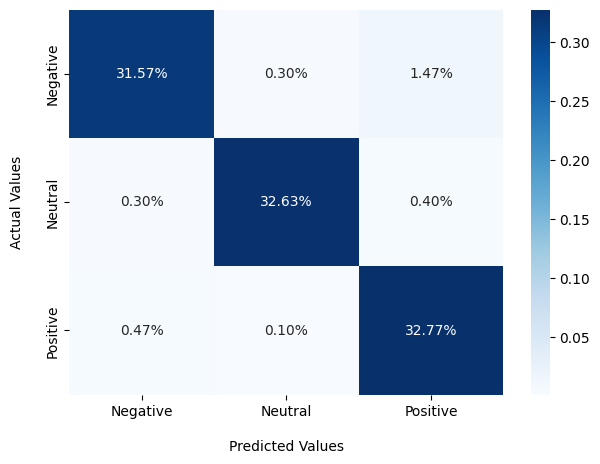

In [35]:
from sklearn.metrics import *
cm = confusion_matrix(test['target'], test['prediction'])

plt.figure(figsize=(7,5))

ax = sns.heatmap(cm/np.sum(cm),fmt='.2%', annot=True, cmap='Blues')

ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values\n');

ax.xaxis.set_ticklabels(labels)
ax.yaxis.set_ticklabels(labels)

plt.savefig('cm.png')
plt.show()

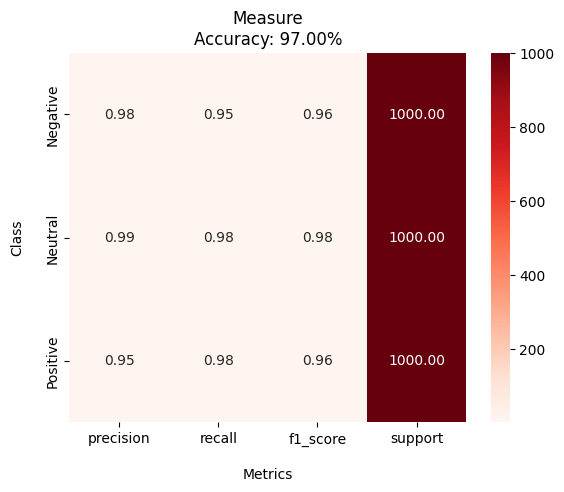

In [36]:
from sklearn.metrics import confusion_matrix, accuracy_score
import matplotlib.pyplot as plt 
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')


def plot_classification_report(report):
    report_data = []
    lines = report.split('\n')
    lines = list(filter(None, lines))
    for line in lines[1:-3]:
        row = {}
        row_data = line.split()
        row_data = list(filter(None, row_data))
        row['class'] = row_data[0]
        row['precision'] = float(row_data[1])
        row['recall'] = float(row_data[2])
        row['f1_score'] = float(row_data[3])
        row['support'] = float(row_data[4])
        report_data.append(row)
    df = pd.DataFrame.from_dict(report_data)
    df.set_index('class', inplace=True)
    heatmap = sns.heatmap(df, annot=True, cmap='Reds', fmt='.2f')
    heatmap.set_xlabel('\nMetrics')
    heatmap.set_ylabel('Class\n')
    heatmap.set_title('Classification Report')


def accuracy_score(report):
    report_data = []
    lines = report.split('\n')
    lines = list(filter(None, lines))
    for line in lines[4:-2]:
        row_data = line.split()
        row_data = list(filter(None, row_data))
        return float(row_data[1])


labels = ['Negative','Neutral','Positive']

report = classification_report(test['target'], test['prediction'], target_names=labels)
plot_classification_report(report)
accuracy = accuracy_score(report)

plt.title('Measure\nAccuracy: {:.2f}%'.format(accuracy*100))
plt.savefig('classification_reports.png')
plt.show()
